# 10. Yerevan Smart City Sensing: Final Project. Part I

## Urban sensing: quantifying the sensing power of vehicle fleets. Part I

<img src="Yerevan_sensing_power.gif" width="1000" align="center">

## Introduction

Smart cities are increasingly being equipped with sensors measuring a variety of quantities indicative of the quality of the urban enviroment: air pollution, traffic congestion, air temperature, humidity, road quality, pedestrian density, parking spot occupancy, Wi-Fi accessibility, etc. All these measurements will fuel advanced urban analytics, and become a routine component in urban planning, policy making, and management.

However, the city-wide deployment of sensors has limited spatial coverage and comes at a significant cost, and the question of their optimal placement arises naturally. As a solution, the ["drive-by"](http://nrlweb.cs.ucla.edu/nrlweb/publication/download/498/vsnsurvey10.pdf) paradigm has been recently proposed, whereby sensors are installed on third-party vehicles "scanning" the city. While most of the research on drive-by sensing has focused on engineering aspects, the key question of **how many vehicles are required to adequately scan a city** remained unanswered until recently. The answer intuitively depends on the mobility patterns of the vehicles in question. Among many candidates for the vehicle fleets, such as private cars, buses, and taxis, taxis are the natural choice for deploying the sensors as they are pervasive in the city and do not follow fixed routes. Is it possible to find out whether attaching sensors to taxi vehicles is a good idea? This is what we are going to do in this post.

### Why is it important?
If we discover that a small number of taxis covers a large portion of the city, attaching sensors to those taxis could provide a cheap way for monitoring the various quantities mentioned in the introduction. In this post, we define a measure of this "covering" and discuss its analytic description, which agrees surprisingly well with empirical data from a ride sharing company called GG based in Yerevan. We will follow the arguments described in a recent [paper](https://www.pnas.org/content/116/26/12752) from the [MIT Senseable Lab](http://senseable.mit.edu/) to demonstrate the suprisingly huge potential of this method: just 30 randomly chosen taxi vehicles (less than 1% of the entire fleet) during a typical day cover on average **more than a third** of Yerevan city and **almost 70%** of the centrally located districts (Kentron, Ajapnyak, Kanaker-Zeytun, Nork-Marash)! This has huge implications for smart city projects as it demonstrates that drive-by sensing can be readily implemented in real projects at a relatively small cost.

### How to measure urban sensing?

In order for a vehicle fleet to scan as large a portion of the urban street network as possible, a dense exploration of what the [authors](https://www.pnas.org/content/116/26/12752) call the city's spatio-temporal "volume" is required. The extent to which a vehicle fleet does this is called its *sensing power*.

Imagine a fleet of sensor-equipped vehicles $\mathcal{V}$ moving in a city, scanning its street network $S$ during a reference period $\mathcal{T}$. Below you can see such a fleet of randomly chosen 30 taxis traversing the streets of Yerevan:

<img src="Yerevan_30_gg.gif" width="1000" align="center">

We represent the nodes of the street network $S$ as potential pick-up and drop-off locations for the vehicles. Since we are going to work with street segments, we convert the set of GPS coordinates of a given vehicle to a trajectory $T_{r}$, defined as a sequence of street segments $T_{r} = (S_{i_1} , S_{i_2} , . . . )$. In order to achieve this, we need to match the taxi trajectories to the OpenStreetMap driving network segments. However, this is not an easy task, since a naive projection to the closest road segment yields incorrect results. Fortunately, this problem has been solved in [this](https://www.microsoft.com/en-us/research/publication/hidden-markov-map-matching-noise-sparseness/) paper, which builds a Hidden Markov Model for identifying the most probable street network path, given a sequence of GPS points. For the purposes of this project, however, we will assume that taxis take the shortest route to their destinations, and will build the trajectories by extracting the origin-destination pairs of the trips and taking the [Dijkstra shortest path](https://en.wikipedia.org/wiki/Dijkstra%27s_algorithm) between them.

In order to measure the *sensing power* of a fleet, we quantify it as its covering fraction $\langle C\rangle$, defined in the paper as the average fraction of street segments in $S$ that are "covered" or sensed by a taxi during time period $\mathcal{T}$ , assuming that $N_{V}$ vehicles are selected
uniformly at random from the vehicle fleet $\mathcal{V}$.

What we want is an understanding of how the *sensing power* of a vehicle fleet in a city changes as a function of the size of the fleet. **Using some basic probability theory and statistics, we will derive the mathematical equation for this relationship**.

### Can we simulate the taxi movements?

To model the taxis' movements, the paper introduces the taxi-drive process. The model makes very simple (and wrong) assumptions: 

* that taxis travel to randomly chosen destinations via shortest paths, with ties between multiple shortest paths broken at random. 
* Once a destination is reached, another destination is chosen, again at random, and the process repeats. 
* To reflect heterogeneities in real taxi trajectories, destinations  are not selected uniformly at random. Instead, already visited nodes are chosen preferentially: The probability $q_{n}(t)$ of selecting a node $n $ is proportional to $1+v_{n}^{\beta}(t)$, where $v_{n}(t)$ is the total number of times node $n$ has been visited at during the time interval $(t_{start}, t)$ and $\beta$ is a city-specific parameter
to be tweaked. This ["preferential attachment"](https://en.wikipedia.org/wiki/Preferential_attachment) mechanism, colloquially known as rich-get-richer effect and discussed mainly within the context of wealth distribution and tie formation in social networks, has been [shown](http://barabasi.com/publications/10/human-dynamics) to capture the statistical properties of human mobility and, as it turns out, also captures those of taxis.

We first calculate the street segment popularities $p_{i}$, the relative frequency each street segment in the city is traversed by the vehicles in the fleet $\mathcal{V}$ during $\mathcal{T}$ (the $p_{i}$ sum to 1) from the GG taxi data (**spoiler**: we are going to use the $p_{i}$ to compute our target $\langle C\rangle$). Then, we run the simulation of the taxi-drive process with the same fleet size and the same number of trips for each vehicle. We discover that, despite the unrealistic assumptions in the model, the taxi-drive process captures quite well the statistical properties of real taxis' trajectories.

## The city street network

Let's start by importing the necessary libraries, loading the city street network data, and processing it for our needs.

In [1]:
#!pip install ipython-autotime
%load_ext autotime
import osmnx as ox, geopandas as gpd, pandas as pd, networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString, Polygon, MultiPolygon
from IPython.display import Image
from descartes import PolygonPatch
from itertools import combinations, combinations_with_replacement
%matplotlib inline
ox.config(log_console=False, use_cache=True)
%config IPCompleter.greedy=True
import contextily as ctx

time: 5.7 s (started: 2021-09-26 15:26:08 +01:00)


Let's load the Yerevan street network from OpenStreetMap using the `osmnx` package.

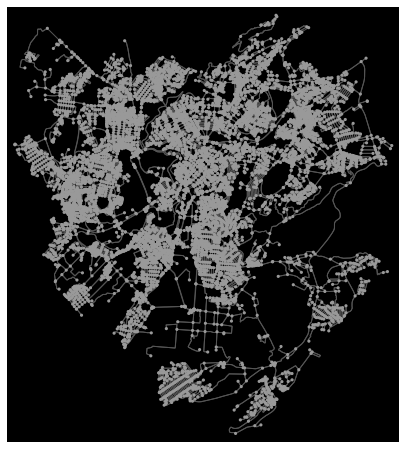

time: 22.6 s (started: 2021-09-26 15:26:14 +01:00)


In [2]:
# download and project a street network
G_w = ox.graph_from_place('Yerevan, Armenia', network_type='drive', simplify=True)
#G = ox.project_graph(G)
fig, ax = ox.plot_graph(G_w, bgcolor='k', node_size=10, node_color='#999999', node_edgecolor='none',
                        edge_color='#555555', edge_linewidth=1, edge_alpha=1)

For the purposes of this project, let's simplify the network by making it undirected:

In [3]:
G = G_w.to_undirected()
print("The graph connected: ", nx.is_connected(G))
print("Number of streets in the original graph: ", len(G_w.edges()))
print("Number of streets in the undirected graph: ", len(G.edges()))

The graph connected:  True
Number of streets in the original graph:  25331
Number of streets in the undirected graph:  13874
time: 1.64 s (started: 2021-09-26 15:26:37 +01:00)


Let's take the central node in the Yerevan street network, and extract a subgraph centered at that node with an isochrone radius of 10 km. Then, let's add a new edge feature to the streets representing the walking time required to traverse them.

In [4]:
center_node = ox.distance.nearest_nodes(G, 44.5152, 40.1872)
print("Center node ID: ", center_node)
yerevan_subgraph = nx.ego_graph(G, center_node, radius=10000, distance='length')
print(len(yerevan_subgraph.edges()))
# configure trip times and travel speed

trip_times = range(5, 80, 5)  # in minutes
travel_speed = 4.5  # walking speed in km/hour


# add an edge attribute for time in minutes required to cross each edge at the specified travel speed
meters_per_minute = travel_speed * 1000 / 60  # km per hour to m per minute
for _, _, _, data in yerevan_subgraph.edges(data=True, keys=True):
    data["time"] = data["length"] / meters_per_minute

Center node ID:  2954854772
12766
time: 937 ms (started: 2021-09-26 15:26:38 +01:00)


Let's check the resulting network edge data:

In [5]:
list(yerevan_subgraph.edges(data=True, keys=True))[:2]

[(130040577,
  1317612052,
  0,
  {'osmid': 380284817,
   'oneway': True,
   'lanes': '3',
   'name': 'Լենինգրադյան փողոց',
   'highway': 'primary',
   'maxspeed': '60',
   'length': 13.667,
   'time': 0.18222666666666668}),
 (130040577,
  3790541209,
  0,
  {'osmid': 795764692,
   'oneway': True,
   'lanes': '2',
   'ref': 'Մ-1',
   'name': 'Գրիգոր Հասրաթյանի փողոց',
   'highway': 'primary',
   'length': 116.989,
   'time': 1.5598533333333333})]

time: 78 ms (started: 2021-09-26 15:26:39 +01:00)


In order to visualise the street network isochrone, let's create a list containing the colors of the isochrone gradient:

In [6]:
# get one color for each isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), cmap="Reds", start=0, return_hex=True)
print(iso_colors)

['#fff5f0', '#fee9df', '#fedbcc', '#fdc6b0', '#fcaf93', '#fc9879', '#fc8161', '#fb694a', '#f44f39', '#ea362a', '#d52221', '#bf151b', '#aa1016', '#8a0812', '#67000d']
time: 15 ms (started: 2021-09-26 15:26:39 +01:00)


Finally, let's plot the isochrone with up to a 80 minutes walking radius:

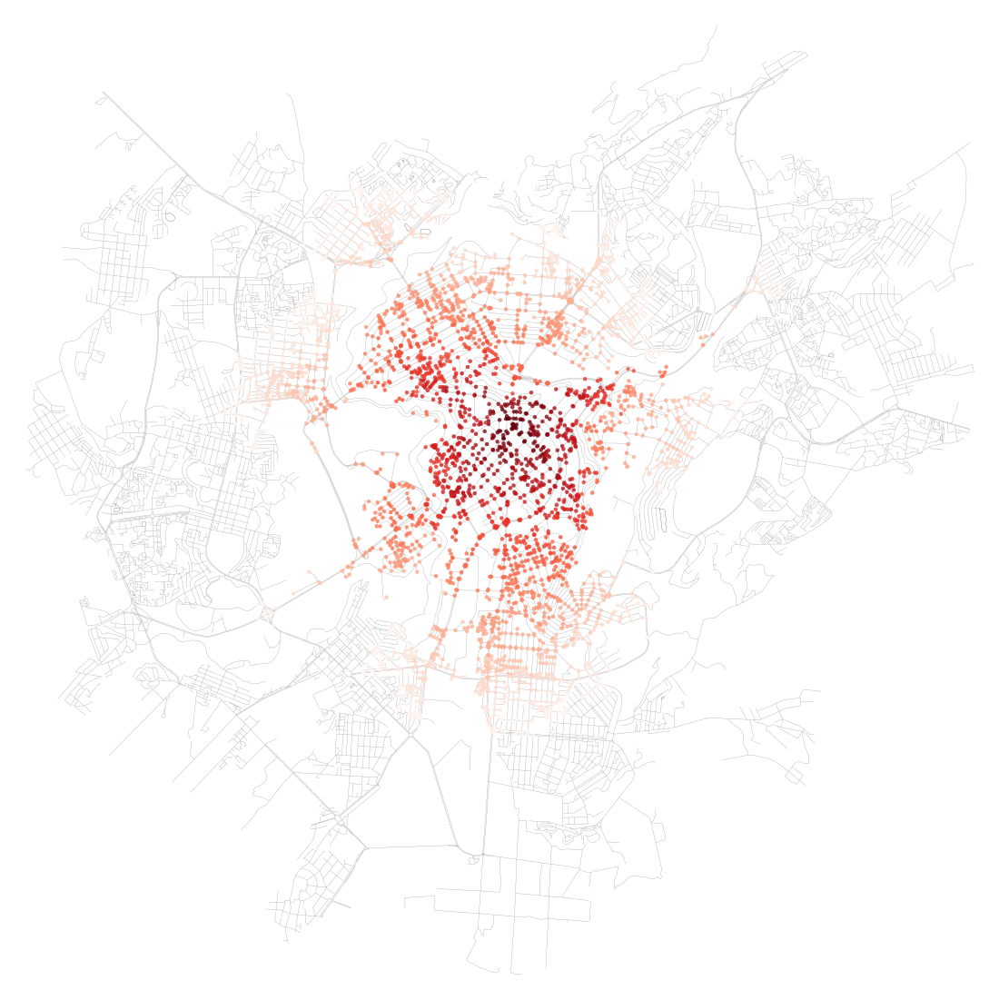

time: 4.39 s (started: 2021-09-26 15:26:39 +01:00)


In [7]:
# color the street network nodes according to the isochrone and plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(yerevan_subgraph, center_node, radius=trip_time, distance="time")
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else "none" for node in yerevan_subgraph.nodes()]
ns = [20 if node in node_colors else 0 for node in yerevan_subgraph.nodes()]
fig, ax = ox.plot_graph(
    yerevan_subgraph,
    figsize=(20,20),
    node_color=nc,
    node_size=ns,
    bgcolor='white',
    node_alpha=0.8,
    edge_linewidth=0.3,
    edge_color="#999999",
)

## Processing the taxi data

Let's load the taxi data: a slightly modified version of the data we built for the urban mobility network analysis project.

In [8]:
data = pd.read_csv('../data/Yerevan_one_day_gg.csv', index_col=0, header=0)
data.head()

C:\Users\gevor\anaconda3\envs\geo_env\lib\site-packages\numpy\lib\arraysetops.py:583: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


,createdAt,lat,lon,trip,trips,partner
0,00:00:04,40.192053,44.505370,1,1,1
1,00:00:16,40.192112,44.504949,1,1,1
2,00:00:28,40.192112,44.504947,1,1,1
3,00:00:48,40.192172,44.503892,1,1,1
4,00:01:04,40.192310,44.501183,1,1,1


time: 4.3 s (started: 2021-09-26 15:26:44 +01:00)


Let's group the dataframe by the `trips` column, set it as an outer-level index, extract and keep the first and last rows of each trip.

In [9]:
df = data.copy()
df_groups = df.groupby('trips')
df_applied = df_groups.apply(lambda x: x.drop(x.iloc[1:-1,:].index))
df_applied

createdAt        lat        lon  trip  trips  partner
trips                                                              
1     0        00:00:04  40.192053  44.505370     1      1        1
      56       00:14:04  40.202046  44.532296     1      1        1
2     57       00:14:16  40.201748  44.532788     2      2        1
      115      00:28:55  40.196685  44.572215     2      2        1
3     116      00:29:19  40.196656  44.572138     3      3        1
...                 ...        ...        ...   ...    ...      ...
77614 4044610  23:06:06  40.204289  44.515719    17  77614     3472
77615 4044611  23:06:18  40.204161  44.517034    18  77615     3472
      4044620  23:08:33  40.205823  44.516363    18  77615     3472
77616 4044621  23:08:33  40.205823  44.516363    19  77616     3472
      4044636  23:31:07  40.214155  44.576423    19  77616     3472

[142170 rows x 6 columns]

time: 1min 40s (started: 2021-09-26 15:26:48 +01:00)


Let's drop the outer-level `trips` index:

In [10]:
df_applied.index = df_applied.index.droplevel('trips')
df_applied

,createdAt,lat,lon,trip,trips,partner
0,00:00:04,40.192053,44.505370,1,1,1
56,00:14:04,40.202046,44.532296,1,1,1
57,00:14:16,40.201748,44.532788,2,2,1
115,00:28:55,40.196685,44.572215,2,2,1
116,00:29:19,40.196656,44.572138,3,3,1
...,...,...,...,...,...,...
4044610,23:06:06,40.204289,44.515719,17,77614,3472
4044611,23:06:18,40.204161,44.517034,18,77615,3472
4044620,23:08:33,40.205823,44.516363,18,77615,3472
4044621,23:08:33,40.205823,44.516363,19,77616,3472


time: 16 ms (started: 2021-09-26 15:28:29 +01:00)


Now, let's loop over all trips, compute the shortest path between the origins and destinations of the trips, and get the node and edge sequences for those trips.

Before we start, let's make sure the street network does not have any isolated nodes:

In [11]:
print("Yerevan street network is connected: ", nx.is_connected(yerevan_subgraph))

Yerevan street network is connected:  True
time: 16 ms (started: 2021-09-26 15:28:29 +01:00)


In [12]:
from tqdm import tqdm

# initialise empty dictionaries where we will collect the sequence of nodes and edges for each trips
trip_edges_dict = {}
trip_nodes_dict = {}

# initialise the array containing the trips to loop over 
trips_array = df_applied.trips.unique()

# start loop
for trip in tqdm(trips_array):
    
    # slice dataframe to get rows corresponding to the trip in loop
    trip_df = df_applied.loc[df_applied.trips==trip]

    # get the street network nodes closest the origin and destination of the trip
    orig = ox.distance.nearest_nodes(yerevan_subgraph, trip_df.iloc[0,2], trip_df.iloc[0,1])
    dest = ox.distance.nearest_nodes(yerevan_subgraph, trip_df.iloc[-1,2], trip_df.iloc[-1,1])
    
    # compute the shortest path, and add the node and edge sequences to the respective dictionaries
    try:
        route = nx.shortest_path(yerevan_subgraph, orig, dest, weight='length')
        edges = [ tuple( route[i:i+2] ) for i in range( len(route) - 1 ) ]
        if len(edges)>0:
            trip_edges_dict[trip] = edges
            trip_nodes_dict[trip] = route
    except:
        pass
    if trip % 500 == 1:
        print("Length of trip {}: ".format(trip), len(edges))
        
len(trip_edges_dict.keys())

  0%|                                                                            | 2/77616 [00:00<2:42:26,  7.96it/s]

Length of trip 1:  39


  1%|▍                                                                         | 502/77616 [01:22<3:17:06,  6.52it/s]

Length of trip 501:  0


  1%|▉                                                                        | 1003/77616 [02:44<3:10:07,  6.72it/s]

Length of trip 1001:  27


  2%|█▍                                                                       | 1502/77616 [04:03<3:10:17,  6.67it/s]

Length of trip 1501:  0


  3%|█▉                                                                       | 2002/77616 [05:26<3:05:54,  6.78it/s]

Length of trip 2001:  21


  3%|██▎                                                                      | 2501/77616 [06:46<3:08:48,  6.63it/s]

Length of trip 2501:  6


  4%|██▊                                                                      | 3002/77616 [08:06<3:20:39,  6.20it/s]

Length of trip 3001:  2


  5%|███▎                                                                     | 3502/77616 [09:24<3:03:56,  6.72it/s]

Length of trip 3501:  53


  5%|███▊                                                                     | 4001/77616 [10:44<3:02:22,  6.73it/s]

Length of trip 4001:  8


  6%|████▏                                                                    | 4502/77616 [12:03<3:11:27,  6.36it/s]

Length of trip 4501:  0


  6%|████▋                                                                    | 5002/77616 [13:21<3:01:16,  6.68it/s]

Length of trip 5001:  4


  7%|█████▏                                                                   | 5502/77616 [14:39<2:42:39,  7.39it/s]

Length of trip 5501:  1


  8%|█████▋                                                                   | 6003/77616 [15:57<2:55:32,  6.80it/s]

Length of trip 6001:  33


  8%|██████                                                                   | 6502/77616 [17:18<2:46:16,  7.13it/s]

Length of trip 6501:  5


  9%|██████▌                                                                  | 7002/77616 [18:43<3:12:13,  6.12it/s]

Length of trip 7001:  6


 10%|███████                                                                  | 7502/77616 [20:01<2:44:20,  7.11it/s]

Length of trip 7501:  14


 10%|███████▌                                                                 | 8001/77616 [21:19<2:42:27,  7.14it/s]

Length of trip 8001:  20


 11%|███████▉                                                                 | 8502/77616 [22:41<2:55:17,  6.57it/s]

Length of trip 8501:  0


 12%|████████▍                                                                | 9001/77616 [24:01<2:54:56,  6.54it/s]

Length of trip 9001:  13


 12%|████████▉                                                                | 9502/77616 [25:25<2:52:09,  6.59it/s]

Length of trip 9501:  1


 13%|█████████▎                                                              | 10002/77616 [26:50<3:02:54,  6.16it/s]

Length of trip 10001:  0


 14%|█████████▋                                                              | 10501/77616 [28:10<2:38:44,  7.05it/s]

Length of trip 10501:  14


 14%|██████████▏                                                             | 11002/77616 [29:31<2:59:26,  6.19it/s]

Length of trip 11001:  18


 15%|██████████▋                                                             | 11501/77616 [30:51<2:36:00,  7.06it/s]

Length of trip 11501:  51


 15%|███████████▏                                                            | 12002/77616 [32:12<2:20:43,  7.77it/s]

Length of trip 12001:  5


 16%|███████████▌                                                            | 12501/77616 [33:32<2:20:34,  7.72it/s]

Length of trip 12501:  0


 17%|████████████                                                            | 13002/77616 [34:51<2:44:57,  6.53it/s]

Length of trip 13001:  8


 17%|████████████▌                                                           | 13502/77616 [36:12<2:32:31,  7.01it/s]

Length of trip 13501:  10


 18%|████████████▉                                                           | 14002/77616 [37:31<2:38:11,  6.70it/s]

Length of trip 14001:  0


 19%|█████████████▍                                                          | 14502/77616 [38:50<2:36:22,  6.73it/s]

Length of trip 14501:  2


 19%|█████████████▉                                                          | 15001/77616 [40:10<3:12:33,  5.42it/s]

Length of trip 15001:  53


 20%|██████████████▍                                                         | 15502/77616 [41:31<2:16:06,  7.61it/s]

Length of trip 15501:  22


 21%|██████████████▊                                                         | 16002/77616 [42:51<2:21:57,  7.23it/s]

Length of trip 16001:  49


 21%|███████████████▎                                                        | 16502/77616 [44:10<2:06:05,  8.08it/s]

Length of trip 16501:  29


 22%|███████████████▊                                                        | 17002/77616 [45:30<2:37:02,  6.43it/s]

Length of trip 17001:  10


 23%|████████████████▏                                                       | 17501/77616 [46:51<2:23:54,  6.96it/s]

Length of trip 17501:  32


 23%|████████████████▋                                                       | 18002/77616 [48:12<2:28:51,  6.67it/s]

Length of trip 18001:  37


 24%|█████████████████▏                                                      | 18501/77616 [49:33<2:15:23,  7.28it/s]

Length of trip 18501:  0


 24%|█████████████████▋                                                      | 19001/77616 [50:54<2:02:24,  7.98it/s]

Length of trip 19001:  0


 25%|██████████████████                                                      | 19502/77616 [52:16<2:20:59,  6.87it/s]

Length of trip 19501:  0


 26%|██████████████████▌                                                     | 20002/77616 [53:44<2:25:51,  6.58it/s]

Length of trip 20001:  60


 26%|███████████████████                                                     | 20502/77616 [55:12<2:18:03,  6.89it/s]

Length of trip 20501:  36


 27%|███████████████████▍                                                    | 21001/77616 [56:33<2:18:19,  6.82it/s]

Length of trip 21001:  49


 28%|███████████████████▉                                                    | 21502/77616 [57:54<2:33:55,  6.08it/s]

Length of trip 21501:  31


 28%|████████████████████▍                                                   | 22001/77616 [59:17<2:33:23,  6.04it/s]

Length of trip 22001:  12


 29%|████████████████████▎                                                 | 22502/77616 [1:00:40<2:09:28,  7.09it/s]

Length of trip 22501:  2


 30%|████████████████████▋                                                 | 23002/77616 [1:02:01<2:10:52,  6.96it/s]

Length of trip 23001:  10


 30%|█████████████████████▏                                                | 23502/77616 [1:03:22<2:14:50,  6.69it/s]

Length of trip 23501:  2


 31%|█████████████████████▋                                                | 24002/77616 [1:04:44<2:00:05,  7.44it/s]

Length of trip 24001:  3


 32%|██████████████████████                                                | 24501/77616 [1:06:07<3:12:09,  4.61it/s]

Length of trip 24501:  6


 32%|██████████████████████▌                                               | 25003/77616 [1:07:32<2:09:40,  6.76it/s]

Length of trip 25001:  12


 33%|██████████████████████▉                                               | 25500/77616 [1:08:56<2:14:37,  6.45it/s]

Length of trip 25501:  0


 34%|███████████████████████▍                                              | 26002/77616 [1:10:19<1:57:39,  7.31it/s]

Length of trip 26001:  9


 34%|███████████████████████▉                                              | 26503/77616 [1:11:43<2:02:27,  6.96it/s]

Length of trip 26501:  7


 35%|████████████████████████▎                                             | 27002/77616 [1:13:09<2:09:35,  6.51it/s]

Length of trip 27001:  49


 35%|████████████████████████▊                                             | 27502/77616 [1:14:36<2:08:21,  6.51it/s]

Length of trip 27501:  0


 36%|█████████████████████████▎                                            | 28002/77616 [1:16:03<2:18:19,  5.98it/s]

Length of trip 28001:  2


 37%|█████████████████████████▋                                            | 28502/77616 [1:17:27<2:17:21,  5.96it/s]

Length of trip 28501:  5


 37%|██████████████████████████▏                                           | 29002/77616 [1:18:52<1:56:46,  6.94it/s]

Length of trip 29001:  0


 38%|██████████████████████████▌                                           | 29501/77616 [1:20:20<2:10:59,  6.12it/s]

Length of trip 29501:  31


 39%|███████████████████████████                                           | 30001/77616 [1:21:48<1:58:22,  6.70it/s]

Length of trip 30001:  12


 39%|███████████████████████████▌                                          | 30502/77616 [1:23:16<2:16:10,  5.77it/s]

Length of trip 30501:  11


 40%|███████████████████████████▉                                          | 31002/77616 [1:24:41<1:56:58,  6.64it/s]

Length of trip 31001:  34


 41%|████████████████████████████▍                                         | 31502/77616 [1:26:02<2:15:34,  5.67it/s]

Length of trip 31501:  0


 41%|████████████████████████████▊                                         | 32002/77616 [1:27:25<1:43:59,  7.31it/s]

Length of trip 32001:  0


 42%|█████████████████████████████▎                                        | 32502/77616 [1:28:51<1:54:33,  6.56it/s]

Length of trip 32501:  0


 43%|█████████████████████████████▊                                        | 33002/77616 [1:30:17<2:01:01,  6.14it/s]

Length of trip 33001:  13


 43%|██████████████████████████████▏                                       | 33503/77616 [1:31:43<1:56:22,  6.32it/s]

Length of trip 33501:  10


 44%|██████████████████████████████▋                                       | 34002/77616 [1:33:10<1:44:55,  6.93it/s]

Length of trip 34001:  0


 44%|███████████████████████████████                                       | 34501/77616 [1:34:32<1:27:53,  8.18it/s]

Length of trip 34501:  3


 45%|███████████████████████████████▌                                      | 35001/77616 [1:35:57<1:42:55,  6.90it/s]

Length of trip 35001:  26


 46%|████████████████████████████████                                      | 35502/77616 [1:37:27<1:33:25,  7.51it/s]

Length of trip 35501:  0


 46%|████████████████████████████████▍                                     | 36001/77616 [1:38:56<1:55:47,  5.99it/s]

Length of trip 36001:  36


 47%|████████████████████████████████▉                                     | 36503/77616 [1:40:19<1:42:52,  6.66it/s]

Length of trip 36501:  11


 48%|█████████████████████████████████▎                                    | 37001/77616 [1:41:42<1:34:20,  7.18it/s]

Length of trip 37001:  26


 48%|█████████████████████████████████▊                                    | 37502/77616 [1:43:07<1:53:59,  5.86it/s]

Length of trip 37501:  19


 49%|██████████████████████████████████▎                                   | 38002/77616 [1:44:34<2:01:27,  5.44it/s]

Length of trip 38001:  6


 50%|██████████████████████████████████▋                                   | 38502/77616 [1:45:59<1:38:39,  6.61it/s]

Length of trip 38501:  19


 50%|███████████████████████████████████▏                                  | 39001/77616 [1:47:24<1:35:13,  6.76it/s]

Length of trip 39001:  49


 51%|███████████████████████████████████▋                                  | 39502/77616 [1:48:49<1:45:40,  6.01it/s]

Length of trip 39501:  21


 52%|████████████████████████████████████                                  | 40002/77616 [1:50:14<1:44:45,  5.98it/s]

Length of trip 40001:  15


 52%|████████████████████████████████████▌                                 | 40502/77616 [1:51:45<2:00:22,  5.14it/s]

Length of trip 40501:  48


 53%|████████████████████████████████████▉                                 | 41000/77616 [1:53:12<1:28:58,  6.86it/s]

Length of trip 41001:  0


 53%|█████████████████████████████████████▍                                | 41503/77616 [1:54:38<1:23:18,  7.22it/s]

Length of trip 41501:  0


 54%|█████████████████████████████████████▉                                | 42001/77616 [1:56:05<1:33:50,  6.33it/s]

Length of trip 42001:  3


 55%|██████████████████████████████████████▎                               | 42502/77616 [1:57:37<1:48:09,  5.41it/s]

Length of trip 42501:  59


 55%|██████████████████████████████████████▊                               | 43001/77616 [1:59:04<1:25:58,  6.71it/s]

Length of trip 43001:  16


 56%|███████████████████████████████████████▏                              | 43502/77616 [2:00:31<1:39:45,  5.70it/s]

Length of trip 43501:  25


 57%|███████████████████████████████████████▋                              | 44002/77616 [2:01:57<1:20:52,  6.93it/s]

Length of trip 44001:  28


 57%|████████████████████████████████████████▏                             | 44502/77616 [2:03:22<1:40:03,  5.52it/s]

Length of trip 44501:  4


 58%|████████████████████████████████████████▌                             | 45002/77616 [2:04:46<1:22:23,  6.60it/s]

Length of trip 45001:  25


 59%|█████████████████████████████████████████                             | 45502/77616 [2:06:12<1:23:29,  6.41it/s]

Length of trip 45501:  0


 59%|█████████████████████████████████████████▍                            | 46003/77616 [2:07:38<1:14:55,  7.03it/s]

Length of trip 46001:  26


 60%|█████████████████████████████████████████▉                            | 46502/77616 [2:09:02<1:27:54,  5.90it/s]

Length of trip 46501:  45


 61%|██████████████████████████████████████████▍                           | 47002/77616 [2:10:27<1:18:55,  6.47it/s]

Length of trip 47001:  72


 61%|██████████████████████████████████████████▊                           | 47502/77616 [2:11:56<1:10:25,  7.13it/s]

Length of trip 47501:  15


 62%|███████████████████████████████████████████▎                          | 48002/77616 [2:13:25<1:46:00,  4.66it/s]

Length of trip 48001:  14


 62%|███████████████████████████████████████████▋                          | 48502/77616 [2:14:53<1:15:12,  6.45it/s]

Length of trip 48501:  11


 63%|████████████████████████████████████████████▏                         | 49002/77616 [2:16:19<1:36:17,  4.95it/s]

Length of trip 49001:  57


 64%|████████████████████████████████████████████▋                         | 49502/77616 [2:17:46<1:05:32,  7.15it/s]

Length of trip 49501:  0


 64%|█████████████████████████████████████████████                         | 50001/77616 [2:19:11<1:04:43,  7.11it/s]

Length of trip 50001:  0


 65%|█████████████████████████████████████████████▌                        | 50501/77616 [2:20:39<1:34:53,  4.76it/s]

Length of trip 50501:  10


 66%|█████████████████████████████████████████████▉                        | 51002/77616 [2:22:10<1:36:09,  4.61it/s]

Length of trip 51001:  27


 66%|██████████████████████████████████████████████▍                       | 51502/77616 [2:23:41<1:15:49,  5.74it/s]

Length of trip 51501:  0


 67%|██████████████████████████████████████████████▉                       | 52002/77616 [2:25:11<1:05:58,  6.47it/s]

Length of trip 52001:  5


 68%|███████████████████████████████████████████████▎                      | 52502/77616 [2:26:42<1:16:35,  5.47it/s]

Length of trip 52501:  0


 68%|███████████████████████████████████████████████▊                      | 53002/77616 [2:28:09<1:11:31,  5.74it/s]

Length of trip 53001:  0


 69%|████████████████████████████████████████████████▎                     | 53502/77616 [2:29:33<1:11:04,  5.65it/s]

Length of trip 53501:  0


 70%|██████████████████████████████████████████████████                      | 54001/77616 [2:30:59<56:55,  6.91it/s]

Length of trip 54001:  9


 70%|█████████████████████████████████████████████████▏                    | 54501/77616 [2:32:25<1:10:07,  5.49it/s]

Length of trip 54501:  52


 71%|███████████████████████████████████████████████████                     | 55001/77616 [2:33:57<54:45,  6.88it/s]

Length of trip 55001:  19


 72%|██████████████████████████████████████████████████                    | 55502/77616 [2:35:29<1:07:33,  5.46it/s]

Length of trip 55501:  29


 72%|██████████████████████████████████████████████████▌                   | 56002/77616 [2:37:02<1:04:16,  5.60it/s]

Length of trip 56001:  0


 73%|████████████████████████████████████████████████████▍                   | 56502/77616 [2:38:32<53:25,  6.59it/s]

Length of trip 56501:  0


 73%|████████████████████████████████████████████████████▉                   | 57002/77616 [2:40:05<55:10,  6.23it/s]

Length of trip 57001:  32


 74%|███████████████████████████████████████████████████▊                  | 57501/77616 [2:41:35<1:03:41,  5.26it/s]

Length of trip 57501:  7


 75%|█████████████████████████████████████████████████████▊                  | 58001/77616 [2:43:08<51:28,  6.35it/s]

Length of trip 58001:  52


 75%|████████████████████████████████████████████████████▊                 | 58502/77616 [2:44:40<1:01:25,  5.19it/s]

Length of trip 58501:  33


 76%|██████████████████████████████████████████████████████▋                 | 59002/77616 [2:46:11<44:38,  6.95it/s]

Length of trip 59001:  0


 77%|███████████████████████████████████████████████████████▏                | 59502/77616 [2:47:42<48:26,  6.23it/s]

Length of trip 59501:  0


 77%|███████████████████████████████████████████████████████▋                | 60002/77616 [2:49:15<45:38,  6.43it/s]

Length of trip 60001:  1


 78%|████████████████████████████████████████████████████████                | 60502/77616 [2:50:46<51:24,  5.55it/s]

Length of trip 60501:  0


 79%|████████████████████████████████████████████████████████▌               | 61002/77616 [2:52:18<52:48,  5.24it/s]

Length of trip 61001:  6


 79%|█████████████████████████████████████████████████████████               | 61502/77616 [2:53:49<41:52,  6.41it/s]

Length of trip 61501:  0


 80%|█████████████████████████████████████████████████████████▌              | 62002/77616 [2:55:22<45:54,  5.67it/s]

Length of trip 62001:  16


 81%|█████████████████████████████████████████████████████████▉              | 62502/77616 [2:56:55<41:10,  6.12it/s]

Length of trip 62501:  0


 81%|██████████████████████████████████████████████████████████▍             | 63001/77616 [2:58:22<35:15,  6.91it/s]

Length of trip 63001:  25


 82%|██████████████████████████████████████████████████████████▉             | 63502/77616 [2:59:46<40:11,  5.85it/s]

Length of trip 63501:  0


 82%|███████████████████████████████████████████████████████████▎            | 64003/77616 [3:01:11<30:41,  7.39it/s]

Length of trip 64001:  13


 83%|███████████████████████████████████████████████████████████▊            | 64502/77616 [3:02:34<40:33,  5.39it/s]

Length of trip 64501:  38


 84%|████████████████████████████████████████████████████████████▎           | 65002/77616 [3:03:59<33:41,  6.24it/s]

Length of trip 65001:  15


 84%|████████████████████████████████████████████████████████████▊           | 65502/77616 [3:05:28<30:30,  6.62it/s]

Length of trip 65501:  22


 85%|█████████████████████████████████████████████████████████████▏          | 66002/77616 [3:06:57<26:34,  7.28it/s]

Length of trip 66001:  2


 86%|█████████████████████████████████████████████████████████████▋          | 66502/77616 [3:08:26<29:23,  6.30it/s]

Length of trip 66501:  4


 86%|██████████████████████████████████████████████████████████████▏         | 67002/77616 [3:09:52<22:56,  7.71it/s]

Length of trip 67001:  21


 87%|██████████████████████████████████████████████████████████████▌         | 67502/77616 [3:11:16<25:05,  6.72it/s]

Length of trip 67501:  0


 88%|███████████████████████████████████████████████████████████████         | 68000/77616 [3:12:41<26:54,  5.95it/s]

Length of trip 68001:  20


 88%|███████████████████████████████████████████████████████████████▌        | 68502/77616 [3:14:06<25:01,  6.07it/s]

Length of trip 68501:  4


 89%|████████████████████████████████████████████████████████████████        | 69002/77616 [3:15:31<22:56,  6.26it/s]

Length of trip 69001:  78


 90%|████████████████████████████████████████████████████████████████▍       | 69502/77616 [3:16:56<21:31,  6.28it/s]

Length of trip 69501:  26


 90%|████████████████████████████████████████████████████████████████▉       | 70001/77616 [3:18:22<24:41,  5.14it/s]

Length of trip 70001:  20


 91%|█████████████████████████████████████████████████████████████████▍      | 70502/77616 [3:19:47<17:06,  6.93it/s]

Length of trip 70501:  4


 91%|█████████████████████████████████████████████████████████████████▊      | 71001/77616 [3:21:11<17:38,  6.25it/s]

Length of trip 71001:  37


 92%|██████████████████████████████████████████████████████████████████▎     | 71502/77616 [3:22:36<14:14,  7.15it/s]

Length of trip 71501:  21


 93%|██████████████████████████████████████████████████████████████████▊     | 72002/77616 [3:24:00<16:54,  5.53it/s]

Length of trip 72001:  6


 93%|███████████████████████████████████████████████████████████████████▎    | 72502/77616 [3:25:27<15:51,  5.38it/s]

Length of trip 72501:  12


 94%|███████████████████████████████████████████████████████████████████▋    | 73002/77616 [3:27:00<13:41,  5.62it/s]

Length of trip 73001:  1


 95%|████████████████████████████████████████████████████████████████████▏   | 73502/77616 [3:28:31<11:57,  5.73it/s]

Length of trip 73501:  9


 95%|████████████████████████████████████████████████████████████████████▋   | 74002/77616 [3:30:04<12:40,  4.75it/s]

Length of trip 74001:  31


 96%|█████████████████████████████████████████████████████████████████████   | 74502/77616 [3:31:38<10:07,  5.13it/s]

Length of trip 74501:  0


 97%|█████████████████████████████████████████████████████████████████████▌  | 75002/77616 [3:33:10<09:31,  4.58it/s]

Length of trip 75001:  5


 97%|██████████████████████████████████████████████████████████████████████  | 75502/77616 [3:34:42<05:39,  6.23it/s]

Length of trip 75501:  0


 98%|██████████████████████████████████████████████████████████████████████▌ | 76002/77616 [3:36:12<03:54,  6.87it/s]

Length of trip 76001:  5


 99%|██████████████████████████████████████████████████████████████████████▉ | 76502/77616 [3:37:44<02:46,  6.68it/s]

Length of trip 76501:  30


 99%|███████████████████████████████████████████████████████████████████████▍| 77000/77616 [3:39:12<01:40,  6.11it/s]

Length of trip 77001:  9


100%|███████████████████████████████████████████████████████████████████████▉| 77500/77616 [3:40:38<00:16,  7.12it/s]

Length of trip 77501:  0


100%|████████████████████████████████████████████████████████████████████████| 77616/77616 [3:40:59<00:00,  5.85it/s]


57583

time: 3h 40min 59s (started: 2021-09-26 15:28:29 +01:00)


In case the shortest path was impossible to compute for some of the trips, let's slice the taxi dataframe keeping only those trips for which the shortest path was computed:

In [13]:
trips_final = np.array(list(trip_edges_dict.keys()))
data_trips = df_applied.loc[df_applied.trips.isin(trips_final)]
data_trips.head()

,createdAt,lat,lon,trip,trips,partner
0,00:00:04,40.192053,44.505370,1,1,1
56,00:14:04,40.202046,44.532296,1,1,1
57,00:14:16,40.201748,44.532788,2,2,1
115,00:28:55,40.196685,44.572215,2,2,1
116,00:29:19,40.196656,44.572138,3,3,1


time: 250 ms (started: 2021-09-26 19:09:28 +01:00)


Let's create a dictionary with the taxi driver IDs as keys, and the list of trips they took as values:

In [14]:
partners_trips_dict = data_trips.groupby(['partner'])['trips'].apply(lambda g: np.unique(g.values).tolist()).to_dict()
partners_trips_dict

{1: [1,
  2,
  3,
  4,
  5,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22],
 2: [23,
  24,
  25,
  27,
  29,
  30,
  31,
  32,
  34,
  35,
  37,
  38,
  39,
  41,
  42,
  43,
  44,
  45,
  48,
  49,
  51,
  53,
  55,
  56,
  57,
  59],
 3: [60,
  62,
  63,
  64,
  66,
  67,
  68,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  79,
  80,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  92,
  95,
  96,
  97,
  98,
  100],
 4: [101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114,
  117,
  118,
  119,
  120,
  121,
  122,
  123,
  126,
  127,
  128,
  129,
  130,
  133,
  134,
  135,
  136,
  139,
  140,
  143,
  146,
  149,
  150],
 5: [151,
  152,
  153,
  156,
  157,
  158,
  161,
  164,
  167,
  168,
  169,
  170,
  172,
  175,
  176,
  179,
  182,
  183,
  185,
  188,
  189,
  192,
  195,
  198,
  199,
  202,
  203,
  204,
  207,
  208,
  209,
  210],
 6: [212, 213, 216, 217, 220, 221, 22

time: 593 ms (started: 2021-09-26 19:09:28 +01:00)


Finally, let's save the computed data:

In [15]:
nx.write_gpickle(yerevan_subgraph, "Yerevan_graph.gpickle")
df_applied.to_csv('Yerevan_OD_trips_dataframe.csv')
np.save('Yerevan_taxi_trip_edges_dict.npy', trip_edges_dict) 
np.save('Yerevan_taxi_trip_nodes_dict.npy', trip_nodes_dict) 
np.save('Yerevan_partners_trips_dict.npy', partners_trips_dict) 

time: 2.77 s (started: 2021-09-26 19:09:29 +01:00)


Now, let's take a look at how often each node in the street network has been traversed bout our fleet of taxis.

In [16]:
node_array = [node for key in trip_nodes_dict for node in trip_nodes_dict[key]]
node_array[:10]

[1950954811,
 311001864,
 4732602804,
 311005601,
 6885367189,
 311005460,
 311005317,
 2000311111,
 2000311106,
 5153956811]

time: 156 ms (started: 2021-09-26 19:09:32 +01:00)


In [17]:
from collections import Counter
node_counts = dict(Counter(node_array))
node_counts

{1950954811: 1172,
 311001864: 2705,
 4732602804: 3125,
 311005601: 823,
 6885367189: 808,
 311005460: 799,
 311005317: 938,
 2000311111: 923,
 2000311106: 922,
 5153956811: 922,
 5153888112: 911,
 1796405822: 914,
 1796405860: 913,
 633497613: 871,
 4665297783: 882,
 331525948: 892,
 1793612326: 1495,
 2001110779: 1342,
 703658721: 1445,
 310998800: 956,
 4406579573: 959,
 633497713: 955,
 633497726: 594,
 310998774: 602,
 4825897724: 605,
 1796406311: 573,
 1796406310: 1097,
 649274205: 1120,
 1342512106: 618,
 1342686213: 1126,
 256031575: 1921,
 331526145: 904,
 311039601: 862,
 633438786: 846,
 6989112925: 835,
 331526303: 843,
 633438795: 860,
 4672153848: 875,
 7180617716: 848,
 4230885933: 1082,
 4230885924: 503,
 4230885925: 1239,
 4230885923: 1237,
 4230885916: 1232,
 4230885917: 1209,
 2283528749: 1144,
 4230885932: 1130,
 4230885935: 1452,
 4230885939: 1213,
 2610846179: 1206,
 288954365: 1189,
 288954366: 1322,
 1469188615: 1428,
 6139214161: 1516,
 6139214162: 1318,
 6354

time: 250 ms (started: 2021-09-26 19:09:32 +01:00)


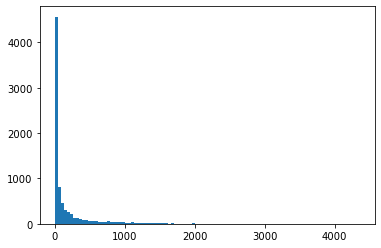

time: 484 ms (started: 2021-09-26 19:09:32 +01:00)


In [18]:
plt.hist(node_counts.values(), bins=100)
plt.show()

Let's plot the distribution of trip lengths counted as the number of nodes in each trip: 

100%|█████████████████████████████████████████████████████████████████████| 57583/57583 [00:00<00:00, 1047298.32it/s]


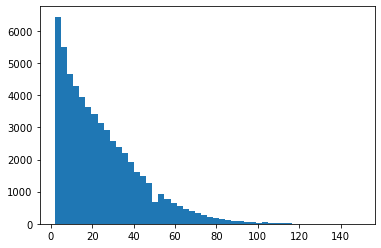

time: 688 ms (started: 2021-09-26 19:09:33 +01:00)


In [19]:
traj_lengths = []
for trip, node_list in tqdm(trip_nodes_dict.items()):
    traj_lengths.append(len(node_list))
    
plt.hist(traj_lengths, bins=50)
plt.show()

Let's do the same for the street edge segments:

In [20]:
edge_array = [edge for key in trip_edges_dict for edge in trip_edges_dict[key]]
edge_array

[(1950954811, 311001864),
 (311001864, 4732602804),
 (4732602804, 311005601),
 (311005601, 6885367189),
 (6885367189, 311005460),
 (311005460, 311005317),
 (311005317, 2000311111),
 (2000311111, 2000311106),
 (2000311106, 5153956811),
 (5153956811, 5153888112),
 (5153888112, 1796405822),
 (1796405822, 1796405860),
 (1796405860, 633497613),
 (633497613, 4665297783),
 (4665297783, 331525948),
 (331525948, 1793612326),
 (1793612326, 2001110779),
 (2001110779, 703658721),
 (703658721, 310998800),
 (310998800, 4406579573),
 (4406579573, 633497713),
 (633497713, 633497726),
 (633497726, 310998774),
 (310998774, 4825897724),
 (4825897724, 1796406311),
 (1796406311, 1796406310),
 (1796406310, 649274205),
 (649274205, 1342512106),
 (1342512106, 1342686213),
 (1342686213, 256031575),
 (256031575, 331526145),
 (331526145, 311039601),
 (311039601, 633438786),
 (633438786, 6989112925),
 (6989112925, 331526303),
 (331526303, 633438795),
 (633438795, 4672153848),
 (4672153848, 7180617716),
 (71806177

time: 219 ms (started: 2021-09-26 19:09:33 +01:00)


In [21]:
segment_counts = dict(Counter(edge_array))
segment_counts

{(1950954811, 311001864): 589,
 (311001864, 4732602804): 826,
 (4732602804, 311005601): 386,
 (311005601, 6885367189): 378,
 (6885367189, 311005460): 376,
 (311005460, 311005317): 377,
 (311005317, 2000311111): 431,
 (2000311111, 2000311106): 426,
 (2000311106, 5153956811): 426,
 (5153956811, 5153888112): 426,
 (5153888112, 1796405822): 430,
 (1796405822, 1796405860): 429,
 (1796405860, 633497613): 418,
 (633497613, 4665297783): 416,
 (4665297783, 331525948): 422,
 (331525948, 1793612326): 422,
 (1793612326, 2001110779): 610,
 (2001110779, 703658721): 610,
 (703658721, 310998800): 426,
 (310998800, 4406579573): 441,
 (4406579573, 633497713): 442,
 (633497713, 633497726): 214,
 (633497726, 310998774): 280,
 (310998774, 4825897724): 281,
 (4825897724, 1796406311): 271,
 (1796406311, 1796406310): 273,
 (1796406310, 649274205): 536,
 (649274205, 1342512106): 282,
 (1342512106, 1342686213): 261,
 (1342686213, 256031575): 198,
 (256031575, 331526145): 450,
 (331526145, 311039601): 421,
 (311

time: 484 ms (started: 2021-09-26 19:09:33 +01:00)


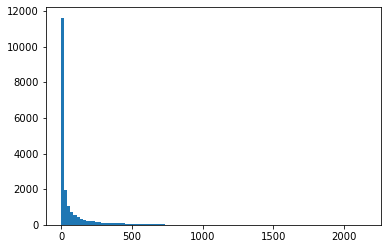

time: 593 ms (started: 2021-09-26 19:09:34 +01:00)


In [22]:
plt.hist(segment_counts.values(), bins=100)
plt.show()

In [23]:
segment_list = list(segment_counts.keys())
print("Number of streets covered by the taxi fleet: ", len(segment_list))
print("Number of streets in the Yerevan network: ", len(yerevan_subgraph.edges()))
partner_ids = list(partners_trips_dict.keys())

Number of streets covered by the taxi fleet:  19244
Number of streets in the Yerevan network:  12766
time: 16 ms (started: 2021-09-26 19:09:35 +01:00)


Note that the number of streets covered by the taxis is greater than the number of streets in the network because in the computation of shortest paths the order of node IDs in the edge tuple mattered, effectively counting the same edge twice. For now, this is fine, but we will keep this in mind for later analysis.

## Computing the sensing power $\langle C\rangle$ from taxi data

Now, let's compute the fraction of streets covered during the day by our taxi fleet: 

In [24]:
import random

# initialise the number of taxis
num_partners = np.arange(1, len(partner_ids)+1)

# initialise empty list which we will fill with the computed fraction for each number of randomly 
# chosen taxis
Cs = []

# initialise number of streets in our list
num_segments = len(segment_list)

# loop over the number of taxis, and in each iteration choose a random sample of the size corresponding 
# to the number of taxis in the given iteration
for rand_partner_num in tqdm(range(1, len(partner_ids)+1)):
    
    # initialise emtpy list to be filled with 10 computed fractions to be averaged 
    fracs = []
    # compute the fraction 10 times for each number of taxis in the outer loop
    for i in range(10):
        # get a list of taxi IDs of size corresponding to the number of taxis chosen for
        # the current interation
        random_keys = random.choices(partner_ids, k=rand_partner_num)
        # get the list containing the lists representing the trips taken by the randomly chosen taxis
        random_partner_trip_list = [partners_trips_dict[x] for x in random_keys]
        # flatten the list
        random_partner_trip_list = [item for sublist in random_partner_trip_list for item in sublist]
        
        # get and flatten the list street network edges corresponding to the taken trips
        random_edge_list = [trip_edges_dict[x] for x in random_partner_trip_list]
        random_edge_list = [item for sublist in random_edge_list for item in sublist]
        
        # compute the fraction and add it to the fracs list
        fracs.append(len(set(random_edge_list))/num_segments)
    # average the 10 values and append it to the final Cs list
    avg_frac = np.mean(fracs)
    Cs.append(avg_frac)
Cs[:10]

100%|██████████████████████████████████████████████████████████████████████████| 3373/3373 [2:16:43<00:00,  2.43s/it]


[0.024080232799833717,
 0.03809499064643525,
 0.05438058615672418,
 0.06487216794845146,
 0.07803471211806277,
 0.09271980877156517,
 0.09800457285387651,
 0.12179900228642697,
 0.12618478486801082,
 0.13454063604240285]

time: 2h 16min 44s (started: 2021-09-26 19:09:35 +01:00)


Let's do a quick plot of the fraction of the network covered by the taxi fleet of a certain size:

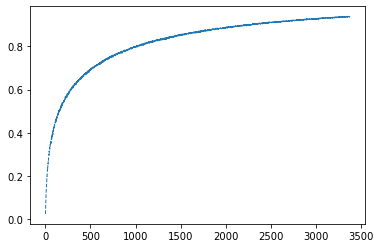

time: 282 ms (started: 2021-09-26 21:26:19 +01:00)


In [25]:
plt.plot(num_partners, Cs, ls='--', lw=1)
plt.show()

In [26]:
np.savetxt('Fraction_from_yerevan_data.txt', Cs, fmt='%g')

time: 16 ms (started: 2021-09-26 21:26:19 +01:00)


## Analytic derivation of $\langle C_{N_V}\rangle$

Having computed the segment popularities $p_{i}$, we now proceed to estimating the sensing power $\langle C_{N_V}\rangle$ analytically by recognizing the connection with the [urn](https://en.wikipedia.org/wiki/Urn_problem) problem in probability theory (this is why knowledge of basic probability theory is so useful!). The street segments are considered as "bins" into which "balls" are placed every time a taxi vehicle traverses that street segment. Using the segment popularities $p_{i}$ as the bin probabilities, we can derive the analytic expression for $\langle C_{N_V}\rangle$.

As stated in the paper, given the nontrivial topology of $S$ and the non-Markovian nature of the
taxi-drive process (this essentially means that the future does not only depend on the present - loosely speaking the Markov property - but on the past as well), it is difficult to solve for $\langle C_{N_V}\rangle$ exactly. However, it is possible to derive a very good approximation. 

As we will see in a bit, it is actually easier to first solve for the trip-level $\langle C_{N_T}\rangle$ covered fraction — i.e., when $N_T$, the total number of trips, is the dependent variable, so we begin the derivation with this simpler case; the vehicle-level expression for $\langle C_{N_V}\rangle$ will then be trivial to obtain.

Imagine we have a set $\mathcal{P}$ of taxi trajectories. We define a taxi trajectory $T_r$ as a sequence of street segments $T_{r} = (S_{i_1} , S_{i_2} , . . . )$. The trajectories can be those obtained from the empirical data or from the simulation - this is unimportant for now. Given $\mathcal{P}$, our strategy for finding $\langle C_{N_T}\rangle$ will be to imagine street segments as bins into which balls are added every time they are traversed by a trajectory from $\mathcal{P}$. Note that, in contrast to the traditional urn problem, a random number of balls is placed at each time step, since taxis' trajectories have random length.

### Trajectories with unit length

Let $L$ be the random length of a trajectory. The special case of $L=1$ is trivial to solve, since it corresponds exactly to the classical case: drawing $N_T$ trips at random from $\mathcal{P}$ amounts to adding $N_T$ balls into $N_S$ bins, where $N_S$ is the total number of street segments, and each bin is selected with probability $p_i$. Let $\vec{M}=(M1, M2, . . ., M_{N_S})$, where $M_i$ is the number of balls in the $i$-th bin. It is well known that the $M_i$ are multinomially distributed:

$$\vec{M} \sim \operatorname{Multi}\left(N_{T}, \vec{p}\right)$$,

where $\vec{p}=\left(p_{1}, p_{2}, \dots p_{N_{s}}\right)$. Now, since a street segment is considered covered during time period $\mathcal{T}$ if it is traversed by at least one vehicle from $\mathcal{V}$, the (random) fraction of street segments covered is

$$C=\frac{1}{N_{S}} \sum_{i=1}^{N_{S}} 1_{\left(M_{i} \geq 1\right)}$$,

where $1_A$ is the indicator function of event $A$. The expectation of this fraction $C$ is

$$\langle C\rangle_{\left(N_{T}, L=1\right)}=\frac{1}{N_{S}} \sum_{i=1}^{N_{S}} \mathbb{P}_{N_{T}}\left(M_{i} \geq 1\right)$$.

Now the trick is to note that the number of balls in each bin is a binomial random variable $M_{i} \sim B i\left(N_{T}, p_{i}\right)$. The survival function of the binomial distribution is $\mathbb{P}\left(M_{i} \geq 1\right)=1-\left(1-p_{i}\right)^{N_{T}}$. Finally, we substitute this into the previous equation and obtain:

$$\langle C\rangle_{\left(N_{T}, L=1\right)}=1-\frac{1}{N_{S}} \sum_{i=1}^{N_{S}}\left(1-p_{i}\right)^{N_{T}}$$.

### Trajectories with fixed length

Trajectories of fixed (i.e., nonrandom) length $L>1$ lead to spatial correlations between the counts $M_i$ (note: in the classic urn problem, there is already a correlation among the $M_i$, since their sum is constant and equal to the total number of balls placed). This is due to the fact that real trajectories are contiguous in space: a trajectory that covers a given segment cannot jump the neighbouring segments at a node, and has to cover one of the neighboring segments. Given the nontrivial topology of the street network $S$, the correlations between bins are difficult to model (this would require working with the adjacency matrix of the street network $S$). To overcome this, the authors in the paper made the strong assumption that for $N_{T} \gg 1$, the spatial correlations between bins are asymptotically zero. This assumption renders our task much more easier. We now imagine that adding a trajectory of length $L$ is the same as if we add
$L$ balls into (not necessarily contiguous) bins chosen *randomly* according to $p_i$. This means that choosing $N_T$ trajectories of fixed length $L$ from $\mathcal{P}$ is equivalent to placing
$L \star N_T$ balls into $N_S$ bins: $\langle C\rangle_{\left(N_{T}, L_{f i x e d}\right)}=\langle C\rangle_{\left(N_{T} \star L, L=1\right)}$. Hence, the expected value of the coverage can be obtained by modifying the result obtained in the unit length case:

$$\langle C\rangle_{\left(N_{T}, L_{f i x e d}\right)}=1-\frac{1}{N_{S}} \sum_{i=1}^{N_{S}}\left(1-p_{i}\right)^{L * N_{T}}$$.

The assumption that neighbouring street segments are spatially uncorellated is a gross simplification which essentially removes the spatial component from the model. However, as we will see in a bit, it produces results remarkably consistent with the data.

### Trajectories of random lengths

Now, generalizing to random $L$ is easy.
Let $S_{N_{T}}=\sum_{i=1}^{N_{T}} L_{i}$ be the number of segments covered by $N_T$
trajectories. By the [law of total expectation](https://en.wikipedia.org/wiki/Law_of_total_expectation)

$$\langle C\rangle_{\left(N_{T}, L\right)}=\sum_{n=0}^{\infty}\langle C\rangle_{\left(n, L_{f i x e d}\right)} \mathbb{P}\left(S_{N_{T}}=n\right)$$,

where $\langle C\rangle_{\left(n, L_{\text {fixed}}\right)}$ is given by the expression for fixed $L$. Finding the probabilities $\mathbb{P}\left(S_{N_{T}}=n\right)$ is trickier. We need to know the distribution of the trajectory lengths. In the paper, the authors show that $L \sim L o g n o r m a l\left(\tilde{\mu}, \tilde{\sigma}^{2}\right)$. 

To remind again: $L$ measures the number of segments covered by a vehicle, and not the distance of the trip. 
Further, it has been shown that the sum of lognormal random variables is itself approximately lognormal $S_{N_{T}} \sim \operatorname{Lognormal}\left(\mu_{S,} \sigma_{S}^{2}\right)$ for some $\mu_{S}$ and $\sigma_{S}$. In order to choose appropriate  $\mu_{S}$ and $\sigma_{S}$, the authors follow the [Fenton-Wilkinson method](http://leo.ugr.es/pgm2012/submissions/pgm2012_submission_6.pdf) in which $\sigma_{S}^{2}=\ln \left(\frac{\exp \tilde{\sigma}^{2}-1}{N_{T}}+1\right)$ and $\mu_{S}=\ln \left(N_{T} \exp (\tilde{\mu})\right)+\left(\tilde{\sigma}^{2}-\sigma_{S}^{2}\right) / 2$.
Plugging into the lognormal pdf formula, we obtain

$$\mathbb{P}\left(S_{N_{T}}=n\right)=\frac{1}{n \sigma_{S} \sqrt{2 \pi}} \mathrm{e}^{-\frac{\left(\ln n-\mu_{S}\right)^{2}}{2 \sigma_{S}^{2}}}$$.

And substituting this into the previous equation above, we obtain the nasty

$$\langle C\rangle_{\left(N_{T}, L\right)}=\frac{1}{N_{S} n \sigma_{S} \sqrt{2 \pi}} \sum_{n=0}^{\infty} \sum_{i=1}^{N_{S}}\left(1-\left(1-p_{i}\right)^{n}\right) \mathrm{e}^{-\frac{\left(\ln n-\mu_{S}\right)^{2}}{2 \sigma_{S}^{2}}}$$.

This equation completely models the trip-level fraction $\langle C\rangle_{\left(N_{T}, L\right)}$. However, a non-trivial thing to notice: the sum over $n$ is dominated by its expectation, so we simplify matters by replacing $n$ by its expected value $\langle L\rangle \star N_{T}$. This gives us much simpler and nicer formula 
$\langle C\rangle_{(N_{T}, L)}=\langle C\rangle_{(N_{T}^{*}\langle L\rangle, L=1)}$, or 

$$\langle C\rangle_{N_{T}} \approx 1-\frac{1}{N_{S}} \sum_{i=1}^{N_{S}}\left(1-p_{i}\right)^{\langle L\rangle \star N_{T}}$$.

### Extension to vehicle level

As promised, now we do the final step of obtaining the fraction $\langle C\rangle_{N_V}$ as a function of the number of vehicles. Let $B$ be the random number of segments that a random taxi in $\mathcal{V}$ covers during the period $\mathcal{T}$. Let's compute it below.

First, let's create a dictionary containing the list of street network edges corresponding to the trips taken by each taxi:

In [27]:
# initialise empty dictionary
taxi_segments_dict = {}

# for each taxi and its corresponding list of trips loop over each trip, get the list of edges
# making up the trip, add it to the overall list of edges for all trips taken by a taxi and add 
# to the dictionary
for partner, trips in tqdm(partners_trips_dict.items()):
    segments = []
    for trip in trips:
        edges_list = trip_edges_dict[trip]
        segments.extend(edges_list)
    segments = list(set(segments))
    taxi_segments_dict[partner] = segments
taxi_segments_dict

100%|██████████████████████████████████████████████████████████████████████████| 3373/3373 [00:01<00:00, 2926.03it/s]


{1: [(4769015474, 256039098),
  (2300230598, 2045058633),
  (4369465809, 5489385512),
  (2954854772, 2954854770),
  (2952282676, 5345667741),
  (5026483107, 5035725114),
  (1507512148, 4779869278),
  (3575363140, 4710054219),
  (2271368471, 1509675281),
  (2954854770, 3828547535),
  (4296905827, 406386251),
  (8913362246, 353780091),
  (6277581591, 6277581590),
  (6594493081, 4230885900),
  (4230885916, 4230885917),
  (4698981693, 1465088491),
  (6245642779, 288954617),
  (311008266, 311003919),
  (1327730699, 1327731602),
  (7029148740, 3828446390),
  (310998800, 4406579573),
  (1955182602, 406387735),
  (5243206714, 311002720),
  (3836963470, 3836963472),
  (311005601, 6885367189),
  (4854142866, 4854142868),
  (1028632680, 1142260368),
  (1796406310, 649274205),
  (1796426893, 311004476),
  (6277581484, 2420202799),
  (370046021, 4369281585),
  (8528351834, 7217819586),
  (2954854771, 2954854773),
  (1475774820, 2268700510),
  (633438786, 311039601),
  (2952282679, 2952282676),
  (1

time: 24.1 s (started: 2021-09-26 21:26:19 +01:00)


Now we can plot the distribution of the random number of street segments covered by the taxis:

3373


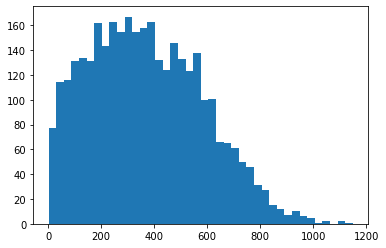

time: 344 ms (started: 2021-09-26 21:26:43 +01:00)


In [28]:
B = []
for partner, segments in taxi_segments_dict.items():
    B.append(len(segments))
    
print(len(B))
plt.hist(B, bins=40)
plt.show()

In [29]:
print("Average number of street segments covered by the taxis: ", np.mean(B))

Average number of street segments covered by the taxis:  369.75748591758077
time: 0 ns (started: 2021-09-26 21:26:44 +01:00)


Now, in the expression for $\langle C\rangle_{N_{T}}$ we simply replace $\langle L\rangle$ with $\langle B\rangle$ and obtain our desired $\langle C\rangle_{N_{V}}$:

$$\langle C\rangle_{N_{V}} \approx 1-\frac{1}{N_{S}} \sum_{i=1}^{N_{S}}\left(1-p_{i}\right)^{\langle B\rangle \star N_{V}}$$.

Now, let's implement the above formula in `numpy`. In order to do that, we need the street segment probabilities $p_{i}$:

In [30]:
segments_array = np.array(list(segment_counts.keys()))
segments_probs_array = np.array(list(segment_counts.values()))/sum(np.array(list(segment_counts.values())))
segments_probs_array

array([4.38267852e-04, 6.14616717e-04, 2.87217981e-04, ...,
       7.44088035e-07, 7.44088035e-07, 7.44088035e-07])

time: 15 ms (started: 2021-09-26 21:26:44 +01:00)


Finally, let's define a function _C(N_v)_ that takes as input the number of taxis in a fleet and computes and returns the fraction of streets covered by the fleet of that size:

In [31]:
def C(N_v):
    '''
    This function takes as input the number of taxis in a fleet, computes and returns 
    the fraction of streets covered by the fleet of that size.
    '''
    return 1 -np.sum((np.ones(num_segments)-segments_probs_array)**(np.mean(B)*N_v))/num_segments

# compute the fraction for a fleet of 1000 randomly chosen taxis
C(1000)

0.790639224881952

time: 0 ns (started: 2021-09-26 21:26:44 +01:00)


Finally, let's compute the fraction $\langle C\rangle_{N_{V}}$ as a function of fleet size:

In [32]:
Cs_model = []
for num in num_partners:
    Cs_model.append(C(num))

# show first ten values
Cs_model[:10]

[0.018288031127631332,
 0.03491649329813995,
 0.05013580617125579,
 0.06414674164739331,
 0.0771123220077713,
 0.08916643783797662,
 0.1004201900099373,
 0.1109666270964238,
 0.12088433403052934,
 0.13024018619573574]

time: 5.19 s (started: 2021-09-26 21:26:44 +01:00)


Let's plot the resulting curves obtained both from the empirical data and the model:

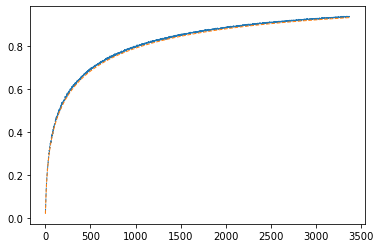

time: 172 ms (started: 2021-09-26 21:26:49 +01:00)


In [33]:
plt.plot(num_partners, Cs, ls='--', lw=1)
plt.plot(num_partners, Cs_model, ls='--', lw=1)
plt.show()

Note the remarkable agreement between model and data!

For visualisation purposes, let's plot the fractions obtained from the taxi data at certain points:

In [34]:
nums = [1, 10, 20, 30, 40, 50, 60, 70, 80, 90, 120,
                 160,200,300, 500, 800, 1200,1700,2300,2900,3368]

time: 0 ns (started: 2021-09-26 21:26:49 +01:00)


In [35]:
indices_data = np.where(np.isin(num_partners, nums))[0]
indices_data

array([   0,    9,   19,   29,   39,   49,   59,   69,   79,   89,  119,
        159,  199,  299,  499,  799, 1199, 1699, 2299, 2899, 3367],
      dtype=int64)

time: 16 ms (started: 2021-09-26 21:26:49 +01:00)


In [36]:
Cs= np.array(Cs)
Cs_data = Cs[indices_data]
Cs_data

array([0.02408023, 0.13454064, 0.20155373, 0.25777905, 0.29642486,
       0.32418416, 0.34977136, 0.36621285, 0.3994232 , 0.42106631,
       0.45243712, 0.500291  , 0.54444502, 0.6088703 , 0.68979422,
       0.76806797, 0.82105591, 0.86603617, 0.90143421, 0.92569112,
       0.93646331])

time: 15 ms (started: 2021-09-26 21:26:49 +01:00)


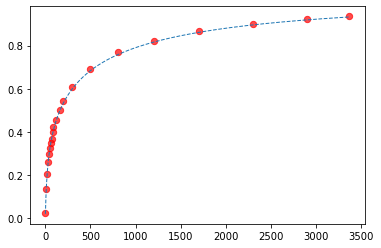

time: 188 ms (started: 2021-09-26 21:26:49 +01:00)


In [37]:
plt.scatter(num_partners[indices_data], Cs_data, s=40, alpha=0.7, c='r')
plt.plot(num_partners, Cs_model, ls='--', lw=1)
plt.show()

## Simulating the taxi drive process

Let's finally simulate the taxi drive process described above. This can be done for _**any**_ city using just OpenStreetMap data.  

First, let's get the list containing the number of trips for which we had computed the shortest path:

In [38]:
correct_trip_list = list(trip_edges_dict.keys())
len(correct_trip_list)

57583

time: 0 ns (started: 2021-09-26 21:26:49 +01:00)


In [39]:
# initialise the list of the yerevan street network nodes
nodes_list = list(yerevan_subgraph.nodes())

# initialise dictionary where we will count the number of times a node has been visited
already_visited_counts = {node:1 for node in nodes_list}

print('visited #: ', sum(already_visited_counts.values()))
print('visited max: ', max(already_visited_counts.values()))

# initialise arrays for the node IDs and the times they were visited
already_visited_nodes = np.array(list(already_visited_counts.keys()))
already_visited_times = np.array(list(already_visited_counts.values()))

# initialise array of node probabilities for choosing the next destination
already_visited_probs = already_visited_times.copy()
already_visited_probs = already_visited_probs/already_visited_probs.sum()

# start simulation from the city center
orig = ox.distance.nearest_nodes(yerevan_subgraph, 44.5152, 40.1872)

# initialise list containing the nodes visited in the simulation
new_nodes_list = [orig]
print(new_nodes_list)

# choose first destination at random
dest = random.choice(nodes_list)

# initialise the dictionary where we shall collect the trips in the simulation
trips_dict = {}

# start simulation (for other cities, you can choose the number of iterations yourself)
for trip in tqdm(range(1, len(correct_trip_list)+1)):
    
    try: 
        print('origin: ', orig)
        print('dest: ', dest)
        # compute shortest path
        route = nx.shortest_path(yerevan_subgraph, orig, dest, weight='length')
        print('route length: ', len(route))
        print('visited #: ', already_visited_times.sum())
        print('visited max: ', already_visited_times.max())
        # update the number of times the nodes in the trip have been visited
        for node in route[:-1]:
            node_index = np.where(already_visited_nodes==node)[0].item()
            already_visited_times[node_index] +=1

        # compute the new node probability vector
        node_probs = already_visited_times/already_visited_times.sum()
        print('check that probabilities sum to 1: ', sum(node_probs))
        
        # add the trip to the nodes list
        new_nodes_list.extend(route[1:])
        
        # add the trip to the trip dictionary 
        trips_dict[trip] = route
        print('trips taken: ', len(trips_dict))
        print('\n')
        
        # now that the trip is complete, assign the destination to orig to be the origin
        # of the next trip
        orig = dest
        
        # choose the next destination with a probability proportional to the number of times
        # a node has already been visited
        dest = np.random.choice(nodes_list, 1, replace=True, p=node_probs).item()
        
        # handle the unlikely case that the destination is the same as origin, in which case 
        # choose a different destination
        if orig == dest:
            dest = np.random.choice(nodes_list, 1, replace=True, p=node_probs).item()
    # in case the shortest path can't be computed, choose a different destination
    except:
        dest = np.random.choice(nodes_list, 1, replace=True, p=node_probs).item()
    
print(len(new_nodes_list))
np.save("Yerevan_simulated_trips.npy", trips_dict)
new_nodes_list[:10]

visited #:  9483
visited max:  1
[2954854772]


  0%|                                                                                      | 0/57583 [00:00<?, ?it/s]

origin:  2954854772
dest:  2940170492
route length:  51
visited #:  9483
visited max:  1
check that probabilities sum to 1:  1.0000000000001403
trips taken:  1


origin:  2940170492
dest:  331495536
route length:  89
visited #:  9533
visited max:  2


  0%|                                                                              | 3/57583 [00:00<34:12, 28.05it/s]

check that probabilities sum to 1:  0.9999999999997993
trips taken:  2


origin:  331495536
dest:  2952282688
route length:  16
visited #:  9621
visited max:  3
check that probabilities sum to 1:  0.999999999999867
trips taken:  3


origin:  2952282688
dest:  1796406311
route length:  40
visited #:  9636
visited max:  3
check that probabilities sum to 1:  1.0000000000001183
trips taken:  4


origin:  1796406311
dest:  2239582677
route length:  45
visited #:  9675
visited max:  3
check that probabilities sum to 1:  0.9999999999999039
trips taken:  5


origin:  2239582677
dest:  1498197181
route length:  23
visited #:  9719
visited max:  3
check that probabilities sum to 1:  0.999999999999808
trips taken:  6


origin:  1498197181
dest:  1971348704
route length:  31
visited #:  9741
visited max:  3
check that probabilities sum to 1:  1.0000000000001146
trips taken:  7


origin:  1971348704
dest:  1990262710
route length:  24
visited #:  9771
visited max:  3
check that probabilities sum to

  0%|                                                                              | 9/57583 [00:00<29:28, 32.56it/s]

visited max:  3
check that probabilities sum to 1:  0.9999999999998705
trips taken:  9


origin:  2240040923
dest:  7404806021
route length:  76
visited #:  9898
visited max:  3
check that probabilities sum to 1:  0.9999999999999959
trips taken:  10


origin:  7404806021
dest:  4081771727
route length:  33
visited #:  9973
visited max:  3
check that probabilities sum to 1:  1.0000000000001386
trips taken:  11


origin:  4081771727
dest:  1888788157
route length:  31
visited #:  10005
visited max:  3
check that probabilities sum to 1:  0.9999999999998487
trips taken:  12


origin:  1888788157
dest:  6952797522


  0%|                                                                             | 13/57583 [00:00<28:23, 33.80it/s]

route length:  39
visited #:  10035
visited max:  3
check that probabilities sum to 1:  1.0000000000000475
trips taken:  13


origin:  6952797522
dest:  2770277948
route length:  60
visited #:  10073
visited max:  3
check that probabilities sum to 1:  1.0000000000000904
trips taken:  14


origin:  2770277948
dest:  8327701520
route length:  88
visited #:  10132
visited max:  3
check that probabilities sum to 1:  0.9999999999997986
trips taken:  15


origin:  8327701520
dest:  311002924
route length:  51
visited #:  10219
visited max:  4
check that probabilities sum to 1:  0.9999999999998412
trips taken:  16




  0%|                                                                             | 17/57583 [00:00<35:49, 26.78it/s]

origin:  311002924
dest:  2283469881
route length:  48
visited #:  10269
visited max:  4
check that probabilities sum to 1:  1.0000000000001
trips taken:  17


origin:  2283469881
dest:  2239582709
route length:  53
visited #:  10316
visited max:  4
check that probabilities sum to 1:  0.9999999999998955
trips taken:  18


origin:  2239582709
dest:  4380691260
route length:  99
visited #:  10368
visited max:  4
check that probabilities sum to 1:  0.9999999999998985
trips taken:  19


origin:  4380691260
dest:  4374562563
route length:  18
visited #:  10466
visited max:  5
check that probabilities sum to 1:  0.9999999999998773
trips taken:  20


origin:  4374562563
dest:  2321581919
route length:  71
visited #:  10483
visited max:  5
check that probabilities sum to 1:  0.9999999999999298

  0%|                                                                             | 21/57583 [00:00<38:46, 24.74it/s]


trips taken:  21


origin:  2321581919
dest:  4512575217
route length:  17
visited #:  10553
visited max:  5
check that probabilities sum to 1:  0.9999999999998734
trips taken:  22


origin:  4512575217
dest:  4067598252


  0%|                                                                             | 24/57583 [00:00<39:15, 24.43it/s]

route length:  68
visited #:  10569
visited max:  5
check that probabilities sum to 1:  0.9999999999998403
trips taken:  23


origin:  4067598252
dest:  2313638219
route length:  35
visited #:  10636
visited max:  6
check that probabilities sum to 1:  1.0000000000000842
trips taken:  24


origin:  2313638219
dest:  5370659191
route length:  63
visited #:  10670
visited max:  6
check that probabilities sum to 1:  0.9999999999997612
trips taken:  25


origin:  5370659191
dest:  2365359026
route length:  61
visited #:  10732
visited max:  6
check that probabilities sum to 1:  1.0000000000001907
trips taken:  26


origin:  2365359026
dest:  3839629502
route length:  76


  0%|                                                                             | 27/57583 [00:01<42:55, 22.34it/s]

visited #:  10792
visited max:  6
check that probabilities sum to 1:  0.9999999999997929
trips taken:  27


origin:  3839629502
dest:  2273525411
route length:  94
visited #:  10867
visited max:  6
check that probabilities sum to 1:  0.9999999999998778
trips taken:  28


origin:  2273525411
dest:  612586235
route length:  80
visited #:  10960
visited max:  6
check that probabilities sum to 1:  0.9999999999998348
trips taken:  29


origin:  612586235
dest:  1360487530
route length:  100
visited #:  11039
visited max:  6


  0%|                                                                             | 30/57583 [00:01<47:48, 20.06it/s]

check that probabilities sum to 1:  0.9999999999998503
trips taken:  30


origin:  1360487530
dest:  7404755286
route length:  45
visited #:  11138
visited max:  7
check that probabilities sum to 1:  0.9999999999997756
trips taken:  31


origin:  7404755286
dest:  4823522690
route length:  69
visited #:  11182
visited max:  7
check that probabilities sum to 1:  1.00000000000019
trips taken:  32


origin:  4823522690
dest:  4380704529
route length:  30
visited #:  11250
visited max:  7
check that probabilities sum to 1:  0.9999999999998356
trips taken:  33


origin:  4380704529
dest:  4110471760
route length:  34
visited #:  11279
visited max:  7
check that probabilities sum to 1:  1.0000000000001577
trips taken:  34




  0%|                                                                             | 34/57583 [00:01<40:26, 23.72it/s]

origin:  4110471760
dest:  1849902160
route length:  53
visited #:  11312
visited max:  7
check that probabilities sum to 1:  1.000000000000052
trips taken:  35


origin:  1849902160
dest:  630736182


  0%|                                                                             | 37/57583 [00:01<44:08, 21.73it/s]

route length:  75
visited #:  11364
visited max:  8
check that probabilities sum to 1:  0.9999999999998619
trips taken:  36


origin:  630736182
dest:  2313688140
route length:  97
visited #:  11438
visited max:  9
check that probabilities sum to 1:  0.9999999999999881
trips taken:  37


origin:  2313688140
dest:  310481848
route length:  34
visited #:  11534
visited max:  9
check that probabilities sum to 1:  0.999999999999849
trips taken:  38


origin:  310481848
dest:  4730356447
route length:  12
visited #:  11567
visited max:  9
check that probabilities sum to 1:  0.9999999999998772
trips taken:  39


origin:  4730356447
dest:  4675229033
route length:  53
visited #:  11578
visited max:  9
check that probabilities sum to 1:  0.9999999999998445
trips taken:  40


origin:  4675229033
dest:  766727679
route length:  48
visited #:  11630
visited max:  9
check that probabilities sum to 1:  1.0000000000001945
trips taken:  41


origin:  766727679
dest:  4380670706


  0%|                                                                             | 42/57583 [00:01<38:31, 24.89it/s]

route length:  104
visited #:  11677
visited max:  9
check that probabilities sum to 1:  1.0000000000001406
trips taken:  42


origin:  4380670706
dest:  6443031113
route length:  31
visited #:  11780
visited max:  9
check that probabilities sum to 1:  0.9999999999997804
trips taken:  43


origin:  6443031113
dest:  2045058633
route length:  66
visited #:  11810


  0%|                                                                             | 45/57583 [00:01<38:57, 24.61it/s]

visited max:  9
check that probabilities sum to 1:  1.000000000000075
trips taken:  44


origin:  2045058633
dest:  2004508627
route length:  80
visited #:  11875
visited max:  9
check that probabilities sum to 1:  0.9999999999998849
trips taken:  45


origin:  2004508627
dest:  4126931600
route length:  13
visited #:  11954
visited max:  9
check that probabilities sum to 1:  1.0000000000001374
trips taken:  46


origin:  4126931600
dest:  256038128
route length:  23
visited #:  11966
visited max:  9
check that probabilities sum to 1:  0.9999999999999475
trips taken:  47


origin:  256038128
dest:  332033852
route length:  93
visited #:  11988
visited max:  9
check that probabilities sum to 1:  0.9999999999998386
trips taken:  48


origin:  332033852
dest:  5367571241


  0%|                                                                             | 49/57583 [00:01<39:50, 24.07it/s]

route length:  121
visited #:  12080
visited max:  10
check that probabilities sum to 1:  0.9999999999998413
trips taken:  49


origin:  5367571241
dest:  331521165
route length:  98
visited #:  12200
visited max:  11
check that probabilities sum to 1:  1.0000000000001166
trips taken:  50


origin:  331521165
dest:  311029752


  0%|                                                                             | 52/57583 [00:02<40:11, 23.86it/s]

route length:  41
visited #:  12297
visited max:  11
check that probabilities sum to 1:  0.9999999999998573
trips taken:  51


origin:  311029752
dest:  4395772890
route length:  34
visited #:  12337
visited max:  11
check that probabilities sum to 1:  0.9999999999998742
trips taken:  52


origin:  4395772890
dest:  2274144068
route length:  10
visited #:  12370
visited max:  11
check that probabilities sum to 1:  0.9999999999998583
trips taken:  53


origin:  2274144068
dest:  2251353596


  0%|                                                                             | 55/57583 [00:02<39:36, 24.21it/s]

route length:  107
visited #:  12379
visited max:  11
check that probabilities sum to 1:  1.0000000000000437
trips taken:  54


origin:  2251353596
dest:  3918734390
route length:  59
visited #:  12485
visited max:  11
check that probabilities sum to 1:  0.9999999999997853
trips taken:  55


origin:  3918734390
dest:  1360487557
route length:  77
visited #:  12543
visited max:  11
check that probabilities sum to 1:  1.0000000000001925
trips taken:  56


origin:  1360487557
dest:  256039098
route length:  74
visited #:  12619
visited max:  11
check that probabilities sum to 1:  0.9999999999998749
trips taken:  57


origin:  256039098
dest:  2278925784
route length:  38
visited #:  12692
visited max:  11
check that probabilities sum to 1:  0.9999999999999678
trips taken:  58




  0%|                                                                             | 58/57583 [00:02<41:28, 23.12it/s]

origin:  2278925784
dest:  1395220938
route length:  70
visited #:  12729
visited max:  11
check that probabilities sum to 1:  1.0000000000000362
trips taken:  59


origin:  1395220938
dest:  3789969350
route length:  90
visited #:  12798
visited max:  11
check that probabilities sum to 1:  0.9999999999999806
trips taken:  60


origin:  3789969350
dest:  1849902150
route length:  81
visited #:  12887
visited max:  11
check that probabilities sum to 1:  0.9999999999998128
trips taken:  61




  0%|                                                                             | 61/57583 [00:02<46:44, 20.51it/s]

origin:  1849902150
dest:  7682611607
route length:  79
visited #:  12967
visited max:  12
check that probabilities sum to 1:  0.9999999999998368
trips taken:  62


origin:  7682611607
dest:  4642639271
route length:  47
visited #:  13045
visited max:  12
check that probabilities sum to 1:  0.9999999999999307
trips taken:  63


origin:  4642639271
dest:  1327951650
route length:  106
visited #:  13091


  0%|                                                                             | 64/57583 [00:02<50:57, 18.81it/s]

visited max:  12
check that probabilities sum to 1:  1.0000000000001212
trips taken:  64


origin:  1327951650
dest:  1859791383
route length:  40
visited #:  13196
visited max:  12
check that probabilities sum to 1:  0.9999999999998519
trips taken:  65


origin:  1859791383
dest:  2600535456
route length:  53
visited #:  13235
visited max:  12
check that probabilities sum to 1:  1.000000000000162
trips taken:  66


origin:  2600535456
dest:  4764598722
route length:  47
visited #:  13287
visited max:  12
check that probabilities sum to 1:  0.9999999999998567
trips taken:  67


origin:  4764598722
dest:  4271184265


  0%|                                                                             | 68/57583 [00:02<45:37, 21.01it/s]

route length:  109
visited #:  13333
visited max:  12
check that probabilities sum to 1:  1.0000000000000684
trips taken:  68


origin:  4271184265
dest:  4823485742
route length:  46


  0%|                                                                             | 71/57583 [00:03<44:18, 21.63it/s]

visited #:  13441
visited max:  13
check that probabilities sum to 1:  1.0000000000001754
trips taken:  69


origin:  4823485742
dest:  1466986980
route length:  71
visited #:  13486
visited max:  13
check that probabilities sum to 1:  1.000000000000083
trips taken:  70


origin:  1466986980
dest:  6262459441
route length:  55
visited #:  13556
visited max:  13
check that probabilities sum to 1:  0.9999999999998896
trips taken:  71


origin:  6262459441
dest:  2332681840
route length:  97
visited #:  13610
visited max:  13
check that probabilities sum to 1:  0.9999999999999426
trips taken:  72


origin:  2332681840
dest:  311022859
route length:  49
visited #:  13706


  0%|                                                                             | 78/57583 [00:03<37:38, 25.46it/s]

visited max:  14
check that probabilities sum to 1:  1.0000000000001308
trips taken:  73


origin:  311022859
dest:  3902872111
route length:  58
visited #:  13754
visited max:  15
check that probabilities sum to 1:  1.0000000000001652
trips taken:  74


origin:  3902872111
dest:  1887486126
route length:  69
visited #:  13811
visited max:  15
check that probabilities sum to 1:  1.0000000000000924
trips taken:  75


origin:  1887486126
dest:  3068215653
route length:  23
visited #:  13879
visited max:  15
check that probabilities sum to 1:  1.0000000000000773
trips taken:  76


origin:  3068215653
dest:  1028632680
route length:  25
visited #:  13901
visited max:  15
check that probabilities sum to 1:  0.9999999999999216
trips taken:  77


origin:  1028632680
dest:  4078269074
route length:  58
visited #:  13925
visited max:  15
check that probabilities sum to 1:  0.9999999999998592
trips taken:  78


origin:  4078269074
dest:  1342563094
route length:  3
visited #:  13982
visited max:

  0%|                                                                             | 82/57583 [00:03<36:59, 25.91it/s]

route length:  43
visited #:  13984
visited max:  15
check that probabilities sum to 1:  1.000000000000082
trips taken:  80


origin:  630826429
dest:  3913317448
route length:  13
visited #:  14026
visited max:  15
check that probabilities sum to 1:  1.0000000000000182
trips taken:  81


origin:  3913317448
dest:  4642639271
route length:  71
visited #:  14038
visited max:  15
check that probabilities sum to 1:  1.000000000000108
trips taken:  82


origin:  4642639271
dest:  4742607880
route length:  41
visited #:  14108
visited max:  15
check that probabilities sum to 1:  0.9999999999998874
trips taken:  83


origin:  4742607880
dest:  7404676924
route length:  89
visited #:  14148
visited max:  16
check that probabilities sum to 1:  0.99999999999985
trips taken:  84




  0%|                                                                             | 85/57583 [00:03<43:02, 22.26it/s]

origin:  7404676924
dest:  2100342670
route length:  90
visited #:  14236
visited max:  16
check that probabilities sum to 1:  1.0000000000001044
trips taken:  85


origin:  2100342670
dest:  3152078578
route length:  79
visited #:  14325
visited max:  16
check that probabilities sum to 1:  0.9999999999998059
trips taken:  86


origin:  3152078578
dest:  2056019396
route length:  71


  0%|                                                                             | 91/57583 [00:03<42:59, 22.29it/s]

visited #:  14403
visited max:  16
check that probabilities sum to 1:  1.0000000000000724
trips taken:  87


origin:  2056019396
dest:  2290468531
route length:  45
visited #:  14473
visited max:  17
check that probabilities sum to 1:  1.0000000000001006
trips taken:  88


origin:  2290468531
dest:  310481885
route length:  62
visited #:  14517
visited max:  18
check that probabilities sum to 1:  0.9999999999998849
trips taken:  89


origin:  310481885
dest:  332045794
route length:  88
visited #:  14578
visited max:  19
check that probabilities sum to 1:  1.000000000000045
trips taken:  90


origin:  332045794
dest:  5118314363
route length:  53
visited #:  14665
visited max:  19
check that probabilities sum to 1:  0.9999999999997892
trips taken:  91


origin:  5118314363
dest:  2254360396
route length:  14
visited #:  14717
visited max:  19
check that probabilities sum to 1:  0.9999999999998891
trips taken:  92


origin:  2254360396
dest:  1990262714


  0%|▏                                                                            | 95/57583 [00:04<41:06, 23.31it/s]

route length:  64
visited #:  14730
visited max:  19
check that probabilities sum to 1:  0.9999999999999323
trips taken:  93


origin:  1990262714
dest:  311035317
route length:  59
visited #:  14793
visited max:  19
check that probabilities sum to 1:  1.0000000000001432
trips taken:  94


origin:  311035317
dest:  7404676913
route length:  107
visited #:  14851
visited max:  19
check that probabilities sum to 1:  1.0000000000000246
trips taken:  95


origin:  7404676913
dest:  3828391037
route length:  33
visited #:  14957
visited max:  19
check that probabilities sum to 1:  0.9999999999998755
trips taken:  96


origin:  3828391037
dest:  7837110940


  0%|▏                                                                           | 101/57583 [00:04<39:31, 24.24it/s]

route length:  51
visited #:  14989
visited max:  19
check that probabilities sum to 1:  0.9999999999999499
trips taken:  97


origin:  7837110940
dest:  3836963481
route length:  55
visited #:  15039
visited max:  19
check that probabilities sum to 1:  0.9999999999999561
trips taken:  98


origin:  3836963481
dest:  3942493276
route length:  68
visited #:  15093
visited max:  19
check that probabilities sum to 1:  1.0000000000002118
trips taken:  99


origin:  3942493276
dest:  5355456433
route length:  101
visited #:  15160
visited max:  19
check that probabilities sum to 1:  1.000000000000146
trips taken:  100


origin:  5355456433
dest:  6564527853
route length:  40
visited #:  15260
visited max:  19
check that probabilities sum to 1:  1.0000000000000713
trips taken:  101


origin:  6564527853
dest:  406386253
route length:  37
visited #:  15299
visited max:  19


  0%|▏                                                                           | 104/57583 [00:04<39:48, 24.07it/s]

check that probabilities sum to 1:  1.0000000000000882
trips taken:  102


origin:  406386253
dest:  1842906537
route length:  49
visited #:  15335
visited max:  20
check that probabilities sum to 1:  1.0000000000001836
trips taken:  103


origin:  1842906537
dest:  2290468561
route length:  68
visited #:  15383
visited max:  20
check that probabilities sum to 1:  0.999999999999925
trips taken:  104


origin:  2290468561
dest:  3835488426
route length:  15
visited #:  15450
visited max:  21
check that probabilities sum to 1:  0.9999999999998579
trips taken:  105


origin:  3835488426
dest:  6742091973
route length:  33
visited #:  15464
visited max:  22
check that probabilities sum to 1:  1.0000000000001774
trips taken:  106


origin:  6742091973
dest:  1793003618
route length:  34
visited #:  15496
visited max:  22
check that probabilities sum to 1:  0.9999999999998606
trips taken:  107


origin:  1793003618
dest:  983637572
route length:  40
visited #:  15529
visited max:  22
check t

  0%|▏                                                                           | 114/57583 [00:04<31:59, 29.94it/s]


trips taken:  110


origin:  5015960056
dest:  880568338
route length:  40
visited #:  15654
visited max:  22
check that probabilities sum to 1:  1.000000000000031
trips taken:  111


origin:  880568338
dest:  1335547491
route length:  93
visited #:  15693
visited max:  22
check that probabilities sum to 1:  1.000000000000127
trips taken:  112


origin:  1335547491
dest:  2252713312
route length:  64
visited #:  15785
visited max:  23
check that probabilities sum to 1:  1.0000000000001652
trips taken:  113


origin:  2252713312
dest:  1327951618
route length:  37
visited #:  15848
visited max:  24
check that probabilities sum to 1:  0.999999999999904
trips taken:  114


origin:  1327951618
dest:  1851343061
route length:  91


  0%|▏                                                                           | 118/57583 [00:04<33:43, 28.39it/s]

visited #:  15884
visited max:  25
check that probabilities sum to 1:  1.0000000000000955
trips taken:  115


origin:  1851343061
dest:  288954366
route length:  27
visited #:  15974
visited max:  26
check that probabilities sum to 1:  0.9999999999999161
trips taken:  116


origin:  288954366
dest:  354434152
route length:  53
visited #:  16000
visited max:  26
check that probabilities sum to 1:  0.9999999999998804
trips taken:  117


origin:  354434152
dest:  1535109590
route length:  30
visited #:  16052
visited max:  26
check that probabilities sum to 1:  1.0000000000000895
trips taken:  118


origin:  1535109590
dest:  7660823598
route length:  41
visited #:  16081
visited max:  26
check that probabilities sum to 1:  0.999999999999931
trips taken:  119


origin:  7660823598
dest:  2881612461
route length:  67
visited #:  16121
visited max:  26
check that probabilities sum to 1:  0.9999999999998688
trips taken:  120


origin:  2881612461
dest:  2290468299


  0%|▏                                                                         | 124/57583 [00:05<1:04:24, 14.87it/s]

route length:  108
visited #:  16187
visited max:  26
check that probabilities sum to 1:  0.9999999999999081
trips taken:  121


origin:  2290468299
dest:  331480191
route length:  91
visited #:  16294
visited max:  27
check that probabilities sum to 1:  1.0
trips taken:  122


origin:  331480191
dest:  2219509403
route length:  21
visited #:  16384
visited max:  28
check that probabilities sum to 1:  0.9999999999998493
trips taken:  123


origin:  2219509403
dest:  1628035009
route length:  49
visited #:  16404
visited max:  28
check that probabilities sum to 1:  0.9999999999998214
trips taken:  124


origin:  1628035009
dest:  2279163136
route length:  83
visited #:  16452
visited max:  28


  0%|▏                                                                         | 127/57583 [00:05<1:00:32, 15.82it/s]

check that probabilities sum to 1:  0.9999999999998908
trips taken:  125


origin:  2279163136
dest:  5009318172
route length:  48
visited #:  16534
visited max:  29
check that probabilities sum to 1:  1.0000000000001588
trips taken:  126


origin:  5009318172
dest:  7469332447
route length:  65
visited #:  16581
visited max:  29
check that probabilities sum to 1:  0.9999999999998541
trips taken:  127


origin:  7469332447
dest:  310481568
route length:  96
visited #:  16645
visited max:  30
check that probabilities sum to 1:  0.9999999999998939
trips taken:  128


origin:  310481568
dest:  331496070
route length:  36
visited #:  16740
visited max:  31
check that probabilities sum to 1:  1.0000000000001597
trips taken:  129


origin:  331496070
dest:  1342686230


  0%|▏                                                                           | 130/57583 [00:05<54:10, 17.67it/s]

route length:  37
visited #:  16775
visited max:  31
check that probabilities sum to 1:  1.0000000000000528
trips taken:  130


origin:  1342686230
dest:  1431648530
route length:  91
visited #:  16811
visited max:  31
check that probabilities sum to 1:  1.0000000000000717
trips taken:  131


origin:  1431648530
dest:  1317612009
route length:  60
visited #:  16901
visited max:  31
check that probabilities sum to 1:  0.9999999999998513
trips taken:  132


origin:  1317612009
dest:  1463540736


  0%|▏                                                                           | 136/57583 [00:06<54:17, 17.63it/s]

route length:  100
visited #:  16960
visited max:  31
check that probabilities sum to 1:  1.0000000000001075
trips taken:  133


origin:  1463540736
dest:  4260317577
route length:  104
visited #:  17059
visited max:  32
check that probabilities sum to 1:  1.0000000000001206
trips taken:  134


origin:  4260317577
dest:  2269814271
route length:  21
visited #:  17162
visited max:  32
check that probabilities sum to 1:  1.0000000000001446
trips taken:  135


origin:  2269814271
dest:  1360487412
route length:  67
visited #:  17182
visited max:  32
check that probabilities sum to 1:  0.9999999999998583
trips taken:  136


origin:  1360487412
dest:  5037605621
route length:  84
visited #:  17248
visited max:  33


  0%|▏                                                                           | 140/57583 [00:06<48:16, 19.83it/s]

check that probabilities sum to 1:  0.9999999999998272
trips taken:  137


origin:  5037605621
dest:  5150436260
route length:  8
visited #:  17331
visited max:  33
check that probabilities sum to 1:  1.0000000000001223
trips taken:  138


origin:  5150436260
dest:  331521192
route length:  44
visited #:  17338
visited max:  33
check that probabilities sum to 1:  1.0000000000000735
trips taken:  139


origin:  331521192
dest:  3942493269
route length:  112
visited #:  17381
visited max:  33
check that probabilities sum to 1:  0.9999999999999526
trips taken:  140


origin:  3942493269
dest:  4642359344
route length:  44
visited #:  17492
visited max:  34
check that probabilities sum to 1:  0.999999999999849
trips taken:  141


origin:  4642359344
dest:  3793136773
route length:  56
visited #:  17535
visited max:  34
check that probabilities sum to 1:  1.0000000000001081
trips taken:  142


origin:  3793136773
dest:  7769591013


  0%|▏                                                                           | 146/57583 [00:06<35:07, 27.25it/s]

route length:  50
visited #:  17590
visited max:  34
check that probabilities sum to 1:  1.0000000000000162
trips taken:  143


origin:  7769591013
dest:  406385838
route length:  21
visited #:  17639
visited max:  34
check that probabilities sum to 1:  1.0000000000001026
trips taken:  144


origin:  406385838
dest:  311022850
route length:  15
visited #:  17659
visited max:  34
check that probabilities sum to 1:  0.999999999999886
trips taken:  145


origin:  311022850
dest:  612675853
route length:  29
visited #:  17673
visited max:  34
check that probabilities sum to 1:  1.0000000000000717
trips taken:  146


origin:  612675853
dest:  633005257
route length:  42
visited #:  17701
visited max:  34
check that probabilities sum to 1:  0.999999999999914
trips taken:  147


origin:  633005257
dest:  4431092319
route length:  72
visited #:  17742
visited max:  35
check that probabilities sum to 1:  1.00000000000013
trips taken:  148


origin:  4431092319
dest:  4829173426


  0%|▏                                                                           | 150/57583 [00:06<41:24, 23.12it/s]

route length:  83
visited #:  17813
visited max:  36
check that probabilities sum to 1:  1.0000000000000786
trips taken:  149


origin:  4829173426
dest:  2281076306
route length:  96
visited #:  17895
visited max:  36
check that probabilities sum to 1:  0.9999999999999966
trips taken:  150


origin:  2281076306
dest:  1466987099
route length:  63
visited #:  17990
visited max:  36
check that probabilities sum to 1:  0.9999999999999931
trips taken:  151


origin:  1466987099
dest:  6578075141
route length:  40
visited #:  18052
visited max:  36
check that probabilities sum to 1:  0.9999999999998455
trips taken:  152


origin:  6578075141
dest:  2311191809
route length:  87
visited #:  18091


  0%|▏                                                                           | 157/57583 [00:06<36:35, 26.15it/s]

visited max:  36
check that probabilities sum to 1:  0.9999999999999353
trips taken:  153


origin:  2311191809
dest:  1842906669
route length:  65
visited #:  18177
visited max:  36
check that probabilities sum to 1:  1.0000000000001712
trips taken:  154


origin:  1842906669
dest:  1928641830
route length:  53
visited #:  18241
visited max:  36
check that probabilities sum to 1:  0.9999999999998493
trips taken:  155


origin:  1928641830
dest:  1360487276
route length:  63
visited #:  18293
visited max:  36
check that probabilities sum to 1:  0.999999999999841
trips taken:  156


origin:  1360487276
dest:  311002924
route length:  70
visited #:  18355
visited max:  36
check that probabilities sum to 1:  1.0000000000001605
trips taken:  157


origin:  311002924
dest:  332033852
route length:  63
visited #:  18424
visited max:  36
check that probabilities sum to 1:  1.0000000000000853
trips taken:  158




  0%|▏                                                                           | 160/57583 [00:07<39:29, 24.24it/s]

origin:  332033852
dest:  1851231290
route length:  40
visited #:  18486
visited max:  36
check that probabilities sum to 1:  1.0000000000001181
trips taken:  159


origin:  1851231290
dest:  1939744035
route length:  102
visited #:  18525
visited max:  36
check that probabilities sum to 1:  0.999999999999796
trips taken:  160


origin:  1939744035
dest:  1028633195
route length:  91
visited #:  18626
visited max:  36
check that probabilities sum to 1:  0.9999999999998764
trips taken:  161


origin:  1028633195
dest:  1849902164


  0%|▏                                                                           | 163/57583 [00:07<46:28, 20.59it/s]

route length:  90
visited #:  18716
visited max:  36
check that probabilities sum to 1:  0.9999999999999841
trips taken:  162


origin:  1849902164
dest:  4742691246
route length:  78
visited #:  18805
visited max:  36
check that probabilities sum to 1:  1.0000000000001499
trips taken:  163


origin:  4742691246
dest:  331522172
route length:  94
visited #:  18882
visited max:  36
check that probabilities sum to 1:  1.0000000000000295
trips taken:  164




  0%|▏                                                                           | 169/57583 [00:07<43:39, 21.92it/s]

origin:  331522172
dest:  4110471738
route length:  28
visited #:  18975
visited max:  36
check that probabilities sum to 1:  1.0000000000000953
trips taken:  165


origin:  4110471738
dest:  2283511778
route length:  45
visited #:  19002
visited max:  36
check that probabilities sum to 1:  0.9999999999998533
trips taken:  166


origin:  2283511778
dest:  310482505
route length:  50
visited #:  19046
visited max:  36
check that probabilities sum to 1:  0.9999999999998942
trips taken:  167


origin:  310482505
dest:  1971348631
route length:  42
visited #:  19095
visited max:  36
check that probabilities sum to 1:  1.0000000000000504
trips taken:  168


origin:  1971348631
dest:  3824493927
route length:  76
visited #:  19136
visited max:  36
check that probabilities sum to 1:  1.0000000000001519
trips taken:  169


origin:  3824493927
dest:  630736177
route length:  19
visited #:  19211
visited max:  36
check that probabilities sum to 1:  0.999999999999828
trips taken:  170


origin:  

  0%|▏                                                                           | 173/57583 [00:07<42:21, 22.59it/s]

visited max:  36
check that probabilities sum to 1:  0.9999999999999377
trips taken:  171


origin:  1332774303
dest:  287892358
route length:  80
visited #:  19294
visited max:  36
check that probabilities sum to 1:  1.0000000000001827
trips taken:  172


origin:  287892358
dest:  1643578097
route length:  93
visited #:  19373
visited max:  36
check that probabilities sum to 1:  1.0000000000001708
trips taken:  173


origin:  1643578097
dest:  331495276
route length:  32
visited #:  19465
visited max:  36
check that probabilities sum to 1:  0.9999999999998168
trips taken:  174


origin:  331495276
dest:  4854142864


  0%|▏                                                                           | 178/57583 [00:07<34:54, 27.41it/s]

route length:  65
visited #:  19496
visited max:  36
check that probabilities sum to 1:  1.0000000000001248
trips taken:  175


origin:  4854142864
dest:  331484563
route length:  33
visited #:  19560
visited max:  36
check that probabilities sum to 1:  0.9999999999997944
trips taken:  176


origin:  331484563
dest:  1463009570
route length:  38
visited #:  19592
visited max:  36
check that probabilities sum to 1:  1.0000000000001246
trips taken:  177


origin:  1463009570
dest:  4854142866
route length:  22
visited #:  19629
visited max:  36
check that probabilities sum to 1:  1.0000000000001221
trips taken:  178


origin:  4854142866
dest:  332034707
route length:  32
visited #:  19650
visited max:  36
check that probabilities sum to 1:  1.000000000000047
trips taken:  179


origin:  332034707
dest:  311009806
route length:  39
visited #:  19681
visited max:  36
check that probabilities sum to 1:  0.9999999999999211
trips taken:  180


origin:  311009806
dest:  4256277792


  0%|▏                                                                           | 184/57583 [00:08<36:53, 25.93it/s]

route length:  65
visited #:  19719
visited max:  36
check that probabilities sum to 1:  0.9999999999998861
trips taken:  181


origin:  4256277792
dest:  983637568
route length:  59
visited #:  19783
visited max:  37
check that probabilities sum to 1:  1.0000000000001579
trips taken:  182


origin:  983637568
dest:  331497968
route length:  17
visited #:  19841
visited max:  37
check that probabilities sum to 1:  1.0000000000001903
trips taken:  183


origin:  331497968
dest:  292953051
route length:  82
visited #:  19857
visited max:  37
check that probabilities sum to 1:  0.9999999999998981
trips taken:  184


origin:  292953051
dest:  6672741382
route length:  60
visited #:  19938
visited max:  38
check that probabilities sum to 1:  0.9999999999999175
trips taken:  185


origin:  6672741382
dest:  3790541208
route length:  41
visited #:  19997
visited max:  38
check that probabilities sum to 1:  1.000000000000053
trips taken:  186




  0%|▎                                                                           | 191/57583 [00:08<32:10, 29.73it/s]

origin:  3790541208
dest:  2240176059
route length:  45
visited #:  20037
visited max:  38
check that probabilities sum to 1:  0.9999999999998168
trips taken:  187


origin:  2240176059
dest:  2375232871
route length:  6
visited #:  20081
visited max:  39
check that probabilities sum to 1:  1.0000000000001932
trips taken:  188


origin:  2375232871
dest:  8950154126
route length:  51
visited #:  20086
visited max:  39
check that probabilities sum to 1:  1.0000000000000557
trips taken:  189


origin:  8950154126
dest:  4459494147
route length:  24
visited #:  20136
visited max:  39
check that probabilities sum to 1:  1.0000000000001108
trips taken:  190


origin:  4459494147
dest:  1990262725
route length:  51
visited #:  20159
visited max:  39
check that probabilities sum to 1:  1.0000000000001048
trips taken:  191


origin:  1990262725
dest:  974885963
route length:  37
visited #:  20209
visited max:  39
check that probabilities sum to 1:  0.9999999999999891
trips taken:  192


origin

  0%|▎                                                                           | 196/57583 [00:08<28:19, 33.77it/s]

origin:  4239885964
dest:  6291463293
route length:  21
visited #:  20286
visited max:  39
check that probabilities sum to 1:  1.000000000000061
trips taken:  194


origin:  6291463293
dest:  2125810968
route length:  51
visited #:  20306
visited max:  39
check that probabilities sum to 1:  0.9999999999999348
trips taken:  195


origin:  2125810968
dest:  1908548886
route length:  51
visited #:  20356
visited max:  39
check that probabilities sum to 1:  1.0000000000001248
trips taken:  196


origin:  1908548886
dest:  1342686290
route length:  14
visited #:  20406
visited max:  39
check that probabilities sum to 1:  0.9999999999998876
trips taken:  197


origin:  1342686290
dest:  331495125
route length:  54
visited #:  20419
visited max:  39
check that probabilities sum to 1:  0.9999999999999124
trips taken:  198


origin:  331495125
dest:  7516027877
route length:  38
visited #:  20472
visited max:  39
check that probabilities sum to 1:  1.0000000000000673
trips taken:  199


origin:

  0%|▎                                                                           | 206/57583 [00:08<24:20, 39.29it/s]

visited max:  39
check that probabilities sum to 1:  1.0000000000001135
trips taken:  200


origin:  6277544444
dest:  310482119
route length:  24
visited #:  20567
visited max:  39
check that probabilities sum to 1:  0.999999999999928
trips taken:  201


origin:  310482119
dest:  370046021
route length:  45
visited #:  20590
visited max:  39
check that probabilities sum to 1:  1.0000000000001266
trips taken:  202


origin:  370046021
dest:  406359748
route length:  34
visited #:  20634
visited max:  39
check that probabilities sum to 1:  0.9999999999999865
trips taken:  203


origin:  406359748
dest:  407729601
route length:  28
visited #:  20667
visited max:  39
check that probabilities sum to 1:  1.0000000000001965
trips taken:  204


origin:  407729601
dest:  311037705
route length:  41
visited #:  20694
visited max:  39
check that probabilities sum to 1:  0.9999999999999108
trips taken:  205


origin:  311037705
dest:  4512575217
route length:  43
visited #:  20734
visited max:  3

  0%|▎                                                                           | 210/57583 [00:08<26:45, 35.74it/s]

route length:  82
visited #:  20830
visited max:  39
check that probabilities sum to 1:  1.000000000000223
trips taken:  208


origin:  6209490290
dest:  4110471714
route length:  25
visited #:  20911
visited max:  39
check that probabilities sum to 1:  1.0000000000001115
trips taken:  209


origin:  4110471714
dest:  3824547841
route length:  14
visited #:  20935
visited max:  39
check that probabilities sum to 1:  1.0000000000001708
trips taken:  210


origin:  3824547841
dest:  1142260201
route length:  33
visited #:  20948
visited max:  39
check that probabilities sum to 1:  1.0000000000001172
trips taken:  211


origin:  1142260201
dest:  4951018740
route length:  22
visited #:  20980
visited max:  40
check that probabilities sum to 1:  0.9999999999998633
trips taken:  212


origin:  4951018740
dest:  3779188177
route length:  33
visited #:  21001
visited max:  41
check that probabilities sum to 1:  0.9999999999999274
trips taken:  213


origin:  3779188177
dest:  2788538067
route

  0%|▎                                                                           | 215/57583 [00:08<27:18, 35.00it/s]

visited max:  42
check that probabilities sum to 1:  1.0000000000001767
trips taken:  215


origin:  6124735893
dest:  1487674256
route length:  88
visited #:  21160
visited max:  42
check that probabilities sum to 1:  1.0000000000000988
trips taken:  216


origin:  1487674256
dest:  7013402706
route length:  30
visited #:  21247
visited max:  42
check that probabilities sum to 1:  1.0000000000000604
trips taken:  217


origin:  7013402706
dest:  4409784535
route length: 

  0%|▎                                                                           | 223/57583 [00:09<33:37, 28.43it/s]

 101
visited #:  21276
visited max:  42
check that probabilities sum to 1:  1.0000000000001834
trips taken:  218


origin:  4409784535
dest:  4817787189
route length:  53
visited #:  21376
visited max:  42
check that probabilities sum to 1:  0.9999999999998378
trips taken:  219


origin:  4817787189
dest:  6797315019
route length:  55
visited #:  21428
visited max:  42
check that probabilities sum to 1:  0.9999999999999315
trips taken:  220


origin:  6797315019
dest:  8913362245
route length:  39
visited #:  21482
visited max:  43
check that probabilities sum to 1:  1.0000000000001237
trips taken:  221


origin:  8913362245
dest:  3824493928
route length:  26
visited #:  21520
visited max:  44
check that probabilities sum to 1:  0.9999999999998513
trips taken:  222


origin:  3824493928
dest:  1535107209
route length:  45
visited #:  21545
visited max:  44
check that probabilities sum to 1:  1.000000000000166
trips taken:  223


origin:  1535107209
dest:  1028633305
route length:  68


  0%|▎                                                                           | 232/57583 [00:09<34:00, 28.11it/s]

check that probabilities sum to 1:  1.0000000000001583
trips taken:  226


origin:  8639638541
dest:  2273164665
route length:  31
visited #:  21884
visited max:  45
check that probabilities sum to 1:  1.0000000000000373
trips taken:  227


origin:  2273164665
dest:  287884830
route length:  36
visited #:  21914
visited max:  45
check that probabilities sum to 1:  0.9999999999999569
trips taken:  228


origin:  287884830
dest:  1332439224
route length:  52
visited #:  21949
visited max:  45
check that probabilities sum to 1:  1.0000000000001548
trips taken:  229


origin:  1332439224
dest:  2088121283
route length:  39
visited #:  22000
visited max:  46
check that probabilities sum to 1:  1.000000000000146
trips taken:  230


origin:  2088121283
dest:  3836419061
route length:  13
visited #:  22038
visited max:  46
check that probabilities sum to 1:  1.000000000000155
trips taken:  231


origin:  3836419061
dest:  4459462445
route length:  55
visited #:  22050
visited max:  46
check th

  0%|▎                                                                           | 236/57583 [00:09<34:50, 27.43it/s]

check that probabilities sum to 1:  0.9999999999998553
trips taken:  233


origin:  5022528967
dest:  1903000448
route length:  37
visited #:  22163
visited max:  46
check that probabilities sum to 1:  0.9999999999998445
trips taken:  234


origin:  1903000448
dest:  1327951540
route length:  52
visited #:  22199
visited max:  46
check that probabilities sum to 1:  0.9999999999999312
trips taken:  235


origin:  1327951540
dest:  4087602251
route length:  85
visited #:  22250
visited max:  46
check that probabilities sum to 1:  0.9999999999998856
trips taken:  236


origin:  4087602251
dest:  6209490290
route length:  72
visited #:  22334
visited max:  46
check that probabilities sum to 1:  1.0000000000001603
trips taken:  237


origin:  6209490290
dest:  4081263303


  0%|▎                                                                           | 239/57583 [00:10<44:36, 21.42it/s]

route length:  94
visited #:  22405
visited max:  46
check that probabilities sum to 1:  1.0000000000000302
trips taken:  238


origin:  4081263303
dest:  373953030
route length:  30
visited #:  22498
visited max:  46
check that probabilities sum to 1:  1.00000000000006
trips taken:  239


origin:  373953030
dest:  1908779186
route length:  55
visited #:  22527
visited max:  46
check that probabilities sum to 1:  0.9999999999999325
trips taken:  240


origin:  1908779186
dest:  406387735
route length:  18
visited #:  22581
visited max:  46
check that probabilities sum to 1:  1.0000000000000784
trips taken:  241


origin:  406387735
dest:  2315596240


  0%|▎                                                                           | 242/57583 [00:10<43:39, 21.89it/s]

route length:  19
visited #:  22598
visited max:  46
check that probabilities sum to 1:  0.9999999999998866
trips taken:  242


origin:  2315596240
dest:  7006316452
route length:  74
visited #:  22616
visited max:  46
check that probabilities sum to 1:  1.0000000000000704
trips taken:  243


origin:  7006316452
dest:  310481997
route length:  78
visited #:  22689
visited max:  46
check that probabilities sum to 1:  0.9999999999998367
trips taken:  244


origin:  310481997
dest:  6139214162


  0%|▎                                                                           | 249/57583 [00:10<43:52, 21.78it/s]

route length:  40
visited #:  22766
visited max:  46
check that probabilities sum to 1:  1.0000000000001115
trips taken:  245


origin:  6139214162
dest:  4044492761
route length:  61
visited #:  22805
visited max:  46
check that probabilities sum to 1:  1.0000000000000733
trips taken:  246


origin:  4044492761
dest:  4234582615
route length:  37
visited #:  22865
visited max:  46
check that probabilities sum to 1:  1.000000000000167
trips taken:  247


origin:  4234582615
dest:  6291463293
route length:  10
visited #:  22901
visited max:  46
check that probabilities sum to 1:  1.0000000000000977
trips taken:  248


origin:  6291463293
dest:  7449800883
route length:  56
visited #:  22910
visited max:  46
check that probabilities sum to 1:  0.99999999999978
trips taken:  249


origin:  7449800883
dest:  7571105649
route length:  66
visited #:  22965


  0%|▎                                                                           | 252/57583 [00:10<45:33, 20.97it/s]

visited max:  46
check that probabilities sum to 1:  1.000000000000113
trips taken:  250


origin:  7571105649
dest:  4110471739
route length:  36
visited #:  23030
visited max:  46
check that probabilities sum to 1:  0.9999999999998463
trips taken:  251


origin:  4110471739
dest:  6846732213
route length:  50
visited #:  23065
visited max:  46
check that probabilities sum to 1:  1.0000000000001399
trips taken:  252


origin:  6846732213
dest:  4458309747
route length: 

  0%|▎                                                                           | 255/57583 [00:10<56:02, 17.05it/s]

 92
visited #:  23114
visited max:  46
check that probabilities sum to 1:  0.9999999999999966
trips taken:  253


origin:  4458309747
dest:  7417727965
route length:  21
visited #:  23205
visited max:  47
check that probabilities sum to 1:  1.0000000000000835
trips taken:  254


origin:  7417727965
dest:  5225332054
route length:  53
visited #:  23225
visited max:  47
check that probabilities sum to 1:  0.9999999999998322
trips taken:  255


origin:  5225332054
dest:  880568337
route length:  54
visited #:  23277
visited max:  47


  0%|▎                                                                           | 257/57583 [00:11<59:56, 15.94it/s]

check that probabilities sum to 1:  0.9999999999998577
trips taken:  256


origin:  880568337
dest:  5450648350
route length:  60
visited #:  23330
visited max:  47
check that probabilities sum to 1:  0.9999999999998481
trips taken:  257


origin:  5450648350
dest:  406387735
route length:  24
visited #:  23389
visited max:  47
check that probabilities sum to 1:  0.9999999999999307
trips taken:  258


origin:  406387735
dest:  3789969350


  0%|▎                                                                           | 264/57583 [00:11<41:46, 22.87it/s]

route length:  58
visited #:  23412
visited max:  47
check that probabilities sum to 1:  0.9999999999998795
trips taken:  259


origin:  3789969350
dest:  1342418052
route length:  20
visited #:  23469
visited max:  47
check that probabilities sum to 1:  0.9999999999998691
trips taken:  260


origin:  1342418052
dest:  386577726
route length:  28
visited #:  23488
visited max:  48
check that probabilities sum to 1:  0.9999999999998794
trips taken:  261


origin:  386577726
dest:  4691917404
route length:  11
visited #:  23515
visited max:  48
check that probabilities sum to 1:  0.9999999999999091
trips taken:  262


origin:  4691917404
dest:  387636479
route length:  41
visited #:  23525
visited max:  48
check that probabilities sum to 1:  0.9999999999999157
trips taken:  263


origin:  387636479
dest:  4698981693
route length:  20
visited #:  23565
visited max:  48
check that probabilities sum to 1:  1.0000000000000466
trips taken:  264


origin:  4698981693
dest:  1463009604
route le

  0%|▎                                                                           | 271/57583 [00:11<37:39, 25.37it/s]

route length:  55
visited #:  23608
visited max:  48
check that probabilities sum to 1:  1.0000000000001539
trips taken:  266


origin:  310481805
dest:  4814161254
route length:  41
visited #:  23662
visited max:  48
check that probabilities sum to 1:  0.9999999999998608
trips taken:  267


origin:  4814161254
dest:  4110471730
route length:  33
visited #:  23702
visited max:  48
check that probabilities sum to 1:  1.0000000000001614
trips taken:  268


origin:  4110471730
dest:  632049248
route length:  28
visited #:  23734
visited max:  48
check that probabilities sum to 1:  1.0000000000000082
trips taken:  269


origin:  632049248
dest:  1510466997
route length:  33
visited #:  23761
visited max:  48
check that probabilities sum to 1:  1.0000000000001519
trips taken:  270


origin:  1510466997
dest:  310481581
route length:  71
visited #:  23793
visited max:  48
check that probabilities sum to 1:  1.0000000000001066
trips taken:  271


origin:  310481581
dest:  256038004
route leng

  0%|▎                                                                           | 276/57583 [00:11<32:01, 29.83it/s]

 41
visited #:  23885
visited max:  48
check that probabilities sum to 1:  0.9999999999998497
trips taken:  273


origin:  331554664
dest:  5238489659
route length:  63
visited #:  23925
visited max:  48
check that probabilities sum to 1:  0.9999999999998247
trips taken:  274


origin:  5238489659
dest:  4110471738
route length:  44
visited #:  23987
visited max:  48
check that probabilities sum to 1:  0.999999999999809
trips taken:  275


origin:  4110471738
dest:  1908779226
route length:  34
visited #:  24030
visited max:  48
check that probabilities sum to 1:  1.000000000000135
trips taken:  276


origin:  1908779226
dest:  6041493451
route length:  45
visited #:  24063
visited max:  48
check that probabilities sum to 1:  0.999999999999939
trips taken:  277


origin:  6041493451
dest:  1360487106
route length:  42
visited #:  24107
visited max:  48
check that probabilities sum to 1:  1.0000000000000897
trips taken:  278


origin:  1360487106
dest:  1360487380
route length:  25
visi

  0%|▎                                                                           | 284/57583 [00:11<33:41, 28.35it/s]

 69
visited #:  24172
visited max:  48
check that probabilities sum to 1:  1.0000000000000884
trips taken:  280


origin:  4732602804
dest:  1315153252
route length:  50
visited #:  24240
visited max:  48
check that probabilities sum to 1:  0.9999999999999499
trips taken:  281


origin:  1315153252
dest:  332040235
route length:  52
visited #:  24289
visited max:  48
check that probabilities sum to 1:  0.9999999999998772
trips taken:  282


origin:  332040235
dest:  1842853447
route length:  101
visited #:  24340
visited max:  48
check that probabilities sum to 1:  1.0000000000000757
trips taken:  283


origin:  1842853447
dest:  1360487231
route length:  77
visited #:  24440
visited max:  48
check that probabilities sum to 1:  0.9999999999998785
trips taken:  284




  1%|▍                                                                           | 288/57583 [00:12<31:52, 29.96it/s]

origin:  1360487231
dest:  1461387366
route length:  34
visited #:  24516
visited max:  48
check that probabilities sum to 1:  1.0000000000000866
trips taken:  285


origin:  1461387366
dest:  6277544131
route length:  28
visited #:  24549
visited max:  48
check that probabilities sum to 1:  0.9999999999999035
trips taken:  286


origin:  6277544131
dest:  5009318171
route length:  16
visited #:  24576
visited max:  48
check that probabilities sum to 1:  0.9999999999999377
trips taken:  287


origin:  5009318171
dest:  2772000767
route length:  72
visited #:  24591
visited max:  48
check that probabilities sum to 1:  1.0000000000000735
trips taken:  288


origin:  2772000767
dest:  287893357
route length:  89
visited #:  24662
visited max:  49
check that probabilities sum to 1:  1.0000000000001288
trips taken:  289


origin:  287893357
dest:  619802913


  1%|▍                                                                           | 292/57583 [00:12<32:54, 29.02it/s]

route length:  90
visited #:  24750
visited max:  49
check that probabilities sum to 1:  1.000000000000091
trips taken:  290


origin:  619802913
dest:  3824493936
route length:  25
visited #:  24839
visited max:  49
check that probabilities sum to 1:  0.9999999999998679
trips taken:  291


origin:  3824493936
dest:  2766430231
route length:  3
visited #:  24863
visited max:  49
check that probabilities sum to 1:  0.9999999999999537
trips taken:  292


origin:  2766430231
dest:  311009806
route length:  28
visited #:  24865
visited max:  49
check that probabilities sum to 1:  0.9999999999999145
trips taken:  293


origin:  311009806
dest:  5523524312
route length:  57
visited #:  24892
visited max:  49
check that probabilities sum to 1:  0.9999999999998145
trips taken:  294


origin:  5523524312
dest:  1908779186
route length:  93
visited #:  24948
visited max:  50
check that probabilities sum to 1:  0.9999999999998852
trips taken:  295


origin:  1908779186
dest:  4622655851
route len

  1%|▍                                                                           | 300/57583 [00:12<32:18, 29.56it/s]

 52
visited #:  25040
visited max:  50
check that probabilities sum to 1:  0.9999999999997732
trips taken:  296


origin:  4622655851
dest:  311001863
route length:  32
visited #:  25091
visited max:  50
check that probabilities sum to 1:  1.000000000000069
trips taken:  297


origin:  311001863
dest:  1475111967
route length:  37
visited #:  25122
visited max:  50
check that probabilities sum to 1:  1.0000000000001068
trips taken:  298


origin:  1475111967
dest:  3824852690
route length:  30
visited #:  25158
visited max:  50
check that probabilities sum to 1:  0.9999999999998648
trips taken:  299


origin:  3824852690
dest:  7468224365
route length:  54
visited #:  25187
visited max:  50
check that probabilities sum to 1:  0.9999999999998562
trips taken:  300


origin:  7468224365
dest:  597699270
route length:  39
visited #:  25240
visited max:  50
check that probabilities sum to 1:  0.9999999999999706
trips taken:  301


origin:  597699270
dest:  1887486122
route length:  48
visit

  1%|▍                                                                           | 304/57583 [00:12<37:21, 25.55it/s]

visited max:  50
check that probabilities sum to 1:  1.00000000000014
trips taken:  302


origin:  1887486122
dest:  332022181
route length:  62
visited #:  25325
visited max:  50
check that probabilities sum to 1:  1.0000000000001483
trips taken:  303


origin:  332022181
dest:  8528351819
route length:  106
visited #:  25386
visited max:  50
check that probabilities sum to 1:  0.9999999999999162
trips taken:  304


origin:  8528351819
dest:  619803240
route length:  43
visited #:  25491
visited max:  50
check that probabilities sum to 1:  0.999999999999897
trips taken:  305


origin:  619803240
dest:  2916366800


  1%|▍                                                                           | 311/57583 [00:13<54:41, 17.46it/s]

route length:  31
visited #:  25533
visited max:  50
check that probabilities sum to 1:  0.9999999999999961
trips taken:  306


origin:  2916366800
dest:  4458309747
route length:  41
visited #:  25563
visited max:  50
check that probabilities sum to 1:  1.000000000000167
trips taken:  307


origin:  4458309747
dest:  4110471422
route length:  78
visited #:  25603
visited max:  50
check that probabilities sum to 1:  0.9999999999998523
trips taken:  308


origin:  4110471422
dest:  1342418118
route length:  30
visited #:  25680
visited max:  50
check that probabilities sum to 1:  0.999999999999878
trips taken:  309


origin:  1342418118
dest:  3304629930
route length:  40
visited #:  25709
visited max:  50
check that probabilities sum to 1:  1.0000000000000886
trips taken:  310


origin:  3304629930
dest:  7404414192
route length:  77
visited #:  25748
visited max:  50
check that probabilities sum to 1:  0.9999999999999004
trips taken:  311


origin:  7404414192
dest:  6899998161


  1%|▍                                                                           | 314/57583 [00:13<53:23, 17.88it/s]

route length:  102
visited #:  25824
visited max:  51
check that probabilities sum to 1:  1.000000000000167
trips taken:  312


origin:  6899998161
dest:  1980224763
route length:  74
visited #:  25925
visited max:  52
check that probabilities sum to 1:  1.0000000000002125
trips taken:  313


origin:  1980224763
dest:  3575350604
route length:  69
visited #:  25998
visited max:  52
check that probabilities sum to 1:  1.0000000000000915
trips taken:  314


origin:  3575350604
dest:  356745428
route length:  60
visited #:  26066
visited max:  52
check that probabilities sum to 1:  1.0000000000000482
trips taken:  315


origin:  356745428
dest:  615942306
route length:  23
visited #:  26125
visited max:  52
check that probabilities sum to 1:  0.9999999999999715
trips taken:  316


origin:  615942306
dest:  5514692675
route length:  71
visited #:  26147


  1%|▍                                                                           | 321/57583 [00:13<44:36, 21.39it/s]

visited max:  52
check that probabilities sum to 1:  1.0000000000000968
trips taken:  317


origin:  5514692675
dest:  2290468679
route length:  39
visited #:  26217
visited max:  52
check that probabilities sum to 1:  1.0000000000002103
trips taken:  318


origin:  2290468679
dest:  3830436328
route length:  26
visited #:  26255
visited max:  53
check that probabilities sum to 1:  1.0000000000000284
trips taken:  319


origin:  3830436328
dest:  331521167
route length:  78
visited #:  26280
visited max:  54
check that probabilities sum to 1:  0.9999999999998952
trips taken:  320


origin:  331521167
dest:  1332439228
route length:  80
visited #:  26357
visited max:  54
check that probabilities sum to 1:  1.0000000000000906
trips taken:  321


origin:  1332439228
dest:  1998855905
route length:  76
visited #:  26436


  1%|▍                                                                           | 324/57583 [00:13<43:39, 21.86it/s]

visited max:  54
check that probabilities sum to 1:  1.0000000000002311
trips taken:  322


origin:  1998855905
dest:  2188993041
route length:  91
visited #:  26511
visited max:  54
check that probabilities sum to 1:  1.0000000000001548
trips taken:  323


origin:  2188993041
dest:  4209742312
route length:  31
visited #:  26601
visited max:  54
check that probabilities sum to 1:  0.9999999999998085
trips taken:  324


origin:  4209742312
dest:  612675752
route length:  55
visited #:  26631
visited max:  54
check that probabilities sum to 1:  0.9999999999998582
trips taken:  325


origin:  612675752
dest:  1849902084
route length:  29
visited #:  26685
visited max:  54
check that probabilities sum to 1:  1.0000000000001414
trips taken:  326


origin:  1849902084
dest:  2087758559
route length:  37
visited #:  26713
visited max:  54
check that probabilities sum to 1:  0.9999999999998368
trips taken:  327


origin:  2087758559
dest:  6139214162


  1%|▍                                                                           | 333/57583 [00:14<31:54, 29.90it/s]

route length:  37
visited #:  26749
visited max:  54
check that probabilities sum to 1:  0.999999999999885
trips taken:  328


origin:  6139214162
dest:  353811992
route length:  22
visited #:  26785
visited max:  54
check that probabilities sum to 1:  0.9999999999999086
trips taken:  329


origin:  353811992
dest:  1456245305
route length:  26
visited #:  26806
visited max:  54
check that probabilities sum to 1:  1.0000000000000913
trips taken:  330


origin:  1456245305
dest:  5939417308
route length:  59
visited #:  26831
visited max:  54
check that probabilities sum to 1:  1.0000000000001585
trips taken:  331


origin:  5939417308
dest:  4685815925
route length:  30
visited #:  26889
visited max:  54
check that probabilities sum to 1:  1.000000000000127
trips taken:  332


origin:  4685815925
dest:  5009318172
route length:  14
visited #:  26918
visited max:  54
check that probabilities sum to 1:  1.0000000000001543
trips taken:  333


origin:  5009318172
dest:  407729592
route len

  1%|▍                                                                           | 341/57583 [00:14<30:46, 31.00it/s]

route length:  60
visited #:  26989
visited max:  55
check that probabilities sum to 1:  1.0000000000001141
trips taken:  335


origin:  1327951483
dest:  2313638223
route length:  49
visited #:  27048
visited max:  55
check that probabilities sum to 1:  0.9999999999999375
trips taken:  336


origin:  2313638223
dest:  3830337107
route length:  27
visited #:  27096
visited max:  56
check that probabilities sum to 1:  1.000000000000094
trips taken:  337


origin:  3830337107
dest:  1028633305
route length:  63
visited #:  27122
visited max:  56
check that probabilities sum to 1:  1.000000000000088
trips taken:  338


origin:  1028633305
dest:  2088384208
route length:  69
visited #:  27184
visited max:  56
check that probabilities sum to 1:  1.0000000000001381
trips taken:  339


origin:  2088384208
dest:  4100688096
route length:  16
visited #:  27252
visited max:  56
check that probabilities sum to 1:  1.000000000000125
trips taken:  340


origin:  4100688096
dest:  2992113389
route l

  1%|▍                                                                           | 345/57583 [00:14<32:09, 29.66it/s]

route length:  74
visited #:  27301
visited max:  57
check that probabilities sum to 1:  0.9999999999999384
trips taken:  342


origin:  6988871423
dest:  612674532
route length:  49
visited #:  27374
visited max:  57
check that probabilities sum to 1:  0.9999999999998007
trips taken:  343


origin:  612674532
dest:  4685816051
route length:  55
visited #:  27422
visited max:  57
check that probabilities sum to 1:  1.0000000000000948
trips taken:  344


origin:  4685816051
dest:  6720431964
route length:  94
visited #:  27476
visited max:  57
check that probabilities sum to 1:  1.000000000000031
trips taken:  345


origin:  6720431964
dest:  331489013
route length:  36
visited #:  27569
visited max:  57
check that probabilities sum to 1:  1.0000000000000602
trips taken:  346


origin:  331489013
dest:  1142241210
route length:  92
visited #:  27604
visited max:  57
check that probabilities sum to 1:  1.0000000000001381
trips taken:  347




  1%|▍                                                                           | 353/57583 [00:14<29:27, 32.38it/s]

origin:  1142241210
dest:  5336948394
route length:  43
visited #:  27695
visited max:  58
check that probabilities sum to 1:  1.0000000000002038
trips taken:  348


origin:  5336948394
dest:  3789969341
route length:  18
visited #:  27737
visited max:  59
check that probabilities sum to 1:  1.0000000000001223
trips taken:  349


origin:  3789969341
dest:  3835488426
route length:  15
visited #:  27754
visited max:  59
check that probabilities sum to 1:  1.0000000000001346
trips taken:  350


origin:  3835488426
dest:  1673151567
route length:  23
visited #:  27768
visited max:  59
check that probabilities sum to 1:  0.9999999999998375
trips taken:  351


origin:  1673151567
dest:  2279163110
route length:  30
visited #:  27790
visited max:  60
check that probabilities sum to 1:  0.9999999999998263
trips taken:  352


origin:  2279163110
dest:  1463009899
route length:  66
visited #:  27819
visited max:  60
check that probabilities sum to 1:  1.0000000000001172
trips taken:  353


orig

  1%|▍                                                                           | 357/57583 [00:14<33:41, 28.30it/s]

check that probabilities sum to 1:  1.0000000000000704
trips taken:  354


origin:  1982885922
dest:  3839031488
route length:  60
visited #:  27945
visited max:  60
check that probabilities sum to 1:  0.999999999999884
trips taken:  355


origin:  3839031488
dest:  3791085563
route length:  48
visited #:  28004
visited max:  60
check that probabilities sum to 1:  1.00000000000018
trips taken:  356


origin:  3791085563
dest:  3839031487
route length:  49
visited #:  28051
visited max:  60
check that probabilities sum to 1:  1.0000000000001121
trips taken:  357


origin:  3839031487
dest:  1428276010
route length:  45
visited #:  28099
visited max:  60
check that probabilities sum to 1:  1.0000000000001092
trips taken:  358


origin:  1428276010
dest:  1360487253


  1%|▍                                                                           | 360/57583 [00:15<35:55, 26.55it/s]

route length:  103
visited #:  28143
visited max:  60
check that probabilities sum to 1:  1.0000000000000617
trips taken:  359


origin:  1360487253
dest:  3790752014
route length:  59
visited #:  28245
visited max:  60
check that probabilities sum to 1:  1.0000000000002218
trips taken:  360


origin:  3790752014
dest:  287885097
route length:  39
visited #:  28303
visited max:  60
check that probabilities sum to 1:  1.0000000000000884
trips taken:  361


origin:  287885097
dest:  7155043997
route length:  33
visited #:  28341
visited max:  60
check that probabilities sum to 1:  0.999999999999817
trips taken:  362


origin:  7155043997
dest:  310481555
route length:  67
visited #:  28373
visited max:  61
check that probabilities sum to 1:  0.9999999999998458
trips taken:  363




  1%|▍                                                                           | 367/57583 [00:15<34:46, 27.43it/s]

origin:  310481555
dest:  6277516955
route length:  36
visited #:  28439
visited max:  62
check that probabilities sum to 1:  1.0000000000001614
trips taken:  364


origin:  6277516955
dest:  6139214161
route length:  44
visited #:  28474
visited max:  62
check that probabilities sum to 1:  0.9999999999999228
trips taken:  365


origin:  6139214161
dest:  2142622950
route length:  29
visited #:  28517
visited max:  62
check that probabilities sum to 1:  0.9999999999999688
trips taken:  366


origin:  2142622950
dest:  3790606624
route length:  30
visited #:  28545
visited max:  62
check that probabilities sum to 1:  1.0000000000001343
trips taken:  367


origin:  3790606624
dest:  597695286
route length:  57
visited #:  28574
visited max:  62
check that probabilities sum to 1:  0.9999999999998366
trips taken:  368


origin:  597695286
dest:  2281257303


  1%|▍                                                                           | 373/57583 [00:15<35:16, 27.04it/s]

route length:  92
visited #:  28630
visited max:  63
check that probabilities sum to 1:  0.9999999999998208
trips taken:  369


origin:  2281257303
dest:  256038004
route length:  77
visited #:  28721
visited max:  64
check that probabilities sum to 1:  0.9999999999998765
trips taken:  370


origin:  256038004
dest:  7409772193
route length:  84
visited #:  28797
visited max:  64
check that probabilities sum to 1:  0.9999999999999192
trips taken:  371


origin:  7409772193
dest:  4087082593
route length:  50
visited #:  28880
visited max:  64
check that probabilities sum to 1:  1.0000000000000582
trips taken:  372


origin:  4087082593
dest:  1028633195
route length:  25
visited #:  28929
visited max:  65
check that probabilities sum to 1:  1.000000000000031
trips taken:  373


origin:  1028633195
dest:  4087452856
route length:  35
visited #:  28953
visited max:  65
check that probabilities sum to 1:  0.9999999999998519
trips taken:  374


origin:  4087452856
dest:  3830356214


  1%|▌                                                                           | 383/57583 [00:15<27:42, 34.42it/s]

route length:  38
visited #:  28987
visited max:  65
check that probabilities sum to 1:  1.0000000000001665
trips taken:  375


origin:  3830356214
dest:  4685815925
route length:  7
visited #:  29024
visited max:  65
check that probabilities sum to 1:  1.0000000000000746
trips taken:  376


origin:  4685815925
dest:  406385842
route length:  16
visited #:  29030
visited max:  65
check that probabilities sum to 1:  0.9999999999999368
trips taken:  377


origin:  406385842
dest:  8913362246
route length:  16
visited #:  29045
visited max:  65
check that probabilities sum to 1:  0.9999999999999643
trips taken:  378


origin:  8913362246
dest:  3431261702
route length:  33
visited #:  29060
visited max:  65
check that probabilities sum to 1:  0.9999999999999292
trips taken:  379


origin:  3431261702
dest:  2273525389
route length:  46
visited #:  29092
visited max:  65
check that probabilities sum to 1:  0.9999999999998679
trips taken:  380


origin:  2273525389
dest:  2088384431
route l

  1%|▌                                                                           | 387/57583 [00:15<28:22, 33.60it/s]

route length:  78
visited #:  29290
visited max:  67
check that probabilities sum to 1:  1.0000000000000386
trips taken:  384


origin:  3920738335
dest:  4730176217
route length:  52
visited #:  29367
visited max:  68
check that probabilities sum to 1:  1.0000000000000737
trips taken:  385


origin:  4730176217
dest:  4144210911
route length:  55
visited #:  29418
visited max:  68
check that probabilities sum to 1:  0.999999999999877
trips taken:  386


origin:  4144210911
dest:  6275156070
route length:  27
visited #:  29472
visited max:  68
check that probabilities sum to 1:  1.0000000000001157
trips taken:  387


origin:  6275156070
dest:  1464338062
route length:  60
visited #:  29498
visited max:  68
check that probabilities sum to 1:  1.0000000000001483
trips taken:  388


origin:  1464338062
dest:  1842906472
route length:  27
visited #:  29557
visited max:  68
check that probabilities sum to 1:  0.9999999999997938
trips taken:  389


origin:  1842906472
dest:  310481991
route 

  1%|▌                                                                           | 398/57583 [00:16<23:34, 40.42it/s]

origin:  310481991
dest:  1980721162
route length:  51
visited #:  29625
visited max:  68
check that probabilities sum to 1:  0.9999999999998737
trips taken:  391


origin:  1980721162
dest:  1342686213
route length:  10
visited #:  29675
visited max:  68
check that probabilities sum to 1:  1.0000000000001954
trips taken:  392


origin:  1342686213
dest:  2000311111
route length:  23
visited #:  29684
visited max:  68
check that probabilities sum to 1:  1.000000000000031
trips taken:  393


origin:  2000311111
dest:  7168014286
route length:  26
visited #:  29706
visited max:  68
check that probabilities sum to 1:  0.9999999999999466
trips taken:  394


origin:  7168014286
dest:  4622454155
route length:  29
visited #:  29731
visited max:  68
check that probabilities sum to 1:  0.999999999999866
trips taken:  395


origin:  4622454155
dest:  5030425038
route length:  33
visited #:  29759
visited max:  68
check that probabilities sum to 1:  1.0000000000000582
trips taken:  396


origin:

  1%|▌                                                                           | 403/57583 [00:16<27:02, 35.24it/s]

route length:  46
visited #:  29924
visited max:  69
check that probabilities sum to 1:  1.0000000000001563
trips taken:  400


origin:  2256019796
dest:  4675247268
route length:  58
visited #:  29969
visited max:  69
check that probabilities sum to 1:  1.0000000000000866
trips taken:  401


origin:  4675247268
dest:  1998855773
route length:  61
visited #:  30026
visited max:  69
check that probabilities sum to 1:  1.0000000000000862
trips taken:  402


origin:  1998855773
dest:  2004534398
route length:  70
visited #:  30086
visited max:  69
check that probabilities sum to 1:  0.9999999999999106
trips taken:  403


origin:  2004534398
dest:  1858607454
route length:  54
visited #:  30155
visited max:  69
check that probabilities sum to 1:  1.0000000000001121
trips taken:  404


origin:  1858607454
dest:  2239582378


  1%|▌                                                                           | 407/57583 [00:16<33:43, 28.25it/s]

route length:  81
visited #:  30208
visited max:  69
check that probabilities sum to 1:  0.9999999999998974
trips taken:  405


origin:  2239582378
dest:  7516027875
route length:  112
visited #:  30288
visited max:  69
check that probabilities sum to 1:  0.9999999999998895
trips taken:  406


origin:  7516027875
dest:  5514692675
route length:  64
visited #:  30399
visited max:  69
check that probabilities sum to 1:  0.9999999999999428
trips taken:  407


origin:  5514692675
dest:  3824493928
route length:  50
visited #:  30462
visited max:  69
check that probabilities sum to 1:  1.0000000000000762
trips taken:  408




  1%|▌                                                                           | 411/57583 [00:16<37:09, 25.65it/s]

origin:  3824493928
dest:  1328019968
route length:  45
visited #:  30511
visited max:  69
check that probabilities sum to 1:  0.9999999999999966
trips taken:  409


origin:  1328019968
dest:  974885760
route length:  77
visited #:  30555
visited max:  70
check that probabilities sum to 1:  0.9999999999998724
trips taken:  410


origin:  974885760
dest:  633212448
route length:  73
visited #:  30631
visited max:  70
check that probabilities sum to 1:  0.9999999999998532
trips taken:  411


origin:  633212448
dest:  2000420093
route length:  30
visited #:  30703
visited max:  71


  1%|▌                                                                           | 416/57583 [00:16<32:03, 29.73it/s]

check that probabilities sum to 1:  1.0000000000001137
trips taken:  412


origin:  2000420093
dest:  3913317433
route length:  14
visited #:  30732
visited max:  72
check that probabilities sum to 1:  1.0000000000000966
trips taken:  413


origin:  3913317433
dest:  406387622
route length:  40
visited #:  30745
visited max:  72
check that probabilities sum to 1:  0.9999999999999909
trips taken:  414


origin:  406387622
dest:  406386251
route length:  38
visited #:  30784
visited max:  72
check that probabilities sum to 1:  0.9999999999999171
trips taken:  415


origin:  406386251
dest:  1342686462
route length:  35
visited #:  30821
visited max:  72
check that probabilities sum to 1:  1.0000000000001705
trips taken:  416


origin:  1342686462
dest:  2916826249
route length:  60
visited #:  30855
visited max:  72
check that probabilities sum to 1:  1.0000000000001683
trips taken:  417


origin:  2916826249
dest:  3839031476
route length:  43
visited #:  30914
visited max:  72
check th

  1%|▌                                                                           | 420/57583 [00:17<35:27, 26.87it/s]

visited max:  72
check that probabilities sum to 1:  0.9999999999999427
trips taken:  419


origin:  2273224360
dest:  975021928
route length:  98
visited #:  31019
visited max:  72
check that probabilities sum to 1:  0.9999999999999309
trips taken:  420


origin:  975021928
dest:  1971348648
route length:  8
visited #:  31116
visited max:  72
check that probabilities sum to 1:  0.9999999999999201
trips taken:  421


origin:  1971348648
dest:  4471795100
route length:  77
visited #:  31123
visited max:  72
check that probabilities sum to 1:  0.9999999999998891
trips taken:  422


origin:  4471795100
dest:  4698981693
route length:  19
visited #:  31199
visited max:  72
check that probabilities sum to 1:  1.00000000000015
trips taken:  423


origin:  4698981693
dest:  6209490290
route length:  48
visited #:  31217
visited max:  72
check that probabilities sum to 1:  0.999999999999959
trips taken:  424


origin:  6209490290
dest:  6989144727


  1%|▌                                                                           | 428/57583 [00:17<35:10, 27.09it/s]

route length:  92
visited #:  31264
visited max:  72
check that probabilities sum to 1:  1.0000000000001092
trips taken:  425


origin:  6989144727
dest:  2273525411
route length:  59
visited #:  31355
visited max:  72
check that probabilities sum to 1:  1.0000000000000948
trips taken:  426


origin:  2273525411
dest:  1456245308
route length:  89
visited #:  31413
visited max:  72
check that probabilities sum to 1:  1.0000000000000158
trips taken:  427


origin:  1456245308
dest:  4685816051
route length:  51
visited #:  31501
visited max:  73
check that probabilities sum to 1:  1.000000000000106
trips taken:  428


origin:  4685816051
dest:  4606764901
route length:  44
visited #:  31551
visited max:  73


  1%|▌                                                                           | 436/57583 [00:17<30:21, 31.37it/s]

check that probabilities sum to 1:  0.9999999999998214
trips taken:  429


origin:  4606764901
dest:  6298677039
route length:  59
visited #:  31594
visited max:  73
check that probabilities sum to 1:  0.9999999999997977
trips taken:  430


origin:  6298677039
dest:  726602908
route length:  21
visited #:  31652
visited max:  73
check that probabilities sum to 1:  1.000000000000135
trips taken:  431


origin:  726602908
dest:  2283528797
route length:  34
visited #:  31672
visited max:  73
check that probabilities sum to 1:  1.0000000000000575
trips taken:  432


origin:  2283528797
dest:  288938551
route length:  31
visited #:  31705
visited max:  73
check that probabilities sum to 1:  1.0000000000001248
trips taken:  433


origin:  288938551
dest:  310481917
route length:  38
visited #:  31735
visited max:  73
check that probabilities sum to 1:  0.9999999999998659
trips taken:  434


origin:  310481917
dest:  3824493928
route length:  58
visited #:  31772
visited max:  73
check that 

  1%|▌                                                                           | 440/57583 [00:17<33:19, 28.58it/s]

route length:  64
visited #:  31862
visited max:  73
check that probabilities sum to 1:  1.0000000000000708
trips taken:  437


origin:  287884968
dest:  4854142866
route length:  30
visited #:  31925
visited max:  73
check that probabilities sum to 1:  1.000000000000111
trips taken:  438


origin:  4854142866
dest:  2004508489
route length:  53
visited #:  31954
visited max:  73
check that probabilities sum to 1:  0.9999999999999688
trips taken:  439


origin:  2004508489
dest:  2234097898
route length:  64
visited #:  32006
visited max:  74
check that probabilities sum to 1:  0.9999999999999446
trips taken:  440


origin:  2234097898
dest:  1426387880
route length:  58
visited #:  32069
visited max:  75
check that probabilities sum to 1:  1.0000000000001126
trips taken:  441


origin:  1426387880
dest:  1317587066
route length:  15
visited #:  32126
visited max:  75
check that probabilities sum to 1:  0.999999999999855
trips taken:  442


origin:  1317587066
dest:  2240068345
route l

  1%|▌                                                                           | 450/57583 [00:17<26:30, 35.93it/s]

check that probabilities sum to 1:  0.9999999999998368
trips taken:  443


origin:  2240068345
dest:  726602908
route length:  64
visited #:  32214
visited max:  75
check that probabilities sum to 1:  0.9999999999998981
trips taken:  444


origin:  726602908
dest:  1955182602
route length:  8
visited #:  32277
visited max:  75
check that probabilities sum to 1:  0.999999999999926
trips taken:  445


origin:  1955182602
dest:  1462696161
route length:  39
visited #:  32284
visited max:  75
check that probabilities sum to 1:  1.0000000000001763
trips taken:  446


origin:  1462696161
dest:  7155043997
route length:  56
visited #:  32322
visited max:  75
check that probabilities sum to 1:  0.9999999999998503
trips taken:  447


origin:  7155043997
dest:  630826415
route length:  19
visited #:  32377
visited max:  75
check that probabilities sum to 1:  1.0000000000001381
trips taken:  448


origin:  630826415
dest:  4951018740
route length:  14
visited #:  32395
visited max:  75
check that

  1%|▌                                                                           | 455/57583 [00:18<24:46, 38.43it/s]

origin:  1982710617
dest:  1908779186
route length:  47
visited #:  32506
visited max:  75
check that probabilities sum to 1:  0.9999999999998537
trips taken:  452


origin:  1908779186
dest:  3839031488
route length:  34
visited #:  32552
visited max:  75
check that probabilities sum to 1:  1.0000000000000584
trips taken:  453


origin:  3839031488
dest:  703653309
route length:  15
visited #:  32585
visited max:  75
check that probabilities sum to 1:  1.0000000000000753
trips taken:  454


origin:  703653309
dest:  1332439886
route length:  47
visited #:  32599
visited max:  75
check that probabilities sum to 1:  1.0000000000001188
trips taken:  455


origin:  1332439886
dest:  1842906617
route length:  115
visited #:  32645
visited max:  75
check that probabilities sum to 1:  1.000000000000057
trips taken:  456


origin:  1842906617
dest:  635463384
route length:  43
visited #:  32759
visited max:  75
check that probabilities sum to 1:  1.0000000000001836
trips taken:  457


origin:

  1%|▌                                                                           | 459/57583 [00:18<30:25, 31.30it/s]

route length:  81
visited #:  32801
visited max:  75
check that probabilities sum to 1:  0.9999999999999075
trips taken:  458


origin:  1327951457
dest:  6476299245
route length:  37
visited #:  32881
visited max:  76
check that probabilities sum to 1:  1.0000000000001312
trips taken:  459


origin:  6476299245
dest:  7468338503
route length:  42
visited #:  32917
visited max:  77
check that probabilities sum to 1:  1.0000000000000346
trips taken:  460


origin:  7468338503
dest:  635463231
route length:  66
visited #:  32958
visited max:  78
check that probabilities sum to 1:  0.9999999999999334
trips taken:  461


origin:  635463231
dest:  1851310682
route length:  64
visited #:  33023
visited max:  78
check that probabilities sum to 1:  1.0000000000000513
trips taken:  462


origin:  1851310682
dest:  6128605101


  1%|▌                                                                           | 466/57583 [00:18<37:43, 25.23it/s]

route length:  134
visited #:  33086
visited max:  78
check that probabilities sum to 1:  0.9999999999998622
trips taken:  463


origin:  6128605101
dest:  6464396450
route length:  127
visited #:  33219
visited max:  78
check that probabilities sum to 1:  1.0000000000000722
trips taken:  464


origin:  6464396450
dest:  2240175896
route length:  80
visited #:  33345
visited max:  78
check that probabilities sum to 1:  1.0000000000000608
trips taken:  465


origin:  2240175896
dest:  4125703125
route length:  59
visited #:  33424
visited max:  78
check that probabilities sum to 1:  1.0000000000000846
trips taken:  466


origin:  4125703125
dest:  2274144101
route length:  86
visited #:  33482
visited max:  78


  1%|▌                                                                           | 469/57583 [00:18<36:43, 25.92it/s]

check that probabilities sum to 1:  0.9999999999998649
trips taken:  467


origin:  2274144101
dest:  974885899
route length:  45
visited #:  33567
visited max:  79
check that probabilities sum to 1:  1.0000000000001135
trips taken:  468


origin:  974885899
dest:  1462695476
route length:  50
visited #:  33611
visited max:  79
check that probabilities sum to 1:  1.0000000000000782
trips taken:  469


origin:  1462695476
dest:  387278359
route length:  62
visited #:  33660
visited max:  79
check that probabilities sum to 1:  0.9999999999998753
trips taken:  470


origin:  387278359
dest:  597700309
route length:  67
visited #:  33721
visited max:  79
check that probabilities sum to 1:  1.0000000000002207
trips taken:  471


origin:  597700309
dest:  6989144741
route length:  41
visited #:  33787
visited max:  79
check that probabilities sum to 1:  0.9999999999999294
trips taken:  472


origin:  6989144741
dest:  4430988023
route length:  71
visited #:  33827


  1%|▋                                                                           | 477/57583 [00:18<34:03, 27.95it/s]

visited max:  79
check that probabilities sum to 1:  0.9999999999999568
trips taken:  473


origin:  4430988023
dest:  7165337187
route length:  46
visited #:  33897
visited max:  79
check that probabilities sum to 1:  1.0000000000000628
trips taken:  474


origin:  7165337187
dest:  406387735
route length:  45
visited #:  33942
visited max:  79
check that probabilities sum to 1:  1.0000000000001468
trips taken:  475


origin:  406387735
dest:  7006316452
route length:  28
visited #:  33986
visited max:  79
check that probabilities sum to 1:  1.0000000000001128
trips taken:  476


origin:  7006316452
dest:  4754078149
route length:  43
visited #:  34013
visited max:  79
check that probabilities sum to 1:  0.9999999999998912
trips taken:  477


origin:  4754078149
dest:  3704290438
route length:  37
visited #:  34055
visited max:  79
check that probabilities sum to 1:  1.0000000000001097
trips taken:  478




  1%|▋                                                                           | 480/57583 [00:19<39:17, 24.22it/s]

origin:  3704290438
dest:  2279163330
route length:  95
visited #:  34091
visited max:  79
check that probabilities sum to 1:  1.0000000000001137
trips taken:  479


origin:  2279163330
dest:  4740453489
route length:  67
visited #:  34185
visited max:  80
check that probabilities sum to 1:  0.999999999999976
trips taken:  480


origin:  4740453489
dest:  5515702749
route length:  54
visited #:  34251
visited max:  80
check that probabilities sum to 1:  0.9999999999998511
trips taken:  481


origin:  5515702749
dest:  703653364
route length:  50
visited #:  34304
visited max:  81
check that probabilities sum to 1:  0.9999999999999691
trips taken:  482


origin:  703653364
dest:  4250194946
route length:  56
visited #:  34353


  1%|▋                                                                           | 486/57583 [00:19<40:20, 23.59it/s]

visited max:  81
check that probabilities sum to 1:  0.999999999999931
trips taken:  483


origin:  4250194946
dest:  5026483105
route length:  69
visited #:  34408
visited max:  81
check that probabilities sum to 1:  1.0000000000001035
trips taken:  484


origin:  5026483105
dest:  3824852683
route length:  59
visited #:  34476
visited max:  82
check that probabilities sum to 1:  0.9999999999999207
trips taken:  485


origin:  3824852683
dest:  4942763407
route length:  56
visited #:  34534
visited max:  82
check that probabilities sum to 1:  1.0000000000001634
trips taken:  486


origin:  4942763407
dest:  4459494147


  1%|▋                                                                           | 489/57583 [00:19<45:12, 21.05it/s]

route length:  113
visited #:  34589
visited max:  83
check that probabilities sum to 1:  1.0000000000000207
trips taken:  487


origin:  4459494147
dest:  1842906682
route length:  14
visited #:  34701
visited max:  84
check that probabilities sum to 1:  1.0000000000001013
trips taken:  488


origin:  1842906682
dest:  4642166132
route length:  109
visited #:  34714
visited max:  84
check that probabilities sum to 1:  1.0000000000001832
trips taken:  489


origin:  4642166132
dest:  2278636567
route length:  29
visited #:  34822
visited max:  84
check that probabilities sum to 1:  0.9999999999998445
trips taken:  490


origin:  2278636567
dest:  6455629407
route length:  63
visited #:  34850
visited max:  85
check that probabilities sum to 1:  0.9999999999998913
trips taken:  491


origin:  6455629407
dest:  1982885952
route length:  92
visited #:  34912


  1%|▋                                                                           | 495/57583 [00:19<41:56, 22.68it/s]

visited max:  85
check that probabilities sum to 1:  1.0000000000000857
trips taken:  492


origin:  1982885952
dest:  1142260382
route length:  80
visited #:  35003
visited max:  85
check that probabilities sum to 1:  1.000000000000152
trips taken:  493


origin:  1142260382
dest:  4293552231
route length:  31
visited #:  35082
visited max:  86
check that probabilities sum to 1:  0.9999999999999633
trips taken:  494


origin:  4293552231
dest:  1982726139
route length:  63
visited #:  35112
visited max:  86
check that probabilities sum to 1:  0.999999999999901
trips taken:  495


origin:  1982726139
dest:  703653334
route length:  79
visited #:  35174
visited max:  86


  1%|▋                                                                           | 504/57583 [00:20<31:33, 30.14it/s]

check that probabilities sum to 1:  0.9999999999999086
trips taken:  496


origin:  703653334
dest:  3793123458
route length:  57
visited #:  35252
visited max:  86
check that probabilities sum to 1:  0.9999999999999967
trips taken:  497


origin:  3793123458
dest:  711016763
route length:  56
visited #:  35308
visited max:  86
check that probabilities sum to 1:  1.000000000000018
trips taken:  498


origin:  711016763
dest:  287884830
route length:  39
visited #:  35363
visited max:  86
check that probabilities sum to 1:  0.9999999999998523
trips taken:  499


origin:  287884830
dest:  4406579547
route length:  40
visited #:  35401
visited max:  86
check that probabilities sum to 1:  1.0000000000001317
trips taken:  500


origin:  4406579547
dest:  4688983915
route length:  28
visited #:  35440
visited max:  86
check that probabilities sum to 1:  0.9999999999999769
trips taken:  501


origin:  4688983915
dest:  311009806
route length:  2
visited #:  35467
visited max:  86
check that p

  1%|▋                                                                           | 514/57583 [00:20<46:06, 20.63it/s]

route length:  88
visited #:  35696
visited max:  88
check that probabilities sum to 1:  0.9999999999998272
trips taken:  509


origin:  7377968625
dest:  2315070375
route length:  56
visited #:  35783
visited max:  88
check that probabilities sum to 1:  0.9999999999999364
trips taken:  510


origin:  2315070375
dest:  4459462445
route length:  49
visited #:  35838
visited max:  88
check that probabilities sum to 1:  1.0000000000001095
trips taken:  511


origin:  4459462445
dest:  4230885925
route length:  45
visited #:  35886
visited max:  88
check that probabilities sum to 1:  0.9999999999998578
trips taken:  512


origin:  4230885925
dest:  4823485742
route length:  25
visited #:  35930
visited max:  88
check that probabilities sum to 1:  0.99999999999992
trips taken:  513


origin:  4823485742
dest:  880568414
route length:  36
visited #:  35954
visited max:  88
check that probabilities sum to 1:  1.0000000000000813
trips taken:  514


origin:  880568414
dest:  1998855608
route le

  1%|▋                                                                           | 525/57583 [00:21<31:47, 29.91it/s]

origin:  4854142869
dest:  6277516960
route length:  28
visited #:  36085
visited max:  88
check that probabilities sum to 1:  1.0000000000000688
trips taken:  518


origin:  6277516960
dest:  2631120494
route length:  11
visited #:  36112
visited max:  88
check that probabilities sum to 1:  0.9999999999999519
trips taken:  519


origin:  2631120494
dest:  1928641830
route length:  34
visited #:  36122
visited max:  88
check that probabilities sum to 1:  1.0000000000001361
trips taken:  520


origin:  1928641830
dest:  5373512253
route length:  43
visited #:  36155
visited max:  88
check that probabilities sum to 1:  1.0000000000000289
trips taken:  521


origin:  5373512253
dest:  311009595
route length:  50
visited #:  36197
visited max:  88
check that probabilities sum to 1:  0.9999999999998881
trips taken:  522


origin:  311009595
dest:  6209465611
route length:  48
visited #:  36246
visited max:  88
check that probabilities sum to 1:  1.000000000000046
trips taken:  523


origin:

  1%|▋                                                                           | 533/57583 [00:21<29:43, 31.98it/s]

route length:  114
visited #:  36406
visited max:  89
check that probabilities sum to 1:  0.9999999999998556
trips taken:  527


origin:  2313667642
dest:  1796426893
route length:  83
visited #:  36519
visited max:  89
check that probabilities sum to 1:  1.0000000000000993
trips taken:  528


origin:  1796426893
dest:  287884542
route length:  18
visited #:  36601
visited max:  89
check that probabilities sum to 1:  0.9999999999997858
trips taken:  529


origin:  287884542
dest:  1459218444
route length:  30
visited #:  36618
visited max:  89
check that probabilities sum to 1:  1.0000000000000722
trips taken:  530


origin:  1459218444
dest:  1360487157
route length:  81
visited #:  36647
visited max:  89
check that probabilities sum to 1:  0.9999999999998654
trips taken:  531


origin:  1360487157
dest:  1508443137
route length:  54
visited #:  36727
visited max:  90
check that probabilities sum to 1:  0.9999999999999432
trips taken:  532


origin:  1508443137
dest:  386580541
route 

  1%|▋                                                                           | 537/57583 [00:21<33:21, 28.51it/s]

visited #:  36799
visited max:  90
check that probabilities sum to 1:  1.0000000000001115
trips taken:  534


origin:  6438949406
dest:  256036890
route length:  65
visited #:  36866
visited max:  90
check that probabilities sum to 1:  1.0000000000001483
trips taken:  535


origin:  256036890
dest:  1628009899
route length:  38
visited #:  36930
visited max:  90
check that probabilities sum to 1:  0.9999999999999077
trips taken:  536


origin:  1628009899
dest:  5047412860
route length:  67
visited #:  36967
visited max:  90
check that probabilities sum to 1:  0.9999999999998955
trips taken:  537


origin:  5047412860
dest:  388114216
route length:  21
visited #:  37033
visited max:  90
check that probabilities sum to 1:  1.0000000000001044
trips taken:  538


origin:  388114216
dest:  256038128
route length:  19
visited #:  37053
visited max:  90
check that probabilities sum to 1:  1.0000000000001321
trips taken:  539


origin:  256038128
dest:  1628035010
route length:  49
visited #:

  1%|▋                                                                           | 547/57583 [00:21<26:56, 35.28it/s]

route length:  12
visited #:  37119
visited max:  92
check that probabilities sum to 1:  0.9999999999998894
trips taken:  541


origin:  331498245
dest:  3830436326
route length:  70
visited #:  37130
visited max:  92
check that probabilities sum to 1:  1.0000000000001161
trips taken:  542


origin:  3830436326
dest:  3651020966
route length:  67
visited #:  37199
visited max:  92
check that probabilities sum to 1:  1.0000000000001434
trips taken:  543


origin:  3651020966
dest:  2273544977
route length:  39
visited #:  37265
visited max:  92
check that probabilities sum to 1:  1.000000000000161
trips taken:  544


origin:  2273544977
dest:  4570966606
route length:  22
visited #:  37303
visited max:  92
check that probabilities sum to 1:  0.9999999999998684
trips taken:  545


origin:  4570966606
dest:  8950154126
route length:  25
visited #:  37324
visited max:  92
check that probabilities sum to 1:  0.9999999999998961
trips taken:  546


origin:  8950154126
dest:  6275156070
route 

  1%|▋                                                                           | 551/57583 [00:21<28:18, 33.58it/s]

visited max:  92
check that probabilities sum to 1:  1.000000000000116
trips taken:  548


origin:  597699270
dest:  7412989227
route length:  39
visited #:  37424
visited max:  92
check that probabilities sum to 1:  0.9999999999999737
trips taken:  549


origin:  7412989227
dest:  4376061785
route length:  16
visited #:  37462
visited max:  93
check that probabilities sum to 1:  1.0000000000001357
trips taken:  550


origin:  4376061785
dest:  310481877
route length:  87
visited #:  37477
visited max:  93
check that probabilities sum to 1:  1.0000000000000815
trips taken:  551


origin:  310481877
dest:  2290468545
route length:  61
visited #:  37563
visited max:  93
check that probabilities sum to 1:  1.0000000000000673
trips taken:  552


origin:  2290468545
dest:  3824437482
route length:  13
visited #:  37623
visited max:  94
check that probabilities sum to 1:  1.0000000000001221
trips taken:  553


origin:  3824437482
dest:  311004476
route length:  17
visited #:  37635
visited m

  1%|▋                                                                           | 559/57583 [00:22<27:31, 34.53it/s]

route length:  62
visited #:  37651
visited max:  95
check that probabilities sum to 1:  1.00000000000007
trips taken:  555


origin:  4170772915
dest:  4271582210
route length:  35
visited #:  37712
visited max:  96
check that probabilities sum to 1:  0.9999999999999765
trips taken:  556


origin:  4271582210
dest:  3942504550
route length:  51
visited #:  37746
visited max:  96
check that probabilities sum to 1:  1.0000000000000882
trips taken:  557


origin:  3942504550
dest:  4951018740
route length:  59
visited #:  37796
visited max:  96
check that probabilities sum to 1:  0.9999999999998961
trips taken:  558


origin:  4951018740
dest:  2240175536
route length:  36
visited #:  37854
visited max:  97
check that probabilities sum to 1:  1.0000000000001004
trips taken:  559


origin:  2240175536
dest:  2281257440
route length:  94
visited #:  37889


  1%|▋                                                                           | 563/57583 [00:22<35:07, 27.05it/s]

visited max:  97
check that probabilities sum to 1:  1.0000000000000677
trips taken:  560


origin:  2281257440
dest:  1967081853
route length:  117
visited #:  37982
visited max:  97
check that probabilities sum to 1:  1.0000000000001397
trips taken:  561


origin:  1967081853
dest:  7212252760
route length:  110
visited #:  38098
visited max:  97
check that probabilities sum to 1:  0.9999999999998579
trips taken:  562


origin:  7212252760
dest:  3068215653
route length:  64
visited #:  38207
visited max:  97
check that probabilities sum to 1:  1.0000000000001097
trips taken:  563


origin:  3068215653
dest:  3152078587
route length:  41
visited #:  38270


  1%|▋                                                                           | 567/57583 [00:22<37:46, 25.16it/s]

visited max:  98
check that probabilities sum to 1:  0.9999999999999598
trips taken:  564


origin:  3152078587
dest:  1842907109
route length:  130
visited #:  38310
visited max:  98
check that probabilities sum to 1:  0.9999999999998735
trips taken:  565


origin:  1842907109
dest:  3751758805
route length:  25
visited #:  38439
visited max:  99
check that probabilities sum to 1:  1.0000000000001503
trips taken:  566


origin:  3751758805
dest:  3839031488
route length:  38
visited #:  38463
visited max:  99
check that probabilities sum to 1:  1.000000000000076
trips taken:  567


origin:  3839031488
dest:  4512575217
route length:  22
visited #:  38500
visited max:  99
check that probabilities sum to 1:  1.0000000000001708
trips taken:  568


origin:  4512575217
dest:  1628035019
route length:  29


  1%|▊                                                                           | 573/57583 [00:22<30:52, 30.77it/s]

visited #:  38521
visited max:  99
check that probabilities sum to 1:  1.000000000000071
trips taken:  569


origin:  1628035019
dest:  4732707301
route length:  37
visited #:  38549
visited max:  99
check that probabilities sum to 1:  0.9999999999998854
trips taken:  570


origin:  4732707301
dest:  3790606624
route length:  21
visited #:  38585
visited max:  99
check that probabilities sum to 1:  0.9999999999998966
trips taken:  571


origin:  3790606624
dest:  4110471722
route length:  25
visited #:  38605
visited max:  99
check that probabilities sum to 1:  0.9999999999999155
trips taken:  572


origin:  4110471722
dest:  332022183
route length:  52
visited #:  38629
visited max:  100
check that probabilities sum to 1:  0.9999999999999375
trips taken:  573


origin:  332022183
dest:  633005257
route length:  77
visited #:  38680
visited max:  100
check that probabilities sum to 1:  0.9999999999998898
trips taken:  574


origin:  633005257
dest:  1980224647
route length:  25
visited

  1%|▊                                                                           | 577/57583 [00:22<34:47, 27.31it/s]

route length:  68
visited #:  38780
visited max:  101
check that probabilities sum to 1:  1.0000000000000409
trips taken:  576


origin:  2275103489
dest:  1628035009
route length:  93
visited #:  38847
visited max:  101
check that probabilities sum to 1:  0.9999999999998942
trips taken:  577


origin:  1628035009
dest:  4441449895
route length:  41
visited #:  38939
visited max:  101
check that probabilities sum to 1:  1.000000000000054
trips taken:  578


origin:  4441449895
dest:  2336756692
route length:  40
visited #:  38979
visited max:  101
check that probabilities sum to 1:  0.9999999999998997
trips taken:  579


origin:  2336756692
dest:  1849902039
route length:  84
visited #:  39018
visited max:  101
check that probabilities sum to 1:  0.9999999999998992
trips taken:  580


origin:  1849902039
dest:  332027539
route length:  23
visited #:  39101
visited max:  101
check that probabilities sum to 1:  0.9999999999999246
trips taken:  581


origin:  332027539
dest:  311002049


  1%|▊                                                                           | 586/57583 [00:23<31:09, 30.49it/s]

route length:  39
visited #:  39123
visited max:  101
check that probabilities sum to 1:  1.0000000000000582
trips taken:  582


origin:  311002049
dest:  1980314039
route length:  33
visited #:  39161
visited max:  101
check that probabilities sum to 1:  0.9999999999998784
trips taken:  583


origin:  1980314039
dest:  4110471726
route length:  20
visited #:  39193
visited max:  101
check that probabilities sum to 1:  0.9999999999998946
trips taken:  584


origin:  4110471726
dest:  614865079
route length:  73
visited #:  39212
visited max:  101
check that probabilities sum to 1:  0.9999999999999621
trips taken:  585


origin:  614865079
dest:  626586328
route length:  35
visited #:  39284
visited max:  101
check that probabilities sum to 1:  1.0000000000002038
trips taken:  586


origin:  626586328
dest:  6455629235
route length:  67
visited #:  39318
visited max:  101
check that probabilities sum to 1:  0.9999999999999506
trips taken:  587


origin:  6455629235
dest:  5605072244
rou

  1%|▊                                                                           | 590/57583 [00:23<36:13, 26.22it/s]

visited max:  101
check that probabilities sum to 1:  1.0000000000001052
trips taken:  588


origin:  5605072244
dest:  288954366
route length:  66
visited #:  39461
visited max:  101
check that probabilities sum to 1:  0.9999999999999163
trips taken:  589


origin:  288954366
dest:  1980314029
route length:  47
visited #:  39526
visited max:  101
check that probabilities sum to 1:  1.0000000000000497
trips taken:  590


origin:  1980314029
dest:  407729585
route length:  22
visited #:  39572
visited max:  101
check that probabilities sum to 1:  1.0000000000001175
trips taken:  591


origin:  407729585
dest:  1862660454
route length:  22
visited #:  39593
visited max:  101
check that probabilities sum to 1:  1.0000000000000018
trips taken:  592


origin:  1862660454
dest:  7155043997
route length:  31
visited #:  39614
visited max:  101
check that probabilities sum to 1:  0.9999999999998465
trips taken:  593




  1%|▊                                                                           | 595/57583 [00:23<31:43, 29.94it/s]

origin:  7155043997
dest:  632049250
route length:  41
visited #:  39644
visited max:  101
check that probabilities sum to 1:  1.0000000000001537
trips taken:  594


origin:  632049250
dest:  3836360794
route length:  60
visited #:  39684
visited max:  101
check that probabilities sum to 1:  0.9999999999998552
trips taken:  595


origin:  3836360794
dest:  1327951494
route length:  12
visited #:  39743
visited max:  102
check that probabilities sum to 1:  1.000000000000095
trips taken:  596


origin:  1327951494
dest:  256038623
route length:  32
visited #:  39754
visited max:  102
check that probabilities sum to 1:  0.9999999999999457
trips taken:  597


origin:  256038623
dest:  3828505676
route length:  2
visited #:  39785
visited max:  103
check that probabilities sum to 1:  0.9999999999998558
trips taken:  598


origin:  3828505676
dest:  1862660471
route length:  19
visited #:  39786
visited max:  103
check that probabilities sum to 1:  0.9999999999998485
trips taken:  599


orig

  1%|▊                                                                           | 606/57583 [00:23<26:40, 35.61it/s]

visited max:  103
check that probabilities sum to 1:  1.0000000000000646
trips taken:  601


origin:  4110471451
dest:  354684635
route length:  37
visited #:  39914
visited max:  103
check that probabilities sum to 1:  0.9999999999999348
trips taken:  602


origin:  354684635
dest:  2240176079
route length:  23
visited #:  39950
visited max:  103
check that probabilities sum to 1:  1.0000000000000522
trips taken:  603


origin:  2240176079
dest:  287884652
route length:  32
visited #:  39972
visited max:  103
check that probabilities sum to 1:  0.9999999999998361
trips taken:  604


origin:  287884652
dest:  2275103941
route length:  53
visited #:  40003
visited max:  103
check that probabilities sum to 1:  0.9999999999998311
trips taken:  605


origin:  2275103941
dest:  1469188615
route length:  35
visited #:  40055
visited max:  103
check that probabilities sum to 1:  1.0000000000000062
trips taken:  606


origin:  1469188615
dest:  310482485
route length:  39
visited #:  40089
vis

  1%|▊                                                                           | 614/57583 [00:23<27:40, 34.31it/s]

origin:  310481570
dest:  7528587135
route length:  51
visited #:  40131
visited max:  103
check that probabilities sum to 1:  0.9999999999998194
trips taken:  609


origin:  7528587135
dest:  406387735
route length:  59
visited #:  40181
visited max:  103
check that probabilities sum to 1:  1.000000000000123
trips taken:  610


origin:  406387735
dest:  1999868474
route length:  22
visited #:  40239
visited max:  103
check that probabilities sum to 1:  0.999999999999896
trips taken:  611


origin:  1999868474
dest:  5370659188
route length:  58
visited #:  40260
visited max:  103
check that probabilities sum to 1:  0.999999999999951
trips taken:  612


origin:  5370659188
dest:  3824493927
route length:  27
visited #:  40317
visited max:  103
check that probabilities sum to 1:  1.0000000000001446
trips taken:  613


origin:  3824493927
dest:  7595393810
route length:  66
visited #:  40343
visited max:  103
check that probabilities sum to 1:  1.0000000000001115
trips taken:  614


orig

  1%|▊                                                                           | 618/57583 [00:24<30:29, 31.13it/s]

route length:  86
visited #:  40408
visited max:  103
check that probabilities sum to 1:  1.000000000000152
trips taken:  615


origin:  8958707865
dest:  3836999108
route length:  47
visited #:  40493
visited max:  103
check that probabilities sum to 1:  1.0000000000000946
trips taken:  616


origin:  3836999108
dest:  1980721149
route length:  48
visited #:  40539
visited max:  103
check that probabilities sum to 1:  0.9999999999998724
trips taken:  617


origin:  1980721149
dest:  7595393797
route length:  46
visited #:  40586
visited max:  103
check that probabilities sum to 1:  1.000000000000083
trips taken:  618


origin:  7595393797
dest:  6289629685
route length:  64
visited #:  40631
visited max:  103
check that probabilities sum to 1:  1.0000000000000078
trips taken:  619


origin:  6289629685
dest:  331525953
route length:  59


  1%|▊                                                                           | 622/57583 [00:24<30:46, 30.85it/s]

visited #:  40694
visited max:  103
check that probabilities sum to 1:  1.0000000000000862
trips taken:  620


origin:  331525953
dest:  1459218444
route length:  56
visited #:  40752
visited max:  103
check that probabilities sum to 1:  0.9999999999999537
trips taken:  621


origin:  1459218444
dest:  2498757367
route length:  26
visited #:  40807
visited max:  104
check that probabilities sum to 1:  0.9999999999999217
trips taken:  622


origin:  2498757367
dest:  311027581
route length:  17
visited #:  40832
visited max:  105
check that probabilities sum to 1:  1.0000000000000793
trips taken:  623


origin:  311027581
dest:  3830436325
route length:  44
visited #:  40848
visited max:  105
check that probabilities sum to 1:  0.9999999999999657
trips taken:  624


origin:  3830436325
dest:  1028632232
route length:  30
visited #:  40891
visited max:  105
check that probabilities sum to 1:  0.9999999999998855
trips taken:  625


origin:  1028632232
dest:  8815405129
route length:  57
v

  1%|▊                                                                           | 631/57583 [00:24<32:34, 29.14it/s]

route length:  71
visited #:  40976
visited max:  107
check that probabilities sum to 1:  0.9999999999999629
trips taken:  627


origin:  1510466997
dest:  311024867
route length:  40
visited #:  41046
visited max:  107
check that probabilities sum to 1:  0.9999999999998723
trips taken:  628


origin:  311024867
dest:  4377031759
route length:  43
visited #:  41085
visited max:  107
check that probabilities sum to 1:  1.0000000000001057
trips taken:  629


origin:  4377031759
dest:  2139385295
route length:  119
visited #:  41127
visited max:  108
check that probabilities sum to 1:  1.0000000000000793
trips taken:  630


origin:  2139385295
dest:  635463348
route length:  22
visited #:  41245
visited max:  108
check that probabilities sum to 1:  1.0000000000001188
trips taken:  631


origin:  635463348
dest:  1342686378
route length:  29
visited #:  41266
visited max:  108


  1%|▊                                                                           | 637/57583 [00:24<26:45, 35.46it/s]

check that probabilities sum to 1:  0.9999999999998123
trips taken:  632


origin:  1342686378
dest:  612674532
route length:  3
visited #:  41294
visited max:  108
check that probabilities sum to 1:  1.0000000000000033
trips taken:  633


origin:  612674532
dest:  5026483107
route length:  51
visited #:  41296
visited max:  108
check that probabilities sum to 1:  1.0000000000000844
trips taken:  634


origin:  5026483107
dest:  1851148145
route length:  52
visited #:  41346
visited max:  108
check that probabilities sum to 1:  1.0000000000001505
trips taken:  635


origin:  1851148145
dest:  3329752221
route length:  14
visited #:  41397
visited max:  108
check that probabilities sum to 1:  1.0000000000000007
trips taken:  636


origin:  3329752221
dest:  7440404721
route length:  19
visited #:  41410
visited max:  108
check that probabilities sum to 1:  1.0000000000000862
trips taken:  637


origin:  7440404721
dest:  2524472955
route length:  18
visited #:  41428
visited max:  108
c

  1%|▊                                                                           | 645/57583 [00:24<29:23, 32.29it/s]

route length:  87
visited #:  41554
visited max:  110
check that probabilities sum to 1:  0.9999999999998598
trips taken:  641


origin:  1368122993
dest:  386580541
route length:  30
visited #:  41640
visited max:  111
check that probabilities sum to 1:  1.0000000000000846
trips taken:  642


origin:  386580541
dest:  7769226959
route length:  45
visited #:  41669
visited max:  111
check that probabilities sum to 1:  0.9999999999999459
trips taken:  643


origin:  7769226959
dest:  4230885939
route length:  42
visited #:  41713
visited max:  111
check that probabilities sum to 1:  1.0000000000001075
trips taken:  644


origin:  4230885939
dest:  287884464
route length:  55
visited #:  41754
visited max:  111
check that probabilities sum to 1:  0.9999999999999052
trips taken:  645


origin:  287884464
dest:  1446420597
route length:  28
visited #:  41808
visited max:  111
check that probabilities sum to 1:  1.0000000000001057
trips taken:  646


origin:  1446420597
dest:  8815405129
ro

  1%|▊                                                                           | 650/57583 [00:24<27:02, 35.08it/s]

route length:  42
visited #:  41850
visited max:  112
check that probabilities sum to 1:  1.0000000000000986
trips taken:  648


origin:  2918324550
dest:  3790711936
route length:  13
visited #:  41891
visited max:  112
check that probabilities sum to 1:  0.999999999999936
trips taken:  649


origin:  3790711936
dest:  703653334
route length:  43
visited #:  41903
visited max:  112
check that probabilities sum to 1:  1.0000000000000735
trips taken:  650


origin:  703653334
dest:  2311191806
route length:  73
visited #:  41945
visited max:  113
check that probabilities sum to 1:  0.9999999999998901
trips taken:  651


origin:  2311191806
dest:  2279444442
route length:  69
visited #:  42017
visited max:  113
check that probabilities sum to 1:  0.9999999999999005
trips taken:  652


origin:  2279444442
dest:  3836999108


  1%|▊                                                                           | 658/57583 [00:25<29:14, 32.44it/s]

route length:  36
visited #:  42085
visited max:  113
check that probabilities sum to 1:  0.9999999999998505
trips taken:  653


origin:  3836999108
dest:  962698711
route length:  44
visited #:  42120
visited max:  113
check that probabilities sum to 1:  1.0000000000001121
trips taken:  654


origin:  962698711
dest:  5503504937
route length:  26
visited #:  42163
visited max:  113
check that probabilities sum to 1:  0.9999999999999558
trips taken:  655


origin:  5503504937
dest:  3836963470
route length:  9
visited #:  42188
visited max:  113
check that probabilities sum to 1:  0.9999999999999033
trips taken:  656


origin:  3836963470
dest:  6910730848
route length:  57
visited #:  42196
visited max:  113
check that probabilities sum to 1:  0.9999999999998245
trips taken:  657


origin:  6910730848
dest:  7595393804
route length:  57
visited #:  42252
visited max:  113
check that probabilities sum to 1:  1.0000000000002076
trips taken:  658


origin:  7595393804
dest:  1982885950
r

  1%|▊                                                                           | 662/57583 [00:25<31:42, 29.92it/s]

route length:  88
visited #:  42341
visited max:  113
check that probabilities sum to 1:  1.0000000000000453
trips taken:  660


origin:  4676933285
dest:  1142260137
route length:  73
visited #:  42428
visited max:  113
check that probabilities sum to 1:  1.0000000000001525
trips taken:  661


origin:  1142260137
dest:  1980701464
route length:  48
visited #:  42500
visited max:  114
check that probabilities sum to 1:  0.9999999999998739
trips taken:  662


origin:  1980701464
dest:  4440482147
route length:  25
visited #:  42547
visited max:  115
check that probabilities sum to 1:  1.0000000000000127
trips taken:  663


origin:  4440482147
dest:  3824493927
route length:  55
visited #:  42571
visited max:  115
check that probabilities sum to 1:  1.0000000000001332
trips taken:  664


origin:  3824493927
dest:  1978619010


  1%|▉                                                                           | 671/57583 [00:25<28:21, 33.45it/s]

route length:  22
visited #:  42625
visited max:  115
check that probabilities sum to 1:  1.000000000000069
trips taken:  665


origin:  1978619010
dest:  1967896912
route length:  78
visited #:  42646
visited max:  115
check that probabilities sum to 1:  1.0000000000001312
trips taken:  666


origin:  1967896912
dest:  6435532373
route length:  28
visited #:  42723
visited max:  115
check that probabilities sum to 1:  0.9999999999999022
trips taken:  667


origin:  6435532373
dest:  1851310846
route length:  65
visited #:  42750
visited max:  115
check that probabilities sum to 1:  0.9999999999999453
trips taken:  668


origin:  1851310846
dest:  3793024852
route length:  37
visited #:  42814
visited max:  115
check that probabilities sum to 1:  1.0000000000000506
trips taken:  669


origin:  3793024852
dest:  718001654
route length:  33
visited #:  42850
visited max:  115
check that probabilities sum to 1:  0.9999999999998476
trips taken:  670


origin:  718001654
dest:  1628035009
r

  1%|▉                                                                           | 675/57583 [00:25<27:20, 34.69it/s]

 63
visited #:  42924
visited max:  115
check that probabilities sum to 1:  0.9999999999998085
trips taken:  672


origin:  310481885
dest:  1980224906
route length:  46
visited #:  42986
visited max:  115
check that probabilities sum to 1:  0.999999999999934
trips taken:  673


origin:  1980224906
dest:  7412989231
route length:  34
visited #:  43031
visited max:  115
check that probabilities sum to 1:  0.99999999999986
trips taken:  674


origin:  7412989231
dest:  2004508489
route length:  32
visited #:  43064
visited max:  115
check that probabilities sum to 1:  1.0000000000000562
trips taken:  675


origin:  2004508489
dest:  1928641830
route length:  44
visited #:  43095
visited max:  116
check that probabilities sum to 1:  0.9999999999998709
trips taken:  676


origin:  1928641830
dest:  1792786920
route length:  71
visited #:  43138
visited max:  117
check that probabilities sum to 1:  1.0000000000001272
trips taken:  677


origin:  1792786920
dest:  310481495


  1%|▉                                                                           | 684/57583 [00:26<27:31, 34.45it/s]

route length:  45
visited #:  43208
visited max:  117
check that probabilities sum to 1:  0.9999999999998985
trips taken:  678


origin:  310481495
dest:  388114216
route length:  40
visited #:  43252
visited max:  117
check that probabilities sum to 1:  1.000000000000107
trips taken:  679


origin:  388114216
dest:  6525673560
route length:  17
visited #:  43291
visited max:  117
check that probabilities sum to 1:  1.0000000000001281
trips taken:  680


origin:  6525673560
dest:  311005460
route length:  18
visited #:  43307
visited max:  117
check that probabilities sum to 1:  0.9999999999999768
trips taken:  681


origin:  311005460
dest:  1318575847
route length:  43
visited #:  43324
visited max:  117
check that probabilities sum to 1:  0.9999999999999585
trips taken:  682


origin:  1318575847
dest:  3824493936
route length:  29
visited #:  43366
visited max:  118
check that probabilities sum to 1:  0.9999999999999379
trips taken:  683


origin:  3824493936
dest:  2007035160
rout

  1%|▉                                                                           | 688/57583 [00:26<29:39, 31.98it/s]

check that probabilities sum to 1:  1.0000000000001497
trips taken:  685


origin:  4110471750
dest:  1964393689
route length:  59
visited #:  43533
visited max:  119
check that probabilities sum to 1:  1.000000000000096
trips taken:  686


origin:  1964393689
dest:  1462562181
route length:  71
visited #:  43591
visited max:  119
check that probabilities sum to 1:  1.0000000000001397
trips taken:  687


origin:  1462562181
dest:  332022473
route length:  67
visited #:  43661
visited max:  119
check that probabilities sum to 1:  1.0000000000001676
trips taken:  688


origin:  332022473
dest:  292953050
route length:  113
visited #:  43727
visited max:  119
check that probabilities sum to 1:  1.0000000000001443
trips taken:  689




  1%|▉                                                                           | 692/57583 [00:26<31:05, 30.50it/s]

origin:  292953050
dest:  7013239482
route length:  53
visited #:  43839
visited max:  120
check that probabilities sum to 1:  0.999999999999958
trips taken:  690


origin:  7013239482
dest:  632048804
route length:  36
visited #:  43891
visited max:  120
check that probabilities sum to 1:  1.000000000000127
trips taken:  691


origin:  632048804
dest:  632049248
route length:  8
visited #:  43926
visited max:  120
check that probabilities sum to 1:  1.0000000000001494
trips taken:  692


origin:  632049248
dest:  5490759366
route length:  27
visited #:  43933
visited max:  120
check that probabilities sum to 1:  0.999999999999898
trips taken:  693


origin:  5490759366
dest:  1807998331
route length:  5
visited #:  43959
visited max:  120
check that probabilities sum to 1:  0.9999999999999418
trips taken:  694


origin:  1807998331
dest:  6476299245
route length:  12
visited #:  43963
visited max:  120
check that probabilities sum to 1:  0.9999999999998505
trips taken:  695


origin: 

  1%|▉                                                                           | 701/57583 [00:26<29:09, 32.51it/s]

visited max:  120
check that probabilities sum to 1:  1.0000000000001794
trips taken:  697


origin:  597698119
dest:  3949935691
route length:  24
visited #:  44132
visited max:  121
check that probabilities sum to 1:  0.9999999999998803
trips taken:  698


origin:  3949935691
dest:  3791495292
route length:  13
visited #:  44155
visited max:  121
check that probabilities sum to 1:  0.9999999999998965
trips taken:  699


origin:  3791495292
dest:  1338127171
route length:  38
visited #:  44167
visited max:  121
check that probabilities sum to 1:  0.999999999999964
trips taken:  700


origin:  1338127171
dest:  1327951494
route length:  41
visited #:  44204
visited max:  121
check that probabilities sum to 1:  0.9999999999998386
trips taken:  701


origin:  1327951494
dest:  1980701464
route length:  54
visited #:  44244
visited max:  122
check that probabilities sum to 1:  1.0000000000000087
trips taken:  702


origin:  1980701464
dest:  4691917405


  1%|▉                                                                           | 705/57583 [00:26<34:50, 27.21it/s]

route length:  78
visited #:  44297
visited max:  123
check that probabilities sum to 1:  1.0000000000001006
trips taken:  703


origin:  4691917405
dest:  7413368448
route length:  69
visited #:  44374
visited max:  123
check that probabilities sum to 1:  1.0000000000001168
trips taken:  704


origin:  7413368448
dest:  2252713464
route length:  51
visited #:  44442
visited max:  123
check that probabilities sum to 1:  0.9999999999999424
trips taken:  705


origin:  2252713464
dest:  4110471760
route length:  27
visited #:  44492
visited max:  123
check that probabilities sum to 1:  0.9999999999997834
trips taken:  706


origin:  4110471760
dest:  3791495305
route length:  34
visited #:  44518
visited max:  123
check that probabilities sum to 1:  0.9999999999999426
trips taken:  707


origin:  3791495305
dest:  6139214162


  1%|▉                                                                           | 712/57583 [00:27<32:40, 29.02it/s]

route length:  73
visited #:  44551
visited max:  124
check that probabilities sum to 1:  0.9999999999999878
trips taken:  708


origin:  6139214162
dest:  1463627050
route length:  26
visited #:  44623
visited max:  125
check that probabilities sum to 1:  1.0000000000000742
trips taken:  709


origin:  1463627050
dest:  331489556
route length:  27
visited #:  44648
visited max:  125
check that probabilities sum to 1:  1.000000000000023
trips taken:  710


origin:  331489556
dest:  1903000444
route length:  67
visited #:  44674
visited max:  125
check that probabilities sum to 1:  1.0000000000000677
trips taken:  711


origin:  1903000444
dest:  2088384436
route length:  35
visited #:  44740
visited max:  125
check that probabilities sum to 1:  0.99999999999998
trips taken:  712


origin:  2088384436
dest:  630826426
route length:  68
visited #:  44774
visited max:  125
check that probabilities sum to 1:  0.9999999999999253
trips taken:  713


origin:  630826426
dest:  310481960


  1%|▉                                                                           | 720/57583 [00:27<29:56, 31.65it/s]

route length:  72
visited #:  44841
visited max:  126
check that probabilities sum to 1:  0.9999999999998573
trips taken:  714


origin:  310481960
dest:  1475774820
route length:  12
visited #:  44912
visited max:  126
check that probabilities sum to 1:  1.0000000000001745
trips taken:  715


origin:  1475774820
dest:  4854142864
route length:  25
visited #:  44923
visited max:  126
check that probabilities sum to 1:  1.000000000000114
trips taken:  716


origin:  4854142864
dest:  1332512967
route length:  67
visited #:  44947
visited max:  126
check that probabilities sum to 1:  0.9999999999998999
trips taken:  717


origin:  1332512967
dest:  2252713474
route length:  69
visited #:  45013
visited max:  126
check that probabilities sum to 1:  1.0000000000001084
trips taken:  718


origin:  2252713474
dest:  4854142864
route length:  50
visited #:  45081
visited max:  126
check that probabilities sum to 1:  1.000000000000118
trips taken:  719


origin:  4854142864
dest:  635463231
ro

  1%|▉                                                                           | 724/57583 [00:27<29:12, 32.45it/s]

route length:  50
visited #:  45183
visited max:  126
check that probabilities sum to 1:  0.9999999999999247
trips taken:  722


origin:  880568338
dest:  310481717
route length:  78
visited #:  45232
visited max:  126
check that probabilities sum to 1:  0.999999999999982
trips taken:  723


origin:  310481717
dest:  1908779172
route length:  21
visited #:  45309
visited max:  126
check that probabilities sum to 1:  0.9999999999998687
trips taken:  724


origin:  1908779172
dest:  7660150791
route length:  41
visited #:  45329
visited max:  126
check that probabilities sum to 1:  1.0000000000001286
trips taken:  725


origin:  7660150791
dest:  630826429
route length:  47
visited #:  45369
visited max:  126
check that probabilities sum to 1:  1.000000000000038
trips taken:  726


origin:  630826429
dest:  4374562563
route length:  18
visited #:  45415
visited max:  126
check that probabilities sum to 1:  1.0000000000000784
trips taken:  727


origin:  4374562563
dest:  1841181031
route

  1%|▉                                                                           | 737/57583 [00:27<22:26, 42.21it/s]

route length:  47
visited #:  45498
visited max:  126
check that probabilities sum to 1:  0.9999999999999379
trips taken:  730


origin:  6695325970
dest:  3835488426
route length:  38
visited #:  45544
visited max:  126
check that probabilities sum to 1:  1.000000000000073
trips taken:  731


origin:  3835488426
dest:  6343320936
route length:  39
visited #:  45581
visited max:  126
check that probabilities sum to 1:  1.000000000000129
trips taken:  732


origin:  6343320936
dest:  5026483107
route length:  10
visited #:  45619
visited max:  126
check that probabilities sum to 1:  1.0000000000000828
trips taken:  733


origin:  5026483107
dest:  2271143028
route length:  29
visited #:  45628
visited max:  126
check that probabilities sum to 1:  0.9999999999999747
trips taken:  734


origin:  2271143028
dest:  4369457323
route length:  25
visited #:  45656
visited max:  126
check that probabilities sum to 1:  0.9999999999999005
trips taken:  735


origin:  4369457323
dest:  1342686378


  1%|▉                                                                           | 742/57583 [00:27<23:54, 39.63it/s]

origin:  331480183
dest:  1643578133
route length:  33
visited #:  45813
visited max:  126
check that probabilities sum to 1:  1.0000000000000968
trips taken:  739


origin:  1643578133
dest:  2219509472
route length:  43
visited #:  45845
visited max:  126
check that probabilities sum to 1:  1.0000000000001665
trips taken:  740


origin:  2219509472
dest:  310481507
route length:  41
visited #:  45887
visited max:  126
check that probabilities sum to 1:  0.9999999999998604
trips taken:  741


origin:  310481507
dest:  726625265
route length:  55
visited #:  45927
visited max:  126
check that probabilities sum to 1:  1.000000000000101
trips taken:  742


origin:  726625265
dest:  5035725121
route length:  47
visited #:  45981
visited max:  126
check that probabilities sum to 1:  1.0000000000002045
trips taken:  743


origin:  5035725121
dest:  1980721162
route length:  49
visited #:  46027
visited max:  126
check that probabilities sum to 1:  1.0000000000001652
trips taken:  744


orig

  1%|▉                                                                           | 746/57583 [00:27<27:13, 34.79it/s]

route length:  77
visited #:  46075
visited max:  126
check that probabilities sum to 1:  1.0000000000000806
trips taken:  745


origin:  1317138225
dest:  4691917397
route length:  51
visited #:  46151
visited max:  127
check that probabilities sum to 1:  1.0000000000000693
trips taken:  746


origin:  4691917397
dest:  7394543975
route length:  95
visited #:  46201
visited max:  127
check that probabilities sum to 1:  0.9999999999999439
trips taken:  747


origin:  7394543975
dest:  7013402707
route length:  50
visited #:  46295
visited max:  127
check that probabilities sum to 1:  1.000000000000113
trips taken:  748


origin:  7013402707
dest:  6397339582
route length:  16
visited #:  46344
visited max:  127
check that probabilities sum to 1:  1.000000000000061
trips taken:  749


origin:  6397339582
dest:  1142260355


  1%|▉                                                                           | 750/57583 [00:28<31:35, 29.99it/s]

route length:  77
visited #:  46359
visited max:  127
check that probabilities sum to 1:  1.0000000000001077
trips taken:  750


origin:  1142260355
dest:  1463895526
route length:  73
visited #:  46435
visited max:  127
check that probabilities sum to 1:  0.9999999999998982
trips taken:  751


origin:  1463895526
dest:  962312180
route length:  33
visited #:  46507
visited max:  128
check that probabilities sum to 1:  0.9999999999999731
trips taken:  752


origin:  962312180
dest:  597700755
route length:  72
visited #:  46539
visited max:  128
check that probabilities sum to 1:  1.0000000000000517
trips taken:  753


origin:  597700755
dest:  1847522399
route length:  57
visited #:  46610


  1%|▉                                                                           | 757/57583 [00:28<34:38, 27.35it/s]

visited max:  129
check that probabilities sum to 1:  1.0000000000001037
trips taken:  754


origin:  1847522399
dest:  4088908874
route length:  65
visited #:  46666
visited max:  129
check that probabilities sum to 1:  0.9999999999999091
trips taken:  755


origin:  4088908874
dest:  612674532
route length:  56
visited #:  46730
visited max:  130
check that probabilities sum to 1:  0.9999999999998289
trips taken:  756


origin:  612674532
dest:  6452610991
route length:  40
visited #:  46785
visited max:  131
check that probabilities sum to 1:  0.9999999999999474
trips taken:  757


origin:  6452610991
dest:  4676987141
route length:  39
visited #:  46824
visited max:  131


  1%|▉                                                                         | 760/57583 [00:28<1:10:40, 13.40it/s]

check that probabilities sum to 1:  0.9999999999998006
trips taken:  758


origin:  4676987141
dest:  7401718347
route length:  57
visited #:  46862
visited max:  131
check that probabilities sum to 1:  0.999999999999841
trips taken:  759


origin:  7401718347
dest:  1849902111
route length:  84
visited #:  46918
visited max:  131
check that probabilities sum to 1:  1.000000000000065
trips taken:  760


origin:  1849902111
dest:  3824565412
route length:  68
visited #:  47001
visited max:  131
check that probabilities sum to 1:  0.9999999999999685
trips taken:  761


origin:  3824565412
dest:  310481927
route length:  57


  1%|█                                                                           | 768/57583 [00:29<46:25, 20.40it/s]

visited #:  47068
visited max:  131
check that probabilities sum to 1:  0.999999999999889
trips taken:  762


origin:  310481927
dest:  3828505676
route length:  46
visited #:  47124
visited max:  131
check that probabilities sum to 1:  0.999999999999915
trips taken:  763


origin:  3828505676
dest:  2001110779
route length:  17
visited #:  47169
visited max:  131
check that probabilities sum to 1:  1.0000000000001144
trips taken:  764


origin:  2001110779
dest:  1628035009
route length:  28
visited #:  47185
visited max:  131
check that probabilities sum to 1:  1.0000000000000193
trips taken:  765


origin:  1628035009
dest:  387278334
route length:  61
visited #:  47212
visited max:  131
check that probabilities sum to 1:  1.0000000000000522
trips taken:  766


origin:  387278334
dest:  354075339
route length:  46
visited #:  47272
visited max:  131
check that probabilities sum to 1:  0.9999999999998916
trips taken:  767


origin:  354075339
dest:  1327731502
route length:  26
visit

  1%|█                                                                           | 774/57583 [00:29<38:04, 24.87it/s]

route length:  46
visited #:  47382
visited max:  132
check that probabilities sum to 1:  1.0000000000000773
trips taken:  771


origin:  4685816051
dest:  3791066760
route length:  23
visited #:  47427
visited max:  132
check that probabilities sum to 1:  1.000000000000101
trips taken:  772


origin:  3791066760
dest:  2252616536
route length:  37
visited #:  47449
visited max:  132
check that probabilities sum to 1:  0.9999999999999439
trips taken:  773


origin:  2252616536
dest:  3078323108
route length:  69
visited #:  47485
visited max:  132
check that probabilities sum to 1:  1.0000000000001055
trips taken:  774


origin:  3078323108
dest:  4823522690
route length:  14
visited #:  47553
visited max:  132
check that probabilities sum to 1:  1.0000000000001268
trips taken:  775


origin:  4823522690
dest:  356745420
route length:  21
visited #:  47566
visited max:  132
check that probabilities sum to 1:  1.0000000000001283
trips taken:  776


origin:  356745420
dest:  4458309740
r

  1%|█                                                                           | 778/57583 [00:29<36:44, 25.76it/s]

visited max:  132
check that probabilities sum to 1:  0.9999999999999216
trips taken:  777


origin:  4458309740
dest:  3835595177
route length:  86
visited #:  47671
visited max:  132
check that probabilities sum to 1:  0.9999999999998641
trips taken:  778


origin:  3835595177
dest:  4679546824
route length:  43
visited #:  47756
visited max:  132
check that probabilities sum to 1:  0.9999999999999387
trips taken:  779


origin:  4679546824
dest:  407729592
route length:  12
visited #:  47798
visited max:  132
check that probabilities sum to 1:  0.9999999999999046
trips taken:  780


origin:  407729592
dest:  6247338040
route length:  73
visited #:  47809
visited max:  132
check that probabilities sum to 1:  1.0000000000000488
trips taken:  781


origin:  6247338040
dest:  3824399578
route length:  16
visited #:  47881


  1%|█                                                                           | 786/57583 [00:29<35:14, 26.86it/s]

visited max:  132
check that probabilities sum to 1:  0.9999999999999054
trips taken:  782


origin:  3824399578
dest:  332046267
route length:  14
visited #:  47896
visited max:  132
check that probabilities sum to 1:  1.0000000000000353
trips taken:  783


origin:  332046267
dest:  4081771736
route length:  51
visited #:  47909
visited max:  132
check that probabilities sum to 1:  0.9999999999999125
trips taken:  784


origin:  4081771736
dest:  2088384397
route length:  22
visited #:  47959
visited max:  132
check that probabilities sum to 1:  0.9999999999999847
trips taken:  785


origin:  2088384397
dest:  3078323108
route length:  74
visited #:  47980
visited max:  132
check that probabilities sum to 1:  0.9999999999998533
trips taken:  786


origin:  3078323108
dest:  1871577606
route length:  28
visited #:  48053
visited max:  133
check that probabilities sum to 1:  0.9999999999999537
trips taken:  787


origin:  1871577606
dest:  2279163381


  1%|█                                                                           | 790/57583 [00:29<34:32, 27.40it/s]

route length:  54
visited #:  48080
visited max:  133
check that probabilities sum to 1:  1.0000000000000633
trips taken:  788


origin:  2279163381
dest:  6343320937
route length:  38
visited #:  48133
visited max:  133
check that probabilities sum to 1:  0.9999999999998151
trips taken:  789


origin:  6343320937
dest:  4457717925
route length:  34
visited #:  48170
visited max:  134
check that probabilities sum to 1:  1.0000000000001552
trips taken:  790


origin:  4457717925
dest:  3779188177
route length:  47
visited #:  48203
visited max:  135
check that probabilities sum to 1:  1.0000000000001112
trips taken:  791


origin:  3779188177
dest:  1842906400


  1%|█                                                                           | 797/57583 [00:30<35:39, 26.54it/s]

route length:  78
visited #:  48249
visited max:  136
check that probabilities sum to 1:  1.0000000000001241
trips taken:  792


origin:  1842906400
dest:  1342686290
route length:  70
visited #:  48326
visited max:  136
check that probabilities sum to 1:  1.0000000000000342
trips taken:  793


origin:  1342686290
dest:  3828523570
route length:  25
visited #:  48395
visited max:  136
check that probabilities sum to 1:  1.0000000000000522
trips taken:  794


origin:  3828523570
dest:  1978618996
route length:  14
visited #:  48419
visited max:  136
check that probabilities sum to 1:  1.0000000000001164
trips taken:  795


origin:  1978618996
dest:  1643578097
route length:  57
visited #:  48432
visited max:  136
check that probabilities sum to 1:  0.99999999999987
trips taken:  796


origin:  1643578097
dest:  1463877557
route length:  77
visited #:  48488
visited max:  136
check that probabilities sum to 1:  0.9999999999998512
trips taken:  797


origin:  1463877557
dest:  5035725114


  1%|█                                                                           | 802/57583 [00:30<31:45, 29.80it/s]

origin:  5035725114
dest:  633005257
route length:  26
visited #:  48585
visited max:  136
check that probabilities sum to 1:  0.9999999999999032
trips taken:  799


origin:  633005257
dest:  6178064362
route length:  3
visited #:  48610
visited max:  137
check that probabilities sum to 1:  0.9999999999999992
trips taken:  800


origin:  6178064362
dest:  406385842
route length:  31
visited #:  48612
visited max:  137
check that probabilities sum to 1:  0.999999999999939
trips taken:  801


origin:  406385842
dest:  4293552231
route length:  49
visited #:  48642
visited max:  138
check that probabilities sum to 1:  1.000000000000095
trips taken:  802


origin:  4293552231
dest:  4296905827
route length:  50
visited #:  48690
visited max:  139
check that probabilities sum to 1:  1.0000000000001439
trips taken:  803


origin:  4296905827
dest:  3913317448
route length:  36
visited #:  48739
visited max:  140
check that probabilities sum to 1:  1.0000000000000833
trips taken:  804


origi

  1%|█                                                                           | 810/57583 [00:30<30:25, 31.11it/s]

route length:  48
visited #:  48793
visited max:  140
check that probabilities sum to 1:  0.9999999999998693
trips taken:  806


origin:  4431088495
dest:  4230885917
route length:  27
visited #:  48840
visited max:  140
check that probabilities sum to 1:  1.0000000000000724
trips taken:  807


origin:  4230885917
dest:  2258851228
route length:  43
visited #:  48866
visited max:  140
check that probabilities sum to 1:  0.999999999999844
trips taken:  808


origin:  2258851228
dest:  4676987141
route length:  50
visited #:  48908
visited max:  140
check that probabilities sum to 1:  1.0000000000000593
trips taken:  809


origin:  4676987141
dest:  3431261705
route length:  38
visited #:  48957
visited max:  140
check that probabilities sum to 1:  1.0000000000000766
trips taken:  810


origin:  3431261705
dest:  1360487217
route length:  66
visited #:  48994
visited max:  140
check that probabilities sum to 1:  1.0000000000001041
trips taken:  811


origin:  1360487217
dest:  6204263960

  1%|█                                                                           | 814/57583 [00:30<34:33, 27.38it/s]

route length:  90
visited #:  49059
visited max:  140
check that probabilities sum to 1:  0.9999999999999613
trips taken:  812


origin:  6204263960
dest:  2600535456
route length:  58
visited #:  49148
visited max:  140
check that probabilities sum to 1:  0.9999999999998445
trips taken:  813


origin:  2600535456
dest:  331498564
route length:  86
visited #:  49205
visited max:  140
check that probabilities sum to 1:  0.9999999999998977
trips taken:  814


origin:  331498564
dest:  1535109413
route length:  102
visited #:  49290
visited max:  140
check that probabilities sum to 1:  0.999999999999898
trips taken:  815


origin:  1535109413
dest:  6204301196


  1%|█                                                                           | 817/57583 [00:31<42:12, 22.41it/s]

route length:  75
visited #:  49391
visited max:  140
check that probabilities sum to 1:  0.9999999999999075
trips taken:  816


origin:  6204301196
dest:  1446420597
route length:  61
visited #:  49465
visited max:  140
check that probabilities sum to 1:  0.9999999999999001
trips taken:  817


origin:  1446420597
dest:  4877317251
route length:  35
visited #:  49525
visited max:  140
check that probabilities sum to 1:  0.9999999999999031
trips taken:  818


origin:  4877317251
dest:  7409804394
route length:  36
visited #:  49559
visited max:  141
check that probabilities sum to 1:  1.000000000000031
trips taken:  819


origin:  7409804394
dest:  3790582445
route length:  45
visited #:  49594
visited max:  141
check that probabilities sum to 1:  0.9999999999999243
trips taken:  820


origin:  3790582445
dest:  1908549075
route length:  63
visited #:  49638


  1%|█                                                                           | 826/57583 [00:31<32:46, 28.86it/s]

visited max:  141
check that probabilities sum to 1:  1.000000000000087
trips taken:  821


origin:  1908549075
dest:  1464338062
route length:  26
visited #:  49700
visited max:  141
check that probabilities sum to 1:  1.0000000000001161
trips taken:  822


origin:  1464338062
dest:  2239582553
route length:  30
visited #:  49725
visited max:  141
check that probabilities sum to 1:  0.999999999999988
trips taken:  823


origin:  2239582553
dest:  1846739748
route length:  19
visited #:  49754
visited max:  141
check that probabilities sum to 1:  0.9999999999999176
trips taken:  824


origin:  1846739748
dest:  6277544444
route length:  30
visited #:  49772
visited max:  141
check that probabilities sum to 1:  1.0000000000001088
trips taken:  825


origin:  6277544444
dest:  2268254666
route length:  46
visited #:  49801
visited max:  141
check that probabilities sum to 1:  1.0000000000001545
trips taken:  826


origin:  2268254666
dest:  4406579573
route length:  48
visited #:  49846


  1%|█                                                                           | 832/57583 [00:31<30:02, 31.49it/s]

route length:  43
visited #:  49904
visited max:  141
check that probabilities sum to 1:  1.000000000000107
trips taken:  829


origin:  2269814276
dest:  7409704759
route length:  27
visited #:  49946
visited max:  141
check that probabilities sum to 1:  0.9999999999999624
trips taken:  830


origin:  7409704759
dest:  1327951565
route length:  44
visited #:  49972
visited max:  141
check that probabilities sum to 1:  0.9999999999998963
trips taken:  831


origin:  1327951565
dest:  310482036
route length:  68
visited #:  50015
visited max:  142
check that probabilities sum to 1:  0.9999999999998648
trips taken:  832


origin:  310482036
dest:  353864748
route length:  40
visited #:  50082
visited max:  143
check that probabilities sum to 1:  0.999999999999888
trips taken:  833


origin:  353864748
dest:  1508443137
route length:  14
visited #:  50121
visited max:  143
check that probabilities sum to 1:  1.000000000000117
trips taken:  834


origin:  1508443137
dest:  4669806618
route

  1%|█                                                                           | 841/57583 [00:31<28:48, 32.82it/s]

route length:  72
visited #:  50202
visited max:  143
check that probabilities sum to 1:  1.0000000000001203
trips taken:  837


origin:  3791497733
dest:  1796404654
route length:  37
visited #:  50273
visited max:  144
check that probabilities sum to 1:  0.9999999999999675
trips taken:  838


origin:  1796404654
dest:  619803240
route length:  31
visited #:  50309
visited max:  145
check that probabilities sum to 1:  0.9999999999999545
trips taken:  839


origin:  619803240
dest:  1535109413
route length:  69
visited #:  50339
visited max:  145
check that probabilities sum to 1:  1.000000000000092
trips taken:  840


origin:  1535109413
dest:  7409426108
route length:  18
visited #:  50407
visited max:  145
check that probabilities sum to 1:  0.9999999999999054
trips taken:  841


origin:  7409426108
dest:  4685815918
route length:  39
visited #:  50424
visited max:  145
check that probabilities sum to 1:  0.9999999999999117
trips taken:  842


origin:  4685815918
dest:  4406579545
r

  1%|█                                                                           | 845/57583 [00:31<30:28, 31.03it/s]

route length:  76
visited #:  50496
visited max:  145
check that probabilities sum to 1:  0.9999999999999534
trips taken:  844


origin:  1360487494
dest:  1328019814
route length:  113
visited #:  50571
visited max:  145
check that probabilities sum to 1:  1.0000000000000873
trips taken:  845


origin:  1328019814
dest:  983637568
route length:  73
visited #:  50683
visited max:  146
check that probabilities sum to 1:  0.9999999999999284
trips taken:  846


origin:  983637568
dest:  3431261705
route length:  29
visited #:  50755
visited max:  146
check that probabilities sum to 1:  0.9999999999999029
trips taken:  847


origin:  3431261705
dest:  1342418118
route length:  23
visited #:  50783
visited max:  146
check that probabilities sum to 1:  1.0000000000001608
trips taken:  848


origin:  1342418118
dest:  1498197181


  1%|█▏                                                                          | 853/57583 [00:32<31:06, 30.39it/s]

route length:  74
visited #:  50805
visited max:  146
check that probabilities sum to 1:  0.9999999999999478
trips taken:  849


origin:  1498197181
dest:  2252713320
route length:  67
visited #:  50878
visited max:  146
check that probabilities sum to 1:  1.0000000000001228
trips taken:  850


origin:  2252713320
dest:  3913317433
route length:  70
visited #:  50944
visited max:  146
check that probabilities sum to 1:  1.0000000000000262
trips taken:  851


origin:  3913317433
dest:  3078323108
route length:  55
visited #:  51013
visited max:  146
check that probabilities sum to 1:  1.000000000000086
trips taken:  852


origin:  3078323108
dest:  7595393793
route length:  44
visited #:  51067
visited max:  146
check that probabilities sum to 1:  0.9999999999998331
trips taken:  853


origin:  7595393793
dest:  5489385512
route length:  47
visited #:  51110
visited max:  146
check that probabilities sum to 1:  0.9999999999998048
trips taken:  854


origin:  5489385512
dest:  311039471


  1%|█▏                                                                          | 857/57583 [00:32<29:08, 32.43it/s]

check that probabilities sum to 1:  1.000000000000066
trips taken:  855


origin:  311039471
dest:  4227138142
route length:  33
visited #:  51202
visited max:  146
check that probabilities sum to 1:  0.9999999999999325
trips taken:  856


origin:  4227138142
dest:  7663957419
route length:  51
visited #:  51234
visited max:  146
check that probabilities sum to 1:  0.9999999999998682
trips taken:  857


origin:  7663957419
dest:  2088384436
route length:  90
visited #:  51284
visited max:  146
check that probabilities sum to 1:  1.0000000000000837
trips taken:  858


origin:  2088384436
dest:  256038128
route length:  45
visited #:  51373
visited max:  146
check that probabilities sum to 1:  0.9999999999999349
trips taken:  859


origin:  256038128
dest:  629916541
route length:  20
visited #:  51417
visited max:  146
check that probabilities sum to 1:  1.0000000000001308
trips taken:  860


origin:  629916541
dest:  4459389043
route length:  65
visited #:  51436


  2%|█▏                                                                          | 865/57583 [00:32<29:38, 31.90it/s]

visited max:  147
check that probabilities sum to 1:  1.0000000000001272
trips taken:  861


origin:  4459389043
dest:  6277544437
route length:  50
visited #:  51500
visited max:  147
check that probabilities sum to 1:  0.9999999999999725
trips taken:  862


origin:  6277544437
dest:  4110471752
route length:  56
visited #:  51549
visited max:  147
check that probabilities sum to 1:  0.9999999999998918
trips taken:  863


origin:  4110471752
dest:  406385842
route length:  42
visited #:  51604
visited max:  147
check that probabilities sum to 1:  1.0000000000000604
trips taken:  864


origin:  406385842
dest:  633438786
route length:  31
visited #:  51645
visited max:  147
check that probabilities sum to 1:  0.999999999999951
trips taken:  865


origin:  633438786
dest:  4293552231
route length:  65
visited #:  51675
visited max:  147
check that probabilities sum to 1:  1.0000000000001041
trips taken:  866


origin:  4293552231
dest:  2916478165


  2%|█▏                                                                          | 869/57583 [00:32<33:49, 27.95it/s]

route length:  66
visited #:  51739
visited max:  148
check that probabilities sum to 1:  1.0000000000001192
trips taken:  867


origin:  2916478165
dest:  1332439132
route length:  61
visited #:  51804
visited max:  149
check that probabilities sum to 1:  0.9999999999998974
trips taken:  868


origin:  1332439132
dest:  331498261
route length:  65
visited #:  51864
visited max:  150
check that probabilities sum to 1:  0.9999999999999769
trips taken:  869


origin:  331498261
dest:  1360487268
route length:  108
visited #:  51928
visited max:  150
check that probabilities sum to 1:  0.9999999999998668
trips taken:  870


origin:  1360487268
dest:  1395220911


  2%|█▏                                                                          | 876/57583 [00:32<32:43, 28.88it/s]

route length:  59
visited #:  52035
visited max:  150
check that probabilities sum to 1:  0.9999999999997756
trips taken:  871


origin:  1395220911
dest:  1842906919
route length:  30
visited #:  52093
visited max:  150
check that probabilities sum to 1:  1.0000000000000995
trips taken:  872


origin:  1842906919
dest:  4110471730
route length:  70
visited #:  52122
visited max:  150
check that probabilities sum to 1:  1.00000000000003
trips taken:  873


origin:  4110471730
dest:  1342418052
route length:  29
visited #:  52191
visited max:  150
check that probabilities sum to 1:  0.9999999999999082
trips taken:  874


origin:  1342418052
dest:  2771948445
route length:  48
visited #:  52219
visited max:  150
check that probabilities sum to 1:  1.0000000000000553
trips taken:  875


origin:  2771948445
dest:  4685816051
route length:  42
visited #:  52266
visited max:  150
check that probabilities sum to 1:  1.0000000000001499
trips taken:  876


origin:  4685816051
dest:  7440422384


  2%|█▏                                                                          | 879/57583 [00:33<35:09, 26.88it/s]

origin:  7440422384
dest:  2279163375
route length:  59
visited #:  52357
visited max:  150
check that probabilities sum to 1:  1.000000000000112
trips taken:  878


origin:  2279163375
dest:  7596103263
route length:  75
visited #:  52415
visited max:  151
check that probabilities sum to 1:  1.0000000000000366
trips taken:  879


origin:  7596103263
dest:  4110471739
route length:  80
visited #:  52489
visited max:  151
check that probabilities sum to 1:  0.9999999999999245
trips taken:  880


origin:  4110471739
dest:  4757646800
route length:  79
visited #:  52568
visited max:  151
check that probabilities sum to 1:  1.0000000000002125
trips taken:  881


origin:  4757646800
dest:  1446230171


  2%|█▏                                                                          | 885/57583 [00:33<38:33, 24.51it/s]

route length:  57
visited #:  52646
visited max:  152
check that probabilities sum to 1:  1.0000000000001037
trips taken:  882


origin:  1446230171
dest:  597698119
route length:  66
visited #:  52702
visited max:  152
check that probabilities sum to 1:  0.9999999999999916
trips taken:  883


origin:  597698119
dest:  3824493941
route length:  52
visited #:  52767
visited max:  152
check that probabilities sum to 1:  0.9999999999999063
trips taken:  884


origin:  3824493941
dest:  1849902215
route length:  63
visited #:  52818
visited max:  153
check that probabilities sum to 1:  0.9999999999997773
trips taken:  885


origin:  1849902215
dest:  1463877557
route length: 

  2%|█▏                                                                          | 888/57583 [00:33<44:50, 21.07it/s]

 66
visited #:  52880
visited max:  153
check that probabilities sum to 1:  0.9999999999999678
trips taken:  886


origin:  1463877557
dest:  2290468545
route length:  16
visited #:  52945
visited max:  153
check that probabilities sum to 1:  1.0000000000001195
trips taken:  887


origin:  2290468545
dest:  1395220991
route length:  88
visited #:  52960
visited max:  153
check that probabilities sum to 1:  1.0000000000000742
trips taken:  888


origin:  1395220991
dest:  1446420597
route length:  56
visited #:  53047
visited max:  154
check that probabilities sum to 1:  1.0000000000001672
trips taken:  889


origin:  1446420597
dest:  1628035019
route length:  60


  2%|█▏                                                                          | 894/57583 [00:33<41:57, 22.52it/s]

visited #:  53102
visited max:  154
check that probabilities sum to 1:  1.0000000000000921
trips taken:  890


origin:  1628035019
dest:  7449800883
route length:  64
visited #:  53161
visited max:  154
check that probabilities sum to 1:  1.0000000000000948
trips taken:  891


origin:  7449800883
dest:  4742607880
route length:  51
visited #:  53224
visited max:  154
check that probabilities sum to 1:  1.0000000000000568
trips taken:  892


origin:  4742607880
dest:  3790751999
route length:  51
visited #:  53274
visited max:  154
check that probabilities sum to 1:  1.0000000000000557
trips taken:  893


origin:  3790751999
dest:  310998800
route length:  51
visited #:  53324
visited max:  155
check that probabilities sum to 1:  1.0000000000001805
trips taken:  894


origin:  310998800
dest:  3858478567
route length:  7
visited #:  53374
visited max:  156
check that probabilities sum to 1:  0.9999999999999025
trips taken:  895


origin:  3858478567
dest:  2281168861
route length:  15
v

  2%|█▏                                                                          | 901/57583 [00:33<29:04, 32.50it/s]

route length:  36
visited #:  53394
visited max:  156
check that probabilities sum to 1:  1.000000000000126
trips taken:  897


origin:  4210529368
dest:  3836999110
route length:  33
visited #:  53429
visited max:  156
check that probabilities sum to 1:  1.0000000000000375
trips taken:  898


origin:  3836999110
dest:  7035095700
route length:  24
visited #:  53461
visited max:  156
check that probabilities sum to 1:  1.000000000000127
trips taken:  899


origin:  7035095700
dest:  5207916776
route length:  36
visited #:  53484
visited max:  156
check that probabilities sum to 1:  1.0000000000001048
trips taken:  900


origin:  5207916776
dest:  726602908
route length:  46
visited #:  53519
visited max:  156
check that probabilities sum to 1:  1.0000000000001263
trips taken:  901


origin:  726602908
dest:  2268254666
route length:  14
visited #:  53564
visited max:  156
check that probabilities sum to 1:  1.0000000000000495
trips taken:  902


origin:  2268254666
dest:  1998855762
ro

  2%|█▏                                                                          | 909/57583 [00:34<29:25, 32.09it/s]

route length:  72
visited #:  53643
visited max:  156
check that probabilities sum to 1:  0.9999999999999211
trips taken:  905


origin:  2088384430
dest:  4373233779
route length:  87
visited #:  53714
visited max:  157
check that probabilities sum to 1:  0.9999999999999426
trips taken:  906


origin:  4373233779
dest:  880550981
route length:  28
visited #:  53800
visited max:  157
check that probabilities sum to 1:  1.0000000000000329
trips taken:  907


origin:  880550981
dest:  4669806618
route length:  54
visited #:  53827
visited max:  157
check that probabilities sum to 1:  0.9999999999999314
trips taken:  908


origin:  4669806618
dest:  1475143246
route length:  44
visited #:  53880
visited max:  157
check that probabilities sum to 1:  0.9999999999997912
trips taken:  909


origin:  1475143246
dest:  4742723755
route length:  30
visited #:  53923
visited max:  157
check that probabilities sum to 1:  0.9999999999999141
trips taken:  910


origin:  4742723755
dest:  4458309743


  2%|█▏                                                                          | 913/57583 [00:34<32:15, 29.27it/s]

route length:  100
visited #:  53952
visited max:  157
check that probabilities sum to 1:  1.0000000000000535
trips taken:  911


origin:  4458309743
dest:  6672741382
route length:  101
visited #:  54051
visited max:  157
check that probabilities sum to 1:  1.0000000000000275
trips taken:  912


origin:  6672741382
dest:  2290468561
route length:  36
visited #:  54151
visited max:  157
check that probabilities sum to 1:  0.9999999999999063
trips taken:  913


origin:  2290468561
dest:  2099884053
route length:  72
visited #:  54186
visited max:  157
check that probabilities sum to 1:  1.000000000000188
trips taken:  914


origin:  2099884053
dest:  3824493927
route length:  63
visited #:  54257
visited max:  158
check that probabilities sum to 1:  1.000000000000097
trips taken:  915


origin:  3824493927
dest:  2288033162


  2%|█▏                                                                          | 917/57583 [00:34<36:01, 26.21it/s]

route length:  49
visited #:  54319
visited max:  158
check that probabilities sum to 1:  0.9999999999998778
trips taken:  916


origin:  2288033162
dest:  6343320937
route length:  67
visited #:  54367
visited max:  158
check that probabilities sum to 1:  0.9999999999999848
trips taken:  917


origin:  6343320937
dest:  4829218248
route length:  25
visited #:  54433
visited max:  158
check that probabilities sum to 1:  1.0000000000000546
trips taken:  918


origin:  4829218248
dest:  2336756713
route length:  91
visited #:  54457
visited max:  158
check that probabilities sum to 1:  1.0000000000000788
trips taken:  919


origin:  2336756713
dest:  7440422384
route length:  50
visited #:  54547
visited max:  158
check that probabilities sum to 1:  1.000000000000046
trips taken:  920




  2%|█▏                                                                          | 924/57583 [00:34<34:42, 27.20it/s]

origin:  7440422384
dest:  4440482146
route length:  26
visited #:  54596
visited max:  158
check that probabilities sum to 1:  0.9999999999999447
trips taken:  921


origin:  4440482146
dest:  3830436328
route length:  35
visited #:  54621
visited max:  158
check that probabilities sum to 1:  0.999999999999873
trips taken:  922


origin:  3830436328
dest:  310481919
route length:  54
visited #:  54655
visited max:  158
check that probabilities sum to 1:  1.0000000000000353
trips taken:  923


origin:  310481919
dest:  4680685986
route length:  77
visited #:  54708
visited max:  158
check that probabilities sum to 1:  0.9999999999999263
trips taken:  924


origin:  4680685986
dest:  6204263960
route length:  57
visited #:  54784
visited max:  158
check that probabilities sum to 1:  1.0000000000000204
trips taken:  925


origin:  6204263960
dest:  2056019396
route length:  37
visited #:  54840
visited max:  158
check that probabilities sum to 1:  1.0000000000001235
trips taken:  926




  2%|█▏                                                                          | 930/57583 [00:34<31:36, 29.87it/s]

origin:  2056019396
dest:  287884652
route length:  43
visited #:  54876
visited max:  158
check that probabilities sum to 1:  1.000000000000114
trips taken:  927


origin:  287884652
dest:  4369465809
route length:  14
visited #:  54918
visited max:  158
check that probabilities sum to 1:  0.999999999999897
trips taken:  928


origin:  4369465809
dest:  6989144728
route length:  33
visited #:  54931
visited max:  158
check that probabilities sum to 1:  0.999999999999838
trips taken:  929


origin:  6989144728
dest:  649274205
route length:  64
visited #:  54963
visited max:  158
check that probabilities sum to 1:  0.9999999999999714
trips taken:  930


origin:  649274205
dest:  6277581585
route length:  32
visited #:  55026
visited max:  158
check that probabilities sum to 1:  1.0000000000000675
trips taken:  931


origin:  6277581585
dest:  331480184
route length:  57
visited #:  55057
visited max:  158
check that probabilities sum to 1:  0.9999999999999166
trips taken:  932


origin

  2%|█▏                                                                          | 937/57583 [00:35<32:55, 28.67it/s]

origin:  1463009495
dest:  1888096164
route length:  61
visited #:  55126
visited max:  158
check that probabilities sum to 1:  1.0000000000000957
trips taken:  934


origin:  1888096164
dest:  1342686410
route length:  60
visited #:  55186
visited max:  158
check that probabilities sum to 1:  0.9999999999998983
trips taken:  935


origin:  1342686410
dest:  2273164670
route length:  55
visited #:  55245
visited max:  158
check that probabilities sum to 1:  1.0000000000001588
trips taken:  936


origin:  2273164670
dest:  612675752
route length:  66
visited #:  55299
visited max:  158
check that probabilities sum to 1:  1.0000000000001146
trips taken:  937


origin:  612675752
dest:  1673151503
route length:  51
visited #:  55364
visited max:  158
check that probabilities sum to 1:  0.9999999999999053
trips taken:  938


origin:  1673151503
dest:  1342418118


  2%|█▏                                                                          | 943/57583 [00:35<27:23, 34.46it/s]

route length:  17
visited #:  55414
visited max:  159
check that probabilities sum to 1:  1.0000000000000875
trips taken:  939


origin:  1342418118
dest:  3791497733
route length:  19
visited #:  55430
visited max:  160
check that probabilities sum to 1:  1.000000000000048
trips taken:  940


origin:  3791497733
dest:  3790541206
route length:  6
visited #:  55448
visited max:  161
check that probabilities sum to 1:  1.0000000000001488
trips taken:  941


origin:  3790541206
dest:  4293552244
route length:  7
visited #:  55453
visited max:  161
check that probabilities sum to 1:  0.99999999999986
trips taken:  942


origin:  4293552244
dest:  6343320936
route length:  28
visited #:  55459
visited max:  161
check that probabilities sum to 1:  0.9999999999999144
trips taken:  943


origin:  6343320936
dest:  4622439892
route length:  36
visited #:  55486
visited max:  162
check that probabilities sum to 1:  1.0000000000001266
trips taken:  944


origin:  4622439892
dest:  4685815925
rou

  2%|█▎                                                                          | 953/57583 [00:35<27:17, 34.59it/s]

route length:  78
visited #:  55626
visited max:  162
check that probabilities sum to 1:  0.9999999999998288
trips taken:  949


origin:  4293552244
dest:  287886780
route length:  91
visited #:  55703
visited max:  163
check that probabilities sum to 1:  1.0000000000001117
trips taken:  950


origin:  287886780
dest:  1882370212
route length:  31
visited #:  55793
visited max:  164
check that probabilities sum to 1:  0.9999999999999893
trips taken:  951


origin:  1882370212
dest:  7842278576
route length:  38
visited #:  55823
visited max:  164
check that probabilities sum to 1:  0.9999999999998053
trips taken:  952


origin:  7842278576
dest:  3793123458
route length:  63
visited #:  55860
visited max:  164
check that probabilities sum to 1:  0.9999999999999206
trips taken:  953


origin:  3793123458
dest:  310481577
route length:  99
visited #:  55922
visited max:  164


  2%|█▎                                                                          | 957/57583 [00:35<27:39, 34.12it/s]

check that probabilities sum to 1:  0.9999999999998798
trips taken:  954


origin:  310481577
dest:  3798200673
route length:  58
visited #:  56020
visited max:  164
check that probabilities sum to 1:  0.9999999999999146
trips taken:  955


origin:  3798200673
dest:  354434152
route length:  19
visited #:  56077
visited max:  164
check that probabilities sum to 1:  1.0000000000000309
trips taken:  956


origin:  354434152
dest:  4380734928
route length:  14
visited #:  56095
visited max:  164
check that probabilities sum to 1:  1.0000000000000646
trips taken:  957


origin:  4380734928
dest:  3828505675
route length:  22
visited #:  56108
visited max:  164
check that probabilities sum to 1:  1.0000000000001044
trips taken:  958


origin:  3828505675
dest:  4227138143
route length:  21
visited #:  56129
visited max:  164
check that probabilities sum to 1:  1.0000000000001326
trips taken:  959


origin:  4227138143
dest:  1342686323
route length:  26
visited #:  56149
visited max:  164
c

  2%|█▎                                                                          | 968/57583 [00:35<24:47, 38.05it/s]

check that probabilities sum to 1:  0.9999999999999583
trips taken:  964


origin:  7468224364
dest:  1535109413
route length:  31
visited #:  56288
visited max:  164
check that probabilities sum to 1:  0.9999999999998654
trips taken:  965


origin:  1535109413
dest:  2001110779
route length:  60
visited #:  56318
visited max:  164
check that probabilities sum to 1:  0.999999999999906
trips taken:  966


origin:  2001110779
dest:  2298354274
route length:  25
visited #:  56377
visited max:  164
check that probabilities sum to 1:  0.9999999999998994
trips taken:  967


origin:  2298354274
dest:  1510706967
route length:  57
visited #:  56401
visited max:  164
check that probabilities sum to 1:  0.9999999999999287
trips taken:  968


origin:  1510706967
dest:  3033786526
route length:  39
visited #:  56457
visited max:  164
check that probabilities sum to 1:  0.9999999999999212
trips taken:  969


origin:  3033786526
dest:  2365359035
route length:  54
visited #:  56495
visited max:  164

  2%|█▎                                                                          | 972/57583 [00:36<26:24, 35.72it/s]

route length:  55
visited #:  56548
visited max:  164
check that probabilities sum to 1:  0.9999999999999055
trips taken:  971


origin:  633497713
dest:  4604383590
route length:  79
visited #:  56602
visited max:  164
check that probabilities sum to 1:  0.9999999999999385
trips taken:  972


origin:  4604383590
dest:  974885899
route length:  110
visited #:  56680
visited max:  165
check that probabilities sum to 1:  1.0000000000001494
trips taken:  973


origin:  974885899
dest:  311001864
route length:  54
visited #:  56789
visited max:  165
check that probabilities sum to 1:  1.0000000000000697
trips taken:  974


origin:  311001864
dest:  4742746249
route length:  34
visited #:  56842
visited max:  165
check that probabilities sum to 1:  1.0000000000000775
trips taken:  975




  2%|█▎                                                                          | 981/57583 [00:36<27:32, 34.26it/s]

origin:  4742746249
dest:  1849902039
route length:  52
visited #:  56875
visited max:  165
check that probabilities sum to 1:  1.0000000000000948
trips taken:  976


origin:  1849902039
dest:  256031437
route length:  58
visited #:  56926
visited max:  165
check that probabilities sum to 1:  0.9999999999999334
trips taken:  977


origin:  256031437
dest:  1908549000
route length:  47
visited #:  56983
visited max:  165
check that probabilities sum to 1:  0.9999999999999093
trips taken:  978


origin:  1908549000
dest:  3828535740
route length:  37
visited #:  57029
visited max:  165
check that probabilities sum to 1:  0.9999999999999513
trips taken:  979


origin:  3828535740
dest:  311004633
route length:  11
visited #:  57065
visited max:  165
check that probabilities sum to 1:  0.9999999999999634
trips taken:  980


origin:  311004633
dest:  4829173426
route length:  51
visited #:  57075
visited max:  165
check that probabilities sum to 1:  1.000000000000079
trips taken:  981


ori

  2%|█▎                                                                          | 985/57583 [00:36<34:29, 27.35it/s]

check that probabilities sum to 1:  0.9999999999999186
trips taken:  982


origin:  4440482146
dest:  3836999110
route length:  26
visited #:  57173
visited max:  165
check that probabilities sum to 1:  0.9999999999999497
trips taken:  983


origin:  3836999110
dest:  1395220964
route length:  63
visited #:  57198
visited max:  165
check that probabilities sum to 1:  1.0000000000000362
trips taken:  984


origin:  1395220964
dest:  6343320937
route length:  78
visited #:  57260
visited max:  165
check that probabilities sum to 1:  0.9999999999999544
trips taken:  985


origin:  6343320937
dest:  4143230287
route length:  29
visited #:  57337
visited max:  165
check that probabilities sum to 1:  0.9999999999999507
trips taken:  986


origin:  4143230287
dest:  3830436328


  2%|█▎                                                                          | 990/57583 [00:36<31:01, 30.40it/s]

route length:  31
visited #:  57365
visited max:  165
check that probabilities sum to 1:  1.0000000000001248
trips taken:  987


origin:  3830436328
dest:  2365359015
route length:  28
visited #:  57395
visited max:  165
check that probabilities sum to 1:  1.0000000000001024
trips taken:  988


origin:  2365359015
dest:  3069749099
route length:  55
visited #:  57422
visited max:  165
check that probabilities sum to 1:  1.0000000000001705
trips taken:  989


origin:  3069749099
dest:  4672153848
route length:  46
visited #:  57476
visited max:  165
check that probabilities sum to 1:  0.9999999999998981
trips taken:  990


origin:  4672153848
dest:  6291463286
route length:  20
visited #:  57521
visited max:  165
check that probabilities sum to 1:  1.0000000000001052
trips taken:  991


origin:  6291463286
dest:  311005460
route length:  13
visited #:  57540
visited max:  165
check that probabilities sum to 1:  0.9999999999999786
trips taken:  992


origin:  311005460
dest:  6209465611


  2%|█▎                                                                          | 999/57583 [00:36<27:34, 34.21it/s]

route length:  37
visited #:  57620
visited max:  165
check that probabilities sum to 1:  1.0000000000001048
trips taken:  995


origin:  7057963191
dest:  4250194947
route length:  81
visited #:  57656
visited max:  165
check that probabilities sum to 1:  1.0000000000000566
trips taken:  996


origin:  4250194947
dest:  1456920682
route length:  38
visited #:  57736
visited max:  165
check that probabilities sum to 1:  0.9999999999999409
trips taken:  997


origin:  1456920682
dest:  4413492846
route length:  16
visited #:  57773
visited max:  165
check that probabilities sum to 1:  0.9999999999998802
trips taken:  998


origin:  4413492846
dest:  331477918
route length:  41
visited #:  57788
visited max:  165
check that probabilities sum to 1:  1.0000000000000413
trips taken:  999


origin:  331477918
dest:  331498262
route length:  33
visited #:  57828
visited max:  165
check that probabilities sum to 1:  0.9999999999999688
trips taken:  1000


origin:  331498262
dest:  256038004
ro

  2%|█▎                                                                         | 1003/57583 [00:37<29:28, 32.00it/s]

visited #:  57860
visited max:  165
check that probabilities sum to 1:  0.9999999999998856
trips taken:  1001


origin:  256038004
dest:  2298354274
route length:  67
visited #:  57938
visited max:  165
check that probabilities sum to 1:  0.9999999999999502
trips taken:  1002


origin:  2298354274
dest:  353811979
route length:  32
visited #:  58004
visited max:  165
check that probabilities sum to 1:  0.999999999999941
trips taken:  1003


origin:  353811979
dest:  4622655851
route length:  46
visited #:  58035
visited max:  165
check that probabilities sum to 1:  1.0000000000002087
trips taken:  1004


origin:  4622655851
dest:  4606764890
route length:  65
visited #:  58080
visited max:  165
check that probabilities sum to 1:  0.9999999999999354
trips taken:  1005


origin:  4606764890
dest:  288938551


  2%|█▎                                                                         | 1010/57583 [00:37<51:41, 18.24it/s]

route length:  77
visited #:  58144
visited max:  166
check that probabilities sum to 1:  0.9999999999998859
trips taken:  1006


origin:  288938551
dest:  1630031784
route length:  52
visited #:  58220
visited max:  166
check that probabilities sum to 1:  1.0000000000000706
trips taken:  1007


origin:  1630031784
dest:  2663402051
route length:  51
visited #:  58271
visited max:  166
check that probabilities sum to 1:  1.0000000000000693
trips taken:  1008


origin:  2663402051
dest:  7401762609
route length:  51
visited #:  58321
visited max:  166
check that probabilities sum to 1:  0.9999999999999781
trips taken:  1009


origin:  7401762609
dest:  6278856643
route length:  56
visited #:  58371
visited max:  166
check that probabilities sum to 1:  0.9999999999998281
trips taken:  1010


origin:  6278856643
dest:  8913362246
route length:  34
visited #:  58426
visited max:  166
check that probabilities sum to 1:  0.9999999999999285
trips taken:  1011


origin:  8913362246
dest:  1980

  2%|█▎                                                                         | 1021/57583 [00:37<32:19, 29.16it/s]

visited #:  58459
visited max:  166
check that probabilities sum to 1:  0.9999999999998493
trips taken:  1012


origin:  1980721149
dest:  1908779242
route length:  33
visited #:  58509
visited max:  166
check that probabilities sum to 1:  1.0000000000001001
trips taken:  1013


origin:  1908779242
dest:  4209742295
route length:  49
visited #:  58541
visited max:  166
check that probabilities sum to 1:  1.0000000000000682
trips taken:  1014


origin:  4209742295
dest:  353864789
route length:  17
visited #:  58589
visited max:  166
check that probabilities sum to 1:  0.9999999999999039
trips taken:  1015


origin:  353864789
dest:  632031868
route length:  31
visited #:  58605
visited max:  166
check that probabilities sum to 1:  0.9999999999999848
trips taken:  1016


origin:  632031868
dest:  2621663593
route length:  55
visited #:  58635
visited max:  166
check that probabilities sum to 1:  1.000000000000113
trips taken:  1017


origin:  2621663593
dest:  1882370221
route length:  

  2%|█▎                                                                         | 1025/57583 [00:38<32:07, 29.34it/s]

route length:  69
visited #:  58844
visited max:  166
check that probabilities sum to 1:  0.9999999999999057
trips taken:  1022


origin:  1643578153
dest:  332035708
route length:  45
visited #:  58912
visited max:  166
check that probabilities sum to 1:  0.9999999999998406
trips taken:  1023


origin:  332035708
dest:  7516027874
route length:  54
visited #:  58956
visited max:  166
check that probabilities sum to 1:  0.9999999999999407
trips taken:  1024


origin:  7516027874
dest:  4125702648
route length:  73
visited #:  59009
visited max:  166
check that probabilities sum to 1:  1.0000000000001388
trips taken:  1025


origin:  4125702648
dest:  2290468647
route length:  35
visited #:  59081
visited max:  167
check that probabilities sum to 1:  1.0000000000001628
trips taken:  1026


origin:  2290468647
dest:  6989112925
route length:  53
visited #:  59115
visited max:  167
check that probabilities sum to 1:  1.0000000000001568
trips taken:  1027


origin:  6989112925
dest:  39490

  2%|█▎                                                                         | 1029/57583 [00:38<37:51, 24.90it/s]

route length:  102
visited #:  59167
visited max:  167
check that probabilities sum to 1:  0.9999999999998359
trips taken:  1028


origin:  3949011512
dest:  2283528749
route length:  107
visited #:  59268
visited max:  168
check that probabilities sum to 1:  0.9999999999999348
trips taken:  1029


origin:  2283528749
dest:  5217994103
route length:  39
visited #:  59374
visited max:  169
check that probabilities sum to 1:  1.0000000000000226
trips taken:  1030


origin:  5217994103
dest:  4139172475
route length:  19
visited #:  59412
visited max:  169
check that probabilities sum to 1:  0.9999999999998127
trips taken:  1031


origin:  4139172475
dest:  256039716
route length:  34
visited #:  59430
visited max:  169
check that probabilities sum to 1:  1.0000000000000482
trips taken:  1032


origin:  256039716
dest:  5369775153


  2%|█▎                                                                         | 1037/57583 [00:38<32:55, 28.62it/s]

route length:  55
visited #:  59463
visited max:  169
check that probabilities sum to 1:  1.0000000000000968
trips taken:  1033


origin:  5369775153
dest:  331480191
route length:  22
visited #:  59517
visited max:  169
check that probabilities sum to 1:  1.000000000000038
trips taken:  1034


origin:  331480191
dest:  3836295689
route length:  80
visited #:  59538
visited max:  169
check that probabilities sum to 1:  1.0000000000001272
trips taken:  1035


origin:  3836295689
dest:  4622655851
route length:  30
visited #:  59617
visited max:  170
check that probabilities sum to 1:  1.0000000000000373
trips taken:  1036


origin:  4622655851
dest:  626586327
route length:  43
visited #:  59646
visited max:  171
check that probabilities sum to 1:  0.9999999999999397
trips taken:  1037


origin:  626586327
dest:  8913362245
route length:  20
visited #:  59688
visited max:  171
check that probabilities sum to 1:  0.999999999999968
trips taken:  1038


origin:  8913362245
dest:  331480172

  2%|█▎                                                                         | 1041/57583 [00:38<32:44, 28.78it/s]

route length:  58
visited #:  59707
visited max:  171
check that probabilities sum to 1:  0.9999999999997713
trips taken:  1039


origin:  331480172
dest:  1028632323
route length:  93
visited #:  59764
visited max:  171
check that probabilities sum to 1:  1.0000000000001326
trips taken:  1040


origin:  1028632323
dest:  1871592021
route length:  38
visited #:  59856
visited max:  171
check that probabilities sum to 1:  0.999999999999941
trips taken:  1041


origin:  1871592021
dest:  388114266
route length:  64
visited #:  59893
visited max:  171
check that probabilities sum to 1:  0.9999999999998967
trips taken:  1042


origin:  388114266
dest:  4548451579
route length:  40
visited #:  59956
visited max:  171
check that probabilities sum to 1:  1.000000000000141
trips taken:  1043


origin:  4548451579
dest:  3836999109
route length:  47
visited #:  59995
visited max:  171
check that probabilities sum to 1:  0.9999999999999264
trips taken:  1044




  2%|█▎                                                                         | 1050/57583 [00:38<28:08, 33.49it/s]

origin:  3836999109
dest:  2247923193
route length:  69
visited #:  60041
visited max:  171
check that probabilities sum to 1:  1.0000000000000857
trips taken:  1045


origin:  2247923193
dest:  4376061785
route length:  45
visited #:  60109
visited max:  171
check that probabilities sum to 1:  0.9999999999999402
trips taken:  1046


origin:  4376061785
dest:  1780523900
route length:  36
visited #:  60153
visited max:  171
check that probabilities sum to 1:  1.0000000000000249
trips taken:  1047


origin:  1780523900
dest:  1970941897
route length:  19
visited #:  60188
visited max:  171
check that probabilities sum to 1:  1.000000000000064
trips taken:  1048


origin:  1970941897
dest:  1463895526
route length:  15
visited #:  60206
visited max:  171
check that probabilities sum to 1:  0.9999999999999313
trips taken:  1049


origin:  1463895526
dest:  4675229033
route length:  54
visited #:  60220
visited max:  171
check that probabilities sum to 1:  1.000000000000078
trips taken:  1

  2%|█▎                                                                         | 1054/57583 [00:39<29:15, 32.19it/s]

route length:  87
visited #:  60273
visited max:  171
check that probabilities sum to 1:  0.9999999999998886
trips taken:  1051


origin:  130040577
dest:  1142260140
route length:  18
visited #:  60359
visited max:  172
check that probabilities sum to 1:  0.999999999999969
trips taken:  1052


origin:  1142260140
dest:  2254360359
route length:  50
visited #:  60376
visited max:  172
check that probabilities sum to 1:  0.9999999999999606
trips taken:  1053


origin:  2254360359
dest:  4234582615
route length:  26
visited #:  60425
visited max:  173
check that probabilities sum to 1:  0.9999999999999353
trips taken:  1054


origin:  4234582615
dest:  633212448
route length:  44
visited #:  60450
visited max:  173
check that probabilities sum to 1:  0.9999999999999234
trips taken:  1055


origin:  633212448
dest:  4230885925
route length:  54
visited #:  60493
visited max:  174
check that probabilities sum to 1:  0.9999999999999446
trips taken:  1056


origin:  4230885925
dest:  3791497

  2%|█▍                                                                         | 1065/57583 [00:39<26:37, 35.37it/s]

 1057


origin:  3791497733
dest:  407729603
route length:  32
visited #:  60601
visited max:  176
check that probabilities sum to 1:  0.9999999999999547
trips taken:  1058


origin:  407729603
dest:  5490759366
route length:  15
visited #:  60632
visited max:  177
check that probabilities sum to 1:  1.0000000000000675
trips taken:  1059


origin:  5490759366
dest:  1793612326
route length:  47
visited #:  60646
visited max:  177
check that probabilities sum to 1:  0.9999999999998135
trips taken:  1060


origin:  1793612326
dest:  1462974572
route length:  13
visited #:  60692
visited max:  177
check that probabilities sum to 1:  1.000000000000151
trips taken:  1061


origin:  1462974572
dest:  4676987141
route length:  33
visited #:  60704
visited max:  177
check that probabilities sum to 1:  0.9999999999998969
trips taken:  1062


origin:  4676987141
dest:  1342512088
route length:  29
visited #:  60736
visited max:  177
check that probabilities sum to 1:  0.9999999999999352
trips ta

  2%|█▍                                                                         | 1069/57583 [00:39<29:37, 31.79it/s]

check that probabilities sum to 1:  0.9999999999999012
trips taken:  1066


origin:  1849902215
dest:  407729567
route length:  50
visited #:  60936
visited max:  177
check that probabilities sum to 1:  0.9999999999999366
trips taken:  1067


origin:  407729567
dest:  6989144742
route length:  34
visited #:  60985
visited max:  177
check that probabilities sum to 1:  0.9999999999999549
trips taken:  1068


origin:  6989144742
dest:  388107337
route length:  26
visited #:  61018
visited max:  177
check that probabilities sum to 1:  1.000000000000103
trips taken:  1069


origin:  388107337
dest:  3824493927
route length:  18
visited #:  61043
visited max:  177
check that probabilities sum to 1:  0.9999999999998951
trips taken:  1070


origin:  3824493927
dest:  288938564
route length:  33
visited #:  61060
visited max:  177
check that probabilities sum to 1:  1.000000000000055
trips taken:  1071


origin:  288938564
dest:  287884464
route length:  42
visited #:  61092
visited max:  177
c

  2%|█▍                                                                         | 1079/57583 [00:39<26:24, 35.65it/s]

route length:  39
visited #:  61200
visited max:  177
check that probabilities sum to 1:  1.0000000000000955
trips taken:  1075


origin:  1028632323
dest:  6277581638
route length:  40
visited #:  61238
visited max:  177
check that probabilities sum to 1:  0.9999999999999286
trips taken:  1076


origin:  6277581638
dest:  983637562
route length:  50
visited #:  61277
visited max:  178
check that probabilities sum to 1:  0.9999999999998999
trips taken:  1077


origin:  983637562
dest:  2246947192
route length:  50
visited #:  61326
visited max:  178
check that probabilities sum to 1:  1.0000000000001061
trips taken:  1078


origin:  2246947192
dest:  626586328
route length:  58
visited #:  61375
visited max:  178
check that probabilities sum to 1:  1.0000000000002023
trips taken:  1079


origin:  626586328
dest:  3824399578
route length:  29
visited #:  61432
visited max:  178
check that probabilities sum to 1:  1.000000000000061
trips taken:  1080


origin:  3824399578
dest:  69107308

  2%|█▍                                                                         | 1084/57583 [00:39<25:26, 37.02it/s]

route length:  58
visited #:  61494
visited max:  178
check that probabilities sum to 1:  1.0000000000000953
trips taken:  1083


origin:  5118314364
dest:  4230885923
route length:  55
visited #:  61551
visited max:  178
check that probabilities sum to 1:  1.000000000000073
trips taken:  1084


origin:  4230885923
dest:  1475111967
route length:  21
visited #:  61605
visited max:  178
check that probabilities sum to 1:  1.0000000000001177
trips taken:  1085


origin:  1475111967
dest:  2952282679
route length:  26
visited #:  61625
visited max:  178
check that probabilities sum to 1:  0.9999999999998247
trips taken:  1086


origin:  2952282679
dest:  2337907797
route length:  79
visited #:  61650
visited max:  178
check that probabilities sum to 1:  0.9999999999998941
trips taken:  1087


origin:  2337907797
dest:  4377031759


  2%|█▍                                                                         | 1092/57583 [00:40<26:28, 35.56it/s]

route length:  37
visited #:  61728
visited max:  178
check that probabilities sum to 1:  0.9999999999999507
trips taken:  1088


origin:  4377031759
dest:  4406579547
route length:  71
visited #:  61764
visited max:  178
check that probabilities sum to 1:  0.9999999999998027
trips taken:  1089


origin:  4406579547
dest:  1463877583
route length:  46
visited #:  61834
visited max:  179
check that probabilities sum to 1:  1.0000000000001157
trips taken:  1090


origin:  1463877583
dest:  726602908
route length:  42
visited #:  61879
visited max:  179
check that probabilities sum to 1:  0.9999999999998597
trips taken:  1091


origin:  726602908
dest:  311009806
route length:  23
visited #:  61920
visited max:  179
check that probabilities sum to 1:  1.0000000000001121
trips taken:  1092


origin:  311009806
dest:  1990262684
route length:  18
visited #:  61942
visited max:  179
check that probabilities sum to 1:  1.0000000000001013
trips taken:  1093


origin:  1990262684
dest:  4070126

  2%|█▍                                                                         | 1104/57583 [00:40<21:48, 43.15it/s]

route length:  35
visited #:  62066
visited max:  179
check that probabilities sum to 1:  1.0000000000000753
trips taken:  1096


origin:  373953030
dest:  6277581613
route length:  14
visited #:  62100
visited max:  179
check that probabilities sum to 1:  0.9999999999999378
trips taken:  1097


origin:  6277581613
dest:  8380069667
route length:  18
visited #:  62113
visited max:  179
check that probabilities sum to 1:  0.9999999999999184
trips taken:  1098


origin:  8380069667
dest:  1342686479
route length:  32
visited #:  62130
visited max:  179
check that probabilities sum to 1:  1.000000000000091
trips taken:  1099


origin:  1342686479
dest:  703653326
route length:  16
visited #:  62161
visited max:  179
check that probabilities sum to 1:  1.0000000000001477
trips taken:  1100


origin:  703653326
dest:  4459389044
route length:  50
visited #:  62176
visited max:  179
check that probabilities sum to 1:  1.000000000000021
trips taken:  1101


origin:  4459389044
dest:  28273392

  2%|█▍                                                                         | 1109/57583 [00:40<24:33, 38.32it/s]

check that probabilities sum to 1:  0.9999999999998364
trips taken:  1105


origin:  4829173426
dest:  4081644073
route length:  34
visited #:  62348
visited max:  179
check that probabilities sum to 1:  0.9999999999999674
trips taken:  1106


origin:  4081644073
dest:  332046267
route length:  92
visited #:  62381
visited max:  179
check that probabilities sum to 1:  1.0000000000001312
trips taken:  1107


origin:  332046267
dest:  3836999109
route length:  43
visited #:  62472
visited max:  179
check that probabilities sum to 1:  0.9999999999998627
trips taken:  1108


origin:  3836999109
dest:  353811979
route length:  21
visited #:  62514
visited max:  179
check that probabilities sum to 1:  0.9999999999998652
trips taken:  1109


origin:  353811979
dest:  1980271906
route length:  40
visited #:  62534
visited max:  179
check that probabilities sum to 1:  0.9999999999998852
trips taken:  1110


origin:  1980271906
dest:  1990262684


  2%|█▍                                                                         | 1114/57583 [00:40<23:23, 40.24it/s]

route length:  50
visited #:  62573
visited max:  180
check that probabilities sum to 1:  1.000000000000101
trips taken:  1111


origin:  1990262684
dest:  7595393804
route length:  27
visited #:  62622
visited max:  181
check that probabilities sum to 1:  0.9999999999998966
trips taken:  1112


origin:  7595393804
dest:  1846739748
route length:  33
visited #:  62648
visited max:  181
check that probabilities sum to 1:  0.9999999999997918
trips taken:  1113


origin:  1846739748
dest:  630749011
route length:  36
visited #:  62680
visited max:  181
check that probabilities sum to 1:  1.0000000000000777
trips taken:  1114


origin:  630749011
dest:  2600535456
route length:  56
visited #:  62715
visited max:  181
check that probabilities sum to 1:  1.000000000000105
trips taken:  1115


origin:  2600535456
dest:  1673151525
route length:  37
visited #:  62770
visited max:  181
check that probabilities sum to 1:  1.0000000000001243
trips taken:  1116


origin:  1673151525
dest:  2878874

  2%|█▍                                                                         | 1119/57583 [00:40<31:14, 30.12it/s]

route length:  63
visited #:  62892
visited max:  182
check that probabilities sum to 1:  0.9999999999999352
trips taken:  1118


origin:  2239582399
dest:  3791085564
route length:  77
visited #:  62954
visited max:  182
check that probabilities sum to 1:  0.9999999999999487
trips taken:  1119


origin:  3791085564
dest:  2106801568
route length:  38
visited #:  63030
visited max:  182
check that probabilities sum to 1:  1.0000000000000246
trips taken:  1120


origin:  2106801568
dest:  2273164686
route length:  17
visited #:  63067
visited max:  182
check that probabilities sum to 1:  0.9999999999999394
trips taken:  1121


origin:  2273164686
dest:  7404676913
route length:  29
visited #:  63083
visited max:  182
check that probabilities sum to 1:  1.0000000000000555
trips taken:  1122


origin:  7404676913
dest:  3824565412


  2%|█▍                                                                         | 1127/57583 [00:41<29:21, 32.04it/s]

route length:  37
visited #:  63111
visited max:  182
check that probabilities sum to 1:  0.9999999999998781
trips taken:  1123


origin:  3824565412
dest:  2422426119
route length:  71
visited #:  63147
visited max:  182
check that probabilities sum to 1:  0.999999999999899
trips taken:  1124


origin:  2422426119
dest:  4110471750
route length:  79
visited #:  63217
visited max:  182
check that probabilities sum to 1:  1.0000000000001228
trips taken:  1125


origin:  4110471750
dest:  3789980463
route length:  21
visited #:  63295
visited max:  182
check that probabilities sum to 1:  0.9999999999999092
trips taken:  1126


origin:  3789980463
dest:  3835488424
route length:  12
visited #:  63315
visited max:  182
check that probabilities sum to 1:  1.0000000000000941
trips taken:  1127


origin:  3835488424
dest:  287884832
route length:  53
visited #:  63326
visited max:  182
check that probabilities sum to 1:  1.000000000000073
trips taken:  1128


origin:  287884832
dest:  6317240

  2%|█▍                                                                         | 1135/57583 [00:41<28:02, 33.55it/s]

route length:  60
visited #:  63431
visited max:  182
check that probabilities sum to 1:  0.99999999999992
trips taken:  1131


origin:  6291463286
dest:  4471789841
route length:  36
visited #:  63490
visited max:  182
check that probabilities sum to 1:  0.9999999999999217
trips taken:  1132


origin:  4471789841
dest:  1360487276
route length:  47
visited #:  63525
visited max:  182
check that probabilities sum to 1:  1.0000000000002165
trips taken:  1133


origin:  1360487276
dest:  3828446390
route length:  71
visited #:  63571
visited max:  182
check that probabilities sum to 1:  1.0000000000000264
trips taken:  1134


origin:  3828446390
dest:  3918618559
route length:  70
visited #:  63641
visited max:  182
check that probabilities sum to 1:  1.000000000000123
trips taken:  1135


origin:  3918618559
dest:  1342418118
route length:  53
visited #:  63710
visited max:  183
check that probabilities sum to 1:  1.0000000000000882
trips taken:  1136


origin:  1342418118
dest:  310481

  2%|█▍                                                                         | 1140/57583 [00:41<26:15, 35.83it/s]

route length:  62
visited #:  63762
visited max:  183
check that probabilities sum to 1:  0.9999999999999205
trips taken:  1137


origin:  310481776
dest:  2265597099
route length:  39
visited #:  63823
visited max:  183
check that probabilities sum to 1:  0.9999999999999347
trips taken:  1138


origin:  2265597099
dest:  4471789841
route length:  25
visited #:  63861
visited max:  183
check that probabilities sum to 1:  0.9999999999998511
trips taken:  1139


origin:  4471789841
dest:  130040577
route length:  30
visited #:  63885
visited max:  183
check that probabilities sum to 1:  1.0000000000000715
trips taken:  1140


origin:  130040577
dest:  2219509384
route length:  99
visited #:  63914
visited max:  184
check that probabilities sum to 1:  0.9999999999999163
trips taken:  1141


origin:  2219509384
dest:  4829397783


  2%|█▍                                                                         | 1144/57583 [00:41<33:02, 28.46it/s]

route length:  82
visited #:  64012
visited max:  185
check that probabilities sum to 1:  1.0000000000000273
trips taken:  1142


origin:  4829397783
dest:  311002720
route length:  42
visited #:  64093
visited max:  185
check that probabilities sum to 1:  0.9999999999998236
trips taken:  1143


origin:  311002720
dest:  3836360794
route length:  42
visited #:  64134
visited max:  185
check that probabilities sum to 1:  0.9999999999999051
trips taken:  1144


origin:  3836360794
dest:  6247338041
route length:  25
visited #:  64175
visited max:  186
check that probabilities sum to 1:  1.0000000000000369
trips taken:  1145


origin:  6247338041
dest:  649458426
route length:  60
visited #:  64199
visited max:  186
check that probabilities sum to 1:  0.9999999999999237
trips taken:  1146


origin:  649458426
dest:  1142241373


  2%|█▍                                                                         | 1148/57583 [00:41<35:45, 26.30it/s]

route length:  59
visited #:  64258
visited max:  186
check that probabilities sum to 1:  0.9999999999999093
trips taken:  1147


origin:  1142241373
dest:  287884832
route length:  64
visited #:  64316
visited max:  187
check that probabilities sum to 1:  0.9999999999997943
trips taken:  1148


origin:  287884832
dest:  2766430231
route length:  52
visited #:  64379
visited max:  187
check that probabilities sum to 1:  1.000000000000063
trips taken:  1149


origin:  2766430231
dest:  1461387366
route length:  41
visited #:  64430
visited max:  187
check that probabilities sum to 1:  0.9999999999998663
trips taken:  1150


origin:  1461387366
dest:  2056019396
route length:  35
visited #:  64470
visited max:  187
check that probabilities sum to 1:  0.99999999999983
trips taken:  1151


origin:  2056019396
dest:  2257420537
route length:  80
visited #:  64504
visited max:  187
check that probabilities sum to 1:  1.0000000000000329
trips taken:  1152




  2%|█▌                                                                         | 1156/57583 [00:42<32:34, 28.87it/s]

origin:  2257420537
dest:  4044492761
route length:  38
visited #:  64583
visited max:  188
check that probabilities sum to 1:  1.0000000000001188
trips taken:  1153


origin:  4044492761
dest:  4942803665
route length:  20
visited #:  64620
visited max:  188
check that probabilities sum to 1:  1.0000000000000318
trips taken:  1154


origin:  4942803665
dest:  1980721149
route length:  67
visited #:  64639
visited max:  188
check that probabilities sum to 1:  1.000000000000098
trips taken:  1155


origin:  1980721149
dest:  5490759366
route length:  47
visited #:  64705
visited max:  189
check that probabilities sum to 1:  0.9999999999999375
trips taken:  1156


origin:  5490759366
dest:  310481917
route length:  35
visited #:  64751
visited max:  189
check that probabilities sum to 1:  0.999999999999878
trips taken:  1157


origin:  310481917
dest:  8346218874
route length:  88
visited #:  64785
visited max:  189
check that probabilities sum to 1:  1.000000000000088
trips taken:  1158

  2%|█▌                                                                         | 1164/57583 [00:42<29:20, 32.04it/s]

origin:  8346218874
dest:  4110471456
route length:  37
visited #:  64872
visited max:  189
check that probabilities sum to 1:  0.999999999999872
trips taken:  1159


origin:  4110471456
dest:  2254360367
route length:  27
visited #:  64908
visited max:  189
check that probabilities sum to 1:  1.0000000000001472
trips taken:  1160


origin:  2254360367
dest:  615942306
route length:  54
visited #:  64934
visited max:  189
check that probabilities sum to 1:  0.9999999999999521
trips taken:  1161


origin:  615942306
dest:  4511782395
route length:  17
visited #:  64987
visited max:  189
check that probabilities sum to 1:  1.0000000000001898
trips taken:  1162


origin:  4511782395
dest:  4458309750
route length:  92
visited #:  65003
visited max:  189
check that probabilities sum to 1:  1.000000000000096
trips taken:  1163


origin:  4458309750
dest:  2268700510
route length:  32
visited #:  65094
visited max:  189
check that probabilities sum to 1:  1.0000000000000997
trips taken:  116

  2%|█▌                                                                         | 1168/57583 [00:42<28:33, 32.92it/s]

route length:  36
visited #:  65196
visited max:  189
check that probabilities sum to 1:  1.000000000000119
trips taken:  1167


origin:  3824437482
dest:  287887534
route length:  77
visited #:  65231
visited max:  189
check that probabilities sum to 1:  0.9999999999999359
trips taken:  1168


origin:  287887534
dest:  3954005359
route length:  94
visited #:  65307
visited max:  189
check that probabilities sum to 1:  1.000000000000099
trips taken:  1169


origin:  3954005359
dest:  960865660
route length:  51
visited #:  65400
visited max:  189
check that probabilities sum to 1:  1.0000000000000362
trips taken:  1170


origin:  960865660
dest:  1591088819
route length:  68
visited #:  65450
visited max:  189
check that probabilities sum to 1:  0.9999999999999114
trips taken:  1171


origin:  1591088819
dest:  1928641830


  2%|█▌                                                                         | 1177/57583 [00:42<27:22, 34.35it/s]

route length:  47
visited #:  65517
visited max:  190
check that probabilities sum to 1:  0.9999999999999003
trips taken:  1172


origin:  1928641830
dest:  4710054219
route length:  51
visited #:  65563
visited max:  190
check that probabilities sum to 1:  0.9999999999999056
trips taken:  1173


origin:  4710054219
dest:  332045794
route length:  43
visited #:  65613
visited max:  190
check that probabilities sum to 1:  1.00000000000009
trips taken:  1174


origin:  332045794
dest:  1846770097
route length:  36
visited #:  65655
visited max:  190
check that probabilities sum to 1:  1.0000000000000915
trips taken:  1175


origin:  1846770097
dest:  5490759367
route length:  19
visited #:  65690
visited max:  190
check that probabilities sum to 1:  1.0000000000000706
trips taken:  1176


origin:  5490759367
dest:  630826402
route length:  38
visited #:  65708
visited max:  190
check that probabilities sum to 1:  0.9999999999998049
trips taken:  1177


origin:  630826402
dest:  299211338

  2%|█▌                                                                         | 1181/57583 [00:42<31:07, 30.20it/s]

route length:  43
visited #:  65781
visited max:  190
check that probabilities sum to 1:  0.999999999999877
trips taken:  1180


origin:  1475111967
dest:  4271582210
route length:  73
visited #:  65823
visited max:  190
check that probabilities sum to 1:  0.9999999999999023
trips taken:  1181


origin:  4271582210
dest:  3913317445
route length:  19
visited #:  65895
visited max:  191
check that probabilities sum to 1:  1.0000000000000155
trips taken:  1182


origin:  3913317445
dest:  4202095236
route length:  28
visited #:  65913
visited max:  192
check that probabilities sum to 1:  0.9999999999999075
trips taken:  1183


origin:  4202095236
dest:  1318575845
route length:  63
visited #:  65940
visited max:  192
check that probabilities sum to 1:  0.9999999999998981
trips taken:  1184


origin:  1318575845
dest:  4689127093


  2%|█▌                                                                         | 1189/57583 [00:43<28:45, 32.68it/s]

route length:  65
visited #:  66002
visited max:  193
check that probabilities sum to 1:  0.9999999999999399
trips taken:  1185


origin:  4689127093
dest:  4110471700
route length:  39
visited #:  66066
visited max:  193
check that probabilities sum to 1:  0.9999999999999308
trips taken:  1186


origin:  4110471700
dest:  960865681
route length:  25
visited #:  66104
visited max:  193
check that probabilities sum to 1:  1.0000000000000706
trips taken:  1187


origin:  960865681
dest:  4877317251
route length:  31
visited #:  66128
visited max:  193
check that probabilities sum to 1:  1.0000000000000906
trips taken:  1188


origin:  4877317251
dest:  983637572
route length:  47
visited #:  66158
visited max:  194
check that probabilities sum to 1:  1.0000000000001013
trips taken:  1189


origin:  983637572
dest:  3836360794
route length:  60
visited #:  66204
visited max:  194
check that probabilities sum to 1:  1.0000000000000566
trips taken:  1190


origin:  3836360794
dest:  3575346

  2%|█▌                                                                         | 1193/57583 [00:43<33:37, 27.95it/s]

route length:  59
visited #:  66263
visited max:  195
check that probabilities sum to 1:  0.9999999999998754
trips taken:  1191


origin:  3575346517
dest:  310482036
route length:  47
visited #:  66321
visited max:  196
check that probabilities sum to 1:  0.9999999999999585
trips taken:  1192


origin:  310482036
dest:  7449800834
route length:  76
visited #:  66367
visited max:  196
check that probabilities sum to 1:  1.0000000000001046
trips taken:  1193


origin:  7449800834
dest:  7449800833
route length:  5
visited #:  66442
visited max:  197
check that probabilities sum to 1:  1.0000000000000637
trips taken:  1194


origin:  7449800833
dest:  1327731602
route length:  41
visited #:  66446
visited max:  197
check that probabilities sum to 1:  1.000000000000049
trips taken:  1195


origin:  1327731602
dest:  3946703936
route length:  61
visited #:  66486
visited max:  197
check that probabilities sum to 1:  1.0000000000001346
trips taken:  1196


origin:  3946703936
dest:  5514692

  2%|█▌                                                                         | 1201/57583 [00:43<30:15, 31.06it/s]

route length:  59
visited #:  66546
visited max:  198
check that probabilities sum to 1:  0.9999999999999
trips taken:  1197


origin:  5514692679
dest:  1342686230
route length:  52
visited #:  66604
visited max:  198
check that probabilities sum to 1:  1.0000000000001388
trips taken:  1198


origin:  1342686230
dest:  703658721
route length:  19
visited #:  66655
visited max:  198
check that probabilities sum to 1:  0.9999999999998768
trips taken:  1199


origin:  703658721
dest:  4110471701
route length:  20
visited #:  66673
visited max:  198
check that probabilities sum to 1:  1.0000000000001452
trips taken:  1200


origin:  4110471701
dest:  1327951540
route length:  51
visited #:  66692
visited max:  198
check that probabilities sum to 1:  0.9999999999998774
trips taken:  1201


origin:  1327951540
dest:  4377031759
route length:  26
visited #:  66742
visited max:  199
check that probabilities sum to 1:  0.9999999999999453
trips taken:  1202


origin:  4377031759
dest:  13425120

  2%|█▌                                                                         | 1205/57583 [00:43<29:18, 32.05it/s]

visited #:  66767
visited max:  199
check that probabilities sum to 1:  1.000000000000051
trips taken:  1203


origin:  1342512088
dest:  282733926
route length:  29
visited #:  66840
visited max:  200
check that probabilities sum to 1:  1.0000000000000873
trips taken:  1204


origin:  282733926
dest:  1342686479
route length:  26
visited #:  66868
visited max:  200
check that probabilities sum to 1:  0.9999999999998995
trips taken:  1205


origin:  1342686479
dest:  3716380399
route length:  79
visited #:  66893
visited max:  200
check that probabilities sum to 1:  0.9999999999998949
trips taken:  1206


origin:  3716380399
dest:  7682611598
route length:  73
visited #:  66971
visited max:  201
check that probabilities sum to 1:  0.9999999999998397
trips taken:  1207


origin:  7682611598
dest:  1360487361
route length:  14
visited #:  67043
visited max:  201
check that probabilities sum to 1:  0.9999999999999524
trips taken:  1208


origin:  1360487361
dest:  1908549075
route length:

  2%|█▌                                                                         | 1209/57583 [00:43<31:03, 30.25it/s]

visited max:  201
check that probabilities sum to 1:  1.0000000000000386
trips taken:  1209


origin:  1908549075
dest:  1983420483
route length:  65
visited #:  67129
visited max:  201
check that probabilities sum to 1:  0.9999999999997818
trips taken:  1210


origin:  1983420483
dest:  1142541243
route length:  86
visited #:  67193
visited max:  201
check that probabilities sum to 1:  0.9999999999999414
trips taken:  1211


origin:  1142541243
dest:  2252713464
route length:  66
visited #:  67278
visited max:  201
check that probabilities sum to 1:  0.9999999999999083
trips taken:  1212


origin:  2252713464
dest:  4606681323
route length:  81


  2%|█▌                                                                         | 1217/57583 [00:44<35:16, 26.64it/s]

visited #:  67343
visited max:  201
check that probabilities sum to 1:  0.9999999999999302
trips taken:  1213


origin:  4606681323
dest:  6209465611
route length:  74
visited #:  67423
visited max:  202
check that probabilities sum to 1:  1.000000000000097
trips taken:  1214


origin:  6209465611
dest:  4110471738
route length:  27
visited #:  67496
visited max:  202
check that probabilities sum to 1:  1.0000000000001223
trips taken:  1215


origin:  4110471738
dest:  7595393793
route length:  36
visited #:  67522
visited max:  202
check that probabilities sum to 1:  1.0000000000000073
trips taken:  1216


origin:  7595393793
dest:  6672741382
route length:  79
visited #:  67557
visited max:  202
check that probabilities sum to 1:  1.0000000000001306
trips taken:  1217


origin:  6672741382
dest:  5806307560
route length:  46
visited #:  67635
visited max:  202


  2%|█▌                                                                         | 1220/57583 [00:44<35:32, 26.42it/s]

check that probabilities sum to 1:  0.9999999999998355
trips taken:  1218


origin:  5806307560
dest:  6247338039
route length:  59
visited #:  67680
visited max:  202
check that probabilities sum to 1:  0.9999999999999168
trips taken:  1219


origin:  6247338039
dest:  1317579720
route length:  33
visited #:  67738
visited max:  202
check that probabilities sum to 1:  1.0000000000000413
trips taken:  1220


origin:  1317579720
dest:  1970138516
route length:  33
visited #:  67770
visited max:  202
check that probabilities sum to 1:  0.9999999999999609
trips taken:  1221


origin:  1970138516
dest:  1446420597
route length:  36
visited #:  67802
visited max:  203
check that probabilities sum to 1:  1.0000000000001
trips taken:  1222


origin:  1446420597
dest:  256037322
route length:  6
visited #:  67837
visited max:  203
check that probabilities sum to 1:  0.9999999999998866
trips taken:  1223


origin:  256037322
dest:  1456245305
route length:  46
visited #:  67842
visited max:  20

  2%|█▌                                                                         | 1231/57583 [00:44<25:52, 36.31it/s]

route length:  29
visited #:  67932
visited max:  203
check that probabilities sum to 1:  1.0000000000001412
trips taken:  1226


origin:  407731402
dest:  1980224911
route length:  4
visited #:  67960
visited max:  203
check that probabilities sum to 1:  1.0000000000001186
trips taken:  1227


origin:  1980224911
dest:  353811992
route length:  17
visited #:  67963
visited max:  203
check that probabilities sum to 1:  0.999999999999824
trips taken:  1228


origin:  353811992
dest:  310481558
route length:  35
visited #:  67979
visited max:  203
check that probabilities sum to 1:  1.0000000000000628
trips taken:  1229


origin:  310481558
dest:  1980224647
route length:  84
visited #:  68013
visited max:  203
check that probabilities sum to 1:  1.000000000000066
trips taken:  1230


origin:  1980224647
dest:  386579612
route length:  46
visited #:  68096
visited max:  203
check that probabilities sum to 1:  0.999999999999869
trips taken:  1231


origin:  386579612
dest:  1360487412
rou

  2%|█▌                                                                         | 1242/57583 [00:44<23:07, 40.62it/s]

 1796404654
dest:  256038623
route length:  10
visited #:  68238
visited max:  203
check that probabilities sum to 1:  0.9999999999998901
trips taken:  1235


origin:  256038623
dest:  1793096435
route length:  49
visited #:  68247
visited max:  203
check that probabilities sum to 1:  1.0000000000001439
trips taken:  1236


origin:  1793096435
dest:  356722198
route length:  41
visited #:  68295
visited max:  203
check that probabilities sum to 1:  1.0000000000001117
trips taken:  1237


origin:  356722198
dest:  632049248
route length:  15
visited #:  68335
visited max:  203
check that probabilities sum to 1:  0.9999999999999141
trips taken:  1238


origin:  632049248
dest:  1342418118
route length:  35
visited #:  68349
visited max:  203
check that probabilities sum to 1:  0.9999999999999234
trips taken:  1239


origin:  1342418118
dest:  1978618996
route length:  14
visited #:  68383
visited max:  203
check that probabilities sum to 1:  0.9999999999998359
trips taken:  1240


origin

  2%|█▌                                                                         | 1247/57583 [00:44<25:10, 37.29it/s]

route length:  56
visited #:  68511
visited max:  204
check that probabilities sum to 1:  1.000000000000117
trips taken:  1243


origin:  7440404721
dest:  4457717925
route length:  49
visited #:  68566
visited max:  204
check that probabilities sum to 1:  0.9999999999999034
trips taken:  1244


origin:  4457717925
dest:  6344504109
route length:  36
visited #:  68614
visited max:  205
check that probabilities sum to 1:  1.0000000000000477
trips taken:  1245


origin:  6344504109
dest:  288938528
route length:  27
visited #:  68649
visited max:  206
check that probabilities sum to 1:  1.000000000000047
trips taken:  1246


origin:  288938528
dest:  4293552244
route length:  49
visited #:  68675
visited max:  206
check that probabilities sum to 1:  0.9999999999999797
trips taken:  1247


origin:  4293552244
dest:  1908779202
route length:  68
visited #:  68723
visited max:  207
check that probabilities sum to 1:  1.0000000000001819
trips taken:  1248


origin:  1908779202
dest:  6595270

  2%|█▋                                                                         | 1251/57583 [00:45<31:37, 29.69it/s]

route length:  57
visited #:  68790
visited max:  208
check that probabilities sum to 1:  1.0000000000000988
trips taken:  1249


origin:  6595270968
dest:  1360487181
route length:  22
visited #:  68846
visited max:  208
check that probabilities sum to 1:  1.0000000000000921
trips taken:  1250


origin:  1360487181
dest:  7634585905
route length:  101
visited #:  68867
visited max:  208
check that probabilities sum to 1:  0.9999999999999911
trips taken:  1251


origin:  7634585905
dest:  6291463293
route length:  42
visited #:  68967
visited max:  208
check that probabilities sum to 1:  0.9999999999999161
trips taken:  1252


origin:  6291463293
dest:  3828547535
route length:  23
visited #:  69008
visited max:  208
check that probabilities sum to 1:  1.0000000000001028
trips taken:  1253


origin:  3828547535
dest:  2239582598
route length:  43
visited #:  69030
visited max:  208
check that probabilities sum to 1:  0.9999999999999065
trips taken:  1254


origin:  2239582598
dest:  40

  2%|█▋                                                                         | 1261/57583 [00:45<27:13, 34.47it/s]

route length:  49
visited #:  69072
visited max:  208
check that probabilities sum to 1:  1.0000000000000773
trips taken:  1255


origin:  407729603
dest:  2365359034
route length:  17
visited #:  69120
visited max:  208
check that probabilities sum to 1:  1.0000000000000966
trips taken:  1256


origin:  2365359034
dest:  406385842
route length:  14
visited #:  69136
visited max:  208
check that probabilities sum to 1:  0.9999999999999176
trips taken:  1257


origin:  406385842
dest:  3789980463
route length:  33
visited #:  69149
visited max:  208
check that probabilities sum to 1:  1.0000000000000564
trips taken:  1258


origin:  3789980463
dest:  5150436261
route length:  26
visited #:  69181
visited max:  209
check that probabilities sum to 1:  0.9999999999998852
trips taken:  1259


origin:  5150436261
dest:  1907377431
route length:  74
visited #:  69206
visited max:  209
check that probabilities sum to 1:  1.0000000000000606
trips taken:  1260


origin:  1907377431
dest:  382854

  2%|█▋                                                                         | 1265/57583 [00:45<27:04, 34.66it/s]

check that probabilities sum to 1:  0.9999999999998289
trips taken:  1262


origin:  6720431965
dest:  5118314363
route length:  81
visited #:  69400
visited max:  210
check that probabilities sum to 1:  0.9999999999998413
trips taken:  1263


origin:  5118314363
dest:  2326883015
route length:  13
visited #:  69480
visited max:  210
check that probabilities sum to 1:  1.0000000000001035
trips taken:  1264


origin:  2326883015
dest:  3824565414
route length:  41
visited #:  69492
visited max:  210
check that probabilities sum to 1:  1.0000000000001488
trips taken:  1265


origin:  3824565414
dest:  4068450466
route length:  57
visited #:  69532
visited max:  210
check that probabilities sum to 1:  0.9999999999998069
trips taken:  1266


origin:  4068450466
dest:  2954854772


  2%|█▋                                                                         | 1269/57583 [00:46<56:55, 16.49it/s]

route length:  41
visited #:  69588
visited max:  210
check that probabilities sum to 1:  0.9999999999999828
trips taken:  1267


origin:  2954854772
dest:  880568335
route length:  48
visited #:  69628
visited max:  210
check that probabilities sum to 1:  0.9999999999999485
trips taken:  1268


origin:  880568335
dest:  3957341679
route length:  103
visited #:  69675
visited max:  210
check that probabilities sum to 1:  1.000000000000088
trips taken:  1269


origin:  3957341679
dest:  4440482147
route length:  76
visited #:  69777
visited max:  210
check that probabilities sum to 1:  0.9999999999999655
trips taken:  1270


origin:  4440482147
dest:  4210529368


  2%|█▋                                                                         | 1275/57583 [00:46<48:36, 19.31it/s]

route length:  61
visited #:  69852
visited max:  210
check that probabilities sum to 1:  0.9999999999998737
trips taken:  1271


origin:  4210529368
dest:  3551476023
route length:  9
visited #:  69912
visited max:  210
check that probabilities sum to 1:  1.0000000000000009
trips taken:  1272


origin:  3551476023
dest:  1360487423
route length:  74
visited #:  69920
visited max:  210
check that probabilities sum to 1:  0.9999999999999201
trips taken:  1273


origin:  1360487423
dest:  2365359015
route length:  24
visited #:  69993
visited max:  210
check that probabilities sum to 1:  1.0000000000000795
trips taken:  1274


origin:  2365359015
dest:  3336915944
route length:  62
visited #:  70016
visited max:  210
check that probabilities sum to 1:  1.0000000000000548
trips taken:  1275


origin:  3336915944
dest:  5489385512
route length:  49
visited #:  70077
visited max:  210
check that probabilities sum to 1:  1.0000000000001799
trips taken:  1276


origin:  5489385512
dest:  1487

  2%|█▋                                                                         | 1283/57583 [00:46<35:50, 26.19it/s]

route length:  86
visited #:  70180
visited max:  210
check that probabilities sum to 1:  1.0000000000000826
trips taken:  1278


origin:  4101505944
dest:  1342686323
route length:  70
visited #:  70265
visited max:  210
check that probabilities sum to 1:  1.0000000000000318
trips taken:  1279


origin:  1342686323
dest:  6278856642
route length:  21
visited #:  70334
visited max:  211
check that probabilities sum to 1:  1.0000000000001599
trips taken:  1280


origin:  6278856642
dest:  2766430231
route length:  46
visited #:  70354
visited max:  211
check that probabilities sum to 1:  1.0000000000001714
trips taken:  1281


origin:  2766430231
dest:  287884652
route length:  23
visited #:  70399
visited max:  211
check that probabilities sum to 1:  1.0000000000000497
trips taken:  1282


origin:  287884652
dest:  1463895526
route length:  3
visited #:  70421
visited max:  211
check that probabilities sum to 1:  0.9999999999999111
trips taken:  1283


origin:  1463895526
dest:  132786

  2%|█▋                                                                         | 1287/57583 [00:46<35:29, 26.43it/s]

route length:  105
visited #:  70461
visited max:  211
check that probabilities sum to 1:  0.9999999999999795
trips taken:  1285


origin:  766727679
dest:  4070083369
route length:  74
visited #:  70565
visited max:  211
check that probabilities sum to 1:  0.9999999999999483
trips taken:  1286


origin:  4070083369
dest:  5037605621
route length:  51
visited #:  70638
visited max:  211
check that probabilities sum to 1:  0.9999999999999931
trips taken:  1287


origin:  5037605621
dest:  1849902111
route length:  70
visited #:  70688
visited max:  211
check that probabilities sum to 1:  0.999999999999879
trips taken:  1288


origin:  1849902111
dest:  332032646
route length:  27
visited #:  70757
visited max:  211
check that probabilities sum to 1:  0.9999999999999004
trips taken:  1289


origin:  332032646
dest:  3798190190


  2%|█▋                                                                         | 1291/57583 [00:46<38:52, 24.13it/s]

route length:  76
visited #:  70783
visited max:  211
check that probabilities sum to 1:  1.0000000000000868
trips taken:  1290


origin:  3798190190
dest:  4823522690
route length:  38
visited #:  70858
visited max:  211
check that probabilities sum to 1:  1.0000000000001754
trips taken:  1291


origin:  4823522690
dest:  288938564
route length:  20
visited #:  70895
visited max:  211
check that probabilities sum to 1:  0.9999999999998772
trips taken:  1292


origin:  288938564
dest:  3824852690
route length:  24
visited #:  70914
visited max:  211
check that probabilities sum to 1:  1.0000000000000764
trips taken:  1293


origin:  3824852690
dest:  4219852026
route length:  13
visited #:  70937
visited max:  211
check that probabilities sum to 1:  1.0000000000000902
trips taken:  1294


origin:  4219852026
dest:  4374562563
route length:  40
visited #:  70949
visited max:  211
check that probabilities sum to 1:  0.9999999999999034
trips taken:  1295


origin:  4374562563
dest:  19073

  2%|█▋                                                                         | 1300/57583 [00:47<34:29, 27.19it/s]

route length:  67
visited #:  71040
visited max:  212
check that probabilities sum to 1:  0.9999999999998411
trips taken:  1297


origin:  635463348
dest:  1673151525
route length:  58
visited #:  71106
visited max:  212
check that probabilities sum to 1:  1.0000000000001776
trips taken:  1298


origin:  1673151525
dest:  256038128
route length:  11
visited #:  71163
visited max:  213
check that probabilities sum to 1:  0.99999999999985
trips taken:  1299


origin:  256038128
dest:  4817787189
route length:  41
visited #:  71173
visited max:  213
check that probabilities sum to 1:  0.9999999999999918
trips taken:  1300


origin:  4817787189
dest:  2333116495
route length:  36
visited #:  71213
visited max:  214
check that probabilities sum to 1:  1.0000000000000053
trips taken:  1301


origin:  2333116495
dest:  3336915944


  2%|█▋                                                                         | 1306/57583 [00:47<36:43, 25.54it/s]

route length:  98
visited #:  71248
visited max:  214
check that probabilities sum to 1:  1.0000000000000104
trips taken:  1302


origin:  3336915944
dest:  635463231
route length:  72
visited #:  71345
visited max:  215
check that probabilities sum to 1:  0.9999999999998949
trips taken:  1303


origin:  635463231
dest:  2524472956
route length:  31
visited #:  71416
visited max:  216
check that probabilities sum to 1:  0.9999999999998777
trips taken:  1304


origin:  2524472956
dest:  2079104559
route length:  59
visited #:  71446
visited max:  216
check that probabilities sum to 1:  1.0000000000001172
trips taken:  1305


origin:  2079104559
dest:  354075339
route length:  66
visited #:  71504
visited max:  216
check that probabilities sum to 1:  1.0000000000000533
trips taken:  1306


origin:  354075339
dest:  1842906790


  2%|█▋                                                                         | 1310/57583 [00:47<33:06, 28.33it/s]

route length:  71
visited #:  71569
visited max:  216
check that probabilities sum to 1:  1.0000000000001223
trips taken:  1307


origin:  1842906790
dest:  310481885
route length:  73
visited #:  71639
visited max:  216
check that probabilities sum to 1:  0.9999999999999457
trips taken:  1308


origin:  310481885
dest:  1980224763
route length:  50
visited #:  71711
visited max:  216
check that probabilities sum to 1:  0.9999999999998982
trips taken:  1309


origin:  1980224763
dest:  4110471750
route length:  22
visited #:  71760
visited max:  216
check that probabilities sum to 1:  1.000000000000067
trips taken:  1310


origin:  4110471750
dest:  3824565412
route length:  3
visited #:  71781
visited max:  216
check that probabilities sum to 1:  0.9999999999998873
trips taken:  1311


origin:  3824565412
dest:  3957348960
route length:  86
visited #:  71783
visited max:  216
check that probabilities sum to 1:  0.9999999999998496
trips taken:  1312


origin:  3957348960
dest:  2279163

  2%|█▋                                                                         | 1318/57583 [00:47<29:13, 32.08it/s]

route length:  86
visited #:  71868
visited max:  216
check that probabilities sum to 1:  1.000000000000051
trips taken:  1313


origin:  2279163375
dest:  5373512253
route length:  31
visited #:  71953
visited max:  216
check that probabilities sum to 1:  1.0000000000001825
trips taken:  1314


origin:  5373512253
dest:  6578882815
route length:  53
visited #:  71983
visited max:  216
check that probabilities sum to 1:  0.9999999999998271
trips taken:  1315


origin:  6578882815
dest:  1842906939
route length:  33
visited #:  72035
visited max:  216
check that probabilities sum to 1:  0.9999999999999003
trips taken:  1316


origin:  1842906939
dest:  4110471431
route length:  33
visited #:  72067
visited max:  216
check that probabilities sum to 1:  1.0000000000000948
trips taken:  1317


origin:  4110471431
dest:  1332439820
route length:  45
visited #:  72099
visited max:  216
check that probabilities sum to 1:  1.0000000000000564
trips taken:  1318


origin:  1332439820
dest:  7035

  2%|█▋                                                                         | 1326/57583 [00:48<30:24, 30.83it/s]

route length:  59
visited #:  72212
visited max:  216
check that probabilities sum to 1:  0.9999999999999106
trips taken:  1321


origin:  2758113768
dest:  3790606624
route length:  75
visited #:  72270
visited max:  216
check that probabilities sum to 1:  0.9999999999999923
trips taken:  1322


origin:  3790606624
dest:  2992113389
route length:  4
visited #:  72344
visited max:  216
check that probabilities sum to 1:  0.9999999999998633
trips taken:  1323


origin:  2992113389
dest:  4292704674
route length:  35
visited #:  72347
visited max:  217
check that probabilities sum to 1:  1.0000000000001188
trips taken:  1324


origin:  4292704674
dest:  7006316452
route length:  49
visited #:  72381
visited max:  217
check that probabilities sum to 1:  1.0000000000000822
trips taken:  1325


origin:  7006316452
dest:  287893357
route length:  78
visited #:  72429
visited max:  217
check that probabilities sum to 1:  1.0000000000000868
trips taken:  1326


origin:  287893357
dest:  407729

  2%|█▋                                                                         | 1330/57583 [00:48<37:12, 25.20it/s]

route length:  86
visited #:  72506
visited max:  217
check that probabilities sum to 1:  1.0000000000001252
trips taken:  1327


origin:  407729592
dest:  1780527899
route length:  20
visited #:  72591
visited max:  217
check that probabilities sum to 1:  0.9999999999997926
trips taken:  1328


origin:  1780527899
dest:  1849902111
route length:  34
visited #:  72610
visited max:  217
check that probabilities sum to 1:  1.0000000000000466
trips taken:  1329


origin:  1849902111
dest:  1335547550
route length:  123
visited #:  72643
visited max:  217
check that probabilities sum to 1:  1.0000000000000644
trips taken:  1330


origin:  1335547550
dest:  1315153252
route length:  53
visited #:  72765
visited max:  218
check that probabilities sum to 1:  1.0000000000000613
trips taken:  1331


origin:  1315153252
dest:  4406579573


  2%|█▋                                                                         | 1333/57583 [00:48<36:11, 25.90it/s]

route length:  68
visited #:  72817
visited max:  218
check that probabilities sum to 1:  1.0000000000001328
trips taken:  1332


origin:  4406579573
dest:  3824399578
route length:  29
visited #:  72884
visited max:  218
check that probabilities sum to 1:  0.9999999999998266
trips taken:  1333


origin:  3824399578
dest:  6877983823
route length:  8
visited #:  72912
visited max:  218
check that probabilities sum to 1:  1.0000000000001306
trips taken:  1334


origin:  6877983823
dest:  4678910897
route length:  15
visited #:  72919
visited max:  218
check that probabilities sum to 1:  1.0000000000001212
trips taken:  1335


origin:  4678910897
dest:  256038128
route length:  16
visited #:  72933
visited max:  218
check that probabilities sum to 1:  1.0000000000000964
trips taken:  1336


origin:  256038128
dest:  1849902215
route length:  79
visited #:  72948
visited max:  219
check that probabilities sum to 1:  1.0000000000000846
trips taken:  1337


origin:  1849902215
dest:  102863

  2%|█▊                                                                         | 1344/57583 [00:48<28:37, 32.74it/s]

origin:  1028632323
dest:  5373512253
route length:  6
visited #:  73116
visited max:  220
check that probabilities sum to 1:  1.0000000000000966
trips taken:  1339


origin:  5373512253
dest:  3824398881
route length:  23
visited #:  73121
visited max:  220
check that probabilities sum to 1:  0.9999999999998799
trips taken:  1340


origin:  3824398881
dest:  1332439127
route length:  16
visited #:  73143
visited max:  221
check that probabilities sum to 1:  0.999999999999904
trips taken:  1341


origin:  1332439127
dest:  1662998868
route length:  51
visited #:  73158
visited max:  222
check that probabilities sum to 1:  1.0000000000001426
trips taken:  1342


origin:  1662998868
dest:  2333116432
route length:  44
visited #:  73208
visited max:  222
check that probabilities sum to 1:  1.0000000000001414
trips taken:  1343


origin:  2333116432
dest:  4374562563
route length:  68
visited #:  73251
visited max:  222
check that probabilities sum to 1:  1.0000000000001243
trips taken:  1

  2%|█▊                                                                         | 1350/57583 [00:48<27:18, 34.33it/s]

visited max:  223
check that probabilities sum to 1:  0.9999999999999682
trips taken:  1347


origin:  287884828
dest:  4209742295
route length:  12
visited #:  73444
visited max:  224
check that probabilities sum to 1:  1.0000000000000875
trips taken:  1348


origin:  4209742295
dest:  3835488426
route length:  36
visited #:  73455
visited max:  224
check that probabilities sum to 1:  0.9999999999999043
trips taken:  1349


origin:  3835488426
dest:  1496291166
route length:  73
visited #:  73490
visited max:  224
check that probabilities sum to 1:  1.0000000000000475
trips taken:  1350


origin:  1496291166
dest:  1342418052
route length:  57
visited #:  73562
visited max:  224
check that probabilities sum to 1:  1.0000000000000528
trips taken:  1351


origin:  1342418052
dest:  3551476023
route length:  10
visited #:  73618
visited max:  224
check that probabilities sum to 1:  1.0000000000000904
trips taken:  1352


origin:  3551476023
dest:  406359748
route length:  21
visited #:  

  2%|█▊                                                                         | 1355/57583 [00:48<25:28, 36.79it/s]

check that probabilities sum to 1:  0.9999999999999165
trips taken:  1354


origin:  2000311111
dest:  2290468545
route length:  31
visited #:  73662
visited max:  224
check that probabilities sum to 1:  1.0000000000000604
trips taken:  1355


origin:  2290468545
dest:  5207916776
route length:  51
visited #:  73692
visited max:  225
check that probabilities sum to 1:  0.9999999999999177
trips taken:  1356


origin:  5207916776
dest:  331489556
route length:  52
visited #:  73742
visited max:  226
check that probabilities sum to 1:  0.9999999999998763
trips taken:  1357


origin:  331489556
dest:  3791616494
route length:  66
visited #:  73793
visited max:  226
check that probabilities sum to 1:  1.0000000000000464
trips taken:  1358


origin:  3791616494
dest:  1342686333


  2%|█▊                                                                         | 1367/57583 [00:49<26:30, 35.35it/s]

route length:  80
visited #:  73858
visited max:  226
check that probabilities sum to 1:  0.9999999999999525
trips taken:  1359


origin:  1342686333
dest:  1841100520
route length:  15
visited #:  73937
visited max:  227
check that probabilities sum to 1:  1.000000000000114
trips taken:  1360


origin:  1841100520
dest:  6275141204
route length:  39
visited #:  73951
visited max:  227
check that probabilities sum to 1:  0.9999999999999076
trips taken:  1361


origin:  6275141204
dest:  3824399579
route length:  22
visited #:  73989
visited max:  227
check that probabilities sum to 1:  0.9999999999999424
trips taken:  1362


origin:  3824399579
dest:  3913317445
route length:  8
visited #:  74010
visited max:  227
check that probabilities sum to 1:  0.9999999999999007
trips taken:  1363


origin:  3913317445
dest:  4732602804
route length:  15
visited #:  74017
visited max:  227
check that probabilities sum to 1:  0.9999999999999581
trips taken:  1364


origin:  4732602804
dest:  70350

  2%|█▊                                                                         | 1373/57583 [00:49<24:10, 38.74it/s]

origin:  2269814274
dest:  311009806
route length:  35
visited #:  74208
visited max:  228
check that probabilities sum to 1:  0.9999999999999646
trips taken:  1369


origin:  311009806
dest:  406385088
route length:  9
visited #:  74242
visited max:  229
check that probabilities sum to 1:  1.0000000000000635
trips taken:  1370


origin:  406385088
dest:  5037605320
route length:  46
visited #:  74250
visited max:  229
check that probabilities sum to 1:  1.0000000000000973
trips taken:  1371


origin:  5037605320
dest:  4742607880
route length:  22
visited #:  74295
visited max:  229
check that probabilities sum to 1:  1.0000000000000964
trips taken:  1372


origin:  4742607880
dest:  1783098054
route length:  37
visited #:  74316
visited max:  229
check that probabilities sum to 1:  1.0000000000000622
trips taken:  1373


origin:  1783098054
dest:  4181757574
route length:  32
visited #:  74352
visited max:  229
check that probabilities sum to 1:  0.999999999999933
trips taken:  1374


  2%|█▊                                                                         | 1378/57583 [00:49<26:37, 35.17it/s]


visited #:  74421
visited max:  229
check that probabilities sum to 1:  0.9999999999999294
trips taken:  1376


origin:  4942760679
dest:  1342686410
route length:  70
visited #:  74495
visited max:  230
check that probabilities sum to 1:  1.0000000000000926
trips taken:  1377


origin:  1342686410
dest:  4754078149
route length:  39
visited #:  74564
visited max:  231
check that probabilities sum to 1:  1.0000000000001095
trips taken:  1378


origin:  4754078149
dest:  282733926
route length:  29
visited #:  74602
visited max:  231
check that probabilities sum to 1:  1.0000000000000626
trips taken:  1379


origin:  282733926
dest:  4110471745
route length:  14
visited #:  74630
visited max:  231
check that probabilities sum to 1:  0.9999999999999191
trips taken:  1380


origin:  4110471745
dest:  4742607881
route length:  14
visited #:  74643
visited max:  231
check that probabilities sum to 1:  0.9999999999999372
trips taken:  1381


origin:  4742607881
dest:  632031868
route length

  2%|█▊                                                                         | 1388/57583 [00:49<28:09, 33.26it/s]

route length:  70
visited #:  74735
visited max:  231
check that probabilities sum to 1:  0.9999999999998819
trips taken:  1384


origin:  5037605621
dest:  407729575
route length:  41
visited #:  74804
visited max:  231
check that probabilities sum to 1:  1.000000000000089
trips taken:  1385


origin:  407729575
dest:  7404729557
route length:  37
visited #:  74844
visited max:  231
check that probabilities sum to 1:  1.0000000000001803
trips taken:  1386


origin:  7404729557
dest:  2246054763
route length:  85
visited #:  74880
visited max:  231
check that probabilities sum to 1:  1.0000000000000908
trips taken:  1387


origin:  2246054763
dest:  1980721149
route length:  35
visited #:  74964
visited max:  231
check that probabilities sum to 1:  0.9999999999999071
trips taken:  1388


origin:  1980721149
dest:  4376061894
route length:  41
visited #:  74998
visited max:  231
check that probabilities sum to 1:  1.0000000000000988
trips taken:  1389


origin:  4376061894
dest:  633005

  2%|█▊                                                                         | 1396/57583 [00:50<27:15, 34.35it/s]

check that probabilities sum to 1:  1.0000000000000833
trips taken:  1390


origin:  633005257
dest:  287886995
route length:  35
visited #:  75070
visited max:  231
check that probabilities sum to 1:  0.9999999999999426
trips taken:  1391


origin:  287886995
dest:  2000311106
route length:  48
visited #:  75104
visited max:  232
check that probabilities sum to 1:  1.0000000000001958
trips taken:  1392


origin:  2000311106
dest:  7394543972
route length:  31
visited #:  75151
visited max:  232
check that probabilities sum to 1:  1.0000000000000786
trips taken:  1393


origin:  7394543972
dest:  256031398
route length:  69
visited #:  75181
visited max:  232
check that probabilities sum to 1:  1.0000000000000506
trips taken:  1394


origin:  256031398
dest:  4043576972
route length:  51
visited #:  75249
visited max:  232
check that probabilities sum to 1:  0.9999999999998549
trips taken:  1395


origin:  4043576972
dest:  3836963470
route length:  23
visited #:  75299
visited max:  2

  2%|█▊                                                                         | 1407/57583 [00:50<25:02, 37.39it/s]

origin:  1999868474
dest:  4249207206
route length:  56
visited #:  75565
visited max:  232
check that probabilities sum to 1:  0.9999999999998994
trips taken:  1401


origin:  4249207206
dest:  388114266
route length:  14
visited #:  75620
visited max:  232
check that probabilities sum to 1:  1.000000000000027
trips taken:  1402


origin:  388114266
dest:  373953030
route length:  11
visited #:  75633
visited max:  232
check that probabilities sum to 1:  0.9999999999999037
trips taken:  1403


origin:  373953030
dest:  7468224364
route length:  6
visited #:  75643
visited max:  232
check that probabilities sum to 1:  1.0000000000001155
trips taken:  1404


origin:  7468224364
dest:  6277581613
route length:  7
visited #:  75648
visited max:  232
check that probabilities sum to 1:  1.0000000000000486
trips taken:  1405


origin:  6277581613
dest:  4854142866
route length:  18
visited #:  75654
visited max:  232
check that probabilities sum to 1:  1.000000000000092
trips taken:  1406




  2%|█▊                                                                         | 1416/57583 [00:50<25:56, 36.10it/s]

route length:  44
visited #:  75892
visited max:  232
check that probabilities sum to 1:  0.9999999999999253
trips taken:  1411


origin:  4542127531
dest:  3791068685
route length:  51
visited #:  75935
visited max:  232
check that probabilities sum to 1:  1.000000000000134
trips taken:  1412


origin:  3791068685
dest:  311004633
route length:  71
visited #:  75985
visited max:  232
check that probabilities sum to 1:  0.9999999999999875
trips taken:  1413


origin:  311004633
dest:  4829173426
route length:  51
visited #:  76055
visited max:  233
check that probabilities sum to 1:  1.0000000000001
trips taken:  1414


origin:  4829173426
dest:  1360487522
route length:  24
visited #:  76105
visited max:  233
check that probabilities sum to 1:  0.9999999999998349
trips taken:  1415


origin:  1360487522
dest:  7002939802
route length:  22
visited #:  76128
visited max:  233
check that probabilities sum to 1:  0.9999999999999026
trips taken:  1416


origin:  7002939802
dest:  508919620

  2%|█▊                                                                         | 1420/57583 [00:50<29:13, 32.03it/s]

 76149
visited max:  233
check that probabilities sum to 1:  0.9999999999999275
trips taken:  1417


origin:  5089196204
dest:  406386253
route length:  71
visited #:  76239
visited max:  233
check that probabilities sum to 1:  0.999999999999926
trips taken:  1418


origin:  406386253
dest:  1342512088
route length:  41
visited #:  76309
visited max:  233
check that probabilities sum to 1:  0.9999999999999849
trips taken:  1419


origin:  1342512088
dest:  407729603
route length:  30
visited #:  76349
visited max:  233
check that probabilities sum to 1:  0.9999999999999054
trips taken:  1420


origin:  407729603
dest:  633212448
route length:  30
visited #:  76378
visited max:  233
check that probabilities sum to 1:  1.0000000000001048
trips taken:  1421


origin:  633212448
dest:  7301402157
route length:  72
visited #:  76407
visited max:  234


  2%|█▊                                                                         | 1424/57583 [00:50<31:26, 29.77it/s]

check that probabilities sum to 1:  1.0000000000000782
trips taken:  1422


origin:  7301402157
dest:  4110471431
route length:  79
visited #:  76478
visited max:  235
check that probabilities sum to 1:  0.9999999999999555
trips taken:  1423


origin:  4110471431
dest:  1807998331
route length:  42
visited #:  76556
visited max:  235
check that probabilities sum to 1:  1.0000000000000462
trips taken:  1424


origin:  1807998331
dest:  256031437
route length:  12
visited #:  76597
visited max:  235
check that probabilities sum to 1:  1.0000000000000464
trips taken:  1425


origin:  256031437
dest:  2283511799
route length:  60
visited #:  76608
visited max:  235
check that probabilities sum to 1:  1.000000000000201
trips taken:  1426


origin:  2283511799
dest:  5336948394
route length:  59
visited #:  76667
visited max:  235
check that probabilities sum to 1:  1.000000000000133
trips taken:  1427


origin:  5336948394
dest:  2268254666


  2%|█▊                                                                         | 1432/57583 [00:51<31:18, 29.89it/s]

route length:  58
visited #:  76725
visited max:  235
check that probabilities sum to 1:  1.0000000000001454
trips taken:  1428


origin:  2268254666
dest:  633438786
route length:  35
visited #:  76782
visited max:  235
check that probabilities sum to 1:  1.0000000000000873
trips taken:  1429


origin:  633438786
dest:  1360487380
route length:  75
visited #:  76816
visited max:  235
check that probabilities sum to 1:  0.9999999999999043
trips taken:  1430


origin:  1360487380
dest:  2878642539
route length:  32
visited #:  76890
visited max:  235
check that probabilities sum to 1:  1.0000000000000582
trips taken:  1431


origin:  2878642539
dest:  3824493941
route length:  61
visited #:  76921
visited max:  235
check that probabilities sum to 1:  0.9999999999999484
trips taken:  1432


origin:  3824493941
dest:  2240176070
route length:  47
visited #:  76981
visited max:  235
check that probabilities sum to 1:  0.9999999999999135
trips taken:  1433


origin:  2240176070
dest:  74683

  2%|█▊                                                                         | 1436/57583 [00:51<32:49, 28.51it/s]

route length:  59
visited #:  77027
visited max:  235
check that probabilities sum to 1:  1.0000000000001217
trips taken:  1434


origin:  7468338503
dest:  407729575
route length:  46
visited #:  77085
visited max:  236
check that probabilities sum to 1:  0.9999999999997835
trips taken:  1435


origin:  407729575
dest:  256038128
route length:  22
visited #:  77130
visited max:  237
check that probabilities sum to 1:  0.9999999999999011
trips taken:  1436


origin:  256038128
dest:  356745420
route length:  23
visited #:  77151
visited max:  238
check that probabilities sum to 1:  1.000000000000101
trips taken:  1437


origin:  356745420
dest:  1842907109
route length:  98
visited #:  77173
visited max:  238
check that probabilities sum to 1:  0.9999999999998659
trips taken:  1438


origin:  1842907109
dest:  7440404721
route length:  66
visited #:  77270
visited max:  238
check that probabilities sum to 1:  0.9999999999999196
trips taken:  1439




  3%|█▉                                                                         | 1442/57583 [00:51<36:55, 25.34it/s]

origin:  7440404721
dest:  256031437
route length:  64
visited #:  77335
visited max:  238
check that probabilities sum to 1:  1.0000000000000735
trips taken:  1440


origin:  256031437
dest:  4676933283
route length:  85
visited #:  77398
visited max:  238
check that probabilities sum to 1:  0.9999999999999242
trips taken:  1441


origin:  4676933283
dest:  5118314364
route length:  80
visited #:  77482
visited max:  238
check that probabilities sum to 1:  0.9999999999999601
trips taken:  1442


origin:  5118314364
dest:  6209490290
route length:  38
visited #:  77561
visited max:  238
check that probabilities sum to 1:  0.9999999999999133
trips taken:  1443


origin:  6209490290
dest:  1980271897


  3%|█▉                                                                         | 1452/57583 [00:51<27:40, 33.80it/s]

route length:  54
visited #:  77598
visited max:  238
check that probabilities sum to 1:  0.9999999999999475
trips taken:  1444


origin:  1980271897
dest:  256038623
route length:  41
visited #:  77651
visited max:  238
check that probabilities sum to 1:  1.0000000000000626
trips taken:  1445


origin:  256038623
dest:  614865079
route length:  49
visited #:  77691
visited max:  239
check that probabilities sum to 1:  1.0000000000000133
trips taken:  1446


origin:  614865079
dest:  1463877557
route length:  42
visited #:  77739
visited max:  239
check that probabilities sum to 1:  0.9999999999998674
trips taken:  1447


origin:  1463877557
dest:  6432339899
route length:  10
visited #:  77780
visited max:  239
check that probabilities sum to 1:  1.0000000000001097
trips taken:  1448


origin:  6432339899
dest:  3828505676
route length:  22
visited #:  77789
visited max:  239
check that probabilities sum to 1:  0.9999999999998898
trips taken:  1449


origin:  3828505676
dest:  3790606

  3%|█▉                                                                         | 1456/57583 [00:52<28:16, 33.07it/s]

route length:  58
visited #:  77941
visited max:  241
check that probabilities sum to 1:  0.9999999999999989
trips taken:  1453


origin:  4110471760
dest:  4449307312
route length:  75
visited #:  77998
visited max:  241
check that probabilities sum to 1:  0.999999999999933
trips taken:  1454


origin:  4449307312
dest:  635463231
route length:  54
visited #:  78072
visited max:  241
check that probabilities sum to 1:  1.0000000000000488
trips taken:  1455


origin:  635463231
dest:  1360487416
route length:  68
visited #:  78125
visited max:  241
check that probabilities sum to 1:  1.0000000000001026
trips taken:  1456


origin:  1360487416
dest:  4230885916
route length:  88
visited #:  78192
visited max:  241
check that probabilities sum to 1:  1.0000000000000644
trips taken:  1457


origin:  4230885916
dest:  1868615312
route length:  64
visited #:  78279


  3%|█▉                                                                         | 1460/57583 [00:52<34:50, 26.85it/s]

visited max:  241
check that probabilities sum to 1:  1.0000000000000633
trips taken:  1458


origin:  1868615312
dest:  2258851265
route length:  89
visited #:  78342
visited max:  241
check that probabilities sum to 1:  0.9999999999998572
trips taken:  1459


origin:  2258851265
dest:  2365359015
route length:  81
visited #:  78430
visited max:  241
check that probabilities sum to 1:  0.9999999999999302
trips taken:  1460


origin:  2365359015
dest:  3791068685
route length:  46
visited #:  78510
visited max:  241
check that probabilities sum to 1:  0.9999999999998715
trips taken:  1461


origin:  3791068685
dest:  1456825989
route length:  43
visited #:  78555
visited max:  241
check that probabilities sum to 1:  0.9999999999998626
trips taken:  1462


origin:  1456825989
dest:  1327951608


  3%|█▉                                                                         | 1467/57583 [00:52<32:50, 28.48it/s]

route length:  52
visited #:  78597
visited max:  241
check that probabilities sum to 1:  1.0000000000000966
trips taken:  1463


origin:  1327951608
dest:  5878739593
route length:  43
visited #:  78648
visited max:  242
check that probabilities sum to 1:  1.0000000000001465
trips taken:  1464


origin:  5878739593
dest:  288938551
route length:  37
visited #:  78690
visited max:  242
check that probabilities sum to 1:  0.9999999999999232
trips taken:  1465


origin:  288938551
dest:  630826426
route length:  38
visited #:  78726
visited max:  242
check that probabilities sum to 1:  0.9999999999999278
trips taken:  1466


origin:  630826426
dest:  2126192601
route length:  92
visited #:  78763
visited max:  242
check that probabilities sum to 1:  0.9999999999998697
trips taken:  1467


origin:  2126192601
dest:  1673151503
route length:  94
visited #:  78854
visited max:  242
check that probabilities sum to 1:  0.9999999999999231
trips taken:  1468




  3%|█▉                                                                         | 1473/57583 [00:52<33:37, 27.81it/s]

origin:  1673151503
dest:  406386251
route length:  36
visited #:  78947
visited max:  242
check that probabilities sum to 1:  1.0000000000001352
trips taken:  1469


origin:  406386251
dest:  962311984
route length:  34
visited #:  78982
visited max:  243
check that probabilities sum to 1:  0.9999999999998457
trips taken:  1470


origin:  962311984
dest:  3791495303
route length:  40
visited #:  79015
visited max:  243
check that probabilities sum to 1:  1.0000000000000733
trips taken:  1471


origin:  3791495303
dest:  331480183
route length:  91
visited #:  79054
visited max:  244
check that probabilities sum to 1:  1.000000000000034
trips taken:  1472


origin:  331480183
dest:  629592208
route length:  50
visited #:  79144
visited max:  245
check that probabilities sum to 1:  1.00000000000004
trips taken:  1473


origin:  629592208
dest:  311002720
route length:  24
visited #:  79193
visited max:  245
check that probabilities sum to 1:  0.9999999999998429
trips taken:  1474


orig

  3%|█▉                                                                         | 1479/57583 [00:52<25:58, 36.00it/s]

route length:  34
visited #:  79244
visited max:  245
check that probabilities sum to 1:  0.9999999999999071
trips taken:  1476


origin:  1978618996
dest:  1841077305
route length:  8
visited #:  79277
visited max:  245
check that probabilities sum to 1:  0.9999999999999627
trips taken:  1477


origin:  1841077305
dest:  4829218248
route length:  44
visited #:  79284
visited max:  245
check that probabilities sum to 1:  1.0000000000000595
trips taken:  1478


origin:  4829218248
dest:  406385842
route length:  36
visited #:  79327
visited max:  245
check that probabilities sum to 1:  0.999999999999928
trips taken:  1479


origin:  406385842
dest:  1849902232
route length:  42
visited #:  79362
visited max:  245
check that probabilities sum to 1:  1.0000000000000648
trips taken:  1480


origin:  1849902232
dest:  4090473486
route length:  53
visited #:  79403
visited max:  245
check that probabilities sum to 1:  1.0000000000001823
trips taken:  1481


origin:  4090473486
dest:  5238207

  3%|█▉                                                                         | 1487/57583 [00:53<31:26, 29.73it/s]

route length:  75
visited #:  79513
visited max:  245
check that probabilities sum to 1:  0.9999999999999022
trips taken:  1483


origin:  288954365
dest:  3152078460
route length:  89
visited #:  79587
visited max:  245
check that probabilities sum to 1:  1.0000000000000517
trips taken:  1484


origin:  3152078460
dest:  1851148145
route length:  54
visited #:  79675
visited max:  246
check that probabilities sum to 1:  0.9999999999998834
trips taken:  1485


origin:  1851148145
dest:  6525673560
route length:  16
visited #:  79728
visited max:  247
check that probabilities sum to 1:  0.9999999999998703
trips taken:  1486


origin:  6525673560
dest:  4877317251
route length:  16
visited #:  79743
visited max:  247
check that probabilities sum to 1:  1.0000000000000877
trips taken:  1487


origin:  4877317251
dest:  2269814276
route length:  6
visited #:  79758
visited max:  247
check that probabilities sum to 1:  0.9999999999998826
trips taken:  1488


origin:  2269814276
dest:  22711

  3%|█▉                                                                         | 1494/57583 [00:53<51:06, 18.29it/s]

route length:  41
visited #:  79763
visited max:  247
check that probabilities sum to 1:  1.0000000000000893
trips taken:  1489


origin:  2271142977
dest:  1475143246
route length:  38
visited #:  79803
visited max:  247
check that probabilities sum to 1:  0.999999999999906
trips taken:  1490


origin:  1475143246
dest:  6312663037
route length:  30
visited #:  79840
visited max:  247
check that probabilities sum to 1:  1.0000000000000528
trips taken:  1491


origin:  6312663037
dest:  1463009604
route length:  79
visited #:  79869
visited max:  247
check that probabilities sum to 1:  0.9999999999999573
trips taken:  1492


origin:  1463009604
dest:  612675770
route length:  29
visited #:  79947
visited max:  248
check that probabilities sum to 1:  1.0000000000000777
trips taken:  1493


origin:  612675770
dest:  331484563
route length:  36
visited #:  79975
visited max:  248
check that probabilities sum to 1:  0.9999999999998769
trips taken:  1494


origin:  331484563
dest:  42600962

  3%|█▉                                                                         | 1497/57583 [00:53<51:43, 18.07it/s]

check that probabilities sum to 1:  0.9999999999998986
trips taken:  1495


origin:  4260096294
dest:  2279780023
route length:  42
visited #:  80068
visited max:  248
check that probabilities sum to 1:  0.9999999999999436
trips taken:  1496


origin:  2279780023
dest:  8639638555
route length:  48
visited #:  80109
visited max:  248
check that probabilities sum to 1:  1.0000000000000937
trips taken:  1497


origin:  8639638555
dest:  2007035207
route length:  60
visited #:  80156
visited max:  248
check that probabilities sum to 1:  0.9999999999998191
trips taken:  1498


origin:  2007035207
dest:  1842877659


  3%|█▉                                                                         | 1500/57583 [00:54<48:41, 19.19it/s]

route length:  64
visited #:  80215
visited max:  248
check that probabilities sum to 1:  1.0000000000000675
trips taken:  1499


origin:  1842877659
dest:  7168014286
route length:  29
visited #:  80278
visited max:  248
check that probabilities sum to 1:  0.9999999999999332
trips taken:  1500


origin:  7168014286
dest:  974885963
route length:  61
visited #:  80306
visited max:  248
check that probabilities sum to 1:  1.0000000000001945
trips taken:  1501


origin:  974885963
dest:  8366920667
route length:  109
visited #:  80366
visited max:  248
check that probabilities sum to 1:  1.0000000000001181
trips taken:  1502


origin:  8366920667
dest:  353811916
route length:  68
visited #:  80474


  3%|█▉                                                                         | 1509/57583 [00:54<37:57, 24.63it/s]

visited max:  249
check that probabilities sum to 1:  0.9999999999999488
trips taken:  1503


origin:  353811916
dest:  6291463293
route length:  24
visited #:  80541
visited max:  249
check that probabilities sum to 1:  0.9999999999999434
trips taken:  1504


origin:  6291463293
dest:  6712514803
route length:  15
visited #:  80564
visited max:  249
check that probabilities sum to 1:  1.0000000000001197
trips taken:  1505


origin:  6712514803
dest:  1978618996
route length:  27
visited #:  80578
visited max:  249
check that probabilities sum to 1:  0.999999999999878
trips taken:  1506


origin:  1978618996
dest:  4230885923
route length:  50
visited #:  80604
visited max:  249
check that probabilities sum to 1:  1.0000000000001126
trips taken:  1507


origin:  4230885923
dest:  4239919403
route length:  56
visited #:  80653
visited max:  249
check that probabilities sum to 1:  1.0000000000000964
trips taken:  1508


origin:  4239919403
dest:  2772000765
route length:  70
visited #:  

  3%|█▉                                                                         | 1517/57583 [00:54<31:32, 29.62it/s]

check that probabilities sum to 1:  1.000000000000053
trips taken:  1510


origin:  331477918
dest:  1862660393
route length:  47
visited #:  80836
visited max:  250
check that probabilities sum to 1:  1.0000000000000553
trips taken:  1511


origin:  1862660393
dest:  7419006709
route length:  50
visited #:  80882
visited max:  250
check that probabilities sum to 1:  1.000000000000101
trips taken:  1512


origin:  7419006709
dest:  597700310
route length:  39
visited #:  80931
visited max:  250
check that probabilities sum to 1:  0.9999999999999509
trips taken:  1513


origin:  597700310
dest:  635785150
route length:  35
visited #:  80969
visited max:  250
check that probabilities sum to 1:  1.000000000000127
trips taken:  1514


origin:  635785150
dest:  4374562563
route length:  22
visited #:  81003
visited max:  250
check that probabilities sum to 1:  0.9999999999998838
trips taken:  1515


origin:  4374562563
dest:  4230885925
route length:  45
visited #:  81024
visited max:  250


  3%|█▉                                                                         | 1521/57583 [00:54<31:04, 30.06it/s]

origin:  1318575805
dest:  2240068159
route length:  31
visited #:  81146
visited max:  250
check that probabilities sum to 1:  1.0000000000000902
trips taken:  1519


origin:  2240068159
dest:  2279163123
route length:  51
visited #:  81176
visited max:  250
check that probabilities sum to 1:  0.9999999999998862
trips taken:  1520


origin:  2279163123
dest:  1456245301
route length:  74
visited #:  81226
visited max:  250
check that probabilities sum to 1:  0.9999999999999217
trips taken:  1521


origin:  1456245301
dest:  311061550
route length:  24
visited #:  81299
visited max:  250
check that probabilities sum to 1:  1.0000000000000784
trips taken:  1522


origin:  311061550
dest:  1142260203
route length:  37
visited #:  81322
visited max:  250
check that probabilities sum to 1:  0.9999999999999074
trips taken:  1523


origin:  1142260203
dest:  388093149
route length:  30
visited #:  81358
visited max:  251
check that probabilities sum to 1:  0.9999999999998661
trips taken:  15

  3%|█▉                                                                         | 1530/57583 [00:54<28:28, 32.81it/s]

visited max:  251
check that probabilities sum to 1:  1.000000000000035
trips taken:  1525


origin:  1342686410
dest:  2342479753
route length:  39
visited #:  81445
visited max:  251
check that probabilities sum to 1:  0.999999999999991
trips taken:  1526


origin:  2342479753
dest:  1142260257
route length:  61
visited #:  81483
visited max:  251
check that probabilities sum to 1:  1.0000000000001341
trips taken:  1527


origin:  1142260257
dest:  287884832
route length:  60
visited #:  81543
visited max:  252
check that probabilities sum to 1:  1.0000000000000955
trips taken:  1528


origin:  287884832
dest:  6262459441
route length:  27
visited #:  81602
visited max:  253
check that probabilities sum to 1:  1.0000000000000506
trips taken:  1529


origin:  6262459441
dest:  7035095700
route length:  58
visited #:  81628
visited max:  253
check that probabilities sum to 1:  1.000000000000099
trips taken:  1530


origin:  7035095700
dest:  6989144742
route length:  44
visited #:  816

  3%|██                                                                         | 1536/57583 [00:55<26:15, 35.58it/s]

check that probabilities sum to 1:  0.9999999999999454
trips taken:  1531


origin:  6989144742
dest:  3836963492
route length:  34
visited #:  81728
visited max:  253
check that probabilities sum to 1:  1.0000000000001685
trips taken:  1532


origin:  3836963492
dest:  3824493928
route length:  30
visited #:  81761
visited max:  253
check that probabilities sum to 1:  1.0000000000000429
trips taken:  1533


origin:  3824493928
dest:  703665023
route length:  29
visited #:  81790
visited max:  253
check that probabilities sum to 1:  1.0000000000000966
trips taken:  1534


origin:  703665023
dest:  331498261
route length:  27
visited #:  81818
visited max:  253
check that probabilities sum to 1:  1.0000000000000084
trips taken:  1535


origin:  331498261
dest:  1982885952
route length:  72
visited #:  81844
visited max:  253
check that probabilities sum to 1:  1.0000000000000975
trips taken:  1536


origin:  1982885952
dest:  1842853447
route length:  56
visited #:  81915
visited max:  

  3%|██                                                                         | 1540/57583 [00:55<26:49, 34.81it/s]

route length:  45
visited #:  82000
visited max:  255
check that probabilities sum to 1:  1.0000000000001792
trips taken:  1539


origin:  2365359015
dest:  630826429
route length:  63
visited #:  82044
visited max:  255
check that probabilities sum to 1:  0.9999999999999384
trips taken:  1540


origin:  630826429
dest:  2406981812
route length:  58
visited #:  82106
visited max:  255
check that probabilities sum to 1:  0.9999999999999198
trips taken:  1541


origin:  2406981812
dest:  1317612009
route length:  86
visited #:  82163
visited max:  255
check that probabilities sum to 1:  1.0000000000000964
trips taken:  1542


origin:  1317612009
dest:  4110471739
route length:  36
visited #:  82248
visited max:  256


  3%|██                                                                         | 1548/57583 [00:55<31:58, 29.21it/s]

check that probabilities sum to 1:  0.9999999999999518
trips taken:  1543


origin:  4110471739
dest:  7468224364
route length:  39
visited #:  82283
visited max:  257
check that probabilities sum to 1:  0.9999999999998225
trips taken:  1544


origin:  7468224364
dest:  4392617595
route length:  45
visited #:  82321
visited max:  257
check that probabilities sum to 1:  1.0000000000001188
trips taken:  1545


origin:  4392617595
dest:  1849902150
route length:  42
visited #:  82365
visited max:  257
check that probabilities sum to 1:  1.000000000000067
trips taken:  1546


origin:  1849902150
dest:  7659049501
route length:  50
visited #:  82406
visited max:  257
check that probabilities sum to 1:  1.0000000000001044
trips taken:  1547


origin:  7659049501
dest:  311005317
route length:  67
visited #:  82455
visited max:  257
check that probabilities sum to 1:  0.9999999999999118
trips taken:  1548


origin:  311005317
dest:  4230885917
route length:  39
visited #:  82521
visited max: 

  3%|██                                                                         | 1552/57583 [00:55<33:46, 27.65it/s]

check that probabilities sum to 1:  0.9999999999998685
trips taken:  1549


origin:  4230885917
dest:  3824437482
route length:  44
visited #:  82559
visited max:  257
check that probabilities sum to 1:  0.9999999999998955
trips taken:  1550


origin:  3824437482
dest:  1482687535
route length:  34
visited #:  82602
visited max:  257
check that probabilities sum to 1:  0.9999999999999309
trips taken:  1551


origin:  1482687535
dest:  4622616664
route length:  50
visited #:  82635
visited max:  257
check that probabilities sum to 1:  0.9999999999999416
trips taken:  1552


origin:  4622616664
dest:  1849902055
route length:  58
visited #:  82684
visited max:  257
check that probabilities sum to 1:  0.9999999999999294
trips taken:  1553


origin:  1849902055
dest:  1851231274
route length:  30
visited #:  82741
visited max:  257
check that probabilities sum to 1:  1.0000000000000617
trips taken:  1554


origin: 

  3%|██                                                                         | 1560/57583 [00:55<30:46, 30.34it/s]

 1851231274
dest:  287886954
route length:  58
visited #:  82770
visited max:  257
check that probabilities sum to 1:  0.9999999999998536
trips taken:  1555


origin:  287886954
dest:  4110471738
route length:  69
visited #:  82827
visited max:  257
check that probabilities sum to 1:  0.9999999999999438
trips taken:  1556


origin:  4110471738
dest:  7681231699
route length:  52
visited #:  82895
visited max:  257
check that probabilities sum to 1:  1.0000000000000449
trips taken:  1557


origin:  7681231699
dest:  4760412731
route length:  58
visited #:  82946
visited max:  257
check that probabilities sum to 1:  1.0000000000000357
trips taken:  1558


origin:  4760412731
dest:  3824437482
route length:  38
visited #:  83003
visited max:  257
check that probabilities sum to 1:  1.0000000000001212
trips taken:  1559


origin:  3824437482
dest:  1908548886
route length:  44
visited #:  83040
visited max:  257
check that probabilities sum to 1:  1.0000000000001066
trips taken:  1560


or

  3%|██                                                                         | 1565/57583 [00:56<28:52, 32.33it/s]

origin:  4230885923
dest:  6214203923
route length:  37
visited #:  83107
visited max:  257
check that probabilities sum to 1:  0.999999999999896
trips taken:  1562


origin:  6214203923
dest:  1999868474
route length:  36
visited #:  83143
visited max:  257
check that probabilities sum to 1:  1.0000000000000946
trips taken:  1563


origin:  1999868474
dest:  1510466997
route length:  11
visited #:  83178
visited max:  257
check that probabilities sum to 1:  1.0000000000000877
trips taken:  1564


origin:  1510466997
dest:  5490759366
route length:  59
visited #:  83188
visited max:  257
check that probabilities sum to 1:  1.0000000000000435
trips taken:  1565


origin:  5490759366
dest:  354075339
route length:  19
visited #:  83246
visited max:  257
check that probabilities sum to 1:  1.0000000000001428
trips taken:  1566


origin:  354075339
dest:  5490759366
route length:  19
visited #:  83264
visited max:  257
check that probabilities sum to 1:  0.9999999999999223
trips taken:  15

  3%|██                                                                         | 1577/57583 [00:56<21:55, 42.57it/s]

 50
visited #:  83370
visited max:  257
check that probabilities sum to 1:  1.0000000000001403
trips taken:  1571


origin:  2088384397
dest:  4374562563
route length:  44
visited #:  83419
visited max:  257
check that probabilities sum to 1:  1.000000000000075
trips taken:  1572


origin:  4374562563
dest:  130040577
route length:  11
visited #:  83462
visited max:  258
check that probabilities sum to 1:  1.0000000000000433
trips taken:  1573


origin:  130040577
dest:  288938551
route length:  50
visited #:  83472
visited max:  259
check that probabilities sum to 1:  0.9999999999999152
trips taken:  1574


origin:  288938551
dest:  3830315808
route length:  24
visited #:  83521
visited max:  260
check that probabilities sum to 1:  0.9999999999998267
trips taken:  1575


origin:  3830315808
dest:  4732602804
route length:  11
visited #:  83544
visited max:  260
check that probabilities sum to 1:  0.9999999999999156
trips taken:  1576


origin:  4732602804
dest:  1980721162
route lengt

  3%|██                                                                         | 1588/57583 [00:56<21:28, 43.47it/s]

route length:  73
visited #:  83665
visited max:  260
check that probabilities sum to 1:  1.0000000000000124
trips taken:  1581


origin:  4622635955
dest:  2916366800
route length:  30
visited #:  83737
visited max:  260
check that probabilities sum to 1:  0.999999999999948
trips taken:  1582


origin:  2916366800
dest:  287884464
route length:  13
visited #:  83766
visited max:  260
check that probabilities sum to 1:  0.9999999999998652
trips taken:  1583


origin:  287884464
dest:  6277544444
route length:  34
visited #:  83778
visited max:  260
check that probabilities sum to 1:  1.0000000000000633
trips taken:  1584


origin:  6277544444
dest:  6632862047
route length:  35
visited #:  83811
visited max:  261
check that probabilities sum to 1:  1.0000000000001084
trips taken:  1585


origin:  6632862047
dest:  635785150
route length:  27
visited #:  83845
visited max:  261
check that probabilities sum to 1:  1.0000000000001295
trips taken:  1586


origin:  635785150
dest:  39133174

  3%|██                                                                         | 1593/57583 [00:56<22:59, 40.58it/s]

route length:  84
visited #:  83954
visited max:  261
check that probabilities sum to 1:  1.000000000000059
trips taken:  1589


origin:  2240040923
dest:  3828505676
route length:  36
visited #:  84037
visited max:  261
check that probabilities sum to 1:  1.0000000000000826
trips taken:  1590


origin:  3828505676
dest:  1508443137
route length:  26
visited #:  84072
visited max:  261
check that probabilities sum to 1:  1.0000000000000329
trips taken:  1591


origin:  1508443137
dest:  311002720
route length:  24
visited #:  84097
visited max:  261
check that probabilities sum to 1:  0.999999999999969
trips taken:  1592


origin:  311002720
dest:  331498261
route length:  54
visited #:  84120
visited max:  261
check that probabilities sum to 1:  1.0000000000001266
trips taken:  1593


origin:  331498261
dest:  1849902132
route length:  47
visited #:  84173
visited max:  261
check that probabilities sum to 1:  1.0000000000001528
trips taken:  1594


origin:  1849902132
dest:  225261653

  3%|██                                                                         | 1598/57583 [00:56<30:03, 31.04it/s]

route length:  59
visited #:  84280
visited max:  261
check that probabilities sum to 1:  1.0000000000001323
trips taken:  1596


origin:  2293609283
dest:  310482062
route length:  78
visited #:  84338
visited max:  261
check that probabilities sum to 1:  1.0000000000000622
trips taken:  1597


origin:  310482062
dest:  1332439127
route length:  62
visited #:  84415
visited max:  262
check that probabilities sum to 1:  1.0000000000000786
trips taken:  1598


origin:  1332439127
dest:  1842906880
route length:  118
visited #:  84476


  3%|██                                                                         | 1602/57583 [00:57<33:14, 28.07it/s]

visited max:  263
check that probabilities sum to 1:  0.9999999999998663
trips taken:  1599


origin:  1842906880
dest:  311022305
route length:  94
visited #:  84593
visited max:  263
check that probabilities sum to 1:  0.9999999999999298
trips taken:  1600


origin:  311022305
dest:  310482005
route length:  51
visited #:  84686
visited max:  263
check that probabilities sum to 1:  1.000000000000019
trips taken:  1601


origin:  310482005
dest:  1463752085
route length:  42
visited #:  84736
visited max:  263
check that probabilities sum to 1:  0.999999999999911
trips taken:  1602


origin:  1463752085
dest:  256031402
route length:  14
visited #:  84777
visited max:  263
check that probabilities sum to 1:  1.0000000000000073
trips taken:  1603


origin:  256031402
dest:  406385836
route length:  27
visited #:  84790
visited max:  263
check that probabilities sum to 1:  0.9999999999999308
trips taken:  1604


origin:  406385836
dest:  3828535740
route length:  21
visited #:  84816
vi

  3%|██                                                                         | 1612/57583 [00:57<28:34, 32.65it/s]

 48
visited #:  84847
visited max:  263
check that probabilities sum to 1:  1.000000000000112
trips taken:  1607


origin:  2125810956
dest:  2263334008
route length:  81
visited #:  84894
visited max:  263
check that probabilities sum to 1:  0.9999999999999104
trips taken:  1608


origin:  2263334008
dest:  2252713464
route length:  51
visited #:  84974
visited max:  263
check that probabilities sum to 1:  0.9999999999999246
trips taken:  1609


origin:  2252713464
dest:  3793136791
route length:  41
visited #:  85024
visited max:  263
check that probabilities sum to 1:  0.9999999999999467
trips taken:  1610


origin:  3793136791
dest:  4471795100
route length:  61
visited #:  85064
visited max:  263
check that probabilities sum to 1:  1.0000000000001166
trips taken:  1611


origin:  4471795100
dest:  3551476023
route length:  32
visited #:  85124
visited max:  263
check that probabilities sum to 1:  1.0000000000000953
trips taken:  1612


origin:  3551476023
dest:  7035095700
route l

  3%|██                                                                         | 1616/57583 [00:57<27:18, 34.15it/s]

visited max:  263
check that probabilities sum to 1:  0.999999999999904
trips taken:  1613


origin:  7035095700
dest:  3835488425
route length:  28
visited #:  85181
visited max:  263
check that probabilities sum to 1:  1.0000000000000644
trips taken:  1614


origin:  3835488425
dest:  7404806026
route length:  60
visited #:  85208
visited max:  263
check that probabilities sum to 1:  0.9999999999998841
trips taken:  1615


origin:  7404806026
dest:  597695286
route length:  37
visited #:  85267
visited max:  263
check that probabilities sum to 1:  0.999999999999958
trips taken:  1616


origin:  597695286
dest:  288938556
route length:  51
visited #:  85303
visited max:  263
check that probabilities sum to 1:  1.0000000000000389
trips taken:  1617


origin:  288938556
dest:  6110801285
route length:  21
visited #:  85353
visited max:  263
check that probabilities sum to 1:  0.9999999999998964
trips taken:  1618


origin:  6110801285
dest:  310482119


  3%|██                                                                         | 1624/57583 [00:57<29:12, 31.93it/s]

route length:  52
visited #:  85373
visited max:  263
check that probabilities sum to 1:  1.0000000000001446
trips taken:  1619


origin:  310482119
dest:  311006013
route length:  55
visited #:  85424
visited max:  263
check that probabilities sum to 1:  0.999999999999881
trips taken:  1620


origin:  311006013
dest:  1464338062
route length:  40
visited #:  85478
visited max:  263
check that probabilities sum to 1:  1.0000000000000948
trips taken:  1621


origin:  1464338062
dest:  1338127171
route length:  51
visited #:  85517
visited max:  263
check that probabilities sum to 1:  1.000000000000011
trips taken:  1622


origin:  1338127171
dest:  8380069667
route length:  27
visited #:  85567
visited max:  263
check that probabilities sum to 1:  1.0000000000000577
trips taken:  1623


origin:  8380069667
dest:  1980721149
route length:  40
visited #:  85593
visited max:  263
check that probabilities sum to 1:  0.9999999999998677
trips taken:  1624


origin:  1980721149
dest:  48293221

  3%|██                                                                         | 1628/57583 [00:57<29:50, 31.25it/s]

visited max:  263
check that probabilities sum to 1:  0.9999999999999436
trips taken:  1625


origin:  4829322166
dest:  703665023
route length:  57
visited #:  85699
visited max:  263
check that probabilities sum to 1:  1.0000000000001448
trips taken:  1626


origin:  703665023
dest:  2330372291
route length:  26
visited #:  85755
visited max:  263
check that probabilities sum to 1:  1.0000000000000497
trips taken:  1627


origin:  2330372291
dest:  2252616536
route length:  27
visited #:  85780
visited max:  263
check that probabilities sum to 1:  1.0000000000000528
trips taken:  1628


origin:  2252616536
dest:  8815405129
route length:  15
visited #:  85806
visited max:  263
check that probabilities sum to 1:  1.0000000000001434
trips taken:  1629


origin:  8815405129
dest:  632031935
route length:  42
visited #:  85820
visited max:  263
check that probabilities sum to 1:  0.9999999999998173
trips taken:  1630


origin:  632031935
dest:  1467905671
route length:  31
visited #:  85

  3%|██▏                                                                        | 1636/57583 [00:58<28:24, 32.82it/s]

visited #:  85891
visited max:  263
check that probabilities sum to 1:  0.9999999999999086
trips taken:  1632


origin:  2240176059
dest:  353864748
route length:  27
visited #:  85946
visited max:  263
check that probabilities sum to 1:  1.0000000000000073
trips taken:  1633


origin:  353864748
dest:  2290468643
route length:  27
visited #:  85972
visited max:  263
check that probabilities sum to 1:  1.0000000000001557
trips taken:  1634


origin:  2290468643
dest:  1327951483
route length:  16
visited #:  85998
visited max:  264
check that probabilities sum to 1:  1.0000000000000389
trips taken:  1635


origin:  1327951483
dest:  880568338
route length:  65
visited #:  86013
visited max:  264
check that probabilities sum to 1:  0.9999999999999318
trips taken:  1636


origin:  880568338
dest:  4239885964
route length:  50
visited #:  86077
visited max:  265
check that probabilities sum to 1:  0.9999999999999435
trips taken:  1637


origin:  4239885964
dest:  1841181031
route length: 

  3%|██▏                                                                        | 1644/57583 [00:58<28:03, 33.22it/s]

visited #:  86143
visited max:  265
check that probabilities sum to 1:  0.9999999999998587
trips taken:  1639


origin:  1327951634
dest:  1868615312
route length:  86
visited #:  86185
visited max:  266
check that probabilities sum to 1:  1.0000000000002027
trips taken:  1640


origin:  1868615312
dest:  2771948510
route length:  39
visited #:  86270
visited max:  267
check that probabilities sum to 1:  0.9999999999998818
trips taken:  1641


origin:  2771948510
dest:  6343320936
route length:  61
visited #:  86308
visited max:  267
check that probabilities sum to 1:  1.0000000000000595
trips taken:  1642


origin:  6343320936
dest:  7404792633
route length:  25
visited #:  86368
visited max:  267
check that probabilities sum to 1:  0.9999999999999022
trips taken:  1643


origin:  7404792633
dest:  4110471760
route length:  62
visited #:  86392
visited max:  267
check that probabilities sum to 1:  0.999999999999908
trips taken:  1644


origin:  4110471760
dest:  6447299522
route lengt

  3%|██▏                                                                        | 1648/57583 [00:58<28:41, 32.49it/s]

visited #:  86453
visited max:  267
check that probabilities sum to 1:  1.0000000000001266
trips taken:  1645


origin:  6447299522
dest:  1338127171
route length:  54
visited #:  86513
visited max:  267
check that probabilities sum to 1:  0.9999999999999332
trips taken:  1646


origin:  1338127171
dest:  1868602194
route length:  35
visited #:  86566
visited max:  267
check that probabilities sum to 1:  1.0000000000001674
trips taken:  1647


origin:  1868602194
dest:  4688983915
route length:  43
visited #:  86600
visited max:  267
check that probabilities sum to 1:  1.0000000000000746
trips taken:  1648


origin:  4688983915
dest:  8815405129
route length:  25
visited #:  86642
visited max:  267
check that probabilities sum to 1:  1.0000000000001144
trips taken:  1649


origin:  8815405129
dest:  2240176065
route length:  14
visited #:  86666
visited max:  267
check that probabilities sum to 1:  1.0000000000000142
trips taken:  1650


origin:  2240176065
dest:  983637572
route lengt

  3%|██▏                                                                        | 1658/57583 [00:58<23:20, 39.92it/s]

visited max:  267
check that probabilities sum to 1:  1.0000000000000515
trips taken:  1652


origin:  1332439037
dest:  3801021153
route length:  22
visited #:  86793
visited max:  267
check that probabilities sum to 1:  0.9999999999999123
trips taken:  1653


origin:  3801021153
dest:  2007035192
route length:  66
visited #:  86814
visited max:  268
check that probabilities sum to 1:  0.9999999999999746
trips taken:  1654


origin:  2007035192
dest:  310998414
route length:  33
visited #:  86879
visited max:  268
check that probabilities sum to 1:  1.000000000000103
trips taken:  1655


origin:  310998414
dest:  3789980463
route length:  36
visited #:  86911
visited max:  268
check that probabilities sum to 1:  0.9999999999999567
trips taken:  1656


origin:  3789980463
dest:  1332618535
route length:  34
visited #:  86946
visited max:  268
check that probabilities sum to 1:  1.000000000000117
trips taken:  1657


origin:  1332618535
dest:  1327951653
route length:  25
visited #:  86

  3%|██▏                                                                        | 1663/57583 [00:58<22:12, 41.97it/s]

route length:  42
visited #:  87071
visited max:  269
check that probabilities sum to 1:  1.0000000000001168
trips taken:  1662


origin:  2279163375
dest:  5037605623
route length:  43
visited #:  87112
visited max:  270
check that probabilities sum to 1:  1.0000000000000984
trips taken:  1663


origin:  5037605623
dest:  2273559122
route length:  83
visited #:  87154
visited max:  271
check that probabilities sum to 1:  0.9999999999999436
trips taken:  1664


origin:  2273559122
dest:  2600535456
route length:  36
visited #:  87236
visited max:  271
check that probabilities sum to 1:  0.9999999999999709
trips taken:  1665


origin:  2600535456
dest:  331489198
route length:  43
visited #:  87271
visited max:  271
check that probabilities sum to 1:  1.0000000000001117
trips taken:  1666


origin:  331489198
dest:  1317579720
route length:  71
visited #:  87313


  3%|██▏                                                                        | 1668/57583 [00:59<27:32, 33.84it/s]

visited max:  271
check that probabilities sum to 1:  0.9999999999997757
trips taken:  1667


origin:  1317579720
dest:  1456245305
route length:  70
visited #:  87383
visited max:  272
check that probabilities sum to 1:  1.0000000000001716
trips taken:  1668


origin:  1456245305
dest:  364378960
route length:  54
visited #:  87452
visited max:  273
check that probabilities sum to 1:  1.0000000000000366
trips taken:  1669


origin:  364378960
dest:  3791415007
route length:  21
visited #:  87505
visited max:  273
check that probabilities sum to 1:  0.9999999999999363
trips taken:  1670


origin:  3791415007
dest:  4458309750
route length:  39
visited #:  87525
visited max:  273
check that probabilities sum to 1:  0.99999999999991
trips taken:  1671


origin:  4458309750
dest:  3551476023
route length:  72
visited #:  87563
visited max:  273


  3%|██▏                                                                        | 1676/57583 [00:59<31:35, 29.50it/s]

check that probabilities sum to 1:  0.9999999999998975
trips taken:  1672


origin:  3551476023
dest:  6298677039
route length:  31
visited #:  87634
visited max:  273
check that probabilities sum to 1:  1.0000000000000588
trips taken:  1673


origin:  6298677039
dest:  1342512100
route length:  34
visited #:  87664
visited max:  273
check that probabilities sum to 1:  0.9999999999999047
trips taken:  1674


origin:  1342512100
dest:  2916826249
route length:  64
visited #:  87697
visited max:  273
check that probabilities sum to 1:  1.0000000000000893
trips taken:  1675


origin:  2916826249
dest:  6209514435
route length:  73
visited #:  87760
visited max:  273
check that probabilities sum to 1:  1.000000000000184
trips taken:  1676




  3%|██▏                                                                        | 1681/57583 [00:59<29:35, 31.48it/s]

origin:  6209514435
dest:  288938556
route length:  43
visited #:  87832
visited max:  273
check that probabilities sum to 1:  1.00000000000002
trips taken:  1677


origin:  288938556
dest:  311003919
route length:  25
visited #:  87874
visited max:  273
check that probabilities sum to 1:  0.9999999999999392
trips taken:  1678


origin:  311003919
dest:  631290830
route length:  38
visited #:  87898
visited max:  273
check that probabilities sum to 1:  1.000000000000055
trips taken:  1679


origin:  631290830
dest:  4457717925
route length:  55
visited #:  87935
visited max:  273
check that probabilities sum to 1:  0.9999999999999485
trips taken:  1680


origin:  4457717925
dest:  1846739748
route length:  59
visited #:  87989
visited max:  274
check that probabilities sum to 1:  0.999999999999904
trips taken:  1681


origin:  1846739748
dest:  4230885917
route length:  28
visited #:  88047
visited max:  275
check that probabilities sum to 1:  0.9999999999999801
trips taken:  1682


or

  3%|██▏                                                                        | 1685/57583 [00:59<32:32, 28.63it/s]

route length:  86
visited #:  88074
visited max:  275
check that probabilities sum to 1:  0.9999999999998852
trips taken:  1683


origin:  3791066759
dest:  4230885916
route length:  85
visited #:  88159
visited max:  276
check that probabilities sum to 1:  1.000000000000123
trips taken:  1684


origin:  4230885916
dest:  2100342677
route length:  23
visited #:  88243
visited max:  277
check that probabilities sum to 1:  0.9999999999999286
trips taken:  1685


origin:  2100342677
dest:  1673151503
route length:  54
visited #:  88265
visited max:  277
check that probabilities sum to 1:  1.0000000000001912
trips taken:  1686


origin:  1673151503
dest:  4622603752
route length:  35
visited #:  88318
visited max:  278
check that probabilities sum to 1:  1.000000000000178
trips taken:  1687


origin:  4622603752
dest:  2239608018
route length:  30
visited #:  88352
visited max:  279
check that probabilities sum to 1:  0.9999999999998647
trips taken:  1688


origin:  2239608018
dest:  61980

  3%|██▏                                                                        | 1695/57583 [00:59<27:13, 34.20it/s]

visited max:  279
check that probabilities sum to 1:  0.9999999999999468
trips taken:  1689


origin:  619803240
dest:  3791066771
route length:  84
visited #:  88413
visited max:  279
check that probabilities sum to 1:  0.9999999999998701
trips taken:  1690


origin:  3791066771
dest:  1535239956
route length:  7
visited #:  88496
visited max:  279
check that probabilities sum to 1:  1.0000000000000524
trips taken:  1691


origin:  1535239956
dest:  3824317471
route length:  32
visited #:  88502
visited max:  279
check that probabilities sum to 1:  0.9999999999999429
trips taken:  1692


origin:  3824317471
dest:  5336948394
route length:  16
visited #:  88533
visited max:  279
check that probabilities sum to 1:  1.0000000000000673
trips taken:  1693


origin:  5336948394
dest:  5035725121
route length:  37
visited #:  88548
visited max:  279
check that probabilities sum to 1:  0.9999999999998874
trips taken:  1694


origin:  5035725121
dest:  332035646
route length:  32
visited #:  8

  3%|██▏                                                                        | 1703/57583 [01:00<26:42, 34.88it/s]

visited max:  279
check that probabilities sum to 1:  0.9999999999999439
trips taken:  1696


origin:  3836295689
dest:  3824565412
route length:  29
visited #:  88694
visited max:  280
check that probabilities sum to 1:  1.0000000000000806
trips taken:  1697


origin:  3824565412
dest:  1908548886
route length:  28
visited #:  88722
visited max:  281
check that probabilities sum to 1:  1.000000000000074
trips taken:  1698


origin:  1908548886
dest:  1342418118
route length:  46
visited #:  88749
visited max:  281
check that probabilities sum to 1:  0.9999999999999014
trips taken:  1699


origin:  1342418118
dest:  292942947
route length:  22
visited #:  88794
visited max:  281
check that probabilities sum to 1:  0.9999999999998848
trips taken:  1700


origin:  292942947
dest:  331480172
route length:  83
visited #:  88815
visited max:  281
check that probabilities sum to 1:  1.000000000000184
trips taken:  1701


origin:  331480172
dest:  1882370221
route length:  8
visited #:  88897

  3%|██▏                                                                        | 1707/57583 [01:00<31:21, 29.70it/s]

check that probabilities sum to 1:  0.9999999999999392
trips taken:  1704


origin:  4754078149
dest:  632031877
route length:  9
visited #:  88976
visited max:  281
check that probabilities sum to 1:  1.000000000000092
trips taken:  1705


origin:  632031877
dest:  4769038234
route length:  35
visited #:  88984
visited max:  281
check that probabilities sum to 1:  0.9999999999999246
trips taken:  1706


origin:  4769038234
dest:  1315153252
route length:  59
visited #:  89018
visited max:  281
check that probabilities sum to 1:  0.9999999999998209
trips taken:  1707


origin:  1315153252
dest:  1964393689
route length:  29
visited #:  89076
visited max:  281
check that probabilities sum to 1:  0.9999999999999399
trips taken:  1708


origin:  1964393689
dest:  2764957492
route length:  15
visited #:  89104


  3%|██▏                                                                        | 1711/57583 [01:00<32:14, 28.89it/s]

visited max:  281
check that probabilities sum to 1:  0.9999999999999364
trips taken:  1709


origin:  2764957492
dest:  3789969341
route length:  54
visited #:  89118
visited max:  281
check that probabilities sum to 1:  1.0000000000000968
trips taken:  1710


origin:  3789969341
dest:  1999868477
route length:  43
visited #:  89171
visited max:  282
check that probabilities sum to 1:  1.0000000000000764
trips taken:  1711


origin:  1999868477
dest:  6245642779
route length:  19
visited #:  89213
visited max:  282
check that probabilities sum to 1:  0.999999999999814
trips taken:  1712


origin:  6245642779
dest:  4688983915
route length:  32
visited #:  89231
visited max:  282
check that probabilities sum to 1:  0.9999999999998861
trips taken:  1713


origin:  4688983915
dest:  4458309740
route length:  53
visited #:  89262
visited max:  282
check that probabilities sum to 1:  0.9999999999998986
trips taken:  1714


origin:  4458309740
dest:  331498261


  3%|██▏                                                                        | 1715/57583 [01:00<31:49, 29.25it/s]

route length:  102
visited #:  89314
visited max:  282
check that probabilities sum to 1:  0.9999999999998469
trips taken:  1715


origin:  331498261
dest:  3824547839
route length:  39
visited #:  89415
visited max:  282
check that probabilities sum to 1:  0.9999999999998801
trips taken:  1716


origin:  3824547839
dest:  633212448
route length:  21
visited #:  89453
visited max:  282
check that probabilities sum to 1:  0.9999999999999374
trips taken:  1717


origin:  633212448
dest:  1455910965
route length:  97
visited #:  89473
visited max:  283
check that probabilities sum to 1:  0.9999999999999251
trips taken:  1718




  3%|██▏                                                                        | 1719/57583 [01:00<45:57, 20.26it/s]

origin:  1455910965
dest:  1142241255
route length:  104
visited #:  89569
visited max:  284
check that probabilities sum to 1:  0.999999999999967
trips taken:  1719


origin:  1142241255
dest:  4110471700
route length:  49
visited #:  89672
visited max:  285


  3%|██▏                                                                        | 1725/57583 [01:01<41:48, 22.27it/s]

check that probabilities sum to 1:  0.9999999999999073
trips taken:  1720


origin:  4110471700
dest:  407729585
route length:  20
visited #:  89720
visited max:  286
check that probabilities sum to 1:  0.999999999999971
trips taken:  1721


origin:  407729585
dest:  4380541587
route length:  21
visited #:  89739
visited max:  286
check that probabilities sum to 1:  1.0000000000000617
trips taken:  1722


origin:  4380541587
dest:  406385089
route length:  61
visited #:  89759
visited max:  286
check that probabilities sum to 1:  1.0000000000000455
trips taken:  1723


origin:  406385089
dest:  632031937
route length:  18
visited #:  89819
visited max:  286
check that probabilities sum to 1:  1.0000000000000748
trips taken:  1724


origin:  632031937
dest:  4230885935
route length:  32
visited #:  89836
visited max:  286
check that probabilities sum to 1:  1.0000000000000537
trips taken:  1725


origin:  4230885935
dest:  6247338040


  3%|██▎                                                                        | 1728/57583 [01:01<45:57, 20.26it/s]

route length:  78
visited #:  89867
visited max:  286
check that probabilities sum to 1:  0.9999999999999166
trips taken:  1726


origin:  6247338040
dest:  7155001482
route length:  63
visited #:  89944
visited max:  286
check that probabilities sum to 1:  1.000000000000075
trips taken:  1727


origin:  7155001482
dest:  6432339901
route length:  18
visited #:  90006
visited max:  286
check that probabilities sum to 1:  1.0000000000000961
trips taken:  1728


origin:  6432339901
dest:  1508443137
route length:  6
visited #:  90023
visited max:  286
check that probabilities sum to 1:  1.0000000000000875
trips taken:  1729


origin:  1508443137
dest:  311029003
route length:  60
visited #:  90028
visited max:  286
check that probabilities sum to 1:  0.9999999999998705
trips taken:  1730


origin:  311029003
dest:  3790606624
route length:  26
visited #:  90087
visited max:  286
check that probabilities sum to 1:  0.9999999999999291
trips taken:  1731


origin:  3790606624
dest:  1465088

  3%|██▎                                                                        | 1739/57583 [01:01<32:07, 28.96it/s]

visited #:  90164
visited max:  287
check that probabilities sum to 1:  0.9999999999999418
trips taken:  1734


origin:  5035725114
dest:  3799795579
route length:  26
visited #:  90193
visited max:  287
check that probabilities sum to 1:  1.0000000000000762
trips taken:  1735


origin:  3799795579
dest:  288938528
route length:  35
visited #:  90218
visited max:  287
check that probabilities sum to 1:  1.0000000000000937
trips taken:  1736


origin:  288938528
dest:  635785150
route length:  30
visited #:  90252
visited max:  287
check that probabilities sum to 1:  1.000000000000134
trips taken:  1737


origin:  635785150
dest:  7404806032
route length:  47
visited #:  90281
visited max:  287
check that probabilities sum to 1:  1.0000000000000897
trips taken:  1738


origin:  7404806032
dest:  1792786920
route length:  106
visited #:  90327
visited max:  287
check that probabilities sum to 1:  1.0000000000000644
trips taken:  1739


origin:  1792786920
dest:  5490759366
route length: 

  3%|██▎                                                                        | 1743/57583 [01:01<33:21, 27.90it/s]

 90432
visited max:  287
check that probabilities sum to 1:  0.999999999999826
trips taken:  1740


origin:  5490759366
dest:  3790606624
route length:  29
visited #:  90508
visited max:  287
check that probabilities sum to 1:  1.0000000000001312
trips taken:  1741


origin:  3790606624
dest:  2283469602
route length:  61
visited #:  90536
visited max:  287
check that probabilities sum to 1:  1.0000000000001168
trips taken:  1742


origin:  2283469602
dest:  256031400
route length:  26
visited #:  90596
visited max:  288
check that probabilities sum to 1:  0.9999999999999742
trips taken:  1743


origin:  256031400
dest:  311001864
route length:  58
visited #:  90621
visited max:  288
check that probabilities sum to 1:  1.0000000000000662
trips taken:  1744


origin:  311001864
dest:  2283469561
route length:  49
visited #:  90678
visited max:  288
check that probabilities sum to 1:  0.9999999999999277
trips taken:  1745


origin:  2283469561
dest:  2007285812
route length: 

  3%|██▎                                                                        | 1747/57583 [01:01<32:40, 28.47it/s]

 47
visited #:  90726
visited max:  288
check that probabilities sum to 1:  0.999999999999923
trips taken:  1746


origin:  2007285812
dest:  354684572
route length:  65
visited #:  90772
visited max:  288
check that probabilities sum to 1:  0.9999999999999747
trips taken:  1747


origin:  354684572
dest:  353811992
route length:  16
visited #:  90836
visited max:  288
check that probabilities sum to 1:  1.000000000000052
trips taken:  1748


origin:  353811992
dest:  5489385517
route length:  23
visited #:  90851
visited max:  288
check that probabilities sum to 1:  0.9999999999999716
trips taken:  1749


origin:  5489385517
dest:  1487508170
route length:  38
visited #:  90873
visited max:  288
check that probabilities sum to 1:  0.9999999999999188
trips taken:  1750


origin:  1487508170
dest:  3828505675
route length:  70
visited #:  90910
visited max:  288
check that probabilities sum to 1:  0.9999999999998895
trips taken:  1751


origin:  3828505675
dest:  2254360381
route length

  3%|██▎                                                                        | 1757/57583 [01:02<27:16, 34.12it/s]

 91002
visited max:  288
check that probabilities sum to 1:  1.00000000000016
trips taken:  1753


origin:  1317579720
dest:  3791415007
route length:  30
visited #:  91054
visited max:  289
check that probabilities sum to 1:  0.9999999999999353
trips taken:  1754


origin:  3791415007
dest:  311028336
route length:  32
visited #:  91083
visited max:  289
check that probabilities sum to 1:  0.9999999999999044
trips taken:  1755


origin:  311028336
dest:  4374562563
route length:  21
visited #:  91114
visited max:  289
check that probabilities sum to 1:  1.0000000000000937
trips taken:  1756


origin:  4374562563
dest:  4184959655
route length:  55
visited #:  91134
visited max:  289
check that probabilities sum to 1:  0.9999999999998685
trips taken:  1757


origin:  4184959655
dest:  4829322166
route length:  45
visited #:  91188
visited max:  290
check that probabilities sum to 1:  0.9999999999998629
trips taken:  1758


origin:  4829322166
dest:  7448692552
route length:  45
visited

  3%|██▎                                                                        | 1762/57583 [01:02<24:50, 37.46it/s]

route length:  30
visited #:  91280
visited max:  290
check that probabilities sum to 1:  0.9999999999997736
trips taken:  1761


origin:  130040577
dest:  5336948394
route length:  24
visited #:  91309
visited max:  291
check that probabilities sum to 1:  0.9999999999998702
trips taken:  1762


origin:  5336948394
dest:  635463348
route length:  37
visited #:  91332
visited max:  292
check that probabilities sum to 1:  0.999999999999967
trips taken:  1763


origin:  635463348
dest:  3824803073
route length:  38
visited #:  91368
visited max:  292
check that probabilities sum to 1:  0.999999999999938
trips taken:  1764


origin:  3824803073
dest:  6720431964
route length:  56
visited #:  91405
visited max:  292
check that probabilities sum to 1:  1.0000000000000624
trips taken:  1765


origin:  6720431964
dest:  7468224364
route length:  87
visited #:  91460


  3%|██▎                                                                        | 1766/57583 [01:02<29:20, 31.70it/s]

visited max:  292
check that probabilities sum to 1:  0.9999999999998808
trips taken:  1766


origin:  7468224364
dest:  406385842
route length:  8
visited #:  91546
visited max:  292
check that probabilities sum to 1:  1.0000000000001144
trips taken:  1767


origin:  406385842
dest:  2240175153
route length:  56
visited #:  91553
visited max:  292
check that probabilities sum to 1:  0.9999999999999766
trips taken:  1768


origin:  2240175153
dest:  2258015714


  3%|██▎                                                                        | 1774/57583 [01:03<46:21, 20.06it/s]

route length:  104
visited #:  91608
visited max:  292
check that probabilities sum to 1:  1.0000000000001115
trips taken:  1769


origin:  2258015714
dest:  962312180
route length:  25
visited #:  91711
visited max:  292
check that probabilities sum to 1:  0.9999999999998449
trips taken:  1770


origin:  962312180
dest:  3575350599
route length:  41
visited #:  91735
visited max:  292
check that probabilities sum to 1:  0.9999999999998407
trips taken:  1771


origin:  3575350599
dest:  310998966
route length:  49
visited #:  91775
visited max:  292
check that probabilities sum to 1:  0.9999999999999158
trips taken:  1772


origin:  310998966
dest:  387278326
route length:  31
visited #:  91823
visited max:  292
check that probabilities sum to 1:  0.9999999999999738
trips taken:  1773


origin:  387278326
dest:  353864748
route length:  42
visited #:  91853
visited max:  292
check that probabilities sum to 1:  0.9999999999999454
trips taken:  1774


origin:  353864748
dest:  1978618996

  3%|██▎                                                                        | 1785/57583 [01:03<31:00, 29.98it/s]

check that probabilities sum to 1:  1.000000000000115
trips taken:  1778


origin:  1970941897
dest:  4380541586
route length:  45
visited #:  91965
visited max:  292
check that probabilities sum to 1:  1.0000000000001008
trips taken:  1779


origin:  4380541586
dest:  2279163286
route length:  55
visited #:  92009
visited max:  292
check that probabilities sum to 1:  1.0000000000000953
trips taken:  1780


origin:  2279163286
dest:  3824803073
route length:  35
visited #:  92063
visited max:  292
check that probabilities sum to 1:  0.9999999999998961
trips taken:  1781


origin:  3824803073
dest:  386577726
route length:  57
visited #:  92097
visited max:  293
check that probabilities sum to 1:  1.0000000000001221
trips taken:  1782


origin:  386577726
dest:  2254360367
route length:  25
visited #:  92153
visited max:  293
check that probabilities sum to 1:  1.000000000000144
trips taken:  1783


origin:  2254360367
dest:  6291463285
route length:  39
visited #:  92177
visited max:  

  3%|██▎                                                                        | 1792/57583 [01:03<28:23, 32.76it/s]

check that probabilities sum to 1:  0.9999999999998407
trips taken:  1786


origin:  4511763226
dest:  331525948
route length:  39
visited #:  92273
visited max:  293
check that probabilities sum to 1:  1.0000000000000702
trips taken:  1787


origin:  331525948
dest:  3824873070
route length:  22
visited #:  92311
visited max:  293
check that probabilities sum to 1:  0.9999999999999025
trips taken:  1788


origin:  3824873070
dest:  1796404654
route length:  34
visited #:  92332
visited max:  293
check that probabilities sum to 1:  1.0000000000000524
trips taken:  1789


origin:  1796404654
dest:  4681458906
route length:  43
visited #:  92365
visited max:  293
check that probabilities sum to 1:  0.9999999999999176
trips taken:  1790


origin:  4681458906
dest:  880568335
route length:  19
visited #:  92407
visited max:  293
check that probabilities sum to 1:  1.000000000000156
trips taken:  1791


origin:  880568335
dest:  7404661046
route length:  99
visited #:  92425
visited max:  2

  3%|██▎                                                                        | 1796/57583 [01:03<31:08, 29.86it/s]

route length:  67
visited #:  92542
visited max:  293
check that probabilities sum to 1:  0.9999999999999002
trips taken:  1794


origin:  4440482146
dest:  386579773
route length:  66
visited #:  92608
visited max:  293
check that probabilities sum to 1:  1.0000000000000364
trips taken:  1795


origin:  386579773
dest:  1459765866
route length:  33
visited #:  92673
visited max:  293
check that probabilities sum to 1:  0.9999999999999386
trips taken:  1796


origin:  1459765866
dest:  331477939
route length:  26
visited #:  92705
visited max:  293
check that probabilities sum to 1:  0.9999999999998791
trips taken:  1797


origin:  331477939
dest:  1338127171
route length:  41
visited #:  92730
visited max:  293
check that probabilities sum to 1:  1.0000000000000862
trips taken:  1798


origin:  1338127171
dest:  974885899
route length:  59
visited #:  92770
visited max:  293
check that probabilities sum to 1:  1.0000000000001081
trips taken:  1799


origin:  974885899
dest:  444048214

  3%|██▎                                                                        | 1801/57583 [01:03<28:30, 32.62it/s]

visited max:  293
check that probabilities sum to 1:  1.0000000000001028
trips taken:  1800


origin:  4440482146
dest:  4854142869
route length:  23
visited #:  92846
visited max:  293
check that probabilities sum to 1:  0.9999999999998772
trips taken:  1801


origin:  4854142869
dest:  3716380399
route length:  64
visited #:  92868
visited max:  293
check that probabilities sum to 1:  0.999999999999906
trips taken:  1802


origin:  3716380399
dest:  7516027875
route length:  91
visited #:  92931
visited max:  293
check that probabilities sum to 1:  1.0000000000000853
trips taken:  1803


origin:  7516027875
dest:  2239582720
route length:  45
visited #:  93021
visited max:  294
check that probabilities sum to 1:  0.9999999999999306
trips taken:  1804


origin:  2239582720
dest:  1999868477
route length: 

  3%|██▎                                                                        | 1810/57583 [01:04<27:17, 34.06it/s]

 51
visited #:  93065
visited max:  294
check that probabilities sum to 1:  0.9999999999999823
trips taken:  1805


origin:  1999868477
dest:  288938528
route length:  19
visited #:  93115
visited max:  294
check that probabilities sum to 1:  0.9999999999999525
trips taken:  1806


origin:  288938528
dest:  2055708231
route length:  28
visited #:  93133
visited max:  294
check that probabilities sum to 1:  0.9999999999998666
trips taken:  1807


origin:  2055708231
dest:  288948038
route length:  19
visited #:  93160
visited max:  294
check that probabilities sum to 1:  1.0000000000001135
trips taken:  1808


origin:  288948038
dest:  1980271907
route length:  35
visited #:  93178
visited max:  294
check that probabilities sum to 1:  1.0000000000000677
trips taken:  1809


origin:  1980271907
dest:  880568335
route length:  56
visited #:  93212
visited max:  295
check that probabilities sum to 1:  0.9999999999999417
trips taken:  1810


origin:  880568335
dest:  2992113389
route length

  3%|██▎                                                                        | 1814/57583 [01:04<29:16, 31.75it/s]

visited max:  296
check that probabilities sum to 1:  1.0000000000001117
trips taken:  1812


origin:  2283469561
dest:  3835488426
route length:  50
visited #:  93381
visited max:  296
check that probabilities sum to 1:  0.9999999999999412
trips taken:  1813


origin:  3835488426
dest:  287884830
route length:  54
visited #:  93430
visited max:  296
check that probabilities sum to 1:  1.0000000000000542
trips taken:  1814


origin:  287884830
dest:  1142260368
route length:  42
visited #:  93483
visited max:  296
check that probabilities sum to 1:  0.9999999999999011
trips taken:  1815


origin:  1142260368
dest:  4210529368
route length:  12
visited #:  93524
visited max:  297
check that probabilities sum to 1:  1.0000000000000433
trips taken:  1816


origin:  4210529368
dest:  633005257
route length:  6
visited #:  93535
visited max:  297
check that probabilities sum to 1:  1.0000000000000564
trips taken:  1817


origin:  633005257
dest:  4210529367
route length:  5
visited #:  9354

  3%|██▎                                                                        | 1823/57583 [01:04<28:24, 32.72it/s]

origin:  287887288
dest:  256038128
route length:  64
visited #:  93611
visited max:  298
check that probabilities sum to 1:  0.9999999999999072
trips taken:  1820


origin:  256038128
dest:  3798200673
route length:  54
visited #:  93674
visited max:  299
check that probabilities sum to 1:  0.9999999999999072
trips taken:  1821


origin:  3798200673
dest:  3431261702
route length:  32
visited #:  93727
visited max:  299
check that probabilities sum to 1:  0.9999999999999013
trips taken:  1822


origin:  3431261702
dest:  4209742295
route length:  30
visited #:  93758
visited max:  299
check that probabilities sum to 1:  0.999999999999794
trips taken:  1823


origin:  4209742295
dest:  2916445325
route length:  48
visited #:  93787
visited max:  299
check that probabilities sum to 1:  1.0000000000000706
trips taken:  1824


origin:  2916445325
dest:  2099884064
route length:  30
visited #:  93834
visited max:  299
check that probabilities sum to 1:  1.0000000000000977
trips taken:  182

  3%|██▍                                                                        | 1833/57583 [01:04<25:12, 36.86it/s]

route length:  74
visited #:  93863
visited max:  299
check that probabilities sum to 1:  0.9999999999998936
trips taken:  1826


origin:  3791497733
dest:  632049248
route length:  50
visited #:  93936
visited max:  300
check that probabilities sum to 1:  1.0000000000000888
trips taken:  1827


origin:  632049248
dest:  880568335
route length:  39
visited #:  93985
visited max:  301
check that probabilities sum to 1:  0.9999999999999084
trips taken:  1828


origin:  880568335
dest:  1461387366
route length:  41
visited #:  94023
visited max:  301
check that probabilities sum to 1:  1.0000000000001001
trips taken:  1829


origin:  1461387366
dest:  1964393689
route length:  41
visited #:  94063
visited max:  301
check that probabilities sum to 1:  0.9999999999997919
trips taken:  1830


origin:  1964393689
dest:  3830436328
route length:  26
visited #:  94103
visited max:  301
check that probabilities sum to 1:  0.9999999999999033
trips taken:  1831


origin:  3830436328
dest:  4293552

  3%|██▍                                                                        | 1837/57583 [01:04<28:51, 32.20it/s]

origin:  331498262
dest:  633005257
route length:  51
visited #:  94216
visited max:  303
check that probabilities sum to 1:  0.999999999999968
trips taken:  1835


origin:  633005257
dest:  386579354
route length:  71
visited #:  94266
visited max:  304
check that probabilities sum to 1:  0.9999999999998687
trips taken:  1836


origin:  386579354
dest:  2239582553
route length:  73
visited #:  94336
visited max:  304
check that probabilities sum to 1:  1.0000000000000524
trips taken:  1837


origin:  2239582553
dest:  4376061785
route length:  67
visited #:  94408
visited max:  304
check that probabilities sum to 1:  0.999999999999901
trips taken:  1838


origin:  4376061785
dest:  4175646746


  3%|██▍                                                                        | 1841/57583 [01:05<30:26, 30.52it/s]

route length:  72
visited #:  94474
visited max:  304
check that probabilities sum to 1:  1.0000000000001636
trips taken:  1839


origin:  4175646746
dest:  8782801672
route length:  35
visited #:  94545
visited max:  304
check that probabilities sum to 1:  1.0000000000000626
trips taken:  1840


origin:  8782801672
dest:  6289628281
route length:  48
visited #:  94579
visited max:  304
check that probabilities sum to 1:  0.9999999999999073
trips taken:  1841


origin:  6289628281
dest:  4100688096
route length:  35
visited #:  94626
visited max:  304
check that probabilities sum to 1:  0.9999999999998996
trips taken:  1842


origin:  4100688096
dest:  1028632501
route length:  17
visited #:  94660
visited max:  304
check that probabilities sum to 1:  1.000000000000131
trips taken:  1843


origin:  1028632501
dest:  2771948915
route length:  78
visited #:  94676
visited max:  304
check that probabilities sum to 1:  1.000000000000064
trips taken:  1844


origin:  2771948915
dest:  22580

  3%|██▍                                                                        | 1848/57583 [01:05<35:12, 26.38it/s]

route length:  106
visited #:  94753
visited max:  304
check that probabilities sum to 1:  0.9999999999999746
trips taken:  1845


origin:  2258015430
dest:  635463231
route length:  45
visited #:  94858
visited max:  304
check that probabilities sum to 1:  0.9999999999998636
trips taken:  1846


origin:  635463231
dest:  597695236
route length:  55
visited #:  94902
visited max:  304
check that probabilities sum to 1:  0.999999999999795
trips taken:  1847


origin:  597695236
dest:  310996709
route length:  83
visited #:  94956
visited max:  304
check that probabilities sum to 1:  1.0000000000001188
trips taken:  1848


origin:  310996709
dest:  6742091973
route length:  34
visited #:  95038
visited max:  305
check that probabilities sum to 1:  0.999999999999937
trips taken:  1849


origin:  6742091973
dest:  1982885950


  3%|██▍                                                                        | 1854/57583 [01:05<34:36, 26.84it/s]

route length:  64
visited #:  95071
visited max:  305
check that probabilities sum to 1:  0.9999999999999467
trips taken:  1850


origin:  1982885950
dest:  331521192
route length:  86
visited #:  95134
visited max:  305
check that probabilities sum to 1:  1.0000000000000167
trips taken:  1851


origin:  331521192
dest:  1498197178
route length:  46
visited #:  95219
visited max:  305
check that probabilities sum to 1:  1.000000000000084
trips taken:  1852


origin:  1498197178
dest:  4110471744
route length:  63
visited #:  95264
visited max:  305
check that probabilities sum to 1:  1.000000000000115
trips taken:  1853


origin:  4110471744
dest:  4829173426
route length:  65
visited #:  95326
visited max:  305
check that probabilities sum to 1:  1.0000000000001175
trips taken:  1854


origin:  4829173426
dest:  4211777870


  3%|██▍                                                                        | 1858/57583 [01:05<31:44, 29.26it/s]

route length:  69
visited #:  95390
visited max:  305
check that probabilities sum to 1:  1.0000000000001001
trips taken:  1855


origin:  4211777870
dest:  331475737
route length:  64
visited #:  95458
visited max:  305
check that probabilities sum to 1:  0.9999999999998841
trips taken:  1856


origin:  331475737
dest:  1928641830
route length:  12
visited #:  95521
visited max:  305
check that probabilities sum to 1:  0.9999999999999039
trips taken:  1857


origin:  1928641830
dest:  4829173426
route length:  39
visited #:  95532
visited max:  305
check that probabilities sum to 1:  1.0000000000001144
trips taken:  1858


origin:  4829173426
dest:  2269814276
route length:  46
visited #:  95570
visited max:  305
check that probabilities sum to 1:  1.0000000000001905
trips taken:  1859


origin:  2269814276
dest:  7144658206
route length:  86
visited #:  95615
visited max:  306
check that probabilities sum to 1:  1.0000000000001024
trips taken:  1860


origin:  7144658206
dest:  22834

  3%|██▍                                                                        | 1866/57583 [01:05<29:59, 30.96it/s]

visited max:  306
check that probabilities sum to 1:  1.0000000000000258
trips taken:  1861


origin:  2283469549
dest:  311005601
route length:  48
visited #:  95780
visited max:  306
check that probabilities sum to 1:  1.0000000000001121
trips taken:  1862


origin:  311005601
dest:  1796405860
route length:  10
visited #:  95827
visited max:  306
check that probabilities sum to 1:  0.9999999999999459
trips taken:  1863


origin:  1796405860
dest:  5026483106
route length:  42
visited #:  95836
visited max:  306
check that probabilities sum to 1:  0.9999999999999476
trips taken:  1864


origin:  5026483106
dest:  4374562563
route length:  29
visited #:  95877
visited max:  306
check that probabilities sum to 1:  1.0000000000000577
trips taken:  1865


origin:  4374562563
dest:  5047433258
route length:  40
visited #:  95905
visited max:  307
check that probabilities sum to 1:  1.0000000000001477
trips taken:  1866


origin:  5047433258
dest:  6209465608
route length:  84
visited #:  

  3%|██▍                                                                        | 1870/57583 [01:06<34:26, 26.96it/s]

check that probabilities sum to 1:  0.9999999999998589
trips taken:  1867


origin:  6209465608
dest:  1475774837
route length:  47
visited #:  96027
visited max:  308
check that probabilities sum to 1:  1.0000000000001326
trips taken:  1868


origin:  1475774837
dest:  2524488185
route length:  43
visited #:  96073
visited max:  308
check that probabilities sum to 1:  0.999999999999917
trips taken:  1869


origin:  2524488185
dest:  1462974465
route length:  81
visited #:  96115
visited max:  308
check that probabilities sum to 1:  0.999999999999909
trips taken:  1870


origin:  1462974465
dest:  4732602804
route length:  64
visited #:  96195
visited max:  308
check that probabilities sum to 1:  1.0000000000001303
trips taken:  1871




  3%|██▍                                                                        | 1876/57583 [01:06<33:55, 27.37it/s]

origin:  4732602804
dest:  1327951540
route length:  36
visited #:  96258
visited max:  308
check that probabilities sum to 1:  0.9999999999999086
trips taken:  1872


origin:  1327951540
dest:  3828547534
route length:  42
visited #:  96293
visited max:  309
check that probabilities sum to 1:  1.0000000000000886
trips taken:  1873


origin:  3828547534
dest:  1142241200
route length:  57
visited #:  96334
visited max:  310
check that probabilities sum to 1:  1.0000000000001377
trips taken:  1874


origin:  1142241200
dest:  7417727965
route length:  70
visited #:  96390
visited max:  311
check that probabilities sum to 1:  1.0000000000000608
trips taken:  1875


origin:  7417727965
dest:  1928641830
route length:  45
visited #:  96459
visited max:  311
check that probabilities sum to 1:  1.0000000000000515
trips taken:  1876


origin:  1928641830
dest:  331522173
route length:  51
visited #:  96503
visited max:  311
check that probabilities sum to 1:  1.0000000000000875
trips taken:  

  3%|██▍                                                                        | 1883/57583 [01:06<32:00, 29.01it/s]

route length:  63
visited #:  96553
visited max:  311
check that probabilities sum to 1:  1.000000000000054
trips taken:  1878


origin:  3790751999
dest:  4672153848
route length:  63
visited #:  96615
visited max:  312
check that probabilities sum to 1:  1.0000000000000844
trips taken:  1879


origin:  4672153848
dest:  4685816051
route length:  54
visited #:  96677
visited max:  313
check that probabilities sum to 1:  0.9999999999998127
trips taken:  1880


origin:  4685816051
dest:  3798190190
route length:  21
visited #:  96730
visited max:  313
check that probabilities sum to 1:  1.0000000000000662
trips taken:  1881


origin:  3798190190
dest:  311009806
route length:  44
visited #:  96750
visited max:  313
check that probabilities sum to 1:  0.9999999999998923
trips taken:  1882


origin:  311009806
dest:  311034501
route length:  38
visited #:  96793
visited max:  313
check that probabilities sum to 1:  1.0000000000000562
trips taken:  1883


origin:  311034501
dest:  37907520

  3%|██▍                                                                        | 1890/57583 [01:06<29:38, 31.31it/s]

route length:  69
visited #:  96830
visited max:  313
check that probabilities sum to 1:  0.9999999999999449
trips taken:  1884


origin:  3790752007
dest:  3828722831
route length:  59
visited #:  96898
visited max:  314
check that probabilities sum to 1:  0.9999999999998933
trips taken:  1885


origin:  3828722831
dest:  3824399579
route length:  24
visited #:  96956
visited max:  315
check that probabilities sum to 1:  1.0000000000001688
trips taken:  1886


origin:  3824399579
dest:  7168014286
route length:  11
visited #:  96979
visited max:  315
check that probabilities sum to 1:  0.9999999999998999
trips taken:  1887


origin:  7168014286
dest:  745298737
route length:  37
visited #:  96989
visited max:  315
check that probabilities sum to 1:  0.9999999999999385
trips taken:  1888


origin:  745298737
dest:  2258015524
route length:  34
visited #:  97025
visited max:  316
check that probabilities sum to 1:  1.000000000000067
trips taken:  1889


origin:  2258015524
dest:  198342

  3%|██▍                                                                        | 1894/57583 [01:07<38:32, 24.08it/s]

route length:  118
visited #:  97175
visited max:  316
check that probabilities sum to 1:  0.9999999999998933
trips taken:  1891


origin:  4230885916
dest:  7837135697
route length:  95
visited #:  97292
visited max:  317
check that probabilities sum to 1:  1.0000000000000866
trips taken:  1892


origin:  7837135697
dest:  4622339693
route length:  82
visited #:  97386
visited max:  317
check that probabilities sum to 1:  0.9999999999998945
trips taken:  1893


origin:  4622339693
dest:  4210529368
route length:  23
visited #:  97467
visited max:  317
check that probabilities sum to 1:  1.0000000000001454
trips taken:  1894


origin:  4210529368
dest:  406359731
route length:  25
visited #:  97489
visited max:  317


  3%|██▍                                                                        | 1897/57583 [01:07<39:25, 23.55it/s]

check that probabilities sum to 1:  1.0000000000001563
trips taken:  1895


origin:  406359731
dest:  2283469574
route length:  69
visited #:  97513
visited max:  317
check that probabilities sum to 1:  0.9999999999999468
trips taken:  1896


origin:  2283469574
dest:  5017653072
route length:  94
visited #:  97581
visited max:  317
check that probabilities sum to 1:  0.999999999999927
trips taken:  1897


origin:  5017653072
dest:  974885760
route length:  69
visited #:  97674
visited max:  318
check that probabilities sum to 1:  0.9999999999998632
trips taken:  1898


origin:  974885760
dest:  3824399579


  3%|██▍                                                                        | 1903/57583 [01:07<36:56, 25.12it/s]

route length:  60
visited #:  97742
visited max:  319
check that probabilities sum to 1:  1.000000000000054
trips taken:  1899


origin:  3824399579
dest:  1342686230
route length:  33
visited #:  97801
visited max:  319
check that probabilities sum to 1:  1.0000000000000464
trips taken:  1900


origin:  1342686230
dest:  331480188
route length:  32
visited #:  97833
visited max:  319
check that probabilities sum to 1:  1.000000000000111
trips taken:  1901


origin:  331480188
dest:  4440482146
route length:  9
visited #:  97864
visited max:  319
check that probabilities sum to 1:  1.0000000000000897
trips taken:  1902


origin:  4440482146
dest:  1535109413
route length:  50
visited #:  97872
visited max:  319
check that probabilities sum to 1:  0.9999999999999072
trips taken:  1903


origin:  1535109413
dest:  2365359015
route length:  22
visited #:  97921
visited max:  319
check that probabilities sum to 1:  0.9999999999999498
trips taken:  1904


origin:  2365359015
dest:  51504362

  3%|██▍                                                                        | 1908/57583 [01:07<33:09, 27.99it/s]

check that probabilities sum to 1:  1.000000000000036
trips taken:  1905


origin:  5150436261
dest:  8950154126
route length:  37
visited #:  98009
visited max:  319
check that probabilities sum to 1:  1.0000000000000993
trips taken:  1906


origin:  8950154126
dest:  331480191
route length:  7
visited #:  98045
visited max:  319
check that probabilities sum to 1:  0.9999999999999644
trips taken:  1907


origin:  331480191
dest:  2365359015
route length:  66
visited #:  98051
visited max:  319
check that probabilities sum to 1:  0.999999999999889
trips taken:  1908


origin:  2365359015
dest:  6204263947
route length:  73
visited #:  98116
visited max:  319
check that probabilities sum to 1:  0.9999999999999408
trips taken:  1909


origin:  6204263947
dest:  311039601
route length:  47
visited #:  98188
visited max:  319
check that probabilities sum to 1:  1.0000000000001275
trips taken:  1910


origin:  311039601
dest:  1980224763


  3%|██▍                                                                        | 1916/57583 [01:07<29:09, 31.81it/s]

route length:  55
visited #:  98234
visited max:  319
check that probabilities sum to 1:  1.0000000000001001
trips taken:  1911


origin:  1980224763
dest:  2254360381
route length:  35
visited #:  98288
visited max:  319
check that probabilities sum to 1:  1.0000000000001301
trips taken:  1912


origin:  2254360381
dest:  4691917405
route length:  34
visited #:  98322
visited max:  319
check that probabilities sum to 1:  1.0000000000001459
trips taken:  1913


origin:  4691917405
dest:  311036010
route length:  78
visited #:  98355
visited max:  319
check that probabilities sum to 1:  1.0000000000000944
trips taken:  1914


origin:  311036010
dest:  1342686479
route length:  6
visited #:  98432
visited max:  319
check that probabilities sum to 1:  1.0000000000001394
trips taken:  1915


origin:  1342686479
dest:  6298677039
route length:  36
visited #:  98437
visited max:  319
check that probabilities sum to 1:  1.000000000000117
trips taken:  1916


origin:  6298677039
dest:  4234582

  3%|██▌                                                                        | 1925/57583 [01:08<26:37, 34.84it/s]

visited max:  320
check that probabilities sum to 1:  0.9999999999999445
trips taken:  1920


origin:  633497613
dest:  1360487217
route length:  72
visited #:  98589
visited max:  320
check that probabilities sum to 1:  1.0000000000001066
trips taken:  1921


origin:  1360487217
dest:  4209742295
route length:  37
visited #:  98660
visited max:  320
check that probabilities sum to 1:  0.9999999999999183
trips taken:  1922


origin:  4209742295
dest:  3801021153
route length:  17
visited #:  98696
visited max:  320
check that probabilities sum to 1:  0.9999999999998754
trips taken:  1923


origin:  3801021153
dest:  1842906919
route length:  79
visited #:  98712
visited max:  320
check that probabilities sum to 1:  0.9999999999999147
trips taken:  1924


origin:  1842906919
dest:  983637562
route length:  53
visited #:  98790
visited max:  320
check that probabilities sum to 1:  0.9999999999999937
trips taken:  1925


origin:  983637562
dest:  3791415011


  3%|██▌                                                                        | 1929/57583 [01:08<28:39, 32.37it/s]

route length:  51
visited #:  98842
visited max:  320
check that probabilities sum to 1:  0.9999999999998831
trips taken:  1926


origin:  3791415011
dest:  7449800830
route length:  79
visited #:  98892
visited max:  320
check that probabilities sum to 1:  1.0000000000001597
trips taken:  1927


origin:  7449800830
dest:  3830436328
route length:  45
visited #:  98970
visited max:  320
check that probabilities sum to 1:  1.000000000000203
trips taken:  1928


origin:  3830436328
dest:  3828505675
route length:  16
visited #:  99014
visited max:  321
check that probabilities sum to 1:  0.9999999999999404
trips taken:  1929


origin:  3828505675
dest:  6289629685
route length:  50
visited #:  99029
visited max:  321
check that probabilities sum to 1:  0.9999999999999575
trips taken:  1930


origin:  6289629685
dest:  2992113397
route length:  29
visited #:  99078
visited max:  321
check that probabilities sum to 1:  0.9999999999998873
trips taken:  1931


origin:  2992113397
dest:  3314

  3%|██▌                                                                        | 1933/57583 [01:08<28:32, 32.50it/s]




origin:  331477939
dest:  1971348704
route length:  50
visited #:  99157
visited max:  321
check that probabilities sum to 1:  1.0000000000001574
trips taken:  1933


origin:  1971348704
dest:  633212448
route length:  93
visited #:  99206
visited max:  321
check that probabilities sum to 1:  0.9999999999998409
trips taken:  1934


origin:  633212448
dest:  256038623
route length:  27
visited #:  99298
visited max:  322
check that probabilities sum to 1:  1.00000000000006
trips taken:  1935


origin:  256038623
dest:  5605072244
route length:  37
visited #:  99324
visited max:  323
check that probabilities sum to 1:  0.9999999999998502
trips taken:  1936


origin:  5605072244
dest:  1342686378


  3%|██▌                                                                        | 1940/57583 [01:08<36:12, 25.61it/s]

route length:  50
visited #:  99360
visited max:  323
check that probabilities sum to 1:  1.0000000000001343
trips taken:  1937


origin:  1342686378
dest:  1456245313
route length:  21
visited #:  99409
visited max:  323
check that probabilities sum to 1:  0.9999999999999396
trips taken:  1938


origin:  1456245313
dest:  4942760679
route length:  83
visited #:  99429
visited max:  323
check that probabilities sum to 1:  0.9999999999999032
trips taken:  1939


origin:  4942760679
dest:  6277544444
route length:  43
visited #:  99511
visited max:  324
check that probabilities sum to 1:  0.9999999999998668
trips taken:  1940


origin:  6277544444
dest:  1463895526
route length:  15
visited #:  99553
visited max:  324
check that probabilities sum to 1:  0.9999999999999697
trips taken:  1941


origin:  1463895526
dest:  2252713169
route length:  2
visited #:  99567
visited max:  324
check that probabilities sum to 1:  0.999999999999958
trips taken:  1942


origin:  2252713169
dest:  42308

  3%|██▌                                                                        | 1949/57583 [01:08<28:23, 32.66it/s]

visited max:  324
check that probabilities sum to 1:  0.999999999999882
trips taken:  1943


origin:  4230885935
dest:  1980314029
route length:  43
visited #:  99609
visited max:  324
check that probabilities sum to 1:  1.000000000000178
trips taken:  1944


origin:  1980314029
dest:  7516027877
route length:  45
visited #:  99651
visited max:  324
check that probabilities sum to 1:  1.0000000000001161
trips taken:  1945


origin:  7516027877
dest:  4457717925
route length:  63
visited #:  99695
visited max:  324
check that probabilities sum to 1:  1.0000000000000278
trips taken:  1946


origin:  4457717925
dest:  5805144091
route length:  37
visited #:  99757
visited max:  325
check that probabilities sum to 1:  0.9999999999999508
trips taken:  1947


origin:  5805144091
dest:  3839031488
route length:  38
visited #:  99793
visited max:  326
check that probabilities sum to 1:  0.9999999999999315
trips taken:  1948


origin:  3839031488
dest:  3913317448
route length:  26
visited #:  

  3%|██▌                                                                        | 1955/57583 [01:08<24:27, 37.90it/s]

route length:  27
visited #:  99880
visited max:  326
check that probabilities sum to 1:  1.000000000000064
trips taken:  1951


origin:  288938556
dest:  633438786
route length:  14
visited #:  99906
visited max:  326
check that probabilities sum to 1:  1.0000000000001812
trips taken:  1952


origin:  633438786
dest:  2022096828
route length:  32
visited #:  99919
visited max:  326
check that probabilities sum to 1:  1.0000000000000553
trips taken:  1953


origin:  2022096828
dest:  7595393794
route length:  35
visited #:  99950
visited max:  326
check that probabilities sum to 1:  0.9999999999998678
trips taken:  1954


origin:  7595393794
dest:  612675770
route length:  43
visited #:  99984
visited max:  326
check that probabilities sum to 1:  1.0000000000001088
trips taken:  1955


origin:  612675770
dest:  1342686378
route length:  8
visited #:  100026
visited max:  326
check that probabilities sum to 1:  0.9999999999998361
trips taken:  1956


origin:  1342686378
dest:  597695236

  3%|██▌                                                                        | 1959/57583 [01:09<26:28, 35.01it/s]

route length:  65
visited #:  100125
visited max:  327
check that probabilities sum to 1:  1.000000000000047
trips taken:  1958


origin:  6525673560
dest:  4230885916
route length:  43
visited #:  100189
visited max:  328
check that probabilities sum to 1:  0.9999999999999207
trips taken:  1959


origin:  4230885916
dest:  4292627366
route length:  96
visited #:  100231
visited max:  328
check that probabilities sum to 1:  0.9999999999999467
trips taken:  1960


origin:  4292627366
dest:  633212448
route length:  25
visited #:  100326
visited max:  329
check that probabilities sum to 1:  0.9999999999999454
trips taken:  1961


origin:  633212448
dest:  1849902055
route length:  90


  3%|██▌                                                                        | 1963/57583 [01:09<33:27, 27.70it/s]

visited #:  100350
visited max:  329
check that probabilities sum to 1:  0.9999999999999056
trips taken:  1962


origin:  1849902055
dest:  3824493936
route length:  73
visited #:  100439
visited max:  330
check that probabilities sum to 1:  1.0000000000000644
trips taken:  1963


origin:  3824493936
dest:  332035646
route length:  58
visited #:  100511
visited max:  330
check that probabilities sum to 1:  1.000000000000083
trips taken:  1964


origin:  332035646
dest:  6989144737
route length:  80
visited #:  100568
visited max:  330
check that probabilities sum to 1:  0.9999999999999605
trips taken:  1965




  3%|██▌                                                                        | 1971/57583 [01:09<34:00, 27.26it/s]

origin:  6989144737
dest:  1628035019
route length:  75
visited #:  100647
visited max:  330
check that probabilities sum to 1:  1.0000000000000915
trips taken:  1966


origin:  1628035019
dest:  3828421311
route length:  38
visited #:  100721
visited max:  330
check that probabilities sum to 1:  0.9999999999999182
trips taken:  1967


origin:  3828421311
dest:  2258015436
route length:  21
visited #:  100758
visited max:  330
check that probabilities sum to 1:  1.0000000000001472
trips taken:  1968


origin:  2258015436
dest:  1998855833
route length:  43
visited #:  100778
visited max:  330
check that probabilities sum to 1:  0.9999999999998762
trips taken:  1969


origin:  1998855833
dest:  310482089
route length:  73
visited #:  100820
visited max:  330
check that probabilities sum to 1:  0.9999999999999892
trips taken:  1970


origin:  310482089
dest:  2007035207
route length:  36
visited #:  100892
visited max:  330
check that probabilities sum to 1:  1.0000000000000904
trips tak

  3%|██▌                                                                        | 1976/57583 [01:09<31:03, 29.83it/s]

visited max:  330
check that probabilities sum to 1:  1.0000000000000968
trips taken:  1972


origin:  3836999109
dest:  406387734
route length:  5
visited #:  100962
visited max:  330
check that probabilities sum to 1:  1.0000000000001243
trips taken:  1973


origin:  406387734
dest:  2219509711
route length:  95
visited #:  100966
visited max:  330
check that probabilities sum to 1:  1.0000000000001736
trips taken:  1974


origin:  2219509711
dest:  7595364119
route length:  33
visited #:  101060
visited max:  330
check that probabilities sum to 1:  0.9999999999997903
trips taken:  1975


origin:  7595364119
dest:  4823522690
route length:  65
visited #:  101092
visited max:  330
check that probabilities sum to 1:  1.0000000000000573
trips taken:  1976


origin:  4823522690
dest:  386579615
route length:  82
visited #:  101156
visited max:  330
check that probabilities sum to 1:  1.000000000000083
trips taken:  1977


origin:  386579615
dest:  407729603


  3%|██▌                                                                        | 1980/57583 [01:09<34:05, 27.18it/s]

route length:  50
visited #:  101237
visited max:  330
check that probabilities sum to 1:  0.9999999999999146
trips taken:  1978


origin:  407729603
dest:  6877983823
route length:  30
visited #:  101286
visited max:  330
check that probabilities sum to 1:  0.9999999999998574
trips taken:  1979


origin:  6877983823
dest:  2022096828
route length:  70
visited #:  101315
visited max:  330
check that probabilities sum to 1:  1.0000000000000482
trips taken:  1980


origin:  2022096828
dest:  2311191806
route length:  68
visited #:  101384
visited max:  330
check that probabilities sum to 1:  0.9999999999999079
trips taken:  1981


origin:  2311191806
dest:  6844989743


  3%|██▌                                                                        | 1987/57583 [01:10<54:30, 17.00it/s]

route length:  84
visited #:  101451
visited max:  330
check that probabilities sum to 1:  0.9999999999999057
trips taken:  1982


origin:  6844989743
dest:  629592194
route length:  17
visited #:  101534
visited max:  330
check that probabilities sum to 1:  1.0000000000000824
trips taken:  1983


origin:  629592194
dest:  5514706073
route length:  61
visited #:  101550
visited max:  330
check that probabilities sum to 1:  1.0000000000000946
trips taken:  1984


origin:  5514706073
dest:  331477916
route length:  41
visited #:  101610
visited max:  330
check that probabilities sum to 1:  0.9999999999998382
trips taken:  1985


origin:  331477916
dest:  4110471730
route length:  30
visited #:  101650
visited max:  330
check that probabilities sum to 1:  0.99999999999994
trips taken:  1986


origin:  4110471730
dest:  2290468383
route length:  30
visited #:  101679
visited max:  330
check that probabilities sum to 1:  0.999999999999935
trips taken:  1987


origin:  2290468383
dest:  7417

  3%|██▌                                                                        | 1996/57583 [01:10<35:59, 25.74it/s]

route length:  39
visited #:  101759
visited max:  332
check that probabilities sum to 1:  0.9999999999998904
trips taken:  1989


origin:  1463009913
dest:  2246054763
route length:  11
visited #:  101797
visited max:  332
check that probabilities sum to 1:  0.9999999999999243
trips taken:  1990


origin:  2246054763
dest:  612674532
route length:  42
visited #:  101807
visited max:  332
check that probabilities sum to 1:  0.9999999999999483
trips taken:  1991


origin:  612674532
dest:  1463895526
route length:  36
visited #:  101848
visited max:  332
check that probabilities sum to 1:  1.00000000000005
trips taken:  1992


origin:  1463895526
dest:  4688983915
route length:  5
visited #:  101883
visited max:  332
check that probabilities sum to 1:  1.0000000000001137
trips taken:  1993


origin:  4688983915
dest:  6989144728
route length:  36
visited #:  101887
visited max:  332
check that probabilities sum to 1:  0.9999999999999265
trips taken:  1994


origin:  6989144728
dest:  31

  3%|██▌                                                                        | 2000/57583 [01:10<34:03, 27.20it/s]

visited max:  332
check that probabilities sum to 1:  0.9999999999999329
trips taken:  1999


origin:  2290468561
dest:  1456245299
route length:  56
visited #:  102105
visited max:  333
check that probabilities sum to 1:  0.9999999999998671
trips taken:  2000


origin:  1456245299
dest:  2365359034
route length:  38
visited #:  102160
visited max:  334
check that probabilities sum to 1:  0.9999999999999313
trips taken:  2001


origin:  2365359034
dest:  4626071270
route length:  16
visited #:  102197
visited max:  334
check that probabilities sum to 1:  1.0000000000000515
trips taken:  2002


origin:  4626071270
dest:  2268254666
route length:  60
visited #:  102212
visited max:  334
check that probabilities sum to 1:  0.9999999999998817
trips taken:  2003


origin:  2268254666
dest:  1498197178
route length:  14
visited #:  102271
visited max:  334
check that probabilities sum to 1:  0.9999999999998421
trips taken:  2004


origin:  1498197178
dest:  5450648350


  3%|██▌                                                                        | 2010/57583 [01:11<27:09, 34.11it/s]

route length:  49
visited #:  102284
visited max:  334
check that probabilities sum to 1:  0.9999999999999807
trips taken:  2005


origin:  5450648350
dest:  1990262679
route length:  24
visited #:  102332
visited max:  334
check that probabilities sum to 1:  0.9999999999999096
trips taken:  2006


origin:  1990262679
dest:  1464338062
route length:  41
visited #:  102355
visited max:  334
check that probabilities sum to 1:  0.9999999999999323
trips taken:  2007


origin:  1464338062
dest:  1342512088
route length:  18
visited #:  102395
visited max:  334
check that probabilities sum to 1:  0.9999999999999006
trips taken:  2008


origin:  1342512088
dest:  1628035009
route length:  24
visited #:  102412
visited max:  334
check that probabilities sum to 1:  1.0000000000001579
trips taken:  2009


origin:  1628035009
dest:  632031875
route length:  47
visited #:  102435
visited max:  334
check that probabilities sum to 1:  0.999999999999944
trips taken:  2010


origin:  632031875
dest:  

  4%|██▋                                                                        | 2021/57583 [01:11<24:35, 37.66it/s]

route length:  47
visited #:  102603
visited max:  334
check that probabilities sum to 1:  0.9999999999999117
trips taken:  2015


origin:  1342686410
dest:  3828505676
route length:  33
visited #:  102649
visited max:  334
check that probabilities sum to 1:  1.0000000000000169
trips taken:  2016


origin:  3828505676
dest:  4110471752
route length:  21
visited #:  102681
visited max:  334
check that probabilities sum to 1:  1.0000000000000917
trips taken:  2017


origin:  4110471752
dest:  4769015474
route length:  48
visited #:  102701
visited max:  334
check that probabilities sum to 1:  1.0000000000002096
trips taken:  2018


origin:  4769015474
dest:  2004508783
route length:  58
visited #:  102748
visited max:  334
check that probabilities sum to 1:  0.9999999999999668
trips taken:  2019


origin:  2004508783
dest:  6298677039
route length:  32
visited #:  102805
visited max:  334
check that probabilities sum to 1:  1.0000000000001024
trips taken:  2020


origin:  6298677039
dest

  4%|██▋                                                                        | 2026/57583 [01:11<25:28, 36.34it/s]

check that probabilities sum to 1:  0.9999999999998762
trips taken:  2023


origin:  1475774835
dest:  5030425038
route length:  61
visited #:  102894
visited max:  334
check that probabilities sum to 1:  1.0000000000000653
trips taken:  2024


origin:  5030425038
dest:  1849902136
route length:  32
visited #:  102954
visited max:  334
check that probabilities sum to 1:  0.9999999999998453
trips taken:  2025


origin:  1849902136
dest:  4296905827
route length:  40
visited #:  102985
visited max:  334
check that probabilities sum to 1:  1.0000000000001326
trips taken:  2026


origin:  4296905827
dest:  1142241174
route length:  43
visited #:  103024
visited max:  334
check that probabilities sum to 1:  0.999999999999908
trips taken:  2027


origin:  1142241174
dest:  630736187
route length:  52
visited #:  103066
visited max:  334


  4%|██▋                                                                        | 2030/57583 [01:11<27:49, 33.27it/s]

check that probabilities sum to 1:  0.9999999999999482
trips taken:  2028


origin:  630736187
dest:  629592201
route length:  37
visited #:  103117
visited max:  334
check that probabilities sum to 1:  0.9999999999998309
trips taken:  2029


origin:  629592201
dest:  1535109413
route length:  69
visited #:  103153
visited max:  334
check that probabilities sum to 1:  1.0000000000000822
trips taken:  2030


origin:  1535109413
dest:  5118314365
route length:  19
visited #:  103221
visited max:  334
check that probabilities sum to 1:  0.9999999999998879
trips taken:  2031


origin:  5118314365
dest:  612675752
route length:  58
visited #:  103239
visited max:  334
check that probabilities sum to 1:  1.0000000000001494
trips taken:  2032


origin:  612675752
dest:  287884652
route length:  37
visited #:  103296
visited max:  334
check that probabilities sum to 1:  1.0000000000001452
trips taken:  2033


origin:  287884652
dest:  3828703848
route length:  10
visited #:  103332
visited max

  4%|██▋                                                                        | 2036/57583 [01:11<25:30, 36.29it/s]

check that probabilities sum to 1:  1.0000000000001454
trips taken:  2035


origin:  1446420597
dest:  4742607880
route length:  61
visited #:  103365
visited max:  334
check that probabilities sum to 1:  0.999999999999921
trips taken:  2036


origin:  4742607880
dest:  6442998110
route length:  29
visited #:  103425
visited max:  334
check that probabilities sum to 1:  0.9999999999999342
trips taken:  2037


origin:  6442998110
dest:  632031868
route length:  69
visited #:  103453
visited max:  334
check that probabilities sum to 1:  0.9999999999998672
trips taken:  2038


origin:  632031868
dest:  5166968951
route length:  59
visited #:  103521
visited max:  334
check that probabilities sum to 1:  1.0000000000001006
trips taken:  2039


origin:  5166968951
dest:  1842853447


  4%|██▋                                                                        | 2044/57583 [01:12<32:40, 28.33it/s]

route length:  93
visited #:  103579
visited max:  334
check that probabilities sum to 1:  1.0000000000000808
trips taken:  2040


origin:  1842853447
dest:  4458309739
route length:  89
visited #:  103671
visited max:  335
check that probabilities sum to 1:  1.0000000000000788
trips taken:  2041


origin:  4458309739
dest:  1980224647
route length:  71
visited #:  103759
visited max:  335
check that probabilities sum to 1:  1.000000000000147
trips taken:  2042


origin:  1980224647
dest:  613400377
route length:  39
visited #:  103829
visited max:  335
check that probabilities sum to 1:  0.9999999999998475
trips taken:  2043


origin:  613400377
dest:  3836295689
route length:  37
visited #:  103867
visited max:  335
check that probabilities sum to 1:  0.9999999999999175
trips taken:  2044


origin:  3836295689
dest:  331521808


  4%|██▋                                                                        | 2047/57583 [01:12<32:52, 28.15it/s]

route length:  82
visited #:  103903
visited max:  336
check that probabilities sum to 1:  0.999999999999904
trips taken:  2045


origin:  331521808
dest:  7006316451
route length:  60
visited #:  103984
visited max:  337
check that probabilities sum to 1:  1.0000000000002092
trips taken:  2046


origin:  7006316451
dest:  6260863480
route length:  37
visited #:  104043
visited max:  337
check that probabilities sum to 1:  1.0000000000000246
trips taken:  2047


origin:  6260863480
dest:  6289629685
route length:  81
visited #:  104079
visited max:  337
check that probabilities sum to 1:  1.0000000000000928
trips taken:  2048


origin:  6289629685
dest:  4440482146
route length:  53
visited #:  104159


  4%|██▋                                                                        | 2050/57583 [01:12<42:04, 22.00it/s]

visited max:  337
check that probabilities sum to 1:  0.9999999999999515
trips taken:  2049


origin:  4440482146
dest:  4070126994
route length:  66
visited #:  104211
visited max:  337
check that probabilities sum to 1:  0.9999999999998918
trips taken:  2050


origin:  4070126994
dest:  629592208
route length:  49
visited #:  104276
visited max:  337
check that probabilities sum to 1:  1.0000000000000693
trips taken:  2051


origin:  629592208
dest:  4829218247
route length:  69
visited #:  104324
visited max:  337


  4%|██▋                                                                        | 2057/57583 [01:12<39:19, 23.53it/s]

check that probabilities sum to 1:  1.0000000000000169
trips taken:  2052


origin:  4829218247
dest:  3824565412
route length:  59
visited #:  104392
visited max:  337
check that probabilities sum to 1:  0.9999999999999494
trips taken:  2053


origin:  3824565412
dest:  1327951471
route length:  40
visited #:  104450
visited max:  337
check that probabilities sum to 1:  0.9999999999998546
trips taken:  2054


origin:  1327951471
dest:  1841181031
route length:  46
visited #:  104489
visited max:  337
check that probabilities sum to 1:  1.0000000000001055
trips taken:  2055


origin:  1841181031
dest:  1028632680
route length:  27
visited #:  104534
visited max:  337
check that probabilities sum to 1:  0.9999999999999065
trips taken:  2056


origin:  1028632680
dest:  2240176065
route length:  37
visited #:  104560
visited max:  338
check that probabilities sum to 1:  0.9999999999999162
trips taken:  2057


origin:  2240176065
dest:  4068450466
route length:  12
visited #:  104596
visi

  4%|██▋                                                                        | 2062/57583 [01:13<35:22, 26.16it/s]

route length:  37
visited #:  104607
visited max:  339
check that probabilities sum to 1:  0.9999999999998922
trips taken:  2059


origin:  6712514804
dest:  3790711936
route length:  54
visited #:  104643
visited max:  339
check that probabilities sum to 1:  1.0000000000000686
trips taken:  2060


origin:  3790711936
dest:  6312663037
route length:  15
visited #:  104696
visited max:  340
check that probabilities sum to 1:  0.9999999999999366
trips taken:  2061


origin:  6312663037
dest:  4440482146
route length:  71
visited #:  104710
visited max:  340
check that probabilities sum to 1:  1.0000000000001008
trips taken:  2062


origin:  4440482146
dest:  6479010663
route length:  33
visited #:  104780


  4%|██▋                                                                        | 2065/57583 [01:13<38:43, 23.89it/s]

visited max:  341
check that probabilities sum to 1:  0.9999999999999349
trips taken:  2063


origin:  6479010663
dest:  1327951608
route length:  94
visited #:  104812
visited max:  341
check that probabilities sum to 1:  1.0000000000000897
trips taken:  2064


origin:  1327951608
dest:  1342686333
route length:  60
visited #:  104905
visited max:  342
check that probabilities sum to 1:  0.9999999999999086
trips taken:  2065


origin:  1342686333
dest:  331477916
route length:  19
visited #:  104964
visited max:  343
check that probabilities sum to 1:  1.0000000000000338
trips taken:  2066


origin:  331477916
dest:  1510706967
route length:  60
visited #:  104982
visited max:  343
check that probabilities sum to 1:  0.9999999999999749
trips taken:  2067


origin:  1510706967
dest:  3730202170


  4%|██▋                                                                        | 2072/57583 [01:13<36:17, 25.50it/s]

route length:  63
visited #:  105041
visited max:  343
check that probabilities sum to 1:  0.9999999999999458
trips taken:  2068


origin:  3730202170
dest:  1990262684
route length:  59
visited #:  105103
visited max:  343
check that probabilities sum to 1:  1.0000000000000366
trips taken:  2069


origin:  1990262684
dest:  331480190
route length:  62
visited #:  105161
visited max:  343
check that probabilities sum to 1:  1.0000000000001323
trips taken:  2070


origin:  331480190
dest:  1662998868
route length:  15
visited #:  105222
visited max:  343
check that probabilities sum to 1:  1.000000000000091
trips taken:  2071


origin:  1662998868
dest:  1028632680
route length:  44
visited #:  105236
visited max:  343
check that probabilities sum to 1:  1.0000000000001457
trips taken:  2072


origin:  1028632680
dest:  3798190188


  4%|██▋                                                                        | 2075/57583 [01:13<35:39, 25.95it/s]

route length:  59
visited #:  105279
visited max:  344
check that probabilities sum to 1:  0.9999999999999523
trips taken:  2073


origin:  3798190188
dest:  5030425038
route length:  76
visited #:  105337
visited max:  344
check that probabilities sum to 1:  1.000000000000039
trips taken:  2074


origin:  5030425038
dest:  3078323108
route length:  8
visited #:  105412
visited max:  344
check that probabilities sum to 1:  1.0000000000000289
trips taken:  2075


origin:  3078323108
dest:  2099873614
route length:  35
visited #:  105419
visited max:  344
check that probabilities sum to 1:  0.9999999999998944
trips taken:  2076


origin:  2099873614
dest:  3835488424
route length:  58
visited #:  105453
visited max:  344
check that probabilities sum to 1:  1.0000000000001568
trips taken:  2077


origin:  3835488424
dest:  2271368471
route length:  22
visited #:  105510
visited max:  344
check that probabilities sum to 1:  0.9999999999999608
trips taken:  2078


origin:  2271368471
dest: 

  4%|██▋                                                                        | 2083/57583 [01:13<35:09, 26.31it/s]

route length:  100
visited #:  105577
visited max:  345
check that probabilities sum to 1:  0.9999999999998852
trips taken:  2080


origin:  1849902039
dest:  4068450466
route length:  74
visited #:  105676
visited max:  346
check that probabilities sum to 1:  1.0000000000001008
trips taken:  2081


origin:  4068450466
dest:  2278925748
route length:  27
visited #:  105749
visited max:  346
check that probabilities sum to 1:  0.9999999999998527
trips taken:  2082


origin:  2278925748
dest:  1449651318
route length:  60
visited #:  105775
visited max:  346
check that probabilities sum to 1:  1.00000000000011
trips taken:  2083


origin:  1449651318
dest:  4110471447
route length:  88
visited #:  105834
visited max:  346
check that probabilities sum to 1:  0.9999999999999347
trips taken:  2084


origin:  4110471447
dest:  1796405822
route length:  14
visited #:  105921
visited max:  346
check that probabilities sum to 1:  1.000000000000024
trips taken:  2085


origin:  1796405822
dest: 

  4%|██▋                                                                        | 2087/57583 [01:14<35:31, 26.04it/s]

route length:  69
visited #:  105934
visited max:  346
check that probabilities sum to 1:  0.9999999999999253
trips taken:  2086


origin:  7002939802
dest:  1643357591
route length:  99
visited #:  106002
visited max:  346
check that probabilities sum to 1:  0.9999999999999244
trips taken:  2087


origin:  1643357591
dest:  6278856642
route length:  57
visited #:  106100
visited max:  346
check that probabilities sum to 1:  0.9999999999999348
trips taken:  2088


origin:  6278856642
dest:  718001654
route length:  52
visited #:  106156
visited max:  346
check that probabilities sum to 1:  1.000000000000095
trips taken:  2089


origin:  718001654
dest:  3801021153
route length:  27
visited #:  106207
visited max:  346
check that probabilities sum to 1:  1.0000000000001124
trips taken:  2090


origin:  3801021153
dest:  2256142635


  4%|██▋                                                                        | 2094/57583 [01:14<34:45, 26.61it/s]

route length:  47
visited #:  106233
visited max:  346
check that probabilities sum to 1:  0.9999999999998765
trips taken:  2091


origin:  2256142635
dest:  2290468545
route length:  38
visited #:  106279
visited max:  346
check that probabilities sum to 1:  1.0000000000001361
trips taken:  2092


origin:  2290468545
dest:  7013402704
route length:  58
visited #:  106316
visited max:  346
check that probabilities sum to 1:  0.9999999999999477
trips taken:  2093


origin:  7013402704
dest:  1849902232
route length:  73
visited #:  106373
visited max:  347
check that probabilities sum to 1:  0.9999999999999432
trips taken:  2094


origin:  1849902232
dest:  4471795100
route length:  53
visited #:  106445
visited max:  347
check that probabilities sum to 1:  1.0000000000000548
trips taken:  2095




  4%|██▋                                                                        | 2101/57583 [01:14<32:28, 28.48it/s]

origin:  4471795100
dest:  6291463292
route length:  35
visited #:  106497
visited max:  347
check that probabilities sum to 1:  1.0000000000000426
trips taken:  2096


origin:  6291463292
dest:  4110471730
route length:  22
visited #:  106531
visited max:  347
check that probabilities sum to 1:  0.999999999999938
trips taken:  2097


origin:  4110471730
dest:  6720406278
route length:  65
visited #:  106552
visited max:  347
check that probabilities sum to 1:  1.0000000000001277
trips taken:  2098


origin:  6720406278
dest:  311006013
route length:  79
visited #:  106616
visited max:  347
check that probabilities sum to 1:  1.0000000000001177
trips taken:  2099


origin:  311006013
dest:  7168014286
route length:  22
visited #:  106694
visited max:  347
check that probabilities sum to 1:  1.0000000000000844
trips taken:  2100


origin:  7168014286
dest:  4430988023
route length:  80
visited #:  106715
visited max:  347
check that probabilities sum to 1:  1.0000000000001579
trips take

  4%|██▋                                                                        | 2108/57583 [01:14<32:07, 28.77it/s]

route length:  84
visited #:  106794
visited max:  347
check that probabilities sum to 1:  0.9999999999999275
trips taken:  2102


origin:  1980224763
dest:  331477939
route length:  54
visited #:  106877
visited max:  347
check that probabilities sum to 1:  0.9999999999999417
trips taken:  2103


origin:  331477939
dest:  6397339580
route length:  51
visited #:  106930
visited max:  347
check that probabilities sum to 1:  0.9999999999999055
trips taken:  2104


origin:  6397339580
dest:  1342686479
route length:  69
visited #:  106980
visited max:  347
check that probabilities sum to 1:  0.9999999999999624
trips taken:  2105


origin:  1342686479
dest:  2100342697
route length:  8
visited #:  107048
visited max:  347
check that probabilities sum to 1:  1.0000000000000406
trips taken:  2106


origin:  2100342697
dest:  1464338062
route length:  9
visited #:  107055
visited max:  347
check that probabilities sum to 1:  0.999999999999847
trips taken:  2107


origin:  1464338062
dest:  38

  4%|██▊                                                                        | 2115/57583 [01:14<29:28, 31.36it/s]

route length:  48
visited #:  107154
visited max:  348
check that probabilities sum to 1:  0.999999999999933
trips taken:  2109


origin:  1360487416
dest:  3789980463
route length:  73
visited #:  107201
visited max:  348
check that probabilities sum to 1:  1.000000000000118
trips taken:  2110


origin:  3789980463
dest:  3824399578
route length:  10
visited #:  107273
visited max:  349
check that probabilities sum to 1:  0.9999999999999801
trips taken:  2111


origin:  3824399578
dest:  1318575847
route length:  24
visited #:  107282
visited max:  349
check that probabilities sum to 1:  1.000000000000061
trips taken:  2112


origin:  1318575847
dest:  962312802
route length:  47
visited #:  107305
visited max:  350
check that probabilities sum to 1:  0.9999999999999148
trips taken:  2113


origin:  962312802
dest:  2252616536
route length:  49
visited #:  107351
visited max:  351
check that probabilities sum to 1:  0.9999999999999396
trips taken:  2114


origin:  2252616536
dest:  13

  4%|██▊                                                                        | 2120/57583 [01:15<27:16, 33.90it/s]

route length:  46
visited #:  107450
visited max:  351
check that probabilities sum to 1:  0.9999999999999856
trips taken:  2116


origin:  2290468545
dest:  4951018740
route length:  10
visited #:  107495
visited max:  352
check that probabilities sum to 1:  1.0000000000000995
trips taken:  2117


origin:  4951018740
dest:  3824437482
route length:  4
visited #:  107504
visited max:  353
check that probabilities sum to 1:  0.9999999999999346
trips taken:  2118


origin:  3824437482
dest:  612675770
route length:  37
visited #:  107507
visited max:  353
check that probabilities sum to 1:  1.0000000000001117
trips taken:  2119


origin:  612675770
dest:  4829218248
route length:  75
visited #:  107543
visited max:  353
check that probabilities sum to 1:  0.9999999999999301
trips taken:  2120


origin:  4829218248
dest:  4374562563
route length:  29
visited #:  107617
visited max:  353
check that probabilities sum to 1:  1.000000000000009
trips taken:  2121


origin:  4374562563
dest:  1

  4%|██▊                                                                        | 2124/57583 [01:15<28:59, 31.87it/s]

visited max:  353
check that probabilities sum to 1:  1.0000000000000546
trips taken:  2123


origin:  974885797
dest:  6578075140
route length:  78
visited #:  107728
visited max:  353
check that probabilities sum to 1:  1.0000000000000615
trips taken:  2124


origin:  6578075140
dest:  331490150
route length:  41
visited #:  107805
visited max:  353
check that probabilities sum to 1:  1.0000000000001341
trips taken:  2125


origin:  331490150
dest:  310482505
route length:  39
visited #:  107845
visited max:  353
check that probabilities sum to 1:  0.9999999999999512
trips taken:  2126


origin:  310482505
dest:  3307351454
route length:  48
visited #:  107883
visited max:  353
check that probabilities sum to 1:  0.9999999999999811
trips taken:  2127


origin:  3307351454
dest:  2313638223
route length:  43
visited #:  107930
visited max:  353
check that probabilities sum to 1:  0.999999999999933
trips taken:  2128


origin:  2313638223
dest:  4246772072
route length:  90
visited #: 

  4%|██▊                                                                        | 2133/57583 [01:15<31:38, 29.21it/s]

check that probabilities sum to 1:  1.0000000000000597
trips taken:  2129


origin:  4246772072
dest:  3954261739
route length:  38
visited #:  108061
visited max:  353
check that probabilities sum to 1:  1.00000000000001
trips taken:  2130


origin:  3954261739
dest:  2283528807
route length:  83
visited #:  108098
visited max:  353
check that probabilities sum to 1:  0.9999999999999257
trips taken:  2131


origin:  2283528807
dest:  4471789841
route length:  56
visited #:  108180
visited max:  354
check that probabilities sum to 1:  1.0000000000000375
trips taken:  2132


origin:  4471789841
dest:  2263334021
route length:  66
visited #:  108235
visited max:  354
check that probabilities sum to 1:  1.0000000000000826
trips taken:  2133


origin:  2263334021
dest:  3824317472
route length:  76
visited #:  108300
visited max:  354


  4%|██▊                                                                        | 2136/57583 [01:15<32:56, 28.05it/s]

check that probabilities sum to 1:  0.9999999999998553
trips taken:  2134


origin:  3824317472
dest:  2283469826
route length:  45
visited #:  108375
visited max:  354
check that probabilities sum to 1:  0.9999999999999618
trips taken:  2135


origin:  2283469826
dest:  4210529355
route length:  69
visited #:  108419
visited max:  354
check that probabilities sum to 1:  1.000000000000096
trips taken:  2136


origin:  4210529355
dest:  4829135674
route length:  12
visited #:  108487
visited max:  354
check that probabilities sum to 1:  1.0000000000000702
trips taken:  2137


origin:  4829135674
dest:  1842853630
route length:  60
visited #:  108498
visited max:  354
check that probabilities sum to 1:  0.9999999999999347
trips taken:  2138


origin:  1842853630
dest:  1851343122
route length:  52
visited #:  108557
visited max:  354
check that probabilities sum to 1:  1.0000000000000933
trips taken:  2139


origin:  1851343122
dest:  5494499783


  4%|██▊                                                                        | 2140/57583 [01:15<30:49, 29.97it/s]

route length:  55
visited #:  108608
visited max:  355
check that probabilities sum to 1:  1.0000000000001337
trips taken:  2140


origin:  5494499783
dest:  3406853864
route length:  75
visited #:  108662
visited max:  355
check that probabilities sum to 1:  1.000000000000026
trips taken:  2141


origin:  3406853864
dest:  4598320700
route length:  45
visited #:  108736
visited max:  355
check that probabilities sum to 1:  0.9999999999999301
trips taken:  2142


origin:  4598320700
dest:  311034501
route length:  20
visited #:  108780
visited max:  355
check that probabilities sum to 1:  1.0000000000001272
trips taken:  2143


origin:  311034501
dest:  1456245301
route length:  25
visited #:  108799
visited max:  355
check that probabilities sum to 1:  1.0000000000000928
trips taken:  2144


origin:  1456245301
dest:  2300230569
route length:  19
visited #:  108823
visited max:  355
check that probabilities sum to 1:  0.9999999999998784
trips taken:  2145


origin:  2300230569
dest:  

  4%|██▊                                                                        | 2150/57583 [01:16<33:10, 27.85it/s]

check that probabilities sum to 1:  0.9999999999999288
trips taken:  2146


origin:  4185263586
dest:  4110471738
route length:  76
visited #:  108940
visited max:  355
check that probabilities sum to 1:  1.0000000000000597
trips taken:  2147


origin:  4110471738
dest:  6247338039
route length:  36
visited #:  109015
visited max:  356
check that probabilities sum to 1:  0.9999999999999254
trips taken:  2148


origin:  6247338039
dest:  4230885916
route length:  75
visited #:  109050
visited max:  356
check that probabilities sum to 1:  0.9999999999998865
trips taken:  2149


origin:  4230885916
dest:  4230885932
route length:  4
visited #:  109124
visited max:  356
check that probabilities sum to 1:  1.0000000000001048
trips taken:  2150


origin:  4230885932
dest:  4380541574


  4%|██▊                                                                        | 2153/57583 [01:16<34:53, 26.47it/s]

route length:  42
visited #:  109127
visited max:  356
check that probabilities sum to 1:  1.0000000000001152
trips taken:  2151


origin:  4380541574
dest:  633212448
route length:  49
visited #:  109168
visited max:  356
check that probabilities sum to 1:  0.9999999999998953
trips taken:  2152


origin:  633212448
dest:  8950154126
route length:  71
visited #:  109216
visited max:  356
check that probabilities sum to 1:  1.0000000000001126
trips taken:  2153


origin:  8950154126
dest:  353864748
route length:  40
visited #:  109286
visited max:  357
check that probabilities sum to 1:  0.999999999999824
trips taken:  2154


origin:  353864748
dest:  370046021
route length:  33
visited #:  109325
visited max:  357
check that probabilities sum to 1:  0.9999999999999514
trips taken:  2155


origin:  370046021
dest:  406387734
route length:  23
visited #:  109357
visited max:  357
check that probabilities sum to 1:  0.9999999999999395
trips taken:  2156


origin:  406387734
dest:  383903

  4%|██▊                                                                        | 2163/57583 [01:16<27:52, 33.14it/s]

route length:  34
visited #:  109435
visited max:  357
check that probabilities sum to 1:  0.9999999999999294
trips taken:  2159


origin:  7440404721
dest:  1982885950
route length:  64
visited #:  109468
visited max:  357
check that probabilities sum to 1:  0.999999999999939
trips taken:  2160


origin:  1982885950
dest:  4622635957
route length:  70
visited #:  109531
visited max:  357
check that probabilities sum to 1:  0.9999999999999628
trips taken:  2161


origin:  4622635957
dest:  2954854773
route length:  31
visited #:  109600
visited max:  357
check that probabilities sum to 1:  1.0000000000001164
trips taken:  2162


origin:  2954854773
dest:  633212448
route length:  37
visited #:  109630
visited max:  357
check that probabilities sum to 1:  1.0000000000001648
trips taken:  2163


origin:  633212448
dest:  5490759366
route length:  37
visited #:  109666
visited max:  358
check that probabilities sum to 1:  1.0000000000000353
trips taken:  2164


origin:  5490759366
dest:  

  4%|██▊                                                                        | 2167/57583 [01:16<29:04, 31.77it/s]

route length:  74
visited #:  109702
visited max:  359
check that probabilities sum to 1:  1.0000000000000313
trips taken:  2165


origin:  331479192
dest:  4110471738
route length:  49
visited #:  109775
visited max:  359
check that probabilities sum to 1:  0.9999999999999087
trips taken:  2166


origin:  4110471738
dest:  310998414
route length:  10
visited #:  109823
visited max:  359
check that probabilities sum to 1:  1.0000000000001092
trips taken:  2167


origin:  310998414
dest:  331498261
route length:  41
visited #:  109832
visited max:  359
check that probabilities sum to 1:  0.9999999999999089
trips taken:  2168


origin:  331498261
dest:  332034707
route length:  40
visited #:  109872
visited max:  359
check that probabilities sum to 1:  1.000000000000129
trips taken:  2169


origin:  332034707
dest:  353811992
route length:  28
visited #:  109911
visited max:  359
check that probabilities sum to 1:  1.0000000000000284
trips taken:  2170


origin:  353811992
dest:  1368122

  4%|██▊                                                                        | 2175/57583 [01:16<29:26, 31.37it/s]

visited max:  359
check that probabilities sum to 1:  0.99999999999987
trips taken:  2171


origin:  1368122983
dest:  1978618996
route length:  38
visited #:  109991
visited max:  359
check that probabilities sum to 1:  0.9999999999999721
trips taken:  2172


origin:  1978618996
dest:  311028336
route length:  31
visited #:  110028
visited max:  359
check that probabilities sum to 1:  1.000000000000073
trips taken:  2173


origin:  311028336
dest:  1964393689
route length:  60
visited #:  110058
visited max:  359
check that probabilities sum to 1:  1.0000000000000806
trips taken:  2174


origin:  1964393689
dest:  4440482147
route length:  41
visited #:  110117
visited max:  359
check that probabilities sum to 1:  0.9999999999998437
trips taken:  2175


origin:  4440482147
dest:  288954366
route length:  6
visited #:  110157
visited max:  359
check that probabilities sum to 1:  0.9999999999998843
trips taken:  2176


origin:  288954366
dest:  256031575
route length:  22
visited #:  11

  4%|██▊                                                                        | 2181/57583 [01:17<26:16, 35.14it/s]

route length:  49
visited #:  110183
visited max:  359
check that probabilities sum to 1:  0.9999999999998116
trips taken:  2178


origin:  1982885952
dest:  4685815918
route length:  31
visited #:  110231
visited max:  359
check that probabilities sum to 1:  1.00000000000017
trips taken:  2179


origin:  4685815918
dest:  1456838771
route length:  23
visited #:  110261
visited max:  359
check that probabilities sum to 1:  0.9999999999999076
trips taken:  2180


origin:  1456838771
dest:  1849902193
route length:  54
visited #:  110283
visited max:  359
check that probabilities sum to 1:  0.9999999999999728
trips taken:  2181


origin:  1849902193
dest:  6139214162
route length:  23
visited #:  110336
visited max:  359
check that probabilities sum to 1:  0.9999999999999365
trips taken:  2182


origin:  6139214162
dest:  353811992
route length:  22
visited #:  110358
visited max:  359
check that probabilities sum to 1:  1.0000000000001414
trips taken:  2183


origin:  353811992
dest:  1

  4%|██▊                                                                        | 2191/57583 [01:17<23:14, 39.73it/s]

origin:  1335547499
dest:  256038128
route length:  37
visited #:  110485
visited max:  359
check that probabilities sum to 1:  1.000000000000063
trips taken:  2187


origin:  256038128
dest:  386579971
route length:  74
visited #:  110521
visited max:  359
check that probabilities sum to 1:  1.000000000000061
trips taken:  2188


origin:  386579971
dest:  2240176065
route length:  32
visited #:  110594
visited max:  359
check that probabilities sum to 1:  0.9999999999999034
trips taken:  2189


origin:  2240176065
dest:  4406579547
route length:  54
visited #:  110625
visited max:  359
check that probabilities sum to 1:  0.9999999999998852
trips taken:  2190


origin:  4406579547
dest:  632031935
route length:  17
visited #:  110678
visited max:  359
check that probabilities sum to 1:  0.9999999999999093
trips taken:  2191


origin:  632031935
dest:  3836999108
route length:  24
visited #:  110694
visited max:  359
check that probabilities sum to 1:  0.9999999999999587
trips taken:  2

  4%|██▊                                                                        | 2196/57583 [01:17<22:44, 40.59it/s]

route length:  62
visited #:  110795
visited max:  359
check that probabilities sum to 1:  1.0000000000000464
trips taken:  2195


origin:  1990262678
dest:  3488231814
route length:  47
visited #:  110856
visited max:  359
check that probabilities sum to 1:  0.9999999999998861
trips taken:  2196


origin:  3488231814
dest:  5805144091
route length:  32
visited #:  110902
visited max:  359
check that probabilities sum to 1:  1.0000000000001272
trips taken:  2197


origin:  5805144091
dest:  4374562563
route length:  20
visited #:  110933
visited max:  359
check that probabilities sum to 1:  0.9999999999998449
trips taken:  2198


origin:  4374562563
dest:  7035095700
route length:  34
visited #:  110952
visited max:  359
check that probabilities sum to 1:  0.9999999999998722
trips taken:  2199


origin:  7035095700
dest:  3836999110
route length:  24
visited #:  110985
visited max:  359
check that probabilities sum to 1:  0.9999999999999009
trips taken:  2200


origin:  3836999110
dest

  4%|██▊                                                                        | 2206/57583 [01:17<23:07, 39.92it/s]

visited #:  111008
visited max:  359
check that probabilities sum to 1:  1.000000000000058
trips taken:  2201


origin:  287884542
dest:  7155001482
route length:  3
visited #:  111037
visited max:  359
check that probabilities sum to 1:  0.9999999999999878
trips taken:  2202


origin:  7155001482
dest:  1535109413
route length:  78
visited #:  111039
visited max:  359
check that probabilities sum to 1:  1.0000000000000444
trips taken:  2203


origin:  1535109413
dest:  288938551
route length:  51
visited #:  111116
visited max:  359
check that probabilities sum to 1:  1.0000000000000036
trips taken:  2204


origin:  288938551
dest:  388093126
route length:  42
visited #:  111166
visited max:  359
check that probabilities sum to 1:  1.00000000000015
trips taken:  2205


origin:  388093126
dest:  3830436325
route length:  15
visited #:  111207
visited max:  359
check that probabilities sum to 1:  1.0000000000000733
trips taken:  2206


origin:  3830436325
dest:  1662998868
route length:

  4%|██▉                                                                        | 2211/57583 [01:17<22:36, 40.83it/s]

origin:  1978618996
dest:  2258015484
route length:  37
visited #:  111345
visited max:  359
check that probabilities sum to 1:  0.999999999999878
trips taken:  2210


origin:  2258015484
dest:  7440422384
route length:  32
visited #:  111381
visited max:  359
check that probabilities sum to 1:  0.9999999999998186
trips taken:  2211


origin:  7440422384
dest:  3824399579
route length:  33
visited #:  111412
visited max:  359
check that probabilities sum to 1:  0.9999999999999072
trips taken:  2212


origin:  3824399579
dest:  5373512253
route length:  27
visited #:  111444
visited max:  359
check that probabilities sum to 1:  0.9999999999999759
trips taken:  2213


origin:  5373512253
dest:  331480190
route length:  85
visited #:  111470
visited max:  359
check that probabilities sum to 1:  0.9999999999998532
trips taken:  2214


origin:  331480190
dest:  629592201


  4%|██▉                                                                        | 2216/57583 [01:18<47:08, 19.58it/s]

route length:  41
visited #:  111554
visited max:  359
check that probabilities sum to 1:  0.9999999999999395
trips taken:  2215


origin:  629592201
dest:  4801927965
route length:  45
visited #:  111594
visited max:  359
check that probabilities sum to 1:  0.9999999999999467
trips taken:  2216


origin:  4801927965
dest:  3789980463
route length:  75
visited #:  111638
visited max:  359
check that probabilities sum to 1:  0.9999999999998419
trips taken:  2217


origin:  3789980463
dest:  3791066771
route length:  51
visited #:  111712
visited max:  359
check that probabilities sum to 1:  0.9999999999998712
trips taken:  2218


origin:  3791066771
dest:  633005257
route length:  46
visited #:  111762
visited max:  359
check that probabilities sum to 1:  0.9999999999998292
trips taken:  2219


origin:  633005257
dest:  6139214161


  4%|██▉                                                                        | 2223/57583 [01:18<42:39, 21.63it/s]

route length:  59
visited #:  111807
visited max:  359
check that probabilities sum to 1:  1.0000000000000755
trips taken:  2220


origin:  6139214161
dest:  6356393187
route length:  37
visited #:  111865
visited max:  360
check that probabilities sum to 1:  0.9999999999999073
trips taken:  2221


origin:  6356393187
dest:  282733926
route length:  23
visited #:  111901
visited max:  360
check that probabilities sum to 1:  1.0000000000000124
trips taken:  2222


origin:  282733926
dest:  2443941478
route length:  25
visited #:  111923
visited max:  360
check that probabilities sum to 1:  0.9999999999997974
trips taken:  2223


origin:  2443941478
dest:  4296905827
route length:  44
visited #:  111947
visited max:  360
check that probabilities sum to 1:  1.000000000000105
trips taken:  2224


origin:  4296905827
dest:  6356393187
route length:  16
visited #:  111990
visited max:  360
check that probabilities sum to 1:  1.000000000000141
trips taken:  2225


origin:  6356393187
dest:  5

  4%|██▉                                                                        | 2228/57583 [01:18<35:06, 26.28it/s]

check that probabilities sum to 1:  1.0000000000000497
trips taken:  2227


origin:  7449803027
dest:  880545173
route length:  55
visited #:  112087
visited max:  360
check that probabilities sum to 1:  0.9999999999999819
trips taken:  2228


origin:  880545173
dest:  1535109489
route length:  93
visited #:  112141
visited max:  360
check that probabilities sum to 1:  1.0000000000000464
trips taken:  2229


origin:  1535109489
dest:  3488231814
route length:  21
visited #:  112233
visited max:  360
check that probabilities sum to 1:  1.000000000000126
trips taken:  2230


origin:  3488231814
dest:  8815405129
route length:  51
visited #:  112253
visited max:  360
check that probabilities sum to 1:  1.0000000000000393
trips taken:  2231


origin:  8815405129
dest:  4087143920
route length:  59
visited #:  112303
visited max:  360
check that probabilities sum to 1:  1.0000000000000306
trips taken:  2232




  4%|██▉                                                                        | 2232/57583 [01:18<36:34, 25.22it/s]

origin:  4087143920
dest:  4890308100
route length:  91
visited #:  112361
visited max:  361
check that probabilities sum to 1:  0.9999999999999458
trips taken:  2233


origin:  4890308100
dest:  2365359035
route length:  39
visited #:  112451
visited max:  361
check that probabilities sum to 1:  0.9999999999999041
trips taken:  2234


origin:  2365359035
dest:  1360487445
route length:  44
visited #:  112489
visited max:  361
check that probabilities sum to 1:  0.9999999999999041
trips taken:  2235


origin:  1360487445
dest:  1332439224
route length:  86
visited #:  112532
visited max:  361
check that probabilities sum to 1:  1.0000000000000975
trips taken:  2236




  4%|██▉                                                                        | 2241/57583 [01:19<32:39, 28.24it/s]

origin:  1332439224
dest:  1928641832
route length:  30
visited #:  112617
visited max:  362
check that probabilities sum to 1:  1.000000000000017
trips taken:  2237


origin:  1928641832
dest:  4374562563
route length:  24
visited #:  112646
visited max:  362
check that probabilities sum to 1:  1.0000000000001323
trips taken:  2238


origin:  4374562563
dest:  311009806
route length:  28
visited #:  112669
visited max:  362
check that probabilities sum to 1:  1.0000000000000888
trips taken:  2239


origin:  311009806
dest:  3575350599
route length:  48
visited #:  112696
visited max:  363
check that probabilities sum to 1:  0.9999999999998742
trips taken:  2240


origin:  3575350599
dest:  2924574064
route length:  41
visited #:  112743
visited max:  363
check that probabilities sum to 1:  0.9999999999998876
trips taken:  2241


origin:  2924574064
dest:  356745420
route length:  75
visited #:  112783
visited max:  363
check that probabilities sum to 1:  0.9999999999999339
trips taken

  4%|██▉                                                                        | 2249/57583 [01:19<31:18, 29.45it/s]

route length:  55
visited #:  112918
visited max:  363
check that probabilities sum to 1:  0.9999999999998866
trips taken:  2244


origin:  256038623
dest:  293018568
route length:  26
visited #:  112972
visited max:  364
check that probabilities sum to 1:  1.0000000000000469
trips taken:  2245


origin:  293018568
dest:  3801021153
route length:  48
visited #:  112997
visited max:  364
check that probabilities sum to 1:  1.0000000000001499
trips taken:  2246


origin:  3801021153
dest:  4230885918
route length:  52
visited #:  113044
visited max:  364
check that probabilities sum to 1:  1.0000000000001008
trips taken:  2247


origin:  4230885918
dest:  2142622950
route length:  37
visited #:  113095
visited max:  364
check that probabilities sum to 1:  1.000000000000081
trips taken:  2248


origin:  2142622950
dest:  1332439848
route length:  41
visited #:  113131
visited max:  364
check that probabilities sum to 1:  1.0000000000000842
trips taken:  2249


origin:  1332439848
dest:  2

  4%|██▉                                                                        | 2259/57583 [01:19<25:23, 36.30it/s]

origin:  2100342697
dest:  3824399579
route length:  39
visited #:  113224
visited max:  364
check that probabilities sum to 1:  1.000000000000194
trips taken:  2251


origin:  3824399579
dest:  4374562563
route length:  5
visited #:  113262
visited max:  364
check that probabilities sum to 1:  0.9999999999999066
trips taken:  2252


origin:  4374562563
dest:  1327951494
route length:  15
visited #:  113266
visited max:  364
check that probabilities sum to 1:  0.999999999999797
trips taken:  2253


origin:  1327951494
dest:  1342686323
route length:  49
visited #:  113280
visited max:  365
check that probabilities sum to 1:  0.9999999999998868
trips taken:  2254


origin:  1342686323
dest:  2088121283
route length:  23
visited #:  113328
visited max:  366
check that probabilities sum to 1:  0.9999999999999478
trips taken:  2255


origin:  2088121283
dest:  3824547841
route length:  16
visited #:  113350
visited max:  366
check that probabilities sum to 1:  0.999999999999847
trips taken

  4%|██▉                                                                        | 2263/57583 [01:19<28:06, 32.81it/s]

route length:  92
visited #:  113475
visited max:  366
check that probabilities sum to 1:  1.0000000000000024
trips taken:  2260


origin:  2273544983
dest:  3551476023
route length:  92
visited #:  113566
visited max:  366
check that probabilities sum to 1:  1.000000000000011
trips taken:  2261


origin:  3551476023
dest:  311037705
route length:  29
visited #:  113657
visited max:  366
check that probabilities sum to 1:  0.9999999999999662
trips taken:  2262


origin:  311037705
dest:  4823522690
route length:  15
visited #:  113685
visited max:  366
check that probabilities sum to 1:  1.0000000000000606
trips taken:  2263


origin:  4823522690
dest:  1142241323
route length:  45
visited #:  113699
visited max:  366
check that probabilities sum to 1:  0.9999999999999493
trips taken:  2264


origin:  1142241323
dest:  1332773962
route length:  34
visited #:  113743
visited max:  367
check that probabilities sum to 1:  1.000000000000111
trips taken:  2265


origin:  1332773962
dest:  1

  4%|██▉                                                                        | 2270/57583 [01:19<23:45, 38.81it/s]

route length:  64
visited #:  113905
visited max:  368
check that probabilities sum to 1:  0.9999999999998856
trips taken:  2270


origin:  1877187138
dest:  1849902176
route length:  88
visited #:  113968
visited max:  368
check that probabilities sum to 1:  1.0000000000000655
trips taken:  2271


origin:  1849902176
dest:  7168014286
route length:  46
visited #:  114055
visited max:  369
check that probabilities sum to 1:  1.000000000000048
trips taken:  2272


origin:  7168014286
dest:  4209742300
route length:  9
visited #:  114100
visited max:  369
check that probabilities sum to 1:  0.9999999999998657
trips taken:  2273


origin:  4209742300
dest:  983637562
route length:  46
visited #:  114108
visited max:  369
check that probabilities sum to 1:  1.0000000000000744
trips taken:  2274


origin:  983637562
dest:  8290399455


  4%|██▉                                                                        | 2279/57583 [01:20<28:37, 32.20it/s]

route length:  54
visited #:  114153
visited max:  369
check that probabilities sum to 1:  1.0000000000000453
trips taken:  2275


origin:  8290399455
dest:  1980224647
route length:  41
visited #:  114206
visited max:  369
check that probabilities sum to 1:  1.0000000000000684
trips taken:  2276


origin:  1980224647
dest:  1142260368
route length:  22
visited #:  114246
visited max:  369
check that probabilities sum to 1:  0.9999999999999446
trips taken:  2277


origin:  1142260368
dest:  130040577
route length:  6
visited #:  114267
visited max:  369
check that probabilities sum to 1:  0.9999999999998491
trips taken:  2278


origin:  130040577
dest:  2948961629
route length:  94
visited #:  114272
visited max:  369
check that probabilities sum to 1:  0.9999999999999565
trips taken:  2279


origin:  2948961629
dest:  2878642542
route length:  90
visited #:  114365


  4%|██▉                                                                        | 2283/57583 [01:20<28:56, 31.84it/s]

visited max:  370
check that probabilities sum to 1:  1.000000000000119
trips taken:  2280


origin:  2878642542
dest:  287884652
route length:  43
visited #:  114454
visited max:  370
check that probabilities sum to 1:  0.9999999999999165
trips taken:  2281


origin:  287884652
dest:  1980314039
route length:  40
visited #:  114496
visited max:  370
check that probabilities sum to 1:  0.9999999999999174
trips taken:  2282


origin:  1980314039
dest:  2290468643
route length:  36
visited #:  114535
visited max:  370
check that probabilities sum to 1:  0.9999999999999045
trips taken:  2283


origin:  2290468643
dest:  331493039
route length:  96
visited #:  114570
visited max:  370
check that probabilities sum to 1:  1.000000000000079
trips taken:  2284


origin:  331493039
dest:  2269814276


  4%|██▉                                                                        | 2287/57583 [01:20<36:27, 25.28it/s]

route length:  95
visited #:  114665
visited max:  370
check that probabilities sum to 1:  0.999999999999895
trips taken:  2285


origin:  2269814276
dest:  5118314365
route length:  29
visited #:  114759
visited max:  370
check that probabilities sum to 1:  1.000000000000101
trips taken:  2286


origin:  5118314365
dest:  1842906425
route length:  64
visited #:  114787
visited max:  371
check that probabilities sum to 1:  0.9999999999999436
trips taken:  2287


origin:  1842906425
dest:  5037605623
route length:  75
visited #:  114850
visited max:  371
check that probabilities sum to 1:  0.9999999999999061
trips taken:  2288


origin:  5037605623
dest:  6343320937
route length:  50
visited #:  114924
visited max:  371
check that probabilities sum to 1:  1.0000000000000813
trips taken:  2289


origin:  6343320937
dest:  5047465700
route length:  30
visited #:  114973
visited max:  371
check that probabilities sum to 1:  1.0000000000000493
trips taken:  2290


origin:  5047465700
dest: 

  4%|██▉                                                                        | 2294/57583 [01:20<38:39, 23.84it/s]

route length:  60
visited #:  115002
visited max:  371
check that probabilities sum to 1:  0.9999999999999039
trips taken:  2291


origin:  7446816616
dest:  880532990
route length:  89
visited #:  115061
visited max:  371
check that probabilities sum to 1:  0.9999999999998088
trips taken:  2292


origin:  880532990
dest:  597695236
route length:  98
visited #:  115149
visited max:  372
check that probabilities sum to 1:  1.000000000000085
trips taken:  2293


origin:  597695236
dest:  7409804394
route length:  85
visited #:  115246
visited max:  373
check that probabilities sum to 1:  1.0000000000001419
trips taken:  2294


origin:  7409804394
dest:  5217994103
route length:  17
visited #:  115330
visited max:  374
check that probabilities sum to 1:  0.9999999999999144
trips taken:  2295




  4%|██▉                                                                        | 2299/57583 [01:21<32:19, 28.50it/s]

origin:  5217994103
dest:  6278856642
route length:  40
visited #:  115346
visited max:  374
check that probabilities sum to 1:  1.0000000000000422
trips taken:  2296


origin:  6278856642
dest:  4823522690
route length:  30
visited #:  115385
visited max:  374
check that probabilities sum to 1:  1.0000000000000282
trips taken:  2297


origin:  4823522690
dest:  311031315
route length:  4
visited #:  115414
visited max:  374
check that probabilities sum to 1:  1.0000000000000957
trips taken:  2298


origin:  311031315
dest:  2788521565
route length:  65
visited #:  115417
visited max:  374
check that probabilities sum to 1:  1.0000000000000147
trips taken:  2299


origin:  2788521565
dest:  287887560
route length:  69
visited #:  115481
visited max:  374
check that probabilities sum to 1:  1.000000000000039
trips taken:  2300


origin:  287887560
dest:  7404996296
route length:  35
visited #:  115549
visited max:  374
check that probabilities sum to 1:  1.0000000000001763
trips taken: 

  4%|██▉                                                                        | 2303/57583 [01:21<32:46, 28.12it/s]

route length:  67
visited #:  115583
visited max:  374
check that probabilities sum to 1:  1.0000000000001323
trips taken:  2302


origin:  2954854773
dest:  4380514812
route length:  38
visited #:  115649
visited max:  374
check that probabilities sum to 1:  1.0000000000001112
trips taken:  2303


origin:  4380514812
dest:  6989144739
route length:  87
visited #:  115686
visited max:  374
check that probabilities sum to 1:  1.0000000000000657
trips taken:  2304


origin:  6989144739
dest:  311033414
route length:  76
visited #:  115772
visited max:  374
check that probabilities sum to 1:  0.999999999999944
trips taken:  2305


origin:  311033414
dest:  3757852697
route length:  68
visited #:  115847


  4%|███                                                                        | 2310/57583 [01:21<34:21, 26.81it/s]

visited max:  374
check that probabilities sum to 1:  0.999999999999915
trips taken:  2306


origin:  3757852697
dest:  311002049
route length:  43
visited #:  115914
visited max:  374
check that probabilities sum to 1:  0.9999999999999828
trips taken:  2307


origin:  311002049
dest:  2022096828
route length:  42
visited #:  115956
visited max:  374
check that probabilities sum to 1:  0.9999999999999937
trips taken:  2308


origin:  2022096828
dest:  4234582615
route length:  19
visited #:  115997
visited max:  374
check that probabilities sum to 1:  0.999999999999937
trips taken:  2309


origin:  4234582615
dest:  1535239950
route length:  45
visited #:  116015
visited max:  374
check that probabilities sum to 1:  0.99999999999993
trips taken:  2310


origin:  1535239950
dest:  364378960
route length:  28
visited #:  116059
visited max:  374
check that probabilities sum to 1:  0.9999999999998931
trips taken:  2311


origin:  364378960
dest:  1908549004
route length:  61
visited #:  1

  4%|███                                                                        | 2317/57583 [01:21<31:29, 29.25it/s]

origin:  1908549004
dest:  3790606624
route length:  58
visited #:  116146
visited max:  374
check that probabilities sum to 1:  0.9999999999999579
trips taken:  2313


origin:  3790606624
dest:  2283469561
route length:  68
visited #:  116203
visited max:  374
check that probabilities sum to 1:  0.9999999999999074
trips taken:  2314


origin:  2283469561
dest:  4209742296
route length:  55
visited #:  116270
visited max:  375
check that probabilities sum to 1:  0.9999999999999097
trips taken:  2315


origin:  4209742296
dest:  3835488423
route length:  32
visited #:  116324
visited max:  375
check that probabilities sum to 1:  0.9999999999999396
trips taken:  2316


origin:  3835488423
dest:  311027581
route length:  14
visited #:  116355
visited max:  375
check that probabilities sum to 1:  1.0000000000001141
trips taken:  2317


origin:  311027581
dest:  287886958
route length:  78
visited #:  116368
visited max:  375
check that probabilities sum to 1:  0.9999999999998397
trips take

  4%|███                                                                        | 2326/57583 [01:21<25:53, 35.57it/s]

route length:  69
visited #:  116445
visited max:  375
check that probabilities sum to 1:  0.9999999999999104
trips taken:  2319


origin:  4823485742
dest:  4471789841
route length:  39
visited #:  116513
visited max:  375
check that probabilities sum to 1:  0.9999999999999502
trips taken:  2320


origin:  4471789841
dest:  310482505
route length:  24
visited #:  116551
visited max:  375
check that probabilities sum to 1:  0.9999999999999628
trips taken:  2321


origin:  310482505
dest:  256031400
route length:  15
visited #:  116574
visited max:  375
check that probabilities sum to 1:  1.0000000000001603
trips taken:  2322


origin:  256031400
dest:  1990262684
route length:  21
visited #:  116588
visited max:  375
check that probabilities sum to 1:  1.0000000000000888
trips taken:  2323


origin:  1990262684
dest:  311039918
route length:  52
visited #:  116608
visited max:  375
check that probabilities sum to 1:  1.000000000000078
trips taken:  2324


origin:  311039918
dest:  1980

  4%|███                                                                        | 2330/57583 [01:22<29:17, 31.44it/s]

route length:  85
visited #:  116759
visited max:  375
check that probabilities sum to 1:  0.9999999999999024
trips taken:  2328


origin:  7659259941
dest:  3798200673
route length:  43
visited #:  116843
visited max:  375
check that probabilities sum to 1:  0.9999999999999967
trips taken:  2329


origin:  3798200673
dest:  331488225
route length:  82
visited #:  116885
visited max:  375
check that probabilities sum to 1:  1.0000000000000393
trips taken:  2330


origin:  331488225
dest:  311004633
route length:  37
visited #:  116966
visited max:  375
check that probabilities sum to 1:  0.9999999999999073
trips taken:  2331


origin:  311004633
dest:  310996709
route length:  2
visited #:  117002
visited max:  375
check that probabilities sum to 1:  0.9999999999998982
trips taken:  2332


origin:  310996709
dest:  3791066760
route length:  61
visited #:  117003
visited max:  375
check that probabilities sum to 1:  1.0000000000001015
trips taken:  2333


origin:  3791066760
dest:  4685

  4%|███                                                                        | 2338/57583 [01:22<26:34, 34.65it/s]

route length:  24
visited #:  117063
visited max:  376
check that probabilities sum to 1:  1.0000000000000966
trips taken:  2334


origin:  4685815918
dest:  1342418052
route length:  8
visited #:  117086
visited max:  376
check that probabilities sum to 1:  0.9999999999998801
trips taken:  2335


origin:  1342418052
dest:  4606764890
route length:  55
visited #:  117093
visited max:  376
check that probabilities sum to 1:  0.9999999999999262
trips taken:  2336


origin:  4606764890
dest:  8913362245
route length:  54
visited #:  117147
visited max:  376
check that probabilities sum to 1:  1.0000000000000535
trips taken:  2337


origin:  8913362245
dest:  4110471738
route length:  45
visited #:  117200
visited max:  376
check that probabilities sum to 1:  0.9999999999999669
trips taken:  2338


origin:  4110471738
dest:  370046005
route length:  28
visited #:  117244
visited max:  376
check that probabilities sum to 1:  1.000000000000027
trips taken:  2339


origin:  370046005
dest:  2

  4%|███                                                                        | 2348/57583 [01:22<25:09, 36.60it/s]

origin:  2279163088
dest:  331478687
route length:  92
visited #:  117331
visited max:  376
check that probabilities sum to 1:  1.0000000000001352
trips taken:  2341


origin:  331478687
dest:  1456245305
route length:  11
visited #:  117422
visited max:  376
check that probabilities sum to 1:  1.000000000000209
trips taken:  2342


origin:  1456245305
dest:  311002325
route length:  40
visited #:  117432
visited max:  376
check that probabilities sum to 1:  0.9999999999999413
trips taken:  2343


origin:  311002325
dest:  354434152
route length:  18
visited #:  117471
visited max:  376
check that probabilities sum to 1:  0.9999999999999236
trips taken:  2344


origin:  354434152
dest:  1978618996
route length:  24
visited #:  117488
visited max:  376
check that probabilities sum to 1:  0.9999999999999168
trips taken:  2345


origin:  1978618996
dest:  5026483106
route length:  23
visited #:  117511
visited max:  376
check that probabilities sum to 1:  1.0000000000001212
trips taken:  

  4%|███                                                                        | 2352/57583 [01:22<27:08, 33.92it/s]

route length:  81
visited #:  117646
visited max:  376
check that probabilities sum to 1:  0.9999999999998809
trips taken:  2349


origin:  7634585905
dest:  332022473
route length:  51
visited #:  117726
visited max:  376
check that probabilities sum to 1:  1.0000000000000833
trips taken:  2350


origin:  332022473
dest:  4685816051
route length:  66
visited #:  117776
visited max:  376
check that probabilities sum to 1:  0.9999999999998891
trips taken:  2351


origin:  4685816051
dest:  2254360381
route length:  28
visited #:  117841
visited max:  376
check that probabilities sum to 1:  1.0000000000000697
trips taken:  2352


origin:  2254360381
dest:  1342686378
route length:  34
visited #:  117868
visited max:  376
check that probabilities sum to 1:  0.9999999999998554
trips taken:  2353


origin:  1342686378
dest:  1796405822
route length:  26
visited #:  117901
visited max:  376
check that probabilities sum to 1:  1.0000000000001097
trips taken:  2354


origin:  1796405822
dest: 

  4%|███                                                                        | 2359/57583 [01:22<23:42, 38.81it/s]

origin:  406387735
dest:  4144210911
route length:  66
visited #:  118026
visited max:  376
check that probabilities sum to 1:  1.0000000000000913
trips taken:  2359


origin:  4144210911
dest:  4607155747
route length:  67
visited #:  118091
visited max:  376
check that probabilities sum to 1:  1.0000000000000346
trips taken:  2360


origin:  4607155747
dest:  1406262973
route length:  20
visited #:  118157
visited max:  377
check that probabilities sum to 1:  1.0000000000000768
trips taken:  2361


origin:  1406262973
dest:  2311191821
route length:  65
visited #:  118176
visited max:  377
check that probabilities sum to 1:  1.0000000000001732
trips taken:  2362


origin:  2311191821
dest:  1332774104


  4%|███                                                                        | 2367/57583 [01:23<28:26, 32.35it/s]

route length:  91
visited #:  118240
visited max:  377
check that probabilities sum to 1:  1.0000000000000902
trips taken:  2363


origin:  1332774104
dest:  4757620707
route length:  73
visited #:  118330
visited max:  377
check that probabilities sum to 1:  0.9999999999998495
trips taken:  2364


origin:  4757620707
dest:  6277544444
route length:  17
visited #:  118402
visited max:  378
check that probabilities sum to 1:  0.9999999999998246
trips taken:  2365


origin:  6277544444
dest:  1908779226
route length:  50
visited #:  118418
visited max:  378
check that probabilities sum to 1:  1.0000000000001057
trips taken:  2366


origin:  1908779226
dest:  3790606624
route length:  64
visited #:  118467
visited max:  378
check that probabilities sum to 1:  0.9999999999999203
trips taken:  2367


origin:  3790606624
dest:  6277581613
route length:  19
visited #:  118530
visited max:  378
check that probabilities sum to 1:  0.9999999999999281
trips taken:  2368


origin:  6277581613
dest

  4%|███                                                                        | 2373/57583 [01:23<23:54, 38.49it/s]

route length:  13
visited #:  118569
visited max:  380
check that probabilities sum to 1:  1.0000000000001157
trips taken:  2370


origin:  3835488423
dest:  406385842
route length:  30
visited #:  118581
visited max:  381
check that probabilities sum to 1:  1.0000000000000866
trips taken:  2371


origin:  406385842
dest:  5047433258
route length:  27
visited #:  118610
visited max:  381
check that probabilities sum to 1:  1.0000000000000593
trips taken:  2372


origin:  5047433258
dest:  635463231
route length:  45
visited #:  118636
visited max:  381
check that probabilities sum to 1:  0.9999999999998425
trips taken:  2373


origin:  635463231
dest:  2268254666
route length:  16
visited #:  118680
visited max:  381
check that probabilities sum to 1:  1.000000000000018
trips taken:  2374


origin:  2268254666
dest:  282733926
route length:  62
visited #:  118695
visited max:  381
check that probabilities sum to 1:  1.000000000000073
trips taken:  2375


origin:  282733926
dest:  15352

  4%|███                                                                        | 2383/57583 [01:23<24:39, 37.31it/s]

route length:  34
visited #:  118812
visited max:  382
check that probabilities sum to 1:  0.9999999999999063
trips taken:  2377


origin:  311001864
dest:  406386253
route length:  38
visited #:  118845
visited max:  382
check that probabilities sum to 1:  0.9999999999999711
trips taken:  2378


origin:  406386253
dest:  311001943
route length:  35
visited #:  118882
visited max:  382
check that probabilities sum to 1:  1.0000000000000946
trips taken:  2379


origin:  311001943
dest:  4230885925
route length:  50
visited #:  118916
visited max:  382
check that probabilities sum to 1:  1.000000000000038
trips taken:  2380


origin:  4230885925
dest:  2142622950
route length:  17
visited #:  118965
visited max:  382
check that probabilities sum to 1:  0.9999999999998586
trips taken:  2381


origin:  2142622950
dest:  4381148063
route length:  58
visited #:  118981
visited max:  382
check that probabilities sum to 1:  0.9999999999999342
trips taken:  2382


origin:  4381148063
dest:  146

  4%|███                                                                        | 2393/57583 [01:23<22:55, 40.13it/s]

route length:  33
visited #:  119127
visited max:  382
check that probabilities sum to 1:  1.000000000000085
trips taken:  2386


origin:  4688983916
dest:  256038623
route length:  18
visited #:  119159
visited max:  382
check that probabilities sum to 1:  0.9999999999998463
trips taken:  2387


origin:  256038623
dest:  7659049501
route length:  63
visited #:  119176
visited max:  382
check that probabilities sum to 1:  0.9999999999998654
trips taken:  2388


origin:  7659049501
dest:  7661682239
route length:  38
visited #:  119238
visited max:  382
check that probabilities sum to 1:  1.0000000000001306
trips taken:  2389


origin:  7661682239
dest:  1980224783
route length:  58
visited #:  119275
visited max:  382
check that probabilities sum to 1:  1.000000000000132
trips taken:  2390


origin:  1980224783
dest:  3828505676
route length:  38
visited #:  119332
visited max:  382
check that probabilities sum to 1:  1.0000000000001021
trips taken:  2391


origin:  3828505676
dest:  4

  4%|███                                                                        | 2398/57583 [01:23<21:37, 42.53it/s]

origin:  1463895525
dest:  287884968
route length:  23
visited #:  119440
visited max:  383
check that probabilities sum to 1:  1.0000000000000422
trips taken:  2395


origin:  287884968
dest:  256038623
route length:  34
visited #:  119462
visited max:  383
check that probabilities sum to 1:  1.0000000000000693
trips taken:  2396


origin:  256038623
dest:  406386251
route length:  21
visited #:  119495
visited max:  383
check that probabilities sum to 1:  0.9999999999999936
trips taken:  2397


origin:  406386251
dest:  6720431976
route length:  86
visited #:  119515
visited max:  383
check that probabilities sum to 1:  0.9999999999999495
trips taken:  2398


origin:  6720431976
dest:  1360487397
route length:  43
visited #:  119600
visited max:  383
check that probabilities sum to 1:  1.0000000000001301
trips taken:  2399


origin:  1360487397
dest:  4110471726
route length:  91
visited #:  119642
visited max:  383
check that probabilities sum to 1:  0.9999999999999036
trips taken: 

  4%|███▏                                                                       | 2403/57583 [01:24<27:36, 33.32it/s]

route length:  71
visited #:  119732
visited max:  383
check that probabilities sum to 1:  1.0000000000000717
trips taken:  2401


origin:  4068450466
dest:  1456245322
route length:  52
visited #:  119802
visited max:  383
check that probabilities sum to 1:  1.0000000000000573
trips taken:  2402


origin:  1456245322
dest:  7155043997
route length:  53
visited #:  119853
visited max:  383
check that probabilities sum to 1:  1.0000000000000637
trips taken:  2403


origin:  7155043997
dest:  4143230287
route length:  42
visited #:  119905
visited max:  383
check that probabilities sum to 1:  0.9999999999998913
trips taken:  2404


origin:  4143230287
dest:  370046005
route length:  59
visited #:  119946
visited max:  383
check that probabilities sum to 1:  0.9999999999999185
trips taken:  2405


origin:  370046005
dest:  3913317432
route length:  37
visited #:  120004
visited max:  383
check that probabilities sum to 1:  1.000000000000104
trips taken:  2406


origin:  3913317432
dest:  

  4%|███▏                                                                       | 2412/57583 [01:24<26:25, 34.79it/s]

route length:  64
visited #:  120053
visited max:  383
check that probabilities sum to 1:  0.9999999999999277
trips taken:  2408


origin:  2846977122
dest:  1662998868
route length:  27
visited #:  120116
visited max:  383
check that probabilities sum to 1:  0.9999999999998364
trips taken:  2409


origin:  1662998868
dest:  287884968
route length:  42
visited #:  120142
visited max:  383
check that probabilities sum to 1:  1.0000000000001221
trips taken:  2410


origin:  287884968
dest:  1456245305
route length:  47
visited #:  120183
visited max:  383
check that probabilities sum to 1:  0.9999999999998854
trips taken:  2411


origin:  1456245305
dest:  2240175896
route length:  67
visited #:  120229
visited max:  383
check that probabilities sum to 1:  0.9999999999999172
trips taken:  2412


origin:  2240175896
dest:  310482505
route length:  33
visited #:  120295
visited max:  383
check that probabilities sum to 1:  0.9999999999999184
trips taken:  2413


origin:  310482505
dest:  3

  4%|███▏                                                                       | 2419/57583 [01:24<22:44, 40.41it/s]

route length:  32
visited #:  120413
visited max:  383
check that probabilities sum to 1:  1.000000000000091
trips taken:  2416


origin:  4159001113
dest:  983637572
route length:  19
visited #:  120444
visited max:  383
check that probabilities sum to 1:  0.999999999999908
trips taken:  2417


origin:  983637572
dest:  711016763
route length:  17
visited #:  120462
visited max:  383
check that probabilities sum to 1:  1.0000000000001128
trips taken:  2418


origin:  711016763
dest:  1849902193
route length:  31
visited #:  120478
visited max:  383
check that probabilities sum to 1:  1.00000000000011
trips taken:  2419


origin:  1849902193
dest:  7516027877
route length:  42
visited #:  120508
visited max:  383
check that probabilities sum to 1:  1.000000000000064
trips taken:  2420


origin:  7516027877
dest:  1456245339
route length:  35
visited #:  120549
visited max:  383
check that probabilities sum to 1:  0.9999999999999135
trips taken:  2421


origin:  1456245339
dest:  411047

  4%|███▏                                                                       | 2429/57583 [01:24<23:26, 39.22it/s]

route length:  82
visited #:  120631
visited max:  384
check that probabilities sum to 1:  1.000000000000048
trips taken:  2424


origin:  1849902232
dest:  287887113
route length:  77
visited #:  120712
visited max:  385
check that probabilities sum to 1:  0.999999999999907
trips taken:  2425


origin:  287887113
dest:  960865681
route length:  39
visited #:  120788
visited max:  385
check that probabilities sum to 1:  0.999999999999935
trips taken:  2426


origin:  960865681
dest:  3790606624
route length:  20
visited #:  120826
visited max:  385
check that probabilities sum to 1:  0.9999999999998668
trips taken:  2427


origin:  3790606624
dest:  1980314097
route length:  37
visited #:  120845
visited max:  385
check that probabilities sum to 1:  1.0000000000000273
trips taken:  2428


origin:  1980314097
dest:  718001618
route length:  5
visited #:  120881
visited max:  386
check that probabilities sum to 1:  1.0000000000000633
trips taken:  2429


origin:  718001618
dest:  1461387

  4%|███▏                                                                       | 2434/57583 [01:25<36:32, 25.15it/s]

route length:  63
visited #:  121057
visited max:  386
check that probabilities sum to 1:  0.9999999999998915
trips taken:  2433


origin:  310482311
dest:  4685815957
route length:  37
visited #:  121119
visited max:  387
check that probabilities sum to 1:  1.0000000000000837
trips taken:  2434


origin:  4685815957
dest:  2283469561
route length:  59
visited #:  121155
visited max:  387
check that probabilities sum to 1:  0.9999999999998718
trips taken:  2435


origin:  2283469561
dest:  4512575217
route length:  27
visited #:  121213
visited max:  387
check that probabilities sum to 1:  1.0000000000000153
trips taken:  2436


origin:  4512575217
dest:  960865660


  4%|███▏                                                                       | 2438/57583 [01:25<36:58, 24.85it/s]

route length:  42
visited #:  121239
visited max:  387
check that probabilities sum to 1:  0.9999999999998681
trips taken:  2437


origin:  960865660
dest:  1446420597
route length:  10
visited #:  121280
visited max:  387
check that probabilities sum to 1:  0.9999999999999611
trips taken:  2438


origin:  1446420597
dest:  4124974712
route length:  48
visited #:  121289
visited max:  387
check that probabilities sum to 1:  1.0000000000000773
trips taken:  2439


origin:  4124974712
dest:  332027535


  4%|███▏                                                                       | 2447/57583 [01:25<34:36, 26.56it/s]

route length:  94
visited #:  121336
visited max:  388
check that probabilities sum to 1:  0.999999999999959
trips taken:  2440


origin:  332027535
dest:  6209514435
route length:  67
visited #:  121429
visited max:  389
check that probabilities sum to 1:  0.999999999999972
trips taken:  2441


origin:  6209514435
dest:  6247338039
route length:  37
visited #:  121495
visited max:  389
check that probabilities sum to 1:  0.9999999999999198
trips taken:  2442


origin:  6247338039
dest:  5026483107
route length:  27
visited #:  121531
visited max:  389
check that probabilities sum to 1:  1.00000000000009
trips taken:  2443


origin:  5026483107
dest:  6432339899
route length:  14
visited #:  121557
visited max:  389
check that probabilities sum to 1:  0.9999999999998878
trips taken:  2444


origin:  6432339899
dest:  4685815925
route length:  3
visited #:  121570
visited max:  389
check that probabilities sum to 1:  1.0000000000000997
trips taken:  2445


origin:  4685815925
dest:  180

  4%|███▏                                                                       | 2452/57583 [01:25<30:49, 29.81it/s]

route length:  49
visited #:  121609
visited max:  389
check that probabilities sum to 1:  0.9999999999998045
trips taken:  2448


origin:  1849917875
dest:  406387735
route length:  27
visited #:  121657
visited max:  389
check that probabilities sum to 1:  0.999999999999952
trips taken:  2449


origin:  406387735
dest:  7440404721
route length:  27
visited #:  121683
visited max:  389
check that probabilities sum to 1:  0.9999999999999434
trips taken:  2450


origin:  7440404721
dest:  633497726
route length:  14
visited #:  121709
visited max:  389
check that probabilities sum to 1:  1.0000000000001015
trips taken:  2451


origin:  633497726
dest:  3791085564
route length:  68
visited #:  121722
visited max:  389
check that probabilities sum to 1:  0.9999999999998954
trips taken:  2452


origin:  3791085564
dest:  6432339901
route length:  26
visited #:  121789
visited max:  390
check that probabilities sum to 1:  0.9999999999998789
trips taken:  2453


origin:  6432339901
dest:  63

  4%|███▏                                                                       | 2456/57583 [01:25<29:51, 30.77it/s]

check that probabilities sum to 1:  1.0000000000001714
trips taken:  2456


origin:  2240040923
dest:  4622603752
route length:  33
visited #:  121922
visited max:  390
check that probabilities sum to 1:  0.9999999999999454
trips taken:  2457


origin:  4622603752
dest:  8865114932


  4%|███▏                                                                       | 2465/57583 [01:26<40:05, 22.92it/s]

route length:  23
visited #:  121954
visited max:  390
check that probabilities sum to 1:  0.9999999999998772
trips taken:  2458


origin:  8865114932
dest:  1028632136
route length:  11
visited #:  121976
visited max:  390
check that probabilities sum to 1:  0.9999999999999378
trips taken:  2459


origin:  1028632136
dest:  3824398881
route length:  13
visited #:  121986
visited max:  390
check that probabilities sum to 1:  1.0000000000001232
trips taken:  2460


origin:  3824398881
dest:  1327731602
route length:  21
visited #:  121998
visited max:  391
check that probabilities sum to 1:  1.0000000000001188
trips taken:  2461


origin:  1327731602
dest:  983637561
route length:  23
visited #:  122018
visited max:  391
check that probabilities sum to 1:  1.0000000000001121
trips taken:  2462


origin:  983637561
dest:  6720018605
route length:  13
visited #:  122040
visited max:  391
check that probabilities sum to 1:  1.0000000000000508
trips taken:  2463


origin:  6720018605
dest: 

  4%|███▏                                                                       | 2478/57583 [01:26<26:05, 35.21it/s]

route length:  55
visited #:  122232
visited max:  391
check that probabilities sum to 1:  1.0000000000000335
trips taken:  2469


origin:  353811916
dest:  406385842
route length:  15
visited #:  122286
visited max:  391
check that probabilities sum to 1:  0.9999999999998869
trips taken:  2470


origin:  406385842
dest:  1908548872
route length:  25
visited #:  122300
visited max:  391
check that probabilities sum to 1:  1.0000000000000917
trips taken:  2471


origin:  1908548872
dest:  4271582210
route length:  53
visited #:  122324
visited max:  391
check that probabilities sum to 1:  1.0000000000000235
trips taken:  2472


origin:  4271582210
dest:  4110471700
route length:  40
visited #:  122376
visited max:  392
check that probabilities sum to 1:  0.9999999999999374
trips taken:  2473


origin:  4110471700
dest:  2631120492
route length:  27
visited #:  122415
visited max:  393
check that probabilities sum to 1:  1.0000000000001699
trips taken:  2474


origin:  2631120492
dest:  

  4%|███▏                                                                       | 2483/57583 [01:26<26:26, 34.74it/s]

visited max:  393
check that probabilities sum to 1:  0.9999999999999184
trips taken:  2479


origin:  5490759370
dest:  354434152
route length:  29
visited #:  122575
visited max:  393
check that probabilities sum to 1:  0.9999999999998792
trips taken:  2480


origin:  354434152
dest:  311034501
route length:  36
visited #:  122603
visited max:  393
check that probabilities sum to 1:  0.9999999999999187
trips taken:  2481


origin:  311034501
dest:  1990262671
route length:  56
visited #:  122638
visited max:  393
check that probabilities sum to 1:  1.000000000000199
trips taken:  2482


origin:  1990262671
dest:  4430988023
route length:  59
visited #:  122693
visited max:  393
check that probabilities sum to 1:  0.9999999999998962
trips taken:  2483


origin:  4430988023
dest:  6525673560
route length:  79
visited #:  122751
visited max:  393


  4%|███▏                                                                       | 2488/57583 [01:27<28:38, 32.05it/s]

check that probabilities sum to 1:  1.0000000000000655
trips taken:  2484


origin:  6525673560
dest:  3078323108
route length:  27
visited #:  122829
visited max:  393
check that probabilities sum to 1:  1.0000000000000964
trips taken:  2485


origin:  3078323108
dest:  287884830
route length:  58
visited #:  122855
visited max:  393
check that probabilities sum to 1:  0.9999999999999848
trips taken:  2486


origin:  287884830
dest:  5336948394
route length:  53
visited #:  122912
visited max:  393
check that probabilities sum to 1:  0.9999999999999017
trips taken:  2487


origin:  5336948394
dest:  6173123487
route length:  20
visited #:  122964
visited max:  393
check that probabilities sum to 1:  0.999999999999991
trips taken:  2488


origin:  6173123487
dest:  5514692680
route length:  74
visited #:  122983
visited max:  393
check that probabilities sum to 1:  0.9999999999999284
trips taken:  2489


origin:  5514692680
dest:  6298677039
route length:  23
visited #:  123056
visited

  4%|███▏                                                                       | 2492/57583 [01:27<28:25, 32.30it/s]

origin:  6298677039
dest:  406359748
route length:  15
visited #:  123078
visited max:  393
check that probabilities sum to 1:  1.0000000000001086
trips taken:  2491


origin:  406359748
dest:  4125702654
route length:  46
visited #:  123092
visited max:  393
check that probabilities sum to 1:  0.9999999999998803
trips taken:  2492


origin:  4125702654
dest:  331477944
route length:  84
visited #:  123137
visited max:  394
check that probabilities sum to 1:  1.000000000000091
trips taken:  2493


origin:  331477944
dest:  1851343105
route length:  34
visited #:  123220
visited max:  395
check that probabilities sum to 1:  1.0000000000001552
trips taken:  2494


origin:  1851343105
dest:  3823274338
route length:  94
visited #:  123253


  4%|███▎                                                                       | 2501/57583 [01:27<29:11, 31.45it/s]

visited max:  395
check that probabilities sum to 1:  0.9999999999998779
trips taken:  2495


origin:  3823274338
dest:  4044492761
route length:  23
visited #:  123346
visited max:  396
check that probabilities sum to 1:  1.0000000000001419
trips taken:  2496


origin:  4044492761
dest:  3824989902
route length:  22
visited #:  123368
visited max:  396
check that probabilities sum to 1:  0.9999999999998813
trips taken:  2497


origin:  3824989902
dest:  331488423
route length:  42
visited #:  123389
visited max:  396
check that probabilities sum to 1:  1.0000000000000777
trips taken:  2498


origin:  331488423
dest:  962698672
route length:  31
visited #:  123430
visited max:  396
check that probabilities sum to 1:  1.0000000000001323
trips taken:  2499


origin:  962698672
dest:  5118314364
route length:  50
visited #:  123460
visited max:  396
check that probabilities sum to 1:  0.9999999999999226
trips taken:  2500


origin:  5118314364
dest:  4181036351
route length:  43
visited #

  4%|███▎                                                                       | 2505/57583 [01:27<33:53, 27.08it/s]

check that probabilities sum to 1:  1.0000000000000908
trips taken:  2502


origin:  2099884064
dest:  4829218248
route length:  99
visited #:  123633
visited max:  397
check that probabilities sum to 1:  1.000000000000123
trips taken:  2503


origin:  4829218248
dest:  387212163
route length:  16
visited #:  123731
visited max:  397
check that probabilities sum to 1:  0.9999999999999272
trips taken:  2504


origin:  387212163
dest:  4110471760
route length:  73
visited #:  123746
visited max:  397
check that probabilities sum to 1:  1.000000000000064
trips taken:  2505


origin:  4110471760
dest:  2269814276
route length:  24
visited #:  123818
visited max:  397
check that probabilities sum to 1:  1.000000000000046
trips taken:  2506


origin:  2269814276
dest:  406387735
route length:  52
visited #:  123841
visited max:  397

  4%|███▎                                                                       | 2509/57583 [01:27<33:57, 27.02it/s]


check that probabilities sum to 1:  1.0000000000001141
trips taken:  2507


origin:  406387735
dest:  292953050
route length:  72
visited #:  123892
visited max:  397
check that probabilities sum to 1:  0.9999999999998328
trips taken:  2508


origin:  292953050
dest:  5026483106
route length:  51
visited #:  123963
visited max:  398
check that probabilities sum to 1:  1.0000000000001044
trips taken:  2509


origin:  5026483106
dest:  6435532373
route length:  64
visited #:  124013
visited max:  398
check that probabilities sum to 1:  1.0000000000001852
trips taken:  2510


origin:  6435532373
dest:  612675727


  4%|███▎                                                                       | 2515/57583 [01:28<37:56, 24.19it/s]

route length:  89
visited #:  124076
visited max:  398
check that probabilities sum to 1:  1.0000000000000713
trips taken:  2511


origin:  612675727
dest:  388107337
route length:  72
visited #:  124164
visited max:  399
check that probabilities sum to 1:  0.9999999999998979
trips taken:  2512


origin:  388107337
dest:  332040231
route length:  59
visited #:  124235
visited max:  399
check that probabilities sum to 1:  1.0000000000001705
trips taken:  2513


origin:  332040231
dest:  983637568
route length:  77
visited #:  124293
visited max:  399
check that probabilities sum to 1:  0.9999999999999624
trips taken:  2514


origin:  983637568
dest:  3776559535
route length:  56
visited #:  124369
visited max:  399
check that probabilities sum to 1:  0.9999999999999378
trips taken:  2515


origin:  3776559535
dest:  331480183


  4%|███▎                                                                       | 2524/57583 [01:28<28:04, 32.68it/s]

route length:  92
visited #:  124424
visited max:  400
check that probabilities sum to 1:  1.0000000000000242
trips taken:  2516


origin:  331480183
dest:  632031875
route length:  62
visited #:  124515
visited max:  401
check that probabilities sum to 1:  0.999999999999905
trips taken:  2517


origin:  632031875
dest:  4471789841
route length:  5
visited #:  124576
visited max:  401
check that probabilities sum to 1:  1.0000000000000806
trips taken:  2518


origin:  4471789841
dest:  4230885923
route length:  47
visited #:  124580
visited max:  401
check that probabilities sum to 1:  0.9999999999999478
trips taken:  2519


origin:  4230885923
dest:  7516027877
route length:  17
visited #:  124626
visited max:  401
check that probabilities sum to 1:  0.999999999999964
trips taken:  2520


origin:  7516027877
dest:  1456245339
route length:  35
visited #:  124642
visited max:  401
check that probabilities sum to 1:  0.9999999999999155
trips taken:  2521


origin:  1456245339
dest:  759

  4%|███▎                                                                       | 2529/57583 [01:28<25:44, 35.63it/s]

route length:  37
visited #:  124762
visited max:  401
check that probabilities sum to 1:  1.0000000000000464
trips taken:  2526


origin:  310482547
dest:  3824565412
route length:  48
visited #:  124798
visited max:  401
check that probabilities sum to 1:  1.0000000000000904
trips taken:  2527


origin:  3824565412
dest:  4110471752
route length:  2
visited #:  124845
visited max:  401
check that probabilities sum to 1:  0.9999999999998722
trips taken:  2528


origin:  4110471752
dest:  624632759
route length:  94
visited #:  124846
visited max:  401
check that probabilities sum to 1:  0.9999999999999651
trips taken:  2529


origin:  624632759
dest:  2992095468
route length:  74
visited #:  124939
visited max:  401
check that probabilities sum to 1:  1.000000000000072
trips taken:  2530


origin:  2992095468
dest:  2279163381
route length:  30
visited #:  125012
visited max:  401
check that probabilities sum to 1:  1.0000000000001155
trips taken:  2531


origin:  2279163381
dest:  22

  4%|███▎                                                                       | 2537/57583 [01:28<30:04, 30.51it/s]

route length:  74
visited #:  125054
visited max:  401
check that probabilities sum to 1:  1.0000000000001217
trips taken:  2533


origin:  1842907049
dest:  7155043997
route length:  71
visited #:  125127
visited max:  402
check that probabilities sum to 1:  0.9999999999999556
trips taken:  2534


origin:  7155043997
dest:  4622616673
route length:  22
visited #:  125197
visited max:  403
check that probabilities sum to 1:  0.9999999999999275
trips taken:  2535


origin:  4622616673
dest:  287884830
route length:  62
visited #:  125218
visited max:  403
check that probabilities sum to 1:  1.000000000000068
trips taken:  2536


origin:  287884830
dest:  6312663037
route length:  47
visited #:  125279
visited max:  403
check that probabilities sum to 1:  1.0000000000001399
trips taken:  2537


origin:  6312663037
dest:  3086712977
route length:  31
visited #:  125325
visited max:  404
check that probabilities sum to 1:  1.0000000000000568
trips taken:  2538


origin:  3086712977
dest:  

  4%|███▎                                                                       | 2546/57583 [01:29<32:12, 28.48it/s]

route length:  119
visited #:  125554
visited max:  406
check that probabilities sum to 1:  0.9999999999999791
trips taken:  2541


origin:  4440482146
dest:  3828523570
route length:  25
visited #:  125672
visited max:  407
check that probabilities sum to 1:  1.000000000000062
trips taken:  2542


origin:  3828523570
dest:  632031937
route length:  9
visited #:  125696
visited max:  407
check that probabilities sum to 1:  0.9999999999999221
trips taken:  2543


origin:  632031937
dest:  2252713330
route length:  37
visited #:  125704
visited max:  407
check that probabilities sum to 1:  0.9999999999999101
trips taken:  2544


origin:  2252713330
dest:  406359748
route length:  50
visited #:  125740
visited max:  407
check that probabilities sum to 1:  0.9999999999998314
trips taken:  2545


origin:  406359748
dest:  3078323108
route length:  43
visited #:  125789
visited max:  407
check that probabilities sum to 1:  1.0000000000001559
trips taken:  2546


origin:  3078323108
dest:  41

  4%|███▎                                                                       | 2554/57583 [01:29<28:49, 31.81it/s]

check that probabilities sum to 1:  0.9999999999999066
trips taken:  2549


origin:  407731408
dest:  6291463285
route length:  62
visited #:  125927
visited max:  407
check that probabilities sum to 1:  0.9999999999999081
trips taken:  2550


origin:  6291463285
dest:  726602908
route length:  22
visited #:  125988
visited max:  407
check that probabilities sum to 1:  1.000000000000109
trips taken:  2551


origin:  726602908
dest:  386580432
route length:  60
visited #:  126009
visited max:  407
check that probabilities sum to 1:  1.0000000000000877
trips taken:  2552


origin:  386580432
dest:  2524472956
route length:  67
visited #:  126068
visited max:  407
check that probabilities sum to 1:  1.0000000000000209
trips taken:  2553


origin:  2524472956
dest:  4110471744
route length:  9
visited #:  126134
visited max:  407
check that probabilities sum to 1:  1.000000000000121
trips taken:  2554


origin:  4110471744
dest:  353811916
route length:  54
visited #:  126142
visited max: 

  4%|███▎                                                                       | 2562/57583 [01:29<27:06, 33.84it/s]

route length:  31
visited #:  126195
visited max:  407
check that probabilities sum to 1:  1.0000000000000988
trips taken:  2556


origin:  1342686323
dest:  880568414
route length:  31
visited #:  126225
visited max:  407
check that probabilities sum to 1:  1.0000000000000493
trips taken:  2557


origin:  880568414
dest:  4293552244
route length:  68
visited #:  126255
visited max:  407
check that probabilities sum to 1:  0.9999999999999196
trips taken:  2558


origin:  4293552244
dest:  6317240546
route length:  42
visited #:  126322
visited max:  408
check that probabilities sum to 1:  0.9999999999999369
trips taken:  2559


origin:  6317240546
dest:  6275156070
route length:  22
visited #:  126363
visited max:  409
check that probabilities sum to 1:  0.9999999999999172
trips taken:  2560


origin:  6275156070
dest:  2240176065
route length:  23
visited #:  126384
visited max:  409
check that probabilities sum to 1:  1.0000000000001041
trips taken:  2561


origin:  2240176065
dest: 

  4%|███▎                                                                       | 2571/57583 [01:29<34:16, 26.76it/s]

check that probabilities sum to 1:  1.000000000000087
trips taken:  2566


origin:  332033846
dest:  332035646
route length:  17
visited #:  126776
visited max:  411
check that probabilities sum to 1:  1.000000000000034
trips taken:  2567


origin:  332035646
dest:  1342686378
route length:  33
visited #:  126792
visited max:  411
check that probabilities sum to 1:  1.000000000000128
trips taken:  2568


origin:  1342686378
dest:  256031401
route length:  67
visited #:  126824
visited max:  411
check that probabilities sum to 1:  1.0000000000000917
trips taken:  2569


origin:  256031401
dest:  4458309743
route length:  21
visited #:  126890
visited max:  411
check that probabilities sum to 1:  1.000000000000071
trips taken:  2570


origin:  4458309743
dest:  311004174
route length:  84
visited #:  126910
visited max:  411
check that probabilities sum to 1:  0.9999999999999933
trips taken:  2571


origin:  311004174
dest:  5026483106
route length:  43
visited #:  126993
visited max:  4

  4%|███▎                                                                       | 2578/57583 [01:30<27:58, 32.77it/s]

visited max:  411
check that probabilities sum to 1:  1.000000000000071
trips taken:  2574


origin:  6277581613
dest:  1908779242
route length:  50
visited #:  127076
visited max:  411
check that probabilities sum to 1:  1.0000000000000289
trips taken:  2575


origin:  1908779242
dest:  612674532
route length:  33
visited #:  127125
visited max:  411
check that probabilities sum to 1:  1.0000000000000582
trips taken:  2576


origin:  612674532
dest:  635463348
route length:  27
visited #:  127157
visited max:  411
check that probabilities sum to 1:  0.9999999999999238
trips taken:  2577


origin:  635463348
dest:  1342418052
route length:  44
visited #:  127183
visited max:  411
check that probabilities sum to 1:  1.0000000000001192
trips taken:  2578


origin:  1342418052
dest:  7404710476
route length:  27
visited #:  127226
visited max:  411
check that probabilities sum to 1:  0.9999999999998921
trips taken:  2579


origin:  7404710476
dest:  6277581613
route length:  40
visited #:

  4%|███▎                                                                       | 2588/57583 [01:30<26:36, 34.46it/s]

origin:  1998855964
dest:  310481927
route length:  83
visited #:  127365
visited max:  411
check that probabilities sum to 1:  0.9999999999998122
trips taken:  2582


origin:  310481927
dest:  2313638223
route length:  32
visited #:  127447
visited max:  411
check that probabilities sum to 1:  1.0000000000001181
trips taken:  2583


origin:  2313638223
dest:  3824493941
route length:  50
visited #:  127478
visited max:  411
check that probabilities sum to 1:  0.9999999999998943
trips taken:  2584


origin:  3824493941
dest:  8913362246
route length:  37
visited #:  127527
visited max:  411
check that probabilities sum to 1:  1.0000000000001272
trips taken:  2585


origin:  8913362246
dest:  8913362245
route length:  2
visited #:  127563
visited max:  411
check that probabilities sum to 1:  0.9999999999999164
trips taken:  2586


origin:  8913362245
dest:  3824457487
route length:  21
visited #:  127564
visited max:  411
check that probabilities sum to 1:  1.0000000000001
trips taken: 

  5%|███▍                                                                       | 2596/57583 [01:30<27:10, 33.72it/s]


trips taken:  2589


origin:  288938556
dest:  2279163138
route length:  71
visited #:  127661
visited max:  411
check that probabilities sum to 1:  0.9999999999998521
trips taken:  2590


origin:  2279163138
dest:  1142260203
route length:  16
visited #:  127731
visited max:  412
check that probabilities sum to 1:  0.999999999999858
trips taken:  2591


origin:  1142260203
dest:  3791066770
route length:  24
visited #:  127746
visited max:  412
check that probabilities sum to 1:  1.0000000000001166
trips taken:  2592


origin:  3791066770
dest:  353864789
route length:  30
visited #:  127769
visited max:  412
check that probabilities sum to 1:  1.0000000000000708
trips taken:  2593


origin:  353864789
dest:  4110471739
route length:  28
visited #:  127798
visited max:  412
check that probabilities sum to 1:  1.0000000000001465
trips taken:  2594


origin:  4110471739
dest:  6209465608
route length:  31
visited #:  127825
visited max:  412
check that probabilities sum to 1:  1.000000

  5%|███▍                                                                       | 2600/57583 [01:30<30:26, 30.10it/s]

route length:  60
visited #:  127939
visited max:  412
check that probabilities sum to 1:  0.9999999999998339
trips taken:  2597


origin:  3824547841
dest:  288938564
route length:  32
visited #:  127998
visited max:  412
check that probabilities sum to 1:  0.9999999999999384
trips taken:  2598


origin:  288938564
dest:  5764973065
route length:  94
visited #:  128029
visited max:  412
check that probabilities sum to 1:  1.000000000000102
trips taken:  2599


origin:  5764973065
dest:  287884830
route length:  92
visited #:  128122
visited max:  413
check that probabilities sum to 1:  1.0000000000000533
trips taken:  2600


origin:  287884830
dest:  3828505675
route length:  44
visited #:  128213
visited max:  414
check that probabilities sum to 1:  0.9999999999998549
trips taken:  2601


origin:  3828505675
dest:  974885901
route length:  57
visited #:  128256
visited max:  414


  5%|███▍                                                                       | 2604/57583 [01:31<33:12, 27.60it/s]

check that probabilities sum to 1:  0.9999999999998731
trips taken:  2602


origin:  974885901
dest:  3790541209
route length:  85
visited #:  128312
visited max:  414
check that probabilities sum to 1:  1.0000000000000584
trips taken:  2603


origin:  3790541209
dest:  6632862047
route length:  47
visited #:  128396
visited max:  415
check that probabilities sum to 1:  0.9999999999998662
trips taken:  2604


origin:  6632862047
dest:  2524488185
route length:  27
visited #:  128442
visited max:  416
check that probabilities sum to 1:  1.0000000000001215
trips taken:  2605


origin:  2524488185
dest:  1851343122
route length:  23
visited #:  128468
visited max:  416
check that probabilities sum to 1:  1.0000000000000537
trips taken:  2606


origin:  1851343122
dest:  4110471714
route length:  13
visited #:  128490
visited max:  416
check that probabilities sum to 1:  1.0000000000001197
trips taken:  2607


origin:  4110471714
dest:  6343320936
route length:  50
visited #:  128502
visit

  5%|███▍                                                                       | 2614/57583 [01:31<25:32, 35.87it/s]

route length:  67
visited #:  128551
visited max:  416
check that probabilities sum to 1:  1.0000000000000648
trips taken:  2609


origin:  331480183
dest:  2139385295
route length:  21
visited #:  128617
visited max:  416
check that probabilities sum to 1:  1.000000000000123
trips taken:  2610


origin:  2139385295
dest:  353811979
route length:  58
visited #:  128637
visited max:  416
check that probabilities sum to 1:  0.9999999999998758
trips taken:  2611


origin:  353811979
dest:  635463384
route length:  22
visited #:  128694
visited max:  416
check that probabilities sum to 1:  1.0000000000001923
trips taken:  2612


origin:  635463384
dest:  2142622950
route length:  31
visited #:  128715
visited max:  416
check that probabilities sum to 1:  0.9999999999999617
trips taken:  2613


origin:  2142622950
dest:  287884652
route length:  35
visited #:  128745
visited max:  416
check that probabilities sum to 1:  1.000000000000063
trips taken:  2614


origin:  287884652
dest:  395525

  5%|███▍                                                                       | 2622/57583 [01:31<26:24, 34.68it/s]

route length:  61
visited #:  128837
visited max:  416
check that probabilities sum to 1:  0.999999999999932
trips taken:  2616


origin:  1990786032
dest:  4239919403
route length:  52
visited #:  128897
visited max:  416
check that probabilities sum to 1:  0.99999999999992
trips taken:  2617


origin:  4239919403
dest:  3304629980
route length:  37
visited #:  128948
visited max:  417
check that probabilities sum to 1:  0.9999999999999304
trips taken:  2618


origin:  3304629980
dest:  310481915
route length:  18
visited #:  128984
visited max:  417
check that probabilities sum to 1:  0.9999999999998653
trips taken:  2619


origin:  310481915
dest:  3830436328
route length:  57
visited #:  129001
visited max:  417
check that probabilities sum to 1:  0.9999999999999309
trips taken:  2620


origin:  3830436328
dest:  1846739460
route length:  47
visited #:  129057
visited max:  417
check that probabilities sum to 1:  0.9999999999999092
trips taken:  2621


origin:  1846739460
dest:  22

  5%|███▍                                                                       | 2628/57583 [01:31<23:10, 39.51it/s]

origin:  711016763
dest:  2281168856
route length:  9
visited #:  129150
visited max:  417
check that probabilities sum to 1:  0.9999999999999389
trips taken:  2624


origin:  2281168856
dest:  7013402706
route length:  60
visited #:  129158
visited max:  417
check that probabilities sum to 1:  0.9999999999998644
trips taken:  2625


origin:  7013402706
dest:  1978618996
route length:  46
visited #:  129217
visited max:  417
check that probabilities sum to 1:  0.9999999999999926
trips taken:  2626


origin:  1978618996
dest:  310482471
route length:  44
visited #:  129262
visited max:  417
check that probabilities sum to 1:  1.0000000000000606
trips taken:  2627


origin:  310482471
dest:  974885901
route length:  36
visited #:  129305
visited max:  417
check that probabilities sum to 1:  0.9999999999999389
trips taken:  2628


origin:  974885901
dest:  4087143920
route length:  88
visited #:  129340
visited max:  417
check that probabilities sum to 1:  1.000000000000112
trips taken:  

  5%|███▍                                                                       | 2633/57583 [01:31<25:52, 35.38it/s]

route length:  28
visited #:  129427
visited max:  417
check that probabilities sum to 1:  0.9999999999999453
trips taken:  2630


origin:  4685815925
dest:  288938551
route length:  32
visited #:  129454
visited max:  418
check that probabilities sum to 1:  1.0000000000000875
trips taken:  2631


origin:  288938551
dest:  287887112
route length:  52
visited #:  129485
visited max:  418
check that probabilities sum to 1:  0.9999999999998933
trips taken:  2632


origin:  287887112
dest:  3828523570
route length:  57
visited #:  129536
visited max:  418
check that probabilities sum to 1:  0.9999999999998203
trips taken:  2633


origin:  3828523570
dest:  1980721162
route length:  39
visited #:  129592
visited max:  418
check that probabilities sum to 1:  0.9999999999999173
trips taken:  2634


origin:  1980721162
dest:  1342686479
route length:  2
visited #:  129630
visited max:  418
check that probabilities sum to 1:  0.9999999999999396
trips taken:  2635


origin:  1342686479
dest:  74

  5%|███▍                                                                       | 2638/57583 [01:31<25:10, 36.37it/s]

route length:  61
visited #:  129735
visited max:  419
check that probabilities sum to 1:  0.9999999999999462
trips taken:  2638


origin:  5017653072
dest:  2290468561
route length:  3
visited #:  129795
visited max:  419
check that probabilities sum to 1:  0.9999999999999842
trips taken:  2639


origin:  2290468561
dest:  4829322166
route length:  69
visited #:  129797
visited max:  419
check that probabilities sum to 1:  0.9999999999999325
trips taken:  2640


origin:  4829322166
dest:  7595358133
route length:  65
visited #:  129865
visited max:  419
check that probabilities sum to 1:  1.000000000000059
trips taken:  2641


origin:  7595358133
dest:  2290468383


  5%|███▍                                                                       | 2646/57583 [01:32<29:50, 30.68it/s]

route length:  81
visited #:  129929
visited max:  419
check that probabilities sum to 1:  0.9999999999999085
trips taken:  2642


origin:  2290468383
dest:  5026483106
route length:  34
visited #:  130009
visited max:  420
check that probabilities sum to 1:  1.0000000000001894
trips taken:  2643


origin:  5026483106
dest:  597695304
route length:  39
visited #:  130042
visited max:  421
check that probabilities sum to 1:  0.9999999999999224
trips taken:  2644


origin:  597695304
dest:  1456245313
route length:  61
visited #:  130080
visited max:  421
check that probabilities sum to 1:  1.0000000000000733
trips taken:  2645


origin:  1456245313
dest:  2254360367
route length:  26
visited #:  130140
visited max:  421
check that probabilities sum to 1:  0.9999999999999268
trips taken:  2646


origin:  2254360367
dest:  633005257
route length:  41
visited #:  130165
visited max:  421


  5%|███▍                                                                       | 2650/57583 [01:32<29:20, 31.20it/s]

check that probabilities sum to 1:  0.9999999999999195
trips taken:  2647


origin:  633005257
dest:  962312802
route length:  29
visited #:  130205
visited max:  422
check that probabilities sum to 1:  0.9999999999998291
trips taken:  2648


origin:  962312802
dest:  6247338040
route length:  45
visited #:  130233
visited max:  423
check that probabilities sum to 1:  0.9999999999998642
trips taken:  2649


origin:  6247338040
dest:  1320034671
route length:  29
visited #:  130277
visited max:  423
check that probabilities sum to 1:  0.9999999999998977
trips taken:  2650


origin:  1320034671
dest:  8950154126
route length:  94
visited #:  130305
visited max:  423
check that probabilities sum to 1:  0.9999999999998743
trips taken:  2651


origin:  8950154126
dest:  1535239938


  5%|███▍                                                                       | 2654/57583 [01:32<37:13, 24.60it/s]

route length:  59
visited #:  130398
visited max:  424
check that probabilities sum to 1:  0.9999999999999684
trips taken:  2652


origin:  1535239938
dest:  7449802990
route length:  77
visited #:  130456
visited max:  424
check that probabilities sum to 1:  0.999999999999939
trips taken:  2653


origin:  7449802990
dest:  1446230170
route length:  74
visited #:  130532
visited max:  424
check that probabilities sum to 1:  0.9999999999999998
trips taken:  2654


origin:  1446230170
dest:  4622603743
route length:  70
visited #:  130605
visited max:  425
check that probabilities sum to 1:  1.0000000000001172
trips taken:  2655


origin:  4622603743
dest:  310482529


  5%|███▍                                                                       | 2660/57583 [01:32<36:14, 25.26it/s]

route length:  68
visited #:  130674
visited max:  425
check that probabilities sum to 1:  1.000000000000184
trips taken:  2656


origin:  310482529
dest:  4440482147
route length:  35
visited #:  130741
visited max:  425
check that probabilities sum to 1:  0.9999999999999437
trips taken:  2657


origin:  4440482147
dest:  2764957493
route length:  37
visited #:  130775
visited max:  425
check that probabilities sum to 1:  1.0000000000000648
trips taken:  2658


origin:  2764957493
dest:  6672741382
route length:  80
visited #:  130811
visited max:  425
check that probabilities sum to 1:  0.9999999999998683
trips taken:  2659


origin:  6672741382
dest:  6525673560
route length:  17
visited #:  130890
visited max:  425
check that probabilities sum to 1:  1.0000000000001237
trips taken:  2660


origin:  6525673560
dest:  1990262796
route length:  35
visited #:  130906
visited max:  425
check that probabilities sum to 1:  0.9999999999999882
trips taken:  2661




  5%|███▍                                                                       | 2668/57583 [01:33<29:13, 31.32it/s]

origin:  1990262796
dest:  6651890250
route length:  57
visited #:  130940
visited max:  425
check that probabilities sum to 1:  0.9999999999998822
trips taken:  2662


origin:  6651890250
dest:  331557080
route length:  66
visited #:  130996
visited max:  425
check that probabilities sum to 1:  0.9999999999999458
trips taken:  2663


origin:  331557080
dest:  4829135674
route length:  32
visited #:  131061
visited max:  425
check that probabilities sum to 1:  1.0000000000001474
trips taken:  2664


origin:  4829135674
dest:  3839031488
route length:  45
visited #:  131092
visited max:  425
check that probabilities sum to 1:  0.9999999999999793
trips taken:  2665


origin:  3839031488
dest:  4159001113
route length:  18
visited #:  131136
visited max:  425
check that probabilities sum to 1:  1.0000000000001104
trips taken:  2666


origin:  4159001113
dest:  387636479
route length:  27
visited #:  131153
visited max:  425
check that probabilities sum to 1:  1.0000000000000953
trips take

  5%|███▍                                                                       | 2675/57583 [01:33<23:20, 39.22it/s]

route length:  67
visited #:  131220
visited max:  425
check that probabilities sum to 1:  0.9999999999998804
trips taken:  2671


origin:  2257419907
dest:  4210529355
route length:  38
visited #:  131286
visited max:  426
check that probabilities sum to 1:  0.9999999999999087
trips taken:  2672


origin:  4210529355
dest:  5026483106
route length:  24
visited #:  131323
visited max:  426
check that probabilities sum to 1:  1.000000000000155
trips taken:  2673


origin:  5026483106
dest:  2254360512
route length:  22
visited #:  131346
visited max:  426
check that probabilities sum to 1:  0.9999999999999547
trips taken:  2674


origin:  2254360512
dest:  1535239956
route length:  27
visited #:  131367
visited max:  426
check that probabilities sum to 1:  0.9999999999999297
trips taken:  2675


origin:  1535239956
dest:  1858607454
route length:  48
visited #:  131393
visited max:  426
check that probabilities sum to 1:  0.9999999999999054
trips taken:  2676


origin:  1858607454
dest:

  5%|███▍                                                                       | 2680/57583 [01:33<45:42, 20.02it/s]

route length:  40
visited #:  131440
visited max:  426
check that probabilities sum to 1:  1.000000000000085
trips taken:  2677


origin:  7394101311
dest:  4110471700
route length:  37
visited #:  131479
visited max:  426
check that probabilities sum to 1:  1.0000000000001048
trips taken:  2678


origin:  4110471700
dest:  7468224364
route length:  20
visited #:  131515
visited max:  426
check that probabilities sum to 1:  0.999999999999912
trips taken:  2679


origin:  7468224364
dest:  5009318172
route length:  16
visited #:  131534
visited max:  426
check that probabilities sum to 1:  1.0000000000000744
trips taken:  2680


origin:  5009318172
dest:  3920738349
route length:  67
visited #:  131549
visited max:  426
check that probabilities sum to 1:  0.9999999999999003
trips taken:  2681


origin:  3920738349
dest:  3913317448
route length:  50
visited #:  131615
visited max:  426
check that probabilities sum to 1:  1.0000000000001015
trips taken:  2682


origin:  3913317448
dest: 

  5%|███▌                                                                       | 2689/57583 [01:33<38:03, 24.04it/s]

route length:  107
visited #:  131689
visited max:  427
check that probabilities sum to 1:  1.0000000000000653
trips taken:  2684


origin:  4542137830
dest:  1463895526
route length:  63
visited #:  131795
visited max:  427
check that probabilities sum to 1:  0.9999999999998919
trips taken:  2685


origin:  1463895526
dest:  3824565412
route length:  31
visited #:  131857
visited max:  427
check that probabilities sum to 1:  1.0000000000001088
trips taken:  2686


origin:  3824565412
dest:  1142241323
route length:  42
visited #:  131887
visited max:  427
check that probabilities sum to 1:  1.000000000000065
trips taken:  2687


origin:  1142241323
dest:  2004508489
route length:  10
visited #:  131928
visited max:  428
check that probabilities sum to 1:  0.9999999999999336
trips taken:  2688


origin:  2004508489
dest:  1628009899
route length:  64
visited #:  131937
visited max:  428
check that probabilities sum to 1:  0.999999999999846
trips taken:  2689


origin:  1628009899
dest:

  5%|███▌                                                                       | 2695/57583 [01:34<32:00, 28.59it/s]

visited max:  429
check that probabilities sum to 1:  0.9999999999999172
trips taken:  2691


origin:  288938556
dest:  354089857
route length:  28
visited #:  132053
visited max:  429
check that probabilities sum to 1:  1.000000000000088
trips taken:  2692


origin:  354089857
dest:  3824493927
route length:  22
visited #:  132080
visited max:  429
check that probabilities sum to 1:  1.0000000000000873
trips taken:  2693


origin:  3824493927
dest:  287884968
route length:  32
visited #:  132101
visited max:  429
check that probabilities sum to 1:  1.0000000000000886
trips taken:  2694


origin:  287884968
dest:  8779256123
route length:  45
visited #:  132132
visited max:  429
check that probabilities sum to 1:  0.9999999999999062
trips taken:  2695


origin:  8779256123
dest:  4374562563
route length:  18
visited #:  132176
visited max:  429
check that probabilities sum to 1:  1.0000000000001013
trips taken:  2696


origin:  4374562563
dest:  3033786525
route length:  25
visited #: 

  5%|███▌                                                                       | 2706/57583 [01:34<26:21, 34.71it/s]

visited #:  132266
visited max:  429
check that probabilities sum to 1:  0.9999999999999412
trips taken:  2700


origin:  1142260201
dest:  256038004
route length:  76
visited #:  132307
visited max:  430
check that probabilities sum to 1:  1.0000000000001028
trips taken:  2701


origin:  256038004
dest:  1433612666
route length:  14
visited #:  132382
visited max:  430
check that probabilities sum to 1:  0.9999999999999282
trips taken:  2702


origin:  1433612666
dest:  386580583
route length:  48
visited #:  132395
visited max:  430
check that probabilities sum to 1:  1.0000000000000002
trips taken:  2703


origin:  386580583
dest:  407729575
route length:  39
visited #:  132442
visited max:  430
check that probabilities sum to 1:  0.9999999999999131
trips taken:  2704


origin:  407729575
dest:  6209514435
route length:  51
visited #:  132480
visited max:  430
check that probabilities sum to 1:  0.9999999999998308
trips taken:  2705


origin:  6209514435
dest:  354434152
route lengt

  5%|███▌                                                                       | 2710/57583 [01:34<27:03, 33.80it/s]

route length:  74
visited #:  132549
visited max:  430
check that probabilities sum to 1:  1.0000000000001417
trips taken:  2707


origin:  1971348308
dest:  7440404721
route length:  77
visited #:  132622
visited max:  430
check that probabilities sum to 1:  1.000000000000008
trips taken:  2708


origin:  7440404721
dest:  1999868477
route length:  8
visited #:  132698
visited max:  430
check that probabilities sum to 1:  0.9999999999999096
trips taken:  2709


origin:  1999868477
dest:  4769024762
route length:  25
visited #:  132705
visited max:  430
check that probabilities sum to 1:  0.9999999999999081
trips taken:  2710


origin:  4769024762
dest:  2001110779
route length:  44
visited #:  132729
visited max:  430
check that probabilities sum to 1:  1.0000000000000773
trips taken:  2711


origin:  2001110779
dest:  331526145
route length:  15
visited #:  132772
visited max:  430
check that probabilities sum to 1:  1.0000000000000764
trips taken:  2712


origin:  331526145
dest:  2

  5%|███▌                                                                       | 2723/57583 [01:34<20:29, 44.64it/s]

route length:  40
visited #:  132873
visited max:  431
check that probabilities sum to 1:  0.9999999999998639
trips taken:  2716


origin:  370046021
dest:  2315582700
route length:  9
visited #:  132912
visited max:  432
check that probabilities sum to 1:  1.0000000000001041
trips taken:  2717


origin:  2315582700
dest:  406385088
route length:  21
visited #:  132920
visited max:  432
check that probabilities sum to 1:  0.999999999999928
trips taken:  2718


origin:  406385088
dest:  310481508
route length:  28
visited #:  132940
visited max:  432
check that probabilities sum to 1:  1.000000000000113
trips taken:  2719


origin:  310481508
dest:  1851343105
route length:  58
visited #:  132967
visited max:  432
check that probabilities sum to 1:  1.0000000000000226
trips taken:  2720


origin:  1851343105
dest:  1475143246
route length:  31
visited #:  133024
visited max:  432
check that probabilities sum to 1:  0.9999999999998297
trips taken:  2721


origin:  1475143246
dest:  38245

  5%|███▌                                                                       | 2728/57583 [01:34<21:53, 41.77it/s]

visited max:  432
check that probabilities sum to 1:  1.0000000000000757
trips taken:  2725


origin:  4457717924
dest:  5805144091
route length:  34
visited #:  133175
visited max:  433
check that probabilities sum to 1:  0.9999999999999207
trips taken:  2726


origin:  5805144091
dest:  6277544437
route length:  61
visited #:  133208
visited max:  434
check that probabilities sum to 1:  0.9999999999998223
trips taken:  2727


origin:  6277544437
dest:  256031398
route length:  28
visited #:  133268
visited max:  434
check that probabilities sum to 1:  0.9999999999999477
trips taken:  2728


origin:  256031398
dest:  1507210525
route length:  36
visited #:  133295
visited max:  434
check that probabilities sum to 1:  1.0000000000000937
trips taken:  2729


origin:  1507210525
dest:  331489011
route length:  52
visited #:  133330
visited max:  434
check that probabilities sum to 1:  0.9999999999999528
trips taken:  2730


origin:  331489011
dest:  635463348
route length:  17
visited #:

  5%|███▌                                                                       | 2738/57583 [01:35<23:58, 38.12it/s]

route length:  94
visited #:  133417
visited max:  434
check that probabilities sum to 1:  1.0000000000001905
trips taken:  2733


origin:  8943920377
dest:  4260218859
route length:  71
visited #:  133510
visited max:  434
check that probabilities sum to 1:  1.0000000000001938
trips taken:  2734


origin:  4260218859
dest:  1342418118
route length:  37
visited #:  133580
visited max:  434
check that probabilities sum to 1:  1.0000000000001155
trips taken:  2735


origin:  1342418118
dest:  310481991
route length:  47
visited #:  133616
visited max:  435
check that probabilities sum to 1:  0.9999999999999656
trips taken:  2736


origin:  310481991
dest:  1342686378
route length:  49
visited #:  133662
visited max:  435
check that probabilities sum to 1:  1.0000000000000484
trips taken:  2737


origin:  1342686378
dest:  331477918
route length:  17
visited #:  133710
visited max:  435
check that probabilities sum to 1:  0.9999999999999192
trips taken:  2738


origin:  331477918
dest:  3

  5%|███▌                                                                       | 2743/57583 [01:35<22:48, 40.08it/s]

route length:  30
visited #:  133812
visited max:  435
check that probabilities sum to 1:  0.9999999999998807
trips taken:  2742


origin:  4732602804
dest:  2239582641
route length:  48
visited #:  133841
visited max:  435
check that probabilities sum to 1:  0.9999999999999494
trips taken:  2743


origin:  2239582641
dest:  8980261085
route length:  78
visited #:  133888
visited max:  435
check that probabilities sum to 1:  1.0000000000001543
trips taken:  2744


origin:  8980261085
dest:  1327951653
route length:  43
visited #:  133965
visited max:  435
check that probabilities sum to 1:  0.9999999999998528
trips taken:  2745


origin:  1327951653
dest:  4754078149
route length:  42
visited #:  134007
visited max:  435
check that probabilities sum to 1:  1.0000000000001616
trips taken:  2746


origin:  4754078149
dest:  3942493287


  5%|███▌                                                                       | 2748/57583 [01:35<26:41, 34.23it/s]

route length:  54
visited #:  134048
visited max:  436
check that probabilities sum to 1:  1.0000000000001015
trips taken:  2747


origin:  3942493287
dest:  282733926
route length:  59
visited #:  134101
visited max:  436
check that probabilities sum to 1:  0.9999999999999383
trips taken:  2748


origin:  282733926
dest:  4100688096
route length:  43
visited #:  134159
visited max:  437
check that probabilities sum to 1:  1.0000000000001446
trips taken:  2749


origin:  4100688096
dest:  7155043997
route length:  36
visited #:  134201
visited max:  438
check that probabilities sum to 1:  1.0000000000001215
trips taken:  2750


origin:  7155043997
dest:  1338127171
route length:  31
visited #:  134236
visited max:  438
check that probabilities sum to 1:  0.9999999999997861
trips taken:  2751


origin:  1338127171
dest:  4230885916
route length:  54
visited #:  134266
visited max:  439
check that probabilities sum to 1:  1.0000000000001072
trips taken:  2752




  5%|███▌                                                                       | 2757/57583 [01:35<25:40, 35.58it/s]

origin:  4230885916
dest:  387278390
route length:  38
visited #:  134319
visited max:  439
check that probabilities sum to 1:  0.9999999999999385
trips taken:  2753


origin:  387278390
dest:  288938551
route length:  37
visited #:  134356
visited max:  439
check that probabilities sum to 1:  0.9999999999999402
trips taken:  2754


origin:  288938551
dest:  310481917
route length:  38
visited #:  134392
visited max:  439
check that probabilities sum to 1:  0.9999999999999151
trips taken:  2755


origin:  310481917
dest:  3828523570
route length:  45
visited #:  134429
visited max:  439
check that probabilities sum to 1:  0.9999999999998781
trips taken:  2756


origin:  3828523570
dest:  3824873077
route length:  42
visited #:  134473
visited max:  439
check that probabilities sum to 1:  1.0000000000000566
trips taken:  2757


origin:  3824873077
dest:  6578882815
route length:  7
visited #:  134514
visited max:  439
check that probabilities sum to 1:  1.000000000000104
trips taken:  2

  5%|███▌                                                                       | 2766/57583 [01:35<26:04, 35.05it/s]

route length:  76
visited #:  134594
visited max:  439
check that probabilities sum to 1:  1.0000000000001061
trips taken:  2762


origin:  6110801285
dest:  629592194
route length:  47
visited #:  134669
visited max:  440
check that probabilities sum to 1:  0.9999999999999147
trips taken:  2763


origin:  629592194
dest:  2240176065
route length:  65
visited #:  134715
visited max:  440
check that probabilities sum to 1:  0.9999999999999397
trips taken:  2764


origin:  2240176065
dest:  353763437
route length:  26
visited #:  134779
visited max:  440
check that probabilities sum to 1:  1.0000000000000588
trips taken:  2765


origin:  353763437
dest:  2279163107
route length:  49
visited #:  134804
visited max:  440
check that probabilities sum to 1:  1.0000000000000684
trips taken:  2766


origin:  2279163107
dest:  4088908852
route length:  21
visited #:  134852
visited max:  440
check that probabilities sum to 1:  1.0000000000000495
trips taken:  2767


origin:  4088908852
dest:  4

  5%|███▌                                                                       | 2770/57583 [01:36<27:26, 33.30it/s]

visited #:  134872
visited max:  440
check that probabilities sum to 1:  1.0000000000000742
trips taken:  2768


origin:  4230885939
dest:  4769038234
route length:  14
visited #:  134948
visited max:  441
check that probabilities sum to 1:  0.9999999999998275
trips taken:  2769


origin:  4769038234
dest:  354075339
route length:  36
visited #:  134961
visited max:  441
check that probabilities sum to 1:  1.0000000000000764
trips taken:  2770


origin:  354075339
dest:  282733926
route length:  22
visited #:  134996
visited max:  441
check that probabilities sum to 1:  0.9999999999999049
trips taken:  2771


origin:  282733926
dest:  1904426004
route length:  42
visited #:  135017
visited max:  441
check that probabilities sum to 1:  0.9999999999999417
trips taken:  2772


origin:  1904426004
dest:  293018478
route length:  29
visited #:  135058
visited max:  441
check that probabilities sum to 1:  1.0000000000001057
trips taken:  2773


origin:  293018478
dest:  1466987096


  5%|███▌                                                                       | 2778/57583 [01:36<26:37, 34.31it/s]

route length:  57
visited #:  135086
visited max:  441
check that probabilities sum to 1:  1.0000000000000142
trips taken:  2774


origin:  1466987096
dest:  1342418118
route length:  74
visited #:  135142
visited max:  441
check that probabilities sum to 1:  1.0000000000001137
trips taken:  2775


origin:  1342418118
dest:  1841181031
route length:  20
visited #:  135215
visited max:  441
check that probabilities sum to 1:  1.0000000000001057
trips taken:  2776


origin:  1841181031
dest:  1456245299
route length:  44
visited #:  135234
visited max:  441
check that probabilities sum to 1:  1.0000000000000164
trips taken:  2777


origin:  1456245299
dest:  287884828
route length:  39
visited #:  135277
visited max:  441
check that probabilities sum to 1:  0.999999999999932
trips taken:  2778


origin:  287884828
dest:  6275156070
route length:  23
visited #:  135315
visited max:  441
check that probabilities sum to 1:  0.9999999999998108
trips taken:  2779


origin:  6275156070
dest:  

  5%|███▋                                                                       | 2790/57583 [01:36<21:57, 41.59it/s]

origin:  331554664
dest:  310481937
route length:  43
visited #:  135470
visited max:  441
check that probabilities sum to 1:  0.9999999999999357
trips taken:  2784


origin:  310481937
dest:  1535109413
route length:  38
visited #:  135512
visited max:  441
check that probabilities sum to 1:  0.9999999999998425
trips taken:  2785


origin:  1535109413
dest:  4209742296
route length:  23
visited #:  135549
visited max:  441
check that probabilities sum to 1:  1.0000000000000693
trips taken:  2786


origin:  4209742296
dest:  1342686378
route length:  43
visited #:  135571
visited max:  441
check that probabilities sum to 1:  1.0000000000001101
trips taken:  2787


origin:  1342686378
dest:  4209742295
route length:  44
visited #:  135613
visited max:  441
check that probabilities sum to 1:  0.9999999999998056
trips taken:  2788


origin:  4209742295
dest:  1978618996
route length:  15
visited #:  135656
visited max:  441
check that probabilities sum to 1:  1.0000000000001217
trips take

  5%|███▋                                                                       | 2795/57583 [01:36<23:44, 38.47it/s]

route length:  59
visited #:  135705
visited max:  441
check that probabilities sum to 1:  1.000000000000014
trips taken:  2792


origin:  3828547535
dest:  5503504937
route length:  29
visited #:  135763
visited max:  442
check that probabilities sum to 1:  0.9999999999999528
trips taken:  2793


origin:  5503504937
dest:  7404710458
route length:  17
visited #:  135791
visited max:  442
check that probabilities sum to 1:  1.0000000000000473
trips taken:  2794


origin:  7404710458
dest:  331498262
route length:  83
visited #:  135807
visited max:  442
check that probabilities sum to 1:  0.9999999999999545
trips taken:  2795


origin:  331498262
dest:  292949951
route length:  62
visited #:  135889
visited max:  442


  5%|███▋                                                                       | 2799/57583 [01:36<29:56, 30.50it/s]

check that probabilities sum to 1:  0.9999999999998604
trips taken:  2796


origin:  292949951
dest:  1395220938
route length:  90
visited #:  135950
visited max:  442
check that probabilities sum to 1:  0.9999999999999003
trips taken:  2797


origin:  1395220938
dest:  4110471738
route length:  50
visited #:  136039
visited max:  442
check that probabilities sum to 1:  0.9999999999998272
trips taken:  2798


origin:  4110471738
dest:  1446420597
route length:  47
visited #:  136088
visited max:  442
check that probabilities sum to 1:  1.0000000000000637
trips taken:  2799


origin:  1446420597
dest:  7448692552
route length:  30
visited #:  136134
visited max:  442
check that probabilities sum to 1:  0.999999999999904
trips taken:  2800


origin:  7448692552
dest:  726625266
route length:  21
visited #:  136163
visited max:  442
check that probabilities sum to 1:  0.9999999999999799
trips taken:  2801


origin:  726625266
dest:  4685815917
route length:  40
visited #:  136183


  5%|███▋                                                                       | 2808/57583 [01:37<25:07, 36.33it/s]

visited max:  442
check that probabilities sum to 1:  0.9999999999998653
trips taken:  2802


origin:  4685815917
dest:  4675247260
route length:  70
visited #:  136222
visited max:  442
check that probabilities sum to 1:  0.9999999999999428
trips taken:  2803


origin:  4675247260
dest:  406385088
route length:  52
visited #:  136291
visited max:  442
check that probabilities sum to 1:  1.0000000000000988
trips taken:  2804


origin:  406385088
dest:  6712514801
route length:  7
visited #:  136342
visited max:  442
check that probabilities sum to 1:  0.9999999999999296
trips taken:  2805


origin:  6712514801
dest:  310482036
route length:  33
visited #:  136348
visited max:  442
check that probabilities sum to 1:  0.9999999999998429
trips taken:  2806


origin:  310482036
dest:  2524488185
route length:  61
visited #:  136380
visited max:  442
check that probabilities sum to 1:  0.9999999999999007
trips taken:  2807


origin:  2524488185
dest:  1796405822
route length:  18
visited #:

  5%|███▋                                                                       | 2819/57583 [01:37<20:39, 44.18it/s]


trips taken:  2809


origin:  1342563095
dest:  2290468383
route length:  64
visited #:  136513
visited max:  442
check that probabilities sum to 1:  1.0000000000000433
trips taken:  2810


origin:  2290468383
dest:  311002720
route length:  26
visited #:  136576
visited max:  442
check that probabilities sum to 1:  0.9999999999999519
trips taken:  2811


origin:  311002720
dest:  6291463286
route length:  17
visited #:  136601
visited max:  443
check that probabilities sum to 1:  1.0000000000000377
trips taken:  2812


origin:  6291463286
dest:  1507433914
route length:  24
visited #:  136617
visited max:  443
check that probabilities sum to 1:  1.0000000000000753
trips taken:  2813


origin:  1507433914
dest:  406359727
route length:  6
visited #:  136640
visited max:  443
check that probabilities sum to 1:  1.0000000000001925
trips taken:  2814


origin:  406359727
dest:  4234582615
route length:  12
visited #:  136645
visited max:  443
check that probabilities sum to 1:  1.0000000

  5%|███▋                                                                       | 2825/57583 [01:37<19:23, 47.06it/s]

route length:  37
visited #:  136840
visited max:  443
check that probabilities sum to 1:  0.9999999999998949
trips taken:  2822


origin:  282733926
dest:  4854142864
route length:  21
visited #:  136876
visited max:  443
check that probabilities sum to 1:  1.0000000000000977
trips taken:  2823


origin:  4854142864
dest:  3824852677
route length:  44
visited #:  136896
visited max:  443
check that probabilities sum to 1:  0.9999999999998895
trips taken:  2824


origin:  3824852677
dest:  387636479
route length:  34
visited #:  136939
visited max:  443
check that probabilities sum to 1:  0.9999999999999465
trips taken:  2825


origin:  387636479
dest:  7284953881
route length:  64
visited #:  136972
visited max:  443
check that probabilities sum to 1:  0.9999999999999172
trips taken:  2826


origin:  7284953881
dest:  630826415
route length:  75
visited #:  137035
visited max:  443
check that probabilities sum to 1:  0.9999999999999154
trips taken:  2827


origin:  630826415
dest:  22

  5%|███▋                                                                       | 2830/57583 [01:37<23:13, 39.30it/s]

route length:  95
visited #:  137145
visited max:  443
check that probabilities sum to 1:  1.0000000000001148
trips taken:  2829


origin:  7661682240
dest:  370046010
route length:  51
visited #:  137239
visited max:  443
check that probabilities sum to 1:  1.0000000000001001
trips taken:  2830


origin:  370046010
dest:  3609488892
route length:  32
visited #:  137289
visited max:  443
check that probabilities sum to 1:  0.9999999999997751
trips taken:  2831


origin:  3609488892
dest:  1807998351
route length:  55
visited #:  137320
visited max:  443
check that probabilities sum to 1:  0.9999999999999016
trips taken:  2832


origin:  1807998351
dest:  406387628
route length:  22
visited #:  137374
visited max:  443
check that probabilities sum to 1:  0.9999999999998287
trips taken:  2833


origin:  406387628
dest:  6578075140
route length:  90
visited #:  137395
visited max:  443
check that probabilities sum to 1:  0.9999999999998501
trips taken:  2834




  5%|███▋                                                                       | 2839/57583 [01:37<27:34, 33.09it/s]

origin:  6578075140
dest:  1535109413
route length:  83
visited #:  137484
visited max:  443
check that probabilities sum to 1:  1.0000000000001061
trips taken:  2835


origin:  1535109413
dest:  1463895518
route length:  32
visited #:  137566
visited max:  443
check that probabilities sum to 1:  0.9999999999998336
trips taken:  2836


origin:  1463895518
dest:  331497116
route length:  73
visited #:  137597
visited max:  443
check that probabilities sum to 1:  1.0000000000001574
trips taken:  2837


origin:  331497116
dest:  4181757574
route length:  48
visited #:  137669
visited max:  443
check that probabilities sum to 1:  1.0000000000000882
trips taken:  2838


origin:  4181757574
dest:  2764957394
route length:  56
visited #:  137716
visited max:  443
check that probabilities sum to 1:  1.0000000000001095
trips taken:  2839


origin:  2764957394
dest:  4405630089
route length:  26
visited #:  137771


  5%|███▋                                                                       | 2846/57583 [01:38<22:27, 40.62it/s]

visited max:  443
check that probabilities sum to 1:  0.9999999999999608
trips taken:  2840


origin:  4405630089
dest:  311034493
route length:  41
visited #:  137796
visited max:  443
check that probabilities sum to 1:  1.0000000000000948
trips taken:  2841


origin:  311034493
dest:  3068215653
route length:  58
visited #:  137836
visited max:  443
check that probabilities sum to 1:  1.0000000000000946
trips taken:  2842


origin:  3068215653
dest:  703658721
route length:  41
visited #:  137893
visited max:  443
check that probabilities sum to 1:  1.0000000000000826
trips taken:  2843


origin:  703658721
dest:  407729585
route length:  9
visited #:  137933
visited max:  443
check that probabilities sum to 1:  0.9999999999999332
trips taken:  2844


origin:  407729585
dest:  1342512088
route length:  19
visited #:  137941
visited max:  443
check that probabilities sum to 1:  1.000000000000112
trips taken:  2845


origin:  1342512088
dest:  4181757574
route length:  23
visited #:  1

  5%|███▋                                                                       | 2857/57583 [01:38<23:14, 39.25it/s]

origin:  331478687
dest:  331484563
route length:  8
visited #:  138170
visited max:  443
check that probabilities sum to 1:  0.9999999999998953
trips taken:  2852


origin:  331484563
dest:  3839031483
route length:  27
visited #:  138177
visited max:  443
check that probabilities sum to 1:  1.0000000000000868
trips taken:  2853


origin:  3839031483
dest:  287887543
route length:  79
visited #:  138203
visited max:  443
check that probabilities sum to 1:  1.000000000000143
trips taken:  2854


origin:  287887543
dest:  2240175265
route length:  39
visited #:  138281
visited max:  443
check that probabilities sum to 1:  0.9999999999999432
trips taken:  2855


origin:  2240175265
dest:  288954366
route length:  94
visited #:  138319
visited max:  443
check that probabilities sum to 1:  1.0000000000001021
trips taken:  2856


origin:  288954366
dest:  4110471431
route length:  39
visited #:  138412
visited max:  443
check that probabilities sum to 1:  1.0000000000000626
trips taken:  28

  5%|███▋                                                                       | 2862/57583 [01:38<26:38, 34.24it/s]

origin:  2766430231
dest:  1908548872
route length:  37
visited #:  138468
visited max:  443
check that probabilities sum to 1:  0.9999999999999393
trips taken:  2859


origin:  1908548872
dest:  5514692671
route length:  37
visited #:  138504
visited max:  443
check that probabilities sum to 1:  1.0000000000000477
trips taken:  2860


origin:  5514692671
dest:  1472285645
route length:  65
visited #:  138540
visited max:  443
check that probabilities sum to 1:  0.9999999999999233
trips taken:  2861


origin:  1472285645
dest:  4829218248
route length:  76
visited #:  138604
visited max:  443
check that probabilities sum to 1:  1.000000000000126
trips taken:  2862


origin:  4829218248
dest:  6481749278
route length:  28
visited #:  138679
visited max:  443
check that probabilities sum to 1:  1.0000000000000833
trips taken:  2863


origin:  6481749278
dest:  974885963
route length:  62
visited #:  138706


  5%|███▋                                                                       | 2866/57583 [01:38<30:41, 29.72it/s]

visited max:  443
check that probabilities sum to 1:  1.0000000000001097
trips taken:  2864


origin:  974885963
dest:  4942803665
route length:  89
visited #:  138767
visited max:  443
check that probabilities sum to 1:  0.9999999999999954
trips taken:  2865


origin:  4942803665
dest:  1982885952
route length:  62
visited #:  138855
visited max:  444
check that probabilities sum to 1:  1.0000000000001321
trips taken:  2866


origin:  1982885952
dest:  1461387366
route length:  48
visited #:  138916
visited max:  444
check that probabilities sum to 1:  1.0000000000001683
trips taken:  2867



  5%|███▋                                                                       | 2870/57583 [01:38<28:57, 31.49it/s]


origin:  1461387366
dest:  1360487393
route length:  40
visited #:  138963
visited max:  444
check that probabilities sum to 1:  1.0000000000000884
trips taken:  2868


origin:  1360487393
dest:  1846770097
route length:  51
visited #:  139002
visited max:  444
check that probabilities sum to 1:  0.9999999999999767
trips taken:  2869


origin:  1846770097
dest:  6139214162
route length:  21
visited #:  139052
visited max:  444
check that probabilities sum to 1:  0.9999999999999827
trips taken:  2870


origin:  6139214162
dest:  4239919403
route length:  51
visited #:  139072
visited max:  444
check that probabilities sum to 1:  0.9999999999999172
trips taken:  2871


origin:  4239919403
dest:  880568414
route length:  73
visited #:  139122
visited max:  444
check that probabilities sum to 1:  0.999999999999898
trips taken:  2872




  5%|███▋                                                                       | 2878/57583 [01:39<30:50, 29.57it/s]

origin:  880568414
dest:  632031935
route length:  45
visited #:  139194
visited max:  444
check that probabilities sum to 1:  0.999999999999932
trips taken:  2873


origin:  632031935
dest:  406386251
route length:  20
visited #:  139238
visited max:  444
check that probabilities sum to 1:  1.0000000000000762
trips taken:  2874


origin:  406386251
dest:  311005601
route length:  22
visited #:  139257
visited max:  444
check that probabilities sum to 1:  1.0000000000001386
trips taken:  2875


origin:  311005601
dest:  332033852
route length:  57
visited #:  139278
visited max:  444
check that probabilities sum to 1:  0.9999999999998952
trips taken:  2876


origin:  332033852
dest:  4829218248
route length:  80
visited #:  139334
visited max:  444
check that probabilities sum to 1:  1.0000000000000373
trips taken:  2877


origin:  4829218248
dest:  311002049
route length:  40
visited #:  139413
visited max:  444
check that probabilities sum to 1:  1.0000000000000724
trips taken:  2878

  5%|███▊                                                                       | 2882/57583 [01:39<31:48, 28.66it/s]

route length:  54
visited #:  139452
visited max:  444
check that probabilities sum to 1:  0.999999999999967
trips taken:  2879


origin:  2610846179
dest:  5026483107
route length:  33
visited #:  139505
visited max:  444
check that probabilities sum to 1:  0.9999999999999479
trips taken:  2880


origin:  5026483107
dest:  311033414
route length:  47
visited #:  139537
visited max:  444
check that probabilities sum to 1:  1.000000000000103
trips taken:  2881


origin:  311033414
dest:  353780120
route length:  40
visited #:  139583
visited max:  444
check that probabilities sum to 1:  1.0000000000000389
trips taken:  2882


origin:  353780120
dest:  6204263960
route length:  50
visited #:  139622
visited max:  444
check that probabilities sum to 1:  1.0000000000001037
trips taken:  2883


origin:  6204263960
dest:  6277581613
route length:  42
visited #:  139671
visited max:  444
check that probabilities sum to 1:  0.9999999999999494
trips taken:  2884


origin:  6277581613
dest:  763

  5%|███▊                                                                       | 2889/57583 [01:39<33:17, 27.39it/s]

origin:  7630000583
dest:  386579968
route length:  85
visited #:  139745
visited max:  444
check that probabilities sum to 1:  0.9999999999999567
trips taken:  2886


origin:  386579968
dest:  3835488425
route length:  75
visited #:  139829
visited max:  444
check that probabilities sum to 1:  1.000000000000058
trips taken:  2887


origin:  3835488425
dest:  2258015484
route length:  16
visited #:  139903
visited max:  444
check that probabilities sum to 1:  1.000000000000062
trips taken:  2888


origin:  2258015484
dest:  7417883859
route length:  76
visited #:  139918
visited max:  444
check that probabilities sum to 1:  1.000000000000121
trips taken:  2889


origin:  7417883859
dest:  726602894
route length:  52
visited #:  139993
visited max:  444
check that probabilities sum to 1:  1.00000000000012
trips taken:  2890


origin:  726602894
dest:  1498197187


  5%|███▊                                                                       | 2892/57583 [01:39<34:11, 26.66it/s]

route length:  33
visited #:  140044
visited max:  444
check that probabilities sum to 1:  1.0000000000000617
trips taken:  2891


origin:  1498197187
dest:  2055708227
route length:  57
visited #:  140076
visited max:  444
check that probabilities sum to 1:  1.000000000000038
trips taken:  2892


origin:  2055708227
dest:  8380069667
route length:  49
visited #:  140132
visited max:  444
check that probabilities sum to 1:  1.000000000000047
trips taken:  2893


origin:  8380069667
dest:  1360487407
route length:  74
visited #:  140180
visited max:  444
check that probabilities sum to 1:  0.9999999999999418
trips taken:  2894


origin:  1360487407
dest:  354684572
route length:  58
visited #:  140253
visited max:  444
check that probabilities sum to 1:  0.9999999999999415
trips taken:  2895




  5%|███▊                                                                       | 2899/57583 [01:39<31:32, 28.89it/s]

origin:  354684572
dest:  1463877557
route length:  22
visited #:  140310
visited max:  444
check that probabilities sum to 1:  0.9999999999999291
trips taken:  2896


origin:  1463877557
dest:  356722198
route length:  30
visited #:  140331
visited max:  444
check that probabilities sum to 1:  0.9999999999999812
trips taken:  2897


origin:  356722198
dest:  1315175117
route length:  50
visited #:  140360
visited max:  444
check that probabilities sum to 1:  1.0000000000000946
trips taken:  2898


origin:  1315175117
dest:  4239845532
route length:  41
visited #:  140409
visited max:  444
check that probabilities sum to 1:  1.0000000000000728
trips taken:  2899


origin:  4239845532
dest:  2239582553
route length:  34
visited #:  140449
visited max:  444
check that probabilities sum to 1:  1.0000000000000393
trips taken:  2900


origin:  2239582553
dest:  4622635955
route length:  52


  5%|███▊                                                                       | 2906/57583 [01:40<29:30, 30.88it/s]

visited #:  140482
visited max:  444
check that probabilities sum to 1:  1.0000000000001061
trips taken:  2901


origin:  4622635955
dest:  3913317445
route length:  16
visited #:  140533
visited max:  444
check that probabilities sum to 1:  0.9999999999999523
trips taken:  2902


origin:  3913317445
dest:  1928641830
route length:  19
visited #:  140548
visited max:  444
check that probabilities sum to 1:  0.9999999999998833
trips taken:  2903


origin:  1928641830
dest:  7449802990
route length:  47
visited #:  140566
visited max:  444
check that probabilities sum to 1:  1.0000000000000688
trips taken:  2904


origin:  7449802990
dest:  1978618996
route length:  51
visited #:  140612
visited max:  444
check that probabilities sum to 1:  0.9999999999999419
trips taken:  2905


origin:  1978618996
dest:  4817787189
route length:  40
visited #:  140662
visited max:  444
check that probabilities sum to 1:  0.9999999999999561
trips taken:  2906


origin:  4817787189
dest:  633497726
route

  5%|███▊                                                                       | 2915/57583 [01:40<27:22, 33.28it/s]

route length:  51
visited #:  140759
visited max:  444
check that probabilities sum to 1:  1.0000000000001252
trips taken:  2909


origin:  1142241323
dest:  5035725114
route length:  51
visited #:  140809
visited max:  445
check that probabilities sum to 1:  1.0000000000000584
trips taken:  2910


origin:  5035725114
dest:  6852225527
route length:  49
visited #:  140859
visited max:  446
check that probabilities sum to 1:  0.9999999999999064
trips taken:  2911


origin:  6852225527
dest:  1327951565
route length:  42
visited #:  140907
visited max:  446
check that probabilities sum to 1:  0.9999999999999333
trips taken:  2912


origin:  1327951565
dest:  1980224906
route length:  59
visited #:  140948
visited max:  447
check that probabilities sum to 1:  0.9999999999999224
trips taken:  2913


origin:  1980224906
dest:  880532990
route length:  24
visited #:  141006
visited max:  448
check that probabilities sum to 1:  0.9999999999999084
trips taken:  2914


origin:  880532990
dest: 

  5%|███▊                                                                       | 2919/57583 [01:40<28:59, 31.42it/s]

check that probabilities sum to 1:  1.0000000000000122
trips taken:  2916


origin:  1842853430
dest:  1462974572
route length:  66
visited #:  141093
visited max:  449
check that probabilities sum to 1:  0.9999999999999241
trips taken:  2917


origin:  1462974572
dest:  3791415011
route length:  47
visited #:  141158
visited max:  450
check that probabilities sum to 1:  1.0000000000000642
trips taken:  2918


origin:  3791415011
dest:  1851310638
route length:  67
visited #:  141204
visited max:  450
check that probabilities sum to 1:  0.999999999999914
trips taken:  2919


origin:  1851310638
dest:  7035095700
route length:  75
visited #:  141270
visited max:  450
check that probabilities sum to 1:  0.9999999999999817
trips taken:  2920


origin:  7035095700
dest:  310481960
route length:  37
visited #:  141344
visited max:  450


  5%|███▊                                                                       | 2923/57583 [01:40<31:38, 28.80it/s]

check that probabilities sum to 1:  1.0000000000000464
trips taken:  2921


origin:  310481960
dest:  1332439037
route length:  62
visited #:  141380
visited max:  450
check that probabilities sum to 1:  1.000000000000058
trips taken:  2922


origin:  1332439037
dest:  1990262678
route length:  64
visited #:  141441
visited max:  451
check that probabilities sum to 1:  1.0000000000000544
trips taken:  2923


origin:  1990262678
dest:  1342686378
route length:  45
visited #:  141504
visited max:  452
check that probabilities sum to 1:  1.000000000000114
trips taken:  2924


origin:  1342686378
dest:  3835488426
route length:  24
visited #:  141548
visited max:  452
check that probabilities sum to 1:  0.9999999999999003
trips taken:  2925


origin:  3835488426
dest:  6900706706
route length:  38
visited #:  141571
visited max:  452
check that probabilities sum to 1:  1.000000000000108
trips taken:  2926


origin:  6900706706
dest:  293018478
route length:  3
visited #:  141608
visited ma

  5%|███▊                                                                       | 2936/57583 [01:40<23:33, 38.66it/s]

check that probabilities sum to 1:  0.999999999999883
trips taken:  2928


origin:  6277544444
dest:  2254360367
route length:  12
visited #:  141635
visited max:  452
check that probabilities sum to 1:  0.9999999999999494
trips taken:  2929


origin:  2254360367
dest:  288938528
route length:  22
visited #:  141646
visited max:  452
check that probabilities sum to 1:  0.9999999999999637
trips taken:  2930


origin:  288938528
dest:  311002049
route length:  28
visited #:  141667
visited max:  452
check that probabilities sum to 1:  0.9999999999998254
trips taken:  2931


origin:  311002049
dest:  7440422384
route length:  39
visited #:  141694
visited max:  452
check that probabilities sum to 1:  1.0000000000001164
trips taken:  2932


origin:  7440422384
dest:  2769695691
route length:  58
visited #:  141732
visited max:  452
check that probabilities sum to 1:  1.000000000000087
trips taken:  2933


origin:  2769695691
dest:  1662998868
route length:  41
visited #:  141789
visited ma

  5%|███▊                                                                       | 2941/57583 [01:41<25:48, 35.30it/s]

route length:  62
visited #:  141905
visited max:  453
check that probabilities sum to 1:  0.9999999999999045
trips taken:  2937


origin:  287885217
dest:  3828523570
route length:  51
visited #:  141966
visited max:  453
check that probabilities sum to 1:  1.0000000000000895
trips taken:  2938


origin:  3828523570
dest:  4125702648
route length:  50
visited #:  142016
visited max:  453
check that probabilities sum to 1:  1.0000000000000733
trips taken:  2939


origin:  4125702648
dest:  7528363644
route length:  47
visited #:  142065
visited max:  454
check that probabilities sum to 1:  1.0000000000001519
trips taken:  2940


origin:  7528363644
dest:  2954854770
route length:  59
visited #:  142111
visited max:  454
check that probabilities sum to 1:  0.999999999999936
trips taken:  2941


origin:  2954854770
dest:  1317579720
route length:  39
visited #:  142169
visited max:  454
check that probabilities sum to 1:  1.0000000000000633
trips taken:  2942


origin:  1317579720
dest: 

  5%|███▊                                                                       | 2945/57583 [01:41<27:31, 33.08it/s]

visited max:  455
check that probabilities sum to 1:  0.9999999999999617
trips taken:  2943


origin:  1342512100
dest:  1990231959
route length:  50
visited #:  142258
visited max:  456
check that probabilities sum to 1:  0.9999999999999427
trips taken:  2944


origin:  1990231959
dest:  4742746249
route length:  60
visited #:  142307
visited max:  456
check that probabilities sum to 1:  0.9999999999999644
trips taken:  2945


origin:  4742746249
dest:  4110471701
route length:  31
visited #:  142366
visited max:  456
check that probabilities sum to 1:  0.9999999999999818
trips taken:  2946


origin:  4110471701
dest:  3824493927
route length:  29
visited #:  142396
visited max:  456
check that probabilities sum to 1:  1.0000000000000302
trips taken:  2947


origin:  3824493927
dest:  388114216
route length:  19
visited #:  142424
visited max:  456
check that probabilities sum to 1:  0.9999999999998295
trips taken:  2948


origin:  388114216
dest:  288950184
route length:  51
visited 

  5%|███▊                                                                       | 2954/57583 [01:41<26:09, 34.81it/s]

route length:  61
visited #:  142492
visited max:  456
check that probabilities sum to 1:  0.9999999999999025
trips taken:  2950


origin:  1980224647
dest:  1928641795
route length:  53
visited #:  142552
visited max:  457
check that probabilities sum to 1:  0.999999999999877
trips taken:  2951


origin:  1928641795
dest:  311005317
route length:  14
visited #:  142604
visited max:  458
check that probabilities sum to 1:  0.9999999999998919
trips taken:  2952


origin:  311005317
dest:  407729567
route length:  24
visited #:  142617
visited max:  458
check that probabilities sum to 1:  1.0000000000000921
trips taken:  2953


origin:  407729567
dest:  4829322166
route length:  26
visited #:  142640
visited max:  458
check that probabilities sum to 1:  1.0000000000001568
trips taken:  2954


origin:  4829322166
dest:  2916366800
route length:  22
visited #:  142665
visited max:  458
check that probabilities sum to 1:  1.0000000000000921
trips taken:  2955


origin:  2916366800
dest:  63

  5%|███▊                                                                       | 2962/57583 [01:41<26:23, 34.49it/s]

origin:  6041491535
dest:  5035725121
route length:  71
visited #:  142769
visited max:  458
check that probabilities sum to 1:  0.999999999999902
trips taken:  2958


origin:  5035725121
dest:  7528688855
route length:  53
visited #:  142839
visited max:  458
check that probabilities sum to 1:  0.9999999999999871
trips taken:  2959


origin:  7528688855
dest:  3828703848
route length:  71
visited #:  142891
visited max:  458
check that probabilities sum to 1:  1.0000000000000613
trips taken:  2960


origin:  3828703848
dest:  310481885
route length:  41
visited #:  142961
visited max:  458
check that probabilities sum to 1:  1.0000000000001847
trips taken:  2961


origin:  310481885
dest:  311004476
route length:  65
visited #:  143001
visited max:  458
check that probabilities sum to 1:  0.9999999999999222
trips taken:  2962


origin:  311004476
dest:  5118314363
route length:  30
visited #:  143065
visited max:  458
check that probabilities sum to 1:  0.9999999999999744
trips taken:

  5%|███▊                                                                       | 2966/57583 [01:41<29:14, 31.13it/s]

origin:  331495277
dest:  8639638555
route length:  97
visited #:  143164
visited max:  458
check that probabilities sum to 1:  1.00000000000009
trips taken:  2965


origin:  8639638555
dest:  287884652
route length:  33
visited #:  143260
visited max:  458
check that probabilities sum to 1:  0.9999999999998881
trips taken:  2966


origin:  287884652
dest:  332027538
route length:  27
visited #:  143292
visited max:  458
check that probabilities sum to 1:  1.0000000000000715
trips taken:  2967


origin:  332027538
dest:  3757852697


  5%|███▊                                                                       | 2970/57583 [01:42<35:06, 25.92it/s]

route length:  60
visited #:  143318
visited max:  458
check that probabilities sum to 1:  1.0000000000000644
trips taken:  2968


origin:  3757852697
dest:  1464338062
route length:  76
visited #:  143377
visited max:  458
check that probabilities sum to 1:  0.9999999999998627
trips taken:  2969


origin:  1464338062
dest:  4688983915
route length:  40
visited #:  143452
visited max:  458
check that probabilities sum to 1:  1.000000000000185
trips taken:  2970


origin:  4688983915
dest:  4125702654
route length:  51
visited #:  143491
visited max:  458
check that probabilities sum to 1:  0.999999999999977
trips taken:  2971


origin:  4125702654
dest:  4292704674


  5%|███▉                                                                       | 2978/57583 [01:42<29:44, 30.59it/s]

route length:  58
visited #:  143541
visited max:  459
check that probabilities sum to 1:  0.9999999999999322
trips taken:  2972


origin:  4292704674
dest:  1360487217
route length:  31
visited #:  143598
visited max:  460
check that probabilities sum to 1:  1.0000000000000306
trips taken:  2973


origin:  1360487217
dest:  3824493941
route length:  71
visited #:  143628
visited max:  460
check that probabilities sum to 1:  0.9999999999999198
trips taken:  2974


origin:  3824493941
dest:  629592201
route length:  14
visited #:  143698
visited max:  460
check that probabilities sum to 1:  0.9999999999999091
trips taken:  2975


origin:  629592201
dest:  4110471752
route length:  12
visited #:  143711
visited max:  460
check that probabilities sum to 1:  0.9999999999998953
trips taken:  2976


origin:  4110471752
dest:  1328019989
route length:  64
visited #:  143722
visited max:  460
check that probabilities sum to 1:  1.0000000000000044
trips taken:  2977


origin:  1328019989
dest: 

  5%|███▉                                                                       | 2987/57583 [01:42<25:51, 35.18it/s]

check that probabilities sum to 1:  0.9999999999998685
trips taken:  2979


origin:  2269814276
dest:  3836999109
route length:  33
visited #:  143868
visited max:  462
check that probabilities sum to 1:  1.0000000000000837
trips taken:  2980


origin:  3836999109
dest:  308879626
route length:  12
visited #:  143900
visited max:  463
check that probabilities sum to 1:  1.0000000000000873
trips taken:  2981


origin:  308879626
dest:  1928641830
route length:  10
visited #:  143911
visited max:  463
check that probabilities sum to 1:  0.9999999999999967
trips taken:  2982


origin:  1928641830
dest:  5017653072
route length:  28
visited #:  143920
visited max:  463
check that probabilities sum to 1:  0.9999999999999241
trips taken:  2983


origin:  5017653072
dest:  3801021153
route length:  9
visited #:  143947
visited max:  464
check that probabilities sum to 1:  0.9999999999999615
trips taken:  2984


origin:  3801021153
dest:  4685816051
route length:  10
visited #:  143955
visited

  5%|███▉                                                                       | 2998/57583 [01:42<21:19, 42.67it/s]

route length:  103
visited #:  144088
visited max:  466
check that probabilities sum to 1:  0.9999999999999439
trips taken:  2988


origin:  4622603745
dest:  130040577
route length:  34
visited #:  144190
visited max:  466
check that probabilities sum to 1:  1.0000000000000615
trips taken:  2989


origin:  130040577
dest:  3801021153
route length:  14
visited #:  144223
visited max:  467
check that probabilities sum to 1:  1.0000000000001341
trips taken:  2990


origin:  3801021153
dest:  4951018740
route length:  7
visited #:  144236
visited max:  468
check that probabilities sum to 1:  1.000000000000109
trips taken:  2991


origin:  4951018740
dest:  3824493927
route length:  5
visited #:  144242
visited max:  469
check that probabilities sum to 1:  0.9999999999999173
trips taken:  2992


origin:  3824493927
dest:  1342686378
route length:  29
visited #:  144246
visited max:  469
check that probabilities sum to 1:  1.0000000000001394
trips taken:  2993


origin:  1342686378
dest:  2

  5%|███▉                                                                       | 3003/57583 [01:42<25:08, 36.19it/s]

route length:  46
visited #:  144463
visited max:  471
check that probabilities sum to 1:  1.000000000000187
trips taken:  3000


origin:  7030745011
dest:  1317587066
route length:  57
visited #:  144508
visited max:  471
check that probabilities sum to 1:  1.0000000000000921
trips taken:  3001


origin:  1317587066
dest:  1456825967
route length:  55
visited #:  144564
visited max:  471
check that probabilities sum to 1:  1.0000000000000764
trips taken:  3002


origin:  1456825967
dest:  4210529367
route length:  49
visited #:  144618
visited max:  471
check that probabilities sum to 1:  0.9999999999999383
trips taken:  3003


origin:  4210529367
dest:  1342418118
route length:  15
visited #:  144666
visited max:  471
check that probabilities sum to 1:  1.000000000000113
trips taken:  3004


origin:  1342418118
dest:  2004508489
route length:  29
visited #:  144680
visited max:  472
check that probabilities sum to 1:  0.9999999999998973
trips taken:  3005




  5%|███▉                                                                       | 3007/57583 [01:43<26:43, 34.04it/s]

origin:  2004508489
dest:  4175646746
route length:  59
visited #:  144708
visited max:  473
check that probabilities sum to 1:  0.9999999999999424
trips taken:  3006


origin:  4175646746
dest:  2290468679
route length:  47
visited #:  144766
visited max:  474
check that probabilities sum to 1:  1.000000000000067
trips taken:  3007


origin:  2290468679
dest:  288954617
route length:  66
visited #:  144812
visited max:  475
check that probabilities sum to 1:  1.0000000000000882
trips taken:  3008


origin:  288954617
dest:  370046010
route length:  15
visited #:  144877
visited max:  475
check that probabilities sum to 1:  1.000000000000119
trips taken:  3009


origin:  370046010
dest:  4622603745


  5%|███▉                                                                       | 3011/57583 [01:43<27:21, 33.25it/s]

route length:  37
visited #:  144891
visited max:  475
check that probabilities sum to 1:  0.9999999999999001
trips taken:  3010


origin:  4622603745
dest:  6432339899
route length:  47
visited #:  144927
visited max:  475
check that probabilities sum to 1:  1.0000000000001006
trips taken:  3011


origin:  6432339899
dest:  1317612009
route length:  27
visited #:  144973
visited max:  475
check that probabilities sum to 1:  0.9999999999999238
trips taken:  3012


origin:  1317612009
dest:  6885367189
route length:  37
visited #:  144999
visited max:  476
check that probabilities sum to 1:  1.0000000000001341
trips taken:  3013


origin:  6885367189
dest:  1971348634
route length:  64
visited #:  145035
visited max:  477
check that probabilities sum to 1:  1.000000000000092
trips taken:  3014


origin:  1971348634
dest:  3836963470


  5%|███▉                                                                       | 3020/57583 [01:43<43:20, 20.98it/s]

route length:  47
visited #:  145098
visited max:  477
check that probabilities sum to 1:  1.0000000000000966
trips taken:  3015


origin:  3836963470
dest:  287884830
route length:  15
visited #:  145144
visited max:  477
check that probabilities sum to 1:  0.9999999999999076
trips taken:  3016


origin:  287884830
dest:  2254360381
route length:  20
visited #:  145158
visited max:  477
check that probabilities sum to 1:  1.0000000000001146
trips taken:  3017


origin:  2254360381
dest:  3828421311
route length:  27
visited #:  145177
visited max:  477
check that probabilities sum to 1:  0.9999999999998725
trips taken:  3018


origin:  3828421311
dest:  649274205
route length:  30
visited #:  145203
visited max:  477
check that probabilities sum to 1:  1.000000000000057
trips taken:  3019


origin:  649274205
dest:  3152078450
route length:  72
visited #:  145232
visited max:  477
check that probabilities sum to 1:  1.000000000000082
trips taken:  3020


origin:  3152078450
dest:  131

  5%|███▉                                                                       | 3028/57583 [01:44<36:39, 24.80it/s]

origin:  287884954
dest:  1368122976
route length:  56
visited #:  145375
visited max:  479
check that probabilities sum to 1:  1.0000000000001366
trips taken:  3023


origin:  1368122976
dest:  1673151478
route length:  40
visited #:  145430
visited max:  479
check that probabilities sum to 1:  0.9999999999999234
trips taken:  3024


origin:  1673151478
dest:  3791066760
route length:  27
visited #:  145469
visited max:  479
check that probabilities sum to 1:  1.0000000000000555
trips taken:  3025


origin:  3791066760
dest:  6910730848
route length:  67
visited #:  145495
visited max:  479
check that probabilities sum to 1:  1.0000000000000466
trips taken:  3026


origin:  6910730848
dest:  5153956811
route length:  29
visited #:  145561
visited max:  480
check that probabilities sum to 1:  0.9999999999999234
trips taken:  3027


origin:  5153956811
dest:  287885217
route length:  58
visited #:  145589
visited max:  480
check that probabilities sum to 1:  1.0000000000000249
trips tak

  5%|███▉                                                                       | 3032/57583 [01:44<33:45, 26.93it/s]

origin:  287885217
dest:  1792786934
route length:  97
visited #:  145646
visited max:  480
check that probabilities sum to 1:  0.9999999999998755
trips taken:  3029


origin:  1792786934
dest:  1461387366
route length:  52
visited #:  145742
visited max:  480
check that probabilities sum to 1:  1.0000000000000562
trips taken:  3030


origin:  1461387366
dest:  4854142866
route length:  23
visited #:  145793
visited max:  480
check that probabilities sum to 1:  0.9999999999999057
trips taken:  3031


origin:  4854142866
dest:  1841077305
route length:  22
visited #:  145815
visited max:  480
check that probabilities sum to 1:  1.0000000000000768
trips taken:  3032


origin:  1841077305
dest:  4671970909
route length:  35
visited #:  145836
visited max:  480
check that probabilities sum to 1:  0.999999999999897
trips taken:  3033


origin:  4671970909
dest:  353811992
route length:  46
visited #:  145870
visited max:  480
check that probabilities sum to 1:  1.0000000000000988
trips take

  5%|███▉                                                                       | 3041/57583 [01:44<30:01, 30.27it/s]

route length:  52
visited #:  145937
visited max:  480
check that probabilities sum to 1:  1.000000000000041
trips taken:  3037


origin:  1028633195
dest:  370045989
route length:  50
visited #:  145988
visited max:  480
check that probabilities sum to 1:  0.9999999999999466
trips taken:  3038


origin:  370045989
dest:  880568414
route length:  49
visited #:  146037
visited max:  480
check that probabilities sum to 1:  1.0000000000000544
trips taken:  3039


origin:  880568414
dest:  2290468520
route length:  62
visited #:  146085
visited max:  480
check that probabilities sum to 1:  0.99999999999991
trips taken:  3040


origin:  2290468520
dest:  633212448
route length:  7
visited #:  146146
visited max:  481
check that probabilities sum to 1:  1.0000000000001446
trips taken:  3041


origin:  633212448
dest:  372623338
route length:  44
visited #:  146152
visited max:  481
check that probabilities sum to 1:  1.0000000000000804
trips taken:  3042




  5%|███▉                                                                       | 3051/57583 [01:44<25:53, 35.11it/s]

origin:  372623338
dest:  2283528749
route length:  52
visited #:  146195
visited max:  482
check that probabilities sum to 1:  1.0000000000001459
trips taken:  3043


origin:  2283528749
dest:  256039094
route length:  23
visited #:  146246
visited max:  482
check that probabilities sum to 1:  1.000000000000061
trips taken:  3044


origin:  256039094
dest:  1846739748
route length:  42
visited #:  146268
visited max:  482
check that probabilities sum to 1:  1.00000000000004
trips taken:  3045


origin:  1846739748
dest:  7468224364
route length:  28
visited #:  146309
visited max:  482
check that probabilities sum to 1:  1.0000000000001035
trips taken:  3046


origin:  7468224364
dest:  311028336
route length:  40
visited #:  146336
visited max:  482
check that probabilities sum to 1:  0.9999999999998801
trips taken:  3047


origin:  311028336
dest:  1464338062
route length:  30
visited #:  146375
visited max:  482
check that probabilities sum to 1:  1.0000000000000542
trips taken:  3

  5%|███▉                                                                       | 3055/57583 [01:44<29:58, 30.31it/s]

check that probabilities sum to 1:  0.9999999999999083
trips taken:  3052


origin:  6651890250
dest:  1142260368
route length:  17
visited #:  146603
visited max:  482
check that probabilities sum to 1:  1.0000000000000524
trips taken:  3053


origin:  1142260368
dest:  4230885939
route length:  57
visited #:  146619
visited max:  482
check that probabilities sum to 1:  0.9999999999998562
trips taken:  3054


origin:  4230885939
dest:  4110471730
route length:  30
visited #:  146675
visited max:  483
check that probabilities sum to 1:  0.9999999999999958
trips taken:  3055


origin:  4110471730
dest:  6476299245
route length:  48
visited #:  146704
visited max:  483
check that probabilities sum to 1:  0.99999999999994
trips taken:  3056


origin:  6476299245
dest:  1877187138
route length:  38
visited #:  146751
visited max:  483
check that probabilities sum to 1:  0.9999999999999102
trips taken:  3057


origin:  1877187138
dest:  3835488426
route length:  34
visited #:  146788
visite

  5%|███▉                                                                       | 3064/57583 [01:45<26:11, 34.68it/s]

origin:  5035725121
dest:  4175646746
route length:  18
visited #:  146858
visited max:  485
check that probabilities sum to 1:  0.9999999999999267
trips taken:  3060


origin:  4175646746
dest:  5026483107
route length:  16
visited #:  146875
visited max:  485
check that probabilities sum to 1:  1.0000000000001719
trips taken:  3061


origin:  5026483107
dest:  8639638555
route length:  25
visited #:  146890
visited max:  485
check that probabilities sum to 1:  0.9999999999999785
trips taken:  3062


origin:  8639638555
dest:  293018478
route length:  52
visited #:  146914
visited max:  485
check that probabilities sum to 1:  0.9999999999998824
trips taken:  3063


origin:  293018478
dest:  5037605621
route length:  40
visited #:  146965
visited max:  485
check that probabilities sum to 1:  0.9999999999999131
trips taken:  3064


origin:  5037605621
dest:  880568414
route length:  51
visited #:  147004
visited max:  485
check that probabilities sum to 1:  1.0000000000000862
trips take

  5%|███▉                                                                       | 3068/57583 [01:45<28:17, 32.12it/s]

visited #:  147090
visited max:  485
check that probabilities sum to 1:  1.0000000000000886
trips taken:  3067


origin:  4440482146
dest:  7394543972
route length:  70
visited #:  147131
visited max:  485
check that probabilities sum to 1:  0.9999999999998829
trips taken:  3068


origin:  7394543972
dest:  3791415010
route length:  73
visited #:  147200
visited max:  485
check that probabilities sum to 1:  1.0000000000001448
trips taken:  3069


origin:  3791415010
dest:  5382504254
route length:  41
visited #:  147272
visited max:  485
check that probabilities sum to 1:  1.0000000000001024
trips taken:  3070


origin:  5382504254
dest:  3830436325
route length:  27
visited #:  147312
visited max:  485
check that probabilities sum to 1:  0.9999999999998664
trips taken:  3071


origin:  3830436325
dest:  2258851236
route length:  54
visited #:  147338
visited max:  485
check that probabilities sum to 1:  1.0000000000001061
trips taken:  3072




  5%|████                                                                       | 3076/57583 [01:45<30:47, 29.50it/s]

origin:  2258851236
dest:  6260863480
route length:  49
visited #:  147391
visited max:  485
check that probabilities sum to 1:  0.9999999999999337
trips taken:  3073


origin:  6260863480
dest:  4598320700
route length:  27
visited #:  147439
visited max:  485
check that probabilities sum to 1:  0.9999999999998928
trips taken:  3074


origin:  4598320700
dest:  386579064
route length:  74
visited #:  147465
visited max:  485
check that probabilities sum to 1:  0.9999999999999474
trips taken:  3075


origin:  386579064
dest:  2258851266
route length:  68
visited #:  147538
visited max:  485
check that probabilities sum to 1:  0.9999999999999557
trips taken:  3076


origin:  2258851266
dest:  6298677039
route length:  62
visited #:  147605
visited max:  485
check that probabilities sum to 1:  0.9999999999998961
trips taken:  3077




  5%|████                                                                       | 3086/57583 [01:45<24:03, 37.76it/s]

origin:  6298677039
dest:  3790606624
route length:  29
visited #:  147666
visited max:  485
check that probabilities sum to 1:  0.9999999999999908
trips taken:  3078


origin:  3790606624
dest:  6564659748
route length:  10
visited #:  147694
visited max:  485
check that probabilities sum to 1:  1.0000000000001341
trips taken:  3079


origin:  6564659748
dest:  1841077305
route length:  25
visited #:  147703
visited max:  486
check that probabilities sum to 1:  0.9999999999999151
trips taken:  3080


origin:  1841077305
dest:  2007285812
route length:  64
visited #:  147727
visited max:  486
check that probabilities sum to 1:  1.0000000000001563
trips taken:  3081


origin:  2007285812
dest:  629592194
route length:  32
visited #:  147790
visited max:  486
check that probabilities sum to 1:  0.9999999999999576
trips taken:  3082


origin:  629592194
dest:  331477918
route length:  22
visited #:  147821
visited max:  486
check that probabilities sum to 1:  0.9999999999999383
trips take

  5%|████                                                                       | 3090/57583 [01:46<28:21, 32.03it/s]

origin:  310998846
dest:  1662998868
route length:  20
visited #:  147940
visited max:  488
check that probabilities sum to 1:  1.0000000000001514
trips taken:  3088


origin:  1662998868
dest:  4604319264
route length:  76
visited #:  147959
visited max:  488
check that probabilities sum to 1:  0.9999999999999327
trips taken:  3089


origin:  4604319264
dest:  1469188615
route length:  102
visited #:  148034
visited max:  488
check that probabilities sum to 1:  1.0000000000000264
trips taken:  3090


origin:  1469188615
dest:  3836419061
route length:  22
visited #:  148135
visited max:  489
check that probabilities sum to 1:  1.000000000000005
trips taken:  3091


origin:  3836419061
dest:  1888096164
route length:  41


  5%|████                                                                       | 3095/57583 [01:46<28:30, 31.85it/s]

visited #:  148156
visited max:  489
check that probabilities sum to 1:  0.9999999999999155
trips taken:  3092


origin:  1888096164
dest:  331477918
route length:  50
visited #:  148196
visited max:  489
check that probabilities sum to 1:  1.000000000000034
trips taken:  3093


origin:  331477918
dest:  6651633098
route length:  11
visited #:  148245
visited max:  489
check that probabilities sum to 1:  1.0000000000000973
trips taken:  3094


origin:  6651633098
dest:  2240068159
route length:  77
visited #:  148255
visited max:  489
check that probabilities sum to 1:  0.9999999999998762
trips taken:  3095


origin:  2240068159
dest:  6248269487
route length:  26
visited #:  148331
visited max:  489
check that probabilities sum to 1:  1.0000000000001203
trips taken:  3096


origin:  6248269487
dest:  630826415
route length:  23
visited #:  148356
visited max:  489
check that probabilities sum to 1:  0.9999999999999342
trips taken:  3097


origin:  630826415
dest:  3836999109
route len

  5%|████                                                                       | 3101/57583 [01:46<24:26, 37.16it/s]

route length:  77
visited #:  148457
visited max:  489
check that probabilities sum to 1:  1.00000000000008
trips taken:  3101


origin:  1360487557
dest:  983637572
route length:  85
visited #:  148533
visited max:  489
check that probabilities sum to 1:  0.999999999999964
trips taken:  3102


origin:  983637572
dest:  4951018740
route length:  36
visited #:  148617
visited max:  489
check that probabilities sum to 1:  1.0000000000001108
trips taken:  3103


origin:  4951018740
dest:  310481558
route length:  64
visited #:  148652
visited max:  489
check that probabilities sum to 1:  1.0000000000001013
trips taken:  3104


origin:  310481558
dest:  5017778460


  5%|████                                                                       | 3109/57583 [01:46<31:50, 28.52it/s]

route length:  80
visited #:  148715
visited max:  490
check that probabilities sum to 1:  0.9999999999999228
trips taken:  3105


origin:  5017778460
dest:  331477944
route length:  77
visited #:  148794
visited max:  491
check that probabilities sum to 1:  1.0000000000002154
trips taken:  3106


origin:  331477944
dest:  5490759366
route length:  44
visited #:  148870
visited max:  492
check that probabilities sum to 1:  1.0000000000000673
trips taken:  3107


origin:  5490759366
dest:  6275156070
route length:  20
visited #:  148913
visited max:  492
check that probabilities sum to 1:  1.000000000000049
trips taken:  3108


origin:  6275156070
dest:  2283528749
route length:  65
visited #:  148932
visited max:  492
check that probabilities sum to 1:  1.000000000000072
trips taken:  3109


origin:  2283528749
dest:  1342686378
route length:  16
visited #:  148996
visited max:  492
check that probabilities sum to 1:  0.9999999999998207
trips taken:  3110


origin:  1342686378
dest:  6

  5%|████                                                                       | 3113/57583 [01:46<29:34, 30.70it/s]

route length:  47
visited #:  149011
visited max:  492
check that probabilities sum to 1:  1.0000000000000355
trips taken:  3111


origin:  6317240538
dest:  288954365
route length:  48
visited #:  149057
visited max:  492
check that probabilities sum to 1:  0.9999999999999153
trips taken:  3112


origin:  288954365
dest:  288938528
route length:  19
visited #:  149104
visited max:  492
check that probabilities sum to 1:  1.0000000000000018
trips taken:  3113


origin:  288938528
dest:  1793612326
route length:  7
visited #:  149122
visited max:  492
check that probabilities sum to 1:  0.999999999999879
trips taken:  3114


origin:  1793612326
dest:  387278390
route length:  25
visited #:  149128
visited max:  492
check that probabilities sum to 1:  0.9999999999998972
trips taken:  3115


origin:  387278390
dest:  331477939
route length:  40
visited #:  149152
visited max:  492
check that probabilities sum to 1:  0.9999999999999266
trips taken:  3116


origin:  331477939
dest:  3828421

  5%|████                                                                       | 3126/57583 [01:47<21:47, 41.66it/s]

route length:  28
visited #:  149275
visited max:  492
check that probabilities sum to 1:  0.9999999999999126
trips taken:  3121


origin:  4239845532
dest:  1849902150
route length:  31
visited #:  149302
visited max:  492
check that probabilities sum to 1:  0.9999999999999162
trips taken:  3122


origin:  1849902150
dest:  1849902210
route length:  6
visited #:  149332
visited max:  492
check that probabilities sum to 1:  1.000000000000175
trips taken:  3123


origin:  1849902210
dest:  311033027
route length:  52
visited #:  149337
visited max:  492
check that probabilities sum to 1:  0.9999999999999536
trips taken:  3124


origin:  311033027
dest:  3836999109
route length:  48
visited #:  149388
visited max:  492
check that probabilities sum to 1:  1.0000000000000973
trips taken:  3125


origin:  3836999109
dest:  407729580
route length:  10
visited #:  149435
visited max:  492
check that probabilities sum to 1:  1.0000000000000142
trips taken:  3126


origin:  407729580
dest:  468

  5%|████                                                                       | 3136/57583 [01:47<22:32, 40.25it/s]

route length:  33
visited #:  149499
visited max:  492
check that probabilities sum to 1:  0.9999999999999174
trips taken:  3129


origin:  406385836
dest:  703658721
route length:  36
visited #:  149531
visited max:  492
check that probabilities sum to 1:  0.9999999999999135
trips taken:  3130


origin:  703658721
dest:  3824565412
route length:  14
visited #:  149566
visited max:  492
check that probabilities sum to 1:  1.000000000000159
trips taken:  3131


origin:  3824565412
dest:  6447299522
route length:  65
visited #:  149579
visited max:  492
check that probabilities sum to 1:  0.9999999999999178
trips taken:  3132


origin:  6447299522
dest:  2252713169
route length:  40
visited #:  149643
visited max:  492
check that probabilities sum to 1:  0.9999999999999165
trips taken:  3133


origin:  2252713169
dest:  2313638223
route length:  22
visited #:  149682
visited max:  492
check that probabilities sum to 1:  1.0000000000000466
trips taken:  3134


origin:  2313638223
dest:  1

  5%|████                                                                       | 3141/57583 [01:47<23:48, 38.11it/s]

origin:  406359748
dest:  311036010
route length:  42
visited #:  149811
visited max:  492
check that probabilities sum to 1:  1.0000000000000697
trips taken:  3138


origin:  311036010
dest:  2290340764
route length:  49
visited #:  149852
visited max:  492
check that probabilities sum to 1:  0.9999999999999218
trips taken:  3139


origin:  2290340764
dest:  1431667624
route length:  41
visited #:  149900
visited max:  492
check that probabilities sum to 1:  0.9999999999999161
trips taken:  3140


origin:  1431667624
dest:  293018568
route length:  68
visited #:  149940
visited max:  492
check that probabilities sum to 1:  1.0000000000001035
trips taken:  3141


origin:  293018568
dest:  1957077665
route length:  20
visited #:  150007
visited max:  492
check that probabilities sum to 1:  0.9999999999999792
trips taken:  3142


origin:  1957077665
dest:  283681170
route length:  35
visited #:  150026
visited max:  492
check that probabilities sum to 1:  0.9999999999998669
trips taken: 

  5%|████                                                                       | 3146/57583 [01:47<22:16, 40.73it/s]

route length:  44
visited #:  150098
visited max:  492
check that probabilities sum to 1:  1.0000000000000797
trips taken:  3145


origin:  4622603743
dest:  1342686333
route length:  38
visited #:  150141
visited max:  492
check that probabilities sum to 1:  1.0000000000001545
trips taken:  3146


origin:  1342686333
dest:  1455910895
route length:  41
visited #:  150178
visited max:  492
check that probabilities sum to 1:  1.0000000000000875
trips taken:  3147


origin:  1455910895
dest:  1841077305
route length:  70
visited #:  150218
visited max:  492
check that probabilities sum to 1:  1.0000000000000555
trips taken:  3148


origin:  1841077305
dest:  1842907049
route length:  69
visited #:  150287
visited max:  492
check that probabilities sum to 1:  1.000000000000005
trips taken:  3149


origin:  1842907049
dest:  3824547839
route length:  65
visited #:  150355
visited max:  492
check that probabilities sum to 1:  1.0000000000001885
trips taken:  3150


origin:  3824547839
dest:

  5%|████                                                                       | 3155/57583 [01:47<26:46, 33.88it/s]

route length:  63
visited #:  150419
visited max:  492
check that probabilities sum to 1:  0.9999999999999298
trips taken:  3151


origin:  287894282
dest:  5806094772
route length:  91
visited #:  150481
visited max:  492
check that probabilities sum to 1:  1.000000000000074
trips taken:  3152


origin:  5806094772
dest:  962312802
route length:  35
visited #:  150571
visited max:  492
check that probabilities sum to 1:  1.0000000000000486
trips taken:  3153


origin:  962312802
dest:  331477939
route length:  29
visited #:  150605
visited max:  492
check that probabilities sum to 1:  1.000000000000135
trips taken:  3154


origin:  331477939
dest:  4296905827
route length:  39
visited #:  150633
visited max:  492
check that probabilities sum to 1:  1.0000000000000577
trips taken:  3155


origin:  4296905827
dest:  615942311
route length:  50
visited #:  150671
visited max:  492
check that probabilities sum to 1:  0.9999999999999113
trips taken:  3156


origin:  615942311
dest:  703653

  5%|████                                                                       | 3161/57583 [01:47<24:01, 37.75it/s]

check that probabilities sum to 1:  1.0000000000000944
trips taken:  3159


origin:  4110471714
dest:  5489385517
route length:  54
visited #:  150764
visited max:  492
check that probabilities sum to 1:  0.9999999999999251
trips taken:  3160


origin:  5489385517
dest:  6769369273
route length:  44
visited #:  150817
visited max:  492
check that probabilities sum to 1:  0.9999999999998876
trips taken:  3161


origin:  6769369273
dest:  1908549004
route length:  60
visited #:  150860
visited max:  492
check that probabilities sum to 1:  0.9999999999999392
trips taken:  3162


origin:  1908549004
dest:  256039098
route length:  18
visited #:  150919
visited max:  492
check that probabilities sum to 1:  1.0000000000000182
trips taken:  3163


origin:  256039098
dest:  386578207


  5%|████                                                                       | 3165/57583 [01:48<29:26, 30.81it/s]

route length:  56
visited #:  150936
visited max:  492
check that probabilities sum to 1:  1.0000000000000524
trips taken:  3164


origin:  386578207
dest:  3828547507
route length:  31
visited #:  150991
visited max:  492
check that probabilities sum to 1:  0.9999999999999022
trips taken:  3165


origin:  3828547507
dest:  632031935
route length:  10
visited #:  151021
visited max:  492
check that probabilities sum to 1:  0.9999999999999011
trips taken:  3166


origin:  632031935
dest:  4110471730
route length:  40
visited #:  151030
visited max:  492
check that probabilities sum to 1:  0.9999999999998924
trips taken:  3167


origin:  4110471730
dest:  3791415010
route length:  36
visited #:  151069
visited max:  492
check that probabilities sum to 1:  1.0000000000001605
trips taken:  3168


origin:  3791415010
dest:  332032459
route length:  87
visited #:  151104
visited max:  492
check that probabilities sum to 1:  0.9999999999999483
trips taken:  3169




  6%|████▏                                                                      | 3173/57583 [01:48<34:14, 26.49it/s]

origin:  332032459
dest:  1342563069
route length:  94
visited #:  151190
visited max:  492
check that probabilities sum to 1:  0.9999999999998647
trips taken:  3170


origin:  1342563069
dest:  6312663037
route length:  62
visited #:  151283
visited max:  492
check that probabilities sum to 1:  1.0000000000000666
trips taken:  3171


origin:  6312663037
dest:  2764957492
route length:  58
visited #:  151344
visited max:  492
check that probabilities sum to 1:  1.0000000000000564
trips taken:  3172


origin:  2764957492
dest:  331497959
route length:  74
visited #:  151401
visited max:  493
check that probabilities sum to 1:  1.0000000000000875
trips taken:  3173


origin:  331497959
dest:  1980701461
route length:  20
visited #:  151474
visited max:  493
check that probabilities sum to 1:  1.0000000000000986
trips taken:  3174


origin:  1980701461
dest:  974885901


  6%|████▏                                                                      | 3176/57583 [01:48<35:08, 25.81it/s]

route length:  42
visited #:  151493
visited max:  493
check that probabilities sum to 1:  0.999999999999976
trips taken:  3175


origin:  974885901
dest:  292953051
route length:  101
visited #:  151534
visited max:  493
check that probabilities sum to 1:  1.0000000000000768
trips taken:  3176


origin:  292953051
dest:  4175646746
route length:  57
visited #:  151634
visited max:  494
check that probabilities sum to 1:  1.0000000000000955
trips taken:  3177


origin:  4175646746
dest:  282733926
route length:  50
visited #:  151690
visited max:  494
check that probabilities sum to 1:  1.000000000000082
trips taken:  3178


origin:  282733926
dest:  2916826249


  6%|████▏                                                                      | 3185/57583 [01:48<30:00, 30.20it/s]

route length:  47
visited #:  151739
visited max:  494
check that probabilities sum to 1:  1.0000000000000708
trips taken:  3179


origin:  2916826249
dest:  311036010
route length:  71
visited #:  151785
visited max:  494
check that probabilities sum to 1:  1.0000000000000386
trips taken:  3180


origin:  311036010
dest:  406385090
route length:  44
visited #:  151855
visited max:  494
check that probabilities sum to 1:  0.9999999999999238
trips taken:  3181


origin:  406385090
dest:  726602908
route length:  27
visited #:  151898
visited max:  494
check that probabilities sum to 1:  1.0000000000000793
trips taken:  3182


origin:  726602908
dest:  406386251
route length:  26
visited #:  151924
visited max:  494
check that probabilities sum to 1:  1.0000000000000902
trips taken:  3183


origin:  406386251
dest:  353864789
route length:  14
visited #:  151949
visited max:  494
check that probabilities sum to 1:  1.0000000000000802
trips taken:  3184


origin:  353864789
dest:  1327951

  6%|████▏                                                                      | 3189/57583 [01:49<33:13, 27.29it/s]

route length:  84
visited #:  152009
visited max:  495
check that probabilities sum to 1:  1.000000000000077
trips taken:  3186


origin:  310481558
dest:  5037605320
route length:  71
visited #:  152092
visited max:  496
check that probabilities sum to 1:  0.9999999999998802
trips taken:  3187


origin:  5037605320
dest:  7595393803
route length:  62
visited #:  152162
visited max:  496
check that probabilities sum to 1:  0.9999999999998374
trips taken:  3188


origin:  7595393803
dest:  287887058
route length:  47
visited #:  152223
visited max:  496
check that probabilities sum to 1:  1.0000000000000464
trips taken:  3189


origin:  287887058
dest:  5009318172
route length:  27
visited #:  152269
visited max:  496
check that probabilities sum to 1:  0.999999999999915
trips taken:  3190


origin:  5009318172
dest:  2600535456
route length:  2
visited #:  152295
visited max:  496
check that probabilities sum to 1:  0.9999999999999282
trips taken:  3191


origin:  2600535456
dest:  291

  6%|████▏                                                                      | 3203/57583 [01:49<23:07, 39.20it/s]

check that probabilities sum to 1:  0.9999999999999488
trips taken:  3194


origin:  3839031483
dest:  288938528
route length:  7
visited #:  152361
visited max:  496
check that probabilities sum to 1:  1.000000000000094
trips taken:  3195


origin:  288938528
dest:  703653315
route length:  3
visited #:  152367
visited max:  496
check that probabilities sum to 1:  1.0000000000001323
trips taken:  3196


origin:  703653315
dest:  353864748
route length:  30
visited #:  152369
visited max:  496
check that probabilities sum to 1:  0.9999999999998624
trips taken:  3197


origin:  353864748
dest:  3068215653
route length:  14
visited #:  152398
visited max:  496
check that probabilities sum to 1:  0.9999999999999606
trips taken:  3198


origin:  3068215653
dest:  3872795847
route length:  36
visited #:  152411
visited max:  496
check that probabilities sum to 1:  0.999999999999941
trips taken:  3199


origin:  3872795847
dest:  5489385517
route length:  43
visited #:  152446
visited max:  

  6%|████▏                                                                      | 3209/57583 [01:49<20:54, 43.35it/s]



origin:  5030425038
dest:  5037605320
route length:  31
visited #:  152609
visited max:  496
check that probabilities sum to 1:  1.0000000000001932
trips taken:  3205


origin:  5037605320
dest:  4374562563
route length:  21
visited #:  152639
visited max:  496
check that probabilities sum to 1:  1.0000000000000224
trips taken:  3206


origin:  4374562563
dest:  288938556
route length:  39
visited #:  152659
visited max:  496
check that probabilities sum to 1:  1.0000000000000508
trips taken:  3207


origin:  288938556
dest:  406385842
route length:  18
visited #:  152697
visited max:  496
check that probabilities sum to 1:  0.9999999999998375
trips taken:  3208


origin:  406385842
dest:  2142622950
route length:  39
visited #:  152714
visited max:  496
check that probabilities sum to 1:  1.0000000000001392
trips taken:  3209


origin:  2142622950
dest:  287886954
route length:  64
visited #:  152752
visited max:  496
check that probabilities sum to 1:  0.9999999999999463
trips take

  6%|████▏                                                                      | 3214/57583 [01:49<22:48, 39.73it/s]

route length:  53
visited #:  152837
visited max:  496
check that probabilities sum to 1:  1.0000000000001164
trips taken:  3213


origin:  3790752014
dest:  256031437
route length:  45
visited #:  152889
visited max:  496
check that probabilities sum to 1:  0.9999999999999217
trips taken:  3214


origin:  256031437
dest:  3078323108
route length:  63
visited #:  152933
visited max:  496
check that probabilities sum to 1:  0.9999999999998399
trips taken:  3215


origin:  3078323108
dest:  4854142864
route length:  36
visited #:  152995
visited max:  496
check that probabilities sum to 1:  1.000000000000086
trips taken:  3216


origin:  4854142864
dest:  7596103263
route length:  44
visited #:  153030
visited max:  496
check that probabilities sum to 1:  1.0000000000000557
trips taken:  3217


origin:  7596103263
dest:  1028632323
route length:  72
visited #:  153073
visited max:  496


  6%|████▏                                                                      | 3219/57583 [01:49<26:38, 34.00it/s]

check that probabilities sum to 1:  1.0000000000001752
trips taken:  3218


origin:  1028632323
dest:  2007285812
route length:  74
visited #:  153144
visited max:  497
check that probabilities sum to 1:  0.9999999999998678
trips taken:  3219


origin:  2007285812
dest:  4199798162
route length:  98
visited #:  153217
visited max:  497
check that probabilities sum to 1:  0.9999999999998765
trips taken:  3220


origin:  4199798162
dest:  3913317433
route length:  23
visited #:  153314
visited max:  498
check that probabilities sum to 1:  1.0000000000001579
trips taken:  3221


origin:  3913317433
dest:  1796406399
route length:  51
visited #:  153336
visited max:  498
check that probabilities sum to 1:  1.0000000000001112
trips taken:  3222


origin:  1796406399
dest:  2239582560


  6%|████▏                                                                      | 3227/57583 [01:50<30:24, 29.78it/s]

route length:  38
visited #:  153386
visited max:  498
check that probabilities sum to 1:  1.000000000000087
trips taken:  3223


origin:  2239582560
dest:  2106801568
route length:  43
visited #:  153423
visited max:  498
check that probabilities sum to 1:  1.0000000000000526
trips taken:  3224


origin:  2106801568
dest:  2239582553
route length:  50
visited #:  153465
visited max:  498
check that probabilities sum to 1:  0.99999999999993
trips taken:  3225


origin:  2239582553
dest:  3913317448
route length:  64
visited #:  153514
visited max:  498
check that probabilities sum to 1:  0.9999999999999151
trips taken:  3226


origin:  3913317448
dest:  3824493936
route length:  2
visited #:  153577
visited max:  498
check that probabilities sum to 1:  0.9999999999998888
trips taken:  3227


origin:  3824493936
dest:  4230885925
route length:  37
visited #:  153578
visited max:  498
check that probabilities sum to 1:  1.0000000000000373
trips taken:  3228


origin:  4230885925
dest:  2

  6%|████▏                                                                      | 3231/57583 [01:50<28:36, 31.67it/s]

route length:  18
visited #:  153614
visited max:  498
check that probabilities sum to 1:  0.9999999999999105
trips taken:  3229


origin:  2788521665
dest:  1342686230
route length:  17
visited #:  153631
visited max:  498
check that probabilities sum to 1:  1.0000000000000526
trips taken:  3230


origin:  1342686230
dest:  331480191
route length:  29
visited #:  153647
visited max:  498
check that probabilities sum to 1:  1.0000000000000524
trips taken:  3231


origin:  331480191
dest:  3836419061
route length:  32
visited #:  153675
visited max:  498
check that probabilities sum to 1:  1.0000000000000375
trips taken:  3232


origin:  3836419061
dest:  3369850533
route length:  70
visited #:  153706
visited max:  498
check that probabilities sum to 1:  1.0000000000000706
trips taken:  3233


origin:  3369850533
dest:  633212448


  6%|████▏                                                                      | 3242/57583 [01:50<26:16, 34.48it/s]

route length:  50
visited #:  153775
visited max:  498
check that probabilities sum to 1:  1.0000000000001668
trips taken:  3234


origin:  633212448
dest:  635785150
route length:  31
visited #:  153824
visited max:  499
check that probabilities sum to 1:  1.000000000000157
trips taken:  3235


origin:  635785150
dest:  4209742295
route length:  20
visited #:  153854
visited max:  500
check that probabilities sum to 1:  1.000000000000172
trips taken:  3236


origin:  4209742295
dest:  311002720
route length:  23
visited #:  153873
visited max:  500
check that probabilities sum to 1:  0.9999999999998982
trips taken:  3237


origin:  311002720
dest:  1463627050
route length:  13
visited #:  153895
visited max:  500
check that probabilities sum to 1:  1.0000000000000921
trips taken:  3238


origin:  1463627050
dest:  3836999108
route length:  23
visited #:  153907
visited max:  500
check that probabilities sum to 1:  0.9999999999999585
trips taken:  3239


origin:  3836999108
dest:  2311

  6%|████▏                                                                      | 3247/57583 [01:50<24:49, 36.49it/s]

route length:  30
visited #:  154098
visited max:  500
check that probabilities sum to 1:  0.9999999999999591
trips taken:  3244


origin:  2992113389
dest:  6298677039
route length:  31
visited #:  154127
visited max:  500
check that probabilities sum to 1:  1.0000000000001101
trips taken:  3245


origin:  6298677039
dest:  3836963470
route length:  12
visited #:  154157
visited max:  500
check that probabilities sum to 1:  0.9999999999999107
trips taken:  3246


origin:  3836963470
dest:  364378960
route length:  22
visited #:  154168
visited max:  500
check that probabilities sum to 1:  0.9999999999999151
trips taken:  3247


origin:  364378960
dest:  1327951608
route length:  57
visited #:  154189
visited max:  500
check that probabilities sum to 1:  0.9999999999999182
trips taken:  3248


origin:  1327951608
dest:  1508443137
route length:  29
visited #:  154245
visited max:  500
check that probabilities sum to 1:  0.9999999999999082
trips taken:  3249


origin:  1508443137
dest: 

  6%|████▏                                                                      | 3257/57583 [01:50<24:37, 36.76it/s]

 37
visited #:  154364
visited max:  500
check that probabilities sum to 1:  1.0000000000000515
trips taken:  3252


origin:  406387622
dest:  3835488423
route length:  15
visited #:  154400
visited max:  500
check that probabilities sum to 1:  1.0000000000000735
trips taken:  3253


origin:  3835488423
dest:  2045058633
route length:  58
visited #:  154414
visited max:  500
check that probabilities sum to 1:  1.0000000000000895
trips taken:  3254


origin:  2045058633
dest:  1469188635
route length:  49
visited #:  154471
visited max:  500
check that probabilities sum to 1:  1.0000000000000846
trips taken:  3255


origin:  1469188635
dest:  288954366
route length:  30
visited #:  154519
visited max:  500
check that probabilities sum to 1:  1.0000000000000557
trips taken:  3256


origin:  288954366
dest:  7449800833
route length:  64
visited #:  154548
visited max:  500
check that probabilities sum to 1:  1.0000000000000462
trips taken:  3257


origin:  7449800833
dest:  4598320700
rou

  6%|████▎                                                                      | 3266/57583 [01:51<22:53, 39.53it/s]

check that probabilities sum to 1:  0.9999999999999083
trips taken:  3259


origin:  5118314364
dest:  2279163286
route length:  39
visited #:  154690
visited max:  500
check that probabilities sum to 1:  1.000000000000057
trips taken:  3260


origin:  2279163286
dest:  2290468643
route length:  24
visited #:  154728
visited max:  501
check that probabilities sum to 1:  0.9999999999998718
trips taken:  3261


origin:  2290468643
dest:  4296905827
route length:  36
visited #:  154751
visited max:  501
check that probabilities sum to 1:  1.0000000000001281
trips taken:  3262


origin:  4296905827
dest:  615942311
route length:  50
visited #:  154786
visited max:  502
check that probabilities sum to 1:  0.9999999999999287
trips taken:  3263


origin:  615942311
dest:  5035725121
route length:  53
visited #:  154835
visited max:  502
check that probabilities sum to 1:  0.9999999999999124
trips taken:  3264


origin:  5035725121
dest:  311002049
route length:  20
visited #:  154887
visited 

  6%|████▎                                                                      | 3272/57583 [01:51<20:47, 43.54it/s]

check that probabilities sum to 1:  0.999999999999898
trips taken:  3267


origin:  1342686323
dest:  7769591013
route length:  27
visited #:  154983
visited max:  502
check that probabilities sum to 1:  1.000000000000117
trips taken:  3268


origin:  7769591013
dest:  1980224906
route length:  26
visited #:  155009
visited max:  502
check that probabilities sum to 1:  0.9999999999998964
trips taken:  3269


origin:  1980224906
dest:  1342686378
route length:  8
visited #:  155034
visited max:  502
check that probabilities sum to 1:  1.0000000000000355
trips taken:  3270


origin:  1342686378
dest:  3370911104
route length:  33
visited #:  155041
visited max:  502
check that probabilities sum to 1:  0.9999999999999164
trips taken:  3271


origin:  3370911104
dest:  4110471739
route length:  35
visited #:  155073
visited max:  502
check that probabilities sum to 1:  0.9999999999999438
trips taken:  3272


origin:  4110471739
dest:  1841077305
route length:  23
visited #:  155107
visited

  6%|████▎                                                                      | 3286/57583 [01:51<19:02, 47.51it/s]

route length:  30
visited #:  155298
visited max:  502
check that probabilities sum to 1:  1.0000000000000349
trips taken:  3280


origin:  3791415010
dest:  3824317471
route length:  26
visited #:  155327
visited max:  502
check that probabilities sum to 1:  1.0000000000000704
trips taken:  3281


origin:  3824317471
dest:  6432339901
route length:  9
visited #:  155352
visited max:  502
check that probabilities sum to 1:  0.9999999999999453
trips taken:  3282


origin:  6432339901
dest:  1428276010
route length:  28
visited #:  155360
visited max:  502
check that probabilities sum to 1:  1.0000000000000757
trips taken:  3283


origin:  1428276010
dest:  4854142866
route length:  44
visited #:  155387
visited max:  502
check that probabilities sum to 1:  1.0000000000001414
trips taken:  3284


origin:  4854142866
dest:  2099884064
route length:  58
visited #:  155430
visited max:  502
check that probabilities sum to 1:  0.9999999999999613
trips taken:  3285


origin:  2099884064
dest:

  6%|████▎                                                                      | 3291/57583 [01:51<20:36, 43.92it/s]

route length:  22
visited #:  155575
visited max:  502
check that probabilities sum to 1:  1.0000000000001361
trips taken:  3289


origin:  1793003093
dest:  4460448014
route length:  31
visited #:  155596
visited max:  502
check that probabilities sum to 1:  1.000000000000076
trips taken:  3290


origin:  4460448014
dest:  2365359025
route length:  49
visited #:  155626
visited max:  502
check that probabilities sum to 1:  1.0000000000001399
trips taken:  3291


origin:  2365359025
dest:  3791085563
route length:  54
visited #:  155674
visited max:  502
check that probabilities sum to 1:  1.0000000000002227
trips taken:  3292


origin:  3791085563
dest:  630749014
route length: 

  6%|████▎                                                                      | 3296/57583 [01:51<23:37, 38.31it/s]

 60
visited #:  155727
visited max:  502
check that probabilities sum to 1:  1.0000000000001452
trips taken:  3293


origin:  630749014
dest:  2992113389
route length:  23
visited #:  155786
visited max:  503
check that probabilities sum to 1:  1.0000000000001439
trips taken:  3294


origin:  2992113389
dest:  632049250
route length:  35
visited #:  155808
visited max:  503
check that probabilities sum to 1:  0.9999999999999623
trips taken:  3295


origin:  632049250
dest:  1028633255
route length:  53
visited #:  155842
visited max:  503
check that probabilities sum to 1:  0.9999999999998773
trips taken:  3296


origin:  1028633255
dest:  287886954
route length:  63
visited #:  155894


  6%|████▎                                                                      | 3300/57583 [01:52<47:17, 19.13it/s]

visited max:  503
check that probabilities sum to 1:  0.999999999999843
trips taken:  3297


origin:  287886954
dest:  310482505
route length:  6
visited #:  155956
visited max:  504
check that probabilities sum to 1:  1.000000000000076
trips taken:  3298


origin:  310482505
dest:  4854142866
route length:  30
visited #:  155961
visited max:  504
check that probabilities sum to 1:  1.0000000000001341
trips taken:  3299


origin:  4854142866
dest:  2004508783
route length:  26
visited #:  155990
visited max:  504
check that probabilities sum to 1:  0.9999999999998532
trips taken:  3300


origin:  2004508783
dest:  4110471738
route length:  18
visited #:  156015
visited max:  504
check that probabilities sum to 1:  0.9999999999999092
trips taken:  3301


origin:  4110471738
dest:  6204263941
route length:  20
visited #:  156032
visited max:  504
check that probabilities sum to 1:  0.9999999999998912
trips taken:  3302


origin:  6204263941
dest:  4110471752
route length:  19
visited #: 

  6%|████▎                                                                      | 3305/57583 [01:52<41:52, 21.60it/s]

route length:  85
visited #:  156125
visited max:  505
check that probabilities sum to 1:  1.0000000000000642
trips taken:  3305


origin:  1628035019
dest:  5514692667
route length:  61
visited #:  156209
visited max:  506
check that probabilities sum to 1:  1.0000000000000941
trips taken:  3306


origin:  5514692667
dest:  288954505
route length:  40
visited #:  156269
visited max:  506
check that probabilities sum to 1:  0.9999999999999488
trips taken:  3307


origin:  288954505
dest:  3835488425
route length:  53
visited #:  156308
visited max:  506
check that probabilities sum to 1:  1.000000000000115
trips taken:  3308


origin:  3835488425
dest:  1395220938
route length:  61
visited #:  156360

  6%|████▎                                                                      | 3312/57583 [01:52<41:00, 22.06it/s]


visited max:  506
check that probabilities sum to 1:  1.0000000000001605
trips taken:  3309


origin:  1395220938
dest:  406385842
route length:  58
visited #:  156420
visited max:  506
check that probabilities sum to 1:  0.9999999999999097
trips taken:  3310


origin:  406385842
dest:  4271582210
route length:  34
visited #:  156477
visited max:  506
check that probabilities sum to 1:  1.0000000000000344
trips taken:  3311


origin:  4271582210
dest:  1463895526
route length:  36
visited #:  156510
visited max:  507
check that probabilities sum to 1:  0.9999999999999362
trips taken:  3312


origin:  1463895526
dest:  407729603
route length:  12
visited #:  156545
visited max:  508
check that probabilities sum to 1:  0.99999999999988
trips taken:  3313


origin:  407729603
dest:  880568338
route length:  61
visited #:  156556
visited max:  508
check that probabilities sum to 1:  0.9999999999998777
trips taken:  3314


origin:  880568338
dest:  4230885935
route length:  18
visited #:  

  6%|████▎                                                                      | 3324/57583 [01:53<25:34, 35.35it/s]

visited max:  508
check that probabilities sum to 1:  0.9999999999998794
trips taken:  3315


origin:  4230885935
dest:  6900706706
route length:  19
visited #:  156633
visited max:  508
check that probabilities sum to 1:  1.0000000000001168
trips taken:  3316


origin:  6900706706
dest:  3835595177
route length:  36
visited #:  156651
visited max:  508
check that probabilities sum to 1:  1.0000000000001688
trips taken:  3317


origin:  3835595177
dest:  1456245339
route length:  32
visited #:  156686
visited max:  508
check that probabilities sum to 1:  0.9999999999999429
trips taken:  3318


origin:  1456245339
dest:  2007035207
route length:  14
visited #:  156717
visited max:  508
check that probabilities sum to 1:  1.0000000000001548
trips taken:  3319


origin:  2007035207
dest:  353780091
route length:  34
visited #:  156730
visited max:  508
check that probabilities sum to 1:  1.0000000000000757
trips taken:  3320


origin:  353780091
dest:  635463231
route length:  25
visited 

  6%|████▎                                                                      | 3330/57583 [01:53<26:08, 34.59it/s]

check that probabilities sum to 1:  1.0000000000000473
trips taken:  3325


origin:  6525673560
dest:  7842278576
route length:  26
visited #:  156889
visited max:  508
check that probabilities sum to 1:  0.9999999999999594
trips taken:  3326


origin:  7842278576
dest:  1662998868
route length:  8
visited #:  156914
visited max:  508
check that probabilities sum to 1:  1.0000000000001728
trips taken:  3327


origin:  1662998868
dest:  635463348
route length:  8
visited #:  156921
visited max:  508
check that probabilities sum to 1:  0.9999999999998558
trips taken:  3328


origin:  635463348
dest:  1849902176
route length:  6
visited #:  156928
visited max:  508
check that probabilities sum to 1:  1.0000000000001552
trips taken:  3329


origin:  1849902176
dest:  2004508885
route length:  86
visited #:  156933
visited max:  508
check that probabilities sum to 1:  0.9999999999999198
trips taken:  3330


origin:  2004508885
dest:  4230885935
route length:  72
visited #:  157018
visited m

  6%|████▎                                                                      | 3339/57583 [01:53<33:13, 27.21it/s]

 31
visited #:  157300
visited max:  508
check that probabilities sum to 1:  1.00000000000007
trips taken:  3335


origin:  2631120491
dest:  4877317251
route length:  44
visited #:  157330
visited max:  508
check that probabilities sum to 1:  0.9999999999999297
trips taken:  3336


origin:  4877317251
dest:  1487527297
route length:  79
visited #:  157373
visited max:  509
check that probabilities sum to 1:  0.9999999999999454
trips taken:  3337


origin:  1487527297
dest:  387278328
route length:  89
visited #:  157451
visited max:  510
check that probabilities sum to 1:  0.9999999999999729
trips taken:  3338


origin:  387278328
dest:  1673151525
route length:  43
visited #:  157539
visited max:  510
check that probabilities sum to 1:  1.0000000000000617
trips taken:  3339


origin:  1673151525
dest:  984598938
route length: 

  6%|████▎                                                                      | 3345/57583 [01:53<28:05, 32.18it/s]

 30
visited #:  157581
visited max:  510
check that probabilities sum to 1:  1.000000000000128
trips taken:  3340


origin:  984598938
dest:  5118314363
route length:  26
visited #:  157610
visited max:  511
check that probabilities sum to 1:  0.9999999999998838
trips taken:  3341


origin:  5118314363
dest:  4757620715
route length:  11
visited #:  157635
visited max:  511
check that probabilities sum to 1:  1.0000000000000764
trips taken:  3342


origin:  4757620715
dest:  1456245301
route length:  48
visited #:  157645
visited max:  511
check that probabilities sum to 1:  1.000000000000091
trips taken:  3343


origin:  1456245301
dest:  310481577
route length:  30
visited #:  157692
visited max:  511
check that probabilities sum to 1:  0.9999999999999005
trips taken:  3344


origin:  310481577
dest:  7516027874
route length:  70
visited #:  157721
visited max:  511
check that probabilities sum to 1:  1.0000000000000078
trips taken:  3345


origin:  7516027874
dest:  5047433258
route

  6%|████▎                                                                      | 3349/57583 [01:54<36:22, 24.85it/s]

route length:  87
visited #:  157863
visited max:  511
check that probabilities sum to 1:  1.0000000000000986
trips taken:  3347


origin:  1462974465
dest:  1142241265
route length:  124
visited #:  157949
visited max:  511
check that probabilities sum to 1:  0.9999999999998276
trips taken:  3348


origin:  1142241265
dest:  5026483107
route length:  46
visited #:  158072
visited max:  512
check that probabilities sum to 1:  0.9999999999998389
trips taken:  3349


origin:  5026483107
dest:  4754078149
route length:  7
visited #:  158117
visited max:  512
check that probabilities sum to 1:  1.000000000000072
trips taken:  3350


origin:  4754078149
dest:  6885367189
route length:  24
visited #:  158123
visited max:  512
check that probabilities sum to 1:  0.9999999999998943
trips taken:  3351




  6%|████▎                                                                      | 3355/57583 [01:54<30:05, 30.03it/s]

origin:  6885367189
dest:  1142260201
route length:  42
visited #:  158146
visited max:  512
check that probabilities sum to 1:  1.000000000000027
trips taken:  3352


origin:  1142260201
dest:  7630011902
route length:  41
visited #:  158187
visited max:  513
check that probabilities sum to 1:  0.9999999999999649
trips taken:  3353


origin:  7630011902
dest:  407729599
route length:  34
visited #:  158227
visited max:  514
check that probabilities sum to 1:  0.9999999999997943
trips taken:  3354


origin:  407729599
dest:  1980271910
route length:  37
visited #:  158260
visited max:  514
check that probabilities sum to 1:  0.9999999999998932
trips taken:  3355


origin:  1980271910
dest:  5489385511
route length:  41
visited #:  158296
visited max:  514
check that probabilities sum to 1:  0.9999999999999282
trips taken:  3356


origin:  5489385511
dest:  2004508489
route length:  53
visited #:  158336
visited max:  514
check that probabilities sum to 1:  1.0000000000000397
trips take

  6%|████▎                                                                      | 3359/57583 [01:54<31:47, 28.42it/s]

route length:  45
visited #:  158388
visited max:  515
check that probabilities sum to 1:  1.0000000000000788
trips taken:  3358


origin:  4622603745
dest:  3791415014
route length:  36
visited #:  158432
visited max:  516
check that probabilities sum to 1:  1.0000000000001323
trips taken:  3359


origin:  3791415014
dest:  8463061599
route length:  69
visited #:  158467
visited max:  516
check that probabilities sum to 1:  0.9999999999999292
trips taken:  3360


origin:  8463061599
dest:  5030425038
route length:  35
visited #:  158535
visited max:  516
check that probabilities sum to 1:  1.000000000000097
trips taken:  3361


origin:  5030425038
dest:  256038128


  6%|████▍                                                                      | 3363/57583 [01:54<32:06, 28.14it/s]

route length:  41
visited #:  158569
visited max:  516
check that probabilities sum to 1:  0.9999999999999112
trips taken:  3362


origin:  256038128
dest:  3790582447
route length:  11
visited #:  158609
visited max:  517
check that probabilities sum to 1:  1.0000000000001539
trips taken:  3363


origin:  3790582447
dest:  354434152
route length:  15
visited #:  158619
visited max:  517
check that probabilities sum to 1:  0.9999999999998663
trips taken:  3364


origin:  354434152
dest:  4951018740
route length:  5
visited #:  158633
visited max:  518
check that probabilities sum to 1:  0.9999999999998828
trips taken:  3365


origin:  4951018740
dest:  1978618996
route length:  26
visited #:  158637
visited max:  519
check that probabilities sum to 1:  1.0000000000000822
trips taken:  3366


origin:  1978618996
dest:  2283511778
route length:  64
visited #:  158662
visited max:  519
check that probabilities sum to 1:  1.0000000000000886
trips taken:  3367


origin:  2283511778
dest:  2

  6%|████▍                                                                      | 3373/57583 [01:54<30:01, 30.09it/s]

 158762
visited max:  519
check that probabilities sum to 1:  0.9999999999999277
trips taken:  3369


origin:  4377031759
dest:  2290468545
route length:  28
visited #:  158865
visited max:  520
check that probabilities sum to 1:  0.9999999999999419
trips taken:  3370


origin:  2290468545
dest:  2254360381
route length:  48
visited #:  158892
visited max:  520
check that probabilities sum to 1:  1.0000000000000837
trips taken:  3371


origin:  2254360381
dest:  7003120258
route length:  38
visited #:  158939
visited max:  521
check that probabilities sum to 1:  1.0000000000001064
trips taken:  3372


origin:  7003120258
dest:  283681170
route length:  79
visited #:  158976
visited max:  521
check that probabilities sum to 1:  1.000000000000091
trips taken:  3373


origin:  283681170
dest:  726602908
route length:  34
visited #:  159054
visited max:  521
check that probabilities sum to 1:  1.0000000000000369
trips taken:  3374


origin:  726602908
dest:  4110471739
route length:  30
vi

  6%|████▍                                                                      | 3380/57583 [01:54<23:36, 38.27it/s]

origin:  3828547507
dest:  960865722
route length:  22
visited #:  159140
visited max:  521
check that probabilities sum to 1:  0.9999999999998992
trips taken:  3377


origin:  960865722
dest:  3130166152
route length:  14
visited #:  159161
visited max:  521
check that probabilities sum to 1:  0.9999999999999283
trips taken:  3378


origin:  3130166152
dest:  287884954
route length:  12
visited #:  159174
visited max:  521
check that probabilities sum to 1:  0.9999999999999264
trips taken:  3379


origin:  287884954
dest:  962312802
route length:  36
visited #:  159185
visited max:  521
check that probabilities sum to 1:  0.999999999999944
trips taken:  3380


origin:  962312802
dest:  6578882815
route length:  19
visited #:  159220
visited max:  521
check that probabilities sum to 1:  0.9999999999999003
trips taken:  3381


origin:  6578882815
dest:  4244038392
route length:  56
visited #:  159238
visited max:  521
check that probabilities sum to 1:  1.000000000000063
trips taken:  3

  6%|████▍                                                                      | 3390/57583 [01:55<25:24, 35.55it/s]

route length:  89
visited #:  159369
visited max:  521
check that probabilities sum to 1:  0.9999999999999505
trips taken:  3384


origin:  2263333988
dest:  5118314363
route length:  67
visited #:  159457
visited max:  521
check that probabilities sum to 1:  1.0000000000000906
trips taken:  3385


origin:  5118314363
dest:  3824565412
route length:  37
visited #:  159523
visited max:  521
check that probabilities sum to 1:  0.9999999999999492
trips taken:  3386


origin:  3824565412
dest:  4685815925
route length:  31
visited #:  159559
visited max:  521
check that probabilities sum to 1:  0.9999999999999728
trips taken:  3387


origin:  4685815925
dest:  6173123487
route length:  30
visited #:  159589
visited max:  521
check that probabilities sum to 1:  1.000000000000015
trips taken:  3388


origin:  6173123487
dest:  311004476
route length:  27
visited #:  159618
visited max:  521
check that probabilities sum to 1:  1.0000000000000886
trips taken:  3389


origin:  311004476
dest:  

  6%|████▍                                                                      | 3394/57583 [01:55<24:58, 36.15it/s]

origin:  311002720
dest:  6476299245
route length:  25
visited #:  159706
visited max:  521
check that probabilities sum to 1:  1.0000000000001446
trips taken:  3392


origin:  6476299245
dest:  1796406311
route length:  49
visited #:  159730
visited max:  521
check that probabilities sum to 1:  0.9999999999998777
trips taken:  3393


origin:  1796406311
dest:  287884832
route length:  51
visited #:  159778
visited max:  521
check that probabilities sum to 1:  0.9999999999999468
trips taken:  3394


origin:  287884832
dest:  7468224364
route length:  28
visited #:  159828
visited max:  521
check that probabilities sum to 1:  0.9999999999999335
trips taken:  3395


origin:  7468224364
dest:  6712514803
route length:  23
visited #:  159855
visited max:  521
check that probabilities sum to 1:  0.9999999999998876
trips taken:  3396


origin:  6712514803
dest:  331480188
route length:  53
visited #:  159877
visited max:  521
check that probabilities sum to 1:  1.0000000000001814
trips taken

  6%|████▍                                                                      | 3404/57583 [01:55<25:33, 35.32it/s]

route length:  53
visited #:  159974
visited max:  521
check that probabilities sum to 1:  1.0000000000000502
trips taken:  3399


origin:  3516757742
dest:  6298677039
route length:  13
visited #:  160026
visited max:  521
check that probabilities sum to 1:  0.9999999999998809
trips taken:  3400


origin:  6298677039
dest:  2290468643
route length:  36
visited #:  160038
visited max:  521
check that probabilities sum to 1:  1.0000000000001419
trips taken:  3401


origin:  2290468643
dest:  311005317
route length:  28
visited #:  160073
visited max:  522
check that probabilities sum to 1:  1.0000000000001468
trips taken:  3402


origin:  311005317
dest:  2240068514
route length:  55
visited #:  160100
visited max:  522
check that probabilities sum to 1:  0.9999999999999823
trips taken:  3403


origin:  2240068514
dest:  2240176007
route length:  73
visited #:  160154
visited max:  522
check that probabilities sum to 1:  0.9999999999999216
trips taken:  3404


origin:  2240176007
dest: 

  6%|████▍                                                                      | 3408/57583 [01:55<32:06, 28.11it/s]

origin:  2252713327
dest:  6277581613
route length:  57
visited #:  160494
visited max:  524
check that probabilities sum to 1:  0.9999999999998902
trips taken:  3409


origin:  6277581613
dest:  2240040923
route length:  46
visited #:  160550
visited max:  524
check that probabilities sum to 1:  0.9999999999999468
trips taken:  3410


origin:  2240040923
dest:  2311191809
route length:  109
visited #:  160595
visited max:  525
check that probabilities sum to 1:  0.9999999999999527
trips taken:  3411




  6%|████▍                                                                      | 3415/57583 [01:56<38:45, 23.29it/s]

origin:  2311191809
dest:  1362928997
route length:  32
visited #:  160703
visited max:  525
check that probabilities sum to 1:  1.000000000000082
trips taken:  3412


origin:  1362928997
dest:  2234097898
route length:  71
visited #:  160734
visited max:  525
check that probabilities sum to 1:  0.9999999999999194
trips taken:  3413


origin:  2234097898
dest:  1842906435
route length:  32
visited #:  160804
visited max:  525
check that probabilities sum to 1:  0.9999999999999888
trips taken:  3414


origin:  1842906435
dest:  388114266
route length:  43
visited #:  160835
visited max:  525
check that probabilities sum to 1:  0.9999999999999045
trips taken:  3415


origin:  388114266
dest:  3824437482
route length:  30
visited #:  160877
visited max:  525
check that probabilities sum to 1:  1.0000000000000369
trips taken:  3416


origin:  3824437482
dest:  1978618996
route length:  23
visited #:  160906


  6%|████▍                                                                      | 3420/57583 [01:56<35:10, 25.67it/s]

visited max:  525
check that probabilities sum to 1:  0.9999999999999335
trips taken:  3417


origin:  1978618996
dest:  4110471739
route length:  30
visited #:  160928
visited max:  525
check that probabilities sum to 1:  0.9999999999999497
trips taken:  3418


origin:  4110471739
dest:  310482042
route length:  71
visited #:  160957
visited max:  525
check that probabilities sum to 1:  1.0000000000000837
trips taken:  3419


origin:  310482042
dest:  1849902176
route length:  39
visited #:  161027
visited max:  525
check that probabilities sum to 1:  0.9999999999999154
trips taken:  3420


origin:  1849902176
dest:  2001110771
route length:  21
visited #:  161065
visited max:  525
check that probabilities sum to 1:  0.9999999999998693
trips taken:  3421


origin:  2001110771
dest:  310482505
route length:  47
visited #:  161085
visited max:  525
check that probabilities sum to 1:  0.9999999999998771
trips taken:  3422


origin:  310482505
dest:  2280980953
route length:  50
visited #

  6%|████▍                                                                      | 3430/57583 [01:56<27:28, 32.86it/s]

visited max:  525
check that probabilities sum to 1:  0.9999999999998916
trips taken:  3423


origin:  2280980953
dest:  4175646746
route length:  48
visited #:  161180
visited max:  525
check that probabilities sum to 1:  0.9999999999998817
trips taken:  3424


origin:  4175646746
dest:  1360487479
route length:  20
visited #:  161227
visited max:  525
check that probabilities sum to 1:  0.9999999999998492
trips taken:  3425


origin:  1360487479
dest:  8913362245
route length:  36
visited #:  161246
visited max:  525
check that probabilities sum to 1:  1.0000000000000673
trips taken:  3426


origin:  8913362245
dest:  626586326
route length:  20
visited #:  161281
visited max:  525
check that probabilities sum to 1:  0.9999999999999596
trips taken:  3427


origin:  626586326
dest:  3824437476
route length:  34
visited #:  161300
visited max:  525
check that probabilities sum to 1:  1.0000000000000484
trips taken:  3428


origin:  3824437476
dest:  3824317471
route length:  8
visited 

  6%|████▍                                                                      | 3434/57583 [01:56<33:34, 26.88it/s]

visited max:  526
check that probabilities sum to 1:  0.9999999999999489
trips taken:  3431


origin:  8327701524
dest:  8950154126
route length:  83
visited #:  161483
visited max:  526
check that probabilities sum to 1:  0.9999999999999264
trips taken:  3432


origin:  8950154126
dest:  407729603
route length:  37
visited #:  161565
visited max:  526
check that probabilities sum to 1:  0.9999999999999784
trips taken:  3433


origin:  407729603
dest:  3824493928
route length:  29
visited #:  161601
visited max:  526
check that probabilities sum to 1:  0.9999999999999657
trips taken:  3434


origin:  3824493928
dest:  5489385511
route length:  36
visited #:  161629
visited max:  526
check that probabilities sum to 1:  1.0000000000000813
trips taken:  3435




  6%|████▍                                                                      | 3439/57583 [01:56<29:33, 30.52it/s]

origin:  5489385511
dest:  407729585
route length:  32
visited #:  161664
visited max:  526
check that probabilities sum to 1:  1.000000000000072
trips taken:  3436


origin:  407729585
dest:  287884832
route length:  50
visited #:  161695
visited max:  526
check that probabilities sum to 1:  1.000000000000026
trips taken:  3437


origin:  287884832
dest:  4070083696
route length:  38
visited #:  161744
visited max:  526
check that probabilities sum to 1:  0.9999999999999262
trips taken:  3438


origin:  4070083696
dest:  4100543483
route length:  34
visited #:  161781
visited max:  526
check that probabilities sum to 1:  0.9999999999999696
trips taken:  3439


origin:  4100543483
dest:  5017778460
route length:  19
visited #:  161814
visited max:  526
check that probabilities sum to 1:  1.000000000000039
trips taken:  3440


origin:  5017778460
dest:  2766430231
route length:  29
visited #:  161832
visited max:  526
check that probabilities sum to 1:  0.9999999999998626
trips taken:  

  6%|████▍                                                                      | 3449/57583 [01:57<25:29, 35.40it/s]

route length:  91
visited #:  161952
visited max:  527
check that probabilities sum to 1:  0.9999999999998924
trips taken:  3445


origin:  3955253578
dest:  2313638223
route length:  69
visited #:  162042
visited max:  527
check that probabilities sum to 1:  1.0000000000001474
trips taken:  3446


origin:  2313638223
dest:  1796426893
route length:  44
visited #:  162110
visited max:  527
check that probabilities sum to 1:  1.0000000000000662
trips taken:  3447


origin:  1796426893
dest:  703653334
route length:  14
visited #:  162153
visited max:  527
check that probabilities sum to 1:  1.000000000000089
trips taken:  3448


origin:  703653334
dest:  2290468545
route length:  35
visited #:  162166
visited max:  527
check that probabilities sum to 1:  1.0000000000000482
trips taken:  3449


origin:  2290468545
dest:  4230885939
route length:  60
visited #:  162200
visited max:  528
check that probabilities sum to 1:  1.0000000000001512
trips taken:  3450


origin:  4230885939
dest:  

  6%|████▌                                                                      | 3458/57583 [01:57<23:57, 37.66it/s]

route length:  25
visited #:  162259
visited max:  529
check that probabilities sum to 1:  1.000000000000087
trips taken:  3451


origin:  331480183
dest:  6651633098
route length:  18
visited #:  162283
visited max:  529
check that probabilities sum to 1:  1.0000000000000833
trips taken:  3452


origin:  6651633098
dest:  4110471714
route length:  36
visited #:  162300
visited max:  529
check that probabilities sum to 1:  0.9999999999998843
trips taken:  3453


origin:  4110471714
dest:  4209742295
route length:  47
visited #:  162335
visited max:  529
check that probabilities sum to 1:  0.9999999999999795
trips taken:  3454


origin:  4209742295
dest:  3828547531
route length:  22
visited #:  162381
visited max:  529
check that probabilities sum to 1:  0.9999999999999365
trips taken:  3455


origin:  3828547531
dest:  1028632680
route length:  31
visited #:  162402
visited max:  529
check that probabilities sum to 1:  0.9999999999998611
trips taken:  3456


origin:  1028632680
dest: 

  6%|████▌                                                                      | 3462/57583 [01:57<26:17, 34.30it/s]

visited max:  531
check that probabilities sum to 1:  0.9999999999998915
trips taken:  3460


origin:  4457717925
dest:  3078323108
route length:  48
visited #:  162570
visited max:  532
check that probabilities sum to 1:  0.9999999999999281
trips taken:  3461


origin:  3078323108
dest:  6247338040
route length:  43
visited #:  162617
visited max:  533
check that probabilities sum to 1:  1.0000000000000755
trips taken:  3462


origin:  6247338040
dest:  1982726134
route length:  39
visited #:  162659
visited max:  533
check that probabilities sum to 1:  0.999999999999925
trips taken:  3463


origin:  1982726134
dest:  353864748
route length:  51
visited #:  162697
visited max:  533
check that probabilities sum to 1:  0.9999999999998893
trips taken:  3464


origin:  353864748
dest:  4678910897
route length: 

  6%|████▌                                                                      | 3466/57583 [01:57<27:37, 32.65it/s]

 17
visited #:  162747
visited max:  533
check that probabilities sum to 1:  1.0000000000000753
trips taken:  3465


origin:  4678910897
dest:  1342563095
route length:  53
visited #:  162763
visited max:  533
check that probabilities sum to 1:  1.0000000000000568
trips taken:  3466


origin:  1342563095
dest:  3331532460
route length:  90
visited #:  162815
visited max:  533
check that probabilities sum to 1:  0.9999999999999162
trips taken:  3467


origin:  3331532460
dest:  2279163070
route length:  98
visited #:  162904


  6%|████▌                                                                      | 3476/57583 [01:57<25:36, 35.22it/s]

visited max:  533
check that probabilities sum to 1:  1.000000000000076
trips taken:  3468


origin:  2279163070
dest:  633005257
route length:  43
visited #:  163001
visited max:  533
check that probabilities sum to 1:  0.9999999999999327
trips taken:  3469


origin:  633005257
dest:  2524488185
route length:  19
visited #:  163043
visited max:  533
check that probabilities sum to 1:  1.000000000000107
trips taken:  3470


origin:  2524488185
dest:  1877187138
route length:  40
visited #:  163061
visited max:  534
check that probabilities sum to 1:  1.0000000000000502
trips taken:  3471


origin:  1877187138
dest:  630826402
route length:  37
visited #:  163100
visited max:  535
check that probabilities sum to 1:  1.0000000000000757
trips taken:  3472


origin:  630826402
dest:  633005257
route length:  16
visited #:  163136
visited max:  536
check that probabilities sum to 1:  1.000000000000061
trips taken:  3473


origin:  633005257
dest:  4110471701
route length:  37
visited #:  16

  6%|████▌                                                                      | 3480/57583 [01:58<27:06, 33.25it/s]

route length:  70
visited #:  163255
visited max:  538
check that probabilities sum to 1:  1.0000000000000384
trips taken:  3477


origin:  364378960
dest:  1318575848
route length:  56
visited #:  163324
visited max:  538
check that probabilities sum to 1:  0.999999999999866
trips taken:  3478


origin:  1318575848
dest:  1142260137
route length:  12
visited #:  163379
visited max:  538
check that probabilities sum to 1:  1.0000000000000058
trips taken:  3479


origin:  1142260137
dest:  3828523570
route length:  30
visited #:  163390
visited max:  538
check that probabilities sum to 1:  0.9999999999998892
trips taken:  3480


origin:  3828523570
dest:  331489556
route length:  31
visited #:  163419
visited max:  539
check that probabilities sum to 1:  0.9999999999999
trips taken:  3481


origin:  331489556
dest:  2254360367
route length:  28
visited #:  163449
visited max:  539
check that probabilities sum to 1:  0.999999999999953
trips taken:  3482


origin:  2254360367
dest:  43805

  6%|████▌                                                                      | 3488/57583 [01:58<27:09, 33.19it/s]

check that probabilities sum to 1:  1.0000000000000364
trips taken:  3484


origin:  310482038
dest:  4675229033
route length:  48
visited #:  163601
visited max:  539
check that probabilities sum to 1:  0.9999999999999494
trips taken:  3485


origin:  4675229033
dest:  2766430231
route length:  68
visited #:  163648
visited max:  539
check that probabilities sum to 1:  0.9999999999998741
trips taken:  3486


origin:  2766430231
dest:  310998800
route length:  24
visited #:  163715
visited max:  539
check that probabilities sum to 1:  0.9999999999999285
trips taken:  3487


origin:  310998800
dest:  630826402
route length:  23
visited #:  163738
visited max:  539
check that probabilities sum to 1:  0.9999999999999807
trips taken:  3488


origin:  630826402
dest:  1673151478
route length:  25
visited #:  163760
visited max:  539
check that probabilities sum to 1:  0.9999999999998685
trips taken:  3489


origin:  1673151478
dest:  310481917


  6%|████▌                                                                      | 3492/57583 [01:58<29:50, 30.21it/s]

route length:  73
visited #:  163784
visited max:  540
check that probabilities sum to 1:  1.0000000000000842
trips taken:  3490


origin:  310481917
dest:  6564527853
route length:  70
visited #:  163856
visited max:  541
check that probabilities sum to 1:  1.0000000000000269
trips taken:  3491


origin:  6564527853
dest:  293018568
route length:  48
visited #:  163925
visited max:  542
check that probabilities sum to 1:  0.9999999999999098
trips taken:  3492


origin:  293018568
dest:  6432339899
route length:  40
visited #:  163972
visited max:  542
check that probabilities sum to 1:  0.9999999999998951
trips taken:  3493


origin:  6432339899
dest:  2254360367
route length:  28
visited #:  164011
visited max:  542
check that probabilities sum to 1:  0.9999999999999449
trips taken:  3494


origin:  2254360367
dest:  4823522691
route length:  38
visited #:  164038
visited max:  542
check that probabilities sum to 1:  0.999999999999878
trips taken:  3495


origin:  4823522691
dest:  2

  6%|████▌                                                                      | 3502/57583 [01:58<24:35, 36.65it/s]

origin:  2279163107
dest:  1846770097
route length:  57
visited #:  164135
visited max:  543
check that probabilities sum to 1:  1.0000000000000133
trips taken:  3497


origin:  1846770097
dest:  5118314364
route length:  17
visited #:  164191
visited max:  543
check that probabilities sum to 1:  1.000000000000064
trips taken:  3498


origin:  5118314364
dest:  5370691101
route length:  50
visited #:  164207
visited max:  543
check that probabilities sum to 1:  1.0000000000001443
trips taken:  3499


origin:  5370691101
dest:  1028632680
route length:  26
visited #:  164256
visited max:  544
check that probabilities sum to 1:  1.0000000000001252
trips taken:  3500


origin:  1028632680
dest:  4732602804
route length:  26
visited #:  164281
visited max:  544
check that probabilities sum to 1:  1.0000000000000817
trips taken:  3501


origin:  4732602804
dest:  353811979
route length:  18
visited #:  164306
visited max:  545
check that probabilities sum to 1:  1.0000000000001201
trips tak

  6%|████▌                                                                      | 3513/57583 [01:58<20:45, 43.43it/s]

check that probabilities sum to 1:  1.0000000000000762
trips taken:  3506


origin:  5035725114
dest:  331487426
route length:  40
visited #:  164447
visited max:  545
check that probabilities sum to 1:  1.0000000000000877
trips taken:  3507


origin:  331487426
dest:  1628035010
route length:  43
visited #:  164486
visited max:  545
check that probabilities sum to 1:  0.9999999999998695
trips taken:  3508


origin:  1628035010
dest:  1342686230
route length:  14
visited #:  164528
visited max:  545
check that probabilities sum to 1:  0.999999999999928
trips taken:  3509


origin:  1342686230
dest:  635785150
route length:  39
visited #:  164541
visited max:  545
check that probabilities sum to 1:  1.000000000000034
trips taken:  3510


origin:  635785150
dest:  3828703848
route length:  17
visited #:  164579
visited max:  545
check that probabilities sum to 1:  0.9999999999998503
trips taken:  3511


origin:  3828703848
dest:  1142260368
route length:  32
visited #:  164595
visited ma

  6%|████▌                                                                      | 3519/57583 [01:59<21:08, 42.63it/s]

route length:  62
visited #:  164729
visited max:  547
check that probabilities sum to 1:  0.999999999999903
trips taken:  3517


origin:  310481604
dest:  373953030
route length:  37
visited #:  164790
visited max:  547
check that probabilities sum to 1:  0.9999999999999469
trips taken:  3518


origin:  373953030
dest:  4769038234
route length:  41
visited #:  164826
visited max:  547
check that probabilities sum to 1:  0.9999999999999302
trips taken:  3519


origin:  4769038234
dest:  962311984
route length:  53
visited #:  164866
visited max:  547
check that probabilities sum to 1:  0.9999999999999138
trips taken:  3520


origin:  962311984
dest:  3946703928
route length:  58
visited #:  164918
visited max:  547
check that probabilities sum to 1:  0.9999999999998602
trips taken:  3521


origin:  3946703928
dest:  632049250
route length:  71
visited #:  164975
visited max:  548


  6%|████▌                                                                      | 3524/57583 [01:59<25:04, 35.93it/s]

check that probabilities sum to 1:  1.0000000000000542
trips taken:  3522


origin:  632049250
dest:  1980271910
route length:  38
visited #:  165045
visited max:  549
check that probabilities sum to 1:  0.9999999999999533
trips taken:  3523


origin:  1980271910
dest:  4942763407
route length:  46
visited #:  165082
visited max:  549
check that probabilities sum to 1:  1.0000000000001665
trips taken:  3524


origin:  4942763407
dest:  6742091973
route length:  71
visited #:  165127
visited max:  549
check that probabilities sum to 1:  0.9999999999999148
trips taken:  3525


origin:  6742091973
dest:  6317240548
route length:  51
visited #:  165197
visited max:  550
check that probabilities sum to 1:  0.9999999999999412
trips taken:  3526


origin:  6317240548
dest:  1342512106
route length:  40
visited #:  165247
visited max:  550
check that probabilities sum to 1:  0.999999999999905
trips taken:  3527


origin:  1342512106
dest:  3836963481
route length:  25
visited #:  165286
visite

  6%|████▌                                                                      | 3533/57583 [01:59<25:55, 34.74it/s]

origin:  3836963481
dest:  4175646746
route length:  20
visited #:  165310
visited max:  550
check that probabilities sum to 1:  1.0000000000000862
trips taken:  3529


origin:  4175646746
dest:  7409388555
route length:  12
visited #:  165329
visited max:  550
check that probabilities sum to 1:  0.9999999999999533
trips taken:  3530


origin:  7409388555
dest:  1851231271
route length:  41
visited #:  165340
visited max:  550
check that probabilities sum to 1:  1.0000000000000853
trips taken:  3531


origin:  1851231271
dest:  1643578458
route length:  25
visited #:  165380
visited max:  550
check that probabilities sum to 1:  1.0000000000000662
trips taken:  3532


origin:  1643578458
dest:  3790752014
route length:  89
visited #:  165404
visited max:  550
check that probabilities sum to 1:  1.0000000000000353
trips taken:  3533


origin:  3790752014
dest:  4230885895
route length:  104
visited #:  165492


  6%|████▌                                                                      | 3537/57583 [01:59<28:46, 31.31it/s]

visited max:  551
check that probabilities sum to 1:  0.9999999999998616
trips taken:  3534


origin:  4230885895
dest:  2254360359
route length:  72
visited #:  165595
visited max:  552
check that probabilities sum to 1:  1.0000000000000364
trips taken:  3535


origin:  2254360359
dest:  353864748
route length:  11
visited #:  165666
visited max:  552
check that probabilities sum to 1:  1.0000000000001412
trips taken:  3536


origin:  353864748
dest:  293018478
route length:  36
visited #:  165676
visited max:  552
check that probabilities sum to 1:  1.0000000000000244
trips taken:  3537


origin:  293018478
dest:  649057895
route length:  7
visited #:  165711
visited max:  552
check that probabilities sum to 1:  0.9999999999998952
trips taken:  3538


origin:  649057895
dest:  2099873588
route length:  58
visited #:  165717
visited max:  552
check that probabilities sum to 1:  1.0000000000000833
trips taken:  3539


origin:  2099873588
dest:  406386249
route length:  73
visited #:  1

  6%|████▌                                                                      | 3545/57583 [01:59<26:23, 34.13it/s]

visited max:  552
check that probabilities sum to 1:  1.0000000000000986
trips taken:  3541


origin:  3789969341
dest:  406359731
route length:  28
visited #:  165876
visited max:  553
check that probabilities sum to 1:  0.999999999999941
trips taken:  3542


origin:  406359731
dest:  3824437482
route length:  20
visited #:  165903
visited max:  553
check that probabilities sum to 1:  1.0000000000000566
trips taken:  3543


origin:  3824437482
dest:  2992113389
route length:  3
visited #:  165922
visited max:  553
check that probabilities sum to 1:  1.0000000000000298
trips taken:  3544


origin:  2992113389
dest:  4829322166
route length:  41
visited #:  165924
visited max:  553
check that probabilities sum to 1:  0.9999999999999527
trips taken:  3545


origin:  4829322166
dest:  1028633255
route length:  83
visited #:  165964
visited max:  553
check that probabilities sum to 1:  1.0000000000000944
trips taken:  3546


origin:  1028633255
dest:  3824493941
route length:  31
visited #

  6%|████▌                                                                      | 3549/57583 [02:00<28:09, 31.98it/s]

origin:  3824493941
dest:  6095988189
route length:  33
visited #:  166076
visited max:  553
check that probabilities sum to 1:  0.9999999999999714
trips taken:  3548


origin:  6095988189
dest:  407729603
route length:  60
visited #:  166108
visited max:  553
check that probabilities sum to 1:  1.0000000000000304
trips taken:  3549


origin:  407729603
dest:  3824437482
route length:  23
visited #:  166167
visited max:  553
check that probabilities sum to 1:  0.999999999999903
trips taken:  3550


origin:  3824437482
dest:  288938528
route length:  33
visited #:  166189
visited max:  553
check that probabilities sum to 1:  0.9999999999999072
trips taken:  3551


origin:  288938528
dest:  3791415010
route length:  43
visited #:  166221
visited max:  553
check that probabilities sum to 1:  1.0000000000001057
trips taken:  3552


origin:  3791415010
dest:  3828505675


  6%|████▋                                                                      | 3553/57583 [02:00<28:36, 31.48it/s]

route length:  33
visited #:  166263
visited max:  553
check that probabilities sum to 1:  1.0000000000001512
trips taken:  3553


origin:  3828505675
dest:  5211916122
route length:  31
visited #:  166295
visited max:  553
check that probabilities sum to 1:  0.9999999999999057
trips taken:  3554


origin:  5211916122
dest:  5514692671
route length:  29
visited #:  166325
visited max:  553
check that probabilities sum to 1:  0.9999999999998437
trips taken:  3555


origin:  5514692671
dest:  3336915944
route length:  58
visited #:  166353
visited max:  553
check that probabilities sum to 1:  0.9999999999999398
trips taken:  3556


origin:  3336915944
dest:  331480175


  6%|████▋                                                                      | 3561/57583 [02:00<30:10, 29.84it/s]

route length:  101
visited #:  166410
visited max:  553
check that probabilities sum to 1:  1.0000000000000124
trips taken:  3557


origin:  331480175
dest:  6291463292
route length:  26
visited #:  166510
visited max:  554
check that probabilities sum to 1:  1.000000000000066
trips taken:  3558


origin:  6291463292
dest:  407731410
route length:  30
visited #:  166535
visited max:  554
check that probabilities sum to 1:  1.000000000000137
trips taken:  3559


origin:  407731410
dest:  3942493230
route length:  55
visited #:  166564
visited max:  554
check that probabilities sum to 1:  1.0000000000000777
trips taken:  3560


origin:  3942493230
dest:  2772000778
route length:  60
visited #:  166618
visited max:  554
check that probabilities sum to 1:  0.9999999999999456
trips taken:  3561


origin:  2772000778
dest:  4854142866
route length:  71
visited #:  166677
visited max:  554
check that probabilities sum to 1:  1.0000000000000544
trips taken:  3562


origin:  4854142866
dest:  1

  6%|████▋                                                                      | 3571/57583 [02:00<25:23, 35.45it/s]

visited max:  554
check that probabilities sum to 1:  1.0000000000000588
trips taken:  3564


origin:  2290468545
dest:  311022305
route length:  21
visited #:  166799
visited max:  555
check that probabilities sum to 1:  1.000000000000044
trips taken:  3565


origin:  311022305
dest:  1982710549
route length:  46
visited #:  166819
visited max:  556
check that probabilities sum to 1:  0.9999999999999
trips taken:  3566


origin:  1982710549
dest:  331477939
route length:  21
visited #:  166864
visited max:  556
check that probabilities sum to 1:  1.0000000000000386
trips taken:  3567


origin:  331477939
dest:  3801021153
route length:  56
visited #:  166884
visited max:  556
check that probabilities sum to 1:  1.0000000000001699
trips taken:  3568


origin:  3801021153
dest:  310482042
route length:  43
visited #:  166939
visited max:  556
check that probabilities sum to 1:  0.9999999999998552
trips taken:  3569


origin:  310482042
dest:  407729575
route length:  34
visited #:  1669

  6%|████▋                                                                      | 3575/57583 [02:00<28:22, 31.72it/s]

route length:  38
visited #:  167048
visited max:  556
check that probabilities sum to 1:  0.9999999999999973
trips taken:  3572


origin:  1338127171
dest:  3791015801
route length:  39
visited #:  167085
visited max:  556
check that probabilities sum to 1:  0.9999999999998685
trips taken:  3573


origin:  3791015801
dest:  256038623
route length:  53
visited #:  167123
visited max:  556
check that probabilities sum to 1:  0.9999999999998838
trips taken:  3574


origin:  256038623
dest:  3964832397
route length:  45
visited #:  167175
visited max:  557
check that probabilities sum to 1:  1.0000000000001232
trips taken:  3575


origin:  3964832397
dest:  2239582720
route length:  44
visited #:  167219
visited max:  557
check that probabilities sum to 1:  1.0000000000001004
trips taken:  3576


origin:  2239582720
dest:  5017653072
route length:  94

  6%|████▋                                                                      | 3579/57583 [02:01<29:56, 30.07it/s]


visited #:  167262
visited max:  557
check that probabilities sum to 1:  1.0000000000000917
trips taken:  3577


origin:  5017653072
dest:  880568335
route length:  58
visited #:  167355
visited max:  558
check that probabilities sum to 1:  0.9999999999998884
trips taken:  3578


origin:  880568335
dest:  3828421303
route length:  42
visited #:  167412
visited max:  559
check that probabilities sum to 1:  1.0000000000001277
trips taken:  3579


origin:  3828421303
dest:  1841181031
route length:  11
visited #:  167453
visited max:  559
check that probabilities sum to 1:  1.0000000000001315
trips taken:  3580


origin:  1841181031
dest:  630826402
route length:  8
visited #:  167463
visited max:  559
check that probabilities sum to 1:  0.999999999999899
trips taken:  3581


origin:  630826402
dest:  3824547839
route length:  11
visited #:  167470
visited max:  559
check that probabilities sum to 1:  0.999999999999866
trips taken:  3582


origin:  3824547839
dest:  6204263940


  6%|████▋                                                                      | 3586/57583 [02:01<48:09, 18.69it/s]

route length:  24
visited #:  167480
visited max:  559
check that probabilities sum to 1:  1.000000000000065
trips taken:  3583


origin:  6204263940
dest:  1877187138
route length:  55
visited #:  167503
visited max:  559
check that probabilities sum to 1:  1.0000000000000844
trips taken:  3584


origin:  1877187138
dest:  310481592
route length:  82
visited #:  167557
visited max:  559
check that probabilities sum to 1:  1.0000000000000824
trips taken:  3585


origin:  310481592
dest:  880545165
route length:  68
visited #:  167638
visited max:  560
check that probabilities sum to 1:  0.9999999999998417
trips taken:  3586


origin:  880545165
dest:  354684572
route length:  52
visited #:  167705
visited max:  560
check that probabilities sum to 1:  0.999999999999918
trips taken:  3587




  6%|████▋                                                                      | 3593/57583 [02:01<39:05, 23.01it/s]

origin:  354684572
dest:  4685815957
route length:  9
visited #:  167756
visited max:  560
check that probabilities sum to 1:  0.9999999999999709
trips taken:  3588


origin:  4685815957
dest:  2281168856
route length:  48
visited #:  167764
visited max:  560
check that probabilities sum to 1:  1.0000000000000897
trips taken:  3589


origin:  2281168856
dest:  4437561516
route length:  47
visited #:  167811
visited max:  560
check that probabilities sum to 1:  1.000000000000076
trips taken:  3590


origin:  4437561516
dest:  1446230182
route length:  81
visited #:  167857
visited max:  560
check that probabilities sum to 1:  0.9999999999999528
trips taken:  3591


origin:  1446230182
dest:  288938551
route length:  42
visited #:  167937
visited max:  561
check that probabilities sum to 1:  1.0000000000001508
trips taken:  3592


origin:  288938551
dest:  3836963472
route length:  15
visited #:  167978
visited max:  561
check that probabilities sum to 1:  1.000000000000092
trips taken: 

  6%|████▋                                                                      | 3596/57583 [02:02<37:06, 24.25it/s]

check that probabilities sum to 1:  0.9999999999999154
trips taken:  3594


origin:  6651633094
dest:  5490759366
route length:  38
visited #:  168018
visited max:  561
check that probabilities sum to 1:  0.9999999999999027
trips taken:  3595


origin:  5490759366
dest:  406359748
route length:  23
visited #:  168055
visited max:  561
check that probabilities sum to 1:  1.000000000000151
trips taken:  3596


origin:  406359748
dest:  1662998868
route length:  29
visited #:  168077
visited max:  561
check that probabilities sum to 1:  0.9999999999998929
trips taken:  3597


origin:  1662998868
dest:  287886954
route length:  44
visited #:  168105
visited max:  561
check that probabilities sum to 1:  1.0000000000000662
trips taken:  3598


origin:  287886954
dest:  1990262780
route length:  49
visited #:  168148
visited max:  561
check that probabilities sum to 1:  0.9999999999999114
trips taken:  3599


origin:  1990262780
dest:  130040577


  6%|████▋                                                                      | 3606/57583 [02:02<30:31, 29.47it/s]

route length:  103
visited #:  168196
visited max:  561
check that probabilities sum to 1:  1.0000000000001266
trips taken:  3600


origin:  130040577
dest:  3835488426
route length:  21
visited #:  168298
visited max:  562
check that probabilities sum to 1:  0.9999999999999353
trips taken:  3601


origin:  3835488426
dest:  3828535740
route length:  17
visited #:  168318
visited max:  563
check that probabilities sum to 1:  0.9999999999999144
trips taken:  3602


origin:  3828535740
dest:  331484563
route length:  37
visited #:  168334
visited max:  563
check that probabilities sum to 1:  1.0000000000000409
trips taken:  3603


origin:  331484563
dest:  2239582553
route length:  31
visited #:  168370
visited max:  563
check that probabilities sum to 1:  0.9999999999998601
trips taken:  3604


origin:  2239582553
dest:  7595364119
route length:  39
visited #:  168400
visited max:  563
check that probabilities sum to 1:  1.0000000000001237
trips taken:  3605


origin:  7595364119
dest: 

  6%|████▋                                                                      | 3611/57583 [02:02<26:47, 33.59it/s]

visited max:  563
check that probabilities sum to 1:  0.9999999999999293
trips taken:  3607


origin:  3554472341
dest:  4230885933
route length:  38
visited #:  168556
visited max:  563
check that probabilities sum to 1:  0.9999999999999345
trips taken:  3608


origin:  4230885933
dest:  629592194
route length:  16
visited #:  168593
visited max:  563
check that probabilities sum to 1:  0.9999999999999089
trips taken:  3609


origin:  629592194
dest:  3830436328
route length:  43
visited #:  168608
visited max:  563
check that probabilities sum to 1:  0.9999999999998986
trips taken:  3610


origin:  3830436328
dest:  406385088
route length:  23
visited #:  168650
visited max:  563
check that probabilities sum to 1:  1.0000000000000524
trips taken:  3611


origin:  406385088
dest:  1846739748
route length:  20
visited #:  168672
visited max:  563
check that probabilities sum to 1:  0.999999999999883
trips taken:  3612


origin:  1846739748
dest:  635463209
route length:  5
visited #:  

  6%|████▋                                                                      | 3619/57583 [02:02<27:14, 33.01it/s]

visited #:  168748
visited max:  563
check that probabilities sum to 1:  0.9999999999998564
trips taken:  3615


origin:  614865079
dest:  983637564
route length:  64
visited #:  168801
visited max:  563
check that probabilities sum to 1:  0.999999999999914
trips taken:  3616


origin:  983637564
dest:  4374562563
route length:  39
visited #:  168864
visited max:  563
check that probabilities sum to 1:  1.000000000000105
trips taken:  3617


origin:  4374562563
dest:  2290468383
route length:  8
visited #:  168902
visited max:  563
check that probabilities sum to 1:  0.9999999999999066
trips taken:  3618


origin:  2290468383
dest:  1796404654
route length:  33
visited #:  168909
visited max:  564
check that probabilities sum to 1:  0.9999999999999666
trips taken:  3619


origin:  1796404654
dest:  4110471752
route length:  28
visited #:  168941
visited max:  565
check that probabilities sum to 1:  0.9999999999999187
trips taken:  3620


origin:  4110471752
dest:  1792786983
route leng

  6%|████▋                                                                      | 3626/57583 [02:02<22:40, 39.67it/s]

check that probabilities sum to 1:  0.9999999999999096
trips taken:  3621


origin:  1792786983
dest:  2788521787
route length:  22
visited #:  169018
visited max:  565
check that probabilities sum to 1:  1.0000000000000326
trips taken:  3622


origin:  2788521787
dest:  331477916
route length:  12
visited #:  169039
visited max:  565
check that probabilities sum to 1:  1.0000000000000442
trips taken:  3623


origin:  331477916
dest:  615942306
route length:  37
visited #:  169050
visited max:  565
check that probabilities sum to 1:  1.000000000000084
trips taken:  3624


origin:  615942306
dest:  282733926
route length:  21
visited #:  169086
visited max:  565
check that probabilities sum to 1:  1.0000000000000848
trips taken:  3625


origin:  282733926
dest:  3949935691
route length:  57
visited #:  169106
visited max:  565
check that probabilities sum to 1:  0.9999999999999486
trips taken:  3626


origin:  3949935691
dest:  1327951497
route length:  34
visited #:  169162
visited max

  6%|████▋                                                                      | 3631/57583 [02:02<24:21, 36.90it/s]

check that probabilities sum to 1:  0.9999999999999515
trips taken:  3629


origin:  1908779226
dest:  5118314364
route length:  45
visited #:  169310
visited max:  566
check that probabilities sum to 1:  0.9999999999997972
trips taken:  3630


origin:  5118314364
dest:  3757852697
route length:  24
visited #:  169354
visited max:  566
check that probabilities sum to 1:  0.9999999999998807
trips taken:  3631


origin:  3757852697
dest:  6289629685
route length:  2
visited #:  169377
visited max:  566
check that probabilities sum to 1:  1.0000000000001545
trips taken:  3632


origin:  6289629685
dest:  630826429
route length:  70
visited #:  169378
visited max:  566
check that probabilities sum to 1:  1.0000000000000464
trips taken:  3633


origin:  630826429
dest:  4209742295
route length:  46
visited #:  169447
visited max:  566
check that probabilities sum to 1:  0.9999999999998549
trips taken:  3634


origin:  4209742295
dest:  311034497
route length:  58
visited #:  169492


  6%|████▋                                                                      | 3635/57583 [02:03<26:19, 34.15it/s]

visited max:  566
check that probabilities sum to 1:  0.9999999999998894
trips taken:  3635


origin:  311034497
dest:  5514692667
route length:  71
visited #:  169549
visited max:  566
check that probabilities sum to 1:  1.0000000000001472
trips taken:  3636


origin:  5514692667
dest:  4260187048
route length:  62
visited #:  169619
visited max:  566
check that probabilities sum to 1:  0.9999999999999103
trips taken:  3637


origin:  4260187048
dest:  1456825989
route length:  67
visited #:  169680
visited max:  567
check that probabilities sum to 1:  0.9999999999999092
trips taken:  3638


origin:  1456825989
dest:  4043576972
route length:  36
visited #:  169746
visited max:  567
check that probabilities sum to 1:  0.9999999999999368
trips taken:  3639




  6%|████▋                                                                      | 3643/57583 [02:03<31:06, 28.90it/s]

origin:  4043576972
dest:  1374641596
route length:  67
visited #:  169781
visited max:  567
check that probabilities sum to 1:  1.0000000000000249
trips taken:  3640


origin:  1374641596
dest:  1342686323
route length:  59
visited #:  169847
visited max:  567
check that probabilities sum to 1:  0.9999999999998189
trips taken:  3641


origin:  1342686323
dest:  1456245322
route length:  15
visited #:  169905
visited max:  567
check that probabilities sum to 1:  1.0000000000002032
trips taken:  3642


origin:  1456245322
dest:  310482038
route length:  24
visited #:  169919
visited max:  567
check that probabilities sum to 1:  0.9999999999998981
trips taken:  3643


origin:  310482038
dest:  629592215
route length:  69
visited #:  169942
visited max:  567
check that probabilities sum to 1:  0.9999999999999771


  6%|████▊                                                                      | 3650/57583 [02:03<30:00, 29.96it/s]

trips taken:  3644


origin:  629592215
dest:  1328019989
route length:  80
visited #:  170010
visited max:  567
check that probabilities sum to 1:  0.9999999999998265
trips taken:  3645


origin:  1328019989
dest:  7528587135
route length:  13
visited #:  170089
visited max:  568
check that probabilities sum to 1:  0.9999999999998521
trips taken:  3646


origin:  7528587135
dest:  1904426004
route length:  19
visited #:  170101
visited max:  568
check that probabilities sum to 1:  0.9999999999999276
trips taken:  3647


origin:  1904426004
dest:  256031247
route length:  9
visited #:  170119
visited max:  568
check that probabilities sum to 1:  1.0000000000000875
trips taken:  3648


origin:  256031247
dest:  1342686378
route length:  76
visited #:  170127
visited max:  568
check that probabilities sum to 1:  0.9999999999999802
trips taken:  3649


origin:  1342686378
dest:  406385090
route length:  40
visited #:  170202
visited max:  568
check that probabilities sum to 1:  1.00000000

  6%|████▊                                                                      | 3657/57583 [02:03<23:32, 38.17it/s]

37
visited #:  170241
visited max:  568
check that probabilities sum to 1:  0.999999999999923
trips taken:  3651


origin:  1908549008
dest:  5118314363
route length:  37
visited #:  170277
visited max:  568
check that probabilities sum to 1:  1.0000000000000575
trips taken:  3652


origin:  5118314363
dest:  3836999108
route length:  3
visited #:  170313
visited max:  568
check that probabilities sum to 1:  0.9999999999999036
trips taken:  3653


origin:  3836999108
dest:  1796426893
route length:  29
visited #:  170315
visited max:  568
check that probabilities sum to 1:  1.0000000000001592
trips taken:  3654


origin:  1796426893
dest:  3824399579
route length:  16
visited #:  170343
visited max:  568
check that probabilities sum to 1:  1.0000000000000573
trips taken:  3655


origin:  3824399579
dest:  3789980463
route length:  11
visited #:  170358
visited max:  568
check that probabilities sum to 1:  1.0000000000001439
trips taken:  3656


origin:  3789980463
dest:  5450648349
rou

  6%|████▊                                                                      | 3661/57583 [02:03<25:39, 35.03it/s]

route length:  34
visited #:  170512
visited max:  569
check that probabilities sum to 1:  1.000000000000108
trips taken:  3660


origin:  1990786067
dest:  287884968
route length:  41
visited #:  170545
visited max:  569
check that probabilities sum to 1:  0.9999999999999046
trips taken:  3661


origin:  287884968
dest:  1908779242
route length:  50
visited #:  170585
visited max:  569
check that probabilities sum to 1:  0.9999999999998647
trips taken:  3662


origin:  1908779242
dest:  1507210525
route length:  50
visited #:  170634
visited max:  569
check that probabilities sum to 1:  0.999999999999946
trips taken:  3663


origin:  1507210525
dest:  2142622950
route length:  46
visited #:  170683
visited max:  569
check that probabilities sum to 1:  0.9999999999999288
trips taken:  3664


origin:  2142622950
dest:  6291463285
route length:  11
visited #:  170728
visited max:  569
check that probabilities sum to 1:  0.9999999999999459
trips taken:  3665


origin:  6291463285
dest:  1

  6%|████▊                                                                      | 3672/57583 [02:04<23:05, 38.91it/s]

origin:  1849902232
dest:  3575363140
route length:  36
visited #:  170811
visited max:  569
check that probabilities sum to 1:  0.9999999999999403
trips taken:  3668


origin:  3575363140
dest:  1662998868
route length:  25
visited #:  170846
visited max:  569
check that probabilities sum to 1:  1.000000000000174
trips taken:  3669


origin:  1662998868
dest:  7013402706
route length:  49
visited #:  170870
visited max:  569
check that probabilities sum to 1:  0.9999999999999261
trips taken:  3670


origin:  7013402706
dest:  370046010
route length:  42
visited #:  170918
visited max:  569
check that probabilities sum to 1:  1.0000000000000595
trips taken:  3671


origin:  370046010
dest:  6110801285
route length:  28
visited #:  170959
visited max:  569
check that probabilities sum to 1:  0.9999999999998964
trips taken:  3672


origin:  6110801285
dest:  2279163070


  6%|████▊                                                                      | 3676/57583 [02:04<30:52, 29.10it/s]

route length:  71
visited #:  170986
visited max:  569
check that probabilities sum to 1:  0.9999999999998664
trips taken:  3673


origin:  2279163070
dest:  1990262844
route length:  95
visited #:  171056
visited max:  569
check that probabilities sum to 1:  0.9999999999998983
trips taken:  3674


origin:  1990262844
dest:  4698981693
route length:  55
visited #:  171150
visited max:  569
check that probabilities sum to 1:  1.0000000000001361
trips taken:  3675


origin:  4698981693
dest:  3801021153
route length:  32
visited #:  171204
visited max:  569
check that probabilities sum to 1:  0.9999999999998697
trips taken:  3676


origin:  3801021153
dest:  332033852
route length:  77
visited #:  171235
visited max:  569


  6%|████▊                                                                      | 3680/57583 [02:04<35:08, 25.56it/s]

check that probabilities sum to 1:  1.00000000000006
trips taken:  3677


origin:  332033852
dest:  3839031467
route length:  42
visited #:  171311
visited max:  569
check that probabilities sum to 1:  0.9999999999999223
trips taken:  3678


origin:  3839031467
dest:  4512575217
route length:  19
visited #:  171352
visited max:  569
check that probabilities sum to 1:  1.0000000000000875
trips taken:  3679


origin:  4512575217
dest:  386577726
route length:  50
visited #:  171370
visited max:  569
check that probabilities sum to 1:  0.9999999999998982
trips taken:  3680


origin:  386577726
dest:  406385836
route length:  26
visited #:  171419
visited max:  569
check that probabilities sum to 1:  1.0000000000001092
trips taken:  3681


origin:  406385836
dest:  4230885924
route length:  41
visited #:  171444


  6%|████▊                                                                      | 3684/57583 [02:04<33:33, 26.77it/s]

visited max:  569
check that probabilities sum to 1:  0.999999999999988
trips taken:  3682


origin:  4230885924
dest:  8848314330
route length:  59
visited #:  171484
visited max:  569
check that probabilities sum to 1:  0.9999999999999049
trips taken:  3683


origin:  8848314330
dest:  5030425039
route length:  48
visited #:  171542
visited max:  569
check that probabilities sum to 1:  0.999999999999925
trips taken:  3684


origin:  5030425039
dest:  3790606624
route length:  30
visited #:  171589
visited max:  569
check that probabilities sum to 1:  1.000000000000018
trips taken:  3685


origin:  3790606624
dest:  5047465701
route length:  47
visited #:  171618
visited max:  569
check that probabilities sum to 1:  0.9999999999999901
trips taken:  3686


origin:  5047465701
dest:  4087143920
route length:  62
visited #:  171664


  6%|████▊                                                                      | 3692/57583 [02:05<30:40, 29.28it/s]

visited max:  570
check that probabilities sum to 1:  0.9999999999998519
trips taken:  3687


origin:  4087143920
dest:  406387735
route length:  61
visited #:  171725
visited max:  571
check that probabilities sum to 1:  0.9999999999999826
trips taken:  3688


origin:  406387735
dest:  6178064362
route length:  51
visited #:  171785
visited max:  571
check that probabilities sum to 1:  0.9999999999999155
trips taken:  3689


origin:  6178064362
dest:  4110471750
route length:  21
visited #:  171835
visited max:  572
check that probabilities sum to 1:  1.0000000000001243
trips taken:  3690


origin:  4110471750
dest:  1141147225
route length:  16
visited #:  171855
visited max:  573
check that probabilities sum to 1:  0.9999999999999387
trips taken:  3691


origin:  1141147225
dest:  1456245313
route length:  45
visited #:  171870
visited max:  573
check that probabilities sum to 1:  1.0000000000000173
trips taken:  3692


origin:  1456245313
dest:  4110471730
route length:  27
visited

  6%|████▊                                                                      | 3703/57583 [02:05<22:53, 39.23it/s]

origin:  1332439037
dest:  407731402
route length:  52
visited #:  171978
visited max:  573
check that probabilities sum to 1:  0.9999999999998669
trips taken:  3695


origin:  407731402
dest:  4181757574
route length:  19
visited #:  172029
visited max:  573
check that probabilities sum to 1:  1.000000000000063
trips taken:  3696


origin:  4181757574
dest:  4234582615
route length:  19
visited #:  172047
visited max:  573
check that probabilities sum to 1:  1.000000000000155
trips taken:  3697


origin:  4234582615
dest:  5490759366
route length:  25
visited #:  172065
visited max:  573
check that probabilities sum to 1:  0.9999999999999079
trips taken:  3698


origin:  5490759366
dest:  4110471701
route length:  23
visited #:  172089
visited max:  573
check that probabilities sum to 1:  0.9999999999999474
trips taken:  3699


origin:  4110471701
dest:  256038128
route length:  38
visited #:  172111
visited max:  573
check that probabilities sum to 1:  1.0000000000000615
trips taken:

  6%|████▊                                                                      | 3708/57583 [02:05<24:55, 36.03it/s]

route length:  74
visited #:  172250
visited max:  575
check that probabilities sum to 1:  1.0000000000000515
trips taken:  3705


origin:  7528363660
dest:  4689126976
route length:  38
visited #:  172323
visited max:  575
check that probabilities sum to 1:  0.9999999999999648
trips taken:  3706


origin:  4689126976
dest:  288938585
route length:  39
visited #:  172360
visited max:  575
check that probabilities sum to 1:  1.0000000000000497
trips taken:  3707


origin:  288938585
dest:  1142241265
route length:  69
visited #:  172398
visited max:  575
check that probabilities sum to 1:  0.9999999999999044
trips taken:  3708


origin:  1142241265
dest:  7516027877
route length:  74
visited #:  172466
visited max:  576
check that probabilities sum to 1:  0.9999999999999271
trips taken:  3709


origin:  7516027877
dest:  2631120492


  6%|████▊                                                                      | 3712/57583 [02:05<31:50, 28.20it/s]

route length:  58
visited #:  172539
visited max:  577
check that probabilities sum to 1:  0.9999999999998485
trips taken:  3710


origin:  2631120492
dest:  1903000568
route length:  40
visited #:  172596
visited max:  577
check that probabilities sum to 1:  0.9999999999999064
trips taken:  3711


origin:  1903000568
dest:  1849902213
route length:  67
visited #:  172635
visited max:  577
check that probabilities sum to 1:  1.0000000000000548
trips taken:  3712


origin:  1849902213
dest:  1342686487
route length:  35
visited #:  172701
visited max:  577
check that probabilities sum to 1:  1.0000000000001261
trips taken:  3713


origin:  1342686487
dest:  7595358132
route length: 

  6%|████▊                                                                      | 3716/57583 [02:05<34:11, 26.26it/s]

 43
visited #:  172735
visited max:  577
check that probabilities sum to 1:  0.999999999999906
trips taken:  3714


origin:  7595358132
dest:  1342686479
route length:  45
visited #:  172777
visited max:  577
check that probabilities sum to 1:  0.9999999999999749
trips taken:  3715


origin:  1342686479
dest:  2916826249
route length:  66
visited #:  172821
visited max:  577
check that probabilities sum to 1:  0.9999999999998436
trips taken:  3716


origin:  2916826249
dest:  282733926
route length:  47
visited #:  172886
visited max:  577
check that probabilities sum to 1:  0.9999999999998966
trips taken:  3717


origin:  282733926
dest:  3554472341
route length:  31
visited #:  172932
visited max:  577
check that probabilities sum to 1:  1.0000000000001197
trips taken:  3718




  6%|████▊                                                                      | 3728/57583 [02:06<22:52, 39.23it/s]

origin:  3554472341
dest:  1908549004
route length:  35
visited #:  172962
visited max:  577
check that probabilities sum to 1:  0.9999999999999534
trips taken:  3719


origin:  1908549004
dest:  6432339901
route length:  52
visited #:  172996
visited max:  577
check that probabilities sum to 1:  1.0000000000001494
trips taken:  3720


origin:  6432339901
dest:  310996709
route length:  28
visited #:  173047
visited max:  577
check that probabilities sum to 1:  1.0000000000001072
trips taken:  3721


origin:  310996709
dest:  3790606624
route length:  25
visited #:  173074
visited max:  577
check that probabilities sum to 1:  1.0000000000000757
trips taken:  3722


origin:  3790606624
dest:  630736182
route length:  17
visited #:  173098
visited max:  577
check that probabilities sum to 1:  1.000000000000164
trips taken:  3723


origin:  630736182
dest:  2992089339
route length:  5
visited #:  173114
visited max:  578
check that probabilities sum to 1:  0.9999999999999144
trips taken: 

  6%|████▊                                                                      | 3733/57583 [02:06<25:35, 35.07it/s]

 42
visited #:  173253
visited max:  578
check that probabilities sum to 1:  1.0000000000000502
trips taken:  3730


origin:  5047465702
dest:  256038128
route length:  50
visited #:  173294
visited max:  578
check that probabilities sum to 1:  0.9999999999999767
trips taken:  3731


origin:  256038128
dest:  353864789
route length:  28
visited #:  173343
visited max:  579
check that probabilities sum to 1:  0.9999999999999716
trips taken:  3732


origin:  353864789
dest:  1142241296
route length:  35
visited #:  173370
visited max:  580
check that probabilities sum to 1:  1.0000000000001872
trips taken:  3733


origin:  1142241296
dest:  5118314363
route length:  31
visited #:  173404
visited max:  580


  6%|████▊                                                                      | 3741/57583 [02:06<25:44, 34.86it/s]

check that probabilities sum to 1:  1.0000000000000464
trips taken:  3734


origin:  5118314363
dest:  293018478
route length:  20
visited #:  173434
visited max:  580
check that probabilities sum to 1:  1.0000000000000717
trips taken:  3735


origin:  293018478
dest:  4110471739
route length:  33
visited #:  173453
visited max:  580
check that probabilities sum to 1:  1.0000000000000426
trips taken:  3736


origin:  4110471739
dest:  1955182602
route length:  25
visited #:  173485
visited max:  580
check that probabilities sum to 1:  0.9999999999999081
trips taken:  3737


origin:  1955182602
dest:  6578882815
route length:  20
visited #:  173509
visited max:  580
check that probabilities sum to 1:  0.9999999999999458
trips taken:  3738


origin:  6578882815
dest:  2273224073
route length:  98
visited #:  173528
visited max:  580
check that probabilities sum to 1:  1.0000000000000733
trips taken:  3739


origin:  2273224073
dest:  406387734
route length:  55
visited #:  173625
visited

  7%|████▉                                                                      | 3745/57583 [02:06<27:19, 32.84it/s]

route length:  45
visited #:  173697
visited max:  580
check that probabilities sum to 1:  0.9999999999999569
trips taken:  3742


origin:  292953051
dest:  353864748
route length:  36
visited #:  173741
visited max:  580
check that probabilities sum to 1:  1.000000000000207
trips taken:  3743


origin:  353864748
dest:  5820901064
route length:  56
visited #:  173776
visited max:  580
check that probabilities sum to 1:  0.9999999999998967
trips taken:  3744


origin:  5820901064
dest:  3858478645
route length:  30
visited #:  173831
visited max:  580
check that probabilities sum to 1:  1.0000000000000835
trips taken:  3745


origin:  3858478645
dest:  1465009111
route length:  30
visited #:  173860
visited max:  580
check that probabilities sum to 1:  0.9999999999998447
trips taken:  3746


origin:  1465009111
dest:  2290468645
route length:  36
visited #:  173889
visited max:  580
check that probabilities sum to 1:  0.9999999999999238
trips taken:  3747


origin:  2290468645
dest:  5

  7%|████▉                                                                      | 3756/57583 [02:06<22:59, 39.02it/s]

visited max:  581
check that probabilities sum to 1:  0.9999999999998704
trips taken:  3750


origin:  387636479
dest:  4110471700
route length:  22
visited #:  173980
visited max:  581
check that probabilities sum to 1:  0.999999999999951
trips taken:  3751


origin:  4110471700
dest:  2283469962
route length:  43
visited #:  174001
visited max:  581
check that probabilities sum to 1:  0.9999999999999333
trips taken:  3752


origin:  2283469962
dest:  287884652
route length:  51
visited #:  174043
visited max:  581
check that probabilities sum to 1:  0.9999999999998997
trips taken:  3753


origin:  287884652
dest:  6463536556
route length:  50
visited #:  174093
visited max:  581
check that probabilities sum to 1:  1.0000000000000493
trips taken:  3754


origin:  6463536556
dest:  633438795
route length:  51
visited #:  174142
visited max:  581
check that probabilities sum to 1:  0.9999999999999319
trips taken:  3755


origin:  633438795
dest:  5153956811
route length:  28
visited #: 

  7%|████▉                                                                      | 3761/57583 [02:06<25:05, 35.75it/s]

check that probabilities sum to 1:  0.9999999999999672
trips taken:  3757


origin:  1332773968
dest:  4110471744
route length:  78
visited #:  174299
visited max:  582
check that probabilities sum to 1:  0.9999999999998528
trips taken:  3758


origin:  4110471744
dest:  983637568
route length:  18
visited #:  174376
visited max:  583
check that probabilities sum to 1:  1.0000000000002003
trips taken:  3759


origin:  983637568
dest:  5908255683
route length:  78
visited #:  174393
visited max:  583
check that probabilities sum to 1:  0.9999999999998932
trips taken:  3760


origin:  5908255683
dest:  7595358122
route length:  12
visited #:  174470
visited max:  583
check that probabilities sum to 1:  1.0000000000000804
trips taken:  3761


origin:  7595358122
dest:  3836963481
route length:  33
visited #:  174481
visited max:  583
check that probabilities sum to 1:  0.9999999999999251
trips taken:  3762


origin:  3836963481
dest:  4110471726
route length:  48
visited #:  174513
visite

  7%|████▉                                                                      | 3767/57583 [02:07<23:03, 38.91it/s]

trips taken:  3764


origin:  4854142869
dest:  311009806
route length:  12
visited #:  174601
visited max:  583
check that probabilities sum to 1:  0.9999999999999433
trips taken:  3765


origin:  311009806
dest:  3828547507
route length:  18
visited #:  174612
visited max:  583
check that probabilities sum to 1:  0.9999999999999809
trips taken:  3766


origin:  3828547507
dest:  1315175117
route length:  50
visited #:  174629
visited max:  583
check that probabilities sum to 1:  1.0000000000000904
trips taken:  3767


origin:  1315175117
dest:  7409877806
route length:  16
visited #:  174678
visited max:  583
check that probabilities sum to 1:  0.9999999999998628
trips taken:  3768


origin:  7409877806
dest:  633005257
route length:  75
visited #:  174693
visited max:  583
check that probabilities sum to 1:  1.0000000000000457
trips taken:  3769


origin:  633005257
dest:  5450648350
route length:  33
visited #:  174767
visited max:  583
check that probabilities sum to 1:  0.9999999

  7%|████▉                                                                      | 3779/57583 [02:07<22:15, 40.29it/s]

route length:  41
visited #:  174799
visited max:  584
check that probabilities sum to 1:  0.9999999999999021
trips taken:  3771


origin:  4614827460
dest:  293018568
route length:  26
visited #:  174839
visited max:  584
check that probabilities sum to 1:  1.0000000000000566
trips taken:  3772


origin:  293018568
dest:  7168014286
route length:  42
visited #:  174864
visited max:  584
check that probabilities sum to 1:  1.0000000000000666
trips taken:  3773


origin:  7168014286
dest:  2764889407
route length:  20
visited #:  174905
visited max:  584
check that probabilities sum to 1:  0.9999999999998205
trips taken:  3774


origin:  2764889407
dest:  4110471760
route length:  55
visited #:  174924
visited max:  584
check that probabilities sum to 1:  0.9999999999998548
trips taken:  3775


origin:  4110471760
dest:  3835488424
route length:  12
visited #:  174978
visited max:  584
check that probabilities sum to 1:  0.9999999999999232
trips taken:  3776


origin:  3835488424
dest: 

  7%|████▉                                                                      | 3785/57583 [02:07<20:21, 44.05it/s]

route length:  58
visited #:  175073
visited max:  585
check that probabilities sum to 1:  0.9999999999999207
trips taken:  3780


origin:  2254360381
dest:  5514692667
route length:  17
visited #:  175130
visited max:  585
check that probabilities sum to 1:  0.9999999999999526
trips taken:  3781


origin:  5514692667
dest:  1888071800
route length:  10
visited #:  175146
visited max:  585
check that probabilities sum to 1:  0.9999999999998904
trips taken:  3782


origin:  1888071800
dest:  4688983915
route length:  20
visited #:  175155
visited max:  585
check that probabilities sum to 1:  0.999999999999946
trips taken:  3783


origin:  4688983915
dest:  4110471760
route length:  36
visited #:  175174
visited max:  585
check that probabilities sum to 1:  0.9999999999999435
trips taken:  3784


origin:  4110471760
dest:  311034501
route length:  20
visited #:  175209
visited max:  585
check that probabilities sum to 1:  1.0000000000000933
trips taken:  3785


origin:  311034501
dest:  

  7%|████▉                                                                      | 3795/57583 [02:07<23:47, 37.68it/s]

3790


origin:  3516757742
dest:  282733926
route length:  27
visited #:  175373
visited max:  585
check that probabilities sum to 1:  1.0000000000000326
trips taken:  3791


origin:  282733926
dest:  7596234050
route length:  59
visited #:  175399
visited max:  585
check that probabilities sum to 1:  0.9999999999999759
trips taken:  3792


origin:  7596234050
dest:  4159001113
route length:  57
visited #:  175457
visited max:  585
check that probabilities sum to 1:  0.9999999999999359
trips taken:  3793


origin:  4159001113
dest:  4227138143
route length:  30
visited #:  175513
visited max:  585
check that probabilities sum to 1:  1.0000000000001568
trips taken:  3794


origin:  4227138143
dest:  3791497733
route length:  48
visited #:  175542
visited max:  585
check that probabilities sum to 1:  1.0000000000001579
trips taken:  3795


origin:  3791497733
dest:  2252713169
route length:  41
visited #:  175589


  7%|████▉                                                                      | 3799/57583 [02:07<25:17, 35.44it/s]

visited max:  586
check that probabilities sum to 1:  1.0000000000000122
trips taken:  3796


origin:  2252713169
dest:  5514692680
route length:  25
visited #:  175629
visited max:  587
check that probabilities sum to 1:  1.000000000000063
trips taken:  3797


origin:  5514692680
dest:  1142241210
route length:  60
visited #:  175653
visited max:  587
check that probabilities sum to 1:  0.9999999999999687
trips taken:  3798


origin:  1142241210
dest:  387278326
route length:  58
visited #:  175712
visited max:  587
check that probabilities sum to 1:  0.9999999999998651
trips taken:  3799


origin:  387278326
dest:  1846770078
route length:  53
visited #:  175769
visited max:  587
check that probabilities sum to 1:  1.000000000000082
trips taken:  3800


origin:  1846770078
dest:  632031899
route length:  11
visited #:  175821
visited max:  587
check that probabilities sum to 1:  0.9999999999998567
trips taken:  3801


origin:  632031899
dest:  5026483105
route length:  30
visited #: 

  7%|████▉                                                                      | 3811/57583 [02:08<20:43, 43.26it/s]

route length:  70
visited #:  175899
visited max:  587
check that probabilities sum to 1:  1.0000000000000555
trips taken:  3804


origin:  1841181031
dest:  2631120491
route length:  34
visited #:  175968
visited max:  587
check that probabilities sum to 1:  1.000000000000131
trips taken:  3805


origin:  2631120491
dest:  6317240542
route length:  9
visited #:  176001
visited max:  587
check that probabilities sum to 1:  1.0000000000000062
trips taken:  3806


origin:  6317240542
dest:  5514692667
route length:  10
visited #:  176009
visited max:  587
check that probabilities sum to 1:  0.9999999999999776
trips taken:  3807


origin:  5514692667
dest:  6291463293
route length:  35
visited #:  176018
visited max:  587
check that probabilities sum to 1:  0.9999999999998979
trips taken:  3808


origin:  6291463293
dest:  3828703848
route length:  18
visited #:  176052
visited max:  587
check that probabilities sum to 1:  0.9999999999998969
trips taken:  3809


origin:  3828703848
dest: 

  7%|████▉                                                                      | 3822/57583 [02:08<19:53, 45.04it/s]

28
visited #:  176243
visited max:  588
check that probabilities sum to 1:  0.9999999999999121
trips taken:  3814


origin:  3791415010
dest:  8865114932
route length:  62
visited #:  176270
visited max:  588
check that probabilities sum to 1:  1.0000000000000728
trips taken:  3815


origin:  8865114932
dest:  292953050
route length:  36
visited #:  176331
visited max:  588
check that probabilities sum to 1:  0.9999999999999362
trips taken:  3816


origin:  292953050
dest:  1888071790
route length:  36
visited #:  176366
visited max:  588
check that probabilities sum to 1:  1.0000000000000646
trips taken:  3817


origin:  1888071790
dest:  2631120493
route length:  23
visited #:  176401
visited max:  588
check that probabilities sum to 1:  1.0000000000000802
trips taken:  3818


origin:  2631120493
dest:  354075339
route length:  24
visited #:  176423
visited max:  588
check that probabilities sum to 1:  0.9999999999999232
trips taken:  3819


origin:  354075339
dest:  388107274
route 

  7%|████▉                                                                      | 3827/57583 [02:08<20:26, 43.83it/s]

check that probabilities sum to 1:  1.0000000000000948
trips taken:  3823


origin:  2300230598
dest:  3824803073
route length:  45
visited #:  176593
visited max:  588
check that probabilities sum to 1:  1.000000000000082
trips taken:  3824


origin:  3824803073
dest:  1475774820
route length:  47
visited #:  176637
visited max:  588
check that probabilities sum to 1:  0.9999999999999515
trips taken:  3825


origin:  1475774820
dest:  6277581638
route length:  11
visited #:  176683
visited max:  588
check that probabilities sum to 1:  1.0000000000001084
trips taken:  3826


origin:  6277581638
dest:  5015960056
route length:  20
visited #:  176693
visited max:  588
check that probabilities sum to 1:  1.0000000000000298
trips taken:  3827


origin:  5015960056
dest:  7035095701
route length:  10
visited #:  176712
visited max:  588
check that probabilities sum to 1:  1.0000000000001026
trips taken:  3828


origin:  7035095701
dest:  331487426
route length:  31
visited #:  176721
visite

  7%|████▉                                                                      | 3837/57583 [02:08<21:45, 41.16it/s]

route length:  63
visited #:  176811
visited max:  588
check that probabilities sum to 1:  0.9999999999999176
trips taken:  3831


origin:  1980314029
dest:  3824493941
route length:  19
visited #:  176873
visited max:  588
check that probabilities sum to 1:  1.0000000000000786
trips taken:  3832


origin:  3824493941
dest:  703653432
route length:  23
visited #:  176891
visited max:  588
check that probabilities sum to 1:  1.0000000000001488
trips taken:  3833


origin:  703653432
dest:  1796406400
route length:  13
visited #:  176913
visited max:  588
check that probabilities sum to 1:  1.0000000000000748
trips taken:  3834


origin:  1796406400
dest:  256039098
route length:  36
visited #:  176925
visited max:  588
check that probabilities sum to 1:  1.0000000000000713
trips taken:  3835


origin:  256039098
dest:  2254360359
route length:  38
visited #:  176960
visited max:  588
check that probabilities sum to 1:  0.9999999999999507
trips taken:  3836


origin:  2254360359
dest:  1

  7%|█████                                                                      | 3842/57583 [02:08<21:12, 42.23it/s]

route length:  49
visited #:  177051
visited max:  588
check that probabilities sum to 1:  1.0000000000001164
trips taken:  3839


origin:  130040577
dest:  356745420
route length:  35
visited #:  177099
visited max:  589
check that probabilities sum to 1:  0.9999999999998943
trips taken:  3840


origin:  356745420
dest:  4110471744
route length:  32
visited #:  177133
visited max:  589
check that probabilities sum to 1:  1.0000000000000906
trips taken:  3841


origin:  4110471744
dest:  331554664
route length:  45
visited #:  177164
visited max:  589
check that probabilities sum to 1:  1.0000000000001201
trips taken:  3842


origin:  331554664
dest:  6289628281
route length:  21
visited #:  177208
visited max:  589
check that probabilities sum to 1:  0.9999999999999131
trips taken:  3843


origin:  6289628281
dest:  3824493941
route length:  35
visited #:  177228
visited max:  589
check that probabilities sum to 1:  1.00000000000002
trips taken:  3844


origin:  3824493941
dest:  3742

  7%|█████                                                                      | 3853/57583 [02:09<23:08, 38.71it/s]

route length:  62
visited #:  177262
visited max:  589
check that probabilities sum to 1:  1.0000000000000635
trips taken:  3845


origin:  3742242044
dest:  311039471
route length:  35
visited #:  177323
visited max:  589
check that probabilities sum to 1:  1.0000000000000173
trips taken:  3846


origin:  311039471
dest:  311002325
route length:  43
visited #:  177357
visited max:  589
check that probabilities sum to 1:  0.9999999999998956
trips taken:  3847


origin:  311002325
dest:  406386251
route length:  23
visited #:  177399
visited max:  589
check that probabilities sum to 1:  1.0000000000000961
trips taken:  3848


origin:  406386251
dest:  4073028971
route length:  46
visited #:  177421
visited max:  589
check that probabilities sum to 1:  1.0000000000000198
trips taken:  3849


origin:  4073028971
dest:  4521630586
route length:  3
visited #:  177466
visited max:  589
check that probabilities sum to 1:  1.0000000000000848
trips taken:  3850


origin:  4521630586
dest:  1431

  7%|█████                                                                      | 3858/57583 [02:09<26:44, 33.47it/s]

origin:  6262459466
dest:  3836419061
route length:  87
visited #:  177614
visited max:  589
check that probabilities sum to 1:  0.9999999999999742
trips taken:  3854


origin:  3836419061
dest:  3336915945
route length:  62
visited #:  177700
visited max:  589
check that probabilities sum to 1:  0.9999999999999108
trips taken:  3855


origin:  3336915945
dest:  7446816610
route length:  25
visited #:  177761
visited max:  590
check that probabilities sum to 1:  1.0000000000001272
trips taken:  3856


origin:  7446816610
dest:  1904426004
route length:  51
visited #:  177785
visited max:  590
check that probabilities sum to 1:  1.0000000000000766
trips taken:  3857


origin:  1904426004
dest:  8950342174
route length:  73
visited #:  177835
visited max:  590
check that probabilities sum to 1:  0.9999999999999103
trips taken:  3858


origin:  8950342174
dest:  293017675
route length:  50
visited #:  177907
visited max:  590
check that probabilities sum to 1:  1.0000000000001705
trips ta

  7%|█████                                                                      | 3866/57583 [02:09<33:04, 27.06it/s]

check that probabilities sum to 1:  0.9999999999998211
trips taken:  3862


origin:  6574108494
dest:  2100342648
route length:  31
visited #:  178117
visited max:  590
check that probabilities sum to 1:  0.9999999999998764
trips taken:  3863


origin:  2100342648
dest:  6409498116
route length:  106
visited #:  178147
visited max:  590
check that probabilities sum to 1:  1.0000000000000673
trips taken:  3864


origin:  6409498116
dest:  1780527899
route length:  61
visited #:  178252
visited max:  590
check that probabilities sum to 1:  0.9999999999999708
trips taken:  3865


origin:  1780527899
dest:  6356393187
route length:  24
visited #:  178312
visited max:  590
check that probabilities sum to 1:  1.000000000000116
trips taken:  3866


origin:  6356393187
dest:  633497613
route length:  27
visited #:  178335
visited max:  590
check that probabilities sum to 1:  0.9999999999999167
trips taken:  3867


origin:  633497613
dest:  331477916
route length:  19
visited #:  178361
visited

  7%|█████                                                                      | 3872/57583 [02:09<26:44, 33.48it/s]

route length:  38
visited #:  178379
visited max:  590
check that probabilities sum to 1:  0.9999999999998955
trips taken:  3869


origin:  4175646746
dest:  256036754
route length:  43
visited #:  178416
visited max:  590
check that probabilities sum to 1:  1.0000000000000555
trips taken:  3870


origin:  256036754
dest:  288954366
route length:  18
visited #:  178458
visited max:  590
check that probabilities sum to 1:  0.9999999999998807
trips taken:  3871


origin:  288954366
dest:  635463231
route length:  12
visited #:  178475
visited max:  590
check that probabilities sum to 1:  0.9999999999999781
trips taken:  3872


origin:  635463231
dest:  310481669
route length:  46
visited #:  178486
visited max:  590
check that probabilities sum to 1:  0.9999999999999388
trips taken:  3873


origin:  310481669
dest:  1842907159
route length:  46
visited #:  178531
visited max:  590
check that probabilities sum to 1:  1.0000000000001614
trips taken:  3874


origin:  1842907159
dest:  33148

  7%|█████                                                                      | 3880/57583 [02:10<27:58, 32.00it/s]

route length:  55
visited #:  178623
visited max:  590
check that probabilities sum to 1:  0.9999999999999092
trips taken:  3876


origin:  386577726
dest:  4779869278
route length:  35
visited #:  178677
visited max:  590
check that probabilities sum to 1:  1.000000000000139
trips taken:  3877


origin:  4779869278
dest:  6312663037
route length:  41
visited #:  178711
visited max:  590
check that probabilities sum to 1:  1.0000000000001452
trips taken:  3878


origin:  6312663037
dest:  310481500
route length:  69
visited #:  178751
visited max:  591
check that probabilities sum to 1:  0.9999999999999447
trips taken:  3879


origin:  310481500
dest:  8290399455
route length:  35
visited #:  178819
visited max:  592
check that probabilities sum to 1:  1.0000000000001055
trips taken:  3880


origin:  8290399455
dest:  2256019796
route length:  8
visited #:  178853
visited max:  592
check that probabilities sum to 1:  0.9999999999999464
trips taken:  3881


origin:  2256019796
dest:  38

  7%|█████                                                                      | 3886/57583 [02:10<27:17, 32.80it/s]

 35
visited #:  178897
visited max:  592
check that probabilities sum to 1:  0.9999999999998979
trips taken:  3884


origin:  4230885925
dest:  331489903
route length:  30
visited #:  178931
visited max:  592
check that probabilities sum to 1:  0.9999999999998869
trips taken:  3885


origin:  331489903
dest:  2290468545
route length:  47
visited #:  178960
visited max:  592
check that probabilities sum to 1:  1.0000000000000653
trips taken:  3886


origin:  2290468545
dest:  2290468383
route length:  7
visited #:  179006
visited max:  593
check that probabilities sum to 1:  1.0000000000000344
trips taken:  3887


origin:  2290468383
dest:  1796406310
route length: 

  7%|█████                                                                      | 3890/57583 [02:10<29:10, 30.67it/s]

 43
visited #:  179012
visited max:  593
check that probabilities sum to 1:  0.9999999999999247
trips taken:  3888


origin:  1796406310
dest:  2766430231
route length:  27
visited #:  179054
visited max:  594
check that probabilities sum to 1:  1.0000000000000964
trips taken:  3889


origin:  2766430231
dest:  3836963472
route length:  35
visited #:  179080
visited max:  594
check that probabilities sum to 1:  0.9999999999999499
trips taken:  3890


origin:  3836963472
dest:  1317579720
route length:  47
visited #:  179114
visited max:  594
check that probabilities sum to 1:  1.0000000000000937
trips taken:  3891


origin:  1317579720
dest:  1980271898
route length: 

  7%|█████                                                                      | 3894/57583 [02:10<35:45, 25.03it/s]

 15
visited #:  179160
visited max:  595
check that probabilities sum to 1:  1.0000000000000178
trips taken:  3892


origin:  1980271898
dest:  372623338
route length:  57
visited #:  179174
visited max:  595
check that probabilities sum to 1:  1.0000000000000306
trips taken:  3893


origin:  372623338
dest:  975021888
route length:  41
visited #:  179230
visited max:  596
check that probabilities sum to 1:  1.0000000000000484
trips taken:  3894


origin:  975021888
dest:  2142622950
route length:  61
visited #:  179270
visited max:  596


  7%|█████                                                                      | 3897/57583 [02:10<38:29, 23.25it/s]

check that probabilities sum to 1:  1.0000000000001101
trips taken:  3895


origin:  2142622950
dest:  1643578458
route length:  24
visited #:  179330
visited max:  596
check that probabilities sum to 1:  0.9999999999999146
trips taken:  3896


origin:  1643578458
dest:  624632776
route length:  88
visited #:  179353
visited max:  596
check that probabilities sum to 1:  0.9999999999999334
trips taken:  3897


origin:  624632776
dest:  2257419904
route length:  60
visited #:  179440
visited max:  596
check that probabilities sum to 1:  0.9999999999998984
trips taken:  3898


origin:  2257419904
dest:  6900706706


  7%|█████                                                                      | 3900/57583 [02:11<39:46, 22.49it/s]

route length:  60
visited #:  179499
visited max:  596
check that probabilities sum to 1:  0.9999999999999333
trips taken:  3899


origin:  6900706706
dest:  3791415010
route length:  50
visited #:  179558
visited max:  596
check that probabilities sum to 1:  0.9999999999998609
trips taken:  3900


origin:  3791415010
dest:  1842853447
route length:  36
visited #:  179607
visited max:  596
check that probabilities sum to 1:  0.9999999999999375
trips taken:  3901


origin:  1842853447
dest:  1342686489
route length:  53
visited #:  179642
visited max:  596
check that probabilities sum to 1:  0.9999999999998261
trips taken:  3902


origin:  1342686489
dest:  703653334
route length:  12
visited #:  179694
visited max:  597
check that probabilities sum to 1:  1.0000000000000995
trips taken:  3903


origin:  703653334
dest:  1327951494
route length:  41
visited #:  179705
visited max:  597
check that probabilities sum to 1:  1.0000000000001186
trips taken:  3904


origin:  1327951494
dest: 

  7%|█████                                                                      | 3909/57583 [02:11<33:30, 26.70it/s]

visited max:  598
check that probabilities sum to 1:  1.0000000000002174
trips taken:  3905


origin:  1662998868
dest:  1463752085
route length:  56
visited #:  179796
visited max:  599
check that probabilities sum to 1:  1.0000000000000748
trips taken:  3906


origin:  1463752085
dest:  1456825989
route length:  54
visited #:  179851
visited max:  599
check that probabilities sum to 1:  1.0000000000000848
trips taken:  3907


origin:  1456825989
dest:  310481937
route length:  35
visited #:  179904
visited max:  599
check that probabilities sum to 1:  0.9999999999999293
trips taken:  3908


origin:  310481937
dest:  310996709
route length:  64
visited #:  179938
visited max:  599
check that probabilities sum to 1:  0.9999999999998636
trips taken:  3909


origin:  310996709
dest:  3516757742
route length:  27
visited #:  180001
visited max:  599
check that probabilities sum to 1:  0.999999999999959
trips taken:  3910


origin:  3516757742
dest:  1327951565


  7%|█████                                                                      | 3913/57583 [02:11<32:43, 27.34it/s]

route length:  59
visited #:  180027
visited max:  599
check that probabilities sum to 1:  1.0000000000000477
trips taken:  3911


origin:  1327951565
dest:  1328019989
route length:  28
visited #:  180085
visited max:  600
check that probabilities sum to 1:  1.0000000000000488
trips taken:  3912


origin:  1328019989
dest:  3078323108
route length:  79
visited #:  180112
visited max:  600
check that probabilities sum to 1:  1.000000000000052
trips taken:  3913


origin:  3078323108
dest:  4210529367
route length:  33
visited #:  180190
visited max:  601
check that probabilities sum to 1:  0.9999999999998853
trips taken:  3914


origin:  4210529367
dest:  1459765866
route length:  65
visited #:  180222
visited max:  601
check that probabilities sum to 1:  0.9999999999998925
trips taken:  3915


origin:  1459765866
dest:  1978618996
route length:  54
visited #:  180286
visited max:  602
check that probabilities sum to 1:  1.0000000000000657
trips taken:  3916


origin:  1978618996
dest:

  7%|█████                                                                      | 3921/57583 [02:11<30:24, 29.42it/s]

route length:  72
visited #:  180339
visited max:  602
check that probabilities sum to 1:  0.9999999999999206
trips taken:  3917


origin:  1971348631
dest:  407729580
route length:  62
visited #:  180410
visited max:  602
check that probabilities sum to 1:  0.9999999999999067
trips taken:  3918


origin:  407729580
dest:  2330372291
route length:  22
visited #:  180471
visited max:  602
check that probabilities sum to 1:  0.999999999999971
trips taken:  3919


origin:  2330372291
dest:  354089857
route length:  28
visited #:  180492
visited max:  602
check that probabilities sum to 1:  1.0000000000000822
trips taken:  3920


origin:  354089857
dest:  6110801285
route length:  48
visited #:  180519
visited max:  602
check that probabilities sum to 1:  1.0000000000001041
trips taken:  3921


origin:  6110801285
dest:  3830356214
route length:  47
visited #:  180566
visited max:  602
check that probabilities sum to 1:  1.0000000000000249
trips taken:  3922


origin:  3830356214
dest:  63

  7%|█████                                                                      | 3925/57583 [02:11<32:44, 27.31it/s]

visited max:  602
check that probabilities sum to 1:  1.0000000000001723
trips taken:  3923


origin:  633005257
dest:  8731883311
route length:  43
visited #:  180631
visited max:  603
check that probabilities sum to 1:  0.9999999999999362
trips taken:  3924


origin:  8731883311
dest:  1793126256
route length:  69
visited #:  180673
visited max:  604
check that probabilities sum to 1:  0.999999999999957
trips taken:  3925


origin:  1793126256
dest:  3824493936
route length:  69
visited #:  180741
visited max:  604
check that probabilities sum to 1:  0.9999999999999419
trips taken:  3926


origin:  3824493936
dest:  624632759


  7%|█████                                                                      | 3933/57583 [02:12<30:05, 29.71it/s]

route length:  81
visited #:  180809
visited max:  604
check that probabilities sum to 1:  0.9999999999999457
trips taken:  3927


origin:  624632759
dest:  3839031492
route length:  71
visited #:  180889
visited max:  604
check that probabilities sum to 1:  0.9999999999998759
trips taken:  3928


origin:  3839031492
dest:  283681170
route length:  31
visited #:  180959
visited max:  604
check that probabilities sum to 1:  1.0000000000000235
trips taken:  3929


origin:  283681170
dest:  3828535740
route length:  24
visited #:  180989
visited max:  604
check that probabilities sum to 1:  0.9999999999999154
trips taken:  3930


origin:  3828535740
dest:  1450662654
route length:  59
visited #:  181012
visited max:  604
check that probabilities sum to 1:  1.0000000000001594
trips taken:  3931


origin:  1450662654
dest:  3790752015
route length:  46
visited #:  181070
visited max:  604
check that probabilities sum to 1:  0.9999999999998851
trips taken:  3932


origin:  3790752015
dest:  

  7%|█████▏                                                                     | 3937/57583 [02:12<28:34, 31.29it/s]

check that probabilities sum to 1:  0.9999999999998851
trips taken:  3934


origin:  1317612058
dest:  311002049
route length:  41
visited #:  181179
visited max:  605
check that probabilities sum to 1:  0.9999999999999292
trips taken:  3935


origin:  311002049
dest:  619803240
route length:  31
visited #:  181219
visited max:  606
check that probabilities sum to 1:  0.99999999999992
trips taken:  3936


origin:  619803240
dest:  4676495322
route length:  14
visited #:  181249
visited max:  606
check that probabilities sum to 1:  0.9999999999999002
trips taken:  3937


origin:  4676495322
dest:  3828505675
route length:  36
visited #:  181262
visited max:  606
check that probabilities sum to 1:  1.000000000000047
trips taken:  3938


origin:  3828505675
dest:  1807998351
route length:  30
visited #:  181297
visited max:  606
check that probabilities sum to 1:  0.999999999999893
trips taken:  3939


origin:  1807998351
dest:  1849902232
route length:  49
visited #:  181326
visited max:

  7%|█████▏                                                                     | 3941/57583 [02:12<32:53, 27.19it/s]

route length:  79
visited #:  181374
visited max:  606
check that probabilities sum to 1:  0.9999999999999519
trips taken:  3941


origin:  3790606624
dest:  635463226
route length:  39
visited #:  181452
visited max:  606


  7%|█████▏                                                                     | 3948/57583 [02:13<49:02, 18.23it/s]

check that probabilities sum to 1:  1.0000000000001157
trips taken:  3942


origin:  635463226
dest:  407729575
route length:  32
visited #:  181490
visited max:  607
check that probabilities sum to 1:  1.0000000000001426
trips taken:  3943


origin:  407729575
dest:  406359748
route length:  8
visited #:  181521
visited max:  607
check that probabilities sum to 1:  1.0000000000000766
trips taken:  3944


origin:  406359748
dest:  6209465612
route length:  42
visited #:  181528
visited max:  607
check that probabilities sum to 1:  1.0000000000000535
trips taken:  3945


origin:  6209465612
dest:  3824852683
route length:  30
visited #:  181569
visited max:  607
check that probabilities sum to 1:  1.000000000000078
trips taken:  3946


origin:  3824852683
dest:  2290468679
route length:  35
visited #:  181598
visited max:  607
check that probabilities sum to 1:  1.0000000000001268
trips taken:  3947


origin:  2290468679
dest:  310481604
route length:  63
visited #:  181632
visited max:

  7%|█████▏                                                                     | 3955/57583 [02:13<38:55, 22.97it/s]

check that probabilities sum to 1:  1.0000000000002063
trips taken:  3949


origin:  3835488424
dest:  5009318172
route length:  30
visited #:  181761
visited max:  608
check that probabilities sum to 1:  1.000000000000091
trips taken:  3950


origin:  5009318172
dest:  630826429
route length:  52
visited #:  181790
visited max:  608
check that probabilities sum to 1:  1.0000000000000506
trips taken:  3951


origin:  630826429
dest:  1446283731
route length:  78
visited #:  181841
visited max:  608
check that probabilities sum to 1:  0.9999999999999653
trips taken:  3952


origin:  1446283731
dest:  407731408
route length:  15
visited #:  181918
visited max:  608
check that probabilities sum to 1:  0.9999999999999643
trips taken:  3953


origin:  407731408
dest:  287887560
route length:  28
visited #:  181932
visited max:  608
check that probabilities sum to 1:  0.9999999999999069
trips taken:  3954


origin:  287887560
dest:  4622439892
route length:  87
visited #:  181959
visited max

  7%|█████▏                                                                     | 3959/57583 [02:13<34:58, 25.55it/s]

visited max:  608
check that probabilities sum to 1:  0.9999999999999658
trips taken:  3956


origin:  4110482208
dest:  4688983915
route length:  9
visited #:  182082
visited max:  608
check that probabilities sum to 1:  0.9999999999999041
trips taken:  3957


origin:  4688983915
dest:  1487511461
route length:  38
visited #:  182090
visited max:  608
check that probabilities sum to 1:  1.0000000000000207
trips taken:  3958


origin:  1487511461
dest:  5037605621
route length:  84
visited #:  182127
visited max:  608
check that probabilities sum to 1:  0.9999999999999418
trips taken:  3959


origin:  5037605621
dest:  3791497733
route length:  49
visited #:  182210
visited max:  608
check that probabilities sum to 1:  0.9999999999999607
trips taken:  3960


origin:  3791497733
dest:  1964393689
route length:  45
visited #:  182258


  7%|█████▏                                                                     | 3963/57583 [02:13<36:59, 24.16it/s]

visited max:  608
check that probabilities sum to 1:  0.9999999999999127
trips taken:  3961


origin:  1964393689
dest:  2788521631
route length:  65
visited #:  182302
visited max:  609
check that probabilities sum to 1:  0.9999999999998279
trips taken:  3962


origin:  2788521631
dest:  287884968
route length:  76
visited #:  182366
visited max:  609
check that probabilities sum to 1:  1.0000000000000404
trips taken:  3963


origin:  287884968
dest:  387636479
route length:  26
visited #:  182441
visited max:  609
check that probabilities sum to 1:  1.000000000000046
trips taken:  3964


origin:  387636479
dest:  331477918
route length:  35
visited #:  182466
visited max:  609
check that probabilities sum to 1:  0.9999999999999247
trips taken:  3965


origin:  331477918
dest:  354684635
route length:  34
visited #:  182500
visited max:  609
check that probabilities sum to 1:  0.9999999999998662
trips taken:  3966


origin:  354684635
dest:  4087452856


  7%|█████▏                                                                     | 3972/57583 [02:13<30:06, 29.68it/s]

route length:  44
visited #:  182533
visited max:  609
check that probabilities sum to 1:  0.9999999999999315
trips taken:  3967


origin:  4087452856
dest:  354684572
route length:  42
visited #:  182576
visited max:  609
check that probabilities sum to 1:  1.0000000000001217
trips taken:  3968


origin:  354684572
dest:  4230885939
route length:  51
visited #:  182617
visited max:  609
check that probabilities sum to 1:  1.0000000000001161
trips taken:  3969


origin:  4230885939
dest:  3913317448
route length:  43
visited #:  182667
visited max:  609
check that probabilities sum to 1:  1.0000000000000637
trips taken:  3970


origin:  3913317448
dest:  2281257366
route length:  15
visited #:  182709
visited max:  609
check that probabilities sum to 1:  0.999999999999894
trips taken:  3971


origin:  2281257366
dest:  1338127171
route length:  61
visited #:  182723
visited max:  609
check that probabilities sum to 1:  1.0000000000000944
trips taken:  3972


origin:  1338127171
dest:  

  7%|█████▏                                                                     | 3981/57583 [02:14<25:51, 34.55it/s]

check that probabilities sum to 1:  0.9999999999998485
trips taken:  3973


origin:  3913317448
dest:  2290468561
route length:  14
visited #:  182827
visited max:  609
check that probabilities sum to 1:  0.999999999999921
trips taken:  3974


origin:  2290468561
dest:  256038128
route length:  2
visited #:  182840
visited max:  610
check that probabilities sum to 1:  1.0000000000001075
trips taken:  3975


origin:  256038128
dest:  5017653072
route length:  3
visited #:  182841
visited max:  610
check that probabilities sum to 1:  1.0000000000000908
trips taken:  3976


origin:  5017653072
dest:  353780091
route length:  27
visited #:  182843
visited max:  610
check that probabilities sum to 1:  0.9999999999999201
trips taken:  3977


origin:  353780091
dest:  2290468520
route length:  28
visited #:  182869
visited max:  611
check that probabilities sum to 1:  1.0000000000001845
trips taken:  3978


origin:  2290468520
dest:  1342686378
route length:  40
visited #:  182896
visited max

  7%|█████▏                                                                     | 3985/57583 [02:14<25:19, 35.27it/s]

 22
visited #:  182973
visited max:  613
check that probabilities sum to 1:  0.9999999999999012
trips taken:  3982


origin:  6432339899
dest:  2610846179
route length:  52
visited #:  182994
visited max:  613
check that probabilities sum to 1:  0.9999999999999313
trips taken:  3983


origin:  2610846179
dest:  4110471745
route length:  31
visited #:  183045
visited max:  613
check that probabilities sum to 1:  0.9999999999998813
trips taken:  3984


origin:  4110471745
dest:  1851231338
route length:  54
visited #:  183075
visited max:  613
check that probabilities sum to 1:  0.9999999999998916
trips taken:  3985


origin:  1851231338
dest:  1456825989
route length:  21
visited #:  183128
visited max:  613
check that probabilities sum to 1:  0.9999999999998833
trips taken:  3986


origin:  1456825989
dest:  4369465809
route length:  30
visited #:  183148
visited max:  613
check that probabilities sum to 1:  1.0000000000000808
trips taken:  3987


origin:  4369465809
dest:  1980224763


  7%|█████▏                                                                     | 3990/57583 [02:14<23:10, 38.53it/s]

origin:  1406262973
dest:  2142622950
route length:  14
visited #:  183252
visited max:  613
check that probabilities sum to 1:  0.999999999999963
trips taken:  3990


origin:  2142622950
dest:  3575363140
route length:  39
visited #:  183265
visited max:  613
check that probabilities sum to 1:  1.0000000000001503
trips taken:  3991


origin:  3575363140
dest:  2004508489
route length:  83
visited #:  183303
visited max:  613
check that probabilities sum to 1:  1.0000000000000868
trips taken:  3992


origin:  2004508489
dest:  1849902213


  7%|█████▏                                                                     | 3994/57583 [02:14<33:07, 26.96it/s]

route length:  92
visited #:  183385
visited max:  614
check that probabilities sum to 1:  1.000000000000123
trips taken:  3993


origin:  1849902213
dest:  7051257670
route length:  54
visited #:  183476
visited max:  615
check that probabilities sum to 1:  0.9999999999998729
trips taken:  3994


origin:  7051257670
dest:  1342418052
route length:  49
visited #:  183529
visited max:  615
check that probabilities sum to 1:  1.0000000000000662
trips taken:  3995


origin:  1342418052
dest:  1990262796
route length:  43
visited #:  183577
visited max:  615
check that probabilities sum to 1:  1.0000000000001676
trips taken:  3996


origin:  1990262796
dest:  2600535456
route length:  23
visited #:  183619
visited max:  615
check that probabilities sum to 1:  0.9999999999999415
trips taken:  3997


origin:  2600535456
dest:  331480172
route length:  57
visited #:  183641
visited max:  615
check that probabilities sum to 1:  0.9999999999999077
trips taken:  3998


origin:  331480172
dest:  

  7%|█████▏                                                                     | 4004/57583 [02:14<25:32, 34.96it/s]

origin:  2892632812
dest:  1849902055
route length:  44
visited #:  183737
visited max:  615
check that probabilities sum to 1:  0.9999999999999405
trips taken:  4000


origin:  1849902055
dest:  4616630220
route length:  27
visited #:  183780
visited max:  615
check that probabilities sum to 1:  1.0000000000000566
trips taken:  4001


origin:  4616630220
dest:  7769591013
route length:  41
visited #:  183806
visited max:  615
check that probabilities sum to 1:  0.9999999999999359
trips taken:  4002


origin:  7769591013
dest:  5514692667
route length:  23
visited #:  183846
visited max:  615
check that probabilities sum to 1:  0.9999999999999497
trips taken:  4003


origin:  5514692667
dest:  3798190190
route length:  26
visited #:  183868
visited max:  615
check that probabilities sum to 1:  0.9999999999999157
trips taken:  4004


origin:  3798190190
dest:  2273164671
route length:  19
visited #:  183893
visited max:  615
check that probabilities sum to 1:  1.0000000000000595
trips t

  7%|█████▏                                                                     | 4014/57583 [02:15<22:48, 39.14it/s]

route length:  62
visited #:  184016
visited max:  615
check that probabilities sum to 1:  1.0000000000000677
trips taken:  4009


origin:  2313638223
dest:  3798190191
route length:  32
visited #:  184077
visited max:  615
check that probabilities sum to 1:  0.9999999999999277
trips taken:  4010


origin:  3798190191
dest:  3828547535
route length:  49
visited #:  184108
visited max:  615
check that probabilities sum to 1:  1.0000000000001286
trips taken:  4011


origin:  3828547535
dest:  256037322
route length:  19
visited #:  184156
visited max:  615
check that probabilities sum to 1:  0.9999999999999098
trips taken:  4012


origin:  256037322
dest:  4110471750
route length:  44
visited #:  184174
visited max:  615
check that probabilities sum to 1:  0.9999999999999319
trips taken:  4013


origin:  4110471750
dest:  612675704
route length:  25
visited #:  184217
visited max:  615
check that probabilities sum to 1:  0.9999999999999343
trips taken:  4014


origin:  612675704
dest:  4

  7%|█████▏                                                                     | 4023/57583 [02:15<23:53, 37.36it/s]

route length:  37
visited #:  184324
visited max:  615
check that probabilities sum to 1:  0.999999999999929
trips taken:  4017


origin:  1673151503
dest:  387212159
route length:  73
visited #:  184360
visited max:  616
check that probabilities sum to 1:  1.0000000000000564
trips taken:  4018


origin:  387212159
dest:  4044563145
route length:  30
visited #:  184432
visited max:  616
check that probabilities sum to 1:  0.9999999999998775
trips taken:  4019


origin:  4044563145
dest:  311009744
route length:  29
visited #:  184461
visited max:  616
check that probabilities sum to 1:  1.0000000000001914
trips taken:  4020


origin:  311009744
dest:  1456245301
route length:  21
visited #:  184489
visited max:  616
check that probabilities sum to 1:  1.000000000000166
trips taken:  4021


origin:  1456245301
dest:  1360487217
route length:  35
visited #:  184509
visited max:  616
check that probabilities sum to 1:  1.0000000000001141
trips taken:  4022


origin:  1360487217
dest:  429

  7%|█████▏                                                                     | 4027/57583 [02:15<25:25, 35.11it/s]

route length:  95
visited #:  184604
visited max:  616
check that probabilities sum to 1:  0.9999999999998949
trips taken:  4024


origin:  2239582553
dest:  256036885
route length:  27
visited #:  184698
visited max:  617
check that probabilities sum to 1:  0.9999999999999898
trips taken:  4025


origin:  256036885
dest:  3828547535
route length:  11
visited #:  184724
visited max:  617
check that probabilities sum to 1:  1.0000000000000004
trips taken:  4026


origin:  3828547535
dest:  1342512088
route length:  18
visited #:  184734
visited max:  617
check that probabilities sum to 1:  1.0000000000000266
trips taken:  4027


origin:  1342512088
dest:  2313638223
route length:  36
visited #:  184751
visited max:  617
check that probabilities sum to 1:  1.0000000000000944
trips taken:  4028


origin:  2313638223
dest:  7595364100
route length:  45
visited #:  184786
visited max:  617
check that probabilities sum to 1:  1.0000000000001292
trips taken:  4029


origin:  7595364100
dest: 

  7%|█████▎                                                                     | 4040/57583 [02:15<23:58, 37.23it/s]

visited #:  184962
visited max:  617
check that probabilities sum to 1:  0.9999999999999589
trips taken:  4035


origin:  4730340204
dest:  3858478567
route length:  67
visited #:  185021
visited max:  617
check that probabilities sum to 1:  1.00000000000006
trips taken:  4036


origin:  3858478567
dest:  1980224763
route length:  31
visited #:  185087
visited max:  617
check that probabilities sum to 1:  0.9999999999999098
trips taken:  4037


origin:  1980224763
dest:  2290468643
route length:  14
visited #:  185117
visited max:  617
check that probabilities sum to 1:  0.9999999999999963
trips taken:  4038


origin:  2290468643
dest:  6712514803
route length:  41
visited #:  185130
visited max:  618
check that probabilities sum to 1:  1.0000000000001896
trips taken:  4039


origin:  6712514803
dest:  256038004
route length:  35
visited #:  185170
visited max:  618
check that probabilities sum to 1:  1.0000000000000726
trips taken:  4040


origin:  256038004
dest:  1342512088
route le

  7%|█████▎                                                                     | 4046/57583 [02:15<21:35, 41.34it/s]

visited max:  618
check that probabilities sum to 1:  0.9999999999998864
trips taken:  4041


origin:  1342512088
dest:  7440404721
route length:  22
visited #:  185253
visited max:  618
check that probabilities sum to 1:  0.9999999999999469
trips taken:  4042


origin:  7440404721
dest:  311053749
route length:  36
visited #:  185274
visited max:  618
check that probabilities sum to 1:  0.9999999999998674
trips taken:  4043


origin:  311053749
dest:  407729613
route length:  19
visited #:  185309
visited max:  618
check that probabilities sum to 1:  1.0000000000000888
trips taken:  4044


origin:  407729613
dest:  4698981693
route length:  11
visited #:  185327
visited max:  618
check that probabilities sum to 1:  0.9999999999999418
trips taken:  4045


origin:  4698981693
dest:  635463348
route length:  16
visited #:  185337
visited max:  618
check that probabilities sum to 1:  0.9999999999999031
trips taken:  4046


origin:  635463348
dest:  282733926
route length:  35
visited #:  

  7%|█████▎                                                                     | 4051/57583 [02:16<25:15, 35.32it/s]

route length:  77
visited #:  185434
visited max:  619
check that probabilities sum to 1:  0.9999999999998784
trips taken:  4049


origin:  1342686213
dest:  6317240548
route length:  38
visited #:  185510
visited max:  620
check that probabilities sum to 1:  1.0000000000001616
trips taken:  4050


origin:  6317240548
dest:  5514692679
route length:  14
visited #:  185547
visited max:  620
check that probabilities sum to 1:  0.999999999999977
trips taken:  4051


origin:  5514692679
dest:  356745420
route length:  47
visited #:  185560
visited max:  620
check that probabilities sum to 1:  1.000000000000076
trips taken:  4052


origin:  356745420
dest:  974885963


  7%|█████▎                                                                     | 4055/57583 [02:16<31:09, 28.63it/s]

route length:  61
visited #:  185606
visited max:  620
check that probabilities sum to 1:  1.0000000000000893
trips taken:  4053


origin:  974885963
dest:  8777298487
route length:  62
visited #:  185666
visited max:  620
check that probabilities sum to 1:  0.9999999999999684
trips taken:  4054


origin:  8777298487
dest:  1980224906
route length:  64
visited #:  185727
visited max:  620
check that probabilities sum to 1:  1.0000000000000109
trips taken:  4055


origin:  1980224906
dest:  4256277792
route length:  54
visited #:  185790
visited max:  620
check that probabilities sum to 1:  0.9999999999999091
trips taken:  4056


origin:  4256277792
dest:  5009318172
route length:  64
visited #:  185843
visited max:  620
check that probabilities sum to 1:  0.9999999999999596
trips taken:  4057


origin:  5009318172
dest:  331498262


  7%|█████▎                                                                     | 4065/57583 [02:16<26:20, 33.85it/s]

route length:  69
visited #:  185906
visited max:  621
check that probabilities sum to 1:  0.9999999999999022
trips taken:  4058


origin:  331498262
dest:  4230885923
route length:  20
visited #:  185974
visited max:  621
check that probabilities sum to 1:  1.0000000000000608
trips taken:  4059


origin:  4230885923
dest:  1342686378
route length:  13
visited #:  185993
visited max:  621
check that probabilities sum to 1:  1.0000000000000504
trips taken:  4060


origin:  1342686378
dest:  387278390
route length:  25
visited #:  186005
visited max:  621
check that probabilities sum to 1:  0.999999999999937
trips taken:  4061


origin:  387278390
dest:  1465088491
route length:  39
visited #:  186029
visited max:  621
check that probabilities sum to 1:  0.9999999999999523
trips taken:  4062


origin:  1465088491
dest:  5336948394
route length:  24
visited #:  186067
visited max:  621
check that probabilities sum to 1:  0.9999999999998607
trips taken:  4063


origin:  5336948394
dest:  4

  7%|█████▎                                                                     | 4069/57583 [02:16<27:03, 32.95it/s]

route length:  40
visited #:  186198
visited max:  621
check that probabilities sum to 1:  0.9999999999999155
trips taken:  4067


origin:  6139214161
dest:  2000420093
route length:  37
visited #:  186237
visited max:  621
check that probabilities sum to 1:  0.9999999999999593
trips taken:  4068


origin:  2000420093
dest:  3828446390
route length:  23
visited #:  186273
visited max:  621
check that probabilities sum to 1:  0.9999999999998723
trips taken:  4069


origin:  3828446390
dest:  256038128
route length:  20
visited #:  186295
visited max:  621
check that probabilities sum to 1:  0.9999999999999574
trips taken:  4070


origin:  256038128
dest:  288948909
route length:  30
visited #:  186314
visited max:  622
check that probabilities sum to 1:  1.0000000000000469
trips taken:  4071


origin:  288948909
dest:  1463627050
route length:  12
visited #:  186343
visited max:  623
check that probabilities sum to 1:  1.0000000000000377
trips taken:  4072


origin:  1463627050
dest:  1

  7%|█████▎                                                                     | 4079/57583 [02:16<25:19, 35.21it/s]

visited #:  186475
visited max:  623
check that probabilities sum to 1:  0.9999999999999197
trips taken:  4075


origin:  3801021153
dest:  3830401745
route length:  16
visited #:  186511
visited max:  623
check that probabilities sum to 1:  1.0000000000000806
trips taken:  4076


origin:  3830401745
dest:  4511763226
route length:  49
visited #:  186526
visited max:  623
check that probabilities sum to 1:  1.0000000000001372
trips taken:  4077


origin:  4511763226
dest:  3836979657
route length:  102
visited #:  186574
visited max:  623
check that probabilities sum to 1:  0.9999999999999369
trips taken:  4078


origin:  3836979657
dest:  4730340213
route length:  43
visited #:  186675
visited max:  623
check that probabilities sum to 1:  1.0000000000001075
trips taken:  4079


origin:  4730340213
dest:  6139214161


  7%|█████▎                                                                     | 4083/57583 [02:17<26:45, 33.33it/s]

route length:  58
visited #:  186717
visited max:  623
check that probabilities sum to 1:  0.9999999999999772
trips taken:  4080


origin:  6139214161
dest:  1908549075
route length:  7
visited #:  186774
visited max:  623
check that probabilities sum to 1:  1.0000000000001323
trips taken:  4081


origin:  1908549075
dest:  4801927965
route length:  9
visited #:  186780
visited max:  623
check that probabilities sum to 1:  0.9999999999998835
trips taken:  4082


origin:  4801927965
dest:  726602905
route length:  11
visited #:  186788
visited max:  623
check that probabilities sum to 1:  1.0000000000001226
trips taken:  4083


origin:  726602905
dest:  4829218248
route length:  47
visited #:  186798
visited max:  623
check that probabilities sum to 1:  1.00000000000012
trips taken:  4084


origin:  4829218248
dest:  1332774050
route length:  50
visited #:  186844
visited max:  623
check that probabilities sum to 1:  0.9999999999999641
trips taken:  4085


origin:  1332774050
dest:  311

  7%|█████▎                                                                     | 4092/57583 [02:17<27:00, 33.01it/s]

route length:  56
visited #:  186893
visited max:  623
check that probabilities sum to 1:  1.0000000000000704
trips taken:  4086


origin:  311001863
dest:  5030425038
route length:  40
visited #:  186948
visited max:  624
check that probabilities sum to 1:  0.9999999999998953
trips taken:  4087


origin:  5030425038
dest:  3516757742
route length:  29
visited #:  186987
visited max:  624
check that probabilities sum to 1:  1.0000000000000233
trips taken:  4088


origin:  3516757742
dest:  331477937
route length:  25
visited #:  187015
visited max:  624
check that probabilities sum to 1:  0.9999999999998935
trips taken:  4089


origin:  331477937
dest:  3338552205
route length:  40
visited #:  187039
visited max:  624
check that probabilities sum to 1:  0.9999999999998982
trips taken:  4090


origin:  3338552205
dest:  310481919
route length:  31
visited #:  187078
visited max:  624
check that probabilities sum to 1:  1.0000000000000928
trips taken:  4091


origin:  310481919
dest:  19

  7%|█████▎                                                                     | 4097/57583 [02:17<24:05, 36.99it/s]

route length:  28
visited #:  187162
visited max:  624
check that probabilities sum to 1:  0.9999999999999286
trips taken:  4094


origin:  633005257
dest:  3790606624
route length:  2
visited #:  187189
visited max:  625
check that probabilities sum to 1:  1.0000000000000653
trips taken:  4095


origin:  3790606624
dest:  407729585
route length:  22
visited #:  187190
visited max:  625
check that probabilities sum to 1:  1.0000000000001397
trips taken:  4096


origin:  407729585
dest:  354684572
route length:  25
visited #:  187211
visited max:  626
check that probabilities sum to 1:  1.0000000000000526
trips taken:  4097


origin:  354684572
dest:  3798200673
route length:  27
visited #:  187235
visited max:  626
check that probabilities sum to 1:  1.000000000000122
trips taken:  4098


origin:  3798200673
dest:  287884652
route length:  36
visited #:  187261
visited max:  626
check that probabilities sum to 1:  0.9999999999999895
trips taken:  4099


origin:  287884652
dest:  311047

  7%|█████▎                                                                     | 4106/57583 [02:17<26:59, 33.02it/s]

check that probabilities sum to 1:  0.9999999999999198
trips taken:  4102


origin:  7440422384
dest:  310481915
route length:  35
visited #:  187383
visited max:  626
check that probabilities sum to 1:  0.9999999999999039
trips taken:  4103


origin:  310481915
dest:  2239582560
route length:  44
visited #:  187417
visited max:  626
check that probabilities sum to 1:  0.9999999999999135
trips taken:  4104


origin:  2239582560
dest:  6343320937
route length:  43
visited #:  187460
visited max:  626
check that probabilities sum to 1:  0.9999999999999127
trips taken:  4105


origin:  6343320937
dest:  4110471456
route length:  31
visited #:  187502
visited max:  626
check that probabilities sum to 1:  0.999999999999915
trips taken:  4106


origin:  4110471456
dest:  3830294385
route length:  14
visited #:  187532
visited max:  626
check that probabilities sum to 1:  1.0000000000001175
trips taken:  4107


origin:  3830294385
dest:  311023798
route length:  26
visited #:  187545
visited 

  7%|█████▎                                                                     | 4111/57583 [02:17<26:57, 33.05it/s]

origin:  311023798
dest:  1978618996
route length:  26
visited #:  187570
visited max:  626
check that probabilities sum to 1:  0.9999999999999513
trips taken:  4109


origin:  1978618996
dest:  386579773
route length:  52
visited #:  187595
visited max:  626
check that probabilities sum to 1:  1.0000000000000984
trips taken:  4110


origin:  386579773
dest:  4230885916
route length:  91
visited #:  187646
visited max:  626
check that probabilities sum to 1:  1.0000000000000104
trips taken:  4111


origin:  4230885916
dest:  2452459781
route length:  51
visited #:  187736
visited max:  626
check that probabilities sum to 1:  0.9999999999998543
trips taken:  4112


origin:  2452459781
dest:  256031437
route length:  18
visited #:  187786
visited max:  626
check that probabilities sum to 1:  0.9999999999999402
trips taken:  4113


origin:  256031437
dest:  331477916
route length:  30
visited #:  187803
visited max:  626
check that probabilities sum to 1:  0.9999999999999041
trips taken: 

  7%|█████▎                                                                     | 4119/57583 [02:18<27:18, 32.63it/s]

origin:  331477916
dest:  4271351046
route length:  46
visited #:  187832
visited max:  626
check that probabilities sum to 1:  1.0000000000000853
trips taken:  4115


origin:  4271351046
dest:  4673019405
route length:  44
visited #:  187877
visited max:  626
check that probabilities sum to 1:  1.0000000000000604
trips taken:  4116


origin:  4673019405
dest:  6289628278
route length:  72
visited #:  187920
visited max:  626
check that probabilities sum to 1:  1.0000000000000233
trips taken:  4117


origin:  6289628278
dest:  2290468545
route length:  48
visited #:  187991
visited max:  626
check that probabilities sum to 1:  0.9999999999999002
trips taken:  4118


origin:  2290468545
dest:  3152078869
route length:  30
visited #:  188038
visited max:  626
check that probabilities sum to 1:  0.9999999999999386
trips taken:  4119


origin:  3152078869
dest:  406386249


  7%|█████▎                                                                     | 4123/57583 [02:18<28:12, 31.58it/s]

route length:  62
visited #:  188067
visited max:  626
check that probabilities sum to 1:  1.0000000000001108
trips taken:  4120


origin:  406386249
dest:  612674532
route length:  44
visited #:  188128
visited max:  627
check that probabilities sum to 1:  1.0000000000000633
trips taken:  4121


origin:  612674532
dest:  1456245301
route length:  24
visited #:  188171
visited max:  627
check that probabilities sum to 1:  1.0000000000001252
trips taken:  4122


origin:  1456245301
dest:  4110471714
route length:  29
visited #:  188194
visited max:  627
check that probabilities sum to 1:  0.9999999999998754
trips taken:  4123


origin:  4110471714
dest:  1316422167
route length:  56
visited #:  188222
visited max:  627
check that probabilities sum to 1:  0.9999999999999059
trips taken:  4124


origin:  1316422167
dest:  2268254666
route length:  101
visited #:  188277


  7%|█████▍                                                                     | 4132/57583 [02:18<27:16, 32.67it/s]

visited max:  628
check that probabilities sum to 1:  1.0000000000000544
trips taken:  4125


origin:  2268254666
dest:  3839031487
route length:  25
visited #:  188377
visited max:  629
check that probabilities sum to 1:  0.9999999999999848
trips taken:  4126


origin:  3839031487
dest:  4110471752
route length:  34
visited #:  188401
visited max:  629
check that probabilities sum to 1:  1.0000000000000295
trips taken:  4127


origin:  4110471752
dest:  4110471739
route length:  6
visited #:  188434
visited max:  629
check that probabilities sum to 1:  0.999999999999874
trips taken:  4128


origin:  4110471739
dest:  2631120491
route length:  57
visited #:  188439
visited max:  629
check that probabilities sum to 1:  1.0000000000000668
trips taken:  4129


origin:  2631120491
dest:  5336948394
route length:  48
visited #:  188495
visited max:  629
check that probabilities sum to 1:  1.0000000000000204
trips taken:  4130


origin:  5336948394
dest:  4698981693
route length:  25
visited

  7%|█████▍                                                                     | 4136/57583 [02:18<29:05, 30.63it/s]

check that probabilities sum to 1:  1.0000000000000846
trips taken:  4133


origin:  6578882815
dest:  1877187138
route length:  56
visited #:  188612
visited max:  629
check that probabilities sum to 1:  1.0000000000001337
trips taken:  4134


origin:  1877187138
dest:  1982710549
route length:  71
visited #:  188667
visited max:  630
check that probabilities sum to 1:  0.9999999999999004
trips taken:  4135


origin:  1982710549
dest:  6712514804
route length:  17
visited #:  188737
visited max:  631
check that probabilities sum to 1:  1.0000000000000968
trips taken:  4136


origin:  6712514804
dest:  3824493927
route length:  32
visited #:  188753
visited max:  631
check that probabilities sum to 1:  1.0000000000000626
trips taken:  4137


origin:  3824493927
dest:  332040231
route length:  75


  7%|█████▍                                                                     | 4140/57583 [02:18<31:14, 28.50it/s]

visited #:  188784
visited max:  631
check that probabilities sum to 1:  1.0000000000000466
trips taken:  4138


origin:  332040231
dest:  256038623
route length:  64
visited #:  188858
visited max:  631
check that probabilities sum to 1:  1.0000000000000941
trips taken:  4139


origin:  256038623
dest:  3798190190
route length:  55
visited #:  188921
visited max:  631
check that probabilities sum to 1:  0.9999999999999633
trips taken:  4140


origin:  3798190190
dest:  1028632667
route length:  56
visited #:  188975
visited max:  631
check that probabilities sum to 1:  0.9999999999999561
trips taken:  4141


origin:  1028632667
dest:  632049248
route length:  68
visited #:  189030
visited max:  631
check that probabilities sum to 1:  1.000000000000092
trips taken:  4142




  7%|█████▍                                                                     | 4148/57583 [02:19<29:41, 29.99it/s]

origin:  632049248
dest:  1463752085
route length:  53
visited #:  189097
visited max:  631
check that probabilities sum to 1:  0.9999999999999326
trips taken:  4143


origin:  1463752085
dest:  311047946
route length:  68
visited #:  189149
visited max:  631
check that probabilities sum to 1:  0.9999999999999066
trips taken:  4144


origin:  311047946
dest:  3828228959
route length:  7
visited #:  189216
visited max:  631
check that probabilities sum to 1:  0.9999999999998822
trips taken:  4145


origin:  3828228959
dest:  3836419061
route length:  19
visited #:  189222
visited max:  631
check that probabilities sum to 1:  1.0000000000000535
trips taken:  4146


origin:  3836419061
dest:  3824398881
route length:  32
visited #:  189240
visited max:  631
check that probabilities sum to 1:  1.0000000000000218
trips taken:  4147


origin:  3824398881
dest:  2631120492
route length:  33
visited #:  189271
visited max:  631
check that probabilities sum to 1:  0.9999999999999474
trips taken

  7%|█████▍                                                                     | 4152/57583 [02:19<32:42, 27.23it/s]

route length:  87
visited #:  189303
visited max:  631
check that probabilities sum to 1:  0.9999999999999218
trips taken:  4149


origin:  4730176218
dest:  2954854772
route length:  70
visited #:  189389
visited max:  632
check that probabilities sum to 1:  0.9999999999999463
trips taken:  4150


origin:  2954854772
dest:  3791497733
route length:  38
visited #:  189458
visited max:  632
check that probabilities sum to 1:  1.0000000000000382
trips taken:  4151


origin:  3791497733
dest:  1317579720
route length:  3
visited #:  189495
visited max:  633
check that probabilities sum to 1:  1.0000000000000553
trips taken:  4152


origin:  1317579720
dest:  3824547839
route length:  25
visited #:  189497
visited max:  633
check that probabilities sum to 1:  0.999999999999859
trips taken:  4153


origin:  3824547839
dest:  310481651
route length:  64
visited #:  189521
visited max:  634
check that probabilities sum to 1:  0.9999999999999063
trips taken:  4154


origin:  310481651
dest:  2

  7%|█████▍                                                                     | 4155/57583 [02:19<33:00, 26.98it/s]

route length:  95
visited #:  189584
visited max:  634
check that probabilities sum to 1:  1.000000000000058
trips taken:  4155


origin:  2258851285
dest:  1793612326
route length:  46
visited #:  189678
visited max:  634
check that probabilities sum to 1:  1.000000000000089
trips taken:  4156


origin:  1793612326
dest:  612674532
route length:  23
visited #:  189723
visited max:  634
check that probabilities sum to 1:  1.00000000000006
trips taken:  4157


origin:  612674532
dest:  1970138516
route length:  24
visited #:  189745
visited max:  634
check that probabilities sum to 1:  1.000000000000046
trips taken:  4158


origin:  1970138516
dest:  1842906786
route length:  93
visited #:  189768
visited max:  634
check that probabilities sum to 1:  0.9999999999999627
trips taken:  4159


origin:  1842906786
dest:  6397339582
route length:  87
visited #:  189860


  7%|█████▍                                                                     | 4165/57583 [02:19<27:14, 32.69it/s]

visited max:  634
check that probabilities sum to 1:  0.9999999999999764
trips taken:  4160


origin:  6397339582
dest:  3554472341
route length:  26
visited #:  189946
visited max:  634
check that probabilities sum to 1:  1.0000000000000824
trips taken:  4161


origin:  3554472341
dest:  6989144739
route length:  32
visited #:  189971
visited max:  634
check that probabilities sum to 1:  1.000000000000206
trips taken:  4162


origin:  6989144739
dest:  3835488426
route length:  69
visited #:  190002
visited max:  634
check that probabilities sum to 1:  0.9999999999999591
trips taken:  4163


origin:  3835488426
dest:  4239919403
route length:  39
visited #:  190070
visited max:  634
check that probabilities sum to 1:  1.0000000000001352
trips taken:  4164


origin:  4239919403
dest:  4951018740
route length:  25
visited #:  190108
visited max:  634
check that probabilities sum to 1:  1.000000000000067
trips taken:  4165


origin:  4951018740
dest:  6672741382
route length:  19
visited

  7%|█████▍                                                                     | 4171/57583 [02:19<25:56, 34.32it/s]

check that probabilities sum to 1:  0.9999999999998828
trips taken:  4169


origin:  1858607454
dest:  7035095700
route length:  6
visited #:  190245
visited max:  635
check that probabilities sum to 1:  1.0000000000000506
trips taken:  4170


origin:  7035095700
dest:  1328019913
route length:  77
visited #:  190250
visited max:  635
check that probabilities sum to 1:  0.9999999999999147
trips taken:  4171


origin:  1328019913
dest:  353864748
route length:  64
visited #:  190326
visited max:  635
check that probabilities sum to 1:  0.9999999999999499
trips taken:  4172


origin:  353864748
dest:  6289628281
route length:  40
visited #:  190389
visited max:  636
check that probabilities sum to 1:  0.9999999999998853
trips taken:  4173


origin:  6289628281
dest:  407731401


  7%|█████▍                                                                     | 4180/57583 [02:20<25:30, 34.89it/s]

route length:  49
visited #:  190428
visited max:  636
check that probabilities sum to 1:  0.9999999999998743
trips taken:  4174


origin:  407731401
dest:  311004633
route length:  17
visited #:  190476
visited max:  636
check that probabilities sum to 1:  0.999999999999942
trips taken:  4175


origin:  311004633
dest:  4110471701
route length:  22
visited #:  190492
visited max:  636
check that probabilities sum to 1:  0.9999999999998709
trips taken:  4176


origin:  4110471701
dest:  6277544437
route length:  22
visited #:  190513
visited max:  636
check that probabilities sum to 1:  1.0000000000000082
trips taken:  4177


origin:  6277544437
dest:  7448692552
route length:  37
visited #:  190534
visited max:  636
check that probabilities sum to 1:  0.999999999999909
trips taken:  4178


origin:  7448692552
dest:  2142622950
route length:  25
visited #:  190570
visited max:  636
check that probabilities sum to 1:  1.0000000000000717
trips taken:  4179


origin:  2142622950
dest:  50

  7%|█████▍                                                                     | 4184/57583 [02:20<27:10, 32.74it/s]

route length:  53
visited #:  190739
visited max:  636
check that probabilities sum to 1:  1.0000000000001044
trips taken:  4183


origin:  1980224647
dest:  1846770097
route length:  64
visited #:  190791
visited max:  637
check that probabilities sum to 1:  1.0000000000001104
trips taken:  4184


origin:  1846770097
dest:  2004534398
route length:  58
visited #:  190854
visited max:  637
check that probabilities sum to 1:  1.000000000000098
trips taken:  4185


origin:  2004534398
dest:  1360487412
route length:  76
visited #:  190911
visited max:  637
check that probabilities sum to 1:  0.9999999999998669
trips taken:  4186


origin:  1360487412
dest:  4296905827


  7%|█████▍                                                                     | 4193/57583 [02:20<25:16, 35.22it/s]

route length:  35
visited #:  190986
visited max:  638
check that probabilities sum to 1:  0.9999999999999907
trips taken:  4187


origin:  4296905827
dest:  1662998868
route length:  24
visited #:  191020
visited max:  638
check that probabilities sum to 1:  0.9999999999998902
trips taken:  4188


origin:  1662998868
dest:  1461380499
route length:  16
visited #:  191043
visited max:  638
check that probabilities sum to 1:  0.9999999999998626
trips taken:  4189


origin:  1461380499
dest:  406359727
route length:  20
visited #:  191058
visited max:  638
check that probabilities sum to 1:  0.9999999999999251
trips taken:  4190


origin:  406359727
dest:  6021711922
route length:  63
visited #:  191077
visited max:  638
check that probabilities sum to 1:  0.9999999999998688
trips taken:  4191


origin:  6021711922
dest:  3798190197
route length:  40
visited #:  191139
visited max:  638
check that probabilities sum to 1:  0.9999999999998384
trips taken:  4192


origin:  3798190197
dest: 

  7%|█████▍                                                                     | 4197/57583 [02:20<28:59, 30.69it/s]

route length:  76
visited #:  191265
visited max:  638
check that probabilities sum to 1:  0.9999999999999358
trips taken:  4195


origin:  1464338062
dest:  4043623277
route length:  49
visited #:  191340
visited max:  638
check that probabilities sum to 1:  1.000000000000006
trips taken:  4196


origin:  4043623277
dest:  619803240
route length:  29
visited #:  191388
visited max:  638
check that probabilities sum to 1:  0.9999999999999098
trips taken:  4197


origin:  619803240
dest:  2452459781
route length:  63
visited #:  191416
visited max:  638
check that probabilities sum to 1:  0.9999999999999432
trips taken:  4198


origin:  2452459781
dest:  3790606624
route length:  35
visited #:  191478
visited max:  638
check that probabilities sum to 1:  0.9999999999999478
trips taken:  4199


origin:  3790606624
dest:  3835488423
route length:  10
visited #:  191512
visited max:  638
check that probabilities sum to 1:  1.0000000000001217
trips taken:  4200


origin:  3835488423
dest:  

  7%|█████▍                                                                     | 4206/57583 [02:20<27:27, 32.40it/s]

visited #:  191521
visited max:  639
check that probabilities sum to 1:  1.0000000000001164
trips taken:  4201


origin:  2290468647
dest:  2924574045
route length:  79
visited #:  191538
visited max:  639
check that probabilities sum to 1:  1.0000000000000373
trips taken:  4202


origin:  2924574045
dest:  1463009570
route length:  9
visited #:  191616
visited max:  639
check that probabilities sum to 1:  0.9999999999999553
trips taken:  4203


origin:  1463009570
dest:  3835488423
route length:  57
visited #:  191624
visited max:  639
check that probabilities sum to 1:  0.999999999999966
trips taken:  4204


origin:  3835488423
dest:  1456245308
route length:  50
visited #:  191680
visited max:  639
check that probabilities sum to 1:  1.000000000000079
trips taken:  4205


origin:  1456245308
dest:  1487544263
route length:  20
visited #:  191729
visited max:  639
check that probabilities sum to 1:  1.000000000000064
trips taken:  4206


origin:  1487544263
dest:  2279444681


  7%|█████▍                                                                     | 4210/57583 [02:21<28:55, 30.76it/s]

route length:  44
visited #:  191748
visited max:  639
check that probabilities sum to 1:  0.9999999999998863
trips taken:  4207


origin:  2279444681
dest:  1456825989
route length:  37
visited #:  191791
visited max:  639
check that probabilities sum to 1:  1.0000000000000855
trips taken:  4208


origin:  1456825989
dest:  1643578165
route length:  27
visited #:  191827
visited max:  639
check that probabilities sum to 1:  1.00000000000011
trips taken:  4209


origin:  1643578165
dest:  1877187138
route length:  73
visited #:  191853
visited max:  639
check that probabilities sum to 1:  0.9999999999999504
trips taken:  4210


origin:  1877187138
dest:  2524488185
route length:  40
visited #:  191925
visited max:  640
check that probabilities sum to 1:  0.9999999999999417
trips taken:  4211


origin:  2524488185
dest:  8777298487
route length:  81
visited #: 

  7%|█████▍                                                                     | 4214/57583 [02:21<31:00, 28.69it/s]

 191964
visited max:  641
check that probabilities sum to 1:  0.9999999999998674
trips taken:  4212


origin:  8777298487
dest:  5503504933
route length:  76
visited #:  192044
visited max:  641
check that probabilities sum to 1:  0.9999999999999297
trips taken:  4213


origin:  5503504933
dest:  3830401745
route length:  22
visited #:  192119
visited max:  641
check that probabilities sum to 1:  0.9999999999998421
trips taken:  4214


origin:  3830401745
dest:  4769038234
route length:  37
visited #:  192140
visited max:  641
check that probabilities sum to 1:  0.9999999999998851
trips taken:  4215


origin:  4769038234
dest:  1360487443
route length:  78
visited #:  192176


  7%|█████▌                                                                     | 4226/57583 [02:21<22:50, 38.95it/s]

visited max:  641
check that probabilities sum to 1:  1.0000000000000597
trips taken:  4216


origin:  1360487443
dest:  1456245305
route length:  55
visited #:  192253
visited max:  641
check that probabilities sum to 1:  0.9999999999999546
trips taken:  4217


origin:  1456245305
dest:  1456245301
route length:  7
visited #:  192307
visited max:  641
check that probabilities sum to 1:  0.9999999999999307
trips taken:  4218


origin:  1456245301
dest:  3828505676
route length:  33
visited #:  192313
visited max:  641
check that probabilities sum to 1:  0.999999999999839
trips taken:  4219


origin:  3828505676
dest:  406359748
route length:  12
visited #:  192345
visited max:  641
check that probabilities sum to 1:  0.9999999999998521
trips taken:  4220


origin:  406359748
dest:  630826402
route length:  15
visited #:  192356
visited max:  641
check that probabilities sum to 1:  1.0000000000001363
trips taken:  4221


origin:  630826402
dest:  4673019405
route length:  24
visited #: 

  7%|█████▌                                                                     | 4231/57583 [02:21<22:54, 38.81it/s]

route length:  56
visited #:  192508
visited max:  641
check that probabilities sum to 1:  0.9999999999999778
trips taken:  4228


origin:  4088908874
dest:  3828505675
route length:  38
visited #:  192563
visited max:  642
check that probabilities sum to 1:  1.000000000000031
trips taken:  4229


origin:  3828505675
dest:  311004476
route length:  4
visited #:  192600
visited max:  643
check that probabilities sum to 1:  0.999999999999877
trips taken:  4230


origin:  311004476
dest:  614865079
route length:  54
visited #:  192603
visited max:  643
check that probabilities sum to 1:  0.9999999999999006
trips taken:  4231


origin:  614865079
dest:  1928641830
route length:  44
visited #:  192656
visited max:  643
check that probabilities sum to 1:  0.999999999999942
trips taken:  4232


origin:  1928641830
dest:  1908779242
route length:  50
visited #:  192699
visited max:  643
check that probabilities sum to 1:  0.9999999999998876
trips taken:  4233


origin:  1908779242
dest:  40638

  7%|█████▌                                                                     | 4240/57583 [02:21<24:19, 36.54it/s]

check that probabilities sum to 1:  1.00000000000007
trips taken:  4235


origin:  2427251557
dest:  310481564
route length:  80
visited #:  192865
visited max:  643
check that probabilities sum to 1:  1.0000000000001588
trips taken:  4236


origin:  310481564
dest:  3839031483
route length:  40
visited #:  192944
visited max:  643
check that probabilities sum to 1:  1.0000000000000488
trips taken:  4237


origin:  3839031483
dest:  311047638
route length:  31
visited #:  192983
visited max:  643
check that probabilities sum to 1:  1.0000000000000866
trips taken:  4238


origin:  311047638
dest:  310481917
route length:  64
visited #:  193013
visited max:  643
check that probabilities sum to 1:  0.9999999999998754
trips taken:  4239


origin:  310481917
dest:  310998907
route length:  55
visited #:  193076
visited max:  643
check that probabilities sum to 1:  0.9999999999998898
trips taken:  4240


origin:  310998907
dest:  1028632680
route length:  37
visited #:  193130
visited max: 

  7%|█████▌                                                                     | 4244/57583 [02:22<24:09, 36.80it/s]

 643
check that probabilities sum to 1:  1.0000000000000289
trips taken:  4241


origin:  1028632680
dest:  1964393689
route length:  40
visited #:  193166
visited max:  644
check that probabilities sum to 1:  1.000000000000125
trips taken:  4242


origin:  1964393689
dest:  406386255
route length:  22
visited #:  193205
visited max:  645
check that probabilities sum to 1:  0.9999999999999002
trips taken:  4243


origin:  406386255
dest:  3551476023
route length:  25
visited #:  193226
visited max:  645
check that probabilities sum to 1:  1.000000000000043
trips taken:  4244


origin:  3551476023
dest:  2290340764
route length:  28
visited #:  193250
visited max:  645
check that probabilities sum to 1:  1.000000000000083
trips taken:  4245


origin:  2290340764
dest:  256038004
route length:  46
visited #:  193277
visited max:  645
check that probabilities sum to 1:  1.0000000000000697
trips taken:  4246


origin:  256038004
dest:  6277581638
route length:  34
visited #:  193322
visite

  7%|█████▌                                                                     | 4255/57583 [02:22<22:27, 39.57it/s]

route length:  90
visited #:  193420
visited max:  645
check that probabilities sum to 1:  1.0000000000001676
trips taken:  4250


origin:  4070126991
dest:  5336948394
route length:  43
visited #:  193509
visited max:  645
check that probabilities sum to 1:  1.0000000000000737
trips taken:  4251


origin:  5336948394
dest:  2271368471
route length:  23
visited #:  193551
visited max:  645
check that probabilities sum to 1:  1.000000000000073
trips taken:  4252


origin:  2271368471
dest:  2992113389
route length:  28
visited #:  193573
visited max:  645
check that probabilities sum to 1:  1.0000000000000553
trips taken:  4253


origin:  2992113389
dest:  4951018740
route length:  2
visited #:  193600
visited max:  645
check that probabilities sum to 1:  0.9999999999999112
trips taken:  4254


origin:  4951018740
dest:  4825897725
route length:  33
visited #:  193601
visited max:  645
check that probabilities sum to 1:  1.0000000000001017
trips taken:  4255


origin:  4825897725
dest: 

  7%|█████▌                                                                     | 4260/57583 [02:22<22:51, 38.89it/s]

visited max:  645
check that probabilities sum to 1:  0.9999999999999969
trips taken:  4259


origin:  4676495322
dest:  2269341331
route length:  121
visited #:  193713
visited max:  645
check that probabilities sum to 1:  0.9999999999998695
trips taken:  4260


origin:  2269341331
dest:  1498197178
route length:  80
visited #:  193833
visited max:  645
check that probabilities sum to 1:  0.999999999999916
trips taken:  4261


origin:  1498197178
dest:  633005257


  7%|█████▌                                                                     | 4264/57583 [02:23<53:05, 16.74it/s]

route length:  86
visited #:  193912
visited max:  645
check that probabilities sum to 1:  0.9999999999999526
trips taken:  4262


origin:  633005257
dest:  311002720
route length:  21
visited #:  193997
visited max:  646
check that probabilities sum to 1:  1.0000000000001026
trips taken:  4263


origin:  311002720
dest:  2283528797
route length:  51
visited #:  194017
visited max:  647
check that probabilities sum to 1:  1.0000000000001266
trips taken:  4264


origin:  2283528797
dest:  632031868
route length:  60
visited #:  194067
visited max:  647
check that probabilities sum to 1:  0.9999999999998709
trips taken:  4265


origin:  632031868
dest:  633497613
route length:  49
visited #:  194126
visited max:  647
check that probabilities sum to 1:  0.9999999999998876
trips taken:  4266


origin:  633497613
dest:  6885367189
route length:  10
visited #:  194174
visited max:  647
check that probabilities sum to 1:  0.9999999999999137
trips taken:  4267


origin:  6885367189
dest:  2256

  7%|█████▌                                                                     | 4272/57583 [02:23<40:22, 22.01it/s]

route length:  56
visited #:  194183
visited max:  647
check that probabilities sum to 1:  0.9999999999998882
trips taken:  4268


origin:  2256142609
dest:  3824398881
route length:  55
visited #:  194238
visited max:  647
check that probabilities sum to 1:  1.000000000000068
trips taken:  4269


origin:  3824398881
dest:  310481572
route length:  56
visited #:  194292
visited max:  648
check that probabilities sum to 1:  1.0000000000000464
trips taken:  4270


origin:  310481572
dest:  1982885952
route length:  16
visited #:  194347
visited max:  648
check that probabilities sum to 1:  1.0000000000000409
trips taken:  4271


origin:  1982885952
dest:  4110471730
route length:  68
visited #:  194362
visited max:  648
check that probabilities sum to 1:  1.0000000000001006
trips taken:  4272


origin:  4110471730
dest:  354434152
route length:  24
visited #:  194429
visited max:  648
check that probabilities sum to 1:  0.9999999999999578
trips taken:  4273


origin:  354434152
dest:  88

  7%|█████▌                                                                     | 4281/57583 [02:23<30:39, 28.97it/s]

check that probabilities sum to 1:  0.9999999999998828
trips taken:  4275


origin:  1469188618
dest:  4230885925
route length:  52
visited #:  194559
visited max:  648
check that probabilities sum to 1:  0.9999999999999343
trips taken:  4276


origin:  4230885925
dest:  7236967651
route length:  28
visited #:  194610
visited max:  648
check that probabilities sum to 1:  1.00000000000007
trips taken:  4277


origin:  7236967651
dest:  310998782
route length:  14
visited #:  194637
visited max:  648
check that probabilities sum to 1:  0.9999999999999385
trips taken:  4278


origin:  310998782
dest:  370046005
route length:  30
visited #:  194650
visited max:  648
check that probabilities sum to 1:  0.9999999999998826
trips taken:  4279


origin:  370046005
dest:  364378960
route length:  31
visited #:  194679
visited max:  648
check that probabilities sum to 1:  0.9999999999998942
trips taken:  4280


origin:  364378960
dest:  311004633
route length:  48
visited #:  194709
visited max: 

  7%|█████▌                                                                     | 4294/57583 [02:23<27:34, 32.22it/s]

origin:  1332439460
dest:  1982885955
route length:  53
visited #:  194978
visited max:  648
check that probabilities sum to 1:  0.9999999999998724
trips taken:  4286


origin:  1982885955
dest:  311002049
route length:  39
visited #:  195030
visited max:  649
check that probabilities sum to 1:  1.0000000000000173
trips taken:  4287


origin:  311002049
dest:  4209742296
route length:  17
visited #:  195068
visited max:  649
check that probabilities sum to 1:  0.9999999999999684
trips taken:  4288


origin:  4209742296
dest:  6291463285
route length:  39
visited #:  195084
visited max:  649
check that probabilities sum to 1:  0.9999999999999359
trips taken:  4289


origin:  6291463285
dest:  1980753472
route length:  10
visited #:  195122
visited max:  649
check that probabilities sum to 1:  1.0000000000000797
trips taken:  4290


origin:  1980753472
dest:  311002720
route length:  21
visited #:  195131
visited max:  649
check that probabilities sum to 1:  0.9999999999998846
trips take

  7%|█████▌                                                                     | 4298/57583 [02:24<26:52, 33.05it/s]

route length:  50
visited #:  195220
visited max:  649
check that probabilities sum to 1:  0.9999999999998445
trips taken:  4295


origin:  1980271898
dest:  4227138143
route length:  59
visited #:  195269
visited max:  650
check that probabilities sum to 1:  1.0000000000000226
trips taken:  4296


origin:  4227138143
dest:  2954854770
route length:  12
visited #:  195327
visited max:  651
check that probabilities sum to 1:  0.9999999999999696
trips taken:  4297


origin:  2954854770
dest:  5490759366
route length:  25
visited #:  195338
visited max:  651
check that probabilities sum to 1:  1.0000000000000868
trips taken:  4298


origin:  5490759366
dest:  3757852697
route length:  25
visited #:  195362
visited max:  651
check that probabilities sum to 1:  1.0000000000000653
trips taken:  4299


origin:  3757852697
dest:  3824317471
route length:  33
visited #:  195386
visited max:  651
check that probabilities sum to 1:  0.999999999999864
trips taken:  4300


origin:  3824317471
dest:

  7%|█████▌                                                                     | 4308/57583 [02:24<24:47, 35.81it/s]

visited #:  195451
visited max:  651
check that probabilities sum to 1:  0.9999999999999594
trips taken:  4302


origin:  287884828
dest:  1928641830
route length:  31
visited #:  195505
visited max:  651
check that probabilities sum to 1:  0.9999999999998721
trips taken:  4303


origin:  1928641830
dest:  407729580
route length:  13
visited #:  195535
visited max:  651
check that probabilities sum to 1:  1.0000000000000546
trips taken:  4304


origin:  407729580
dest:  5015960056
route length:  23
visited #:  195547
visited max:  651
check that probabilities sum to 1:  1.0000000000001303
trips taken:  4305


origin:  5015960056
dest:  2239608018
route length:  21
visited #:  195569
visited max:  651
check that probabilities sum to 1:  0.9999999999999349
trips taken:  4306


origin:  2239608018
dest:  8327701535
route length:  61
visited #:  195589
visited max:  651
check that probabilities sum to 1:  0.9999999999999142
trips taken:  4307


origin:  8327701535
dest:  407731410
route le

  7%|█████▌                                                                     | 4312/57583 [02:24<29:03, 30.55it/s]

route length:  89
visited #:  195783
visited max:  652
check that probabilities sum to 1:  1.000000000000095
trips taken:  4311


origin:  5079584321
dest:  1535107209
route length:  93
visited #:  195871
visited max:  652
check that probabilities sum to 1:  1.0000000000001281
trips taken:  4312


origin:  1535107209
dest:  4675247268
route length:  91
visited #:  195963
visited max:  652
check that probabilities sum to 1:  0.9999999999999077
trips taken:  4313




  7%|█████▌                                                                     | 4316/57583 [02:24<35:12, 25.22it/s]

origin:  4675247268
dest:  406387625
route length:  50
visited #:  196053
visited max:  652
check that probabilities sum to 1:  1.0000000000001834
trips taken:  4314


origin:  406387625
dest:  6110801285
route length:  36
visited #:  196102
visited max:  652
check that probabilities sum to 1:  0.9999999999999244
trips taken:  4315


origin:  6110801285
dest:  1142260368
route length:  79
visited #:  196137
visited max:  652
check that probabilities sum to 1:  0.9999999999999402
trips taken:  4316


origin:  1142260368
dest:  6989144733
route length:  50
visited #:  196215
visited max:  653


  8%|█████▋                                                                     | 4319/57583 [02:24<36:24, 24.38it/s]

check that probabilities sum to 1:  0.9999999999999147
trips taken:  4317


origin:  6989144733
dest:  1327951653
route length:  58
visited #:  196264
visited max:  654
check that probabilities sum to 1:  0.9999999999999695
trips taken:  4318


origin:  1327951653
dest:  3872795847
route length:  42
visited #:  196321
visited max:  654
check that probabilities sum to 1:  1.0000000000000855
trips taken:  4319


origin:  3872795847
dest:  1846739748
route length:  47
visited #:  196362
visited max:  654
check that probabilities sum to 1:  0.99999999999995
trips taken:  4320


origin:  1846739748
dest:  1796404654
route length:  17
visited #:  196408
visited max:  654
check that probabilities sum to 1:  0.9999999999998788
trips taken:  4321


origin:  1796404654
dest:  406387625
route length:  3
visited #:  196424
visited max:  654
check that probabilities sum to 1:  1.0000000000000724
trips taken:  4322


origin:  406387625
dest:  256031437
route length:  31
visited #:  196426
visited ma

  8%|█████▋                                                                     | 4331/57583 [02:25<25:56, 34.21it/s]

route length:  52
visited #:  196500
visited max:  654
check that probabilities sum to 1:  0.99999999999992
trips taken:  4326


origin:  3798190197
dest:  256031241
route length:  36
visited #:  196551
visited max:  654
check that probabilities sum to 1:  1.0000000000000555
trips taken:  4327


origin:  256031241
dest:  4044563145
route length:  46
visited #:  196586
visited max:  654
check that probabilities sum to 1:  0.9999999999999228
trips taken:  4328


origin:  4044563145
dest:  7409804394
route length:  36
visited #:  196631
visited max:  654
check that probabilities sum to 1:  1.0000000000000622
trips taken:  4329


origin:  7409804394
dest:  1643578165
route length:  36
visited #:  196666
visited max:  654
check that probabilities sum to 1:  1.0000000000000764
trips taken:  4330


origin:  1643578165
dest:  1928641830
route length:  50
visited #:  196701
visited max:  654
check that probabilities sum to 1:  0.9999999999999736
trips taken:  4331


origin:  1928641830
dest:  6

  8%|█████▋                                                                     | 4335/57583 [02:25<25:14, 35.17it/s]

 31
visited #:  196812
visited max:  654
check that probabilities sum to 1:  1.0000000000001597
trips taken:  4334


origin:  2342479775
dest:  2992095468
route length:  48
visited #:  196842
visited max:  654
check that probabilities sum to 1:  1.0000000000000187
trips taken:  4335


origin:  2992095468
dest:  3798190191
route length:  70
visited #:  196889
visited max:  654
check that probabilities sum to 1:  1.0000000000000047
trips taken:  4336


origin:  3798190191
dest:  6041491535
route length:  90
visited #:  196958
visited max:  654
check that probabilities sum to 1:  1.0000000000000933
trips taken:  4337


origin:  6041491535
dest:  3068215653
route length:  70
visited #:  197047
visited max:  654
check that probabilities sum to 1:  1.000000000000185
trips taken:  4338




  8%|█████▋                                                                     | 4343/57583 [02:25<28:20, 31.30it/s]

origin:  3068215653
dest:  6278856643
route length:  44
visited #:  197116
visited max:  654
check that probabilities sum to 1:  1.0000000000000409
trips taken:  4339


origin:  6278856643
dest:  331490150
route length:  13
visited #:  197159
visited max:  654
check that probabilities sum to 1:  1.0000000000001765
trips taken:  4340


origin:  331490150
dest:  2106801568
route length:  26
visited #:  197171
visited max:  654
check that probabilities sum to 1:  1.000000000000079
trips taken:  4341


origin:  2106801568
dest:  130040577
route length:  35
visited #:  197196
visited max:  654
check that probabilities sum to 1:  1.0000000000000657
trips taken:  4342


origin:  130040577
dest:  2283469808
route length:  86
visited #:  197230
visited max:  655
check that probabilities sum to 1:  0.9999999999999263
trips taken:  4343


origin:  2283469808
dest:  4238310730
route length:  30
visited #:  197315
visited max:  656


  8%|█████▋                                                                     | 4348/57583 [02:25<26:14, 33.82it/s]

check that probabilities sum to 1:  0.9999999999999014
trips taken:  4344


origin:  4238310730
dest:  612675752
route length:  31
visited #:  197344
visited max:  656
check that probabilities sum to 1:  0.9999999999998878
trips taken:  4345


origin:  612675752
dest:  3913317448
route length:  33
visited #:  197374
visited max:  656
check that probabilities sum to 1:  0.9999999999999418
trips taken:  4346


origin:  3913317448
dest:  4110471745
route length:  14
visited #:  197406
visited max:  656
check that probabilities sum to 1:  1.0000000000000577
trips taken:  4347


origin:  4110471745
dest:  406359724
route length:  67
visited #:  197419
visited max:  656
check that probabilities sum to 1:  0.9999999999999413
trips taken:  4348


origin:  406359724
dest:  1999868477
route length:  69
visited #:  197485
visited max:  656
check that probabilities sum to 1:  1.00000000000011
trips taken:  4349


origin:  1999868477
dest:  6298677039
route length:  40
visited #:  197553
visited ma

  8%|█████▋                                                                     | 4356/57583 [02:25<26:42, 33.23it/s]

check that probabilities sum to 1:  1.0000000000000808
trips taken:  4351


origin:  1342686378
dest:  1463895526
route length:  34
visited #:  197626
visited max:  656
check that probabilities sum to 1:  0.9999999999999372
trips taken:  4352


origin:  1463895526
dest:  387636479
route length:  15
visited #:  197659
visited max:  656
check that probabilities sum to 1:  0.999999999999921
trips taken:  4353


origin:  387636479
dest:  1463009757
route length:  57
visited #:  197673
visited max:  656
check that probabilities sum to 1:  1.0000000000000757
trips taken:  4354


origin:  1463009757
dest:  7440422384
route length:  46
visited #:  197729
visited max:  656
check that probabilities sum to 1:  0.9999999999999308
trips taken:  4355


origin:  7440422384
dest:  406359748
route length:  43
visited #:  197774
visited max:  656
check that probabilities sum to 1:  0.9999999999998558
trips taken:  4356


origin:  406359748
dest:  6525673560
route length:  23
visited #:  197816
visited m

  8%|█████▋                                                                     | 4366/57583 [02:26<22:36, 39.22it/s]

check that probabilities sum to 1:  1.00000000000007
trips taken:  4358


origin:  4081136114
dest:  310482042
route length:  48
visited #:  197866
visited max:  656
check that probabilities sum to 1:  1.0000000000000262
trips taken:  4359


origin:  310482042
dest:  1342686479
route length:  47
visited #:  197913
visited max:  656
check that probabilities sum to 1:  1.0000000000000842
trips taken:  4360


origin:  1342686479
dest:  3793024852
route length:  16
visited #:  197959
visited max:  656
check that probabilities sum to 1:  1.0000000000000555
trips taken:  4361


origin:  3793024852
dest:  4823522690
route length:  17
visited #:  197974
visited max:  656
check that probabilities sum to 1:  0.9999999999998285
trips taken:  4362


origin:  4823522690
dest:  3791497733
route length:  29
visited #:  197990
visited max:  656
check that probabilities sum to 1:  0.9999999999999492
trips taken:  4363


origin:  3791497733
dest:  711016763
route length:  49
visited #:  198018
visited m

  8%|█████▋                                                                     | 4372/57583 [02:26<21:09, 41.93it/s]

visited max:  658
check that probabilities sum to 1:  0.9999999999999355
trips taken:  4367


origin:  633005257
dest:  1142260140
route length:  25
visited #:  198139
visited max:  659
check that probabilities sum to 1:  1.000000000000092
trips taken:  4368


origin:  1142260140
dest:  2142622950
route length:  55
visited #:  198163
visited max:  659
check that probabilities sum to 1:  0.9999999999999458
trips taken:  4369


origin:  2142622950
dest:  4665297783
route length:  19
visited #:  198217
visited max:  660
check that probabilities sum to 1:  0.9999999999999521
trips taken:  4370


origin:  4665297783
dest:  4110471745
route length:  15
visited #:  198235
visited max:  660
check that probabilities sum to 1:  1.0000000000000933
trips taken:  4371


origin:  4110471745
dest:  597700140
route length:  63
visited #:  198249
visited max:  660
check that probabilities sum to 1:  1.0000000000000524
trips taken:  4372


origin:  597700140
dest:  4688983915
route length:  39
visited #

  8%|█████▋                                                                     | 4382/57583 [02:26<21:49, 40.62it/s]

check that probabilities sum to 1:  0.9999999999999303
trips taken:  4376


origin:  354684572
dest:  3836419061
route length:  46
visited #:  198420
visited max:  661
check that probabilities sum to 1:  1.0000000000000657
trips taken:  4377


origin:  3836419061
dest:  2290468645
route length:  38
visited #:  198465
visited max:  661
check that probabilities sum to 1:  0.9999999999999036
trips taken:  4378


origin:  2290468645
dest:  3575324110
route length:  41
visited #:  198502
visited max:  661
check that probabilities sum to 1:  0.999999999999957
trips taken:  4379


origin:  3575324110
dest:  1982885952
route length:  16
visited #:  198542
visited max:  662
check that probabilities sum to 1:  1.000000000000114
trips taken:  4380


origin:  1982885952
dest:  4110471700
route length:  37
visited #:  198557
visited max:  662
check that probabilities sum to 1:  0.9999999999998861
trips taken:  4381


origin:  4110471700
dest:  633212448
route length:  42
visited #:  198593
visited 

  8%|█████▋                                                                     | 4387/57583 [02:26<25:08, 35.26it/s]

route length:  52
visited #:  198634
visited max:  663
check that probabilities sum to 1:  0.9999999999999507
trips taken:  4383


origin:  293017796
dest:  4665297783
route length:  43
visited #:  198685
visited max:  664
check that probabilities sum to 1:  0.9999999999999216
trips taken:  4384


origin:  4665297783
dest:  4769015474
route length:  23
visited #:  198727
visited max:  664
check that probabilities sum to 1:  1.0000000000001164
trips taken:  4385


origin:  4769015474
dest:  4823522690
route length:  46
visited #:  198749
visited max:  664
check that probabilities sum to 1:  1.0000000000000746
trips taken:  4386


origin:  4823522690
dest:  311002720
route length:  18
visited #:  198794
visited max:  664
check that probabilities sum to 1:  0.9999999999999161
trips taken:  4387


origin:  311002720
dest:  1342686410
route length:  35
visited #:  198811
visited max:  664
check that probabilities sum to 1:  0.9999999999999158
trips taken:  4388


origin:  1342686410
dest:  

  8%|█████▋                                                                     | 4396/57583 [02:26<24:04, 36.81it/s]

route length:  37
visited #:  198879
visited max:  664
check that probabilities sum to 1:  1.0000000000000282
trips taken:  4390


origin:  983637568
dest:  1462974572
route length:  22
visited #:  198915
visited max:  664
check that probabilities sum to 1:  1.0000000000000546
trips taken:  4391


origin:  1462974572
dest:  5503504937
route length:  33
visited #:  198936
visited max:  664
check that probabilities sum to 1:  0.9999999999998922
trips taken:  4392


origin:  5503504937
dest:  1939743957
route length:  27
visited #:  198968
visited max:  664
check that probabilities sum to 1:  1.0000000000000893
trips taken:  4393


origin:  1939743957
dest:  4110471714
route length:  77
visited #:  198994
visited max:  664
check that probabilities sum to 1:  0.9999999999998281
trips taken:  4394


origin:  4110471714
dest:  1846739748
route length:  26
visited #:  199070
visited max:  664
check that probabilities sum to 1:  1.0000000000000766
trips taken:  4395


origin:  1846739748
dest:

  8%|█████▋                                                                     | 4400/57583 [02:27<24:55, 35.55it/s]

route length:  40
visited #:  199135
visited max:  664
check that probabilities sum to 1:  1.00000000000016
trips taken:  4398


origin:  1535109413
dest:  311002325
route length:  45
visited #:  199174
visited max:  664
check that probabilities sum to 1:  1.000000000000089
trips taken:  4399


origin:  311002325
dest:  4942803665
route length:  45
visited #:  199218
visited max:  664
check that probabilities sum to 1:  1.0000000000000324
trips taken:  4400


origin:  4942803665
dest:  1028633141
route length:  47
visited #:  199262
visited max:  665
check that probabilities sum to 1:  1.0000000000000533
trips taken:  4401


origin:  1028633141
dest:  2992089339
route length:  22
visited #:  199308
visited max:  665
check that probabilities sum to 1:  1.0000000000000455
trips taken:  4402


origin:  2992089339
dest:  1342418118
route length:  16
visited #:  199329
visited max:  665
check that probabilities sum to 1:  0.9999999999999147
trips taken:  4403


origin:  1342418118
dest:  31

  8%|█████▋                                                                     | 4411/57583 [02:27<20:05, 44.13it/s]

0.99999999999993
trips taken:  4405


origin:  983637562
dest:  5382504254
route length:  29
visited #:  199448
visited max:  665
check that probabilities sum to 1:  0.9999999999999057
trips taken:  4406


origin:  5382504254
dest:  6291463292
route length:  17
visited #:  199476
visited max:  665
check that probabilities sum to 1:  0.9999999999999026
trips taken:  4407


origin:  6291463292
dest:  311039471
route length:  21
visited #:  199492
visited max:  665
check that probabilities sum to 1:  0.9999999999999861
trips taken:  4408


origin:  311039471
dest:  3304629930
route length:  42
visited #:  199512
visited max:  665
check that probabilities sum to 1:  0.9999999999998725
trips taken:  4409


origin:  3304629930
dest:  310481991
route length:  13
visited #:  199553
visited max:  665
check that probabilities sum to 1:  0.9999999999998962
trips taken:  4410


origin:  310481991
dest:  1463877583
route length:  46
visited #:  199565
visited max:  665
check that probabilities sum 

  8%|█████▊                                                                     | 4416/57583 [02:27<19:28, 45.50it/s]

route length:  62
visited #:  199699
visited max:  665
check that probabilities sum to 1:  1.0000000000000364
trips taken:  4416


origin:  6438949407
dest:  282733926
route length:  32
visited #:  199760
visited max:  665
check that probabilities sum to 1:  1.000000000000051
trips taken:  4417


origin:  282733926
dest:  287894286
route length:  33
visited #:  199791
visited max:  665
check that probabilities sum to 1:  1.0000000000000457
trips taken:  4418


origin:  287894286
dest:  4230885917
route length:  86
visited #:  199823
visited max:  665
check that probabilities sum to 1:  1.0000000000000275
trips taken:  4419


origin:  4230885917
dest:  1509675281
route length:  37
visited #:  199908
visited max:  665
check that probabilities sum to 1:  0.9999999999998448
trips taken:  4420


origin:  1509675281
dest:  2524488185


  8%|█████▊                                                                     | 4421/57583 [02:27<23:25, 37.83it/s]

route length:  21
visited #:  199944
visited max:  665
check that probabilities sum to 1:  0.9999999999998543
trips taken:  4421


origin:  2524488185
dest:  4068450466
route length:  57
visited #:  199964
visited max:  665
check that probabilities sum to 1:  0.9999999999999052
trips taken:  4422


origin:  4068450466
dest:  2004508783
route length:  31
visited #:  200020
visited max:  665
check that probabilities sum to 1:  1.0000000000000513
trips taken:  4423


origin:  2004508783
dest:  3791415007
route length:  17
visited #:  200050
visited max:  665
check that probabilities sum to 1:  1.0000000000000169
trips taken:  4424


origin:  3791415007
dest:  2279163109
route length:  15
visited #:  200066
visited max:  665
check that probabilities sum to 1:  0.9999999999999357
trips taken:  4425


origin:  2279163109
dest:  4460590253


  8%|█████▊                                                                     | 4426/57583 [02:27<27:59, 31.65it/s]

route length:  95
visited #:  200080
visited max:  665
check that probabilities sum to 1:  0.9999999999999296
trips taken:  4426


origin:  4460590253
dest:  332040235
route length:  70
visited #:  200174
visited max:  665
check that probabilities sum to 1:  1.000000000000084
trips taken:  4427


origin:  332040235
dest:  1028632328
route length:  92
visited #:  200243
visited max:  665
check that probabilities sum to 1:  0.9999999999998803
trips taken:  4428


origin:  1028632328
dest:  4194771998
route length:  54
visited #:  200334
visited max:  665
check that probabilities sum to 1:  0.9999999999999067
trips taken:  4429




  8%|█████▊                                                                     | 4434/57583 [02:28<29:56, 29.58it/s]

origin:  4194771998
dest:  310482038
route length:  12
visited #:  200387
visited max:  666
check that probabilities sum to 1:  1.000000000000044
trips taken:  4430


origin:  310482038
dest:  8950154126
route length:  56
visited #:  200398
visited max:  666
check that probabilities sum to 1:  1.000000000000085
trips taken:  4431


origin:  8950154126
dest:  311036010
route length:  33
visited #:  200453
visited max:  666
check that probabilities sum to 1:  1.00000000000007
trips taken:  4432


origin:  311036010
dest:  311034501
route length:  9
visited #:  200485
visited max:  666
check that probabilities sum to 1:  1.0000000000000842
trips taken:  4433


origin:  311034501
dest:  353773998
route length:  42
visited #:  200493
visited max:  666
check that probabilities sum to 1:  1.000000000000072
trips taken:  4434


origin:  353773998
dest:  1342512088
route length:  26
visited #:  200534
visited max:  666
check that probabilities sum to 1:  1.0000000000000893
trips taken:  4435




  8%|█████▊                                                                     | 4443/57583 [02:28<27:47, 31.87it/s]

route length:  65
visited #:  200646
visited max:  666
check that probabilities sum to 1:  0.9999999999999194
trips taken:  4439


origin:  3128078674
dest:  2313638223
route length:  69
visited #:  200710
visited max:  666
check that probabilities sum to 1:  1.0000000000000575
trips taken:  4440


origin:  2313638223
dest:  726602905
route length:  37
visited #:  200778
visited max:  666
check that probabilities sum to 1:  1.0000000000000782
trips taken:  4441


origin:  726602905
dest:  1472285645
route length:  30
visited #:  200814
visited max:  666
check that probabilities sum to 1:  1.0000000000000508
trips taken:  4442


origin:  1472285645
dest:  962312802
route length:  73
visited #:  200843
visited max:  666
check that probabilities sum to 1:  0.9999999999998931
trips taken:  4443


origin:  962312802
dest:  1463895526
route length:  31
visited #:  200915
visited max:  666
check that probabilities sum to 1:  1.0000000000001026
trips taken:  4444


origin:  1463895526
dest:  1

  8%|█████▊                                                                     | 4447/57583 [02:28<27:15, 32.49it/s]

check that probabilities sum to 1:  0.9999999999999407
trips taken:  4445


origin:  1456245308
dest:  1315153252
route length:  64
visited #:  200979
visited max:  666
check that probabilities sum to 1:  1.0000000000000528
trips taken:  4446


origin:  1315153252
dest:  4854142864
route length:  45
visited #:  201042
visited max:  666
check that probabilities sum to 1:  0.9999999999999425
trips taken:  4447


origin:  4854142864
dest:  1461387366
route length:  24
visited #:  201086
visited max:  666
check that probabilities sum to 1:  0.999999999999944
trips taken:  4448


origin:  1461387366
dest:  4829218248
route length:  52
visited #:  201109
visited max:  666
check that probabilities sum to 1:  1.000000000000095
trips taken:  4449


origin:  4829218248
dest:  4134406381
route length:  70
visited #:  201160
visited max:  666
check that probabilities sum to 1:  1.0000000000001132
trips taken:  4450


origin:  4134406381
dest:  726602908
route length:  37
visited #:  201229
visited

  8%|█████▊                                                                     | 4456/57583 [02:28<24:17, 36.46it/s]

check that probabilities sum to 1:  0.9999999999999003
trips taken:  4451


origin:  726602908
dest:  287887290
route length:  51
visited #:  201265
visited max:  666
check that probabilities sum to 1:  1.0000000000000224
trips taken:  4452


origin:  287887290
dest:  2106801568
route length:  31
visited #:  201315
visited max:  666
check that probabilities sum to 1:  1.0000000000000326
trips taken:  4453


origin:  2106801568
dest:  7842278576
route length:  24
visited #:  201345
visited max:  666
check that probabilities sum to 1:  0.9999999999999196
trips taken:  4454


origin:  7842278576
dest:  3913317445
route length:  26
visited #:  201368
visited max:  666
check that probabilities sum to 1:  0.9999999999998564
trips taken:  4455


origin:  3913317445
dest:  1431667618
route length:  30
visited #:  201393
visited max:  666
check that probabilities sum to 1:  1.0000000000001068
trips taken:  4456


origin:  1431667618
dest:  5153956811
route length:  47
visited #:  201422
visited

  8%|█████▊                                                                     | 4460/57583 [02:28<31:00, 28.56it/s]

route length:  35
visited #:  201468
visited max:  666
check that probabilities sum to 1:  1.0000000000000646
trips taken:  4458


origin:  130040577
dest:  2764957493
route length:  57
visited #:  201502
visited max:  667
check that probabilities sum to 1:  0.9999999999998881
trips taken:  4459


origin:  2764957493
dest:  2004508868
route length:  71
visited #:  201558
visited max:  668
check that probabilities sum to 1:  1.0000000000000497
trips taken:  4460


origin:  2004508868
dest:  406385836
route length:  52
visited #:  201628
visited max:  669
check that probabilities sum to 1:  0.9999999999998713
trips taken:  4461


origin:  406385836
dest:  4369281585
route length:  23
visited #:  201679
visited max:  670


  8%|█████▊                                                                     | 4464/57583 [02:29<30:33, 28.98it/s]

check that probabilities sum to 1:  0.9999999999998924
trips taken:  4462


origin:  4369281585
dest:  1851344160
route length:  26
visited #:  201701
visited max:  670
check that probabilities sum to 1:  1.0000000000000526
trips taken:  4463


origin:  1851344160
dest:  311027590
route length:  56
visited #:  201726
visited max:  670
check that probabilities sum to 1:  1.0000000000000817
trips taken:  4464


origin:  311027590
dest:  983551040
route length:  24
visited #:  201781
visited max:  670
check that probabilities sum to 1:  1.0000000000001001
trips taken:  4465


origin:  983551040
dest:  1964393689
route length:  56
visited #:  201804
visited max:  670
check that probabilities sum to 1:  1.000000000000081
trips taken:  4466


origin:  1964393689
dest:  2954854770
route length:  31
visited #:  201859
visited max:  670
check that probabilities sum to 1:  0.9999999999999952
trips taken:  4467


origin:  2954854770
dest:  2240175265
route length:  63
visited #:  201889
visited m

  8%|█████▊                                                                     | 4474/57583 [02:29<24:59, 35.42it/s]

visited #:  201951
visited max:  670
check that probabilities sum to 1:  1.000000000000097
trips taken:  4469


origin:  407729575
dest:  4293552231
route length:  41
visited #:  202004
visited max:  670
check that probabilities sum to 1:  1.0000000000000906
trips taken:  4470


origin:  4293552231
dest:  6275156070
route length:  31
visited #:  202044
visited max:  671
check that probabilities sum to 1:  1.000000000000018
trips taken:  4471


origin:  6275156070
dest:  311001864
route length:  21
visited #:  202074
visited max:  672
check that probabilities sum to 1:  1.0000000000001377
trips taken:  4472


origin:  311001864
dest:  1858607454
route length:  18
visited #:  202094
visited max:  672
check that probabilities sum to 1:  0.9999999999998942
trips taken:  4473


origin:  1858607454
dest:  3779188177
route length:  39
visited #:  202111
visited max:  672
check that probabilities sum to 1:  1.00000000000004
trips taken:  4474


origin:  3779188177
dest:  288938528
route length

  8%|█████▊                                                                     | 4479/57583 [02:29<25:38, 34.51it/s]

route length:  51
visited #:  202211
visited max:  672
check that probabilities sum to 1:  0.9999999999999009
trips taken:  4477


origin:  1362721259
dest:  633005257
route length:  29
visited #:  202261
visited max:  673
check that probabilities sum to 1:  0.9999999999998488
trips taken:  4478


origin:  633005257
dest:  310481917
route length:  64
visited #:  202289
visited max:  673
check that probabilities sum to 1:  0.9999999999998678
trips taken:  4479


origin:  310481917
dest:  6139214161
route length:  27
visited #:  202352
visited max:  674
check that probabilities sum to 1:  0.9999999999998486
trips taken:  4480


origin:  6139214161
dest:  310481510
route length:  42
visited #:  202378
visited max:  674
check that probabilities sum to 1:  1.0000000000000786
trips taken:  4481


origin:  310481510
dest:  1982710549
route length:  8
visited #:  202419
visited max:  674
check that probabilities sum to 1:  0.9999999999999253
trips taken:  4482


origin:  1982710549
dest:  3700

  8%|█████▊                                                                     | 4489/57583 [02:29<22:25, 39.46it/s]

check that probabilities sum to 1:  1.0000000000000635
trips taken:  4483


origin:  370046021
dest:  3824803076
route length:  32
visited #:  202446
visited max:  674
check that probabilities sum to 1:  1.0000000000001332
trips taken:  4484


origin:  3824803076
dest:  2290468520
route length:  24
visited #:  202477
visited max:  674
check that probabilities sum to 1:  1.0000000000000546
trips taken:  4485


origin:  2290468520
dest:  6204263960
route length:  38
visited #:  202500
visited max:  675
check that probabilities sum to 1:  0.9999999999998995
trips taken:  4486


origin:  6204263960
dest:  287884828
route length:  65
visited #:  202537
visited max:  675
check that probabilities sum to 1:  1.0000000000001312
trips taken:  4487


origin:  287884828
dest:  388114266
route length:  10
visited #:  202601
visited max:  675
check that probabilities sum to 1:  0.9999999999999486
trips taken:  4488


origin:  388114266
dest:  4110471456
route length:  37
visited #:  202610
visited m

  8%|█████▊                                                                     | 4494/57583 [02:29<25:28, 34.73it/s]

route length:  95
visited #:  202733
visited max:  675
check that probabilities sum to 1:  1.0000000000000622
trips taken:  4492


origin:  2290468643
dest:  3790711936
route length:  23
visited #:  202827
visited max:  675
check that probabilities sum to 1:  1.0000000000001026
trips taken:  4493


origin:  3790711936
dest:  2365359030
route length:  54
visited #:  202849
visited max:  675
check that probabilities sum to 1:  1.0000000000001164
trips taken:  4494


origin:  2365359030
dest:  288938551
route length:  27
visited #:  202902
visited max:  676
check that probabilities sum to 1:  0.9999999999999668
trips taken:  4495


origin:  288938551
dest:  632031935
route length:  12
visited #:  202928
visited max:  676
check that probabilities sum to 1:  0.999999999999863
trips taken:  4496


origin:  632031935
dest:  1342686517
route length:  24
visited #:  202939
visited max:  676
check that probabilities sum to 1:  0.9999999999999288
trips taken:  4497


origin:  1342686517
dest:  19

  8%|█████▊                                                                     | 4505/57583 [02:30<21:55, 40.35it/s]

route length:  36
visited #:  203068
visited max:  677
check that probabilities sum to 1:  0.9999999999999096
trips taken:  4500


origin:  7528587136
dest:  3551476023
route length:  23
visited #:  203103
visited max:  677
check that probabilities sum to 1:  1.0000000000001235
trips taken:  4501


origin:  3551476023
dest:  1955182602
route length:  41
visited #:  203125
visited max:  677
check that probabilities sum to 1:  0.999999999999994
trips taken:  4502


origin:  1955182602
dest:  3824547839
route length:  31
visited #:  203165
visited max:  677
check that probabilities sum to 1:  0.9999999999998329
trips taken:  4503


origin:  3824547839
dest:  4685815946
route length:  33
visited #:  203195
visited max:  677
check that probabilities sum to 1:  1.0000000000001203
trips taken:  4504


origin:  4685815946
dest:  4698981693
route length:  23
visited #:  203227
visited max:  677
check that probabilities sum to 1:  0.9999999999999842
trips taken:  4505


origin:  4698981693
dest:

  8%|█████▉                                                                     | 4515/57583 [02:30<20:30, 43.12it/s]

origin:  4817787189
dest:  1841181031
route length:  36
visited #:  203369
visited max:  677
check that probabilities sum to 1:  1.0000000000001068
trips taken:  4510


origin:  1841181031
dest:  8815405129
route length:  45
visited #:  203404
visited max:  677
check that probabilities sum to 1:  1.0000000000001001
trips taken:  4511


origin:  8815405129
dest:  4100688129
route length:  71
visited #:  203448
visited max:  677
check that probabilities sum to 1:  0.9999999999999463
trips taken:  4512


origin:  4100688129
dest:  4228167598
route length:  40
visited #:  203518
visited max:  678
check that probabilities sum to 1:  1.0000000000001203
trips taken:  4513


origin:  4228167598
dest:  5037605623
route length:  19
visited #:  203557
visited max:  678
check that probabilities sum to 1:  1.0000000000001015
trips taken:  4514


origin:  5037605623
dest:  256038128
route length:  23
visited #:  203575
visited max:  678
check that probabilities sum to 1:  0.9999999999999376
trips ta

  8%|█████▉                                                                     | 4520/57583 [02:30<23:09, 38.20it/s]

visited max:  680
check that probabilities sum to 1:  1.000000000000074
trips taken:  4517


origin:  256031437
dest:  1463895526
route length:  23
visited #:  203667
visited max:  680
check that probabilities sum to 1:  0.9999999999998953
trips taken:  4518


origin:  1463895526
dest:  4230885917
route length:  40
visited #:  203689
visited max:  680
check that probabilities sum to 1:  1.0000000000001694
trips taken:  4519


origin:  4230885917
dest:  7837135701
route length:  95
visited #:  203728
visited max:  680
check that probabilities sum to 1:  0.9999999999998869
trips taken:  4520


origin:  7837135701
dest:  1628035009
route length:  97
visited #:  203822
visited max:  680


  8%|█████▉                                                                     | 4524/57583 [02:30<26:45, 33.05it/s]

check that probabilities sum to 1:  0.9999999999998898
trips taken:  4521


origin:  1628035009
dest:  8779256123
route length:  49
visited #:  203918
visited max:  680
check that probabilities sum to 1:  1.0000000000001008
trips taken:  4522


origin:  8779256123
dest:  288938585
route length:  47
visited #:  203966
visited max:  680
check that probabilities sum to 1:  0.9999999999999096
trips taken:  4523


origin:  288938585
dest:  1342418118
route length:  37
visited #:  204012
visited max:  680
check that probabilities sum to 1:  1.0000000000000895
trips taken:  4524


origin:  1342418118
dest:  1970941897
route length:  34
visited #:  204048
visited max:  680
check that probabilities sum to 1:  0.9999999999999671
trips taken:  4525


origin:  1970941897
dest:  406385842
route length:  11
visited #:  204081
visited max:  680
check that probabilities sum to 1:  0.9999999999999595
trips taken:  4526


origin:  406385842
dest:  2000420098
route length:  7
visited #:  204091
visited m

  8%|█████▉                                                                     | 4536/57583 [02:30<21:28, 41.18it/s]

route length:  48
visited #:  204193
visited max:  680
check that probabilities sum to 1:  0.9999999999999188
trips taken:  4531


origin:  1796406310
dest:  4044492762
route length:  37
visited #:  204240
visited max:  680
check that probabilities sum to 1:  1.0000000000001403
trips taken:  4532


origin:  4044492762
dest:  331477916
route length:  44
visited #:  204276
visited max:  680
check that probabilities sum to 1:  0.9999999999998929
trips taken:  4533


origin:  331477916
dest:  3839630883
route length:  51
visited #:  204319
visited max:  680
check that probabilities sum to 1:  1.0000000000001052
trips taken:  4534


origin:  3839630883
dest:  703665035
route length:  40
visited #:  204369
visited max:  680
check that probabilities sum to 1:  0.9999999999998863
trips taken:  4535


origin:  703665035
dest:  388114216
route length:  39
visited #:  204408
visited max:  680
check that probabilities sum to 1:  0.999999999999939
trips taken:  4536


origin:  388114216
dest:  2252

  8%|█████▉                                                                     | 4541/57583 [02:31<25:23, 34.83it/s]

check that probabilities sum to 1:  1.0000000000001865
trips taken:  4538


origin:  5030425038
dest:  3902872111
route length:  86
visited #:  204562
visited max:  680
check that probabilities sum to 1:  0.9999999999999423
trips taken:  4539


origin:  3902872111
dest:  1332439224
route length:  49
visited #:  204647
visited max:  681
check that probabilities sum to 1:  1.0000000000000726
trips taken:  4540


origin:  1332439224
dest:  2365359015
route length:  51
visited #:  204695
visited max:  681
check that probabilities sum to 1:  1.0000000000000635
trips taken:  4541


origin:  2365359015
dest:  6277581613
route length:  29
visited #:  204745
visited max:  682
check that probabilities sum to 1:  0.999999999999892
trips taken:  4542


origin:  6277581613
dest:  5100432011
route length:  51
visited #:  204773
visited max:  682
check that probabilities sum to 1:  0.9999999999999605
trips taken:  4543


origin:  5100432011
dest:  3068215653


  8%|█████▉                                                                     | 4545/57583 [02:31<25:51, 34.18it/s]

route length:  50
visited #:  204823
visited max:  682
check that probabilities sum to 1:  1.0000000000000544
trips taken:  4544


origin:  3068215653
dest:  4672153848
route length:  44
visited #:  204872
visited max:  682
check that probabilities sum to 1:  1.0000000000000349
trips taken:  4545


origin:  4672153848
dest:  7595393793
route length:  37
visited #:  204915
visited max:  682
check that probabilities sum to 1:  1.0000000000000708
trips taken:  4546


origin:  7595393793
dest:  4110471730
route length:  42
visited #:  204951
visited max:  682
check that probabilities sum to 1:  0.9999999999997878
trips taken:  4547


origin:  4110471730
dest:  4829397783
route length:  65
visited #:  204992
visited max:  682
check that probabilities sum to 1:  0.9999999999999214
trips taken:  4548


origin:  4829397783
dest:  1360487380


  8%|█████▉                                                                     | 4554/57583 [02:31<24:30, 36.07it/s]

route length:  24
visited #:  205056
visited max:  682
check that probabilities sum to 1:  0.9999999999998869
trips taken:  4549


origin:  1360487380
dest:  311001863
route length:  66
visited #:  205079
visited max:  682
check that probabilities sum to 1:  1.0000000000001261
trips taken:  4550


origin:  311001863
dest:  6277581590
route length:  18
visited #:  205144
visited max:  682
check that probabilities sum to 1:  0.9999999999998933
trips taken:  4551


origin:  6277581590
dest:  1342686230
route length:  31
visited #:  205161
visited max:  682
check that probabilities sum to 1:  0.9999999999999665
trips taken:  4552


origin:  1342686230
dest:  1464338062
route length:  7
visited #:  205191
visited max:  682
check that probabilities sum to 1:  0.9999999999998282
trips taken:  4553


origin:  1464338062
dest:  372623338
route length:  47
visited #:  205197
visited max:  682
check that probabilities sum to 1:  0.9999999999999859
trips taken:  4554


origin:  372623338
dest:  18

  8%|█████▉                                                                     | 4568/57583 [02:31<18:59, 46.52it/s]

 205338
visited max:  684
check that probabilities sum to 1:  1.0000000000001315
trips taken:  4559


origin:  130040577
dest:  1978618996
route length:  37
visited #:  205376
visited max:  685
check that probabilities sum to 1:  1.000000000000163
trips taken:  4560


origin:  1978618996
dest:  2254360359
route length:  13
visited #:  205412
visited max:  686
check that probabilities sum to 1:  1.0000000000001992
trips taken:  4561


origin:  2254360359
dest:  4829322166
route length:  24
visited #:  205424
visited max:  686
check that probabilities sum to 1:  0.999999999999959
trips taken:  4562


origin:  4829322166
dest:  331554664
route length:  30
visited #:  205447
visited max:  686
check that probabilities sum to 1:  0.9999999999999428
trips taken:  4563


origin:  331554664
dest:  4110471730
route length:  46
visited #:  205476
visited max:  686
check that probabilities sum to 1:  1.0000000000001394
trips taken:  4564


origin:  4110471730
dest:  2001110779
route length:  14
vi

  8%|█████▉                                                                     | 4573/57583 [02:31<21:50, 40.46it/s]

route length:  41
visited #:  205639
visited max:  687
check that probabilities sum to 1:  1.0000000000001
trips taken:  4569


origin:  5026483105
dest:  2239582560
route length:  41
visited #:  205679
visited max:  687
check that probabilities sum to 1:  0.9999999999999502
trips taken:  4570


origin:  2239582560
dest:  6277544444
route length:  41
visited #:  205719
visited max:  687
check that probabilities sum to 1:  1.000000000000051
trips taken:  4571


origin:  6277544444
dest:  3839130729
route length:  12
visited #:  205759
visited max:  687
check that probabilities sum to 1:  0.9999999999998345
trips taken:  4572


origin:  3839130729
dest:  2283469561
route length:  37
visited #:  205770
visited max:  687
check that probabilities sum to 1:  0.9999999999998418
trips taken:  4573


origin:  2283469561
dest:  407731402
route length:  35
visited #:  205806
visited max:  687
check that probabilities sum to 1:  0.9999999999998548
trips taken:  4574


origin:  407731402
dest:  383

  8%|█████▉                                                                     | 4583/57583 [02:32<22:11, 39.81it/s]

route length:  77
visited #:  205881
visited max:  687
check that probabilities sum to 1:  1.000000000000099
trips taken:  4576


origin:  1327951683
dest:  3551476023
route length:  34
visited #:  205957
visited max:  688
check that probabilities sum to 1:  0.9999999999998749
trips taken:  4577


origin:  3551476023
dest:  1327951608
route length:  26
visited #:  205990
visited max:  689
check that probabilities sum to 1:  1.0000000000001206
trips taken:  4578


origin:  1327951608
dest:  331477916
route length:  61
visited #:  206015
visited max:  690
check that probabilities sum to 1:  1.0000000000000753
trips taken:  4579


origin:  331477916
dest:  612675770
route length:  27
visited #:  206075
visited max:  691
check that probabilities sum to 1:  1.0000000000001175
trips taken:  4580


origin:  612675770
dest:  6277581613
route length:  54
visited #:  206101
visited max:  691
check that probabilities sum to 1:  0.9999999999999549
trips taken:  4581


origin:  6277581613
dest:  31

  8%|█████▉                                                                     | 4588/57583 [02:32<24:54, 35.46it/s]

route length:  61
visited #:  206229
visited max:  691
check that probabilities sum to 1:  0.9999999999999319
trips taken:  4584


origin:  287884968
dest:  6343320937
route length:  13
visited #:  206289
visited max:  691
check that probabilities sum to 1:  1.0000000000000902
trips taken:  4585


origin:  6343320937
dest:  406359731
route length:  24
visited #:  206301
visited max:  691
check that probabilities sum to 1:  1.0000000000000806
trips taken:  4586


origin:  406359731
dest:  1395220991
route length:  60
visited #:  206324
visited max:  691
check that probabilities sum to 1:  0.9999999999999667
trips taken:  4587


origin:  1395220991
dest:  633212448
route length:  89
visited #:  206383
visited max:  691
check that probabilities sum to 1:  1.0000000000000764
trips taken:  4588


origin:  633212448
dest:  2219509662
route length:  90
visited #:  206471
visited max:  692


  8%|█████▉                                                                     | 4596/57583 [02:32<26:22, 33.49it/s]

check that probabilities sum to 1:  1.0000000000001668
trips taken:  4589


origin:  2219509662
dest:  1463009570
route length:  27
visited #:  206560
visited max:  693
check that probabilities sum to 1:  1.000000000000045
trips taken:  4590


origin:  1463009570
dest:  311002325
route length:  32
visited #:  206586
visited max:  693
check that probabilities sum to 1:  1.0000000000001414
trips taken:  4591


origin:  311002325
dest:  3839031492
route length:  12
visited #:  206617
visited max:  693
check that probabilities sum to 1:  1.0000000000001255
trips taken:  4592


origin:  3839031492
dest:  2045058633
route length:  37
visited #:  206628
visited max:  693
check that probabilities sum to 1:  1.0000000000001195
trips taken:  4593


origin:  2045058633
dest:  1939743965
route length:  93
visited #:  206664
visited max:  693
check that probabilities sum to 1:  1.0000000000000449
trips taken:  4594


origin:  1939743965
dest:  6312663037
route length:  72
visited #:  206756
visited

  8%|█████▉                                                                     | 4600/57583 [02:33<51:52, 17.02it/s]

route length:  50
visited #:  206850
visited max:  693
check that probabilities sum to 1:  1.0000000000000053
trips taken:  4597


origin:  310996709
dest:  1982885952
route length:  54
visited #:  206899
visited max:  694
check that probabilities sum to 1:  0.9999999999998309
trips taken:  4598


origin:  1982885952
dest:  4293552244
route length:  53
visited #:  206952
visited max:  694
check that probabilities sum to 1:  1.0000000000001439
trips taken:  4599


origin:  4293552244
dest:  3791497733
route length:  2
visited #:  207004
visited max:  695
check that probabilities sum to 1:  1.000000000000157
trips taken:  4600


origin:  3791497733
dest:  4183966162
route length:  31
visited #:  207005
visited max:  695
check that probabilities sum to 1:  0.999999999999842
trips taken:  4601


origin:  4183966162
dest:  3789969341
route length:  47
visited #:  207035
visited max:  695
check that probabilities sum to 1:  0.9999999999999083
trips taken:  4602


origin:  3789969341
dest:  2

  8%|██████                                                                     | 4607/57583 [02:33<42:06, 20.97it/s]

visited #:  207111
visited max:  695
check that probabilities sum to 1:  1.0000000000000915
trips taken:  4604


origin:  332040323
dest:  1342686479
route length:  90
visited #:  207190
visited max:  695
check that probabilities sum to 1:  1.0000000000001292
trips taken:  4605


origin:  1342686479
dest:  332027537
route length:  33
visited #:  207279
visited max:  695
check that probabilities sum to 1:  1.000000000000141
trips taken:  4606


origin:  332027537
dest:  4175646746
route length:  52
visited #:  207311
visited max:  695
check that probabilities sum to 1:  1.0000000000000575
trips taken:  4607


origin:  4175646746
dest:  3836963470
route length:  16
visited #:  207362
visited max:  695
check that probabilities sum to 1:  1.000000000000133
trips taken:  4608


origin:  3836963470
dest:  1908549008
route length:  32
visited #:  207377
visited max:  695
check that probabilities sum to 1:  1.000000000000055
trips taken:  4609


origin:  1908549008
dest:  632049248
route lengt

  8%|██████                                                                     | 4615/57583 [02:33<28:54, 30.55it/s]

 21
visited #:  207442
visited max:  695
check that probabilities sum to 1:  0.9999999999999417
trips taken:  4613


origin:  1342512088
dest:  5009318172
route length:  40
visited #:  207462
visited max:  695
check that probabilities sum to 1:  0.9999999999999101
trips taken:  4614


origin:  5009318172
dest:  1342686410
route length:  52
visited #:  207501
visited max:  695
check that probabilities sum to 1:  0.9999999999999366
trips taken:  4615


origin:  1342686410
dest:  4202095236
route length:  6
visited #:  207552
visited max:  695
check that probabilities sum to 1:  1.0000000000000733
trips taken:  4616


origin:  4202095236
dest:  387278352
route length:  56
visited #:  207557
visited max:  695
check that probabilities sum to 1:  1.000000000000108
trips taken:  4617


origin:  387278352
dest:  974885901
route length:  78
visited #:  207612
visited max:  695
check that probabilities sum to 1:  0.999999999999889
trips taken:  4618


origin:  974885901
dest:  632049248
route le

  8%|██████                                                                     | 4623/57583 [02:33<28:58, 30.47it/s]

origin:  632049248
dest:  3791066759
route length:  53
visited #:  207726
visited max:  695
check that probabilities sum to 1:  0.9999999999998527
trips taken:  4620


origin:  3791066759
dest:  1142260201
route length:  19
visited #:  207778
visited max:  695
check that probabilities sum to 1:  0.999999999999858
trips taken:  4621


origin:  1142260201
dest:  3516757742
route length:  57
visited #:  207796
visited max:  695
check that probabilities sum to 1:  0.9999999999999275
trips taken:  4622


origin:  3516757742
dest:  3801021153
route length:  43
visited #:  207852
visited max:  696
check that probabilities sum to 1:  0.9999999999999172
trips taken:  4623


origin:  3801021153
dest:  5017653072
route length:  9
visited #:  207894
visited max:  696
check that probabilities sum to 1:  0.9999999999998826
trips taken:  4624


origin:  5017653072
dest:  1908779226
route length:  68
visited #:  207902
visited max:  697
check that probabilities sum to 1:  1.0000000000000402
trips take

  8%|██████                                                                     | 4632/57583 [02:33<24:31, 35.99it/s]

route length:  39
visited #:  207994
visited max:  698
check that probabilities sum to 1:  0.9999999999999549
trips taken:  4627


origin:  354684572
dest:  1980224763
route length:  17
visited #:  208032
visited max:  698
check that probabilities sum to 1:  0.9999999999999601
trips taken:  4628


origin:  1980224763
dest:  3824437482
route length:  8
visited #:  208048
visited max:  698
check that probabilities sum to 1:  1.000000000000122
trips taken:  4629


origin:  3824437482
dest:  2524472955
route length:  12
visited #:  208055
visited max:  698
check that probabilities sum to 1:  0.9999999999999176
trips taken:  4630


origin:  2524472955
dest:  256031437
route length:  40
visited #:  208066
visited max:  698
check that probabilities sum to 1:  1.0000000000000824
trips taken:  4631


origin:  256031437
dest:  8848314331
route length:  63
visited #:  208105
visited max:  698
check that probabilities sum to 1:  0.999999999999931
trips taken:  4632


origin:  8848314331
dest:  468

  8%|██████                                                                     | 4636/57583 [02:34<26:21, 33.48it/s]

route length:  52
visited #:  208230
visited max:  700
check that probabilities sum to 1:  0.9999999999999191
trips taken:  4635


origin:  310482004
dest:  5017778460
route length:  71
visited #:  208281
visited max:  700
check that probabilities sum to 1:  0.9999999999998466
trips taken:  4636


origin:  5017778460
dest:  311038433
route length:  54
visited #:  208351
visited max:  701
check that probabilities sum to 1:  1.000000000000051
trips taken:  4637


origin:  311038433
dest:  1662998868
route length:  32
visited #:  208404
visited max:  702
check that probabilities sum to 1:  1.0000000000000209
trips taken:  4638


origin:  1662998868
dest:  4110471750
route length:  24
visited #:  208435
visited max:  702
check that probabilities sum to 1:  0.9999999999998425
trips taken:  4639


origin:  4110471750
dest:  6815109727
route length:  54
visited #:  208458
visited max:  702
check that probabilities sum to 1:  0.9999999999999173
trips taken:  4640


origin:  6815109727
dest:  6

  8%|██████                                                                     | 4641/57583 [02:34<26:19, 33.51it/s]

route length:  79
visited #:  208511
visited max:  702
check that probabilities sum to 1:  0.9999999999998899
trips taken:  4641


origin:  6455629412
dest:  331479187
route length:  79
visited #:  208589
visited max:  702
check that probabilities sum to 1:  1.000000000000102
trips taken:  4642


origin:  331479187
dest:  880568337
route length:  43
visited #:  208667
visited max:  702
check that probabilities sum to 1:  0.9999999999999444
trips taken:  4643


origin:  880568337
dest:  1317587066
route length:  66
visited #:  208709
visited max:  702
check that probabilities sum to 1:  0.9999999999999115
trips taken:  4644


origin:  1317587066
dest:  386577726
route length:  25
visited #:  208774
visited max:  702


  8%|██████                                                                     | 4652/57583 [02:34<25:23, 34.75it/s]

check that probabilities sum to 1:  1.0000000000000229
trips taken:  4645


origin:  386577726
dest:  6343320936
route length:  19
visited #:  208798
visited max:  702
check that probabilities sum to 1:  0.9999999999998989
trips taken:  4646


origin:  6343320936
dest:  3824317471
route length:  14
visited #:  208816
visited max:  702
check that probabilities sum to 1:  0.9999999999998767
trips taken:  4647


origin:  3824317471
dest:  2992095468
route length:  9
visited #:  208829
visited max:  702
check that probabilities sum to 1:  1.0000000000001101
trips taken:  4648


origin:  2992095468
dest:  3835488426
route length:  10
visited #:  208837
visited max:  702
check that probabilities sum to 1:  0.9999999999999374
trips taken:  4649


origin:  3835488426
dest:  1315175117
route length:  31
visited #:  208846
visited max:  702
check that probabilities sum to 1:  1.0000000000001006
trips taken:  4650


origin:  1315175117
dest:  4488997447
route length:  29
visited #:  208876
visite

  8%|██████                                                                     | 4657/57583 [02:34<25:47, 34.19it/s]

route length:  57
visited #:  209010
visited max:  702
check that probabilities sum to 1:  1.000000000000041
trips taken:  4656


origin:  1971348633
dest:  1535239938
route length:  93
visited #:  209066
visited max:  702
check that probabilities sum to 1:  1.000000000000053
trips taken:  4657


origin:  1535239938
dest:  4110471760
route length:  67
visited #:  209158
visited max:  702
check that probabilities sum to 1:  1.0000000000000537
trips taken:  4658


origin:  4110471760
dest:  4230885932
route length:  32
visited #:  209224
visited max:  703
check that probabilities sum to 1:  0.9999999999999106
trips taken:  4659


origin:  4230885932
dest:  7002939802


  8%|██████                                                                     | 4661/57583 [02:34<30:03, 29.35it/s]

route length:  82
visited #:  209255
visited max:  703
check that probabilities sum to 1:  1.0000000000000664
trips taken:  4660


origin:  7002939802
dest:  2290468561
route length:  54
visited #:  209336
visited max:  703
check that probabilities sum to 1:  0.9999999999998912
trips taken:  4661


origin:  2290468561
dest:  1328019968
route length:  36
visited #:  209389
visited max:  704
check that probabilities sum to 1:  0.9999999999999141
trips taken:  4662


origin:  1328019968
dest:  332035707
route length:  91
visited #:  209424
visited max:  704
check that probabilities sum to 1:  1.0000000000000802
trips taken:  4663


origin:  332035707
dest:  310482042


  8%|██████                                                                     | 4668/57583 [02:35<34:38, 25.46it/s]

route length:  75
visited #:  209514
visited max:  704
check that probabilities sum to 1:  0.9999999999999005
trips taken:  4664


origin:  310482042
dest:  2764957492
route length:  3
visited #:  209588
visited max:  704
check that probabilities sum to 1:  1.000000000000091
trips taken:  4665


origin:  2764957492
dest:  1142260201
route length:  68
visited #:  209590
visited max:  704
check that probabilities sum to 1:  1.000000000000121
trips taken:  4666


origin:  1142260201
dest:  287884832
route length:  59
visited #:  209657
visited max:  705
check that probabilities sum to 1:  0.9999999999999524
trips taken:  4667


origin:  287884832
dest:  2219509455
route length:  59
visited #:  209715
visited max:  706
check that probabilities sum to 1:  1.000000000000094
trips taken:  4668


origin:  2219509455
dest:  3836999110
route length:  83
visited #:  209773
visited max:  706


  8%|██████                                                                     | 4678/57583 [02:35<26:03, 33.85it/s]

check that probabilities sum to 1:  0.9999999999999858
trips taken:  4669


origin:  3836999110
dest:  311002720
route length:  26
visited #:  209855
visited max:  706
check that probabilities sum to 1:  1.000000000000055
trips taken:  4670


origin:  311002720
dest:  331490150
route length:  28
visited #:  209880
visited max:  706
check that probabilities sum to 1:  0.9999999999998943
trips taken:  4671


origin:  331490150
dest:  6214203923
route length:  24
visited #:  209907
visited max:  706
check that probabilities sum to 1:  1.0000000000001315
trips taken:  4672


origin:  6214203923
dest:  364378960
route length:  37
visited #:  209930
visited max:  706
check that probabilities sum to 1:  0.999999999999957
trips taken:  4673


origin:  364378960
dest:  6397339582
route length:  2
visited #:  209966
visited max:  706
check that probabilities sum to 1:  1.0000000000000417
trips taken:  4674


origin:  6397339582
dest:  960865681
route length:  23
visited #:  209967
visited max:  

  8%|██████                                                                     | 4682/57583 [02:35<25:46, 34.20it/s]

origin:  1847546259
dest:  311002049
route length:  37
visited #:  210122
visited max:  708
check that probabilities sum to 1:  1.0000000000000449
trips taken:  4680


origin:  311002049
dest:  287886981
route length:  35
visited #:  210158
visited max:  708
check that probabilities sum to 1:  0.9999999999999094
trips taken:  4681


origin:  287886981
dest:  331526301
route length:  63
visited #:  210192
visited max:  708
check that probabilities sum to 1:  1.0000000000000786
trips taken:  4682


origin:  331526301
dest:  635463348
route length:  27
visited #:  210254
visited max:  708
check that probabilities sum to 1:  1.0000000000001232
trips taken:  4683


origin:  635463348
dest:  4296905827
route length:  29
visited #:  210280
visited max:  708
check that probabilities sum to 1:  0.9999999999999497
trips taken:  4684


origin:  4296905827
dest:  3791495292
route length:  39
visited #:  210308
visited max:  708
check that probabilities sum to 1:  0.9999999999999115
trips taken:  4

  8%|██████                                                                     | 4694/57583 [02:35<22:13, 39.66it/s]

route length:  37
visited #:  210346
visited max:  708
check that probabilities sum to 1:  0.9999999999998965
trips taken:  4686


origin:  5489385517
dest:  726602905
route length:  26
visited #:  210382
visited max:  708
check that probabilities sum to 1:  1.0000000000000513
trips taken:  4687


origin:  726602905
dest:  4234582615
route length:  8
visited #:  210407
visited max:  708
check that probabilities sum to 1:  1.0000000000000757
trips taken:  4688


origin:  4234582615
dest:  4732602804
route length:  16
visited #:  210414
visited max:  708
check that probabilities sum to 1:  1.0000000000000393
trips taken:  4689


origin:  4732602804
dest:  353811992
route length:  14
visited #:  210429
visited max:  708
check that probabilities sum to 1:  0.9999999999999468
trips taken:  4690


origin:  353811992
dest:  3824493928
route length:  27
visited #:  210442
visited max:  708
check that probabilities sum to 1:  0.9999999999999294
trips taken:  4691


origin:  3824493928
dest:  33

  8%|██████▏                                                                    | 4704/57583 [02:35<20:26, 43.10it/s]

check that probabilities sum to 1:  0.9999999999999586
trips taken:  4695


origin:  1780527899
dest:  2279780023
route length:  13
visited #:  210659
visited max:  708
check that probabilities sum to 1:  1.0000000000000964
trips taken:  4696


origin:  2279780023
dest:  5035725121
route length:  44
visited #:  210671
visited max:  708
check that probabilities sum to 1:  0.999999999999963
trips taken:  4697


origin:  5035725121
dest:  310481557
route length:  44
visited #:  210714
visited max:  708
check that probabilities sum to 1:  0.9999999999999257
trips taken:  4698


origin:  310481557
dest:  1982885950
route length:  23
visited #:  210757
visited max:  708
check that probabilities sum to 1:  0.9999999999998519
trips taken:  4699


origin:  1982885950
dest:  388093149
route length:  38
visited #:  210779
visited max:  708
check that probabilities sum to 1:  1.00000000000005
trips taken:  4700


origin:  388093149
dest:  1465088491
route length:  32
visited #:  210816
visited max

  8%|██████▏                                                                    | 4710/57583 [02:36<18:49, 46.80it/s]

visited max:  710
check that probabilities sum to 1:  1.0000000000001792
trips taken:  4705


origin:  287884828
dest:  5211914634
route length:  18
visited #:  210972
visited max:  710
check that probabilities sum to 1:  0.9999999999998662
trips taken:  4706


origin:  5211914634
dest:  4854142864
route length:  18
visited #:  210989
visited max:  710
check that probabilities sum to 1:  0.9999999999999849
trips taken:  4707


origin:  4854142864
dest:  6289629685
route length:  43
visited #:  211006
visited max:  710
check that probabilities sum to 1:  0.9999999999998557
trips taken:  4708


origin:  6289629685
dest:  3830436325
route length:  32
visited #:  211048
visited max:  710
check that probabilities sum to 1:  0.9999999999998986
trips taken:  4709


origin:  3830436325
dest:  293017675
route length:  32
visited #:  211079
visited max:  710
check that probabilities sum to 1:  0.999999999999989
trips taken:  4710


origin:  293017675
dest:  1463009570
route length:  42
visited #

  8%|██████▏                                                                    | 4724/57583 [02:36<16:20, 53.89it/s]

origin:  7440404721
dest:  632031875
route length:  50
visited #:  211191
visited max:  710
check that probabilities sum to 1:  0.9999999999999152
trips taken:  4714


origin:  632031875
dest:  1459765866
route length:  47
visited #:  211240
visited max:  710
check that probabilities sum to 1:  1.0000000000000542
trips taken:  4715


origin:  1459765866
dest:  2365359015
route length:  23
visited #:  211286
visited max:  710
check that probabilities sum to 1:  0.9999999999999577
trips taken:  4716


origin:  2365359015
dest:  2290340764
route length:  33
visited #:  211308
visited max:  710
check that probabilities sum to 1:  1.000000000000047
trips taken:  4717


origin:  2290340764
dest:  1990262679
route length:  43
visited #:  211340
visited max:  710
check that probabilities sum to 1:  0.9999999999999053
trips taken:  4718


origin:  1990262679
dest:  3828547507
route length:  25
visited #:  211382
visited max:  710
check that probabilities sum to 1:  1.0000000000000646
trips take

  8%|██████▏                                                                    | 4730/57583 [02:36<18:00, 48.92it/s]

route length:  58
visited #:  211555
visited max:  710
check that probabilities sum to 1:  1.0000000000001077
trips taken:  4727


origin:  6435532373
dest:  4829218248
route length:  50
visited #:  211612
visited max:  711
check that probabilities sum to 1:  1.0000000000000542
trips taken:  4728


origin:  4829218248
dest:  3824317471
route length:  39
visited #:  211661
visited max:  711
check that probabilities sum to 1:  0.9999999999999979
trips taken:  4729


origin:  3824317471
dest:  4110471745
route length:  22
visited #:  211699
visited max:  711
check that probabilities sum to 1:  0.9999999999999559
trips taken:  4730


origin:  4110471745
dest:  4622616664
route length:  13
visited #:  211720
visited max:  711
check that probabilities sum to 1:  1.0000000000000777
trips taken:  4731


origin:  4622616664
dest:  5035725121
route length:  52
visited #:  211732
visited max:  711
check that probabilities sum to 1:  0.9999999999998753
trips taken:  4732


origin:  5035725121
dest

  8%|██████▏                                                                    | 4736/57583 [02:36<20:49, 42.30it/s]

route length:  76
visited #:  211825
visited max:  711
check that probabilities sum to 1:  0.9999999999998964
trips taken:  4734


origin:  3872795847
dest:  1463877583
route length:  40
visited #:  211900
visited max:  711
check that probabilities sum to 1:  0.9999999999999414
trips taken:  4735


origin:  1463877583
dest:  5047433253
route length:  31
visited #:  211939
visited max:  711
check that probabilities sum to 1:  1.0000000000000804
trips taken:  4736


origin:  5047433253
dest:  1342686479
route length:  67
visited #:  211969
visited max:  711
check that probabilities sum to 1:  1.0000000000000624
trips taken:  4737


origin:  1342686479
dest:  331525948
route length:  23
visited #:  212035
visited max:  711
check that probabilities sum to 1:  0.9999999999998679
trips taken:  4738


origin:  331525948
dest:  4612600738
route length:  76
visited #:  212057
visited max:  711
check that probabilities sum to 1:  0.9999999999999143
trips taken:  4739


origin:  4612600738
dest: 

  8%|██████▏                                                                    | 4746/57583 [02:36<23:27, 37.55it/s]

route length:  72
visited #:  212132
visited max:  711
check that probabilities sum to 1:  1.0000000000000515
trips taken:  4740


origin:  2313638223
dest:  5489385517
route length:  10
visited #:  212203
visited max:  711
check that probabilities sum to 1:  1.0000000000000713
trips taken:  4741


origin:  5489385517
dest:  1842853438
route length:  59
visited #:  212212
visited max:  711
check that probabilities sum to 1:  0.9999999999999297
trips taken:  4742


origin:  1842853438
dest:  3824399579
route length:  38
visited #:  212270
visited max:  712
check that probabilities sum to 1:  1.000000000000123
trips taken:  4743


origin:  3824399579
dest:  4238310730
route length:  33
visited #:  212307
visited max:  712
check that probabilities sum to 1:  1.000000000000129
trips taken:  4744


origin:  4238310730
dest:  1360487385
route length:  71
visited #:  212339
visited max:  712
check that probabilities sum to 1:  0.9999999999999274
trips taken:  4745


origin:  1360487385
dest: 

  8%|██████▏                                                                    | 4753/57583 [02:37<22:08, 39.78it/s]

 24
visited #:  212503
visited max:  712
check that probabilities sum to 1:  1.0000000000000526
trips taken:  4749


origin:  1465088491
dest:  256036885
route length:  8
visited #:  212526
visited max:  712
check that probabilities sum to 1:  1.00000000000013
trips taken:  4750


origin:  256036885
dest:  2106801568
route length:  25
visited #:  212533
visited max:  712
check that probabilities sum to 1:  0.9999999999999285
trips taken:  4751


origin:  2106801568
dest:  4769038234
route length:  42
visited #:  212557
visited max:  712
check that probabilities sum to 1:  0.9999999999999436
trips taken:  4752


origin:  4769038234
dest:  1535175483
route length:  62
visited #:  212598
visited max:  712
check that probabilities sum to 1:  0.9999999999999176
trips taken:  4753


origin:  1535175483
dest:  6672741382
route length:  16
visited #:  212659
visited max:  712
check that probabilities sum to 1:  1.000000000000081
trips taken:  4754


origin:  6672741382
dest:  4754078149
route 

  8%|██████▏                                                                    | 4758/57583 [02:37<27:13, 32.33it/s]

route length:  41
visited #:  212723
visited max:  712
check that probabilities sum to 1:  1.0000000000001052
trips taken:  4756


origin:  1327951494
dest:  1831925083
route length:  78
visited #:  212763
visited max:  713
check that probabilities sum to 1:  0.9999999999999155
trips taken:  4757


origin:  1831925083
dest:  387278359
route length:  71
visited #:  212840
visited max:  714
check that probabilities sum to 1:  1.0000000000000573
trips taken:  4758


origin:  387278359
dest:  1342686378
route length:  41
visited #:  212910
visited max:  714
check that probabilities sum to 1:  1.000000000000118
trips taken:  4759


origin:  1342686378
dest:  256036885
route length:  21
visited #:  212950


  8%|██████▏                                                                    | 4763/57583 [02:37<26:25, 33.32it/s]

visited max:  714
check that probabilities sum to 1:  0.99999999999989
trips taken:  4760


origin:  256036885
dest:  8950154126
route length:  18
visited #:  212970
visited max:  714
check that probabilities sum to 1:  1.0000000000001081
trips taken:  4761


origin:  8950154126
dest:  880568335
route length:  32
visited #:  212987
visited max:  714
check that probabilities sum to 1:  0.9999999999999183
trips taken:  4762


origin:  880568335
dest:  4256288963
route length:  82
visited #:  213018
visited max:  714
check that probabilities sum to 1:  1.0000000000001512
trips taken:  4763


origin:  4256288963
dest:  4234582615
route length:  66
visited #:  213099
visited max:  714
check that probabilities sum to 1:  0.9999999999999251
trips taken:  4764


origin:  4234582615
dest:  311005317
route length:  20
visited #:  213164
visited max:  714
check that probabilities sum to 1:  0.9999999999998704
trips taken:  4765


origin:  311005317
dest:  1463895526
route length:  23
visited #:  

  8%|██████▏                                                                    | 4772/57583 [02:37<29:00, 30.35it/s]

route length:  67
visited #:  213227
visited max:  714
check that probabilities sum to 1:  0.9999999999998346
trips taken:  4768


origin:  3336915944
dest:  4678910897
route length:  44
visited #:  213293
visited max:  715
check that probabilities sum to 1:  1.0000000000000857
trips taken:  4769


origin:  4678910897
dest:  4829218240
route length:  53
visited #:  213336
visited max:  716
check that probabilities sum to 1:  1.0000000000000724
trips taken:  4770


origin:  4829218240
dest:  4110471714
route length:  71
visited #:  213388
visited max:  716
check that probabilities sum to 1:  1.0000000000001208
trips taken:  4771


origin:  4110471714
dest:  310481991
route length:  53
visited #:  213458
visited max:  716
check that probabilities sum to 1:  1.000000000000071
trips taken:  4772


origin:  310481991
dest:  311004476
route length:  44
visited #:  213510
visited max:  716


  8%|██████▏                                                                    | 4776/57583 [02:37<27:38, 31.83it/s]

check that probabilities sum to 1:  0.9999999999999318
trips taken:  4773


origin:  311004476
dest:  5489385511
route length:  31
visited #:  213553
visited max:  716
check that probabilities sum to 1:  1.000000000000028
trips taken:  4774


origin:  5489385511
dest:  7394129743
route length:  43
visited #:  213583
visited max:  716
check that probabilities sum to 1:  0.9999999999998841
trips taken:  4775


origin:  7394129743
dest:  407729567
route length:  33
visited #:  213625
visited max:  716
check that probabilities sum to 1:  0.9999999999998521
trips taken:  4776


origin:  407729567
dest:  2000311111
route length:  25
visited #:  213657
visited max:  716
check that probabilities sum to 1:  0.9999999999999287
trips taken:  4777


origin:  2000311111
dest:  5490759366
route length:  38
visited #:  213681
visited max:  716
check that probabilities sum to 1:  1.0000000000000817
trips taken:  4778


origin:  5490759366
dest:  407731399
route length:  40
visited #:  213718
visited m

  8%|██████▏                                                                    | 4781/57583 [02:38<25:01, 35.16it/s]

visited max:  716
check that probabilities sum to 1:  0.9999999999998751
trips taken:  4781


origin:  4598320700
dest:  1908779202
route length:  28
visited #:  213844
visited max:  716
check that probabilities sum to 1:  0.9999999999999064
trips taken:  4782


origin:  1908779202
dest:  4942763407
route length:  84
visited #:  213871
visited max:  716
check that probabilities sum to 1:  1.00000000000004
trips taken:  4783


origin:  4942763407
dest:  310481496
route length:  81
visited #:  213954
visited max:  717
check that probabilities sum to 1:  1.000000000000129
trips taken:  4784


origin:  310481496
dest:  4088908853


  8%|██████▏                                                                    | 4785/57583 [02:38<31:31, 27.92it/s]

route length:  86
visited #:  214034
visited max:  717
check that probabilities sum to 1:  0.999999999999955
trips taken:  4785


origin:  4088908853
dest:  6988930884
route length:  98
visited #:  214119
visited max:  718
check that probabilities sum to 1:  1.000000000000133
trips taken:  4786


origin:  6988930884
dest:  633005257
route length:  74
visited #:  214216
visited max:  719
check that probabilities sum to 1:  1.0000000000000733
trips taken:  4787


origin:  633005257
dest:  4458309747
route length:  63
visited #:  214289
visited max:  720
check that probabilities sum to 1:  1.00000000000007
trips taken:  4788




  8%|██████▏                                                                    | 4794/57583 [02:38<30:38, 28.71it/s]

origin:  4458309747
dest:  4698981693
route length:  53
visited #:  214351
visited max:  721
check that probabilities sum to 1:  1.000000000000075
trips taken:  4789


origin:  4698981693
dest:  2269814274
route length:  41
visited #:  214403
visited max:  721
check that probabilities sum to 1:  1.0000000000001628
trips taken:  4790


origin:  2269814274
dest:  1342512100
route length:  46
visited #:  214443
visited max:  721
check that probabilities sum to 1:  0.9999999999999387
trips taken:  4791


origin:  1342512100
dest:  6525673560
route length:  35
visited #:  214488
visited max:  721
check that probabilities sum to 1:  1.000000000000084
trips taken:  4792


origin:  6525673560
dest:  1327951565
route length:  28
visited #:  214522
visited max:  721
check that probabilities sum to 1:  0.9999999999999047
trips taken:  4793


origin:  1327951565
dest:  3798190197
route length:  40
visited #:  214549
visited max:  722
check that probabilities sum to 1:  1.0000000000001024
trips tak

  8%|██████▏                                                                    | 4798/57583 [02:38<32:17, 27.24it/s]

check that probabilities sum to 1:  1.0000000000000429
trips taken:  4795


origin:  4440482147
dest:  1928641830
route length:  37
visited #:  214650
visited max:  722
check that probabilities sum to 1:  0.9999999999999135
trips taken:  4796


origin:  1928641830
dest:  1406262973
route length:  35
visited #:  214686
visited max:  722
check that probabilities sum to 1:  1.0000000000000926
trips taken:  4797


origin:  1406262973
dest:  2342479741
route length:  37
visited #:  214720
visited max:  722
check that probabilities sum to 1:  0.9999999999999613
trips taken:  4798


origin:  2342479741
dest:  310481500
route length:  21
visited #:  214756
visited max:  722
check that probabilities sum to 1:  0.9999999999998083
trips taken:  4799


origin:  310481500
dest:  7180617716
route length:  54
visited #:  214776
visited max:  722
check that probabilities sum to 1:  1.000000000000082
trips taken:  4800


origin:  7180617716
dest:  2279163107
route length:  84
visited #:  214829
visited

  8%|██████▎                                                                    | 4807/57583 [02:38<26:04, 33.74it/s]

check that probabilities sum to 1:  1.0000000000001594
trips taken:  4801


origin:  2279163107
dest:  3068215654
route length:  29
visited #:  214912
visited max:  723
check that probabilities sum to 1:  1.0000000000001261
trips taken:  4802


origin:  3068215654
dest:  4110471730
route length:  48
visited #:  214940
visited max:  723
check that probabilities sum to 1:  1.000000000000098
trips taken:  4803


origin:  4110471730
dest:  3839031476
route length:  31
visited #:  214987
visited max:  723
check that probabilities sum to 1:  0.9999999999999397
trips taken:  4804


origin:  3839031476
dest:  4698981693
route length:  6
visited #:  215017
visited max:  723
check that probabilities sum to 1:  1.0000000000000682
trips taken:  4805


origin:  4698981693
dest:  256031437
route length:  29
visited #:  215022
visited max:  723
check that probabilities sum to 1:  0.9999999999998973
trips taken:  4806


origin:  256031437
dest:  4854142866
route length:  27
visited #:  215050
visited 

  8%|██████▎                                                                    | 4821/57583 [02:39<19:55, 44.14it/s]

check that probabilities sum to 1:  0.9999999999998875
trips taken:  4813


origin:  2240176065
dest:  386577726
route length:  4
visited #:  215222
visited max:  723
check that probabilities sum to 1:  1.0000000000000635
trips taken:  4814


origin:  386577726
dest:  310481577
route length:  32
visited #:  215225
visited max:  723
check that probabilities sum to 1:  0.9999999999999081
trips taken:  4815


origin:  310481577
dest:  4110471726
route length:  63
visited #:  215256
visited max:  723
check that probabilities sum to 1:  1.0000000000000469
trips taken:  4816


origin:  4110471726
dest:  406359748
route length:  35
visited #:  215318
visited max:  723
check that probabilities sum to 1:  1.0000000000000984
trips taken:  4817


origin:  406359748
dest:  4754078149
route length:  15
visited #:  215352
visited max:  723
check that probabilities sum to 1:  1.0000000000000566
trips taken:  4818


origin:  4754078149
dest:  4110471714
route length:  45
visited #:  215366
visited max

  8%|██████▎                                                                    | 4826/57583 [02:39<23:17, 37.75it/s]

route length:  59
visited #:  215479
visited max:  724
check that probabilities sum to 1:  1.0000000000000682
trips taken:  4822


origin:  3836999109
dest:  5336948394
route length:  35
visited #:  215537
visited max:  724
check that probabilities sum to 1:  1.0000000000000724
trips taken:  4823


origin:  5336948394
dest:  2004508489
route length:  35
visited #:  215571
visited max:  724
check that probabilities sum to 1:  1.0000000000000546
trips taken:  4824


origin:  2004508489
dest:  407729575
route length:  40
visited #:  215605
visited max:  725
check that probabilities sum to 1:  0.9999999999998979
trips taken:  4825


origin:  407729575
dest:  2338626141
route length:  48
visited #:  215644
visited max:  726
check that probabilities sum to 1:  0.9999999999999558
trips taken:  4826


origin:  2338626141
dest:  3830436328
route length:  44
visited #:  215691
visited max:  726
check that probabilities sum to 1:  0.9999999999998944
trips taken:  4827


origin:  3830436328
dest: 

  8%|██████▎                                                                    | 4832/57583 [02:39<21:41, 40.54it/s]

visited max:  726
check that probabilities sum to 1:  1.0000000000000877
trips taken:  4828


origin:  665449982
dest:  311033414
route length:  11
visited #:  215772
visited max:  726
check that probabilities sum to 1:  0.9999999999999332
trips taken:  4829


origin:  311033414
dest:  4622635957
route length:  17
visited #:  215782
visited max:  726
check that probabilities sum to 1:  0.9999999999998358
trips taken:  4830


origin:  4622635957
dest:  4292704674
route length:  51
visited #:  215798
visited max:  726
check that probabilities sum to 1:  0.9999999999999296
trips taken:  4831


origin:  4292704674
dest:  4951018740
route length:  35
visited #:  215848
visited max:  726
check that probabilities sum to 1:  0.9999999999999376
trips taken:  4832


origin:  4951018740
dest:  2004508783
route length:  6
visited #:  215882
visited max:  727
check that probabilities sum to 1:  0.9999999999999479
trips taken:  4833


origin:  2004508783
dest:  3828722831
route length:  22
visited #

  8%|██████▎                                                                    | 4843/57583 [02:39<21:30, 40.87it/s]

route length:  59
visited #:  216003
visited max:  728
check that probabilities sum to 1:  1.0000000000000868
trips taken:  4838


origin:  983637568
dest:  1028633275
route length:  61
visited #:  216061
visited max:  729
check that probabilities sum to 1:  1.0000000000000853
trips taken:  4839


origin:  1028633275
dest:  287884652
route length:  53
visited #:  216121
visited max:  729
check that probabilities sum to 1:  1.0000000000001037
trips taken:  4840


origin:  287884652
dest:  1342512100
route length:  31
visited #:  216173
visited max:  729
check that probabilities sum to 1:  0.9999999999999014
trips taken:  4841


origin:  1342512100
dest:  3836963472
route length:  33
visited #:  216203
visited max:  729
check that probabilities sum to 1:  0.9999999999999528
trips taken:  4842


origin:  3836963472
dest:  311053749
route length:  25
visited #:  216235
visited max:  729
check that probabilities sum to 1:  1.000000000000143
trips taken:  4843


origin:  311053749
dest:  185

  8%|██████▎                                                                    | 4849/57583 [02:39<19:29, 45.11it/s]

 31
visited #:  216295
visited max:  729
check that probabilities sum to 1:  1.000000000000124
trips taken:  4846


origin:  311001863
dest:  2766430231
route length:  13
visited #:  216325
visited max:  729
check that probabilities sum to 1:  1.000000000000042
trips taken:  4847


origin:  2766430231
dest:  1851343122
route length:  30
visited #:  216337
visited max:  729
check that probabilities sum to 1:  0.9999999999999442
trips taken:  4848


origin:  1851343122
dest:  2139371200
route length:  35
visited #:  216366
visited max:  729
check that probabilities sum to 1:  1.000000000000078
trips taken:  4849


origin:  2139371200
dest:  3779188177
route length:  60
visited #:  216400
visited max:  729
check that probabilities sum to 1:  0.9999999999999579
trips taken:  4850


origin:  3779188177
dest:  1342418118
route length:  23
visited #:  216459
visited max:  729
check that probabilities sum to 1:  1.0000000000001217
trips taken:  4851


origin:  1342418118
dest:  2764957492
rout

  8%|██████▎                                                                    | 4859/57583 [02:40<20:24, 43.07it/s]

route length:  49
visited #:  216577
visited max:  729
check that probabilities sum to 1:  0.9999999999999462
trips taken:  4854


origin:  354434152
dest:  1142260201
route length:  22
visited #:  216625
visited max:  730
check that probabilities sum to 1:  1.0000000000000822
trips taken:  4855


origin:  1142260201
dest:  370046005
route length:  59
visited #:  216646
visited max:  731
check that probabilities sum to 1:  0.999999999999947
trips taken:  4856


origin:  370046005
dest:  4829322166
route length:  33
visited #:  216704
visited max:  732
check that probabilities sum to 1:  0.9999999999999251
trips taken:  4857


origin:  4829322166
dest:  387636479
route length:  35
visited #:  216736
visited max:  732
check that probabilities sum to 1:  0.9999999999998422
trips taken:  4858


origin:  387636479
dest:  6525673560
route length:  21
visited #:  216770
visited max:  732
check that probabilities sum to 1:  0.9999999999999218
trips taken:  4859


origin:  6525673560
dest:  136

  8%|██████▎                                                                    | 4864/57583 [02:40<28:02, 31.34it/s]

route length:  89
visited #:  216845
visited max:  733
check that probabilities sum to 1:  1.0000000000000218
trips taken:  4861


origin:  1908779186
dest:  1318575836
route length:  86
visited #:  216933
visited max:  733
check that probabilities sum to 1:  1.0000000000000286
trips taken:  4862


origin:  1318575836
dest:  4471795100
route length:  41
visited #:  217018
visited max:  734
check that probabilities sum to 1:  1.0000000000000855
trips taken:  4863


origin:  4471795100
dest:  387278366
route length:  57
visited #:  217058
visited max:  735
check that probabilities sum to 1:  1.0000000000001448
trips taken:  4864


origin:  387278366
dest:  1535241104


  8%|██████▎                                                                    | 4868/57583 [02:40<30:37, 28.69it/s]

route length:  60
visited #:  217114
visited max:  736
check that probabilities sum to 1:  0.9999999999999052
trips taken:  4865


origin:  1535241104
dest:  310481927
route length:  85
visited #:  217173
visited max:  736
check that probabilities sum to 1:  0.9999999999999469
trips taken:  4866


origin:  310481927
dest:  7155001482
route length:  67
visited #:  217257
visited max:  737
check that probabilities sum to 1:  1.000000000000074
trips taken:  4867


origin:  7155001482
dest:  4239821640
route length:  43
visited #:  217323
visited max:  737
check that probabilities sum to 1:  1.0000000000000906
trips taken:  4868


origin:  4239821640
dest:  331526303
route length:  31
visited #:  217365
visited max:  737
check that probabilities sum to 1:  1.000000000000086
trips taken:  4869


origin:  331526303
dest:  628127855


  8%|██████▎                                                                    | 4872/57583 [02:40<32:29, 27.04it/s]

route length:  80
visited #:  217395
visited max:  737
check that probabilities sum to 1:  1.000000000000153
trips taken:  4870


origin:  628127855
dest:  1908549000
route length:  58
visited #:  217474
visited max:  737
check that probabilities sum to 1:  0.9999999999999544
trips taken:  4871


origin:  1908549000
dest:  6248268184
route length:  68
visited #:  217531
visited max:  737
check that probabilities sum to 1:  0.9999999999999143
trips taken:  4872


origin:  6248268184
dest:  4230885925
route length:  54
visited #:  217598
visited max:  738
check that probabilities sum to 1:  0.9999999999998918
trips taken:  4873


origin:  4230885925
dest:  1028633195
route length:  57
visited #:  217651
visited max:  739
check that probabilities sum to 1:  1.0000000000000762
trips taken:  4874


origin:  1028633195
dest:  597699628
route length:  39
visited #:  217707


  8%|██████▎                                                                    | 4879/57583 [02:41<32:18, 27.18it/s]

visited max:  739
check that probabilities sum to 1:  1.0000000000001013
trips taken:  4875


origin:  597699628
dest:  1780523900
route length:  71
visited #:  217745
visited max:  739
check that probabilities sum to 1:  0.9999999999999241
trips taken:  4876


origin:  1780523900
dest:  3839031483
route length:  12
visited #:  217815
visited max:  739
check that probabilities sum to 1:  0.9999999999998296
trips taken:  4877


origin:  3839031483
dest:  3835488423
route length:  25
visited #:  217826
visited max:  739
check that probabilities sum to 1:  1.000000000000078
trips taken:  4878


origin:  3835488423
dest:  5079584321
route length:  81
visited #:  217850
visited max:  739
check that probabilities sum to 1:  0.9999999999998797
trips taken:  4879


origin:  5079584321
dest:  1342686378
route length: 

  8%|██████▎                                                                    | 4883/57583 [02:41<30:59, 28.33it/s]

 55
visited #:  217930
visited max:  739
check that probabilities sum to 1:  0.9999999999999131
trips taken:  4880


origin:  1342686378
dest:  1982710549
route length:  43
visited #:  217984
visited max:  739
check that probabilities sum to 1:  0.9999999999999335
trips taken:  4881


origin:  1982710549
dest:  630749011
route length:  60
visited #:  218026
visited max:  739
check that probabilities sum to 1:  1.0000000000001146
trips taken:  4882


origin:  630749011
dest:  5450648349
route length:  51
visited #:  218085
visited max:  739
check that probabilities sum to 1:  1.0000000000001168
trips taken:  4883


origin:  5450648349
dest:  2290468590
route length:  39
visited #:  218135
visited max:  739
check that probabilities sum to 1:  1.000000000000105
trips taken:  4884


origin:  2290468590
dest:  310481991
route length:  64
visited #:  218173
visited max:  740
check that probabilities sum to 1:  0.9999999999999151
trips taken:  4885


origin:  310481991
dest:  310482476
route 

  8%|██████▎                                                                    | 4894/57583 [02:41<22:23, 39.22it/s]

visited #:  218236
visited max:  741
check that probabilities sum to 1:  1.0000000000000036
trips taken:  4886


origin:  310482476
dest:  406359748
route length:  43
visited #:  218243
visited max:  741
check that probabilities sum to 1:  1.0000000000000542
trips taken:  4887


origin:  406359748
dest:  3830294385
route length:  10
visited #:  218285
visited max:  741
check that probabilities sum to 1:  1.0000000000001477
trips taken:  4888


origin:  3830294385
dest:  6900706706
route length:  27
visited #:  218294
visited max:  741
check that probabilities sum to 1:  1.000000000000037
trips taken:  4889


origin:  6900706706
dest:  4210529367
route length:  46
visited #:  218320
visited max:  741
check that probabilities sum to 1:  0.9999999999999439
trips taken:  4890


origin:  4210529367
dest:  4228167598
route length:  7
visited #:  218365
visited max:  741
check that probabilities sum to 1:  1.0000000000000275
trips taken:  4891


origin:  4228167598
dest:  1342686230
route len

  9%|██████▍                                                                    | 4899/57583 [02:41<28:14, 31.10it/s]

route length:  63
visited #:  218496
visited max:  741
check that probabilities sum to 1:  0.999999999999877
trips taken:  4896


origin:  3949935681
dest:  407729592
route length:  97
visited #:  218558
visited max:  741
check that probabilities sum to 1:  0.9999999999999233
trips taken:  4897


origin:  407729592
dest:  1842907125
route length:  58
visited #:  218654
visited max:  742
check that probabilities sum to 1:  1.0000000000000666
trips taken:  4898


origin:  1842907125
dest:  406387734
route length:  69
visited #:  218711
visited max:  742
check that probabilities sum to 1:  1.0000000000000726
trips taken:  4899


origin:  406387734
dest:  635463231
route length:  27
visited #:  218779
visited max:  742
check that probabilities sum to 1:  0.9999999999998495
trips taken:  4900


origin:  635463231
dest:  6632862047
route length:  6
visited #:  218805
visited max:  742
check that probabilities sum to 1:  1.000000000000084
trips taken:  4901


origin:  6632862047
dest:  597700

  9%|██████▍                                                                    | 4903/57583 [02:41<28:01, 31.33it/s]

route length:  53
visited #:  218810
visited max:  742
check that probabilities sum to 1:  1.0000000000000753
trips taken:  4902


origin:  597700142
dest:  1908548872
route length:  65
visited #:  218862
visited max:  742
check that probabilities sum to 1:  0.9999999999999778
trips taken:  4903


origin:  1908548872
dest:  597698128
route length:  85
visited #:  218926
visited max:  742
check that probabilities sum to 1:  0.9999999999999518
trips taken:  4904


origin:  597698128
dest:  1463009696
route length:  80


  9%|██████▍                                                                    | 4907/57583 [02:41<31:58, 27.46it/s]

visited #:  219010
visited max:  743
check that probabilities sum to 1:  0.99999999999994
trips taken:  4905


origin:  1463009696
dest:  6275156070
route length:  63
visited #:  219089
visited max:  744
check that probabilities sum to 1:  0.9999999999999559
trips taken:  4906


origin:  6275156070
dest:  1907354472
route length:  34
visited #:  219151
visited max:  744
check that probabilities sum to 1:  0.9999999999999076
trips taken:  4907


origin:  1907354472
dest:  6277544444
route length:  48
visited #:  219184
visited max:  744
check that probabilities sum to 1:  1.0000000000000462
trips taken:  4908


origin:  6277544444
dest:  1342418052
route length:  23
visited #:  219231
visited max:  744
check that probabilities sum to 1:  0.9999999999999064
trips taken:  4909


origin:  1342418052
dest:  3824399578
route length:  9
visited #:  219253
visited max:  744
check that probabilities sum to 1:  1.0000000000000866
trips taken:  4910


origin:  3824399578
dest:  1535794408
route l

  9%|██████▍                                                                    | 4915/57583 [02:42<29:44, 29.52it/s]

39
visited #:  219261
visited max:  744
check that probabilities sum to 1:  1.0000000000001121
trips taken:  4911


origin:  1535794408
dest:  6278856642
route length:  53
visited #:  219299
visited max:  744
check that probabilities sum to 1:  0.9999999999998499
trips taken:  4912


origin:  6278856642
dest:  1939743957
route length:  65
visited #:  219351
visited max:  744
check that probabilities sum to 1:  1.0000000000001201
trips taken:  4913


origin:  1939743957
dest:  6356393187
route length:  39
visited #:  219415
visited max:  744
check that probabilities sum to 1:  0.9999999999999408
trips taken:  4914


origin:  6356393187
dest:  4621868093
route length:  32
visited #:  219453
visited max:  744
check that probabilities sum to 1:  1.0000000000000129
trips taken:  4915


origin:  4621868093
dest:  1904383580
route length:  57
visited #:  219484
visited max:  744


  9%|██████▍                                                                    | 4919/57583 [02:42<55:24, 15.84it/s]

check that probabilities sum to 1:  1.0000000000001152
trips taken:  4916


origin:  1904383580
dest:  3835488423
route length:  50
visited #:  219540
visited max:  744
check that probabilities sum to 1:  1.0000000000000766
trips taken:  4917


origin:  3835488423
dest:  3836360794
route length:  32
visited #:  219589
visited max:  744
check that probabilities sum to 1:  0.9999999999998694
trips taken:  4918


origin:  3836360794
dest:  1928641830
route length:  46
visited #:  219620
visited max:  745
check that probabilities sum to 1:  1.00000000000015
trips taken:  4919


origin:  1928641830
dest:  632049248
route length:  29
visited #:  219665
visited max:  746
check that probabilities sum to 1:  1.0000000000000466
trips taken:  4920


origin:  632049248
dest:  635463231
route length:  5
visited #:  219693
visited max:  746
check that probabilities sum to 1:  0.9999999999999599
trips taken:  4921


origin:  635463231
dest:  3068215654
route length:  32
visited #:  219697
visited max

  9%|██████▍                                                                    | 4931/57583 [02:42<31:50, 27.56it/s]

route length:  76
visited #:  219772
visited max:  746
check that probabilities sum to 1:  0.9999999999999432
trips taken:  4925


origin:  256036754
dest:  311053749
route length:  18
visited #:  219847
visited max:  746
check that probabilities sum to 1:  0.9999999999999436
trips taken:  4926


origin:  311053749
dest:  7155001482
route length:  21
visited #:  219864
visited max:  746
check that probabilities sum to 1:  0.9999999999999417
trips taken:  4927


origin:  7155001482
dest:  3830436328
route length:  24
visited #:  219884
visited max:  746
check that probabilities sum to 1:  0.9999999999999539
trips taken:  4928


origin:  3830436328
dest:  7516027875
route length:  61
visited #:  219907
visited max:  746
check that probabilities sum to 1:  1.0000000000000724
trips taken:  4929


origin:  7516027875
dest:  1908549004
route length:  40
visited #:  219967
visited max:  746
check that probabilities sum to 1:  1.0000000000001068
trips taken:  4930


origin:  1908549004
dest:  

  9%|██████▍                                                                    | 4936/57583 [02:43<33:26, 26.24it/s]

route length:  44
visited #:  220093
visited max:  746
check that probabilities sum to 1:  1.0000000000000455
trips taken:  4933


origin:  635785150
dest:  292942947
route length:  26
visited #:  220136
visited max:  746
check that probabilities sum to 1:  0.9999999999998244
trips taken:  4934


origin:  292942947
dest:  3742244956
route length:  92
visited #:  220161
visited max:  746
check that probabilities sum to 1:  0.9999999999999425
trips taken:  4935


origin:  3742244956
dest:  1980753485
route length:  59
visited #:  220252
visited max:  746
check that probabilities sum to 1:  0.9999999999999089
trips taken:  4936


origin:  1980753485
dest:  2279163109


  9%|██████▍                                                                    | 4940/57583 [02:43<32:27, 27.03it/s]

route length:  71
visited #:  220310
visited max:  746
check that probabilities sum to 1:  0.9999999999999706
trips taken:  4937


origin:  2279163109
dest:  726625265
route length:  68
visited #:  220380
visited max:  747
check that probabilities sum to 1:  0.9999999999999152
trips taken:  4938


origin:  726625265
dest:  256038128
route length:  32
visited #:  220447
visited max:  748
check that probabilities sum to 1:  0.9999999999998457
trips taken:  4939


origin:  256038128
dest:  1142260203
route length:  15
visited #:  220478
visited max:  749
check that probabilities sum to 1:  1.0000000000001183
trips taken:  4940


origin:  1142260203
dest:  6291463285
route length:  43
visited #:  220492
visited max:  749
check that probabilities sum to 1:  1.0000000000000477
trips taken:  4941


origin:  6291463285
dest:  1978618996
route length:  26
visited #:  220534
visited max:  750
check that probabilities sum to 1:  0.9999999999999968
trips taken:  4942


origin:  1978618996
dest:  1

  9%|██████▍                                                                    | 4950/57583 [02:43<28:14, 31.07it/s]

route length:  60
visited #:  220646
visited max:  750
check that probabilities sum to 1:  1.000000000000097
trips taken:  4946


origin:  6289629685
dest:  282733926
route length:  34
visited #:  220705
visited max:  750
check that probabilities sum to 1:  0.9999999999998639
trips taken:  4947


origin:  282733926
dest:  8815405129
route length:  55
visited #:  220738
visited max:  750
check that probabilities sum to 1:  1.0000000000000893
trips taken:  4948


origin:  8815405129
dest:  7404710471
route length:  36
visited #:  220792
visited max:  750
check that probabilities sum to 1:  1.0000000000000335
trips taken:  4949


origin:  7404710471
dest:  331477916
route length:  50
visited #:  220827
visited max:  750
check that probabilities sum to 1:  1.0000000000000555
trips taken:  4950


origin:  331477916
dest:  2106801568
route length:  27
visited #:  220876
visited max:  750
check that probabilities sum to 1:  0.9999999999999415
trips taken:  4951


origin:  2106801568
dest:  40

  9%|██████▍                                                                    | 4954/57583 [02:43<26:52, 32.63it/s]

route length:  41
visited #:  220902
visited max:  750
check that probabilities sum to 1:  1.0000000000000517
trips taken:  4952


origin:  4087143920
dest:  632049250
route length:  51
visited #:  220942
visited max:  751
check that probabilities sum to 1:  1.0000000000000555
trips taken:  4953


origin:  632049250
dest:  4688983916
route length:  20
visited #:  220992
visited max:  751
check that probabilities sum to 1:  1.0000000000001086
trips taken:  4954


origin:  4688983916
dest:  287886952
route length:  30
visited #:  221011
visited max:  751
check that probabilities sum to 1:  0.9999999999999077
trips taken:  4955


origin:  287886952
dest:  288954365
route length:  58
visited #:  221040
visited max:  751
check that probabilities sum to 1:  0.9999999999999769
trips taken:  4956


origin:  288954365
dest:  310998966
route length:  42
visited #:  221097
visited max:  751
check that probabilities sum to 1:  0.9999999999999123
trips taken:  4957


origin:  310998966
dest:  14757

  9%|██████▍                                                                    | 4963/57583 [02:43<28:34, 30.69it/s]

check that probabilities sum to 1:  1.0000000000001579
trips taken:  4958


origin:  1475774820
dest:  331477918
route length:  30
visited #:  221173
visited max:  751
check that probabilities sum to 1:  0.9999999999999488
trips taken:  4959


origin:  331477918
dest:  7417727965
route length:  15
visited #:  221202
visited max:  751
check that probabilities sum to 1:  0.9999999999999427
trips taken:  4960


origin:  7417727965
dest:  2290468561
route length:  49
visited #:  221216
visited max:  751
check that probabilities sum to 1:  0.9999999999999005
trips taken:  4961


origin:  2290468561
dest:  335718188
route length:  64
visited #:  221264
visited max:  752
check that probabilities sum to 1:  1.000000000000164
trips taken:  4962


origin:  335718188
dest:  7030642367
route length:  88
visited #:  221327
visited max:  752
check that probabilities sum to 1:  0.9999999999998853
trips taken:  4963


origin:  7030642367
dest:  703658721


  9%|██████▍                                                                    | 4967/57583 [02:44<28:54, 30.33it/s]

route length:  49
visited #:  221414
visited max:  752
check that probabilities sum to 1:  0.9999999999999601
trips taken:  4964


origin:  703658721
dest:  1841181031
route length:  22
visited #:  221462
visited max:  752
check that probabilities sum to 1:  0.9999999999999005
trips taken:  4965


origin:  1841181031
dest:  1327951610
route length:  45
visited #:  221483
visited max:  752
check that probabilities sum to 1:  1.0000000000001106
trips taken:  4966


origin:  1327951610
dest:  288938551
route length:  64
visited #:  221527
visited max:  753
check that probabilities sum to 1:  0.999999999999943
trips taken:  4967


origin:  288938551
dest:  5490759366
route length:  28
visited #:  221590
visited max:  754
check that probabilities sum to 1:  1.0000000000001228
trips taken:  4968


origin:  5490759366
dest:  2004508783
route length:  44
visited #:  221617
visited max:  754
check that probabilities sum to 1:  1.0000000000000346
trips taken:  4969


origin:  2004508783
dest:  6

  9%|██████▍                                                                    | 4977/57583 [02:44<24:42, 35.49it/s]

route length:  47
visited #:  221731
visited max:  754
check that probabilities sum to 1:  0.9999999999999324
trips taken:  4973


origin:  1317612058
dest:  1871577606
route length:  50
visited #:  221777
visited max:  755
check that probabilities sum to 1:  1.0000000000000726
trips taken:  4974


origin:  1871577606
dest:  287884968
route length:  48
visited #:  221826
visited max:  755
check that probabilities sum to 1:  1.0000000000001605
trips taken:  4975


origin:  287884968
dest:  2254360367
route length:  20
visited #:  221873
visited max:  755
check that probabilities sum to 1:  0.9999999999998848
trips taken:  4976


origin:  2254360367
dest:  1673151525
route length:  52
visited #:  221892
visited max:  755
check that probabilities sum to 1:  0.9999999999998567
trips taken:  4977


origin:  1673151525
dest:  4369281585
route length:  52
visited #:  221943
visited max:  756


  9%|██████▍                                                                    | 4981/57583 [02:44<25:05, 34.94it/s]

check that probabilities sum to 1:  0.999999999999922
trips taken:  4978


origin:  4369281585
dest:  703658721
route length:  20
visited #:  221994
visited max:  757
check that probabilities sum to 1:  0.9999999999998681
trips taken:  4979


origin:  703658721
dest:  6173123487
route length:  28
visited #:  222013
visited max:  757
check that probabilities sum to 1:  1.0000000000000584
trips taken:  4980


origin:  6173123487
dest:  4757620707
route length:  31
visited #:  222040
visited max:  757
check that probabilities sum to 1:  1.0000000000000786
trips taken:  4981


origin:  4757620707
dest:  310998782
route length:  41
visited #:  222070
visited max:  757
check that probabilities sum to 1:  1.000000000000092
trips taken:  4982


origin:  310998782
dest:  5382504254
route length:  12
visited #:  222110
visited max:  757
check that probabilities sum to 1:  1.000000000000175
trips taken:  4983


origin:  5382504254
dest:  292949963
route length:  43
visited #:  222121
visited max:

  9%|██████▍                                                                    | 4990/57583 [02:44<24:44, 35.42it/s]

route length:  50
visited #:  222176
visited max:  757
check that probabilities sum to 1:  1.0000000000000497
trips taken:  4986


origin:  6139214162
dest:  2279819842
route length:  33
visited #:  222225
visited max:  757
check that probabilities sum to 1:  1.0000000000001095
trips taken:  4987


origin:  2279819842
dest:  3078323108
route length:  39
visited #:  222257
visited max:  757
check that probabilities sum to 1:  0.9999999999999055
trips taken:  4988


origin:  3078323108
dest:  5153888112
route length:  25
visited #:  222295
visited max:  757
check that probabilities sum to 1:  1.0000000000000981
trips taken:  4989


origin:  5153888112
dest:  3105291444
route length:  67
visited #:  222319
visited max:  757
check that probabilities sum to 1:  1.0000000000001015
trips taken:  4990


origin:  3105291444
dest:  3790752014
route length:  16
visited #:  222385
visited max:  758
check that probabilities sum to 1:  0.9999999999999614
trips taken:  4991


origin:  3790752014
dest

  9%|██████▌                                                                    | 4996/57583 [02:44<22:52, 38.32it/s]

route length:  35
visited #:  222440
visited max:  759
check that probabilities sum to 1:  0.9999999999999457
trips taken:  4993


origin:  1796406310
dest:  2254360367
route length:  30
visited #:  222474
visited max:  759
check that probabilities sum to 1:  1.0000000000000033
trips taken:  4994


origin:  2254360367
dest:  310481508
route length:  29
visited #:  222503
visited max:  759
check that probabilities sum to 1:  1.0000000000000684
trips taken:  4995


origin:  310481508
dest:  5150436256
route length:  71
visited #:  222531
visited max:  759
check that probabilities sum to 1:  0.9999999999998539
trips taken:  4996


origin:  5150436256
dest:  1456245322
route length:  26
visited #:  222601
visited max:  759
check that probabilities sum to 1:  0.999999999999916
trips taken:  4997


origin:  1456245322
dest:  2240068345
route length:  59
visited #:  222626
visited max:  759
check that probabilities sum to 1:  0.9999999999998646
trips taken:  4998


origin:  2240068345
dest:  

  9%|██████▌                                                                    | 5007/57583 [02:45<22:41, 38.60it/s]

origin:  1342512106
dest:  7168014286
route length:  47
visited #:  222757
visited max:  759
check that probabilities sum to 1:  1.0000000000001015
trips taken:  5002


origin:  7168014286
dest:  633497726
route length:  41
visited #:  222803
visited max:  759
check that probabilities sum to 1:  1.000000000000201
trips taken:  5003


origin:  633497726
dest:  1978618996
route length:  30
visited #:  222843
visited max:  759
check that probabilities sum to 1:  0.9999999999999256
trips taken:  5004


origin:  1978618996
dest:  4110471726
route length:  34
visited #:  222872
visited max:  759
check that probabilities sum to 1:  1.0000000000000875
trips taken:  5005


origin:  4110471726
dest:  331498262
route length:  25
visited #:  222905
visited max:  759
check that probabilities sum to 1:  1.0000000000000873
trips taken:  5006


origin:  331498262
dest:  1535239950
route length:  95
visited #:  222929
visited max:  759
check that probabilities sum to 1:  0.9999999999999822
trips taken:

  9%|██████▌                                                                    | 5011/57583 [02:45<22:40, 38.65it/s]

visited max:  760
check that probabilities sum to 1:  0.9999999999999453
trips taken:  5008


origin:  310481558
dest:  311002322
route length:  46
visited #:  223093
visited max:  760
check that probabilities sum to 1:  1.0000000000000722
trips taken:  5009


origin:  311002322
dest:  6356393187
route length:  17
visited #:  223138
visited max:  760
check that probabilities sum to 1:  1.0000000000000804
trips taken:  5010


origin:  6356393187
dest:  2100342697
route length:  58
visited #:  223154
visited max:  760
check that probabilities sum to 1:  0.9999999999999264
trips taken:  5011


origin:  2100342697
dest:  1796406311
route length:  20
visited #:  223211
visited max:  760
check that probabilities sum to 1:  1.0000000000001037
trips taken:  5012


origin:  1796406311
dest:  3828703848
route length:  22
visited #:  223230
visited max:  760
check that probabilities sum to 1:  0.9999999999998987
trips taken:  5013


origin:  3828703848
dest:  4110471760
route length:  25
visited 

  9%|██████▌                                                                    | 5021/57583 [02:45<23:22, 37.49it/s]

route length:  63
visited #:  223326
visited max:  760
check that probabilities sum to 1:  1.0000000000001241
trips taken:  5016


origin:  3757852697
dest:  4293552231
route length:  36
visited #:  223388
visited max:  760
check that probabilities sum to 1:  1.000000000000067
trips taken:  5017


origin:  4293552231
dest:  5026483106
route length:  49
visited #:  223423
visited max:  760
check that probabilities sum to 1:  0.9999999999998559
trips taken:  5018


origin:  5026483106
dest:  1982885950
route length:  16
visited #:  223471
visited max:  761
check that probabilities sum to 1:  0.9999999999998987
trips taken:  5019


origin:  1982885950
dest:  4110471701
route length:  37
visited #:  223486
visited max:  761
check that probabilities sum to 1:  1.0000000000001121
trips taken:  5020


origin:  4110471701
dest:  1982885950
route length:  37
visited #:  223522
visited max:  761
check that probabilities sum to 1:  1.0000000000000575
trips taken:  5021


origin:  1982885950
dest:

  9%|██████▌                                                                    | 5027/57583 [02:45<21:15, 41.22it/s]

visited max:  761
check that probabilities sum to 1:  0.9999999999999799
trips taken:  5025


origin:  3835488423
dest:  3791415007
route length:  19
visited #:  223655
visited max:  761
check that probabilities sum to 1:  1.0000000000000913
trips taken:  5026


origin:  3791415007
dest:  4271582210
route length:  52
visited #:  223673
visited max:  761
check that probabilities sum to 1:  0.9999999999998997
trips taken:  5027


origin:  4271582210
dest:  1796426893
route length:  27
visited #:  223724
visited max:  761
check that probabilities sum to 1:  0.9999999999999258
trips taken:  5028


origin:  1796426893
dest:  4823522690
route length:  13
visited #:  223750
visited max:  762
check that probabilities sum to 1:  0.9999999999998508
trips taken:  5029


origin:  4823522690
dest:  2045058633
route length:  41
visited #:  223762
visited max:  762
check that probabilities sum to 1:  1.0000000000001121
trips taken:  5030


origin:  2045058633
dest:  4175646746
route length:  50
visit

  9%|██████▌                                                                    | 5038/57583 [02:45<20:13, 43.31it/s]

origin:  1456825989
dest:  4110471760
route length:  22
visited #:  223900
visited max:  762
check that probabilities sum to 1:  0.9999999999999574
trips taken:  5034


origin:  4110471760
dest:  612675752
route length:  24
visited #:  223921
visited max:  762
check that probabilities sum to 1:  0.999999999999899
trips taken:  5035


origin:  612675752
dest:  287884830
route length:  58
visited #:  223944
visited max:  762
check that probabilities sum to 1:  0.9999999999999003
trips taken:  5036


origin:  287884830
dest:  3554472341
route length:  17
visited #:  224001
visited max:  762
check that probabilities sum to 1:  1.0000000000001845
trips taken:  5037


origin:  3554472341
dest:  629592201
route length:  40
visited #:  224017
visited max:  762
check that probabilities sum to 1:  0.999999999999852
trips taken:  5038


origin:  629592201
dest:  288938556
route length:  22
visited #:  224056
visited max:  762
check that probabilities sum to 1:  1.000000000000096
trips taken:  503

  9%|██████▌                                                                    | 5043/57583 [02:45<20:28, 42.78it/s]

check that probabilities sum to 1:  0.9999999999999167
trips taken:  5042


origin:  960865681
dest:  1465088491
route length:  20
visited #:  224204
visited max:  764
check that probabilities sum to 1:  1.000000000000083
trips taken:  5043


origin:  1465088491
dest:  406359730
route length:  9
visited #:  224223
visited max:  764
check that probabilities sum to 1:  0.9999999999999484
trips taken:  5044


origin:  406359730
dest:  4685816051
route length:  18
visited #:  224231
visited max:  764
check that probabilities sum to 1:  1.0000000000001035
trips taken:  5045


origin:  4685816051
dest:  5514692675
route length:  18
visited #:  224248
visited max:  764
check that probabilities sum to 1:  1.0000000000000764
trips taken:  5046


origin:  5514692675
dest:  4732707301
route length:  46
visited #:  224265
visited max:  764
check that probabilities sum to 1:  0.9999999999999074
trips taken:  5047


origin:  4732707301
dest:  1368122983
route length:  67
visited #:  224310
visited m

  9%|██████▌                                                                    | 5054/57583 [02:46<22:59, 38.07it/s]

visited max:  765
check that probabilities sum to 1:  1.0000000000001454
trips taken:  5049


origin:  974885760
dest:  5026483107
route length:  42
visited #:  224461
visited max:  765
check that probabilities sum to 1:  1.0000000000000582
trips taken:  5050


origin:  5026483107
dest:  1535794408
route length:  20
visited #:  224502
visited max:  765
check that probabilities sum to 1:  0.9999999999998254
trips taken:  5051


origin:  1535794408
dest:  6262459447
route length:  29
visited #:  224521
visited max:  765
check that probabilities sum to 1:  1.0000000000001055
trips taken:  5052


origin:  6262459447
dest:  6278856643
route length:  36
visited #:  224549
visited max:  765
check that probabilities sum to 1:  0.9999999999999355
trips taken:  5053


origin:  6278856643
dest:  1142260368
route length:  59
visited #:  224584
visited max:  765
check that probabilities sum to 1:  0.9999999999998981
trips taken:  5054


origin:  1142260368
dest:  4292704674
route length:  37
visite

  9%|██████▌                                                                    | 5062/57583 [02:46<23:33, 37.15it/s]

route length:  45
visited #:  224678
visited max:  767
check that probabilities sum to 1:  1.0000000000000264
trips taken:  5056


origin:  1317579720
dest:  962311984
route length:  37
visited #:  224722
visited max:  768
check that probabilities sum to 1:  1.0000000000000915
trips taken:  5057


origin:  962311984
dest:  2142622950
route length:  13
visited #:  224758
visited max:  769
check that probabilities sum to 1:  0.9999999999999074
trips taken:  5058


origin:  2142622950
dest:  3954005363
route length:  63
visited #:  224770
visited max:  769
check that probabilities sum to 1:  0.9999999999998879
trips taken:  5059


origin:  3954005363
dest:  4854142866
route length:  58
visited #:  224832
visited max:  770
check that probabilities sum to 1:  1.0000000000000744
trips taken:  5060


origin:  4854142866
dest:  4688983916
route length:  10
visited #:  224889
visited max:  770
check that probabilities sum to 1:  1.0000000000000349
trips taken:  5061


origin:  4688983916
dest: 

  9%|██████▌                                                                    | 5067/57583 [02:46<22:23, 39.10it/s]

visited max:  770
check that probabilities sum to 1:  0.9999999999998199
trips taken:  5065


origin:  1970941891
dest:  4430988023
route length:  57
visited #:  224957
visited max:  770
check that probabilities sum to 1:  1.0000000000001255
trips taken:  5066


origin:  4430988023
dest:  406385836
route length:  70
visited #:  225013
visited max:  770
check that probabilities sum to 1:  0.9999999999999424
trips taken:  5067


origin:  406385836
dest:  3790752015
route length:  41
visited #:  225082
visited max:  770
check that probabilities sum to 1:  1.0000000000001301
trips taken:  5068


origin:  3790752015
dest:  406385842
route length:  42
visited #:  225122
visited max:  770
check that probabilities sum to 1:  1.0000000000001756
trips taken:  5069


origin:  406385842
dest:  4951018740
route length:  30
visited #:  225163


  9%|██████▌                                                                    | 5075/57583 [02:46<25:14, 34.68it/s]

visited max:  770
check that probabilities sum to 1:  0.9999999999999101
trips taken:  5070


origin:  4951018740
dest:  1783098028
route length:  31
visited #:  225192
visited max:  771
check that probabilities sum to 1:  0.9999999999999146
trips taken:  5071


origin:  1783098028
dest:  1978618996
route length:  47
visited #:  225222
visited max:  771
check that probabilities sum to 1:  0.9999999999999187
trips taken:  5072


origin:  1978618996
dest:  4230885925
route length:  49
visited #:  225268
visited max:  771
check that probabilities sum to 1:  0.9999999999999393
trips taken:  5073


origin:  4230885925
dest:  4854142869
route length:  37
visited #:  225316
visited max:  771
check that probabilities sum to 1:  1.0000000000000902
trips taken:  5074


origin:  4854142869
dest:  6209490290
route length:  48
visited #:  225352
visited max:  771
check that probabilities sum to 1:  1.0000000000000702
trips taken:  5075


origin:  6209490290
dest:  2059921704
route length:  64
visit

  9%|██████▌                                                                    | 5079/57583 [02:47<25:17, 34.60it/s]

check that probabilities sum to 1:  1.0000000000000435
trips taken:  5076


origin:  2059921704
dest:  8815405129
route length:  49
visited #:  225462
visited max:  771
check that probabilities sum to 1:  1.0000000000000908
trips taken:  5077


origin:  8815405129
dest:  4570966606
route length:  35
visited #:  225510
visited max:  771
check that probabilities sum to 1:  0.999999999999921
trips taken:  5078


origin:  4570966606
dest:  4754078149
route length:  54
visited #:  225544
visited max:  771
check that probabilities sum to 1:  0.9999999999999516
trips taken:  5079


origin:  4754078149
dest:  3824852657
route length:  45
visited #:  225597
visited max:  771
check that probabilities sum to 1:  1.000000000000118
trips taken:  5080


origin:  3824852657
dest:  3836979657
route length:  69
visited #:  225641
visited max:  771
check that probabilities sum to 1:  0.9999999999999442
trips taken:  5081


origin:  3836979657
dest:  310998781
route length:  75
visited #:  

  9%|██████▋                                                                    | 5087/57583 [02:47<26:09, 33.46it/s]

225709
visited max:  772
check that probabilities sum to 1:  0.9999999999998185
trips taken:  5082


origin:  310998781
dest:  2283528860
route length:  38
visited #:  225783
visited max:  773
check that probabilities sum to 1:  0.9999999999999435
trips taken:  5083


origin:  2283528860
dest:  3839031488
route length:  40
visited #:  225820
visited max:  773
check that probabilities sum to 1:  1.000000000000046
trips taken:  5084


origin:  3839031488
dest:  7660692392
route length:  65
visited #:  225859
visited max:  773
check that probabilities sum to 1:  1.0000000000000864
trips taken:  5085


origin:  7660692392
dest:  3828523570
route length:  56
visited #:  225923
visited max:  773
check that probabilities sum to 1:  1.0000000000001363
trips taken:  5086


origin:  3828523570
dest:  3830436328
route length:  14
visited #:  225978
visited max:  773
check that probabilities sum to 1:  1.0000000000000944
trips taken:  5087


origin:  3830436328
dest:  4209742296
route length:  10


  9%|██████▋                                                                    | 5093/57583 [02:47<22:06, 39.58it/s]

route length:  26
visited #:  226043
visited max:  773
check that probabilities sum to 1:  0.9999999999999244
trips taken:  5090


origin:  3828722831
dest:  373953030
route length:  24
visited #:  226068
visited max:  773
check that probabilities sum to 1:  0.999999999999923
trips taken:  5091


origin:  373953030
dest:  4239919403
route length:  5
visited #:  226091
visited max:  773
check that probabilities sum to 1:  1.0000000000001328
trips taken:  5092


origin:  4239919403
dest:  4622603752
route length:  56
visited #:  226095
visited max:  773
check that probabilities sum to 1:  1.0000000000000553
trips taken:  5093


origin:  4622603752
dest:  1885405926
route length:  17
visited #:  226150
visited max:  773
check that probabilities sum to 1:  1.000000000000048
trips taken:  5094


origin:  1885405926
dest:  3790582447
route length:  41
visited #:  226166
visited max:  773
check that probabilities sum to 1:  0.9999999999999436
trips taken:  5095


origin:  3790582447
dest:  18

  9%|██████▋                                                                    | 5102/57583 [02:47<25:29, 34.31it/s]

route length:  61
visited #:  226310
visited max:  775
check that probabilities sum to 1:  1.0000000000000966
trips taken:  5097


origin:  3824852677
dest:  4829218248
route length:  71
visited #:  226370
visited max:  775
check that probabilities sum to 1:  0.9999999999999284
trips taken:  5098


origin:  4829218248
dest:  287884828
route length:  21
visited #:  226440
visited max:  775
check that probabilities sum to 1:  1.0000000000001001
trips taken:  5099


origin:  287884828
dest:  4380691259
route length:  50
visited #:  226460
visited max:  775
check that probabilities sum to 1:  1.0000000000001226
trips taken:  5100


origin:  4380691259
dest:  3095471554
route length:  49
visited #:  226509
visited max:  775
check that probabilities sum to 1:  0.9999999999998452
trips taken:  5101


origin:  3095471554
dest:  2004508783
route length:  31
visited #:  226557
visited max:  775
check that probabilities sum to 1:  1.0000000000001545
trips taken:  5102


origin:  2004508783
dest: 

  9%|██████▋                                                                    | 5108/57583 [02:47<22:10, 39.44it/s]

check that probabilities sum to 1:  0.9999999999998996
trips taken:  5103


origin:  310482532
dest:  4239919403
route length:  27
visited #:  226646
visited max:  776
check that probabilities sum to 1:  1.00000000000015
trips taken:  5104


origin:  4239919403
dest:  288938551
route length:  33
visited #:  226672
visited max:  776
check that probabilities sum to 1:  0.9999999999999525
trips taken:  5105


origin:  288938551
dest:  4471789841
route length:  31
visited #:  226704
visited max:  776
check that probabilities sum to 1:  1.0000000000001201
trips taken:  5106


origin:  4471789841
dest:  311039601
route length:  37
visited #:  226734
visited max:  776
check that probabilities sum to 1:  0.9999999999998773
trips taken:  5107


origin:  311039601
dest:  1456825989
route length:  13
visited #:  226770
visited max:  776
check that probabilities sum to 1:  1.0000000000000855
trips taken:  5108


origin:  1456825989
dest:  1793612326
route length:  12
visited #:  226782
visited max

  9%|██████▋                                                                    | 5118/57583 [02:48<22:10, 39.43it/s]

check that probabilities sum to 1:  0.9999999999999214
trips taken:  5113


origin:  3954261740
dest:  1796405822
route length:  52
visited #:  226948
visited max:  777
check that probabilities sum to 1:  1.0000000000001656
trips taken:  5114


origin:  1796405822
dest:  311052997
route length:  36
visited #:  226999
visited max:  778
check that probabilities sum to 1:  0.9999999999999526
trips taken:  5115


origin:  311052997
dest:  1342686230
route length:  39
visited #:  227034
visited max:  778
check that probabilities sum to 1:  0.9999999999998594
trips taken:  5116


origin:  1342686230
dest:  287886981
route length:  51
visited #:  227072
visited max:  778
check that probabilities sum to 1:  1.000000000000099
trips taken:  5117


origin:  287886981
dest:  3824317471
route length:  30
visited #:  227122
visited max:  778
check that probabilities sum to 1:  0.9999999999999526
trips taken:  5118


origin:  3824317471
dest:  387278390
route length:  22
visited #:  227151
visited ma

  9%|██████▋                                                                    | 5123/57583 [02:48<25:05, 34.84it/s]

origin:  354089857
dest:  7218858431
route length:  58
visited #:  227208
visited max:  778
check that probabilities sum to 1:  1.0000000000000477
trips taken:  5121


origin:  7218858431
dest:  4568456893
route length:  84
visited #:  227265
visited max:  778
check that probabilities sum to 1:  0.9999999999998871
trips taken:  5122


origin:  4568456893
dest:  2290468545
route length:  52
visited #:  227348
visited max:  779
check that probabilities sum to 1:  0.9999999999998668
trips taken:  5123


origin:  2290468545
dest:  353864789
route length:  33
visited #:  227399
visited max:  780
check that probabilities sum to 1:  0.9999999999999305
trips taken:  5124


origin:  353864789
dest:  649057895
route length:  22
visited #:  227431
visited max:  781
check that probabilities sum to 1:  1.0000000000000553
trips taken:  5125


origin:  649057895
dest:  3801021150
route length:  41
visited #:  227452
visited max:  781
check that probabilities sum to 1:  0.9999999999999547
trips taken:

  9%|██████▋                                                                    | 5132/57583 [02:48<24:22, 35.86it/s]

route length:  42
visited #:  227492
visited max:  781
check that probabilities sum to 1:  0.9999999999998037
trips taken:  5127


origin:  311039601
dest:  6275156070
route length:  52
visited #:  227533
visited max:  781
check that probabilities sum to 1:  0.9999999999999687
trips taken:  5128


origin:  6275156070
dest:  1028632680
route length:  15
visited #:  227584
visited max:  781
check that probabilities sum to 1:  0.9999999999999687
trips taken:  5129


origin:  1028632680
dest:  1849902215
route length:  82
visited #:  227598
visited max:  782
check that probabilities sum to 1:  0.9999999999999274
trips taken:  5130


origin:  1849902215
dest:  331477944
route length:  35
visited #:  227679
visited max:  783
check that probabilities sum to 1:  1.0000000000000557
trips taken:  5131


origin:  331477944
dest:  6343320936
route length:  50
visited #:  227713
visited max:  783
check that probabilities sum to 1:  1.0000000000001372
trips taken:  5132


origin:  6343320936
dest:  

  9%|██████▋                                                                    | 5136/57583 [02:48<27:23, 31.91it/s]

route length:  61
visited #:  227790
visited max:  783
check that probabilities sum to 1:  1.0000000000000604
trips taken:  5134


origin:  6578882815
dest:  7528462100
route length:  85
visited #:  227850
visited max:  783
check that probabilities sum to 1:  1.000000000000101
trips taken:  5135


origin:  7528462100
dest:  2365359034
route length:  35
visited #:  227934
visited max:  783
check that probabilities sum to 1:  0.9999999999999079
trips taken:  5136


origin:  2365359034
dest:  6574108494
route length:  39
visited #:  227968
visited max:  783
check that probabilities sum to 1:  0.9999999999998512
trips taken:  5137


origin:  6574108494
dest:  292953051


  9%|██████▋                                                                    | 5143/57583 [02:48<31:17, 27.92it/s]

route length:  92
visited #:  228006
visited max:  783
check that probabilities sum to 1:  0.9999999999998845
trips taken:  5138


origin:  292953051
dest:  6712514802
route length:  59
visited #:  228097
visited max:  784
check that probabilities sum to 1:  1.0000000000000921
trips taken:  5139


origin:  6712514802
dest:  962311984
route length:  28
visited #:  228155
visited max:  784
check that probabilities sum to 1:  0.9999999999999457
trips taken:  5140


origin:  962311984
dest:  1980271898
route length:  46
visited #:  228182
visited max:  784
check that probabilities sum to 1:  1.0000000000001419
trips taken:  5141


origin:  1980271898
dest:  406386251
route length:  49
visited #:  228227
visited max:  785
check that probabilities sum to 1:  0.9999999999999012
trips taken:  5142


origin:  406386251
dest:  282733930
route length:  35
visited #:  228275
visited max:  786
check that probabilities sum to 1:  1.0000000000001248
trips taken:  5143


origin:  282733930
dest:  3824

  9%|██████▋                                                                    | 5148/57583 [02:49<27:54, 31.31it/s]

origin:  1999868477
dest:  726602894
route length:  21
visited #:  228336
visited max:  786
check that probabilities sum to 1:  1.0000000000000278
trips taken:  5146


origin:  726602894
dest:  3824437482
route length:  35
visited #:  228356
visited max:  786
check that probabilities sum to 1:  1.0000000000001006
trips taken:  5147


origin:  3824437482
dest:  2952291289
route length:  68
visited #:  228390
visited max:  786
check that probabilities sum to 1:  0.9999999999999272
trips taken:  5148


origin:  2952291289
dest:  1780527899
route length:  24
visited #:  228457
visited max:  786
check that probabilities sum to 1:  1.0000000000001716
trips taken:  5149


origin:  1780527899
dest:  4688983915
route length:  26
visited #:  228480
visited max:  786
check that probabilities sum to 1:  1.000000000000048
trips taken:  5150


origin:  4688983915
dest:  4471795100
route length:  9
visited #:  228505
visited max:  786
check that probabilities sum to 1:  1.0000000000000706
trips taken

  9%|██████▋                                                                    | 5159/57583 [02:49<22:21, 39.08it/s]

 26
visited #:  228534
visited max:  786
check that probabilities sum to 1:  0.9999999999999778
trips taken:  5153


origin:  287884652
dest:  4110471730
route length:  42
visited #:  228559
visited max:  786
check that probabilities sum to 1:  0.999999999999942
trips taken:  5154


origin:  4110471730
dest:  2240176059
route length:  60
visited #:  228600
visited max:  786
check that probabilities sum to 1:  0.9999999999998284
trips taken:  5155


origin:  2240176059
dest:  311033414
route length:  57
visited #:  228659
visited max:  786
check that probabilities sum to 1:  0.9999999999998666
trips taken:  5156


origin:  311033414
dest:  2954854773
route length:  27
visited #:  228715
visited max:  786
check that probabilities sum to 1:  0.9999999999999292
trips taken:  5157


origin:  2954854773
dest:  311009806
route length:  15
visited #:  228741
visited max:  786
check that probabilities sum to 1:  1.0000000000000386
trips taken:  5158


origin:  311009806
dest:  962698406
route l

  9%|██████▋                                                                    | 5164/57583 [02:49<22:27, 38.90it/s]

check that probabilities sum to 1:  0.9999999999998996
trips taken:  5161


origin:  292942947
dest:  6247338042
route length:  8
visited #:  228878
visited max:  786
check that probabilities sum to 1:  1.0000000000000842
trips taken:  5162


origin:  6247338042
dest:  3835488426
route length:  25
visited #:  228885
visited max:  786
check that probabilities sum to 1:  1.000000000000022
trips taken:  5163


origin:  3835488426
dest:  2365359034
route length:  47
visited #:  228909
visited max:  786
check that probabilities sum to 1:  0.9999999999999684
trips taken:  5164


origin:  2365359034
dest:  331555421
route length:  28
visited #:  228955
visited max:  786
check that probabilities sum to 1:  0.9999999999999032
trips taken:  5165


origin:  331555421
dest:  2279163286
route length:  38
visited #:  228982
visited max:  786
check that probabilities sum to 1:  0.9999999999999672
trips taken:  5166


origin:  2279163286
dest:  1673151567
route length:  7
visited #:  229019
visited ma

  9%|██████▋                                                                    | 5175/57583 [02:49<20:02, 43.59it/s]

origin:  3393468851
dest:  1796405860
route length:  49
visited #:  229118
visited max:  788
check that probabilities sum to 1:  0.999999999999909
trips taken:  5171


origin:  1796405860
dest:  3824852680
route length:  23
visited #:  229166
visited max:  788
check that probabilities sum to 1:  1.000000000000152
trips taken:  5172


origin:  3824852680
dest:  331498262
route length:  28
visited #:  229188
visited max:  788
check that probabilities sum to 1:  1.0000000000001112
trips taken:  5173


origin:  331498262
dest:  3828722831
route length:  39
visited #:  229215
visited max:  788
check that probabilities sum to 1:  0.9999999999999587
trips taken:  5174


origin:  3828722831
dest:  2290468545
route length:  36
visited #:  229253
visited max:  788
check that probabilities sum to 1:  1.0000000000001554
trips taken:  5175


origin:  2290468545
dest:  1957077665
route length:  63
visited #:  229288
visited max:  789
check that probabilities sum to 1:  0.9999999999999549
trips taken

  9%|██████▋                                                                    | 5180/57583 [02:49<21:41, 40.27it/s]

visited max:  790
check that probabilities sum to 1:  1.000000000000069
trips taken:  5177


origin:  2269814274
dest:  4951018740
route length:  12
visited #:  229411
visited max:  790
check that probabilities sum to 1:  1.0000000000000995
trips taken:  5178


origin:  4951018740
dest:  3824565412
route length:  14
visited #:  229422
visited max:  790
check that probabilities sum to 1:  0.999999999999919
trips taken:  5179


origin:  3824565412
dest:  4685815957
route length:  32
visited #:  229435
visited max:  790
check that probabilities sum to 1:  0.9999999999999242
trips taken:  5180


origin:  4685815957
dest:  1662998868
route length:  32
visited #:  229466
visited max:  790
check that probabilities sum to 1:  0.999999999999945
trips taken:  5181


origin:  1662998868
dest:  288954366
route length:  15
visited #:  229497
visited max:  790
check that probabilities sum to 1:  1.0000000000000817
trips taken:  5182


origin:  288954366
dest:  1628035010
route length:  16
visited #:

  9%|██████▊                                                                    | 5190/57583 [02:50<22:59, 37.98it/s]

check that probabilities sum to 1:  0.9999999999998542
trips taken:  5185


origin:  8950154126
dest:  3078323108
route length:  32
visited #:  229682
visited max:  790
check that probabilities sum to 1:  1.0000000000001075
trips taken:  5186


origin:  3078323108
dest:  1990262684
route length:  43
visited #:  229713
visited max:  790
check that probabilities sum to 1:  0.9999999999999281
trips taken:  5187


origin:  1990262684
dest:  287884652
route length:  21
visited #:  229755
visited max:  790
check that probabilities sum to 1:  0.999999999999865
trips taken:  5188


origin:  287884652
dest:  4043623277
route length:  31
visited #:  229775
visited max:  790
check that probabilities sum to 1:  0.9999999999999286
trips taken:  5189


origin:  4043623277
dest:  635463348
route length:  50
visited #:  229805
visited max:  790
check that probabilities sum to 1:  1.0000000000000129
trips taken:  5190


origin:  635463348
dest:  2992113389
route length:  43
visited #:  229854
visited m

  9%|██████▊                                                                    | 5199/57583 [02:50<22:36, 38.61it/s]

origin:  2992113389
dest:  1332513017
route length:  38
visited #:  229896
visited max:  790
check that probabilities sum to 1:  0.9999999999999677
trips taken:  5192


origin:  1332513017
dest:  635785150
route length:  54
visited #:  229933
visited max:  790
check that probabilities sum to 1:  0.9999999999999079
trips taken:  5193


origin:  635785150
dest:  983551040
route length:  22
visited #:  229986
visited max:  790
check that probabilities sum to 1:  1.0000000000001474
trips taken:  5194


origin:  983551040
dest:  287884954
route length:  32
visited #:  230007
visited max:  790
check that probabilities sum to 1:  0.9999999999999163
trips taken:  5195


origin:  287884954
dest:  7468224365
route length:  19
visited #:  230038
visited max:  790
check that probabilities sum to 1:  1.0000000000000906
trips taken:  5196


origin:  7468224365
dest:  3791085564
route length:  35
visited #:  230056
visited max:  790
check that probabilities sum to 1:  1.0000000000000349
trips taken: 

  9%|██████▊                                                                    | 5204/57583 [02:50<22:46, 38.32it/s]

route length:  24
visited #:  230173
visited max:  791
check that probabilities sum to 1:  1.0000000000001636
trips taken:  5201


origin:  2269814276
dest:  3551476023
route length:  13
visited #:  230196
visited max:  791
check that probabilities sum to 1:  1.0000000000001592
trips taken:  5202


origin:  3551476023
dest:  1849902215
route length:  70
visited #:  230208
visited max:  791
check that probabilities sum to 1:  1.0000000000000817
trips taken:  5203


origin:  1849902215
dest:  310996709
route length:  61
visited #:  230277
visited max:  791
check that probabilities sum to 1:  1.0000000000001688
trips taken:  5204


origin:  310996709
dest:  311006013
route length:  10
visited #:  230337
visited max:  791
check that probabilities sum to 1:  1.0000000000000047
trips taken:  5205


origin:  311006013
dest:  6343320936
route length:  28
visited #:  230346
visited max:  791
check that probabilities sum to 1:  1.0000000000001554
trips taken:  5206


origin:  6343320936
dest:  7

  9%|██████▊                                                                    | 5209/57583 [02:50<23:33, 37.05it/s]

 66
visited #:  230415
visited max:  791
check that probabilities sum to 1:  0.9999999999999327
trips taken:  5208


origin:  4143230287
dest:  983637561
route length:  75
visited #:  230480
visited max:  792
check that probabilities sum to 1:  0.9999999999999161
trips taken:  5209


origin:  983637561
dest:  5058644727
route length:  36
visited #:  230554
visited max:  793
check that probabilities sum to 1:  0.9999999999999156
trips taken:  5210


origin:  5058644727
dest:  5382504254
route length:  56
visited #:  230589
visited max:  793
check that probabilities sum to 1:  0.999999999999905
trips taken:  5211


origin:  5382504254
dest:  4377031759
route length:  64
visited #:  230644
visited max:  793
check that probabilities sum to 1:  0.9999999999999095
trips taken:  5212


origin:  4377031759
dest:  287884968


  9%|██████▊                                                                    | 5218/57583 [02:50<25:56, 33.64it/s]

route length:  56
visited #:  230707
visited max:  794
check that probabilities sum to 1:  0.999999999999901
trips taken:  5213


origin:  287884968
dest:  3828547531
route length:  32
visited #:  230762
visited max:  794
check that probabilities sum to 1:  0.9999999999999509
trips taken:  5214


origin:  3828547531
dest:  2769695691
route length:  24
visited #:  230793
visited max:  794
check that probabilities sum to 1:  1.000000000000055
trips taken:  5215


origin:  2769695691
dest:  7404710458
route length:  24
visited #:  230816
visited max:  794
check that probabilities sum to 1:  0.9999999999999549
trips taken:  5216


origin:  7404710458
dest:  2524472955
route length:  53
visited #:  230839
visited max:  794
check that probabilities sum to 1:  1.0000000000000806
trips taken:  5217


origin:  2524472955
dest:  4081644073
route length:  82
visited #:  230891
visited max:  794
check that probabilities sum to 1:  1.0000000000001275
trips taken:  5218


origin:  4081644073
dest:  

  9%|██████▊                                                                    | 5222/57583 [02:51<28:07, 31.03it/s]

route length:  106
visited #:  230972
visited max:  794
check that probabilities sum to 1:  0.9999999999998427
trips taken:  5219


origin:  3793024852
dest:  3790606624
route length:  35
visited #:  231077
visited max:  794
check that probabilities sum to 1:  0.9999999999999587
trips taken:  5220


origin:  3790606624
dest:  3839031488
route length:  32
visited #:  231111
visited max:  794
check that probabilities sum to 1:  0.9999999999999619
trips taken:  5221


origin:  3839031488
dest:  1907377431
route length:  49
visited #:  231142
visited max:  795
check that probabilities sum to 1:  0.9999999999998906
trips taken:  5222


origin:  1907377431
dest:  1982885950
route length:  66
visited #:  231190
visited max:  795
check that probabilities sum to 1:  0.999999999999988
trips taken:  5223


origin:  1982885950
dest:  4088908874


  9%|██████▊                                                                    | 5230/57583 [02:51<27:42, 31.49it/s]

route length:  62
visited #:  231255
visited max:  795
check that probabilities sum to 1:  0.9999999999999485
trips taken:  5224


origin:  4088908874
dest:  2252713330
route length:  60
visited #:  231316
visited max:  796
check that probabilities sum to 1:  0.9999999999998958
trips taken:  5225


origin:  2252713330
dest:  1464338062
route length:  16
visited #:  231375
visited max:  797
check that probabilities sum to 1:  0.9999999999998919
trips taken:  5226


origin:  1464338062
dest:  6298677039
route length:  37
visited #:  231390
visited max:  797
check that probabilities sum to 1:  1.0000000000000548
trips taken:  5227


origin:  6298677039
dest:  1475111967
route length:  31
visited #:  231426
visited max:  797
check that probabilities sum to 1:  0.9999999999999627
trips taken:  5228


origin:  1475111967
dest:  1456245322
route length:  18
visited #:  231456
visited max:  797
check that probabilities sum to 1:  0.9999999999998704
trips taken:  5229


origin:  1456245322
dest

  9%|██████▊                                                                    | 5236/57583 [02:51<23:49, 36.62it/s]

origin:  2349516735
dest:  6877983823
route length:  11
visited #:  231522
visited max:  797
check that probabilities sum to 1:  1.000000000000025
trips taken:  5232


origin:  6877983823
dest:  2443941478
route length:  26
visited #:  231532
visited max:  797
check that probabilities sum to 1:  0.9999999999999624
trips taken:  5233


origin:  2443941478
dest:  5035725114
route length:  36
visited #:  231557
visited max:  797
check that probabilities sum to 1:  0.999999999999956
trips taken:  5234


origin:  5035725114
dest:  872010947
route length:  15
visited #:  231592
visited max:  797
check that probabilities sum to 1:  0.9999999999999396
trips taken:  5235


origin:  872010947
dest:  4110471738
route length:  59
visited #:  231606
visited max:  797
check that probabilities sum to 1:  1.0000000000000162
trips taken:  5236


origin:  4110471738
dest:  3757852697
route length:  68
visited #:  231664
visited max:  797
check that probabilities sum to 1:  0.9999999999999571
trips taken

  9%|██████▊                                                                    | 5240/57583 [02:51<28:12, 30.92it/s]

visited max:  797
check that probabilities sum to 1:  1.0000000000000802
trips taken:  5238


origin:  1509675281
dest:  1142260257
route length:  50
visited #:  231775
visited max:  797
check that probabilities sum to 1:  0.9999999999999564
trips taken:  5239


origin:  1142260257
dest:  1360487111
route length:  76
visited #:  231824
visited max:  798
check that probabilities sum to 1:  0.9999999999999385
trips taken:  5240


origin:  1360487111
dest:  4685815957
route length:  49
visited #:  231899
visited max:  798
check that probabilities sum to 1:  1.0000000000000318
trips taken:  5241


origin:  4685815957
dest:  6139214162
route length:  45
visited #:  231947
visited max:  798
check that probabilities sum to 1:  1.0000000000000853
trips taken:  5242


origin:  6139214162
dest:  256036754


  9%|██████▊                                                                    | 5249/57583 [02:51<25:34, 34.10it/s]

route length:  17
visited #:  231991
visited max:  798
check that probabilities sum to 1:  0.999999999999915
trips taken:  5243


origin:  256036754
dest:  6204263960
route length:  38
visited #:  232007
visited max:  798
check that probabilities sum to 1:  1.000000000000058
trips taken:  5244


origin:  6204263960
dest:  629592201
route length:  21
visited #:  232044
visited max:  798
check that probabilities sum to 1:  0.9999999999999666
trips taken:  5245


origin:  629592201
dest:  353811979
route length:  33
visited #:  232064
visited max:  798
check that probabilities sum to 1:  0.9999999999998977
trips taken:  5246


origin:  353811979
dest:  3790752014
route length:  55
visited #:  232096
visited max:  798
check that probabilities sum to 1:  1.0000000000000933
trips taken:  5247


origin:  3790752014
dest:  4642166133
route length:  27
visited #:  232150
visited max:  798
check that probabilities sum to 1:  0.999999999999879
trips taken:  5248


origin:  4642166133
dest:  63126

  9%|██████▊                                                                    | 5259/57583 [02:52<39:54, 21.86it/s]

route length:  51
visited #:  232295
visited max:  799
check that probabilities sum to 1:  0.9999999999999307
trips taken:  5253


origin:  614865079
dest:  2443941478
route length:  43
visited #:  232345
visited max:  799
check that probabilities sum to 1:  1.000000000000088
trips taken:  5254


origin:  2443941478
dest:  3824437482
route length:  20
visited #:  232387
visited max:  799
check that probabilities sum to 1:  0.9999999999999146
trips taken:  5255


origin:  3824437482
dest:  3824803073
route length:  13
visited #:  232406
visited max:  799
check that probabilities sum to 1:  1.000000000000052
trips taken:  5256


origin:  3824803073
dest:  2290468561
route length:  21
visited #:  232418
visited max:  799
check that probabilities sum to 1:  0.9999999999999066
trips taken:  5257


origin:  2290468561
dest:  4110471738
route length:  24
visited #:  232438
visited max:  800
check that probabilities sum to 1:  0.9999999999999207
trips taken:  5258


origin:  4110471738
dest:  

  9%|██████▊                                                                    | 5263/57583 [02:52<39:13, 22.23it/s]

route length:  60
visited #:  232536
visited max:  802
check that probabilities sum to 1:  1.0000000000001112
trips taken:  5261


origin:  2000290103
dest:  3839630883
route length:  22
visited #:  232595
visited max:  803
check that probabilities sum to 1:  0.9999999999998649
trips taken:  5262


origin:  3839630883
dest:  1028632408
route length:  75
visited #:  232616
visited max:  803
check that probabilities sum to 1:  0.9999999999998901
trips taken:  5263


origin:  1028632408
dest:  3824565412
route length:  40
visited #:  232690
visited max:  804
check that probabilities sum to 1:  0.9999999999998744
trips taken:  5264


origin:  3824565412
dest:  1142241327
route length:  44
visited #:  232729
visited max:  805
check that probabilities sum to 1:  1.0000000000000864
trips taken:  5265


origin:  1142241327
dest:  3839031492
route length:  59
visited #:  232772
visited max:  806
check that probabilities sum to 1:  0.9999999999999555
trips taken:  5266



  9%|██████▊                                                                    | 5272/57583 [02:52<30:41, 28.41it/s]


origin:  3839031492
dest:  3551476023
route length:  23
visited #:  232830
visited max:  807
check that probabilities sum to 1:  0.9999999999998479
trips taken:  5267


origin:  3551476023
dest:  4219852026
route length:  34
visited #:  232852
visited max:  807
check that probabilities sum to 1:  1.000000000000147
trips taken:  5268


origin:  4219852026
dest:  3790606624
route length:  41
visited #:  232885
visited max:  807
check that probabilities sum to 1:  0.9999999999998566
trips taken:  5269


origin:  3790606624
dest:  4239845532
route length:  39
visited #:  232925
visited max:  807
check that probabilities sum to 1:  1.00000000000008
trips taken:  5270


origin:  4239845532
dest:  3913317445
route length:  34
visited #:  232963
visited max:  808
check that probabilities sum to 1:  1.000000000000061
trips taken:  5271


origin:  3913317445
dest:  310482127
route length:  71
visited #:  232996
visited max:  808
check that probabilities sum to 1:  1.000000000000053
trips taken:

  9%|██████▊                                                                    | 5276/57583 [02:53<32:58, 26.44it/s]

check that probabilities sum to 1:  1.0000000000000777
trips taken:  5273


origin:  332033852
dest:  1673151503
route length:  99
visited #:  233124
visited max:  808
check that probabilities sum to 1:  0.9999999999999519
trips taken:  5274


origin:  1673151503
dest:  726625265
route length:  38
visited #:  233222
visited max:  809
check that probabilities sum to 1:  1.0000000000001636
trips taken:  5275


origin:  726625265
dest:  256031608
route length:  30
visited #:  233259
visited max:  810
check that probabilities sum to 1:  1.0000000000001525
trips taken:  5276


origin:  256031608
dest:  4685816051
route length:  64
visited #:  233288
visited max:  810
check that probabilities sum to 1:  0.9999999999999131
trips taken:  5277


origin:  4685816051
dest:  5026483107
route length:  13
visited #:  233351
visited max:  810
check that probabilities sum to 1:  1.0000000000001243
trips taken:  5278


origin:  5026483107
dest:  1908779226
route length: 

  9%|██████▉                                                                    | 5280/57583 [02:53<32:24, 26.90it/s]

 41
visited #:  233363
visited max:  810
check that probabilities sum to 1:  1.0000000000000786
trips taken:  5279


origin:  1908779226
dest:  1342563042
route length:  72
visited #:  233403
visited max:  810
check that probabilities sum to 1:  1.0000000000000917
trips taken:  5280


origin:  1342563042
dest:  726602894
route length:  56
visited #:  233474
visited max:  810
check that probabilities sum to 1:  1.0000000000001064
trips taken:  5281


origin:  726602894
dest:  3824852657
route length:  19
visited #:  233529
visited max:  810
check that probabilities sum to 1:  0.9999999999998813
trips taken:  5282


origin:  3824852657
dest:  3499063801
route length:  55
visited #:  233547
visited max:  810
check that probabilities sum to 1:  1.000000000000089
trips taken:  5283


origin:  3499063801
dest:  311004174


  9%|██████▉                                                                    | 5290/57583 [02:53<26:12, 33.25it/s]

route length:  64
visited #:  233601
visited max:  810
check that probabilities sum to 1:  0.9999999999999092
trips taken:  5284


origin:  311004174
dest:  4698981693
route length:  25
visited #:  233664
visited max:  810
check that probabilities sum to 1:  0.9999999999998609
trips taken:  5285


origin:  4698981693
dest:  310481991
route length:  31
visited #:  233688
visited max:  810
check that probabilities sum to 1:  0.9999999999999045
trips taken:  5286


origin:  310481991
dest:  1841077305
route length:  56
visited #:  233718
visited max:  810
check that probabilities sum to 1:  1.000000000000037
trips taken:  5287


origin:  1841077305
dest:  407729575
route length:  16
visited #:  233773
visited max:  810
check that probabilities sum to 1:  1.000000000000081
trips taken:  5288


origin:  407729575
dest:  1464338062
route length:  42
visited #:  233788
visited max:  810
check that probabilities sum to 1:  0.999999999999956
trips taken:  5289


origin:  1464338062
dest:  40638

  9%|██████▉                                                                    | 5297/57583 [02:53<22:05, 39.43it/s]

check that probabilities sum to 1:  1.000000000000066
trips taken:  5294


origin:  2254360359
dest:  4110471752
route length:  43
visited #:  233953
visited max:  810
check that probabilities sum to 1:  0.999999999999911
trips taken:  5295


origin:  4110471752
dest:  8865114932
route length:  13
visited #:  233995
visited max:  810
check that probabilities sum to 1:  1.0000000000000506
trips taken:  5296


origin:  8865114932
dest:  406385842
route length:  30
visited #:  234007
visited max:  810
check that probabilities sum to 1:  0.9999999999999066
trips taken:  5297


origin:  406385842
dest:  3824547839
route length:  33
visited #:  234036
visited max:  810
check that probabilities sum to 1:  0.9999999999999186
trips taken:  5298


origin:  3824547839
dest:  287884828
route length:  48
visited #:  234068
visited max:  810
check that probabilities sum to 1:  1.0000000000001235
trips taken:  5299


origin:  287884828
dest:  5336948394
route length:  47
visited #:  234115
visited ma

  9%|██████▉                                                                    | 5307/57583 [02:53<23:51, 36.52it/s]

route length:  50
visited #:  234199
visited max:  810
check that probabilities sum to 1:  1.0000000000001124
trips taken:  5302


origin:  703738846
dest:  2290468545
route length:  45
visited #:  234248
visited max:  810
check that probabilities sum to 1:  0.9999999999999054
trips taken:  5303


origin:  2290468545
dest:  370046005
route length:  47
visited #:  234292
visited max:  811
check that probabilities sum to 1:  0.9999999999999544
trips taken:  5304


origin:  370046005
dest:  1849902150
route length:  25
visited #:  234338
visited max:  812
check that probabilities sum to 1:  0.9999999999998833
trips taken:  5305


origin:  1849902150
dest:  3836999108
route length:  37
visited #:  234362
visited max:  812
check that probabilities sum to 1:  1.000000000000059
trips taken:  5306


origin:  3836999108
dest:  1964393689
route length:  15
visited #:  234398
visited max:  812
check that probabilities sum to 1:  1.0000000000000506
trips taken:  5307


origin:  1964393689
dest:  6

  9%|██████▉                                                                    | 5311/57583 [02:54<26:01, 33.49it/s]

visited #:  234412
visited max:  812
check that probabilities sum to 1:  1.000000000000049
trips taken:  5308


origin:  633005257
dest:  287887112
route length:  57
visited #:  234447
visited max:  813
check that probabilities sum to 1:  1.000000000000066
trips taken:  5309


origin:  287887112
dest:  6245642779
route length:  62
visited #:  234503
visited max:  814
check that probabilities sum to 1:  1.0000000000000748
trips taken:  5310


origin:  6245642779
dest:  4230885935
route length:  8
visited #:  234564
visited max:  814
check that probabilities sum to 1:  1.0000000000001448
trips taken:  5311


origin:  4230885935
dest:  5489385517
route length:  57
visited #:  234571
visited max:  814
check that probabilities sum to 1:  1.0000000000000833
trips taken:  5312


origin:  5489385517
dest:  4688983915
route length:  11
visited #:  234627
visited max:  814
check that probabilities sum to 1:  0.9999999999999599
trips taken:  5313


origin:  4688983915
dest:  6317240542
route leng

  9%|██████▉                                                                    | 5324/57583 [02:54<19:18, 45.12it/s]

origin:  6317240542
dest:  1980224399
route length:  27
visited #:  234646
visited max:  814
check that probabilities sum to 1:  1.0000000000000882
trips taken:  5315


origin:  1980224399
dest:  1342686479
route length:  43
visited #:  234672
visited max:  814
check that probabilities sum to 1:  0.999999999999908
trips taken:  5316


origin:  1342686479
dest:  2954854770
route length:  31
visited #:  234714
visited max:  814
check that probabilities sum to 1:  1.000000000000201
trips taken:  5317


origin:  2954854770
dest:  354434152
route length:  23
visited #:  234744
visited max:  814
check that probabilities sum to 1:  0.9999999999999452
trips taken:  5318


origin:  354434152
dest:  4951018740
route length:  5
visited #:  234766
visited max:  814
check that probabilities sum to 1:  0.9999999999999166
trips taken:  5319


origin:  4951018740
dest:  5382504254
route length:  28
visited #:  234770
visited max:  815
check that probabilities sum to 1:  1.000000000000043
trips taken: 

  9%|██████▉                                                                    | 5329/57583 [02:54<21:21, 40.76it/s]

route length:  15
visited #:  234870
visited max:  815
check that probabilities sum to 1:  0.9999999999999453
trips taken:  5325


origin:  293018568
dest:  1317612009
route length:  57
visited #:  234884
visited max:  815
check that probabilities sum to 1:  0.9999999999999264
trips taken:  5326


origin:  1317612009
dest:  2298354274
route length:  54
visited #:  234940
visited max:  816
check that probabilities sum to 1:  0.999999999999905
trips taken:  5327


origin:  2298354274
dest:  7168014286
route length:  60
visited #:  234993
visited max:  817
check that probabilities sum to 1:  1.0000000000000877
trips taken:  5328


origin:  7168014286
dest:  4110482208
route length:  24
visited #:  235052
visited max:  817
check that probabilities sum to 1:  0.9999999999999153
trips taken:  5329


origin:  4110482208
dest:  256038623
route length:  29
visited #:  235075
visited max:  817
check that probabilities sum to 1:  1.0000000000000937
trips taken:  5330


origin:  256038623
dest:  3

  9%|██████▉                                                                    | 5337/57583 [02:54<18:09, 47.96it/s]

route length:  45
visited #:  235148
visited max:  817
check that probabilities sum to 1:  0.9999999999999145
trips taken:  5333


origin:  6595270968
dest:  387636479
route length:  37
visited #:  235192
visited max:  817
check that probabilities sum to 1:  1.0000000000000808
trips taken:  5334


origin:  387636479
dest:  6277581613
route length:  5
visited #:  235228
visited max:  817
check that probabilities sum to 1:  1.0000000000000704
trips taken:  5335


origin:  6277581613
dest:  4209742296
route length:  11
visited #:  235232
visited max:  817
check that probabilities sum to 1:  0.9999999999999096
trips taken:  5336


origin:  4209742296
dest:  310998774
route length:  44
visited #:  235242
visited max:  817
check that probabilities sum to 1:  0.9999999999999886
trips taken:  5337


origin:  310998774
dest:  6247338040
route length:  54
visited #:  235285
visited max:  817
check that probabilities sum to 1:  1.000000000000112
trips taken:  5338


origin:  6247338040
dest:  133

  9%|██████▉                                                                    | 5349/57583 [02:54<18:11, 47.85it/s]

route length:  41
visited #:  235430
visited max:  817
check that probabilities sum to 1:  0.9999999999999493
trips taken:  5341


origin:  4685815925
dest:  3828523570
route length:  19
visited #:  235470
visited max:  817
check that probabilities sum to 1:  0.9999999999999432
trips taken:  5342


origin:  3828523570
dest:  407729601
route length:  13
visited #:  235488
visited max:  817
check that probabilities sum to 1:  0.9999999999999235
trips taken:  5343


origin:  407729601
dest:  6277581613
route length:  26
visited #:  235500
visited max:  817
check that probabilities sum to 1:  0.9999999999998894
trips taken:  5344


origin:  6277581613
dest:  311003857
route length:  26
visited #:  235525
visited max:  817
check that probabilities sum to 1:  0.9999999999999066
trips taken:  5345


origin:  311003857
dest:  1978618996
route length:  23
visited #:  235550
visited max:  817
check that probabilities sum to 1:  0.9999999999999323
trips taken:  5346


origin:  1978618996
dest:  1

  9%|██████▉                                                                    | 5354/57583 [02:54<18:55, 46.02it/s]

visited #:  235753
visited max:  817
check that probabilities sum to 1:  1.0000000000000917
trips taken:  5352


origin:  8815405129
dest:  1327362884
route length:  85
visited #:  235780
visited max:  817
check that probabilities sum to 1:  1.000000000000147
trips taken:  5353


origin:  1327362884
dest:  3152078588
route length:  23
visited #:  235864
visited max:  817
check that probabilities sum to 1:  0.9999999999999194
trips taken:  5354


origin:  3152078588
dest:  1142260122
route length:  16
visited #:  235886
visited max:  817
check that probabilities sum to 1:  1.0000000000000517
trips taken:  5355


origin:  1142260122
dest:  5253976465
route length:  36
visited #:  235901
visited max:  817
check that probabilities sum to 1:  0.9999999999999544
trips taken:  5356


origin:  5253976465
dest:  354684572
route length:  17
visited #:  235936
visited max:  817
check that probabilities sum to 1:  1.000000000000187
trips taken:  5357


origin:  354684572
dest:  2365359015
route le

  9%|██████▉                                                                    | 5367/57583 [02:55<17:06, 50.85it/s]

origin:  5939417375
dest:  1990262684
route length:  35
visited #:  236064
visited max:  817
check that probabilities sum to 1:  0.9999999999999228
trips taken:  5362


origin:  1990262684
dest:  1908549075
route length:  25
visited #:  236098
visited max:  817
check that probabilities sum to 1:  1.0000000000000902
trips taken:  5363


origin:  1908549075
dest:  1990262807
route length:  38
visited #:  236122
visited max:  817
check that probabilities sum to 1:  0.999999999999925
trips taken:  5364


origin:  1990262807
dest:  649274205
route length:  53
visited #:  236159
visited max:  817
check that probabilities sum to 1:  1.000000000000179
trips taken:  5365


origin:  649274205
dest:  310998782
route length:  13
visited #:  236211
visited max:  817
check that probabilities sum to 1:  0.9999999999999285
trips taken:  5366


origin:  310998782
dest:  649274205
route length:  13
visited #:  236223
visited max:  817
check that probabilities sum to 1:  1.0000000000000524
trips taken:  

  9%|██████▉                                                                    | 5373/57583 [02:55<18:21, 47.38it/s]

visited max:  817
check that probabilities sum to 1:  0.9999999999999086
trips taken:  5369


origin:  745298737
dest:  4685816051
route length:  40
visited #:  236344
visited max:  818
check that probabilities sum to 1:  0.9999999999999124
trips taken:  5370


origin:  4685816051
dest:  3836999108
route length:  11
visited #:  236383
visited max:  819
check that probabilities sum to 1:  0.9999999999999385
trips taken:  5371


origin:  3836999108
dest:  3801021153
route length:  20
visited #:  236393
visited max:  819
check that probabilities sum to 1:  1.0000000000000362
trips taken:  5372


origin:  3801021153
dest:  4194771998
route length:  25
visited #:  236412
visited max:  819
check that probabilities sum to 1:  1.0000000000000535
trips taken:  5373


origin:  4194771998
dest:  3790582445
route length:  49
visited #:  236436
visited max:  819
check that probabilities sum to 1:  0.9999999999999653
trips taken:  5374


origin:  3790582445
dest:  2048246009
route length:  84
visite

  9%|███████                                                                    | 5378/57583 [02:55<25:03, 34.72it/s]

route length:  94
visited #:  236567
visited max:  821
check that probabilities sum to 1:  0.9999999999998864
trips taken:  5376


origin:  1028632667
dest:  3839031492
route length:  59
visited #:  236660
visited max:  822
check that probabilities sum to 1:  0.9999999999999671
trips taken:  5377


origin:  3839031492
dest:  2268254666
route length:  27
visited #:  236718
visited max:  822
check that probabilities sum to 1:  1.0000000000000844
trips taken:  5378


origin:  2268254666
dest:  2142622950
route length:  43
visited #:  236744
visited max:  822
check that probabilities sum to 1:  0.9999999999998853
trips taken:  5379


origin:  2142622950
dest:  1842906919
route length:  64
visited #:  236786
visited max:  822
check that probabilities sum to 1:  0.9999999999998509
trips taken:  5380


origin:  1842906919
dest:  703665023
route length:  62
visited #:  236849
visited max:  822
check that probabilities sum to 1:  1.0000000000000846
trips taken:  5381


origin:  703665023
dest: 

  9%|███████                                                                    | 5388/57583 [02:55<21:46, 39.94it/s]

origin:  353864789
dest:  2258015484
route length:  35
visited #:  236940
visited max:  822
check that probabilities sum to 1:  1.0000000000001534
trips taken:  5383


origin:  2258015484
dest:  3828505676
route length:  27
visited #:  236974
visited max:  822
check that probabilities sum to 1:  1.0000000000001177
trips taken:  5384


origin:  3828505676
dest:  354075339
route length:  16
visited #:  237000
visited max:  822
check that probabilities sum to 1:  0.9999999999999835
trips taken:  5385


origin:  354075339
dest:  3824399579
route length:  19
visited #:  237015
visited max:  822
check that probabilities sum to 1:  1.0000000000001874
trips taken:  5386


origin:  3824399579
dest:  2269814274
route length:  14
visited #:  237033
visited max:  822
check that probabilities sum to 1:  0.9999999999998477
trips taken:  5387


origin:  2269814274
dest:  287887290
route length:  57
visited #:  237046
visited max:  822
check that probabilities sum to 1:  1.0000000000000597
trips taken

  9%|███████                                                                    | 5393/57583 [02:55<20:44, 41.92it/s]

 21
visited #:  237234
visited max:  823
check that probabilities sum to 1:  0.999999999999918
trips taken:  5392


origin:  288938551
dest:  356722198
route length:  16
visited #:  237254
visited max:  823
check that probabilities sum to 1:  1.0000000000000666
trips taken:  5393


origin:  356722198
dest:  5035725121
route length:  29
visited #:  237269
visited max:  823
check that probabilities sum to 1:  0.9999999999998349
trips taken:  5394


origin:  5035725121
dest:  2252616490
route length:  40
visited #:  237297
visited max:  823
check that probabilities sum to 1:  1.0000000000001612
trips taken:  5395


origin:  2252616490
dest:  4420185723
route length:  55
visited #:  237336
visited max:  823
check that probabilities sum to 1:  1.0000000000000167
trips taken:  5396


origin:  4420185723
dest:  3116722971


  9%|███████                                                                    | 5402/57583 [02:56<26:04, 33.36it/s]

route length:  59
visited #:  237390
visited max:  823
check that probabilities sum to 1:  1.0000000000000935
trips taken:  5397


origin:  3116722971
dest:  4665297783
route length:  53
visited #:  237448
visited max:  823
check that probabilities sum to 1:  1.0000000000000937
trips taken:  5398


origin:  4665297783
dest:  4688983915
route length:  31
visited #:  237500
visited max:  823
check that probabilities sum to 1:  0.999999999999909
trips taken:  5399


origin:  4688983915
dest:  282733926
route length:  26
visited #:  237530
visited max:  823
check that probabilities sum to 1:  0.9999999999999681
trips taken:  5400


origin:  282733926
dest:  6742091973
route length:  34
visited #:  237555
visited max:  823
check that probabilities sum to 1:  1.0000000000001128
trips taken:  5401


origin:  6742091973
dest:  5047433254
route length:  70
visited #:  237588
visited max:  823
check that probabilities sum to 1:  1.0000000000000822
trips taken:  5402


origin:  5047433254
dest:  

  9%|███████                                                                    | 5407/57583 [02:56<24:37, 35.30it/s]

visited #:  237657
visited max:  823
check that probabilities sum to 1:  0.9999999999999073
trips taken:  5403


origin:  1342686489
dest:  407731402
route length:  3
visited #:  237710
visited max:  823
check that probabilities sum to 1:  0.9999999999998839
trips taken:  5404


origin:  407731402
dest:  387278390
route length:  30
visited #:  237712
visited max:  823
check that probabilities sum to 1:  0.9999999999999227
trips taken:  5405


origin:  387278390
dest:  1978618996
route length:  36
visited #:  237741
visited max:  823
check that probabilities sum to 1:  1.0000000000000704
trips taken:  5406


origin:  1978618996
dest:  5017653072
route length:  32
visited #:  237776
visited max:  823
check that probabilities sum to 1:  0.9999999999999368
trips taken:  5407


origin:  5017653072
dest:  1456838771
route length:  17
visited #:  237807
visited max:  824
check that probabilities sum to 1:  0.999999999999872
trips taken:  5408


origin:  1456838771
dest:  6578882815
route leng

  9%|███████                                                                    | 5415/57583 [02:56<19:35, 44.39it/s]

visited max:  825
check that probabilities sum to 1:  1.0000000000000342
trips taken:  5414


origin:  331484563
dest:  4420185723
route length:  35
visited #:  237962
visited max:  825
check that probabilities sum to 1:  0.9999999999999312
trips taken:  5415


origin:  4420185723
dest:  5017653072
route length:  82
visited #:  237996
visited max:  825
check that probabilities sum to 1:  0.9999999999999462
trips taken:  5416


origin:  5017653072
dest:  4769015474
route length:  68
visited #:  238077
visited max:  826
check that probabilities sum to 1:  1.000000000000095
trips taken:  5417


origin:  4769015474
dest:  4622603743


  9%|███████                                                                    | 5425/57583 [02:56<24:09, 35.99it/s]

route length:  45
visited #:  238144
visited max:  827
check that probabilities sum to 1:  1.000000000000114
trips taken:  5418


origin:  4622603743
dest:  310481572
route length:  83
visited #:  238188
visited max:  827
check that probabilities sum to 1:  0.9999999999998973
trips taken:  5419


origin:  310481572
dest:  3516757742
route length:  30
visited #:  238270
visited max:  827
check that probabilities sum to 1:  0.9999999999999355
trips taken:  5420


origin:  3516757742
dest:  387636479
route length:  30
visited #:  238299
visited max:  827
check that probabilities sum to 1:  0.9999999999998582
trips taken:  5421


origin:  387636479
dest:  6214203923
route length:  9
visited #:  238328
visited max:  827
check that probabilities sum to 1:  1.0000000000000464
trips taken:  5422


origin:  6214203923
dest:  8380198475
route length:  60
visited #:  238336
visited max:  827
check that probabilities sum to 1:  0.9999999999999658
trips taken:  5423


origin:  8380198475
dest:  311

  9%|███████                                                                    | 5430/57583 [02:57<26:04, 33.34it/s]

visited max:  828
check that probabilities sum to 1:  0.9999999999999232
trips taken:  5426


origin:  3824813096
dest:  256039098
route length:  49
visited #:  238508
visited max:  828
check that probabilities sum to 1:  0.9999999999999484
trips taken:  5427


origin:  256039098
dest:  5166968950
route length:  23
visited #:  238556
visited max:  828
check that probabilities sum to 1:  0.9999999999999194
trips taken:  5428


origin:  5166968950
dest:  4449307328
route length:  60
visited #:  238578
visited max:  828
check that probabilities sum to 1:  0.9999999999999921
trips taken:  5429


origin:  4449307328
dest:  3824565412
route length:  67
visited #:  238637
visited max:  828
check that probabilities sum to 1:  1.0000000000000557
trips taken:  5430


origin:  3824565412
dest:  2240176065
route length:  48
visited #:  238703
visited max:  828


  9%|███████                                                                    | 5434/57583 [02:57<26:23, 32.94it/s]

check that probabilities sum to 1:  0.9999999999999294
trips taken:  5431


origin:  2240176065
dest:  4110471431
route length:  47
visited #:  238750
visited max:  828
check that probabilities sum to 1:  1.0000000000000218
trips taken:  5432


origin:  4110471431
dest:  1882370212
route length:  40
visited #:  238796
visited max:  828
check that probabilities sum to 1:  0.9999999999999251
trips taken:  5433


origin:  1882370212
dest:  1461380499
route length:  42
visited #:  238835
visited max:  828
check that probabilities sum to 1:  1.0000000000000868
trips taken:  5434


origin:  1461380499
dest:  4621868093
route length:  42
visited #:  238876
visited max:  828
check that probabilities sum to 1:  0.9999999999999429
trips taken:  5435


origin:  4621868093
dest:  331480184
route length:  54
visited #:  238917
visited max:  828
check that probabilities sum to 1:  0.999999999999905
trips taken:  5436


origin:  331480184
dest:  4110482208
route length: 

  9%|███████                                                                    | 5442/57583 [02:57<27:25, 31.68it/s]

 54
visited #:  238970
visited max:  828
check that probabilities sum to 1:  1.0000000000001812
trips taken:  5437


origin:  4110482208
dest:  6277581613
route length:  19
visited #:  239023
visited max:  828
check that probabilities sum to 1:  1.0000000000000402
trips taken:  5438


origin:  6277581613
dest:  2004508489
route length:  39
visited #:  239041
visited max:  828
check that probabilities sum to 1:  1.0000000000000644
trips taken:  5439


origin:  2004508489
dest:  2313638223
route length:  56
visited #:  239079
visited max:  829
check that probabilities sum to 1:  0.9999999999999533
trips taken:  5440


origin:  2313638223
dest:  386580119
route length:  39
visited #:  239134
visited max:  830
check that probabilities sum to 1:  0.9999999999999645
trips taken:  5441


origin:  386580119
dest:  4604420901
route length:  64
visited #:  239172
visited max:  830
check that probabilities sum to 1:  1.0000000000000817
trips taken:  5442


origin:  4604420901
dest:  629592194
rou

  9%|███████                                                                    | 5447/57583 [02:57<26:14, 33.11it/s]

 65
visited #:  239235
visited max:  830
check that probabilities sum to 1:  0.9999999999999404
trips taken:  5443


origin:  629592194
dest:  354434152
route length:  26
visited #:  239299
visited max:  831
check that probabilities sum to 1:  0.9999999999998728
trips taken:  5444


origin:  354434152
dest:  1406262973
route length:  38
visited #:  239324
visited max:  831
check that probabilities sum to 1:  0.9999999999999031
trips taken:  5445


origin:  1406262973
dest:  1662998868
route length:  11
visited #:  239361
visited max:  831
check that probabilities sum to 1:  1.000000000000078
trips taken:  5446


origin:  1662998868
dest:  1783098028
route length:  46
visited #:  239371
visited max:  831
check that probabilities sum to 1:  1.0000000000001465
trips taken:  5447


origin:  1783098028
dest:  6139214162
route length:  60
visited #:  239416
visited max:  831
check that probabilities sum to 1:  1.000000000000126
trips taken:  5448


origin:  6139214162
dest:  1142260368
route

  9%|███████                                                                    | 5451/57583 [02:57<28:56, 30.02it/s]

check that probabilities sum to 1:  1.0000000000001474
trips taken:  5449


origin:  1142260368
dest:  331498261
route length:  55
visited #:  239537
visited max:  832
check that probabilities sum to 1:  1.000000000000136
trips taken:  5450


origin:  331498261
dest:  331490150
route length:  38
visited #:  239591
visited max:  833
check that probabilities sum to 1:  1.000000000000021
trips taken:  5451


origin:  331490150
dest:  2283528749
route length:  30
visited #:  239628
visited max:  833
check that probabilities sum to 1:  1.0000000000000464
trips taken:  5452


origin:  2283528749
dest:  311004476
route length:  41
visited #:  239657
visited max:  833
check that probabilities sum to 1:  0.999999999999991
trips taken:  5453


origin:  311004476
dest:  1862660471
route length:  23
visited #:  239697
visited max:  833
check that probabilities sum to 1:  0.9999999999998677
trips taken:  5454


origin:  1862660471
dest:  1490519507
route length:  67
visited #:  239719
visited max: 

  9%|███████                                                                    | 5460/57583 [02:57<26:57, 32.22it/s]

origin:  2290468643
dest:  4110471745
route length:  30
visited #:  239889
visited max:  833
check that probabilities sum to 1:  0.9999999999999469
trips taken:  5457


origin:  4110471745
dest:  6438949406
route length:  40
visited #:  239918
visited max:  833
check that probabilities sum to 1:  0.9999999999999165
trips taken:  5458


origin:  6438949406
dest:  2099884079
route length:  88
visited #:  239957
visited max:  833
check that probabilities sum to 1:  1.0000000000001623
trips taken:  5459


origin:  2099884079
dest:  635463209
route length:  63
visited #:  240044
visited max:  833
check that probabilities sum to 1:  1.000000000000079
trips taken:  5460


origin:  635463209
dest:  1990262684
route length:  20
visited #:  240106
visited max:  833
check that probabilities sum to 1:  1.0000000000000155
trips taken:  5461


origin:  1990262684
dest:  4829218246
route length:  37
visited #:  240125
visited max:  833
check that probabilities sum to 1:  1.0000000000000762
trips take

 10%|███████▏                                                                   | 5471/57583 [02:58<21:07, 41.10it/s]

visited max:  833
check that probabilities sum to 1:  1.0000000000001212
trips taken:  5463


origin:  331480172
dest:  4685815925
route length:  72
visited #:  240232
visited max:  833
check that probabilities sum to 1:  1.0000000000001357
trips taken:  5464


origin:  4685815925
dest:  726602908
route length:  37
visited #:  240303
visited max:  833
check that probabilities sum to 1:  1.0000000000000193
trips taken:  5465


origin:  726602908
dest:  6139214161
route length:  8
visited #:  240339
visited max:  833
check that probabilities sum to 1:  0.9999999999999157
trips taken:  5466


origin:  6139214161
dest:  3828505675
route length:  52
visited #:  240346
visited max:  833
check that probabilities sum to 1:  0.9999999999998913
trips taken:  5467


origin:  3828505675
dest:  629592194
route length:  24
visited #:  240397
visited max:  833
check that probabilities sum to 1:  0.9999999999999596
trips taken:  5468


origin:  629592194
dest:  1796405967
route length:  17
visited #: 

 10%|███████▏                                                                   | 5476/57583 [02:58<20:19, 42.73it/s]

visited max:  833
check that probabilities sum to 1:  0.9999999999999291
trips taken:  5473


origin:  332027530
dest:  1463752000
route length:  10
visited #:  240501
visited max:  833
check that probabilities sum to 1:  0.9999999999999184
trips taken:  5474


origin:  1463752000
dest:  6291463286
route length:  50
visited #:  240510
visited max:  833
check that probabilities sum to 1:  1.0000000000001494
trips taken:  5475


origin:  6291463286
dest:  2254360374
route length:  38
visited #:  240559
visited max:  833
check that probabilities sum to 1:  1.000000000000137
trips taken:  5476


origin:  2254360374
dest:  700167982
route length:  51
visited #:  240596
visited max:  833
check that probabilities sum to 1:  1.0000000000001135
trips taken:  5477


origin:  700167982
dest:  5035725114
route length:  34
visited #:  240646
visited max:  834
check that probabilities sum to 1:  0.9999999999999436
trips taken:  5478


origin:  5035725114
dest:  880568337
route length:  67
visited #:

 10%|███████▏                                                                   | 5481/57583 [02:58<24:54, 34.87it/s]

visited max:  835
check that probabilities sum to 1:  1.0000000000000169
trips taken:  5480


origin:  1469188615
dest:  4606905735
route length:  106
visited #:  240768
visited max:  835
check that probabilities sum to 1:  1.0000000000000593
trips taken:  5481


origin:  4606905735
dest:  4230885925
route length:  95
visited #:  240873
visited max:  836
check that probabilities sum to 1:  0.9999999999999174
trips taken:  5482


origin:  4230885925
dest:  3801021150
route length:  46
visited #:  240967


 10%|███████▏                                                                   | 5485/57583 [02:58<30:21, 28.60it/s]

visited max:  837
check that probabilities sum to 1:  1.0000000000000575
trips taken:  5483


origin:  3801021150
dest:  3791085563
route length:  40
visited #:  241012
visited max:  837
check that probabilities sum to 1:  1.0000000000000666
trips taken:  5484


origin:  3791085563
dest:  331495518
route length:  100
visited #:  241051
visited max:  838
check that probabilities sum to 1:  1.000000000000033
trips taken:  5485


origin:  331495518
dest:  6277581613
route length:  69
visited #:  241150
visited max:  838
check that probabilities sum to 1:  0.9999999999999785
trips taken:  5486


origin:  6277581613
dest:  1535794408
route length:  30
visited #:  241218
visited max:  838
check that probabilities sum to 1:  0.999999999999887
trips taken:  5487


origin:  1535794408
dest:  310482036
route length:  20
visited #:  241247
visited max:  838
check that probabilities sum to 1:  0.9999999999999902
trips taken:  5488




 10%|███████▏                                                                   | 5494/57583 [02:59<28:09, 30.83it/s]

origin:  310482036
dest:  353811992
route length:  40
visited #:  241266
visited max:  838
check that probabilities sum to 1:  1.0000000000000833
trips taken:  5489


origin:  353811992
dest:  2018336783
route length:  46
visited #:  241305
visited max:  838
check that probabilities sum to 1:  1.000000000000092
trips taken:  5490


origin:  2018336783
dest:  287886981
route length:  64
visited #:  241350
visited max:  838
check that probabilities sum to 1:  0.9999999999999898
trips taken:  5491


origin:  287886981
dest:  1796405822
route length:  50
visited #:  241413
visited max:  838
check that probabilities sum to 1:  1.0000000000001268
trips taken:  5492


origin:  1796405822
dest:  1982885950
route length:  56
visited #:  241462
visited max:  838
check that probabilities sum to 1:  1.0000000000000184
trips taken:  5493


origin:  1982885950
dest:  6356393187
route length:  38
visited #:  241517
visited max:  838
check that probabilities sum to 1:  1.0000000000001183
trips taken: 

 10%|███████▏                                                                   | 5499/57583 [02:59<26:32, 32.71it/s]

visited max:  838
check that probabilities sum to 1:  1.0000000000001448
trips taken:  5495


origin:  2290468645
dest:  1342686479
route length:  43
visited #:  241580
visited max:  839
check that probabilities sum to 1:  1.0000000000000542
trips taken:  5496


origin:  1342686479
dest:  2254360381
route length:  35
visited #:  241622
visited max:  839
check that probabilities sum to 1:  1.000000000000092
trips taken:  5497


origin:  2254360381
dest:  4757620715
route length:  30
visited #:  241656
visited max:  839
check that probabilities sum to 1:  0.9999999999998879
trips taken:  5498


origin:  4757620715
dest:  2273546173
route length:  74
visited #:  241685
visited max:  839
check that probabilities sum to 1:  1.0000000000000848
trips taken:  5499


origin:  2273546173
dest:  4622454156
route length:  72
visited #:  241758
visited max:  839
check that probabilities sum to 1:  1.0000000000001055
trips taken:  5500


origin:  4622454156
dest:  1463009570
route length:  54


 10%|███████▏                                                                   | 5507/57583 [02:59<27:27, 31.61it/s]

visited #:  241829
visited max:  839
check that probabilities sum to 1:  1.0000000000000437
trips taken:  5501


origin:  1463009570
dest:  353864789
route length:  37
visited #:  241882
visited max:  839
check that probabilities sum to 1:  0.9999999999998458
trips taken:  5502


origin:  353864789
dest:  4854142864
route length:  16
visited #:  241918
visited max:  839
check that probabilities sum to 1:  0.9999999999999564
trips taken:  5503


origin:  4854142864
dest:  2257419907
route length:  41
visited #:  241933
visited max:  839
check that probabilities sum to 1:  0.9999999999999031
trips taken:  5504


origin:  2257419907
dest:  130040577
route length:  35
visited #:  241973
visited max:  839
check that probabilities sum to 1:  1.0000000000000917
trips taken:  5505


origin:  130040577
dest:  331477944
route length:  68
visited #:  242007
visited max:  839
check that probabilities sum to 1:  0.999999999999826
trips taken:  5506


origin:  331477944
dest:  1342686290
route lengt

 10%|███████▏                                                                   | 5511/57583 [02:59<28:02, 30.96it/s]

origin:  1342686479
dest:  2764957492
route length:  52
visited #:  242108
visited max:  840
check that probabilities sum to 1:  1.0000000000001363
trips taken:  5509


origin:  2764957492
dest:  975021928
route length:  49
visited #:  242159
visited max:  840
check that probabilities sum to 1:  0.9999999999999372
trips taken:  5510


origin:  975021928
dest:  1327731602
route length:  67
visited #:  242207
visited max:  840
check that probabilities sum to 1:  1.0000000000000204
trips taken:  5511


origin:  1327731602
dest:  311039601
route length:  17
visited #:  242273
visited max:  840
check that probabilities sum to 1:  0.999999999999987
trips taken:  5512


origin:  311039601
dest:  3835488426
route length:  31
visited #:  242289
visited max:  840
check that probabilities sum to 1:  1.000000000000027
trips taken:  5513


origin:  3835488426
dest:  4175646746
route length:  55
visited #:  242319
visited max:  840
check that probabilities sum to 1:  0.9999999999999787
trips taken: 

 10%|███████▏                                                                   | 5515/57583 [02:59<27:04, 32.05it/s]

route length:  85
visited #:  242373
visited max:  840
check that probabilities sum to 1:  1.000000000000053
trips taken:  5515


origin:  2099873588
dest:  1475774837
route length:  90
visited #:  242457
visited max:  840
check that probabilities sum to 1:  0.9999999999999535
trips taken:  5516


origin:  1475774837
dest:  3801021150
route length:  24
visited #:  242546
visited max:  840
check that probabilities sum to 1:  0.9999999999999573
trips taken:  5517


origin:  3801021150
dest:  1469188615
route length:  57
visited #:  242569
visited max:  840
check that probabilities sum to 1:  1.0000000000000577
trips taken:  5518


origin:  1469188615
dest:  3836979657


 10%|███████▏                                                                   | 5523/57583 [02:59<29:20, 29.57it/s]

route length:  62
visited #:  242625
visited max:  840
check that probabilities sum to 1:  0.9999999999999976
trips taken:  5519


origin:  3836979657
dest:  2365359034
route length:  32
visited #:  242686
visited max:  840
check that probabilities sum to 1:  0.9999999999998772
trips taken:  5520


origin:  2365359034
dest:  310998774
route length:  56
visited #:  242717
visited max:  840
check that probabilities sum to 1:  0.9999999999999141
trips taken:  5521


origin:  310998774
dest:  407729603
route length:  40
visited #:  242772
visited max:  840
check that probabilities sum to 1:  0.9999999999997965
trips taken:  5522


origin:  407729603
dest:  962312802
route length:  31
visited #:  242811
visited max:  840
check that probabilities sum to 1:  1.0000000000000882
trips taken:  5523


origin:  962312802
dest:  1849902055
route length:  68
visited #:  242841
visited max:  840
check that probabilities sum to 1:  0.9999999999999161
trips taken:  5524


origin:  1849902055
dest:  406

 10%|███████▏                                                                   | 5527/57583 [03:00<28:32, 30.39it/s]

check that probabilities sum to 1:  0.999999999999895
trips taken:  5525


origin:  406385842
dest:  406386253
route length:  21
visited #:  242952
visited max:  840
check that probabilities sum to 1:  1.0000000000000882
trips taken:  5526


origin:  406386253
dest:  311006013
route length:  40
visited #:  242972
visited max:  840
check that probabilities sum to 1:  1.0000000000000657
trips taken:  5527


origin:  311006013
dest:  2290468545
route length:  29
visited #:  243011
visited max:  840
check that probabilities sum to 1:  1.0000000000000555
trips taken:  5528


origin:  2290468545
dest:  1028633195
route length:  8
visited #:  243039
visited max:  841
check that probabilities sum to 1:  0.9999999999999338
trips taken:  5529


origin:  1028633195
dest:  3824399578
route length:  18
visited #:  243046
visited max:  841
check that probabilities sum to 1:  1.0000000000000961
trips taken:  5530


origin:  3824399578
dest:  1851231338
route length:  73
visited #:  243063
visited max

 10%|███████▏                                                                   | 5536/57583 [03:00<26:19, 32.95it/s]

visited max:  841
check that probabilities sum to 1:  1.0000000000000584
trips taken:  5532


origin:  5503504937
dest:  597700441
route length:  49
visited #:  243178
visited max:  841
check that probabilities sum to 1:  0.9999999999998719
trips taken:  5533


origin:  597700441
dest:  256038128
route length:  41
visited #:  243226
visited max:  841
check that probabilities sum to 1:  1.0000000000000318
trips taken:  5534


origin:  256038128
dest:  256031437
route length:  29
visited #:  243266
visited max:  841
check that probabilities sum to 1:  1.0000000000001084
trips taken:  5535


origin:  256031437
dest:  4732602804
route length:  31
visited #:  243294
visited max:  842
check that probabilities sum to 1:  0.99999999999993
trips taken:  5536


origin:  4732602804
dest:  2311191802
route length:  58
visited #:  243324
visited max:  842
check that probabilities sum to 1:  0.999999999999991
trips taken:  5537


origin:  2311191802
dest:  2772000778
route length:  85
visited #:  24

 10%|███████▏                                                                   | 5540/57583 [03:00<28:17, 30.66it/s]

visited max:  842
check that probabilities sum to 1:  1.0000000000001301
trips taken:  5538


origin:  2772000778
dest:  5336948394
route length:  48
visited #:  243465
visited max:  842
check that probabilities sum to 1:  0.9999999999999608
trips taken:  5539


origin:  5336948394
dest:  3791015801
route length:  49
visited #:  243512
visited max:  842
check that probabilities sum to 1:  1.0000000000001021
trips taken:  5540


origin:  3791015801
dest:  2256019745
route length:  54
visited #:  243560
visited max:  843
check that probabilities sum to 1:  0.9999999999998771
trips taken:  5541


origin:  2256019745
dest:  630826426
route length:  72
visited #:  243613
visited max:  843
check that probabilities sum to 1:  1.0000000000001774
trips taken:  5542


origin:  630826426
dest:  3836963482
route length:  43
visited #:  243684
visited max:  843
check that probabilities sum to 1:  0.999999999999843
trips taken:  5543




 10%|███████▏                                                                   | 5548/57583 [03:00<28:38, 30.28it/s]

origin:  3836963482
dest:  3913317433
route length:  28
visited #:  243726
visited max:  843
check that probabilities sum to 1:  0.9999999999999123
trips taken:  5544


origin:  3913317433
dest:  5373512253
route length:  44
visited #:  243753
visited max:  843
check that probabilities sum to 1:  1.0000000000000018
trips taken:  5545


origin:  5373512253
dest:  6476299245
route length:  37
visited #:  243796
visited max:  844
check that probabilities sum to 1:  1.000000000000056
trips taken:  5546


origin:  6476299245
dest:  2099884016
route length:  77
visited #:  243832
visited max:  845
check that probabilities sum to 1:  1.0000000000000862
trips taken:  5547


origin:  2099884016
dest:  2252616636
route length:  61
visited #:  243908
visited max:  845
check that probabilities sum to 1:  1.000000000000086
trips taken:  5548


origin:  2252616636
dest:  703653326
route length:  66
visited #:  243968
visited max:  845
check that probabilities sum to 1:  0.9999999999999024
trips take

 10%|███████▏                                                                   | 5552/57583 [03:00<27:43, 31.27it/s]

route length:  26
visited #:  244033
visited max:  845
check that probabilities sum to 1:  0.9999999999998528
trips taken:  5550


origin:  354434152
dest:  3790606624
route length:  3
visited #:  244058
visited max:  845
check that probabilities sum to 1:  1.0000000000000735
trips taken:  5551


origin:  3790606624
dest:  2514928012
route length:  79
visited #:  244060
visited max:  845
check that probabilities sum to 1:  0.9999999999998608
trips taken:  5552


origin:  2514928012
dest:  5245914131
route length:  55
visited #:  244138
visited max:  846
check that probabilities sum to 1:  0.9999999999999608
trips taken:  5553


origin:  5245914131
dest:  331496148
route length:  43
visited #:  244192
visited max:  846
check that probabilities sum to 1:  0.9999999999999539
trips taken:  5554


origin:  331496148
dest:  2273546173
route length:  13
visited #:  244234
visited max:  846
check that probabilities sum to 1:  1.0000000000000842
trips taken:  5555


origin:  2273546173
dest:  2

 10%|███████▏                                                                   | 5563/57583 [03:01<22:16, 38.93it/s]

route length:  64
visited #:  244246
visited max:  846
check that probabilities sum to 1:  1.0000000000000895
trips taken:  5556


origin:  2281168861
dest:  3789980463
route length:  39
visited #:  244309
visited max:  846
check that probabilities sum to 1:  0.9999999999998817
trips taken:  5557


origin:  3789980463
dest:  5489385511
route length:  38
visited #:  244347
visited max:  846
check that probabilities sum to 1:  0.9999999999999228
trips taken:  5558


origin:  5489385511
dest:  2256019796
route length:  7
visited #:  244384
visited max:  847
check that probabilities sum to 1:  0.9999999999999424
trips taken:  5559


origin:  2256019796
dest:  3839031473
route length:  19
visited #:  244390
visited max:  847
check that probabilities sum to 1:  0.9999999999999278
trips taken:  5560


origin:  3839031473
dest:  4110471722
route length:  31
visited #:  244408
visited max:  847
check that probabilities sum to 1:  0.9999999999999419
trips taken:  5561


origin:  4110471722
dest:

 10%|███████▎                                                                   | 5569/57583 [03:01<20:01, 43.28it/s]


visited #:  244523
visited max:  847
check that probabilities sum to 1:  1.0000000000000262
trips taken:  5566


origin:  2283528749
dest:  256031609
route length:  13
visited #:  244572
visited max:  847
check that probabilities sum to 1:  0.9999999999999274
trips taken:  5567


origin:  256031609
dest:  3824547841
route length:  36
visited #:  244584
visited max:  847
check that probabilities sum to 1:  0.999999999999957
trips taken:  5568


origin:  3824547841
dest:  2290468647
route length:  22
visited #:  244619
visited max:  847
check that probabilities sum to 1:  1.0000000000000633
trips taken:  5569


origin:  2290468647
dest:  353864789
route length:  34
visited #:  244640
visited max:  847
check that probabilities sum to 1:  1.0000000000000218
trips taken:  5570


origin:  353864789
dest:  7156992394
route length:  46
visited #:  244673
visited max:  847
check that probabilities sum to 1:  0.9999999999998561
trips taken:  5571


origin:  7156992394
dest:  2240176065
route le

 10%|███████▎                                                                   | 5580/57583 [03:01<20:33, 42.15it/s]

visited #:  244772
visited max:  847
check that probabilities sum to 1:  0.9999999999999107
trips taken:  5573


origin:  331484563
dest:  3793063074
route length:  43
visited #:  244820
visited max:  847
check that probabilities sum to 1:  0.9999999999999108
trips taken:  5574


origin:  3793063074
dest:  311001864
route length:  39
visited #:  244862
visited max:  847
check that probabilities sum to 1:  0.9999999999998863
trips taken:  5575


origin:  311001864
dest:  3329752221
route length:  20
visited #:  244900
visited max:  847
check that probabilities sum to 1:  0.9999999999999302
trips taken:  5576


origin:  3329752221
dest:  1842906924
route length:  37
visited #:  244919
visited max:  847
check that probabilities sum to 1:  0.9999999999999255
trips taken:  5577


origin:  1842906924
dest:  311036010
route length:  40
visited #:  244955
visited max:  847
check that probabilities sum to 1:  1.0000000000000953
trips taken:  5578


origin:  311036010
dest:  3839031483
route len

 10%|███████▎                                                                   | 5585/57583 [03:01<20:14, 42.83it/s]

origin:  4854142875
dest:  4471795100
route length:  22
visited #:  245125
visited max:  847
check that probabilities sum to 1:  1.000000000000065
trips taken:  5583


origin:  4471795100
dest:  4430976201
route length:  76
visited #:  245146
visited max:  847
check that probabilities sum to 1:  0.9999999999998609
trips taken:  5584


origin:  4430976201
dest:  332033852
route length:  21
visited #:  245221
visited max:  847
check that probabilities sum to 1:  1.0000000000001914
trips taken:  5585


origin:  332033852
dest:  2313638223
route length:  70
visited #:  245241
visited max:  847
check that probabilities sum to 1:  1.000000000000056
trips taken:  5586


origin:  2313638223
dest:  2274144143
route length:  82
visited #:  245310
visited max:  847
check that probabilities sum to 1:  1.0000000000001181
trips taken:  5587


origin:  2274144143
dest:  1456245299
route length:  29
visited #:  

 10%|███████▎                                                                   | 5599/57583 [03:01<18:26, 46.98it/s]

245391
visited max:  847
check that probabilities sum to 1:  0.9999999999998818
trips taken:  5588


origin:  1456245299
dest:  4230885923
route length:  29
visited #:  245419
visited max:  847
check that probabilities sum to 1:  1.0000000000001246
trips taken:  5589


origin:  4230885923
dest:  6632862047
route length:  22
visited #:  245447
visited max:  847
check that probabilities sum to 1:  1.000000000000018
trips taken:  5590


origin:  6632862047
dest:  1342512106
route length:  13
visited #:  245468
visited max:  847
check that probabilities sum to 1:  1.000000000000123
trips taken:  5591


origin:  1342512106
dest:  1980314104
route length:  51
visited #:  245480
visited max:  847
check that probabilities sum to 1:  0.9999999999999202
trips taken:  5592


origin:  1980314104
dest:  2992113389
route length:  35
visited #:  245530
visited max:  847
check that probabilities sum to 1:  0.9999999999999297
trips taken:  5593


origin:  2992113389
dest:  1456838771
route length:  10


 10%|███████▎                                                                   | 5608/57583 [03:02<35:15, 24.57it/s]

route length:  57
visited #:  245802
visited max:  848
check that probabilities sum to 1:  1.0000000000001015
trips taken:  5603


origin:  703665023
dest:  3824493927
route length:  30
visited #:  245858
visited max:  848
check that probabilities sum to 1:  0.999999999999944
trips taken:  5604


origin:  3824493927
dest:  7528335654
route length:  31
visited #:  245887
visited max:  848
check that probabilities sum to 1:  0.9999999999999003
trips taken:  5605


origin:  7528335654
dest:  287893879
route length:  37
visited #:  245917
visited max:  848
check that probabilities sum to 1:  1.0000000000000617
trips taken:  5606


origin:  287893879
dest:  310998414
route length:  60
visited #:  245953
visited max:  848
check that probabilities sum to 1:  0.9999999999999071
trips taken:  5607


origin:  310998414
dest:  5047412852
route length:  62
visited #:  246012
visited max:  848
check that probabilities sum to 1:  1.0000000000001146
trips taken:  5608


origin:  5047412852
dest:  331

 10%|███████▎                                                                   | 5612/57583 [03:02<33:03, 26.20it/s]

check that probabilities sum to 1:  1.0000000000000906
trips taken:  5609


origin:  331495326
dest:  635463384
route length:  16
visited #:  246144
visited max:  848
check that probabilities sum to 1:  1.0000000000000313
trips taken:  5610


origin:  635463384
dest:  353780091
route length:  32
visited #:  246159
visited max:  848
check that probabilities sum to 1:  1.0000000000000915
trips taken:  5611


origin:  353780091
dest:  1841181031
route length:  23
visited #:  246190
visited max:  848
check that probabilities sum to 1:  0.9999999999999654
trips taken:  5612


origin:  1841181031
dest:  4679546824
route length:  57
visited #:  246212
visited max:  848
check that probabilities sum to 1:  1.0000000000000868
trips taken:  5613


origin:  4679546824
dest:  4110471701
route length:  40
visited #:  246268
visited max:  848
check that probabilities sum to 1:  0.9999999999999544
trips taken:  5614


origin:  4110471701
dest:  6291463292
route length:  13
visited #:  246307
visited m

 10%|███████▎                                                                   | 5622/57583 [03:02<27:01, 32.05it/s]

visited max:  848
check that probabilities sum to 1:  1.0000000000000777
trips taken:  5618


origin:  6110801285
dest:  1342686213
route length:  42
visited #:  246389
visited max:  848
check that probabilities sum to 1:  0.9999999999999254
trips taken:  5619


origin:  1342686213
dest:  353864789
route length:  35
visited #:  246430
visited max:  848
check that probabilities sum to 1:  0.9999999999999196
trips taken:  5620


origin:  353864789
dest:  256039098
route length:  35
visited #:  246464
visited max:  848
check that probabilities sum to 1:  0.9999999999999404
trips taken:  5621


origin:  256039098
dest:  4622603752
route length:  38
visited #:  246498
visited max:  848
check that probabilities sum to 1:  0.9999999999999335
trips taken:  5622


origin:  4622603752
dest:  630826402
route length:  22
visited #:  246535
visited max:  848
check that probabilities sum to 1:  1.0000000000000624
trips taken:  5623


origin:  630826402
dest:  288938528
route length:  26
visited #:  

 10%|███████▎                                                                   | 5628/57583 [03:03<25:30, 33.95it/s]

check that probabilities sum to 1:  1.0000000000000686
trips taken:  5627


origin:  974916499
dest:  332046060
route length:  98
visited #:  246701
visited max:  848
check that probabilities sum to 1:  0.9999999999999449
trips taken:  5628


origin:  332046060
dest:  2256142592
route length:  72
visited #:  246798
visited max:  848
check that probabilities sum to 1:  1.0000000000000617
trips taken:  5629


origin:  2256142592
dest:  353864789
route length:  46
visited #:  246869
visited max:  849
check that probabilities sum to 1:  0.9999999999998691
trips taken:  5630


origin:  353864789
dest:  4691917397
route length:  41
visited #:  246914
visited max:  849
check that probabilities sum to 1:  0.999999999999942
trips taken:  5631


origin:  4691917397
dest:  4622635958


 10%|███████▎                                                                   | 5636/57583 [03:03<29:33, 29.28it/s]

route length:  73
visited #:  246954
visited max:  849
check that probabilities sum to 1:  0.9999999999999171
trips taken:  5632


origin:  4622635958
dest:  5035725120
route length:  50
visited #:  247026
visited max:  849
check that probabilities sum to 1:  0.9999999999998795
trips taken:  5633


origin:  5035725120
dest:  2443941478
route length:  39
visited #:  247075
visited max:  849
check that probabilities sum to 1:  1.0000000000000853
trips taken:  5634


origin:  2443941478
dest:  615942311
route length:  37
visited #:  247113
visited max:  849
check that probabilities sum to 1:  1.000000000000079
trips taken:  5635


origin:  615942311
dest:  2279163107
route length:  62
visited #:  247149
visited max:  849
check that probabilities sum to 1:  0.9999999999998458
trips taken:  5636


origin:  2279163107
dest:  726625266
route length:  68
visited #:  247210
visited max:  850


 10%|███████▎                                                                   | 5640/57583 [03:03<30:19, 28.55it/s]

check that probabilities sum to 1:  1.000000000000044
trips taken:  5637


origin:  726625266
dest:  4829173426
route length:  66
visited #:  247277
visited max:  851
check that probabilities sum to 1:  0.9999999999999436
trips taken:  5638


origin:  4829173426
dest:  2631120491
route length:  21
visited #:  247342
visited max:  851
check that probabilities sum to 1:  1.0000000000000824
trips taken:  5639


origin:  2631120491
dest:  4228167598
route length:  37
visited #:  247362
visited max:  851
check that probabilities sum to 1:  1.0000000000000826
trips taken:  5640


origin:  4228167598
dest:  6852225527
route length:  19
visited #:  247398
visited max:  851
check that probabilities sum to 1:  0.9999999999999373
trips taken:  5641


origin:  6852225527
dest:  3836963472
route length:  47
visited #:  247416
visited max:  851
check that probabilities sum to 1:  0.9999999999999105
trips taken:  5642


origin:  3836963472
dest:  1028632680
route length:  40
visited #:  247462
visite

 10%|███████▎                                                                   | 5650/57583 [03:03<23:43, 36.48it/s]

route length:  39
visited #:  247501
visited max:  852
check that probabilities sum to 1:  1.000000000000041
trips taken:  5644


origin:  1465088491
dest:  3836963480
route length:  11
visited #:  247539
visited max:  853
check that probabilities sum to 1:  1.0000000000001255
trips taken:  5645


origin:  3836963480
dest:  4073028971
route length:  43
visited #:  247549
visited max:  853
check that probabilities sum to 1:  0.9999999999999137
trips taken:  5646


origin:  4073028971
dest:  2954854770
route length:  54
visited #:  247591
visited max:  853
check that probabilities sum to 1:  0.9999999999999214
trips taken:  5647


origin:  2954854770
dest:  1342686479
route length:  31
visited #:  247644
visited max:  853
check that probabilities sum to 1:  0.9999999999999277
trips taken:  5648


origin:  1342686479
dest:  3828505675
route length:  36
visited #:  247674
visited max:  853
check that probabilities sum to 1:  0.9999999999999598
trips taken:  5649


origin:  3828505675
dest:

 10%|███████▎                                                                   | 5658/57583 [03:04<27:38, 31.30it/s]

route length:  98
visited #:  247822
visited max:  853
check that probabilities sum to 1:  0.9999999999998445
trips taken:  5654


origin:  4942760679
dest:  2106801568
route length:  39
visited #:  247919
visited max:  854
check that probabilities sum to 1:  1.0000000000000782
trips taken:  5655


origin:  2106801568
dest:  5489385517
route length:  9
visited #:  247957
visited max:  854
check that probabilities sum to 1:  0.9999999999999254
trips taken:  5656


origin:  5489385517
dest:  387278328
route length:  48
visited #:  247965
visited max:  854
check that probabilities sum to 1:  1.0000000000000566
trips taken:  5657


origin:  387278328
dest:  3830401745
route length:  44
visited #:  248012
visited max:  854
check that probabilities sum to 1:  1.0000000000001077
trips taken:  5658


origin:  3830401745
dest:  331480188
route length:  69
visited #:  248055
visited max:  854


 10%|███████▎                                                                   | 5662/57583 [03:04<32:48, 26.37it/s]

check that probabilities sum to 1:  0.9999999999999823
trips taken:  5659


origin:  331480188
dest:  2257420585
route length:  116
visited #:  248123
visited max:  854
check that probabilities sum to 1:  0.9999999999999175
trips taken:  5660


origin:  2257420585
dest:  1342686489
route length:  85
visited #:  248238
visited max:  855
check that probabilities sum to 1:  1.0000000000000557
trips taken:  5661


origin:  1342686489
dest:  256038128
route length:  41
visited #:  248322
visited max:  856
check that probabilities sum to 1:  0.9999999999998924
trips taken:  5662


origin:  256038128
dest:  633005257
route length:  2
visited #:  248362
visited max:  857
check that probabilities sum to 1:  0.9999999999999055
trips taken:  5663


origin:  633005257
dest:  4685815925


 10%|███████▍                                                                   | 5666/57583 [03:04<31:24, 27.56it/s]

route length:  14
visited #:  248363
visited max:  857
check that probabilities sum to 1:  1.000000000000087
trips taken:  5664


origin:  4685815925
dest:  256039098
route length:  41
visited #:  248376
visited max:  858
check that probabilities sum to 1:  1.0000000000001001
trips taken:  5665


origin:  256039098
dest:  2240068309
route length:  76
visited #:  248416
visited max:  858
check that probabilities sum to 1:  1.0000000000000817
trips taken:  5666


origin:  2240068309
dest:  1980271898
route length:  42
visited #:  248491
visited max:  858
check that probabilities sum to 1:  1.0000000000000877
trips taken:  5667


origin:  1980271898
dest:  5153888112
route length:  48
visited #:  248532
visited max:  858
check that probabilities sum to 1:  0.999999999999841
trips taken:  5668


origin:  5153888112
dest:  3828446390
route length:  10
visited #:  248579
visited max:  859
check that probabilities sum to 1:  1.000000000000065
trips taken:  5669


origin:  3828446390
dest:  35

 10%|███████▍                                                                   | 5676/57583 [03:04<25:28, 33.97it/s]

visited max:  859
check that probabilities sum to 1:  0.9999999999998647
trips taken:  5671


origin:  288938556
dest:  1318575817
route length:  57
visited #:  248631
visited max:  859
check that probabilities sum to 1:  0.9999999999998912
trips taken:  5672


origin:  1318575817
dest:  331477918
route length:  64
visited #:  248687
visited max:  860
check that probabilities sum to 1:  0.9999999999999001
trips taken:  5673


origin:  331477918
dest:  632049248
route length:  10
visited #:  248750
visited max:  861
check that probabilities sum to 1:  1.0000000000000653
trips taken:  5674


origin:  632049248
dest:  406359747
route length:  26
visited #:  248759
visited max:  861
check that probabilities sum to 1:  0.9999999999999399
trips taken:  5675


origin:  406359747
dest:  1463752000
route length:  35
visited #:  248784
visited max:  861
check that probabilities sum to 1:  0.9999999999999161
trips taken:  5676


origin:  1463752000
dest:  4710054219
route length:  16
visited #:  

 10%|███████▍                                                                   | 5680/57583 [03:04<26:00, 33.26it/s]

visited max:  861
check that probabilities sum to 1:  1.000000000000036
trips taken:  5678


origin:  3836963481
dest:  880568338
route length:  46
visited #:  248864
visited max:  861
check that probabilities sum to 1:  1.000000000000071
trips taken:  5679


origin:  880568338
dest:  1142241174
route length:  94
visited #:  248909
visited max:  861
check that probabilities sum to 1:  0.9999999999999399
trips taken:  5680


origin:  1142241174
dest:  984598938
route length:  60
visited #:  249002
visited max:  862
check that probabilities sum to 1:  0.9999999999998844
trips taken:  5681


origin:  984598938
dest:  4854142864
route length:  15
visited #:  249061
visited max:  863
check that probabilities sum to 1:  1.0000000000000606
trips taken:  5682


origin:  4854142864
dest:  4622635955
route length:  38
visited #:  249075
visited max:  863
check that probabilities sum to 1:  0.9999999999999675
trips taken:  5683


origin:  4622635955
dest:  4110471422
route length:  19
visited #: 

 10%|███████▍                                                                   | 5692/57583 [03:05<19:37, 44.06it/s]

visited max:  863
check that probabilities sum to 1:  1.0000000000000278
trips taken:  5686


origin:  7769591013
dest:  4406579547
route length:  26
visited #:  249170
visited max:  863
check that probabilities sum to 1:  0.9999999999999276
trips taken:  5687


origin:  4406579547
dest:  288954366
route length:  27
visited #:  249195
visited max:  863
check that probabilities sum to 1:  1.0000000000000646
trips taken:  5688


origin:  288954366
dest:  1908549008
route length:  24
visited #:  249221
visited max:  863
check that probabilities sum to 1:  1.000000000000129
trips taken:  5689


origin:  1908549008
dest:  4678910897
route length:  44
visited #:  249244
visited max:  863
check that probabilities sum to 1:  0.999999999999964
trips taken:  5690


origin:  4678910897
dest:  3793136786
route length:  25
visited #:  249287
visited max:  863
check that probabilities sum to 1:  1.0000000000000704
trips taken:  5691


origin:  3793136786
dest:  4230885925
route length:  37
visited #

 10%|███████▍                                                                   | 5697/57583 [03:05<19:08, 45.17it/s]

origin:  1368122962
dest:  4271582210
route length:  34
visited #:  249433
visited max:  863
check that probabilities sum to 1:  1.0000000000001747
trips taken:  5695


origin:  4271582210
dest:  2004508783
route length:  14
visited #:  249466
visited max:  863
check that probabilities sum to 1:  1.0000000000000786
trips taken:  5696


origin:  2004508783
dest:  4110471744
route length:  20
visited #:  249479
visited max:  864
check that probabilities sum to 1:  0.9999999999999581
trips taken:  5697


origin:  4110471744
dest:  3835488426
route length:  12
visited #:  249498
visited max:  864
check that probabilities sum to 1:  1.0000000000001532
trips taken:  5698


origin:  3835488426
dest:  1535794408
route length:  54
visited #:  249509
visited max:  864
check that probabilities sum to 1:  1.0000000000000453
trips taken:  5699


origin:  1535794408
dest:  3431261705
route length:  47
visited #:  249562
visited max:  864
check that probabilities sum to 1:  0.9999999999999373
trips t

 10%|███████▍                                                                   | 5708/57583 [03:05<21:59, 39.31it/s]

route length:  75
visited #:  249664
visited max:  865
check that probabilities sum to 1:  0.9999999999999433
trips taken:  5702


origin:  2268254666
dest:  311031315
route length:  57
visited #:  249738
visited max:  865
check that probabilities sum to 1:  1.0000000000001217
trips taken:  5703


origin:  311031315
dest:  353864789
route length:  30
visited #:  249794
visited max:  865
check that probabilities sum to 1:  1.0000000000000322
trips taken:  5704


origin:  353864789
dest:  629592194
route length:  37
visited #:  249823
visited max:  865
check that probabilities sum to 1:  1.0000000000001226
trips taken:  5705


origin:  629592194
dest:  3835488425
route length:  16
visited #:  249859
visited max:  865
check that probabilities sum to 1:  0.9999999999999407
trips taken:  5706


origin:  3835488425
dest:  4877317251
route length:  24
visited #:  249874
visited max:  865
check that probabilities sum to 1:  1.0000000000001508
trips taken:  5707


origin:  4877317251
dest:  423

 10%|███████▍                                                                   | 5713/57583 [03:05<23:15, 37.17it/s]

check that probabilities sum to 1:  1.0000000000000455
trips taken:  5709


origin:  310481917
dest:  5489385517
route length:  37
visited #:  250012
visited max:  865
check that probabilities sum to 1:  1.00000000000008
trips taken:  5710


origin:  5489385517
dest:  2239582598
route length:  61
visited #:  250048
visited max:  865
check that probabilities sum to 1:  1.0000000000001215
trips taken:  5711


origin:  2239582598
dest:  6578882815
route length:  15
visited #:  250108
visited max:  865
check that probabilities sum to 1:  1.0000000000000993
trips taken:  5712


origin:  6578882815
dest:  3779188177
route length:  61
visited #:  250122
visited max:  865
check that probabilities sum to 1:  1.0000000000001492
trips taken:  5713


origin:  3779188177
dest:  1028632434
route length:  49
visited #:  250182
visited max:  865
check that probabilities sum to 1:  0.9999999999998727
trips taken:  5714


origin:  1028632434
dest:  2290468561
route length:  16
visited #:  250230
visited

 10%|███████▍                                                                   | 5721/57583 [03:05<23:42, 36.45it/s]

visited max:  866
check that probabilities sum to 1:  1.0000000000001092
trips taken:  5716


origin:  288938585
dest:  3824399579
route length:  37
visited #:  250289
visited max:  867
check that probabilities sum to 1:  0.9999999999998687
trips taken:  5717


origin:  3824399579
dest:  3790606624
route length:  6
visited #:  250325
visited max:  867
check that probabilities sum to 1:  1.0000000000000364
trips taken:  5718


origin:  3790606624
dest:  2610846179
route length:  54
visited #:  250330
visited max:  867
check that probabilities sum to 1:  0.9999999999999541
trips taken:  5719


origin:  2610846179
dest:  311035317
route length:  16
visited #:  250383
visited max:  868
check that probabilities sum to 1:  1.0000000000000857
trips taken:  5720


origin:  311035317
dest:  1842853630
route length:  75
visited #:  250398
visited max:  868
check that probabilities sum to 1:  0.9999999999998814
trips taken:  5721


origin:  1842853630
dest:  1868615312
route length:  78
visited #

 10%|███████▍                                                                   | 5726/57583 [03:05<23:45, 36.39it/s]

check that probabilities sum to 1:  1.0000000000000784
trips taken:  5722


origin:  1868615312
dest:  310481810
route length:  14
visited #:  250549
visited max:  870
check that probabilities sum to 1:  1.0000000000001248
trips taken:  5723


origin:  310481810
dest:  2365359025
route length:  26
visited #:  250562
visited max:  870
check that probabilities sum to 1:  1.0000000000001144
trips taken:  5724


origin:  2365359025
dest:  287887290
route length:  17
visited #:  250587
visited max:  870
check that probabilities sum to 1:  1.0000000000001639
trips taken:  5725


origin:  287887290
dest:  1332439886
route length:  64
visited #:  250603
visited max:  870
check that probabilities sum to 1:  1.0000000000000429
trips taken:  5726


origin:  1332439886
dest:  3913317445
route length:  26
visited #:  250666
visited max:  871
check that probabilities sum to 1:  0.9999999999998955
trips taken:  5727


origin:  3913317445
dest:  356722198
route length:  20
visited #:  250691
visited m

 10%|███████▍                                                                   | 5738/57583 [03:06<19:34, 44.14it/s]

route length:  35
visited #:  250818
visited max:  871
check that probabilities sum to 1:  1.0000000000000924
trips taken:  5733


origin:  310482042
dest:  3086712957
route length:  35
visited #:  250852
visited max:  871
check that probabilities sum to 1:  1.0000000000000928
trips taken:  5734


origin:  3086712957
dest:  3828421311
route length:  24
visited #:  250886
visited max:  871
check that probabilities sum to 1:  1.0000000000000482
trips taken:  5735


origin:  3828421311
dest:  4406579545
route length:  22
visited #:  250909
visited max:  871
check that probabilities sum to 1:  0.99999999999993
trips taken:  5736


origin:  4406579545
dest:  1990262807
route length:  46
visited #:  250930
visited max:  871
check that probabilities sum to 1:  1.000000000000057
trips taken:  5737


origin:  1990262807
dest:  311004633
route length:  59
visited #:  250975
visited max:  871
check that probabilities sum to 1:  0.999999999999938
trips taken:  5738


origin:  311004633
dest:  9623

 10%|███████▍                                                                   | 5749/57583 [03:06<19:07, 45.18it/s]

check that probabilities sum to 1:  0.9999999999999992
trips taken:  5741


origin:  256038128
dest:  287884464
route length:  4
visited #:  251162
visited max:  872
check that probabilities sum to 1:  1.0000000000001017
trips taken:  5742


origin:  287884464
dest:  4239919403
route length:  27
visited #:  251165
visited max:  872
check that probabilities sum to 1:  1.0000000000001363
trips taken:  5743


origin:  4239919403
dest:  353811992
route length:  27
visited #:  251191
visited max:  873
check that probabilities sum to 1:  1.0000000000000924
trips taken:  5744


origin:  353811992
dest:  310481919
route length:  34
visited #:  251217
visited max:  873
check that probabilities sum to 1:  1.0000000000000948
trips taken:  5745


origin:  310481919
dest:  614865079
route length:  26
visited #:  251250
visited max:  873
check that probabilities sum to 1:  0.9999999999999307
trips taken:  5746


origin:  614865079
dest:  4293552244
route length:  56
visited #:  251275
visited max:  

 10%|███████▍                                                                   | 5754/57583 [03:06<20:38, 41.84it/s]

route length:  51
visited #:  251364
visited max:  875
check that probabilities sum to 1:  0.999999999999943
trips taken:  5750


origin:  311002720
dest:  7218858431
route length:  59
visited #:  251414
visited max:  875
check that probabilities sum to 1:  1.000000000000097
trips taken:  5751


origin:  7218858431
dest:  256038623
route length:  58
visited #:  251472
visited max:  876
check that probabilities sum to 1:  1.0000000000000475
trips taken:  5752


origin:  256038623
dest:  615942311
route length:  28
visited #:  251529
visited max:  877
check that probabilities sum to 1:  0.9999999999999096
trips taken:  5753


origin:  615942311
dest:  3824493927
route length:  17
visited #:  251556
visited max:  877
check that probabilities sum to 1:  0.9999999999999086
trips taken:  5754


origin:  3824493927
dest:  700167982
route length:  16
visited #:  251572
visited max:  877
check that probabilities sum to 1:  0.9999999999998914
trips taken:  5755


origin:  700167982
dest:  214262

 10%|███████▌                                                                   | 5762/57583 [03:06<17:47, 48.54it/s]

origin:  1841077305
dest:  4698981693
route length:  24
visited #:  251667
visited max:  879
check that probabilities sum to 1:  1.0000000000001363
trips taken:  5759


origin:  4698981693
dest:  1507433914
route length:  6
visited #:  251690
visited max:  879
check that probabilities sum to 1:  0.9999999999999734
trips taken:  5760


origin:  1507433914
dest:  635463231
route length:  20
visited #:  251695
visited max:  879
check that probabilities sum to 1:  1.000000000000055
trips taken:  5761


origin:  635463231
dest:  2290468561
route length:  45
visited #:  251714
visited max:  879
check that probabilities sum to 1:  1.0000000000001494
trips taken:  5762


origin:  2290468561
dest:  1142260289
route length:  36
visited #:  251758
visited max:  880
check that probabilities sum to 1:  0.9999999999999796
trips taken:  5763


origin:  1142260289
dest:  4110471714
route length:  54
visited #:  251793
visited max:  880
check that probabilities sum to 1:  0.99999999999991
trips taken: 

 10%|███████▌                                                                   | 5767/57583 [03:06<19:34, 44.11it/s]

visited max:  880
check that probabilities sum to 1:  0.9999999999999124
trips taken:  5767


origin:  983637572
dest:  962311984
route length:  21
visited #:  251993
visited max:  880
check that probabilities sum to 1:  0.9999999999999175
trips taken:  5768


origin:  962311984
dest:  310482038
route length:  65
visited #:  252013
visited max:  880
check that probabilities sum to 1:  1.0000000000000693
trips taken:  5769


origin:  310482038
dest:  4942803665
route length:  61
visited #:  252077
visited max:  880
check that probabilities sum to 1:  1.0000000000000357
trips taken:  5770


origin:  4942803665
dest:  4110471730
route length:  47
visited #:  252137
visited max:  880
check that probabilities sum to 1:  1.0000000000001186
trips taken:  5771


origin:  4110471730
dest:  5514692679
route length:  64
visited #:  252183
visited max:  881


 10%|███████▌                                                                   | 5776/57583 [03:07<22:51, 37.77it/s]

check that probabilities sum to 1:  0.9999999999998261
trips taken:  5772


origin:  5514692679
dest:  4110471730
route length:  64
visited #:  252246
visited max:  881
check that probabilities sum to 1:  0.9999999999999213
trips taken:  5773


origin:  4110471730
dest:  407731408
route length:  68
visited #:  252309
visited max:  881
check that probabilities sum to 1:  1.0000000000001745
trips taken:  5774


origin:  407731408
dest:  4685816051
route length:  24
visited #:  252376
visited max:  881
check that probabilities sum to 1:  1.0000000000000304
trips taken:  5775


origin:  4685816051
dest:  4688983915
route length:  13
visited #:  252399
visited max:  881
check that probabilities sum to 1:  1.0000000000000289
trips taken:  5776


origin:  4688983915
dest:  310998782
route length:  40
visited #:  252411
visited max:  881
check that probabilities sum to 1:  1.0000000000000682
trips taken:  5777


origin:  310998782
dest:  6900706706
route length:  28
visited #:  252450
visited 

 10%|███████▌                                                                   | 5786/57583 [03:07<23:07, 37.34it/s]

route length:  42
visited #:  252502
visited max:  881
check that probabilities sum to 1:  0.9999999999999094
trips taken:  5781


origin:  1842853630
dest:  1332806190
route length:  83
visited #:  252543
visited max:  882
check that probabilities sum to 1:  1.0000000000000522
trips taken:  5782


origin:  1332806190
dest:  4376061785
route length:  63
visited #:  252625
visited max:  883
check that probabilities sum to 1:  1.0000000000001315
trips taken:  5783


origin:  4376061785
dest:  1028632434
route length:  30
visited #:  252687
visited max:  883
check that probabilities sum to 1:  1.0000000000001508
trips taken:  5784


origin:  1028632434
dest:  5370827210
route length:  25
visited #:  252716
visited max:  883
check that probabilities sum to 1:  1.0000000000001583
trips taken:  5785


origin:  5370827210
dest:  331554664
route length:  49
visited #:  252740
visited max:  883
check that probabilities sum to 1:  0.9999999999999595
trips taken:  5786


origin:  331554664
dest: 

 10%|███████▌                                                                   | 5791/57583 [03:07<21:39, 39.85it/s]

route length:  66
visited #:  252788
visited max:  884
check that probabilities sum to 1:  1.0000000000000495
trips taken:  5787


origin:  3824873071
dest:  6277544444
route length:  55
visited #:  252853
visited max:  884
check that probabilities sum to 1:  0.9999999999999111
trips taken:  5788


origin:  6277544444
dest:  8290399455
route length:  5
visited #:  252907
visited max:  884
check that probabilities sum to 1:  0.9999999999998622
trips taken:  5789


origin:  8290399455
dest:  6298677039
route length:  17
visited #:  252911
visited max:  884
check that probabilities sum to 1:  1.0000000000000737
trips taken:  5790


origin:  6298677039
dest:  1908549000
route length:  37
visited #:  252927
visited max:  884
check that probabilities sum to 1:  0.9999999999998911
trips taken:  5791


origin:  1908549000
dest:  2240176065
route length:  47
visited #:  252963
visited max:  884
check that probabilities sum to 1:  1.0000000000000235
trips taken:  5792


origin:  2240176065
dest:

 10%|███████▌                                                                   | 5800/57583 [03:07<24:09, 35.72it/s]

route length:  40
visited #:  253105
visited max:  884
check that probabilities sum to 1:  1.0000000000000735
trips taken:  5795


origin:  4369465809
dest:  4829397783
route length:  24
visited #:  253144
visited max:  884
check that probabilities sum to 1:  1.0000000000000737
trips taken:  5796


origin:  4829397783
dest:  5224915827
route length:  86
visited #:  253167
visited max:  884
check that probabilities sum to 1:  0.9999999999999237
trips taken:  5797


origin:  5224915827
dest:  331554664
route length:  70
visited #:  253252
visited max:  884
check that probabilities sum to 1:  1.0000000000000329
trips taken:  5798


origin:  331554664
dest:  2954884053
route length:  20
visited #:  253321
visited max:  884
check that probabilities sum to 1:  0.9999999999999607
trips taken:  5799


origin:  2954884053
dest:  8913362246
route length:  21
visited #:  253340
visited max:  884
check that probabilities sum to 1:  1.000000000000089
trips taken:  5800


origin:  8913362246
dest:  

 10%|███████▌                                                                   | 5804/57583 [03:07<24:50, 34.73it/s]

check that probabilities sum to 1:  0.9999999999998908
trips taken:  5801


origin:  2293609283
dest:  1846770078
route length:  71
visited #:  253413
visited max:  885
check that probabilities sum to 1:  0.9999999999999153
trips taken:  5802


origin:  1846770078
dest:  4234582615
route length:  11
visited #:  253483
visited max:  886
check that probabilities sum to 1:  1.0000000000000209
trips taken:  5803


origin:  4234582615
dest:  3828505675
route length:  18
visited #:  253493
visited max:  886
check that probabilities sum to 1:  1.000000000000057
trips taken:  5804


origin:  3828505675
dest:  6289628281
route length:  53
visited #:  253510
visited max:  886
check that probabilities sum to 1:  1.000000000000121
trips taken:  5805


origin:  6289628281
dest:  4877317251
route length:  69
visited #:  253562
visited max:  886
check that probabilities sum to 1:  0.9999999999999416
trips taken:  5806


origin:  4877317251
dest:  7516027877
route length:  56
visited #:  253630
visite

 10%|███████▌                                                                   | 5813/57583 [03:08<23:52, 36.13it/s]

origin:  7516027877
dest:  331484563
route length:  43
visited #:  253685
visited max:  886
check that probabilities sum to 1:  1.0000000000000973
trips taken:  5808


origin:  331484563
dest:  311039601
route length:  26
visited #:  253727
visited max:  886
check that probabilities sum to 1:  1.0000000000000737
trips taken:  5809


origin:  311039601
dest:  4854142866
route length:  24
visited #:  253752
visited max:  886
check that probabilities sum to 1:  1.0000000000000742
trips taken:  5810


origin:  4854142866
dest:  635463226
route length:  18
visited #:  253775
visited max:  886
check that probabilities sum to 1:  1.0000000000000666
trips taken:  5811


origin:  635463226
dest:  4440482146
route length:  7
visited #:  253792
visited max:  886
check that probabilities sum to 1:  1.0000000000000693
trips taken:  5812


origin:  4440482146
dest:  1342418118
route length:  44
visited #:  253798
visited max:  886
check that probabilities sum to 1:  0.9999999999999133
trips taken:  

 10%|███████▌                                                                   | 5822/57583 [03:08<24:37, 35.04it/s]

route length:  56
visited #:  253913
visited max:  886
check that probabilities sum to 1:  0.999999999999889
trips taken:  5815


origin:  5118314363
dest:  372623327
route length:  12
visited #:  253968
visited max:  886
check that probabilities sum to 1:  0.9999999999999157
trips taken:  5816


origin:  372623327
dest:  1456825989
route length:  29
visited #:  253979
visited max:  886
check that probabilities sum to 1:  1.0000000000000908
trips taken:  5817


origin:  1456825989
dest:  3828505676
route length:  16
visited #:  254007
visited max:  886
check that probabilities sum to 1:  1.0000000000000793
trips taken:  5818


origin:  3828505676
dest:  718001617
route length:  35
visited #:  254022
visited max:  886
check that probabilities sum to 1:  0.9999999999998334
trips taken:  5819


origin:  718001617
dest:  1334360541
route length:  63
visited #:  254056
visited max:  886
check that probabilities sum to 1:  0.9999999999999296
trips taken:  5820


origin:  1334360541
dest:  75

 10%|███████▌                                                                   | 5826/57583 [03:08<26:08, 33.01it/s]

route length:  50
visited #:  254196
visited max:  886
check that probabilities sum to 1:  0.999999999999951
trips taken:  5823


origin:  1338127171
dest:  1841077305
route length:  30
visited #:  254245
visited max:  886
check that probabilities sum to 1:  0.9999999999999626
trips taken:  5824


origin:  1841077305
dest:  1463009604
route length:  47
visited #:  254274
visited max:  886
check that probabilities sum to 1:  1.0000000000000124
trips taken:  5825


origin:  1463009604
dest:  2766430231
route length:  61
visited #:  254320
visited max:  886
check that probabilities sum to 1:  0.9999999999999066
trips taken:  5826


origin:  2766430231
dest:  1142241265
route length:  38
visited #:  254380
visited max:  886
check that probabilities sum to 1:  1.0000000000000828
trips taken:  5827


origin:  1142241265
dest:  632031868
route length:  54
visited #:  254417
visited max:  887
check that probabilities sum to 1:  0.9999999999999536
trips taken:  5828




 10%|███████▌                                                                   | 5830/57583 [03:08<25:19, 34.05it/s]

origin:  632031868
dest:  311006013
route length:  36
visited #:  254470
visited max:  887
check that probabilities sum to 1:  1.0000000000000535
trips taken:  5829


origin:  311006013
dest:  1982885952
route length:  44
visited #:  254505
visited max:  887
check that probabilities sum to 1:  1.0000000000000635
trips taken:  5830


origin:  1982885952
dest:  3078323108
route length:  62
visited #:  254548
visited max:  887
check that probabilities sum to 1:  1.0000000000001104
trips taken:  5831


origin:  3078323108
dest:  6343320937
route length:  59
visited #:  254609
visited max:  887
check that probabilities sum to 1:  0.999999999999945
trips taken:  5832


origin:  6343320937
dest:  130040577
route length:  27
visited #:  254667
visited max:  887
check that probabilities sum to 1:  1.00000000000016
trips taken:  5833


origin:  130040577
dest:  288938551
route length:  50
visited #:  254693


 10%|███████▌                                                                   | 5839/57583 [03:08<25:10, 34.27it/s]

visited max:  888
check that probabilities sum to 1:  1.0000000000000968
trips taken:  5834


origin:  288938551
dest:  388099248
route length:  45
visited #:  254742
visited max:  889
check that probabilities sum to 1:  1.000000000000109
trips taken:  5835


origin:  388099248
dest:  288948937
route length:  31
visited #:  254786
visited max:  889
check that probabilities sum to 1:  0.9999999999998502
trips taken:  5836


origin:  288948937
dest:  256038623
route length:  9
visited #:  254816
visited max:  889
check that probabilities sum to 1:  0.9999999999999002
trips taken:  5837


origin:  256038623
dest:  2254360359
route length:  22
visited #:  254824
visited max:  889
check that probabilities sum to 1:  0.999999999999856
trips taken:  5838


origin:  2254360359
dest:  3824565414
route length:  32
visited #:  254845
visited max:  889
check that probabilities sum to 1:  1.0000000000001594
trips taken:  5839


origin:  3824565414
dest:  2254360359
route length:  32
visited #:  254

 10%|███████▌                                                                   | 5846/57583 [03:09<22:18, 38.64it/s]

route length:  32
visited #:  254970
visited max:  889
check that probabilities sum to 1:  0.9999999999999225
trips taken:  5844


origin:  619803240
dest:  1342686213
route length:  36
visited #:  255001
visited max:  889
check that probabilities sum to 1:  1.0000000000001061
trips taken:  5845


origin:  1342686213
dest:  4068450466
route length:  65
visited #:  255036
visited max:  889
check that probabilities sum to 1:  1.0000000000000893
trips taken:  5846


origin:  4068450466
dest:  3839031483
route length:  52
visited #:  255100
visited max:  889
check that probabilities sum to 1:  0.9999999999999485
trips taken:  5847


origin:  3839031483
dest:  331477937
route length:  21
visited #:  255151
visited max:  889
check that probabilities sum to 1:  1.000000000000094
trips taken:  5848


origin:  331477937
dest:  3791497733
route length:  64
visited #:  255171
visited max:  889
check that probabilities sum to 1:  1.00000000000007
trips taken:  5849


origin:  3791497733
dest:  198

 10%|███████▋                                                                   | 5855/57583 [03:09<21:22, 40.34it/s]

check that probabilities sum to 1:  1.000000000000142
trips taken:  5850


origin:  1980224783
dest:  1332439848
route length:  23
visited #:  255244
visited max:  890
check that probabilities sum to 1:  1.0000000000000828
trips taken:  5851


origin:  1332439848
dest:  311004174
route length:  44
visited #:  255266
visited max:  890
check that probabilities sum to 1:  0.999999999999917
trips taken:  5852


origin:  311004174
dest:  6397339580
route length:  53
visited #:  255309
visited max:  890
check that probabilities sum to 1:  0.9999999999999434
trips taken:  5853


origin:  6397339580
dest:  353864789
route length:  35
visited #:  255361
visited max:  890
check that probabilities sum to 1:  0.9999999999999077
trips taken:  5854


origin:  353864789
dest:  256031575
route length:  36
visited #:  255395
visited max:  890
check that probabilities sum to 1:  1.0000000000000542
trips taken:  5855


origin:  256031575
dest:  1342686479
route length:  8
visited #:  255430
visited max: 

 10%|███████▋                                                                   | 5861/57583 [03:09<19:56, 43.23it/s]

route length:  37
visited #:  255514
visited max:  890
check that probabilities sum to 1:  1.0000000000000486
trips taken:  5860


origin:  635463226
dest:  1028633053
route length:  50
visited #:  255550
visited max:  890
check that probabilities sum to 1:  1.0000000000000269
trips taken:  5861


origin:  1028633053
dest:  5489385511
route length:  67
visited #:  255599
visited max:  890
check that probabilities sum to 1:  1.0000000000001477
trips taken:  5862


origin:  5489385511
dest:  880568335
route length:  62
visited #:  255665
visited max:  891
check that probabilities sum to 1:  0.9999999999999084
trips taken:  5863


origin:  880568335
dest:  1142241255
route length:  69
visited #:  255726
visited max:  891
check that probabilities sum to 1:  0.9999999999998397
trips taken:  5864


origin:  1142241255
dest:  649274205


 10%|███████▋                                                                   | 5866/57583 [03:09<24:12, 35.60it/s]

route length:  53
visited #:  255794
visited max:  892
check that probabilities sum to 1:  1.0000000000001312
trips taken:  5865


origin:  649274205
dest:  1395220938
route length:  47
visited #:  255846
visited max:  893
check that probabilities sum to 1:  1.00000000000017
trips taken:  5866


origin:  1395220938
dest:  6209465612
route length:  70
visited #:  255892
visited max:  893
check that probabilities sum to 1:  1.000000000000035
trips taken:  5867


origin:  6209465612
dest:  8913362246
route length:  45
visited #:  255961
visited max:  893
check that probabilities sum to 1:  0.9999999999998355
trips taken:  5868


origin:  8913362246
dest:  310998414
route length:  37
visited #:  256005
visited max:  893
check that probabilities sum to 1:  0.9999999999999382
trips taken:  5869


origin:  310998414
dest:  3801021150
route length:  32
visited #:  256041
visited max:  893
check that probabilities sum to 1:  1.0000000000001426
trips taken:  5870




 10%|███████▋                                                                   | 5874/57583 [03:09<26:49, 32.12it/s]

origin:  3801021150
dest:  5026483106
route length:  23
visited #:  256072
visited max:  893
check that probabilities sum to 1:  0.9999999999999997
trips taken:  5871


origin:  5026483106
dest:  1851231338
route length:  59
visited #:  256094
visited max:  893
check that probabilities sum to 1:  0.9999999999998879
trips taken:  5872


origin:  1851231338
dest:  3824317471
route length:  75
visited #:  256152
visited max:  893
check that probabilities sum to 1:  0.9999999999999206
trips taken:  5873


origin:  3824317471
dest:  3824493936
route length:  9
visited #:  256226
visited max:  893
check that probabilities sum to 1:  1.0000000000001112
trips taken:  5874


origin:  3824493936
dest:  2992089339
route length:  10
visited #:  256234
visited max:  893
check that probabilities sum to 1:  1.0000000000001226
trips taken:  5875


origin:  2992089339
dest:  3801021153
route length:  12
visited #:  256243
visited max:  893
check that probabilities sum to 1:  0.9999999999999257
trips ta

 10%|███████▋                                                                   | 5889/57583 [03:10<18:21, 46.94it/s]

route length:  25
visited #:  256317
visited max:  893
check that probabilities sum to 1:  1.000000000000139
trips taken:  5880


origin:  1979006027
dest:  1846739748
route length:  18
visited #:  256341
visited max:  893
check that probabilities sum to 1:  1.0000000000000648
trips taken:  5881


origin:  1846739748
dest:  256038128
route length:  45
visited #:  256358
visited max:  893
check that probabilities sum to 1:  1.0000000000000224
trips taken:  5882


origin:  256038128
dest:  6712514804
route length:  41
visited #:  256402
visited max:  894
check that probabilities sum to 1:  1.0000000000000593
trips taken:  5883


origin:  6712514804
dest:  353811916
route length:  11
visited #:  256442
visited max:  895
check that probabilities sum to 1:  0.9999999999998682
trips taken:  5884


origin:  353811916
dest:  6214203923
route length:  28
visited #:  256452
visited max:  895
check that probabilities sum to 1:  0.9999999999999816
trips taken:  5885


origin:  6214203923
dest:  31

 10%|███████▋                                                                   | 5894/57583 [03:10<20:00, 43.07it/s]

check that probabilities sum to 1:  0.9999999999998955
trips taken:  5890


origin:  1807998351
dest:  1142260368
route length:  28
visited #:  256628
visited max:  895
check that probabilities sum to 1:  1.00000000000015
trips taken:  5891


origin:  1142260368
dest:  2045058633
route length:  71
visited #:  256655
visited max:  896
check that probabilities sum to 1:  0.9999999999998712
trips taken:  5892


origin:  2045058633
dest:  3839031487
route length:  35
visited #:  256725
visited max:  897
check that probabilities sum to 1:  0.9999999999999616
trips taken:  5893


origin:  3839031487
dest:  1406262973
route length:  14
visited #:  256759
visited max:  897
check that probabilities sum to 1:  0.9999999999998872
trips taken:  5894


origin:  1406262973
dest:  4248351226
route length:  63
visited #:  256772
visited max:  897
check that probabilities sum to 1:  1.0000000000000706
trips taken:  5895


origin:  4248351226
dest:  1342686479
route length:  49
visited #:  256834


 10%|███████▋                                                                   | 5899/57583 [03:10<22:26, 38.40it/s]

visited max:  897
check that probabilities sum to 1:  1.000000000000087
trips taken:  5896


origin:  1342686479
dest:  4663014238
route length:  54
visited #:  256882
visited max:  897
check that probabilities sum to 1:  0.9999999999999243
trips taken:  5897


origin:  4663014238
dest:  370045989
route length:  47
visited #:  256935
visited max:  897
check that probabilities sum to 1:  1.0000000000000993
trips taken:  5898


origin:  370045989
dest:  2290468561
route length:  42
visited #:  256981
visited max:  897
check that probabilities sum to 1:  1.000000000000023
trips taken:  5899


origin:  2290468561
dest:  632031868
route length:  37
visited #:  257022
visited max:  898
check that probabilities sum to 1:  1.0000000000000744
trips taken:  5900


origin:  632031868
dest:  1464338062
route length:  51
visited #:  257058


 10%|███████▋                                                                   | 5904/57583 [03:10<25:18, 34.02it/s]

visited max:  899
check that probabilities sum to 1:  0.9999999999999212
trips taken:  5901


origin:  1464338062
dest:  1842906990
route length:  59
visited #:  257108
visited max:  899
check that probabilities sum to 1:  1.0000000000000207
trips taken:  5902


origin:  1842906990
dest:  3801021153
route length:  89
visited #:  257166
visited max:  899
check that probabilities sum to 1:  1.0000000000000309
trips taken:  5903


origin:  3801021153
dest:  288949344
route length:  39
visited #:  257254
visited max:  899
check that probabilities sum to 1:  0.9999999999999509
trips taken:  5904


origin:  288949344
dest:  3551476023
route length:  32
visited #:  257292
visited max:  899
check that probabilities sum to 1:  1.0000000000000118
trips taken:  5905


origin:  3551476023
dest:  8290399455
route length:  40
visited #:  257323
visited max:  899
check that probabilities sum to 1:  1.0000000000000815
trips taken:  5906


origin:  8290399455
dest:  1643578133


 10%|███████▋                                                                   | 5908/57583 [03:10<25:48, 33.38it/s]

route length:  58
visited #:  257362
visited max:  899
check that probabilities sum to 1:  0.9999999999999198
trips taken:  5907


origin:  1643578133
dest:  4181757581
route length:  45
visited #:  257419
visited max:  899
check that probabilities sum to 1:  0.9999999999999296
trips taken:  5908


origin:  4181757581
dest:  373953030
route length:  31
visited #:  257463
visited max:  899
check that probabilities sum to 1:  0.9999999999999367
trips taken:  5909


origin:  373953030
dest:  7079809958
route length:  46
visited #:  257493
visited max:  899
check that probabilities sum to 1:  0.9999999999998338
trips taken:  5910


origin:  7079809958
dest:  4110471752
route length:  11
visited #:  257538
visited max:  899
check that probabilities sum to 1:  0.9999999999999252
trips taken:  5911


origin:  4110471752
dest:  4732602804
route length:  22
visited #:  257548
visited max:  899
check that probabilities sum to 1:  1.0000000000000993
trips taken:  5912


origin:  4732602804
dest: 

 10%|███████▋                                                                   | 5919/57583 [03:11<25:53, 33.26it/s]

origin:  7218858431
dest:  2281257366
route length:  64
visited #:  257670
visited max:  900
check that probabilities sum to 1:  0.9999999999999508
trips taken:  5916


origin:  2281257366
dest:  635785150
route length:  34
visited #:  257733
visited max:  901
check that probabilities sum to 1:  1.0000000000000375
trips taken:  5917


origin:  635785150
dest:  4685816051
route length:  15
visited #:  257766
visited max:  901
check that probabilities sum to 1:  1.0000000000000555
trips taken:  5918


origin:  4685816051
dest:  5489385517
route length:  14
visited #:  257780
visited max:  901
check that probabilities sum to 1:  1.0000000000001
trips taken:  5919


origin:  5489385517
dest:  3798190197
route length:  34
visited #:  257793
visited max:  901


 10%|███████▋                                                                   | 5923/57583 [03:11<29:13, 29.46it/s]

check that probabilities sum to 1:  1.0000000000000047
trips taken:  5920


origin:  3798190197
dest:  7448692552
route length:  38
visited #:  257826
visited max:  901
check that probabilities sum to 1:  0.9999999999999466
trips taken:  5921


origin:  7448692552
dest:  3830436329
route length:  18
visited #:  257863
visited max:  901
check that probabilities sum to 1:  1.0000000000001221
trips taken:  5922


origin:  3830436329
dest:  960865660
route length:  4
visited #:  257880
visited max:  901
check that probabilities sum to 1:  0.9999999999999836
trips taken:  5923


origin:  960865660
dest:  3836963470
route length:  12
visited #:  257883
visited max:  901
check that probabilities sum to 1:  1.000000000000014
trips taken:  5924


origin:  3836963470
dest:  4175646746
route length:  16
visited #:  257894
visited max:  901
check that probabilities sum to 1:  0.9999999999999026
trips taken:  5925


origin:  4175646746
dest:  4642036432


 10%|███████▋                                                                   | 5927/57583 [03:11<30:12, 28.51it/s]

route length:  61
visited #:  257909
visited max:  901
check that probabilities sum to 1:  0.9999999999999116
trips taken:  5926


origin:  4642036432
dest:  4260320091
route length:  47
visited #:  257969
visited max:  901
check that probabilities sum to 1:  1.0000000000000142
trips taken:  5927


origin:  4260320091
dest:  310481991
route length:  83
visited #:  258015
visited max:  901
check that probabilities sum to 1:  1.0000000000000626
trips taken:  5928


origin:  310481991
dest:  3791415010
route length: 

 10%|███████▋                                                                   | 5934/57583 [03:11<32:30, 26.49it/s]

 61
visited #:  258097
visited max:  902
check that probabilities sum to 1:  0.9999999999998758
trips taken:  5929


origin:  3791415010
dest:  5514692667
route length:  35
visited #:  258157
visited max:  902
check that probabilities sum to 1:  0.9999999999999578
trips taken:  5930


origin:  5514692667
dest:  287886954
route length:  8
visited #:  258191
visited max:  902
check that probabilities sum to 1:  1.0000000000000553
trips taken:  5931


origin:  287886954
dest:  406387622
route length:  67
visited #:  258198
visited max:  902
check that probabilities sum to 1:  0.9999999999999516
trips taken:  5932


origin:  406387622
dest:  6277544444
route length:  51
visited #:  258264
visited max:  902
check that probabilities sum to 1:  0.9999999999999668
trips taken:  5933


origin:  6277544444
dest:  1342686489
route length:  38
visited #:  258314
visited max:  902
check that probabilities sum to 1:  0.9999999999999574
trips taken:  5934


origin:  1342686489
dest:  4685815917
route

 10%|███████▋                                                                   | 5942/57583 [03:11<22:37, 38.03it/s]

visited max:  902
check that probabilities sum to 1:  0.9999999999999318
trips taken:  5935


origin:  4685815917
dest:  1846739748
route length:  37
visited #:  258383
visited max:  902
check that probabilities sum to 1:  0.9999999999999207
trips taken:  5936


origin:  1846739748
dest:  1463895526
route length:  19
visited #:  258419
visited max:  902
check that probabilities sum to 1:  1.0000000000002125
trips taken:  5937


origin:  1463895526
dest:  4685816051
route length:  17
visited #:  258437
visited max:  902
check that probabilities sum to 1:  1.0000000000000664
trips taken:  5938


origin:  4685816051
dest:  331477918
route length:  39
visited #:  258453
visited max:  902
check that probabilities sum to 1:  0.999999999999884
trips taken:  5939


origin:  331477918
dest:  288938556
route length:  8
visited #:  258491
visited max:  902
check that probabilities sum to 1:  0.9999999999999322
trips taken:  5940


origin:  288938556
dest:  1793612326
route length:  12
visited #: 

 10%|███████▊                                                                   | 5952/57583 [03:12<22:46, 37.79it/s]

route length:  58
visited #:  258645
visited max:  902
check that probabilities sum to 1:  1.0000000000000566
trips taken:  5947


origin:  1332439224
dest:  6852225527
route length:  33
visited #:  258702
visited max:  902
check that probabilities sum to 1:  1.0000000000000906
trips taken:  5948


origin:  6852225527
dest:  3830436328
route length:  34
visited #:  258734
visited max:  902
check that probabilities sum to 1:  0.9999999999998805
trips taken:  5949


origin:  3830436328
dest:  6578882815
route length:  49
visited #:  258767
visited max:  902
check that probabilities sum to 1:  1.0000000000000289
trips taken:  5950


origin:  6578882815
dest:  2000420093
route length:  43
visited #:  258815
visited max:  902
check that probabilities sum to 1:  0.9999999999999182
trips taken:  5951


origin:  2000420093
dest:  293020744
route length:  49
visited #:  258857
visited max:  902
check that probabilities sum to 1:  0.9999999999998618
trips taken:  5952


origin:  293020744
dest: 

 10%|███████▊                                                                   | 5957/57583 [03:12<22:48, 37.74it/s]

check that probabilities sum to 1:  1.0000000000000484
trips taken:  5953


origin:  8639638555
dest:  7571105646
route length:  47
visited #:  258991
visited max:  902
check that probabilities sum to 1:  0.9999999999999549
trips taken:  5954


origin:  7571105646
dest:  1908779186
route length:  36
visited #:  259037
visited max:  902
check that probabilities sum to 1:  1.0000000000000513
trips taken:  5955


origin:  1908779186
dest:  3839031483
route length:  32
visited #:  259072
visited max:  902
check that probabilities sum to 1:  1.0000000000001004
trips taken:  5956


origin:  3839031483
dest:  4710054219
route length:  29
visited #:  259103
visited max:  902
check that probabilities sum to 1:  1.000000000000067
trips taken:  5957


origin:  4710054219
dest:  1456825989
route length:  28
visited #:  259131
visited max:  902
check that probabilities sum to 1:  1.0000000000000764
trips taken:  5958


origin:  1456825989
dest:  4685815925
route length:  26
visited #:  259158
visit

 10%|███████▊                                                                   | 5962/57583 [03:12<22:36, 38.04it/s]

route length:  63
visited #:  259269
visited max:  902
check that probabilities sum to 1:  0.999999999999946
trips taken:  5962


origin:  1535794408
dest:  2001110768
route length:  53
visited #:  259331
visited max:  902
check that probabilities sum to 1:  1.0000000000000768
trips taken:  5963


origin:  2001110768
dest:  5489385517
route length:  39
visited #:  259383
visited max:  902
check that probabilities sum to 1:  1.00000000000006
trips taken:  5964


origin:  5489385517
dest:  5017778459
route length:  48
visited #:  259421
visited max:  902
check that probabilities sum to 1:  0.9999999999999515
trips taken:  5965


origin:  5017778459
dest:  2274144169
route length:  93
visited #:  259468
visited max:  903
check that probabilities sum to 1:  0.9999999999999329
trips taken:  5966




 10%|███████▊                                                                   | 5966/57583 [03:12<26:08, 32.91it/s]

origin:  2274144169
dest:  4814161253
route length:  61
visited #:  259560
visited max:  904
check that probabilities sum to 1:  0.9999999999999358
trips taken:  5967


origin:  4814161253
dest:  2257420585


 10%|███████▊                                                                   | 5970/57583 [03:13<53:57, 15.94it/s]

route length:  92
visited #:  259620
visited max:  904
check that probabilities sum to 1:  1.0000000000000433
trips taken:  5968


origin:  2257420585
dest:  311002720
route length:  66
visited #:  259711
visited max:  905
check that probabilities sum to 1:  0.9999999999999035
trips taken:  5969


origin:  311002720
dest:  632049250
route length:  22
visited #:  259776
visited max:  906
check that probabilities sum to 1:  1.000000000000074
trips taken:  5970


origin:  632049250
dest:  632031877
route length:  22
visited #:  259797
visited max:  906
check that probabilities sum to 1:  1.0000000000001454
trips taken:  5971


origin:  632031877
dest:  4942803665
route length:  43
visited #:  259818
visited max:  906
check that probabilities sum to 1:  1.0000000000001963
trips taken:  5972


origin:  4942803665
dest:  7155001482
route length:  32
visited #:  259860
visited max:  907
check that probabilities sum to 1:  1.0000000000001752
trips taken:  5973


origin:  7155001482
dest:  2560

 10%|███████▊                                                                   | 5980/57583 [03:13<35:33, 24.18it/s]

origin:  4829397783
dest:  3791415014
route length:  24
visited #:  259974
visited max:  907
check that probabilities sum to 1:  0.999999999999945
trips taken:  5976


origin:  3791415014
dest:  1338127171
route length:  28
visited #:  259997
visited max:  907
check that probabilities sum to 1:  1.0000000000001015
trips taken:  5977


origin:  1338127171
dest:  288938564
route length:  33
visited #:  260024
visited max:  907
check that probabilities sum to 1:  0.9999999999999678
trips taken:  5978


origin:  288938564
dest:  373953030
route length:  32
visited #:  260056
visited max:  907
check that probabilities sum to 1:  0.9999999999999966
trips taken:  5979


origin:  373953030
dest:  1842853630
route length:  32
visited #:  260087
visited max:  907
check that probabilities sum to 1:  0.9999999999999132
trips taken:  5980


origin:  1842853630
dest:  3824803076
route length:  32
visited #:  260118
visited max:  908
check that probabilities sum to 1:  0.9999999999999704
trips taken:

 10%|███████▊                                                                   | 5988/57583 [03:13<31:25, 27.36it/s]

route length:  47
visited #:  260243
visited max:  910
check that probabilities sum to 1:  0.9999999999999398
trips taken:  5984


origin:  4209742295
dest:  1318575805
route length:  41
visited #:  260289
visited max:  910
check that probabilities sum to 1:  0.9999999999999271
trips taken:  5985


origin:  1318575805
dest:  3839031459
route length:  62
visited #:  260329
visited max:  911
check that probabilities sum to 1:  1.000000000000105
trips taken:  5986


origin:  3839031459
dest:  3824399579
route length:  37
visited #:  260390
visited max:  912
check that probabilities sum to 1:  0.9999999999998788
trips taken:  5987


origin:  3824399579
dest:  3830436325
route length:  17
visited #:  260426
visited max:  912
check that probabilities sum to 1:  0.999999999999891
trips taken:  5988


origin:  3830436325
dest:  1796406310
route length:  41
visited #:  260442
visited max:  912
check that probabilities sum to 1:  0.9999999999998959
trips taken:  5989


origin:  1796406310
dest: 

 10%|███████▊                                                                   | 5992/57583 [03:13<29:50, 28.82it/s]

 49
visited #:  260482
visited max:  912
check that probabilities sum to 1:  0.9999999999999409
trips taken:  5990


origin:  1395220991
dest:  4110471760
route length:  52
visited #:  260530
visited max:  912
check that probabilities sum to 1:  0.9999999999999432
trips taken:  5991


origin:  4110471760
dest:  4293552231
route length:  41
visited #:  260581
visited max:  912
check that probabilities sum to 1:  1.0000000000000822
trips taken:  5992


origin:  4293552231
dest:  3828599079
route length:  50
visited #:  260621
visited max:  913
check that probabilities sum to 1:  1.000000000000057
trips taken:  5993


origin:  3828599079
dest:  1990262755
route length:  19
visited #:  260670
visited max:  914
check that probabilities sum to 1:  0.9999999999999132
trips taken:  5994


origin:  1990262755
dest:  4676987141
route length:  49
visited #:  260688
visited max:  914
check that probabilities sum to 1:  1.000000000000173
trips taken:  5995


origin:  4676987141
dest:  4685816051
ro

 10%|███████▊                                                                   | 6000/57583 [03:13<27:11, 31.61it/s]

 67
visited #:  260736
visited max:  914
check that probabilities sum to 1:  1.000000000000105
trips taken:  5996


origin:  4685816051
dest:  4185263585
route length:  38
visited #:  260802
visited max:  914
check that probabilities sum to 1:  1.0000000000000528
trips taken:  5997


origin:  4185263585
dest:  3516757742
route length:  69
visited #:  260839
visited max:  914
check that probabilities sum to 1:  1.0000000000000815
trips taken:  5998


origin:  3516757742
dest:  3836999110
route length:  11
visited #:  260907
visited max:  914
check that probabilities sum to 1:  0.999999999999835
trips taken:  5999


origin:  3836999110
dest:  364378960
route length:  21
visited #:  260917
visited max:  914
check that probabilities sum to 1:  1.0000000000000575
trips taken:  6000


origin:  364378960
dest:  311004174
route length:  52
visited #:  260937
visited max:  914
check that probabilities sum to 1:  1.0000000000001492
trips taken:  6001


origin:  311004174
dest:  1342686479
route 

 10%|███████▊                                                                   | 6004/57583 [03:14<29:17, 29.34it/s]

route length:  75
visited #:  261010
visited max:  914
check that probabilities sum to 1:  1.0000000000000633
trips taken:  6003


origin:  7659049501
dest:  2221308988
route length:  59
visited #:  261084
visited max:  914
check that probabilities sum to 1:  0.9999999999999221
trips taken:  6004


origin:  2221308988
dest:  1980224414
route length:  82
visited #:  261142
visited max:  914
check that probabilities sum to 1:  1.0000000000000608
trips taken:  6005


origin:  1980224414
dest:  256038623
route length:  59


 10%|███████▊                                                                   | 6008/57583 [03:14<32:37, 26.34it/s]

visited #:  261223
visited max:  914
check that probabilities sum to 1:  0.9999999999998548
trips taken:  6006


origin:  256038623
dest:  635463231
route length:  25
visited #:  261281
visited max:  915
check that probabilities sum to 1:  1.000000000000109
trips taken:  6007


origin:  635463231
dest:  3836979658
route length:  49
visited #:  261305
visited max:  915
check that probabilities sum to 1:  0.9999999999999389
trips taken:  6008


origin:  3836979658
dest:  2239608018
route length:  57
visited #:  261353
visited max:  915
check that probabilities sum to 1:  1.0000000000000402
trips taken:  6009


origin:  2239608018
dest:  3790752015
route length:  83
visited #:  261409
visited max:  915
check that probabilities sum to 1:  1.0000000000000746
trips taken:  6010




 10%|███████▊                                                                   | 6014/57583 [03:14<37:12, 23.09it/s]

origin:  3790752015
dest:  4685815957
route length:  29
visited #:  261491
visited max:  916
check that probabilities sum to 1:  0.9999999999999664
trips taken:  6011


origin:  4685815957
dest:  256039098
route length:  39
visited #:  261519
visited max:  916
check that probabilities sum to 1:  0.9999999999999096
trips taken:  6012


origin:  256039098
dest:  1980224399
route length:  51
visited #:  261557
visited max:  916
check that probabilities sum to 1:  0.9999999999998552
trips taken:  6013


origin:  1980224399
dest:  6291463292
route length:  49
visited #:  261607
visited max:  916
check that probabilities sum to 1:  1.0000000000000575
trips taken:  6014


origin:  6291463292
dest:  386578505


 10%|███████▊                                                                   | 6018/57583 [03:14<33:32, 25.63it/s]

route length:  57
visited #:  261655
visited max:  916
check that probabilities sum to 1:  1.0000000000001008
trips taken:  6015


origin:  386578505
dest:  287884464
route length:  22
visited #:  261711
visited max:  916
check that probabilities sum to 1:  1.0000000000001035
trips taken:  6016


origin:  287884464
dest:  3828421311
route length:  18
visited #:  261732
visited max:  916
check that probabilities sum to 1:  0.9999999999998834
trips taken:  6017


origin:  3828421311
dest:  2263334008
route length:  59
visited #:  261749
visited max:  916
check that probabilities sum to 1:  1.000000000000107
trips taken:  6018


origin:  2263334008
dest:  629592199
route length:  48
visited #:  261807
visited max:  916
check that probabilities sum to 1:  1.0000000000001215
trips taken:  6019


origin:  629592199
dest:  3824803073
route length:  18
visited #:  261854
visited max:  916
check that probabilities sum to 1:  0.9999999999999071
trips taken:  6020


origin:  3824803073
dest:  674

 10%|███████▊                                                                   | 6026/57583 [03:14<29:17, 29.34it/s]

route length:  88
visited #:  261889
visited max:  916
check that probabilities sum to 1:  0.9999999999999395
trips taken:  6022


origin:  4073029822
dest:  6275156070
route length:  44
visited #:  261976
visited max:  916
check that probabilities sum to 1:  0.9999999999998829
trips taken:  6023


origin:  6275156070
dest:  1908549075
route length:  41
visited #:  262019
visited max:  916
check that probabilities sum to 1:  1.000000000000059
trips taken:  6024


origin:  1908549075
dest:  287884652
route length:  19
visited #:  262059
visited max:  916
check that probabilities sum to 1:  0.9999999999999378
trips taken:  6025


origin:  287884652
dest:  3790751999
route length:  50
visited #:  262077
visited max:  916
check that probabilities sum to 1:  0.9999999999999671
trips taken:  6026


origin:  3790751999
dest:  288938528
route length:  55
visited #:  262126
visited max:  917
check that probabilities sum to 1:  1.0000000000000604
trips taken:  6027


origin:  288938528
dest:  28

 10%|███████▊                                                                   | 6030/57583 [03:15<31:02, 27.67it/s]

route length:  42
visited #:  262180
visited max:  918
check that probabilities sum to 1:  1.0000000000001072
trips taken:  6028


origin:  287884515
dest:  311002049
route length:  29
visited #:  262221
visited max:  918
check that probabilities sum to 1:  0.9999999999999546
trips taken:  6029


origin:  311002049
dest:  4420185723
route length:  51
visited #:  262249
visited max:  918
check that probabilities sum to 1:  0.9999999999998959
trips taken:  6030


origin:  4420185723
dest:  353811979
route length:  36
visited #:  262299
visited max:  918
check that probabilities sum to 1:  1.0000000000000613
trips taken:  6031


origin:  353811979
dest:  3949935693
route length:  62
visited #:  262334
visited max:  918
check that probabilities sum to 1:  0.9999999999999002
trips taken:  6032


origin:  3949935693
dest:  6277544444
route length:  46
visited #:  262395


 10%|███████▊                                                                   | 6038/57583 [03:15<27:53, 30.81it/s]

visited max:  918
check that probabilities sum to 1:  1.000000000000113
trips taken:  6033


origin:  6277544444
dest:  4757620715
route length:  19
visited #:  262440
visited max:  918
check that probabilities sum to 1:  0.9999999999999595
trips taken:  6034


origin:  4757620715
dest:  311001863
route length:  19
visited #:  262458
visited max:  918
check that probabilities sum to 1:  0.999999999999951
trips taken:  6035


origin:  311001863
dest:  1978618996
route length:  7
visited #:  262476
visited max:  918
check that probabilities sum to 1:  0.9999999999998773
trips taken:  6036


origin:  1978618996
dest:  7404414192
route length:  57
visited #:  262482
visited max:  918
check that probabilities sum to 1:  1.0000000000001654
trips taken:  6037


origin:  7404414192
dest:  2240176070
route length:  60
visited #:  262538
visited max:  919
check that probabilities sum to 1:  0.9999999999997881
trips taken:  6038


origin:  2240176070
dest:  4238310730
route length:  43
visited #:

 11%|███████▉                                                                   | 6047/57583 [03:15<24:11, 35.51it/s]

check that probabilities sum to 1:  0.9999999999999387
trips taken:  6040


origin:  3790582445
dest:  353864789
route length:  44
visited #:  262694
visited max:  919
check that probabilities sum to 1:  1.0000000000000835
trips taken:  6041


origin:  353864789
dest:  4471789841
route length:  14
visited #:  262737
visited max:  919
check that probabilities sum to 1:  1.0000000000001779
trips taken:  6042


origin:  4471789841
dest:  3828535740
route length:  20
visited #:  262750
visited max:  919
check that probabilities sum to 1:  1.0000000000000597
trips taken:  6043


origin:  3828535740
dest:  3836295689
route length:  37
visited #:  262769
visited max:  919
check that probabilities sum to 1:  0.9999999999999521
trips taken:  6044


origin:  3836295689
dest:  3836963472
route length:  48
visited #:  262805
visited max:  920
check that probabilities sum to 1:  1.0000000000000513
trips taken:  6045


origin:  3836963472
dest:  1342686378
route length:  34
visited #:  262852
visite

 11%|███████▉                                                                   | 6052/57583 [03:15<22:27, 38.24it/s]

check that probabilities sum to 1:  0.9999999999999349
trips taken:  6049


origin:  4625204286
dest:  287884515
route length:  51
visited #:  262959
visited max:  921
check that probabilities sum to 1:  0.9999999999999297
trips taken:  6050


origin:  287884515
dest:  406359747
route length:  31
visited #:  263009
visited max:  922
check that probabilities sum to 1:  1.0000000000000078
trips taken:  6051


origin:  406359747
dest:  4817787189
route length:  39
visited #:  263039
visited max:  922
check that probabilities sum to 1:  1.00000000000006
trips taken:  6052


origin:  4817787189
dest:  633497613
route length:  20
visited #:  263077
visited max:  922
check that probabilities sum to 1:  0.9999999999999528
trips taken:  6053


origin:  633497613
dest:  288938528
route length:  10
visited #:  263096
visited max:  922
check that probabilities sum to 1:  1.0000000000000695
trips taken:  6054


origin:  288938528
dest:  3791497733
route length:  48
visited #:  263105
visited max:  

 11%|███████▉                                                                   | 6062/57583 [03:15<21:42, 39.56it/s]

visited max:  924
check that probabilities sum to 1:  0.9999999999999172
trips taken:  6057


origin:  6278856643
dest:  3835488423
route length:  46
visited #:  263224
visited max:  924
check that probabilities sum to 1:  0.9999999999998984
trips taken:  6058


origin:  3835488423
dest:  288938564
route length:  31
visited #:  263269
visited max:  924
check that probabilities sum to 1:  1.0000000000001366
trips taken:  6059


origin:  288938564
dest:  6672741382
route length:  36
visited #:  263299
visited max:  924
check that probabilities sum to 1:  0.9999999999999128
trips taken:  6060


origin:  6672741382
dest:  2022096828
route length:  61
visited #:  263334
visited max:  924
check that probabilities sum to 1:  0.9999999999999157
trips taken:  6061


origin:  2022096828
dest:  1882370212
route length:  25
visited #:  263394
visited max:  924
check that probabilities sum to 1:  0.9999999999999338
trips taken:  6062


origin:  1882370212
dest:  2283469561
route length:  2
visited 

 11%|███████▉                                                                   | 6068/57583 [03:16<21:39, 39.63it/s]

check that probabilities sum to 1:  1.000000000000048
trips taken:  6066


origin:  288938556
dest:  8346218875
route length:  50
visited #:  263501
visited max:  924
check that probabilities sum to 1:  1.0000000000000486
trips taken:  6067


origin:  8346218875
dest:  1475111967
route length:  71
visited #:  263550
visited max:  924
check that probabilities sum to 1:  0.9999999999999286
trips taken:  6068


origin:  1475111967
dest:  6291463285
route length:  52
visited #:  263620
visited max:  924
check that probabilities sum to 1:  1.0000000000000797
trips taken:  6069


origin:  6291463285
dest:  4230885917
route length:  34
visited #:  263671
visited max:  924
check that probabilities sum to 1:  0.9999999999999907
trips taken:  6070


origin:  4230885917
dest:  6204263940
route length: 

 11%|███████▉                                                                   | 6072/57583 [03:16<24:17, 35.35it/s]

 48
visited #:  263704
visited max:  924
check that probabilities sum to 1:  0.999999999999867
trips taken:  6071


origin:  6204263940
dest:  310481919
route length:  81
visited #:  263751
visited max:  924
check that probabilities sum to 1:  1.0000000000001152
trips taken:  6072


origin:  310481919
dest:  3835488423
route length:  56
visited #:  263831
visited max:  924
check that probabilities sum to 1:  1.0000000000000595
trips taken:  6073


origin:  3835488423
dest:  6289628281
route length:  29
visited #:  263886
visited max:  924
check that probabilities sum to 1:  0.9999999999998602
trips taken:  6074


origin:  6289628281
dest:  3839031467
route length:  59
visited #:  263914
visited max:  924
check that probabilities sum to 1:  1.0000000000000828
trips taken:  6075


origin:  3839031467
dest:  4374562563


 11%|███████▉                                                                   | 6082/57583 [03:16<23:14, 36.93it/s]

route length:  36
visited #:  263972
visited max:  924
check that probabilities sum to 1:  1.0000000000001485
trips taken:  6076


origin:  4374562563
dest:  354434152
route length:  4
visited #:  264007
visited max:  924
check that probabilities sum to 1:  1.0000000000000786
trips taken:  6077


origin:  354434152
dest:  632025881
route length:  31
visited #:  264010
visited max:  925
check that probabilities sum to 1:  0.9999999999999446
trips taken:  6078


origin:  632025881
dest:  2992113389
route length:  32
visited #:  264040
visited max:  925
check that probabilities sum to 1:  1.000000000000057
trips taken:  6079


origin:  2992113389
dest:  2240068159
route length:  28
visited #:  264071
visited max:  925
check that probabilities sum to 1:  0.9999999999999484
trips taken:  6080


origin:  2240068159
dest:  1851343057
route length:  56
visited #:  264098
visited max:  925
check that probabilities sum to 1:  0.9999999999998809
trips taken:  6081


origin:  1851343057
dest:  438

 11%|███████▉                                                                   | 6086/57583 [03:16<23:32, 36.45it/s]

route length:  34
visited #:  264236
visited max:  925
check that probabilities sum to 1:  0.9999999999999465
trips taken:  6085


origin:  2240175896
dest:  1662998868
route length:  62
visited #:  264269
visited max:  925
check that probabilities sum to 1:  1.0000000000001177
trips taken:  6086


origin:  1662998868
dest:  2279163070
route length:  52
visited #:  264330
visited max:  925
check that probabilities sum to 1:  1.0000000000000526
trips taken:  6087


origin:  2279163070
dest:  2737992067
route length:  107
visited #:  264381
visited max:  925


 11%|███████▉                                                                   | 6090/57583 [03:16<30:09, 28.45it/s]

check that probabilities sum to 1:  0.999999999999953
trips taken:  6088


origin:  2737992067
dest:  4685815957
route length:  87
visited #:  264487
visited max:  925
check that probabilities sum to 1:  1.0000000000000704
trips taken:  6089


origin:  4685815957
dest:  310998782
route length:  41
visited #:  264573
visited max:  925
check that probabilities sum to 1:  1.0000000000000302
trips taken:  6090


origin:  310998782
dest:  310998966
route length:  12
visited #:  264613
visited max:  925
check that probabilities sum to 1:  1.000000000000091
trips taken:  6091


origin:  310998966
dest:  1980224399
route length:  25
visited #:  264624
visited max:  925
check that probabilities sum to 1:  1.000000000000024
trips taken:  6092


origin:  1980224399
dest:  1455910895
route length:  81
visited #:  264648
visited max:  925
check that probabilities sum to 1:  1.0000000000001457
trips taken:  6093


origin:  1455910895
dest:  983637568


 11%|███████▉                                                                   | 6099/57583 [03:17<26:16, 32.65it/s]

route length:  36
visited #:  264728
visited max:  925
check that probabilities sum to 1:  1.0000000000001363
trips taken:  6094


origin:  983637568
dest:  353864748
route length:  51
visited #:  264763
visited max:  925
check that probabilities sum to 1:  1.000000000000031
trips taken:  6095


origin:  353864748
dest:  311002049
route length:  6
visited #:  264813
visited max:  925
check that probabilities sum to 1:  0.9999999999999483
trips taken:  6096


origin:  311002049
dest:  1980224763
route length:  19
visited #:  264818
visited max:  925
check that probabilities sum to 1:  1.0000000000000888
trips taken:  6097


origin:  1980224763
dest:  387278351
route length:  16
visited #:  264836
visited max:  925
check that probabilities sum to 1:  0.9999999999999314
trips taken:  6098


origin:  387278351
dest:  4675229033
route length:  79
visited #:  264851
visited max:  925
check that probabilities sum to 1:  1.000000000000077
trips taken:  6099


origin:  4675229033
dest:  2338889

 11%|███████▉                                                                   | 6107/57583 [03:17<25:37, 33.47it/s]

route length:  60
visited #:  264975
visited max:  925
check that probabilities sum to 1:  0.9999999999999892
trips taken:  6101


origin:  287884464
dest:  256036885
route length:  34
visited #:  265034
visited max:  925
check that probabilities sum to 1:  1.0000000000000988
trips taken:  6102


origin:  256036885
dest:  331498245
route length:  41
visited #:  265067
visited max:  925
check that probabilities sum to 1:  1.000000000000066
trips taken:  6103


origin:  331498245
dest:  2269814274
route length:  62
visited #:  265107
visited max:  925
check that probabilities sum to 1:  0.9999999999998976
trips taken:  6104


origin:  2269814274
dest:  1465088491
route length:  40
visited #:  265168
visited max:  925
check that probabilities sum to 1:  0.9999999999999146
trips taken:  6105


origin:  1465088491
dest:  4951018740
route length:  32
visited #:  265207
visited max:  925
check that probabilities sum to 1:  0.9999999999998616
trips taken:  6106


origin:  4951018740
dest:  282

 11%|███████▉                                                                   | 6111/57583 [03:17<24:58, 34.35it/s]

origin:  619802888
dest:  370046005
route length:  49
visited #:  265267
visited max:  925
check that probabilities sum to 1:  0.9999999999998845
trips taken:  6109


origin:  370046005
dest:  4687331782
route length:  28
visited #:  265315
visited max:  925
check that probabilities sum to 1:  1.000000000000042
trips taken:  6110


origin:  4687331782
dest:  1142260137
route length:  39
visited #:  265342
visited max:  925
check that probabilities sum to 1:  1.0000000000000642
trips taken:  6111


origin:  1142260137
dest:  6277544444
route length:  37
visited #:  265380
visited max:  926
check that probabilities sum to 1:  0.9999999999999598
trips taken:  6112


origin:  6277544444
dest:  4230885916
route length:  53
visited #:  265416
visited max:  927
check that probabilities sum to 1:  0.9999999999999392
trips taken:  6113


origin:  4230885916
dest:  7155043997
route length:  51
visited #:  265468


 11%|███████▉                                                                   | 6120/57583 [03:17<23:18, 36.80it/s]

visited max:  927
check that probabilities sum to 1:  0.9999999999999153
trips taken:  6114


origin:  7155043997
dest:  1888096164
route length:  13
visited #:  265518
visited max:  927
check that probabilities sum to 1:  0.9999999999999633
trips taken:  6115


origin:  1888096164
dest:  649057895
route length:  42
visited #:  265530
visited max:  927
check that probabilities sum to 1:  1.0000000000002047
trips taken:  6116


origin:  649057895
dest:  703653401
route length:  10
visited #:  265571
visited max:  927
check that probabilities sum to 1:  0.9999999999999686
trips taken:  6117


origin:  703653401
dest:  7394543976
route length:  49
visited #:  265580
visited max:  927
check that probabilities sum to 1:  1.0000000000001037
trips taken:  6118


origin:  7394543976
dest:  2766430231
route length:  18
visited #:  265628
visited max:  927
check that probabilities sum to 1:  1.000000000000197
trips taken:  6119


origin:  2766430231
dest:  983637570
route length:  30
visited #: 

 11%|███████▉                                                                   | 6124/57583 [03:17<26:01, 32.95it/s]

route length:  59
visited #:  265736
visited max:  927
check that probabilities sum to 1:  1.0000000000001037
trips taken:  6123


origin:  1459765866
dest:  2298354274
route length:  76
visited #:  265794
visited max:  928
check that probabilities sum to 1:  0.9999999999999335
trips taken:  6124


origin:  2298354274
dest:  1673151503
route length:  48
visited #:  265869
visited max:  928
check that probabilities sum to 1:  1.0000000000001632
trips taken:  6125


origin:  1673151503
dest:  1980224906
route length:  46
visited #:  265916
visited max:  929
check that probabilities sum to 1:  1.0000000000000697
trips taken:  6126


origin:  1980224906
dest:  1342646281
route length:  23
visited #:  265961
visited max:  930
check that probabilities sum to 1:  0.99999999999989
trips taken:  6127


origin:  1342646281
dest:  1849902150
route length:  40
visited #:  265983
visited max:  930
check that probabilities sum to 1:  1.0000000000001652
trips taken:  6128


origin:  1849902150
dest: 

 11%|███████▉                                                                   | 6134/57583 [03:18<25:47, 33.24it/s]

route length:  68
visited #:  266022
visited max:  930
check that probabilities sum to 1:  1.000000000000104
trips taken:  6129


origin:  2992113389
dest:  5118314363
route length:  24
visited #:  266089
visited max:  930
check that probabilities sum to 1:  1.00000000000008
trips taken:  6130


origin:  5118314363
dest:  630826415
route length:  28
visited #:  266112
visited max:  930
check that probabilities sum to 1:  1.0000000000000668
trips taken:  6131


origin:  630826415
dest:  2365359035
route length:  39
visited #:  266139
visited max:  930
check that probabilities sum to 1:  1.0000000000000775
trips taken:  6132


origin:  2365359035
dest:  1463009495
route length:  45
visited #:  266177
visited max:  930
check that probabilities sum to 1:  1.0000000000001479
trips taken:  6133


origin:  1463009495
dest:  311004174
route length:  54
visited #:  266221
visited max:  930
check that probabilities sum to 1:  1.0000000000000755
trips taken:  6134


origin:  311004174
dest:  4841

 11%|███████▉                                                                   | 6138/57583 [03:18<27:36, 31.06it/s]

route length:  74
visited #:  266299
visited max:  930
check that probabilities sum to 1:  0.9999999999998898
trips taken:  6136


origin:  4256277792
dest:  288938564
route length:  58
visited #:  266372
visited max:  930
check that probabilities sum to 1:  1.000000000000073
trips taken:  6137


origin:  288938564
dest:  5373512253
route length:  59
visited #:  266429
visited max:  930
check that probabilities sum to 1:  0.9999999999999223
trips taken:  6138


origin:  5373512253
dest:  1847522410
route length:  64
visited #:  266487
visited max:  930
check that probabilities sum to 1:  1.0000000000001676
trips taken:  6139


origin:  1847522410
dest:  3836963481
route length:  15
visited #:  266550
visited max:  930
check that probabilities sum to 1:  1.0000000000000293
trips taken:  6140


origin:  3836963481
dest:  1332439460
route length:  49
visited #:  266564
visited max:  930
check that probabilities sum to 1:  0.9999999999998506
trips taken:  6141




 11%|████████                                                                   | 6146/57583 [03:18<26:32, 32.29it/s]

origin:  1332439460
dest:  3839031472
route length:  50
visited #:  266612
visited max:  931
check that probabilities sum to 1:  1.000000000000029
trips taken:  6142


origin:  3839031472
dest:  1793126260
route length:  32
visited #:  266661
visited max:  931
check that probabilities sum to 1:  0.9999999999999107
trips taken:  6143


origin:  1793126260
dest:  7630011887
route length:  61
visited #:  266692
visited max:  931
check that probabilities sum to 1:  1.0000000000000635
trips taken:  6144


origin:  7630011887
dest:  3779188177
route length:  57
visited #:  266752
visited max:  931
check that probabilities sum to 1:  1.0000000000000506
trips taken:  6145


origin:  3779188177
dest:  1535794408
route length:  8
visited #:  266808
visited max:  931
check that probabilities sum to 1:  1.0000000000000842
trips taken:  6146


origin:  1535794408
dest:  288938585
route length:  53
visited #:  266815
visited max:  931
check that probabilities sum to 1:  1.0000000000001292
trips take

 11%|████████                                                                   | 6150/57583 [03:18<27:59, 30.63it/s]

route length:  90
visited #:  266867
visited max:  931
check that probabilities sum to 1:  0.9999999999999138
trips taken:  6148


origin:  4458172189
dest:  3790606624
route length:  48
visited #:  266956
visited max:  931
check that probabilities sum to 1:  1.0000000000000542
trips taken:  6149


origin:  3790606624
dest:  256036754
route length:  36
visited #:  267003
visited max:  931
check that probabilities sum to 1:  0.9999999999999353
trips taken:  6150


origin:  256036754
dest:  4742818243
route length:  39
visited #:  267038
visited max:  932
check that probabilities sum to 1:  1.000000000000096
trips taken:  6151


origin:  4742818243
dest:  282733930
route length:  13
visited #:  267076
visited max:  932
check that probabilities sum to 1:  1.0000000000001108
trips taken:  6152


origin:  282733930
dest:  7239678459
route length:  78
visited #:  267088
visited max:  932
check that probabilities sum to 1:  1.0000000000000866
trips taken:  6153


origin:  7239678459
dest:  39

 11%|████████                                                                   | 6159/57583 [03:18<28:05, 30.52it/s]

route length:  83
visited #:  267165
visited max:  932
check that probabilities sum to 1:  1.0000000000001452
trips taken:  6154


origin:  3913317445
dest:  4110471456
route length:  11
visited #:  267247
visited max:  932
check that probabilities sum to 1:  1.0000000000000844
trips taken:  6155


origin:  4110471456
dest:  3835595177
route length:  8
visited #:  267257
visited max:  932
check that probabilities sum to 1:  0.9999999999999027
trips taken:  6156


origin:  3835595177
dest:  4839789416
route length:  66
visited #:  267264
visited max:  932
check that probabilities sum to 1:  1.000000000000039
trips taken:  6157


origin:  4839789416
dest:  1362721245
route length:  37
visited #:  267329
visited max:  932
check that probabilities sum to 1:  0.9999999999998562
trips taken:  6158


origin:  1362721245
dest:  4230885925
route length:  85
visited #:  267365
visited max:  932
check that probabilities sum to 1:  0.9999999999999006
trips taken:  6159


origin:  4230885925
dest: 

 11%|████████                                                                   | 6163/57583 [03:19<26:30, 32.33it/s]

visited max:  933
check that probabilities sum to 1:  0.9999999999999197
trips taken:  6160


origin:  406386251
dest:  1142260368
route length:  32
visited #:  267491
visited max:  933
check that probabilities sum to 1:  0.9999999999999072
trips taken:  6161


origin:  1142260368
dest:  3828547535
route length:  30
visited #:  267522
visited max:  934
check that probabilities sum to 1:  1.000000000000183
trips taken:  6162


origin:  3828547535
dest:  4110471431
route length:  18
visited #:  267551
visited max:  935
check that probabilities sum to 1:  1.0000000000001281
trips taken:  6163


origin:  4110471431
dest:  632049248
route length:  21
visited #:  267568
visited max:  935
check that probabilities sum to 1:  1.0000000000001292
trips taken:  6164


origin:  632049248
dest:  1463009604
route length:  18
visited #:  267588
visited max:  935
check that probabilities sum to 1:  0.9999999999999999
trips taken:  6165


origin:  1463009604
dest:  665449988
route length:  44
visited #:

 11%|████████                                                                   | 6173/57583 [03:19<25:29, 33.60it/s]

route length:  78
visited #:  267698
visited max:  935
check that probabilities sum to 1:  0.9999999999998919
trips taken:  6169


origin:  331493379
dest:  4110471739
route length:  62
visited #:  267775
visited max:  935
check that probabilities sum to 1:  1.0000000000000144
trips taken:  6170


origin:  4110471739
dest:  1498197187
route length:  67
visited #:  267836
visited max:  935
check that probabilities sum to 1:  1.0000000000001144
trips taken:  6171


origin:  1498197187
dest:  4239821629
route length:  48
visited #:  267902
visited max:  935
check that probabilities sum to 1:  1.0000000000000826
trips taken:  6172


origin:  4239821629
dest:  4676987141
route length:  45
visited #:  267949
visited max:  935
check that probabilities sum to 1:  1.000000000000121
trips taken:  6173


origin:  4676987141
dest:  7168014286
route length: 

 11%|████████                                                                   | 6177/57583 [03:19<28:18, 30.27it/s]

 69
visited #:  267993
visited max:  935
check that probabilities sum to 1:  1.000000000000044
trips taken:  6174


origin:  7168014286
dest:  256039098
route length:  43
visited #:  268061
visited max:  935
check that probabilities sum to 1:  1.000000000000045
trips taken:  6175


origin:  256039098
dest:  1538590344
route length:  62
visited #:  268103
visited max:  935
check that probabilities sum to 1:  1.0000000000001334
trips taken:  6176


origin:  1538590344
dest:  406385088
route length:  62
visited #:  268164
visited max:  935
check that probabilities sum to 1:  0.9999999999999519
trips taken:  6177


origin:  406385088
dest:  4078269074
route length: 

 11%|████████                                                                   | 6181/57583 [03:19<28:00, 30.58it/s]

 75
visited #:  268225
visited max:  935
check that probabilities sum to 1:  0.9999999999999335
trips taken:  6178


origin:  4078269074
dest:  1928641830
route length:  51
visited #:  268299
visited max:  935
check that probabilities sum to 1:  1.0000000000001161
trips taken:  6179


origin:  1928641830
dest:  288938556
route length:  29
visited #:  268349
visited max:  935
check that probabilities sum to 1:  1.0000000000001215
trips taken:  6180


origin:  288938556
dest:  331489011
route length:  24
visited #:  268377
visited max:  935
check that probabilities sum to 1:  0.9999999999998495
trips taken:  6181


origin:  331489011
dest:  5150436256
route length:  39
visited #:  268400
visited max:  935
check that probabilities sum to 1:  0.9999999999999653
trips taken:  6182


origin:  5150436256
dest:  3304629773
route length:  90
visited #:  268438
visited max:  935
check that probabilities sum to 1:  0.9999999999999434
trips taken:  6183


origin:  3304629773
dest:  6298677039
rout

 11%|████████                                                                   | 6191/57583 [03:19<23:24, 36.60it/s]

check that probabilities sum to 1:  0.9999999999998728
trips taken:  6186


origin:  311006013
dest:  6343320937
route length:  28
visited #:  268610
visited max:  935
check that probabilities sum to 1:  1.0000000000000457
trips taken:  6187


origin:  6343320937
dest:  6291463285
route length:  43
visited #:  268637
visited max:  935
check that probabilities sum to 1:  0.9999999999999426
trips taken:  6188


origin:  6291463285
dest:  4111727289
route length:  56
visited #:  268679
visited max:  935
check that probabilities sum to 1:  1.0000000000001046
trips taken:  6189


origin:  4111727289
dest:  3716358587
route length:  70
visited #:  268734
visited max:  936
check that probabilities sum to 1:  1.0000000000001636
trips taken:  6190


origin:  3716358587
dest:  4678910897
route length:  39
visited #:  268803
visited max:  936
check that probabilities sum to 1:  1.000000000000069
trips taken:  6191


origin:  4678910897
dest:  3828505675
route length:  6
visited #:  268841
visited

 11%|████████                                                                   | 6195/57583 [03:20<25:49, 33.16it/s]

route length:  72
visited #:  268860
visited max:  936
check that probabilities sum to 1:  1.0000000000001015
trips taken:  6194


origin:  7595364100
dest:  2240068159
route length:  97
visited #:  268931
visited max:  936
check that probabilities sum to 1:  1.0000000000000597
trips taken:  6195


origin:  2240068159
dest:  3824399578
route length:  28
visited #:  269027
visited max:  937
check that probabilities sum to 1:  1.0000000000000877
trips taken:  6196


origin:  3824399578
dest:  311053749
route length:  18
visited #:  269054
visited max:  937
check that probabilities sum to 1:  1.0000000000000664
trips taken:  6197


origin:  311053749
dest:  3824493936
route length:  12
visited #:  269071
visited max:  937
check that probabilities sum to 1:  1.0000000000000795
trips taken:  6198


origin:  3824493936
dest:  353780091
route length:  34
visited #:  269082
visited max:  937
check that probabilities sum to 1:  0.9999999999999315
trips taken:  6199


origin:  353780091
dest:  4

 11%|████████                                                                   | 6205/57583 [03:20<23:05, 37.09it/s]

visited max:  937
check that probabilities sum to 1:  0.9999999999998322
trips taken:  6201


origin:  6989144733
dest:  2269814276
route length:  52
visited #:  269230
visited max:  937
check that probabilities sum to 1:  1.0000000000000602
trips taken:  6202


origin:  2269814276
dest:  4622603752
route length:  31
visited #:  269281
visited max:  938
check that probabilities sum to 1:  1.000000000000072
trips taken:  6203


origin:  4622603752
dest:  4471789841
route length:  50
visited #:  269311
visited max:  938
check that probabilities sum to 1:  0.9999999999998327
trips taken:  6204


origin:  4471789841
dest:  1904383580
route length:  16
visited #:  269360
visited max:  938
check that probabilities sum to 1:  0.9999999999998291
trips taken:  6205


origin:  1904383580
dest:  332033051
route length:  51
visited #:  269375
visited max:  938


 11%|████████                                                                   | 6209/57583 [03:20<25:15, 33.91it/s]

check that probabilities sum to 1:  1.0000000000001183
trips taken:  6206


origin:  332033051
dest:  2338626141
route length:  64
visited #:  269425
visited max:  938
check that probabilities sum to 1:  0.9999999999998812
trips taken:  6207


origin:  2338626141
dest:  310996709
route length:  23
visited #:  269488
visited max:  938
check that probabilities sum to 1:  1.0000000000000637
trips taken:  6208


origin:  310996709
dest:  1338127171
route length:  40
visited #:  269510
visited max:  938
check that probabilities sum to 1:  0.9999999999998773
trips taken:  6209


origin:  1338127171
dest:  331493071
route length:  56
visited #:  269549
visited max:  938
check that probabilities sum to 1:  0.9999999999999172
trips taken:  6210


origin:  331493071
dest:  5047433257
route length:  62
visited #:  269604
visited max:  938
check that probabilities sum to 1:  1.000000000000056
trips taken:  6211


origin:  5047433257
dest:  703665023


 11%|████████                                                                   | 6219/57583 [03:20<21:46, 39.30it/s]

route length:  52
visited #:  269665
visited max:  938
check that probabilities sum to 1:  1.0000000000001261
trips taken:  6212


origin:  703665023
dest:  3824547841
route length:  21
visited #:  269716
visited max:  938
check that probabilities sum to 1:  1.0000000000001164
trips taken:  6213


origin:  3824547841
dest:  3839031459
route length:  34
visited #:  269736
visited max:  938
check that probabilities sum to 1:  0.9999999999999017
trips taken:  6214


origin:  3839031459
dest:  630826402
route length:  28
visited #:  269769
visited max:  938
check that probabilities sum to 1:  0.9999999999998614
trips taken:  6215


origin:  630826402
dest:  5118314363
route length:  29
visited #:  269796
visited max:  938
check that probabilities sum to 1:  0.9999999999999551
trips taken:  6216


origin:  5118314363
dest:  2317750947
route length:  21
visited #:  269824
visited max:  938
check that probabilities sum to 1:  1.0000000000001255
trips taken:  6217


origin:  2317750947
dest:  

 11%|████████                                                                   | 6224/57583 [03:20<24:28, 34.98it/s]


visited #:  269943
visited max:  939
check that probabilities sum to 1:  1.0000000000001084
trips taken:  6221


origin:  7006316451
dest:  597700309
route length:  60
visited #:  270000
visited max:  940
check that probabilities sum to 1:  0.999999999999902
trips taken:  6222


origin:  597700309
dest:  310998782
route length:  65
visited #:  270059
visited max:  941
check that probabilities sum to 1:  1.000000000000105
trips taken:  6223


origin:  310998782
dest:  612675727
route length:  17
visited #:  270123
visited max:  942
check that probabilities sum to 1:  1.000000000000041
trips taken:  6224


origin:  612675727
dest:  624632772
route length:  90
visited #:  270139
visited max:  942
check that probabilities sum to 1:  1.0000000000000584
trips taken:  6225


origin:  624632772
dest:  3828505676


 11%|████████                                                                   | 6228/57583 [03:20<26:00, 32.91it/s]

route length:  75
visited #:  270228
visited max:  942
check that probabilities sum to 1:  1.0000000000000926
trips taken:  6226


origin:  3828505676
dest:  1028632680
route length:  25
visited #:  270302
visited max:  942
check that probabilities sum to 1:  1.0000000000000917
trips taken:  6227


origin:  1028632680
dest:  311004633
route length:  28
visited #:  270326
visited max:  943
check that probabilities sum to 1:  1.0000000000001348
trips taken:  6228


origin:  311004633
dest:  6260863480
route length:  37
visited #:  270353
visited max:  944
check that probabilities sum to 1:  1.0000000000002052
trips taken:  6229


origin:  6260863480
dest:  2240175758
route length:  96
visited #:  270389
visited max:  944
check that probabilities sum to 1:  1.0000000000000846
trips taken:  6230


origin:  2240175758
dest:  5037605621
route length:  86


 11%|████████▏                                                                  | 6240/57583 [03:21<22:23, 38.20it/s]

visited #:  270484
visited max:  944
check that probabilities sum to 1:  0.9999999999999061
trips taken:  6231


origin:  5037605621
dest:  4854142866
route length:  35
visited #:  270569
visited max:  944
check that probabilities sum to 1:  0.9999999999999
trips taken:  6232


origin:  4854142866
dest:  7448692552
route length:  17
visited #:  270603
visited max:  944
check that probabilities sum to 1:  1.0000000000000828
trips taken:  6233


origin:  7448692552
dest:  1456838771
route length:  5
visited #:  270619
visited max:  944
check that probabilities sum to 1:  0.9999999999999492
trips taken:  6234


origin:  1456838771
dest:  4210529367
route length:  14
visited #:  270623
visited max:  944
check that probabilities sum to 1:  1.0000000000000933
trips taken:  6235


origin:  4210529367
dest:  406387625
route length:  26
visited #:  270636
visited max:  944
check that probabilities sum to 1:  1.0000000000000866
trips taken:  6236


origin:  406387625
dest:  4209742296
route leng

 11%|████████▏                                                                  | 6246/57583 [03:21<22:21, 38.28it/s]

origin:  3835488423
dest:  4854142864
route length:  23
visited #:  270776
visited max:  946
check that probabilities sum to 1:  1.0000000000000118
trips taken:  6242


origin:  4854142864
dest:  632025881
route length:  4
visited #:  270798
visited max:  946
check that probabilities sum to 1:  1.0000000000001177
trips taken:  6243


origin:  632025881
dest:  1970941897
route length:  6
visited #:  270801
visited max:  946
check that probabilities sum to 1:  0.9999999999998911
trips taken:  6244


origin:  1970941897
dest:  3791415010
route length:  40
visited #:  270806
visited max:  946
check that probabilities sum to 1:  1.0000000000001001
trips taken:  6245


origin:  3791415010
dest:  8815077004
route length:  90
visited #:  270845
visited max:  946
check that probabilities sum to 1:  1.0000000000000755
trips taken:  6246


origin:  8815077004
dest:  630826429


 11%|████████▏                                                                  | 6251/57583 [03:21<24:40, 34.67it/s]

route length:  65
visited #:  270934
visited max:  946
check that probabilities sum to 1:  1.0000000000001392
trips taken:  6247


origin:  630826429
dest:  2290468520
route length:  24
visited #:  270998
visited max:  946
check that probabilities sum to 1:  1.0000000000001232
trips taken:  6248


origin:  2290468520
dest:  3791085563
route length:  30
visited #:  271021
visited max:  947
check that probabilities sum to 1:  0.9999999999998619
trips taken:  6249


origin:  3791085563
dest:  649274205
route length:  72
visited #:  271050
visited max:  947
check that probabilities sum to 1:  0.9999999999998953
trips taken:  6250


origin:  649274205
dest:  3554472341
route length:  31
visited #:  271121
visited max:  948
check that probabilities sum to 1:  0.9999999999999828
trips taken:  6251


origin:  3554472341
dest:  287887288
route length:  41
visited #:  271151
visited max:  948
check that probabilities sum to 1:  0.9999999999999382
trips taken:  6252


origin:  287887288
dest:  35

 11%|████████▏                                                                  | 6255/57583 [03:21<27:06, 31.56it/s]

route length:  32
visited #:  271238
visited max:  948
check that probabilities sum to 1:  1.0000000000001292
trips taken:  6254


origin:  3824437482
dest:  331495177
route length:  73
visited #:  271269
visited max:  948
check that probabilities sum to 1:  1.0000000000001392
trips taken:  6255


origin:  331495177
dest:  4230885916
route length:  31
visited #:  271341
visited max:  948
check that probabilities sum to 1:  1.0000000000000488
trips taken:  6256


origin:  4230885916
dest:  6356393187
route length:  57
visited #:  271371
visited max:  948
check that probabilities sum to 1:  0.999999999999898
trips taken:  6257


origin:  6356393187
dest:  3779188177
route length:  20
visited #:  271427
visited max:  948
check that probabilities sum to 1:  1.0000000000001108
trips taken:  6258


origin:  3779188177
dest:  6277581484
route length:  30
visited #:  271446
visited max:  948
check that probabilities sum to 1:  1.0000000000000868
trips taken:  6259


origin:  6277581484
dest:  

 11%|████████▏                                                                  | 6267/57583 [03:22<22:53, 37.37it/s]

visited max:  948
check that probabilities sum to 1:  0.9999999999998399
trips taken:  6261


origin:  3824803073
dest:  1846739748
route length:  31
visited #:  271525
visited max:  948
check that probabilities sum to 1:  1.000000000000143
trips taken:  6262


origin:  1846739748
dest:  1456245339
route length:  10
visited #:  271555
visited max:  948
check that probabilities sum to 1:  1.0000000000000868
trips taken:  6263


origin:  1456245339
dest:  2281168856
route length:  19
visited #:  271564
visited max:  948
check that probabilities sum to 1:  0.9999999999999593
trips taken:  6264


origin:  2281168856
dest:  1842907049
route length:  33
visited #:  271582
visited max:  948
check that probabilities sum to 1:  0.9999999999999128
trips taken:  6265


origin:  1842907049
dest:  331495177
route length:  31
visited #:  271614
visited max:  948
check that probabilities sum to 1:  1.000000000000144
trips taken:  6266


origin:  331495177
dest:  3789980463
route length:  81
visited #

 11%|████████▏                                                                  | 6271/57583 [03:22<25:12, 33.92it/s]

visited max:  948
check that probabilities sum to 1:  1.0000000000001055
trips taken:  6268


origin:  387212159
dest:  2788521839
route length:  67
visited #:  271771
visited max:  949
check that probabilities sum to 1:  0.9999999999998233
trips taken:  6269


origin:  2788521839
dest:  4854142875
route length:  24
visited #:  271837
visited max:  949
check that probabilities sum to 1:  0.999999999999982
trips taken:  6270


origin:  4854142875
dest:  3078323108
route length:  40
visited #:  271860
visited max:  949
check that probabilities sum to 1:  0.99999999999986
trips taken:  6271


origin:  3078323108
dest:  1928641830
route length:  38
visited #:  271899
visited max:  949
check that probabilities sum to 1:  0.9999999999999408
trips taken:  6272


origin:  1928641830
dest:  310481885
route length:  55
visited #:  271936
visited max:  949
check that probabilities sum to 1:  1.0000000000001676
trips taken:  6273


origin:  310481885
dest:  364378960
route length:  38
visited #:  

 11%|████████▏                                                                  | 6279/57583 [03:22<24:15, 35.24it/s]

route length:  57
visited #:  272027
visited max:  949
check that probabilities sum to 1:  1.0000000000000593
trips taken:  6275


origin:  703653309
dest:  1980721162
route length:  17
visited #:  272083
visited max:  949
check that probabilities sum to 1:  1.000000000000053
trips taken:  6276


origin:  1980721162
dest:  3790606624
route length:  37
visited #:  272099
visited max:  949
check that probabilities sum to 1:  0.9999999999998898
trips taken:  6277


origin:  3790606624
dest:  4854142866
route length:  33
visited #:  272135
visited max:  949
check that probabilities sum to 1:  1.0000000000000728
trips taken:  6278


origin:  4854142866
dest:  8779256123
route length:  39
visited #:  272167
visited max:  950
check that probabilities sum to 1:  1.0000000000001272
trips taken:  6279


origin:  8779256123
dest:  703653334
route length:  29
visited #:  272205
visited max:  950
check that probabilities sum to 1:  1.0000000000000653
trips taken:  6280


origin:  703653334
dest:  4

 11%|████████▏                                                                  | 6283/57583 [03:22<24:17, 35.20it/s]

 49
visited #:  272262
visited max:  950
check that probabilities sum to 1:  0.9999999999999034
trips taken:  6282


origin:  5035725120
dest:  4170772915
route length:  48
visited #:  272310
visited max:  950
check that probabilities sum to 1:  0.999999999999955
trips taken:  6283


origin:  4170772915
dest:  1318575821
route length:  30
visited #:  272357
visited max:  950
check that probabilities sum to 1:  1.0000000000000788
trips taken:  6284


origin:  1318575821
dest:  597700310
route length:  22
visited #:  272386
visited max:  950
check that probabilities sum to 1:  0.9999999999998601
trips taken:  6285


origin:  597700310
dest:  7440404721
route length:  71
visited #:  272407
visited max:  950
check that probabilities sum to 1:  1.0000000000001643
trips taken:  6286


origin:  7440404721
dest:  1315153252


 11%|████████▏                                                                  | 6292/57583 [03:22<24:57, 34.26it/s]

route length:  83
visited #:  272477
visited max:  951
check that probabilities sum to 1:  0.9999999999999465
trips taken:  6287


origin:  1315153252
dest:  614865079
route length:  34
visited #:  272559
visited max:  951
check that probabilities sum to 1:  0.9999999999998394
trips taken:  6288


origin:  614865079
dest:  635785150
route length:  45
visited #:  272592
visited max:  951
check that probabilities sum to 1:  1.000000000000067
trips taken:  6289


origin:  635785150
dest:  5026483106
route length:  28
visited #:  272636
visited max:  951
check that probabilities sum to 1:  0.999999999999961
trips taken:  6290


origin:  5026483106
dest:  649057895
route length:  21
visited #:  272663
visited max:  951
check that probabilities sum to 1:  1.0000000000000218
trips taken:  6291


origin:  649057895
dest:  2290468557
route length:  40
visited #:  272683
visited max:  951
check that probabilities sum to 1:  0.9999999999999393
trips taken:  6292


origin:  2290468557
dest:  20497

 11%|████████▏                                                                  | 6301/57583 [03:23<22:25, 38.11it/s]

 34
visited #:  272820
visited max:  951
check that probabilities sum to 1:  1.0000000000000675
trips taken:  6294


origin:  4090473486
dest:  7035095700
route length:  37
visited #:  272853
visited max:  951
check that probabilities sum to 1:  1.0000000000000744
trips taken:  6295


origin:  7035095700
dest:  4823522690
route length:  30
visited #:  272889
visited max:  951
check that probabilities sum to 1:  1.0000000000000229
trips taken:  6296


origin:  4823522690
dest:  2239582560
route length:  49
visited #:  272918
visited max:  951
check that probabilities sum to 1:  1.000000000000052
trips taken:  6297


origin:  2239582560
dest:  635463348
route length:  7
visited #:  272966
visited max:  951
check that probabilities sum to 1:  0.999999999999834
trips taken:  6298


origin:  635463348
dest:  5118314363
route length:  29
visited #:  272972
visited max:  951
check that probabilities sum to 1:  1.0000000000001563
trips taken:  6299


origin:  5118314363
dest:  1841077305
route

 11%|████████▏                                                                  | 6306/57583 [03:23<20:49, 41.05it/s]

origin:  2766430231
dest:  635463226
route length:  29
visited #:  273092
visited max:  951
check that probabilities sum to 1:  0.9999999999999197
trips taken:  6305


origin:  635463226
dest:  1142260137
route length:  46
visited #:  273120
visited max:  951
check that probabilities sum to 1:  0.9999999999999823
trips taken:  6306


origin:  1142260137
dest:  5035725114
route length:  32
visited #:  273165
visited max:  952
check that probabilities sum to 1:  1.0000000000001115
trips taken:  6307


origin:  5035725114
dest:  6712514801
route length:  11
visited #:  273196
visited max:  953
check that probabilities sum to 1:  1.0000000000000853
trips taken:  6308


origin:  6712514801
dest:  1673151567
route length:  48
visited #:  273206
visited max:  953
check that probabilities sum to 1:  1.0000000000000764
trips taken:  6309


origin:  1673151567
dest:  6291463292
route length:  57


 11%|████████▏                                                                  | 6311/57583 [03:23<24:25, 34.99it/s]

visited #:  273253
visited max:  954
check that probabilities sum to 1:  0.9999999999999608
trips taken:  6310


origin:  6291463292
dest:  1907377424
route length:  63
visited #:  273309
visited max:  955
check that probabilities sum to 1:  1.0000000000001301
trips taken:  6311


origin:  1907377424
dest:  1342512088


 11%|████████▏                                                                  | 6320/57583 [03:23<39:54, 21.41it/s]

route length:  60
visited #:  273371
visited max:  955
check that probabilities sum to 1:  0.9999999999999206
trips taken:  6312


origin:  1342512088
dest:  407729567
route length:  31
visited #:  273430
visited max:  955
check that probabilities sum to 1:  0.9999999999998884
trips taken:  6313


origin:  407729567
dest:  7769226954
route length:  8
visited #:  273460
visited max:  955
check that probabilities sum to 1:  1.000000000000033
trips taken:  6314


origin:  7769226954
dest:  2330372291
route length:  16
visited #:  273467
visited max:  955
check that probabilities sum to 1:  1.000000000000063
trips taken:  6315


origin:  2330372291
dest:  3824803073
route length:  45
visited #:  273482
visited max:  955
check that probabilities sum to 1:  1.000000000000018
trips taken:  6316


origin:  3824803073
dest:  3824565412
route length:  5
visited #:  273526
visited max:  955
check that probabilities sum to 1:  0.9999999999998934
trips taken:  6317


origin:  3824565412
dest:  2254

 11%|████████▏                                                                  | 6324/57583 [03:24<40:24, 21.14it/s]

route length:  59
visited #:  273650
visited max:  957
check that probabilities sum to 1:  0.9999999999999458
trips taken:  6321


origin:  3791495292
dest:  310481508
route length:  80
visited #:  273708
visited max:  957
check that probabilities sum to 1:  0.9999999999999829
trips taken:  6322


origin:  310481508
dest:  1464338062
route length:  58
visited #:  273787
visited max:  957
check that probabilities sum to 1:  1.000000000000094
trips taken:  6323


origin:  1464338062
dest:  370046005
route length:  28
visited #:  273844
visited max:  957
check that probabilities sum to 1:  0.9999999999999326
trips taken:  6324


origin:  370046005
dest:  311006013
route length:  18
visited #:  273871
visited max:  957
check that probabilities sum to 1:  0.9999999999999207
trips taken:  6325


origin:  311006013
dest:  3835488423
route length:  13
visited #:  273888
visited max:  957
check that probabilities sum to 1:  1.0000000000000995
trips taken:  6326


origin:  3835488423
dest:  3567

 11%|████████▏                                                                  | 6330/57583 [03:24<30:59, 27.56it/s]

route length:  43
visited #:  273942
visited max:  957
check that probabilities sum to 1:  1.0000000000001146
trips taken:  6329


origin:  633212448
dest:  597700141
route length:  32
visited #:  273984
visited max:  958
check that probabilities sum to 1:  0.9999999999999328
trips taken:  6330


origin:  597700141
dest:  282733930
route length:  71
visited #:  274015
visited max:  958
check that probabilities sum to 1:  0.9999999999999601
trips taken:  6331


origin:  282733930
dest:  4951018740
route length:  28
visited #:  274085
visited max:  959
check that probabilities sum to 1:  1.0000000000001548
trips taken:  6332


origin:  4951018740
dest:  1535810384
route length:  47
visited #:  274112
visited max:  959
check that probabilities sum to 1:  1.0000000000001092
trips taken:  6333


origin:  1535810384
dest:  2952291281


 11%|████████▎                                                                  | 6338/57583 [03:24<32:09, 26.55it/s]

route length:  61
visited #:  274158
visited max:  960
check that probabilities sum to 1:  1.0000000000001188
trips taken:  6334


origin:  2952291281
dest:  1342686230
route length:  31
visited #:  274218
visited max:  960
check that probabilities sum to 1:  1.0000000000000946
trips taken:  6335


origin:  1342686230
dest:  3824547839
route length:  25
visited #:  274248
visited max:  960
check that probabilities sum to 1:  0.9999999999998719
trips taken:  6336


origin:  3824547839
dest:  3950478705
route length:  67
visited #:  274272
visited max:  960
check that probabilities sum to 1:  1.000000000000111
trips taken:  6337


origin:  3950478705
dest:  311004476
route length:  76
visited #:  274338
visited max:  961
check that probabilities sum to 1:  0.9999999999998869
trips taken:  6338


origin:  311004476
dest:  311009806
route length:  25
visited #:  274413
visited max:  962
check that probabilities sum to 1:  0.9999999999999294
trips taken:  6339


origin:  311009806
dest:  23

 11%|████████▎                                                                  | 6344/57583 [03:24<27:31, 31.02it/s]

 39
visited #:  274454
visited max:  962
check that probabilities sum to 1:  1.000000000000031
trips taken:  6341


origin:  2788521787
dest:  4471795100
route length:  36
visited #:  274492
visited max:  962
check that probabilities sum to 1:  0.9999999999999151
trips taken:  6342


origin:  4471795100
dest:  311002720
route length:  21
visited #:  274527
visited max:  962
check that probabilities sum to 1:  1.0000000000000147
trips taken:  6343


origin:  311002720
dest:  7516027875
route length:  51
visited #:  274547
visited max:  962
check that probabilities sum to 1:  0.9999999999998764
trips taken:  6344


origin:  7516027875
dest:  331490150
route length:  33
visited #:  274597
visited max:  962
check that probabilities sum to 1:  1.0000000000000688
trips taken:  6345


origin:  331490150
dest:  4440482146
route length:  8
visited #:  274629
visited max:  962
check that probabilities sum to 1:  1.0000000000000844
trips taken:  6346


origin:  4440482146
dest:  1456825989
route 

 11%|████████▎                                                                  | 6348/57583 [03:24<26:18, 32.45it/s]

visited max:  962
check that probabilities sum to 1:  1.0000000000000806
trips taken:  6348


origin:  4829218248
dest:  1908549008
route length:  58
visited #:  274699
visited max:  962
check that probabilities sum to 1:  0.9999999999999353
trips taken:  6349


origin:  1908549008
dest:  2524472955
route length:  36
visited #:  274756
visited max:  962
check that probabilities sum to 1:  1.0000000000001035
trips taken:  6350


origin:  2524472955
dest:  3791068685
route length:  65
visited #:  274791
visited max:  962
check that probabilities sum to 1:  0.9999999999999339
trips taken:  6351


origin:  3791068685
dest:  1463752000
route length:  59


 11%|████████▎                                                                  | 6352/57583 [03:25<30:15, 28.22it/s]

visited #:  274855
visited max:  963
check that probabilities sum to 1:  0.9999999999999986
trips taken:  6352


origin:  1463752000
dest:  3953851747
route length:  90
visited #:  274913
visited max:  963
check that probabilities sum to 1:  0.9999999999998804
trips taken:  6353


origin:  3953851747
dest:  6247338041
route length:  42
visited #:  275002
visited max:  963
check that probabilities sum to 1:  0.999999999999972
trips taken:  6354


origin:  6247338041
dest:  1998856050


 11%|████████▎                                                                  | 6361/57583 [03:25<30:50, 27.67it/s]

route length:  77
visited #:  275043
visited max:  963
check that probabilities sum to 1:  0.9999999999999263
trips taken:  6355


origin:  1998856050
dest:  6672741382
route length:  66
visited #:  275119
visited max:  963
check that probabilities sum to 1:  1.0000000000000682
trips taken:  6356


origin:  6672741382
dest:  4757620707
route length:  48
visited #:  275184
visited max:  963
check that probabilities sum to 1:  0.9999999999999479
trips taken:  6357


origin:  4757620707
dest:  4951018740
route length:  16
visited #:  275231
visited max:  963
check that probabilities sum to 1:  0.999999999999888
trips taken:  6358


origin:  4951018740
dest:  4209742296
route length:  21
visited #:  275246
visited max:  964
check that probabilities sum to 1:  1.0000000000000957
trips taken:  6359


origin:  4209742296
dest:  364378960
route length:  19
visited #:  275266
visited max:  965
check that probabilities sum to 1:  1.0000000000000993
trips taken:  6360


origin:  364378960
dest:  

 11%|████████▎                                                                  | 6367/57583 [03:25<26:15, 32.51it/s]

visited max:  965
check that probabilities sum to 1:  0.9999999999998845
trips taken:  6363


origin:  256037322
dest:  4823522690
route length:  40
visited #:  275358
visited max:  965
check that probabilities sum to 1:  1.0000000000000624
trips taken:  6364


origin:  4823522690
dest:  1662998868
route length:  21
visited #:  275397
visited max:  965
check that probabilities sum to 1:  1.0000000000000115
trips taken:  6365


origin:  1662998868
dest:  4110471744
route length:  24
visited #:  275417
visited max:  965
check that probabilities sum to 1:  0.9999999999999272
trips taken:  6366


origin:  4110471744
dest:  974916499
route length:  94
visited #:  275440
visited max:  965
check that probabilities sum to 1:  1.0000000000001616
trips taken:  6367


origin:  974916499
dest:  1463752000
route length:  76
visited #:  275533
visited max:  965
check that probabilities sum to 1:  1.0000000000001084
trips taken:  6368


origin:  1463752000
dest:  1142260368


 11%|████████▎                                                                  | 6376/57583 [03:25<26:23, 32.33it/s]

route length:  68
visited #:  275608
visited max:  965
check that probabilities sum to 1:  1.0000000000000542
trips taken:  6369


origin:  1142260368
dest:  310998846
route length:  32
visited #:  275675
visited max:  966
check that probabilities sum to 1:  0.9999999999999127
trips taken:  6370


origin:  310998846
dest:  974885963
route length:  37
visited #:  275706
visited max:  967
check that probabilities sum to 1:  1.000000000000018
trips taken:  6371


origin:  974885963
dest:  633497613
route length:  33
visited #:  275742
visited max:  967
check that probabilities sum to 1:  0.999999999999942
trips taken:  6372


origin:  633497613
dest:  1342686489
route length:  15
visited #:  275774
visited max:  967
check that probabilities sum to 1:  1.000000000000123
trips taken:  6373


origin:  1342686489
dest:  5153956811
route length:  19
visited #:  275788
visited max:  967
check that probabilities sum to 1:  0.9999999999999308
trips taken:  6374


origin:  5153956811
dest:  114224

 11%|████████▎                                                                  | 6380/57583 [03:25<25:17, 33.75it/s]

check that probabilities sum to 1:  0.9999999999999499
trips taken:  6377


origin:  3831457884
dest:  3824547839
route length:  34
visited #:  275960
visited max:  969
check that probabilities sum to 1:  0.9999999999999423
trips taken:  6378


origin:  3824547839
dest:  1978618996
route length:  22
visited #:  275993
visited max:  969
check that probabilities sum to 1:  0.9999999999999363
trips taken:  6379


origin:  1978618996
dest:  310481915
route length:  59
visited #:  276014
visited max:  969
check that probabilities sum to 1:  1.0000000000000517
trips taken:  6380


origin:  310481915
dest:  1472285645
route length:  48
visited #:  276072
visited max:  969
check that probabilities sum to 1:  1.000000000000099
trips taken:  6381


origin:  1472285645
dest:  4181757574
route length:  55
visited #:  276119
visited max:  969
check that probabilities sum to 1:  1.0000000000000169
trips taken:  6382


origin:  4181757574
dest:  3828523570
route length:  6
visited #:  276173
visited 

 11%|████████▎                                                                  | 6388/57583 [03:26<23:54, 35.68it/s]

 276178
visited max:  969
check that probabilities sum to 1:  1.0000000000000642
trips taken:  6384


origin:  3068215654
dest:  960865681
route length:  7
visited #:  276203
visited max:  969
check that probabilities sum to 1:  1.0000000000000366
trips taken:  6385


origin:  960865681
dest:  2298354274
route length:  59
visited #:  276209
visited max:  969
check that probabilities sum to 1:  1.0000000000001021
trips taken:  6386


origin:  2298354274
dest:  4374562563
route length:  39
visited #:  276267
visited max:  969
check that probabilities sum to 1:  1.0000000000000484
trips taken:  6387


origin:  4374562563
dest:  332045794
route length:  23
visited #:  276305
visited max:  969
check that probabilities sum to 1:  0.9999999999999117
trips taken:  6388


origin:  332045794
dest:  2600535456
route length:  57
visited #:  276327
visited max:  969
check that probabilities sum to 1:  1.0000000000000973
trips taken:  6389


origin:  2600535456
dest:  1643578097


 11%|████████▎                                                                  | 6392/57583 [03:26<28:14, 30.21it/s]

route length:  65
visited #:  276383
visited max:  969
check that probabilities sum to 1:  0.9999999999998933
trips taken:  6390


origin:  1643578097
dest:  1980753472
route length:  28
visited #:  276447
visited max:  969
check that probabilities sum to 1:  0.9999999999999489
trips taken:  6391


origin:  1980753472
dest:  2257419907
route length:  56
visited #:  276474
visited max:  969
check that probabilities sum to 1:  1.0000000000000808
trips taken:  6392


origin:  2257419907
dest:  407729585
route length:  69
visited #:  276529
visited max:  969
check that probabilities sum to 1:  0.9999999999999669
trips taken:  6393


origin:  407729585
dest:  2106801568
route length:  29
visited #:  276597
visited max:  970
check that probabilities sum to 1:  1.0000000000001383
trips taken:  6394


origin:  2106801568
dest:  635463384
route length:  40


 11%|████████▎                                                                  | 6396/57583 [03:26<29:52, 28.55it/s]

visited #:  276625
visited max:  970
check that probabilities sum to 1:  1.0000000000001172
trips taken:  6395


origin:  635463384
dest:  6885367189
route length:  52
visited #:  276664
visited max:  970
check that probabilities sum to 1:  0.9999999999999734
trips taken:  6396


origin:  6885367189
dest:  4854142866
route length:  14
visited #:  276715
visited max:  970
check that probabilities sum to 1:  0.9999999999999507
trips taken:  6397


origin:  4854142866
dest:  960865681
route length:  19
visited #:  276728
visited max:  970
check that probabilities sum to 1:  0.999999999999935
trips taken:  6398


origin:  960865681
dest:  703653364
route length:  40
visited #:  276746
visited max:  970
check that probabilities sum to 1:  1.0000000000000648
trips taken:  6399


origin:  703653364
dest:  2311191802
route length:  76
visited #:  276785
visited max:  970
check that probabilities sum to 1:  0.9999999999999291
trips taken:  6400


origin:  2311191802
dest:  4512575217
route leng

 11%|████████▎                                                                  | 6405/57583 [03:26<29:09, 29.24it/s]

visited max:  970
check that probabilities sum to 1:  0.9999999999999232
trips taken:  6401


origin:  4512575217
dest:  1317612009
route length:  82
visited #:  276928
visited max:  970
check that probabilities sum to 1:  0.9999999999999788
trips taken:  6402


origin:  1317612009
dest:  4296905827
route length:  43
visited #:  277009
visited max:  971
check that probabilities sum to 1:  1.0000000000000981
trips taken:  6403


origin:  4296905827
dest:  726602908
route length:  27
visited #:  277051
visited max:  972
check that probabilities sum to 1:  1.0000000000001035
trips taken:  6404


origin:  726602908
dest:  311034501
route length:  24
visited #:  277077
visited max:  972
check that probabilities sum to 1:  0.9999999999998688
trips taken:  6405


origin:  311034501
dest:  3078323108
route length:  8
visited #:  277100
visited max:  972
check that probabilities sum to 1:  1.0000000000001108
trips taken:  6406


origin:  3078323108
dest:  633005257
route length:  33
visited #: 

 11%|████████▎                                                                  | 6411/57583 [03:26<26:28, 32.21it/s]

route length:  39
visited #:  277139
visited max:  973
check that probabilities sum to 1:  1.0000000000000884
trips taken:  6408


origin:  256036887
dest:  3828505675
route length:  20
visited #:  277177
visited max:  974
check that probabilities sum to 1:  0.9999999999998452
trips taken:  6409


origin:  3828505675
dest:  2269814276
route length:  23
visited #:  277196
visited max:  974
check that probabilities sum to 1:  0.9999999999999016
trips taken:  6410


origin:  2269814276
dest:  4230885918
route length:  70
visited #:  277218
visited max:  974
check that probabilities sum to 1:  0.9999999999999349
trips taken:  6411


origin:  4230885918
dest:  7595393810
route length:  22
visited #:  277287
visited max:  974
check that probabilities sum to 1:  1.0000000000001115
trips taken:  6412


origin:  7595393810
dest:  287887290
route length:  38
visited #:  277308
visited max:  974
check that probabilities sum to 1:  1.0000000000001128
trips taken:  6413


origin:  287887290
dest:  

 11%|████████▎                                                                  | 6417/57583 [03:27<25:30, 33.44it/s]

visited max:  974
check that probabilities sum to 1:  1.0000000000000677
trips taken:  6416


origin:  3836295689
dest:  1849902193
route length:  94
visited #:  277448
visited max:  975
check that probabilities sum to 1:  0.9999999999999455
trips taken:  6417


origin:  1849902193
dest:  4230885916
route length:  34
visited #:  277541
visited max:  976
check that probabilities sum to 1:  0.9999999999998699
trips taken:  6418


origin:  4230885916
dest:  5153888112
route length:  34
visited #:  277574
visited max:  976
check that probabilities sum to 1:  1.000000000000068
trips taken:  6419


origin:  5153888112
dest:  4271582210
route length:  33
visited #:  277607
visited max:  976
check that probabilities sum to 1:  1.0000000000000677
trips taken:  6420


origin:  4271582210
dest:  4676987141
route length:  55
visited #:  277639
visited max:  977
check that probabilities sum to 1:  0.9999999999999329
trips taken:  6421


origin:  4676987141
dest:  256039098


 11%|████████▎                                                                  | 6422/57583 [03:27<23:46, 35.88it/s]

route length:  26
visited #:  277693
visited max:  978
check that probabilities sum to 1:  0.9999999999998501
trips taken:  6422


origin:  256039098
dest:  1459765866
route length:  65
visited #:  277718
visited max:  978
check that probabilities sum to 1:  1.0000000000000833
trips taken:  6423


origin:  1459765866
dest:  6499287685
route length:  80
visited #:  277782
visited max:  978
check that probabilities sum to 1:  1.0000000000000622
trips taken:  6424


origin:  6499287685
dest:  331490150
route length:  82
visited #:  277861
visited max:  978
check that probabilities sum to 1:  0.9999999999998463
trips taken:  6425


origin:  331490150
dest:  4685816051
route length:  36
visited #:  277942
visited max:  979


 11%|████████▎                                                                  | 6430/57583 [03:27<27:21, 31.16it/s]

check that probabilities sum to 1:  0.9999999999999463
trips taken:  6426


origin:  4685816051
dest:  1463009604
route length:  47
visited #:  277977
visited max:  979
check that probabilities sum to 1:  1.0000000000000937
trips taken:  6427


origin:  1463009604
dest:  3033786525
route length:  48
visited #:  278023
visited max:  979
check that probabilities sum to 1:  0.9999999999998863
trips taken:  6428


origin:  3033786525
dest:  7404806018
route length:  70
visited #:  278070
visited max:  979
check that probabilities sum to 1:  1.0000000000001914
trips taken:  6429


origin:  7404806018
dest:  1939744014
route length:  28
visited #:  278139
visited max:  979
check that probabilities sum to 1:  1.0000000000000466
trips taken:  6430


origin:  1939744014
dest:  4110471730
route length: 

 11%|████████▍                                                                  | 6434/57583 [03:27<29:29, 28.90it/s]

 90
visited #:  278166
visited max:  979
check that probabilities sum to 1:  1.0000000000000773
trips taken:  6431


origin:  4110471730
dest:  8815405129
route length:  70
visited #:  278255
visited max:  979
check that probabilities sum to 1:  0.9999999999998908
trips taken:  6432


origin:  8815405129
dest:  7630000583
route length:  69
visited #:  278324
visited max:  979
check that probabilities sum to 1:  0.9999999999999102
trips taken:  6433


origin:  7630000583
dest:  1462974572
route length:  24
visited #:  278392
visited max:  979
check that probabilities sum to 1:  1.0000000000001839
trips taken:  6434


origin:  1462974572
dest:  2106801568
route length:  32
visited #:  278415
visited max:  979
check that probabilities sum to 1:  1.0000000000000497
trips taken:  6435


origin:  2106801568
dest:  6578882815
route length:  50
visited #:  278446
visited max:  979
check that probabilities sum to 1:  0.9999999999998505
trips taken:  6436


origin:  6578882815
dest:  1673151478


 11%|████████▍                                                                  | 6438/57583 [03:27<30:44, 27.73it/s]

route length:  44
visited #:  278495
visited max:  979
check that probabilities sum to 1:  0.9999999999999034
trips taken:  6437


origin:  1673151478
dest:  6262459441
route length:  92
visited #:  278538
visited max:  980
check that probabilities sum to 1:  1.000000000000071
trips taken:  6438


origin:  6262459441
dest:  6712514804
route length:  53
visited #:  278629
visited max:  980
check that probabilities sum to 1:  0.9999999999998805
trips taken:  6439


origin:  6712514804
dest:  287894282
route length:  41
visited #:  278681
visited max:  980
check that probabilities sum to 1:  0.9999999999999448
trips taken:  6440


origin:  287894282
dest:  5118314364
route length:  26
visited #:  278721
visited max:  980
check that probabilities sum to 1:  1.0000000000000562
trips taken:  6441


origin:  5118314364
dest:  282733926
route length:  33
visited #:  278746
visited max:  980
check that probabilities sum to 1:  0.9999999999998788
trips taken:  6442


origin:  282733926
dest:  74

 11%|████████▍                                                                  | 6446/57583 [03:28<29:29, 28.90it/s]

route length:  62
visited #:  278778
visited max:  980
check that probabilities sum to 1:  0.9999999999998975
trips taken:  6443


origin:  7403990365
dest:  2004508783
route length:  66
visited #:  278839
visited max:  980
check that probabilities sum to 1:  1.0000000000000562
trips taken:  6444


origin:  2004508783
dest:  3828535740
route length:  17
visited #:  278904
visited max:  980
check that probabilities sum to 1:  1.0000000000001008
trips taken:  6445


origin:  3828535740
dest:  2273164529
route length:  27
visited #:  278920
visited max:  980
check that probabilities sum to 1:  1.000000000000074
trips taken:  6446


origin:  2273164529
dest:  364378960
route length:  16
visited #:  278946
visited max:  980
check that probabilities sum to 1:  0.9999999999999806
trips taken:  6447


origin:  364378960
dest:  1360487412
route length:  18
visited #:  278961
visited max:  980
check that probabilities sum to 1:  1.000000000000048
trips taken:  6448


origin:  1360487412
dest:  1

 11%|████████▍                                                                  | 6458/57583 [03:28<20:53, 40.80it/s]

check that probabilities sum to 1:  1.0000000000001081
trips taken:  6450


origin:  4380704528
dest:  5035725114
route length:  47
visited #:  279057
visited max:  980
check that probabilities sum to 1:  1.0000000000000984
trips taken:  6451


origin:  5035725114
dest:  5490759366
route length:  5
visited #:  279103
visited max:  981
check that probabilities sum to 1:  1.0000000000001097
trips taken:  6452


origin:  5490759366
dest:  256038623
route length:  33
visited #:  279107
visited max:  981
check that probabilities sum to 1:  0.999999999999951
trips taken:  6453


origin:  256038623
dest:  4230885917
route length:  45
visited #:  279139
visited max:  981
check that probabilities sum to 1:  0.9999999999998844
trips taken:  6454


origin:  4230885917
dest:  3828505675
route length:  43
visited #:  279183
visited max:  981
check that probabilities sum to 1:  0.999999999999993
trips taken:  6455


origin:  3828505675
dest:  6632862047
route length:  19
visited #:  279225
visited m

 11%|████████▍                                                                  | 6463/57583 [03:28<19:59, 42.61it/s]

visited max:  981
check that probabilities sum to 1:  0.9999999999999463
trips taken:  6459


origin:  406386251
dest:  287884828
route length:  11
visited #:  279327
visited max:  981
check that probabilities sum to 1:  0.9999999999999123
trips taken:  6460


origin:  287884828
dest:  287884966
route length:  7
visited #:  279337
visited max:  981
check that probabilities sum to 1:  1.0000000000000502
trips taken:  6461


origin:  287884966
dest:  1535109413
route length:  14
visited #:  279343
visited max:  981
check that probabilities sum to 1:  0.9999999999999081
trips taken:  6462


origin:  1535109413
dest:  2279163313
route length:  57
visited #:  279356
visited max:  981
check that probabilities sum to 1:  0.9999999999999751
trips taken:  6463


origin:  2279163313
dest:  5026483107
route length:  43
visited #:  279412
visited max:  981
check that probabilities sum to 1:  0.9999999999999806
trips taken:  6464


origin:  5026483107
dest:  331489198
route length:  36
visited #:  

 11%|████████▍                                                                  | 6473/57583 [03:28<20:55, 40.72it/s]

route length:  67
visited #:  279568
visited max:  982
check that probabilities sum to 1:  1.0000000000000415
trips taken:  6468


origin:  4185065762
dest:  629592194
route length:  79
visited #:  279634
visited max:  982
check that probabilities sum to 1:  1.0000000000000155
trips taken:  6469


origin:  629592194
dest:  1456838771
route length:  20
visited #:  279712
visited max:  983
check that probabilities sum to 1:  1.0000000000000209
trips taken:  6470


origin:  1456838771
dest:  3836999108
route length:  31
visited #:  279731
visited max:  983
check that probabilities sum to 1:  1.0000000000000828
trips taken:  6471


origin:  3836999108
dest:  5211914634
route length:  30
visited #:  279761
visited max:  983
check that probabilities sum to 1:  1.0000000000000666
trips taken:  6472


origin:  5211914634
dest:  1793612326
route length:  33
visited #:  279790
visited max:  983
check that probabilities sum to 1:  0.9999999999999558
trips taken:  6473


origin:  1793612326
dest: 

 11%|████████▍                                                                  | 6478/57583 [03:28<27:25, 31.06it/s]

visited max:  983
check that probabilities sum to 1:  1.0000000000001998
trips taken:  6475


origin:  8777298504
dest:  2290468645
route length:  101
visited #:  279955
visited max:  983
check that probabilities sum to 1:  1.0000000000000886
trips taken:  6476


origin:  2290468645
dest:  5047412861
route length:  51
visited #:  280055
visited max:  983
check that probabilities sum to 1:  1.0000000000000844
trips taken:  6477


origin:  5047412861
dest:  4292627366
route length:  36
visited #:  280105
visited max:  984
check that probabilities sum to 1:  1.00000000000006
trips taken:  6478


origin:  4292627366
dest:  880551009


 11%|████████▍                                                                  | 6482/57583 [03:29<27:46, 30.66it/s]

route length:  90
visited #:  280140
visited max:  984
check that probabilities sum to 1:  1.0000000000000868
trips taken:  6479


origin:  880551009
dest:  310482532
route length:  61
visited #:  280229
visited max:  985
check that probabilities sum to 1:  1.0000000000000715
trips taken:  6480


origin:  310482532
dest:  4159001113
route length:  42
visited #:  280289
visited max:  985
check that probabilities sum to 1:  0.9999999999998873
trips taken:  6481


origin:  4159001113
dest:  2766430231
route length:  19
visited #:  280330
visited max:  985
check that probabilities sum to 1:  0.999999999999883
trips taken:  6482


origin:  2766430231
dest:  880568338
route length:  43
visited #:  280348
visited max:  985
check that probabilities sum to 1:  0.9999999999999704
trips taken:  6483


origin:  880568338
dest:  1509675281
route length:  47
visited #:  280390
visited max:  985
check that probabilities sum to 1:  1.000000000000163
trips taken:  6484


origin:  1509675281
dest:  1842

 11%|████████▍                                                                  | 6492/57583 [03:29<26:35, 32.01it/s]

route length:  59
visited #:  280479
visited max:  986
check that probabilities sum to 1:  1.0000000000000369
trips taken:  6486


origin:  1780523900
dest:  5118314363
route length:  42
visited #:  280537
visited max:  987
check that probabilities sum to 1:  1.0000000000000329
trips taken:  6487


origin:  5118314363
dest:  311036010
route length:  56
visited #:  280578
visited max:  987
check that probabilities sum to 1:  0.9999999999999166
trips taken:  6488


origin:  311036010
dest:  288938556
route length:  23
visited #:  280633
visited max:  987
check that probabilities sum to 1:  0.999999999999881
trips taken:  6489


origin:  288938556
dest:  1796426893
route length:  24
visited #:  280655
visited max:  987
check that probabilities sum to 1:  0.9999999999999423
trips taken:  6490


origin:  1796426893
dest:  6312663037
route length:  30
visited #:  280678
visited max:  987
check that probabilities sum to 1:  1.000000000000046
trips taken:  6491


origin:  6312663037
dest:  311

 11%|████████▍                                                                  | 6497/57583 [03:29<24:14, 35.12it/s]

visited max:  989
check that probabilities sum to 1:  1.0000000000000588
trips taken:  6495


origin:  1851343122
dest:  406359731
route length:  36
visited #:  280883
visited max:  989
check that probabilities sum to 1:  0.9999999999998779
trips taken:  6496


origin:  406359731
dest:  311033027
route length:  36
visited #:  280918
visited max:  989
check that probabilities sum to 1:  1.0000000000000882
trips taken:  6497


origin:  311033027
dest:  311033414
route length:  6
visited #:  280953
visited max:  989
check that probabilities sum to 1:  0.9999999999998381
trips taken:  6498


origin:  311033414
dest:  6248269487
route length:  20
visited #:  280958
visited max:  989
check that probabilities sum to 1:  1.000000000000085
trips taken:  6499


origin:  6248269487
dest:  2766430231
route length:  22
visited #:  280977
visited max:  989
check that probabilities sum to 1:  0.9999999999999319
trips taken:  6500


origin:  2766430231
dest:  3836295689
route length:  24
visited #:  2

 11%|████████▍                                                                  | 6504/57583 [03:29<23:29, 36.24it/s]

route length:  72
visited #:  281080
visited max:  991
check that probabilities sum to 1:  1.0000000000000508
trips taken:  6504


origin:  2952291281
dest:  1903000415
route length:  66
visited #:  281151
visited max:  991
check that probabilities sum to 1:  0.999999999999917
trips taken:  6505


origin:  1903000415
dest:  6578075140
route length:  92
visited #:  281216
visited max:  991
check that probabilities sum to 1:  0.9999999999999678
trips taken:  6506


origin:  6578075140
dest:  287884832


 11%|████████▍                                                                  | 6512/57583 [03:30<28:49, 29.54it/s]

route length:  78
visited #:  281307
visited max:  991
check that probabilities sum to 1:  1.0000000000001057
trips taken:  6507


origin:  287884832
dest:  2252713169
route length:  26
visited #:  281384
visited max:  991
check that probabilities sum to 1:  0.9999999999999236
trips taken:  6508


origin:  2252713169
dest:  1980721149
route length:  33
visited #:  281409
visited max:  991
check that probabilities sum to 1:  0.9999999999999241
trips taken:  6509


origin:  1980721149
dest:  6343320937
route length:  47
visited #:  281441
visited max:  991
check that probabilities sum to 1:  1.0000000000000886
trips taken:  6510


origin:  6343320937
dest:  6432311451
route length:  73
visited #:  281487
visited max:  991
check that probabilities sum to 1:  1.000000000000125
trips taken:  6511


origin:  6432311451
dest:  1463009570
route length:  26
visited #:  281559
visited max:  991
check that probabilities sum to 1:  1.0000000000000753
trips taken:  6512


origin:  1463009570
dest: 

 11%|████████▍                                                                  | 6516/57583 [03:30<31:17, 27.20it/s]

 76
visited #:  281584
visited max:  991
check that probabilities sum to 1:  0.9999999999999596
trips taken:  6513


origin:  4293552244
dest:  3900698988
route length:  38
visited #:  281659
visited max:  992
check that probabilities sum to 1:  1.0000000000001188
trips taken:  6514


origin:  3900698988
dest:  4823522690
route length:  71
visited #:  281696
visited max:  992
check that probabilities sum to 1:  0.9999999999999438
trips taken:  6515


origin:  4823522690
dest:  293020782
route length:  10
visited #:  281766
visited max:  993
check that probabilities sum to 1:  1.000000000000094
trips taken:  6516


origin:  293020782
dest:  4239919403
route length:  52
visited #:  281775
visited max:  993
check that probabilities sum to 1:  0.9999999999998903
trips taken:  6517


origin:  4239919403
dest:  8639638555
route length:  22
visited #:  281826
visited max:  993
check that probabilities sum to 1:  1.0000000000000089
trips taken:  6518


origin:  8639638555
dest:  4854142866


 11%|████████▍                                                                  | 6523/57583 [03:30<28:18, 30.06it/s]

route length:  35
visited #:  281847
visited max:  993
check that probabilities sum to 1:  1.0000000000000866
trips taken:  6519


origin:  4854142866
dest:  310481927
route length:  34
visited #:  281881
visited max:  993
check that probabilities sum to 1:  1.000000000000046
trips taken:  6520


origin:  310481927
dest:  3828421311
route length:  50
visited #:  281914
visited max:  993
check that probabilities sum to 1:  1.0000000000001044
trips taken:  6521


origin:  3828421311
dest:  310482089
route length:  60
visited #:  281963
visited max:  993
check that probabilities sum to 1:  0.9999999999998198
trips taken:  6522


origin:  310482089
dest:  2992095468
route length:  56
visited #:  282022
visited max:  993
check that probabilities sum to 1:  1.0000000000000444
trips taken:  6523


origin:  2992095468
dest:  6178064362
route length:  9
visited #:  282077
visited max:  993
check that probabilities sum to 1:  1.0000000000000246
trips taken:  6524


origin:  6178064362
dest:  133

 11%|████████▌                                                                  | 6533/57583 [03:30<23:01, 36.94it/s]

route length:  52
visited #:  282115
visited max:  994
check that probabilities sum to 1:  0.9999999999999114
trips taken:  6526


origin:  983637562
dest:  711016763
route length:  18
visited #:  282166
visited max:  994
check that probabilities sum to 1:  0.9999999999999062
trips taken:  6527


origin:  711016763
dest:  5489385512
route length:  30
visited #:  282183
visited max:  994
check that probabilities sum to 1:  0.9999999999999747
trips taken:  6528


origin:  5489385512
dest:  1982885950
route length:  21
visited #:  282212
visited max:  994
check that probabilities sum to 1:  0.9999999999999176
trips taken:  6529


origin:  1982885950
dest:  4829322166
route length:  29
visited #:  282232
visited max:  994
check that probabilities sum to 1:  1.0000000000002054
trips taken:  6530


origin:  4829322166
dest:  407729585
route length:  49
visited #:  282260
visited max:  994
check that probabilities sum to 1:  1.000000000000066
trips taken:  6531


origin:  407729585
dest:  639

 11%|████████▌                                                                  | 6537/57583 [03:30<25:19, 33.58it/s]

visited max:  994
check that probabilities sum to 1:  1.0000000000001075
trips taken:  6534


origin:  4406579545
dest:  282733926
route length:  25
visited #:  282432
visited max:  994
check that probabilities sum to 1:  0.999999999999909
trips taken:  6535


origin:  282733926
dest:  310481803
route length:  49
visited #:  282456
visited max:  994
check that probabilities sum to 1:  0.999999999999949
trips taken:  6536


origin:  310481803
dest:  983637572
route length:  53
visited #:  282504
visited max:  994
check that probabilities sum to 1:  0.9999999999999456
trips taken:  6537


origin:  983637572
dest:  5035725114
route length:  52
visited #:  282556
visited max:  994
check that probabilities sum to 1:  0.9999999999999405
trips taken:  6538


origin:  5035725114
dest:  4829173426
route length:  21
visited #:  282607
visited max:  994
check that probabilities sum to 1:  0.9999999999999635
trips taken:  6539


origin:  4829173426
dest:  1970941897
route length:  32
visited #:  2

 11%|████████▌                                                                  | 6546/57583 [03:31<25:56, 32.79it/s]

 41
visited #:  282687
visited max:  994
check that probabilities sum to 1:  0.999999999999939
trips taken:  6542


origin:  726602908
dest:  256038128
route length:  46
visited #:  282727
visited max:  994
check that probabilities sum to 1:  0.9999999999998809
trips taken:  6543


origin:  256038128
dest:  962312802
route length:  30
visited #:  282772
visited max:  995
check that probabilities sum to 1:  0.9999999999998561
trips taken:  6544


origin:  962312802
dest:  8639638555
route length:  44
visited #:  282801
visited max:  996
check that probabilities sum to 1:  1.0000000000000786
trips taken:  6545


origin:  8639638555
dest:  703658721
route length:  48
visited #:  282844
visited max:  996
check that probabilities sum to 1:  1.0000000000000915
trips taken:  6546


origin:  703658721
dest:  5118314365
route length:  43
visited #:  282891
visited max:  996


 11%|████████▌                                                                  | 6551/57583 [03:31<24:19, 34.97it/s]

check that probabilities sum to 1:  1.0000000000000684
trips taken:  6547


origin:  5118314365
dest:  1342512106
route length:  48
visited #:  282933
visited max:  996
check that probabilities sum to 1:  0.9999999999998465
trips taken:  6548


origin:  1342512106
dest:  649057903
route length:  26
visited #:  282980
visited max:  996
check that probabilities sum to 1:  1.000000000000103
trips taken:  6549


origin:  649057903
dest:  633005257
route length:  38
visited #:  283005
visited max:  996
check that probabilities sum to 1:  0.9999999999999906
trips taken:  6550


origin:  633005257
dest:  2000420098
route length:  25
visited #:  283042
visited max:  997
check that probabilities sum to 1:  0.9999999999999345
trips taken:  6551


origin:  2000420098
dest:  1796426893
route length:  21
visited #:  283066
visited max:  998
check that probabilities sum to 1:  0.9999999999999052
trips taken:  6552


origin:  1796426893
dest:  3828228958
route length:  9
visited #:  283086
visited ma

 11%|████████▌                                                                  | 6556/57583 [03:31<24:38, 34.51it/s]

route length:  56
visited #:  283133
visited max:  998
check that probabilities sum to 1:  0.9999999999999646
trips taken:  6556


origin:  3836979658
dest:  1988561954
route length:  94
visited #:  283188
visited max:  998
check that probabilities sum to 1:  1.0000000000000124
trips taken:  6557


origin:  1988561954
dest:  1849902055
route length:  75
visited #:  283281
visited max:  998
check that probabilities sum to 1:  1.0000000000000697
trips taken:  6558


origin:  1849902055
dest:  310481952
route length:  68
visited #:  283355
visited max:  998
check that probabilities sum to 1:  0.9999999999999474
trips taken:  6559


origin:  310481952
dest:  311002049
route length:  48
visited #:  283422
visited max:  998
check that probabilities sum to 1:  1.0000000000001412
trips taken:  6560




 11%|████████▌                                                                  | 6565/57583 [03:31<25:13, 33.71it/s]

origin:  311002049
dest:  5030425038
route length:  43
visited #:  283469
visited max:  998
check that probabilities sum to 1:  1.0000000000000127
trips taken:  6561


origin:  5030425038
dest:  2001110779
route length:  22
visited #:  283511
visited max:  998
check that probabilities sum to 1:  1.0000000000000477
trips taken:  6562


origin:  2001110779
dest:  4511798159
route length:  38
visited #:  283532
visited max:  998
check that probabilities sum to 1:  0.9999999999998902
trips taken:  6563


origin:  4511798159
dest:  632031935
route length:  49
visited #:  283569
visited max:  998
check that probabilities sum to 1:  1.0000000000000624
trips taken:  6564


origin:  632031935
dest:  2290468645
route length:  40
visited #:  283617
visited max:  998
check that probabilities sum to 1:  0.9999999999999399
trips taken:  6565


origin:  2290468645
dest:  4951018740
route length:  13
visited #:  283656
visited max:  998
check that probabilities sum to 1:  0.999999999999879
trips taken

 11%|████████▌                                                                  | 6570/57583 [03:31<27:11, 31.28it/s]

route length:  105
visited #:  283757
visited max:  999
check that probabilities sum to 1:  0.9999999999999446
trips taken:  6570


origin:  1673151567
dest:  4687269327
route length:  46
visited #:  283861
visited max:  1000
check that probabilities sum to 1:  1.000000000000106
trips taken:  6571


origin:  4687269327
dest:  1851343057


 11%|████████▌                                                                  | 6574/57583 [03:32<54:34, 15.58it/s]

route length:  68
visited #:  283906
visited max:  1001
check that probabilities sum to 1:  0.9999999999999116
trips taken:  6572


origin:  1851343057
dest:  1368122993
route length:  78
visited #:  283973
visited max:  1001
check that probabilities sum to 1:  0.9999999999999163
trips taken:  6573


origin:  1368122993
dest:  5490759366
route length:  42
visited #:  284050
visited max:  1002
check that probabilities sum to 1:  1.0000000000000375
trips taken:  6574


origin:  5490759366
dest:  1970941897
route length:  13
visited #:  284091
visited max:  1002
check that probabilities sum to 1:  1.000000000000107
trips taken:  6575


origin:  1970941897
dest:  2452459806
route length:  11
visited #:  284103
visited max:  1002
check that probabilities sum to 1:  0.9999999999999486
trips taken:  6576


origin:  2452459806
dest:  635463209
route length:  25
visited #:  284113
visited max:  1002
check that probabilities sum to 1:  1.0000000000001752
trips taken:  6577


origin:  635463209
d

 11%|████████▌                                                                  | 6584/57583 [03:32<36:43, 23.15it/s]

visited max:  1002
check that probabilities sum to 1:  0.9999999999999133
trips taken:  6579


origin:  1851231294
dest:  4685815957
route length:  67
visited #:  284243
visited max:  1002
check that probabilities sum to 1:  1.0000000000000893
trips taken:  6580


origin:  4685815957
dest:  1842853630
route length:  28
visited #:  284309
visited max:  1002
check that probabilities sum to 1:  0.9999999999999334
trips taken:  6581


origin:  1842853630
dest:  6712514801
route length:  50
visited #:  284336
visited max:  1003
check that probabilities sum to 1:  1.0000000000000917
trips taken:  6582


origin:  6712514801
dest:  4829218248
route length:  34
visited #:  284385
visited max:  1004
check that probabilities sum to 1:  0.9999999999999466
trips taken:  6583


origin:  4829218248
dest:  1535239956
route length:  25
visited #:  284418
visited max:  1004
check that probabilities sum to 1:  0.9999999999998798
trips taken:  6584


origin:  1535239956
dest:  3824493927
route length:  45

 11%|████████▌                                                                  | 6590/57583 [03:32<30:07, 28.21it/s]

origin:  3828446390
dest:  1342512088
route length:  23
visited #:  284496
visited max:  1005
check that probabilities sum to 1:  0.9999999999999355
trips taken:  6587


origin:  1342512088
dest:  2279780023
route length:  13
visited #:  284518
visited max:  1005
check that probabilities sum to 1:  0.9999999999998906
trips taken:  6588


origin:  2279780023
dest:  3824813096
route length:  43
visited #:  284530
visited max:  1005
check that probabilities sum to 1:  0.9999999999999455
trips taken:  6589


origin:  3824813096
dest:  1796406311
route length:  50
visited #:  284572
visited max:  1005
check that probabilities sum to 1:  1.0000000000000873
trips taken:  6590


origin:  1796406311
dest:  3824803073
route length:  26
visited #:  284621
visited max:  1005
check that probabilities sum to 1:  1.0000000000001101
trips taken:  6591


origin:  3824803073
dest:  372623338
route length:  58
visited #:  284646
visited max:  1005
check that probabilities sum to 1:  0.9999999999998903
tr

 11%|████████▌                                                                  | 6605/57583 [03:33<19:23, 43.83it/s]

route length:  59
visited #:  284762
visited max:  1005
check that probabilities sum to 1:  0.9999999999998996
trips taken:  6597


origin:  310481555
dest:  4369465809
route length:  44
visited #:  284820
visited max:  1005
check that probabilities sum to 1:  1.0000000000000324
trips taken:  6598


origin:  4369465809
dest:  3828599079
route length:  22
visited #:  284863
visited max:  1005
check that probabilities sum to 1:  0.9999999999998694
trips taken:  6599


origin:  3828599079
dest:  4441449895
route length:  17
visited #:  284884
visited max:  1005
check that probabilities sum to 1:  0.9999999999998781
trips taken:  6600


origin:  4441449895
dest:  4825897724
route length:  21
visited #:  284900
visited max:  1005
check that probabilities sum to 1:  1.0000000000000793
trips taken:  6601


origin:  4825897724
dest:  282733926
route length:  24
visited #:  284920
visited max:  1005
check that probabilities sum to 1:  0.99999999999994
trips taken:  6602


origin:  282733926
des

 11%|████████▌                                                                  | 6611/57583 [03:33<23:14, 36.55it/s]

route length:  38
visited #:  285100
visited max:  1007
check that probabilities sum to 1:  1.0000000000001084
trips taken:  6608


origin:  5514706073
dest:  2918324550
route length:  34
visited #:  285137
visited max:  1007
check that probabilities sum to 1:  1.000000000000046
trips taken:  6609


origin:  2918324550
dest:  3575350599
route length:  68
visited #:  285170
visited max:  1007
check that probabilities sum to 1:  0.9999999999999477
trips taken:  6610


origin:  3575350599
dest:  2018344425
route length:  45
visited #:  285237
visited max:  1007
check that probabilities sum to 1:  0.9999999999999404
trips taken:  6611


origin:  2018344425
dest:  287887111


 11%|████████▌                                                                  | 6616/57583 [03:33<24:43, 34.36it/s]

route length:  86
visited #:  285281
visited max:  1007
check that probabilities sum to 1:  1.0000000000000926
trips taken:  6612


origin:  287887111
dest:  3801021150
route length:  53
visited #:  285366
visited max:  1007
check that probabilities sum to 1:  1.0000000000000602
trips taken:  6613


origin:  3801021150
dest:  2001110771
route length:  33
visited #:  285418
visited max:  1007
check that probabilities sum to 1:  1.0000000000000748
trips taken:  6614


origin:  2001110771
dest:  332046267
route length:  20
visited #:  285450
visited max:  1007
check that probabilities sum to 1:  0.999999999999952
trips taken:  6615


origin:  332046267
dest:  635785150
route length:  24
visited #:  285469
visited max:  1007
check that probabilities sum to 1:  1.0000000000000397
trips taken:  6616


origin:  635785150
dest:  3779188177
route length:  31
visited #:  285492
visited max:  1007
check that probabilities sum to 1:  1.0000000000000238
trips taken:  6617


origin:  3779188177
dest

 11%|████████▌                                                                  | 6622/57583 [03:33<21:42, 39.12it/s]

check that probabilities sum to 1:  1.0000000000001426
trips taken:  6621


origin:  353864789
dest:  4622635957
route length:  31
visited #:  285603
visited max:  1007
check that probabilities sum to 1:  1.000000000000095
trips taken:  6622


origin:  4622635957
dest:  2764957493
route length:  75
visited #:  285633
visited max:  1007
check that probabilities sum to 1:  1.0000000000001108
trips taken:  6623


origin:  2764957493
dest:  3116722971
route length:  9
visited #:  285707
visited max:  1007
check that probabilities sum to 1:  1.0000000000000968
trips taken:  6624


origin:  3116722971
dest:  1465088491
route length:  27
visited #:  285715
visited max:  1007
check that probabilities sum to 1:  0.9999999999998943
trips taken:  6625


origin:  1465088491
dest:  2279163138
route length:  53
visited #:  285741
visited max:  1007
check that probabilities sum to 1:  1.0000000000000695
trips taken:  6626


origin:  2279163138
dest:  2365359034


 12%|████████▋                                                                  | 6631/57583 [03:33<25:54, 32.78it/s]

route length:  47
visited #:  285793
visited max:  1007
check that probabilities sum to 1:  1.0000000000000884
trips taken:  6627


origin:  2365359034
dest:  3839031488
route length:  35
visited #:  285839
visited max:  1007
check that probabilities sum to 1:  0.9999999999999333
trips taken:  6628


origin:  3839031488
dest:  353864789
route length:  18
visited #:  285873
visited max:  1007
check that probabilities sum to 1:  0.9999999999998316
trips taken:  6629


origin:  353864789
dest:  2279163109
route length:  35
visited #:  285890
visited max:  1007
check that probabilities sum to 1:  1.0000000000000882
trips taken:  6630


origin:  2279163109
dest:  1908548886
route length:  65
visited #:  285924
visited max:  1007
check that probabilities sum to 1:  0.999999999999819
trips taken:  6631


origin:  1908548886
dest:  3836295689
route length:  62
visited #:  285988
visited max:  1007


 12%|████████▋                                                                  | 6635/57583 [03:34<29:23, 28.89it/s]

check that probabilities sum to 1:  1.0000000000001
trips taken:  6632


origin:  3836295689
dest:  2283528749
route length:  63
visited #:  286049
visited max:  1008
check that probabilities sum to 1:  0.9999999999999151
trips taken:  6633


origin:  2283528749
dest:  287884830
route length:  60
visited #:  286111
visited max:  1009
check that probabilities sum to 1:  1.0000000000000588
trips taken:  6634


origin:  287884830
dest:  1456245322
route length:  43
visited #:  286170
visited max:  1009
check that probabilities sum to 1:  1.0000000000000915
trips taken:  6635


origin:  1456245322
dest:  2279163088


 12%|████████▋                                                                  | 6639/57583 [03:34<31:30, 26.95it/s]

route length:  70
visited #:  286212
visited max:  1009
check that probabilities sum to 1:  1.0000000000001472
trips taken:  6636


origin:  2279163088
dest:  962699410
route length:  61
visited #:  286281
visited max:  1009
check that probabilities sum to 1:  1.0000000000000955
trips taken:  6637


origin:  962699410
dest:  6247338040
route length:  42
visited #:  286341
visited max:  1009
check that probabilities sum to 1:  1.0000000000000664
trips taken:  6638


origin:  6247338040
dest:  1982885950
route length:  46
visited #:  286382
visited max:  1009
check that probabilities sum to 1:  0.9999999999999367
trips taken:  6639


origin:  1982885950
dest:  6525673560
route length:  43
visited #:  286427
visited max:  1009
check that probabilities sum to 1:  1.0000000000000533
trips taken:  6640


origin:  6525673560
dest:  3824398881
route length:  4
visited #:  286469
visited max:  1009
check that probabilities sum to 1:  1.000000000000088
trips taken:  6641


origin:  3824398881
de

 12%|████████▋                                                                  | 6649/57583 [03:34<27:21, 31.04it/s]

origin:  288938556
dest:  3791415007
route length:  46
visited #:  286514
visited max:  1009
check that probabilities sum to 1:  1.0000000000001132
trips taken:  6644


origin:  3791415007
dest:  388114216
route length:  18
visited #:  286559
visited max:  1009
check that probabilities sum to 1:  0.9999999999999964
trips taken:  6645


origin:  388114216
dest:  1332439282
route length:  27
visited #:  286576
visited max:  1009
check that probabilities sum to 1:  1.0000000000001186
trips taken:  6646


origin:  1332439282
dest:  3791495291
route length:  47
visited #:  286602
visited max:  1009
check that probabilities sum to 1:  0.9999999999999246
trips taken:  6647


origin:  3791495291
dest:  4829135674
route length:  38
visited #:  286648
visited max:  1009
check that probabilities sum to 1:  1.0000000000000766
trips taken:  6648


origin:  4829135674
dest:  3551476023
route length:  43
visited #:  286685
visited max:  1009
check that probabilities sum to 1:  1.0000000000000204
trip

 12%|████████▋                                                                  | 6655/57583 [03:34<23:19, 36.39it/s]

origin:  4685815925
dest:  3828703845
route length:  17
visited #:  286741
visited max:  1009
check that probabilities sum to 1:  0.9999999999999418
trips taken:  6651


origin:  3828703845
dest:  2239608018
route length:  25
visited #:  286757
visited max:  1009
check that probabilities sum to 1:  0.9999999999999403
trips taken:  6652


origin:  2239608018
dest:  311034501
route length:  23
visited #:  286781
visited max:  1009
check that probabilities sum to 1:  0.9999999999999101
trips taken:  6653


origin:  311034501
dest:  630826415
route length:  33
visited #:  286803
visited max:  1009
check that probabilities sum to 1:  1.000000000000129
trips taken:  6654


origin:  630826415
dest:  7013350601
route length:  48
visited #:  286835
visited max:  1009
check that probabilities sum to 1:  1.0000000000001046
trips taken:  6655


origin:  7013350601
dest:  3824317471
route length:  34
visited #:  286882
visited max:  1009
check that probabilities sum to 1:  0.999999999999864
trips t

 12%|████████▋                                                                  | 6660/57583 [03:34<21:33, 39.38it/s]

visited max:  1009
check that probabilities sum to 1:  0.9999999999999544
trips taken:  6660


origin:  1980224783
dest:  256039098
route length:  81
visited #:  287030
visited max:  1010
check that probabilities sum to 1:  0.9999999999999443
trips taken:  6661


origin:  256039098
dest:  1342418052
route length:  46
visited #:  287110
visited max:  1011
check that probabilities sum to 1:  0.9999999999999188
trips taken:  6662


origin:  1342418052
dest:  311002325
route length:  24
visited #:  287155
visited max:  1011
check that probabilities sum to 1:  0.9999999999999248
trips taken:  6663


origin:  311002325
dest:  287884830
route length:  39
visited #:  287178
visited max:  1011


 12%|████████▋                                                                  | 6669/57583 [03:35<27:11, 31.21it/s]

check that probabilities sum to 1:  0.9999999999999404
trips taken:  6664


origin:  287884830
dest:  6432339901
route length:  27
visited #:  287216
visited max:  1011
check that probabilities sum to 1:  1.0000000000000473
trips taken:  6665


origin:  6432339901
dest:  311005460
route length:  23
visited #:  287242
visited max:  1011
check that probabilities sum to 1:  1.000000000000128
trips taken:  6666


origin:  311005460
dest:  2279163109
route length:  62
visited #:  287264
visited max:  1011
check that probabilities sum to 1:  1.0000000000001132
trips taken:  6667


origin:  2279163109
dest:  1908549004
route length:  74
visited #:  287325
visited max:  1012
check that probabilities sum to 1:  1.0000000000000222
trips taken:  6668


origin:  1908549004
dest:  311034497
route length:  39
visited #:  287398
visited max:  1012
check that probabilities sum to 1:  0.9999999999999144
trips taken:  6669


origin:  311034497
dest:  1793612326
route length:  20
visited #:  287436
visit

 12%|████████▋                                                                  | 6675/57583 [03:35<25:18, 33.53it/s]


origin:  1793612326
dest:  4622603744
route length:  25
visited #:  287455
visited max:  1012
check that probabilities sum to 1:  1.0000000000000577
trips taken:  6671


origin:  4622603744
dest:  4685816051
route length:  43
visited #:  287479
visited max:  1012
check that probabilities sum to 1:  1.0000000000001281
trips taken:  6672


origin:  4685816051
dest:  370046021
route length:  37
visited #:  287521
visited max:  1012
check that probabilities sum to 1:  1.0000000000001557
trips taken:  6673


origin:  370046021
dest:  4829322166
route length:  35
visited #:  287557
visited max:  1012
check that probabilities sum to 1:  0.9999999999999536
trips taken:  6674


origin:  4829322166
dest:  2022096828
route length:  55
visited #:  287591
visited max:  1012
check that probabilities sum to 1:  0.9999999999999238
trips taken:  6675


origin:  2022096828
dest:  2631120493


 12%|████████▋                                                                  | 6679/57583 [03:35<30:35, 27.73it/s]

route length:  43
visited #:  287645
visited max:  1012
check that probabilities sum to 1:  1.0000000000001124
trips taken:  6676


origin:  2631120493
dest:  1318575806
route length:  52
visited #:  287687
visited max:  1012
check that probabilities sum to 1:  0.9999999999999607
trips taken:  6677


origin:  1318575806
dest:  4542116674
route length:  74
visited #:  287738
visited max:  1013
check that probabilities sum to 1:  0.999999999999902
trips taken:  6678


origin:  4542116674
dest:  331484563
route length:  83
visited #:  287811
visited max:  1013
check that probabilities sum to 1:  0.999999999999891
trips taken:  6679


origin:  331484563
dest:  310481927
route length:  13
visited #:  287893
visited max:  1013
check that probabilities sum to 1:  1.000000000000094
trips taken:  6680




 12%|████████▋                                                                  | 6684/57583 [03:35<27:06, 31.30it/s]

origin:  310481927
dest:  288938564
route length:  39
visited #:  287905
visited max:  1013
check that probabilities sum to 1:  1.000000000000077
trips taken:  6681


origin:  288938564
dest:  6525673560
route length:  34
visited #:  287943
visited max:  1013
check that probabilities sum to 1:  0.9999999999999625
trips taken:  6682


origin:  6525673560
dest:  406359748
route length:  23
visited #:  287976
visited max:  1013
check that probabilities sum to 1:  0.9999999999999621
trips taken:  6683


origin:  406359748
dest:  1395220938
route length:  70
visited #:  287998
visited max:  1013
check that probabilities sum to 1:  1.0000000000000768
trips taken:  6684


origin:  1395220938
dest:  613400377
route length:  70
visited #:  288067
visited max:  1013
check that probabilities sum to 1:  0.999999999999906
trips taken:  6685


origin:  613400377
dest:  2281168856
route length:  38
visited #:  288136
visited max:  1013
check that probabilities sum to 1:  0.9999999999998949
trips take

 12%|████████▋                                                                  | 6693/57583 [03:35<25:44, 32.94it/s]

check that probabilities sum to 1:  0.9999999999999197
trips taken:  6687


origin:  3824437482
dest:  256038623
route length:  14
visited #:  288206
visited max:  1013
check that probabilities sum to 1:  1.0000000000001557
trips taken:  6688


origin:  256038623
dest:  310481555
route length:  49
visited #:  288219
visited max:  1013
check that probabilities sum to 1:  1.0000000000000682
trips taken:  6689


origin:  310481555
dest:  3791415010
route length:  75
visited #:  288267
visited max:  1013
check that probabilities sum to 1:  1.0000000000000806
trips taken:  6690


origin:  3791415010
dest:  8639638541
route length:  19
visited #:  288341
visited max:  1013
check that probabilities sum to 1:  1.0000000000000844
trips taken:  6691


origin:  8639638541
dest:  2365359015
route length:  59
visited #:  288359
visited max:  1013
check that probabilities sum to 1:  0.9999999999999148
trips taken:  6692


origin:  2365359015
dest:  2524488185
route length:  51
visited #:  288417
vis

 12%|████████▋                                                                  | 6701/57583 [03:35<19:27, 43.57it/s]

check that probabilities sum to 1:  0.9999999999998976
trips taken:  6695


origin:  1841181031
dest:  3078323108
route length:  38
visited #:  288482
visited max:  1013
check that probabilities sum to 1:  1.0000000000000444
trips taken:  6696


origin:  3078323108
dest:  3824398881
route length:  30
visited #:  288519
visited max:  1013
check that probabilities sum to 1:  0.9999999999999596
trips taken:  6697


origin:  3824398881
dest:  6343320937
route length:  17
visited #:  288548
visited max:  1013
check that probabilities sum to 1:  1.0000000000000386
trips taken:  6698


origin:  6343320937
dest:  406386255
route length:  12
visited #:  288564
visited max:  1013
check that probabilities sum to 1:  1.0000000000000853
trips taken:  6699


origin:  406386255
dest:  308879626
route length:  4
visited #:  288575
visited max:  1013
check that probabilities sum to 1:  1.0000000000000564
trips taken:  6700


origin:  308879626
dest:  4685815957
route length:  10
visited #:  288578
visi

 12%|████████▋                                                                  | 6706/57583 [03:36<19:53, 42.64it/s]

route length:  36
visited #:  288747
visited max:  1013
check that probabilities sum to 1:  1.0000000000000862
trips taken:  6706


origin:  3828505675
dest:  288954366
route length:  50
visited #:  288782
visited max:  1013
check that probabilities sum to 1:  0.9999999999999135
trips taken:  6707


origin:  288954366
dest:  1332513017
route length:  78
visited #:  288831
visited max:  1013
check that probabilities sum to 1:  0.9999999999999338
trips taken:  6708


origin:  1332513017
dest:  1446278919
route length:  85
visited #: 

 12%|████████▋                                                                  | 6711/57583 [03:36<25:05, 33.78it/s]

 288908
visited max:  1013
check that probabilities sum to 1:  0.9999999999999736
trips taken:  6709


origin:  1446278919
dest:  4814161253
route length:  48
visited #:  288992
visited max:  1014
check that probabilities sum to 1:  0.9999999999999412
trips taken:  6710


origin:  4814161253
dest:  311005601
route length:  27
visited #:  289039
visited max:  1014
check that probabilities sum to 1:  0.9999999999999319
trips taken:  6711


origin:  311005601
dest:  7053953440
route length:  21
visited #:  289065
visited max:  1014
check that probabilities sum to 1:  1.0000000000000948
trips taken:  6712


origin:  7053953440
dest:  6204263947
route length:  36
visited #:  289085
visited max:  1014
check that probabilities sum to 1:  0.9999999999998984
trips taken:  6713


origin:  6204263947
dest:  2283469549
route length:  58
visited #:  289120
visited max:  1014
check that probabilities sum to 1:  0.9999999999998948
trips taken:  6714


origin:  2283469549
dest:  287884464


 12%|████████▊                                                                  | 6721/57583 [03:36<23:33, 35.98it/s]

route length:  69
visited #:  289177
visited max:  1014
check that probabilities sum to 1:  1.0000000000000493
trips taken:  6715


origin:  287884464
dest:  6903985031
route length:  25
visited #:  289245
visited max:  1014
check that probabilities sum to 1:  0.9999999999998375
trips taken:  6716


origin:  6903985031
dest:  726625265
route length:  28
visited #:  289269
visited max:  1014
check that probabilities sum to 1:  0.999999999999852
trips taken:  6717


origin:  726625265
dest:  1456245308
route length:  28
visited #:  289296
visited max:  1014
check that probabilities sum to 1:  1.000000000000071
trips taken:  6718


origin:  1456245308
dest:  3913317445
route length:  42
visited #:  289323
visited max:  1014
check that probabilities sum to 1:  0.9999999999999386
trips taken:  6719


origin:  3913317445
dest:  6525673560
route length:  7
visited #:  289364
visited max:  1014
check that probabilities sum to 1:  0.9999999999998801
trips taken:  6720


origin:  6525673560
dest

 12%|████████▊                                                                  | 6726/57583 [03:36<24:55, 34.01it/s]

 289422
visited max:  1014
check that probabilities sum to 1:  0.9999999999999662
trips taken:  6722


origin:  1332774380
dest:  2992113389
route length:  58
visited #:  289528
visited max:  1015
check that probabilities sum to 1:  1.000000000000085
trips taken:  6723


origin:  2992113389
dest:  983551040
route length:  28
visited #:  289585
visited max:  1016
check that probabilities sum to 1:  0.9999999999998624
trips taken:  6724


origin:  983551040
dest:  2254360359
route length:  39
visited #:  289612
visited max:  1016
check that probabilities sum to 1:  0.9999999999999418
trips taken:  6725


origin:  2254360359
dest:  1342686290
route length:  38
visited #:  289650
visited max:  1016
check that probabilities sum to 1:  1.0000000000001215
trips taken:  6726


origin:  1342686290
dest:  632031875
route length:  29
visited #:  289687
visited max:  1016
check that probabilities sum to 1:  0.999999999999842
trips taken:  6727


origin:  632031875
dest:  2524472956
route length:  

 12%|████████▊                                                                  | 6738/57583 [03:36<20:45, 40.82it/s]

route length:  41
visited #:  289842
visited max:  1016
check that probabilities sum to 1:  1.0000000000000708
trips taken:  6732


origin:  6289628281
dest:  3068215654
route length:  27
visited #:  289882
visited max:  1016
check that probabilities sum to 1:  0.9999999999998481
trips taken:  6733


origin:  3068215654
dest:  407729585
route length:  32
visited #:  289908
visited max:  1016
check that probabilities sum to 1:  0.9999999999999076
trips taken:  6734


origin:  407729585
dest:  2142622950
route length:  21
visited #:  289939
visited max:  1016
check that probabilities sum to 1:  0.9999999999999125
trips taken:  6735


origin:  2142622950
dest:  630826429
route length:  16
visited #:  289959
visited max:  1016
check that probabilities sum to 1:  0.9999999999998679
trips taken:  6736


origin:  630826429
dest:  1796406310
route length:  31
visited #:  289974
visited max:  1016
check that probabilities sum to 1:  1.000000000000098
trips taken:  6737


origin:  1796406310
des

 12%|████████▊                                                                  | 6743/57583 [03:37<24:37, 34.40it/s]

origin:  6277544437
dest:  597700474
route length:  41
visited #:  290115
visited max:  1017
check that probabilities sum to 1:  0.9999999999997992
trips taken:  6740


origin:  597700474
dest:  6989144742
route length:  42
visited #:  290155
visited max:  1017
check that probabilities sum to 1:  1.0000000000000613
trips taken:  6741


origin:  6989144742
dest:  1332754911
route length:  78
visited #:  290196
visited max:  1017
check that probabilities sum to 1:  1.0000000000000546
trips taken:  6742


origin:  1332754911
dest:  6910730850
route length:  19
visited #:  290273
visited max:  1017
check that probabilities sum to 1:  1.0000000000000833
trips taken:  6743


origin:  6910730850
dest:  406359748
route length:  39
visited #:  290291
visited max:  1017
check that probabilities sum to 1:  0.9999999999998902
trips taken:  6744


origin:  406359748
dest:  1315153252
route length:  40
visited #:  290329
visited max:  1017
check that probabilities sum to 1:  0.9999999999999698
trips

 12%|████████▊                                                                  | 6757/57583 [03:37<18:38, 45.46it/s]

route length:  28
visited #:  290368
visited max:  1017
check that probabilities sum to 1:  1.000000000000105
trips taken:  6746


origin:  2313638223
dest:  406385088
route length:  16
visited #:  290395
visited max:  1017
check that probabilities sum to 1:  1.000000000000094
trips taken:  6747


origin:  406385088
dest:  407729567
route length:  17
visited #:  290410
visited max:  1017
check that probabilities sum to 1:  0.9999999999999251
trips taken:  6748


origin:  407729567
dest:  353811992
route length:  21
visited #:  290426
visited max:  1017
check that probabilities sum to 1:  0.9999999999999541
trips taken:  6749


origin:  353811992
dest:  1841100520
route length:  35
visited #:  290446
visited max:  1017
check that probabilities sum to 1:  1.0000000000000702
trips taken:  6750


origin:  1841100520
dest:  1342686378
route length:  11
visited #:  290480
visited max:  1017
check that probabilities sum to 1:  1.0000000000000848
trips taken:  6751


origin:  1342686378
dest: 

 12%|████████▊                                                                  | 6763/57583 [03:37<19:41, 43.00it/s]

check that probabilities sum to 1:  1.0000000000000764
trips taken:  6758


origin:  1982710549
dest:  386580584
route length:  46
visited #:  290688
visited max:  1019
check that probabilities sum to 1:  0.9999999999999226
trips taken:  6759


origin:  386580584
dest:  1982885952
route length:  35
visited #:  290733
visited max:  1019
check that probabilities sum to 1:  0.9999999999999014
trips taken:  6760


origin:  1982885952
dest:  1841181031
route length:  43
visited #:  290767
visited max:  1019
check that probabilities sum to 1:  1.0000000000000413
trips taken:  6761


origin:  1841181031
dest:  2290468334
route length:  31
visited #:  290809
visited max:  1019
check that probabilities sum to 1:  0.9999999999998357
trips taken:  6762


origin:  2290468334
dest:  1858607454
route length:  46
visited #:  290839
visited max:  1020
check that probabilities sum to 1:  0.9999999999999073
trips taken:  6763


origin:  1858607454
dest:  4854142864
route length:  10
visited #:  290884
v

 12%|████████▊                                                                  | 6770/57583 [03:37<17:29, 48.42it/s]

route length:  41
visited #:  290965
visited max:  1021
check that probabilities sum to 1:  1.0000000000001628
trips taken:  6769


origin:  3830401745
dest:  310996709
route length:  21
visited #:  291005
visited max:  1021
check that probabilities sum to 1:  0.9999999999999227
trips taken:  6770


origin:  310996709
dest:  311005317
route length:  5
visited #:  291025
visited max:  1021
check that probabilities sum to 1:  0.9999999999999365
trips taken:  6771


origin:  311005317
dest:  5017778460
route length:  41
visited #:  291029
visited max:  1021
check that probabilities sum to 1:  0.9999999999999577
trips taken:  6772


origin:  5017778460
dest:  3828505675
route length:  37
visited #:  291069
visited max:  1022
check that probabilities sum to 1:  0.9999999999999208
trips taken:  6773


origin:  3828505675
dest:  6312663037
route length:  28
visited #:  291105
visited max:  1023
check that probabilities sum to 1:  0.9999999999999418
trips taken:  6774


origin:  6312663037
des

 12%|████████▊                                                                  | 6776/57583 [03:37<22:00, 38.48it/s]

route length:  84
visited #:  291132
visited max:  1024
check that probabilities sum to 1:  0.9999999999998779
trips taken:  6775


origin:  974885901
dest:  4829173426
route length:  75
visited #:  291215
visited max:  1025
check that probabilities sum to 1:  1.0000000000001228
trips taken:  6776


origin:  4829173426
dest:  2100342662
route length:  92
visited #:  291289
visited max:  1025
check that probabilities sum to 1:  1.0000000000000353
trips taken:  6777


origin:  2100342662
dest:  3952204429


 12%|████████▊                                                                  | 6781/57583 [03:38<27:53, 30.36it/s]

route length:  110
visited #:  291380
visited max:  1025
check that probabilities sum to 1:  1.000000000000064
trips taken:  6778


origin:  3952204429
dest:  3953851742
route length:  3
visited #:  291489
visited max:  1026
check that probabilities sum to 1:  1.0000000000000457
trips taken:  6779


origin:  3953851742
dest:  1462974572
route length:  83
visited #:  291491
visited max:  1026
check that probabilities sum to 1:  0.9999999999999478
trips taken:  6780


origin:  1462974572
dest:  310481919
route length:  39
visited #:  291573
visited max:  1026
check that probabilities sum to 1:  0.9999999999998592
trips taken:  6781


origin:  310481919
dest:  2524472956
route length:  55
visited #:  291611
visited max:  1026
check that probabilities sum to 1:  1.0000000000000915
trips taken:  6782


origin:  2524472956
dest:  1463627050
route length:  18
visited #:  291665
visited max:  1026
check that probabilities sum to 1:  1.0000000000000684
trips taken:  6783


origin:  1463627050
d

 12%|████████▊                                                                  | 6789/57583 [03:38<27:29, 30.79it/s]

route length:  35
visited #:  291682
visited max:  1026
check that probabilities sum to 1:  0.9999999999999409
trips taken:  6784


origin:  3798190197
dest:  4239919403
route length:  31
visited #:  291716
visited max:  1026
check that probabilities sum to 1:  1.0000000000000344
trips taken:  6785


origin:  4239919403
dest:  4110471750
route length:  47
visited #:  291746
visited max:  1026
check that probabilities sum to 1:  0.9999999999998641
trips taken:  6786


origin:  4110471750
dest:  1338127171
route length:  52
visited #:  291792
visited max:  1026
check that probabilities sum to 1:  0.9999999999999661
trips taken:  6787


origin:  1338127171
dest:  1463009495
route length:  47
visited #:  291843
visited max:  1026
check that probabilities sum to 1:  1.000000000000107
trips taken:  6788


origin:  1463009495
dest:  3828523570
route length:  36
visited #:  291889
visited max:  1026
check that probabilities sum to 1:  0.999999999999896
trips taken:  6789


origin:  3828523570


 12%|████████▊                                                                  | 6793/57583 [03:38<28:35, 29.61it/s]

visited max:  1026
check that probabilities sum to 1:  0.9999999999999406
trips taken:  6790


origin:  1327996703
dest:  1342686462
route length:  52
visited #:  291960
visited max:  1027
check that probabilities sum to 1:  1.0000000000001292
trips taken:  6791


origin:  1342686462
dest:  4754078149
route length:  37
visited #:  292011
visited max:  1028
check that probabilities sum to 1:  1.0000000000000449
trips taken:  6792


origin:  4754078149
dest:  4449307312
route length:  34
visited #:  292047
visited max:  1028
check that probabilities sum to 1:  0.999999999999924
trips taken:  6793


origin:  4449307312
dest:  311033414
route length:  77
visited #:  292080
visited max:  1028
check that probabilities sum to 1:  1.0000000000000908
trips taken:  6794


origin:  311033414
dest:  1342686462
route length:  16
visited #:  292156
visited max:  1028
check that probabilities sum to 1:  1.0000000000000875
trips taken:  6795


origin:  1342686462
dest:  353780120


 12%|████████▊                                                                  | 6801/57583 [03:38<27:36, 30.65it/s]

route length:  26
visited #:  292171
visited max:  1028
check that probabilities sum to 1:  0.9999999999999418
trips taken:  6796


origin:  353780120
dest:  1846739748
route length:  15
visited #:  292196
visited max:  1028
check that probabilities sum to 1:  0.9999999999999449
trips taken:  6797


origin:  1846739748
dest:  4230885923
route length:  26
visited #:  292210
visited max:  1028
check that probabilities sum to 1:  1.0000000000001485
trips taken:  6798


origin:  4230885923
dest:  1142241255
route length:  62
visited #:  292235
visited max:  1028
check that probabilities sum to 1:  0.999999999999985
trips taken:  6799


origin:  1142241255
dest:  703653432
route length:  53
visited #:  292296
visited max:  1029
check that probabilities sum to 1:  1.0000000000000862
trips taken:  6800


origin:  703653432
dest:  2992113389
route length:  35
visited #:  292348
visited max:  1030
check that probabilities sum to 1:  0.9999999999999254
trips taken:  6801


origin:  2992113389
de

 12%|████████▊                                                                  | 6805/57583 [03:39<31:51, 26.57it/s]

route length:  76
visited #:  292382
visited max:  1030
check that probabilities sum to 1:  1.0000000000001354
trips taken:  6802


origin:  1793126259
dest:  406359730
route length:  42
visited #:  292457
visited max:  1030
check that probabilities sum to 1:  1.0000000000001137
trips taken:  6803


origin:  406359730
dest:  1908779186
route length:  41
visited #:  292498
visited max:  1030
check that probabilities sum to 1:  1.0000000000000824
trips taken:  6804


origin:  1908779186
dest:  1142241323
route length:  91
visited #:  292538
visited max:  1030
check that probabilities sum to 1:  1.0000000000000628
trips taken:  6805


origin:  1142241323
dest:  3798190188
route length:  35
visited #:  292628
visited max:  1031
check that probabilities sum to 1:  1.0000000000001403
trips taken:  6806


origin:  3798190188
dest:  2283528749


 12%|████████▊                                                                  | 6808/57583 [03:39<33:14, 25.46it/s]

route length:  85
visited #:  292662
visited max:  1031
check that probabilities sum to 1:  1.0000000000000744
trips taken:  6807


origin:  2283528749
dest:  5382504254
route length:  32
visited #:  292746
visited max:  1031
check that probabilities sum to 1:  0.9999999999998855
trips taken:  6808


origin:  5382504254
dest:  1467905704
route length:  54
visited #:  292777
visited max:  1031
check that probabilities sum to 1:  0.999999999999909
trips taken:  6809


origin:  1467905704
dest:  2758113776
route length:  29
visited #:  292830
visited max:  1031
check that probabilities sum to 1:  1.0000000000000282
trips taken:  6810


origin:  2758113776
dest:  3798200673
route length:  94
visited #:  292858
visited max:  1031
check that probabilities sum to 1:  0.9999999999999742
trips taken:  6811




 12%|████████▉                                                                  | 6814/57583 [03:39<35:40, 23.71it/s]

origin:  3798200673
dest:  331477944
route length:  77
visited #:  292951
visited max:  1031
check that probabilities sum to 1:  0.9999999999999687
trips taken:  6812


origin:  331477944
dest:  4678910897
route length:  46
visited #:  293027
visited max:  1031
check that probabilities sum to 1:  1.000000000000059
trips taken:  6813


origin:  4678910897
dest:  1362721245
route length:  53
visited #:  293072
visited max:  1031
check that probabilities sum to 1:  1.000000000000104
trips taken:  6814


origin:  1362721245
dest:  8346218875
route length:  49
visited #:  293124
visited max:  1032
check that probabilities sum to 1:  0.9999999999999297
trips taken:  6815


origin:  8346218875
dest:  311037705
route length:  42
visited #:  293172
visited max:  1032
check that probabilities sum to 1:  0.9999999999999386
trips taken:  6816


origin:  311037705
dest:  6291463286
route length:  17
visited #:  293213
visited max:  1032
check that probabilities sum to 1:  0.9999999999999281
trips t

 12%|████████▉                                                                  | 6821/57583 [03:39<32:52, 25.74it/s]

route length:  67
visited #:  293229
visited max:  1032
check that probabilities sum to 1:  0.9999999999999775
trips taken:  6818


origin:  1971348685
dest:  2022096684
route length:  16
visited #:  293295
visited max:  1032
check that probabilities sum to 1:  0.999999999999851
trips taken:  6819


origin:  2022096684
dest:  1463009570
route length:  41
visited #:  293310
visited max:  1032
check that probabilities sum to 1:  0.9999999999998909
trips taken:  6820


origin:  1463009570
dest:  4942763407
route length:  92
visited #:  293350
visited max:  1032
check that probabilities sum to 1:  1.0000000000001341
trips taken:  6821


origin:  4942763407
dest:  288954617


 12%|████████▉                                                                  | 6830/57583 [03:39<26:13, 32.26it/s]

route length:  87
visited #:  293441
visited max:  1033
check that probabilities sum to 1:  1.0000000000000102
trips taken:  6822


origin:  288954617
dest:  4854142864
route length:  24
visited #:  293527
visited max:  1034
check that probabilities sum to 1:  0.9999999999999374
trips taken:  6823


origin:  4854142864
dest:  6277544444
route length:  18
visited #:  293550
visited max:  1034
check that probabilities sum to 1:  0.9999999999999517
trips taken:  6824


origin:  6277544444
dest:  310481510
route length:  27
visited #:  293567
visited max:  1034
check that probabilities sum to 1:  0.9999999999998366
trips taken:  6825


origin:  310481510
dest:  256031437
route length:  27
visited #:  293593
visited max:  1034
check that probabilities sum to 1:  0.9999999999999415
trips taken:  6826


origin:  256031437
dest:  288938528
route length:  43
visited #:  293619
visited max:  1034
check that probabilities sum to 1:  1.000000000000041
trips taken:  6827


origin:  288938528
dest: 

 12%|████████▉                                                                  | 6834/57583 [03:40<32:20, 26.16it/s]

check that probabilities sum to 1:  0.9999999999999208
trips taken:  6831


origin:  4073028971
dest:  635463231
route length:  60
visited #:  293843
visited max:  1035
check that probabilities sum to 1:  1.0000000000000075
trips taken:  6832


origin:  635463231
dest:  1028632328
route length:  67
visited #:  293902
visited max:  1035
check that probabilities sum to 1:  0.9999999999999653
trips taken:  6833


origin:  1028632328
dest:  1360487195
route length:  77
visited #:  293968
visited max:  1036
check that probabilities sum to 1:  1.000000000000073
trips taken:  6834


origin:  1360487195
dest:  1342686323
route length:  70
visited #:  294044
visited max:  1036


 12%|████████▉                                                                  | 6837/57583 [03:40<35:49, 23.61it/s]

check that probabilities sum to 1:  1.0000000000001779
trips taken:  6835


origin:  1342686323
dest:  1360487479
route length:  65
visited #:  294113
visited max:  1036
check that probabilities sum to 1:  0.9999999999998768
trips taken:  6836


origin:  1360487479
dest:  1628009899
route length:  79
visited #:  294177
visited max:  1036
check that probabilities sum to 1:  1.0000000000000755
trips taken:  6837


origin:  1628009899
dest:  1327951653
route length:  58
visited #:  294255
visited max:  1036
check that probabilities sum to 1:  1.0000000000000522
trips taken:  6838


origin:  1327951653
dest:  703665023
route length:  51
visited #:  294312
visited max:  1037

 12%|████████▉                                                                  | 6845/57583 [03:40<28:19, 29.85it/s]


check that probabilities sum to 1:  1.0000000000001181
trips taken:  6839


origin:  703665023
dest:  635785150
route length:  28
visited #:  294362
visited max:  1038
check that probabilities sum to 1:  0.999999999999871
trips taken:  6840


origin:  635785150
dest:  6476299245
route length:  22
visited #:  294389
visited max:  1038
check that probabilities sum to 1:  1.0000000000001223
trips taken:  6841


origin:  6476299245
dest:  1465088491
route length:  20
visited #:  294410
visited max:  1038
check that probabilities sum to 1:  1.000000000000072
trips taken:  6842


origin:  1465088491
dest:  629916541
route length:  37
visited #:  294429
visited max:  1038
check that probabilities sum to 1:  1.0000000000000615
trips taken:  6843


origin:  629916541
dest:  1904426004
route length:  59
visited #:  294465
visited max:  1038
check that probabilities sum to 1:  0.9999999999998799
trips taken:  6844


origin:  1904426004
dest:  5503504937
route length:  10
visited #:  294523
visit

 12%|████████▉                                                                  | 6849/57583 [03:40<29:03, 29.09it/s]

route length:  66
visited #:  294588
visited max:  1038
check that probabilities sum to 1:  1.0000000000000546
trips taken:  6848


origin:  4590047860
dest:  1990262678
route length:  61
visited #:  294653
visited max:  1038
check that probabilities sum to 1:  1.000000000000082
trips taken:  6849


origin:  1990262678
dest:  4143230287
route length:  58
visited #:  294713
visited max:  1038
check that probabilities sum to 1:  1.000000000000149
trips taken:  6850


origin:  4143230287
dest:  7013402706
route length:  59
visited #:  294770
visited max:  1038
check that probabilities sum to 1:  0.9999999999999074
trips taken:  6851


origin:  7013402706
dest:  6139214162


 12%|████████▉                                                                  | 6857/57583 [03:40<28:53, 29.26it/s]

route length:  59
visited #:  294828
visited max:  1038
check that probabilities sum to 1:  0.9999999999998703
trips taken:  6852


origin:  6139214162
dest:  726625264
route length:  35
visited #:  294886
visited max:  1038
check that probabilities sum to 1:  0.9999999999998893
trips taken:  6853


origin:  726625264
dest:  406386251
route length:  41
visited #:  294920
visited max:  1038
check that probabilities sum to 1:  0.9999999999998719
trips taken:  6854


origin:  406386251
dest:  6247338040
route length:  28
visited #:  294960
visited max:  1038
check that probabilities sum to 1:  1.0000000000000755
trips taken:  6855


origin:  6247338040
dest:  3949935683
route length:  19
visited #:  294987
visited max:  1038
check that probabilities sum to 1:  1.000000000000039
trips taken:  6856


origin:  3949935683
dest:  1928641830
route length:  40
visited #:  295005
visited max:  1038
check that probabilities sum to 1:  0.9999999999999671
trips taken:  6857


origin:  1928641830
des

 12%|████████▉                                                                  | 6861/57583 [03:41<28:06, 30.08it/s]

route length:  56
visited #:  295086
visited max:  1038
check that probabilities sum to 1:  1.0000000000001623
trips taken:  6859


origin:  1317579720
dest:  406359731
route length:  37
visited #:  295141
visited max:  1039
check that probabilities sum to 1:  1.0000000000001061
trips taken:  6860


origin:  406359731
dest:  5240047772
route length:  25
visited #:  295177
visited max:  1040
check that probabilities sum to 1:  1.0000000000001201
trips taken:  6861


origin:  5240047772
dest:  1142241200
route length:  27
visited #:  295201
visited max:  1040
check that probabilities sum to 1:  0.99999999999998
trips taken:  6862


origin:  1142241200
dest:  3824437482
route length:  36
visited #:  295227
visited max:  1040
check that probabilities sum to 1:  1.0000000000000566
trips taken:  6863


origin:  3824437482
dest:  2315582666
route length:  67
visited #:  295262
visited max:  1041
check that probabilities sum to 1:  1.0000000000001377
trips taken:  6864


origin:  2315582666
de

 12%|████████▉                                                                  | 6869/57583 [03:41<45:26, 18.60it/s]

route length:  47
visited #:  295328
visited max:  1041
check that probabilities sum to 1:  1.000000000000052
trips taken:  6865


origin:  4239919403
dest:  6275156070
route length:  14
visited #:  295374
visited max:  1041
check that probabilities sum to 1:  1.0000000000001397
trips taken:  6866


origin:  6275156070
dest:  1643578458
route length:  68
visited #:  295387
visited max:  1041
check that probabilities sum to 1:  1.0000000000000657
trips taken:  6867


origin:  1643578458
dest:  311002049
route length:  53
visited #:  295454
visited max:  1041
check that probabilities sum to 1:  1.000000000000038
trips taken:  6868


origin:  311002049
dest:  1964393689
route length:  33
visited #:  295506
visited max:  1041
check that probabilities sum to 1:  1.0000000000001092
trips taken:  6869


origin:  1964393689
dest:  1360487253
route length:  33
visited #:  295538
visited max:  1041
check that probabilities sum to 1:  1.0000000000001097
trips taken:  6870


origin:  1360487253
de

 12%|████████▉                                                                  | 6874/57583 [03:41<36:52, 22.92it/s]

visited #:  295570
visited max:  1041
check that probabilities sum to 1:  0.9999999999999607
trips taken:  6871


origin:  6260863480
dest:  6578882815
route length:  13
visited #:  295659
visited max:  1041
check that probabilities sum to 1:  0.9999999999999372
trips taken:  6872


origin:  6578882815
dest:  1406262973
route length:  7
visited #:  295671
visited max:  1041
check that probabilities sum to 1:  1.0000000000000828
trips taken:  6873


origin:  1406262973
dest:  633005257
route length:  43
visited #:  295677
visited max:  1041
check that probabilities sum to 1:  0.9999999999999607
trips taken:  6874


origin:  633005257
dest:  256038128
route length:  2
visited #:  295719
visited max:  1042
check that probabilities sum to 1:  1.000000000000109
trips taken:  6875


origin:  256038128
dest:  630826426
route length:  24
visited #:  295720
visited max:  1042
check that probabilities sum to 1:  0.9999999999999608
trips taken:  6876


origin:  630826426
dest:  3828505675
route l

 12%|████████▉                                                                  | 6883/57583 [03:42<29:20, 28.79it/s]

route length:  86
visited #:  295826
visited max:  1043
check that probabilities sum to 1:  1.000000000000089
trips taken:  6879


origin:  1783098054
dest:  4209742295
route length:  50
visited #:  295911
visited max:  1043
check that probabilities sum to 1:  0.9999999999999578
trips taken:  6880


origin:  4209742295
dest:  6178064362
route length:  24
visited #:  295960
visited max:  1043
check that probabilities sum to 1:  1.00000000000011
trips taken:  6881


origin:  6178064362
dest:  3839031488
route length:  35
visited #:  295983
visited max:  1044
check that probabilities sum to 1:  0.9999999999999372
trips taken:  6882


origin:  3839031488
dest:  332027538
route length:  22
visited #:  296017
visited max:  1045
check that probabilities sum to 1:  0.99999999999993
trips taken:  6883


origin:  332027538
dest:  3839031473
route length:  20
visited #:  296038
visited max:  1045
check that probabilities sum to 1:  1.0000000000001052
trips taken:  6884


origin:  3839031473
dest:

 12%|████████▉                                                                  | 6887/57583 [03:42<31:55, 26.46it/s]

visited #:  296057
visited max:  1045
check that probabilities sum to 1:  0.9999999999999724
trips taken:  6885


origin:  3798190190
dest:  5150436264
route length:  40
visited #:  296120
visited max:  1045
check that probabilities sum to 1:  0.9999999999998426
trips taken:  6886


origin:  5150436264
dest:  1463752000
route length:  36
visited #:  296159
visited max:  1045
check that probabilities sum to 1:  1.000000000000038
trips taken:  6887


origin:  1463752000
dest:  632031868
route length:  41
visited #:  296194
visited max:  1045
check that probabilities sum to 1:  0.9999999999999392
trips taken:  6888


origin:  632031868
dest:  6204263960


 12%|████████▉                                                                  | 6891/57583 [03:42<33:11, 25.46it/s]

route length:  67
visited #:  296234
visited max:  1045
check that probabilities sum to 1:  0.9999999999999638
trips taken:  6889


origin:  6204263960
dest:  287884828
route length:  65
visited #:  296300
visited max:  1045
check that probabilities sum to 1:  0.9999999999999444
trips taken:  6890


origin:  287884828
dest:  331488225
route length:  43
visited #:  296364
visited max:  1045
check that probabilities sum to 1:  1.0000000000000937
trips taken:  6891


origin:  331488225
dest:  310481510
route length:  22
visited #:  296406
visited max:  1045
check that probabilities sum to 1:  0.9999999999998448
trips taken:  6892


origin:  310481510
dest:  1980753461
route length:  27
visited #:  296427
visited max:  1045
check that probabilities sum to 1:  0.9999999999999841
trips taken:  6893


origin:  1980753461
dest:  406385087
route length:  44
visited #:  296453
visited max:  1045
check that probabilities sum to 1:  1.0000000000000817
trips taken:  6894


origin:  406385087
dest: 

 12%|████████▉                                                                  | 6902/57583 [03:42<28:33, 29.58it/s]

route length:  54
visited #:  296555
visited max:  1045
check that probabilities sum to 1:  0.999999999999857
trips taken:  6898


origin:  6447299522
dest:  612675830
route length:  41
visited #:  296608
visited max:  1045
check that probabilities sum to 1:  1.0000000000001574
trips taken:  6899


origin:  612675830
dest:  2311191806
route length:  81
visited #:  296648
visited max:  1045
check that probabilities sum to 1:  1.0000000000001277
trips taken:  6900


origin:  2311191806
dest:  2954854773
route length:  51
visited #:  296728
visited max:  1045
check that probabilities sum to 1:  1.0000000000000475
trips taken:  6901


origin:  2954854773
dest:  4839789423
route length:  47
visited #:  296778
visited max:  1045
check that probabilities sum to 1:  1.0000000000000746
trips taken:  6902


origin:  4839789423
dest:  406387735


 12%|████████▉                                                                  | 6906/57583 [03:42<28:45, 29.36it/s]

route length:  55
visited #:  296824
visited max:  1045
check that probabilities sum to 1:  1.0000000000000633
trips taken:  6903


origin:  406387735
dest:  4817787189
route length:  14
visited #:  296878
visited max:  1045
check that probabilities sum to 1:  1.000000000000112
trips taken:  6904


origin:  4817787189
dest:  373953030
route length:  40
visited #:  296891
visited max:  1045
check that probabilities sum to 1:  1.000000000000158
trips taken:  6905


origin:  373953030
dest:  2018344425
route length:  60
visited #:  296930
visited max:  1045
check that probabilities sum to 1:  1.0000000000000808
trips taken:  6906


origin:  2018344425
dest:  1362721268


 12%|█████████                                                                  | 6910/57583 [03:43<33:32, 25.18it/s]

route length:  87
visited #:  296989
visited max:  1045
check that probabilities sum to 1:  1.0000000000000668
trips taken:  6907


origin:  1362721268
dest:  311005601
route length:  58
visited #:  297075
visited max:  1045
check that probabilities sum to 1:  0.99999999999994
trips taken:  6908


origin:  311005601
dest:  3095471554
route length:  45
visited #:  297132
visited max:  1046
check that probabilities sum to 1:  1.000000000000062
trips taken:  6909


origin:  3095471554
dest:  311005601
route length:  45
visited #:  297176
visited max:  1047
check that probabilities sum to 1:  1.0000000000001417
trips taken:  6910


origin:  311005601
dest:  3824493941
route length:  13
visited #:  297220
visited max:  1048
check that probabilities sum to 1:  1.0000000000000284
trips taken:  6911


origin:  3824493941
dest:  8639638555
route length:  25
visited #:  297232
visited max:  1048
check that probabilities sum to 1:  1.0000000000000233
trips taken:  6912


origin:  8639638555
dest:

 12%|█████████                                                                  | 6915/57583 [03:43<29:00, 29.12it/s]

route length:  28
visited #:  297256
visited max:  1048
check that probabilities sum to 1:  0.9999999999999033
trips taken:  6913


origin:  635785150
dest:  974885761
route length:  38
visited #:  297283
visited max:  1048
check that probabilities sum to 1:  1.0000000000000548
trips taken:  6914


origin:  974885761
dest:  6291463292
route length:  16
visited #:  297320
visited max:  1048
check that probabilities sum to 1:  1.0000000000000007
trips taken:  6915


origin:  6291463292
dest:  310998800
route length:  11
visited #:  297335
visited max:  1048
check that probabilities sum to 1:  0.9999999999998693
trips taken:  6916


origin:  310998800
dest:  287885217
route length:  68
visited #:  297345
visited max:  1048
check that probabilities sum to 1:  0.9999999999998677
trips taken:  6917


origin:  287885217
dest:  407729575
route length:  34
visited #:  297412
visited max:  1048
check that probabilities sum to 1:  0.9999999999999448
trips taken:  6918


origin:  407729575
dest:  

 12%|█████████                                                                  | 6924/57583 [03:43<29:36, 28.52it/s]

route length:  76
visited #:  297498
visited max:  1048
check that probabilities sum to 1:  1.0000000000000564
trips taken:  6920


origin:  6312663037
dest:  633497726
route length:  42
visited #:  297573
visited max:  1049
check that probabilities sum to 1:  0.9999999999999516
trips taken:  6921


origin:  633497726
dest:  6525673560
route length:  27
visited #:  297614
visited max:  1050
check that probabilities sum to 1:  1.0000000000000415
trips taken:  6922


origin:  6525673560
dest:  6139214161
route length:  53
visited #:  297640
visited max:  1050
check that probabilities sum to 1:  1.0000000000000069
trips taken:  6923


origin:  6139214161
dest:  4471795100
route length:  40
visited #:  297692
visited max:  1050
check that probabilities sum to 1:  0.999999999999934
trips taken:  6924


origin:  4471795100
dest:  2992113389
route length:  22
visited #:  297731
visited max:  1050
check that probabilities sum to 1:  1.0000000000000362
trips taken:  6925




 12%|█████████                                                                  | 6927/57583 [03:43<32:16, 26.15it/s]

origin:  2992113389
dest:  1849902232
route length:  76
visited #:  297752
visited max:  1050
check that probabilities sum to 1:  0.9999999999999067
trips taken:  6926


origin:  1849902232
dest:  3824547841
route length:  66
visited #:  297827
visited max:  1050
check that probabilities sum to 1:  1.0000000000000766
trips taken:  6927


origin:  3824547841
dest:  407729601
route length:  29
visited #:  297892
visited max:  1050
check that probabilities sum to 1:  0.9999999999999136
trips taken:  6928


origin:  407729601
dest:  1980271898
route length:  57
visited #:  297920
visited max:  1050
check that probabilities sum to 1:  0.9999999999998909
trips taken:  6929


origin:  1980271898
dest:  632031935


 12%|█████████                                                                  | 6934/57583 [03:43<29:41, 28.42it/s]

route length:  54
visited #:  297976
visited max:  1051
check that probabilities sum to 1:  1.000000000000018
trips taken:  6930


origin:  632031935
dest:  612674532
route length:  26
visited #:  298029
visited max:  1052
check that probabilities sum to 1:  1.0000000000000466
trips taken:  6931


origin:  612674532
dest:  2269814276
route length:  41
visited #:  298054
visited max:  1052
check that probabilities sum to 1:  1.000000000000056
trips taken:  6932


origin:  2269814276
dest:  287886952
route length:  54
visited #:  298094
visited max:  1052
check that probabilities sum to 1:  0.99999999999989
trips taken:  6933


origin:  287886952
dest:  386579968
route length:  38
visited #:  298147
visited max:  1053
check that probabilities sum to 1:  1.0000000000000855
trips taken:  6934


origin:  386579968
dest:  983637561
route length:  90
visited #:  298184


 12%|█████████                                                                  | 6942/57583 [03:44<26:44, 31.56it/s]

visited max:  1053
check that probabilities sum to 1:  1.0000000000000386
trips taken:  6935


origin:  983637561
dest:  3824398881
route length:  37
visited #:  298273
visited max:  1053
check that probabilities sum to 1:  0.9999999999999708
trips taken:  6936


origin:  3824398881
dest:  3824437482
route length:  5
visited #:  298309
visited max:  1053
check that probabilities sum to 1:  0.9999999999999506
trips taken:  6937


origin:  3824437482
dest:  4230885917
route length:  44
visited #:  298313
visited max:  1053
check that probabilities sum to 1:  0.9999999999999634
trips taken:  6938


origin:  4230885917
dest:  5015960056
route length:  30
visited #:  298356
visited max:  1053
check that probabilities sum to 1:  1.0000000000001046
trips taken:  6939


origin:  5015960056
dest:  4685815957
route length:  21
visited #:  298385
visited max:  1053
check that probabilities sum to 1:  1.000000000000121
trips taken:  6940


origin:  4685815957
dest:  406387626
route length:  20
vis

 12%|█████████                                                                  | 6948/57583 [03:44<22:51, 36.92it/s]

origin:  629592201
dest:  2631120491
route length:  61
visited #:  298492
visited max:  1053
check that probabilities sum to 1:  1.000000000000087
trips taken:  6944


origin:  2631120491
dest:  1456825989
route length:  36
visited #:  298552
visited max:  1053
check that probabilities sum to 1:  0.9999999999998779
trips taken:  6945


origin:  1456825989
dest:  311009806
route length:  22
visited #:  298587
visited max:  1053
check that probabilities sum to 1:  0.9999999999998803
trips taken:  6946


origin:  311009806
dest:  1141265232
route length:  19
visited #:  298608
visited max:  1053
check that probabilities sum to 1:  1.0000000000001275
trips taken:  6947


origin:  1141265232
dest:  2269814276
route length:  44
visited #:  298626
visited max:  1053
check that probabilities sum to 1:  0.9999999999999029
trips taken:  6948


origin:  2269814276
dest:  1793612326
route length:  36
visited #:  298669
visited max:  1053
check that probabilities sum to 1:  0.9999999999999714
trips

 12%|█████████                                                                  | 6957/57583 [03:44<24:04, 35.04it/s]

51
visited #:  298765
visited max:  1053
check that probabilities sum to 1:  0.9999999999999595
trips taken:  6952


origin:  1847546271
dest:  1428276010
route length:  45
visited #:  298815
visited max:  1053
check that probabilities sum to 1:  1.0000000000000577
trips taken:  6953


origin:  1428276010
dest:  1142260203
route length:  48
visited #:  298859
visited max:  1053
check that probabilities sum to 1:  1.000000000000165
trips taken:  6954


origin:  1142260203
dest:  6910730848
route length:  47
visited #:  298906
visited max:  1053
check that probabilities sum to 1:  1.0000000000000238
trips taken:  6955


origin:  6910730848
dest:  1908549075
route length:  33
visited #:  298952
visited max:  1054
check that probabilities sum to 1:  0.9999999999999126
trips taken:  6956


origin:  1908549075
dest:  1142260368
route length:  49
visited #:  298984
visited max:  1054
check that probabilities sum to 1:  1.0000000000000704
trips taken:  6957


origin:  1142260368
dest:  4063597

 12%|█████████                                                                  | 6963/57583 [03:44<21:48, 38.70it/s]

route length:  29
visited #:  299032
visited max:  1055
check that probabilities sum to 1:  0.9999999999998535
trips taken:  6958


origin:  406359731
dest:  310998800
route length:  23
visited #:  299060
visited max:  1056
check that probabilities sum to 1:  1.0000000000000733
trips taken:  6959


origin:  310998800
dest:  962312802
route length:  10
visited #:  299082
visited max:  1056
check that probabilities sum to 1:  0.9999999999999148
trips taken:  6960


origin:  962312802
dest:  1464338062
route length:  31
visited #:  299091
visited max:  1056
check that probabilities sum to 1:  1.0000000000000389
trips taken:  6961


origin:  1464338062
dest:  1999868474
route length:  6
visited #:  299121
visited max:  1056
check that probabilities sum to 1:  0.9999999999999106
trips taken:  6962


origin:  1999868474
dest:  5490759366
route length:  50
visited #:  299126
visited max:  1056
check that probabilities sum to 1:  1.000000000000106
trips taken:  6963


origin:  5490759366
dest:

 12%|█████████                                                                  | 6969/57583 [03:44<19:52, 42.44it/s]

visited max:  1056
check that probabilities sum to 1:  1.0000000000001288
trips taken:  6967


origin:  4234582615
dest:  6277581613
route length:  24
visited #:  299279
visited max:  1056
check that probabilities sum to 1:  0.9999999999999566
trips taken:  6968


origin:  6277581613
dest:  3828505676
route length:  14
visited #:  299302
visited max:  1056
check that probabilities sum to 1:  1.0000000000000835
trips taken:  6969


origin:  3828505676
dest:  4374562563
route length:  19
visited #:  299315
visited max:  1056
check that probabilities sum to 1:  1.000000000000049
trips taken:  6970


origin:  4374562563
dest:  311004476
route length:  21
visited #:  299333
visited max:  1056
check that probabilities sum to 1:  0.9999999999998984
trips taken:  6971


origin:  311004476
dest:  287884828
route length:  41
visited #:  299353
visited max:  1056
check that probabilities sum to 1:  1.000000000000131
trips taken:  6972


origin:  287884828
dest:  6289629685
route length:  23
visit

 12%|█████████                                                                  | 6978/57583 [03:45<26:05, 32.33it/s]




origin:  7634585905
dest:  1328019801
route length:  103
visited #:  299512
visited max:  1056
check that probabilities sum to 1:  1.0000000000000573
trips taken:  6975


origin:  1328019801
dest:  3835488423
route length:  52
visited #:  299614
visited max:  1057
check that probabilities sum to 1:  0.999999999999931
trips taken:  6976


origin:  3835488423
dest:  1342512088
route length:  31
visited #:  299665
visited max:  1058
check that probabilities sum to 1:  1.0000000000000198
trips taken:  6977


origin:  1342512088
dest:  1535107209
route length:  60
visited #:  299695
visited max:  1058
check that probabilities sum to 1:  0.9999999999998546
trips taken:  6978




 12%|█████████                                                                  | 6982/57583 [03:45<31:10, 27.05it/s]

origin:  1535107209
dest:  6139214162
route length:  96
visited #:  299754
visited max:  1058
check that probabilities sum to 1:  1.000000000000097
trips taken:  6979


origin:  6139214162
dest:  5026483106
route length:  56
visited #:  299849
visited max:  1059
check that probabilities sum to 1:  0.9999999999998606
trips taken:  6980


origin:  5026483106
dest:  3828661014
route length:  28
visited #:  299904
visited max:  1059
check that probabilities sum to 1:  1.0000000000000626
trips taken:  6981


origin:  3828661014
dest:  8777298502
route length:  57
visited #:  299931
visited max:  1059
check that probabilities sum to 1:  0.9999999999999419
trips taken:  6982


origin:  8777298502
dest:  3835488423
route length:  87
visited #:  299987


 12%|█████████                                                                  | 6990/57583 [03:45<28:20, 29.75it/s]

visited max:  1059
check that probabilities sum to 1:  1.0000000000000258
trips taken:  6983


origin:  3835488423
dest:  5371065752
route length:  33
visited #:  300073
visited max:  1059
check that probabilities sum to 1:  0.9999999999999409
trips taken:  6984


origin:  5371065752
dest:  2772000761
route length:  30
visited #:  300105
visited max:  1059
check that probabilities sum to 1:  0.9999999999999128
trips taken:  6985


origin:  2772000761
dest:  597698404
route length:  38
visited #:  300134
visited max:  1059
check that probabilities sum to 1:  0.9999999999998661
trips taken:  6986


origin:  597698404
dest:  287884828
route length:  56
visited #:  300171
visited max:  1059
check that probabilities sum to 1:  1.0000000000000873
trips taken:  6987


origin:  287884828
dest:  1342418118
route length:  24
visited #:  300226
visited max:  1059
check that probabilities sum to 1:  0.9999999999998648
trips taken:  6988


origin:  1342418118
dest:  1980753480
route length:  39
vis

 12%|█████████                                                                  | 6994/57583 [03:45<26:41, 31.60it/s]

check that probabilities sum to 1:  1.0000000000000782
trips taken:  6991


origin:  880568338
dest:  1673151503
route length:  60
visited #:  300331
visited max:  1059
check that probabilities sum to 1:  1.000000000000046
trips taken:  6992


origin:  1673151503
dest:  1342512106
route length:  47
visited #:  300390
visited max:  1060
check that probabilities sum to 1:  0.9999999999998933
trips taken:  6993


origin:  1342512106
dest:  4110471760
route length:  19
visited #:  300436
visited max:  1061
check that probabilities sum to 1:  1.000000000000056
trips taken:  6994


origin:  4110471760
dest:  711016763
route length:  18
visited #:  300454
visited max:  1061
check that probabilities sum to 1:  1.0000000000000826
trips taken:  6995


origin:  711016763
dest:  2283528797
route length:  26
visited #:  300471
visited max:  1061
check that probabilities sum to 1:  0.9999999999998808
trips taken:  6996


origin:  2283528797
dest:  6291463292
route length:  29
visited #:  300496
visi

 12%|█████████                                                                  | 7004/57583 [03:45<24:36, 34.25it/s]

route length:  85
visited #:  300538
visited max:  1061
check that probabilities sum to 1:  0.9999999999998883
trips taken:  6999


origin:  387278365
dest:  3828505675
route length:  41
visited #:  300622
visited max:  1062
check that probabilities sum to 1:  1.000000000000121
trips taken:  7000


origin:  3828505675
dest:  2315596240
route length:  55
visited #:  300662
visited max:  1062
check that probabilities sum to 1:  1.0000000000001246
trips taken:  7001


origin:  2315596240
dest:  3304629773
route length:  17
visited #:  300716
visited max:  1062
check that probabilities sum to 1:  1.0000000000000921
trips taken:  7002


origin:  3304629773
dest:  353811916
route length:  38
visited #:  300732
visited max:  1062
check that probabilities sum to 1:  1.0000000000001001
trips taken:  7003


origin:  353811916
dest:  633005257
route length:  39
visited #:  300769
visited max:  1062
check that probabilities sum to 1:  0.9999999999999656
trips taken:  7004


origin:  633005257
dest

 12%|█████████▏                                                                 | 7017/57583 [03:46<19:48, 42.55it/s]

route length:  35
visited #:  300869
visited max:  1064
check that probabilities sum to 1:  0.9999999999999325
trips taken:  7008


origin:  4227138143
dest:  288938564
route length:  18
visited #:  300903
visited max:  1064
check that probabilities sum to 1:  0.9999999999999161
trips taken:  7009


origin:  288938564
dest:  1463895526
route length:  18
visited #:  300920
visited max:  1064
check that probabilities sum to 1:  0.9999999999999524
trips taken:  7010


origin:  1463895526
dest:  5047412860
route length:  28
visited #:  300937
visited max:  1064
check that probabilities sum to 1:  1.0000000000000635
trips taken:  7011


origin:  5047412860
dest:  1464338059
route length:  26
visited #:  300964
visited max:  1064
check that probabilities sum to 1:  1.0000000000000537
trips taken:  7012


origin:  1464338059
dest:  5026483106
route length:  22
visited #:  300989
visited max:  1064
check that probabilities sum to 1:  1.0000000000000844
trips taken:  7013


origin:  5026483106


 12%|█████████▏                                                                 | 7023/57583 [03:46<18:03, 46.65it/s]

visited max:  1066
check that probabilities sum to 1:  1.000000000000057
trips taken:  7018


origin:  2240176065
dest:  7168014286
route length:  22
visited #:  301158
visited max:  1066
check that probabilities sum to 1:  1.0000000000000642
trips taken:  7019


origin:  7168014286
dest:  2311191823
route length:  30
visited #:  301179
visited max:  1066
check that probabilities sum to 1:  1.0000000000000429
trips taken:  7020


origin:  2311191823
dest:  7596234014
route length:  23
visited #:  301208
visited max:  1066
check that probabilities sum to 1:  1.0000000000001315
trips taken:  7021


origin:  7596234014
dest:  407729575
route length:  54
visited #:  301230
visited max:  1066
check that probabilities sum to 1:  0.9999999999999052
trips taken:  7022


origin:  407729575
dest:  2088384297
route length:  48
visited #:  301283
visited max:  1066
check that probabilities sum to 1:  0.9999999999998944
trips taken:  7023


origin:  2088384297
dest:  3824493936
route length:  55
vi

 12%|█████████▏                                                                 | 7033/57583 [03:46<18:35, 45.32it/s]

origin:  386577726
dest:  5489385517
route length:  16
visited #:  301436
visited max:  1067
check that probabilities sum to 1:  1.0000000000000968
trips taken:  7027


origin:  5489385517
dest:  633497613
route length:  42
visited #:  301451
visited max:  1067
check that probabilities sum to 1:  0.9999999999999456
trips taken:  7028


origin:  633497613
dest:  1327951540
route length:  45
visited #:  301492
visited max:  1067
check that probabilities sum to 1:  0.9999999999999283
trips taken:  7029


origin:  1327951540
dest:  619803240
route length:  53
visited #:  301536
visited max:  1068
check that probabilities sum to 1:  0.9999999999999332
trips taken:  7030


origin:  619803240
dest:  2766430231
route length:  18
visited #:  301588
visited max:  1068
check that probabilities sum to 1:  1.0000000000000848
trips taken:  7031


origin:  2766430231
dest:  3836419061
route length:  25
visited #:  301605
visited max:  1068
check that probabilities sum to 1:  1.0000000000000768
trips 

 12%|█████████▏                                                                 | 7043/57583 [03:46<19:43, 42.69it/s]

route length:  97
visited #:  301713
visited max:  1068
check that probabilities sum to 1:  1.0000000000000666
trips taken:  7036


origin:  2007034930
dest:  287884542
route length:  86
visited #:  301809
visited max:  1068
check that probabilities sum to 1:  1.0000000000001354
trips taken:  7037


origin:  287884542
dest:  3824493941
route length:  13
visited #:  301894
visited max:  1068
check that probabilities sum to 1:  0.9999999999998214
trips taken:  7038


origin:  3824493941
dest:  370046005
route length:  32
visited #:  301906
visited max:  1068
check that probabilities sum to 1:  1.0000000000000595
trips taken:  7039


origin:  370046005
dest:  310481937
route length:  25
visited #:  301937
visited max:  1068
check that probabilities sum to 1:  1.000000000000142
trips taken:  7040


origin:  310481937
dest:  4698981693
route length:  30
visited #:  301961
visited max:  1068
check that probabilities sum to 1:  0.9999999999999416
trips taken:  7041


origin:  4698981693
dest:

 12%|█████████▏                                                                 | 7049/57583 [03:46<18:21, 45.88it/s]

check that probabilities sum to 1:  0.9999999999999568
trips taken:  7044


origin:  1342512088
dest:  311002325
route length:  22
visited #:  302107
visited max:  1070
check that probabilities sum to 1:  1.0000000000000155
trips taken:  7045


origin:  311002325
dest:  388114266
route length:  33
visited #:  302128
visited max:  1070
check that probabilities sum to 1:  0.9999999999998748
trips taken:  7046


origin:  388114266
dest:  3828547507
route length:  31
visited #:  302160
visited max:  1070
check that probabilities sum to 1:  1.0000000000001275
trips taken:  7047


origin:  3828547507
dest:  288938564
route length:  20
visited #:  302190
visited max:  1070
check that probabilities sum to 1:  1.000000000000059
trips taken:  7048


origin:  288938564
dest:  256037322
route length:  30
visited #:  302209
visited max:  1070
check that probabilities sum to 1:  0.999999999999913
trips taken:  7049


origin:  256037322
dest:  1847546271
route length:  39
visited #:  302238
visited m

 12%|█████████▏                                                                 | 7059/57583 [03:47<21:45, 38.71it/s]

route length:  77
visited #:  302367
visited max:  1071
check that probabilities sum to 1:  0.9999999999999885
trips taken:  7053


origin:  2274143949
dest:  5118314364
route length:  69
visited #:  302443
visited max:  1071
check that probabilities sum to 1:  1.000000000000114
trips taken:  7054


origin:  5118314364
dest:  630826429
route length:  48
visited #:  302511
visited max:  1071
check that probabilities sum to 1:  1.0000000000000728
trips taken:  7055


origin:  630826429
dest:  1842853447
route length:  33
visited #:  302558
visited max:  1071
check that probabilities sum to 1:  1.0000000000000224
trips taken:  7056


origin:  1842853447
dest:  3790752005
route length:  10
visited #:  302590
visited max:  1072
check that probabilities sum to 1:  0.9999999999998641
trips taken:  7057


origin:  3790752005
dest:  388099243
route length:  24
visited #:  302599
visited max:  1072
check that probabilities sum to 1:  0.9999999999998715
trips taken:  7058


origin:  388099243
des

 12%|█████████▏                                                                 | 7064/57583 [03:47<23:12, 36.27it/s]

 22
visited #:  302664
visited max:  1073
check that probabilities sum to 1:  1.0000000000001759
trips taken:  7060


origin:  353812014
dest:  4616630265
route length:  32
visited #:  302685
visited max:  1073
check that probabilities sum to 1:  1.0000000000001878
trips taken:  7061


origin:  4616630265
dest:  632049248
route length:  23
visited #:  302716
visited max:  1073
check that probabilities sum to 1:  0.9999999999998682
trips taken:  7062


origin:  632049248
dest:  2004508783
route length:  33
visited #:  302738
visited max:  1073
check that probabilities sum to 1:  1.0000000000000677
trips taken:  7063


origin:  2004508783
dest:  7003001508
route length:  74
visited #:  302770
visited max:  1073
check that probabilities sum to 1:  0.9999999999999324
trips taken:  7064


origin:  7003001508
dest:  1463752000


 12%|█████████▏                                                                 | 7068/57583 [03:47<28:36, 29.42it/s]

route length:  68
visited #:  302843
visited max:  1073
check that probabilities sum to 1:  1.0000000000000375
trips taken:  7065


origin:  1463752000
dest:  356745428
route length:  59
visited #:  302910
visited max:  1073
check that probabilities sum to 1:  1.0000000000000706
trips taken:  7066


origin:  356745428
dest:  5047412849
route length:  75
visited #:  302968
visited max:  1073
check that probabilities sum to 1:  1.000000000000068
trips taken:  7067


origin:  5047412849
dest:  311002049
route length:  38
visited #:  303042
visited max:  1073
check that probabilities sum to 1:  0.9999999999999556
trips taken:  7068


origin:  311002049
dest:  5489385517
route length:  25
visited #:  303079
visited max:  1073
check that probabilities sum to 1:  0.999999999999861
trips taken:  7069


origin:  5489385517
dest:  4230885917


 12%|█████████▏                                                                 | 7072/57583 [03:47<31:21, 26.85it/s]

route length:  54
visited #:  303103
visited max:  1073
check that probabilities sum to 1:  0.9999999999999273
trips taken:  7070


origin:  4230885917
dest:  4100688129
route length:  76
visited #:  303156
visited max:  1073
check that probabilities sum to 1:  0.9999999999998551
trips taken:  7071


origin:  4100688129
dest:  310481927
route length:  88
visited #:  303231
visited max:  1074
check that probabilities sum to 1:  1.0000000000000868
trips taken:  7072


origin:  310481927
dest:  3068215653
route length:  42
visited #:  303318
visited max:  1075
check that probabilities sum to 1:  0.9999999999999226
trips taken:  7073


origin:  3068215653
dest:  373953030
route length:  2
visited #:  303359
visited max:  1075
check that probabilities sum to 1:  1.000000000000156
trips taken:  7074


origin:  373953030
dest:  3824399578
route length:  20
visited #:  303360
visited max:  1075
check that probabilities sum to 1:  0.9999999999999175
trips taken:  7075


origin:  3824399578
dest

 12%|█████████▏                                                                 | 7079/57583 [03:47<24:33, 34.28it/s]

route length:  42
visited #:  303379
visited max:  1075
check that probabilities sum to 1:  0.9999999999999176
trips taken:  7076


origin:  6291463292
dest:  288938493
route length:  11
visited #:  303420
visited max:  1075
check that probabilities sum to 1:  1.0000000000001281
trips taken:  7077


origin:  288938493
dest:  962311984
route length:  15
visited #:  303430
visited max:  1075
check that probabilities sum to 1:  1.0000000000000908
trips taken:  7078


origin:  962311984
dest:  331480183
route length:  47
visited #:  303444
visited max:  1075
check that probabilities sum to 1:  1.0000000000000828
trips taken:  7079


origin:  331480183
dest:  3824437482
route length:  71
visited #:  303490
visited max:  1075
check that probabilities sum to 1:  0.9999999999999454
trips taken:  7080


origin:  3824437482
dest:  287887289
route length:  54
visited #:  303560
visited max:  1075
check that probabilities sum to 1:  1.0000000000000047
trips taken:  7081


origin:  287887289
dest: 

 12%|█████████▏                                                                 | 7090/57583 [03:48<23:27, 35.88it/s]

route length:  50
visited #:  303613
visited max:  1075
check that probabilities sum to 1:  0.9999999999999812
trips taken:  7082


origin:  597700441
dest:  4685815925
route length:  25
visited #:  303662
visited max:  1075
check that probabilities sum to 1:  0.9999999999999306
trips taken:  7083


origin:  4685815925
dest:  1980224763
route length:  7
visited #:  303686
visited max:  1075
check that probabilities sum to 1:  1.0000000000000246
trips taken:  7084


origin:  1980224763
dest:  6343320936
route length:  11
visited #:  303692
visited max:  1075
check that probabilities sum to 1:  1.0000000000000846
trips taken:  7085


origin:  6343320936
dest:  288938556
route length:  31
visited #:  303702
visited max:  1075
check that probabilities sum to 1:  0.9999999999999062
trips taken:  7086


origin:  288938556
dest:  1463627050
route length:  14
visited #:  303732
visited max:  1075
check that probabilities sum to 1:  1.0000000000001645
trips taken:  7087


origin:  1463627050
de

 12%|█████████▏                                                                 | 7095/57583 [03:48<22:28, 37.45it/s]

check that probabilities sum to 1:  1.0000000000000875
trips taken:  7091


origin:  311005317
dest:  8290399455
route length:  34
visited #:  303956
visited max:  1075
check that probabilities sum to 1:  1.0000000000000449
trips taken:  7092


origin:  8290399455
dest:  3828523570
route length:  34
visited #:  303989
visited max:  1075
check that probabilities sum to 1:  0.9999999999999267
trips taken:  7093


origin:  3828523570
dest:  1980271898
route length:  44
visited #:  304022
visited max:  1075
check that probabilities sum to 1:  1.0000000000000582
trips taken:  7094


origin:  1980271898
dest:  6443200951
route length:  67
visited #:  304065
visited max:  1076
check that probabilities sum to 1:  0.999999999999947
trips taken:  7095


origin:  6443200951
dest:  407729567
route length:  56
visited #:  304131
visited max:  1076
check that probabilities sum to 1:  1.000000000000048
trips taken:  7096


origin:  407729567
dest:  311002049
route length:  14
visited #:  304186
visit

 12%|█████████▎                                                                 | 7105/57583 [03:48<22:22, 37.59it/s]

route length:  63
visited #:  304260
visited max:  1077
check that probabilities sum to 1:  1.0000000000000615
trips taken:  7100


origin:  310996709
dest:  6291463285
route length:  9
visited #:  304322
visited max:  1078
check that probabilities sum to 1:  0.9999999999998995
trips taken:  7101


origin:  6291463285
dest:  6178064362
route length:  30
visited #:  304330
visited max:  1078
check that probabilities sum to 1:  0.9999999999999544
trips taken:  7102


origin:  6178064362
dest:  4854142866
route length:  36
visited #:  304359
visited max:  1079
check that probabilities sum to 1:  1.0000000000001477
trips taken:  7103


origin:  4854142866
dest:  4068450466
route length:  43
visited #:  304394
visited max:  1080
check that probabilities sum to 1:  0.9999999999998166
trips taken:  7104


origin:  4068450466
dest:  1980753486
route length:  65
visited #:  304436
visited max:  1080
check that probabilities sum to 1:  0.9999999999999633
trips taken:  7105


origin:  1980753486


 12%|█████████▎                                                                 | 7109/57583 [03:48<24:19, 34.57it/s]

visited #:  304500
visited max:  1080
check that probabilities sum to 1:  0.9999999999999346
trips taken:  7106


origin:  4829322166
dest:  3791415010
route length:  22
visited #:  304560
visited max:  1080
check that probabilities sum to 1:  0.9999999999999164
trips taken:  7107


origin:  3791415010
dest:  5336948394
route length:  27
visited #:  304581
visited max:  1080
check that probabilities sum to 1:  1.000000000000131
trips taken:  7108


origin:  5336948394
dest:  310481526
route length:  54
visited #:  304607
visited max:  1080
check that probabilities sum to 1:  1.0000000000000782
trips taken:  7109


origin:  310481526
dest:  1368122976
route length:  84
visited #:  304660
visited max:  1080
check that probabilities sum to 1:  0.9999999999999488
trips taken:  7110


origin:  1368122976
dest:  1142260201
route length:  31
visited #:  304743
visited max:  1080
check that probabilities sum to 1:  1.0000000000000493
trips taken:  7111


origin:  1142260201
dest:  1456245299


 12%|█████████▎                                                                 | 7113/57583 [03:48<26:09, 32.16it/s]

route length:  72
visited #:  304773
visited max:  1080
check that probabilities sum to 1:  1.0000000000001024
trips taken:  7112


origin:  1456245299
dest:  4622339693
route length:  26
visited #:  304844
visited max:  1081
check that probabilities sum to 1:  0.9999999999999598
trips taken:  7113


origin:  4622339693
dest:  1673151478
route length:  33
visited #:  304869
visited max:  1081
check that probabilities sum to 1:  1.0000000000000202
trips taken:  7114


origin:  1673151478
dest:  2290468647
route length:  18
visited #:  304901
visited max:  1082
check that probabilities sum to 1:  1.000000000000057
trips taken:  7115


origin:  2290468647
dest:  3790606624
route length:  11
visited #:  304918
visited max:  1082
check that probabilities sum to 1:  1.0000000000000606
trips taken:  7116


origin:  3790606624
dest:  1841077305
route length:  21
visited #:  304928
visited max:  1082
check that probabilities sum to 1:  1.0000000000001377
trips taken:  7117


origin:  1841077305

 12%|█████████▎                                                                 | 7124/57583 [03:49<24:39, 34.10it/s]

visited #:  305037
visited max:  1083
check that probabilities sum to 1:  0.9999999999999346
trips taken:  7120


origin:  4088618485
dest:  4209742300
route length:  34
visited #:  305102
visited max:  1083
check that probabilities sum to 1:  1.0000000000001323
trips taken:  7121


origin:  4209742300
dest:  4698981693
route length:  20
visited #:  305135
visited max:  1084
check that probabilities sum to 1:  1.0000000000001397
trips taken:  7122


origin:  4698981693
dest:  1673151525
route length:  47
visited #:  305154
visited max:  1084
check that probabilities sum to 1:  0.9999999999999564
trips taken:  7123


origin:  1673151525
dest:  4230885916
route length:  60
visited #:  305200
visited max:  1085
check that probabilities sum to 1:  0.9999999999998865
trips taken:  7124


origin:  4230885916
dest:  3824565412
route length:  33
visited #:  305259
visited max:  1086
check that probabilities sum to 1:  1.000000000000018
trips taken:  7125


origin:  3824565412
dest:  1446278919

 12%|█████████▎                                                                 | 7128/57583 [03:49<25:44, 32.67it/s]

check that probabilities sum to 1:  0.9999999999999183
trips taken:  7126


origin:  1446278919
dest:  2142622950
route length:  70
visited #:  305358
visited max:  1086
check that probabilities sum to 1:  0.9999999999998676
trips taken:  7127


origin:  2142622950
dest:  311002049
route length:  37
visited #:  305427
visited max:  1086
check that probabilities sum to 1:  1.00000000000007
trips taken:  7128


origin:  311002049
dest:  1955182602
route length:  37
visited #:  305463
visited max:  1086
check that probabilities sum to 1:  1.0000000000001854
trips taken:  7129


origin:  1955182602
dest:  1970941897
route length:  22
visited #:  305499
visited max:  1086
check that probabilities sum to 1:  1.0000000000001348
trips taken:  7130


origin:  1970941897
dest:  597700423
route length:  46
visited #:  305520
visited max:  1086
check that probabilities sum to 1:  1.000000000000135
trips taken:  7131


origin:  597700423
dest:  624632759
route length:  62
visited #:  305565
visited

 12%|█████████▎                                                                 | 7138/57583 [03:49<21:49, 38.53it/s]

origin:  624632759
dest:  4271351045
route length:  76
visited #:  305626
visited max:  1086
check that probabilities sum to 1:  1.0000000000000446
trips taken:  7133


origin:  4271351045
dest:  1142241210
route length:  51
visited #:  305701
visited max:  1086
check that probabilities sum to 1:  1.000000000000011
trips taken:  7134


origin:  1142241210
dest:  1142241255
route length:  14
visited #:  305751
visited max:  1086
check that probabilities sum to 1:  0.9999999999998899
trips taken:  7135


origin:  1142241255
dest:  3824317471
route length:  19
visited #:  305764
visited max:  1086
check that probabilities sum to 1:  1.0000000000000526
trips taken:  7136


origin:  3824317471
dest:  6275156070
route length:  7
visited #:  305782
visited max:  1087
check that probabilities sum to 1:  0.9999999999999128
trips taken:  7137


origin:  6275156070
dest:  1446420597
route length:  15
visited #:  305788
visited max:  1087
check that probabilities sum to 1:  0.9999999999998627
trip

 12%|█████████▎                                                                 | 7146/57583 [03:49<23:17, 36.08it/s]

route length:  49
visited #:  305885
visited max:  1087
check that probabilities sum to 1:  1.0000000000000944
trips taken:  7141


origin:  635785150
dest:  311033414
route length:  24
visited #:  305933
visited max:  1087
check that probabilities sum to 1:  0.9999999999998708
trips taken:  7142


origin:  311033414
dest:  2240175602
route length:  80
visited #:  305956
visited max:  1087
check that probabilities sum to 1:  0.9999999999998449
trips taken:  7143


origin:  2240175602
dest:  310482004
route length:  56
visited #:  306035
visited max:  1087
check that probabilities sum to 1:  1.0000000000000366
trips taken:  7144


origin:  310482004
dest:  2524485828
route length:  49
visited #:  306090
visited max:  1087
check that probabilities sum to 1:  1.000000000000037
trips taken:  7145


origin:  2524485828
dest:  1841077305
route length:  15
visited #:  306138
visited max:  1087
check that probabilities sum to 1:  0.9999999999998938
trips taken:  7146


origin:  1841077305
dest

 12%|█████████▎                                                                 | 7152/57583 [03:49<21:54, 38.35it/s]

route length:  18
visited #:  306211
visited max:  1087
check that probabilities sum to 1:  0.9999999999997805
trips taken:  7149


origin:  2252713169
dest:  4471795100
route length:  14
visited #:  306228
visited max:  1087
check that probabilities sum to 1:  0.9999999999999667
trips taken:  7150


origin:  4471795100
dest:  331480184
route length:  68
visited #:  306241
visited max:  1087
check that probabilities sum to 1:  0.99999999999995
trips taken:  7151


origin:  331480184
dest:  5489385512
route length:  57
visited #:  306308
visited max:  1087
check that probabilities sum to 1:  1.0000000000000464
trips taken:  7152


origin:  5489385512
dest:  6291463286
route length:  39
visited #:  306364
visited max:  1087
check that probabilities sum to 1:  0.9999999999999278
trips taken:  7153


origin:  6291463286
dest:  310481510
route length:  55
visited #:  306402
visited max:  1087
check that probabilities sum to 1:  0.9999999999999113
trips taken:  7154


origin:  310481510
dest

 12%|█████████▎                                                                 | 7162/57583 [03:50<20:57, 40.10it/s]

route length:  73
visited #:  306456
visited max:  1087
check that probabilities sum to 1:  0.9999999999999101
trips taken:  7155


origin:  2279163109
dest:  6578882815
route length:  72
visited #:  306528
visited max:  1087
check that probabilities sum to 1:  1.000000000000105
trips taken:  7156


origin:  6578882815
dest:  1342418052
route length:  36
visited #:  306599
visited max:  1088
check that probabilities sum to 1:  0.9999999999999375
trips taken:  7157


origin:  1342418052
dest:  3068215653
route length:  13
visited #:  306634
visited max:  1088
check that probabilities sum to 1:  0.999999999999921
trips taken:  7158


origin:  3068215653
dest:  1982710549
route length:  30
visited #:  306646
visited max:  1088
check that probabilities sum to 1:  0.9999999999999206
trips taken:  7159


origin:  1982710549
dest:  6291463293
route length:  12
visited #:  306675
visited max:  1088
check that probabilities sum to 1:  0.9999999999999405
trips taken:  7160


origin:  6291463293


 12%|█████████▎                                                                 | 7167/57583 [03:50<23:18, 36.06it/s]

check that probabilities sum to 1:  1.0000000000001428
trips taken:  7163


origin:  4890348273
dest:  1796406400
route length:  56
visited #:  306759
visited max:  1088
check that probabilities sum to 1:  1.0000000000000104
trips taken:  7164


origin:  1796406400
dest:  1485514997
route length:  59
visited #:  306814
visited max:  1088
check that probabilities sum to 1:  0.9999999999999157
trips taken:  7165


origin:  1485514997
dest:  4854142864
route length:  46
visited #:  306872
visited max:  1088
check that probabilities sum to 1:  1.0000000000000704
trips taken:  7166


origin:  4854142864
dest:  1980224414
route length:  42
visited #:  306917
visited max:  1088
check that probabilities sum to 1:  1.0000000000000062
trips taken:  7167


origin:  1980224414
dest:  2610846179
route length:  94
visited #:  306958
visited max:  1088


 12%|█████████▎                                                                 | 7171/57583 [03:50<28:53, 29.07it/s]

check that probabilities sum to 1:  1.0000000000000664
trips taken:  7168


origin:  2610846179
dest:  3789980465
route length:  60
visited #:  307051
visited max:  1089
check that probabilities sum to 1:  1.0000000000000655
trips taken:  7169


origin:  3789980465
dest:  310998781
route length:  33
visited #:  307110
visited max:  1090
check that probabilities sum to 1:  0.9999999999999712
trips taken:  7170


origin:  310998781
dest:  2279163045
route length:  62
visited #:  307142
visited max:  1091
check that probabilities sum to 1:  1.000000000000059
trips taken:  7171


origin:  2279163045
dest:  2279163070
route length:  5
visited #:  307203
visited max:  1092
check that probabilities sum to 1:  0.9999999999998891
trips taken:  7172


origin:  2279163070
dest:  364378960
route length:  30
visited #:  307207
visited max:  1092
check that probabilities sum to 1:  1.0000000000000975
trips taken:  7173


origin:  364378960
dest:  3790752006
route length:  41
visited #:  307236
visit

 12%|█████████▎                                                                 | 7182/57583 [03:50<21:40, 38.76it/s]

route length:  68
visited #:  307276
visited max:  1092
check that probabilities sum to 1:  1.0000000000000326
trips taken:  7175


origin:  635463226
dest:  880568334
route length:  35
visited #:  307343
visited max:  1093
check that probabilities sum to 1:  1.0000000000000457
trips taken:  7176


origin:  880568334
dest:  407731402
route length:  32
visited #:  307377
visited max:  1093
check that probabilities sum to 1:  0.9999999999999454
trips taken:  7177


origin:  407731402
dest:  4110471726
route length:  18
visited #:  307408
visited max:  1093
check that probabilities sum to 1:  1.0000000000000593
trips taken:  7178


origin:  4110471726
dest:  3790751999
route length:  43
visited #:  307425
visited max:  1093
check that probabilities sum to 1:  1.0000000000000675
trips taken:  7179


origin:  3790751999
dest:  4951018740
route length:  20
visited #:  307467
visited max:  1094
check that probabilities sum to 1:  0.9999999999999882
trips taken:  7180


origin:  4951018740
des

 12%|█████████▎                                                                 | 7189/57583 [03:50<18:14, 46.04it/s]

origin:  632031868
dest:  2252713169
route length:  20
visited #:  307605
visited max:  1095
check that probabilities sum to 1:  0.9999999999999056
trips taken:  7185


origin:  2252713169
dest:  2954854770
route length:  8
visited #:  307624
visited max:  1095
check that probabilities sum to 1:  1.0000000000001072
trips taken:  7186


origin:  2954854770
dest:  4814161253
route length:  23
visited #:  307631
visited max:  1095
check that probabilities sum to 1:  1.000000000000006
trips taken:  7187


origin:  4814161253
dest:  2001110771
route length:  16
visited #:  307653
visited max:  1095
check that probabilities sum to 1:  0.9999999999999591
trips taken:  7188


origin:  2001110771
dest:  2992113389
route length:  31
visited #:  307668
visited max:  1095
check that probabilities sum to 1:  0.9999999999999495
trips taken:  7189


origin:  2992113389
dest:  3790606624
route length:  4
visited #:  307698
visited max:  1095
check that probabilities sum to 1:  1.000000000000102
trips 

 12%|█████████▎                                                                 | 7195/57583 [03:51<18:51, 44.55it/s]

origin:  4293552244
dest:  4230885923


 13%|█████████▍                                                                 | 7200/57583 [03:51<38:45, 21.67it/s]

route length:  58
visited #:  307865
visited max:  1097
check that probabilities sum to 1:  0.9999999999998939
trips taken:  7196


origin:  4230885923
dest:  983637561
route length:  9
visited #:  307922
visited max:  1098
check that probabilities sum to 1:  1.0000000000000893
trips taken:  7197


origin:  983637561
dest:  4854142866
route length:  31
visited #:  307930
visited max:  1098
check that probabilities sum to 1:  1.0000000000000984
trips taken:  7198


origin:  4854142866
dest:  2769695691
route length:  29
visited #:  307960
visited max:  1098
check that probabilities sum to 1:  0.9999999999998486
trips taken:  7199


origin:  2769695691
dest:  332046267
route length:  24
visited #:  307988
visited max:  1098
check that probabilities sum to 1:  1.0000000000000193
trips taken:  7200


origin:  332046267
dest:  1796406310
route length:  28
visited #:  308011
visited max:  1098
check that probabilities sum to 1:  1.000000000000055
trips taken:  7201


origin:  1796406310
dest

 13%|█████████▍                                                                 | 7209/57583 [03:51<31:45, 26.44it/s]

origin:  2631120493
dest:  1342686385
route length:  55
visited #:  308176
visited max:  1098
check that probabilities sum to 1:  1.0000000000001583
trips taken:  7205


origin:  1342686385
dest:  2279444662
route length:  55
visited #:  308230
visited max:  1098
check that probabilities sum to 1:  1.0000000000001334
trips taken:  7206


origin:  2279444662
dest:  703665023
route length:  64
visited #:  308284
visited max:  1098
check that probabilities sum to 1:  1.0000000000000682
trips taken:  7207


origin:  703665023
dest:  4230885932
route length:  20
visited #:  308347
visited max:  1098
check that probabilities sum to 1:  0.9999999999999116
trips taken:  7208


origin:  4230885932
dest:  6525673560
route length:  46
visited #:  308366
visited max:  1098
check that probabilities sum to 1:  0.9999999999999474
trips taken:  7209


origin:  6525673560
dest:  3913317433
route length:  23
visited #:  308411
visited max:  1098
check that probabilities sum to 1:  0.9999999999998732
tri

 13%|█████████▍                                                                 | 7216/57583 [03:51<25:20, 33.12it/s]

visited #:  308512
visited max:  1098
check that probabilities sum to 1:  1.0000000000001066
trips taken:  7215


origin:  1980224763
dest:  6644581710
route length:  35
visited #:  308547
visited max:  1098
check that probabilities sum to 1:  0.999999999999884
trips taken:  7216


origin:  6644581710
dest:  310481675
route length:  64
visited #:  308581
visited max:  1099
check that probabilities sum to 1:  0.9999999999999836
trips taken:  7217


origin:  310481675
dest:  4672153848
route length:  62
visited #:  308644
visited max:  1099
check that probabilities sum to 1:  1.0000000000000684
trips taken:  7218


origin:  4672153848
dest:  1507433914
route length:  30
visited #:  308705
visited max:  1099
check that probabilities sum to 1:  1.0000000000000844
trips taken:  7219


origin:  1507433914
dest:  6435532373


 13%|█████████▍                                                                 | 7225/57583 [03:52<28:04, 29.90it/s]

route length:  59
visited #:  308734
visited max:  1099
check that probabilities sum to 1:  0.999999999999907
trips taken:  7220


origin:  6435532373
dest:  2954854770
route length:  58
visited #:  308792
visited max:  1099
check that probabilities sum to 1:  0.9999999999998974
trips taken:  7221


origin:  2954854770
dest:  614865079
route length:  41
visited #:  308849
visited max:  1099
check that probabilities sum to 1:  0.9999999999999409
trips taken:  7222


origin:  614865079
dest:  2290468647
route length:  55
visited #:  308889
visited max:  1099
check that probabilities sum to 1:  1.0000000000000837
trips taken:  7223


origin:  2290468647
dest:  311036010
route length:  39
visited #:  308943
visited max:  1100
check that probabilities sum to 1:  0.9999999999999526
trips taken:  7224


origin:  311036010
dest:  6343320937
route length:  58
visited #:  308981
visited max:  1100
check that probabilities sum to 1:  0.9999999999998946
trips taken:  7225


origin:  6343320937
des

 13%|█████████▍                                                                 | 7229/57583 [03:52<27:15, 30.79it/s]

route length:  44
visited #:  309038
visited max:  1100
check that probabilities sum to 1:  1.0000000000001932
trips taken:  7226


origin:  331480190
dest:  1342409420
route length:  48
visited #:  309081
visited max:  1100
check that probabilities sum to 1:  0.9999999999999823
trips taken:  7227


origin:  1342409420
dest:  6277581613
route length:  27
visited #:  309128
visited max:  1100
check that probabilities sum to 1:  0.9999999999999046
trips taken:  7228


origin:  6277581613
dest:  629592199
route length:  41
visited #:  309154
visited max:  1100
check that probabilities sum to 1:  1.000000000000094
trips taken:  7229


origin:  629592199
dest:  311061550
route length:  13
visited #:  309194
visited max:  1100
check that probabilities sum to 1:  1.0000000000000557
trips taken:  7230


origin:  311061550
dest:  6291463293
route length:  21
visited #:  309206
visited max:  1100
check that probabilities sum to 1:  0.9999999999999702
trips taken:  7231


origin:  6291463293
dest

 13%|█████████▍                                                                 | 7243/57583 [03:52<23:01, 36.44it/s]

route length:  72
visited #:  309329
visited max:  1100
check that probabilities sum to 1:  0.9999999999998975
trips taken:  7238


origin:  6595108138
dest:  1999868474
route length:  44
visited #:  309400
visited max:  1100
check that probabilities sum to 1:  1.0000000000000557
trips taken:  7239


origin:  1999868474
dest:  1334360541
route length:  63
visited #:  309443
visited max:  1100
check that probabilities sum to 1:  1.000000000000097
trips taken:  7240


origin:  1334360541
dest:  2240175159
route length:  57
visited #:  309505
visited max:  1101
check that probabilities sum to 1:  1.0000000000000975
trips taken:  7241


origin:  2240175159
dest:  1463895526
route length:  56
visited #:  309561
visited max:  1101
check that probabilities sum to 1:  0.9999999999999427
trips taken:  7242


origin:  1463895526
dest:  310481937
route length:  37
visited #:  309616
visited max:  1101
check that probabilities sum to 1:  1.0000000000001443
trips taken:  7243


origin:  310481937
d

 13%|█████████▍                                                                 | 7247/57583 [03:52<22:37, 37.08it/s]

route length:  44
visited #:  309652
visited max:  1101
check that probabilities sum to 1:  0.9999999999999429
trips taken:  7244


origin:  2758113776
dest:  407729580
route length:  68
visited #:  309695
visited max:  1101
check that probabilities sum to 1:  0.9999999999999906
trips taken:  7245


origin:  407729580
dest:  406385836
route length:  4
visited #:  309762
visited max:  1101
check that probabilities sum to 1:  0.9999999999999148
trips taken:  7246


origin:  406385836
dest:  703653432
route length:  31
visited #:  309765
visited max:  1101
check that probabilities sum to 1:  0.9999999999999404
trips taken:  7247


origin:  703653432
dest:  3836963469
route length:  18
visited #:  309795
visited max:  1101
check that probabilities sum to 1:  0.9999999999999158
trips taken:  7248


origin:  3836963469
dest:  2240176065
route length:  18
visited #:  309812
visited max:  1101
check that probabilities sum to 1:  0.9999999999999252
trips taken:  7249


origin:  2240176065
dest:

 13%|█████████▍                                                                 | 7257/57583 [03:53<21:04, 39.80it/s]

visited max:  1103
check that probabilities sum to 1:  0.9999999999999336
trips taken:  7252


origin:  7394129736
dest:  1980753472
route length:  40
visited #:  309909
visited max:  1103
check that probabilities sum to 1:  0.999999999999956
trips taken:  7253


origin:  1980753472
dest:  406387625
route length:  22
visited #:  309948
visited max:  1103
check that probabilities sum to 1:  1.000000000000088
trips taken:  7254


origin:  406387625
dest:  5490759366
route length:  30
visited #:  309969
visited max:  1103
check that probabilities sum to 1:  1.000000000000097
trips taken:  7255


origin:  5490759366
dest:  4380514831
route length:  60
visited #:  309998
visited max:  1103
check that probabilities sum to 1:  1.0000000000001268
trips taken:  7256


origin:  4380514831
dest:  331477918
route length:  40
visited #:  310057
visited max:  1103
check that probabilities sum to 1:  1.0000000000000522
trips taken:  7257


origin:  331477918
dest:  1142241328
route length:  71
visite

 13%|█████████▍                                                                 | 7262/57583 [03:53<25:34, 32.79it/s]

visited max:  1103
check that probabilities sum to 1:  0.9999999999998931
trips taken:  7258


origin:  1142241328
dest:  4713992806
route length:  90
visited #:  310166
visited max:  1103
check that probabilities sum to 1:  0.9999999999999492
trips taken:  7259


origin:  4713992806
dest:  388114216
route length:  55
visited #:  310255
visited max:  1103
check that probabilities sum to 1:  0.9999999999999197
trips taken:  7260


origin:  388114216
dest:  7842278576
route length:  24
visited #:  310309
visited max:  1103
check that probabilities sum to 1:  1.0000000000000433
trips taken:  7261


origin:  7842278576
dest:  386577726
route length:  42
visited #:  310332
visited max:  1103
check that probabilities sum to 1:  0.9999999999998765
trips taken:  7262


origin:  386577726
dest:  1908549004
route length:  52
visited #:  310373
visited max:  1103


 13%|█████████▍                                                                 | 7266/57583 [03:53<27:00, 31.05it/s]

check that probabilities sum to 1:  1.0000000000000742
trips taken:  7263


origin:  1908549004
dest:  2240040942
route length:  64
visited #:  310424
visited max:  1103
check that probabilities sum to 1:  0.9999999999998045
trips taken:  7264


origin:  2240040942
dest:  5037605621
route length:  25
visited #:  310487
visited max:  1103
check that probabilities sum to 1:  0.9999999999999032
trips taken:  7265


origin:  5037605621
dest:  310481592
route length:  87
visited #:  310511
visited max:  1103
check that probabilities sum to 1:  0.9999999999999409
trips taken:  7266


origin:  310481592
dest:  386580357
route length:  71
visited #:  310597
visited max:  1103
check that probabilities sum to 1:  1.0000000000000564
trips taken:  7267


origin:  386580357
dest:  406385090
route length:  54
visited #:  310667
visited max:  1103
check that probabilities sum to 1:  0.9999999999999154
trips taken:  7268


origin:  406385090
dest:  7168014286
route length:  27
visited #:  310720
visit

 13%|█████████▍                                                                 | 7275/57583 [03:53<24:09, 34.70it/s]

origin:  7168014286
dest:  4825897725
route length:  42
visited #:  310746
visited max:  1103
check that probabilities sum to 1:  1.0000000000000848
trips taken:  7270


origin:  4825897725
dest:  665449982
route length:  6
visited #:  310787
visited max:  1103
check that probabilities sum to 1:  1.0000000000000957
trips taken:  7271


origin:  665449982
dest:  4622635958
route length:  28
visited #:  310792
visited max:  1103
check that probabilities sum to 1:  0.9999999999999112
trips taken:  7272


origin:  4622635958
dest:  407729567
route length:  45
visited #:  310819
visited max:  1103
check that probabilities sum to 1:  1.0000000000000882
trips taken:  7273


origin:  407729567
dest:  1990262694
route length:  78
visited #:  310863
visited max:  1103
check that probabilities sum to 1:  0.9999999999998268
trips taken:  7274


origin:  1990262694
dest:  612675770
route length:  47
visited #:  310940
visited max:  1103
check that probabilities sum to 1:  0.9999999999999398
trips t

 13%|█████████▍                                                                 | 7279/57583 [03:53<24:31, 34.20it/s]

route length:  70
visited #:  311030
visited max:  1103
check that probabilities sum to 1:  1.0000000000000546
trips taken:  7278


origin:  1360487224
dest:  2524472956
route length:  83
visited #:  311099
visited max:  1103
check that probabilities sum to 1:  1.000000000000081
trips taken:  7279


origin:  2524472956
dest:  2290468383
route length:  24
visited #:  311181
visited max:  1103
check that probabilities sum to 1:  0.9999999999999112
trips taken:  7280


origin:  2290468383
dest:  256031575
route length:  47
visited #:  311204
visited max:  1104
check that probabilities sum to 1:  0.9999999999999485
trips taken:  7281


origin:  256031575
dest:  1978618996
route length:  38
visited #:  311250
visited max:  1105
check that probabilities sum to 1:  1.000000000000048
trips taken:  7282


origin:  1978618996
dest:  5017778459
route length:  49
visited #:  311287
visited max:  1105
check that probabilities sum to 1:  0.9999999999998503
trips taken:  7283


origin:  5017778459
de

 13%|█████████▍                                                                 | 7290/57583 [03:54<21:38, 38.73it/s]

route length:  64
visited #:  311335
visited max:  1106
check that probabilities sum to 1:  1.0000000000000244
trips taken:  7284


origin:  1982885950
dest:  2916366800
route length:  38
visited #:  311398
visited max:  1107
check that probabilities sum to 1:  0.9999999999999675
trips taken:  7285


origin:  2916366800
dest:  1928641830
route length:  23
visited #:  311435
visited max:  1107
check that probabilities sum to 1:  0.9999999999999271
trips taken:  7286


origin:  1928641830
dest:  3824398881
route length:  21
visited #:  311457
visited max:  1107
check that probabilities sum to 1:  0.9999999999998916
trips taken:  7287


origin:  3824398881
dest:  387278328
route length:  24
visited #:  311477
visited max:  1107
check that probabilities sum to 1:  1.0000000000000613
trips taken:  7288


origin:  387278328
dest:  353864789
route length:  39
visited #:  311500
visited max:  1107
check that probabilities sum to 1:  0.9999999999998613
trips taken:  7289


origin:  353864789
de

 13%|█████████▌                                                                 | 7295/57583 [03:54<20:17, 41.31it/s]

route length:  38
visited #:  311674
visited max:  1107
check that probabilities sum to 1:  0.9999999999999192
trips taken:  7295


origin:  1342686230
dest:  3828421311
route length:  36
visited #:  311711
visited max:  1107
check that probabilities sum to 1:  0.9999999999998527
trips taken:  7296


origin:  3828421311
dest:  4680685986
route length:  50
visited #:  311746
visited max:  1107
check that probabilities sum to 1:  1.0000000000000877
trips taken:  7297


origin:  4680685986
dest:  4142733550
route length:  98
visited #:  311795
visited max:  1107
check that probabilities sum to 1:  0.999999999999898
trips taken:  7298


origin:  4142733550
dest:  6317240559
route length:  37
visited #:  311892
visited max:  1108
check that probabilities sum to 1:  1.0000000000000382
trips taken:  7299


origin:  6317240559
dest:  2268254666


 13%|█████████▌                                                                 | 7304/57583 [03:54<23:56, 35.00it/s]

route length:  38
visited #:  311928
visited max:  1108
check that probabilities sum to 1:  0.9999999999999206
trips taken:  7300


origin:  2268254666
dest:  6317240544
route length:  37
visited #:  311965
visited max:  1108
check that probabilities sum to 1:  0.999999999999945
trips taken:  7301


origin:  6317240544
dest:  4829218248
route length:  28
visited #:  312001
visited max:  1108
check that probabilities sum to 1:  1.0000000000000813
trips taken:  7302


origin:  4829218248
dest:  2954854773
route length:  41
visited #:  312028
visited max:  1108
check that probabilities sum to 1:  0.9999999999999517
trips taken:  7303


origin:  2954854773
dest:  983637572
route length:  31
visited #:  312068
visited max:  1108
check that probabilities sum to 1:  0.9999999999999704
trips taken:  7304


origin:  983637572
dest:  3033786526
route length:  17
visited #:  312098
visited max:  1108
check that probabilities sum to 1:  0.9999999999998448
trips taken:  7305


origin:  3033786526
d

 13%|█████████▌                                                                 | 7313/57583 [03:54<24:14, 34.57it/s]

route length:  61
visited #:  312165
visited max:  1108
check that probabilities sum to 1:  0.999999999999824
trips taken:  7307


origin:  3824437482
dest:  256038623
route length:  14
visited #:  312225
visited max:  1108
check that probabilities sum to 1:  0.9999999999999445
trips taken:  7308


origin:  256038623
dest:  6275156070
route length:  22
visited #:  312238
visited max:  1108
check that probabilities sum to 1:  0.9999999999998104
trips taken:  7309


origin:  6275156070
dest:  1980701461
route length:  63
visited #:  312259
visited max:  1108
check that probabilities sum to 1:  0.9999999999998958
trips taken:  7310


origin:  1980701461
dest:  703665023
route length:  16
visited #:  312321
visited max:  1108
check that probabilities sum to 1:  1.0000000000001052
trips taken:  7311


origin:  703665023
dest:  2256019796
route length:  30
visited #:  312336
visited max:  1108
check that probabilities sum to 1:  1.0000000000000806
trips taken:  7312


origin:  2256019796
des

 13%|█████████▌                                                                 | 7317/57583 [03:54<26:22, 31.76it/s]

visited max:  1109
check that probabilities sum to 1:  1.0000000000000613
trips taken:  7314


origin:  4230885923
dest:  283681170
route length:  30
visited #:  312502
visited max:  1109
check that probabilities sum to 1:  0.9999999999998679
trips taken:  7315


origin:  283681170
dest:  1908779226
route length:  43
visited #:  312531
visited max:  1109
check that probabilities sum to 1:  0.9999999999999393
trips taken:  7316


origin:  1908779226
dest:  3790606624
route length:  64
visited #:  312573
visited max:  1109
check that probabilities sum to 1:  1.0000000000000808
trips taken:  7317


origin:  3790606624
dest:  1990262755
route length:  46
visited #:  312636
visited max:  1109
check that probabilities sum to 1:  1.0000000000001419
trips taken:  7318


origin:  1990262755
dest:  3824493927
route length:  38
visited #:  312681
visited max:  1110
check that probabilities sum to 1:  1.0000000000000524
trips taken:  7319


origin:  3824493927
dest:  2984833790
route length:  13
v

 13%|█████████▌                                                                 | 7322/57583 [03:54<23:25, 35.77it/s]

origin:  2984833790
dest:  288938564
route length:  44
visited #:  312730
visited max:  1110
check that probabilities sum to 1:  0.9999999999999154
trips taken:  7321


origin:  288938564
dest:  4234582615
route length:  7
visited #:  312773
visited max:  1110
check that probabilities sum to 1:  0.9999999999999546
trips taken:  7322


origin:  4234582615
dest:  6247338042
route length:  45
visited #:  312779
visited max:  1110
check that probabilities sum to 1:  0.9999999999999195
trips taken:  7323


origin:  6247338042
dest:  3704610874
route length:  59
visited #:  312823
visited max:  1110
check that probabilities sum to 1:  1.0000000000001887
trips taken:  7324


origin:  3704610874
dest:  311053749
route length:  43
visited #:  312881
visited max:  1110
check that probabilities sum to 1:  1.0000000000001155
trips taken:  7325


origin:  311053749
dest:  8327658401
route length:  54
visited #:  312923
visited max:  1110
check that probabilities sum to 1:  0.9999999999999836
trips 

 13%|█████████▌                                                                 | 7331/57583 [03:55<24:05, 34.77it/s]

origin:  8327658401
dest:  7168014286
route length:  45
visited #:  312976
visited max:  1110
check that probabilities sum to 1:  1.0000000000000284
trips taken:  7327


origin:  7168014286
dest:  3828523570
route length:  21
visited #:  313020
visited max:  1111
check that probabilities sum to 1:  1.0000000000000924
trips taken:  7328


origin:  3828523570
dest:  2004508783
route length:  16
visited #:  313040
visited max:  1111
check that probabilities sum to 1:  0.9999999999999225
trips taken:  7329


origin:  2004508783
dest:  4110471714
route length:  21
visited #:  313055
visited max:  1111
check that probabilities sum to 1:  0.9999999999999657
trips taken:  7330


origin:  4110471714
dest:  287886981
route length:  64
visited #:  313075
visited max:  1111
check that probabilities sum to 1:  1.0000000000000333
trips taken:  7331


origin:  287886981
dest:  7266094424
route length:  70
visited #:  313138
visited max:  1111
check that probabilities sum to 1:  0.9999999999998744
tri

 13%|█████████▌                                                                 | 7340/57583 [03:55<22:53, 36.57it/s]

visited max:  1111
check that probabilities sum to 1:  1.0000000000000875
trips taken:  7334


origin:  6209514435
dest:  288938528
route length:  38
visited #:  313326
visited max:  1111
check that probabilities sum to 1:  0.9999999999999448
trips taken:  7335


origin:  288938528
dest:  632049248
route length:  8
visited #:  313363
visited max:  1111
check that probabilities sum to 1:  1.0000000000000613
trips taken:  7336


origin:  632049248
dest:  6291463285
route length:  20
visited #:  313370
visited max:  1111
check that probabilities sum to 1:  1.0000000000000906
trips taken:  7337


origin:  6291463285
dest:  6298677039
route length:  36
visited #:  313389
visited max:  1111
check that probabilities sum to 1:  1.0000000000000713
trips taken:  7338


origin:  6298677039
dest:  983637568
route length:  37
visited #:  313424
visited max:  1111
check that probabilities sum to 1:  1.0000000000000937
trips taken:  7339


origin:  983637568
dest:  353811916
route length:  41
visited

 13%|█████████▌                                                                 | 7344/57583 [03:55<25:09, 33.29it/s]

route length:  61
visited #:  313559
visited max:  1111
check that probabilities sum to 1:  0.999999999999939
trips taken:  7343


origin:  256031401
dest:  4230885917
route length:  73
visited #:  313619
visited max:  1111
check that probabilities sum to 1:  0.999999999999912
trips taken:  7344


origin:  4230885917
dest:  5118314363
route length:  56
visited #:  313691
visited max:  1111
check that probabilities sum to 1:  1.0000000000000597
trips taken:  7345


origin:  5118314363
dest:  4665297783
route length:  37
visited #:  313746
visited max:  1111
check that probabilities sum to 1:  0.9999999999998699
trips taken:  7346


origin:  4665297783
dest:  287885217
route length:  63
visited #:  313782
visited max:  1111
check that probabilities sum to 1:  0.9999999999999277
trips taken:  7347




 13%|█████████▌                                                                 | 7352/57583 [03:55<26:25, 31.68it/s]

origin:  287885217
dest:  2000311111
route length:  56
visited #:  313844
visited max:  1111
check that probabilities sum to 1:  1.0000000000001128
trips taken:  7348


origin:  2000311111
dest:  3801021150
route length:  31
visited #:  313899
visited max:  1111
check that probabilities sum to 1:  0.9999999999999106
trips taken:  7349


origin:  3801021150
dest:  4854142866
route length:  29
visited #:  313929
visited max:  1111
check that probabilities sum to 1:  0.9999999999999158
trips taken:  7350


origin:  4854142866
dest:  3798190190
route length:  51
visited #:  313957
visited max:  1111
check that probabilities sum to 1:  0.9999999999999664
trips taken:  7351


origin:  3798190190
dest:  1342512088
route length:  65
visited #:  314007
visited max:  1111
check that probabilities sum to 1:  1.0000000000000637
trips taken:  7352


origin:  1342512088
dest:  1446420597
route length:  38
visited #:  314071
visited max:  1111
check that probabilities sum to 1:  0.9999999999999177
tr

 13%|█████████▌                                                                 | 7356/57583 [03:56<29:04, 28.80it/s]

 23
visited #:  314108
visited max:  1111
check that probabilities sum to 1:  0.9999999999999141
trips taken:  7354


origin:  1315153252
dest:  1796406310
route length:  74
visited #:  314130
visited max:  1111
check that probabilities sum to 1:  0.9999999999998535
trips taken:  7355


origin:  1796406310
dest:  3835488423
route length:  28
visited #:  314203
visited max:  1111
check that probabilities sum to 1:  1.0000000000000813
trips taken:  7356


origin:  3835488423
dest:  6204263947
route length:  18
visited #:  314230
visited max:  1111
check that probabilities sum to 1:  1.0000000000000562
trips taken:  7357


origin:  6204263947
dest:  7035095700
route length:  46
visited #:  314247
visited max:  1111
check that probabilities sum to 1:  0.9999999999999512
trips taken:  7358


origin:  7035095700
dest:  3488231802
route length:  40
visited #:  314292


 13%|█████████▌                                                                 | 7367/57583 [03:56<21:29, 38.94it/s]

visited max:  1111
check that probabilities sum to 1:  1.000000000000081
trips taken:  7359


origin:  3488231802
dest:  406386249
route length:  27
visited #:  314331
visited max:  1111
check that probabilities sum to 1:  0.9999999999998371
trips taken:  7360


origin:  406386249
dest:  1841181031
route length:  17
visited #:  314357
visited max:  1111
check that probabilities sum to 1:  1.0000000000000562
trips taken:  7361


origin:  1841181031
dest:  353811992
route length:  23
visited #:  314373
visited max:  1111
check that probabilities sum to 1:  0.9999999999999183
trips taken:  7362


origin:  353811992
dest:  6525673560
route length:  29
visited #:  314395
visited max:  1111
check that probabilities sum to 1:  1.000000000000038
trips taken:  7363


origin:  6525673560
dest:  1846770097
route length:  35
visited #:  314423
visited max:  1111
check that probabilities sum to 1:  1.0000000000001448
trips taken:  7364


origin:  1846770097
dest:  3824317471
route length:  46
visit

 13%|█████████▌                                                                 | 7379/57583 [03:56<18:00, 46.48it/s]

route length:  40
visited #:  314588
visited max:  1111
check that probabilities sum to 1:  0.9999999999999395
trips taken:  7369


origin:  2279163070
dest:  3791415011
route length:  8
visited #:  314627
visited max:  1111
check that probabilities sum to 1:  0.9999999999999022
trips taken:  7370


origin:  3791415011
dest:  2252713169
route length:  32
visited #:  314634
visited max:  1111
check that probabilities sum to 1:  1.000000000000095
trips taken:  7371


origin:  2252713169
dest:  311004174
route length:  26
visited #:  314665
visited max:  1111
check that probabilities sum to 1:  0.9999999999998794
trips taken:  7372


origin:  311004174
dest:  3824565412
route length:  15
visited #:  314690
visited max:  1111
check that probabilities sum to 1:  1.0000000000001101
trips taken:  7373


origin:  3824565412
dest:  406359737
route length:  19
visited #:  314704
visited max:  1111
check that probabilities sum to 1:  0.9999999999999023
trips taken:  7374


origin:  406359737
dest

 13%|█████████▌                                                                 | 7384/57583 [03:56<20:36, 40.59it/s]

route length:  40
visited #:  314876
visited max:  1111
check that probabilities sum to 1:  0.9999999999999907
trips taken:  7380


origin:  332027538
dest:  7634585905
route length:  26
visited #:  314915
visited max:  1111
check that probabilities sum to 1:  0.9999999999999251
trips taken:  7381


origin:  7634585905
dest:  1327951528
route length:  73
visited #:  314940
visited max:  1111
check that probabilities sum to 1:  1.000000000000081
trips taken:  7382


origin:  1327951528
dest:  5489385517
route length:  39
visited #:  315012
visited max:  1112
check that probabilities sum to 1:  1.0000000000001117
trips taken:  7383


origin:  5489385517
dest:  287884652
route length:  17
visited #:  315050
visited max:  1113
check that probabilities sum to 1:  0.9999999999998748
trips taken:  7384


origin:  287884652
dest:  331554664
route length:  25
visited #:  315066
visited max:  1113
check that probabilities sum to 1:  1.0000000000000544
trips taken:  7385


origin:  331554664
dest

 13%|█████████▌                                                                 | 7389/57583 [03:56<23:55, 34.97it/s]

route length:  65
visited #:  315127
visited max:  1113
check that probabilities sum to 1:  1.0000000000000562
trips taken:  7387


origin:  332027535
dest:  406359748
route length:  47
visited #:  315191
visited max:  1113
check that probabilities sum to 1:  1.0000000000000866
trips taken:  7388


origin:  406359748
dest:  3791085563
route length:  36
visited #:  315237
visited max:  1113
check that probabilities sum to 1:  1.0000000000000493
trips taken:  7389


origin:  3791085563
dest:  406385842
route length:  43
visited #:  315272
visited max:  1113
check that probabilities sum to 1:  0.9999999999999832
trips taken:  7390


origin:  406385842
dest:  310481915
route length:  38
visited #:  315314
visited max:  1113
check that probabilities sum to 1:  0.9999999999999626
trips taken:  7391


origin:  310481915
dest:  2326883015
route length:  38
visited #:  315351
visited max:  1113
check that probabilities sum to 1:  0.9999999999999011
trips taken:  7392


origin:  2326883015
dest:

 13%|█████████▋                                                                 | 7399/57583 [03:57<22:30, 37.15it/s]

route length:  44
visited #:  315417
visited max:  1113
check that probabilities sum to 1:  0.9999999999999413
trips taken:  7395


origin:  597700142
dest:  370046005
route length:  59
visited #:  315460
visited max:  1113
check that probabilities sum to 1:  1.0000000000000984
trips taken:  7396


origin:  370046005
dest:  4110471700
route length:  9
visited #:  315518
visited max:  1113
check that probabilities sum to 1:  0.9999999999998311
trips taken:  7397


origin:  4110471700
dest:  6989144750
route length:  46
visited #:  315526
visited max:  1113
check that probabilities sum to 1:  1.0000000000001101
trips taken:  7398


origin:  6989144750
dest:  331477937
route length:  59
visited #:  315571
visited max:  1113
check that probabilities sum to 1:  0.9999999999999433
trips taken:  7399


origin:  331477937
dest:  1990262796
route length:  25
visited #:  315629
visited max:  1113
check that probabilities sum to 1:  1.0000000000000826
trips taken:  7400


origin:  1990262796
dest

 13%|█████████▋                                                                 | 7407/57583 [03:57<23:04, 36.23it/s]

route length:  77
visited #:  315722
visited max:  1113
check that probabilities sum to 1:  0.9999999999999778
trips taken:  7403


origin:  1142260368
dest:  1841100520
route length:  37
visited #:  315798
visited max:  1114
check that probabilities sum to 1:  1.0000000000001432
trips taken:  7404


origin:  1841100520
dest:  287884968
route length:  68
visited #:  315834
visited max:  1115
check that probabilities sum to 1:  1.000000000000058
trips taken:  7405


origin:  287884968
dest:  1908548872
route length:  36
visited #:  315901
visited max:  1115
check that probabilities sum to 1:  1.0000000000000675
trips taken:  7406


origin:  1908548872
dest:  2252713169
route length:  22
visited #:  315936
visited max:  1115
check that probabilities sum to 1:  1.0000000000001024
trips taken:  7407


origin:  2252713169
dest:  288938556
route length:  15
visited #:  315957
visited max:  1115
check that probabilities sum to 1:  1.000000000000091
trips taken:  7408


origin:  288938556
dest

 13%|█████████▋                                                                 | 7417/57583 [03:57<22:18, 37.47it/s]

7410


origin:  3791085563
dest:  4841692161
route length:  59
visited #:  316044
visited max:  1116
check that probabilities sum to 1:  1.000000000000061
trips taken:  7411


origin:  4841692161
dest:  1980753461
route length:  42
visited #:  316102
visited max:  1116
check that probabilities sum to 1:  0.9999999999999315
trips taken:  7412


origin:  1980753461
dest:  2313638223
route length:  63
visited #:  316143
visited max:  1116
check that probabilities sum to 1:  0.999999999999939
trips taken:  7413


origin:  2313638223
dest:  4688983916
route length:  18
visited #:  316205
visited max:  1116
check that probabilities sum to 1:  0.9999999999999434
trips taken:  7414


origin:  4688983916
dest:  612675752
route length:  44
visited #:  316222
visited max:  1116
check that probabilities sum to 1:  1.000000000000018
trips taken:  7415


origin:  612675752
dest:  4230885939
route length:  11
visited #:  316265
visited max:  1116
check that probabilities sum to 1:  0.9999999999999103

 13%|█████████▋                                                                 | 7421/57583 [03:57<24:25, 34.23it/s]

route length:  45
visited #:  316306
visited max:  1116
check that probabilities sum to 1:  1.000000000000088
trips taken:  7418


origin:  4877317251
dest:  310481964
route length:  64
visited #:  316350
visited max:  1117
check that probabilities sum to 1:  0.9999999999999168
trips taken:  7419


origin:  310481964
dest:  1535239950
route length:  62
visited #:  316413
visited max:  1118
check that probabilities sum to 1:  1.0000000000001303
trips taken:  7420


origin:  1535239950
dest:  4685816051
route length:  18
visited #:  316474
visited max:  1118
check that probabilities sum to 1:  1.0000000000000655
trips taken:  7421


origin:  4685816051
dest:  370046010
route length:  36
visited #:  316491
visited max:  1118
check that probabilities sum to 1:  1.0000000000000315
trips taken:  7422


origin:  370046010
dest:  3839031483
route length:  12
visited #:  316526
visited max:  1118
check that probabilities sum to 1:  1.0000000000001137
trips taken:  7423


origin:  3839031483
des

 13%|█████████▋                                                                 | 7433/57583 [03:58<21:13, 39.39it/s]

route length:  66
visited #:  316589
visited max:  1118
check that probabilities sum to 1:  0.9999999999998804
trips taken:  7426


origin:  4823522691
dest:  3830337179
route length:  26
visited #:  316654
visited max:  1118
check that probabilities sum to 1:  1.0000000000000346
trips taken:  7427


origin:  3830337179
dest:  407729567
route length:  10
visited #:  316679
visited max:  1118
check that probabilities sum to 1:  0.9999999999999469
trips taken:  7428


origin:  407729567
dest:  4688983915
route length:  9
visited #:  316688
visited max:  1118
check that probabilities sum to 1:  0.9999999999999066
trips taken:  7429


origin:  4688983915
dest:  2764957492
route length:  30
visited #:  316696
visited max:  1118
check that probabilities sum to 1:  0.9999999999999912
trips taken:  7430


origin:  2764957492
dest:  635463209
route length:  33
visited #:  316725
visited max:  1118
check that probabilities sum to 1:  1.0000000000000846
trips taken:  7431


origin:  635463209
des

 13%|█████████▋                                                                 | 7437/57583 [03:58<21:37, 38.64it/s]

visited max:  1118
check that probabilities sum to 1:  1.0000000000000853
trips taken:  7434


origin:  406387735
dest:  3791415007
route length:  54
visited #:  316902
visited max:  1118
check that probabilities sum to 1:  1.0000000000000957
trips taken:  7435


origin:  3791415007
dest:  353864789
route length:  25
visited #:  316955
visited max:  1118
check that probabilities sum to 1:  0.9999999999999725
trips taken:  7436


origin:  353864789
dest:  331525948
route length:  21
visited #:  316979
visited max:  1118
check that probabilities sum to 1:  0.999999999999928
trips taken:  7437


origin:  331525948
dest:  4110471750
route length:  15
visited #:  316999
visited max:  1118
check that probabilities sum to 1:  0.9999999999999414
trips taken:  7438


origin:  4110471750
dest:  7155043997
route length:  21
visited #:  317013
visited max:  1118
check that probabilities sum to 1:  1.000000000000142
trips taken:  7439


origin:  7155043997
dest:  311039471
route length:  44
visited

 13%|█████████▋                                                                 | 7444/57583 [03:58<19:13, 43.46it/s]

route length:  49
visited #:  317145
visited max:  1118
check that probabilities sum to 1:  0.9999999999999054
trips taken:  7444


origin:  2298354274
dest:  310481577
route length:  60
visited #:  317193
visited max:  1118
check that probabilities sum to 1:  1.0000000000001228
trips taken:  7445


origin:  310481577
dest:  1463752000
route length:  35
visited #:  317252
visited max:  1118
check that probabilities sum to 1:  0.999999999999942
trips taken:  7446


origin:  1463752000
dest:  3835488424
route length:  56
visited #:  317286
visited max:  1118
check that probabilities sum to 1:  1.0000000000000815
trips taken:  7447


origin:  3835488424
dest:  6432339899
route length:  17
visited #:  317341
visited max:  1118
check that probabilities sum to 1:  1.0000000000001539
trips taken:  7448


origin:  6432339899
dest:  311022305
route length: 

 13%|█████████▋                                                                 | 7454/57583 [03:58<20:55, 39.94it/s]

 20
visited #:  317357
visited max:  1118
check that probabilities sum to 1:  1.000000000000086
trips taken:  7449


origin:  311022305
dest:  2281076290
route length:  39
visited #:  317376
visited max:  1118
check that probabilities sum to 1:  0.9999999999999128
trips taken:  7450


origin:  2281076290
dest:  1999868474
route length:  14
visited #:  317414
visited max:  1118
check that probabilities sum to 1:  0.9999999999998053
trips taken:  7451


origin:  1999868474
dest:  6344504109
route length:  53
visited #:  317427
visited max:  1118
check that probabilities sum to 1:  1.0000000000000897
trips taken:  7452


origin:  6344504109
dest:  4110471738
route length:  35
visited #:  317479
visited max:  1118
check that probabilities sum to 1:  1.000000000000083
trips taken:  7453


origin:  4110471738
dest:  5118314363
route length:  44
visited #:  317513
visited max:  1118
check that probabilities sum to 1:  0.9999999999999483
trips taken:  7454


origin:  5118314363
dest:  38010211

 13%|█████████▋                                                                 | 7460/57583 [03:58<20:02, 41.69it/s]

check that probabilities sum to 1:  1.0000000000000815
trips taken:  7459


origin:  597700310
dest:  1928641830
route length:  34
visited #:  317694
visited max:  1118
check that probabilities sum to 1:  1.00000000000006
trips taken:  7460


origin:  1928641830
dest:  1342686489
route length:  31
visited #:  317727
visited max:  1118
check that probabilities sum to 1:  1.0000000000001004
trips taken:  7461


origin:  1342686489
dest:  386577726
route length:  54
visited #:  317757
visited max:  1118
check that probabilities sum to 1:  1.0000000000001354
trips taken:  7462


origin:  386577726
dest:  4134976706
route length:  45
visited #:  317810
visited max:  1118
check that probabilities sum to 1:  1.0000000000000588
trips taken:  7463


origin:  4134976706
dest:  1142260137
route length:  28
visited #:  317854
visited max:  1118
check that probabilities sum to 1:  1.0000000000001177
trips taken:  7464


origin:  1142260137
dest:  331477916
route length:  51
visited #:  317881
visit

 13%|█████████▋                                                                 | 7469/57583 [03:58<21:29, 38.87it/s]

 7465


origin:  331477916
dest:  1463009495
route length:  19
visited #:  317931
visited max:  1119
check that probabilities sum to 1:  1.000000000000094
trips taken:  7466


origin:  1463009495
dest:  354075339
route length:  43
visited #:  317949
visited max:  1119
check that probabilities sum to 1:  1.0000000000001548
trips taken:  7467


origin:  354075339
dest:  2766430231
route length:  23
visited #:  317991
visited max:  1119
check that probabilities sum to 1:  1.000000000000119
trips taken:  7468


origin:  2766430231
dest:  1332439600
route length:  25
visited #:  318013
visited max:  1119
check that probabilities sum to 1:  1.000000000000118
trips taken:  7469


origin:  1332439600
dest:  703653315
route length:  50
visited #:  318037
visited max:  1119
check that probabilities sum to 1:  0.9999999999998762
trips taken:  7470


origin:  703653315
dest:  256031437
route length:  45
visited #:  318086
visited max:  1119
check that probabilities sum to 1:  0.9999999999999615
tr

 13%|█████████▋                                                                 | 7477/57583 [03:59<22:45, 36.69it/s]

route length:  50
visited #:  318130
visited max:  1119
check that probabilities sum to 1:  0.9999999999999314
trips taken:  7472


origin:  332046267
dest:  3575350599
route length:  47
visited #:  318179
visited max:  1119
check that probabilities sum to 1:  0.9999999999999685
trips taken:  7473


origin:  3575350599
dest:  745298729
route length:  86
visited #:  318225
visited max:  1119
check that probabilities sum to 1:  0.9999999999999288
trips taken:  7474


origin:  745298729
dest:  4110471752
route length:  34
visited #:  318310
visited max:  1119
check that probabilities sum to 1:  0.999999999999935
trips taken:  7475


origin:  4110471752
dest:  1643578165
route length:  35
visited #:  318343
visited max:  1119
check that probabilities sum to 1:  1.000000000000123
trips taken:  7476


origin:  1643578165
dest:  4230885923
route length:  9
visited #:  318377
visited max:  1119
check that probabilities sum to 1:  0.9999999999998421
trips taken:  7477


origin:  4230885923
dest

 13%|█████████▋                                                                 | 7481/57583 [03:59<23:01, 36.26it/s]

route length:  25
visited #:  318402
visited max:  1119
check that probabilities sum to 1:  1.00000000000006
trips taken:  7479


origin:  703738846
dest:  611406057
route length:  16
visited #:  318426
visited max:  1119
check that probabilities sum to 1:  1.0000000000001124
trips taken:  7480


origin:  611406057
dest:  7516027874
route length:  55
visited #:  318441
visited max:  1119
check that probabilities sum to 1:  0.9999999999998885
trips taken:  7481


origin:  7516027874
dest:  332035708
route length:  54
visited #:  318495
visited max:  1119
check that probabilities sum to 1:  1.0000000000001523
trips taken:  7482


origin:  332035708
dest:  632049250
route length:  40
visited #:  318548
visited max:  1119
check that probabilities sum to 1:  0.9999999999999658
trips taken:  7483


origin:  632049250
dest:  1360487412
route length:  56
visited #:  318587
visited max:  1119
check that probabilities sum to 1:  1.000000000000085
trips taken:  7484


origin:  1360487412
dest:  6

 13%|█████████▊                                                                 | 7489/57583 [03:59<24:39, 33.86it/s]

visited max:  1119
check that probabilities sum to 1:  1.0000000000000286
trips taken:  7485


origin:  6139214162
dest:  4110471744
route length:  37
visited #:  318706
visited max:  1119
check that probabilities sum to 1:  0.9999999999999418
trips taken:  7486


origin:  4110471744
dest:  2992095489
route length:  25
visited #:  318742
visited max:  1119
check that probabilities sum to 1:  0.9999999999999466
trips taken:  7487


origin:  2992095489
dest:  2240176065
route length:  41
visited #:  318766
visited max:  1119
check that probabilities sum to 1:  1.0000000000000042
trips taken:  7488


origin:  2240176065
dest:  1463877557
route length:  29
visited #:  318806
visited max:  1119
check that probabilities sum to 1:  0.9999999999999517
trips taken:  7489


origin:  1463877557
dest:  6712514804
route length:  45
visited #:  318834
visited max:  1119
check that probabilities sum to 1:  1.0000000000000047
trips taken:  7490


origin:  6712514804
dest:  3798190191
route length:  44

 13%|█████████▊                                                                 | 7500/57583 [03:59<19:27, 42.88it/s]

route length:  45
visited #:  318921
visited max:  1119
check that probabilities sum to 1:  0.9999999999998926
trips taken:  7492


origin:  1978618996
dest:  1142260368
route length:  32
visited #:  318965
visited max:  1119
check that probabilities sum to 1:  0.9999999999998784
trips taken:  7493


origin:  1142260368
dest:  2294113514
route length:  42
visited #:  318996
visited max:  1120
check that probabilities sum to 1:  1.0000000000001261
trips taken:  7494


origin:  2294113514
dest:  5015960056
route length:  37
visited #:  319037
visited max:  1120
check that probabilities sum to 1:  0.9999999999999154
trips taken:  7495


origin:  5015960056
dest:  2000311106
route length:  16
visited #:  319073
visited max:  1120
check that probabilities sum to 1:  1.0000000000000584
trips taken:  7496


origin:  2000311106
dest:  5118314363
route length:  31
visited #:  319088
visited max:  1120
check that probabilities sum to 1:  1.0000000000000884
trips taken:  7497


origin:  511831436

 13%|█████████▊                                                                 | 7505/57583 [03:59<18:47, 44.43it/s]

 319215
visited max:  1120
check that probabilities sum to 1:  0.999999999999901
trips taken:  7502


origin:  386580603
dest:  4942803665
route length:  38
visited #:  319251
visited max:  1120
check that probabilities sum to 1:  1.0000000000000633
trips taken:  7503


origin:  4942803665
dest:  4110471760
route length:  43
visited #:  319288
visited max:  1120
check that probabilities sum to 1:  1.0000000000000697
trips taken:  7504


origin:  4110471760
dest:  1999868477
route length:  21
visited #:  319330
visited max:  1121
check that probabilities sum to 1:  0.9999999999999719
trips taken:  7505


origin:  1999868477
dest:  2142622950
route length:  11
visited #:  319350
visited max:  1121
check that probabilities sum to 1:  0.9999999999999583
trips taken:  7506


origin:  2142622950
dest:  3790606624
route length:  30
visited #:  319360
visited max:  1121
check that probabilities sum to 1:  0.9999999999998679
trips taken:  7507


origin:  3790606624
dest:  3839031487
route lengt

 13%|█████████▊                                                                 | 7510/57583 [04:00<19:47, 42.18it/s]

visited max:  1122
check that probabilities sum to 1:  1.0000000000002094
trips taken:  7510


origin:  4779869278
dest:  1028632136
route length:  38
visited #:  319492
visited max:  1122
check that probabilities sum to 1:  0.999999999999965
trips taken:  7511


origin:  1028632136
dest:  2278925753
route length:  33
visited #:  319529
visited max:  1122
check that probabilities sum to 1:  1.000000000000052
trips taken:  7512


origin:  2278925753
dest:  2283469549
route length:  54
visited #:  319561
visited max:  1123
check that probabilities sum to 1:  0.9999999999999536
trips taken:  7513


origin:  2283469549
dest:  2273224234
route length:  102
visited #:  319614
visited max:  1123
check that probabilities sum to 1:  0.9999999999999483
trips taken:  7514


origin:  2273224234
dest:  288938556


 13%|█████████▊                                                                 | 7519/57583 [04:00<26:04, 32.01it/s]

route length:  82
visited #:  319715
visited max:  1123
check that probabilities sum to 1:  0.9999999999998692
trips taken:  7515


origin:  288938556
dest:  2099884016
route length:  50
visited #:  319796
visited max:  1123
check that probabilities sum to 1:  0.9999999999999065
trips taken:  7516


origin:  2099884016
dest:  406386251
route length:  71
visited #:  319845
visited max:  1123
check that probabilities sum to 1:  1.0000000000000844
trips taken:  7517


origin:  406386251
dest:  3828722831
route length:  22
visited #:  319915
visited max:  1123
check that probabilities sum to 1:  1.00000000000003
trips taken:  7518


origin:  3828722831
dest:  1317579720
route length:  41
visited #:  319936
visited max:  1123
check that probabilities sum to 1:  1.0000000000000235
trips taken:  7519


origin:  1317579720
dest:  256031609
route length:  61
visited #:  319976
visited max:  1124
check that probabilities sum to 1:  1.0000000000001006
trips taken:  7520




 13%|█████████▊                                                                 | 7523/57583 [04:00<29:16, 28.49it/s]

origin:  256031609
dest:  7446816610
route length:  99
visited #:  320036
visited max:  1125
check that probabilities sum to 1:  0.9999999999999438
trips taken:  7521


origin:  7446816610
dest:  3828505676
route length:  70
visited #:  320134
visited max:  1126
check that probabilities sum to 1:  0.9999999999998216
trips taken:  7522


origin:  3828505676
dest:  310998414
route length:  10
visited #:  320203
visited max:  1127
check that probabilities sum to 1:  1.0000000000001028
trips taken:  7523


origin:  310998414
dest:  7595393792
route length:  39
visited #:  320212
visited max:  1127
check that probabilities sum to 1:  1.000000000000043
trips taken:  7524


origin:  7595393792
dest:  256038128


 13%|█████████▊                                                                 | 7531/57583 [04:00<27:25, 30.41it/s]

route length:  69
visited #:  320250
visited max:  1127
check that probabilities sum to 1:  0.9999999999998835
trips taken:  7525


origin:  256038128
dest:  1970941897
route length:  44
visited #:  320318
visited max:  1128
check that probabilities sum to 1:  1.000000000000007
trips taken:  7526


origin:  1970941897
dest:  5118314364
route length:  14
visited #:  320361
visited max:  1129
check that probabilities sum to 1:  0.9999999999999504
trips taken:  7527


origin:  5118314364
dest:  406359748
route length:  16
visited #:  320374
visited max:  1129
check that probabilities sum to 1:  1.0000000000001792
trips taken:  7528


origin:  406359748
dest:  1332439282
route length:  31
visited #:  320389
visited max:  1129
check that probabilities sum to 1:  0.9999999999999497
trips taken:  7529


origin:  1332439282
dest:  2365359015
route length:  47
visited #:  320419
visited max:  1129
check that probabilities sum to 1:  0.999999999999999
trips taken:  7530


origin:  2365359015
des

 13%|█████████▊                                                                 | 7539/57583 [04:00<21:37, 38.56it/s]

origin:  3078323108
dest:  1980701461
route length:  11
visited #:  320545
visited max:  1129
check that probabilities sum to 1:  0.9999999999998611
trips taken:  7533


origin:  1980701461
dest:  3575346511
route length:  30
visited #:  320555
visited max:  1129
check that probabilities sum to 1:  1.0000000000000964
trips taken:  7534


origin:  3575346511
dest:  1978618996
route length:  25
visited #:  320584
visited max:  1129
check that probabilities sum to 1:  0.9999999999999878
trips taken:  7535


origin:  1978618996
dest:  4757557062
route length:  11
visited #:  320608
visited max:  1129
check that probabilities sum to 1:  0.9999999999999575
trips taken:  7536


origin:  4757557062
dest:  5026483107
route length:  12
visited #:  320618
visited max:  1129
check that probabilities sum to 1:  1.0000000000001097
trips taken:  7537


origin:  5026483107
dest:  5149125216
route length:  14
visited #:  320629
visited max:  1129
check that probabilities sum to 1:  1.0000000000000964
t

 13%|█████████▊                                                                 | 7550/57583 [04:01<19:35, 42.58it/s]

visited max:  1129
check that probabilities sum to 1:  0.9999999999998761
trips taken:  7543


origin:  726602908
dest:  3839031483
route length:  11
visited #:  320834
visited max:  1129
check that probabilities sum to 1:  0.9999999999999492
trips taken:  7544


origin:  3839031483
dest:  4230885932
route length:  28
visited #:  320844
visited max:  1129
check that probabilities sum to 1:  0.999999999999878
trips taken:  7545


origin:  4230885932
dest:  3824813096
route length:  71
visited #:  320871
visited max:  1129
check that probabilities sum to 1:  0.9999999999998664
trips taken:  7546


origin:  3824813096
dest:  5489385511
route length:  27
visited #:  320941
visited max:  1129
check that probabilities sum to 1:  0.9999999999998633
trips taken:  7547


origin:  5489385511
dest:  635463226
route length:  25
visited #:  320967
visited max:  1129
check that probabilities sum to 1:  0.9999999999999173
trips taken:  7548


origin:  635463226
dest:  2617576496
route length:  54
vis

 13%|█████████▊                                                                 | 7555/57583 [04:01<23:55, 34.86it/s]

origin:  1673151525
dest:  635463231
route length:  54
visited #:  321110
visited max:  1130
check that probabilities sum to 1:  0.9999999999998999
trips taken:  7552


origin:  635463231
dest:  332046267
route length:  31
visited #:  321163
visited max:  1131
check that probabilities sum to 1:  1.000000000000071
trips taken:  7553


origin:  332046267
dest:  4068450466
route length:  66
visited #:  321193
visited max:  1131
check that probabilities sum to 1:  0.9999999999999607
trips taken:  7554


origin:  4068450466
dest:  4457717925
route length:  40
visited #:  321258
visited max:  1131
check that probabilities sum to 1:  0.9999999999999428
trips taken:  7555


origin:  4457717925
dest:  3824437482
route length:  22
visited #:  321297
visited max:  1131
check that probabilities sum to 1:  0.9999999999998986
trips taken:  7556


origin:  3824437482
dest:  1628035019
route length:  40
visited #:  321318
visited max:  1132
check that probabilities sum to 1:  1.0000000000000437
trips 

 13%|█████████▊                                                                 | 7566/57583 [04:01<22:14, 37.47it/s]

origin:  4230885925
dest:  1908548886
route length:  24
visited #:  321416
visited max:  1132
check that probabilities sum to 1:  1.0000000000000986
trips taken:  7560


origin:  1908548886
dest:  4230885924
route length:  23
visited #:  321439
visited max:  1132
check that probabilities sum to 1:  0.9999999999999413
trips taken:  7561


origin:  4230885924
dest:  6742091973
route length:  4
visited #:  321461
visited max:  1132
check that probabilities sum to 1:  1.0000000000000915
trips taken:  7562


origin:  6742091973
dest:  1360487276
route length:  85
visited #:  321464
visited max:  1132
check that probabilities sum to 1:  0.9999999999999566
trips taken:  7563


origin:  1360487276
dest:  3078323108
route length:  84
visited #:  321548
visited max:  1132
check that probabilities sum to 1:  0.9999999999999439
trips taken:  7564


origin:  3078323108
dest:  3551476023
route length:  25
visited #:  321631
visited max:  1132
check that probabilities sum to 1:  0.9999999999999244
tr

 13%|█████████▊                                                                 | 7570/57583 [04:02<50:41, 16.45it/s]

route length:  92
visited #:  321681
visited max:  1133
check that probabilities sum to 1:  1.0000000000001021
trips taken:  7567


origin:  1842906524
dest:  2279163138
route length:  105
visited #:  321772
visited max:  1134
check that probabilities sum to 1:  0.9999999999999192
trips taken:  7568


origin:  2279163138
dest:  4068450466
route length:  36
visited #:  321876
visited max:  1135
check that probabilities sum to 1:  1.0000000000000886
trips taken:  7569


origin:  4068450466
dest:  407729585
route length:  53
visited #:  321911
visited max:  1135
check that probabilities sum to 1:  0.9999999999999256
trips taken:  7570


origin:  407729585
dest:  2246054763
route length:  62
visited #:  321963
visited max:  1135


 13%|█████████▊                                                                 | 7576/57583 [04:02<40:10, 20.75it/s]

check that probabilities sum to 1:  1.0000000000000353
trips taken:  7571


origin:  2246054763
dest:  632049248
route length:  26
visited #:  322024
visited max:  1135
check that probabilities sum to 1:  0.99999999999989
trips taken:  7572


origin:  632049248
dest:  311047638
route length:  25
visited #:  322049
visited max:  1135
check that probabilities sum to 1:  1.000000000000139
trips taken:  7573


origin:  311047638
dest:  629913519
route length:  7
visited #:  322073
visited max:  1135
check that probabilities sum to 1:  1.000000000000084
trips taken:  7574


origin:  629913519
dest:  4688983915
route length:  34
visited #:  322079
visited max:  1135
check that probabilities sum to 1:  0.9999999999999046
trips taken:  7575


origin:  4688983915
dest:  4460448037
route length:  39
visited #:  322112
visited max:  1135
check that probabilities sum to 1:  0.9999999999999272
trips taken:  7576


origin:  4460448037
dest:  4293552244
route length:  85
visited #:  322150
visited ma

 13%|█████████▊                                                                 | 7580/57583 [04:02<38:04, 21.89it/s]

check that probabilities sum to 1:  1.0000000000000497
trips taken:  7577


origin:  4293552244
dest:  4942763407
route length:  17
visited #:  322234
visited max:  1136
check that probabilities sum to 1:  0.9999999999999515
trips taken:  7578


origin:  4942763407
dest:  6289628281
route length:  29
visited #:  322250
visited max:  1136
check that probabilities sum to 1:  1.0000000000000255
trips taken:  7579


origin:  6289628281
dest:  3824493936
route length:  30
visited #:  322278
visited max:  1136
check that probabilities sum to 1:  0.9999999999999288
trips taken:  7580


origin:  3824493936
dest:  3824565412
route length:  7
visited #:  322307
visited max:  1136
check that probabilities sum to 1:  0.9999999999998855
trips taken:  7581


origin:  3824565412
dest:  8366920666
route length:  59
visited #:  322313
visited max:  1136
check that probabilities sum to 1:  0.9999999999999207
trips taken:  7582


origin:  8366920666
dest:  406385842
route length:  59
visited #:  322371
v

 13%|█████████▉                                                                 | 7589/57583 [04:02<32:43, 25.46it/s]

route length:  37
visited #:  322458
visited max:  1137
check that probabilities sum to 1:  1.00000000000001
trips taken:  7585


origin:  2273164529
dest:  4134406384
route length:  90
visited #:  322494
visited max:  1137
check that probabilities sum to 1:  0.9999999999999823
trips taken:  7586


origin:  4134406384
dest:  4814161253
route length:  49
visited #:  322583
visited max:  1137
check that probabilities sum to 1:  0.9999999999999287
trips taken:  7587


origin:  4814161253
dest:  3824399579
route length:  41
visited #:  322631
visited max:  1137
check that probabilities sum to 1:  1.0000000000001132
trips taken:  7588


origin:  3824399579
dest:  2239608018
route length:  45
visited #:  322671
visited max:  1137
check that probabilities sum to 1:  0.999999999999934
trips taken:  7589


origin:  2239608018
dest:  2240176059
route length:  43
visited #:  322715
visited max:  1137
check that probabilities sum to 1:  1.0000000000001914
trips taken:  7590


origin:  2240176059
d

 13%|█████████▉                                                                 | 7594/57583 [04:03<30:41, 27.14it/s]

route length:  45
visited #:  322757
visited max:  1137
check that probabilities sum to 1:  1.000000000000072
trips taken:  7591


origin:  256036754
dest:  3828703848
route length:  9
visited #:  322801
visited max:  1137
check that probabilities sum to 1:  1.000000000000092
trips taken:  7592


origin:  3828703848
dest:  4230885932
route length:  34
visited #:  322809
visited max:  1137
check that probabilities sum to 1:  1.000000000000052
trips taken:  7593


origin:  4230885932
dest:  1904383580
route length:  63
visited #:  322842
visited max:  1137
check that probabilities sum to 1:  1.0000000000000813
trips taken:  7594


origin:  1904383580
dest:  5118314363
route length:  12
visited #:  322904
visited max:  1137
check that probabilities sum to 1:  0.9999999999999206
trips taken:  7595


origin:  5118314363
dest:  4110471750
route length:  45
visited #:  322915
visited max:  1137
check that probabilities sum to 1:  1.0000000000000795
trips taken:  7596


origin:  4110471750
des

 13%|█████████▉                                                                 | 7600/57583 [04:03<27:24, 30.39it/s]

route length:  27
visited #:  322994
visited max:  1137
check that probabilities sum to 1:  1.0000000000000515
trips taken:  7599


origin:  1475111967
dest:  1142260201
route length:  86
visited #:  323020
visited max:  1137
check that probabilities sum to 1:  0.999999999999935
trips taken:  7600


origin:  1142260201
dest:  3824437482
route length:  25
visited #:  323105
visited max:  1138
check that probabilities sum to 1:  1.0000000000000542
trips taken:  7601


origin:  3824437482
dest:  310481555
route length:  65
visited #:  323129
visited max:  1139
check that probabilities sum to 1:  1.000000000000086
trips taken:  7602


origin:  310481555
dest:  4713992806
route length:  16
visited #:  323193
visited max:  1139
check that probabilities sum to 1:  0.9999999999999053
trips taken:  7603


origin:  4713992806
dest:  1465088491
route length:  37
visited #:  323208
visited max:  1139
check that probabilities sum to 1:  1.0000000000000804
trips taken:  7604


origin:  1465088491
de

 13%|█████████▉                                                                 | 7609/57583 [04:03<25:25, 32.77it/s]

route length:  47
visited #:  323244
visited max:  1139
check that probabilities sum to 1:  0.9999999999999604
trips taken:  7605


origin:  1907377424
dest:  386579372
route length:  32
visited #:  323290
visited max:  1139
check that probabilities sum to 1:  1.0000000000000682
trips taken:  7606


origin:  386579372
dest:  4110215792
route length:  72
visited #:  323321
visited max:  1139
check that probabilities sum to 1:  0.9999999999999246
trips taken:  7607


origin:  4110215792
dest:  6742091973
route length:  30
visited #:  323392
visited max:  1139
check that probabilities sum to 1:  1.000000000000093
trips taken:  7608


origin:  6742091973
dest:  406385088
route length:  42
visited #:  323421
visited max:  1139
check that probabilities sum to 1:  0.999999999999926
trips taken:  7609


origin:  406385088
dest:  2365359030
route length:  11
visited #:  323462
visited max:  1139
check that probabilities sum to 1:  1.000000000000138
trips taken:  7610


origin:  2365359030
dest:

 13%|█████████▉                                                                 | 7613/57583 [04:03<24:44, 33.66it/s]

route length:  77
visited #:  323542
visited max:  1139
check that probabilities sum to 1:  1.0000000000000906
trips taken:  7612


origin:  7168014286
dest:  287884966
route length:  16
visited #:  323618
visited max:  1139
check that probabilities sum to 1:  0.9999999999997848
trips taken:  7613


origin:  287884966
dest:  1510466997
route length:  68
visited #:  323633
visited max:  1139
check that probabilities sum to 1:  1.0000000000001381
trips taken:  7614


origin:  1510466997
dest:  288938493
route length:  27
visited #:  323700
visited max:  1139
check that probabilities sum to 1:  0.9999999999999479
trips taken:  7615


origin:  288938493
dest:  387278334
route length:  53
visited #:  323726
visited max:  1139
check that probabilities sum to 1:  1.0000000000000817
trips taken:  7616


origin:  387278334
dest:  632031935
route length:  51
visited #:  323778
visited max:  1139
check that probabilities sum to 1:  1.000000000000052
trips taken:  7617




 13%|█████████▉                                                                 | 7623/57583 [04:03<23:31, 35.39it/s]

origin:  632031935
dest:  5037605621
route length:  35
visited #:  323828
visited max:  1139
check that probabilities sum to 1:  0.9999999999999732
trips taken:  7618


origin:  5037605621
dest:  3835488423
route length:  18
visited #:  323862
visited max:  1139
check that probabilities sum to 1:  0.9999999999998906
trips taken:  7619


origin:  3835488423
dest:  1142260368
route length:  14
visited #:  323879
visited max:  1139
check that probabilities sum to 1:  1.0000000000000877
trips taken:  7620


origin:  1142260368
dest:  406359748
route length:  25
visited #:  323892
visited max:  1140
check that probabilities sum to 1:  1.0000000000000617
trips taken:  7621


origin:  406359748
dest:  597700141
route length:  32
visited #:  323916
visited max:  1141
check that probabilities sum to 1:  0.9999999999999549
trips taken:  7622


origin:  597700141
dest:  3801021153
route length:  36
visited #:  323947
visited max:  1141
check that probabilities sum to 1:  1.0000000000000573
trips 

 13%|█████████▉                                                                 | 7632/57583 [04:04<23:15, 35.79it/s]

route length:  42
visited #:  324099
visited max:  1141
check that probabilities sum to 1:  0.9999999999998895
trips taken:  7628


origin:  3830436326
dest:  6277516960
route length:  18
visited #:  324140
visited max:  1141
check that probabilities sum to 1:  1.0000000000000326
trips taken:  7629


origin:  6277516960
dest:  5017778460
route length:  45
visited #:  324157
visited max:  1141
check that probabilities sum to 1:  0.999999999999887
trips taken:  7630


origin:  5017778460
dest:  5030425038
route length:  57
visited #:  324201
visited max:  1142
check that probabilities sum to 1:  0.9999999999998567
trips taken:  7631


origin:  5030425038
dest:  632031875
route length:  37
visited #:  324257
visited max:  1143
check that probabilities sum to 1:  1.0000000000000882
trips taken:  7632


origin:  632031875
dest:  4175646746
route length:  27
visited #:  324293
visited max:  1143
check that probabilities sum to 1:  1.0000000000001643
trips taken:  7633


origin:  4175646746
d

 13%|█████████▉                                                                 | 7640/57583 [04:04<23:36, 35.27it/s]

visited max:  1143
check that probabilities sum to 1:  1.000000000000073
trips taken:  7634


origin:  4110471714
dest:  331489011
route length:  40
visited #:  324384
visited max:  1143
check that probabilities sum to 1:  0.9999999999999758
trips taken:  7635


origin:  331489011
dest:  4511798159
route length:  62
visited #:  324423
visited max:  1143
check that probabilities sum to 1:  1.0000000000000575
trips taken:  7636


origin:  4511798159
dest:  2954854772
route length:  46
visited #:  324484
visited max:  1143
check that probabilities sum to 1:  1.000000000000113
trips taken:  7637


origin:  2954854772
dest:  3824547839
route length:  22
visited #:  324529
visited max:  1143
check that probabilities sum to 1:  1.0000000000000338
trips taken:  7638


origin:  3824547839
dest:  288938556
route length:  33
visited #:  324550
visited max:  1143
check that probabilities sum to 1:  1.000000000000105
trips taken:  7639


origin:  288938556
dest:  3836979658
route length:  47
visite

 13%|█████████▉                                                                 | 7644/57583 [04:04<25:22, 32.80it/s]

route length:  50
visited #:  324628
visited max:  1143
check that probabilities sum to 1:  1.0000000000000333
trips taken:  7641


origin:  310998800
dest:  5047433257
route length:  66
visited #:  324677
visited max:  1143
check that probabilities sum to 1:  1.0000000000001419
trips taken:  7642


origin:  5047433257
dest:  310998414
route length:  59
visited #:  324742
visited max:  1143
check that probabilities sum to 1:  0.9999999999999308
trips taken:  7643


origin:  310998414
dest:  407731402
route length:  14
visited #:  324800
visited max:  1143
check that probabilities sum to 1:  0.9999999999998549
trips taken:  7644


origin:  407731402
dest:  3791066759
route length:  54
visited #:  324813
visited max:  1143
check that probabilities sum to 1:  0.9999999999998865
trips taken:  7645


origin:  3791066759
dest:  3431261702
route length:  57


 13%|█████████▉                                                                 | 7653/57583 [04:04<24:04, 34.57it/s]

visited #:  324866
visited max:  1143
check that probabilities sum to 1:  0.9999999999999386
trips taken:  7646


origin:  3431261702
dest:  1342686462
route length:  26
visited #:  324922
visited max:  1144
check that probabilities sum to 1:  0.9999999999999968
trips taken:  7647


origin:  1342686462
dest:  1317579720
route length:  50
visited #:  324947
visited max:  1144
check that probabilities sum to 1:  1.00000000000011
trips taken:  7648


origin:  1317579720
dest:  2252616536
route length:  45
visited #:  324996
visited max:  1145
check that probabilities sum to 1:  1.0000000000001417
trips taken:  7649


origin:  2252616536
dest:  5026483106
route length:  6
visited #:  325040
visited max:  1146
check that probabilities sum to 1:  1.0000000000000508
trips taken:  7650


origin:  5026483106
dest:  1456825989
route length:  38
visited #:  325045
visited max:  1146
check that probabilities sum to 1:  1.000000000000054
trips taken:  7651


origin:  1456825989
dest:  711016763
rou

 13%|█████████▉                                                                 | 7657/57583 [04:04<24:44, 33.62it/s]

route length:  84
visited #:  325113
visited max:  1146
check that probabilities sum to 1:  0.9999999999999689
trips taken:  7654


origin:  3791495292
dest:  7168014286
route length:  25
visited #:  325196
visited max:  1147
check that probabilities sum to 1:  0.9999999999999235
trips taken:  7655


origin:  7168014286
dest:  311036010
route length:  52
visited #:  325220
visited max:  1147
check that probabilities sum to 1:  1.000000000000072
trips taken:  7656


origin:  311036010
dest:  629592201
route length:  4
visited #:  325271
visited max:  1147
check that probabilities sum to 1:  1.0000000000001183
trips taken:  7657


origin:  629592201
dest:  4110215792
route length:  11
visited #:  325274
visited max:  1147
check that probabilities sum to 1:  0.9999999999998982
trips taken:  7658


origin:  4110215792
dest:  1342418052
route length:  36
visited #:  325284
visited max:  1147
check that probabilities sum to 1:  0.9999999999999425
trips taken:  7659


origin:  1342418052
dest

 13%|█████████▉                                                                 | 7667/57583 [04:05<24:57, 33.33it/s]

visited #:  325372
visited max:  1148
check that probabilities sum to 1:  1.0000000000001426
trips taken:  7663


origin:  8366920668
dest:  407731401
route length:  73
visited #:  325448
visited max:  1148
check that probabilities sum to 1:  0.9999999999998694
trips taken:  7664


origin:  407731401
dest:  3304629773
route length:  57
visited #:  325520
visited max:  1149
check that probabilities sum to 1:  0.9999999999999024
trips taken:  7665


origin:  3304629773
dest:  613400377
route length:  45
visited #:  325576
visited max:  1149
check that probabilities sum to 1:  1.000000000000139
trips taken:  7666


origin:  613400377
dest:  1990786119
route length:  54
visited #:  325620
visited max:  1149
check that probabilities sum to 1:  0.9999999999999596
trips taken:  7667


origin:  1990786119
dest:  4230885939


 13%|█████████▉                                                                 | 7671/57583 [04:05<29:08, 28.54it/s]

route length:  66
visited #:  325673
visited max:  1150
check that probabilities sum to 1:  1.0000000000000602
trips taken:  7668


origin:  4230885939
dest:  624632762
route length:  78
visited #:  325738
visited max:  1150
check that probabilities sum to 1:  0.9999999999999322
trips taken:  7669


origin:  624632762
dest:  3790606624
route length:  66
visited #:  325815
visited max:  1150
check that probabilities sum to 1:  1.0000000000000806
trips taken:  7670


origin:  3790606624
dest:  2254360359
route length:  25
visited #:  325880
visited max:  1150
check that probabilities sum to 1:  1.0000000000000797
trips taken:  7671


origin:  2254360359
dest:  331478687
route length:  50
visited #:  325904
visited max:  1151
check that probabilities sum to 1:  0.9999999999999156
trips taken:  7672


origin:  331478687
dest:  7006316451


 13%|██████████                                                                 | 7679/57583 [04:05<26:06, 31.87it/s]

route length:  72
visited #:  325953
visited max:  1151
check that probabilities sum to 1:  1.0000000000000868
trips taken:  7673


origin:  7006316451
dest:  1465088491
route length:  35
visited #:  326024
visited max:  1151
check that probabilities sum to 1:  1.0000000000000555
trips taken:  7674


origin:  1465088491
dest:  1342686230
route length:  25
visited #:  326058
visited max:  1151
check that probabilities sum to 1:  1.000000000000197
trips taken:  7675


origin:  1342686230
dest:  331480190
route length:  30
visited #:  326082
visited max:  1151
check that probabilities sum to 1:  1.0000000000000973
trips taken:  7676


origin:  331480190
dest:  7079809958
route length:  58
visited #:  326111
visited max:  1151
check that probabilities sum to 1:  1.0000000000000286
trips taken:  7677


origin:  7079809958
dest:  1841077305
route length:  23
visited #:  326168
visited max:  1151
check that probabilities sum to 1:  0.9999999999999188
trips taken:  7678


origin:  1841077305
d

 13%|██████████                                                                 | 7689/57583 [04:05<21:33, 38.56it/s]

origin:  331480183
dest:  6525673560
route length:  70
visited #:  326276
visited max:  1151
check that probabilities sum to 1:  0.9999999999999077
trips taken:  7682


origin:  6525673560
dest:  3791068685
route length:  55
visited #:  326345
visited max:  1151
check that probabilities sum to 1:  1.0000000000001223
trips taken:  7683


origin:  3791068685
dest:  4757620707
route length:  17
visited #:  326399
visited max:  1152
check that probabilities sum to 1:  1.0000000000000824
trips taken:  7684


origin:  4757620707
dest:  407729575
route length:  9
visited #:  326415
visited max:  1152
check that probabilities sum to 1:  0.9999999999999335
trips taken:  7685


origin:  407729575
dest:  6277285657
route length:  24
visited #:  326423
visited max:  1152
check that probabilities sum to 1:  0.9999999999998759
trips taken:  7686


origin:  6277285657
dest:  311053749
route length:  37
visited #:  326446
visited max:  1152
check that probabilities sum to 1:  1.0000000000000862
trips 

 13%|██████████                                                                 | 7693/57583 [04:05<24:37, 33.76it/s]

route length:  87
visited #:  326560
visited max:  1152
check that probabilities sum to 1:  0.9999999999998549
trips taken:  7690


origin:  1907377433
dest:  4678910897
route length:  65
visited #:  326646
visited max:  1152
check that probabilities sum to 1:  1.000000000000138
trips taken:  7691


origin:  4678910897
dest:  1469188615
route length:  49
visited #:  326710
visited max:  1153
check that probabilities sum to 1:  1.000000000000037
trips taken:  7692


origin:  1469188615
dest:  7029148740
route length:  52
visited #:  326758
visited max:  1153
check that probabilities sum to 1:  1.000000000000097
trips taken:  7693


origin:  7029148740
dest:  373953030
route length:  30
visited #:  326809
visited max:  1153
check that probabilities sum to 1:  0.9999999999999335
trips taken:  7694


origin:  373953030
dest:  5153956811
route length:  33
visited #:  326838
visited max:  1153
check that probabilities sum to 1:  0.9999999999999631
trips taken:  7695


origin:  5153956811
des

 13%|██████████                                                                 | 7705/57583 [04:06<19:48, 41.95it/s]

route length:  59
visited #:  326897
visited max:  1153
check that probabilities sum to 1:  1.0000000000001081
trips taken:  7697


origin:  983637561
dest:  4110471422
route length:  29
visited #:  326955
visited max:  1153
check that probabilities sum to 1:  0.9999999999999072
trips taken:  7698


origin:  4110471422
dest:  1673151503
route length:  36
visited #:  326983
visited max:  1153
check that probabilities sum to 1:  1.0000000000000475
trips taken:  7699


origin:  1673151503
dest:  4742746249
route length:  36
visited #:  327018
visited max:  1154
check that probabilities sum to 1:  1.0000000000001468
trips taken:  7700


origin:  4742746249
dest:  3836999108
route length:  51
visited #:  327053
visited max:  1155
check that probabilities sum to 1:  1.0000000000000293
trips taken:  7701


origin:  3836999108
dest:  3828523570
route length:  25
visited #:  327103
visited max:  1155
check that probabilities sum to 1:  0.999999999999944
trips taken:  7702


origin:  3828523570


 13%|██████████                                                                 | 7710/57583 [04:06<21:51, 38.04it/s]

origin:  6397339582
dest:  7404792603
route length:  9
visited #:  327219
visited max:  1155
check that probabilities sum to 1:  1.000000000000061
trips taken:  7706


origin:  7404792603
dest:  1849902176
route length:  59
visited #:  327227
visited max:  1155
check that probabilities sum to 1:  1.000000000000089
trips taken:  7707


origin:  1849902176
dest:  615942306
route length:  39
visited #:  327285
visited max:  1155
check that probabilities sum to 1:  0.9999999999998301
trips taken:  7708


origin:  615942306
dest:  406385836
route length:  51
visited #:  327323
visited max:  1155
check that probabilities sum to 1:  0.9999999999999394
trips taken:  7709


origin:  406385836
dest:  5489385517
route length:  10
visited #:  327373
visited max:  1155
check that probabilities sum to 1:  1.0000000000001303
trips taken:  7710


origin:  5489385517
dest:  597700474
route length:  37
visited #:  327382
visited max:  1155


 13%|██████████                                                                 | 7714/57583 [04:06<25:33, 32.51it/s]

check that probabilities sum to 1:  0.9999999999999559
trips taken:  7711


origin:  597700474
dest:  1841077305
route length:  41
visited #:  327418
visited max:  1155
check that probabilities sum to 1:  0.9999999999998984
trips taken:  7712


origin:  1841077305
dest:  4713992806
route length:  58
visited #:  327458
visited max:  1155
check that probabilities sum to 1:  1.0000000000000462
trips taken:  7713


origin:  4713992806
dest:  3757852697
route length:  75
visited #:  327515
visited max:  1155
check that probabilities sum to 1:  0.999999999999907
trips taken:  7714


origin:  3757852697
dest:  386577726
route length:  11
visited #:  327589
visited max:  1155
check that probabilities sum to 1:  1.0000000000000608
trips taken:  7715


origin:  386577726
dest:  4471789841
route length:  19
visited #:  327599
visited max:  1155
check that probabilities sum to 1:  1.0000000000000417
trips taken:  7716


origin:  4471789841
dest:  5035725121
route length:  8
visited #:  327617
visi

 13%|██████████                                                                 | 7722/57583 [04:06<21:30, 38.65it/s]

visited max:  1155
check that probabilities sum to 1:  0.9999999999999841
trips taken:  7718


origin:  7440404721
dest:  407729575
route length:  51
visited #:  327682
visited max:  1155
check that probabilities sum to 1:  0.9999999999999123
trips taken:  7719


origin:  407729575
dest:  406386255
route length:  5
visited #:  327732
visited max:  1155
check that probabilities sum to 1:  1.000000000000105
trips taken:  7720


origin:  406386255
dest:  3836999110
route length:  14
visited #:  327736
visited max:  1155
check that probabilities sum to 1:  0.9999999999998838
trips taken:  7721


origin:  3836999110
dest:  2846977122
route length:  59
visited #:  327749
visited max:  1155
check that probabilities sum to 1:  1.0000000000000788
trips taken:  7722


origin:  2846977122
dest:  1980314029
route length:  45
visited #:  327807
visited max:  1155
check that probabilities sum to 1:  1.0000000000001674
trips taken:  7723


origin:  1980314029
dest:  331489011
route length:  49
visite

 13%|██████████                                                                 | 7732/57583 [04:06<19:46, 42.03it/s]

check that probabilities sum to 1:  0.9999999999999278
trips taken:  7726


origin:  356722248
dest:  629592194
route length:  31
visited #:  327968
visited max:  1155
check that probabilities sum to 1:  1.0000000000000933
trips taken:  7727


origin:  629592194
dest:  4951018740
route length:  27
visited #:  327998
visited max:  1155
check that probabilities sum to 1:  0.9999999999999513
trips taken:  7728


origin:  4951018740
dest:  354434152
route length:  5
visited #:  328024
visited max:  1155
check that probabilities sum to 1:  0.9999999999999529
trips taken:  7729


origin:  354434152
dest:  3078323108
route length:  29
visited #:  328028
visited max:  1156
check that probabilities sum to 1:  0.9999999999999346
trips taken:  7730


origin:  3078323108
dest:  2954854770
route length:  40
visited #:  328056
visited max:  1156
check that probabilities sum to 1:  0.9999999999999561
trips taken:  7731


origin:  2954854770
dest:  256031248
route length:  49
visited #:  328095
visite

 13%|██████████                                                                 | 7737/57583 [04:07<22:45, 36.51it/s]

 328207
visited max:  1156
check that probabilities sum to 1:  1.0000000000000742
trips taken:  7734


origin:  406387735
dest:  7409804394
route length:  21
visited #:  328263
visited max:  1157
check that probabilities sum to 1:  0.9999999999999466
trips taken:  7735


origin:  7409804394
dest:  3949935693
route length:  75
visited #:  328283
visited max:  1157
check that probabilities sum to 1:  1.0000000000001334
trips taken:  7736


origin:  3949935693
dest:  2992113389
route length:  52
visited #:  328357
visited max:  1158
check that probabilities sum to 1:  0.9999999999999569
trips taken:  7737


origin:  2992113389
dest:  310482005
route length:  56
visited #:  328408
visited max:  1159
check that probabilities sum to 1:  0.9999999999998995
trips taken:  7738


origin:  310482005
dest:  4181757574
route length:  41
visited #:  328463
visited max:  1159
check that probabilities sum to 1:  0.999999999999889
trips taken:  7739


origin:  4181757574
dest:  5037605623
route length:

 13%|██████████                                                                 | 7747/57583 [04:07<21:07, 39.32it/s]

route length:  37
visited #:  328552
visited max:  1159
check that probabilities sum to 1:  0.9999999999999531
trips taken:  7742


origin:  3790606624
dest:  6277544416
route length:  38
visited #:  328588
visited max:  1159
check that probabilities sum to 1:  1.0000000000001
trips taken:  7743


origin:  6277544416
dest:  4685816051
route length:  25
visited #:  328625
visited max:  1160
check that probabilities sum to 1:  0.9999999999999387
trips taken:  7744


origin:  4685816051
dest:  406359748
route length:  9
visited #:  328649
visited max:  1160
check that probabilities sum to 1:  0.9999999999999976
trips taken:  7745


origin:  406359748
dest:  4271582210
route length:  27
visited #:  328657
visited max:  1160
check that probabilities sum to 1:  1.0000000000001237
trips taken:  7746


origin:  4271582210
dest:  5489385517
route length:  33
visited #:  328683
visited max:  1161
check that probabilities sum to 1:  1.0000000000000078
trips taken:  7747


origin:  5489385517
dest

 13%|██████████                                                                 | 7760/57583 [04:07<18:05, 45.91it/s]

route length:  74
visited #:  328777
visited max:  1162
check that probabilities sum to 1:  0.9999999999999042
trips taken:  7752


origin:  631290870
dest:  2100342697
route length:  12
visited #:  328850
visited max:  1162
check that probabilities sum to 1:  0.9999999999998542
trips taken:  7753


origin:  2100342697
dest:  287886954
route length:  66
visited #:  328861
visited max:  1162
check that probabilities sum to 1:  0.9999999999999809
trips taken:  7754


origin:  287886954
dest:  1487544262
route length:  13
visited #:  328926
visited max:  1162
check that probabilities sum to 1:  1.0000000000000242
trips taken:  7755


origin:  1487544262
dest:  3839031472
route length:  15
visited #:  328938
visited max:  1162
check that probabilities sum to 1:  1.0000000000000657
trips taken:  7756


origin:  3839031472
dest:  406387734
route length:  25
visited #:  328952
visited max:  1162
check that probabilities sum to 1:  1.0000000000001859
trips taken:  7757


origin:  406387734
des

 13%|██████████                                                                 | 7765/57583 [04:07<21:58, 37.78it/s]

origin:  4088908874
dest:  5166968948
route length:  117
visited #:  329079
visited max:  1163
check that probabilities sum to 1:  1.000000000000062
trips taken:  7761


origin:  5166968948
dest:  1342686290
route length:  63
visited #:  329195
visited max:  1164
check that probabilities sum to 1:  1.0000000000001183
trips taken:  7762


origin:  1342686290
dest:  4110471738
route length:  13
visited #:  329257
visited max:  1164
check that probabilities sum to 1:  1.0000000000000282
trips taken:  7763


origin:  4110471738
dest:  3824399579
route length:  20
visited #:  329269
visited max:  1164
check that probabilities sum to 1:  0.9999999999999066
trips taken:  7764


origin:  3824399579
dest:  6356393187
route length:  18
visited #:  329288
visited max:  1164
check that probabilities sum to 1:  1.000000000000116
trips taken:  7765


origin:  6356393187
dest:  624632776
route length:  58
visited #:  329305
visited max:  1164
check that probabilities sum to 1:  1.0000000000000608
tri

 14%|██████████▏                                                                | 7778/57583 [04:08<18:54, 43.89it/s]

route length:  69
visited #:  329466
visited max:  1164
check that probabilities sum to 1:  0.999999999999837
trips taken:  7769


origin:  5017653072
dest:  5026483107
route length:  30
visited #:  329534
visited max:  1164
check that probabilities sum to 1:  1.000000000000066
trips taken:  7770


origin:  5026483107
dest:  2252616536
route length:  15
visited #:  329563
visited max:  1165
check that probabilities sum to 1:  1.0000000000000295
trips taken:  7771


origin:  2252616536
dest:  6343320937
route length:  16
visited #:  329577
visited max:  1165
check that probabilities sum to 1:  1.0000000000000837
trips taken:  7772


origin:  6343320937
dest:  6712514804
route length:  31
visited #:  329592
visited max:  1165
check that probabilities sum to 1:  0.9999999999999427
trips taken:  7773


origin:  6712514804
dest:  256038623
route length:  21
visited #:  329622
visited max:  1165
check that probabilities sum to 1:  0.9999999999999949
trips taken:  7774


origin:  256038623
de

 14%|██████████▏                                                                | 7783/57583 [04:08<18:40, 44.43it/s]

origin:  6291463285
dest:  4110482208
route length:  45
visited #:  329762
visited max:  1167
check that probabilities sum to 1:  1.0000000000000147
trips taken:  7780


origin:  4110482208
dest:  1842906939
route length:  44
visited #:  329806
visited max:  1167
check that probabilities sum to 1:  1.0000000000000637
trips taken:  7781


origin:  1842906939
dest:  2313638223
route length:  40
visited #:  329849
visited max:  1167
check that probabilities sum to 1:  1.0000000000000806
trips taken:  7782


origin:  2313638223
dest:  8639638555
route length:  43
visited #:  329888
visited max:  1167
check that probabilities sum to 1:  0.9999999999999102
trips taken:  7783


origin:  8639638555
dest:  2290468383
route length:  43
visited #:  329930
visited max:  1167
check that probabilities sum to 1:  0.9999999999999186
trips taken:  7784


origin:  2290468383
dest:  1315153252
route length:  58
visited #:  329972
visited max:  1167
check that probabilities sum to 1:  1.0000000000001017
t

 14%|██████████▏                                                                | 7793/57583 [04:08<20:28, 40.53it/s]




origin:  1463009495
dest:  1908779226
route length:  29
visited #:  330103
visited max:  1167
check that probabilities sum to 1:  0.9999999999999163
trips taken:  7788


origin:  1908779226
dest:  1456245339
route length:  20
visited #:  330131
visited max:  1167
check that probabilities sum to 1:  0.9999999999998671
trips taken:  7789


origin:  1456245339
dest:  4376061785
route length:  40
visited #:  330150
visited max:  1167
check that probabilities sum to 1:  1.0000000000000935
trips taken:  7790


origin:  4376061785
dest:  1142241200
route length:  65
visited #:  330189
visited max:  1167
check that probabilities sum to 1:  1.0000000000001226
trips taken:  7791


origin:  1142241200
dest:  4293552231
route length:  11
visited #:  330253
visited max:  1167
check that probabilities sum to 1:  1.0000000000000357
trips taken:  7792


origin:  4293552231
dest:  1999868477
route length:  61
visited #:  330263
visited max:  1167
check that probabilities sum to 1:  0.999999999999870

 14%|██████████▏                                                                | 7799/57583 [04:08<19:48, 41.90it/s]

route length:  25
visited #:  330375
visited max:  1168
check that probabilities sum to 1:  1.0000000000000608
trips taken:  7796


origin:  3824399579
dest:  4685816051
route length:  14
visited #:  330399
visited max:  1168
check that probabilities sum to 1:  1.0000000000000668
trips taken:  7797


origin:  4685816051
dest:  962311984
route length:  32
visited #:  330412
visited max:  1168
check that probabilities sum to 1:  0.9999999999999173
trips taken:  7798


origin:  962311984
dest:  2279163110
route length:  65
visited #:  330443
visited max:  1168
check that probabilities sum to 1:  0.9999999999999224
trips taken:  7799


origin:  2279163110
dest:  6278856642
route length:  74
visited #:  330507
visited max:  1169
check that probabilities sum to 1:  1.000000000000091
trips taken:  7800


origin:  6278856642
dest:  1142241296


 14%|██████████▏                                                                | 7804/57583 [04:08<27:21, 30.32it/s]

route length:  72
visited #:  330580
visited max:  1169
check that probabilities sum to 1:  0.9999999999999264
trips taken:  7801


origin:  1142241296
dest:  1904383580
route length:  54
visited #:  330651
visited max:  1169
check that probabilities sum to 1:  0.9999999999998866
trips taken:  7802


origin:  1904383580
dest:  1908549075
route length:  41
visited #:  330704
visited max:  1169
check that probabilities sum to 1:  0.9999999999999555
trips taken:  7803


origin:  1908549075
dest:  4380514814
route length:  49
visited #:  330744
visited max:  1169
check that probabilities sum to 1:  1.0000000000000755
trips taken:  7804


origin:  4380514814
dest:  354434152
route length:  30
visited #:  330792
visited max:  1169
check that probabilities sum to 1:  1.0000000000001132
trips taken:  7805


origin:  354434152
dest:  1796406311
route length:  32
visited #:  330821
visited max:  1169
check that probabilities sum to 1:  0.9999999999999382
trips taken:  7806


origin:  1796406311


 14%|██████████▏                                                                | 7816/57583 [04:09<21:21, 38.83it/s]

route length:  47
visited #:  330852
visited max:  1169
check that probabilities sum to 1:  1.000000000000081
trips taken:  7807


origin:  4209742295
dest:  407729567
route length:  3
visited #:  330898
visited max:  1169
check that probabilities sum to 1:  0.9999999999999721
trips taken:  7808


origin:  407729567
dest:  310481964
route length:  38
visited #:  330900
visited max:  1169
check that probabilities sum to 1:  1.000000000000149
trips taken:  7809


origin:  310481964
dest:  3791415010
route length:  58
visited #:  330937
visited max:  1169
check that probabilities sum to 1:  1.0000000000000597
trips taken:  7810


origin:  3791415010
dest:  292950403
route length:  5
visited #:  330994
visited max:  1169
check that probabilities sum to 1:  0.9999999999999394
trips taken:  7811


origin:  292950403
dest:  3913317433
route length:  11
visited #:  330998
visited max:  1169
check that probabilities sum to 1:  1.0000000000000604
trips taken:  7812


origin:  3913317433
dest:  6

 14%|██████████▏                                                                | 7821/57583 [04:09<23:33, 35.21it/s]

29
visited #:  331131
visited max:  1169
check that probabilities sum to 1:  1.0000000000000902
trips taken:  7817


origin:  2365359015
dest:  331480172
route length:  50
visited #:  331159
visited max:  1169
check that probabilities sum to 1:  1.0000000000000868
trips taken:  7818


origin:  331480172
dest:  353864789
route length:  66
visited #:  331208
visited max:  1169
check that probabilities sum to 1:  0.9999999999999167
trips taken:  7819


origin:  353864789
dest:  1142241327
route length:  54
visited #:  331273
visited max:  1169
check that probabilities sum to 1:  0.9999999999999248
trips taken:  7820


origin:  1142241327
dest:  703665023
route length:  65
visited #:  331326
visited max:  1170
check that probabilities sum to 1:  0.9999999999998704
trips taken:  7821


origin:  703665023
dest:  3835488424
route length:  28
visited #:  331390
visited max:  1171
check that probabilities sum to 1:  1.0000000000000557
trips taken:  7822


origin:  3835488424
dest:  4757620707
r

 14%|██████████▏                                                                | 7826/57583 [04:09<21:50, 37.96it/s]

origin:  4757620707
dest:  1332439600
route length:  30
visited #:  331434
visited max:  1171
check that probabilities sum to 1:  0.9999999999999526
trips taken:  7824


origin:  1332439600
dest:  4685815957
route length:  31
visited #:  331463
visited max:  1172
check that probabilities sum to 1:  0.9999999999998819
trips taken:  7825


origin:  4685815957
dest:  3791415010
route length:  15
visited #:  331493
visited max:  1173
check that probabilities sum to 1:  1.000000000000142
trips taken:  7826


origin:  3791415010
dest:  5035725114
route length:  23
visited #:  331507
visited max:  1173
check that probabilities sum to 1:  0.9999999999999432
trips taken:  7827


origin:  5035725114
dest:  983637561
route length:  51
visited #:  331529
visited max:  1173
check that probabilities sum to 1:  0.9999999999999428
trips taken:  7828


origin:  983637561
dest:  331480190
route length:  30
visited #:  331579
visited max:  1173
check that probabilities sum to 1:  1.000000000000072
trips 

 14%|██████████▏                                                                | 7831/57583 [04:09<23:16, 35.62it/s]

visited max:  1173
check that probabilities sum to 1:  1.0000000000000966
trips taken:  7830


origin:  3828421303
dest:  7769226954
route length:  30
visited #:  331667
visited max:  1173
check that probabilities sum to 1:  1.0000000000000684
trips taken:  7831


origin:  7769226954
dest:  1332513075
route length:  67
visited #:  331696
visited max:  1173
check that probabilities sum to 1:  1.0000000000001465
trips taken:  7832


origin:  1332513075
dest:  7013239483
route length:  90
visited #:  331762
visited max:  1173
check that probabilities sum to 1:  0.9999999999998839
trips taken:  7833


origin:  7013239483
dest:  2311191806
route length:  23
visited #:  331851
visited max:  1173
check that probabilities sum to 1:  0.9999999999999633
trips taken:  7834


origin:  2311191806
dest:  311004633
route length:  63
visited #:  331873


 14%|██████████▏                                                                | 7839/57583 [04:09<26:12, 31.63it/s]

visited max:  1173
check that probabilities sum to 1:  1.0000000000000948
trips taken:  7835


origin:  311004633
dest:  2100342697
route length:  34
visited #:  331935
visited max:  1173
check that probabilities sum to 1:  0.9999999999999083
trips taken:  7836


origin:  2100342697
dest:  2271368471
route length:  35
visited #:  331968
visited max:  1173
check that probabilities sum to 1:  1.000000000000052
trips taken:  7837


origin:  2271368471
dest:  1535109413
route length:  40
visited #:  332002
visited max:  1173
check that probabilities sum to 1:  1.0000000000000449
trips taken:  7838


origin:  1535109413
dest:  1461387366
route length:  51
visited #:  332041
visited max:  1173
check that probabilities sum to 1:  1.000000000000159
trips taken:  7839


origin:  1461387366
dest:  331554664
route length:  49
visited #:  332091
visited max:  1173
check that probabilities sum to 1:  1.0000000000000449
trips taken:  7840


origin:  331554664
dest:  2254360367
route length:  31
visi

 14%|██████████▏                                                                | 7843/57583 [04:09<27:14, 30.43it/s]

route length:  57
visited #:  332169
visited max:  1173
check that probabilities sum to 1:  0.9999999999999404
trips taken:  7842


origin:  1142241200
dest:  612674532
route length:  67
visited #:  332225
visited max:  1173
check that probabilities sum to 1:  1.0000000000000595
trips taken:  7843


origin:  612674532
dest:  6262850332
route length:  89
visited #:  332291
visited max:  1174
check that probabilities sum to 1:  0.9999999999999118
trips taken:  7844


origin:  6262850332
dest:  311022305


 14%|██████████▏                                                                | 7851/57583 [04:10<27:13, 30.45it/s]

route length:  73
visited #:  332379
visited max:  1174
check that probabilities sum to 1:  1.000000000000128
trips taken:  7845


origin:  311022305
dest:  407731402
route length:  24
visited #:  332451
visited max:  1174
check that probabilities sum to 1:  0.9999999999998715
trips taken:  7846


origin:  407731402
dest:  5150436260
route length:  21
visited #:  332474
visited max:  1174
check that probabilities sum to 1:  1.0000000000001272
trips taken:  7847


origin:  5150436260
dest:  4110471760
route length:  8
visited #:  332494
visited max:  1174
check that probabilities sum to 1:  0.9999999999998228
trips taken:  7848


origin:  4110471760
dest:  311003919
route length:  17
visited #:  332501
visited max:  1174
check that probabilities sum to 1:  1.0000000000001008
trips taken:  7849


origin:  311003919
dest:  4230885939
route length:  47
visited #:  332517
visited max:  1174
check that probabilities sum to 1:  1.0000000000001368
trips taken:  7850


origin:  4230885939
dest:

 14%|██████████▏                                                                | 7859/57583 [04:10<25:05, 33.02it/s]

 332671
visited max:  1174
check that probabilities sum to 1:  0.9999999999997999
trips taken:  7853


origin:  406385088
dest:  356722198
route length:  19
visited #:  332714
visited max:  1174
check that probabilities sum to 1:  0.9999999999999468
trips taken:  7854


origin:  356722198
dest:  612674520
route length:  31
visited #:  332732
visited max:  1174
check that probabilities sum to 1:  0.9999999999999533
trips taken:  7855


origin:  612674520
dest:  5490759366
route length:  50
visited #:  332762
visited max:  1174
check that probabilities sum to 1:  0.999999999999946
trips taken:  7856


origin:  5490759366
dest:  1461387366
route length:  36
visited #:  332811
visited max:  1174
check that probabilities sum to 1:  1.0000000000000566
trips taken:  7857


origin:  1461387366
dest:  5489385511
route length:  27
visited #:  332846
visited max:  1174
check that probabilities sum to 1:  1.0000000000000533
trips taken:  7858


origin:  5489385511
dest:  311036010
route length:  4

 14%|██████████▏                                                                | 7863/57583 [04:10<31:36, 26.21it/s]

route length:  83
visited #:  332934
visited max:  1174
check that probabilities sum to 1:  0.9999999999998843
trips taken:  7861


origin:  1535107209
dest:  310481500
route length:  82
visited #:  333016
visited max:  1175
check that probabilities sum to 1:  1.0000000000000695
trips taken:  7862


origin:  310481500
dest:  6525673560
route length:  60
visited #:  333097
visited max:  1175
check that probabilities sum to 1:  0.9999999999999458
trips taken:  7863


origin:  6525673560
dest:  406386251
route length:  28
visited #:  333156
visited max:  1175
check that probabilities sum to 1:  1.0000000000001632
trips taken:  7864


origin:  406386251
dest:  387636479
route length:  13
visited #:  333183
visited max:  1175
check that probabilities sum to 1:  0.9999999999999613
trips taken:  7865


origin:  387636479
dest:  2524488185
route length:  19
visited #:  333195


 14%|██████████▏                                                                | 7869/57583 [04:10<25:18, 32.75it/s]

visited max:  1175
check that probabilities sum to 1:  1.0000000000001152
trips taken:  7866


origin:  2524488185
dest:  3836999110
route length:  37
visited #:  333213
visited max:  1175
check that probabilities sum to 1:  1.0000000000001545
trips taken:  7867


origin:  3836999110
dest:  711016763
route length:  36
visited #:  333249
visited max:  1175
check that probabilities sum to 1:  1.0000000000000837
trips taken:  7868


origin:  711016763
dest:  7440404721
route length:  21
visited #:  333284
visited max:  1175
check that probabilities sum to 1:  0.9999999999999217
trips taken:  7869


origin:  7440404721
dest:  1028633255
route length:  48
visited #:  333304
visited max:  1175
check that probabilities sum to 1:  0.9999999999998768
trips taken:  7870


origin:  1028633255
dest:  2252713169
route length:  49
visited #:  333351
visited max:  1175
check that probabilities sum to 1:  1.0000000000000684
trips taken:  7871


origin:  2252713169
dest:  2631120491
route length:  19
v

 14%|██████████▎                                                                | 7878/57583 [04:11<22:52, 36.22it/s]

check that probabilities sum to 1:  0.9999999999999164
trips taken:  7873


origin:  632049250
dest:  2281168861
route length:  15
visited #:  333448
visited max:  1175
check that probabilities sum to 1:  0.9999999999999513
trips taken:  7874


origin:  2281168861
dest:  287884954
route length:  34
visited #:  333462
visited max:  1175
check that probabilities sum to 1:  0.999999999999919
trips taken:  7875


origin:  287884954
dest:  4685816051
route length:  26
visited #:  333495
visited max:  1175
check that probabilities sum to 1:  1.000000000000051
trips taken:  7876


origin:  4685816051
dest:  4230885923
route length:  59
visited #:  333520
visited max:  1175
check that probabilities sum to 1:  1.0000000000001013
trips taken:  7877


origin:  4230885923
dest:  1342686290
route length:  17
visited #:  333578
visited max:  1175
check that probabilities sum to 1:  0.9999999999999057
trips taken:  7878


origin:  1342686290
dest:  3835488424
route length:  27
visited #:  333594
visi

 14%|██████████▎                                                                | 7882/57583 [04:11<22:23, 36.99it/s]

visited #:  333647
visited max:  1175
check that probabilities sum to 1:  1.0000000000001317
trips taken:  7882


origin:  332033852
dest:  4143230287
route length:  94
visited #:  333707
visited max:  1175
check that probabilities sum to 1:  1.0000000000000844
trips taken:  7883


origin:  4143230287
dest:  1628035019


 14%|██████████▎                                                                | 7886/57583 [04:11<37:23, 22.16it/s]

route length:  81
visited #:  333800
visited max:  1175
check that probabilities sum to 1:  0.99999999999992
trips taken:  7884


origin:  1628035019
dest:  353864789
route length:  52
visited #:  333880
visited max:  1176
check that probabilities sum to 1:  0.9999999999999462
trips taken:  7885


origin:  353864789
dest:  7168014286
route length:  14
visited #:  333931
visited max:  1176
check that probabilities sum to 1:  1.000000000000092
trips taken:  7886


origin:  7168014286
dest:  311001864
route length:  20
visited #:  333944
visited max:  1176
check that probabilities sum to 1:  1.000000000000035
trips taken:  7887


origin:  311001864
dest:  1406262973
route length:  31
visited #:  333963
visited max:  1176
check that probabilities sum to 1:  1.0000000000000346
trips taken:  7888


origin:  1406262973
dest:  5514692675


 14%|██████████▎                                                                | 7893/57583 [04:11<35:50, 23.10it/s]

route length:  47
visited #:  333993
visited max:  1176
check that probabilities sum to 1:  0.9999999999999409
trips taken:  7889


origin:  5514692675
dest:  633005257
route length:  32
visited #:  334039
visited max:  1176
check that probabilities sum to 1:  0.9999999999999442
trips taken:  7890


origin:  633005257
dest:  632049248
route length:  41
visited #:  334070
visited max:  1177
check that probabilities sum to 1:  1.0000000000000422
trips taken:  7891


origin:  632049248
dest:  130040577
route length:  49
visited #:  334110
visited max:  1178
check that probabilities sum to 1:  1.0000000000000941
trips taken:  7892


origin:  130040577
dest:  2256142605
route length:  41
visited #:  334158
visited max:  1179
check that probabilities sum to 1:  0.9999999999999338
trips taken:  7893


origin:  2256142605
dest:  332040160
route length:  90
visited #:  334198
visited max:  1179


 14%|██████████▎                                                                | 7900/57583 [04:12<30:36, 27.05it/s]

check that probabilities sum to 1:  0.9999999999998395
trips taken:  7894


origin:  332040160
dest:  3828547535
route length:  66
visited #:  334287
visited max:  1179
check that probabilities sum to 1:  1.0000000000000389
trips taken:  7895


origin:  3828547535
dest:  5373512253
route length:  45
visited #:  334352
visited max:  1179
check that probabilities sum to 1:  1.000000000000089
trips taken:  7896


origin:  5373512253
dest:  7029148740
route length:  38
visited #:  334396
visited max:  1179
check that probabilities sum to 1:  0.9999999999999314
trips taken:  7897


origin:  7029148740
dest:  1980224414
route length:  59
visited #:  334433
visited max:  1179
check that probabilities sum to 1:  0.9999999999999079
trips taken:  7898


origin:  1980224414
dest:  5118314364
route length:  29
visited #:  334491
visited max:  1180
check that probabilities sum to 1:  0.9999999999999333
trips taken:  7899


origin:  5118314364
dest:  3824399578
route length:  23
visited #:  334519
v

 14%|██████████▎                                                                | 7910/57583 [04:12<43:04, 19.22it/s]

route length:  93
visited #:  334598
visited max:  1180
check that probabilities sum to 1:  1.0000000000000153
trips taken:  7902


origin:  3716380399
dest:  4293552244
route length:  33
visited #:  334690
visited max:  1180
check that probabilities sum to 1:  0.9999999999999172
trips taken:  7903


origin:  4293552244
dest:  354089857
route length:  40
visited #:  334722
visited max:  1180
check that probabilities sum to 1:  1.0000000000000744
trips taken:  7904


origin:  354089857
dest:  5118314363
route length:  16
visited #:  334761
visited max:  1181
check that probabilities sum to 1:  0.9999999999998999
trips taken:  7905


origin:  5118314363
dest:  2294113476
route length:  12
visited #:  334776
visited max:  1181
check that probabilities sum to 1:  0.9999999999999175
trips taken:  7906


origin:  2294113476
dest:  1141265232
route length:  31
visited #:  334787
visited max:  1181
check that probabilities sum to 1:  0.9999999999999529
trips taken:  7907


origin:  1141265232


 14%|██████████▎                                                                | 7914/57583 [04:12<38:03, 21.75it/s]

route length:  44
visited #:  334932
visited max:  1181
check that probabilities sum to 1:  1.0000000000000704
trips taken:  7912


origin:  1849902150
dest:  1796426893
route length:  40
visited #:  334975
visited max:  1181
check that probabilities sum to 1:  1.000000000000083
trips taken:  7913


origin:  1796426893
dest:  1141265232
route length:  25
visited #:  335014
visited max:  1181
check that probabilities sum to 1:  0.9999999999999196
trips taken:  7914


origin:  1141265232
dest:  310482089
route length:  19
visited #:  335038
visited max:  1181
check that probabilities sum to 1:  0.9999999999999385
trips taken:  7915


origin:  310482089
dest:  1908548886
route length:  21
visited #:  335056
visited max:  1181
check that probabilities sum to 1:  1.0000000000000595
trips taken:  7916


origin:  1908548886
dest:  2283469708
route length:  35
visited #:  335076
visited max:  1181
check that probabilities sum to 1:  0.9999999999999362
trips taken:  7917


origin:  2283469708
d

 14%|██████████▎                                                                | 7923/57583 [04:13<33:02, 25.05it/s]

origin:  6317240538
dest:  628127855
route length:  45
visited #:  335183
visited max:  1181
check that probabilities sum to 1:  1.0000000000001297
trips taken:  7920


origin:  628127855
dest:  3790711936
route length:  66
visited #:  335227
visited max:  1181
check that probabilities sum to 1:  0.9999999999998761
trips taken:  7921


origin:  3790711936
dest:  7595393797
route length:  84
visited #:  335292
visited max:  1181
check that probabilities sum to 1:  1.0000000000000202
trips taken:  7922


origin:  7595393797
dest:  7409426108
route length:  38
visited #:  335375
visited max:  1182
check that probabilities sum to 1:  0.9999999999999665
trips taken:  7923


origin:  7409426108
dest:  630826415
route length:  57
visited #:  335412
visited max:  1182


 14%|██████████▎                                                                | 7927/57583 [04:13<30:11, 27.41it/s]

check that probabilities sum to 1:  0.9999999999999519
trips taken:  7924


origin:  630826415
dest:  5514692675
route length:  43
visited #:  335468
visited max:  1182
check that probabilities sum to 1:  1.0000000000000822
trips taken:  7925


origin:  5514692675
dest:  5700080284
route length:  18
visited #:  335510
visited max:  1182
check that probabilities sum to 1:  1.000000000000152
trips taken:  7926


origin:  5700080284
dest:  3836360794
route length:  42
visited #:  335527
visited max:  1182
check that probabilities sum to 1:  1.0000000000000535
trips taken:  7927


origin:  3836360794
dest:  597700426
route length:  19
visited #:  335568
visited max:  1183
check that probabilities sum to 1:  0.9999999999999359
trips taken:  7928


origin:  597700426
dest:  7006316451
route length:  65
visited #:  335586
visited max:  1183
check that probabilities sum to 1:  1.000000000000077
trips taken:  7929


origin:  7006316451
dest:  4239919403
route length:  49
visited #:  335650
visi

 14%|██████████▎                                                                | 7935/57583 [04:13<29:08, 28.40it/s]

route length:  56
visited #:  335698
visited max:  1184
check that probabilities sum to 1:  0.9999999999999535
trips taken:  7931


origin:  629592194
dest:  3913317448
route length:  19
visited #:  335753
visited max:  1184
check that probabilities sum to 1:  1.0000000000001155
trips taken:  7932


origin:  3913317448
dest:  310482036
route length:  64
visited #:  335771
visited max:  1184
check that probabilities sum to 1:  1.0000000000001577
trips taken:  7933


origin:  310482036
dest:  4440482147
route length:  53
visited #:  335834
visited max:  1184
check that probabilities sum to 1:  1.0000000000000522
trips taken:  7934


origin:  4440482147
dest:  632031875
route length:  34
visited #:  335886
visited max:  1184
check that probabilities sum to 1:  0.9999999999999486
trips taken:  7935


origin:  632031875
dest:  1360487217
route length:  45
visited #:  335919
visited max:  1184
check that probabilities sum to 1:  0.9999999999999641
trips taken:  7936


origin:  1360487217
des

 14%|██████████▎                                                                | 7945/57583 [04:13<22:36, 36.59it/s]

 51
visited #:  335963
visited max:  1184
check that probabilities sum to 1:  0.9999999999999081
trips taken:  7937


origin:  293018568
dest:  2263334008
route length:  38
visited #:  336013
visited max:  1184
check that probabilities sum to 1:  1.000000000000089
trips taken:  7938


origin:  2263334008
dest:  5450648349
route length:  57
visited #:  336050
visited max:  1184
check that probabilities sum to 1:  1.000000000000082
trips taken:  7939


origin:  5450648349
dest:  356722198
route length:  24
visited #:  336106
visited max:  1184
check that probabilities sum to 1:  1.0000000000001004
trips taken:  7940


origin:  356722198
dest:  4374562563
route length:  25
visited #:  336129
visited max:  1184
check that probabilities sum to 1:  0.9999999999999409
trips taken:  7941


origin:  4374562563
dest:  288938556
route length:  39
visited #:  336153
visited max:  1184
check that probabilities sum to 1:  1.0000000000000553
trips taken:  7942


origin:  288938556
dest:  6298677039
r

 14%|██████████▎                                                                | 7949/57583 [04:13<28:00, 29.54it/s]

check that probabilities sum to 1:  1.0000000000000582
trips taken:  7946


origin:  6525673560
dest:  1456245339
route length:  46
visited #:  336368
visited max:  1184
check that probabilities sum to 1:  0.9999999999999705
trips taken:  7947


origin:  1456245339
dest:  4440482147
route length:  21
visited #:  336413
visited max:  1184
check that probabilities sum to 1:  0.9999999999999054
trips taken:  7948


origin:  4440482147
dest:  2992095468
route length:  59
visited #:  336433
visited max:  1184
check that probabilities sum to 1:  0.9999999999999452
trips taken:  7949


origin:  2992095468
dest:  4817787189
route length:  37
visited #:  336491
visited max:  1184
check that probabilities sum to 1:  1.0000000000000306
trips taken:  7950


origin:  4817787189
dest:  1980701461
route length:  11
visited #:  336527
visited max:  1184
check that probabilities sum to 1:  1.0000000000000715
trips taken:  7951


origin:  1980701461
dest:  1662998868
route length:  22
visited #:  336537

 14%|██████████▎                                                                | 7955/57583 [04:14<23:39, 34.95it/s]

 1184
check that probabilities sum to 1:  0.9999999999998656
trips taken:  7952


origin:  1662998868
dest:  331521165
route length:  43
visited #:  336558
visited max:  1184
check that probabilities sum to 1:  1.0000000000000522
trips taken:  7953


origin:  331521165
dest:  3033786526
route length:  40
visited #:  336600
visited max:  1184
check that probabilities sum to 1:  1.0000000000000242
trips taken:  7954


origin:  3033786526
dest:  5035725121
route length:  44
visited #:  336639
visited max:  1184
check that probabilities sum to 1:  0.9999999999999286
trips taken:  7955


origin:  5035725121
dest:  7035095700
route length:  21
visited #:  336682
visited max:  1184
check that probabilities sum to 1:  0.9999999999998883
trips taken:  7956


origin:  7035095700
dest:  3551476023
route length:  27
visited #:  336702
visited max:  1184
check that probabilities sum to 1:  1.0000000000000837
trips taken:  7957


origin:  3551476023
dest:  2252713464
route length:  42
visited #:  33

 14%|██████████▎                                                                | 7960/57583 [04:14<23:18, 35.48it/s]

route length:  46
visited #:  336824
visited max:  1184
check that probabilities sum to 1:  0.9999999999999508
trips taken:  7960


origin:  962312180
dest:  3824437482
route length:  19
visited #:  336869
visited max:  1184
check that probabilities sum to 1:  0.9999999999998578
trips taken:  7961


origin:  3824437482
dest:  6041493450
route length:  100
visited #:  336887
visited max:  1184
check that probabilities sum to 1:  0.9999999999999721
trips taken:  7962


origin:  6041493450
dest:  4942760679
route length:  121
visited #:  336986


 14%|██████████▎                                                                | 7964/57583 [04:14<28:00, 29.52it/s]

visited max:  1184
check that probabilities sum to 1:  0.9999999999999183
trips taken:  7963


origin:  4942760679
dest:  387636479
route length:  38
visited #:  337106
visited max:  1184
check that probabilities sum to 1:  0.9999999999998458
trips taken:  7964


origin:  387636479
dest:  310481508
route length:  57
visited #:  337143
visited max:  1184
check that probabilities sum to 1:  1.0000000000000846
trips taken:  7965


origin:  310481508
dest:  3824493936
route length:  55
visited #:  337199
visited max:  1184
check that probabilities sum to 1:  0.9999999999999186
trips taken:  7966


origin:  3824493936
dest:  4685815957
route length:  20
visited #:  337253
visited max:  1184
check that probabilities sum to 1:  1.0000000000000366
trips taken:  7967


origin:  4685815957
dest:  5047412852
route length:  29
visited #:  337272
visited max:  1184
check that probabilities sum to 1:  0.9999999999999425
trips taken:  7968


origin:  5047412852
dest:  4511782389
route length:  87


 14%|██████████▍                                                                | 7969/57583 [04:14<27:52, 29.66it/s]

visited #:  337300
visited max:  1184
check that probabilities sum to 1:  0.9999999999999301
trips taken:  7969


origin:  4511782389
dest:  1535810384
route length:  84
visited #:  337386
visited max:  1184
check that probabilities sum to 1:  0.9999999999999606
trips taken:  7970


origin:  1535810384
dest:  310481508
route length:  49
visited #:  337469
visited max:  1184
check that probabilities sum to 1:  0.9999999999999065
trips taken:  7971


origin:  310481508
dest:  880568337
route length:  73
visited #:  337517
visited max:  1184
check that probabilities sum to 1:  0.9999999999999152
trips taken:  7972


origin:  880568337
dest:  3791066770


 14%|██████████▍                                                                | 7976/57583 [04:14<32:50, 25.18it/s]

route length:  92
visited #:  337589
visited max:  1184
check that probabilities sum to 1:  0.9999999999999044
trips taken:  7973


origin:  3791066770
dest:  4110471701
route length:  45
visited #:  337680
visited max:  1185
check that probabilities sum to 1:  0.9999999999999228
trips taken:  7974


origin:  4110471701
dest:  8815405129
route length:  38
visited #:  337724
visited max:  1185
check that probabilities sum to 1:  1.0000000000000775
trips taken:  7975


origin:  8815405129
dest:  4380734928
route length:  55
visited #:  337761
visited max:  1185
check that probabilities sum to 1:  0.9999999999998961
trips taken:  7976


origin:  4380734928
dest:  407729567
route length:  34
visited #:  337815
visited max:  1185
check that probabilities sum to 1:  1.0000000000000484
trips taken:  7977


origin:  407729567
dest:  4623250981


 14%|██████████▍                                                                | 7979/57583 [04:15<37:10, 22.24it/s]

route length:  62
visited #:  337848
visited max:  1185
check that probabilities sum to 1:  0.999999999999877
trips taken:  7978


origin:  4623250981
dest:  3791415014
route length:  72
visited #:  337909
visited max:  1185
check that probabilities sum to 1:  1.0000000000000404
trips taken:  7979


origin:  3791415014
dest:  614865079
route length:  46
visited #:  337980
visited max:  1185
check that probabilities sum to 1:  1.000000000000083
trips taken:  7980


origin:  614865079
dest:  3949935693
route length:  66
visited #:  338025
visited max:  1185


 14%|██████████▍                                                                | 7986/57583 [04:15<32:49, 25.18it/s]

check that probabilities sum to 1:  1.0000000000000417
trips taken:  7981


origin:  3949935693
dest:  406387625
route length:  49
visited #:  338090
visited max:  1185
check that probabilities sum to 1:  0.9999999999999296
trips taken:  7982


origin:  406387625
dest:  1456838771
route length:  13
visited #:  338138
visited max:  1185
check that probabilities sum to 1:  1.000000000000122
trips taken:  7983


origin:  1456838771
dest:  8721920193
route length:  48
visited #:  338150
visited max:  1185
check that probabilities sum to 1:  1.0000000000000786
trips taken:  7984


origin:  8721920193
dest:  6277565396
route length:  90
visited #:  338197
visited max:  1186
check that probabilities sum to 1:  0.9999999999999578
trips taken:  7985


origin:  6277565396
dest:  7404710458
route length:  58
visited #:  338286
visited max:  1186
check that probabilities sum to 1:  1.0000000000000124
trips taken:  7986


origin:  7404710458
dest:  3835488423
route length: 

 14%|██████████▍                                                                | 7997/57583 [04:15<21:34, 38.29it/s]

 43
visited #:  338343
visited max:  1186
check that probabilities sum to 1:  1.0000000000000153
trips taken:  7987


origin:  3835488423
dest:  2279163109
route length:  48
visited #:  338385
visited max:  1186
check that probabilities sum to 1:  0.9999999999998365
trips taken:  7988


origin:  2279163109
dest:  5153888112
route length:  65
visited #:  338432
visited max:  1187
check that probabilities sum to 1:  0.9999999999999071
trips taken:  7989


origin:  5153888112
dest:  311005460
route length:  6
visited #:  338496
visited max:  1188
check that probabilities sum to 1:  1.0000000000001095
trips taken:  7990


origin:  311005460
dest:  6476299245
route length:  29
visited #:  338501
visited max:  1188
check that probabilities sum to 1:  0.9999999999999484
trips taken:  7991


origin:  6476299245
dest:  726602908
route length:  34
visited #:  338529
visited max:  1188
check that probabilities sum to 1:  0.9999999999999293
trips taken:  7992


origin:  726602908
dest:  6278856642

 14%|██████████▍                                                                | 8002/57583 [04:15<24:07, 34.26it/s]

route length:  32
visited #:  338715
visited max:  1188
check that probabilities sum to 1:  0.9999999999999445
trips taken:  7998


origin:  2004508783
dest:  3575324110
route length:  47
visited #:  338746
visited max:  1188
check that probabilities sum to 1:  0.9999999999999408
trips taken:  7999


origin:  3575324110
dest:  7212252760
route length:  76
visited #:  338792
visited max:  1188
check that probabilities sum to 1:  0.9999999999999462
trips taken:  8000


origin:  7212252760
dest:  1463627050
route length:  74
visited #:  338867
visited max:  1189
check that probabilities sum to 1:  0.9999999999999452
trips taken:  8001


origin:  1463627050
dest:  1456245339
route length:  26
visited #:  338940
visited max:  1190
check that probabilities sum to 1:  0.9999999999998526
trips taken:  8002


origin:  1456245339
dest:  407731401
route length:  25
visited #:  338965
visited max:  1190
check that probabilities sum to 1:  0.999999999999869
trips taken:  8003




 14%|██████████▍                                                                | 8006/57583 [04:15<24:46, 33.35it/s]

origin:  407731401
dest:  3497108313
route length:  33
visited #:  338989
visited max:  1190
check that probabilities sum to 1:  0.999999999999904
trips taken:  8004


origin:  3497108313
dest:  370046010
route length:  26
visited #:  339021
visited max:  1190
check that probabilities sum to 1:  1.0000000000001514
trips taken:  8005


origin:  370046010
dest:  4068450466
route length:  38
visited #:  339046
visited max:  1190
check that probabilities sum to 1:  0.9999999999999198
trips taken:  8006


origin:  4068450466
dest:  353864789
route length:  40
visited #:  339083
visited max:  1190
check that probabilities sum to 1:  1.000000000000025
trips taken:  8007


origin:  353864789
dest:  311002325
route length:  10
visited #:  339122
visited max:  1190
check that probabilities sum to 1:  0.9999999999999436
trips taken:  8008


origin:  311002325
dest:  629592194
route length:  32
visited #:  339131
visited max:  1190
check that probabilities sum to 1:  1.0000000000000409
trips taken

 14%|██████████▍                                                                | 8015/57583 [04:16<23:07, 35.71it/s]

route length:  74
visited #:  339198
visited max:  1190
check that probabilities sum to 1:  0.9999999999999194
trips taken:  8011


origin:  8327658415
dest:  2269814274
route length:  25
visited #:  339271
visited max:  1190
check that probabilities sum to 1:  0.9999999999999408
trips taken:  8012


origin:  2269814274
dest:  1328019801
route length:  48
visited #:  339295
visited max:  1190
check that probabilities sum to 1:  1.0000000000001104
trips taken:  8013


origin:  1328019801
dest:  4110471722
route length:  67
visited #:  339342
visited max:  1190
check that probabilities sum to 1:  1.0000000000001321
trips taken:  8014


origin:  4110471722
dest:  7403990365
route length:  48
visited #:  339408
visited max:  1191
check that probabilities sum to 1:  1.0000000000000566
trips taken:  8015


origin:  7403990365
dest:  6277581613
route length:  46
visited #:  339455
visited max:  1191
check that probabilities sum to 1:  0.9999999999998407
trips taken:  8016


origin:  627758161

 14%|██████████▍                                                                | 8023/57583 [04:16<23:16, 35.49it/s]

route length:  43
visited #:  339500
visited max:  1191
check that probabilities sum to 1:  0.9999999999999512
trips taken:  8017


origin:  2142622950
dest:  1406262973
route length:  14
visited #:  339542
visited max:  1191
check that probabilities sum to 1:  0.9999999999998881
trips taken:  8018


origin:  1406262973
dest:  2269814274
route length:  48
visited #:  339555
visited max:  1191
check that probabilities sum to 1:  0.9999999999999457
trips taken:  8019


origin:  2269814274
dest:  407731402
route length:  43
visited #:  339602
visited max:  1191
check that probabilities sum to 1:  1.0000000000000755
trips taken:  8020


origin:  407731402
dest:  6432339901
route length:  33
visited #:  339644
visited max:  1191
check that probabilities sum to 1:  0.9999999999999548
trips taken:  8021


origin:  6432339901
dest:  4829322166
route length:  28
visited #:  339676
visited max:  1191
check that probabilities sum to 1:  1.0000000000000375
trips taken:  8022


origin:  4829322166


 14%|██████████▍                                                                | 8031/57583 [04:16<23:04, 35.79it/s]

route length:  95
visited #:  339825
visited max:  1191
check that probabilities sum to 1:  1.0000000000000513
trips taken:  8025


origin:  635463226
dest:  4678910897
route length:  27
visited #:  339919
visited max:  1192
check that probabilities sum to 1:  0.9999999999998658
trips taken:  8026


origin:  4678910897
dest:  726602905
route length:  30
visited #:  339945
visited max:  1192
check that probabilities sum to 1:  1.000000000000144
trips taken:  8027


origin:  726602905
dest:  7449554158
route length:  67
visited #:  339974
visited max:  1192
check that probabilities sum to 1:  1.0000000000001124
trips taken:  8028


origin:  7449554158
dest:  2000311106
route length:  75
visited #:  340040
visited max:  1192
check that probabilities sum to 1:  0.9999999999999408
trips taken:  8029


origin:  2000311106
dest:  7035095701
route length:  19
visited #:  340114
visited max:  1192
check that probabilities sum to 1:  0.9999999999999192
trips taken:  8030


origin:  7035095701
de

 14%|██████████▍                                                                | 8036/57583 [04:16<23:39, 34.90it/s]

route length:  50
visited #:  340219
visited max:  1192
check that probabilities sum to 1:  0.9999999999998295
trips taken:  8034


origin:  3839031467
dest:  633005257
route length:  38
visited #:  340268
visited max:  1193
check that probabilities sum to 1:  1.0000000000000635
trips taken:  8035


origin:  633005257
dest:  6651633098
route length:  63
visited #:  340305
visited max:  1194
check that probabilities sum to 1:  1.0000000000000848
trips taken:  8036


origin:  6651633098
dest:  332046267
route length:  38
visited #:  340367
visited max:  1195
check that probabilities sum to 1:  0.99999999999994
trips taken:  8037


origin:  332046267
dest:  287885217
route length:  70
visited #:  340404


 14%|██████████▍                                                                | 8045/57583 [04:16<22:47, 36.22it/s]

visited max:  1195
check that probabilities sum to 1:  0.9999999999998653
trips taken:  8038


origin:  287885217
dest:  4854142866
route length:  39
visited #:  340473
visited max:  1195
check that probabilities sum to 1:  1.0000000000000597
trips taken:  8039


origin:  4854142866
dest:  8290399455
route length:  22
visited #:  340511
visited max:  1195
check that probabilities sum to 1:  1.0000000000000868
trips taken:  8040


origin:  8290399455
dest:  1446420597
route length:  8
visited #:  340532
visited max:  1195
check that probabilities sum to 1:  0.9999999999999962
trips taken:  8041


origin:  1446420597
dest:  1908549008
route length:  40
visited #:  340539
visited max:  1195
check that probabilities sum to 1:  1.0000000000000593
trips taken:  8042


origin:  1908549008
dest:  5118314363
route length:  37
visited #:  340578
visited max:  1195
check that probabilities sum to 1:  0.9999999999999656
trips taken:  8043


origin:  5118314363
dest:  288950184
route length:  56
vi

 14%|██████████▍                                                                | 8051/57583 [04:17<20:03, 41.14it/s]

route length:  56
visited #:  340743
visited max:  1195
check that probabilities sum to 1:  0.9999999999999456
trips taken:  8047


origin:  4230885935
dest:  665449982
route length:  26
visited #:  340798
visited max:  1195
check that probabilities sum to 1:  0.9999999999998689
trips taken:  8048


origin:  665449982
dest:  311033027
route length:  9
visited #:  340823
visited max:  1195
check that probabilities sum to 1:  1.0000000000000437
trips taken:  8049


origin:  311033027
dest:  983637561
route length:  15
visited #:  340831
visited max:  1195
check that probabilities sum to 1:  0.9999999999999373
trips taken:  8050


origin:  983637561
dest:  6476299245
route length:  47
visited #:  340845
visited max:  1195
check that probabilities sum to 1:  1.0000000000000455
trips taken:  8051


origin:  6476299245
dest:  6264555388
route length:  74
visited #:  340891
visited max:  1195
check that probabilities sum to 1:  1.0000000000000728
trips taken:  8052


origin:  6264555388
dest:

 14%|██████████▍                                                                | 8060/57583 [04:17<22:05, 37.36it/s]

route length:  24
visited #:  341041
visited max:  1195
check that probabilities sum to 1:  1.000000000000059
trips taken:  8055


origin:  386578505
dest:  3798190188
route length:  21
visited #:  341064
visited max:  1195
check that probabilities sum to 1:  1.000000000000156
trips taken:  8056


origin:  3798190188
dest:  1964393689
route length:  32
visited #:  341084
visited max:  1195
check that probabilities sum to 1:  1.0000000000001106
trips taken:  8057


origin:  1964393689
dest:  5047433258
route length:  19
visited #:  341115
visited max:  1195
check that probabilities sum to 1:  1.0000000000000562
trips taken:  8058


origin:  5047433258
dest:  1849902176
route length:  54
visited #:  341133
visited max:  1195
check that probabilities sum to 1:  1.0000000000001665
trips taken:  8059


origin:  1849902176
dest:  310998800
route length:  43
visited #:  341186
visited max:  1195
check that probabilities sum to 1:  0.9999999999999166
trips taken:  8060


origin:  310998800
des

 14%|██████████▌                                                                | 8069/57583 [04:17<21:08, 39.04it/s]

origin:  3791415007
dest:  5490759370
route length:  34
visited #:  341276
visited max:  1195
check that probabilities sum to 1:  0.9999999999998997
trips taken:  8062


origin:  5490759370
dest:  6291463292
route length:  34
visited #:  341309
visited max:  1195
check that probabilities sum to 1:  1.0000000000000107
trips taken:  8063


origin:  6291463292
dest:  974885901
route length:  30
visited #:  341342
visited max:  1195
check that probabilities sum to 1:  0.9999999999999407
trips taken:  8064


origin:  974885901
dest:  5336948394
route length:  55
visited #:  341371
visited max:  1195
check that probabilities sum to 1:  0.9999999999998687
trips taken:  8065


origin:  5336948394
dest:  370046005
route length:  30
visited #:  341425
visited max:  1195
check that probabilities sum to 1:  0.9999999999999509
trips taken:  8066


origin:  370046005
dest:  4754078149
route length:  20
visited #:  341454
visited max:  1195
check that probabilities sum to 1:  0.9999999999999343
trips

 14%|██████████▌                                                                | 8079/57583 [04:17<19:50, 41.58it/s]

origin:  1628035019
dest:  406385087
route length:  39
visited #:  341582
visited max:  1195
check that probabilities sum to 1:  0.9999999999998958
trips taken:  8071


origin:  406385087
dest:  6632862047
route length:  19
visited #:  341620
visited max:  1195
check that probabilities sum to 1:  1.000000000000085
trips taken:  8072


origin:  6632862047
dest:  6277581613
route length:  26
visited #:  341638
visited max:  1195
check that probabilities sum to 1:  0.9999999999999137
trips taken:  8073


origin:  6277581613
dest:  2290468520
route length:  24
visited #:  341663
visited max:  1195
check that probabilities sum to 1:  1.0000000000000537
trips taken:  8074


origin:  2290468520
dest:  3116722971
route length:  38
visited #:  341686
visited max:  1196
check that probabilities sum to 1:  0.9999999999998853
trips taken:  8075


origin:  3116722971
dest:  256038623
route length:  41
visited #:  341723
visited max:  1197
check that probabilities sum to 1:  1.000000000000139
trips 

 14%|██████████▌                                                                | 8084/57583 [04:17<19:24, 42.52it/s]


trips taken:  8080


origin:  406386249
dest:  962312802
route length:  32
visited #:  341881
visited max:  1197
check that probabilities sum to 1:  0.9999999999999442
trips taken:  8081


origin:  962312802
dest:  5037605621
route length:  12
visited #:  341912
visited max:  1197
check that probabilities sum to 1:  1.0000000000000828
trips taken:  8082


origin:  5037605621
dest:  310481964
route length:  80
visited #:  341923
visited max:  1197
check that probabilities sum to 1:  0.9999999999998715
trips taken:  8083


origin:  310481964
dest:  256031575
route length:  42
visited #:  342002
visited max:  1197
check that probabilities sum to 1:  0.9999999999999062
trips taken:  8084


origin:  256031575
dest:  4369465809
route length:  37
visited #:  342043
visited max:  1197
check that probabilities sum to 1:  0.9999999999999419
trips taken:  8085


origin:  4369465809
dest:  2610846179


 14%|██████████▌                                                                | 8089/57583 [04:18<21:17, 38.76it/s]

route length:  47
visited #:  342079
visited max:  1197
check that probabilities sum to 1:  0.9999999999999106
trips taken:  8086


origin:  2610846179
dest:  2290468561
route length:  57
visited #:  342125
visited max:  1197
check that probabilities sum to 1:  0.9999999999999405
trips taken:  8087


origin:  2290468561
dest:  3828505675
route length:  22
visited #:  342181
visited max:  1198
check that probabilities sum to 1:  0.9999999999999224
trips taken:  8088


origin:  3828505675
dest:  6291463286
route length:  14
visited #:  342202
visited max:  1199
check that probabilities sum to 1:  1.0000000000001088
trips taken:  8089


origin:  6291463286
dest:  353812014
route length:  26
visited #:  342215
visited max:  1199
check that probabilities sum to 1:  1.0000000000000462
trips taken:  8090


origin:  353812014
dest:  6344504109
route length:  15
visited #:  342240
visited max:  1199
check that probabilities sum to 1:  0.9999999999999679
trips taken:  8091


origin:  6344504109


 14%|██████████▌                                                                | 8098/57583 [04:18<21:08, 39.02it/s]

check that probabilities sum to 1:  0.9999999999998773
trips taken:  8093


origin:  370045989
dest:  5017653072
route length:  43
visited #:  342372
visited max:  1199
check that probabilities sum to 1:  1.0000000000000244
trips taken:  8094


origin:  5017653072
dest:  3791495292
route length:  34
visited #:  342414
visited max:  1200
check that probabilities sum to 1:  1.0000000000000573
trips taken:  8095


origin:  3791495292
dest:  633212448
route length:  22
visited #:  342447
visited max:  1200
check that probabilities sum to 1:  0.9999999999999742
trips taken:  8096


origin:  633212448
dest:  288938551
route length:  49
visited #:  342468
visited max:  1200
check that probabilities sum to 1:  0.9999999999999671
trips taken:  8097


origin:  288938551
dest:  6574108494
route length:  13
visited #:  342516
visited max:  1201
check that probabilities sum to 1:  1.0000000000000713
trips taken:  8098


origin:  6574108494
dest:  6644581710
route length:  94
visited #:  342528
visi

 14%|██████████▌                                                                | 8102/57583 [04:18<26:38, 30.96it/s]

check that probabilities sum to 1:  0.9999999999999662
trips taken:  8099


origin:  6644581710
dest:  6344504109
route length:  40
visited #:  342621
visited max:  1202
check that probabilities sum to 1:  1.0000000000000606
trips taken:  8100


origin:  6344504109
dest:  4457717925
route length:  36
visited #:  342660
visited max:  1202
check that probabilities sum to 1:  0.9999999999999158
trips taken:  8101


origin:  4457717925
dest:  1796405822
route length:  44
visited #:  342695
visited max:  1203
check that probabilities sum to 1:  1.0000000000001392
trips taken:  8102


origin:  1796405822
dest:  633005257
route length:  29
visited #:  342738
visited max:  1204
check that probabilities sum to 1:  0.9999999999998582
trips taken:  8103


origin:  633005257
dest:  353864789
route length:  27
visited #:  342766
visited max:  1205
check that probabilities sum to 1:  0.9999999999998481
trips taken:  8104


origin:  353864789
dest:  2788521787
route length:  34
visited #:  342792
vis

 14%|██████████▌                                                                | 8110/57583 [04:18<29:16, 28.16it/s]

route length:  83
visited #:  342825
visited max:  1206
check that probabilities sum to 1:  1.0000000000000886
trips taken:  8106


origin:  3105291444
dest:  614865079
route length:  77
visited #:  342907
visited max:  1206
check that probabilities sum to 1:  1.0000000000001048
trips taken:  8107


origin:  614865079
dest:  331477918
route length:  18
visited #:  342983
visited max:  1206
check that probabilities sum to 1:  0.999999999999976
trips taken:  8108


origin:  331477918
dest:  4376061785
route length:  35
visited #:  343000
visited max:  1206
check that probabilities sum to 1:  1.0000000000000884
trips taken:  8109


origin:  4376061785
dest:  310481937
route length:  85
visited #:  343034
visited max:  1206
check that probabilities sum to 1:  0.9999999999999155
trips taken:  8110


origin:  310481937
dest:  4823522691


 14%|██████████▌                                                                | 8114/57583 [04:18<31:42, 26.00it/s]

route length:  71
visited #:  343118
visited max:  1206
check that probabilities sum to 1:  0.9999999999999538
trips taken:  8111


origin:  4823522691
dest:  3828703848
route length:  23
visited #:  343188
visited max:  1206
check that probabilities sum to 1:  0.9999999999999665
trips taken:  8112


origin:  3828703848
dest:  3790582447
route length:  40
visited #:  343210
visited max:  1206
check that probabilities sum to 1:  1.0000000000000953
trips taken:  8113


origin:  3790582447
dest:  6447299522
route length:  92
visited #:  343249
visited max:  1207
check that probabilities sum to 1:  0.999999999999934
trips taken:  8114


origin:  6447299522
dest:  4420185723
route length:  3
visited #:  343340
visited max:  1208
check that probabilities sum to 1:  0.9999999999998993
trips taken:  8115


origin:  4420185723
dest:  4685815925
route length:  56
visited #:  343342
visited max:  1208
check that probabilities sum to 1:  1.0000000000000768
trips taken:  8116




 14%|██████████▌                                                                | 8124/57583 [04:19<24:03, 34.27it/s]

origin:  4685815925
dest:  5118314364
route length:  10
visited #:  343397
visited max:  1208
check that probabilities sum to 1:  1.0000000000001381
trips taken:  8117


origin:  5118314364
dest:  388114266
route length:  8
visited #:  343406
visited max:  1208
check that probabilities sum to 1:  0.9999999999999278
trips taken:  8118


origin:  388114266
dest:  7413605085
route length:  71
visited #:  343413
visited max:  1208
check that probabilities sum to 1:  0.9999999999999173
trips taken:  8119


origin:  7413605085
dest:  6278856642
route length:  40
visited #:  343483
visited max:  1208
check that probabilities sum to 1:  0.9999999999998676
trips taken:  8120


origin:  6278856642
dest:  310481885
route length:  29
visited #:  343522
visited max:  1208
check that probabilities sum to 1:  0.9999999999998076
trips taken:  8121


origin:  310481885
dest:  310998774
route length:  51
visited #:  343550
visited max:  1208
check that probabilities sum to 1:  0.9999999999999194
trips t

 14%|██████████▌                                                                | 8129/57583 [04:19<22:27, 36.70it/s]

route length:  43
visited #:  343673
visited max:  1208
check that probabilities sum to 1:  1.0000000000001343
trips taken:  8126


origin:  4110471726
dest:  406387735
route length:  26
visited #:  343715
visited max:  1208
check that probabilities sum to 1:  1.000000000000078
trips taken:  8127


origin:  406387735
dest:  4230885895
route length:  41
visited #:  343740
visited max:  1208
check that probabilities sum to 1:  0.9999999999998845
trips taken:  8128


origin:  4230885895
dest:  632031877
route length:  37
visited #:  343780
visited max:  1208
check that probabilities sum to 1:  1.0000000000000708
trips taken:  8129


origin:  632031877
dest:  406387735
route length:  32
visited #:  343816
visited max:  1208
check that probabilities sum to 1:  0.9999999999999641
trips taken:  8130


origin:  406387735
dest:  1463009570
route length:  13
visited #:  343847
visited max:  1208
check that probabilities sum to 1:  1.0000000000000835
trips taken:  8131


origin:  1463009570
dest:

 14%|██████████▌                                                                | 8140/57583 [04:19<22:13, 37.06it/s]

route length:  23
visited #:  343910
visited max:  1208
check that probabilities sum to 1:  1.0000000000002047
trips taken:  8135


origin:  311039471
dest:  406386249
route length:  45
visited #:  343932
visited max:  1208
check that probabilities sum to 1:  0.99999999999995
trips taken:  8136


origin:  406386249
dest:  1028632680
route length:  31
visited #:  343976
visited max:  1208
check that probabilities sum to 1:  1.0000000000000353
trips taken:  8137


origin:  1028632680
dest:  7409426108
route length:  55
visited #:  344006
visited max:  1209
check that probabilities sum to 1:  1.0000000000001743
trips taken:  8138


origin:  7409426108
dest:  1796406311
route length:  61
visited #:  344060
visited max:  1210
check that probabilities sum to 1:  1.00000000000016
trips taken:  8139


origin:  1796406311
dest:  6139214162
route length:  30
visited #:  344120
visited max:  1210
check that probabilities sum to 1:  0.9999999999998997
trips taken:  8140


origin:  6139214162
dest:

 14%|██████████▌                                                                | 8145/57583 [04:19<21:18, 38.68it/s]

route length:  40
visited #:  344149
visited max:  1210
check that probabilities sum to 1:  0.9999999999999014
trips taken:  8141


origin:  3830436328
dest:  353864748
route length:  3
visited #:  344188
visited max:  1210
check that probabilities sum to 1:  0.9999999999999182
trips taken:  8142


origin:  353864748
dest:  311047638
route length:  29
visited #:  344190
visited max:  1210
check that probabilities sum to 1:  1.0000000000000444
trips taken:  8143


origin:  311047638
dest:  2000311111
route length:  15
visited #:  344218
visited max:  1210
check that probabilities sum to 1:  0.9999999999999317
trips taken:  8144


origin:  2000311111
dest:  4377031759
route length:  58
visited #:  344232
visited max:  1210
check that probabilities sum to 1:  0.9999999999998764
trips taken:  8145


origin:  4377031759
dest:  3078323108
route length:  66
visited #:  344289
visited max:  1211
check that probabilities sum to 1:  0.9999999999999473
trips taken:  8146


origin:  3078323108
des

 14%|██████████▌                                                                | 8156/57583 [04:19<20:16, 40.62it/s]

origin:  1849902193
dest:  4230885933
route length:  38
visited #:  344444
visited max:  1212
check that probabilities sum to 1:  1.0000000000000926
trips taken:  8150


origin:  4230885933
dest:  635463231
route length:  22
visited #:  344481
visited max:  1212
check that probabilities sum to 1:  1.000000000000023
trips taken:  8151


origin:  635463231
dest:  4622603745
route length:  33
visited #:  344502
visited max:  1212
check that probabilities sum to 1:  1.0000000000000653
trips taken:  8152


origin:  4622603745
dest:  310481579
route length:  72
visited #:  344534
visited max:  1212
check that probabilities sum to 1:  0.9999999999999019
trips taken:  8153


origin:  310481579
dest:  1456245308
route length:  23
visited #:  344605
visited max:  1212
check that probabilities sum to 1:  0.9999999999999227
trips taken:  8154


origin:  1456245308
dest:  3828421311
route length:  44
visited #:  344627
visited max:  1212
check that probabilities sum to 1:  1.0000000000000175
trips 

 14%|██████████▋                                                                | 8161/57583 [04:20<19:29, 42.27it/s]

route length:  57
visited #:  344795
visited max:  1212
check that probabilities sum to 1:  1.00000000000013
trips taken:  8159


origin:  8815405129
dest:  4175646746
route length:  6
visited #:  344851
visited max:  1212
check that probabilities sum to 1:  1.0000000000001397
trips taken:  8160


origin:  4175646746
dest:  3828505676
route length:  44
visited #:  344856
visited max:  1212
check that probabilities sum to 1:  0.9999999999999487
trips taken:  8161


origin:  3828505676
dest:  726602908
route length:  25
visited #:  344899
visited max:  1212
check that probabilities sum to 1:  0.9999999999999343
trips taken:  8162


origin:  726602908
dest:  2239582560
route length:  9
visited #:  344923
visited max:  1212
check that probabilities sum to 1:  0.9999999999999346
trips taken:  8163


origin:  2239582560
dest:  7155001482
route length:  66
visited #:  344931
visited max:  1212
check that probabilities sum to 1:  1.0000000000000535
trips taken:  8164


origin:  7155001482
dest

 14%|██████████▋                                                                | 8172/57583 [04:20<20:32, 40.11it/s]

route length:  38
visited #:  345037
visited max:  1212
check that probabilities sum to 1:  1.0000000000001024
trips taken:  8166


origin:  1841077305
dest:  1328019872
route length:  50
visited #:  345074
visited max:  1212
check that probabilities sum to 1:  0.999999999999953
trips taken:  8167


origin:  1328019872
dest:  3913317445
route length:  42
visited #:  345123
visited max:  1212
check that probabilities sum to 1:  1.0000000000000655
trips taken:  8168


origin:  3913317445
dest:  1342686378
route length:  24
visited #:  345164
visited max:  1212
check that probabilities sum to 1:  1.000000000000057
trips taken:  8169


origin:  1342686378
dest:  282733926
route length:  25
visited #:  345187
visited max:  1212
check that probabilities sum to 1:  1.0000000000000826
trips taken:  8170


origin:  282733926
dest:  1841077305
route length:  10
visited #:  345211
visited max:  1212
check that probabilities sum to 1:  0.9999999999999799
trips taken:  8171


origin:  1841077305
de

 14%|██████████▋                                                                | 8177/57583 [04:20<19:26, 42.37it/s]

origin:  5118314363
dest:  4142733550
route length:  28
visited #:  345351
visited max:  1212
check that probabilities sum to 1:  1.0000000000000533
trips taken:  8176


origin:  4142733550
dest:  1673151478
route length:  32
visited #:  345378
visited max:  1212
check that probabilities sum to 1:  1.000000000000141
trips taken:  8177


origin:  1673151478
dest:  1142260137
route length:  4
visited #:  345409
visited max:  1212
check that probabilities sum to 1:  0.999999999999975
trips taken:  8178


origin:  1142260137
dest:  1456245301
route length:  59
visited #:  345412
visited max:  1212
check that probabilities sum to 1:  0.9999999999999604
trips taken:  8179


origin:  1456245301
dest:  614865079
route length:  23
visited #:  345470
visited max:  1213
check that probabilities sum to 1:  0.9999999999999236
trips taken:  8180


origin:  614865079
dest:  2772000760


 14%|██████████▋                                                                | 8187/57583 [04:20<23:46, 34.63it/s]

route length:  101
visited #:  345492
visited max:  1213
check that probabilities sum to 1:  0.9999999999999337
trips taken:  8181


origin:  2772000760
dest:  1907377431
route length:  63
visited #:  345592
visited max:  1214
check that probabilities sum to 1:  0.9999999999998397
trips taken:  8182


origin:  1907377431
dest:  3835488423
route length:  61
visited #:  345654
visited max:  1214
check that probabilities sum to 1:  1.0000000000000526
trips taken:  8183


origin:  3835488423
dest:  310998414
route length:  24
visited #:  345714
visited max:  1215
check that probabilities sum to 1:  1.000000000000073
trips taken:  8184


origin:  310998414
dest:  4676987141
route length:  39
visited #:  345737
visited max:  1215
check that probabilities sum to 1:  1.0000000000001312
trips taken:  8185


origin:  4676987141
dest:  5026483107
route length:  62
visited #:  345775
visited max:  1215
check that probabilities sum to 1:  1.0000000000000335
trips taken:  8186


origin:  5026483107


 14%|██████████▋                                                                | 8200/57583 [04:21<17:58, 45.78it/s]

route length:  64
visited #:  345889
visited max:  1215
check that probabilities sum to 1:  0.9999999999999404
trips taken:  8189


origin:  6742091973
dest:  4230885925
route length:  3
visited #:  345952
visited max:  1215
check that probabilities sum to 1:  0.9999999999999403
trips taken:  8190


origin:  4230885925
dest:  2001110779
route length:  25
visited #:  345954
visited max:  1215
check that probabilities sum to 1:  1.0000000000001004
trips taken:  8191


origin:  2001110779
dest:  5336948394
route length:  16
visited #:  345978
visited max:  1215
check that probabilities sum to 1:  0.9999999999999447
trips taken:  8192


origin:  5336948394
dest:  635785150
route length:  16
visited #:  345993
visited max:  1215
check that probabilities sum to 1:  1.0000000000000266
trips taken:  8193


origin:  635785150
dest:  406359747
route length:  5
visited #:  346008
visited max:  1215
check that probabilities sum to 1:  1.0000000000000642
trips taken:  8194


origin:  406359747
dest

 14%|██████████▋                                                                | 8205/57583 [04:21<18:56, 43.45it/s]

origin:  4982196184
dest:  974886029
route length:  47
visited #:  346185
visited max:  1216
check that probabilities sum to 1:  1.0000000000000344
trips taken:  8202


origin:  974886029
dest:  1939743965
route length:  96
visited #:  346231
visited max:  1216
check that probabilities sum to 1:  1.0000000000000475
trips taken:  8203


origin:  1939743965
dest:  7769226954
route length:  58
visited #:  346326
visited max:  1216
check that probabilities sum to 1:  1.0000000000001135
trips taken:  8204


origin:  7769226954
dest:  406386251
route length:  5
visited #:  346383
visited max:  1216
check that probabilities sum to 1:  0.9999999999999312
trips taken:  8205


origin:  406386251
dest:  4374562563
route length:  29
visited #:  346387
visited max:  1216
check that probabilities sum to 1:  0.9999999999999334
trips taken:  8206


origin:  4374562563
dest:  3824399579
route length:  5
visited #:  346415
visited max:  1217
check that probabilities sum to 1:  0.9999999999999527
trips t

 14%|██████████▋                                                                | 8210/57583 [04:21<20:02, 41.05it/s]

route length:  88
visited #:  346484
visited max:  1217
check that probabilities sum to 1:  1.0000000000001397
trips taken:  8209


origin:  3824803073
dest:  288954365
route length:  30
visited #:  346571
visited max:  1217
check that probabilities sum to 1:  1.0000000000000733
trips taken:  8210


origin:  288954365
dest:  6317240548
route length:  46
visited #:  346600
visited max:  1217
check that probabilities sum to 1:  0.9999999999999186
trips taken:  8211


origin:  6317240548
dest:  2274144151


 14%|██████████▋                                                                | 8215/57583 [04:21<44:28, 18.50it/s]

route length:  73
visited #:  346645
visited max:  1217
check that probabilities sum to 1:  0.999999999999977
trips taken:  8212


origin:  2274144151
dest:  2948961628
route length:  38
visited #:  346717
visited max:  1217
check that probabilities sum to 1:  1.0000000000000306
trips taken:  8213


origin:  2948961628
dest:  7002939802
route length:  84
visited #:  346754
visited max:  1217
check that probabilities sum to 1:  0.9999999999998976
trips taken:  8214


origin:  7002939802
dest:  311033027
route length:  84
visited #:  346837
visited max:  1217
check that probabilities sum to 1:  0.9999999999999173
trips taken:  8215


origin:  311033027
dest:  370046005
route length:  35
visited #:  346920
visited max:  1217
check that probabilities sum to 1:  0.999999999999906
trips taken:  8216


origin:  370046005
dest:  4740453489


 14%|██████████▋                                                                | 8225/57583 [04:22<30:31, 26.95it/s]

route length:  46
visited #:  346954
visited max:  1217
check that probabilities sum to 1:  1.0000000000000424
trips taken:  8217


origin:  4740453489
dest:  3828421303
route length:  57
visited #:  346999
visited max:  1217
check that probabilities sum to 1:  1.0000000000000975
trips taken:  8218


origin:  3828421303
dest:  4471789841
route length:  28
visited #:  347055
visited max:  1217
check that probabilities sum to 1:  1.000000000000059
trips taken:  8219


origin:  4471789841
dest:  5026483107
route length:  9
visited #:  347082
visited max:  1217
check that probabilities sum to 1:  0.9999999999999402
trips taken:  8220


origin:  5026483107
dest:  4732602804
route length:  28
visited #:  347090
visited max:  1217
check that probabilities sum to 1:  1.0000000000001206
trips taken:  8221


origin:  4732602804
dest:  311047638
route length:  18
visited #:  347117
visited max:  1217
check that probabilities sum to 1:  0.999999999999915
trips taken:  8222


origin:  311047638
des

 14%|██████████▋                                                                | 8231/57583 [04:22<25:21, 32.45it/s]

route length:  35
visited #:  347261
visited max:  1218
check that probabilities sum to 1:  0.9999999999998823
trips taken:  8226


origin:  2892632812
dest:  630826415
route length:  39
visited #:  347295
visited max:  1218
check that probabilities sum to 1:  1.000000000000215
trips taken:  8227


origin:  630826415
dest:  6298677039
route length:  24
visited #:  347333
visited max:  1218
check that probabilities sum to 1:  1.0000000000000606
trips taken:  8228


origin:  6298677039
dest:  2142622950
route length:  38
visited #:  347356
visited max:  1218
check that probabilities sum to 1:  0.9999999999999838
trips taken:  8229


origin:  2142622950
dest:  612674532
route length:  8
visited #:  347393
visited max:  1218
check that probabilities sum to 1:  1.000000000000081
trips taken:  8230


origin:  612674532
dest:  4110471456
route length:  40
visited #:  347400
visited max:  1218
check that probabilities sum to 1:  0.9999999999998714
trips taken:  8231


origin:  4110471456
dest:

 14%|██████████▋                                                                | 8243/57583 [04:22<21:10, 38.85it/s]

check that probabilities sum to 1:  1.0000000000000764
trips taken:  8233


origin:  1673151503
dest:  2992113393
route length:  21
visited #:  347594
visited max:  1219
check that probabilities sum to 1:  1.0000000000000526
trips taken:  8234


origin:  2992113393
dest:  372623327
route length:  36
visited #:  347614
visited max:  1219
check that probabilities sum to 1:  0.9999999999999231
trips taken:  8235


origin:  372623327
dest:  5489385514
route length:  8
visited #:  347649
visited max:  1219
check that probabilities sum to 1:  1.000000000000061
trips taken:  8236


origin:  5489385514
dest:  5118314363
route length:  7
visited #:  347656
visited max:  1219
check that probabilities sum to 1:  1.0000000000000946
trips taken:  8237


origin:  5118314363
dest:  4110471714
route length:  48
visited #:  347662
visited max:  1219
check that probabilities sum to 1:  0.9999999999999436
trips taken:  8238


origin:  4110471714
dest:  3839031492
route length:  38
visited #:  347709
visi

 14%|██████████▋                                                                | 8253/57583 [04:22<19:22, 42.44it/s]

route length:  31
visited #:  347891
visited max:  1219
check that probabilities sum to 1:  1.000000000000164
trips taken:  8245


origin:  1908779202
dest:  630826415
route length:  43
visited #:  347921
visited max:  1219
check that probabilities sum to 1:  0.9999999999999578
trips taken:  8246


origin:  630826415
dest:  632031875
route length:  20
visited #:  347963
visited max:  1219
check that probabilities sum to 1:  1.000000000000084
trips taken:  8247


origin:  632031875
dest:  6021711922
route length:  51
visited #:  347982
visited max:  1219
check that probabilities sum to 1:  0.9999999999999141
trips taken:  8248


origin:  6021711922
dest:  2142622950
route length:  81
visited #:  348032
visited max:  1219
check that probabilities sum to 1:  1.0000000000000528
trips taken:  8249


origin:  2142622950
dest:  407729585
route length:  21
visited #:  348112
visited max:  1219
check that probabilities sum to 1:  0.9999999999999127
trips taken:  8250


origin:  407729585
dest: 

 14%|██████████▊                                                                | 8258/57583 [04:22<22:25, 36.66it/s]

route length:  42
visited #:  348191
visited max:  1219
check that probabilities sum to 1:  1.0000000000000673
trips taken:  8254


origin:  3801021150
dest:  1446420597
route length:  19
visited #:  348232
visited max:  1219
check that probabilities sum to 1:  0.9999999999999665
trips taken:  8255


origin:  1446420597
dest:  4377031759
route length:  47
visited #:  348250
visited max:  1219
check that probabilities sum to 1:  1.0000000000000802
trips taken:  8256


origin:  4377031759
dest:  5489385517
route length:  50
visited #:  348296
visited max:  1219
check that probabilities sum to 1:  0.9999999999999395
trips taken:  8257


origin:  5489385517
dest:  1849902150
route length:  39
visited #:  348345
visited max:  1219
check that probabilities sum to 1:  0.9999999999999767
trips taken:  8258


origin:  1849902150
dest:  1028633275


 14%|██████████▊                                                                | 8263/57583 [04:23<25:33, 32.17it/s]

route length:  87
visited #:  348383
visited max:  1219
check that probabilities sum to 1:  0.9999999999999646
trips taken:  8259


origin:  1028633275
dest:  1327731602
route length:  44
visited #:  348469
visited max:  1219
check that probabilities sum to 1:  1.0000000000001052
trips taken:  8260


origin:  1327731602
dest:  3790582445
route length:  42
visited #:  348512
visited max:  1219
check that probabilities sum to 1:  0.9999999999998833
trips taken:  8261


origin:  3790582445
dest:  8290399455
route length:  46
visited #:  348553
visited max:  1219
check that probabilities sum to 1:  1.0000000000000868
trips taken:  8262


origin:  8290399455
dest:  7589963671
route length:  65
visited #:  348598
visited max:  1220
check that probabilities sum to 1:  0.9999999999999095
trips taken:  8263


origin:  7589963671
dest:  4110471456
route length:  29
visited #:  348662
visited max:  1220
check that probabilities sum to 1:  1.0000000000000528
trips taken:  8264


origin:  411047145

 14%|██████████▊                                                                | 8268/57583 [04:23<24:15, 33.88it/s]

route length:  45
visited #:  348741
visited max:  1220
check that probabilities sum to 1:  1.000000000000066
trips taken:  8267


origin:  1628035009
dest:  5047412849
route length:  69
visited #:  348785
visited max:  1220
check that probabilities sum to 1:  0.9999999999999527
trips taken:  8268


origin:  5047412849
dest:  630736187
route length:  48
visited #:  348853
visited max:  1220
check that probabilities sum to 1:  0.9999999999998969
trips taken:  8269


origin:  630736187
dest:  3068215654
route length:  34
visited #:  348900
visited max:  1220
check that probabilities sum to 1:  1.0000000000000657
trips taken:  8270


origin:  3068215654
dest:  4440482146


 14%|██████████▊                                                                | 8277/57583 [04:23<24:23, 33.69it/s]

route length:  37
visited #:  348933
visited max:  1220
check that probabilities sum to 1:  1.0000000000000646
trips taken:  8271


origin:  4440482146
dest:  3828547531
route length:  25
visited #:  348969
visited max:  1220
check that probabilities sum to 1:  0.9999999999999094
trips taken:  8272


origin:  3828547531
dest:  2106801568
route length:  21
visited #:  348993
visited max:  1220
check that probabilities sum to 1:  0.9999999999999576
trips taken:  8273


origin:  2106801568
dest:  615942306
route length:  54
visited #:  349013
visited max:  1220
check that probabilities sum to 1:  1.0000000000000842
trips taken:  8274


origin:  615942306
dest:  6317240544
route length:  58
visited #:  349066
visited max:  1220
check that probabilities sum to 1:  0.9999999999998542
trips taken:  8275


origin:  6317240544
dest:  1315175117
route length:  34
visited #:  349123
visited max:  1220
check that probabilities sum to 1:  1.0000000000000724
trips taken:  8276


origin:  1315175117


 14%|██████████▊                                                                | 8281/57583 [04:23<27:14, 30.17it/s]

visited max:  1220
check that probabilities sum to 1:  0.9999999999999346
trips taken:  8278


origin:  1847546271
dest:  4293552244
route length:  52
visited #:  349227
visited max:  1220
check that probabilities sum to 1:  1.0000000000000342
trips taken:  8279


origin:  4293552244
dest:  2268254665
route length:  78
visited #:  349278
visited max:  1221
check that probabilities sum to 1:  0.9999999999999728
trips taken:  8280


origin:  2268254665
dest:  2252713169
route length:  27
visited #:  349355
visited max:  1222
check that probabilities sum to 1:  0.9999999999999403
trips taken:  8281


origin:  2252713169
dest:  1978618996
route length:  15
visited #:  349381
visited max:  1222
check that probabilities sum to 1:  0.9999999999998368
trips taken:  8282


origin:  1978618996
dest:  282733926
route length:  17
visited #:  349395
visited max:  1222
check that probabilities sum to 1:  0.9999999999999587
trips taken:  8283


origin:  282733926
dest:  256039532
route length:  34
vi

 14%|██████████▊                                                                | 8287/57583 [04:23<23:22, 35.16it/s]




origin:  256039532
dest:  880568338
route length:  57
visited #:  349444
visited max:  1222
check that probabilities sum to 1:  0.9999999999999114
trips taken:  8285


origin:  880568338
dest:  612675830
route length:  23
visited #:  349500
visited max:  1222
check that probabilities sum to 1:  0.9999999999999212
trips taken:  8286


origin:  612675830
dest:  407731410
route length:  37
visited #:  349522
visited max:  1222
check that probabilities sum to 1:  0.9999999999999462
trips taken:  8287


origin:  407731410
dest:  974886029
route length:  54
visited #:  349558
visited max:  1222
check that probabilities sum to 1:  1.0000000000000902
trips taken:  8288


origin:  974886029
dest:  4271582237
route length:  83
visited #:  349611
visited max:  1222
check that probabilities sum to 1:  0.9999999999999428
trips taken:  8289


origin:  4271582237
dest:  4757620715
route length:  25
visited #:  349693
visited max:  1223
check that probabilities sum to 1:  1.0000000000001104
trips t

 14%|██████████▊                                                                | 8295/57583 [04:24<27:13, 30.17it/s]

route length:  85
visited #:  349717
visited max:  1224
check that probabilities sum to 1:  1.0000000000000506
trips taken:  8291


origin:  4616653794
dest:  3835488423
route length:  68
visited #:  349801
visited max:  1224
check that probabilities sum to 1:  0.9999999999999215
trips taken:  8292


origin:  3835488423
dest:  1342418118
route length:  12
visited #:  349868
visited max:  1224
check that probabilities sum to 1:  0.999999999999876
trips taken:  8293


origin:  1342418118
dest:  4675208802
route length:  81
visited #:  349879
visited max:  1224
check that probabilities sum to 1:  0.9999999999999263
trips taken:  8294


origin:  4675208802
dest:  3078323108
route length:  46
visited #:  349959
visited max:  1224
check that probabilities sum to 1:  0.9999999999999684
trips taken:  8295


origin:  3078323108
dest:  5503504933
route length:  58
visited #:  350004
visited max:  1224


 14%|██████████▊                                                                | 8299/57583 [04:24<25:54, 31.70it/s]

check that probabilities sum to 1:  1.0000000000001412
trips taken:  8296


origin:  5503504933
dest:  649274205
route length:  47
visited #:  350061
visited max:  1224
check that probabilities sum to 1:  0.9999999999999063
trips taken:  8297


origin:  649274205
dest:  2279780023
route length:  11
visited #:  350107
visited max:  1224
check that probabilities sum to 1:  1.0000000000000335
trips taken:  8298


origin:  2279780023
dest:  407729603
route length:  42
visited #:  350117
visited max:  1224
check that probabilities sum to 1:  1.0000000000000977
trips taken:  8299


origin:  407729603
dest:  1849902215
route length:  49
visited #:  350158
visited max:  1224
check that probabilities sum to 1:  1.0000000000000593
trips taken:  8300


origin:  1849902215
dest:  4369281585
route length:  28
visited #:  350206
visited max:  1224
check that probabilities sum to 1:  0.9999999999999086
trips taken:  8301


origin:  4369281585
dest:  3801021150
route length:  46
visited #:  350233
vis

 14%|██████████▊                                                                | 8310/57583 [04:24<21:14, 38.67it/s]

route length:  33
visited #:  350278
visited max:  1224
check that probabilities sum to 1:  1.0000000000000473
trips taken:  8303


origin:  4380514812
dest:  635785150
route length:  35
visited #:  350310
visited max:  1224
check that probabilities sum to 1:  0.9999999999999175
trips taken:  8304


origin:  635785150
dest:  1332618535
route length:  51
visited #:  350344
visited max:  1224
check that probabilities sum to 1:  1.0000000000000273
trips taken:  8305


origin:  1332618535
dest:  6291463287
route length:  35
visited #:  350394
visited max:  1224
check that probabilities sum to 1:  1.0000000000000855
trips taken:  8306


origin:  6291463287
dest:  4698981693
route length:  28
visited #:  350428
visited max:  1224
check that probabilities sum to 1:  0.9999999999998588
trips taken:  8307


origin:  4698981693
dest:  726602908
route length:  14
visited #:  350455
visited max:  1224
check that probabilities sum to 1:  0.999999999999907
trips taken:  8308


origin:  726602908
des

 14%|██████████▊                                                                | 8314/57583 [04:24<22:21, 36.74it/s]

check that probabilities sum to 1:  0.9999999999999419
trips taken:  8311


origin:  974885963
dest:  311002720
route length:  50
visited #:  350591
visited max:  1224
check that probabilities sum to 1:  1.0000000000000837
trips taken:  8312


origin:  311002720
dest:  5118314364
route length:  25
visited #:  350640
visited max:  1224
check that probabilities sum to 1:  0.9999999999998949
trips taken:  8313


origin:  5118314364
dest:  4825897724
route length:  48
visited #:  350664
visited max:  1224
check that probabilities sum to 1:  1.0000000000001235
trips taken:  8314


origin:  4825897724
dest:  5047433258
route length:  70
visited #:  350711
visited max:  1224
check that probabilities sum to 1:  1.0000000000000524
trips taken:  8315


origin:  5047433258
dest:  1456245305
route length:  58
visited #:  350780
visited max:  1224
check that probabilities sum to 1:  1.0000000000000442
trips taken:  8316


origin:  1456245305
dest:  6432339901
route length:  52
visited #:  350837
vi

 14%|██████████▊                                                                | 8323/57583 [04:24<22:02, 37.25it/s]

route length:  51
visited #:  350888
visited max:  1224
check that probabilities sum to 1:  0.9999999999999402
trips taken:  8318


origin:  311036010
dest:  3828722831
route length:  29
visited #:  350938
visited max:  1224
check that probabilities sum to 1:  1.0000000000000513
trips taken:  8319


origin:  3828722831
dest:  3824437482
route length:  24
visited #:  350966
visited max:  1224
check that probabilities sum to 1:  0.9999999999999276
trips taken:  8320


origin:  3824437482
dest:  3836999108
route length:  25
visited #:  350989
visited max:  1224
check that probabilities sum to 1:  0.9999999999998981
trips taken:  8321


origin:  3836999108
dest:  282733930
route length:  39
visited #:  351013
visited max:  1224
check that probabilities sum to 1:  1.0000000000000506
trips taken:  8322


origin:  282733930
dest:  3791085563
route length:  64
visited #:  351051
visited max:  1224
check that probabilities sum to 1:  0.9999999999999676
trips taken:  8323


origin:  3791085563
d

 14%|██████████▊                                                                | 8329/57583 [04:25<21:18, 38.53it/s]

check that probabilities sum to 1:  0.9999999999999631
trips taken:  8325


origin:  3828228958
dest:  3824795269
route length:  7
visited #:  351189
visited max:  1225
check that probabilities sum to 1:  0.9999999999999495
trips taken:  8326


origin:  3824795269
dest:  6578882815
route length:  18
visited #:  351195
visited max:  1225
check that probabilities sum to 1:  1.0000000000001579
trips taken:  8327


origin:  6578882815
dest:  1851343120
route length:  44
visited #:  351212
visited max:  1225
check that probabilities sum to 1:  0.9999999999999515
trips taken:  8328


origin:  1851343120
dest:  3836295689
route length:  90
visited #:  351255
visited max:  1225
check that probabilities sum to 1:  1.0000000000001203
trips taken:  8329


origin:  3836295689
dest:  2279163045
route length:  18
visited #:  351344
visited max:  1226
check that probabilities sum to 1:  1.00000000000003
trips taken:  8330


origin:  2279163045
dest:  2239582560
route length:  67
visited #:  351361
vi

 14%|██████████▊                                                                | 8338/57583 [04:25<24:35, 33.38it/s]

route length:  95
visited #:  351427
visited max:  1226
check that probabilities sum to 1:  0.9999999999999629
trips taken:  8332


origin:  3791495291
dest:  4457717925
route length:  13
visited #:  351521
visited max:  1227
check that probabilities sum to 1:  0.9999999999999412
trips taken:  8333


origin:  4457717925
dest:  3955253578
route length:  29
visited #:  351533
visited max:  1227
check that probabilities sum to 1:  1.0000000000000848
trips taken:  8334


origin:  3955253578
dest:  1142241174
route length:  10
visited #:  351561
visited max:  1227
check that probabilities sum to 1:  1.0000000000000817
trips taken:  8335


origin:  1142241174
dest:  287884968
route length:  47
visited #:  351570
visited max:  1227
check that probabilities sum to 1:  1.0000000000000275
trips taken:  8336


origin:  287884968
dest:  1957077665
route length:  45
visited #:  351616
visited max:  1227
check that probabilities sum to 1:  1.0000000000000828
trips taken:  8337


origin:  1957077665


 14%|██████████▊                                                                | 8344/57583 [04:25<20:55, 39.21it/s]

route length:  16
visited #:  351762
visited max:  1227
check that probabilities sum to 1:  0.9999999999999553
trips taken:  8342


origin:  1464338062
dest:  4230885923
route length:  3
visited #:  351777
visited max:  1227
check that probabilities sum to 1:  1.0000000000000981
trips taken:  8343


origin:  4230885923
dest:  331554664
route length:  64
visited #:  351779
visited max:  1227
check that probabilities sum to 1:  1.000000000000038
trips taken:  8344


origin:  331554664
dest:  3791066759
route length:  18
visited #:  351842
visited max:  1227
check that probabilities sum to 1:  1.0000000000001206
trips taken:  8345


origin:  3791066759
dest:  2788521824
route length:  65
visited #:  351859
visited max:  1227
check that probabilities sum to 1:  1.0000000000000693
trips taken:  8346


origin:  2788521824
dest:  5118314364
route length:  46
visited #:  351923
visited max:  1227
check that probabilities sum to 1:  0.9999999999999055
trips taken:  8347


origin:  5118314364
de

 15%|██████████▉                                                                | 8354/57583 [04:25<22:07, 37.08it/s]

route length:  54
visited #:  351968
visited max:  1227
check that probabilities sum to 1:  1.0000000000000924
trips taken:  8348


origin:  630749014
dest:  4110471726
route length:  11
visited #:  352021
visited max:  1227
check that probabilities sum to 1:  0.9999999999999282
trips taken:  8349


origin:  4110471726
dest:  311053749
route length:  31
visited #:  352031
visited max:  1227
check that probabilities sum to 1:  0.9999999999999899
trips taken:  8350


origin:  311053749
dest:  7404710458
route length:  42
visited #:  352061
visited max:  1227
check that probabilities sum to 1:  0.9999999999999464
trips taken:  8351


origin:  7404710458
dest:  3779188177
route length:  10
visited #:  352102
visited max:  1227
check that probabilities sum to 1:  1.000000000000048
trips taken:  8352


origin:  3779188177
dest:  1342512100
route length:  59
visited #:  352111
visited max:  1227
check that probabilities sum to 1:  1.0000000000001161
trips taken:  8353


origin:  1342512100
de

 15%|██████████▉                                                                | 8366/57583 [04:26<18:36, 44.07it/s]

route length:  46
visited #:  352254
visited max:  1228
check that probabilities sum to 1:  1.0000000000000349
trips taken:  8356


origin:  5047433256
dest:  1928641830
route length:  43
visited #:  352299
visited max:  1228
check that probabilities sum to 1:  0.9999999999999394
trips taken:  8357


origin:  1928641830
dest:  1456838771
route length:  12
visited #:  352341
visited max:  1228
check that probabilities sum to 1:  0.9999999999998503
trips taken:  8358


origin:  1456838771
dest:  2954884054
route length:  17
visited #:  352352
visited max:  1228
check that probabilities sum to 1:  1.0000000000000415
trips taken:  8359


origin:  2954884054
dest:  311005317
route length:  14
visited #:  352368
visited max:  1228
check that probabilities sum to 1:  1.0000000000000688
trips taken:  8360


origin:  311005317
dest:  6578882815
route length:  32
visited #:  352381
visited max:  1228
check that probabilities sum to 1:  1.0000000000000484
trips taken:  8361


origin:  6578882815


 15%|██████████▉                                                                | 8371/57583 [04:26<18:05, 45.35it/s]

route length:  30
visited #:  352570
visited max:  1228
check that probabilities sum to 1:  1.000000000000071
trips taken:  8367


origin:  256036754
dest:  2106801568
route length:  28
visited #:  352599
visited max:  1228
check that probabilities sum to 1:  0.9999999999999237
trips taken:  8368


origin:  2106801568
dest:  387636479
route length:  15
visited #:  352626
visited max:  1228
check that probabilities sum to 1:  1.0000000000000677
trips taken:  8369


origin:  387636479
dest:  597700474
route length:  35
visited #:  352640
visited max:  1228
check that probabilities sum to 1:  0.9999999999999216
trips taken:  8370


origin:  597700474
dest:  4210529367
route length:  50
visited #:  352674
visited max:  1228
check that probabilities sum to 1:  1.0000000000000566
trips taken:  8371


origin:  4210529367
dest:  311001864
route length:  22
visited #:  352723
visited max:  1228
check that probabilities sum to 1:  1.0000000000000873
trips taken:  8372


origin:  311001864
dest: 

 15%|██████████▉                                                                | 8384/57583 [04:26<17:51, 45.92it/s]

route length:  20
visited #:  352888
visited max:  1228
check that probabilities sum to 1:  1.000000000000051
trips taken:  8377


origin:  3828547535
dest:  5514692675
route length:  33
visited #:  352907
visited max:  1228
check that probabilities sum to 1:  0.999999999999927
trips taken:  8378


origin:  5514692675
dest:  310482476
route length:  12
visited #:  352939
visited max:  1228
check that probabilities sum to 1:  0.9999999999998717
trips taken:  8379


origin:  310482476
dest:  388093120
route length:  47
visited #:  352950
visited max:  1228
check that probabilities sum to 1:  1.0000000000000926
trips taken:  8380


origin:  388093120
dest:  4230885932
route length:  76
visited #:  352996
visited max:  1228
check that probabilities sum to 1:  0.9999999999999479
trips taken:  8381


origin:  4230885932
dest:  3828446390
route length:  47
visited #:  353071
visited max:  1228
check that probabilities sum to 1:  0.9999999999999436
trips taken:  8382


origin:  3828446390
dest

 15%|██████████▉                                                                | 8389/57583 [04:26<19:42, 41.60it/s]

route length:  72
visited #:  353190
visited max:  1228
check that probabilities sum to 1:  0.9999999999999137
trips taken:  8385


origin:  287885934
dest:  310481991
route length:  24
visited #:  353261
visited max:  1228
check that probabilities sum to 1:  0.9999999999999204
trips taken:  8386


origin:  310481991
dest:  3791066771
route length:  64
visited #:  353284
visited max:  1228
check that probabilities sum to 1:  0.9999999999998719
trips taken:  8387


origin:  3791066771
dest:  1142241286
route length:  11
visited #:  353347
visited max:  1228
check that probabilities sum to 1:  1.0000000000000693
trips taken:  8388


origin:  1142241286
dest:  4854142864
route length:  43
visited #:  353357
visited max:  1228
check that probabilities sum to 1:  0.9999999999999657
trips taken:  8389


origin:  4854142864
dest:  1673151525
route length:  44
visited #:  353399
visited max:  1228
check that probabilities sum to 1:  1.0000000000000624
trips taken:  8390


origin:  1673151525
d

 15%|██████████▉                                                                | 8394/57583 [04:26<19:51, 41.27it/s]

route length:  29
visited #:  353506
visited max:  1230
check that probabilities sum to 1:  0.9999999999998789
trips taken:  8393


origin:  4512575217
dest:  4823485742
route length:  47
visited #:  353534
visited max:  1230
check that probabilities sum to 1:  1.0000000000001126
trips taken:  8394


origin:  4823485742
dest:  4126931600
route length:  47
visited #:  353580
visited max:  1230
check that probabilities sum to 1:  0.9999999999998728
trips taken:  8395


origin:  4126931600
dest:  3828523570
route length:  47
visited #:  353626
visited max:  1231
check that probabilities sum to 1:  1.0000000000000593
trips taken:  8396


origin:  3828523570
dest:  1980271898
route length:  44
visited #:  353672
visited max:  1232
check that probabilities sum to 1:  1.000000000000064
trips taken:  8397


origin:  1980271898
dest:  5026483105
route length:  49
visited #:  353715


 15%|██████████▉                                                                | 8403/57583 [04:26<22:34, 36.32it/s]

visited max:  1233
check that probabilities sum to 1:  1.0000000000000673
trips taken:  8398


origin:  5026483105
dest:  3839031492
route length:  32
visited #:  353763
visited max:  1234
check that probabilities sum to 1:  0.9999999999999983
trips taken:  8399


origin:  3839031492
dest:  6578075140
route length:  50
visited #:  353794
visited max:  1234
check that probabilities sum to 1:  0.9999999999999549
trips taken:  8400


origin:  6578075140
dest:  984598938
route length:  64
visited #:  353843
visited max:  1234
check that probabilities sum to 1:  1.0000000000000373
trips taken:  8401


origin:  984598938
dest:  632031935
route length:  16
visited #:  353906
visited max:  1234
check that probabilities sum to 1:  0.9999999999999903
trips taken:  8402


origin:  632031935
dest:  4181757574
route length:  15
visited #:  353921
visited max:  1234
check that probabilities sum to 1:  0.9999999999999483
trips taken:  8403


origin:  4181757574
dest:  4440482146
route length:  30
vis

 15%|██████████▉                                                                | 8407/57583 [04:27<24:18, 33.72it/s]

route length:  39
visited #:  353964
visited max:  1234
check that probabilities sum to 1:  0.9999999999999127
trips taken:  8405


origin:  4622603745
dest:  629592201
route length:  14
visited #:  354002
visited max:  1234
check that probabilities sum to 1:  1.0000000000000784
trips taken:  8406


origin:  629592201
dest:  7003120257
route length:  83
visited #:  354015
visited max:  1234
check that probabilities sum to 1:  1.0000000000000249
trips taken:  8407


origin:  7003120257
dest:  7595393793
route length:  57
visited #:  354097
visited max:  1234
check that probabilities sum to 1:  1.0000000000000766
trips taken:  8408


origin:  7595393793
dest:  354075339
route length:  58
visited #:  354153
visited max:  1234
check that probabilities sum to 1:  1.0000000000000802
trips taken:  8409


origin:  354075339
dest:  4230885895
route length:  38
visited #:  354210


 15%|██████████▉                                                                | 8418/57583 [04:27<19:53, 41.18it/s]

visited max:  1234
check that probabilities sum to 1:  1.0000000000000575
trips taken:  8410


origin:  4230885895
dest:  256036754
route length:  18
visited #:  354247
visited max:  1234
check that probabilities sum to 1:  0.9999999999998904
trips taken:  8411


origin:  256036754
dest:  2239608018
route length:  15
visited #:  354264
visited max:  1234
check that probabilities sum to 1:  1.000000000000085
trips taken:  8412


origin:  2239608018
dest:  630826415
route length:  36
visited #:  354278
visited max:  1234
check that probabilities sum to 1:  0.9999999999999039
trips taken:  8413


origin:  630826415
dest:  4110471739
route length:  18
visited #:  354313
visited max:  1234
check that probabilities sum to 1:  0.9999999999998762
trips taken:  8414


origin:  4110471739
dest:  2766430231
route length:  16
visited #:  354330
visited max:  1234
check that probabilities sum to 1:  1.0000000000000624
trips taken:  8415


origin:  2766430231
dest:  6277581613
route length:  21
visi

 15%|██████████▉                                                                | 8423/57583 [04:27<26:26, 30.99it/s]

route length:  53
visited #:  354435
visited max:  1235
check that probabilities sum to 1:  1.000000000000156
trips taken:  8420


origin:  1426376864
dest:  1842906524
route length:  75
visited #:  354487
visited max:  1235
check that probabilities sum to 1:  1.000000000000055
trips taken:  8421


origin:  1842906524
dest:  3790606624
route length:  74
visited #:  354561
visited max:  1235
check that probabilities sum to 1:  1.0000000000000646
trips taken:  8422


origin:  3790606624
dest:  3828228958
route length:  19
visited #:  354634
visited max:  1235
check that probabilities sum to 1:  0.9999999999999529
trips taken:  8423


origin:  3828228958
dest:  3824493936
route length:  9
visited #:  354652
visited max:  1236
check that probabilities sum to 1:  0.9999999999999414
trips taken:  8424




 15%|██████████▉                                                                | 8429/57583 [04:27<22:16, 36.77it/s]

origin:  3824493936
dest:  4951018740
route length:  8
visited #:  354660
visited max:  1236
check that probabilities sum to 1:  1.0000000000001144
trips taken:  8425


origin:  4951018740
dest:  3152078587
route length:  35
visited #:  354667
visited max:  1236
check that probabilities sum to 1:  1.000000000000034
trips taken:  8426


origin:  3152078587
dest:  3790582447
route length:  27
visited #:  354701
visited max:  1237
check that probabilities sum to 1:  0.9999999999998906
trips taken:  8427


origin:  3790582447
dest:  4181757574
route length:  32
visited #:  354727
visited max:  1237
check that probabilities sum to 1:  0.9999999999999069
trips taken:  8428


origin:  4181757574
dest:  3835595177
route length:  11
visited #:  354758
visited max:  1238
check that probabilities sum to 1:  1.0000000000000882
trips taken:  8429


origin:  3835595177
dest:  3830436328
route length:  24
visited #:  354768
visited max:  1238
check that probabilities sum to 1:  1.0000000000001479
tri

 15%|██████████▉                                                                | 8445/57583 [04:27<17:22, 47.15it/s]

route length:  46
visited #:  354893
visited max:  1238
check that probabilities sum to 1:  1.0000000000000697
trips taken:  8437


origin:  4110471760
dest:  4070083689
route length:  39
visited #:  354938
visited max:  1238
check that probabilities sum to 1:  1.0000000000001712
trips taken:  8438


origin:  4070083689
dest:  1877187138
route length:  38
visited #:  354976
visited max:  1238
check that probabilities sum to 1:  0.9999999999999422
trips taken:  8439


origin:  1877187138
dest:  3789980463
route length:  27
visited #:  355013
visited max:  1238
check that probabilities sum to 1:  0.9999999999998318
trips taken:  8440


origin:  3789980463
dest:  3791085564
route length:  40
visited #:  355039
visited max:  1238
check that probabilities sum to 1:  0.9999999999999168
trips taken:  8441


origin:  3791085564
dest:  287884653
route length:  45
visited #:  355078
visited max:  1238
check that probabilities sum to 1:  0.9999999999999379
trips taken:  8442


origin:  287884653


 15%|███████████                                                                | 8451/57583 [04:28<17:15, 47.46it/s]

route length:  43
visited #:  355170
visited max:  1238
check that probabilities sum to 1:  0.9999999999999332
trips taken:  8446


origin:  1980753461
dest:  6432339899
route length:  67
visited #:  355212
visited max:  1238
check that probabilities sum to 1:  1.0000000000001839
trips taken:  8447


origin:  6432339899
dest:  633005257
route length:  14
visited #:  355278
visited max:  1238
check that probabilities sum to 1:  0.9999999999999534
trips taken:  8448


origin:  633005257
dest:  288938528
route length:  39
visited #:  355291
visited max:  1239
check that probabilities sum to 1:  0.9999999999999213
trips taken:  8449


origin:  288938528
dest:  2524472955
route length:  22
visited #:  355329
visited max:  1240
check that probabilities sum to 1:  1.000000000000076
trips taken:  8450


origin:  2524472955
dest:  1978618996
route length:  19
visited #:  355350
visited max:  1240
check that probabilities sum to 1:  0.9999999999999178
trips taken:  8451


origin:  1978618996
des

 15%|███████████                                                                | 8462/57583 [04:28<18:31, 44.19it/s]

route length:  52
visited #:  355455
visited max:  1242
check that probabilities sum to 1:  1.0000000000000635
trips taken:  8454


origin:  5035725121
dest:  2106801568
route length:  4
visited #:  355506
visited max:  1242
check that probabilities sum to 1:  0.999999999999966
trips taken:  8455


origin:  2106801568
dest:  2631120493
route length:  16
visited #:  355509
visited max:  1242
check that probabilities sum to 1:  1.000000000000073
trips taken:  8456


origin:  2631120493
dest:  1967896851
route length:  60
visited #:  355524
visited max:  1242
check that probabilities sum to 1:  0.9999999999999044
trips taken:  8457


origin:  1967896851
dest:  407729585
route length:  101
visited #:  355583
visited max:  1242
check that probabilities sum to 1:  1.0000000000000835
trips taken:  8458


origin:  407729585
dest:  6356393187
route length:  22
visited #:  355683
visited max:  1243
check that probabilities sum to 1:  1.0000000000001499
trips taken:  8459


origin:  6356393187
de

 15%|███████████                                                                | 8471/57583 [04:28<15:20, 53.34it/s]

origin:  6151404017
dest:  311001864
route length:  9
visited #:  355809
visited max:  1243
check that probabilities sum to 1:  1.0000000000000335
trips taken:  8464


origin:  311001864
dest:  1508443137
route length:  24
visited #:  355817
visited max:  1243
check that probabilities sum to 1:  1.0000000000000915
trips taken:  8465


origin:  1508443137
dest:  1342512088
route length:  42
visited #:  355840
visited max:  1243
check that probabilities sum to 1:  0.9999999999998755
trips taken:  8466


origin:  1342512088
dest:  1456245301
route length:  16
visited #:  355881
visited max:  1243
check that probabilities sum to 1:  1.0000000000000828
trips taken:  8467


origin:  1456245301
dest:  288954366
route length:  15
visited #:  355896
visited max:  1243
check that probabilities sum to 1:  0.9999999999998375
trips taken:  8468


origin:  288954366
dest:  633497713
route length:  31
visited #:  355910
visited max:  1243
check that probabilities sum to 1:  1.0000000000000795
trips t

 15%|███████████                                                                | 8477/57583 [04:28<18:56, 43.21it/s]

origin:  2290468561
dest:  4110471456
route length:  20
visited #:  356143
visited max:  1245
check that probabilities sum to 1:  0.9999999999999866
trips taken:  8475


origin:  4110471456
dest:  130040577
route length:  26
visited #:  356162
visited max:  1246
check that probabilities sum to 1:  1.0000000000000835
trips taken:  8476


origin:  130040577
dest:  7266094426
route length:  102
visited #:  356187
visited max:  1247
check that probabilities sum to 1:  0.9999999999999464
trips taken:  8477


origin:  7266094426
dest:  2283528749
route length:  44
visited #:  356288
visited max:  1248
check that probabilities sum to 1:  1.0000000000001033
trips taken:  8478


origin:  2283528749
dest:  1673151503
route length:  58
visited #:  356331
visited max:  1248
check that probabilities sum to 1:  1.0000000000000635
trips taken:  8479




 15%|███████████                                                                | 8482/57583 [04:28<19:25, 42.14it/s]

origin:  1673151503
dest:  6525673560
route length:  15
visited #:  356388
visited max:  1249
check that probabilities sum to 1:  0.9999999999999181
trips taken:  8480


origin:  6525673560
dest:  633005257
route length:  8
visited #:  356402
visited max:  1250
check that probabilities sum to 1:  1.0000000000000873
trips taken:  8481


origin:  633005257
dest:  4230885939
route length:  54
visited #:  356409
visited max:  1251
check that probabilities sum to 1:  1.0000000000001326
trips taken:  8482


origin:  4230885939
dest:  3828421311
route length:  51
visited #:  356462
visited max:  1252
check that probabilities sum to 1:  1.0000000000000882
trips taken:  8483


origin:  3828421311
dest:  1342409369
route length:  40
visited #:  356512
visited max:  1252
check that probabilities sum to 1:  0.999999999999915
trips taken:  8484


origin:  1342409369
dest:  287884464
route length:  35
visited #:  356551
visited max:  1252
check that probabilities sum to 1:  0.999999999999876
trips t

 15%|███████████                                                                | 8487/57583 [04:28<21:30, 38.05it/s]

visited max:  1253
check that probabilities sum to 1:  1.000000000000066
trips taken:  8486


origin:  1908779242
dest:  288938556
route length:  22
visited #:  356647
visited max:  1253
check that probabilities sum to 1:  1.0000000000000535
trips taken:  8487


origin:  288938556
dest:  2290468561
route length:  43
visited #:  356668
visited max:  1253
check that probabilities sum to 1:  1.0000000000000762
trips taken:  8488


origin:  2290468561
dest:  1456825989
route length:  38
visited #:  356710
visited max:  1254
check that probabilities sum to 1:  1.0000000000000568
trips taken:  8489


origin:  1456825989
dest:  256038128
route length:  37
visited #:  356747
visited max:  1255
check that probabilities sum to 1:  0.9999999999999264
trips taken:  8490


origin:  256038128
dest:  7516027874
route length:  48
visited #:  356783
visited max:  1256
check that probabilities sum to 1:  1.0000000000000684
trips taken:  8491


origin:  7516027874
dest:  4209742295


 15%|███████████                                                                | 8500/57583 [04:29<18:59, 43.08it/s]

route length:  56
visited #:  356830
visited max:  1257
check that probabilities sum to 1:  1.0000000000000886
trips taken:  8492


origin:  4209742295
dest:  2600535456
route length:  6
visited #:  356885
visited max:  1257
check that probabilities sum to 1:  1.0000000000000286
trips taken:  8493


origin:  2600535456
dest:  6298677039
route length:  20
visited #:  356890
visited max:  1257
check that probabilities sum to 1:  0.9999999999998814
trips taken:  8494


origin:  6298677039
dest:  632031868
route length:  18
visited #:  356909
visited max:  1257
check that probabilities sum to 1:  0.9999999999999671
trips taken:  8495


origin:  632031868
dest:  256036885
route length:  35
visited #:  356926
visited max:  1257
check that probabilities sum to 1:  1.0000000000000697
trips taken:  8496


origin:  256036885
dest:  331477918
route length:  15
visited #:  356960
visited max:  1257
check that probabilities sum to 1:  0.99999999999996
trips taken:  8497


origin:  331477918
dest:  

 15%|███████████                                                                | 8511/57583 [04:29<18:29, 44.22it/s]

origin:  3798190191
dest:  1456245305
route length:  67
visited #:  357192
visited max:  1257
check that probabilities sum to 1:  1.000000000000053
trips taken:  8503


origin:  1456245305
dest:  353864789
route length:  45
visited #:  357258
visited max:  1257
check that probabilities sum to 1:  0.9999999999999318
trips taken:  8504


origin:  353864789
dest:  3828547535
route length:  10
visited #:  357302
visited max:  1257
check that probabilities sum to 1:  0.9999999999998855
trips taken:  8505


origin:  3828547535
dest:  311033414
route length:  26
visited #:  357311
visited max:  1257
check that probabilities sum to 1:  1.0000000000000682
trips taken:  8506


origin:  311033414
dest:  5382504254
route length:  10
visited #:  357336
visited max:  1257
check that probabilities sum to 1:  1.0000000000001403
trips taken:  8507


origin:  5382504254
dest:  726625266
route length:  13
visited #:  357345
visited max:  1257
check that probabilities sum to 1:  0.9999999999999404
trips t

 15%|███████████                                                                | 8521/57583 [04:29<19:18, 42.35it/s]

route length:  51
visited #:  357513
visited max:  1257
check that probabilities sum to 1:  0.9999999999999286
trips taken:  8515


origin:  983637570
dest:  2326883015
route length:  44
visited #:  357563
visited max:  1257
check that probabilities sum to 1:  0.9999999999999443
trips taken:  8516


origin:  2326883015
dest:  6278856643
route length:  36
visited #:  357606
visited max:  1257
check that probabilities sum to 1:  1.0000000000000786
trips taken:  8517


origin:  6278856643
dest:  287884832
route length:  50
visited #:  357641
visited max:  1257
check that probabilities sum to 1:  0.9999999999999089
trips taken:  8518


origin:  287884832
dest:  2290468590
route length:  49
visited #:  357690
visited max:  1257
check that probabilities sum to 1:  0.9999999999999171
trips taken:  8519


origin:  2290468590
dest:  1327951471
route length:  22
visited #:  357738
visited max:  1258
check that probabilities sum to 1:  1.000000000000054
trips taken:  8520


origin:  1327951471
de

 15%|███████████                                                                | 8530/57583 [04:30<23:37, 34.60it/s]

route length:  46
visited #:  358053
visited max:  1258
check that probabilities sum to 1:  1.0000000000000697
trips taken:  8526


origin:  364378960
dest:  287887290
route length:  24
visited #:  358098
visited max:  1258
check that probabilities sum to 1:  0.9999999999999661
trips taken:  8527


origin:  287887290
dest:  2600535456
route length:  18
visited #:  358121
visited max:  1258
check that probabilities sum to 1:  0.9999999999999282
trips taken:  8528


origin:  2600535456
dest:  4951018740
route length:  27
visited #:  358138
visited max:  1258
check that probabilities sum to 1:  0.9999999999999094
trips taken:  8529


origin:  4951018740
dest:  635463348
route length:  44
visited #:  358164
visited max:  1259
check that probabilities sum to 1:  1.0000000000001146
trips taken:  8530


origin:  635463348
dest:  3791495292


 15%|███████████                                                                | 8534/57583 [04:30<27:24, 29.83it/s]

route length:  63
visited #:  358207
visited max:  1259
check that probabilities sum to 1:  1.0000000000000695
trips taken:  8531


origin:  3791495292
dest:  6476299245
route length:  28
visited #:  358269
visited max:  1259
check that probabilities sum to 1:  0.9999999999999122
trips taken:  8532


origin:  6476299245
dest:  4110471714
route length:  49
visited #:  358296
visited max:  1259
check that probabilities sum to 1:  0.9999999999999384
trips taken:  8533


origin:  4110471714
dest:  331496148
route length:  64
visited #:  358344
visited max:  1259
check that probabilities sum to 1:  0.9999999999999163
trips taken:  8534


origin:  331496148
dest:  3836979657
route length:  96
visited #:  358407
visited max:  1259


 15%|███████████                                                                | 8538/57583 [04:30<29:09, 28.04it/s]

check that probabilities sum to 1:  1.0000000000000768
trips taken:  8535


origin:  3836979657
dest:  1796405822
route length:  43
visited #:  358502
visited max:  1259
check that probabilities sum to 1:  1.0000000000000702
trips taken:  8536


origin:  1796405822
dest:  310482505
route length:  54
visited #:  358544
visited max:  1259
check that probabilities sum to 1:  1.000000000000081
trips taken:  8537


origin:  310482505
dest:  5489385517
route length:  15
visited #:  358597
visited max:  1259
check that probabilities sum to 1:  1.0000000000000795
trips taken:  8538


origin:  5489385517
dest:  1142260368
route length:  31
visited #:  358611
visited max:  1259
check that probabilities sum to 1:  1.0000000000000435
trips taken:  8539


origin:  1142260368
dest:  3828505675
route length:  23
visited #:  358641
visited max:  1260
check that probabilities sum to 1:  1.0000000000000424
trips taken:  8540


origin:  3828505675
dest:  1498197178
route length:  52
visited #:  358663
vi

 15%|███████████▏                                                               | 8544/57583 [04:30<30:28, 26.81it/s]

origin:  1498197178
dest:  1332754911
route length:  69
visited #:  358714
visited max:  1261
check that probabilities sum to 1:  1.0000000000000924
trips taken:  8542


origin:  1332754911
dest:  3791415007
route length:  37
visited #:  358782
visited max:  1261
check that probabilities sum to 1:  0.9999999999999442
trips taken:  8543


origin:  3791415007
dest:  5118314364
route length:  21
visited #:  358818
visited max:  1261
check that probabilities sum to 1:  0.9999999999999163
trips taken:  8544


origin:  5118314364
dest:  311053749
route length:  24
visited #:  358838
visited max:  1261
check that probabilities sum to 1:  0.9999999999999021
trips taken:  8545


origin:  311053749
dest:  8639638555
route length:  30
visited #:  358861
visited max:  1261
check that probabilities sum to 1:  1.0000000000000657
trips taken:  8546


origin:  8639638555
dest:  2260502893


 15%|███████████▏                                                               | 8552/57583 [04:31<46:11, 17.69it/s]

route length:  104
visited #:  358890
visited max:  1261
check that probabilities sum to 1:  1.000000000000052
trips taken:  8547


origin:  2260502893
dest:  293018568
route length:  62
visited #:  358993
visited max:  1261
check that probabilities sum to 1:  0.999999999999932
trips taken:  8548


origin:  293018568
dest:  2000311106
route length:  23
visited #:  359054
visited max:  1261
check that probabilities sum to 1:  1.000000000000082
trips taken:  8549


origin:  2000311106
dest:  1462974572
route length:  21
visited #:  359076
visited max:  1261
check that probabilities sum to 1:  1.0000000000000737
trips taken:  8550


origin:  1462974572
dest:  5166968951
route length:  24
visited #:  359096
visited max:  1261
check that probabilities sum to 1:  1.0000000000001275
trips taken:  8551


origin:  5166968951
dest:  256038004
route length:  64
visited #:  359119
visited max:  1261
check that probabilities sum to 1:  0.9999999999999042
trips taken:  8552


origin:  256038004
dest

 15%|███████████▏                                                               | 8558/57583 [04:31<38:42, 21.10it/s]

check that probabilities sum to 1:  0.9999999999999308
trips taken:  8553


origin:  7155001482
dest:  310481937
route length:  58
visited #:  359237
visited max:  1261
check that probabilities sum to 1:  1.000000000000066
trips taken:  8554


origin:  310481937
dest:  374192189
route length:  34
visited #:  359294
visited max:  1261
check that probabilities sum to 1:  0.9999999999999271
trips taken:  8555


origin:  374192189
dest:  4549973313
route length:  61
visited #:  359327
visited max:  1261
check that probabilities sum to 1:  0.9999999999999224
trips taken:  8556


origin:  4549973313
dest:  3949935681
route length:  49
visited #:  359387
visited max:  1261
check that probabilities sum to 1:  1.000000000000082
trips taken:  8557


origin:  3949935681
dest:  8980261085
route length:  79
visited #:  359435
visited max:  1261
check that probabilities sum to 1:  1.0000000000000768
trips taken:  8558


origin:  8980261085
dest:  311004476
route length:  29


 15%|███████████▏                                                               | 8563/57583 [04:31<30:44, 26.57it/s]

visited #:  359513
visited max:  1261
check that probabilities sum to 1:  1.0000000000000016
trips taken:  8559


origin:  311004476
dest:  3068215653
route length:  30
visited #:  359541
visited max:  1261
check that probabilities sum to 1:  0.9999999999999623
trips taken:  8560


origin:  3068215653
dest:  8290399455
route length:  7
visited #:  359570
visited max:  1261
check that probabilities sum to 1:  0.9999999999999414
trips taken:  8561


origin:  8290399455
dest:  331489011
route length:  42
visited #:  359576
visited max:  1261
check that probabilities sum to 1:  1.00000000000007
trips taken:  8562


origin:  331489011
dest:  5047433258
route length:  54
visited #:  359617
visited max:  1261
check that probabilities sum to 1:  1.000000000000037
trips taken:  8563


origin:  5047433258
dest:  3828547531
route length:  43
visited #:  359670
visited max:  1261
check that probabilities sum to 1:  1.000000000000095
trips taken:  8564


origin:  3828547531
dest:  4175646746
route 

 15%|███████████▏                                                               | 8574/57583 [04:31<22:27, 36.36it/s]

route length:  51
visited #:  359805
visited max:  1262
check that probabilities sum to 1:  1.0000000000001001
trips taken:  8567


origin:  7440404721
dest:  1851343057
route length:  10
visited #:  359855
visited max:  1263
check that probabilities sum to 1:  0.9999999999999155
trips taken:  8568


origin:  1851343057
dest:  1142241322
route length:  65
visited #:  359864
visited max:  1263
check that probabilities sum to 1:  0.9999999999998929
trips taken:  8569


origin:  1142241322
dest:  3835488423
route length:  42
visited #:  359928
visited max:  1264
check that probabilities sum to 1:  0.9999999999999077
trips taken:  8570


origin:  3835488423
dest:  3824547839
route length:  7
visited #:  359969
visited max:  1265
check that probabilities sum to 1:  0.9999999999999131
trips taken:  8571


origin:  3824547839
dest:  2000311106
route length:  18
visited #:  359975
visited max:  1265
check that probabilities sum to 1:  0.9999999999999231
trips taken:  8572


origin:  2000311106

 15%|███████████▏                                                               | 8579/57583 [04:32<24:03, 33.94it/s]

route length:  48
visited #:  360071
visited max:  1265
check that probabilities sum to 1:  1.000000000000011
trips taken:  8576


origin:  287884954
dest:  7842278576
route length:  16
visited #:  360118
visited max:  1265
check that probabilities sum to 1:  0.9999999999999422
trips taken:  8577


origin:  7842278576
dest:  310481592
route length:  39
visited #:  360133
visited max:  1265
check that probabilities sum to 1:  0.9999999999999654
trips taken:  8578


origin:  310481592
dest:  5523524311
route length:  89
visited #:  360171
visited max:  1265
check that probabilities sum to 1:  0.9999999999998878
trips taken:  8579


origin:  5523524311
dest:  4230885925
route length:  73
visited #:  360259
visited max:  1266
check that probabilities sum to 1:  1.0000000000000604
trips taken:  8580


origin:  4230885925
dest:  370046010


 15%|███████████▏                                                               | 8587/57583 [04:32<23:35, 34.62it/s]

route length:  28
visited #:  360331
visited max:  1266
check that probabilities sum to 1:  0.9999999999999485
trips taken:  8581


origin:  370046010
dest:  2365359015
route length:  28
visited #:  360358
visited max:  1266
check that probabilities sum to 1:  0.9999999999999333
trips taken:  8582


origin:  2365359015
dest:  3779188177
route length:  12
visited #:  360385
visited max:  1266
check that probabilities sum to 1:  0.9999999999999499
trips taken:  8583


origin:  3779188177
dest:  3824493928
route length:  34
visited #:  360396
visited max:  1266
check that probabilities sum to 1:  0.9999999999999183
trips taken:  8584


origin:  3824493928
dest:  5489385511
route length:  36
visited #:  360429
visited max:  1266
check that probabilities sum to 1:  0.9999999999999419
trips taken:  8585


origin:  5489385511
dest:  4230885924
route length:  46
visited #:  360464
visited max:  1266
check that probabilities sum to 1:  0.9999999999998909
trips taken:  8586


origin:  4230885924

 15%|███████████▏                                                               | 8594/57583 [04:32<18:49, 43.38it/s]

route length:  52
visited #:  360618
visited max:  1266
check that probabilities sum to 1:  1.000000000000135
trips taken:  8591


origin:  726602908
dest:  8913362245
route length:  26
visited #:  360669
visited max:  1266
check that probabilities sum to 1:  0.9999999999998972
trips taken:  8592


origin:  8913362245
dest:  353811992
route length:  24
visited #:  360694
visited max:  1266
check that probabilities sum to 1:  0.9999999999998843
trips taken:  8593


origin:  353811992
dest:  2420202799
route length:  13
visited #:  360717
visited max:  1266
check that probabilities sum to 1:  0.9999999999999498
trips taken:  8594


origin:  2420202799
dest:  4688983916
route length:  12
visited #:  360729
visited max:  1266
check that probabilities sum to 1:  0.9999999999998782
trips taken:  8595


origin:  4688983916
dest:  5026483106
route length:  21
visited #:  360740
visited max:  1266
check that probabilities sum to 1:  0.999999999999927
trips taken:  8596


origin:  5026483106
des

 15%|███████████▏                                                               | 8604/57583 [04:32<20:04, 40.68it/s]

route length:  37
visited #:  360874
visited max:  1267
check that probabilities sum to 1:  0.9999999999999796
trips taken:  8599


origin:  6356393187
dest:  1842853447
route length:  32
visited #:  360910
visited max:  1267
check that probabilities sum to 1:  1.0000000000001144
trips taken:  8600


origin:  1842853447
dest:  288938556
route length:  54
visited #:  360941
visited max:  1268
check that probabilities sum to 1:  0.999999999999918
trips taken:  8601


origin:  288938556
dest:  2142622950
route length:  22
visited #:  360994
visited max:  1269
check that probabilities sum to 1:  0.9999999999999392
trips taken:  8602


origin:  2142622950
dest:  3828703848
route length:  29
visited #:  361015
visited max:  1269
check that probabilities sum to 1:  0.9999999999998958
trips taken:  8603


origin:  3828703848
dest:  3839130729
route length:  15
visited #:  361043
visited max:  1269
check that probabilities sum to 1:  1.000000000000124
trips taken:  8604


origin:  3839130729
de

 15%|███████████▏                                                               | 8610/57583 [04:32<18:55, 43.14it/s]

route length:  47
visited #:  361153
visited max:  1269
check that probabilities sum to 1:  0.9999999999999645
trips taken:  8608


origin:  1842853447
dest:  3790752011
route length:  17
visited #:  361199
visited max:  1270
check that probabilities sum to 1:  1.0000000000000782
trips taken:  8609


origin:  3790752011
dest:  2313638223
route length:  65
visited #:  361215
visited max:  1270
check that probabilities sum to 1:  0.9999999999999255
trips taken:  8610


origin:  2313638223
dest:  1908548886
route length:  40
visited #:  361279
visited max:  1270
check that probabilities sum to 1:  1.0000000000001723
trips taken:  8611


origin:  1908548886
dest:  1980224911
route length:  13
visited #:  361318
visited max:  1270
check that probabilities sum to 1:  0.9999999999998787
trips taken:  8612


origin:  1980224911
dest:  4688983915
route length:  29
visited #:  361330
visited max:  1270
check that probabilities sum to 1:  1.0000000000001292
trips taken:  8613


origin:  468898391

 15%|███████████▏                                                               | 8624/57583 [04:33<18:17, 44.60it/s]

route length:  47
visited #:  361421
visited max:  1270
check that probabilities sum to 1:  1.0000000000000955
trips taken:  8618


origin:  1849902176
dest:  726602894
route length:  11
visited #:  361467
visited max:  1270
check that probabilities sum to 1:  1.0000000000000124
trips taken:  8619


origin:  726602894
dest:  5503504933
route length:  37
visited #:  361477
visited max:  1270
check that probabilities sum to 1:  1.0000000000000482
trips taken:  8620


origin:  5503504933
dest:  407729580
route length:  17
visited #:  361513
visited max:  1270
check that probabilities sum to 1:  1.0000000000000318
trips taken:  8621


origin:  407729580
dest:  1796405822
route length:  27
visited #:  361529
visited max:  1270
check that probabilities sum to 1:  0.9999999999999172
trips taken:  8622


origin:  1796405822
dest:  332035708
route length:  54
visited #:  361555
visited max:  1270
check that probabilities sum to 1:  0.9999999999999483
trips taken:  8623


origin:  332035708
dest

 15%|███████████▏                                                               | 8633/57583 [04:33<15:45, 51.77it/s]

origin:  1796405822
dest:  1978618996
route length:  19
visited #:  361749
visited max:  1270
check that probabilities sum to 1:  0.9999999999999664
trips taken:  8629


origin:  1978618996
dest:  5489385512
route length:  15
visited #:  361767
visited max:  1270
check that probabilities sum to 1:  0.9999999999999443
trips taken:  8630


origin:  5489385512
dest:  331477939
route length:  33
visited #:  361781
visited max:  1270
check that probabilities sum to 1:  0.9999999999999335
trips taken:  8631


origin:  331477939
dest:  310481798
route length:  22
visited #:  361813
visited max:  1270
check that probabilities sum to 1:  0.9999999999999329
trips taken:  8632


origin:  310481798
dest:  311028336
route length:  65
visited #:  361834
visited max:  1270
check that probabilities sum to 1:  0.9999999999999115
trips taken:  8633


origin:  311028336
dest:  665449988
route length:  22
visited #:  361898
visited max:  1270
check that probabilities sum to 1:  0.9999999999999414
trips ta

 15%|███████████▎                                                               | 8639/57583 [04:33<16:10, 50.41it/s]

route length:  57
visited #:  362029
visited max:  1270
check that probabilities sum to 1:  1.0000000000000255
trips taken:  8639


origin:  4110471726
dest:  1980701461
route length:  17
visited #:  362085
visited max:  1270
check that probabilities sum to 1:  0.999999999999967
trips taken:  8640


origin:  1980701461
dest:  2004534398
route length:  59
visited #:  362101
visited max:  1270
check that probabilities sum to 1:  1.0000000000000315
trips taken:  8641


origin:  2004534398
dest:  2290468383
route length:  21
visited #:  362159
visited max:  1270
check that probabilities sum to 1:  0.9999999999999344
trips taken:  8642


origin:  2290468383
dest:  356722198
route length:  32
visited #:  362179
visited max:  1270
check that probabilities sum to 1:  0.9999999999999432
trips taken:  8643


origin:  356722198
dest:  331477916
route length:  19
visited #:  362210


 15%|███████████▎                                                               | 8645/57583 [04:33<20:57, 38.93it/s]

visited max:  1271
check that probabilities sum to 1:  1.0000000000001117
trips taken:  8644


origin:  331477916
dest:  1849902193
route length:  27
visited #:  362228
visited max:  1271
check that probabilities sum to 1:  1.0000000000000238
trips taken:  8645


origin:  1849902193
dest:  3801021153
route length:  67
visited #:  362254
visited max:  1271
check that probabilities sum to 1:  1.000000000000135
trips taken:  8646


origin:  3801021153
dest:  373953030
route length:  15
visited #:  362320
visited max:  1271


 15%|███████████▎                                                               | 8650/57583 [04:33<25:15, 32.29it/s]

check that probabilities sum to 1:  1.0000000000000862
trips taken:  8647


origin:  373953030
dest:  4175646746
route length:  21
visited #:  362334
visited max:  1271
check that probabilities sum to 1:  0.9999999999999206
trips taken:  8648


origin:  4175646746
dest:  4779869278
route length:  32
visited #:  362354
visited max:  1271
check that probabilities sum to 1:  1.000000000000107
trips taken:  8649


origin:  4779869278
dest:  4230885917
route length:  35
visited #:  362385
visited max:  1271
check that probabilities sum to 1:  1.000000000000077
trips taken:  8650


origin:  4230885917
dest:  1849902150
route length:  23
visited #:  362419
visited max:  1271
check that probabilities sum to 1:  0.9999999999998818
trips taken:  8651


origin:  1849902150
dest:  6910730850
route length:  41
visited #:  362441
visited max:  1271
check that probabilities sum to 1:  0.9999999999999188
trips taken:  8652


origin:  6910730850
dest:  2254360512
route length:  40
visited #:  362481
vi

 15%|███████████▎                                                               | 8654/57583 [04:33<24:28, 33.32it/s]

route length:  23
visited #:  362520
visited max:  1271
check that probabilities sum to 1:  1.0000000000000566
trips taken:  8654


origin:  311004174
dest:  310998360
route length:  5
visited #:  362542
visited max:  1271
check that probabilities sum to 1:  1.0000000000001048
trips taken:  8655


origin:  310998360
dest:  3798190188
route length:  62
visited #:  362546
visited max:  1271
check that probabilities sum to 1:  1.0000000000001408
trips taken:  8656


origin:  3798190188
dest:  629592201
route length:  77
visited #:  362607
visited max:  1271
check that probabilities sum to 1:  1.0000000000000988
trips taken:  8657


origin:  629592201
dest:  3824565412
route length: 

 15%|███████████▎                                                               | 8666/57583 [04:34<21:01, 38.79it/s]

 13
visited #:  362683
visited max:  1271
check that probabilities sum to 1:  1.0000000000001248
trips taken:  8658


origin:  3824565412
dest:  1793612326
route length:  16
visited #:  362695
visited max:  1271
check that probabilities sum to 1:  0.9999999999999448
trips taken:  8659


origin:  1793612326
dest:  983637562
route length:  27
visited #:  362710
visited max:  1271
check that probabilities sum to 1:  0.9999999999999564
trips taken:  8660


origin:  983637562
dest:  354075339
route length:  55
visited #:  362736
visited max:  1271
check that probabilities sum to 1:  1.0000000000000864
trips taken:  8661


origin:  354075339
dest:  4732602804
route length:  15
visited #:  362790
visited max:  1271
check that probabilities sum to 1:  1.0000000000000575
trips taken:  8662


origin:  4732602804
dest:  3828446390
route length:  4
visited #:  362804
visited max:  1271
check that probabilities sum to 1:  1.0000000000000935
trips taken:  8663


origin:  3828446390
dest:  3828547535

 15%|███████████▎                                                               | 8671/57583 [04:34<22:18, 36.53it/s]

route length:  26
visited #:  362945
visited max:  1271
check that probabilities sum to 1:  0.9999999999999142
trips taken:  8668


origin:  406386255
dest:  4431092319
route length:  41
visited #:  362970
visited max:  1271
check that probabilities sum to 1:  0.9999999999998657
trips taken:  8669


origin:  4431092319
dest:  1643578165
route length:  26
visited #:  363010
visited max:  1271
check that probabilities sum to 1:  1.0000000000001215
trips taken:  8670


origin:  1643578165
dest:  2022096828
route length:  24
visited #:  363035
visited max:  1271
check that probabilities sum to 1:  1.0000000000000546
trips taken:  8671


origin:  2022096828
dest:  5037605621
route length:  56
visited #:  363058
visited max:  1271
check that probabilities sum to 1:  0.9999999999999131
trips taken:  8672


origin:  5037605621
dest:  331526145
route length:  37
visited #:  363113
visited max:  1271
check that probabilities sum to 1:  0.9999999999999147
trips taken:  8673


origin:  331526145
d

 15%|███████████▎                                                               | 8675/57583 [04:34<24:00, 33.94it/s]

route length:  71
visited #:  363149
visited max:  1271
check that probabilities sum to 1:  1.000000000000104
trips taken:  8674


origin:  3798190188
dest:  310481991
route length:  50
visited #:  363219
visited max:  1271
check that probabilities sum to 1:  1.0000000000000926
trips taken:  8675


origin:  310481991
dest:  8327658391
route length:  91
visited #:  363268
visited max:  1271
check that probabilities sum to 1:  1.0000000000000744
trips taken:  8676


origin:  8327658391
dest:  1964393689
route length:  71
visited #:  363358
visited max:  1272
check that probabilities sum to 1:  0.9999999999999376
trips taken:  8677


origin:  1964393689
dest:  4678910897


 15%|███████████▎                                                               | 8685/57583 [04:34<23:02, 35.36it/s]

route length:  44
visited #:  363428
visited max:  1273
check that probabilities sum to 1:  1.0000000000000744
trips taken:  8678


origin:  4678910897
dest:  3824852677
route length:  22
visited #:  363471
visited max:  1273
check that probabilities sum to 1:  1.0000000000000802
trips taken:  8679


origin:  3824852677
dest:  3828703845
route length:  39
visited #:  363492
visited max:  1273
check that probabilities sum to 1:  0.9999999999999789
trips taken:  8680


origin:  3828703845
dest:  288938528
route length:  15
visited #:  363530
visited max:  1273
check that probabilities sum to 1:  1.0000000000000593
trips taken:  8681


origin:  288938528
dest:  3836999110
route length:  37
visited #:  363544
visited max:  1273
check that probabilities sum to 1:  0.999999999999894
trips taken:  8682


origin:  3836999110
dest:  5035725114
route length:  3
visited #:  363580
visited max:  1273
check that probabilities sum to 1:  0.9999999999999613
trips taken:  8683


origin:  5035725114
de

 15%|███████████▎                                                               | 8689/57583 [04:34<23:25, 34.78it/s]

origin:  4742607880
dest:  3830337179
route length:  46
visited #:  363748
visited max:  1273
check that probabilities sum to 1:  0.9999999999999636
trips taken:  8687


origin:  3830337179
dest:  3858478645
route length:  23
visited #:  363793
visited max:  1273
check that probabilities sum to 1:  1.0000000000000462
trips taken:  8688


origin:  3858478645
dest:  1142260137
route length:  39
visited #:  363815
visited max:  1273
check that probabilities sum to 1:  0.9999999999998943
trips taken:  8689


origin:  1142260137
dest:  2375232871
route length:  71
visited #:  363853
visited max:  1274
check that probabilities sum to 1:  1.0000000000001028
trips taken:  8690


origin:  2375232871
dest:  310481919
route length:  51
visited #:  363923
visited max:  1274
check that probabilities sum to 1:  0.9999999999998276
trips taken:  8691


origin:  310481919
dest:  6247338042
route length:  69
visited #:  363973
visited max:  1274
check that probabilities sum to 1:  0.9999999999999464
tri

 15%|███████████▎                                                               | 8699/57583 [04:35<21:55, 37.15it/s]

check that probabilities sum to 1:  1.0000000000001152
trips taken:  8693


origin:  3824565412
dest:  632049251
route length:  31
visited #:  364072
visited max:  1274
check that probabilities sum to 1:  1.0000000000000548
trips taken:  8694


origin:  632049251
dest:  4622483719
route length:  26
visited #:  364102
visited max:  1274
check that probabilities sum to 1:  1.00000000000005
trips taken:  8695


origin:  4622483719
dest:  311003919
route length:  12
visited #:  364127
visited max:  1274
check that probabilities sum to 1:  1.0000000000001361
trips taken:  8696


origin:  311003919
dest:  2264378303
route length:  48
visited #:  364138
visited max:  1274
check that probabilities sum to 1:  0.9999999999999402
trips taken:  8697


origin:  2264378303
dest:  1463895526
route length:  60
visited #:  364185
visited max:  1274
check that probabilities sum to 1:  0.9999999999999547
trips taken:  8698


origin:  1463895526
dest:  310481810
route length:  40
visited #:  364244
visite

 15%|███████████▎                                                               | 8713/57583 [04:35<17:20, 46.99it/s]

origin:  1342686213
dest:  311004476
route length:  25
visited #:  364393
visited max:  1275
check that probabilities sum to 1:  1.0000000000001659
trips taken:  8704


origin:  311004476
dest:  6209465608
route length:  32
visited #:  364417
visited max:  1275
check that probabilities sum to 1:  0.9999999999998547
trips taken:  8705


origin:  6209465608
dest:  3716358587
route length:  8
visited #:  364448
visited max:  1275
check that probabilities sum to 1:  0.9999999999999151
trips taken:  8706


origin:  3716358587
dest:  292950403
route length:  92
visited #:  364455
visited max:  1275
check that probabilities sum to 1:  0.9999999999999694
trips taken:  8707


origin:  292950403
dest:  1317579720
route length:  29
visited #:  364546
visited max:  1275
check that probabilities sum to 1:  1.0000000000000289
trips taken:  8708


origin:  1317579720
dest:  1841181031
route length:  34
visited #:  364574
visited max:  1275
check that probabilities sum to 1:  1.0000000000001248
trips 

 15%|███████████▎                                                               | 8718/57583 [04:35<21:06, 38.59it/s]

route length:  58
visited #:  364724
visited max:  1277
check that probabilities sum to 1:  1.0000000000000087
trips taken:  8714


origin:  1980224783
dest:  332022476
route length:  94
visited #:  364781
visited max:  1278
check that probabilities sum to 1:  1.0000000000000842
trips taken:  8715


origin:  332022476
dest:  2254360367
route length:  39
visited #:  364874
visited max:  1279
check that probabilities sum to 1:  0.999999999999845
trips taken:  8716


origin:  2254360367
dest:  4110471456
route length:  27
visited #:  364912
visited max:  1279
check that probabilities sum to 1:  1.000000000000119
trips taken:  8717


origin:  4110471456
dest:  5035725121
route length:  30
visited #:  364938
visited max:  1279
check that probabilities sum to 1:  0.9999999999998425
trips taken:  8718


origin:  5035725121
dest:  287884830
route length:  17
visited #:  364967
visited max:  1279
check that probabilities sum to 1:  0.99999999999987
trips taken:  8719


origin:  287884830
dest: 

 15%|███████████▎                                                               | 8723/57583 [04:35<20:31, 39.68it/s]

route length:  58
visited #:  364983
visited max:  1279
check that probabilities sum to 1:  0.9999999999998747
trips taken:  8720


origin:  3078323108
dest:  1508443137
route length:  57
visited #:  365040
visited max:  1279
check that probabilities sum to 1:  1.0000000000000908
trips taken:  8721


origin:  1508443137
dest:  1908549075
route length:  44
visited #:  365096
visited max:  1279
check that probabilities sum to 1:  1.00000000000007
trips taken:  8722


origin:  1908549075
dest:  3824493927
route length:  38
visited #:  365139
visited max:  1279
check that probabilities sum to 1:  1.0000000000000275
trips taken:  8723


origin:  3824493927
dest:  983637562
route length:  35
visited #:  365176
visited max:  1279
check that probabilities sum to 1:  1.0000000000001694
trips taken:  8724


origin:  983637562
dest:  3575350599
route length:  44
visited #:  365210
visited max:  1279
check that probabilities sum to 1:  1.0000000000000633
trips taken:  8725


origin:  3575350599
de

 15%|███████████▎                                                               | 8733/57583 [04:36<21:10, 38.45it/s]

route length:  73
visited #:  365330
visited max:  1279
check that probabilities sum to 1:  1.0000000000000846
trips taken:  8728


origin:  331495518
dest:  6578882815
route length:  40
visited #:  365402
visited max:  1279
check that probabilities sum to 1:  1.000000000000011
trips taken:  8729


origin:  6578882815
dest:  288938556
route length:  20
visited #:  365441
visited max:  1279
check that probabilities sum to 1:  0.9999999999998932
trips taken:  8730


origin:  288938556
dest:  4110471760
route length:  22
visited #:  365460
visited max:  1279
check that probabilities sum to 1:  0.999999999999958
trips taken:  8731


origin:  4110471760
dest:  3835488426
route length:  9
visited #:  365481
visited max:  1279
check that probabilities sum to 1:  0.9999999999999329
trips taken:  8732


origin:  3835488426
dest:  633212448
route length:  20
visited #:  365489
visited max:  1279
check that probabilities sum to 1:  0.999999999999908
trips taken:  8733


origin:  633212448
dest:  

 15%|███████████▍                                                               | 8738/57583 [04:36<21:07, 38.55it/s]

visited max:  1280
check that probabilities sum to 1:  1.0000000000000477
trips taken:  8736


origin:  1456245308
dest:  311009806
route length:  38
visited #:  365626
visited max:  1280
check that probabilities sum to 1:  0.9999999999998009
trips taken:  8737


origin:  311009806
dest:  1142241322
route length:  44
visited #:  365663
visited max:  1280
check that probabilities sum to 1:  1.0000000000000386
trips taken:  8738


origin:  1142241322
dest:  2294113466
route length:  52
visited #:  365706
visited max:  1280
check that probabilities sum to 1:  1.0000000000000702
trips taken:  8739


origin:  2294113466
dest:  4440482146
route length:  41
visited #:  365757
visited max:  1280
check that probabilities sum to 1:  1.0000000000000353
trips taken:  8740


origin:  4440482146
dest:  5450648350
route length:  26
visited #:  365797
visited max:  1280
check that probabilities sum to 1:  0.9999999999999515
trips taken:  8741


origin:  5450648350
dest:  2524485828


 15%|███████████▍                                                               | 8747/57583 [04:36<24:46, 32.86it/s]

route length:  37
visited #:  365822
visited max:  1280
check that probabilities sum to 1:  1.0000000000000553
trips taken:  8742


origin:  2524485828
dest:  387636479
route length:  21
visited #:  365858
visited max:  1280
check that probabilities sum to 1:  1.000000000000051
trips taken:  8743


origin:  387636479
dest:  3839031473
route length:  25
visited #:  365878
visited max:  1280
check that probabilities sum to 1:  1.0000000000001057
trips taken:  8744


origin:  3839031473
dest:  7409804394
route length:  27
visited #:  365902
visited max:  1280
check that probabilities sum to 1:  1.0000000000000056
trips taken:  8745


origin:  7409804394
dest:  1498197178
route length:  70
visited #:  365928
visited max:  1280
check that probabilities sum to 1:  1.0000000000000546
trips taken:  8746


origin:  1498197178
dest:  1980271859
route length:  107
visited #:  365997
visited max:  1280
check that probabilities sum to 1:  1.000000000000156
trips taken:  8747


origin:  1980271859
d

 15%|███████████▍                                                               | 8751/57583 [04:36<28:35, 28.46it/s]

route length:  63
visited #:  366103
visited max:  1280
check that probabilities sum to 1:  0.9999999999998724
trips taken:  8748


origin:  2240176056
dest:  1980701461
route length:  66
visited #:  366165
visited max:  1280
check that probabilities sum to 1:  1.0000000000001126
trips taken:  8749


origin:  1980701461
dest:  3824317471
route length:  40
visited #:  366230
visited max:  1280
check that probabilities sum to 1:  1.0000000000000613
trips taken:  8750


origin:  3824317471
dest:  4675247268
route length:  76
visited #:  366269
visited max:  1280
check that probabilities sum to 1:  1.0000000000000147
trips taken:  8751


origin:  4675247268
dest:  4110482208
route length:  49
visited #:  366344
visited max:  1280


 15%|███████████▍                                                               | 8761/57583 [04:36<23:49, 34.15it/s]

check that probabilities sum to 1:  0.9999999999999535
trips taken:  8752


origin:  4110482208
dest:  4685815917
route length:  23
visited #:  366392
visited max:  1280
check that probabilities sum to 1:  1.0000000000000535
trips taken:  8753


origin:  4685815917
dest:  6277581613
route length:  6
visited #:  366414
visited max:  1280
check that probabilities sum to 1:  1.0000000000001013
trips taken:  8754


origin:  6277581613
dest:  288938475
route length:  26
visited #:  366419
visited max:  1280
check that probabilities sum to 1:  1.0000000000000455
trips taken:  8755


origin:  288938475
dest:  5015960056
route length:  8
visited #:  366444
visited max:  1280
check that probabilities sum to 1:  1.0000000000000484
trips taken:  8756


origin:  5015960056
dest:  4374562563
route length:  29
visited #:  366451
visited max:  1280
check that probabilities sum to 1:  0.9999999999999754
trips taken:  8757


origin:  4374562563
dest:  6769369273
route length:  20
visited #:  366479
vis

 15%|███████████▍                                                               | 8766/57583 [04:37<23:31, 34.58it/s]

check that probabilities sum to 1:  0.9999999999999205
trips taken:  8762


origin:  633438795
dest:  1846770097
route length:  26
visited #:  366688
visited max:  1280
check that probabilities sum to 1:  1.0000000000000793
trips taken:  8763


origin:  1846770097
dest:  1342686489
route length:  18
visited #:  366713
visited max:  1280
check that probabilities sum to 1:  1.0000000000001465
trips taken:  8764


origin:  1342686489
dest:  6289628281
route length:  66
visited #:  366730
visited max:  1280
check that probabilities sum to 1:  1.0000000000001008
trips taken:  8765


origin:  6289628281
dest:  7409804394
route length:  60
visited #:  366795
visited max:  1280
check that probabilities sum to 1:  0.9999999999998641
trips taken:  8766


origin:  7409804394
dest:  4672153848
route length:  27
visited #:  366854
visited max:  1280
check that probabilities sum to 1:  1.000000000000043
trips taken:  8767


origin:  4672153848
dest:  3949935693


 15%|███████████▍                                                               | 8776/57583 [04:37<21:50, 37.25it/s]

route length:  94
visited #:  366880
visited max:  1280
check that probabilities sum to 1:  0.9999999999999302
trips taken:  8768


origin:  3949935693
dest:  311002049
route length:  43
visited #:  366973
visited max:  1281
check that probabilities sum to 1:  0.9999999999999475
trips taken:  8769


origin:  311002049
dest:  1928641830
route length:  2
visited #:  367015
visited max:  1281
check that probabilities sum to 1:  1.0000000000000535
trips taken:  8770


origin:  1928641830
dest:  311002720
route length:  5
visited #:  367016
visited max:  1281
check that probabilities sum to 1:  1.0000000000000413
trips taken:  8771


origin:  311002720
dest:  7035095700
route length:  18
visited #:  367020
visited max:  1281
check that probabilities sum to 1:  0.9999999999999089
trips taken:  8772


origin:  7035095700
dest:  6578882815
route length:  28
visited #:  367037
visited max:  1281
check that probabilities sum to 1:  1.0000000000001543
trips taken:  8773


origin:  6578882815
dest

 15%|███████████▍                                                               | 8781/57583 [04:37<20:37, 39.45it/s]

route length:  66
visited #:  367182
visited max:  1281
check that probabilities sum to 1:  0.999999999999925
trips taken:  8777


origin:  1327731602
dest:  4732602804
route length:  17
visited #:  367247
visited max:  1281
check that probabilities sum to 1:  1.0000000000000657
trips taken:  8778


origin:  4732602804
dest:  387636479
route length:  9
visited #:  367263
visited max:  1281
check that probabilities sum to 1:  0.9999999999999392
trips taken:  8779


origin:  387636479
dest:  3828446390
route length:  12
visited #:  367271
visited max:  1281
check that probabilities sum to 1:  1.000000000000079
trips taken:  8780


origin:  3828446390
dest:  6139214161
route length:  54
visited #:  367282
visited max:  1281
check that probabilities sum to 1:  0.9999999999999442
trips taken:  8781


origin:  6139214161
dest:  6277544395
route length:  36
visited #:  367335
visited max:  1281
check that probabilities sum to 1:  1.000000000000027
trips taken:  8782


origin:  6277544395
dest

 15%|███████████▍                                                               | 8786/57583 [04:37<24:32, 33.15it/s]

check that probabilities sum to 1:  0.9999999999999967
trips taken:  8784


origin:  1982885952
dest:  1643578133
route length:  64
visited #:  367458
visited max:  1283
check that probabilities sum to 1:  1.0000000000000733
trips taken:  8785


origin:  1643578133
dest:  332032595
route length:  43
visited #:  367521
visited max:  1283
check that probabilities sum to 1:  0.9999999999999084
trips taken:  8786


origin:  332032595
dest:  3824399579
route length:  83
visited #:  367563
visited max:  1283
check that probabilities sum to 1:  0.9999999999999463
trips taken:  8787


origin:  3824399579
dest:  256039098


 15%|███████████▍                                                               | 8790/57583 [04:37<29:34, 27.50it/s]

route length:  59
visited #:  367645
visited max:  1283
check that probabilities sum to 1:  1.0000000000000875
trips taken:  8788


origin:  256039098
dest:  1487508246
route length:  69
visited #:  367703
visited max:  1283
check that probabilities sum to 1:  0.9999999999999941
trips taken:  8789


origin:  1487508246
dest:  5490759366
route length:  35
visited #:  367771
visited max:  1283
check that probabilities sum to 1:  0.9999999999999408
trips taken:  8790


origin:  5490759366
dest:  288938564
route length:  31
visited #:  367805
visited max:  1283
check that probabilities sum to 1:  1.000000000000049
trips taken:  8791


origin:  288938564
dest:  4685815925
route length:  35
visited #:  367835
visited max:  1283
check that probabilities sum to 1:  0.999999999999883
trips taken:  8792


origin:  4685815925
dest:  311005601
route length:  20
visited #:  367869
visited max:  1283
check that probabilities sum to 1:  0.9999999999998723
trips taken:  8793


origin:  311005601
dest:

 15%|███████████▍                                                               | 8800/57583 [04:38<23:08, 35.13it/s]

check that probabilities sum to 1:  0.9999999999999503
trips taken:  8795


origin:  3779188177
dest:  1842853447
route length:  45
visited #:  367978
visited max:  1283
check that probabilities sum to 1:  1.0000000000000557
trips taken:  8796


origin:  1842853447
dest:  2290468561
route length:  13
visited #:  368022
visited max:  1284
check that probabilities sum to 1:  1.0000000000000702
trips taken:  8797


origin:  2290468561
dest:  635785150
route length:  26
visited #:  368034
visited max:  1284
check that probabilities sum to 1:  0.9999999999998385
trips taken:  8798


origin:  635785150
dest:  1980224911
route length:  28
visited #:  368059
visited max:  1285
check that probabilities sum to 1:  0.99999999999992
trips taken:  8799


origin:  1980224911
dest:  8865114932
route length:  33
visited #:  368086
visited max:  1285
check that probabilities sum to 1:  0.9999999999999513
trips taken:  8800


origin:  8865114932
dest:  711016812
route length:  38
visited #:  368118
visi

 15%|███████████▍                                                               | 8809/57583 [04:38<22:35, 35.99it/s]

route length:  42
visited #:  368209
visited max:  1285
check that probabilities sum to 1:  1.0000000000000862
trips taken:  8803


origin:  311002720
dest:  4512575217
route length:  37
visited #:  368250
visited max:  1285
check that probabilities sum to 1:  1.0000000000000384
trips taken:  8804


origin:  4512575217
dest:  3824547841
route length:  55
visited #:  368286
visited max:  1285
check that probabilities sum to 1:  0.9999999999999248
trips taken:  8805


origin:  3824547841
dest:  1928641830
route length:  17
visited #:  368340
visited max:  1285
check that probabilities sum to 1:  0.9999999999999172
trips taken:  8806


origin:  1928641830
dest:  407729580
route length:  13
visited #:  368356
visited max:  1285
check that probabilities sum to 1:  0.9999999999999524
trips taken:  8807


origin:  407729580
dest:  1028632680
route length:  29
visited #:  368368
visited max:  1285
check that probabilities sum to 1:  1.0000000000001181
trips taken:  8808


origin:  1028632680
d

 15%|███████████▍                                                               | 8816/57583 [04:38<18:53, 43.03it/s]

origin:  4676987141
dest:  6578882815
route length:  16
visited #:  368457
visited max:  1287
check that probabilities sum to 1:  1.0000000000000893
trips taken:  8811


origin:  6578882815
dest:  1342409365
route length:  26
visited #:  368472
visited max:  1287
check that probabilities sum to 1:  1.0000000000000708
trips taken:  8812


origin:  1342409365
dest:  6432339899
route length:  37
visited #:  368497
visited max:  1287
check that probabilities sum to 1:  1.0000000000000493
trips taken:  8813


origin:  6432339899
dest:  311033414
route length:  40
visited #:  368533
visited max:  1287
check that probabilities sum to 1:  0.9999999999999205
trips taken:  8814


origin:  311033414
dest:  2100342697
route length:  21
visited #:  368572
visited max:  1287
check that probabilities sum to 1:  1.0000000000000717
trips taken:  8815


origin:  2100342697
dest:  2000420093
route length:  47
visited #:  368592
visited max:  1287
check that probabilities sum to 1:  1.0000000000000997
tri

 15%|███████████▍                                                               | 8821/57583 [04:38<19:04, 42.60it/s]

 46
visited #:  368739
visited max:  1287
check that probabilities sum to 1:  0.9999999999998959
trips taken:  8820


origin:  2273164686
dest:  4377031759
route length:  39
visited #:  368784
visited max:  1287
check that probabilities sum to 1:  1.0000000000001004
trips taken:  8821


origin:  4377031759
dest:  6298677039
route length:  54
visited #:  368822
visited max:  1287
check that probabilities sum to 1:  1.0000000000000997
trips taken:  8822


origin:  6298677039
dest:  7218460642
route length:  35
visited #:  368875
visited max:  1287
check that probabilities sum to 1:  0.9999999999998755
trips taken:  8823


origin:  7218460642
dest:  6397339582
route length:  44
visited #:  368909
visited max:  1288
check that probabilities sum to 1:  1.0000000000001283
trips taken:  8824


origin:  6397339582
dest:  406359727
route length:  41
visited #:  368952
visited max:  1289
check that probabilities sum to 1:  0.9999999999999132
trips taken:  8825


origin:  406359727
dest:  1462695

 15%|███████████▌                                                               | 8832/57583 [04:38<20:11, 40.23it/s]

route length:  43
visited #:  368992
visited max:  1289
check that probabilities sum to 1:  1.000000000000097
trips taken:  8826


origin:  1462695537
dest:  1456245305
route length:  42
visited #:  369034
visited max:  1289
check that probabilities sum to 1:  1.000000000000053
trips taken:  8827


origin:  1456245305
dest:  311002049
route length:  46
visited #:  369075
visited max:  1289
check that probabilities sum to 1:  0.9999999999999176
trips taken:  8828


origin:  311002049
dest:  1908779202
route length:  45
visited #:  369120
visited max:  1289
check that probabilities sum to 1:  1.0000000000000935
trips taken:  8829


origin:  1908779202
dest:  6275156070
route length:  53
visited #:  369164
visited max:  1289
check that probabilities sum to 1:  1.0000000000001377
trips taken:  8830


origin:  6275156070
dest:  1142260137
route length:  17
visited #:  369216
visited max:  1289
check that probabilities sum to 1:  1.0000000000000582
trips taken:  8831


origin:  1142260137
de

 15%|███████████▌                                                               | 8842/57583 [04:39<19:33, 41.52it/s]

visited max:  1290
check that probabilities sum to 1:  1.0000000000000382
trips taken:  8833


origin:  406359731
dest:  635785150
route length:  12
visited #:  369330
visited max:  1290
check that probabilities sum to 1:  0.9999999999999399
trips taken:  8834


origin:  635785150
dest:  353864748
route length:  8
visited #:  369341
visited max:  1290
check that probabilities sum to 1:  1.0000000000000744
trips taken:  8835


origin:  353864748
dest:  726602894
route length:  38
visited #:  369348
visited max:  1290
check that probabilities sum to 1:  0.9999999999999397
trips taken:  8836


origin:  726602894
dest:  1464338062
route length:  19
visited #:  369385
visited max:  1290
check that probabilities sum to 1:  0.9999999999999283
trips taken:  8837


origin:  1464338062
dest:  1980224906
route length:  12
visited #:  369403
visited max:  1290
check that probabilities sum to 1:  0.9999999999998539
trips taken:  8838


origin:  1980224906
dest:  4376061785
route length:  33
visited

 15%|███████████▌                                                               | 8849/57583 [04:39<17:37, 46.08it/s]

origin:  3824399579
dest:  353780091
route length:  23
visited #:  369577
visited max:  1290
check that probabilities sum to 1:  0.9999999999998934
trips taken:  8844


origin:  353780091
dest:  310481919
route length:  40
visited #:  369599
visited max:  1290
check that probabilities sum to 1:  1.0000000000001033
trips taken:  8845


origin:  310481919
dest:  407729575
route length:  50
visited #:  369638
visited max:  1290
check that probabilities sum to 1:  1.000000000000068
trips taken:  8846


origin:  407729575
dest:  8731883311
route length:  31
visited #:  369687
visited max:  1290
check that probabilities sum to 1:  0.9999999999999231
trips taken:  8847


origin:  8731883311
dest:  8815405129
route length:  30
visited #:  369717
visited max:  1290
check that probabilities sum to 1:  0.9999999999999727
trips taken:  8848


origin:  8815405129
dest:  3858478567
route length:  61
visited #:  369746
visited max:  1290
check that probabilities sum to 1:  1.0000000000001872
trips ta

 15%|███████████▌                                                               | 8857/57583 [04:39<17:14, 47.09it/s]

route length:  56
visited #:  369988
visited max:  1290
check that probabilities sum to 1:  0.9999999999999221
trips taken:  8857


origin:  4230885895
dest:  633005257
route length:  69
visited #:  370043
visited max:  1290
check that probabilities sum to 1:  0.9999999999999475
trips taken:  8858


origin:  633005257
dest:  1999868474
route length:  39
visited #:  370111
visited max:  1291
check that probabilities sum to 1:  0.9999999999999438
trips taken:  8859


origin:  1999868474
dest:  6344504109
route length:  53

 15%|███████████▌                                                               | 8862/57583 [04:39<21:07, 38.43it/s]


visited #:  370149
visited max:  1292
check that probabilities sum to 1:  1.000000000000078
trips taken:  8860


origin:  6344504109
dest:  614865079
route length:  34
visited #:  370201
visited max:  1292
check that probabilities sum to 1:  0.9999999999999295
trips taken:  8861


origin:  614865079
dest:  1882370199
route length:  47
visited #:  370234
visited max:  1292
check that probabilities sum to 1:  1.000000000000063
trips taken:  8862


origin:  1882370199
dest:  2290468520
route length:  75
visited #:  370280
visited max:  1292
check that probabilities sum to 1:  0.9999999999998549
trips taken:  8863


origin:  2290468520
dest:  6277544444
route length:  35
visited #:  370354
visited max:  1293
check that probabilities sum to 1:  1.0000000000000877
trips taken:  8864


origin:  6277544444
dest:  2001110779
route length:  49
visited #:  370388
visited max:  1294
check that probabilities sum to 1:  1.0000000000000775
trips taken:  8865


origin:  2001110779
dest:  5118314363


 15%|███████████▌                                                               | 8867/57583 [04:39<24:36, 33.00it/s]

route length:  40
visited #:  370436
visited max:  1294
check that probabilities sum to 1:  1.0000000000000673
trips taken:  8866


origin:  5118314363
dest:  1332774346
route length:  64
visited #:  370475
visited max:  1294
check that probabilities sum to 1:  1.0000000000000562
trips taken:  8867


origin:  1332774346
dest:  1846770097
route length:  83
visited #:  370538
visited max:  1295
check that probabilities sum to 1:  1.0000000000000624
trips taken:  8868


origin:  1846770097
dest:  3835488425
route length:  34
visited #:  370620
visited max:  1296
check that probabilities sum to 1:  1.0000000000000906
trips taken:  8869


origin:  3835488425
dest:  4230885939
route length:  40
visited #:  370653
visited max:  1296
check that probabilities sum to 1:  1.0000000000000564
trips taken:  8870


origin:  4230885939
dest:  1327731502


 15%|███████████▌                                                               | 8877/57583 [04:40<21:34, 37.61it/s]

route length:  32
visited #:  370692
visited max:  1296
check that probabilities sum to 1:  0.9999999999999184
trips taken:  8871


origin:  1327731502
dest:  1796406310
route length:  25
visited #:  370723
visited max:  1296
check that probabilities sum to 1:  0.9999999999999216
trips taken:  8872


origin:  1796406310
dest:  4230885939
route length:  23
visited #:  370747
visited max:  1296
check that probabilities sum to 1:  1.00000000000012
trips taken:  8873


origin:  4230885939
dest:  4688983915
route length:  48
visited #:  370769
visited max:  1296
check that probabilities sum to 1:  1.0000000000000349
trips taken:  8874


origin:  4688983915
dest:  287884968
route length:  22
visited #:  370816
visited max:  1296
check that probabilities sum to 1:  1.0000000000000357
trips taken:  8875


origin:  287884968
dest:  4110471701
route length:  35
visited #:  370837
visited max:  1296
check that probabilities sum to 1:  0.9999999999999094
trips taken:  8876


origin:  4110471701
de

 15%|███████████▌                                                               | 8886/57583 [04:40<17:15, 47.02it/s]

check that probabilities sum to 1:  0.9999999999999177
trips taken:  8881


origin:  1342418052
dest:  3824493928
route length:  11
visited #:  371045
visited max:  1296
check that probabilities sum to 1:  1.0000000000000375
trips taken:  8882


origin:  3824493928
dest:  256038128
route length:  10
visited #:  371055
visited max:  1296
check that probabilities sum to 1:  0.9999999999999086
trips taken:  8883


origin:  256038128
dest:  354434152
route length:  5
visited #:  371064
visited max:  1297
check that probabilities sum to 1:  0.9999999999999363
trips taken:  8884


origin:  354434152
dest:  2290468545
route length:  10
visited #:  371068
visited max:  1298
check that probabilities sum to 1:  0.9999999999998538
trips taken:  8885


origin:  2290468545
dest:  406359731
route length:  32
visited #:  371077
visited max:  1299
check that probabilities sum to 1:  1.000000000000046
trips taken:  8886


origin:  406359731
dest:  2273500466
route length:  61
visited #:  371108
visited

 15%|███████████▌                                                               | 8891/57583 [04:40<21:56, 36.98it/s]

route length:  57
visited #:  371220
visited max:  1301
check that probabilities sum to 1:  0.9999999999999137
trips taken:  8889


origin:  8327701520
dest:  4829322166
route length:  69
visited #:  371276
visited max:  1302
check that probabilities sum to 1:  0.9999999999998918
trips taken:  8890


origin:  4829322166
dest:  3554472341
route length:  27
visited #:  371344
visited max:  1302
check that probabilities sum to 1:  0.9999999999998966
trips taken:  8891


origin:  3554472341
dest:  2300230598
route length:  45
visited #:  371370
visited max:  1302
check that probabilities sum to 1:  0.9999999999999167
trips taken:  8892


origin:  2300230598
dest:  3790751998
route length:  82
visited #:  371414
visited max:  1302
check that probabilities sum to 1:  1.0000000000000708
trips taken:  8893


origin:  3790751998
dest:  370046010


 15%|███████████▌                                                               | 8896/57583 [04:40<25:04, 32.35it/s]

route length:  55
visited #:  371495
visited max:  1303
check that probabilities sum to 1:  1.0000000000001015
trips taken:  8894


origin:  370046010
dest:  1142241255
route length:  56
visited #:  371549
visited max:  1304
check that probabilities sum to 1:  0.999999999999857
trips taken:  8895


origin:  1142241255
dest:  6291463286
route length:  42
visited #:  371604
visited max:  1305
check that probabilities sum to 1:  1.00000000000008
trips taken:  8896


origin:  6291463286
dest:  8290399455
route length:  45
visited #:  371645
visited max:  1306
check that probabilities sum to 1:  1.0000000000000793
trips taken:  8897


origin:  8290399455
dest:  4230885917
route length:  57
visited #:  371689
visited max:  1306
check that probabilities sum to 1:  1.0000000000000888
trips taken:  8898


origin:  4230885917
dest:  3858478567
route length:  32
visited #:  371745
visited max:  1306
check that probabilities sum to 1:  0.9999999999998826
trips taken:  8899


origin:  3858478567
de

 15%|███████████▌                                                               | 8905/57583 [04:40<23:26, 34.61it/s]

route length:  39
visited #:  371803
visited max:  1306
check that probabilities sum to 1:  0.9999999999999488
trips taken:  8901


origin:  288938585
dest:  4239919403
route length:  38
visited #:  371841
visited max:  1306
check that probabilities sum to 1:  1.0000000000000346
trips taken:  8902


origin:  4239919403
dest:  1142260203
route length:  39
visited #:  371878
visited max:  1306
check that probabilities sum to 1:  1.0000000000001088
trips taken:  8903


origin:  1142260203
dest:  632031882
route length:  47
visited #:  371916
visited max:  1307
check that probabilities sum to 1:  1.000000000000034
trips taken:  8904


origin:  632031882
dest:  3798190188
route length:  42
visited #:  371962
visited max:  1308
check that probabilities sum to 1:  1.0000000000000784
trips taken:  8905


origin:  3798190188
dest:  1456838771
route length:  30
visited #:  372003
visited max:  1308
check that probabilities sum to 1:  0.9999999999999138
trips taken:  8906


origin:  1456838771
de

 15%|███████████▌                                                               | 8909/57583 [04:41<26:28, 30.64it/s]

route length:  31
visited #:  372032
visited max:  1308
check that probabilities sum to 1:  0.9999999999999132
trips taken:  8907


origin:  6317240559
dest:  2298354274
route length:  48
visited #:  372062
visited max:  1308
check that probabilities sum to 1:  0.9999999999998996
trips taken:  8908


origin:  2298354274
dest:  2365359034
route length:  47
visited #:  372109
visited max:  1308
check that probabilities sum to 1:  0.9999999999998634
trips taken:  8909


origin:  2365359034
dest:  2254360367
route length:  11
visited #:  372155
visited max:  1308
check that probabilities sum to 1:  1.0000000000001246
trips taken:  8910


origin:  2254360367
dest:  4942760679
route length:  53
visited #:  372165
visited max:  1308
check that probabilities sum to 1:  0.9999999999999168
trips taken:  8911


origin:  4942760679
dest:  353864789


 15%|███████████▌                                                               | 8919/57583 [04:41<21:41, 37.39it/s]

route length:  39
visited #:  372217
visited max:  1308
check that probabilities sum to 1:  1.0000000000000315
trips taken:  8912


origin:  353864789
dest:  387636479
route length:  2
visited #:  372255
visited max:  1308
check that probabilities sum to 1:  1.0000000000001035
trips taken:  8913


origin:  387636479
dest:  310482505
route length:  37
visited #:  372256
visited max:  1308
check that probabilities sum to 1:  1.0000000000001013
trips taken:  8914


origin:  310482505
dest:  4110471750
route length:  65
visited #:  372292
visited max:  1308
check that probabilities sum to 1:  1.0000000000000464
trips taken:  8915


origin:  4110471750
dest:  632049248
route length:  27
visited #:  372356
visited max:  1308
check that probabilities sum to 1:  1.0000000000000169
trips taken:  8916


origin:  632049248
dest:  3836963470
route length:  18
visited #:  372382
visited max:  1308
check that probabilities sum to 1:  1.0000000000001095
trips taken:  8917


origin:  3836963470
dest: 

 15%|███████████▌                                                               | 8924/57583 [04:41<22:30, 36.03it/s]

route length:  16
visited #:  372536
visited max:  1308
check that probabilities sum to 1:  1.0000000000000893
trips taken:  8923


origin:  4230885939
dest:  386580078
route length:  93
visited #:  372551
visited max:  1308
check that probabilities sum to 1:  1.0000000000000067
trips taken:  8924


origin:  386580078
dest:  1327951608
route length:  68
visited #:  372643
visited max:  1308
check that probabilities sum to 1:  1.0000000000000608
trips taken:  8925


origin:  1327951608
dest:  407729575
route length:  37
visited #:  372710
visited max:  1308
check that probabilities sum to 1:  0.9999999999998946
trips taken:  8926


origin:  407729575
dest:  2004508489


 16%|███████████▋                                                               | 8928/57583 [04:41<25:29, 31.81it/s]

route length:  40
visited #:  372746
visited max:  1309
check that probabilities sum to 1:  1.0000000000000537
trips taken:  8927


origin:  2004508489
dest:  4698981693
route length:  55
visited #:  372785
visited max:  1310
check that probabilities sum to 1:  1.0000000000000535
trips taken:  8928


origin:  4698981693
dest:  287887465
route length:  62
visited #:  372839
visited max:  1311
check that probabilities sum to 1:  0.9999999999998561
trips taken:  8929


origin:  287887465
dest:  4678910897


 16%|███████████▋                                                               | 8935/57583 [04:42<44:12, 18.34it/s]

route length:  80
visited #:  372900
visited max:  1311
check that probabilities sum to 1:  1.0000000000000626
trips taken:  8930


origin:  4678910897
dest:  629592208
route length:  18
visited #:  372979
visited max:  1311
check that probabilities sum to 1:  1.000000000000128
trips taken:  8931


origin:  629592208
dest:  287884652
route length:  40
visited #:  372996
visited max:  1311
check that probabilities sum to 1:  1.0000000000000986
trips taken:  8932


origin:  287884652
dest:  1535109413
route length:  39
visited #:  373035
visited max:  1311
check that probabilities sum to 1:  0.9999999999999662
trips taken:  8933


origin:  1535109413
dest:  3798190197
route length:  13
visited #:  373073
visited max:  1311
check that probabilities sum to 1:  0.9999999999999507
trips taken:  8934


origin:  3798190197
dest:  880568414
route length:  71
visited #:  373085
visited max:  1311
check that probabilities sum to 1:  1.0000000000000713
trips taken:  8935


origin:  880568414
dest:

 16%|███████████▋                                                               | 8945/57583 [04:42<28:01, 28.92it/s]

origin:  353864748
dest:  597700304
route length:  33
visited #:  373222
visited max:  1311
check that probabilities sum to 1:  1.000000000000137
trips taken:  8937


origin:  597700304
dest:  3828505676
route length:  45
visited #:  373254
visited max:  1311
check that probabilities sum to 1:  0.999999999999977
trips taken:  8938


origin:  3828505676
dest:  5805144091
route length:  26
visited #:  373298
visited max:  1311
check that probabilities sum to 1:  1.0000000000000486
trips taken:  8939


origin:  5805144091
dest:  1673151478
route length:  31
visited #:  373323
visited max:  1311
check that probabilities sum to 1:  0.9999999999998663
trips taken:  8940


origin:  1673151478
dest:  7630011902
route length:  32
visited #:  373353
visited max:  1312
check that probabilities sum to 1:  1.0000000000001286
trips taken:  8941


origin:  7630011902
dest:  4732707301
route length:  14
visited #:  373384
visited max:  1313
check that probabilities sum to 1:  0.9999999999999157
trips 

 16%|███████████▋                                                               | 8950/57583 [04:42<25:20, 31.98it/s]

origin:  256031437
dest:  649274205
route length:  50
visited #:  373518
visited max:  1313
check that probabilities sum to 1:  1.0000000000001212
trips taken:  8947


origin:  649274205
dest:  311003919
route length:  26
visited #:  373567
visited max:  1313
check that probabilities sum to 1:  0.9999999999999275
trips taken:  8948


origin:  311003919
dest:  1327951608
route length:  37
visited #:  373592
visited max:  1313
check that probabilities sum to 1:  1.0000000000001026
trips taken:  8949


origin:  1327951608
dest:  1342686487
route length:  53
visited #:  373628
visited max:  1314
check that probabilities sum to 1:  0.9999999999999066
trips taken:  8950


origin:  1342686487
dest:  3790752014
route length:  72
visited #:  373680
visited max:  1315
check that probabilities sum to 1:  0.9999999999999061
trips taken:  8951


origin:  3790752014
dest:  4713992806


 16%|███████████▋                                                               | 8959/57583 [04:42<24:51, 32.60it/s]

route length:  82
visited #:  373751
visited max:  1316
check that probabilities sum to 1:  1.0000000000000717
trips taken:  8952


origin:  4713992806
dest:  5026483107
route length:  43
visited #:  373832
visited max:  1316
check that probabilities sum to 1:  0.9999999999999162
trips taken:  8953


origin:  5026483107
dest:  632049248
route length:  29
visited #:  373874
visited max:  1316
check that probabilities sum to 1:  0.9999999999999356
trips taken:  8954


origin:  632049248
dest:  3516757742
route length:  13
visited #:  373902
visited max:  1316
check that probabilities sum to 1:  1.0000000000001295
trips taken:  8955


origin:  3516757742
dest:  353811992
route length:  7
visited #:  373914
visited max:  1316
check that probabilities sum to 1:  0.9999999999999256
trips taken:  8956


origin:  353811992
dest:  2283469561
route length:  36
visited #:  373920
visited max:  1316
check that probabilities sum to 1:  1.0000000000000544
trips taken:  8957


origin:  2283469561
des

 16%|███████████▋                                                               | 8963/57583 [04:42<24:18, 33.34it/s]

route length:  55
visited #:  374068
visited max:  1317
check that probabilities sum to 1:  0.9999999999999463
trips taken:  8961


origin:  372623327
dest:  635463348
route length:  34
visited #:  374122
visited max:  1317
check that probabilities sum to 1:  0.9999999999999205
trips taken:  8962


origin:  635463348
dest:  1842906429
route length:  40
visited #:  374155
visited max:  1317
check that probabilities sum to 1:  0.9999999999998562
trips taken:  8963


origin:  1842906429
dest:  4068450466
route length:  90
visited #:  374194
visited max:  1317
check that probabilities sum to 1:  0.9999999999998266
trips taken:  8964


origin:  4068450466
dest:  388114216
route length:  26
visited #:  374283
visited max:  1317
check that probabilities sum to 1:  0.9999999999999515
trips taken:  8965


origin:  388114216
dest:  629913519
route length:  40


 16%|███████████▋                                                               | 8972/57583 [04:43<22:00, 36.81it/s]

visited #:  374308
visited max:  1317
check that probabilities sum to 1:  1.0000000000000777
trips taken:  8966


origin:  629913519
dest:  4732602804
route length:  16
visited #:  374347
visited max:  1317
check that probabilities sum to 1:  1.0000000000001277
trips taken:  8967


origin:  4732602804
dest:  3830436328
route length:  14
visited #:  374362
visited max:  1317
check that probabilities sum to 1:  1.0000000000000464
trips taken:  8968


origin:  3830436328
dest:  332045794
route length:  42
visited #:  374375
visited max:  1317
check that probabilities sum to 1:  1.00000000000008
trips taken:  8969


origin:  332045794
dest:  2294113514
route length:  68
visited #:  374416
visited max:  1317
check that probabilities sum to 1:  0.9999999999999226
trips taken:  8970


origin:  2294113514
dest:  633005257
route length:  44
visited #:  374483
visited max:  1318
check that probabilities sum to 1:  1.0000000000001021
trips taken:  8971


origin:  633005257
dest:  353864789
route 

 16%|███████████▋                                                               | 8986/57583 [04:43<16:44, 48.36it/s]

origin:  3836963481
dest:  2610846179
route length:  26
visited #:  374654
visited max:  1319
check that probabilities sum to 1:  1.000000000000057
trips taken:  8978


origin:  2610846179
dest:  726602908
route length:  12
visited #:  374679
visited max:  1319
check that probabilities sum to 1:  1.0000000000001177
trips taken:  8979


origin:  726602908
dest:  293017795
route length:  33
visited #:  374690
visited max:  1319
check that probabilities sum to 1:  1.0000000000000502
trips taken:  8980


origin:  293017795
dest:  6298677039
route length:  23
visited #:  374722
visited max:  1319
check that probabilities sum to 1:  1.0000000000000648
trips taken:  8981


origin:  6298677039
dest:  2240176059
route length:  29
visited #:  374744
visited max:  1319
check that probabilities sum to 1:  0.9999999999998662
trips taken:  8982


origin:  2240176059
dest:  872010946
route length:  22
visited #:  374772
visited max:  1319
check that probabilities sum to 1:  1.0000000000000182
trips t

 16%|███████████▋                                                               | 8992/57583 [04:43<16:00, 50.61it/s]

visited #:  374902
visited max:  1321
check that probabilities sum to 1:  1.0000000000001261
trips taken:  8987


origin:  6291463292
dest:  353864748
route length:  36
visited #:  374926
visited max:  1321
check that probabilities sum to 1:  0.9999999999999442
trips taken:  8988


origin:  353864748
dest:  3824547841
route length:  23
visited #:  374961
visited max:  1321
check that probabilities sum to 1:  0.9999999999999509
trips taken:  8989


origin:  3824547841
dest:  2610846179
route length:  41
visited #:  374983
visited max:  1321
check that probabilities sum to 1:  1.0000000000001628
trips taken:  8990


origin:  2610846179
dest:  332022184
route length:  14
visited #:  375023
visited max:  1321
check that probabilities sum to 1:  1.000000000000042
trips taken:  8991


origin:  332022184
dest:  331477937
route length:  30
visited #:  375036
visited max:  1321
check that probabilities sum to 1:  1.0000000000001807
trips taken:  8992


origin:  331477937
dest:  633212448
route 

 16%|███████████▋                                                               | 9005/57583 [04:43<16:53, 47.91it/s]

route length:  60
visited #:  375168
visited max:  1323
check that probabilities sum to 1:  0.9999999999998898
trips taken:  8996


origin:  310481917
dest:  629592201
route length:  60
visited #:  375227
visited max:  1323
check that probabilities sum to 1:  0.9999999999999456
trips taken:  8997


origin:  629592201
dest:  3828505675
route length:  23
visited #:  375286
visited max:  1323
check that probabilities sum to 1:  0.9999999999998765
trips taken:  8998


origin:  3828505675
dest:  407729601
route length:  17
visited #:  375308
visited max:  1323
check that probabilities sum to 1:  0.9999999999999499
trips taken:  8999


origin:  407729601
dest:  4622635954
route length:  41
visited #:  375324
visited max:  1323
check that probabilities sum to 1:  1.0000000000001243
trips taken:  9000


origin:  4622635954
dest:  2290468643
route length:  30
visited #:  375364
visited max:  1323
check that probabilities sum to 1:  1.0000000000000686
trips taken:  9001


origin:  2290468643
des

 16%|███████████▋                                                               | 9010/57583 [04:43<18:18, 44.23it/s]

route length:  49
visited #:  375486
visited max:  1324
check that probabilities sum to 1:  1.0000000000000469
trips taken:  9006


origin:  2281168861
dest:  1990262755
route length:  32
visited #:  375534
visited max:  1325
check that probabilities sum to 1:  0.999999999999995
trips taken:  9007


origin:  1990262755
dest:  3824399578
route length:  41
visited #:  375565
visited max:  1325
check that probabilities sum to 1:  0.9999999999999154
trips taken:  9008


origin:  3824399578
dest:  5030425038
route length:  35
visited #:  375605
visited max:  1325
check that probabilities sum to 1:  0.9999999999999223
trips taken:  9009


origin:  5030425038
dest:  353864789
route length:  44
visited #:  375639
visited max:  1325
check that probabilities sum to 1:  0.9999999999999486
trips taken:  9010


origin:  353864789
dest:  331493379
route length:  82
visited #:  375682
visited max:  1325
check that probabilities sum to 1:  0.9999999999998085
trips taken:  9011


origin:  331493379
des

 16%|███████████▋                                                               | 9015/57583 [04:44<20:16, 39.92it/s]

route length:  77
visited #:  375763
visited max:  1325
check that probabilities sum to 1:  1.000000000000088
trips taken:  9012


origin:  364378960
dest:  287884832
route length:  19
visited #:  375839
visited max:  1325
check that probabilities sum to 1:  1.000000000000032
trips taken:  9013


origin:  287884832
dest:  282733926
route length:  51
visited #:  375857
visited max:  1325
check that probabilities sum to 1:  0.9999999999999415
trips taken:  9014


origin:  282733926
dest:  1980224647
route length:  37
visited #:  375907
visited max:  1325
check that probabilities sum to 1:  1.0000000000000802
trips taken:  9015


origin:  1980224647
dest:  406385836
route length:  44
visited #:  375943
visited max:  1326
check that probabilities sum to 1:  0.9999999999999415
trips taken:  9016


origin:  406385836
dest:  1342686378
route length:  39
visited #:  375986
visited max:  1326
check that probabilities sum to 1:  1.0000000000000784
trips taken:  9017


origin:  1342686378
dest:  

 16%|███████████▋                                                               | 9020/57583 [04:44<21:52, 37.01it/s]

route length:  73
visited #:  376066
visited max:  1326
check that probabilities sum to 1:  0.9999999999998402
trips taken:  9020


origin:  4124974712
dest:  3575350599
route length:  93
visited #:  376138
visited max:  1327
check that probabilities sum to 1:  0.9999999999998203
trips taken:  9021


origin:  3575350599
dest:  7404710458
route length:  68
visited #:  376230
visited max:  1328
check that probabilities sum to 1:  0.999999999999879
trips taken:  9022


origin:  7404710458
dest:  4296905827
route length:  29
visited #:  376297
visited max:  1328
check that probabilities sum to 1:  0.9999999999999009
trips taken:  9023


origin:  4296905827
dest:  6673554257


 16%|███████████▊                                                               | 9029/57583 [04:44<23:18, 34.72it/s]

route length:  44
visited #:  376325
visited max:  1328
check that probabilities sum to 1:  1.0000000000000873
trips taken:  9024


origin:  6673554257
dest:  310998782
route length:  35
visited #:  376368
visited max:  1328
check that probabilities sum to 1:  1.000000000000117
trips taken:  9025


origin:  310998782
dest:  310481572
route length:  60
visited #:  376402
visited max:  1328
check that probabilities sum to 1:  0.9999999999999785
trips taken:  9026


origin:  310481572
dest:  4534042516
route length:  37
visited #:  376461
visited max:  1328
check that probabilities sum to 1:  1.0000000000000515
trips taken:  9027


origin:  4534042516
dest:  310481885
route length:  38
visited #:  376497
visited max:  1328
check that probabilities sum to 1:  0.9999999999999473
trips taken:  9028


origin:  310481885
dest:  2252713169
route length:  39
visited #:  376534
visited max:  1328
check that probabilities sum to 1:  1.0000000000000557
trips taken:  9029


origin:  2252713169
dest:

 16%|███████████▊                                                               | 9033/57583 [04:44<24:54, 32.49it/s]

route length:  45
visited #:  376609
visited max:  1329
check that probabilities sum to 1:  1.000000000000124
trips taken:  9031


origin:  4227138143
dest:  4440482147
route length:  22
visited #:  376653
visited max:  1330
check that probabilities sum to 1:  0.9999999999998731
trips taken:  9032


origin:  4440482147
dest:  7630000582
route length:  36
visited #:  376674
visited max:  1330
check that probabilities sum to 1:  0.9999999999999125
trips taken:  9033


origin:  7630000582
dest:  1456838771
route length:  16
visited #:  376709
visited max:  1330
check that probabilities sum to 1:  1.0000000000000664
trips taken:  9034


origin:  1456838771
dest:  5514692667
route length:  43
visited #:  376724
visited max:  1330
check that probabilities sum to 1:  0.9999999999999122
trips taken:  9035


origin:  5514692667
dest:  1141265330
route length:  23
visited #:  376766
visited max:  1330
check that probabilities sum to 1:  1.000000000000133
trips taken:  9036


origin:  1141265330


 16%|███████████▊                                                               | 9042/57583 [04:44<24:31, 32.99it/s]

check that probabilities sum to 1:  0.9999999999999197
trips taken:  9038


origin:  8779256123
dest:  3839031483
route length:  40
visited #:  376883
visited max:  1331
check that probabilities sum to 1:  0.9999999999999154
trips taken:  9039


origin:  3839031483
dest:  6651633098
route length:  16
visited #:  376922
visited max:  1331
check that probabilities sum to 1:  1.0000000000000964
trips taken:  9040


origin:  6651633098
dest:  3824398881
route length:  60
visited #:  376937
visited max:  1331
check that probabilities sum to 1:  1.0000000000000857
trips taken:  9041


origin:  3824398881
dest:  1342686462
route length:  36
visited #:  376996
visited max:  1331
check that probabilities sum to 1:  0.9999999999999102
trips taken:  9042


origin:  1342686462
dest:  2106801568
route length:  44
visited #:  377031
visited max:  1331
check that probabilities sum to 1:  1.0000000000001086
trips taken:  9043


origin:  2106801568
dest:  2631120498
route length: 

 16%|███████████▊                                                               | 9047/57583 [04:45<22:50, 35.41it/s]

 25
visited #:  377074
visited max:  1331
check that probabilities sum to 1:  0.9999999999998758
trips taken:  9044


origin:  2631120498
dest:  1980701464
route length:  53
visited #:  377098
visited max:  1331
check that probabilities sum to 1:  1.000000000000074
trips taken:  9045


origin:  1980701464
dest:  7630011886
route length:  23
visited #:  377150
visited max:  1331
check that probabilities sum to 1:  1.0000000000000657
trips taken:  9046


origin:  7630011886
dest:  5514706072
route length:  65
visited #:  377172
visited max:  1331
check that probabilities sum to 1:  1.0000000000001055
trips taken:  9047


origin:  5514706072
dest:  1463895526
route length:  25
visited #:  377236
visited max:  1331
check that probabilities sum to 1:  1.0000000000000886
trips taken:  9048


origin:  1463895526
dest:  5382504254
route length:  29
visited #:  377260
visited max:  1331
check that probabilities sum to 1:  1.0000000000000726
trips taken:  9049


origin:  5382504254
dest:  133243

 16%|███████████▊                                                               | 9057/57583 [04:45<19:50, 40.77it/s]

check that probabilities sum to 1:  0.999999999999864
trips taken:  9051


origin:  7409388554
dest:  1796406311
route length:  41
visited #:  377384
visited max:  1332
check that probabilities sum to 1:  0.9999999999999222
trips taken:  9052


origin:  1796406311
dest:  3839031492
route length:  19
visited #:  377424
visited max:  1332
check that probabilities sum to 1:  1.0000000000000953
trips taken:  9053


origin:  3839031492
dest:  3824398881
route length:  28
visited #:  377442
visited max:  1332
check that probabilities sum to 1:  0.9999999999999762
trips taken:  9054


origin:  3824398881
dest:  1999868474
route length:  36
visited #:  377469
visited max:  1332
check that probabilities sum to 1:  0.9999999999998725
trips taken:  9055


origin:  1999868474
dest:  5336948394
route length:  24
visited #:  377504
visited max:  1332
check that probabilities sum to 1:  1.0000000000000795
trips taken:  9056


origin:  5336948394
dest:  406385836
route length:  31
visited #:  377527
v

 16%|███████████▊                                                               | 9062/57583 [04:45<25:04, 32.24it/s]

check that probabilities sum to 1:  0.9999999999999637
trips taken:  9059


origin:  331526145
dest:  6893477195
route length:  61
visited #:  377666
visited max:  1334
check that probabilities sum to 1:  0.9999999999999486
trips taken:  9060


origin:  6893477195
dest:  3824399578
route length:  92
visited #:  377726
visited max:  1334
check that probabilities sum to 1:  0.9999999999999433
trips taken:  9061


origin:  3824399578
dest:  612674532
route length:  33
visited #:  377817
visited max:  1334
check that probabilities sum to 1:  0.9999999999999453
trips taken:  9062


origin:  612674532
dest:  633005257
route length:  38
visited #:  377849
visited max:  1334
check that probabilities sum to 1:  1.0000000000000637
trips taken:  9063


origin:  633005257
dest:  2279163138
route length:  31
visited #:  377886
visited max:  1335
check that probabilities sum to 1:  1.0000000000000564
trips taken:  9064


origin:  2279163138
dest:  388099248
route length:  51
visited #:  377916
visit

 16%|███████████▊                                                               | 9072/57583 [04:45<21:11, 38.15it/s]

origin:  388099248
dest:  983551040
route length:  35
visited #:  377966
visited max:  1335
check that probabilities sum to 1:  1.0000000000000338
trips taken:  9066


origin:  983551040
dest:  4757620715
route length:  39
visited #:  378000
visited max:  1335
check that probabilities sum to 1:  0.9999999999999162
trips taken:  9067


origin:  4757620715
dest:  4110215792
route length:  34
visited #:  378038
visited max:  1335
check that probabilities sum to 1:  1.0000000000000706
trips taken:  9068


origin:  4110215792
dest:  4209742296
route length:  35
visited #:  378071
visited max:  1335
check that probabilities sum to 1:  0.9999999999999548
trips taken:  9069


origin:  4209742296
dest:  256031437
route length:  9
visited #:  378105
visited max:  1335
check that probabilities sum to 1:  0.9999999999999049
trips taken:  9070


origin:  256031437
dest:  7155001482
route length:  33
visited #:  378113
visited max:  1335
check that probabilities sum to 1:  0.9999999999999306
trips t

 16%|███████████▊                                                               | 9077/57583 [04:45<22:40, 35.65it/s]

check that probabilities sum to 1:  1.0000000000000469
trips taken:  9074


origin:  6209490290
dest:  310481919
route length:  80
visited #:  378258
visited max:  1335
check that probabilities sum to 1:  1.000000000000053
trips taken:  9075


origin:  310481919
dest:  2240176059
route length:  40
visited #:  378337
visited max:  1335
check that probabilities sum to 1:  0.9999999999999771
trips taken:  9076


origin:  2240176059
dest:  4622603752
route length:  67
visited #:  378376
visited max:  1335
check that probabilities sum to 1:  0.9999999999999675
trips taken:  9077


origin:  4622603752
dest:  372623327
route length:  66
visited #:  378442
visited max:  1335
check that probabilities sum to 1:  1.0000000000000522
trips taken:  9078


origin:  372623327
dest:  3824803073
route length:  55
visited #:  378507


 16%|███████████▊                                                               | 9085/57583 [04:46<24:06, 33.52it/s]

visited max:  1335
check that probabilities sum to 1:  1.0000000000000473
trips taken:  9079


origin:  3824803073
dest:  2330372291
route length:  45
visited #:  378561
visited max:  1335
check that probabilities sum to 1:  0.9999999999999336
trips taken:  9080


origin:  2330372291
dest:  386578207
route length:  40
visited #:  378605
visited max:  1335
check that probabilities sum to 1:  0.9999999999999749
trips taken:  9081


origin:  386578207
dest:  3824803073
route length:  51
visited #:  378644
visited max:  1335
check that probabilities sum to 1:  0.9999999999999185
trips taken:  9082


origin:  3824803073
dest:  1327951480
route length:  34
visited #:  378694
visited max:  1335
check that probabilities sum to 1:  1.0000000000000426
trips taken:  9083


origin:  1327951480
dest:  5118314363
route length:  38
visited #:  378727
visited max:  1336
check that probabilities sum to 1:  1.0000000000001106
trips taken:  9084


origin:  5118314363
dest:  2007035207
route length:  34
v

 16%|███████████▊                                                               | 9090/57583 [04:46<21:52, 36.96it/s]

origin:  1842906939
dest:  287886954
route length:  34
visited #:  378808
visited max:  1337
check that probabilities sum to 1:  0.9999999999999312
trips taken:  9087


origin:  287886954
dest:  3152078450
route length:  59
visited #:  378841
visited max:  1337
check that probabilities sum to 1:  0.9999999999999439
trips taken:  9088


origin:  3152078450
dest:  2273500466
route length:  16
visited #:  378899
visited max:  1337
check that probabilities sum to 1:  1.000000000000034
trips taken:  9089


origin:  2273500466
dest:  407731410
route length:  54
visited #:  378914
visited max:  1337
check that probabilities sum to 1:  1.0000000000000362
trips taken:  9090


origin:  407731410
dest:  2258015688
route length:  52
visited #:  378967
visited max:  1337
check that probabilities sum to 1:  1.0000000000000708
trips taken:  9091


origin:  2258015688
dest:  293018478
route length:  56
visited #:  379018
visited max:  1337
check that probabilities sum to 1:  1.0000000000000784
trips t

 16%|███████████▊                                                               | 9094/57583 [04:46<26:02, 31.04it/s]

check that probabilities sum to 1:  1.0000000000000955
trips taken:  9093


origin:  3798190188
dest:  331480191
route length:  63
visited #:  379120
visited max:  1337
check that probabilities sum to 1:  1.0000000000000475
trips taken:  9094


origin:  331480191
dest:  3790606624
route length:  67
visited #:  379182
visited max:  1337
check that probabilities sum to 1:  1.000000000000034
trips taken:  9095


origin:  3790606624
dest:  1908549075
route length:  45
visited #:  379248
visited max:  1337
check that probabilities sum to 1:  0.9999999999999173
trips taken:  9096


origin:  1908549075
dest:  2004508489


 16%|███████████▊                                                               | 9098/57583 [04:46<28:50, 28.01it/s]

route length:  65
visited #:  379292
visited max:  1338
check that probabilities sum to 1:  0.9999999999999232
trips taken:  9097


origin:  2004508489
dest:  1842853430
route length:  9
visited #:  379356
visited max:  1339
check that probabilities sum to 1:  0.9999999999999071
trips taken:  9098


origin:  1842853430
dest:  288938556
route length:  65
visited #:  379364
visited max:  1339
check that probabilities sum to 1:  1.0000000000000684
trips taken:  9099


origin:  288938556
dest:  7007990457
route length:  41
visited #:  379428
visited max:  1340
check that probabilities sum to 1:  0.9999999999999168
trips taken:  9100


origin:  7007990457
dest:  386579968
route length:  108
visited #:  379468
visited max:  1340
check that probabilities sum to 1:  1.0000000000000835
trips taken:  9101


origin:  386579968
dest:  726602905


 16%|███████████▊                                                               | 9106/57583 [04:46<29:37, 27.26it/s]

route length:  65
visited #:  379575
visited max:  1340
check that probabilities sum to 1:  0.9999999999999336
trips taken:  9102


origin:  726602905
dest:  311002720
route length:  27
visited #:  379639
visited max:  1340
check that probabilities sum to 1:  1.000000000000047
trips taken:  9103


origin:  311002720
dest:  2290468645
route length:  27
visited #:  379665
visited max:  1340
check that probabilities sum to 1:  1.0000000000000921
trips taken:  9104


origin:  2290468645
dest:  711016812
route length:  49
visited #:  379691
visited max:  1340
check that probabilities sum to 1:  1.0000000000001634
trips taken:  9105


origin:  711016812
dest:  3336915944
route length:  72
visited #:  379739
visited max:  1340
check that probabilities sum to 1:  0.9999999999998439
trips taken:  9106


origin:  3336915944
dest:  4823522691
route length:  52
visited #:  379810
visited max:  1341
check that probabilities sum to 1:  0.9999999999999266
trips taken:  9107


origin:  4823522691
dest

 16%|███████████▊                                                               | 9115/57583 [04:47<24:49, 32.53it/s]

check that probabilities sum to 1:  0.9999999999999475
trips taken:  9108


origin:  4293552244
dest:  283681170
route length:  32
visited #:  379893
visited max:  1343
check that probabilities sum to 1:  0.9999999999999546
trips taken:  9109


origin:  283681170
dest:  331477916
route length:  34
visited #:  379924
visited max:  1344
check that probabilities sum to 1:  0.9999999999999425
trips taken:  9110


origin:  331477916
dest:  311031578
route length:  31
visited #:  379957
visited max:  1344
check that probabilities sum to 1:  1.0000000000000453
trips taken:  9111


origin:  311031578
dest:  311002049
route length:  34
visited #:  379987
visited max:  1344
check that probabilities sum to 1:  1.0000000000000773
trips taken:  9112


origin:  311002049
dest:  2788521839
route length:  36
visited #:  380020
visited max:  1344
check that probabilities sum to 1:  0.9999999999999362
trips taken:  9113


origin:  2788521839
dest:  256031437
route length:  51
visited #:  380055
visited 

 16%|███████████▉                                                               | 9119/57583 [04:47<26:02, 31.01it/s]

route length:  28
visited #:  380140
visited max:  1344
check that probabilities sum to 1:  0.9999999999999016
trips taken:  9116


origin:  1342686378
dest:  1463895526
route length:  34
visited #:  380167
visited max:  1344
check that probabilities sum to 1:  1.000000000000079
trips taken:  9117


origin:  1463895526
dest:  4675247260
route length:  52
visited #:  380200
visited max:  1344
check that probabilities sum to 1:  0.9999999999999664
trips taken:  9118


origin:  4675247260
dest:  633005257
route length:  77
visited #:  380251
visited max:  1344
check that probabilities sum to 1:  0.9999999999999468
trips taken:  9119


origin:  633005257
dest:  1849902215
route length:  78
visited #:  380327
visited max:  1345
check that probabilities sum to 1:  1.0000000000001885
trips taken:  9120


origin:  1849902215
dest:  4110471738


 16%|███████████▉                                                               | 9127/57583 [04:47<26:35, 30.37it/s]

route length:  57
visited #:  380404
visited max:  1346
check that probabilities sum to 1:  0.9999999999998144
trips taken:  9121


origin:  4110471738
dest:  370046021
route length:  26
visited #:  380460
visited max:  1346
check that probabilities sum to 1:  0.999999999999922
trips taken:  9122


origin:  370046021
dest:  311002049
route length:  26
visited #:  380485
visited max:  1346
check that probabilities sum to 1:  0.999999999999916
trips taken:  9123


origin:  311002049
dest:  310481510
route length:  53
visited #:  380510
visited max:  1346
check that probabilities sum to 1:  0.9999999999998864
trips taken:  9124


origin:  310481510
dest:  1332774386
route length:  101
visited #:  380562
visited max:  1346
check that probabilities sum to 1:  0.9999999999999151
trips taken:  9125


origin:  1332774386
dest:  4380704528
route length:  62
visited #:  380662
visited max:  1347
check that probabilities sum to 1:  0.9999999999999366
trips taken:  9126


origin:  4380704528
dest:

 16%|███████████▉                                                               | 9131/57583 [04:47<26:34, 30.38it/s]

route length:  58
visited #:  380764
visited max:  1347
check that probabilities sum to 1:  0.9999999999999293
trips taken:  9128


origin:  256031401
dest:  370046021
route length:  44
visited #:  380821
visited max:  1347
check that probabilities sum to 1:  1.000000000000055
trips taken:  9129


origin:  370046021
dest:  3900698988
route length:  65
visited #:  380864
visited max:  1347
check that probabilities sum to 1:  0.9999999999999637
trips taken:  9130


origin:  3900698988
dest:  6247338042
route length:  23
visited #:  380928
visited max:  1347
check that probabilities sum to 1:  1.0000000000000326
trips taken:  9131


origin:  6247338042
dest:  1456245313
route length:  66
visited #:  380950
visited max:  1347
check that probabilities sum to 1:  1.0000000000000395
trips taken:  9132


origin:  1456245313
dest:  6277581613
route length:  40
visited #:  381015
visited max:  1347
check that probabilities sum to 1:  1.0000000000000902
trips taken:  9133


origin:  6277581613
de

 16%|███████████▉                                                               | 9141/57583 [04:47<21:03, 38.35it/s]

origin:  4678910897
dest:  960865681
route length:  25
visited #:  381071
visited max:  1347
check that probabilities sum to 1:  1.0000000000000424
trips taken:  9135


origin:  960865681
dest:  974886029
route length:  61
visited #:  381095
visited max:  1347
check that probabilities sum to 1:  1.0000000000001634
trips taken:  9136


origin:  974886029
dest:  703665023
route length:  33
visited #:  381155
visited max:  1347
check that probabilities sum to 1:  1.0000000000000846
trips taken:  9137


origin:  703665023
dest:  2766430231
route length:  27
visited #:  381187
visited max:  1347
check that probabilities sum to 1:  0.9999999999999097
trips taken:  9138


origin:  2766430231
dest:  960865681
route length:  28
visited #:  381213
visited max:  1347
check that probabilities sum to 1:  0.9999999999999244
trips taken:  9139


origin:  960865681
dest:  633005257
route length:  21
visited #:  381240
visited max:  1347
check that probabilities sum to 1:  1.0000000000000155
trips take

 16%|███████████▉                                                               | 9154/57583 [04:48<17:24, 46.38it/s]

check that probabilities sum to 1:  1.0000000000000981
trips taken:  9146


origin:  4374562563
dest:  3824437482
route length:  5
visited #:  381421
visited max:  1348
check that probabilities sum to 1:  0.9999999999999393
trips taken:  9147


origin:  3824437482
dest:  4678910897
route length:  9
visited #:  381425
visited max:  1348
check that probabilities sum to 1:  0.9999999999999181
trips taken:  9148


origin:  4678910897
dest:  310481510
route length:  46
visited #:  381433
visited max:  1348
check that probabilities sum to 1:  0.9999999999998503
trips taken:  9149


origin:  310481510
dest:  1980271910
route length:  64
visited #:  381478
visited max:  1348
check that probabilities sum to 1:  0.9999999999999141
trips taken:  9150


origin:  1980271910
dest:  256036754
route length:  36
visited #:  381541
visited max:  1348
check that probabilities sum to 1:  0.9999999999998859
trips taken:  9151


origin:  256036754
dest:  4951018740
route length:  34
visited #:  381576
visit

 16%|███████████▉                                                               | 9159/57583 [04:48<17:26, 46.27it/s]

origin:  4068450466
dest:  4374562563
route length:  28
visited #:  381691
visited max:  1348
check that probabilities sum to 1:  0.9999999999999717
trips taken:  9156


origin:  4374562563
dest:  1465088491
route length:  33
visited #:  381718
visited max:  1348
check that probabilities sum to 1:  0.9999999999998688
trips taken:  9157


origin:  1465088491
dest:  6277544444
route length:  20
visited #:  381750
visited max:  1348
check that probabilities sum to 1:  0.9999999999999363
trips taken:  9158


origin:  6277544444
dest:  287884832
route length:  11
visited #:  381769
visited max:  1348
check that probabilities sum to 1:  0.9999999999999509
trips taken:  9159


origin:  287884832
dest:  2001110779
route length:  59
visited #:  381779
visited max:  1348
check that probabilities sum to 1:  1.000000000000024
trips taken:  9160


origin:  2001110779
dest:  331495027
route length:  72
visited #:  381837
visited max:  1348
check that probabilities sum to 1:  0.9999999999999352
trips

 16%|███████████▉                                                               | 9169/57583 [04:48<19:11, 42.04it/s]

route length:  42
visited #:  382000
visited max:  1348
check that probabilities sum to 1:  1.0000000000000624
trips taken:  9164


origin:  2254360359
dest:  311004633
route length:  29
visited #:  382041
visited max:  1348
check that probabilities sum to 1:  1.0000000000001172
trips taken:  9165


origin:  311004633
dest:  311039601
route length:  22
visited #:  382069
visited max:  1348
check that probabilities sum to 1:  0.9999999999999477
trips taken:  9166


origin:  311039601
dest:  8815405129
route length:  53
visited #:  382090
visited max:  1348
check that probabilities sum to 1:  0.9999999999999057
trips taken:  9167


origin:  8815405129
dest:  1342686479
route length:  60
visited #:  382142
visited max:  1348
check that probabilities sum to 1:  1.00000000000009
trips taken:  9168


origin:  1342686479
dest:  353812014
route length:  26
visited #:  382201
visited max:  1348
check that probabilities sum to 1:  0.9999999999999107
trips taken:  9169


origin:  353812014
dest: 

 16%|███████████▉                                                               | 9174/57583 [04:48<20:12, 39.92it/s]

route length:  24
visited #:  382263
visited max:  1348
check that probabilities sum to 1:  1.0000000000000595
trips taken:  9171


origin:  2524488185
dest:  4110471730
route length:  11
visited #:  382286
visited max:  1348
check that probabilities sum to 1:  1.0000000000000198
trips taken:  9172


origin:  4110471730
dest:  1327951471
route length:  48
visited #:  382296
visited max:  1348
check that probabilities sum to 1:  0.9999999999999586
trips taken:  9173


origin:  1327951471
dest:  612675752
route length:  67
visited #:  382343
visited max:  1348
check that probabilities sum to 1:  1.0000000000000533
trips taken:  9174


origin:  612675752
dest:  4685815917
route length:  60
visited #:  382409
visited max:  1348
check that probabilities sum to 1:  1.0000000000000941
trips taken:  9175


origin:  4685815917
dest:  1793612326
route length:  32
visited #:  382468
visited max:  1348
check that probabilities sum to 1:  1.0000000000000604
trips taken:  9176


origin:  1793612326


 16%|███████████▉                                                               | 9185/57583 [04:48<20:04, 40.19it/s]

route length:  36
visited #:  382580
visited max:  1348
check that probabilities sum to 1:  1.0000000000000604
trips taken:  9180


origin:  406387626
dest:  1908548886
route length:  45
visited #:  382615
visited max:  1348
check that probabilities sum to 1:  1.000000000000076
trips taken:  9181


origin:  1908548886
dest:  311009806
route length:  28
visited #:  382659
visited max:  1348
check that probabilities sum to 1:  1.000000000000049
trips taken:  9182


origin:  311009806
dest:  7409426108
route length:  32
visited #:  382686
visited max:  1348
check that probabilities sum to 1:  1.0000000000001181
trips taken:  9183


origin:  7409426108
dest:  1842853447
route length:  72
visited #:  382717
visited max:  1348
check that probabilities sum to 1:  0.9999999999999356
trips taken:  9184


origin:  1842853447
dest:  5118314365
route length:  37
visited #:  382788
visited max:  1348
check that probabilities sum to 1:  1.0000000000000824
trips taken:  9185


origin:  5118314365
des

 16%|███████████▉                                                               | 9191/57583 [04:49<18:38, 43.27it/s]

origin:  3913317448
dest:  960865660
route length:  32
visited #:  382863
visited max:  1349
check that probabilities sum to 1:  0.9999999999999534
trips taken:  9187


origin:  960865660
dest:  4673019405
route length:  42
visited #:  382894
visited max:  1349
check that probabilities sum to 1:  0.9999999999998948
trips taken:  9188


origin:  4673019405
dest:  388114216
route length:  48
visited #:  382935
visited max:  1349
check that probabilities sum to 1:  0.9999999999999184
trips taken:  9189


origin:  388114216
dest:  3835488423
route length:  20
visited #:  382982
visited max:  1349
check that probabilities sum to 1:  1.0000000000001426
trips taken:  9190


origin:  3835488423
dest:  1462974572
route length:  32
visited #:  383001
visited max:  1349
check that probabilities sum to 1:  1.0000000000000329
trips taken:  9191


origin:  1462974572
dest:  3824399578
route length:  37
visited #:  383032
visited max:  1349
check that probabilities sum to 1:  1.000000000000097
trips 

 16%|███████████▉                                                               | 9201/57583 [04:49<20:31, 39.30it/s]

visited max:  1349
check that probabilities sum to 1:  0.9999999999999449
trips taken:  9196


origin:  2283469549
dest:  6278856643
route length:  16
visited #:  383213
visited max:  1349
check that probabilities sum to 1:  0.9999999999999224
trips taken:  9197


origin:  6278856643
dest:  4890308090
route length:  10
visited #:  383228
visited max:  1349
check that probabilities sum to 1:  0.999999999999938
trips taken:  9198


origin:  4890308090
dest:  5490759366
route length:  37
visited #:  383237
visited max:  1349
check that probabilities sum to 1:  0.999999999999963
trips taken:  9199


origin:  5490759366
dest:  7653547173
route length:  41
visited #:  383273
visited max:  1349
check that probabilities sum to 1:  0.9999999999999493
trips taken:  9200


origin:  7653547173
dest:  310482042
route length:  66
visited #:  383313
visited max:  1349
check that probabilities sum to 1:  1.0000000000000548
trips taken:  9201


origin:  310482042
dest:  4234582615
route length:  30


 16%|███████████▉                                                               | 9208/57583 [04:49<17:55, 44.97it/s]

visited #:  383378
visited max:  1349
check that probabilities sum to 1:  0.9999999999999564
trips taken:  9202


origin:  4234582615
dest:  3828446390
route length:  19
visited #:  383407
visited max:  1349
check that probabilities sum to 1:  1.000000000000062
trips taken:  9203


origin:  3828446390
dest:  6277594899
route length:  21
visited #:  383425
visited max:  1349
check that probabilities sum to 1:  0.9999999999999529
trips taken:  9204


origin:  6277594899
dest:  1662998868
route length:  19
visited #:  383445
visited max:  1349
check that probabilities sum to 1:  0.9999999999999502
trips taken:  9205


origin:  1662998868
dest:  310482038
route length:  46
visited #:  383463
visited max:  1349
check that probabilities sum to 1:  0.9999999999999906
trips taken:  9206


origin:  310482038
dest:  5026483107
route length:  25
visited #:  383508
visited max:  1349
check that probabilities sum to 1:  1.000000000000055
trips taken:  9207


origin:  5026483107
dest:  1142260203
ro

 16%|███████████▉                                                               | 9213/57583 [04:49<24:25, 33.01it/s]

check that probabilities sum to 1:  0.9999999999999118
trips taken:  9209


origin:  287885981
dest:  2290468383
route length:  80
visited #:  383662
visited max:  1351
check that probabilities sum to 1:  1.0000000000001008
trips taken:  9210


origin:  2290468383
dest:  1980721162
route length:  43
visited #:  383741
visited max:  1352
check that probabilities sum to 1:  1.0000000000001308
trips taken:  9211


origin:  1980721162
dest:  3704604861
route length:  17
visited #:  383783
visited max:  1353
check that probabilities sum to 1:  0.999999999999938
trips taken:  9212


origin:  3704604861
dest:  287886954
route length:  80
visited #:  383799
visited max:  1353
check that probabilities sum to 1:  0.9999999999999355
trips taken:  9213


origin:  287886954
dest:  3836999109
route length:  27
visited #:  383878
visited max:  1353
check that probabilities sum to 1:  1.000000000000079
trips taken:  9214




 16%|████████████                                                               | 9220/57583 [04:49<20:18, 39.70it/s]

origin:  3836999109
dest:  1535109456
route length:  23
visited #:  383904
visited max:  1353
check that probabilities sum to 1:  1.0000000000000564
trips taken:  9215


origin:  1535109456
dest:  8815405129
route length:  29
visited #:  383926
visited max:  1353
check that probabilities sum to 1:  1.0000000000000644
trips taken:  9216


origin:  8815405129
dest:  2000420093
route length:  28
visited #:  383954
visited max:  1353
check that probabilities sum to 1:  0.9999999999999954
trips taken:  9217


origin:  2000420093
dest:  2916366800
route length:  19
visited #:  383981
visited max:  1353
check that probabilities sum to 1:  0.9999999999999153
trips taken:  9218


origin:  2916366800
dest:  3779188177
route length:  26
visited #:  383999
visited max:  1353
check that probabilities sum to 1:  0.9999999999999218
trips taken:  9219


origin:  3779188177
dest:  2600535456
route length:  7
visited #:  384024
visited max:  1353
check that probabilities sum to 1:  1.0000000000000238
tr

 16%|████████████                                                               | 9225/57583 [04:49<21:16, 37.88it/s]

route length:  72
visited #:  384201
visited max:  1353
check that probabilities sum to 1:  0.9999999999999131
trips taken:  9225


origin:  4285677999
dest:  3824437482
route length:  28
visited #:  384272
visited max:  1353
check that probabilities sum to 1:  1.0000000000000888
trips taken:  9226


origin:  3824437482
dest:  310482505
route length:  42
visited #:  384299
visited max:  1353
check that probabilities sum to 1:  1.0000000000000775
trips taken:  9227


origin:  310482505
dest:  1332774346
route length:  83
visited #:  384340
visited max:  1353
check that probabilities sum to 1:  0.9999999999999233
trips taken:  9228


origin:  1332774346
dest:  3836999109


 16%|████████████                                                               | 9234/57583 [04:50<25:41, 31.36it/s]

route length:  69
visited #:  384422
visited max:  1354
check that probabilities sum to 1:  0.99999999999994
trips taken:  9229


origin:  3836999109
dest:  2992113389
route length:  29
visited #:  384490
visited max:  1355
check that probabilities sum to 1:  0.999999999999782
trips taken:  9230


origin:  2992113389
dest:  3836979657
route length:  52
visited #:  384518
visited max:  1355
check that probabilities sum to 1:  0.9999999999999359
trips taken:  9231


origin:  3836979657
dest:  1796405822
route length:  43
visited #:  384569
visited max:  1356
check that probabilities sum to 1:  1.0000000000001334
trips taken:  9232


origin:  1796405822
dest:  8327658405
route length:  60
visited #:  384611
visited max:  1356
check that probabilities sum to 1:  1.0000000000001699
trips taken:  9233


origin:  8327658405
dest:  1465088491
route length:  63
visited #:  384670
visited max:  1356
check that probabilities sum to 1:  0.9999999999998612
trips taken:  9234


origin:  1465088491
d

 16%|████████████                                                               | 9239/57583 [04:50<22:55, 35.14it/s]

check that probabilities sum to 1:  0.9999999999999439
trips taken:  9235


origin:  8290399455
dest:  1662998868
route length:  34
visited #:  384754
visited max:  1356
check that probabilities sum to 1:  1.0000000000000977
trips taken:  9236


origin:  1662998868
dest:  3839031483
route length:  6
visited #:  384787
visited max:  1356
check that probabilities sum to 1:  1.0000000000000626
trips taken:  9237


origin:  3839031483
dest:  1842906682
route length:  51
visited #:  384792
visited max:  1356
check that probabilities sum to 1:  1.000000000000072
trips taken:  9238


origin:  1842906682
dest:  7294872730
route length:  65
visited #:  384842
visited max:  1356
check that probabilities sum to 1:  0.9999999999999205
trips taken:  9239


origin:  7294872730
dest:  288954366
route length:  33
visited #:  384906
visited max:  1356
check that probabilities sum to 1:  1.0000000000000968
trips taken:  9240


origin:  288954366
dest:  287887289


 16%|████████████                                                               | 9243/57583 [04:50<25:12, 31.95it/s]

route length:  62
visited #:  384938
visited max:  1356
check that probabilities sum to 1:  1.0000000000000782
trips taken:  9241


origin:  287887289
dest:  311009806
route length:  35
visited #:  384999
visited max:  1356
check that probabilities sum to 1:  0.999999999999936
trips taken:  9242


origin:  311009806
dest:  7168014286
route length:  17
visited #:  385033
visited max:  1356
check that probabilities sum to 1:  1.0000000000000429
trips taken:  9243


origin:  7168014286
dest:  1463895526
route length:  20
visited #:  385049
visited max:  1356
check that probabilities sum to 1:  0.9999999999999102
trips taken:  9244


origin:  1463895526
dest:  6595270968
route length:  37
visited #:  385068
visited max:  1356
check that probabilities sum to 1:  1.0000000000000975
trips taken:  9245


origin:  6595270968
dest:  7239786090
route length:  94
visited #:  385104
visited max:  1356
check that probabilities sum to 1:  1.0000000000000142
trips taken:  9246


origin:  7239786090
de

 16%|████████████                                                               | 9251/57583 [04:51<41:24, 19.45it/s]

route length:  100
visited #:  385197
visited max:  1356
check that probabilities sum to 1:  1.000000000000091
trips taken:  9247


origin:  2311191805
dest:  407729575
route length:  38
visited #:  385296
visited max:  1356
check that probabilities sum to 1:  1.0000000000000788
trips taken:  9248


origin:  407729575
dest:  287887290
route length:  36
visited #:  385333
visited max:  1356
check that probabilities sum to 1:  1.000000000000156
trips taken:  9249


origin:  287887290
dest:  4374562563
route length:  50
visited #:  385368
visited max:  1356
check that probabilities sum to 1:  1.0000000000000726
trips taken:  9250


origin:  4374562563
dest:  1982885952
route length:  43
visited #:  385417
visited max:  1357
check that probabilities sum to 1:  0.9999999999999315
trips taken:  9251


origin:  1982885952
dest:  703653334
route length:  63
visited #:  385459
visited max:  1358
check that probabilities sum to 1:  0.9999999999998681
trips taken:  9252


origin:  703653334
dest:

 16%|████████████                                                               | 9262/57583 [04:51<26:52, 29.98it/s]

check that probabilities sum to 1:  1.0000000000000442
trips taken:  9254


origin:  983551016
dest:  5015960056
route length:  18
visited #:  385579
visited max:  1358
check that probabilities sum to 1:  0.9999999999999466
trips taken:  9255


origin:  5015960056
dest:  4459494147
route length:  42
visited #:  385596
visited max:  1358
check that probabilities sum to 1:  0.9999999999999353
trips taken:  9256


origin:  4459494147
dest:  353811992
route length:  39
visited #:  385637
visited max:  1358
check that probabilities sum to 1:  0.9999999999999042
trips taken:  9257


origin:  353811992
dest:  3828547518
route length:  13
visited #:  385675
visited max:  1358
check that probabilities sum to 1:  0.9999999999999106
trips taken:  9258


origin:  3828547518
dest:  406385840
route length:  12
visited #:  385687
visited max:  1358
check that probabilities sum to 1:  1.0000000000000213
trips taken:  9259


origin:  406385840
dest:  3824803073
route length:  34
visited #:  385698
visi

 16%|████████████                                                               | 9267/57583 [04:51<27:10, 29.63it/s]

route length:  33
visited #:  385856
visited max:  1358
check that probabilities sum to 1:  0.999999999999985
trips taken:  9265


origin:  1317579720
dest:  3798190190
route length:  36
visited #:  385888
visited max:  1359
check that probabilities sum to 1:  0.9999999999999646
trips taken:  9266


origin:  3798190190
dest:  332035707
route length:  92
visited #:  385923
visited max:  1359
check that probabilities sum to 1:  0.9999999999999328
trips taken:  9267


origin:  332035707
dest:  287893630
route length:  87
visited #:  386014
visited max:  1359


 16%|████████████                                                               | 9271/57583 [04:51<29:59, 26.84it/s]

check that probabilities sum to 1:  0.9999999999998697
trips taken:  9268


origin:  287893630
dest:  2992113389
route length:  49
visited #:  386100
visited max:  1359
check that probabilities sum to 1:  1.0000000000000797
trips taken:  9269


origin:  2992113389
dest:  310482532
route length:  48
visited #:  386148
visited max:  1359
check that probabilities sum to 1:  1.0000000000001068
trips taken:  9270


origin:  310482532
dest:  2142622950
route length:  49
visited #:  386195
visited max:  1359
check that probabilities sum to 1:  0.9999999999998799
trips taken:  9271


origin:  2142622950
dest:  2764957493
route length:  50
visited #:  386243
visited max:  1359
check that probabilities sum to 1:  0.9999999999999134
trips taken:  9272


origin:  2764957493
dest:  2258851268


 16%|████████████                                                               | 9279/57583 [04:52<28:06, 28.65it/s]

route length:  93
visited #:  386292
visited max:  1359
check that probabilities sum to 1:  1.0000000000000495
trips taken:  9273


origin:  2258851268
dest:  3824493927
route length:  30
visited #:  386384
visited max:  1359
check that probabilities sum to 1:  1.0000000000000155
trips taken:  9274


origin:  3824493927
dest:  1980224763
route length:  9
visited #:  386413
visited max:  1359
check that probabilities sum to 1:  0.9999999999998802
trips taken:  9275


origin:  1980224763
dest:  1847546271
route length:  41
visited #:  386421
visited max:  1359
check that probabilities sum to 1:  0.9999999999999324
trips taken:  9276


origin:  1847546271
dest:  1980224763
route length:  41
visited #:  386461
visited max:  1359
check that probabilities sum to 1:  0.9999999999999468
trips taken:  9277


origin:  1980224763
dest:  1446230172
route length:  33
visited #:  386501
visited max:  1359
check that probabilities sum to 1:  1.0000000000000517
trips taken:  9278


origin:  1446230172

 16%|████████████                                                               | 9283/57583 [04:52<29:13, 27.55it/s]

origin:  311039601
dest:  1395220991
route length:  43
visited #:  386621
visited max:  1359
check that probabilities sum to 1:  0.9999999999999877
trips taken:  9281


origin:  1395220991
dest:  386580078
route length:  85
visited #:  386663
visited max:  1359
check that probabilities sum to 1:  0.9999999999999626
trips taken:  9282


origin:  386580078
dest:  1342686333
route length:  86
visited #:  386747
visited max:  1359
check that probabilities sum to 1:  1.0000000000000893
trips taken:  9283


origin:  1342686333
dest:  4457717925
route length:  59
visited #:  386832
visited max:  1359
check that probabilities sum to 1:  0.999999999999941
trips taken:  9284


origin:  4457717925
dest:  597700140
route length:  15
visited #:  386890
visited max:  1360
check that probabilities sum to 1:  0.9999999999999396
trips taken:  9285


origin:  597700140
dest:  373953030


 16%|████████████                                                               | 9292/57583 [04:52<25:11, 31.94it/s]

route length:  30
visited #:  386904
visited max:  1360
check that probabilities sum to 1:  1.000000000000085
trips taken:  9286


origin:  373953030
dest:  4124974712
route length:  43
visited #:  386933
visited max:  1360
check that probabilities sum to 1:  0.9999999999999197
trips taken:  9287


origin:  4124974712
dest:  4110482208
route length:  58
visited #:  386975
visited max:  1361
check that probabilities sum to 1:  0.9999999999998646
trips taken:  9288


origin:  4110482208
dest:  2001110771
route length:  37
visited #:  387032
visited max:  1362
check that probabilities sum to 1:  1.0000000000000995
trips taken:  9289


origin:  2001110771
dest:  287884954
route length:  29
visited #:  387068
visited max:  1362
check that probabilities sum to 1:  0.999999999999951
trips taken:  9290


origin:  287884954
dest:  353864789
route length:  27
visited #:  387096
visited max:  1362
check that probabilities sum to 1:  1.0000000000001006
trips taken:  9291


origin:  353864789
dest:

 16%|████████████                                                               | 9296/57583 [04:52<25:08, 32.01it/s]

visited max:  1363
check that probabilities sum to 1:  1.0000000000000506
trips taken:  9293


origin:  310482532
dest:  2290340762
route length:  42
visited #:  387204
visited max:  1364
check that probabilities sum to 1:  0.9999999999999251
trips taken:  9294


origin:  2290340762
dest:  1142241255
route length:  40
visited #:  387245
visited max:  1364
check that probabilities sum to 1:  0.9999999999999272
trips taken:  9295


origin:  1142241255
dest:  353811992
route length:  50
visited #:  387284
visited max:  1365
check that probabilities sum to 1:  1.0000000000000588
trips taken:  9296


origin:  353811992
dest:  310998414
route length:  24
visited #:  387333
visited max:  1366
check that probabilities sum to 1:  0.9999999999999372
trips taken:  9297


origin:  310998414
dest:  1332439460
route length:  43
visited #:  387356
visited max:  1366
check that probabilities sum to 1:  1.0000000000001357
trips taken:  9298


origin:  1332439460
dest:  4110471700
route length:  44
visi

 16%|████████████                                                               | 9306/57583 [04:52<21:57, 36.63it/s]

origin:  311001863
dest:  6989144739
route length:  54
visited #:  387457
visited max:  1366
check that probabilities sum to 1:  1.0000000000000686
trips taken:  9301


origin:  6989144739
dest:  6275156070
route length:  44
visited #:  387510
visited max:  1366
check that probabilities sum to 1:  0.9999999999999818
trips taken:  9302


origin:  6275156070
dest:  4293552231
route length:  31
visited #:  387553
visited max:  1366
check that probabilities sum to 1:  0.9999999999999224
trips taken:  9303


origin:  4293552231
dest:  1456838771
route length:  34
visited #:  387583
visited max:  1367
check that probabilities sum to 1:  1.0000000000000175
trips taken:  9304


origin:  1456838771
dest:  6247338041
route length:  24
visited #:  387616
visited max:  1368
check that probabilities sum to 1:  0.9999999999998673
trips taken:  9305


origin:  6247338041
dest:  2766430231
route length:  22
visited #:  387639
visited max:  1368
check that probabilities sum to 1:  0.9999999999999216
tr

 16%|████████████▏                                                              | 9314/57583 [04:53<22:40, 35.47it/s]

route length:  52
visited #:  387690
visited max:  1369
check that probabilities sum to 1:  0.9999999999999657
trips taken:  9308


origin:  287884828
dest:  4110471456
route length:  40
visited #:  387741
visited max:  1370
check that probabilities sum to 1:  0.9999999999999261
trips taken:  9309


origin:  4110471456
dest:  4110471738
route length:  23
visited #:  387780
visited max:  1370
check that probabilities sum to 1:  1.0000000000000437
trips taken:  9310


origin:  4110471738
dest:  2007035207
route length:  24
visited #:  387802
visited max:  1370
check that probabilities sum to 1:  1.0000000000000646
trips taken:  9311


origin:  2007035207
dest:  974885921
route length:  45
visited #:  387825
visited max:  1370
check that probabilities sum to 1:  0.9999999999999326
trips taken:  9312


origin:  974885921
dest:  1332439127
route length:  79
visited #:  387869
visited max:  1370
check that probabilities sum to 1:  1.0000000000001208
trips taken:  9313


origin:  1332439127
d

 16%|████████████▏                                                              | 9319/57583 [04:53<21:19, 37.73it/s]

origin:  407729601
dest:  1028632680
route length:  41
visited #:  388017
visited max:  1371
check that probabilities sum to 1:  0.9999999999998952
trips taken:  9317


origin:  1028632680
dest:  354075339
route length:  24
visited #:  388057
visited max:  1372
check that probabilities sum to 1:  1.0000000000000338
trips taken:  9318


origin:  354075339
dest:  633005257
route length:  20
visited #:  388080
visited max:  1373
check that probabilities sum to 1:  0.9999999999999428
trips taken:  9319


origin:  633005257
dest:  356721948
route length:  40
visited #:  388099
visited max:  1374
check that probabilities sum to 1:  0.999999999999888
trips taken:  9320


origin:  356721948
dest:  331477918
route length:  16
visited #:  388138
visited max:  1375
check that probabilities sum to 1:  0.9999999999999508
trips taken:  9321


origin:  331477918
dest:  5153956811
route length:  18
visited #:  388153
visited max:  1375
check that probabilities sum to 1:  0.9999999999999342
trips taken

 16%|████████████▏                                                              | 9328/57583 [04:53<23:35, 34.10it/s]

route length:  94
visited #:  388237
visited max:  1376
check that probabilities sum to 1:  1.0000000000000824
trips taken:  9324


origin:  880568338
dest:  1970941927
route length:  49
visited #:  388330
visited max:  1377
check that probabilities sum to 1:  1.0000000000000355
trips taken:  9325


origin:  1970941927
dest:  4271351049
route length:  49
visited #:  388378
visited max:  1377
check that probabilities sum to 1:  0.9999999999999248
trips taken:  9326


origin:  4271351049
dest:  2240176007
route length:  51
visited #:  388426
visited max:  1377
check that probabilities sum to 1:  0.9999999999999172
trips taken:  9327


origin:  2240176007
dest:  7661682237
route length:  20
visited #:  388476
visited max:  1377
check that probabilities sum to 1:  1.0000000000000848
trips taken:  9328


origin:  7661682237
dest:  2342479779
route length:  46
visited #:  388495
visited max:  1377
check that probabilities sum to 1:  1.000000000000055
trips taken:  9329




 16%|████████████▏                                                              | 9332/57583 [04:53<23:49, 33.75it/s]

origin:  2342479779
dest:  3791066770
route length:  54
visited #:  388540
visited max:  1377
check that probabilities sum to 1:  0.999999999999951
trips taken:  9330


origin:  3791066770
dest:  311002049
route length:  31
visited #:  388593
visited max:  1377
check that probabilities sum to 1:  1.0000000000000533
trips taken:  9331


origin:  311002049
dest:  1342686489
route length:  32
visited #:  388623
visited max:  1377
check that probabilities sum to 1:  0.9999999999999173
trips taken:  9332


origin:  1342686489
dest:  630826429
route length:  27
visited #:  388654
visited max:  1377
check that probabilities sum to 1:  1.0000000000001312
trips taken:  9333


origin:  630826429
dest:  287892192
route length:  90
visited #:  388680
visited max:  1377
check that probabilities sum to 1:  0.9999999999998586
trips taken:  9334


origin:  287892192
dest:  310998907
route length:  89
visited #:  388769


 16%|████████████▏                                                              | 9336/57583 [04:53<27:28, 29.27it/s]

visited max:  1377
check that probabilities sum to 1:  0.9999999999998718
trips taken:  9335


origin:  310998907
dest:  3152078587
route length:  64
visited #:  388857
visited max:  1377
check that probabilities sum to 1:  1.0000000000000833
trips taken:  9336


origin:  3152078587
dest:  1463009570
route length:  97
visited #:  388920
visited max:  1378
check that probabilities sum to 1:  1.0000000000001044
trips taken:  9337


origin:  1463009570
dest:  1928641830
route length:  39
visited #:  389016
visited max:  1379
check that probabilities sum to 1:  1.0000000000001168
trips taken:  9338


origin:  1928641830
dest:  3836360794


 16%|████████████▏                                                              | 9346/57583 [04:54<23:28, 34.25it/s]

route length:  46
visited #:  389054
visited max:  1379
check that probabilities sum to 1:  0.999999999999854
trips taken:  9339


origin:  3836360794
dest:  1318575805
route length:  10
visited #:  389099
visited max:  1380
check that probabilities sum to 1:  0.9999999999999426
trips taken:  9340


origin:  1318575805
dest:  6289628281
route length:  42
visited #:  389108
visited max:  1380
check that probabilities sum to 1:  1.0000000000001406
trips taken:  9341


origin:  6289628281
dest:  388114266
route length:  19
visited #:  389149
visited max:  1380
check that probabilities sum to 1:  0.9999999999999113
trips taken:  9342


origin:  388114266
dest:  1841077305
route length:  31
visited #:  389167
visited max:  1380
check that probabilities sum to 1:  0.9999999999999789
trips taken:  9343


origin:  1841077305
dest:  1980224763
route length:  23
visited #:  389197
visited max:  1380
check that probabilities sum to 1:  0.999999999999897
trips taken:  9344


origin:  1980224763
de

 16%|████████████▏                                                              | 9354/57583 [04:54<23:29, 34.22it/s]

route length:  53
visited #:  389380
visited max:  1380
check that probabilities sum to 1:  0.9999999999998316
trips taken:  9350


origin:  4457717925
dest:  2281257366
route length:  41
visited #:  389432
visited max:  1380
check that probabilities sum to 1:  0.9999999999998911
trips taken:  9351


origin:  2281257366
dest:  2788521839
route length:  31
visited #:  389472
visited max:  1381
check that probabilities sum to 1:  1.0000000000001406
trips taken:  9352


origin:  2788521839
dest:  7218460645
route length:  52
visited #:  389502
visited max:  1381
check that probabilities sum to 1:  1.0000000000000544
trips taken:  9353


origin:  7218460645
dest:  311006013
route length:  26
visited #:  389553
visited max:  1382
check that probabilities sum to 1:  0.9999999999999393
trips taken:  9354


origin:  311006013
dest:  4271582210
route length:  28
visited #:  389578
visited max:  1383
check that probabilities sum to 1:  0.999999999999905
trips taken:  9355


origin:  4271582210
d

 16%|████████████▏                                                              | 9359/57583 [04:54<22:03, 36.43it/s]

route length:  25
visited #:  389636
visited max:  1385
check that probabilities sum to 1:  0.9999999999999278
trips taken:  9357


origin:  8639638555
dest:  4951018740
route length:  13
visited #:  389660
visited max:  1385
check that probabilities sum to 1:  0.9999999999999278
trips taken:  9358


origin:  4951018740
dest:  386579354
route length:  31
visited #:  389672
visited max:  1385
check that probabilities sum to 1:  0.9999999999999002
trips taken:  9359


origin:  386579354
dest:  5805144091
route length:  82
visited #:  389702
visited max:  1385
check that probabilities sum to 1:  0.9999999999998903
trips taken:  9360


origin:  5805144091
dest:  2892632812
route length:  32
visited #:  389783
visited max:  1385
check that probabilities sum to 1:  0.99999999999995
trips taken:  9361


origin:  2892632812
dest:  4742746249
route length:  20
visited #:  389814
visited max:  1385
check that probabilities sum to 1:  0.9999999999999192
trips taken:  9362


origin:  4742746249
de

 16%|████████████▏                                                              | 9368/57583 [04:54<21:11, 37.93it/s]

origin:  3801021150
dest:  311022305
route length:  13
visited #:  389863
visited max:  1385
check that probabilities sum to 1:  0.9999999999999558
trips taken:  9364


origin:  311022305
dest:  633212448
route length:  22
visited #:  389875
visited max:  1385
check that probabilities sum to 1:  1.000000000000052
trips taken:  9365


origin:  633212448
dest:  3575363140
route length:  71
visited #:  389896
visited max:  1386
check that probabilities sum to 1:  1.0000000000000988
trips taken:  9366


origin:  3575363140
dest:  632031935
route length:  34
visited #:  389966
visited max:  1387
check that probabilities sum to 1:  1.0000000000001257
trips taken:  9367


origin:  632031935
dest:  1979006027
route length:  34
visited #:  389999
visited max:  1387
check that probabilities sum to 1:  0.9999999999999357
trips taken:  9368


origin:  1979006027
dest:  331495518
route length:  23
visited #:  390032
visited max:  1387
check that probabilities sum to 1:  1.0000000000000475
trips tak

 16%|████████████▏                                                              | 9373/57583 [04:54<19:59, 40.18it/s]

check that probabilities sum to 1:  0.9999999999999198
trips taken:  9371


origin:  3828523570
dest:  311005601
route length:  4
visited #:  390118
visited max:  1387
check that probabilities sum to 1:  0.9999999999999231
trips taken:  9372


origin:  311005601
dest:  256039098
route length:  29
visited #:  390121
visited max:  1387
check that probabilities sum to 1:  1.0000000000000482
trips taken:  9373


origin:  256039098
dest:  2004508783
route length:  57
visited #:  390149
visited max:  1387
check that probabilities sum to 1:  1.0000000000000584
trips taken:  9374


origin:  2004508783
dest:  3791066771
route length:  54
visited #:  390205
visited max:  1387
check that probabilities sum to 1:  0.999999999999925
trips taken:  9375


origin:  3791066771
dest:  353864789
route length:  27
visited #:  390258
visited max:  1388
check that probabilities sum to 1:  1.0000000000001668
trips taken:  9376


origin:  353864789
dest:  4430988012


 16%|████████████▏                                                              | 9383/57583 [04:55<23:00, 34.91it/s]

route length:  73
visited #:  390284
visited max:  1388
check that probabilities sum to 1:  1.0000000000000755
trips taken:  9377


origin:  4430988012
dest:  2336756710
route length:  78
visited #:  390356
visited max:  1388
check that probabilities sum to 1:  0.9999999999999005
trips taken:  9378


origin:  2336756710
dest:  4817787189
route length:  53
visited #:  390433
visited max:  1388
check that probabilities sum to 1:  0.9999999999998874
trips taken:  9379


origin:  4817787189
dest:  287884828
route length:  40
visited #:  390485
visited max:  1388
check that probabilities sum to 1:  1.0000000000001468
trips taken:  9380


origin:  287884828
dest:  386577726
route length:  14
visited #:  390524
visited max:  1388
check that probabilities sum to 1:  1.0000000000001088
trips taken:  9381


origin:  386577726
dest:  632031899
route length:  36
visited #:  390537
visited max:  1388
check that probabilities sum to 1:  0.9999999999998556
trips taken:  9382


origin:  632031899
dest

 16%|████████████▏                                                              | 9387/57583 [04:55<24:22, 32.95it/s]

visited max:  1388
check that probabilities sum to 1:  1.000000000000116
trips taken:  9384


origin:  1028633195
dest:  2300230598
route length:  79
visited #:  390678
visited max:  1388
check that probabilities sum to 1:  0.9999999999998676
trips taken:  9385


origin:  2300230598
dest:  3068215653
route length:  57
visited #:  390756
visited max:  1388
check that probabilities sum to 1:  0.999999999999949
trips taken:  9386


origin:  3068215653
dest:  632025881
route length:  25
visited #:  390812
visited max:  1388
check that probabilities sum to 1:  1.0000000000000229
trips taken:  9387


origin:  632025881
dest:  6578882815
route length:  33
visited #:  390836
visited max:  1388
check that probabilities sum to 1:  1.0000000000000981
trips taken:  9388


origin:  6578882815
dest:  1538284394


 16%|████████████▏                                                              | 9391/57583 [04:55<25:59, 30.90it/s]

route length:  87
visited #:  390868
visited max:  1388
check that probabilities sum to 1:  0.9999999999999449
trips taken:  9389


origin:  1538284394
dest:  3824493941
route length:  29
visited #:  390954
visited max:  1388
check that probabilities sum to 1:  1.0000000000000555
trips taken:  9390


origin:  3824493941
dest:  256031437
route length:  41
visited #:  390982
visited max:  1388
check that probabilities sum to 1:  0.999999999999841
trips taken:  9391


origin:  256031437
dest:  2290468545
route length:  34
visited #:  391022
visited max:  1388
check that probabilities sum to 1:  1.000000000000066
trips taken:  9392


origin:  2290468545
dest:  4829322166
route length:  52
visited #:  391055
visited max:  1389
check that probabilities sum to 1:  1.0000000000000517
trips taken:  9393


origin:  4829322166
dest:  6262459466
route length:  33
visited #:  391106
visited max:  1389
check that probabilities sum to 1:  1.00000000000008
trips taken:  9394


origin:  6262459466
dest

 16%|████████████▏                                                              | 9399/57583 [04:55<27:02, 29.70it/s]

route length:  85
visited #:  391138
visited max:  1389
check that probabilities sum to 1:  0.9999999999999382
trips taken:  9395


origin:  1793612326
dest:  4228167600
route length:  31
visited #:  391222
visited max:  1389
check that probabilities sum to 1:  1.0000000000001055
trips taken:  9396


origin:  4228167600
dest:  1842907049
route length:  73
visited #:  391252
visited max:  1389
check that probabilities sum to 1:  0.999999999999897
trips taken:  9397


origin:  1842907049
dest:  6277581613
route length:  61
visited #:  391324
visited max:  1389
check that probabilities sum to 1:  0.999999999999902
trips taken:  9398


origin:  6277581613
dest:  4110215792
route length:  25
visited #:  391384
visited max:  1389
check that probabilities sum to 1:  0.9999999999998773
trips taken:  9399


origin:  4110215792
dest:  311028336
route length:  16
visited #:  391408
visited max:  1389
check that probabilities sum to 1:  0.9999999999999211
trips taken:  9400


origin:  311028336
de

 16%|████████████▏                                                              | 9404/57583 [04:55<24:57, 32.16it/s]

origin:  1332439449
dest:  288938564
route length:  49
visited #:  391443
visited max:  1389
check that probabilities sum to 1:  0.9999999999998872
trips taken:  9402


origin:  288938564
dest:  5058644727
route length:  22
visited #:  391491
visited max:  1389
check that probabilities sum to 1:  1.000000000000124
trips taken:  9403


origin:  5058644727
dest:  2954854770
route length:  36
visited #:  391512
visited max:  1389
check that probabilities sum to 1:  1.0000000000000329
trips taken:  9404


origin:  2954854770
dest:  4110471726
route length:  36
visited #:  391547
visited max:  1389
check that probabilities sum to 1:  0.9999999999999476
trips taken:  9405


origin:  4110471726
dest:  8777298487
route length:  72
visited #:  391582
visited max:  1389
check that probabilities sum to 1:  0.9999999999999137
trips taken:  9406


origin:  8777298487
dest:  3440373356
route length:  37
visited #:  391653
visited max:  1389
check that probabilities sum to 1:  1.0000000000000537
trip

 16%|████████████▎                                                              | 9413/57583 [04:56<25:10, 31.89it/s]

route length:  39
visited #:  391726
visited max:  1389
check that probabilities sum to 1:  1.0000000000000475
trips taken:  9409


origin:  6397339582
dest:  3824399579
route length:  38
visited #:  391764
visited max:  1389
check that probabilities sum to 1:  1.0000000000000406
trips taken:  9410


origin:  3824399579
dest:  1955182602
route length:  44
visited #:  391801
visited max:  1389
check that probabilities sum to 1:  0.9999999999999098
trips taken:  9411


origin:  1955182602
dest:  3828505675
route length:  31
visited #:  391844
visited max:  1389
check that probabilities sum to 1:  1.0000000000000024
trips taken:  9412


origin:  3828505675
dest:  256036885
route length:  14
visited #:  391874
visited max:  1389
check that probabilities sum to 1:  0.9999999999999221
trips taken:  9413


origin:  256036885
dest:  629592194
route length:  23
visited #:  391887
visited max:  1389
check that probabilities sum to 1:  1.0000000000000493
trips taken:  9414


origin:  629592194
de

 16%|████████████▎                                                              | 9417/57583 [04:56<24:21, 32.95it/s]

route length:  47
visited #:  391909
visited max:  1389
check that probabilities sum to 1:  1.000000000000059
trips taken:  9415


origin:  7417727965
dest:  4687331782
route length:  11
visited #:  391955
visited max:  1389
check that probabilities sum to 1:  0.9999999999999558
trips taken:  9416


origin:  4687331782
dest:  630749014
route length:  69
visited #:  391965
visited max:  1389
check that probabilities sum to 1:  1.0000000000001186
trips taken:  9417


origin:  630749014
dest:  1980224763
route length:  28
visited #:  392033
visited max:  1389
check that probabilities sum to 1:  1.000000000000076
trips taken:  9418


origin:  1980224763
dest:  2254360367
route length:  34
visited #:  392060
visited max:  1389
check that probabilities sum to 1:  1.0000000000000668
trips taken:  9419


origin:  2254360367
dest:  6277581613
route length:  25
visited #:  392093
visited max:  1389
check that probabilities sum to 1:  1.0000000000001281
trips taken:  9420


origin:  6277581613
de

 16%|████████████▎                                                              | 9429/57583 [04:56<22:21, 35.91it/s]

route length:  97
visited #:  392176
visited max:  1390
check that probabilities sum to 1:  1.0000000000000528
trips taken:  9424


origin:  2022096828
dest:  310998800
route length:  46
visited #:  392272
visited max:  1391
check that probabilities sum to 1:  1.000000000000049
trips taken:  9425


origin:  310998800
dest:  711016763
route length:  11
visited #:  392317
visited max:  1391
check that probabilities sum to 1:  1.0000000000000917
trips taken:  9426


origin:  711016763
dest:  356722198
route length:  16
visited #:  392327
visited max:  1391
check that probabilities sum to 1:  0.9999999999998637
trips taken:  9427


origin:  356722198
dest:  1327951540
route length:  41
visited #:  392342
visited max:  1391
check that probabilities sum to 1:  0.9999999999999619
trips taken:  9428


origin:  1327951540
dest:  310481604
route length:  70
visited #:  392382
visited max:  1392
check that probabilities sum to 1:  0.9999999999999226
trips taken:  9429


origin:  310481604
dest:  

 16%|████████████▎                                                              | 9433/57583 [04:56<22:01, 36.44it/s]

route length:  77
visited #:  392481
visited max:  1393
check that probabilities sum to 1:  1.0000000000000495
trips taken:  9431


origin:  4672153848
dest:  711016812
route length:  20
visited #:  392557
visited max:  1393
check that probabilities sum to 1:  1.0000000000000484
trips taken:  9432


origin:  711016812
dest:  5026483107
route length:  18
visited #:  392576
visited max:  1393
check that probabilities sum to 1:  1.0000000000000766
trips taken:  9433


origin:  5026483107
dest:  3790751998
route length:  40
visited #:  392593
visited max:  1393
check that probabilities sum to 1:  0.9999999999999347
trips taken:  9434


origin:  3790751998
dest:  4110471752
route length:  31
visited #:  392632
visited max:  1394
check that probabilities sum to 1:  1.000000000000093
trips taken:  9435


origin:  4110471752
dest:  3798190197
route length:  34
visited #:  392662
visited max:  1395
check that probabilities sum to 1:  1.0000000000000562
trips taken:  9436


origin:  3798190197
d

 16%|████████████▎                                                              | 9441/57583 [04:56<24:18, 33.00it/s]

check that probabilities sum to 1:  0.9999999999999098
trips taken:  9437


origin:  1908779202
dest:  6712514803
route length:  27
visited #:  392763
visited max:  1395
check that probabilities sum to 1:  0.9999999999999497
trips taken:  9438


origin:  6712514803
dest:  4614918433
route length:  41
visited #:  392789
visited max:  1395
check that probabilities sum to 1:  0.9999999999999223
trips taken:  9439


origin:  4614918433
dest:  2106801568
route length:  57
visited #:  392829
visited max:  1395
check that probabilities sum to 1:  1.0000000000000728
trips taken:  9440


origin:  2106801568
dest:  1980314055
route length:  51
visited #:  392885
visited max:  1395
check that probabilities sum to 1:  0.9999999999999396
trips taken:  9441


origin:  1980314055
dest:  4293552231
route length:  62
visited #:  392935
visited max:  1395
check that probabilities sum to 1:  1.0000000000000868
trips taken:  9442


origin:  4293552231
dest:  287884652
route length:  54
visited #:  392996


 16%|████████████▎                                                              | 9445/57583 [04:57<27:20, 29.34it/s]

visited max:  1395
check that probabilities sum to 1:  1.0000000000000675
trips taken:  9443


origin:  287884652
dest:  6106840878
route length:  65
visited #:  393049
visited max:  1396
check that probabilities sum to 1:  0.9999999999999225
trips taken:  9444


origin:  6106840878
dest:  6673554259
route length:  58
visited #:  393113
visited max:  1396
check that probabilities sum to 1:  0.9999999999999435
trips taken:  9445


origin:  6673554259
dest:  373953030
route length:  33
visited #:  393170
visited max:  1396
check that probabilities sum to 1:  0.9999999999998445
trips taken:  9446


origin:  373953030
dest:  1908548886
route length:  39
visited #:  393202
visited max:  1396
check that probabilities sum to 1:  0.9999999999999454
trips taken:  9447


origin:  1908548886
dest:  2290340668
route length:  41
visited #:  393240
visited max:  1396
check that probabilities sum to 1:  1.000000000000066
trips taken:  9448


origin:  2290340668
dest:  4841805787
route length:  25
vis

 16%|████████████▎                                                              | 9455/57583 [04:57<23:00, 34.87it/s]

origin:  4841805787
dest:  3828228957
route length:  66
visited #:  393304
visited max:  1396
check that probabilities sum to 1:  1.0000000000000353
trips taken:  9450


origin:  3828228957
dest:  2375232871
route length:  51
visited #:  393369
visited max:  1396
check that probabilities sum to 1:  0.9999999999999342
trips taken:  9451


origin:  2375232871
dest:  6275156070
route length:  30
visited #:  393419
visited max:  1396
check that probabilities sum to 1:  0.9999999999999811
trips taken:  9452


origin:  6275156070
dest:  4296905827
route length:  20
visited #:  393448
visited max:  1396
check that probabilities sum to 1:  0.9999999999999226
trips taken:  9453


origin:  4296905827
dest:  3824399579
route length:  29
visited #:  393467
visited max:  1396
check that probabilities sum to 1:  0.9999999999999191
trips taken:  9454


origin:  3824399579
dest:  6644581710
route length:  34
visited #:  393495
visited max:  1396
check that probabilities sum to 1:  1.0000000000000535
t

 16%|████████████▎                                                              | 9459/57583 [04:57<23:33, 34.05it/s]

check that probabilities sum to 1:  1.0000000000001337
trips taken:  9456


origin:  4685815917
dest:  612675752
route length:  60
visited #:  393561
visited max:  1397
check that probabilities sum to 1:  1.0000000000000735
trips taken:  9457


origin:  612675752
dest:  2283469561
route length:  45
visited #:  393620
visited max:  1397
check that probabilities sum to 1:  1.0000000000000673
trips taken:  9458


origin:  2283469561
dest:  353864789
route length:  55
visited #:  393664
visited max:  1397
check that probabilities sum to 1:  0.9999999999999395
trips taken:  9459


origin:  353864789
dest:  1842853630
route length:  39
visited #:  393718
visited max:  1397
check that probabilities sum to 1:  0.9999999999999423
trips taken:  9460


origin:  1842853630
dest:  6247338041
route length:  42
visited #:  393756
visited max:  1398
check that probabilities sum to 1:  0.99999999999985
trips taken:  9461


origin:  6247338041
dest:  331477939
route length:  69
visited #:  393797


 16%|████████████▎                                                              | 9471/57583 [04:57<18:30, 43.34it/s]

visited max:  1398
check that probabilities sum to 1:  0.9999999999998904
trips taken:  9462


origin:  331477939
dest:  406387625
route length:  31
visited #:  393865
visited max:  1398
check that probabilities sum to 1:  0.99999999999994
trips taken:  9463


origin:  406387625
dest:  4239919403
route length:  27
visited #:  393895
visited max:  1398
check that probabilities sum to 1:  0.9999999999999002
trips taken:  9464


origin:  4239919403
dest:  4110471700
route length:  29
visited #:  393921
visited max:  1398
check that probabilities sum to 1:  1.0000000000000482
trips taken:  9465


origin:  4110471700
dest:  4209742295
route length:  23
visited #:  393949
visited max:  1398
check that probabilities sum to 1:  1.0000000000000613
trips taken:  9466


origin:  4209742295
dest:  4854142866
route length:  17
visited #:  393971
visited max:  1398
check that probabilities sum to 1:  1.0000000000000233
trips taken:  9467


origin:  4854142866
dest:  353864789
route length:  17
visit

 16%|████████████▎                                                              | 9476/57583 [04:57<18:58, 42.24it/s]

origin:  311028336
dest:  2007285812
route length:  52
visited #:  394162
visited max:  1400
check that probabilities sum to 1:  1.0000000000000515
trips taken:  9474


origin:  2007285812
dest:  310481558
route length:  81
visited #:  394213
visited max:  1400
check that probabilities sum to 1:  1.0000000000000555
trips taken:  9475


origin:  310481558
dest:  632031875
route length:  50
visited #:  394293
visited max:  1400
check that probabilities sum to 1:  1.0
trips taken:  9476


origin:  632031875
dest:  4742607880
route length:  47
visited #:  394342
visited max:  1400
check that probabilities sum to 1:  0.9999999999999348
trips taken:  9477


origin:  4742607880
dest:  1332439848
route length:  45
visited #:  394388
visited max:  1400
check that probabilities sum to 1:  1.000000000000052
trips taken:  9478


origin:  1332439848
dest:  353864748
route length:  31
visited #:  394432
visited max:  1400
check that probabilities sum to 1:  0.9999999999999426
trips taken:  9479


or

 16%|████████████▎                                                              | 9485/57583 [04:58<21:39, 37.01it/s]

visited max:  1401
check that probabilities sum to 1:  1.0000000000001161
trips taken:  9480


origin:  619803022
dest:  1328019801
route length:  91
visited #:  394509
visited max:  1401
check that probabilities sum to 1:  0.9999999999999096
trips taken:  9481


origin:  1328019801
dest:  4293552244
route length:  37
visited #:  394599
visited max:  1401
check that probabilities sum to 1:  1.0000000000000522
trips taken:  9482


origin:  4293552244
dest:  612675770
route length:  53
visited #:  394635
visited max:  1401
check that probabilities sum to 1:  1.0000000000000346
trips taken:  9483


origin:  612675770
dest:  256038623
route length:  44
visited #:  394687
visited max:  1402
check that probabilities sum to 1:  1.0000000000000249
trips taken:  9484


origin:  256038623
dest:  3942493260
route length:  69
visited #:  394730
visited max:  1402
check that probabilities sum to 1:  1.0000000000000473
trips taken:  9485


origin:  3942493260
dest:  2279163345
route length:  34
visi

 16%|████████████▎                                                              | 9493/57583 [04:58<21:35, 37.12it/s]

route length:  66
visited #:  394831
visited max:  1403
check that probabilities sum to 1:  0.9999999999998558
trips taken:  9487


origin:  1846770078
dest:  2281168861
route length:  23
visited #:  394896
visited max:  1404
check that probabilities sum to 1:  1.0000000000000564
trips taken:  9488


origin:  2281168861
dest:  6344504109
route length:  41
visited #:  394918
visited max:  1404
check that probabilities sum to 1:  0.9999999999998925
trips taken:  9489


origin:  6344504109
dest:  5899333798
route length:  29
visited #:  394958
visited max:  1404
check that probabilities sum to 1:  0.999999999999858
trips taken:  9490


origin:  5899333798
dest:  962312802
route length:  30
visited #:  394986
visited max:  1404
check that probabilities sum to 1:  1.000000000000135
trips taken:  9491


origin:  962312802
dest:  1360487217
route length:  73
visited #:  395015
visited max:  1404
check that probabilities sum to 1:  0.9999999999999468
trips taken:  9492


origin:  1360487217
de

 16%|████████████▎                                                              | 9498/57583 [04:58<21:36, 37.10it/s]

46
visited #:  395166
visited max:  1404
check that probabilities sum to 1:  1.0000000000000706
trips taken:  9495


origin:  4622531090
dest:  2142622950
route length:  14
visited #:  395211
visited max:  1404
check that probabilities sum to 1:  0.9999999999999553
trips taken:  9496


origin:  2142622950
dest:  1980224647
route length:  55
visited #:  395224
visited max:  1404
check that probabilities sum to 1:  1.0000000000000324
trips taken:  9497


origin:  1980224647
dest:  4817787189
route length:  64
visited #:  395278
visited max:  1405
check that probabilities sum to 1:  0.9999999999999974
trips taken:  9498


origin:  4817787189
dest:  310481555
route length:  52
visited #:  395341
visited max:  1406
check that probabilities sum to 1:  0.9999999999999257
trips taken:  9499


origin:  310481555
dest:  256038128
route length:  66
visited #:  395392
visited max:  1406


 17%|████████████▍                                                              | 9502/57583 [04:58<22:02, 36.36it/s]

check that probabilities sum to 1:  0.999999999999916
trips taken:  9500


origin:  256038128
dest:  665449988
route length:  31
visited #:  395457
visited max:  1407
check that probabilities sum to 1:  1.0000000000001559
trips taken:  9501


origin:  665449988
dest:  983637568
route length:  14
visited #:  395487
visited max:  1408
check that probabilities sum to 1:  1.000000000000107
trips taken:  9502


origin:  983637568
dest:  1673151525
route length:  52
visited #:  395500
visited max:  1408
check that probabilities sum to 1:  0.9999999999999644
trips taken:  9503


origin:  1673151525
dest:  293018568
route length:  55
visited #:  395551
visited max:  1409
check that probabilities sum to 1:  0.9999999999998683
trips taken:  9504


origin:  293018568
dest:  7404806025
route length:  58
visited #:  395605
visited max:  1410
check that probabilities sum to 1:  0.9999999999999182
trips taken:  9505


origin:  7404806025
dest:  1469188615


 17%|████████████▍                                                              | 9511/57583 [04:58<23:13, 34.49it/s]

route length:  72
visited #:  395662
visited max:  1410
check that probabilities sum to 1:  1.0000000000001321
trips taken:  9506


origin:  1469188615
dest:  3828505676
route length:  52
visited #:  395733
visited max:  1410
check that probabilities sum to 1:  1.0000000000000484
trips taken:  9507


origin:  3828505676
dest:  1462974572
route length:  22
visited #:  395784
visited max:  1410
check that probabilities sum to 1:  1.0000000000000788
trips taken:  9508


origin:  1462974572
dest:  2365359030
route length:  29
visited #:  395805
visited max:  1410
check that probabilities sum to 1:  0.9999999999999277
trips taken:  9509


origin:  2365359030
dest:  2142622950
route length:  49
visited #:  395833
visited max:  1410
check that probabilities sum to 1:  0.999999999999816
trips taken:  9510


origin:  2142622950
dest:  1979006027
route length:  24
visited #:  395881
visited max:  1410
check that probabilities sum to 1:  1.000000000000046
trips taken:  9511


origin:  1979006027


 17%|████████████▍                                                              | 9516/57583 [04:58<21:43, 36.87it/s]

origin:  4406579545
dest:  1342512088
route length:  10
visited #:  396010
visited max:  1410
check that probabilities sum to 1:  1.0000000000000686
trips taken:  9515


origin:  1342512088
dest:  6989144739
route length:  53
visited #:  396019
visited max:  1410
check that probabilities sum to 1:  1.000000000000044
trips taken:  9516


origin:  6989144739
dest:  4951018740
route length:  55
visited #:  396071
visited max:  1410
check that probabilities sum to 1:  1.000000000000091
trips taken:  9517


origin:  4951018740
dest:  1431667624
route length:  23
visited #:  396125
visited max:  1411
check that probabilities sum to 1:  1.0000000000000784
trips taken:  9518


origin:  1431667624
dest:  7212252760
route length:  56
visited #:  396147
visited max:  1411
check that probabilities sum to 1:  1.0000000000001434
trips taken:  9519


origin:  7212252760
dest:  2055708231


 17%|████████████▍                                                              | 9524/57583 [04:59<24:19, 32.93it/s]

route length:  95
visited #:  396202
visited max:  1411
check that probabilities sum to 1:  1.0000000000000817
trips taken:  9520


origin:  2055708231
dest:  3152078388
route length:  73
visited #:  396296
visited max:  1412
check that probabilities sum to 1:  1.000000000000119
trips taken:  9521


origin:  3152078388
dest:  1465088491
route length:  51
visited #:  396368
visited max:  1412
check that probabilities sum to 1:  1.0000000000001108
trips taken:  9522


origin:  1465088491
dest:  4209742295
route length:  18
visited #:  396418
visited max:  1412
check that probabilities sum to 1:  0.9999999999998457
trips taken:  9523


origin:  4209742295
dest:  3824317471
route length:  18
visited #:  396435
visited max:  1412
check that probabilities sum to 1:  1.0000000000001499
trips taken:  9524


origin:  3824317471
dest:  311033414
route length:  21
visited #:  396452
visited max:  1412
check that probabilities sum to 1:  0.9999999999999758
trips taken:  9525


origin:  311033414
d

 17%|████████████▍                                                              | 9530/57583 [04:59<21:19, 37.57it/s]

origin:  2240176059
dest:  406386251
route length:  24
visited #:  396528
visited max:  1412
check that probabilities sum to 1:  1.0000000000001135
trips taken:  9527


origin:  406386251
dest:  4406579545
route length:  34
visited #:  396551
visited max:  1412
check that probabilities sum to 1:  0.9999999999999086
trips taken:  9528


origin:  4406579545
dest:  387636479
route length:  27
visited #:  396584
visited max:  1412
check that probabilities sum to 1:  1.000000000000032
trips taken:  9529


origin:  387636479
dest:  4230885925
route length:  48
visited #:  396610
visited max:  1412
check that probabilities sum to 1:  1.0000000000000995
trips taken:  9530


origin:  4230885925
dest:  3828547518
route length:  37
visited #:  396657
visited max:  1412
check that probabilities sum to 1:  1.0000000000001106
trips taken:  9531


origin:  3828547518
dest:  311022305
route length:  19
visited #:  396693
visited max:  1412
check that probabilities sum to 1:  0.9999999999998749
trips t

 17%|████████████▍                                                              | 9538/57583 [05:00<43:25, 18.44it/s]

route length:  62
visited #:  396753
visited max:  1412
check that probabilities sum to 1:  0.9999999999999414
trips taken:  9535


origin:  4090705535
dest:  4209742295
route length:  44
visited #:  396814
visited max:  1413
check that probabilities sum to 1:  1.000000000000066
trips taken:  9536


origin:  4209742295
dest:  6277581484
route length:  17
visited #:  396857
visited max:  1413
check that probabilities sum to 1:  0.9999999999998861
trips taken:  9537


origin:  6277581484
dest:  6291463285
route length:  37
visited #:  396873
visited max:  1413
check that probabilities sum to 1:  1.000000000000094
trips taken:  9538


origin:  6291463285
dest:  2000420093
route length:  36
visited #:  396909
visited max:  1413


 17%|████████████▍                                                              | 9541/57583 [05:00<41:58, 19.08it/s]

check that probabilities sum to 1:  0.9999999999998889
trips taken:  9539


origin:  2000420093
dest:  311004476
route length:  25
visited #:  396944
visited max:  1413
check that probabilities sum to 1:  1.0000000000001092
trips taken:  9540


origin:  311004476
dest:  1849902176
route length:  34
visited #:  396968
visited max:  1413
check that probabilities sum to 1:  1.0000000000000497
trips taken:  9541


origin:  1849902176
dest:  370046021
route length:  18
visited #:  397001
visited max:  1413
check that probabilities sum to 1:  0.9999999999999278
trips taken:  9542


origin:  370046021
dest:  2290468561
route length:  42
visited #:  397018
visited max:  1413
check that probabilities sum to 1:  1.0000000000000602
trips taken:  9543


origin:  2290468561
dest:  1342631867
route length:  38
visited #:  397059
visited max:  1414


 17%|████████████▍                                                              | 9551/57583 [05:00<28:56, 27.66it/s]

check that probabilities sum to 1:  1.0000000000000813
trips taken:  9544


origin:  1342631867
dest:  635785150
route length:  46
visited #:  397096
visited max:  1414
check that probabilities sum to 1:  0.9999999999998326
trips taken:  9545


origin:  635785150
dest:  6877983823
route length:  24
visited #:  397141
visited max:  1414
check that probabilities sum to 1:  0.9999999999999056
trips taken:  9546


origin:  6877983823
dest:  1841077305
route length:  22
visited #:  397164
visited max:  1414
check that probabilities sum to 1:  0.9999999999999143
trips taken:  9547


origin:  1841077305
dest:  4110471738
route length:  22
visited #:  397185
visited max:  1414
check that probabilities sum to 1:  0.9999999999999284
trips taken:  9548


origin:  4110471738
dest:  1317612058
route length:  37
visited #:  397206
visited max:  1414
check that probabilities sum to 1:  0.9999999999999869
trips taken:  9549


origin:  1317612058
dest:  1510707305
route length:  27
visited #:  397242
v

 17%|████████████▍                                                              | 9555/57583 [05:00<28:08, 28.45it/s]

route length:  42
visited #:  397358
visited max:  1415
check that probabilities sum to 1:  1.0000000000000888
trips taken:  9553


origin:  1342686410
dest:  331487426
route length:  30
visited #:  397399
visited max:  1415
check that probabilities sum to 1:  0.9999999999999124
trips taken:  9554


origin:  331487426
dest:  2290468383
route length:  68
visited #:  397428
visited max:  1415
check that probabilities sum to 1:  1.0000000000000637
trips taken:  9555


origin:  2290468383
dest:  388114216
route length:  23
visited #:  397495
visited max:  1416
check that probabilities sum to 1:  0.9999999999999107
trips taken:  9556


origin:  388114216
dest:  2004508783
route length:  18
visited #:  397517
visited max:  1417
check that probabilities sum to 1:  0.9999999999999647
trips taken:  9557


origin:  2004508783
dest:  6344504109
route length:  27
visited #:  397534
visited max:  1417
check that probabilities sum to 1:  1.0000000000000315
trips taken:  9558


origin:  6344504109
de

 17%|████████████▍                                                              | 9568/57583 [05:00<20:59, 38.12it/s]

origin:  703653334
dest:  4688983916
route length:  35
visited #:  397616
visited max:  1417
check that probabilities sum to 1:  1.0000000000000797
trips taken:  9563


origin:  4688983916
dest:  406387623
route length:  21
visited #:  397650
visited max:  1417
check that probabilities sum to 1:  0.9999999999998754
trips taken:  9564


origin:  406387623
dest:  6432339901
route length:  19
visited #:  397670
visited max:  1417
check that probabilities sum to 1:  1.0000000000000655
trips taken:  9565


origin:  6432339901
dest:  6277581613
route length:  8
visited #:  397688
visited max:  1417
check that probabilities sum to 1:  0.9999999999999972
trips taken:  9566


origin:  6277581613
dest:  3791497733
route length:  29
visited #:  397695
visited max:  1417
check that probabilities sum to 1:  1.0000000000002136
trips taken:  9567


origin:  3791497733
dest:  2207311749
route length:  97
visited #:  397723
visited max:  1418
check that probabilities sum to 1:  1.0000000000001927
trips

 17%|████████████▍                                                              | 9574/57583 [05:01<19:14, 41.60it/s]

visited #:  397866
visited max:  1419
check that probabilities sum to 1:  1.0000000000001084
trips taken:  9571


origin:  1464338062
dest:  406386249
route length:  44
visited #:  397909
visited max:  1419
check that probabilities sum to 1:  1.0000000000000284
trips taken:  9572


origin:  406386249
dest:  5489385511
route length:  7
visited #:  397952
visited max:  1419
check that probabilities sum to 1:  1.000000000000081
trips taken:  9573


origin:  5489385511
dest:  1342686323
route length:  36
visited #:  397958
visited max:  1419
check that probabilities sum to 1:  1.0000000000001343
trips taken:  9574


origin:  1342686323
dest:  4458309740
route length:  79
visited #:  397993
visited max:  1419
check that probabilities sum to 1:  1.0000000000001237
trips taken:  9575


origin:  4458309740
dest:  1885405926
route length:  91
visited #:  398071
visited max:  1419
check that probabilities sum to 1:  1.000000000000057
trips taken:  9576


origin:  1885405926
dest:  4757557062
rou

 17%|████████████▍                                                              | 9585/57583 [05:01<18:58, 42.16it/s]

route length:  44
visited #:  398195
visited max:  1419
check that probabilities sum to 1:  1.0000000000000502
trips taken:  9578


origin:  630826431
dest:  5037605621
route length:  6
visited #:  398238
visited max:  1419
check that probabilities sum to 1:  1.000000000000028
trips taken:  9579


origin:  5037605621
dest:  3830436326
route length:  38
visited #:  398243
visited max:  1419
check that probabilities sum to 1:  1.0000000000000449
trips taken:  9580


origin:  3830436326
dest:  3152078578
route length:  36
visited #:  398280
visited max:  1419
check that probabilities sum to 1:  1.0000000000001088
trips taken:  9581


origin:  3152078578
dest:  292953050
route length:  9
visited #:  398315
visited max:  1419
check that probabilities sum to 1:  1.0000000000001312
trips taken:  9582


origin:  292953050
dest:  1877187138
route length:  12
visited #:  398323
visited max:  1419
check that probabilities sum to 1:  1.0000000000001
trips taken:  9583


origin:  1877187138
dest:  

 17%|████████████▍                                                              | 9595/57583 [05:01<17:48, 44.92it/s]

route length:  23
visited #:  398443
visited max:  1420
check that probabilities sum to 1:  0.9999999999999148
trips taken:  9588


origin:  3824399579
dest:  3836419061
route length:  30
visited #:  398465
visited max:  1420
check that probabilities sum to 1:  1.0000000000000748
trips taken:  9589


origin:  3836419061
dest:  1841181031
route length:  33
visited #:  398494
visited max:  1420
check that probabilities sum to 1:  1.0000000000000635
trips taken:  9590


origin:  1841181031
dest:  4110471700
route length:  25
visited #:  398526
visited max:  1420
check that probabilities sum to 1:  0.9999999999999065
trips taken:  9591


origin:  4110471700
dest:  331477918
route length:  13
visited #:  398550
visited max:  1420
check that probabilities sum to 1:  0.9999999999999463
trips taken:  9592


origin:  331477918
dest:  4124974712
route length:  71
visited #:  398562
visited max:  1420
check that probabilities sum to 1:  1.000000000000082
trips taken:  9593


origin:  4124974712
d

 17%|████████████▌                                                              | 9600/57583 [05:01<19:13, 41.61it/s]

check that probabilities sum to 1:  1.0000000000000646
trips taken:  9597


origin:  6343320937
dest:  1327363657
route length:  52
visited #:  398781
visited max:  1422
check that probabilities sum to 1:  0.9999999999999173
trips taken:  9598


origin:  1327363657
dest:  1142241270
route length:  21
visited #:  398832
visited max:  1423
check that probabilities sum to 1:  1.0000000000000702
trips taken:  9599


origin:  1142241270
dest:  6298677039
route length:  50
visited #:  398852
visited max:  1423
check that probabilities sum to 1:  1.000000000000056
trips taken:  9600


origin:  6298677039
dest:  4665297783
route length:  32
visited #:  398901
visited max:  1423
check that probabilities sum to 1:  0.9999999999999258
trips taken:  9601


origin:  4665297783
dest:  7440404721
route length:  22
visited #:  398932
visited max:  1423
check that probabilities sum to 1:  1.0000000000001155
trips taken:  9602


origin:  7440404721
dest:  2254360367
route length:  41
visited #:  398953


 17%|████████████▌                                                              | 9612/57583 [05:01<17:50, 44.82it/s]

route length:  57
visited #:  399033
visited max:  1423
check that probabilities sum to 1:  0.9999999999998939
trips taken:  9607


origin:  3902872111
dest:  4175646746
route length:  76
visited #:  399089
visited max:  1423
check that probabilities sum to 1:  1.0000000000000553
trips taken:  9608


origin:  4175646746
dest:  4110471722
route length:  66
visited #:  399164
visited max:  1423
check that probabilities sum to 1:  1.0000000000000488
trips taken:  9609


origin:  4110471722
dest:  4854142866
route length:  41
visited #:  399229
visited max:  1423
check that probabilities sum to 1:  1.0000000000001241
trips taken:  9610


origin:  4854142866
dest:  4110471701
route length:  6
visited #:  399269
visited max:  1423
check that probabilities sum to 1:  1.0000000000000528
trips taken:  9611


origin:  4110471701
dest:  635463231
route length:  9
visited #:  399274
visited max:  1423
check that probabilities sum to 1:  1.0000000000001426
trips taken:  9612


origin:  635463231
de

 17%|████████████▌                                                              | 9623/57583 [05:02<16:32, 48.30it/s]

visited max:  1423
check that probabilities sum to 1:  1.0000000000000662
trips taken:  9615


origin:  4685815925
dest:  1342686487
route length:  52
visited #:  399412
visited max:  1423
check that probabilities sum to 1:  0.9999999999998787
trips taken:  9616


origin:  1342686487
dest:  4110471739
route length:  15
visited #:  399463
visited max:  1423
check that probabilities sum to 1:  1.0000000000000961
trips taken:  9617


origin:  4110471739
dest:  293018478
route length:  33
visited #:  399477
visited max:  1423
check that probabilities sum to 1:  0.9999999999999102
trips taken:  9618


origin:  293018478
dest:  3828722831
route length:  13
visited #:  399509
visited max:  1423
check that probabilities sum to 1:  0.9999999999999556
trips taken:  9619


origin:  3828722831
dest:  4209742295
route length:  22
visited #:  399521
visited max:  1423
check that probabilities sum to 1:  0.9999999999998966
trips taken:  9620


origin:  4209742295
dest:  3835488424
route length:  25
v

 17%|████████████▌                                                              | 9629/57583 [05:02<16:06, 49.60it/s]

route length:  56
visited #:  399666
visited max:  1425
check that probabilities sum to 1:  0.9999999999999188
trips taken:  9627


origin:  331488225
dest:  6476299245
route length:  54
visited #:  399721
visited max:  1425
check that probabilities sum to 1:  0.9999999999999382
trips taken:  9628


origin:  6476299245
dest:  7413017269
route length:  57
visited #:  399774
visited max:  1425
check that probabilities sum to 1:  0.9999999999999405
trips taken:  9629


origin:  7413017269
dest:  3801021150
route length:  39
visited #:  399830
visited max:  1425
check that probabilities sum to 1:  0.9999999999999964
trips taken:  9630


origin:  3801021150
dest:  2283528749
route length:  50
visited #:  399868
visited max:  1425
check that probabilities sum to 1:  0.9999999999998999
trips taken:  9631


origin:  2283528749
dest:  1980224414


 17%|████████████▌                                                              | 9641/57583 [05:02<17:23, 45.95it/s]

route length:  90
visited #:  399917
visited max:  1425
check that probabilities sum to 1:  1.0000000000000533
trips taken:  9632


origin:  1980224414
dest:  354075339
route length:  28
visited #:  400006
visited max:  1426
check that probabilities sum to 1:  0.9999999999999973
trips taken:  9633


origin:  354075339
dest:  356722183
route length:  13
visited #:  400033
visited max:  1426
check that probabilities sum to 1:  0.9999999999999604
trips taken:  9634


origin:  356722183
dest:  1463895526
route length:  14
visited #:  400045
visited max:  1426
check that probabilities sum to 1:  0.9999999999998179
trips taken:  9635


origin:  1463895526
dest:  1360487299
route length:  43
visited #:  400058
visited max:  1426
check that probabilities sum to 1:  0.9999999999999224
trips taken:  9636


origin:  1360487299
dest:  287884832
route length:  19
visited #:  400100
visited max:  1426
check that probabilities sum to 1:  0.9999999999998744
trips taken:  9637


origin:  287884832
dest

 17%|████████████▌                                                              | 9646/57583 [05:02<18:53, 42.29it/s]

visited max:  1426
check that probabilities sum to 1:  1.000000000000052
trips taken:  9642


origin:  4209742295
dest:  1673151478
route length:  31
visited #:  400296
visited max:  1426
check that probabilities sum to 1:  0.9999999999998974
trips taken:  9643


origin:  1673151478
dest:  288938556
route length:  50
visited #:  400326
visited max:  1427
check that probabilities sum to 1:  0.9999999999999782
trips taken:  9644


origin:  288938556
dest:  1342686479
route length:  20
visited #:  400375
visited max:  1428
check that probabilities sum to 1:  1.0000000000000433
trips taken:  9645


origin:  1342686479
dest:  4234582615
route length:  24
visited #:  400394
visited max:  1428
check that probabilities sum to 1:  0.9999999999999665
trips taken:  9646


origin:  4234582615
dest:  406359748
route length:  25
visited #:  400417
visited max:  1428
check that probabilities sum to 1:  1.000000000000138
trips taken:  9647


origin:  406359748
dest:  2290468643
route length:  34
visit

 17%|████████████▌                                                              | 9651/57583 [05:02<21:22, 37.36it/s]

 41
visited #:  400474
visited max:  1428
check that probabilities sum to 1:  1.0000000000000697
trips taken:  9649


origin:  632031868
dest:  4769038233
route length:  42
visited #:  400514
visited max:  1429
check that probabilities sum to 1:  0.9999999999999531
trips taken:  9650


origin:  4769038233
dest:  4823522690
route length:  47
visited #:  400555
visited max:  1429
check that probabilities sum to 1:  1.0000000000000577
trips taken:  9651


origin:  4823522690
dest:  1849902039
route length:  66
visited #:  400601
visited max:  1429
check that probabilities sum to 1:  0.9999999999999224
trips taken:  9652


origin:  1849902039
dest:  6277544444
route length:  58


 17%|████████████▌                                                              | 9655/57583 [05:03<26:33, 30.08it/s]

visited #:  400666
visited max:  1429
check that probabilities sum to 1:  0.9999999999999465
trips taken:  9653


origin:  6277544444
dest:  1431648530
route length:  46
visited #:  400723
visited max:  1429
check that probabilities sum to 1:  1.000000000000052
trips taken:  9654


origin:  1431648530
dest:  1628035019
route length:  102
visited #:  400768
visited max:  1429
check that probabilities sum to 1:  1.0000000000000464
trips taken:  9655


origin:  1628035019
dest:  3790541209
route length:  55
visited #:  400869
visited max:  1429
check that probabilities sum to 1:  0.9999999999998567
trips taken:  9656


origin:  3790541209
dest:  364378960


 17%|████████████▌                                                              | 9659/57583 [05:03<27:32, 29.01it/s]

route length:  53
visited #:  400923
visited max:  1430
check that probabilities sum to 1:  1.0000000000000862
trips taken:  9657


origin:  364378960
dest:  2764957492
route length:  31
visited #:  400975
visited max:  1430
check that probabilities sum to 1:  1.0000000000000775
trips taken:  9658


origin:  2764957492
dest:  5820901064
route length:  61
visited #:  401005
visited max:  1430
check that probabilities sum to 1:  1.0000000000000564
trips taken:  9659


origin:  5820901064
dest:  1980224399
route length:  52
visited #:  401065
visited max:  1430
check that probabilities sum to 1:  1.0000000000000315
trips taken:  9660


origin:  1980224399
dest:  3716358587
route length:  54
visited #:  401116
visited max:  1430
check that probabilities sum to 1:  0.9999999999998953
trips taken:  9661


origin:  3716358587
dest:  3836295689
route length:  46
visited #:  401169
visited max:  1430
check that probabilities sum to 1:  0.9999999999998668
trips taken:  9662


origin:  3836295689

 17%|████████████▌                                                              | 9670/57583 [05:03<22:34, 35.37it/s]

visited max:  1430
check that probabilities sum to 1:  0.9999999999998869
trips taken:  9663


origin:  7155001482
dest:  6672741382
route length:  24
visited #:  401235
visited max:  1430
check that probabilities sum to 1:  1.0000000000001577
trips taken:  9664


origin:  6672741382
dest:  4228167598
route length:  13
visited #:  401258
visited max:  1430
check that probabilities sum to 1:  1.0000000000000424
trips taken:  9665


origin:  4228167598
dest:  1662998868
route length:  37
visited #:  401270
visited max:  1430
check that probabilities sum to 1:  1.0000000000000766
trips taken:  9666


origin:  1662998868
dest:  2252713169
route length:  16
visited #:  401306
visited max:  1430
check that probabilities sum to 1:  0.9999999999999545
trips taken:  9667


origin:  2252713169
dest:  3516757742
route length:  13
visited #:  401321
visited max:  1430
check that probabilities sum to 1:  0.9999999999999082
trips taken:  9668


origin:  3516757742
dest:  1028632680
route length:  43

 17%|████████████▌                                                              | 9676/57583 [05:03<19:38, 40.63it/s]

check that probabilities sum to 1:  1.0000000000000104
trips taken:  9672


origin:  6277544444
dest:  632025881
route length:  17
visited #:  401491
visited max:  1432
check that probabilities sum to 1:  1.0000000000000482
trips taken:  9673


origin:  632025881
dest:  6397339582
route length:  39
visited #:  401507
visited max:  1432
check that probabilities sum to 1:  0.999999999999914
trips taken:  9674


origin:  6397339582
dest:  2279163107
route length:  37
visited #:  401545
visited max:  1432
check that probabilities sum to 1:  0.9999999999999063
trips taken:  9675


origin:  2279163107
dest:  1980224763
route length:  33
visited #:  401581
visited max:  1432
check that probabilities sum to 1:  0.9999999999999047
trips taken:  9676


origin:  1980224763
dest:  288938564
route length:  41
visited #:  401613
visited max:  1432
check that probabilities sum to 1:  0.9999999999999498
trips taken:  9677


origin:  288938564
dest:  4292627366
route length:  52
visited #:  401653
visi

 17%|████████████▌                                                              | 9681/57583 [05:03<19:41, 40.55it/s]

visited max:  1433
check that probabilities sum to 1:  1.000000000000076
trips taken:  9681


origin:  311004476
dest:  3824547841
route length:  14
visited #:  401799
visited max:  1433
check that probabilities sum to 1:  0.9999999999999483
trips taken:  9682


origin:  3824547841
dest:  1456838771
route length:  8
visited #:  401812
visited max:  1433
check that probabilities sum to 1:  0.9999999999999732
trips taken:  9683


origin:  1456838771
dest:  1315175117
route length:  31
visited #:  401819
visited max:  1433
check that probabilities sum to 1:  0.9999999999999503
trips taken:  9684


origin:  1315175117
dest:  2239582560
route length:  62
visited #:  401849
visited max:  1433
check that probabilities sum to 1:  0.9999999999998914
trips taken:  9685


origin:  2239582560
dest:  4209742295
route length:  40
visited #:  401910
visited max:  1433
check that probabilities sum to 1:  0.9999999999999918
trips taken:  9686




 17%|████████████▌                                                              | 9690/57583 [05:03<22:05, 36.12it/s]

origin:  4209742295
dest:  1368122983
route length:  35
visited #:  401949
visited max:  1433
check that probabilities sum to 1:  1.0000000000001557
trips taken:  9687


origin:  1368122983
dest:  1142260395
route length:  25
visited #:  401983
visited max:  1433
check that probabilities sum to 1:  0.9999999999998233
trips taken:  9688


origin:  1142260395
dest:  6277516960
route length:  45
visited #:  402007
visited max:  1433
check that probabilities sum to 1:  1.0000000000000142
trips taken:  9689


origin:  6277516960
dest:  3830436328
route length:  18
visited #:  402051
visited max:  1434
check that probabilities sum to 1:  0.9999999999999534
trips taken:  9690


origin:  3830436328
dest:  3830436325
route length:  4
visited #:  402068
visited max:  1434
check that probabilities sum to 1:  0.9999999999998956
trips taken:  9691


origin:  3830436325
dest:  1328019801
route length:  24
visited #:  402071
visited max:  1434
check that probabilities sum to 1:  1.0000000000000757
tr

 17%|████████████▋                                                              | 9700/57583 [05:04<20:30, 38.92it/s]

route length:  32
visited #:  402148
visited max:  1434
check that probabilities sum to 1:  1.000000000000066
trips taken:  9694


origin:  2004508783
dest:  311005601
route length:  15
visited #:  402179
visited max:  1434
check that probabilities sum to 1:  0.9999999999999303
trips taken:  9695


origin:  311005601
dest:  4942760679
route length:  54
visited #:  402193
visited max:  1434
check that probabilities sum to 1:  1.000000000000056
trips taken:  9696


origin:  4942760679
dest:  311002325
route length:  54
visited #:  402246
visited max:  1435
check that probabilities sum to 1:  1.0000000000001428
trips taken:  9697


origin:  311002325
dest:  6277544444
route length:  31
visited #:  402299
visited max:  1436
check that probabilities sum to 1:  1.000000000000065
trips taken:  9698


origin:  6277544444
dest:  364378960
route length:  17
visited #:  402329
visited max:  1436
check that probabilities sum to 1:  0.9999999999999457
trips taken:  9699


origin:  364378960
dest:  

 17%|████████████▋                                                              | 9707/57583 [05:04<20:06, 39.67it/s]

402431
visited max:  1436
check that probabilities sum to 1:  0.9999999999998969
trips taken:  9703


origin:  1342686290
dest:  984598938
route length:  25
visited #:  402455
visited max:  1436
check that probabilities sum to 1:  0.9999999999998999
trips taken:  9704


origin:  984598938
dest:  1673151503
route length:  26
visited #:  402479
visited max:  1436
check that probabilities sum to 1:  0.9999999999999235
trips taken:  9705


origin:  1673151503
dest:  7446816616
route length:  49
visited #:  402504
visited max:  1437
check that probabilities sum to 1:  1.0000000000000602
trips taken:  9706


origin:  7446816616
dest:  2288033182
route length:  140
visited #:  402552
visited max:  1437
check that probabilities sum to 1:  1.000000000000014
trips taken:  9707


origin:  2288033182
dest:  3836979657
route length:  139
visited #:  402691
visited max:  1438


 17%|████████████▋                                                              | 9712/57583 [05:04<22:49, 34.97it/s]

check that probabilities sum to 1:  1.0000000000000695
trips taken:  9708


origin:  3836979657
dest:  331525948
route length:  47
visited #:  402829
visited max:  1439
check that probabilities sum to 1:  0.9999999999999293
trips taken:  9709


origin:  331525948
dest:  1841181031
route length:  19
visited #:  402875
visited max:  1439
check that probabilities sum to 1:  1.0000000000000917
trips taken:  9710


origin:  1841181031
dest:  292942947
route length:  27
visited #:  402893
visited max:  1439
check that probabilities sum to 1:  0.9999999999999603
trips taken:  9711


origin:  292942947
dest:  2992095468
route length:  61
visited #:  402919
visited max:  1439
check that probabilities sum to 1:  0.9999999999999134
trips taken:  9712


origin:  2992095468
dest:  6312663037
route length:  20
visited #:  402979
visited max:  1439
check that probabilities sum to 1:  1.0000000000000782
trips taken:  9713


origin:  6312663037
dest:  1028632680
route length:  8
visited #:  402998
visi

 17%|████████████▋                                                              | 9718/57583 [05:04<21:45, 36.67it/s]

1440
check that probabilities sum to 1:  1.0000000000000326
trips taken:  9717


origin:  3824493936
dest:  5600415734
route length:  74
visited #:  403099
visited max:  1440
check that probabilities sum to 1:  1.0000000000000722
trips taken:  9718


origin:  5600415734
dest:  1673151525
route length:  95
visited #:  403172
visited max:  1440
check that probabilities sum to 1:  0.9999999999999158
trips taken:  9719


origin:  1673151525
dest:  2279163070
route length:  32
visited #:  403266
visited max:  1441
check that probabilities sum to 1:  0.9999999999998748
trips taken:  9720


origin:  2279163070
dest:  880568414


 17%|████████████▋                                                              | 9726/57583 [05:04<23:45, 33.58it/s]

route length:  100
visited #:  403297
visited max:  1441
check that probabilities sum to 1:  0.9999999999999192
trips taken:  9721


origin:  880568414
dest:  1342512106
route length:  31
visited #:  403396
visited max:  1442
check that probabilities sum to 1:  0.9999999999999521
trips taken:  9722


origin:  1342512106
dest:  3791415010
route length:  57
visited #:  403426
visited max:  1442
check that probabilities sum to 1:  0.9999999999998828
trips taken:  9723


origin:  3791415010
dest:  4374562563
route length:  13
visited #:  403482
visited max:  1442
check that probabilities sum to 1:  1.000000000000117
trips taken:  9724


origin:  4374562563
dest:  1980224906
route length:  37
visited #:  403494
visited max:  1442
check that probabilities sum to 1:  1.000000000000063
trips taken:  9725


origin:  1980224906
dest:  311026015
route length:  31
visited #:  403530
visited max:  1442
check that probabilities sum to 1:  1.0000000000000884
trips taken:  9726


origin:  311026015
de

 17%|████████████▋                                                              | 9737/57583 [05:05<19:02, 41.90it/s]

check that probabilities sum to 1:  1.000000000000093
trips taken:  9729


origin:  1464338062
dest:  3551476023
route length:  38
visited #:  403650
visited max:  1444
check that probabilities sum to 1:  0.9999999999999076
trips taken:  9730


origin:  3551476023
dest:  1406262973
route length:  34
visited #:  403687
visited max:  1444
check that probabilities sum to 1:  0.9999999999998941
trips taken:  9731


origin:  1406262973
dest:  310998774
route length:  9
visited #:  403720
visited max:  1444
check that probabilities sum to 1:  0.9999999999999526
trips taken:  9732


origin:  310998774
dest:  703665023
route length:  8
visited #:  403728
visited max:  1444
check that probabilities sum to 1:  1.0000000000000384
trips taken:  9733


origin:  703665023
dest:  4512575217
route length:  37
visited #:  403735
visited max:  1444
check that probabilities sum to 1:  0.9999999999999336
trips taken:  9734


origin:  4512575217
dest:  6298677039
route length:  30
visited #:  403771
visite

 17%|████████████▋                                                              | 9742/57583 [05:05<18:52, 42.25it/s]

route length:  41
visited #:  403872
visited max:  1444
check that probabilities sum to 1:  0.9999999999999559
trips taken:  9739


origin:  3791415010
dest:  3824565412
route length:  28
visited #:  403912
visited max:  1444
check that probabilities sum to 1:  0.9999999999999543
trips taken:  9740


origin:  3824565412
dest:  6885367189
route length:  15
visited #:  403939
visited max:  1444
check that probabilities sum to 1:  1.0000000000000708
trips taken:  9741


origin:  6885367189
dest:  1955182602
route length:  31
visited #:  403953
visited max:  1444
check that probabilities sum to 1:  1.000000000000048
trips taken:  9742


origin:  1955182602
dest:  2313638223
route length:  40
visited #:  403983
visited max:  1444
check that probabilities sum to 1:  1.0000000000000875
trips taken:  9743


origin:  2313638223
dest:  1342686213
route length:  44
visited #:  404022
visited max:  1444
check that probabilities sum to 1:  1.0000000000000888
trips taken:  9744


origin:  1342686213

 17%|████████████▋                                                              | 9752/57583 [05:05<18:45, 42.49it/s]

visited max:  1444
check that probabilities sum to 1:  1.0000000000000986
trips taken:  9746


origin:  292953051
dest:  1317579720
route length:  15
visited #:  404145
visited max:  1444
check that probabilities sum to 1:  0.9999999999999238
trips taken:  9747


origin:  1317579720
dest:  407729580
route length:  36
visited #:  404159
visited max:  1444
check that probabilities sum to 1:  0.9999999999999565
trips taken:  9748


origin:  407729580
dest:  4557113572
route length:  45
visited #:  404194
visited max:  1445
check that probabilities sum to 1:  1.0000000000000604
trips taken:  9749


origin:  4557113572
dest:  3828535740
route length:  56
visited #:  404238
visited max:  1445
check that probabilities sum to 1:  0.9999999999998717
trips taken:  9750


origin:  3828535740
dest:  353864789
route length:  11
visited #:  404293
visited max:  1445
check that probabilities sum to 1:  0.9999999999999372
trips taken:  9751


origin:  353864789
dest:  354684572
route length:  12
visit

 17%|████████████▋                                                              | 9757/57583 [05:05<19:03, 41.83it/s]

origin:  5228793769
dest:  1908549075
route length:  35
visited #:  404402
visited max:  1445
check that probabilities sum to 1:  0.9999999999999484
trips taken:  9756


origin:  1908549075
dest:  256038128
route length:  47
visited #:  404436
visited max:  1445
check that probabilities sum to 1:  0.9999999999998601
trips taken:  9757


origin:  256038128
dest:  635463231
route length:  44
visited #:  404482
visited max:  1446
check that probabilities sum to 1:  1.0000000000001488
trips taken:  9758


origin:  635463231
dest:  406387735
route length:  7
visited #:  404525
visited max:  1447
check that probabilities sum to 1:  0.9999999999999982
trips taken:  9759


origin:  406387735
dest:  3790752014
route length:  64
visited #:  404531
visited max:  1447
check that probabilities sum to 1:  1.0000000000000369
trips taken:  9760


origin:  3790752014
dest:  130040577
route length:  18
visited #:  404594
visited max:  1447
check that probabilities sum to 1:  0.999999999999977
trips take

 17%|████████████▋                                                              | 9766/57583 [05:05<22:27, 35.50it/s]

route length:  78
visited #:  404611
visited max:  1447
check that probabilities sum to 1:  0.9999999999998779
trips taken:  9762


origin:  1849902087
dest:  356722183
route length:  21
visited #:  404688
visited max:  1448
check that probabilities sum to 1:  0.9999999999999476
trips taken:  9763


origin:  356722183
dest:  5118314364
route length:  24
visited #:  404708
visited max:  1448
check that probabilities sum to 1:  1.0000000000000935
trips taken:  9764


origin:  5118314364
dest:  3836979657
route length:  23
visited #:  404731
visited max:  1448
check that probabilities sum to 1:  1.0000000000000022
trips taken:  9765


origin:  3836979657
dest:  1796405860
route length:  44
visited #:  404753
visited max:  1448
check that probabilities sum to 1:  1.0000000000000757
trips taken:  9766


origin:  1796405860
dest:  1509675281
route length:  21
visited #:  404796
visited max:  1448
check that probabilities sum to 1:  0.9999999999998893
trips taken:  9767


origin:  1509675281


 17%|████████████▋                                                              | 9772/57583 [05:06<20:09, 39.55it/s]

visited max:  1448
check that probabilities sum to 1:  0.9999999999998891
trips taken:  9771


origin:  3757852697
dest:  6278856643
route length:  59
visited #:  404907
visited max:  1448
check that probabilities sum to 1:  0.9999999999999261
trips taken:  9772


origin:  6278856643
dest:  3704290109
route length:  32
visited #:  404965
visited max:  1448
check that probabilities sum to 1:  0.9999999999999513
trips taken:  9773


origin:  3704290109
dest:  3790606624
route length:  71
visited #:  404996
visited max:  1448
check that probabilities sum to 1:  0.9999999999999146
trips taken:  9774


origin:  3790606624
dest:  1142241323
route length:  27
visited #:  405066
visited max:  1448
check that probabilities sum to 1:  1.0000000000000018
trips taken:  9775


origin:  1142241323
dest:  4854142864
route length:  58
visited #:  405092


 17%|████████████▋                                                              | 9777/57583 [05:06<20:55, 38.08it/s]

visited max:  1449
check that probabilities sum to 1:  0.9999999999999301
trips taken:  9776


origin:  4854142864
dest:  6277581613
route length:  17
visited #:  405149
visited max:  1450
check that probabilities sum to 1:  1.0000000000001052
trips taken:  9777


origin:  6277581613
dest:  2239608018
route length:  39
visited #:  405165
visited max:  1450
check that probabilities sum to 1:  1.0000000000000446
trips taken:  9778


origin:  2239608018
dest:  256038128
route length:  52
visited #:  405203
visited max:  1450
check that probabilities sum to 1:  1.0000000000000766
trips taken:  9779


origin:  256038128
dest:  6720431977
route length:  103
visited #:  405254
visited max:  1451
check that probabilities sum to 1:  1.0000000000000608
trips taken:  9780


origin:  6720431977
dest:  6432339899
route length:  96
visited #:  405356
visited max:  1452
check that probabilities sum to 1:  0.9999999999998334
trips taken:  9781




 17%|████████████▋                                                              | 9788/57583 [05:06<19:16, 41.31it/s]

origin:  6432339899
dest:  1950954811
route length:  22
visited #:  405451
visited max:  1452
check that probabilities sum to 1:  0.9999999999999457
trips taken:  9782


origin:  1950954811
dest:  256038623
route length:  2
visited #:  405472
visited max:  1452
check that probabilities sum to 1:  0.9999999999999042
trips taken:  9783


origin:  256038623
dest:  354075339
route length:  15
visited #:  405473
visited max:  1452
check that probabilities sum to 1:  0.9999999999999117
trips taken:  9784


origin:  354075339
dest:  256036754
route length:  21
visited #:  405487
visited max:  1452
check that probabilities sum to 1:  0.9999999999998787
trips taken:  9785


origin:  256036754
dest:  6275156070
route length:  30
visited #:  405507
visited max:  1452
check that probabilities sum to 1:  1.0000000000000326
trips taken:  9786


origin:  6275156070
dest:  4230885935
route length:  67
visited #:  405536
visited max:  1452
check that probabilities sum to 1:  0.9999999999998933
trips ta

 17%|████████████▊                                                              | 9793/57583 [05:06<22:06, 36.02it/s]

route length:  66
visited #:  405690
visited max:  1452
check that probabilities sum to 1:  1.0000000000001246
trips taken:  9792


origin:  2788521839
dest:  310998966
route length:  38
visited #:  405755
visited max:  1452
check that probabilities sum to 1:  0.9999999999999448
trips taken:  9793


origin:  310998966
dest:  6476299245
route length:  33
visited #:  405792
visited max:  1452
check that probabilities sum to 1:  0.9999999999999648
trips taken:  9794


origin:  6476299245
dest:  5523524311
route length:  45
visited #:  405824
visited max:  1452
check that probabilities sum to 1:  1.000000000000016
trips taken:  9795


origin:  5523524311
dest:  4296905827
route length:  58
visited #:  405868
visited max:  1453
check that probabilities sum to 1:  0.9999999999999037
trips taken:  9796


origin:  4296905827
dest:  4459462445
route length:  58
visited #:  405925
visited max:  1454
check that probabilities sum to 1:  0.9999999999999448
trips taken:  9797




 17%|████████████▊                                                              | 9797/57583 [05:06<24:11, 32.91it/s]

origin:  4459462445
dest:  2282231369
route length:  86
visited #:  405982
visited max:  1454
check that probabilities sum to 1:  1.000000000000102
trips taken:  9798


origin:  2282231369
dest:  4230885925
route length:  75
visited #:  406067
visited max:  1454
check that probabilities sum to 1:  1.0000000000000597
trips taken:  9799


origin:  4230885925
dest:  1535239950


 17%|████████████▊                                                              | 9807/57583 [05:07<25:43, 30.95it/s]

route length:  91
visited #:  406141
visited max:  1454
check that probabilities sum to 1:  1.0000000000000455
trips taken:  9800


origin:  1535239950
dest:  407731402
route length:  48
visited #:  406231
visited max:  1455
check that probabilities sum to 1:  1.0000000000000493
trips taken:  9801


origin:  407731402
dest:  288954366
route length:  26
visited #:  406278
visited max:  1455
check that probabilities sum to 1:  1.0000000000000724
trips taken:  9802


origin:  288954366
dest:  6139214162
route length:  4
visited #:  406303
visited max:  1455
check that probabilities sum to 1:  0.9999999999998854
trips taken:  9803


origin:  6139214162
dest:  6277581638
route length:  46
visited #:  406306
visited max:  1455
check that probabilities sum to 1:  1.0000000000000895
trips taken:  9804


origin:  6277581638
dest:  373953030
route length:  6
visited #:  406351
visited max:  1455
check that probabilities sum to 1:  1.000000000000115
trips taken:  9805


origin:  373953030
dest:  

 17%|████████████▊                                                              | 9811/57583 [05:07<28:14, 28.20it/s]

check that probabilities sum to 1:  0.9999999999999478
trips taken:  9808


origin:  4604319264
dest:  1842853630
route length:  40
visited #:  406505
visited max:  1456
check that probabilities sum to 1:  0.9999999999999433
trips taken:  9809


origin:  1842853630
dest:  3516553064
route length:  103
visited #:  406544
visited max:  1456
check that probabilities sum to 1:  1.0000000000000575
trips taken:  9810


origin:  3516553064
dest:  331477918
route length:  39
visited #:  406646
visited max:  1457
check that probabilities sum to 1:  0.9999999999999625
trips taken:  9811


origin:  331477918
dest:  287887288
route length:  35
visited #:  406684
visited max:  1457
check that probabilities sum to 1:  1.00000000000012
trips taken:  9812


origin:  287887288
dest:  2992113389
route length:  64
visited #:  406718


 17%|████████████▊                                                              | 9815/57583 [05:07<26:07, 30.48it/s]

visited max:  1457
check that probabilities sum to 1:  1.00000000000012
trips taken:  9813


origin:  2992113389
dest:  311002325
route length:  19
visited #:  406781
visited max:  1457
check that probabilities sum to 1:  0.9999999999999318
trips taken:  9814


origin:  311002325
dest:  1908549004
route length:  40
visited #:  406799
visited max:  1457
check that probabilities sum to 1:  0.9999999999999531
trips taken:  9815


origin:  1908549004
dest:  2279163104
route length:  75
visited #:  406838
visited max:  1457
check that probabilities sum to 1:  1.0000000000000464
trips taken:  9816


origin:  2279163104
dest:  649057895
route length:  56
visited #:  406912
visited max:  1457
check that probabilities sum to 1:  0.9999999999999392
trips taken:  9817


origin:  649057895
dest:  5370659188


 17%|████████████▊                                                              | 9819/57583 [05:07<31:41, 25.12it/s]

route length:  58
visited #:  406967
visited max:  1457
check that probabilities sum to 1:  1.0000000000001819
trips taken:  9818


origin:  5370659188
dest:  310481604
route length:  77
visited #:  407024
visited max:  1457
check that probabilities sum to 1:  0.9999999999998898
trips taken:  9819


origin:  310481604
dest:  4685815946
route length:  40
visited #:  407100
visited max:  1458
check that probabilities sum to 1:  0.9999999999999962
trips taken:  9820


origin:  4685815946
dest:  311002049
route length:  15
visited #:  407139
visited max:  1458
check that probabilities sum to 1:  1.0000000000000775
trips taken:  9821


origin:  311002049
dest:  7409804394
route length:  16
visited #:  407153
visited max:  1458
check that probabilities sum to 1:  0.9999999999998911
trips taken:  9822


origin:  7409804394
dest:  256038623
route length:  10
visited #:  407168
visited max:  1458
check that probabilities sum to 1:  0.9999999999999417
trips taken:  9823


origin:  256038623
dest

 17%|████████████▊                                                              | 9828/57583 [05:07<21:39, 36.74it/s]

origin:  292953051
dest:  2290468383
route length:  28
visited #:  407280
visited max:  1458
check that probabilities sum to 1:  0.9999999999999223
trips taken:  9829


origin:  2290468383
dest:  1456245299
route length:  59
visited #:  407307
visited max:  1458
check that probabilities sum to 1:  1.0000000000000564
trips taken:  9830


origin:  1456245299
dest:  1796426893
route length:  37
visited #:  407365
visited max:  1459
check that probabilities sum to 1:  0.9999999999999426
trips taken:  9831


origin:  1796426893
dest:  4431092319
route length:  40
visited #:  407401
visited max:  1459
check that probabilities sum to 1:  1.0000000000000264
trips taken:  9832


origin:  4431092319
dest:  1028633195
route length:  82
visited #:  407440


 17%|████████████▊                                                              | 9837/57583 [05:08<23:58, 33.18it/s]

visited max:  1459
check that probabilities sum to 1:  0.9999999999999424
trips taken:  9833


origin:  1028633195
dest:  632031868
route length:  47
visited #:  407521
visited max:  1459
check that probabilities sum to 1:  0.9999999999998935
trips taken:  9834


origin:  632031868
dest:  287884652
route length:  21
visited #:  407567
visited max:  1460
check that probabilities sum to 1:  0.9999999999999296
trips taken:  9835


origin:  287884652
dest:  6989144739
route length:  40
visited #:  407587
visited max:  1460
check that probabilities sum to 1:  0.9999999999999506
trips taken:  9836


origin:  6989144739
dest:  407729575
route length:  40
visited #:  407626
visited max:  1460
check that probabilities sum to 1:  0.9999999999998495
trips taken:  9837


origin:  407729575
dest:  5371065955
route length:  45
visited #:  407665
visited max:  1460
check that probabilities sum to 1:  1.000000000000028
trips taken:  9838


origin:  5371065955
dest:  386579617


 17%|████████████▊                                                              | 9841/57583 [05:08<24:51, 32.02it/s]

route length:  62
visited #:  407709
visited max:  1461
check that probabilities sum to 1:  0.9999999999999153
trips taken:  9839


origin:  386579617
dest:  1970941897
route length:  53
visited #:  407770
visited max:  1461
check that probabilities sum to 1:  1.000000000000041
trips taken:  9840


origin:  1970941897
dest:  6432339899
route length:  30
visited #:  407822
visited max:  1461
check that probabilities sum to 1:  1.0000000000000666
trips taken:  9841


origin:  6432339899
dest:  3824493927
route length:  15
visited #:  407851
visited max:  1461
check that probabilities sum to 1:  0.9999999999999113
trips taken:  9842


origin:  3824493927
dest:  331489011
route length:  56
visited #:  407865
visited max:  1461
check that probabilities sum to 1:  1.0000000000000673
trips taken:  9843


origin:  331489011
dest:  726625266
route length:  33
visited #:  407920
visited max:  1461
check that probabilities sum to 1:  1.0000000000000537
trips taken:  9844


origin:  726625266
dest

 17%|████████████▊                                                              | 9849/57583 [05:08<24:12, 32.85it/s]

origin:  2239582385
dest:  2004534398
route length:  76
visited #:  408034
visited max:  1461
check that probabilities sum to 1:  1.0000000000000289
trips taken:  9846


origin:  2004534398
dest:  4823485742
route length:  40
visited #:  408109
visited max:  1462
check that probabilities sum to 1:  1.0000000000000877
trips taken:  9847


origin:  4823485742
dest:  3828547535
route length:  25
visited #:  408148
visited max:  1462
check that probabilities sum to 1:  1.000000000000119
trips taken:  9848


origin:  3828547535
dest:  4181757574
route length:  10
visited #:  408172
visited max:  1462
check that probabilities sum to 1:  1.0000000000000608
trips taken:  9849


origin:  4181757574
dest:  1970138516
route length:  8
visited #:  408181
visited max:  1462
check that probabilities sum to 1:  0.999999999999966
trips taken:  9850


origin:  1970138516
dest:  288938475
route length:  25
visited #:  408188
visited max:  1462
check that probabilities sum to 1:  1.0000000000000477
trips

 17%|████████████▊                                                              | 9859/57583 [05:08<21:41, 36.66it/s]

route length:  71
visited #:  408276
visited max:  1462
check that probabilities sum to 1:  1.000000000000077
trips taken:  9854


origin:  6277544437
dest:  387278373
route length:  51
visited #:  408346
visited max:  1462
check that probabilities sum to 1:  1.000000000000125
trips taken:  9855


origin:  387278373
dest:  4255954280
route length:  11
visited #:  408396
visited max:  1462
check that probabilities sum to 1:  1.0000000000000508
trips taken:  9856


origin:  4255954280
dest:  632031877
route length:  51
visited #:  408406
visited max:  1462
check that probabilities sum to 1:  1.0000000000000577
trips taken:  9857


origin:  632031877
dest:  406387625
route length:  13
visited #:  408456
visited max:  1462
check that probabilities sum to 1:  0.9999999999999504
trips taken:  9858


origin:  406387625
dest:  2279780023
route length:  26
visited #:  408468
visited max:  1462
check that probabilities sum to 1:  1.0000000000000715
trips taken:  9859


origin:  2279780023
dest: 

 17%|████████████▊                                                              | 9866/57583 [05:08<17:58, 44.26it/s]

origin:  7409804394
dest:  1846770078
route length:  29
visited #:  408590
visited max:  1462
check that probabilities sum to 1:  1.000000000000045
trips taken:  9864


origin:  1846770078
dest:  3801021150
route length:  44
visited #:  408618
visited max:  1462
check that probabilities sum to 1:  1.000000000000085
trips taken:  9865


origin:  3801021150
dest:  3839031487
route length:  29
visited #:  408661
visited max:  1462
check that probabilities sum to 1:  0.9999999999998386
trips taken:  9866


origin:  3839031487
dest:  1342563073
route length:  45
visited #:  408689
visited max:  1462
check that probabilities sum to 1:  1.0000000000000493
trips taken:  9867


origin:  1342563073
dest:  1456838771
route length:  32
visited #:  408733
visited max:  1462
check that probabilities sum to 1:  1.000000000000069
trips taken:  9868


origin:  1456838771
dest:  1908779226
route length:  52
visited #:  408764
visited max:  1462
check that probabilities sum to 1:  0.9999999999999438
trip

 17%|████████████▊                                                              | 9871/57583 [05:09<20:19, 39.14it/s]

check that probabilities sum to 1:  1.000000000000095
trips taken:  9870


origin:  1851343122
dest:  1456825989
route length:  23
visited #:  408853
visited max:  1462
check that probabilities sum to 1:  1.0000000000001512
trips taken:  9871


origin:  1456825989
dest:  407729570
route length:  31
visited #:  408875
visited max:  1462
check that probabilities sum to 1:  1.0000000000001246
trips taken:  9872


origin:  407729570
dest:  4951018740
route length:  39
visited #:  408905
visited max:  1462
check that probabilities sum to 1:  0.9999999999998762
trips taken:  9873


origin:  4951018740
dest:  386579927
route length:  40
visited #:  408943
visited max:  1463
check that probabilities sum to 1:  0.9999999999999418
trips taken:  9874


origin:  386579927
dest:  1332439886
route length:  91
visited #:  408982
visited max:  1463
check that probabilities sum to 1:  1.0000000000000837
trips taken:  9875


origin:  1332439886
dest:  7013239483


 17%|████████████▊                                                              | 9876/57583 [05:09<23:10, 34.31it/s]

route length:  52
visited #:  409072
visited max:  1463
check that probabilities sum to 1:  0.9999999999998552
trips taken:  9876


origin:  7013239483
dest:  6742091973
route length:  66
visited #:  409123
visited max:  1464
check that probabilities sum to 1:  0.999999999999929
trips taken:  9877


origin:  6742091973
dest:  1464338062
route length:  2
visited #:  409188
visited max:  1464
check that probabilities sum to 1:  0.9999999999999425
trips taken:  9878


origin:  1464338062
dest:  4829173426


 17%|████████████▊                                                              | 9884/57583 [05:09<40:48, 19.48it/s]

route length:  71
visited #:  409189
visited max:  1464
check that probabilities sum to 1:  1.000000000000198
trips taken:  9879


origin:  4829173426
dest:  4110471730
route length:  66
visited #:  409259
visited max:  1464
check that probabilities sum to 1:  1.000000000000042
trips taken:  9880


origin:  4110471730
dest:  5047465702
route length:  79
visited #:  409324
visited max:  1464
check that probabilities sum to 1:  1.0000000000000897
trips taken:  9881


origin:  5047465702
dest:  4854142868
route length:  46
visited #:  409402
visited max:  1464
check that probabilities sum to 1:  1.0000000000000693
trips taken:  9882


origin:  4854142868
dest:  635463226
route length:  20
visited #:  409447
visited max:  1464
check that probabilities sum to 1:  0.9999999999999519
trips taken:  9883


origin:  635463226
dest:  2239582560
route length:  12
visited #:  409466
visited max:  1464
check that probabilities sum to 1:  0.9999999999999559
trips taken:  9884


origin:  2239582560
de

 17%|████████████▉                                                              | 9888/57583 [05:10<38:40, 20.56it/s]

route length:  84
visited #:  409505
visited max:  1464
check that probabilities sum to 1:  0.9999999999998337
trips taken:  9886


origin:  3913317445
dest:  2881625363
route length:  65
visited #:  409588
visited max:  1464
check that probabilities sum to 1:  0.9999999999999248
trips taken:  9887


origin:  2881625363
dest:  310998782
route length:  55
visited #:  409652
visited max:  1464
check that probabilities sum to 1:  0.9999999999999212
trips taken:  9888


origin:  310998782
dest:  3068215653
route length:  46
visited #:  409706
visited max:  1464
check that probabilities sum to 1:  0.999999999999902
trips taken:  9889


origin:  3068215653
dest:  288954366
route length:  48
visited #:  409751
visited max:  1464
check that probabilities sum to 1:  1.0000000000001434
trips taken:  9890


origin:  288954366
dest:  3839031459


 17%|████████████▉                                                              | 9897/57583 [05:10<28:21, 28.03it/s]

route length:  24
visited #:  409798
visited max:  1464
check that probabilities sum to 1:  1.0000000000000953
trips taken:  9891


origin:  3839031459
dest:  6632862047
route length:  15
visited #:  409821
visited max:  1464
check that probabilities sum to 1:  0.99999999999991
trips taken:  9892


origin:  6632862047
dest:  2916826249
route length:  48
visited #:  409835
visited max:  1464
check that probabilities sum to 1:  0.9999999999999992
trips taken:  9893


origin:  2916826249
dest:  4369465809
route length:  21
visited #:  409882
visited max:  1464
check that probabilities sum to 1:  0.9999999999998685
trips taken:  9894


origin:  4369465809
dest:  4676987141
route length:  58
visited #:  409902
visited max:  1464
check that probabilities sum to 1:  1.0000000000000497
trips taken:  9895


origin:  4676987141
dest:  4440482146
route length:  25
visited #:  409959
visited max:  1464
check that probabilities sum to 1:  0.999999999999869
trips taken:  9896


origin:  4440482146
d

 17%|████████████▉                                                              | 9901/57583 [05:10<28:28, 27.91it/s]

visited #:  410063
visited max:  1464
check that probabilities sum to 1:  1.0000000000000504
trips taken:  9900


origin:  1327951653
dest:  288954366
route length:  70
visited #:  410113
visited max:  1465
check that probabilities sum to 1:  1.0000000000000506
trips taken:  9901


origin:  288954366
dest:  1317579726
route length:  61
visited #:  410182
visited max:  1466
check that probabilities sum to 1:  1.0000000000001101
trips taken:  9902


origin:  1317579726
dest:  354434152
route length:  16
visited #:  410242
visited max:  1466
check that probabilities sum to 1:  0.9999999999999359
trips taken:  9903


origin:  354434152
dest:  4854142864
route length:  28


 17%|████████████▉                                                              | 9905/57583 [05:10<28:23, 27.99it/s]

visited #:  410257
visited max:  1466
check that probabilities sum to 1:  1.0000000000000284
trips taken:  9904


origin:  4854142864
dest:  3839031467
route length:  10
visited #:  410284
visited max:  1466
check that probabilities sum to 1:  0.9999999999999233
trips taken:  9905


origin:  3839031467
dest:  4271582210
route length:  43
visited #:  410293
visited max:  1466
check that probabilities sum to 1:  0.9999999999999575
trips taken:  9906


origin:  4271582210
dest:  2283528749
route length:  56
visited #:  410335
visited max:  1467
check that probabilities sum to 1:  0.9999999999999493
trips taken:  9907


origin:  2283528749
dest:  2764957492
route length:  58
visited #:  410390
visited max:  1468
check that probabilities sum to 1:  0.9999999999998662
trips taken:  9908


origin:  2764957492
dest:  3791085563
route length:  69
visited #:  410447
visited max:  1468


 17%|████████████▉                                                              | 9912/57583 [05:10<31:27, 25.25it/s]

check that probabilities sum to 1:  0.9999999999998841
trips taken:  9909


origin:  3791085563
dest:  4110471744
route length:  57
visited #:  410515
visited max:  1468
check that probabilities sum to 1:  1.0000000000001383
trips taken:  9910


origin:  4110471744
dest:  4260218857
route length:  45
visited #:  410571
visited max:  1469
check that probabilities sum to 1:  1.0000000000000844
trips taken:  9911


origin:  4260218857
dest:  1982885950
route length:  70
visited #:  410615
visited max:  1469
check that probabilities sum to 1:  0.9999999999999472
trips taken:  9912


origin:  1982885950
dest:  649274205
route length:  52
visited #:  410684
visited max:  1470
check that probabilities sum to 1:  1.0000000000000877
trips taken:  9913


origin:  649274205
dest:  4293552244
route length:  49
visited #: 

 17%|████████████▉                                                              | 9915/57583 [05:11<31:52, 24.93it/s]

 410735
visited max:  1470
check that probabilities sum to 1:  0.9999999999999382
trips taken:  9914


origin:  4293552244
dest:  1462695537
route length:  59
visited #:  410783
visited max:  1471
check that probabilities sum to 1:  0.9999999999999428
trips taken:  9915


origin:  1462695537
dest:  1643578133
route length:  17
visited #:  410841
visited max:  1472
check that probabilities sum to 1:  0.9999999999998659
trips taken:  9916


origin:  1643578133
dest:  407729603
route length:  52
visited #:  410857
visited max:  1472
check that probabilities sum to 1:  1.000000000000106
trips taken:  9917


origin:  407729603
dest:  1317579720
route length:  34
visited #:  410908
visited max:  1472
check that probabilities sum to 1:  0.9999999999999147
trips taken:  9918


origin:  1317579720
dest:  4449633849
route length:  77
visited #: 

 17%|████████████▉                                                              | 9922/57583 [05:11<33:46, 23.52it/s]

 410941
visited max:  1473
check that probabilities sum to 1:  1.0000000000000184
trips taken:  9919


origin:  4449633849
dest:  311004476
route length:  74
visited #:  411017
visited max:  1474
check that probabilities sum to 1:  1.000000000000054
trips taken:  9920


origin:  311004476
dest:  1535239956
route length:  42
visited #:  411090
visited max:  1474
check that probabilities sum to 1:  0.999999999999858
trips taken:  9921


origin:  1535239956
dest:  256031575
route length:  79
visited #:  411131
visited max:  1474
check that probabilities sum to 1:  1.0000000000000848
trips taken:  9922


origin:  256031575
dest:  4951018740
route length:  39
visited #:  411209
visited max:  1475
check that probabilities sum to 1:  0.9999999999998576
trips taken:  9923


origin:  4951018740
dest:  4110471447
route length:  24
visited #:  411247


 17%|████████████▉                                                              | 9929/57583 [05:11<25:14, 31.46it/s]

visited max:  1475
check that probabilities sum to 1:  1.0000000000001004
trips taken:  9924


origin:  4110471447
dest:  1475774837
route length:  47
visited #:  411270
visited max:  1475
check that probabilities sum to 1:  0.9999999999999845
trips taken:  9925


origin:  1475774837
dest:  8731883311
route length:  14
visited #:  411316
visited max:  1475
check that probabilities sum to 1:  1.0000000000000808
trips taken:  9926


origin:  8731883311
dest:  406385842
route length:  36
visited #:  411329
visited max:  1475
check that probabilities sum to 1:  1.0000000000000686
trips taken:  9927


origin:  406385842
dest:  354075339
route length:  9
visited #:  411364
visited max:  1475
check that probabilities sum to 1:  0.9999999999999418
trips taken:  9928


origin:  354075339
dest:  4769015474
route length:  34
visited #:  411372
visited max:  1475
check that probabilities sum to 1:  0.9999999999999281
trips taken:  9929


origin:  4769015474
dest:  5035725114
route length:  30
visi

 17%|████████████▉                                                              | 9937/57583 [05:11<24:07, 32.91it/s]

route length:  58
visited #:  411478
visited max:  1475
check that probabilities sum to 1:  1.0000000000001186
trips taken:  9933


origin:  354434152
dest:  386580579
route length:  32
visited #:  411535
visited max:  1475
check that probabilities sum to 1:  1.0000000000000795
trips taken:  9934


origin:  386580579
dest:  614865079
route length:  36
visited #:  411566
visited max:  1475
check that probabilities sum to 1:  0.9999999999999405
trips taken:  9935


origin:  614865079
dest:  2313638223
route length:  10
visited #:  411601
visited max:  1475
check that probabilities sum to 1:  0.9999999999999544
trips taken:  9936


origin:  2313638223
dest:  1463752000
route length:  43
visited #:  411610
visited max:  1475
check that probabilities sum to 1:  1.0000000000000844
trips taken:  9937


origin:  1463752000
dest:  283681170
route length:  47
visited #:  411652
visited max:  1475
check that probabilities sum to 1:  0.9999999999999006
trips taken:  9938


origin:  283681170
dest:

 17%|████████████▉                                                              | 9941/57583 [05:11<26:04, 30.44it/s]

check that probabilities sum to 1:  0.9999999999999438
trips taken:  9939


origin:  1982710549
dest:  1342686489
route length:  33
visited #:  411750
visited max:  1475
check that probabilities sum to 1:  1.0000000000001095
trips taken:  9940


origin:  1342686489
dest:  386579612
route length:  82
visited #:  411782
visited max:  1475
check that probabilities sum to 1:  1.0000000000000593
trips taken:  9941


origin:  386579612
dest:  1908549004
route length:  82
visited #:  411863
visited max:  1475
check that probabilities sum to 1:  1.0000000000000857
trips taken:  9942


origin:  1908549004
dest:  354434152
route length:  54
visited #:  411944
visited max:  1475
check that probabilities sum to 1:  1.0000000000000644
trips taken:  9943


origin:  354434152
dest:  3824399579
route length:  3
visited #:  411997
visited max:  1475
check that probabilities sum to 1:  0.9999999999999662
trips taken:  9944




 17%|████████████▉                                                              | 9949/57583 [05:12<25:50, 30.72it/s]

origin:  3824399579
dest:  5035725114
route length:  25
visited #:  411999
visited max:  1475
check that probabilities sum to 1:  1.0000000000000915
trips taken:  9945


origin:  5035725114
dest:  3836295689
route length:  38
visited #:  412023
visited max:  1475
check that probabilities sum to 1:  0.9999999999999366
trips taken:  9946


origin:  3836295689
dest:  619803240
route length:  51
visited #:  412060
visited max:  1476
check that probabilities sum to 1:  1.0000000000000644
trips taken:  9947


origin:  619803240
dest:  1456825989
route length:  39
visited #:  412110
visited max:  1476
check that probabilities sum to 1:  1.0000000000001066
trips taken:  9948


origin:  1456825989
dest:  597700441
route length:  50
visited #:  412148
visited max:  1476
check that probabilities sum to 1:  0.9999999999999541
trips taken:  9949


origin:  597700441
dest:  310996709
route length:  67
visited #:  412197
visited max:  1476


 17%|████████████▉                                                              | 9961/57583 [05:12<18:24, 43.12it/s]

check that probabilities sum to 1:  1.0000000000000548
trips taken:  9950


origin:  310996709
dest:  331477918
route length:  19
visited #:  412263
visited max:  1477
check that probabilities sum to 1:  1.0000000000000915
trips taken:  9951


origin:  331477918
dest:  1662998868
route length:  9
visited #:  412281
visited max:  1477
check that probabilities sum to 1:  0.9999999999999486
trips taken:  9952


origin:  1662998868
dest:  5035725121
route length:  30
visited #:  412289
visited max:  1477
check that probabilities sum to 1:  0.9999999999999486
trips taken:  9953


origin:  5035725121
dest:  2313638223
route length:  15
visited #:  412318
visited max:  1477
check that probabilities sum to 1:  1.0000000000001232
trips taken:  9954


origin:  2313638223
dest:  5015960056
route length:  37
visited #:  412332
visited max:  1477
check that probabilities sum to 1:  1.0000000000000546
trips taken:  9955


origin:  5015960056
dest:  632031935
route length:  9
visited #:  412368
visit

 17%|████████████▉                                                              | 9972/57583 [05:12<17:01, 46.59it/s]

route length:  60
visited #:  412529
visited max:  1478
check that probabilities sum to 1:  1.0000000000000948
trips taken:  9963


origin:  1342686378
dest:  4459494147
route length:  52
visited #:  412588
visited max:  1479
check that probabilities sum to 1:  0.9999999999999183
trips taken:  9964


origin:  4459494147
dest:  1848253675
route length:  20
visited #:  412639
visited max:  1479
check that probabilities sum to 1:  1.000000000000124
trips taken:  9965


origin:  1848253675
dest:  4239845532
route length:  65
visited #:  412658
visited max:  1479
check that probabilities sum to 1:  1.0000000000001827
trips taken:  9966


origin:  4239845532
dest:  1980224763
route length:  37
visited #:  412722
visited max:  1479
check that probabilities sum to 1:  1.0000000000000466
trips taken:  9967


origin:  1980224763
dest:  3949935693
route length:  41
visited #:  412758
visited max:  1479
check that probabilities sum to 1:  1.0000000000000475
trips taken:  9968


origin:  3949935693

 17%|████████████▉                                                              | 9977/57583 [05:12<17:44, 44.73it/s]

check that probabilities sum to 1:  1.0000000000000449
trips taken:  9973


origin:  256036754
dest:  880550981
route length:  38
visited #:  412925
visited max:  1480
check that probabilities sum to 1:  0.9999999999999002
trips taken:  9974


origin:  880550981
dest:  1643578458
route length:  22
visited #:  412962
visited max:  1480
check that probabilities sum to 1:  0.999999999999925
trips taken:  9975


origin:  1643578458
dest:  1851231271
route length:  25
visited #:  412983
visited max:  1480
check that probabilities sum to 1:  1.000000000000081
trips taken:  9976


origin:  1851231271
dest:  386577726
route length:  65
visited #:  413007
visited max:  1480
check that probabilities sum to 1:  0.9999999999998525
trips taken:  9977


origin:  386577726
dest:  354075339
route length:  25
visited #:  413071
visited max:  1480
check that probabilities sum to 1:  1.000000000000059
trips taken:  9978


origin:  354075339
dest:  1628035009
route length:  57
visited #:  413095
visited m

 17%|█████████████                                                              | 9982/57583 [05:12<19:49, 40.03it/s]

origin:  311001863
dest:  2268254666
route length:  40
visited #:  413196
visited max:  1480
check that probabilities sum to 1:  0.9999999999998932
trips taken:  9981


origin:  2268254666
dest:  3828446390
route length:  40
visited #:  413235
visited max:  1480
check that probabilities sum to 1:  1.0000000000000577
trips taken:  9982


origin:  3828446390
dest:  2273224274
route length:  65
visited #:  413274
visited max:  1480
check that probabilities sum to 1:  1.0000000000000835
trips taken:  9983


origin:  2273224274
dest:  1456825989
route length:  68
visited #:  413338
visited max:  1480
check that probabilities sum to 1:  0.9999999999999754
trips taken:  9984


origin:  1456825989
dest:  288938528
route length:  6
visited #:  413405
visited max:  1480
check that probabilities sum to 1:  0.9999999999999195
trips taken:  9985


origin:  288938528
dest:  1456825989
route length:  6
visited #:  413410
visited max:  1480
check that probabilities sum to 1:  0.999999999999933
trips t

 17%|█████████████                                                              | 9987/57583 [05:13<20:11, 39.29it/s]

origin:  1456825989
dest:  287884830
route length:  41
visited #:  413415
visited max:  1480
check that probabilities sum to 1:  1.0000000000000915
trips taken:  9987


origin:  287884830
dest:  703658721
route length:  58
visited #:  413455
visited max:  1480
check that probabilities sum to 1:  0.9999999999998467
trips taken:  9988


origin:  703658721
dest:  5009318171
route length:  47
visited #:  413512
visited max:  1480
check that probabilities sum to 1:  1.0000000000000953
trips taken:  9989


origin:  5009318171
dest:  1628035009
route length:  65
visited #:  413558
visited max:  1480
check that probabilities sum to 1:  0.9999999999998302
trips taken:  9990


origin:  1628035009
dest:  256039098
route length:  25
visited #:  413622
visited max:  1480
check that probabilities sum to 1:  1.000000000000051
trips taken:  9991


origin:  256039098
dest:  984598938
route length:  32
visited #:  413646
visited max:  1480


 17%|█████████████                                                              | 9997/57583 [05:13<20:33, 38.57it/s]

check that probabilities sum to 1:  0.9999999999999827
trips taken:  9992


origin:  984598938
dest:  6432339901
route length:  21
visited #:  413677
visited max:  1480
check that probabilities sum to 1:  1.0000000000001041
trips taken:  9993


origin:  6432339901
dest:  612675853
route length:  59
visited #:  413697
visited max:  1480
check that probabilities sum to 1:  0.999999999999939
trips taken:  9994


origin:  612675853
dest:  4854142864
route length:  32
visited #:  413755
visited max:  1480
check that probabilities sum to 1:  0.9999999999999448
trips taken:  9995


origin:  4854142864
dest:  1465088491
route length:  3
visited #:  413786
visited max:  1480
check that probabilities sum to 1:  1.0000000000000786
trips taken:  9996


origin:  1465088491
dest:  287887115
route length:  57
visited #:  413788
visited max:  1480
check that probabilities sum to 1:  0.9999999999999977
trips taken:  9997


origin:  287887115
dest:  310482038
route length:  20
visited #:  413844
visited

 17%|████████████▊                                                             | 10002/57583 [05:13<20:59, 37.76it/s]

origin:  3798190190
dest:  2268700510
route length:  26
visited #:  413972
visited max:  1480
check that probabilities sum to 1:  0.9999999999999479
trips taken:  10001


origin:  2268700510
dest:  4230885933
route length:  57
visited #:  413997
visited max:  1480
check that probabilities sum to 1:  1.0000000000001277
trips taken:  10002


origin:  4230885933
dest:  3551476023
route length:  37
visited #:  414053
visited max:  1480
check that probabilities sum to 1:  1.0000000000000435
trips taken:  10003


origin:  3551476023
dest:  4685815925
route length:  15
visited #:  414089
visited max:  1480
check that probabilities sum to 1:  0.9999999999999262
trips taken:  10004


origin:  4685815925
dest:  1463009495
route length:  51
visited #:  414103
visited max:  1480
check that probabilities sum to 1:  0.9999999999999248
trips taken:  10005


origin:  1463009495
dest:  2279163169


 17%|████████████▊                                                             | 10011/57583 [05:13<22:28, 35.27it/s]

route length:  96
visited #:  414153
visited max:  1480
check that probabilities sum to 1:  0.9999999999999629
trips taken:  10006


origin:  2279163169
dest:  635785150
route length:  46
visited #:  414248
visited max:  1481
check that probabilities sum to 1:  0.9999999999998866
trips taken:  10007


origin:  635785150
dest:  4110471738
route length:  24
visited #:  414293
visited max:  1482
check that probabilities sum to 1:  1.0000000000000582
trips taken:  10008


origin:  4110471738
dest:  6632862047
route length:  20
visited #:  414316
visited max:  1482
check that probabilities sum to 1:  1.0000000000001592
trips taken:  10009


origin:  6632862047
dest:  7596234014
route length:  49
visited #:  414335
visited max:  1482
check that probabilities sum to 1:  1.0000000000001512
trips taken:  10010


origin:  7596234014
dest:  4685815918
route length:  55
visited #:  414383
visited max:  1482
check that probabilities sum to 1:  1.0000000000000233
trips taken:  10011


origin:  46858

 17%|████████████▉                                                             | 10019/57583 [05:14<24:16, 32.66it/s]

origin:  310481964
dest:  1628035010
route length:  59
visited #:  414535
visited max:  1482
check that probabilities sum to 1:  0.9999999999999696
trips taken:  10014


origin:  1628035010
dest:  2240176065
route length:  70
visited #:  414593
visited max:  1482
check that probabilities sum to 1:  1.0000000000001648
trips taken:  10015


origin:  2240176065
dest:  4685815957
route length:  18
visited #:  414662
visited max:  1482
check that probabilities sum to 1:  1.000000000000084
trips taken:  10016


origin:  4685815957
dest:  3830436328
route length:  7
visited #:  414679
visited max:  1482
check that probabilities sum to 1:  0.9999999999999613
trips taken:  10017


origin:  3830436328
dest:  6578038134
route length:  70
visited #:  414685
visited max:  1482
check that probabilities sum to 1:  0.9999999999999661
trips taken:  10018


origin:  6578038134
dest:  407729603
route length:  69
visited #:  414754
visited max:  1482
check that probabilities sum to 1:  0.9999999999998703


 17%|████████████▉                                                             | 10026/57583 [05:14<19:14, 41.18it/s]

origin:  407729603
dest:  3828505676
route length:  20
visited #:  414822
visited max:  1482
check that probabilities sum to 1:  1.000000000000109
trips taken:  10020


origin:  3828505676
dest:  1456838771
route length:  8
visited #:  414841
visited max:  1482
check that probabilities sum to 1:  1.0000000000000617
trips taken:  10021


origin:  1456838771
dest:  6291463285
route length:  17
visited #:  414848
visited max:  1482
check that probabilities sum to 1:  1.000000000000132
trips taken:  10022


origin:  6291463285
dest:  1456838771
route length:  17
visited #:  414864
visited max:  1482
check that probabilities sum to 1:  0.9999999999999838
trips taken:  10023


origin:  1456838771
dest:  6277581590
route length:  27
visited #:  414880
visited max:  1482
check that probabilities sum to 1:  1.0000000000000537
trips taken:  10024


origin:  6277581590
dest:  6343320936
route length:  19
visited #:  414906
visited max:  1482
check that probabilities sum to 1:  1.0000000000001419


 17%|████████████▉                                                             | 10031/57583 [05:14<20:28, 38.71it/s]

route length:  31
visited #:  415008
visited max:  1482
check that probabilities sum to 1:  1.0000000000000748
trips taken:  10029


origin:  311001864
dest:  8913362245
route length:  25
visited #:  415038
visited max:  1482
check that probabilities sum to 1:  1.000000000000076
trips taken:  10030


origin:  8913362245
dest:  633497713
route length:  45
visited #:  415062
visited max:  1482
check that probabilities sum to 1:  1.000000000000068
trips taken:  10031


origin:  633497713
dest:  1980753485
route length:  7
visited #:  415106
visited max:  1482
check that probabilities sum to 1:  1.0000000000001323
trips taken:  10032


origin:  1980753485
dest:  1907377424
route length:  58
visited #:  415112
visited max:  1482
check that probabilities sum to 1:  1.0000000000000515
trips taken:  10033


origin:  1907377424
dest:  3858478567
route length:  78
visited #:  415169
visited max:  1482
check that probabilities sum to 1:  1.0000000000000662
trips taken:  10034


origin:  385847856

 17%|████████████▉                                                             | 10042/57583 [05:14<19:30, 40.62it/s]

origin:  332046267
dest:  370046010
route length:  35
visited #:  415260
visited max:  1483
check that probabilities sum to 1:  0.999999999999946
trips taken:  10036


origin:  370046010
dest:  6277581638
route length:  26
visited #:  415294
visited max:  1483
check that probabilities sum to 1:  1.0000000000000835
trips taken:  10037


origin:  6277581638
dest:  407729580
route length:  8
visited #:  415319
visited max:  1483
check that probabilities sum to 1:  1.0000000000001004
trips taken:  10038


origin:  407729580
dest:  6139214161
route length:  35
visited #:  415326
visited max:  1483
check that probabilities sum to 1:  1.0000000000000464
trips taken:  10039


origin:  6139214161
dest:  2283469549
route length:  26
visited #:  415360
visited max:  1483
check that probabilities sum to 1:  0.9999999999999478
trips taken:  10040


origin:  2283469549
dest:  3839031467
route length:  32
visited #:  415385
visited max:  1483
check that probabilities sum to 1:  0.9999999999999374
tri

 17%|████████████▉                                                             | 10047/57583 [05:14<21:29, 36.88it/s]

route length:  101
visited #:  415455
visited max:  1483
check that probabilities sum to 1:  1.0000000000000477
trips taken:  10044


origin:  3949515658
dest:  2631120491
route length:  53
visited #:  415555
visited max:  1483
check that probabilities sum to 1:  0.9999999999998472
trips taken:  10045


origin:  2631120491
dest:  5514692675
route length:  9
visited #:  415607
visited max:  1483
check that probabilities sum to 1:  1.0000000000001186
trips taken:  10046


origin:  5514692675
dest:  370045989
route length:  21
visited #:  415615
visited max:  1483
check that probabilities sum to 1:  1.0000000000001237
trips taken:  10047


origin:  370045989
dest:  1317579720
route length:  51
visited #:  415635
visited max:  1483
check that probabilities sum to 1:  0.9999999999999665
trips taken:  10048


origin:  1317579720
dest:  311002322
route length:  35
visited #:  415685
visited max:  1484
check that probabilities sum to 1:  1.0000000000001033
trips taken:  10049


origin:  311002

 17%|████████████▉                                                             | 10059/57583 [05:14<19:37, 40.35it/s]

route length:  56
visited #:  415770
visited max:  1485
check that probabilities sum to 1:  0.9999999999999484
trips taken:  10054


origin:  7180617716
dest:  256031398
route length:  70
visited #:  415825
visited max:  1485
check that probabilities sum to 1:  1.0000000000000482
trips taken:  10055


origin:  256031398
dest:  311002325
route length:  56
visited #:  415894
visited max:  1485
check that probabilities sum to 1:  0.9999999999999362
trips taken:  10056


origin:  311002325
dest:  4209742295
route length:  24
visited #:  415949
visited max:  1485
check that probabilities sum to 1:  0.9999999999999162
trips taken:  10057


origin:  4209742295
dest:  4823522690
route length:  40
visited #:  415972
visited max:  1485
check that probabilities sum to 1:  1.0000000000000753
trips taken:  10058


origin:  4823522690
dest:  4110471740
route length:  5
visited #:  416011
visited max:  1485
check that probabilities sum to 1:  0.9999999999999802
trips taken:  10059


origin:  41104717

 17%|████████████▉                                                             | 10075/57583 [05:15<14:58, 52.87it/s]

check that probabilities sum to 1:  1.0000000000001599
trips taken:  10062


origin:  3801021150
dest:  6432339899
route length:  8
visited #:  416099
visited max:  1485
check that probabilities sum to 1:  1.0000000000001086
trips taken:  10063


origin:  6432339899
dest:  353864789
route length:  14
visited #:  416106
visited max:  1485
check that probabilities sum to 1:  0.9999999999999483
trips taken:  10064


origin:  353864789
dest:  5009318172
route length:  23
visited #:  416119
visited max:  1485
check that probabilities sum to 1:  1.00000000000009
trips taken:  10065


origin:  5009318172
dest:  4757620707
route length:  13
visited #:  416141
visited max:  1485
check that probabilities sum to 1:  0.9999999999999172
trips taken:  10066


origin:  4757620707
dest:  1978618996
route length:  11
visited #:  416153
visited max:  1485
check that probabilities sum to 1:  1.0000000000000748
trips taken:  10067


origin:  1978618996
dest:  256031437
route length:  22
visited #:  416163

 18%|████████████▉                                                             | 10081/57583 [05:15<18:01, 43.94it/s]

route length:  47
visited #:  416402
visited max:  1486
check that probabilities sum to 1:  1.0000000000001077
trips taken:  10076


origin:  292942947
dest:  2139385295
route length:  92
visited #:  416448
visited max:  1486
check that probabilities sum to 1:  0.999999999999818
trips taken:  10077


origin:  2139385295
dest:  1342686323
route length:  53
visited #:  416539
visited max:  1486
check that probabilities sum to 1:  0.9999999999999327
trips taken:  10078


origin:  1342686323
dest:  4511782390
route length:  38
visited #:  416591
visited max:  1486
check that probabilities sum to 1:  1.0000000000000362
trips taken:  10079


origin:  4511782390
dest:  1928641830
route length:  39
visited #:  416628
visited max:  1486
check that probabilities sum to 1:  0.9999999999999359
trips taken:  10080


origin:  1928641830
dest:  703665023
route length:  29
visited #:  416666
visited max:  1486
check that probabilities sum to 1:  1.0000000000000508
trips taken:  10081


origin:  703665

 18%|████████████▉                                                             | 10086/57583 [05:15<18:34, 42.62it/s]

visited #:  416694
visited max:  1486
check that probabilities sum to 1:  0.9999999999999364
trips taken:  10082


origin:  4440482146
dest:  4854142866
route length:  19
visited #:  416724
visited max:  1486
check that probabilities sum to 1:  1.000000000000032
trips taken:  10083


origin:  4854142866
dest:  2313638223
route length:  25
visited #:  416742
visited max:  1486
check that probabilities sum to 1:  1.0000000000001203
trips taken:  10084


origin:  2313638223
dest:  6578882815
route length:  52
visited #:  416766
visited max:  1486
check that probabilities sum to 1:  0.999999999999868
trips taken:  10085


origin:  6578882815
dest:  331487426
route length:  33
visited #:  416817
visited max:  1486
check that probabilities sum to 1:  0.9999999999999201
trips taken:  10086


origin:  331487426
dest:  4458172189
route length:  101
visited #:  416849
visited max:  1486
check that probabilities sum to 1:  0.9999999999999242
trips taken:  10087


origin:  4458172189
dest:  440657

 18%|████████████▉                                                             | 10091/57583 [05:15<21:22, 37.02it/s]

route length:  97
visited #:  416949
visited max:  1486
check that probabilities sum to 1:  0.999999999999988
trips taken:  10088


origin:  4406579573
dest:  5805144091
route length:  27
visited #:  417045
visited max:  1486
check that probabilities sum to 1:  0.9999999999999186
trips taken:  10089


origin:  5805144091
dest:  2338626141
route length:  15
visited #:  417071
visited max:  1486
check that probabilities sum to 1:  1.0000000000001228
trips taken:  10090


origin:  2338626141
dest:  2279163138
route length:  65
visited #:  417085
visited max:  1486
check that probabilities sum to 1:  1.0000000000001064
trips taken:  10091


origin:  2279163138
dest:  5228382752
route length:  121
visited #:  417149
visited max:  1486
check that probabilities sum to 1:  1.000000000000048
trips taken:  10092


origin:  5228382752
dest:  311005317


 18%|████████████▉                                                             | 10099/57583 [05:15<23:58, 33.00it/s]

route length:  69
visited #:  417269
visited max:  1487
check that probabilities sum to 1:  1.000000000000044
trips taken:  10093


origin:  311005317
dest:  2290468611
route length:  34
visited #:  417337
visited max:  1487
check that probabilities sum to 1:  0.9999999999999619
trips taken:  10094


origin:  2290468611
dest:  3824493928
route length:  19
visited #:  417370
visited max:  1488
check that probabilities sum to 1:  1.000000000000168
trips taken:  10095


origin:  3824493928
dest:  4742659025
route length:  25
visited #:  417388
visited max:  1489
check that probabilities sum to 1:  1.0000000000000409
trips taken:  10096


origin:  4742659025
dest:  331490150
route length:  31
visited #:  417412
visited max:  1489
check that probabilities sum to 1:  1.000000000000132
trips taken:  10097


origin:  331490150
dest:  2992095468
route length:  42
visited #:  417442
visited max:  1489
check that probabilities sum to 1:  1.0000000000000813
trips taken:  10098


origin:  299209546

 18%|████████████▉                                                             | 10108/57583 [05:16<21:47, 36.31it/s]

route length:  82
visited #:  417595
visited max:  1489
check that probabilities sum to 1:  1.000000000000129
trips taken:  10102


origin:  2273544987
dest:  2240176059
route length:  69
visited #:  417676
visited max:  1489
check that probabilities sum to 1:  1.0000000000000442
trips taken:  10103


origin:  2240176059
dest:  1328019801
route length:  34
visited #:  417744
visited max:  1489
check that probabilities sum to 1:  0.9999999999999247
trips taken:  10104


origin:  1328019801
dest:  630826426
route length:  64
visited #:  417777
visited max:  1489
check that probabilities sum to 1:  0.9999999999998621
trips taken:  10105


origin:  630826426
dest:  3824399579
route length:  19
visited #:  417840
visited max:  1490
check that probabilities sum to 1:  0.9999999999998689
trips taken:  10106


origin:  3824399579
dest:  2290468383
route length:  12
visited #:  417858
visited max:  1490
check that probabilities sum to 1:  1.0000000000001072
trips taken:  10107


origin:  229046

 18%|████████████▉                                                             | 10114/57583 [05:16<21:24, 36.95it/s]

origin:  5514692667
dest:  2992113389
route length:  30
visited #:  417956
visited max:  1491
check that probabilities sum to 1:  1.000000000000073
trips taken:  10110


origin:  2992113389
dest:  2001110779
route length:  28
visited #:  417985
visited max:  1491
check that probabilities sum to 1:  1.0000000000001357
trips taken:  10111


origin:  2001110779
dest:  718001557
route length:  41
visited #:  418012
visited max:  1491
check that probabilities sum to 1:  1.000000000000057
trips taken:  10112


origin:  718001557
dest:  130040577
route length:  40
visited #:  418052
visited max:  1491
check that probabilities sum to 1:  1.000000000000105
trips taken:  10113


origin:  130040577
dest:  7595393792
route length:  76
visited #:  418091
visited max:  1491
check that probabilities sum to 1:  1.0000000000000964
trips taken:  10114


origin:  7595393792
dest:  1456245313
route length:  20
visited #:  418166
visited max:  1492
check that probabilities sum to 1:  0.9999999999998244
tri

 18%|█████████████                                                             | 10120/57583 [05:16<19:44, 40.08it/s]

route length:  61
visited #:  418209
visited max:  1492
check that probabilities sum to 1:  1.0000000000000249
trips taken:  10119


origin:  2240175563
dest:  4271582210
route length:  72
visited #:  418269
visited max:  1492
check that probabilities sum to 1:  1.000000000000181
trips taken:  10120


origin:  4271582210
dest:  4817787189
route length:  45
visited #:  418340
visited max:  1492
check that probabilities sum to 1:  1.000000000000131
trips taken:  10121


origin:  4817787189
dest:  287884653
route length:  25
visited #:  418384
visited max:  1493
check that probabilities sum to 1:  0.9999999999999362
trips taken:  10122


origin:  287884653
dest:  1842853447
route length:  46
visited #:  418408
visited max:  1493
check that probabilities sum to 1:  0.9999999999998649
trips taken:  10123


origin:  1842853447
dest:  2000420093
route length:  36
visited #:  418453
visited max:  1494
check that probabilities sum to 1:  1.000000000000048
trips taken:  10124


origin:  20004200

 18%|█████████████                                                             | 10129/57583 [05:16<23:53, 33.10it/s]

 1495
check that probabilities sum to 1:  0.9999999999999504
trips taken:  10125


origin:  4742607880
dest:  2290468647
route length:  42
visited #:  418537
visited max:  1495
check that probabilities sum to 1:  0.9999999999999406
trips taken:  10126


origin:  2290468647
dest:  2610846179
route length:  62
visited #:  418578
visited max:  1495
check that probabilities sum to 1:  1.0000000000000546
trips taken:  10127


origin:  2610846179
dest:  387636479
route length:  56
visited #:  418639
visited max:  1495
check that probabilities sum to 1:  0.9999999999999538
trips taken:  10128


origin:  387636479
dest:  4230885935
route length:  54
visited #:  418694
visited max:  1495
check that probabilities sum to 1:  0.9999999999999003
trips taken:  10129


origin:  4230885935
dest:  1673151478


 18%|█████████████                                                             | 10133/57583 [05:16<26:04, 30.33it/s]

route length:  62
visited #:  418747
visited max:  1495
check that probabilities sum to 1:  0.9999999999999444
trips taken:  10130


origin:  1673151478
dest:  1842906924
route length:  78
visited #:  418808
visited max:  1496
check that probabilities sum to 1:  0.9999999999998704
trips taken:  10131


origin:  1842906924
dest:  2788521563
route length:  46
visited #:  418885
visited max:  1497
check that probabilities sum to 1:  1.0000000000000464
trips taken:  10132


origin:  2788521563
dest:  310481570
route length:  50
visited #:  418930
visited max:  1497
check that probabilities sum to 1:  0.9999999999999516
trips taken:  10133


origin:  310481570
dest:  406385836
route length:  34
visited #:  418979
visited max:  1497
check that probabilities sum to 1:  1.0000000000000906
trips taken:  10134


origin:  406385836
dest:  2268254718


 18%|█████████████                                                             | 10137/57583 [05:17<27:27, 28.80it/s]

route length:  60
visited #:  419012
visited max:  1497
check that probabilities sum to 1:  0.9999999999999237
trips taken:  10135


origin:  2268254718
dest:  3824317471
route length:  81
visited #:  419071
visited max:  1497
check that probabilities sum to 1:  1.0000000000000469
trips taken:  10136


origin:  3824317471
dest:  5035725121
route length:  22
visited #:  419151
visited max:  1497
check that probabilities sum to 1:  1.000000000000026
trips taken:  10137


origin:  5035725121
dest:  310481510
route length:  38
visited #:  419172
visited max:  1497
check that probabilities sum to 1:  1.0000000000000921
trips taken:  10138


origin:  310481510
dest:  5150436264
route length:  68
visited #:  419209
visited max:  1497
check that probabilities sum to 1:  0.9999999999999133
trips taken:  10139


origin:  5150436264
dest:  4110471431
route length:  18
visited #:  419276
visited max:  1497
check that probabilities sum to 1:  0.9999999999999503
trips taken:  10140


origin:  411047

 18%|█████████████                                                             | 10148/57583 [05:17<20:49, 37.95it/s]

check that probabilities sum to 1:  0.9999999999999067
trips taken:  10143


origin:  288938528
dest:  4209742296
route length:  30
visited #:  419399
visited max:  1497
check that probabilities sum to 1:  1.0000000000000542
trips taken:  10144


origin:  4209742296
dest:  1467905704
route length:  46
visited #:  419428
visited max:  1497
check that probabilities sum to 1:  1.0000000000001787
trips taken:  10145


origin:  1467905704
dest:  7035095700
route length:  28
visited #:  419473
visited max:  1497
check that probabilities sum to 1:  0.9999999999998928
trips taken:  10146


origin:  7035095700
dest:  1406262973
route length:  20
visited #:  419500
visited max:  1497
check that probabilities sum to 1:  0.9999999999999439
trips taken:  10147


origin:  1406262973
dest:  4110471744
route length:  19
visited #:  419519
visited max:  1497
check that probabilities sum to 1:  1.0000000000000815
trips taken:  10148


origin:  4110471744
dest:  1332774389
route length:  76
visited #:  4

 18%|█████████████                                                             | 10159/57583 [05:17<19:13, 41.12it/s]

route length:  83
visited #:  419612
visited max:  1498
check that probabilities sum to 1:  1.0000000000000315
trips taken:  10150


origin:  1463895526
dest:  288938556
route length:  16
visited #:  419694
visited max:  1499
check that probabilities sum to 1:  1.0000000000001157
trips taken:  10151


origin:  288938556
dest:  7596234050
route length:  43
visited #:  419709
visited max:  1499
check that probabilities sum to 1:  0.9999999999999266
trips taken:  10152


origin:  7596234050
dest:  388114266
route length:  42
visited #:  419751
visited max:  1499
check that probabilities sum to 1:  1.0000000000001978
trips taken:  10153


origin:  388114266
dest:  3828505675
route length:  35
visited #:  419792
visited max:  1499
check that probabilities sum to 1:  1.000000000000061
trips taken:  10154


origin:  3828505675
dest:  3836295689
route length:  32
visited #:  419826
visited max:  1499
check that probabilities sum to 1:  1.0000000000000482
trips taken:  10155


origin:  38362956

 18%|█████████████                                                             | 10164/57583 [05:17<23:16, 33.97it/s]

check that probabilities sum to 1:  1.0000000000000526
trips taken:  10160


origin:  3779188177
dest:  331496070
route length:  60
visited #:  420007
visited max:  1501
check that probabilities sum to 1:  0.9999999999998638
trips taken:  10161


origin:  331496070
dest:  745298729
route length:  102
visited #:  420066
visited max:  1501
check that probabilities sum to 1:  1.0000000000000022
trips taken:  10162


origin:  745298729
dest:  4685815918
route length:  34
visited #:  420167
visited max:  1501
check that probabilities sum to 1:  1.0000000000000646
trips taken:  10163


origin:  4685815918
dest:  6247338041
route length:  18
visited #:  420200
visited max:  1502
check that probabilities sum to 1:  0.9999999999999123
trips taken:  10164


origin:  6247338041
dest:  310482038
route length:  38
visited #:  420217
visited max:  1502


 18%|█████████████                                                             | 10170/57583 [05:17<20:52, 37.85it/s]

check that probabilities sum to 1:  0.9999999999999405
trips taken:  10165


origin:  310482038
dest:  331554664
route length:  39
visited #:  420254
visited max:  1502
check that probabilities sum to 1:  1.0000000000000502
trips taken:  10166


origin:  331554664
dest:  1454999684
route length:  24
visited #:  420292
visited max:  1502
check that probabilities sum to 1:  0.9999999999999353
trips taken:  10167


origin:  1454999684
dest:  1456245308
route length:  55
visited #:  420315
visited max:  1502
check that probabilities sum to 1:  0.9999999999999111
trips taken:  10168


origin:  1456245308
dest:  1796406392
route length:  29
visited #:  420369
visited max:  1502
check that probabilities sum to 1:  1.0000000000000495
trips taken:  10169


origin:  1796406392
dest:  6277516960
route length:  52
visited #:  420397
visited max:  1502
check that probabilities sum to 1:  0.9999999999999475
trips taken:  10170


origin:  6277516960
dest:  3824493927
route length:  29
visited #:  420

 18%|█████████████                                                             | 10175/57583 [05:18<21:32, 36.68it/s]

route length:  21
visited #:  420582
visited max:  1504
check that probabilities sum to 1:  1.0000000000000846
trips taken:  10174


origin:  1431667618
dest:  2254360367
route length:  47
visited #:  420602
visited max:  1504
check that probabilities sum to 1:  0.9999999999998687
trips taken:  10175


origin:  2254360367
dest:  633212448
route length:  48
visited #:  420648
visited max:  1504
check that probabilities sum to 1:  1.000000000000094
trips taken:  10176


origin:  633212448
dest:  630826402
route length:  23
visited #:  420695
visited max:  1505
check that probabilities sum to 1:  1.0000000000000555
trips taken:  10177


origin:  630826402
dest:  2283511773
route length:  63
visited #:  420717
visited max:  1506
check that probabilities sum to 1:  0.999999999999896
trips taken:  10178


origin:  2283511773
dest:  1536176473
route length:  85
visited #:  420779
visited max:  1506


 18%|█████████████                                                             | 10184/57583 [05:18<21:59, 35.93it/s]

check that probabilities sum to 1:  0.9999999999999438
trips taken:  10179


origin:  1536176473
dest:  1877187138
route length:  43
visited #:  420863
visited max:  1506
check that probabilities sum to 1:  0.9999999999999696
trips taken:  10180


origin:  1877187138
dest:  7168014286
route length:  33
visited #:  420905
visited max:  1506
check that probabilities sum to 1:  1.0000000000000917
trips taken:  10181


origin:  7168014286
dest:  1796404654
route length:  21
visited #:  420937
visited max:  1507
check that probabilities sum to 1:  0.9999999999999278
trips taken:  10182


origin:  1796404654
dest:  1796406311
route length:  30
visited #:  420957
visited max:  1507
check that probabilities sum to 1:  0.9999999999999103
trips taken:  10183


origin:  1796406311
dest:  386579389
route length:  81
visited #:  420986
visited max:  1507
check that probabilities sum to 1:  0.9999999999998709
trips taken:  10184


origin:  386579389
dest:  6651633098
route length:  65
visited #:  42

 18%|█████████████                                                             | 10192/57583 [05:18<23:45, 33.25it/s]

origin:  6651633098
dest:  331477937
route length:  20
visited #:  421130
visited max:  1507
check that probabilities sum to 1:  1.0000000000000582
trips taken:  10186


origin:  331477937
dest:  407731402
route length:  21
visited #:  421149
visited max:  1507
check that probabilities sum to 1:  0.999999999999891
trips taken:  10187


origin:  407731402
dest:  1318575848
route length:  55
visited #:  421169
visited max:  1507
check that probabilities sum to 1:  0.9999999999999252
trips taken:  10188


origin:  1318575848
dest:  6277544437
route length:  49
visited #:  421223
visited max:  1508
check that probabilities sum to 1:  1.0000000000000508
trips taken:  10189


origin:  6277544437
dest:  4685816051
route length:  18
visited #:  421271
visited max:  1509
check that probabilities sum to 1:  1.0000000000000324
trips taken:  10190


origin:  4685816051
dest:  353812014
route length:  20
visited #:  421288
visited max:  1509
check that probabilities sum to 1:  0.9999999999999105
tr

 18%|█████████████                                                             | 10202/57583 [05:18<20:37, 38.30it/s]

route length:  89
visited #:  421351
visited max:  1509
check that probabilities sum to 1:  0.9999999999999825
trips taken:  10193


origin:  2298354274
dest:  256031608
route length:  8
visited #:  421439
visited max:  1510
check that probabilities sum to 1:  0.9999999999999463
trips taken:  10194


origin:  256031608
dest:  2365359015
route length:  61
visited #:  421446
visited max:  1510
check that probabilities sum to 1:  0.9999999999999124
trips taken:  10195


origin:  2365359015
dest:  3839031472
route length:  31
visited #:  421506
visited max:  1510
check that probabilities sum to 1:  1.0000000000000824
trips taken:  10196


origin:  3839031472
dest:  2271142977
route length:  10
visited #:  421536
visited max:  1510
check that probabilities sum to 1:  0.9999999999999214
trips taken:  10197


origin:  2271142977
dest:  1796405822
route length:  25
visited #:  421545
visited max:  1510
check that probabilities sum to 1:  1.0000000000001308
trips taken:  10198


origin:  179640

 18%|█████████████                                                             | 10208/57583 [05:18<18:40, 42.30it/s]

check that probabilities sum to 1:  0.9999999999998919
trips taken:  10203


origin:  4829397783
dest:  4698981693
route length:  41
visited #:  421737
visited max:  1510
check that probabilities sum to 1:  0.9999999999999875
trips taken:  10204


origin:  4698981693
dest:  632031935
route length:  4
visited #:  421777
visited max:  1510
check that probabilities sum to 1:  1.0000000000000255
trips taken:  10205


origin:  632031935
dest:  6277581638
route length:  20
visited #:  421780
visited max:  1510
check that probabilities sum to 1:  0.9999999999999315
trips taken:  10206


origin:  6277581638
dest:  8950154126
route length:  39
visited #:  421799
visited max:  1510
check that probabilities sum to 1:  0.9999999999999529
trips taken:  10207


origin:  8950154126
dest:  703665023
route length:  32
visited #:  421837
visited max:  1510
check that probabilities sum to 1:  1.0000000000000924
trips taken:  10208


origin:  703665023
dest:  331477939
route length:  18
visited #:  421868

 18%|█████████████▏                                                            | 10218/57583 [05:19<34:33, 22.84it/s]

route length:  74
visited #:  421986
visited max:  1510
check that probabilities sum to 1:  0.9999999999998962
trips taken:  10212


origin:  1467905704
dest:  2766430231
route length:  63
visited #:  422059
visited max:  1511
check that probabilities sum to 1:  0.9999999999999475
trips taken:  10213


origin:  2766430231
dest:  4380691259
route length:  21
visited #:  422121
visited max:  1511
check that probabilities sum to 1:  1.000000000000106
trips taken:  10214


origin:  4380691259
dest:  3105291461
route length:  65
visited #:  422141
visited max:  1511
check that probabilities sum to 1:  0.9999999999999887
trips taken:  10215


origin:  3105291461
dest:  4732602804
route length:  60
visited #:  422205
visited max:  1511
check that probabilities sum to 1:  1.0000000000000882
trips taken:  10216


origin:  4732602804
dest:  2290468383
route length:  27
visited #:  422264
visited max:  1512
check that probabilities sum to 1:  1.0000000000001343
trips taken:  10217


origin:  2290

 18%|█████████████▏                                                            | 10222/57583 [05:19<31:55, 24.73it/s]

route length:  45
visited #:  422298
visited max:  1514
check that probabilities sum to 1:  1.0000000000001568
trips taken:  10219


origin:  4606749573
dest:  7412989231
route length:  54
visited #:  422342
visited max:  1515
check that probabilities sum to 1:  0.9999999999999237
trips taken:  10220


origin:  7412989231
dest:  311009806
route length:  43
visited #:  422395
visited max:  1516
check that probabilities sum to 1:  0.9999999999998959
trips taken:  10221


origin:  311009806
dest:  4616630220
route length:  42
visited #:  422437
visited max:  1516
check that probabilities sum to 1:  0.9999999999999428
trips taken:  10222


origin:  4616630220
dest:  288938551
route length:  25
visited #:  422478
visited max:  1516
check that probabilities sum to 1:  0.9999999999999362
trips taken:  10223


origin:  288938551
dest:  1498197178
route length:  32
visited #:  422502
visited max:  1516
check that probabilities sum to 1:  1.00000000000005
trips taken:  10224


origin:  149819717

 18%|█████████████▏                                                            | 10230/57583 [05:20<28:42, 27.50it/s]

route length:  55
visited #:  422533
visited max:  1516
check that probabilities sum to 1:  0.9999999999999298
trips taken:  10225


origin:  406387734
dest:  4457717925
route length:  43
visited #:  422587
visited max:  1516
check that probabilities sum to 1:  0.9999999999999248
trips taken:  10226


origin:  4457717925
dest:  5489385517
route length:  43
visited #:  422629
visited max:  1517
check that probabilities sum to 1:  1.0000000000001377
trips taken:  10227


origin:  5489385517
dest:  311009806
route length:  12
visited #:  422671
visited max:  1518
check that probabilities sum to 1:  1.0000000000000544
trips taken:  10228


origin:  311009806
dest:  6397339582
route length:  31
visited #:  422682
visited max:  1518
check that probabilities sum to 1:  1.0000000000001057
trips taken:  10229


origin:  6397339582
dest:  332027538
route length:  53
visited #:  422712
visited max:  1518
check that probabilities sum to 1:  0.9999999999999395
trips taken:  10230


origin:  3320275

 18%|█████████████▏                                                            | 10234/57583 [05:20<28:52, 27.33it/s]

check that probabilities sum to 1:  0.9999999999999224
trips taken:  10231


origin:  332046267
dest:  331477937
route length:  32
visited #:  422805
visited max:  1518
check that probabilities sum to 1:  0.9999999999999316
trips taken:  10232


origin:  331477937
dest:  597700141
route length:  70
visited #:  422836
visited max:  1518
check that probabilities sum to 1:  1.0000000000000322
trips taken:  10233


origin:  597700141
dest:  2254360359
route length:  34
visited #:  422905
visited max:  1518
check that probabilities sum to 1:  1.000000000000053
trips taken:  10234


origin:  2254360359
dest:  4688983915
route length:  11
visited #:  422938
visited max:  1518
check that probabilities sum to 1:  0.9999999999999313
trips taken:  10235


origin:  4688983915
dest:  3835595177
route length:  29
visited #:  422948
visited max:  1518
check that probabilities sum to 1:  0.9999999999999022
trips taken:  10236


origin:  3835595177
dest:  3942506568
route length:  69
visited #:  422976

 18%|█████████████▏                                                            | 10246/57583 [05:20<20:28, 38.52it/s]

route length:  77
visited #:  423044
visited max:  1519
check that probabilities sum to 1:  1.0000000000000333
trips taken:  10238


origin:  4622603745
dest:  406387625
route length:  31
visited #:  423120
visited max:  1520
check that probabilities sum to 1:  1.0000000000000342
trips taken:  10239


origin:  406387625
dest:  5037605621
route length:  28
visited #:  423150
visited max:  1520
check that probabilities sum to 1:  1.0000000000000713
trips taken:  10240


origin:  5037605621
dest:  4732602804
route length:  24
visited #:  423177
visited max:  1520
check that probabilities sum to 1:  0.9999999999998973
trips taken:  10241


origin:  4732602804
dest:  1456245313
route length:  31
visited #:  423200
visited max:  1520
check that probabilities sum to 1:  1.000000000000141
trips taken:  10242


origin:  1456245313
dest:  406385842
route length:  29
visited #:  423230
visited max:  1520
check that probabilities sum to 1:  1.0000000000000266
trips taken:  10243


origin:  4063858

 18%|█████████████▏                                                            | 10260/57583 [05:20<16:06, 48.98it/s]

route length:  34
visited #:  423401
visited max:  1520
check that probabilities sum to 1:  0.9999999999999674
trips taken:  10250


origin:  3835488424
dest:  3824493936
route length:  2
visited #:  423434
visited max:  1520
check that probabilities sum to 1:  1.0000000000001612
trips taken:  10251


origin:  3824493936
dest:  649057895
route length:  28
visited #:  423435
visited max:  1520
check that probabilities sum to 1:  0.9999999999998789
trips taken:  10252


origin:  649057895
dest:  4110471456
route length:  21
visited #:  423462
visited max:  1520
check that probabilities sum to 1:  0.9999999999999096
trips taken:  10253


origin:  4110471456
dest:  2252713169
route length:  19
visited #:  423482
visited max:  1520
check that probabilities sum to 1:  1.0000000000000762
trips taken:  10254


origin:  2252713169
dest:  406387734
route length:  11
visited #:  423500
visited max:  1520
check that probabilities sum to 1:  0.9999999999998662
trips taken:  10255


origin:  4063877

 18%|█████████████▏                                                            | 10266/57583 [05:20<17:36, 44.78it/s]

route length:  42
visited #:  423639
visited max:  1520
check that probabilities sum to 1:  1.0000000000001035
trips taken:  10261


origin:  256037322
dest:  354434152
route length:  16
visited #:  423680
visited max:  1521
check that probabilities sum to 1:  0.9999999999999148
trips taken:  10262


origin:  354434152
dest:  310482471
route length:  48
visited #:  423695
visited max:  1521
check that probabilities sum to 1:  0.9999999999998771
trips taken:  10263


origin:  310482471
dest:  310481926
route length:  11
visited #:  423742
visited max:  1521
check that probabilities sum to 1:  0.9999999999999475
trips taken:  10264


origin:  310481926
dest:  612674532
route length:  56
visited #:  423752
visited max:  1521
check that probabilities sum to 1:  1.0000000000000495
trips taken:  10265


origin:  612674532
dest:  3824398881
route length:  35
visited #:  423807
visited max:  1521
check that probabilities sum to 1:  0.9999999999999488
trips taken:  10266


origin:  3824398881
d

 18%|█████████████▏                                                            | 10271/57583 [05:20<18:25, 42.79it/s]

route length:  32
visited #:  423927
visited max:  1521
check that probabilities sum to 1:  1.0000000000000515
trips taken:  10269


origin:  354434152
dest:  3839031475
route length:  29
visited #:  423958
visited max:  1521
check that probabilities sum to 1:  1.000000000000031
trips taken:  10270


origin:  3839031475
dest:  3828505676
route length:  14
visited #:  423986
visited max:  1521
check that probabilities sum to 1:  0.9999999999999268
trips taken:  10271


origin:  3828505676
dest:  287886954
route length:  51
visited #:  423999
visited max:  1521
check that probabilities sum to 1:  0.999999999999841
trips taken:  10272


origin:  287886954
dest:  4124974712
route length:  70
visited #:  424049
visited max:  1521
check that probabilities sum to 1:  1.0000000000000826
trips taken:  10273


origin:  4124974712
dest:  5035725121
route length:  49
visited #:  424118
visited max:  1521
check that probabilities sum to 1:  0.9999999999999537
trips taken:  10274


origin:  50357251

 18%|█████████████▏                                                            | 10281/57583 [05:21<19:44, 39.93it/s]

origin:  4823485742
dest:  630736236
route length:  27
visited #:  424209
visited max:  1522
check that probabilities sum to 1:  1.0000000000000824
trips taken:  10276


origin:  630736236
dest:  3824317471
route length:  31
visited #:  424235
visited max:  1522
check that probabilities sum to 1:  0.9999999999999087
trips taken:  10277


origin:  3824317471
dest:  3790582447
route length:  16
visited #:  424265
visited max:  1522
check that probabilities sum to 1:  0.999999999999932
trips taken:  10278


origin:  3790582447
dest:  1465088491
route length:  46
visited #:  424280
visited max:  1523
check that probabilities sum to 1:  0.9999999999999338
trips taken:  10279


origin:  1465088491
dest:  3835488426
route length:  28
visited #:  424325
visited max:  1524
check that probabilities sum to 1:  0.9999999999999027
trips taken:  10280


origin:  3835488426
dest:  1360487217
route length:  73
visited #:  424352
visited max:  1524
check that probabilities sum to 1:  0.9999999999998838

 18%|█████████████▏                                                            | 10286/57583 [05:21<21:16, 37.06it/s]

origin:  1463877583
dest:  331526145
route length:  53
visited #:  424503
visited max:  1525
check that probabilities sum to 1:  0.9999999999998526
trips taken:  10284


origin:  331526145
dest:  4175646746
route length:  47
visited #:  424555
visited max:  1525
check that probabilities sum to 1:  0.9999999999999134
trips taken:  10285


origin:  4175646746
dest:  3329752221
route length:  61
visited #:  424601
visited max:  1525
check that probabilities sum to 1:  0.9999999999999217
trips taken:  10286


origin:  3329752221
dest:  3824399579
route length:  17
visited #:  424661
visited max:  1525
check that probabilities sum to 1:  0.9999999999999136
trips taken:  10287


origin:  3824399579
dest:  386577726
route length:  35
visited #:  424677
visited max:  1525
check that probabilities sum to 1:  0.999999999999862
trips taken:  10288


origin:  386577726
dest:  3790606624
route length:  35
visited #:  424711
visited max:  1525
check that probabilities sum to 1:  0.9999999999999011
t

 18%|█████████████▏                                                            | 10298/57583 [05:21<18:45, 42.02it/s]

route length:  34
visited #:  424783
visited max:  1526
check that probabilities sum to 1:  0.9999999999999245
trips taken:  10292


origin:  612675830
dest:  6277581613
route length:  51
visited #:  424816
visited max:  1526
check that probabilities sum to 1:  0.999999999999934
trips taken:  10293


origin:  6277581613
dest:  406387626
route length:  31
visited #:  424866
visited max:  1526
check that probabilities sum to 1:  1.0000000000000848
trips taken:  10294


origin:  406387626
dest:  6525673560
route length:  34
visited #:  424896
visited max:  1526
check that probabilities sum to 1:  1.0000000000000888
trips taken:  10295


origin:  6525673560
dest:  3551476023
route length:  3
visited #:  424929
visited max:  1526
check that probabilities sum to 1:  0.9999999999999478
trips taken:  10296


origin:  3551476023
dest:  288938585
route length:  34
visited #:  424931
visited max:  1526
check that probabilities sum to 1:  1.000000000000026
trips taken:  10297


origin:  288938585


 18%|█████████████▏                                                            | 10303/57583 [05:21<20:59, 37.52it/s]

origin:  7409804394
dest:  1463895526
route length:  28
visited #:  425080
visited max:  1526
check that probabilities sum to 1:  1.0000000000001386
trips taken:  10301


origin:  1463895526
dest:  2294476977
route length:  63
visited #:  425107
visited max:  1526
check that probabilities sum to 1:  1.0000000000000933
trips taken:  10302


origin:  2294476977
dest:  407729601
route length:  69
visited #:  425169
visited max:  1527
check that probabilities sum to 1:  0.999999999999869
trips taken:  10303


origin:  407729601
dest:  288948937
route length:  15
visited #:  425237
visited max:  1528
check that probabilities sum to 1:  0.9999999999999487
trips taken:  10304


origin:  288948937
dest:  6525673560
route length:  21
visited #:  425251
visited max:  1528
check that probabilities sum to 1:  0.9999999999999032
trips taken:  10305


origin:  6525673560
dest:  3839031483
route length:  28
visited #:  425271
visited max:  1528
check that probabilities sum to 1:  0.9999999999999422
t

 18%|█████████████▎                                                            | 10314/57583 [05:22<19:40, 40.05it/s]

check that probabilities sum to 1:  1.0000000000000941
trips taken:  10307


origin:  5217994103
dest:  7155043997
route length:  32
visited #:  425336
visited max:  1528
check that probabilities sum to 1:  0.9999999999999046
trips taken:  10308


origin:  7155043997
dest:  4685816051
route length:  17
visited #:  425367
visited max:  1528
check that probabilities sum to 1:  1.0000000000000904
trips taken:  10309


origin:  4685816051
dest:  2918324550
route length:  14
visited #:  425383
visited max:  1529
check that probabilities sum to 1:  0.9999999999999107
trips taken:  10310


origin:  2918324550
dest:  711016812
route length:  41
visited #:  425396
visited max:  1529
check that probabilities sum to 1:  1.0000000000000797
trips taken:  10311


origin:  711016812
dest:  1142241317
route length:  52
visited #:  425436
visited max:  1529
check that probabilities sum to 1:  1.0000000000000493
trips taken:  10312


origin:  1142241317
dest:  282733926
route length:  57
visited #:  425

 18%|█████████████▎                                                            | 10321/57583 [05:22<17:33, 44.88it/s]

origin:  331554664
dest:  4406579573
route length:  42
visited #:  425589
visited max:  1530
check that probabilities sum to 1:  0.999999999999946
trips taken:  10316


origin:  4406579573
dest:  4230885932
route length:  27
visited #:  425630
visited max:  1530
check that probabilities sum to 1:  1.0000000000001021
trips taken:  10317


origin:  4230885932
dest:  632031882
route length:  45
visited #:  425656
visited max:  1530
check that probabilities sum to 1:  0.9999999999999202
trips taken:  10318


origin:  632031882
dest:  3828505675
route length:  24
visited #:  425700
visited max:  1530
check that probabilities sum to 1:  0.999999999999948
trips taken:  10319


origin:  3828505675
dest:  8865114932
route length:  15
visited #:  425723
visited max:  1530
check that probabilities sum to 1:  1.0000000000001124
trips taken:  10320


origin:  8865114932
dest:  407729603
route length:  24
visited #:  425737
visited max:  1530
check that probabilities sum to 1:  0.999999999999893
tri

 18%|█████████████▎                                                            | 10332/57583 [05:22<17:17, 45.54it/s]

origin:  287884832
dest:  1982710549
route length:  14
visited #:  425877
visited max:  1530
check that probabilities sum to 1:  0.9999999999999298
trips taken:  10326


origin:  1982710549
dest:  3791415010
route length:  47
visited #:  425890
visited max:  1530
check that probabilities sum to 1:  0.9999999999999556
trips taken:  10327


origin:  3791415010
dest:  1342686213
route length:  58
visited #:  425936
visited max:  1530
check that probabilities sum to 1:  0.9999999999999313
trips taken:  10328


origin:  1342686213
dest:  2300230598
route length:  34
visited #:  425993
visited max:  1530
check that probabilities sum to 1:  0.9999999999999658
trips taken:  10329


origin:  2300230598
dest:  1342686213
route length:  34
visited #:  426026
visited max:  1530
check that probabilities sum to 1:  1.0000000000000902
trips taken:  10330


origin:  1342686213
dest:  3790606624
route length:  40
visited #:  426059
visited max:  1530
check that probabilities sum to 1:  1.00000000000011

 18%|█████████████▎                                                            | 10340/57583 [05:22<16:37, 47.35it/s]

origin:  293018568
dest:  6278856642
route length:  20
visited #:  426150
visited max:  1531
check that probabilities sum to 1:  1.0000000000000693
trips taken:  10334


origin:  6278856642
dest:  1851343122
route length:  31
visited #:  426169
visited max:  1531
check that probabilities sum to 1:  0.9999999999999319
trips taken:  10335


origin:  1851343122
dest:  4665297783
route length:  27
visited #:  426199
visited max:  1531
check that probabilities sum to 1:  0.9999999999999092
trips taken:  10336


origin:  4665297783
dest:  4110471730
route length:  17
visited #:  426225
visited max:  1531
check that probabilities sum to 1:  0.9999999999999521
trips taken:  10337


origin:  4110471730
dest:  633438787
route length:  22
visited #:  426241
visited max:  1531
check that probabilities sum to 1:  1.0000000000000902
trips taken:  10338


origin:  633438787
dest:  4374562563
route length:  44
visited #:  426262
visited max:  1531
check that probabilities sum to 1:  0.9999999999999232

 18%|█████████████▎                                                            | 10350/57583 [05:23<23:15, 33.85it/s]

route length:  68
visited #:  426612
visited max:  1532
check that probabilities sum to 1:  1.000000000000033
trips taken:  10344


origin:  331480191
dest:  1841077305
route length:  44
visited #:  426679
visited max:  1532
check that probabilities sum to 1:  0.9999999999999118
trips taken:  10345


origin:  1841077305
dest:  1796406399
route length:  33
visited #:  426722
visited max:  1532
check that probabilities sum to 1:  1.0000000000000595
trips taken:  10346


origin:  1796406399
dest:  8327701533
route length:  63
visited #:  426754
visited max:  1532
check that probabilities sum to 1:  0.9999999999999521
trips taken:  10347


origin:  8327701533
dest:  3551476023
route length:  42
visited #:  426816
visited max:  1532
check that probabilities sum to 1:  0.9999999999999233
trips taken:  10348


origin:  3551476023
dest:  4227138142
route length:  32
visited #:  426857
visited max:  1532
check that probabilities sum to 1:  0.9999999999998844
trips taken:  10349


origin:  42271

 18%|█████████████▎                                                            | 10356/57583 [05:23<20:18, 38.77it/s]

route length:  32
visited #:  426918
visited max:  1532
check that probabilities sum to 1:  1.0000000000000617
trips taken:  10351


origin:  4951018740
dest:  287884652
route length:  31
visited #:  426949
visited max:  1532
check that probabilities sum to 1:  1.0000000000000824
trips taken:  10352


origin:  287884652
dest:  3828505676
route length:  15
visited #:  426979
visited max:  1532
check that probabilities sum to 1:  0.9999999999999564
trips taken:  10353


origin:  3828505676
dest:  288954366
route length:  51
visited #:  426993
visited max:  1532
check that probabilities sum to 1:  0.9999999999999536
trips taken:  10354


origin:  288954366
dest:  612675727
route length:  20
visited #:  427043
visited max:  1532
check that probabilities sum to 1:  1.0000000000001572
trips taken:  10355


origin:  612675727
dest:  1851343122
route length:  5
visited #:  427062
visited max:  1532
check that probabilities sum to 1:  1.0000000000001474
trips taken:  10356


origin:  1851343122

 18%|█████████████▎                                                            | 10361/57583 [05:23<19:53, 39.58it/s]

route length:  64
visited #:  427165
visited max:  1533
check that probabilities sum to 1:  0.9999999999999452
trips taken:  10361


origin:  2007285812
dest:  3779188177
route length:  84
visited #:  427228
visited max:  1533
check that probabilities sum to 1:  0.9999999999999252
trips taken:  10362


origin:  3779188177
dest:  1849902150
route length:  49
visited #:  427311
visited max:  1533
check that probabilities sum to 1:  0.9999999999999504
trips taken:  10363


origin:  1849902150
dest:  1327951494
route length:  84
visited #: 

 18%|█████████████▎                                                            | 10371/57583 [05:23<22:34, 34.87it/s]

 427359
visited max:  1533
check that probabilities sum to 1:  0.9999999999999534
trips taken:  10364


origin:  1327951494
dest:  635463209
route length:  54
visited #:  427442
visited max:  1534
check that probabilities sum to 1:  0.9999999999999037
trips taken:  10365


origin:  635463209
dest:  331477937
route length:  16
visited #:  427495
visited max:  1535
check that probabilities sum to 1:  0.9999999999999458
trips taken:  10366


origin:  331477937
dest:  3839031473
route length:  19
visited #:  427510
visited max:  1535
check that probabilities sum to 1:  0.9999999999998371
trips taken:  10367


origin:  3839031473
dest:  287886952
route length:  41
visited #:  427528
visited max:  1535
check that probabilities sum to 1:  1.0000000000001368
trips taken:  10368


origin:  287886952
dest:  2766430231
route length:  60
visited #:  427568
visited max:  1535
check that probabilities sum to 1:  1.0000000000000624
trips taken:  10369


origin:  2766430231
dest:  3836963472
route len

 18%|█████████████▎                                                            | 10376/57583 [05:23<20:36, 38.18it/s]

check that probabilities sum to 1:  0.9999999999999806
trips taken:  10374


origin:  4181757574
dest:  4230885935
route length:  45
visited #:  427730
visited max:  1535
check that probabilities sum to 1:  1.0000000000001645
trips taken:  10375


origin:  4230885935
dest:  2254360381
route length:  43
visited #:  427774
visited max:  1535
check that probabilities sum to 1:  0.9999999999999115
trips taken:  10376


origin:  2254360381
dest:  1342686410
route length:  31
visited #:  427816
visited max:  1535
check that probabilities sum to 1:  1.0000000000000533
trips taken:  10377


origin:  1342686410
dest:  6291463287
route length:  23
visited #:  427846
visited max:  1535
check that probabilities sum to 1:  0.9999999999998977
trips taken:  10378


origin:  6291463287
dest:  1456245313
route length:  21
visited #:  427868
visited max:  1535
check that probabilities sum to 1:  1.0000000000000493
trips taken:  10379


origin:  1456245313
dest:  962312802
route length:  25
visited #:  4

 18%|█████████████▎                                                            | 10386/57583 [05:23<20:32, 38.28it/s]

check that probabilities sum to 1:  1.0000000000001803
trips taken:  10381


origin:  1463009604
dest:  3791495294
route length:  69
visited #:  427967
visited max:  1535
check that probabilities sum to 1:  1.0000000000001412
trips taken:  10382


origin:  3791495294
dest:  4685815917
route length:  23
visited #:  428035
visited max:  1535
check that probabilities sum to 1:  1.0000000000000488
trips taken:  10383


origin:  4685815917
dest:  2106801568
route length:  15
visited #:  428057
visited max:  1535
check that probabilities sum to 1:  1.0000000000001057
trips taken:  10384


origin:  2106801568
dest:  2954854773
route length:  18
visited #:  428071
visited max:  1535
check that probabilities sum to 1:  0.9999999999999368
trips taken:  10385


origin:  2954854773
dest:  1796404654
route length:  5
visited #:  428088
visited max:  1535
check that probabilities sum to 1:  1.0000000000000604
trips taken:  10386


origin:  1796404654
dest:  1028632501


 18%|█████████████▎                                                            | 10391/57583 [05:24<22:36, 34.79it/s]

route length:  58
visited #:  428092
visited max:  1535
check that probabilities sum to 1:  0.9999999999999459
trips taken:  10387


origin:  1028632501
dest:  4110471738
route length:  52
visited #:  428149
visited max:  1536
check that probabilities sum to 1:  0.9999999999999198
trips taken:  10388


origin:  4110471738
dest:  1368122980
route length:  67
visited #:  428200
visited max:  1537
check that probabilities sum to 1:  1.0000000000001361
trips taken:  10389


origin:  1368122980
dest:  7469332403
route length:  64
visited #:  428266
visited max:  1538
check that probabilities sum to 1:  0.9999999999999685
trips taken:  10390


origin:  7469332403
dest:  2004508783
route length:  36
visited #:  428329
visited max:  1538
check that probabilities sum to 1:  0.9999999999999274
trips taken:  10391


origin:  2004508783
dest:  7842278576
route length:  25
visited #:  428364
visited max:  1538
check that probabilities sum to 1:  0.9999999999999524
trips taken:  10392


origin:  784

 18%|█████████████▎                                                            | 10397/57583 [05:24<21:25, 36.72it/s]

route length:  25
visited #:  428434
visited max:  1538
check that probabilities sum to 1:  1.0000000000001132
trips taken:  10395


origin:  4951018740
dest:  287886952
route length:  50
visited #:  428458
visited max:  1538
check that probabilities sum to 1:  0.9999999999998752
trips taken:  10396


origin:  287886952
dest:  1673151567
route length:  59
visited #:  428507
visited max:  1539
check that probabilities sum to 1:  1.0000000000001152
trips taken:  10397


origin:  1673151567
dest:  4440482146
route length:  73
visited #:  428565
visited max:  1540
check that probabilities sum to 1:  1.0000000000000926
trips taken:  10398


origin:  4440482146
dest:  1456245305
route length:  10
visited #:  428637
visited max:  1541
check that probabilities sum to 1:  0.9999999999999178
trips taken:  10399




 18%|█████████████▍                                                            | 10409/57583 [05:24<17:26, 45.09it/s]

origin:  1456245305
dest:  635463209
route length:  20
visited #:  428646
visited max:  1541
check that probabilities sum to 1:  0.9999999999999246
trips taken:  10400


origin:  635463209
dest:  635785150
route length:  31
visited #:  428665
visited max:  1541
check that probabilities sum to 1:  0.9999999999999545
trips taken:  10401


origin:  635785150
dest:  1510466997
route length:  52
visited #:  428695
visited max:  1541
check that probabilities sum to 1:  0.9999999999999795
trips taken:  10402


origin:  1510466997
dest:  2001110771
route length:  29
visited #:  428746
visited max:  1541
check that probabilities sum to 1:  0.999999999999951
trips taken:  10403


origin:  2001110771
dest:  1338127171
route length:  40
visited #:  428774
visited max:  1541
check that probabilities sum to 1:  0.9999999999999325
trips taken:  10404


origin:  1338127171
dest:  311002325
route length:  32
visited #:  428813
visited max:  1541
check that probabilities sum to 1:  0.9999999999999324
tr

 18%|█████████████▍                                                            | 10414/57583 [05:24<18:02, 43.57it/s]

route length:  67
visited #:  429001
visited max:  1541
check that probabilities sum to 1:  1.0000000000000693
trips taken:  10413


origin:  3516555871
dest:  2290340764
route length:  74
visited #:  429067
visited max:  1541
check that probabilities sum to 1:  1.000000000000066
trips taken:  10414


origin:  2290340764
dest:  4230885895
route length:  41
visited #:  429140
visited max:  1541
check that probabilities sum to 1:  1.0000000000000453
trips taken:  10415


origin:  4230885895
dest:  5035725121
route length:  65
visited #:  429180
visited max:  1541
check that probabilities sum to 1:  0.9999999999999057
trips taken:  10416


origin:  5035725121
dest:  2365359034
route length:  10
visited #:  429244
visited max:  1541
check that probabilities sum to 1:  1.0000000000000493
trips taken:  10417




 18%|█████████████▍                                                            | 10425/57583 [05:24<17:06, 45.95it/s]

origin:  2365359034
dest:  2315582700
route length:  30
visited #:  429253
visited max:  1541
check that probabilities sum to 1:  0.9999999999999262
trips taken:  10418


origin:  2315582700
dest:  1980224906
route length:  10
visited #:  429282
visited max:  1541
check that probabilities sum to 1:  1.000000000000055
trips taken:  10419


origin:  1980224906
dest:  311002049
route length:  31
visited #:  429291
visited max:  1541
check that probabilities sum to 1:  0.9999999999999546
trips taken:  10420


origin:  311002049
dest:  5490759366
route length:  27
visited #:  429321
visited max:  1541
check that probabilities sum to 1:  1.0000000000000067
trips taken:  10421


origin:  5490759366
dest:  287884830
route length:  10
visited #:  429347
visited max:  1541
check that probabilities sum to 1:  1.000000000000091
trips taken:  10422


origin:  287884830
dest:  256031575
route length:  45
visited #:  429356
visited max:  1541
check that probabilities sum to 1:  1.000000000000044
trip

 18%|█████████████▍                                                            | 10436/57583 [05:25<16:59, 46.25it/s]

route length:  78
visited #:  429513
visited max:  1541
check that probabilities sum to 1:  0.9999999999999517
trips taken:  10427


origin:  633212448
dest:  4110471760
route length:  28
visited #:  429590
visited max:  1542
check that probabilities sum to 1:  1.0000000000000624
trips taken:  10428


origin:  4110471760
dest:  331526145
route length:  22
visited #:  429617
visited max:  1543
check that probabilities sum to 1:  0.9999999999999176
trips taken:  10429


origin:  331526145
dest:  7035095700
route length:  20
visited #:  429638
visited max:  1543
check that probabilities sum to 1:  0.9999999999999674
trips taken:  10430


origin:  7035095700
dest:  2252713169
route length:  7
visited #:  429657
visited max:  1543
check that probabilities sum to 1:  1.0000000000000864
trips taken:  10431


origin:  2252713169
dest:  256031437
route length:  24
visited #:  429663
visited max:  1543
check that probabilities sum to 1:  0.999999999999932
trips taken:  10432


origin:  256031437

 18%|█████████████▍                                                            | 10441/57583 [05:25<17:16, 45.46it/s]

route length:  40
visited #:  429825
visited max:  1546
check that probabilities sum to 1:  1.0000000000000886
trips taken:  10438


origin:  983637561
dest:  8865114932
route length:  35
visited #:  429864
visited max:  1547
check that probabilities sum to 1:  0.9999999999999634
trips taken:  10439


origin:  8865114932
dest:  353811992
route length:  31
visited #:  429898
visited max:  1547
check that probabilities sum to 1:  1.0000000000000915
trips taken:  10440


origin:  353811992
dest:  3033786525
route length:  25
visited #:  429928
visited max:  1547
check that probabilities sum to 1:  0.9999999999999464
trips taken:  10441


origin:  3033786525
dest:  635785150
route length:  24
visited #:  429952
visited max:  1547
check that probabilities sum to 1:  0.9999999999999054
trips taken:  10442


origin:  635785150
dest:  3830356214
route length:  10
visited #:  429975
visited max:  1547
check that probabilities sum to 1:  0.99999999999992
trips taken:  10443


origin:  3830356214

 18%|█████████████▍                                                            | 10456/57583 [05:25<14:21, 54.68it/s]

route length:  66
visited #:  430100
visited max:  1547
check that probabilities sum to 1:  0.9999999999999478
trips taken:  10446


origin:  2240176065
dest:  256031437
route length:  6
visited #:  430165
visited max:  1547
check that probabilities sum to 1:  1.000000000000129
trips taken:  10447


origin:  256031437
dest:  6291463292
route length:  32
visited #:  430170
visited max:  1547
check that probabilities sum to 1:  1.0000000000000568
trips taken:  10448


origin:  6291463292
dest:  370046021
route length:  10
visited #:  430201
visited max:  1547
check that probabilities sum to 1:  1.0000000000001217
trips taken:  10449


origin:  370046021
dest:  331484563
route length:  24
visited #:  430210
visited max:  1547
check that probabilities sum to 1:  0.9999999999998963
trips taken:  10450


origin:  331484563
dest:  5207916776
route length:  36
visited #:  430233
visited max:  1547
check that probabilities sum to 1:  1.0000000000000806
trips taken:  10451


origin:  5207916776


 18%|█████████████▍                                                            | 10462/57583 [05:25<15:04, 52.11it/s]

route length:  26
visited #:  430457
visited max:  1547
check that probabilities sum to 1:  1.0000000000001357
trips taken:  10459


origin:  4110471739
dest:  4685815925
route length:  39
visited #:  430482
visited max:  1547
check that probabilities sum to 1:  1.0000000000001263
trips taken:  10460


origin:  4685815925
dest:  311004476
route length:  24
visited #:  430520
visited max:  1547
check that probabilities sum to 1:  1.0000000000000906
trips taken:  10461


origin:  311004476
dest:  619803240
route length:  20
visited #:  430543
visited max:  1547
check that probabilities sum to 1:  0.9999999999998164
trips taken:  10462


origin:  619803240
dest:  7630011887
route length:  17
visited #:  430562
visited max:  1547
check that probabilities sum to 1:  0.9999999999998832
trips taken:  10463


origin:  7630011887
dest:  3824547841
route length:  11
visited #:  430578
visited max:  1547
check that probabilities sum to 1:  0.9999999999999845
trips taken:  10464


origin:  3824547

 18%|█████████████▍                                                            | 10474/57583 [05:25<17:42, 44.32it/s]

route length:  46
visited #:  430744
visited max:  1547
check that probabilities sum to 1:  1.0000000000000804
trips taken:  10468


origin:  3790751999
dest:  406359738
route length:  44
visited #:  430789
visited max:  1548
check that probabilities sum to 1:  0.9999999999999175
trips taken:  10469


origin:  406359738
dest:  5015960056
route length:  12
visited #:  430832
visited max:  1549
check that probabilities sum to 1:  1.0000000000000933
trips taken:  10470


origin:  5015960056
dest:  2766430231
route length:  20
visited #:  430843
visited max:  1549
check that probabilities sum to 1:  1.0000000000000628
trips taken:  10471


origin:  2766430231
dest:  6343320937
route length:  22
visited #:  430862
visited max:  1549
check that probabilities sum to 1:  1.0000000000000642
trips taken:  10472


origin:  6343320937
dest:  1142241296
route length:  27
visited #:  430883
visited max:  1549
check that probabilities sum to 1:  0.9999999999998257
trips taken:  10473


origin:  11422

 18%|█████████████▍                                                            | 10479/57583 [05:26<19:41, 39.87it/s]

check that probabilities sum to 1:  0.9999999999999363
trips taken:  10475


origin:  1142260368
dest:  354434152
route length:  7
visited #:  431009
visited max:  1550
check that probabilities sum to 1:  1.0000000000000906
trips taken:  10476


origin:  354434152
dest:  4829397783
route length:  37
visited #:  431015
visited max:  1551
check that probabilities sum to 1:  0.9999999999999509
trips taken:  10477


origin:  4829397783
dest:  7404414192
route length:  56
visited #:  431051
visited max:  1551
check that probabilities sum to 1:  0.9999999999999256
trips taken:  10478


origin:  7404414192
dest:  1846770089
route length:  67
visited #:  431106
visited max:  1551
check that probabilities sum to 1:  0.9999999999998832
trips taken:  10479


origin:  1846770089
dest:  726602905
route length:  14
visited #:  431172
visited max:  1552
check that probabilities sum to 1:  1.0000000000001
trips taken:  10480


origin:  726602905
dest:  311036010
route length:  26
visited #:  431185
vi

 18%|█████████████▍                                                            | 10484/57583 [05:26<18:38, 42.11it/s]

route length:  87
visited #:  431242
visited max:  1552
check that probabilities sum to 1:  1.0000000000000424
trips taken:  10484


origin:  4420346975
dest:  3798190188
route length:  93
visited #:  431328
visited max:  1552
check that probabilities sum to 1:  1.0000000000000608
trips taken:  10485


origin:  3798190188
dest:  3742269639
route length:  97
visited #:  431420
visited max:  1552
check that probabilities sum to 1:  0.9999999999999517
trips taken:  10486


origin:  3742269639
dest:  311039471


 18%|█████████████▍                                                            | 10489/57583 [05:26<22:23, 35.04it/s]

route length:  60
visited #:  431516
visited max:  1552
check that probabilities sum to 1:  1.0000000000001057
trips taken:  10487


origin:  311039471
dest:  3839031467
route length:  27
visited #:  431575
visited max:  1552
check that probabilities sum to 1:  1.0000000000001075
trips taken:  10488


origin:  3839031467
dest:  635463231
route length:  8
visited #:  431601
visited max:  1552
check that probabilities sum to 1:  1.0000000000000364
trips taken:  10489


origin:  635463231
dest:  287884828
route length:  31
visited #:  431608
visited max:  1552
check that probabilities sum to 1:  1.000000000000048
trips taken:  10490


origin:  287884828
dest:  2766430231
route length:  44
visited #:  431638
visited max:  1552
check that probabilities sum to 1:  0.9999999999998408
trips taken:  10491


origin:  2766430231
dest:  632049251
route length:  29
visited #:  431681
visited max:  1552
check that probabilities sum to 1:  0.9999999999998572
trips taken:  10492


origin:  632049251
d

 18%|█████████████▍                                                            | 10500/57583 [05:26<20:31, 38.23it/s]

check that probabilities sum to 1:  0.9999999999999266
trips taken:  10494


origin:  332032927
dest:  332027539
route length:  21
visited #:  431829
visited max:  1552
check that probabilities sum to 1:  0.9999999999999963
trips taken:  10495


origin:  332027539
dest:  3824493936
route length:  55
visited #:  431849
visited max:  1552
check that probabilities sum to 1:  0.9999999999999539
trips taken:  10496


origin:  3824493936
dest:  4622603743
route length:  12
visited #:  431903
visited max:  1552
check that probabilities sum to 1:  0.9999999999998966
trips taken:  10497


origin:  4622603743
dest:  3824399579
route length:  18
visited #:  431914
visited max:  1552
check that probabilities sum to 1:  1.000000000000054
trips taken:  10498


origin:  3824399579
dest:  2240040923
route length:  25
visited #:  431931
visited max:  1552
check that probabilities sum to 1:  1.0000000000000502
trips taken:  10499


origin:  2240040923
dest:  6885367189
route length:  39
visited #:  4319

 18%|█████████████▍                                                            | 10505/57583 [05:26<22:13, 35.32it/s]

route length:  68
visited #:  432039
visited max:  1552
check that probabilities sum to 1:  0.9999999999999497
trips taken:  10503


origin:  5484673954
dest:  4369281585
route length:  66
visited #:  432106
visited max:  1553
check that probabilities sum to 1:  0.9999999999999228
trips taken:  10504


origin:  4369281585
dest:  310482534
route length:  25
visited #:  432171
visited max:  1553
check that probabilities sum to 1:  1.000000000000074
trips taken:  10505


origin:  310482534
dest:  4239845532
route length:  15
visited #:  432195
visited max:  1553
check that probabilities sum to 1:  1.0000000000000395
trips taken:  10506


origin:  4239845532
dest:  2283469808
route length:  65
visited #:  432209
visited max:  1553
check that probabilities sum to 1:  1.0000000000001221
trips taken:  10507


origin:  2283469808
dest:  407729575
route length:  48
visited #: 

 18%|█████████████▌                                                            | 10513/57583 [05:27<23:08, 33.89it/s]

 432273
visited max:  1553
check that probabilities sum to 1:  1.0000000000001152
trips taken:  10508


origin:  407729575
dest:  2631120493
route length:  21
visited #:  432320
visited max:  1553
check that probabilities sum to 1:  1.0000000000000742
trips taken:  10509


origin:  2631120493
dest:  332027535
route length:  46
visited #:  432340
visited max:  1553
check that probabilities sum to 1:  0.9999999999999021
trips taken:  10510


origin:  332027535
dest:  4622603744
route length:  52
visited #:  432385
visited max:  1553
check that probabilities sum to 1:  1.0000000000001381
trips taken:  10511


origin:  4622603744
dest:  633497726
route length:  29
visited #:  432436
visited max:  1553
check that probabilities sum to 1:  1.0000000000001348
trips taken:  10512


origin:  633497726
dest:  1841077305
route length:  25
visited #:  432464
visited max:  1553
check that probabilities sum to 1:  1.0000000000000553
trips taken:  10513


origin:  1841077305
dest:  1978618996
route le

 18%|█████████████▌                                                            | 10525/57583 [05:27<17:50, 43.95it/s]

origin:  1142260137
dest:  3830436325
route length:  24
visited #:  432529
visited max:  1554
check that probabilities sum to 1:  0.9999999999999453
trips taken:  10516


origin:  3830436325
dest:  3835488423
route length:  26
visited #:  432552
visited max:  1555
check that probabilities sum to 1:  0.9999999999999241
trips taken:  10517


origin:  3835488423
dest:  3824493941
route length:  7
visited #:  432577
visited max:  1555
check that probabilities sum to 1:  1.0000000000000753
trips taken:  10518


origin:  3824493941
dest:  2000420093
route length:  30
visited #:  432583
visited max:  1555
check that probabilities sum to 1:  1.0000000000000548
trips taken:  10519


origin:  2000420093
dest:  1980224399
route length:  20
visited #:  432612
visited max:  1555
check that probabilities sum to 1:  1.000000000000058
trips taken:  10520


origin:  1980224399
dest:  353864748
route length:  18
visited #:  432631
visited max:  1555
check that probabilities sum to 1:  1.0000000000000495

 18%|█████████████▌                                                            | 10530/57583 [05:27<21:36, 36.30it/s]

check that probabilities sum to 1:  0.9999999999998764
trips taken:  10526


origin:  331477916
dest:  3791085564
route length:  63
visited #:  432815
visited max:  1557
check that probabilities sum to 1:  0.9999999999999487
trips taken:  10527


origin:  3791085564
dest:  2330533074
route length:  43
visited #:  432877
visited max:  1557
check that probabilities sum to 1:  0.9999999999999196
trips taken:  10528


origin:  2330533074
dest:  1628035010
route length:  51
visited #:  432919
visited max:  1557
check that probabilities sum to 1:  0.999999999999924
trips taken:  10529


origin:  1628035010
dest:  5035725114
route length:  59
visited #:  432969
visited max:  1557
check that probabilities sum to 1:  1.0000000000000282
trips taken:  10530


origin:  5035725114
dest:  4982196184
route length:  18
visited #:  433027
visited max:  1557
check that probabilities sum to 1:  0.999999999999859
trips taken:  10531


origin:  4982196184
dest:  7440404721


 18%|█████████████▌                                                            | 10536/57583 [05:27<19:13, 40.79it/s]

route length:  42
visited #:  433044
visited max:  1557
check that probabilities sum to 1:  0.9999999999999384
trips taken:  10532


origin:  7440404721
dest:  1338127171
route length:  55
visited #:  433085
visited max:  1557
check that probabilities sum to 1:  0.9999999999999447
trips taken:  10533


origin:  1338127171
dest:  5035725121
route length:  7
visited #:  433139
visited max:  1557
check that probabilities sum to 1:  0.9999999999999908
trips taken:  10534


origin:  5035725121
dest:  3836999110
route length:  2
visited #:  433145
visited max:  1557
check that probabilities sum to 1:  1.0000000000000786
trips taken:  10535


origin:  3836999110
dest:  5153888112
route length:  35
visited #:  433146
visited max:  1557
check that probabilities sum to 1:  1.000000000000095
trips taken:  10536


origin:  5153888112
dest:  6275156070
route length:  30
visited #:  433180
visited max:  1557
check that probabilities sum to 1:  0.9999999999999333
trips taken:  10537


origin:  627515

 18%|█████████████▌                                                            | 10542/57583 [05:27<18:24, 42.60it/s]

route length:  53
visited #:  433340
visited max:  1557
check that probabilities sum to 1:  0.9999999999999137
trips taken:  10542


origin:  6110801285
dest:  331477916
route length:  21
visited #:  433392
visited max:  1557
check that probabilities sum to 1:  1.0000000000000424
trips taken:  10543


origin:  331477916
dest:  5069993921
route length:  50
visited #:  433412
visited max:  1557
check that probabilities sum to 1:  0.9999999999999379
trips taken:  10544


origin:  5069993921
dest:  597700141
route length:  104
visited #:  433461
visited max:  1557
check that probabilities sum to 1:  1.0000000000000568
trips taken:  10545


origin:  597700141
dest:  287884966
route length:  44
visited #:  433564
visited max:  1558
check that probabilities sum to 1:  1.0000000000000824
trips taken:  10546


origin:  287884966
dest:  331497959


 18%|█████████████▌                                                            | 10553/57583 [05:28<21:18, 36.79it/s]

route length:  79
visited #:  433607
visited max:  1558
check that probabilities sum to 1:  0.9999999999999162
trips taken:  10547


origin:  331497959
dest:  6525673560
route length:  54
visited #:  433685
visited max:  1558
check that probabilities sum to 1:  1.000000000000061
trips taken:  10548


origin:  6525673560
dest:  633005257
route length:  8
visited #:  433738
visited max:  1558
check that probabilities sum to 1:  0.9999999999998932
trips taken:  10549


origin:  633005257
dest:  1662998868
route length:  40
visited #:  433745
visited max:  1559
check that probabilities sum to 1:  0.999999999999905
trips taken:  10550


origin:  1662998868
dest:  6343320937
route length:  32
visited #:  433784
visited max:  1560
check that probabilities sum to 1:  0.9999999999998752
trips taken:  10551


origin:  6343320937
dest:  3651021339
route length:  56
visited #:  433815
visited max:  1560
check that probabilities sum to 1:  1.0000000000001161
trips taken:  10552


origin:  365102133

 18%|█████████████▌                                                            | 10557/57583 [05:28<24:23, 32.13it/s]

visited max:  1560
check that probabilities sum to 1:  0.9999999999999388
trips taken:  10554


origin:  2279163109
dest:  7409804394
route length:  65
visited #:  433998
visited max:  1560
check that probabilities sum to 1:  1.000000000000054
trips taken:  10555


origin:  7409804394
dest:  7449803009
route length:  37
visited #:  434062
visited max:  1561
check that probabilities sum to 1:  0.9999999999997974
trips taken:  10556


origin:  7449803009
dest:  7440404721
route length:  42
visited #:  434098
visited max:  1561
check that probabilities sum to 1:  0.9999999999999261
trips taken:  10557


origin:  7440404721
dest:  5514692680
route length:  63
visited #:  434139
visited max:  1561
check that probabilities sum to 1:  1.0000000000000868
trips taken:  10558


origin:  5514692680
dest:  310481508
route length:  30
visited #:  434201
visited max:  1561
check that probabilities sum to 1:  0.9999999999998775
trips taken:  10559


origin:  310481508
dest:  1842853630


 18%|█████████████▌                                                            | 10565/57583 [05:28<27:08, 28.87it/s]

route length:  76
visited #:  434230
visited max:  1561
check that probabilities sum to 1:  0.9999999999999146
trips taken:  10560


origin:  1842853630
dest:  1673151525
route length:  2
visited #:  434305
visited max:  1562
check that probabilities sum to 1:  1.000000000000111
trips taken:  10561


origin:  1673151525
dest:  310481991
route length:  67
visited #:  434306
visited max:  1562
check that probabilities sum to 1:  1.000000000000052
trips taken:  10562


origin:  310481991
dest:  3828505676
route length:  40
visited #:  434372
visited max:  1563
check that probabilities sum to 1:  1.0000000000000533
trips taken:  10563


origin:  3828505676
dest:  1317612058
route length:  36
visited #:  434411
visited max:  1563
check that probabilities sum to 1:  0.9999999999999205
trips taken:  10564


origin:  1317612058
dest:  331489556
route length:  69
visited #:  434446
visited max:  1564
check that probabilities sum to 1:  1.0000000000001399
trips taken:  10565


origin:  331489556

 18%|█████████████▌                                                            | 10571/57583 [05:28<23:13, 33.73it/s]

check that probabilities sum to 1:  0.999999999999917
trips taken:  10566


origin:  1950954796
dest:  3824565412
route length:  7
visited #:  434551
visited max:  1565
check that probabilities sum to 1:  1.0000000000000389
trips taken:  10567


origin:  3824565412
dest:  1999868477
route length:  25
visited #:  434557
visited max:  1565
check that probabilities sum to 1:  0.9999999999998592
trips taken:  10568


origin:  1999868477
dest:  1662998868
route length:  23
visited #:  434581
visited max:  1565
check that probabilities sum to 1:  1.0000000000000666
trips taken:  10569


origin:  1662998868
dest:  287884464
route length:  41
visited #:  434603
visited max:  1565
check that probabilities sum to 1:  0.9999999999998859
trips taken:  10570


origin:  287884464
dest:  6277581590
route length:  39
visited #:  434643
visited max:  1565
check that probabilities sum to 1:  0.9999999999999549
trips taken:  10571


origin:  6277581590
dest:  4685816051
route length:  22
visited #:  4346

 18%|█████████████▌                                                            | 10575/57583 [05:28<25:25, 30.81it/s]

check that probabilities sum to 1:  0.9999999999999517
trips taken:  10574


origin:  332022476
dest:  335718050
route length:  70
visited #:  434818
visited max:  1566
check that probabilities sum to 1:  0.9999999999998714
trips taken:  10575


origin:  335718050
dest:  256036754
route length:  58
visited #:  434887
visited max:  1566
check that probabilities sum to 1:  1.0000000000000555
trips taken:  10576


origin:  256036754
dest:  4110471456
route length:  20
visited #:  434944
visited max:  1566
check that probabilities sum to 1:  1.0000000000000917
trips taken:  10577


origin:  4110471456
dest:  2088384464
route length:  59
visited #:  434963
visited max:  1566
check that probabilities sum to 1:  1.0000000000000775
trips taken:  10578


origin:  2088384464
dest:  3716358588


 18%|█████████████▌                                                            | 10586/57583 [05:29<21:13, 36.90it/s]

route length:  73
visited #:  435021
visited max:  1567
check that probabilities sum to 1:  1.0000000000000548
trips taken:  10579


origin:  3716358588
dest:  407731410
route length:  54
visited #:  435093
visited max:  1567
check that probabilities sum to 1:  0.9999999999999207
trips taken:  10580


origin:  407731410
dest:  2252713169
route length:  9
visited #:  435146
visited max:  1567
check that probabilities sum to 1:  1.00000000000006
trips taken:  10581


origin:  2252713169
dest:  5009318171
route length:  25
visited #:  435154
visited max:  1567
check that probabilities sum to 1:  1.0000000000000135
trips taken:  10582


origin:  5009318171
dest:  2769695691
route length:  20
visited #:  435178
visited max:  1567
check that probabilities sum to 1:  0.99999999999992
trips taken:  10583


origin:  2769695691
dest:  1142260261
route length:  23
visited #:  435197
visited max:  1567
check that probabilities sum to 1:  1.0000000000001141
trips taken:  10584


origin:  1142260261

 18%|█████████████▌                                                            | 10590/57583 [05:29<23:10, 33.80it/s]

check that probabilities sum to 1:  1.000000000000007
trips taken:  10587


origin:  880568335
dest:  288938556
route length:  37
visited #:  435365
visited max:  1568
check that probabilities sum to 1:  1.0000000000000564
trips taken:  10588


origin:  288938556
dest:  288938551
route length:  2
visited #:  435401
visited max:  1568
check that probabilities sum to 1:  0.9999999999999432
trips taken:  10589


origin:  288938551
dest:  292942947
route length:  43
visited #:  435402
visited max:  1568
check that probabilities sum to 1:  1.000000000000111
trips taken:  10590


origin:  292942947
dest:  1028632434
route length:  64
visited #:  435444
visited max:  1568
check that probabilities sum to 1:  0.9999999999999138
trips taken:  10591


origin:  1028632434
dest:  974886029
route length:  86
visited #:  435507
visited max:  1568
check that probabilities sum to 1:  1.0000000000000435
trips taken:  10592


origin:  974886029
dest:  7409804394
route length:  43
visited #:  435592
visit

 18%|█████████████▌                                                            | 10599/57583 [05:29<21:06, 37.09it/s]

origin:  7409804394
dest:  633438787
route length:  35
visited #:  435634
visited max:  1568
check that probabilities sum to 1:  0.9999999999999519
trips taken:  10594


origin:  633438787
dest:  1851310846
route length:  47
visited #:  435668
visited max:  1568
check that probabilities sum to 1:  0.9999999999998743
trips taken:  10595


origin:  1851310846
dest:  370046010
route length:  43
visited #:  435714
visited max:  1568
check that probabilities sum to 1:  0.9999999999999496
trips taken:  10596


origin:  370046010
dest:  6632862047
route length:  10
visited #:  435756
visited max:  1568
check that probabilities sum to 1:  0.9999999999999305
trips taken:  10597


origin:  6632862047
dest:  310996709
route length:  25
visited #:  435765
visited max:  1568
check that probabilities sum to 1:  0.9999999999999486
trips taken:  10598


origin:  310996709
dest:  2338889807
route length:  48
visited #:  435789
visited max:  1568
check that probabilities sum to 1:  1.0000000000000577
tr

 18%|█████████████▋                                                            | 10603/57583 [05:30<49:54, 15.69it/s]

check that probabilities sum to 1:  0.9999999999999402
trips taken:  10600


origin:  4942803665
dest:  5118314363
route length:  45
visited #:  435916
visited max:  1569
check that probabilities sum to 1:  1.0000000000001112
trips taken:  10601


origin:  5118314363
dest:  629592194
route length:  54
visited #:  435960
visited max:  1570
check that probabilities sum to 1:  1.0000000000001146
trips taken:  10602


origin:  629592194
dest:  4238310730
route length:  28
visited #:  436013
visited max:  1570
check that probabilities sum to 1:  0.9999999999999534
trips taken:  10603


origin:  4238310730
dest:  6344504109


 18%|█████████████▋                                                            | 10606/57583 [05:30<49:58, 15.66it/s]

route length:  27
visited #:  436040
visited max:  1570
check that probabilities sum to 1:  1.0000000000000542
trips taken:  10604


origin:  6344504109
dest:  1903000568
route length:  25
visited #:  436066
visited max:  1570
check that probabilities sum to 1:  1.0000000000000493
trips taken:  10605


origin:  1903000568
dest:  4110471738
route length:  38
visited #:  436090
visited max:  1570
check that probabilities sum to 1:  0.9999999999999298
trips taken:  10606


origin:  4110471738
dest:  6277581613


 18%|█████████████▋                                                            | 10609/57583 [05:30<45:18, 17.28it/s]

route length:  32
visited #:  436127
visited max:  1570
check that probabilities sum to 1:  0.9999999999999211
trips taken:  10607


origin:  6277581613
dest:  310482036
route length:  39
visited #:  436158
visited max:  1570
check that probabilities sum to 1:  0.9999999999998856
trips taken:  10608


origin:  310482036
dest:  3801021153
route length:  43
visited #:  436196
visited max:  1570
check that probabilities sum to 1:  0.9999999999999414
trips taken:  10609


origin:  3801021153
dest:  7006316451
route length:  21
visited #:  436238
visited max:  1570
check that probabilities sum to 1:  1.000000000000081
trips taken:  10610


origin:  7006316451
dest:  292942947
route length:  29
visited #:  436258
visited max:  1570
check that probabilities sum to 1:  0.9999999999999232
trips taken:  10611


origin:  292942947
dest:  2290468383
route length:  45
visited #:  436286
visited max:  1570
check that probabilities sum to 1:  0.9999999999999826
trips taken:  10612


origin:  22904683

 18%|█████████████▋                                                            | 10617/57583 [05:30<33:15, 23.54it/s]

route length:  23
visited #:  436330
visited max:  1570
check that probabilities sum to 1:  0.9999999999999876
trips taken:  10613


origin:  388114216
dest:  406385842
route length:  12
visited #:  436352
visited max:  1571
check that probabilities sum to 1:  0.9999999999999125
trips taken:  10614


origin:  406385842
dest:  3798190191
route length:  44
visited #:  436363
visited max:  1571
check that probabilities sum to 1:  0.9999999999999186
trips taken:  10615


origin:  3798190191
dest:  3836999110
route length:  34
visited #:  436406
visited max:  1571
check that probabilities sum to 1:  1.0000000000000593
trips taken:  10616


origin:  3836999110
dest:  3835488424
route length:  36
visited #:  436439
visited max:  1571
check that probabilities sum to 1:  0.9999999999999079
trips taken:  10617


origin:  3835488424
dest:  1780523900
route length:  36
visited #:  436474
visited max:  1571
check that probabilities sum to 1:  1.000000000000063
trips taken:  10618


origin:  1780523

 18%|█████████████▋                                                            | 10628/57583 [05:30<22:40, 34.52it/s]

route length:  32
visited #:  436564
visited max:  1571
check that probabilities sum to 1:  0.9999999999999093
trips taken:  10620


origin:  354075339
dest:  974885760
route length:  50
visited #:  436595
visited max:  1572
check that probabilities sum to 1:  1.000000000000057
trips taken:  10621


origin:  974885760
dest:  4234582615
route length:  30
visited #:  436644
visited max:  1572
check that probabilities sum to 1:  0.9999999999998966
trips taken:  10622


origin:  4234582615
dest:  703665023
route length:  12
visited #:  436673
visited max:  1572
check that probabilities sum to 1:  1.0000000000000115
trips taken:  10623


origin:  703665023
dest:  1796406392
route length:  9
visited #:  436684
visited max:  1572
check that probabilities sum to 1:  0.9999999999998782
trips taken:  10624


origin:  1796406392
dest:  6178064362
route length:  38
visited #:  436692
visited max:  1572
check that probabilities sum to 1:  0.9999999999998808
trips taken:  10625


origin:  6178064362

 18%|█████████████▋                                                            | 10632/57583 [05:31<22:27, 34.83it/s]

visited max:  1575
check that probabilities sum to 1:  1.0000000000000018
trips taken:  10629


origin:  4230885932
dest:  331526145
route length:  16
visited #:  436876
visited max:  1576
check that probabilities sum to 1:  0.9999999999999194
trips taken:  10630


origin:  331526145
dest:  6476299245
route length:  39
visited #:  436891
visited max:  1576
check that probabilities sum to 1:  1.0000000000000935
trips taken:  10631


origin:  6476299245
dest:  2365359034
route length:  16
visited #:  436929
visited max:  1576
check that probabilities sum to 1:  1.0000000000000937
trips taken:  10632


origin:  2365359034
dest:  1028632501
route length:  62
visited #:  436944
visited max:  1576
check that probabilities sum to 1:  0.9999999999999498
trips taken:  10633


origin:  1028632501
dest:  1342686290
route length:  67
visited #:  437005
visited max:  1577
check that probabilities sum to 1:  1.0000000000001061
trips taken:  10634


origin:  1342686290
dest:  373953030
route length: 

 18%|█████████████▋                                                            | 10642/57583 [05:31<19:52, 39.36it/s]

 36
visited #:  437071
visited max:  1578
check that probabilities sum to 1:  0.9999999999998987
trips taken:  10635


origin:  373953030
dest:  6432339901
route length:  8
visited #:  437106
visited max:  1578
check that probabilities sum to 1:  0.9999999999998972
trips taken:  10636


origin:  6432339901
dest:  1456838771
route length:  18
visited #:  437113
visited max:  1578
check that probabilities sum to 1:  0.999999999999947
trips taken:  10637


origin:  1456838771
dest:  1142241210
route length:  41
visited #:  437130
visited max:  1578
check that probabilities sum to 1:  1.00000000000007
trips taken:  10638


origin:  1142241210
dest:  4754078149
route length:  47
visited #:  437170
visited max:  1579
check that probabilities sum to 1:  1.0000000000001033
trips taken:  10639


origin:  4754078149
dest:  387636479
route length:  14
visited #:  437216
visited max:  1579
check that probabilities sum to 1:  1.0000000000000346
trips taken:  10640


origin:  387636479
dest:  310482

 18%|█████████████▋                                                            | 10650/57583 [05:31<16:15, 48.10it/s]

route length:  60
visited #:  437423
visited max:  1579
check that probabilities sum to 1:  0.9999999999999436
trips taken:  10650


origin:  4951018740
dest:  287884830
route length:  40
visited #:  437482
visited max:  1580
check that probabilities sum to 1:  1.000000000000088
trips taken:  10651


origin:  287884830
dest:  1467905704
route length:  55
visited #:  437521
visited max:  1581
check that probabilities sum to 1:  0.9999999999999036
trips taken:  10652


origin:  1467905704
dest:  4380541586
route length:  60
visited #:  437575
visited max:  1581
check that probabilities sum to 1:  1.0000000000000744
trips taken:  10653


origin:  4380541586
dest:  632049248
route length:  36
visited #:  437634
visited max:  1581
check that probabilities sum to 1:  0.9999999999998921
trips taken:  10654


origin:  632049248
dest:  8639638555


 19%|█████████████▋                                                            | 10661/57583 [05:31<20:38, 37.88it/s]

route length:  44
visited #:  437669
visited max:  1581
check that probabilities sum to 1:  0.9999999999999174
trips taken:  10655


origin:  8639638555
dest:  3095471555
route length:  27
visited #:  437712
visited max:  1581
check that probabilities sum to 1:  0.9999999999999453
trips taken:  10656


origin:  3095471555
dest:  1535107209
route length:  24
visited #:  437738
visited max:  1581
check that probabilities sum to 1:  0.9999999999999801
trips taken:  10657


origin:  1535107209
dest:  1342563050
route length:  27
visited #:  437761
visited max:  1581
check that probabilities sum to 1:  1.0000000000000655
trips taken:  10658


origin:  1342563050
dest:  1465088491
route length:  49
visited #:  437787
visited max:  1581
check that probabilities sum to 1:  1.0000000000001321
trips taken:  10659


origin:  1465088491
dest:  5166968948
route length:  69
visited #:  437835
visited max:  1581
check that probabilities sum to 1:  0.999999999999908
trips taken:  10660


origin:  5166

 19%|█████████████▋                                                            | 10670/57583 [05:31<16:16, 48.06it/s]

origin:  386577726
dest:  3830401745
route length:  28
visited #:  437986
visited max:  1581
check that probabilities sum to 1:  1.0000000000000713
trips taken:  10663


origin:  3830401745
dest:  4159001113
route length:  31
visited #:  438013
visited max:  1581
check that probabilities sum to 1:  1.0000000000000782
trips taken:  10664


origin:  4159001113
dest:  3913317448
route length:  17
visited #:  438043
visited max:  1581
check that probabilities sum to 1:  0.9999999999999868
trips taken:  10665


origin:  3913317448
dest:  353811979
route length:  32
visited #:  438059
visited max:  1581
check that probabilities sum to 1:  0.9999999999999482
trips taken:  10666


origin:  353811979
dest:  387636479
route length:  29
visited #:  438090
visited max:  1581
check that probabilities sum to 1:  0.9999999999999177
trips taken:  10667


origin:  387636479
dest:  5514692671
route length:  30
visited #:  438118
visited max:  1581
check that probabilities sum to 1:  0.9999999999999353
t

 19%|█████████████▋                                                            | 10676/57583 [05:32<19:25, 40.26it/s]

route length:  59
visited #:  438250
visited max:  1581
check that probabilities sum to 1:  1.0000000000001141
trips taken:  10673


origin:  1320046025
dest:  7449800883
route length:  59
visited #:  438308
visited max:  1582
check that probabilities sum to 1:  1.00000000000008
trips taken:  10674


origin:  7449800883
dest:  6277565396
route length:  99
visited #:  438366
visited max:  1582
check that probabilities sum to 1:  0.9999999999998973
trips taken:  10675


origin:  6277565396
dest:  711016763
route length:  29
visited #:  438464
visited max:  1583
check that probabilities sum to 1:  0.9999999999999525
trips taken:  10676


origin:  711016763
dest:  1342512088
route length:  2
visited #:  438492
visited max:  1583
check that probabilities sum to 1:  1.0000000000000766
trips taken:  10677


origin:  1342512088
dest:  256038138
route length:  49
visited #:  438493
visited max:  1583
check that probabilities sum to 1:  1.0000000000000313
trips taken:  10678


origin:  256038138

 19%|█████████████▋                                                            | 10682/57583 [05:32<18:09, 43.03it/s]

route length:  9
visited #:  438580
visited max:  1583
check that probabilities sum to 1:  0.9999999999998388
trips taken:  10680


origin:  288938493
dest:  3835488423
route length:  30
visited #:  438588
visited max:  1583
check that probabilities sum to 1:  1.0000000000000395
trips taken:  10681


origin:  3835488423
dest:  6356393187
route length:  25
visited #:  438617
visited max:  1583
check that probabilities sum to 1:  1.000000000000051
trips taken:  10682


origin:  6356393187
dest:  635463348
route length:  32
visited #:  438641
visited max:  1583
check that probabilities sum to 1:  0.9999999999999466
trips taken:  10683


origin:  635463348
dest:  256038128
route length:  48
visited #:  438672
visited max:  1583
check that probabilities sum to 1:  0.9999999999999091
trips taken:  10684


origin:  256038128
dest:  7440404721
route length:  35
visited #:  438719
visited max:  1584
check that probabilities sum to 1:  1.000000000000091
trips taken:  10685


origin:  7440404721


 19%|█████████████▋                                                            | 10693/57583 [05:32<20:02, 38.99it/s]

route length:  58
visited #:  438753
visited max:  1585
check that probabilities sum to 1:  1.0000000000001092
trips taken:  10686


origin:  5118314363
dest:  3828421311
route length:  30
visited #:  438810
visited max:  1585
check that probabilities sum to 1:  1.0000000000001203
trips taken:  10687


origin:  3828421311
dest:  406385842
route length:  26
visited #:  438839
visited max:  1585
check that probabilities sum to 1:  1.000000000000065
trips taken:  10688


origin:  406385842
dest:  310482529
route length:  16
visited #:  438864
visited max:  1585
check that probabilities sum to 1:  1.000000000000165
trips taken:  10689


origin:  310482529
dest:  3824547839
route length:  58
visited #:  438879
visited max:  1585
check that probabilities sum to 1:  0.9999999999999577
trips taken:  10690


origin:  3824547839
dest:  1456245308
route length:  41
visited #:  438936
visited max:  1585
check that probabilities sum to 1:  1.0000000000001288
trips taken:  10691


origin:  145624530

 19%|█████████████▋                                                            | 10698/57583 [05:32<22:35, 34.59it/s]

route length:  39
visited #:  439082
visited max:  1586
check that probabilities sum to 1:  1.000000000000082
trips taken:  10694


origin:  4688983916
dest:  631290870
route length:  54
visited #:  439120
visited max:  1587
check that probabilities sum to 1:  1.0000000000000762
trips taken:  10695


origin:  631290870
dest:  2945834059
route length:  54
visited #:  439173
visited max:  1587
check that probabilities sum to 1:  0.9999999999999396
trips taken:  10696


origin:  2945834059
dest:  3839130729
route length:  66
visited #:  439226
visited max:  1587
check that probabilities sum to 1:  0.9999999999999774
trips taken:  10697


origin:  3839130729
dest:  256038128
route length:  40
visited #:  439291
visited max:  1587
check that probabilities sum to 1:  0.9999999999999329
trips taken:  10698


origin:  256038128
dest:  1342686378
route length:  37
visited #:  439330
visited max:  1588
check that probabilities sum to 1:  0.9999999999999102
trips taken:  10699


origin:  13426863

 19%|█████████████▊                                                            | 10706/57583 [05:32<22:04, 35.40it/s]

origin:  1487544262
dest:  629592215
route length:  43
visited #:  439402
visited max:  1589
check that probabilities sum to 1:  1.0000000000000548
trips taken:  10701


origin:  629592215
dest:  5026483107
route length:  55
visited #:  439444
visited max:  1589
check that probabilities sum to 1:  0.999999999999915
trips taken:  10702


origin:  5026483107
dest:  287884830
route length:  15
visited #:  439498
visited max:  1589
check that probabilities sum to 1:  0.9999999999999643
trips taken:  10703


origin:  287884830
dest:  4110471745
route length:  62
visited #:  439512
visited max:  1589
check that probabilities sum to 1:  0.9999999999999387
trips taken:  10704


origin:  4110471745
dest:  310482534
route length:  58
visited #:  439573
visited max:  1589
check that probabilities sum to 1:  0.9999999999999747
trips taken:  10705


origin:  310482534
dest:  282733930
route length:  62
visited #:  439630
visited max:  1589
check that probabilities sum to 1:  0.9999999999999192
trip

 19%|█████████████▊                                                            | 10710/57583 [05:33<23:47, 32.84it/s]

origin:  5489385517
dest:  1328019967
route length:  68
visited #:  439735
visited max:  1589
check that probabilities sum to 1:  1.0000000000000473
trips taken:  10708


origin:  1328019967
dest:  4227138143
route length:  77
visited #:  439802
visited max:  1590
check that probabilities sum to 1:  1.0000000000000464
trips taken:  10709


origin:  4227138143
dest:  1342686487
route length:  33
visited #:  439878
visited max:  1590
check that probabilities sum to 1:  1.0000000000000804
trips taken:  10710


origin:  1342686487
dest:  1807998351
route length:  53
visited #:  439910
visited max:  1590
check that probabilities sum to 1:  1.0000000000000837
trips taken:  10711


origin:  1807998351
dest:  633212448
route length:  32
visited #:  439962
visited max:  1590
check that probabilities sum to 1:  1.0000000000000775
trips taken:  10712


origin:  633212448
dest:  288938551


 19%|█████████████▊                                                            | 10722/57583 [05:33<18:19, 42.64it/s]

route length:  49
visited #:  439993
visited max:  1591
check that probabilities sum to 1:  0.999999999999815
trips taken:  10713


origin:  288938551
dest:  4110471738
route length:  22
visited #:  440041
visited max:  1592
check that probabilities sum to 1:  1.0000000000001075
trips taken:  10714


origin:  4110471738
dest:  1662998868
route length:  20
visited #:  440062
visited max:  1592
check that probabilities sum to 1:  1.0000000000000775
trips taken:  10715


origin:  1662998868
dest:  311004476
route length:  22
visited #:  440081
visited max:  1592
check that probabilities sum to 1:  0.9999999999998812
trips taken:  10716


origin:  311004476
dest:  3828535740
route length:  9
visited #:  440102
visited max:  1592
check that probabilities sum to 1:  0.9999999999998981
trips taken:  10717


origin:  3828535740
dest:  4209742295
route length:  23
visited #:  440110
visited max:  1592
check that probabilities sum to 1:  0.9999999999999837
trips taken:  10718


origin:  42097422

 19%|█████████████▊                                                            | 10733/57583 [05:33<16:47, 46.50it/s]

route length:  45
visited #:  440319
visited max:  1592
check that probabilities sum to 1:  0.999999999999935
trips taken:  10725


origin:  3835488426
dest:  4685815925
route length:  31
visited #:  440363
visited max:  1592
check that probabilities sum to 1:  0.9999999999998855
trips taken:  10726


origin:  4685815925
dest:  5017653072
route length:  17
visited #:  440393
visited max:  1592
check that probabilities sum to 1:  1.0000000000001064
trips taken:  10727


origin:  5017653072
dest:  5700080292
route length:  22
visited #:  440409
visited max:  1593
check that probabilities sum to 1:  1.000000000000135
trips taken:  10728


origin:  5700080292
dest:  3830436328
route length:  8
visited #:  440430
visited max:  1594
check that probabilities sum to 1:  1.0000000000000915
trips taken:  10729


origin:  3830436328
dest:  406385087
route length:  17
visited #:  440437
visited max:  1594
check that probabilities sum to 1:  1.000000000000091
trips taken:  10730


origin:  40638508

 19%|█████████████▊                                                            | 10738/57583 [05:33<18:01, 43.33it/s]

origin:  310481960
dest:  4110471701
route length:  39
visited #:  440619
visited max:  1594
check that probabilities sum to 1:  0.9999999999999395
trips taken:  10736


origin:  4110471701
dest:  7013402704
route length:  45
visited #:  440657
visited max:  1594
check that probabilities sum to 1:  1.0000000000000662
trips taken:  10737


origin:  7013402704
dest:  6139214162
route length:  59
visited #:  440701
visited max:  1594
check that probabilities sum to 1:  1.000000000000029
trips taken:  10738


origin:  6139214162
dest:  3836999109
route length:  46
visited #:  440759
visited max:  1594
check that probabilities sum to 1:  1.0000000000001492
trips taken:  10739


origin:  3836999109
dest:  5211914719
route length:  26
visited #:  440804
visited max:  1594
check that probabilities sum to 1:  1.0000000000001226
trips taken:  10740


origin:  5211914719
dest:  7043255153
route length:  39
visited #:  440829
visited max:  1594
check that probabilities sum to 1:  1.000000000000164

 19%|█████████████▊                                                            | 10743/57583 [05:33<19:23, 40.27it/s]

route length:  65
visited #:  440894
visited max:  1594
check that probabilities sum to 1:  1.0000000000000853
trips taken:  10743


origin:  2239582553
dest:  310996709
route length:  58
visited #:  440958
visited max:  1594
check that probabilities sum to 1:  0.9999999999999328
trips taken:  10744


origin:  310996709
dest:  310998774
route length:  12
visited #:  441015
visited max:  1594
check that probabilities sum to 1:  0.9999999999999221
trips taken:  10745


origin:  310998774
dest:  4730340209
route length:  77
visited #:  441026
visited max:  1594
check that probabilities sum to 1:  0.9999999999999355
trips taken:  10746


origin:  4730340209
dest:  1998855782
route length:  87
visited #:  441102
visited max:  1594
check that probabilities sum to 1:  0.999999999999882
trips taken:  10747


origin:  1998855782
dest:  1673151478


 19%|█████████████▊                                                            | 10752/57583 [05:34<22:01, 35.44it/s]

route length:  65
visited #:  441188
visited max:  1594
check that probabilities sum to 1:  0.9999999999999221
trips taken:  10748


origin:  1673151478
dest:  6317240546
route length:  41
visited #:  441252
visited max:  1595
check that probabilities sum to 1:  0.9999999999999315
trips taken:  10749


origin:  6317240546
dest:  4688983915
route length:  7
visited #:  441292
visited max:  1596
check that probabilities sum to 1:  0.9999999999999077
trips taken:  10750


origin:  4688983915
dest:  7516027877
route length:  49
visited #:  441298
visited max:  1596
check that probabilities sum to 1:  1.0000000000000446
trips taken:  10751


origin:  7516027877
dest:  356722198
route length:  39
visited #:  441346
visited max:  1596
check that probabilities sum to 1:  0.9999999999999368
trips taken:  10752


origin:  356722198
dest:  1847522399
route length:  24
visited #:  441384
visited max:  1596
check that probabilities sum to 1:  0.9999999999998604
trips taken:  10753


origin:  184752

 19%|█████████████▊                                                            | 10760/57583 [05:34<22:31, 34.64it/s]

route length:  59
visited #:  441452
visited max:  1596
check that probabilities sum to 1:  1.0000000000000466
trips taken:  10756


origin:  1998855833
dest:  2916826249
route length:  89
visited #:  441510
visited max:  1597
check that probabilities sum to 1:  0.9999999999999883
trips taken:  10757


origin:  2916826249
dest:  619803240
route length:  64
visited #:  441598
visited max:  1597
check that probabilities sum to 1:  1.0000000000000668
trips taken:  10758


origin:  619803240
dest:  7409804394
route length:  16
visited #:  441661
visited max:  1597
check that probabilities sum to 1:  1.000000000000145
trips taken:  10759


origin:  7409804394
dest:  331525948
route length:  11
visited #:  441676
visited max:  1597
check that probabilities sum to 1:  1.0000000000001799
trips taken:  10760


origin:  331525948
dest:  1463627050
route length:  22
visited #:  441686
visited max:  1597
check that probabilities sum to 1:  1.0000000000000164
trips taken:  10761


origin:  14636270

 19%|█████████████▊                                                            | 10770/57583 [05:34<19:09, 40.72it/s]

route length:  41
visited #:  441707
visited max:  1597
check that probabilities sum to 1:  0.9999999999998977
trips taken:  10762


origin:  4829173426
dest:  3828446390
route length:  47
visited #:  441747
visited max:  1597
check that probabilities sum to 1:  0.9999999999999397
trips taken:  10763


origin:  3828446390
dest:  2422426119
route length:  62
visited #:  441793
visited max:  1597
check that probabilities sum to 1:  1.000000000000142
trips taken:  10764


origin:  2422426119
dest:  4234582615
route length:  62
visited #:  441854
visited max:  1597
check that probabilities sum to 1:  0.99999999999989
trips taken:  10765


origin:  4234582615
dest:  1446420597
route length:  31
visited #:  441915
visited max:  1597
check that probabilities sum to 1:  0.9999999999999306
trips taken:  10766


origin:  1446420597
dest:  4951018740
route length:  26
visited #:  441945
visited max:  1597
check that probabilities sum to 1:  1.0000000000000702
trips taken:  10767


origin:  495101

 19%|█████████████▊                                                            | 10781/57583 [05:34<17:50, 43.71it/s]

route length:  48
visited #:  442026
visited max:  1598
check that probabilities sum to 1:  0.9999999999999428
trips taken:  10771


origin:  4230885918
dest:  1662998868
route length:  13
visited #:  442073
visited max:  1598
check that probabilities sum to 1:  1.0000000000001035
trips taken:  10772


origin:  1662998868
dest:  2365359034
route length:  28
visited #:  442085
visited max:  1598
check that probabilities sum to 1:  0.9999999999998849
trips taken:  10773


origin:  2365359034
dest:  6298677039
route length:  15
visited #:  442112
visited max:  1598
check that probabilities sum to 1:  1.000000000000076
trips taken:  10774


origin:  6298677039
dest:  6291463293
route length:  22
visited #:  442126
visited max:  1598
check that probabilities sum to 1:  1.000000000000113
trips taken:  10775


origin:  6291463293
dest:  4732602804
route length:  25
visited #:  442147
visited max:  1598
check that probabilities sum to 1:  1.0000000000001272
trips taken:  10776


origin:  47326

 19%|█████████████▊                                                            | 10786/57583 [05:34<18:15, 42.70it/s]


check that probabilities sum to 1:  0.9999999999998936
trips taken:  10782


origin:  1980224399
dest:  2252713169
route length:  29
visited #:  442378
visited max:  1600
check that probabilities sum to 1:  0.9999999999998374
trips taken:  10783


origin:  2252713169
dest:  6291463286
route length:  30
visited #:  442406
visited max:  1600
check that probabilities sum to 1:  0.99999999999986
trips taken:  10784


origin:  6291463286
dest:  287885981
route length:  42
visited #:  442435
visited max:  1600
check that probabilities sum to 1:  1.0000000000000633
trips taken:  10785


origin:  287885981
dest:  256036754
route length:  38
visited #:  442476
visited max:  1600
check that probabilities sum to 1:  0.9999999999998825
trips taken:  10786


origin:  256036754
dest:  4210529368
route length:  36
visited #:  442513
visited max:  1600
check that probabilities sum to 1:  0.999999999999929
trips taken:  10787


origin:  4210529368
dest:  1342512088
route length:  40
visited #:  442548

 19%|█████████████▊                                                            | 10793/57583 [05:35<15:56, 48.94it/s]

check that probabilities sum to 1:  0.9999999999999171
trips taken:  10790


origin:  6343320936
dest:  310482042
route length:  31
visited #:  442620
visited max:  1600
check that probabilities sum to 1:  1.000000000000048
trips taken:  10791


origin:  310482042
dest:  1868615312
route length:  25
visited #:  442650
visited max:  1600
check that probabilities sum to 1:  1.0000000000000517
trips taken:  10792


origin:  1868615312
dest:  1463895526
route length:  42
visited #:  442674
visited max:  1600
check that probabilities sum to 1:  0.9999999999998874
trips taken:  10793


origin:  1463895526
dest:  2079104559
route length:  57
visited #:  442715
visited max:  1600
check that probabilities sum to 1:  0.9999999999999226
trips taken:  10794


origin:  2079104559
dest:  4230885935
route length:  21
visited #:  442771
visited max:  1600
check that probabilities sum to 1:  0.999999999999954
trips taken:  10795


origin:  4230885935
dest:  2342479741
route length:  53
visited #:  4427

 19%|█████████████▉                                                            | 10803/57583 [05:35<18:17, 42.62it/s]

route length:  30
visited #:  442893
visited max:  1600
check that probabilities sum to 1:  1.0000000000001594
trips taken:  10798


origin:  1464338062
dest:  1362721245
route length:  84
visited #:  442922
visited max:  1600
check that probabilities sum to 1:  0.9999999999999495
trips taken:  10799


origin:  1362721245
dest:  633005257
route length:  39
visited #:  443005
visited max:  1601
check that probabilities sum to 1:  1.0000000000000488
trips taken:  10800


origin:  633005257
dest:  4110471456
route length:  18
visited #:  443043
visited max:  1601
check that probabilities sum to 1:  1.0000000000000593
trips taken:  10801


origin:  4110471456
dest:  387636479
route length:  13
visited #:  443060
visited max:  1602
check that probabilities sum to 1:  0.9999999999998476
trips taken:  10802


origin:  387636479
dest:  629592208
route length:  31
visited #:  443072
visited max:  1602
check that probabilities sum to 1:  0.999999999999902
trips taken:  10803


origin:  629592208

 19%|█████████████▉                                                            | 10808/57583 [05:35<19:56, 39.08it/s]

route length:  48
visited #:  443139
visited max:  1602
check that probabilities sum to 1:  0.9999999999999173
trips taken:  10805


origin:  3105291436
dest:  311002049
route length:  53
visited #:  443186
visited max:  1602
check that probabilities sum to 1:  1.0000000000000544
trips taken:  10806


origin:  311002049
dest:  2106801568
route length:  17
visited #:  443238
visited max:  1602
check that probabilities sum to 1:  1.0000000000000504
trips taken:  10807


origin:  2106801568
dest:  5030425038
route length:  47
visited #:  443254
visited max:  1602
check that probabilities sum to 1:  0.9999999999999465
trips taken:  10808


origin:  5030425038
dest:  5118314365
route length:  51
visited #:  443300
visited max:  1602
check that probabilities sum to 1:  0.9999999999998854
trips taken:  10809


origin:  5118314365
dest:  4230885917
route length:  59
visited #:  443350
visited max:  1602
check that probabilities sum to 1:  0.9999999999999072
trips taken:  10810


origin:  42308

 19%|█████████████▉                                                            | 10817/57583 [05:35<20:53, 37.30it/s]

route length:  54
visited #:  443408
visited max:  1602
check that probabilities sum to 1:  0.999999999999931
trips taken:  10811


origin:  6277544444
dest:  3828535740
route length:  30
visited #:  443461
visited max:  1602
check that probabilities sum to 1:  1.0000000000000415
trips taken:  10812


origin:  3828535740
dest:  1463627050
route length:  6
visited #:  443490
visited max:  1602
check that probabilities sum to 1:  0.9999999999998946
trips taken:  10813


origin:  1463627050
dest:  4110471730
route length:  37
visited #:  443495
visited max:  1602
check that probabilities sum to 1:  0.9999999999999377
trips taken:  10814


origin:  4110471730
dest:  3790606624
route length:  24
visited #:  443531
visited max:  1602
check that probabilities sum to 1:  1.0000000000001112
trips taken:  10815


origin:  3790606624
dest:  331488225
route length:  64
visited #:  443554
visited max:  1602
check that probabilities sum to 1:  1.0000000000000766
trips taken:  10816


origin:  331488

 19%|█████████████▉                                                            | 10821/57583 [05:35<21:21, 36.50it/s]

route length:  26
visited #:  443687
visited max:  1603
check that probabilities sum to 1:  1.0000000000000597
trips taken:  10819


origin:  3824547839
dest:  6343320936
route length:  39
visited #:  443712
visited max:  1603
check that probabilities sum to 1:  1.000000000000201
trips taken:  10820


origin:  6343320936
dest:  288938585
route length:  31
visited #:  443750
visited max:  1603
check that probabilities sum to 1:  1.000000000000062
trips taken:  10821


origin:  288938585
dest:  4230885932
route length:  29
visited #:  443780
visited max:  1603
check that probabilities sum to 1:  0.9999999999999284
trips taken:  10822


origin:  4230885932
dest:  4043576972
route length:  54
visited #:  443808
visited max:  1603
check that probabilities sum to 1:  1.0000000000000726
trips taken:  10823


origin:  4043576972
dest:  1849902087
route length:  53
visited #:  443861


 19%|█████████████▉                                                            | 10831/57583 [05:36<21:28, 36.27it/s]

visited max:  1603
check that probabilities sum to 1:  0.9999999999998544
trips taken:  10824


origin:  1849902087
dest:  353780091
route length:  33
visited #:  443913
visited max:  1603
check that probabilities sum to 1:  1.000000000000114
trips taken:  10825


origin:  353780091
dest:  3488231814
route length:  23
visited #:  443945
visited max:  1603
check that probabilities sum to 1:  0.9999999999999477
trips taken:  10826


origin:  3488231814
dest:  6397339580
route length:  27
visited #:  443967
visited max:  1603
check that probabilities sum to 1:  1.0000000000000329
trips taken:  10827


origin:  6397339580
dest:  4829218248
route length:  7
visited #:  443993
visited max:  1603
check that probabilities sum to 1:  0.9999999999999161
trips taken:  10828


origin:  4829218248
dest:  6432339899
route length:  30
visited #:  443999
visited max:  1603
check that probabilities sum to 1:  1.000000000000104
trips taken:  10829


origin:  6432339899
dest:  6298677039
route length:  1

 19%|█████████████▉                                                            | 10836/57583 [05:36<20:06, 38.75it/s]

route length:  57
visited #:  444113
visited max:  1604
check that probabilities sum to 1:  0.9999999999998835
trips taken:  10832


origin:  4181757574
dest:  2283528749
route length:  43
visited #:  444169
visited max:  1604
check that probabilities sum to 1:  1.0000000000000482
trips taken:  10833


origin:  2283528749
dest:  1342686487
route length:  13
visited #:  444211
visited max:  1604
check that probabilities sum to 1:  0.9999999999999327
trips taken:  10834


origin:  1342686487
dest:  370046010
route length:  24
visited #:  444223
visited max:  1604
check that probabilities sum to 1:  1.000000000000085
trips taken:  10835


origin:  370046010
dest:  4678910897
route length:  28
visited #:  444246
visited max:  1604
check that probabilities sum to 1:  0.9999999999999749
trips taken:  10836


origin:  4678910897
dest:  960865681
route length:  25
visited #:  444273
visited max:  1604
check that probabilities sum to 1:  1.00000000000008
trips taken:  10837


origin:  960865681

 19%|█████████████▉                                                            | 10848/57583 [05:36<16:27, 47.33it/s]

route length:  25
visited #:  444418
visited max:  1606
check that probabilities sum to 1:  1.0000000000000546
trips taken:  10841


origin:  880568334
dest:  331526145
route length:  29
visited #:  444442
visited max:  1606
check that probabilities sum to 1:  1.0000000000001141
trips taken:  10842


origin:  331526145
dest:  3839031467
route length:  17
visited #:  444470
visited max:  1606
check that probabilities sum to 1:  1.0000000000000986
trips taken:  10843


origin:  3839031467
dest:  984598938
route length:  21
visited #:  444486
visited max:  1606
check that probabilities sum to 1:  0.9999999999999107
trips taken:  10844


origin:  984598938
dest:  1028632526
route length:  52
visited #:  444506
visited max:  1606
check that probabilities sum to 1:  1.0000000000000608
trips taken:  10845


origin:  1028632526
dest:  2258015513
route length:  32
visited #:  444557
visited max:  1606
check that probabilities sum to 1:  1.0000000000000981
trips taken:  10846


origin:  22580155

 19%|█████████████▉                                                            | 10853/57583 [05:36<17:39, 44.12it/s]

route length:  26
visited #:  444707
visited max:  1606
check that probabilities sum to 1:  1.0000000000000355
trips taken:  10851


origin:  256036754
dest:  287884464
route length:  38
visited #:  444732
visited max:  1606
check that probabilities sum to 1:  0.9999999999999023
trips taken:  10852


origin:  287884464
dest:  726602905
route length:  45
visited #:  444769
visited max:  1606
check that probabilities sum to 1:  1.000000000000065
trips taken:  10853


origin:  726602905
dest:  2452459788
route length:  30
visited #:  444813
visited max:  1606
check that probabilities sum to 1:  1.000000000000048
trips taken:  10854


origin:  2452459788
dest:  5035725121
route length:  15
visited #:  444842
visited max:  1606
check that probabilities sum to 1:  0.9999999999999012
trips taken:  10855


origin:  5035725121
dest:  3824399578
route length:  26
visited #:  444856
visited max:  1606
check that probabilities sum to 1:  1.000000000000068
trips taken:  10856


origin:  3824399578


 19%|█████████████▉                                                            | 10866/57583 [05:36<15:55, 48.91it/s]

route length:  79
visited #:  444915
visited max:  1606
check that probabilities sum to 1:  1.0000000000000713
trips taken:  10859


origin:  7595393793
dest:  6317240559
route length:  46
visited #:  444993
visited max:  1606
check that probabilities sum to 1:  0.9999999999999512
trips taken:  10860


origin:  6317240559
dest:  4732602804
route length:  25
visited #:  445038
visited max:  1606
check that probabilities sum to 1:  0.9999999999998709
trips taken:  10861


origin:  4732602804
dest:  3830436328
route length:  14
visited #:  445062
visited max:  1606
check that probabilities sum to 1:  0.9999999999999208
trips taken:  10862


origin:  3830436328
dest:  287884653
route length:  12
visited #:  445075
visited max:  1606
check that probabilities sum to 1:  1.0000000000001288
trips taken:  10863


origin:  287884653
dest:  407729575
route length:  10
visited #:  445086
visited max:  1606
check that probabilities sum to 1:  1.0000000000001352
trips taken:  10864


origin:  407729

 19%|█████████████▉                                                            | 10879/57583 [05:37<14:53, 52.27it/s]

route length:  68
visited #:  445239
visited max:  1606
check that probabilities sum to 1:  0.9999999999999261
trips taken:  10873


origin:  4431092319
dest:  3824399578
route length:  67
visited #:  445306
visited max:  1606
check that probabilities sum to 1:  1.000000000000002
trips taken:  10874


origin:  3824399578
dest:  2000311111
route length:  20
visited #:  445372
visited max:  1606
check that probabilities sum to 1:  0.9999999999999352
trips taken:  10875


origin:  2000311111
dest:  406387735
route length:  21
visited #:  445391
visited max:  1606
check that probabilities sum to 1:  0.999999999999927
trips taken:  10876


origin:  406387735
dest:  6712514804
route length:  17
visited #:  445411
visited max:  1606
check that probabilities sum to 1:  0.9999999999999442
trips taken:  10877


origin:  6712514804
dest:  1342686290
route length:  19
visited #:  445427
visited max:  1606
check that probabilities sum to 1:  0.9999999999999325
trips taken:  10878


origin:  1342686

 19%|█████████████▉                                                            | 10885/57583 [05:37<16:17, 47.77it/s]

route length:  18
visited #:  445540
visited max:  1606
check that probabilities sum to 1:  0.9999999999999141
trips taken:  10882


origin:  287884828
dest:  2924574045
route length:  47
visited #:  445557
visited max:  1606
check that probabilities sum to 1:  0.9999999999999023
trips taken:  10883


origin:  2924574045
dest:  1342686230
route length:  33
visited #:  445603
visited max:  1606
check that probabilities sum to 1:  0.9999999999999494
trips taken:  10884


origin:  1342686230
dest:  406387735
route length:  16
visited #:  445635
visited max:  1606
check that probabilities sum to 1:  1.00000000000012
trips taken:  10885


origin:  406387735
dest:  4209742295
route length:  36
visited #:  445650
visited max:  1606
check that probabilities sum to 1:  0.9999999999999434
trips taken:  10886


origin:  4209742295
dest:  288938556
route length:  28
visited #:  445685
visited max:  1606
check that probabilities sum to 1:  0.9999999999999475
trips taken:  10887


origin:  288938556

 19%|██████████████                                                            | 10895/57583 [05:37<19:47, 39.33it/s]

route length:  105
visited #:  445800
visited max:  1606
check that probabilities sum to 1:  0.9999999999998741
trips taken:  10890


origin:  7448475450
dest:  5047412860
route length:  79
visited #:  445904
visited max:  1606
check that probabilities sum to 1:  1.0000000000001152
trips taken:  10891


origin:  5047412860
dest:  256038623
route length:  47
visited #:  445982
visited max:  1606
check that probabilities sum to 1:  1.0000000000000542
trips taken:  10892


origin:  256038623
dest:  1317579720
route length:  31
visited #:  446028
visited max:  1606
check that probabilities sum to 1:  0.9999999999999502
trips taken:  10893


origin:  1317579720
dest:  7842278576
route length:  44
visited #:  446058
visited max:  1607
check that probabilities sum to 1:  1.000000000000054
trips taken:  10894


origin:  7842278576
dest:  3801021150
route length:  30
visited #:  446101
visited max:  1608
check that probabilities sum to 1:  1.0000000000001024
trips taken:  10895


origin:  38010

 19%|██████████████                                                            | 10900/57583 [05:37<20:46, 37.46it/s]

visited max:  1608
check that probabilities sum to 1:  0.9999999999999256
trips taken:  10896


origin:  2294113514
dest:  630826415
route length:  60
visited #:  446158
visited max:  1608
check that probabilities sum to 1:  0.9999999999999185
trips taken:  10897


origin:  630826415
dest:  364378960
route length:  44
visited #:  446217
visited max:  1609
check that probabilities sum to 1:  1.00000000000013
trips taken:  10898


origin:  364378960
dest:  3033786526
route length:  59
visited #:  446260
visited max:  1609
check that probabilities sum to 1:  1.000000000000088
trips taken:  10899


origin:  3033786526
dest:  407731401
route length:  28
visited #:  446318
visited max:  1609
check that probabilities sum to 1:  1.0000000000000884
trips taken:  10900


origin:  407731401
dest:  4877317251
route length:  40
visited #:  446345
visited max:  1609
check that probabilities sum to 1:  0.9999999999999082
trips taken:  10901


origin:  4877317251
dest:  256038128
route length:  11
vis

 19%|██████████████                                                            | 10907/57583 [05:37<18:28, 42.09it/s]

route length:  21
visited #:  446394
visited max:  1609
check that probabilities sum to 1:  1.0000000000000824
trips taken:  10903


origin:  4823522690
dest:  3551476023
route length:  15
visited #:  446414
visited max:  1610
check that probabilities sum to 1:  0.9999999999999352
trips taken:  10904


origin:  3551476023
dest:  4369465809
route length:  35
visited #:  446428
visited max:  1610
check that probabilities sum to 1:  0.9999999999999065
trips taken:  10905


origin:  4369465809
dest:  370046021
route length:  17
visited #:  446462
visited max:  1610
check that probabilities sum to 1:  0.9999999999998946
trips taken:  10906


origin:  370046021
dest:  3790582448
route length:  55
visited #:  446478
visited max:  1610
check that probabilities sum to 1:  0.9999999999999181
trips taken:  10907


origin:  3790582448
dest:  630749011
route length:  38
visited #:  446532
visited max:  1610
check that probabilities sum to 1:  0.9999999999999308
trips taken:  10908


origin:  630749

 19%|██████████████                                                            | 10917/57583 [05:38<20:01, 38.82it/s]

 446671
visited max:  1610
check that probabilities sum to 1:  0.9999999999998969
trips taken:  10912


origin:  635463384
dest:  4068450466
route length:  54
visited #:  446697
visited max:  1610
check that probabilities sum to 1:  0.9999999999998848
trips taken:  10913


origin:  4068450466
dest:  3828446390
route length:  50
visited #:  446750
visited max:  1610
check that probabilities sum to 1:  1.0000000000000766
trips taken:  10914


origin:  3828446390
dest:  632049250
route length:  21
visited #:  446799
visited max:  1610
check that probabilities sum to 1:  1.0000000000000684
trips taken:  10915


origin:  632049250
dest:  2254360381
route length:  18
visited #:  446819
visited max:  1610
check that probabilities sum to 1:  0.9999999999999535
trips taken:  10916


origin:  2254360381
dest:  4110471726
route length:  39
visited #:  446836
visited max:  1610
check that probabilities sum to 1:  1.0000000000001006
trips taken:  10917


origin:  4110471726
dest:  1849902176
route 

 19%|██████████████                                                            | 10923/57583 [05:38<18:29, 42.05it/s]

check that probabilities sum to 1:  0.9999999999999927
trips taken:  10918


origin:  1849902176
dest:  1980224911
route length:  35
visited #:  446914
visited max:  1610
check that probabilities sum to 1:  0.9999999999999267
trips taken:  10919


origin:  1980224911
dest:  310998414
route length:  17
visited #:  446948
visited max:  1610
check that probabilities sum to 1:  1.0000000000000786
trips taken:  10920


origin:  310998414
dest:  632049250
route length:  20
visited #:  446964
visited max:  1610
check that probabilities sum to 1:  0.9999999999999073
trips taken:  10921


origin:  632049250
dest:  288938528
route length:  6
visited #:  446983
visited max:  1610
check that probabilities sum to 1:  0.9999999999999528
trips taken:  10922


origin:  288938528
dest:  1535109474
route length:  57
visited #:  446988
visited max:  1610
check that probabilities sum to 1:  0.9999999999999127
trips taken:  10923


origin:  1535109474
dest:  3828505676
route length:  46
visited #:  447044


 19%|██████████████                                                            | 10928/57583 [05:38<18:56, 41.04it/s]

route length:  48
visited #:  447144
visited max:  1611
check that probabilities sum to 1:  1.0000000000001303
trips taken:  10927


origin:  5030425038
dest:  4688983915
route length:  36
visited #:  447191
visited max:  1612
check that probabilities sum to 1:  1.0000000000000466
trips taken:  10928


origin:  4688983915
dest:  310481494
route length:  41
visited #:  447226
visited max:  1612
check that probabilities sum to 1:  0.999999999999931
trips taken:  10929


origin:  310481494
dest:  310481927
route length:  4
visited #:  447266
visited max:  1612
check that probabilities sum to 1:  1.0000000000000335
trips taken:  10930


origin:  310481927
dest:  2916445325
route length:  18
visited #:  447269
visited max:  1612
check that probabilities sum to 1:  1.0000000000001368
trips taken:  10931


origin:  2916445325
dest:  4604420901
route length:  91
visited #:  447286
visited max:  1612
check that probabilities sum to 1:  0.9999999999999346
trips taken:  10932


origin:  460442090

 19%|██████████████                                                            | 10937/57583 [05:38<22:59, 33.82it/s]

check that probabilities sum to 1:  1.0000000000001414
trips taken:  10933


origin:  256038004
dest:  331495518
route length:  59
visited #:  447447
visited max:  1612
check that probabilities sum to 1:  0.9999999999999216
trips taken:  10934


origin:  331495518
dest:  3551476023
route length:  72
visited #:  447505
visited max:  1612
check that probabilities sum to 1:  0.9999999999999447
trips taken:  10935


origin:  3551476023
dest:  649057895
route length:  30
visited #:  447576
visited max:  1612
check that probabilities sum to 1:  1.0000000000000657
trips taken:  10936


origin:  649057895
dest:  4676987141
route length:  40
visited #:  447605
visited max:  1612
check that probabilities sum to 1:  0.9999999999998979
trips taken:  10937


origin:  4676987141
dest:  1317612009
route length:  63
visited #:  447644
visited max:  1612


 19%|██████████████                                                            | 10942/57583 [05:38<21:22, 36.37it/s]

check that probabilities sum to 1:  0.9999999999999041
trips taken:  10938


origin:  1317612009
dest:  4621868093
route length:  41
visited #:  447706
visited max:  1613
check that probabilities sum to 1:  0.9999999999999161
trips taken:  10939


origin:  4621868093
dest:  387636479
route length:  25
visited #:  447746
visited max:  1614
check that probabilities sum to 1:  0.9999999999999156
trips taken:  10940


origin:  387636479
dest:  4271582210
route length:  33
visited #:  447770
visited max:  1614
check that probabilities sum to 1:  0.9999999999998989
trips taken:  10941


origin:  4271582210
dest:  3828228957
route length:  24
visited #:  447802
visited max:  1615
check that probabilities sum to 1:  1.000000000000073
trips taken:  10942


origin:  3828228957
dest:  1990262755
route length:  35
visited #:  447825
visited max:  1616
check that probabilities sum to 1:  0.999999999999936
trips taken:  10943


origin:  1990262755
dest:  3824547839
route length:  39
visited #:  4478

 19%|██████████████                                                            | 10951/57583 [05:39<21:00, 37.00it/s]

visited #:  447958
visited max:  1617
check that probabilities sum to 1:  0.9999999999998797
trips taken:  10946


origin:  353811979
dest:  4568566048
route length:  39
visited #:  448043
visited max:  1618
check that probabilities sum to 1:  0.999999999999926
trips taken:  10947


origin:  4568566048
dest:  3824493936
route length:  28
visited #:  448081
visited max:  1618
check that probabilities sum to 1:  1.000000000000036
trips taken:  10948


origin:  3824493936
dest:  5490759366
route length:  41
visited #:  448108
visited max:  1618
check that probabilities sum to 1:  0.9999999999999484
trips taken:  10949


origin:  5490759366
dest:  6989144732
route length:  21
visited #:  448148
visited max:  1618
check that probabilities sum to 1:  0.9999999999999666
trips taken:  10950


origin:  6989144732
dest:  311004476
route length:  58
visited #:  448168
visited max:  1618
check that probabilities sum to 1:  0.9999999999999203
trips taken:  10951


origin:  311004476
dest:  46858159

 19%|██████████████                                                            | 10963/57583 [05:39<17:12, 45.16it/s]

check that probabilities sum to 1:  0.999999999999852
trips taken:  10955


origin:  311002720
dest:  5058644727
route length:  43
visited #:  448334
visited max:  1618
check that probabilities sum to 1:  0.9999999999999478
trips taken:  10956


origin:  5058644727
dest:  1842906460
route length:  29
visited #:  448376
visited max:  1618
check that probabilities sum to 1:  0.9999999999999678
trips taken:  10957


origin:  1842906460
dest:  407729575
route length:  79
visited #:  448404
visited max:  1618
check that probabilities sum to 1:  1.0000000000000535
trips taken:  10958


origin:  407729575
dest:  5009318172
route length:  15
visited #:  448482
visited max:  1618
check that probabilities sum to 1:  1.0000000000000742
trips taken:  10959


origin:  5009318172
dest:  5035725114
route length:  9
visited #:  448496
visited max:  1618
check that probabilities sum to 1:  1.0000000000000748
trips taken:  10960


origin:  5035725114
dest:  287884653
route length:  23
visited #:  448504

 19%|██████████████                                                            | 10968/57583 [05:39<18:25, 42.15it/s]

route length:  53
visited #:  448603
visited max:  1618
check that probabilities sum to 1:  0.9999999999999548
trips taken:  10965


origin:  3757852697
dest:  5026483107
route length:  27
visited #:  448655
visited max:  1618
check that probabilities sum to 1:  0.9999999999998714
trips taken:  10966


origin:  5026483107
dest:  597700133
route length:  34
visited #:  448681
visited max:  1618
check that probabilities sum to 1:  0.9999999999999072
trips taken:  10967


origin:  597700133
dest:  632025881
route length:  52
visited #:  448714
visited max:  1618
check that probabilities sum to 1:  0.999999999999905
trips taken:  10968


origin:  632025881
dest:  7013350598
route length:  35
visited #:  448765
visited max:  1618
check that probabilities sum to 1:  0.9999999999999583
trips taken:  10969


origin:  7013350598
dest:  1332439224
route length:  63
visited #:  448799
visited max:  1618
check that probabilities sum to 1:  0.9999999999999498
trips taken:  10970


origin:  13324392

 19%|██████████████                                                            | 10977/57583 [05:39<20:49, 37.30it/s]

route length:  50
visited #:  448861
visited max:  1619
check that probabilities sum to 1:  0.9999999999999295
trips taken:  10971


origin:  1980224906
dest:  6291463286
route length:  13
visited #:  448910
visited max:  1619
check that probabilities sum to 1:  0.9999999999999787
trips taken:  10972


origin:  6291463286
dest:  6532706446
route length:  75
visited #:  448922
visited max:  1619
check that probabilities sum to 1:  0.9999999999999999
trips taken:  10973


origin:  6532706446
dest:  5589129360
route length:  71
visited #:  448996
visited max:  1619
check that probabilities sum to 1:  0.9999999999999432
trips taken:  10974


origin:  5589129360
dest:  3828703848
route length:  66
visited #:  449066
visited max:  1619
check that probabilities sum to 1:  1.000000000000118
trips taken:  10975


origin:  3828703848
dest:  726602908
route length:  17
visited #:  449131
visited max:  1620
check that probabilities sum to 1:  0.9999999999999054
trips taken:  10976


origin:  72660

 19%|██████████████                                                            | 10981/57583 [05:39<21:13, 36.58it/s]

origin:  3801021150
dest:  635785150
route length:  22
visited #:  449190
visited max:  1620
check that probabilities sum to 1:  1.000000000000097
trips taken:  10979


origin:  635785150
dest:  331479192
route length:  44
visited #:  449211
visited max:  1620
check that probabilities sum to 1:  1.0000000000000404
trips taken:  10980


origin:  331479192
dest:  1841181031
route length:  45
visited #:  449254
visited max:  1620
check that probabilities sum to 1:  0.9999999999999418
trips taken:  10981


origin:  1841181031
dest:  597695525
route length:  72
visited #:  449298
visited max:  1620
check that probabilities sum to 1:  1.0000000000000704
trips taken:  10982


origin:  597695525
dest:  3575324110


 19%|██████████████                                                            | 10985/57583 [05:39<23:22, 33.21it/s]

route length:  68
visited #:  449369
visited max:  1621
check that probabilities sum to 1:  0.9999999999999767
trips taken:  10983


origin:  3575324110
dest:  1980224763
route length:  26
visited #:  449436
visited max:  1621
check that probabilities sum to 1:  1.000000000000043
trips taken:  10984


origin:  1980224763
dest:  7528363660
route length:  39
visited #:  449461
visited max:  1621
check that probabilities sum to 1:  1.0000000000000233
trips taken:  10985


origin:  7528363660
dest:  7660311040
route length:  53
visited #:  449499
visited max:  1621
check that probabilities sum to 1:  0.9999999999999972
trips taken:  10986


origin:  7660311040
dest:  387212159
route length:  37
visited #:  449551
visited max:  1621
check that probabilities sum to 1:  1.0000000000000904
trips taken:  10987


origin:  387212159
dest:  4665297783
route length:  59
visited #:  449587
visited max:  1621
check that probabilities sum to 1:  0.999999999999979
trips taken:  10988


origin:  4665297

 19%|██████████████▏                                                           | 10994/57583 [05:40<23:43, 32.74it/s]

route length:  28
visited #:  449645
visited max:  1621
check that probabilities sum to 1:  0.9999999999998093
trips taken:  10989


origin:  3824317471
dest:  5373512009
route length:  13
visited #:  449672
visited max:  1621
check that probabilities sum to 1:  1.0000000000000795
trips taken:  10990


origin:  5373512009
dest:  3789980463
route length:  12
visited #:  449684
visited max:  1621
check that probabilities sum to 1:  1.0000000000000324
trips taken:  10991


origin:  3789980463
dest:  2271368471
route length:  34
visited #:  449695
visited max:  1621
check that probabilities sum to 1:  0.9999999999999198
trips taken:  10992


origin:  2271368471
dest:  6291463292
route length:  23
visited #:  449728
visited max:  1621
check that probabilities sum to 1:  0.9999999999999168
trips taken:  10993


origin:  6291463292
dest:  2311191814
route length:  48
visited #:  449750
visited max:  1621
check that probabilities sum to 1:  0.9999999999998778
trips taken:  10994


origin:  231

 19%|██████████████▏                                                           | 11007/57583 [05:40<16:45, 46.32it/s]

check that probabilities sum to 1:  1.0000000000001157
trips taken:  10995


origin:  287884653
dest:  635785150
route length:  14
visited #:  449843
visited max:  1621
check that probabilities sum to 1:  1.0000000000000928
trips taken:  10996


origin:  635785150
dest:  3824317471
route length:  24
visited #:  449856
visited max:  1621
check that probabilities sum to 1:  1.0000000000000242
trips taken:  10997


origin:  3824317471
dest:  7006316452
route length:  19
visited #:  449879
visited max:  1621
check that probabilities sum to 1:  0.9999999999998993
trips taken:  10998


origin:  7006316452
dest:  5118314365
route length:  48
visited #:  449897
visited max:  1621
check that probabilities sum to 1:  1.0000000000000488
trips taken:  10999


origin:  5118314365
dest:  635785150
route length:  23
visited #:  449944
visited max:  1621
check that probabilities sum to 1:  0.9999999999999669
trips taken:  11000


origin:  635785150
dest:  4823522691
route length:  20
visited #:  44996

 19%|██████████████▏                                                           | 11012/57583 [05:40<18:37, 41.67it/s]

route length:  43
visited #:  450135
visited max:  1621
check that probabilities sum to 1:  0.9999999999999967
trips taken:  11009


origin:  1849902150
dest:  388114266
route length:  47
visited #:  450177
visited max:  1621
check that probabilities sum to 1:  1.0000000000000537
trips taken:  11010


origin:  388114266
dest:  3824547841
route length:  44
visited #:  450223
visited max:  1621
check that probabilities sum to 1:  1.0000000000001243
trips taken:  11011


origin:  3824547841
dest:  1142241257
route length:  43
visited #:  450266
visited max:  1621
check that probabilities sum to 1:  0.9999999999999061
trips taken:  11012


origin:  1142241257
dest:  4698981693
route length:  64
visited #:  450308
visited max:  1622
check that probabilities sum to 1:  0.9999999999999418
trips taken:  11013




 19%|██████████████▏                                                           | 11017/57583 [05:40<22:13, 34.93it/s]

origin:  4698981693
dest:  287884830
route length:  29
visited #:  450371
visited max:  1623
check that probabilities sum to 1:  1.0000000000001334
trips taken:  11014


origin:  287884830
dest:  4087452856
route length:  59
visited #:  450399
visited max:  1623
check that probabilities sum to 1:  0.9999999999999422
trips taken:  11015


origin:  4087452856
dest:  1342686213
route length:  74
visited #:  450457
visited max:  1623
check that probabilities sum to 1:  1.0000000000001137
trips taken:  11016


origin:  1342686213
dest:  2766430231
route length:  30
visited #:  450530
visited max:  1624
check that probabilities sum to 1:  1.0000000000000804
trips taken:  11017


origin:  2766430231
dest:  3835488423
route length:  2
visited #:  450559
visited max:  1624
check that probabilities sum to 1:  0.999999999999966
trips taken:  11018


origin:  3835488423
dest:  4687331782


 19%|██████████████▏                                                           | 11022/57583 [05:40<21:44, 35.68it/s]

route length:  50
visited #:  450560
visited max:  1624
check that probabilities sum to 1:  0.9999999999999434
trips taken:  11019


origin:  4687331782
dest:  2271142977
route length:  31
visited #:  450609
visited max:  1624
check that probabilities sum to 1:  0.9999999999998453
trips taken:  11020


origin:  2271142977
dest:  387636479
route length:  26
visited #:  450639
visited max:  1624
check that probabilities sum to 1:  0.9999999999999062
trips taken:  11021


origin:  387636479
dest:  1849902232
route length:  52
visited #:  450664
visited max:  1624
check that probabilities sum to 1:  0.9999999999999479
trips taken:  11022


origin:  1849902232
dest:  1999868474
route length:  41
visited #:  450715
visited max:  1624
check that probabilities sum to 1:  0.9999999999999429
trips taken:  11023


origin:  1999868474
dest:  974885901
route length:  40
visited #:  450755
visited max:  1624
check that probabilities sum to 1:  0.999999999999905
trips taken:  11024


origin:  9748859

 19%|██████████████▏                                                           | 11026/57583 [05:41<22:34, 34.38it/s]

route length:  96
visited #:  450794
visited max:  1624
check that probabilities sum to 1:  1.0000000000000575
trips taken:  11025


origin:  1327951565
dest:  3790606624
route length:  22
visited #:  450889
visited max:  1625
check that probabilities sum to 1:  0.9999999999999387
trips taken:  11026


origin:  3790606624
dest:  5484673954
route length:  29
visited #:  450910
visited max:  1625
check that probabilities sum to 1:  0.9999999999999412
trips taken:  11027


origin:  5484673954
dest:  1673151478
route length:  19
visited #:  450938
visited max:  1626
check that probabilities sum to 1:  0.9999999999999086
trips taken:  11028


origin:  1673151478
dest:  1469188615
route length:  67
visited #:  450956
visited max:  1626
check that probabilities sum to 1:  0.999999999999918
trips taken:  11029


origin:  1469188615
dest:  2916366800


 19%|██████████████▏                                                           | 11034/57583 [05:41<42:22, 18.31it/s]

route length:  56
visited #:  451022
visited max:  1627
check that probabilities sum to 1:  1.0000000000000804
trips taken:  11030


origin:  2916366800
dest:  4622635954
route length:  31
visited #:  451077
visited max:  1627
check that probabilities sum to 1:  1.000000000000159
trips taken:  11031


origin:  4622635954
dest:  1142260368
route length:  29
visited #:  451107
visited max:  1627
check that probabilities sum to 1:  1.0000000000001243
trips taken:  11032


origin:  1142260368
dest:  407729575
route length:  24
visited #:  451135
visited max:  1628
check that probabilities sum to 1:  0.9999999999999742
trips taken:  11033


origin:  407729575
dest:  1317579721
route length:  20
visited #:  451158
visited max:  1629
check that probabilities sum to 1:  0.9999999999999546
trips taken:  11034


origin:  1317579721
dest:  311004174
route length:  42
visited #:  451177
visited max:  1629
check that probabilities sum to 1:  1.0000000000000782
trips taken:  11035


origin:  3110041

 19%|██████████████▏                                                           | 11039/57583 [05:41<34:29, 22.50it/s]

origin:  1980753485
dest:  5026483106
route length:  47
visited #:  451252
visited max:  1629
check that probabilities sum to 1:  0.9999999999999374
trips taken:  11038


origin:  5026483106
dest:  3656421962
route length:  56
visited #:  451298
visited max:  1629
check that probabilities sum to 1:  1.000000000000056
trips taken:  11039


origin:  3656421962
dest:  7403990365
route length:  85
visited #:  451353
visited max:  1630
check that probabilities sum to 1:  0.9999999999999367
trips taken:  11040


origin:  7403990365
dest:  353864748
route length:  47
visited #:  451437
visited max:  1630
check that probabilities sum to 1:  0.9999999999999835
trips taken:  11041


origin:  353864748
dest:  1980224647


 19%|██████████████▏                                                           | 11043/57583 [05:42<36:09, 21.45it/s]

route length:  37
visited #:  451483
visited max:  1630
check that probabilities sum to 1:  1.0000000000000306
trips taken:  11042


origin:  1980224647
dest:  2240176059
route length:  44
visited #:  451519
visited max:  1630
check that probabilities sum to 1:  0.9999999999998977
trips taken:  11043


origin:  2240176059
dest:  1970941927
route length:  27
visited #:  451562
visited max:  1630
check that probabilities sum to 1:  1.0000000000001148
trips taken:  11044


origin:  1970941927
dest:  4239919403
route length:  16
visited #:  451588
visited max:  1630
check that probabilities sum to 1:  1.0000000000001272
trips taken:  11045


origin:  4239919403
dest:  282733930
route length:  41
visited #:  451603
visited max:  1630
check that probabilities sum to 1:  1.0000000000001177
trips taken:  11046


origin:  282733930
dest:  3836419061
route length:  16
visited #:  451643
visited max:  1630
check that probabilities sum to 1:  0.9999999999999545
trips taken:  11047


origin:  38364

 19%|██████████████▏                                                           | 11054/57583 [05:42<27:46, 27.92it/s]

route length:  53
visited #:  451727
visited max:  1630
check that probabilities sum to 1:  1.0000000000001925
trips taken:  11050


origin:  4769038234
dest:  2916826249
route length:  49
visited #:  451779
visited max:  1630
check that probabilities sum to 1:  0.9999999999999304
trips taken:  11051


origin:  2916826249
dest:  4757620715
route length:  25
visited #:  451827
visited max:  1630
check that probabilities sum to 1:  0.9999999999999754
trips taken:  11052


origin:  4757620715
dest:  1908779242
route length:  57
visited #:  451851
visited max:  1630
check that probabilities sum to 1:  1.0000000000001592
trips taken:  11053


origin:  1908779242
dest:  4110471744
route length:  36
visited #:  451907
visited max:  1630
check that probabilities sum to 1:  1.00000000000014
trips taken:  11054


origin:  4110471744
dest:  256038623
route length:  22
visited #:  451942
visited max:  1630
check that probabilities sum to 1:  1.000000000000061
trips taken:  11055


origin:  2560386

 19%|██████████████▏                                                           | 11066/57583 [05:42<20:51, 37.17it/s]

route length:  47
visited #:  452024
visited max:  1632
check that probabilities sum to 1:  1.000000000000079
trips taken:  11059


origin:  372623327
dest:  311009806
route length:  15
visited #:  452070
visited max:  1632
check that probabilities sum to 1:  1.0000000000001157
trips taken:  11060


origin:  311009806
dest:  407729601
route length:  16
visited #:  452084
visited max:  1632
check that probabilities sum to 1:  1.0000000000001068
trips taken:  11061


origin:  407729601
dest:  6343320937
route length:  27
visited #:  452099
visited max:  1632
check that probabilities sum to 1:  0.9999999999999842
trips taken:  11062


origin:  6343320937
dest:  373953030
route length:  2
visited #:  452125
visited max:  1632
check that probabilities sum to 1:  0.9999999999998038
trips taken:  11063


origin:  373953030
dest:  331480172
route length:  69
visited #:  452126
visited max:  1632
check that probabilities sum to 1:  1.0000000000001257
trips taken:  11064


origin:  331480172
des

 19%|██████████████▏                                                           | 11072/57583 [05:42<20:10, 38.43it/s]

route length:  35
visited #:  452341
visited max:  1632
check that probabilities sum to 1:  1.0000000000000686
trips taken:  11069


origin:  311002325
dest:  6260863480
route length:  48
visited #:  452375
visited max:  1632
check that probabilities sum to 1:  0.9999999999998471
trips taken:  11070


origin:  6260863480
dest:  983637568
route length:  13
visited #:  452422
visited max:  1632
check that probabilities sum to 1:  0.9999999999999338
trips taken:  11071


origin:  983637568
dest:  1315153252
route length:  77
visited #:  452434
visited max:  1632
check that probabilities sum to 1:  1.000000000000129
trips taken:  11072


origin:  1315153252
dest:  388114266
route length:  18
visited #:  452510
visited max:  1632
check that probabilities sum to 1:  0.9999999999998733
trips taken:  11073


origin:  388114266
dest:  4124974712
route length:  57
visited #:  452527
visited max:  1632
check that probabilities sum to 1:  1.0000000000000493
trips taken:  11074


origin:  412497471

 19%|██████████████▏                                                           | 11077/57583 [05:42<21:25, 36.17it/s]

route length:  45
visited #:  452583
visited max:  1632
check that probabilities sum to 1:  1.0000000000000508
trips taken:  11075


origin:  311001864
dest:  4440482146
route length:  28
visited #:  452627
visited max:  1633
check that probabilities sum to 1:  1.0000000000001104
trips taken:  11076


origin:  4440482146
dest:  310481917
route length:  23
visited #:  452654
visited max:  1633
check that probabilities sum to 1:  0.9999999999999538
trips taken:  11077


origin:  310481917
dest:  3858478645
route length:  59
visited #:  452676
visited max:  1633
check that probabilities sum to 1:  0.9999999999998941
trips taken:  11078


origin:  3858478645
dest:  5017653072
route length:  36
visited #:  452734
visited max:  1633
check that probabilities sum to 1:  0.9999999999999356
trips taken:  11079


origin:  5017653072
dest:  2240176065
route length:  36
visited #:  452769
visited max:  1634
check that probabilities sum to 1:  1.0000000000000395
trips taken:  11080


origin:  224017

 19%|██████████████▏                                                           | 11085/57583 [05:43<23:08, 33.49it/s]

route length:  42
visited #:  452804
visited max:  1635
check that probabilities sum to 1:  0.9999999999999054
trips taken:  11081


origin:  1456838771
dest:  3839031483
route length:  22
visited #:  452845
visited max:  1635
check that probabilities sum to 1:  0.9999999999999479
trips taken:  11082


origin:  3839031483
dest:  3831457884
route length:  55
visited #:  452866
visited max:  1635
check that probabilities sum to 1:  0.9999999999999516
trips taken:  11083


origin:  3831457884
dest:  4209742295
route length:  44
visited #:  452920
visited max:  1635
check that probabilities sum to 1:  0.9999999999999778
trips taken:  11084


origin:  4209742295
dest:  3824873071
route length:  51
visited #:  452963
visited max:  1636
check that probabilities sum to 1:  0.9999999999999546
trips taken:  11085


origin:  3824873071
dest:  635785150
route length:  47
visited #:  453013
visited max:  1636
check that probabilities sum to 1:  0.9999999999999666
trips taken:  11086


origin:  6357

 19%|██████████████▎                                                           | 11089/57583 [05:43<22:56, 33.78it/s]

route length:  61
visited #:  453059
visited max:  1636
check that probabilities sum to 1:  0.9999999999999544
trips taken:  11087


origin:  4459494147
dest:  3839031473
route length:  36
visited #:  453119
visited max:  1636
check that probabilities sum to 1:  0.9999999999999205
trips taken:  11088


origin:  3839031473
dest:  4110471752
route length:  39
visited #:  453154
visited max:  1636
check that probabilities sum to 1:  1.0000000000000726
trips taken:  11089


origin:  4110471752
dest:  354684572
route length:  40
visited #:  453192
visited max:  1636
check that probabilities sum to 1:  0.9999999999998471
trips taken:  11090


origin:  354684572
dest:  2610846179
route length:  40
visited #:  453231
visited max:  1636
check that probabilities sum to 1:  1.0000000000001028
trips taken:  11091


origin:  2610846179
dest:  353811992
route length:  25
visited #:  453270
visited max:  1636
check that probabilities sum to 1:  1.000000000000138
trips taken:  11092


origin:  3538119

 19%|██████████████▎                                                           | 11101/57583 [05:43<19:03, 40.63it/s]

visited #:  453329
visited max:  1636
check that probabilities sum to 1:  0.9999999999999392
trips taken:  11094


origin:  4209742295
dest:  3824493927
route length:  23
visited #:  453374
visited max:  1636
check that probabilities sum to 1:  1.0000000000000826
trips taken:  11095


origin:  3824493927
dest:  1465088491
route length:  27
visited #:  453396
visited max:  1636
check that probabilities sum to 1:  1.0000000000001035
trips taken:  11096


origin:  1465088491
dest:  4110471700
route length:  6
visited #:  453422
visited max:  1636
check that probabilities sum to 1:  0.9999999999999747
trips taken:  11097


origin:  4110471700
dest:  3824565412
route length:  26
visited #:  453427
visited max:  1636
check that probabilities sum to 1:  0.9999999999999023
trips taken:  11098


origin:  3824565412
dest:  3516757742
route length:  31
visited #:  453452
visited max:  1636
check that probabilities sum to 1:  1.0000000000000162
trips taken:  11099


origin:  3516757742
dest:  7449

 19%|██████████████▎                                                           | 11112/57583 [05:43<17:18, 44.77it/s]

route length:  106
visited #:  453627
visited max:  1637
check that probabilities sum to 1:  0.9999999999999347
trips taken:  11104


origin:  4230885916
dest:  726625265
route length:  26
visited #:  453732
visited max:  1638
check that probabilities sum to 1:  1.0000000000000793
trips taken:  11105


origin:  726625265
dest:  1980224906
route length:  14
visited #:  453757
visited max:  1638
check that probabilities sum to 1:  1.0000000000000502
trips taken:  11106


origin:  1980224906
dest:  3828446390
route length:  30
visited #:  453770
visited max:  1638
check that probabilities sum to 1:  1.0000000000000757
trips taken:  11107


origin:  3828446390
dest:  353811992
route length:  17
visited #:  453799
visited max:  1638
check that probabilities sum to 1:  0.9999999999998787
trips taken:  11108


origin:  353811992
dest:  635785150
route length:  22
visited #:  453815
visited max:  1638
check that probabilities sum to 1:  1.000000000000052
trips taken:  11109


origin:  63578515

 19%|██████████████▎                                                           | 11117/57583 [05:44<18:56, 40.89it/s]

origin:  2139371200
dest:  1332754911
route length:  7
visited #:  454041
visited max:  1638
check that probabilities sum to 1:  0.999999999999931
trips taken:  11115


origin:  1332754911
dest:  388114266
route length:  58
visited #:  454047
visited max:  1638
check that probabilities sum to 1:  1.0000000000000422
trips taken:  11116


origin:  388114266
dest:  1368122962
route length:  49
visited #:  454104
visited max:  1638
check that probabilities sum to 1:  0.9999999999999925
trips taken:  11117


origin:  1368122962
dest:  1316422167
route length:  29
visited #:  454152
visited max:  1638
check that probabilities sum to 1:  0.9999999999999483
trips taken:  11118


origin:  1316422167
dest:  3793024852
route length:  64
visited #:  454180
visited max:  1638
check that probabilities sum to 1:  1.0000000000000306
trips taken:  11119


origin:  3793024852
dest:  1328019967
route length:  69
visited #:  454243
visited max:  1639
check that probabilities sum to 1:  1.0000000000001046


 19%|██████████████▎                                                           | 11128/57583 [05:44<18:09, 42.65it/s]

route length:  52
visited #:  454311
visited max:  1639
check that probabilities sum to 1:  1.0000000000000508
trips taken:  11121


origin:  7168014286
dest:  6262850322
route length:  39
visited #:  454362
visited max:  1640
check that probabilities sum to 1:  0.9999999999998179
trips taken:  11122


origin:  6262850322
dest:  4685815925
route length:  37
visited #:  454400
visited max:  1640
check that probabilities sum to 1:  1.0000000000001026
trips taken:  11123


origin:  4685815925
dest:  1535175483
route length:  56
visited #:  454436
visited max:  1640
check that probabilities sum to 1:  0.9999999999999492
trips taken:  11124


origin:  1535175483
dest:  1841181031
route length:  41
visited #:  454491
visited max:  1640
check that probabilities sum to 1:  0.9999999999999433
trips taken:  11125


origin:  1841181031
dest:  310482505
route length:  42
visited #:  454531
visited max:  1640
check that probabilities sum to 1:  0.9999999999999425
trips taken:  11126


origin:  3104

 19%|██████████████▎                                                           | 11133/57583 [05:44<18:01, 42.96it/s]

visited max:  1640
check that probabilities sum to 1:  1.000000000000154
trips taken:  11131


origin:  8721920193
dest:  406387734
route length:  37
visited #:  454710
visited max:  1640
check that probabilities sum to 1:  0.9999999999999258
trips taken:  11132


origin:  406387734
dest:  3836963472
route length:  6
visited #:  454746
visited max:  1640
check that probabilities sum to 1:  1.000000000000134
trips taken:  11133


origin:  3836963472
dest:  7448692552
route length:  29
visited #:  454751
visited max:  1640
check that probabilities sum to 1:  0.9999999999999198
trips taken:  11134


origin:  7448692552
dest:  310482505
route length:  47
visited #:  454779
visited max:  1640
check that probabilities sum to 1:  0.9999999999999376
trips taken:  11135


origin:  310482505
dest:  8290399455
route length:  16
visited #:  454825
visited max:  1640
check that probabilities sum to 1:  1.000000000000132
trips taken:  11136


origin:  8290399455
dest:  2600535456
route length:  9
vi

 19%|██████████████▎                                                           | 11145/57583 [05:44<17:58, 43.04it/s]

visited max:  1640
check that probabilities sum to 1:  1.0000000000001579
trips taken:  11140


origin:  4420185723
dest:  407729567
route length:  51
visited #:  454940
visited max:  1640
check that probabilities sum to 1:  1.0000000000001352
trips taken:  11141


origin:  407729567
dest:  6139214162
route length:  45
visited #:  454990
visited max:  1640
check that probabilities sum to 1:  1.0000000000000566
trips taken:  11142


origin:  6139214162
dest:  1463895526
route length:  30
visited #:  455034
visited max:  1640
check that probabilities sum to 1:  0.9999999999999344
trips taken:  11143


origin:  1463895526
dest:  726602905
route length:  19
visited #:  455063
visited max:  1640
check that probabilities sum to 1:  1.000000000000119
trips taken:  11144


origin:  726602905
dest:  6317240544
route length:  23
visited #:  455081
visited max:  1640
check that probabilities sum to 1:  0.9999999999998852
trips taken:  11145


origin:  6317240544
dest:  1847546271
route length:  4

 19%|██████████████▎                                                           | 11150/57583 [05:44<19:29, 39.72it/s]

route length:  38
visited #:  455142
visited max:  1640
check that probabilities sum to 1:  0.999999999999925
trips taken:  11147


origin:  974886029
dest:  2142622950
route length:  46
visited #:  455179
visited max:  1640
check that probabilities sum to 1:  0.9999999999999964
trips taken:  11148


origin:  2142622950
dest:  331493508
route length:  53
visited #:  455224
visited max:  1640
check that probabilities sum to 1:  0.9999999999999666
trips taken:  11149


origin:  331493508
dest:  3824873077
route length:  42
visited #:  455276
visited max:  1640
check that probabilities sum to 1:  0.9999999999999185
trips taken:  11150


origin:  3824873077
dest:  311027576
route length:  32
visited #:  455317
visited max:  1640
check that probabilities sum to 1:  0.9999999999999213
trips taken:  11151


origin:  311027576
dest:  8950154126
route length:  54
visited #:  455348
visited max:  1640
check that probabilities sum to 1:  1.0000000000000462
trips taken:  11152


origin:  895015412

 19%|██████████████▎                                                           | 11155/57583 [05:45<23:02, 33.58it/s]

route length:  67
visited #:  455401
visited max:  1640
check that probabilities sum to 1:  1.0000000000000326
trips taken:  11153


origin:  7528462100
dest:  4685815943
route length:  28
visited #:  455467
visited max:  1640
check that probabilities sum to 1:  1.0000000000000473
trips taken:  11154


origin:  4685815943
dest:  1472285645
route length:  65
visited #:  455494
visited max:  1640
check that probabilities sum to 1:  1.000000000000137
trips taken:  11155


origin:  1472285645
dest:  353811979
route length:  45
visited #:  455558
visited max:  1640
check that probabilities sum to 1:  0.9999999999999309
trips taken:  11156


origin:  353811979
dest:  407729603
route length:  25
visited #:  455602
visited max:  1640
check that probabilities sum to 1:  1.0000000000000937
trips taken:  11157


origin:  407729603
dest:  4209742295
route length:  2
visited #:  455626
visited max:  1640
check that probabilities sum to 1:  1.0000000000001035
trips taken:  11158


origin:  420974229

 19%|██████████████▎                                                           | 11166/57583 [05:45<19:57, 38.76it/s]

route length:  46
visited #:  455716
visited max:  1640
check that probabilities sum to 1:  0.9999999999998767
trips taken:  11161


origin:  1796405822
dest:  1456245301
route length:  21
visited #:  455761
visited max:  1640
check that probabilities sum to 1:  0.9999999999998962
trips taken:  11162


origin:  1456245301
dest:  3828505676
route length:  33
visited #:  455781
visited max:  1640
check that probabilities sum to 1:  1.0000000000001026
trips taken:  11163


origin:  3828505676
dest:  310481926
route length:  45
visited #:  455813
visited max:  1640
check that probabilities sum to 1:  0.999999999999936
trips taken:  11164


origin:  310481926
dest:  2004508783
route length:  56
visited #:  455857
visited max:  1640
check that probabilities sum to 1:  0.999999999999897
trips taken:  11165


origin:  2004508783
dest:  4825897724
route length:  28
visited #:  455912
visited max:  1640
check that probabilities sum to 1:  1.000000000000122
trips taken:  11166


origin:  48258977

 19%|██████████████▎                                                           | 11171/57583 [05:45<22:01, 35.11it/s]

origin:  5490759366
dest:  1980753485
route length:  48
visited #:  456006
visited max:  1640
check that probabilities sum to 1:  0.9999999999999171
trips taken:  11169


origin:  1980753485
dest:  6095942860
route length:  43
visited #:  456053
visited max:  1640
check that probabilities sum to 1:  1.0000000000001636
trips taken:  11170


origin:  6095942860
dest:  2161225963
route length:  123
visited #:  456095
visited max:  1640
check that probabilities sum to 1:  1.0000000000001272
trips taken:  11171


origin:  2161225963
dest:  630749013
route length:  110
visited #:  456217
visited max:  1640
check that probabilities sum to 1:  0.9999999999998901
trips taken:  11172


origin:  630749013
dest:  6289629685


 19%|██████████████▎                                                           | 11181/57583 [05:45<21:17, 36.33it/s]

route length:  78
visited #:  456326
visited max:  1640
check that probabilities sum to 1:  1.0000000000000517
trips taken:  11173


origin:  6289629685
dest:  407729603
route length:  32
visited #:  456403
visited max:  1640
check that probabilities sum to 1:  0.9999999999999374
trips taken:  11174


origin:  407729603
dest:  1327951653
route length:  36
visited #:  456434
visited max:  1640
check that probabilities sum to 1:  1.0000000000000662
trips taken:  11175


origin:  1327951653
dest:  6852225527
route length:  35
visited #:  456469
visited max:  1641
check that probabilities sum to 1:  0.9999999999998835
trips taken:  11176


origin:  6852225527
dest:  310998782
route length:  6
visited #:  456503
visited max:  1642
check that probabilities sum to 1:  1.0000000000000444
trips taken:  11177


origin:  310998782
dest:  354075339
route length:  36
visited #:  456508
visited max:  1642
check that probabilities sum to 1:  0.9999999999999537
trips taken:  11178


origin:  354075339

 19%|██████████████▎                                                           | 11185/57583 [05:45<21:09, 36.55it/s]

visited max:  1643
check that probabilities sum to 1:  0.9999999999999359
trips taken:  11182


origin:  4181757574
dest:  4431088495
route length:  43
visited #:  456640
visited max:  1643
check that probabilities sum to 1:  1.0000000000000546
trips taken:  11183


origin:  4431088495
dest:  406359748
route length:  50
visited #:  456682
visited max:  1643
check that probabilities sum to 1:  0.9999999999999167
trips taken:  11184


origin:  406359748
dest:  6632862047
route length:  27
visited #:  456731
visited max:  1643
check that probabilities sum to 1:  0.9999999999999325
trips taken:  11185


origin:  6632862047
dest:  1342418052
route length:  33
visited #:  456757
visited max:  1643
check that probabilities sum to 1:  0.9999999999998876
trips taken:  11186


origin:  1342418052
dest:  1980224399
route length:  20
visited #:  456789
visited max:  1643
check that probabilities sum to 1:  1.0000000000000635
trips taken:  11187


origin:  1980224399
dest:  387278326
route length: 

 19%|██████████████▍                                                           | 11198/57583 [05:46<17:43, 43.63it/s]

visited max:  1643
check that probabilities sum to 1:  0.9999999999999672
trips taken:  11189


origin:  256036754
dest:  5370659188
route length:  56
visited #:  456891
visited max:  1643
check that probabilities sum to 1:  0.9999999999999307
trips taken:  11190


origin:  5370659188
dest:  1851148145
route length:  40
visited #:  456946
visited max:  1643
check that probabilities sum to 1:  1.0000000000000588
trips taken:  11191


origin:  1851148145
dest:  4292704674
route length:  52
visited #:  456985
visited max:  1643
check that probabilities sum to 1:  1.000000000000054
trips taken:  11192


origin:  4292704674
dest:  4685816051
route length:  20
visited #:  457036
visited max:  1643
check that probabilities sum to 1:  1.0000000000000506
trips taken:  11193


origin:  4685816051
dest:  4854142864
route length:  20
visited #:  457055
visited max:  1643
check that probabilities sum to 1:  1.0000000000000604
trips taken:  11194


origin:  4854142864
dest:  353811916
route length: 

 19%|██████████████▍                                                           | 11203/57583 [05:46<17:26, 44.33it/s]

route length:  56
visited #:  457186
visited max:  1643
check that probabilities sum to 1:  1.000000000000122
trips taken:  11199


origin:  7180617716
dest:  1980271910
route length:  45
visited #:  457241
visited max:  1643
check that probabilities sum to 1:  0.9999999999999492
trips taken:  11200


origin:  1980271910
dest:  2240068309
route length:  10
visited #:  457285
visited max:  1643
check that probabilities sum to 1:  0.9999999999999144
trips taken:  11201


origin:  2240068309
dest:  2258015718
route length:  33
visited #:  457294
visited max:  1643
check that probabilities sum to 1:  1.000000000000036
trips taken:  11202


origin:  2258015718
dest:  2000311111
route length:  32
visited #:  457326
visited max:  1643
check that probabilities sum to 1:  1.0000000000000564
trips taken:  11203


origin:  2000311111
dest:  6248269487
route length:  26
visited #:  457357
visited max:  1643
check that probabilities sum to 1:  0.9999999999999338
trips taken:  11204


origin:  62482

 19%|██████████████▍                                                           | 11208/57583 [05:46<17:10, 44.98it/s]

route length:  30
visited #:  457511
visited max:  1643
check that probabilities sum to 1:  0.9999999999999255
trips taken:  11208


origin:  7006316451
dest:  2252616498
route length:  86
visited #:  457540
visited max:  1643
check that probabilities sum to 1:  0.9999999999999377
trips taken:  11209


origin:  2252616498
dest:  354075339
route length:  50
visited #:  457625
visited max:  1643
check that probabilities sum to 1:  1.0000000000000795
trips taken:  11210


origin:  354075339
dest:  406359748
route length:  5
visited #:  457674
visited max:  1643
check that probabilities sum to 1:  1.000000000000085
trips taken:  11211


origin:  406359748
dest:  4230885918
route length:  41
visited #:  457678
visited max:  1643
check that probabilities sum to 1:  0.999999999999956
trips taken:  11212


origin:  4230885918
dest:  3824813096
route length:  52
visited #:  457718
visited max:  1643
check that probabilities sum to 1:  0.9999999999999191
trips taken:  11213




 19%|██████████████▍                                                           | 11218/57583 [05:46<19:19, 39.98it/s]

origin:  3824813096
dest:  3828505676
route length:  28
visited #:  457769
visited max:  1643
check that probabilities sum to 1:  0.9999999999999641
trips taken:  11214


origin:  3828505676
dest:  3824547841
route length:  12
visited #:  457796
visited max:  1643
check that probabilities sum to 1:  1.000000000000101
trips taken:  11215


origin:  3824547841
dest:  2279163286
route length:  31
visited #:  457807
visited max:  1643
check that probabilities sum to 1:  1.000000000000155
trips taken:  11216


origin:  2279163286
dest:  1908549008
route length:  74
visited #:  457837
visited max:  1644
check that probabilities sum to 1:  1.000000000000175
trips taken:  11217


origin:  1908549008
dest:  1464338062
route length:  31
visited #:  457910
visited max:  1645
check that probabilities sum to 1:  0.9999999999999439
trips taken:  11218


origin:  1464338062
dest:  256036887
route length:  27
visited #:  457940
visited max:  1645
check that probabilities sum to 1:  0.9999999999999254


 20%|██████████████▍                                                           | 11235/57583 [05:46<13:59, 55.21it/s]

route length:  39
visited #:  458039
visited max:  1645
check that probabilities sum to 1:  1.0000000000000322
trips taken:  11223


origin:  4688983915
dest:  4209742295
route length:  9
visited #:  458077
visited max:  1645
check that probabilities sum to 1:  0.9999999999999681
trips taken:  11224


origin:  4209742295
dest:  407729575
route length:  3
visited #:  458085
visited max:  1645
check that probabilities sum to 1:  1.0000000000000628
trips taken:  11225


origin:  407729575
dest:  1842853447
route length:  34
visited #:  458087
visited max:  1645
check that probabilities sum to 1:  1.0000000000000853
trips taken:  11226


origin:  1842853447
dest:  1028632680
route length:  13
visited #:  458120
visited max:  1646
check that probabilities sum to 1:  1.0000000000000633
trips taken:  11227


origin:  1028632680
dest:  6850838542
route length:  33
visited #:  458132
visited max:  1646
check that probabilities sum to 1:  1.0000000000000515
trips taken:  11228


origin:  6850838

 20%|██████████████▍                                                           | 11241/57583 [05:47<15:33, 49.62it/s]

route length:  53
visited #:  458323
visited max:  1647
check that probabilities sum to 1:  1.0000000000000153
trips taken:  11238


origin:  1908779202
dest:  633212448
route length:  65
visited #:  458375
visited max:  1647
check that probabilities sum to 1:  1.000000000000084
trips taken:  11239


origin:  633212448
dest:  406387623
route length:  31
visited #:  458439
visited max:  1648
check that probabilities sum to 1:  1.000000000000133
trips taken:  11240


origin:  406387623
dest:  1342418052
route length:  23
visited #:  458469
visited max:  1649
check that probabilities sum to 1:  1.0000000000001326
trips taken:  11241


origin:  1342418052
dest:  256038623
route length:  24
visited #:  458491
visited max:  1649
check that probabilities sum to 1:  0.9999999999998701
trips taken:  11242


origin:  256038623
dest:  4732707301
route length:  7
visited #:  458514
visited max:  1649
check that probabilities sum to 1:  0.9999999999999531
trips taken:  11243


origin:  4732707301
d

 20%|██████████████▍                                                           | 11247/57583 [05:47<18:59, 40.67it/s]

route length:  51
visited #:  458567
visited max:  1649
check that probabilities sum to 1:  1.0000000000000486
trips taken:  11245


origin:  1849902176
dest:  3791066760
route length:  65
visited #:  458617
visited max:  1649
check that probabilities sum to 1:  0.999999999999939
trips taken:  11246


origin:  3791066760
dest:  4380704528
route length:  61
visited #:  458681
visited max:  1649
check that probabilities sum to 1:  1.0000000000000888
trips taken:  11247


origin:  4380704528
dest:  1342409369
route length:  53
visited #:  458741
visited max:  1649
check that probabilities sum to 1:  0.9999999999999876
trips taken:  11248


origin:  1342409369
dest:  1342418118
route length:  23
visited #:  458793
visited max:  1650
check that probabilities sum to 1:  0.9999999999998856
trips taken:  11249


origin:  1342418118
dest:  4110471726


 20%|██████████████▍                                                           | 11252/57583 [05:47<21:38, 35.68it/s]

route length:  32
visited #:  458815
visited max:  1650
check that probabilities sum to 1:  1.0000000000001186
trips taken:  11250


origin:  4110471726
dest:  287887058
route length:  87
visited #:  458846
visited max:  1650
check that probabilities sum to 1:  0.9999999999999514
trips taken:  11251


origin:  287887058
dest:  703658721
route length:  79
visited #:  458932
visited max:  1650
check that probabilities sum to 1:  1.000000000000094
trips taken:  11252


origin:  703658721
dest:  5047525424
route length:  74
visited #:  459010
visited max:  1650
check that probabilities sum to 1:  1.000000000000104
trips taken:  11253


origin:  5047525424
dest:  3828547507
route length:  56
visited #:  459083
visited max:  1650
check that probabilities sum to 1:  0.9999999999998979
trips taken:  11254




 20%|██████████████▍                                                           | 11256/57583 [05:47<22:40, 34.05it/s]

origin:  3828547507
dest:  1982710549
route length:  29
visited #:  459138
visited max:  1650
check that probabilities sum to 1:  1.0000000000000338
trips taken:  11255


origin:  1982710549
dest:  2257419907
route length:  55
visited #:  459166
visited max:  1650
check that probabilities sum to 1:  1.000000000000091
trips taken:  11256


origin:  2257419907
dest:  4230885925
route length:  93
visited #:  459220
visited max:  1650
check that probabilities sum to 1:  0.9999999999999444
trips taken:  11257


origin:  4230885925
dest:  2279163070


 20%|██████████████▍                                                           | 11260/57583 [05:47<27:34, 28.00it/s]

route length:  89
visited #:  459312
visited max:  1651
check that probabilities sum to 1:  1.0000000000001477
trips taken:  11258


origin:  2279163070
dest:  4230885924
route length:  88
visited #:  459400
visited max:  1652
check that probabilities sum to 1:  1.0000000000000746
trips taken:  11259


origin:  4230885924
dest:  310996709
route length:  29
visited #:  459487
visited max:  1653
check that probabilities sum to 1:  1.0000000000000573
trips taken:  11260


origin:  310996709
dest:  1342418052
route length:  32
visited #:  459515
visited max:  1653
check that probabilities sum to 1:  1.000000000000084
trips taken:  11261


origin:  1342418052
dest:  331477937
route length:  52
visited #:  459546
visited max:  1653
check that probabilities sum to 1:  0.9999999999999328
trips taken:  11262


origin:  331477937
dest:  3791066771
route length:  62
visited #:  459597
visited max:  1653
check that probabilities sum to 1:  0.9999999999999543
trips taken:  11263




 20%|██████████████▍                                                           | 11271/57583 [05:48<21:10, 36.45it/s]

origin:  3791066771
dest:  614865079
route length:  51
visited #:  459658
visited max:  1653
check that probabilities sum to 1:  1.0000000000001115
trips taken:  11264


origin:  614865079
dest:  388114216
route length:  28
visited #:  459708
visited max:  1653
check that probabilities sum to 1:  1.000000000000082
trips taken:  11265


origin:  388114216
dest:  1978618996
route length:  16
visited #:  459735
visited max:  1653
check that probabilities sum to 1:  1.0000000000000622
trips taken:  11266


origin:  1978618996
dest:  4622635958
route length:  35
visited #:  459750
visited max:  1653
check that probabilities sum to 1:  0.9999999999999538
trips taken:  11267


origin:  4622635958
dest:  6343320936
route length:  52
visited #:  459784
visited max:  1653
check that probabilities sum to 1:  1.0000000000001519
trips taken:  11268


origin:  6343320936
dest:  2954854770
route length:  21
visited #:  459835
visited max:  1653
check that probabilities sum to 1:  0.9999999999998943
t

 20%|██████████████▍                                                           | 11277/57583 [05:48<19:40, 39.24it/s]

visited max:  1654
check that probabilities sum to 1:  0.9999999999999396
trips taken:  11275


origin:  288949184
dest:  310481495
route length:  40
visited #:  460017
visited max:  1654
check that probabilities sum to 1:  0.9999999999998889
trips taken:  11276


origin:  310481495
dest:  1342686479
route length:  52
visited #:  460056
visited max:  1654
check that probabilities sum to 1:  0.9999999999999205
trips taken:  11277


origin:  1342686479
dest:  4230885939
route length:  18
visited #:  460107
visited max:  1654
check that probabilities sum to 1:  1.0000000000000933
trips taken:  11278


origin:  4230885939
dest:  311001864
route length:  48
visited #:  460124
visited max:  1654
check that probabilities sum to 1:  0.9999999999999317
trips taken:  11279


origin:  311001864
dest:  3801021153
route length:  26
visited #:  460171
visited max:  1654
check that probabilities sum to 1:  0.9999999999999473
trips taken:  11280


origin:  3801021153
dest:  332027530
route length:  65

 20%|██████████████▌                                                           | 11290/57583 [05:48<17:39, 43.67it/s]

visited max:  1654
check that probabilities sum to 1:  0.999999999999853
trips taken:  11282


origin:  311034501
dest:  2365359030
route length:  47
visited #:  460297
visited max:  1654
check that probabilities sum to 1:  0.9999999999999367
trips taken:  11283


origin:  2365359030
dest:  4239845532
route length:  15
visited #:  460343
visited max:  1654
check that probabilities sum to 1:  1.0000000000001754
trips taken:  11284


origin:  4239845532
dest:  4854142866
route length:  9
visited #:  460357
visited max:  1654
check that probabilities sum to 1:  1.0000000000001297
trips taken:  11285


origin:  4854142866
dest:  287884830
route length:  27
visited #:  460365
visited max:  1654
check that probabilities sum to 1:  0.9999999999998103
trips taken:  11286


origin:  287884830
dest:  2268700510
route length:  12
visited #:  460391
visited max:  1654
check that probabilities sum to 1:  1.000000000000161
trips taken:  11287


origin:  2268700510
dest:  406385087
route length:  13


 20%|██████████████▌                                                           | 11298/57583 [05:48<15:02, 51.27it/s]

origin:  5336948394
dest:  288938528
route length:  23
visited #:  460591
visited max:  1654
check that probabilities sum to 1:  1.0000000000001439
trips taken:  11294


origin:  288938528
dest:  3828228957
route length:  22
visited #:  460613
visited max:  1654
check that probabilities sum to 1:  1.0000000000000524
trips taken:  11295


origin:  3828228957
dest:  4110471431
route length:  14
visited #:  460634
visited max:  1654
check that probabilities sum to 1:  0.9999999999999257
trips taken:  11296


origin:  4110471431
dest:  1465088491
route length:  24
visited #:  460647
visited max:  1654
check that probabilities sum to 1:  1.0000000000001004
trips taken:  11297


origin:  1465088491
dest:  1982885952
route length:  32
visited #:  460670
visited max:  1654
check that probabilities sum to 1:  1.0000000000000393
trips taken:  11298


origin:  1982885952
dest:  311033414
route length:  65
visited #:  460701
visited max:  1654
check that probabilities sum to 1:  1.0000000000001557

 20%|██████████████▌                                                           | 11304/57583 [05:48<17:47, 43.34it/s]

route length:  68
visited #:  460823
visited max:  1654
check that probabilities sum to 1:  0.9999999999998451
trips taken:  11301


origin:  3824317471
dest:  2338626128
route length:  18
visited #:  460890
visited max:  1654
check that probabilities sum to 1:  0.9999999999998997
trips taken:  11302


origin:  2338626128
dest:  331477937
route length:  43
visited #:  460907
visited max:  1654
check that probabilities sum to 1:  1.0000000000000482
trips taken:  11303


origin:  331477937
dest:  311004174
route length:  23
visited #:  460949
visited max:  1654
check that probabilities sum to 1:  1.0000000000000493
trips taken:  11304


origin:  311004174
dest:  4380740318
route length:  50
visited #:  460971
visited max:  1654
check that probabilities sum to 1:  0.9999999999998783
trips taken:  11305


origin:  4380740318
dest:  406359731
route length:  54
visited #:  461020
visited max:  1654
check that probabilities sum to 1:  0.9999999999999472
trips taken:  11306


origin:  40635973

 20%|██████████████▌                                                           | 11314/57583 [05:49<20:34, 37.47it/s]

route length:  50
visited #:  461133
visited max:  1654
check that probabilities sum to 1:  0.9999999999998788
trips taken:  11309


origin:  3790606624
dest:  407729567
route length:  23
visited #:  461182
visited max:  1654
check that probabilities sum to 1:  1.0000000000000937
trips taken:  11310


origin:  407729567
dest:  2290468520
route length:  28
visited #:  461204
visited max:  1655
check that probabilities sum to 1:  1.0000000000001175
trips taken:  11311


origin:  2290468520
dest:  3499063801
route length:  88
visited #:  461231
visited max:  1656
check that probabilities sum to 1:  0.9999999999999701
trips taken:  11312


origin:  3499063801
dest:  2281257366
route length:  52
visited #:  461318
visited max:  1657
check that probabilities sum to 1:  0.9999999999999015
trips taken:  11313


origin:  2281257366
dest:  406386255
route length:  44
visited #:  461369
visited max:  1657
check that probabilities sum to 1:  1.0000000000000933
trips taken:  11314


origin:  406386

 20%|██████████████▌                                                           | 11318/57583 [05:49<20:22, 37.85it/s]

check that probabilities sum to 1:  1.0000000000001112
trips taken:  11315


origin:  331554664
dest:  310998774
route length:  45
visited #:  461425
visited max:  1657
check that probabilities sum to 1:  1.0000000000000644
trips taken:  11316


origin:  310998774
dest:  2268254666
route length:  45
visited #:  461469
visited max:  1657
check that probabilities sum to 1:  0.9999999999999319
trips taken:  11317


origin:  2268254666
dest:  1463627050
route length:  31
visited #:  461513
visited max:  1657
check that probabilities sum to 1:  1.000000000000107
trips taken:  11318


origin:  1463627050
dest:  4044492760
route length:  29
visited #:  461543
visited max:  1657
check that probabilities sum to 1:  1.0000000000001017
trips taken:  11319


origin:  4044492760
dest:  4246772044
route length:  49
visited #:  461571
visited max:  1657
check that probabilities sum to 1:  1.0000000000001752
trips taken:  11320


origin:  4246772044
dest:  2279163138
route length:  51
visited #:  4616

 20%|██████████████▌                                                           | 11327/57583 [05:49<19:56, 38.67it/s]

route length:  73
visited #:  461669
visited max:  1657
check that probabilities sum to 1:  1.0000000000000029
trips taken:  11322


origin:  635463231
dest:  5450648350
route length:  21
visited #:  461741
visited max:  1658
check that probabilities sum to 1:  0.999999999999934
trips taken:  11323


origin:  5450648350
dest:  3575350599
route length:  45
visited #:  461761
visited max:  1658
check that probabilities sum to 1:  0.9999999999999618
trips taken:  11324


origin:  3575350599
dest:  5489385511
route length:  45
visited #:  461805
visited max:  1658
check that probabilities sum to 1:  0.9999999999999618
trips taken:  11325


origin:  5489385511
dest:  1317579726
route length:  32
visited #:  461849
visited max:  1658
check that probabilities sum to 1:  0.9999999999999543
trips taken:  11326


origin:  1317579726
dest:  635785150
route length:  28
visited #:  461880
visited max:  1658
check that probabilities sum to 1:  0.9999999999998989
trips taken:  11327


origin:  635785

 20%|██████████████▌                                                           | 11333/57583 [05:49<18:56, 40.70it/s]

route length:  41
visited #:  461983
visited max:  1658
check that probabilities sum to 1:  0.9999999999999495
trips taken:  11332


origin:  310481562
dest:  5373512253
route length:  82
visited #:  462023
visited max:  1658
check that probabilities sum to 1:  1.0000000000000306
trips taken:  11333


origin:  5373512253
dest:  256039098
route length:  80
visited #:  462104
visited max:  1659
check that probabilities sum to 1:  1.0000000000000833
trips taken:  11334


origin:  256039098
dest:  331488311
route length:  26
visited #:  462183
visited max:  1659
check that probabilities sum to 1:  0.9999999999999725
trips taken:  11335


origin:  331488311
dest:  3836963470
route length:  40
visited #:  462208
visited max:  1659
check that probabilities sum to 1:  1.0000000000000975
trips taken:  11336


origin:  3836963470
dest:  4685816051
route length:  14
visited #:  462247
visited max:  1659
check that probabilities sum to 1:  1.000000000000039
trips taken:  11337


origin:  468581605

 20%|██████████████▌                                                           | 11343/57583 [05:49<18:59, 40.57it/s]

route length:  19
visited #:  462260
visited max:  1659
check that probabilities sum to 1:  0.9999999999999467
trips taken:  11338


origin:  1796404654
dest:  4825897725
route length:  20
visited #:  462278
visited max:  1659
check that probabilities sum to 1:  0.999999999999984
trips taken:  11339


origin:  4825897725
dest:  3105291435
route length:  79
visited #:  462297
visited max:  1659
check that probabilities sum to 1:  1.0000000000000244
trips taken:  11340


origin:  3105291435
dest:  287887112
route length:  71
visited #:  462375
visited max:  1660
check that probabilities sum to 1:  0.9999999999999422
trips taken:  11341


origin:  287887112
dest:  406385090
route length:  32
visited #:  462445
visited max:  1660
check that probabilities sum to 1:  0.9999999999999685
trips taken:  11342


origin:  406385090
dest:  1982885950
route length:  19
visited #:  462476
visited max:  1660
check that probabilities sum to 1:  1.0000000000000584
trips taken:  11343


origin:  19828859

 20%|██████████████▌                                                           | 11348/57583 [05:49<20:09, 38.21it/s]

route length:  52
visited #:  462525
visited max:  1660
check that probabilities sum to 1:  0.9999999999999515
trips taken:  11345


origin:  1467905553
dest:  406386251
route length:  46
visited #:  462576
visited max:  1660
check that probabilities sum to 1:  1.0000000000001033
trips taken:  11346


origin:  406386251
dest:  2375232870
route length:  31
visited #:  462621
visited max:  1660
check that probabilities sum to 1:  0.9999999999999846
trips taken:  11347


origin:  2375232870
dest:  635463209
route length:  58
visited #:  462651
visited max:  1660
check that probabilities sum to 1:  1.0000000000000573
trips taken:  11348


origin:  635463209
dest:  287885217
route length:  46
visited #:  462708
visited max:  1660
check that probabilities sum to 1:  1.000000000000065
trips taken:  11349


origin:  287885217
dest:  1462974572
route length:  51
visited #:  462753
visited max:  1660
check that probabilities sum to 1:  0.9999999999998174
trips taken:  11350


origin:  1462974572

 20%|██████████████▌                                                           | 11352/57583 [05:50<21:38, 35.61it/s]

route length:  81
visited #:  462827
visited max:  1660
check that probabilities sum to 1:  0.999999999999838
trips taken:  11352


origin:  332035937
dest:  630826402
route length:  83
visited #:  462907
visited max:  1660
check that probabilities sum to 1:  1.000000000000071
trips taken:  11353


origin:  630826402
dest:  332033824
route length:  39
visited #:  462989
visited max:  1660
check that probabilities sum to 1:  1.0000000000000515
trips taken:  11354


origin:  332033824
dest:  1446420597
route length:  39
visited #:  463027
visited max:  1660
check that probabilities sum to 1:  1.000000000000078
trips taken:  11355


origin:  1446420597
dest:  4675247260


 20%|██████████████▌                                                           | 11360/57583 [05:50<25:04, 30.73it/s]

route length:  59
visited #:  463065
visited max:  1660
check that probabilities sum to 1:  1.0000000000000844
trips taken:  11356


origin:  4675247260
dest:  4825897724
route length:  44
visited #:  463123
visited max:  1660
check that probabilities sum to 1:  0.9999999999998958
trips taken:  11357


origin:  4825897724
dest:  6291463293
route length:  13
visited #:  463166
visited max:  1660
check that probabilities sum to 1:  1.0000000000000708
trips taken:  11358


origin:  6291463293
dest:  3835488424
route length:  36
visited #:  463178
visited max:  1660
check that probabilities sum to 1:  0.9999999999998841
trips taken:  11359


origin:  3835488424
dest:  4769015474
route length:  56
visited #:  463213
visited max:  1660
check that probabilities sum to 1:  1.0000000000000129
trips taken:  11360


origin:  4769015474
dest:  4230885905
route length:  4
visited #:  463268
visited max:  1660
check that probabilities sum to 1:  1.0000000000001223
trips taken:  11361


origin:  4230

 20%|██████████████▌                                                           | 11371/57583 [05:50<20:09, 38.19it/s]

route length:  48
visited #:  463291
visited max:  1660
check that probabilities sum to 1:  1.0000000000000473
trips taken:  11363


origin:  5047433258
dest:  5153956811
route length:  55
visited #:  463338
visited max:  1660
check that probabilities sum to 1:  1.0000000000000164
trips taken:  11364


origin:  5153956811
dest:  2252713169
route length:  22
visited #:  463392
visited max:  1660
check that probabilities sum to 1:  0.9999999999999674
trips taken:  11365


origin:  2252713169
dest:  2631120493
route length:  20
visited #:  463413
visited max:  1660
check that probabilities sum to 1:  0.99999999999989
trips taken:  11366


origin:  2631120493
dest:  310481604
route length:  25
visited #:  463432
visited max:  1660
check that probabilities sum to 1:  0.999999999999934
trips taken:  11367


origin:  310481604
dest:  1446420597
route length:  27
visited #:  463456
visited max:  1660
check that probabilities sum to 1:  0.9999999999999334
trips taken:  11368


origin:  14464205

 20%|██████████████▌                                                           | 11375/57583 [05:50<24:30, 31.43it/s]

route length:  43
visited #:  463613
visited max:  1660
check that probabilities sum to 1:  1.000000000000084
trips taken:  11372


origin:  7440404721
dest:  353864789
route length:  41
visited #:  463655
visited max:  1660
check that probabilities sum to 1:  1.0000000000000677
trips taken:  11373


origin:  353864789
dest:  292942947
route length:  23
visited #:  463695
visited max:  1660
check that probabilities sum to 1:  1.0000000000001108
trips taken:  11374


origin:  292942947
dest:  6594493081
route length:  58
visited #:  463717
visited max:  1660
check that probabilities sum to 1:  0.9999999999998919
trips taken:  11375


origin:  6594493081
dest:  2764957492
route length:  57
visited #:  463774
visited max:  1660
check that probabilities sum to 1:  1.0000000000000724
trips taken:  11376




 20%|██████████████▋                                                           | 11383/57583 [05:51<38:59, 19.75it/s]

origin:  2764957492
dest:  5153888112
route length:  61
visited #:  463830
visited max:  1660
check that probabilities sum to 1:  0.999999999999938
trips taken:  11377


origin:  5153888112
dest:  331477916
route length:  22
visited #:  463890
visited max:  1660
check that probabilities sum to 1:  0.9999999999999647
trips taken:  11378


origin:  331477916
dest:  624632776
route length:  62
visited #:  463911
visited max:  1660
check that probabilities sum to 1:  1.0000000000000675
trips taken:  11379


origin:  624632776
dest:  256039716
route length:  35
visited #:  463972
visited max:  1660
check that probabilities sum to 1:  0.9999999999998382
trips taken:  11380


origin:  256039716
dest:  597700423
route length:  48
visited #:  464006
visited max:  1660
check that probabilities sum to 1:  1.0000000000000615
trips taken:  11381


origin:  597700423
dest:  6989144733
route length:  40
visited #:  464053
visited max:  1660
check that probabilities sum to 1:  1.0000000000000464
trips

 20%|██████████████▋                                                           | 11389/57583 [05:51<30:27, 25.27it/s]

origin:  310481499
dest:  1978618996
route length:  53
visited #:  464180
visited max:  1660
check that probabilities sum to 1:  0.9999999999999801
trips taken:  11385


origin:  1978618996
dest:  880568338
route length:  61
visited #:  464232
visited max:  1660
check that probabilities sum to 1:  1.000000000000168
trips taken:  11386


origin:  880568338
dest:  310998846
route length:  36
visited #:  464292
visited max:  1660
check that probabilities sum to 1:  1.000000000000084
trips taken:  11387


origin:  310998846
dest:  3839031492
route length:  34
visited #:  464327
visited max:  1660
check that probabilities sum to 1:  1.0000000000000866
trips taken:  11388


origin:  3839031492
dest:  1535794408
route length:  42
visited #:  464360
visited max:  1660
check that probabilities sum to 1:  0.9999999999999036
trips taken:  11389


origin:  1535794408
dest:  287884832
route length:  20
visited #:  464401
visited max:  1660
check that probabilities sum to 1:  0.9999999999999427
trip

 20%|██████████████▋                                                           | 11397/57583 [05:51<26:02, 29.56it/s]

route length:  60
visited #:  464515
visited max:  1660
check that probabilities sum to 1:  1.0000000000000735
trips taken:  11393


origin:  4110482208
dest:  4817787189
route length:  40
visited #:  464574
visited max:  1660
check that probabilities sum to 1:  1.0000000000000808
trips taken:  11394


origin:  4817787189
dest:  4239919403
route length:  46
visited #:  464613
visited max:  1660
check that probabilities sum to 1:  0.9999999999999037
trips taken:  11395


origin:  4239919403
dest:  288938528
route length:  39
visited #:  464658
visited max:  1660
check that probabilities sum to 1:  0.9999999999999561
trips taken:  11396


origin:  288938528
dest:  3824493928
route length:  30
visited #:  464696
visited max:  1660
check that probabilities sum to 1:  1.0000000000000557
trips taken:  11397


origin:  3824493928
dest:  311009806
route length:  30
visited #:  464725
visited max:  1660
check that probabilities sum to 1:  1.0000000000000282
trips taken:  11398


origin:  311009

 20%|██████████████▋                                                           | 11405/57583 [05:51<19:36, 39.27it/s]

origin:  353811992
dest:  3835488423
route length:  26
visited #:  464835
visited max:  1660
check that probabilities sum to 1:  1.0000000000000584
trips taken:  11403


origin:  3835488423
dest:  311001864
route length:  12
visited #:  464860
visited max:  1660
check that probabilities sum to 1:  0.999999999999943
trips taken:  11404


origin:  311001864
dest:  288954366
route length:  51
visited #:  464871
visited max:  1660
check that probabilities sum to 1:  1.0000000000000646
trips taken:  11405


origin:  288954366
dest:  2338604915
route length:  51
visited #:  464921
visited max:  1660
check that probabilities sum to 1:  1.0000000000000773
trips taken:  11406


origin:  2338604915
dest:  611406090
route length:  82
visited #:  464971
visited max:  1660
check that probabilities sum to 1:  1.0000000000000286
trips taken:  11407


origin:  611406090
dest:  1342686462
route length:  36
visited #:  465052
visited max:  1660
check that probabilities sum to 1:  0.9999999999999587
trip

 20%|██████████████▋                                                           | 11418/57583 [05:52<18:17, 42.08it/s]

route length:  53
visited #:  465112
visited max:  1660
check that probabilities sum to 1:  0.9999999999998821
trips taken:  11410


origin:  3406857462
dest:  2271368471
route length:  28
visited #:  465164
visited max:  1660
check that probabilities sum to 1:  0.9999999999999625
trips taken:  11411


origin:  2271368471
dest:  6277544444
route length:  22
visited #:  465191
visited max:  1660
check that probabilities sum to 1:  0.9999999999999778
trips taken:  11412


origin:  6277544444
dest:  4823522691
route length:  49
visited #:  465212
visited max:  1660
check that probabilities sum to 1:  0.9999999999999395
trips taken:  11413


origin:  4823522691
dest:  331490150
route length:  25
visited #:  465260
visited max:  1660
check that probabilities sum to 1:  0.9999999999998891
trips taken:  11414


origin:  331490150
dest:  1908548872
route length:  5
visited #:  465284
visited max:  1660
check that probabilities sum to 1:  1.000000000000102
trips taken:  11415


origin:  1908548

 20%|██████████████▋                                                           | 11423/57583 [05:52<19:53, 38.66it/s]

visited max:  1660
check that probabilities sum to 1:  1.0000000000000648
trips taken:  11419


origin:  3828535740
dest:  1028633195
route length:  35
visited #:  465411
visited max:  1660
check that probabilities sum to 1:  1.0000000000000402
trips taken:  11420


origin:  1028633195
dest:  364378960
route length:  50
visited #:  465445
visited max:  1660
check that probabilities sum to 1:  1.0000000000000375
trips taken:  11421


origin:  364378960
dest:  5047412860
route length:  12
visited #:  465494
visited max:  1661
check that probabilities sum to 1:  0.999999999999931
trips taken:  11422


origin:  5047412860
dest:  1456825989
route length:  46
visited #:  465505
visited max:  1661
check that probabilities sum to 1:  1.0000000000001052
trips taken:  11423


origin:  1456825989
dest:  2375232871
route length:  49
visited #:  465550
visited max:  1661
check that probabilities sum to 1:  0.9999999999999346
trips taken:  11424


origin:  2375232871
dest:  2916445325


 20%|██████████████▋                                                           | 11428/57583 [05:52<22:08, 34.74it/s]

route length:  58
visited #:  465598
visited max:  1661
check that probabilities sum to 1:  1.000000000000059
trips taken:  11425


origin:  2916445325
dest:  2279163045
route length:  75
visited #:  465655
visited max:  1661
check that probabilities sum to 1:  1.000000000000102
trips taken:  11426


origin:  2279163045
dest:  1028632680
route length:  34
visited #:  465729
visited max:  1661
check that probabilities sum to 1:  1.0000000000000633
trips taken:  11427


origin:  1028632680
dest:  5118314363
route length:  27
visited #:  465762
visited max:  1661
check that probabilities sum to 1:  0.9999999999999187
trips taken:  11428


origin:  5118314363
dest:  597700142
route length:  33
visited #:  465788
visited max:  1662
check that probabilities sum to 1:  1.0000000000001226
trips taken:  11429


origin:  597700142
dest:  1982759672
route length:  41
visited #:  465820
visited max:  1662
check that probabilities sum to 1:  0.9999999999999089
trips taken:  11430


origin:  1982759

 20%|██████████████▋                                                           | 11440/57583 [05:52<17:56, 42.87it/s]

origin:  5490759366
dest:  3551476023
route length:  43
visited #:  465864
visited max:  1662
check that probabilities sum to 1:  0.9999999999999214
trips taken:  11432


origin:  3551476023
dest:  7440404721
route length:  26
visited #:  465906
visited max:  1662
check that probabilities sum to 1:  0.9999999999998967
trips taken:  11433


origin:  7440404721
dest:  2766430231
route length:  24
visited #:  465931
visited max:  1662
check that probabilities sum to 1:  0.9999999999998611
trips taken:  11434


origin:  2766430231
dest:  3830436325
route length:  25
visited #:  465954
visited max:  1662
check that probabilities sum to 1:  1.0000000000000664
trips taken:  11435


origin:  3830436325
dest:  4951018740
route length:  19
visited #:  465978
visited max:  1662
check that probabilities sum to 1:  0.9999999999999669
trips taken:  11436


origin:  4951018740
dest:  1851343057
route length:  31
visited #:  465996
visited max:  1663
check that probabilities sum to 1:  0.9999999999999

 20%|██████████████▋                                                           | 11451/57583 [05:53<18:00, 42.71it/s]

route length:  86
visited #:  466248
visited max:  1663
check that probabilities sum to 1:  0.999999999999875
trips taken:  11445


origin:  5484673954
dest:  4110471714
route length:  53
visited #:  466333
visited max:  1663
check that probabilities sum to 1:  0.9999999999999201
trips taken:  11446


origin:  4110471714
dest:  1908548886
route length:  26
visited #:  466385
visited max:  1663
check that probabilities sum to 1:  1.0000000000000768
trips taken:  11447


origin:  1908548886
dest:  310481504
route length:  25
visited #:  466410
visited max:  1663
check that probabilities sum to 1:  1.0000000000000993
trips taken:  11448


origin:  310481504
dest:  2631120493
route length:  24
visited #:  466434
visited max:  1663
check that probabilities sum to 1:  0.9999999999999438
trips taken:  11449


origin:  2631120493
dest:  1535109413
route length:  24
visited #:  466457
visited max:  1663
check that probabilities sum to 1:  0.9999999999999295
trips taken:  11450


origin:  153510

 20%|██████████████▋                                                           | 11457/57583 [05:53<17:06, 44.93it/s]

visited #:  466543
visited max:  1663
check that probabilities sum to 1:  1.000000000000053
trips taken:  11453


origin:  5514692671
dest:  6291463292
route length:  36
visited #:  466588
visited max:  1663
check that probabilities sum to 1:  1.000000000000137
trips taken:  11454


origin:  6291463292
dest:  407729585
route length:  21
visited #:  466623
visited max:  1663
check that probabilities sum to 1:  0.9999999999999096
trips taken:  11455


origin:  407729585
dest:  364019760
route length:  22
visited #:  466643
visited max:  1663
check that probabilities sum to 1:  0.9999999999999589
trips taken:  11456


origin:  364019760
dest:  1360487344
route length:  47
visited #:  466664
visited max:  1663
check that probabilities sum to 1:  1.0000000000000149
trips taken:  11457


origin:  1360487344
dest:  287884830
route length:  20
visited #:  466710
visited max:  1663
check that probabilities sum to 1:  0.9999999999998735
trips taken:  11458


origin:  287884830
dest:  331477918
r

 20%|██████████████▋                                                           | 11462/57583 [05:53<18:56, 40.60it/s]

route length:  100
visited #:  466842
visited max:  1663
check that probabilities sum to 1:  0.9999999999998173
trips taken:  11462


origin:  1535239938
dest:  4110471722
route length:  72
visited #:  466941
visited max:  1664
check that probabilities sum to 1:  0.9999999999999277
trips taken:  11463


origin:  4110471722
dest:  311002720
route length:  25
visited #:  467012
visited max:  1665
check that probabilities sum to 1:  0.999999999999915
trips taken:  11464


origin:  311002720
dest:  1849902039
route length:  53
visited #:  467036
visited max:  1665
check that probabilities sum to 1:  0.9999999999999417
trips taken:  11465


origin:  1849902039
dest:  4488265411
route length:  90
visited #:  467088


 20%|██████████████▋                                                           | 11467/57583 [05:53<24:44, 31.06it/s]

visited max:  1665
check that probabilities sum to 1:  1.0000000000001363
trips taken:  11466


origin:  4488265411
dest:  311036010
route length:  95
visited #:  467177
visited max:  1665
check that probabilities sum to 1:  1.0000000000000644
trips taken:  11467


origin:  311036010
dest:  3551476023
route length:  24
visited #:  467271
visited max:  1665
check that probabilities sum to 1:  0.9999999999999474
trips taken:  11468


origin:  3551476023
dest:  2254360367
route length:  34
visited #:  467294
visited max:  1665
check that probabilities sum to 1:  1.0000000000000568
trips taken:  11469


origin:  2254360367
dest:  331554664
route length:  31
visited #:  467327
visited max:  1665
check that probabilities sum to 1:  1.0000000000000804
trips taken:  11470


origin:  331554664
dest:  3828703848
route length:  23
visited #:  467357
visited max:  1665
check that probabilities sum to 1:  0.999999999999837
trips taken:  11471


origin:  3828703848
dest:  4110471700
route length:  7

 20%|██████████████▊                                                           | 11478/57583 [05:53<21:04, 36.47it/s]

route length:  40
visited #:  467406
visited max:  1665
check that probabilities sum to 1:  0.9999999999999231
trips taken:  11474


origin:  4471795100
dest:  406385842
route length:  11
visited #:  467445
visited max:  1665
check that probabilities sum to 1:  0.9999999999998586
trips taken:  11475


origin:  406385842
dest:  4814161253
route length:  25
visited #:  467455
visited max:  1665
check that probabilities sum to 1:  0.9999999999999379
trips taken:  11476


origin:  4814161253
dest:  1317579720
route length:  58
visited #:  467479
visited max:  1665
check that probabilities sum to 1:  0.9999999999999625
trips taken:  11477


origin:  1317579720
dest:  311002720
route length:  32
visited #:  467536
visited max:  1666
check that probabilities sum to 1:  0.9999999999999233
trips taken:  11478


origin:  311002720
dest:  370046021
route length:  23
visited #:  467567
visited max:  1667
check that probabilities sum to 1:  1.0000000000000666
trips taken:  11479


origin:  37004602

 20%|██████████████▊                                                           | 11482/57583 [05:54<24:22, 31.52it/s]

route length:  24
visited #:  467635
visited max:  1667
check that probabilities sum to 1:  0.9999999999999701
trips taken:  11481


origin:  6291463285
dest:  287886954
route length:  66
visited #:  467658
visited max:  1667
check that probabilities sum to 1:  0.9999999999998628
trips taken:  11482


origin:  287886954
dest:  8913362246
route length:  23
visited #:  467723
visited max:  1667
check that probabilities sum to 1:  0.9999999999999988
trips taken:  11483


origin:  8913362246
dest:  2240068373


 20%|██████████████▊                                                           | 11486/57583 [05:54<28:33, 26.90it/s]

route length:  53
visited #:  467745
visited max:  1667
check that probabilities sum to 1:  1.0000000000001183
trips taken:  11484


origin:  2240068373
dest:  630826426
route length:  42
visited #:  467797
visited max:  1668
check that probabilities sum to 1:  0.9999999999999812
trips taken:  11485


origin:  630826426
dest:  256037322
route length:  47
visited #:  467838
visited max:  1668
check that probabilities sum to 1:  0.9999999999998946
trips taken:  11486


origin:  256037322
dest:  1342512106
route length:  50
visited #:  467884
visited max:  1668
check that probabilities sum to 1:  0.9999999999998798
trips taken:  11487


origin:  1342512106
dest:  1142260137


 20%|██████████████▊                                                           | 11489/57583 [05:54<33:08, 23.18it/s]

route length:  46
visited #:  467933
visited max:  1668
check that probabilities sum to 1:  1.0000000000000613
trips taken:  11488


origin:  1142260137
dest:  3575324110
route length:  39
visited #:  467978
visited max:  1669
check that probabilities sum to 1:  0.9999999999999412
trips taken:  11489


origin:  3575324110
dest:  1469188615
route length:  35
visited #:  468016
visited max:  1670
check that probabilities sum to 1:  1.0000000000001348
trips taken:  11490


origin:  1469188615
dest:  7630000582


 20%|██████████████▊                                                           | 11498/57583 [05:54<26:29, 29.00it/s]

route length:  32
visited #:  468050
visited max:  1670
check that probabilities sum to 1:  0.9999999999999213
trips taken:  11491


origin:  7630000582
dest:  6356393187
route length:  37
visited #:  468081
visited max:  1670
check that probabilities sum to 1:  0.9999999999998749
trips taken:  11492


origin:  6356393187
dest:  703653334
route length:  33
visited #:  468117
visited max:  1670
check that probabilities sum to 1:  1.0000000000000617
trips taken:  11493


origin:  703653334
dest:  2254360359
route length:  39
visited #:  468149
visited max:  1670
check that probabilities sum to 1:  1.0000000000000253
trips taken:  11494


origin:  2254360359
dest:  3828228958
route length:  30
visited #:  468187
visited max:  1670
check that probabilities sum to 1:  0.9999999999999283
trips taken:  11495


origin:  3828228958
dest:  3828535740
route length:  12
visited #:  468216
visited max:  1670
check that probabilities sum to 1:  0.9999999999999386
trips taken:  11496


origin:  38285

 20%|██████████████▊                                                           | 11508/57583 [05:54<20:18, 37.82it/s]

origin:  1142260140
dest:  7409388553
route length:  66
visited #:  468343
visited max:  1671
check that probabilities sum to 1:  1.0000000000000286
trips taken:  11502


origin:  7409388553
dest:  6742091973
route length:  50
visited #:  468408
visited max:  1672
check that probabilities sum to 1:  0.9999999999998859
trips taken:  11503


origin:  6742091973
dest:  1980753485
route length:  25
visited #:  468457
visited max:  1672
check that probabilities sum to 1:  0.9999999999998419
trips taken:  11504


origin:  1980753485
dest:  310998414
route length:  10
visited #:  468481
visited max:  1672
check that probabilities sum to 1:  1.0000000000000604
trips taken:  11505


origin:  310998414
dest:  4823522691
route length:  6
visited #:  468490
visited max:  1672
check that probabilities sum to 1:  1.0000000000000553
trips taken:  11506


origin:  4823522691
dest:  2365359035
route length:  51
visited #:  468495
visited max:  1672
check that probabilities sum to 1:  1.000000000000088


 20%|██████████████▊                                                           | 11513/57583 [05:55<26:08, 29.38it/s]

origin:  1318575818
dest:  1908779202
route length:  77
visited #:  468689
visited max:  1673
check that probabilities sum to 1:  0.9999999999999483
trips taken:  11510


origin:  1908779202
dest:  4271582210
route length:  63
visited #:  468765
visited max:  1674
check that probabilities sum to 1:  1.000000000000083
trips taken:  11511


origin:  4271582210
dest:  1846770078
route length:  47
visited #:  468827
visited max:  1675
check that probabilities sum to 1:  1.0000000000001052
trips taken:  11512


origin:  1846770078
dest:  1317612009
route length:  55
visited #:  468873
visited max:  1676
check that probabilities sum to 1:  1.0000000000001779
trips taken:  11513


origin:  1317612009
dest:  353811992
route length:  49
visited #:  468927
visited max:  1677


 20%|██████████████▊                                                           | 11517/57583 [05:55<24:59, 30.72it/s]

check that probabilities sum to 1:  0.9999999999999353
trips taken:  11514


origin:  353811992
dest:  4685815957
route length:  24
visited #:  468975
visited max:  1678
check that probabilities sum to 1:  0.9999999999998563
trips taken:  11515


origin:  4685815957
dest:  287892201
route length:  48
visited #:  468998
visited max:  1678
check that probabilities sum to 1:  0.9999999999999059
trips taken:  11516


origin:  287892201
dest:  308879626
route length:  54
visited #:  469045
visited max:  1678
check that probabilities sum to 1:  1.0000000000000597
trips taken:  11517


origin:  308879626
dest:  2254360367
route length:  13
visited #:  469098
visited max:  1678
check that probabilities sum to 1:  1.0000000000000884
trips taken:  11518


origin:  2254360367
dest:  287893639
route length:  40
visited #:  469110
visited max:  1678
check that probabilities sum to 1:  1.0000000000001492
trips taken:  11519


origin:  287893639
dest:  1463627050
route length:  51
visited #:  469149


 20%|██████████████▊                                                           | 11529/57583 [05:55<19:05, 40.21it/s]

origin:  2290468545
dest:  1342686487
route length:  43
visited #:  469267
visited max:  1679
check that probabilities sum to 1:  1.0000000000000215
trips taken:  11524


origin:  1342686487
dest:  635463384
route length:  23
visited #:  469309
visited max:  1680
check that probabilities sum to 1:  0.9999999999998693
trips taken:  11525


origin:  635463384
dest:  3415473993
route length:  14
visited #:  469331
visited max:  1680
check that probabilities sum to 1:  1.0000000000000644
trips taken:  11526


origin:  3415473993
dest:  1849902193
route length:  21
visited #:  469344
visited max:  1680
check that probabilities sum to 1:  0.9999999999999615
trips taken:  11527


origin:  1849902193
dest:  4779869278
route length:  42
visited #:  469364
visited max:  1680
check that probabilities sum to 1:  1.000000000000042
trips taken:  11528


origin:  4779869278
dest:  2106801568
route length:  17
visited #:  469405
visited max:  1680
check that probabilities sum to 1:  1.000000000000058


 20%|██████████████▊                                                           | 11535/57583 [05:55<18:12, 42.14it/s]

route length:  58
visited #:  469612
visited max:  1680
check that probabilities sum to 1:  1.0000000000000684
trips taken:  11535


origin:  6578882815
dest:  1142241236
route length:  63
visited #:  469669
visited max:  1680
check that probabilities sum to 1:  1.0000000000000555
trips taken:  11536


origin:  1142241236
dest:  1142260137
route length:  23
visited #:  469731
visited max:  1681
check that probabilities sum to 1:  0.9999999999999343
trips taken:  11537


origin:  1142260137
dest:  386577726
route length:  42
visited #:  469753
visited max:  1681
check that probabilities sum to 1:  0.9999999999999477
trips taken:  11538


origin:  386577726
dest:  2626194492
route length:  60
visited #:  469794
visited max:  1682
check that probabilities sum to 1:  1.0000000000000542
trips taken:  11539


origin:  2626194492
dest:  331477944


 20%|██████████████▊                                                           | 11540/57583 [05:55<22:41, 33.81it/s]

route length:  98
visited #:  469853
visited max:  1682
check that probabilities sum to 1:  1.0000000000000826
trips taken:  11540


origin:  331477944
dest:  3836963470
route length:  34
visited #:  469950
visited max:  1682
check that probabilities sum to 1:  1.000000000000036
trips taken:  11541


origin:  3836963470
dest:  3824803073
route length:  46
visited #:  469983
visited max:  1682
check that probabilities sum to 1:  0.9999999999999578
trips taken:  11542


origin:  3824803073
dest:  256031401
route length:  74
visited #:  470028
visited max:  1682
check that probabilities sum to 1:  0.9999999999998376
trips taken:  11543


origin:  256031401
dest:  4110471714
route length:  79


 20%|██████████████▊                                                           | 11550/57583 [05:56<23:02, 33.29it/s]

visited #:  470101
visited max:  1682
check that probabilities sum to 1:  1.00000000000001
trips taken:  11544


origin:  4110471714
dest:  331477937
route length:  31
visited #:  470179
visited max:  1682
check that probabilities sum to 1:  1.0000000000000422
trips taken:  11545


origin:  331477937
dest:  406386251
route length:  40
visited #:  470209
visited max:  1682
check that probabilities sum to 1:  1.0000000000001656
trips taken:  11546


origin:  406386251
dest:  3824399579
route length:  28
visited #:  470248
visited max:  1682
check that probabilities sum to 1:  0.9999999999999168
trips taken:  11547


origin:  3824399579
dest:  387278390
route length:  20
visited #:  470275
visited max:  1682
check that probabilities sum to 1:  1.0000000000000129
trips taken:  11548


origin:  387278390
dest:  5015960056
route length:  36
visited #:  470294
visited max:  1682
check that probabilities sum to 1:  1.0000000000000953
trips taken:  11549


origin:  5015960056
dest:  2375232871


 20%|██████████████▊                                                           | 11554/57583 [05:56<25:14, 30.39it/s]

check that probabilities sum to 1:  1.0000000000000662
trips taken:  11551


origin:  3078536948
dest:  1463877583
route length:  54
visited #:  470426
visited max:  1682
check that probabilities sum to 1:  1.0000000000000846
trips taken:  11552


origin:  1463877583
dest:  2279780023
route length:  59
visited #:  470479
visited max:  1682
check that probabilities sum to 1:  0.9999999999998977
trips taken:  11553


origin:  2279780023
dest:  633497726
route length:  16
visited #:  470537
visited max:  1682
check that probabilities sum to 1:  1.0000000000000961
trips taken:  11554


origin:  633497726
dest:  632049250
route length:  16
visited #:  470552
visited max:  1682
check that probabilities sum to 1:  0.9999999999999793
trips taken:  11555


origin:  632049250
dest:  1990262678
route length:  33
visited #:  470567
visited max:  1682
check that probabilities sum to 1:  0.9999999999999702
trips taken:  11556


origin:  1990262678
dest:  1338127171
route length:  20
visited #:  4705

 20%|██████████████▊                                                           | 11571/57583 [05:56<15:14, 50.31it/s]

visited max:  1682
check that probabilities sum to 1:  0.9999999999999533
trips taken:  11560


origin:  310481937
dest:  1342686487
route length:  47
visited #:  470718
visited max:  1682
check that probabilities sum to 1:  1.0000000000000329
trips taken:  11561


origin:  1342686487
dest:  310998846
route length:  18
visited #:  470764
visited max:  1682
check that probabilities sum to 1:  1.0000000000000533
trips taken:  11562


origin:  310998846
dest:  406359748
route length:  34
visited #:  470781
visited max:  1682
check that probabilities sum to 1:  0.9999999999999283
trips taken:  11563


origin:  406359748
dest:  4854142869
route length:  24
visited #:  470814
visited max:  1682
check that probabilities sum to 1:  1.0000000000000595
trips taken:  11564


origin:  4854142869
dest:  635463231
route length:  18
visited #:  470837
visited max:  1682
check that probabilities sum to 1:  0.9999999999999742
trips taken:  11565


origin:  635463231
dest:  984598938
route length:  26
v

 20%|██████████████▉                                                           | 11577/57583 [05:56<16:14, 47.22it/s]

34
visited #:  471041
visited max:  1682
check that probabilities sum to 1:  0.99999999999997
trips taken:  11573


origin:  407731401
dest:  1849902150
route length:  29
visited #:  471074
visited max:  1682
check that probabilities sum to 1:  0.9999999999999524
trips taken:  11574


origin:  1849902150
dest:  331489215
route length:  32
visited #:  471102
visited max:  1682
check that probabilities sum to 1:  1.0000000000001308
trips taken:  11575


origin:  331489215
dest:  406385836
route length:  45
visited #:  471133
visited max:  1682
check that probabilities sum to 1:  1.0000000000000897
trips taken:  11576


origin:  406385836
dest:  4230885932
route length:  47
visited #:  471177
visited max:  1682
check that probabilities sum to 1:  0.9999999999998664
trips taken:  11577


origin:  4230885932
dest:  331490150
route length:  19
visited #:  471223
visited max:  1682
check that probabilities sum to 1:  0.9999999999999658
trips taken:  11578


origin:  331490150
dest:  331495017

 20%|██████████████▉                                                           | 11583/57583 [05:56<17:20, 44.21it/s]

origin:  1628035010
dest:  7468224365
route length:  53
visited #:  471333
visited max:  1682
check that probabilities sum to 1:  1.0000000000000961
trips taken:  11582


origin:  7468224365
dest:  597698609
route length:  42
visited #:  471385
visited max:  1682
check that probabilities sum to 1:  0.9999999999998922
trips taken:  11583


origin:  597698609
dest:  1455910895
route length:  107
visited #:  471426
visited max:  1682
check that probabilities sum to 1:  1.0000000000000995
trips taken:  11584


origin:  1455910895
dest:  5490759366
route length: 

 20%|██████████████▉                                                           | 11588/57583 [05:57<20:04, 38.19it/s]

 63
visited #:  471532
visited max:  1683
check that probabilities sum to 1:  1.0000000000000773
trips taken:  11585


origin:  5490759366
dest:  6277581591
route length:  14
visited #:  471594
visited max:  1683
check that probabilities sum to 1:  1.0000000000001303
trips taken:  11586


origin:  6277581591
dest:  1970138516
route length:  29
visited #:  471607
visited max:  1683
check that probabilities sum to 1:  0.9999999999999407
trips taken:  11587


origin:  1970138516
dest:  2365359034
route length:  43
visited #:  471635
visited max:  1683
check that probabilities sum to 1:  1.0000000000000033
trips taken:  11588


origin:  2365359034
dest:  406387735
route length:  33
visited #:  471677
visited max:  1683
check that probabilities sum to 1:  1.000000000000117
trips taken:  11589


origin:  406387735
dest:  1463009696
route length:  26
visited #:  471709
visited max:  1683
check that probabilities sum to 1:  0.999999999999974
trips taken:  11590


origin:  1463009696
dest:  231

 20%|██████████████▉                                                           | 11594/57583 [05:57<20:08, 38.06it/s]

62
visited #:  471808
visited max:  1683
check that probabilities sum to 1:  1.0000000000000744
trips taken:  11594


origin:  5514692679
dest:  3828228958
route length:  50
visited #:  471869
visited max:  1683
check that probabilities sum to 1:  0.999999999999944
trips taken:  11595


origin:  3828228958
dest:  353864789
route length:  16
visited #:  471918
visited max:  1683
check that probabilities sum to 1:  1.0000000000001197
trips taken:  11596


origin:  353864789
dest:  7630000583
route length:  29
visited #:  471933
visited max:  1683
check that probabilities sum to 1:  0.999999999999929
trips taken:  11597


origin:  7630000583
dest:  282733926
route length:  16
visited #:  471961
visited max:  1683
check that probabilities sum to 1:  0.9999999999999087
trips taken:  11598


origin:  282733926
dest:  3575363140
route length:  52
visited #:  471976
visited max:  1683
check that probabilities sum to 1:  1.0000000000000793
trips taken:  11599


origin:  3575363140
dest:  102863

 20%|██████████████▉                                                           | 11604/57583 [05:57<22:20, 34.31it/s]

check that probabilities sum to 1:  1.000000000000099
trips taken:  11600


origin:  1028633260
dest:  711016763
route length:  74
visited #:  472124
visited max:  1684
check that probabilities sum to 1:  0.9999999999999254
trips taken:  11601


origin:  711016763
dest:  4854142869
route length:  20
visited #:  472197
visited max:  1685
check that probabilities sum to 1:  0.9999999999999902
trips taken:  11602


origin:  4854142869
dest:  3791066759
route length:  48
visited #:  472216
visited max:  1685
check that probabilities sum to 1:  0.9999999999999653
trips taken:  11603


origin:  3791066759
dest:  4181757574
route length:  57
visited #:  472263
visited max:  1685
check that probabilities sum to 1:  1.0000000000000653
trips taken:  11604


origin:  4181757574
dest:  1368122980
route length:  66
visited #:  472319
visited max:  1686


 20%|██████████████▉                                                           | 11608/57583 [05:57<22:43, 33.73it/s]

check that probabilities sum to 1:  0.9999999999999507
trips taken:  11605


origin:  1368122980
dest:  310482004
route length:  74
visited #:  472384
visited max:  1687
check that probabilities sum to 1:  0.9999999999999188
trips taken:  11606


origin:  310482004
dest:  635463226
route length:  19
visited #:  472457
visited max:  1687
check that probabilities sum to 1:  1.0000000000000824
trips taken:  11607


origin:  635463226
dest:  5035725114
route length:  27
visited #:  472475
visited max:  1687
check that probabilities sum to 1:  0.9999999999999728
trips taken:  11608


origin:  5035725114
dest:  2000311106
route length:  35
visited #:  472501
visited max:  1687
check that probabilities sum to 1:  1.0000000000000786
trips taken:  11609


origin:  2000311106
dest:  407729585
route length:  5
visited #:  472535
visited max:  1687
check that probabilities sum to 1:  0.9999999999998958
trips taken:  11610


origin:  407729585
dest:  310481592
route length:  70
visited #:  472539
v

 20%|██████████████▉                                                           | 11617/57583 [05:57<24:09, 31.72it/s]

check that probabilities sum to 1:  1.000000000000026
trips taken:  11613


origin:  4230885935
dest:  1982726134
route length:  82
visited #:  472691
visited max:  1687
check that probabilities sum to 1:  0.9999999999998735
trips taken:  11614


origin:  1982726134
dest:  5820901064
route length:  83
visited #:  472772
visited max:  1687
check that probabilities sum to 1:  0.9999999999999434
trips taken:  11615


origin:  5820901064
dest:  406359748
route length:  55
visited #:  472854
visited max:  1687
check that probabilities sum to 1:  0.9999999999998705
trips taken:  11616


origin:  406359748
dest:  630826402
route length:  15
visited #:  472908
visited max:  1687
check that probabilities sum to 1:  1.0000000000000353
trips taken:  11617


origin:  630826402
dest:  1362721259
route length:  44
visited #:  472922
visited max:  1687


 20%|██████████████▉                                                           | 11621/57583 [05:58<22:51, 33.51it/s]

check that probabilities sum to 1:  0.999999999999901
trips taken:  11618


origin:  1362721259
dest:  4142733550
route length:  19
visited #:  472965
visited max:  1688
check that probabilities sum to 1:  0.9999999999999305
trips taken:  11619


origin:  4142733550
dest:  4044492761
route length:  43
visited #:  472983
visited max:  1688
check that probabilities sum to 1:  0.9999999999998922
trips taken:  11620


origin:  4044492761
dest:  1982885922
route length:  53
visited #:  473025
visited max:  1688
check that probabilities sum to 1:  1.0000000000000733
trips taken:  11621


origin:  1982885922
dest:  3824317471
route length:  53
visited #:  473077
visited max:  1688
check that probabilities sum to 1:  1.0000000000000835
trips taken:  11622


origin:  3824317471
dest:  7180617716
route length:  43
visited #:  473129
visited max:  1688
check that probabilities sum to 1:  0.9999999999999739
trips taken:  11623


origin:  7180617716
dest:  703653401
route length:  18
visited #:  47

 20%|██████████████▉                                                           | 11632/57583 [05:58<19:42, 38.86it/s]

visited #:  473209
visited max:  1688
check that probabilities sum to 1:  0.9999999999999566
trips taken:  11627


origin:  5166968951
dest:  726602905
route length:  22
visited #:  473264
visited max:  1688
check that probabilities sum to 1:  0.9999999999999621
trips taken:  11628


origin:  726602905
dest:  311005460
route length:  26
visited #:  473285
visited max:  1688
check that probabilities sum to 1:  0.9999999999999113
trips taken:  11629


origin:  311005460
dest:  387278326
route length:  36
visited #:  473310
visited max:  1688
check that probabilities sum to 1:  1.0000000000000737
trips taken:  11630


origin:  387278326
dest:  665449988
route length:  39
visited #:  473345
visited max:  1688
check that probabilities sum to 1:  1.0000000000000815
trips taken:  11631


origin:  665449988
dest:  354075339
route length:  42
visited #:  473383
visited max:  1688
check that probabilities sum to 1:  0.9999999999999459
trips taken:  11632


origin:  354075339
dest:  5489385517
ro

 20%|██████████████▉                                                           | 11638/57583 [05:58<18:16, 41.90it/s]

visited max:  1688
check that probabilities sum to 1:  1.0000000000000577
trips taken:  11636


origin:  2290468643
dest:  311036010
route length:  36
visited #:  473562
visited max:  1688
check that probabilities sum to 1:  1.0000000000000804
trips taken:  11637


origin:  311036010
dest:  960865660
route length:  50
visited #:  473597
visited max:  1688
check that probabilities sum to 1:  0.9999999999999368
trips taken:  11638


origin:  960865660
dest:  4230885916
route length:  60
visited #:  473646
visited max:  1688
check that probabilities sum to 1:  0.9999999999999024
trips taken:  11639


origin:  4230885916
dest:  1142260368
route length:  52
visited #:  473705
visited max:  1688
check that probabilities sum to 1:  0.9999999999998966
trips taken:  11640


origin:  1142260368
dest:  2239608018
route length:  54
visited #:  473756
visited max:  1689
check that probabilities sum to 1:  1.0000000000000808
trips taken:  11641


origin:  2239608018
dest:  2279163138


 20%|██████████████▉                                                           | 11643/57583 [05:58<23:49, 32.13it/s]

route length:  81
visited #:  473809
visited max:  1690
check that probabilities sum to 1:  0.9999999999999274
trips taken:  11642


origin:  2279163138
dest:  1462974572
route length:  72
visited #:  473889
visited max:  1691
check that probabilities sum to 1:  1.0000000000000762
trips taken:  11643


origin:  1462974572
dest:  3798190188
route length:  61
visited #:  473960
visited max:  1692
check that probabilities sum to 1:  1.0000000000000888
trips taken:  11644


origin:  3798190188
dest:  1028633141
route length:  92
visited #:  474020
visited max:  1692
check that probabilities sum to 1:  1.000000000000124
trips taken:  11645


origin:  1028633141
dest:  1142260396
route length:  56
visited #:  474111
visited max:  1692
check that probabilities sum to 1:  1.0000000000001046
trips taken:  11646


origin:  1142260396
dest:  4110471744


 20%|██████████████▉                                                           | 11651/57583 [05:58<25:26, 30.09it/s]

route length:  47
visited #:  474166
visited max:  1692
check that probabilities sum to 1:  1.000000000000052
trips taken:  11647


origin:  4110471744
dest:  1327951540
route length:  38
visited #:  474212
visited max:  1693
check that probabilities sum to 1:  1.0000000000000482
trips taken:  11648


origin:  1327951540
dest:  6742091973
route length:  59
visited #:  474249
visited max:  1694
check that probabilities sum to 1:  1.0000000000001037
trips taken:  11649


origin:  6742091973
dest:  3791415014
route length:  55
visited #:  474307
visited max:  1695
check that probabilities sum to 1:  0.9999999999999364
trips taken:  11650


origin:  3791415014
dest:  3949935681
route length:  18
visited #:  474361
visited max:  1695
check that probabilities sum to 1:  0.9999999999999496
trips taken:  11651


origin:  3949935681
dest:  2311191806
route length:  39
visited #:  474378
visited max:  1695
check that probabilities sum to 1:  0.9999999999999474
trips taken:  11652


origin:  2311

 20%|██████████████▉                                                           | 11655/57583 [05:59<27:43, 27.61it/s]

route length:  63
visited #:  474416
visited max:  1695
check that probabilities sum to 1:  0.9999999999998698
trips taken:  11653


origin:  6651633098
dest:  2764957492
route length:  42
visited #:  474478
visited max:  1695
check that probabilities sum to 1:  1.0000000000001572
trips taken:  11654


origin:  2764957492
dest:  1796405967
route length:  62
visited #:  474519
visited max:  1695
check that probabilities sum to 1:  0.9999999999999076
trips taken:  11655


origin:  1796405967
dest:  5149125216
route length:  45
visited #:  474580
visited max:  1695
check that probabilities sum to 1:  0.9999999999998531
trips taken:  11656


origin:  5149125216
dest:  310481510
route length:  35
visited #:  474624
visited max:  1695
check that probabilities sum to 1:  1.0000000000000602
trips taken:  11657


origin:  310481510
dest:  310482036
route length:  17
visited #:  474658
visited max:  1695
check that probabilities sum to 1:  0.9999999999999756
trips taken:  11658


origin:  310482

 20%|██████████████▉                                                           | 11664/57583 [05:59<25:20, 30.20it/s]

visited max:  1695
check that probabilities sum to 1:  1.0000000000000975
trips taken:  11660


origin:  353763437
dest:  7634585905
route length:  63
visited #:  474749
visited max:  1695
check that probabilities sum to 1:  1.0000000000000475
trips taken:  11661


origin:  7634585905
dest:  2290468561
route length:  64
visited #:  474811
visited max:  1695
check that probabilities sum to 1:  1.0000000000000817
trips taken:  11662


origin:  2290468561
dest:  1980224647
route length:  23
visited #:  474874
visited max:  1696
check that probabilities sum to 1:  1.0000000000000622
trips taken:  11663


origin:  1980224647
dest:  6456328469
route length:  66
visited #:  474896
visited max:  1696
check that probabilities sum to 1:  0.9999999999999708
trips taken:  11664


origin:  6456328469
dest:  632049248
route length:  28
visited #:  474961
visited max:  1696
check that probabilities sum to 1:  0.9999999999999232
trips taken:  11665


origin:  632049248
dest:  6386821680
route length: 

 20%|██████████████▉                                                           | 11671/57583 [05:59<30:36, 25.00it/s]

route length:  105
visited #:  475056
visited max:  1696
check that probabilities sum to 1:  1.0000000000000793
trips taken:  11668


origin:  1360487153
dest:  311002720
route length:  70
visited #:  475160
visited max:  1696
check that probabilities sum to 1:  0.9999999999999416
trips taken:  11669


origin:  311002720
dest:  3830436328
route length:  13
visited #:  475229
visited max:  1696
check that probabilities sum to 1:  0.9999999999998325
trips taken:  11670


origin:  3830436328
dest:  8290399455
route length:  17
visited #:  475241
visited max:  1696
check that probabilities sum to 1:  1.000000000000051
trips taken:  11671


origin:  8290399455
dest:  4817787189
route length:  45
visited #:  475257
visited max:  1696
check that probabilities sum to 1:  1.0000000000000298
trips taken:  11672




 20%|███████████████                                                           | 11674/57583 [05:59<34:00, 22.49it/s]

origin:  4817787189
dest:  4854142875
route length:  29
visited #:  475301
visited max:  1696
check that probabilities sum to 1:  0.9999999999999084
trips taken:  11673


origin:  4854142875
dest:  633212448
route length:  42
visited #:  475329
visited max:  1696
check that probabilities sum to 1:  1.0000000000000815
trips taken:  11674


origin:  633212448
dest:  2246054763
route length:  78


 20%|███████████████                                                           | 11677/57583 [06:00<38:46, 19.73it/s]

visited #:  475370
visited max:  1697
check that probabilities sum to 1:  0.9999999999999475
trips taken:  11675


origin:  2246054763
dest:  4622439892
route length:  66
visited #:  475447
visited max:  1698
check that probabilities sum to 1:  0.9999999999998989
trips taken:  11676


origin:  4622439892
dest:  332027537
route length:  58
visited #:  475512
visited max:  1698
check that probabilities sum to 1:  1.0000000000000322
trips taken:  11677


origin:  332027537
dest:  2279163070
route length:  66
visited #:  475569
visited max:  1698


 20%|███████████████                                                           | 11684/57583 [06:00<31:07, 24.58it/s]

check that probabilities sum to 1:  1.0000000000001155
trips taken:  11678


origin:  2279163070
dest:  353780091
route length:  27
visited #:  475634
visited max:  1698
check that probabilities sum to 1:  1.0000000000000813
trips taken:  11679


origin:  353780091
dest:  287884828
route length:  10
visited #:  475660
visited max:  1698
check that probabilities sum to 1:  1.0000000000000635
trips taken:  11680


origin:  287884828
dest:  635463348
route length:  35
visited #:  475669
visited max:  1698
check that probabilities sum to 1:  0.9999999999999417
trips taken:  11681


origin:  635463348
dest:  6651633098
route length:  4
visited #:  475703
visited max:  1698
check that probabilities sum to 1:  0.9999999999998462
trips taken:  11682


origin:  6651633098
dest:  1342418052
route length:  47
visited #:  475706
visited max:  1698
check that probabilities sum to 1:  0.999999999999896
trips taken:  11683


origin:  1342418052
dest:  632031868
route length:  27
visited #:  475752
vi

 20%|███████████████                                                           | 11687/57583 [06:00<31:26, 24.32it/s]

visited max:  1698
check that probabilities sum to 1:  1.0000000000001212
trips taken:  11686


origin:  1980224647
dest:  310481915
route length:  93
visited #:  475852
visited max:  1698
check that probabilities sum to 1:  0.9999999999998954
trips taken:  11687


origin:  310481915
dest:  1508443137
route length: 

 20%|██████████████▌                                                         | 11690/57583 [06:01<1:01:31, 12.43it/s]

 57
visited #:  475944
visited max:  1698
check that probabilities sum to 1:  1.0000000000000502
trips taken:  11688


origin:  1508443137
dest:  332022476
route length:  60
visited #:  476000
visited max:  1698
check that probabilities sum to 1:  0.9999999999998588
trips taken:  11689


origin:  332022476
dest:  6525673560
route length:  71
visited #:  476059
visited max:  1698
check that probabilities sum to 1:  0.999999999999945
trips taken:  11690


origin:  6525673560
dest:  6476299245
route length:  16
visited #:  476129
visited max:  1698
check that probabilities sum to 1:  1.0000000000000433
trips taken:  11691


origin:  6476299245
dest:  1990262679
route length:  33
visited #:  476144
visited max:  1698
check that probabilities sum to 1:  0.9999999999999512
trips taken:  11692


origin:  1990262679
dest:  1796426893
route length:  33
visited #:  476176
visited max:  1698
check that probabilities sum to 1:  0.9999999999999015
trips taken:  11693


origin:  1796426893
dest:  14

 20%|███████████████                                                           | 11701/57583 [06:01<31:14, 24.47it/s]

route length:  32
visited #:  476208
visited max:  1698
check that probabilities sum to 1:  1.0000000000001044
trips taken:  11694


origin:  1463009899
dest:  4230885925
route length:  22
visited #:  476239
visited max:  1698
check that probabilities sum to 1:  1.0000000000000815
trips taken:  11695


origin:  4230885925
dest:  1465088491
route length:  32
visited #:  476260
visited max:  1698
check that probabilities sum to 1:  0.9999999999999273
trips taken:  11696


origin:  1465088491
dest:  633497726
route length:  33
visited #:  476291
visited max:  1698
check that probabilities sum to 1:  0.9999999999999334
trips taken:  11697


origin:  633497726
dest:  626138274
route length:  14
visited #:  476323
visited max:  1698
check that probabilities sum to 1:  1.00000000000002
trips taken:  11698


origin:  626138274
dest:  2279163138
route length:  51
visited #:  476336
visited max:  1698
check that probabilities sum to 1:  1.0000000000000495
trips taken:  11699


origin:  227916313

 20%|███████████████                                                           | 11709/57583 [06:01<22:05, 34.62it/s]

visited max:  1702
check that probabilities sum to 1:  0.9999999999999478
trips taken:  11706


origin:  1406262973
dest:  629592194
route length:  13
visited #:  476570
visited max:  1702
check that probabilities sum to 1:  1.0000000000000433
trips taken:  11707


origin:  629592194
dest:  4678910897
route length:  21
visited #:  476582
visited max:  1702
check that probabilities sum to 1:  0.9999999999999765
trips taken:  11708


origin:  4678910897
dest:  1980224399
route length:  20
visited #:  476602
visited max:  1702
check that probabilities sum to 1:  1.000000000000113
trips taken:  11709


origin:  1980224399
dest:  983551040
route length:  46
visited #:  476621
visited max:  1702
check that probabilities sum to 1:  0.9999999999999555
trips taken:  11710


origin:  983551040
dest:  6989144741
route length:  70
visited #:  476666
visited max:  1702
check that probabilities sum to 1:  0.9999999999999504
trips taken:  11711


origin:  6989144741
dest:  7156992394


 20%|███████████████                                                           | 11714/57583 [06:01<24:32, 31.15it/s]

route length:  91
visited #:  476735
visited max:  1702
check that probabilities sum to 1:  1.0000000000000753
trips taken:  11712


origin:  7156992394
dest:  2258015513
route length:  17
visited #:  476825
visited max:  1702
check that probabilities sum to 1:  0.9999999999998797
trips taken:  11713


origin:  2258015513
dest:  406385836
route length:  48
visited #:  476841
visited max:  1702
check that probabilities sum to 1:  0.9999999999999504
trips taken:  11714


origin:  406385836
dest:  311047946
route length:  40
visited #:  476888
visited max:  1702
check that probabilities sum to 1:  1.0000000000000588
trips taken:  11715


origin:  311047946
dest:  406387626
route length:  63
visited #:  476927
visited max:  1702
check that probabilities sum to 1:  0.9999999999999857
trips taken:  11716


origin:  406387626
dest:  6525673560
route length:  34
visited #:  476989
visited max:  1702
check that probabilities sum to 1:  1.0000000000000668
trips taken:  11717


origin:  652567356

 20%|███████████████                                                           | 11724/57583 [06:01<22:17, 34.28it/s]

visited max:  1702
check that probabilities sum to 1:  0.9999999999999384
trips taken:  11719


origin:  282733930
dest:  1640313844
route length:  22
visited #:  477089
visited max:  1702
check that probabilities sum to 1:  0.9999999999999665
trips taken:  11720


origin:  1640313844
dest:  4440482146
route length:  53
visited #:  477110
visited max:  1702
check that probabilities sum to 1:  1.000000000000081
trips taken:  11721


origin:  4440482146
dest:  7595358132
route length:  25
visited #:  477162
visited max:  1702
check that probabilities sum to 1:  0.9999999999998747
trips taken:  11722


origin:  7595358132
dest:  6432339899
route length:  61
visited #:  477186
visited max:  1702
check that probabilities sum to 1:  1.000000000000051
trips taken:  11723


origin:  6432339899
dest:  7682611601
route length:  54
visited #:  477246
visited max:  1702
check that probabilities sum to 1:  1.0000000000000517
trips taken:  11724


origin:  7682611601
dest:  1928641830
route length: 

 20%|███████████████                                                           | 11735/57583 [06:02<18:14, 41.89it/s]

route length:  65
visited #:  477396
visited max:  1703
check that probabilities sum to 1:  0.9999999999999714
trips taken:  11728


origin:  7040158846
dest:  6432339901
route length:  44
visited #:  477460
visited max:  1703
check that probabilities sum to 1:  1.0000000000001206
trips taken:  11729


origin:  6432339901
dest:  5489385517
route length:  16
visited #:  477503
visited max:  1703
check that probabilities sum to 1:  0.9999999999999085
trips taken:  11730


origin:  5489385517
dest:  3824547841
route length:  42
visited #:  477518
visited max:  1703
check that probabilities sum to 1:  0.9999999999999468
trips taken:  11731


origin:  3824547841
dest:  4227138142
route length:  33
visited #:  477559
visited max:  1703
check that probabilities sum to 1:  0.9999999999998959
trips taken:  11732


origin:  4227138142
dest:  6476299245
route length:  34
visited #:  477591
visited max:  1703
check that probabilities sum to 1:  0.9999999999999188
trips taken:  11733


origin:  647

 20%|███████████████                                                           | 11740/57583 [06:02<19:36, 38.96it/s]

origin:  1467905553
dest:  1028632680
route length:  74
visited #:  477703
visited max:  1705
check that probabilities sum to 1:  0.9999999999999257
trips taken:  11737


origin:  1028632680
dest:  2290468643
route length:  13
visited #:  477776
visited max:  1706
check that probabilities sum to 1:  0.9999999999998033
trips taken:  11738


origin:  2290468643
dest:  311009744
route length:  36
visited #:  477788
visited max:  1706
check that probabilities sum to 1:  1.0000000000000797
trips taken:  11739


origin:  311009744
dest:  2007035207
route length:  23
visited #:  477823
visited max:  1706
check that probabilities sum to 1:  0.9999999999998648
trips taken:  11740


origin:  2007035207
dest:  1463009696
route length:  32
visited #:  477845
visited max:  1706
check that probabilities sum to 1:  0.9999999999999691
trips taken:  11741


origin:  1463009696
dest:  6312663037
route length:  51
visited #:  477876
visited max:  1706
check that probabilities sum to 1:  1.000000000000176

 20%|███████████████                                                           | 11749/57583 [06:02<21:20, 35.80it/s]

check that probabilities sum to 1:  0.9999999999998969
trips taken:  11743


origin:  310482089
dest:  1980224911
route length:  40
visited #:  477985
visited max:  1708
check that probabilities sum to 1:  1.0000000000000617
trips taken:  11744


origin:  1980224911
dest:  331521167
route length:  40
visited #:  478024
visited max:  1708
check that probabilities sum to 1:  0.9999999999999863
trips taken:  11745


origin:  331521167
dest:  406385842
route length:  65
visited #:  478063
visited max:  1708
check that probabilities sum to 1:  1.0000000000000366
trips taken:  11746


origin:  406385842
dest:  3836999110
route length:  15
visited #:  478127
visited max:  1708
check that probabilities sum to 1:  0.9999999999998975
trips taken:  11747


origin:  3836999110
dest:  3152078450
route length:  38
visited #:  478141
visited max:  1708
check that probabilities sum to 1:  1.0000000000000668
trips taken:  11748


origin:  3152078450
dest:  6432339899
route length:  25
visited #:  47817

 20%|███████████████                                                           | 11755/57583 [06:02<18:31, 41.24it/s]

check that probabilities sum to 1:  0.9999999999999354
trips taken:  11750


origin:  310482547
dest:  4688983916
route length:  36
visited #:  478241
visited max:  1708
check that probabilities sum to 1:  0.9999999999999248
trips taken:  11751


origin:  4688983916
dest:  1456245299
route length:  34
visited #:  478276
visited max:  1708
check that probabilities sum to 1:  1.00000000000007
trips taken:  11752


origin:  1456245299
dest:  629592201
route length:  29
visited #:  478309
visited max:  1708
check that probabilities sum to 1:  1.0000000000000528
trips taken:  11753


origin:  629592201
dest:  7409804394
route length:  16
visited #:  478337
visited max:  1708
check that probabilities sum to 1:  1.0000000000000102
trips taken:  11754


origin:  7409804394
dest:  1535109413
route length:  54
visited #:  478352
visited max:  1708
check that probabilities sum to 1:  0.9999999999999142
trips taken:  11755


origin:  1535109413
dest:  2365359034
route length:  21
visited #:  47840

 20%|███████████████                                                           | 11765/57583 [06:02<17:23, 43.89it/s]

visited max:  1709
check that probabilities sum to 1:  0.9999999999999335
trips taken:  11760


origin:  4951018740
dest:  332046267
route length:  16
visited #:  478552
visited max:  1709
check that probabilities sum to 1:  0.9999999999999449
trips taken:  11761


origin:  332046267
dest:  7417727965
route length:  69
visited #:  478567
visited max:  1709
check that probabilities sum to 1:  0.9999999999998851
trips taken:  11762


origin:  7417727965
dest:  2766430231
route length:  58
visited #:  478635
visited max:  1709
check that probabilities sum to 1:  1.0000000000000193
trips taken:  11763


origin:  2766430231
dest:  3824547841
route length:  8
visited #:  478692
visited max:  1709
check that probabilities sum to 1:  1.0000000000000333
trips taken:  11764


origin:  3824547841
dest:  726602905
route length:  35
visited #:  478699
visited max:  1709
check that probabilities sum to 1:  1.0000000000000775
trips taken:  11765


origin:  726602905
dest:  3913317433
route length:  4

 20%|███████████████▏                                                          | 11770/57583 [06:02<18:04, 42.24it/s]

route length:  79
visited #:  478826
visited max:  1709
check that probabilities sum to 1:  0.9999999999999358
trips taken:  11769


origin:  331480184
dest:  5166968951
route length:  21
visited #:  478904
visited max:  1709
check that probabilities sum to 1:  0.9999999999999397
trips taken:  11770


origin:  5166968951
dest:  3790752014
route length:  115
visited #:  478924
visited max:  1709
check that probabilities sum to 1:  0.9999999999999226
trips taken:  11771


origin:  3790752014
dest:  3828703848
route length:  64
visited #:  479038
visited max:  1710
check that probabilities sum to 1:  0.9999999999998943
trips taken:  11772


origin:  3828703848
dest:  2007035216
route length:  26
visited #:  479101
visited max:  1711
check that probabilities sum to 1:  1.000000000000081
trips taken:  11773


origin:  2007035216
dest:  3488231814


 20%|███████████████▏                                                          | 11775/57583 [06:03<24:05, 31.69it/s]

route length:  60
visited #:  479126
visited max:  1711
check that probabilities sum to 1:  0.9999999999999696
trips taken:  11774


origin:  3488231814
dest:  4181757574
route length:  36
visited #:  479185
visited max:  1711
check that probabilities sum to 1:  1.000000000000059
trips taken:  11775


origin:  4181757574
dest:  6447299522
route length:  48
visited #:  479220
visited max:  1711
check that probabilities sum to 1:  0.9999999999999107
trips taken:  11776


origin:  6447299522
dest:  4230885939
route length:  28
visited #:  479267
visited max:  1711
check that probabilities sum to 1:  1.0000000000000793
trips taken:  11777


origin:  4230885939
dest:  2007035192
route length:  25
visited #:  479294
visited max:  1711
check that probabilities sum to 1:  1.0000000000000104
trips taken:  11778


origin:  2007035192
dest:  6525673560
route length:  55
visited #:  479318
visited max:  1711


 20%|███████████████▏                                                          | 11783/57583 [06:03<24:22, 31.31it/s]

check that probabilities sum to 1:  0.9999999999999263
trips taken:  11779


origin:  6525673560
dest:  635785150
route length:  17
visited #:  479372
visited max:  1711
check that probabilities sum to 1:  0.999999999999927
trips taken:  11780


origin:  635785150
dest:  287884652
route length:  15
visited #:  479388
visited max:  1711
check that probabilities sum to 1:  0.9999999999998876
trips taken:  11781


origin:  287884652
dest:  332027530
route length:  38
visited #:  479402
visited max:  1711
check that probabilities sum to 1:  1.0000000000000777
trips taken:  11782


origin:  332027530
dest:  3801021150
route length:  64
visited #:  479439
visited max:  1711
check that probabilities sum to 1:  0.9999999999999741
trips taken:  11783


origin:  3801021150
dest:  287884653
route length:  26
visited #:  479502
visited max:  1711
check that probabilities sum to 1:  0.9999999999998552
trips taken:  11784


origin:  287884653
dest:  407731410
route length:  7
visited #:  479527
visi

 20%|███████████████▏                                                          | 11788/57583 [06:03<22:19, 34.19it/s]

visited #:  479551
visited max:  1711
check that probabilities sum to 1:  1.0000000000000888
trips taken:  11787


origin:  3791066771
dest:  372623338
route length:  37
visited #:  479587
visited max:  1711
check that probabilities sum to 1:  0.9999999999999917
trips taken:  11788


origin:  372623338
dest:  4685815957
route length:  22
visited #:  479623
visited max:  1711
check that probabilities sum to 1:  1.0000000000000606
trips taken:  11789


origin:  4685815957
dest:  5047433258
route length:  25
visited #:  479644
visited max:  1711
check that probabilities sum to 1:  1.0
trips taken:  11790


origin:  5047433258
dest:  2452459788
route length:  24
visited #:  479668
visited max:  1711
check that probabilities sum to 1:  1.0000000000000782
trips taken:  11791


origin:  2452459788
dest:  6651633098
route length:  36
visited #:  479691
visited max:  1711
check that probabilities sum to 1:  0.9999999999999372
trips taken:  11792


origin:  6651633098
dest:  287887290
route leng

 20%|███████████████▏                                                          | 11797/57583 [06:03<22:52, 33.35it/s]


visited #:  479726
visited max:  1711
check that probabilities sum to 1:  1.0000000000000788
trips taken:  11793


origin:  287887290
dest:  3839031488
route length:  53
visited #:  479781
visited max:  1711
check that probabilities sum to 1:  0.9999999999999603
trips taken:  11794


origin:  3839031488
dest:  8639638555
route length:  34
visited #:  479833
visited max:  1711
check that probabilities sum to 1:  0.9999999999999689
trips taken:  11795


origin:  8639638555
dest:  282733926
route length:  21
visited #:  479866
visited max:  1711
check that probabilities sum to 1:  0.9999999999998994
trips taken:  11796


origin:  282733926
dest:  5118314363
route length:  32
visited #:  479886
visited max:  1711
check that probabilities sum to 1:  1.000000000000139
trips taken:  11797


origin:  5118314363
dest:  5153956811
route length:  32
visited #:  479917
visited max:  1711
check that probabilities sum to 1:  0.9999999999998732
trips taken:  11798


origin:  5153956811
dest:  252447

 20%|███████████████▏                                                          | 11802/57583 [06:03<21:50, 34.92it/s]


visited #:  479995
visited max:  1711
check that probabilities sum to 1:  0.9999999999999684
trips taken:  11801


origin:  7409388554
dest:  2279163345
route length:  65
visited #:  480026
visited max:  1711
check that probabilities sum to 1:  1.0000000000001514
trips taken:  11802


origin:  2279163345
dest:  2766430231
route length:  36
visited #:  480090
visited max:  1712
check that probabilities sum to 1:  0.9999999999999682
trips taken:  11803


origin:  2766430231
dest:  633005257
route length:  12
visited #:  480125
visited max:  1713
check that probabilities sum to 1:  1.0000000000000797
trips taken:  11804


origin:  633005257
dest:  1796404654
route length:  28
visited #:  480136
visited max:  1714
check that probabilities sum to 1:  1.0000000000000822
trips taken:  11805


origin:  1796404654
dest:  3836295689
route length:  40
visited #:  480163
visited max:  1715
check that probabilities sum to 1:  0.9999999999998942
trips taken:  11806


origin:  3836295689
dest:  6312

 21%|███████████████▏                                                          | 11813/57583 [06:04<18:49, 40.53it/s]

check that probabilities sum to 1:  1.000000000000097
trips taken:  11807


origin:  631290870
dest:  1978618996
route length:  46
visited #:  480252
visited max:  1717
check that probabilities sum to 1:  0.999999999999918
trips taken:  11808


origin:  1978618996
dest:  4823522690
route length:  26
visited #:  480297
visited max:  1717
check that probabilities sum to 1:  1.0000000000000517
trips taken:  11809


origin:  4823522690
dest:  2240176059
route length:  54
visited #:  480322
visited max:  1717
check that probabilities sum to 1:  1.0000000000000808
trips taken:  11810


origin:  2240176059
dest:  1904426004
route length:  8
visited #:  480375
visited max:  1717
check that probabilities sum to 1:  0.9999999999998403
trips taken:  11811


origin:  1904426004
dest:  7409426108
route length:  11
visited #:  480382
visited max:  1717
check that probabilities sum to 1:  1.0000000000000848
trips taken:  11812


origin:  7409426108
dest:  1971348634
route length:  46
visited #:  4803

 21%|███████████████▏                                                          | 11818/57583 [06:04<19:25, 39.26it/s]

origin:  3824437482
dest:  6343320936
route length:  18
visited #:  480513
visited max:  1717
check that probabilities sum to 1:  0.9999999999999207
trips taken:  11815


origin:  6343320936
dest:  3828535740
route length:  26
visited #:  480530
visited max:  1717
check that probabilities sum to 1:  0.999999999999937
trips taken:  11816


origin:  3828535740
dest:  3575350599
route length:  46
visited #:  480555
visited max:  1717
check that probabilities sum to 1:  0.9999999999999583
trips taken:  11817


origin:  3575350599
dest:  1508443137
route length:  68
visited #:  480600
visited max:  1717
check that probabilities sum to 1:  0.9999999999999005
trips taken:  11818


origin:  1508443137
dest:  632031868
route length:  26
visited #:  480667
visited max:  1717
check that probabilities sum to 1:  1.0000000000000482
trips taken:  11819


origin:  632031868
dest:  4209742295
route length:  14
visited #:  480692
visited max:  1717
check that probabilities sum to 1:  1.000000000000062


 21%|███████████████▏                                                          | 11829/57583 [06:04<19:46, 38.56it/s]

check that probabilities sum to 1:  1.0000000000000573
trips taken:  11824


origin:  8721920193
dest:  1463752000
route length:  99
visited #:  480832
visited max:  1717
check that probabilities sum to 1:  1.0000000000000437
trips taken:  11825


origin:  1463752000
dest:  632049250
route length:  12
visited #:  480930
visited max:  1718
check that probabilities sum to 1:  1.000000000000088
trips taken:  11826


origin:  632049250
dest:  6476299245
route length:  29
visited #:  480941
visited max:  1718
check that probabilities sum to 1:  1.000000000000086
trips taken:  11827


origin:  6476299245
dest:  4665297783
route length:  38
visited #:  480969
visited max:  1718
check that probabilities sum to 1:  0.999999999999951
trips taken:  11828


origin:  4665297783
dest:  1964393689
route length:  51
visited #:  481006
visited max:  1718
check that probabilities sum to 1:  0.9999999999999688
trips taken:  11829


origin:  1964393689
dest:  4239845532
route length:  19
visited #:  48105

 21%|███████████████▏                                                          | 11835/57583 [06:04<19:22, 39.36it/s]

origin:  310481919
dest:  1315060406
route length:  56
visited #:  481105
visited max:  1718
check that probabilities sum to 1:  1.0000000000000284
trips taken:  11832


origin:  1315060406
dest:  8639638555
route length:  20
visited #:  481160
visited max:  1718
check that probabilities sum to 1:  1.0000000000000668
trips taken:  11833


origin:  8639638555
dest:  356745428
route length:  79
visited #:  481179
visited max:  1718
check that probabilities sum to 1:  0.9999999999999212
trips taken:  11834


origin:  356745428
dest:  310481964
route length:  88
visited #:  481257
visited max:  1718
check that probabilities sum to 1:  1.0000000000001372
trips taken:  11835


origin:  310481964
dest:  4110471738
route length:  76
visited #:  481344
visited max:  1718
check that probabilities sum to 1:  0.999999999999895
trips taken:  11836


origin:  4110471738
dest:  8913362246
route length:  46
visited #:  481419
visited max:  1718
check that probabilities sum to 1:  1.000000000000031
tri

 21%|███████████████▏                                                          | 11847/57583 [06:04<16:49, 45.30it/s]

origin:  8913362246
dest:  960865660
route length:  9
visited #:  481464
visited max:  1718
check that probabilities sum to 1:  1.000000000000032
trips taken:  11838


origin:  960865660
dest:  626138274
route length:  38
visited #:  481472
visited max:  1718
check that probabilities sum to 1:  1.0000000000000668
trips taken:  11839


origin:  626138274
dest:  649458426
route length:  13
visited #:  481509
visited max:  1718
check that probabilities sum to 1:  0.9999999999999529
trips taken:  11840


origin:  649458426
dest:  5489385517
route length:  47
visited #:  481521
visited max:  1718
check that probabilities sum to 1:  0.9999999999998257
trips taken:  11841


origin:  5489385517
dest:  7595424039
route length:  47
visited #:  481567
visited max:  1718
check that probabilities sum to 1:  0.9999999999999573
trips taken:  11842


origin:  7595424039
dest:  1846770078
route length:  39
visited #:  481613
visited max:  1718
check that probabilities sum to 1:  0.9999999999999319
trip

 21%|███████████████▏                                                          | 11856/57583 [06:05<13:34, 56.17it/s]

origin:  1858607454
dest:  726602905
route length:  7
visited #:  481824
visited max:  1718
check that probabilities sum to 1:  0.9999999999999588
trips taken:  11849


origin:  726602905
dest:  1463895526
route length:  19
visited #:  481830
visited max:  1718
check that probabilities sum to 1:  1.0000000000000948
trips taken:  11850


origin:  1463895526
dest:  960865660
route length:  19
visited #:  481848
visited max:  1718
check that probabilities sum to 1:  1.0000000000000544
trips taken:  11851


origin:  960865660
dest:  4296905827
route length:  18
visited #:  481866
visited max:  1718
check that probabilities sum to 1:  1.000000000000162
trips taken:  11852


origin:  4296905827
dest:  310481495
route length:  37
visited #:  481883
visited max:  1718
check that probabilities sum to 1:  0.9999999999999426
trips taken:  11853


origin:  310481495
dest:  726602908
route length:  37
visited #:  481919
visited max:  1718
check that probabilities sum to 1:  0.9999999999999906
trips

 21%|███████████████▎                                                          | 11868/57583 [06:05<14:23, 52.91it/s]

check that probabilities sum to 1:  1.0000000000000504
trips taken:  11862


origin:  4110471700
dest:  387636479
route length:  22
visited #:  482170
visited max:  1720
check that probabilities sum to 1:  0.9999999999999492
trips taken:  11863


origin:  387636479
dest:  1887486126
route length:  12
visited #:  482191
visited max:  1720
check that probabilities sum to 1:  1.0000000000000446
trips taken:  11864


origin:  1887486126
dest:  632031875
route length:  25
visited #:  482202
visited max:  1720
check that probabilities sum to 1:  1.0000000000000822
trips taken:  11865


origin:  632031875
dest:  1796406311
route length:  40
visited #:  482226
visited max:  1720
check that probabilities sum to 1:  0.9999999999999499
trips taken:  11866


origin:  1796406311
dest:  310481577
route length:  54
visited #:  482265
visited max:  1720
check that probabilities sum to 1:  1.0000000000000626
trips taken:  11867


origin:  310481577
dest:  3716380399
route length:  90
visited #:  482318

 21%|███████████████▎                                                          | 11874/57583 [06:05<16:45, 45.46it/s]

origin:  310998907
dest:  353811916
route length:  37
visited #:  482481
visited max:  1721
check that probabilities sum to 1:  1.0000000000001144
trips taken:  11870


origin:  353811916
dest:  311002049
route length:  27
visited #:  482517
visited max:  1721
check that probabilities sum to 1:  0.9999999999999437
trips taken:  11871


origin:  311002049
dest:  1456245299
route length:  41
visited #:  482543
visited max:  1721
check that probabilities sum to 1:  0.9999999999999553
trips taken:  11872


origin:  1456245299
dest:  7417727965
route length:  21
visited #:  482583
visited max:  1721
check that probabilities sum to 1:  1.0000000000000873
trips taken:  11873


origin:  7417727965
dest:  387278390
route length:  76
visited #:  482603
visited max:  1721
check that probabilities sum to 1:  1.0000000000000646
trips taken:  11874


origin:  387278390
dest:  4742723755
route length:  24
visited #:  482678
visited max:  1721
check that probabilities sum to 1:  1.0000000000001226
tri

 21%|███████████████▎                                                          | 11879/57583 [06:05<20:50, 36.56it/s]

route length:  77
visited #:  482784
visited max:  1722
check that probabilities sum to 1:  1.0000000000000921
trips taken:  11877


origin:  331477918
dest:  3791415011
route length:  53
visited #:  482860
visited max:  1722
check that probabilities sum to 1:  1.0000000000001132
trips taken:  11878


origin:  3791415011
dest:  3839031473
route length:  50
visited #:  482912
visited max:  1722
check that probabilities sum to 1:  1.0000000000000355
trips taken:  11879


origin:  3839031473
dest:  5150436258
route length:  32
visited #:  482961
visited max:  1722
check that probabilities sum to 1:  0.9999999999999516
trips taken:  11880


origin:  5150436258
dest:  4087143920
route length:  35
visited #:  482992
visited max:  1722
check that probabilities sum to 1:  1.0000000000000522
trips taken:  11881


origin:  4087143920
dest:  3199091980
route length:  48
visited #:  483026
visited max:  1722
check that probabilities sum to 1:  1.000000000000105
trips taken:  11882


origin:  31990

 21%|███████████████▎                                                          | 11889/57583 [06:05<20:37, 36.93it/s]

visited max:  1722
check that probabilities sum to 1:  1.0000000000000864
trips taken:  11883


origin:  387212159
dest:  1431667625
route length:  19
visited #:  483116
visited max:  1722
check that probabilities sum to 1:  0.9999999999999577
trips taken:  11884


origin:  1431667625
dest:  6247338040
route length:  18
visited #:  483134
visited max:  1722
check that probabilities sum to 1:  1.0000000000000457
trips taken:  11885


origin:  6247338040
dest:  1338127171
route length:  36
visited #:  483151
visited max:  1722
check that probabilities sum to 1:  0.9999999999998789
trips taken:  11886


origin:  1338127171
dest:  311027586
route length:  58
visited #:  483186
visited max:  1722
check that probabilities sum to 1:  1.0000000000001266
trips taken:  11887


origin:  311027586
dest:  2290468647
route length:  24
visited #:  483243
visited max:  1722
check that probabilities sum to 1:  0.9999999999998956
trips taken:  11888


origin:  2290468647
dest:  1463752000
route length: 

 21%|███████████████▎                                                          | 11893/57583 [06:06<23:39, 32.18it/s]

 1722
check that probabilities sum to 1:  0.9999999999999458
trips taken:  11890


origin:  2764957492
dest:  310481500
route length:  17
visited #:  483378
visited max:  1722
check that probabilities sum to 1:  0.9999999999999172
trips taken:  11891


origin:  310481500
dest:  387278328
route length:  81
visited #:  483394
visited max:  1722
check that probabilities sum to 1:  0.9999999999998911
trips taken:  11892


origin:  387278328
dest:  8815405129
route length:  65
visited #:  483474
visited max:  1722
check that probabilities sum to 1:  1.0000000000000697
trips taken:  11893


origin:  8815405129
dest:  4110471700
route length:  39
visited #:  483538
visited max:  1722
check that probabilities sum to 1:  0.9999999999998854
trips taken:  11894


origin:  4110471700
dest:  1980224399
route length:  38
visited #:  483576
visited max:  1722
check that probabilities sum to 1:  1.0000000000001499
trips taken:  11895


origin:  1980224399
dest:  6278856659
route length:  59
visited #:

 21%|███████████████▎                                                          | 11898/57583 [06:06<22:02, 34.54it/s]

visited max:  1722
check that probabilities sum to 1:  0.9999999999999345
trips taken:  11896


origin:  6278856659
dest:  2007035207
route length:  3
visited #:  483671
visited max:  1722
check that probabilities sum to 1:  0.9999999999999551
trips taken:  11897


origin:  2007035207
dest:  4374562563
route length:  53
visited #:  483673
visited max:  1722
check that probabilities sum to 1:  1.0000000000000886
trips taken:  11898


origin:  4374562563
dest:  310482471
route length:  51
visited #:  483725
visited max:  1722
check that probabilities sum to 1:  0.9999999999999402
trips taken:  11899


origin:  310482471
dest:  1673151567
route length:  61
visited #:  483775
visited max:  1723
check that probabilities sum to 1:  1.0000000000001066
trips taken:  11900


origin:  1673151567
dest:  331477918
route length:  58
visited #:  483835
visited max:  1724


 21%|███████████████▎                                                          | 11909/57583 [06:06<19:50, 38.37it/s]

check that probabilities sum to 1:  0.9999999999998408
trips taken:  11901


origin:  331477918
dest:  4230885932
route length:  27
visited #:  483892
visited max:  1725
check that probabilities sum to 1:  0.999999999999869
trips taken:  11902


origin:  4230885932
dest:  3828547518
route length:  42
visited #:  483918
visited max:  1725
check that probabilities sum to 1:  1.000000000000053
trips taken:  11903


origin:  3828547518
dest:  3839031483
route length:  15
visited #:  483959
visited max:  1725
check that probabilities sum to 1:  1.0000000000000424
trips taken:  11904


origin:  3839031483
dest:  387636479
route length:  22
visited #:  483973
visited max:  1725
check that probabilities sum to 1:  1.0000000000000921
trips taken:  11905


origin:  387636479
dest:  2278925754
route length:  11
visited #:  483994
visited max:  1725
check that probabilities sum to 1:  1.0000000000000633
trips taken:  11906


origin:  2278925754
dest:  3828547531
route length:  17
visited #:  48400

 21%|███████████████▎                                                          | 11916/57583 [06:06<17:31, 43.43it/s]

origin:  2631120491
dest:  1465088491
route length:  23
visited #:  484160
visited max:  1727
check that probabilities sum to 1:  0.9999999999998044
trips taken:  11912


origin:  1465088491
dest:  2365359015
route length:  27
visited #:  484182
visited max:  1727
check that probabilities sum to 1:  0.999999999999921
trips taken:  11913


origin:  2365359015
dest:  356722250
route length:  32
visited #:  484208
visited max:  1727
check that probabilities sum to 1:  1.0000000000000255
trips taken:  11914


origin:  356722250
dest:  1841077305
route length:  23
visited #:  484239
visited max:  1727
check that probabilities sum to 1:  1.0000000000000606
trips taken:  11915


origin:  1841077305
dest:  3798190191
route length:  52
visited #:  484261
visited max:  1727
check that probabilities sum to 1:  0.9999999999999054
trips taken:  11916


origin:  3798190191
dest:  1841077305
route length:  52
visited #:  484312
visited max:  1727
check that probabilities sum to 1:  1.0000000000000528

 21%|███████████████▎                                                          | 11921/57583 [06:06<17:55, 42.47it/s]

origin:  962311984
dest:  4044492759
route length:  23
visited #:  484488
visited max:  1727
check that probabilities sum to 1:  1.000000000000064
trips taken:  11920


origin:  4044492759
dest:  311022305
route length:  12
visited #:  484510
visited max:  1727
check that probabilities sum to 1:  1.0000000000000382
trips taken:  11921


origin:  311022305
dest:  256031575
route length:  28
visited #:  484521
visited max:  1727
check that probabilities sum to 1:  0.99999999999989
trips taken:  11922


origin:  256031575
dest:  2279163107
route length:  80
visited #:  484548
visited max:  1727
check that probabilities sum to 1:  0.9999999999999191
trips taken:  11923


origin:  2279163107
dest:  1315153252
route length:  25
visited #:  484627
visited max:  1728
check that probabilities sum to 1:  0.9999999999998799
trips taken:  11924


origin:  1315153252
dest:  282733930
route length:  64
visited #:  484651
visited max:  1728
check that probabilities sum to 1:  1.000000000000082
trips 

 21%|███████████████▎                                                          | 11930/57583 [06:07<21:00, 36.23it/s]

 75
visited #:  484714
visited max:  1728
check that probabilities sum to 1:  0.9999999999999747
trips taken:  11926


origin:  597700142
dest:  6291463293
route length:  63
visited #:  484788
visited max:  1729
check that probabilities sum to 1:  1.0000000000000548
trips taken:  11927


origin:  6291463293
dest:  1455910992
route length:  32
visited #:  484850
visited max:  1729
check that probabilities sum to 1:  0.9999999999999685
trips taken:  11928


origin:  1455910992
dest:  407731402
route length:  43
visited #:  484881
visited max:  1729
check that probabilities sum to 1:  0.9999999999999154
trips taken:  11929


origin:  407731402
dest:  8290399455
route length:  39
visited #:  484923
visited max:  1729
check that probabilities sum to 1:  0.9999999999999296
trips taken:  11930


origin:  8290399455
dest:  1851343122
route length:  55
visited #:  484961
visited max:  1729
check that probabilities sum to 1:  0.9999999999998966
trips taken:  11931


origin:  1851343122
dest:  33

 21%|███████████████▎                                                          | 11942/57583 [06:07<16:56, 44.89it/s]

visited max:  1729
check that probabilities sum to 1:  0.9999999999999475
trips taken:  11933


origin:  635463209
dest:  310481558
route length:  39
visited #:  485046
visited max:  1729
check that probabilities sum to 1:  0.9999999999999325
trips taken:  11934


origin:  310481558
dest:  310481810
route length:  5
visited #:  485084
visited max:  1729
check that probabilities sum to 1:  0.9999999999999489
trips taken:  11935


origin:  310481810
dest:  1461387366
route length:  29
visited #:  485088
visited max:  1729
check that probabilities sum to 1:  0.9999999999998834
trips taken:  11936


origin:  1461387366
dest:  4234582615
route length:  16
visited #:  485116
visited max:  1729
check that probabilities sum to 1:  1.0000000000000469
trips taken:  11937


origin:  4234582615
dest:  6204263947
route length:  48
visited #:  485131
visited max:  1729
check that probabilities sum to 1:  0.9999999999999488
trips taken:  11938


origin:  6204263947
dest:  1978618996
route length:  42

 21%|███████████████▎                                                          | 11947/57583 [06:07<18:41, 40.69it/s]

route length:  67
visited #:  485322
visited max:  1729
check that probabilities sum to 1:  1.0000000000001257
trips taken:  11944


origin:  332022181
dest:  287884830
route length:  74
visited #:  485388
visited max:  1729
check that probabilities sum to 1:  1.0000000000000808
trips taken:  11945


origin:  287884830
dest:  407729567
route length:  23
visited #:  485461
visited max:  1729
check that probabilities sum to 1:  0.9999999999999215
trips taken:  11946


origin:  407729567
dest:  4073029822
route length:  40
visited #:  485483
visited max:  1729
check that probabilities sum to 1:  0.9999999999999325
trips taken:  11947


origin:  4073029822
dest:  597700142
route length:  38
visited #:  485522
visited max:  1729
check that probabilities sum to 1:  0.9999999999998955
trips taken:  11948


origin:  597700142
dest:  6278856642
route length:  74
visited #:  485559
visited max:  1729
check that probabilities sum to 1:  0.9999999999998864
trips taken:  11949




 21%|███████████████▎                                                          | 11952/57583 [06:07<21:53, 34.74it/s]

origin:  6278856642
dest:  2239582553
route length:  20
visited #:  485632
visited max:  1729
check that probabilities sum to 1:  0.9999999999999235
trips taken:  11950


origin:  2239582553
dest:  1028633195
route length:  85
visited #:  485651
visited max:  1729
check that probabilities sum to 1:  0.9999999999998723
trips taken:  11951


origin:  1028633195
dest:  310998414
route length:  44
visited #:  485735
visited max:  1729
check that probabilities sum to 1:  1.000000000000049
trips taken:  11952


origin:  310998414
dest:  288938564
route length:  18
visited #:  485778
visited max:  1729
check that probabilities sum to 1:  0.9999999999998802
trips taken:  11953


origin:  288938564
dest:  287884832
route length:  39
visited #:  485795
visited max:  1729
check that probabilities sum to 1:  0.9999999999999023
trips taken:  11954


origin:  287884832
dest:  256037322
route length:  22
visited #:  485833
visited max:  1729
check that probabilities sum to 1:  0.9999999999999178
trip

 21%|███████████████▎                                                          | 11957/57583 [06:07<22:17, 34.12it/s]

visited max:  1729
check that probabilities sum to 1:  0.9999999999999684
trips taken:  11956


origin:  2283469775
dest:  3824399578
route length:  76
visited #:  485931
visited max:  1729
check that probabilities sum to 1:  0.999999999999936
trips taken:  11957


origin:  3824399578
dest:  3575350599
route length:  65
visited #:  486006
visited max:  1729
check that probabilities sum to 1:  0.9999999999999372
trips taken:  11958


origin:  3575350599
dest:  1971348651
route length:  19
visited #:  486070
visited max:  1729
check that probabilities sum to 1:  1.0000000000000988
trips taken:  11959


origin:  1971348651
dest:  6432339901
route length:  81
visited #:  486088
visited max:  1729
check that probabilities sum to 1:  1.0000000000000706
trips taken:  11960


origin:  6432339901
dest:  3839031467
route length:  39
visited #:  486168
visited max:  1729
check that probabilities sum to 1:  0.9999999999999528
trips taken:  11961




 21%|███████████████▍                                                          | 11967/57583 [06:08<19:32, 38.89it/s]

origin:  3839031467
dest:  311002049
route length:  24
visited #:  486206
visited max:  1729
check that probabilities sum to 1:  1.0000000000000737
trips taken:  11962


origin:  311002049
dest:  1338127171
route length:  26
visited #:  486229
visited max:  1729
check that probabilities sum to 1:  1.0000000000000433
trips taken:  11963


origin:  1338127171
dest:  4854142866
route length:  20
visited #:  486254
visited max:  1729
check that probabilities sum to 1:  1.0000000000000782
trips taken:  11964


origin:  4854142866
dest:  310481960
route length:  34
visited #:  486273
visited max:  1729
check that probabilities sum to 1:  1.000000000000084
trips taken:  11965


origin:  310481960
dest:  1957077665
route length:  37
visited #:  486306
visited max:  1729
check that probabilities sum to 1:  1.0000000000000793
trips taken:  11966


origin:  1957077665
dest:  2992113389
route length:  53
visited #:  486342
visited max:  1729
check that probabilities sum to 1:  0.9999999999999635
t

 21%|███████████████▍                                                          | 11977/57583 [06:08<18:09, 41.86it/s]

route length:  53
visited #:  486483
visited max:  1729
check that probabilities sum to 1:  0.999999999999928
trips taken:  11972


origin:  1360487306
dest:  287893639
route length:  30
visited #:  486535
visited max:  1729
check that probabilities sum to 1:  0.9999999999998437
trips taken:  11973


origin:  287893639
dest:  311006013
route length:  55
visited #:  486564
visited max:  1729
check that probabilities sum to 1:  1.000000000000103
trips taken:  11974


origin:  311006013
dest:  2764957493
route length:  50
visited #:  486618
visited max:  1729
check that probabilities sum to 1:  0.9999999999998755
trips taken:  11975


origin:  2764957493
dest:  7448692552
route length:  54
visited #:  486667
visited max:  1729
check that probabilities sum to 1:  1.0000000000001037
trips taken:  11976


origin:  7448692552
dest:  3830337179
route length:  13
visited #:  486720
visited max:  1729
check that probabilities sum to 1:  1.0000000000001013
trips taken:  11977


origin:  383033717

 21%|███████████████▍                                                          | 11991/57583 [06:08<14:52, 51.11it/s]

 20
visited #:  486821
visited max:  1729
check that probabilities sum to 1:  1.0000000000000278
trips taken:  11982


origin:  612674520
dest:  310998907
route length:  19
visited #:  486840
visited max:  1729
check that probabilities sum to 1:  1.0000000000000238
trips taken:  11983


origin:  310998907
dest:  3824547841
route length:  18
visited #:  486858
visited max:  1729
check that probabilities sum to 1:  0.9999999999998733
trips taken:  11984


origin:  3824547841
dest:  4369281585
route length:  32
visited #:  486875
visited max:  1729
check that probabilities sum to 1:  0.9999999999999541
trips taken:  11985


origin:  4369281585
dest:  726602908
route length:  10
visited #:  486906
visited max:  1729
check that probabilities sum to 1:  1.0000000000000802
trips taken:  11986


origin:  726602908
dest:  1793612326
route length:  16
visited #:  486915
visited max:  1729
check that probabilities sum to 1:  1.0000000000001021
trips taken:  11987


origin:  1793612326
dest:  1928

 21%|███████████████▍                                                          | 11997/57583 [06:08<17:53, 42.45it/s]

route length:  59
visited #:  487066
visited max:  1731
check that probabilities sum to 1:  0.9999999999998433
trips taken:  11993


origin:  1980721162
dest:  310481991
route length:  51
visited #:  487124
visited max:  1731
check that probabilities sum to 1:  1.0000000000000506
trips taken:  11994


origin:  310481991
dest:  7030745011
route length:  58
visited #:  487174
visited max:  1731
check that probabilities sum to 1:  0.9999999999999546
trips taken:  11995


origin:  7030745011
dest:  4676495322
route length:  52
visited #:  487231
visited max:  1731
check that probabilities sum to 1:  0.9999999999999526
trips taken:  11996


origin:  4676495322
dest:  7660150838
route length:  64
visited #:  487282
visited max:  1731
check that probabilities sum to 1:  1.0000000000000748
trips taken:  11997


origin:  7660150838
dest:  2268254666
route length:  39
visited #:  487345
visited max:  1731


 21%|███████████████▍                                                          | 12002/57583 [06:08<17:54, 42.44it/s]

check that probabilities sum to 1:  1.0000000000001241
trips taken:  11998


origin:  2268254666
dest:  983637568
route length:  33
visited #:  487383
visited max:  1731
check that probabilities sum to 1:  0.9999999999999157
trips taken:  11999


origin:  983637568
dest:  975075513
route length:  52
visited #:  487415
visited max:  1731
check that probabilities sum to 1:  0.9999999999999084
trips taken:  12000


origin:  975075513
dest:  331488225
route length:  30
visited #:  487466
visited max:  1731
check that probabilities sum to 1:  0.9999999999999382
trips taken:  12001


origin:  331488225
dest:  711016812
route length:  25
visited #:  487495
visited max:  1731
check that probabilities sum to 1:  0.9999999999998789
trips taken:  12002


origin:  711016812
dest:  4458309744
route length:  64
visited #:  487519
visited max:  1731
check that probabilities sum to 1:  1.0000000000001035
trips taken:  12003


origin:  4458309744
dest:  4742723755
route length:  99
visited #:  487582
v

 21%|███████████████▍                                                          | 12012/57583 [06:09<19:31, 38.91it/s]

check that probabilities sum to 1:  1.0000000000000446
trips taken:  12005


origin:  2290468383
dest:  3828547507
route length:  30
visited #:  487714
visited max:  1732
check that probabilities sum to 1:  1.0000000000000324
trips taken:  12006


origin:  3828547507
dest:  3824493936
route length:  14
visited #:  487743
visited max:  1733
check that probabilities sum to 1:  0.9999999999998976
trips taken:  12007


origin:  3824493936
dest:  310481964
route length:  65
visited #:  487756
visited max:  1733
check that probabilities sum to 1:  0.9999999999998832
trips taken:  12008


origin:  310481964
dest:  1456838771
route length:  63
visited #:  487820
visited max:  1733
check that probabilities sum to 1:  0.9999999999999044
trips taken:  12009


origin:  1456838771
dest:  311033027
route length:  20
visited #:  487882
visited max:  1733
check that probabilities sum to 1:  0.9999999999999237
trips taken:  12010


origin:  311033027
dest:  974886029
route length:  48
visited #:  48790

 21%|███████████████▍                                                          | 12017/57583 [06:09<19:08, 39.67it/s]

origin:  3835488423
dest:  3551476023
route length:  2
visited #:  488003
visited max:  1733
check that probabilities sum to 1:  0.9999999999999573
trips taken:  12014


origin:  3551476023
dest:  4440482146
route length:  55
visited #:  488004
visited max:  1733
check that probabilities sum to 1:  0.9999999999998808
trips taken:  12015


origin:  4440482146
dest:  3835488425
route length:  49
visited #:  488058
visited max:  1733
check that probabilities sum to 1:  1.0000000000000802
trips taken:  12016


origin:  3835488425
dest:  2290468520
route length:  20
visited #:  488106
visited max:  1733
check that probabilities sum to 1:  0.9999999999999111
trips taken:  12017


origin:  2290468520
dest:  2290468647
route length:  13
visited #:  488125
visited max:  1734
check that probabilities sum to 1:  0.999999999999951
trips taken:  12018


origin:  2290468647
dest:  1463895525
route length:  19
visited #:  488137
visited max:  1734
check that probabilities sum to 1:  0.999999999999894

 21%|███████████████▍                                                          | 12031/57583 [06:09<16:41, 45.50it/s]

visited max:  1734
check that probabilities sum to 1:  1.0000000000000395
trips taken:  12024


origin:  2252616536
dest:  387636479
route length:  29
visited #:  488290
visited max:  1734
check that probabilities sum to 1:  0.9999999999998838
trips taken:  12025


origin:  387636479
dest:  1332439886
route length:  40
visited #:  488318
visited max:  1734
check that probabilities sum to 1:  1.0000000000001552
trips taken:  12026


origin:  1332439886
dest:  2766430231
route length:  24
visited #:  488357
visited max:  1734
check that probabilities sum to 1:  1.0000000000001406
trips taken:  12027


origin:  2766430231
dest:  2764957493
route length:  60
visited #:  488380
visited max:  1734
check that probabilities sum to 1:  1.0000000000000422
trips taken:  12028


origin:  2764957493
dest:  4823522690
route length:  68
visited #:  488439
visited max:  1734
check that probabilities sum to 1:  0.9999999999999234
trips taken:  12029


origin:  4823522690
dest:  3824547839
route length:

 21%|███████████████▍                                                          | 12037/57583 [06:09<15:31, 48.92it/s]

visited max:  1734
check that probabilities sum to 1:  1.0000000000000826
trips taken:  12032


origin:  406385088
dest:  8815405129
route length:  24
visited #:  488569
visited max:  1734
check that probabilities sum to 1:  0.9999999999999665
trips taken:  12033


origin:  8815405129
dest:  632031875
route length:  32
visited #:  488592
visited max:  1734
check that probabilities sum to 1:  1.000000000000083
trips taken:  12034


origin:  632031875
dest:  1982885950
route length:  31
visited #:  488623
visited max:  1734
check that probabilities sum to 1:  0.9999999999999045
trips taken:  12035


origin:  1982885950
dest:  5490759366
route length:  15
visited #:  488653
visited max:  1734
check that probabilities sum to 1:  1.0000000000000184
trips taken:  12036


origin:  5490759366
dest:  4622603743
route length:  55
visited #:  488667
visited max:  1734
check that probabilities sum to 1:  0.9999999999999646
trips taken:  12037


origin:  4622603743
dest:  8913362245
route length:  

 21%|███████████████▍                                                          | 12043/57583 [06:09<16:25, 46.19it/s]

check that probabilities sum to 1:  0.9999999999999252
trips taken:  12041


origin:  353811992
dest:  5150436258
route length:  40
visited #:  488938
visited max:  1734
check that probabilities sum to 1:  1.0000000000001361
trips taken:  12042


origin:  5150436258
dest:  1793612326
route length:  17
visited #:  488977
visited max:  1734
check that probabilities sum to 1:  0.9999999999999944
trips taken:  12043


origin:  1793612326
dest:  3835488423
route length:  23
visited #:  488993
visited max:  1734
check that probabilities sum to 1:  1.0000000000000955
trips taken:  12044


origin:  3835488423
dest:  2271368471
route length:  22
visited #:  489015
visited max:  1734
check that probabilities sum to 1:  0.9999999999999087
trips taken:  12045


origin:  2271368471
dest:  633005257
route length:  32
visited #:  489036
visited max:  1734
check that probabilities sum to 1:  0.9999999999998053
trips taken:  12046


origin:  633005257
dest:  3835488423
route length:  11
visited #:  489

 21%|███████████████▍                                                          | 12050/57583 [06:09<16:20, 46.45it/s]

origin:  332027539
dest:  287884652
route length:  25
visited #:  489193
visited max:  1736
check that probabilities sum to 1:  0.9999999999999435
trips taken:  12051


origin:  287884652
dest:  1142260203
route length:  49
visited #:  489217
visited max:  1736
check that probabilities sum to 1:  0.9999999999999482
trips taken:  12052


origin:  1142260203
dest:  331478687
route length:  82
visited #:  489265
visited max:  1737
check that probabilities sum to 1:  0.9999999999999086
trips taken:  12053


origin:  331478687
dest:  4271582210
route length:  72
visited #:  489346
visited max:  1738
check that probabilities sum to 1:  1.0000000000001033
trips taken:  12054


origin:  4271582210
dest:  2311191809


 21%|███████████████▍                                                          | 12059/57583 [06:10<21:30, 35.28it/s]

route length:  82
visited #:  489417
visited max:  1739
check that probabilities sum to 1:  0.9999999999999772
trips taken:  12055


origin:  2311191809
dest:  283681170
route length:  69
visited #:  489498
visited max:  1739
check that probabilities sum to 1:  1.0000000000002052
trips taken:  12056


origin:  283681170
dest:  387278328
route length:  20
visited #:  489566
visited max:  1739
check that probabilities sum to 1:  1.0000000000000497
trips taken:  12057


origin:  387278328
dest:  4271582210
route length:  34
visited #:  489585
visited max:  1739
check that probabilities sum to 1:  1.0000000000000797
trips taken:  12058


origin:  4271582210
dest:  4228167605
route length:  32
visited #:  489618
visited max:  1739
check that probabilities sum to 1:  1.0000000000000788
trips taken:  12059


origin:  4228167605
dest:  2365359026
route length:  45
visited #:  489649
visited max:  1739
check that probabilities sum to 1:  1.0000000000000493
trips taken:  12060


origin:  2365359

 21%|███████████████▌                                                          | 12063/57583 [06:10<21:34, 35.17it/s]

32
visited #:  489693
visited max:  1739
check that probabilities sum to 1:  1.0000000000000415
trips taken:  12061


origin:  3824317471
dest:  1908779242
route length:  63
visited #:  489724
visited max:  1739
check that probabilities sum to 1:  0.9999999999999089
trips taken:  12062


origin:  1908779242
dest:  7440404721
route length:  40
visited #:  489786
visited max:  1739
check that probabilities sum to 1:  1.0000000000000575
trips taken:  12063


origin:  7440404721
dest:  1142260368
route length:  37
visited #:  489825
visited max:  1739
check that probabilities sum to 1:  1.00000000000007
trips taken:  12064


origin:  1142260368
dest:  2004534398
route length:  18
visited #:  489861
visited max:  1740
check that probabilities sum to 1:  1.0000000000000504
trips taken:  12065


origin:  2004534398
dest:  8815405129
route length:  63
visited #:  489878
visited max:  1740
check that probabilities sum to 1:  1.0000000000000262
trips taken:  12066


origin:  8815405129
dest:  13

 21%|███████████████▌                                                          | 12067/57583 [06:10<22:12, 34.15it/s]

origin:  1342686410
dest:  4769015474
route length:  29
visited #:  489995
visited max:  1741
check that probabilities sum to 1:  0.9999999999998588
trips taken:  12068


origin:  4769015474
dest:  3824565414


 21%|███████████████▌                                                          | 12071/57583 [06:11<45:14, 16.77it/s]

route length:  47
visited #:  490023
visited max:  1741
check that probabilities sum to 1:  1.0000000000001044
trips taken:  12069


origin:  3824565414
dest:  3779188177
route length:  45
visited #:  490069
visited max:  1741
check that probabilities sum to 1:  0.9999999999998949
trips taken:  12070


origin:  3779188177
dest:  4293552244
route length:  42
visited #:  490113
visited max:  1741
check that probabilities sum to 1:  0.9999999999999103
trips taken:  12071


origin:  4293552244
dest:  4512575217
route length:  79
visited #:  490154
visited max:  1742
check that probabilities sum to 1:  0.999999999999947
trips taken:  12072


origin:  4512575217
dest:  633212448


 21%|███████████████▌                                                          | 12074/57583 [06:11<46:32, 16.30it/s]

route length:  76
visited #:  490232
visited max:  1743
check that probabilities sum to 1:  0.9999999999998894
trips taken:  12073


origin:  633212448
dest:  310481592
route length:  68
visited #:  490307
visited max:  1744
check that probabilities sum to 1:  0.9999999999999754
trips taken:  12074


origin:  310481592
dest:  353864789
route length:  57
visited #:  490374
visited max:  1745
check that probabilities sum to 1:  1.0000000000001166
trips taken:  12075


origin:  353864789
dest:  630826402
route length:  12
visited #:  490430
visited max:  1745
check that probabilities sum to 1:  0.9999999999999459
trips taken:  12076


origin:  630826402
dest:  2365359035
route length:  40
visited #:  490441
visited max:  1745
check that probabilities sum to 1:  1.0000000000000533
trips taken:  12077


origin:  2365359035
dest:  630736236
route length:  59
visited #:  490480
visited max:  1745
check that probabilities sum to 1:  0.9999999999999503
trips taken:  12078


origin:  630736236
d

 21%|███████████████▌                                                          | 12083/57583 [06:11<35:29, 21.37it/s]

route length:  78
visited #:  490538
visited max:  1745
check that probabilities sum to 1:  1.0000000000000422
trips taken:  12079


origin:  4420185723
dest:  630826429
route length:  64
visited #:  490615
visited max:  1745
check that probabilities sum to 1:  0.9999999999999428
trips taken:  12080


origin:  630826429
dest:  5030425039
route length:  21
visited #:  490678
visited max:  1745
check that probabilities sum to 1:  0.9999999999998898
trips taken:  12081


origin:  5030425039
dest:  5490759366
route length:  53
visited #:  490698
visited max:  1745
check that probabilities sum to 1:  0.9999999999999408
trips taken:  12082


origin:  5490759366
dest:  2004508489
route length:  49
visited #:  490750
visited max:  1745
check that probabilities sum to 1:  1.0000000000000975
trips taken:  12083


origin:  2004508489
dest:  703665023
route length:  57
visited #:  490798
visited max:  1746


 21%|███████████████▌                                                          | 12092/57583 [06:11<25:32, 29.69it/s]

check that probabilities sum to 1:  0.9999999999999342
trips taken:  12084


origin:  703665023
dest:  2290468645
route length:  44
visited #:  490854
visited max:  1747
check that probabilities sum to 1:  0.9999999999999091
trips taken:  12085


origin:  2290468645
dest:  256038623
route length:  26
visited #:  490897
visited max:  1747
check that probabilities sum to 1:  0.9999999999999114
trips taken:  12086


origin:  256038623
dest:  4685815957
route length:  20
visited #:  490922
visited max:  1747
check that probabilities sum to 1:  0.9999999999998286
trips taken:  12087


origin:  4685815957
dest:  4239845532
route length:  29
visited #:  490941
visited max:  1747
check that probabilities sum to 1:  1.000000000000018
trips taken:  12088


origin:  4239845532
dest:  4854142864
route length:  8
visited #:  490969
visited max:  1747
check that probabilities sum to 1:  0.9999999999998861
trips taken:  12089


origin:  4854142864
dest:  331477918
route length:  20
visited #:  490976

 21%|███████████████▌                                                          | 12098/57583 [06:11<21:14, 35.69it/s]

origin:  4823522691
dest:  370046021
route length:  26
visited #:  491133
visited max:  1747
check that probabilities sum to 1:  1.0000000000000275
trips taken:  12095


origin:  370046021
dest:  1456245305
route length:  22
visited #:  491158
visited max:  1747
check that probabilities sum to 1:  1.0000000000000404
trips taken:  12096


origin:  1456245305
dest:  6277285657
route length:  51
visited #:  491179
visited max:  1747
check that probabilities sum to 1:  1.000000000000098
trips taken:  12097


origin:  6277285657
dest:  7035095700
route length:  39
visited #:  491229
visited max:  1747
check that probabilities sum to 1:  1.0000000000000941
trips taken:  12098


origin:  7035095700
dest:  407729570
route length:  22
visited #:  491267
visited max:  1747
check that probabilities sum to 1:  1.000000000000121
trips taken:  12099


origin:  407729570
dest:  1342686410
route length:  44
visited #:  491288
visited max:  1747
check that probabilities sum to 1:  1.0000000000001366
tr

 21%|███████████████▌                                                          | 12110/57583 [06:12<17:47, 42.58it/s]

origin:  7440404721
dest:  354434152
route length:  30
visited #:  491426
visited max:  1747
check that probabilities sum to 1:  0.9999999999998934
trips taken:  12103


origin:  354434152
dest:  6356393187
route length:  16
visited #:  491455
visited max:  1747
check that probabilities sum to 1:  0.9999999999999527
trips taken:  12104


origin:  6356393187
dest:  626586328
route length:  10
visited #:  491470
visited max:  1747
check that probabilities sum to 1:  1.0000000000001064
trips taken:  12105


origin:  626586328
dest:  4854142864
route length:  4
visited #:  491479
visited max:  1747
check that probabilities sum to 1:  0.9999999999998394
trips taken:  12106


origin:  4854142864
dest:  630826429
route length:  35
visited #:  491482
visited max:  1747
check that probabilities sum to 1:  0.9999999999999557
trips taken:  12107


origin:  630826429
dest:  3830436328
route length:  36
visited #:  491516
visited max:  1747
check that probabilities sum to 1:  0.9999999999999175
tri

 21%|███████████████▌                                                          | 12115/57583 [06:12<21:49, 34.71it/s]

origin:  1463895526
dest:  1342686323
route length:  26
visited #:  491666
visited max:  1747
check that probabilities sum to 1:  0.9999999999999079
trips taken:  12113


origin:  1342686323
dest:  6277581613
route length:  35
visited #:  491691
visited max:  1747
check that probabilities sum to 1:  1.0000000000000724
trips taken:  12114


origin:  6277581613
dest:  287885981
route length:  67
visited #:  491725
visited max:  1747
check that probabilities sum to 1:  1.0000000000001341
trips taken:  12115


origin:  287885981
dest:  6291463292
route length:  28
visited #:  491791
visited max:  1747
check that probabilities sum to 1:  1.0000000000000544
trips taken:  12116


origin:  6291463292
dest:  1142241265


 21%|███████████████▌                                                          | 12119/57583 [06:12<29:49, 25.41it/s]

route length:  73
visited #:  491818
visited max:  1747
check that probabilities sum to 1:  1.0000000000001454
trips taken:  12117


origin:  1142241265
dest:  256038128
route length:  26
visited #:  491890
visited max:  1748
check that probabilities sum to 1:  0.9999999999999376
trips taken:  12118


origin:  256038128
dest:  2308065356
route length:  84
visited #:  491915
visited max:  1748
check that probabilities sum to 1:  1.0000000000000533
trips taken:  12119


origin:  2308065356
dest:  406387620
route length:  49
visited #:  491998
visited max:  1749
check that probabilities sum to 1:  1.0000000000000853
trips taken:  12120


origin:  406387620
dest:  1142260140
route length:  62
visited #:  492046
visited max:  1749
check that probabilities sum to 1:  0.9999999999999257
trips taken:  12121


origin:  1142260140
dest:  1332439449
route length:  54
visited #:  492107
visited max:  1749
check that probabilities sum to 1:  0.9999999999999176
trips taken:  12122


origin:  1332439

 21%|███████████████▌                                                          | 12126/57583 [06:12<33:25, 22.66it/s]

route length:  74
visited #:  492160
visited max:  1749
check that probabilities sum to 1:  0.9999999999998707
trips taken:  12123


origin:  4675247268
dest:  4068450466
route length:  79
visited #:  492233
visited max:  1749
check that probabilities sum to 1:  1.000000000000075
trips taken:  12124


origin:  4068450466
dest:  288938564
route length:  56
visited #:  492311
visited max:  1749
check that probabilities sum to 1:  0.9999999999999523
trips taken:  12125


origin:  288938564
dest:  1957077665
route length:  19
visited #:  492366
visited max:  1749
check that probabilities sum to 1:  0.9999999999999599
trips taken:  12126


origin:  1957077665
dest:  311033027
route length:  34
visited #:  492384
visited max:  1749
check that probabilities sum to 1:  0.9999999999999646
trips taken:  12127


origin:  311033027
dest:  1342512117
route length:  16
visited #:  492417
visited max:  1749
check that probabilities sum to 1:  0.9999999999999505
trips taken:  12128


origin:  13425121

 21%|███████████████▌                                                          | 12138/57583 [06:13<21:30, 35.22it/s]

check that probabilities sum to 1:  0.9999999999999107
trips taken:  12130


origin:  4825897725
dest:  6298677039
route length:  28
visited #:  492512
visited max:  1749
check that probabilities sum to 1:  0.9999999999999165
trips taken:  12131


origin:  6298677039
dest:  649274205
route length:  29
visited #:  492539
visited max:  1749
check that probabilities sum to 1:  1.0000000000000966
trips taken:  12132


origin:  649274205
dest:  2290468643
route length:  43
visited #:  492567
visited max:  1749
check that probabilities sum to 1:  1.0000000000000306
trips taken:  12133


origin:  2290468643
dest:  3824803073
route length:  23
visited #:  492609
visited max:  1749
check that probabilities sum to 1:  0.999999999999847
trips taken:  12134


origin:  3824803073
dest:  354434152
route length:  19
visited #:  492631
visited max:  1749
check that probabilities sum to 1:  1.0000000000001112
trips taken:  12135


origin:  354434152
dest:  711016812
route length:  38
visited #:  492649

 21%|███████████████▌                                                          | 12150/57583 [06:13<17:32, 43.17it/s]

route length:  35
visited #:  492853
visited max:  1750
check that probabilities sum to 1:  1.0000000000000264
trips taken:  12142


origin:  612675770
dest:  3830436328
route length:  55
visited #:  492887
visited max:  1750
check that probabilities sum to 1:  0.9999999999999449
trips taken:  12143


origin:  3830436328
dest:  310481885
route length:  47
visited #:  492941
visited max:  1750
check that probabilities sum to 1:  0.9999999999999658
trips taken:  12144


origin:  310481885
dest:  3801021150
route length:  51
visited #:  492987
visited max:  1750
check that probabilities sum to 1:  1.0000000000000553
trips taken:  12145


origin:  3801021150
dest:  4293552244
route length:  17
visited #:  493037
visited max:  1750
check that probabilities sum to 1:  0.9999999999999162
trips taken:  12146


origin:  4293552244
dest:  3790752011
route length:  14
visited #:  493053
visited max:  1750
check that probabilities sum to 1:  1.0000000000000575
trips taken:  12147


origin:  379075

 21%|███████████████▌                                                          | 12155/57583 [06:13<18:23, 41.18it/s]

visited #:  493213
visited max:  1751
check that probabilities sum to 1:  1.00000000000004
trips taken:  12151


origin:  388114216
dest:  5015960056
route length:  24
visited #:  493244
visited max:  1751
check that probabilities sum to 1:  0.9999999999999243
trips taken:  12152


origin:  5015960056
dest:  3791085564
route length:  46
visited #:  493267
visited max:  1751
check that probabilities sum to 1:  0.9999999999999304
trips taken:  12153


origin:  3791085564
dest:  288938493
route length:  56
visited #:  493312
visited max:  1751
check that probabilities sum to 1:  0.999999999999884
trips taken:  12154


origin:  288938493
dest:  6277581613
route length:  28
visited #:  493367
visited max:  1751
check that probabilities sum to 1:  1.000000000000054
trips taken:  12155


origin:  6277581613
dest:  6344504109
route length:  4
visited #:  493394
visited max:  1751
check that probabilities sum to 1:  0.9999999999998952
trips taken:  12156


origin:  6344504109
dest:  1465088491


 21%|███████████████▋                                                          | 12168/57583 [06:13<16:19, 46.35it/s]

route length:  93
visited #:  493448
visited max:  1751
check that probabilities sum to 1:  1.000000000000066
trips taken:  12159


origin:  2293609283
dest:  406385836
route length:  59
visited #:  493540
visited max:  1752
check that probabilities sum to 1:  1.000000000000063
trips taken:  12160


origin:  406385836
dest:  5118314363
route length:  12
visited #:  493598
visited max:  1753
check that probabilities sum to 1:  1.000000000000056
trips taken:  12161


origin:  5118314363
dest:  406359748
route length:  15
visited #:  493609
visited max:  1753
check that probabilities sum to 1:  0.9999999999999141
trips taken:  12162


origin:  406359748
dest:  4742723755
route length:  38
visited #:  493623
visited max:  1753
check that probabilities sum to 1:  1.000000000000072
trips taken:  12163


origin:  4742723755
dest:  4678910897
route length:  24
visited #:  493660
visited max:  1753
check that probabilities sum to 1:  1.0000000000000915
trips taken:  12164


origin:  4678910897


 21%|███████████████▋                                                          | 12173/57583 [06:13<17:30, 43.22it/s]

route length:  68
visited #:  493797
visited max:  1754
check that probabilities sum to 1:  1.0000000000000953
trips taken:  12170


origin:  1971348633
dest:  1980224906
route length:  46
visited #:  493864
visited max:  1755
check that probabilities sum to 1:  1.0000000000001146
trips taken:  12171


origin:  1980224906
dest:  6139214161
route length:  25
visited #:  493909
visited max:  1755
check that probabilities sum to 1:  1.0000000000000713
trips taken:  12172


origin:  6139214161
dest:  6525673560
route length:  53
visited #:  493933
visited max:  1755
check that probabilities sum to 1:  0.9999999999999217
trips taken:  12173


origin:  6525673560
dest:  2283469549
route length:  61
visited #:  493985
visited max:  1755
check that probabilities sum to 1:  0.9999999999998425
trips taken:  12174


origin:  2283469549
dest:  6289629685
route length:  75


 21%|███████████████▋                                                          | 12178/57583 [06:14<22:15, 33.99it/s]

visited #:  494045
visited max:  1756
check that probabilities sum to 1:  0.9999999999999114
trips taken:  12175


origin:  6289629685
dest:  4230885916
route length:  78
visited #:  494119
visited max:  1756
check that probabilities sum to 1:  0.9999999999999032
trips taken:  12176


origin:  4230885916
dest:  6291463293
route length:  22
visited #:  494196
visited max:  1757
check that probabilities sum to 1:  0.9999999999999138
trips taken:  12177


origin:  6291463293
dest:  3554472341
route length:  22
visited #:  494217
visited max:  1757
check that probabilities sum to 1:  0.9999999999999156
trips taken:  12178


origin:  3554472341
dest:  649274205
route length:  31
visited #:  494238
visited max:  1757
check that probabilities sum to 1:  1.0000000000001352
trips taken:  12179


origin:  649274205
dest:  3790606624
route length:  38
visited #:  494268
visited max:  1758
check that probabilities sum to 1:  1.0000000000000686
trips taken:  12180


origin:  3790606624
dest:  31048

 21%|███████████████▋                                                          | 12188/57583 [06:14<19:13, 39.35it/s]

route length:  63
visited #:  494305
visited max:  1758
check that probabilities sum to 1:  1.000000000000048
trips taken:  12181


origin:  310481917
dest:  407729615
route length:  32
visited #:  494367
visited max:  1758
check that probabilities sum to 1:  0.9999999999999543
trips taken:  12182


origin:  407729615
dest:  407729575
route length:  15
visited #:  494398
visited max:  1758
check that probabilities sum to 1:  0.9999999999999751
trips taken:  12183


origin:  407729575
dest:  1463009696
route length:  47
visited #:  494412
visited max:  1758
check that probabilities sum to 1:  0.9999999999999378
trips taken:  12184


origin:  1463009696
dest:  1998855567
route length:  34
visited #:  494458
visited max:  1758
check that probabilities sum to 1:  1.000000000000149
trips taken:  12185


origin:  1998855567
dest:  4110471739
route length:  34
visited #:  494491
visited max:  1759
check that probabilities sum to 1:  0.9999999999999382
trips taken:  12186


origin:  4110471739

 21%|███████████████▋                                                          | 12193/57583 [06:14<22:09, 34.14it/s]

check that probabilities sum to 1:  0.9999999999999175
trips taken:  12189


origin:  1142241327
dest:  256038623
route length:  47
visited #:  494621
visited max:  1760
check that probabilities sum to 1:  0.9999999999999181
trips taken:  12190


origin:  256038623
dest:  2631120498
route length:  45
visited #:  494667
visited max:  1760
check that probabilities sum to 1:  1.000000000000077
trips taken:  12191


origin:  2631120498
dest:  1142260137
route length:  49
visited #:  494711
visited max:  1760
check that probabilities sum to 1:  0.999999999999929
trips taken:  12192


origin:  1142260137
dest:  6245642779
route length:  66
visited #:  494759
visited max:  1760
check that probabilities sum to 1:  1.000000000000091
trips taken:  12193


origin:  6245642779
dest:  1796426893
route length:  34
visited #:  494824
visited max:  1760


 21%|███████████████▋                                                          | 12197/57583 [06:14<22:35, 33.48it/s]

check that probabilities sum to 1:  1.000000000000053
trips taken:  12194


origin:  1796426893
dest:  4088908874
route length:  40
visited #:  494857
visited max:  1760
check that probabilities sum to 1:  1.0000000000000038
trips taken:  12195


origin:  4088908874
dest:  311031315
route length:  41
visited #:  494896
visited max:  1760
check that probabilities sum to 1:  1.0000000000000469
trips taken:  12196


origin:  311031315
dest:  406359748
route length:  33
visited #:  494936
visited max:  1760
check that probabilities sum to 1:  0.9999999999999519
trips taken:  12197


origin:  406359748
dest:  356722198
route length:  16
visited #:  494968
visited max:  1760
check that probabilities sum to 1:  1.000000000000069
trips taken:  12198


origin:  356722198
dest:  6900706706
route length:  20
visited #:  494983
visited max:  1760
check that probabilities sum to 1:  0.9999999999998864
trips taken:  12199


origin:  6900706706
dest:  387278347
route length:  53
visited #:  495002
vi

 21%|███████████████▋                                                          | 12206/57583 [06:14<22:16, 33.96it/s]

route length:  29
visited #:  495094
visited max:  1762
check that probabilities sum to 1:  1.0000000000000562
trips taken:  12202


origin:  597700423
dest:  5035725121
route length:  29
visited #:  495122
visited max:  1762
check that probabilities sum to 1:  0.9999999999999383
trips taken:  12203


origin:  5035725121
dest:  331488225
route length:  41
visited #:  495150
visited max:  1762
check that probabilities sum to 1:  0.9999999999998828
trips taken:  12204


origin:  331488225
dest:  287893639
route length:  73
visited #:  495190
visited max:  1762
check that probabilities sum to 1:  0.9999999999999698
trips taken:  12205


origin:  287893639
dest:  1463895526
route length:  46
visited #:  495262
visited max:  1762
check that probabilities sum to 1:  0.9999999999999343
trips taken:  12206


origin:  1463895526
dest:  4239919403
route length:  19
visited #:  495307
visited max:  1762
check that probabilities sum to 1:  1.000000000000008
trips taken:  12207


origin:  423991940

 21%|███████████████▋                                                          | 12210/57583 [06:15<21:47, 34.71it/s]

check that probabilities sum to 1:  0.999999999999897
trips taken:  12208


origin:  2279143609
dest:  6277544444
route length:  43
visited #:  495360
visited max:  1762
check that probabilities sum to 1:  1.0000000000001101
trips taken:  12209


origin:  6277544444
dest:  1908549008
route length:  43
visited #:  495402
visited max:  1762
check that probabilities sum to 1:  0.9999999999999051
trips taken:  12210


origin:  1908549008
dest:  3824493927
route length:  50
visited #:  495444
visited max:  1762
check that probabilities sum to 1:  1.000000000000048
trips taken:  12211


origin:  3824493927
dest:  3033786525
route length:  19
visited #:  495493
visited max:  1763
check that probabilities sum to 1:  0.9999999999999025
trips taken:  12212


origin:  3033786525
dest:  6317240548
route length:  44
visited #:  495511
visited max:  1763
check that probabilities sum to 1:  0.9999999999998813
trips taken:  12213


origin:  6317240548
dest:  633497713
route length:  44
visited #:  495

 21%|███████████████▋                                                          | 12222/57583 [06:15<19:21, 39.07it/s]

route length:  74
visited #:  495624
visited max:  1763
check that probabilities sum to 1:  1.000000000000123
trips taken:  12216


origin:  597700310
dest:  7409426108
route length:  45
visited #:  495697
visited max:  1764
check that probabilities sum to 1:  1.0000000000000455
trips taken:  12217


origin:  7409426108
dest:  1487508246
route length:  15
visited #:  495741
visited max:  1764
check that probabilities sum to 1:  1.0000000000000508
trips taken:  12218


origin:  1487508246
dest:  311002049
route length:  61
visited #:  495755
visited max:  1764
check that probabilities sum to 1:  0.9999999999999517
trips taken:  12219


origin:  311002049
dest:  5336948394
route length:  18
visited #:  495815
visited max:  1764
check that probabilities sum to 1:  1.0000000000000708
trips taken:  12220


origin:  5336948394
dest:  3824317471
route length:  16
visited #:  495832
visited max:  1764
check that probabilities sum to 1:  1.00000000000016
trips taken:  12221


origin:  382431747

 21%|███████████████▋                                                          | 12231/57583 [06:15<22:44, 33.23it/s]




origin:  310996709
dest:  331480172
route length:  51
visited #:  495969
visited max:  1764
check that probabilities sum to 1:  1.000000000000034
trips taken:  12226


origin:  331480172
dest:  613400377
route length:  69
visited #:  496019
visited max:  1764
check that probabilities sum to 1:  1.0000000000000533
trips taken:  12227


origin:  613400377
dest:  287884954
route length:  16
visited #:  496087
visited max:  1764
check that probabilities sum to 1:  0.9999999999999226
trips taken:  12228


origin:  287884954
dest:  3791495292
route length:  49
visited #:  496102
visited max:  1764
check that probabilities sum to 1:  1.0000000000000502
trips taken:  12229


origin:  3791495292
dest:  4688983915
route length:  38
visited #:  496150
visited max:  1764
check that probabilities sum to 1:  0.9999999999999174
trips taken:  12230


origin:  4688983915
dest:  288954366
route length:  35
visited #:  496187
visited max:  1764
check that probabilities sum to 1:  0.9999999999999181
tr

 21%|███████████████▋                                                          | 12235/57583 [06:15<22:25, 33.70it/s]

visited max:  1765
check that probabilities sum to 1:  1.0000000000000762
trips taken:  12232


origin:  406387625
dest:  4854142875
route length:  13
visited #:  496249
visited max:  1765
check that probabilities sum to 1:  0.9999999999999527
trips taken:  12233


origin:  4854142875
dest:  3836979658
route length:  41
visited #:  496261
visited max:  1765
check that probabilities sum to 1:  0.9999999999999701
trips taken:  12234


origin:  3836979658
dest:  633497613
route length:  44
visited #:  496301
visited max:  1765
check that probabilities sum to 1:  1.0000000000000955
trips taken:  12235


origin:  633497613
dest:  3824317471
route length:  27
visited #:  496344
visited max:  1765
check that probabilities sum to 1:  0.9999999999999135
trips taken:  12236


origin:  3824317471
dest:  353864789
route length:  21
visited #:  496370
visited max:  1765
check that probabilities sum to 1:  1.000000000000066
trips taken:  12237


origin:  353864789
dest:  635463231
route length:  29


 21%|███████████████▋                                                          | 12247/57583 [06:16<17:34, 42.98it/s]

route length:  32
visited #:  496474
visited max:  1767
check that probabilities sum to 1:  0.9999999999999297
trips taken:  12241


origin:  6209514435
dest:  387278326
route length:  10
visited #:  496505
visited max:  1767
check that probabilities sum to 1:  1.000000000000078
trips taken:  12242


origin:  387278326
dest:  1142241226
route length:  58
visited #:  496514
visited max:  1767
check that probabilities sum to 1:  0.9999999999999055
trips taken:  12243


origin:  1142241226
dest:  4685815957
route length:  38
visited #:  496571
visited max:  1767
check that probabilities sum to 1:  0.9999999999999826
trips taken:  12244


origin:  4685815957
dest:  4825897724
route length:  42
visited #:  496608
visited max:  1767
check that probabilities sum to 1:  0.9999999999999711
trips taken:  12245


origin:  4825897724
dest:  726602894
route length:  13
visited #:  496649
visited max:  1767
check that probabilities sum to 1:  0.9999999999999488
trips taken:  12246


origin:  7266028

 21%|███████████████▋                                                          | 12252/57583 [06:16<17:44, 42.59it/s]

 46
visited #:  496757
visited max:  1769
check that probabilities sum to 1:  1.0000000000000662
trips taken:  12250


origin:  1317579720
dest:  373953030
route length:  31
visited #:  496802
visited max:  1769
check that probabilities sum to 1:  1.000000000000071
trips taken:  12251


origin:  373953030
dest:  6291463286
route length:  41
visited #:  496832
visited max:  1769
check that probabilities sum to 1:  0.9999999999999052
trips taken:  12252


origin:  6291463286
dest:  6139214162
route length:  45
visited #:  496872
visited max:  1769
check that probabilities sum to 1:  1.0000000000000155
trips taken:  12253


origin:  6139214162
dest:  4823522691
route length:  39
visited #:  496916
visited max:  1769
check that probabilities sum to 1:  1.0000000000000047
trips taken:  12254


origin:  4823522691
dest:  7417727965
route length:  65
visited #:  496954
visited max:  1769
check that probabilities sum to 1:  0.9999999999999231
trips taken:  12255


origin:  7417727965
dest:  13

 21%|███████████████▊                                                          | 12264/57583 [06:16<17:10, 43.99it/s]

origin:  1317579721
dest:  407729603
route length:  20
visited #:  497066
visited max:  1769
check that probabilities sum to 1:  1.0000000000000464
trips taken:  12257


origin:  407729603
dest:  5489385517
route length:  13
visited #:  497085
visited max:  1769
check that probabilities sum to 1:  0.9999999999999285
trips taken:  12258


origin:  5489385517
dest:  5336948394
route length:  42
visited #:  497097
visited max:  1769
check that probabilities sum to 1:  0.9999999999999234
trips taken:  12259


origin:  5336948394
dest:  1327731602
route length:  8
visited #:  497138
visited max:  1769
check that probabilities sum to 1:  0.9999999999999052
trips taken:  12260


origin:  1327731602
dest:  611406090
route length:  66
visited #:  497145
visited max:  1769
check that probabilities sum to 1:  0.999999999999947
trips taken:  12261


origin:  611406090
dest:  1964393689
route length:  10
visited #:  497210
visited max:  1769
check that probabilities sum to 1:  1.0000000000000924
tr

 21%|███████████████▊                                                          | 12274/57583 [06:16<17:14, 43.79it/s]

check that probabilities sum to 1:  1.000000000000092
trips taken:  12265


origin:  4678910897
dest:  3824493936
route length:  4
visited #:  497353
visited max:  1770
check that probabilities sum to 1:  0.9999999999999434
trips taken:  12266


origin:  3824493936
dest:  311002720
route length:  10
visited #:  497356
visited max:  1770
check that probabilities sum to 1:  0.9999999999999446
trips taken:  12267


origin:  311002720
dest:  331484563
route length:  44
visited #:  497365
visited max:  1770
check that probabilities sum to 1:  0.9999999999998852
trips taken:  12268


origin:  331484563
dest:  287884652
route length:  34
visited #:  497408
visited max:  1771
check that probabilities sum to 1:  0.99999999999997
trips taken:  12269


origin:  287884652
dest:  406359737
route length:  9
visited #:  497441
visited max:  1772
check that probabilities sum to 1:  0.9999999999998683
trips taken:  12270


origin:  406359737
dest:  332027538
route length:  35
visited #:  497449
visited

 21%|███████████████▊                                                          | 12280/57583 [06:16<16:17, 46.35it/s]

route length:  29
visited #:  497614
visited max:  1774
check that probabilities sum to 1:  0.9999999999999472
trips taken:  12277


origin:  3488231814
dest:  4841692161
route length:  46
visited #:  497642
visited max:  1774
check that probabilities sum to 1:  1.0000000000001485
trips taken:  12278


origin:  4841692161
dest:  1142260368
route length:  42
visited #:  497687
visited max:  1774
check that probabilities sum to 1:  0.99999999999992
trips taken:  12279


origin:  1142260368
dest:  130040577
route length:  6
visited #:  497728
visited max:  1774
check that probabilities sum to 1:  1.000000000000067
trips taken:  12280


origin:  130040577
dest:  407731402
route length:  46
visited #:  497733
visited max:  1774
check that probabilities sum to 1:  0.9999999999999192
trips taken:  12281


origin:  407731402
dest:  407729575
route length:  28
visited #:  497778
visited max:  1774
check that probabilities sum to 1:  0.999999999999948
trips taken:  12282


origin:  407729575
des

 21%|███████████████▊                                                          | 12285/57583 [06:16<16:59, 44.44it/s]

route length:  57
visited #:  497829
visited max:  1774
check that probabilities sum to 1:  1.0000000000000016
trips taken:  12284


origin:  7417727965
dest:  4829322166
route length:  30
visited #:  497885
visited max:  1774
check that probabilities sum to 1:  1.0000000000000784
trips taken:  12285


origin:  4829322166
dest:  1456245301
route length:  50
visited #:  497914
visited max:  1774
check that probabilities sum to 1:  1.0000000000000862
trips taken:  12286


origin:  1456245301
dest:  629592201
route length:  28
visited #:  497963
visited max:  1774
check that probabilities sum to 1:  0.9999999999998981
trips taken:  12287


origin:  629592201
dest:  1849902055
route length:  55
visited #:  497990
visited max:  1774
check that probabilities sum to 1:  1.0000000000000662
trips taken:  12288


origin:  1849902055
dest:  3790606624
route length:  82
visited #:  498044
visited max:  1774
check that probabilities sum to 1:  1.0000000000000593
trips taken:  12289


origin:  37906

 21%|███████████████▊                                                          | 12295/57583 [06:17<19:11, 39.34it/s]

route length:  45
visited #:  498125
visited max:  1774
check that probabilities sum to 1:  0.9999999999999042
trips taken:  12290


origin:  614865079
dest:  292950389
route length:  50
visited #:  498169
visited max:  1774
check that probabilities sum to 1:  1.0000000000000702
trips taken:  12291


origin:  292950389
dest:  2269814276
route length:  60
visited #:  498218
visited max:  1774
check that probabilities sum to 1:  1.0000000000000577
trips taken:  12292


origin:  2269814276
dest:  1462974445
route length:  44
visited #:  498277
visited max:  1774
check that probabilities sum to 1:  0.9999999999998567
trips taken:  12293


origin:  1462974445
dest:  331526145
route length:  11
visited #:  498320
visited max:  1774
check that probabilities sum to 1:  0.9999999999999142
trips taken:  12294


origin:  331526145
dest:  5489385512
route length:  37
visited #:  498330
visited max:  1774
check that probabilities sum to 1:  0.999999999999907
trips taken:  12295


origin:  548938551

 21%|███████████████▊                                                          | 12305/57583 [06:17<18:12, 41.43it/s]

route length:  39
visited #:  498409
visited max:  1775
check that probabilities sum to 1:  1.0000000000000897
trips taken:  12297


origin:  387278359
dest:  1462974572
route length:  53
visited #:  498447
visited max:  1775
check that probabilities sum to 1:  0.999999999999858
trips taken:  12298


origin:  1462974572
dest:  4230885923
route length:  24
visited #:  498499
visited max:  1776
check that probabilities sum to 1:  1.0000000000000773
trips taken:  12299


origin:  4230885923
dest:  310998782
route length:  23
visited #:  498522
visited max:  1777
check that probabilities sum to 1:  1.0000000000001137
trips taken:  12300


origin:  310998782
dest:  3069749102
route length:  62
visited #:  498544
visited max:  1777
check that probabilities sum to 1:  1.0000000000001372
trips taken:  12301


origin:  3069749102
dest:  311004476
route length:  64
visited #:  498605
visited max:  1777
check that probabilities sum to 1:  1.0000000000000437
trips taken:  12302


origin:  31100447

 21%|███████████████▊                                                          | 12312/57583 [06:17<16:18, 46.28it/s]

origin:  283681170
dest:  4406579547
route length:  21
visited #:  498729
visited max:  1777
check that probabilities sum to 1:  1.0000000000000757
trips taken:  12307


origin:  4406579547
dest:  310998782
route length:  15
visited #:  498749
visited max:  1777
check that probabilities sum to 1:  0.9999999999999246
trips taken:  12308


origin:  310998782
dest:  633497613
route length:  15
visited #:  498763
visited max:  1777
check that probabilities sum to 1:  0.9999999999999312
trips taken:  12309


origin:  633497613
dest:  2256019796
route length:  44
visited #:  498777
visited max:  1777
check that probabilities sum to 1:  0.9999999999999561
trips taken:  12310


origin:  2256019796
dest:  287884542
route length:  42
visited #:  498820
visited max:  1777
check that probabilities sum to 1:  1.0000000000001232
trips taken:  12311


origin:  287884542
dest:  6317240542
route length:  35
visited #:  498861
visited max:  1777
check that probabilities sum to 1:  0.9999999999999142
tri

 21%|███████████████▊                                                          | 12317/57583 [06:17<18:54, 39.91it/s]

route length:  79
visited #:  498926
visited max:  1777
check that probabilities sum to 1:  0.9999999999999677
trips taken:  12314


origin:  311039471
dest:  4688983916
route length:  42
visited #:  499004
visited max:  1778
check that probabilities sum to 1:  1.0000000000000298
trips taken:  12315


origin:  4688983916
dest:  407729575
route length:  6
visited #:  499045
visited max:  1779
check that probabilities sum to 1:  0.9999999999998925
trips taken:  12316


origin:  407729575
dest:  2269814276
route length:  26
visited #:  499050
visited max:  1779
check that probabilities sum to 1:  0.9999999999999705
trips taken:  12317


origin:  2269814276
dest:  1456825989
route length:  39
visited #:  499075
visited max:  1779
check that probabilities sum to 1:  1.0000000000000562
trips taken:  12318


origin:  1456825989
dest:  984598938
route length:  19
visited #:  499113
visited max:  1779
check that probabilities sum to 1:  1.0000000000000484
trips taken:  12319


origin:  98459893

 21%|███████████████▊                                                          | 12326/57583 [06:17<20:00, 37.71it/s]

route length:  87
visited #:  499184
visited max:  1779
check that probabilities sum to 1:  1.000000000000054
trips taken:  12322


origin:  1142260140
dest:  3824399578
route length:  30
visited #:  499270
visited max:  1780
check that probabilities sum to 1:  0.9999999999999362
trips taken:  12323


origin:  3824399578
dest:  288938556
route length:  36
visited #:  499299
visited max:  1780
check that probabilities sum to 1:  1.0000000000001765
trips taken:  12324


origin:  288938556
dest:  1142260140
route length:  65
visited #:  499334
visited max:  1780
check that probabilities sum to 1:  1.0000000000000275
trips taken:  12325


origin:  1142260140
dest:  4829135674
route length:  48
visited #:  499398
visited max:  1781
check that probabilities sum to 1:  0.9999999999999546
trips taken:  12326


origin:  4829135674
dest:  2916366800
route length:  24
visited #:  499445
visited max:  1781
check that probabilities sum to 1:  0.9999999999998598
trips taken:  12327


origin:  291636

 21%|███████████████▊                                                          | 12337/57583 [06:18<17:47, 42.39it/s]

visited max:  1781
check that probabilities sum to 1:  0.9999999999999093
trips taken:  12330


origin:  310482089
dest:  1950954811
route length:  56
visited #:  499533
visited max:  1781
check that probabilities sum to 1:  0.9999999999999635
trips taken:  12331


origin:  1950954811
dest:  1332439460
route length:  30
visited #:  499588
visited max:  1781
check that probabilities sum to 1:  1.0000000000000504
trips taken:  12332


origin:  1332439460
dest:  1908779202
route length:  67
visited #:  499617
visited max:  1781
check that probabilities sum to 1:  1.0000000000000304
trips taken:  12333


origin:  1908779202
dest:  984598938
route length:  41
visited #:  499683
visited max:  1782
check that probabilities sum to 1:  0.9999999999998952
trips taken:  12334


origin:  984598938
dest:  1858607454
route length:  21
visited #:  499723
visited max:  1783
check that probabilities sum to 1:  0.9999999999999339
trips taken:  12335


origin:  1858607454
dest:  4044492760
route length: 

 21%|███████████████▊                                                          | 12342/57583 [06:18<19:36, 38.46it/s]

route length:  48
visited #:  499812
visited max:  1783
check that probabilities sum to 1:  1.0000000000000773
trips taken:  12339


origin:  2283528749
dest:  2290468643
route length:  55
visited #:  499859
visited max:  1783
check that probabilities sum to 1:  0.9999999999999538
trips taken:  12340


origin:  2290468643
dest:  1332774389
route length:  61
visited #:  499913
visited max:  1783
check that probabilities sum to 1:  1.000000000000133
trips taken:  12341


origin:  1332774389
dest:  5035725121
route length:  78
visited #:  499973
visited max:  1783
check that probabilities sum to 1:  1.0000000000001312
trips taken:  12342


origin:  5035725121
dest:  4230885925
route length:  50
visited #:  500050
visited max:  1783
check that probabilities sum to 1:  1.000000000000053
trips taken:  12343


origin:  4230885925
dest:  5514706073


 21%|███████████████▉                                                          | 12354/57583 [06:18<17:36, 42.80it/s]

route length:  62
visited #:  500099
visited max:  1784
check that probabilities sum to 1:  0.9999999999999524
trips taken:  12344


origin:  5514706073
dest:  4369465809
route length:  18
visited #:  500160
visited max:  1785
check that probabilities sum to 1:  0.9999999999999433
trips taken:  12345


origin:  4369465809
dest:  311009806
route length:  9
visited #:  500177
visited max:  1785
check that probabilities sum to 1:  0.9999999999999606
trips taken:  12346


origin:  311009806
dest:  2004508783
route length:  31
visited #:  500185
visited max:  1785
check that probabilities sum to 1:  1.0000000000001203
trips taken:  12347


origin:  2004508783
dest:  4110215792
route length:  21
visited #:  500215
visited max:  1785
check that probabilities sum to 1:  1.0000000000000433
trips taken:  12348


origin:  4110215792
dest:  3839031473
route length:  20
visited #:  500235
visited max:  1785
check that probabilities sum to 1:  1.0000000000001221
trips taken:  12349


origin:  383903

 21%|███████████████▉                                                          | 12359/57583 [06:18<17:05, 44.12it/s]

origin:  4230885923
dest:  4688983915
route length:  42
visited #:  500472
visited max:  1786
check that probabilities sum to 1:  0.9999999999997897
trips taken:  12356


origin:  4688983915
dest:  4110471701
route length:  14
visited #:  500513
visited max:  1787
check that probabilities sum to 1:  1.0000000000000586
trips taken:  12357


origin:  4110471701
dest:  388114266
route length:  34
visited #:  500526
visited max:  1787
check that probabilities sum to 1:  0.9999999999998874
trips taken:  12358


origin:  388114266
dest:  1673151525
route length:  41
visited #:  500559
visited max:  1787
check that probabilities sum to 1:  0.9999999999998609
trips taken:  12359


origin:  1673151525
dest:  407729567
route length:  35
visited #:  500599
visited max:  1787
check that probabilities sum to 1:  0.9999999999999206
trips taken:  12360


origin:  407729567
dest:  7769591013
route length:  15
visited #:  500633
visited max:  1787
check that probabilities sum to 1:  1.0000000000000997


 21%|███████████████▉                                                          | 12370/57583 [06:18<16:58, 44.38it/s]

route length:  56
visited #:  500722
visited max:  1789
check that probabilities sum to 1:  1.000000000000041
trips taken:  12365


origin:  1142260201
dest:  311005317
route length:  42
visited #:  500777
visited max:  1789
check that probabilities sum to 1:  0.9999999999998861
trips taken:  12366


origin:  311005317
dest:  353780091
route length:  30
visited #:  500818
visited max:  1789
check that probabilities sum to 1:  1.000000000000157
trips taken:  12367


origin:  353780091
dest:  633497713
route length:  45
visited #:  500847
visited max:  1789
check that probabilities sum to 1:  1.0000000000000184
trips taken:  12368


origin:  633497713
dest:  3801021153
route length:  30
visited #:  500891
visited max:  1789
check that probabilities sum to 1:  1.0000000000001308
trips taken:  12369


origin:  3801021153
dest:  4829218248
route length:  38
visited #:  500920
visited max:  1789
check that probabilities sum to 1:  1.0000000000001281
trips taken:  12370


origin:  4829218248


 21%|███████████████▉                                                          | 12375/57583 [06:19<19:39, 38.33it/s]

check that probabilities sum to 1:  1.000000000000129
trips taken:  12372


origin:  2524488185
dest:  4854142864
route length:  23
visited #:  501039
visited max:  1789
check that probabilities sum to 1:  1.0000000000000633
trips taken:  12373


origin:  4854142864
dest:  1426376886
route length:  43
visited #:  501061
visited max:  1789
check that probabilities sum to 1:  0.9999999999999496
trips taken:  12374


origin:  1426376886
dest:  3839031472
route length:  60
visited #:  501103
visited max:  1789
check that probabilities sum to 1:  0.9999999999999423
trips taken:  12375


origin:  3839031472
dest:  4698981693
route length:  10
visited #:  501162
visited max:  1789
check that probabilities sum to 1:  1.000000000000092
trips taken:  12376


origin:  4698981693
dest:  3791415014
route length:  38
visited #:  501171
visited max:  1789
check that probabilities sum to 1:  0.9999999999999569
trips taken:  12377


origin:  3791415014
dest:  1456825989
route length:  40
visited #:  50

 21%|███████████████▉                                                          | 12379/57583 [06:19<20:02, 37.58it/s]

route length:  60
visited #:  501247
visited max:  1789
check that probabilities sum to 1:  0.9999999999998909
trips taken:  12379


origin:  2788521658
dest:  406385088
route length:  73
visited #:  501306
visited max:  1790
check that probabilities sum to 1:  0.9999999999999355
trips taken:  12380


origin:  406385088
dest:  2290468383
route length:  45
visited #:  501378
visited max:  1790
check that probabilities sum to 1:  0.9999999999998849
trips taken:  12381


origin:  2290468383
dest:  6989144729
route length:  62
visited #:  501422
visited max:  1790
check that probabilities sum to 1:  0.9999999999999447
trips taken:  12382


origin:  6989144729
dest:  4823522691


 22%|███████████████▉                                                          | 12389/57583 [06:19<20:44, 36.32it/s]

route length:  75
visited #:  501483
visited max:  1790
check that probabilities sum to 1:  1.0000000000000855
trips taken:  12383


origin:  4823522691
dest:  6277581613
route length:  28
visited #:  501557
visited max:  1790
check that probabilities sum to 1:  1.0000000000001077
trips taken:  12384


origin:  6277581613
dest:  7155043997
route length:  22
visited #:  501584
visited max:  1790
check that probabilities sum to 1:  0.9999999999998381
trips taken:  12385


origin:  7155043997
dest:  1142260201
route length:  25
visited #:  501605
visited max:  1790
check that probabilities sum to 1:  0.999999999999944
trips taken:  12386


origin:  1142260201
dest:  4685815925
route length:  32
visited #:  501629
visited max:  1790
check that probabilities sum to 1:  0.9999999999999603
trips taken:  12387


origin:  4685815925
dest:  1796405967
route length:  28
visited #:  501660
visited max:  1790
check that probabilities sum to 1:  1.0000000000000198
trips taken:  12388


origin:  1796

 22%|███████████████▉                                                          | 12395/57583 [06:19<18:39, 40.38it/s]

route length:  23
visited #:  501834
visited max:  1790
check that probabilities sum to 1:  1.0000000000000733
trips taken:  12393


origin:  311047638
dest:  3828547535
route length:  24
visited #:  501856
visited max:  1790
check that probabilities sum to 1:  1.0000000000000697
trips taken:  12394


origin:  3828547535
dest:  6139214161
route length:  29
visited #:  501879
visited max:  1790
check that probabilities sum to 1:  0.9999999999999435
trips taken:  12395


origin:  6139214161
dest:  406385842
route length:  31
visited #:  501907
visited max:  1790
check that probabilities sum to 1:  0.9999999999999276
trips taken:  12396


origin:  406385842
dest:  5503504936
route length:  16
visited #:  501937
visited max:  1791
check that probabilities sum to 1:  0.9999999999999488
trips taken:  12397


origin:  5503504936
dest:  5047412860
route length:  11
visited #:  501952
visited max:  1791
check that probabilities sum to 1:  0.9999999999999017
trips taken:  12398


origin:  504741

 22%|███████████████▉                                                          | 12406/57583 [06:19<17:38, 42.69it/s]

origin:  3791616494
dest:  2548579490
route length:  64
visited #:  502106
visited max:  1791
check that probabilities sum to 1:  1.0000000000000595
trips taken:  12402


origin:  2548579490
dest:  3828547518
route length:  77
visited #:  502169
visited max:  1791
check that probabilities sum to 1:  1.000000000000058
trips taken:  12403


origin:  3828547518
dest:  4293552244
route length:  36
visited #:  502245
visited max:  1791
check that probabilities sum to 1:  0.9999999999999617
trips taken:  12404


origin:  4293552244
dest:  1327951529
route length:  7
visited #:  502280
visited max:  1791
check that probabilities sum to 1:  1.000000000000025
trips taken:  12405


origin:  1327951529
dest:  4142733550
route length:  40
visited #:  502286
visited max:  1791
check that probabilities sum to 1:  1.0000000000000882
trips taken:  12406


origin:  4142733550
dest:  4829218248
route length:  27
visited #:  502325
visited max:  1791
check that probabilities sum to 1:  1.0000000000001268

 22%|███████████████▉                                                          | 12418/57583 [06:20<15:47, 47.65it/s]

check that probabilities sum to 1:  1.0000000000001221
trips taken:  12411


origin:  6578882815
dest:  6275156070
route length:  57
visited #:  502446
visited max:  1791
check that probabilities sum to 1:  0.9999999999999186
trips taken:  12412


origin:  6275156070
dest:  4829135674
route length:  32
visited #:  502502
visited max:  1791
check that probabilities sum to 1:  0.9999999999999019
trips taken:  12413


origin:  4829135674
dest:  4854142866
route length:  41
visited #:  502533
visited max:  1791
check that probabilities sum to 1:  0.999999999999893
trips taken:  12414


origin:  4854142866
dest:  3575363140
route length:  35
visited #:  502573
visited max:  1791
check that probabilities sum to 1:  0.9999999999999313
trips taken:  12415


origin:  3575363140
dest:  2764889676
route length:  39
visited #:  502607
visited max:  1792
check that probabilities sum to 1:  0.9999999999999221
trips taken:  12416


origin:  2764889676
dest:  4685815925
route length:  23
visited #:  5

 22%|███████████████▉                                                          | 12423/57583 [06:20<17:14, 43.66it/s]

route length:  35
visited #:  502775
visited max:  1792
check that probabilities sum to 1:  0.9999999999999115
trips taken:  12422


origin:  4230885939
dest:  4142733550
route length:  94
visited #:  502809
visited max:  1793
check that probabilities sum to 1:  0.9999999999999645
trips taken:  12423


origin:  4142733550
dest:  960865660
route length:  31
visited #:  502902
visited max:  1793
check that probabilities sum to 1:  0.9999999999998881
trips taken:  12424


origin:  960865660
dest:  6432339901
route length:  12
visited #:  502932
visited max:  1793
check that probabilities sum to 1:  1.0000000000000806
trips taken:  12425


origin:  6432339901
dest:  2271142945
route length:  31
visited #:  502943
visited max:  1793
check that probabilities sum to 1:  1.0000000000000755
trips taken:  12426


origin:  2271142945
dest:  353864789
route length:  21
visited #:  502973
visited max:  1793
check that probabilities sum to 1:  1.0000000000001503
trips taken:  12427


origin:  353864

 22%|███████████████▉                                                          | 12436/57583 [06:20<14:19, 52.54it/s]

route length:  34
visited #:  503031
visited max:  1793
check that probabilities sum to 1:  1.0000000000000944
trips taken:  12429


origin:  4732602804
dest:  630826402
route length:  7
visited #:  503064
visited max:  1793
check that probabilities sum to 1:  1.0000000000000777
trips taken:  12430


origin:  630826402
dest:  4982196184
route length:  23
visited #:  503070
visited max:  1793
check that probabilities sum to 1:  0.9999999999999356
trips taken:  12431


origin:  4982196184
dest:  3801021150
route length:  26
visited #:  503092
visited max:  1793
check that probabilities sum to 1:  0.9999999999999503
trips taken:  12432


origin:  3801021150
dest:  5047465700
route length:  42
visited #:  503117
visited max:  1793
check that probabilities sum to 1:  1.0000000000000626
trips taken:  12433


origin:  5047465700
dest:  387212159
route length:  14
visited #:  503158
visited max:  1793
check that probabilities sum to 1:  0.999999999999886
trips taken:  12434


origin:  38721215

 22%|███████████████▉                                                          | 12442/57583 [06:20<17:42, 42.47it/s]

visited max:  1793
check that probabilities sum to 1:  1.0000000000000793
trips taken:  12439


origin:  2283528749
dest:  130040577
route length:  59
visited #:  503370
visited max:  1794
check that probabilities sum to 1:  0.9999999999998593
trips taken:  12440


origin:  130040577
dest:  2258015484
route length:  54
visited #:  503428
visited max:  1794
check that probabilities sum to 1:  0.9999999999999345
trips taken:  12441


origin:  2258015484
dest:  2022096828
route length:  55
visited #:  503481
visited max:  1794
check that probabilities sum to 1:  0.9999999999998763
trips taken:  12442


origin:  2022096828
dest:  287884832
route length: 

 22%|███████████████▉                                                          | 12447/57583 [06:20<18:45, 40.09it/s]

 52
visited #:  503535
visited max:  1794
check that probabilities sum to 1:  0.9999999999999359
trips taken:  12443


origin:  287884832
dest:  3801021150
route length:  35
visited #:  503586
visited max:  1794
check that probabilities sum to 1:  0.999999999999897
trips taken:  12444


origin:  3801021150
dest:  311002720
route length:  25
visited #:  503620
visited max:  1794
check that probabilities sum to 1:  1.000000000000047
trips taken:  12445


origin:  311002720
dest:  7595393797
route length:  71
visited #:  503644
visited max:  1794
check that probabilities sum to 1:  0.9999999999998037
trips taken:  12446


origin:  7595393797
dest:  632031891
route length:  40
visited #:  503714
visited max:  1794
check that probabilities sum to 1:  1.0000000000000753
trips taken:  12447


origin:  632031891
dest:  310481555
route length:  35
visited #:  503753
visited max:  1794
check that probabilities sum to 1:  1.0000000000001208
trips taken:  12448


origin:  310481555
dest:  14568259

 22%|████████████████                                                          | 12459/57583 [06:21<18:12, 41.30it/s]

route length:  58
visited #:  503944
visited max:  1794
check that probabilities sum to 1:  1.0000000000000957
trips taken:  12454


origin:  2769647081
dest:  3068215653
route length:  55
visited #:  504001
visited max:  1794
check that probabilities sum to 1:  1.0000000000000902
trips taken:  12455


origin:  3068215653
dest:  4951018740
route length:  22
visited #:  504055
visited max:  1794
check that probabilities sum to 1:  0.9999999999999524
trips taken:  12456


origin:  4951018740
dest:  3828523570
route length:  21
visited #:  504076
visited max:  1794
check that probabilities sum to 1:  1.0000000000000766
trips taken:  12457


origin:  3828523570
dest:  633005257
route length:  24
visited #:  504096
visited max:  1794
check that probabilities sum to 1:  0.9999999999999638
trips taken:  12458


origin:  633005257
dest:  1327951653
route length:  14
visited #:  504119
visited max:  1794
check that probabilities sum to 1:  0.9999999999998767
trips taken:  12459


origin:  13279

 22%|████████████████                                                          | 12464/57583 [06:21<17:33, 42.84it/s]

check that probabilities sum to 1:  1.000000000000113
trips taken:  12460


origin:  4175646746
dest:  287884832
route length:  2
visited #:  504184
visited max:  1795
check that probabilities sum to 1:  0.9999999999999208
trips taken:  12461


origin:  287884832
dest:  4406579545
route length:  43
visited #:  504185
visited max:  1795
check that probabilities sum to 1:  0.9999999999998863
trips taken:  12462


origin:  4406579545
dest:  311002049
route length:  25
visited #:  504227
visited max:  1795
check that probabilities sum to 1:  1.0000000000000897
trips taken:  12463


origin:  311002049
dest:  6712514804
route length:  26
visited #:  504251
visited max:  1795
check that probabilities sum to 1:  0.9999999999999477
trips taken:  12464


origin:  6712514804
dest:  4374562563
route length:  38
visited #:  504276
visited max:  1795
check that probabilities sum to 1:  1.00000000000013
trips taken:  12465


origin:  4374562563
dest:  332046267
route length:  17
visited #:  504313
vi

 22%|████████████████                                                          | 12473/57583 [06:21<21:02, 35.74it/s]

origin:  8290399455
dest:  983637562
route length:  54
visited #:  504470
visited max:  1795
check that probabilities sum to 1:  1.000000000000129
trips taken:  12469


origin:  983637562
dest:  3336915944
route length:  71
visited #:  504523
visited max:  1795
check that probabilities sum to 1:  1.000000000000055
trips taken:  12470


origin:  3336915944
dest:  2281168856
route length:  69
visited #:  504593
visited max:  1796
check that probabilities sum to 1:  1.0000000000000662
trips taken:  12471


origin:  2281168856
dest:  5015960056
route length:  18
visited #:  504661
visited max:  1797
check that probabilities sum to 1:  0.9999999999999497
trips taken:  12472


origin:  5015960056
dest:  4678910897
route length:  17
visited #:  504678
visited max:  1797
check that probabilities sum to 1:  0.9999999999998717
trips taken:  12473


origin:  4678910897
dest:  872010945
route length:  43
visited #:  504694
visited max:  1797
check that probabilities sum to 1:  0.9999999999998792
t

 22%|████████████████                                                          | 12479/57583 [06:21<19:06, 39.34it/s]

route length:  52
visited #:  504745
visited max:  1797
check that probabilities sum to 1:  1.0000000000000386
trips taken:  12476


origin:  4110471714
dest:  311002049
route length:  30
visited #:  504796
visited max:  1797
check that probabilities sum to 1:  0.999999999999933
trips taken:  12477


origin:  311002049
dest:  1406262973
route length:  36
visited #:  504825
visited max:  1797
check that probabilities sum to 1:  1.0000000000000844
trips taken:  12478


origin:  1406262973
dest:  7595393803
route length:  41
visited #:  504860
visited max:  1797
check that probabilities sum to 1:  0.9999999999998713
trips taken:  12479


origin:  7595393803
dest:  4675229033
route length:  15
visited #:  504900
visited max:  1797
check that probabilities sum to 1:  1.00000000000006
trips taken:  12480


origin:  4675229033
dest:  287886952
route length:  48
visited #:  504914
visited max:  1797
check that probabilities sum to 1:  0.9999999999999263
trips taken:  12481


origin:  287886952

 22%|████████████████                                                          | 12484/57583 [06:21<19:46, 38.01it/s]

route length:  63
visited #:  505046
visited max:  1797
check that probabilities sum to 1:  1.000000000000045
trips taken:  12484


origin:  1327951608
dest:  256039098


 22%|████████████████                                                          | 12488/57583 [06:22<42:34, 17.65it/s]

route length:  80
visited #:  505108
visited max:  1798
check that probabilities sum to 1:  0.9999999999999524
trips taken:  12485


origin:  256039098
dest:  406359730
route length:  24
visited #:  505187
visited max:  1799
check that probabilities sum to 1:  1.0000000000000824
trips taken:  12486


origin:  406359730
dest:  353780091
route length:  23
visited #:  505210
visited max:  1799
check that probabilities sum to 1:  1.0000000000000477
trips taken:  12487


origin:  353780091
dest:  407729592
route length:  56
visited #:  505232
visited max:  1799
check that probabilities sum to 1:  0.9999999999999754
trips taken:  12488


origin:  407729592
dest:  1456245301
route length:  28
visited #:  505287
visited max:  1799
check that probabilities sum to 1:  1.0000000000000637
trips taken:  12489


origin:  1456245301
dest:  287884954
route length:  30
visited #:  505314
visited max:  1799
check that probabilities sum to 1:  0.9999999999998939
trips taken:  12490


origin:  287884954
d

 22%|████████████████                                                          | 12496/57583 [06:22<32:16, 23.28it/s]

route length:  38
visited #:  505401
visited max:  1800
check that probabilities sum to 1:  0.9999999999999182
trips taken:  12492


origin:  332046267
dest:  4829135674
route length:  64
visited #:  505438
visited max:  1801
check that probabilities sum to 1:  1.0000000000000597
trips taken:  12493


origin:  4829135674
dest:  407729603
route length:  29
visited #:  505501
visited max:  1801
check that probabilities sum to 1:  1.000000000000057
trips taken:  12494


origin:  407729603
dest:  4406579573
route length:  37
visited #:  505529
visited max:  1801
check that probabilities sum to 1:  1.0000000000000495
trips taken:  12495


origin:  4406579573
dest:  287885981
route length:  39
visited #:  505565
visited max:  1801
check that probabilities sum to 1:  0.9999999999999701
trips taken:  12496


origin:  287885981
dest:  3828722831
route length:  45
visited #:  505603
visited max:  1801
check that probabilities sum to 1:  0.9999999999998824
trips taken:  12497


origin:  382872283

 22%|████████████████                                                          | 12504/57583 [06:22<26:36, 28.24it/s]

route length:  40
visited #:  505672
visited max:  1801
check that probabilities sum to 1:  1.0000000000000662
trips taken:  12499


origin:  2100342697
dest:  5035725114
route length:  55
visited #:  505711
visited max:  1801
check that probabilities sum to 1:  0.9999999999999329
trips taken:  12500


origin:  5035725114
dest:  1342512088
route length:  35
visited #:  505765
visited max:  1801
check that probabilities sum to 1:  0.999999999999919
trips taken:  12501


origin:  1342512088
dest:  1463895525
route length:  43
visited #:  505799
visited max:  1801
check that probabilities sum to 1:  1.0000000000001128
trips taken:  12502


origin:  1463895525
dest:  287886958
route length:  40
visited #:  505841
visited max:  1801
check that probabilities sum to 1:  0.9999999999999297
trips taken:  12503


origin:  287886958
dest:  2298354274
route length:  64
visited #:  505880
visited max:  1801
check that probabilities sum to 1:  0.999999999999901
trips taken:  12504


origin:  2298354

 22%|████████████████                                                          | 12508/57583 [06:22<25:07, 29.89it/s]

check that probabilities sum to 1:  0.9999999999999364
trips taken:  12505


origin:  3068215653
dest:  1673151503
route length:  28
visited #:  505989
visited max:  1802
check that probabilities sum to 1:  1.0000000000000338
trips taken:  12506


origin:  1673151503
dest:  962311984
route length:  33
visited #:  506016
visited max:  1802
check that probabilities sum to 1:  1.0000000000001221
trips taken:  12507


origin:  962311984
dest:  331495518
route length:  51
visited #:  506048
visited max:  1803
check that probabilities sum to 1:  1.0000000000000553
trips taken:  12508


origin:  331495518
dest:  2338626141
route length:  69
visited #:  506098
visited max:  1803
check that probabilities sum to 1:  1.0000000000000924
trips taken:  12509


origin:  2338626141
dest:  256036754
route length:  39
visited #:  506166
visited max:  1803
check that probabilities sum to 1:  0.9999999999998692
trips taken:  12510


origin:  256036754
dest:  3551476023
route length:  28
visited #:  506204

 22%|████████████████                                                          | 12518/57583 [06:23<21:41, 34.63it/s]

route length:  38
visited #:  506231
visited max:  1803
check that probabilities sum to 1:  1.0000000000000322
trips taken:  12512


origin:  1628035019
dest:  6476299245
route length:  53
visited #:  506268
visited max:  1803
check that probabilities sum to 1:  1.0000000000000686
trips taken:  12513


origin:  6476299245
dest:  1342686230
route length:  42
visited #:  506320
visited max:  1803
check that probabilities sum to 1:  1.0000000000000713
trips taken:  12514


origin:  1342686230
dest:  407729580
route length:  36
visited #:  506361
visited max:  1803
check that probabilities sum to 1:  1.0000000000000173
trips taken:  12515


origin:  407729580
dest:  1807998351
route length:  16
visited #:  506396
visited max:  1803
check that probabilities sum to 1:  1.0000000000000482
trips taken:  12516


origin:  1807998351
dest:  6275156070
route length:  15
visited #:  506411
visited max:  1803
check that probabilities sum to 1:  1.000000000000044
trips taken:  12517


origin:  627515

 22%|████████████████                                                          | 12522/57583 [06:23<22:41, 33.10it/s]

route length:  36
visited #:  506508
visited max:  1804
check that probabilities sum to 1:  0.9999999999998233
trips taken:  12520


origin:  6247338041
dest:  3839031483
route length:  40
visited #:  506543
visited max:  1804
check that probabilities sum to 1:  0.9999999999998913
trips taken:  12521


origin:  3839031483
dest:  1908548872
route length:  14
visited #:  506582
visited max:  1804
check that probabilities sum to 1:  1.000000000000077
trips taken:  12522


origin:  1908548872
dest:  2769695691
route length:  47
visited #:  506595
visited max:  1804
check that probabilities sum to 1:  1.0000000000001386
trips taken:  12523


origin:  2769695691
dest:  354684572
route length:  18
visited #:  506641
visited max:  1805
check that probabilities sum to 1:  1.0000000000000666
trips taken:  12524


origin:  354684572
dest:  4829218246
route length:  33
visited #:  506658
visited max:  1805
check that probabilities sum to 1:  0.9999999999999517
trips taken:  12525


origin:  482921

 22%|████████████████                                                          | 12535/57583 [06:23<18:51, 39.82it/s]

check that probabilities sum to 1:  0.99999999999993
trips taken:  12530


origin:  1939743957
dest:  1465009111
route length:  44
visited #:  506820
visited max:  1806
check that probabilities sum to 1:  1.0000000000000775
trips taken:  12531


origin:  1465009111
dest:  1142241210
route length:  48
visited #:  506863
visited max:  1806
check that probabilities sum to 1:  0.9999999999999202
trips taken:  12532


origin:  1142241210
dest:  3824317471
route length:  32
visited #:  506910
visited max:  1806
check that probabilities sum to 1:  0.9999999999998519
trips taken:  12533


origin:  3824317471
dest:  311047638
route length:  21
visited #:  506941
visited max:  1806
check that probabilities sum to 1:  0.9999999999999977
trips taken:  12534


origin:  311047638
dest:  1849902150
route length:  58
visited #:  506961
visited max:  1806
check that probabilities sum to 1:  1.0000000000000788
trips taken:  12535


origin:  1849902150
dest:  6050846873
route length:  76
visited #:  5070

 22%|████████████████                                                          | 12540/57583 [06:23<21:00, 35.74it/s]

visited max:  1806
check that probabilities sum to 1:  1.0000000000000693
trips taken:  12536


origin:  6050846873
dest:  1317612058
route length:  78
visited #:  507093
visited max:  1806
check that probabilities sum to 1:  0.9999999999999049
trips taken:  12537


origin:  1317612058
dest:  282733926
route length:  28
visited #:  507170
visited max:  1806
check that probabilities sum to 1:  1.0000000000001006
trips taken:  12538


origin:  282733926
dest:  3858478645
route length:  21
visited #:  507197
visited max:  1807
check that probabilities sum to 1:  1.0000000000001057
trips taken:  12539


origin:  3858478645
dest:  2992089339
route length:  32
visited #:  507217
visited max:  1807
check that probabilities sum to 1:  1.0000000000000415
trips taken:  12540


origin:  2992089339
dest:  1332439460
route length:  16
visited #:  507248
visited max:  1807
check that probabilities sum to 1:  1.0000000000001432
trips taken:  12541


origin:  1332439460
dest:  1841181031
route length:

 22%|████████████████▏                                                         | 12549/57583 [06:23<19:56, 37.63it/s]

route length:  57
visited #:  507307
visited max:  1807
check that probabilities sum to 1:  0.9999999999999463
trips taken:  12544


origin:  1455910992
dest:  3835488424
route length:  67
visited #:  507363
visited max:  1807
check that probabilities sum to 1:  1.0000000000000588
trips taken:  12545


origin:  3835488424
dest:  3790606624
route length:  9
visited #:  507429
visited max:  1808
check that probabilities sum to 1:  1.0000000000000933
trips taken:  12546


origin:  3790606624
dest:  632031877
route length:  20
visited #:  507437
visited max:  1808
check that probabilities sum to 1:  1.000000000000043
trips taken:  12547


origin:  632031877
dest:  1643578165
route length:  45
visited #:  507456
visited max:  1808
check that probabilities sum to 1:  0.9999999999998942
trips taken:  12548


origin:  1643578165
dest:  1332439886
route length:  64
visited #:  507500
visited max:  1808
check that probabilities sum to 1:  0.9999999999999457
trips taken:  12549


origin:  1332439

 22%|████████████████▏                                                         | 12553/57583 [06:24<20:46, 36.11it/s]

visited max:  1808
check that probabilities sum to 1:  1.0000000000000397
trips taken:  12550


origin:  310481558
dest:  4181757574
route length:  50
visited #:  507639
visited max:  1809
check that probabilities sum to 1:  0.9999999999999226
trips taken:  12551


origin:  4181757574
dest:  2283528749
route length:  43
visited #:  507688
visited max:  1809
check that probabilities sum to 1:  1.000000000000075
trips taken:  12552


origin:  2283528749
dest:  2004508783
route length:  44
visited #:  507730
visited max:  1809
check that probabilities sum to 1:  1.0000000000000608
trips taken:  12553


origin:  2004508783
dest:  4681219019
route length:  68
visited #:  507773
visited max:  1809
check that probabilities sum to 1:  1.0000000000001465
trips taken:  12554


origin:  4681219019
dest:  3949935683


 22%|████████████████▏                                                         | 12562/57583 [06:24<22:27, 33.40it/s]

route length:  123
visited #:  507840
visited max:  1809
check that probabilities sum to 1:  0.9999999999999277
trips taken:  12555


origin:  3949935683
dest:  1028632434
route length:  51
visited #:  507962
visited max:  1810
check that probabilities sum to 1:  1.000000000000077
trips taken:  12556


origin:  1028632434
dest:  2279780023
route length:  54
visited #:  508012
visited max:  1810
check that probabilities sum to 1:  1.000000000000102
trips taken:  12557


origin:  2279780023
dest:  8327701520
route length:  58
visited #:  508065
visited max:  1810
check that probabilities sum to 1:  1.0000000000000986
trips taken:  12558


origin:  8327701520
dest:  387278326
route length:  33
visited #:  508122
visited max:  1810
check that probabilities sum to 1:  0.9999999999999045
trips taken:  12559


origin:  387278326
dest:  311002720
route length:  32
visited #:  508154
visited max:  1810
check that probabilities sum to 1:  0.9999999999999185
trips taken:  12560


origin:  3110027

 22%|████████████████▏                                                         | 12568/57583 [06:24<21:21, 35.12it/s]

origin:  4230885925
dest:  3828722831
route length:  28
visited #:  508249
visited max:  1810
check that probabilities sum to 1:  0.9999999999998697
trips taken:  12564


origin:  3828722831
dest:  311002049
route length:  16
visited #:  508276
visited max:  1810
check that probabilities sum to 1:  1.000000000000081
trips taken:  12565


origin:  311002049
dest:  311006013
route length:  8
visited #:  508291
visited max:  1810
check that probabilities sum to 1:  0.9999999999999398
trips taken:  12566


origin:  311006013
dest:  1980224414
route length:  62
visited #:  508298
visited max:  1810
check that probabilities sum to 1:  1.000000000000047
trips taken:  12567


origin:  1980224414
dest:  1908549084
route length:  67
visited #:  508359
visited max:  1811
check that probabilities sum to 1:  0.9999999999999258
trips taken:  12568


origin:  1908549084
dest:  386577726
route length:  47
visited #:  508425
visited max:  1811
check that probabilities sum to 1:  1.0000000000000986
trip

 22%|████████████████▏                                                         | 12573/57583 [06:24<21:29, 34.92it/s]

origin:  406386249
dest:  3730202179
route length:  63
visited #:  508495
visited max:  1811
check that probabilities sum to 1:  1.000000000000084
trips taken:  12571


origin:  3730202179
dest:  7035095700
route length:  48
visited #:  508557
visited max:  1811
check that probabilities sum to 1:  1.0000000000000657
trips taken:  12572


origin:  7035095700
dest:  1907377466
route length:  64
visited #:  508604
visited max:  1812
check that probabilities sum to 1:  0.9999999999999323
trips taken:  12573


origin:  1907377466
dest:  5503504936
route length:  63
visited #:  508667
visited max:  1812
check that probabilities sum to 1:  1.0000000000000446
trips taken:  12574


origin:  5503504936
dest:  310482534
route length:  16
visited #:  508729
visited max:  1812
check that probabilities sum to 1:  1.0000000000000548
trips taken:  12575


origin:  310482534
dest:  4685816051
route length:  32
visited #:  508744
visited max:  1812
check that probabilities sum to 1:  0.9999999999999434


 22%|████████████████▏                                                         | 12583/57583 [06:24<19:15, 38.95it/s]

route length:  27
visited #:  508775
visited max:  1812
check that probabilities sum to 1:  1.0000000000000415
trips taken:  12577


origin:  4854142869
dest:  5035725114
route length:  23
visited #:  508801
visited max:  1812
check that probabilities sum to 1:  0.9999999999999527
trips taken:  12578


origin:  5035725114
dest:  1342686323
route length:  42
visited #:  508823
visited max:  1812
check that probabilities sum to 1:  0.9999999999999301
trips taken:  12579


origin:  1342686323
dest:  1841077305
route length:  27
visited #:  508864
visited max:  1813
check that probabilities sum to 1:  0.9999999999999182
trips taken:  12580


origin:  1841077305
dest:  1978618996
route length:  8
visited #:  508890
visited max:  1813
check that probabilities sum to 1:  1.0000000000001037
trips taken:  12581


origin:  1978618996
dest:  3791495292
route length:  34
visited #:  508897
visited max:  1813
check that probabilities sum to 1:  1.0000000000000577
trips taken:  12582


origin:  3791

 22%|████████████████▏                                                         | 12592/57583 [06:25<18:55, 39.61it/s]

check that probabilities sum to 1:  0.9999999999999719
trips taken:  12584


origin:  1535239956
dest:  1461380499
route length:  40
visited #:  509045
visited max:  1813
check that probabilities sum to 1:  0.9999999999998722
trips taken:  12585


origin:  1461380499
dest:  1342686213
route length:  26
visited #:  509084
visited max:  1813
check that probabilities sum to 1:  1.0000000000000464
trips taken:  12586


origin:  1342686213
dest:  3828505675
route length:  28
visited #:  509109
visited max:  1814
check that probabilities sum to 1:  0.999999999999986
trips taken:  12587


origin:  3828505675
dest:  745204355
route length:  25
visited #:  509136
visited max:  1814
check that probabilities sum to 1:  1.0000000000001337
trips taken:  12588


origin:  745204355
dest:  2365359015
route length:  32
visited #:  509160
visited max:  1814
check that probabilities sum to 1:  1.0000000000000666
trips taken:  12589


origin:  2365359015
dest:  629592199
route length:  53
visited #:  5091

 22%|████████████████▏                                                         | 12598/57583 [06:25<18:30, 40.51it/s]

route length:  52
visited #:  509295
visited max:  1816
check that probabilities sum to 1:  1.0000000000000762
trips taken:  12593


origin:  703653334
dest:  2239608018
route length:  16
visited #:  509346
visited max:  1816
check that probabilities sum to 1:  0.9999999999999455
trips taken:  12594


origin:  2239608018
dest:  5035725114
route length:  28
visited #:  509361
visited max:  1816
check that probabilities sum to 1:  1.0000000000000464
trips taken:  12595


origin:  5035725114
dest:  4239919403
route length:  6
visited #:  509388
visited max:  1816
check that probabilities sum to 1:  1.0000000000001033
trips taken:  12596


origin:  4239919403
dest:  1849902176
route length:  36
visited #:  509393
visited max:  1816
check that probabilities sum to 1:  0.999999999999933
trips taken:  12597


origin:  1849902176
dest:  3824547841
route length:  53
visited #:  509428
visited max:  1816
check that probabilities sum to 1:  0.9999999999999176
trips taken:  12598


origin:  382454

 22%|████████████████▏                                                         | 12603/57583 [06:25<18:49, 39.82it/s]

visited max:  1816
check that probabilities sum to 1:  1.0000000000000442
trips taken:  12601


origin:  597698404
dest:  311005460
route length:  59
visited #:  509584
visited max:  1816
check that probabilities sum to 1:  0.9999999999999234
trips taken:  12602


origin:  311005460
dest:  354089857
route length:  14
visited #:  509642
visited max:  1816
check that probabilities sum to 1:  0.9999999999999344
trips taken:  12603


origin:  354089857
dest:  6277581613
route length:  4
visited #:  509655
visited max:  1816
check that probabilities sum to 1:  1.0000000000000857
trips taken:  12604


origin:  6277581613
dest:  354684572
route length:  10
visited #:  509658
visited max:  1816
check that probabilities sum to 1:  0.9999999999999433
trips taken:  12605


origin:  354684572
dest:  1908548886
route length:  32
visited #:  509667
visited max:  1816
check that probabilities sum to 1:  1.0000000000000848
trips taken:  12606


origin:  1908548886
dest:  1342418118
route length:  46
v

 22%|████████████████▏                                                         | 12616/57583 [06:25<18:46, 39.91it/s]

visited max:  1821
check that probabilities sum to 1:  0.999999999999947
trips taken:  12611


origin:  6277516960
dest:  3839031473
route length:  29
visited #:  509895
visited max:  1822
check that probabilities sum to 1:  0.9999999999999473
trips taken:  12612


origin:  3839031473
dest:  4230885918
route length:  16
visited #:  509923
visited max:  1822
check that probabilities sum to 1:  0.9999999999999216
trips taken:  12613


origin:  4230885918
dest:  3824317471
route length:  53
visited #:  509938
visited max:  1823
check that probabilities sum to 1:  1.0000000000000886
trips taken:  12614


origin:  3824317471
dest:  1842853447
route length:  18
visited #:  509990
visited max:  1824
check that probabilities sum to 1:  0.9999999999999233
trips taken:  12615


origin:  1842853447
dest:  2338889807
route length:  72
visited #:  510007
visited max:  1824
check that probabilities sum to 1:  0.9999999999998677
trips taken:  12616


origin:  2338889807
dest:  3913317448
route length

 22%|████████████████▏                                                         | 12621/57583 [06:25<17:57, 41.73it/s]

check that probabilities sum to 1:  1.0000000000000928
trips taken:  12617


origin:  3913317448
dest:  3830436325
route length:  30
visited #:  510125
visited max:  1824
check that probabilities sum to 1:  1.0000000000000646
trips taken:  12618


origin:  3830436325
dest:  1342512088
route length:  27
visited #:  510154
visited max:  1824
check that probabilities sum to 1:  1.0000000000000775
trips taken:  12619


origin:  1342512088
dest:  310481604
route length:  39
visited #:  510180
visited max:  1824
check that probabilities sum to 1:  0.9999999999999521
trips taken:  12620


origin:  310481604
dest:  4110471726
route length:  59
visited #:  510218
visited max:  1825
check that probabilities sum to 1:  1.00000000000009
trips taken:  12621


origin:  4110471726
dest:  630749011
route length:  14
visited #:  510276
visited max:  1826
check that probabilities sum to 1:  0.999999999999932
trips taken:  12622


origin:  630749011
dest:  4234582615
route length:  37
visited #:  510289


 22%|████████████████▏                                                         | 12627/57583 [06:26<17:29, 42.85it/s]

route length:  39
visited #:  510381
visited max:  1827
check that probabilities sum to 1:  0.9999999999999546
trips taken:  12627


origin:  632031868
dest:  256038128
route length:  36
visited #:  510419
visited max:  1827
check that probabilities sum to 1:  1.0000000000000417
trips taken:  12628


origin:  256038128
dest:  6277581585
route length:  38
visited #:  510454
visited max:  1827
check that probabilities sum to 1:  1.0000000000000773
trips taken:  12629


origin:  6277581585
dest:  4271582210
route length:  42
visited #:  510491
visited max:  1827
check that probabilities sum to 1:  0.9999999999998992
trips taken:  12630


origin:  4271582210
dest:  2330372291
route length: 

 22%|████████████████▏                                                         | 12636/57583 [06:26<21:02, 35.61it/s]

 52
visited #:  510532
visited max:  1827
check that probabilities sum to 1:  1.0000000000000873
trips taken:  12631


origin:  2330372291
dest:  5153956811
route length:  34
visited #:  510583
visited max:  1827
check that probabilities sum to 1:  1.0000000000000773
trips taken:  12632


origin:  5153956811
dest:  4877317251
route length:  35
visited #:  510616
visited max:  1827
check that probabilities sum to 1:  0.9999999999998705
trips taken:  12633


origin:  4877317251
dest:  3949935688
route length:  53
visited #:  510650
visited max:  1827
check that probabilities sum to 1:  0.9999999999998636
trips taken:  12634


origin:  3949935688
dest:  3824493941
route length:  62
visited #:  510702
visited max:  1827
check that probabilities sum to 1:  0.999999999999936
trips taken:  12635


origin:  3824493941
dest:  4685815917
route length:  28
visited #:  510763
visited max:  1827
check that probabilities sum to 1:  1.0000000000000488
trips taken:  12636


origin:  4685815917
dest:  

 22%|████████████████▎                                                         | 12649/57583 [06:26<16:27, 45.51it/s]

route length:  26
visited #:  510872
visited max:  1827
check that probabilities sum to 1:  0.9999999999999216
trips taken:  12641


origin:  1463752000
dest:  3872795847
route length:  62
visited #:  510897
visited max:  1827
check that probabilities sum to 1:  1.000000000000102
trips taken:  12642


origin:  3872795847
dest:  311040218
route length:  20
visited #:  510958
visited max:  1827
check that probabilities sum to 1:  0.9999999999999954
trips taken:  12643


origin:  311040218
dest:  407731402
route length:  26
visited #:  510977
visited max:  1827
check that probabilities sum to 1:  1.0000000000001226
trips taken:  12644


origin:  407731402
dest:  633438795
route length:  11
visited #:  511002
visited max:  1827
check that probabilities sum to 1:  0.9999999999998326
trips taken:  12645


origin:  633438795
dest:  1846739748
route length:  20
visited #:  511012
visited max:  1827
check that probabilities sum to 1:  1.0000000000000329
trips taken:  12646


origin:  1846739748

 22%|████████████████▎                                                         | 12654/57583 [06:26<18:19, 40.86it/s]

check that probabilities sum to 1:  0.9999999999998944
trips taken:  12650


origin:  5009318172
dest:  256036885
route length:  34
visited #:  511192
visited max:  1829
check that probabilities sum to 1:  0.9999999999999661
trips taken:  12651


origin:  256036885
dest:  962311984
route length:  25
visited #:  511225
visited max:  1829
check that probabilities sum to 1:  1.0000000000000244
trips taken:  12652


origin:  962311984
dest:  310482534
route length:  61
visited #:  511249
visited max:  1829
check that probabilities sum to 1:  0.9999999999999337
trips taken:  12653


origin:  310482534
dest:  2001110779
route length:  47
visited #:  511309
visited max:  1829
check that probabilities sum to 1:  1.0000000000000842
trips taken:  12654


origin:  2001110779
dest:  635785150
route length:  20
visited #:  511355
visited max:  1829
check that probabilities sum to 1:  0.99999999999993
trips taken:  12655


origin:  635785150
dest:  3836963481
route length:  26
visited #:  511374
vis

 22%|████████████████▎                                                         | 12659/57583 [06:26<22:57, 32.62it/s]

visited #:  511399
visited max:  1829
check that probabilities sum to 1:  0.999999999999931
trips taken:  12657


origin:  3152078587
dest:  7035095700
route length:  60
visited #:  511456
visited max:  1829
check that probabilities sum to 1:  0.9999999999999348
trips taken:  12658


origin:  7035095700
dest:  256031437
route length:  30
visited #:  511515
visited max:  1829
check that probabilities sum to 1:  1.0000000000000486
trips taken:  12659


origin:  256031437
dest:  630826429
route length:  53
visited #:  511544
visited max:  1829


 22%|████████████████▎                                                         | 12663/57583 [06:27<25:52, 28.93it/s]

check that probabilities sum to 1:  1.0000000000000837
trips taken:  12660


origin:  630826429
dest:  331484563
route length:  41
visited #:  511596
visited max:  1829
check that probabilities sum to 1:  0.9999999999999117
trips taken:  12661


origin:  331484563
dest:  288938556
route length:  21
visited #:  511636
visited max:  1829
check that probabilities sum to 1:  0.9999999999999197
trips taken:  12662


origin:  288938556
dest:  3801021153
route length:  41
visited #:  511656
visited max:  1829
check that probabilities sum to 1:  0.9999999999998177
trips taken:  12663


origin:  3801021153
dest:  6204263960
route length:  20
visited #:  511696
visited max:  1830
check that probabilities sum to 1:  1.000000000000076
trips taken:  12664


origin:  6204263960
dest:  3836999108


 22%|████████████████▎                                                         | 12667/57583 [06:27<28:40, 26.11it/s]

route length:  54
visited #:  511715
visited max:  1830
check that probabilities sum to 1:  0.9999999999998981
trips taken:  12665


origin:  3836999108
dest:  4406579573
route length:  43
visited #:  511768
visited max:  1830
check that probabilities sum to 1:  0.9999999999998851
trips taken:  12666


origin:  4406579573
dest:  1317579721
route length:  49
visited #:  511810
visited max:  1830
check that probabilities sum to 1:  1.00000000000007
trips taken:  12667


origin:  1317579721
dest:  353811979
route length:  44
visited #:  511858
visited max:  1830
check that probabilities sum to 1:  0.9999999999999417
trips taken:  12668


origin:  353811979
dest:  406359747
route length:  22
visited #:  511901
visited max:  1830
check that probabilities sum to 1:  0.9999999999999204
trips taken:  12669


origin:  406359747
dest:  635463348


 22%|████████████████▎                                                         | 12673/57583 [06:27<28:12, 26.53it/s]

route length:  32
visited #:  511922
visited max:  1830
check that probabilities sum to 1:  0.9999999999999385
trips taken:  12670


origin:  635463348
dest:  4460590253
route length:  34
visited #:  511953
visited max:  1831
check that probabilities sum to 1:  1.0000000000000668
trips taken:  12671


origin:  4460590253
dest:  630826402
route length:  65
visited #:  511986
visited max:  1831
check that probabilities sum to 1:  1.0000000000000078
trips taken:  12672


origin:  630826402
dest:  4900304846
route length:  80
visited #:  512050
visited max:  1832
check that probabilities sum to 1:  1.0000000000000855
trips taken:  12673


origin:  4900304846
dest:  4175646746
route length:  51
visited #:  512129
visited max:  1832
check that probabilities sum to 1:  1.000000000000019
trips taken:  12674


origin:  4175646746
dest:  1955182602
route length:  43
visited #:  512179
visited max:  1832
check that probabilities sum to 1:  0.9999999999998403
trips taken:  12675


origin:  1955182

 22%|████████████████▎                                                         | 12681/57583 [06:27<24:34, 30.46it/s]

origin:  4890348273
dest:  5015960056
route length:  23
visited #:  512231
visited max:  1832
check that probabilities sum to 1:  0.9999999999999437
trips taken:  12677


origin:  5015960056
dest:  332035929
route length:  67
visited #:  512253
visited max:  1832
check that probabilities sum to 1:  1.000000000000053
trips taken:  12678


origin:  332035929
dest:  2338889807
route length:  60
visited #:  512319
visited max:  1833
check that probabilities sum to 1:  0.9999999999999578
trips taken:  12679


origin:  2338889807
dest:  6720018649
route length:  25
visited #:  512378
visited max:  1833
check that probabilities sum to 1:  0.9999999999999247
trips taken:  12680


origin:  6720018649
dest:  7030642367
route length:  37
visited #:  512402
visited max:  1833
check that probabilities sum to 1:  0.9999999999998886
trips taken:  12681


origin:  7030642367
dest:  7013239483
route length:  62
visited #:  512438
visited max:  1833


 22%|████████████████▎                                                         | 12685/57583 [06:27<25:05, 29.81it/s]

check that probabilities sum to 1:  1.0000000000000409
trips taken:  12682


origin:  7013239483
dest:  4230885923
route length:  64
visited #:  512499
visited max:  1833
check that probabilities sum to 1:  0.9999999999999245
trips taken:  12683


origin:  4230885923
dest:  1342686479
route length:  12
visited #:  512562
visited max:  1834
check that probabilities sum to 1:  0.9999999999998413
trips taken:  12684


origin:  1342686479
dest:  5806215398
route length:  13
visited #:  512573
visited max:  1834
check that probabilities sum to 1:  1.0000000000001
trips taken:  12685


origin:  5806215398
dest:  1463895526
route length:  47
visited #:  512585
visited max:  1834
check that probabilities sum to 1:  0.9999999999999843
trips taken:  12686


origin:  1463895526
dest:  3828505675
route length:  21
visited #:  512631
visited max:  1835
check that probabilities sum to 1:  0.9999999999998956
trips taken:  12687


origin:  3828505675
dest:  5069993921
route length:  63
visited #:  512

 22%|████████████████▎                                                         | 12695/57583 [06:28<21:57, 34.07it/s]

route length:  95
visited #:  512713
visited max:  1835
check that probabilities sum to 1:  0.9999999999999142
trips taken:  12689


origin:  287887289
dest:  3835595177
route length:  67
visited #:  512807
visited max:  1836
check that probabilities sum to 1:  0.9999999999998943
trips taken:  12690


origin:  3835595177
dest:  2766430231
route length:  7
visited #:  512873
visited max:  1836
check that probabilities sum to 1:  1.0000000000001132
trips taken:  12691


origin:  2766430231
dest:  4622603744
route length:  16
visited #:  512879
visited max:  1836
check that probabilities sum to 1:  1.0000000000000848
trips taken:  12692


origin:  4622603744
dest:  633497713
route length:  28
visited #:  512894
visited max:  1836
check that probabilities sum to 1:  1.0000000000000766
trips taken:  12693


origin:  633497713
dest:  5118314363
route length:  44
visited #:  512921
visited max:  1836
check that probabilities sum to 1:  0.9999999999998873
trips taken:  12694


origin:  5118314

 22%|████████████████▎                                                         | 12699/57583 [06:28<25:31, 29.30it/s]

route length:  49
visited #:  513055
visited max:  1836
check that probabilities sum to 1:  1.0000000000000162
trips taken:  12698


origin:  332027538
dest:  1673151525
route length:  78
visited #:  513103
visited max:  1836
check that probabilities sum to 1:  1.0000000000000764
trips taken:  12699


origin:  1673151525
dest:  4679546823
route length:  69
visited #:  513180
visited max:  1836
check that probabilities sum to 1:  0.9999999999999442
trips taken:  12700


origin:  4679546823
dest:  6178064362
route length:  60
visited #:  513248
visited max:  1836
check that probabilities sum to 1:  0.9999999999999168
trips taken:  12701


origin:  6178064362
dest:  1317129298


 22%|████████████████▎                                                         | 12707/57583 [06:28<26:10, 28.58it/s]

route length:  22
visited #:  513307
visited max:  1836
check that probabilities sum to 1:  1.0000000000000817
trips taken:  12702


origin:  1317129298
dest:  407731410
route length:  54
visited #:  513328
visited max:  1836
check that probabilities sum to 1:  1.0000000000000822
trips taken:  12703


origin:  407731410
dest:  310481500
route length:  48
visited #:  513381
visited max:  1836
check that probabilities sum to 1:  1.0000000000000169
trips taken:  12704


origin:  310481500
dest:  4230885947
route length:  57
visited #:  513428
visited max:  1836
check that probabilities sum to 1:  0.9999999999998785
trips taken:  12705


origin:  4230885947
dest:  8308414274
route length:  29
visited #:  513484
visited max:  1837
check that probabilities sum to 1:  1.0000000000000955
trips taken:  12706


origin:  8308414274
dest:  635785150
route length:  45
visited #:  513512
visited max:  1837
check that probabilities sum to 1:  1.0000000000000557
trips taken:  12707


origin:  63578515

 22%|████████████████▎                                                         | 12716/57583 [06:28<21:38, 34.54it/s]

route length:  50
visited #:  513556
visited max:  1838
check that probabilities sum to 1:  0.999999999999906
trips taken:  12708


origin:  7516027874
dest:  3824493936
route length:  37
visited #:  513605
visited max:  1838
check that probabilities sum to 1:  1.000000000000098
trips taken:  12709


origin:  3824493936
dest:  3830436325
route length:  25
visited #:  513641
visited max:  1838
check that probabilities sum to 1:  1.0000000000000575
trips taken:  12710


origin:  3830436325
dest:  630826429
route length:  39
visited #:  513665
visited max:  1838
check that probabilities sum to 1:  0.9999999999998528
trips taken:  12711


origin:  630826429
dest:  1783098028
route length:  16
visited #:  513703
visited max:  1838
check that probabilities sum to 1:  1.0000000000000457
trips taken:  12712


origin:  1783098028
dest:  3801021153
route length:  46
visited #:  513718
visited max:  1838
check that probabilities sum to 1:  1.0000000000001017
trips taken:  12713


origin:  3801021

 22%|████████████████▎                                                         | 12720/57583 [06:28<21:20, 35.04it/s]

route length:  40
visited #:  513868
visited max:  1838
check that probabilities sum to 1:  0.9999999999999384
trips taken:  12717


origin:  2001110779
dest:  5026483107
route length:  43
visited #:  513907
visited max:  1838
check that probabilities sum to 1:  0.9999999999998951
trips taken:  12718


origin:  5026483107
dest:  4449307328
route length:  28
visited #:  513949
visited max:  1838
check that probabilities sum to 1:  1.0000000000000535
trips taken:  12719


origin:  4449307328
dest:  629592201
route length:  69
visited #:  513976
visited max:  1838
check that probabilities sum to 1:  1.0000000000000655
trips taken:  12720


origin:  629592201
dest:  406387623
route length:  32
visited #:  514044
visited max:  1839
check that probabilities sum to 1:  1.0000000000000833
trips taken:  12721


origin:  406387623
dest:  406359737
route length:  4
visited #:  514075
visited max:  1839
check that probabilities sum to 1:  0.999999999999877
trips taken:  12722


origin:  406359737


 22%|████████████████▎                                                         | 12730/57583 [06:29<21:23, 34.96it/s]

route length:  66
visited #:  514198
visited max:  1839
check that probabilities sum to 1:  1.00000000000003
trips taken:  12726


origin:  1368122962
dest:  5009318172
route length:  52
visited #:  514263
visited max:  1839
check that probabilities sum to 1:  1.0000000000000568
trips taken:  12727


origin:  5009318172
dest:  3836999110
route length:  10
visited #:  514314
visited max:  1839
check that probabilities sum to 1:  0.9999999999999428
trips taken:  12728


origin:  3836999110
dest:  331484563
route length:  36
visited #:  514323
visited max:  1839
check that probabilities sum to 1:  0.9999999999999497
trips taken:  12729


origin:  331484563
dest:  1142260140
route length:  85
visited #:  514358
visited max:  1839
check that probabilities sum to 1:  0.9999999999999019
trips taken:  12730


origin:  1142260140
dest:  4110471722
route length:  50
visited #:  514442


 22%|████████████████▎                                                         | 12734/57583 [06:29<21:14, 35.18it/s]

visited max:  1840
check that probabilities sum to 1:  1.0000000000000544
trips taken:  12731


origin:  4110471722
dest:  1142260137
route length:  32
visited #:  514491
visited max:  1840
check that probabilities sum to 1:  1.000000000000057
trips taken:  12732


origin:  1142260137
dest:  310482534
route length:  52
visited #:  514522
visited max:  1840
check that probabilities sum to 1:  1.000000000000072
trips taken:  12733


origin:  310482534
dest:  2240176065
route length:  23
visited #:  514573
visited max:  1840
check that probabilities sum to 1:  0.9999999999999013
trips taken:  12734


origin:  2240176065
dest:  2916366800
route length:  27
visited #:  514595
visited max:  1840
check that probabilities sum to 1:  1.0000000000000366
trips taken:  12735


origin:  2916366800
dest:  310482119
route length:  48
visited #:  514621
visited max:  1840
check that probabilities sum to 1:  0.9999999999999548
trips taken:  12736


origin:  310482119
dest:  3836979658
route length:  41

 22%|████████████████▍                                                         | 12744/57583 [06:29<18:57, 39.43it/s]

route length:  82
visited #:  514708
visited max:  1840
check that probabilities sum to 1:  1.0000000000000426
trips taken:  12738


origin:  1342686378
dest:  311005317
route length:  31
visited #:  514789
visited max:  1840
check that probabilities sum to 1:  1.0000000000000464
trips taken:  12739


origin:  311005317
dest:  1874016824
route length:  52
visited #:  514819
visited max:  1840
check that probabilities sum to 1:  0.9999999999999517
trips taken:  12740


origin:  1874016824
dest:  6317240542
route length:  29
visited #:  514870
visited max:  1840
check that probabilities sum to 1:  1.0000000000000655
trips taken:  12741


origin:  6317240542
dest:  6291463293
route length:  23
visited #:  514898
visited max:  1840
check that probabilities sum to 1:  1.0000000000001084
trips taken:  12742


origin:  6291463293
dest:  407729567
route length:  34
visited #:  514920
visited max:  1840
check that probabilities sum to 1:  0.9999999999998456
trips taken:  12743


origin:  407729

 22%|████████████████▍                                                         | 12749/57583 [06:29<20:42, 36.09it/s]

origin:  4260317582
dest:  2769647081
route length:  34
visited #:  515078
visited max:  1841
check that probabilities sum to 1:  1.0000000000000946
trips taken:  12746


origin:  2769647081
dest:  4406579547
route length:  72
visited #:  515111
visited max:  1841
check that probabilities sum to 1:  1.0000000000000429
trips taken:  12747


origin:  4406579547
dest:  311027576
route length:  28
visited #:  515182
visited max:  1841
check that probabilities sum to 1:  0.9999999999999212
trips taken:  12748


origin:  311027576
dest:  3791497733
route length:  24
visited #:  515209
visited max:  1841
check that probabilities sum to 1:  0.9999999999999564
trips taken:  12749


origin:  3791497733
dest:  5153956811
route length:  36
visited #:  515232
visited max:  1841
check that probabilities sum to 1:  0.9999999999999692
trips taken:  12750


origin:  5153956811
dest:  1662998868
route length:  18
visited #:  515267
visited max:  1841
check that probabilities sum to 1:  0.999999999999938

 22%|████████████████▍                                                         | 12760/57583 [06:30<19:09, 38.99it/s]

route length:  62
visited #:  515354
visited max:  1841
check that probabilities sum to 1:  0.999999999999967
trips taken:  12755


origin:  1463877610
dest:  4471795100
route length:  12
visited #:  515415
visited max:  1841
check that probabilities sum to 1:  1.000000000000014
trips taken:  12756


origin:  4471795100
dest:  1847546259
route length:  38
visited #:  515426
visited max:  1841
check that probabilities sum to 1:  1.0000000000000522
trips taken:  12757


origin:  1847546259
dest:  354075339
route length:  45
visited #:  515463
visited max:  1841
check that probabilities sum to 1:  0.9999999999999463
trips taken:  12758


origin:  354075339
dest:  2279163107
route length:  29
visited #:  515507
visited max:  1841
check that probabilities sum to 1:  0.9999999999998724
trips taken:  12759


origin:  2279163107
dest:  407729601
route length:  52
visited #:  515535
visited max:  1841
check that probabilities sum to 1:  1.0000000000000568
trips taken:  12760


origin:  40772960

 22%|████████████████▍                                                         | 12767/57583 [06:30<16:05, 46.42it/s]

origin:  353864789
dest:  4110471752
route length:  29
visited #:  515657
visited max:  1841
check that probabilities sum to 1:  1.0000000000000309
trips taken:  12763


origin:  4110471752
dest:  2252713169
route length:  36
visited #:  515685
visited max:  1841
check that probabilities sum to 1:  0.9999999999998983
trips taken:  12764


origin:  2252713169
dest:  2254360359
route length:  16
visited #:  515720
visited max:  1841
check that probabilities sum to 1:  0.9999999999998808
trips taken:  12765


origin:  2254360359
dest:  406385090
route length:  13
visited #:  515735
visited max:  1841
check that probabilities sum to 1:  0.9999999999998588
trips taken:  12766


origin:  406385090
dest:  311039471
route length:  43
visited #:  515747
visited max:  1841
check that probabilities sum to 1:  0.9999999999999553
trips taken:  12767


origin:  311039471
dest:  630826415
route length:  35
visited #:  515789
visited max:  1842
check that probabilities sum to 1:  0.9999999999998663
tr

 22%|████████████████▍                                                         | 12780/57583 [06:30<16:44, 44.59it/s]

origin:  2375232871
dest:  3078323108
route length:  75
visited #:  515974
visited max:  1842
check that probabilities sum to 1:  1.0000000000000437
trips taken:  12775


origin:  3078323108
dest:  983637561
route length:  8
visited #:  516048
visited max:  1842
check that probabilities sum to 1:  0.9999999999999543
trips taken:  12776


origin:  983637561
dest:  4951018740
route length:  37
visited #:  516055
visited max:  1842
check that probabilities sum to 1:  0.9999999999998858
trips taken:  12777


origin:  4951018740
dest:  5047465702
route length:  50
visited #:  516091
visited max:  1842
check that probabilities sum to 1:  1.0000000000000806
trips taken:  12778


origin:  5047465702
dest:  311002720
route length:  56
visited #:  516140
visited max:  1842
check that probabilities sum to 1:  1.000000000000077
trips taken:  12779


origin:  311002720
dest:  3828535740
route length:  8
visited #:  516195
visited max:  1842
check that probabilities sum to 1:  0.9999999999999765
tri

 22%|████████████████▍                                                         | 12786/57583 [06:30<16:29, 45.26it/s]

route length:  43
visited #:  516255
visited max:  1842
check that probabilities sum to 1:  1.0000000000000548
trips taken:  12784


origin:  1849902176
dest:  3824852677
route length:  34
visited #:  516297
visited max:  1842
check that probabilities sum to 1:  0.9999999999999313
trips taken:  12785


origin:  3824852677
dest:  2772000777
route length:  59
visited #:  516330
visited max:  1842
check that probabilities sum to 1:  1.000000000000001
trips taken:  12786


origin:  2772000777
dest:  311004476
route length:  57
visited #:  516388
visited max:  1842
check that probabilities sum to 1:  1.0000000000000633
trips taken:  12787


origin:  311004476
dest:  4626071274
route length:  47
visited #:  516444
visited max:  1842
check that probabilities sum to 1:  0.9999999999999017
trips taken:  12788


origin:  4626071274
dest:  1028632680
route length:  38
visited #:  516490
visited max:  1842
check that probabilities sum to 1:  0.9999999999999456
trips taken:  12789


origin:  102863

 22%|████████████████▍                                                         | 12796/57583 [06:30<17:19, 43.08it/s]

route length:  31
visited #:  516527
visited max:  1842
check that probabilities sum to 1:  1.0000000000000557
trips taken:  12790


origin:  8290399455
dest:  3801021150
route length:  21
visited #:  516557
visited max:  1842
check that probabilities sum to 1:  0.9999999999998587
trips taken:  12791


origin:  3801021150
dest:  7571105649
route length:  45
visited #:  516577
visited max:  1842
check that probabilities sum to 1:  0.9999999999999326
trips taken:  12792


origin:  7571105649
dest:  2290468645
route length:  52
visited #:  516621
visited max:  1842
check that probabilities sum to 1:  0.9999999999998623
trips taken:  12793


origin:  2290468645
dest:  1796405860
route length:  36
visited #:  516672
visited max:  1842
check that probabilities sum to 1:  0.9999999999999294
trips taken:  12794


origin:  1796405860
dest:  7440404721
route length:  24
visited #:  516707
visited max:  1842
check that probabilities sum to 1:  0.999999999999985
trips taken:  12795


origin:  7440

 22%|████████████████▍                                                         | 12806/57583 [06:31<17:56, 41.58it/s]

route length:  74
visited #:  516799
visited max:  1842
check that probabilities sum to 1:  0.999999999999934
trips taken:  12799


origin:  4440482147
dest:  354075339
route length:  33
visited #:  516872
visited max:  1842
check that probabilities sum to 1:  0.9999999999999077
trips taken:  12800


origin:  354075339
dest:  1908779202
route length:  42
visited #:  516904
visited max:  1843
check that probabilities sum to 1:  0.9999999999999712
trips taken:  12801


origin:  1908779202
dest:  6298677039
route length:  34
visited #:  516945
visited max:  1844
check that probabilities sum to 1:  1.0000000000000417
trips taken:  12802


origin:  6298677039
dest:  1908549000
route length:  37
visited #:  516978
visited max:  1845
check that probabilities sum to 1:  0.9999999999998764
trips taken:  12803


origin:  1908549000
dest:  5153956811
route length:  31
visited #:  517014
visited max:  1846
check that probabilities sum to 1:  0.9999999999998672
trips taken:  12804


origin:  515395

 22%|████████████████▍                                                         | 12811/57583 [06:31<17:48, 41.90it/s]

visited max:  1846
check that probabilities sum to 1:  0.9999999999999241
trips taken:  12807


origin:  288938551
dest:  364378960
route length:  47
visited #:  517178
visited max:  1847
check that probabilities sum to 1:  0.9999999999998384
trips taken:  12808


origin:  364378960
dest:  3790606624
route length:  37
visited #:  517224
visited max:  1847
check that probabilities sum to 1:  1.0000000000000717
trips taken:  12809


origin:  3790606624
dest:  3824317471
route length:  4
visited #:  517260
visited max:  1847
check that probabilities sum to 1:  1.0000000000000906
trips taken:  12810


origin:  3824317471
dest:  2631120491
route length:  30
visited #:  517263
visited max:  1847
check that probabilities sum to 1:  1.0000000000001048
trips taken:  12811


origin:  2631120491
dest:  2254360381
route length:  15
visited #:  517292
visited max:  1847
check that probabilities sum to 1:  0.9999999999999564
trips taken:  12812


origin:  2254360381
dest:  1507210525
route length:  

 22%|████████████████▍                                                         | 12821/57583 [06:31<17:07, 43.57it/s]

route length:  39
visited #:  517363
visited max:  1847
check that probabilities sum to 1:  1.0000000000000957
trips taken:  12816


origin:  3730202171
dest:  7168014286
route length:  68
visited #:  517401
visited max:  1847
check that probabilities sum to 1:  0.9999999999999535
trips taken:  12817


origin:  7168014286
dest:  130040577
route length:  20
visited #:  517468
visited max:  1847
check that probabilities sum to 1:  1.0000000000000808
trips taken:  12818


origin:  130040577
dest:  387636479
route length:  36
visited #:  517487
visited max:  1847
check that probabilities sum to 1:  1.0000000000001206
trips taken:  12819


origin:  387636479
dest:  1338127171
route length:  24
visited #:  517522
visited max:  1847
check that probabilities sum to 1:  0.9999999999999848
trips taken:  12820


origin:  1338127171
dest:  1955182602
route length:  35
visited #:  517545
visited max:  1847
check that probabilities sum to 1:  1.000000000000083
trips taken:  12821


origin:  19551826

 22%|████████████████▍                                                         | 12833/57583 [06:31<15:32, 48.01it/s]

route length:  29
visited #:  517630
visited max:  1848
check that probabilities sum to 1:  1.0000000000000802
trips taken:  12825


origin:  6247338042
dest:  3790606624
route length:  18
visited #:  517658
visited max:  1848
check that probabilities sum to 1:  0.9999999999999467
trips taken:  12826


origin:  3790606624
dest:  1841077305
route length:  21
visited #:  517675
visited max:  1848
check that probabilities sum to 1:  0.9999999999998964
trips taken:  12827


origin:  1841077305
dest:  2365359035
route length:  34
visited #:  517695
visited max:  1848
check that probabilities sum to 1:  0.9999999999998784
trips taken:  12828


origin:  2365359035
dest:  387636479
route length:  28
visited #:  517728
visited max:  1848
check that probabilities sum to 1:  1.0000000000000413
trips taken:  12829


origin:  387636479
dest:  6910730848
route length:  38
visited #:  517755
visited max:  1848
check that probabilities sum to 1:  0.9999999999998999
trips taken:  12830


origin:  69107

 22%|████████████████▍                                                         | 12838/57583 [06:31<15:27, 48.25it/s]

route length:  25
visited #:  517895
visited max:  1848
check that probabilities sum to 1:  1.0000000000000617
trips taken:  12834


origin:  1858607454
dest:  2992113389
route length:  34
visited #:  517919
visited max:  1849
check that probabilities sum to 1:  1.0000000000001155
trips taken:  12835


origin:  2992113389
dest:  962311984
route length:  22
visited #:  517952
visited max:  1849
check that probabilities sum to 1:  1.0000000000000613
trips taken:  12836


origin:  962311984
dest:  632031875
route length:  30
visited #:  517973
visited max:  1849
check that probabilities sum to 1:  0.9999999999999042
trips taken:  12837


origin:  632031875
dest:  4110471730
route length:  39
visited #:  518002
visited max:  1849
check that probabilities sum to 1:  1.0000000000000975
trips taken:  12838


origin:  4110471730
dest:  331487426
route length:  38
visited #:  518040
visited max:  1849
check that probabilities sum to 1:  0.9999999999999222
trips taken:  12839


origin:  33148742

 22%|████████████████▌                                                         | 12843/57583 [06:32<22:20, 33.38it/s]

route length:  63
visited #:  518152
visited max:  1849
check that probabilities sum to 1:  0.999999999999946
trips taken:  12841


origin:  4769038234
dest:  3824437482
route length:  61
visited #:  518214
visited max:  1849
check that probabilities sum to 1:  0.9999999999999679
trips taken:  12842


origin:  3824437482
dest:  310998414
route length:  28
visited #:  518274
visited max:  1849
check that probabilities sum to 1:  0.9999999999999835
trips taken:  12843


origin:  310998414
dest:  4374562563
route length:  32
visited #:  518301
visited max:  1849
check that probabilities sum to 1:  0.9999999999999686
trips taken:  12844


origin:  4374562563
dest:  5015960056
route length:  29
visited #:  518332
visited max:  1849
check that probabilities sum to 1:  0.9999999999999498
trips taken:  12845


origin:  5015960056
dest:  310996709
route length:  18
visited #:  518360
visited max:  1849
check that probabilities sum to 1:  0.9999999999999508
trips taken:  12846


origin:  3109967

 22%|████████████████▌                                                         | 12850/57583 [06:32<19:08, 38.96it/s]

route length:  56
visited #:  518424
visited max:  1849
check that probabilities sum to 1:  0.9999999999998586
trips taken:  12850


origin:  3798190188
dest:  2989437695
route length:  61
visited #:  518479
visited max:  1849
check that probabilities sum to 1:  1.000000000000053
trips taken:  12851


origin:  2989437695
dest:  4110471701
route length:  23
visited #:  518539
visited max:  1849
check that probabilities sum to 1:  0.9999999999999531
trips taken:  12852


origin:  4110471701
dest:  3651020953
route length:  50
visited #:  518561
visited max:  1849
check that probabilities sum to 1:  1.0000000000000047
trips taken:  12853


origin:  3651020953
dest:  1328020009
route length:  118
visited #:  518610


 22%|████████████████▌                                                         | 12860/57583 [06:32<20:43, 35.96it/s]

visited max:  1849
check that probabilities sum to 1:  1.000000000000127
trips taken:  12854


origin:  1328020009
dest:  2290468520
route length:  45
visited #:  518727
visited max:  1849
check that probabilities sum to 1:  0.999999999999896
trips taken:  12855


origin:  2290468520
dest:  353780091
route length:  28
visited #:  518771
visited max:  1849
check that probabilities sum to 1:  0.9999999999998767
trips taken:  12856


origin:  353780091
dest:  406387629
route length:  52
visited #:  518798
visited max:  1849
check that probabilities sum to 1:  1.0000000000000482
trips taken:  12857


origin:  406387629
dest:  311009744
route length:  25
visited #:  518849
visited max:  1849
check that probabilities sum to 1:  1.0000000000000941
trips taken:  12858


origin:  311009744
dest:  1342512100
route length:  21
visited #:  518873
visited max:  1849
check that probabilities sum to 1:  0.9999999999999865
trips taken:  12859


origin:  1342512100
dest:  5035725121
route length:  46
v

 22%|████████████████▌                                                         | 12865/57583 [06:32<19:30, 38.19it/s]

36
visited #:  518940
visited max:  1850
check that probabilities sum to 1:  1.0000000000001328
trips taken:  12862


origin:  3791497733
dest:  2279163070
route length:  35
visited #:  518975
visited max:  1850
check that probabilities sum to 1:  1.0000000000000906
trips taken:  12863


origin:  2279163070
dest:  406387622
route length:  67
visited #:  519009
visited max:  1850
check that probabilities sum to 1:  1.0000000000000442
trips taken:  12864


origin:  406387622
dest:  353864789
route length:  25
visited #:  519075
visited max:  1850
check that probabilities sum to 1:  1.0000000000000404
trips taken:  12865


origin:  353864789
dest:  2059921704
route length:  58
visited #:  519099
visited max:  1850
check that probabilities sum to 1:  0.999999999999953
trips taken:  12866


origin:  2059921704
dest:  4685816051
route length:  63
visited #:  519156
visited max:  1851
check that probabilities sum to 1:  1.000000000000114
trips taken:  12867


origin:  4685816051
dest:  184754

 22%|████████████████▌                                                         | 12875/57583 [06:32<18:42, 39.84it/s]

check that probabilities sum to 1:  1.000000000000182
trips taken:  12870


origin:  353811992
dest:  2992089340
route length:  42
visited #:  519316
visited max:  1852
check that probabilities sum to 1:  1.000000000000031
trips taken:  12871


origin:  2992089340
dest:  5489385517
route length:  39
visited #:  519357
visited max:  1852
check that probabilities sum to 1:  1.0000000000000517
trips taken:  12872


origin:  5489385517
dest:  3828703848
route length:  29
visited #:  519395
visited max:  1852
check that probabilities sum to 1:  0.9999999999999433
trips taken:  12873


origin:  3828703848
dest:  629592199
route length:  27
visited #:  519423
visited max:  1852
check that probabilities sum to 1:  0.9999999999998738
trips taken:  12874


origin:  629592199
dest:  5118314364
route length:  54
visited #:  519449
visited max:  1852
check that probabilities sum to 1:  0.9999999999999045
trips taken:  12875


origin:  5118314364
dest:  3828523570
route length:  26
visited #:  51950

 22%|████████████████▌                                                         | 12880/57583 [06:32<20:17, 36.72it/s]

origin:  6110801285
dest:  3329752221
route length:  65
visited #:  519574
visited max:  1853
check that probabilities sum to 1:  0.9999999999999162
trips taken:  12879


origin:  3329752221
dest:  6289628281
route length:  69
visited #:  519638
visited max:  1853
check that probabilities sum to 1:  0.999999999999955
trips taken:  12880


origin:  6289628281
dest:  1342686230
route length:  72
visited #:  519706
visited max:  1853
check that probabilities sum to 1:  1.000000000000094
trips taken:  12881


origin:  1342686230
dest:  3836963472


 22%|████████████████▌                                                         | 12887/57583 [06:33<38:59, 19.11it/s]

route length:  30
visited #:  519777
visited max:  1854
check that probabilities sum to 1:  1.0000000000000664
trips taken:  12882


origin:  3836963472
dest:  3068215653
route length:  16
visited #:  519806
visited max:  1855
check that probabilities sum to 1:  1.0000000000000908
trips taken:  12883


origin:  3068215653
dest:  5489385517
route length:  8
visited #:  519821
visited max:  1855
check that probabilities sum to 1:  1.0000000000001046
trips taken:  12884


origin:  5489385517
dest:  2219509403
route length:  66
visited #:  519828
visited max:  1855
check that probabilities sum to 1:  0.999999999999991
trips taken:  12885


origin:  2219509403
dest:  4271582210
route length:  93
visited #:  519893
visited max:  1855
check that probabilities sum to 1:  0.9999999999998477
trips taken:  12886


origin:  4271582210
dest:  311002049
route length:  31
visited #:  519985
visited max:  1855
check that probabilities sum to 1:  0.9999999999999524
trips taken:  12887


origin:  311002

 22%|████████████████▌                                                         | 12892/57583 [06:33<31:36, 23.57it/s]

origin:  387636479
dest:  2240176065
route length:  28
visited #:  520017
visited max:  1855
check that probabilities sum to 1:  1.0000000000000842
trips taken:  12889


origin:  2240176065
dest:  4877317251
route length:  43
visited #:  520044
visited max:  1855
check that probabilities sum to 1:  0.9999999999999473
trips taken:  12890


origin:  4877317251
dest:  2916445322
route length:  44
visited #:  520086
visited max:  1855
check that probabilities sum to 1:  0.9999999999998558
trips taken:  12891


origin:  2916445322
dest:  1463895526
route length:  4
visited #:  520129
visited max:  1855
check that probabilities sum to 1:  1.0000000000000526
trips taken:  12892


origin:  1463895526
dest:  3791415014
route length:  32
visited #:  520132
visited max:  1855
check that probabilities sum to 1:  0.9999999999999267
trips taken:  12893


origin:  3791415014
dest:  1446420597
route length:  35
visited #:  520163
visited max:  1855
check that probabilities sum to 1:  1.000000000000096

 22%|████████████████▌                                                         | 12901/57583 [06:33<25:57, 28.68it/s]

origin:  7404710458
dest:  331489011
route length:  67
visited #:  520253
visited max:  1855
check that probabilities sum to 1:  0.9999999999999456
trips taken:  12897


origin:  331489011
dest:  7035095701
route length:  32
visited #:  520319
visited max:  1855
check that probabilities sum to 1:  0.9999999999998849
trips taken:  12898


origin:  7035095701
dest:  1332439127
route length:  46
visited #:  520350
visited max:  1856
check that probabilities sum to 1:  1.0000000000001226
trips taken:  12899


origin:  1332439127
dest:  310481564
route length:  74
visited #:  520395
visited max:  1856
check that probabilities sum to 1:  1.0000000000000813
trips taken:  12900


origin:  310481564
dest:  6397339582
route length:  42
visited #:  520468
visited max:  1856
check that probabilities sum to 1:  1.0000000000000535
trips taken:  12901


origin:  6397339582
dest:  1662998868
route length:  50
visited #:  520509
visited max:  1856
check that probabilities sum to 1:  1.000000000000044
t

 22%|████████████████▌                                                         | 12910/57583 [06:34<23:07, 32.19it/s]

route length:  33
visited #:  520588
visited max:  1858
check that probabilities sum to 1:  0.9999999999998952
trips taken:  12905


origin:  2992095468
dest:  6139214162
route length:  57
visited #:  520620
visited max:  1858
check that probabilities sum to 1:  1.000000000000091
trips taken:  12906


origin:  6139214162
dest:  388093126
route length:  57
visited #:  520676
visited max:  1858
check that probabilities sum to 1:  1.0000000000000346
trips taken:  12907


origin:  388093126
dest:  2631120506
route length:  36
visited #:  520732
visited max:  1859
check that probabilities sum to 1:  1.0000000000000584
trips taken:  12908


origin:  2631120506
dest:  3913317448
route length:  54
visited #:  520767
visited max:  1859
check that probabilities sum to 1:  0.9999999999999547
trips taken:  12909


origin:  3913317448
dest:  1796404654
route length:  21
visited #:  520820
visited max:  1859
check that probabilities sum to 1:  0.9999999999999711
trips taken:  12910


origin:  179640

 22%|████████████████▌                                                         | 12914/57583 [06:34<22:56, 32.46it/s]

route length:  43
visited #:  520840
visited max:  1859
check that probabilities sum to 1:  0.9999999999999621
trips taken:  12911


origin:  597700441
dest:  703658721
route length:  72
visited #:  520882
visited max:  1859
check that probabilities sum to 1:  0.9999999999999186
trips taken:  12912


origin:  703658721
dest:  5490759366
route length:  49
visited #:  520953
visited max:  1859
check that probabilities sum to 1:  0.9999999999999085
trips taken:  12913


origin:  5490759366
dest:  287884832
route length:  12
visited #:  521001
visited max:  1859
check that probabilities sum to 1:  1.0000000000001097
trips taken:  12914


origin:  287884832
dest:  4227138136
route length:  28
visited #:  521012
visited max:  1859
check that probabilities sum to 1:  0.9999999999999701
trips taken:  12915


origin:  4227138136
dest:  3836979657
route length:  49
visited #:  521039
visited max:  1859
check that probabilities sum to 1:  1.0000000000000269
trips taken:  12916


origin:  38369796

 22%|████████████████▌                                                         | 12922/57583 [06:34<23:59, 31.02it/s]

route length:  65
visited #:  521113
visited max:  1859
check that probabilities sum to 1:  1.0000000000000897
trips taken:  12918


origin:  880532990
dest:  6178064362
route length:  43
visited #:  521177
visited max:  1859
check that probabilities sum to 1:  1.0000000000000109
trips taken:  12919


origin:  6178064362
dest:  287884652
route length:  36
visited #:  521219
visited max:  1859
check that probabilities sum to 1:  1.0000000000000537
trips taken:  12920


origin:  287884652
dest:  2161225963
route length:  63
visited #:  521254
visited max:  1859
check that probabilities sum to 1:  0.9999999999999053
trips taken:  12921


origin:  2161225963
dest:  4230885932
route length:  99
visited #:  521316
visited max:  1859
check that probabilities sum to 1:  0.9999999999999988
trips taken:  12922


origin:  4230885932
dest:  4088908874
route length:  70
visited #:  521414
visited max:  1860


 22%|████████████████▌                                                         | 12933/57583 [06:34<18:32, 40.12it/s]

check that probabilities sum to 1:  1.0000000000000802
trips taken:  12923


origin:  4088908874
dest:  6885367189
route length:  42
visited #:  521483
visited max:  1860
check that probabilities sum to 1:  1.0000000000000984
trips taken:  12924


origin:  6885367189
dest:  3836963492
route length:  21
visited #:  521524
visited max:  1860
check that probabilities sum to 1:  1.0000000000000528
trips taken:  12925


origin:  3836963492
dest:  3790606624
route length:  38
visited #:  521544
visited max:  1860
check that probabilities sum to 1:  1.0000000000001363
trips taken:  12926


origin:  3790606624
dest:  711016763
route length:  39
visited #:  521581
visited max:  1860
check that probabilities sum to 1:  1.0000000000000766
trips taken:  12927


origin:  711016763
dest:  4110471730
route length:  22
visited #:  521619
visited max:  1860
check that probabilities sum to 1:  1.0000000000000815
trips taken:  12928


origin:  4110471730
dest:  5030425039
route length:  7
visited #:  521

 22%|████████████████▋                                                         | 12938/57583 [06:35<19:45, 37.65it/s]

check that probabilities sum to 1:  1.0000000000000673
trips taken:  12934


origin:  1342512106
dest:  6344504109
route length:  42
visited #:  521783
visited max:  1861
check that probabilities sum to 1:  1.000000000000141
trips taken:  12935


origin:  6344504109
dest:  310482119
route length:  42
visited #:  521824
visited max:  1861
check that probabilities sum to 1:  1.0000000000000373
trips taken:  12936


origin:  310482119
dest:  332046267
route length:  76
visited #:  521865
visited max:  1861
check that probabilities sum to 1:  0.9999999999999372
trips taken:  12937


origin:  332046267
dest:  8639638555
route length:  28
visited #:  521940
visited max:  1861
check that probabilities sum to 1:  0.9999999999999118
trips taken:  12938


origin:  8639638555
dest:  1466987096
route length:  103
visited #:  521967
visited max:  1861


 22%|████████████████▋                                                         | 12942/57583 [06:35<26:21, 28.22it/s]

check that probabilities sum to 1:  1.000000000000086
trips taken:  12939


origin:  1466987096
dest:  612675752
route length:  50
visited #:  522069
visited max:  1861
check that probabilities sum to 1:  0.9999999999998841
trips taken:  12940


origin:  612675752
dest:  3336915944
route length:  73
visited #:  522118
visited max:  1861
check that probabilities sum to 1:  1.0000000000001485
trips taken:  12941


origin:  3336915944
dest:  3828599077
route length:  46
visited #:  522190
visited max:  1861
check that probabilities sum to 1:  0.9999999999999326
trips taken:  12942


origin:  3828599077
dest:  3551476023
route length:  20
visited #:  522235
visited max:  1861
check that probabilities sum to 1:  0.9999999999999661
trips taken:  12943


origin:  3551476023
dest:  331487426


 22%|████████████████▋                                                         | 12946/57583 [06:35<24:17, 30.63it/s]

route length:  54
visited #:  522254
visited max:  1861
check that probabilities sum to 1:  1.000000000000059
trips taken:  12944


origin:  331487426
dest:  388093149
route length:  64
visited #:  522307
visited max:  1862
check that probabilities sum to 1:  0.9999999999998785
trips taken:  12945


origin:  388093149
dest:  8815405129
route length:  39
visited #:  522370
visited max:  1863
check that probabilities sum to 1:  1.0000000000000466
trips taken:  12946


origin:  8815405129
dest:  2240176059
route length:  16
visited #:  522408
visited max:  1863
check that probabilities sum to 1:  0.9999999999999202
trips taken:  12947


origin:  2240176059
dest:  4230885932
route length:  71
visited #:  522423
visited max:  1863
check that probabilities sum to 1:  0.9999999999999235
trips taken:  12948


origin:  4230885932
dest:  3830303133
route length:  43
visited #:  522493
visited max:  1864
check that probabilities sum to 1:  0.9999999999999108
trips taken:  12949


origin:  3830303

 22%|████████████████▋                                                         | 12956/57583 [06:35<20:44, 35.87it/s]

route length:  39
visited #:  522535
visited max:  1864
check that probabilities sum to 1:  1.0000000000000804
trips taken:  12950


origin:  1980701461
dest:  1342686378
route length:  8
visited #:  522573
visited max:  1864
check that probabilities sum to 1:  1.0000000000000566
trips taken:  12951


origin:  1342686378
dest:  6989112925
route length:  14
visited #:  522580
visited max:  1864
check that probabilities sum to 1:  0.9999999999998611
trips taken:  12952


origin:  6989112925
dest:  6989144728
route length:  66
visited #:  522593
visited max:  1864
check that probabilities sum to 1:  0.9999999999999616
trips taken:  12953


origin:  6989144728
dest:  2278925748
route length:  45
visited #:  522658
visited max:  1865
check that probabilities sum to 1:  0.9999999999999815
trips taken:  12954


origin:  2278925748
dest:  287884652
route length:  14
visited #:  522702
visited max:  1865
check that probabilities sum to 1:  1.0000000000000544
trips taken:  12955


origin:  28788

 23%|████████████████▋                                                         | 12961/57583 [06:35<21:44, 34.20it/s]

route length:  38
visited #:  522821
visited max:  1865
check that probabilities sum to 1:  1.0000000000000908
trips taken:  12960


origin:  3666880445
dest:  2279163286
route length:  97
visited #:  522858
visited max:  1866
check that probabilities sum to 1:  1.0000000000000473
trips taken:  12961


origin:  2279163286
dest:  3824437482
route length:  23
visited #:  522954
visited max:  1866
check that probabilities sum to 1:  1.0000000000000544
trips taken:  12962


origin:  3824437482
dest:  3199091980
route length:  30
visited #:  522976
visited max:  1866
check that probabilities sum to 1:  1.0000000000000544
trips taken:  12963


origin:  3199091980
dest:  370046010
route length:  13
visited #:  523005
visited max:  1866
check that probabilities sum to 1:  0.9999999999999023
trips taken:  12964


origin:  370046010
dest:  387278347
route length:  49
visited #:  523017
visited max:  1866
check that probabilities sum to 1:  1.0000000000000848
trips taken:  12965


origin:  387278

 23%|████████████████▋                                                         | 12970/57583 [06:36<23:04, 32.23it/s]

route length:  53
visited #:  523065
visited max:  1866
check that probabilities sum to 1:  0.9999999999998965
trips taken:  12966


origin:  2281168856
dest:  256039094
route length:  40
visited #:  523117
visited max:  1866
check that probabilities sum to 1:  0.9999999999999521
trips taken:  12967


origin:  256039094
dest:  3824437482
route length:  79
visited #:  523156
visited max:  1866
check that probabilities sum to 1:  0.9999999999999302
trips taken:  12968


origin:  3824437482
dest:  406386255
route length:  28
visited #:  523234
visited max:  1867
check that probabilities sum to 1:  1.0000000000000522
trips taken:  12969


origin:  406386255
dest:  2443941478
route length:  26
visited #:  523261
visited max:  1867
check that probabilities sum to 1:  0.9999999999998928
trips taken:  12970


origin:  2443941478
dest:  726602905
route length:  60


 23%|████████████████▋                                                         | 12975/57583 [06:36<21:35, 34.44it/s]

visited #:  523286
visited max:  1867
check that probabilities sum to 1:  0.999999999999903
trips taken:  12971


origin:  726602905
dest:  311001864
route length:  24
visited #:  523345
visited max:  1867
check that probabilities sum to 1:  1.0000000000000304
trips taken:  12972


origin:  311001864
dest:  353812014
route length:  12
visited #:  523368
visited max:  1868
check that probabilities sum to 1:  1.0000000000000062
trips taken:  12973


origin:  353812014
dest:  635463226
route length:  18
visited #:  523379
visited max:  1868
check that probabilities sum to 1:  1.000000000000153
trips taken:  12974


origin:  635463226
dest:  2443941478
route length:  63
visited #:  523396
visited max:  1869
check that probabilities sum to 1:  1.0000000000001428
trips taken:  12975


origin:  2443941478
dest:  2954884053
route length:  32
visited #:  523458
visited max:  1869
check that probabilities sum to 1:  1.0000000000000484
trips taken:  12976


origin:  2954884053
dest:  2283511773
r

 23%|████████████████▋                                                         | 12983/57583 [06:36<23:03, 32.24it/s]

route length:  61
visited #:  523543
visited max:  1870
check that probabilities sum to 1:  1.0000000000000633
trips taken:  12978


origin:  4296905827
dest:  1342418056
route length:  23
visited #:  523603
visited max:  1870
check that probabilities sum to 1:  1.0000000000000762
trips taken:  12979


origin:  1342418056
dest:  1465088491
route length:  29
visited #:  523625
visited max:  1870
check that probabilities sum to 1:  0.9999999999999153
trips taken:  12980


origin:  1465088491
dest:  4230885924
route length:  31
visited #:  523653
visited max:  1870
check that probabilities sum to 1:  1.0000000000000302
trips taken:  12981


origin:  4230885924
dest:  2311191823
route length:  72
visited #:  523683
visited max:  1871
check that probabilities sum to 1:  0.9999999999999025
trips taken:  12982


origin:  2311191823
dest:  1990231959
route length:  18
visited #:  523754
visited max:  1872
check that probabilities sum to 1:  0.9999999999999505
trips taken:  12983


origin:  199

 23%|████████████████▋                                                         | 12989/57583 [06:36<19:18, 38.49it/s]

route length:  45
visited #:  523788
visited max:  1872
check that probabilities sum to 1:  0.9999999999999611
trips taken:  12985


origin:  632049250
dest:  5118314363
route length:  31
visited #:  523832
visited max:  1872
check that probabilities sum to 1:  0.9999999999998656
trips taken:  12986


origin:  5118314363
dest:  373953030
route length:  4
visited #:  523862
visited max:  1872
check that probabilities sum to 1:  0.9999999999999336
trips taken:  12987


origin:  373953030
dest:  287884968
route length:  12
visited #:  523865
visited max:  1872
check that probabilities sum to 1:  0.9999999999999176
trips taken:  12988


origin:  287884968
dest:  1142241353
route length:  47
visited #:  523876
visited max:  1872
check that probabilities sum to 1:  0.9999999999999312
trips taken:  12989


origin:  1142241353
dest:  2059921704
route length:  92
visited #:  523922
visited max:  1872
check that probabilities sum to 1:  0.9999999999999553
trips taken:  12990


origin:  205992170

 23%|████████████████▋                                                         | 12998/57583 [06:36<20:14, 36.72it/s]

route length:  32
visited #:  524051
visited max:  1873
check that probabilities sum to 1:  0.9999999999999587
trips taken:  12992


origin:  311009806
dest:  4234582615
route length:  15
visited #:  524082
visited max:  1874
check that probabilities sum to 1:  1.0000000000000837
trips taken:  12993


origin:  4234582615
dest:  2000311111
route length:  21
visited #:  524096
visited max:  1874
check that probabilities sum to 1:  1.0000000000000833
trips taken:  12994


origin:  2000311111
dest:  726602894
route length:  18
visited #:  524116
visited max:  1874
check that probabilities sum to 1:  0.9999999999999735
trips taken:  12995


origin:  726602894
dest:  407729567
route length:  37
visited #:  524133
visited max:  1874
check that probabilities sum to 1:  0.999999999999987
trips taken:  12996


origin:  407729567
dest:  1142260257
route length:  43
visited #:  524169
visited max:  1874
check that probabilities sum to 1:  1.0000000000000762
trips taken:  12997


origin:  114226025

 23%|████████████████▋                                                         | 13008/57583 [06:37<17:26, 42.60it/s]

route length:  49
visited #:  524303
visited max:  1874
check that probabilities sum to 1:  0.999999999999955
trips taken:  13000


origin:  2263334074
dest:  3839031467
route length:  26
visited #:  524351
visited max:  1875
check that probabilities sum to 1:  1.0000000000000648
trips taken:  13001


origin:  3839031467
dest:  6277285657
route length:  48
visited #:  524376
visited max:  1876
check that probabilities sum to 1:  1.0000000000001057
trips taken:  13002


origin:  6277285657
dest:  4622483698
route length:  54
visited #:  524423
visited max:  1876
check that probabilities sum to 1:  0.9999999999999023
trips taken:  13003


origin:  4622483698
dest:  288938556
route length:  24
visited #:  524476
visited max:  1876
check that probabilities sum to 1:  0.9999999999998842
trips taken:  13004


origin:  288938556
dest:  6291463285
route length:  18
visited #:  524499
visited max:  1876
check that probabilities sum to 1:  1.0000000000001095
trips taken:  13005


origin:  629146

 23%|████████████████▋                                                         | 13013/57583 [06:37<18:24, 40.36it/s]

 64
visited #:  524605
visited max:  1877
check that probabilities sum to 1:  0.999999999999864
trips taken:  13009


origin:  6277544437
dest:  1851343057
route length:  59
visited #:  524668
visited max:  1878
check that probabilities sum to 1:  0.9999999999998763
trips taken:  13010


origin:  1851343057
dest:  1928641830
route length:  30
visited #:  524726
visited max:  1878
check that probabilities sum to 1:  0.999999999999885
trips taken:  13011


origin:  1928641830
dest:  4181757574
route length:  9
visited #:  524755
visited max:  1878
check that probabilities sum to 1:  1.0000000000000902
trips taken:  13012


origin:  4181757574
dest:  4757557062
route length:  23
visited #:  524763
visited max:  1878
check that probabilities sum to 1:  0.9999999999998858
trips taken:  13013


origin:  4757557062
dest:  4829322166
route length:  25
visited #:  524785
visited max:  1878
check that probabilities sum to 1:  0.9999999999999049
trips taken:  13014


origin:  4829322166
dest:  40

 23%|████████████████▋                                                         | 13024/57583 [06:37<16:56, 43.85it/s]

route length:  27
visited #:  524925
visited max:  1878
check that probabilities sum to 1:  0.9999999999999123
trips taken:  13018


origin:  872010946
dest:  1955182602
route length:  33
visited #:  524951
visited max:  1878
check that probabilities sum to 1:  0.9999999999999369
trips taken:  13019


origin:  1955182602
dest:  2256019796
route length:  30
visited #:  524983
visited max:  1878
check that probabilities sum to 1:  1.0000000000000735
trips taken:  13020


origin:  2256019796
dest:  331557076
route length:  37
visited #:  525012
visited max:  1878
check that probabilities sum to 1:  0.999999999999995
trips taken:  13021


origin:  331557076
dest:  5450648349
route length:  42
visited #:  525048
visited max:  1878
check that probabilities sum to 1:  1.0000000000000606
trips taken:  13022


origin:  5450648349
dest:  1858607454
route length:  21
visited #:  525089
visited max:  1878
check that probabilities sum to 1:  1.0000000000000422
trips taken:  13023


origin:  1858607

 23%|████████████████▋                                                         | 13029/57583 [06:37<18:57, 39.16it/s]

origin:  1342512100
dest:  6317240544
route length:  44
visited #:  525209
visited max:  1879
check that probabilities sum to 1:  0.9999999999998969
trips taken:  13026


origin:  6317240544
dest:  4110471431
route length:  38
visited #:  525252
visited max:  1880
check that probabilities sum to 1:  1.0000000000000326
trips taken:  13027


origin:  4110471431
dest:  4210529368
route length:  29
visited #:  525289
visited max:  1880
check that probabilities sum to 1:  1.0000000000000553
trips taken:  13028


origin:  4210529368
dest:  1964393689
route length:  42
visited #:  525317
visited max:  1880
check that probabilities sum to 1:  1.0000000000001616
trips taken:  13029


origin:  1964393689
dest:  331521661
route length:  66
visited #:  525358
visited max:  1880
check that probabilities sum to 1:  0.9999999999999363
trips taken:  13030


origin:  331521661
dest:  633005257
route length:  52
visited #:  525423


 23%|████████████████▊                                                         | 13034/57583 [06:37<20:26, 36.33it/s]

visited max:  1881
check that probabilities sum to 1:  1.0000000000000577
trips taken:  13031


origin:  633005257
dest:  4110471700
route length:  35
visited #:  525474
visited max:  1881
check that probabilities sum to 1:  0.9999999999999573
trips taken:  13032


origin:  4110471700
dest:  6432339901
route length:  29
visited #:  525508
visited max:  1881
check that probabilities sum to 1:  1.0000000000000917
trips taken:  13033


origin:  6432339901
dest:  4622635954
route length:  46
visited #:  525536
visited max:  1881
check that probabilities sum to 1:  1.0000000000001912
trips taken:  13034


origin:  4622635954
dest:  1510466997
route length:  34
visited #:  525581
visited max:  1881
check that probabilities sum to 1:  0.9999999999999636
trips taken:  13035


origin:  1510466997
dest:  3488231814
route length:  59
visited #:  525614
visited max:  1881
check that probabilities sum to 1:  1.000000000000074
trips taken:  13036




 23%|████████████████▊                                                         | 13038/57583 [06:37<24:02, 30.87it/s]

origin:  3488231814
dest:  287892199
route length:  51
visited #:  525672
visited max:  1881
check that probabilities sum to 1:  1.000000000000048
trips taken:  13037


origin:  287892199
dest:  8950342174
route length:  99
visited #:  525722
visited max:  1881
check that probabilities sum to 1:  1.0000000000000828
trips taken:  13038


origin:  8950342174
dest:  630826402
route length:  82
visited #:  525820
visited max:  1881
check that probabilities sum to 1:  1.000000000000075
trips taken:  13039


origin:  630826402
dest:  287884828
route length:  40
visited #:  525901
visited max:  1882
check that probabilities sum to 1:  0.9999999999998844
trips taken:  13040


origin:  287884828
dest:  3828599079
route length:  27
visited #:  525940
visited max:  1882
check that probabilities sum to 1:  1.0000000000000748
trips taken:  13041


origin:  3828599079
dest:  3791415007
route length:  26
visited #:  525966
visited max:  1882
check that probabilities sum to 1:  0.9999999999999095
trip

 23%|████████████████▊                                                         | 13048/57583 [06:38<22:15, 33.34it/s]

origin:  3791415007
dest:  406359730
route length:  31
visited #:  525991
visited max:  1882
check that probabilities sum to 1:  0.9999999999999194
trips taken:  13043


origin:  406359730
dest:  407729585
route length:  13
visited #:  526021
visited max:  1882
check that probabilities sum to 1:  1.0000000000000104
trips taken:  13044


origin:  407729585
dest:  3828523570
route length:  9
visited #:  526033
visited max:  1882
check that probabilities sum to 1:  0.999999999999958
trips taken:  13045


origin:  3828523570
dest:  7409804394
route length:  12
visited #:  526041
visited max:  1882
check that probabilities sum to 1:  1.0000000000000813
trips taken:  13046


origin:  7409804394
dest:  597700304
route length:  70
visited #:  526052
visited max:  1882
check that probabilities sum to 1:  0.9999999999998707
trips taken:  13047


origin:  597700304
dest:  407731402
route length:  57
visited #:  526121
visited max:  1882
check that probabilities sum to 1:  0.9999999999998963
trips

 23%|████████████████▊                                                         | 13054/57583 [06:38<20:30, 36.20it/s]

route length:  68
visited #:  526262
visited max:  1883
check that probabilities sum to 1:  0.9999999999998713
trips taken:  13052


origin:  5047433254
dest:  5514706072
route length:  7
visited #:  526329
visited max:  1883
check that probabilities sum to 1:  1.0000000000001312
trips taken:  13053


origin:  5514706072
dest:  1847546271
route length:  53
visited #:  526335
visited max:  1883
check that probabilities sum to 1:  1.0000000000001326
trips taken:  13054


origin:  1847546271
dest:  1970941897
route length:  28
visited #:  526387
visited max:  1884
check that probabilities sum to 1:  0.9999999999999135
trips taken:  13055


origin:  1970941897
dest:  3716380399
route length:  66
visited #:  526414
visited max:  1885
check that probabilities sum to 1:  0.9999999999998739
trips taken:  13056


origin:  3716380399
dest:  331493041


 23%|████████████████▊                                                         | 13062/57583 [06:38<23:25, 31.68it/s]

route length:  119
visited #:  526479
visited max:  1885
check that probabilities sum to 1:  0.9999999999998463
trips taken:  13057


origin:  331493041
dest:  2239582553
route length:  34
visited #:  526597
visited max:  1885
check that probabilities sum to 1:  1.0000000000000333
trips taken:  13058


origin:  2239582553
dest:  2290468645
route length:  81
visited #:  526630
visited max:  1885
check that probabilities sum to 1:  0.999999999999918
trips taken:  13059


origin:  2290468645
dest:  3836963481
route length:  46
visited #:  526710
visited max:  1885
check that probabilities sum to 1:  0.9999999999999356
trips taken:  13060


origin:  3836963481
dest:  1980224911
route length:  21
visited #:  526755
visited max:  1885
check that probabilities sum to 1:  1.000000000000038
trips taken:  13061


origin:  1980224911
dest:  2252713169
route length:  24
visited #:  526775
visited max:  1886
check that probabilities sum to 1:  0.999999999999922
trips taken:  13062


origin:  225271

 23%|████████████████▊                                                         | 13068/57583 [06:38<19:38, 37.79it/s]

check that probabilities sum to 1:  1.0000000000000864
trips taken:  13064


origin:  1475774857
dest:  311002325
route length:  34
visited #:  526837
visited max:  1887
check that probabilities sum to 1:  0.9999999999999453
trips taken:  13065


origin:  311002325
dest:  1662998868
route length:  21
visited #:  526870
visited max:  1887
check that probabilities sum to 1:  1.000000000000112
trips taken:  13066


origin:  1662998868
dest:  287884830
route length:  36
visited #:  526890
visited max:  1887
check that probabilities sum to 1:  1.000000000000128
trips taken:  13067


origin:  287884830
dest:  1955179280
route length:  46
visited #:  526925
visited max:  1888
check that probabilities sum to 1:  0.9999999999999322
trips taken:  13068


origin:  1955179280
dest:  2239608018
route length:  19
visited #:  526970
visited max:  1888
check that probabilities sum to 1:  1.0000000000001144
trips taken:  13069


origin:  2239608018
dest:  2764957492
route length:  24
visited #:  526988

 23%|████████████████▊                                                         | 13079/57583 [06:38<18:27, 40.17it/s]

visited max:  1888
check that probabilities sum to 1:  1.0000000000000422
trips taken:  13074


origin:  1342686378
dest:  1980271907
route length:  37
visited #:  527191
visited max:  1888
check that probabilities sum to 1:  0.9999999999999184
trips taken:  13075


origin:  1980271907
dest:  7394597538
route length:  23
visited #:  527227
visited max:  1888
check that probabilities sum to 1:  1.000000000000043
trips taken:  13076


origin:  7394597538
dest:  7660692392
route length:  20
visited #:  527249
visited max:  1888
check that probabilities sum to 1:  0.9999999999999107
trips taken:  13077


origin:  7660692392
dest:  1851231294
route length:  79
visited #:  527268
visited max:  1888
check that probabilities sum to 1:  0.9999999999999466
trips taken:  13078


origin:  1851231294
dest:  4380541587
route length:  46
visited #:  527346
visited max:  1888
check that probabilities sum to 1:  0.9999999999999283
trips taken:  13079


origin:  4380541587
dest:  6260863480
route length

 23%|████████████████▊                                                         | 13089/57583 [06:39<17:52, 41.47it/s]

origin:  311009806
dest:  3828446390
route length:  23
visited #:  527476
visited max:  1889
check that probabilities sum to 1:  0.9999999999999959
trips taken:  13082


origin:  3828446390
dest:  287884830
route length:  45
visited #:  527498
visited max:  1889
check that probabilities sum to 1:  0.9999999999998985
trips taken:  13083


origin:  287884830
dest:  331478687
route length:  35
visited #:  527542
visited max:  1889
check that probabilities sum to 1:  1.0000000000000417
trips taken:  13084


origin:  331478687
dest:  311005317
route length:  54
visited #:  527576
visited max:  1889
check that probabilities sum to 1:  0.9999999999999623
trips taken:  13085


origin:  311005317
dest:  3836999110
route length:  31
visited #:  527629
visited max:  1889
check that probabilities sum to 1:  0.9999999999999061
trips taken:  13086


origin:  3836999110
dest:  3824317471
route length:  23
visited #:  527659
visited max:  1889
check that probabilities sum to 1:  0.999999999999852
trip

 23%|████████████████▊                                                         | 13094/57583 [06:39<18:20, 40.42it/s]

check that probabilities sum to 1:  1.0000000000000788
trips taken:  13090


origin:  6178064362
dest:  5118314364
route length:  25
visited #:  527845
visited max:  1889
check that probabilities sum to 1:  0.9999999999998541
trips taken:  13091


origin:  5118314364
dest:  407729580
route length:  14
visited #:  527869
visited max:  1889
check that probabilities sum to 1:  1.0000000000000675
trips taken:  13092


origin:  407729580
dest:  288938528
route length:  27
visited #:  527882
visited max:  1889
check that probabilities sum to 1:  1.0000000000000147
trips taken:  13093


origin:  288938528
dest:  372623327
route length:  32
visited #:  527908
visited max:  1890
check that probabilities sum to 1:  0.9999999999999297
trips taken:  13094


origin:  372623327
dest:  3828703848
route length:  32
visited #:  527939
visited max:  1891
check that probabilities sum to 1:  0.9999999999999356
trips taken:  13095


origin:  3828703848
dest:  282733926
route length:  17
visited #:  527970


 23%|████████████████▊                                                         | 13101/57583 [06:39<17:18, 42.85it/s]

route length:  66
visited #:  528106
visited max:  1891
check that probabilities sum to 1:  1.0000000000001164
trips taken:  13101


origin:  8327658401
dest:  4688983916
route length:  59
visited #:  528171
visited max:  1891
check that probabilities sum to 1:  1.0000000000000107
trips taken:  13102


origin:  4688983916
dest:  4124974712
route length:  49
visited #:  528229
visited max:  1891
check that probabilities sum to 1:  0.9999999999999475
trips taken:  13103


origin:  4124974712
dest:  310481604
route length:  85
visited #:  528277
visited max:  1891
check that probabilities sum to 1:  0.9999999999999237
trips taken:  13104


origin:  310481604
dest:  3824547839


 23%|████████████████▊                                                         | 13110/57583 [06:39<22:00, 33.68it/s]

route length:  71
visited #:  528361
visited max:  1891
check that probabilities sum to 1:  0.9999999999999643
trips taken:  13105


origin:  3824547839
dest:  1980753461
route length:  54
visited #:  528431
visited max:  1891
check that probabilities sum to 1:  0.9999999999999168
trips taken:  13106


origin:  1980753461
dest:  310481512
route length:  28
visited #:  528484
visited max:  1891
check that probabilities sum to 1:  1.0000000000000484
trips taken:  13107


origin:  310481512
dest:  4068450466
route length:  47
visited #:  528511
visited max:  1891
check that probabilities sum to 1:  0.9999999999999658
trips taken:  13108


origin:  4068450466
dest:  353864748
route length:  36
visited #:  528557
visited max:  1891
check that probabilities sum to 1:  1.0000000000000586
trips taken:  13109


origin:  353864748
dest:  7030642367
route length:  73
visited #:  528592
visited max:  1891
check that probabilities sum to 1:  0.9999999999998959
trips taken:  13110


origin:  7030642

 23%|████████████████▊                                                         | 13114/57583 [06:40<25:01, 29.61it/s]

 63
visited #:  528664
visited max:  1892
check that probabilities sum to 1:  1.0000000000000884
trips taken:  13111


origin:  4688983915
dest:  5846967897
route length:  56
visited #:  528726
visited max:  1893
check that probabilities sum to 1:  0.9999999999999436
trips taken:  13112


origin:  5846967897
dest:  5017778460
route length:  91
visited #:  528781
visited max:  1893
check that probabilities sum to 1:  0.9999999999999515
trips taken:  13113


origin:  5017778460
dest:  6525673560
route length:  25
visited #:  528871
visited max:  1893
check that probabilities sum to 1:  0.999999999999929
trips taken:  13114


origin:  6525673560
dest:  256031437
route length:  27
visited #:  528895
visited max:  1893
check that probabilities sum to 1:  0.9999999999999561
trips taken:  13115




 23%|████████████████▊                                                         | 13119/57583 [06:40<24:21, 30.42it/s]

origin:  256031437
dest:  3836999110
route length:  11
visited #:  528921
visited max:  1893
check that probabilities sum to 1:  0.9999999999998225
trips taken:  13116


origin:  3836999110
dest:  2283511773
route length:  53
visited #:  528931
visited max:  1893
check that probabilities sum to 1:  0.999999999999918
trips taken:  13117


origin:  2283511773
dest:  4769024762
route length:  19
visited #:  528983
visited max:  1893
check that probabilities sum to 1:  1.0000000000001015
trips taken:  13118


origin:  4769024762
dest:  4685816051
route length:  42
visited #:  529001
visited max:  1893
check that probabilities sum to 1:  0.999999999999917
trips taken:  13119


origin:  4685816051
dest:  287886452
route length:  81
visited #:  529042
visited max:  1894
check that probabilities sum to 1:  1.0000000000001348
trips taken:  13120


origin:  287886452
dest:  1332618535


 23%|████████████████▊                                                         | 13127/57583 [06:40<25:03, 29.58it/s]

route length:  94
visited #:  529122
visited max:  1895
check that probabilities sum to 1:  1.0000000000000555
trips taken:  13121


origin:  1332618535
dest:  2283528749
route length:  60
visited #:  529215
visited max:  1895
check that probabilities sum to 1:  0.9999999999999422
trips taken:  13122


origin:  2283528749
dest:  633497726
route length:  24
visited #:  529274
visited max:  1895
check that probabilities sum to 1:  0.9999999999999413
trips taken:  13123


origin:  633497726
dest:  6275156070
route length:  42
visited #:  529297
visited max:  1895
check that probabilities sum to 1:  0.9999999999999556
trips taken:  13124


origin:  6275156070
dest:  287892201
route length:  53
visited #:  529338
visited max:  1895
check that probabilities sum to 1:  1.0000000000000315
trips taken:  13125


origin:  287892201
dest:  4732602804
route length:  66
visited #:  529390
visited max:  1895
check that probabilities sum to 1:  1.0000000000000637
trips taken:  13126


origin:  4732602

 23%|████████████████▊                                                         | 13131/57583 [06:40<24:30, 30.22it/s]

route length:  52
visited #:  529487
visited max:  1895
check that probabilities sum to 1:  0.9999999999999584
trips taken:  13128


origin:  5490759366
dest:  406387623
route length:  29
visited #:  529538
visited max:  1896
check that probabilities sum to 1:  1.000000000000163
trips taken:  13129


origin:  406387623
dest:  633212448
route length:  31
visited #:  529566
visited max:  1896
check that probabilities sum to 1:  1.000000000000051
trips taken:  13130


origin:  633212448
dest:  612586242
route length:  57
visited #:  529596
visited max:  1896
check that probabilities sum to 1:  0.9999999999999352
trips taken:  13131


origin:  612586242
dest:  3828505676
route length:  44
visited #:  529652
visited max:  1896
check that probabilities sum to 1:  0.9999999999999188
trips taken:  13132


origin:  3828505676
dest:  4239919403
route length:  28
visited #:  529695
visited max:  1896
check that probabilities sum to 1:  0.9999999999998286
trips taken:  13133


origin:  4239919403


 23%|████████████████▉                                                         | 13144/57583 [06:40<19:49, 37.35it/s]

route length:  49
visited #:  529851
visited max:  1896
check that probabilities sum to 1:  1.0000000000000762
trips taken:  13139


origin:  2271142977
dest:  1628009899
route length:  37
visited #:  529899
visited max:  1897
check that probabilities sum to 1:  0.9999999999999103
trips taken:  13140


origin:  1628009899
dest:  256031401
route length:  73
visited #:  529935
visited max:  1898
check that probabilities sum to 1:  0.9999999999998914
trips taken:  13141


origin:  256031401
dest:  287884515
route length:  58
visited #:  530007
visited max:  1899
check that probabilities sum to 1:  1.000000000000046
trips taken:  13142


origin:  287884515
dest:  2004508783
route length:  12
visited #:  530064
visited max:  1899
check that probabilities sum to 1:  1.0000000000000546
trips taken:  13143


origin:  2004508783
dest:  407731402
route length:  30
visited #:  530075
visited max:  1899
check that probabilities sum to 1:  0.9999999999999217
trips taken:  13144


origin:  407731402

 23%|████████████████▉                                                         | 13148/57583 [06:40<20:42, 35.76it/s]

origin:  2365359015
dest:  2283511773
route length:  52
visited #:  530143
visited max:  1900
check that probabilities sum to 1:  1.0000000000000486
trips taken:  13146


origin:  2283511773
dest:  2004508783
route length:  70
visited #:  530194
visited max:  1900
check that probabilities sum to 1:  1.0000000000000546
trips taken:  13147


origin:  2004508783
dest:  3839031473
route length:  31
visited #:  530263
visited max:  1901
check that probabilities sum to 1:  0.9999999999998778
trips taken:  13148


origin:  3839031473
dest:  4622635957
route length:  39
visited #:  530293
visited max:  1901
check that probabilities sum to 1:  1.0000000000001341
trips taken:  13149


origin:  4622635957
dest:  1463752000
route length:  45
visited #:  530331
visited max:  1902
check that probabilities sum to 1:  0.9999999999999735
trips taken:  13150


origin:  1463752000
dest:  2290468647


 23%|████████████████▉                                                         | 13152/57583 [06:41<23:38, 31.32it/s]

route length:  72
visited #:  530375
visited max:  1902
check that probabilities sum to 1:  1.0000000000000324
trips taken:  13151


origin:  2290468647
dest:  2252713169
route length:  42
visited #:  530446
visited max:  1902
check that probabilities sum to 1:  1.0000000000000184
trips taken:  13152


origin:  2252713169
dest:  1462974572
route length:  16
visited #:  530487
visited max:  1902
check that probabilities sum to 1:  0.9999999999998356
trips taken:  13153


origin:  1462974572
dest:  3828421311
route length:  26
visited #:  530502
visited max:  1903
check that probabilities sum to 1:  0.999999999999944
trips taken:  13154


origin:  3828421311
dest:  1980224906
route length:  24
visited #:  530527
visited max:  1904
check that probabilities sum to 1:  1.0000000000000442
trips taken:  13155


origin:  1980224906
dest:  310481927
route length:  46
visited #:  530550
visited max:  1904
check that probabilities sum to 1:  1.0000000000000715
trips taken:  13156


origin:  31048

 23%|████████████████▉                                                         | 13164/57583 [06:41<19:38, 37.69it/s]

origin:  4626071274
dest:  292953051
route length:  54
visited #:  530741
visited max:  1906
check that probabilities sum to 1:  0.9999999999999497
trips taken:  13160


origin:  292953051
dest:  2916366800
route length:  20
visited #:  530794
visited max:  1906
check that probabilities sum to 1:  1.0000000000000902
trips taken:  13161


origin:  2916366800
dest:  256038128
route length:  10
visited #:  530813
visited max:  1906
check that probabilities sum to 1:  0.9999999999999499
trips taken:  13162


origin:  256038128
dest:  4089151701
route length:  30
visited #:  530822
visited max:  1906
check that probabilities sum to 1:  0.9999999999999025
trips taken:  13163


origin:  4089151701
dest:  1538574709
route length:  42
visited #:  530851
visited max:  1906
check that probabilities sum to 1:  1.0000000000001135
trips taken:  13164


origin:  1538574709
dest:  7630011902
route length:  20
visited #:  530892
visited max:  1906
check that probabilities sum to 1:  0.9999999999999205


 23%|████████████████▉                                                         | 13176/57583 [06:41<17:24, 42.53it/s]

route length:  55
visited #:  531045
visited max:  1907
check that probabilities sum to 1:  0.9999999999999253
trips taken:  13171


origin:  1673151478
dest:  1342686230
route length:  47
visited #:  531099
visited max:  1908
check that probabilities sum to 1:  1.0000000000001772
trips taken:  13172


origin:  1342686230
dest:  2290468545
route length:  44
visited #:  531145
visited max:  1908
check that probabilities sum to 1:  0.9999999999999035
trips taken:  13173


origin:  2290468545
dest:  3798190197
route length:  38
visited #:  531188
visited max:  1908
check that probabilities sum to 1:  0.9999999999999544
trips taken:  13174


origin:  3798190197
dest:  5035725114
route length:  34
visited #:  531225
visited max:  1908
check that probabilities sum to 1:  1.0000000000001623
trips taken:  13175


origin:  5035725114
dest:  3830436325
route length:  21
visited #:  531258
visited max:  1908
check that probabilities sum to 1:  0.9999999999999181
trips taken:  13176


origin:  383

 23%|████████████████▉                                                         | 13187/57583 [06:41<16:20, 45.29it/s]

route length:  21
visited #:  531368
visited max:  1908
check that probabilities sum to 1:  1.000000000000121
trips taken:  13180


origin:  718001612
dest:  1342418118
route length:  33
visited #:  531388
visited max:  1908
check that probabilities sum to 1:  1.0000000000001144
trips taken:  13181


origin:  1342418118
dest:  2279163109
route length:  34
visited #:  531420
visited max:  1908
check that probabilities sum to 1:  1.0000000000000573
trips taken:  13182


origin:  2279163109
dest:  6278856643
route length:  71
visited #:  531453
visited max:  1908
check that probabilities sum to 1:  0.9999999999998953
trips taken:  13183


origin:  6278856643
dest:  4238310730
route length:  24
visited #:  531523
visited max:  1909
check that probabilities sum to 1:  0.9999999999999789
trips taken:  13184


origin:  4238310730
dest:  3828421311
route length:  23
visited #:  531546
visited max:  1909
check that probabilities sum to 1:  1.0000000000001181
trips taken:  13185


origin:  38284

 23%|████████████████▉                                                         | 13192/57583 [06:42<19:50, 37.28it/s]

check that probabilities sum to 1:  1.0000000000000433
trips taken:  13188


origin:  4900248160
dest:  4209742306
route length:  33
visited #:  531664
visited max:  1909
check that probabilities sum to 1:  1.0000000000000544
trips taken:  13189


origin:  4209742306
dest:  4757620707
route length:  10
visited #:  531696
visited max:  1909
check that probabilities sum to 1:  0.9999999999998913
trips taken:  13190


origin:  4757620707
dest:  2018366736
route length:  73
visited #:  531705
visited max:  1909
check that probabilities sum to 1:  1.0000000000000027
trips taken:  13191


origin:  2018366736
dest:  4260317582
route length:  84
visited #:  531777
visited max:  1909
check that probabilities sum to 1:  0.9999999999999484
trips taken:  13192


origin:  4260317582
dest:  288954366
route length:  79
visited #:  531860
visited max:  1909


 23%|████████████████▉                                                         | 13196/57583 [06:42<22:45, 32.52it/s]

check that probabilities sum to 1:  0.9999999999999135
trips taken:  13193


origin:  288954366
dest:  3790606624
route length:  56
visited #:  531938
visited max:  1909
check that probabilities sum to 1:  1.000000000000122
trips taken:  13194


origin:  3790606624
dest:  1858607454
route length:  37
visited #:  531993
visited max:  1909
check that probabilities sum to 1:  0.9999999999999039
trips taken:  13195


origin:  1858607454
dest:  2269814276
route length:  41
visited #:  532029
visited max:  1909
check that probabilities sum to 1:  0.9999999999999104
trips taken:  13196


origin:  2269814276
dest:  629592194
route length:  33
visited #:  532069
visited max:  1909
check that probabilities sum to 1:  0.9999999999999493
trips taken:  13197


origin:  629592194
dest:  354434152
route length:  26
visited #:  532101
visited max:  1909
check that probabilities sum to 1:  1.0000000000000653
trips taken:  13198


origin:  354434152
dest:  4234582615
route length:  32
visited #:  532126

 23%|████████████████▉                                                         | 13200/57583 [06:42<22:00, 33.60it/s]

visited max:  1909
check that probabilities sum to 1:  0.9999999999999691
trips taken:  13200


origin:  1142241255
dest:  1465088491


 23%|████████████████▉                                                         | 13209/57583 [06:42<33:36, 22.01it/s]

route length:  49
visited #:  532207
visited max:  1909
check that probabilities sum to 1:  0.9999999999998849
trips taken:  13201


origin:  1465088491
dest:  4732602804
route length:  13
visited #:  532255
visited max:  1909
check that probabilities sum to 1:  1.0000000000001197
trips taken:  13202


origin:  4732602804
dest:  6525673560
route length:  15
visited #:  532267
visited max:  1909
check that probabilities sum to 1:  0.9999999999999268
trips taken:  13203


origin:  6525673560
dest:  2278925753
route length:  22
visited #:  532281
visited max:  1909
check that probabilities sum to 1:  1.0000000000000893
trips taken:  13204


origin:  2278925753
dest:  1999868474
route length:  43
visited #:  532302
visited max:  1909
check that probabilities sum to 1:  0.9999999999999527
trips taken:  13205


origin:  1999868474
dest:  6291463292
route length:  20
visited #:  532344
visited max:  1909
check that probabilities sum to 1:  1.0000000000000278
trips taken:  13206


origin:  629

 23%|████████████████▉                                                         | 13214/57583 [06:43<28:20, 26.09it/s]


origin:  386580649
dest:  1964393689
route length:  31
visited #:  532520
visited max:  1909
check that probabilities sum to 1:  1.0000000000000604
trips taken:  13211


origin:  1964393689
dest:  1841077305
route length:  37
visited #:  532550
visited max:  1909
check that probabilities sum to 1:  0.999999999999884
trips taken:  13212


origin:  1841077305
dest:  331480172
route length:  71
visited #:  532586
visited max:  1909
check that probabilities sum to 1:  1.0000000000000484
trips taken:  13213


origin:  331480172
dest:  632031868
route length:  44
visited #:  532656
visited max:  1910
check that probabilities sum to 1:  1.0000000000000788
trips taken:  13214


origin:  632031868
dest:  983637561
route length:  50
visited #:  532699
visited max:  1910
check that probabilities sum to 1:  1.000000000000166
trips taken:  13215


origin:  983637561
dest:  1327951540
route length:  54
visited #:  532748
visited max:  1911
check that probabilities sum to 1:  0.999999999999914
trips

 23%|████████████████▉                                                         | 13218/57583 [06:43<29:06, 25.40it/s]

route length:  75
visited #:  532801
visited max:  1911
check that probabilities sum to 1:  0.9999999999998916
trips taken:  13217


origin:  2916445325
dest:  407729603
route length:  47
visited #:  532875
visited max:  1912
check that probabilities sum to 1:  1.0000000000001241
trips taken:  13218


origin:  407729603
dest:  4622635955
route length:  44
visited #:  532921
visited max:  1913
check that probabilities sum to 1:  1.000000000000148
trips taken:  13219


origin:  4622635955
dest:  2279163381
route length:  44
visited #:  532964
visited max:  1913
check that probabilities sum to 1:  0.9999999999998236
trips taken:  13220


origin:  2279163381
dest:  1464338062
route length:  65
visited #:  533007
visited max:  1913
check that probabilities sum to 1:  1.0000000000000637
trips taken:  13221


origin:  1464338062
dest:  2338626128
route length:  39
visited #:  533071
visited max:  1913


 23%|████████████████▉                                                         | 13226/57583 [06:43<26:05, 28.33it/s]

check that probabilities sum to 1:  1.0000000000001086
trips taken:  13222


origin:  2338626128
dest:  4406579573
route length:  35
visited #:  533109
visited max:  1913
check that probabilities sum to 1:  0.999999999999989
trips taken:  13223


origin:  4406579573
dest:  7035095700
route length:  24
visited #:  533143
visited max:  1913
check that probabilities sum to 1:  0.9999999999999507
trips taken:  13224


origin:  7035095700
dest:  1328019989
route length:  41
visited #:  533166
visited max:  1914
check that probabilities sum to 1:  1.0000000000000957
trips taken:  13225


origin:  1328019989
dest:  1990262679
route length:  50
visited #:  533206
visited max:  1914
check that probabilities sum to 1:  0.9999999999998577
trips taken:  13226


origin:  1990262679
dest:  614865079
route length:  10
visited #:  533255
visited max:  1914
check that probabilities sum to 1:  1.0000000000000582
trips taken:  13227


origin:  614865079
dest:  3836999108
route length:  25
visited #:  533

 23%|█████████████████                                                         | 13238/57583 [06:43<19:57, 37.04it/s]

route length:  41
visited #:  533353
visited max:  1914
check that probabilities sum to 1:  0.9999999999999044
trips taken:  13231


origin:  1342686489
dest:  4110471701
route length:  15
visited #:  533393
visited max:  1914
check that probabilities sum to 1:  1.0000000000000555
trips taken:  13232


origin:  4110471701
dest:  6343320937
route length:  25
visited #:  533407
visited max:  1915
check that probabilities sum to 1:  1.0000000000000955
trips taken:  13233


origin:  6343320937
dest:  407729585
route length:  33
visited #:  533431
visited max:  1915
check that probabilities sum to 1:  0.9999999999998725
trips taken:  13234


origin:  407729585
dest:  4210529367
route length:  23
visited #:  533463
visited max:  1915
check that probabilities sum to 1:  0.9999999999999074
trips taken:  13235


origin:  4210529367
dest:  1327951540
route length:  22
visited #:  533485
visited max:  1915
check that probabilities sum to 1:  1.0000000000000915
trips taken:  13236


origin:  13279

 23%|█████████████████                                                         | 13243/57583 [06:43<18:24, 40.13it/s]

check that probabilities sum to 1:  0.9999999999999596
trips taken:  13239


origin:  4230885916
dest:  2264258934
route length:  30
visited #:  533618
visited max:  1916
check that probabilities sum to 1:  1.0000000000001283
trips taken:  13240


origin:  2264258934
dest:  4374562563
route length:  50
visited #:  533647
visited max:  1916
check that probabilities sum to 1:  1.0000000000001386
trips taken:  13241


origin:  4374562563
dest:  353864748
route length:  21
visited #:  533696
visited max:  1916
check that probabilities sum to 1:  1.0000000000000469
trips taken:  13242


origin:  353864748
dest:  310481991
route length:  49
visited #:  533716
visited max:  1916
check that probabilities sum to 1:  0.9999999999999218
trips taken:  13243


origin:  310481991
dest:  1982710549
route length:  7
visited #:  533764
visited max:  1916
check that probabilities sum to 1:  0.9999999999999307
trips taken:  13244


origin:  1982710549
dest:  4234582615
route length:  27
visited #:  53377

 23%|█████████████████                                                         | 13253/57583 [06:44<20:25, 36.17it/s]

route length:  91
visited #:  533818
visited max:  1917
check that probabilities sum to 1:  1.0000000000000526
trips taken:  13247


origin:  3105291436
dest:  3078323108
route length:  73
visited #:  533908
visited max:  1918
check that probabilities sum to 1:  0.99999999999999
trips taken:  13248


origin:  3078323108
dest:  287884954
route length:  43
visited #:  533980
visited max:  1918
check that probabilities sum to 1:  0.9999999999999215
trips taken:  13249


origin:  287884954
dest:  3824437482
route length:  40
visited #:  534022
visited max:  1919
check that probabilities sum to 1:  1.0000000000000975
trips taken:  13250


origin:  3824437482
dest:  6885367189
route length:  18
visited #:  534061
visited max:  1919
check that probabilities sum to 1:  1.0000000000000546
trips taken:  13251


origin:  6885367189
dest:  1342686333
route length:  29
visited #:  534078
visited max:  1919
check that probabilities sum to 1:  1.0000000000000713
trips taken:  13252


origin:  1342686

 23%|█████████████████                                                         | 13259/57583 [06:44<19:36, 37.67it/s]

check that probabilities sum to 1:  0.9999999999999224
trips taken:  13254


origin:  4369281585
dest:  632025881
route length:  9
visited #:  534192
visited max:  1919
check that probabilities sum to 1:  1.0000000000000253
trips taken:  13255


origin:  632025881
dest:  4209742295
route length:  24
visited #:  534200
visited max:  1919
check that probabilities sum to 1:  0.9999999999999704
trips taken:  13256


origin:  4209742295
dest:  354434152
route length:  19
visited #:  534223
visited max:  1919
check that probabilities sum to 1:  0.999999999999867
trips taken:  13257


origin:  354434152
dest:  331496148
route length:  83
visited #:  534241
visited max:  1919
check that probabilities sum to 1:  1.0000000000000662
trips taken:  13258


origin:  331496148
dest:  6275156070
route length:  83
visited #:  534323
visited max:  1920
check that probabilities sum to 1:  1.0000000000000773
trips taken:  13259


origin:  6275156070
dest:  1342512088
route length:  39
visited #:  534405
v

 23%|█████████████████                                                         | 13264/57583 [06:44<20:59, 35.18it/s]

visited max:  1922
check that probabilities sum to 1:  1.0000000000000742
trips taken:  13262


origin:  4942763407
dest:  5820901064
route length:  72
visited #:  534519
visited max:  1922
check that probabilities sum to 1:  1.000000000000066
trips taken:  13263


origin:  5820901064
dest:  256038623
route length:  47
visited #:  534590
visited max:  1922
check that probabilities sum to 1:  1.0000000000000704
trips taken:  13264


origin:  256038623
dest:  1673151567
route length:  30
visited #:  534636
visited max:  1922
check that probabilities sum to 1:  1.0000000000000702
trips taken:  13265


origin:  1673151567
dest:  2290468643
route length:  18
visited #:  534665
visited max:  1922
check that probabilities sum to 1:  0.9999999999999245
trips taken:  13266


origin:  2290468643
dest:  8290399455
route length:  33
visited #:  534682
visited max:  1922
check that probabilities sum to 1:  0.9999999999999475
trips taken:  13267


origin:  8290399455
dest:  1849902039


 23%|█████████████████                                                         | 13272/57583 [06:44<20:53, 35.34it/s]

route length:  51
visited #:  534714
visited max:  1922
check that probabilities sum to 1:  0.9999999999999291
trips taken:  13268


origin:  1849902039
dest:  6989112925
route length:  46
visited #:  534764
visited max:  1922
check that probabilities sum to 1:  1.0000000000000655
trips taken:  13269


origin:  6989112925
dest:  632031868
route length:  45
visited #:  534809
visited max:  1922
check that probabilities sum to 1:  0.999999999999965
trips taken:  13270


origin:  632031868
dest:  4230885917
route length:  55
visited #:  534853
visited max:  1923
check that probabilities sum to 1:  0.9999999999999512
trips taken:  13271


origin:  4230885917
dest:  4665297783
route length:  31
visited #:  534907
visited max:  1924
check that probabilities sum to 1:  1.0000000000001144
trips taken:  13272


origin:  4665297783
dest:  4234582615
route length:  18
visited #:  534937
visited max:  1924
check that probabilities sum to 1:  0.9999999999998532
trips taken:  13273


origin:  423458

 23%|█████████████████                                                         | 13283/57583 [06:44<16:39, 44.34it/s]

check that probabilities sum to 1:  0.9999999999999499
trips taken:  13275


origin:  6247338040
dest:  287884652
route length:  34
visited #:  535067
visited max:  1925
check that probabilities sum to 1:  1.000000000000063
trips taken:  13276


origin:  287884652
dest:  406359748
route length:  18
visited #:  535100
visited max:  1925
check that probabilities sum to 1:  1.000000000000037
trips taken:  13277


origin:  406359748
dest:  407731402
route length:  30
visited #:  535117
visited max:  1925
check that probabilities sum to 1:  1.0000000000000335
trips taken:  13278


origin:  407731402
dest:  4110471744
route length:  19
visited #:  535146
visited max:  1925
check that probabilities sum to 1:  1.00000000000012
trips taken:  13279


origin:  4110471744
dest:  287884652
route length:  41
visited #:  535164
visited max:  1925
check that probabilities sum to 1:  0.9999999999999669
trips taken:  13280


origin:  287884652
dest:  1841077305
route length:  17
visited #:  535204
visit

 23%|█████████████████                                                         | 13288/57583 [06:45<17:00, 43.39it/s]

visited max:  1926
check that probabilities sum to 1:  0.9999999999999193
trips taken:  13286


origin:  4854142864
dest:  5514706072
route length:  28
visited #:  535392
visited max:  1926
check that probabilities sum to 1:  0.9999999999999457
trips taken:  13287


origin:  5514706072
dest:  3078323108
route length:  63
visited #:  535419
visited max:  1926
check that probabilities sum to 1:  1.0000000000000817
trips taken:  13288


origin:  3078323108
dest:  7516027875
route length:  17
visited #:  535481
visited max:  1927
check that probabilities sum to 1:  1.00000000000005
trips taken:  13289


origin:  7516027875
dest:  2311191809
route length:  85
visited #:  535497
visited max:  1927
check that probabilities sum to 1:  0.9999999999998964
trips taken:  13290


origin:  2311191809
dest:  8639638555
route length:  35
visited #:  535581
visited max:  1928
check that probabilities sum to 1:  0.9999999999999388
trips taken:  13291


origin:  8639638555
dest:  310482529
route length: 

 23%|█████████████████                                                         | 13301/57583 [06:45<15:08, 48.75it/s]

visited #:  535615
visited max:  1928
check that probabilities sum to 1:  0.9999999999999596
trips taken:  13292


origin:  310482529
dest:  1342418118
route length:  35
visited #:  535656
visited max:  1928
check that probabilities sum to 1:  1.0000000000000695
trips taken:  13293


origin:  1342418118
dest:  703653309
route length:  39
visited #:  535690
visited max:  1928
check that probabilities sum to 1:  1.0000000000000826
trips taken:  13294


origin:  703653309
dest:  1978618996
route length:  26
visited #:  535728
visited max:  1928
check that probabilities sum to 1:  0.9999999999998399
trips taken:  13295


origin:  1978618996
dest:  354075339
route length:  6
visited #:  535753
visited max:  1928
check that probabilities sum to 1:  0.9999999999999101
trips taken:  13296


origin:  354075339
dest:  2365359034
route length:  21
visited #:  535758
visited max:  1928
check that probabilities sum to 1:  0.9999999999999206
trips taken:  13297


origin:  2365359034
dest:  411048220

 23%|█████████████████                                                         | 13307/57583 [06:45<17:16, 42.73it/s]

check that probabilities sum to 1:  1.0000000000001175
trips taken:  13302


origin:  1456245322
dest:  3551476023
route length:  42
visited #:  535953
visited max:  1929
check that probabilities sum to 1:  0.9999999999998783
trips taken:  13303


origin:  3551476023
dest:  1318575848
route length:  27
visited #:  535994
visited max:  1930
check that probabilities sum to 1:  0.9999999999998908
trips taken:  13304


origin:  1318575848
dest:  311004174
route length:  51
visited #:  536020
visited max:  1930
check that probabilities sum to 1:  1.0000000000000517
trips taken:  13305


origin:  311004174
dest:  2954854770
route length:  19
visited #:  536070
visited max:  1930
check that probabilities sum to 1:  1.0000000000001077
trips taken:  13306


origin:  2954854770
dest:  4230885916
route length:  35
visited #:  536088
visited max:  1930
check that probabilities sum to 1:  0.9999999999998377
trips taken:  13307


origin:  4230885916
dest:  370046010
route length:  30
visited #:  536

 23%|█████████████████                                                         | 13317/57583 [06:45<16:42, 44.14it/s]

visited max:  1933
check that probabilities sum to 1:  1.0000000000000362
trips taken:  13312


origin:  5806215397
dest:  3830436325
route length:  63
visited #:  536283
visited max:  1933
check that probabilities sum to 1:  0.9999999999999389
trips taken:  13313


origin:  3830436325
dest:  3824317471
route length:  14
visited #:  536345
visited max:  1933
check that probabilities sum to 1:  1.0000000000000806
trips taken:  13314


origin:  3824317471
dest:  4825897724
route length:  32
visited #:  536358
visited max:  1933
check that probabilities sum to 1:  0.9999999999998729
trips taken:  13315


origin:  4825897724
dest:  130040577
route length:  44
visited #:  536389
visited max:  1933
check that probabilities sum to 1:  1.0000000000001545
trips taken:  13316


origin:  130040577
dest:  4110471760
route length:  29
visited #:  536432
visited max:  1933
check that probabilities sum to 1:  1.0000000000000815
trips taken:  13317


origin:  4110471760
dest:  1142241200
route length:

 23%|█████████████████                                                         | 13322/57583 [06:45<18:28, 39.92it/s]

route length:  58
visited #:  536509
visited max:  1933
check that probabilities sum to 1:  1.0000000000000393
trips taken:  13319


origin:  7409388555
dest:  311005601
route length:  33
visited #:  536566
visited max:  1933
check that probabilities sum to 1:  1.0000000000001186
trips taken:  13320


origin:  311005601
dest:  5503504936
route length:  38
visited #:  536598
visited max:  1933
check that probabilities sum to 1:  1.000000000000059
trips taken:  13321


origin:  5503504936
dest:  3824437482
route length:  30
visited #:  536635
visited max:  1933
check that probabilities sum to 1:  1.0000000000000384
trips taken:  13322


origin:  3824437482
dest:  310481508
route length:  64
visited #:  536664
visited max:  1933
check that probabilities sum to 1:  1.000000000000078
trips taken:  13323


origin:  310481508
dest:  331544435
route length:  36
visited #:  536727
visited max:  1933
check that probabilities sum to 1:  1.0000000000001041
trips taken:  13324


origin:  331544435


 23%|█████████████████▏                                                        | 13332/57583 [06:46<19:53, 37.06it/s]

check that probabilities sum to 1:  0.9999999999999641
trips taken:  13327


origin:  3835488423
dest:  331495027
route length:  79
visited #:  536839
visited max:  1933
check that probabilities sum to 1:  1.0000000000000981
trips taken:  13328


origin:  331495027
dest:  1950954811
route length:  54
visited #:  536917
visited max:  1933
check that probabilities sum to 1:  0.9999999999998976
trips taken:  13329


origin:  1950954811
dest:  311005460
route length:  6
visited #:  536970
visited max:  1934
check that probabilities sum to 1:  1.0000000000001497
trips taken:  13330


origin:  311005460
dest:  1964393689
route length:  42
visited #:  536975
visited max:  1934
check that probabilities sum to 1:  1.000000000000047
trips taken:  13331


origin:  1964393689
dest:  1342512106
route length:  45
visited #:  537016
visited max:  1934
check that probabilities sum to 1:  0.9999999999998916
trips taken:  13332


origin:  1342512106
dest:  4374562563
route length:  38
visited #:  537060

 23%|█████████████████▏                                                        | 13341/57583 [06:46<15:06, 48.79it/s]

origin:  4374562563
dest:  1463877557
route length:  12
visited #:  537097
visited max:  1935
check that probabilities sum to 1:  0.9999999999998844
trips taken:  13334


origin:  1463877557
dest:  311001864
route length:  29
visited #:  537108
visited max:  1935
check that probabilities sum to 1:  0.9999999999999474
trips taken:  13335


origin:  311001864
dest:  3828535740
route length:  5
visited #:  537136
visited max:  1935
check that probabilities sum to 1:  1.0000000000000844
trips taken:  13336


origin:  3828535740
dest:  703653326
route length:  22
visited #:  537140
visited max:  1935
check that probabilities sum to 1:  1.0000000000001017
trips taken:  13337


origin:  703653326
dest:  4110471744
route length:  12
visited #:  537161
visited max:  1935
check that probabilities sum to 1:  1.0000000000000875
trips taken:  13338


origin:  4110471744
dest:  311006013
route length:  29
visited #:  537172
visited max:  1935
check that probabilities sum to 1:  1.0000000000000497
tr

 23%|█████████████████▏                                                        | 13347/57583 [06:46<17:14, 42.78it/s]

route length:  108
visited #:  537315
visited max:  1935
check that probabilities sum to 1:  0.9999999999999002
trips taken:  13344


origin:  2283511858
dest:  2365359034
route length:  54
visited #:  537422
visited max:  1936
check that probabilities sum to 1:  0.999999999999903
trips taken:  13345


origin:  2365359034
dest:  1793612326
route length:  49
visited #:  537475
visited max:  1936
check that probabilities sum to 1:  1.0000000000000457
trips taken:  13346


origin:  1793612326
dest:  311005460
route length:  12
visited #:  537523
visited max:  1936
check that probabilities sum to 1:  1.0000000000001796
trips taken:  13347


origin:  311005460
dest:  256036885
route length:  15
visited #:  537534
visited max:  1936
check that probabilities sum to 1:  1.0000000000000926
trips taken:  13348


origin:  256036885
dest:  3824399579
route length:  27
visited #:  537548
visited max:  1936
check that probabilities sum to 1:  0.9999999999999529
trips taken:  13349


origin:  3824399

 23%|█████████████████▏                                                        | 13354/57583 [06:46<17:09, 42.94it/s]

route length:  70
visited #:  537682
visited max:  1936
check that probabilities sum to 1:  0.9999999999998775
trips taken:  13354


origin:  3824437482
dest:  1535107209
route length:  43
visited #:  537751
visited max:  1936
check that probabilities sum to 1:  1.0000000000000324
trips taken:  13355


origin:  1535107209
dest:  407731402
route length:  74
visited #:  537793
visited max:  1936
check that probabilities sum to 1:  1.00000000000009
trips taken:  13356


origin:  407731402
dest:  4134406381
route length:  51
visited #:  537866
visited max:  1936
check that probabilities sum to 1:  0.9999999999998953
trips taken:  13357


origin:  4134406381
dest:  256038128
route length:  86
visited #:  537916
visited max:  1937
check that probabilities sum to 1:  1.0000000000000977
trips taken:  13358


origin:  256038128
dest:  311001864


 23%|█████████████████▏                                                        | 13364/57583 [06:46<19:05, 38.60it/s]

route length:  23
visited #:  538001
visited max:  1938
check that probabilities sum to 1:  1.000000000000034
trips taken:  13359


origin:  311001864
dest:  386579924
route length:  64
visited #:  538023
visited max:  1938
check that probabilities sum to 1:  1.0000000000000304
trips taken:  13360


origin:  386579924
dest:  256038004
route length:  42
visited #:  538086
visited max:  1938
check that probabilities sum to 1:  0.9999999999999258
trips taken:  13361


origin:  256038004
dest:  1846770089
route length:  41
visited #:  538127
visited max:  1938
check that probabilities sum to 1:  0.9999999999999483
trips taken:  13362


origin:  1846770089
dest:  1964393689
route length:  26
visited #:  538167
visited max:  1938
check that probabilities sum to 1:  1.0000000000000624
trips taken:  13363


origin:  1964393689
dest:  2916826249
route length:  19
visited #:  538192
visited max:  1938
check that probabilities sum to 1:  1.0000000000001106
trips taken:  13364


origin:  291682624

 23%|█████████████████▏                                                        | 13369/57583 [06:47<20:49, 35.39it/s]

visited max:  1938
check that probabilities sum to 1:  1.000000000000078
trips taken:  13366


origin:  5211914634
dest:  6278856643
route length:  18
visited #:  538331
visited max:  1938
check that probabilities sum to 1:  0.9999999999999185
trips taken:  13367


origin:  6278856643
dest:  3488231814
route length:  62
visited #:  538348
visited max:  1938
check that probabilities sum to 1:  0.9999999999999222
trips taken:  13368


origin:  3488231814
dest:  1142241353
route length:  17
visited #:  538409
visited max:  1939
check that probabilities sum to 1:  1.0000000000001197
trips taken:  13369


origin:  1142241353
dest:  5514692675
route length:  58
visited #:  538425
visited max:  1939
check that probabilities sum to 1:  0.9999999999999533
trips taken:  13370


origin:  5514692675
dest:  1990262780
route length:  54
visited #:  538482
visited max:  1939
check that probabilities sum to 1:  1.0000000000000557
trips taken:  13371


origin:  1990262780
dest:  1342686378


 23%|█████████████████▏                                                        | 13380/57583 [06:47<17:48, 41.37it/s]

route length:  55
visited #:  538535
visited max:  1939
check that probabilities sum to 1:  1.000000000000072
trips taken:  13372


origin:  1342686378
dest:  611406090
route length:  41
visited #:  538589
visited max:  1939
check that probabilities sum to 1:  0.9999999999999679
trips taken:  13373


origin:  611406090
dest:  5514692667
route length:  19
visited #:  538629
visited max:  1940
check that probabilities sum to 1:  1.0000000000000522
trips taken:  13374


origin:  5514692667
dest:  1446420597
route length:  9
visited #:  538647
visited max:  1940
check that probabilities sum to 1:  1.0000000000001048
trips taken:  13375


origin:  1446420597
dest:  407729567
route length:  11
visited #:  538655
visited max:  1940
check that probabilities sum to 1:  1.000000000000016
trips taken:  13376


origin:  407729567
dest:  407731408
route length:  27
visited #:  538665
visited max:  1940
check that probabilities sum to 1:  0.999999999999924
trips taken:  13377


origin:  407731408
de

 23%|█████████████████▏                                                        | 13385/57583 [06:47<18:36, 39.58it/s]

route length:  37
visited #:  538837
visited max:  1940
check that probabilities sum to 1:  0.9999999999999224
trips taken:  13383


origin:  1982885950
dest:  7449803053
route length:  79
visited #:  538873
visited max:  1940
check that probabilities sum to 1:  1.0000000000000566
trips taken:  13384


origin:  7449803053
dest:  370046010
route length:  66
visited #:  538951
visited max:  1940
check that probabilities sum to 1:  1.0000000000000329
trips taken:  13385


origin:  370046010
dest:  4374562563
route length:  40
visited #:  539016
visited max:  1940
check that probabilities sum to 1:  1.0000000000001452
trips taken:  13386


origin:  4374562563
dest:  1342512088
route length:  39
visited #:  539055
visited max:  1940
check that probabilities sum to 1:  1.000000000000085
trips taken:  13387


origin:  1342512088
dest:  6275156070
route length:  39
visited #:  539093
visited max:  1940
check that probabilities sum to 1:  0.9999999999999295
trips taken:  13388


origin:  627515

 23%|█████████████████▏                                                        | 13390/57583 [06:47<18:56, 38.89it/s]

route length:  25
visited #:  539131
visited max:  1941
check that probabilities sum to 1:  0.9999999999999984
trips taken:  13389


origin:  3839031487
dest:  3790752014
route length:  45
visited #:  539155
visited max:  1941
check that probabilities sum to 1:  1.0000000000000269
trips taken:  13390


origin:  3790752014
dest:  1395221027
route length:  103
visited #:  539199
visited max:  1941
check that probabilities sum to 1:  0.9999999999998869
trips taken:  13391


origin:  1395221027
dest:  3828421303
route length:  62
visited #:  539301


 23%|█████████████████▏                                                        | 13395/57583 [06:47<21:44, 33.86it/s]

visited max:  1941
check that probabilities sum to 1:  0.9999999999998117
trips taken:  13392


origin:  3828421303
dest:  370046021
route length:  26
visited #:  539362
visited max:  1941
check that probabilities sum to 1:  0.9999999999998705
trips taken:  13393


origin:  370046021
dest:  256038623
route length:  22
visited #:  539387
visited max:  1941
check that probabilities sum to 1:  1.00000000000003
trips taken:  13394


origin:  256038623
dest:  1980271898
route length:  40
visited #:  539408
visited max:  1941
check that probabilities sum to 1:  1.0000000000000049
trips taken:  13395


origin:  1980271898
dest:  6632862047
route length:  58
visited #:  539447
visited max:  1941
check that probabilities sum to 1:  1.0000000000000406
trips taken:  13396


origin:  6632862047
dest:  5489385517
route length:  35
visited #:  539504
visited max:  1941
check that probabilities sum to 1:  0.999999999999925
trips taken:  13397


origin:  5489385517
dest:  1466987177
route length:  65


 23%|█████████████████▏                                                        | 13399/57583 [06:47<25:37, 28.74it/s]

route length:  107
visited #:  539602
visited max:  1941
check that probabilities sum to 1:  1.0000000000000973
trips taken:  13399


origin:  2294113514
dest:  4420185723
route length:  73
visited #:  539708
visited max:  1941
check that probabilities sum to 1:  1.0000000000001077
trips taken:  13400


origin:  4420185723
dest:  4374562563
route length:  77
visited #:  539780
visited max:  1942
check that probabilities sum to 1:  1.0000000000000513
trips taken:  13401


origin:  4374562563
dest:  288949184
route length:  31
visited #:  539856
visited max:  1942
check that probabilities sum to 1:  0.9999999999998493
trips taken:  13402


origin:  288949184
dest:  880568338


 23%|█████████████████▏                                                        | 13407/57583 [06:48<26:56, 27.34it/s]

route length:  50
visited #:  539886
visited max:  1942
check that probabilities sum to 1:  0.9999999999999132
trips taken:  13403


origin:  880568338
dest:  6317240546
route length:  60
visited #:  539935
visited max:  1942
check that probabilities sum to 1:  0.99999999999998
trips taken:  13404


origin:  6317240546
dest:  1990262684
route length:  24
visited #:  539994
visited max:  1943
check that probabilities sum to 1:  0.9999999999999174
trips taken:  13405


origin:  1990262684
dest:  3078323108
route length:  43
visited #:  540017
visited max:  1943
check that probabilities sum to 1:  1.0000000000000433
trips taken:  13406


origin:  3078323108
dest:  354075339
route length:  47
visited #:  540059
visited max:  1944
check that probabilities sum to 1:  0.9999999999999233
trips taken:  13407


origin:  354075339
dest:  311002720
route length:  14
visited #:  540105
visited max:  1944
check that probabilities sum to 1:  1.0000000000000875
trips taken:  13408


origin:  311002720

 23%|█████████████████▏                                                        | 13414/57583 [06:48<26:51, 27.40it/s]

origin:  1908549000
dest:  292949951
route length:  82
visited #:  540215
visited max:  1945
check that probabilities sum to 1:  1.0000000000001137
trips taken:  13411


origin:  292949951
dest:  2252713169
route length:  34
visited #:  540296
visited max:  1945
check that probabilities sum to 1:  0.9999999999999339
trips taken:  13412


origin:  2252713169
dest:  3575363140
route length:  38
visited #:  540329
visited max:  1945
check that probabilities sum to 1:  1.0000000000000748
trips taken:  13413


origin:  3575363140
dest:  1318575848
route length:  81
visited #:  540366
visited max:  1946
check that probabilities sum to 1:  1.000000000000152
trips taken:  13414


origin:  1318575848
dest:  354684572
route length:  41


 23%|█████████████████▏                                                        | 13417/57583 [06:48<28:54, 25.46it/s]

visited #:  540446
visited max:  1947
check that probabilities sum to 1:  1.0000000000000944
trips taken:  13415


origin:  354684572
dest:  1142241200
route length:  42
visited #:  540486
visited max:  1947
check that probabilities sum to 1:  1.0000000000000673
trips taken:  13416


origin:  1142241200
dest:  4676904189
route length:  90
visited #:  540527
visited max:  1947
check that probabilities sum to 1:  1.000000000000046
trips taken:  13417


origin:  4676904189
dest:  288938551
route length:  37
visited #:  540616
visited max:  1947
check that probabilities sum to 1:  0.9999999999999512
trips taken:  13418


origin:  288938551
dest:  1928641830
route length:  30
visited #:  540652
visited max:  1948
check that probabilities sum to 1:  1.0000000000001001
trips taken:  13419


origin:  1928641830
dest:  4951018740
route length:  22
visited #:  540681
visited max:  1948
check that probabilities sum to 1:  0.9999999999999676
trips taken:  13420


origin:  4951018740
dest:  6632862

 23%|█████████████████▎                                                        | 13431/57583 [06:48<17:40, 41.62it/s]

origin:  2600535456
dest:  1908779186
route length:  49
visited #:  540796
visited max:  1948
check that probabilities sum to 1:  0.9999999999999499
trips taken:  13424


origin:  1908779186
dest:  615942306
route length:  47
visited #:  540844
visited max:  1948
check that probabilities sum to 1:  1.0000000000000644
trips taken:  13425


origin:  615942306
dest:  612586278
route length:  21
visited #:  540890
visited max:  1948
check that probabilities sum to 1:  0.999999999999955
trips taken:  13426


origin:  612586278
dest:  4234582615
route length:  28
visited #:  540910
visited max:  1948
check that probabilities sum to 1:  1.000000000000053
trips taken:  13427


origin:  4234582615
dest:  3839031483
route length:  3
visited #:  540937
visited max:  1949
check that probabilities sum to 1:  1.0000000000000473
trips taken:  13428


origin:  3839031483
dest:  331477916
route length:  11
visited #:  540939
visited max:  1949
check that probabilities sum to 1:  0.9999999999998788
trip

 23%|█████████████████▎                                                        | 13436/57583 [06:49<19:13, 38.27it/s]

visited #:  541044
visited max:  1952
check that probabilities sum to 1:  1.0000000000000469
trips taken:  13434


origin:  1643578458
dest:  2240176065
route length:  71
visited #:  541106
visited max:  1953
check that probabilities sum to 1:  0.9999999999999216
trips taken:  13435


origin:  2240176065
dest:  4814161253
route length:  32
visited #:  541176
visited max:  1954
check that probabilities sum to 1:  0.99999999999991
trips taken:  13436


origin:  4814161253
dest:  635463209
route length:  8
visited #:  541207
visited max:  1954
check that probabilities sum to 1:  0.999999999999943
trips taken:  13437


origin:  635463209
dest:  310481937
route length:  30
visited #:  541214
visited max:  1954
check that probabilities sum to 1:  1.000000000000121
trips taken:  13438


origin:  310481937
dest:  6204263947
route length:  88
visited #:  541243
visited max:  1954
check that probabilities sum to 1:  0.9999999999998818
trips taken:  13439


origin:  6204263947
dest:  6247338041


 23%|█████████████████▎                                                        | 13441/57583 [06:49<21:03, 34.94it/s]

route length:  34
visited #:  541330
visited max:  1954
check that probabilities sum to 1:  1.000000000000054
trips taken:  13440


origin:  6247338041
dest:  288938556
route length:  48
visited #:  541363
visited max:  1954
check that probabilities sum to 1:  1.0000000000001064
trips taken:  13441


origin:  288938556
dest:  1882370212
route length:  30
visited #:  541410
visited max:  1954
check that probabilities sum to 1:  0.999999999999957
trips taken:  13442


origin:  1882370212
dest:  1318575848
route length:  87
visited #:  541439
visited max:  1955
check that probabilities sum to 1:  0.9999999999999335
trips taken:  13443


origin:  1318575848
dest:  4951018740
route length:  21
visited #:  541525
visited max:  1956
check that probabilities sum to 1:  1.0000000000000415
trips taken:  13444


origin:  4951018740
dest:  7409804394
route length:  25
visited #:  541545
visited max:  1956
check that probabilities sum to 1:  0.9999999999999512
trips taken:  13445


origin:  7409804

 23%|█████████████████▎                                                        | 13451/57583 [06:49<19:02, 38.64it/s]

route length:  40
visited #:  541569
visited max:  1956
check that probabilities sum to 1:  1.0000000000001028
trips taken:  13446


origin:  288954365
dest:  4460116398
route length:  19
visited #:  541608
visited max:  1956
check that probabilities sum to 1:  0.9999999999999996
trips taken:  13447


origin:  4460116398
dest:  6277581638
route length:  47
visited #:  541626
visited max:  1956
check that probabilities sum to 1:  0.9999999999999468
trips taken:  13448


origin:  6277581638
dest:  3828547531
route length:  19
visited #:  541672
visited max:  1957
check that probabilities sum to 1:  1.000000000000059
trips taken:  13449


origin:  3828547531
dest:  287884652
route length:  10
visited #:  541690
visited max:  1957
check that probabilities sum to 1:  0.9999999999998839
trips taken:  13450


origin:  287884652
dest:  6139214162
route length:  28
visited #:  541699
visited max:  1957
check that probabilities sum to 1:  0.999999999999931
trips taken:  13451


origin:  61392141

 23%|█████████████████▎                                                        | 13456/57583 [06:49<24:19, 30.23it/s]

route length:  89
visited #:  541809
visited max:  1958
check that probabilities sum to 1:  0.9999999999999931
trips taken:  13454


origin:  6278856642
dest:  2992113389
route length:  53
visited #:  541897
visited max:  1959
check that probabilities sum to 1:  0.9999999999999029
trips taken:  13455


origin:  2992113389
dest:  1849902193
route length:  78
visited #:  541949
visited max:  1960
check that probabilities sum to 1:  1.0000000000001155
trips taken:  13456


origin:  1849902193
dest:  387636479
route length:  54
visited #:  542026
visited max:  1960
check that probabilities sum to 1:  0.9999999999999882
trips taken:  13457


origin:  387636479
dest:  7035095701
route length:  19
visited #:  542079
visited max:  1961
check that probabilities sum to 1:  0.9999999999998921
trips taken:  13458


origin:  7035095701
dest:  3954005359


 23%|█████████████████▎                                                        | 13464/57583 [06:50<24:37, 29.85it/s]

route length:  66
visited #:  542097
visited max:  1961
check that probabilities sum to 1:  1.000000000000078
trips taken:  13459


origin:  3954005359
dest:  4676495331
route length:  62
visited #:  542162
visited max:  1961
check that probabilities sum to 1:  1.0000000000000502
trips taken:  13460


origin:  4676495331
dest:  2281168856
route length:  52
visited #:  542223
visited max:  1961
check that probabilities sum to 1:  0.9999999999999727
trips taken:  13461


origin:  2281168856
dest:  1673151478
route length:  49
visited #:  542274
visited max:  1961
check that probabilities sum to 1:  1.0000000000001943
trips taken:  13462


origin:  1673151478
dest:  4698981693
route length:  45
visited #:  542322
visited max:  1961
check that probabilities sum to 1:  0.9999999999998975
trips taken:  13463


origin:  4698981693
dest:  6178064362
route length:  38
visited #:  542366
visited max:  1961
check that probabilities sum to 1:  0.9999999999999152
trips taken:  13464


origin:  6178

 23%|█████████████████▎                                                        | 13469/57583 [06:50<22:02, 33.36it/s]

route length:  56
visited #:  542403
visited max:  1961
check that probabilities sum to 1:  0.9999999999999286
trips taken:  13465


origin:  331489556
dest:  311005460
route length:  28
visited #:  542458
visited max:  1962
check that probabilities sum to 1:  0.9999999999999705
trips taken:  13466


origin:  311005460
dest:  287887289
route length:  60
visited #:  542485
visited max:  1962
check that probabilities sum to 1:  1.0000000000001454
trips taken:  13467


origin:  287887289
dest:  4742732269
route length:  38
visited #:  542544
visited max:  1962
check that probabilities sum to 1:  1.000000000000064
trips taken:  13468


origin:  4742732269
dest:  7035095701
route length:  15
visited #:  542581
visited max:  1962
check that probabilities sum to 1:  1.000000000000062
trips taken:  13469


origin:  7035095701
dest:  3835488425
route length:  27
visited #:  542595
visited max:  1962
check that probabilities sum to 1:  0.9999999999998513
trips taken:  13470


origin:  3835488425

 23%|█████████████████▎                                                        | 13478/57583 [06:50<19:56, 36.86it/s]

origin:  311047638
dest:  311005460
route length:  15
visited #:  542761
visited max:  1962
check that probabilities sum to 1:  1.0000000000000817
trips taken:  13474


origin:  311005460
dest:  983637572
route length:  35
visited #:  542775
visited max:  1962
check that probabilities sum to 1:  1.0000000000000506
trips taken:  13475


origin:  983637572
dest:  4125703125
route length:  60
visited #:  542809
visited max:  1962
check that probabilities sum to 1:  1.00000000000006
trips taken:  13476


origin:  4125703125
dest:  7630000582
route length:  43
visited #:  542868
visited max:  1962
check that probabilities sum to 1:  1.000000000000125
trips taken:  13477


origin:  7630000582
dest:  880568414
route length:  43
visited #:  542910
visited max:  1962
check that probabilities sum to 1:  1.000000000000119
trips taken:  13478


origin:  880568414
dest:  7595393803
route length:  58
visited #:  542952
visited max:  1962
check that probabilities sum to 1:  0.9999999999999646
trips t

 23%|█████████████████▎                                                        | 13486/57583 [06:50<20:38, 35.62it/s]

check that probabilities sum to 1:  1.0000000000000904
trips taken:  13481


origin:  356722198
dest:  130040577
route length:  35
visited #:  543064
visited max:  1963
check that probabilities sum to 1:  0.9999999999999492
trips taken:  13482


origin:  130040577
dest:  3828505676
route length:  29
visited #:  543098
visited max:  1963
check that probabilities sum to 1:  0.9999999999999218
trips taken:  13483


origin:  3828505676
dest:  6291463292
route length:  27
visited #:  543126
visited max:  1963
check that probabilities sum to 1:  0.9999999999998664
trips taken:  13484


origin:  6291463292
dest:  311039471
route length:  21
visited #:  543152
visited max:  1964
check that probabilities sum to 1:  1.000000000000127
trips taken:  13485


origin:  311039471
dest:  1360487181
route length:  79
visited #:  543172
visited max:  1964
check that probabilities sum to 1:  0.9999999999999479
trips taken:  13486


origin:  1360487181
dest:  4732602804
route length:  65
visited #:  543250

 23%|█████████████████▎                                                        | 13501/57583 [06:50<14:27, 50.79it/s]

route length:  37
visited #:  543321
visited max:  1965
check that probabilities sum to 1:  1.0000000000001368
trips taken:  13489


origin:  287884832
dest:  635785150
route length:  40
visited #:  543357
visited max:  1965
check that probabilities sum to 1:  0.9999999999999325
trips taken:  13490


origin:  635785150
dest:  310482529
route length:  42
visited #:  543396
visited max:  1965
check that probabilities sum to 1:  0.9999999999999322
trips taken:  13491


origin:  310482529
dest:  2631120492
route length:  7
visited #:  543437
visited max:  1965
check that probabilities sum to 1:  1.00000000000002
trips taken:  13492


origin:  2631120492
dest:  3575363140
route length:  50
visited #:  543443
visited max:  1965
check that probabilities sum to 1:  1.00000000000008
trips taken:  13493


origin:  3575363140
dest:  2001110779
route length:  28
visited #:  543492
visited max:  1965
check that probabilities sum to 1:  0.9999999999999718
trips taken:  13494


origin:  2001110779
de

 23%|█████████████████▎                                                        | 13507/57583 [06:50<14:50, 49.48it/s]

route length:  41
visited #:  543681
visited max:  1968
check that probabilities sum to 1:  1.0000000000001428
trips taken:  13502


origin:  1142260368
dest:  3836963469
route length:  40
visited #:  543721
visited max:  1968
check that probabilities sum to 1:  0.9999999999998894
trips taken:  13503


origin:  3836963469
dest:  3828505675
route length:  31
visited #:  543760
visited max:  1968
check that probabilities sum to 1:  0.999999999999907
trips taken:  13504


origin:  3828505675
dest:  1980224906
route length:  25
visited #:  543790
visited max:  1968
check that probabilities sum to 1:  1.0000000000000977
trips taken:  13505


origin:  1980224906
dest:  354075339
route length:  29
visited #:  543814
visited max:  1968
check that probabilities sum to 1:  0.9999999999999755
trips taken:  13506


origin:  354075339
dest:  7168014286
route length:  9
visited #:  543842
visited max:  1968
check that probabilities sum to 1:  1.0000000000000675
trips taken:  13507


origin:  7168014

 23%|█████████████████▎                                                        | 13513/57583 [06:51<14:04, 52.20it/s]

origin:  1928641830
dest:  406387625
route length:  14
visited #:  544003
visited max:  1968
check that probabilities sum to 1:  1.0000000000000842
trips taken:  13514


origin:  406387625
dest:  256039532
route length:  24
visited #:  544016
visited max:  1968
check that probabilities sum to 1:  0.999999999999955
trips taken:  13515


origin:  256039532
dest:  3791068685
route length:  38
visited #:  544039
visited max:  1968
check that probabilities sum to 1:  1.0000000000000635
trips taken:  13516


origin:  3791068685
dest:  3828599077
route length:  30
visited #:  544076
visited max:  1968
check that probabilities sum to 1:  1.0000000000001052
trips taken:  13517


origin:  3828599077
dest:  5015960056
route length:  8
visited #:  544105
visited max:  1968
check that probabilities sum to 1:  0.999999999999913
trips taken:  13518


origin:  5015960056
dest:  1980314029


 23%|█████████████████▍                                                        | 13525/57583 [06:51<26:00, 28.23it/s]

route length:  37
visited #:  544112
visited max:  1968
check that probabilities sum to 1:  1.0000000000000773
trips taken:  13519


origin:  1980314029
dest:  310481917
route length:  74
visited #:  544148
visited max:  1968
check that probabilities sum to 1:  1.0000000000000797
trips taken:  13520


origin:  310481917
dest:  5035725114
route length:  39
visited #:  544221
visited max:  1968
check that probabilities sum to 1:  1.0000000000001055
trips taken:  13521


origin:  5035725114
dest:  8290399455
route length:  2
visited #:  544259
visited max:  1968
check that probabilities sum to 1:  0.9999999999998574
trips taken:  13522


origin:  8290399455
dest:  626138274
route length:  49
visited #:  544260
visited max:  1968
check that probabilities sum to 1:  1.0000000000000602
trips taken:  13523


origin:  626138274
dest:  4271351049
route length:  21
visited #:  544308
visited max:  1968
check that probabilities sum to 1:  1.0000000000000915
trips taken:  13524


origin:  42713510

 23%|█████████████████▍                                                        | 13530/57583 [06:51<23:55, 30.70it/s]

route length:  28
visited #:  544403
visited max:  1968
check that probabilities sum to 1:  1.0000000000001061
trips taken:  13527


origin:  3839031492
dest:  1332513075
route length:  55
visited #:  544430
visited max:  1968
check that probabilities sum to 1:  1.000000000000071
trips taken:  13528


origin:  1332513075
dest:  311009806
route length:  64
visited #:  544484
visited max:  1968
check that probabilities sum to 1:  0.9999999999999363
trips taken:  13529


origin:  311009806
dest:  354684635
route length:  7
visited #:  544547
visited max:  1968
check that probabilities sum to 1:  0.9999999999998921
trips taken:  13530


origin:  354684635
dest:  984598938
route length:  22
visited #:  544553
visited max:  1968
check that probabilities sum to 1:  1.0000000000000748
trips taken:  13531


origin:  984598938
dest:  311004476
route length:  7
visited #:  544574
visited max:  1968
check that probabilities sum to 1:  1.0000000000000895
trips taken:  13532


origin:  311004476
des

 24%|█████████████████▍                                                        | 13540/57583 [06:52<22:26, 32.70it/s]

route length:  73
visited #:  544667
visited max:  1968
check that probabilities sum to 1:  0.9999999999999463
trips taken:  13535


origin:  3957341679
dest:  4230885917
route length:  91
visited #:  544739
visited max:  1968
check that probabilities sum to 1:  1.0000000000000646
trips taken:  13536


origin:  4230885917
dest:  1342686378
route length:  15
visited #:  544829
visited max:  1969
check that probabilities sum to 1:  0.9999999999999255
trips taken:  13537


origin:  1342686378
dest:  331480175
route length:  41
visited #:  544843
visited max:  1969
check that probabilities sum to 1:  0.9999999999998995
trips taken:  13538


origin:  331480175
dest:  353864789
route length:  58
visited #:  544883
visited max:  1969
check that probabilities sum to 1:  0.999999999999972
trips taken:  13539


origin:  353864789
dest:  2279163070
route length:  30
visited #:  544940
visited max:  1970
check that probabilities sum to 1:  0.9999999999999248
trips taken:  13540


origin:  22791630

 24%|█████████████████▍                                                        | 13544/57583 [06:52<21:52, 33.56it/s]

 62
visited #:  544969
visited max:  1970
check that probabilities sum to 1:  0.9999999999999136
trips taken:  13541


origin:  1461387366
dest:  4688983915
route length:  31
visited #:  545030
visited max:  1971
check that probabilities sum to 1:  1.0000000000000782
trips taken:  13542


origin:  4688983915
dest:  7409388555
route length:  24
visited #:  545060
visited max:  1972
check that probabilities sum to 1:  0.999999999999949
trips taken:  13543


origin:  7409388555
dest:  4110215792
route length:  56
visited #:  545083
visited max:  1972
check that probabilities sum to 1:  1.0000000000000495
trips taken:  13544


origin:  4110215792
dest:  5118314363
route length:  37
visited #:  545138
visited max:  1972
check that probabilities sum to 1:  1.0000000000000695
trips taken:  13545


origin:  5118314363
dest:  310481937
route length:  31
visited #:  545174
visited max:  1972
check that probabilities sum to 1:  1.000000000000043
trips taken:  13546


origin:  310481937
dest:  201

 24%|█████████████████▍                                                        | 13555/57583 [06:52<19:06, 38.41it/s]

route length:  60
visited #:  545263
visited max:  1973
check that probabilities sum to 1:  0.9999999999999675
trips taken:  13548


origin:  2631120491
dest:  2278925753
route length:  22
visited #:  545322
visited max:  1974
check that probabilities sum to 1:  1.000000000000128
trips taken:  13549


origin:  2278925753
dest:  4110471730
route length:  41
visited #:  545343
visited max:  1974
check that probabilities sum to 1:  0.9999999999999457
trips taken:  13550


origin:  4110471730
dest:  6673554257
route length:  25
visited #:  545383
visited max:  1974
check that probabilities sum to 1:  1.0000000000000808
trips taken:  13551


origin:  6673554257
dest:  3824547839
route length:  20
visited #:  545407
visited max:  1974
check that probabilities sum to 1:  1.0000000000000768
trips taken:  13552


origin:  3824547839
dest:  387636479
route length:  21
visited #:  545426
visited max:  1974
check that probabilities sum to 1:  1.0000000000001412
trips taken:  13553


origin:  38763

 24%|█████████████████▍                                                        | 13568/57583 [06:52<14:58, 48.98it/s]

route length:  51
visited #:  545570
visited max:  1975
check that probabilities sum to 1:  0.9999999999999551
trips taken:  13558


origin:  7006316451
dest:  407729585
route length:  17
visited #:  545620
visited max:  1975
check that probabilities sum to 1:  1.0000000000000737
trips taken:  13559


origin:  407729585
dest:  311002049
route length:  13
visited #:  545636
visited max:  1975
check that probabilities sum to 1:  0.9999999999999699
trips taken:  13560


origin:  311002049
dest:  1846770078
route length:  26
visited #:  545648
visited max:  1975
check that probabilities sum to 1:  0.9999999999999398
trips taken:  13561


origin:  1846770078
dest:  1462974572
route length:  10
visited #:  545673
visited max:  1975
check that probabilities sum to 1:  0.9999999999999485
trips taken:  13562


origin:  1462974572
dest:  388093148
route length:  42
visited #:  545682
visited max:  1976
check that probabilities sum to 1:  1.0000000000001301
trips taken:  13563


origin:  38809314

 24%|█████████████████▍                                                        | 13574/57583 [06:52<16:14, 45.14it/s]

route length:  37
visited #:  545932
visited max:  1977
check that probabilities sum to 1:  0.9999999999999464
trips taken:  13571


origin:  711016763
dest:  1142260368
route length:  43
visited #:  545968
visited max:  1978
check that probabilities sum to 1:  1.0000000000000573
trips taken:  13572


origin:  1142260368
dest:  3078323108
route length:  36
visited #:  546010
visited max:  1978
check that probabilities sum to 1:  1.0000000000001523
trips taken:  13573


origin:  3078323108
dest:  5035725121
route length:  58
visited #:  546045
visited max:  1978
check that probabilities sum to 1:  1.000000000000051
trips taken:  13574


origin:  5035725121
dest:  370046021
route length:  14
visited #:  546102
visited max:  1978
check that probabilities sum to 1:  0.9999999999999202
trips taken:  13575


origin:  370046021
dest:  4110471744
route length:  30
visited #:  546115
visited max:  1978
check that probabilities sum to 1:  0.9999999999999236
trips taken:  13576


origin:  4110471

 24%|█████████████████▍                                                        | 13587/57583 [06:53<14:28, 50.66it/s]

check that probabilities sum to 1:  0.9999999999999262
trips taken:  13579


origin:  1463877583
dest:  3824493927
route length:  26
visited #:  546240
visited max:  1979
check that probabilities sum to 1:  1.0000000000000961
trips taken:  13580


origin:  3824493927
dest:  288938564
route length:  33
visited #:  546265
visited max:  1979
check that probabilities sum to 1:  1.0000000000001195
trips taken:  13581


origin:  288938564
dest:  3078323108
route length:  22
visited #:  546297
visited max:  1979
check that probabilities sum to 1:  0.9999999999999364
trips taken:  13582


origin:  3078323108
dest:  370046010
route length:  30
visited #:  546318
visited max:  1979
check that probabilities sum to 1:  1.0000000000000553
trips taken:  13583


origin:  370046010
dest:  1982885952
route length:  33
visited #:  546347
visited max:  1980
check that probabilities sum to 1:  0.9999999999998728
trips taken:  13584


origin:  1982885952
dest:  6432339901
route length:  31
visited #:  5463

 24%|█████████████████▍                                                        | 13593/57583 [06:53<15:56, 45.99it/s]

route length:  66
visited #:  546543
visited max:  1980
check that probabilities sum to 1:  0.9999999999999521
trips taken:  13591


origin:  311028336
dest:  4175646746
route length:  64
visited #:  546608
visited max:  1980
check that probabilities sum to 1:  1.0000000000001341
trips taken:  13592


origin:  4175646746
dest:  1498197178
route length:  67
visited #:  546671
visited max:  1980
check that probabilities sum to 1:  0.9999999999999375
trips taken:  13593


origin:  1498197178
dest:  1980224399
route length:  73
visited #:  546737


 24%|█████████████████▍                                                        | 13598/57583 [06:53<19:36, 37.39it/s]

visited max:  1980
check that probabilities sum to 1:  0.999999999999931
trips taken:  13594


origin:  1980224399
dest:  406385840
route length:  26
visited #:  546809
visited max:  1981
check that probabilities sum to 1:  1.00000000000004
trips taken:  13595


origin:  406385840
dest:  3824493928
route length:  27
visited #:  546834
visited max:  1981
check that probabilities sum to 1:  0.999999999999944
trips taken:  13596


origin:  3824493928
dest:  1928641830
route length:  16
visited #:  546860
visited max:  1981
check that probabilities sum to 1:  1.000000000000055
trips taken:  13597


origin:  1928641830
dest:  3791085563
route length:  41
visited #:  546875
visited max:  1981
check that probabilities sum to 1:  0.9999999999998721
trips taken:  13598


origin:  3791085563
dest:  3828505675
route length:  53
visited #:  546915
visited max:  1981
check that probabilities sum to 1:  0.999999999999869
trips taken:  13599


origin:  3828505675
dest:  1342686479
route length:  36
v

 24%|█████████████████▍                                                        | 13607/57583 [06:53<19:41, 37.23it/s]

origin:  1342686479
dest:  353864748
route length:  47
visited #:  547002
visited max:  1981
check that probabilities sum to 1:  0.9999999999999242
trips taken:  13601


origin:  353864748
dest:  2290468545
route length:  27
visited #:  547048
visited max:  1981
check that probabilities sum to 1:  1.0000000000000118
trips taken:  13602


origin:  2290468545
dest:  388114266
route length:  36
visited #:  547074
visited max:  1981
check that probabilities sum to 1:  1.0000000000000564
trips taken:  13603


origin:  388114266
dest:  2992113389
route length:  31
visited #:  547109
visited max:  1981
check that probabilities sum to 1:  1.0000000000000635
trips taken:  13604


origin:  2992113389
dest:  711016812
route length:  39
visited #:  547139
visited max:  1981
check that probabilities sum to 1:  0.9999999999998983
trips taken:  13605


origin:  711016812
dest:  2239608018
route length:  11
visited #:  547177
visited max:  1982
check that probabilities sum to 1:  1.000000000000059
tri

 24%|█████████████████▍                                                        | 13613/57583 [06:53<17:23, 42.13it/s]

 4685815946
dest:  3913317445
route length:  34
visited #:  547251
visited max:  1983
check that probabilities sum to 1:  1.000000000000059
trips taken:  13609


origin:  3913317445
dest:  407731410
route length:  29
visited #:  547284
visited max:  1983
check that probabilities sum to 1:  1.0000000000000284
trips taken:  13610


origin:  407731410
dest:  4210529367
route length:  35
visited #:  547312
visited max:  1983
check that probabilities sum to 1:  1.0000000000001699
trips taken:  13611


origin:  4210529367
dest:  3791616494
route length:  45
visited #:  547346
visited max:  1983
check that probabilities sum to 1:  1.0000000000000886
trips taken:  13612


origin:  3791616494
dest:  3791497733
route length:  20
visited #:  547390
visited max:  1983
check that probabilities sum to 1:  0.9999999999999253
trips taken:  13613


origin:  3791497733
dest:  406387625
route length:  35
visited #:  547409
visited max:  1983
check that probabilities sum to 1:  1.0000000000000624
trips ta

 24%|█████████████████▌                                                        | 13623/57583 [06:54<17:50, 41.07it/s]

 34
visited #:  547518
visited max:  1983
check that probabilities sum to 1:  1.0000000000000835
trips taken:  13618


origin:  3835595177
dest:  6277544444
route length:  44
visited #:  547551
visited max:  1983
check that probabilities sum to 1:  0.9999999999999908
trips taken:  13619


origin:  6277544444
dest:  332033852
route length:  65
visited #:  547594
visited max:  1983
check that probabilities sum to 1:  1.0000000000000058
trips taken:  13620


origin:  332033852
dest:  2916445325
route length:  43
visited #:  547658
visited max:  1983
check that probabilities sum to 1:  0.9999999999999963
trips taken:  13621


origin:  2916445325
dest:  282733926
route length:  49
visited #:  547700
visited max:  1983
check that probabilities sum to 1:  1.000000000000049
trips taken:  13622


origin:  282733926
dest:  6356393187
route length:  23
visited #:  547748
visited max:  1984
check that probabilities sum to 1:  1.0000000000000704
trips taken:  13623


origin:  6356393187
dest:  3881

 24%|█████████████████▌                                                        | 13634/57583 [06:54<16:24, 44.62it/s]

route length:  80
visited #:  547830
visited max:  1984
check that probabilities sum to 1:  1.0000000000000429
trips taken:  13626


origin:  2279444679
dest:  6476299245
route length:  56
visited #:  547909
visited max:  1984
check that probabilities sum to 1:  0.9999999999999498
trips taken:  13627


origin:  6476299245
dest:  4471789841
route length:  6
visited #:  547964
visited max:  1985
check that probabilities sum to 1:  1.0000000000000238
trips taken:  13628


origin:  4471789841
dest:  3791415007
route length:  22
visited #:  547969
visited max:  1985
check that probabilities sum to 1:  1.0000000000000395
trips taken:  13629


origin:  3791415007
dest:  4754078149
route length:  27
visited #:  547990
visited max:  1985
check that probabilities sum to 1:  1.000000000000154
trips taken:  13630


origin:  4754078149
dest:  2254360367
route length:  11
visited #:  548016
visited max:  1985
check that probabilities sum to 1:  1.0000000000000433
trips taken:  13631


origin:  22543

 24%|█████████████████▌                                                        | 13639/57583 [06:54<18:06, 40.44it/s]

visited max:  1986
check that probabilities sum to 1:  1.0000000000000482
trips taken:  13635


origin:  1463752000
dest:  4380670694
route length:  67
visited #:  548139
visited max:  1987
check that probabilities sum to 1:  1.0000000000000506
trips taken:  13636


origin:  4380670694
dest:  1332774190
route length:  39
visited #:  548205
visited max:  1987
check that probabilities sum to 1:  0.9999999999999236
trips taken:  13637


origin:  1332774190
dest:  3824547841
route length:  44
visited #:  548243
visited max:  1987
check that probabilities sum to 1:  1.0000000000000093
trips taken:  13638


origin:  3824547841
dest:  2610846179
route length:  41
visited #:  548286
visited max:  1987
check that probabilities sum to 1:  1.0000000000000582
trips taken:  13639


origin:  2610846179
dest:  331526303
route length:  15
visited #:  548326
visited max:  1987
check that probabilities sum to 1:  0.999999999999881
trips taken:  13640


origin:  331526303
dest:  3575350599
route length: 

 24%|█████████████████▌                                                        | 13644/57583 [06:54<19:41, 37.18it/s]

route length:  16
visited #:  548406
visited max:  1987
check that probabilities sum to 1:  1.0000000000000984
trips taken:  13643


origin:  4431092327
dest:  1535239938
route length:  64
visited #:  548421
visited max:  1988
check that probabilities sum to 1:  1.0000000000000069
trips taken:  13644


origin:  1535239938
dest:  310481926
route length:  75
visited #:  548484
visited max:  1989
check that probabilities sum to 1:  1.0000000000000802
trips taken:  13645


origin:  310481926
dest:  3828446390
route length:  47
visited #:  548558
visited max:  1989
check that probabilities sum to 1:  0.9999999999999524
trips taken:  13646


origin:  3828446390
dest:  1328019801


 24%|█████████████████▌                                                        | 13652/57583 [06:54<21:41, 33.75it/s]

route length:  60
visited #:  548604
visited max:  1989
check that probabilities sum to 1:  0.9999999999999909
trips taken:  13647


origin:  1328019801
dest:  629592201
route length:  70
visited #:  548663
visited max:  1989
check that probabilities sum to 1:  0.9999999999999462
trips taken:  13648


origin:  629592201
dest:  6577988827
route length:  69
visited #:  548732
visited max:  1989
check that probabilities sum to 1:  0.99999999999994
trips taken:  13649


origin:  6577988827
dest:  310481976
route length:  65
visited #:  548800
visited max:  1989
check that probabilities sum to 1:  0.9999999999999417
trips taken:  13650


origin:  310481976
dest:  1796406392
route length:  45
visited #:  548864
visited max:  1989
check that probabilities sum to 1:  1.0000000000001017
trips taken:  13651


origin:  1796406392
dest:  311047946
route length:  23
visited #:  548908
visited max:  1990
check that probabilities sum to 1:  1.0000000000000564
trips taken:  13652


origin:  311047946


 24%|█████████████████▌                                                        | 13657/57583 [06:55<21:41, 33.75it/s]

visited #:  548930
visited max:  1990
check that probabilities sum to 1:  0.9999999999998849
trips taken:  13653


origin:  1469188615
dest:  1462974572
route length:  14
visited #:  548961
visited max:  1990
check that probabilities sum to 1:  1.0000000000000222
trips taken:  13654


origin:  1462974572
dest:  310481555
route length:  41
visited #:  548974
visited max:  1990
check that probabilities sum to 1:  0.9999999999999305
trips taken:  13655


origin:  310481555
dest:  331487426
route length:  12
visited #:  549014
visited max:  1991
check that probabilities sum to 1:  1.0000000000000764
trips taken:  13656


origin:  331487426
dest:  2279163381
route length:  82
visited #:  549025
visited max:  1991
check that probabilities sum to 1:  1.0000000000000226
trips taken:  13657


origin:  2279163381
dest:  4110471431
route length:  49
visited #:  549106
visited max:  1992
check that probabilities sum to 1:  1.0000000000000844
trips taken:  13658


origin:  4110471431
dest:  2239582

 24%|█████████████████▌                                                        | 13661/57583 [06:55<22:42, 32.23it/s]

route length:  50
visited #:  549154
visited max:  1992
check that probabilities sum to 1:  0.9999999999999422
trips taken:  13659


origin:  2239582560
dest:  5030425038
route length:  27
visited #:  549203
visited max:  1992
check that probabilities sum to 1:  1.0000000000000782
trips taken:  13660


origin:  5030425038
dest:  1535794408
route length:  65
visited #:  549229
visited max:  1992
check that probabilities sum to 1:  0.9999999999999395
trips taken:  13661


origin:  1535794408
dest:  310482042
route length:  30
visited #:  549293
visited max:  1993
check that probabilities sum to 1:  0.9999999999998767
trips taken:  13662


origin:  310482042
dest:  3839031487
route length:  33
visited #:  549322
visited max:  1993
check that probabilities sum to 1:  1.000000000000058
trips taken:  13663


origin:  3839031487
dest:  310481803
route length:  38
visited #:  549354
visited max:  1993
check that probabilities sum to 1:  1.0000000000000546
trips taken:  13664


origin:  3104818

 24%|█████████████████▌                                                        | 13672/57583 [06:55<17:27, 41.93it/s]

route length:  96
visited #:  549391
visited max:  1993
check that probabilities sum to 1:  1.0000000000000717
trips taken:  13665


origin:  1327996843
dest:  6850838542
route length:  40
visited #:  549486
visited max:  1993
check that probabilities sum to 1:  0.9999999999999151
trips taken:  13666


origin:  6850838542
dest:  353864748
route length:  42
visited #:  549525
visited max:  1993
check that probabilities sum to 1:  1.0000000000001592
trips taken:  13667


origin:  353864748
dest:  1908549075
route length:  35
visited #:  549566
visited max:  1993
check that probabilities sum to 1:  0.9999999999999045
trips taken:  13668


origin:  1908549075
dest:  6291463293
route length:  8
visited #:  549600
visited max:  1994
check that probabilities sum to 1:  0.9999999999999533
trips taken:  13669


origin:  6291463293
dest:  4678910897
route length:  32
visited #:  549607
visited max:  1994
check that probabilities sum to 1:  0.9999999999999427
trips taken:  13670


origin:  467891

 24%|█████████████████▌                                                        | 13677/57583 [06:55<20:03, 36.49it/s]

origin:  406387626
dest:  1673151525
route length:  46
visited #:  549808
visited max:  1995
check that probabilities sum to 1:  0.9999999999999417
trips taken:  13676


origin:  1673151525
dest:  1459765866
route length:  81
visited #:  549853
visited max:  1995
check that probabilities sum to 1:  1.0000000000000089
trips taken:  13677


origin:  1459765866
dest:  635463231
route length:  59
visited #:  549933
visited max:  1995
check that probabilities sum to 1:  1.0000000000000686
trips taken:  13678


origin:  635463231
dest:  2311191823
route length:  43
visited #:  549991
visited max:  1995
check that probabilities sum to 1:  0.9999999999999385
trips taken:  13679


origin:  2311191823
dest:  983637562
route length:  73
visited #:  550033
visited max:  1995
check that probabilities sum to 1:  1.0000000000000802
trips taken:  13680


origin:  983637562
dest:  1851231342


 24%|█████████████████▌                                                        | 13685/57583 [06:55<21:55, 33.36it/s]

route length:  44
visited #:  550105
visited max:  1996
check that probabilities sum to 1:  0.999999999999909
trips taken:  13681


origin:  1851231342
dest:  1459218444
route length:  95
visited #:  550148
visited max:  1996
check that probabilities sum to 1:  0.9999999999998757
trips taken:  13682


origin:  1459218444
dest:  3798190197
route length:  40
visited #:  550242
visited max:  1996
check that probabilities sum to 1:  0.9999999999999121
trips taken:  13683


origin:  3798190197
dest:  1342418052
route length:  27
visited #:  550281
visited max:  1996
check that probabilities sum to 1:  1.0000000000000748
trips taken:  13684


origin:  1342418052
dest:  2524488185
route length:  19
visited #:  550307
visited max:  1996
check that probabilities sum to 1:  0.9999999999998884
trips taken:  13685


origin:  2524488185
dest:  5336948394
route length:  2
visited #:  550325
visited max:  1996
check that probabilities sum to 1:  1.0000000000000977
trips taken:  13686


origin:  53369

 24%|█████████████████▌                                                        | 13689/57583 [06:56<23:49, 30.70it/s]

route length:  65
visited #:  550351
visited max:  1996
check that probabilities sum to 1:  0.9999999999998447
trips taken:  13688


origin:  331495518
dest:  2365359034
route length:  65
visited #:  550415
visited max:  1997
check that probabilities sum to 1:  1.0000000000000704
trips taken:  13689


origin:  2365359034
dest:  3757852697
route length:  25
visited #:  550479
visited max:  1997
check that probabilities sum to 1:  0.9999999999999447
trips taken:  13690


origin:  3757852697
dest:  386577726
route length:  11
visited #:  550503
visited max:  1997
check that probabilities sum to 1:  1.0000000000000502
trips taken:  13691


origin:  386577726
dest:  1980224783
route length:  57
visited #:  550513
visited max:  1997
check that probabilities sum to 1:  1.0000000000000298
trips taken:  13692


origin:  1980224783
dest:  2293609283
route length:  23
visited #:  550569
visited max:  1997
check that probabilities sum to 1:  0.9999999999999054
trips taken:  13693


origin:  229360

 24%|█████████████████▌                                                        | 13699/57583 [06:56<18:54, 38.67it/s]

origin:  2290468647
dest:  1980224399
route length:  20
visited #:  550625
visited max:  1997
check that probabilities sum to 1:  0.9999999999999228
trips taken:  13695


origin:  1980224399
dest:  2000420093
route length:  20
visited #:  550644
visited max:  1997
check that probabilities sum to 1:  1.000000000000034
trips taken:  13696


origin:  2000420093
dest:  311005460
route length:  23
visited #:  550663
visited max:  1997
check that probabilities sum to 1:  1.0000000000000162
trips taken:  13697


origin:  311005460
dest:  1338127171
route length:  35
visited #:  550685
visited max:  1997
check that probabilities sum to 1:  0.9999999999999097
trips taken:  13698


origin:  1338127171
dest:  2256142635
route length:  48
visited #:  550719
visited max:  1997
check that probabilities sum to 1:  0.9999999999998641
trips taken:  13699


origin:  2256142635
dest:  1332513075
route length:  53
visited #:  550766
visited max:  1997
check that probabilities sum to 1:  0.9999999999999423

 24%|█████████████████▌                                                        | 13704/57583 [06:56<23:56, 30.56it/s]

origin:  5514692667
dest:  1888788055
route length:  47
visited #:  550898
visited max:  1997
check that probabilities sum to 1:  0.9999999999998703
trips taken:  13702


origin:  1888788055
dest:  288954365
route length:  121
visited #:  550944
visited max:  1997
check that probabilities sum to 1:  0.9999999999999543
trips taken:  13703


origin:  288954365
dest:  288938556
route length:  17
visited #:  551064
visited max:  1997
check that probabilities sum to 1:  1.0000000000000704
trips taken:  13704


origin:  288938556
dest:  331489556
route length:  14
visited #:  551080
visited max:  1997
check that probabilities sum to 1:  0.9999999999998374
trips taken:  13705


origin:  331489556
dest:  6712514803
route length:  23
visited #:  551093
visited max:  1998
check that probabilities sum to 1:  0.9999999999999197
trips taken:  13706


origin:  6712514803
dest:  1332439224


 24%|█████████████████▌                                                        | 13711/57583 [06:56<19:03, 38.37it/s]

route length:  48
visited #:  551115
visited max:  1998
check that probabilities sum to 1:  1.0000000000001341
trips taken:  13707


origin:  1332439224
dest:  2766430231
route length:  23
visited #:  551162
visited max:  1998
check that probabilities sum to 1:  1.0000000000001332
trips taken:  13708


origin:  2766430231
dest:  1342686378
route length:  26
visited #:  551184
visited max:  1998
check that probabilities sum to 1:  0.9999999999999198
trips taken:  13709


origin:  1342686378
dest:  633438786
route length:  15
visited #:  551209
visited max:  1998
check that probabilities sum to 1:  0.9999999999998612
trips taken:  13710


origin:  633438786
dest:  406385088
route length:  31
visited #:  551223
visited max:  1998
check that probabilities sum to 1:  0.9999999999999313
trips taken:  13711


origin:  406385088
dest:  3828535740
route length:  19
visited #:  551253
visited max:  1999
check that probabilities sum to 1:  1.000000000000057
trips taken:  13712


origin:  38285357

 24%|█████████████████▋                                                        | 13721/57583 [06:56<20:06, 36.34it/s]

visited max:  2000
check that probabilities sum to 1:  0.9999999999999359
trips taken:  13716


origin:  3791085563
dest:  632049248
route length:  58
visited #:  551399
visited max:  2000
check that probabilities sum to 1:  1.0000000000001117
trips taken:  13717


origin:  632049248
dest:  311004476
route length:  25
visited #:  551456
visited max:  2000
check that probabilities sum to 1:  1.0000000000001217
trips taken:  13718


origin:  311004476
dest:  288954366
route length:  47
visited #:  551480
visited max:  2000
check that probabilities sum to 1:  0.9999999999999232
trips taken:  13719


origin:  288954366
dest:  5489385517
route length:  34
visited #:  551526
visited max:  2000
check that probabilities sum to 1:  0.9999999999999668
trips taken:  13720


origin:  5489385517
dest:  2252713169
route length:  16
visited #:  551559
visited max:  2000
check that probabilities sum to 1:  0.9999999999998942
trips taken:  13721


origin:  2252713169
dest:  3824493941
route length:  26

 24%|█████████████████▋                                                        | 13725/57583 [06:57<20:55, 34.92it/s]

 30
visited #:  551599
visited max:  2000
check that probabilities sum to 1:  1.000000000000083
trips taken:  13723


origin:  649057895
dest:  612674532
route length:  29
visited #:  551628
visited max:  2000
check that probabilities sum to 1:  1.0000000000001623
trips taken:  13724


origin:  612674532
dest:  1939743955
route length:  82
visited #:  551656
visited max:  2001
check that probabilities sum to 1:  1.0000000000000104
trips taken:  13725


origin:  1939743955
dest:  4854142875
route length:  53
visited #:  551737
visited max:  2002
check that probabilities sum to 1:  1.0000000000001577
trips taken:  13726


origin:  4854142875
dest:  1978618996
route length:  23
visited #:  551789
visited max:  2002
check that probabilities sum to 1:  0.9999999999998722
trips taken:  13727


origin:  1978618996
dest:  4227138136
route length:  30
visited #:  551811
visited max:  2002
check that probabilities sum to 1:  1.0000000000000742
trips taken:  13728


origin:  4227138136
dest:  383

 24%|█████████████████▋                                                        | 13739/57583 [06:57<15:11, 48.12it/s]

visited max:  2002
check that probabilities sum to 1:  1.0000000000000275
trips taken:  13731


origin:  632049250
dest:  287884652
route length:  13
visited #:  551926
visited max:  2002
check that probabilities sum to 1:  0.9999999999998709
trips taken:  13732


origin:  287884652
dest:  2992113393
route length:  31
visited #:  551938
visited max:  2002
check that probabilities sum to 1:  1.0000000000000207
trips taken:  13733


origin:  2992113393
dest:  2142622950
route length:  28
visited #:  551968
visited max:  2002
check that probabilities sum to 1:  0.9999999999999525
trips taken:  13734


origin:  2142622950
dest:  711016812
route length:  24
visited #:  551995
visited max:  2002
check that probabilities sum to 1:  1.0000000000000946
trips taken:  13735


origin:  711016812
dest:  5336948394
route length:  33
visited #:  552018
visited max:  2003
check that probabilities sum to 1:  1.0000000000000733
trips taken:  13736


origin:  5336948394
dest:  4238310683
route length:  3

 24%|█████████████████▋                                                        | 13751/57583 [06:57<14:51, 49.17it/s]

visited max:  2004
check that probabilities sum to 1:  1.000000000000074
trips taken:  13743


origin:  8639638555
dest:  3836963481
route length:  36
visited #:  552271
visited max:  2004
check that probabilities sum to 1:  0.9999999999999352
trips taken:  13744


origin:  3836963481
dest:  310481810
route length:  32
visited #:  552306
visited max:  2004
check that probabilities sum to 1:  1.000000000000138
trips taken:  13745


origin:  310481810
dest:  1796405860
route length:  57
visited #:  552337
visited max:  2004
check that probabilities sum to 1:  0.9999999999999214
trips taken:  13746


origin:  1796405860
dest:  2290468520
route length:  34
visited #:  552393
visited max:  2004
check that probabilities sum to 1:  1.0000000000000007
trips taken:  13747


origin:  2290468520
dest:  629916541
route length:  23
visited #:  552426
visited max:  2004
check that probabilities sum to 1:  0.9999999999998761
trips taken:  13748


origin:  629916541
dest:  311008266
route length:  19


 24%|█████████████████▋                                                        | 13757/57583 [06:57<15:39, 46.66it/s]

check that probabilities sum to 1:  1.0000000000000813
trips taken:  13752


origin:  3828505676
dest:  3078323108
route length:  28
visited #:  552599
visited max:  2004
check that probabilities sum to 1:  1.0000000000000446
trips taken:  13753


origin:  3078323108
dest:  726602905
route length:  27
visited #:  552626
visited max:  2004
check that probabilities sum to 1:  1.0000000000001377
trips taken:  13754


origin:  726602905
dest:  311004476
route length:  26
visited #:  552652
visited max:  2005
check that probabilities sum to 1:  0.9999999999999243
trips taken:  13755


origin:  311004476
dest:  4676933283
route length:  62
visited #:  552677
visited max:  2006
check that probabilities sum to 1:  1.0000000000000557
trips taken:  13756


origin:  4676933283
dest:  370046010
route length:  54
visited #:  552738
visited max:  2006
check that probabilities sum to 1:  1.000000000000043
trips taken:  13757


origin:  370046010
dest:  4175646750
route length:  27
visited #:  552791


 24%|█████████████████▋                                                        | 13762/57583 [06:57<15:31, 47.03it/s]

route length:  56
visited #:  552904
visited max:  2007
check that probabilities sum to 1:  0.9999999999998953
trips taken:  13762


origin:  287884968
dest:  2279163138
route length:  49
visited #:  552959
visited max:  2008
check that probabilities sum to 1:  1.0000000000000777
trips taken:  13763


origin:  2279163138
dest:  4174317335
route length:  54
visited #:  553007
visited max:  2008
check that probabilities sum to 1:  0.9999999999999316
trips taken:  13764


origin:  4174317335
dest:  5503504936
route length:  87
visited #:  553060
visited max:  2008
check that probabilities sum to 1:  0.999999999999978
trips taken:  13765


origin:  5503504936
dest:  6447299522
route length:  57
visited #:  553146
visited max:  2008
check that probabilities sum to 1:  1.000000000000047
trips taken:  13766




 24%|█████████████████▋                                                        | 13771/57583 [06:58<21:33, 33.87it/s]

origin:  6447299522
dest:  4271582210
route length:  86
visited #:  553202
visited max:  2008
check that probabilities sum to 1:  1.000000000000016
trips taken:  13767


origin:  4271582210
dest:  407729567
route length:  29
visited #:  553287
visited max:  2008
check that probabilities sum to 1:  1.0000000000000744
trips taken:  13768


origin:  407729567
dest:  4110471738
route length:  39
visited #:  553315
visited max:  2008
check that probabilities sum to 1:  1.0000000000000615
trips taken:  13769


origin:  4110471738
dest:  1142260257
route length:  41
visited #:  553353
visited max:  2008
check that probabilities sum to 1:  1.0000000000001068
trips taken:  13770


origin:  1142260257
dest:  2240176065
route length:  58
visited #:  553393
visited max:  2008
check that probabilities sum to 1:  0.9999999999999079
trips taken:  13771


origin:  2240176065
dest:  5118314363
route length:  12
visited #:  553450
visited max:  2008
check that probabilities sum to 1:  0.9999999999999536

 24%|█████████████████▋                                                        | 13775/57583 [06:58<22:36, 32.28it/s]

check that probabilities sum to 1:  0.9999999999998959
trips taken:  13773


origin:  3798190191
dest:  1463009495
route length:  70
visited #:  553490
visited max:  2008
check that probabilities sum to 1:  0.9999999999998944
trips taken:  13774


origin:  1463009495
dest:  633497713
route length:  48
visited #:  553559
visited max:  2008
check that probabilities sum to 1:  0.9999999999999261
trips taken:  13775


origin:  633497713
dest:  6291463286
route length:  7
visited #:  553606
visited max:  2008
check that probabilities sum to 1:  1.000000000000065
trips taken:  13776


origin:  6291463286
dest:  7030745011
route length:  26
visited #:  553612
visited max:  2008
check that probabilities sum to 1:  0.9999999999999519
trips taken:  13777


origin:  7030745011
dest:  6291463285
route length:  25
visited #:  553637
visited max:  2008
check that probabilities sum to 1:  0.9999999999999261
trips taken:  13778


origin:  6291463285
dest:  331477916
route length:  22
visited #:  55366

 24%|█████████████████▋                                                        | 13783/57583 [06:58<20:12, 36.14it/s]

origin:  1508443137
dest:  1362721259
route length:  26
visited #:  553724
visited max:  2010
check that probabilities sum to 1:  1.0000000000000577
trips taken:  13782


origin:  1362721259
dest:  5058644727
route length:  103
visited #:  553749
visited max:  2010
check that probabilities sum to 1:  0.9999999999999007
trips taken:  13783


origin:  5058644727
dest:  7218520507
route length:  78
visited #:  553851
visited max:  2010
check that probabilities sum to 1:  1.0000000000000449
trips taken:  13784


origin:  7218520507
dest:  1456838771
route length:  17
visited #:  553928
visited max:  2010
check that probabilities sum to 1:  0.9999999999999498
trips taken:  13785


origin:  1456838771
dest:  1028632680
route length:  18
visited #:  553944
visited max:  2010
check that probabilities sum to 1:  0.9999999999999515
trips taken:  13786




 24%|█████████████████▋                                                        | 13792/57583 [06:58<18:59, 38.43it/s]

origin:  1028632680
dest:  4143230287
route length:  35
visited #:  553961
visited max:  2010
check that probabilities sum to 1:  1.0000000000000695
trips taken:  13787


origin:  4143230287
dest:  1142260257
route length:  17
visited #:  553995
visited max:  2010
check that probabilities sum to 1:  1.0000000000000888
trips taken:  13788


origin:  1142260257
dest:  4110471744
route length:  43
visited #:  554011
visited max:  2010
check that probabilities sum to 1:  1.0000000000000377
trips taken:  13789


origin:  4110471744
dest:  311004476
route length:  17
visited #:  554053
visited max:  2010
check that probabilities sum to 1:  0.9999999999999676
trips taken:  13790


origin:  311004476
dest:  2240175952
route length:  60
visited #:  554069
visited max:  2010
check that probabilities sum to 1:  1.00000000000013
trips taken:  13791


origin:  2240175952
dest:  353811992
route length:  55
visited #:  554128
visited max:  2010
check that probabilities sum to 1:  0.9999999999999312
t

 24%|█████████████████▋                                                        | 13805/57583 [06:58<15:08, 48.17it/s]

visited #:  554260
visited max:  2011
check that probabilities sum to 1:  1.0000000000000624
trips taken:  13798


origin:  7155043997
dest:  1456245339
route length:  55
visited #:  554292
visited max:  2011
check that probabilities sum to 1:  0.9999999999998577
trips taken:  13799


origin:  1456245339
dest:  288938556
route length:  13
visited #:  554346
visited max:  2012
check that probabilities sum to 1:  0.9999999999999662
trips taken:  13800


origin:  288938556
dest:  1908779186
route length:  26
visited #:  554358
visited max:  2012
check that probabilities sum to 1:  1.000000000000089
trips taken:  13801


origin:  1908779186
dest:  1982885950
route length:  42
visited #:  554383
visited max:  2013
check that probabilities sum to 1:  0.9999999999999187
trips taken:  13802


origin:  1982885950
dest:  386577726
route length:  20
visited #:  554424
visited max:  2013
check that probabilities sum to 1:  1.0000000000001046
trips taken:  13803


origin:  386577726
dest:  37910686

 24%|█████████████████▋                                                        | 13810/57583 [06:58<16:27, 44.35it/s]

route length:  33
visited #:  554554
visited max:  2013
check that probabilities sum to 1:  0.9999999999998249
trips taken:  13807


origin:  4471795100
dest:  3575350599
route length:  58
visited #:  554586
visited max:  2013
check that probabilities sum to 1:  0.9999999999999212
trips taken:  13808


origin:  3575350599
dest:  3790606624
route length:  69
visited #:  554643
visited max:  2014
check that probabilities sum to 1:  1.0000000000000837
trips taken:  13809


origin:  3790606624
dest:  256039182
route length:  20
visited #:  554711
visited max:  2015
check that probabilities sum to 1:  1.0000000000001048
trips taken:  13810


origin:  256039182
dest:  1796405860
route length:  23
visited #:  554730
visited max:  2015
check that probabilities sum to 1:  1.00000000000012
trips taken:  13811


origin:  1796405860
dest:  3999126281
route length:  40
visited #:  554752
visited max:  2015
check that probabilities sum to 1:  1.000000000000045
trips taken:  13812


origin:  39991262

 24%|█████████████████▊                                                        | 13823/57583 [06:59<13:29, 54.04it/s]

route length:  44
visited #:  554831
visited max:  2015
check that probabilities sum to 1:  0.9999999999999473
trips taken:  13814


origin:  353864748
dest:  3839031492
route length:  18
visited #:  554874
visited max:  2015
check that probabilities sum to 1:  0.9999999999998165
trips taken:  13815


origin:  3839031492
dest:  4622603743
route length:  33
visited #:  554891
visited max:  2015
check that probabilities sum to 1:  1.0000000000000648
trips taken:  13816


origin:  4622603743
dest:  311034501
route length:  27
visited #:  554923
visited max:  2015
check that probabilities sum to 1:  0.9999999999999123
trips taken:  13817


origin:  311034501
dest:  3078323108
route length:  8
visited #:  554949
visited max:  2015
check that probabilities sum to 1:  1.0000000000000409
trips taken:  13818


origin:  3078323108
dest:  6277581613
route length:  45
visited #:  554956
visited max:  2015
check that probabilities sum to 1:  0.9999999999999296
trips taken:  13819


origin:  6277581

 24%|█████████████████▊                                                        | 13835/57583 [06:59<14:01, 51.96it/s]

route length:  56
visited #:  555142
visited max:  2019
check that probabilities sum to 1:  1.000000000000093
trips taken:  13827


origin:  880568334
dest:  287884954
route length:  57
visited #:  555197
visited max:  2019
check that probabilities sum to 1:  0.9999999999999514
trips taken:  13828


origin:  287884954
dest:  2252713169
route length:  15
visited #:  555253
visited max:  2020
check that probabilities sum to 1:  0.9999999999999004
trips taken:  13829


origin:  2252713169
dest:  406359748
route length:  17
visited #:  555267
visited max:  2020
check that probabilities sum to 1:  0.9999999999998824
trips taken:  13830


origin:  406359748
dest:  4110471456
route length:  15
visited #:  555283
visited max:  2020
check that probabilities sum to 1:  1.000000000000074
trips taken:  13831


origin:  4110471456
dest:  1142260368
route length:  21
visited #:  555297
visited max:  2020
check that probabilities sum to 1:  1.0000000000000506
trips taken:  13832


origin:  1142260368

 24%|█████████████████▊                                                        | 13841/57583 [06:59<14:38, 49.79it/s]

origin:  1978618996
dest:  1848253675
route length:  79
visited #:  555409
visited max:  2020
check that probabilities sum to 1:  1.0000000000001217
trips taken:  13837


origin:  1848253675
dest:  353811979
route length:  63
visited #:  555487
visited max:  2021
check that probabilities sum to 1:  1.0000000000000493
trips taken:  13838


origin:  353811979
dest:  3836419061
route length:  35
visited #:  555549
visited max:  2021
check that probabilities sum to 1:  1.0000000000000624
trips taken:  13839


origin:  3836419061
dest:  310998846
route length:  11
visited #:  555583
visited max:  2022
check that probabilities sum to 1:  1.0000000000001112
trips taken:  13840


origin:  310998846
dest:  2000311106
route length:  18
visited #:  555593
visited max:  2022
check that probabilities sum to 1:  0.9999999999999675
trips taken:  13841


origin:  2000311106
dest:  1858607454
route length:  23
visited #:  555610
visited max:  2022
check that probabilities sum to 1:  0.9999999999999253


 24%|█████████████████▊                                                        | 13847/57583 [06:59<19:35, 37.21it/s]

route length:  66
visited #:  555719
visited max:  2023
check that probabilities sum to 1:  0.9999999999999252
trips taken:  13845


origin:  4829322166
dest:  6278856642
route length:  54
visited #:  555784
visited max:  2023
check that probabilities sum to 1:  1.0000000000001426
trips taken:  13846


origin:  6278856642
dest:  1332439449
route length:  56
visited #:  555837
visited max:  2023
check that probabilities sum to 1:  0.9999999999999523
trips taken:  13847


origin:  1332439449
dest:  1342512088
route length:  48
visited #:  555892
visited max:  2023
check that probabilities sum to 1:  1.000000000000087
trips taken:  13848


origin:  1342512088
dest:  8865114932
route length:  36
visited #:  555939
visited max:  2023
check that probabilities sum to 1:  1.000000000000055
trips taken:  13849


origin:  8865114932
dest:  2252713169
route length:  30
visited #:  555974
visited max:  2023
check that probabilities sum to 1:  0.9999999999999696
trips taken:  13850




 24%|█████████████████▊                                                        | 13857/57583 [07:00<17:59, 40.51it/s]

origin:  2252713169
dest:  2281168861
route length:  29
visited #:  556003
visited max:  2023
check that probabilities sum to 1:  1.0000000000000946
trips taken:  13851


origin:  2281168861
dest:  2788521787
route length:  19
visited #:  556031
visited max:  2024
check that probabilities sum to 1:  1.000000000000045
trips taken:  13852


origin:  2788521787
dest:  4110471444
route length:  30
visited #:  556049
visited max:  2024
check that probabilities sum to 1:  1.000000000000047
trips taken:  13853


origin:  4110471444
dest:  4374562563
route length:  21
visited #:  556078
visited max:  2024
check that probabilities sum to 1:  0.9999999999999207
trips taken:  13854


origin:  4374562563
dest:  8290399455
route length:  27
visited #:  556098
visited max:  2024
check that probabilities sum to 1:  1.000000000000081
trips taken:  13855


origin:  8290399455
dest:  287893639
route length:  30
visited #:  556124
visited max:  2024
check that probabilities sum to 1:  1.0000000000000422


 24%|█████████████████▊                                                        | 13863/57583 [07:00<16:19, 44.66it/s]

visited max:  2024
check that probabilities sum to 1:  0.9999999999999476
trips taken:  13859


origin:  1982885952
dest:  3830436328
route length:  33
visited #:  556287
visited max:  2025
check that probabilities sum to 1:  1.0000000000000449
trips taken:  13860


origin:  3830436328
dest:  3839031472
route length:  33
visited #:  556319
visited max:  2025
check that probabilities sum to 1:  0.9999999999999113
trips taken:  13861


origin:  3839031472
dest:  3828505675
route length:  22
visited #:  556351
visited max:  2025
check that probabilities sum to 1:  1.0000000000000586
trips taken:  13862


origin:  3828505675
dest:  703665023
route length:  24
visited #:  556372
visited max:  2025
check that probabilities sum to 1:  0.9999999999999639
trips taken:  13863


origin:  703665023
dest:  4068450466
route length:  61
visited #:  556395
visited max:  2025
check that probabilities sum to 1:  1.0000000000001155
trips taken:  13864


origin:  4068450466
dest:  6209514435
route length:

 24%|█████████████████▊                                                        | 13874/57583 [07:00<17:58, 40.52it/s]

route length:  55
visited #:  556503
visited max:  2026
check that probabilities sum to 1:  0.9999999999999446
trips taken:  13866


origin:  3836360794
dest:  632049250
route length:  60
visited #:  556557
visited max:  2026
check that probabilities sum to 1:  1.000000000000052
trips taken:  13867


origin:  632049250
dest:  406387620
route length:  34
visited #:  556616
visited max:  2026
check that probabilities sum to 1:  1.0000000000000528
trips taken:  13868


origin:  406387620
dest:  1643578165
route length:  61
visited #:  556649
visited max:  2026
check that probabilities sum to 1:  1.000000000000082
trips taken:  13869


origin:  1643578165
dest:  626138274
route length:  33
visited #:  556709
visited max:  2027
check that probabilities sum to 1:  0.999999999999886
trips taken:  13870


origin:  626138274
dest:  4110471456
route length:  18
visited #:  556741
visited max:  2027
check that probabilities sum to 1:  0.9999999999998763
trips taken:  13871


origin:  4110471456
d

 24%|█████████████████▊                                                        | 13879/57583 [07:00<20:24, 35.69it/s]

visited max:  2027
check that probabilities sum to 1:  1.0000000000000846
trips taken:  13875


origin:  370045989
dest:  1980721149
route length:  28
visited #:  556846
visited max:  2027
check that probabilities sum to 1:  1.0000000000000644
trips taken:  13876


origin:  1980721149
dest:  630826402
route length:  39
visited #:  556873
visited max:  2028
check that probabilities sum to 1:  1.0000000000001337
trips taken:  13877


origin:  630826402
dest:  1463009604
route length:  41
visited #:  556911
visited max:  2028
check that probabilities sum to 1:  1.0000000000001938
trips taken:  13878


origin:  1463009604
dest:  6877983823
route length:  71
visited #:  556951
visited max:  2029
check that probabilities sum to 1:  1.0000000000000346
trips taken:  13879


origin:  6877983823
dest:  635463348


 24%|█████████████████▊                                                        | 13883/57583 [07:00<21:26, 33.96it/s]

route length:  47
visited #:  557021
visited max:  2029
check that probabilities sum to 1:  0.9999999999998351
trips taken:  13880


origin:  635463348
dest:  3913317448
route length:  40
visited #:  557067
visited max:  2030
check that probabilities sum to 1:  1.0000000000001292
trips taken:  13881


origin:  3913317448
dest:  1342686230
route length:  27
visited #:  557106
visited max:  2031
check that probabilities sum to 1:  1.000000000000044
trips taken:  13882


origin:  1342686230
dest:  311061550
route length:  23
visited #:  557132
visited max:  2031
check that probabilities sum to 1:  0.9999999999998922
trips taken:  13883


origin:  311061550
dest:  1342686479
route length:  22
visited #:  557154
visited max:  2031
check that probabilities sum to 1:  1.0000000000000915
trips taken:  13884


origin:  1342686479
dest:  3824873077
route length:  5
visited #:  557175
visited max:  2031
check that probabilities sum to 1:  1.0000000000000584
trips taken:  13885


origin:  38248730

 24%|█████████████████▊                                                        | 13896/57583 [07:01<18:23, 39.58it/s]

visited max:  2032
check that probabilities sum to 1:  1.0000000000001028
trips taken:  13891


origin:  4512575217
dest:  2254360367
route length:  31
visited #:  557323
visited max:  2033
check that probabilities sum to 1:  1.0000000000000324
trips taken:  13892


origin:  2254360367
dest:  311036010
route length:  39
visited #:  557353
visited max:  2033
check that probabilities sum to 1:  1.000000000000043
trips taken:  13893


origin:  311036010
dest:  364378960
route length:  72
visited #:  557391
visited max:  2034
check that probabilities sum to 1:  1.000000000000168
trips taken:  13894


origin:  364378960
dest:  3828703848
route length:  38
visited #:  557462
visited max:  2034
check that probabilities sum to 1:  0.9999999999998959
trips taken:  13895


origin:  3828703848
dest:  4471789841
route length:  18
visited #:  557499
visited max:  2034
check that probabilities sum to 1:  1.0000000000000782
trips taken:  13896


origin:  4471789841
dest:  1142241255
route length:  36

 24%|█████████████████▊                                                        | 13901/57583 [07:01<18:58, 38.38it/s]

check that probabilities sum to 1:  1.000000000000067
trips taken:  13897


origin:  1142241255
dest:  1462974445
route length:  55
visited #:  557551
visited max:  2034
check that probabilities sum to 1:  1.000000000000021
trips taken:  13898


origin:  1462974445
dest:  1142260368
route length:  44
visited #:  557605
visited max:  2034
check that probabilities sum to 1:  0.9999999999999435
trips taken:  13899


origin:  1142260368
dest:  3824317471
route length:  8
visited #:  557648
visited max:  2034
check that probabilities sum to 1:  1.0000000000001008
trips taken:  13900


origin:  3824317471
dest:  2254360367
route length:  37
visited #:  557655
visited max:  2034
check that probabilities sum to 1:  0.9999999999999701
trips taken:  13901


origin:  2254360367
dest:  1849902039
route length:  47
visited #:  557691
visited max:  2034
check that probabilities sum to 1:  1.0000000000000964
trips taken:  13902


origin:  1849902039
dest:  310482476
route length:  55
visited #:  5577

 24%|█████████████████▊                                                        | 13906/57583 [07:01<23:23, 31.12it/s]

check that probabilities sum to 1:  1.000000000000055
trips taken:  13903


origin:  310482476
dest:  3516553079
route length:  69
visited #:  557791
visited max:  2034
check that probabilities sum to 1:  0.9999999999999422
trips taken:  13904


origin:  3516553079
dest:  2004534398
route length:  113
visited #:  557859
visited max:  2034
check that probabilities sum to 1:  1.000000000000088
trips taken:  13905


origin:  2004534398
dest:  703653309
route length:  51
visited #:  557971
visited max:  2034
check that probabilities sum to 1:  1.000000000000021
trips taken:  13906


origin:  703653309
dest:  2631120493
route length:  39
visited #:  558021


 24%|█████████████████▉                                                        | 13910/57583 [07:01<26:53, 27.06it/s]

visited max:  2034
check that probabilities sum to 1:  0.9999999999999339
trips taken:  13907


origin:  2631120493
dest:  1469188615
route length:  39
visited #:  558059
visited max:  2035
check that probabilities sum to 1:  1.0000000000000897
trips taken:  13908


origin:  1469188615
dest:  4683365750
route length:  108
visited #:  558097
visited max:  2035
check that probabilities sum to 1:  1.0000000000000464
trips taken:  13909


origin:  4683365750
dest:  4296905827
route length:  69
visited #:  558204
visited max:  2035
check that probabilities sum to 1:  0.9999999999998612
trips taken:  13910




 24%|█████████████████▉                                                        | 13919/57583 [07:01<22:43, 32.03it/s]

origin:  4296905827
dest:  2290468383
route length:  35
visited #:  558272
visited max:  2035
check that probabilities sum to 1:  1.0000000000001195
trips taken:  13911


origin:  2290468383
dest:  311004476
route length:  28
visited #:  558306
visited max:  2035
check that probabilities sum to 1:  1.0000000000000535
trips taken:  13912


origin:  311004476
dest:  406387734
route length:  28
visited #:  558333
visited max:  2035
check that probabilities sum to 1:  1.0000000000000442
trips taken:  13913


origin:  406387734
dest:  3835488423
route length:  32
visited #:  558360
visited max:  2035
check that probabilities sum to 1:  0.9999999999999549
trips taken:  13914


origin:  3835488423
dest:  288938556
route length:  31
visited #:  558391
visited max:  2035
check that probabilities sum to 1:  1.000000000000059
trips taken:  13915


origin:  288938556
dest:  1327951540
route length:  55
visited #:  558421
visited max:  2035
check that probabilities sum to 1:  1.0000000000001197
tri

 24%|█████████████████▉                                                        | 13923/57583 [07:01<21:38, 33.62it/s]

origin:  1955182602
dest:  310481577
route length:  33
visited #:  558579
visited max:  2037
check that probabilities sum to 1:  0.9999999999998861
trips taken:  13920


origin:  310481577
dest:  310482529
route length:  22
visited #:  558611
visited max:  2037
check that probabilities sum to 1:  0.9999999999999512
trips taken:  13921


origin:  310482529
dest:  1332439460
route length:  55
visited #:  558632
visited max:  2037
check that probabilities sum to 1:  1.0000000000000775
trips taken:  13922


origin:  1332439460
dest:  1957077705
route length:  53
visited #:  558686
visited max:  2037
check that probabilities sum to 1:  0.9999999999999319
trips taken:  13923


origin:  1957077705
dest:  3828505676
route length:  24
visited #:  558738
visited max:  2037
check that probabilities sum to 1:  0.9999999999999255
trips taken:  13924


origin:  3828505676
dest:  2992089339
route length:  20
visited #:  558761
visited max:  2037
check that probabilities sum to 1:  0.9999999999999162


 24%|█████████████████▉                                                        | 13933/57583 [07:02<30:47, 23.63it/s]

route length:  58
visited #:  558822
visited max:  2037
check that probabilities sum to 1:  1.0000000000001383
trips taken:  13927


origin:  2452459791
dest:  3830436328
route length:  27
visited #:  558879
visited max:  2037
check that probabilities sum to 1:  0.9999999999999557
trips taken:  13928


origin:  3830436328
dest:  256038128
route length:  20
visited #:  558905
visited max:  2037
check that probabilities sum to 1:  1.0000000000000357
trips taken:  13929


origin:  256038128
dest:  3791066771
route length:  45
visited #:  558924
visited max:  2037
check that probabilities sum to 1:  1.0000000000000777
trips taken:  13930


origin:  3791066771
dest:  1318575848
route length:  30
visited #:  558968
visited max:  2037
check that probabilities sum to 1:  1.0000000000000617
trips taken:  13931


origin:  1318575848
dest:  310998780
route length:  46
visited #:  558997
visited max:  2037
check that probabilities sum to 1:  1.0000000000001144
trips taken:  13932


origin:  310998

 24%|█████████████████▉                                                        | 13941/57583 [07:02<28:09, 25.84it/s]

route length:  64
visited #:  559166
visited max:  2037
check that probabilities sum to 1:  1.0000000000000813
trips taken:  13937


origin:  4110471738
dest:  4942763407
route length:  48
visited #:  559229
visited max:  2037
check that probabilities sum to 1:  1.000000000000097
trips taken:  13938


origin:  4942763407
dest:  364378960
route length:  39
visited #:  559276
visited max:  2037
check that probabilities sum to 1:  1.0000000000000682
trips taken:  13939


origin:  364378960
dest:  2142622950
route length:  71
visited #:  559314
visited max:  2037
check that probabilities sum to 1:  1.0000000000000475
trips taken:  13940


origin:  2142622950
dest:  4292704674
route length:  48
visited #:  559384
visited max:  2037
check that probabilities sum to 1:  1.000000000000093
trips taken:  13941


origin:  4292704674
dest:  3651021339
route length:  50
visited #:  559431
visited max:  2038
check that probabilities sum to 1:  1.000000000000091
trips taken:  13942


origin:  36510213

 24%|█████████████████▉                                                        | 13948/57583 [07:02<22:20, 32.56it/s]

route length:  68
visited #:  559480
visited max:  2038
check that probabilities sum to 1:  0.9999999999999319
trips taken:  13943


origin:  3801021150
dest:  1456838771
route length:  12
visited #:  559547
visited max:  2038
check that probabilities sum to 1:  0.99999999999995
trips taken:  13944


origin:  1456838771
dest:  311033414
route length:  14
visited #:  559558
visited max:  2038
check that probabilities sum to 1:  1.0000000000000226
trips taken:  13945


origin:  311033414
dest:  1463627050
route length:  28
visited #:  559571
visited max:  2038
check that probabilities sum to 1:  0.9999999999999176
trips taken:  13946


origin:  1463627050
dest:  407729580
route length:  19
visited #:  559598
visited max:  2038
check that probabilities sum to 1:  0.9999999999999466
trips taken:  13947


origin:  407729580
dest:  4230885932
route length:  48
visited #:  559616
visited max:  2038
check that probabilities sum to 1:  0.9999999999999064
trips taken:  13948


origin:  423088593

 24%|█████████████████▉                                                        | 13959/57583 [07:03<21:04, 34.49it/s]

origin:  5009318172
dest:  4110471726
route length:  54
visited #:  559825
visited max:  2041
check that probabilities sum to 1:  0.9999999999999875
trips taken:  13954


origin:  4110471726
dest:  311001864
route length:  30
visited #:  559878
visited max:  2041
check that probabilities sum to 1:  0.9999999999998973
trips taken:  13955


origin:  311001864
dest:  4110471722
route length:  31
visited #:  559907
visited max:  2041
check that probabilities sum to 1:  0.9999999999999454
trips taken:  13956


origin:  4110471722
dest:  8290399455
route length:  53
visited #:  559937
visited max:  2041
check that probabilities sum to 1:  1.0000000000000484
trips taken:  13957


origin:  8290399455
dest:  3791495292
route length:  36
visited #:  559989
visited max:  2041
check that probabilities sum to 1:  1.0000000000001337
trips taken:  13958


origin:  3791495292
dest:  4230885935
route length:  89
visited #:  560024
visited max:  2041
check that probabilities sum to 1:  1.000000000000056

 24%|█████████████████▉                                                        | 13972/57583 [07:03<16:06, 45.11it/s]

route length:  47
visited #:  560112
visited max:  2041
check that probabilities sum to 1:  1.0000000000001315
trips taken:  13960


origin:  406386255
dest:  1456245308
route length:  44
visited #:  560158
visited max:  2041
check that probabilities sum to 1:  1.0000000000000784
trips taken:  13961


origin:  1456245308
dest:  629592201
route length:  35
visited #:  560201
visited max:  2042
check that probabilities sum to 1:  1.0000000000000537
trips taken:  13962


origin:  629592201
dest:  1846739748
route length:  25
visited #:  560235
visited max:  2042
check that probabilities sum to 1:  1.0000000000000846
trips taken:  13963


origin:  1846739748
dest:  872010947
route length:  26
visited #:  560259
visited max:  2043
check that probabilities sum to 1:  0.9999999999999042
trips taken:  13964


origin:  872010947
dest:  3068215653
route length:  20
visited #:  560284
visited max:  2043
check that probabilities sum to 1:  1.0000000000000182
trips taken:  13965


origin:  30682156

 24%|█████████████████▉                                                        | 13977/57583 [07:03<17:48, 40.82it/s]

route length:  53
visited #:  560496
visited max:  2044
check that probabilities sum to 1:  1.00000000000009
trips taken:  13973


origin:  1964393689
dest:  632031935
route length:  33
visited #:  560548
visited max:  2044
check that probabilities sum to 1:  0.9999999999999276
trips taken:  13974


origin:  632031935
dest:  5150436258
route length:  38
visited #:  560580
visited max:  2044
check that probabilities sum to 1:  0.9999999999998889
trips taken:  13975


origin:  5150436258
dest:  2365359034
route length:  61
visited #:  560617
visited max:  2044
check that probabilities sum to 1:  0.9999999999998758
trips taken:  13976


origin:  2365359034
dest:  7440404721
route length:  51
visited #:  560677
visited max:  2044
check that probabilities sum to 1:  0.9999999999998997
trips taken:  13977


origin:  7440404721
dest:  1462974445
route length:  24
visited #:  560727
visited max:  2045
check that probabilities sum to 1:  1.0000000000000104
trips taken:  13978


origin:  1462974

 24%|█████████████████▉                                                        | 13983/57583 [07:03<17:38, 41.17it/s]

origin:  4110471726
dest:  407729585
route length:  19
visited #:  560820
visited max:  2045
check that probabilities sum to 1:  0.999999999999873
trips taken:  13981


origin:  407729585
dest:  649458426
route length:  20
visited #:  560838
visited max:  2045
check that probabilities sum to 1:  1.000000000000045
trips taken:  13982


origin:  649458426
dest:  2257420218
route length:  72
visited #:  560857
visited max:  2045
check that probabilities sum to 1:  1.0000000000000617
trips taken:  13983


origin:  2257420218
dest:  406387735
route length:  77
visited #:  560928
visited max:  2045
check that probabilities sum to 1:  0.9999999999999462
trips taken:  13984


origin:  406387735
dest:  3791495292
route length:  65
visited #:  561004


 24%|█████████████████▉                                                        | 13993/57583 [07:04<18:50, 38.55it/s]

visited max:  2046
check that probabilities sum to 1:  1.0000000000000449
trips taken:  13985


origin:  3791495292
dest:  2365359034
route length:  41
visited #:  561068
visited max:  2047
check that probabilities sum to 1:  0.9999999999998673
trips taken:  13986


origin:  2365359034
dest:  6277544444
route length:  2
visited #:  561108
visited max:  2047
check that probabilities sum to 1:  1.0000000000000606
trips taken:  13987


origin:  6277544444
dest:  406386251
route length:  9
visited #:  561109
visited max:  2047
check that probabilities sum to 1:  0.9999999999999449
trips taken:  13988


origin:  406386251
dest:  1849902176
route length:  33
visited #:  561117
visited max:  2047
check that probabilities sum to 1:  1.000000000000057
trips taken:  13989


origin:  1849902176
dest:  4406579547
route length:  13
visited #:  561149
visited max:  2048
check that probabilities sum to 1:  0.9999999999999551
trips taken:  13990


origin:  4406579547
dest:  4380541587
route length:  3

 24%|█████████████████▉                                                        | 13998/57583 [07:04<18:33, 39.13it/s]

check that probabilities sum to 1:  1.0000000000001037
trips taken:  13994


origin:  1780523900
dest:  4732602804
route length:  25
visited #:  561268
visited max:  2049
check that probabilities sum to 1:  1.0000000000000169
trips taken:  13995


origin:  4732602804
dest:  5228793771
route length:  79
visited #:  561292
visited max:  2049
check that probabilities sum to 1:  0.9999999999999563
trips taken:  13996


origin:  5228793771
dest:  4669806618
route length:  55
visited #:  561370
visited max:  2050
check that probabilities sum to 1:  0.9999999999999226
trips taken:  13997


origin:  4669806618
dest:  3801021150
route length:  41
visited #:  561424
visited max:  2050
check that probabilities sum to 1:  1.000000000000074
trips taken:  13998


origin:  3801021150
dest:  2254360359
route length:  20
visited #:  561464
visited max:  2050
check that probabilities sum to 1:  1.0000000000001141
trips taken:  13999


origin:  2254360359
dest:  406387623
route length:  21
visited #:  56

 24%|██████████████████                                                        | 14010/57583 [07:04<15:54, 45.65it/s]

visited max:  2050
check that probabilities sum to 1:  0.9999999999999201
trips taken:  14003


origin:  256031437
dest:  3835488424
route length:  31
visited #:  561604
visited max:  2050
check that probabilities sum to 1:  1.000000000000082
trips taken:  14004


origin:  3835488424
dest:  1456245322
route length:  41
visited #:  561634
visited max:  2050
check that probabilities sum to 1:  1.0000000000000318
trips taken:  14005


origin:  1456245322
dest:  5026483106
route length:  37
visited #:  561674
visited max:  2051
check that probabilities sum to 1:  0.9999999999999489
trips taken:  14006


origin:  5026483106
dest:  4823522690
route length:  48
visited #:  561710
visited max:  2051
check that probabilities sum to 1:  0.9999999999999115
trips taken:  14007


origin:  4823522690
dest:  407731402
route length:  16
visited #:  561757
visited max:  2051
check that probabilities sum to 1:  0.9999999999999207
trips taken:  14008


origin:  407731402
dest:  3830436329
route length:  

 24%|██████████████████                                                        | 14016/57583 [07:04<15:17, 47.50it/s]

origin:  1463895526
dest:  1456245301
route length:  28
visited #:  561900
visited max:  2051
check that probabilities sum to 1:  0.9999999999998538
trips taken:  14013


origin:  1456245301
dest:  5047433257
route length:  53
visited #:  561927
visited max:  2052
check that probabilities sum to 1:  1.0000000000000313
trips taken:  14014


origin:  5047433257
dest:  310481919
route length:  41
visited #:  561979
visited max:  2052
check that probabilities sum to 1:  1.0000000000000373
trips taken:  14015


origin:  310481919
dest:  4521630586
route length:  61
visited #:  562019
visited max:  2052
check that probabilities sum to 1:  1.0000000000000546
trips taken:  14016


origin:  4521630586
dest:  626586328
route length:  53
visited #:  562079
visited max:  2052
check that probabilities sum to 1:  0.9999999999998838
trips taken:  14017


origin:  626586328
dest:  311033414
route length:  33
visited #:  562131
visited max:  2052
check that probabilities sum to 1:  1.0000000000000377
t

 24%|██████████████████                                                        | 14026/57583 [07:04<17:43, 40.94it/s]

visited max:  2052
check that probabilities sum to 1:  1.0000000000000524
trips taken:  14020


origin:  6139214161
dest:  983551040
route length:  31
visited #:  562254
visited max:  2052
check that probabilities sum to 1:  1.0000000000000857
trips taken:  14021


origin:  983551040
dest:  4380514814
route length:  31
visited #:  562284
visited max:  2052
check that probabilities sum to 1:  0.9999999999999704
trips taken:  14022


origin:  4380514814
dest:  292949963
route length:  46
visited #:  562314
visited max:  2052
check that probabilities sum to 1:  0.9999999999999202
trips taken:  14023


origin:  292949963
dest:  4622635954
route length:  36
visited #:  562359
visited max:  2052
check that probabilities sum to 1:  1.0000000000000941
trips taken:  14024


origin:  4622635954
dest:  1978618996
route length:  36
visited #:  562394
visited max:  2052
check that probabilities sum to 1:  0.9999999999999658
trips taken:  14025


origin:  1978618996
dest:  4110471700
route length:  

 24%|██████████████████                                                        | 14031/57583 [07:04<17:30, 41.44it/s]

check that probabilities sum to 1:  1.0000000000000988
trips taken:  14028


origin:  2420202799
dest:  3942493282
route length:  64
visited #:  562486
visited max:  2053
check that probabilities sum to 1:  1.000000000000057
trips taken:  14029


origin:  3942493282
dest:  1990262684
route length:  73
visited #:  562549
visited max:  2053
check that probabilities sum to 1:  1.0000000000000424
trips taken:  14030


origin:  1990262684
dest:  310482004
route length:  10
visited #:  562621
visited max:  2053
check that probabilities sum to 1:  0.9999999999998476
trips taken:  14031


origin:  310482004
dest:  1142260368
route length:  57
visited #:  562630
visited max:  2053
check that probabilities sum to 1:  1.000000000000091
trips taken:  14032


origin:  1142260368
dest:  1992651142
route length:  16
visited #:  562686
visited max:  2053
check that probabilities sum to 1:  0.9999999999999847
trips taken:  14033


origin:  1992651142
dest:  2766430231
route length:  30
visited #:  5627

 24%|██████████████████                                                        | 14036/57583 [07:05<19:55, 36.44it/s]

check that probabilities sum to 1:  1.0000000000000318
trips taken:  14034


origin:  2766430231
dest:  287886954
route length:  58
visited #:  562730
visited max:  2053
check that probabilities sum to 1:  1.0000000000000755
trips taken:  14035


origin:  287886954
dest:  2256142660
route length:  71
visited #:  562787
visited max:  2053
check that probabilities sum to 1:  0.9999999999998875
trips taken:  14036


origin:  2256142660
dest:  6344504109
route length:  46
visited #:  562857
visited max:  2053
check that probabilities sum to 1:  0.9999999999999625
trips taken:  14037


origin:  6344504109
dest:  2610846179


 24%|██████████████████                                                        | 14044/57583 [07:05<22:43, 31.93it/s]

route length:  42
visited #:  562902
visited max:  2053
check that probabilities sum to 1:  1.000000000000107
trips taken:  14038


origin:  2610846179
dest:  407729601
route length:  26
visited #:  562943
visited max:  2053
check that probabilities sum to 1:  1.0000000000000653
trips taken:  14039


origin:  407729601
dest:  4110471714
route length:  34
visited #:  562968
visited max:  2053
check that probabilities sum to 1:  1.0000000000001497
trips taken:  14040


origin:  4110471714
dest:  2279163169
route length:  50
visited #:  563001
visited max:  2054
check that probabilities sum to 1:  0.9999999999998692
trips taken:  14041


origin:  2279163169
dest:  2271142975
route length:  58
visited #:  563050
visited max:  2054
check that probabilities sum to 1:  1.0000000000000702
trips taken:  14042


origin:  2271142975
dest:  3824565412
route length:  26
visited #:  563107
visited max:  2054
check that probabilities sum to 1:  1.000000000000063
trips taken:  14043


origin:  3824565

 24%|██████████████████                                                        | 14048/57583 [07:05<21:40, 33.48it/s]

origin:  5035725114
dest:  6017866213
route length:  36
visited #:  563171
visited max:  2054
check that probabilities sum to 1:  1.0000000000000504
trips taken:  14046


origin:  6017866213
dest:  7022063509
route length:  90
visited #:  563206
visited max:  2054
check that probabilities sum to 1:  1.0000000000001192
trips taken:  14047


origin:  7022063509
dest:  6278856642
route length:  24
visited #:  563295
visited max:  2055
check that probabilities sum to 1:  1.00000000000016
trips taken:  14048


origin:  6278856642
dest:  331477918
route length:  10
visited #:  563318
visited max:  2055
check that probabilities sum to 1:  0.9999999999999191
trips taken:  14049


origin:  331477918
dest:  310481494
route length:  22
visited #:  563327
visited max:  2055
check that probabilities sum to 1:  0.9999999999999291
trips taken:  14050


origin:  310481494
dest:  3824547839
route length:  55
visited #:  563348
visited max:  2055
check that probabilities sum to 1:  0.9999999999999466
tr

 24%|██████████████████                                                        | 14054/57583 [07:05<18:10, 39.91it/s]

visited max:  2055
check that probabilities sum to 1:  1.0000000000001454
trips taken:  14054


origin:  7516027875
dest:  2269814274
route length:  54
visited #:  563487
visited max:  2055
check that probabilities sum to 1:  1.000000000000146
trips taken:  14055


origin:  2269814274
dest:  256031575
route length:  47
visited #:  563540
visited max:  2055
check that probabilities sum to 1:  1.0000000000000278
trips taken:  14056


origin:  256031575
dest:  1142260368
route length:  45
visited #:  563586
visited max:  2055
check that probabilities sum to 1:  0.9999999999999769
trips taken:  14057


origin:  1142260368
dest:  1842907109
route length:  102
visited #:  563630
visited max:  2055
check that probabilities sum to 1:  1.0000000000000167
trips taken:  14058


origin:  1842907109
dest:  2007035207
route length:  43
visited #:  563731


 24%|██████████████████                                                        | 14063/57583 [07:05<22:28, 32.27it/s]

visited max:  2055
check that probabilities sum to 1:  1.0000000000000835
trips taken:  14059


origin:  2007035207
dest:  1780527899
route length:  20
visited #:  563773
visited max:  2055
check that probabilities sum to 1:  1.0000000000000862
trips taken:  14060


origin:  1780527899
dest:  4685815917
route length:  28
visited #:  563792
visited max:  2056
check that probabilities sum to 1:  1.0000000000000673
trips taken:  14061


origin:  4685815917
dest:  331496406
route length:  75
visited #:  563819
visited max:  2056
check that probabilities sum to 1:  0.9999999999999407
trips taken:  14062


origin:  331496406
dest:  1362721245
route length:  109
visited #:  563893
visited max:  2056
check that probabilities sum to 1:  1.0000000000000744
trips taken:  14063


origin:  1362721245
dest:  2240175265
route length:  40
visited #:  564001
visited max:  2056
check that probabilities sum to 1:  1.0000000000000908
trips taken:  14064


origin:  2240175265
dest:  4685815957


 24%|██████████████████                                                        | 14073/57583 [07:06<19:03, 38.05it/s]

route length:  51
visited #:  564040
visited max:  2056
check that probabilities sum to 1:  0.9999999999999277
trips taken:  14065


origin:  4685815957
dest:  7029148740
route length:  24
visited #:  564090
visited max:  2056
check that probabilities sum to 1:  0.9999999999999546
trips taken:  14066


origin:  7029148740
dest:  2290468643
route length:  24
visited #:  564113
visited max:  2056
check that probabilities sum to 1:  1.0000000000000342
trips taken:  14067


origin:  2290468643
dest:  6247338040
route length:  60
visited #:  564136
visited max:  2056
check that probabilities sum to 1:  0.9999999999999505
trips taken:  14068


origin:  6247338040
dest:  4757557062
route length:  15
visited #:  564195
visited max:  2056
check that probabilities sum to 1:  0.9999999999998744
trips taken:  14069


origin:  4757557062
dest:  1328019989
route length:  17
visited #:  564209
visited max:  2056
check that probabilities sum to 1:  0.9999999999998939
trips taken:  14070


origin:  132

 24%|██████████████████                                                        | 14080/57583 [07:06<15:57, 45.44it/s]

check that probabilities sum to 1:  0.9999999999998826
trips taken:  14075


origin:  1456838771
dest:  407731402
route length:  26
visited #:  564364
visited max:  2056
check that probabilities sum to 1:  0.9999999999998993
trips taken:  14076


origin:  407731402
dest:  288938556
route length:  7
visited #:  564389
visited max:  2056
check that probabilities sum to 1:  0.9999999999999052
trips taken:  14077


origin:  288938556
dest:  3824813096
route length:  41
visited #:  564395
visited max:  2056
check that probabilities sum to 1:  0.9999999999999306
trips taken:  14078


origin:  3824813096
dest:  983637562
route length:  46
visited #:  564435
visited max:  2057
check that probabilities sum to 1:  1.000000000000077
trips taken:  14079


origin:  983637562
dest:  630749014
route length:  22
visited #:  564480
visited max:  2057
check that probabilities sum to 1:  0.9999999999999093
trips taken:  14080


origin:  630749014
dest:  6432339899
route length:  49
visited #:  564501
vis

 24%|██████████████████                                                        | 14093/57583 [07:06<13:47, 52.56it/s]

route length:  34
visited #:  564676
visited max:  2057
check that probabilities sum to 1:  0.9999999999999326
trips taken:  14087


origin:  2100342696
dest:  354075339
route length:  71
visited #:  564709
visited max:  2057
check that probabilities sum to 1:  1.0000000000000238
trips taken:  14088


origin:  354075339
dest:  3779188177
route length:  21
visited #:  564779
visited max:  2057
check that probabilities sum to 1:  0.999999999999919
trips taken:  14089


origin:  3779188177
dest:  3790606624
route length:  31
visited #:  564799
visited max:  2057
check that probabilities sum to 1:  1.0000000000001188
trips taken:  14090


origin:  3790606624
dest:  633005257
route length:  2
visited #:  564829
visited max:  2057
check that probabilities sum to 1:  1.0000000000000606
trips taken:  14091


origin:  633005257
dest:  3828228958
route length:  20
visited #:  564830
visited max:  2057
check that probabilities sum to 1:  0.9999999999999207
trips taken:  14092


origin:  382822895

 24%|██████████████████▏                                                       | 14105/57583 [07:06<14:07, 51.32it/s]

visited #:  564919
visited max:  2057
check that probabilities sum to 1:  1.000000000000087
trips taken:  14095


origin:  4688983915
dest:  3830436328
route length:  9
visited #:  564960
visited max:  2057
check that probabilities sum to 1:  0.9999999999998938
trips taken:  14096


origin:  3830436328
dest:  3824493941
route length:  24
visited #:  564968
visited max:  2057
check that probabilities sum to 1:  0.9999999999999232
trips taken:  14097


origin:  3824493941
dest:  310998782
route length:  11
visited #:  564991
visited max:  2057
check that probabilities sum to 1:  1.0000000000000615
trips taken:  14098


origin:  310998782
dest:  3835488423
route length:  17
visited #:  565001
visited max:  2057
check that probabilities sum to 1:  1.0000000000000713
trips taken:  14099


origin:  3835488423
dest:  4951018740
route length:  8
visited #:  565017
visited max:  2057
check that probabilities sum to 1:  0.9999999999999185
trips taken:  14100


origin:  4951018740
dest:  72660290

 25%|██████████████████▏                                                       | 14111/57583 [07:06<15:52, 45.64it/s]

origin:  5026483107
dest:  1796405822
route length:  37
visited #:  565249
visited max:  2060
check that probabilities sum to 1:  1.0000000000001397
trips taken:  14107


origin:  1796405822
dest:  2240176065
route length:  45
visited #:  565285
visited max:  2060
check that probabilities sum to 1:  1.0000000000000453
trips taken:  14108


origin:  2240176065
dest:  4293552231
route length:  49
visited #:  565329
visited max:  2060
check that probabilities sum to 1:  1.0000000000000193
trips taken:  14109


origin:  4293552231
dest:  632031899
route length:  59
visited #:  565377
visited max:  2060
check that probabilities sum to 1:  1.0000000000000782
trips taken:  14110


origin:  632031899
dest:  4688983916
route length:  13
visited #:  565435
visited max:  2060
check that probabilities sum to 1:  1.0000000000000966
trips taken:  14111


origin:  4688983916
dest:  632049250
route length:  20
visited #:  565447
visited max:  2060
check that probabilities sum to 1:  0.9999999999999052

 25%|██████████████████▏                                                       | 14122/57583 [07:07<15:29, 46.75it/s]

route length:  41
visited #:  565500
visited max:  2060
check that probabilities sum to 1:  0.9999999999999356
trips taken:  14114


origin:  1980721149
dest:  3824565412
route length:  29
visited #:  565540
visited max:  2060
check that probabilities sum to 1:  0.9999999999999537
trips taken:  14115


origin:  3824565412
dest:  6248269487
route length:  17
visited #:  565568
visited max:  2060
check that probabilities sum to 1:  1.0000000000000944
trips taken:  14116


origin:  6248269487
dest:  1142260257
route length:  56
visited #:  565584
visited max:  2060
check that probabilities sum to 1:  1.0000000000000315
trips taken:  14117


origin:  1142260257
dest:  4622603752
route length:  47
visited #:  565639
visited max:  2060
check that probabilities sum to 1:  1.0000000000000968
trips taken:  14118


origin:  4622603752
dest:  7440404721
route length:  17
visited #:  565685
visited max:  2060
check that probabilities sum to 1:  1.0000000000000504
trips taken:  14119


origin:  744

 25%|██████████████████▏                                                       | 14130/57583 [07:07<13:36, 53.21it/s]

route length:  41
visited #:  565824
visited max:  2061
check that probabilities sum to 1:  1.0000000000000204
trips taken:  14124


origin:  406385090
dest:  311006013
route length:  25
visited #:  565864
visited max:  2062
check that probabilities sum to 1:  1.000000000000031
trips taken:  14125


origin:  311006013
dest:  288938564
route length:  19
visited #:  565888
visited max:  2062
check that probabilities sum to 1:  1.0000000000001203
trips taken:  14126


origin:  288938564
dest:  2001110779
route length:  11
visited #:  565906
visited max:  2062
check that probabilities sum to 1:  1.0000000000000642
trips taken:  14127


origin:  2001110779
dest:  726602905
route length:  16
visited #:  565916
visited max:  2062
check that probabilities sum to 1:  1.0000000000000746
trips taken:  14128


origin:  726602905
dest:  406387623
route length:  24
visited #:  565931
visited max:  2063
check that probabilities sum to 1:  0.9999999999999244
trips taken:  14129


origin:  406387623
de

 25%|██████████████████▏                                                       | 14144/57583 [07:07<13:26, 53.89it/s]

route length:  64
visited #:  566126
visited max:  2064
check that probabilities sum to 1:  1.0000000000000884
trips taken:  14135


origin:  331493039
dest:  6277544390
route length:  52
visited #:  566189
visited max:  2065
check that probabilities sum to 1:  1.000000000000054
trips taken:  14136


origin:  6277544390
dest:  310481570
route length:  28
visited #:  566240
visited max:  2065
check that probabilities sum to 1:  0.999999999999921
trips taken:  14137


origin:  310481570
dest:  4239919403
route length:  35
visited #:  566267
visited max:  2065
check that probabilities sum to 1:  1.0000000000001428
trips taken:  14138


origin:  4239919403
dest:  1978618996
route length:  18
visited #:  566301
visited max:  2065
check that probabilities sum to 1:  0.9999999999999332
trips taken:  14139


origin:  1978618996
dest:  4951018740
route length:  26
visited #:  566318
visited max:  2065
check that probabilities sum to 1:  1.000000000000075
trips taken:  14140


origin:  495101874

 25%|██████████████████▏                                                       | 14150/57583 [07:07<15:59, 45.26it/s]

route length:  87
visited #:  566440
visited max:  2065
check that probabilities sum to 1:  0.9999999999999262
trips taken:  14146


origin:  332033852
dest:  2918324550
route length:  91
visited #:  566526
visited max:  2065
check that probabilities sum to 1:  1.0000000000001026
trips taken:  14147


origin:  2918324550
dest:  630826415
route length:  15
visited #:  566616
visited max:  2065
check that probabilities sum to 1:  1.0000000000000742
trips taken:  14148


origin:  630826415
dest:  7630000582
route length:  14
visited #:  566630
visited max:  2065
check that probabilities sum to 1:  0.9999999999998264
trips taken:  14149


origin:  7630000582
dest:  1980224783
route length:  39
visited #:  566643
visited max:  2065
check that probabilities sum to 1:  0.9999999999999327
trips taken:  14150


origin:  1980224783
dest:  7595393793
route length:  85
visited #:  566681
visited max:  2065


 25%|██████████████████▏                                                       | 14155/57583 [07:07<17:38, 41.01it/s]

check that probabilities sum to 1:  1.0000000000000546
trips taken:  14151


origin:  7595393793
dest:  407731402
route length:  33
visited #:  566765
visited max:  2065
check that probabilities sum to 1:  1.0000000000000915
trips taken:  14152


origin:  407731402
dest:  5489385512
route length:  32
visited #:  566797
visited max:  2066
check that probabilities sum to 1:  0.999999999999953
trips taken:  14153


origin:  5489385512
dest:  331488311
route length:  43
visited #:  566828
visited max:  2067
check that probabilities sum to 1:  1.0000000000001232
trips taken:  14154


origin:  331488311
dest:  612675830
route length:  37
visited #:  566870
visited max:  2067
check that probabilities sum to 1:  0.9999999999999727
trips taken:  14155


origin:  612675830
dest:  331489215
route length:  32
visited #:  566906
visited max:  2067
check that probabilities sum to 1:  1.0000000000000433
trips taken:  14156


origin:  331489215
dest:  6432339899
route length:  55
visited #:  566937
vi

 25%|██████████████████▏                                                       | 14160/57583 [07:08<21:20, 33.92it/s]

visited max:  2068
check that probabilities sum to 1:  0.9999999999999343
trips taken:  14158


origin:  1849902055
dest:  2279163070
route length:  78
visited #:  567052
visited max:  2069
check that probabilities sum to 1:  1.0000000000001052
trips taken:  14159


origin:  2279163070
dest:  311004476
route length:  65
visited #:  567129
visited max:  2070
check that probabilities sum to 1:  0.9999999999999458
trips taken:  14160


origin:  311004476
dest:  3828535740
route length:  9
visited #:  567193
visited max:  2070
check that probabilities sum to 1:  1.0000000000000275
trips taken:  14161


origin:  3828535740
dest:  288954617
route length:  26
visited #:  567201
visited max:  2070
check that probabilities sum to 1:  1.0000000000000717
trips taken:  14162


origin:  288954617
dest:  288938556
route length:  12
visited #:  567226
visited max:  2070
check that probabilities sum to 1:  1.000000000000032
trips taken:  14163


origin:  288938556
dest:  3828421311
route length:  25


 25%|██████████████████▏                                                       | 14166/57583 [07:08<21:02, 34.40it/s]

visited #:  567237
visited max:  2070
check that probabilities sum to 1:  1.000000000000094
trips taken:  14164


origin:  3828421311
dest:  6397339582
route length:  47
visited #:  567261
visited max:  2071
check that probabilities sum to 1:  1.0000000000000502
trips taken:  14165


origin:  6397339582
dest:  2610846179
route length:  69
visited #:  567307
visited max:  2071
check that probabilities sum to 1:  1.0000000000001887
trips taken:  14166


origin:  2610846179
dest:  1342686323
route length:  22
visited #:  567375
visited max:  2071
check that probabilities sum to 1:  1.0000000000000298
trips taken:  14167


origin:  1342686323
dest:  407729575
route length:  32
visited #:  567396
visited max:  2071
check that probabilities sum to 1:  0.9999999999998591
trips taken:  14168


origin:  407729575
dest:  332035399


 25%|██████████████████▏                                                       | 14170/57583 [07:08<20:46, 34.83it/s]

route length:  41
visited #:  567427
visited max:  2071
check that probabilities sum to 1:  1.0000000000000513
trips taken:  14169


origin:  332035399
dest:  6900706706
route length:  17
visited #:  567467
visited max:  2072
check that probabilities sum to 1:  1.0000000000000289
trips taken:  14170


origin:  6900706706
dest:  2311191820
route length:  43
visited #:  567483
visited max:  2072
check that probabilities sum to 1:  1.0000000000000528
trips taken:  14171


origin:  2311191820
dest:  3828505675
route length:  49
visited #:  567525
visited max:  2072
check that probabilities sum to 1:  1.0000000000000617
trips taken:  14172


origin:  3828505675
dest:  4110471701
route length:  17
visited #:  567573
visited max:  2072
check that probabilities sum to 1:  0.999999999999943
trips taken:  14173


origin:  4110471701
dest:  293018568
route length:  8
visited #:  567589
visited max:  2072
check that probabilities sum to 1:  0.9999999999999007
trips taken:  14174


origin:  2930185

 25%|██████████████████▏                                                       | 14183/57583 [07:08<16:55, 42.73it/s]

origin:  332022476
dest:  1456825989
route length:  27
visited #:  567687
visited max:  2072
check that probabilities sum to 1:  1.000000000000124
trips taken:  14177


origin:  1456825989
dest:  310998414
route length:  25
visited #:  567713
visited max:  2073
check that probabilities sum to 1:  1.000000000000062
trips taken:  14178


origin:  310998414
dest:  4110471701
route length:  25
visited #:  567737
visited max:  2073
check that probabilities sum to 1:  1.000000000000139
trips taken:  14179


origin:  4110471701
dest:  3828661014
route length:  8
visited #:  567761
visited max:  2073
check that probabilities sum to 1:  1.0000000000000804
trips taken:  14180


origin:  3828661014
dest:  3790606624
route length:  29
visited #:  567768
visited max:  2073
check that probabilities sum to 1:  0.9999999999998972
trips taken:  14181


origin:  3790606624
dest:  373953030
route length:  19
visited #:  567796
visited max:  2073
check that probabilities sum to 1:  0.9999999999999809
trip

 25%|██████████████████▏                                                       | 14190/57583 [07:08<14:51, 48.70it/s]


trips taken:  14189


origin:  4951018740
dest:  4622594025
route length:  18
visited #:  568011
visited max:  2073
check that probabilities sum to 1:  0.9999999999998049
trips taken:  14190


origin:  4622594025
dest:  8913362246
route length:  48
visited #:  568028
visited max:  2073
check that probabilities sum to 1:  1.000000000000089
trips taken:  14191


origin:  8913362246
dest:  1849902087
route length:  32
visited #:  568075
visited max:  2073
check that probabilities sum to 1:  0.9999999999999514
trips taken:  14192


origin:  1849902087
dest:  311031315
route length:  54
visited #:  568106
visited max:  2073
check that probabilities sum to 1:  0.9999999999999434
trips taken:  14193


origin:  311031315
dest:  1508443137
route length:  47
visited #:  568159
visited max:  2073
check that probabilities sum to 1:  1.0000000000001095
trips taken:  14194


origin:  1508443137
dest:  310998782
route length:  46
visited #:  568205
visited max:  2073
check that probabilities sum to 

 25%|██████████████████▏                                                       | 14196/57583 [07:08<17:04, 42.35it/s]

visited max:  2073
check that probabilities sum to 1:  1.0000000000000513
trips taken:  14196


origin:  256037322
dest:  6525673560
route length:  18
visited #:  568294
visited max:  2073
check that probabilities sum to 1:  0.9999999999998858
trips taken:  14197


origin:  6525673560
dest:  7013350598
route length:  49
visited #:  568311
visited max:  2073
check that probabilities sum to 1:  1.0000000000000755
trips taken:  14198


origin:  7013350598
dest:  3835488424
route length:  62
visited #:  568359
visited max:  2073
check that probabilities sum to 1:  0.9999999999999084
trips taken:  14199


origin:  3835488424
dest:  4829322166
route length:  43
visited #:  568420


 25%|██████████████████▎                                                       | 14206/57583 [07:09<20:16, 35.66it/s]

visited max:  2073
check that probabilities sum to 1:  0.9999999999999508
trips taken:  14200


origin:  4829322166
dest:  7440404721
route length:  76
visited #:  568462
visited max:  2073
check that probabilities sum to 1:  1.0000000000000788
trips taken:  14201


origin:  7440404721
dest:  6275156070
route length:  55
visited #:  568537
visited max:  2073
check that probabilities sum to 1:  1.0000000000000966
trips taken:  14202


origin:  6275156070
dest:  7409804394
route length:  31
visited #:  568591
visited max:  2073
check that probabilities sum to 1:  0.999999999999924
trips taken:  14203


origin:  7409804394
dest:  4230885917
route length:  34
visited #:  568621
visited max:  2073
check that probabilities sum to 1:  0.9999999999999413
trips taken:  14204


origin:  4230885917
dest:  2992113389
route length:  46
visited #:  568654
visited max:  2073
check that probabilities sum to 1:  1.0000000000000475
trips taken:  14205


origin:  2992113389
dest:  632049250
route length:

 25%|██████████████████▎                                                       | 14211/57583 [07:09<20:03, 36.04it/s]

route length:  31
visited #:  568733
visited max:  2073
check that probabilities sum to 1:  1.000000000000033
trips taken:  14207


origin:  3835488426
dest:  4230885917
route length:  38
visited #:  568763
visited max:  2073
check that probabilities sum to 1:  1.0000000000000022
trips taken:  14208


origin:  4230885917
dest:  311002049
route length:  49
visited #:  568800
visited max:  2073
check that probabilities sum to 1:  0.9999999999999489
trips taken:  14209


origin:  311002049
dest:  4521630586
route length:  49
visited #:  568848
visited max:  2073
check that probabilities sum to 1:  0.9999999999999215
trips taken:  14210


origin:  4521630586
dest:  3824457484
route length:  37
visited #:  568896
visited max:  2073
check that probabilities sum to 1:  1.0000000000000613
trips taken:  14211


origin:  3824457484
dest:  5009318172
route length:  23
visited #:  568932
visited max:  2073
check that probabilities sum to 1:  1.000000000000137
trips taken:  14212


origin:  5009318

 25%|██████████████████▎                                                       | 14215/57583 [07:09<22:02, 32.80it/s]

visited max:  2073
check that probabilities sum to 1:  0.9999999999999256
trips taken:  14213


origin:  4293552231
dest:  1507210525
route length:  46
visited #:  569000
visited max:  2073
check that probabilities sum to 1:  0.9999999999999806
trips taken:  14214


origin:  1507210525
dest:  331495518
route length:  69
visited #:  569045
visited max:  2073
check that probabilities sum to 1:  1.0000000000000626
trips taken:  14215


origin:  331495518
dest:  311002720
route length:  64
visited #:  569113
visited max:  2073
check that probabilities sum to 1:  1.0000000000000289
trips taken:  14216


origin:  311002720
dest:  6247338040
route length:  32
visited #:  569176
visited max:  2074
check that probabilities sum to 1:  0.9999999999999418
trips taken:  14217


origin:  6247338040
dest:  3913317433
route length:  13
visited #:  569207
visited max:  2074
check that probabilities sum to 1:  1.0000000000000482
trips taken:  14218


origin:  3913317433
dest:  2004508783
route length:  

 25%|██████████████████▎                                                       | 14226/57583 [07:09<18:51, 38.33it/s]

visited max:  2074
check that probabilities sum to 1:  1.0000000000000633
trips taken:  14219


origin:  2004508783
dest:  4685815925
route length:  14
visited #:  569242
visited max:  2074
check that probabilities sum to 1:  1.0000000000001081
trips taken:  14220


origin:  4685815925
dest:  406387620
route length:  19
visited #:  569255
visited max:  2074
check that probabilities sum to 1:  1.0000000000000993
trips taken:  14221


origin:  406387620
dest:  7035095700
route length:  27
visited #:  569273
visited max:  2074
check that probabilities sum to 1:  1.0000000000000653
trips taken:  14222


origin:  7035095700
dest:  6277544444
route length:  22
visited #:  569299
visited max:  2074
check that probabilities sum to 1:  0.9999999999999762
trips taken:  14223


origin:  6277544444
dest:  3828446390
route length:  37
visited #:  569320
visited max:  2074
check that probabilities sum to 1:  0.9999999999999272
trips taken:  14224


origin:  3828446390
dest:  3152078587
route length:

 25%|██████████████████▎                                                       | 14234/57583 [07:09<15:39, 46.13it/s]

route length:  32
visited #:  569497
visited max:  2074
check that probabilities sum to 1:  0.9999999999999505
trips taken:  14229


origin:  1999868477
dest:  3828505676
route length:  41
visited #:  569528
visited max:  2075
check that probabilities sum to 1:  1.000000000000095
trips taken:  14230


origin:  3828505676
dest:  331477918
route length:  28
visited #:  569568
visited max:  2075
check that probabilities sum to 1:  1.0000000000000275
trips taken:  14231


origin:  331477918
dest:  633438795
route length:  17
visited #:  569595
visited max:  2076
check that probabilities sum to 1:  0.9999999999999218
trips taken:  14232


origin:  633438795
dest:  331526145
route length:  6
visited #:  569611
visited max:  2076
check that probabilities sum to 1:  0.9999999999998781
trips taken:  14233


origin:  331526145
dest:  2022096828
route length:  34
visited #:  569616
visited max:  2076
check that probabilities sum to 1:  1.0000000000001206
trips taken:  14234


origin:  2022096828


 25%|██████████████████▎                                                       | 14244/57583 [07:10<16:17, 44.35it/s]

check that probabilities sum to 1:  0.9999999999998619
trips taken:  14239


origin:  7155043997
dest:  1463877583
route length:  27
visited #:  569792
visited max:  2077
check that probabilities sum to 1:  0.9999999999999535
trips taken:  14240


origin:  1463877583
dest:  4622616664
route length:  50
visited #:  569818
visited max:  2077
check that probabilities sum to 1:  1.0000000000000873
trips taken:  14241


origin:  4622616664
dest:  635463348
route length:  39
visited #:  569867
visited max:  2077
check that probabilities sum to 1:  1.0000000000000393
trips taken:  14242


origin:  635463348
dest:  1342409365
route length:  13
visited #:  569905
visited max:  2077
check that probabilities sum to 1:  1.0000000000000535
trips taken:  14243


origin:  1342409365
dest:  2269814274
route length:  43
visited #:  569917
visited max:  2078
check that probabilities sum to 1:  0.999999999999966
trips taken:  14244


origin:  2269814274
dest:  354075339
route length:  27
visited #:  5699

 25%|██████████████████▎                                                       | 14249/57583 [07:10<16:20, 44.22it/s]

check that probabilities sum to 1:  1.000000000000062
trips taken:  14247


origin:  1990262684
dest:  311039601
route length:  32
visited #:  570042
visited max:  2078
check that probabilities sum to 1:  1.000000000000081
trips taken:  14248


origin:  311039601
dest:  1978618996
route length:  40
visited #:  570073
visited max:  2079
check that probabilities sum to 1:  1.0000000000000757
trips taken:  14249


origin:  1978618996
dest:  2313638223
route length:  31
visited #:  570112
visited max:  2079
check that probabilities sum to 1:  1.0000000000000748
trips taken:  14250


origin:  2313638223
dest:  3828535740
route length:  36
visited #:  570142
visited max:  2079
check that probabilities sum to 1:  1.0000000000000526
trips taken:  14251


origin:  3828535740
dest:  2338889807
route length:  61
visited #:  570177
visited max:  2079
check that probabilities sum to 1:  1.000000000000053
trips taken:  14252


origin:  2338889807
dest:  364378960
route length:  88
visited #:  570237

 25%|██████████████████▎                                                       | 14259/57583 [07:10<17:54, 40.33it/s]

route length:  47
visited #:  570324
visited max:  2080
check that probabilities sum to 1:  1.0000000000000544
trips taken:  14254


origin:  1456825989
dest:  2282231369
route length:  57
visited #:  570370
visited max:  2080
check that probabilities sum to 1:  0.9999999999999577
trips taken:  14255


origin:  2282231369
dest:  1841100520
route length:  81
visited #:  570426
visited max:  2080
check that probabilities sum to 1:  1.0000000000000933
trips taken:  14256


origin:  1841100520
dest:  7030745011
route length:  14
visited #:  570506
visited max:  2081
check that probabilities sum to 1:  0.9999999999999355
trips taken:  14257


origin:  7030745011
dest:  406387735
route length:  28
visited #:  570519
visited max:  2081
check that probabilities sum to 1:  0.9999999999999662
trips taken:  14258


origin:  406387735
dest:  4430988023
route length:  38
visited #:  570546
visited max:  2081
check that probabilities sum to 1:  0.9999999999999334
trips taken:  14259


origin:  44309

 25%|██████████████████▎                                                       | 14273/57583 [07:10<13:59, 51.60it/s]

origin:  4230885925
dest:  4685815925
route length:  58
visited #:  570644
visited max:  2081
check that probabilities sum to 1:  1.0000000000000513
trips taken:  14262


origin:  4685815925
dest:  3824437482
route length:  14
visited #:  570701
visited max:  2081
check that probabilities sum to 1:  0.9999999999999376
trips taken:  14263


origin:  3824437482
dest:  353864748
route length:  25
visited #:  570714
visited max:  2081
check that probabilities sum to 1:  0.9999999999999701
trips taken:  14264


origin:  353864748
dest:  2954854770
route length:  12
visited #:  570738
visited max:  2081
check that probabilities sum to 1:  0.9999999999999479
trips taken:  14265


origin:  2954854770
dest:  3824493928
route length:  19
visited #:  570749
visited max:  2081
check that probabilities sum to 1:  1.0000000000000822
trips taken:  14266


origin:  3824493928
dest:  282733930
route length:  22
visited #:  570767
visited max:  2081
check that probabilities sum to 1:  0.9999999999999375

 25%|██████████████████▎                                                       | 14279/57583 [07:10<14:11, 50.88it/s]

route length:  60
visited #:  570978
visited max:  2081
check that probabilities sum to 1:  0.99999999999989
trips taken:  14275


origin:  4823522691
dest:  2290468545
route length:  29
visited #:  571037
visited max:  2081
check that probabilities sum to 1:  0.9999999999999143
trips taken:  14276


origin:  2290468545
dest:  3790606624
route length:  8
visited #:  571065
visited max:  2081
check that probabilities sum to 1:  1.000000000000094
trips taken:  14277


origin:  3790606624
dest:  3836999109
route length:  27
visited #:  571072
visited max:  2081
check that probabilities sum to 1:  0.9999999999999195
trips taken:  14278


origin:  3836999109
dest:  3828547534
route length:  20
visited #:  571098
visited max:  2081
check that probabilities sum to 1:  0.9999999999998602
trips taken:  14279


origin:  3828547534
dest:  649274205
route length:  31
visited #:  571117
visited max:  2081
check that probabilities sum to 1:  0.9999999999999161
trips taken:  14280


origin:  64927420

 25%|██████████████████▎                                                       | 14290/57583 [07:11<16:10, 44.60it/s]

route length:  75
visited #:  571272
visited max:  2081
check that probabilities sum to 1:  0.9999999999998493
trips taken:  14285


origin:  3836999108
dest:  292942947
route length:  21
visited #:  571346
visited max:  2081
check that probabilities sum to 1:  0.9999999999999027
trips taken:  14286


origin:  292942947
dest:  3824493941
route length:  23
visited #:  571366
visited max:  2081
check that probabilities sum to 1:  1.0000000000001066
trips taken:  14287


origin:  3824493941
dest:  6291463287
route length:  11
visited #:  571388
visited max:  2081
check that probabilities sum to 1:  1.0000000000000528
trips taken:  14288


origin:  6291463287
dest:  5806060700
route length:  29
visited #:  571398
visited max:  2081
check that probabilities sum to 1:  1.0000000000000706
trips taken:  14289


origin:  5806060700
dest:  2269814274
route length:  53
visited #:  571426
visited max:  2081
check that probabilities sum to 1:  1.0000000000000617
trips taken:  14290


origin:  22698

 25%|██████████████████▎                                                       | 14295/57583 [07:11<19:37, 36.75it/s]

route length:  76
visited #:  571534
visited max:  2082
check that probabilities sum to 1:  0.999999999999987
trips taken:  14292


origin:  1142260140
dest:  370046021
route length:  64
visited #:  571609
visited max:  2083
check that probabilities sum to 1:  0.9999999999999474
trips taken:  14293


origin:  370046021
dest:  4440482146
route length:  14
visited #:  571672
visited max:  2083
check that probabilities sum to 1:  0.9999999999998964
trips taken:  14294


origin:  4440482146
dest:  353864789
route length:  34
visited #:  571685
visited max:  2083
check that probabilities sum to 1:  0.9999999999999691
trips taken:  14295


origin:  353864789
dest:  6343320937
route length:  20
visited #:  571718
visited max:  2084
check that probabilities sum to 1:  1.0000000000000964
trips taken:  14296


origin:  6343320937
dest:  635463384
route length:  40
visited #:  571737
visited max:  2084
check that probabilities sum to 1:  0.9999999999999292
trips taken:  14297


origin:  635463384

 25%|██████████████████▍                                                       | 14305/57583 [07:11<18:35, 38.81it/s]

route length:  72
visited #:  571776
visited max:  2085
check that probabilities sum to 1:  0.9999999999998708
trips taken:  14298


origin:  1317579720
dest:  288938493
route length:  51
visited #:  571847
visited max:  2085
check that probabilities sum to 1:  0.9999999999999177
trips taken:  14299


origin:  288938493
dest:  406359738
route length:  22
visited #:  571897
visited max:  2085
check that probabilities sum to 1:  0.9999999999998932
trips taken:  14300


origin:  406359738
dest:  287887289
route length:  50
visited #:  571918
visited max:  2085
check that probabilities sum to 1:  1.0000000000001052
trips taken:  14301


origin:  287887289
dest:  2764889407
route length:  19
visited #:  571967
visited max:  2085
check that probabilities sum to 1:  1.000000000000054
trips taken:  14302


origin:  2764889407
dest:  310481919
route length:  34
visited #:  571985
visited max:  2085
check that probabilities sum to 1:  0.9999999999998717
trips taken:  14303


origin:  310481919
d

 25%|██████████████████▍                                                       | 14310/57583 [07:11<19:34, 36.85it/s]

route length:  41
visited #:  572146
visited max:  2085
check that probabilities sum to 1:  1.0000000000000557
trips taken:  14307


origin:  1846770097
dest:  311036010
route length:  32
visited #:  572186
visited max:  2086
check that probabilities sum to 1:  0.9999999999999536
trips taken:  14308


origin:  311036010
dest:  974885761
route length:  60
visited #:  572217
visited max:  2087
check that probabilities sum to 1:  0.9999999999999357
trips taken:  14309


origin:  974885761
dest:  2004508783
route length:  53
visited #:  572276
visited max:  2088
check that probabilities sum to 1:  1.0000000000001268
trips taken:  14310


origin:  2004508783
dest:  1463895526
route length:  31
visited #:  572328
visited max:  2088
check that probabilities sum to 1:  0.9999999999999551
trips taken:  14311


origin:  1463895526
dest:  5153956811
route length:  26
visited #:  572358
visited max:  2088
check that probabilities sum to 1:  0.9999999999998616
trips taken:  14312


origin:  5153956

 25%|██████████████████▍                                                       | 14321/57583 [07:12<17:37, 40.92it/s]

visited max:  2088
check that probabilities sum to 1:  0.999999999999878
trips taken:  14314


origin:  2992113389
dest:  1462974572
route length:  38
visited #:  572443
visited max:  2088
check that probabilities sum to 1:  0.9999999999999524
trips taken:  14315


origin:  1462974572
dest:  2631120492
route length:  30
visited #:  572480
visited max:  2089
check that probabilities sum to 1:  0.9999999999998699
trips taken:  14316


origin:  2631120492
dest:  2281169077
route length:  62
visited #:  572509
visited max:  2090
check that probabilities sum to 1:  0.9999999999999132
trips taken:  14317


origin:  2281169077
dest:  3836999110
route length:  65
visited #:  572570
visited max:  2091
check that probabilities sum to 1:  1.0000000000000897
trips taken:  14318


origin:  3836999110
dest:  407729603
route length:  9
visited #:  572634
visited max:  2092
check that probabilities sum to 1:  0.9999999999999201
trips taken:  14319


origin:  407729603
dest:  2954854773
route length:  

 25%|██████████████████▍                                                       | 14326/57583 [07:12<18:33, 38.85it/s]

origin:  4175646746
dest:  311009744
route length:  41
visited #:  572725
visited max:  2093
check that probabilities sum to 1:  0.9999999999998992
trips taken:  14323


origin:  311009744
dest:  5490759366
route length:  31
visited #:  572765
visited max:  2093
check that probabilities sum to 1:  0.9999999999999115
trips taken:  14324


origin:  5490759366
dest:  4673019405
route length:  56
visited #:  572795
visited max:  2093
check that probabilities sum to 1:  0.9999999999999406
trips taken:  14325


origin:  4673019405
dest:  8290399455
route length:  53
visited #:  572850
visited max:  2093
check that probabilities sum to 1:  1.0000000000000304
trips taken:  14326


origin:  8290399455
dest:  3791415011
route length:  25
visited #:  572902
visited max:  2093
check that probabilities sum to 1:  0.9999999999999353
trips taken:  14327


origin:  3791415011
dest:  287893412
route length:  27
visited #:  572926
visited max:  2093
check that probabilities sum to 1:  0.9999999999999242

 25%|██████████████████▍                                                       | 14332/57583 [07:12<17:49, 40.45it/s]

origin:  1980271898
dest:  3954261740
route length:  17
visited #:  573020
visited max:  2093
check that probabilities sum to 1:  1.0000000000000042
trips taken:  14331


origin:  3954261740
dest:  4239919403
route length:  47
visited #:  573036
visited max:  2093
check that probabilities sum to 1:  1.0000000000001072
trips taken:  14332


origin:  4239919403
dest:  287893630
route length:  29
visited #:  573082
visited max:  2093
check that probabilities sum to 1:  0.9999999999999348
trips taken:  14333


origin:  287893630
dest:  1882370212
route length:  77
visited #:  573110
visited max:  2093
check that probabilities sum to 1:  0.999999999999948
trips taken:  14334


origin:  1882370212
dest:  635463384
route length:  22
visited #:  573186
visited max:  2093
check that probabilities sum to 1:  0.9999999999998855
trips taken:  14335


origin:  635463384
dest:  1841077305
route length:  41
visited #:  573207
visited max:  2093
check that probabilities sum to 1:  0.999999999999937
tr

 25%|██████████████████▍                                                       | 14342/57583 [07:12<17:37, 40.88it/s]

visited max:  2094
check that probabilities sum to 1:  0.9999999999999228
trips taken:  14337


origin:  2279163286
dest:  4110471738
route length:  38
visited #:  573284
visited max:  2094
check that probabilities sum to 1:  0.9999999999999347
trips taken:  14338


origin:  4110471738
dest:  632049248
route length:  23
visited #:  573321
visited max:  2094
check that probabilities sum to 1:  1.0000000000000577
trips taken:  14339


origin:  632049248
dest:  6278856642
route length:  19
visited #:  573343
visited max:  2095
check that probabilities sum to 1:  1.000000000000078
trips taken:  14340


origin:  6278856642
dest:  310998800
route length:  21
visited #:  573361
visited max:  2096
check that probabilities sum to 1:  1.0000000000001341
trips taken:  14341


origin:  310998800
dest:  6247338041
route length:  51
visited #:  573381
visited max:  2096
check that probabilities sum to 1:  0.9999999999998701
trips taken:  14342


origin:  6247338041
dest:  3068215653
route length:  2

 25%|██████████████████▍                                                       | 14355/57583 [07:12<14:37, 49.29it/s]

visited max:  2096
check that probabilities sum to 1:  1.000000000000047
trips taken:  14345


origin:  635463348
dest:  1908549008
route length:  17
visited #:  573512
visited max:  2097
check that probabilities sum to 1:  0.9999999999998564
trips taken:  14346


origin:  1908549008
dest:  3839031483
route length:  24
visited #:  573528
visited max:  2097
check that probabilities sum to 1:  0.9999999999998814
trips taken:  14347


origin:  3839031483
dest:  1980753461
route length:  39
visited #:  573551
visited max:  2098
check that probabilities sum to 1:  1.0000000000000868
trips taken:  14348


origin:  1980753461
dest:  630826402
route length:  58
visited #:  573589
visited max:  2099
check that probabilities sum to 1:  1.0000000000000475
trips taken:  14349


origin:  630826402
dest:  1342512106
route length:  32
visited #:  573646
visited max:  2100
check that probabilities sum to 1:  1.000000000000035
trips taken:  14350


origin:  1342512106
dest:  293018568
route length:  17

 25%|██████████████████▍                                                       | 14361/57583 [07:13<38:55, 18.51it/s]

route length:  41
visited #:  573962
visited max:  2101
check that probabilities sum to 1:  1.0000000000000726
trips taken:  14361


origin:  4829173426
dest:  288938556
route length:  51
visited #:  574002
visited max:  2101
check that probabilities sum to 1:  1.0000000000001006
trips taken:  14362


origin:  288938556
dest:  7155043997
route length:  43
visited #:  574052
visited max:  2101
check that probabilities sum to 1:  1.0000000000000957
trips taken:  14363


origin:  7155043997
dest:  5450648350
route length:  35
visited #:  574094
visited max:  2102
check that probabilities sum to 1:  1.0000000000001
trips taken:  14364


origin:  5450648350
dest:  7035095701
route length:  18
visited #:  574128
visited max:  2102
check that probabilities sum to 1:  0.9999999999999251
trips taken:  14365




 25%|██████████████████▍                                                       | 14370/57583 [07:13<31:13, 23.06it/s]

origin:  7035095701
dest:  288938551
route length:  8
visited #:  574145
visited max:  2102
check that probabilities sum to 1:  1.0000000000000784
trips taken:  14366


origin:  288938551
dest:  2004508783
route length:  34
visited #:  574152
visited max:  2102
check that probabilities sum to 1:  1.000000000000075
trips taken:  14367


origin:  2004508783
dest:  5490759366
route length:  44
visited #:  574185
visited max:  2102
check that probabilities sum to 1:  0.9999999999999543
trips taken:  14368


origin:  5490759366
dest:  8913362245
route length:  7
visited #:  574228
visited max:  2102
check that probabilities sum to 1:  0.9999999999999826
trips taken:  14369


origin:  8913362245
dest:  4293552244
route length:  34
visited #:  574234
visited max:  2102
check that probabilities sum to 1:  1.0000000000000187
trips taken:  14370


origin:  4293552244
dest:  1780523900
route length:  56
visited #:  574267
visited max:  2102
check that probabilities sum to 1:  0.9999999999999518
t

 25%|██████████████████▍                                                       | 14381/57583 [07:14<22:26, 32.08it/s]

route length:  65
visited #:  574322
visited max:  2102
check that probabilities sum to 1:  0.999999999999932
trips taken:  14372


origin:  2279163381
dest:  1673151525
route length:  19
visited #:  574386
visited max:  2102
check that probabilities sum to 1:  1.0000000000001261
trips taken:  14373


origin:  1673151525
dest:  373953030
route length:  31
visited #:  574404
visited max:  2102
check that probabilities sum to 1:  0.9999999999999591
trips taken:  14374


origin:  373953030
dest:  407731401
route length:  24
visited #:  574434
visited max:  2102
check that probabilities sum to 1:  1.000000000000014
trips taken:  14375


origin:  407731401
dest:  3824547839
route length:  25
visited #:  574457
visited max:  2102
check that probabilities sum to 1:  0.9999999999999724
trips taken:  14376


origin:  3824547839
dest:  632031937
route length:  24
visited #:  574481
visited max:  2102
check that probabilities sum to 1:  1.0000000000000502
trips taken:  14377


origin:  632031937


 25%|██████████████████▍                                                       | 14386/57583 [07:14<20:42, 34.76it/s]

route length:  42
visited #:  574660
visited max:  2103
check that probabilities sum to 1:  0.9999999999999454
trips taken:  14383


origin:  353864748
dest:  3791066759
route length:  30
visited #:  574701
visited max:  2103
check that probabilities sum to 1:  0.9999999999998821
trips taken:  14384


origin:  3791066759
dest:  4688983915
route length:  36
visited #:  574730
visited max:  2103
check that probabilities sum to 1:  0.9999999999999094
trips taken:  14385


origin:  4688983915
dest:  311004476
route length:  24
visited #:  574765
visited max:  2103
check that probabilities sum to 1:  1.0000000000000473
trips taken:  14386


origin:  311004476
dest:  629592208
route length:  18
visited #:  574788
visited max:  2103
check that probabilities sum to 1:  1.0000000000000813
trips taken:  14387


origin:  629592208
dest:  3824803073
route length:  17
visited #:  574805
visited max:  2103
check that probabilities sum to 1:  0.9999999999999422
trips taken:  14388


origin:  38248030

 25%|██████████████████▌                                                       | 14398/57583 [07:14<17:36, 40.86it/s]

visited max:  2104
check that probabilities sum to 1:  1.000000000000053
trips taken:  14392


origin:  3839031488
dest:  293018568
route length:  12
visited #:  574941
visited max:  2105
check that probabilities sum to 1:  1.0000000000000486
trips taken:  14393


origin:  293018568
dest:  1793612326
route length:  15
visited #:  574952
visited max:  2105
check that probabilities sum to 1:  0.9999999999999551
trips taken:  14394


origin:  1793612326
dest:  4688983916
route length:  32
visited #:  574966
visited max:  2106
check that probabilities sum to 1:  0.9999999999999272
trips taken:  14395


origin:  4688983916
dest:  4110471750
route length:  38
visited #:  574997
visited max:  2106
check that probabilities sum to 1:  1.0000000000000848
trips taken:  14396


origin:  4110471750
dest:  1455910895
route length:  55
visited #:  575034
visited max:  2106
check that probabilities sum to 1:  1.0000000000000893
trips taken:  14397


origin:  1455910895
dest:  7417727965
route length: 

 25%|██████████████████▌                                                       | 14408/57583 [07:14<16:45, 42.96it/s]

visited #:  575215
visited max:  2107
check that probabilities sum to 1:  0.9999999999999286
trips taken:  14401


origin:  354434152
dest:  7404710458
route length:  38
visited #:  575255
visited max:  2107
check that probabilities sum to 1:  0.9999999999999515
trips taken:  14402


origin:  7404710458
dest:  3798190190
route length:  12
visited #:  575292
visited max:  2107
check that probabilities sum to 1:  1.000000000000155
trips taken:  14403


origin:  3798190190
dest:  5037605621
route length:  42
visited #:  575303
visited max:  2107
check that probabilities sum to 1:  1.0000000000000429
trips taken:  14404


origin:  5037605621
dest:  4110471745
route length:  20
visited #:  575344
visited max:  2107
check that probabilities sum to 1:  1.0000000000001152
trips taken:  14405


origin:  4110471745
dest:  3828535740
route length:  30
visited #:  575363
visited max:  2107
check that probabilities sum to 1:  0.999999999999871
trips taken:  14406


origin:  3828535740
dest:  411047

 25%|██████████████████▌                                                       | 14414/57583 [07:14<15:16, 47.10it/s]

route length:  49
visited #:  575446
visited max:  2107
check that probabilities sum to 1:  1.00000000000007
trips taken:  14410


origin:  3791497733
dest:  4210529367
route length:  17
visited #:  575494
visited max:  2107
check that probabilities sum to 1:  1.0000000000000737
trips taken:  14411


origin:  4210529367
dest:  1509675281
route length:  31
visited #:  575510
visited max:  2107
check that probabilities sum to 1:  1.000000000000082
trips taken:  14412


origin:  1509675281
dest:  407729575
route length:  12
visited #:  575540
visited max:  2107
check that probabilities sum to 1:  1.0000000000000309
trips taken:  14413


origin:  407729575
dest:  288938556
route length:  26
visited #:  575551
visited max:  2107
check that probabilities sum to 1:  0.999999999999984
trips taken:  14414


origin:  288938556
dest:  3824317471
route length:  42
visited #:  575576
visited max:  2107
check that probabilities sum to 1:  0.9999999999999485
trips taken:  14415


origin:  3824317471


 25%|██████████████████▌                                                       | 14424/57583 [07:15<16:45, 42.93it/s]

route length:  57
visited #:  575720
visited max:  2108
check that probabilities sum to 1:  0.9999999999998288
trips taken:  14419


origin:  1978618996
dest:  7440422384
route length:  42
visited #:  575776
visited max:  2108
check that probabilities sum to 1:  1.0000000000000255
trips taken:  14420


origin:  7440422384
dest:  4044492759
route length:  36
visited #:  575817
visited max:  2108
check that probabilities sum to 1:  0.9999999999999017
trips taken:  14421


origin:  4044492759
dest:  1446278919
route length:  51
visited #:  575852
visited max:  2108
check that probabilities sum to 1:  1.0000000000001323
trips taken:  14422


origin:  1446278919
dest:  6343320936
route length:  36
visited #:  575902
visited max:  2108
check that probabilities sum to 1:  1.0000000000000764
trips taken:  14423


origin:  6343320936
dest:  3801021150
route length:  12
visited #:  575937
visited max:  2108
check that probabilities sum to 1:  0.9999999999998778
trips taken:  14424


origin:  380

 25%|██████████████████▌                                                       | 14429/57583 [07:15<19:43, 36.47it/s]

route length:  64
visited #:  575996
visited max:  2108
check that probabilities sum to 1:  1.0000000000001465
trips taken:  14426


origin:  1142241255
dest:  5017778460
route length:  8
visited #:  576059
visited max:  2108
check that probabilities sum to 1:  1.0000000000000422
trips taken:  14427


origin:  5017778460
dest:  612675752
route length:  61
visited #:  576066
visited max:  2108
check that probabilities sum to 1:  0.9999999999999012
trips taken:  14428


origin:  612675752
dest:  311002325
route length:  45
visited #:  576126
visited max:  2108
check that probabilities sum to 1:  1.0000000000000688
trips taken:  14429


origin:  311002325
dest:  6900706706
route length:  27
visited #:  576170
visited max:  2108
check that probabilities sum to 1:  1.0000000000000524
trips taken:  14430


origin:  6900706706
dest:  3757852697
route length:  46
visited #:  576196
visited max:  2109
check that probabilities sum to 1:  1.000000000000071
trips taken:  14431


origin:  375785269

 25%|██████████████████▌                                                       | 14440/57583 [07:15<19:53, 36.14it/s]

route length:  61
visited #:  576312
visited max:  2109
check that probabilities sum to 1:  0.9999999999998803
trips taken:  14435


origin:  310481526
dest:  406387622
route length:  60
visited #:  576372
visited max:  2110
check that probabilities sum to 1:  0.9999999999998964
trips taken:  14436


origin:  406387622
dest:  4260320091
route length:  50
visited #:  576431
visited max:  2110
check that probabilities sum to 1:  1.0000000000001135
trips taken:  14437


origin:  4260320091
dest:  406386253
route length:  58
visited #:  576480
visited max:  2110
check that probabilities sum to 1:  0.999999999999911
trips taken:  14438


origin:  406386253
dest:  4110471760
route length:  56
visited #:  576537
visited max:  2110
check that probabilities sum to 1:  1.000000000000052
trips taken:  14439


origin:  4110471760
dest:  2290468647
route length:  28
visited #:  576592
visited max:  2110
check that probabilities sum to 1:  1.0000000000001463
trips taken:  14440


origin:  2290468647

 25%|██████████████████▌                                                       | 14449/57583 [07:15<14:58, 48.00it/s]

origin:  633005257
dest:  4757620715
route length:  13
visited #:  576628
visited max:  2110
check that probabilities sum to 1:  1.0000000000000417
trips taken:  14442


origin:  4757620715
dest:  5009318172
route length:  15
visited #:  576640
visited max:  2110
check that probabilities sum to 1:  0.9999999999999537
trips taken:  14443


origin:  5009318172
dest:  2788521687
route length:  49
visited #:  576654
visited max:  2110
check that probabilities sum to 1:  1.000000000000165
trips taken:  14444


origin:  2788521687
dest:  6277581613
route length:  36
visited #:  576702
visited max:  2110
check that probabilities sum to 1:  1.0000000000000504
trips taken:  14445


origin:  6277581613
dest:  256038623
route length:  13
visited #:  576737
visited max:  2110
check that probabilities sum to 1:  0.9999999999999529
trips taken:  14446


origin:  256038623
dest:  2954854772
route length:  10
visited #:  576749
visited max:  2110
check that probabilities sum to 1:  0.9999999999999172


 25%|██████████████████▌                                                       | 14461/57583 [07:15<13:44, 52.32it/s]

route length:  19
visited #:  576912
visited max:  2110
check that probabilities sum to 1:  1.0000000000000313
trips taken:  14454


origin:  3068215653
dest:  331554664
route length:  11
visited #:  576930
visited max:  2110
check that probabilities sum to 1:  1.000000000000086
trips taken:  14455


origin:  331554664
dest:  597698404
route length:  34
visited #:  576940
visited max:  2110
check that probabilities sum to 1:  0.9999999999999545
trips taken:  14456


origin:  597698404
dest:  3801021150
route length:  41
visited #:  576973
visited max:  2110
check that probabilities sum to 1:  0.9999999999998882
trips taken:  14457


origin:  3801021150
dest:  3828599079
route length:  20
visited #:  577013
visited max:  2110
check that probabilities sum to 1:  1.000000000000077
trips taken:  14458


origin:  3828599079
dest:  2000420093
route length:  19
visited #:  577032
visited max:  2110
check that probabilities sum to 1:  0.9999999999999282
trips taken:  14459


origin:  200042009

 25%|██████████████████▌                                                       | 14467/57583 [07:16<16:48, 42.76it/s]

route length:  81
visited #:  577168
visited max:  2110
check that probabilities sum to 1:  1.0000000000000862
trips taken:  14464


origin:  4676987141
dest:  288938556
route length:  32
visited #:  577248
visited max:  2110
check that probabilities sum to 1:  0.9999999999998844
trips taken:  14465


origin:  288938556
dest:  1980314029
route length:  37
visited #:  577279
visited max:  2110
check that probabilities sum to 1:  0.999999999999919
trips taken:  14466


origin:  1980314029
dest:  2338889807
route length:  56
visited #:  577315
visited max:  2111
check that probabilities sum to 1:  0.9999999999999548
trips taken:  14467


origin:  2338889807
dest:  288938564
route length:  39
visited #:  577370
visited max:  2111
check that probabilities sum to 1:  0.9999999999999208
trips taken:  14468


origin:  288938564
dest:  4230885939
route length:  27
visited #:  577408
visited max:  2111
check that probabilities sum to 1:  1.0000000000000597
trips taken:  14469


origin:  42308859

 25%|██████████████████▌                                                       | 14472/57583 [07:16<19:38, 36.59it/s]




origin:  4271184265
dest:  2992113389
route length:  36
visited #:  577505
visited max:  2111
check that probabilities sum to 1:  1.0000000000000466
trips taken:  14471


origin:  2992113389
dest:  6452610991
route length:  74
visited #:  577540
visited max:  2111
check that probabilities sum to 1:  0.9999999999999537
trips taken:  14472


origin:  6452610991
dest:  287884652
route length:  51
visited #:  577613
visited max:  2112
check that probabilities sum to 1:  1.000000000000077
trips taken:  14473


origin:  287884652
dest:  353864789
route length:  12
visited #:  577663
visited max:  2113
check that probabilities sum to 1:  1.0000000000001104
trips taken:  14474


origin:  353864789
dest:  4110471701
route length:  20
visited #:  577674
visited max:  2113
check that probabilities sum to 1:  0.9999999999998977
trips taken:  14475


origin:  4110471701
dest:  4406579545
route length:  16
visited #:  577693
visited max:  2113
check that probabilities sum to 1:  0.999999999999989

 25%|██████████████████▌                                                       | 14483/57583 [07:16<17:34, 40.87it/s]

origin:  1842906939
dest:  3836963480
route length:  37
visited #:  577755
visited max:  2114
check that probabilities sum to 1:  1.0000000000000886
trips taken:  14479


origin:  3836963480
dest:  287884542
route length:  41
visited #:  577791
visited max:  2114
check that probabilities sum to 1:  1.00000000000001
trips taken:  14480


origin:  287884542
dest:  6298677039
route length:  33
visited #:  577831
visited max:  2114
check that probabilities sum to 1:  1.000000000000104
trips taken:  14481


origin:  6298677039
dest:  5150436264
route length:  48
visited #:  577863
visited max:  2114
check that probabilities sum to 1:  0.9999999999999298
trips taken:  14482


origin:  5150436264
dest:  1463895525
route length:  30
visited #:  577910
visited max:  2114
check that probabilities sum to 1:  0.9999999999998666
trips taken:  14483


origin:  1463895525
dest:  2256142635
route length:  30
visited #:  577939
visited max:  2114
check that probabilities sum to 1:  0.9999999999999519
t

 25%|██████████████████▌                                                       | 14488/57583 [07:16<19:14, 37.33it/s]

route length:  94
visited #:  577968
visited max:  2114
check that probabilities sum to 1:  1.000000000000085
trips taken:  14485


origin:  1793126260
dest:  310998871
route length:  57
visited #:  578061
visited max:  2115
check that probabilities sum to 1:  0.9999999999999566
trips taken:  14486


origin:  310998871
dest:  406387623
route length:  28
visited #:  578117
visited max:  2115
check that probabilities sum to 1:  0.9999999999999404
trips taken:  14487


origin:  406387623
dest:  3824852657
route length:  27
visited #:  578144
visited max:  2115
check that probabilities sum to 1:  1.0000000000000746
trips taken:  14488


origin:  3824852657
dest:  3779188177
route length:  58
visited #:  578170
visited max:  2115
check that probabilities sum to 1:  1.0000000000001363
trips taken:  14489


origin:  3779188177
dest:  3554472318
route length:  28
visited #:  578227
visited max:  2115
check that probabilities sum to 1:  0.9999999999999498
trips taken:  14490


origin:  35544723

 25%|██████████████████▋                                                       | 14498/57583 [07:16<18:52, 38.03it/s]

route length:  67
visited #:  578330
visited max:  2115
check that probabilities sum to 1:  1.0000000000001277
trips taken:  14492


origin:  288938551
dest:  2283528749
route length:  27
visited #:  578396
visited max:  2115
check that probabilities sum to 1:  1.0000000000000906
trips taken:  14493


origin:  2283528749
dest:  1446420597
route length:  60
visited #:  578422
visited max:  2116
check that probabilities sum to 1:  1.000000000000078
trips taken:  14494


origin:  1446420597
dest:  3830436328
route length:  15
visited #:  578481
visited max:  2117
check that probabilities sum to 1:  0.9999999999999706
trips taken:  14495


origin:  3830436328
dest:  331477944
route length:  47
visited #:  578495
visited max:  2117
check that probabilities sum to 1:  0.9999999999998876
trips taken:  14496


origin:  331477944
dest:  4779869278
route length:  35
visited #:  578541
visited max:  2118
check that probabilities sum to 1:  1.0000000000000164
trips taken:  14497


origin:  4779869

 25%|██████████████████▋                                                       | 14508/57583 [07:17<18:07, 39.61it/s]

route length:  54
visited #:  578672
visited max:  2120
check that probabilities sum to 1:  1.000000000000063
trips taken:  14501


origin:  5035725114
dest:  6712514804
route length:  13
visited #:  578725
visited max:  2120
check that probabilities sum to 1:  0.9999999999999422
trips taken:  14502


origin:  6712514804
dest:  3033786526
route length:  27
visited #:  578737
visited max:  2120
check that probabilities sum to 1:  1.0000000000000997
trips taken:  14503


origin:  3033786526
dest:  331477918
route length:  14
visited #:  578763
visited max:  2121
check that probabilities sum to 1:  1.0000000000000462
trips taken:  14504


origin:  331477918
dest:  5017653072
route length:  51
visited #:  578776
visited max:  2121
check that probabilities sum to 1:  0.9999999999999408
trips taken:  14505


origin:  5017653072
dest:  1464338062
route length:  49
visited #:  578826
visited max:  2122
check that probabilities sum to 1:  1.0000000000000864
trips taken:  14506


origin:  146433

 25%|██████████████████▋                                                       | 14515/57583 [07:17<15:14, 47.09it/s]


check that probabilities sum to 1:  1.0000000000000147
trips taken:  14509


origin:  3824547839
dest:  2916366800
route length:  19
visited #:  578984
visited max:  2122
check that probabilities sum to 1:  0.9999999999999497
trips taken:  14510


origin:  2916366800
dest:  7013239483
route length:  32
visited #:  579002
visited max:  2122
check that probabilities sum to 1:  1.000000000000067
trips taken:  14511


origin:  7013239483
dest:  2452459788
route length:  22
visited #:  579033
visited max:  2122
check that probabilities sum to 1:  0.9999999999999271
trips taken:  14512


origin:  2452459788
dest:  7168014286
route length:  31
visited #:  579054
visited max:  2122
check that probabilities sum to 1:  0.9999999999999243
trips taken:  14513


origin:  7168014286
dest:  1908549075
route length:  40
visited #:  579084
visited max:  2122
check that probabilities sum to 1:  0.9999999999999075
trips taken:  14514


origin:  1908549075
dest:  3836419061
route length:  29
visited #:  

 25%|██████████████████▋                                                       | 14520/57583 [07:17<16:12, 44.29it/s]

route length:  41
visited #:  579254
visited max:  2126
check that probabilities sum to 1:  1.0000000000001046
trips taken:  14519


origin:  4209742295
dest:  1342418052
route length:  14
visited #:  579294
visited max:  2127
check that probabilities sum to 1:  0.9999999999999077
trips taken:  14520


origin:  1342418052
dest:  1463009495
route length:  56
visited #:  579307
visited max:  2127
check that probabilities sum to 1:  0.9999999999999308
trips taken:  14521


origin:  1463009495
dest:  2290468561
route length:  76
visited #:  579362
visited max:  2128
check that probabilities sum to 1:  1.0000000000000338
trips taken:  14522


origin:  2290468561
dest:  3828446390
route length:  21
visited #:  579437
visited max:  2128
check that probabilities sum to 1:  1.000000000000092
trips taken:  14523


origin:  3828446390
dest:  3835488426
route length:  11
visited #:  579457
visited max:  2128
check that probabilities sum to 1:  1.0000000000000318
trips taken:  14524


origin:  3835

 25%|██████████████████▋                                                       | 14531/57583 [07:17<17:24, 41.21it/s]

origin:  2288033190
dest:  4374562563
route length:  91
visited #:  579547
visited max:  2128
check that probabilities sum to 1:  1.0000000000000613
trips taken:  14526


origin:  4374562563
dest:  4110471451
route length:  23
visited #:  579637
visited max:  2128
check that probabilities sum to 1:  0.9999999999999303
trips taken:  14527


origin:  4110471451
dest:  3835488423
route length:  15
visited #:  579659
visited max:  2128
check that probabilities sum to 1:  0.9999999999999526
trips taken:  14528


origin:  3835488423
dest:  4210529367
route length:  11
visited #:  579673
visited max:  2128
check that probabilities sum to 1:  0.9999999999999513
trips taken:  14529


origin:  4210529367
dest:  288938556
route length:  41
visited #:  579683
visited max:  2128
check that probabilities sum to 1:  1.0000000000000746
trips taken:  14530


origin:  288938556
dest:  2045058633
route length:  28
visited #:  579723
visited max:  2128
check that probabilities sum to 1:  0.999999999999953

 25%|██████████████████▋                                                       | 14537/57583 [07:17<16:54, 42.43it/s]

route length:  51
visited #:  579918
visited max:  2130
check that probabilities sum to 1:  0.9999999999998419
trips taken:  14537


origin:  1628035015
dest:  1142260140
route length:  69
visited #:  579968
visited max:  2131
check that probabilities sum to 1:  1.0000000000001241
trips taken:  14538


origin:  1142260140
dest:  5030425038
route length:  64
visited #:  580036
visited max:  2131
check that probabilities sum to 1:  1.0000000000001008
trips taken:  14539


origin:  5030425038
dest:  288954617
route length:  20
visited #:  580099
visited max:  2131
check that probabilities sum to 1:  1.0000000000000897
trips taken:  14540


origin:  288954617
dest:  386579372


 25%|██████████████████▋                                                       | 14549/57583 [07:18<17:30, 40.97it/s]

route length:  81
visited #:  580118
visited max:  2131
check that probabilities sum to 1:  0.9999999999999164
trips taken:  14541


origin:  386579372
dest:  3828505675
route length:  62
visited #:  580198
visited max:  2131
check that probabilities sum to 1:  0.9999999999999519
trips taken:  14542


origin:  3828505675
dest:  406359748
route length:  13
visited #:  580259
visited max:  2131
check that probabilities sum to 1:  0.9999999999999234
trips taken:  14543


origin:  406359748
dest:  4685816051
route length:  9
visited #:  580271
visited max:  2131
check that probabilities sum to 1:  0.999999999999912
trips taken:  14544


origin:  4685816051
dest:  1662998868
route length:  33
visited #:  580279
visited max:  2131
check that probabilities sum to 1:  1.0000000000000981
trips taken:  14545


origin:  1662998868
dest:  7516027875
route length:  28
visited #:  580311
visited max:  2132
check that probabilities sum to 1:  1.0000000000000266
trips taken:  14546


origin:  75160278

 25%|██████████████████▋                                                       | 14560/57583 [07:18<15:46, 45.44it/s]

check that probabilities sum to 1:  0.9999999999998973
trips taken:  14550


origin:  703653309
dest:  6275156070
route length:  38
visited #:  580509
visited max:  2132
check that probabilities sum to 1:  1.000000000000043
trips taken:  14551


origin:  6275156070
dest:  635463231
route length:  38
visited #:  580546
visited max:  2132
check that probabilities sum to 1:  1.0000000000001128
trips taken:  14552


origin:  635463231
dest:  407729585
route length:  24
visited #:  580583
visited max:  2133
check that probabilities sum to 1:  0.999999999999934
trips taken:  14553


origin:  407729585
dest:  7440404721
route length:  24
visited #:  580606
visited max:  2134
check that probabilities sum to 1:  0.9999999999999657
trips taken:  14554


origin:  7440404721
dest:  288950184
route length:  9
visited #:  580629
visited max:  2134
check that probabilities sum to 1:  1.0000000000000553
trips taken:  14555


origin:  288950184
dest:  711016763
route length:  21
visited #:  580637
visi

 25%|██████████████████▋                                                       | 14566/57583 [07:18<15:05, 47.51it/s]

origin:  3836963470
dest:  5153888112
route length:  36
visited #:  580825
visited max:  2134
check that probabilities sum to 1:  1.0000000000000917
trips taken:  14562


origin:  5153888112
dest:  406387735
route length:  18
visited #:  580860
visited max:  2134
check that probabilities sum to 1:  0.9999999999998788
trips taken:  14563


origin:  406387735
dest:  287884830
route length:  41
visited #:  580877
visited max:  2134
check that probabilities sum to 1:  1.0000000000000453
trips taken:  14564


origin:  287884830
dest:  3824317471
route length:  35
visited #:  580917
visited max:  2134
check that probabilities sum to 1:  1.0000000000000675
trips taken:  14565


origin:  3824317471
dest:  2769647081
route length:  39
visited #:  580951
visited max:  2134
check that probabilities sum to 1:  0.9999999999998952
trips taken:  14566


origin:  2769647081
dest:  1463009495
route length:  108
visited #:  580989
visited max:  2134
check that probabilities sum to 1:  0.9999999999999266

 25%|██████████████████▋                                                       | 14579/57583 [07:18<14:37, 49.02it/s]

visited max:  2134
check that probabilities sum to 1:  0.9999999999998865
trips taken:  14568


origin:  4110471431
dest:  311002049
route length:  18
visited #:  581151
visited max:  2134
check that probabilities sum to 1:  0.9999999999999145
trips taken:  14569


origin:  311002049
dest:  6277581613
route length:  7
visited #:  581168
visited max:  2134
check that probabilities sum to 1:  1.0000000000001286
trips taken:  14570


origin:  6277581613
dest:  8380069667
route length:  18
visited #:  581174
visited max:  2134
check that probabilities sum to 1:  0.9999999999998921
trips taken:  14571


origin:  8380069667
dest:  3801021150
route length:  5
visited #:  581191
visited max:  2134
check that probabilities sum to 1:  1.0000000000000988
trips taken:  14572


origin:  3801021150
dest:  3516757742
route length:  42
visited #:  581195
visited max:  2134
check that probabilities sum to 1:  1.000000000000154
trips taken:  14573


origin:  3516757742
dest:  406385842
route length:  16

 25%|██████████████████▋                                                       | 14585/57583 [07:18<13:51, 51.72it/s]

route length:  38
visited #:  581389
visited max:  2134
check that probabilities sum to 1:  1.0000000000000928
trips taken:  14581


origin:  293017726
dest:  630826402
route length:  46
visited #:  581426
visited max:  2135
check that probabilities sum to 1:  1.000000000000113
trips taken:  14582


origin:  630826402
dest:  2258015513
route length:  22
visited #:  581471
visited max:  2135
check that probabilities sum to 1:  1.0000000000001417
trips taken:  14583


origin:  2258015513
dest:  7516027877
route length:  41
visited #:  581492
visited max:  2135
check that probabilities sum to 1:  0.999999999999928
trips taken:  14584


origin:  7516027877
dest:  311036010
route length:  17
visited #:  581532
visited max:  2135
check that probabilities sum to 1:  1.0000000000000833
trips taken:  14585


origin:  311036010
dest:  4293552244
route length:  42
visited #:  581548
visited max:  2135
check that probabilities sum to 1:  1.0000000000001683
trips taken:  14586


origin:  4293552244

 25%|██████████████████▊                                                       | 14591/57583 [07:19<15:53, 45.10it/s]

 36
visited #:  581678
visited max:  2135
check that probabilities sum to 1:  0.9999999999999551
trips taken:  14590


origin:  4814161253
dest:  1142260137
route length:  53
visited #:  581713
visited max:  2135
check that probabilities sum to 1:  1.0000000000000588
trips taken:  14591


origin:  1142260137
dest:  353811992
route length:  42
visited #:  581765
visited max:  2136
check that probabilities sum to 1:  1.0000000000000695
trips taken:  14592


origin:  353811992
dest:  2758113776
route length:  54
visited #:  581806
visited max:  2136
check that probabilities sum to 1:  1.0000000000000515
trips taken:  14593


origin:  2758113776
dest:  4688983916
route length:  67
visited #:  581859
visited max:  2137
check that probabilities sum to 1:  0.9999999999998433
trips taken:  14594


origin:  4688983916
dest:  331525948
route length:  31
visited #:  581925
visited max:  2138
check that probabilities sum to 1:  1.0000000000000429
trips taken:  14595


origin:  331525948
dest:  482

 25%|██████████████████▊                                                       | 14601/57583 [07:19<18:15, 39.22it/s]

visited max:  2138
check that probabilities sum to 1:  1.0000000000000562
trips taken:  14596


origin:  4823485742
dest:  2764957534
route length:  45
visited #:  581964
visited max:  2138
check that probabilities sum to 1:  1.0000000000000209
trips taken:  14597


origin:  2764957534
dest:  4685815957
route length:  37
visited #:  582008
visited max:  2138
check that probabilities sum to 1:  0.9999999999999463
trips taken:  14598


origin:  4685815957
dest:  331544438
route length:  23
visited #:  582044
visited max:  2138
check that probabilities sum to 1:  0.9999999999999232
trips taken:  14599


origin:  331544438
dest:  1142260289
route length:  76
visited #:  582066
visited max:  2138
check that probabilities sum to 1:  1.000000000000099
trips taken:  14600


origin:  1142260289
dest:  406385842
route length:  67
visited #:  582141
visited max:  2138
check that probabilities sum to 1:  1.000000000000106
trips taken:  14601


origin:  406385842
dest:  4471795100
route length:  11

 25%|██████████████████▊                                                       | 14606/57583 [07:19<17:56, 39.93it/s]

origin:  4471795100
dest:  311002049
route length:  16
visited #:  582217
visited max:  2138
check that probabilities sum to 1:  1.0000000000000624
trips taken:  14603


origin:  311002049
dest:  1673151567
route length:  36
visited #:  582232
visited max:  2138
check that probabilities sum to 1:  1.000000000000044
trips taken:  14604


origin:  1673151567
dest:  2059921704
route length:  82
visited #:  582267
visited max:  2138
check that probabilities sum to 1:  1.0000000000000784
trips taken:  14605


origin:  2059921704
dest:  1908779242
route length:  11
visited #:  582348
visited max:  2139
check that probabilities sum to 1:  0.999999999999923
trips taken:  14606


origin:  1908779242
dest:  2420202799
route length:  37
visited #:  582358
visited max:  2139
check that probabilities sum to 1:  1.0000000000000517
trips taken:  14607


origin:  2420202799
dest:  4230885925
route length:  39
visited #:  582394
visited max:  2139
check that probabilities sum to 1:  0.9999999999999646


 25%|██████████████████▊                                                       | 14618/57583 [07:19<19:34, 36.57it/s]

route length:  91
visited #:  582468
visited max:  2141
check that probabilities sum to 1:  1.000000000000065
trips taken:  14613


origin:  2279163228
dest:  3858478645
route length:  53
visited #:  582558
visited max:  2141
check that probabilities sum to 1:  1.0000000000000517
trips taken:  14614


origin:  3858478645
dest:  4175646746
route length:  55
visited #:  582610
visited max:  2141
check that probabilities sum to 1:  1.0000000000000642
trips taken:  14615


origin:  4175646746
dest:  1980271898
route length:  60
visited #:  582664
visited max:  2141
check that probabilities sum to 1:  1.0000000000000622
trips taken:  14616


origin:  1980271898
dest:  3824493941
route length:  37
visited #:  582723
visited max:  2141
check that probabilities sum to 1:  1.000000000000096
trips taken:  14617


origin:  3824493941
dest:  1849902176
route length:  52
visited #:  582759
visited max:  2141
check that probabilities sum to 1:  1.0000000000000486
trips taken:  14618


origin:  18499

 25%|██████████████████▊                                                       | 14623/57583 [07:19<18:29, 38.73it/s]

check that probabilities sum to 1:  1.0000000000000795
trips taken:  14619


origin:  1841181031
dest:  4710054219
route length:  53
visited #:  582851
visited max:  2142
check that probabilities sum to 1:  1.0000000000000202
trips taken:  14620


origin:  4710054219
dest:  4110471714
route length:  39
visited #:  582903
visited max:  2143
check that probabilities sum to 1:  0.9999999999998522
trips taken:  14621


origin:  4110471714
dest:  3828547507
route length:  32
visited #:  582941
visited max:  2143
check that probabilities sum to 1:  0.9999999999999551
trips taken:  14622


origin:  3828547507
dest:  311009744
route length:  10
visited #:  582972
visited max:  2143
check that probabilities sum to 1:  0.9999999999999354
trips taken:  14623


origin:  311009744
dest:  386578505
route length:  32
visited #:  582981
visited max:  2143
check that probabilities sum to 1:  0.999999999999932
trips taken:  14624


origin:  386578505
dest:  4110471722
route length:  53
visited #:  58301

 25%|██████████████████▊                                                       | 14634/57583 [07:20<19:07, 37.44it/s]

route length:  56
visited #:  583084
visited max:  2143
check that probabilities sum to 1:  0.9999999999999766
trips taken:  14627


origin:  407729567
dest:  2000420093
route length:  5
visited #:  583139
visited max:  2144
check that probabilities sum to 1:  1.000000000000055
trips taken:  14628


origin:  2000420093
dest:  3839031473
route length:  28
visited #:  583143
visited max:  2144
check that probabilities sum to 1:  1.0000000000000449
trips taken:  14629


origin:  3839031473
dest:  4230885916
route length:  28
visited #:  583170
visited max:  2144
check that probabilities sum to 1:  1.0000000000000397
trips taken:  14630


origin:  4230885916
dest:  4685815925
route length:  60
visited #:  583197
visited max:  2145
check that probabilities sum to 1:  0.9999999999998781
trips taken:  14631


origin:  4685815925
dest:  4374562563
route length:  14
visited #:  583256
visited max:  2145
check that probabilities sum to 1:  0.9999999999999445
trips taken:  14632


origin:  437456

 25%|██████████████████▊                                                       | 14638/57583 [07:20<21:14, 33.68it/s]

route length:  63
visited #:  583382
visited max:  2146
check that probabilities sum to 1:  1.000000000000038
trips taken:  14635


origin:  4380514812
dest:  7168014286
route length:  38
visited #:  583444
visited max:  2146
check that probabilities sum to 1:  1.0000000000001554
trips taken:  14636


origin:  7168014286
dest:  2004508783
route length:  12
visited #:  583481
visited max:  2146
check that probabilities sum to 1:  1.0000000000000684
trips taken:  14637


origin:  2004508783
dest:  624632777
route length:  79
visited #:  583492
visited max:  2146
check that probabilities sum to 1:  1.000000000000004
trips taken:  14638


origin:  624632777
dest:  6312663037
route length:  91
visited #:  583570
visited max:  2146
check that probabilities sum to 1:  0.9999999999998993
trips taken:  14639


origin:  6312663037
dest:  7168014286
route length:  20
visited #:  583660
visited max:  2146
check that probabilities sum to 1:  1.0000000000000469
trips taken:  14640


origin:  7168014

 25%|██████████████████▊                                                       | 14642/57583 [07:20<20:41, 34.59it/s]

route length:  37
visited #:  583679
visited max:  2146
check that probabilities sum to 1:  0.9999999999999405
trips taken:  14641


origin:  3516757742
dest:  4622603752
route length:  48
visited #:  583715
visited max:  2146
check that probabilities sum to 1:  0.9999999999999324
trips taken:  14642


origin:  4622603752
dest:  4688983915
route length:  48
visited #:  583762
visited max:  2146
check that probabilities sum to 1:  0.9999999999999274
trips taken:  14643


origin:  4688983915
dest:  4512575217
route length:  33
visited #:  583809
visited max:  2146
check that probabilities sum to 1:  1.0000000000000744
trips taken:  14644


origin:  4512575217
dest:  1327951653
route length:  82
visited #:  583841
visited max:  2147
check that probabilities sum to 1:  1.000000000000126
trips taken:  14645


origin:  1327951653
dest:  3830303133


 25%|██████████████████▊                                                       | 14651/57583 [07:20<20:46, 34.43it/s]

route length:  36
visited #:  583922
visited max:  2147
check that probabilities sum to 1:  0.9999999999998801
trips taken:  14646


origin:  3830303133
dest:  6712514803
route length:  17
visited #:  583957
visited max:  2147
check that probabilities sum to 1:  1.0000000000000473
trips taken:  14647


origin:  6712514803
dest:  5514706072
route length:  26
visited #:  583973
visited max:  2147
check that probabilities sum to 1:  1.000000000000122
trips taken:  14648


origin:  5514706072
dest:  1980224399
route length:  31
visited #:  583998
visited max:  2147
check that probabilities sum to 1:  1.0000000000000644
trips taken:  14649


origin:  1980224399
dest:  1332439591
route length:  29
visited #:  584028
visited max:  2147
check that probabilities sum to 1:  1.0000000000000817
trips taken:  14650


origin:  1332439591
dest:  5489385512
route length:  42
visited #:  584056
visited max:  2147
check that probabilities sum to 1:  0.9999999999999575
trips taken:  14651


origin:  5489

 25%|██████████████████▊                                                       | 14661/57583 [07:20<17:32, 40.79it/s]

route length:  50
visited #:  584153
visited max:  2148
check that probabilities sum to 1:  1.000000000000081
trips taken:  14653


origin:  632031882
dest:  983637564
route length:  41
visited #:  584202
visited max:  2149
check that probabilities sum to 1:  0.9999999999999446
trips taken:  14654


origin:  983637564
dest:  1342686479
route length:  5
visited #:  584242
visited max:  2150
check that probabilities sum to 1:  0.9999999999999482
trips taken:  14655


origin:  1342686479
dest:  3836963481
route length:  31
visited #:  584246
visited max:  2150
check that probabilities sum to 1:  1.0000000000000537
trips taken:  14656


origin:  3836963481
dest:  386577726
route length:  25
visited #:  584276
visited max:  2151
check that probabilities sum to 1:  1.0000000000000508
trips taken:  14657


origin:  386577726
dest:  703653432
route length:  56
visited #:  584300
visited max:  2151
check that probabilities sum to 1:  0.9999999999999362
trips taken:  14658


origin:  703653432
d

 25%|██████████████████▊                                                       | 14666/57583 [07:21<19:34, 36.54it/s]

route length:  46
visited #:  584430
visited max:  2152
check that probabilities sum to 1:  1.0000000000000238
trips taken:  14663


origin:  331480191
dest:  1858607454
route length:  16
visited #:  584475
visited max:  2153
check that probabilities sum to 1:  1.0000000000000293
trips taken:  14664


origin:  1858607454
dest:  1318575832
route length:  59
visited #:  584490
visited max:  2154
check that probabilities sum to 1:  1.0000000000000626
trips taken:  14665


origin:  1318575832
dest:  5153956811
route length:  48
visited #:  584548
visited max:  2154
check that probabilities sum to 1:  0.9999999999999357
trips taken:  14666


origin:  5153956811
dest:  3836999109
route length:  31
visited #:  584595
visited max:  2154
check that probabilities sum to 1:  1.0000000000001574
trips taken:  14667


origin:  3836999109
dest:  3779188177
route length:  14
visited #:  584625
visited max:  2154
check that probabilities sum to 1:  0.999999999999892
trips taken:  14668


origin:  37791

 25%|██████████████████▊                                                       | 14681/57583 [07:21<15:14, 46.89it/s]

route length:  24
visited #:  584724
visited max:  2154
check that probabilities sum to 1:  1.0000000000000389
trips taken:  14673


origin:  4685815957
dest:  5118314363
route length:  8
visited #:  584747
visited max:  2154
check that probabilities sum to 1:  1.0000000000000928
trips taken:  14674


origin:  5118314363
dest:  4678910897
route length:  30
visited #:  584754
visited max:  2154
check that probabilities sum to 1:  0.9999999999999436
trips taken:  14675


origin:  4678910897
dest:  4110471750
route length:  13
visited #:  584783
visited max:  2154
check that probabilities sum to 1:  1.00000000000007
trips taken:  14676


origin:  4110471750
dest:  633497713
route length:  14
visited #:  584795
visited max:  2154
check that probabilities sum to 1:  0.9999999999999678
trips taken:  14677


origin:  633497713
dest:  4829218248
route length:  65
visited #:  584808
visited max:  2154
check that probabilities sum to 1:  0.9999999999999144
trips taken:  14678


origin:  48292182

 26%|██████████████████▊                                                       | 14686/57583 [07:21<17:21, 41.19it/s]

route length:  71
visited #:  584971
visited max:  2154
check that probabilities sum to 1:  0.9999999999999352
trips taken:  14682


origin:  310482004
dest:  3790751999
route length:  70
visited #:  585041
visited max:  2154
check that probabilities sum to 1:  1.0000000000001104
trips taken:  14683


origin:  3790751999
dest:  4665297783
route length:  48
visited #:  585110
visited max:  2154
check that probabilities sum to 1:  0.9999999999999579
trips taken:  14684


origin:  4665297783
dest:  407729567
route length:  32
visited #:  585157
visited max:  2154
check that probabilities sum to 1:  0.9999999999999643
trips taken:  14685


origin:  407729567
dest:  4110471431
route length:  31
visited #:  585188
visited max:  2154
check that probabilities sum to 1:  1.000000000000034
trips taken:  14686


origin:  4110471431
dest:  406387735
route length:  19
visited #:  585218
visited max:  2154
check that probabilities sum to 1:  1.0000000000000264
trips taken:  14687


origin:  40638773

 26%|██████████████████▉                                                       | 14691/57583 [07:21<17:23, 41.12it/s]


origin:  310482089
dest:  311034497
route length:  57
visited #:  585296
visited max:  2154
check that probabilities sum to 1:  1.0000000000001317
trips taken:  14690


origin:  311034497
dest:  373953030
route length:  60
visited #:  585352
visited max:  2155
check that probabilities sum to 1:  1.000000000000048
trips taken:  14691


origin:  373953030
dest:  1368122976
route length:  36
visited #:  585411
visited max:  2155
check that probabilities sum to 1:  1.0000000000000853
trips taken:  14692


origin:  1368122976
dest:  288948038
route length:  50
visited #:  585446
visited max:  2155
check that probabilities sum to 1:  1.0000000000000704
trips taken:  14693


origin:  288948038
dest:  406359747
route length:  18
visited #:  585495
visited max:  2155
check that probabilities sum to 1:  0.9999999999999352
trips taken:  14694


origin:  406359747
dest:  288954366
route length:  39
visited #:  585512
visited max:  2155
check that probabilities sum to 1:  0.9999999999998888
trips 

 26%|██████████████████▉                                                       | 14701/57583 [07:21<18:51, 37.88it/s]

visited max:  2155
check that probabilities sum to 1:  0.9999999999999137
trips taken:  14696


origin:  632031868
dest:  635463231
route length:  34
visited #:  585592
visited max:  2155
check that probabilities sum to 1:  1.0000000000000622
trips taken:  14697


origin:  635463231
dest:  3835488423
route length:  33
visited #:  585625
visited max:  2155
check that probabilities sum to 1:  1.000000000000082
trips taken:  14698


origin:  3835488423
dest:  3828505676
route length:  11
visited #:  585657
visited max:  2156
check that probabilities sum to 1:  0.9999999999998994
trips taken:  14699


origin:  3828505676
dest:  1142241322
route length:  52
visited #:  585667
visited max:  2156
check that probabilities sum to 1:  0.9999999999999996
trips taken:  14700


origin:  1142241322
dest:  4230885925
route length:  78
visited #:  585718
visited max:  2156
check that probabilities sum to 1:  1.0000000000000784
trips taken:  14701


origin:  4230885925
dest:  1908779226
route length:  

 26%|██████████████████▉                                                       | 14709/57583 [07:22<20:00, 35.70it/s]

origin:  1908779226
dest:  1796405967
route length:  35
visited #:  585826
visited max:  2156
check that probabilities sum to 1:  0.9999999999999309
trips taken:  14703


origin:  1796405967
dest:  597700133
route length:  75
visited #:  585860
visited max:  2156
check that probabilities sum to 1:  0.9999999999998814
trips taken:  14704


origin:  597700133
dest:  256038128
route length:  40
visited #:  585934
visited max:  2156
check that probabilities sum to 1:  1.0000000000000617
trips taken:  14705


origin:  256038128
dest:  612675830
route length:  42
visited #:  585973
visited max:  2156
check that probabilities sum to 1:  0.9999999999999264
trips taken:  14706


origin:  612675830
dest:  1315153252
route length:  75
visited #:  586014
visited max:  2156
check that probabilities sum to 1:  1.0000000000000564
trips taken:  14707


origin:  1315153252
dest:  1904426004
route length:  13
visited #:  586088
visited max:  2157
check that probabilities sum to 1:  1.0000000000001141
tr

 26%|██████████████████▉                                                       | 14713/57583 [07:22<19:30, 36.63it/s]

route length:  23
visited #:  586115
visited max:  2157
check that probabilities sum to 1:  0.9999999999999157
trips taken:  14710


origin:  1142260137
dest:  6525673560
route length:  14
visited #:  586137
visited max:  2157
check that probabilities sum to 1:  0.9999999999998704
trips taken:  14711


origin:  6525673560
dest:  1908779226
route length:  58
visited #:  586150
visited max:  2157
check that probabilities sum to 1:  1.0000000000001024
trips taken:  14712


origin:  1908779226
dest:  4622603743
route length:  48
visited #:  586207
visited max:  2158
check that probabilities sum to 1:  0.9999999999998433
trips taken:  14713


origin:  4622603743
dest:  4175646746
route length:  65
visited #:  586254
visited max:  2158
check that probabilities sum to 1:  0.9999999999999197
trips taken:  14714


origin:  4175646746
dest:  1342409369
route length:  9
visited #:  586318
visited max:  2158
check that probabilities sum to 1:  1.0000000000000728
trips taken:  14715


origin:  1342

 26%|██████████████████▉                                                       | 14728/57583 [07:22<14:13, 50.22it/s]

route length:  39
visited #:  586405
visited max:  2158
check that probabilities sum to 1:  0.9999999999999117
trips taken:  14719


origin:  3839031483
dest:  5908255683
route length:  63
visited #:  586443
visited max:  2158
check that probabilities sum to 1:  0.9999999999999358
trips taken:  14720


origin:  5908255683
dest:  6277516960
route length:  24
visited #:  586505
visited max:  2158
check that probabilities sum to 1:  0.9999999999999131
trips taken:  14721


origin:  6277516960
dest:  3830436329
route length:  16
visited #:  586528
visited max:  2158
check that probabilities sum to 1:  1.0000000000000693
trips taken:  14722


origin:  3830436329
dest:  4982196184
route length:  12
visited #:  586543
visited max:  2158
check that probabilities sum to 1:  0.9999999999999909
trips taken:  14723


origin:  4982196184
dest:  1141265232
route length:  15
visited #:  586554
visited max:  2158
check that probabilities sum to 1:  0.9999999999999691
trips taken:  14724


origin:  114

 26%|██████████████████▉                                                       | 14740/57583 [07:22<14:09, 50.45it/s]

origin:  1332439460
dest:  353811979
route length:  47
visited #:  586754
visited max:  2158
check that probabilities sum to 1:  0.9999999999998292
trips taken:  14732


origin:  353811979
dest:  5489385512
route length:  18
visited #:  586800
visited max:  2158
check that probabilities sum to 1:  0.999999999999892
trips taken:  14733


origin:  5489385512
dest:  310481927
route length:  41
visited #:  586817
visited max:  2158
check that probabilities sum to 1:  0.999999999999948
trips taken:  14734


origin:  310481927
dest:  4951018740
route length:  63
visited #:  586857
visited max:  2158
check that probabilities sum to 1:  1.0000000000000686
trips taken:  14735


origin:  4951018740
dest:  5017653072
route length:  7
visited #:  586919
visited max:  2158
check that probabilities sum to 1:  0.9999999999999483
trips taken:  14736


origin:  5017653072
dest:  2954854772
route length:  32
visited #:  586925
visited max:  2158
check that probabilities sum to 1:  1.0000000000000857
tri

 26%|██████████████████▉                                                       | 14746/57583 [07:22<16:03, 44.47it/s]

route length:  38
visited #:  587037
visited max:  2158
check that probabilities sum to 1:  1.000000000000004
trips taken:  14742


origin:  3830436325
dest:  311005317
route length:  21
visited #:  587074
visited max:  2158
check that probabilities sum to 1:  1.0000000000000302
trips taken:  14743


origin:  311005317
dest:  1662998868
route length:  21
visited #:  587094
visited max:  2158
check that probabilities sum to 1:  0.9999999999999479
trips taken:  14744


origin:  1662998868
dest:  7528688855
route length:  82
visited #:  587114
visited max:  2158
check that probabilities sum to 1:  1.00000000000013
trips taken:  14745


origin:  7528688855
dest:  5238207521
route length:  79
visited #:  587195
visited max:  2159
check that probabilities sum to 1:  1.0000000000000442
trips taken:  14746


origin:  5238207521
dest:  2000420098
route length:  73
visited #:  587273
visited max:  2159
check that probabilities sum to 1:  0.9999999999999593
trips taken:  14747


origin:  20004200

 26%|██████████████████▉                                                       | 14757/57583 [07:23<15:37, 45.67it/s]

route length:  50
visited #:  587345
visited max:  2159
check that probabilities sum to 1:  1.0000000000001579
trips taken:  14748


origin:  974885760
dest:  6432339899
route length:  60
visited #:  587394
visited max:  2160
check that probabilities sum to 1:  0.9999999999999155
trips taken:  14749


origin:  6432339899
dest:  388114216
route length:  7
visited #:  587453
visited max:  2161
check that probabilities sum to 1:  1.0000000000000453
trips taken:  14750


origin:  388114216
dest:  6317240538
route length:  13
visited #:  587459
visited max:  2161
check that probabilities sum to 1:  0.9999999999999435
trips taken:  14751


origin:  6317240538
dest:  3830436328
route length:  14
visited #:  587471
visited max:  2161
check that probabilities sum to 1:  0.9999999999998622
trips taken:  14752


origin:  3830436328
dest:  2281257366
route length:  43
visited #:  587484
visited max:  2161
check that probabilities sum to 1:  1.000000000000037
trips taken:  14753


origin:  22812573

 26%|██████████████████▉                                                       | 14762/57583 [07:23<17:26, 40.91it/s]

route length:  59
visited #:  587670
visited max:  2162
check that probabilities sum to 1:  1.000000000000078
trips taken:  14758


origin:  310481937
dest:  3824398881
route length:  51
visited #:  587728
visited max:  2162
check that probabilities sum to 1:  1.0000000000000786
trips taken:  14759


origin:  3824398881
dest:  310482534
route length:  44
visited #:  587778
visited max:  2162
check that probabilities sum to 1:  1.0000000000000808
trips taken:  14760


origin:  310482534
dest:  1955182602
route length:  19
visited #:  587821
visited max:  2162
check that probabilities sum to 1:  1.000000000000105
trips taken:  14761


origin:  1955182602
dest:  4230885939
route length:  17
visited #:  587839
visited max:  2162
check that probabilities sum to 1:  0.9999999999998542
trips taken:  14762


origin:  4230885939
dest:  1796406310
route length:  23
visited #:  587855
visited max:  2162
check that probabilities sum to 1:  0.9999999999999625
trips taken:  14763


origin:  17964063

 26%|██████████████████▉                                                       | 14774/57583 [07:23<15:41, 45.45it/s]

origin:  4823522690
dest:  2365359026
route length:  55
visited #:  587978
visited max:  2162
check that probabilities sum to 1:  0.999999999999968
trips taken:  14767


origin:  2365359026
dest:  331525948
route length:  52
visited #:  588032
visited max:  2162
check that probabilities sum to 1:  0.9999999999999596
trips taken:  14768


origin:  331525948
dest:  6432339899
route length:  34
visited #:  588083
visited max:  2162
check that probabilities sum to 1:  1.000000000000046
trips taken:  14769


origin:  6432339899
dest:  5035725121
route length:  13
visited #:  588116
visited max:  2162
check that probabilities sum to 1:  1.0000000000000555
trips taken:  14770


origin:  5035725121
dest:  4757620707
route length:  12
visited #:  588128
visited max:  2162
check that probabilities sum to 1:  1.0000000000000584
trips taken:  14771


origin:  4757620707
dest:  2000311106
route length:  26
visited #:  588139
visited max:  2162
check that probabilities sum to 1:  0.999999999999915
t

 26%|██████████████████▉                                                       | 14784/57583 [07:23<15:56, 44.73it/s]

check that probabilities sum to 1:  0.9999999999999126
trips taken:  14775


origin:  1796405822
dest:  4293552244
route length:  39
visited #:  588283
visited max:  2162
check that probabilities sum to 1:  1.0000000000000722
trips taken:  14776


origin:  4293552244
dest:  4685815957
route length:  26
visited #:  588321
visited max:  2162
check that probabilities sum to 1:  1.0000000000000437
trips taken:  14777


origin:  4685815957
dest:  5489385517
route length:  13
visited #:  588346
visited max:  2162
check that probabilities sum to 1:  0.9999999999999054
trips taken:  14778


origin:  5489385517
dest:  5514706073
route length:  15
visited #:  588358
visited max:  2162
check that probabilities sum to 1:  1.0000000000001017
trips taken:  14779


origin:  5514706073
dest:  3942506563
route length:  65
visited #:  588372
visited max:  2162
check that probabilities sum to 1:  0.9999999999999066
trips taken:  14780


origin:  3942506563
dest:  3488231814
route length:  27
visited #:  

 26%|███████████████████                                                       | 14789/57583 [07:23<18:43, 38.08it/s]

route length:  54
visited #:  588596
visited max:  2162
check that probabilities sum to 1:  0.999999999999932
trips taken:  14785


origin:  2916826249
dest:  1978618996
route length:  31
visited #:  588649
visited max:  2162
check that probabilities sum to 1:  1.0000000000000198
trips taken:  14786


origin:  1978618996
dest:  1142260201
route length:  47
visited #:  588679
visited max:  2162
check that probabilities sum to 1:  1.0000000000000195
trips taken:  14787


origin:  1142260201
dest:  635463231
route length:  61
visited #:  588725
visited max:  2162
check that probabilities sum to 1:  1.0000000000001643
trips taken:  14788


origin:  635463231
dest:  331526145
route length:  14
visited #:  588785
visited max:  2163
check that probabilities sum to 1:  0.9999999999999429
trips taken:  14789


origin:  331526145
dest:  612675770
route length:  14
visited #:  588798
visited max:  2164
check that probabilities sum to 1:  1.0000000000001152
trips taken:  14790


origin:  612675770

 26%|███████████████████                                                       | 14799/57583 [07:24<28:00, 25.46it/s]

route length:  51
visited #:  588876
visited max:  2165
check that probabilities sum to 1:  0.9999999999999897
trips taken:  14793


origin:  4825897725
dest:  3828446390
route length:  27
visited #:  588926
visited max:  2165
check that probabilities sum to 1:  1.000000000000026
trips taken:  14794


origin:  3828446390
dest:  6317240559
route length:  28
visited #:  588952
visited max:  2165
check that probabilities sum to 1:  1.0000000000000797
trips taken:  14795


origin:  6317240559
dest:  612675752
route length:  51
visited #:  588979
visited max:  2165
check that probabilities sum to 1:  0.999999999999915
trips taken:  14796


origin:  612675752
dest:  3801021153
route length:  42
visited #:  589029
visited max:  2166
check that probabilities sum to 1:  1.0000000000000198
trips taken:  14797


origin:  3801021153
dest:  4854142864
route length:  29
visited #:  589070
visited max:  2166
check that probabilities sum to 1:  1.000000000000094
trips taken:  14798


origin:  48541428

 26%|███████████████████                                                       | 14810/57583 [07:24<17:59, 39.61it/s]

route length:  28
visited #:  589226
visited max:  2166
check that probabilities sum to 1:  1.0000000000000444
trips taken:  14806


origin:  1456825989
dest:  354075339
route length:  20
visited #:  589253
visited max:  2166
check that probabilities sum to 1:  0.9999999999998578
trips taken:  14807


origin:  354075339
dest:  3836999108
route length:  11
visited #:  589272
visited max:  2166
check that probabilities sum to 1:  1.0000000000000437
trips taken:  14808


origin:  3836999108
dest:  2279819842
route length:  18
visited #:  589282
visited max:  2166
check that probabilities sum to 1:  1.0000000000000755
trips taken:  14809


origin:  2279819842
dest:  310482038
route length:  36
visited #:  589299
visited max:  2166
check that probabilities sum to 1:  0.9999999999998841
trips taken:  14810


origin:  310482038
dest:  5484673954
route length:  76
visited #:  589334
visited max:  2166
check that probabilities sum to 1:  0.9999999999999231
trips taken:  14811


origin:  5484673

 26%|███████████████████                                                       | 14816/57583 [07:25<25:31, 27.92it/s]

route length:  98
visited #:  589480
visited max:  2166
check that probabilities sum to 1:  0.9999999999998898
trips taken:  14813


origin:  4230885939
dest:  5118314364
route length:  54
visited #:  589577
visited max:  2166
check that probabilities sum to 1:  0.9999999999999484
trips taken:  14814


origin:  5118314364
dest:  2283511785
route length:  54
visited #:  589630
visited max:  2166
check that probabilities sum to 1:  0.9999999999999465
trips taken:  14815


origin:  2283511785
dest:  5047433257
route length:  65
visited #:  589683
visited max:  2166
check that probabilities sum to 1:  0.9999999999998798
trips taken:  14816


origin:  5047433257
dest:  2055708231
route length:  24
visited #:  589747
visited max:  2166
check that probabilities sum to 1:  1.0000000000001175
trips taken:  14817


origin:  2055708231
dest:  1508443137
route length:  43
visited #:  589770
visited max:  2166
check that probabilities sum to 1:  1.0000000000000224
trips taken:  14818




 26%|███████████████████                                                       | 14821/57583 [07:25<23:31, 30.30it/s]

origin:  1508443137
dest:  288938556
route length:  39
visited #:  589812
visited max:  2166
check that probabilities sum to 1:  1.000000000000028
trips taken:  14819


origin:  288938556
dest:  880568338
route length:  35
visited #:  589850
visited max:  2166
check that probabilities sum to 1:  0.9999999999999529
trips taken:  14820


origin:  880568338
dest:  370046010
route length:  41
visited #:  589884
visited max:  2167
check that probabilities sum to 1:  1.0000000000001046
trips taken:  14821


origin:  370046010
dest:  1469188615
route length:  18
visited #:  589924
visited max:  2168
check that probabilities sum to 1:  0.9999999999998764
trips taken:  14822


origin:  1469188615
dest:  4110471701
route length:  21
visited #:  589941
visited max:  2168
check that probabilities sum to 1:  0.9999999999999505
trips taken:  14823


origin:  4110471701
dest:  6712514804
route length:  8
visited #:  589961
visited max:  2169


 26%|███████████████████                                                       | 14826/57583 [07:25<24:11, 29.45it/s]

check that probabilities sum to 1:  0.9999999999999967
trips taken:  14824


origin:  6712514804
dest:  7040158846
route length:  56
visited #:  589968
visited max:  2169
check that probabilities sum to 1:  1.000000000000094
trips taken:  14825


origin:  7040158846
dest:  6278856642
route length:  77
visited #:  590023
visited max:  2169
check that probabilities sum to 1:  1.000000000000088
trips taken:  14826


origin:  6278856642
dest:  1982885950
route length:  54
visited #:  590099
visited max:  2169
check that probabilities sum to 1:  0.9999999999999654
trips taken:  14827


origin:  1982885950
dest:  406387623
route length:  43
visited #:  590152
visited max:  2169
check that probabilities sum to 1:  1.000000000000105
trips taken:  14828


origin:  406387623
dest:  406385090
route length:  23
visited #:  590194
visited max:  2169
check that probabilities sum to 1:  1.0000000000000622
trips taken:  14829


origin:  406385090
dest:  6289629685
route length:  29
visited #:  590216


 26%|███████████████████                                                       | 14835/57583 [07:25<21:52, 32.56it/s]

route length:  74
visited #:  590244
visited max:  2169
check that probabilities sum to 1:  1.000000000000103
trips taken:  14831


origin:  1342686479
dest:  3824437482
route length:  31
visited #:  590317
visited max:  2170
check that probabilities sum to 1:  0.9999999999999551
trips taken:  14832


origin:  3824437482
dest:  7030745011
route length:  39
visited #:  590347
visited max:  2170
check that probabilities sum to 1:  1.0000000000000884
trips taken:  14833


origin:  7030745011
dest:  4110471722
route length:  20
visited #:  590385
visited max:  2170
check that probabilities sum to 1:  0.9999999999999519
trips taken:  14834


origin:  4110471722
dest:  2088384436
route length:  71
visited #:  590404
visited max:  2170
check that probabilities sum to 1:  0.9999999999998932
trips taken:  14835


origin:  2088384436
dest:  287884542
route length:  57
visited #:  590474
visited max:  2170
check that probabilities sum to 1:  1.000000000000057
trips taken:  14836


origin:  287884

 26%|███████████████████                                                       | 14840/57583 [07:25<20:39, 34.50it/s]

origin:  3828523570
dest:  1360487299
route length:  59
visited #:  590579
visited max:  2170
check that probabilities sum to 1:  1.0000000000000329
trips taken:  14839


origin:  1360487299
dest:  1908549075
route length:  61
visited #:  590637
visited max:  2170
check that probabilities sum to 1:  1.0000000000000928
trips taken:  14840


origin:  1908549075
dest:  1535794408
route length:  45
visited #:  590697
visited max:  2170
check that probabilities sum to 1:  0.9999999999998651
trips taken:  14841


origin:  1535794408
dest:  5017778460
route length:  43
visited #:  590741
visited max:  2170
check that probabilities sum to 1:  1.0000000000000304
trips taken:  14842


origin:  5017778460
dest:  1456245299
route length:  71
visited #:  590783
visited max:  2170
check that probabilities sum to 1:  0.9999999999999842
trips taken:  14843




 26%|███████████████████                                                       | 14848/57583 [07:26<24:35, 28.96it/s]

origin:  1456245299
dest:  1535794408
route length:  50
visited #:  590853
visited max:  2171
check that probabilities sum to 1:  1.000000000000105
trips taken:  14844


origin:  1535794408
dest:  6520882402
route length:  66
visited #:  590902
visited max:  2171
check that probabilities sum to 1:  1.0000000000000442
trips taken:  14845


origin:  6520882402
dest:  3839031483
route length:  33
visited #:  590967
visited max:  2171
check that probabilities sum to 1:  1.000000000000044
trips taken:  14846


origin:  3839031483
dest:  3830436328
route length:  22
visited #:  590999
visited max:  2172
check that probabilities sum to 1:  1.0000000000000686
trips taken:  14847


origin:  3830436328
dest:  8779256123
route length:  33
visited #:  591020
visited max:  2172
check that probabilities sum to 1:  1.000000000000063
trips taken:  14848


origin:  8779256123
dest:  1028632680
route length:  31
visited #:  591052
visited max:  2172
check that probabilities sum to 1:  0.9999999999999547

 26%|███████████████████                                                       | 14852/57583 [07:26<26:01, 27.36it/s]

route length:  37
visited #:  591082
visited max:  2172
check that probabilities sum to 1:  0.9999999999998587
trips taken:  14850


origin:  287884828
dest:  8639638555
route length:  31
visited #:  591118
visited max:  2172
check that probabilities sum to 1:  1.0000000000000795
trips taken:  14851


origin:  8639638555
dest:  4676987141
route length:  59
visited #:  591148
visited max:  2172
check that probabilities sum to 1:  1.00000000000005
trips taken:  14852


origin:  4676987141
dest:  4685815925
route length:  67
visited #:  591206
visited max:  2172
check that probabilities sum to 1:  1.000000000000046
trips taken:  14853


origin:  4685815925
dest:  2252713169
route length:  19
visited #:  591272
visited max:  2172
check that probabilities sum to 1:  0.9999999999999692
trips taken:  14854


origin:  2252713169
dest:  1360487452
route length:  42
visited #:  591290
visited max:  2172
check that probabilities sum to 1:  0.9999999999999508
trips taken:  14855


origin:  1360487

 26%|███████████████████                                                       | 14857/57583 [07:26<22:35, 31.51it/s]

route length:  41
visited #:  591331
visited max:  2172
check that probabilities sum to 1:  1.0000000000000298
trips taken:  14856


origin:  407729567
dest:  4742746249
route length:  46
visited #:  591371
visited max:  2172
check that probabilities sum to 1:  0.9999999999998999
trips taken:  14857


origin:  4742746249
dest:  5514706072
route length:  70
visited #:  591416
visited max:  2172
check that probabilities sum to 1:  1.0000000000000773
trips taken:  14858


origin:  5514706072
dest:  4685815957
route length:  21
visited #:  591485
visited max:  2172
check that probabilities sum to 1:  1.0000000000000484
trips taken:  14859


origin:  4685815957
dest:  7595393803
route length:  55
visited #:  591505
visited max:  2172
check that probabilities sum to 1:  1.0000000000000213
trips taken:  14860


origin:  7595393803
dest:  6644581710
route length:  100
visited #:  591559
visited max:  2172
check that probabilities sum to 1:  1.0000000000001117
trips taken:  14861

 26%|███████████████████                                                       | 14865/57583 [07:26<25:58, 27.40it/s]




origin:  6644581710
dest:  4110471730
route length:  52
visited #:  591658
visited max:  2172
check that probabilities sum to 1:  1.0000000000000437
trips taken:  14862


origin:  4110471730
dest:  1673151567
route length:  35
visited #:  591709
visited max:  2172
check that probabilities sum to 1:  1.000000000000058
trips taken:  14863


origin:  1673151567
dest:  287887113
route length:  77
visited #:  591743
visited max:  2172
check that probabilities sum to 1:  0.9999999999998866
trips taken:  14864


origin:  287887113
dest:  4110471722
route length:  82
visited #:  591819
visited max:  2172
check that probabilities sum to 1:  1.0000000000001907
trips taken:  14865


origin:  4110471722
dest:  7030745011
route length:  20
visited #:  591900
visited max:  2172


 26%|███████████████████                                                       | 14869/57583 [07:26<24:37, 28.91it/s]

check that probabilities sum to 1:  0.9999999999999557
trips taken:  14866


origin:  7030745011
dest:  4380541587
route length:  40
visited #:  591919
visited max:  2172
check that probabilities sum to 1:  0.9999999999998754
trips taken:  14867


origin:  4380541587
dest:  632048804
route length:  47
visited #:  591958
visited max:  2172
check that probabilities sum to 1:  1.0000000000001283
trips taken:  14868


origin:  632048804
dest:  3836979658
route length:  51
visited #:  592004
visited max:  2172
check that probabilities sum to 1:  0.9999999999999738
trips taken:  14869


origin:  3836979658
dest:  6277581590
route length:  35
visited #:  592054
visited max:  2172
check that probabilities sum to 1:  0.9999999999999036
trips taken:  14870


origin:  6277581590
dest:  5015960056
route length:  18
visited #:  592088
visited max:  2172
check that probabilities sum to 1:  0.9999999999999581
trips taken:  14871


origin:  5015960056
dest:  4698981693
route length:  12
visited #:  59

 26%|███████████████████                                                       | 14880/57583 [07:27<19:45, 36.01it/s]

check that probabilities sum to 1:  1.000000000000091
trips taken:  14874


origin:  1327951494
dest:  3828547531
route length:  39
visited #:  592164
visited max:  2172
check that probabilities sum to 1:  1.0000000000000937
trips taken:  14875


origin:  3828547531
dest:  310481937
route length:  34
visited #:  592202
visited max:  2172
check that probabilities sum to 1:  1.0000000000001659
trips taken:  14876


origin:  310481937
dest:  3790606624
route length:  52
visited #:  592235
visited max:  2172
check that probabilities sum to 1:  0.9999999999999236
trips taken:  14877


origin:  3790606624
dest:  5035725114
route length:  25
visited #:  592286
visited max:  2172
check that probabilities sum to 1:  0.9999999999999464
trips taken:  14878


origin:  5035725114
dest:  3779188177
route length:  12
visited #:  592310
visited max:  2172
check that probabilities sum to 1:  1.0000000000001261
trips taken:  14879


origin:  3779188177
dest:  406387622
route length:  52
visited #:  5923

 26%|███████████████████▏                                                      | 14885/57583 [07:27<21:08, 33.67it/s]

route length:  41
visited #:  592404
visited max:  2172
check that probabilities sum to 1:  0.999999999999899
trips taken:  14882


origin:  2240176065
dest:  1841077305
route length:  34
visited #:  592444
visited max:  2172
check that probabilities sum to 1:  0.9999999999999512
trips taken:  14883


origin:  1841077305
dest:  1475774837
route length:  31
visited #:  592477
visited max:  2172
check that probabilities sum to 1:  1.0000000000000924
trips taken:  14884


origin:  1475774837
dest:  1374641596
route length:  54
visited #:  592507
visited max:  2172
check that probabilities sum to 1:  0.9999999999999554
trips taken:  14885


origin:  1374641596
dest:  3488231814
route length:  71
visited #:  592560
visited max:  2172
check that probabilities sum to 1:  0.9999999999999329
trips taken:  14886




 26%|███████████████████▏                                                      | 14889/57583 [07:27<24:00, 29.63it/s]

origin:  3488231814
dest:  3824852657
route length:  36
visited #:  592630
visited max:  2173
check that probabilities sum to 1:  0.9999999999999298
trips taken:  14887


origin:  3824852657
dest:  288938564
route length:  23
visited #:  592665
visited max:  2173
check that probabilities sum to 1:  0.9999999999999476
trips taken:  14888


origin:  288938564
dest:  745298737
route length:  56
visited #:  592687
visited max:  2173
check that probabilities sum to 1:  1.0000000000000624
trips taken:  14889


origin:  745298737
dest:  2365359026
route length:  61
visited #:  592742
visited max:  2173
check that probabilities sum to 1:  1.0000000000000508
trips taken:  14890


origin:  2365359026
dest:  1456838771
route length:  45
visited #:  592802
visited max:  2173
check that probabilities sum to 1:  1.0000000000000677
trips taken:  14891


origin:  1456838771
dest:  256031575
route length:  31
visited #:  592846
visited max:  2173
check that probabilities sum to 1:  0.9999999999999042
t

 26%|███████████████████▏                                                      | 14897/57583 [07:27<22:39, 31.39it/s]

check that probabilities sum to 1:  0.9999999999999525
trips taken:  14893


origin:  3830436328
dest:  331526303
route length:  47
visited #:  592917
visited max:  2173
check that probabilities sum to 1:  1.0000000000001021
trips taken:  14894


origin:  331526303
dest:  3824813096
route length:  60
visited #:  592963
visited max:  2173
check that probabilities sum to 1:  0.9999999999999336
trips taken:  14895


origin:  3824813096
dest:  5245914131
route length:  69
visited #:  593022
visited max:  2173
check that probabilities sum to 1:  0.9999999999999198
trips taken:  14896


origin:  5245914131
dest:  1846770097
route length:  63
visited #:  593090
visited max:  2173
check that probabilities sum to 1:  0.999999999999932
trips taken:  14897


origin:  1846770097
dest:  3828446390
route length:  23
visited #:  593152
visited max:  2173
check that probabilities sum to 1:  1.0000000000000628
trips taken:  14898


origin:  3828446390
dest:  1673151503
route length:  26
visited #:  593

 26%|███████████████████▏                                                      | 14901/57583 [07:27<24:40, 28.82it/s]

route length:  71
visited #:  593199
visited max:  2173
check that probabilities sum to 1:  0.9999999999999496
trips taken:  14900


origin:  256039098
dest:  2311191806
route length:  62
visited #:  593269
visited max:  2173
check that probabilities sum to 1:  0.9999999999998982
trips taken:  14901


origin:  2311191806
dest:  1342686213
route length:  74
visited #:  593330
visited max:  2173
check that probabilities sum to 1:  1.0000000000000353
trips taken:  14902


origin:  1342686213
dest:  2769647081
route length:  75
visited #:  593403
visited max:  2174
check that probabilities sum to 1:  0.9999999999999171
trips taken:  14903




 26%|███████████████████▏                                                      | 14908/57583 [07:28<25:45, 27.62it/s]

origin:  2769647081
dest:  3839031492
route length:  66
visited #:  593477
visited max:  2174
check that probabilities sum to 1:  1.0000000000000018
trips taken:  14904


origin:  3839031492
dest:  1980224399
route length:  31
visited #:  593542
visited max:  2174
check that probabilities sum to 1:  1.0000000000001752
trips taken:  14905


origin:  1980224399
dest:  7409426108
route length:  39
visited #:  593572
visited max:  2174
check that probabilities sum to 1:  0.9999999999999535
trips taken:  14906


origin:  7409426108
dest:  632048804
route length:  26
visited #:  593610
visited max:  2174
check that probabilities sum to 1:  1.0000000000000506
trips taken:  14907


origin:  632048804
dest:  2088384397
route length:  76
visited #:  593635
visited max:  2174
check that probabilities sum to 1:  1.0000000000001006
trips taken:  14908


origin:  2088384397
dest:  370046010
route length:  74
visited #:  593710
visited max:  2174
check that probabilities sum to 1:  1.0000000000001148

 26%|███████████████████▏                                                      | 14918/57583 [07:28<19:56, 35.65it/s]

origin:  370046010
dest:  4296905827
route length:  20
visited #:  593783
visited max:  2174
check that probabilities sum to 1:  0.9999999999998964
trips taken:  14910


origin:  4296905827
dest:  3835488425
route length:  34
visited #:  593802
visited max:  2174
check that probabilities sum to 1:  0.9999999999999
trips taken:  14911


origin:  3835488425
dest:  256031437
route length:  42
visited #:  593835
visited max:  2174
check that probabilities sum to 1:  1.0000000000001148
trips taken:  14912


origin:  256031437
dest:  387636479
route length:  23
visited #:  593876
visited max:  2174
check that probabilities sum to 1:  1.0000000000000193
trips taken:  14913


origin:  387636479
dest:  2106801568
route length:  15
visited #:  593898
visited max:  2174
check that probabilities sum to 1:  0.9999999999999456
trips taken:  14914


origin:  2106801568
dest:  406385842
route length:  14
visited #:  593912
visited max:  2174
check that probabilities sum to 1:  0.9999999999999214
trips

 26%|███████████████████▏                                                      | 14923/57583 [07:28<18:16, 38.90it/s]

origin:  5217994103
dest:  4678910897
route length:  20
visited #:  594068
visited max:  2175
check that probabilities sum to 1:  1.0000000000001004
trips taken:  14920


origin:  4678910897
dest:  2954854770
route length:  14
visited #:  594087
visited max:  2175
check that probabilities sum to 1:  0.9999999999999163
trips taken:  14921


origin:  2954854770
dest:  3791497733
route length:  37
visited #:  594100
visited max:  2175
check that probabilities sum to 1:  1.0000000000000315
trips taken:  14922


origin:  3791497733
dest:  4380541586
route length:  48
visited #:  594136
visited max:  2175
check that probabilities sum to 1:  1.000000000000063
trips taken:  14923


origin:  4380541586
dest:  3836999110
route length:  51
visited #:  594183
visited max:  2175
check that probabilities sum to 1:  0.9999999999999746
trips taken:  14924


origin:  3836999110
dest:  1982726134
route length:  36
visited #:  594233
visited max:  2175
check that probabilities sum to 1:  1.00000000000004

 26%|███████████████████▏                                                      | 14934/57583 [07:28<16:52, 42.11it/s]

route length:  32
visited #:  594356
visited max:  2176
check that probabilities sum to 1:  0.9999999999999604
trips taken:  14929


origin:  2281169065
dest:  2610846179
route length:  18
visited #:  594387
visited max:  2176
check that probabilities sum to 1:  1.0000000000001228
trips taken:  14930


origin:  2610846179
dest:  4471789841
route length:  45
visited #:  594404
visited max:  2176
check that probabilities sum to 1:  1.0000000000000542
trips taken:  14931


origin:  4471789841
dest:  5490759366
route length:  12
visited #:  594448
visited max:  2176
check that probabilities sum to 1:  1.0000000000000746
trips taken:  14932


origin:  5490759366
dest:  3575350599
route length:  54
visited #:  594459
visited max:  2176
check that probabilities sum to 1:  1.0000000000001148
trips taken:  14933


origin:  3575350599
dest:  3824493928
route length:  61
visited #:  594512
visited max:  2176
check that probabilities sum to 1:  1.0000000000000455
trips taken:  14934


origin:  382

 26%|███████████████████▏                                                      | 14940/57583 [07:28<16:41, 42.59it/s]

route length:  22
visited #:  594611
visited max:  2177
check that probabilities sum to 1:  0.9999999999999905
trips taken:  14937


origin:  632031875
dest:  4471789841
route length:  5
visited #:  594632
visited max:  2177
check that probabilities sum to 1:  1.000000000000059
trips taken:  14938


origin:  4471789841
dest:  1842853630
route length:  34
visited #:  594636
visited max:  2177
check that probabilities sum to 1:  0.9999999999998853
trips taken:  14939


origin:  1842853630
dest:  1342512088
route length:  53
visited #:  594669
visited max:  2177
check that probabilities sum to 1:  0.9999999999999478
trips taken:  14940


origin:  1342512088
dest:  3914609407
route length:  65
visited #:  594721
visited max:  2177
check that probabilities sum to 1:  0.9999999999999445
trips taken:  14941


origin:  3914609407
dest:  2088384430
route length:  14
visited #:  594785
visited max:  2178
check that probabilities sum to 1:  1.0000000000000682
trips taken:  14942


origin:  208838

 26%|███████████████████▏                                                      | 14950/57583 [07:29<16:32, 42.95it/s]

check that probabilities sum to 1:  1.0000000000001394
trips taken:  14944


origin:  4685815957
dest:  406386253
route length:  16
visited #:  594865
visited max:  2178
check that probabilities sum to 1:  0.9999999999999426
trips taken:  14945


origin:  406386253
dest:  6476299245
route length:  15
visited #:  594880
visited max:  2178
check that probabilities sum to 1:  0.9999999999999708
trips taken:  14946


origin:  6476299245
dest:  4829135674
route length:  26
visited #:  594894
visited max:  2178
check that probabilities sum to 1:  0.9999999999999262
trips taken:  14947


origin:  4829135674
dest:  3835488424
route length:  45
visited #:  594919
visited max:  2178
check that probabilities sum to 1:  0.9999999999998733
trips taken:  14948


origin:  3835488424
dest:  5030425038
route length:  31
visited #:  594963
visited max:  2178
check that probabilities sum to 1:  1.0000000000000526
trips taken:  14949


origin:  5030425038
dest:  331526145
route length:  8
visited #:  5949

 26%|███████████████████▏                                                      | 14962/57583 [07:29<14:54, 47.62it/s]

origin:  1982898464
dest:  8290399455
route length:  52
visited #:  595161
visited max:  2179
check that probabilities sum to 1:  0.9999999999999244
trips taken:  14954


origin:  8290399455
dest:  6214203923
route length:  31
visited #:  595212
visited max:  2179
check that probabilities sum to 1:  0.9999999999999427
trips taken:  14955


origin:  6214203923
dest:  4044492762
route length:  26
visited #:  595242
visited max:  2179
check that probabilities sum to 1:  0.9999999999999025
trips taken:  14956


origin:  4044492762
dest:  2279163088
route length:  46
visited #:  595267
visited max:  2179
check that probabilities sum to 1:  0.999999999999954
trips taken:  14957


origin:  2279163088
dest:  4757620707
route length:  27
visited #:  595312
visited max:  2179
check that probabilities sum to 1:  0.9999999999999182
trips taken:  14958


origin:  4757620707
dest:  4110471739
route length:  40
visited #:  595338
visited max:  2179
check that probabilities sum to 1:  0.99999999999993

 26%|███████████████████▏                                                      | 14967/57583 [07:29<17:42, 40.09it/s]

visited max:  2179
check that probabilities sum to 1:  0.9999999999998629
trips taken:  14963


origin:  3516757742
dest:  288938475
route length:  17
visited #:  595516
visited max:  2179
check that probabilities sum to 1:  0.9999999999998961
trips taken:  14964


origin:  288938475
dest:  1463752085
route length:  56
visited #:  595532
visited max:  2179
check that probabilities sum to 1:  0.9999999999999015
trips taken:  14965


origin:  1463752085
dest:  1142241353
route length:  49
visited #:  595587
visited max:  2179
check that probabilities sum to 1:  1.0000000000001048
trips taken:  14966


origin:  1142241353
dest:  6139214162
route length:  92
visited #:  595635
visited max:  2179
check that probabilities sum to 1:  0.9999999999999377
trips taken:  14967


origin:  6139214162
dest:  3798190190
route length:  79
visited #:  595726
visited max:  2179
check that probabilities sum to 1:  0.9999999999999661
trips taken:  14968


origin:  3798190190
dest:  4742746249
route length:

 26%|███████████████████▏                                                      | 14977/57583 [07:29<22:31, 31.53it/s]

origin:  1982710549
dest:  256038128
route length:  51
visited #:  595999
visited max:  2179
check that probabilities sum to 1:  0.9999999999999291
trips taken:  14972


origin:  256038128
dest:  373953030
route length:  21
visited #:  596049
visited max:  2179
check that probabilities sum to 1:  0.9999999999998714
trips taken:  14973


origin:  373953030
dest:  3791415007
route length:  18
visited #:  596069
visited max:  2179
check that probabilities sum to 1:  0.9999999999999188
trips taken:  14974


origin:  3791415007
dest:  311047611
route length:  35
visited #:  596086
visited max:  2179
check that probabilities sum to 1:  0.9999999999999544
trips taken:  14975


origin:  311047611
dest:  632049248
route length:  27
visited #:  596120
visited max:  2179
check that probabilities sum to 1:  0.9999999999998901
trips taken:  14976


origin:  632049248
dest:  310998907
route length:  19
visited #:  596146
visited max:  2180
check that probabilities sum to 1:  0.9999999999999276
trips

 26%|███████████████████▎                                                      | 14982/57583 [07:29<20:19, 34.92it/s]

route length:  24
visited #:  596219
visited max:  2181
check that probabilities sum to 1:  1.0000000000000886
trips taken:  14980


origin:  4471795100
dest:  4110471701
route length:  22
visited #:  596242
visited max:  2181
check that probabilities sum to 1:  0.9999999999998848
trips taken:  14981


origin:  4110471701
dest:  4440482147
route length:  15
visited #:  596263
visited max:  2181
check that probabilities sum to 1:  0.9999999999999251
trips taken:  14982


origin:  4440482147
dest:  8913362246
route length:  30
visited #:  596277
visited max:  2182
check that probabilities sum to 1:  0.999999999999908
trips taken:  14983


origin:  8913362246
dest:  3791497733
route length:  34
visited #:  596306
visited max:  2182
check that probabilities sum to 1:  1.0000000000000282
trips taken:  14984


origin:  3791497733
dest:  287884832
route length:  50
visited #:  596339
visited max:  2182
check that probabilities sum to 1:  0.9999999999999004
trips taken:  14985


origin:  28788

 26%|███████████████████▎                                                      | 14991/57583 [07:30<21:39, 32.78it/s]

check that probabilities sum to 1:  0.9999999999999409
trips taken:  14986


origin:  406359737
dest:  2365359035
route length:  30
visited #:  596425
visited max:  2182
check that probabilities sum to 1:  0.9999999999998872
trips taken:  14987


origin:  2365359035
dest:  1327951653
route length:  46
visited #:  596454
visited max:  2182
check that probabilities sum to 1:  0.9999999999998952
trips taken:  14988


origin:  1327951653
dest:  353864789
route length:  40
visited #:  596499
visited max:  2182
check that probabilities sum to 1:  0.9999999999998408
trips taken:  14989


origin:  353864789
dest:  1849902215
route length:  49
visited #:  596538
visited max:  2182
check that probabilities sum to 1:  0.9999999999999251
trips taken:  14990


origin:  1849902215
dest:  974885760
route length:  32
visited #:  596586
visited max:  2183
check that probabilities sum to 1:  1.0000000000001692
trips taken:  14991


origin:  974885760
dest:  7417727965
route length:  41
visited #:  59661

 26%|███████████████████▎                                                      | 14996/57583 [07:30<20:01, 35.46it/s]

route length:  55
visited #:  596657
visited max:  2183
check that probabilities sum to 1:  0.9999999999999555
trips taken:  14993


origin:  311003919
dest:  4296905827
route length:  28
visited #:  596711
visited max:  2183
check that probabilities sum to 1:  0.9999999999998518
trips taken:  14994


origin:  4296905827
dest:  4742746249
route length:  49
visited #:  596738
visited max:  2183
check that probabilities sum to 1:  1.0000000000001341
trips taken:  14995


origin:  4742746249
dest:  632031868
route length:  64
visited #:  596786
visited max:  2183
check that probabilities sum to 1:  0.9999999999999261
trips taken:  14996


origin:  632031868
dest:  256031575
route length:  41
visited #:  596849
visited max:  2183
check that probabilities sum to 1:  1.0000000000000553
trips taken:  14997


origin:  256031575
dest:  4374562563
route length:  40
visited #:  596889
visited max:  2184
check that probabilities sum to 1:  0.9999999999999484
trips taken:  14998


origin:  43745625

 26%|███████████████████▎                                                      | 15006/57583 [07:30<19:23, 36.60it/s]

route length:  45
visited #:  596965
visited max:  2184
check that probabilities sum to 1:  0.9999999999998884
trips taken:  15001


origin:  2281168856
dest:  406387623
route length:  32
visited #:  597009
visited max:  2185
check that probabilities sum to 1:  1.000000000000088
trips taken:  15002


origin:  406387623
dest:  407731401
route length:  9
visited #:  597040
visited max:  2185
check that probabilities sum to 1:  1.0000000000000657
trips taken:  15003


origin:  407731401
dest:  7440404721
route length:  32
visited #:  597048
visited max:  2185
check that probabilities sum to 1:  1.0000000000000357
trips taken:  15004


origin:  7440404721
dest:  310482555
route length:  50
visited #:  597079
visited max:  2185
check that probabilities sum to 1:  1.0000000000000528
trips taken:  15005


origin:  310482555
dest:  3095471554
route length:  73
visited #:  597128
visited max:  2186
check that probabilities sum to 1:  1.0000000000000584
trips taken:  15006


origin:  3095471554


 26%|███████████████████▎                                                      | 15011/57583 [07:30<19:12, 36.93it/s]

origin:  311005601
dest:  5118314364
route length:  27
visited #:  597262
visited max:  2186
check that probabilities sum to 1:  0.9999999999999736
trips taken:  15009


origin:  5118314364
dest:  3824565414
route length:  36
visited #:  597288
visited max:  2186
check that probabilities sum to 1:  1.0000000000001352
trips taken:  15010


origin:  3824565414
dest:  4230885895
route length:  51
visited #:  597323
visited max:  2186
check that probabilities sum to 1:  0.9999999999999535
trips taken:  15011


origin:  4230885895
dest:  6525673560
route length:  63
visited #:  597373
visited max:  2186
check that probabilities sum to 1:  0.9999999999999225
trips taken:  15012


origin:  6525673560
dest:  1462974572


 26%|███████████████████▎                                                      | 15015/57583 [07:30<22:59, 30.86it/s]

route length:  35
visited #:  597435
visited max:  2186
check that probabilities sum to 1:  1.0000000000000673
trips taken:  15013


origin:  1462974572
dest:  2240176065
route length:  44
visited #:  597469
visited max:  2187
check that probabilities sum to 1:  1.0000000000001152
trips taken:  15014


origin:  2240176065
dest:  311047638
route length:  53
visited #:  597512
visited max:  2188
check that probabilities sum to 1:  0.9999999999999155
trips taken:  15015


origin:  311047638
dest:  4823485742
route length:  5
visited #:  597564
visited max:  2188
check that probabilities sum to 1:  0.9999999999998751
trips taken:  15016


origin:  4823485742
dest:  6317240538
route length:  44
visited #:  597568
visited max:  2188
check that probabilities sum to 1:  1.0000000000000973
trips taken:  15017


origin:  6317240538
dest:  311053749
route length:  24
visited #:  597611
visited max:  2188
check that probabilities sum to 1:  1.0000000000000613
trips taken:  15018


origin:  3110537

 26%|███████████████████▎                                                      | 15026/57583 [07:31<19:15, 36.83it/s]

check that probabilities sum to 1:  0.9999999999999263
trips taken:  15021


origin:  6397339580
dest:  2254360367
route length:  27
visited #:  597725
visited max:  2189
check that probabilities sum to 1:  0.9999999999998974
trips taken:  15022


origin:  2254360367
dest:  282733926
route length:  31
visited #:  597751
visited max:  2189
check that probabilities sum to 1:  1.000000000000077
trips taken:  15023


origin:  282733926
dest:  331484563
route length:  49
visited #:  597781
visited max:  2189
check that probabilities sum to 1:  0.9999999999999699
trips taken:  15024


origin:  331484563
dest:  1360487412
route length:  17
visited #:  597829
visited max:  2190
check that probabilities sum to 1:  0.9999999999999477
trips taken:  15025


origin:  1360487412
dest:  311039601
route length:  66
visited #:  597845
visited max:  2190
check that probabilities sum to 1:  0.9999999999999596
trips taken:  15026


origin:  311039601
dest:  311039471
route length:  15
visited #:  597910
v

 26%|███████████████████▎                                                      | 15034/57583 [07:31<19:37, 36.13it/s]

route length:  88
visited #:  597924
visited max:  2191
check that probabilities sum to 1:  1.0000000000000417
trips taken:  15028


origin:  1368122962
dest:  4951018740
route length:  50
visited #:  598011
visited max:  2191
check that probabilities sum to 1:  0.9999999999999504
trips taken:  15029


origin:  4951018740
dest:  1796404654
route length:  25
visited #:  598060
visited max:  2191
check that probabilities sum to 1:  0.9999999999999067
trips taken:  15030


origin:  1796404654
dest:  3835488423
route length:  18
visited #:  598084
visited max:  2191
check that probabilities sum to 1:  1.0000000000000158
trips taken:  15031


origin:  3835488423
dest:  5035725114
route length:  38
visited #:  598101
visited max:  2191
check that probabilities sum to 1:  1.000000000000047
trips taken:  15032


origin:  5035725114
dest:  612675752
route length:  55
visited #:  598138
visited max:  2191
check that probabilities sum to 1:  1.0000000000001046
trips taken:  15033


origin:  61267

 26%|███████████████████▎                                                      | 15038/57583 [07:31<21:22, 33.19it/s]

visited max:  2193
check that probabilities sum to 1:  1.0000000000000162
trips taken:  15035


origin:  7218460632
dest:  1342686378
route length:  40
visited #:  598281
visited max:  2193
check that probabilities sum to 1:  1.0000000000000446
trips taken:  15036


origin:  1342686378
dest:  1831925083
route length:  31
visited #:  598320
visited max:  2193
check that probabilities sum to 1:  1.0000000000000917
trips taken:  15037


origin:  1831925083
dest:  1327951565
route length:  86
visited #:  598350
visited max:  2193
check that probabilities sum to 1:  0.9999999999998892
trips taken:  15038


origin:  1327951565
dest:  2000311106
route length:  46
visited #:  598435
visited max:  2193
check that probabilities sum to 1:  0.9999999999999297
trips taken:  15039


origin:  2000311106
dest:  2273163983


 26%|███████████████████▎                                                      | 15046/57583 [07:31<21:37, 32.80it/s]

route length:  62
visited #:  598480
visited max:  2193
check that probabilities sum to 1:  0.9999999999998617
trips taken:  15040


origin:  2273163983
dest:  256038128
route length:  71
visited #:  598541
visited max:  2193
check that probabilities sum to 1:  0.9999999999999203
trips taken:  15041


origin:  256038128
dest:  4234582615
route length:  38
visited #:  598611
visited max:  2193
check that probabilities sum to 1:  1.0000000000000853
trips taken:  15042


origin:  4234582615
dest:  2099884016
route length:  54
visited #:  598648
visited max:  2193
check that probabilities sum to 1:  0.999999999999812
trips taken:  15043


origin:  2099884016
dest:  1456245299
route length:  23
visited #:  598701
visited max:  2194
check that probabilities sum to 1:  1.0000000000000535
trips taken:  15044


origin:  1456245299
dest:  2631120498
route length:  40
visited #:  598723
visited max:  2194
check that probabilities sum to 1:  1.0000000000000213
trips taken:  15045


origin:  263112

 26%|███████████████████▎                                                      | 15050/57583 [07:31<22:50, 31.03it/s]

 1851231308
dest:  1317579726
route length:  83
visited #:  598828
visited max:  2195
check that probabilities sum to 1:  1.0000000000001001
trips taken:  15048


origin:  1317579726
dest:  5009318172
route length:  25
visited #:  598910
visited max:  2195
check that probabilities sum to 1:  0.9999999999999455
trips taken:  15049


origin:  5009318172
dest:  4951018740
route length:  28
visited #:  598934
visited max:  2195
check that probabilities sum to 1:  1.000000000000063
trips taken:  15050


origin:  4951018740
dest:  283681170
route length:  19
visited #:  598961
visited max:  2195
check that probabilities sum to 1:  1.000000000000051
trips taken:  15051


origin:  283681170
dest:  311001864
route length:  22
visited #:  598979
visited max:  2195
check that probabilities sum to 1:  0.9999999999998864
trips taken:  15052


origin:  311001864
dest:  8980261085
route length:  35
visited #:  599000
visited max:  2195
check that probabilities sum to 1:  1.000000000000006
trips taken

 26%|███████████████████▎                                                      | 15062/57583 [07:32<17:44, 39.93it/s]

check that probabilities sum to 1:  0.9999999999999059
trips taken:  15057


origin:  4622603745
dest:  629913519
route length:  17
visited #:  599152
visited max:  2195
check that probabilities sum to 1:  0.9999999999999846
trips taken:  15058


origin:  629913519
dest:  6989144739
route length:  72
visited #:  599168
visited max:  2195
check that probabilities sum to 1:  0.9999999999999255
trips taken:  15059


origin:  6989144739
dest:  1463877610
route length:  43
visited #:  599239
visited max:  2195
check that probabilities sum to 1:  1.0000000000001146
trips taken:  15060


origin:  1463877610
dest:  311034501
route length:  61
visited #:  599281
visited max:  2195
check that probabilities sum to 1:  1.0000000000000455
trips taken:  15061


origin:  311034501
dest:  4854142869
route length:  35
visited #:  599341
visited max:  2195
check that probabilities sum to 1:  1.0000000000000777
trips taken:  15062


origin:  4854142869
dest:  331544703
route length:  43
visited #:  59937

 26%|███████████████████▎                                                      | 15069/57583 [07:32<17:15, 41.07it/s]

origin:  310482532
dest:  356722198
route length:  30
visited #:  599464
visited max:  2196
check that probabilities sum to 1:  1.0000000000000642
trips taken:  15067


origin:  356722198
dest:  1842853630
route length:  39
visited #:  599493
visited max:  2196
check that probabilities sum to 1:  0.9999999999998538
trips taken:  15068


origin:  1842853630
dest:  7051257670
route length:  77
visited #:  599531
visited max:  2196
check that probabilities sum to 1:  1.000000000000055
trips taken:  15069


origin:  7051257670
dest:  3716380399
route length:  67
visited #:  599607
visited max:  2196
check that probabilities sum to 1:  1.0000000000001037
trips taken:  15070


origin:  3716380399
dest:  3836999109
route length:  51
visited #:  599673
visited max:  2196
check that probabilities sum to 1:  0.9999999999998953
trips taken:  15071


origin:  3836999109
dest:  7630011902


 26%|███████████████████▍                                                      | 15080/57583 [07:32<16:31, 42.87it/s]

route length:  46
visited #:  599723
visited max:  2196
check that probabilities sum to 1:  1.0000000000001614
trips taken:  15072


origin:  7630011902
dest:  1980224763
route length:  27
visited #:  599768
visited max:  2196
check that probabilities sum to 1:  1.0000000000000717
trips taken:  15073


origin:  1980224763
dest:  630826402
route length:  15
visited #:  599794
visited max:  2196
check that probabilities sum to 1:  0.9999999999998952
trips taken:  15074


origin:  630826402
dest:  288948038
route length:  28
visited #:  599808
visited max:  2196
check that probabilities sum to 1:  0.9999999999999221
trips taken:  15075


origin:  288948038
dest:  1980224783
route length:  51
visited #:  599835
visited max:  2196
check that probabilities sum to 1:  1.0000000000000149
trips taken:  15076


origin:  1980224783
dest:  630826415
route length:  34
visited #:  599885
visited max:  2196
check that probabilities sum to 1:  0.9999999999999167
trips taken:  15077


origin:  63082641

 26%|███████████████████▍                                                      | 15092/57583 [07:32<14:59, 47.26it/s]

check that probabilities sum to 1:  0.9999999999999658
trips taken:  15081


origin:  1673151567
dest:  1328019801
route length:  32
visited #:  600036
visited max:  2196
check that probabilities sum to 1:  0.9999999999999054
trips taken:  15082


origin:  1328019801
dest:  2279163286
route length:  26
visited #:  600067
visited max:  2196
check that probabilities sum to 1:  1.000000000000029
trips taken:  15083


origin:  2279163286
dest:  310998782
route length:  43
visited #:  600092
visited max:  2196
check that probabilities sum to 1:  1.000000000000099
trips taken:  15084


origin:  310998782
dest:  3828505676
route length:  21
visited #:  600134
visited max:  2196
check that probabilities sum to 1:  1.0000000000000562
trips taken:  15085


origin:  3828505676
dest:  5490759370
route length:  36
visited #:  600154
visited max:  2196
check that probabilities sum to 1:  0.9999999999999176
trips taken:  15086


origin:  5490759370
dest:  256038128
route length:  33
visited #:  60018

 26%|███████████████████▍                                                      | 15097/57583 [07:32<16:11, 43.75it/s]

route length:  28
visited #:  600376
visited max:  2197
check that probabilities sum to 1:  1.0000000000000806
trips taken:  15093


origin:  406385836
dest:  3824547841
route length:  31
visited #:  600403
visited max:  2197
check that probabilities sum to 1:  0.9999999999998853
trips taken:  15094


origin:  3824547841
dest:  407731402
route length:  23
visited #:  600433
visited max:  2197
check that probabilities sum to 1:  0.9999999999998727
trips taken:  15095


origin:  407731402
dest:  7404710458
route length:  57
visited #:  600455
visited max:  2197
check that probabilities sum to 1:  0.9999999999998943
trips taken:  15096


origin:  7404710458
dest:  310998774
route length:  65
visited #:  600511
visited max:  2198
check that probabilities sum to 1:  1.0000000000000524
trips taken:  15097


origin:  310998774
dest:  311047638
route length:  20
visited #:  600575
visited max:  2198
check that probabilities sum to 1:  1.0000000000000844
trips taken:  15098


origin:  311047638

 26%|███████████████████▍                                                      | 15110/57583 [07:33<14:39, 48.28it/s]

route length:  25
visited #:  600692
visited max:  2198
check that probabilities sum to 1:  1.0000000000000815
trips taken:  15103


origin:  632031875
dest:  633497713
route length:  36
visited #:  600716
visited max:  2198
check that probabilities sum to 1:  1.000000000000056
trips taken:  15104


origin:  633497713
dest:  4228167605
route length:  38
visited #:  600751
visited max:  2198
check that probabilities sum to 1:  1.0000000000000502
trips taken:  15105


origin:  4228167605
dest:  288949184
route length:  36
visited #:  600788
visited max:  2198
check that probabilities sum to 1:  1.0000000000001337
trips taken:  15106


origin:  288949184
dest:  288954365
route length:  35
visited #:  600823
visited max:  2198
check that probabilities sum to 1:  1.0000000000001543
trips taken:  15107


origin:  288954365
dest:  703665023
route length:  24
visited #:  600857
visited max:  2198
check that probabilities sum to 1:  1.000000000000061
trips taken:  15108


origin:  703665023
des

 26%|███████████████████▍                                                      | 15116/57583 [07:33<14:33, 48.59it/s]


trips taken:  15111


origin:  4732602804
dest:  331477918
route length:  27
visited #:  600949
visited max:  2199
check that probabilities sum to 1:  1.0000000000000568
trips taken:  15112


origin:  331477918
dest:  6712514804
route length:  16
visited #:  600975
visited max:  2200
check that probabilities sum to 1:  1.0000000000000935
trips taken:  15113


origin:  6712514804
dest:  6525673560
route length:  33
visited #:  600990
visited max:  2200
check that probabilities sum to 1:  1.0000000000000508
trips taken:  15114


origin:  6525673560
dest:  2142622950
route length:  25
visited #:  601022
visited max:  2200
check that probabilities sum to 1:  0.9999999999999372
trips taken:  15115


origin:  2142622950
dest:  5017778460
route length:  48
visited #:  601046
visited max:  2200
check that probabilities sum to 1:  0.9999999999998946
trips taken:  15116


origin:  5017778460
dest:  4234582615
route length:  54
visited #:  601093
visited max:  2200
check that probabilities sum t

 26%|███████████████████▍                                                      | 15121/57583 [07:33<16:39, 42.47it/s]

route length:  23
visited #:  601172
visited max:  2200
check that probabilities sum to 1:  0.9999999999999464
trips taken:  15119


origin:  3798190197
dest:  407729603
route length:  41
visited #:  601194
visited max:  2200
check that probabilities sum to 1:  0.9999999999999479
trips taken:  15120


origin:  407729603
dest:  597695305
route length:  40
visited #:  601234
visited max:  2200
check that probabilities sum to 1:  1.0000000000001432
trips taken:  15121


origin:  597695305
dest:  4685815957
route length:  35
visited #:  601273
visited max:  2200
check that probabilities sum to 1:  1.0000000000001514
trips taken:  15122


origin:  4685815957
dest:  1535239956
route length:  21
visited #:  601307
visited max:  2200
check that probabilities sum to 1:  0.9999999999999267
trips taken:  15123


origin:  1535239956
dest:  632049251
route length:  49
visited #:  601327
visited max:  2200
check that probabilities sum to 1:  1.0000000000001261
trips taken:  15124


origin:  63204925

 26%|███████████████████▍                                                      | 15126/57583 [07:33<18:30, 38.22it/s]

route length:  46
visited #:  601375
visited max:  2200
check that probabilities sum to 1:  0.9999999999999193
trips taken:  15125


origin:  1469188618
dest:  2271142977
route length:  55
visited #:  601420
visited max:  2201
check that probabilities sum to 1:  1.0000000000001712
trips taken:  15126


origin:  2271142977
dest:  2290468383
route length:  43
visited #:  601474
visited max:  2202
check that probabilities sum to 1:  1.0000000000001084
trips taken:  15127


origin:  2290468383
dest:  4713992806


 26%|███████████████████▍                                                      | 15130/57583 [07:34<38:56, 18.17it/s]

route length:  72
visited #:  601516
visited max:  2202
check that probabilities sum to 1:  0.9999999999998772
trips taken:  15128


origin:  4713992806
dest:  310482505
route length:  45
visited #:  601587
visited max:  2203
check that probabilities sum to 1:  0.9999999999999918
trips taken:  15129


origin:  310482505
dest:  2283528749
route length:  63
visited #:  601631
visited max:  2203
check that probabilities sum to 1:  1.0000000000000475
trips taken:  15130


origin:  2283528749
dest:  353864789
route length:  51
visited #:  601693
visited max:  2204
check that probabilities sum to 1:  0.9999999999999222
trips taken:  15131


origin:  353864789
dest:  7842278576
route length:  19
visited #:  601743
visited max:  2204
check that probabilities sum to 1:  1.0000000000000722
trips taken:  15132


origin:  7842278576
dest:  353864789
route length:  19
visited #:  601761
visited max:  2204
check that probabilities sum to 1:  0.9999999999999448
trips taken:  15133


origin:  35386478

 26%|███████████████████▍                                                      | 15140/57583 [07:34<27:11, 26.02it/s]

check that probabilities sum to 1:  0.9999999999998874
trips taken:  15136


origin:  7516027874
dest:  331525948
route length:  33
visited #:  601869
visited max:  2205
check that probabilities sum to 1:  0.9999999999999278
trips taken:  15137


origin:  331525948
dest:  3798190191
route length:  67
visited #:  601901
visited max:  2205
check that probabilities sum to 1:  1.0000000000001046
trips taken:  15138


origin:  3798190191
dest:  2265597118
route length:  23
visited #:  601967
visited max:  2205
check that probabilities sum to 1:  0.9999999999999272
trips taken:  15139


origin:  2265597118
dest:  3828535740
route length:  46
visited #:  601989
visited max:  2205
check that probabilities sum to 1:  1.000000000000082
trips taken:  15140


origin:  3828535740
dest:  4942763407
route length:  51
visited #:  602034
visited max:  2205
check that probabilities sum to 1:  1.0000000000001028
trips taken:  15141


origin:  4942763407
dest:  354684635
route length:  40
visited #:  6020

 26%|███████████████████▍                                                      | 15149/57583 [07:34<22:35, 31.31it/s]

check that probabilities sum to 1:  1.0000000000000713
trips taken:  15142


origin:  354684635
dest:  356722250
route length:  20
visited #:  602123
visited max:  2205
check that probabilities sum to 1:  0.9999999999999248
trips taken:  15143


origin:  356722250
dest:  626586328
route length:  6
visited #:  602142
visited max:  2205
check that probabilities sum to 1:  1.0000000000000768
trips taken:  15144


origin:  626586328
dest:  633438786
route length:  27
visited #:  602147
visited max:  2205
check that probabilities sum to 1:  0.9999999999999705
trips taken:  15145


origin:  633438786
dest:  5026483107
route length:  44
visited #:  602173
visited max:  2205
check that probabilities sum to 1:  0.9999999999999452
trips taken:  15146


origin:  5026483107
dest:  1142241255
route length:  41
visited #:  602216
visited max:  2206
check that probabilities sum to 1:  0.9999999999999244
trips taken:  15147


origin:  1142241255
dest:  3824399579
route length:  21
visited #:  602256
v

 26%|███████████████████▍                                                      | 15155/57583 [07:34<18:55, 37.35it/s]

route length:  40
visited #:  602382
visited max:  2207
check that probabilities sum to 1:  0.9999999999999116
trips taken:  15152


origin:  387636479
dest:  1908779226
route length:  52
visited #:  602421
visited max:  2207
check that probabilities sum to 1:  0.9999999999999348
trips taken:  15153


origin:  1908779226
dest:  311039601
route length:  30
visited #:  602472
visited max:  2208
check that probabilities sum to 1:  1.0000000000000517
trips taken:  15154


origin:  311039601
dest:  6298677039
route length:  29
visited #:  602501
visited max:  2208
check that probabilities sum to 1:  0.9999999999998908
trips taken:  15155


origin:  6298677039
dest:  1142241353
route length:  45
visited #:  602529
visited max:  2209
check that probabilities sum to 1:  0.9999999999999394
trips taken:  15156


origin:  1142241353
dest:  1643578165
route length:  84
visited #:  602573
visited max:  2209
check that probabilities sum to 1:  1.0000000000001437
trips taken:  15157


origin:  164357

 26%|███████████████████▍                                                      | 15160/57583 [07:34<21:27, 32.96it/s]

visited max:  2209
check that probabilities sum to 1:  0.9999999999999544
trips taken:  15158


origin:  1971348634
dest:  1980224763
route length:  71
visited #:  602690
visited max:  2209
check that probabilities sum to 1:  1.0000000000000302
trips taken:  15159


origin:  1980224763
dest:  2254360359
route length:  19
visited #:  602760
visited max:  2209
check that probabilities sum to 1:  1.000000000000013
trips taken:  15160


origin:  2254360359
dest:  960865660
route length:  15
visited #:  602778
visited max:  2209
check that probabilities sum to 1:  1.0000000000001215
trips taken:  15161


origin:  960865660
dest:  7440404721
route length:  52
visited #:  602792
visited max:  2209
check that probabilities sum to 1:  1.0000000000000335
trips taken:  15162


origin:  7440404721
dest:  1796405860
route length:  24
visited #:  602843
visited max:  2209
check that probabilities sum to 1:  0.9999999999998788
trips taken:  15163


origin:  1796405860
dest:  6139214162
route length: 

 26%|███████████████████▍                                                      | 15170/57583 [07:35<19:50, 35.61it/s]

origin:  4209742296
dest:  256031437
route length:  9
visited #:  602948
visited max:  2210
check that probabilities sum to 1:  1.000000000000118
trips taken:  15166


origin:  256031437
dest:  1673151478
route length:  37
visited #:  602956
visited max:  2210
check that probabilities sum to 1:  1.000000000000079
trips taken:  15167


origin:  1673151478
dest:  1368122983
route length:  37
visited #:  602992
visited max:  2210
check that probabilities sum to 1:  1.0000000000001117
trips taken:  15168


origin:  1368122983
dest:  1342686489
route length:  85
visited #:  603028
visited max:  2210
check that probabilities sum to 1:  1.0000000000000284
trips taken:  15169


origin:  1342686489
dest:  1338127171
route length:  39
visited #:  603112
visited max:  2210
check that probabilities sum to 1:  1.0000000000000606
trips taken:  15170


origin:  1338127171
dest:  311004633
route length:  39
visited #:  603150
visited max:  2211
check that probabilities sum to 1:  1.0000000000000417
tr

 26%|███████████████████▌                                                      | 15181/57583 [07:35<16:43, 42.27it/s]

origin:  5118314363
dest:  311036472
route length:  60
visited #:  603219
visited max:  2211
check that probabilities sum to 1:  0.9999999999999539
trips taken:  15173


origin:  311036472
dest:  1538574652
route length:  38
visited #:  603278
visited max:  2212
check that probabilities sum to 1:  0.999999999999848
trips taken:  15174


origin:  1538574652
dest:  6277581613
route length:  45
visited #:  603315
visited max:  2212
check that probabilities sum to 1:  1.000000000000059
trips taken:  15175


origin:  6277581613
dest:  2004508783
route length:  24
visited #:  603359
visited max:  2212
check that probabilities sum to 1:  1.000000000000059
trips taken:  15176


origin:  2004508783
dest:  311002720
route length:  13
visited #:  603382
visited max:  2212
check that probabilities sum to 1:  0.9999999999999184
trips taken:  15177


origin:  311002720
dest:  4043623277
route length:  29
visited #:  603394
visited max:  2212
check that probabilities sum to 1:  0.9999999999998698
tri

 26%|███████████████████▌                                                      | 15191/57583 [07:35<20:04, 35.19it/s]

visited max:  2212
check that probabilities sum to 1:  0.9999999999998741
trips taken:  15186


origin:  364378960
dest:  6742091973
route length:  72
visited #:  603795
visited max:  2212
check that probabilities sum to 1:  0.9999999999999218
trips taken:  15187


origin:  6742091973
dest:  3828505675
route length:  44
visited #:  603866
visited max:  2213
check that probabilities sum to 1:  1.000000000000014
trips taken:  15188


origin:  3828505675
dest:  282733930
route length:  13
visited #:  603909
visited max:  2213
check that probabilities sum to 1:  0.9999999999999145
trips taken:  15189


origin:  282733930
dest:  3835488426
route length:  17
visited #:  603921
visited max:  2213
check that probabilities sum to 1:  0.9999999999998936
trips taken:  15190


origin:  3835488426
dest:  288954365
route length:  44
visited #:  603937
visited max:  2213
check that probabilities sum to 1:  0.9999999999999533
trips taken:  15191


origin:  288954365
dest:  2338604915
route length:  50

 26%|███████████████████▌                                                      | 15195/57583 [07:36<24:22, 28.98it/s]

route length:  85
visited #:  604029
visited max:  2213
check that probabilities sum to 1:  1.0000000000000595
trips taken:  15193


origin:  1463009607
dest:  1842853438
route length:  110
visited #:  604113
visited max:  2213
check that probabilities sum to 1:  0.9999999999999649
trips taken:  15194


origin:  1842853438
dest:  288954365
route length:  75
visited #:  604222
visited max:  2213
check that probabilities sum to 1:  1.0000000000001161
trips taken:  15195


origin:  288954365
dest:  4982196184
route length:  33
visited #:  604296
visited max:  2213
check that probabilities sum to 1:  1.0000000000000762
trips taken:  15196




 26%|███████████████████▌                                                      | 15202/57583 [07:36<20:08, 35.07it/s]

origin:  4982196184
dest:  635785150
route length:  15
visited #:  604328
visited max:  2214
check that probabilities sum to 1:  0.9999999999999384
trips taken:  15197


origin:  635785150
dest:  3828505676
route length:  6
visited #:  604342
visited max:  2214
check that probabilities sum to 1:  0.9999999999998835
trips taken:  15198


origin:  3828505676
dest:  4374562563
route length:  19
visited #:  604347
visited max:  2214
check that probabilities sum to 1:  1.0000000000000469
trips taken:  15199


origin:  4374562563
dest:  2279163138
route length:  33
visited #:  604365
visited max:  2214
check that probabilities sum to 1:  0.9999999999998949
trips taken:  15200


origin:  2279163138
dest:  1980271898
route length:  11
visited #:  604397
visited max:  2214
check that probabilities sum to 1:  1.000000000000165
trips taken:  15201


origin:  1980271898
dest:  331477916
route length:  65
visited #:  604407
visited max:  2214
check that probabilities sum to 1:  1.0000000000000544
t

 26%|███████████████████▌                                                      | 15208/57583 [07:36<17:59, 39.24it/s]

route length:  43
visited #:  604569
visited max:  2216
check that probabilities sum to 1:  1.0000000000000566
trips taken:  15207


origin:  4829218248
dest:  1982885952
route length:  26
visited #:  604611
visited max:  2216
check that probabilities sum to 1:  1.0000000000000486
trips taken:  15208


origin:  1982885952
dest:  1908548886
route length:  46
visited #:  604636
visited max:  2216
check that probabilities sum to 1:  1.0000000000001021
trips taken:  15209


origin:  1908548886
dest:  597700133
route length:  64
visited #:  604681
visited max:  2216
check that probabilities sum to 1:  0.9999999999998852
trips taken:  15210


origin:  597700133
dest:  7409388555
route length:  49
visited #:  604744
visited max:  2217
check that probabilities sum to 1:  1.000000000000056
trips taken:  15211


origin:  7409388555
dest:  406359748
route length:  36
visited #:  604792
visited max:  2217
check that probabilities sum to 1:  1.0000000000000775
trips taken:  15212


origin:  4063597

 26%|███████████████████▌                                                      | 15220/57583 [07:36<16:40, 42.35it/s]

origin:  6525673560
dest:  4622655851
route length:  13
visited #:  604849
visited max:  2217
check that probabilities sum to 1:  1.0000000000000715
trips taken:  15214


origin:  4622655851
dest:  1463895526
route length:  47
visited #:  604861
visited max:  2217
check that probabilities sum to 1:  1.0000000000001132
trips taken:  15215


origin:  1463895526
dest:  5118314363
route length:  17
visited #:  604907
visited max:  2217
check that probabilities sum to 1:  0.9999999999998803
trips taken:  15216


origin:  5118314363
dest:  2290468679
route length:  30
visited #:  604923
visited max:  2217
check that probabilities sum to 1:  1.00000000000013
trips taken:  15217


origin:  2290468679
dest:  407731402
route length:  43
visited #:  604952
visited max:  2217
check that probabilities sum to 1:  1.0000000000000726
trips taken:  15218


origin:  407731402
dest:  331554664
route length:  37
visited #:  604994
visited max:  2217
check that probabilities sum to 1:  0.9999999999998639
t

 26%|███████████████████▌                                                      | 15226/57583 [07:36<15:41, 44.99it/s]

route length:  26
visited #:  605164
visited max:  2218
check that probabilities sum to 1:  0.9999999999999742
trips taken:  15225


origin:  8913362245
dest:  311005601
route length:  27
visited #:  605189
visited max:  2218
check that probabilities sum to 1:  0.9999999999999453
trips taken:  15226


origin:  311005601
dest:  2283511785
route length:  54
visited #:  605215
visited max:  2218
check that probabilities sum to 1:  1.000000000000128
trips taken:  15227


origin:  2283511785
dest:  3824803073
route length:  50
visited #:  605268
visited max:  2219
check that probabilities sum to 1:  0.9999999999999455
trips taken:  15228


origin:  3824803073
dest:  612675770
route length:  22
visited #:  605317
visited max:  2219
check that probabilities sum to 1:  1.0000000000000617
trips taken:  15229


origin:  612675770
dest:  4742723755
route length:  14
visited #:  605338
visited max:  2219
check that probabilities sum to 1:  1.0000000000000457
trips taken:  15230


origin:  47427237

 26%|███████████████████▌                                                      | 15238/57583 [07:36<15:55, 44.32it/s]

route length:  59
visited #:  605379
visited max:  2219
check that probabilities sum to 1:  1.0000000000001328
trips taken:  15232


origin:  4440482146
dest:  4369281585
route length:  13
visited #:  605437
visited max:  2219
check that probabilities sum to 1:  1.0000000000000557
trips taken:  15233


origin:  4369281585
dest:  311004633
route length:  27
visited #:  605449
visited max:  2219
check that probabilities sum to 1:  1.0000000000000218
trips taken:  15234


origin:  311004633
dest:  310998414
route length:  4
visited #:  605475
visited max:  2219
check that probabilities sum to 1:  0.9999999999998972
trips taken:  15235


origin:  310998414
dest:  2300230598
route length:  40
visited #:  605478
visited max:  2219
check that probabilities sum to 1:  1.0000000000000686
trips taken:  15236


origin:  2300230598
dest:  1342686378
route length:  38
visited #:  605517
visited max:  2219
check that probabilities sum to 1:  1.000000000000056
trips taken:  15237


origin:  134268637

 26%|███████████████████▌                                                      | 15243/57583 [07:37<18:09, 38.86it/s]

check that probabilities sum to 1:  0.9999999999999019
trips taken:  15239


origin:  6291463292
dest:  287884542
route length:  43
visited #:  605665
visited max:  2220
check that probabilities sum to 1:  1.0000000000000877
trips taken:  15240


origin:  287884542
dest:  5047433257
route length:  44
visited #:  605707
visited max:  2221
check that probabilities sum to 1:  1.0000000000001223
trips taken:  15241


origin:  5047433257
dest:  1342686323
route length:  55
visited #:  605750
visited max:  2221
check that probabilities sum to 1:  0.9999999999999322
trips taken:  15242


origin:  1342686323
dest:  4110471745
route length:  17
visited #:  605804
visited max:  2222
check that probabilities sum to 1:  0.9999999999998391
trips taken:  15243


origin:  4110471745
dest:  4068450466
route length:  67
visited #:  605820
visited max:  2222
check that probabilities sum to 1:  1.0000000000001585
trips taken:  15244


origin:  4068450466
dest:  3791497733


 26%|███████████████████▌                                                      | 15248/57583 [07:37<22:13, 31.75it/s]

route length:  45
visited #:  605886
visited max:  2222
check that probabilities sum to 1:  1.0000000000001363
trips taken:  15245


origin:  3791497733
dest:  288954617
route length:  70
visited #:  605930
visited max:  2222
check that probabilities sum to 1:  1.0000000000000797
trips taken:  15246


origin:  288954617
dest:  406386251
route length:  36
visited #:  605999
visited max:  2222
check that probabilities sum to 1:  0.9999999999998876
trips taken:  15247


origin:  406386251
dest:  3839031472
route length:  25
visited #:  606034
visited max:  2222
check that probabilities sum to 1:  1.0000000000000462
trips taken:  15248


origin:  3839031472
dest:  1463877583
route length:  43
visited #:  606058
visited max:  2222
check that probabilities sum to 1:  1.000000000000029
trips taken:  15249


origin:  1463877583
dest:  962312180
route length:  38
visited #:  606100
visited max:  2222
check that probabilities sum to 1:  1.000000000000088
trips taken:  15250


origin:  962312180


 26%|███████████████████▌                                                      | 15253/57583 [07:37<21:51, 32.28it/s]

route length:  29
visited #:  606157
visited max:  2222
check that probabilities sum to 1:  1.0000000000000528
trips taken:  15252


origin:  4230885932
dest:  2279163070
route length:  94
visited #:  606185
visited max:  2222
check that probabilities sum to 1:  1.000000000000047
trips taken:  15253


origin:  2279163070
dest:  4369281585
route length:  55
visited #:  606278
visited max:  2222
check that probabilities sum to 1:  1.0000000000000768
trips taken:  15254


origin:  4369281585
dest:  4951018740
route length:  38
visited #:  606332
visited max:  2222
check that probabilities sum to 1:  1.0000000000001519
trips taken:  15255


origin:  4951018740
dest:  4209742296
route length:  21
visited #:  606369
visited max:  2222
check that probabilities sum to 1:  0.999999999999875
trips taken:  15256


origin:  4209742296
dest:  292949963
route length:  21
visited #:  606389
visited max:  2222
check that probabilities sum to 1:  1.0000000000000873
trips taken:  15257


origin:  292949

 27%|███████████████████▌                                                      | 15262/57583 [07:37<21:07, 33.39it/s]

route length:  27
visited #:  606409
visited max:  2222
check that probabilities sum to 1:  1.0000000000000249
trips taken:  15258


origin:  3954005363
dest:  370046005
route length:  70
visited #:  606435
visited max:  2222
check that probabilities sum to 1:  1.0000000000000728
trips taken:  15259


origin:  370046005
dest:  331522173
route length:  37
visited #:  606504
visited max:  2222
check that probabilities sum to 1:  1.0000000000000755
trips taken:  15260


origin:  331522173
dest:  332045794
route length:  23
visited #:  606540
visited max:  2223
check that probabilities sum to 1:  0.9999999999998785
trips taken:  15261


origin:  332045794
dest:  1142241323
route length:  50
visited #:  606562
visited max:  2223
check that probabilities sum to 1:  0.999999999999951
trips taken:  15262


origin:  1142241323
dest:  619803240
route length:  64
visited #:  606611
visited max:  2223
check that probabilities sum to 1:  0.9999999999999378
trips taken:  15263


origin:  619803240
d

 27%|███████████████████▌                                                      | 15266/57583 [07:37<20:58, 33.62it/s]

route length:  32
visited #:  606674
visited max:  2223
check that probabilities sum to 1:  0.9999999999998841
trips taken:  15264


origin:  288938564
dest:  1456838771
route length:  28
visited #:  606705
visited max:  2223
check that probabilities sum to 1:  1.0000000000000782
trips taken:  15265


origin:  1456838771
dest:  4675247260
route length:  64
visited #:  606732
visited max:  2223
check that probabilities sum to 1:  1.0000000000001017
trips taken:  15266


origin:  4675247260
dest:  1327951565
route length:  97
visited #:  606795
visited max:  2224
check that probabilities sum to 1:  0.9999999999999525
trips taken:  15267


origin:  1327951565
dest:  7030642367


 27%|███████████████████▌                                                      | 15270/57583 [07:38<25:44, 27.40it/s]

route length:  104
visited #:  606891
visited max:  2225
check that probabilities sum to 1:  1.0000000000000926
trips taken:  15268


origin:  7030642367
dest:  2524472955
route length:  62
visited #:  606994
visited max:  2226
check that probabilities sum to 1:  0.9999999999999766
trips taken:  15269


origin:  2524472955
dest:  1332439224
route length:  29
visited #:  607055
visited max:  2226
check that probabilities sum to 1:  1.0000000000000744
trips taken:  15270


origin:  1332439224
dest:  3828421311
route length:  28
visited #:  607083
visited max:  2226
check that probabilities sum to 1:  0.9999999999998171
trips taken:  15271


origin:  3828421311
dest:  2022096828
route length:  39
visited #:  607110
visited max:  2226
check that probabilities sum to 1:  0.9999999999999067
trips taken:  15272


origin:  2022096828
dest:  2788521787
route length:  15
visited #:  607148
visited max:  2227
check that probabilities sum to 1:  1.000000000000131
trips taken:  15273


origin:  278

 27%|███████████████████▋                                                      | 15282/57583 [07:38<18:34, 37.96it/s]

route length:  26
visited #:  607241
visited max:  2228
check that probabilities sum to 1:  0.9999999999999005
trips taken:  15277


origin:  635463231
dest:  3551476023
route length:  34
visited #:  607266
visited max:  2228
check that probabilities sum to 1:  0.9999999999999508
trips taken:  15278


origin:  3551476023
dest:  4293552244
route length:  20
visited #:  607299
visited max:  2229
check that probabilities sum to 1:  0.9999999999999534
trips taken:  15279


origin:  4293552244
dest:  1980271898
route length:  16
visited #:  607318
visited max:  2229
check that probabilities sum to 1:  0.9999999999999979
trips taken:  15280


origin:  1980271898
dest:  311009689
route length:  52
visited #:  607333
visited max:  2229
check that probabilities sum to 1:  0.9999999999998167
trips taken:  15281


origin:  311009689
dest:  4230885932
route length:  35
visited #:  607384
visited max:  2229
check that probabilities sum to 1:  1.0000000000000562
trips taken:  15282


origin:  423088

 27%|███████████████████▋                                                      | 15288/57583 [07:38<17:36, 40.03it/s]

origin:  1990231959
dest:  4685815957
route length:  16
visited #:  607524
visited max:  2229
check that probabilities sum to 1:  1.000000000000049
trips taken:  15286


origin:  4685815957
dest:  1465088485
route length:  22
visited #:  607539
visited max:  2229
check that probabilities sum to 1:  0.9999999999998134
trips taken:  15287


origin:  1465088485
dest:  597700433
route length:  50
visited #:  607560
visited max:  2229
check that probabilities sum to 1:  0.9999999999998667
trips taken:  15288


origin:  597700433
dest:  7013239482
route length:  49
visited #:  607609
visited max:  2229
check that probabilities sum to 1:  1.0000000000001013
trips taken:  15289


origin:  7013239482
dest:  256031575
route length:  54
visited #:  607657
visited max:  2229
check that probabilities sum to 1:  1.000000000000061
trips taken:  15290


origin:  256031575
dest:  353864789
route length:  36
visited #:  607710
visited max:  2230
check that probabilities sum to 1:  0.9999999999999089
tri

 27%|███████████████████▋                                                      | 15297/57583 [07:38<20:03, 35.14it/s]

origin:  8950154126
dest:  287884830
route length:  46
visited #:  607781
visited max:  2231
check that probabilities sum to 1:  0.999999999999891
trips taken:  15293


origin:  287884830
dest:  960865722
route length:  27
visited #:  607826
visited max:  2231
check that probabilities sum to 1:  1.0000000000000437
trips taken:  15294


origin:  960865722
dest:  1464338062
route length:  62
visited #:  607852
visited max:  2231
check that probabilities sum to 1:  1.0000000000000697
trips taken:  15295


origin:  1464338062
dest:  1463540732
route length:  38
visited #:  607913
visited max:  2231
check that probabilities sum to 1:  0.9999999999999494
trips taken:  15296


origin:  1463540732
dest:  2992113389
route length:  79
visited #:  607950
visited max:  2231
check that probabilities sum to 1:  0.9999999999998858
trips taken:  15297


origin:  2992113389
dest:  6476299245
route length:  18
visited #:  608028
visited max:  2231


 27%|███████████████████▋                                                      | 15306/57583 [07:38<18:15, 38.60it/s]

check that probabilities sum to 1:  1.0000000000000413
trips taken:  15298


origin:  6476299245
dest:  1360487358
route length:  57
visited #:  608045
visited max:  2231
check that probabilities sum to 1:  0.9999999999998956
trips taken:  15299


origin:  1360487358
dest:  1368122980
route length:  65
visited #:  608101
visited max:  2231
check that probabilities sum to 1:  0.9999999999999578
trips taken:  15300


origin:  1368122980
dest:  4757620707
route length:  26
visited #:  608165
visited max:  2231
check that probabilities sum to 1:  0.9999999999999463
trips taken:  15301


origin:  4757620707
dest:  407729580
route length:  13
visited #:  608190
visited max:  2231
check that probabilities sum to 1:  1.000000000000082
trips taken:  15302


origin:  407729580
dest:  3828228957
route length:  26
visited #:  608202
visited max:  2231
check that probabilities sum to 1:  0.9999999999998648
trips taken:  15303


origin:  3828228957
dest:  4142733550
route length:  59
visited #:  608

 27%|███████████████████▋                                                      | 15312/57583 [07:39<18:59, 37.09it/s]

visited max:  2231
check that probabilities sum to 1:  1.0000000000000777
trips taken:  15307


origin:  6525673560
dest:  1142260201
route length:  26
visited #:  608372
visited max:  2231
check that probabilities sum to 1:  1.0000000000000697
trips taken:  15308


origin:  1142260201
dest:  612675770
route length:  61
visited #:  608397
visited max:  2231
check that probabilities sum to 1:  1.0000000000000802
trips taken:  15309


origin:  612675770
dest:  1342512088
route length:  20
visited #:  608457
visited max:  2231
check that probabilities sum to 1:  1.0000000000000355
trips taken:  15310


origin:  1342512088
dest:  2290468643
route length:  45
visited #:  608476
visited max:  2231
check that probabilities sum to 1:  0.999999999999936
trips taken:  15311


origin:  2290468643
dest:  2881625363
route length:  87
visited #:  608520
visited max:  2231
check that probabilities sum to 1:  0.999999999999947
trips taken:  15312


origin:  2881625363
dest:  3836999108


 27%|███████████████████▋                                                      | 15316/57583 [07:39<19:04, 36.93it/s]

route length:  60
visited #:  608606
visited max:  2232
check that probabilities sum to 1:  0.9999999999998918
trips taken:  15313


origin:  3836999108
dest:  406385088
route length:  8
visited #:  608665
visited max:  2232
check that probabilities sum to 1:  0.9999999999999467
trips taken:  15314


origin:  406385088
dest:  3798190190
route length:  40
visited #:  608672
visited max:  2232
check that probabilities sum to 1:  1.000000000000134
trips taken:  15315


origin:  3798190190
dest:  287884464
route length:  65
visited #:  608711
visited max:  2232
check that probabilities sum to 1:  1.0000000000000453
trips taken:  15316


origin:  287884464
dest:  7003120257
route length:  54
visited #:  608775
visited max:  2232
check that probabilities sum to 1:  1.0000000000000777
trips taken:  15317


origin:  7003120257
dest:  1472281949
route length:  90
visited #:  608828
visited max:  2232
check that probabilities sum to 1:  1.0000000000001354
trips taken:  15318




 27%|███████████████████▋                                                      | 15320/57583 [07:39<23:07, 30.45it/s]

origin:  1472281949
dest:  5026483106
route length:  65
visited #:  608917
visited max:  2232
check that probabilities sum to 1:  0.9999999999999445
trips taken:  15319


origin:  5026483106
dest:  2315582700
route length:  48
visited #:  608981
visited max:  2232
check that probabilities sum to 1:  0.9999999999999535
trips taken:  15320


origin:  2315582700
dest:  3801021150
route length:  46
visited #:  609028
visited max:  2232
check that probabilities sum to 1:  0.999999999999964
trips taken:  15321


origin:  3801021150
dest:  310481885
route length:  51
visited #:  609073
visited max:  2233
check that probabilities sum to 1:  0.9999999999998356
trips taken:  15322


origin:  310481885
dest:  4153489846
route length:  70
visited #:  609123
visited max:  2233
check that probabilities sum to 1:  1.000000000000099
trips taken:  15323


origin:  4153489846
dest:  7047671627
route length:  101
visited #: 

 27%|███████████████████▋                                                      | 15324/57583 [07:39<24:02, 29.29it/s]

 609192
visited max:  2233
check that probabilities sum to 1:  0.9999999999998955
trips taken:  15324


origin:  7047671627
dest:  5336948394
route length:  39
visited #:  609292
visited max:  2233
check that probabilities sum to 1:  1.0000000000001035
trips taken:  15325


origin:  5336948394
dest:  631290870
route length:  24
visited #:  609330
visited max:  2233
check that probabilities sum to 1:  0.9999999999999984
trips taken:  15326


origin:  631290870
dest:  4622483719
route length:  29
visited #:  609353
visited max:  2233
check that probabilities sum to 1:  1.000000000000073
trips taken:  15327


origin:  4622483719
dest:  3835488425
route length:  16
visited #:  609381
visited max:  2233
check that probabilities sum to 1:  1.0000000000000655
trips taken:  15328


origin:  3835488425
dest:  6432339901
route length:  20
visited #:  609396
visited max:  2233
check that probabilities sum to 1:  1.0000000000001044
trips taken:  15329


origin:  6432339901
dest:  7217819586
route 

 27%|███████████████████▋                                                      | 15336/57583 [07:39<19:51, 35.46it/s]

visited max:  2233
check that probabilities sum to 1:  0.9999999999998981
trips taken:  15331


origin:  1882370199
dest:  1463009570
route length:  28
visited #:  609563
visited max:  2234
check that probabilities sum to 1:  0.9999999999999291
trips taken:  15332


origin:  1463009570
dest:  2271368471
route length:  27
visited #:  609590
visited max:  2234
check that probabilities sum to 1:  0.9999999999999378
trips taken:  15333


origin:  2271368471
dest:  7596234078
route length:  44
visited #:  609616
visited max:  2235
check that probabilities sum to 1:  1.0000000000000657
trips taken:  15334


origin:  7596234078
dest:  4732602804
route length:  55
visited #:  609659
visited max:  2235
check that probabilities sum to 1:  1.0000000000000806
trips taken:  15335


origin:  4732602804
dest:  3824317471
route length:  18
visited #:  609713
visited max:  2235
check that probabilities sum to 1:  0.9999999999999024
trips taken:  15336


origin:  3824317471
dest:  5490759366
route lengt

 27%|███████████████████▋                                                      | 15347/57583 [07:40<16:22, 43.01it/s]

route length:  22
visited #:  609804
visited max:  2235
check that probabilities sum to 1:  0.9999999999999104
trips taken:  15340


origin:  4685815918
dest:  3791497733
route length:  25
visited #:  609825
visited max:  2235
check that probabilities sum to 1:  0.9999999999999231
trips taken:  15341


origin:  3791497733
dest:  983551040
route length:  41
visited #:  609849
visited max:  2235
check that probabilities sum to 1:  0.9999999999998869
trips taken:  15342


origin:  983551040
dest:  2281168856
route length:  8
visited #:  609889
visited max:  2235
check that probabilities sum to 1:  1.0000000000000822
trips taken:  15343


origin:  2281168856
dest:  1851148145
route length:  25
visited #:  609896
visited max:  2235
check that probabilities sum to 1:  0.9999999999999349
trips taken:  15344


origin:  1851148145
dest:  3068215653
route length:  49
visited #:  609920
visited max:  2235
check that probabilities sum to 1:  1.0000000000000686
trips taken:  15345


origin:  306821

 27%|███████████████████▋                                                      | 15353/57583 [07:40<15:27, 45.53it/s]

route length:  37
visited #:  610063
visited max:  2235
check that probabilities sum to 1:  0.999999999999873
trips taken:  15350


origin:  3824493927
dest:  1142260137
route length:  14
visited #:  610099
visited max:  2235
check that probabilities sum to 1:  0.9999999999999257
trips taken:  15351


origin:  1142260137
dest:  1028632680
route length:  6
visited #:  610112
visited max:  2235
check that probabilities sum to 1:  1.0000000000000828
trips taken:  15352


origin:  1028632680
dest:  1628035009
route length:  48
visited #:  610117
visited max:  2235
check that probabilities sum to 1:  1.0000000000000304
trips taken:  15353


origin:  1628035009
dest:  1796426893
route length:  41
visited #:  610164
visited max:  2235
check that probabilities sum to 1:  0.9999999999999479
trips taken:  15354


origin:  1796426893
dest:  331495017
route length:  73
visited #:  610204
visited max:  2235
check that probabilities sum to 1:  0.9999999999999507
trips taken:  15355


origin:  331495

 27%|███████████████████▋                                                      | 15364/57583 [07:40<16:04, 43.75it/s]

visited max:  2236
check that probabilities sum to 1:  1.0000000000000953
trips taken:  15356


origin:  4685816051
dest:  2290468520
route length:  19
visited #:  610356
visited max:  2237
check that probabilities sum to 1:  0.999999999999877
trips taken:  15357


origin:  2290468520
dest:  2252713169
route length:  36
visited #:  610374
visited max:  2237
check that probabilities sum to 1:  0.999999999999939
trips taken:  15358


origin:  2252713169
dest:  4757557062
route length:  19
visited #:  610409
visited max:  2237
check that probabilities sum to 1:  1.0000000000001217
trips taken:  15359


origin:  4757557062
dest:  2524472955
route length:  29
visited #:  610427
visited max:  2237
check that probabilities sum to 1:  0.9999999999998891
trips taken:  15360


origin:  2524472955
dest:  1673151503
route length:  25
visited #:  610455
visited max:  2237
check that probabilities sum to 1:  0.9999999999998249
trips taken:  15361


origin:  1673151503
dest:  1328019801
route length:

 27%|███████████████████▊                                                      | 15369/57583 [07:40<17:33, 40.06it/s]

check that probabilities sum to 1:  1.0000000000000633
trips taken:  15365


origin:  4239961893
dest:  256036754
route length:  36
visited #:  610652
visited max:  2237
check that probabilities sum to 1:  1.000000000000016
trips taken:  15366


origin:  256036754
dest:  983637562
route length:  21
visited #:  610687
visited max:  2237
check that probabilities sum to 1:  0.999999999999941
trips taken:  15367


origin:  983637562
dest:  1982885952
route length:  60
visited #:  610707
visited max:  2237
check that probabilities sum to 1:  1.0000000000001479
trips taken:  15368


origin:  1982885952
dest:  4374562563
route length:  43
visited #:  610766
visited max:  2238
check that probabilities sum to 1:  0.9999999999998925
trips taken:  15369


origin:  4374562563
dest:  1338127171
route length:  29
visited #:  610808
visited max:  2238
check that probabilities sum to 1:  0.9999999999999312
trips taken:  15370


origin:  1338127171
dest:  7449803009
route length:  55
visited #:  610836

 27%|███████████████████▊                                                      | 15374/57583 [07:40<19:59, 35.20it/s]

route length:  47
visited #:  610890
visited max:  2238
check that probabilities sum to 1:  0.9999999999999064
trips taken:  15372


origin:  1342686323
dest:  2265597017
route length:  61
visited #:  610936
visited max:  2238
check that probabilities sum to 1:  1.000000000000048
trips taken:  15373


origin:  2265597017
dest:  1980224906
route length:  60
visited #:  610996
visited max:  2239
check that probabilities sum to 1:  0.9999999999999575
trips taken:  15374


origin:  1980224906
dest:  4825897724
route length:  6
visited #:  611055
visited max:  2240
check that probabilities sum to 1:  1.0000000000000464
trips taken:  15375


origin:  4825897724
dest:  1999868474
route length:  16
visited #:  611060
visited max:  2240
check that probabilities sum to 1:  0.9999999999998638
trips taken:  15376


origin:  1999868474
dest:  1328019801
route length:  80
visited #:  611075
visited max:  2240
check that probabilities sum to 1:  1.0000000000000455
trips taken:  15377


origin:  13280

 27%|███████████████████▊                                                      | 15387/57583 [07:41<15:21, 45.80it/s]

route length:  78
visited #:  611154
visited max:  2240
check that probabilities sum to 1:  1.000000000000079
trips taken:  15378


origin:  1342686479
dest:  331477918
route length:  18
visited #:  611231
visited max:  2240
check that probabilities sum to 1:  0.9999999999999429
trips taken:  15379


origin:  331477918
dest:  6782275429
route length:  43
visited #:  611248
visited max:  2240
check that probabilities sum to 1:  1.00000000000007
trips taken:  15380


origin:  6782275429
dest:  3828505676
route length:  30
visited #:  611290
visited max:  2240
check that probabilities sum to 1:  0.9999999999999444
trips taken:  15381


origin:  3828505676
dest:  3839031487
route length:  14
visited #:  611319
visited max:  2240
check that probabilities sum to 1:  0.9999999999999482
trips taken:  15382


origin:  3839031487
dest:  353864789
route length:  19
visited #:  611332
visited max:  2240
check that probabilities sum to 1:  0.9999999999999126
trips taken:  15383


origin:  353864789

 27%|███████████████████▊                                                      | 15393/57583 [07:41<16:05, 43.68it/s]

route length:  24
visited #:  611525
visited max:  2241
check that probabilities sum to 1:  0.9999999999999001
trips taken:  15391


origin:  5118314363
dest:  1980314029
route length:  52
visited #:  611548
visited max:  2241
check that probabilities sum to 1:  1.0000000000000504
trips taken:  15392


origin:  1980314029
dest:  4685816051
route length:  46
visited #:  611599
visited max:  2241
check that probabilities sum to 1:  0.9999999999999637
trips taken:  15393


origin:  4685816051
dest:  406359737
route length:  19
visited #:  611644
visited max:  2241
check that probabilities sum to 1:  1.0000000000000908
trips taken:  15394


origin:  406359737
dest:  5017653072
route length:  30
visited #:  611662
visited max:  2241
check that probabilities sum to 1:  0.99999999999995
trips taken:  15395


origin:  5017653072
dest:  4395809892
route length:  45
visited #:  611691
visited max:  2241
check that probabilities sum to 1:  1.0000000000000993
trips taken:  15396


origin:  4395809

 27%|███████████████████▊                                                      | 15407/57583 [07:41<14:07, 49.74it/s]

route length:  15
visited #:  611791
visited max:  2243
check that probabilities sum to 1:  1.0000000000000309
trips taken:  15400


origin:  1908548886
dest:  5490759370
route length:  37
visited #:  611805
visited max:  2243
check that probabilities sum to 1:  1.0000000000000744
trips taken:  15401


origin:  5490759370
dest:  354684635
route length:  13
visited #:  611841
visited max:  2243
check that probabilities sum to 1:  0.9999999999999052
trips taken:  15402


origin:  354684635
dest:  2420202799
route length:  12
visited #:  611853
visited max:  2243
check that probabilities sum to 1:  0.9999999999999765
trips taken:  15403


origin:  2420202799
dest:  310998782
route length:  45
visited #:  611864
visited max:  2243
check that probabilities sum to 1:  0.9999999999999591
trips taken:  15404


origin:  310998782
dest:  2631120492
route length:  59
visited #:  611908
visited max:  2243
check that probabilities sum to 1:  0.9999999999998092
trips taken:  15405


origin:  2631120

 27%|███████████████████▊                                                      | 15413/57583 [07:41<14:35, 48.16it/s]

route length:  29
visited #:  612081
visited max:  2243
check that probabilities sum to 1:  1.0000000000000857
trips taken:  15409


origin:  2290468561
dest:  3791415014
route length:  50
visited #:  612109
visited max:  2243
check that probabilities sum to 1:  0.999999999999925
trips taken:  15410


origin:  3791415014
dest:  4209742295
route length:  21
visited #:  612158
visited max:  2243
check that probabilities sum to 1:  1.0000000000000098
trips taken:  15411


origin:  4209742295
dest:  4239845532
route length:  23
visited #:  612178
visited max:  2243
check that probabilities sum to 1:  0.9999999999999294
trips taken:  15412


origin:  4239845532
dest:  633438786
route length:  27
visited #:  612200
visited max:  2243
check that probabilities sum to 1:  1.0000000000000349
trips taken:  15413


origin:  633438786
dest:  1970138516
route length:  21
visited #:  612226
visited max:  2244
check that probabilities sum to 1:  1.0000000000001086
trips taken:  15414


origin:  197013

 27%|███████████████████▊                                                      | 15423/57583 [07:41<17:04, 41.14it/s]

origin:  332027539
dest:  1509675281
route length:  29
visited #:  612335
visited max:  2244
check that probabilities sum to 1:  1.0000000000000846
trips taken:  15417


origin:  1509675281
dest:  4685815925
route length:  16
visited #:  612363
visited max:  2245
check that probabilities sum to 1:  1.0000000000001235
trips taken:  15418


origin:  4685815925
dest:  6291463287
route length:  33
visited #:  612378
visited max:  2245
check that probabilities sum to 1:  0.9999999999999247
trips taken:  15419


origin:  6291463287
dest:  2330372291
route length:  41
visited #:  612410
visited max:  2245
check that probabilities sum to 1:  0.9999999999999564
trips taken:  15420


origin:  2330372291
dest:  1342512088
route length:  22
visited #:  612450
visited max:  2245
check that probabilities sum to 1:  1.0000000000000575
trips taken:  15421


origin:  1342512088
dest:  1877187138
route length:  62
visited #:  612471
visited max:  2246
check that probabilities sum to 1:  0.99999999999988

 27%|███████████████████▊                                                      | 15428/57583 [07:42<19:39, 35.73it/s]

visited #:  612578
visited max:  2246
check that probabilities sum to 1:  0.9999999999999346
trips taken:  15424


origin:  1467905714
dest:  1342686410
route length:  33
visited #:  612617
visited max:  2246
check that probabilities sum to 1:  0.9999999999999096
trips taken:  15425


origin:  1342686410
dest:  310481991
route length:  46
visited #:  612649
visited max:  2246
check that probabilities sum to 1:  0.9999999999998743
trips taken:  15426


origin:  310481991
dest:  629592194
route length:  51
visited #:  612694
visited max:  2247
check that probabilities sum to 1:  1.0000000000000167
trips taken:  15427


origin:  629592194
dest:  2365359015
route length:  54
visited #:  612744
visited max:  2248
check that probabilities sum to 1:  1.0000000000000815
trips taken:  15428


origin:  2365359015
dest:  1463895526
route length:  22
visited #:  612797
visited max:  2249
check that probabilities sum to 1:  0.9999999999998813
trips taken:  15429


origin:  1463895526
dest:  4732602

 27%|███████████████████▊                                                      | 15436/57583 [07:42<34:57, 20.09it/s]

route length:  53
visited #:  612921
visited max:  2250
check that probabilities sum to 1:  1.0000000000001006
trips taken:  15433


origin:  629592194
dest:  310481917
route length:  59
visited #:  612973
visited max:  2250
check that probabilities sum to 1:  0.9999999999999548
trips taken:  15434


origin:  310481917
dest:  310998907
route length:  55
visited #:  613031
visited max:  2251
check that probabilities sum to 1:  1.0000000000000444
trips taken:  15435


origin:  310998907
dest:  3336915944
route length:  62
visited #:  613085
visited max:  2252
check that probabilities sum to 1:  1.0000000000000415
trips taken:  15436


origin:  3336915944
dest:  310481937


 27%|███████████████████▊                                                      | 15439/57583 [07:42<36:52, 19.05it/s]

route length:  78
visited #:  613146
visited max:  2252
check that probabilities sum to 1:  0.9999999999999443
trips taken:  15437


origin:  310481937
dest:  629592199
route length:  49
visited #:  613223
visited max:  2252
check that probabilities sum to 1:  1.0000000000000873
trips taken:  15438


origin:  629592199
dest:  1142260203
route length:  44
visited #:  613271
visited max:  2253
check that probabilities sum to 1:  1.0000000000000553
trips taken:  15439


origin:  1142260203
dest:  6291463293
route length:  61
visited #:  613314
visited max:  2253
check that probabilities sum to 1:  1.0000000000000617
trips taken:  15440


origin:  6291463293
dest:  2290468383


 27%|███████████████████▊                                                      | 15447/57583 [07:43<28:30, 24.64it/s]

route length:  51
visited #:  613374
visited max:  2254
check that probabilities sum to 1:  0.9999999999999006
trips taken:  15441


origin:  2290468383
dest:  962312180
route length:  30
visited #:  613424
visited max:  2255
check that probabilities sum to 1:  1.0000000000001166
trips taken:  15442


origin:  962312180
dest:  256039098
route length:  44
visited #:  613453
visited max:  2255
check that probabilities sum to 1:  0.9999999999998093
trips taken:  15443


origin:  256039098
dest:  4732602804
route length:  28
visited #:  613496
visited max:  2255
check that probabilities sum to 1:  1.0000000000000735
trips taken:  15444


origin:  4732602804
dest:  4825897724
route length:  23
visited #:  613523
visited max:  2256
check that probabilities sum to 1:  0.9999999999998942
trips taken:  15445


origin:  4825897724
dest:  6852225527
route length:  15
visited #:  613545
visited max:  2256
check that probabilities sum to 1:  0.9999999999999367
trips taken:  15446


origin:  6852225

 27%|███████████████████▊                                                      | 15457/57583 [07:43<21:02, 33.38it/s]

check that probabilities sum to 1:  0.9999999999998936
trips taken:  15449


origin:  311001863
dest:  1796405967
route length:  13
visited #:  613667
visited max:  2256
check that probabilities sum to 1:  0.9999999999998626
trips taken:  15450


origin:  1796405967
dest:  630826402
route length:  17
visited #:  613679
visited max:  2256
check that probabilities sum to 1:  1.000000000000046
trips taken:  15451


origin:  630826402
dest:  2268254666
route length:  43
visited #:  613695
visited max:  2256
check that probabilities sum to 1:  1.0000000000000615
trips taken:  15452


origin:  2268254666
dest:  331477918
route length:  19
visited #:  613737
visited max:  2257
check that probabilities sum to 1:  0.9999999999999681
trips taken:  15453


origin:  331477918
dest:  3779188177
route length:  37
visited #:  613755
visited max:  2257
check that probabilities sum to 1:  1.0000000000000548
trips taken:  15454


origin:  3779188177
dest:  2269814274
route length:  39
visited #:  613791

 27%|███████████████████▊                                                      | 15461/57583 [07:43<22:17, 31.50it/s]

route length:  28
visited #:  613908
visited max:  2257
check that probabilities sum to 1:  1.0000000000000675
trips taken:  15459


origin:  1885405926
dest:  4459408086
route length:  75
visited #:  613935
visited max:  2257
check that probabilities sum to 1:  1.000000000000166
trips taken:  15460


origin:  4459408086
dest:  1673151567
route length:  107
visited #:  614009
visited max:  2257
check that probabilities sum to 1:  1.0000000000000602
trips taken:  15461


origin:  1673151567
dest:  2004508783
route length:  19
visited #:  614115
visited max:  2257
check that probabilities sum to 1:  1.0000000000000453
trips taken:  15462


origin:  2004508783
dest:  1463627050
route length:  23
visited #:  614133
visited max:  2257
check that probabilities sum to 1:  1.000000000000086
trips taken:  15463


origin:  1463627050
dest:  2278925753
route length:  16
visited #:  614155
visited max:  2257
check that probabilities sum to 1:  1.0000000000000362
trips taken:  15464


origin:  2278

 27%|███████████████████▉                                                      | 15467/57583 [07:43<18:59, 36.97it/s]

route length:  42
visited #:  614175
visited max:  2257
check that probabilities sum to 1:  0.9999999999999958
trips taken:  15466


origin:  1851231271
dest:  7440404721
route length:  45
visited #:  614216
visited max:  2257
check that probabilities sum to 1:  0.9999999999998298
trips taken:  15467


origin:  7440404721
dest:  1342686378
route length:  3
visited #:  614260
visited max:  2257
check that probabilities sum to 1:  0.9999999999999524
trips taken:  15468


origin:  1342686378
dest:  1317579720
route length:  47
visited #:  614262
visited max:  2257
check that probabilities sum to 1:  0.9999999999999679
trips taken:  15469


origin:  1317579720
dest:  311009806
route length:  39
visited #:  614308
visited max:  2257
check that probabilities sum to 1:  0.9999999999998653
trips taken:  15470


origin:  311009806
dest:  1849902111
route length:  47
visited #:  614346
visited max:  2257
check that probabilities sum to 1:  1.0000000000000488
trips taken:  15471


origin:  184990

 27%|███████████████████▉                                                      | 15477/57583 [07:43<19:34, 35.84it/s]

check that probabilities sum to 1:  0.9999999999999127
trips taken:  15472


origin:  6275156070
dest:  5490759367
route length:  21
visited #:  614455
visited max:  2259
check that probabilities sum to 1:  1.0000000000000218
trips taken:  15473


origin:  5490759367
dest:  1342686323
route length:  40
visited #:  614475
visited max:  2259
check that probabilities sum to 1:  1.0000000000000486
trips taken:  15474


origin:  1342686323
dest:  632031935
route length:  16
visited #:  614514
visited max:  2260
check that probabilities sum to 1:  1.000000000000005
trips taken:  15475


origin:  632031935
dest:  332040201
route length:  56
visited #:  614529
visited max:  2260
check that probabilities sum to 1:  0.9999999999998871
trips taken:  15476


origin:  332040201
dest:  1142241322
route length:  63
visited #:  614584
visited max:  2260
check that probabilities sum to 1:  1.0000000000000857
trips taken:  15477


origin:  1142241322
dest:  3551476023
route length:  41
visited #:  61464

 27%|███████████████████▉                                                      | 15482/57583 [07:44<19:59, 35.11it/s]

route length:  32
visited #:  614686
visited max:  2260
check that probabilities sum to 1:  1.0000000000000417
trips taken:  15479


origin:  288938556
dest:  4110471744
route length:  25
visited #:  614717
visited max:  2260
check that probabilities sum to 1:  0.9999999999998526
trips taken:  15480


origin:  4110471744
dest:  1673151525
route length:  35
visited #:  614741
visited max:  2261
check that probabilities sum to 1:  0.9999999999998532
trips taken:  15481


origin:  1673151525
dest:  331521808
route length:  81
visited #:  614775
visited max:  2261
check that probabilities sum to 1:  0.9999999999998952
trips taken:  15482


origin:  331521808
dest:  2001110779
route length:  54
visited #:  614855
visited max:  2261
check that probabilities sum to 1:  1.000000000000086
trips taken:  15483


origin:  2001110779
dest:  1463009604
route length:  49
visited #:  614908
visited max:  2261
check that probabilities sum to 1:  0.9999999999999529
trips taken:  15484


origin:  1463009

 27%|███████████████████▉                                                      | 15493/57583 [07:44<18:36, 37.70it/s]

route length:  77
visited #:  614956
visited max:  2261
check that probabilities sum to 1:  1.000000000000108
trips taken:  15485


origin:  2290468545
dest:  3824398881
route length:  9
visited #:  615032
visited max:  2261
check that probabilities sum to 1:  1.0000000000000413
trips taken:  15486


origin:  3824398881
dest:  130040577
route length:  11
visited #:  615040
visited max:  2261
check that probabilities sum to 1:  1.0000000000000662
trips taken:  15487


origin:  130040577
dest:  1342686290
route length:  45
visited #:  615050
visited max:  2261
check that probabilities sum to 1:  1.0000000000001004
trips taken:  15488


origin:  1342686290
dest:  6298677039
route length:  25
visited #:  615094
visited max:  2261
check that probabilities sum to 1:  0.9999999999999659
trips taken:  15489


origin:  6298677039
dest:  2313638223
route length:  20
visited #:  615118
visited max:  2262
check that probabilities sum to 1:  0.9999999999999226
trips taken:  15490


origin:  2313638

 27%|███████████████████▉                                                      | 15498/57583 [07:44<17:27, 40.16it/s]

visited max:  2262
check that probabilities sum to 1:  0.9999999999999291
trips taken:  15494


origin:  354434152
dest:  1980224906
route length:  34
visited #:  615255
visited max:  2262
check that probabilities sum to 1:  1.0000000000001996
trips taken:  15495


origin:  1980224906
dest:  632049248
route length:  12
visited #:  615288
visited max:  2262
check that probabilities sum to 1:  0.9999999999999639
trips taken:  15496


origin:  632049248
dest:  287884968
route length:  39
visited #:  615299
visited max:  2263
check that probabilities sum to 1:  0.9999999999999205
trips taken:  15497


origin:  287884968
dest:  331489758
route length:  35
visited #:  615337
visited max:  2263
check that probabilities sum to 1:  0.9999999999999349
trips taken:  15498


origin:  331489758
dest:  3942493282
route length:  80
visited #:  615371
visited max:  2263
check that probabilities sum to 1:  1.000000000000053
trips taken:  15499


origin:  3942493282
dest:  287893412
route length:  55
vi

 27%|███████████████████▉                                                      | 15503/57583 [07:44<21:17, 32.94it/s]

route length:  58
visited #:  615543
visited max:  2263
check that probabilities sum to 1:  0.9999999999999951
trips taken:  15502


origin:  6204263947
dest:  310481558
route length:  79
visited #:  615600
visited max:  2263
check that probabilities sum to 1:  0.9999999999999759
trips taken:  15503


origin:  310481558
dest:  6277544444
route length:  33
visited #:  615678
visited max:  2263
check that probabilities sum to 1:  0.999999999999922
trips taken:  15504


origin:  6277544444
dest:  1978618996
route length:  25
visited #:  615710
visited max:  2263
check that probabilities sum to 1:  1.0000000000001315
trips taken:  15505


origin:  1978618996
dest:  3824547839
route length:  22
visited #:  615734
visited max:  2263
check that probabilities sum to 1:  1.0000000000000866
trips taken:  15506


origin:  3824547839
dest:  4825897724
route length:  22
visited #:  615755
visited max:  2263
check that probabilities sum to 1:  0.9999999999998607
trips taken:  15507


origin:  482589

 27%|███████████████████▉                                                      | 15514/57583 [07:45<20:00, 35.04it/s]

origin:  1980753486
dest:  4230885935
route length:  23
visited #:  615837
visited max:  2263
check that probabilities sum to 1:  1.0000000000000635
trips taken:  15510


origin:  4230885935
dest:  6525673560
route length:  47
visited #:  615859
visited max:  2263
check that probabilities sum to 1:  0.9999999999999408
trips taken:  15511


origin:  6525673560
dest:  1888096164
route length:  13
visited #:  615905
visited max:  2263
check that probabilities sum to 1:  0.9999999999999198
trips taken:  15512


origin:  1888096164
dest:  311001863
route length:  26
visited #:  615917
visited max:  2263
check that probabilities sum to 1:  1.0000000000000657
trips taken:  15513


origin:  311001863
dest:  406359748
route length:  8
visited #:  615942
visited max:  2263
check that probabilities sum to 1:  0.9999999999998374
trips taken:  15514


origin:  406359748
dest:  387636479
route length:  3
visited #:  615949
visited max:  2263
check that probabilities sum to 1:  1.0000000000001623
tri

 27%|███████████████████▉                                                      | 15518/57583 [07:45<22:53, 30.63it/s]

origin:  387636479
dest:  635785150
route length:  5
visited #:  615951
visited max:  2263
check that probabilities sum to 1:  0.9999999999998643
trips taken:  15516


origin:  635785150
dest:  1849902055
route length:  57
visited #:  615955
visited max:  2263
check that probabilities sum to 1:  0.9999999999999125
trips taken:  15517


origin:  1849902055
dest:  1461387366
route length:  33
visited #:  616011
visited max:  2264
check that probabilities sum to 1:  1.0000000000001044
trips taken:  15518


origin:  1461387366
dest:  5035725121
route length:  28
visited #:  616043
visited max:  2264


 27%|███████████████████▉                                                      | 15522/57583 [07:45<24:43, 28.34it/s]

check that probabilities sum to 1:  0.9999999999998918
trips taken:  15519


origin:  5035725121
dest:  635463226
route length:  26
visited #:  616070
visited max:  2264
check that probabilities sum to 1:  1.0000000000000602
trips taken:  15520


origin:  635463226
dest:  287884830
route length:  42
visited #:  616095
visited max:  2264
check that probabilities sum to 1:  0.9999999999999322
trips taken:  15521


origin:  287884830
dest:  4230885935
route length:  62
visited #:  616136
visited max:  2264
check that probabilities sum to 1:  0.9999999999999304
trips taken:  15522


origin:  4230885935
dest:  629592194
route length:  24
visited #:  616197
visited max:  2265
check that probabilities sum to 1:  0.9999999999999256
trips taken:  15523


origin:  629592194
dest:  4110471714
route length:  3
visited #:  616220
visited max:  2265
check that probabilities sum to 1:  0.9999999999999254
trips taken:  15524


origin:  4110471714
dest:  310482005


 27%|███████████████████▉                                                      | 15530/57583 [07:45<23:19, 30.04it/s]

route length:  52
visited #:  616222
visited max:  2265
check that probabilities sum to 1:  0.9999999999999265
trips taken:  15525


origin:  310482005
dest:  1142260137
route length:  61
visited #:  616273
visited max:  2266
check that probabilities sum to 1:  0.9999999999999406
trips taken:  15526


origin:  1142260137
dest:  288938556
route length:  47
visited #:  616333
visited max:  2266
check that probabilities sum to 1:  1.0000000000000695
trips taken:  15527


origin:  288938556
dest:  311035317
route length:  45
visited #:  616379
visited max:  2266
check that probabilities sum to 1:  0.9999999999998678
trips taken:  15528


origin:  311035317
dest:  4678910897
route length:  54
visited #:  616423
visited max:  2267
check that probabilities sum to 1:  1.0000000000000286
trips taken:  15529


origin:  4678910897
dest:  5026483106
route length:  37
visited #:  616476
visited max:  2267
check that probabilities sum to 1:  1.0000000000000375
trips taken:  15530


origin:  50264831

 27%|███████████████████▉                                                      | 15542/57583 [07:45<16:42, 41.94it/s]

route length:  58
visited #:  616512
visited max:  2267
check that probabilities sum to 1:  0.9999999999999176
trips taken:  15531


origin:  1849902111
dest:  331490150
route length:  29
visited #:  616569
visited max:  2267
check that probabilities sum to 1:  1.000000000000063
trips taken:  15532


origin:  331490150
dest:  4678910897
route length:  31
visited #:  616597
visited max:  2267
check that probabilities sum to 1:  1.0000000000001155
trips taken:  15533


origin:  4678910897
dest:  1342686479
route length:  28
visited #:  616627
visited max:  2268
check that probabilities sum to 1:  1.000000000000122
trips taken:  15534


origin:  1342686479
dest:  1908779242
route length:  32
visited #:  616654
visited max:  2268
check that probabilities sum to 1:  0.9999999999999063
trips taken:  15535


origin:  1908779242
dest:  331477916
route length:  18
visited #:  616685
visited max:  2268
check that probabilities sum to 1:  1.0000000000000548
trips taken:  15536


origin:  33147791

 27%|███████████████████▉                                                      | 15547/57583 [07:46<17:45, 39.45it/s]

visited max:  2269
check that probabilities sum to 1:  0.9999999999999171
trips taken:  15543


origin:  2000420093
dest:  311006013
route length:  26
visited #:  616884
visited max:  2270
check that probabilities sum to 1:  0.999999999999836
trips taken:  15544


origin:  311006013
dest:  8308414274
route length:  34
visited #:  616909
visited max:  2270
check that probabilities sum to 1:  0.9999999999998844
trips taken:  15545


origin:  8308414274
dest:  3068215653
route length:  44
visited #:  616942
visited max:  2271
check that probabilities sum to 1:  0.999999999999952
trips taken:  15546


origin:  3068215653
dest:  635463231
route length:  31
visited #:  616985
visited max:  2272
check that probabilities sum to 1:  0.9999999999999125
trips taken:  15547


origin:  635463231
dest:  7448692552
route length:  27
visited #:  617015
visited max:  2273
check that probabilities sum to 1:  1.0000000000001308
trips taken:  15548


origin:  7448692552
dest:  256039098
route length:  33


 27%|███████████████████▉                                                      | 15557/57583 [07:46<17:31, 39.95it/s]

route length:  30
visited #:  617073
visited max:  2275
check that probabilities sum to 1:  0.9999999999999176
trips taken:  15550


origin:  406359737
dest:  3828505676
route length:  8
visited #:  617102
visited max:  2276
check that probabilities sum to 1:  0.9999999999999226
trips taken:  15551


origin:  3828505676
dest:  4230885924
route length:  40
visited #:  617109
visited max:  2276
check that probabilities sum to 1:  0.9999999999998919
trips taken:  15552


origin:  4230885924
dest:  4271582210
route length:  51
visited #:  617148
visited max:  2276
check that probabilities sum to 1:  0.999999999999992
trips taken:  15553


origin:  4271582210
dest:  4757620707
route length:  20
visited #:  617198
visited max:  2276
check that probabilities sum to 1:  0.9999999999999388
trips taken:  15554


origin:  4757620707
dest:  406385090
route length:  24
visited #:  617217
visited max:  2276
check that probabilities sum to 1:  0.9999999999999453
trips taken:  15555


origin:  4063850

 27%|███████████████████▉                                                      | 15562/57583 [07:46<18:46, 37.30it/s]

route length:  35
visited #:  617309
visited max:  2276
check that probabilities sum to 1:  1.000000000000025
trips taken:  15558


origin:  1141265330
dest:  1842907109
route length:  58
visited #:  617343
visited max:  2277
check that probabilities sum to 1:  1.000000000000047
trips taken:  15559


origin:  1842907109
dest:  630826415
route length:  69
visited #:  617400
visited max:  2277
check that probabilities sum to 1:  0.9999999999999517
trips taken:  15560


origin:  630826415
dest:  629592194
route length:  23
visited #:  617468
visited max:  2278
check that probabilities sum to 1:  1.000000000000047
trips taken:  15561


origin:  629592194
dest:  6277544390
route length:  43
visited #:  617490
visited max:  2278
check that probabilities sum to 1:  0.9999999999999285
trips taken:  15562


origin:  6277544390
dest:  288938528
route length:  28
visited #:  617532
visited max:  2279
check that probabilities sum to 1:  0.9999999999999307
trips taken:  15563


origin:  288938528
d

 27%|████████████████████                                                      | 15575/57583 [07:46<15:43, 44.54it/s]

origin:  311001864
dest:  2271368471
route length:  11
visited #:  617617
visited max:  2280
check that probabilities sum to 1:  0.9999999999999447
trips taken:  15567


origin:  2271368471
dest:  3828505676
route length:  13
visited #:  617627
visited max:  2280
check that probabilities sum to 1:  1.0000000000000528
trips taken:  15568


origin:  3828505676
dest:  3789980463
route length:  23
visited #:  617639
visited max:  2280
check that probabilities sum to 1:  0.9999999999999445
trips taken:  15569


origin:  3789980463
dest:  1908548886
route length:  52
visited #:  617661
visited max:  2280
check that probabilities sum to 1:  1.000000000000049
trips taken:  15570


origin:  1908548886
dest:  7659049501
route length:  34
visited #:  617712
visited max:  2281
check that probabilities sum to 1:  1.000000000000114
trips taken:  15571


origin:  7659049501
dest:  311002049
route length:  57
visited #:  617745
visited max:  2281
check that probabilities sum to 1:  0.9999999999999333


 27%|████████████████████                                                      | 15580/57583 [07:46<19:07, 36.61it/s]

check that probabilities sum to 1:  1.0000000000000517
trips taken:  15576


origin:  4110471760
dest:  1456825989
route length:  22
visited #:  617974
visited max:  2281
check that probabilities sum to 1:  0.9999999999999538
trips taken:  15577


origin:  1456825989
dest:  1957077665
route length:  22
visited #:  617995
visited max:  2281
check that probabilities sum to 1:  0.9999999999998942
trips taken:  15578


origin:  1957077665
dest:  1142241323
route length:  82
visited #:  618016
visited max:  2282
check that probabilities sum to 1:  0.9999999999999394
trips taken:  15579


origin:  1142241323
dest:  364378960
route length:  47
visited #:  618097
visited max:  2283
check that probabilities sum to 1:  1.0000000000000604
trips taken:  15580


origin:  364378960
dest:  4239919403
route length:  15
visited #:  618143
visited max:  2283
check that probabilities sum to 1:  1.0000000000000813
trips taken:  15581


origin:  4239919403
dest:  3828446390
route length:  30
visited #:  61

 27%|████████████████████                                                      | 15592/57583 [07:47<15:28, 45.21it/s]

route length:  47
visited #:  618186
visited max:  2283
check that probabilities sum to 1:  0.9999999999999148
trips taken:  15583


origin:  7404545098
dest:  387636479
route length:  36
visited #:  618232
visited max:  2283
check that probabilities sum to 1:  0.9999999999999444
trips taken:  15584


origin:  387636479
dest:  635463209
route length:  29
visited #:  618267
visited max:  2283
check that probabilities sum to 1:  0.9999999999998603
trips taken:  15585


origin:  635463209
dest:  2610846179
route length:  15
visited #:  618295
visited max:  2283
check that probabilities sum to 1:  0.9999999999998673
trips taken:  15586


origin:  2610846179
dest:  353811992
route length:  25
visited #:  618309
visited max:  2283
check that probabilities sum to 1:  0.9999999999999549
trips taken:  15587


origin:  353811992
dest:  3839031472
route length:  8
visited #:  618333
visited max:  2284
check that probabilities sum to 1:  0.9999999999998765
trips taken:  15588


origin:  3839031472

 27%|████████████████████                                                      | 15598/57583 [07:47<15:32, 45.03it/s]

origin:  2000311111
dest:  6312663037
route length:  33
visited #:  618465
visited max:  2284
check that probabilities sum to 1:  1.0000000000000726
trips taken:  15596


origin:  6312663037
dest:  4854142864
route length:  41
visited #:  618497
visited max:  2284
check that probabilities sum to 1:  0.9999999999999433
trips taken:  15597


origin:  4854142864
dest:  7401685014
route length:  67
visited #:  618537
visited max:  2284
check that probabilities sum to 1:  0.9999999999999426
trips taken:  15598


origin:  7401685014
dest:  3828505676
route length:  55
visited #:  618603
visited max:  2284
check that probabilities sum to 1:  0.999999999999886
trips taken:  15599


origin:  3828505676
dest:  3790541209
route length:  30
visited #:  618657
visited max:  2284
check that probabilities sum to 1:  0.9999999999998969
trips taken:  15600


origin:  3790541209
dest:  1318575805
route length:  13
visited #:  618686
visited max:  2284
check that probabilities sum to 1:  0.99999999999992

 27%|████████████████████                                                      | 15603/57583 [07:47<16:03, 43.59it/s]

route length:  31
visited #:  618741
visited max:  2284
check that probabilities sum to 1:  1.0000000000001008
trips taken:  15603


origin:  2290468545
dest:  1793612326
route length:  39
visited #:  618771
visited max:  2284
check that probabilities sum to 1:  0.9999999999999712
trips taken:  15604


origin:  1793612326
dest:  4685815946
route length:  35
visited #:  618809
visited max:  2284
check that probabilities sum to 1:  0.9999999999999939
trips taken:  15605


origin:  4685815946
dest:  703653432
route length:  39
visited #:  618843
visited max:  2284
check that probabilities sum to 1:  0.9999999999999306
trips taken:  15606


origin:  703653432
dest:  1983457057
route length:  72
visited #:  618881
visited max:  2285
check that probabilities sum to 1:  0.9999999999998653
trips taken:  15607


origin:  1983457057
dest:  372623327
route length:  51


 27%|████████████████████                                                      | 15612/57583 [07:47<18:09, 38.51it/s]

visited #:  618952
visited max:  2286
check that probabilities sum to 1:  1.0000000000000573
trips taken:  15608


origin:  372623327
dest:  983637572
route length:  47
visited #:  619002
visited max:  2286
check that probabilities sum to 1:  1.0000000000000473
trips taken:  15609


origin:  983637572
dest:  2254360367
route length:  37
visited #:  619048
visited max:  2287
check that probabilities sum to 1:  0.9999999999999039
trips taken:  15610


origin:  2254360367
dest:  1990262807
route length:  44
visited #:  619084
visited max:  2288
check that probabilities sum to 1:  1.0000000000000724
trips taken:  15611


origin:  1990262807
dest:  1456245301
route length:  37
visited #:  619127
visited max:  2288
check that probabilities sum to 1:  0.9999999999999551
trips taken:  15612


origin:  1456245301
dest:  4685816051
route length:  44
visited #:  619163
visited max:  2288
check that probabilities sum to 1:  0.9999999999999435
trips taken:  15613


origin:  4685816051
dest:  256038

 27%|████████████████████                                                      | 15618/57583 [07:47<17:18, 40.42it/s]

origin:  1846739748
dest:  1028632328
route length:  68
visited #:  619278
visited max:  2289
check that probabilities sum to 1:  1.0000000000000215
trips taken:  15618


origin:  1028632328
dest:  2254360359
route length:  50
visited #:  619345
visited max:  2290
check that probabilities sum to 1:  0.9999999999999507
trips taken:  15619


origin:  2254360359
dest:  2240176059
route length:  19
visited #:  619394
visited max:  2290
check that probabilities sum to 1:  1.0000000000001468
trips taken:  15620


origin:  2240176059
dest:  311004476
route length:  43
visited #:  619412
visited max:  2290
check that probabilities sum to 1:  0.9999999999999666
trips taken:  15621


origin:  311004476
dest:  3798190197
route length:  41
visited #:  619454
visited max:  2290
check that probabilities sum to 1:  1.00000000000009
trips taken:  15622


origin:  3798190197
dest:  1980224911


 27%|████████████████████                                                      | 15627/57583 [07:48<20:33, 34.01it/s]

route length:  73
visited #:  619494
visited max:  2290
check that probabilities sum to 1:  1.0000000000001188
trips taken:  15623


origin:  1980224911
dest:  4823522690
route length:  16
visited #:  619566
visited max:  2291
check that probabilities sum to 1:  1.0000000000000702
trips taken:  15624


origin:  4823522690
dest:  3791415011
route length:  32
visited #:  619581
visited max:  2291
check that probabilities sum to 1:  0.9999999999998779
trips taken:  15625


origin:  3791415011
dest:  3790606624
route length:  15
visited #:  619612
visited max:  2291
check that probabilities sum to 1:  0.9999999999999335
trips taken:  15626


origin:  3790606624
dest:  3830401745
route length:  20
visited #:  619626
visited max:  2291
check that probabilities sum to 1:  0.9999999999998711
trips taken:  15627


origin:  3830401745
dest:  4678910897
route length:  18
visited #:  619645
visited max:  2291
check that probabilities sum to 1:  0.9999999999999171
trips taken:  15628


origin:  467

 27%|████████████████████                                                      | 15641/57583 [07:48<15:17, 45.73it/s]

check that probabilities sum to 1:  1.0000000000000537
trips taken:  15633


origin:  353780091
dest:  1459257855
route length:  14
visited #:  619762
visited max:  2291
check that probabilities sum to 1:  0.9999999999998912
trips taken:  15634


origin:  1459257855
dest:  633497613
route length:  50
visited #:  619775
visited max:  2291
check that probabilities sum to 1:  0.9999999999999617
trips taken:  15635


origin:  633497613
dest:  3790606624
route length:  30
visited #:  619824
visited max:  2291
check that probabilities sum to 1:  1.0000000000001
trips taken:  15636


origin:  3790606624
dest:  1456825989
route length:  35
visited #:  619853
visited max:  2291
check that probabilities sum to 1:  0.999999999999958
trips taken:  15637


origin:  1456825989
dest:  5118314364
route length:  32
visited #:  619887
visited max:  2291
check that probabilities sum to 1:  0.9999999999998563
trips taken:  15638


origin:  5118314364
dest:  311002049
route length:  20
visited #:  619918
v

 27%|████████████████████                                                      | 15646/57583 [07:48<18:44, 37.28it/s]

route length:  51
visited #:  620021
visited max:  2291
check that probabilities sum to 1:  0.9999999999999569
trips taken:  15643


origin:  1463627050
dest:  288954365
route length:  28
visited #:  620071
visited max:  2291
check that probabilities sum to 1:  0.9999999999999488
trips taken:  15644


origin:  288954365
dest:  983637561
route length:  17
visited #:  620098
visited max:  2291
check that probabilities sum to 1:  1.000000000000101
trips taken:  15645


origin:  983637561
dest:  5607309786
route length:  108
visited #:  620114
visited max:  2291
check that probabilities sum to 1:  0.9999999999999495
trips taken:  15646


origin:  5607309786
dest:  406385842
route length:  45
visited #:  620221
visited max:  2291


 27%|████████████████████                                                      | 15651/57583 [07:48<20:21, 34.32it/s]

check that probabilities sum to 1:  1.0000000000000993
trips taken:  15647


origin:  406385842
dest:  3828703848
route length:  17
visited #:  620265
visited max:  2291
check that probabilities sum to 1:  0.9999999999999558
trips taken:  15648


origin:  3828703848
dest:  3824852657
route length:  31
visited #:  620281
visited max:  2291
check that probabilities sum to 1:  1.0000000000000702
trips taken:  15649


origin:  3824852657
dest:  3791415007
route length:  35
visited #:  620311
visited max:  2291
check that probabilities sum to 1:  1.000000000000128
trips taken:  15650


origin:  3791415007
dest:  6151404017
route length:  27
visited #:  620345
visited max:  2291
check that probabilities sum to 1:  1.0000000000000746
trips taken:  15651


origin:  6151404017
dest:  4665297783
route length:  22
visited #:  620371
visited max:  2291
check that probabilities sum to 1:  0.9999999999999685
trips taken:  15652


origin:  4665297783
dest:  6139214162
route length:  41
visited #:  62

 27%|████████████████████                                                      | 15655/57583 [07:48<22:13, 31.45it/s]

origin:  6139214162
dest:  2254360512
route length:  39
visited #:  620432
visited max:  2291
check that probabilities sum to 1:  1.0000000000000717
trips taken:  15654


origin:  2254360512
dest:  1142241323
route length:  47
visited #:  620470
visited max:  2291
check that probabilities sum to 1:  0.9999999999999141
trips taken:  15655


origin:  1142241323
dest:  1928641830
route length:  50
visited #:  620516
visited max:  2291
check that probabilities sum to 1:  0.9999999999998341
trips taken:  15656


origin:  1928641830
dest:  630826415
route length:  9
visited #:  620565
visited max:  2291
check that probabilities sum to 1:  0.9999999999999041
trips taken:  15657


origin:  630826415
dest:  387636479
route length:  12
visited #:  620573
visited max:  2291
check that probabilities sum to 1:  0.9999999999998787
trips taken:  15658


origin:  387636479
dest:  7440404721
route length:  42
visited #:  620584
visited max:  2291
check that probabilities sum to 1:  1.0000000000000797
t

 27%|████████████████████▏                                                     | 15665/57583 [07:49<20:32, 34.01it/s]

route length:  39
visited #:  620625
visited max:  2291
check that probabilities sum to 1:  1.0000000000000733
trips taken:  15660


origin:  2916366800
dest:  311002049
route length:  22
visited #:  620663
visited max:  2291
check that probabilities sum to 1:  0.999999999999946
trips taken:  15661


origin:  311002049
dest:  2048246031
route length:  70
visited #:  620684
visited max:  2291
check that probabilities sum to 1:  0.9999999999999223
trips taken:  15662


origin:  2048246031
dest:  310482005
route length:  42
visited #:  620753
visited max:  2291
check that probabilities sum to 1:  0.9999999999999171
trips taken:  15663


origin:  310482005
dest:  6264555387
route length:  31
visited #:  620794
visited max:  2291
check that probabilities sum to 1:  0.9999999999999403
trips taken:  15664


origin:  6264555387
dest:  1360487412
route length:  28
visited #:  620824
visited max:  2291
check that probabilities sum to 1:  0.9999999999999546
trips taken:  15665


origin:  13604874

 27%|████████████████████▏                                                     | 15669/57583 [07:49<20:49, 33.54it/s]

 35
visited #:  620901
visited max:  2291
check that probabilities sum to 1:  0.9999999999998772
trips taken:  15667


origin:  3835488425
dest:  288954365
route length:  42
visited #:  620935
visited max:  2291
check that probabilities sum to 1:  0.9999999999999315
trips taken:  15668


origin:  288954365
dest:  4732602804
route length:  49
visited #:  620976
visited max:  2291
check that probabilities sum to 1:  0.9999999999999256
trips taken:  15669


origin:  4732602804
dest:  4143230287
route length:  57
visited #:  621024
visited max:  2291
check that probabilities sum to 1:  1.0000000000000713
trips taken:  15670


origin:  4143230287
dest:  406359737
route length:  44
visited #:  621080
visited max:  2291
check that probabilities sum to 1:  0.9999999999999531
trips taken:  15671


origin:  406359737
dest:  407729575
route length:  18
visited #:  621123
visited max:  2291
check that probabilities sum to 1:  1.0000000000000289
trips taken:  15672


origin:  407729575
dest:  50304

 27%|████████████████████▏                                                     | 15679/57583 [07:49<20:05, 34.75it/s]

route length:  46
visited #:  621140
visited max:  2291
check that probabilities sum to 1:  0.9999999999998973
trips taken:  15673


origin:  5030425039
dest:  4087143920
route length:  43
visited #:  621185
visited max:  2291
check that probabilities sum to 1:  0.999999999999912
trips taken:  15674


origin:  4087143920
dest:  613449763
route length:  42
visited #:  621227
visited max:  2291
check that probabilities sum to 1:  0.9999999999998967
trips taken:  15675


origin:  613449763
dest:  3828505675
route length:  13
visited #:  621268
visited max:  2291
check that probabilities sum to 1:  0.9999999999999235
trips taken:  15676


origin:  3828505675
dest:  311005601
route length:  4
visited #:  621280
visited max:  2291
check that probabilities sum to 1:  1.0000000000001419
trips taken:  15677


origin:  311005601
dest:  4374562563
route length:  21
visited #:  621283
visited max:  2291
check that probabilities sum to 1:  0.9999999999999561
trips taken:  15678


origin:  437456256

 27%|████████████████████▏                                                     | 15685/57583 [07:49<18:29, 37.76it/s]

visited #:  621393
visited max:  2291
check that probabilities sum to 1:  0.9999999999999616
trips taken:  15680


origin:  1928641830
dest:  288938556
route length:  29
visited #:  621458
visited max:  2292
check that probabilities sum to 1:  1.0000000000000677
trips taken:  15681


origin:  288938556
dest:  4239845532
route length:  14
visited #:  621486
visited max:  2292
check that probabilities sum to 1:  0.999999999999928
trips taken:  15682


origin:  4239845532
dest:  311005317
route length:  24
visited #:  621499
visited max:  2293
check that probabilities sum to 1:  0.9999999999999415
trips taken:  15683


origin:  311005317
dest:  130040577
route length:  32
visited #:  621522
visited max:  2293
check that probabilities sum to 1:  1.0000000000001257
trips taken:  15684


origin:  130040577
dest:  1796405822
route length:  37
visited #:  621553
visited max:  2293
check that probabilities sum to 1:  1.0000000000000218
trips taken:  15685


origin:  1796405822
dest:  5373512253

 27%|████████████████████▏                                                     | 15695/57583 [07:49<17:56, 38.90it/s]

route length:  46
visited #:  621703
visited max:  2294
check that probabilities sum to 1:  0.9999999999999019
trips taken:  15689


origin:  311027590
dest:  311036010
route length:  23
visited #:  621748
visited max:  2294
check that probabilities sum to 1:  0.9999999999999265
trips taken:  15690


origin:  311036010
dest:  1980224763
route length:  32
visited #:  621770
visited max:  2294
check that probabilities sum to 1:  0.9999999999999314
trips taken:  15691


origin:  1980224763
dest:  3828599078
route length:  20
visited #:  621801
visited max:  2294
check that probabilities sum to 1:  1.0000000000000473
trips taken:  15692


origin:  3828599078
dest:  332035646
route length:  32
visited #:  621820
visited max:  2294
check that probabilities sum to 1:  1.000000000000098
trips taken:  15693


origin:  332035646
dest:  6989112925
route length:  29
visited #:  621851
visited max:  2295
check that probabilities sum to 1:  1.000000000000073
trips taken:  15694


origin:  6989112925

 27%|████████████████████▏                                                     | 15700/57583 [07:50<17:23, 40.15it/s]

check that probabilities sum to 1:  1.0000000000000973
trips taken:  15697


origin:  6397339581
dest:  4698981693
route length:  42
visited #:  621977
visited max:  2297
check that probabilities sum to 1:  1.0000000000001286
trips taken:  15698


origin:  4698981693
dest:  1342686462
route length:  23
visited #:  622018
visited max:  2297
check that probabilities sum to 1:  1.0000000000000728
trips taken:  15699


origin:  1342686462
dest:  2252713169
route length:  28
visited #:  622040
visited max:  2298
check that probabilities sum to 1:  0.9999999999999708
trips taken:  15700


origin:  2252713169
dest:  2365359034
route length:  17
visited #:  622067
visited max:  2299
check that probabilities sum to 1:  1.0000000000001033
trips taken:  15701


origin:  2365359034
dest:  4685816051
route length:  18
visited #:  622083
visited max:  2299
check that probabilities sum to 1:  0.9999999999998621
trips taken:  15702


origin:  4685816051
dest:  3575324110
route length:  19
visited #:  

 27%|████████████████████▏                                                     | 15713/57583 [07:50<15:37, 44.66it/s]

route length:  44
visited #:  622234
visited max:  2299
check that probabilities sum to 1:  1.000000000000036
trips taken:  15708


origin:  4110471744
dest:  2257420218
route length:  63
visited #:  622277
visited max:  2299
check that probabilities sum to 1:  1.0000000000000466
trips taken:  15709


origin:  2257420218
dest:  4110471456
route length:  57
visited #:  622339
visited max:  2299
check that probabilities sum to 1:  1.0000000000000415
trips taken:  15710


origin:  4110471456
dest:  1928641830
route length:  10
visited #:  622395
visited max:  2299
check that probabilities sum to 1:  0.9999999999999492
trips taken:  15711


origin:  1928641830
dest:  6852225527
route length:  26
visited #:  622404
visited max:  2299
check that probabilities sum to 1:  0.9999999999999305
trips taken:  15712


origin:  6852225527
dest:  1142260257
route length:  41
visited #:  622429
visited max:  2299
check that probabilities sum to 1:  0.9999999999999166
trips taken:  15713


origin:  1142

 27%|████████████████████▏                                                     | 15722/57583 [07:50<13:23, 52.13it/s]

origin:  5118314363
dest:  372623327
route length:  12
visited #:  622535
visited max:  2299
check that probabilities sum to 1:  1.0000000000000495
trips taken:  15718


origin:  372623327
dest:  311004476
route length:  42
visited #:  622546
visited max:  2299
check that probabilities sum to 1:  1.0000000000000626
trips taken:  15719


origin:  311004476
dest:  632031939
route length:  17
visited #:  622587
visited max:  2299
check that probabilities sum to 1:  0.999999999999934
trips taken:  15720


origin:  632031939
dest:  7035095700
route length:  3
visited #:  622603
visited max:  2299
check that probabilities sum to 1:  1.0000000000000466
trips taken:  15721


origin:  7035095700
dest:  256037322
route length:  20
visited #:  622605
visited max:  2299
check that probabilities sum to 1:  1.000000000000063
trips taken:  15722


origin:  256037322
dest:  2251353595
route length:  38
visited #:  622624
visited max:  2299
check that probabilities sum to 1:  0.9999999999999306
trips t

 27%|████████████████████▏                                                     | 15728/57583 [07:50<18:10, 38.38it/s]

route length:  100
visited #:  622661
visited max:  2299
check that probabilities sum to 1:  1.0000000000000888
trips taken:  15724


origin:  1028632267
dest:  406387625
route length:  43
visited #:  622760
visited max:  2299
check that probabilities sum to 1:  1.0000000000000544
trips taken:  15725


origin:  406387625
dest:  1980314029
route length:  32
visited #:  622802
visited max:  2299
check that probabilities sum to 1:  0.9999999999999419
trips taken:  15726


origin:  1980314029
dest:  4143230287
route length:  71
visited #:  622833
visited max:  2299
check that probabilities sum to 1:  0.9999999999998938
trips taken:  15727


origin:  4143230287
dest:  4110471722
route length:  61
visited #:  622903
visited max:  2299
check that probabilities sum to 1:  1.000000000000047
trips taken:  15728


origin:  4110471722
dest:  310481952
route length:  77
visited #:  622963
visited max:  2299


 27%|████████████████████▏                                                     | 15733/57583 [07:50<18:27, 37.80it/s]

check that probabilities sum to 1:  0.9999999999998976
trips taken:  15729


origin:  310481952
dest:  370046010
route length:  27
visited #:  623039
visited max:  2299
check that probabilities sum to 1:  0.9999999999999251
trips taken:  15730


origin:  370046010
dest:  6356393187
route length:  29
visited #:  623065
visited max:  2299
check that probabilities sum to 1:  0.9999999999999502
trips taken:  15731


origin:  6356393187
dest:  311034501
route length:  54
visited #:  623093
visited max:  2299
check that probabilities sum to 1:  1.000000000000076
trips taken:  15732


origin:  311034501
dest:  5017653072
route length:  43
visited #:  623146
visited max:  2299
check that probabilities sum to 1:  0.9999999999999344
trips taken:  15733


origin:  5017653072
dest:  6291463293
route length:  49
visited #:  623188
visited max:  2299
check that probabilities sum to 1:  1.000000000000143
trips taken:  15734


origin:  6291463293
dest:  2254360359
route length:  29
visited #:  623236


 27%|████████████████████▏                                                     | 15738/57583 [07:50<18:06, 38.52it/s]

visited max:  2301
check that probabilities sum to 1:  0.9999999999999144
trips taken:  15737


origin:  311004476
dest:  1842853447
route length:  36
visited #:  623328
visited max:  2301
check that probabilities sum to 1:  0.9999999999999575
trips taken:  15738


origin:  1842853447
dest:  387278390
route length:  50
visited #:  623363
visited max:  2301
check that probabilities sum to 1:  0.9999999999998355
trips taken:  15739


origin:  387278390
dest:  635463231
route length:  38
visited #:  623412
visited max:  2301
check that probabilities sum to 1:  0.9999999999998676
trips taken:  15740


origin:  635463231
dest:  1456825989
route length:  8
visited #:  623449
visited max:  2302
check that probabilities sum to 1:  0.999999999999934
trips taken:  15741


origin:  1456825989
dest:  386577726
route length:  45
visited #:  623456
visited max:  2303
check that probabilities sum to 1:  1.000000000000101
trips taken:  15742


origin:  386577726
dest:  1535794408
route length:  4
visi

 27%|████████████████████▏                                                     | 15750/57583 [07:51<17:12, 40.53it/s]

visited max:  2303
check that probabilities sum to 1:  1.0000000000000788
trips taken:  15744


origin:  4230885925
dest:  406385836
route length:  42
visited #:  623572
visited max:  2304
check that probabilities sum to 1:  1.000000000000138
trips taken:  15745


origin:  406385836
dest:  5503504937
route length:  12
visited #:  623613
visited max:  2305
check that probabilities sum to 1:  1.0000000000001075
trips taken:  15746


origin:  5503504937
dest:  406386249
route length:  14
visited #:  623624
visited max:  2305
check that probabilities sum to 1:  0.999999999999929
trips taken:  15747


origin:  406386249
dest:  4210529367
route length:  32
visited #:  623637
visited max:  2305
check that probabilities sum to 1:  1.000000000000095
trips taken:  15748


origin:  4210529367
dest:  7394543976
route length:  20
visited #:  623668
visited max:  2305
check that probabilities sum to 1:  0.9999999999998979
trips taken:  15749


origin:  7394543976
dest:  288938551
route length:  48
v

 27%|████████████████████▏                                                     | 15755/57583 [07:51<18:22, 37.93it/s]

visited max:  2306
check that probabilities sum to 1:  0.9999999999999187
trips taken:  15753


origin:  1315153252
dest:  1327951528
route length:  44
visited #:  623827
visited max:  2307
check that probabilities sum to 1:  0.9999999999999023
trips taken:  15754


origin:  1327951528
dest:  1456245305
route length:  70
visited #:  623870
visited max:  2307
check that probabilities sum to 1:  0.9999999999999413
trips taken:  15755


origin:  1456245305
dest:  1841100520
route length:  39
visited #:  623939
visited max:  2308
check that probabilities sum to 1:  1.0000000000000457
trips taken:  15756


origin:  1841100520
dest:  1395220991
route length:  42
visited #:  623977
visited max:  2308
check that probabilities sum to 1:  0.9999999999999224
trips taken:  15757


origin:  1395220991
dest:  331495518
route length:  12
visited #:  624018
visited max:  2308
check that probabilities sum to 1:  0.9999999999999551
trips taken:  15758


origin:  331495518
dest:  332027535
route length: 

 27%|████████████████████▎                                                     | 15764/57583 [07:51<19:38, 35.47it/s]

route length:  101
visited #:  624056
visited max:  2308
check that probabilities sum to 1:  1.0000000000000484
trips taken:  15760


origin:  1028632501
dest:  5026483106
route length:  63
visited #:  624156
visited max:  2308
check that probabilities sum to 1:  0.9999999999998807
trips taken:  15761


origin:  5026483106
dest:  287887289
route length:  20
visited #:  624218
visited max:  2308
check that probabilities sum to 1:  0.9999999999998738
trips taken:  15762


origin:  287887289
dest:  310482505
route length:  13
visited #:  624237
visited max:  2308
check that probabilities sum to 1:  1.0000000000000933
trips taken:  15763


origin:  310482505
dest:  4110471456
route length:  49
visited #:  624249
visited max:  2308
check that probabilities sum to 1:  1.0000000000001164
trips taken:  15764


origin:  4110471456
dest:  1662998868
route length:  23
visited #:  624297
visited max:  2308
check that probabilities sum to 1:  1.000000000000066
trips taken:  15765


origin:  1662998

 27%|████████████████████▎                                                     | 15778/57583 [07:51<15:45, 44.22it/s]

visited max:  2308
check that probabilities sum to 1:  0.9999999999999338
trips taken:  15770


origin:  3370911104
dest:  4406579547
route length:  26
visited #:  624422
visited max:  2308
check that probabilities sum to 1:  1.0000000000000933
trips taken:  15771


origin:  4406579547
dest:  2281168856
route length:  9
visited #:  624447
visited max:  2308
check that probabilities sum to 1:  1.0000000000000848
trips taken:  15772


origin:  2281168856
dest:  2007285812
route length:  32
visited #:  624455
visited max:  2308
check that probabilities sum to 1:  1.0000000000000977
trips taken:  15773


origin:  2007285812
dest:  3830337107
route length:  61
visited #:  624486
visited max:  2308
check that probabilities sum to 1:  1.0000000000000435
trips taken:  15774


origin:  3830337107
dest:  649057895
route length:  21
visited #:  624546
visited max:  2308
check that probabilities sum to 1:  0.999999999999926
trips taken:  15775


origin:  649057895
dest:  407729603
route length:  2

 27%|████████████████████▎                                                     | 15784/57583 [07:52<15:39, 44.49it/s]

visited max:  2309
check that probabilities sum to 1:  1.0000000000000535
trips taken:  15779


origin:  4239845532
dest:  293018568
route length:  11
visited #:  624688
visited max:  2309
check that probabilities sum to 1:  1.0000000000000495
trips taken:  15780


origin:  293018568
dest:  632031882
route length:  22
visited #:  624698
visited max:  2309
check that probabilities sum to 1:  1.0000000000000566
trips taken:  15781


origin:  632031882
dest:  310998774
route length:  43
visited #:  624719
visited max:  2309
check that probabilities sum to 1:  1.0000000000001008
trips taken:  15782


origin:  310998774
dest:  1849902232
route length:  52
visited #:  624761
visited max:  2309
check that probabilities sum to 1:  1.0000000000000857
trips taken:  15783


origin:  1849902232
dest:  2258015484
route length:  65
visited #:  624812
visited max:  2309
check that probabilities sum to 1:  0.999999999999958
trips taken:  15784


origin:  2258015484
dest:  4175646746
route length:  70


 27%|████████████████████▎                                                     | 15789/57583 [07:52<16:35, 41.99it/s]

route length:  25
visited #:  624945
visited max:  2309
check that probabilities sum to 1:  0.9999999999998866
trips taken:  15786


origin:  2252713169
dest:  703653401
route length:  19
visited #:  624969
visited max:  2309
check that probabilities sum to 1:  0.9999999999998905
trips taken:  15787


origin:  703653401
dest:  3835488426
route length:  35
visited #:  624987
visited max:  2310
check that probabilities sum to 1:  1.0000000000000673
trips taken:  15788


origin:  3835488426
dest:  3946703936
route length:  49
visited #:  625021
visited max:  2310
check that probabilities sum to 1:  1.0000000000001263
trips taken:  15789


origin:  3946703936
dest:  1982885952
route length:  63
visited #:  625069
visited max:  2310
check that probabilities sum to 1:  0.9999999999998831
trips taken:  15790


origin:  1982885952
dest:  5035725121
route length:  21
visited #:  625131
visited max:  2310
check that probabilities sum to 1:  1.0000000000000835
trips taken:  15791


origin:  50357

 27%|████████████████████▎                                                     | 15794/57583 [07:52<19:41, 35.36it/s]

route length:  39
visited #:  625151
visited max:  2310
check that probabilities sum to 1:  1.0000000000001013
trips taken:  15792


origin:  3858478567
dest:  310481919
route length:  59
visited #:  625189
visited max:  2310
check that probabilities sum to 1:  0.9999999999999456
trips taken:  15793


origin:  310481919
dest:  3824317471
route length:  59
visited #:  625247
visited max:  2310
check that probabilities sum to 1:  1.000000000000158
trips taken:  15794


origin:  3824317471
dest:  1142260137
route length:  11
visited #:  625305
visited max:  2310
check that probabilities sum to 1:  0.9999999999999604
trips taken:  15795


origin:  1142260137
dest:  256031398
route length:  62
visited #:  625315
visited max:  2310
check that probabilities sum to 1:  1.0000000000001041
trips taken:  15796


origin:  256031398
dest:  4730340204
route length:  12
visited #:  625376
visited max:  2310
check that probabilities sum to 1:  0.9999999999999064
trips taken:  15797


origin:  47303402

 27%|████████████████████▎                                                     | 15803/57583 [07:52<18:56, 36.76it/s]

route length:  50
visited #:  625387
visited max:  2310
check that probabilities sum to 1:  0.9999999999998569
trips taken:  15798


origin:  356722198
dest:  353811992
route length:  9
visited #:  625436
visited max:  2310
check that probabilities sum to 1:  0.9999999999998227
trips taken:  15799


origin:  353811992
dest:  4823522690
route length:  30
visited #:  625444
visited max:  2310
check that probabilities sum to 1:  0.9999999999999498
trips taken:  15800


origin:  4823522690
dest:  2001110779
route length:  10
visited #:  625473
visited max:  2310
check that probabilities sum to 1:  1.0000000000000664
trips taken:  15801


origin:  2001110779
dest:  8327701535
route length:  50
visited #:  625482
visited max:  2310
check that probabilities sum to 1:  1.0000000000000695
trips taken:  15802


origin:  8327701535
dest:  407729567
route length:  64
visited #:  625531
visited max:  2310
check that probabilities sum to 1:  0.9999999999999455
trips taken:  15803


origin:  40772956

 27%|████████████████████▎                                                     | 15807/57583 [07:52<21:04, 33.03it/s]

route length:  66
visited #:  625642
visited max:  2312
check that probabilities sum to 1:  1.0000000000000722
trips taken:  15806


origin:  7404414192
dest:  7596234014
route length:  95
visited #:  625707
visited max:  2312
check that probabilities sum to 1:  1.000000000000047
trips taken:  15807


origin:  7596234014
dest:  1851231342
route length:  30
visited #:  625801
visited max:  2312
check that probabilities sum to 1:  1.0000000000000686
trips taken:  15808


origin:  1851231342
dest:  3828446390
route length:  78
visited #:  625830
visited max:  2312
check that probabilities sum to 1:  1.0000000000000662
trips taken:  15809


origin:  3828446390
dest:  5017778460
route length:  36
visited #:  625907


 27%|████████████████████▎                                                     | 15815/57583 [07:53<22:26, 31.01it/s]

visited max:  2312
check that probabilities sum to 1:  0.9999999999999133
trips taken:  15810


origin:  5017778460
dest:  1903000436
route length:  44
visited #:  625942
visited max:  2312
check that probabilities sum to 1:  1.000000000000086
trips taken:  15811


origin:  1903000436
dest:  388114266
route length:  39
visited #:  625985
visited max:  2312
check that probabilities sum to 1:  1.00000000000008
trips taken:  15812


origin:  388114266
dest:  1142260137
route length:  36
visited #:  626023
visited max:  2312
check that probabilities sum to 1:  0.9999999999999863
trips taken:  15813


origin:  1142260137
dest:  626586326
route length:  41
visited #:  626058
visited max:  2312
check that probabilities sum to 1:  0.9999999999999667
trips taken:  15814


origin:  626586326
dest:  4110471701
route length:  13
visited #:  626098
visited max:  2312
check that probabilities sum to 1:  0.9999999999999434
trips taken:  15815


origin:  4110471701
dest:  4688983915
route length:  14


 27%|████████████████████▎                                                     | 15822/57583 [07:53<17:37, 39.49it/s]

visited max:  2312
check that probabilities sum to 1:  1.0000000000001106
trips taken:  15818


origin:  632031882
dest:  4110471760
route length:  39
visited #:  626128
visited max:  2312
check that probabilities sum to 1:  0.9999999999998753
trips taken:  15819


origin:  4110471760
dest:  3835488426
route length:  9
visited #:  626166
visited max:  2312
check that probabilities sum to 1:  1.000000000000021
trips taken:  15820


origin:  3835488426
dest:  406385088
route length:  35
visited #:  626174
visited max:  2312
check that probabilities sum to 1:  1.0000000000001459
trips taken:  15821


origin:  406385088
dest:  282733926
route length:  30
visited #:  626208
visited max:  2312
check that probabilities sum to 1:  0.9999999999999527
trips taken:  15822


origin:  282733926
dest:  1796405822
route length:  17
visited #:  626237
visited max:  2312
check that probabilities sum to 1:  1.0000000000000582
trips taken:  15823


origin:  1796405822
dest:  4110471722
route length:  21


 27%|████████████████████▎                                                     | 15834/57583 [07:53<16:32, 42.05it/s]

check that probabilities sum to 1:  1.0000000000001497
trips taken:  15829


origin:  6277581613
dest:  633005257
route length:  20
visited #:  626426
visited max:  2314
check that probabilities sum to 1:  1.0000000000000506
trips taken:  15830


origin:  633005257
dest:  4732602804
route length:  22
visited #:  626445
visited max:  2314
check that probabilities sum to 1:  0.9999999999999224
trips taken:  15831


origin:  4732602804
dest:  3836979658
route length:  33
visited #:  626466
visited max:  2314
check that probabilities sum to 1:  0.999999999999843
trips taken:  15832


origin:  3836979658
dest:  1980224763
route length:  25
visited #:  626498
visited max:  2314
check that probabilities sum to 1:  1.0000000000001195
trips taken:  15833


origin:  1980224763
dest:  6720431977
route length:  100
visited #:  626522
visited max:  2314
check that probabilities sum to 1:  0.999999999999863
trips taken:  15834


origin:  6720431977
dest:  331526303
route length:  50
visited #:  6266

 28%|████████████████████▎                                                     | 15839/57583 [07:53<18:19, 37.98it/s]

route length:  42
visited #:  626670
visited max:  2315
check that probabilities sum to 1:  0.9999999999999587
trips taken:  15836


origin:  8865114932
dest:  7404710458
route length:  42
visited #:  626711
visited max:  2315
check that probabilities sum to 1:  0.9999999999999009
trips taken:  15837


origin:  7404710458
dest:  962311984
route length:  57
visited #:  626752
visited max:  2315
check that probabilities sum to 1:  1.0000000000000562
trips taken:  15838


origin:  962311984
dest:  406385088
route length:  35
visited #:  626808
visited max:  2315
check that probabilities sum to 1:  1.0000000000001001
trips taken:  15839


origin:  406385088
dest:  2290340764
route length:  28
visited #:  626842
visited max:  2315
check that probabilities sum to 1:  0.9999999999999122
trips taken:  15840


origin:  2290340764
dest:  3824437482
route length:  25
visited #:  626869
visited max:  2315
check that probabilities sum to 1:  0.9999999999999337
trips taken:  15841


origin:  3824437

 28%|████████████████████▎                                                     | 15845/57583 [07:53<16:32, 42.04it/s]

origin:  703665023
dest:  407729601
route length:  19
visited #:  626938
visited max:  2316
check that probabilities sum to 1:  0.9999999999999397
trips taken:  15844


origin:  407729601
dest:  3791616494
route length:  50
visited #:  626956
visited max:  2317
check that probabilities sum to 1:  1.000000000000023
trips taken:  15845


origin:  3791616494
dest:  4688983916
route length:  33
visited #:  627005
visited max:  2317
check that probabilities sum to 1:  1.0000000000000502
trips taken:  15846


origin:  4688983916
dest:  7035095700
route length:  13
visited #:  627037
visited max:  2317
check that probabilities sum to 1:  1.0000000000000824
trips taken:  15847


origin:  7035095700
dest:  331498262
route length:  41
visited #:  627049
visited max:  2317
check that probabilities sum to 1:  0.9999999999999499
trips taken:  15848


origin:  331498262
dest:  282733930
route length:  33
visited #:  627089
visited max:  2318
check that probabilities sum to 1:  1.0000000000001101
tri

 28%|████████████████████▎                                                     | 15850/57583 [07:53<17:26, 39.89it/s]

visited max:  2318
check that probabilities sum to 1:  1.0000000000000773
trips taken:  15850


origin:  4953539861
dest:  1793612326
route length:  89
visited #:  627207
visited max:  2318
check that probabilities sum to 1:  1.0000000000001423
trips taken:  15851


origin:  1793612326
dest:  1328019801
route length:  74
visited #:  627295
visited max:  2318
check that probabilities sum to 1:  1.000000000000038
trips taken:  15852


origin:  1328019801
dest:  406359748
route length:  28
visited #:  627368
visited max:  2318
check that probabilities sum to 1:  1.00000000000008
trips taken:  15853


origin:  406359748
dest:  406387620
route length:  29
visited #:  627395
visited max:  2318
check that probabilities sum to 1:  0.9999999999999494
trips taken:  15854


origin:  406387620
dest:  703653326
route length:  57
visited #:  627423
visited max:  2318
check that probabilities sum to 1:  0.9999999999998955
trips taken:  15855




 28%|████████████████████▍                                                     | 15855/57583 [07:54<19:39, 35.37it/s]

origin:  703653326
dest:  4292627366
route length:  78
visited #:  627479
visited max:  2318
check that probabilities sum to 1:  1.0000000000000038
trips taken:  15856


origin:  4292627366
dest:  331525948


 28%|████████████████████▍                                                     | 15859/57583 [07:54<40:37, 17.12it/s]

route length:  49
visited #:  627556
visited max:  2318
check that probabilities sum to 1:  1.0000000000000842
trips taken:  15857


origin:  331525948
dest:  311004174
route length:  7
visited #:  627604
visited max:  2318
check that probabilities sum to 1:  0.9999999999999591
trips taken:  15858


origin:  311004174
dest:  2443941478
route length:  47
visited #:  627610
visited max:  2318
check that probabilities sum to 1:  0.9999999999999736
trips taken:  15859


origin:  2443941478
dest:  256037322
route length:  37
visited #:  627656
visited max:  2318
check that probabilities sum to 1:  0.9999999999998991
trips taken:  15860


origin:  256037322
dest:  331490150
route length:  32
visited #:  627692
visited max:  2318
check that probabilities sum to 1:  0.9999999999999734
trips taken:  15861


origin:  331490150
dest:  2258851236
route length:  54
visited #:  627723
visited max:  2319
check that probabilities sum to 1:  0.9999999999999087
trips taken:  15862


origin:  2258851236


 28%|████████████████████▍                                                     | 15870/57583 [07:54<26:23, 26.34it/s]

route length:  75
visited #:  627776
visited max:  2320
check that probabilities sum to 1:  1.000000000000075
trips taken:  15863


origin:  632031868
dest:  3828722831
route length:  34
visited #:  627850
visited max:  2320
check that probabilities sum to 1:  1.0000000000000715
trips taken:  15864


origin:  3828722831
dest:  1980753486
route length:  18
visited #:  627883
visited max:  2320
check that probabilities sum to 1:  1.0000000000001337
trips taken:  15865


origin:  1980753486
dest:  3801021153
route length:  31
visited #:  627900
visited max:  2320
check that probabilities sum to 1:  0.9999999999998814
trips taken:  15866


origin:  3801021153
dest:  4296905827
route length:  25
visited #:  627930
visited max:  2320
check that probabilities sum to 1:  1.0000000000001665
trips taken:  15867


origin:  4296905827
dest:  1928641830
route length:  18
visited #:  627954
visited max:  2320
check that probabilities sum to 1:  0.9999999999999515
trips taken:  15868


origin:  19286

 28%|████████████████████▍                                                     | 15876/57583 [07:55<22:58, 30.25it/s]

visited max:  2321
check that probabilities sum to 1:  1.0000000000000886
trips taken:  15872


origin:  256031575
dest:  3835488426
route length:  29
visited #:  628117
visited max:  2321
check that probabilities sum to 1:  0.9999999999999556
trips taken:  15873


origin:  3835488426
dest:  984598938
route length:  12
visited #:  628145
visited max:  2321
check that probabilities sum to 1:  0.9999999999998357
trips taken:  15874


origin:  984598938
dest:  1980224911
route length:  26
visited #:  628156
visited max:  2321
check that probabilities sum to 1:  0.9999999999998922
trips taken:  15875


origin:  1980224911
dest:  6409498112
route length:  67
visited #:  628181
visited max:  2321
check that probabilities sum to 1:  0.9999999999999484
trips taken:  15876


origin:  6409498112
dest:  3824493936
route length:  39
visited #:  628247
visited max:  2322
check that probabilities sum to 1:  0.9999999999999523
trips taken:  15877


origin:  3824493936
dest:  256038623
route length:  

 28%|████████████████████▍                                                     | 15886/57583 [07:55<19:29, 35.65it/s]

route length:  76
visited #:  628345
visited max:  2322
check that probabilities sum to 1:  0.9999999999998922
trips taken:  15881


origin:  3791066771
dest:  633005257
route length:  46
visited #:  628420
visited max:  2322
check that probabilities sum to 1:  1.0000000000000806
trips taken:  15882


origin:  633005257
dest:  4121797165
route length:  26
visited #:  628465
visited max:  2322
check that probabilities sum to 1:  1.0000000000000762
trips taken:  15883


origin:  4121797165
dest:  256039532
route length:  61
visited #:  628490
visited max:  2322
check that probabilities sum to 1:  1.0000000000000546
trips taken:  15884


origin:  256039532
dest:  649274205
route length:  35
visited #:  628550
visited max:  2322
check that probabilities sum to 1:  0.99999999999996
trips taken:  15885


origin:  649274205
dest:  2258015484
route length:  38
visited #:  628584
visited max:  2323
check that probabilities sum to 1:  1.0000000000000395
trips taken:  15886


origin:  2258015484


 28%|████████████████████▍                                                     | 15891/57583 [07:55<19:19, 35.97it/s]

route length:  48
visited #:  628679
visited max:  2323
check that probabilities sum to 1:  1.0000000000001297
trips taken:  15888


origin:  4170772915
dest:  3830337179
route length:  43
visited #:  628726
visited max:  2323
check that probabilities sum to 1:  0.9999999999998695
trips taken:  15889


origin:  3830337179
dest:  3801021153
route length:  17
visited #:  628768
visited max:  2323
check that probabilities sum to 1:  0.9999999999999134
trips taken:  15890


origin:  3801021153
dest:  1332439282
route length:  15
visited #:  628784
visited max:  2323
check that probabilities sum to 1:  0.9999999999999735
trips taken:  15891


origin:  1332439282
dest:  287886780
route length:  82
visited #:  628798
visited max:  2323
check that probabilities sum to 1:  0.9999999999999838
trips taken:  15892


origin:  287886780
dest:  256036885
route length:  33
visited #:  628879
visited max:  2323
check that probabilities sum to 1:  0.9999999999999506
trips taken:  15893


origin:  256036

 28%|████████████████████▍                                                     | 15900/57583 [07:55<21:37, 32.14it/s]

route length:  41
visited #:  628921
visited max:  2324
check that probabilities sum to 1:  1.0000000000000968
trips taken:  15895


origin:  2313638223
dest:  4754078149
route length:  16
visited #:  628961
visited max:  2325
check that probabilities sum to 1:  0.9999999999999091
trips taken:  15896


origin:  4754078149
dest:  4440482147
route length:  32
visited #:  628976
visited max:  2325
check that probabilities sum to 1:  0.9999999999999518
trips taken:  15897


origin:  4440482147
dest:  1360487161
route length:  86
visited #:  629007
visited max:  2326
check that probabilities sum to 1:  0.9999999999999576
trips taken:  15898


origin:  1360487161
dest:  5026483107
route length:  57
visited #:  629092
visited max:  2326
check that probabilities sum to 1:  0.9999999999999075
trips taken:  15899


origin:  5026483107
dest:  2992113389
route length:  28
visited #:  629148
visited max:  2326
check that probabilities sum to 1:  0.9999999999999877
trips taken:  15900


origin:  299

 28%|████████████████████▍                                                     | 15908/57583 [07:55<16:30, 42.08it/s]

origin:  632025881
dest:  3828505676
route length:  17
visited #:  629206
visited max:  2326
check that probabilities sum to 1:  1.0000000000000422
trips taken:  15902


origin:  3828505676
dest:  332046060
route length:  25
visited #:  629222
visited max:  2326
check that probabilities sum to 1:  0.9999999999999469
trips taken:  15903


origin:  332046060
dest:  256038128
route length:  22
visited #:  629246
visited max:  2326
check that probabilities sum to 1:  1.0000000000000757
trips taken:  15904


origin:  256038128
dest:  1327731502
route length:  17
visited #:  629267
visited max:  2326
check that probabilities sum to 1:  1.0000000000000444
trips taken:  15905


origin:  1327731502
dest:  6432339901
route length:  31
visited #:  629283
visited max:  2326
check that probabilities sum to 1:  1.000000000000071
trips taken:  15906


origin:  6432339901
dest:  6291463285
route length:  36
visited #:  629313
visited max:  2326
check that probabilities sum to 1:  0.9999999999999423
tr

 28%|████████████████████▍                                                     | 15918/57583 [07:56<17:55, 38.75it/s]

route length:  44
visited #:  629500
visited max:  2327
check that probabilities sum to 1:  1.0000000000000075
trips taken:  15912


origin:  3033786526
dest:  3835488423
route length:  16
visited #:  629543
visited max:  2327
check that probabilities sum to 1:  1.0000000000001061
trips taken:  15913


origin:  3835488423
dest:  1462562181
route length:  43
visited #:  629558
visited max:  2327
check that probabilities sum to 1:  1.0000000000000793
trips taken:  15914


origin:  1462562181
dest:  1842906524
route length:  51
visited #:  629600
visited max:  2327
check that probabilities sum to 1:  1.00000000000006
trips taken:  15915


origin:  1842906524
dest:  5382504254
route length:  56
visited #:  629650
visited max:  2327
check that probabilities sum to 1:  1.0000000000000773
trips taken:  15916


origin:  5382504254
dest:  256031575
route length:  17
visited #:  629705
visited max:  2327
check that probabilities sum to 1:  1.000000000000015
trips taken:  15917


origin:  2560315

 28%|████████████████████▍                                                     | 15923/57583 [07:56<18:25, 37.68it/s]

check that probabilities sum to 1:  1.0000000000000668
trips taken:  15919


origin:  5490759366
dest:  1318575848
route length:  47
visited #:  629786
visited max:  2327
check that probabilities sum to 1:  0.9999999999999868
trips taken:  15920


origin:  1318575848
dest:  406385087
route length:  55
visited #:  629832
visited max:  2327
check that probabilities sum to 1:  0.9999999999998691
trips taken:  15921


origin:  406385087
dest:  311001863
route length:  24
visited #:  629886
visited max:  2327
check that probabilities sum to 1:  0.9999999999999089
trips taken:  15922


origin:  311001863
dest:  5118314364
route length:  23
visited #:  629909
visited max:  2327
check that probabilities sum to 1:  0.9999999999999402
trips taken:  15923


origin:  5118314364
dest:  331554664
route length:  13
visited #:  629931
visited max:  2327
check that probabilities sum to 1:  0.999999999999929
trips taken:  15924


origin:  331554664
dest:  5490759366
route length:  20
visited #:  629943


 28%|████████████████████▍                                                     | 15935/57583 [07:56<15:11, 45.70it/s]




origin:  3913317448
dest:  4100184610
route length:  30
visited #:  630037
visited max:  2327
check that probabilities sum to 1:  0.9999999999999585
trips taken:  15928


origin:  4100184610
dest:  354684572
route length:  12
visited #:  630066
visited max:  2327
check that probabilities sum to 1:  0.9999999999999591
trips taken:  15929


origin:  354684572
dest:  1796405822
route length:  28
visited #:  630077
visited max:  2327
check that probabilities sum to 1:  1.0000000000000502
trips taken:  15930


origin:  1796405822
dest:  407729570
route length:  50
visited #:  630104
visited max:  2327
check that probabilities sum to 1:  0.9999999999998548
trips taken:  15931


origin:  407729570
dest:  331525948
route length:  54
visited #:  630153
visited max:  2327
check that probabilities sum to 1:  1.0000000000000486
trips taken:  15932


origin:  331525948
dest:  311001864
route length:  15
visited #:  630206
visited max:  2327
check that probabilities sum to 1:  0.9999999999999001


 28%|████████████████████▍                                                     | 15948/57583 [07:56<13:41, 50.69it/s]

origin:  1462974572
dest:  2290468643
route length:  46
visited #:  630350
visited max:  2328
check that probabilities sum to 1:  0.9999999999999284
trips taken:  15940


origin:  2290468643
dest:  4685815925
route length:  20
visited #:  630395
visited max:  2329
check that probabilities sum to 1:  1.0000000000000824
trips taken:  15941


origin:  4685815925
dest:  2004508783
route length:  14
visited #:  630414
visited max:  2329
check that probabilities sum to 1:  1.0000000000000504
trips taken:  15942


origin:  2004508783
dest:  1793612326
route length:  25
visited #:  630427
visited max:  2329
check that probabilities sum to 1:  1.0000000000000664
trips taken:  15943


origin:  1793612326
dest:  287884542
route length:  29
visited #:  630451
visited max:  2329
check that probabilities sum to 1:  0.9999999999999161
trips taken:  15944


origin:  287884542
dest:  7013402704
route length:  55
visited #:  630479
visited max:  2329
check that probabilities sum to 1:  0.999999999999977

 28%|████████████████████▌                                                     | 15954/57583 [07:56<15:16, 45.44it/s]

check that probabilities sum to 1:  1.000000000000046
trips taken:  15949


origin:  665449982
dest:  7013350598
route length:  62
visited #:  630673
visited max:  2329
check that probabilities sum to 1:  1.0000000000000517
trips taken:  15950


origin:  7013350598
dest:  1317129298
route length:  68
visited #:  630734
visited max:  2330
check that probabilities sum to 1:  0.9999999999999245
trips taken:  15951


origin:  1317129298
dest:  1456838771
route length:  42
visited #:  630801
visited max:  2330
check that probabilities sum to 1:  0.9999999999999445
trips taken:  15952


origin:  1456838771
dest:  3828547535
route length:  14
visited #:  630842
visited max:  2330
check that probabilities sum to 1:  1.0000000000000762
trips taken:  15953


origin:  3828547535
dest:  5153956811
route length:  14
visited #:  630855
visited max:  2330
check that probabilities sum to 1:  1.0000000000000542
trips taken:  15954


origin:  5153956811
dest:  6343320936
route length:  34
visited #:  63

 28%|████████████████████▌                                                     | 15970/57583 [07:57<11:42, 59.28it/s]

route length:  37
visited #:  630918
visited max:  2330
check that probabilities sum to 1:  0.9999999999998819
trips taken:  15957


origin:  331477916
dest:  1463895526
route length:  20
visited #:  630954
visited max:  2331
check that probabilities sum to 1:  1.0000000000000537
trips taken:  15958


origin:  1463895526
dest:  256031437
route length:  23
visited #:  630973
visited max:  2332
check that probabilities sum to 1:  0.999999999999907
trips taken:  15959


origin:  256031437
dest:  3791415010
route length:  34
visited #:  630995
visited max:  2332
check that probabilities sum to 1:  0.9999999999998493
trips taken:  15960


origin:  3791415010
dest:  4757620707
route length:  12
visited #:  631028
visited max:  2332
check that probabilities sum to 1:  1.0000000000000473
trips taken:  15961


origin:  4757620707
dest:  310481592
route length:  47
visited #:  631039
visited max:  2332
check that probabilities sum to 1:  0.9999999999999045
trips taken:  15962


origin:  31048159

 28%|████████████████████▌                                                     | 15983/57583 [07:57<16:26, 42.16it/s]

origin:  4675229033
dest:  4760355009
route length:  76
visited #:  631545
visited max:  2333
check that probabilities sum to 1:  0.9999999999999328
trips taken:  15977


origin:  4760355009
dest:  287884954
route length:  49
visited #:  631620
visited max:  2333
check that probabilities sum to 1:  0.9999999999999833
trips taken:  15978


origin:  287884954
dest:  633497713
route length:  43
visited #:  631668
visited max:  2333
check that probabilities sum to 1:  1.0000000000000664
trips taken:  15979


origin:  633497713
dest:  4685815957
route length:  39
visited #:  631710
visited max:  2333
check that probabilities sum to 1:  0.9999999999998921
trips taken:  15980


origin:  4685815957
dest:  700215829
route length:  59
visited #:  631748
visited max:  2333
check that probabilities sum to 1:  1.000000000000078
trips taken:  15981


origin:  700215829
dest:  282733926
route length:  30
visited #:  631806
visited max:  2333
check that probabilities sum to 1:  0.9999999999999517
trip

 28%|████████████████████▌                                                     | 15993/57583 [07:57<18:59, 36.51it/s]

route length:  52
visited #:  632078
visited max:  2335
check that probabilities sum to 1:  1.000000000000071
trips taken:  15988


origin:  632049248
dest:  6291463286
route length:  19
visited #:  632129
visited max:  2335
check that probabilities sum to 1:  1.0000000000000766
trips taken:  15989


origin:  6291463286
dest:  7218460649
route length:  34
visited #:  632147
visited max:  2336
check that probabilities sum to 1:  1.0000000000000464
trips taken:  15990


origin:  7218460649
dest:  3824873071
route length:  42
visited #:  632180
visited max:  2336
check that probabilities sum to 1:  0.9999999999999678
trips taken:  15991


origin:  3824873071
dest:  7409388555
route length:  53
visited #:  632221
visited max:  2336
check that probabilities sum to 1:  1.0000000000001144
trips taken:  15992


origin:  7409388555
dest:  287887288
route length:  35
visited #:  632273
visited max:  2337
check that probabilities sum to 1:  1.0000000000000426
trips taken:  15993


origin:  287887

 28%|████████████████████▌                                                     | 15999/57583 [07:57<18:17, 37.88it/s]

route length:  34
visited #:  632438
visited max:  2338
check that probabilities sum to 1:  1.0000000000000688
trips taken:  15998


origin:  6139214161
dest:  2992095489
route length:  60
visited #:  632471
visited max:  2338
check that probabilities sum to 1:  1.0000000000000606
trips taken:  15999


origin:  2992095489
dest:  7409388553
route length:  50
visited #:  632530
visited max:  2338
check that probabilities sum to 1:  0.999999999999927
trips taken:  16000


origin:  7409388553
dest:  2240176065
route length:  20
visited #:  632579
visited max:  2338
check that probabilities sum to 1:  0.999999999999946
trips taken:  16001


origin:  2240176065
dest:  4622454156
route length:  46
visited #:  632598
visited max:  2338
check that probabilities sum to 1:  1.0000000000001161
trips taken:  16002


origin:  4622454156
dest:  1980224783
route length: 

 28%|████████████████████▌                                                     | 16008/57583 [07:58<18:52, 36.72it/s]

 48
visited #:  632643
visited max:  2338
check that probabilities sum to 1:  0.999999999999914
trips taken:  16003


origin:  1980224783
dest:  635785150
route length:  41
visited #:  632690
visited max:  2338
check that probabilities sum to 1:  1.0000000000000724
trips taken:  16004


origin:  635785150
dest:  3836963472
route length:  23
visited #:  632730
visited max:  2338
check that probabilities sum to 1:  1.0000000000001288
trips taken:  16005


origin:  3836963472
dest:  331498245
route length:  54
visited #:  632752
visited max:  2338
check that probabilities sum to 1:  1.0000000000000686
trips taken:  16006


origin:  331498245
dest:  2252713550
route length:  15
visited #:  632805
visited max:  2339
check that probabilities sum to 1:  1.0000000000000626
trips taken:  16007


origin:  2252713550
dest:  8290399455
route length:  81
visited #:  632819
visited max:  2339
check that probabilities sum to 1:  0.9999999999999819
trips taken:  16008


origin:  8290399455
dest:  7110

 28%|████████████████████▌                                                     | 16018/57583 [07:58<17:32, 39.49it/s]

route length:  46
visited #:  632935
visited max:  2340
check that probabilities sum to 1:  1.0000000000000533
trips taken:  16010


origin:  2290468545
dest:  1342418052
route length:  15
visited #:  632980
visited max:  2340
check that probabilities sum to 1:  1.000000000000078
trips taken:  16011


origin:  1342418052
dest:  3839031483
route length:  30
visited #:  632994
visited max:  2340
check that probabilities sum to 1:  0.9999999999999349
trips taken:  16012


origin:  3839031483
dest:  1328019968
route length:  44
visited #:  633023
visited max:  2340
check that probabilities sum to 1:  0.9999999999999802
trips taken:  16013


origin:  1328019968
dest:  4293552231
route length:  13
visited #:  633066
visited max:  2340
check that probabilities sum to 1:  0.9999999999999529
trips taken:  16014


origin:  4293552231
dest:  256036754
route length:  57
visited #:  633078
visited max:  2340
check that probabilities sum to 1:  0.999999999999883
trips taken:  16015


origin:  256036

 28%|████████████████████▌                                                     | 16027/57583 [07:58<20:21, 34.02it/s]

check that probabilities sum to 1:  1.0000000000000488
trips taken:  16023


origin:  2365359015
dest:  5035725114
route length:  13
visited #:  633426
visited max:  2341
check that probabilities sum to 1:  0.9999999999998913
trips taken:  16024


origin:  5035725114
dest:  7440404721
route length:  56
visited #:  633438
visited max:  2341
check that probabilities sum to 1:  1.000000000000106
trips taken:  16025


origin:  7440404721
dest:  4742607880
route length:  7
visited #:  633493
visited max:  2342
check that probabilities sum to 1:  0.9999999999999565
trips taken:  16026


origin:  4742607880
dest:  4185065762
route length:  84
visited #:  633499
visited max:  2342
check that probabilities sum to 1:  0.9999999999999355
trips taken:  16027


origin:  4185065762
dest:  311036010
route length:  81
visited #:  633582
visited max:  2342
check that probabilities sum to 1:  1.0000000000000582
trips taken:  16028


origin:  311036010
dest:  630749014
route length:  16
visited #:  63366

 28%|████████████████████▌                                                     | 16035/57583 [07:59<21:46, 31.80it/s]

route length:  56
visited #:  633677
visited max:  2342
check that probabilities sum to 1:  0.999999999999938
trips taken:  16030


origin:  2788521565
dest:  353864789
route length:  52
visited #:  633732
visited max:  2342
check that probabilities sum to 1:  1.0000000000000677
trips taken:  16031


origin:  353864789
dest:  703665023
route length:  31
visited #:  633783
visited max:  2343
check that probabilities sum to 1:  1.0000000000000886
trips taken:  16032


origin:  703665023
dest:  7051257670
route length:  60
visited #:  633813
visited max:  2343
check that probabilities sum to 1:  1.0000000000000577
trips taken:  16033


origin:  7051257670
dest:  1841077305
route length:  58
visited #:  633872
visited max:  2344
check that probabilities sum to 1:  1.0000000000000475
trips taken:  16034


origin:  1841077305
dest:  4230885925
route length:  44
visited #:  633929
visited max:  2344
check that probabilities sum to 1:  0.9999999999999422
trips taken:  16035


origin:  42308859

 28%|████████████████████▌                                                     | 16040/57583 [07:59<19:46, 35.02it/s]

route length:  47
visited #:  633972
visited max:  2344
check that probabilities sum to 1:  0.999999999999859
trips taken:  16036


origin:  5489385512
dest:  5211914634
route length:  27
visited #:  634018
visited max:  2345
check that probabilities sum to 1:  1.0000000000001763
trips taken:  16037


origin:  5211914634
dest:  2300230598
route length:  31
visited #:  634044
visited max:  2345
check that probabilities sum to 1:  1.0000000000000402
trips taken:  16038


origin:  2300230598
dest:  1456825989
route length:  34
visited #:  634074
visited max:  2345
check that probabilities sum to 1:  0.9999999999999288
trips taken:  16039


origin:  1456825989
dest:  6204263941
route length:  45
visited #:  634107
visited max:  2346
check that probabilities sum to 1:  1.000000000000013
trips taken:  16040


origin:  6204263941
dest:  3824399579
route length:  21
visited #:  634151
visited max:  2346
check that probabilities sum to 1:  1.0000000000000813
trips taken:  16041


origin:  38243

 28%|████████████████████▋                                                     | 16051/57583 [07:59<17:25, 39.71it/s]

route length:  60
visited #:  634249
visited max:  2346
check that probabilities sum to 1:  0.9999999999998764
trips taken:  16045


origin:  310482036
dest:  311006013
route length:  49
visited #:  634308
visited max:  2346
check that probabilities sum to 1:  1.0000000000000844
trips taken:  16046


origin:  311006013
dest:  4829218248
route length:  47
visited #:  634356
visited max:  2346
check that probabilities sum to 1:  1.000000000000104
trips taken:  16047


origin:  4829218248
dest:  370046005
route length:  36
visited #:  634402
visited max:  2346
check that probabilities sum to 1:  1.0000000000000524
trips taken:  16048


origin:  370046005
dest:  3828703845
route length:  12
visited #:  634437
visited max:  2346
check that probabilities sum to 1:  1.000000000000088
trips taken:  16049


origin:  3828703845
dest:  407731402
route length:  16
visited #:  634448
visited max:  2346
check that probabilities sum to 1:  1.000000000000062
trips taken:  16050


origin:  407731402
de

 28%|████████████████████▋                                                     | 16057/57583 [07:59<15:54, 43.51it/s]

 703653334
dest:  287884968
route length:  51
visited #:  634570
visited max:  2347
check that probabilities sum to 1:  1.000000000000107
trips taken:  16054


origin:  287884968
dest:  1978618996
route length:  25
visited #:  634620
visited max:  2347
check that probabilities sum to 1:  0.9999999999999692
trips taken:  16055


origin:  1978618996
dest:  3839031488
route length:  20
visited #:  634644
visited max:  2347
check that probabilities sum to 1:  1.0000000000000944
trips taken:  16056


origin:  3839031488
dest:  256031247
route length:  51
visited #:  634663
visited max:  2347
check that probabilities sum to 1:  0.9999999999999474
trips taken:  16057


origin:  256031247
dest:  1980701464
route length:  82
visited #:  634713
visited max:  2347
check that probabilities sum to 1:  1.0000000000000515
trips taken:  16058


origin:  1980701464
dest:  5150436264
route length:  20
visited #:  634794
visited max:  2348
check that probabilities sum to 1:  0.9999999999999468
trips take

 28%|████████████████████▋                                                     | 16067/57583 [07:59<18:30, 37.39it/s]

check that probabilities sum to 1:  0.9999999999999706
trips taken:  16062


origin:  4951018740
dest:  331498262
route length:  48
visited #:  634914
visited max:  2348
check that probabilities sum to 1:  0.9999999999999387
trips taken:  16063


origin:  331498262
dest:  1982726148
route length:  87
visited #:  634961
visited max:  2348
check that probabilities sum to 1:  1.0000000000000508
trips taken:  16064


origin:  1982726148
dest:  4823485742
route length:  80
visited #:  635047
visited max:  2349
check that probabilities sum to 1:  1.0000000000000742
trips taken:  16065


origin:  4823485742
dest:  3824437482
route length:  18
visited #:  635126
visited max:  2349
check that probabilities sum to 1:  0.9999999999999221
trips taken:  16066


origin:  3824437482
dest:  3830436328
route length:  19
visited #:  635143
visited max:  2349
check that probabilities sum to 1:  0.9999999999999124
trips taken:  16067


origin:  3830436328
dest:  6632862047
route length:  25
visited #:  63

 28%|████████████████████▋                                                     | 16071/57583 [07:59<21:47, 31.74it/s]

route length:  61
visited #:  635185
visited max:  2349
check that probabilities sum to 1:  0.9999999999999617
trips taken:  16069


origin:  4124974712
dest:  1908548886
route length:  73
visited #:  635245
visited max:  2349
check that probabilities sum to 1:  1.0000000000000975
trips taken:  16070


origin:  1908548886
dest:  1142260140
route length:  74
visited #:  635317
visited max:  2350
check that probabilities sum to 1:  0.9999999999999023
trips taken:  16071


origin:  1142260140
dest:  1462974445
route length:  65
visited #:  635390
visited max:  2351


 28%|████████████████████▋                                                     | 16075/57583 [08:00<26:52, 25.73it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  16072


origin:  1462974445
dest:  1980271898
route length:  61
visited #:  635454
visited max:  2351
check that probabilities sum to 1:  1.0000000000000757
trips taken:  16073


origin:  1980271898
dest:  2055708227
route length:  71
visited #:  635514
visited max:  2351
check that probabilities sum to 1:  0.9999999999999181
trips taken:  16074


origin:  2055708227
dest:  6139214161
route length:  34
visited #:  635584
visited max:  2351
check that probabilities sum to 1:  1.0000000000000313
trips taken:  16075


origin:  6139214161
dest:  7006316451
route length:  42
visited #:  635617
visited max:  2351


 28%|████████████████████▋                                                     | 16081/57583 [08:00<22:06, 31.29it/s]

check that probabilities sum to 1:  0.9999999999999603
trips taken:  16076


origin:  7006316451
dest:  311053749
route length:  25
visited #:  635658
visited max:  2351
check that probabilities sum to 1:  1.000000000000039
trips taken:  16077


origin:  311053749
dest:  1662998868
route length:  21
visited #:  635682
visited max:  2351
check that probabilities sum to 1:  0.9999999999999382
trips taken:  16078


origin:  1662998868
dest:  4678910897
route length:  26
visited #:  635702
visited max:  2351
check that probabilities sum to 1:  0.9999999999999771
trips taken:  16079


origin:  4678910897
dest:  2252713169
route length:  21
visited #:  635727
visited max:  2351
check that probabilities sum to 1:  1.000000000000131
trips taken:  16080


origin:  2252713169
dest:  1475111967
route length:  29
visited #:  635747
visited max:  2351
check that probabilities sum to 1:  1.000000000000087
trips taken:  16081


origin:  1475111967
dest:  3830436326
route length:  43
visited #:  63577

 28%|████████████████████▋                                                     | 16091/57583 [08:00<18:40, 37.04it/s]

check that probabilities sum to 1:  1.0000000000000846
trips taken:  16084


origin:  1842907049
dest:  1908549004
route length:  9
visited #:  635910
visited max:  2353
check that probabilities sum to 1:  0.9999999999999745
trips taken:  16085


origin:  1908549004
dest:  4110471726
route length:  36
visited #:  635918
visited max:  2353
check that probabilities sum to 1:  1.000000000000063
trips taken:  16086


origin:  4110471726
dest:  406359747
route length:  33
visited #:  635953
visited max:  2353
check that probabilities sum to 1:  1.0000000000000586
trips taken:  16087


origin:  406359747
dest:  1957077665
route length:  42
visited #:  635985
visited max:  2353
check that probabilities sum to 1:  0.9999999999999276
trips taken:  16088


origin:  1957077665
dest:  4742746249
route length:  35
visited #:  636026
visited max:  2354
check that probabilities sum to 1:  1.0000000000000833
trips taken:  16089


origin:  4742746249
dest:  6298677039
route length:  52
visited #:  6360

 28%|████████████████████▋                                                     | 16096/57583 [08:00<18:58, 36.43it/s]

route length:  42
visited #:  636214
visited max:  2354
check that probabilities sum to 1:  0.9999999999999458
trips taken:  16095


origin:  1142241257
dest:  287887290
route length:  71
visited #:  636255
visited max:  2354
check that probabilities sum to 1:  1.0000000000000453
trips taken:  16096


origin:  287887290
dest:  3835595177
route length:  63
visited #:  636325
visited max:  2354
check that probabilities sum to 1:  0.9999999999999669
trips taken:  16097


origin:  3835595177
dest:  2764957492
route length:  63
visited #:  636387
visited max:  2354
check that probabilities sum to 1:  0.9999999999999766
trips taken:  16098


origin:  2764957492
dest:  311047638
route length:  70
visited #:  636449
visited max:  2354
check that probabilities sum to 1:  1.0000000000000933
trips taken:  16099


origin:  311047638
dest:  1858551389


 28%|████████████████████▋                                                     | 16106/57583 [08:01<19:06, 36.18it/s]

route length:  51
visited #:  636518
visited max:  2354
check that probabilities sum to 1:  0.9999999999999581
trips taken:  16100


origin:  1858551389
dest:  3830436329
route length:  19
visited #:  636568
visited max:  2354
check that probabilities sum to 1:  1.0000000000000917
trips taken:  16101


origin:  3830436329
dest:  3801021153
route length:  12
visited #:  636586
visited max:  2354
check that probabilities sum to 1:  1.0000000000001175
trips taken:  16102


origin:  3801021153
dest:  5514706072
route length:  31
visited #:  636597
visited max:  2354
check that probabilities sum to 1:  0.9999999999999672
trips taken:  16103


origin:  5514706072
dest:  1939743955
route length:  29
visited #:  636627
visited max:  2354
check that probabilities sum to 1:  0.9999999999999546
trips taken:  16104


origin:  1939743955
dest:  3551476023
route length:  28
visited #:  636655
visited max:  2354
check that probabilities sum to 1:  0.9999999999999422
trips taken:  16105


origin:  355

 28%|████████████████████▋                                                     | 16110/57583 [08:01<23:00, 30.04it/s]

visited max:  2354
check that probabilities sum to 1:  1.0000000000000835
trips taken:  16107


origin:  1475774820
dest:  4642166132
route length:  37
visited #:  636768
visited max:  2354
check that probabilities sum to 1:  1.0000000000000582
trips taken:  16108


origin:  4642166132
dest:  1849902215
route length:  87
visited #:  636804
visited max:  2354
check that probabilities sum to 1:  0.9999999999998925
trips taken:  16109


origin:  1849902215
dest:  1463877583
route length:  60
visited #:  636890
visited max:  2354
check that probabilities sum to 1:  0.9999999999999145
trips taken:  16110


origin:  1463877583
dest:  629592201
route length:  48
visited #:  636949
visited max:  2355


 28%|████████████████████▋                                                     | 16114/57583 [08:01<23:06, 29.91it/s]

check that probabilities sum to 1:  0.9999999999999344
trips taken:  16111


origin:  629592201
dest:  2079104559
route length:  45
visited #:  636996
visited max:  2355
check that probabilities sum to 1:  1.0000000000000298
trips taken:  16112


origin:  2079104559
dest:  353864748
route length:  71
visited #:  637040
visited max:  2355
check that probabilities sum to 1:  0.9999999999999216
trips taken:  16113


origin:  353864748
dest:  3824803073
route length:  30
visited #:  637110
visited max:  2356
check that probabilities sum to 1:  0.999999999999986
trips taken:  16114


origin:  3824803073
dest:  1846770095
route length:  36
visited #:  637139
visited max:  2356
check that probabilities sum to 1:  0.9999999999999339
trips taken:  16115


origin:  1846770095
dest:  331526145
route length:  20
visited #:  637174
visited max:  2356
check that probabilities sum to 1:  1.0000000000000762
trips taken:  16116


origin:  331526145
dest:  974885963
route length:  31
visited #:  637193


 28%|████████████████████▋                                                     | 16124/57583 [08:01<19:16, 35.85it/s]

route length:  43
visited #:  637286
visited max:  2357
check that probabilities sum to 1:  1.00000000000008
trips taken:  16120


origin:  1950954811
dest:  311001864
route length:  2
visited #:  637328
visited max:  2357
check that probabilities sum to 1:  1.0000000000000535
trips taken:  16121


origin:  311001864
dest:  1362721269
route length:  52
visited #:  637329
visited max:  2357
check that probabilities sum to 1:  0.9999999999999435
trips taken:  16122


origin:  1362721269
dest:  4685815957
route length:  32
visited #:  637380
visited max:  2357
check that probabilities sum to 1:  1.0000000000000442
trips taken:  16123


origin:  4685815957
dest:  703665023
route length:  36
visited #:  637411
visited max:  2357
check that probabilities sum to 1:  0.9999999999999293
trips taken:  16124


origin:  703665023
dest:  1463895526
route length:  23
visited #:  637446
visited max:  2357
check that probabilities sum to 1:  0.999999999999904
trips taken:  16125


origin:  1463895526


 28%|████████████████████▋                                                     | 16133/57583 [08:01<18:37, 37.11it/s]

visited max:  2358
check that probabilities sum to 1:  0.9999999999999702
trips taken:  16127


origin:  287886952
dest:  3824795269
route length:  74
visited #:  637546
visited max:  2358
check that probabilities sum to 1:  1.0000000000001386
trips taken:  16128


origin:  3824795269
dest:  373953030
route length:  48
visited #:  637619
visited max:  2358
check that probabilities sum to 1:  0.9999999999999555
trips taken:  16129


origin:  373953030
dest:  1342418118
route length:  11
visited #:  637666
visited max:  2358
check that probabilities sum to 1:  0.9999999999998861
trips taken:  16130


origin:  1342418118
dest:  256038128
route length:  11
visited #:  637676
visited max:  2358
check that probabilities sum to 1:  1.0000000000000684
trips taken:  16131


origin:  256038128
dest:  310482119
route length:  55
visited #:  637686
visited max:  2358
check that probabilities sum to 1:  1.0000000000000655
trips taken:  16132


origin:  310482119
dest:  407731402
route length:  56
v

 28%|████████████████████▋                                                     | 16137/57583 [08:01<21:25, 32.23it/s]

visited max:  2359
check that probabilities sum to 1:  0.9999999999998396
trips taken:  16134


origin:  4070126991
dest:  311006013
route length:  63
visited #:  637869
visited max:  2360
check that probabilities sum to 1:  1.000000000000104
trips taken:  16135


origin:  311006013
dest:  311009806
route length:  21
visited #:  637931
visited max:  2360
check that probabilities sum to 1:  0.9999999999999512
trips taken:  16136


origin:  311009806
dest:  2311191802
route length:  47
visited #:  637951
visited max:  2360
check that probabilities sum to 1:  1.0000000000000404
trips taken:  16137


origin:  2311191802
dest:  2290340764
route length:  41
visited #:  637997
visited max:  2360
check that probabilities sum to 1:  0.9999999999999364
trips taken:  16138


origin:  2290340764
dest:  8731883311
route length:  29
visited #:  638037
visited max:  2360
check that probabilities sum to 1:  0.9999999999999827
trips taken:  16139


origin:  8731883311
dest:  256031247
route length:  6


 28%|████████████████████▋                                                     | 16145/57583 [08:02<22:12, 31.09it/s]

route length:  101
visited #:  638070
visited max:  2360
check that probabilities sum to 1:  0.9999999999999016
trips taken:  16141


origin:  7634585905
dest:  5026483106
route length:  82
visited #:  638170
visited max:  2361
check that probabilities sum to 1:  1.0000000000001015
trips taken:  16142


origin:  5026483106
dest:  3824398881
route length:  27
visited #:  638251
visited max:  2362
check that probabilities sum to 1:  0.999999999999929
trips taken:  16143


origin:  3824398881
dest:  633005257
route length:  3
visited #:  638277
visited max:  2362
check that probabilities sum to 1:  0.9999999999998797
trips taken:  16144


origin:  633005257
dest:  4710054219
route length:  63
visited #:  638279
visited max:  2362
check that probabilities sum to 1:  1.000000000000099
trips taken:  16145


origin:  4710054219
dest:  310996709
route length:  34
visited #:  638341
visited max:  2363
check that probabilities sum to 1:  1.0000000000000548
trips taken:  16146


origin:  31099670

 28%|████████████████████▊                                                     | 16154/57583 [08:02<18:48, 36.71it/s]

route length:  37
visited #:  638394
visited max:  2363
check that probabilities sum to 1:  0.9999999999998834
trips taken:  16148


origin:  619803240
dest:  2631120491
route length:  61
visited #:  638430
visited max:  2363
check that probabilities sum to 1:  1.0000000000000795
trips taken:  16149


origin:  2631120491
dest:  386577726
route length:  16
visited #:  638490
visited max:  2363
check that probabilities sum to 1:  1.0000000000000722
trips taken:  16150


origin:  386577726
dest:  310481915
route length:  44
visited #:  638505
visited max:  2363
check that probabilities sum to 1:  1.0000000000000557
trips taken:  16151


origin:  310481915
dest:  632049248
route length:  45
visited #:  638548
visited max:  2363
check that probabilities sum to 1:  0.999999999999944
trips taken:  16152


origin:  632049248
dest:  633005257
route length:  41
visited #:  638592
visited max:  2363
check that probabilities sum to 1:  0.9999999999999503
trips taken:  16153


origin:  633005257
de

 28%|████████████████████▊                                                     | 16160/57583 [08:02<18:42, 36.90it/s]

route length:  53
visited #:  638733
visited max:  2363
check that probabilities sum to 1:  0.999999999999979
trips taken:  16157


origin:  1028632786
dest:  2004508783
route length:  39
visited #:  638785
visited max:  2363
check that probabilities sum to 1:  0.9999999999998364
trips taken:  16158


origin:  2004508783
dest:  1342686378
route length:  29
visited #:  638823
visited max:  2363
check that probabilities sum to 1:  0.9999999999999507
trips taken:  16159


origin:  1342686378
dest:  1328019989
route length:  82
visited #:  638851
visited max:  2363
check that probabilities sum to 1:  1.0000000000000446
trips taken:  16160


origin:  1328019989
dest:  1903000624
route length:  28
visited #:  638932
visited max:  2363
check that probabilities sum to 1:  0.9999999999999658
trips taken:  16161


origin:  1903000624
dest:  3791497733
route length:  53
visited #:  638959
visited max:  2363
check that probabilities sum to 1:  1.0000000000001348
trips taken:  16162


origin:  3791

 28%|████████████████████▊                                                     | 16169/57583 [08:02<19:01, 36.28it/s]

route length:  25
visited #:  639064
visited max:  2363
check that probabilities sum to 1:  1.0000000000000577
trips taken:  16164


origin:  331477918
dest:  332022476
route length:  23
visited #:  639088
visited max:  2363
check that probabilities sum to 1:  1.000000000000128
trips taken:  16165


origin:  332022476
dest:  407729567
route length:  49
visited #:  639110
visited max:  2363
check that probabilities sum to 1:  1.0000000000000109
trips taken:  16166


origin:  407729567
dest:  4110471745
route length:  40
visited #:  639158
visited max:  2364
check that probabilities sum to 1:  1.0000000000000986
trips taken:  16167


origin:  4110471745
dest:  4271582210
route length:  31
visited #:  639197
visited max:  2364
check that probabilities sum to 1:  0.9999999999999541
trips taken:  16168


origin:  4271582210
dest:  407729580
route length:  30
visited #:  639227
visited max:  2364
check that probabilities sum to 1:  0.9999999999999561
trips taken:  16169


origin:  407729580


 28%|████████████████████▊                                                     | 16176/57583 [08:02<15:43, 43.88it/s]

origin:  962312802
dest:  1456838771
route length:  13
visited #:  639285
visited max:  2364
check that probabilities sum to 1:  1.000000000000112
trips taken:  16171


origin:  1456838771
dest:  2290468561
route length:  16
visited #:  639297
visited max:  2364
check that probabilities sum to 1:  0.999999999999971
trips taken:  16172


origin:  2290468561
dest:  4110471760
route length:  23
visited #:  639312
visited max:  2364
check that probabilities sum to 1:  1.000000000000122
trips taken:  16173


origin:  4110471760
dest:  354089857
route length:  28
visited #:  639334
visited max:  2364
check that probabilities sum to 1:  1.0000000000000466
trips taken:  16174


origin:  354089857
dest:  4234582615
route length:  23
visited #:  639361
visited max:  2364
check that probabilities sum to 1:  0.9999999999999633
trips taken:  16175


origin:  4234582615
dest:  1980224399
route length:  39
visited #:  639383
visited max:  2364
check that probabilities sum to 1:  0.9999999999998951
tr

 28%|████████████████████▊                                                     | 16190/57583 [08:03<14:43, 46.87it/s]

route length:  39
visited #:  639567
visited max:  2365
check that probabilities sum to 1:  1.0000000000000469
trips taken:  16184


origin:  388114216
dest:  633212448
route length:  25
visited #:  639605
visited max:  2365
check that probabilities sum to 1:  1.0000000000000624
trips taken:  16185


origin:  633212448
dest:  311002049
route length:  33
visited #:  639629
visited max:  2365
check that probabilities sum to 1:  0.9999999999999263
trips taken:  16186


origin:  311002049
dest:  287893639
route length:  48
visited #:  639661
visited max:  2365
check that probabilities sum to 1:  0.9999999999999027
trips taken:  16187


origin:  287893639
dest:  256038623
route length:  54
visited #:  639708
visited max:  2365
check that probabilities sum to 1:  1.0000000000001608
trips taken:  16188


origin:  256038623
dest:  2631120491
route length:  37
visited #:  639761
visited max:  2365
check that probabilities sum to 1:  0.9999999999999193
trips taken:  16189


origin:  2631120491
d

 28%|████████████████████▊                                                     | 16196/57583 [08:03<14:09, 48.74it/s]

origin:  310481562
dest:  373953030
route length:  43
visited #:  639922
visited max:  2365
check that probabilities sum to 1:  0.9999999999999031
trips taken:  16193


origin:  373953030
dest:  7630011886
route length:  47
visited #:  639964
visited max:  2365
check that probabilities sum to 1:  1.0000000000000864
trips taken:  16194


origin:  7630011886
dest:  2258015600
route length:  32
visited #:  640010
visited max:  2365
check that probabilities sum to 1:  1.0000000000001363
trips taken:  16195


origin:  2258015600
dest:  4817787189
route length:  46
visited #:  640041
visited max:  2365
check that probabilities sum to 1:  1.0000000000000564
trips taken:  16196


origin:  4817787189
dest:  880568338
route length:  23
visited #:  640086
visited max:  2365
check that probabilities sum to 1:  0.9999999999999207
trips taken:  16197


origin:  880568338
dest:  703665023
route length:  28
visited #:  640108
visited max:  2365
check that probabilities sum to 1:  0.9999999999999051
tr

 28%|████████████████████▊                                                     | 16208/57583 [08:03<14:04, 48.97it/s]

check that probabilities sum to 1:  1.0000000000000808
trips taken:  16200


origin:  3554472318
dest:  372623327
route length:  19
visited #:  640237
visited max:  2365
check that probabilities sum to 1:  1.0000000000000826
trips taken:  16201


origin:  372623327
dest:  407729603
route length:  19
visited #:  640255
visited max:  2365
check that probabilities sum to 1:  1.0000000000001559
trips taken:  16202


origin:  407729603
dest:  353773998
route length:  25
visited #:  640273
visited max:  2365
check that probabilities sum to 1:  1.0000000000000584
trips taken:  16203


origin:  353773998
dest:  4854142866
route length:  16
visited #:  640297
visited max:  2365
check that probabilities sum to 1:  0.9999999999999417
trips taken:  16204


origin:  4854142866
dest:  7035095700
route length:  4
visited #:  640312
visited max:  2365
check that probabilities sum to 1:  1.000000000000051
trips taken:  16205


origin:  7035095700
dest:  5035725121
route length:  21
visited #:  640315
v

 28%|████████████████████▊                                                     | 16222/57583 [08:03<12:33, 54.92it/s]

route length:  37
visited #:  640483
visited max:  2365
check that probabilities sum to 1:  1.000000000000159
trips taken:  16212


origin:  406385090
dest:  288938556
route length:  22
visited #:  640519
visited max:  2365
check that probabilities sum to 1:  1.0000000000000775
trips taken:  16213


origin:  288938556
dest:  880568337
route length:  36
visited #:  640540
visited max:  2365
check that probabilities sum to 1:  1.0000000000000717
trips taken:  16214


origin:  880568337
dest:  406385836
route length:  56
visited #:  640575
visited max:  2366
check that probabilities sum to 1:  1.0000000000000282
trips taken:  16215


origin:  406385836
dest:  1456245308
route length:  44
visited #:  640630
visited max:  2367
check that probabilities sum to 1:  0.9999999999999244
trips taken:  16216


origin:  1456245308
dest:  288938556
route length:  20
visited #:  640673
visited max:  2367
check that probabilities sum to 1:  0.999999999999861
trips taken:  16217


origin:  288938556
des

 28%|████████████████████▊                                                     | 16228/57583 [08:04<15:13, 45.29it/s]

route length:  49
visited #:  640833
visited max:  2368
check that probabilities sum to 1:  1.0000000000000473
trips taken:  16223


origin:  6277544148
dest:  1842907049
route length:  34
visited #:  640881
visited max:  2368
check that probabilities sum to 1:  0.9999999999999515
trips taken:  16224


origin:  1842907049
dest:  4210529367
route length:  74
visited #:  640914
visited max:  2368
check that probabilities sum to 1:  1.000000000000083
trips taken:  16225


origin:  4210529367
dest:  983637568
route length:  41
visited #:  640987
visited max:  2368
check that probabilities sum to 1:  1.0000000000000668
trips taken:  16226


origin:  983637568
dest:  310482004
route length:  49
visited #:  641027
visited max:  2368
check that probabilities sum to 1:  1.0000000000000548
trips taken:  16227


origin:  310482004
dest:  5489385517
route length:  27
visited #:  641075
visited max:  2369
check that probabilities sum to 1:  1.0000000000000553
trips taken:  16228


origin:  54893855

 28%|████████████████████▊                                                     | 16233/57583 [08:04<15:32, 44.33it/s]

check that probabilities sum to 1:  0.9999999999999419
trips taken:  16229


origin:  7030745011
dest:  283681170
route length:  34
visited #:  641157
visited max:  2370
check that probabilities sum to 1:  0.999999999999958
trips taken:  16230


origin:  283681170
dest:  2279163286
route length:  38
visited #:  641190
visited max:  2370
check that probabilities sum to 1:  1.0000000000000917
trips taken:  16231


origin:  2279163286
dest:  5336948394
route length:  32
visited #:  641227
visited max:  2370
check that probabilities sum to 1:  1.0000000000000921
trips taken:  16232


origin:  5336948394
dest:  288938556
route length:  31
visited #:  641258
visited max:  2370
check that probabilities sum to 1:  0.9999999999999118
trips taken:  16233


origin:  288938556
dest:  3955253578
route length:  72
visited #:  641288
visited max:  2370
check that probabilities sum to 1:  0.9999999999998975
trips taken:  16234


origin:  3955253578
dest:  4110471700
route length:  67
visited #:  64135

 28%|████████████████████▊                                                     | 16238/57583 [08:04<19:32, 35.25it/s]

check that probabilities sum to 1:  1.0000000000000788
trips taken:  16235


origin:  4110471700
dest:  4230885935
route length:  33
visited #:  641425
visited max:  2371
check that probabilities sum to 1:  1.0000000000001097
trips taken:  16236


origin:  4230885935
dest:  6432339901
route length:  65
visited #:  641457
visited max:  2372
check that probabilities sum to 1:  1.0000000000000986
trips taken:  16237


origin:  6432339901
dest:  311022305
route length:  19
visited #:  641521
visited max:  2372
check that probabilities sum to 1:  0.9999999999999107
trips taken:  16238


origin:  311022305
dest:  974886029
route length:  52
visited #:  641539
visited max:  2372
check that probabilities sum to 1:  0.9999999999999173
trips taken:  16239


origin:  974886029
dest:  7180617716
route length:  41
visited #:  641590
visited max:  2372
check that probabilities sum to 1:  1.0000000000000526
trips taken:  16240


origin:  7180617716
dest:  4688983915
route length:  38


 28%|████████████████████▊                                                     | 16242/57583 [08:04<20:04, 34.32it/s]

visited #:  641630
visited max:  2372
check that probabilities sum to 1:  1.0000000000000444
trips taken:  16241


origin:  4688983915
dest:  2283528749
route length:  45
visited #:  641667
visited max:  2373
check that probabilities sum to 1:  0.9999999999999653
trips taken:  16242


origin:  2283528749
dest:  1456245299
route length:  20
visited #:  641711
visited max:  2374
check that probabilities sum to 1:  0.9999999999998693
trips taken:  16243


origin:  1456245299
dest:  4549973303
route length:  66
visited #:  641730
visited max:  2374
check that probabilities sum to 1:  0.9999999999999114
trips taken:  16244


origin:  4549973303
dest:  983637562
route length:  88
visited #:  641795
visited max:  2374
check that probabilities sum to 1:  1.0000000000000637
trips taken:  16245


origin:  983637562
dest:  1475774837


 28%|████████████████████▉                                                     | 16246/57583 [08:04<22:25, 30.71it/s]

route length:  62
visited #:  641882
visited max:  2375
check that probabilities sum to 1:  1.0000000000001037
trips taken:  16246


origin:  1475774837
dest:  1849902215
route length:  52
visited #:  641943
visited max:  2376
check that probabilities sum to 1:  0.9999999999999489
trips taken:  16247


origin:  1849902215
dest:  4110471760
route length:  58
visited #:  641994
visited max:  2376
check that probabilities sum to 1:  1.0000000000001215
trips taken:  16248


origin:  4110471760
dest:  287893357
route length:  74
visited #:  642051
visited max:  2376
check that probabilities sum to 1:  1.000000000000119
trips taken:  16249


origin:  287893357
dest:  4622603744


 28%|████████████████████▉                                                     | 16255/57583 [08:04<22:22, 30.80it/s]

route length:  81
visited #:  642124
visited max:  2376
check that probabilities sum to 1:  1.0000000000001137
trips taken:  16250


origin:  4622603744
dest:  2290468561
route length:  26
visited #:  642204
visited max:  2376
check that probabilities sum to 1:  1.0000000000000213
trips taken:  16251


origin:  2290468561
dest:  332046267
route length:  21
visited #:  642229
visited max:  2376
check that probabilities sum to 1:  1.0000000000001328
trips taken:  16252


origin:  332046267
dest:  311036010
route length:  14
visited #:  642249
visited max:  2376
check that probabilities sum to 1:  1.0000000000000604
trips taken:  16253


origin:  311036010
dest:  4293552244
route length:  42
visited #:  642262
visited max:  2376
check that probabilities sum to 1:  0.9999999999999583
trips taken:  16254


origin:  4293552244
dest:  4685815957
route length:  26
visited #:  642303
visited max:  2376
check that probabilities sum to 1:  1.000000000000023
trips taken:  16255


origin:  46858159

 28%|████████████████████▉                                                     | 16259/57583 [08:05<25:09, 27.37it/s]

visited max:  2376
check that probabilities sum to 1:  0.9999999999998812
trips taken:  16257


origin:  1907377424
dest:  4440482147
route length:  65
visited #:  642446
visited max:  2376
check that probabilities sum to 1:  1.0000000000000488
trips taken:  16258


origin:  4440482147
dest:  288938556
route length:  9
visited #:  642510
visited max:  2377
check that probabilities sum to 1:  0.9999999999999366
trips taken:  16259


origin:  288938556
dest:  4854142866
route length:  12
visited #:  642518
visited max:  2377
check that probabilities sum to 1:  1.00000000000007
trips taken:  16260


origin:  4854142866
dest:  6291463286
route length:  27
visited #:  642529
visited max:  2378
check that probabilities sum to 1:  1.0000000000000449
trips taken:  16261


origin:  6291463286
dest:  612675752
route length:  25
visited #:  642555
visited max:  2378
check that probabilities sum to 1:  0.999999999999883
trips taken:  16262


origin:  612675752
dest:  2992113389
route length:  40
v

 28%|████████████████████▉                                                     | 16274/57583 [08:05<14:54, 46.16it/s]

route length:  46
visited #:  642636
visited max:  2378
check that probabilities sum to 1:  0.9999999999999263
trips taken:  16265


origin:  4110471700
dest:  1978618996
route length:  23
visited #:  642681
visited max:  2378
check that probabilities sum to 1:  1.0000000000001021
trips taken:  16266


origin:  1978618996
dest:  726602894
route length:  37
visited #:  642703
visited max:  2378
check that probabilities sum to 1:  0.9999999999999905
trips taken:  16267


origin:  726602894
dest:  3828421311
route length:  33
visited #:  642739
visited max:  2379
check that probabilities sum to 1:  1.0000000000000435
trips taken:  16268


origin:  3828421311
dest:  3839031487
route length:  18
visited #:  642771
visited max:  2380
check that probabilities sum to 1:  0.9999999999999483
trips taken:  16269


origin:  3839031487
dest:  6432339901
route length:  23
visited #:  642788
visited max:  2380
check that probabilities sum to 1:  1.0000000000000402
trips taken:  16270


origin:  64323

 28%|████████████████████▉                                                     | 16280/57583 [08:05<15:24, 44.68it/s]

route length:  43
visited #:  642983
visited max:  2380
check that probabilities sum to 1:  0.9999999999999482
trips taken:  16277


origin:  2106801568
dest:  370046021
route length:  20
visited #:  643025
visited max:  2381
check that probabilities sum to 1:  1.0000000000000582
trips taken:  16278


origin:  370046021
dest:  3790606624
route length:  39
visited #:  643044
visited max:  2381
check that probabilities sum to 1:  0.9999999999999558
trips taken:  16279


origin:  3790606624
dest:  353811979
route length:  37
visited #:  643082
visited max:  2381
check that probabilities sum to 1:  1.0000000000000688
trips taken:  16280


origin:  353811979
dest:  407729567
route length:  21
visited #:  643118
visited max:  2381
check that probabilities sum to 1:  1.0000000000000868
trips taken:  16281


origin:  407729567
dest:  880551009


 28%|████████████████████▉                                                     | 16285/57583 [08:06<31:51, 21.61it/s]

route length:  60
visited #:  643138
visited max:  2381
check that probabilities sum to 1:  1.0000000000000686
trips taken:  16282


origin:  880551009
dest:  5370827209
route length:  68
visited #:  643197
visited max:  2381
check that probabilities sum to 1:  1.0000000000000027
trips taken:  16283


origin:  5370827209
dest:  4374562563
route length:  31
visited #:  643264
visited max:  2381
check that probabilities sum to 1:  1.0000000000000768
trips taken:  16284


origin:  4374562563
dest:  288954365
route length:  54
visited #:  643294
visited max:  2381
check that probabilities sum to 1:  1.0000000000001474
trips taken:  16285


origin:  288954365
dest:  649057895
route length:  22
visited #:  643347
visited max:  2381
check that probabilities sum to 1:  0.9999999999999707
trips taken:  16286


origin:  649057895
dest:  1980701464
route length:  33
visited #:  643368
visited max:  2381
check that probabilities sum to 1:  0.9999999999998811
trips taken:  16287


origin:  19807014

 28%|████████████████████▉                                                     | 16294/57583 [08:06<24:23, 28.21it/s]

route length:  49
visited #:  643400
visited max:  2382
check that probabilities sum to 1:  0.9999999999998559
trips taken:  16288


origin:  1673151503
dest:  3824399579
route length:  14
visited #:  643448
visited max:  2382
check that probabilities sum to 1:  1.0000000000000153
trips taken:  16289


origin:  3824399579
dest:  4070083696
route length:  20
visited #:  643461
visited max:  2382
check that probabilities sum to 1:  0.9999999999999533
trips taken:  16290


origin:  4070083696
dest:  3835488426
route length:  27
visited #:  643480
visited max:  2382
check that probabilities sum to 1:  0.9999999999998632
trips taken:  16291


origin:  3835488426
dest:  311004633
route length:  16
visited #:  643506
visited max:  2382
check that probabilities sum to 1:  1.000000000000082
trips taken:  16292


origin:  311004633
dest:  4817787189
route length:  22
visited #:  643521
visited max:  2382
check that probabilities sum to 1:  0.9999999999998974
trips taken:  16293


origin:  481778

 28%|████████████████████▉                                                     | 16304/57583 [08:06<20:27, 33.62it/s]

route length:  36
visited #:  643669
visited max:  2384
check that probabilities sum to 1:  0.9999999999999568
trips taken:  16299


origin:  1317579720
dest:  1462974572
route length:  53
visited #:  643704
visited max:  2384
check that probabilities sum to 1:  0.9999999999999408
trips taken:  16300


origin:  1462974572
dest:  2018366736
route length:  37
visited #:  643756
visited max:  2385
check that probabilities sum to 1:  0.9999999999999548
trips taken:  16301


origin:  2018366736
dest:  1463752000
route length:  19
visited #:  643792
visited max:  2386
check that probabilities sum to 1:  0.9999999999998971
trips taken:  16302


origin:  1463752000
dest:  1465009111
route length:  31
visited #:  643810
visited max:  2386
check that probabilities sum to 1:  1.0000000000000513
trips taken:  16303


origin:  1465009111
dest:  2375232871
route length:  33
visited #:  643840
visited max:  2387
check that probabilities sum to 1:  1.0000000000000773
trips taken:  16304


origin:  237

 28%|████████████████████▉                                                     | 16310/57583 [08:06<18:17, 37.62it/s]

route length:  62
visited #:  643899
visited max:  2387
check that probabilities sum to 1:  1.0000000000000608
trips taken:  16306


origin:  4230885932
dest:  288938556
route length:  27
visited #:  643960
visited max:  2387
check that probabilities sum to 1:  1.0000000000000735
trips taken:  16307


origin:  288938556
dest:  5035725114
route length:  32
visited #:  643986
visited max:  2387
check that probabilities sum to 1:  1.0000000000001155
trips taken:  16308


origin:  5035725114
dest:  288938556
route length:  32
visited #:  644017
visited max:  2388
check that probabilities sum to 1:  0.9999999999998402
trips taken:  16309


origin:  288938556
dest:  8865114932
route length:  36
visited #:  644048
visited max:  2388
check that probabilities sum to 1:  0.9999999999998999
trips taken:  16310


origin:  8865114932
dest:  7029148740
route length:  15
visited #:  644083
visited max:  2389
check that probabilities sum to 1:  0.9999999999998811
trips taken:  16311


origin:  7029148

 28%|████████████████████▉                                                     | 16321/57583 [08:06<17:02, 40.35it/s]

route length:  40
visited #:  644237
visited max:  2389
check that probabilities sum to 1:  0.9999999999999346
trips taken:  16316


origin:  3949935681
dest:  310481572
route length:  77
visited #:  644276
visited max:  2389
check that probabilities sum to 1:  0.999999999999858
trips taken:  16317


origin:  310481572
dest:  4471795100
route length:  39
visited #:  644352
visited max:  2389
check that probabilities sum to 1:  1.0000000000000522
trips taken:  16318


origin:  4471795100
dest:  3779188177
route length:  14
visited #:  644390
visited max:  2389
check that probabilities sum to 1:  0.9999999999999135
trips taken:  16319


origin:  3779188177
dest:  626586326
route length:  31
visited #:  644403
visited max:  2389
check that probabilities sum to 1:  1.0000000000000762
trips taken:  16320


origin:  626586326
dest:  4293552231
route length:  55
visited #:  644433
visited max:  2389
check that probabilities sum to 1:  0.999999999999967
trips taken:  16321


origin:  429355223

 28%|████████████████████▉                                                     | 16326/57583 [08:07<19:42, 34.90it/s]

route length:  43
visited #:  644548
visited max:  2389
check that probabilities sum to 1:  1.0000000000000877
trips taken:  16323


origin:  1342418052
dest:  6291463286
route length:  28
visited #:  644590
visited max:  2389
check that probabilities sum to 1:  1.0000000000000615
trips taken:  16324


origin:  6291463286
dest:  2290468545
route length:  34
visited #:  644617
visited max:  2389
check that probabilities sum to 1:  1.0000000000000997
trips taken:  16325


origin:  2290468545
dest:  1463009604
route length:  77
visited #:  644650
visited max:  2389
check that probabilities sum to 1:  0.9999999999998931
trips taken:  16326


origin:  1463009604
dest:  1662998868
route length:  17
visited #:  644726
visited max:  2389
check that probabilities sum to 1:  1.0000000000001026
trips taken:  16327


origin:  1662998868
dest:  615942306
route length:  32
visited #:  644742
visited max:  2390
check that probabilities sum to 1:  0.9999999999999015
trips taken:  16328


origin:  6159

 28%|████████████████████▉                                                     | 16335/57583 [08:07<15:26, 44.54it/s]

origin:  4685816051
dest:  8290399455
route length:  13
visited #:  644833
visited max:  2390
check that probabilities sum to 1:  0.9999999999999298
trips taken:  16333


origin:  8290399455
dest:  3790606624
route length:  26
visited #:  644845
visited max:  2390
check that probabilities sum to 1:  0.9999999999999127
trips taken:  16334


origin:  3790606624
dest:  1317517445
route length:  35
visited #:  644870
visited max:  2390
check that probabilities sum to 1:  0.9999999999999664
trips taken:  16335


origin:  1317517445
dest:  1456838771
route length:  47
visited #:  644904
visited max:  2390
check that probabilities sum to 1:  0.999999999999968
trips taken:  16336


origin:  1456838771
dest:  3835488423
route length:  4
visited #:  644950
visited max:  2390
check that probabilities sum to 1:  1.000000000000083
trips taken:  16337


origin:  3835488423
dest:  4234582615
route length:  27
visited #:  644953
visited max:  2390
check that probabilities sum to 1:  0.9999999999999306

 28%|█████████████████████                                                     | 16346/57583 [08:07<16:45, 41.01it/s]

visited max:  2390
check that probabilities sum to 1:  1.0000000000000848
trips taken:  16341


origin:  3824398881
dest:  597700309
route length:  41
visited #:  645094
visited max:  2390
check that probabilities sum to 1:  1.0000000000000688
trips taken:  16342


origin:  597700309
dest:  1842906924
route length:  88
visited #:  645134
visited max:  2390
check that probabilities sum to 1:  0.9999999999999394
trips taken:  16343


origin:  1842906924
dest:  4181757574
route length:  46
visited #:  645221
visited max:  2390
check that probabilities sum to 1:  0.9999999999998693
trips taken:  16344


origin:  4181757574
dest:  633005257
route length:  21
visited #:  645266
visited max:  2391
check that probabilities sum to 1:  0.9999999999999049
trips taken:  16345


origin:  633005257
dest:  353811992
route length:  36
visited #:  645286
visited max:  2391
check that probabilities sum to 1:  0.9999999999999548
trips taken:  16346


origin:  353811992
dest:  2984833790
route length:  35

 28%|█████████████████████                                                     | 16351/57583 [08:07<19:25, 35.37it/s]

route length:  80
visited #:  645355
visited max:  2391
check that probabilities sum to 1:  0.9999999999998722
trips taken:  16348


origin:  4460590258
dest:  5017653072
route length:  97
visited #:  645434
visited max:  2392
check that probabilities sum to 1:  1.0000000000000662
trips taken:  16349


origin:  5017653072
dest:  4622454156
route length:  34
visited #:  645530
visited max:  2392
check that probabilities sum to 1:  1.0000000000001144
trips taken:  16350


origin:  4622454156
dest:  256031437
route length:  41
visited #:  645563
visited max:  2392
check that probabilities sum to 1:  0.999999999999917
trips taken:  16351


origin:  256031437
dest:  7634585905
route length:  81
visited #:  645603
visited max:  2392
check that probabilities sum to 1:  1.0000000000000917
trips taken:  16352


origin:  7634585905
dest:  4471795100


 28%|█████████████████████                                                     | 16359/57583 [08:07<20:00, 34.33it/s]

route length:  67
visited #:  645683
visited max:  2393
check that probabilities sum to 1:  0.999999999999957
trips taken:  16353


origin:  4471795100
dest:  2766430231
route length:  30
visited #:  645749
visited max:  2393
check that probabilities sum to 1:  1.0000000000000633
trips taken:  16354


origin:  2766430231
dest:  1980721149
route length:  35
visited #:  645778
visited max:  2393
check that probabilities sum to 1:  0.9999999999999545
trips taken:  16355


origin:  1980721149
dest:  388107293
route length:  65
visited #:  645812
visited max:  2393
check that probabilities sum to 1:  1.0000000000001183
trips taken:  16356


origin:  388107293
dest:  4110482208
route length:  28
visited #:  645876
visited max:  2393
check that probabilities sum to 1:  1.000000000000093
trips taken:  16357


origin:  4110482208
dest:  287884515
route length:  40
visited #:  645903
visited max:  2393
check that probabilities sum to 1:  1.0000000000000207
trips taken:  16358


origin:  28788451

 28%|█████████████████████                                                     | 16363/57583 [08:08<20:23, 33.69it/s]

route length:  35
visited #:  645976
visited max:  2393
check that probabilities sum to 1:  1.0000000000000269
trips taken:  16360


origin:  2088384527
dest:  4110482208
route length:  39
visited #:  646010
visited max:  2393
check that probabilities sum to 1:  0.999999999999905
trips taken:  16361


origin:  4110482208
dest:  1465009111
route length:  12
visited #:  646048
visited max:  2393
check that probabilities sum to 1:  0.9999999999998627
trips taken:  16362


origin:  1465009111
dest:  4829218247
route length:  37
visited #:  646059
visited max:  2393
check that probabilities sum to 1:  1.0000000000001221
trips taken:  16363


origin:  4829218247
dest:  3839031487
route length:  53
visited #:  646095
visited max:  2393
check that probabilities sum to 1:  0.9999999999998548
trips taken:  16364


origin:  3839031487
dest:  6289628280
route length:  60
visited #:  646147
visited max:  2393
check that probabilities sum to 1:  0.9999999999999202
trips taken:  16365


origin:  6289

 28%|█████████████████████                                                     | 16374/57583 [08:08<16:29, 41.63it/s]

visited max:  2393
check that probabilities sum to 1:  1.000000000000081
trips taken:  16366


origin:  2954854773
dest:  1980224763
route length:  22
visited #:  646254
visited max:  2393
check that probabilities sum to 1:  0.9999999999999468
trips taken:  16367


origin:  1980224763
dest:  984598938
route length:  18
visited #:  646275
visited max:  2393
check that probabilities sum to 1:  0.99999999999996
trips taken:  16368


origin:  984598938
dest:  3791415007
route length:  33
visited #:  646292
visited max:  2393
check that probabilities sum to 1:  1.0000000000000948
trips taken:  16369


origin:  3791415007
dest:  4296905827
route length:  28
visited #:  646324
visited max:  2393
check that probabilities sum to 1:  1.0000000000000564
trips taken:  16370


origin:  4296905827
dest:  311009806
route length:  5
visited #:  646351
visited max:  2393
check that probabilities sum to 1:  0.9999999999998981
trips taken:  16371


origin:  311009806
dest:  1463895526
route length:  4
vi

 28%|█████████████████████                                                     | 16379/57583 [08:08<16:39, 41.23it/s]

route length:  50
visited #:  646440
visited max:  2395
check that probabilities sum to 1:  0.9999999999999557
trips taken:  16378


origin:  975381737
dest:  3836999108
route length:  41
visited #:  646489
visited max:  2396
check that probabilities sum to 1:  0.9999999999998289
trips taken:  16379


origin:  3836999108
dest:  4230885932
route length:  56
visited #:  646529
visited max:  2396
check that probabilities sum to 1:  1.000000000000088
trips taken:  16380


origin:  4230885932
dest:  332046267
route length:  27
visited #:  646584
visited max:  2397
check that probabilities sum to 1:  1.0000000000000802
trips taken:  16381


origin:  332046267
dest:  745298737
route length:  30
visited #:  646610
visited max:  2397
check that probabilities sum to 1:  1.000000000000033
trips taken:  16382


origin:  745298737
dest:  8463061599


 28%|█████████████████████                                                     | 16384/57583 [08:08<20:26, 33.59it/s]

route length:  87
visited #:  646639
visited max:  2397
check that probabilities sum to 1:  1.0000000000001494
trips taken:  16383


origin:  8463061599
dest:  2631120506
route length:  48
visited #:  646725
visited max:  2397
check that probabilities sum to 1:  0.9999999999999524
trips taken:  16384


origin:  2631120506
dest:  3790606624
route length:  40
visited #:  646772
visited max:  2397
check that probabilities sum to 1:  1.0000000000000675
trips taken:  16385


origin:  3790606624
dest:  310481937
route length:  52
visited #:  646811
visited max:  2397
check that probabilities sum to 1:  0.9999999999999193
trips taken:  16386


origin:  310481937
dest:  1338127171
route length:  25
visited #:  646862
visited max:  2397
check that probabilities sum to 1:  1.0000000000001026
trips taken:  16387


origin:  1338127171
dest:  6344504109
route length:  17
visited #:  646886
visited max:  2397
check that probabilities sum to 1:  0.9999999999999246
trips taken:  16388


origin:  63445

 28%|█████████████████████                                                     | 16396/57583 [08:08<16:05, 42.65it/s]

origin:  4825897725
dest:  6298677039
route length:  28
visited #:  646957
visited max:  2398
check that probabilities sum to 1:  0.9999999999998366
trips taken:  16391


origin:  6298677039
dest:  5490759366
route length:  13
visited #:  646984
visited max:  2399
check that probabilities sum to 1:  1.0000000000000795
trips taken:  16392


origin:  5490759366
dest:  2106801568
route length:  11
visited #:  646996
visited max:  2399
check that probabilities sum to 1:  1.0000000000000215
trips taken:  16393


origin:  2106801568
dest:  6209490290
route length:  57
visited #:  647006
visited max:  2399
check that probabilities sum to 1:  1.0000000000000953
trips taken:  16394


origin:  6209490290
dest:  2281168861
route length:  42
visited #:  647062
visited max:  2399
check that probabilities sum to 1:  1.0000000000001346
trips taken:  16395


origin:  2281168861
dest:  4110471722
route length:  11
visited #:  647103
visited max:  2399
check that probabilities sum to 1:  1.0000000000000

 28%|█████████████████████                                                     | 16406/57583 [08:09<15:58, 42.98it/s]

origin:  407729567
dest:  1360487231
route length:  42
visited #:  647254
visited max:  2400
check that probabilities sum to 1:  1.0000000000000466
trips taken:  16401


origin:  1360487231
dest:  2239608018
route length:  33
visited #:  647295
visited max:  2400
check that probabilities sum to 1:  1.0000000000000513
trips taken:  16402


origin:  2239608018
dest:  983637562
route length:  25
visited #:  647327
visited max:  2400
check that probabilities sum to 1:  0.9999999999999596
trips taken:  16403


origin:  983637562
dest:  1841077305
route length:  45
visited #:  647351
visited max:  2400
check that probabilities sum to 1:  0.9999999999999454
trips taken:  16404


origin:  1841077305
dest:  703665023
route length:  28
visited #:  647395
visited max:  2400
check that probabilities sum to 1:  1.0000000000000735
trips taken:  16405


origin:  703665023
dest:  2283469684
route length:  45
visited #:  647422
visited max:  2400
check that probabilities sum to 1:  1.0000000000000862
t

 28%|█████████████████████                                                     | 16411/57583 [08:09<15:54, 43.15it/s]

origin:  6209490290
dest:  626138274
route length:  23
visited #:  647539
visited max:  2400
check that probabilities sum to 1:  0.9999999999999485
trips taken:  16408


origin:  626138274
dest:  1507512148
route length:  29
visited #:  647561
visited max:  2400
check that probabilities sum to 1:  0.9999999999999301
trips taken:  16409


origin:  1507512148
dest:  282733926
route length:  20
visited #:  647589
visited max:  2400
check that probabilities sum to 1:  1.0000000000000446
trips taken:  16410


origin:  282733926
dest:  3406853864
route length:  33
visited #:  647608
visited max:  2400
check that probabilities sum to 1:  0.9999999999999967
trips taken:  16411


origin:  3406853864
dest:  6289628280
route length:  45
visited #:  647640
visited max:  2400
check that probabilities sum to 1:  1.0000000000001334
trips taken:  16412


origin:  6289628280
dest:  635463209
route length:  67
visited #:  647684
visited max:  2400
check that probabilities sum to 1:  1.0000000000001605
t

 29%|█████████████████████                                                     | 16422/57583 [08:09<15:46, 43.48it/s]

origin:  7440422384
dest:  6178064362
route length:  40
visited #:  647846
visited max:  2401
check that probabilities sum to 1:  1.000000000000119
trips taken:  16417


origin:  6178064362
dest:  3828421311
route length:  19
visited #:  647885
visited max:  2401
check that probabilities sum to 1:  0.999999999999908
trips taken:  16418


origin:  3828421311
dest:  1980224763
route length:  16
visited #:  647903
visited max:  2401
check that probabilities sum to 1:  1.0000000000000293
trips taken:  16419


origin:  1980224763
dest:  1142260203
route length:  23
visited #:  647918
visited max:  2401
check that probabilities sum to 1:  0.999999999999958
trips taken:  16420


origin:  1142260203
dest:  619803240
route length:  54
visited #:  647940
visited max:  2401
check that probabilities sum to 1:  1.0000000000000833
trips taken:  16421


origin:  619803240
dest:  3068215653
route length:  49
visited #:  647993
visited max:  2401
check that probabilities sum to 1:  0.9999999999999568
t

 29%|█████████████████████                                                     | 16427/57583 [08:09<16:12, 42.31it/s]

route length:  67
visited #:  648127
visited max:  2401
check that probabilities sum to 1:  1.000000000000089
trips taken:  16426


origin:  629592201
dest:  406387735
route length:  24
visited #:  648193
visited max:  2402
check that probabilities sum to 1:  1.0000000000000697
trips taken:  16427


origin:  406387735
dest:  6499287685
route length:  86
visited #:  648216
visited max:  2402
check that probabilities sum to 1:  0.9999999999999157
trips taken:  16428


origin:  6499287685
dest:  3779188177
route length:  66
visited #:  648301
visited max:  2403
check that probabilities sum to 1:  0.9999999999998777
trips taken:  16429


origin:  3779188177
dest:  4374562563
route length:  32
visited #:  648366
visited max:  2403
check that probabilities sum to 1:  1.0000000000000788
trips taken:  16430


origin:  4374562563
dest:  632049250


 29%|█████████████████████                                                     | 16432/57583 [08:09<18:51, 36.37it/s]

route length:  37
visited #:  648397
visited max:  2403
check that probabilities sum to 1:  1.0000000000000762
trips taken:  16431


origin:  632049250
dest:  3828523570
route length:  16
visited #:  648433
visited max:  2403
check that probabilities sum to 1:  0.9999999999998803
trips taken:  16432


origin:  3828523570
dest:  1142260201
route length:  42
visited #:  648448
visited max:  2403
check that probabilities sum to 1:  1.0000000000001268
trips taken:  16433


origin:  1142260201
dest:  3839130729
route length:  57
visited #:  648489
visited max:  2403
check that probabilities sum to 1:  1.0000000000001223
trips taken:  16434


origin:  3839130729
dest:  1999868474
route length:  32
visited #:  648545
visited max:  2403
check that probabilities sum to 1:  0.9999999999999236
trips taken:  16435


origin:  1999868474
dest:  4839789423
route length:  80
visited #:  648576


 29%|█████████████████████▏                                                    | 16440/57583 [08:10<22:18, 30.75it/s]

visited max:  2404
check that probabilities sum to 1:  0.9999999999999238
trips taken:  16436


origin:  4839789423
dest:  3791415010
route length:  21
visited #:  648655
visited max:  2405
check that probabilities sum to 1:  0.9999999999999117
trips taken:  16437


origin:  3791415010
dest:  6277581638
route length:  22
visited #:  648675
visited max:  2405
check that probabilities sum to 1:  1.000000000000087
trips taken:  16438


origin:  6277581638
dest:  3914609407
route length:  39
visited #:  648696
visited max:  2405
check that probabilities sum to 1:  0.9999999999999667
trips taken:  16439


origin:  3914609407
dest:  331490150
route length:  66
visited #:  648734
visited max:  2405
check that probabilities sum to 1:  1.0000000000000497
trips taken:  16440


origin:  331490150
dest:  4582818200
route length:  63
visited #:  648799
visited max:  2406


 29%|█████████████████████▏                                                    | 16444/57583 [08:10<24:54, 27.52it/s]

check that probabilities sum to 1:  0.9999999999999293
trips taken:  16441


origin:  4582818200
dest:  8950154126
route length:  73
visited #:  648861
visited max:  2406
check that probabilities sum to 1:  1.0000000000000926
trips taken:  16442


origin:  8950154126
dest:  1955182602
route length:  11
visited #:  648933
visited max:  2406
check that probabilities sum to 1:  0.9999999999999215
trips taken:  16443


origin:  1955182602
dest:  632031868
route length:  38
visited #:  648943
visited max:  2406
check that probabilities sum to 1:  1.0000000000000884
trips taken:  16444


origin:  632031868
dest:  1980224399
route length:  30
visited #:  648980
visited max:  2406
check that probabilities sum to 1:  1.0000000000000848
trips taken:  16445


origin:  1980224399
dest:  3790541209


 29%|█████████████████████▏                                                    | 16448/57583 [08:10<24:26, 28.05it/s]

route length:  18
visited #:  649009
visited max:  2406
check that probabilities sum to 1:  1.00000000000009
trips taken:  16446


origin:  3790541209
dest:  1342686489
route length:  49
visited #:  649026
visited max:  2406
check that probabilities sum to 1:  1.000000000000051
trips taken:  16447


origin:  1342686489
dest:  5605072243
route length:  53
visited #:  649074
visited max:  2406
check that probabilities sum to 1:  0.9999999999999544
trips taken:  16448


origin:  5605072243
dest:  1980224911
route length:  54
visited #:  649126
visited max:  2406
check that probabilities sum to 1:  1.0000000000000624
trips taken:  16449


origin:  1980224911
dest:  288938556
route length:  10
visited #:  649179
visited max:  2406
check that probabilities sum to 1:  1.0000000000000957
trips taken:  16450


origin:  288938556
dest:  5489385512
route length:  26
visited #:  649188
visited max:  2406
check that probabilities sum to 1:  1.0000000000000209
trips taken:  16451


origin:  54893855

 29%|█████████████████████▏                                                    | 16453/57583 [08:10<21:32, 31.82it/s]


check that probabilities sum to 1:  1.0000000000000462
trips taken:  16452


origin:  406387735
dest:  4678910897
route length:  35
visited #:  649238
visited max:  2407
check that probabilities sum to 1:  1.000000000000076
trips taken:  16453


origin:  4678910897
dest:  1315175117
route length:  32
visited #:  649272
visited max:  2408
check that probabilities sum to 1:  0.9999999999999276
trips taken:  16454


origin:  1315175117
dest:  5600415734
route length:  78
visited #:  649303
visited max:  2408
check that probabilities sum to 1:  1.0000000000001545
trips taken:  16455


origin:  5600415734
dest:  372623338
route length:  56
visited #:  649380


 29%|█████████████████████▏                                                    | 16463/57583 [08:10<20:29, 33.43it/s]

visited max:  2408
check that probabilities sum to 1:  0.999999999999921
trips taken:  16456


origin:  372623338
dest:  6278856642
route length:  41
visited #:  649435
visited max:  2408
check that probabilities sum to 1:  1.0000000000001266
trips taken:  16457


origin:  6278856642
dest:  2268254666
route length:  18
visited #:  649475
visited max:  2408
check that probabilities sum to 1:  0.9999999999998631
trips taken:  16458


origin:  2268254666
dest:  1971348573
route length:  37
visited #:  649492
visited max:  2408
check that probabilities sum to 1:  0.9999999999998495
trips taken:  16459


origin:  1971348573
dest:  6277581613
route length:  86
visited #:  649528
visited max:  2408
check that probabilities sum to 1:  0.9999999999999526
trips taken:  16460


origin:  6277581613
dest:  3824398881
route length:  18
visited #:  649613
visited max:  2408
check that probabilities sum to 1:  1.00000000000009
trips taken:  16461


origin:  3824398881
dest:  3828703848
route length:  

 29%|█████████████████████▏                                                    | 16468/57583 [08:10<19:44, 34.71it/s]

route length:  68
visited #:  649744
visited max:  2408
check that probabilities sum to 1:  1.0000000000000875
trips taken:  16466


origin:  256038128
dest:  2290468561
route length:  2
visited #:  649811
visited max:  2408
check that probabilities sum to 1:  0.9999999999998871
trips taken:  16467


origin:  2290468561
dest:  4230885932
route length:  54
visited #:  649812
visited max:  2408
check that probabilities sum to 1:  1.0000000000001168
trips taken:  16468


origin:  4230885932
dest:  331480191
route length:  17
visited #:  649865
visited max:  2408
check that probabilities sum to 1:  0.9999999999999313
trips taken:  16469


origin:  331480191
dest:  4110471700
route length:  18
visited #:  649881
visited max:  2408
check that probabilities sum to 1:  0.9999999999999425
trips taken:  16470


origin:  4110471700
dest:  4239919403
route length:  29
visited #:  649898
visited max:  2409
check that probabilities sum to 1:  1.0000000000000973
trips taken:  16471


origin:  4239919

 29%|█████████████████████▏                                                    | 16481/57583 [08:11<15:41, 43.66it/s]

27
visited #:  649982
visited max:  2409
check that probabilities sum to 1:  0.9999999999999942
trips taken:  16475


origin:  1970941897
dest:  3835488424
route length:  31
visited #:  650008
visited max:  2409
check that probabilities sum to 1:  0.9999999999999448
trips taken:  16476


origin:  3835488424
dest:  370045989
route length:  30
visited #:  650038
visited max:  2409
check that probabilities sum to 1:  0.999999999999959
trips taken:  16477


origin:  370045989
dest:  407729585
route length:  24
visited #:  650067
visited max:  2409
check that probabilities sum to 1:  1.0000000000000422
trips taken:  16478


origin:  407729585
dest:  293017796
route length:  53
visited #:  650090
visited max:  2409
check that probabilities sum to 1:  0.9999999999999346
trips taken:  16479


origin:  293017796
dest:  6712514801
route length:  16
visited #:  650142
visited max:  2409
check that probabilities sum to 1:  0.9999999999999822
trips taken:  16480


origin:  6712514801
dest:  6354633

 29%|█████████████████████▏                                                    | 16486/57583 [08:11<19:37, 34.91it/s]

origin:  386577726
dest:  3839031487
route length:  45
visited #:  650222
visited max:  2409
check that probabilities sum to 1:  1.0000000000000766
trips taken:  16483


origin:  3839031487
dest:  4230885925
route length:  24
visited #:  650266
visited max:  2409
check that probabilities sum to 1:  0.9999999999999536
trips taken:  16484


origin:  4230885925
dest:  1360487452
route length:  74
visited #:  650289
visited max:  2409
check that probabilities sum to 1:  0.9999999999999452
trips taken:  16485


origin:  1360487452
dest:  2283528749
route length:  78
visited #:  650362
visited max:  2410
check that probabilities sum to 1:  1.000000000000077
trips taken:  16486


origin:  2283528749
dest:  6278856642
route length:  20
visited #:  650439
visited max:  2411
check that probabilities sum to 1:  1.0000000000001295
trips taken:  16487


origin:  6278856642
dest:  3830401745
route length:  42
visited #:  650458
visited max:  2411
check that probabilities sum to 1:  1.000000000000082

 29%|█████████████████████▏                                                    | 16493/57583 [08:11<16:50, 40.65it/s]

origin:  4622635957
dest:  2279163286
route length:  39
visited #:  650534
visited max:  2412
check that probabilities sum to 1:  0.9999999999999012
trips taken:  16490


origin:  2279163286
dest:  633212448
route length:  12
visited #:  650572
visited max:  2412
check that probabilities sum to 1:  0.9999999999999151
trips taken:  16491


origin:  633212448
dest:  1332439600
route length:  10
visited #:  650583
visited max:  2412
check that probabilities sum to 1:  0.9999999999998812
trips taken:  16492


origin:  1332439600
dest:  4854142864
route length:  46
visited #:  650592
visited max:  2412
check that probabilities sum to 1:  0.9999999999999449
trips taken:  16493


origin:  4854142864
dest:  5047433258
route length:  32
visited #:  650637
visited max:  2412
check that probabilities sum to 1:  1.0000000000000406
trips taken:  16494


origin:  5047433258
dest:  3954005363
route length:  58
visited #:  650668
visited max:  2412
check that probabilities sum to 1:  0.999999999999968

 29%|█████████████████████▏                                                    | 16498/57583 [08:11<19:07, 35.80it/s]

visited max:  2412
check that probabilities sum to 1:  1.0000000000000875
trips taken:  16496


origin:  4230885923
dest:  2239582560
route length:  21
visited #:  650804
visited max:  2412
check that probabilities sum to 1:  0.999999999999991
trips taken:  16497


origin:  2239582560
dest:  1990262679
route length:  33
visited #:  650824
visited max:  2412
check that probabilities sum to 1:  0.9999999999999774
trips taken:  16498


origin:  1990262679
dest:  4676987141
route length:  52
visited #:  650856
visited max:  2412
check that probabilities sum to 1:  0.9999999999998922
trips taken:  16499


origin:  4676987141
dest:  4732602804
route length:  49
visited #:  650907
visited max:  2413
check that probabilities sum to 1:  0.9999999999998933
trips taken:  16500


origin:  4732602804
dest:  1328019968
route length:  38
visited #:  650955
visited max:  2413
check that probabilities sum to 1:  1.0000000000000335
trips taken:  16501


origin:  1328019968
dest:  1342512106


 29%|█████████████████████▏                                                    | 16507/57583 [08:12<20:20, 33.65it/s]

route length:  76
visited #:  650992
visited max:  2413
check that probabilities sum to 1:  0.9999999999998855
trips taken:  16502


origin:  1342512106
dest:  1142260137
route length:  46
visited #:  651067
visited max:  2413
check that probabilities sum to 1:  1.0000000000000093
trips taken:  16503


origin:  1142260137
dest:  632048804
route length:  48
visited #:  651112
visited max:  2413
check that probabilities sum to 1:  0.9999999999999407
trips taken:  16504


origin:  632048804
dest:  287884830
route length:  25
visited #:  651159
visited max:  2413
check that probabilities sum to 1:  0.9999999999999499
trips taken:  16505


origin:  287884830
dest:  1978618996
route length:  33
visited #:  651183
visited max:  2413
check that probabilities sum to 1:  1.000000000000078
trips taken:  16506


origin:  1978618996
dest:  1142260231
route length:  48
visited #:  651215
visited max:  2413
check that probabilities sum to 1:  1.000000000000029
trips taken:  16507


origin:  114226023

 29%|█████████████████████▏                                                    | 16511/57583 [08:12<20:12, 33.87it/s]

route length:  48
visited #:  651328
visited max:  2413
check that probabilities sum to 1:  0.9999999999998591
trips taken:  16509


origin:  2269341350
dest:  2239608018
route length:  11
visited #:  651375
visited max:  2413
check that probabilities sum to 1:  1.0000000000000377
trips taken:  16510


origin:  2239608018
dest:  1142260368
route length:  54
visited #:  651385
visited max:  2413
check that probabilities sum to 1:  1.0000000000000955
trips taken:  16511


origin:  1142260368
dest:  353864748
route length:  24
visited #:  651438
visited max:  2414
check that probabilities sum to 1:  1.0000000000000782
trips taken:  16512


origin:  353864748
dest:  256038128
route length:  22
visited #:  651461
visited max:  2414
check that probabilities sum to 1:  1.0000000000000433
trips taken:  16513


origin:  256038128
dest:  310482042
route length:  49
visited #:  651482
visited max:  2414
check that probabilities sum to 1:  1.0000000000000382
trips taken:  16514


origin:  31048204

 29%|█████████████████████▏                                                    | 16521/57583 [08:12<18:22, 37.24it/s]

 651540
visited max:  2414
check that probabilities sum to 1:  1.000000000000039
trips taken:  16516


origin:  3790752011
dest:  1978618996
route length:  45
visited #:  651604
visited max:  2414
check that probabilities sum to 1:  0.9999999999999527
trips taken:  16517


origin:  1978618996
dest:  3836999109
route length:  15
visited #:  651648
visited max:  2414
check that probabilities sum to 1:  1.0000000000000369
trips taken:  16518


origin:  3836999109
dest:  630749014
route length:  52
visited #:  651662
visited max:  2414
check that probabilities sum to 1:  1.0000000000000633
trips taken:  16519


origin:  630749014
dest:  2290468520
route length:  31
visited #:  651713
visited max:  2414
check that probabilities sum to 1:  0.9999999999998703
trips taken:  16520


origin:  2290468520
dest:  3801021153
route length:  10
visited #:  651743
visited max:  2414
check that probabilities sum to 1:  1.0000000000000713
trips taken:  16521


origin:  3801021153
dest:  331477918
route l

 29%|█████████████████████▏                                                    | 16527/57583 [08:12<16:57, 40.35it/s]

route length:  33
visited #:  651916
visited max:  2416
check that probabilities sum to 1:  1.0000000000000537
trips taken:  16526


origin:  5026483106
dest:  1142241265
route length:  55
visited #:  651948
visited max:  2416
check that probabilities sum to 1:  0.9999999999999545
trips taken:  16527


origin:  1142241265
dest:  1342686213
route length:  67
visited #:  652002
visited max:  2416
check that probabilities sum to 1:  0.9999999999999558
trips taken:  16528


origin:  1342686213
dest:  7155001482
route length:  39
visited #:  652068
visited max:  2416
check that probabilities sum to 1:  1.0000000000001033
trips taken:  16529


origin:  7155001482
dest:  311001864
route length:  20
visited #:  652106
visited max:  2416
check that probabilities sum to 1:  1.0000000000000853
trips taken:  16530


origin:  311001864
dest:  5035725121
route length:  25
visited #:  652125
visited max:  2416
check that probabilities sum to 1:  0.9999999999999374
trips taken:  16531


origin:  50357

 29%|█████████████████████▎                                                    | 16536/57583 [08:12<19:16, 35.48it/s]

visited #:  652149
visited max:  2416
check that probabilities sum to 1:  1.000000000000075
trips taken:  16532


origin:  983637572
dest:  2239582560
route length:  30
visited #:  652197
visited max:  2417
check that probabilities sum to 1:  1.0000000000000262
trips taken:  16533


origin:  2239582560
dest:  633212448
route length:  75
visited #:  652226
visited max:  2417
check that probabilities sum to 1:  0.9999999999999082
trips taken:  16534


origin:  633212448
dest:  1535109413
route length:  49
visited #:  652300
visited max:  2417
check that probabilities sum to 1:  0.9999999999998849
trips taken:  16535


origin:  1535109413
dest:  5047412852
route length:  11
visited #:  652348
visited max:  2417
check that probabilities sum to 1:  0.9999999999998812
trips taken:  16536


origin:  5047412852
dest:  2992113389
route length:  45


 29%|█████████████████████▎                                                    | 16540/57583 [08:12<22:06, 30.95it/s]

visited #:  652358
visited max:  2417
check that probabilities sum to 1:  0.9999999999999469
trips taken:  16537


origin:  2992113389
dest:  3791415014
route length:  15
visited #:  652402
visited max:  2417
check that probabilities sum to 1:  1.0000000000000497
trips taken:  16538


origin:  3791415014
dest:  4598320700
route length:  36
visited #:  652416
visited max:  2417
check that probabilities sum to 1:  0.9999999999999041
trips taken:  16539


origin:  4598320700
dest:  1465088491
route length:  33
visited #:  652451
visited max:  2417
check that probabilities sum to 1:  1.0000000000000053
trips taken:  16540


origin:  1465088491
dest:  4110471745
route length:  39
visited #:  652483
visited max:  2417
check that probabilities sum to 1:  0.9999999999999403
trips taken:  16541


origin:  4110471745
dest:  2365359015
route length:  61
visited #: 

 29%|█████████████████████▎                                                    | 16544/57583 [08:13<23:54, 28.62it/s]

 652521
visited max:  2417
check that probabilities sum to 1:  1.0000000000001004
trips taken:  16542


origin:  2365359015
dest:  1428276010
route length:  73
visited #:  652581
visited max:  2417
check that probabilities sum to 1:  1.000000000000083
trips taken:  16543


origin:  1428276010
dest:  4769015474
route length:  60
visited #:  652653
visited max:  2417
check that probabilities sum to 1:  0.9999999999999298
trips taken:  16544


origin:  4769015474
dest:  597700142
route length:  67
visited #:  652712


 29%|█████████████████████▎                                                    | 16547/57583 [08:13<26:25, 25.89it/s]

visited max:  2417
check that probabilities sum to 1:  1.0000000000000897
trips taken:  16545


origin:  597700142
dest:  387636479
route length:  36
visited #:  652778
visited max:  2418
check that probabilities sum to 1:  0.9999999999999938
trips taken:  16546


origin:  387636479
dest:  2294113514
route length:  28
visited #:  652813
visited max:  2418
check that probabilities sum to 1:  1.0000000000000846
trips taken:  16547


origin:  2294113514
dest:  983637561
route length:  83
visited #:  652840
visited max:  2418
check that probabilities sum to 1:  0.999999999999925
trips taken:  16548


origin:  983637561
dest:  3790752014


 29%|█████████████████████▎                                                    | 16555/57583 [08:13<24:08, 28.33it/s]

route length:  75
visited #:  652922
visited max:  2418
check that probabilities sum to 1:  1.00000000000011
trips taken:  16549


origin:  3790752014
dest:  7409426107
route length:  48
visited #:  652996
visited max:  2418
check that probabilities sum to 1:  0.9999999999999095
trips taken:  16550


origin:  7409426107
dest:  3801021150
route length:  46
visited #:  653043
visited max:  2418
check that probabilities sum to 1:  1.0000000000000964
trips taken:  16551


origin:  3801021150
dest:  630749014
route length:  27
visited #:  653088
visited max:  2418
check that probabilities sum to 1:  1.000000000000126
trips taken:  16552


origin:  630749014
dest:  406385840
route length:  44
visited #:  653114
visited max:  2418
check that probabilities sum to 1:  0.99999999999999
trips taken:  16553


origin:  406385840
dest:  2365358986
route length:  55
visited #:  653157
visited max:  2418
check that probabilities sum to 1:  0.9999999999999584
trips taken:  16554


origin:  2365358986
d

 29%|█████████████████████▎                                                    | 16562/57583 [08:13<20:18, 33.66it/s]

origin:  5035725121
dest:  632031882
route length:  11
visited #:  653299
visited max:  2418
check that probabilities sum to 1:  1.0000000000001232
trips taken:  16557


origin:  632031882
dest:  3828446390
route length:  25
visited #:  653309
visited max:  2418
check that probabilities sum to 1:  0.9999999999998422
trips taken:  16558


origin:  3828446390
dest:  1142260137
route length:  25
visited #:  653333
visited max:  2418
check that probabilities sum to 1:  1.0000000000000826
trips taken:  16559


origin:  1142260137
dest:  1841077305
route length:  28
visited #:  653357
visited max:  2418
check that probabilities sum to 1:  0.9999999999999585
trips taken:  16560


origin:  1841077305
dest:  1342686378
route length:  39
visited #:  653384
visited max:  2418
check that probabilities sum to 1:  0.999999999999886
trips taken:  16561


origin:  1342686378
dest:  3757852697
route length:  74
visited #:  653422
visited max:  2418
check that probabilities sum to 1:  1.0000000000000737

 29%|█████████████████████▎                                                    | 16576/57583 [08:13<14:19, 47.71it/s]

check that probabilities sum to 1:  1.0000000000001075
trips taken:  16564


origin:  629592199
dest:  356722198
route length:  34
visited #:  653561
visited max:  2420
check that probabilities sum to 1:  0.9999999999999064
trips taken:  16565


origin:  356722198
dest:  1841077305
route length:  18
visited #:  653594
visited max:  2420
check that probabilities sum to 1:  1.0000000000000837
trips taken:  16566


origin:  1841077305
dest:  256038623
route length:  3
visited #:  653611
visited max:  2420
check that probabilities sum to 1:  1.0000000000000417
trips taken:  16567


origin:  256038623
dest:  2045058633
route length:  50
visited #:  653613
visited max:  2420
check that probabilities sum to 1:  0.999999999999918
trips taken:  16568


origin:  2045058633
dest:  406359731
route length:  46
visited #:  653662
visited max:  2421
check that probabilities sum to 1:  1.00000000000005
trips taken:  16569


origin:  406359731
dest:  2106801568
route length:  20
visited #:  653707
visi

 29%|█████████████████████▎                                                    | 16582/57583 [08:14<14:51, 45.97it/s]

 46
visited #:  653885
visited max:  2423
check that probabilities sum to 1:  1.0000000000000433
trips taken:  16578


origin:  3839031487
dest:  331522173
route length:  32
visited #:  653930
visited max:  2423
check that probabilities sum to 1:  0.999999999999934
trips taken:  16579


origin:  331522173
dest:  310481558
route length:  68
visited #:  653961
visited max:  2423
check that probabilities sum to 1:  1.0000000000000806
trips taken:  16580


origin:  310481558
dest:  1999868477
route length:  62
visited #:  654028
visited max:  2424
check that probabilities sum to 1:  1.0000000000000486
trips taken:  16581


origin:  1999868477
dest:  2281168861
route length:  18
visited #:  654089
visited max:  2425
check that probabilities sum to 1:  0.9999999999999863
trips taken:  16582


origin:  2281168861
dest:  288938528
route length:  10
visited #:  654106
visited max:  2425
check that probabilities sum to 1:  1.0000000000000726
trips taken:  16583


origin:  288938528
dest:  643233

 29%|█████████████████████▎                                                    | 16587/57583 [08:14<15:03, 45.40it/s]

route length:  80
visited #:  654191
visited max:  2425
check that probabilities sum to 1:  1.000000000000125
trips taken:  16587


origin:  3949935691
dest:  2252713169


 29%|█████████████████████▎                                                    | 16592/57583 [08:14<31:05, 21.97it/s]

route length:  41
visited #:  654270
visited max:  2425
check that probabilities sum to 1:  1.000000000000079
trips taken:  16588


origin:  2252713169
dest:  310482089
route length:  37
visited #:  654310
visited max:  2425
check that probabilities sum to 1:  1.0000000000000138
trips taken:  16589


origin:  310482089
dest:  612675752
route length:  54
visited #:  654346
visited max:  2425
check that probabilities sum to 1:  1.0000000000000286
trips taken:  16590


origin:  612675752
dest:  632031935
route length:  29
visited #:  654399
visited max:  2426
check that probabilities sum to 1:  1.000000000000029
trips taken:  16591


origin:  632031935
dest:  6277581613
route length:  19
visited #:  654427
visited max:  2426
check that probabilities sum to 1:  1.000000000000076
trips taken:  16592


origin:  6277581613
dest:  7630000582
route length:  34
visited #:  654445
visited max:  2426
check that probabilities sum to 1:  1.0000000000000502
trips taken:  16593


origin:  7630000582
d

 29%|█████████████████████▎                                                    | 16603/57583 [08:14<22:18, 30.61it/s]

route length:  58
visited #:  654585
visited max:  2426
check that probabilities sum to 1:  0.9999999999998995
trips taken:  16597


origin:  1980224647
dest:  256038623
route length:  44
visited #:  654642
visited max:  2426
check that probabilities sum to 1:  0.9999999999998921
trips taken:  16598


origin:  256038623
dest:  4598320700
route length:  21
visited #:  654685
visited max:  2426
check that probabilities sum to 1:  0.9999999999999293
trips taken:  16599


origin:  4598320700
dest:  4110471750
route length:  5
visited #:  654705
visited max:  2426
check that probabilities sum to 1:  1.0000000000000855
trips taken:  16600


origin:  4110471750
dest:  4374562563
route length:  17
visited #:  654709
visited max:  2426
check that probabilities sum to 1:  0.9999999999999275
trips taken:  16601


origin:  4374562563
dest:  6277581591
route length:  35
visited #:  654725
visited max:  2426
check that probabilities sum to 1:  1.000000000000116
trips taken:  16602


origin:  6277581

 29%|█████████████████████▎                                                    | 16608/57583 [08:15<22:13, 30.72it/s]

route length:  49
visited #:  654825
visited max:  2428
check that probabilities sum to 1:  0.9999999999998367
trips taken:  16606


origin:  2338626141
dest:  287884968
route length:  64
visited #:  654873
visited max:  2428
check that probabilities sum to 1:  0.9999999999998875
trips taken:  16607


origin:  287884968
dest:  4239845532
route length:  23
visited #:  654936
visited max:  2428
check that probabilities sum to 1:  1.0000000000000044
trips taken:  16608


origin:  4239845532
dest:  332022473
route length:  49
visited #:  654958
visited max:  2428
check that probabilities sum to 1:  1.0000000000001106
trips taken:  16609


origin:  332022473
dest:  1463009570
route length:  25
visited #:  655006
visited max:  2428
check that probabilities sum to 1:  0.9999999999999168
trips taken:  16610


origin:  1463009570
dest:  386577726
route length:  47
visited #:  655030
visited max:  2428
check that probabilities sum to 1:  1.0000000000000273
trips taken:  16611


origin:  38657772

 29%|█████████████████████▎                                                    | 16619/57583 [08:15<18:13, 37.46it/s]

route length:  32
visited #:  655076
visited max:  2428
check that probabilities sum to 1:  1.0000000000000815
trips taken:  16612


origin:  353864789
dest:  3791497733
route length:  36
visited #:  655107
visited max:  2428
check that probabilities sum to 1:  1.0000000000000955
trips taken:  16613


origin:  3791497733
dest:  1142260257
route length:  12
visited #:  655142
visited max:  2428
check that probabilities sum to 1:  0.9999999999998919
trips taken:  16614


origin:  1142260257
dest:  354075339
route length:  39
visited #:  655153
visited max:  2428
check that probabilities sum to 1:  0.9999999999999785
trips taken:  16615


origin:  354075339
dest:  3779188177
route length:  21
visited #:  655191
visited max:  2428
check that probabilities sum to 1:  0.999999999999972
trips taken:  16616


origin:  3779188177
dest:  1338127171
route length:  11
visited #:  655211
visited max:  2428
check that probabilities sum to 1:  1.0000000000000708
trips taken:  16617


origin:  1338127

 29%|█████████████████████▎                                                    | 16624/57583 [08:15<18:29, 36.92it/s]

route length:  45
visited #:  655326
visited max:  2428
check that probabilities sum to 1:  0.9999999999999221
trips taken:  16621


origin:  287884828
dest:  287884653
route length:  23
visited #:  655370
visited max:  2428
check that probabilities sum to 1:  0.9999999999999519
trips taken:  16622


origin:  287884653
dest:  4142733550
route length:  39
visited #:  655392
visited max:  2428
check that probabilities sum to 1:  1.0000000000000837
trips taken:  16623


origin:  4142733550
dest:  1463627050
route length:  38
visited #:  655430
visited max:  2428
check that probabilities sum to 1:  1.0000000000000564
trips taken:  16624


origin:  1463627050
dest:  6277544437
route length:  28
visited #:  655467
visited max:  2428
check that probabilities sum to 1:  1.0000000000000264
trips taken:  16625


origin:  6277544437
dest:  388114216
route length:  14
visited #:  655494
visited max:  2428
check that probabilities sum to 1:  0.9999999999999386
trips taken:  16626


origin:  3881142

 29%|█████████████████████▍                                                    | 16633/57583 [08:15<18:07, 37.67it/s]

route length:  89
visited #:  655579
visited max:  2428
check that probabilities sum to 1:  0.9999999999999282
trips taken:  16628


origin:  282733926
dest:  1846770095
route length:  28
visited #:  655667
visited max:  2429
check that probabilities sum to 1:  0.999999999999836
trips taken:  16629


origin:  1846770095
dest:  7595424039
route length:  39
visited #:  655694
visited max:  2429
check that probabilities sum to 1:  1.000000000000134
trips taken:  16630


origin:  7595424039
dest:  4110471700
route length:  38
visited #:  655732
visited max:  2429
check that probabilities sum to 1:  0.9999999999999352
trips taken:  16631


origin:  4110471700
dest:  1328019801
route length:  47
visited #:  655769
visited max:  2430
check that probabilities sum to 1:  1.0000000000000744
trips taken:  16632


origin:  1328019801
dest:  6277581613
route length:  26
visited #:  655815
visited max:  2430
check that probabilities sum to 1:  0.9999999999999786
trips taken:  16633


origin:  627758

 29%|█████████████████████▍                                                    | 16638/57583 [08:15<19:11, 35.55it/s]

route length:  28
visited #:  655875
visited max:  2430
check that probabilities sum to 1:  0.9999999999999548
trips taken:  16636


origin:  2954854770
dest:  7440422384
route length:  28
visited #:  655902
visited max:  2430
check that probabilities sum to 1:  1.0000000000000413
trips taken:  16637


origin:  7440422384
dest:  331557076
route length:  80
visited #:  655929
visited max:  2430
check that probabilities sum to 1:  1.0000000000000568
trips taken:  16638


origin:  331557076
dest:  4688983916
route length:  46
visited #:  656008
visited max:  2431
check that probabilities sum to 1:  1.0000000000000997
trips taken:  16639


origin:  4688983916
dest:  4675247268
route length:  55
visited #:  656053
visited max:  2431
check that probabilities sum to 1:  1.0000000000000282
trips taken:  16640


origin:  4675247268
dest:  4460448025
route length:  24
visited #:  656107
visited max:  2432
check that probabilities sum to 1:  0.9999999999999277
trips taken:  16641


origin:  44604

 29%|█████████████████████▍                                                    | 16648/57583 [08:16<17:43, 38.49it/s]

route length:  33
visited #:  656130
visited max:  2432
check that probabilities sum to 1:  1.0000000000001301
trips taken:  16642


origin:  2298354274
dest:  1990262796
route length:  34
visited #:  656162
visited max:  2432
check that probabilities sum to 1:  1.0000000000000708
trips taken:  16643


origin:  1990262796
dest:  3830436328
route length:  31
visited #:  656195
visited max:  2433
check that probabilities sum to 1:  0.9999999999999543
trips taken:  16644


origin:  3830436328
dest:  311009806
route length:  10
visited #:  656225
visited max:  2433
check that probabilities sum to 1:  0.9999999999999231
trips taken:  16645


origin:  311009806
dest:  1456838771
route length:  26
visited #:  656234
visited max:  2433
check that probabilities sum to 1:  1.0000000000000273
trips taken:  16646


origin:  1456838771
dest:  1342686489
route length:  29
visited #:  656259
visited max:  2433
check that probabilities sum to 1:  1.0000000000000735
trips taken:  16647


origin:  13426

 29%|█████████████████████▍                                                    | 16654/57583 [08:16<15:54, 42.87it/s]

route length:  40
visited #:  656404
visited max:  2433
check that probabilities sum to 1:  1.000000000000116
trips taken:  16651


origin:  287893639
dest:  1888096164
route length:  23
visited #:  656443
visited max:  2433
check that probabilities sum to 1:  1.0000000000000917
trips taken:  16652


origin:  1888096164
dest:  626586328
route length:  28
visited #:  656465
visited max:  2433
check that probabilities sum to 1:  0.9999999999998989
trips taken:  16653


origin:  626586328
dest:  4380541587
route length:  40
visited #:  656492
visited max:  2433
check that probabilities sum to 1:  1.0000000000000233
trips taken:  16654


origin:  4380541587
dest:  311004633
route length:  20
visited #:  656531
visited max:  2433
check that probabilities sum to 1:  0.9999999999998718
trips taken:  16655


origin:  311004633
dest:  4293552231
route length:  44
visited #:  656550
visited max:  2433
check that probabilities sum to 1:  1.0000000000000553
trips taken:  16656


origin:  429355223

 29%|█████████████████████▍                                                    | 16659/57583 [08:16<17:01, 40.06it/s]

visited max:  2433
check that probabilities sum to 1:  0.9999999999999457
trips taken:  16658


origin:  1980753485
dest:  4685815918
route length:  32
visited #:  656693
visited max:  2433
check that probabilities sum to 1:  0.9999999999999356
trips taken:  16659


origin:  4685815918
dest:  612675770
route length:  58
visited #:  656724
visited max:  2433
check that probabilities sum to 1:  0.9999999999999292
trips taken:  16660


origin:  612675770
dest:  4238310683
route length:  30
visited #:  656781
visited max:  2433
check that probabilities sum to 1:  1.0000000000000526
trips taken:  16661


origin:  4238310683
dest:  6275156070
route length:  43
visited #:  656810
visited max:  2434
check that probabilities sum to 1:  1.0000000000000802
trips taken:  16662


origin:  6275156070
dest:  1842907109
route length:  79
visited #:  656852
visited max:  2434
check that probabilities sum to 1:  0.9999999999999379
trips taken:  16663


origin:  1842907109
dest:  256038128
route length: 

 29%|█████████████████████▍                                                    | 16669/57583 [08:16<18:29, 36.86it/s]

visited max:  2435
check that probabilities sum to 1:  1.0000000000000793
trips taken:  16664


origin:  256038128
dest:  1903000568
route length:  53
visited #:  657029
visited max:  2435
check that probabilities sum to 1:  1.0000000000000537
trips taken:  16665


origin:  1903000568
dest:  2342479753
route length:  46
visited #:  657081
visited max:  2435
check that probabilities sum to 1:  1.0000000000000633
trips taken:  16666


origin:  2342479753
dest:  4685815957
route length:  27
visited #:  657126
visited max:  2435
check that probabilities sum to 1:  1.0000000000001026
trips taken:  16667


origin:  4685815957
dest:  8815405129
route length:  30
visited #:  657152
visited max:  2435
check that probabilities sum to 1:  1.0000000000001097
trips taken:  16668


origin:  8815405129
dest:  5153956811
route length:  55
visited #:  657181
visited max:  2435
check that probabilities sum to 1:  1.0000000000000087
trips taken:  16669


origin:  5153956811
dest:  4471789841
route length

 29%|█████████████████████▍                                                    | 16678/57583 [08:16<18:25, 37.02it/s]

route length:  30
visited #:  657309
visited max:  2435
check that probabilities sum to 1:  0.9999999999999181
trips taken:  16672


origin:  2290468545
dest:  354684572
route length:  30
visited #:  657338
visited max:  2435
check that probabilities sum to 1:  1.0000000000001041
trips taken:  16673


origin:  354684572
dest:  1463009495
route length:  41
visited #:  657367
visited max:  2435
check that probabilities sum to 1:  1.000000000000047
trips taken:  16674


origin:  1463009495
dest:  331478687
route length:  37
visited #:  657407
visited max:  2436
check that probabilities sum to 1:  1.0000000000000924
trips taken:  16675


origin:  331478687
dest:  4757620707
route length:  53
visited #:  657443
visited max:  2436
check that probabilities sum to 1:  1.0000000000001112
trips taken:  16676


origin:  4757620707
dest:  5118314363
route length:  9
visited #:  657495
visited max:  2436
check that probabilities sum to 1:  0.9999999999998987
trips taken:  16677


origin:  511831436

 29%|█████████████████████▍                                                    | 16682/57583 [08:17<18:27, 36.94it/s]

route length:  51
visited #:  657545
visited max:  2436
check that probabilities sum to 1:  1.0000000000000655
trips taken:  16679


origin:  2142622950
dest:  6139214161
route length:  29
visited #:  657595
visited max:  2436
check that probabilities sum to 1:  1.000000000000046
trips taken:  16680


origin:  6139214161
dest:  5035725114
route length:  30
visited #:  657623
visited max:  2436
check that probabilities sum to 1:  1.0000000000000535
trips taken:  16681


origin:  5035725114
dest:  406387734
route length:  7
visited #:  657652
visited max:  2436
check that probabilities sum to 1:  0.9999999999998295
trips taken:  16682


origin:  406387734
dest:  3824437482
route length:  28
visited #:  657658
visited max:  2436
check that probabilities sum to 1:  1.0000000000000433
trips taken:  16683


origin:  3824437482
dest:  407729585
route length:  17
visited #:  657685
visited max:  2436
check that probabilities sum to 1:  1.0000000000000544
trips taken:  16684


origin:  40772958

 29%|█████████████████████▍                                                    | 16693/57583 [08:17<17:42, 38.48it/s]

origin:  3828228958
dest:  6275156070
route length:  30
visited #:  657835
visited max:  2436
check that probabilities sum to 1:  1.000000000000055
trips taken:  16689


origin:  6275156070
dest:  632031937
route length:  25
visited #:  657864
visited max:  2436
check that probabilities sum to 1:  1.0000000000000588
trips taken:  16690


origin:  632031937
dest:  2290468383
route length:  37
visited #:  657888
visited max:  2436
check that probabilities sum to 1:  0.9999999999999266
trips taken:  16691


origin:  2290468383
dest:  4230885939
route length:  59
visited #:  657924
visited max:  2436
check that probabilities sum to 1:  0.9999999999999275
trips taken:  16692


origin:  4230885939
dest:  4511763226
route length:  48
visited #:  657982
visited max:  2436
check that probabilities sum to 1:  1.0000000000000504
trips taken:  16693


origin:  4511763226
dest:  1980224906
route length:  43
visited #:  658029
visited max:  2436
check that probabilities sum to 1:  0.9999999999999727

 29%|█████████████████████▍                                                    | 16699/57583 [08:17<15:34, 43.76it/s]

 658071
visited max:  2436
check that probabilities sum to 1:  1.0000000000000888
trips taken:  16695


origin:  354075339
dest:  311009806
route length:  8
visited #:  658099
visited max:  2436
check that probabilities sum to 1:  1.0000000000000453
trips taken:  16696


origin:  311009806
dest:  632031875
route length:  7
visited #:  658106
visited max:  2436
check that probabilities sum to 1:  1.0000000000000713
trips taken:  16697


origin:  632031875
dest:  1463895526
route length:  10
visited #:  658112
visited max:  2436
check that probabilities sum to 1:  1.000000000000045
trips taken:  16698


origin:  1463895526
dest:  2290468643
route length:  37
visited #:  658121
visited max:  2436
check that probabilities sum to 1:  1.0000000000001168
trips taken:  16699


origin:  2290468643
dest:  1142241317
route length:  52
visited #:  658157
visited max:  2436
check that probabilities sum to 1:  0.9999999999998155
trips taken:  16700


origin:  1142241317
dest:  2004508783
route lengt

 29%|█████████████████████▍                                                    | 16709/57583 [08:17<16:48, 40.52it/s]

route length:  44
visited #:  658322
visited max:  2436
check that probabilities sum to 1:  0.9999999999998493
trips taken:  16703


origin:  310998907
dest:  407729585
route length:  14
visited #:  658365
visited max:  2436
check that probabilities sum to 1:  0.9999999999999503
trips taken:  16704


origin:  407729585
dest:  310998800
route length:  10
visited #:  658378
visited max:  2436
check that probabilities sum to 1:  0.9999999999998974
trips taken:  16705


origin:  310998800
dest:  1970941897
route length:  29
visited #:  658387
visited max:  2436
check that probabilities sum to 1:  1.000000000000077
trips taken:  16706


origin:  1970941897
dest:  4260218857
route length:  65
visited #:  658415
visited max:  2437
check that probabilities sum to 1:  1.0000000000000586
trips taken:  16707


origin:  4260218857
dest:  5017653072
route length:  27
visited #:  658479
visited max:  2437
check that probabilities sum to 1:  1.0000000000000477
trips taken:  16708


origin:  501765307

 29%|█████████████████████▍                                                    | 16715/57583 [08:17<16:35, 41.05it/s]

route length:  66
visited #:  658619
visited max:  2438
check that probabilities sum to 1:  1.0000000000000528
trips taken:  16714


origin:  3836979657
dest:  632049250
route length:  47
visited #:  658684
visited max:  2438
check that probabilities sum to 1:  0.9999999999998974
trips taken:  16715


origin:  632049250
dest:  1990262786
route length:  56
visited #:  658730
visited max:  2438
check that probabilities sum to 1:  1.0000000000000788
trips taken:  16716


origin:  1990262786
dest:  4230885925
route length:  43
visited #:  658785
visited max:  2439
check that probabilities sum to 1:  0.9999999999999424
trips taken:  16717


origin:  4230885925
dest:  1980224783
route length:  64
visited #:  658827
visited max:  2439
check that probabilities sum to 1:  0.9999999999999412
trips taken:  16718


origin:  1980224783
dest:  718001618
route length:  59
visited #:  658890
visited max:  2439
check that probabilities sum to 1:  0.9999999999999379
trips taken:  16719




 29%|█████████████████████▍                                                    | 16726/57583 [08:18<16:31, 41.21it/s]

origin:  718001618
dest:  3828722831
route length:  42
visited #:  658948
visited max:  2439
check that probabilities sum to 1:  1.000000000000068
trips taken:  16720


origin:  3828722831
dest:  331484563
route length:  32
visited #:  658989
visited max:  2439
check that probabilities sum to 1:  1.000000000000118
trips taken:  16721


origin:  331484563
dest:  5118314363
route length:  40
visited #:  659020
visited max:  2440
check that probabilities sum to 1:  1.0000000000001341
trips taken:  16722


origin:  5118314363
dest:  3824493936
route length:  33
visited #:  659059
visited max:  2440
check that probabilities sum to 1:  0.9999999999999708
trips taken:  16723


origin:  3824493936
dest:  406385842
route length:  29
visited #:  659091
visited max:  2440
check that probabilities sum to 1:  0.9999999999999132
trips taken:  16724


origin:  406385842
dest:  5336948394
route length:  32
visited #:  659119
visited max:  2440
check that probabilities sum to 1:  1.0000000000000444
tri

 29%|█████████████████████▌                                                    | 16736/57583 [08:18<12:41, 53.67it/s]

origin:  2954854772
dest:  282733926
route length:  17
visited #:  659256
visited max:  2440
check that probabilities sum to 1:  1.0000000000000677
trips taken:  16731


origin:  282733926
dest:  6151404017
route length:  17
visited #:  659272
visited max:  2440
check that probabilities sum to 1:  1.0000000000000637
trips taken:  16732


origin:  6151404017
dest:  4814161253
route length:  31
visited #:  659288
visited max:  2440
check that probabilities sum to 1:  0.9999999999999383
trips taken:  16733


origin:  4814161253
dest:  1662998868
route length:  8
visited #:  659318
visited max:  2441
check that probabilities sum to 1:  0.9999999999999115
trips taken:  16734


origin:  1662998868
dest:  370045989
route length:  11
visited #:  659325
visited max:  2442
check that probabilities sum to 1:  1.0000000000000693
trips taken:  16735


origin:  370045989
dest:  4209742296
route length:  26
visited #:  659335
visited max:  2443
check that probabilities sum to 1:  0.9999999999999235
t

 29%|█████████████████████▌                                                    | 16742/57583 [08:18<16:37, 40.96it/s]

route length:  30
visited #:  659522
visited max:  2443
check that probabilities sum to 1:  1.000000000000009
trips taken:  16740


origin:  4239845532
dest:  1142260140
route length:  64
visited #:  659551
visited max:  2443
check that probabilities sum to 1:  1.0000000000000497
trips taken:  16741


origin:  1142260140
dest:  1342686410
route length:  63
visited #:  659614
visited max:  2443
check that probabilities sum to 1:  0.9999999999999626
trips taken:  16742


origin:  1342686410
dest:  3824493941
route length:  24
visited #:  659676
visited max:  2443
check that probabilities sum to 1:  1.0000000000000713
trips taken:  16743


origin:  3824493941
dest:  6595108105
route length:  64
visited #:  659699
visited max:  2443
check that probabilities sum to 1:  0.9999999999998992
trips taken:  16744


origin:  6595108105
dest:  354075339


 29%|█████████████████████▌                                                    | 16753/57583 [08:18<16:37, 40.93it/s]

route length:  48
visited #:  659762
visited max:  2443
check that probabilities sum to 1:  0.9999999999999479
trips taken:  16745


origin:  354075339
dest:  7595424037
route length:  63
visited #:  659809
visited max:  2444
check that probabilities sum to 1:  1.0000000000000637
trips taken:  16746


origin:  7595424037
dest:  1970941897
route length:  41
visited #:  659871
visited max:  2444
check that probabilities sum to 1:  0.9999999999999171
trips taken:  16747


origin:  1970941897
dest:  1980753472
route length:  23
visited #:  659911
visited max:  2444
check that probabilities sum to 1:  1.0000000000001001
trips taken:  16748


origin:  1980753472
dest:  310481570
route length:  41
visited #:  659933
visited max:  2445
check that probabilities sum to 1:  0.9999999999999004
trips taken:  16749


origin:  310481570
dest:  1796426893
route length:  62
visited #:  659973
visited max:  2446
check that probabilities sum to 1:  0.9999999999999517
trips taken:  16750


origin:  179642

 29%|█████████████████████▌                                                    | 16758/57583 [08:18<17:35, 38.67it/s]

visited #:  660110
visited max:  2446
check that probabilities sum to 1:  0.9999999999998732
trips taken:  16754


origin:  1849902193
dest:  1464338062
route length:  37
visited #:  660188
visited max:  2446
check that probabilities sum to 1:  0.9999999999999516
trips taken:  16755


origin:  1464338062
dest:  3830436328
route length:  52
visited #:  660224
visited max:  2446
check that probabilities sum to 1:  0.9999999999999957
trips taken:  16756


origin:  3830436328
dest:  3789980463
route length:  23
visited #:  660275
visited max:  2446
check that probabilities sum to 1:  0.999999999999913
trips taken:  16757


origin:  3789980463
dest:  5522396986
route length:  58
visited #:  660297
visited max:  2446
check that probabilities sum to 1:  1.000000000000058
trips taken:  16758


origin:  5522396986
dest:  1318575848
route length:  37
visited #:  660354
visited max:  2446
check that probabilities sum to 1:  1.0000000000000477
trips taken:  16759


origin:  1318575848
dest:  41104

 29%|█████████████████████▌                                                    | 16763/57583 [08:19<16:54, 40.22it/s]

visited max:  2446
check that probabilities sum to 1:  0.9999999999999899
trips taken:  16762


origin:  3801021150
dest:  2290468561
route length:  9
visited #:  660516
visited max:  2446
check that probabilities sum to 1:  0.999999999999924
trips taken:  16763


origin:  2290468561
dest:  1849902039
route length:  87
visited #:  660524
visited max:  2446
check that probabilities sum to 1:  1.0000000000001017
trips taken:  16764


origin:  1849902039
dest:  3828505676
route length:  50
visited #:  660610
visited max:  2446
check that probabilities sum to 1:  1.0000000000001168
trips taken:  16765


origin:  3828505676
dest:  1467905645
route length:  48
visited #:  660659
visited max:  2447
check that probabilities sum to 1:  0.9999999999998702
trips taken:  16766


origin:  1467905645
dest:  4460448014
route length:  42
visited #:  660706
visited max:  

 29%|█████████████████████▌                                                    | 16772/57583 [08:19<19:59, 34.02it/s]

2447
check that probabilities sum to 1:  1.000000000000138
trips taken:  16767


origin:  4460448014
dest:  3824493927
route length:  65
visited #:  660747
visited max:  2447
check that probabilities sum to 1:  0.9999999999999459
trips taken:  16768


origin:  3824493927
dest:  3835488424
route length:  3
visited #:  660811
visited max:  2447
check that probabilities sum to 1:  0.9999999999999036
trips taken:  16769


origin:  3835488424
dest:  310481964
route length:  66
visited #:  660813
visited max:  2447
check that probabilities sum to 1:  1.0000000000000644
trips taken:  16770


origin:  310481964
dest:  1978618996
route length:  48
visited #:  660878
visited max:  2447
check that probabilities sum to 1:  0.999999999999891
trips taken:  16771


origin:  1978618996
dest:  4230885939
route length:  56
visited #:  660925
visited max:  2447
check that probabilities sum to 1:  0.9999999999999434
trips taken:  16772


origin:  4230885939
dest:  1463895525
route length:  72
visited #:  

 29%|█████████████████████▌                                                    | 16776/57583 [08:19<19:48, 34.34it/s]

visited max:  2447
check that probabilities sum to 1:  1.0000000000000626
trips taken:  16773


origin:  1463895525
dest:  1142260203
route length:  22
visited #:  661051
visited max:  2447
check that probabilities sum to 1:  1.0000000000000426
trips taken:  16774


origin:  1142260203
dest:  1535109413
route length:  53
visited #:  661072
visited max:  2447
check that probabilities sum to 1:  0.9999999999999365
trips taken:  16775


origin:  1535109413
dest:  5514706072
route length:  19
visited #:  661124
visited max:  2447
check that probabilities sum to 1:  0.9999999999999174
trips taken:  16776


origin:  5514706072
dest:  310996709
route length:  52
visited #:  661142
visited max:  2447
check that probabilities sum to 1:  0.9999999999998537
trips taken:  16777


origin:  310996709
dest:  2313638223
route length:  48
visited #:  661193
visited max:  2447
check that probabilities sum to 1:  0.9999999999999538
trips taken:  16778


origin:  2313638223
dest:  4239919403
route length:

 29%|█████████████████████▌                                                    | 16787/57583 [08:19<16:05, 42.24it/s]

check that probabilities sum to 1:  0.9999999999999224
trips taken:  16781


origin:  6578882815
dest:  629592199
route length:  7
visited #:  661331
visited max:  2448
check that probabilities sum to 1:  0.9999999999999828
trips taken:  16782


origin:  629592199
dest:  1338127171
route length:  50
visited #:  661337
visited max:  2448
check that probabilities sum to 1:  0.999999999999934
trips taken:  16783


origin:  1338127171
dest:  4374562563
route length:  29
visited #:  661386
visited max:  2449
check that probabilities sum to 1:  0.9999999999999207
trips taken:  16784


origin:  4374562563
dest:  1842853630
route length:  15
visited #:  661414
visited max:  2449
check that probabilities sum to 1:  0.999999999999924
trips taken:  16785


origin:  1842853630
dest:  630826402
route length:  28
visited #:  661428
visited max:  2449
check that probabilities sum to 1:  1.0000000000000753
trips taken:  16786


origin:  630826402
dest:  1982885950
route length:  51
visited #:  661455


 29%|█████████████████████▌                                                    | 16799/57583 [08:19<15:14, 44.60it/s]

origin:  406385842
dest:  1908549075
route length:  23
visited #:  661641
visited max:  2450
check that probabilities sum to 1:  0.9999999999999002
trips taken:  16793


origin:  1908549075
dest:  624632777
route length:  67
visited #:  661663
visited max:  2451
check that probabilities sum to 1:  1.0000000000000286
trips taken:  16794


origin:  624632777
dest:  2631120498
route length:  36
visited #:  661729
visited max:  2451
check that probabilities sum to 1:  0.9999999999999285
trips taken:  16795


origin:  2631120498
dest:  3824873070
route length:  54
visited #:  661764
visited max:  2451
check that probabilities sum to 1:  1.000000000000061
trips taken:  16796


origin:  3824873070
dest:  1998855833
route length:  31
visited #:  661817
visited max:  2452
check that probabilities sum to 1:  1.000000000000071
trips taken:  16797


origin:  1998855833
dest:  4374562563
route length:  58
visited #:  661847
visited max:  2452
check that probabilities sum to 1:  1.0000000000000475
t

 29%|█████████████████████▌                                                    | 16807/57583 [08:20<13:54, 48.86it/s]

visited max:  2452
check that probabilities sum to 1:  0.9999999999999245
trips taken:  16801


origin:  3839031488
dest:  282733926
route length:  21
visited #:  661982
visited max:  2452
check that probabilities sum to 1:  1.000000000000122
trips taken:  16802


origin:  282733926
dest:  4230885925
route length:  36
visited #:  662002
visited max:  2452
check that probabilities sum to 1:  0.9999999999999518
trips taken:  16803


origin:  4230885925
dest:  3551476023
route length:  39
visited #:  662037
visited max:  2452
check that probabilities sum to 1:  0.9999999999999859
trips taken:  16804


origin:  3551476023
dest:  1142241255
route length:  24
visited #:  662075
visited max:  2452
check that probabilities sum to 1:  0.9999999999999458
trips taken:  16805


origin:  1142241255
dest:  282733926
route length:  27
visited #:  662098
visited max:  2452
check that probabilities sum to 1:  1.0000000000000318
trips taken:  16806


origin:  282733926
dest:  310482004
route length:  45

 29%|█████████████████████▌                                                    | 16817/57583 [08:20<16:02, 42.37it/s]

origin:  2279163286
dest:  703653326
route length:  47
visited #:  662274
visited max:  2452
check that probabilities sum to 1:  1.0000000000000608
trips taken:  16811


origin:  703653326
dest:  4110471700
route length:  19
visited #:  662320
visited max:  2452
check that probabilities sum to 1:  0.9999999999999661
trips taken:  16812


origin:  4110471700
dest:  1462695680
route length:  50
visited #:  662338
visited max:  2453
check that probabilities sum to 1:  1.0000000000000921
trips taken:  16813


origin:  1462695680
dest:  4449307312
route length:  95
visited #:  662387
visited max:  2454
check that probabilities sum to 1:  1.000000000000073
trips taken:  16814


origin:  4449307312
dest:  6712514803
route length:  39
visited #:  662481
visited max:  2455
check that probabilities sum to 1:  1.0000000000000493
trips taken:  16815


origin:  6712514803
dest:  983637562
route length:  36
visited #:  662519
visited max:  2455
check that probabilities sum to 1:  1.0000000000001015


 29%|█████████████████████▌                                                    | 16822/57583 [08:20<16:20, 41.58it/s]

route length:  26
visited #:  662596
visited max:  2456
check that probabilities sum to 1:  0.9999999999999546
trips taken:  16818


origin:  1142260368
dest:  3836979658
route length:  45
visited #:  662621
visited max:  2456
check that probabilities sum to 1:  0.9999999999999265
trips taken:  16819


origin:  3836979658
dest:  2257420585
route length:  43
visited #:  662665
visited max:  2456
check that probabilities sum to 1:  0.9999999999999434
trips taken:  16820


origin:  2257420585
dest:  2313638223
route length:  82
visited #:  662707
visited max:  2456
check that probabilities sum to 1:  0.9999999999999554
trips taken:  16821


origin:  2313638223
dest:  6476299245
route length:  21
visited #:  662788
visited max:  2456
check that probabilities sum to 1:  1.0000000000000897
trips taken:  16822


origin:  6476299245
dest:  1851343122
route length:  50
visited #:  662808
visited max:  2456
check that probabilities sum to 1:  0.9999999999999405
trips taken:  16823


origin:  185

 29%|█████████████████████▋                                                    | 16832/57583 [08:20<18:16, 37.15it/s]

route length:  58
visited #:  662927
visited max:  2456
check that probabilities sum to 1:  1.0000000000002078
trips taken:  16827


origin:  1907377431
dest:  1849902055
route length:  88
visited #:  662984
visited max:  2456
check that probabilities sum to 1:  0.9999999999999325
trips taken:  16828


origin:  1849902055
dest:  984598938
route length:  51
visited #:  663071
visited max:  2457
check that probabilities sum to 1:  1.0000000000000797
trips taken:  16829


origin:  984598938
dest:  4110471750
route length:  14
visited #:  663121
visited max:  2458
check that probabilities sum to 1:  1.0000000000001186
trips taken:  16830


origin:  4110471750
dest:  3836999109
route length:  44
visited #:  663134
visited max:  2458
check that probabilities sum to 1:  1.0000000000000815
trips taken:  16831


origin:  3836999109
dest:  960865660
route length:  17
visited #:  663177
visited max:  2458
check that probabilities sum to 1:  1.0000000000000666
trips taken:  16832


origin:  960865

 29%|█████████████████████▋                                                    | 16837/57583 [08:20<18:07, 37.48it/s]

origin:  5489385517
dest:  1885405926
route length:  46
visited #:  663204
visited max:  2458
check that probabilities sum to 1:  1.0000000000000902
trips taken:  16834


origin:  1885405926
dest:  332027530
route length:  56
visited #:  663249
visited max:  2458
check that probabilities sum to 1:  0.9999999999999394
trips taken:  16835


origin:  332027530
dest:  3828599078
route length:  44
visited #:  663304
visited max:  2458
check that probabilities sum to 1:  1.0000000000001017
trips taken:  16836


origin:  3828599078
dest:  310482089
route length:  33
visited #:  663347
visited max:  2459
check that probabilities sum to 1:  1.0000000000000424
trips taken:  16837


origin:  310482089
dest:  5514692680
route length:  18
visited #:  663379
visited max:  2459
check that probabilities sum to 1:  1.000000000000045
trips taken:  16838


origin:  5514692680
dest:  1465088491
route length:  29
visited #:  663396
visited max:  2459
check that probabilities sum to 1:  0.9999999999998958
t

 29%|█████████████████████▋                                                    | 16848/57583 [08:21<15:21, 44.21it/s]

route length:  68
visited #:  663449
visited max:  2460
check that probabilities sum to 1:  0.9999999999999889
trips taken:  16841


origin:  3824398881
dest:  3551476023
route length:  6
visited #:  663516
visited max:  2460
check that probabilities sum to 1:  0.999999999999898
trips taken:  16842


origin:  3551476023
dest:  2321143642
route length:  21
visited #:  663521
visited max:  2460
check that probabilities sum to 1:  1.0000000000001656
trips taken:  16843


origin:  2321143642
dest:  3095471554
route length:  22
visited #:  663541
visited max:  2460
check that probabilities sum to 1:  1.0000000000000449
trips taken:  16844


origin:  3095471554
dest:  632049251
route length:  62
visited #:  663562
visited max:  2460
check that probabilities sum to 1:  0.99999999999997
trips taken:  16845


origin:  632049251
dest:  1841077305
route length:  31
visited #:  663623
visited max:  2460
check that probabilities sum to 1:  0.9999999999999459
trips taken:  16846


origin:  184107730

 29%|█████████████████████▋                                                    | 16859/57583 [08:21<14:35, 46.50it/s]

route length:  53
visited #:  663794
visited max:  2460
check that probabilities sum to 1:  1.0000000000001288
trips taken:  16853


origin:  387278390
dest:  630826402
route length:  22
visited #:  663846
visited max:  2460
check that probabilities sum to 1:  1.0000000000000722
trips taken:  16854


origin:  630826402
dest:  1142260203
route length:  31
visited #:  663867
visited max:  2460
check that probabilities sum to 1:  1.000000000000121
trips taken:  16855


origin:  1142260203
dest:  3824398881
route length:  18
visited #:  663897
visited max:  2460
check that probabilities sum to 1:  0.9999999999998639
trips taken:  16856


origin:  3824398881
dest:  310481927
route length:  60
visited #:  663914
visited max:  2460
check that probabilities sum to 1:  0.9999999999999742
trips taken:  16857


origin:  310481927
dest:  4841692161
route length:  35
visited #:  663973
visited max:  2460
check that probabilities sum to 1:  1.0000000000000533
trips taken:  16858


origin:  484169216

 29%|█████████████████████▋                                                    | 16869/57583 [08:21<15:50, 42.82it/s]

route length:  57
visited #:  664064
visited max:  2461
check that probabilities sum to 1:  1.0000000000000748
trips taken:  16861


origin:  3716380399
dest:  406359748
route length:  47
visited #:  664120
visited max:  2461
check that probabilities sum to 1:  0.999999999999898
trips taken:  16862


origin:  406359748
dest:  1957077705
route length:  33
visited #:  664166
visited max:  2461
check that probabilities sum to 1:  1.0000000000000708
trips taken:  16863


origin:  1957077705
dest:  1882370221
route length:  33
visited #:  664198
visited max:  2461
check that probabilities sum to 1:  0.9999999999998787
trips taken:  16864


origin:  1882370221
dest:  1342686489
route length:  34
visited #:  664230
visited max:  2461
check that probabilities sum to 1:  0.999999999999887
trips taken:  16865


origin:  1342686489
dest:  6291463286
route length:  14
visited #:  664263
visited max:  2461
check that probabilities sum to 1:  1.0000000000000588
trips taken:  16866


origin:  6291463

 29%|█████████████████████▋                                                    | 16874/57583 [08:21<15:20, 44.20it/s]

visited max:  2461
check that probabilities sum to 1:  1.0000000000000746
trips taken:  16870


origin:  4449307328
dest:  3824547841
route length:  66
visited #:  664406
visited max:  2461
check that probabilities sum to 1:  0.9999999999999467
trips taken:  16871


origin:  3824547841
dest:  331477916
route length:  36
visited #:  664471
visited max:  2461
check that probabilities sum to 1:  0.9999999999999762
trips taken:  16872


origin:  331477916
dest:  4110471752
route length:  30
visited #:  664506
visited max:  2462
check that probabilities sum to 1:  0.9999999999999453
trips taken:  16873


origin:  4110471752
dest:  3828505676
route length:  21
visited #:  664535
visited max:  2463
check that probabilities sum to 1:  1.000000000000055
trips taken:  16874


origin:  3828505676
dest:  3839031488
route length:  13
visited #:  664555
visited max:  2463
check that probabilities sum to 1:  1.0000000000000422
trips taken:  16875


origin:  3839031488
dest:  1990262679
route length: 

 29%|█████████████████████▋                                                    | 16881/57583 [08:21<14:18, 47.39it/s]

route length:  58
visited #:  664706
visited max:  2463
check that probabilities sum to 1:  0.9999999999998942
trips taken:  16880


origin:  4676987141
dest:  633005257
route length:  50
visited #:  664763
visited max:  2464
check that probabilities sum to 1:  0.9999999999998638
trips taken:  16881


origin:  633005257
dest:  6447299522
route length:  81
visited #:  664812
visited max:  2464
check that probabilities sum to 1:  0.9999999999999343
trips taken:  16882


origin:  6447299522
dest:  4823522691
route length:  60
visited #:  664892
visited max:  2464
check that probabilities sum to 1:  1.0000000000000842
trips taken:  16883


origin:  4823522691
dest:  3801021153
route length:  20
visited #:  664951
visited max:  2464
check that probabilities sum to 1:  0.9999999999999456
trips taken:  16884


origin:  3801021153
dest:  310482534
route length:  41
visited #:  664970


 29%|█████████████████████▋                                                    | 16893/57583 [08:22<15:09, 44.73it/s]

visited max:  2464
check that probabilities sum to 1:  0.9999999999999022
trips taken:  16885


origin:  310482534
dest:  3779188177
route length:  22
visited #:  665010
visited max:  2464
check that probabilities sum to 1:  1.0000000000000717
trips taken:  16886


origin:  3779188177
dest:  1796406310
route length:  59
visited #:  665031
visited max:  2464
check that probabilities sum to 1:  1.0000000000000402
trips taken:  16887


origin:  1796406310
dest:  288938528
route length:  9
visited #:  665089
visited max:  2464
check that probabilities sum to 1:  0.9999999999999908
trips taken:  16888


origin:  288938528
dest:  373953030
route length:  33
visited #:  665097
visited max:  2464
check that probabilities sum to 1:  1.0000000000001132
trips taken:  16889


origin:  373953030
dest:  6476299245
route length:  4
visited #:  665129
visited max:  2464
check that probabilities sum to 1:  1.0000000000000853
trips taken:  16890


origin:  6476299245
dest:  1535239938
route length:  20


 29%|█████████████████████▋                                                    | 16904/57583 [08:22<14:56, 45.37it/s]

origin:  1908549075
dest:  1982759672
route length:  28
visited #:  665325
visited max:  2465
check that probabilities sum to 1:  1.000000000000073
trips taken:  16896


origin:  1982759672
dest:  354075339
route length:  13
visited #:  665352
visited max:  2465
check that probabilities sum to 1:  1.0000000000000633
trips taken:  16897


origin:  354075339
dest:  2055708227
route length:  41
visited #:  665364
visited max:  2465
check that probabilities sum to 1:  1.0000000000001057
trips taken:  16898


origin:  2055708227
dest:  2283528749
route length:  49
visited #:  665404
visited max:  2465
check that probabilities sum to 1:  0.9999999999999545
trips taken:  16899


origin:  2283528749
dest:  3836419061
route length:  15
visited #:  665452
visited max:  2466
check that probabilities sum to 1:  1.0000000000000855
trips taken:  16900


origin:  3836419061
dest:  3068215653
route length:  57
visited #:  665466
visited max:  2466
check that probabilities sum to 1:  0.9999999999999283

 29%|█████████████████████▋                                                    | 16909/57583 [08:22<15:49, 42.85it/s]

visited #:  665627
visited max:  2467
check that probabilities sum to 1:  0.999999999999877
trips taken:  16905


origin:  5118314365
dest:  703653334
route length:  44
visited #:  665644
visited max:  2467
check that probabilities sum to 1:  1.0000000000000848
trips taken:  16906


origin:  703653334
dest:  5069993921
route length:  43
visited #:  665687
visited max:  2467
check that probabilities sum to 1:  0.9999999999999597
trips taken:  16907


origin:  5069993921
dest:  1142260257
route length:  83
visited #:  665729
visited max:  2467
check that probabilities sum to 1:  0.9999999999999136
trips taken:  16908


origin:  1142260257
dest:  3824493927
route length:  27
visited #:  665811
visited max:  2467
check that probabilities sum to 1:  1.0000000000000788
trips taken:  16909


origin:  3824493927
dest:  311047638
route length:  14
visited #:  665837
visited max:  2467
check that probabilities sum to 1:  1.0000000000000169
trips taken:  16910


origin:  311047638
dest:  38369796

 29%|█████████████████████▋                                                    | 16921/57583 [08:22<13:34, 49.93it/s]

55
visited #:  665916
visited max:  2467
check that probabilities sum to 1:  1.000000000000164
trips taken:  16912


origin:  4210529367
dest:  632031875
route length:  29
visited #:  665970
visited max:  2467
check that probabilities sum to 1:  0.9999999999999584
trips taken:  16913


origin:  632031875
dest:  406386249
route length:  6
visited #:  665998
visited max:  2467
check that probabilities sum to 1:  0.999999999999911
trips taken:  16914


origin:  406386249
dest:  311001863
route length:  17
visited #:  666003
visited max:  2467
check that probabilities sum to 1:  0.9999999999999669
trips taken:  16915


origin:  311001863
dest:  311004633
route length:  11
visited #:  666019
visited max:  2467
check that probabilities sum to 1:  0.9999999999999799
trips taken:  16916


origin:  311004633
dest:  4110471431
route length:  5
visited #:  666029
visited max:  2467
check that probabilities sum to 1:  0.9999999999999158
trips taken:  16917


origin:  4110471431
dest:  880568414
ro

 29%|█████████████████████▊                                                    | 16928/57583 [08:22<13:39, 49.62it/s]

route length:  28
visited #:  666244
visited max:  2468
check that probabilities sum to 1:  0.999999999999923
trips taken:  16924


origin:  406386251
dest:  1841077305
route length:  19
visited #:  666271
visited max:  2468
check that probabilities sum to 1:  0.9999999999999502
trips taken:  16925


origin:  1841077305
dest:  370046005
route length:  29
visited #:  666289
visited max:  2468
check that probabilities sum to 1:  1.000000000000048
trips taken:  16926


origin:  370046005
dest:  288954365
route length:  21
visited #:  666317
visited max:  2468
check that probabilities sum to 1:  1.0000000000001017
trips taken:  16927


origin:  288954365
dest:  4374562563
route length:  54
visited #:  666337
visited max:  2468
check that probabilities sum to 1:  1.0000000000001579
trips taken:  16928


origin:  4374562563
dest:  626586326
route length:  33
visited #:  666390
visited max:  2468
check that probabilities sum to 1:  1.0000000000000295
trips taken:  16929


origin:  626586326
d

 29%|█████████████████████▊                                                    | 16934/57583 [08:23<15:25, 43.92it/s]

route length:  40
visited #:  666461
visited max:  2468
check that probabilities sum to 1:  0.9999999999998652
trips taken:  16931


origin:  3839031483
dest:  3554472318
route length:  31
visited #:  666500
visited max:  2468
check that probabilities sum to 1:  1.000000000000089
trips taken:  16932


origin:  3554472318
dest:  1643578458
route length:  55
visited #:  666530
visited max:  2468
check that probabilities sum to 1:  1.0000000000000586
trips taken:  16933


origin:  1643578458
dest:  331498245
route length:  18
visited #:  666584
visited max:  2469
check that probabilities sum to 1:  1.0000000000000504
trips taken:  16934


origin:  331498245
dest:  406385088
route length:  56
visited #:  666601
visited max:  2469
check that probabilities sum to 1:  0.9999999999999232
trips taken:  16935


origin:  406385088
dest:  354434152
route length:  37
visited #:  666656
visited max:  2470
check that probabilities sum to 1:  0.9999999999999873
trips taken:  16936


origin:  354434152

 29%|█████████████████████▊                                                    | 16944/57583 [08:23<16:44, 40.46it/s]

origin:  7404545098
dest:  630826415
route length:  37
visited #:  666720
visited max:  2470
check that probabilities sum to 1:  1.0000000000000957
trips taken:  16939


origin:  630826415
dest:  2365359025
route length:  42
visited #:  666756
visited max:  2470
check that probabilities sum to 1:  0.9999999999999116
trips taken:  16940


origin:  2365359025
dest:  4228167600
route length:  40
visited #:  666797
visited max:  2470
check that probabilities sum to 1:  1.0000000000000808
trips taken:  16941


origin:  4228167600
dest:  7440422384
route length:  36
visited #:  666836
visited max:  2470
check that probabilities sum to 1:  0.9999999999999536
trips taken:  16942


origin:  7440422384
dest:  4622635954
route length:  25
visited #:  666871
visited max:  2470
check that probabilities sum to 1:  1.0000000000000744
trips taken:  16943


origin:  4622635954
dest:  4230885939
route length:  32
visited #:  666895
visited max:  2470
check that probabilities sum to 1:  0.99999999999996


 29%|█████████████████████▊                                                    | 16949/57583 [08:23<15:51, 42.72it/s]

check that probabilities sum to 1:  1.0000000000000746
trips taken:  16945


origin:  6275156070
dest:  407729575
route length:  11
visited #:  666993
visited max:  2470
check that probabilities sum to 1:  0.9999999999999296
trips taken:  16946


origin:  407729575
dest:  1141265318
route length:  31
visited #:  667003
visited max:  2470
check that probabilities sum to 1:  0.9999999999998636
trips taken:  16947


origin:  1141265318
dest:  632049251
route length:  24
visited #:  667033
visited max:  2470
check that probabilities sum to 1:  1.0000000000000815
trips taken:  16948


origin:  632049251
dest:  353864748
route length:  29
visited #:  667056
visited max:  2470
check that probabilities sum to 1:  1.0000000000000004
trips taken:  16949


origin:  353864748
dest:  4369281585
route length:  34
visited #:  667084
visited max:  2470
check that probabilities sum to 1:  0.9999999999999599
trips taken:  16950


origin:  4369281585
dest:  1469188615
route length:  18
visited #:  667117

 29%|█████████████████████▊                                                    | 16954/57583 [08:23<18:34, 36.46it/s]

route length:  34
visited #:  667134
visited max:  2470
check that probabilities sum to 1:  1.0000000000000726
trips taken:  16952


origin:  2916445322
dest:  7468224364
route length:  11
visited #:  667167
visited max:  2470
check that probabilities sum to 1:  1.000000000000043
trips taken:  16953


origin:  7468224364
dest:  407729575
route length:  2
visited #:  667177
visited max:  2470
check that probabilities sum to 1:  1.0000000000001348
trips taken:  16954


origin:  407729575
dest:  2126192586
route length:  56
visited #:  667178
visited max:  2470
check that probabilities sum to 1:  0.9999999999999989
trips taken:  16955


origin:  2126192586
dest:  3068215653
route length:  48
visited #:  667233
visited max:  2470
check that probabilities sum to 1:  0.9999999999999429
trips taken:  16956


origin:  3068215653
dest:  4230885939


 29%|█████████████████████▊                                                    | 16958/57583 [08:23<27:00, 25.07it/s]

route length:  55
visited #:  667280
visited max:  2470
check that probabilities sum to 1:  1.0000000000000275
trips taken:  16957


origin:  4230885939
dest:  632025881
route length:  29
visited #:  667334
visited max:  2470
check that probabilities sum to 1:  0.9999999999999727
trips taken:  16958


origin:  632025881
dest:  354075339
route length:  23
visited #:  667362
visited max:  2470
check that probabilities sum to 1:  0.9999999999999332
trips taken:  16959


origin:  354075339
dest:  1535107209
route length:  31
visited #:  667384
visited max:  2470
check that probabilities sum to 1:  1.0000000000001001
trips taken:  16960


origin:  1535107209
dest:  1796405967


 29%|█████████████████████▊                                                    | 16962/57583 [08:24<26:26, 25.60it/s]

route length:  71
visited #:  667414
visited max:  2470
check that probabilities sum to 1:  1.0000000000001052
trips taken:  16961


origin:  1796405967
dest:  4698981693
route length:  23
visited #:  667484
visited max:  2470
check that probabilities sum to 1:  0.999999999999947
trips taken:  16962


origin:  4698981693
dest:  703665035
route length:  20
visited #:  667506
visited max:  2470
check that probabilities sum to 1:  0.9999999999999697
trips taken:  16963


origin:  703665035
dest:  370046005
route length:  15
visited #:  667525
visited max:  2471
check that probabilities sum to 1:  0.9999999999999196
trips taken:  16964


origin:  370046005
dest:  4380670694
route length:  51
visited #:  667539
visited max:  2471
check that probabilities sum to 1:  1.0000000000000986
trips taken:  16965


origin:  4380670694
dest:  5514706073
route length:  55
visited #:  667589


 29%|█████████████████████▊                                                    | 16971/57583 [08:24<22:11, 30.51it/s]

visited max:  2471
check that probabilities sum to 1:  0.999999999999926
trips taken:  16966


origin:  5514706073
dest:  6017866213
route length:  25
visited #:  667643
visited max:  2471
check that probabilities sum to 1:  0.9999999999999314
trips taken:  16967


origin:  6017866213
dest:  4110471745
route length:  84
visited #:  667667
visited max:  2471
check that probabilities sum to 1:  0.999999999999985
trips taken:  16968


origin:  4110471745
dest:  4673019405
route length:  8
visited #:  667750
visited max:  2471
check that probabilities sum to 1:  0.9999999999999537
trips taken:  16969


origin:  4673019405
dest:  4110471456
route length:  29
visited #:  667757
visited max:  2471
check that probabilities sum to 1:  1.0000000000000915
trips taken:  16970


origin:  4110471456
dest:  880568335
route length:  57
visited #:  667785
visited max:  2471
check that probabilities sum to 1:  1.0000000000000924
trips taken:  16971


origin:  880568335
dest:  3779188177
route length:  7

 29%|█████████████████████▊                                                    | 16981/57583 [08:24<17:53, 37.82it/s]

check that probabilities sum to 1:  1.0000000000000393
trips taken:  16973


origin:  6885367189
dest:  287884653
route length:  15
visited #:  667954
visited max:  2472
check that probabilities sum to 1:  1.0000000000000815
trips taken:  16974


origin:  287884653
dest:  7595424036
route length:  54
visited #:  667968
visited max:  2472
check that probabilities sum to 1:  0.9999999999999533
trips taken:  16975


origin:  7595424036
dest:  4209742296
route length:  52
visited #:  668021
visited max:  2472
check that probabilities sum to 1:  0.9999999999998997
trips taken:  16976


origin:  4209742296
dest:  632049248
route length:  25
visited #:  668072
visited max:  2472
check that probabilities sum to 1:  0.9999999999999674
trips taken:  16977


origin:  632049248
dest:  1904426004
route length:  41
visited #:  668096
visited max:  2472
check that probabilities sum to 1:  0.9999999999999506
trips taken:  16978


origin:  1904426004
dest:  6356393187
route length:  20
visited #:  6681

 30%|█████████████████████▊                                                    | 16989/57583 [08:24<14:02, 48.20it/s]

visited max:  2473
check that probabilities sum to 1:  1.000000000000119
trips taken:  16985


origin:  6900706706
dest:  407729603
route length:  34
visited #:  668317
visited max:  2473
check that probabilities sum to 1:  1.000000000000106
trips taken:  16986


origin:  407729603
dest:  7168014286
route length:  12
visited #:  668350
visited max:  2473
check that probabilities sum to 1:  1.000000000000102
trips taken:  16987


origin:  7168014286
dest:  4209742295
route length:  11
visited #:  668361
visited max:  2473
check that probabilities sum to 1:  0.9999999999999549
trips taken:  16988


origin:  4209742295
dest:  256031401
route length:  32
visited #:  668371
visited max:  2473
check that probabilities sum to 1:  1.0000000000000773
trips taken:  16989


origin:  256031401
dest:  331477918
route length:  25
visited #:  668402
visited max:  2473
check that probabilities sum to 1:  1.0000000000000038
trips taken:  16990


origin:  331477918
dest:  3830436328
route length:  35
vi

 30%|█████████████████████▊                                                    | 17000/57583 [08:24<15:45, 42.93it/s]

route length:  64
visited #:  668533
visited max:  2474
check that probabilities sum to 1:  0.9999999999999907
trips taken:  16995


origin:  4110471744
dest:  288938556
route length:  25
visited #:  668596
visited max:  2474
check that probabilities sum to 1:  0.9999999999999203
trips taken:  16996


origin:  288938556
dest:  6278856641
route length:  17
visited #:  668620
visited max:  2474
check that probabilities sum to 1:  1.000000000000101
trips taken:  16997


origin:  6278856641
dest:  665449988
route length:  29
visited #:  668636
visited max:  2475
check that probabilities sum to 1:  1.0000000000001064
trips taken:  16998


origin:  665449988
dest:  614865079
route length:  60
visited #:  668664
visited max:  2475
check that probabilities sum to 1:  0.9999999999999577
trips taken:  16999


origin:  614865079
dest:  2279163286
route length:  62
visited #:  668723
visited max:  2476
check that probabilities sum to 1:  1.0000000000001912
trips taken:  17000


origin:  2279163286

 30%|█████████████████████▊                                                    | 17005/57583 [08:25<17:28, 38.72it/s]

origin:  4458309748
dest:  6151404017
route length:  56
visited #:  668857
visited max:  2476
check that probabilities sum to 1:  1.0000000000001306
trips taken:  17002


origin:  6151404017
dest:  6289628281
route length:  46
visited #:  668912
visited max:  2476
check that probabilities sum to 1:  1.000000000000045
trips taken:  17003


origin:  6289628281
dest:  7168014286
route length:  28
visited #:  668957
visited max:  2476
check that probabilities sum to 1:  1.0000000000000437
trips taken:  17004


origin:  7168014286
dest:  1908549000
route length:  55
visited #:  668984
visited max:  2476
check that probabilities sum to 1:  1.0000000000001044
trips taken:  17005


origin:  1908549000
dest:  1456838771
route length:  48
visited #:  669038
visited max:  2477
check that probabilities sum to 1:  1.0000000000000633
trips taken:  17006


origin:  1456838771
dest:  3828505675
route length:  7
visited #:  669085
visited max:  2478
check that probabilities sum to 1:  0.999999999999927

 30%|█████████████████████▊                                                    | 17011/57583 [08:25<17:25, 38.80it/s]

route length:  86
visited #:  669166
visited max:  2478
check that probabilities sum to 1:  0.9999999999999013
trips taken:  17011


origin:  7661682262
dest:  3824398881
route length:  36
visited #:  669251
visited max:  2478
check that probabilities sum to 1:  1.0000000000000722
trips taken:  17012


origin:  3824398881
dest:  5166968950
route length:  94
visited #:  669286
visited max:  2478
check that probabilities sum to 1:  1.0000000000001148
trips taken:  17013


origin:  5166968950
dest:  1842853447
route length:  111
visited #:  669379
visited max:  2479
check that probabilities sum to 1:  1.0000000000000642
trips taken:  17014


origin:  1842853447
dest:  8815077004
route length:  98
visited #:  669489
visited max:  2480
check that probabilities sum to 1:  0.9999999999998584
trips taken:  17015


origin:  8815077004
dest:  3835488423


 30%|█████████████████████▊                                                    | 17020/57583 [08:26<36:16, 18.63it/s]

route length:  75
visited #:  669586
visited max:  2481
check that probabilities sum to 1:  1.0000000000000508
trips taken:  17016


origin:  3835488423
dest:  4458309744
route length:  81
visited #:  669660
visited max:  2482
check that probabilities sum to 1:  1.000000000000168
trips taken:  17017


origin:  4458309744
dest:  6578882815
route length:  84
visited #:  669740
visited max:  2482
check that probabilities sum to 1:  1.0000000000000568
trips taken:  17018


origin:  6578882815
dest:  1342512106
route length:  10
visited #:  669823
visited max:  2483
check that probabilities sum to 1:  0.9999999999998824
trips taken:  17019


origin:  1342512106
dest:  3824547841
route length:  25
visited #:  669832
visited max:  2483
check that probabilities sum to 1:  0.9999999999999674
trips taken:  17020


origin:  3824547841
dest:  3828523570
route length:  15
visited #:  669856
visited max:  2483
check that probabilities sum to 1:  0.9999999999998848
trips taken:  17021


origin:  3828

 30%|█████████████████████▉                                                    | 17025/57583 [08:26<30:00, 22.52it/s]

check that probabilities sum to 1:  0.9999999999999114
trips taken:  17023


origin:  1315153252
dest:  3828421311
route length:  55
visited #:  669927
visited max:  2483
check that probabilities sum to 1:  1.0000000000000497
trips taken:  17024


origin:  3828421311
dest:  974886004
route length:  53
visited #:  669981
visited max:  2483
check that probabilities sum to 1:  0.9999999999999448
trips taken:  17025


origin:  974886004
dest:  4685815925
route length:  61
visited #:  670033
visited max:  2484
check that probabilities sum to 1:  1.0000000000000615
trips taken:  17026


origin:  4685815925
dest:  6525673560
route length:  13
visited #:  670093
visited max:  2485
check that probabilities sum to 1:  0.9999999999998349
trips taken:  17027


origin:  6525673560
dest:  1510466997
route length:  43
visited #:  670105
visited max:  2485
check that probabilities sum to 1:  0.9999999999998834
trips taken:  17028


origin:  1510466997
dest:  3798190188


 30%|█████████████████████▉                                                    | 17033/57583 [08:26<26:14, 25.76it/s]

route length:  90
visited #:  670147
visited max:  2485
check that probabilities sum to 1:  1.0000000000000542
trips taken:  17029


origin:  3798190188
dest:  2280980953
route length:  62
visited #:  670236
visited max:  2486
check that probabilities sum to 1:  1.0000000000000284
trips taken:  17030


origin:  2280980953
dest:  6815109727
route length:  38
visited #:  670297
visited max:  2486
check that probabilities sum to 1:  1.0000000000000413
trips taken:  17031


origin:  6815109727
dest:  3858478645
route length:  46
visited #:  670334
visited max:  2486
check that probabilities sum to 1:  0.9999999999999712
trips taken:  17032


origin:  3858478645
dest:  614865079
route length:  61
visited #:  670379
visited max:  2486
check that probabilities sum to 1:  1.000000000000025
trips taken:  17033


origin:  614865079
dest:  1673151567
route length:  56
visited #:  670439
visited max:  2486
check that probabilities sum to 1:  0.9999999999999157
trips taken:  17034




 30%|█████████████████████▉                                                    | 17041/57583 [08:26<23:13, 29.09it/s]

origin:  1673151567
dest:  6632862047
route length:  48
visited #:  670494
visited max:  2486
check that probabilities sum to 1:  0.9999999999999608
trips taken:  17035


origin:  6632862047
dest:  1456825989
route length:  3
visited #:  670541
visited max:  2486
check that probabilities sum to 1:  0.9999999999999464
trips taken:  17036


origin:  1456825989
dest:  4622635958
route length:  34
visited #:  670543
visited max:  2486
check that probabilities sum to 1:  0.9999999999999516
trips taken:  17037


origin:  4622635958
dest:  4685815957
route length:  45
visited #:  670576
visited max:  2486
check that probabilities sum to 1:  1.0000000000000622
trips taken:  17038


origin:  4685815957
dest:  4239845532
route length:  29
visited #:  670620
visited max:  2486
check that probabilities sum to 1:  0.9999999999999488
trips taken:  17039


origin:  4239845532
dest:  1327951494
route length:  52
visited #:  670648
visited max:  2486
check that probabilities sum to 1:  0.99999999999992

 30%|█████████████████████▉                                                    | 17054/57583 [08:26<15:55, 42.44it/s]

route length:  50
visited #:  670813
visited max:  2486
check that probabilities sum to 1:  0.999999999999929
trips taken:  17045


origin:  6247338040
dest:  370045989
route length:  46
visited #:  670862
visited max:  2487
check that probabilities sum to 1:  1.0000000000001308
trips taken:  17046


origin:  370045989
dest:  1456245322
route length:  18
visited #:  670907
visited max:  2487
check that probabilities sum to 1:  0.9999999999999561
trips taken:  17047


origin:  1456245322
dest:  1841077305
route length:  42
visited #:  670924
visited max:  2487
check that probabilities sum to 1:  1.0000000000000564
trips taken:  17048


origin:  1841077305
dest:  1970138516
route length:  11
visited #:  670965
visited max:  2488
check that probabilities sum to 1:  1.00000000000005
trips taken:  17049


origin:  1970138516
dest:  1142260201
route length:  40
visited #:  670975
visited max:  2488
check that probabilities sum to 1:  0.9999999999999517
trips taken:  17050


origin:  11422602

 30%|█████████████████████▉                                                    | 17059/57583 [08:27<18:20, 36.84it/s]

visited max:  2488
check that probabilities sum to 1:  1.0000000000001414
trips taken:  17055


origin:  331477937
dest:  7218460649
route length:  61
visited #:  671159
visited max:  2488
check that probabilities sum to 1:  0.9999999999999211
trips taken:  17056


origin:  7218460649
dest:  6632862047
route length:  44
visited #:  671219
visited max:  2489
check that probabilities sum to 1:  0.9999999999998961
trips taken:  17057


origin:  6632862047
dest:  983637572
route length:  20
visited #:  671262
visited max:  2489
check that probabilities sum to 1:  0.9999999999998946
trips taken:  17058


origin:  983637572
dest:  3836360794
route length:  60
visited #:  671281
visited max:  2489
check that probabilities sum to 1:  0.9999999999999886
trips taken:  17059


origin:  3836360794
dest:  6712514804
route length:  61
visited #:  671340
visited max:  2489
check that probabilities sum to 1:  1.0000000000000717
trips taken:  17060




 30%|█████████████████████▉                                                    | 17069/57583 [08:27<17:10, 39.30it/s]

origin:  6712514804
dest:  4110471745
route length:  34
visited #:  671400
visited max:  2489
check that probabilities sum to 1:  0.9999999999999892
trips taken:  17061


origin:  4110471745
dest:  1342686479
route length:  13
visited #:  671433
visited max:  2490
check that probabilities sum to 1:  1.0000000000000744
trips taken:  17062


origin:  1342686479
dest:  6476299245
route length:  47
visited #:  671445
visited max:  2490
check that probabilities sum to 1:  1.0000000000000533
trips taken:  17063


origin:  6476299245
dest:  4471789841
route length:  6
visited #:  671491
visited max:  2490
check that probabilities sum to 1:  0.9999999999998701
trips taken:  17064


origin:  4471789841
dest:  256036754
route length:  26
visited #:  671496
visited max:  2490
check that probabilities sum to 1:  1.0000000000001465
trips taken:  17065


origin:  256036754
dest:  1332439224
route length:  48
visited #:  671521
visited max:  2490
check that probabilities sum to 1:  0.9999999999999776

 30%|█████████████████████▉                                                    | 17074/57583 [08:27<18:54, 35.71it/s]

visited max:  2490
check that probabilities sum to 1:  0.9999999999999719
trips taken:  17071


origin:  4142006363
dest:  256039098
route length:  20
visited #:  671748
visited max:  2490
check that probabilities sum to 1:  0.9999999999999161
trips taken:  17072


origin:  256039098
dest:  4271582210
route length:  69
visited #:  671767
visited max:  2491
check that probabilities sum to 1:  0.9999999999999553
trips taken:  17073


origin:  4271582210
dest:  6317240546
route length:  37
visited #:  671835
visited max:  2491
check that probabilities sum to 1:  0.9999999999999379
trips taken:  17074


origin:  6317240546
dest:  1469188635
route length:  53
visited #:  671871
visited max:  2491


 30%|█████████████████████▉                                                    | 17083/57583 [08:27<17:55, 37.66it/s]

check that probabilities sum to 1:  0.9999999999999475
trips taken:  17075


origin:  1469188635
dest:  635463231
route length:  31
visited #:  671923
visited max:  2491
check that probabilities sum to 1:  0.999999999999908
trips taken:  17076


origin:  635463231
dest:  2022096828
route length:  13
visited #:  671953
visited max:  2491
check that probabilities sum to 1:  1.0000000000001297
trips taken:  17077


origin:  2022096828
dest:  331489556
route length:  26
visited #:  671965
visited max:  2491
check that probabilities sum to 1:  0.9999999999998913
trips taken:  17078


origin:  331489556
dest:  4271582210
route length:  59
visited #:  671990
visited max:  2491
check that probabilities sum to 1:  0.9999999999999518
trips taken:  17079


origin:  4271582210
dest:  311033414
route length:  30
visited #:  672048
visited max:  2492
check that probabilities sum to 1:  0.9999999999999789
trips taken:  17080


origin:  311033414
dest:  311001864
route length:  21
visited #:  672077
v

 30%|█████████████████████▉                                                    | 17092/57583 [08:28<17:05, 39.47it/s]

route length:  66
visited #:  672152
visited max:  2492
check that probabilities sum to 1:  1.0000000000001499
trips taken:  17084


origin:  1456825989
dest:  2000311106
route length:  21
visited #:  672217
visited max:  2492
check that probabilities sum to 1:  0.9999999999999525
trips taken:  17085


origin:  2000311106
dest:  880568334
route length:  49
visited #:  672237
visited max:  2492
check that probabilities sum to 1:  0.9999999999998583
trips taken:  17086


origin:  880568334
dest:  5211914634
route length:  59
visited #:  672285
visited max:  2492
check that probabilities sum to 1:  0.9999999999999462
trips taken:  17087


origin:  5211914634
dest:  4374562563
route length:  50
visited #:  672343
visited max:  2493
check that probabilities sum to 1:  0.9999999999998578
trips taken:  17088


origin:  4374562563
dest:  3790606624
route length:  2
visited #:  672392
visited max:  2493
check that probabilities sum to 1:  1.0000000000000442
trips taken:  17089


origin:  379060

 30%|█████████████████████▉                                                    | 17100/57583 [08:28<13:50, 48.72it/s]

2493
check that probabilities sum to 1:  1.0000000000000482
trips taken:  17093


origin:  3828523570
dest:  4234582615
route length:  14
visited #:  672549
visited max:  2494
check that probabilities sum to 1:  1.0000000000000668
trips taken:  17094


origin:  4234582615
dest:  3824399579
route length:  31
visited #:  672562
visited max:  2494
check that probabilities sum to 1:  0.9999999999999107
trips taken:  17095


origin:  3824399579
dest:  287884968
route length:  30
visited #:  672592
visited max:  2494
check that probabilities sum to 1:  0.9999999999999084
trips taken:  17096


origin:  287884968
dest:  2365359026
route length:  11
visited #:  672621
visited max:  2494
check that probabilities sum to 1:  0.9999999999998922
trips taken:  17097


origin:  2365359026
dest:  288938556
route length:  30
visited #:  672631
visited max:  2494
check that probabilities sum to 1:  0.9999999999999098
trips taken:  17098


origin:  288938556
dest:  1456825989
route length:  6
visited #:  

 30%|█████████████████████▉                                                    | 17113/57583 [08:28<13:33, 49.72it/s]

check that probabilities sum to 1:  0.9999999999998922
trips taken:  17106


origin:  4230885917
dest:  4406579545
route length:  19
visited #:  672823
visited max:  2496
check that probabilities sum to 1:  1.0000000000000964
trips taken:  17107


origin:  4406579545
dest:  310481927
route length:  43
visited #:  672841
visited max:  2496
check that probabilities sum to 1:  0.999999999999853
trips taken:  17108


origin:  310481927
dest:  4440482147
route length:  26
visited #:  672883
visited max:  2496
check that probabilities sum to 1:  0.999999999999938
trips taken:  17109


origin:  4440482147
dest:  407729580
route length:  30
visited #:  672908
visited max:  2496
check that probabilities sum to 1:  0.999999999999955
trips taken:  17110


origin:  407729580
dest:  4678910897
route length:  23
visited #:  672937
visited max:  2497
check that probabilities sum to 1:  0.9999999999999322
trips taken:  17111


origin:  4678910897
dest:  293018568
route length:  30
visited #:  672959
v

 30%|█████████████████████▉                                                    | 17119/57583 [08:28<13:16, 50.82it/s]

route length:  27
visited #:  673035
visited max:  2497
check that probabilities sum to 1:  0.9999999999999132
trips taken:  17115


origin:  1780523900
dest:  256037322
route length:  35
visited #:  673061
visited max:  2497
check that probabilities sum to 1:  0.9999999999999545
trips taken:  17116


origin:  256037322
dest:  3828505676
route length:  25
visited #:  673095
visited max:  2498
check that probabilities sum to 1:  0.9999999999999407
trips taken:  17117


origin:  3828505676
dest:  7404710458
route length:  45
visited #:  673119
visited max:  2498
check that probabilities sum to 1:  0.9999999999999624
trips taken:  17118


origin:  7404710458
dest:  2600535456
route length:  16
visited #:  673163
visited max:  2498
check that probabilities sum to 1:  0.9999999999999646
trips taken:  17119


origin:  2600535456
dest:  1332439037
route length:  42
visited #:  673178
visited max:  2498
check that probabilities sum to 1:  1.0000000000000735
trips taken:  17120


origin:  13324

 30%|██████████████████████                                                    | 17125/57583 [08:28<16:36, 40.58it/s]

 51
visited #:  673267
visited max:  2498
check that probabilities sum to 1:  0.9999999999999447
trips taken:  17122


origin:  3824493941
dest:  3791066760
route length:  52
visited #:  673317
visited max:  2498
check that probabilities sum to 1:  0.9999999999999595
trips taken:  17123


origin:  3791066760
dest:  2142622950
route length:  66
visited #:  673368
visited max:  2498
check that probabilities sum to 1:  0.9999999999999512
trips taken:  17124


origin:  2142622950
dest:  256038623
route length:  27
visited #:  673433
visited max:  2498
check that probabilities sum to 1:  0.9999999999999156
trips taken:  17125


origin:  256038623
dest:  1342418052
route length:  24
visited #:  673459
visited max:  2498
check that probabilities sum to 1:  0.9999999999999486
trips taken:  17126


origin:  1342418052
dest:  2290468561
route length:  11
visited #:  673482
visited max:  2498
check that probabilities sum to 1:  0.9999999999999423
trips taken:  17127


origin:  2290468561
dest:  2

 30%|██████████████████████                                                    | 17137/57583 [08:28<15:11, 44.39it/s]

visited max:  2498
check that probabilities sum to 1:  1.0000000000001028
trips taken:  17129


origin:  406385842
dest:  1980224647
route length:  45
visited #:  673572
visited max:  2498
check that probabilities sum to 1:  1.000000000000125
trips taken:  17130


origin:  1980224647
dest:  2290468419
route length:  28
visited #:  673616
visited max:  2498
check that probabilities sum to 1:  1.0000000000001497
trips taken:  17131


origin:  2290468419
dest:  3839031488
route length:  32
visited #:  673643
visited max:  2498
check that probabilities sum to 1:  1.0000000000000668
trips taken:  17132


origin:  3839031488
dest:  256038623
route length:  15
visited #:  673674
visited max:  2498
check that probabilities sum to 1:  1.000000000000114
trips taken:  17133


origin:  256038623
dest:  256031437
route length:  31
visited #:  673688
visited max:  2498
check that probabilities sum to 1:  0.9999999999998643
trips taken:  17134


origin:  256031437
dest:  3801021150
route length:  22


 30%|██████████████████████                                                    | 17142/57583 [08:29<15:05, 44.66it/s]

check that probabilities sum to 1:  1.0000000000000766
trips taken:  17138


origin:  632031875
dest:  6291463286
route length:  32
visited #:  673899
visited max:  2500
check that probabilities sum to 1:  0.999999999999861
trips taken:  17139


origin:  6291463286
dest:  5015960056
route length:  25
visited #:  673930
visited max:  2500
check that probabilities sum to 1:  0.999999999999926
trips taken:  17140


origin:  5015960056
dest:  1796405860
route length:  20
visited #:  673954
visited max:  2500
check that probabilities sum to 1:  0.9999999999999551
trips taken:  17141


origin:  1796405860
dest:  2254360381
route length:  32
visited #:  673973
visited max:  2500
check that probabilities sum to 1:  1.0000000000000424
trips taken:  17142


origin:  2254360381
dest:  3575346515
route length:  17
visited #:  674004
visited max:  2500
check that probabilities sum to 1:  1.000000000000092
trips taken:  17143


origin:  3575346515
dest:  4230885939
route length:  24
visited #:  6740

 30%|██████████████████████                                                    | 17154/57583 [08:29<15:01, 44.83it/s]

origin:  3790752014
dest:  6343320937
route length:  27
visited #:  674191
visited max:  2500
check that probabilities sum to 1:  0.9999999999999423
trips taken:  17150


origin:  6343320937
dest:  4854142866
route length:  20
visited #:  674217
visited max:  2500
check that probabilities sum to 1:  1.0000000000000304
trips taken:  17151


origin:  4854142866
dest:  5017653072
route length:  37
visited #:  674236
visited max:  2500
check that probabilities sum to 1:  0.999999999999919
trips taken:  17152


origin:  5017653072
dest:  5035725114
route length:  29
visited #:  674272
visited max:  2500
check that probabilities sum to 1:  1.0000000000000857
trips taken:  17153


origin:  5035725114
dest:  1780527899
route length:  38
visited #:  674300
visited max:  2500
check that probabilities sum to 1:  1.0000000000000928
trips taken:  17154


origin:  1780527899
dest:  4622439892
route length:  27
visited #:  674337
visited max:  2500
check that probabilities sum to 1:  0.99999999999993

 30%|██████████████████████                                                    | 17160/57583 [08:29<13:55, 48.38it/s]

check that probabilities sum to 1:  1.0000000000001044
trips taken:  17158


origin:  4110471431
dest:  3828505675
route length:  10
visited #:  674472
visited max:  2500
check that probabilities sum to 1:  0.9999999999999557
trips taken:  17159


origin:  3828505675
dest:  2365359034
route length:  37
visited #:  674481
visited max:  2500
check that probabilities sum to 1:  1.0000000000000095
trips taken:  17160


origin:  2365359034
dest:  5820901064
route length:  55
visited #:  674517
visited max:  2500
check that probabilities sum to 1:  0.9999999999999599
trips taken:  17161


origin:  5820901064
dest:  354434152
route length:  42
visited #:  674571
visited max:  2501
check that probabilities sum to 1:  1.0000000000000295
trips taken:  17162


origin:  354434152
dest:  3830436326
route length:  15
visited #:  674612
visited max:  2501
check that probabilities sum to 1:  1.0000000000000984
trips taken:  17163


origin:  3830436326
dest:  1792786928


 30%|██████████████████████                                                    | 17171/57583 [08:29<16:24, 41.06it/s]

route length:  73
visited #:  674626
visited max:  2501
check that probabilities sum to 1:  0.9999999999999399
trips taken:  17164


origin:  1792786928
dest:  1807998351
route length:  76
visited #:  674698
visited max:  2501
check that probabilities sum to 1:  1.000000000000048
trips taken:  17165


origin:  1807998351
dest:  630826415
route length:  31
visited #:  674773
visited max:  2502
check that probabilities sum to 1:  1.0000000000000784
trips taken:  17166


origin:  630826415
dest:  630826426
route length:  16
visited #:  674803
visited max:  2502
check that probabilities sum to 1:  1.0000000000001068
trips taken:  17167


origin:  630826426
dest:  1463895526
route length:  42
visited #:  674818
visited max:  2502
check that probabilities sum to 1:  0.9999999999999145
trips taken:  17168


origin:  1463895526
dest:  726602905
route length:  19
visited #:  674859
visited max:  2502
check that probabilities sum to 1:  0.9999999999999061
trips taken:  17169


origin:  726602905

 30%|██████████████████████                                                    | 17176/57583 [08:29<18:30, 36.38it/s]

route length:  52
visited #:  674936
visited max:  2503
check that probabilities sum to 1:  0.9999999999999124
trips taken:  17172


origin:  4710054219
dest:  1535794408
route length:  59
visited #:  674987
visited max:  2503
check that probabilities sum to 1:  0.9999999999999535
trips taken:  17173


origin:  1535794408
dest:  3551476023
route length:  40
visited #:  675045
visited max:  2503
check that probabilities sum to 1:  0.9999999999999721
trips taken:  17174


origin:  3551476023
dest:  1628009899
route length:  37
visited #:  675084
visited max:  2503
check that probabilities sum to 1:  0.9999999999999403
trips taken:  17175


origin:  1628009899
dest:  406359731
route length:  38
visited #:  675120
visited max:  2503
check that probabilities sum to 1:  0.999999999999921
trips taken:  17176


origin:  406359731
dest:  3830436328
route length:  11
visited #:  675157
visited max:  2503
check that probabilities sum to 1:  0.9999999999999453
trips taken:  17177


origin:  383043

 30%|██████████████████████                                                    | 17181/57583 [08:30<17:07, 39.34it/s]

route length:  47
visited #:  675167
visited max:  2503
check that probabilities sum to 1:  0.9999999999998803
trips taken:  17178


origin:  7596103263
dest:  1456245308
route length:  20
visited #:  675213
visited max:  2503
check that probabilities sum to 1:  1.0000000000000726
trips taken:  17179


origin:  1456245308
dest:  703665023
route length:  22
visited #:  675232
visited max:  2503
check that probabilities sum to 1:  0.9999999999999293
trips taken:  17180


origin:  703665023
dest:  4044492762
route length:  37
visited #:  675253
visited max:  2503
check that probabilities sum to 1:  1.0000000000001146
trips taken:  17181


origin:  4044492762
dest:  1461380499
route length:  33
visited #:  675289
visited max:  2503
check that probabilities sum to 1:  0.9999999999998755
trips taken:  17182


origin:  1461380499
dest:  6452610991
route length:  50
visited #:  675321
visited max:  2503
check that probabilities sum to 1:  1.0000000000000717
trips taken:  17183


origin:  64526

 30%|██████████████████████                                                    | 17191/57583 [08:30<17:29, 38.49it/s]

origin:  1342686479
dest:  354684572
route length:  42
visited #:  675444
visited max:  2504
check that probabilities sum to 1:  1.000000000000009
trips taken:  17187


origin:  354684572
dest:  3824547839
route length:  31
visited #:  675485
visited max:  2505
check that probabilities sum to 1:  1.0000000000001104
trips taken:  17188


origin:  3824547839
dest:  353864789
route length:  20
visited #:  675515
visited max:  2505
check that probabilities sum to 1:  1.0000000000000395
trips taken:  17189


origin:  353864789
dest:  1463009604
route length:  42
visited #:  675534
visited max:  2505
check that probabilities sum to 1:  1.0000000000001041
trips taken:  17190


origin:  1463009604
dest:  3836999108
route length:  36
visited #:  675575
visited max:  2506
check that probabilities sum to 1:  1.0000000000000917
trips taken:  17191


origin:  3836999108
dest:  311003857
route length:  38
visited #:  675610
visited max:  2506
check that probabilities sum to 1:  0.9999999999999577
tr

 30%|██████████████████████                                                    | 17204/57583 [08:30<13:25, 50.13it/s]

route length:  19
visited #:  675676
visited max:  2506
check that probabilities sum to 1:  0.9999999999998747
trips taken:  17194


origin:  288938585
dest:  6209490290
route length:  46
visited #:  675694
visited max:  2507
check that probabilities sum to 1:  0.9999999999999263
trips taken:  17195


origin:  6209490290
dest:  1342418118
route length:  25
visited #:  675739
visited max:  2508
check that probabilities sum to 1:  1.0000000000000686
trips taken:  17196


origin:  1342418118
dest:  373953030
route length:  11
visited #:  675763
visited max:  2508
check that probabilities sum to 1:  0.9999999999999574
trips taken:  17197


origin:  373953030
dest:  287884968
route length:  12
visited #:  675773
visited max:  2508
check that probabilities sum to 1:  1.0000000000000089
trips taken:  17198


origin:  287884968
dest:  387636479
route length:  26
visited #:  675784
visited max:  2508
check that probabilities sum to 1:  0.9999999999999202
trips taken:  17199


origin:  387636479

 30%|██████████████████████                                                    | 17210/57583 [08:30<14:03, 47.87it/s]

route length:  32
visited #:  675951
visited max:  2509
check that probabilities sum to 1:  1.0000000000000275
trips taken:  17205


origin:  6632862047
dest:  3798190191
route length:  62
visited #:  675982
visited max:  2509
check that probabilities sum to 1:  0.9999999999998787
trips taken:  17206


origin:  3798190191
dest:  386577726
route length:  16
visited #:  676043
visited max:  2509
check that probabilities sum to 1:  1.0000000000000417
trips taken:  17207


origin:  386577726
dest:  256036754
route length:  46
visited #:  676058
visited max:  2509
check that probabilities sum to 1:  0.9999999999999836
trips taken:  17208


origin:  256036754
dest:  3839031492
route length:  6
visited #:  676103
visited max:  2509
check that probabilities sum to 1:  1.000000000000074
trips taken:  17209


origin:  3839031492
dest:  7013350598
route length:  51
visited #:  676108
visited max:  2509
check that probabilities sum to 1:  0.9999999999999182
trips taken:  17210


origin:  701335059

 30%|██████████████████████▏                                                   | 17217/57583 [08:30<13:12, 50.95it/s]

route length:  41
visited #:  676263
visited max:  2509
check that probabilities sum to 1:  0.999999999999917
trips taken:  17215


origin:  1342512100
dest:  4680685986
route length:  23
visited #:  676303
visited max:  2510
check that probabilities sum to 1:  1.0000000000000386
trips taken:  17216


origin:  4680685986
dest:  256038623
route length:  59
visited #:  676325
visited max:  2510
check that probabilities sum to 1:  1.000000000000043
trips taken:  17217


origin:  256038623
dest:  3551476023
route length:  11
visited #:  676383
visited max:  2510
check that probabilities sum to 1:  0.9999999999999513
trips taken:  17218


origin:  3551476023
dest:  1459765866
route length:  73
visited #:  676393
visited max:  2510
check that probabilities sum to 1:  1.0000000000000402
trips taken:  17219


origin:  1459765866
dest:  2279163109
route length:  55
visited #:  676465
visited max:  2510
check that probabilities sum to 1:  1.0000000000000482
trips taken:  17220


origin:  2279163

 30%|██████████████████████▏                                                   | 17228/57583 [08:31<17:18, 38.87it/s]

route length:  78
visited #:  676519
visited max:  2510
check that probabilities sum to 1:  1.0000000000000677
trips taken:  17221


origin:  8463061599
dest:  4110471700
route length:  28
visited #:  676596
visited max:  2511
check that probabilities sum to 1:  0.9999999999999086
trips taken:  17222


origin:  4110471700
dest:  726602908
route length:  10
visited #:  676623
visited max:  2512
check that probabilities sum to 1:  0.9999999999999317
trips taken:  17223


origin:  726602908
dest:  3830436328
route length:  32
visited #:  676632
visited max:  2513
check that probabilities sum to 1:  0.999999999999895
trips taken:  17224


origin:  3830436328
dest:  287887289
route length:  44
visited #:  676663
visited max:  2514
check that probabilities sum to 1:  0.9999999999999709
trips taken:  17225


origin:  287887289
dest:  7448692552
route length:  59
visited #:  676706
visited max:  2514
check that probabilities sum to 1:  0.9999999999998667
trips taken:  17226


origin:  74486925

 30%|██████████████████████▏                                                   | 17233/57583 [08:31<16:19, 41.19it/s]

check that probabilities sum to 1:  1.0000000000000173
trips taken:  17229


origin:  1990262755
dest:  407729603
route length:  25
visited #:  676888
visited max:  2514
check that probabilities sum to 1:  1.0000000000000295
trips taken:  17230


origin:  407729603
dest:  4374562563
route length:  23
visited #:  676912
visited max:  2514
check that probabilities sum to 1:  1.0000000000000537
trips taken:  17231


origin:  4374562563
dest:  6343320936
route length:  18
visited #:  676934
visited max:  2514
check that probabilities sum to 1:  1.0000000000001033
trips taken:  17232


origin:  6343320936
dest:  2004508783
route length:  18
visited #:  676951
visited max:  2514
check that probabilities sum to 1:  0.9999999999998912
trips taken:  17233


origin:  2004508783
dest:  406386253
route length:  50
visited #:  676968
visited max:  2514
check that probabilities sum to 1:  0.9999999999999548
trips taken:  17234


origin:  406386253
dest:  2273559122
route length:  34
visited #:  6770

 30%|██████████████████████▏                                                   | 17243/57583 [08:31<18:17, 36.76it/s]

check that probabilities sum to 1:  0.9999999999999255
trips taken:  17237


origin:  288938528
dest:  311036010
route length:  18
visited #:  677166
visited max:  2514
check that probabilities sum to 1:  0.9999999999999328
trips taken:  17238


origin:  311036010
dest:  6139214162
route length:  29
visited #:  677183
visited max:  2514
check that probabilities sum to 1:  0.9999999999999496
trips taken:  17239


origin:  6139214162
dest:  4951018740
route length:  57
visited #:  677211
visited max:  2514
check that probabilities sum to 1:  0.9999999999999666
trips taken:  17240


origin:  4951018740
dest:  354075339
route length:  21
visited #:  677267
visited max:  2514
check that probabilities sum to 1:  1.0000000000001126
trips taken:  17241


origin:  354075339
dest:  6312663037
route length:  28
visited #:  677287
visited max:  2514
check that probabilities sum to 1:  0.9999999999999348
trips taken:  17242


origin:  6312663037
dest:  1509675281
route length:  39
visited #:  67731

 30%|██████████████████████▏                                                   | 17249/57583 [08:31<18:00, 37.33it/s]

route length:  49
visited #:  677410
visited max:  2514
check that probabilities sum to 1:  1.0000000000000953
trips taken:  17246


origin:  1796406310
dest:  4685815917
route length:  42
visited #:  677458
visited max:  2514
check that probabilities sum to 1:  1.000000000000082
trips taken:  17247


origin:  4685815917
dest:  962312802
route length:  30
visited #:  677499
visited max:  2514
check that probabilities sum to 1:  1.000000000000018
trips taken:  17248


origin:  962312802
dest:  2443941478
route length:  48
visited #:  677528
visited max:  2514
check that probabilities sum to 1:  1.0000000000000437
trips taken:  17249


origin:  2443941478
dest:  6850838542
route length:  42
visited #:  677575
visited max:  2514
check that probabilities sum to 1:  0.99999999999996
trips taken:  17250




 30%|██████████████████████▏                                                   | 17253/57583 [08:31<18:05, 37.15it/s]

origin:  6850838542
dest:  4181757574
route length:  28
visited #:  677616
visited max:  2514
check that probabilities sum to 1:  0.9999999999998445
trips taken:  17251


origin:  4181757574
dest:  4088908874
route length:  39
visited #:  677643
visited max:  2514
check that probabilities sum to 1:  0.999999999999951
trips taken:  17252


origin:  4088908874
dest:  4271582210
route length:  14
visited #:  677681
visited max:  2514
check that probabilities sum to 1:  1.000000000000067
trips taken:  17253


origin:  4271582210
dest:  3828446390
route length:  24
visited #:  677694
visited max:  2514
check that probabilities sum to 1:  1.0000000000001996
trips taken:  17254


origin:  3828446390
dest:  4073029822
route length:  60
visited #:  677717
visited max:  2514
check that probabilities sum to 1:  0.9999999999999265
trips taken:  17255


origin:  4073029822
dest:  2254360367
route length:  43
visited #:  677776
visited max:  2514
check that probabilities sum to 1:  0.999999999999952

 30%|██████████████████████▏                                                   | 17268/57583 [08:32<16:07, 41.67it/s]

origin:  1142260201
dest:  3828722831
route length:  48
visited #:  677892
visited max:  2515
check that probabilities sum to 1:  1.000000000000102
trips taken:  17259


origin:  3828722831
dest:  4374562563
route length:  28
visited #:  677939
visited max:  2515
check that probabilities sum to 1:  1.0000000000001077
trips taken:  17260


origin:  4374562563
dest:  407729575
route length:  21
visited #:  677966
visited max:  2515
check that probabilities sum to 1:  0.9999999999999775
trips taken:  17261


origin:  407729575
dest:  1980271906
route length:  23
visited #:  677986
visited max:  2515
check that probabilities sum to 1:  0.9999999999998914
trips taken:  17262


origin:  1980271906
dest:  1342686479
route length:  39
visited #:  678008
visited max:  2515
check that probabilities sum to 1:  0.9999999999999498
trips taken:  17263


origin:  1342686479
dest:  288938551
route length:  21
visited #:  678046
visited max:  2515
check that probabilities sum to 1:  0.9999999999999053


 30%|██████████████████████▏                                                   | 17276/57583 [08:32<13:18, 50.51it/s]

route length:  58
visited #:  678183
visited max:  2517
check that probabilities sum to 1:  0.9999999999999997
trips taken:  17272


origin:  4110471745
dest:  1662998868
route length:  23
visited #:  678240
visited max:  2517
check that probabilities sum to 1:  0.9999999999999538
trips taken:  17273


origin:  1662998868
dest:  4685816051
route length:  33
visited #:  678262
visited max:  2517
check that probabilities sum to 1:  0.999999999999915
trips taken:  17274


origin:  4685816051
dest:  3828421303
route length:  26
visited #:  678294
visited max:  2518
check that probabilities sum to 1:  1.0000000000000897
trips taken:  17275


origin:  3828421303
dest:  3824565412
route length:  6
visited #:  678319
visited max:  2518
check that probabilities sum to 1:  1.0000000000000313
trips taken:  17276


origin:  3824565412
dest:  635463348
route length:  38
visited #:  678324
visited max:  2518
check that probabilities sum to 1:  1.0000000000001252
trips taken:  17277


origin:  635463

 30%|██████████████████████▏                                                   | 17287/57583 [08:32<15:32, 43.22it/s]

origin:  7218460645
dest:  1908779202
route length:  61
visited #:  678410
visited max:  2520
check that probabilities sum to 1:  0.9999999999999548
trips taken:  17279


origin:  1908779202
dest:  1928641830
route length:  46
visited #:  678470
visited max:  2521
check that probabilities sum to 1:  0.9999999999999222
trips taken:  17280


origin:  1928641830
dest:  4841692161
route length:  24
visited #:  678515
visited max:  2522
check that probabilities sum to 1:  1.0000000000000357
trips taken:  17281


origin:  4841692161
dest:  1796406392
route length:  25
visited #:  678538
visited max:  2522
check that probabilities sum to 1:  1.0000000000000775
trips taken:  17282


origin:  1796406392
dest:  7440422384
route length:  12
visited #:  678562
visited max:  2523
check that probabilities sum to 1:  1.0000000000001006
trips taken:  17283


origin:  7440422384
dest:  703665023
route length:  10
visited #:  678573
visited max:  2523
check that probabilities sum to 1:  1.00000000000004

 30%|██████████████████████▏                                                   | 17292/57583 [08:32<18:10, 36.95it/s]

check that probabilities sum to 1:  0.9999999999999452
trips taken:  17288


origin:  4159001113
dest:  1495943667
route length:  58
visited #:  678757
visited max:  2524
check that probabilities sum to 1:  1.0000000000000722
trips taken:  17289


origin:  1495943667
dest:  310481572
route length:  97
visited #:  678814
visited max:  2524
check that probabilities sum to 1:  0.9999999999999281
trips taken:  17290


origin:  310481572
dest:  1475774820
route length:  24
visited #:  678910
visited max:  2525
check that probabilities sum to 1:  0.999999999999923
trips taken:  17291


origin:  1475774820
dest:  4142006363
route length:  34
visited #:  678933
visited max:  2525
check that probabilities sum to 1:  1.0000000000000877
trips taken:  17292


origin:  4142006363
dest:  3828599078
route length:  11
visited #:  678966
visited max:  2525
check that probabilities sum to 1:  1.0000000000001157
trips taken:  17293


origin:  3828599078
dest:  311002720
route length:  11
visited #:  6789

 30%|██████████████████████▏                                                   | 17297/57583 [08:32<17:24, 38.56it/s]

route length:  31
visited #:  679024
visited max:  2525
check that probabilities sum to 1:  1.0000000000000215
trips taken:  17296


origin:  3836963481
dest:  2004508489
route length:  57
visited #:  679054
visited max:  2526
check that probabilities sum to 1:  0.9999999999999054
trips taken:  17297


origin:  2004508489
dest:  8815405129
route length:  64
visited #:  679110
visited max:  2526
check that probabilities sum to 1:  1.000000000000022
trips taken:  17298


origin:  8815405129
dest:  3078323108
route length:  64
visited #:  679173
visited max:  2526
check that probabilities sum to 1:  0.9999999999998599
trips taken:  17299


origin:  3078323108
dest:  633497726
route length:  13
visited #:  679236
visited max:  2527
check that probabilities sum to 1:  1.0000000000000953
trips taken:  17300


origin:  633497726
dest:  5217994103
route length:  30
visited #:  679248
visited max:  2527
check that probabilities sum to 1:  0.9999999999998984
trips taken:  17301


origin:  521799

 30%|██████████████████████▏                                                   | 17302/57583 [08:33<18:42, 35.90it/s]

route length:  52
visited #:  679277
visited max:  2527
check that probabilities sum to 1:  0.9999999999999376
trips taken:  17302


origin:  3790711936
dest:  983637568
route length:  55
visited #:  679328
visited max:  2527
check that probabilities sum to 1:  0.9999999999999453
trips taken:  17303


origin:  983637568
dest:  5047412852
route length:  68
visited #:  679382
visited max:  2527
check that probabilities sum to 1:  1.000000000000107
trips taken:  17304


origin:  5047412852
dest:  311004174
route length:  63
visited #:  679449
visited max:  2528
check that probabilities sum to 1:  1.0000000000000464
trips taken:  17305




 30%|██████████████████████▏                                                   | 17310/57583 [08:33<20:48, 32.25it/s]

origin:  311004174
dest:  3836999108
route length:  36
visited #:  679511
visited max:  2528
check that probabilities sum to 1:  1.0000000000000444
trips taken:  17306


origin:  3836999108
dest:  1343777280
route length:  39
visited #:  679546
visited max:  2528
check that probabilities sum to 1:  0.9999999999999715
trips taken:  17307


origin:  1343777280
dest:  1342512106
route length:  66
visited #:  679584
visited max:  2528
check that probabilities sum to 1:  0.9999999999998829
trips taken:  17308


origin:  1342512106
dest:  1456245308
route length:  27
visited #:  679649
visited max:  2528
check that probabilities sum to 1:  0.999999999999909
trips taken:  17309


origin:  1456245308
dest:  3839130729
route length:  28
visited #:  679675
visited max:  2528
check that probabilities sum to 1:  1.000000000000095
trips taken:  17310


origin:  3839130729
dest:  353864748
route length:  28
visited #:  679702
visited max:  2528
check that probabilities sum to 1:  1.0000000000000635


 30%|██████████████████████▎                                                   | 17318/57583 [08:33<17:43, 37.84it/s]

route length:  22
visited #:  679786
visited max:  2528
check that probabilities sum to 1:  0.9999999999999435
trips taken:  17315


origin:  3839031488
dest:  626586328
route length:  15
visited #:  679807
visited max:  2528
check that probabilities sum to 1:  1.0000000000001634
trips taken:  17316


origin:  626586328
dest:  3798190190
route length:  48
visited #:  679821
visited max:  2528
check that probabilities sum to 1:  0.9999999999998115
trips taken:  17317


origin:  3798190190
dest:  1796406311
route length:  78
visited #:  679868
visited max:  2528
check that probabilities sum to 1:  1.0000000000000502
trips taken:  17318


origin:  1796406311
dest:  1342512088
route length:  12
visited #:  679945
visited max:  2528
check that probabilities sum to 1:  1.0000000000000588
trips taken:  17319


origin:  1342512088
dest:  4134409898
route length:  46
visited #:  679956
visited max:  2528
check that probabilities sum to 1:  1.0000000000001121
trips taken:  17320


origin:  41344

 30%|██████████████████████▎                                                   | 17326/57583 [08:33<19:40, 34.09it/s]

check that probabilities sum to 1:  0.9999999999999641
trips taken:  17321


origin:  4951018740
dest:  2268254666
route length:  70
visited #:  680080
visited max:  2530
check that probabilities sum to 1:  0.999999999999866
trips taken:  17322


origin:  2268254666
dest:  3830436326
route length:  46
visited #:  680149
visited max:  2530
check that probabilities sum to 1:  1.000000000000097
trips taken:  17323


origin:  3830436326
dest:  1332571082
route length:  62
visited #:  680194
visited max:  2531
check that probabilities sum to 1:  1.0000000000001712
trips taken:  17324


origin:  1332571082
dest:  3790606624
route length:  42
visited #:  680255
visited max:  2531
check that probabilities sum to 1:  1.0000000000001383
trips taken:  17325


origin:  3790606624
dest:  2954884053
route length:  29
visited #:  680296
visited max:  2531
check that probabilities sum to 1:  1.0000000000000813
trips taken:  17326


origin:  2954884053
dest:  406359748
route length:  15
visited #:  680

 30%|██████████████████████▎                                                   | 17331/57583 [08:33<19:20, 34.67it/s]

check that probabilities sum to 1:  1.00000000000007
trips taken:  17327


origin:  406359748
dest:  2954854772
route length:  15
visited #:  680338
visited max:  2531
check that probabilities sum to 1:  0.9999999999999711
trips taken:  17328


origin:  2954854772
dest:  1335678117
route length:  63
visited #:  680352
visited max:  2531
check that probabilities sum to 1:  1.0000000000000813
trips taken:  17329


origin:  1335678117
dest:  4293552244
route length:  25
visited #:  680414
visited max:  2531
check that probabilities sum to 1:  0.9999999999999284
trips taken:  17330


origin:  4293552244
dest:  293018478
route length:  52
visited #:  680438
visited max:  2531
check that probabilities sum to 1:  1.0000000000000533
trips taken:  17331


origin:  293018478
dest:  5489385512
route length:  18
visited #:  680489
visited max:  2531
check that probabilities sum to 1:  1.0000000000000508
trips taken:  17332


origin:  5489385512
dest:  4110471752
route length:  45
visited #:  68050

 30%|██████████████████████▎                                                   | 17339/57583 [08:34<19:29, 34.42it/s]

route length:  64
visited #:  680550
visited max:  2531
check that probabilities sum to 1:  0.9999999999999138
trips taken:  17334


origin:  1535239938
dest:  3828535740
route length:  34
visited #:  680613
visited max:  2531
check that probabilities sum to 1:  1.000000000000083
trips taken:  17335


origin:  3828535740
dest:  2916826249
route length:  39
visited #:  680646
visited max:  2531
check that probabilities sum to 1:  0.9999999999998671
trips taken:  17336


origin:  2916826249
dest:  4732707301
route length:  46
visited #:  680684
visited max:  2531
check that probabilities sum to 1:  0.9999999999999091
trips taken:  17337


origin:  4732707301
dest:  4230885925
route length:  39
visited #:  680729
visited max:  2531
check that probabilities sum to 1:  0.9999999999999171
trips taken:  17338


origin:  4230885925
dest:  2326883015
route length:  44
visited #:  680767
visited max:  2531
check that probabilities sum to 1:  0.999999999999901
trips taken:  17339


origin:  23268

 30%|██████████████████████▎                                                   | 17346/57583 [08:34<15:45, 42.58it/s]

route length:  40
visited #:  680827
visited max:  2532
check that probabilities sum to 1:  0.9999999999998624
trips taken:  17341


origin:  1796426893
dest:  3824317471
route length:  18
visited #:  680866
visited max:  2532
check that probabilities sum to 1:  1.000000000000134
trips taken:  17342


origin:  3824317471
dest:  5017653072
route length:  8
visited #:  680883
visited max:  2532
check that probabilities sum to 1:  1.0000000000000502
trips taken:  17343


origin:  5017653072
dest:  3824989901
route length:  20
visited #:  680890
visited max:  2532
check that probabilities sum to 1:  0.9999999999998994
trips taken:  17344


origin:  3824989901
dest:  3824317471
route length:  15
visited #:  680909
visited max:  2532
check that probabilities sum to 1:  0.9999999999999639
trips taken:  17345


origin:  3824317471
dest:  2128005943
route length:  68
visited #:  680923
visited max:  2532
check that probabilities sum to 1:  0.9999999999999801
trips taken:  17346


origin:  21280

 30%|██████████████████████▎                                                   | 17351/57583 [08:34<19:32, 34.30it/s]

origin:  2992113397
dest:  1849902055
route length:  79
visited #:  681150
visited max:  2532
check that probabilities sum to 1:  1.0000000000001665
trips taken:  17350


origin:  1849902055
dest:  1990262755
route length:  45
visited #:  681228
visited max:  2532
check that probabilities sum to 1:  0.9999999999998749
trips taken:  17351


origin:  1990262755
dest:  288938564
route length:  20
visited #:  681272
visited max:  2532
check that probabilities sum to 1:  1.0000000000000286
trips taken:  17352


origin:  288938564
dest:  1028632680
route length:  45
visited #:  681291
visited max:  2533
check that probabilities sum to 1:  1.0000000000000666
trips taken:  17353


origin:  1028632680
dest:  6277516960
route length:  32
visited #:  681335


 30%|██████████████████████▎                                                   | 17360/57583 [08:34<18:56, 35.40it/s]

visited max:  2533
check that probabilities sum to 1:  1.0000000000000517
trips taken:  17354


origin:  6277516960
dest:  6476299245
route length:  12
visited #:  681366
visited max:  2533
check that probabilities sum to 1:  0.9999999999999554
trips taken:  17355


origin:  6476299245
dest:  2000311106
route length:  32
visited #:  681377
visited max:  2533
check that probabilities sum to 1:  0.9999999999999812
trips taken:  17356


origin:  2000311106
dest:  7006316451
route length:  21
visited #:  681408
visited max:  2533
check that probabilities sum to 1:  1.0000000000000024
trips taken:  17357


origin:  7006316451
dest:  1841181031
route length:  26
visited #:  681428
visited max:  2533
check that probabilities sum to 1:  0.999999999999969
trips taken:  17358


origin:  1841181031
dest:  1535109413
route length:  42
visited #:  681453
visited max:  2533
check that probabilities sum to 1:  0.9999999999999701
trips taken:  17359


origin:  1535109413
dest:  3824565412
route length

 30%|██████████████████████▎                                                   | 17365/57583 [08:34<17:41, 37.88it/s]

route length:  35
visited #:  681629
visited max:  2534
check that probabilities sum to 1:  1.0000000000000822
trips taken:  17363


origin:  1990262796
dest:  1342418118
route length:  42
visited #:  681663
visited max:  2534
check that probabilities sum to 1:  1.0000000000001021
trips taken:  17364


origin:  1342418118
dest:  1142260202
route length:  32
visited #:  681704
visited max:  2534
check that probabilities sum to 1:  1.0000000000000902
trips taken:  17365


origin:  1142260202
dest:  4685815946
route length:  39
visited #:  681735
visited max:  2534
check that probabilities sum to 1:  1.0000000000000517
trips taken:  17366


origin:  4685815946
dest:  311002325
route length:  21
visited #:  681773
visited max:  2534
check that probabilities sum to 1:  1.0000000000000446
trips taken:  17367


origin:  311002325
dest:  4110471730
route length:  31
visited #:  681793
visited max:  2534
check that probabilities sum to 1:  1.0000000000000207
trips taken:  17368


origin:  41104

 30%|██████████████████████▎                                                   | 17376/57583 [08:35<17:57, 37.30it/s]

check that probabilities sum to 1:  0.9999999999999242
trips taken:  17371


origin:  1977002569
dest:  4437561516
route length:  82
visited #:  681904
visited max:  2534
check that probabilities sum to 1:  0.999999999999923
trips taken:  17372


origin:  4437561516
dest:  4732602804
route length:  37
visited #:  681985
visited max:  2534
check that probabilities sum to 1:  1.00000000000008
trips taken:  17373


origin:  4732602804
dest:  1456245301
route length:  32
visited #:  682021
visited max:  2534
check that probabilities sum to 1:  0.9999999999999558
trips taken:  17374


origin:  1456245301
dest:  5026483106
route length:  39
visited #:  682052
visited max:  2535
check that probabilities sum to 1:  1.0000000000000049
trips taken:  17375


origin:  5026483106
dest:  3828505675
route length:  34
visited #:  682090
visited max:  2535
check that probabilities sum to 1:  1.0000000000000802
trips taken:  17376


origin:  3828505675
dest:  4710054219
route length:  44
visited #:  682

 30%|██████████████████████▎                                                   | 17387/57583 [08:35<15:38, 42.85it/s]

route length:  62
visited #:  682166
visited max:  2536
check that probabilities sum to 1:  0.9999999999998792
trips taken:  17378


origin:  4239961893
dest:  4110471447
route length:  26
visited #:  682227
visited max:  2537
check that probabilities sum to 1:  0.9999999999999033
trips taken:  17379


origin:  4110471447
dest:  4271582210
route length:  32
visited #:  682252
visited max:  2537
check that probabilities sum to 1:  0.99999999999992
trips taken:  17380


origin:  4271582210
dest:  1342686487
route length:  42
visited #:  682283
visited max:  2537
check that probabilities sum to 1:  1.0000000000000646
trips taken:  17381


origin:  1342686487
dest:  1462974572
route length:  19
visited #:  682324
visited max:  2537
check that probabilities sum to 1:  0.9999999999998992
trips taken:  17382


origin:  1462974572
dest:  2254360381
route length:  17
visited #:  682342
visited max:  2538
check that probabilities sum to 1:  0.9999999999998361
trips taken:  17383


origin:  22543

 30%|██████████████████████▎                                                   | 17399/57583 [08:35<14:23, 46.54it/s]

check that probabilities sum to 1:  1.0000000000000975
trips taken:  17388


origin:  1342418052
dest:  3790582448
route length:  18
visited #:  682551
visited max:  2542
check that probabilities sum to 1:  0.9999999999998826
trips taken:  17389


origin:  3790582448
dest:  4825897725
route length:  51
visited #:  682568
visited max:  2542
check that probabilities sum to 1:  0.999999999999913
trips taken:  17390


origin:  4825897725
dest:  1858607454
route length:  15
visited #:  682618
visited max:  2542
check that probabilities sum to 1:  0.9999999999998854
trips taken:  17391


origin:  1858607454
dest:  353864789
route length:  23
visited #:  682632
visited max:  2543
check that probabilities sum to 1:  1.0000000000000293
trips taken:  17392


origin:  353864789
dest:  311002720
route length:  7
visited #:  682654
visited max:  2543
check that probabilities sum to 1:  1.0000000000001013
trips taken:  17393


origin:  311002720
dest:  2256019796
route length:  32
visited #:  682660

 30%|██████████████████████▎                                                   | 17404/57583 [08:35<14:51, 45.05it/s]

route length:  47
visited #:  682850
visited max:  2544
check that probabilities sum to 1:  1.0000000000001033
trips taken:  17400


origin:  332032583
dest:  4296905827
route length:  41
visited #:  682896
visited max:  2545
check that probabilities sum to 1:  1.0000000000000504
trips taken:  17401


origin:  4296905827
dest:  3839031472
route length:  23
visited #:  682936
visited max:  2546
check that probabilities sum to 1:  0.9999999999999404
trips taken:  17402


origin:  3839031472
dest:  331477939
route length:  17
visited #:  682958
visited max:  2546
check that probabilities sum to 1:  0.9999999999998638
trips taken:  17403


origin:  331477939
dest:  1998855567
route length:  24
visited #:  682974
visited max:  2546
check that probabilities sum to 1:  0.9999999999999589
trips taken:  17404


origin:  1998855567
dest:  1908549075
route length:  14
visited #:  682997
visited max:  2546
check that probabilities sum to 1:  0.9999999999998747
trips taken:  17405


origin:  190854

 30%|██████████████████████▎                                                   | 17409/57583 [08:35<15:17, 43.78it/s]

route length:  55
visited #:  683110
visited max:  2548
check that probabilities sum to 1:  1.000000000000024
trips taken:  17408


origin:  3824398881
dest:  4732707301
route length:  18
visited #:  683164
visited max:  2548
check that probabilities sum to 1:  0.9999999999999074
trips taken:  17409


origin:  4732707301
dest:  1628035019
route length:  37
visited #:  683181
visited max:  2548
check that probabilities sum to 1:  1.000000000000141
trips taken:  17410


origin:  1628035019
dest:  6277581613
route length:  57
visited #:  683217
visited max:  2548
check that probabilities sum to 1:  0.999999999999977
trips taken:  17411


origin:  6277581613
dest:  310481592
route length:  52
visited #:  683273
visited max:  2548
check that probabilities sum to 1:  0.9999999999999263
trips taken:  17412


origin:  310481592
dest:  6312663037


 30%|██████████████████████▍                                                   | 17418/57583 [08:36<30:52, 21.68it/s]

route length:  69
visited #:  683324
visited max:  2548
check that probabilities sum to 1:  0.9999999999999292
trips taken:  17413


origin:  6312663037
dest:  974885760
route length:  74
visited #:  683392
visited max:  2548
check that probabilities sum to 1:  0.9999999999999272
trips taken:  17414


origin:  974885760
dest:  2290468561
route length:  68
visited #:  683465
visited max:  2549
check that probabilities sum to 1:  1.0000000000001203
trips taken:  17415


origin:  2290468561
dest:  2142622950
route length:  33
visited #:  683532
visited max:  2550
check that probabilities sum to 1:  0.9999999999999404
trips taken:  17416


origin:  2142622950
dest:  2992113389
route length:  27
visited #:  683564
visited max:  2550
check that probabilities sum to 1:  0.9999999999998843
trips taken:  17417


origin:  2992113389
dest:  726625266
route length:  26
visited #:  683590
visited max:  2550
check that probabilities sum to 1:  1.0000000000000715
trips taken:  17418


origin:  726625

 30%|██████████████████████▍                                                   | 17424/57583 [08:36<26:14, 25.50it/s]

check that probabilities sum to 1:  0.9999999999998288
trips taken:  17419


origin:  3824547839
dest:  1446420597
route length:  40
visited #:  683630
visited max:  2550
check that probabilities sum to 1:  0.9999999999998788
trips taken:  17420


origin:  1446420597
dest:  1342686378
route length:  53
visited #:  683669
visited max:  2550
check that probabilities sum to 1:  0.9999999999999323
trips taken:  17421


origin:  1342686378
dest:  635463231
route length:  21
visited #:  683721
visited max:  2551
check that probabilities sum to 1:  1.0000000000001206
trips taken:  17422


origin:  635463231
dest:  5153888112
route length:  20
visited #:  683741
visited max:  2552
check that probabilities sum to 1:  0.9999999999999487
trips taken:  17423


origin:  5153888112
dest:  3798190197
route length:  44
visited #:  683760
visited max:  2553
check that probabilities sum to 1:  1.000000000000047
trips taken:  17424


origin:  3798190197
dest:  3801021153
route length:  30
visited #:  683

 30%|██████████████████████▍                                                   | 17435/57583 [08:36<19:07, 35.00it/s]

check that probabilities sum to 1:  0.999999999999927
trips taken:  17426


origin:  597700141
dest:  1338127171
route length:  37
visited #:  683867
visited max:  2553
check that probabilities sum to 1:  0.9999999999999574
trips taken:  17427


origin:  1338127171
dest:  5030425038
route length:  47
visited #:  683903
visited max:  2553
check that probabilities sum to 1:  0.9999999999999161
trips taken:  17428


origin:  5030425038
dest:  4742746249
route length:  15
visited #:  683949
visited max:  2554
check that probabilities sum to 1:  0.9999999999999135
trips taken:  17429


origin:  4742746249
dest:  5450648349
route length:  50
visited #:  683963
visited max:  2554
check that probabilities sum to 1:  0.9999999999999072
trips taken:  17430


origin:  5450648349
dest:  387636479
route length:  16
visited #:  684012
visited max:  2554
check that probabilities sum to 1:  1.0000000000001288
trips taken:  17431


origin:  387636479
dest:  6277544395
route length:  29
visited #:  6840

 30%|██████████████████████▍                                                   | 17440/57583 [08:37<18:05, 36.97it/s]

route length:  65
visited #:  684142
visited max:  2554
check that probabilities sum to 1:  0.9999999999998588
trips taken:  17436


origin:  4685815925
dest:  6277581613
route length:  7
visited #:  684206
visited max:  2554
check that probabilities sum to 1:  1.0000000000000933
trips taken:  17437


origin:  6277581613
dest:  256036754
route length:  25
visited #:  684212
visited max:  2554
check that probabilities sum to 1:  0.9999999999998844
trips taken:  17438


origin:  256036754
dest:  3836999110
route length:  36
visited #:  684236
visited max:  2554
check that probabilities sum to 1:  1.0000000000001215
trips taken:  17439


origin:  3836999110
dest:  2279163107
route length:  34
visited #:  684271
visited max:  2554
check that probabilities sum to 1:  1.0000000000000282
trips taken:  17440


origin:  2279163107
dest:  3824317471
route length:  43
visited #:  684304
visited max:  2554
check that probabilities sum to 1:  1.0000000000000804
trips taken:  17441


origin:  382431

 30%|██████████████████████▍                                                   | 17450/57583 [08:37<18:27, 36.25it/s]

visited max:  2554
check that probabilities sum to 1:  1.0000000000001354
trips taken:  17444


origin:  3791415010
dest:  4685816051
route length:  14
visited #:  684443
visited max:  2554
check that probabilities sum to 1:  0.999999999999915
trips taken:  17445


origin:  4685816051
dest:  2000420093
route length:  9
visited #:  684456
visited max:  2554
check that probabilities sum to 1:  1.0000000000001832
trips taken:  17446


origin:  2000420093
dest:  1851310846
route length:  37
visited #:  684464
visited max:  2554
check that probabilities sum to 1:  1.0000000000001388
trips taken:  17447


origin:  1851310846
dest:  2631120500
route length:  57
visited #:  684500
visited max:  2554
check that probabilities sum to 1:  1.0000000000000722
trips taken:  17448


origin:  2631120500
dest:  1142260368
route length:  46
visited #:  684556
visited max:  2554
check that probabilities sum to 1:  1.000000000000048
trips taken:  17449


origin:  1142260368
dest:  310998774
route length:  

 30%|██████████████████████▍                                                   | 17460/57583 [08:37<16:06, 41.49it/s]

origin:  1462974572
dest:  3791415010
route length:  46
visited #:  684653
visited max:  2555
check that probabilities sum to 1:  0.9999999999999397
trips taken:  17452


origin:  3791415010
dest:  984598938
route length:  32
visited #:  684698
visited max:  2556
check that probabilities sum to 1:  1.000000000000059
trips taken:  17453


origin:  984598938
dest:  6275141204
route length:  10
visited #:  684729
visited max:  2556
check that probabilities sum to 1:  0.999999999999915
trips taken:  17454


origin:  6275141204
dest:  1796405860
route length:  17
visited #:  684738
visited max:  2556
check that probabilities sum to 1:  1.0000000000000868
trips taken:  17455


origin:  1796405860
dest:  288938551
route length:  17
visited #:  684754
visited max:  2556
check that probabilities sum to 1:  1.000000000000123
trips taken:  17456


origin:  288938551
dest:  3575350599
route length:  31
visited #:  684770
visited max:  2557
check that probabilities sum to 1:  1.0000000000000597
tri

 30%|██████████████████████▍                                                   | 17470/57583 [08:38<20:31, 32.58it/s]

route length:  79
visited #:  685053
visited max:  2559
check that probabilities sum to 1:  0.9999999999999375
trips taken:  17464


origin:  5047433255
dest:  4814161253
route length:  44
visited #:  685131
visited max:  2559
check that probabilities sum to 1:  1.0000000000000868
trips taken:  17465


origin:  4814161253
dest:  4713992806
route length:  26
visited #:  685174
visited max:  2559
check that probabilities sum to 1:  0.9999999999999216
trips taken:  17466


origin:  4713992806
dest:  4110471750
route length:  43
visited #:  685199
visited max:  2559
check that probabilities sum to 1:  1.0000000000000708
trips taken:  17467


origin:  4110471750
dest:  3836295689
route length:  31
visited #:  685241
visited max:  2559
check that probabilities sum to 1:  1.0000000000000693
trips taken:  17468


origin:  3836295689
dest:  311036010
route length:  44
visited #:  685271
visited max:  2559
check that probabilities sum to 1:  0.999999999999885
trips taken:  17469


origin:  31103

 30%|██████████████████████▍                                                   | 17474/57583 [08:38<20:01, 33.40it/s]

route length:  49
visited #:  685335
visited max:  2559
check that probabilities sum to 1:  1.0000000000001532
trips taken:  17471


origin:  406385090
dest:  370046021
route length:  17
visited #:  685383
visited max:  2560
check that probabilities sum to 1:  0.9999999999999318
trips taken:  17472


origin:  370046021
dest:  1849902176
route length:  18
visited #:  685399
visited max:  2560
check that probabilities sum to 1:  1.000000000000088
trips taken:  17473


origin:  1849902176
dest:  1846739748
route length:  11
visited #:  685416
visited max:  2560
check that probabilities sum to 1:  1.0000000000001588
trips taken:  17474


origin:  1846739748
dest:  4376061785
route length:  42
visited #:  685426
visited max:  2560
check that probabilities sum to 1:  0.9999999999999231
trips taken:  17475


origin:  4376061785
dest:  2088384542
route length:  90
visited #:  685467
visited max:  2561
check that probabilities sum to 1:  0.9999999999998874
trips taken:  17476


origin:  2088384

 30%|██████████████████████▍                                                   | 17484/57583 [08:38<18:06, 36.92it/s]

check that probabilities sum to 1:  0.9999999999999774
trips taken:  17477


origin:  311002720
dest:  4665297783
route length:  16
visited #:  685605
visited max:  2561
check that probabilities sum to 1:  1.0000000000000784
trips taken:  17478


origin:  4665297783
dest:  7035095700
route length:  26
visited #:  685620
visited max:  2561
check that probabilities sum to 1:  1.000000000000032
trips taken:  17479


origin:  7035095700
dest:  373953030
route length:  22
visited #:  685645
visited max:  2561
check that probabilities sum to 1:  0.9999999999999166
trips taken:  17480


origin:  373953030
dest:  6356393187
route length:  11
visited #:  685666
visited max:  2561
check that probabilities sum to 1:  1.0000000000000753
trips taken:  17481


origin:  6356393187
dest:  6632862047
route length:  23
visited #:  685676
visited max:  2561
check that probabilities sum to 1:  1.0000000000000504
trips taken:  17482


origin:  6632862047
dest:  4110471730
route length:  25
visited #:  6856

 30%|██████████████████████▍                                                   | 17494/57583 [08:38<17:04, 39.11it/s]

route length:  50
visited #:  685866
visited max:  2561
check that probabilities sum to 1:  0.9999999999999831
trips taken:  17488


origin:  1028633195
dest:  4622603744
route length:  34
visited #:  685915
visited max:  2561
check that probabilities sum to 1:  1.0000000000000453
trips taken:  17489


origin:  4622603744
dest:  4471795100
route length:  46
visited #:  685948
visited max:  2561
check that probabilities sum to 1:  0.9999999999999291
trips taken:  17490


origin:  4471795100
dest:  3831457884
route length:  43
visited #:  685993
visited max:  2561
check that probabilities sum to 1:  1.0000000000000626
trips taken:  17491


origin:  3831457884
dest:  353780091
route length:  46
visited #:  686035
visited max:  2561
check that probabilities sum to 1:  0.9999999999999525
trips taken:  17492


origin:  353780091
dest:  4110482208
route length:  10
visited #:  686080
visited max:  2561
check that probabilities sum to 1:  1.000000000000077
trips taken:  17493


origin:  411048

 30%|██████████████████████▍                                                   | 17501/57583 [08:38<14:44, 45.29it/s]

origin:  4110471752
dest:  1796404654
route length:  28
visited #:  686140
visited max:  2562
check that probabilities sum to 1:  1.0000000000000435
trips taken:  17497


origin:  1796404654
dest:  3830436329
route length:  16
visited #:  686167
visited max:  2562
check that probabilities sum to 1:  0.999999999999873
trips taken:  17498


origin:  3830436329
dest:  2764957492
route length:  46
visited #:  686182
visited max:  2562
check that probabilities sum to 1:  0.9999999999999445
trips taken:  17499


origin:  2764957492
dest:  2365359034
route length:  19
visited #:  686227
visited max:  2562
check that probabilities sum to 1:  1.0000000000001181
trips taken:  17500


origin:  2365359034
dest:  1673151525
route length:  43
visited #:  686245
visited max:  2562
check that probabilities sum to 1:  0.9999999999999469
trips taken:  17501


origin:  1673151525
dest:  311001864
route length:  33
visited #:  686287
visited max:  2562
check that probabilities sum to 1:  1.000000000000088

 30%|██████████████████████▍                                                   | 17506/57583 [08:38<16:50, 39.67it/s]

visited max:  2562
check that probabilities sum to 1:  1.0000000000000357
trips taken:  17505


origin:  3836360794
dest:  1662998868
route length:  61
visited #:  686430
visited max:  2562
check that probabilities sum to 1:  1.0000000000000522
trips taken:  17506


origin:  1662998868
dest:  2330372291
route length:  20
visited #:  686490
visited max:  2562
check that probabilities sum to 1:  0.9999999999999105
trips taken:  17507


origin:  2330372291
dest:  3828722831
route length:  28
visited #:  686509
visited max:  2563
check that probabilities sum to 1:  0.9999999999999781
trips taken:  17508


origin:  3828722831
dest:  4110471738
route length:  28
visited #:  686536
visited max:  2563
check that probabilities sum to 1:  0.9999999999999298
trips taken:  17509


origin:  4110471738
dest:  3789980463
route length:  24
visited #:  686563
visited max:  2563
check that probabilities sum to 1:  0.9999999999999295
trips taken:  17510


origin:  3789980463
dest:  4239919403
route lengt

 30%|██████████████████████▌                                                   | 17522/57583 [08:39<12:14, 54.51it/s]

origin:  1796405967
dest:  5450648349
route length:  33
visited #:  686653
visited max:  2563
check that probabilities sum to 1:  1.000000000000107
trips taken:  17515


origin:  5450648349
dest:  960865681
route length:  13
visited #:  686685
visited max:  2563
check that probabilities sum to 1:  1.0000000000000353
trips taken:  17516


origin:  960865681
dest:  4471789841
route length:  2
visited #:  686697
visited max:  2563
check that probabilities sum to 1:  1.0000000000000642
trips taken:  17517


origin:  4471789841
dest:  5503504937
route length:  15
visited #:  686698
visited max:  2563
check that probabilities sum to 1:  0.9999999999999585
trips taken:  17518


origin:  5503504937
dest:  2365359035
route length:  5
visited #:  686712
visited max:  2563
check that probabilities sum to 1:  0.9999999999999046
trips taken:  17519


origin:  2365359035
dest:  1908549008
route length:  41
visited #:  686716
visited max:  2563
check that probabilities sum to 1:  0.9999999999999415
t

 30%|██████████████████████▌                                                   | 17528/57583 [08:39<15:04, 44.30it/s]

route length:  71
visited #:  686926
visited max:  2566
check that probabilities sum to 1:  0.9999999999999009
trips taken:  17527


origin:  4293552244
dest:  310481558
route length:  73
visited #:  686996
visited max:  2567
check that probabilities sum to 1:  1.0000000000000664
trips taken:  17528


origin:  310481558
dest:  4225178156
route length:  98
visited #:  687068
visited max:  2567
check that probabilities sum to 1:  1.0000000000000593
trips taken:  17529


origin:  4225178156
dest:  1462974572
route length:  81


 30%|██████████████████████▌                                                   | 17533/57583 [08:39<18:18, 36.46it/s]

visited #:  687165
visited max:  2567
check that probabilities sum to 1:  0.999999999999881
trips taken:  17530


origin:  1462974572
dest:  1851231294
route length:  31
visited #:  687245
visited max:  2568
check that probabilities sum to 1:  0.9999999999998451
trips taken:  17531


origin:  1851231294
dest:  4669806618
route length:  45
visited #:  687275
visited max:  2569
check that probabilities sum to 1:  1.00000000000002
trips taken:  17532


origin:  4669806618
dest:  7595424036
route length:  32
visited #:  687319
visited max:  2570
check that probabilities sum to 1:  0.9999999999999566
trips taken:  17533


origin:  7595424036
dest:  1796405860
route length:  40
visited #:  687350
visited max:  2570
check that probabilities sum to 1:  0.9999999999999111
trips taken:  17534


origin:  1796405860
dest:  1342418052
route length:  34
visited #:  687389
visited max:  2570
check that probabilities sum to 1:  0.9999999999999586
trips taken:  17535


origin:  1342418052
dest:  597700

 30%|██████████████████████▌                                                   | 17543/57583 [08:39<17:06, 38.99it/s]

visited #:  687447
visited max:  2570
check that probabilities sum to 1:  0.9999999999999458
trips taken:  17537


origin:  406359730
dest:  2252616536
route length:  34
visited #:  687480
visited max:  2570
check that probabilities sum to 1:  1.0000000000000746
trips taken:  17538


origin:  2252616536
dest:  6277581613
route length:  25
visited #:  687513
visited max:  2570
check that probabilities sum to 1:  1.0000000000000577
trips taken:  17539


origin:  6277581613
dest:  4230885923
route length:  53
visited #:  687537
visited max:  2570
check that probabilities sum to 1:  0.9999999999998951
trips taken:  17540


origin:  4230885923
dest:  370046010
route length:  29
visited #:  687589
visited max:  2570
check that probabilities sum to 1:  1.000000000000154
trips taken:  17541


origin:  370046010
dest:  5035725121
route length:  13
visited #:  687617
visited max:  2571
check that probabilities sum to 1:  1.000000000000062
trips taken:  17542


origin:  5035725121
dest:  25603812

 30%|██████████████████████▌                                                   | 17548/57583 [08:39<18:50, 35.41it/s]

 36
visited #:  687684
visited max:  2571
check that probabilities sum to 1:  1.0000000000000857
trips taken:  17545


origin:  1461380499
dest:  612675830
route length:  33
visited #:  687719
visited max:  2572
check that probabilities sum to 1:  1.000000000000056
trips taken:  17546


origin:  612675830
dest:  1980224399
route length:  47
visited #:  687751
visited max:  2573
check that probabilities sum to 1:  1.0000000000000553
trips taken:  17547


origin:  1980224399
dest:  4374562563
route length:  11
visited #:  687797
visited max:  2573
check that probabilities sum to 1:  0.9999999999998905
trips taken:  17548


origin:  4374562563
dest:  310482038
route length: 

 30%|██████████████████████▌                                                   | 17552/57583 [08:40<24:19, 27.42it/s]

 49
visited #:  687807
visited max:  2573
check that probabilities sum to 1:  0.9999999999999715
trips taken:  17549


origin:  310482038
dest:  6289629685
route length:  27
visited #:  687855
visited max:  2573
check that probabilities sum to 1:  1.0000000000000875
trips taken:  17550


origin:  6289629685
dest:  3789969341
route length:  73
visited #:  687881
visited max:  2573
check that probabilities sum to 1:  1.0000000000000715
trips taken:  17551


origin:  3789969341
dest:  4420185723
route length:  81
visited #:  687953
visited max:  2573
check that probabilities sum to 1:  0.9999999999998819
trips taken:  17552


origin:  4420185723
dest:  1980224763


 30%|██████████████████████▌                                                   | 17556/57583 [08:40<28:49, 23.14it/s]

route length:  62
visited #:  688033
visited max:  2573
check that probabilities sum to 1:  1.0000000000000446
trips taken:  17553


origin:  1980224763
dest:  6885367189
route length:  27
visited #:  688094
visited max:  2574
check that probabilities sum to 1:  1.0000000000000033
trips taken:  17554


origin:  6885367189
dest:  983637561
route length:  37
visited #:  688120
visited max:  2574
check that probabilities sum to 1:  1.000000000000056
trips taken:  17555


origin:  983637561
dest:  288938528
route length:  15
visited #:  688156
visited max:  2574
check that probabilities sum to 1:  1.000000000000068
trips taken:  17556


origin:  288938528
dest:  2000290103
route length:  25
visited #:  688170
visited max:  2574
check that probabilities sum to 1:  1.0000000000000744
trips taken:  17557


origin:  2000290103
dest:  4823522690
route length:  31
visited #:  688194
visited max:  2574
check that probabilities sum to 1:  0.9999999999998977
trips taken:  17558




 31%|██████████████████████▌                                                   | 17563/57583 [08:40<26:40, 25.00it/s]

origin:  4823522690
dest:  5450648349
route length:  40
visited #:  688224
visited max:  2574
check that probabilities sum to 1:  1.000000000000079
trips taken:  17559


origin:  5450648349
dest:  1456245312
route length:  36
visited #:  688263
visited max:  2574
check that probabilities sum to 1:  0.999999999999939
trips taken:  17560


origin:  1456245312
dest:  5035725121
route length:  30
visited #:  688298
visited max:  2574
check that probabilities sum to 1:  1.000000000000046
trips taken:  17561


origin:  5035725121
dest:  311005317
route length:  30
visited #:  688327
visited max:  2574
check that probabilities sum to 1:  0.9999999999999494
trips taken:  17562


origin:  311005317
dest:  331526303
route length:  30
visited #:  688356
visited max:  2574
check that probabilities sum to 1:  0.9999999999999468
trips taken:  17563


origin:  331526303
dest:  3757852697


 31%|██████████████████████▌                                                   | 17566/57583 [08:40<33:42, 19.79it/s]

route length:  71
visited #:  688385
visited max:  2574
check that probabilities sum to 1:  0.999999999999956
trips taken:  17564


origin:  3757852697
dest:  3824565414
route length:  59
visited #:  688455
visited max:  2575
check that probabilities sum to 1:  0.9999999999999541
trips taken:  17565


origin:  3824565414
dest:  2088384198
route length:  66
visited #:  688513
visited max:  2575
check that probabilities sum to 1:  0.9999999999999256
trips taken:  17566


origin:  2088384198
dest:  311004633


 31%|██████████████████████▌                                                   | 17570/57583 [08:41<29:06, 22.91it/s]

route length:  70
visited #:  688578
visited max:  2575
check that probabilities sum to 1:  0.9999999999999316
trips taken:  17567


origin:  311004633
dest:  6476299245
route length:  33
visited #:  688647
visited max:  2575
check that probabilities sum to 1:  0.9999999999999537
trips taken:  17568


origin:  6476299245
dest:  406385836
route length:  14
visited #:  688679
visited max:  2575
check that probabilities sum to 1:  0.999999999999977
trips taken:  17569


origin:  406385836
dest:  4406579545
route length:  33
visited #:  688692
visited max:  2575
check that probabilities sum to 1:  1.000000000000057
trips taken:  17570


origin:  4406579545
dest:  1028632680
route length:  41
visited #:  688724
visited max:  2575
check that probabilities sum to 1:  1.000000000000101
trips taken:  17571


origin:  1028632680
dest:  2007035192


 31%|██████████████████████▌                                                   | 17578/57583 [08:41<27:20, 24.38it/s]

route length:  75
visited #:  688764
visited max:  2575
check that probabilities sum to 1:  1.0000000000000675
trips taken:  17572


origin:  2007035192
dest:  1338127171
route length:  43
visited #:  688838
visited max:  2575
check that probabilities sum to 1:  1.0000000000001337
trips taken:  17573


origin:  1338127171
dest:  310481991
route length:  28
visited #:  688880
visited max:  2575
check that probabilities sum to 1:  0.999999999999951
trips taken:  17574


origin:  310481991
dest:  288938528
route length:  36
visited #:  688907
visited max:  2575
check that probabilities sum to 1:  0.9999999999999508
trips taken:  17575


origin:  288938528
dest:  6989112925
route length:  10
visited #:  688942
visited max:  2576
check that probabilities sum to 1:  1.0000000000001403
trips taken:  17576


origin:  6989112925
dest:  3839031488
route length:  18
visited #:  688951
visited max:  2576
check that probabilities sum to 1:  0.9999999999999102
trips taken:  17577


origin:  38390314

 31%|██████████████████████▌                                                   | 17583/57583 [08:41<24:02, 27.73it/s]

route length:  56
visited #:  689006
visited max:  2576
check that probabilities sum to 1:  0.999999999999889
trips taken:  17579


origin:  4110482208
dest:  3824493928
route length:  39
visited #:  689061
visited max:  2576
check that probabilities sum to 1:  0.999999999999911
trips taken:  17580


origin:  3824493928
dest:  1928641830
route length:  16
visited #:  689099
visited max:  2576
check that probabilities sum to 1:  0.9999999999999496
trips taken:  17581


origin:  1928641830
dest:  6343320937
route length:  22
visited #:  689114
visited max:  2576
check that probabilities sum to 1:  0.9999999999999536
trips taken:  17582


origin:  6343320937
dest:  1980224783
route length:  36
visited #:  689135
visited max:  2576
check that probabilities sum to 1:  0.9999999999998626
trips taken:  17583


origin:  1980224783
dest:  6289628280
route length:  47
visited #:  689170
visited max:  2576
check that probabilities sum to 1:  0.9999999999998819
trips taken:  17584


origin:  62896

 31%|██████████████████████▌                                                   | 17595/57583 [08:41<18:11, 36.63it/s]

check that probabilities sum to 1:  0.9999999999998866
trips taken:  17589


origin:  356722250
dest:  6277544444
route length:  25
visited #:  689318
visited max:  2578
check that probabilities sum to 1:  0.999999999999961
trips taken:  17590


origin:  6277544444
dest:  6651890250
route length:  48
visited #:  689342
visited max:  2578
check that probabilities sum to 1:  1.0000000000000433
trips taken:  17591


origin:  6651890250
dest:  3488231814
route length:  36
visited #:  689389
visited max:  2578
check that probabilities sum to 1:  0.9999999999998872
trips taken:  17592


origin:  3488231814
dest:  4665297783
route length:  45
visited #:  689424
visited max:  2578
check that probabilities sum to 1:  1.000000000000113
trips taken:  17593


origin:  4665297783
dest:  3835488423
route length:  22
visited #:  689468
visited max:  2578
check that probabilities sum to 1:  1.0000000000001221
trips taken:  17594


origin:  3835488423
dest:  1842853447
route length:  24
visited #:  689

 31%|██████████████████████▌                                                   | 17600/57583 [08:41<17:20, 38.43it/s]

route length:  42
visited #:  689533
visited max:  2578
check that probabilities sum to 1:  1.00000000000003
trips taken:  17597


origin:  2271368471
dest:  406359748
route length:  16
visited #:  689574
visited max:  2578
check that probabilities sum to 1:  1.0000000000000084
trips taken:  17598


origin:  406359748
dest:  5026483107
route length:  18
visited #:  689589
visited max:  2578
check that probabilities sum to 1:  0.999999999999942
trips taken:  17599


origin:  5026483107
dest:  1028633195
route length:  39
visited #:  689606
visited max:  2578
check that probabilities sum to 1:  1.0000000000000544
trips taken:  17600


origin:  1028633195
dest:  1406262973
route length:  53
visited #:  689644
visited max:  2578
check that probabilities sum to 1:  0.9999999999999195
trips taken:  17601


origin:  1406262973
dest:  1456825989
route length:  12
visited #:  689696
visited max:  2578
check that probabilities sum to 1:  0.9999999999999258
trips taken:  17602


origin:  14568259

 31%|██████████████████████▋                                                   | 17611/57583 [08:42<16:16, 40.94it/s]

visited #:  689789
visited max:  2578
check that probabilities sum to 1:  0.9999999999999097
trips taken:  17606


origin:  6204263947
dest:  1796406392
route length:  39
visited #:  689855
visited max:  2578
check that probabilities sum to 1:  1.000000000000082
trips taken:  17607


origin:  1796406392
dest:  1673151503
route length:  43
visited #:  689893
visited max:  2578
check that probabilities sum to 1:  1.0000000000000997
trips taken:  17608


origin:  1673151503
dest:  353864789
route length:  34
visited #:  689935
visited max:  2578
check that probabilities sum to 1:  0.9999999999999581
trips taken:  17609


origin:  353864789
dest:  6344504109
route length:  9
visited #:  689968
visited max:  2578
check that probabilities sum to 1:  0.9999999999999466
trips taken:  17610


origin:  6344504109
dest:  310998782
route length:  37
visited #:  689976
visited max:  2578
check that probabilities sum to 1:  1.000000000000089
trips taken:  17611


origin:  310998782
dest:  288938551


 31%|██████████████████████▋                                                   | 17621/57583 [08:42<16:30, 40.34it/s]

 690081
visited max:  2579
check that probabilities sum to 1:  0.9999999999999004
trips taken:  17615


origin:  256038128
dest:  7035095700
route length:  37
visited #:  690137
visited max:  2580
check that probabilities sum to 1:  0.9999999999998852
trips taken:  17616


origin:  7035095700
dest:  1465088491
route length:  3
visited #:  690173
visited max:  2580
check that probabilities sum to 1:  0.9999999999999356
trips taken:  17617


origin:  1465088491
dest:  311001863
route length:  16
visited #:  690175
visited max:  2580
check that probabilities sum to 1:  0.9999999999998759
trips taken:  17618


origin:  311001863
dest:  310481937
route length:  53
visited #:  690190
visited max:  2580
check that probabilities sum to 1:  0.9999999999999596
trips taken:  17619


origin:  310481937
dest:  6312663037
route length:  61
visited #:  690242
visited max:  2580
check that probabilities sum to 1:  1.0000000000000795
trips taken:  17620


origin:  6312663037
dest:  3370911104
route len

 31%|██████████████████████▋                                                   | 17626/57583 [08:42<16:24, 40.59it/s]

check that probabilities sum to 1:  0.9999999999999472
trips taken:  17622


origin:  5490759366
dest:  6317240544
route length:  4
visited #:  690361
visited max:  2580
check that probabilities sum to 1:  1.0000000000000893
trips taken:  17623


origin:  6317240544
dest:  310481577
route length:  34
visited #:  690364
visited max:  2580
check that probabilities sum to 1:  0.9999999999998828
trips taken:  17624


origin:  310481577
dest:  4230885917
route length:  64
visited #:  690397
visited max:  2580
check that probabilities sum to 1:  0.9999999999999547
trips taken:  17625


origin:  4230885917
dest:  353864748
route length:  54
visited #:  690460
visited max:  2581
check that probabilities sum to 1:  1.0000000000000486
trips taken:  17626


origin:  353864748
dest:  130040577
route length:  29
visited #:  690513
visited max:  2581
check that probabilities sum to 1:  0.9999999999998965
trips taken:  17627


origin:  130040577
dest:  4369281585
route length:  49

 31%|██████████████████████▋                                                   | 17631/57583 [08:42<17:42, 37.59it/s]


visited #:  690541
visited max:  2581
check that probabilities sum to 1:  0.999999999999917
trips taken:  17628


origin:  4369281585
dest:  1028633195
route length:  51
visited #:  690589
visited max:  2581
check that probabilities sum to 1:  1.0000000000000526
trips taken:  17629


origin:  1028633195
dest:  1509675281
route length:  41
visited #:  690639
visited max:  2581
check that probabilities sum to 1:  1.000000000000063
trips taken:  17630


origin:  1509675281
dest:  4732707301
route length:  17
visited #:  690679
visited max:  2581
check that probabilities sum to 1:  0.9999999999999507
trips taken:  17631


origin:  4732707301
dest:  6277581613
route length:  19
visited #:  690695
visited max:  2581
check that probabilities sum to 1:  0.9999999999999507
trips taken:  17632


origin:  6277581613
dest:  406385842
route length:  12
visited #:  690713
visited max:  2581
check that probabilities sum to 1:  0.9999999999999141
trips taken:  17633


origin:  406385842
dest:  550350

 31%|██████████████████████▋                                                   | 17643/57583 [08:42<17:08, 38.84it/s]

route length:  41
visited #:  690836
visited max:  2582
check that probabilities sum to 1:  0.9999999999999434
trips taken:  17638


origin:  703665023
dest:  6312663037
route length:  46
visited #:  690876
visited max:  2583
check that probabilities sum to 1:  0.9999999999999231
trips taken:  17639


origin:  6312663037
dest:  7842278576
route length:  41
visited #:  690921
visited max:  2583
check that probabilities sum to 1:  0.9999999999998552
trips taken:  17640


origin:  7842278576
dest:  1456245313
route length:  20
visited #:  690961
visited max:  2583
check that probabilities sum to 1:  1.0000000000000429
trips taken:  17641


origin:  1456245313
dest:  4293552244
route length:  62
visited #:  690980
visited max:  2584
check that probabilities sum to 1:  0.9999999999998892
trips taken:  17642


origin:  4293552244
dest:  632031935
route length:  44
visited #:  691041
visited max:  2585
check that probabilities sum to 1:  0.9999999999999198
trips taken:  17643


origin:  63203

 31%|██████████████████████▋                                                   | 17648/57583 [08:43<16:56, 39.28it/s]

route length:  63
visited #:  691084
visited max:  2585
check that probabilities sum to 1:  1.0000000000000773
trips taken:  17644


origin:  331493041
dest:  331477918
route length:  46
visited #:  691146
visited max:  2586
check that probabilities sum to 1:  1.0000000000000357
trips taken:  17645


origin:  331477918
dest:  1342512100
route length:  18
visited #:  691191
visited max:  2586
check that probabilities sum to 1:  1.0000000000000577
trips taken:  17646


origin:  1342512100
dest:  310998414
route length:  28
visited #:  691208
visited max:  2586
check that probabilities sum to 1:  0.999999999999911
trips taken:  17647


origin:  310998414
dest:  1362721268
route length:  69
visited #:  691235
visited max:  2586
check that probabilities sum to 1:  1.0000000000000493
trips taken:  17648


origin:  1362721268
dest:  407729575
route length:  32
visited #:  691303
visited max:  2586
check that probabilities sum to 1:  1.000000000000016
trips taken:  17649


origin:  407729575
d

 31%|██████████████████████▋                                                   | 17658/57583 [08:43<17:26, 38.16it/s]

route length:  63
visited #:  691390
visited max:  2586
check that probabilities sum to 1:  0.9999999999999332
trips taken:  17653


origin:  1673151567
dest:  3828703845
route length:  40
visited #:  691452
visited max:  2586
check that probabilities sum to 1:  0.9999999999999709
trips taken:  17654


origin:  3828703845
dest:  4175646746
route length:  37
visited #:  691491
visited max:  2586
check that probabilities sum to 1:  1.0000000000000682
trips taken:  17655


origin:  4175646746
dest:  1980314029
route length:  70
visited #:  691527
visited max:  2586
check that probabilities sum to 1:  1.0000000000000626
trips taken:  17656


origin:  1980314029
dest:  5069993921
route length:  61
visited #:  691596
visited max:  2586
check that probabilities sum to 1:  0.9999999999999368
trips taken:  17657


origin:  5069993921
dest:  256031575
route length:  36
visited #:  691656
visited max:  2586
check that probabilities sum to 1:  1.0000000000001472
trips taken:  17658


origin:  2560

 31%|██████████████████████▋                                                   | 17662/57583 [08:43<17:14, 38.58it/s]

origin:  3551476023
dest:  629592208
route length:  19
visited #:  691723
visited max:  2586
check that probabilities sum to 1:  0.9999999999998938
trips taken:  17660


origin:  629592208
dest:  2610846179
route length:  29
visited #:  691741
visited max:  2586
check that probabilities sum to 1:  1.0000000000000726
trips taken:  17661


origin:  2610846179
dest:  256038128
route length:  56
visited #:  691769
visited max:  2586
check that probabilities sum to 1:  1.0000000000000886
trips taken:  17662


origin:  256038128
dest:  1628035010
route length:  49
visited #:  691824
visited max:  2586
check that probabilities sum to 1:  0.9999999999999201
trips taken:  17663


origin:  1628035010
dest:  331488225
route length:  45
visited #:  691872
visited max:  2586
check that probabilities sum to 1:  0.9999999999999293
trips taken:  17664


origin:  331488225
dest:  288938551
route length:  26
visited #:  691916
visited max:  2586
check that probabilities sum to 1:  0.9999999999999433
tri

 31%|██████████████████████▋                                                   | 17672/57583 [08:43<15:30, 42.90it/s]

origin:  6248269487
dest:  4234582615
route length:  44
visited #:  691979
visited max:  2588
check that probabilities sum to 1:  1.0000000000000469
trips taken:  17667


origin:  4234582615
dest:  311004633
route length:  23
visited #:  692022
visited max:  2588
check that probabilities sum to 1:  0.9999999999999684
trips taken:  17668


origin:  311004633
dest:  726625265
route length:  13
visited #:  692044
visited max:  2588
check that probabilities sum to 1:  1.0000000000001155
trips taken:  17669


origin:  726625265
dest:  6277581613
route length:  34
visited #:  692056
visited max:  2588
check that probabilities sum to 1:  1.0000000000000795
trips taken:  17670


origin:  6277581613
dest:  310996709
route length:  21
visited #:  692089
visited max:  2588
check that probabilities sum to 1:  1.0000000000000433
trips taken:  17671


origin:  310996709
dest:  373953030
route length:  34
visited #:  692109
visited max:  2588
check that probabilities sum to 1:  0.99999999999994
trips

 31%|██████████████████████▋                                                   | 17677/57583 [08:43<16:45, 39.68it/s]

 57
visited #:  692178
visited max:  2588
check that probabilities sum to 1:  1.0000000000000913
trips taken:  17674


origin:  370045989
dest:  3830436325
route length:  27
visited #:  692234
visited max:  2588
check that probabilities sum to 1:  0.9999999999999372
trips taken:  17675


origin:  3830436325
dest:  310481919
route length:  59
visited #:  692260
visited max:  2588
check that probabilities sum to 1:  0.9999999999999654
trips taken:  17676


origin:  310481919
dest:  311004633
route length:  53
visited #:  692318
visited max:  2588
check that probabilities sum to 1:  1.0000000000000309
trips taken:  17677


origin:  311004633
dest:  3836999109
route length:  31
visited #:  692370
visited max:  2588
check that probabilities sum to 1:  1.0000000000000573
trips taken:  17678


origin:  3836999109
dest:  1428276010
route length:  56
visited #:  692400
visited max:  2588
check that probabilities sum to 1:  1.0000000000000835
trips taken:  17679


origin:  1428276010
dest:  7409

 31%|██████████████████████▋                                                   | 17686/57583 [08:44<19:03, 34.88it/s]

origin:  407729580
dest:  288954365
route length:  38
visited #:  692552
visited max:  2588
check that probabilities sum to 1:  1.000000000000035
trips taken:  17682


origin:  288954365
dest:  2271368471
route length:  31
visited #:  692589
visited max:  2589
check that probabilities sum to 1:  0.9999999999999513
trips taken:  17683


origin:  2271368471
dest:  6877983822
route length:  30
visited #:  692619
visited max:  2589
check that probabilities sum to 1:  1.0000000000001155
trips taken:  17684


origin:  6877983822
dest:  310481952
route length:  56
visited #:  692648
visited max:  2589
check that probabilities sum to 1:  0.9999999999998929
trips taken:  17685


origin:  310481952
dest:  2436491290
route length:  46
visited #:  692703
visited max:  2589
check that probabilities sum to 1:  0.999999999999939
trips taken:  17686


origin:  2436491290
dest:  3839031483


 31%|██████████████████████▋                                                   | 17691/57583 [08:44<17:26, 38.10it/s]

route length:  68
visited #:  692748
visited max:  2589
check that probabilities sum to 1:  0.9999999999999517
trips taken:  17687


origin:  3839031483
dest:  1796405967
route length:  23
visited #:  692815
visited max:  2589
check that probabilities sum to 1:  0.999999999999942
trips taken:  17688


origin:  1796405967
dest:  3824547839
route length:  21
visited #:  692837
visited max:  2589
check that probabilities sum to 1:  0.9999999999999527
trips taken:  17689


origin:  3824547839
dest:  2281168856
route length:  26
visited #:  692857
visited max:  2589
check that probabilities sum to 1:  1.0000000000000775
trips taken:  17690


origin:  2281168856
dest:  6525673560
route length:  33
visited #:  692882
visited max:  2589
check that probabilities sum to 1:  0.9999999999999494
trips taken:  17691


origin:  6525673560
dest:  2321143642
route length:  19
visited #:  692914
visited max:  2589
check that probabilities sum to 1:  0.9999999999998869
trips taken:  17692


origin:  2321

 31%|██████████████████████▋                                                   | 17702/57583 [08:44<15:16, 43.51it/s]

 693033
visited max:  2589
check that probabilities sum to 1:  1.0000000000000853
trips taken:  17696


origin:  1980224906
dest:  703653326
route length:  9
visited #:  693094
visited max:  2590
check that probabilities sum to 1:  0.9999999999999435
trips taken:  17697


origin:  703653326
dest:  2290468647
route length:  38
visited #:  693102
visited max:  2590
check that probabilities sum to 1:  0.9999999999999402
trips taken:  17698


origin:  2290468647
dest:  387636479
route length:  35
visited #:  693139
visited max:  2590
check that probabilities sum to 1:  0.9999999999999012
trips taken:  17699


origin:  387636479
dest:  3913317433
route length:  15
visited #:  693173
visited max:  2590
check that probabilities sum to 1:  1.0000000000000733
trips taken:  17700


origin:  3913317433
dest:  3791066771
route length:  12
visited #:  693187
visited max:  2590
check that probabilities sum to 1:  0.9999999999998969
trips taken:  17701


origin:  3791066771
dest:  354075339
route len

 31%|██████████████████████▊                                                   | 17712/57583 [08:44<17:11, 38.67it/s]

route length:  54
visited #:  693277
visited max:  2590
check that probabilities sum to 1:  0.9999999999999577
trips taken:  17704


origin:  1342418118
dest:  703653432
route length:  44
visited #:  693330
visited max:  2590
check that probabilities sum to 1:  1.0000000000000488
trips taken:  17705


origin:  703653432
dest:  3828505675
route length:  21
visited #:  693373
visited max:  2591
check that probabilities sum to 1:  1.0000000000000857
trips taken:  17706


origin:  3828505675
dest:  7029148740
route length:  3
visited #:  693393
visited max:  2591
check that probabilities sum to 1:  1.0000000000000504
trips taken:  17707


origin:  7029148740
dest:  632031875
route length:  21
visited #:  693395
visited max:  2591
check that probabilities sum to 1:  1.0000000000000924
trips taken:  17708


origin:  632031875
dest:  1849902176
route length:  37
visited #:  693415
visited max:  2591
check that probabilities sum to 1:  1.0000000000000773
trips taken:  17709


origin:  18499021

 31%|██████████████████████▊                                                   | 17716/57583 [08:44<19:05, 34.79it/s]

route length:  45
visited #:  693550
visited max:  2592
check that probabilities sum to 1:  0.9999999999999561
trips taken:  17713


origin:  1342512106
dest:  4210529368
route length:  39
visited #:  693594
visited max:  2592
check that probabilities sum to 1:  0.9999999999999787
trips taken:  17714


origin:  4210529368
dest:  2252616536
route length:  40
visited #:  693632
visited max:  2592
check that probabilities sum to 1:  1.000000000000045
trips taken:  17715


origin:  2252616536
dest:  354075339
route length:  23
visited #:  693671
visited max:  2592
check that probabilities sum to 1:  1.0000000000000675
trips taken:  17716


origin:  354075339
dest:  406387623
route length:  14
visited #:  693693
visited max:  2592
check that probabilities sum to 1:  1.0000000000000742
trips taken:  17717


origin:  406387623
dest:  311005460
route length:  7
visited #:  693706
visited max:  2592
check that probabilities sum to 1:  0.999999999999928
trips taken:  17718


origin:  311005460
d

 31%|██████████████████████▊                                                   | 17727/57583 [08:45<16:01, 41.45it/s]

route length:  42
visited #:  693753
visited max:  2592
check that probabilities sum to 1:  1.0000000000000708
trips taken:  17721


origin:  287884968
dest:  256038623
route length:  34
visited #:  693794
visited max:  2592
check that probabilities sum to 1:  0.9999999999999344
trips taken:  17722


origin:  256038623
dest:  1332439224
route length:  31
visited #:  693827
visited max:  2592
check that probabilities sum to 1:  1.000000000000069
trips taken:  17723


origin:  1332439224
dest:  354434152
route length:  17
visited #:  693857
visited max:  2592
check that probabilities sum to 1:  0.9999999999998803
trips taken:  17724


origin:  354434152
dest:  629592194
route length:  26
visited #:  693873
visited max:  2592
check that probabilities sum to 1:  0.9999999999998674
trips taken:  17725


origin:  629592194
dest:  6110801285
route length:  47
visited #:  693898
visited max:  2592
check that probabilities sum to 1:  1.0000000000000477
trips taken:  17726


origin:  6110801285


 31%|██████████████████████▊                                                   | 17733/57583 [08:45<14:48, 44.86it/s]

route length:  32
visited #:  694041
visited max:  2592
check that probabilities sum to 1:  1.0000000000000715
trips taken:  17731


origin:  4044492759
dest:  4406579573
route length:  31
visited #:  694072
visited max:  2592
check that probabilities sum to 1:  1.0000000000000477
trips taken:  17732


origin:  4406579573
dest:  1908549008
route length:  23
visited #:  694102
visited max:  2592
check that probabilities sum to 1:  1.0000000000000482
trips taken:  17733


origin:  1908549008
dest:  3791415011
route length:  63
visited #:  694124
visited max:  2592
check that probabilities sum to 1:  1.0000000000000357
trips taken:  17734


origin:  3791415011
dest:  1841077305
route length:  30
visited #:  694186
visited max:  2593
check that probabilities sum to 1:  0.9999999999998991
trips taken:  17735


origin:  1841077305
dest:  1463009570
route length:  42
visited #:  694215
visited max:  2593
check that probabilities sum to 1:  1.000000000000055
trips taken:  17736


origin:  1463

 31%|██████████████████████▊                                                   | 17738/57583 [08:45<21:09, 31.39it/s]

route length:  61
visited #:  694256
visited max:  2594
check that probabilities sum to 1:  1.0000000000000442
trips taken:  17737


origin:  2279163070
dest:  6277544444
route length:  34
visited #:  694316
visited max:  2595
check that probabilities sum to 1:  0.999999999999931
trips taken:  17738


origin:  6277544444
dest:  1999868474
route length:  51
visited #:  694349
visited max:  2595
check that probabilities sum to 1:  0.9999999999999176
trips taken:  17739


origin:  1999868474
dest:  293018478
route length:  29
visited #:  694399
visited max:  2596
check that probabilities sum to 1:  1.0000000000000915
trips taken:  17740


origin:  293018478
dest:  2365359035
route length:  24
visited #:  694427
visited max:  2597
check that probabilities sum to 1:  1.0000000000000289
trips taken:  17741




 31%|██████████████████████▊                                                   | 17746/57583 [08:45<23:28, 28.28it/s]

origin:  2365359035
dest:  1846739748
route length:  28
visited #:  694450
visited max:  2597
check that probabilities sum to 1:  1.000000000000133
trips taken:  17742


origin:  1846739748
dest:  1462974572
route length:  3
visited #:  694477
visited max:  2597
check that probabilities sum to 1:  0.9999999999998544
trips taken:  17743


origin:  1462974572
dest:  3757852697
route length:  57
visited #:  694479
visited max:  2597
check that probabilities sum to 1:  1.0000000000001894
trips taken:  17744


origin:  3757852697
dest:  633005257
route length:  64
visited #:  694535
visited max:  2598
check that probabilities sum to 1:  0.9999999999999516
trips taken:  17745


origin:  633005257
dest:  1796404654
route length:  28
visited #:  694598
visited max:  2598
check that probabilities sum to 1:  1.0000000000000246
trips taken:  17746


origin:  1796404654
dest:  630826415
route length:  13
visited #:  694625
visited max:  2598
check that probabilities sum to 1:  0.9999999999999
trip

 31%|██████████████████████▊                                                   | 17751/57583 [08:45<22:06, 30.02it/s]

origin:  630826415
dest:  3828535740
route length:  10
visited #:  694637
visited max:  2598
check that probabilities sum to 1:  1.0000000000000635
trips taken:  17748


origin:  3828535740
dest:  1315175117
route length:  51
visited #:  694646
visited max:  2598
check that probabilities sum to 1:  0.9999999999998941
trips taken:  17749


origin:  1315175117
dest:  6343320937
route length:  31
visited #:  694696
visited max:  2598
check that probabilities sum to 1:  0.9999999999998486
trips taken:  17750


origin:  6343320937
dest:  1142241260
route length:  45
visited #:  694726
visited max:  2598
check that probabilities sum to 1:  0.9999999999999625
trips taken:  17751


origin:  1142241260
dest:  1507512148
route length:  58
visited #:  694770
visited max:  2598
check that probabilities sum to 1:  0.9999999999999554
trips taken:  17752


origin:  1507512148
dest:  1342512100
route length: 

 31%|██████████████████████▊                                                   | 17761/57583 [08:46<18:11, 36.50it/s]

 29
visited #:  694827
visited max:  2598
check that probabilities sum to 1:  1.0000000000001004
trips taken:  17753


origin:  1342512100
dest:  983637562
route length:  5
visited #:  694855
visited max:  2598
check that probabilities sum to 1:  1.0000000000000446
trips taken:  17754


origin:  983637562
dest:  6989144750
route length:  72
visited #:  694859
visited max:  2598
check that probabilities sum to 1:  1.0000000000000735
trips taken:  17755


origin:  6989144750
dest:  282733930
route length:  66
visited #:  694930
visited max:  2599
check that probabilities sum to 1:  1.0000000000001215
trips taken:  17756


origin:  282733930
dest:  3839031492
route length:  25
visited #:  694995
visited max:  2599
check that probabilities sum to 1:  0.9999999999998792
trips taken:  17757


origin:  3839031492
dest:  256038623
route length:  14
visited #:  695019
visited max:  2599
check that probabilities sum to 1:  1.0000000000000908
trips taken:  17758


origin:  256038623
dest:  263112

 31%|██████████████████████▊                                                   | 17765/57583 [08:46<18:47, 35.31it/s]

route length:  66
visited #:  695119
visited max:  2599
check that probabilities sum to 1:  0.9999999999998951
trips taken:  17762


origin:  1317579726
dest:  353811992
route length:  39
visited #:  695184
visited max:  2600
check that probabilities sum to 1:  1.0000000000000535
trips taken:  17763


origin:  353811992
dest:  4757620707
route length:  27
visited #:  695222
visited max:  2600
check that probabilities sum to 1:  0.9999999999999242
trips taken:  17764


origin:  4757620707
dest:  4110471701
route length:  28
visited #:  695248
visited max:  2600
check that probabilities sum to 1:  1.00000000000008
trips taken:  17765


origin:  4110471701
dest:  633005257
route length:  37
visited #:  695275
visited max:  2600
check that probabilities sum to 1:  0.9999999999999087
trips taken:  17766


origin:  633005257
dest:  983637572
route length:  39
visited #:  695311
visited max:  2600
check that probabilities sum to 1:  0.9999999999999153
trips taken:  17767


origin:  983637572


 31%|██████████████████████▊                                                   | 17769/57583 [08:46<19:54, 33.33it/s]

 35
visited #:  695349
visited max:  2600
check that probabilities sum to 1:  0.999999999999953
trips taken:  17768


origin:  6672741382
dest:  332046267
route length:  10
visited #:  695383
visited max:  2600
check that probabilities sum to 1:  1.000000000000045
trips taken:  17769


origin:  332046267
dest:  3798190190
route length:  34
visited #:  695392
visited max:  2600
check that probabilities sum to 1:  1.0000000000000753
trips taken:  17770


origin:  3798190190
dest:  3824493927


 31%|██████████████████████▊                                                   | 17773/57583 [08:46<29:58, 22.13it/s]

route length:  23
visited #:  695425
visited max:  2600
check that probabilities sum to 1:  1.000000000000141
trips taken:  17771


origin:  3824493927
dest:  633438786
route length:  37
visited #:  695447
visited max:  2600
check that probabilities sum to 1:  1.000000000000107
trips taken:  17772


origin:  633438786
dest:  2992113389
route length:  41
visited #:  695483
visited max:  2600
check that probabilities sum to 1:  1.0000000000000544
trips taken:  17773


origin:  2992113389
dest:  1842853630
route length:  17
visited #:  695523
visited max:  2600
check that probabilities sum to 1:  1.0000000000000813
trips taken:  17774


origin:  1842853630
dest:  1990262684


 31%|██████████████████████▊                                                   | 17780/57583 [08:47<25:16, 26.25it/s]

route length:  60
visited #:  695539
visited max:  2600
check that probabilities sum to 1:  1.000000000000048
trips taken:  17775


origin:  1990262684
dest:  4854142864
route length:  16
visited #:  695598
visited max:  2600
check that probabilities sum to 1:  0.9999999999998318
trips taken:  17776


origin:  4854142864
dest:  2300230598
route length:  41
visited #:  695613
visited max:  2600
check that probabilities sum to 1:  0.9999999999999352
trips taken:  17777


origin:  2300230598
dest:  6139214161
route length:  28
visited #:  695653
visited max:  2601
check that probabilities sum to 1:  0.9999999999998791
trips taken:  17778


origin:  6139214161
dest:  3839031487
route length:  19
visited #:  695680
visited max:  2601
check that probabilities sum to 1:  0.9999999999999496
trips taken:  17779


origin:  3839031487
dest:  8865114932
route length:  29
visited #:  695698
visited max:  2601
check that probabilities sum to 1:  0.9999999999999574
trips taken:  17780


origin:  8865

 31%|██████████████████████▊                                                   | 17784/57583 [08:47<23:32, 28.18it/s]

origin:  597700309
dest:  4854142875
route length:  48
visited #:  695783
visited max:  2601
check that probabilities sum to 1:  1.0000000000000782
trips taken:  17783


origin:  4854142875
dest:  407729585
route length:  21
visited #:  695830
visited max:  2601
check that probabilities sum to 1:  1.0000000000000493
trips taken:  17784


origin:  407729585
dest:  4228167599
route length:  20
visited #:  695850
visited max:  2601
check that probabilities sum to 1:  1.000000000000163
trips taken:  17785


origin:  4228167599
dest:  388114266
route length:  34
visited #:  695869
visited max:  2601
check that probabilities sum to 1:  1.0000000000000104
trips taken:  17786


origin:  388114266
dest:  3836963472
route length:  15
visited #:  695902
visited max:  2601
check that probabilities sum to 1:  1.0000000000001024
trips taken:  17787


origin:  3836963472
dest:  1982885952
route length:  19
visited #:  695916
visited max:  2601
check that probabilities sum to 1:  1.000000000000078
tri

 31%|██████████████████████▊                                                   | 17796/57583 [08:47<18:19, 36.17it/s]

check that probabilities sum to 1:  0.9999999999999384
trips taken:  17792


origin:  6139214161
dest:  256036887
route length:  17
visited #:  696041
visited max:  2601
check that probabilities sum to 1:  0.999999999999936
trips taken:  17793


origin:  256036887
dest:  5132763817
route length:  78
visited #:  696057
visited max:  2601
check that probabilities sum to 1:  1.0000000000000286
trips taken:  17794


origin:  5132763817
dest:  6312663037
route length:  53
visited #:  696134
visited max:  2601
check that probabilities sum to 1:  1.0000000000000837
trips taken:  17795


origin:  6312663037
dest:  3033786526
route length:  34
visited #:  696186
visited max:  2601
check that probabilities sum to 1:  1.000000000000062
trips taken:  17796


origin:  3033786526
dest:  2239608018
route length:  17
visited #:  696219
visited max:  2601
check that probabilities sum to 1:  1.0000000000000726
trips taken:  17797


origin:  2239608018
dest:  7404710458
route length:  49
visited #:  6962

 31%|██████████████████████▉                                                   | 17807/57583 [08:47<15:24, 43.03it/s]

route length:  46
visited #:  696283
visited max:  2601
check that probabilities sum to 1:  1.0000000000000493
trips taken:  17799


origin:  3828505675
dest:  2240176059
route length:  40
visited #:  696328
visited max:  2601
check that probabilities sum to 1:  0.9999999999999405
trips taken:  17800


origin:  2240176059
dest:  6277581585
route length:  32
visited #:  696367
visited max:  2601
check that probabilities sum to 1:  0.9999999999999194
trips taken:  17801


origin:  6277581585
dest:  406385842
route length:  7
visited #:  696398
visited max:  2601
check that probabilities sum to 1:  1.0000000000000293
trips taken:  17802


origin:  406385842
dest:  4698981693
route length:  9
visited #:  696404
visited max:  2601
check that probabilities sum to 1:  1.0000000000001201
trips taken:  17803


origin:  4698981693
dest:  2313638223
route length:  27
visited #:  696412
visited max:  2601
check that probabilities sum to 1:  0.9999999999999246
trips taken:  17804


origin:  2313638

 31%|██████████████████████▉                                                   | 17813/57583 [08:47<14:36, 45.38it/s]

check that probabilities sum to 1:  0.9999999999998995
trips taken:  17808


origin:  353812014
dest:  407729603
route length:  17
visited #:  696598
visited max:  2601
check that probabilities sum to 1:  1.0000000000000535
trips taken:  17809


origin:  407729603
dest:  406387623
route length:  18
visited #:  696614
visited max:  2601
check that probabilities sum to 1:  0.999999999999871
trips taken:  17810


origin:  406387623
dest:  282733926
route length:  12
visited #:  696631
visited max:  2601
check that probabilities sum to 1:  1.000000000000108
trips taken:  17811


origin:  282733926
dest:  983637570
route length:  29
visited #:  696642
visited max:  2601
check that probabilities sum to 1:  1.0000000000000766
trips taken:  17812


origin:  983637570
dest:  4431092319
route length:  35
visited #:  696670
visited max:  2601
check that probabilities sum to 1:  0.9999999999999448
trips taken:  17813


origin:  4431092319
dest:  3798190197
route length:  97
visited #:  696704
visi

 31%|██████████████████████▉                                                   | 17818/57583 [08:48<27:17, 24.28it/s]

route length:  83
visited #:  696888
visited max:  2601
check that probabilities sum to 1:  1.0000000000000635
trips taken:  17817


origin:  1142260203
dest:  1849902193
route length:  97
visited #:  696970
visited max:  2601
check that probabilities sum to 1:  0.999999999999872
trips taken:  17818


origin:  1849902193
dest:  354075339
route length:  51
visited #:  697066
visited max:  2601
check that probabilities sum to 1:  1.000000000000131
trips taken:  17819


origin:  354075339
dest:  4230885932


 31%|██████████████████████▉                                                   | 17826/57583 [08:48<37:36, 17.62it/s]

route length:  59
visited #:  697116
visited max:  2602
check that probabilities sum to 1:  1.0000000000000424
trips taken:  17820


origin:  4230885932
dest:  353864748
route length:  56
visited #:  697174
visited max:  2602
check that probabilities sum to 1:  0.9999999999999544
trips taken:  17821


origin:  353864748
dest:  311031315
route length:  34
visited #:  697229
visited max:  2602
check that probabilities sum to 1:  1.0000000000000433
trips taken:  17822


origin:  311031315
dest:  2916366800
route length:  31
visited #:  697262
visited max:  2602
check that probabilities sum to 1:  1.000000000000039
trips taken:  17823


origin:  2916366800
dest:  3835488423
route length:  15
visited #:  697292
visited max:  2602
check that probabilities sum to 1:  1.000000000000074
trips taken:  17824


origin:  3835488423
dest:  5118314364
route length:  25
visited #:  697306
visited max:  2602
check that probabilities sum to 1:  1.000000000000089
trips taken:  17825


origin:  5118314364

 31%|██████████████████████▉                                                   | 17834/57583 [08:48<25:14, 26.25it/s]

route length:  45
visited #:  697406
visited max:  2603
check that probabilities sum to 1:  0.999999999999955
trips taken:  17828


origin:  8913362245
dest:  1978618996
route length:  17
visited #:  697450
visited max:  2604
check that probabilities sum to 1:  1.0000000000000657
trips taken:  17829


origin:  1978618996
dest:  3828505676
route length:  11
visited #:  697466
visited max:  2604
check that probabilities sum to 1:  0.999999999999957
trips taken:  17830


origin:  3828505676
dest:  256036885
route length:  13
visited #:  697476
visited max:  2604
check that probabilities sum to 1:  0.9999999999999775
trips taken:  17831


origin:  256036885
dest:  7571105646
route length:  15
visited #:  697488
visited max:  2604
check that probabilities sum to 1:  1.00000000000008
trips taken:  17832


origin:  7571105646
dest:  4685815946
route length:  33
visited #:  697502
visited max:  2604
check that probabilities sum to 1:  1.0000000000000195
trips taken:  17833


origin:  468581594

 31%|██████████████████████▉                                                   | 17843/57583 [08:49<24:05, 27.49it/s]

route length:  68
visited #:  697714
visited max:  2605
check that probabilities sum to 1:  1.0000000000000782
trips taken:  17839


origin:  1475111967
dest:  1964393689
route length:  47
visited #:  697781
visited max:  2606
check that probabilities sum to 1:  0.9999999999999041
trips taken:  17840


origin:  1964393689
dest:  4110215792
route length:  51
visited #:  697827
visited max:  2606
check that probabilities sum to 1:  1.0000000000000449
trips taken:  17841


origin:  4110215792
dest:  1456245308
route length:  27
visited #:  697877
visited max:  2606
check that probabilities sum to 1:  0.9999999999999187
trips taken:  17842


origin:  1456245308
dest:  2330372291
route length:  35
visited #:  697903
visited max:  2606
check that probabilities sum to 1:  0.9999999999999342
trips taken:  17843


origin:  2330372291
dest:  4260317553
route length:  52
visited #:  697937
visited max:  2606
check that probabilities sum to 1:  1.0000000000001328
trips taken:  17844


origin:  426

 31%|██████████████████████▉                                                   | 17847/57583 [08:49<24:18, 27.24it/s]

route length:  28
visited #:  697988
visited max:  2606
check that probabilities sum to 1:  1.000000000000122
trips taken:  17845


origin:  407729585
dest:  1990262755
route length:  32
visited #:  698015
visited max:  2606
check that probabilities sum to 1:  0.9999999999999178
trips taken:  17846


origin:  1990262755
dest:  4942803665
route length:  69
visited #:  698046
visited max:  2606
check that probabilities sum to 1:  0.9999999999999272
trips taken:  17847


origin:  4942803665
dest:  1456245305
route length:  81
visited #:  698114
visited max:  2606
check that probabilities sum to 1:  0.9999999999999543
trips taken:  17848


origin:  1456245305
dest:  4239885964
route length:  34
visited #:  698194
visited max:  2607
check that probabilities sum to 1:  0.9999999999999551
trips taken:  17849


origin:  4239885964
dest:  5030425038
route length:  32
visited #:  698227
visited max:  2608
check that probabilities sum to 1:  1.000000000000066
trips taken:  17850


origin:  503042

 31%|██████████████████████▉                                                   | 17855/57583 [08:49<22:55, 28.89it/s]

route length:  90
visited #:  698258
visited max:  2609
check that probabilities sum to 1:  1.0000000000000917
trips taken:  17851


origin:  6499263141
dest:  6397339582
route length:  76
visited #:  698347
visited max:  2609
check that probabilities sum to 1:  0.9999999999999789
trips taken:  17852


origin:  6397339582
dest:  5489385512
route length:  24
visited #:  698422
visited max:  2609
check that probabilities sum to 1:  1.0000000000000306
trips taken:  17853


origin:  5489385512
dest:  2059921704
route length:  49
visited #:  698445
visited max:  2609
check that probabilities sum to 1:  1.0000000000001275
trips taken:  17854


origin:  2059921704
dest:  331526145
route length:  36
visited #:  698493
visited max:  2609
check that probabilities sum to 1:  0.9999999999999193
trips taken:  17855


origin:  331526145
dest:  1456245313
route length:  16
visited #:  698528
visited max:  2609
check that probabilities sum to 1:  0.9999999999998865
trips taken:  17856


origin:  14562

 31%|██████████████████████▉                                                   | 17859/57583 [08:49<22:02, 30.03it/s]

visited max:  2609
check that probabilities sum to 1:  0.9999999999998687
trips taken:  17857


origin:  5017653072
dest:  1846770078
route length:  45
visited #:  698597
visited max:  2610
check that probabilities sum to 1:  1.0000000000000366
trips taken:  17858


origin:  1846770078
dest:  983637562
route length:  30
visited #:  698641
visited max:  2610
check that probabilities sum to 1:  1.0000000000000369
trips taken:  17859


origin:  983637562
dest:  406385842
route length:  39
visited #:  698670
visited max:  2611
check that probabilities sum to 1:  1.0000000000001146
trips taken:  17860


origin:  406385842
dest:  635785150
route length:  17
visited #:  698708
visited max:  2612
check that probabilities sum to 1:  1.0000000000000293
trips taken:  17861


origin:  635785150
dest:  406385842
route length:  17
visited #:  698724
visited max:  2612
check that probabilities sum to 1:  1.0000000000000497
trips taken:  17862


origin:  406385842
dest:  703665023
route length:  25
vi

 31%|██████████████████████▉                                                   | 17872/57583 [08:50<15:49, 41.84it/s]

route length:  36
visited #:  698799
visited max:  2613
check that probabilities sum to 1:  0.9999999999999303
trips taken:  17865


origin:  4754078149
dest:  5009318172
route length:  14
visited #:  698834
visited max:  2614
check that probabilities sum to 1:  0.9999999999999579
trips taken:  17866


origin:  5009318172
dest:  3828421311
route length:  35
visited #:  698847
visited max:  2614
check that probabilities sum to 1:  0.9999999999999095
trips taken:  17867


origin:  3828421311
dest:  4951018740
route length:  14
visited #:  698881
visited max:  2614
check that probabilities sum to 1:  0.9999999999999651
trips taken:  17868


origin:  4951018740
dest:  6432339901
route length:  14
visited #:  698894
visited max:  2614
check that probabilities sum to 1:  0.9999999999999327
trips taken:  17869


origin:  6432339901
dest:  2000311111
route length:  25
visited #:  698907
visited max:  2614
check that probabilities sum to 1:  1.0000000000000795
trips taken:  17870


origin:  200

 31%|██████████████████████▉                                                   | 17882/57583 [08:50<15:52, 41.68it/s]

visited max:  2615
check that probabilities sum to 1:  1.0000000000000608
trips taken:  17875


origin:  1469188615
dest:  4742607880
route length:  19
visited #:  699076
visited max:  2615
check that probabilities sum to 1:  1.000000000000162
trips taken:  17876


origin:  4742607880
dest:  5035725114
route length:  58
visited #:  699094
visited max:  2615
check that probabilities sum to 1:  0.999999999999916
trips taken:  17877


origin:  5035725114
dest:  4676987141
route length:  63
visited #:  699151
visited max:  2616
check that probabilities sum to 1:  1.000000000000054
trips taken:  17878


origin:  4676987141
dest:  1980721162
route length:  13
visited #:  699213
visited max:  2617
check that probabilities sum to 1:  0.9999999999999222
trips taken:  17879


origin:  1980721162
dest:  7155043997
route length:  40
visited #:  699225
visited max:  2617
check that probabilities sum to 1:  1.0000000000000857
trips taken:  17880


origin:  7155043997
dest:  1028632680
route length: 

 31%|██████████████████████▉                                                   | 17890/57583 [08:50<13:14, 49.94it/s]

check that probabilities sum to 1:  1.000000000000113
trips taken:  17883


origin:  8290399455
dest:  4854142866
route length:  22
visited #:  699325
visited max:  2617
check that probabilities sum to 1:  1.00000000000007
trips taken:  17884


origin:  4854142866
dest:  4823522690
route length:  28
visited #:  699346
visited max:  2617
check that probabilities sum to 1:  0.9999999999999991
trips taken:  17885


origin:  4823522690
dest:  962311984
route length:  4
visited #:  699373
visited max:  2617
check that probabilities sum to 1:  0.9999999999998845
trips taken:  17886


origin:  962311984
dest:  1462974572
route length:  20
visited #:  699376
visited max:  2617
check that probabilities sum to 1:  1.0000000000000362
trips taken:  17887


origin:  1462974572
dest:  3835488423
route length:  32
visited #:  699395
visited max:  2618
check that probabilities sum to 1:  0.9999999999998452
trips taken:  17888


origin:  3835488423
dest:  629592194
route length:  21
visited #:  699426


 31%|██████████████████████▉                                                   | 17896/57583 [08:50<16:09, 40.92it/s]

route length:  77
visited #:  699527
visited max:  2619
check that probabilities sum to 1:  1.0000000000001237
trips taken:  17893


origin:  1141015960
dest:  2290468561
route length:  45
visited #:  699603
visited max:  2619
check that probabilities sum to 1:  1.0000000000001283
trips taken:  17894


origin:  2290468561
dest:  1338127171
route length:  31
visited #:  699647
visited max:  2619
check that probabilities sum to 1:  0.9999999999998881
trips taken:  17895


origin:  1338127171
dest:  7013239483
route length:  15
visited #:  699677
visited max:  2619
check that probabilities sum to 1:  0.9999999999999234
trips taken:  17896


origin:  7013239483
dest:  5450648350
route length:  18
visited #:  699691
visited max:  2619
check that probabilities sum to 1:  0.9999999999999127
trips taken:  17897


origin:  5450648350
dest:  4230885924
route length:  45
visited #:  699708
visited max:  2619
check that probabilities sum to 1:  0.9999999999999345
trips taken:  17898


origin:  423

 31%|███████████████████████                                                   | 17901/57583 [08:50<18:07, 36.49it/s]

route length:  75
visited #:  699768
visited max:  2620
check that probabilities sum to 1:  1.0000000000000397
trips taken:  17900


origin:  1842853447
dest:  406385842
route length:  42
visited #:  699842
visited max:  2620
check that probabilities sum to 1:  1.0000000000000628
trips taken:  17901


origin:  406385842
dest:  4230885939
route length:  46
visited #:  699883
visited max:  2620
check that probabilities sum to 1:  0.9999999999999853
trips taken:  17902


origin:  4230885939
dest:  1510466997
route length:  15
visited #:  699928
visited max:  2621
check that probabilities sum to 1:  0.9999999999999135
trips taken:  17903


origin:  1510466997
dest:  2088384198
route length:  95


 31%|███████████████████████                                                   | 17905/57583 [08:51<21:28, 30.79it/s]

visited #:  699942
visited max:  2621
check that probabilities sum to 1:  0.9999999999999213
trips taken:  17904


origin:  2088384198
dest:  3824493941
route length:  63
visited #:  700036
visited max:  2621
check that probabilities sum to 1:  0.9999999999999445
trips taken:  17905


origin:  3824493941
dest:  1462974572
route length:  32
visited #:  700098
visited max:  2621
check that probabilities sum to 1:  1.0000000000000728
trips taken:  17906


origin:  1462974572
dest:  6291463292
route length:  6
visited #:  700129
visited max:  2622
check that probabilities sum to 1:  1.0000000000000544
trips taken:  17907


origin:  6291463292
dest:  1332439460
route length:  56
visited #:  700134
visited max:  2622
check that probabilities sum to 1:  0.9999999999999495
trips taken:  17908


origin:  1332439460
dest:  311004174


 31%|███████████████████████                                                   | 17914/57583 [08:51<20:57, 31.54it/s]

route length:  43
visited #:  700189
visited max:  2623
check that probabilities sum to 1:  0.9999999999998241
trips taken:  17909


origin:  311004174
dest:  2004508783
route length:  26
visited #:  700231
visited max:  2623
check that probabilities sum to 1:  0.9999999999999569
trips taken:  17910


origin:  2004508783
dest:  7409804394
route length:  20
visited #:  700256
visited max:  2623
check that probabilities sum to 1:  0.9999999999999395
trips taken:  17911


origin:  7409804394
dest:  1142241255
route length:  42
visited #:  700275
visited max:  2623
check that probabilities sum to 1:  0.9999999999999162
trips taken:  17912


origin:  1142241255
dest:  4951018740
route length:  18
visited #:  700316
visited max:  2623
check that probabilities sum to 1:  1.0000000000000024
trips taken:  17913


origin:  4951018740
dest:  2420202799
route length:  37
visited #:  700333
visited max:  2623
check that probabilities sum to 1:  1.0000000000000375
trips taken:  17914


origin:  2420

 31%|███████████████████████                                                   | 17918/57583 [08:51<21:00, 31.47it/s]

visited #:  700369
visited max:  2623
check that probabilities sum to 1:  1.000000000000043
trips taken:  17915


origin:  2279163107
dest:  1465088491
route length:  45
visited #:  700414
visited max:  2623
check that probabilities sum to 1:  1.0000000000001028
trips taken:  17916


origin:  1465088491
dest:  311001864
route length:  14
visited #:  700458
visited max:  2623
check that probabilities sum to 1:  1.0000000000000653
trips taken:  17917


origin:  311001864
dest:  353864789
route length:  7
visited #:  700471
visited max:  2623
check that probabilities sum to 1:  1.0000000000000657
trips taken:  17918


origin:  353864789
dest:  331489011
route length:  50
visited #:  700477
visited max:  2623
check that probabilities sum to 1:  0.9999999999999368
trips taken:  17919


origin:  331489011
dest:  2281098581
route length:  52
visited #:  700526
visited max:  2624
check that probabilities sum to 1:  1.0000000000000864
trips taken:  17920


origin:  2281098581
dest:  1028632680


 31%|███████████████████████                                                   | 17922/57583 [08:51<20:39, 32.01it/s]

visited #:  700577
visited max:  2624
check that probabilities sum to 1:  1.0000000000000628
trips taken:  17921


origin:  1028632680
dest:  4124974712
route length:  23
visited #:  700647
visited max:  2624
check that probabilities sum to 1:  0.9999999999998817
trips taken:  17922


origin:  4124974712
dest:  310482529
route length:  67
visited #:  700669
visited max:  2624
check that probabilities sum to 1:  0.9999999999999158
trips taken:  17923


origin:  310482529
dest:  4732707301
route length:  52
visited #:  700735
visited max:  2624
check that probabilities sum to 1:  0.9999999999999469
trips taken:  17924


origin:  4732707301
dest:  256031248
route length:  61
visited #:  700786
visited max:  2624
check that probabilities sum to 1:  1.0000000000001141
trips taken:  17925


origin:  256031248
dest:  310998780
route length:  78
visited #:  700846
visited max:  2624
check that probabilities sum to 1:  0.9999999999999923
trips taken:  17926




 31%|███████████████████████                                                   | 17930/57583 [08:51<22:12, 29.75it/s]

origin:  310998780
dest:  311036010
route length:  10
visited #:  700923
visited max:  2624
check that probabilities sum to 1:  1.0000000000000502
trips taken:  17927


origin:  311036010
dest:  3836963481
route length:  34
visited #:  700932
visited max:  2624
check that probabilities sum to 1:  0.9999999999999191
trips taken:  17928


origin:  3836963481
dest:  4431092319
route length:  61
visited #:  700965
visited max:  2625
check that probabilities sum to 1:  1.0000000000000995
trips taken:  17929


origin:  4431092319
dest:  311002720
route length:  40
visited #:  701025
visited max:  2625
check that probabilities sum to 1:  0.9999999999999889
trips taken:  17930


origin:  311002720
dest:  4814161253
route length:  30
visited #:  701064
visited max:  2626
check that probabilities sum to 1:  0.9999999999998754
trips taken:  17931


origin:  4814161253
dest:  331498262
route length:  39
visited #:  701093
visited max:  2627
check that probabilities sum to 1:  1.0000000000000369
tr

 31%|███████████████████████                                                   | 17938/57583 [08:52<21:10, 31.20it/s]

 49
visited #:  701131
visited max:  2628
check that probabilities sum to 1:  1.000000000000065
trips taken:  17933


origin:  7155001482
dest:  8913362246
route length:  30
visited #:  701179
visited max:  2628
check that probabilities sum to 1:  1.000000000000074
trips taken:  17934


origin:  8913362246
dest:  1796405822
route length:  36
visited #:  701208
visited max:  2628
check that probabilities sum to 1:  0.9999999999999547
trips taken:  17935


origin:  1796405822
dest:  1142260368
route length:  32
visited #:  701243
visited max:  2628
check that probabilities sum to 1:  0.9999999999999285
trips taken:  17936


origin:  1142260368
dest:  364378960
route length:  70
visited #:  701274
visited max:  2628
check that probabilities sum to 1:  0.9999999999998991
trips taken:  17937


origin:  364378960
dest:  1908779242
route length:  57
visited #:  701343
visited max:  2628
check that probabilities sum to 1:  0.999999999999836
trips taken:  17938


origin:  1908779242
dest:  2889

 31%|███████████████████████                                                   | 17944/57583 [08:52<19:27, 33.94it/s]

check that probabilities sum to 1:  1.000000000000123
trips taken:  17939


origin:  288938556
dest:  4829218248
route length:  53
visited #:  701420
visited max:  2628
check that probabilities sum to 1:  0.9999999999999137
trips taken:  17940


origin:  4829218248
dest:  387636479
route length:  38
visited #:  701472
visited max:  2629
check that probabilities sum to 1:  0.9999999999999033
trips taken:  17941


origin:  387636479
dest:  2631120498
route length:  37
visited #:  701509
visited max:  2629
check that probabilities sum to 1:  0.9999999999999002
trips taken:  17942


origin:  2631120498
dest:  310482038
route length:  20
visited #:  701545
visited max:  2629
check that probabilities sum to 1:  1.0000000000000173
trips taken:  17943


origin:  310482038
dest:  6312663037
route length:  57
visited #:  701564
visited max:  2629
check that probabilities sum to 1:  1.0000000000000762
trips taken:  17944


origin:  6312663037
dest:  2000311111
route length:  33
visited #:  701620

 31%|███████████████████████                                                   | 17950/57583 [08:52<16:55, 39.02it/s]

origin:  6476299245
dest:  1142260368
route length:  20
visited #:  701682
visited max:  2629
check that probabilities sum to 1:  1.000000000000071
trips taken:  17947


origin:  1142260368
dest:  3824437482
route length:  10
visited #:  701701
visited max:  2629
check that probabilities sum to 1:  0.9999999999998497
trips taken:  17948


origin:  3824437482
dest:  1327864652
route length:  14
visited #:  701710
visited max:  2629
check that probabilities sum to 1:  1.0000000000000784
trips taken:  17949


origin:  1327864652
dest:  4676727135
route length:  51
visited #:  701723
visited max:  2629
check that probabilities sum to 1:  1.0000000000000921
trips taken:  17950


origin:  4676727135
dest:  5017778459
route length:  43
visited #:  701773
visited max:  2629
check that probabilities sum to 1:  0.9999999999999831
trips taken:  17951


origin:  5017778459
dest:  3516757742
route length:  59
visited #:  701815
visited max:  2629
check that probabilities sum to 1:  1.00000000000001

 31%|███████████████████████                                                   | 17960/57583 [08:52<19:29, 33.88it/s]

origin:  8639638555
dest:  3835488425
route length:  24
visited #:  701917
visited max:  2629
check that probabilities sum to 1:  1.0000000000000113
trips taken:  17955


origin:  3835488425
dest:  1342409420
route length:  31
visited #:  701940
visited max:  2629
check that probabilities sum to 1:  0.9999999999999729
trips taken:  17956


origin:  1342409420
dest:  4239919403
route length:  21
visited #:  701970
visited max:  2629
check that probabilities sum to 1:  0.9999999999999006
trips taken:  17957


origin:  4239919403
dest:  3839031472
route length:  21
visited #:  701990
visited max:  2629
check that probabilities sum to 1:  0.9999999999999702
trips taken:  17958


origin:  3839031472
dest:  4293552244
route length:  51
visited #:  702010
visited max:  2629
check that probabilities sum to 1:  0.9999999999999618
trips taken:  17959


origin:  4293552244
dest:  2924574045
route length:  82
visited #:  702060
visited max:  2629
check that probabilities sum to 1:  1.0000000000001

 31%|███████████████████████                                                   | 17964/57583 [08:52<19:41, 33.53it/s]

origin:  2924574045
dest:  2365359035
route length:  45
visited #:  702141
visited max:  2629
check that probabilities sum to 1:  0.9999999999999158
trips taken:  17961


origin:  2365359035
dest:  6432339899
route length:  20
visited #:  702185
visited max:  2629
check that probabilities sum to 1:  0.9999999999999406
trips taken:  17962


origin:  6432339899
dest:  3839031483
route length:  27
visited #:  702204
visited max:  2629
check that probabilities sum to 1:  0.9999999999999366
trips taken:  17963


origin:  3839031483
dest:  3791495294
route length:  46
visited #:  702230
visited max:  2629
check that probabilities sum to 1:  0.9999999999999515
trips taken:  17964


origin:  3791495294
dest:  3828421311
route length:  55
visited #:  702275
visited max:  2629
check that probabilities sum to 1:  1.0000000000001
trips taken:  17965


origin:  3828421311
dest:  310481592
route length:  69
visited #:  702329
visited max:  2629
check that probabilities sum to 1:  1.0000000000000488


 31%|███████████████████████                                                   | 17975/57583 [08:53<17:38, 37.41it/s]

route length:  64
visited #:  702462
visited max:  2629
check that probabilities sum to 1:  0.9999999999999432
trips taken:  17969


origin:  6577988827
dest:  407729603
route length:  68
visited #:  702525
visited max:  2629
check that probabilities sum to 1:  0.9999999999999578
trips taken:  17970


origin:  407729603
dest:  287884968
route length:  18
visited #:  702592
visited max:  2630
check that probabilities sum to 1:  1.0000000000000984
trips taken:  17971


origin:  287884968
dest:  1342418118
route length:  22
visited #:  702609
visited max:  2630
check that probabilities sum to 1:  1.0000000000000293
trips taken:  17972


origin:  1342418118
dest:  4260317582
route length:  35
visited #:  702630
visited max:  2630
check that probabilities sum to 1:  0.999999999999891
trips taken:  17973


origin:  4260317582
dest:  7401718356
route length:  25
visited #:  702664
visited max:  2630
check that probabilities sum to 1:  0.9999999999999686
trips taken:  17974


origin:  74017183

 31%|███████████████████████                                                   | 17979/57583 [08:53<18:00, 36.64it/s]

visited max:  2630
check that probabilities sum to 1:  0.9999999999999798
trips taken:  17977


origin:  4271582210
dest:  4369281585
route length:  46
visited #:  702803
visited max:  2630
check that probabilities sum to 1:  1.000000000000067
trips taken:  17978


origin:  4369281585
dest:  1463752000
route length:  15
visited #:  702848
visited max:  2630
check that probabilities sum to 1:  1.0000000000000313
trips taken:  17979


origin:  1463752000
dest:  6277516960
route length:  43
visited #:  702862
visited max:  2630
check that probabilities sum to 1:  0.9999999999998873
trips taken:  17980


origin:  6277516960
dest:  4110471744
route length:  52
visited #:  702904
visited max:  2630
check that probabilities sum to 1:  0.9999999999999128
trips taken:  17981


origin:  4110471744
dest:  293018568
route length: 

 31%|███████████████████████                                                   | 17987/57583 [08:53<19:04, 34.59it/s]

 28
visited #:  702955
visited max:  2630
check that probabilities sum to 1:  1.000000000000042
trips taken:  17982


origin:  293018568
dest:  4230885895
route length:  17
visited #:  702982
visited max:  2631
check that probabilities sum to 1:  1.000000000000066
trips taken:  17983


origin:  4230885895
dest:  2524472956
route length:  52
visited #:  702998
visited max:  2632
check that probabilities sum to 1:  1.0000000000000266
trips taken:  17984


origin:  2524472956
dest:  630826402
route length:  7
visited #:  703049
visited max:  2632
check that probabilities sum to 1:  1.0000000000001608
trips taken:  17985


origin:  630826402
dest:  1796426893
route length:  7
visited #:  703055
visited max:  2632
check that probabilities sum to 1:  1.0000000000000893
trips taken:  17986


origin:  1796426893
dest:  1980224763
route length:  29
visited #:  703061
visited max:  2632
check that probabilities sum to 1:  1.0000000000000546
trips taken:  17987


origin:  1980224763
dest:  256039

 31%|███████████████████████                                                   | 17991/57583 [08:53<21:29, 30.70it/s]

check that probabilities sum to 1:  1.0000000000000862
trips taken:  17988


origin:  256039098
dest:  5118314363
route length:  31
visited #:  703135
visited max:  2633
check that probabilities sum to 1:  0.9999999999999765
trips taken:  17989


origin:  5118314363
dest:  4642166133
route length:  34
visited #:  703165
visited max:  2633
check that probabilities sum to 1:  1.0000000000000524
trips taken:  17990


origin:  4642166133
dest:  962311984
route length:  37
visited #:  703198
visited max:  2633
check that probabilities sum to 1:  0.9999999999999332
trips taken:  17991


origin:  962311984
dest:  1327951540
route length:  40
visited #:  703234
visited max:  2633
check that probabilities sum to 1:  1.0000000000001066
trips taken:  17992


origin:  1327951540
dest:  331479187


 31%|███████████████████████▏                                                  | 17995/57583 [08:53<25:26, 25.93it/s]

route length:  97
visited #:  703273
visited max:  2633
check that probabilities sum to 1:  1.000000000000061
trips taken:  17993


origin:  331479187
dest:  2290468383
route length:  88
visited #:  703369
visited max:  2634
check that probabilities sum to 1:  0.9999999999998587
trips taken:  17994


origin:  2290468383
dest:  3839031488
route length:  38
visited #:  703456
visited max:  2635
check that probabilities sum to 1:  1.0000000000000664
trips taken:  17995


origin:  3839031488
dest:  2279163381
route length:  52
visited #:  703493
visited max:  2635
check that probabilities sum to 1:  1.0000000000000486
trips taken:  17996


origin:  2279163381
dest:  310996709
route length:  45
visited #:  703544


 31%|███████████████████████▏                                                  | 18006/57583 [08:54<18:19, 36.01it/s]

visited max:  2635
check that probabilities sum to 1:  0.9999999999999585
trips taken:  17997


origin:  310996709
dest:  3824399578
route length:  21
visited #:  703588
visited max:  2635
check that probabilities sum to 1:  1.000000000000075
trips taken:  17998


origin:  3824399578
dest:  1342686213
route length:  36
visited #:  703608
visited max:  2635
check that probabilities sum to 1:  0.9999999999999819
trips taken:  17999


origin:  1342686213
dest:  1463895526
route length:  27
visited #:  703643
visited max:  2635
check that probabilities sum to 1:  1.0000000000001288
trips taken:  18000


origin:  1463895526
dest:  2610846179
route length:  33
visited #:  703669
visited max:  2636
check that probabilities sum to 1:  0.9999999999999389
trips taken:  18001


origin:  2610846179
dest:  4230885905
route length:  14
visited #:  703701
visited max:  2637
check that probabilities sum to 1:  1.0000000000000404
trips taken:  18002


origin:  4230885905
dest:  1980224911
route length:

 31%|███████████████████████▏                                                  | 18012/57583 [08:54<16:23, 40.22it/s]

origin:  310482505
dest:  1846770078
route length:  30
visited #:  703832
visited max:  2637
check that probabilities sum to 1:  1.0000000000001148
trips taken:  18008


origin:  1846770078
dest:  1841077305
route length:  30
visited #:  703861
visited max:  2637
check that probabilities sum to 1:  1.0000000000000473
trips taken:  18009


origin:  1841077305
dest:  2240176039
route length:  36
visited #:  703890
visited max:  2637
check that probabilities sum to 1:  0.9999999999999306
trips taken:  18010


origin:  2240176039
dest:  6247338041
route length:  24
visited #:  703925
visited max:  2637
check that probabilities sum to 1:  1.0000000000000728
trips taken:  18011


origin:  6247338041
dest:  5015960056
route length:  35
visited #:  703948
visited max:  2637
check that probabilities sum to 1:  0.9999999999999764
trips taken:  18012


origin:  5015960056
dest:  311031315
route length:  32
visited #:  703982
visited max:  2637
check that probabilities sum to 1:  1.000000000000085

 31%|███████████████████████▏                                                  | 18022/57583 [08:54<17:09, 38.44it/s]

route length:  39
visited #:  704096
visited max:  2637
check that probabilities sum to 1:  1.0000000000000484
trips taken:  18017


origin:  3824437482
dest:  2001110771
route length:  29
visited #:  704134
visited max:  2637
check that probabilities sum to 1:  1.0000000000000435
trips taken:  18018


origin:  2001110771
dest:  3798190188
route length:  69
visited #:  704162
visited max:  2637
check that probabilities sum to 1:  1.000000000000073
trips taken:  18019


origin:  3798190188
dest:  3152078460
route length:  28
visited #:  704230
visited max:  2637
check that probabilities sum to 1:  1.0000000000000535
trips taken:  18020


origin:  3152078460
dest:  4142733550
route length:  19
visited #:  704257
visited max:  2637
check that probabilities sum to 1:  1.0000000000000961
trips taken:  18021


origin:  4142733550
dest:  1464338062
route length:  86
visited #:  704275
visited max:  2637
check that probabilities sum to 1:  1.0000000000001026
trips taken:  18022


origin:  1464

 31%|███████████████████████▏                                                  | 18027/57583 [08:54<16:05, 40.96it/s]

route length:  53
visited #:  704360
visited max:  2637
check that probabilities sum to 1:  0.9999999999999785
trips taken:  18023


origin:  3830436326
dest:  364378960
route length:  28
visited #:  704412
visited max:  2637
check that probabilities sum to 1:  0.9999999999999971
trips taken:  18024


origin:  364378960
dest:  407729575
route length:  26
visited #:  704439
visited max:  2637
check that probabilities sum to 1:  0.9999999999999508
trips taken:  18025


origin:  407729575
dest:  1342512088
route length:  29
visited #:  704464
visited max:  2637
check that probabilities sum to 1:  1.0000000000000187
trips taken:  18026


origin:  1342512088
dest:  1469188615
route length:  15
visited #:  704492
visited max:  2638
check that probabilities sum to 1:  1.000000000000102
trips taken:  18027


origin:  1469188615
dest:  2320358771
route length:  40
visited #:  704506
visited max:  2638
check that probabilities sum to 1:  0.9999999999998849
trips taken:  18028


origin:  23203587

 31%|███████████████████████▏                                                  | 18038/57583 [08:54<15:11, 43.37it/s]

route length:  67
visited #:  704589
visited max:  2638
check that probabilities sum to 1:  1.0000000000000766
trips taken:  18031


origin:  2283511785
dest:  370046021
route length:  37
visited #:  704655
visited max:  2639
check that probabilities sum to 1:  1.0000000000000613
trips taken:  18032


origin:  370046021
dest:  310482089
route length:  27
visited #:  704691
visited max:  2639
check that probabilities sum to 1:  0.9999999999999467
trips taken:  18033


origin:  310482089
dest:  1327731502
route length:  66
visited #:  704717
visited max:  2639
check that probabilities sum to 1:  1.0000000000000528
trips taken:  18034


origin:  1327731502
dest:  4854142869
route length:  26
visited #:  704782
visited max:  2639
check that probabilities sum to 1:  1.0000000000000302
trips taken:  18035


origin:  4854142869
dest:  2004508783
route length:  26
visited #:  704807
visited max:  2639
check that probabilities sum to 1:  0.9999999999999841
trips taken:  18036


origin:  2004508

 31%|███████████████████████▏                                                  | 18044/57583 [08:54<16:08, 40.84it/s]

visited max:  2641
check that probabilities sum to 1:  1.000000000000062
trips taken:  18041


origin:  4742659025
dest:  3830436328
route length:  49
visited #:  704974
visited max:  2642
check that probabilities sum to 1:  0.9999999999999345
trips taken:  18042


origin:  3830436328
dest:  310482036
route length:  38
visited #:  705022
visited max:  2642
check that probabilities sum to 1:  1.00000000000008
trips taken:  18043


origin:  310482036
dest:  1332618535
route length:  97
visited #:  705059
visited max:  2642
check that probabilities sum to 1:  0.9999999999999428
trips taken:  18044


origin:  1332618535
dest:  356745420
route length:  15
visited #:  705155
visited max:  2642
check that probabilities sum to 1:  1.0000000000001863
trips taken:  18045


origin:  356745420
dest:  4829218247
route length:  44
visited #:  705169
visited max:  2642
check that probabilities sum to 1:  1.000000000000137
trips taken:  18046


origin:  4829218247
dest:  1465009111


 31%|███████████████████████▏                                                  | 18054/57583 [08:55<16:00, 41.14it/s]

route length:  37
visited #:  705212
visited max:  2642
check that probabilities sum to 1:  0.9999999999999402
trips taken:  18047


origin:  1465009111
dest:  4209742295
route length:  10
visited #:  705248
visited max:  2642
check that probabilities sum to 1:  1.0000000000000504
trips taken:  18048


origin:  4209742295
dest:  6525673560
route length:  21
visited #:  705257
visited max:  2642
check that probabilities sum to 1:  1.000000000000042
trips taken:  18049


origin:  6525673560
dest:  2290468645
route length:  14
visited #:  705277
visited max:  2642
check that probabilities sum to 1:  0.9999999999999238
trips taken:  18050


origin:  2290468645
dest:  6289629685
route length:  70
visited #:  705290
visited max:  2642
check that probabilities sum to 1:  1.0000000000000748
trips taken:  18051


origin:  6289629685
dest:  1846770097
route length:  39
visited #:  705359
visited max:  2642
check that probabilities sum to 1:  0.9999999999999349
trips taken:  18052


origin:  1846

 31%|███████████████████████▏                                                  | 18061/57583 [08:55<13:53, 47.44it/s]

visited #:  705493
visited max:  2642
check that probabilities sum to 1:  1.000000000000104
trips taken:  18056


origin:  3913317448
dest:  7449800833
route length:  28
visited #:  705538
visited max:  2642
check that probabilities sum to 1:  0.9999999999999503
trips taken:  18057


origin:  7449800833
dest:  5017653072
route length:  34
visited #:  705565
visited max:  2642
check that probabilities sum to 1:  0.9999999999999257
trips taken:  18058


origin:  5017653072
dest:  1673151567
route length:  8
visited #:  705598
visited max:  2642
check that probabilities sum to 1:  1.0000000000000895
trips taken:  18059


origin:  1673151567
dest:  8865114932
route length:  24
visited #:  705605
visited max:  2642
check that probabilities sum to 1:  1.0000000000000695
trips taken:  18060


origin:  8865114932
dest:  287884832
route length:  42
visited #:  705628
visited max:  2642
check that probabilities sum to 1:  0.9999999999998976
trips taken:  18061


origin:  287884832
dest:  6320488

 31%|███████████████████████▏                                                  | 18071/57583 [08:55<16:32, 39.80it/s]

route length:  60
visited #:  705796
visited max:  2642
check that probabilities sum to 1:  0.9999999999999459
trips taken:  18065


origin:  2600535456
dest:  331488225
route length:  48
visited #:  705855
visited max:  2642
check that probabilities sum to 1:  0.9999999999998946
trips taken:  18066


origin:  331488225
dest:  406359748
route length:  54
visited #:  705902
visited max:  2642
check that probabilities sum to 1:  0.9999999999999115
trips taken:  18067


origin:  406359748
dest:  2279163039
route length:  32
visited #:  705955
visited max:  2643
check that probabilities sum to 1:  1.0000000000000042
trips taken:  18068


origin:  2279163039
dest:  1342686479
route length:  77
visited #:  705986
visited max:  2643
check that probabilities sum to 1:  1.0000000000000735
trips taken:  18069


origin:  1342686479
dest:  311002049
route length:  42
visited #:  706062
visited max:  2643
check that probabilities sum to 1:  0.9999999999999536
trips taken:  18070


origin:  31100204

 31%|███████████████████████▏                                                  | 18076/57583 [08:55<15:59, 41.16it/s]

route length:  49
visited #:  706132
visited max:  2643
check that probabilities sum to 1:  1.000000000000173
trips taken:  18072


origin:  6277581590
dest:  310481810
route length:  39
visited #:  706180
visited max:  2643
check that probabilities sum to 1:  0.9999999999999469
trips taken:  18073


origin:  310481810
dest:  3551476023
route length:  72
visited #:  706218
visited max:  2643
check that probabilities sum to 1:  1.0000000000001055
trips taken:  18074


origin:  3551476023
dest:  3830436329
route length:  26
visited #:  706289
visited max:  2643
check that probabilities sum to 1:  0.9999999999999368
trips taken:  18075


origin:  3830436329
dest:  353864789
route length:  9
visited #:  706314
visited max:  2643
check that probabilities sum to 1:  1.000000000000073
trips taken:  18076


origin:  353864789
dest:  288938556
route length:  27
visited #:  706322
visited max:  2643
check that probabilities sum to 1:  0.9999999999999283
trips taken:  18077


origin:  288938556
d

 31%|███████████████████████▏                                                  | 18081/57583 [08:55<15:20, 42.93it/s]

route length:  67
visited #:  706416
visited max:  2644
check that probabilities sum to 1:  1.0000000000000853
trips taken:  18081


origin:  1849902111
dest:  6275156070
route length:  64
visited #:  706482
visited max:  2645
check that probabilities sum to 1:  1.0000000000000733
trips taken:  18082


origin:  6275156070
dest:  2952291281
route length:  50
visited #:  706545
visited max:  2646
check that probabilities sum to 1:  0.999999999999922
trips taken:  18083


origin:  2952291281
dest:  3068215653


 31%|███████████████████████▏                                                  | 18086/57583 [08:56<19:55, 33.03it/s]

route length:  43
visited #:  706594
visited max:  2647
check that probabilities sum to 1:  0.9999999999999354
trips taken:  18084


origin:  3068215653
dest:  3828505676
route length:  26
visited #:  706636
visited max:  2648
check that probabilities sum to 1:  1.0000000000000813
trips taken:  18085


origin:  3828505676
dest:  287887113
route length:  60
visited #:  706661
visited max:  2648
check that probabilities sum to 1:  1.0000000000000742
trips taken:  18086


origin:  287887113
dest:  1662998868
route length:  53
visited #:  706720
visited max:  2648
check that probabilities sum to 1:  0.9999999999998826
trips taken:  18087


origin:  1662998868
dest:  1842853447
route length:  53
visited #:  706772
visited max:  2649
check that probabilities sum to 1:  0.9999999999999353
trips taken:  18088


origin:  1842853447
dest:  1970941897
route length:  56
visited #:  706824
visited max:  2649
check that probabilities sum to 1:  0.999999999999919
trips taken:  18089


origin:  197094

 31%|███████████████████████▏                                                  | 18090/57583 [08:56<21:36, 30.46it/s]

route length:  45
visited #:  706879
visited max:  2649
check that probabilities sum to 1:  0.9999999999999666
trips taken:  18090


origin:  1971348631
dest:  1982898448
route length:  40
visited #:  706923
visited max:  2649
check that probabilities sum to 1:  0.9999999999999388
trips taken:  18091


origin:  1982898448
dest:  1510466997
route length:  105
visited #:  706962
visited max:  2649
check that probabilities sum to 1:  1.0000000000000435
trips taken:  18092


origin:  1510466997
dest:  3791066771
route length:  94
visited #:  707066
visited max:  2650
check that probabilities sum to 1:  1.0000000000000102
trips taken:  18093




 31%|███████████████████████▎                                                  | 18099/57583 [08:56<22:30, 29.24it/s]

origin:  3791066771
dest:  3828505675
route length:  36
visited #:  707159
visited max:  2650
check that probabilities sum to 1:  0.9999999999999124
trips taken:  18094


origin:  3828505675
dest:  3516757742
route length:  21
visited #:  707194
visited max:  2650
check that probabilities sum to 1:  0.9999999999998842
trips taken:  18095


origin:  3516757742
dest:  1463752000
route length:  23
visited #:  707214
visited max:  2650
check that probabilities sum to 1:  0.9999999999999148
trips taken:  18096


origin:  1463752000
dest:  311006013
route length:  28
visited #:  707236
visited max:  2650
check that probabilities sum to 1:  1.0000000000000446
trips taken:  18097


origin:  311006013
dest:  387278347
route length:  30
visited #:  707263
visited max:  2651
check that probabilities sum to 1:  0.9999999999999567
trips taken:  18098


origin:  387278347
dest:  388114216
route length:  33
visited #:  707292
visited max:  2651
check that probabilities sum to 1:  0.9999999999998554
t

 31%|███████████████████████▎                                                  | 18103/57583 [08:56<22:33, 29.17it/s]

check that probabilities sum to 1:  1.0000000000000673
trips taken:  18101


origin:  1338127171
dest:  5370659200
route length:  52
visited #:  707431
visited max:  2652
check that probabilities sum to 1:  1.0000000000000524
trips taken:  18102


origin:  5370659200
dest:  406359748
route length:  51
visited #:  707482
visited max:  2652
check that probabilities sum to 1:  1.0000000000001779
trips taken:  18103


origin:  406359748
dest:  256039098
route length:  38
visited #:  707532
visited max:  2652
check that probabilities sum to 1:  0.9999999999998432
trips taken:  18104


origin:  256039098
dest:  331557076
route length:  63
visited #:  707569


 31%|███████████████████████▎                                                  | 18107/57583 [08:56<23:35, 27.89it/s]

visited max:  2653
check that probabilities sum to 1:  1.0000000000000153
trips taken:  18105


origin:  331557076
dest:  353864789
route length:  50
visited #:  707631
visited max:  2653
check that probabilities sum to 1:  0.9999999999999294
trips taken:  18106


origin:  353864789
dest:  3824493936
route length:  16
visited #:  707680
visited max:  2653
check that probabilities sum to 1:  0.9999999999998958
trips taken:  18107


origin:  3824493936
dest:  2918324550
route length:  11
visited #:  707695
visited max:  2653
check that probabilities sum to 1:  0.9999999999999538
trips taken:  18108


origin:  2918324550
dest:  387636479
route length:  26
visited #:  707705
visited max:  2653
check that probabilities sum to 1:  0.9999999999999728
trips taken:  18109


origin:  387636479
dest:  5336948394
route length:  20
visited #:  707730
visited max:  2653
check that probabilities sum to 1:  0.9999999999998895
trips taken:  18110


origin:  5336948394
dest:  6275156070
route length:  3

 31%|███████████████████████▎                                                  | 18114/57583 [08:56<19:14, 34.19it/s]

route length:  30
visited #:  707817
visited max:  2653
check that probabilities sum to 1:  1.0000000000001208
trips taken:  18114


origin:  353780091
dest:  2281168856
route length:  46
visited #:  707846
visited max:  2653
check that probabilities sum to 1:  0.9999999999999596
trips taken:  18115


origin:  2281168856
dest:  1978618996
route length:  38
visited #:  707891
visited max:  2654
check that probabilities sum to 1:  0.9999999999999594
trips taken:  18116


origin:  1978618996
dest:  2758113776
route length:  75
visited #:  707928
visited max:  2654
check that probabilities sum to 1:  1.0000000000000877
trips taken:  18117


origin:  2758113776
dest:  4087467786
route length:  106


 31%|███████████████████████▎                                                  | 18124/57583 [08:57<19:18, 34.05it/s]

visited #:  708002
visited max:  2655
check that probabilities sum to 1:  0.9999999999999409
trips taken:  18118


origin:  4087467786
dest:  4877317251
route length:  39
visited #:  708107
visited max:  2656
check that probabilities sum to 1:  0.9999999999999393
trips taken:  18119


origin:  4877317251
dest:  4110471722
route length:  34
visited #:  708145
visited max:  2656
check that probabilities sum to 1:  0.9999999999998881
trips taken:  18120


origin:  4110471722
dest:  406359727
route length:  35
visited #:  708178
visited max:  2656
check that probabilities sum to 1:  0.9999999999999866
trips taken:  18121


origin:  406359727
dest:  3824398881
route length:  24
visited #:  708212
visited max:  2656
check that probabilities sum to 1:  0.9999999999999327
trips taken:  18122


origin:  3824398881
dest:  3824873071
route length:  36
visited #:  708235
visited max:  2656
check that probabilities sum to 1:  0.9999999999998658
trips taken:  18123


origin:  3824873071
dest:  71550

 31%|███████████████████████▎                                                  | 18133/57583 [08:57<18:40, 35.22it/s]

route length:  84
visited #:  708393
visited max:  2656
check that probabilities sum to 1:  0.9999999999999402
trips taken:  18128


origin:  6720406278
dest:  4854142866
route length:  72
visited #:  708476
visited max:  2656
check that probabilities sum to 1:  1.0000000000001565
trips taken:  18129


origin:  4854142866
dest:  310998846
route length:  35
visited #:  708547
visited max:  2657
check that probabilities sum to 1:  1.0000000000000822
trips taken:  18130


origin:  310998846
dest:  962312802
route length:  10
visited #:  708581
visited max:  2657
check that probabilities sum to 1:  0.9999999999999563
trips taken:  18131


origin:  962312802
dest:  6139214162
route length:  45
visited #:  708590
visited max:  2657
check that probabilities sum to 1:  0.9999999999999486
trips taken:  18132


origin:  6139214162
dest:  6989144739
route length:  61
visited #:  708634
visited max:  2657
check that probabilities sum to 1:  0.999999999999918
trips taken:  18133


origin:  69891447

 31%|███████████████████████▎                                                  | 18137/57583 [08:57<21:40, 30.33it/s]

route length:  42
visited #:  708717
visited max:  2657
check that probabilities sum to 1:  1.000000000000045
trips taken:  18135


origin:  4143230287
dest:  6278856641
route length:  74
visited #:  708758
visited max:  2657
check that probabilities sum to 1:  1.00000000000003
trips taken:  18136


origin:  6278856641
dest:  1142260257
route length:  76
visited #:  708831
visited max:  2658
check that probabilities sum to 1:  0.9999999999999634
trips taken:  18137


origin:  1142260257
dest:  407729575
route length:  40
visited #:  708906
visited max:  2659
check that probabilities sum to 1:  1.000000000000056
trips taken:  18138


origin:  407729575
dest:  287887113
route length:  

 32%|███████████████████████▎                                                  | 18142/57583 [08:57<19:54, 33.02it/s]

42
visited #:  708945
visited max:  2659
check that probabilities sum to 1:  0.9999999999999676
trips taken:  18139


origin:  287887113
dest:  3130166152
route length:  38
visited #:  708986
visited max:  2659
check that probabilities sum to 1:  1.0000000000000833
trips taken:  18140


origin:  3130166152
dest:  4175646746
route length:  22
visited #:  709023
visited max:  2659
check that probabilities sum to 1:  1.0000000000000682
trips taken:  18141


origin:  4175646746
dest:  3913317445
route length:  56
visited #:  709044
visited max:  2659
check that probabilities sum to 1:  1.0000000000000937
trips taken:  18142


origin:  3913317445
dest:  4230885916
route length:  37
visited #:  709099
visited max:  2659
check that probabilities sum to 1:  0.9999999999999531
trips taken:  18143


origin:  4230885916
dest:  4685815918
route length:  58
visited #:  709135
visited max:  2659
check that probabilities sum to 1:  1.0000000000000446
trips taken:  18144


origin:  4685815918
dest:  9

 32%|███████████████████████▎                                                  | 18154/57583 [08:58<15:41, 41.87it/s]

check that probabilities sum to 1:  0.9999999999999017
trips taken:  18147


origin:  3828535740
dest:  1796426893
route length:  8
visited #:  709283
visited max:  2659
check that probabilities sum to 1:  0.9999999999998695
trips taken:  18148


origin:  1796426893
dest:  3828505676
route length:  4
visited #:  709290
visited max:  2659
check that probabilities sum to 1:  1.0000000000000497
trips taken:  18149


origin:  3828505676
dest:  1950954811
route length:  3
visited #:  709293
visited max:  2659
check that probabilities sum to 1:  1.0000000000000042
trips taken:  18150


origin:  1950954811
dest:  4230885916
route length:  44
visited #:  709295
visited max:  2659
check that probabilities sum to 1:  0.9999999999999186
trips taken:  18151


origin:  4230885916
dest:  3835488426
route length:  37
visited #:  709338
visited max:  2659
check that probabilities sum to 1:  0.9999999999999163
trips taken:  18152


origin:  3835488426
dest:  406385836
route length:  32
visited #:  7093

 32%|███████████████████████▎                                                  | 18162/57583 [08:58<13:05, 50.21it/s]

origin:  4110471431
dest:  629592194
route length:  15
visited #:  709516
visited max:  2661
check that probabilities sum to 1:  1.0000000000000928
trips taken:  18159


origin:  629592194
dest:  1847546271
route length:  12
visited #:  709530
visited max:  2661
check that probabilities sum to 1:  1.0000000000000777
trips taken:  18160


origin:  1847546271
dest:  4110471744
route length:  18
visited #:  709541
visited max:  2661
check that probabilities sum to 1:  1.0000000000000624
trips taken:  18161


origin:  4110471744
dest:  1446420597
route length:  49
visited #:  709558
visited max:  2661
check that probabilities sum to 1:  1.0000000000000058
trips taken:  18162


origin:  1446420597
dest:  624632771
route length:  35
visited #:  709606
visited max:  2661
check that probabilities sum to 1:  0.9999999999999483
trips taken:  18163


origin:  624632771
dest:  310481952
route length:  24
visited #:  709640
visited max:  2661
check that probabilities sum to 1:  0.9999999999999447
t

 32%|███████████████████████▎                                                  | 18172/57583 [08:58<28:18, 23.20it/s]

route length:  58
visited #:  709762
visited max:  2661
check that probabilities sum to 1:  1.000000000000021
trips taken:  18168


origin:  4230885924
dest:  4380734928
route length:  57
visited #:  709819
visited max:  2662
check that probabilities sum to 1:  1.000000000000044
trips taken:  18169


origin:  4380734928
dest:  1885405926
route length:  32
visited #:  709875
visited max:  2662
check that probabilities sum to 1:  1.0000000000000226
trips taken:  18170


origin:  1885405926
dest:  5026483106
route length:  47
visited #:  709906
visited max:  2662
check that probabilities sum to 1:  1.0000000000001292
trips taken:  18171


origin:  5026483106
dest:  597700141
route length:  44
visited #:  709952
visited max:  2662
check that probabilities sum to 1:  0.9999999999998601
trips taken:  18172


origin:  597700141
dest:  4230885925
route length:  87
visited #:  709995
visited max:  2662


 32%|███████████████████████▎                                                  | 18183/57583 [08:59<20:29, 32.04it/s]

check that probabilities sum to 1:  0.9999999999999469
trips taken:  18173


origin:  4230885925
dest:  4685815925
route length:  58
visited #:  710081
visited max:  2662
check that probabilities sum to 1:  1.000000000000064
trips taken:  18174


origin:  4685815925
dest:  3790606624
route length:  13
visited #:  710138
visited max:  2662
check that probabilities sum to 1:  0.9999999999999787
trips taken:  18175


origin:  3790606624
dest:  1342686489
route length:  39
visited #:  710150
visited max:  2662
check that probabilities sum to 1:  1.000000000000083
trips taken:  18176


origin:  1342686489
dest:  4732602804
route length:  26
visited #:  710188
visited max:  2662
check that probabilities sum to 1:  0.9999999999999708
trips taken:  18177


origin:  4732602804
dest:  1955182602
route length:  29
visited #:  710213
visited max:  2662
check that probabilities sum to 1:  0.999999999999939
trips taken:  18178


origin:  1955182602
dest:  726602908
route length:  8
visited #:  71024

 32%|███████████████████████▍                                                  | 18190/57583 [08:59<16:39, 39.41it/s]

visited max:  2664
check that probabilities sum to 1:  1.0000000000000937
trips taken:  18185


origin:  1908779202
dest:  4110471726
route length:  35
visited #:  710405
visited max:  2664
check that probabilities sum to 1:  0.9999999999999521
trips taken:  18186


origin:  4110471726
dest:  703665035
route length:  18
visited #:  710439
visited max:  2664
check that probabilities sum to 1:  1.0000000000000608
trips taken:  18187


origin:  703665035
dest:  7377697510
route length:  46
visited #:  710456
visited max:  2664
check that probabilities sum to 1:  1.000000000000067
trips taken:  18188


origin:  7377697510
dest:  311031315
route length:  34
visited #:  710501
visited max:  2664
check that probabilities sum to 1:  0.9999999999999111
trips taken:  18189


origin:  311031315
dest:  1464338062
route length:  30
visited #:  710534
visited max:  2664
check that probabilities sum to 1:  0.9999999999998642
trips taken:  18190


origin:  1464338062
dest:  3801021150
route length:  4

 32%|███████████████████████▍                                                  | 18201/57583 [08:59<15:19, 42.81it/s]

route length:  29
visited #:  710687
visited max:  2665
check that probabilities sum to 1:  0.9999999999998763
trips taken:  18195


origin:  1903000568
dest:  1982885952
route length:  42
visited #:  710715
visited max:  2665
check that probabilities sum to 1:  1.0000000000000204
trips taken:  18196


origin:  1982885952
dest:  256038623
route length:  46
visited #:  710756
visited max:  2665
check that probabilities sum to 1:  0.9999999999998971
trips taken:  18197


origin:  256038623
dest:  2279163286
route length:  36
visited #:  710801
visited max:  2665
check that probabilities sum to 1:  1.0000000000000568
trips taken:  18198


origin:  2279163286
dest:  1142260201
route length:  3
visited #:  710836
visited max:  2665
check that probabilities sum to 1:  0.9999999999999654
trips taken:  18199


origin:  1142260201
dest:  5490759367
route length:  49
visited #:  710838
visited max:  2665
check that probabilities sum to 1:  1.0000000000000455
trips taken:  18200


origin:  549075

 32%|███████████████████████▍                                                  | 18212/57583 [08:59<14:27, 45.39it/s]

route length:  61
visited #:  710943
visited max:  2665
check that probabilities sum to 1:  0.999999999999884
trips taken:  18203


origin:  635463231
dest:  407731402
route length:  9
visited #:  711003
visited max:  2666
check that probabilities sum to 1:  0.9999999999999709
trips taken:  18204


origin:  407731402
dest:  288938556
route length:  7
visited #:  711011
visited max:  2667
check that probabilities sum to 1:  0.9999999999999591
trips taken:  18205


origin:  288938556
dest:  718001617
route length:  45
visited #:  711017
visited max:  2667
check that probabilities sum to 1:  0.9999999999998994
trips taken:  18206


origin:  718001617
dest:  2254360359
route length:  57
visited #:  711061
visited max:  2668
check that probabilities sum to 1:  0.9999999999998952
trips taken:  18207


origin:  2254360359
dest:  287884830
route length:  21
visited #:  711117
visited max:  2668
check that probabilities sum to 1:  1.0000000000000997
trips taken:  18208


origin:  287884830
dest

 32%|███████████████████████▍                                                  | 18218/57583 [08:59<14:36, 44.89it/s]

route length:  50
visited #:  711269
visited max:  2668
check that probabilities sum to 1:  1.0000000000000804
trips taken:  18214


origin:  1980271907
dest:  4621868093
route length:  29
visited #:  711318
visited max:  2669
check that probabilities sum to 1:  1.0000000000000637
trips taken:  18215


origin:  4621868093
dest:  4110471739
route length:  10
visited #:  711346
visited max:  2669
check that probabilities sum to 1:  1.000000000000052
trips taken:  18216


origin:  4110471739
dest:  5118314363
route length:  45
visited #:  711355
visited max:  2669
check that probabilities sum to 1:  1.0000000000000688
trips taken:  18217


origin:  5118314363
dest:  1999868477
route length:  55
visited #:  711399
visited max:  2669
check that probabilities sum to 1:  0.9999999999999455
trips taken:  18218


origin:  1999868477
dest:  633212448
route length:  48
visited #:  711453
visited max:  2670
check that probabilities sum to 1:  1.0000000000000757
trips taken:  18219


origin:  63321

 32%|███████████████████████▍                                                  | 18223/57583 [09:00<16:03, 40.86it/s]

 16
visited #:  711544
visited max:  2670
check that probabilities sum to 1:  0.9999999999999342
trips taken:  18221


origin:  3370911104
dest:  1628035010
route length:  42
visited #:  711559
visited max:  2670
check that probabilities sum to 1:  1.0000000000000762
trips taken:  18222


origin:  1628035010
dest:  5489385511
route length:  53
visited #:  711600
visited max:  2670
check that probabilities sum to 1:  1.0000000000000642
trips taken:  18223


origin:  5489385511
dest:  6742091973
route length:  50
visited #:  711652
visited max:  2671
check that probabilities sum to 1:  0.9999999999999688
trips taken:  18224


origin:  6742091973
dest:  287884828
route length:  52
visited #:  711701
visited max:  2672
check that probabilities sum to 1:  0.999999999999865
trips taken:  18225


origin:  287884828
dest:  287886980
route length:  7
visited #:  711752
visited max:  2673
check that probabilities sum to 1:  0.999999999999909
trips taken:  18226


origin:  287886980
dest:  383903

 32%|███████████████████████▍                                                  | 18233/57583 [09:00<15:31, 42.23it/s]

visited max:  2673
check that probabilities sum to 1:  1.0000000000000977
trips taken:  18228


origin:  2290468647
dest:  1332774284
route length:  24
visited #:  711836
visited max:  2673
check that probabilities sum to 1:  1.000000000000043
trips taken:  18229


origin:  1332774284
dest:  388114216
route length:  50
visited #:  711859
visited max:  2673
check that probabilities sum to 1:  0.9999999999999641
trips taken:  18230


origin:  388114216
dest:  2375232871
route length:  22
visited #:  711908
visited max:  2673
check that probabilities sum to 1:  0.9999999999999198
trips taken:  18231


origin:  2375232871
dest:  311001864
route length:  42
visited #:  711929
visited max:  2673
check that probabilities sum to 1:  0.9999999999999952
trips taken:  18232


origin:  311001864
dest:  3790606624
route length:  21
visited #:  711970
visited max:  2673
check that probabilities sum to 1:  1.0000000000000544
trips taken:  18233


origin:  3790606624
dest:  872010946
route length:  37

 32%|███████████████████████▍                                                  | 18247/57583 [09:00<12:00, 54.56it/s]

visited max:  2674
check that probabilities sum to 1:  0.9999999999999278
trips taken:  18238


origin:  612675752
dest:  4698981693
route length:  33
visited #:  712104
visited max:  2674
check that probabilities sum to 1:  0.9999999999999782
trips taken:  18239


origin:  4698981693
dest:  1885405926
route length:  29
visited #:  712136
visited max:  2675
check that probabilities sum to 1:  1.0000000000000722
trips taken:  18240


origin:  1885405926
dest:  288938551
route length:  16
visited #:  712164
visited max:  2675
check that probabilities sum to 1:  1.0000000000000986
trips taken:  18241


origin:  288938551
dest:  4230885932
route length:  28
visited #:  712179
visited max:  2676
check that probabilities sum to 1:  1.0000000000001117
trips taken:  18242


origin:  4230885932
dest:  7516027875
route length:  13
visited #:  712206
visited max:  2677
check that probabilities sum to 1:  1.0000000000001028
trips taken:  18243


origin:  7516027875
dest:  3516757742
route length: 

 32%|███████████████████████▍                                                  | 18253/57583 [09:00<16:47, 39.03it/s]

route length:  89
visited #:  712374
visited max:  2679
check that probabilities sum to 1:  1.0000000000000808
trips taken:  18249


origin:  6289628281
dest:  4675247268
route length:  83
visited #:  712462
visited max:  2679
check that probabilities sum to 1:  0.9999999999998912
trips taken:  18250


origin:  4675247268
dest:  4234582615
route length:  39
visited #:  712544
visited max:  2679
check that probabilities sum to 1:  0.9999999999998442
trips taken:  18251


origin:  4234582615
dest:  4230885925
route length:  26
visited #:  712582
visited max:  2680
check that probabilities sum to 1:  0.9999999999999528
trips taken:  18252


origin:  4230885925
dest:  406387625
route length:  32
visited #:  712607
visited max:  2681
check that probabilities sum to 1:  0.9999999999999796
trips taken:  18253


origin:  406387625
dest:  3791495305
route length:  39
visited #:  712638
visited max:  2681
check that probabilities sum to 1:  0.9999999999999272
trips taken:  18254


origin:  37914

 32%|███████████████████████▍                                                  | 18263/57583 [09:01<16:19, 40.16it/s]

route length:  51
visited #:  712676
visited max:  2681
check that probabilities sum to 1:  1.000000000000075
trips taken:  18255


origin:  407731402
dest:  3913317432
route length:  35
visited #:  712726
visited max:  2681
check that probabilities sum to 1:  1.000000000000083
trips taken:  18256


origin:  3913317432
dest:  407731410
route length:  16
visited #:  712760
visited max:  2681
check that probabilities sum to 1:  1.0000000000000695
trips taken:  18257


origin:  407731410
dest:  632031891
route length:  10
visited #:  712775
visited max:  2681
check that probabilities sum to 1:  1.0000000000000413
trips taken:  18258


origin:  632031891
dest:  7440404721
route length:  48
visited #:  712784
visited max:  2681
check that probabilities sum to 1:  1.000000000000181
trips taken:  18259


origin:  7440404721
dest:  1342686487
route length:  4
visited #:  712831
visited max:  2682
check that probabilities sum to 1:  0.9999999999999709
trips taken:  18260


origin:  1342686487
d

 32%|███████████████████████▍                                                  | 18272/57583 [09:01<12:45, 51.33it/s]

check that probabilities sum to 1:  0.9999999999999444
trips taken:  18264


origin:  4110471738
dest:  1456245313
route length:  21
visited #:  712968
visited max:  2683
check that probabilities sum to 1:  1.000000000000034
trips taken:  18265


origin:  1456245313
dest:  288938556
route length:  12
visited #:  712988
visited max:  2683
check that probabilities sum to 1:  1.000000000000055
trips taken:  18266


origin:  288938556
dest:  703665035
route length:  11
visited #:  712999
visited max:  2683
check that probabilities sum to 1:  1.0000000000001132
trips taken:  18267


origin:  703665035
dest:  1342512106
route length:  8
visited #:  713009
visited max:  2684
check that probabilities sum to 1:  0.9999999999999458
trips taken:  18268


origin:  1342512106
dest:  2298354274
route length:  14
visited #:  713016
visited max:  2684
check that probabilities sum to 1:  1.0000000000000453
trips taken:  18269


origin:  2298354274
dest:  2100342697
route length:  4
visited #:  713029
v

 32%|███████████████████████▍                                                  | 18278/57583 [09:01<13:33, 48.31it/s]

check that probabilities sum to 1:  1.00000000000008
trips taken:  18276


origin:  3824493936
dest:  1858607454
route length:  27
visited #:  713260
visited max:  2684
check that probabilities sum to 1:  0.9999999999999113
trips taken:  18277


origin:  1858607454
dest:  2055708227
route length:  27
visited #:  713286
visited max:  2684
check that probabilities sum to 1:  0.9999999999999826
trips taken:  18278


origin:  2055708227
dest:  632031937
route length:  23
visited #:  713312
visited max:  2684
check that probabilities sum to 1:  1.0000000000000222
trips taken:  18279


origin:  632031937
dest:  2283528749
route length:  30
visited #:  713334
visited max:  2684
check that probabilities sum to 1:  1.0000000000000702
trips taken:  18280


origin:  2283528749
dest:  4088908874
route length:  69
visited #:  713363
visited max:  2684
check that probabilities sum to 1:  1.0000000000001599
trips taken:  18281


origin:  4088908874
dest:  1342418052
route length:  27
visited #:  7134

 32%|███████████████████████▌                                                  | 18289/57583 [09:01<15:25, 42.43it/s]

route length:  62
visited #:  713489
visited max:  2684
check that probabilities sum to 1:  1.0000000000000937
trips taken:  18284


origin:  7013239483
dest:  4124974712
route length:  61
visited #:  713550
visited max:  2684
check that probabilities sum to 1:  1.0000000000000429
trips taken:  18285


origin:  4124974712
dest:  1317579720
route length:  18
visited #:  713610
visited max:  2684
check that probabilities sum to 1:  1.000000000000097
trips taken:  18286


origin:  1317579720
dest:  3824547839
route length:  25
visited #:  713627
visited max:  2684
check that probabilities sum to 1:  1.0000000000000362
trips taken:  18287


origin:  3824547839
dest:  311035333
route length:  43
visited #:  713651
visited max:  2684
check that probabilities sum to 1:  0.9999999999999843
trips taken:  18288


origin:  311035333
dest:  962312180
route length:  36
visited #:  713693
visited max:  2684
check that probabilities sum to 1:  0.9999999999999705
trips taken:  18289


origin:  9623121

 32%|███████████████████████▌                                                  | 18300/57583 [09:01<14:30, 45.12it/s]

origin:  2766430231
dest:  4110471431
route length:  19
visited #:  713839
visited max:  2684
check that probabilities sum to 1:  0.9999999999998963
trips taken:  18292


origin:  4110471431
dest:  4666021054
route length:  36
visited #:  713857
visited max:  2684
check that probabilities sum to 1:  0.9999999999998548
trips taken:  18293


origin:  4666021054
dest:  353864748
route length:  30
visited #:  713892
visited max:  2684
check that probabilities sum to 1:  0.9999999999998906
trips taken:  18294


origin:  353864748
dest:  1796404654
route length:  18
visited #:  713921
visited max:  2684
check that probabilities sum to 1:  1.0000000000000906
trips taken:  18295


origin:  1796404654
dest:  2313638223
route length:  36
visited #:  713938
visited max:  2684
check that probabilities sum to 1:  0.9999999999999012
trips taken:  18296


origin:  2313638223
dest:  1980224763
route length:  30
visited #:  713973
visited max:  2684
check that probabilities sum to 1:  1.000000000000003

 32%|███████████████████████▌                                                  | 18306/57583 [09:01<13:43, 47.68it/s]

check that probabilities sum to 1:  0.9999999999999483
trips taken:  18301


origin:  6178064362
dest:  4685815925
route length:  16
visited #:  714133
visited max:  2685
check that probabilities sum to 1:  1.000000000000051
trips taken:  18302


origin:  4685815925
dest:  331525948
route length:  32
visited #:  714148
visited max:  2685
check that probabilities sum to 1:  1.0000000000000415
trips taken:  18303


origin:  331525948
dest:  353864748
route length:  25
visited #:  714179
visited max:  2685
check that probabilities sum to 1:  1.0000000000000562
trips taken:  18304


origin:  353864748
dest:  310996709
route length:  20
visited #:  714203
visited max:  2685
check that probabilities sum to 1:  0.9999999999999584
trips taken:  18305


origin:  310996709
dest:  5030425038
route length:  27
visited #:  714222
visited max:  2685
check that probabilities sum to 1:  1.0000000000000417
trips taken:  18306


origin:  5030425038
dest:  5514692667
route length:  52
visited #:  714248


 32%|███████████████████████▌                                                  | 18316/57583 [09:02<15:27, 42.35it/s]

route length:  41
visited #:  714355
visited max:  2686
check that probabilities sum to 1:  1.0000000000000535
trips taken:  18310


origin:  407729585
dest:  1841181031
route length:  10
visited #:  714395
visited max:  2686
check that probabilities sum to 1:  0.9999999999999603
trips taken:  18311


origin:  1841181031
dest:  2992089339
route length:  22
visited #:  714404
visited max:  2686
check that probabilities sum to 1:  1.0000000000000766
trips taken:  18312


origin:  2992089339
dest:  4230885916
route length:  48
visited #:  714425
visited max:  2686
check that probabilities sum to 1:  1.0000000000001463
trips taken:  18313


origin:  4230885916
dest:  3824437482
route length:  43
visited #:  714472
visited max:  2686
check that probabilities sum to 1:  0.9999999999999559
trips taken:  18314


origin:  3824437482
dest:  4227138143
route length:  33
visited #:  714514
visited max:  2686
check that probabilities sum to 1:  1.0000000000000324
trips taken:  18315


origin:  4227

 32%|███████████████████████▌                                                  | 18329/57583 [09:02<12:43, 51.41it/s]

route length:  39
visited #:  714590
visited max:  2686
check that probabilities sum to 1:  0.9999999999999548
trips taken:  18318


origin:  6178064362
dest:  353811992
route length:  38
visited #:  714628
visited max:  2686
check that probabilities sum to 1:  0.9999999999998882
trips taken:  18319


origin:  353811992
dest:  8290399455
route length:  26
visited #:  714665
visited max:  2686
check that probabilities sum to 1:  0.9999999999999379
trips taken:  18320


origin:  8290399455
dest:  630826402
route length:  34
visited #:  714690
visited max:  2686
check that probabilities sum to 1:  1.0000000000001366
trips taken:  18321


origin:  630826402
dest:  1841181031
route length:  8
visited #:  714723
visited max:  2686
check that probabilities sum to 1:  0.9999999999999415
trips taken:  18322


origin:  1841181031
dest:  6885367189
route length:  8
visited #:  714730
visited max:  2686
check that probabilities sum to 1:  0.9999999999999234
trips taken:  18323


origin:  688536718

 32%|███████████████████████▌                                                  | 18335/57583 [09:02<13:49, 47.30it/s]

visited max:  2688
check that probabilities sum to 1:  0.9999999999999496
trips taken:  18330


origin:  3839031492
dest:  407731410
route length:  18
visited #:  714901
visited max:  2688
check that probabilities sum to 1:  1.0000000000000147
trips taken:  18331


origin:  407731410
dest:  597700310
route length:  33
visited #:  714918
visited max:  2688
check that probabilities sum to 1:  1.000000000000137
trips taken:  18332


origin:  597700310
dest:  6476299245
route length:  24
visited #:  714950
visited max:  2688
check that probabilities sum to 1:  0.9999999999999075
trips taken:  18333


origin:  6476299245
dest:  597700310
route length:  24
visited #:  714973
visited max:  2688
check that probabilities sum to 1:  1.000000000000043
trips taken:  18334


origin:  597700310
dest:  4110471745
route length:  63
visited #:  714996
visited max:  2688
check that probabilities sum to 1:  0.999999999999883
trips taken:  18335


origin:  4110471745
dest:  1456245313
route length:  25
vi

 32%|███████████████████████▌                                                  | 18340/57583 [09:02<16:21, 40.00it/s]

visited max:  2688
check that probabilities sum to 1:  1.0000000000000655
trips taken:  18338


origin:  1662998868
dest:  3791415007
route length:  47
visited #:  715147
visited max:  2688
check that probabilities sum to 1:  1.000000000000008
trips taken:  18339


origin:  3791415007
dest:  1985975594
route length:  93
visited #:  715193
visited max:  2689
check that probabilities sum to 1:  0.9999999999999243
trips taken:  18340


origin:  1985975594
dest:  4829322166
route length:  75
visited #:  715285
visited max:  2689
check that probabilities sum to 1:  0.9999999999999001
trips taken:  18341




 32%|███████████████████████▌                                                  | 18352/57583 [09:02<14:10, 46.13it/s]

origin:  4829322166
dest:  1328019989
route length:  26
visited #:  715359
visited max:  2689
check that probabilities sum to 1:  0.999999999999921
trips taken:  18342


origin:  1328019989
dest:  1028632408
route length:  23
visited #:  715384
visited max:  2689
check that probabilities sum to 1:  0.9999999999998408
trips taken:  18343


origin:  1028632408
dest:  3830356214
route length:  43
visited #:  715406
visited max:  2689
check that probabilities sum to 1:  1.00000000000009
trips taken:  18344


origin:  3830356214
dest:  3828505675
route length:  16
visited #:  715448
visited max:  2689
check that probabilities sum to 1:  0.9999999999999108
trips taken:  18345


origin:  3828505675
dest:  310996709
route length:  7
visited #:  715463
visited max:  2689
check that probabilities sum to 1:  1.0000000000000049
trips taken:  18346


origin:  310996709
dest:  3801021153
route length:  23
visited #:  715469
visited max:  2689
check that probabilities sum to 1:  1.000000000000086
tri

 32%|███████████████████████▌                                                  | 18357/57583 [09:03<14:17, 45.74it/s]

origin:  1535794408
dest:  4685815957
route length:  24
visited #:  715601
visited max:  2690
check that probabilities sum to 1:  0.9999999999999478
trips taken:  18353


origin:  4685815957
dest:  1459218444
route length:  34
visited #:  715624
visited max:  2690
check that probabilities sum to 1:  0.9999999999999304
trips taken:  18354


origin:  1459218444
dest:  726625265
route length:  49
visited #:  715657
visited max:  2690
check that probabilities sum to 1:  1.000000000000001
trips taken:  18355


origin:  726625265
dest:  1342686462
route length:  16
visited #:  715705
visited max:  2690
check that probabilities sum to 1:  1.0000000000000715
trips taken:  18356


origin:  1342686462
dest:  2315582700
route length:  14
visited #:  715720
visited max:  2690
check that probabilities sum to 1:  0.9999999999998599
trips taken:  18357


origin:  2315582700
dest:  7440404721
route length:  26
visited #:  715733
visited max:  2690
check that probabilities sum to 1:  0.999999999999925


 32%|███████████████████████▌                                                  | 18367/57583 [09:03<13:52, 47.13it/s]

origin:  4296905827
dest:  2142622950
route length:  44
visited #:  715832
visited max:  2690
check that probabilities sum to 1:  0.9999999999999368
trips taken:  18362


origin:  2142622950
dest:  406385836
route length:  42
visited #:  715875
visited max:  2691
check that probabilities sum to 1:  0.999999999999924
trips taken:  18363


origin:  406385836
dest:  1338127171
route length:  11
visited #:  715916
visited max:  2692
check that probabilities sum to 1:  1.000000000000065
trips taken:  18364


origin:  1338127171
dest:  3609488892
route length:  59
visited #:  715926
visited max:  2692
check that probabilities sum to 1:  0.9999999999999032
trips taken:  18365


origin:  3609488892
dest:  353811979
route length:  37
visited #:  715984
visited max:  2692
check that probabilities sum to 1:  1.0000000000000813
trips taken:  18366


origin:  353811979
dest:  311006013
route length:  17
visited #:  716020
visited max:  2693
check that probabilities sum to 1:  1.0000000000000884
tri

 32%|███████████████████████▌                                                  | 18372/57583 [09:03<14:34, 44.84it/s]

route length:  62
visited #:  716116
visited max:  2693
check that probabilities sum to 1:  0.9999999999998852
trips taken:  18370


origin:  3824493928
dest:  1342686462
route length:  31
visited #:  716177
visited max:  2693
check that probabilities sum to 1:  1.0000000000000069
trips taken:  18371


origin:  1342686462
dest:  4823522691
route length:  18
visited #:  716207
visited max:  2693
check that probabilities sum to 1:  1.0000000000000404
trips taken:  18372


origin:  4823522691
dest:  1142241255
route length:  37
visited #:  716224
visited max:  2693
check that probabilities sum to 1:  0.9999999999999557
trips taken:  18373


origin:  1142241255
dest:  406385842
route length:  43
visited #:  716260
visited max:  2693
check that probabilities sum to 1:  1.000000000000119
trips taken:  18374


origin:  406385842
dest:  311026025
route length:  43
visited #:  716302
visited max:  2693
check that probabilities sum to 1:  1.000000000000128
trips taken:  18375


origin:  31102602

 32%|███████████████████████▌                                                  | 18382/57583 [09:03<15:22, 42.49it/s]

visited max:  2693
check that probabilities sum to 1:  1.000000000000101
trips taken:  18377


origin:  332027530
dest:  1970941897
route length:  40
visited #:  716434
visited max:  2693
check that probabilities sum to 1:  0.9999999999998804
trips taken:  18378


origin:  1970941897
dest:  3824493927
route length:  33
visited #:  716473
visited max:  2693
check that probabilities sum to 1:  0.9999999999999528
trips taken:  18379


origin:  3824493927
dest:  1462974572
route length:  34
visited #:  716505
visited max:  2693
check that probabilities sum to 1:  0.9999999999998884
trips taken:  18380


origin:  1462974572
dest:  6317240544
route length:  28
visited #:  716538
visited max:  2694
check that probabilities sum to 1:  0.9999999999999232
trips taken:  18381


origin:  6317240544
dest:  2000311106
route length:  33
visited #:  716565
visited max:  2695
check that probabilities sum to 1:  1.0000000000000675
trips taken:  18382


origin:  2000311106
dest:  2263334055
route length:

 32%|███████████████████████▋                                                  | 18392/57583 [09:03<15:11, 42.97it/s]

visited max:  2695
check that probabilities sum to 1:  0.999999999999911
trips taken:  18385


origin:  3836963469
dest:  630749014
route length:  57
visited #:  716713
visited max:  2695
check that probabilities sum to 1:  1.0000000000000513
trips taken:  18386


origin:  630749014
dest:  703653432
route length:  22
visited #:  716769
visited max:  2695
check that probabilities sum to 1:  1.000000000000075
trips taken:  18387


origin:  703653432
dest:  1406262973
route length:  8
visited #:  716790
visited max:  2695
check that probabilities sum to 1:  0.9999999999998856
trips taken:  18388


origin:  1406262973
dest:  5035725121
route length:  40
visited #:  716797
visited max:  2695
check that probabilities sum to 1:  0.9999999999999539
trips taken:  18389


origin:  5035725121
dest:  3824873070
route length:  60
visited #:  716836
visited max:  2696
check that probabilities sum to 1:  1.0000000000000926
trips taken:  18390


origin:  3824873070
dest:  370046021
route length:  31
v

 32%|███████████████████████▋                                                  | 18397/57583 [09:04<15:55, 41.02it/s]

18394


origin:  3824547839
dest:  1142241210
route length:  41
visited #:  716962
visited max:  2697
check that probabilities sum to 1:  1.0000000000001414
trips taken:  18395


origin:  1142241210
dest:  4854142866
route length:  61
visited #:  717002
visited max:  2697
check that probabilities sum to 1:  0.9999999999999447
trips taken:  18396


origin:  4854142866
dest:  3790582445
route length:  51
visited #:  717062
visited max:  2697
check that probabilities sum to 1:  1.0000000000000913
trips taken:  18397


origin:  3790582445
dest:  1498197178
route length:  103
visited #:  717112
visited max:  2697
check that probabilities sum to 1:  1.0000000000000353
trips taken:  18398


origin:  1498197178
dest:  6578882815
route length:  52
visited #:  717214


 32%|███████████████████████▋                                                  | 18402/57583 [09:04<19:16, 33.88it/s]

visited max:  2697
check that probabilities sum to 1:  1.00000000000007
trips taken:  18399


origin:  6578882815
dest:  1142241323
route length:  60
visited #:  717265
visited max:  2697
check that probabilities sum to 1:  1.0000000000000189
trips taken:  18400


origin:  1142241323
dest:  2365359015
route length:  64
visited #:  717324
visited max:  2697
check that probabilities sum to 1:  1.0000000000000855
trips taken:  18401


origin:  2365359015
dest:  7168014286
route length:  27
visited #:  717387
visited max:  2697
check that probabilities sum to 1:  0.9999999999999704
trips taken:  18402


origin:  7168014286
dest:  7468224364
route length:  11
visited #:  717413
visited max:  2697
check that probabilities sum to 1:  0.9999999999999294
trips taken:  18403


origin:  7468224364
dest:  4757620715
route length:  12
visited #:  717423
visited max:  2697
check that probabilities sum to 1:  1.0000000000000482
trips taken:  18404


origin:  4757620715
dest:  983637561
route length: 

 32%|███████████████████████▋                                                  | 18409/57583 [09:04<16:19, 40.01it/s]

origin:  311004633
dest:  3824873071
route length:  27
visited #:  717534
visited max:  2697
check that probabilities sum to 1:  1.0000000000000695
trips taken:  18408


origin:  3824873071
dest:  974885901
route length:  39
visited #:  717560
visited max:  2697
check that probabilities sum to 1:  0.9999999999999841
trips taken:  18409


origin:  974885901
dest:  3824399579
route length:  70
visited #:  717598
visited max:  2697
check that probabilities sum to 1:  0.9999999999999569
trips taken:  18410


origin:  3824399579
dest:  4181757574
route length:  15
visited #:  717667
visited max:  2698
check that probabilities sum to 1:  1.0000000000000087
trips taken:  18411


origin:  4181757574
dest:  7404806019
route length:  55
visited #:  717681
visited max:  2698
check that probabilities sum to 1:  1.0000000000000788
trips taken:  18412


origin:  7404806019
dest:  711016763
route length:  63
visited #:  717735
visited max:  2698
check that probabilities sum to 1:  1.0000000000001052


 32%|███████████████████████▋                                                  | 18419/57583 [09:04<17:31, 37.24it/s]

visited max:  2699
check that probabilities sum to 1:  1.0000000000000857
trips taken:  18414


origin:  2240176065
dest:  3791415010
route length:  29
visited #:  717843
visited max:  2700
check that probabilities sum to 1:  1.0000000000000426
trips taken:  18415


origin:  3791415010
dest:  1342512106
route length:  57
visited #:  717871
visited max:  2700
check that probabilities sum to 1:  0.9999999999999729
trips taken:  18416


origin:  1342512106
dest:  353864748
route length:  38
visited #:  717927
visited max:  2700
check that probabilities sum to 1:  1.0000000000000455
trips taken:  18417


origin:  353864748
dest:  2290340764
route length:  7
visited #:  717964
visited max:  2700
check that probabilities sum to 1:  0.9999999999998337
trips taken:  18418


origin:  2290340764
dest:  1467905704
route length:  47
visited #:  717970
visited max:  2700
check that probabilities sum to 1:  0.9999999999999483
trips taken:  18419


origin:  1467905704
dest:  2257419904
route length: 

 32%|███████████████████████▋                                                  | 18423/57583 [09:04<23:38, 27.61it/s]

check that probabilities sum to 1:  1.0000000000000795
trips taken:  18420


origin:  2257419904
dest:  3779198373
route length:  44
visited #:  718089
visited max:  2702
check that probabilities sum to 1:  1.0000000000000684
trips taken:  18421


origin:  3779198373
dest:  406386251
route length:  50
visited #:  718132
visited max:  2702
check that probabilities sum to 1:  0.9999999999999123
trips taken:  18422


origin:  406386251
dest:  975021888
route length:  57
visited #:  718181
visited max:  2702
check that probabilities sum to 1:  1.0000000000000828
trips taken:  18423


origin:  975021888
dest:  4732602804


 32%|███████████████████████▋                                                  | 18427/57583 [09:05<24:56, 26.16it/s]

route length:  65
visited #:  718237
visited max:  2702
check that probabilities sum to 1:  1.000000000000131
trips taken:  18424


origin:  4732602804
dest:  2004508783
route length:  14
visited #:  718301
visited max:  2703
check that probabilities sum to 1:  1.0000000000000617
trips taken:  18425


origin:  2004508783
dest:  1851148145
route length:  16
visited #:  718314
visited max:  2703
check that probabilities sum to 1:  0.9999999999998731
trips taken:  18426


origin:  1851148145
dest:  1142260257
route length:  40
visited #:  718329
visited max:  2703
check that probabilities sum to 1:  0.9999999999999241
trips taken:  18427


origin:  1142260257
dest:  4685815918
route length:  35
visited #:  718368
visited max:  2703
check that probabilities sum to 1:  0.9999999999999238
trips taken:  18428


origin:  4685815918
dest:  370046005


 32%|███████████████████████▋                                                  | 18433/57583 [09:05<25:50, 25.26it/s]

route length:  37
visited #:  718402
visited max:  2703
check that probabilities sum to 1:  1.0000000000000657
trips taken:  18429


origin:  370046005
dest:  880568451
route length:  45
visited #:  718438
visited max:  2703
check that probabilities sum to 1:  0.999999999999954
trips taken:  18430


origin:  880568451
dest:  310482505
route length:  75
visited #:  718482
visited max:  2704
check that probabilities sum to 1:  0.9999999999999221
trips taken:  18431


origin:  310482505
dest:  4854142875
route length:  28
visited #:  718556
visited max:  2705
check that probabilities sum to 1:  1.0000000000000497
trips taken:  18432


origin:  4854142875
dest:  310481964
route length:  26
visited #:  718583
visited max:  2705
check that probabilities sum to 1:  0.9999999999999434
trips taken:  18433


origin:  310481964
dest:  983551040


 32%|███████████████████████▋                                                  | 18444/57583 [09:05<16:59, 38.40it/s]

route length:  44
visited #:  718608
visited max:  2705
check that probabilities sum to 1:  0.9999999999999934
trips taken:  18434


origin:  983551040
dest:  872010945
route length:  39
visited #:  718651
visited max:  2706
check that probabilities sum to 1:  1.000000000000108
trips taken:  18435


origin:  872010945
dest:  3836999109
route length:  15
visited #:  718689
visited max:  2707
check that probabilities sum to 1:  0.9999999999999664
trips taken:  18436


origin:  3836999109
dest:  370046005
route length:  17
visited #:  718703
visited max:  2707
check that probabilities sum to 1:  0.999999999999891
trips taken:  18437


origin:  370046005
dest:  5118314363
route length:  15
visited #:  718719
visited max:  2707
check that probabilities sum to 1:  0.9999999999999509
trips taken:  18438


origin:  5118314363
dest:  635785150
route length:  21
visited #:  718733
visited max:  2707
check that probabilities sum to 1:  1.0000000000000737
trips taken:  18439


origin:  635785150
d

 32%|███████████████████████▋                                                  | 18450/57583 [09:05<15:21, 42.45it/s]

origin:  2265597118
dest:  614865079
route length:  16
visited #:  718909
visited max:  2708
check that probabilities sum to 1:  1.0000000000001066
trips taken:  18446


origin:  614865079
dest:  293018478
route length:  40
visited #:  718924
visited max:  2708
check that probabilities sum to 1:  1.0000000000000882
trips taken:  18447


origin:  293018478
dest:  5118314363
route length:  20
visited #:  718963
visited max:  2708
check that probabilities sum to 1:  0.9999999999999236
trips taken:  18448


origin:  5118314363
dest:  2269814276
route length:  28
visited #:  718982
visited max:  2708
check that probabilities sum to 1:  1.0000000000000457
trips taken:  18449


origin:  2269814276
dest:  2106801568
route length:  32
visited #:  719009
visited max:  2708
check that probabilities sum to 1:  0.9999999999998954
trips taken:  18450


origin:  2106801568
dest:  407729585
route length:  29
visited #:  719040
visited max:  2708
check that probabilities sum to 1:  0.9999999999999496
t

 32%|███████████████████████▋                                                  | 18461/57583 [09:05<14:34, 44.76it/s]

route length:  52
visited #:  719137
visited max:  2708
check that probabilities sum to 1:  1.0000000000000446
trips taken:  18453


origin:  703653309
dest:  2004508783
route length:  27
visited #:  719188
visited max:  2708
check that probabilities sum to 1:  1.0000000000000375
trips taken:  18454


origin:  2004508783
dest:  1980224763
route length:  8
visited #:  719214
visited max:  2708
check that probabilities sum to 1:  1.0000000000000535
trips taken:  18455


origin:  1980224763
dest:  7449800833
route length:  35
visited #:  719221
visited max:  2708
check that probabilities sum to 1:  1.000000000000118
trips taken:  18456


origin:  7449800833
dest:  5336948394
route length:  32
visited #:  719255
visited max:  2708
check that probabilities sum to 1:  0.9999999999998651
trips taken:  18457


origin:  5336948394
dest:  4951018740
route length:  13
visited #:  719286
visited max:  2708
check that probabilities sum to 1:  1.0000000000000469
trips taken:  18458


origin:  495101

 32%|███████████████████████▋                                                  | 18466/57583 [09:06<17:15, 37.78it/s]

route length:  62
visited #:  719366
visited max:  2708
check that probabilities sum to 1:  1.0000000000000644
trips taken:  18462


origin:  4823522690
dest:  311006013
route length:  18
visited #:  719427
visited max:  2708
check that probabilities sum to 1:  1.0000000000000464
trips taken:  18463


origin:  311006013
dest:  310481926
route length:  43
visited #:  719444
visited max:  2708
check that probabilities sum to 1:  0.999999999999951
trips taken:  18464


origin:  310481926
dest:  3824399578
route length:  61
visited #:  719486
visited max:  2708
check that probabilities sum to 1:  0.9999999999999262
trips taken:  18465


origin:  3824399578
dest:  6277516960
route length:  28
visited #:  719546
visited max:  2708
check that probabilities sum to 1:  1.0000000000000584
trips taken:  18466


origin:  6277516960
dest:  3791066760
route length:  43
visited #:  719573
visited max:  2708
check that probabilities sum to 1:  0.9999999999998896
trips taken:  18467


origin:  37910667

 32%|███████████████████████▋                                                  | 18471/57583 [09:06<21:11, 30.77it/s]

route length:  67
visited #:  719615
visited max:  2708
check that probabilities sum to 1:  0.9999999999998841
trips taken:  18468


origin:  6139214161
dest:  4210529367
route length:  59
visited #:  719681
visited max:  2709
check that probabilities sum to 1:  0.9999999999999533
trips taken:  18469


origin:  4210529367
dest:  1317612009
route length:  21
visited #:  719739
visited max:  2709
check that probabilities sum to 1:  1.0000000000000757
trips taken:  18470


origin:  1317612009
dest:  1464338062
route length:  59
visited #:  719759
visited max:  2709
check that probabilities sum to 1:  0.9999999999999637
trips taken:  18471


origin:  1464338062
dest:  1796404654
route length:  29
visited #:  719817
visited max:  2709
check that probabilities sum to 1:  1.0000000000000997
trips taken:  18472


origin:  1796404654
dest:  6397339582
route length:  40
visited #:  719845
visited max:  2709
check that probabilities sum to 1:  1.0000000000001394
trips taken:  18473


origin:  639

 32%|███████████████████████▋                                                  | 18480/57583 [09:06<18:41, 34.86it/s]

route length:  66
visited #:  719884
visited max:  2709
check that probabilities sum to 1:  1.0000000000000726
trips taken:  18474


origin:  4110471726
dest:  6432339901
route length:  44
visited #:  719949
visited max:  2709
check that probabilities sum to 1:  0.9999999999998902
trips taken:  18475


origin:  6432339901
dest:  2766430231
route length:  16
visited #:  719992
visited max:  2709
check that probabilities sum to 1:  0.9999999999999387
trips taken:  18476


origin:  2766430231
dest:  630826402
route length:  5
visited #:  720007
visited max:  2709
check that probabilities sum to 1:  1.0000000000000737
trips taken:  18477


origin:  630826402
dest:  256038623
route length:  5
visited #:  720011
visited max:  2709
check that probabilities sum to 1:  0.9999999999999108
trips taken:  18478


origin:  256038623
dest:  1842853630
route length:  32
visited #:  720015
visited max:  2709
check that probabilities sum to 1:  0.9999999999999495
trips taken:  18479


origin:  184285363

 32%|███████████████████████▊                                                  | 18495/57583 [09:06<13:21, 48.75it/s]

origin:  983637561
dest:  4230885935
route length:  14
visited #:  720194
visited max:  2709
check that probabilities sum to 1:  1.0000000000000484
trips taken:  18485


origin:  4230885935
dest:  629592201
route length:  25
visited #:  720207
visited max:  2709
check that probabilities sum to 1:  1.0000000000001292
trips taken:  18486


origin:  629592201
dest:  4209742306
route length:  42
visited #:  720231
visited max:  2709
check that probabilities sum to 1:  0.9999999999999684
trips taken:  18487


origin:  4209742306
dest:  633497613
route length:  29
visited #:  720272
visited max:  2709
check that probabilities sum to 1:  0.9999999999999568
trips taken:  18488


origin:  633497613
dest:  4230885923
route length:  30
visited #:  720300
visited max:  2709
check that probabilities sum to 1:  0.9999999999999839
trips taken:  18489


origin:  4230885923
dest:  311009806
route length:  41
visited #:  720329
visited max:  2709
check that probabilities sum to 1:  1.0000000000001
trips

 32%|███████████████████████▊                                                  | 18501/57583 [09:06<14:07, 46.11it/s]

check that probabilities sum to 1:  0.9999999999998825
trips taken:  18496


origin:  2992113389
dest:  3824493927
route length:  4
visited #:  720500
visited max:  2711
check that probabilities sum to 1:  1.0000000000000433
trips taken:  18497


origin:  3824493927
dest:  6277581613
route length:  24
visited #:  720503
visited max:  2711
check that probabilities sum to 1:  1.0000000000001328
trips taken:  18498


origin:  6277581613
dest:  2279163169
route length:  42
visited #:  720526
visited max:  2711
check that probabilities sum to 1:  1.0000000000000935
trips taken:  18499


origin:  2279163169
dest:  1456838771
route length:  36
visited #:  720567
visited max:  2711
check that probabilities sum to 1:  1.0000000000000298
trips taken:  18500


origin:  1456838771
dest:  332022476
route length:  49
visited #:  720602
visited max:  2711
check that probabilities sum to 1:  0.9999999999998999
trips taken:  18501


origin:  332022476
dest:  2290468561


 32%|███████████████████████▊                                                  | 18506/57583 [09:07<17:32, 37.14it/s]

route length:  79
visited #:  720650
visited max:  2712
check that probabilities sum to 1:  1.0000000000001024
trips taken:  18502


origin:  2290468561
dest:  1982885952
route length:  45
visited #:  720728
visited max:  2712
check that probabilities sum to 1:  1.0000000000001033
trips taken:  18503


origin:  1982885952
dest:  3824437482
route length:  43
visited #:  720772
visited max:  2712
check that probabilities sum to 1:  1.0000000000001168
trips taken:  18504


origin:  3824437482
dest:  3790582445
route length:  24
visited #:  720814
visited max:  2712
check that probabilities sum to 1:  1.000000000000091
trips taken:  18505


origin:  3790582445
dest:  331477916
route length:  62
visited #:  720837
visited max:  2712
check that probabilities sum to 1:  0.9999999999999577
trips taken:  18506


origin:  331477916
dest:  4471816937
route length:  18
visited #:  720898
visited max:  2713
check that probabilities sum to 1:  0.9999999999998773
trips taken:  18507


origin:  447181

 32%|███████████████████████▊                                                  | 18514/57583 [09:07<14:28, 44.99it/s]

origin:  5207916776
dest:  3830401745
route length:  33
visited #:  721000
visited max:  2713
check that probabilities sum to 1:  1.000000000000041
trips taken:  18510


origin:  3830401745
dest:  4072847627
route length:  18
visited #:  721032
visited max:  2713
check that probabilities sum to 1:  1.0000000000000775
trips taken:  18511


origin:  4072847627
dest:  288938528
route length:  41
visited #:  721049
visited max:  2713
check that probabilities sum to 1:  1.000000000000078
trips taken:  18512


origin:  288938528
dest:  311004476
route length:  18
visited #:  721089
visited max:  2713
check that probabilities sum to 1:  0.9999999999999551
trips taken:  18513


origin:  311004476
dest:  1999868477
route length:  37
visited #:  721106
visited max:  2713
check that probabilities sum to 1:  1.0000000000000226
trips taken:  18514


origin:  1999868477
dest:  7006316452
route length:  29
visited #:  721142
visited max:  2713
check that probabilities sum to 1:  0.999999999999901
tri

 32%|███████████████████████▊                                                  | 18524/57583 [09:07<16:23, 39.70it/s]

visited #:  721275
visited max:  2713
check that probabilities sum to 1:  1.0000000000001046
trips taken:  18519


origin:  2268254666
dest:  626138274
route length:  54
visited #:  721338
visited max:  2713
check that probabilities sum to 1:  0.9999999999999584
trips taken:  18520


origin:  626138274
dest:  331480183
route length:  52
visited #:  721391
visited max:  2713
check that probabilities sum to 1:  1.0000000000000941
trips taken:  18521


origin:  331480183
dest:  4675247268
route length:  8
visited #:  721442
visited max:  2713
check that probabilities sum to 1:  1.0000000000000577
trips taken:  18522


origin:  4675247268
dest:  373953030
route length:  64
visited #:  721449
visited max:  2713
check that probabilities sum to 1:  1.0000000000000973
trips taken:  18523


origin:  373953030
dest:  2007035207
route length:  44
visited #:  721512
visited max:  2714
check that probabilities sum to 1:  0.9999999999999576
trips taken:  18524


origin:  2007035207
dest:  1342686333

 32%|███████████████████████▊                                                  | 18532/57583 [09:07<13:53, 46.87it/s]

route length:  42
visited #:  721577
visited max:  2715
check that probabilities sum to 1:  0.999999999999923
trips taken:  18526


origin:  353864748
dest:  635463231
route length:  32
visited #:  721618
visited max:  2715
check that probabilities sum to 1:  1.0000000000000522
trips taken:  18527


origin:  635463231
dest:  4688983916
route length:  23
visited #:  721649
visited max:  2716
check that probabilities sum to 1:  0.9999999999998112
trips taken:  18528


origin:  4688983916
dest:  2524488185
route length:  28
visited #:  721671
visited max:  2717
check that probabilities sum to 1:  1.0000000000000415
trips taken:  18529


origin:  2524488185
dest:  635785150
route length:  15
visited #:  721698
visited max:  2717
check that probabilities sum to 1:  1.0000000000000422
trips taken:  18530


origin:  635785150
dest:  6356393187
route length:  12
visited #:  721712
visited max:  2717
check that probabilities sum to 1:  1.0000000000001072
trips taken:  18531


origin:  635639318

 32%|███████████████████████▊                                                  | 18537/57583 [09:07<13:49, 47.08it/s]

origin:  633005257
dest:  1871592008
route length:  34
visited #:  721906
visited max:  2719
check that probabilities sum to 1:  0.9999999999999196
trips taken:  18537


origin:  1871592008
dest:  332032595
route length:  86
visited #:  721939
visited max:  2719
check that probabilities sum to 1:  0.9999999999999496
trips taken:  18538


origin:  332032595
dest:  354075339
route length:  59
visited #:  722024
visited max:  2719
check that probabilities sum to 1:  1.0000000000000806
trips taken:  18539


origin:  354075339
dest:  1328019801
route length:  26
visited #:  722082
visited max:  2720
check that probabilities sum to 1:  1.000000000000082
trips taken:  18540


origin:  1328019801
dest:  2000311111
route length:  66
visited #:  722107
visited max:  2720
check that probabilities sum to 1:  0.999999999999939
trips taken:  18541




 32%|███████████████████████▊                                                  | 18548/57583 [09:08<16:08, 40.30it/s]

origin:  2000311111
dest:  1673151567
route length:  35
visited #:  722172
visited max:  2720
check that probabilities sum to 1:  1.0000000000000577
trips taken:  18542


origin:  1673151567
dest:  1978618996
route length:  39
visited #:  722206
visited max:  2720
check that probabilities sum to 1:  1.0000000000000704
trips taken:  18543


origin:  1978618996
dest:  8913362245
route length:  17
visited #:  722244
visited max:  2720
check that probabilities sum to 1:  1.0000000000000828
trips taken:  18544


origin:  8913362245
dest:  2365359034
route length:  9
visited #:  722260
visited max:  2720
check that probabilities sum to 1:  1.0000000000000648
trips taken:  18545


origin:  2365359034
dest:  3779188177
route length:  11
visited #:  722268
visited max:  2720
check that probabilities sum to 1:  1.0000000000000095
trips taken:  18546


origin:  3779188177
dest:  3824493936
route length:  43
visited #:  722278
visited max:  2720
check that probabilities sum to 1:  1.00000000000008

 32%|███████████████████████▊                                                  | 18558/57583 [09:08<14:57, 43.49it/s]

visited max:  2720
check that probabilities sum to 1:  1.0000000000000242
trips taken:  18550


origin:  4230885924
dest:  3824493941
route length:  31
visited #:  722472
visited max:  2721
check that probabilities sum to 1:  0.9999999999998864
trips taken:  18551


origin:  3824493941
dest:  2290340764
route length:  28
visited #:  722502
visited max:  2721
check that probabilities sum to 1:  0.9999999999999247
trips taken:  18552


origin:  2290340764
dest:  2106801568
route length:  15
visited #:  722529
visited max:  2721
check that probabilities sum to 1:  1.000000000000052
trips taken:  18553


origin:  2106801568
dest:  1793612326
route length:  37
visited #:  722543
visited max:  2721
check that probabilities sum to 1:  0.9999999999999314
trips taken:  18554


origin:  1793612326
dest:  4757620715
route length:  36
visited #:  722579
visited max:  2721
check that probabilities sum to 1:  1.0000000000000793
trips taken:  18555


origin:  4757620715
dest:  256036885
route length:

 32%|███████████████████████▊                                                  | 18563/57583 [09:08<16:24, 39.63it/s]

visited max:  2721
check that probabilities sum to 1:  1.0000000000000888
trips taken:  18559


origin:  624632776
dest:  3828547507
route length:  62
visited #:  722839
visited max:  2721
check that probabilities sum to 1:  1.0000000000001121
trips taken:  18560


origin:  3828547507
dest:  311001863
route length:  6
visited #:  722900
visited max:  2721
check that probabilities sum to 1:  1.0000000000000904
trips taken:  18561


origin:  311001863
dest:  2290468545
route length:  30
visited #:  722905
visited max:  2721
check that probabilities sum to 1:  0.9999999999999136
trips taken:  18562


origin:  2290468545
dest:  3078323108
route length:  39
visited #:  722934
visited max:  2721
check that probabilities sum to 1:  0.999999999999928
trips taken:  18563


origin:  3078323108
dest:  3575350599
route length:  47
visited #:  722972
visited max:  2721
check that probabilities sum to 1:  0.9999999999999591
trips taken:  18564


origin:  3575350599
dest:  1792786934
route length:  4

 32%|███████████████████████▊                                                  | 18568/57583 [09:08<18:47, 34.62it/s]

route length:  84
visited #:  723061
visited max:  2721
check that probabilities sum to 1:  0.9999999999998939
trips taken:  18566


origin:  287884832
dest:  2088121283
route length:  73
visited #:  723144
visited max:  2722
check that probabilities sum to 1:  0.9999999999999563
trips taken:  18567


origin:  2088121283
dest:  632031868
route length:  67
visited #:  723216
visited max:  2722
check that probabilities sum to 1:  1.0000000000000548
trips taken:  18568


origin:  632031868
dest:  3839031473
route length:  27
visited #:  723282
visited max:  2722
check that probabilities sum to 1:  1.0000000000001392
trips taken:  18569


origin:  3839031473
dest:  3551476023
route length:  30
visited #:  723308
visited max:  2722
check that probabilities sum to 1:  1.0000000000000482
trips taken:  18570


origin:  3551476023
dest:  6595270968
route length:  43
visited #:  723337
visited max:  2722
check that probabilities sum to 1:  1.0000000000001006
trips taken:  18571




 32%|███████████████████████▊                                                  | 18576/57583 [09:08<18:40, 34.80it/s]

origin:  6595270968
dest:  5336948394
route length:  56
visited #:  723379
visited max:  2722
check that probabilities sum to 1:  1.0000000000001885
trips taken:  18572


origin:  5336948394
dest:  387278326
route length:  27
visited #:  723434
visited max:  2722
check that probabilities sum to 1:  0.9999999999999375
trips taken:  18573


origin:  387278326
dest:  2300230598
route length:  65
visited #:  723460
visited max:  2722
check that probabilities sum to 1:  1.000000000000052
trips taken:  18574


origin:  2300230598
dest:  1662998868
route length:  30
visited #:  723524
visited max:  2722
check that probabilities sum to 1:  0.9999999999999338
trips taken:  18575


origin:  1662998868
dest:  5009318172
route length:  38
visited #:  723553
visited max:  2723
check that probabilities sum to 1:  1.0000000000000604
trips taken:  18576


origin:  5009318172
dest:  665449982
route length:  55
visited #:  723590
visited max:  2724
check that probabilities sum to 1:  0.9999999999998995


 32%|███████████████████████▉                                                  | 18586/57583 [09:09<17:14, 37.69it/s]

origin:  2254360512
dest:  1342686290
route length:  34
visited #:  723682
visited max:  2724
check that probabilities sum to 1:  0.9999999999999999
trips taken:  18580


origin:  1342686290
dest:  3839130729
route length:  19
visited #:  723715
visited max:  2724
check that probabilities sum to 1:  0.9999999999999521
trips taken:  18581


origin:  3839130729
dest:  2631120491
route length:  15
visited #:  723733
visited max:  2725
check that probabilities sum to 1:  1.0000000000000713
trips taken:  18582


origin:  2631120491
dest:  4110471701
route length:  27
visited #:  723747
visited max:  2725
check that probabilities sum to 1:  0.9999999999998312
trips taken:  18583


origin:  4110471701
dest:  6262459466
route length:  61
visited #:  723773
visited max:  2725
check that probabilities sum to 1:  1.0000000000000908
trips taken:  18584


origin:  6262459466
dest:  311037705
route length:  102
visited #:  723833
visited max:  2725
check that probabilities sum to 1:  1.0000000000001

 32%|███████████████████████▉                                                  | 18590/57583 [09:09<17:37, 36.89it/s]

check that probabilities sum to 1:  0.9999999999999081
trips taken:  18587


origin:  287886954
dest:  4457717925
route length:  62
visited #:  723997
visited max:  2726
check that probabilities sum to 1:  0.9999999999999464
trips taken:  18588


origin:  4457717925
dest:  407729585
route length:  38
visited #:  724058
visited max:  2726
check that probabilities sum to 1:  0.9999999999998984
trips taken:  18589


origin:  407729585
dest:  3839031492
route length:  17
visited #:  724095
visited max:  2726
check that probabilities sum to 1:  1.0000000000000366
trips taken:  18590


origin:  3839031492
dest:  2766430231
route length:  21
visited #:  724111
visited max:  2726
check that probabilities sum to 1:  0.9999999999999616
trips taken:  18591


origin:  2766430231
dest:  292942947
route length:  18
visited #:  724131
visited max:  2726
check that probabilities sum to 1:  0.9999999999999228
trips taken:  18592


origin:  292942947
dest:  3824437482
route length:  14
visited #:  72414

 32%|███████████████████████▉                                                  | 18595/57583 [09:09<16:18, 39.86it/s]

origin:  3830436325
dest:  983551040
route length:  34
visited #:  724178
visited max:  2726
check that probabilities sum to 1:  1.000000000000044
trips taken:  18595


origin:  983551040
dest:  1950954811
route length:  20
visited #:  724211
visited max:  2726
check that probabilities sum to 1:  0.9999999999998608
trips taken:  18596


origin:  1950954811
dest:  4675247268
route length:  56
visited #:  724230
visited max:  2726
check that probabilities sum to 1:  1.0000000000000506
trips taken:  18597


origin:  4675247268
dest:  3798190191
route length:  86
visited #:  724285
visited max:  2727
check that probabilities sum to 1:  0.9999999999999497
trips taken:  18598


origin:  3798190191
dest:  2892632812


 32%|███████████████████████▉                                                  | 18604/57583 [09:09<19:58, 32.52it/s]

route length:  88
visited #:  724370
visited max:  2727
check that probabilities sum to 1:  0.9999999999998311
trips taken:  18599


origin:  2892632812
dest:  1796406310
route length:  21
visited #:  724457
visited max:  2728
check that probabilities sum to 1:  1.000000000000065
trips taken:  18600


origin:  1796406310
dest:  6247338040
route length:  57
visited #:  724477
visited max:  2728
check that probabilities sum to 1:  0.9999999999999307
trips taken:  18601


origin:  6247338040
dest:  353780120
route length:  36
visited #:  724533
visited max:  2728
check that probabilities sum to 1:  0.9999999999999579
trips taken:  18602


origin:  353780120
dest:  386577776
route length:  40
visited #:  724568
visited max:  2728
check that probabilities sum to 1:  0.9999999999999738
trips taken:  18603


origin:  386577776
dest:  1368122993
route length:  41
visited #:  724607
visited max:  2728
check that probabilities sum to 1:  1.0000000000000866
trips taken:  18604


origin:  13681229

 32%|███████████████████████▉                                                  | 18608/57583 [09:09<21:08, 30.71it/s]

origin:  3824493928
dest:  332040323
route length:  88
visited #:  724699
visited max:  2728
check that probabilities sum to 1:  0.9999999999999513
trips taken:  18606


origin:  332040323
dest:  3836419061
route length:  94
visited #:  724786
visited max:  2728
check that probabilities sum to 1:  1.000000000000077
trips taken:  18607


origin:  3836419061
dest:  1456245313
route length:  29
visited #:  724879
visited max:  2729
check that probabilities sum to 1:  0.9999999999998951
trips taken:  18608


origin:  1456245313
dest:  3554472341
route length:  28
visited #:  724907
visited max:  2729
check that probabilities sum to 1:  0.9999999999999144
trips taken:  18609


origin:  3554472341
dest:  1464338062
route length:  39
visited #:  724934
visited max:  2729
check that probabilities sum to 1:  0.9999999999999729
trips taken:  18610


origin:  1464338062
dest:  2290340760
route length:  47
visited #:  724972
visited max:  2730
check that probabilities sum to 1:  1.0000000000001013

 32%|███████████████████████▉                                                  | 18620/57583 [09:10<16:14, 40.00it/s]

route length:  63
visited #:  725035
visited max:  2730
check that probabilities sum to 1:  1.0000000000000828
trips taken:  18613


origin:  974885963
dest:  4685816051
route length:  58
visited #:  725097
visited max:  2731
check that probabilities sum to 1:  0.9999999999999778
trips taken:  18614


origin:  4685816051
dest:  406359727
route length:  18
visited #:  725154
visited max:  2732
check that probabilities sum to 1:  1.0000000000000573
trips taken:  18615


origin:  406359727
dest:  4209742295
route length:  23
visited #:  725171
visited max:  2732
check that probabilities sum to 1:  0.9999999999999041
trips taken:  18616


origin:  4209742295
dest:  288948909
route length:  22
visited #:  725193
visited max:  2732
check that probabilities sum to 1:  1.0000000000001068
trips taken:  18617


origin:  288948909
dest:  4757557062
route length:  18
visited #:  725214
visited max:  2732
check that probabilities sum to 1:  1.0000000000000806
trips taken:  18618


origin:  47575570

 32%|███████████████████████▉                                                  | 18625/57583 [09:10<18:48, 34.52it/s]

visited max:  2733
check that probabilities sum to 1:  0.9999999999999342
trips taken:  18621


origin:  2311191802
dest:  331477916
route length:  57
visited #:  725409
visited max:  2734
check that probabilities sum to 1:  0.9999999999998724
trips taken:  18622


origin:  331477916
dest:  353811992
route length:  12
visited #:  725465
visited max:  2734
check that probabilities sum to 1:  0.9999999999999648
trips taken:  18623


origin:  353811992
dest:  5217994103
route length:  39
visited #:  725476
visited max:  2735
check that probabilities sum to 1:  1.0000000000000782
trips taken:  18624


origin:  5217994103
dest:  293018478
route length:  42
visited #:  725514
visited max:  2735
check that probabilities sum to 1:  1.0000000000000393
trips taken:  18625


origin:  293018478
dest:  406385836
route length:  25
visited #:  725555
visited max:  2736
check that probabilities sum to 1:  0.9999999999999386
trips taken:  18626


origin:  406385836
dest:  331495518


 32%|███████████████████████▉                                                  | 18635/57583 [09:10<28:55, 22.44it/s]

route length:  65
visited #:  725579
visited max:  2736
check that probabilities sum to 1:  0.9999999999998704
trips taken:  18627


origin:  331495518
dest:  5026483107
route length:  57
visited #:  725643
visited max:  2736
check that probabilities sum to 1:  1.0000000000000926
trips taken:  18628


origin:  5026483107
dest:  635785150
route length:  24
visited #:  725699
visited max:  2736
check that probabilities sum to 1:  0.9999999999998607
trips taken:  18629


origin:  635785150
dest:  1928641830
route length:  2
visited #:  725722
visited max:  2736
check that probabilities sum to 1:  0.9999999999999317
trips taken:  18630


origin:  1928641830
dest:  5118314365
route length:  22
visited #:  725723
visited max:  2736
check that probabilities sum to 1:  1.0000000000000502
trips taken:  18631


origin:  5118314365
dest:  1978618996
route length:  18
visited #:  725744
visited max:  2736
check that probabilities sum to 1:  1.000000000000104
trips taken:  18632


origin:  19786189

 32%|███████████████████████▉                                                  | 18639/57583 [09:11<26:24, 24.57it/s]

route length:  53
visited #:  725868
visited max:  2736
check that probabilities sum to 1:  0.9999999999999795
trips taken:  18636


origin:  1842853447
dest:  4374562563
route length:  16
visited #:  725920
visited max:  2736
check that probabilities sum to 1:  1.000000000000052
trips taken:  18637


origin:  4374562563
dest:  1465088491
route length:  33
visited #:  725935
visited max:  2736
check that probabilities sum to 1:  0.9999999999999291
trips taken:  18638


origin:  1465088491
dest:  4110471726
route length:  41
visited #:  725967
visited max:  2736
check that probabilities sum to 1:  1.0000000000000617
trips taken:  18639


origin:  4110471726
dest:  4449307328
route length:  79
visited #:  726007
visited max:  2736
check that probabilities sum to 1:  0.9999999999999392
trips taken:  18640


origin:  4449307328
dest:  1796426893
route length:  59
visited #:  726085
visited max:  2736
check that probabilities sum to 1:  1.0000000000000802
trips taken:  18641


origin:  1796

 32%|███████████████████████▉                                                  | 18647/57583 [09:11<24:20, 26.67it/s]

route length:  60
visited #:  726178
visited max:  2736
check that probabilities sum to 1:  1.0000000000001155
trips taken:  18643


origin:  8815405129
dest:  7271089775
route length:  52
visited #:  726237
visited max:  2737
check that probabilities sum to 1:  1.000000000000033
trips taken:  18644


origin:  7271089775
dest:  407731401
route length:  68
visited #:  726288
visited max:  2737
check that probabilities sum to 1:  0.9999999999999011
trips taken:  18645


origin:  407731401
dest:  4742818243
route length:  33
visited #:  726355
visited max:  2737
check that probabilities sum to 1:  0.9999999999999624
trips taken:  18646


origin:  4742818243
dest:  3824398881
route length:  16
visited #:  726387
visited max:  2737
check that probabilities sum to 1:  0.9999999999998788
trips taken:  18647


origin:  3824398881
dest:  2279163381
route length:  22
visited #:  726402
visited max:  2737
check that probabilities sum to 1:  0.9999999999999692
trips taken:  18648


origin:  227916

 32%|███████████████████████▉                                                  | 18651/57583 [09:11<26:59, 24.04it/s]

route length:  99
visited #:  726423
visited max:  2737
check that probabilities sum to 1:  1.000000000000046
trips taken:  18649


origin:  1849902232
dest:  1990262676
route length:  61
visited #:  726521
visited max:  2737
check that probabilities sum to 1:  1.0000000000000473
trips taken:  18650


origin:  1990262676
dest:  310996709
route length:  51
visited #:  726581
visited max:  2737
check that probabilities sum to 1:  1.0000000000000342
trips taken:  18651


origin:  310996709
dest:  6651633098
route length:  46
visited #:  726631
visited max:  2737
check that probabilities sum to 1:  0.9999999999998427
trips taken:  18652


origin:  6651633098
dest:  6214203923
route length:  29
visited #:  726676
visited max:  2737
check that probabilities sum to 1:  1.0000000000000646
trips taken:  18653


origin:  6214203923
dest:  310482529
route length:  33
visited #:  726704
visited max:  2738
check that probabilities sum to 1:  0.9999999999999443
trips taken:  18654




 32%|███████████████████████▉                                                  | 18660/57583 [09:11<21:56, 29.57it/s]

origin:  310482529
dest:  1456245301
route length:  36
visited #:  726736
visited max:  2738
check that probabilities sum to 1:  1.0000000000000482
trips taken:  18655


origin:  1456245301
dest:  256036754
route length:  17
visited #:  726771
visited max:  2738
check that probabilities sum to 1:  1.0000000000000147
trips taken:  18656


origin:  256036754
dest:  130040577
route length:  45
visited #:  726787
visited max:  2739
check that probabilities sum to 1:  1.000000000000063
trips taken:  18657


origin:  130040577
dest:  1028632323
route length:  13
visited #:  726831
visited max:  2739
check that probabilities sum to 1:  1.0000000000000298
trips taken:  18658


origin:  1028632323
dest:  1142241255
route length:  27
visited #:  726843
visited max:  2739
check that probabilities sum to 1:  0.9999999999999716
trips taken:  18659


origin:  1142241255
dest:  310481927
route length:  76
visited #:  726869
visited max:  2739
check that probabilities sum to 1:  0.999999999999959
trip

 32%|███████████████████████▉                                                  | 18672/57583 [09:12<15:58, 40.59it/s]

check that probabilities sum to 1:  0.9999999999998822
trips taken:  18663


origin:  3828722831
dest:  5514706072
route length:  40
visited #:  727045
visited max:  2741
check that probabilities sum to 1:  1.0000000000001024
trips taken:  18664


origin:  5514706072
dest:  3791085564
route length:  52
visited #:  727084
visited max:  2741
check that probabilities sum to 1:  1.000000000000132
trips taken:  18665


origin:  3791085564
dest:  597699749
route length:  5
visited #:  727135
visited max:  2741
check that probabilities sum to 1:  0.9999999999999363
trips taken:  18666


origin:  597699749
dest:  6651890250
route length:  34
visited #:  727139
visited max:  2741
check that probabilities sum to 1:  0.9999999999999318
trips taken:  18667


origin:  6651890250
dest:  5015960056
route length:  46
visited #:  727172
visited max:  2741
check that probabilities sum to 1:  1.0000000000000246
trips taken:  18668


origin:  5015960056
dest:  632049248
route length:  11
visited #:  72721

 32%|████████████████████████                                                  | 18677/57583 [09:12<16:09, 40.14it/s]

visited max:  2741
check that probabilities sum to 1:  0.9999999999999448
trips taken:  18673


origin:  5489385512
dest:  6525673560
route length:  30
visited #:  727344
visited max:  2741
check that probabilities sum to 1:  1.0000000000000289
trips taken:  18674


origin:  6525673560
dest:  2375239595
route length:  44
visited #:  727373
visited max:  2741
check that probabilities sum to 1:  1.0000000000000298
trips taken:  18675


origin:  2375239595
dest:  406385842
route length:  38
visited #:  727416
visited max:  2741
check that probabilities sum to 1:  0.9999999999999231
trips taken:  18676


origin:  406385842
dest:  1342512100
route length:  35
visited #:  727453
visited max:  2741
check that probabilities sum to 1:  0.9999999999999227
trips taken:  18677


origin:  1342512100
dest:  4431088495
route length:  36
visited #:  727487
visited max:  2742
check that probabilities sum to 1:  1.0000000000001
trips taken:  18678


origin:  4431088495
dest:  8980261085
route length:  7

 32%|████████████████████████                                                  | 18682/57583 [09:12<16:55, 38.29it/s]

visited max:  2742
check that probabilities sum to 1:  0.9999999999999456
trips taken:  18679


origin:  8980261085
dest:  256038623
route length:  34
visited #:  727593
visited max:  2742
check that probabilities sum to 1:  0.999999999999896
trips taken:  18680


origin:  256038623
dest:  6277581591
route length:  22
visited #:  727626
visited max:  2742
check that probabilities sum to 1:  1.000000000000046
trips taken:  18681


origin:  6277581591
dest:  630749014
route length:  49
visited #:  727647
visited max:  2742
check that probabilities sum to 1:  0.9999999999999347
trips taken:  18682


origin:  630749014
dest:  5047433254
route length:  78
visited #:  727695
visited max:  2742
check that probabilities sum to 1:  1.0000000000000688
trips taken:  18683


origin:  5047433254
dest:  1908548886
route length:  51
visited #:  727772
visited max:  2742
check that probabilities sum to 1:  0.9999999999999125
trips taken:  18684


origin:  1908548886
dest:  7079809958
route length:  37

 32%|████████████████████████                                                  | 18693/57583 [09:12<16:40, 38.86it/s]

visited max:  2742
check that probabilities sum to 1:  1.0000000000000664
trips taken:  18686


origin:  369684955
dest:  1461387366
route length:  38
visited #:  727942
visited max:  2742
check that probabilities sum to 1:  1.000000000000074
trips taken:  18687


origin:  1461387366
dest:  311004174
route length:  20
visited #:  727979
visited max:  2742
check that probabilities sum to 1:  0.9999999999999077
trips taken:  18688


origin:  311004174
dest:  6277581613
route length:  24
visited #:  727998
visited max:  2742
check that probabilities sum to 1:  0.9999999999999639
trips taken:  18689


origin:  6277581613
dest:  5153956811
route length:  20
visited #:  728021
visited max:  2742
check that probabilities sum to 1:  0.9999999999999543
trips taken:  18690


origin:  5153956811
dest:  311002720
route length:  11
visited #:  728040
visited max:  2742
check that probabilities sum to 1:  0.9999999999999921
trips taken:  18691


origin:  311002720
dest:  287884832
route length:  43


 32%|████████████████████████                                                  | 18698/57583 [09:12<17:36, 36.80it/s]

origin:  1908548886
dest:  6885367189
route length:  31
visited #:  728179
visited max:  2743
check that probabilities sum to 1:  0.9999999999998574
trips taken:  18695


origin:  6885367189
dest:  1142241322
route length:  55
visited #:  728209
visited max:  2744
check that probabilities sum to 1:  1.000000000000064
trips taken:  18696


origin:  1142241322
dest:  635463231
route length:  64
visited #:  728263
visited max:  2744
check that probabilities sum to 1:  0.9999999999999296
trips taken:  18697


origin:  635463231
dest:  3828547507
route length:  22
visited #:  728326
visited max:  2745
check that probabilities sum to 1:  0.9999999999999454
trips taken:  18698


origin:  3828547507
dest:  288938556
route length:  20
visited #:  728347
visited max:  2746
check that probabilities sum to 1:  1.0000000000000933
trips taken:  18699


origin:  288938556
dest:  5118314363
route length:  32
visited #:  728366
visited max:  2746
check that probabilities sum to 1:  0.9999999999998915
t

 32%|████████████████████████                                                  | 18709/57583 [09:12<15:51, 40.86it/s]

check that probabilities sum to 1:  1.000000000000064
trips taken:  18702


origin:  4685815917
dest:  287884830
route length:  27
visited #:  728439
visited max:  2747
check that probabilities sum to 1:  0.9999999999999446
trips taken:  18703


origin:  287884830
dest:  1456838771
route length:  48
visited #:  728465
visited max:  2747
check that probabilities sum to 1:  0.9999999999998928
trips taken:  18704


origin:  1456838771
dest:  1461387366
route length:  39
visited #:  728512
visited max:  2747
check that probabilities sum to 1:  1.0000000000000941
trips taken:  18705


origin:  1461387366
dest:  5035725120
route length:  32
visited #:  728550
visited max:  2748
check that probabilities sum to 1:  0.9999999999999436
trips taken:  18706


origin:  5035725120
dest:  4685815957
route length:  14
visited #:  728581
visited max:  2748
check that probabilities sum to 1:  0.9999999999999657
trips taken:  18707


origin:  4685815957
dest:  1028632328
route length:  40
visited #:  728

 33%|████████████████████████                                                  | 18719/57583 [09:13<19:31, 33.16it/s]

route length:  67
visited #:  728831
visited max:  2749
check that probabilities sum to 1:  0.9999999999999556
trips taken:  18714


origin:  1662998868
dest:  282733930
route length:  19
visited #:  728897
visited max:  2749
check that probabilities sum to 1:  0.9999999999999339
trips taken:  18715


origin:  282733930
dest:  311022305
route length:  17
visited #:  728915
visited max:  2749
check that probabilities sum to 1:  1.000000000000023
trips taken:  18716


origin:  311022305
dest:  6432339901
route length:  19
visited #:  728931
visited max:  2749
check that probabilities sum to 1:  0.9999999999999497
trips taken:  18717


origin:  6432339901
dest:  5514692679
route length:  22
visited #:  728949
visited max:  2749
check that probabilities sum to 1:  0.9999999999999103
trips taken:  18718


origin:  5514692679
dest:  1842853447
route length:  47
visited #:  728970
visited max:  2749
check that probabilities sum to 1:  0.9999999999999498
trips taken:  18719


origin:  18428534

 33%|████████████████████████                                                  | 18725/57583 [09:13<16:55, 38.27it/s]




origin:  1978618996
dest:  388114266
route length:  24
visited #:  729077
visited max:  2749
check that probabilities sum to 1:  0.9999999999999841
trips taken:  18723


origin:  388114266
dest:  1342686323
route length:  50
visited #:  729100
visited max:  2749
check that probabilities sum to 1:  1.0000000000001092
trips taken:  18724


origin:  1342686323
dest:  3828547535
route length:  23
visited #:  729149
visited max:  2750
check that probabilities sum to 1:  0.9999999999998986
trips taken:  18725


origin:  3828547535
dest:  354434152
route length:  22
visited #:  729171
visited max:  2750
check that probabilities sum to 1:  0.9999999999999845
trips taken:  18726


origin:  354434152
dest:  5118314364
route length:  20
visited #:  729192
visited max:  2750
check that probabilities sum to 1:  0.9999999999999238
trips taken:  18727


origin:  5118314364
dest:  8721920193
route length:  32
visited #:  729211
visited max:  2750
check that probabilities sum to 1:  1.00000000000006

 33%|████████████████████████                                                  | 18736/57583 [09:13<16:08, 40.10it/s]

visited max:  2750
check that probabilities sum to 1:  0.999999999999933
trips taken:  18729


origin:  6712514804
dest:  6476299245
route length:  33
visited #:  729299
visited max:  2750
check that probabilities sum to 1:  0.9999999999999657
trips taken:  18730


origin:  6476299245
dest:  6277581613
route length:  14
visited #:  729331
visited max:  2750
check that probabilities sum to 1:  1.0000000000000628
trips taken:  18731


origin:  6277581613
dest:  311005601
route length:  14
visited #:  729344
visited max:  2750
check that probabilities sum to 1:  0.999999999999945
trips taken:  18732


origin:  311005601
dest:  3779188177
route length:  36
visited #:  729357
visited max:  2750
check that probabilities sum to 1:  0.9999999999999354
trips taken:  18733


origin:  3779188177
dest:  7168014286
route length:  21
visited #:  729392
visited max:  2750
check that probabilities sum to 1:  0.9999999999999555
trips taken:  18734


origin:  7168014286
dest:  2281168861
route length:  

 33%|████████████████████████                                                  | 18741/57583 [09:13<16:09, 40.05it/s]

route length:  60
visited #:  729607
visited max:  2751
check that probabilities sum to 1:  1.0000000000000913
trips taken:  18739


origin:  2279780023
dest:  4110471752
route length:  22
visited #:  729666
visited max:  2752
check that probabilities sum to 1:  1.0000000000000733
trips taken:  18740


origin:  4110471752
dest:  1342418052
route length:  22
visited #:  729687
visited max:  2752
check that probabilities sum to 1:  1.0000000000000537
trips taken:  18741


origin:  1342418052
dest:  1469188629
route length:  69
visited #:  729708
visited max:  2752
check that probabilities sum to 1:  0.9999999999999375
trips taken:  18742


origin:  1469188629
dest:  3828722831
route length:  43
visited #:  729776
visited max:  2753
check that probabilities sum to 1:  0.9999999999999305
trips taken:  18743


origin:  3828722831
dest:  4854142864
route length:  10
visited #:  729818
visited max:  2754
check that probabilities sum to 1:  0.9999999999999529
trips taken:  18744


origin:  485

 33%|████████████████████████                                                  | 18750/57583 [09:14<18:05, 35.78it/s]

 34
visited #:  729856
visited max:  2754
check that probabilities sum to 1:  0.9999999999999243
trips taken:  18746


origin:  1142241200
dest:  386577726
route length:  45
visited #:  729889
visited max:  2754
check that probabilities sum to 1:  1.0000000000001175
trips taken:  18747


origin:  386577726
dest:  5515702749
route length:  47
visited #:  729933
visited max:  2754
check that probabilities sum to 1:  0.9999999999999211
trips taken:  18748


origin:  5515702749
dest:  406387735
route length:  60
visited #:  729979
visited max:  2754
check that probabilities sum to 1:  1.0000000000000444
trips taken:  18749


origin:  406387735
dest:  3068215653
route length:  37
visited #:  730038
visited max:  2755
check that probabilities sum to 1:  1.0000000000000324
trips taken:  18750


origin:  3068215653
dest:  3830436328
route length:  12
visited #:  730074
visited max:  2756
check that probabilities sum to 1:  1.000000000000077
trips taken:  18751


origin:  3830436328
dest:  3828

 33%|████████████████████████                                                  | 18762/57583 [09:14<14:11, 45.59it/s]

visited max:  2756
check that probabilities sum to 1:  0.9999999999999204
trips taken:  18754


origin:  2142622950
dest:  5489385517
route length:  51
visited #:  730171
visited max:  2756
check that probabilities sum to 1:  0.9999999999999162
trips taken:  18755


origin:  5489385517
dest:  1796404654
route length:  30
visited #:  730221
visited max:  2757
check that probabilities sum to 1:  1.0000000000000906
trips taken:  18756


origin:  1796404654
dest:  406387623
route length:  8
visited #:  730250
visited max:  2757
check that probabilities sum to 1:  0.9999999999999558
trips taken:  18757


origin:  406387623
dest:  4829322166
route length:  42
visited #:  730257
visited max:  2757
check that probabilities sum to 1:  0.9999999999999213
trips taken:  18758


origin:  4829322166
dest:  407729575
route length:  28
visited #:  730298
visited max:  2757
check that probabilities sum to 1:  0.999999999999954
trips taken:  18759


origin:  407729575
dest:  1980224763
route length:  14

 33%|████████████████████████                                                  | 18767/57583 [09:14<16:45, 38.61it/s]

origin:  6447299522
dest:  311047638
route length:  67
visited #:  730405
visited max:  2759
check that probabilities sum to 1:  0.999999999999939
trips taken:  18764


origin:  311047638
dest:  1628035019
route length:  32
visited #:  730471
visited max:  2759
check that probabilities sum to 1:  1.0000000000000762
trips taken:  18765


origin:  1628035019
dest:  8639638555
route length:  55
visited #:  730502
visited max:  2759
check that probabilities sum to 1:  0.9999999999998508
trips taken:  18766


origin:  8639638555
dest:  311002049
route length:  26
visited #:  730556
visited max:  2759
check that probabilities sum to 1:  0.9999999999999429
trips taken:  18767


origin:  311002049
dest:  4110471744
route length:  28
visited #:  730581
visited max:  2759
check that probabilities sum to 1:  0.999999999999908
trips taken:  18768


origin:  4110471744
dest:  962312180
route length:  6
visited #:  730608
visited max:  2759
check that probabilities sum to 1:  0.9999999999998926
trip

 33%|████████████████████████▏                                                 | 18777/57583 [09:14<16:18, 39.67it/s]

origin:  597700141
dest:  6291463292
route length:  62
visited #:  730677
visited max:  2759
check that probabilities sum to 1:  1.000000000000054
trips taken:  18771


origin:  6291463292
dest:  2524472956
route length:  25
visited #:  730738
visited max:  2760
check that probabilities sum to 1:  1.0000000000000717
trips taken:  18772


origin:  2524472956
dest:  1465088491
route length:  22
visited #:  730762
visited max:  2760
check that probabilities sum to 1:  1.0000000000000895
trips taken:  18773


origin:  1465088491
dest:  2631120491
route length:  23
visited #:  730783
visited max:  2760
check that probabilities sum to 1:  0.9999999999999792
trips taken:  18774


origin:  2631120491
dest:  6343320936
route length:  17
visited #:  730805
visited max:  2760
check that probabilities sum to 1:  1.0000000000000537
trips taken:  18775


origin:  6343320936
dest:  4459462445
route length:  66
visited #:  730821
visited max:  2760
check that probabilities sum to 1:  0.999999999999921

 33%|████████████████████████▏                                                 | 18782/57583 [09:14<16:19, 39.61it/s]

route length:  55
visited #:  730965
visited max:  2761
check that probabilities sum to 1:  0.9999999999998836
trips taken:  18779


origin:  1980224647
dest:  3839031488
route length:  57
visited #:  731019
visited max:  2761
check that probabilities sum to 1:  1.0000000000000029
trips taken:  18780


origin:  3839031488
dest:  407731402
route length:  10
visited #:  731075
visited max:  2761
check that probabilities sum to 1:  1.0000000000001033
trips taken:  18781


origin:  407731402
dest:  3801021150
route length:  39
visited #:  731084
visited max:  2761
check that probabilities sum to 1:  0.9999999999999488
trips taken:  18782


origin:  3801021150
dest:  6278856643
route length:  55
visited #:  731122
visited max:  2761
check that probabilities sum to 1:  0.9999999999999092
trips taken:  18783


origin:  6278856643
dest:  256031437
route length:  41
visited #:  731176
visited max:  2762
check that probabilities sum to 1:  1.0000000000000608
trips taken:  18784


origin:  256031

 33%|████████████████████████▏                                                 | 18787/57583 [09:15<18:08, 35.63it/s]

visited max:  2762
check that probabilities sum to 1:  0.9999999999999527
trips taken:  18785


origin:  2924574060
dest:  7218460632
route length:  78
visited #:  731276
visited max:  2762
check that probabilities sum to 1:  1.000000000000047
trips taken:  18786


origin:  7218460632
dest:  6095988189
route length:  42
visited #:  731353
visited max:  2762
check that probabilities sum to 1:  1.0000000000001033
trips taken:  18787


origin:  6095988189
dest:  406387628
route length:  95
visited #:  731394
visited max:  2762
check that probabilities sum to 1:  1.0000000000000844
trips taken:  18788


origin:  406387628
dest:  6432339901
route length:  34
visited #:  731488
visited max:  2762
check that probabilities sum to 1:  0.9999999999999133
trips taken:  18789


origin:  6432339901
dest:  3824493928
route length:  15
visited #:  731521
visited max:  2762
check that probabilities sum to 1:  0.9999999999998967
trips taken:  18790


origin:  3824493928
dest:  1955182602


 33%|████████████████████████▏                                                 | 18797/57583 [09:15<16:28, 39.23it/s]

route length:  41
visited #:  731535
visited max:  2762
check that probabilities sum to 1:  0.9999999999999512
trips taken:  18791


origin:  1955182602
dest:  3516757742
route length:  20
visited #:  731575
visited max:  2763
check that probabilities sum to 1:  0.9999999999998406
trips taken:  18792


origin:  3516757742
dest:  1327864652
route length:  39
visited #:  731594
visited max:  2763
check that probabilities sum to 1:  1.0000000000000469
trips taken:  18793


origin:  1327864652
dest:  3830401745
route length:  33
visited #:  731632
visited max:  2763
check that probabilities sum to 1:  0.9999999999999379
trips taken:  18794


origin:  3830401745
dest:  3551476023
route length:  23
visited #:  731664
visited max:  2763
check that probabilities sum to 1:  1.0000000000001095
trips taken:  18795


origin:  3551476023
dest:  288938556
route length:  32
visited #:  731686
visited max:  2763
check that probabilities sum to 1:  0.9999999999998845
trips taken:  18796


origin:  2889

 33%|████████████████████████▏                                                 | 18808/57583 [09:15<14:53, 43.41it/s]

route length:  62
visited #:  731820
visited max:  2764
check that probabilities sum to 1:  0.9999999999998938
trips taken:  18800


origin:  1463627050
dest:  2365359015
route length:  34
visited #:  731881
visited max:  2764
check that probabilities sum to 1:  0.99999999999994
trips taken:  18801


origin:  2365359015
dest:  7013402704
route length:  15
visited #:  731914
visited max:  2764
check that probabilities sum to 1:  0.9999999999998979
trips taken:  18802


origin:  7013402704
dest:  407729585
route length:  61
visited #:  731928
visited max:  2764
check that probabilities sum to 1:  1.0000000000000566
trips taken:  18803


origin:  407729585
dest:  1465088491
route length:  19
visited #:  731988
visited max:  2764
check that probabilities sum to 1:  1.0000000000001361
trips taken:  18804


origin:  1465088491
dest:  726602905
route length:  14
visited #:  732006
visited max:  2764
check that probabilities sum to 1:  0.9999999999999504
trips taken:  18805


origin:  72660290

 33%|████████████████████████▏                                                 | 18818/57583 [09:15<14:16, 45.26it/s]

origin:  2252616534
dest:  310481499
route length:  29
visited #:  732142
visited max:  2766
check that probabilities sum to 1:  1.0000000000000695
trips taken:  18810


origin:  310481499
dest:  4754078149
route length:  41
visited #:  732170
visited max:  2766
check that probabilities sum to 1:  1.0000000000000446
trips taken:  18811


origin:  4754078149
dest:  311039471
route length:  45
visited #:  732210
visited max:  2766
check that probabilities sum to 1:  1.000000000000101
trips taken:  18812


origin:  311039471
dest:  2256019796
route length:  44
visited #:  732254
visited max:  2767
check that probabilities sum to 1:  1.000000000000013
trips taken:  18813


origin:  2256019796
dest:  1841181031
route length:  30
visited #:  732297
visited max:  2768
check that probabilities sum to 1:  0.999999999999844
trips taken:  18814


origin:  1841181031
dest:  3836999108
route length:  22
visited #:  732326
visited max:  2768
check that probabilities sum to 1:  1.0000000000000633
tri

 33%|████████████████████████▏                                                 | 18823/57583 [09:15<16:34, 38.99it/s]

check that probabilities sum to 1:  1.000000000000077
trips taken:  18819


origin:  1028632680
dest:  726602908
route length:  49
visited #:  732510
visited max:  2768
check that probabilities sum to 1:  1.0000000000000795
trips taken:  18820


origin:  726602908
dest:  5047412857
route length:  60
visited #:  732558
visited max:  2769
check that probabilities sum to 1:  0.9999999999999376
trips taken:  18821


origin:  5047412857
dest:  630826415
route length:  63
visited #:  732617
visited max:  2769
check that probabilities sum to 1:  0.9999999999999305
trips taken:  18822


origin:  630826415
dest:  960865681
route length:  23
visited #:  732679
visited max:  2769
check that probabilities sum to 1:  1.000000000000181
trips taken:  18823


origin:  960865681
dest:  1342686479
route length:  55
visited #:  732701
visited max:  2769
check that probabilities sum to 1:  1.0000000000000977
trips taken:  18824


origin:  1342686479
dest:  331554783


 33%|████████████████████████▏                                                 | 18833/57583 [09:16<15:32, 41.57it/s]

route length:  43
visited #:  732755
visited max:  2769
check that probabilities sum to 1:  0.9999999999999711
trips taken:  18825


origin:  331554783
dest:  3913317433
route length:  11
visited #:  732797
visited max:  2769
check that probabilities sum to 1:  0.9999999999999465
trips taken:  18826


origin:  3913317433
dest:  5026483106
route length:  18
visited #:  732807
visited max:  2769
check that probabilities sum to 1:  1.0000000000000562
trips taken:  18827


origin:  5026483106
dest:  4153489846
route length:  42
visited #:  732824
visited max:  2769
check that probabilities sum to 1:  1.0000000000001479
trips taken:  18828


origin:  4153489846
dest:  3839031487
route length:  43
visited #:  732865
visited max:  2769
check that probabilities sum to 1:  1.0000000000000437
trips taken:  18829


origin:  3839031487
dest:  632031875
route length:  21
visited #:  732907
visited max:  2769
check that probabilities sum to 1:  1.0000000000001292
trips taken:  18830


origin:  63203

 33%|████████████████████████▏                                                 | 18838/57583 [09:16<15:30, 41.63it/s]

check that probabilities sum to 1:  1.0000000000000597
trips taken:  18834


origin:  311005601
dest:  6291463293
route length:  26
visited #:  733079
visited max:  2769
check that probabilities sum to 1:  0.9999999999998302
trips taken:  18835


origin:  6291463293
dest:  6452610991
route length:  33
visited #:  733104
visited max:  2770
check that probabilities sum to 1:  1.0000000000000453
trips taken:  18836


origin:  6452610991
dest:  287886954
route length:  52
visited #:  733136
visited max:  2770
check that probabilities sum to 1:  0.9999999999999124
trips taken:  18837


origin:  287886954
dest:  311002049
route length:  44
visited #:  733187
visited max:  2770
check that probabilities sum to 1:  0.9999999999999197
trips taken:  18838


origin:  311002049
dest:  370046021
route length:  26
visited #:  733230
visited max:  2770
check that probabilities sum to 1:  1.000000000000159
trips taken:  18839


origin:  370046021
dest:  3068215653
route length:  31
visited #:  733255
v

 33%|████████████████████████▏                                                 | 18848/57583 [09:16<16:17, 39.63it/s]

route length:  39
visited #:  733367
visited max:  2770
check that probabilities sum to 1:  0.9999999999999719
trips taken:  18843


origin:  311009806
dest:  406359748
route length:  13
visited #:  733405
visited max:  2770
check that probabilities sum to 1:  0.9999999999998551
trips taken:  18844


origin:  406359748
dest:  4143230287
route length:  34
visited #:  733417
visited max:  2770
check that probabilities sum to 1:  1.0000000000000535
trips taken:  18845


origin:  4143230287
dest:  703653309
route length:  70
visited #:  733450
visited max:  2770
check that probabilities sum to 1:  0.9999999999998617
trips taken:  18846


origin:  703653309
dest:  1028633255
route length:  49
visited #:  733519
visited max:  2770
check that probabilities sum to 1:  1.0000000000001044
trips taken:  18847


origin:  1028633255
dest:  4854142866
route length:  48
visited #:  733567
visited max:  2770
check that probabilities sum to 1:  0.9999999999999724
trips taken:  18848


origin:  48541428

 33%|████████████████████████▏                                                 | 18853/57583 [09:16<19:46, 32.65it/s]

route length:  82
visited #:  733645
visited max:  2770
check that probabilities sum to 1:  1.0000000000000417
trips taken:  18850


origin:  1536235769
dest:  7630000582
route length:  44
visited #:  733726
visited max:  2770
check that probabilities sum to 1:  1.000000000000107
trips taken:  18851


origin:  7630000582
dest:  311006013
route length:  23
visited #:  733769
visited max:  2770
check that probabilities sum to 1:  1.0000000000000564
trips taken:  18852


origin:  311006013
dest:  703738846
route length:  20
visited #:  733791
visited max:  2770
check that probabilities sum to 1:  0.9999999999999033
trips taken:  18853


origin:  703738846
dest:  1456838771
route length:  28
visited #:  733810
visited max:  2770
check that probabilities sum to 1:  0.9999999999999347
trips taken:  18854


origin:  1456838771
dest:  256037322


 33%|████████████████████████▏                                                 | 18857/57583 [09:16<19:30, 33.10it/s]

route length:  30
visited #:  733837
visited max:  2770
check that probabilities sum to 1:  0.9999999999999932
trips taken:  18855


origin:  256037322
dest:  3779188177
route length:  13
visited #:  733866
visited max:  2770
check that probabilities sum to 1:  0.9999999999999334
trips taken:  18856


origin:  3779188177
dest:  5047433258
route length:  17
visited #:  733878
visited max:  2770
check that probabilities sum to 1:  1.00000000000009
trips taken:  18857


origin:  5047433258
dest:  4440482146
route length:  50
visited #:  733894
visited max:  2770
check that probabilities sum to 1:  1.0000000000000404
trips taken:  18858


origin:  4440482146
dest:  292953051
route length:  88
visited #:  733943
visited max:  2770
check that probabilities sum to 1:  1.0000000000001226
trips taken:  18859


origin:  292953051
dest:  4139172475
route length:  48
visited #:  734030
visited max:  2770


 33%|████████████████████████▏                                                 | 18861/57583 [09:17<30:30, 21.16it/s]

check that probabilities sum to 1:  1.0000000000000482
trips taken:  18860


origin:  4139172475
dest:  2022096828
route length:  41
visited #:  734077
visited max:  2770
check that probabilities sum to 1:  0.9999999999999359
trips taken:  18861


origin:  2022096828
dest:  406387734
route length:  39
visited #:  734117
visited max:  2771
check that probabilities sum to 1:  0.9999999999999704
trips taken:  18862


origin:  406387734
dest:  311004476
route length:  28
visited #:  734155
visited max:  2772
check that probabilities sum to 1:  0.9999999999999285
trips taken:  18863


origin:  311004476
dest:  5030425039
route length:  24
visited #:  734182
visited max:  2772
check that probabilities sum to 1:  0.9999999999999317
trips taken:  18864


origin:  5030425039
dest:  1908779226
route length:  43
visited #:  734205
visited max:  2772
check that probabilities sum to 1:  1.0000000000000728
trips taken:  18865


origin:  1908779226
dest:  1982759672
route length:  44
visited #:  7342

 33%|████████████████████████▎                                                 | 18871/57583 [09:17<21:52, 29.49it/s]

origin:  1982759672
dest:  1318575845
route length:  53
visited #:  734290
visited max:  2772
check that probabilities sum to 1:  1.0000000000000555
trips taken:  18867


origin:  1318575845
dest:  2524472956
route length:  41
visited #:  734342
visited max:  2772
check that probabilities sum to 1:  0.9999999999998821
trips taken:  18868


origin:  2524472956
dest:  6151404017
route length:  19
visited #:  734382
visited max:  2772
check that probabilities sum to 1:  1.000000000000116
trips taken:  18869


origin:  6151404017
dest:  406385842
route length:  13
visited #:  734400
visited max:  2772
check that probabilities sum to 1:  0.9999999999999531
trips taken:  18870


origin:  406385842
dest:  4951018740
route length:  30
visited #:  734412
visited max:  2772
check that probabilities sum to 1:  0.999999999999888
trips taken:  18871


origin:  4951018740
dest:  370046010
route length:  39
visited #:  734441
visited max:  2772
check that probabilities sum to 1:  0.9999999999999676
t

 33%|████████████████████████▎                                                 | 18882/57583 [09:17<18:38, 34.61it/s]

route length:  21
visited #:  734565
visited max:  2773
check that probabilities sum to 1:  0.9999999999999762
trips taken:  18877


origin:  370046010
dest:  1328019801
route length:  54
visited #:  734585
visited max:  2774
check that probabilities sum to 1:  0.9999999999999133
trips taken:  18878


origin:  1328019801
dest:  1628035019
route length:  87
visited #:  734638
visited max:  2774
check that probabilities sum to 1:  0.9999999999998717
trips taken:  18879


origin:  1628035019
dest:  256036754
route length:  25
visited #:  734724
visited max:  2774
check that probabilities sum to 1:  1.0000000000000662
trips taken:  18880


origin:  256036754
dest:  311002325
route length:  18
visited #:  734748
visited max:  2774
check that probabilities sum to 1:  1.0000000000000713
trips taken:  18881


origin:  311002325
dest:  288938551
route length:  23
visited #:  734765
visited max:  2774
check that probabilities sum to 1:  0.9999999999999591
trips taken:  18882


origin:  288938551

 33%|████████████████████████▎                                                 | 18890/57583 [09:17<14:47, 43.60it/s]

origin:  7417727965
dest:  1978618996
route length:  41
visited #:  734812
visited max:  2774
check that probabilities sum to 1:  0.9999999999999277
trips taken:  18884


origin:  1978618996
dest:  2239582598
route length:  40
visited #:  734852
visited max:  2774
check that probabilities sum to 1:  1.0000000000001124
trips taken:  18885


origin:  2239582598
dest:  1796406310
route length:  16
visited #:  734891
visited max:  2774
check that probabilities sum to 1:  1.0000000000000702
trips taken:  18886


origin:  1796406310
dest:  1796405860
route length:  15
visited #:  734906
visited max:  2774
check that probabilities sum to 1:  1.0000000000000553
trips taken:  18887


origin:  1796405860
dest:  633497613
route length:  2
visited #:  734920
visited max:  2774
check that probabilities sum to 1:  1.0000000000000153
trips taken:  18888


origin:  633497613
dest:  5490759366
route length:  44
visited #:  734921
visited max:  2774
check that probabilities sum to 1:  1.0000000000000686

 33%|████████████████████████▎                                                 | 18902/57583 [09:18<13:21, 48.23it/s]

route length:  25
visited #:  735092
visited max:  2776
check that probabilities sum to 1:  1.0000000000000657
trips taken:  18895


origin:  1628035019
dest:  6476299245
route length:  53
visited #:  735116
visited max:  2776
check that probabilities sum to 1:  0.9999999999999576
trips taken:  18896


origin:  6476299245
dest:  353763437
route length:  26
visited #:  735168
visited max:  2776
check that probabilities sum to 1:  0.9999999999999049
trips taken:  18897


origin:  353763437
dest:  1475774835
route length:  27
visited #:  735193
visited max:  2776
check that probabilities sum to 1:  1.0000000000000508
trips taken:  18898


origin:  1475774835
dest:  4181757574
route length:  40
visited #:  735219
visited max:  2776
check that probabilities sum to 1:  1.0000000000000127
trips taken:  18899


origin:  4181757574
dest:  4685815917
route length:  21
visited #:  735258
visited max:  2776
check that probabilities sum to 1:  1.000000000000139
trips taken:  18900


origin:  468581

 33%|████████████████████████▎                                                 | 18908/57583 [09:18<16:11, 39.79it/s]

route length:  70
visited #:  735361
visited max:  2776
check that probabilities sum to 1:  0.9999999999999235
trips taken:  18904


origin:  4110471456
dest:  983637562
route length:  44
visited #:  735430
visited max:  2777
check that probabilities sum to 1:  0.9999999999999589
trips taken:  18905


origin:  983637562
dest:  288954366
route length:  16
visited #:  735473
visited max:  2777
check that probabilities sum to 1:  0.9999999999999568
trips taken:  18906


origin:  288954366
dest:  1328019839
route length:  83
visited #:  735488
visited max:  2777
check that probabilities sum to 1:  1.0000000000000588
trips taken:  18907


origin:  1328019839
dest:  3828446390
route length:  45
visited #:  735570
visited max:  2777
check that probabilities sum to 1:  1.0000000000001137
trips taken:  18908


origin:  3828446390
dest:  4951018740
route length:  16
visited #:  735614
visited max:  2777
check that probabilities sum to 1:  0.9999999999999009
trips taken:  18909


origin:  4951018

 33%|████████████████████████▎                                                 | 18915/57583 [09:18<14:07, 45.63it/s]

route length:  33
visited #:  735675
visited max:  2777
check that probabilities sum to 1:  0.9999999999999345
trips taken:  18912


origin:  310482505
dest:  406359748
route length:  35
visited #:  735707
visited max:  2777
check that probabilities sum to 1:  0.9999999999998722
trips taken:  18913


origin:  406359748
dest:  4369465809
route length:  16
visited #:  735741
visited max:  2777
check that probabilities sum to 1:  0.999999999999953
trips taken:  18914


origin:  4369465809
dest:  1328019801
route length:  34
visited #:  735756
visited max:  2777
check that probabilities sum to 1:  0.9999999999999309
trips taken:  18915


origin:  1328019801
dest:  1028632680
route length:  41
visited #:  735789
visited max:  2777
check that probabilities sum to 1:  1.0000000000000293
trips taken:  18916


origin:  1028632680
dest:  6289629685
route length:  64
visited #:  735829
visited max:  2777
check that probabilities sum to 1:  1.000000000000052
trips taken:  18917


origin:  62896296

 33%|████████████████████████▎                                                 | 18926/57583 [09:18<15:43, 40.98it/s]

route length:  79
visited #:  735969
visited max:  2777
check that probabilities sum to 1:  0.9999999999999208
trips taken:  18919


origin:  310481558
dest:  1456245301
route length:  27
visited #:  736047
visited max:  2777
check that probabilities sum to 1:  0.9999999999998571
trips taken:  18920


origin:  1456245301
dest:  6712514804
route length:  21
visited #:  736073
visited max:  2777
check that probabilities sum to 1:  1.000000000000042
trips taken:  18921


origin:  6712514804
dest:  3836963492
route length:  6
visited #:  736093
visited max:  2777
check that probabilities sum to 1:  1.0000000000000537
trips taken:  18922


origin:  3836963492
dest:  354434152
route length:  34
visited #:  736098
visited max:  2777
check that probabilities sum to 1:  1.000000000000097
trips taken:  18923


origin:  354434152
dest:  3575363140
route length:  59
visited #:  736131
visited max:  2777
check that probabilities sum to 1:  1.000000000000028
trips taken:  18924


origin:  3575363140

 33%|████████████████████████▎                                                 | 18931/57583 [09:18<16:54, 38.08it/s]

route length:  58
visited #:  736261
visited max:  2778
check that probabilities sum to 1:  1.0000000000000733
trips taken:  18928


origin:  1327731602
dest:  406387735
route length:  20
visited #:  736318
visited max:  2778
check that probabilities sum to 1:  0.9999999999999368
trips taken:  18929


origin:  406387735
dest:  6110801285
route length:  23
visited #:  736337
visited max:  2778
check that probabilities sum to 1:  1.0000000000000469
trips taken:  18930


origin:  6110801285
dest:  3824398881
route length:  73
visited #:  736359
visited max:  2778
check that probabilities sum to 1:  1.0000000000000608
trips taken:  18931


origin:  3824398881
dest:  4110471745
route length:  22
visited #:  736431
visited max:  2778
check that probabilities sum to 1:  0.9999999999999177
trips taken:  18932


origin:  4110471745
dest:  3791415011
route length:  34
visited #:  736452
visited max:  2778
check that probabilities sum to 1:  0.9999999999998505
trips taken:  18933




 33%|████████████████████████▎                                                 | 18942/57583 [09:19<15:40, 41.10it/s]

origin:  3791415011
dest:  4256288963
route length:  50
visited #:  736485
visited max:  2778
check that probabilities sum to 1:  0.9999999999999324
trips taken:  18934


origin:  4256288963
dest:  4678910897
route length:  44
visited #:  736534
visited max:  2778
check that probabilities sum to 1:  0.9999999999999173
trips taken:  18935


origin:  4678910897
dest:  2271368471
route length:  18
visited #:  736577
visited max:  2778
check that probabilities sum to 1:  0.9999999999999349
trips taken:  18936


origin:  2271368471
dest:  6139214161
route length:  28
visited #:  736594
visited max:  2778
check that probabilities sum to 1:  0.9999999999998956
trips taken:  18937


origin:  6139214161
dest:  1990262839
route length:  29
visited #:  736621
visited max:  2778
check that probabilities sum to 1:  0.9999999999999447
trips taken:  18938


origin:  1990262839
dest:  1662998868
route length:  50
visited #:  736649
visited max:  2778
check that probabilities sum to 1:  0.9999999999999

 33%|████████████████████████▎                                                 | 18948/57583 [09:19<15:53, 40.51it/s]

origin:  2254360367
dest:  7168014286
route length:  30
visited #:  736829
visited max:  2781
check that probabilities sum to 1:  1.0000000000001072
trips taken:  18946


origin:  7168014286
dest:  1395220938
route length:  75
visited #:  736858
visited max:  2781
check that probabilities sum to 1:  1.0000000000001616
trips taken:  18947


origin:  1395220938
dest:  1142241286
route length:  95
visited #:  736932
visited max:  2782
check that probabilities sum to 1:  0.9999999999998603
trips taken:  18948


origin:  1142241286
dest:  1142260201
route length:  22
visited #:  737026
visited max:  2783
check that probabilities sum to 1:  1.0000000000000921
trips taken:  18949


origin:  1142260201
dest:  353864748
route length:  39
visited #:  737047
visited max:  2783
check that probabilities sum to 1:  1.0000000000001337
trips taken:  18950


origin:  353864748
dest:  3839031488
route length:  19
visited #:  737085
visited max:  2783
check that probabilities sum to 1:  0.999999999999916

 33%|████████████████████████▎                                                 | 18955/57583 [09:19<14:02, 45.86it/s]

visited max:  2783
check that probabilities sum to 1:  0.9999999999999478
trips taken:  18952


origin:  4239919403
dest:  1990262796
route length:  21
visited #:  737129
visited max:  2783
check that probabilities sum to 1:  1.0000000000000455
trips taken:  18953


origin:  1990262796
dest:  287884832
route length:  23
visited #:  737149
visited max:  2783
check that probabilities sum to 1:  0.9999999999999559
trips taken:  18954


origin:  287884832
dest:  4110471700
route length:  35
visited #:  737171
visited max:  2783
check that probabilities sum to 1:  0.9999999999999257
trips taken:  18955


origin:  4110471700
dest:  726602908
route length:  10
visited #:  737205
visited max:  2783
check that probabilities sum to 1:  0.9999999999999594
trips taken:  18956


origin:  726602908
dest:  1142241236
route length:  73
visited #:  737214
visited max:  2784
check that probabilities sum to 1:  0.9999999999998826
trips taken:  18957


origin:  1142241236
dest:  4698981693
route length:  

 33%|████████████████████████▎                                                 | 18965/57583 [09:19<15:55, 40.40it/s]

route length:  37
visited #:  737371
visited max:  2786
check that probabilities sum to 1:  0.9999999999999262
trips taken:  18960


origin:  3828547535
dest:  1796406310
route length:  31
visited #:  737407
visited max:  2786
check that probabilities sum to 1:  1.0000000000000555
trips taken:  18961


origin:  1796406310
dest:  1462974572
route length:  15
visited #:  737437
visited max:  2786
check that probabilities sum to 1:  1.0000000000000833
trips taken:  18962


origin:  1462974572
dest:  6577988827
route length:  41
visited #:  737451
visited max:  2787
check that probabilities sum to 1:  1.0000000000001386
trips taken:  18963


origin:  6577988827
dest:  287884464
route length:  98
visited #:  737491
visited max:  2787
check that probabilities sum to 1:  1.0000000000000813
trips taken:  18964


origin:  287884464
dest:  1317579720
route length:  18
visited #:  737588
visited max:  2787
check that probabilities sum to 1:  1.0000000000000706
trips taken:  18965


origin:  13175

 33%|████████████████████████▍                                                 | 18970/57583 [09:19<17:32, 36.68it/s]

check that probabilities sum to 1:  0.9999999999999013
trips taken:  18966


origin:  311002049
dest:  7013350601
route length:  39
visited #:  737641
visited max:  2787
check that probabilities sum to 1:  0.9999999999999132
trips taken:  18967


origin:  7013350601
dest:  2142622950
route length:  69
visited #:  737679
visited max:  2787
check that probabilities sum to 1:  1.0000000000001112
trips taken:  18968


origin:  2142622950
dest:  2330372291
route length:  40
visited #:  737747
visited max:  2788
check that probabilities sum to 1:  0.9999999999999495
trips taken:  18969


origin:  2330372291
dest:  3913317448
route length:  41
visited #:  737786
visited max:  2789
check that probabilities sum to 1:  0.9999999999999305
trips taken:  18970


origin:  3913317448
dest:  3551476023
route length:  6
visited #:  737826
visited max:  2789
check that probabilities sum to 1:  1.0000000000000833
trips taken:  18971


origin:  3551476023
dest:  4757557062
route length:  17
visited #:  73

 33%|████████████████████████▍                                                 | 18985/57583 [09:20<13:00, 49.44it/s]

route length:  37
visited #:  737870
visited max:  2789
check that probabilities sum to 1:  1.0000000000000484
trips taken:  18975


origin:  1980224911
dest:  7595364100
route length:  37
visited #:  737906
visited max:  2789
check that probabilities sum to 1:  0.9999999999999092
trips taken:  18976


origin:  7595364100
dest:  4685815918
route length:  63
visited #:  737942
visited max:  2789
check that probabilities sum to 1:  0.9999999999999064
trips taken:  18977


origin:  4685815918
dest:  629592194
route length:  46
visited #:  738004
visited max:  2789
check that probabilities sum to 1:  1.000000000000057
trips taken:  18978


origin:  629592194
dest:  1628035009
route length:  15
visited #:  738049
visited max:  2789
check that probabilities sum to 1:  0.9999999999999458
trips taken:  18979


origin:  1628035009
dest:  5030425038
route length:  10
visited #:  738063
visited max:  2789
check that probabilities sum to 1:  0.9999999999999215
trips taken:  18980


origin:  503042

 33%|████████████████████████▍                                                 | 18991/57583 [09:20<14:12, 45.29it/s]

check that probabilities sum to 1:  1.0000000000000766
trips taken:  18986


origin:  4685815925
dest:  256036754
route length:  27
visited #:  738227
visited max:  2789
check that probabilities sum to 1:  0.999999999999937
trips taken:  18987


origin:  256036754
dest:  6178064362
route length:  39
visited #:  738253
visited max:  2789
check that probabilities sum to 1:  1.0000000000000808
trips taken:  18988


origin:  6178064362
dest:  7634585905
route length:  64
visited #:  738291
visited max:  2789
check that probabilities sum to 1:  1.0000000000000808
trips taken:  18989


origin:  7634585905
dest:  8913362245
route length:  74
visited #:  738354
visited max:  2789
check that probabilities sum to 1:  1.000000000000042
trips taken:  18990


origin:  8913362245
dest:  311002049
route length:  20
visited #:  738427
visited max:  2790
check that probabilities sum to 1:  1.0000000000000848
trips taken:  18991


origin:  311002049
dest:  1142241353
route length:  41
visited #:  738446

 33%|████████████████████████▍                                                 | 19001/57583 [09:20<13:49, 46.51it/s]

origin:  1142241353
dest:  1028633195
route length:  42
visited #:  738486
visited max:  2790
check that probabilities sum to 1:  0.9999999999999468
trips taken:  18993


origin:  1028633195
dest:  1342418052
route length:  21
visited #:  738527
visited max:  2790
check that probabilities sum to 1:  1.0000000000000484
trips taken:  18994


origin:  1342418052
dest:  406359748
route length:  14
visited #:  738547
visited max:  2790
check that probabilities sum to 1:  1.0000000000000073
trips taken:  18995


origin:  406359748
dest:  2256142625
route length:  54
visited #:  738560
visited max:  2790
check that probabilities sum to 1:  0.9999999999999108
trips taken:  18996


origin:  2256142625
dest:  332046267
route length:  70
visited #:  738613
visited max:  2790
check that probabilities sum to 1:  1.0000000000001277
trips taken:  18997


origin:  332046267
dest:  745204355
route length:  32
visited #:  738682
visited max:  2790
check that probabilities sum to 1:  0.9999999999998614
t

 33%|████████████████████████▍                                                 | 19006/57583 [09:20<13:43, 46.86it/s]

visited max:  2793
check that probabilities sum to 1:  1.0000000000000646
trips taken:  19002


origin:  962311984
dest:  4823522691
route length:  3
visited #:  738825
visited max:  2793
check that probabilities sum to 1:  1.0000000000000309
trips taken:  19003


origin:  4823522691
dest:  6317240542
route length:  41
visited #:  738827
visited max:  2793
check that probabilities sum to 1:  1.0000000000000724
trips taken:  19004


origin:  6317240542
dest:  3828505675
route length:  28
visited #:  738867
visited max:  2793
check that probabilities sum to 1:  1.000000000000126
trips taken:  19005


origin:  3828505675
dest:  7528206083
route length:  76
visited #:  738894
visited max:  2793
check that probabilities sum to 1:  1.0000000000000684
trips taken:  19006


origin:  7528206083
dest:  288938551
route length:  80
visited #:  738969
visited max:  2793
check that probabilities sum to 1:  1.0000000000000555
trips taken:  19007


origin:  288938551
dest:  614865079
route length:  41

 33%|████████████████████████▍                                                 | 19016/57583 [09:20<16:20, 39.33it/s]

route length:  58
visited #:  739088
visited max:  2793
check that probabilities sum to 1:  0.9999999999999375
trips taken:  19009


origin:  1842853630
dest:  311033414
route length:  37
visited #:  739145
visited max:  2793
check that probabilities sum to 1:  0.9999999999999903
trips taken:  19010


origin:  311033414
dest:  7218460645
route length:  28
visited #:  739181
visited max:  2793
check that probabilities sum to 1:  0.9999999999999519
trips taken:  19011


origin:  7218460645
dest:  2281257357
route length:  26
visited #:  739208
visited max:  2793
check that probabilities sum to 1:  0.9999999999999595
trips taken:  19012


origin:  2281257357
dest:  332040312
route length:  107
visited #:  739233
visited max:  2793
check that probabilities sum to 1:  1.00000000000016
trips taken:  19013


origin:  332040312
dest:  293018478
route length:  75
visited #:  739339
visited max:  2793
check that probabilities sum to 1:  0.9999999999999483
trips taken:  19014


origin:  293018478

 33%|████████████████████████▍                                                 | 19021/57583 [09:21<17:07, 37.52it/s]

check that probabilities sum to 1:  0.9999999999998483
trips taken:  19019


origin:  4110471738
dest:  4068450466
route length:  66
visited #:  739528
visited max:  2795
check that probabilities sum to 1:  1.00000000000009
trips taken:  19020


origin:  4068450466
dest:  5037605621
route length:  70
visited #:  739593
visited max:  2795
check that probabilities sum to 1:  1.0000000000000226
trips taken:  19021


origin:  5037605621
dest:  310482036
route length:  74
visited #:  739662
visited max:  2795
check that probabilities sum to 1:  0.9999999999999452
trips taken:  19022


origin:  310482036
dest:  3913317432
route length:  36
visited #:  739735
visited max:  2795
check that probabilities sum to 1:  0.9999999999999771
trips taken:  19023


origin:  3913317432
dest:  1317579720


 33%|████████████████████████▍                                                 | 19032/57583 [09:21<14:30, 44.28it/s]

route length:  25
visited #:  739770
visited max:  2795
check that probabilities sum to 1:  1.00000000000011
trips taken:  19024


origin:  1317579720
dest:  1342686230
route length:  49
visited #:  739794
visited max:  2795
check that probabilities sum to 1:  1.0000000000000353
trips taken:  19025


origin:  1342686230
dest:  4817787189
route length:  3
visited #:  739842
visited max:  2795
check that probabilities sum to 1:  0.999999999999959
trips taken:  19026


origin:  4817787189
dest:  1908548872
route length:  12
visited #:  739844
visited max:  2795
check that probabilities sum to 1:  1.0000000000000688
trips taken:  19027


origin:  1908548872
dest:  5514706072
route length:  43
visited #:  739855
visited max:  2795
check that probabilities sum to 1:  1.0000000000000053
trips taken:  19028


origin:  5514706072
dest:  2524472956
route length:  53
visited #:  739897
visited max:  2795
check that probabilities sum to 1:  0.9999999999999131
trips taken:  19029


origin:  2524472

 33%|████████████████████████▍                                                 | 19037/57583 [09:21<31:20, 20.50it/s]

route length:  65
visited #:  740067
visited max:  2795
check that probabilities sum to 1:  1.0000000000001574
trips taken:  19036


origin:  880568335
dest:  7180617716
route length:  24
visited #:  740131
visited max:  2795
check that probabilities sum to 1:  1.000000000000084
trips taken:  19037


origin:  7180617716
dest:  311009806
route length:  37
visited #:  740154
visited max:  2795
check that probabilities sum to 1:  1.0000000000001015
trips taken:  19038


origin:  311009806
dest:  331521165
route length:  62
visited #:  740190
visited max:  2796
check that probabilities sum to 1:  1.000000000000084
trips taken:  19039


origin:  331521165
dest:  4685816051
route length:  79
visited #:  740251
visited max:  2797
check that probabilities sum to 1:  1.0000000000001001
trips taken:  19040


origin:  4685816051
dest:  1990262710
route length:  80
visited #:  740329
visited max:  2797


 33%|████████████████████████▍                                                 | 19047/57583 [09:22<24:24, 26.32it/s]

check that probabilities sum to 1:  0.9999999999999036
trips taken:  19041


origin:  1990262710
dest:  331477916
route length:  60
visited #:  740408
visited max:  2797
check that probabilities sum to 1:  0.9999999999999605
trips taken:  19042


origin:  331477916
dest:  5026483106
route length:  31
visited #:  740467
visited max:  2797
check that probabilities sum to 1:  0.9999999999998795
trips taken:  19043


origin:  5026483106
dest:  6277581484
route length:  27
visited #:  740497
visited max:  2797
check that probabilities sum to 1:  0.9999999999999594
trips taken:  19044


origin:  6277581484
dest:  1673151567
route length:  48
visited #:  740523
visited max:  2797
check that probabilities sum to 1:  0.9999999999999524
trips taken:  19045


origin:  1673151567
dest:  4374562563
route length:  13
visited #:  740570
visited max:  2797
check that probabilities sum to 1:  0.9999999999999017
trips taken:  19046


origin:  4374562563
dest:  1628035010
route length:  46
visited #:  74

 33%|████████████████████████▍                                                 | 19056/57583 [09:22<21:21, 30.07it/s]

origin:  4142733550
dest:  3801021150
route length:  32
visited #:  740714
visited max:  2797
check that probabilities sum to 1:  1.0000000000000657
trips taken:  19049


origin:  3801021150
dest:  880568451
route length:  55
visited #:  740745
visited max:  2797
check that probabilities sum to 1:  0.9999999999999066
trips taken:  19050


origin:  880568451
dest:  7449803072
route length:  73
visited #:  740799
visited max:  2797
check that probabilities sum to 1:  0.99999999999998
trips taken:  19051


origin:  7449803072
dest:  256038128
route length:  35
visited #:  740871
visited max:  2797
check that probabilities sum to 1:  0.9999999999999704
trips taken:  19052


origin:  256038128
dest:  331484563
route length:  62
visited #:  740905
visited max:  2797
check that probabilities sum to 1:  1.0000000000001688
trips taken:  19053


origin:  331484563
dest:  282733926
route length:  49
visited #:  740966
visited max:  2798
check that probabilities sum to 1:  1.0000000000000187
trips

 33%|████████████████████████▍                                                 | 19062/57583 [09:22<18:07, 35.41it/s]

visited #:  741033
visited max:  2799
check that probabilities sum to 1:  0.9999999999999312
trips taken:  19057


origin:  1796405967
dest:  3839031472
route length:  26
visited #:  741044
visited max:  2799
check that probabilities sum to 1:  0.9999999999999541
trips taken:  19058


origin:  3839031472
dest:  3828505676
route length:  21
visited #:  741069
visited max:  2800
check that probabilities sum to 1:  1.0000000000001106
trips taken:  19059


origin:  3828505676
dest:  2142622950
route length:  26
visited #:  741089
visited max:  2800
check that probabilities sum to 1:  0.9999999999998559
trips taken:  19060


origin:  2142622950
dest:  407729567
route length:  50
visited #:  741114
visited max:  2800
check that probabilities sum to 1:  0.9999999999999005
trips taken:  19061


origin:  407729567
dest:  1510466997
route length:  58
visited #:  741163
visited max:  2800
check that probabilities sum to 1:  1.0000000000001028
trips taken:  19062


origin:  1510466997
dest:  16435

 33%|████████████████████████▌                                                 | 19079/57583 [09:22<11:49, 54.23it/s]

visited max:  2801
check that probabilities sum to 1:  0.9999999999999539
trips taken:  19069


origin:  5453474422
dest:  311022305
route length:  27
visited #:  741379
visited max:  2801
check that probabilities sum to 1:  0.999999999999819
trips taken:  19070


origin:  311022305
dest:  3791497733
route length:  24
visited #:  741405
visited max:  2801
check that probabilities sum to 1:  0.9999999999999217
trips taken:  19071


origin:  3791497733
dest:  6343320936
route length:  27
visited #:  741428
visited max:  2801
check that probabilities sum to 1:  1.0000000000000795
trips taken:  19072


origin:  6343320936
dest:  311002720
route length:  26
visited #:  741454
visited max:  2801
check that probabilities sum to 1:  0.9999999999999523
trips taken:  19073


origin:  311002720
dest:  3828505676
route length:  3
visited #:  741479
visited max:  2801
check that probabilities sum to 1:  1.0000000000001434
trips taken:  19074


origin:  3828505676
dest:  8380069667
route length:  15

 33%|████████████████████████▌                                                 | 19086/57583 [09:22<11:18, 56.75it/s]

route length:  22
visited #:  741638
visited max:  2803
check that probabilities sum to 1:  0.9999999999999255
trips taken:  19084


origin:  3824852691
dest:  7155001482
route length:  30
visited #:  741659
visited max:  2803
check that probabilities sum to 1:  0.999999999999986
trips taken:  19085


origin:  7155001482
dest:  1858607454
route length:  36
visited #:  741688
visited max:  2803
check that probabilities sum to 1:  1.0000000000000413
trips taken:  19086


origin:  1858607454
dest:  1028632993
route length:  60
visited #:  741723
visited max:  2803
check that probabilities sum to 1:  1.0000000000000422
trips taken:  19087


origin:  1028632993
dest:  353812014
route length:  66
visited #:  741782
visited max:  2804
check that probabilities sum to 1:  0.9999999999999445
trips taken:  19088


origin:  353812014
dest:  311002049
route length:  17
visited #:  741847
visited max:  2804
check that probabilities sum to 1:  1.0000000000001095
trips taken:  19089


origin:  3110020

 33%|████████████████████████▌                                                 | 19093/57583 [09:23<14:20, 44.71it/s]

route length:  87
visited #:  741908
visited max:  2804
check that probabilities sum to 1:  0.999999999999956
trips taken:  19091


origin:  4230885935
dest:  726602905
route length:  15
visited #:  741994
visited max:  2805
check that probabilities sum to 1:  0.9999999999998934
trips taken:  19092


origin:  726602905
dest:  4685815925
route length:  36
visited #:  742008
visited max:  2805
check that probabilities sum to 1:  0.9999999999998356
trips taken:  19093


origin:  4685815925
dest:  5514692679
route length:  21
visited #:  742043
visited max:  2806
check that probabilities sum to 1:  0.9999999999998797
trips taken:  19094


origin:  5514692679
dest:  1028633195
route length:  46
visited #:  742063
visited max:  2806
check that probabilities sum to 1:  0.999999999999926
trips taken:  19095


origin:  1028633195
dest:  3828505676
route length:  31
visited #:  742108
visited max:  2806
check that probabilities sum to 1:  0.9999999999999315
trips taken:  19096


origin:  3828505

 33%|████████████████████████▌                                                 | 19104/57583 [09:23<14:53, 43.05it/s]

route length:  55
visited #:  742214
visited max:  2806
check that probabilities sum to 1:  0.99999999999992
trips taken:  19099


origin:  2294113514
dest:  4406579573
route length:  77
visited #:  742268
visited max:  2806
check that probabilities sum to 1:  1.0000000000000868
trips taken:  19100


origin:  4406579573
dest:  1342686323
route length:  9
visited #:  742344
visited max:  2806
check that probabilities sum to 1:  1.0000000000000635
trips taken:  19101


origin:  1342686323
dest:  6343320937
route length:  39
visited #:  742352
visited max:  2806
check that probabilities sum to 1:  0.9999999999999456
trips taken:  19102


origin:  6343320937
dest:  6525673560
route length:  18
visited #:  742390
visited max:  2806
check that probabilities sum to 1:  0.9999999999999064
trips taken:  19103


origin:  6525673560
dest:  1673151503
route length:  15
visited #:  742407
visited max:  2806
check that probabilities sum to 1:  0.9999999999998602
trips taken:  19104


origin:  167315

 33%|████████████████████████▌                                                 | 19114/57583 [09:23<16:11, 39.61it/s]

route length:  76
visited #:  742500
visited max:  2807
check that probabilities sum to 1:  1.000000000000054
trips taken:  19107


origin:  6312663037
dest:  4825897724
route length:  44
visited #:  742575
visited max:  2808
check that probabilities sum to 1:  1.0000000000001024
trips taken:  19108


origin:  4825897724
dest:  2000311111
route length:  18
visited #:  742618
visited max:  2808
check that probabilities sum to 1:  0.9999999999998427
trips taken:  19109


origin:  2000311111
dest:  8913362246
route length:  32
visited #:  742635
visited max:  2808
check that probabilities sum to 1:  0.9999999999999166
trips taken:  19110


origin:  8913362246
dest:  1982885952
route length:  19
visited #:  742666
visited max:  2808
check that probabilities sum to 1:  0.9999999999999407
trips taken:  19111


origin:  1982885952
dest:  633005257
route length:  43
visited #:  742684
visited max:  2808
check that probabilities sum to 1:  0.9999999999999464
trips taken:  19112


origin:  63300

 33%|████████████████████████▌                                                 | 19119/57583 [09:23<15:27, 41.47it/s]

origin:  6277565408
dest:  1980224906
route length:  48
visited #:  742817
visited max:  2808
check that probabilities sum to 1:  0.9999999999999313
trips taken:  19116


origin:  1980224906
dest:  6277581613
route length:  37
visited #:  742864
visited max:  2809
check that probabilities sum to 1:  1.0000000000001026
trips taken:  19117


origin:  6277581613
dest:  2764957492
route length:  41
visited #:  742900
visited max:  2809
check that probabilities sum to 1:  0.9999999999999204
trips taken:  19118


origin:  2764957492
dest:  962312802
route length:  65
visited #:  742940
visited max:  2809
check that probabilities sum to 1:  0.9999999999999241
trips taken:  19119


origin:  962312802
dest:  8815405129
route length:  60
visited #:  743004
visited max:  2809
check that probabilities sum to 1:  1.0000000000000957
trips taken:  19120


origin:  8815405129
dest:  7051257670
route length:  13
visited #:  743063
visited max:  2809
check that probabilities sum to 1:  1.000000000000050

 33%|████████████████████████▌                                                 | 19129/57583 [09:23<15:10, 42.21it/s]

route length:  46
visited #:  743165
visited max:  2810
check that probabilities sum to 1:  0.9999999999999101
trips taken:  19124


origin:  6139214162
dest:  880568338
route length:  25
visited #:  743210
visited max:  2810
check that probabilities sum to 1:  1.0000000000002014
trips taken:  19125


origin:  880568338
dest:  745298729
route length:  69
visited #:  743234
visited max:  2810
check that probabilities sum to 1:  0.9999999999998824
trips taken:  19126


origin:  745298729
dest:  2290468520
route length:  20
visited #:  743302
visited max:  2810
check that probabilities sum to 1:  0.9999999999999497
trips taken:  19127


origin:  2290468520
dest:  962311984
route length:  30
visited #:  743321
visited max:  2810
check that probabilities sum to 1:  0.9999999999999698
trips taken:  19128


origin:  962311984
dest:  407729567
route length:  33
visited #:  743350
visited max:  2810
check that probabilities sum to 1:  1.0000000000000782
trips taken:  19129


origin:  407729567


 33%|████████████████████████▌                                                 | 19136/57583 [09:24<13:51, 46.22it/s]

route length:  52
visited #:  743486
visited max:  2810
check that probabilities sum to 1:  0.9999999999999566
trips taken:  19135


origin:  7158103630
dest:  703658721
route length:  76
visited #:  743537
visited max:  2810
check that probabilities sum to 1:  1.0000000000001004
trips taken:  19136


origin:  703658721
dest:  2764957493
route length:  68
visited #:  743612
visited max:  2810
check that probabilities sum to 1:  0.999999999999883
trips taken:  19137


origin:  2764957493
dest:  7630000582
route length:  73
visited #:  743679
visited max:  2810
check that probabilities sum to 1:  0.9999999999999266
trips taken:  19138


origin:  7630000582
dest:  7035095701
route length:  34
visited #:  743751
visited max:  2810
check that probabilities sum to 1:  1.0000000000000566
trips taken:  19139


origin:  7035095701
dest:  2290468520
route length:  39
visited #:  743784
visited max:  2810
check that probabilities sum to 1:  0.99999999999994
trips taken:  19140


origin:  22904685

 33%|████████████████████████▌                                                 | 19146/57583 [09:24<16:30, 38.81it/s]

route length:  75
visited #:  743822
visited max:  2810
check that probabilities sum to 1:  0.9999999999999126
trips taken:  19141


origin:  1463009604
dest:  4854142866
route length:  27
visited #:  743896
visited max:  2810
check that probabilities sum to 1:  1.000000000000043
trips taken:  19142


origin:  4854142866
dest:  1882370212
route length:  41
visited #:  743922
visited max:  2811
check that probabilities sum to 1:  0.9999999999999687
trips taken:  19143


origin:  1882370212
dest:  4678910897
route length:  56
visited #:  743962
visited max:  2812
check that probabilities sum to 1:  1.000000000000083
trips taken:  19144


origin:  4678910897
dest:  287884652
route length:  20
visited #:  744017
visited max:  2813
check that probabilities sum to 1:  1.000000000000107
trips taken:  19145


origin:  287884652
dest:  331477916
route length:  18
visited #:  744036
visited max:  2813
check that probabilities sum to 1:  1.0000000000001208
trips taken:  19146


origin:  331477916

 33%|████████████████████████▌                                                 | 19151/57583 [09:24<17:21, 36.90it/s]

check that probabilities sum to 1:  0.9999999999998446
trips taken:  19149


origin:  6289629685
dest:  4110471760
route length:  65
visited #:  744143
visited max:  2814
check that probabilities sum to 1:  0.9999999999999168
trips taken:  19150


origin:  4110471760
dest:  1332439037
route length:  35
visited #:  744207
visited max:  2814
check that probabilities sum to 1:  0.9999999999999314
trips taken:  19151


origin:  1332439037
dest:  633005257
route length:  17
visited #:  744241
visited max:  2814
check that probabilities sum to 1:  1.0000000000000064
trips taken:  19152


origin:  633005257
dest:  353864748
route length:  21
visited #:  744257
visited max:  2814
check that probabilities sum to 1:  1.0000000000000377
trips taken:  19153


origin:  353864748
dest:  2916826249
route length:  29
visited #:  744277
visited max:  2814
check that probabilities sum to 1:  0.9999999999999503
trips taken:  19154


origin:  2916826249
dest:  2279163070
route length:  31
visited #:  7443

 33%|████████████████████████▋                                                 | 19162/57583 [09:24<15:28, 41.38it/s]

route length:  67
visited #:  744335
visited max:  2814
check that probabilities sum to 1:  1.0000000000000548
trips taken:  19156


origin:  6278856642
dest:  3836999110
route length:  32
visited #:  744401
visited max:  2815
check that probabilities sum to 1:  1.0000000000001044
trips taken:  19157


origin:  3836999110
dest:  407729580
route length:  12
visited #:  744432
visited max:  2815
check that probabilities sum to 1:  1.0000000000000775
trips taken:  19158


origin:  407729580
dest:  3824399578
route length:  25
visited #:  744443
visited max:  2815
check that probabilities sum to 1:  0.9999999999999115
trips taken:  19159


origin:  3824399578
dest:  4181757574
route length:  16
visited #:  744467
visited max:  2815
check that probabilities sum to 1:  1.0000000000001033
trips taken:  19160


origin:  4181757574
dest:  1317579720
route length:  32
visited #:  744482
visited max:  2815
check that probabilities sum to 1:  0.9999999999999248
trips taken:  19161


origin:  13175

 33%|████████████████████████▋                                                 | 19167/57583 [09:24<15:28, 41.37it/s]

route length:  68
visited #:  744651
visited max:  2815
check that probabilities sum to 1:  1.0000000000000515
trips taken:  19167


origin:  6289628281
dest:  1508443137
route length:  18
visited #:  744718
visited max:  2816
check that probabilities sum to 1:  0.9999999999999866
trips taken:  19168


origin:  1508443137
dest:  2254360512
route length:  15
visited #:  744735
visited max:  2816
check that probabilities sum to 1:  0.9999999999999003
trips taken:  19169


origin:  2254360512
dest:  6595270968
route length:  35
visited #:  744749
visited max:  2816
check that probabilities sum to 1:  0.999999999999928
trips taken:  19170


origin:  6595270968
dest:  407729613
route length:  33
visited #:  744783
visited max:  2816
check that probabilities sum to 1:  0.9999999999999146
trips taken:  19171


origin:  407729613
dest:  3824803073
route length:  39
visited #:  744815
visited max:  2816
check that probabilities sum to 1:  1.000000000000059
trips taken:  19172


origin:  3824803

 33%|████████████████████████▋                                                 | 19174/57583 [09:25<16:08, 39.66it/s]

check that probabilities sum to 1:  1.000000000000079
trips taken:  19174


origin:  3836979658
dest:  635463348
route length:  53
visited #:  744964
visited max:  2816
check that probabilities sum to 1:  0.9999999999999144
trips taken:  19175


origin:  635463348
dest:  2240176065
route length:  40
visited #:  745016
visited max:  2817
check that probabilities sum to 1:  1.0000000000000395
trips taken:  19176


origin:  2240176065
dest:  3791495294
route length:  38
visited #:  745055
visited max:  2817
check that probabilities sum to 1:  0.9999999999999993
trips taken:  19177


origin:  3791495294
dest:  1980721162


 33%|████████████████████████▋                                                 | 19183/57583 [09:25<20:03, 31.90it/s]

route length:  76
visited #:  745092
visited max:  2817
check that probabilities sum to 1:  0.9999999999999626
trips taken:  19178


origin:  1980721162
dest:  4110471745
route length:  14
visited #:  745167
visited max:  2817
check that probabilities sum to 1:  0.9999999999999508
trips taken:  19179


origin:  4110471745
dest:  974885760
route length:  39
visited #:  745180
visited max:  2817
check that probabilities sum to 1:  0.999999999999981
trips taken:  19180


origin:  974885760
dest:  3730202179
route length:  59
visited #:  745218
visited max:  2817
check that probabilities sum to 1:  1.0000000000001037
trips taken:  19181


origin:  3730202179
dest:  4685815957
route length:  66
visited #:  745276
visited max:  2817
check that probabilities sum to 1:  1.0000000000000442
trips taken:  19182


origin:  4685815957
dest:  1463752000
route length:  40
visited #:  745341
visited max:  2817
check that probabilities sum to 1:  0.9999999999999039
trips taken:  19183


origin:  146375

 33%|████████████████████████▋                                                 | 19187/57583 [09:25<19:40, 32.53it/s]

route length:  53
visited #:  745407
visited max:  2818
check that probabilities sum to 1:  1.0000000000000306
trips taken:  19185


origin:  4732707301
dest:  1535109413
route length:  51
visited #:  745459
visited max:  2818
check that probabilities sum to 1:  0.9999999999999195
trips taken:  19186


origin:  1535109413
dest:  3828523570
route length:  45
visited #:  745509
visited max:  2818
check that probabilities sum to 1:  1.0000000000000757
trips taken:  19187


origin:  3828523570
dest:  310481877
route length:  55
visited #:  745553
visited max:  2818
check that probabilities sum to 1:  0.9999999999999482
trips taken:  19188


origin:  310481877
dest:  2281257366
route length:  87
visited #:  745607
visited max:  2818
check that probabilities sum to 1:  1.0000000000000402
trips taken:  19189


origin:  2281257366
dest:  632049248
route length:  28
visited #:  745693
visited max:  2818
check that probabilities sum to 1:  1.0000000000001794
trips taken:  19190


origin:  632049

 33%|████████████████████████▋                                                 | 19199/57583 [09:25<15:10, 42.15it/s]

visited #:  745730
visited max:  2820
check that probabilities sum to 1:  0.9999999999999232
trips taken:  19192


origin:  4471789841
dest:  6525673560
route length:  21
visited #:  745767
visited max:  2821
check that probabilities sum to 1:  1.0000000000000366
trips taken:  19193


origin:  6525673560
dest:  407731410
route length:  28
visited #:  745787
visited max:  2821
check that probabilities sum to 1:  1.0000000000001312
trips taken:  19194


origin:  407731410
dest:  288938564
route length:  24
visited #:  745814
visited max:  2821
check that probabilities sum to 1:  0.999999999999948
trips taken:  19195


origin:  288938564
dest:  7630011886
route length:  21
visited #:  745837
visited max:  2821
check that probabilities sum to 1:  1.000000000000056
trips taken:  19196


origin:  7630011886
dest:  633005257
route length:  24
visited #:  745857
visited max:  2821
check that probabilities sum to 1:  1.0000000000000497
trips taken:  19197


origin:  633005257
dest:  703653334
r

 33%|████████████████████████▋                                                 | 19214/57583 [09:26<12:05, 52.88it/s]

origin:  3551476023
dest:  3824399578
route length:  5
visited #:  746047
visited max:  2821
check that probabilities sum to 1:  1.0000000000000802
trips taken:  19206


origin:  3824399578
dest:  7596103263
route length:  57
visited #:  746051
visited max:  2821
check that probabilities sum to 1:  1.0000000000001041
trips taken:  19207


origin:  7596103263
dest:  4685816051
route length:  43
visited #:  746107
visited max:  2821
check that probabilities sum to 1:  1.00000000000007
trips taken:  19208


origin:  4685816051
dest:  633005257
route length:  15
visited #:  746149
visited max:  2821
check that probabilities sum to 1:  1.00000000000006
trips taken:  19209


origin:  633005257
dest:  6476299245
route length:  17
visited #:  746163
visited max:  2821
check that probabilities sum to 1:  1.0000000000000424
trips taken:  19210


origin:  6476299245
dest:  3913317433
route length:  8
visited #:  746179
visited max:  2821
check that probabilities sum to 1:  1.0000000000001215
trip

 33%|████████████████████████▋                                                 | 19220/57583 [09:26<12:14, 52.26it/s]

origin:  1980753461
dest:  3828703845
route length:  47
visited #:  746303
visited max:  2823
check that probabilities sum to 1:  0.9999999999999573
trips taken:  19217


origin:  3828703845
dest:  4757620707
route length:  18
visited #:  746349
visited max:  2824
check that probabilities sum to 1:  1.000000000000054
trips taken:  19218


origin:  4757620707
dest:  2443941478
route length:  17
visited #:  746366
visited max:  2824
check that probabilities sum to 1:  1.000000000000007
trips taken:  19219


origin:  2443941478
dest:  1980314029
route length:  36
visited #:  746382
visited max:  2824
check that probabilities sum to 1:  1.0000000000000073
trips taken:  19220


origin:  1980314029
dest:  4951018740
route length:  20
visited #:  746417
visited max:  2824
check that probabilities sum to 1:  0.999999999999861
trips taken:  19221


origin:  4951018740
dest:  2271368471
route length:  29
visited #:  746436
visited max:  2824
check that probabilities sum to 1:  0.9999999999999482

 33%|████████████████████████▋                                                 | 19226/57583 [09:26<12:19, 51.89it/s]

visited max:  2824
check that probabilities sum to 1:  1.0000000000000282
trips taken:  19226


origin:  6139214162
dest:  2524472955
route length:  44
visited #:  746587
visited max:  2824
check that probabilities sum to 1:  1.000000000000093
trips taken:  19227


origin:  2524472955
dest:  3791085563
route length:  51
visited #:  746630
visited max:  2824
check that probabilities sum to 1:  1.0000000000000566
trips taken:  19228


origin:  3791085563
dest:  1849902150
route length:  76
visited #:  746680
visited max:  2824
check that probabilities sum to 1:  0.999999999999926
trips taken:  19229


origin:  1849902150
dest:  4230885939
route length:  19
visited #:  746755
visited max:  2825
check that probabilities sum to 1:  0.9999999999999164
trips taken:  19230


origin:  4230885939
dest:  354089857


 33%|████████████████████████▋                                                 | 19237/57583 [09:26<15:58, 39.99it/s]

route length:  57
visited #:  746773
visited max:  2825
check that probabilities sum to 1:  1.0000000000000735
trips taken:  19231


origin:  354089857
dest:  4732602804
route length:  11
visited #:  746829
visited max:  2825
check that probabilities sum to 1:  0.9999999999999242
trips taken:  19232


origin:  4732602804
dest:  332027535
route length:  37
visited #:  746839
visited max:  2825
check that probabilities sum to 1:  1.0000000000001092
trips taken:  19233


origin:  332027535
dest:  406386251
route length:  47
visited #:  746875
visited max:  2826
check that probabilities sum to 1:  1.0000000000000178
trips taken:  19234


origin:  406386251
dest:  407729575
route length:  7
visited #:  746921
visited max:  2826
check that probabilities sum to 1:  1.000000000000038
trips taken:  19235


origin:  407729575
dest:  331498261
route length:  55
visited #:  746927
visited max:  2826
check that probabilities sum to 1:  0.9999999999998924
trips taken:  19236


origin:  331498261
des

 33%|████████████████████████▋                                                 | 19242/57583 [09:26<17:31, 36.46it/s]

route length:  43
visited #:  747037
visited max:  2826
check that probabilities sum to 1:  0.9999999999998637
trips taken:  19239


origin:  3954005363
dest:  7595393810
route length:  105
visited #:  747079
visited max:  2826
check that probabilities sum to 1:  1.0000000000000737
trips taken:  19240


origin:  7595393810
dest:  4110471745
route length:  47
visited #:  747183
visited max:  2826
check that probabilities sum to 1:  0.9999999999999105
trips taken:  19241


origin:  4110471745
dest:  4374562563
route length:  24
visited #:  747229
visited max:  2826
check that probabilities sum to 1:  1.00000000000008
trips taken:  19242


origin:  4374562563
dest:  2338889807
route length:  57
visited #:  747252
visited max:  2826
check that probabilities sum to 1:  0.999999999999937
trips taken:  19243


origin:  2338889807
dest:  310481807


 33%|████████████████████████▋                                                 | 19246/57583 [09:26<17:44, 36.01it/s]

route length:  80
visited #:  747308
visited max:  2826
check that probabilities sum to 1:  1.000000000000169
trips taken:  19244


origin:  310481807
dest:  3828547535
route length:  42
visited #:  747387
visited max:  2827
check that probabilities sum to 1:  0.9999999999999236
trips taken:  19245


origin:  3828547535
dest:  1342686479
route length:  32
visited #:  747428
visited max:  2827
check that probabilities sum to 1:  0.999999999999933
trips taken:  19246


origin:  1342686479
dest:  2055708227
route length:  43
visited #:  747459
visited max:  2827
check that probabilities sum to 1:  0.9999999999999061
trips taken:  19247


origin:  2055708227
dest:  632049248
route length:  28
visited #:  747501
visited max:  2828
check that probabilities sum to 1:  1.0000000000001146
trips taken:  19248


origin:  632049248
dest:  1842853447
route length:  54
visited #:  747528
visited max:  2828
check that probabilities sum to 1:  1.0000000000000193
trips taken:  19249


origin:  18428534

 33%|████████████████████████▋                                                 | 19254/57583 [09:27<19:31, 32.72it/s]

route length:  59
visited #:  747581
visited max:  2828
check that probabilities sum to 1:  1.000000000000074
trips taken:  19250


origin:  614865079
dest:  4110471750
route length:  69
visited #:  747639
visited max:  2828
check that probabilities sum to 1:  0.9999999999999303
trips taken:  19251


origin:  4110471750
dest:  629592194
route length:  12
visited #:  747707
visited max:  2828
check that probabilities sum to 1:  1.0000000000000506
trips taken:  19252


origin:  629592194
dest:  3824437482
route length:  24
visited #:  747718
visited max:  2828
check that probabilities sum to 1:  0.9999999999998224
trips taken:  19253


origin:  3824437482
dest:  310481508
route length:  64
visited #:  747741
visited max:  2828
check that probabilities sum to 1:  0.9999999999999443
trips taken:  19254


origin:  310481508
dest:  4374562563
route length:  64
visited #:  747804
visited max:  2828
check that probabilities sum to 1:  1.0000000000000768
trips taken:  19255


origin:  437456256

 33%|████████████████████████▋                                                 | 19258/57583 [09:27<20:07, 31.74it/s]

check that probabilities sum to 1:  1.0000000000000588
trips taken:  19256


origin:  1463895526
dest:  2265597118
route length:  31
visited #:  747897
visited max:  2828
check that probabilities sum to 1:  1.0000000000000495
trips taken:  19257


origin:  2265597118
dest:  983637561
route length:  65
visited #:  747927
visited max:  2828
check that probabilities sum to 1:  0.9999999999998784
trips taken:  19258


origin:  983637561
dest:  3828505675
route length:  39
visited #:  747991
visited max:  2829
check that probabilities sum to 1:  1.0000000000000449
trips taken:  19259


origin:  3828505675
dest:  6578882815
route length:  36
visited #:  748029
visited max:  2829
check that probabilities sum to 1:  0.9999999999999967
trips taken:  19260


origin:  6578882815
dest:  7404676924
route length:  82
visited #:  748064
visited max:  2829
check that probabilities sum to 1:  0.9999999999999682
trips taken:  19261


origin:  7404676924
dest:  287884464
route length:  67
visited #:  748

 33%|████████████████████████▊                                                 | 19267/57583 [09:27<17:42, 36.05it/s]

origin:  287884464
dest:  4951018740
route length:  8
visited #:  748211
visited max:  2830
check that probabilities sum to 1:  1.0000000000000193
trips taken:  19263


origin:  4951018740
dest:  2240176065
route length:  34
visited #:  748218
visited max:  2830
check that probabilities sum to 1:  1.0000000000001295
trips taken:  19264


origin:  2240176065
dest:  4406579545
route length:  55
visited #:  748251
visited max:  2830
check that probabilities sum to 1:  0.9999999999998662
trips taken:  19265


origin:  4406579545
dest:  4732602804
route length:  19
visited #:  748305
visited max:  2830
check that probabilities sum to 1:  1.0000000000000837
trips taken:  19266


origin:  4732602804
dest:  745298729
route length:  38
visited #:  748323
visited max:  2830
check that probabilities sum to 1:  0.9999999999999596
trips taken:  19267


origin:  745298729
dest:  4230885932
route length:  68
visited #:  748360
visited max:  2830
check that probabilities sum to 1:  1.0000000000001013


 33%|████████████████████████▊                                                 | 19271/57583 [09:27<19:39, 32.48it/s]

route length:  47
visited #:  748427
visited max:  2830
check that probabilities sum to 1:  1.00000000000007
trips taken:  19269


origin:  3828523570
dest:  4440482147
route length:  26
visited #:  748473
visited max:  2830
check that probabilities sum to 1:  0.9999999999999422
trips taken:  19270


origin:  4440482147
dest:  1141265232
route length:  21
visited #:  748498
visited max:  2831
check that probabilities sum to 1:  0.9999999999999295
trips taken:  19271


origin:  1141265232
dest:  7516027875
route length:  41
visited #:  748518
visited max:  2831
check that probabilities sum to 1:  1.000000000000095
trips taken:  19272


origin:  7516027875
dest:  6720431976
route length:  48
visited #:  748558
visited max:  2832
check that probabilities sum to 1:  0.9999999999999573
trips taken:  19273


origin:  6720431976
dest:  4672153848
route length:  47
visited #:  748605
visited max:  2832
check that probabilities sum to 1:  0.9999999999999061
trips taken:  19274


origin:  467215

 33%|████████████████████████▊                                                 | 19282/57583 [09:27<15:31, 41.10it/s]

route length:  34
visited #:  748668
visited max:  2832
check that probabilities sum to 1:  1.0000000000000309
trips taken:  19276


origin:  353780091
dest:  4757620707
route length:  10
visited #:  748701
visited max:  2833
check that probabilities sum to 1:  0.9999999999999589
trips taken:  19277


origin:  4757620707
dest:  5026483107
route length:  13
visited #:  748710
visited max:  2833
check that probabilities sum to 1:  1.000000000000078
trips taken:  19278


origin:  5026483107
dest:  288938528
route length:  36
visited #:  748722
visited max:  2833
check that probabilities sum to 1:  0.9999999999998618
trips taken:  19279


origin:  288938528
dest:  745298737
route length:  53
visited #:  748757
visited max:  2834
check that probabilities sum to 1:  1.0000000000000717
trips taken:  19280


origin:  745298737
dest:  1980224763
route length:  33
visited #:  748809
visited max:  2834
check that probabilities sum to 1:  1.0000000000000415
trips taken:  19281


origin:  198022476

 34%|████████████████████████▊                                                 | 19292/57583 [09:28<14:57, 42.67it/s]

route length:  40
visited #:  748969
visited max:  2834
check that probabilities sum to 1:  1.0000000000000997
trips taken:  19286


origin:  406386255
dest:  4698981693
route length:  15
visited #:  749008
visited max:  2834
check that probabilities sum to 1:  0.9999999999999021
trips taken:  19287


origin:  4698981693
dest:  1342686489
route length:  18
visited #:  749022
visited max:  2834
check that probabilities sum to 1:  1.0000000000000375
trips taken:  19288


origin:  1342686489
dest:  8865114932
route length:  35
visited #:  749039
visited max:  2835
check that probabilities sum to 1:  0.9999999999998919
trips taken:  19289


origin:  8865114932
dest:  629592201
route length:  24
visited #:  749073
visited max:  2835
check that probabilities sum to 1:  0.9999999999999829
trips taken:  19290


origin:  629592201
dest:  2290468545
route length:  35
visited #:  749096
visited max:  2835
check that probabilities sum to 1:  0.9999999999999496
trips taken:  19291


origin:  229046

 34%|████████████████████████▊                                                 | 19299/57583 [09:28<13:22, 47.71it/s]

route length:  32
visited #:  749243
visited max:  2836
check that probabilities sum to 1:  0.9999999999999252
trips taken:  19297


origin:  974885963
dest:  630826402
route length:  52
visited #:  749274
visited max:  2836
check that probabilities sum to 1:  1.0000000000000444
trips taken:  19298


origin:  630826402
dest:  5490759367
route length:  38
visited #:  749325
visited max:  2837
check that probabilities sum to 1:  1.0000000000000628
trips taken:  19299


origin:  5490759367
dest:  3824547839
route length:  46
visited #:  749362
visited max:  2837
check that probabilities sum to 1:  1.0000000000000304
trips taken:  19300


origin:  3824547839
dest:  3791495291
route length:  41
visited #:  749407
visited max:  2837
check that probabilities sum to 1:  1.000000000000058
trips taken:  19301


origin:  3791495291
dest:  632031935
route length:  61
visited #:  749447
visited max:  2837
check that probabilities sum to 1:  1.0000000000000457
trips taken:  19302




 34%|████████████████████████▊                                                 | 19313/57583 [09:28<11:40, 54.60it/s]

origin:  632031935
dest:  632031937
route length:  2
visited #:  749507
visited max:  2837
check that probabilities sum to 1:  1.0000000000000617
trips taken:  19303


origin:  632031937
dest:  311002049
route length:  19
visited #:  749508
visited max:  2837
check that probabilities sum to 1:  1.0000000000000673
trips taken:  19304


origin:  311002049
dest:  632049248
route length:  28
visited #:  749526
visited max:  2837
check that probabilities sum to 1:  1.0000000000000302
trips taken:  19305


origin:  632049248
dest:  629592194
route length:  23
visited #:  749553
visited max:  2837
check that probabilities sum to 1:  0.9999999999999181
trips taken:  19306


origin:  629592194
dest:  703665023
route length:  14
visited #:  749575
visited max:  2838
check that probabilities sum to 1:  0.9999999999998694
trips taken:  19307


origin:  703665023
dest:  4110471730
route length:  20
visited #:  749588
visited max:  2838
check that probabilities sum to 1:  0.9999999999998599
trips ta

 34%|████████████████████████▊                                                 | 19325/57583 [09:28<16:33, 38.50it/s]

route length:  61
visited #:  750072
visited max:  2842
check that probabilities sum to 1:  1.0000000000000786
trips taken:  19318


origin:  2239608018
dest:  4110471722
route length:  27
visited #:  750132
visited max:  2842
check that probabilities sum to 1:  0.9999999999999701
trips taken:  19319


origin:  4110471722
dest:  2239582560
route length:  43
visited #:  750158
visited max:  2842
check that probabilities sum to 1:  0.999999999999888
trips taken:  19320


origin:  2239582560
dest:  1980721162
route length:  30
visited #:  750200
visited max:  2842
check that probabilities sum to 1:  1.0000000000000333
trips taken:  19321


origin:  1980721162
dest:  1342686378
route length:  3
visited #:  750229
visited max:  2842
check that probabilities sum to 1:  1.0000000000001288
trips taken:  19322


origin:  1342686378
dest:  406385090
route length:  40
visited #:  750231
visited max:  2842
check that probabilities sum to 1:  1.0000000000001208
trips taken:  19323


origin:  406385

 34%|████████████████████████▊                                                 | 19330/57583 [09:29<15:46, 40.40it/s]

route length:  31
visited #:  750382
visited max:  2844
check that probabilities sum to 1:  0.9999999999999338
trips taken:  19328


origin:  6298677039
dest:  406387620
route length:  19
visited #:  750412
visited max:  2844
check that probabilities sum to 1:  0.9999999999999534
trips taken:  19329


origin:  406387620
dest:  2338576233
route length:  78
visited #:  750430
visited max:  2844
check that probabilities sum to 1:  1.000000000000092
trips taken:  19330


origin:  2338576233
dest:  974885761
route length:  81
visited #:  750507
visited max:  2844
check that probabilities sum to 1:  0.9999999999998892
trips taken:  19331


origin:  974885761
dest:  3824399579
route length:  33
visited #:  750587
visited max:  2844
check that probabilities sum to 1:  1.0000000000000866
trips taken:  19332


origin:  3824399579
dest:  407729585
route length:  17
visited #:  750619
visited max:  2844
check that probabilities sum to 1:  1.0000000000000626
trips taken:  19333


origin:  407729585

 34%|████████████████████████▊                                                 | 19335/57583 [09:29<17:37, 36.17it/s]

route length:  47
visited #:  750635
visited max:  2844
check that probabilities sum to 1:  1.0000000000000566
trips taken:  19334


origin:  3116722971
dest:  1463752000
route length:  45
visited #:  750681
visited max:  2844
check that probabilities sum to 1:  0.9999999999999901
trips taken:  19335


origin:  1463752000
dest:  406387734
route length:  34
visited #:  750725
visited max:  2844
check that probabilities sum to 1:  1.0000000000000435
trips taken:  19336


origin:  406387734
dest:  7409804394
route length:  32
visited #:  750758
visited max:  2845
check that probabilities sum to 1:  0.9999999999999782
trips taken:  19337


origin:  7409804394
dest:  4292627366
route length:  75
visited #:  750789
visited max:  2845
check that probabilities sum to 1:  1.0000000000000624
trips taken:  19338


origin:  4292627366
dest:  597700309
route length:  8
visited #:  750863
visited max:  2845
check that probabilities sum to 1:  1.0000000000000617
trips taken:  19339


origin:  5977003

 34%|████████████████████████▊                                                 | 19344/57583 [09:29<18:21, 34.71it/s]

route length:  58
visited #:  750870
visited max:  2845
check that probabilities sum to 1:  0.9999999999999549
trips taken:  19340


origin:  331477916
dest:  2916826249
route length:  39
visited #:  750927
visited max:  2846
check that probabilities sum to 1:  0.9999999999999459
trips taken:  19341


origin:  2916826249
dest:  665449982
route length:  65
visited #:  750965
visited max:  2846
check that probabilities sum to 1:  0.9999999999999416
trips taken:  19342


origin:  665449982
dest:  1456245308
route length:  30
visited #:  751029
visited max:  2846
check that probabilities sum to 1:  1.0000000000001341
trips taken:  19343


origin:  1456245308
dest:  3835488426
route length:  41
visited #:  751058
visited max:  2846
check that probabilities sum to 1:  1.0000000000000424
trips taken:  19344


origin:  3835488426
dest:  615942311
route length:  12
visited #:  751098
visited max:  2846
check that probabilities sum to 1:  0.9999999999999815
trips taken:  19345


origin:  6159423

 34%|████████████████████████▊                                                 | 19355/57583 [09:29<15:14, 41.79it/s]

visited #:  751169
visited max:  2846
check that probabilities sum to 1:  0.9999999999999702
trips taken:  19348


origin:  7837135700
dest:  4209742296
route length:  44
visited #:  751242
visited max:  2846
check that probabilities sum to 1:  0.99999999999996
trips taken:  19349


origin:  4209742296
dest:  1342512088
route length:  30
visited #:  751285
visited max:  2846
check that probabilities sum to 1:  1.0000000000000646
trips taken:  19350


origin:  1342512088
dest:  1908549000
route length:  24
visited #:  751314
visited max:  2847
check that probabilities sum to 1:  1.0000000000000684
trips taken:  19351


origin:  1908549000
dest:  287884654
route length:  40
visited #:  751337
visited max:  2848
check that probabilities sum to 1:  1.0000000000000786
trips taken:  19352


origin:  287884654
dest:  1841077305
route length:  13
visited #:  751376
visited max:  2849
check that probabilities sum to 1:  0.999999999999994
trips taken:  19353


origin:  1841077305
dest:  14757748

 34%|████████████████████████▉                                                 | 19366/57583 [09:29<13:55, 45.74it/s]

visited max:  2850
check that probabilities sum to 1:  1.0000000000000617
trips taken:  19356


origin:  1980224399
dest:  632031868
route length:  30
visited #:  751542
visited max:  2850
check that probabilities sum to 1:  0.9999999999999285
trips taken:  19357


origin:  632031868
dest:  2311191820
route length:  23
visited #:  751571
visited max:  2850
check that probabilities sum to 1:  0.9999999999999651
trips taken:  19358


origin:  2311191820
dest:  1338127171
route length:  23
visited #:  751593
visited max:  2850
check that probabilities sum to 1:  0.999999999999881
trips taken:  19359


origin:  1338127171
dest:  6712514803
route length:  16
visited #:  751615
visited max:  2850
check that probabilities sum to 1:  0.9999999999999308
trips taken:  19360


origin:  6712514803
dest:  4110471760
route length:  34
visited #:  751630
visited max:  2850
check that probabilities sum to 1:  0.9999999999998421
trips taken:  19361


origin:  4110471760
dest:  3551476023
route length: 

 34%|████████████████████████▉                                                 | 19371/57583 [09:30<14:12, 44.83it/s]

visited max:  2850
check that probabilities sum to 1:  1.0000000000001588
trips taken:  19368


origin:  632031868
dest:  1955182602
route length:  38
visited #:  751837
visited max:  2850
check that probabilities sum to 1:  1.0000000000000482
trips taken:  19369


origin:  1955182602
dest:  2290468643
route length:  54
visited #:  751874
visited max:  2850
check that probabilities sum to 1:  0.9999999999999197
trips taken:  19370


origin:  2290468643
dest:  1851343078
route length:  54
visited #:  751927
visited max:  2851
check that probabilities sum to 1:  1.0000000000000768
trips taken:  19371


origin:  1851343078
dest:  311004633
route length:  28
visited #:  751980
visited max:  2851
check that probabilities sum to 1:  0.9999999999999558
trips taken:  19372


origin:  311004633
dest:  3824493936
route length:  13
visited #:  752007
visited max:  2851
check that probabilities sum to 1:  0.99999999999995
trips taken:  19373


origin:  3824493936
dest:  256039098
route length:  54

 34%|████████████████████████▉                                                 | 19376/57583 [09:30<13:49, 46.06it/s]

route length:  19
visited #:  752094
visited max:  2851
check that probabilities sum to 1:  0.9999999999998538
trips taken:  19376


origin:  6291463286
dest:  635463209
route length:  17
visited #:  752112
visited max:  2851
check that probabilities sum to 1:  1.0000000000000207
trips taken:  19377


origin:  635463209
dest:  3828421311
route length:  26
visited #:  752128
visited max:  2851
check that probabilities sum to 1:  0.9999999999999468
trips taken:  19378


origin:  3828421311
dest:  310998781
route length:  19
visited #:  752153
visited max:  2851
check that probabilities sum to 1:  1.00000000000014
trips taken:  19379


origin:  310998781
dest:  1841077305
route length:  25
visited #:  752171
visited max:  2851
check that probabilities sum to 1:  1.0000000000000708
trips taken:  19380


origin:  1841077305
dest:  331495518
route length:  72
visited #:  752195
visited max:  2851
check that probabilities sum to 1:  0.999999999999934
trips taken:  19381


origin:  331495518
d

 34%|████████████████████████▉                                                 | 19387/57583 [09:30<15:10, 41.94it/s]

origin:  1903000448
dest:  311002049
route length:  32
visited #:  752357
visited max:  2853
check that probabilities sum to 1:  0.9999999999998731
trips taken:  19383


origin:  311002049
dest:  2281257366
route length:  36
visited #:  752388
visited max:  2853
check that probabilities sum to 1:  0.9999999999999216
trips taken:  19384


origin:  2281257366
dest:  1885405926
route length:  19
visited #:  752423
visited max:  2853
check that probabilities sum to 1:  1.0000000000000238
trips taken:  19385


origin:  1885405926
dest:  1849902176
route length:  45
visited #:  752441
visited max:  2853
check that probabilities sum to 1:  1.0000000000000242
trips taken:  19386


origin:  1849902176
dest:  632025881
route length:  25
visited #:  752485
visited max:  2853
check that probabilities sum to 1:  1.0000000000000657
trips taken:  19387


origin:  632025881
dest:  331554664
route length:  35
visited #:  752509
visited max:  2853
check that probabilities sum to 1:  1.0000000000001372
t

 34%|████████████████████████▉                                                 | 19400/57583 [09:30<12:43, 50.00it/s]

route length:  34
visited #:  752633
visited max:  2853
check that probabilities sum to 1:  1.000000000000038
trips taken:  19394


origin:  1475774857
dest:  406385088
route length:  18
visited #:  752666
visited max:  2853
check that probabilities sum to 1:  0.9999999999998831
trips taken:  19395


origin:  406385088
dest:  1342686378
route length:  36
visited #:  752683
visited max:  2853
check that probabilities sum to 1:  1.0000000000001152
trips taken:  19396


origin:  1342686378
dest:  3551476023
route length:  28
visited #:  752718
visited max:  2854
check that probabilities sum to 1:  0.9999999999999531
trips taken:  19397


origin:  3551476023
dest:  3824437482
route length:  4
visited #:  752745
visited max:  2854
check that probabilities sum to 1:  1.0000000000000975
trips taken:  19398


origin:  3824437482
dest:  2254360381
route length:  36
visited #:  752748
visited max:  2854
check that probabilities sum to 1:  0.9999999999999698
trips taken:  19399


origin:  2254360

 34%|████████████████████████▉                                                 | 19406/57583 [09:30<14:06, 45.10it/s]

check that probabilities sum to 1:  0.9999999999999811
trips taken:  19401


origin:  4230885938
dest:  632049248
route length:  32
visited #:  752864
visited max:  2854
check that probabilities sum to 1:  0.9999999999999489
trips taken:  19402


origin:  632049248
dest:  293018478
route length:  10
visited #:  752895
visited max:  2855
check that probabilities sum to 1:  0.999999999999965
trips taken:  19403


origin:  293018478
dest:  4829218248
route length:  41
visited #:  752904
visited max:  2856
check that probabilities sum to 1:  0.9999999999999497
trips taken:  19404


origin:  4829218248
dest:  3790752011
route length:  42
visited #:  752944
visited max:  2856
check that probabilities sum to 1:  1.0000000000000304
trips taken:  19405


origin:  3790752011
dest:  1142241323
route length:  6
visited #:  752985
visited max:  2856
check that probabilities sum to 1:  0.9999999999999508
trips taken:  19406


origin:  1142241323
dest:  629592194
route length:  55
visited #:  752990


 34%|████████████████████████▉                                                 | 19417/57583 [09:31<13:28, 47.19it/s]

origin:  4209742295
dest:  331477916
route length:  32
visited #:  753141
visited max:  2856
check that probabilities sum to 1:  0.9999999999999537
trips taken:  19412


origin:  331477916
dest:  6277581484
route length:  21
visited #:  753172
visited max:  2857
check that probabilities sum to 1:  0.9999999999999211
trips taken:  19413


origin:  6277581484
dest:  1928641830
route length:  18
visited #:  753192
visited max:  2857
check that probabilities sum to 1:  0.9999999999999823
trips taken:  19414


origin:  1928641830
dest:  1332439224
route length:  36
visited #:  753209
visited max:  2857
check that probabilities sum to 1:  0.9999999999998738
trips taken:  19415


origin:  1332439224
dest:  311039601
route length:  55
visited #:  753244
visited max:  2857
check that probabilities sum to 1:  1.0000000000000453
trips taken:  19416


origin:  311039601
dest:  4209742296
route length:  37
visited #:  753298
visited max:  2857
check that probabilities sum to 1:  1.0000000000000981


 34%|████████████████████████▉                                                 | 19434/57583 [09:31<09:59, 63.59it/s]

route length:  29
visited #:  753429
visited max:  2858
check that probabilities sum to 1:  1.0000000000000304
trips taken:  19422


origin:  2000420093
dest:  1978618996
route length:  11
visited #:  753457
visited max:  2858
check that probabilities sum to 1:  0.9999999999999504
trips taken:  19423


origin:  1978618996
dest:  288938556
route length:  29
visited #:  753467
visited max:  2858
check that probabilities sum to 1:  1.0000000000000577
trips taken:  19424


origin:  288938556
dest:  6277581585
route length:  20
visited #:  753495
visited max:  2858
check that probabilities sum to 1:  0.9999999999999135
trips taken:  19425


origin:  6277581585
dest:  3830436325
route length:  17
visited #:  753514
visited max:  2859
check that probabilities sum to 1:  1.0000000000000724
trips taken:  19426


origin:  3830436325
dest:  3828599078
route length:  12
visited #:  753530
visited max:  2859
check that probabilities sum to 1:  0.9999999999999465
trips taken:  19427


origin:  38285

 34%|████████████████████████▉                                                 | 19441/57583 [09:31<10:57, 58.03it/s]

visited max:  2863
check that probabilities sum to 1:  0.9999999999999462
trips taken:  19438


origin:  3824398881
dest:  1463895526
route length:  29
visited #:  753775
visited max:  2863
check that probabilities sum to 1:  1.0000000000000853
trips taken:  19439


origin:  1463895526
dest:  4979028722
route length:  41
visited #:  753803
visited max:  2863
check that probabilities sum to 1:  0.9999999999999408
trips taken:  19440


origin:  4979028722
dest:  3839031460
route length:  44
visited #:  753843
visited max:  2863
check that probabilities sum to 1:  0.9999999999999589
trips taken:  19441


origin:  3839031460
dest:  632049248
route length:  11
visited #:  753886
visited max:  2863
check that probabilities sum to 1:  1.000000000000041
trips taken:  19442


origin:  632049248
dest:  331544856
route length:  56
visited #:  753896
visited max:  2863
check that probabilities sum to 1:  0.999999999999862
trips taken:  19443


origin:  331544856
dest:  3791066759
route length:  51

 34%|████████████████████████▉                                                 | 19448/57583 [09:31<13:21, 47.61it/s]

visited max:  2863
check that probabilities sum to 1:  1.0000000000000395
trips taken:  19445


origin:  2365359034
dest:  1406262973
route length:  38
visited #:  754039
visited max:  2863
check that probabilities sum to 1:  0.9999999999999237
trips taken:  19446


origin:  1406262973
dest:  1842906924
route length:  28
visited #:  754076
visited max:  2864
check that probabilities sum to 1:  0.9999999999999151
trips taken:  19447


origin:  1842906924
dest:  5217994103
route length:  47
visited #:  754103
visited max:  2864
check that probabilities sum to 1:  1.0000000000000455
trips taken:  19448


origin:  5217994103
dest:  1142241255
route length:  52
visited #:  754149
visited max:  2864
check that probabilities sum to 1:  1.0000000000000966
trips taken:  19449


origin:  1142241255
dest:  287884828
route length:  47
visited #:  754200
visited max:  2864
check that probabilities sum to 1:  0.9999999999999746
trips taken:  19450


origin:  287884828
dest:  4142006363
route length:

 34%|█████████████████████████                                                 | 19460/57583 [09:31<13:14, 47.98it/s]

check that probabilities sum to 1:  0.9999999999998399
trips taken:  19452


origin:  726602905
dest:  310998846
route length:  24
visited #:  754288
visited max:  2865
check that probabilities sum to 1:  1.0000000000000435
trips taken:  19453


origin:  310998846
dest:  1142241255
route length:  43
visited #:  754311
visited max:  2866
check that probabilities sum to 1:  1.0000000000001432
trips taken:  19454


origin:  1142241255
dest:  287884542
route length:  27
visited #:  754353
visited max:  2866
check that probabilities sum to 1:  1.0000000000000437
trips taken:  19455


origin:  287884542
dest:  3824813096
route length:  13
visited #:  754379
visited max:  2866
check that probabilities sum to 1:  1.0000000000001295
trips taken:  19456


origin:  3824813096
dest:  632049248
route length:  39
visited #:  754391
visited max:  2866
check that probabilities sum to 1:  1.0000000000000904
trips taken:  19457


origin:  632049248
dest:  1842853630
route length:  53
visited #:  754429


 34%|█████████████████████████                                                 | 19466/57583 [09:32<14:56, 42.53it/s]

visited max:  2866
check that probabilities sum to 1:  1.0000000000000533
trips taken:  19461


origin:  7595393803
dest:  407729575
route length:  57
visited #:  754626
visited max:  2866
check that probabilities sum to 1:  0.9999999999999419
trips taken:  19462


origin:  407729575
dest:  4044492761
route length:  19
visited #:  754682
visited max:  2866
check that probabilities sum to 1:  1.0000000000000528
trips taken:  19463


origin:  4044492761
dest:  880568337
route length:  55
visited #:  754700
visited max:  2866
check that probabilities sum to 1:  0.9999999999999405
trips taken:  19464


origin:  880568337
dest:  1908548872
route length:  35
visited #:  754754
visited max:  2866
check that probabilities sum to 1:  0.999999999999938
trips taken:  19465


origin:  1908548872
dest:  331498245
route length:  38
visited #:  754788
visited max:  2866
check that probabilities sum to 1:  0.9999999999999415
trips taken:  19466


origin:  331498245
dest:  2254360512
route length:  67


 34%|█████████████████████████                                                 | 19477/57583 [09:32<14:46, 43.00it/s]

route length:  26
visited #:  754891
visited max:  2866
check that probabilities sum to 1:  0.9999999999999712
trips taken:  19468


origin:  3798190197
dest:  287887112
route length:  33
visited #:  754916
visited max:  2866
check that probabilities sum to 1:  0.9999999999999534
trips taken:  19469


origin:  287887112
dest:  3516757742
route length:  41
visited #:  754948
visited max:  2866
check that probabilities sum to 1:  0.9999999999999707
trips taken:  19470


origin:  3516757742
dest:  2631120493
route length:  16
visited #:  754988
visited max:  2866
check that probabilities sum to 1:  0.9999999999999583
trips taken:  19471


origin:  2631120493
dest:  4110471714
route length:  61
visited #:  755003
visited max:  2866
check that probabilities sum to 1:  0.9999999999998817
trips taken:  19472


origin:  4110471714
dest:  703665023
route length:  16
visited #:  755063
visited max:  2866
check that probabilities sum to 1:  0.9999999999999304
trips taken:  19473


origin:  703665

 34%|█████████████████████████                                                 | 19483/57583 [09:32<14:18, 44.39it/s]

check that probabilities sum to 1:  1.0000000000000395
trips taken:  19478


origin:  3828599079
dest:  4230885917
route length:  38
visited #:  755239
visited max:  2866
check that probabilities sum to 1:  0.9999999999999186
trips taken:  19479


origin:  4230885917
dest:  1796406311
route length:  20
visited #:  755276
visited max:  2866
check that probabilities sum to 1:  0.9999999999998527
trips taken:  19480


origin:  1796406311
dest:  1841181031
route length:  29
visited #:  755295
visited max:  2866
check that probabilities sum to 1:  1.0000000000000542
trips taken:  19481


origin:  1841181031
dest:  1475774857
route length:  31
visited #:  755323
visited max:  2866
check that probabilities sum to 1:  1.000000000000006
trips taken:  19482


origin:  1475774857
dest:  1456825989
route length:  45
visited #:  755353
visited max:  2866
check that probabilities sum to 1:  1.0000000000000704
trips taken:  19483


origin:  1456825989
dest:  4685815917
route length:  25
visited #:  7

 34%|█████████████████████████                                                 | 19495/57583 [09:32<12:51, 49.35it/s]

origin:  3488231814
dest:  6291463293
route length:  52
visited #:  755526
visited max:  2867
check that probabilities sum to 1:  1.0000000000001332
trips taken:  19488


origin:  6291463293
dest:  3835488425
route length:  27
visited #:  755577
visited max:  2868
check that probabilities sum to 1:  0.9999999999999301
trips taken:  19489


origin:  3835488425
dest:  7006316451
route length:  11
visited #:  755603
visited max:  2868
check that probabilities sum to 1:  0.9999999999999711
trips taken:  19490


origin:  7006316451
dest:  703665035
route length:  21
visited #:  755613
visited max:  2868
check that probabilities sum to 1:  1.0000000000000397
trips taken:  19491


origin:  703665035
dest:  4209742295
route length:  42
visited #:  755633
visited max:  2868
check that probabilities sum to 1:  0.9999999999999254
trips taken:  19492


origin:  4209742295
dest:  3824547839
route length:  36
visited #:  755674
visited max:  2868
check that probabilities sum to 1:  0.999999999999857

 34%|█████████████████████████                                                 | 19505/57583 [09:33<24:27, 25.95it/s]

route length:  36
visited #:  755958
visited max:  2868
check that probabilities sum to 1:  1.0000000000000429
trips taken:  19501


origin:  4209742296
dest:  4230885923
route length:  47
visited #:  755993
visited max:  2868
check that probabilities sum to 1:  0.9999999999999123
trips taken:  19502


origin:  4230885923
dest:  310482547
route length:  50
visited #:  756039
visited max:  2868
check that probabilities sum to 1:  1.0000000000000464
trips taken:  19503


origin:  310482547
dest:  633497713
route length:  44
visited #:  756088
visited max:  2869
check that probabilities sum to 1:  1.000000000000052
trips taken:  19504


origin:  633497713
dest:  288938585
route length:  19
visited #:  756131
visited max:  2870
check that probabilities sum to 1:  0.9999999999998812
trips taken:  19505


origin:  288938585
dest:  331490150
route length:  7
visited #:  756149
visited max:  2871
check that probabilities sum to 1:  1.0000000000000715
trips taken:  19506


origin:  331490150
de

 34%|█████████████████████████                                                 | 19516/57583 [09:33<19:13, 33.01it/s]

route length:  37
visited #:  756242
visited max:  2873
check that probabilities sum to 1:  0.9999999999999262
trips taken:  19509


origin:  3068215653
dest:  1456838771
route length:  31
visited #:  756278
visited max:  2873
check that probabilities sum to 1:  0.9999999999999375
trips taken:  19510


origin:  1456838771
dest:  4732602804
route length:  9
visited #:  756308
visited max:  2873
check that probabilities sum to 1:  0.9999999999999566
trips taken:  19511


origin:  4732602804
dest:  293018568
route length:  23
visited #:  756316
visited max:  2873
check that probabilities sum to 1:  0.9999999999999539
trips taken:  19512


origin:  293018568
dest:  1999868474
route length:  25
visited #:  756338
visited max:  2873
check that probabilities sum to 1:  0.9999999999999781
trips taken:  19513


origin:  1999868474
dest:  1332793959
route length:  77
visited #:  756362
visited max:  2874
check that probabilities sum to 1:  1.0000000000000708
trips taken:  19514


origin:  133279

 34%|█████████████████████████                                                 | 19527/57583 [09:33<15:31, 40.87it/s]

route length:  60
visited #:  756526
visited max:  2874
check that probabilities sum to 1:  0.9999999999999569
trips taken:  19518


origin:  386579858
dest:  1957077705
route length:  76
visited #:  756585
visited max:  2874
check that probabilities sum to 1:  0.9999999999998953
trips taken:  19519


origin:  1957077705
dest:  4239845532
route length:  16
visited #:  756660
visited max:  2874
check that probabilities sum to 1:  1.0000000000000866
trips taken:  19520


origin:  4239845532
dest:  1796426893
route length:  24
visited #:  756675
visited max:  2874
check that probabilities sum to 1:  1.0000000000001084
trips taken:  19521


origin:  1796426893
dest:  1462974572
route length:  25
visited #:  756698
visited max:  2874
check that probabilities sum to 1:  0.9999999999999996
trips taken:  19522


origin:  1462974572
dest:  4829397783
route length:  51
visited #:  756722
visited max:  2875
check that probabilities sum to 1:  1.0000000000000755
trips taken:  19523


origin:  4829

 34%|█████████████████████████                                                 | 19532/57583 [09:33<17:24, 36.43it/s]

origin:  1142260203
dest:  310996709
route length:  41
visited #:  756884
visited max:  2876
check that probabilities sum to 1:  0.9999999999999383
trips taken:  19528


origin:  310996709
dest:  288954617
route length:  44
visited #:  756924
visited max:  2876
check that probabilities sum to 1:  1.0000000000000928
trips taken:  19529


origin:  288954617
dest:  3790606624
route length:  60
visited #:  756967
visited max:  2876
check that probabilities sum to 1:  1.0000000000001799
trips taken:  19530


origin:  3790606624
dest:  4754078149
route length:  28
visited #:  757026
visited max:  2876
check that probabilities sum to 1:  0.9999999999999388
trips taken:  19531


origin:  4754078149
dest:  4678910897
route length:  27
visited #:  757053
visited max:  2876
check that probabilities sum to 1:  1.0000000000000782
trips taken:  19532


origin:  4678910897
dest:  3105291444
route length:  54
visited #:  757079
visited max:  2876
check that probabilities sum to 1:  0.9999999999999079


 34%|█████████████████████████                                                 | 19537/57583 [09:34<18:42, 33.88it/s]

origin:  3105291444
dest:  4043623277
route length:  35
visited #:  757132
visited max:  2876
check that probabilities sum to 1:  1.0000000000000644
trips taken:  19534


origin:  4043623277
dest:  5217994103
route length:  28
visited #:  757166
visited max:  2876
check that probabilities sum to 1:  0.9999999999999439
trips taken:  19535


origin:  5217994103
dest:  387212159
route length:  72
visited #:  757193
visited max:  2876
check that probabilities sum to 1:  1.0000000000000802
trips taken:  19536


origin:  387212159
dest:  2290468383
route length:  75
visited #:  757264
visited max:  2876
check that probabilities sum to 1:  0.9999999999999585
trips taken:  19537


origin:  2290468383
dest:  353811979
route length:  43
visited #:  757338
visited max:  2876
check that probabilities sum to 1:  1.0000000000000553
trips taken:  19538


origin:  353811979
dest:  6672741382


 34%|█████████████████████████                                                 | 19541/57583 [09:34<18:47, 33.73it/s]

route length:  46
visited #:  757380
visited max:  2876
check that probabilities sum to 1:  0.9999999999999589
trips taken:  19539


origin:  6672741382
dest:  282733926
route length:  21
visited #:  757425
visited max:  2876
check that probabilities sum to 1:  1.0000000000000127
trips taken:  19540


origin:  282733926
dest:  632031899
route length:  27
visited #:  757445
visited max:  2876
check that probabilities sum to 1:  0.9999999999999372
trips taken:  19541


origin:  632031899
dest:  288949344
route length:  3
visited #:  757471
visited max:  2876
check that probabilities sum to 1:  0.9999999999998991
trips taken:  19542


origin:  288949344
dest:  1338127171
route length:  19
visited #:  757473
visited max:  2876
check that probabilities sum to 1:  1.0000000000000442
trips taken:  19543


origin:  1338127171
dest:  1141265330
route length:  19
visited #:  757491
visited max:  2876
check that probabilities sum to 1:  1.0000000000000995
trips taken:  19544


origin:  1141265330

 34%|█████████████████████████▏                                                | 19553/57583 [09:34<17:03, 37.17it/s]

origin:  2283469708
dest:  1673151567
route length:  92
visited #:  757685
visited max:  2876
check that probabilities sum to 1:  0.9999999999999878
trips taken:  19549


origin:  1673151567
dest:  310998800
route length:  45
visited #:  757776
visited max:  2877
check that probabilities sum to 1:  1.000000000000063
trips taken:  19550


origin:  310998800
dest:  7409388553
route length:  47
visited #:  757820
visited max:  2877
check that probabilities sum to 1:  0.9999999999999251
trips taken:  19551


origin:  7409388553
dest:  2252713169
route length:  21
visited #:  757866
visited max:  2877
check that probabilities sum to 1:  0.9999999999999287
trips taken:  19552


origin:  2252713169
dest:  6277544437
route length:  17
visited #:  757886
visited max:  2877
check that probabilities sum to 1:  1.0000000000000762
trips taken:  19553


origin:  6277544437
dest:  4688983915
route length:  12
visited #:  757902
visited max:  2877
check that probabilities sum to 1:  0.9999999999999217

 34%|█████████████████████████▏                                                | 19558/57583 [09:34<16:04, 39.44it/s]

origin:  2004508783
dest:  4110471752
route length:  14
visited #:  757942
visited max:  2877
check that probabilities sum to 1:  0.9999999999999408
trips taken:  19556


origin:  4110471752
dest:  130040577
route length:  26
visited #:  757955
visited max:  2877
check that probabilities sum to 1:  1.0000000000000597
trips taken:  19557


origin:  130040577
dest:  310481577
route length:  68
visited #:  757980
visited max:  2877
check that probabilities sum to 1:  0.9999999999999158
trips taken:  19558


origin:  310481577
dest:  633005257
route length:  60
visited #:  758047
visited max:  2877
check that probabilities sum to 1:  1.000000000000121
trips taken:  19559


origin:  633005257
dest:  2281257366
route length:  26
visited #:  758106
visited max:  2877
check that probabilities sum to 1:  1.0000000000000162
trips taken:  19560


origin:  2281257366
dest:  2313638223
route length:  69
visited #:  758131
visited max:  2877
check that probabilities sum to 1:  0.9999999999999277
tri

 34%|█████████████████████████▏                                                | 19563/57583 [09:34<17:21, 36.49it/s]

route length:  28
visited #:  758199
visited max:  2877
check that probabilities sum to 1:  1.0000000000000493
trips taken:  19562


origin:  6277581613
dest:  331493041
route length:  75
visited #:  758226
visited max:  2877
check that probabilities sum to 1:  0.9999999999998789
trips taken:  19563


origin:  331493041
dest:  2269814274
route length:  98
visited #:  758300
visited max:  2877
check that probabilities sum to 1:  0.9999999999999338
trips taken:  19564


origin:  2269814274
dest:  1342686323
route length:  42
visited #:  758397
visited max:  2878
check that probabilities sum to 1:  1.0000000000001281
trips taken:  19565


origin:  1342686323
dest:  2313638223
route length:  43


 34%|█████████████████████████▏                                                | 19573/57583 [09:35<17:47, 35.61it/s]

visited #:  758438
visited max:  2878
check that probabilities sum to 1:  0.9999999999999687
trips taken:  19566


origin:  2313638223
dest:  3791068688
route length:  49
visited #:  758480
visited max:  2879
check that probabilities sum to 1:  1.000000000000106
trips taken:  19567


origin:  3791068688
dest:  4757557062
route length:  20
visited #:  758528
visited max:  2879
check that probabilities sum to 1:  1.0000000000000426
trips taken:  19568


origin:  4757557062
dest:  1462974572
route length:  34
visited #:  758547
visited max:  2879
check that probabilities sum to 1:  1.0000000000000677
trips taken:  19569


origin:  1462974572
dest:  6432339901
route length:  35
visited #:  758580
visited max:  2880
check that probabilities sum to 1:  1.0000000000000882
trips taken:  19570


origin:  6432339901
dest:  406385090
route length:  26
visited #:  758614
visited max:  2881
check that probabilities sum to 1:  0.9999999999999133
trips taken:  19571


origin:  406385090
dest:  355147

 34%|█████████████████████████▏                                                | 19577/57583 [09:35<17:37, 35.96it/s]

route length:  44
visited #:  758720
visited max:  2882
check that probabilities sum to 1:  1.000000000000134
trips taken:  19574


origin:  2916826249
dest:  1456825989
route length:  46
visited #:  758763
visited max:  2882
check that probabilities sum to 1:  0.9999999999999332
trips taken:  19575


origin:  1456825989
dest:  287884968
route length:  40
visited #:  758808
visited max:  2882
check that probabilities sum to 1:  0.9999999999999086
trips taken:  19576


origin:  287884968
dest:  386577726
route length:  6
visited #:  758847
visited max:  2882
check that probabilities sum to 1:  1.0000000000000335
trips taken:  19577


origin:  386577726
dest:  3835488423
route length:  38
visited #:  758852
visited max:  2882
check that probabilities sum to 1:  0.9999999999999329
trips taken:  19578


origin:  3835488423
dest:  632031935
route length:  24
visited #:  758889
visited max:  2882
check that probabilities sum to 1:  1.0000000000000413
trips taken:  19579


origin:  632031935


 34%|█████████████████████████▏                                                | 19585/57583 [09:35<17:15, 36.69it/s]

check that probabilities sum to 1:  1.000000000000056
trips taken:  19581


origin:  311022305
dest:  3949935687
route length:  62
visited #:  759014
visited max:  2882
check that probabilities sum to 1:  0.9999999999999152
trips taken:  19582


origin:  3949935687
dest:  1327362865
route length:  42
visited #:  759075
visited max:  2882
check that probabilities sum to 1:  0.9999999999999317
trips taken:  19583


origin:  1327362865
dest:  311002325
route length:  58
visited #:  759116
visited max:  2882
check that probabilities sum to 1:  0.9999999999998459
trips taken:  19584


origin:  311002325
dest:  1980224906
route length:  27
visited #:  759173
visited max:  2882
check that probabilities sum to 1:  1.000000000000071
trips taken:  19585


origin:  1980224906
dest:  2256019796
route length:  32
visited #:  759199
visited max:  2882
check that probabilities sum to 1:  0.9999999999999147
trips taken:  19586


origin:  2256019796
dest:  310481572
route length:  35
visited #:  759230

 34%|█████████████████████████▏                                                | 19593/57583 [09:35<18:28, 34.27it/s]

check that probabilities sum to 1:  0.9999999999999034
trips taken:  19588


origin:  5370691100
dest:  1780523900
route length:  70
visited #:  759349
visited max:  2883
check that probabilities sum to 1:  1.0000000000000628
trips taken:  19589


origin:  1780523900
dest:  1980224763
route length:  46
visited #:  759418
visited max:  2883
check that probabilities sum to 1:  0.9999999999999374
trips taken:  19590


origin:  1980224763
dest:  372623327
route length:  27
visited #:  759463
visited max:  2884
check that probabilities sum to 1:  1.0000000000000313
trips taken:  19591


origin:  372623327
dest:  1316074830
route length:  63
visited #:  759489
visited max:  2884
check that probabilities sum to 1:  0.9999999999999609
trips taken:  19592


origin:  1316074830
dest:  2524488185
route length:  48
visited #:  759551
visited max:  2884
check that probabilities sum to 1:  0.9999999999999205
trips taken:  19593


origin:  2524488185
dest:  703665023
route length:  18
visited #:  759

 34%|█████████████████████████▏                                                | 19600/57583 [09:35<15:33, 40.69it/s]

origin:  703665023
dest:  331525948
route length:  11
visited #:  759615
visited max:  2884
check that probabilities sum to 1:  1.0000000000000548
trips taken:  19595


origin:  331525948
dest:  3835488425
route length:  19
visited #:  759625
visited max:  2884
check that probabilities sum to 1:  1.0000000000000706
trips taken:  19596


origin:  3835488425
dest:  983637561
route length:  26
visited #:  759643
visited max:  2884
check that probabilities sum to 1:  1.0000000000000502
trips taken:  19597


origin:  983637561
dest:  2279780023
route length:  5
visited #:  759668
visited max:  2884
check that probabilities sum to 1:  1.0000000000000075
trips taken:  19598


origin:  2279780023
dest:  2283511785
route length:  42
visited #:  759672
visited max:  2884
check that probabilities sum to 1:  1.0000000000000808
trips taken:  19599


origin:  2283511785
dest:  387278390
route length:  58
visited #:  759713
visited max:  2884
check that probabilities sum to 1:  0.9999999999999662
tri

 34%|█████████████████████████▏                                                | 19611/57583 [09:36<14:20, 44.14it/s]

route length:  49
visited #:  759831
visited max:  2885
check that probabilities sum to 1:  0.9999999999999316
trips taken:  19603


origin:  5336948394
dest:  3575346515
route length:  26
visited #:  759879
visited max:  2885
check that probabilities sum to 1:  0.9999999999999585
trips taken:  19604


origin:  3575346515
dest:  4110471752
route length:  36
visited #:  759904
visited max:  2885
check that probabilities sum to 1:  0.9999999999999255
trips taken:  19605


origin:  4110471752
dest:  3835488425
route length:  7
visited #:  759939
visited max:  2885
check that probabilities sum to 1:  1.000000000000067
trips taken:  19606


origin:  3835488425
dest:  311004476
route length:  14
visited #:  759945
visited max:  2885
check that probabilities sum to 1:  1.0000000000001064
trips taken:  19607


origin:  311004476
dest:  353812014
route length:  16
visited #:  759958
visited max:  2885
check that probabilities sum to 1:  1.0000000000000522
trips taken:  19608


origin:  35381201

 34%|█████████████████████████▏                                                | 19616/57583 [09:36<14:52, 42.56it/s]

route length:  66
visited #:  760108
visited max:  2886
check that probabilities sum to 1:  0.9999999999999559
trips taken:  19613


origin:  1980721149
dest:  1999868474
route length:  3
visited #:  760173
visited max:  2887
check that probabilities sum to 1:  0.9999999999998909
trips taken:  19614


origin:  1999868474
dest:  4685815957
route length:  57
visited #:  760175
visited max:  2887
check that probabilities sum to 1:  0.9999999999999208
trips taken:  19615


origin:  4685815957
dest:  3791497733
route length:  25
visited #:  760231
visited max:  2887
check that probabilities sum to 1:  1.0000000000000162
trips taken:  19616


origin:  3791497733
dest:  1673151525
route length:  9
visited #:  760255
visited max:  2887
check that probabilities sum to 1:  1.0000000000000893
trips taken:  19617


origin:  1673151525
dest:  7155001482
route length:  22
visited #:  760263
visited max:  2887
check that probabilities sum to 1:  1.0000000000001241
trips taken:  19618


origin:  71550

 34%|█████████████████████████▏                                                | 19626/57583 [09:36<15:02, 42.08it/s]

check that probabilities sum to 1:  0.9999999999999585
trips taken:  19621


origin:  2079104559
dest:  2365359015
route length:  61
visited #:  760429
visited max:  2888
check that probabilities sum to 1:  0.9999999999999745
trips taken:  19622


origin:  2365359015
dest:  6291463286
route length:  56
visited #:  760489
visited max:  2888
check that probabilities sum to 1:  1.0000000000000897
trips taken:  19623


origin:  6291463286
dest:  387636479
route length:  24
visited #:  760544
visited max:  2888
check that probabilities sum to 1:  0.9999999999998961
trips taken:  19624


origin:  387636479
dest:  2365359034
route length:  27
visited #:  760567
visited max:  2888
check that probabilities sum to 1:  1.0000000000000708
trips taken:  19625


origin:  2365359034
dest:  256036754
route length:  35
visited #:  760593
visited max:  2888
check that probabilities sum to 1:  1.000000000000103
trips taken:  19626


origin:  256036754
dest:  6291463293
route length:  10
visited #:  76062

 34%|█████████████████████████▏                                                | 19637/57583 [09:36<14:03, 44.98it/s]

origin:  4121797165
dest:  703658721
route length:  56
visited #:  760711
visited max:  2890
check that probabilities sum to 1:  0.9999999999999567
trips taken:  19630


origin:  703658721
dest:  703653334
route length:  6
visited #:  760766
visited max:  2890
check that probabilities sum to 1:  1.0000000000000997
trips taken:  19631


origin:  703653334
dest:  3790606624
route length:  28
visited #:  760771
visited max:  2890
check that probabilities sum to 1:  1.0000000000001061
trips taken:  19632


origin:  3790606624
dest:  3828505676
route length:  20
visited #:  760798
visited max:  2890
check that probabilities sum to 1:  1.0000000000000318
trips taken:  19633


origin:  3828505676
dest:  4854142866
route length:  13
visited #:  760817
visited max:  2890
check that probabilities sum to 1:  0.9999999999999402
trips taken:  19634


origin:  4854142866
dest:  4110471744
route length:  39
visited #:  760829
visited max:  2890
check that probabilities sum to 1:  0.9999999999998774
t

 34%|█████████████████████████▏                                                | 19642/57583 [09:36<14:37, 43.23it/s]

route length:  40
visited #:  761011
visited max:  2891
check that probabilities sum to 1:  1.000000000000112
trips taken:  19639


origin:  4951018740
dest:  1342686213
route length:  38
visited #:  761050
visited max:  2891
check that probabilities sum to 1:  0.9999999999999584
trips taken:  19640


origin:  1342686213
dest:  3824803073
route length:  30
visited #:  761087
visited max:  2891
check that probabilities sum to 1:  1.0000000000000913
trips taken:  19641


origin:  3824803073
dest:  635463384
route length:  35
visited #:  761116
visited max:  2891
check that probabilities sum to 1:  1.0000000000000508
trips taken:  19642


origin:  635463384
dest:  1673151503
route length:  68
visited #:  761150
visited max:  2891
check that probabilities sum to 1:  0.9999999999999069
trips taken:  19643


origin:  1673151503
dest:  5489385517
route length:  35
visited #:  761217
visited max:  2891


 34%|█████████████████████████▏                                                | 19647/57583 [09:36<16:52, 37.48it/s]

check that probabilities sum to 1:  1.000000000000072
trips taken:  19644


origin:  5489385517
dest:  331487426
route length:  42
visited #:  761251
visited max:  2891
check that probabilities sum to 1:  0.9999999999999264
trips taken:  19645


origin:  331487426
dest:  2106801568
route length:  45
visited #:  761292
visited max:  2891
check that probabilities sum to 1:  1.0000000000000817
trips taken:  19646


origin:  2106801568
dest:  310996709
route length:  31
visited #:  761336
visited max:  2891
check that probabilities sum to 1:  0.9999999999999711
trips taken:  19647


origin:  310996709
dest:  1338127171
route length:  40
visited #:  761366
visited max:  2891
check that probabilities sum to 1:  0.9999999999999599
trips taken:  19648


origin:  1338127171
dest:  1510466997
route length:  61
visited #:  761405
visited max:  2891
check that probabilities sum to 1:  1.0000000000001448
trips taken:  19649


origin:  1510466997
dest:  5026483105
route length:  70
visited #:  76146

 34%|█████████████████████████▎                                                | 19655/57583 [09:37<19:10, 32.97it/s]

origin:  5026483105
dest:  4293552231
route length:  49
visited #:  761534
visited max:  2893
check that probabilities sum to 1:  0.9999999999998836
trips taken:  19651


origin:  4293552231
dest:  288954365
route length:  76
visited #:  761582
visited max:  2893
check that probabilities sum to 1:  0.9999999999998844
trips taken:  19652


origin:  288954365
dest:  406386251
route length:  41
visited #:  761657
visited max:  2893
check that probabilities sum to 1:  1.000000000000045
trips taken:  19653


origin:  406386251
dest:  3836999108
route length:  9
visited #:  761697
visited max:  2893
check that probabilities sum to 1:  1.0000000000000313
trips taken:  19654


origin:  3836999108
dest:  1841077305
route length:  23
visited #:  761705
visited max:  2893
check that probabilities sum to 1:  0.9999999999999784
trips taken:  19655


origin:  1841077305
dest:  2239582553
route length: 

 34%|█████████████████████████▎                                                | 19660/57583 [09:37<17:39, 35.81it/s]

 51
visited #:  761727
visited max:  2893
check that probabilities sum to 1:  0.9999999999999031
trips taken:  19656


origin:  2239582553
dest:  612674532
route length:  38
visited #:  761777
visited max:  2894
check that probabilities sum to 1:  0.9999999999999561
trips taken:  19657


origin:  612674532
dest:  1928641830
route length:  42
visited #:  761814
visited max:  2894
check that probabilities sum to 1:  0.9999999999999553
trips taken:  19658


origin:  1928641830
dest:  256038623
route length:  6
visited #:  761855
visited max:  2894
check that probabilities sum to 1:  0.9999999999999214
trips taken:  19659


origin:  256038623
dest:  5217994103
route length:  26
visited #:  761860
visited max:  2894
check that probabilities sum to 1:  1.0000000000000815
trips taken:  19660


origin:  5217994103
dest:  632031875
route length:  42
visited #:  761885
visited max:  2894
check that probabilities sum to 1:  0.9999999999999103
trips taken:  19661


origin:  632031875
dest:  548938

 34%|█████████████████████████▎                                                | 19671/57583 [09:37<15:04, 41.92it/s]

origin:  331489903
dest:  1456838771
route length:  28
visited #:  762042
visited max:  2895
check that probabilities sum to 1:  0.9999999999999377
trips taken:  19666


origin:  1456838771
dest:  1846739748
route length:  31
visited #:  762069
visited max:  2895
check that probabilities sum to 1:  1.0000000000000544
trips taken:  19667


origin:  1846739748
dest:  331489011
route length:  21
visited #:  762099
visited max:  2896
check that probabilities sum to 1:  0.9999999999999681
trips taken:  19668


origin:  331489011
dest:  3824399578
route length:  59
visited #:  762119
visited max:  2896
check that probabilities sum to 1:  0.9999999999998552
trips taken:  19669


origin:  3824399578
dest:  407731402
route length:  33
visited #:  762177
visited max:  2897
check that probabilities sum to 1:  0.9999999999999388
trips taken:  19670


origin:  407731402
dest:  1342686479
route length:  14
visited #:  762209
visited max:  2897
check that probabilities sum to 1:  1.0000000000001434
t

 34%|█████████████████████████▎                                                | 19683/57583 [09:37<16:41, 37.85it/s]

route length:  64
visited #:  762461
visited max:  2898
check that probabilities sum to 1:  1.0000000000001015
trips taken:  19676


origin:  310482532
dest:  6712514803
route length:  17
visited #:  762524
visited max:  2898
check that probabilities sum to 1:  1.0000000000000646
trips taken:  19677


origin:  6712514803
dest:  1796426893
route length:  21
visited #:  762540
visited max:  2898
check that probabilities sum to 1:  1.0000000000000486
trips taken:  19678


origin:  1796426893
dest:  2004508783
route length:  14
visited #:  762560
visited max:  2898
check that probabilities sum to 1:  1.0000000000000746
trips taken:  19679


origin:  2004508783
dest:  983637562
route length:  35
visited #:  762573
visited max:  2898
check that probabilities sum to 1:  1.000000000000084
trips taken:  19680


origin:  983637562
dest:  2290468545
route length:  48
visited #:  762607
visited max:  2898
check that probabilities sum to 1:  1.0000000000000875
trips taken:  19681


origin:  2290468

 34%|█████████████████████████▎                                                | 19696/57583 [09:38<13:38, 46.29it/s]

 76
visited #:  762679
visited max:  2898
check that probabilities sum to 1:  0.9999999999999548
trips taken:  19684


origin:  4829218246
dest:  6298677039
route length:  37
visited #:  762754
visited max:  2898
check that probabilities sum to 1:  0.9999999999999183
trips taken:  19685


origin:  6298677039
dest:  4110471726
route length:  48
visited #:  762790
visited max:  2898
check that probabilities sum to 1:  0.9999999999999062
trips taken:  19686


origin:  4110471726
dest:  331477916
route length:  28
visited #:  762837
visited max:  2898
check that probabilities sum to 1:  0.9999999999999076
trips taken:  19687


origin:  331477916
dest:  387636479
route length:  32
visited #:  762864
visited max:  2899
check that probabilities sum to 1:  0.9999999999999488
trips taken:  19688


origin:  387636479
dest:  311005460
route length:  12
visited #:  762895
visited max:  2900
check that probabilities sum to 1:  1.0000000000000566
trips taken:  19689


origin:  311005460
dest:  50264

 34%|█████████████████████████▎                                                | 19702/57583 [09:38<16:48, 37.55it/s]

origin:  287884464
dest:  983637568
route length:  42
visited #:  763441
visited max:  2903
check that probabilities sum to 1:  1.0000000000000497
trips taken:  19703


origin:  983637568
dest:  1317137810
route length:  77
visited #:  763482
visited max:  2903
check that probabilities sum to 1:  1.0000000000000735
trips taken:  19704


origin:  1317137810
dest:  1456245299
route length:  90
visited #:  763558
visited max:  2903
check that probabilities sum to 1:  0.9999999999999566
trips taken:  19705


origin:  1456245299
dest:  1342686378
route length:  23
visited #:  763647
visited max:  2904
check that probabilities sum to 1:  1.0000000000000713
trips taken:  19706


origin:  1342686378
dest:  3791068685


 34%|█████████████████████████▎                                                | 19711/57583 [09:38<21:17, 29.66it/s]

route length:  83
visited #:  763669
visited max:  2904
check that probabilities sum to 1:  1.0000000000001454
trips taken:  19707


origin:  3791068685
dest:  2254360359
route length:  28
visited #:  763751
visited max:  2904
check that probabilities sum to 1:  1.000000000000062
trips taken:  19708


origin:  2254360359
dest:  4110471760
route length:  39
visited #:  763778
visited max:  2904
check that probabilities sum to 1:  0.9999999999999473
trips taken:  19709


origin:  4110471760
dest:  597700310
route length:  58
visited #:  763816
visited max:  2904
check that probabilities sum to 1:  1.0000000000000542
trips taken:  19710


origin:  597700310
dest:  7516027877
route length:  85
visited #:  763873
visited max:  2904
check that probabilities sum to 1:  0.999999999999896
trips taken:  19711


origin:  7516027877
dest:  256031400


 34%|█████████████████████████▎                                                | 19719/57583 [09:39<19:24, 32.53it/s]

route length:  81
visited #:  763957
visited max:  2904
check that probabilities sum to 1:  0.9999999999999278
trips taken:  19712


origin:  256031400
dest:  5009318172
route length:  23
visited #:  764037
visited max:  2905
check that probabilities sum to 1:  1.0000000000000722
trips taken:  19713


origin:  5009318172
dest:  4369465809
route length:  11
visited #:  764059
visited max:  2905
check that probabilities sum to 1:  0.9999999999998663
trips taken:  19714


origin:  4369465809
dest:  4622339693
route length:  42
visited #:  764069
visited max:  2905
check that probabilities sum to 1:  1.0000000000000953
trips taken:  19715


origin:  4622339693
dest:  2600535456
route length:  46
visited #:  764110
visited max:  2905
check that probabilities sum to 1:  0.9999999999999536
trips taken:  19716


origin:  2600535456
dest:  331479187
route length:  66
visited #:  764155
visited max:  2905
check that probabilities sum to 1:  0.9999999999998846
trips taken:  19717


origin:  33147

 34%|█████████████████████████▎                                                | 19727/57583 [09:39<15:29, 40.74it/s]

route length:  26
visited #:  764310
visited max:  2905
check that probabilities sum to 1:  0.9999999999999084
trips taken:  19722


origin:  3824317471
dest:  629592201
route length:  26
visited #:  764335
visited max:  2905
check that probabilities sum to 1:  1.0000000000000655
trips taken:  19723


origin:  629592201
dest:  3835488423
route length:  20
visited #:  764360
visited max:  2905
check that probabilities sum to 1:  0.9999999999999074
trips taken:  19724


origin:  3835488423
dest:  5015960056
route length:  21
visited #:  764379
visited max:  2905
check that probabilities sum to 1:  1.000000000000078
trips taken:  19725


origin:  5015960056
dest:  4110471726
route length:  38
visited #:  764399
visited max:  2905
check that probabilities sum to 1:  1.0000000000000973
trips taken:  19726


origin:  4110471726
dest:  633005257
route length:  27
visited #:  764436
visited max:  2905
check that probabilities sum to 1:  0.9999999999998921
trips taken:  19727


origin:  6330052

 34%|█████████████████████████▎                                                | 19737/57583 [09:39<16:17, 38.71it/s]

origin:  6262850332
dest:  331484563
route length:  78
visited #:  764596
visited max:  2906
check that probabilities sum to 1:  1.0000000000000844
trips taken:  19731


origin:  331484563
dest:  1469188629
route length:  48
visited #:  764673
visited max:  2906
check that probabilities sum to 1:  0.9999999999999317
trips taken:  19732


origin:  1469188629
dest:  4471789841
route length:  61
visited #:  764720
visited max:  2906
check that probabilities sum to 1:  0.99999999999993
trips taken:  19733


origin:  4471789841
dest:  4209742295
route length:  4
visited #:  764780
visited max:  2907
check that probabilities sum to 1:  1.000000000000029
trips taken:  19734


origin:  4209742295
dest:  1980224399
route length:  17
visited #:  764783
visited max:  2907
check that probabilities sum to 1:  0.9999999999999262
trips taken:  19735


origin:  1980224399
dest:  2313638223
route length:  32
visited #:  764799
visited max:  2907
check that probabilities sum to 1:  1.000000000000074
tri

 34%|█████████████████████████▎                                                | 19742/57583 [09:39<17:01, 37.04it/s]

route length:  29
visited #:  764886
visited max:  2908
check that probabilities sum to 1:  1.0000000000000553
trips taken:  19738


origin:  7634585905
dest:  1142241236
route length:  90
visited #:  764914
visited max:  2908
check that probabilities sum to 1:  0.9999999999999581
trips taken:  19739


origin:  1142241236
dest:  983637561
route length:  68
visited #:  765003
visited max:  2908
check that probabilities sum to 1:  0.9999999999999662
trips taken:  19740


origin:  983637561
dest:  3828505676
route length:  40
visited #:  765070
visited max:  2908
check that probabilities sum to 1:  1.000000000000043
trips taken:  19741


origin:  3828505676
dest:  3068215654
route length:  27
visited #:  765109
visited max:  2908
check that probabilities sum to 1:  0.9999999999999406
trips taken:  19742


origin:  3068215654
dest:  4626071269
route length:  12
visited #:  765135
visited max:  2908
check that probabilities sum to 1:  0.9999999999999561
trips taken:  19743


origin:  462607

 34%|█████████████████████████▍                                                | 19746/57583 [09:39<19:10, 32.88it/s]

route length:  43
visited #:  765146
visited max:  2908
check that probabilities sum to 1:  0.9999999999999175
trips taken:  19744


origin:  635463348
dest:  4951018740
route length:  44
visited #:  765188
visited max:  2908
check that probabilities sum to 1:  1.0000000000000844
trips taken:  19745


origin:  4951018740
dest:  287884832
route length:  42
visited #:  765231
visited max:  2909
check that probabilities sum to 1:  0.999999999999906
trips taken:  19746


origin:  287884832
dest:  4374562563
route length:  41
visited #:  765272
visited max:  2909
check that probabilities sum to 1:  1.000000000000076
trips taken:  19747


origin:  4374562563
dest:  5026483106
route length:  29
visited #:  765312
visited max:  2909
check that probabilities sum to 1:  1.0000000000000802
trips taken:  19748


origin:  5026483106
dest:  6110801285


 34%|█████████████████████████▍                                                | 19755/57583 [09:40<18:41, 33.72it/s]

route length:  50
visited #:  765340
visited max:  2909
check that probabilities sum to 1:  1.0000000000000677
trips taken:  19749


origin:  6110801285
dest:  282733926
route length:  65
visited #:  765389
visited max:  2909
check that probabilities sum to 1:  0.9999999999999614
trips taken:  19750


origin:  282733926
dest:  311053749
route length:  11
visited #:  765453
visited max:  2909
check that probabilities sum to 1:  0.9999999999999115
trips taken:  19751


origin:  311053749
dest:  1456825989
route length:  17
visited #:  765463
visited max:  2909
check that probabilities sum to 1:  0.9999999999999598
trips taken:  19752


origin:  1456825989
dest:  1673151478
route length:  45
visited #:  765479
visited max:  2909
check that probabilities sum to 1:  0.9999999999999367
trips taken:  19753


origin:  1673151478
dest:  4110471730
route length:  34
visited #:  765523
visited max:  2909
check that probabilities sum to 1:  1.000000000000116
trips taken:  19754


origin:  41104717

 34%|█████████████████████████▍                                                | 19763/57583 [09:40<23:36, 26.70it/s]

route length:  61
visited #:  765848
visited max:  2910
check that probabilities sum to 1:  1.0000000000001112
trips taken:  19759


origin:  4829173426
dest:  3828523570
route length:  44
visited #:  765908
visited max:  2910
check that probabilities sum to 1:  1.000000000000088
trips taken:  19760


origin:  3828523570
dest:  2252616534
route length:  35
visited #:  765951
visited max:  2910
check that probabilities sum to 1:  1.0000000000001361
trips taken:  19761


origin:  2252616534
dest:  2300230598
route length:  57
visited #:  765985
visited max:  2910
check that probabilities sum to 1:  0.9999999999998405
trips taken:  19762


origin:  2300230598
dest:  287884652
route length:  42
visited #:  766041
visited max:  2910
check that probabilities sum to 1:  1.000000000000042
trips taken:  19763


origin:  287884652
dest:  2269814274
route length:  39
visited #:  766082
visited max:  2911
check that probabilities sum to 1:  1.000000000000007
trips taken:  19764


origin:  22698142

 34%|█████████████████████████▍                                                | 19767/57583 [09:40<21:41, 29.05it/s]

origin:  1908779202
dest:  6397339582
route length:  54
visited #:  766182
visited max:  2912
check that probabilities sum to 1:  1.0000000000000788
trips taken:  19767


origin:  6397339582
dest:  4395772898
route length:  82
visited #:  766235
visited max:  2912
check that probabilities sum to 1:  0.9999999999999568
trips taken:  19768


origin:  4395772898
dest:  310481952
route length:  65
visited #:  766316
visited max:  2913
check that probabilities sum to 1:  0.9999999999999162
trips taken:  19769


origin:  310481952
dest:  1142241286


 34%|█████████████████████████▍                                                | 19776/57583 [09:40<20:52, 30.18it/s]

route length:  65
visited #:  766380
visited max:  2914
check that probabilities sum to 1:  0.9999999999998886
trips taken:  19770


origin:  1142241286
dest:  3828505676
route length:  42
visited #:  766444
visited max:  2914
check that probabilities sum to 1:  0.9999999999998498
trips taken:  19771


origin:  3828505676
dest:  6632862047
route length:  18
visited #:  766485
visited max:  2914
check that probabilities sum to 1:  0.9999999999999487
trips taken:  19772


origin:  6632862047
dest:  2239582385
route length:  62
visited #:  766502
visited max:  2914
check that probabilities sum to 1:  0.9999999999999091
trips taken:  19773


origin:  2239582385
dest:  3828547507
route length:  56
visited #:  766563
visited max:  2914
check that probabilities sum to 1:  0.9999999999999578
trips taken:  19774


origin:  3828547507
dest:  4110471744
route length:  32
visited #:  766618
visited max:  2914
check that probabilities sum to 1:  0.9999999999999373
trips taken:  19775


origin:  411

 34%|█████████████████████████▍                                                | 19780/57583 [09:41<20:11, 31.20it/s]

route length:  32
visited #:  766718
visited max:  2914
check that probabilities sum to 1:  1.0000000000001168
trips taken:  19778


origin:  5217994103
dest:  406385836
route length:  45
visited #:  766749
visited max:  2914
check that probabilities sum to 1:  0.999999999999934
trips taken:  19779


origin:  406385836
dest:  5030425038
route length:  37
visited #:  766793
visited max:  2914
check that probabilities sum to 1:  0.9999999999999322
trips taken:  19780


origin:  5030425038
dest:  1673151478
route length:  49
visited #:  766829
visited max:  2915
check that probabilities sum to 1:  1.000000000000055
trips taken:  19781


origin:  1673151478
dest:  3839031488
route length:  42
visited #:  766877
visited max:  2915
check that probabilities sum to 1:  1.0000000000000733
trips taken:  19782


origin:  3839031488
dest:  635463384
route length:  18
visited #:  766918
visited max:  2915
check that probabilities sum to 1:  0.999999999999865
trips taken:  19783


origin:  635463384

 34%|█████████████████████████▍                                                | 19789/57583 [09:41<19:21, 32.55it/s]

route length:  53
visited #:  766935
visited max:  2916
check that probabilities sum to 1:  1.000000000000095
trips taken:  19784


origin:  4043623277
dest:  4110471714
route length:  31
visited #:  766987
visited max:  2917
check that probabilities sum to 1:  1.0000000000000502
trips taken:  19785


origin:  4110471714
dest:  4230885939
route length:  27
visited #:  767017
visited max:  2917
check that probabilities sum to 1:  0.9999999999999
trips taken:  19786


origin:  4230885939
dest:  331477939
route length:  26
visited #:  767043
visited max:  2917
check that probabilities sum to 1:  1.0000000000001
trips taken:  19787


origin:  331477939
dest:  331526303
route length:  24
visited #:  767068
visited max:  2917
check that probabilities sum to 1:  0.9999999999998791
trips taken:  19788


origin:  331526303
dest:  287884830
route length:  50
visited #:  767091
visited max:  2917
check that probabilities sum to 1:  1.0000000000000402
trips taken:  19789


origin:  287884830
dest:

 34%|█████████████████████████▍                                                | 19798/57583 [09:41<18:22, 34.26it/s]

route length:  30
visited #:  767237
visited max:  2918
check that probabilities sum to 1:  0.9999999999999913
trips taken:  19793


origin:  5026483107
dest:  5047412861
route length:  24
visited #:  767266
visited max:  2918
check that probabilities sum to 1:  0.9999999999999586
trips taken:  19794


origin:  5047412861
dest:  1509675281
route length:  40
visited #:  767289
visited max:  2918
check that probabilities sum to 1:  0.9999999999999257
trips taken:  19795


origin:  1509675281
dest:  1846770078
route length:  13
visited #:  767328
visited max:  2918
check that probabilities sum to 1:  0.9999999999999051
trips taken:  19796


origin:  1846770078
dest:  4459494147
route length:  41
visited #:  767340
visited max:  2918
check that probabilities sum to 1:  0.99999999999996
trips taken:  19797


origin:  4459494147
dest:  5514706073
route length:  71
visited #:  767380
visited max:  2918
check that probabilities sum to 1:  0.9999999999999576
trips taken:  19798


origin:  55147

 34%|█████████████████████████▍                                                | 19807/57583 [09:41<13:38, 46.17it/s]

visited max:  2918
check that probabilities sum to 1:  0.9999999999999493
trips taken:  19800


origin:  1796426893
dest:  406387735
route length:  32
visited #:  767498
visited max:  2918
check that probabilities sum to 1:  1.0000000000000269
trips taken:  19801


origin:  406387735
dest:  331477918
route length:  2
visited #:  767529
visited max:  2919
check that probabilities sum to 1:  0.999999999999977
trips taken:  19802


origin:  331477918
dest:  2281257366
route length:  27
visited #:  767530
visited max:  2919
check that probabilities sum to 1:  0.9999999999998764
trips taken:  19803


origin:  2281257366
dest:  288938585
route length:  28
visited #:  767556
visited max:  2919
check that probabilities sum to 1:  1.0000000000000446
trips taken:  19804


origin:  288938585
dest:  3836999108
route length:  34
visited #:  767583
visited max:  2920
check that probabilities sum to 1:  0.9999999999999144
trips taken:  19805


origin:  3836999108
dest:  310481579
route length:  41
vi

 34%|█████████████████████████▍                                                | 19817/57583 [09:41<13:54, 45.26it/s]

origin:  3831457884
dest:  1456826018
route length:  68
visited #:  767885
visited max:  2920
check that probabilities sum to 1:  0.9999999999999317
trips taken:  19813


origin:  1456826018
dest:  7440404721
route length:  27
visited #:  767952
visited max:  2920
check that probabilities sum to 1:  0.9999999999999207
trips taken:  19814


origin:  7440404721
dest:  4823522690
route length:  15
visited #:  767978
visited max:  2920
check that probabilities sum to 1:  1.0000000000000802
trips taken:  19815


origin:  4823522690
dest:  5503504937
route length:  52
visited #:  767992
visited max:  2920
check that probabilities sum to 1:  1.0000000000000957
trips taken:  19816


origin:  5503504937
dest:  4194771998
route length:  4
visited #:  768043
visited max:  2920
check that probabilities sum to 1:  1.0000000000000615
trips taken:  19817


origin:  4194771998
dest:  8639638555
route length:  37
visited #:  768046
visited max:  2920
check that probabilities sum to 1:  1.00000000000002

 34%|█████████████████████████▍                                                | 19829/57583 [09:42<23:45, 26.48it/s]

route length:  72
visited #:  768180
visited max:  2920
check that probabilities sum to 1:  0.9999999999999084
trips taken:  19822


origin:  2427251557
dest:  4110215792
route length:  72
visited #:  768251
visited max:  2920
check that probabilities sum to 1:  0.9999999999999467
trips taken:  19823


origin:  4110215792
dest:  2954854771
route length:  23
visited #:  768322
visited max:  2920
check that probabilities sum to 1:  0.9999999999999268
trips taken:  19824


origin:  2954854771
dest:  6712514801
route length:  10
visited #:  768344
visited max:  2920
check that probabilities sum to 1:  0.9999999999999593
trips taken:  19825


origin:  6712514801
dest:  406387625
route length:  14
visited #:  768353
visited max:  2920
check that probabilities sum to 1:  1.000000000000058
trips taken:  19826


origin:  406387625
dest:  3839031488
route length:  8
visited #:  768366
visited max:  2920
check that probabilities sum to 1:  1.0000000000000808
trips taken:  19827


origin:  3839031

 34%|█████████████████████████▍                                                | 19834/57583 [09:42<23:56, 26.27it/s]

check that probabilities sum to 1:  0.9999999999999581
trips taken:  19830


origin:  1028633255
dest:  632049248
route length:  55
visited #:  768574
visited max:  2921
check that probabilities sum to 1:  0.9999999999999004
trips taken:  19831


origin:  632049248
dest:  7659049502
route length:  56
visited #:  768628
visited max:  2921
check that probabilities sum to 1:  1.0000000000000704
trips taken:  19832


origin:  7659049502
dest:  7035095700
route length:  51
visited #:  768683
visited max:  2921
check that probabilities sum to 1:  1.000000000000029
trips taken:  19833


origin:  7035095700
dest:  6356393187
route length:  18
visited #:  768733
visited max:  2921
check that probabilities sum to 1:  0.999999999999925
trips taken:  19834


origin:  6356393187
dest:  3824565412
route length:  28
visited #:  768750
visited max:  2921
check that probabilities sum to 1:  0.9999999999999344
trips taken:  19835


origin:  3824565412
dest:  4685815925
route length:  31
visited #:  7687

 34%|█████████████████████████▌                                                | 19846/57583 [09:43<17:03, 36.87it/s]

route length:  46
visited #:  768865
visited max:  2921
check that probabilities sum to 1:  1.0000000000000644
trips taken:  19840


origin:  1980701461
dest:  288948937
route length:  39
visited #:  768910
visited max:  2922
check that probabilities sum to 1:  0.9999999999999016
trips taken:  19841


origin:  288948937
dest:  4854142866
route length:  10
visited #:  768948
visited max:  2922
check that probabilities sum to 1:  1.000000000000016
trips taken:  19842


origin:  4854142866
dest:  4110471745
route length:  38
visited #:  768957
visited max:  2922
check that probabilities sum to 1:  1.0000000000001115
trips taken:  19843


origin:  4110471745
dest:  4732602804
route length:  27
visited #:  768994
visited max:  2922
check that probabilities sum to 1:  1.0000000000000535
trips taken:  19844


origin:  4732602804
dest:  3835488423
route length:  12
visited #:  769020
visited max:  2922
check that probabilities sum to 1:  1.0000000000000833
trips taken:  19845


origin:  383548

 34%|█████████████████████████▌                                                | 19856/57583 [09:43<16:06, 39.04it/s]

route length:  52
visited #:  769184
visited max:  2923
check that probabilities sum to 1:  0.9999999999999523
trips taken:  19849


origin:  3791066771
dest:  5026483106
route length:  36
visited #:  769235
visited max:  2923
check that probabilities sum to 1:  0.999999999999958
trips taken:  19850


origin:  5026483106
dest:  633497713
route length:  51
visited #:  769270
visited max:  2923
check that probabilities sum to 1:  0.999999999999947
trips taken:  19851


origin:  633497713
dest:  6343320936
route length:  46
visited #:  769320
visited max:  2923
check that probabilities sum to 1:  1.0000000000001783
trips taken:  19852


origin:  6343320936
dest:  2992113389
route length:  19
visited #:  769365
visited max:  2923
check that probabilities sum to 1:  1.000000000000156
trips taken:  19853


origin:  2992113389
dest:  6275156070
route length:  12
visited #:  769383
visited max:  2923
check that probabilities sum to 1:  0.9999999999999533
trips taken:  19854


origin:  62751560

 34%|█████████████████████████▌                                                | 19861/57583 [09:43<16:19, 38.51it/s]

route length:  48
visited #:  769474
visited max:  2924
check that probabilities sum to 1:  0.9999999999999866
trips taken:  19857


origin:  1332439127
dest:  4175646746
route length:  53
visited #:  769521
visited max:  2924
check that probabilities sum to 1:  0.9999999999999789
trips taken:  19858


origin:  4175646746
dest:  3551476023
route length:  53
visited #:  769573
visited max:  2924
check that probabilities sum to 1:  1.000000000000066
trips taken:  19859


origin:  3551476023
dest:  1342418052
route length:  10
visited #:  769625
visited max:  2924
check that probabilities sum to 1:  0.9999999999999559
trips taken:  19860


origin:  1342418052
dest:  311047638
route length:  25
visited #:  769634
visited max:  2924
check that probabilities sum to 1:  0.9999999999999494
trips taken:  19861


origin:  311047638
dest:  3835595177
route length:  8
visited #:  769658
visited max:  2924
check that probabilities sum to 1:  0.9999999999999338
trips taken:  19862


origin:  3835595

 35%|█████████████████████████▌                                                | 19873/57583 [09:43<14:19, 43.88it/s]

route length:  92
visited #:  769717
visited max:  2924
check that probabilities sum to 1:  0.9999999999999983
trips taken:  19865


origin:  7239678459
dest:  2600535456
route length:  81
visited #:  769808
visited max:  2924
check that probabilities sum to 1:  0.9999999999999319
trips taken:  19866


origin:  2600535456
dest:  256037322
route length:  7
visited #:  769888
visited max:  2924
check that probabilities sum to 1:  1.0000000000000497
trips taken:  19867


origin:  256037322
dest:  311004174
route length:  35
visited #:  769894
visited max:  2924
check that probabilities sum to 1:  0.9999999999999374
trips taken:  19868


origin:  311004174
dest:  960865681
route length:  31
visited #:  769928
visited max:  2924
check that probabilities sum to 1:  1.000000000000072
trips taken:  19869


origin:  960865681
dest:  3835488423
route length:  29
visited #:  769958
visited max:  2924
check that probabilities sum to 1:  0.9999999999998965
trips taken:  19870


origin:  3835488423


 35%|█████████████████████████▌                                                | 19878/57583 [09:43<15:36, 40.28it/s]

check that probabilities sum to 1:  1.0000000000000577
trips taken:  19874


origin:  3836999110
dest:  4829173426
route length:  24
visited #:  770089
visited max:  2924
check that probabilities sum to 1:  0.9999999999999012
trips taken:  19875


origin:  4829173426
dest:  7440404721
route length:  77
visited #:  770112
visited max:  2924
check that probabilities sum to 1:  1.000000000000106
trips taken:  19876


origin:  7440404721
dest:  3790606624
route length:  33
visited #:  770188
visited max:  2924
check that probabilities sum to 1:  0.9999999999998711
trips taken:  19877


origin:  3790606624
dest:  406385088
route length:  39
visited #:  770220
visited max:  2924
check that probabilities sum to 1:  0.999999999999855
trips taken:  19878


origin:  406385088
dest:  287886958
route length:  27
visited #:  770258
visited max:  2924
check that probabilities sum to 1:  0.9999999999999145
trips taken:  19879


origin:  287886958
dest:  3913317433
route length:  37
visited #:  770284

 35%|█████████████████████████▌                                                | 19889/57583 [09:44<14:42, 42.71it/s]

check that probabilities sum to 1:  0.9999999999999554
trips taken:  19881


origin:  1342686479
dest:  3551476023
route length:  29
visited #:  770377
visited max:  2924
check that probabilities sum to 1:  0.9999999999999319
trips taken:  19882


origin:  3551476023
dest:  1456838771
route length:  5
visited #:  770405
visited max:  2924
check that probabilities sum to 1:  0.9999999999999587
trips taken:  19883


origin:  1456838771
dest:  4678910897
route length:  2
visited #:  770409
visited max:  2924
check that probabilities sum to 1:  1.0000000000000435
trips taken:  19884


origin:  4678910897
dest:  406359748
route length:  16
visited #:  770410
visited max:  2924
check that probabilities sum to 1:  0.9999999999999455
trips taken:  19885


origin:  406359748
dest:  4293552244
route length:  32
visited #:  770425
visited max:  2924
check that probabilities sum to 1:  1.0000000000000822
trips taken:  19886


origin:  4293552244
dest:  1628035009
route length:  54
visited #:  7704

 35%|█████████████████████████▌                                                | 19894/57583 [09:44<15:52, 39.58it/s]

visited max:  2924
check that probabilities sum to 1:  0.999999999999957
trips taken:  19890


origin:  331521192
dest:  4754078149
route length:  70
visited #:  770664
visited max:  2924
check that probabilities sum to 1:  0.9999999999998841
trips taken:  19891


origin:  4754078149
dest:  407731402
route length:  30
visited #:  770733
visited max:  2925
check that probabilities sum to 1:  0.999999999999934
trips taken:  19892


origin:  407731402
dest:  4622439892
route length:  20
visited #:  770762
visited max:  2926
check that probabilities sum to 1:  0.9999999999999458
trips taken:  19893


origin:  4622439892
dest:  4110471750
route length:  12
visited #:  770781
visited max:  2926
check that probabilities sum to 1:  0.9999999999998785
trips taken:  19894


origin:  4110471750
dest:  5030425038
route length:  22
visited #:  770792
visited max:  2926
check that probabilities sum to 1:  0.9999999999999725
trips taken:  19895


origin:  5030425038
dest:  1342686290
route length:  1

 35%|█████████████████████████▌                                                | 19899/57583 [09:44<16:59, 36.97it/s]

origin:  2055708231
dest:  630749011
route length:  58
visited #:  770870
visited max:  2927
check that probabilities sum to 1:  1.0000000000000693
trips taken:  19899


origin:  630749011
dest:  2290468645
route length:  29
visited #:  770927
visited max:  2927
check that probabilities sum to 1:  1.0000000000000548
trips taken:  19900


origin:  2290468645
dest:  5118314364
route length:  31
visited #:  770955
visited max:  2927
check that probabilities sum to 1:  1.0000000000000417
trips taken:  19901


origin:  5118314364
dest:  331488225
route length:  45
visited #:  770985
visited max:  2927
check that probabilities sum to 1:  0.9999999999999416
trips taken:  19902


origin:  331488225
dest:  983637561


 35%|█████████████████████████▌                                                | 19907/57583 [09:44<20:50, 30.14it/s]

route length:  37
visited #:  771029
visited max:  2927
check that probabilities sum to 1:  1.0000000000000269
trips taken:  19903


origin:  983637561
dest:  7440404721
route length:  7
visited #:  771065
visited max:  2927
check that probabilities sum to 1:  0.9999999999998914
trips taken:  19904


origin:  7440404721
dest:  1980224399
route length:  40
visited #:  771071
visited max:  2927
check that probabilities sum to 1:  0.999999999999939
trips taken:  19905


origin:  1980224399
dest:  4698981693
route length:  34
visited #:  771110
visited max:  2927
check that probabilities sum to 1:  0.9999999999999017
trips taken:  19906


origin:  4698981693
dest:  1662998868
route length:  11
visited #:  771143
visited max:  2927
check that probabilities sum to 1:  1.000000000000032
trips taken:  19907


origin:  1662998868
dest:  1338127171
route length:  32
visited #:  771153
visited max:  2928
check that probabilities sum to 1:  0.9999999999999625
trips taken:  19908


origin:  1338127

 35%|█████████████████████████▌                                                | 19917/57583 [09:44<17:30, 35.87it/s]

route length:  45
visited #:  771184
visited max:  2929
check that probabilities sum to 1:  0.9999999999999389
trips taken:  19909


origin:  3858478567
dest:  2365359031
route length:  54
visited #:  771228
visited max:  2929
check that probabilities sum to 1:  1.000000000000082
trips taken:  19910


origin:  2365359031
dest:  311004476
route length:  46
visited #:  771281
visited max:  2929
check that probabilities sum to 1:  1.0000000000000824
trips taken:  19911


origin:  311004476
dest:  632025881
route length:  21
visited #:  771326
visited max:  2929
check that probabilities sum to 1:  0.9999999999999414
trips taken:  19912


origin:  632025881
dest:  5450648349
route length:  13
visited #:  771346
visited max:  2929
check that probabilities sum to 1:  0.9999999999999304
trips taken:  19913


origin:  5450648349
dest:  331477918
route length:  30
visited #:  771358
visited max:  2929
check that probabilities sum to 1:  0.9999999999998831
trips taken:  19914


origin:  331477918

 35%|█████████████████████████▌                                                | 19921/57583 [09:45<18:38, 33.66it/s]

origin:  1796405967
dest:  6447299522
route length:  63
visited #:  771480
visited max:  2930
check that probabilities sum to 1:  0.9999999999999599
trips taken:  19918


origin:  6447299522
dest:  310482505
route length:  64
visited #:  771542
visited max:  2930
check that probabilities sum to 1:  0.9999999999999724
trips taken:  19919


origin:  310482505
dest:  1673151525
route length:  53
visited #:  771605
visited max:  2930
check that probabilities sum to 1:  0.9999999999999262
trips taken:  19920


origin:  1673151525
dest:  633005257
route length:  12
visited #:  771657
visited max:  2930
check that probabilities sum to 1:  0.9999999999999368
trips taken:  19921


origin:  633005257
dest:  2764957493
route length:  49
visited #:  771668
visited max:  2930
check that probabilities sum to 1:  0.9999999999998375
trips taken:  19922


origin:  2764957493
dest:  3789980463


 35%|█████████████████████████▌                                                | 19931/57583 [09:45<16:34, 37.87it/s]

route length:  53
visited #:  771716
visited max:  2930
check that probabilities sum to 1:  1.0000000000000595
trips taken:  19923


origin:  3789980463
dest:  5047433257
route length:  45
visited #:  771768
visited max:  2930
check that probabilities sum to 1:  0.9999999999999585
trips taken:  19924


origin:  5047433257
dest:  1982885952
route length:  19
visited #:  771812
visited max:  2930
check that probabilities sum to 1:  0.9999999999999594
trips taken:  19925


origin:  1982885952
dest:  6277581613
route length:  34
visited #:  771830
visited max:  2930
check that probabilities sum to 1:  0.9999999999998559
trips taken:  19926


origin:  6277581613
dest:  3801021150
route length:  14
visited #:  771863
visited max:  2930
check that probabilities sum to 1:  0.9999999999999669
trips taken:  19927


origin:  3801021150
dest:  7516027874
route length:  46
visited #:  771876
visited max:  2930
check that probabilities sum to 1:  0.9999999999999247
trips taken:  19928


origin:  751

 35%|█████████████████████████▌                                                | 19936/57583 [09:45<16:54, 37.12it/s]

check that probabilities sum to 1:  0.9999999999999469
trips taken:  19932


origin:  1475774857
dest:  2918324550
route length:  28
visited #:  772043
visited max:  2930
check that probabilities sum to 1:  1.0000000000000981
trips taken:  19933


origin:  2918324550
dest:  7013239483
route length:  35
visited #:  772070
visited max:  2930
check that probabilities sum to 1:  0.9999999999999488
trips taken:  19934


origin:  7013239483
dest:  331478687
route length:  42
visited #:  772104
visited max:  2930
check that probabilities sum to 1:  0.999999999999867
trips taken:  19935


origin:  331478687
dest:  2365359034
route length:  36
visited #:  772145
visited max:  2930
check that probabilities sum to 1:  1.0000000000000662
trips taken:  19936


origin:  2365359034
dest:  4757620707
route length:  18
visited #:  772180
visited max:  2930
check that probabilities sum to 1:  0.9999999999999223
trips taken:  19937


origin:  4757620707
dest:  3828547507
route length:  18
visited #:  772

 35%|█████████████████████████▋                                                | 19949/57583 [09:45<14:28, 43.33it/s]

route length:  46
visited #:  772280
visited max:  2930
check that probabilities sum to 1:  1.0000000000001288
trips taken:  19943


origin:  1342686487
dest:  2279163286
route length:  53
visited #:  772325
visited max:  2931
check that probabilities sum to 1:  1.0000000000000995
trips taken:  19944


origin:  2279163286
dest:  619803240
route length:  55
visited #:  772377
visited max:  2931
check that probabilities sum to 1:  1.0000000000000862
trips taken:  19945


origin:  619803240
dest:  3824317471
route length:  24
visited #:  772431
visited max:  2931
check that probabilities sum to 1:  0.9999999999999284
trips taken:  19946


origin:  3824317471
dest:  2365359031
route length:  35
visited #:  772454
visited max:  2931
check that probabilities sum to 1:  1.000000000000183
trips taken:  19947


origin:  2365359031
dest:  1342686378
route length:  45
visited #:  772488
visited max:  2931
check that probabilities sum to 1:  0.9999999999999188
trips taken:  19948


origin:  134268

 35%|█████████████████████████▋                                                | 19960/57583 [09:46<16:12, 38.68it/s]

route length:  76
visited #:  772768
visited max:  2932
check that probabilities sum to 1:  1.0000000000000637
trips taken:  19954


origin:  256038004
dest:  635785150
route length:  50
visited #:  772843
visited max:  2932
check that probabilities sum to 1:  0.9999999999999905
trips taken:  19955


origin:  635785150
dest:  3830436329
route length:  12
visited #:  772892
visited max:  2932
check that probabilities sum to 1:  1.0000000000000564
trips taken:  19956


origin:  3830436329
dest:  3828505675
route length:  18
visited #:  772903
visited max:  2932
check that probabilities sum to 1:  1.0000000000000546
trips taken:  19957


origin:  3828505675
dest:  1847546271
route length:  30
visited #:  772920
visited max:  2932
check that probabilities sum to 1:  0.9999999999998428
trips taken:  19958


origin:  1847546271
dest:  287884828
route length:  41
visited #:  772949
visited max:  2932
check that probabilities sum to 1:  1.0000000000000433
trips taken:  19959


origin:  2878848

 35%|█████████████████████████▋                                                | 19965/57583 [09:46<15:30, 40.41it/s]

route length:  70
visited #:  773107
visited max:  2933
check that probabilities sum to 1:  1.0000000000000988
trips taken:  19964


origin:  5047446118
dest:  5035725114
route length:  27
visited #:  773176
visited max:  2933
check that probabilities sum to 1:  0.9999999999999576
trips taken:  19965


origin:  5035725114
dest:  3835488423
route length:  38
visited #:  773202
visited max:  2933
check that probabilities sum to 1:  0.999999999999881
trips taken:  19966


origin:  3835488423
dest:  703653334
route length:  19
visited #:  773239
visited max:  2933
check that probabilities sum to 1:  0.9999999999999479
trips taken:  19967


origin:  703653334
dest:  2239582378
route length:  94
visited #:  773257
visited max:  2933
check that probabilities sum to 1:  1.0000000000000533
trips taken:  19968


origin:  2239582378
dest:  354089857
route length:  68
visited #:  773350
visited max:  2933
check that probabilities sum to 1:  0.9999999999999739
trips taken:  19969


origin:  3540898

 35%|█████████████████████████▋                                                | 19976/57583 [09:46<15:40, 40.00it/s]

origin:  983637572
dest:  632031937
route length:  25
visited #:  773464
visited max:  2933
check that probabilities sum to 1:  0.9999999999999496
trips taken:  19971


origin:  632031937
dest:  1463877557
route length:  33
visited #:  773488
visited max:  2933
check that probabilities sum to 1:  0.9999999999999105
trips taken:  19972


origin:  1463877557
dest:  1796406310
route length:  54
visited #:  773520
visited max:  2933
check that probabilities sum to 1:  0.9999999999998449
trips taken:  19973


origin:  1796406310
dest:  1342512088
route length:  11
visited #:  773573
visited max:  2933
check that probabilities sum to 1:  1.000000000000096
trips taken:  19974


origin:  1342512088
dest:  6447299522
route length:  29
visited #:  773583
visited max:  2933
check that probabilities sum to 1:  1.0000000000000617
trips taken:  19975


origin:  6447299522
dest:  1847546271
route length:  47
visited #:  773611
visited max:  2934
check that probabilities sum to 1:  0.9999999999999691


 35%|█████████████████████████▋                                                | 19987/57583 [09:46<14:14, 43.99it/s]

route length:  74
visited #:  773740
visited max:  2936
check that probabilities sum to 1:  0.9999999999998279
trips taken:  19980


origin:  3957348960
dest:  370046005
route length:  60
visited #:  773813
visited max:  2937
check that probabilities sum to 1:  0.9999999999999244
trips taken:  19981


origin:  370046005
dest:  1463009899
route length:  17
visited #:  773872
visited max:  2937
check that probabilities sum to 1:  0.9999999999999555
trips taken:  19982


origin:  1463009899
dest:  4817787189
route length:  35
visited #:  773888
visited max:  2937
check that probabilities sum to 1:  1.0000000000000941
trips taken:  19983


origin:  4817787189
dest:  4110471739
route length:  18
visited #:  773922
visited max:  2937
check that probabilities sum to 1:  0.9999999999999464
trips taken:  19984


origin:  4110471739
dest:  4110471760
route length:  3
visited #:  773939
visited max:  2937
check that probabilities sum to 1:  0.9999999999999435
trips taken:  19985


origin:  411047

 35%|█████████████████████████▋                                                | 20000/57583 [09:46<12:05, 51.83it/s]

check that probabilities sum to 1:  1.000000000000094
trips taken:  19990


origin:  1328019989
dest:  282733926
route length:  59
visited #:  774096
visited max:  2937
check that probabilities sum to 1:  1.000000000000156
trips taken:  19991


origin:  282733926
dest:  1487544262
route length:  35
visited #:  774154
visited max:  2937
check that probabilities sum to 1:  0.9999999999999308
trips taken:  19992


origin:  1487544262
dest:  331478687
route length:  24
visited #:  774188
visited max:  2937
check that probabilities sum to 1:  1.0000000000000893
trips taken:  19993


origin:  331478687
dest:  287884830
route length:  35
visited #:  774211
visited max:  2937
check that probabilities sum to 1:  1.0000000000000884
trips taken:  19994


origin:  287884830
dest:  3839031483
route length:  40
visited #:  774245
visited max:  2937
check that probabilities sum to 1:  0.9999999999998992
trips taken:  19995


origin:  3839031483
dest:  406386251
route length:  24
visited #:  774284
vi

 35%|█████████████████████████▋                                                | 20006/57583 [09:47<13:02, 48.00it/s]

check that probabilities sum to 1:  0.9999999999999584
trips taken:  20001


origin:  1673151478
dest:  633005257
route length:  10
visited #:  774407
visited max:  2937
check that probabilities sum to 1:  1.0000000000000413
trips taken:  20002


origin:  633005257
dest:  3824399579
route length:  7
visited #:  774416
visited max:  2937
check that probabilities sum to 1:  0.9999999999999295
trips taken:  20003


origin:  3824399579
dest:  287886954
route length:  46
visited #:  774422
visited max:  2937
check that probabilities sum to 1:  1.00000000000006
trips taken:  20004


origin:  287886954
dest:  619803240
route length:  74
visited #:  774467
visited max:  2937
check that probabilities sum to 1:  0.9999999999999206
trips taken:  20005


origin:  619803240
dest:  4369465809
route length:  49
visited #:  774540
visited max:  2937
check that probabilities sum to 1:  1.0000000000001001
trips taken:  20006


origin:  4369465809
dest:  2631120491
route length:  11
visited #:  774588
vi

 35%|█████████████████████████▋                                                | 20016/57583 [09:47<13:01, 48.07it/s]

route length:  88
visited #:  774610
visited max:  2937
check that probabilities sum to 1:  0.9999999999999073
trips taken:  20009


origin:  331498645
dest:  3828505675
route length:  73
visited #:  774697
visited max:  2938
check that probabilities sum to 1:  1.0000000000000644
trips taken:  20010


origin:  3828505675
dest:  4757620715
route length:  24
visited #:  774769
visited max:  2938
check that probabilities sum to 1:  1.0000000000000469
trips taken:  20011


origin:  4757620715
dest:  293018478
route length:  42
visited #:  774792
visited max:  2938
check that probabilities sum to 1:  1.0000000000001203
trips taken:  20012


origin:  293018478
dest:  1842906924
route length:  24
visited #:  774833
visited max:  2938
check that probabilities sum to 1:  0.9999999999998832
trips taken:  20013


origin:  1842906924
dest:  632031899
route length:  45
visited #:  774856
visited max:  2938
check that probabilities sum to 1:  0.9999999999999546
trips taken:  20014


origin:  6320318

 35%|█████████████████████████▋                                                | 20021/57583 [09:47<14:57, 41.87it/s]

route length:  39
visited #:  775026
visited max:  2938
check that probabilities sum to 1:  1.0000000000000748
trips taken:  20018


origin:  406386249
dest:  1842906400
route length:  69
visited #:  775064
visited max:  2938
check that probabilities sum to 1:  0.9999999999999588
trips taken:  20019


origin:  1842906400
dest:  370046010
route length:  53
visited #:  775132
visited max:  2939
check that probabilities sum to 1:  0.9999999999999923
trips taken:  20020


origin:  370046010
dest:  635463348
route length:  14
visited #:  775184
visited max:  2939
check that probabilities sum to 1:  0.9999999999999202
trips taken:  20021


origin:  635463348
dest:  1980271910
route length:  46
visited #:  775197
visited max:  2939
check that probabilities sum to 1:  0.9999999999999818
trips taken:  20022


origin:  1980271910
dest:  310482529


 35%|█████████████████████████▋                                                | 20026/57583 [09:47<16:56, 36.95it/s]

route length:  51
visited #:  775242
visited max:  2940
check that probabilities sum to 1:  1.000000000000098
trips taken:  20023


origin:  310482529
dest:  633005257
route length:  44
visited #:  775292
visited max:  2940
check that probabilities sum to 1:  1.0000000000000566
trips taken:  20024


origin:  633005257
dest:  353812014
route length:  33
visited #:  775335
visited max:  2940
check that probabilities sum to 1:  0.9999999999998993
trips taken:  20025


origin:  353812014
dest:  633497726
route length:  31
visited #:  775367
visited max:  2940
check that probabilities sum to 1:  0.9999999999999364
trips taken:  20026


origin:  633497726
dest:  2194582042
route length:  17
visited #:  775397
visited max:  2940
check that probabilities sum to 1:  1.000000000000061
trips taken:  20027


origin:  2194582042
dest:  6275156070
route length:  58
visited #:  775413
visited max:  2940
check that probabilities sum to 1:  0.999999999999927
trips taken:  20028


origin:  6275156070
de

 35%|█████████████████████████▋                                                | 20035/57583 [09:47<16:46, 37.29it/s]

route length:  50
visited #:  775540
visited max:  2940
check that probabilities sum to 1:  0.9999999999999696
trips taken:  20031


origin:  5030425038
dest:  5503504937
route length:  48
visited #:  775589
visited max:  2940
check that probabilities sum to 1:  0.9999999999999483
trips taken:  20032


origin:  5503504937
dest:  3824399578
route length:  33
visited #:  775636
visited max:  2941
check that probabilities sum to 1:  1.0000000000000835
trips taken:  20033


origin:  3824399578
dest:  4110471431
route length:  25
visited #:  775668
visited max:  2941
check that probabilities sum to 1:  0.999999999999926
trips taken:  20034


origin:  4110471431
dest:  331478687
route length:  61
visited #:  775692
visited max:  2941
check that probabilities sum to 1:  1.0000000000000717
trips taken:  20035


origin:  331478687
dest:  1846739748
route length:  23
visited #:  775752
visited max:  2941
check that probabilities sum to 1:  0.9999999999999106
trips taken:  20036


origin:  184673

 35%|█████████████████████████▊                                                | 20039/57583 [09:48<19:06, 32.74it/s]

origin:  1673151503
dest:  1395220938
route length:  88
visited #:  775824
visited max:  2942
check that probabilities sum to 1:  0.9999999999999521
trips taken:  20038


origin:  1395220938
dest:  7030745011
route length:  42
visited #:  775911
visited max:  2943
check that probabilities sum to 1:  1.0000000000000375
trips taken:  20039


origin:  7030745011
dest:  1643578153
route length:  11
visited #:  775952
visited max:  2943
check that probabilities sum to 1:  1.0000000000000522
trips taken:  20040


origin:  1643578153
dest:  331477939
route length:  37
visited #:  775962
visited max:  2943
check that probabilities sum to 1:  0.999999999999948
trips taken:  20041


origin:  331477939
dest:  6525673560
route length:  49
visited #:  775998
visited max:  2943
check that probabilities sum to 1:  1.0000000000000755
trips taken:  20042


origin:  6525673560
dest:  370046005
route length:  34
visited #:  776046
visited max:  2944
check that probabilities sum to 1:  0.9999999999999278


 35%|█████████████████████████▊                                                | 20048/57583 [09:48<18:44, 33.37it/s]

check that probabilities sum to 1:  1.000000000000021
trips taken:  20044


origin:  4674647496
dest:  5017653072
route length:  92
visited #:  776132
visited max:  2944
check that probabilities sum to 1:  0.9999999999999513
trips taken:  20045


origin:  5017653072
dest:  4374562563
route length:  6
visited #:  776223
visited max:  2945
check that probabilities sum to 1:  1.0000000000000226
trips taken:  20046


origin:  4374562563
dest:  633005257
route length:  3
visited #:  776228
visited max:  2945
check that probabilities sum to 1:  1.0000000000000395
trips taken:  20047


origin:  633005257
dest:  2300230598
route length:  69
visited #:  776230
visited max:  2945
check that probabilities sum to 1:  0.9999999999998866
trips taken:  20048


origin:  2300230598
dest:  2004508489


 35%|█████████████████████████▊                                                | 20052/57583 [09:48<19:31, 32.05it/s]

route length:  88
visited #:  776298
visited max:  2946
check that probabilities sum to 1:  1.0000000000000855
trips taken:  20049


origin:  2004508489
dest:  2278925755
route length:  47
visited #:  776385
visited max:  2947
check that probabilities sum to 1:  1.0000000000000215
trips taken:  20050


origin:  2278925755
dest:  4685816051
route length:  14
visited #:  776431
visited max:  2947
check that probabilities sum to 1:  0.9999999999999529
trips taken:  20051


origin:  4685816051
dest:  310481952
route length:  37
visited #:  776444
visited max:  2947
check that probabilities sum to 1:  1.0000000000000566
trips taken:  20052


origin:  310481952
dest:  6298677039
route length:  34
visited #:  776480
visited max:  2947
check that probabilities sum to 1:  0.9999999999999486
trips taken:  20053


origin:  6298677039
dest:  4742746249
route length:  52
visited #:  776513
visited max:  2947
check that probabilities sum to 1:  0.9999999999999294
trips taken:  20054


origin:  47427

 35%|█████████████████████████▊                                                | 20067/57583 [09:48<12:56, 48.32it/s]

 54
visited #:  776624
visited max:  2947
check that probabilities sum to 1:  0.9999999999999447
trips taken:  20058


origin:  726602905
dest:  353811992
route length:  11
visited #:  776677
visited max:  2948
check that probabilities sum to 1:  0.9999999999999053
trips taken:  20059


origin:  353811992
dest:  6298677039
route length:  10
visited #:  776687
visited max:  2949
check that probabilities sum to 1:  0.9999999999999456
trips taken:  20060


origin:  6298677039
dest:  6343320936
route length:  15
visited #:  776696
visited max:  2949
check that probabilities sum to 1:  0.9999999999998906
trips taken:  20061


origin:  6343320936
dest:  1793612326
route length:  41
visited #:  776710
visited max:  2949
check that probabilities sum to 1:  0.9999999999998888
trips taken:  20062


origin:  1793612326
dest:  2600535456
route length:  43
visited #:  776750
visited max:  2949
check that probabilities sum to 1:  0.9999999999999137
trips taken:  20063


origin:  2600535456
dest:  33

 35%|█████████████████████████▊                                                | 20073/57583 [09:48<17:17, 36.15it/s]

route length:  110
visited #:  776946
visited max:  2950
check that probabilities sum to 1:  0.9999999999999458
trips taken:  20069


origin:  1977002569
dest:  711016763
route length:  52
visited #:  777055
visited max:  2950
check that probabilities sum to 1:  1.0000000000000824
trips taken:  20070


origin:  711016763
dest:  7030642367
route length:  48
visited #:  777106
visited max:  2951
check that probabilities sum to 1:  0.9999999999998967
trips taken:  20071


origin:  7030642367
dest:  4742732269
route length:  65
visited #:  777153
visited max:  2952
check that probabilities sum to 1:  0.9999999999999849
trips taken:  20072


origin:  4742732269
dest:  1673151525
route length:  37
visited #:  777217
visited max:  2953
check that probabilities sum to 1:  0.999999999999933
trips taken:  20073


origin:  1673151525
dest:  2283528749
route length:  62
visited #:  777253


 35%|█████████████████████████▊                                                | 20078/57583 [09:49<16:26, 38.01it/s]

visited max:  2953
check that probabilities sum to 1:  0.9999999999999578
trips taken:  20074


origin:  2283528749
dest:  4230885917
route length:  2
visited #:  777314
visited max:  2953
check that probabilities sum to 1:  1.0000000000000684
trips taken:  20075


origin:  4230885917
dest:  3839031472
route length:  32
visited #:  777315
visited max:  2953
check that probabilities sum to 1:  0.9999999999998619
trips taken:  20076


origin:  3839031472
dest:  635463348
route length:  11
visited #:  777346
visited max:  2954
check that probabilities sum to 1:  0.9999999999999007
trips taken:  20077


origin:  635463348
dest:  4110471700
route length:  12
visited #:  777356
visited max:  2954
check that probabilities sum to 1:  1.0000000000000273
trips taken:  20078


origin:  4110471700
dest:  287884830
route length:  33
visited #:  777367
visited max:  2955
check that probabilities sum to 1:  0.9999999999998448
trips taken:  20079


origin:  287884830
dest:  370046021
route length:  30

 35%|█████████████████████████▊                                                | 20090/57583 [09:49<13:56, 44.80it/s]

origin:  1662998868
dest:  880568334
route length:  37
visited #:  777571
visited max:  2955
check that probabilities sum to 1:  0.9999999999999569
trips taken:  20085


origin:  880568334
dest:  6989112925
route length:  29
visited #:  777607
visited max:  2955
check that probabilities sum to 1:  0.9999999999999852
trips taken:  20086


origin:  6989112925
dest:  4374562563
route length:  44
visited #:  777635
visited max:  2955
check that probabilities sum to 1:  0.9999999999999204
trips taken:  20087


origin:  4374562563
dest:  3835488425
route length:  14
visited #:  777678
visited max:  2955
check that probabilities sum to 1:  1.0000000000000613
trips taken:  20088


origin:  3835488425
dest:  7630011902
route length:  13
visited #:  777691
visited max:  2955
check that probabilities sum to 1:  0.9999999999999744
trips taken:  20089


origin:  7630011902
dest:  2240176065
route length:  58
visited #:  777703
visited max:  2955
check that probabilities sum to 1:  1.000000000000154

 35%|█████████████████████████▊                                                | 20095/57583 [09:49<14:29, 43.10it/s]

route length:  43
visited #:  777864
visited max:  2955
check that probabilities sum to 1:  0.9999999999999315
trips taken:  20094


origin:  4110471739
dest:  6476299245
route length:  46
visited #:  777906
visited max:  2955
check that probabilities sum to 1:  0.9999999999998789
trips taken:  20095


origin:  6476299245
dest:  311005460
route length:  29
visited #:  777951
visited max:  2955
check that probabilities sum to 1:  0.9999999999998951
trips taken:  20096


origin:  311005460
dest:  5118314364
route length:  29
visited #:  777979
visited max:  2955
check that probabilities sum to 1:  0.9999999999999024
trips taken:  20097


origin:  5118314364
dest:  4440482146
route length:  31
visited #:  778007
visited max:  2955
check that probabilities sum to 1:  1.0000000000000195
trips taken:  20098


origin:  4440482146
dest:  1877187138
route length:  84
visited #:  778037


 35%|█████████████████████████▊                                                | 20100/57583 [09:49<18:16, 34.19it/s]

visited max:  2955
check that probabilities sum to 1:  1.0000000000000822
trips taken:  20099


origin:  1877187138
dest:  311034501
route length:  61
visited #:  778120
visited max:  2955
check that probabilities sum to 1:  0.9999999999999272
trips taken:  20100


origin:  311034501
dest:  256031608
route length:  8
visited #:  778180
visited max:  2955
check that probabilities sum to 1:  1.000000000000046
trips taken:  20101


origin:  256031608
dest:  311004174
route length:  33
visited #:  778187
visited max:  2955
check that probabilities sum to 1:  1.0000000000000977
trips taken:  20102


origin:  311004174
dest:  311047638
route length:  11
visited #:  778219
visited max:  2955
check that probabilities sum to 1:  1.0000000000000515
trips taken:  20103


origin:  311047638
dest:  5153956811
route length:  17
visited #:  778229
visited max:  2955
check that probabilities sum to 1:  1.000000000000088
trips taken:  20104


origin:  5153956811
dest:  2524472955
route length:  16
visi

 35%|█████████████████████████▊                                                | 20114/57583 [09:49<15:39, 39.89it/s]

route length:  49
visited #:  778321
visited max:  2955
check that probabilities sum to 1:  1.00000000000002
trips taken:  20109


origin:  4440482146
dest:  4271582210
route length:  68
visited #:  778369
visited max:  2955
check that probabilities sum to 1:  0.9999999999999395
trips taken:  20110


origin:  4271582210
dest:  6651890250
route length:  14
visited #:  778436
visited max:  2955
check that probabilities sum to 1:  1.0000000000000742
trips taken:  20111


origin:  6651890250
dest:  3824317471
route length:  22
visited #:  778449
visited max:  2955
check that probabilities sum to 1:  1.0000000000001128
trips taken:  20112


origin:  3824317471
dest:  406385088
route length:  36
visited #:  778470
visited max:  2955
check that probabilities sum to 1:  1.0000000000001439
trips taken:  20113


origin:  406385088
dest:  311036010
route length:  40
visited #:  778505
visited max:  2955
check that probabilities sum to 1:  0.9999999999999523
trips taken:  20114


origin:  31103601

 35%|█████████████████████████▊                                                | 20119/57583 [09:50<15:27, 40.39it/s]

route length:  45
visited #:  778571
visited max:  2956
check that probabilities sum to 1:  0.9999999999998795
trips taken:  20116


origin:  611406090
dest:  406387625
route length:  29
visited #:  778615
visited max:  2956
check that probabilities sum to 1:  1.0000000000000817
trips taken:  20117


origin:  406387625
dest:  3824813096
route length:  27
visited #:  778643
visited max:  2956
check that probabilities sum to 1:  1.0000000000000768
trips taken:  20118


origin:  3824813096
dest:  1332439282
route length:  25
visited #:  778669
visited max:  2956
check that probabilities sum to 1:  0.9999999999999534
trips taken:  20119


origin:  1332439282
dest:  1463895526
route length:  40
visited #:  778693
visited max:  2956
check that probabilities sum to 1:  1.0000000000000617
trips taken:  20120


origin:  1463895526
dest:  283681170
route length:  39
visited #:  778732
visited max:  2956
check that probabilities sum to 1:  0.9999999999999535
trips taken:  20121


origin:  2836811

 35%|█████████████████████████▊                                                | 20128/57583 [09:50<18:05, 34.49it/s]

route length:  62
visited #:  778822
visited max:  2956
check that probabilities sum to 1:  0.9999999999999466
trips taken:  20123


origin:  310482036
dest:  7630000583
route length:  72
visited #:  778883
visited max:  2956
check that probabilities sum to 1:  0.9999999999999449
trips taken:  20124


origin:  7630000583
dest:  1908548886
route length:  21
visited #:  778954
visited max:  2956
check that probabilities sum to 1:  0.9999999999999307
trips taken:  20125


origin:  1908548886
dest:  311005317
route length:  23
visited #:  778974
visited max:  2956
check that probabilities sum to 1:  1.0000000000000555
trips taken:  20126


origin:  311005317
dest:  1426376864
route length:  44
visited #:  778996
visited max:  2956
check that probabilities sum to 1:  1.000000000000078
trips taken:  20127


origin:  1426376864
dest:  1465088491
route length:  44
visited #:  779039
visited max:  2956
check that probabilities sum to 1:  1.0000000000000953
trips taken:  20128


origin:  1465088

 35%|█████████████████████████▊                                                | 20132/57583 [09:50<18:33, 33.63it/s]

visited max:  2956
check that probabilities sum to 1:  0.9999999999999368
trips taken:  20130


origin:  288938528
dest:  1142260201
route length:  57
visited #:  779141
visited max:  2957
check that probabilities sum to 1:  1.000000000000092
trips taken:  20131


origin:  1142260201
dest:  2342479779
route length:  69
visited #:  779197
visited max:  2957
check that probabilities sum to 1:  1.0000000000000278
trips taken:  20132


origin:  2342479779
dest:  8913362245
route length:  26
visited #:  779265
visited max:  2957
check that probabilities sum to 1:  0.9999999999999456
trips taken:  20133


origin:  8913362245
dest:  288938551
route length:  30
visited #:  779290
visited max:  2957
check that probabilities sum to 1:  0.9999999999999372
trips taken:  20134


origin:  288938551
dest:  406359748
route length:  31
visited #:  779319
visited max:  2957
check that probabilities sum to 1:  1.0000000000000162
trips taken:  20135


origin:  406359748
dest:  3839031472
route length:  29

 35%|█████████████████████████▉                                                | 20141/57583 [09:50<14:32, 42.93it/s]

origin:  3835488424
dest:  4512575217
route length:  60
visited #:  779426
visited max:  2957
check that probabilities sum to 1:  1.000000000000078
trips taken:  20141


origin:  4512575217
dest:  4685815957
route length:  44
visited #:  779485
visited max:  2957
check that probabilities sum to 1:  0.9999999999999452
trips taken:  20142


origin:  4685815957
dest:  6632862047
route length:  31
visited #:  779528
visited max:  2958
check that probabilities sum to 1:  0.9999999999999286
trips taken:  20143


origin:  6632862047
dest:  2004508783
route length:  30
visited #:  779558
visited max:  2958
check that probabilities sum to 1:  1.0000000000000504
trips taken:  20144


origin:  2004508783
dest:  1842906924
route length:  56
visited #:  779587
visited max:  2958
check that probabilities sum to 1:  0.99999999999993
trips taken:  20145


origin:  1842906924
dest:  287893639


 35%|█████████████████████████▉                                                | 20146/57583 [09:50<15:36, 39.98it/s]

route length:  64
visited #:  779642
visited max:  2959
check that probabilities sum to 1:  1.0000000000000324
trips taken:  20146


origin:  287893639
dest:  4211985660
route length:  51
visited #:  779705
visited max:  2959
check that probabilities sum to 1:  0.9999999999999203
trips taken:  20147


origin:  4211985660
dest:  6989144727
route length:  69
visited #:  779755
visited max:  2959
check that probabilities sum to 1:  1.000000000000072
trips taken:  20148


origin:  6989144727
dest:  1142241255
route length:  72
visited #:  779823
visited max:  2959
check that probabilities sum to 1:  0.9999999999999434
trips taken:  20149


origin:  1142241255
dest:  4110471738
route length:  36
visited #:  779894
visited max:  2959
check that probabilities sum to 1:  1.0000000000000606
trips taken:  20150


origin:  4110471738
dest:  612674532
route length:  17
visited #:  779929


 35%|█████████████████████████▉                                                | 20155/57583 [09:51<17:00, 36.69it/s]

visited max:  2959
check that probabilities sum to 1:  1.000000000000055
trips taken:  20151


origin:  612674532
dest:  8290399455
route length:  53
visited #:  779945
visited max:  2959
check that probabilities sum to 1:  1.0000000000000857
trips taken:  20152


origin:  8290399455
dest:  635463231
route length:  24
visited #:  779997
visited max:  2960
check that probabilities sum to 1:  0.9999999999999353
trips taken:  20153


origin:  635463231
dest:  4271582210
route length:  48
visited #:  780020
visited max:  2960
check that probabilities sum to 1:  0.9999999999999304
trips taken:  20154


origin:  4271582210
dest:  1142260203
route length:  16
visited #:  780067
visited max:  2961
check that probabilities sum to 1:  1.000000000000096
trips taken:  20155


origin:  1142260203
dest:  1999868474
route length:  54
visited #:  780082
visited max:  2961
check that probabilities sum to 1:  0.9999999999999113
trips taken:  20156


origin:  1999868474
dest:  4688983916
route length:  4

 35%|█████████████████████████▉                                                | 20164/57583 [09:51<16:58, 36.76it/s]

route length:  41
visited #:  780176
visited max:  2962
check that probabilities sum to 1:  0.9999999999999547
trips taken:  20158


origin:  4622635957
dest:  1964393689
route length:  62
visited #:  780216
visited max:  2962
check that probabilities sum to 1:  0.9999999999999195
trips taken:  20159


origin:  1964393689
dest:  1342686333
route length:  46
visited #:  780277
visited max:  2962
check that probabilities sum to 1:  1.0000000000001383
trips taken:  20160


origin:  1342686333
dest:  3824437482
route length:  38
visited #:  780322
visited max:  2963
check that probabilities sum to 1:  0.9999999999999222
trips taken:  20161


origin:  3824437482
dest:  288938556
route length:  35
visited #:  780359
visited max:  2963
check that probabilities sum to 1:  0.9999999999999227
trips taken:  20162


origin:  288938556
dest:  387636479
route length:  28
visited #:  780393
visited max:  2963
check that probabilities sum to 1:  1.0000000000000564
trips taken:  20163


origin:  387636

 35%|█████████████████████████▉                                                | 20168/57583 [09:51<20:05, 31.05it/s]

check that probabilities sum to 1:  1.0000000000000608
trips taken:  20165


origin:  2952291281
dest:  6432339899
route length:  49
visited #:  780503
visited max:  2964
check that probabilities sum to 1:  0.9999999999999626
trips taken:  20166


origin:  6432339899
dest:  665449982
route length:  46
visited #:  780551
visited max:  2965
check that probabilities sum to 1:  1.0000000000000695
trips taken:  20167


origin:  665449982
dest:  3791068685
route length:  82
visited #:  780596
visited max:  2965
check that probabilities sum to 1:  0.9999999999999535
trips taken:  20168


origin:  3791068685
dest:  1332439460
route length:  56
visited #:  780677
visited max:  2965
check that probabilities sum to 1:  1.000000000000049
trips taken:  20169


origin:  1332439460
dest:  310998780


 35%|█████████████████████████▉                                                | 20175/57583 [09:51<15:42, 39.69it/s]

route length:  38
visited #:  780732
visited max:  2965
check that probabilities sum to 1:  0.9999999999999067
trips taken:  20170


origin:  310998780
dest:  310998782
route length:  3
visited #:  780769
visited max:  2965
check that probabilities sum to 1:  0.9999999999999415
trips taken:  20171


origin:  310998782
dest:  3824493928
route length:  18
visited #:  780771
visited max:  2965
check that probabilities sum to 1:  1.0000000000000608
trips taken:  20172


origin:  3824493928
dest:  1342418118
route length:  12
visited #:  780788
visited max:  2965
check that probabilities sum to 1:  1.0000000000000382
trips taken:  20173


origin:  1342418118
dest:  354434152
route length:  7
visited #:  780799
visited max:  2965
check that probabilities sum to 1:  1.0000000000000493
trips taken:  20174


origin:  354434152
dest:  2279163109
route length:  41
visited #:  780805
visited max:  2965
check that probabilities sum to 1:  0.9999999999999579
trips taken:  20175


origin:  2279163109

 35%|█████████████████████████▉                                                | 20187/57583 [09:51<14:17, 43.60it/s]

check that probabilities sum to 1:  0.9999999999999324
trips taken:  20180


origin:  649057895
dest:  3068215653
route length:  27
visited #:  781016
visited max:  2966
check that probabilities sum to 1:  1.0000000000000144
trips taken:  20181


origin:  3068215653
dest:  1851343122
route length:  49
visited #:  781042
visited max:  2966
check that probabilities sum to 1:  1.000000000000041
trips taken:  20182


origin:  1851343122
dest:  612675727
route length:  5
visited #:  781090
visited max:  2966
check that probabilities sum to 1:  1.000000000000147
trips taken:  20183


origin:  612675727
dest:  629592201
route length:  14
visited #:  781094
visited max:  2966
check that probabilities sum to 1:  1.0000000000000544
trips taken:  20184


origin:  629592201
dest:  1463895526
route length:  37
visited #:  781107
visited max:  2966
check that probabilities sum to 1:  1.0000000000000786
trips taken:  20185


origin:  1463895526
dest:  282733926
route length:  27
visited #:  781143
vi

 35%|█████████████████████████▉                                                | 20202/57583 [09:52<11:37, 53.62it/s]

route length:  80
visited #:  781259
visited max:  2967
check that probabilities sum to 1:  1.0000000000001106
trips taken:  20189


origin:  332035707
dest:  2239582536
route length:  26
visited #:  781338
visited max:  2967
check that probabilities sum to 1:  1.0000000000001115
trips taken:  20190


origin:  2239582536
dest:  7035095700
route length:  19
visited #:  781363
visited max:  2967
check that probabilities sum to 1:  0.9999999999999156
trips taken:  20191


origin:  7035095700
dest:  331477916
route length:  13
visited #:  781381
visited max:  2968
check that probabilities sum to 1:  0.9999999999999907
trips taken:  20192


origin:  331477916
dest:  631290870
route length:  33
visited #:  781393
visited max:  2969
check that probabilities sum to 1:  0.9999999999999937
trips taken:  20193


origin:  631290870
dest:  635463231
route length:  31
visited #:  781425
visited max:  2970
check that probabilities sum to 1:  1.0000000000000722
trips taken:  20194


origin:  635463231

 35%|█████████████████████████▉                                                | 20209/57583 [09:52<10:57, 56.88it/s]

visited max:  2974
check that probabilities sum to 1:  0.9999999999999621
trips taken:  20203


origin:  7006316451
dest:  4471795100
route length:  44
visited #:  781617
visited max:  2974
check that probabilities sum to 1:  1.0000000000000693
trips taken:  20204


origin:  4471795100
dest:  1342512088
route length:  29
visited #:  781660
visited max:  2974
check that probabilities sum to 1:  0.9999999999999948
trips taken:  20205


origin:  1342512088
dest:  3824493928
route length:  32
visited #:  781688
visited max:  2974
check that probabilities sum to 1:  0.9999999999999241
trips taken:  20206


origin:  3824493928
dest:  2252713169
route length:  26
visited #:  781719
visited max:  2974
check that probabilities sum to 1:  1.0000000000000864
trips taken:  20207


origin:  2252713169
dest:  3835488423
route length:  25
visited #:  781744
visited max:  2974
check that probabilities sum to 1:  0.9999999999998717
trips taken:  20208


origin:  3835488423
dest:  4110471431
route lengt

 35%|█████████████████████████▉                                                | 20224/57583 [09:52<10:23, 59.96it/s]

visited #:  781971
visited max:  2977
check that probabilities sum to 1:  1.0000000000000773
trips taken:  20217


origin:  406385088
dest:  310481604
route length:  26
visited #:  781999
visited max:  2977
check that probabilities sum to 1:  0.9999999999999136
trips taken:  20218


origin:  310481604
dest:  4210529367
route length:  61
visited #:  782024
visited max:  2977
check that probabilities sum to 1:  0.9999999999999397
trips taken:  20219


origin:  4210529367
dest:  4043623277
route length:  12
visited #:  782084
visited max:  2977
check that probabilities sum to 1:  0.9999999999999485
trips taken:  20220


origin:  4043623277
dest:  311002049
route length:  24
visited #:  782095
visited max:  2977
check that probabilities sum to 1:  1.0000000000000426
trips taken:  20221


origin:  311002049
dest:  354684572
route length:  13
visited #:  782118
visited max:  2977
check that probabilities sum to 1:  1.000000000000091
trips taken:  20222


origin:  354684572
dest:  3824399578


 35%|█████████████████████████▉                                                | 20231/57583 [09:52<12:07, 51.37it/s]

route length:  55
visited #:  782219
visited max:  2977
check that probabilities sum to 1:  0.9999999999998804
trips taken:  20227


origin:  1908779202
dest:  1842853630
route length:  70
visited #:  782273
visited max:  2977
check that probabilities sum to 1:  0.9999999999999699
trips taken:  20228


origin:  1842853630
dest:  4110215792
route length:  41
visited #:  782342
visited max:  2978
check that probabilities sum to 1:  0.9999999999999585
trips taken:  20229


origin:  4110215792
dest:  387278390
route length:  21
visited #:  782382
visited max:  2978
check that probabilities sum to 1:  0.9999999999999403
trips taken:  20230


origin:  387278390
dest:  1456838771
route length:  20
visited #:  782402
visited max:  2978
check that probabilities sum to 1:  0.9999999999998758
trips taken:  20231


origin:  1456838771
dest:  288938556
route length:  28
visited #:  782421
visited max:  2978
check that probabilities sum to 1:  0.9999999999999705
trips taken:  20232


origin:  288938

 35%|██████████████████████████                                                | 20238/57583 [09:52<11:23, 54.62it/s]

check that probabilities sum to 1:  0.9999999999999588
trips taken:  20235


origin:  287884652
dest:  388114266
route length:  27
visited #:  782575
visited max:  2979
check that probabilities sum to 1:  1.0000000000000973
trips taken:  20236


origin:  388114266
dest:  386577726
route length:  7
visited #:  782601
visited max:  2979
check that probabilities sum to 1:  0.9999999999999409
trips taken:  20237


origin:  386577726
dest:  1507210525
route length:  22
visited #:  782607
visited max:  2979
check that probabilities sum to 1:  0.999999999999933
trips taken:  20238


origin:  1507210525
dest:  1342409369
route length:  12
visited #:  782628
visited max:  2979
check that probabilities sum to 1:  0.9999999999999056
trips taken:  20239


origin:  1342409369
dest:  4271582210
route length:  37
visited #:  782639
visited max:  2979
check that probabilities sum to 1:  0.9999999999999014
trips taken:  20240


origin:  4271582210
dest:  4110471701
route length:  42
visited #:  782675


 35%|██████████████████████████                                                | 20250/57583 [09:53<13:36, 45.75it/s]

 782768
visited max:  2979
check that probabilities sum to 1:  0.999999999999949
trips taken:  20244


origin:  1469188615
dest:  960865681
route length:  43
visited #:  782842
visited max:  2979
check that probabilities sum to 1:  1.0000000000000264
trips taken:  20245


origin:  960865681
dest:  6356393187
route length:  5
visited #:  782884
visited max:  2979
check that probabilities sum to 1:  1.0000000000000635
trips taken:  20246


origin:  6356393187
dest:  256031575
route length:  44
visited #:  782888
visited max:  2979
check that probabilities sum to 1:  0.9999999999999335
trips taken:  20247


origin:  256031575
dest:  632031937
route length:  15
visited #:  782931
visited max:  2979
check that probabilities sum to 1:  1.0000000000001381
trips taken:  20248


origin:  632031937
dest:  2239582385
route length:  56
visited #:  782945
visited max:  2979
check that probabilities sum to 1:  0.9999999999999607
trips taken:  20249


origin:  2239582385
dest:  4110471701
route lengt

 35%|██████████████████████████                                                | 20255/57583 [09:53<14:15, 43.63it/s]

route length:  87
visited #:  783081
visited max:  2981
check that probabilities sum to 1:  0.9999999999999432
trips taken:  20254


origin:  2049723232
dest:  3757852697
route length:  84
visited #:  783167
visited max:  2981
check that probabilities sum to 1:  0.9999999999998591
trips taken:  20255


origin:  3757852697
dest:  1846770078
route length:  40
visited #:  783250
visited max:  2981
check that probabilities sum to 1:  0.9999999999999478
trips taken:  20256


origin:  1846770078
dest:  1342686410
route length:  24
visited #:  783289
visited max:  2981
check that probabilities sum to 1:  1.000000000000038
trips taken:  20257


origin:  1342686410
dest:  386580649


 35%|██████████████████████████                                                | 20260/57583 [09:53<16:14, 38.32it/s]

route length:  74
visited #:  783312
visited max:  2982
check that probabilities sum to 1:  1.0000000000000424
trips taken:  20258


origin:  386580649
dest:  3336915944
route length:  37
visited #:  783385
visited max:  2983
check that probabilities sum to 1:  1.0000000000000724
trips taken:  20259


origin:  3336915944
dest:  406385088
route length:  58
visited #:  783421
visited max:  2983
check that probabilities sum to 1:  1.0000000000000895
trips taken:  20260


origin:  406385088
dest:  3828505675
route length:  24
visited #:  783478
visited max:  2983
check that probabilities sum to 1:  0.9999999999999419
trips taken:  20261


origin:  3828505675
dest:  2271142928
route length:  17
visited #:  783501
visited max:  2983
check that probabilities sum to 1:  1.0000000000001064
trips taken:  20262


origin:  2271142928
dest:  331495540
route length:  61
visited #:  783517
visited max:  2983
check that probabilities sum to 1:  1.0000000000000724
trips taken:  20263


origin:  3314955

 35%|██████████████████████████                                                | 20271/57583 [09:53<14:21, 43.32it/s]

origin:  4110471456
dest:  2142622950
route length:  30
visited #:  783646
visited max:  2985
check that probabilities sum to 1:  1.000000000000031
trips taken:  20265


origin:  2142622950
dest:  1462974445
route length:  21
visited #:  783675
visited max:  2985
check that probabilities sum to 1:  0.9999999999999595
trips taken:  20266


origin:  1462974445
dest:  2254360367
route length:  19
visited #:  783695
visited max:  2985
check that probabilities sum to 1:  1.0000000000000615
trips taken:  20267


origin:  2254360367
dest:  4110471714
route length:  39
visited #:  783713
visited max:  2986
check that probabilities sum to 1:  0.9999999999999243
trips taken:  20268


origin:  4110471714
dest:  6476299245
route length:  49
visited #:  783751
visited max:  2987
check that probabilities sum to 1:  1.0000000000000677
trips taken:  20269


origin:  6476299245
dest:  6278856642
route length:  46
visited #:  783799
visited max:  2987
check that probabilities sum to 1:  1.00000000000000

 35%|██████████████████████████                                                | 20276/57583 [09:53<14:26, 43.04it/s]

route length:  42
visited #:  783973
visited max:  2990
check that probabilities sum to 1:  1.0000000000000955
trips taken:  20276


origin:  635463348
dest:  3828535740
route length:  23
visited #:  784014
visited max:  2991
check that probabilities sum to 1:  0.9999999999999417
trips taken:  20277


origin:  3828535740
dest:  6988871421
route length:  80
visited #:  784036
visited max:  2992
check that probabilities sum to 1:  0.9999999999999244
trips taken:  20278


origin:  6988871421
dest:  1456245305
route length:  43
visited #:  784115
visited max:  2992
check that probabilities sum to 1:  1.0000000000001357
trips taken:  20279


origin:  1456245305
dest:  1318575847
route length:  77
visited #:  784157
visited max:  2992
check that probabilities sum to 1:  1.0000000000000986
trips taken:  20280


origin:  1318575847
dest:  3516757742


 35%|██████████████████████████                                                | 20281/57583 [09:54<32:01, 19.42it/s]

route length:  57
visited #:  784233
visited max:  2993
check that probabilities sum to 1:  1.0000000000000522
trips taken:  20281


origin:  3516757742
dest:  4854142866
route length:  8
visited #:  784289
visited max:  2993
check that probabilities sum to 1:  0.9999999999999353
trips taken:  20282


origin:  4854142866
dest:  8372968711
route length:  52
visited #:  784296
visited max:  2993
check that probabilities sum to 1:  0.9999999999999483
trips taken:  20283


origin:  8372968711
dest:  1469188615
route length:  110
visited #:  784347
visited max:  2993
check that probabilities sum to 1:  1.0000000000001221
trips taken:  20284


origin:  1469188615
dest:  1142260203


 35%|██████████████████████████                                                | 20289/57583 [09:54<27:36, 22.51it/s]

route length:  73
visited #:  784456
visited max:  2993
check that probabilities sum to 1:  0.9999999999999771
trips taken:  20285


origin:  1142260203
dest:  6712514802
route length:  52
visited #:  784528
visited max:  2993
check that probabilities sum to 1:  1.0000000000000822
trips taken:  20286


origin:  6712514802
dest:  3830436328
route length:  26
visited #:  784579
visited max:  2993
check that probabilities sum to 1:  1.0000000000000946
trips taken:  20287


origin:  3830436328
dest:  3516757742
route length:  28
visited #:  784604
visited max:  2993
check that probabilities sum to 1:  1.0000000000001008
trips taken:  20288


origin:  3516757742
dest:  4942803665
route length:  61
visited #:  784631
visited max:  2993
check that probabilities sum to 1:  1.0000000000001086
trips taken:  20289


origin:  4942803665
dest:  3824565412
route length:  39
visited #:  784691
visited max:  2993
check that probabilities sum to 1:  1.0000000000000597
trips taken:  20290


origin:  382

 35%|██████████████████████████                                                | 20297/57583 [09:54<24:07, 25.76it/s]

check that probabilities sum to 1:  1.0000000000000744
trips taken:  20291


origin:  3069749105
dest:  3824493928
route length:  78
visited #:  784793
visited max:  2993
check that probabilities sum to 1:  1.0000000000000724
trips taken:  20292


origin:  3824493928
dest:  1841077305
route length:  13
visited #:  784870
visited max:  2994
check that probabilities sum to 1:  0.9999999999999347
trips taken:  20293


origin:  1841077305
dest:  3551476023
route length:  13
visited #:  784882
visited max:  2994
check that probabilities sum to 1:  0.9999999999998745
trips taken:  20294


origin:  3551476023
dest:  2268254666
route length:  65
visited #:  784894
visited max:  2994
check that probabilities sum to 1:  1.000000000000067
trips taken:  20295


origin:  2268254666
dest:  293018568
route length:  21
visited #:  784958
visited max:  2994
check that probabilities sum to 1:  0.9999999999999948
trips taken:  20296


origin:  293018568
dest:  633005257
route length:  44
visited #:  7849

 35%|██████████████████████████                                                | 20301/57583 [09:54<21:54, 28.37it/s]

25
visited #:  785029
visited max:  2995
check that probabilities sum to 1:  0.9999999999999122
trips taken:  20299


origin:  1446420597
dest:  1535239950
route length:  26
visited #:  785053
visited max:  2995
check that probabilities sum to 1:  1.000000000000012
trips taken:  20300


origin:  1535239950
dest:  311005601
route length:  36
visited #:  785078
visited max:  2995
check that probabilities sum to 1:  0.9999999999999144
trips taken:  20301


origin:  311005601
dest:  2142622950
route length:  30
visited #:  785113
visited max:  2995
check that probabilities sum to 1:  1.0000000000000862
trips taken:  20302


origin:  2142622950
dest:  2992089339
route length:  30
visited #:  785142
visited max:  2995
check that probabilities sum to 1:  0.9999999999999254
trips taken:  20303


origin:  2992089339
dest:  1780523900
route length:  45
visited #:  785171
visited max:  2995
check that probabilities sum to 1:  1.0000000000000635
trips taken:  20304


origin:  1780523900
dest:  612

 35%|██████████████████████████                                                | 20312/57583 [09:55<18:56, 32.79it/s]

visited max:  2995
check that probabilities sum to 1:  0.9999999999999325
trips taken:  20307


origin:  5150436256
dest:  287884464
route length:  23
visited #:  785289
visited max:  2995
check that probabilities sum to 1:  1.0000000000000904
trips taken:  20308


origin:  287884464
dest:  2279163169
route length:  30
visited #:  785311
visited max:  2995
check that probabilities sum to 1:  1.0000000000000446
trips taken:  20309


origin:  2279163169
dest:  2631120493
route length:  57
visited #:  785340
visited max:  2995
check that probabilities sum to 1:  0.9999999999999629
trips taken:  20310


origin:  2631120493
dest:  4088908874
route length:  53
visited #:  785396
visited max:  2995
check that probabilities sum to 1:  0.9999999999998723
trips taken:  20311


origin:  4088908874
dest:  311039471
route length:  60
visited #:  785448
visited max:  2995
check that probabilities sum to 1:  0.9999999999999207
trips taken:  20312


origin:  311039471
dest:  3835488423


 35%|██████████████████████████                                                | 20316/57583 [09:55<18:21, 33.84it/s]

route length:  33
visited #:  785507
visited max:  2995
check that probabilities sum to 1:  0.9999999999999393
trips taken:  20313


origin:  3835488423
dest:  5035725121
route length:  35
visited #:  785539
visited max:  2995
check that probabilities sum to 1:  0.9999999999999593
trips taken:  20314


origin:  5035725121
dest:  3798200673
route length:  37
visited #:  785573
visited max:  2995
check that probabilities sum to 1:  0.9999999999999215
trips taken:  20315


origin:  3798200673
dest:  3828421303
route length:  32
visited #:  785609
visited max:  2995
check that probabilities sum to 1:  0.9999999999999392
trips taken:  20316


origin:  3828421303
dest:  2254360512
route length:  19
visited #:  785640
visited max:  2995
check that probabilities sum to 1:  1.0000000000000968
trips taken:  20317


origin:  2254360512
dest:  310998782
route length:  33
visited #:  785658
visited max:  2995
check that probabilities sum to 1:  0.999999999999929
trips taken:  20318


origin:  31099

 35%|██████████████████████████                                                | 20328/57583 [09:55<14:13, 43.63it/s]

check that probabilities sum to 1:  1.000000000000031
trips taken:  20321


origin:  1841181031
dest:  1978618996
route length:  7
visited #:  785780
visited max:  2996
check that probabilities sum to 1:  1.0000000000000375
trips taken:  20322


origin:  1978618996
dest:  256038128
route length:  30
visited #:  785786
visited max:  2996
check that probabilities sum to 1:  1.0000000000001017
trips taken:  20323


origin:  256038128
dest:  3828703848
route length:  30
visited #:  785815
visited max:  2996
check that probabilities sum to 1:  1.000000000000088
trips taken:  20324


origin:  3828703848
dest:  3033786525
route length:  27
visited #:  785844
visited max:  2996
check that probabilities sum to 1:  0.9999999999999549
trips taken:  20325


origin:  3033786525
dest:  287884464
route length:  28
visited #:  785870
visited max:  2996
check that probabilities sum to 1:  1.0000000000000469
trips taken:  20326


origin:  287884464
dest:  5370659188
route length:  19
visited #:  785897


 35%|██████████████████████████▏                                               | 20333/57583 [09:55<15:09, 40.95it/s]

route length:  30
visited #:  786023
visited max:  2996
check that probabilities sum to 1:  0.9999999999999277
trips taken:  20331


origin:  4440482146
dest:  256036885
route length:  15
visited #:  786052
visited max:  2996
check that probabilities sum to 1:  1.0000000000000708
trips taken:  20332


origin:  256036885
dest:  4380514814
route length:  43
visited #:  786066
visited max:  2997
check that probabilities sum to 1:  0.9999999999998673
trips taken:  20333


origin:  4380514814
dest:  5047433255
route length:  81
visited #:  786108
visited max:  2997
check that probabilities sum to 1:  0.9999999999999285
trips taken:  20334


origin:  5047433255
dest:  2771948445
route length:  16
visited #:  786188
visited max:  2997
check that probabilities sum to 1:  0.999999999999961
trips taken:  20335


origin:  2771948445
dest:  2365359035
route length:  43
visited #:  786203
visited max:  2997
check that probabilities sum to 1:  0.9999999999999676
trips taken:  20336


origin:  236535

 35%|██████████████████████████▏                                               | 20343/57583 [09:56<17:20, 35.78it/s]

route length:  51
visited #:  786278
visited max:  2997
check that probabilities sum to 1:  1.000000000000104
trips taken:  20338


origin:  3824813096
dest:  7440404721
route length:  38
visited #:  786328
visited max:  2998
check that probabilities sum to 1:  0.9999999999999608
trips taken:  20339


origin:  7440404721
dest:  4685815957
route length:  53
visited #:  786365
visited max:  2998
check that probabilities sum to 1:  0.9999999999999594
trips taken:  20340


origin:  4685815957
dest:  3835488423
route length:  18
visited #:  786417
visited max:  2998
check that probabilities sum to 1:  1.0000000000000935
trips taken:  20341


origin:  3835488423
dest:  311002049
route length:  16
visited #:  786434
visited max:  2998
check that probabilities sum to 1:  1.0000000000000995
trips taken:  20342


origin:  311002049
dest:  3789980463
route length:  28
visited #:  786449
visited max:  2998
check that probabilities sum to 1:  0.999999999999949
trips taken:  20343


origin:  3789980

 35%|██████████████████████████▏                                               | 20349/57583 [09:56<15:06, 41.07it/s]

origin:  633497613
dest:  6298677039
route length:  31
visited #:  786508
visited max:  2998
check that probabilities sum to 1:  1.0000000000000633
trips taken:  20345


origin:  6298677039
dest:  2766430231
route length:  29
visited #:  786538
visited max:  2998
check that probabilities sum to 1:  1.0000000000000446
trips taken:  20346


origin:  2766430231
dest:  311028336
route length:  15
visited #:  786566
visited max:  2998
check that probabilities sum to 1:  1.0000000000000226
trips taken:  20347


origin:  311028336
dest:  331477916
route length:  35
visited #:  786580
visited max:  2998
check that probabilities sum to 1:  1.0000000000000646
trips taken:  20348


origin:  331477916
dest:  5026483105
route length:  30
visited #:  786614
visited max:  2999
check that probabilities sum to 1:  1.0000000000000409
trips taken:  20349


origin:  5026483105
dest:  6742091973
route length:  64
visited #:  786643
visited max:  2999
check that probabilities sum to 1:  0.9999999999999988
t

 35%|██████████████████████████▏                                               | 20358/57583 [09:56<17:14, 35.99it/s]

route length:  47
visited #:  786800
visited max:  3002
check that probabilities sum to 1:  1.0000000000000202
trips taken:  20353


origin:  1142260368
dest:  3858478567
route length:  35
visited #:  786846
visited max:  3002
check that probabilities sum to 1:  0.9999999999999033
trips taken:  20354


origin:  3858478567
dest:  331498245
route length:  40
visited #:  786880
visited max:  3002
check that probabilities sum to 1:  0.9999999999999012
trips taken:  20355


origin:  331498245
dest:  386578506
route length:  99
visited #:  786919
visited max:  3002
check that probabilities sum to 1:  0.9999999999998782
trips taken:  20356


origin:  386578506
dest:  387636479
route length:  24
visited #:  787017
visited max:  3003
check that probabilities sum to 1:  0.9999999999998991
trips taken:  20357


origin:  387636479
dest:  1980753472
route length:  26
visited #:  787040
visited max:  3003
check that probabilities sum to 1:  0.9999999999999251
trips taken:  20358


origin:  198075347

 35%|██████████████████████████▏                                               | 20363/57583 [09:56<16:58, 36.55it/s]

origin:  310482534
dest:  1978618996
route length:  39
visited #:  787101
visited max:  3004
check that probabilities sum to 1:  0.9999999999999551
trips taken:  20360


origin:  1978618996
dest:  288938551
route length:  30
visited #:  787139
visited max:  3004
check that probabilities sum to 1:  1.0000000000000748
trips taken:  20361


origin:  288938551
dest:  3791066771
route length:  47
visited #:  787168
visited max:  3004
check that probabilities sum to 1:  0.9999999999998413
trips taken:  20362


origin:  3791066771
dest:  3828703848
route length:  33
visited #:  787214
visited max:  3004
check that probabilities sum to 1:  0.9999999999999473
trips taken:  20363


origin:  3828703848
dest:  3836963492
route length:  15
visited #:  787246
visited max:  3004
check that probabilities sum to 1:  0.9999999999999591
trips taken:  20364


origin:  3836963492
dest:  3828535740
route length:  16
visited #:  787260
visited max:  3004
check that probabilities sum to 1:  0.9999999999998976

 35%|██████████████████████████▏                                               | 20372/57583 [09:56<12:57, 47.84it/s]

origin:  406359730
dest:  3370911104
route length:  11
visited #:  787359
visited max:  3004
check that probabilities sum to 1:  0.9999999999998813
trips taken:  20370


origin:  3370911104
dest:  311004476
route length:  20
visited #:  787369
visited max:  3004
check that probabilities sum to 1:  0.9999999999999876
trips taken:  20371


origin:  311004476
dest:  5489385517
route length:  36
visited #:  787388
visited max:  3004
check that probabilities sum to 1:  1.000000000000061
trips taken:  20372


origin:  5489385517
dest:  3824547841
route length:  42
visited #:  787423
visited max:  3004
check that probabilities sum to 1:  0.999999999999927
trips taken:  20373


origin:  3824547841
dest:  1334360541
route length:  39
visited #:  787464
visited max:  3004
check that probabilities sum to 1:  0.9999999999999825
trips taken:  20374


origin:  1334360541
dest:  2788521787
route length:  72
visited #:  787502
visited max:  3004
check that probabilities sum to 1:  1.0000000000001237
t

 35%|██████████████████████████▏                                               | 20385/57583 [09:56<12:53, 48.10it/s]

route length:  36
visited #:  787596
visited max:  3004
check that probabilities sum to 1:  0.9999999999999807
trips taken:  20377


origin:  256038128
dest:  4951018740
route length:  5
visited #:  787631
visited max:  3004
check that probabilities sum to 1:  1.000000000000112
trips taken:  20378


origin:  4951018740
dest:  635785150
route length:  21
visited #:  787635
visited max:  3004
check that probabilities sum to 1:  1.0000000000000493
trips taken:  20379


origin:  635785150
dest:  287886981
route length:  37
visited #:  787655
visited max:  3004
check that probabilities sum to 1:  1.0000000000000735
trips taken:  20380


origin:  287886981
dest:  4449307328
route length:  8
visited #:  787691
visited max:  3004
check that probabilities sum to 1:  0.9999999999999516
trips taken:  20381


origin:  4449307328
dest:  293017796
route length:  20
visited #:  787698
visited max:  3004
check that probabilities sum to 1:  0.9999999999999336
trips taken:  20382


origin:  293017796
de

 35%|██████████████████████████▏                                               | 20391/57583 [09:57<12:43, 48.74it/s]

origin:  2992095468
dest:  1142241255
route length:  26
visited #:  787900
visited max:  3004
check that probabilities sum to 1:  1.0000000000000464
trips taken:  20388


origin:  1142241255
dest:  3798200673
route length:  41
visited #:  787925
visited max:  3004
check that probabilities sum to 1:  0.9999999999998207
trips taken:  20389


origin:  3798200673
dest:  353864748
route length:  24
visited #:  787965
visited max:  3004
check that probabilities sum to 1:  1.0000000000001223
trips taken:  20390


origin:  353864748
dest:  3828547531
route length:  14
visited #:  787988
visited max:  3004
check that probabilities sum to 1:  0.9999999999999177
trips taken:  20391


origin:  3828547531
dest:  630826415
route length:  11
visited #:  788001
visited max:  3004
check that probabilities sum to 1:  0.9999999999999466
trips taken:  20392


origin:  630826415
dest:  4267854066
route length:  33
visited #:  788011
visited max:  3004
check that probabilities sum to 1:  1.0000000000000482


 35%|██████████████████████████▏                                               | 20397/57583 [09:57<13:23, 46.26it/s]

visited max:  3004
check that probabilities sum to 1:  0.9999999999999108
trips taken:  20396


origin:  3791066771
dest:  2311191809
route length:  37
visited #:  788159
visited max:  3004
check that probabilities sum to 1:  0.9999999999999138
trips taken:  20397


origin:  2311191809
dest:  4742732269
route length:  38
visited #:  788195
visited max:  3004
check that probabilities sum to 1:  1.0000000000000822
trips taken:  20398


origin:  4742732269
dest:  6277544444
route length:  15
visited #:  788232
visited max:  3004
check that probabilities sum to 1:  1.000000000000071
trips taken:  20399


origin:  6277544444
dest:  1841181031
route length:  31
visited #:  788246
visited max:  3004
check that probabilities sum to 1:  0.9999999999999426
trips taken:  20400


origin:  1841181031
dest:  4087452864
route length:  58
visited #:  788276
visited max:  3004
check that probabilities sum to 1:  0.9999999999999072
trips taken:  20401


origin:  4087452864
dest:  1456245305
route length

 35%|██████████████████████████▏                                               | 20408/57583 [09:57<14:29, 42.76it/s]

origin:  1456245305
dest:  406385088
route length:  34
visited #:  788413
visited max:  3005
check that probabilities sum to 1:  1.0000000000000804
trips taken:  20403


origin:  406385088
dest:  1317579720
route length:  51
visited #:  788446
visited max:  3005
check that probabilities sum to 1:  0.9999999999999215
trips taken:  20404


origin:  1317579720
dest:  5017653072
route length:  4
visited #:  788496
visited max:  3005
check that probabilities sum to 1:  0.9999999999999397
trips taken:  20405


origin:  5017653072
dest:  406387622
route length:  28
visited #:  788499
visited max:  3005
check that probabilities sum to 1:  0.9999999999999143
trips taken:  20406


origin:  406387622
dest:  2766430231
route length:  14
visited #:  788526
visited max:  3005
check that probabilities sum to 1:  0.9999999999998775
trips taken:  20407


origin:  2766430231
dest:  310481510
route length:  49
visited #:  788539
visited max:  3005
check that probabilities sum to 1:  1.0000000000000593
tr

 35%|██████████████████████████▏                                               | 20425/57583 [09:57<10:50, 57.12it/s]

origin:  1342418118
dest:  2954854773
route length:  20
visited #:  788701
visited max:  3005
check that probabilities sum to 1:  1.0000000000000084
trips taken:  20413


origin:  2954854773
dest:  3828547507
route length:  6
visited #:  788720
visited max:  3005
check that probabilities sum to 1:  0.9999999999999687
trips taken:  20414


origin:  3828547507
dest:  3828505676
route length:  6
visited #:  788725
visited max:  3005
check that probabilities sum to 1:  0.9999999999999998
trips taken:  20415


origin:  3828505676
dest:  1950954811
route length:  3
visited #:  788730
visited max:  3005
check that probabilities sum to 1:  0.9999999999999258
trips taken:  20416


origin:  1950954811
dest:  3139477726
route length:  23
visited #:  788732
visited max:  3005
check that probabilities sum to 1:  1.0000000000000204
trips taken:  20417


origin:  3139477726
dest:  288938556
route length:  26
visited #:  788754
visited max:  3005
check that probabilities sum to 1:  1.000000000000055
t

 35%|██████████████████████████▎                                               | 20431/57583 [09:57<11:00, 56.28it/s]

visited max:  3008
check that probabilities sum to 1:  0.999999999999941
trips taken:  20427


origin:  1332439282
dest:  7294872727
route length:  48
visited #:  789008
visited max:  3008
check that probabilities sum to 1:  1.0000000000000506
trips taken:  20428


origin:  7294872727
dest:  407731402
route length:  26
visited #:  789055
visited max:  3008
check that probabilities sum to 1:  1.0000000000000813
trips taken:  20429


origin:  407731402
dest:  3824399579
route length:  32
visited #:  789080
visited max:  3009
check that probabilities sum to 1:  0.9999999999999706
trips taken:  20430


origin:  3824399579
dest:  4260249888
route length:  35
visited #:  789111
visited max:  3009
check that probabilities sum to 1:  1.0000000000000415
trips taken:  20431


origin:  4260249888
dest:  4678910897
route length:  41
visited #:  789145
visited max:  3009
check that probabilities sum to 1:  1.000000000000085
trips taken:  20432


origin:  4678910897
dest:  614865079
route length:  5

 36%|██████████████████████████▎                                               | 20443/57583 [09:58<12:07, 51.06it/s]

route length:  31
visited #:  789292
visited max:  3009
check that probabilities sum to 1:  0.9999999999999482
trips taken:  20435


origin:  2000420098
dest:  4622635959
route length:  41
visited #:  789322
visited max:  3009
check that probabilities sum to 1:  0.9999999999999012
trips taken:  20436


origin:  4622635959
dest:  1980753472
route length:  25
visited #:  789362
visited max:  3009
check that probabilities sum to 1:  1.0000000000001095
trips taken:  20437


origin:  1980753472
dest:  256036887
route length:  15
visited #:  789386
visited max:  3009
check that probabilities sum to 1:  1.0000000000001528
trips taken:  20438


origin:  256036887
dest:  6275156070
route length:  42
visited #:  789400
visited max:  3010
check that probabilities sum to 1:  0.9999999999999447
trips taken:  20439


origin:  6275156070
dest:  1955182602
route length:  45
visited #:  789441
visited max:  3010
check that probabilities sum to 1:  1.0000000000000733
trips taken:  20440


origin:  19551

 36%|██████████████████████████▎                                               | 20451/57583 [09:58<12:33, 49.27it/s]

origin:  2004508783
dest:  2290468594
route length:  16
visited #:  789639
visited max:  3012
check that probabilities sum to 1:  1.0000000000000178
trips taken:  20448


origin:  2290468594
dest:  310998774
route length:  42
visited #:  789654
visited max:  3012
check that probabilities sum to 1:  1.0000000000000382
trips taken:  20449


origin:  310998774
dest:  1793126260
route length:  53
visited #:  789695
visited max:  3012
check that probabilities sum to 1:  1.0000000000000484
trips taken:  20450


origin:  1793126260
dest:  1142260203
route length:  96
visited #:  789747
visited max:  3012
check that probabilities sum to 1:  1.0000000000000169
trips taken:  20451


origin:  1142260203
dest:  311001863
route length:  39
visited #:  789842
visited max:  3012
check that probabilities sum to 1:  0.9999999999998724
trips taken:  20452


origin:  311001863
dest:  6277581613
route length:  10
visited #:  789880
visited max:  3012
check that probabilities sum to 1:  1.0000000000001241


 36%|██████████████████████████▎                                               | 20457/57583 [09:58<12:37, 49.04it/s]

route length:  28
visited #:  789889
visited max:  3012
check that probabilities sum to 1:  0.9999999999999107
trips taken:  20454


origin:  130040577
dest:  1028633096
route length:  21
visited #:  789916
visited max:  3012
check that probabilities sum to 1:  0.9999999999999403
trips taken:  20455


origin:  1028633096
dest:  406359747
route length:  49
visited #:  789936
visited max:  3012
check that probabilities sum to 1:  0.9999999999998632
trips taken:  20456


origin:  406359747
dest:  2240176059
route length:  32
visited #:  789984
visited max:  3012
check that probabilities sum to 1:  1.000000000000111
trips taken:  20457


origin:  2240176059
dest:  4951018740
route length:  36
visited #:  790015
visited max:  3012
check that probabilities sum to 1:  1.0000000000001006
trips taken:  20458


origin:  4951018740
dest:  1792786934
route length:  63
visited #:  790050
visited max:  3012
check that probabilities sum to 1:  0.9999999999999238
trips taken:  20459


origin:  1792786

 36%|██████████████████████████▎                                               | 20463/57583 [09:58<17:43, 34.90it/s]

route length:  95
visited #:  790112
visited max:  3012
check that probabilities sum to 1:  1.0000000000000502
trips taken:  20460


origin:  3336915944
dest:  1882370199
route length:  100
visited #:  790206
visited max:  3012
check that probabilities sum to 1:  1.0000000000000608
trips taken:  20461


origin:  1882370199
dest:  635463231
route length:  29
visited #:  790305
visited max:  3013
check that probabilities sum to 1:  1.0000000000001124
trips taken:  20462


origin:  635463231
dest:  2290468545
route length:  49
visited #:  790333
visited max:  3013
check that probabilities sum to 1:  1.000000000000073
trips taken:  20463


origin:  2290468545
dest:  5017653072
route length:  5
visited #:  790381
visited max:  3014
check that probabilities sum to 1:  1.000000000000134
trips taken:  20464


origin:  5017653072
dest:  3830436328


 36%|██████████████████████████▎                                               | 20470/57583 [09:58<15:05, 41.01it/s]

route length:  22
visited #:  790385
visited max:  3014
check that probabilities sum to 1:  0.9999999999999019
trips taken:  20465


origin:  3830436328
dest:  407731410
route length:  6
visited #:  790406
visited max:  3014
check that probabilities sum to 1:  1.000000000000188
trips taken:  20466


origin:  407731410
dest:  6289628281
route length:  39
visited #:  790411
visited max:  3014
check that probabilities sum to 1:  1.0000000000001081
trips taken:  20467


origin:  6289628281
dest:  1990262684
route length:  42
visited #:  790449
visited max:  3014
check that probabilities sum to 1:  1.0000000000000524
trips taken:  20468


origin:  1990262684
dest:  406385087
route length:  15
visited #:  790490
visited max:  3014
check that probabilities sum to 1:  1.0000000000000488
trips taken:  20469


origin:  406385087
dest:  1990262676
route length:  18
visited #:  790504
visited max:  3014
check that probabilities sum to 1:  1.0000000000000835
trips taken:  20470


origin:  199026267

 36%|██████████████████████████▎                                               | 20483/57583 [09:59<12:46, 48.39it/s]

 790638
visited max:  3014
check that probabilities sum to 1:  0.9999999999999757
trips taken:  20473


origin:  4234582615
dest:  1456838771
route length:  24
visited #:  790686
visited max:  3014
check that probabilities sum to 1:  0.9999999999998885
trips taken:  20474


origin:  1456838771
dest:  4210529367
route length:  14
visited #:  790709
visited max:  3014
check that probabilities sum to 1:  1.0000000000000562
trips taken:  20475


origin:  4210529367
dest:  4209742295
route length:  27
visited #:  790722
visited max:  3014
check that probabilities sum to 1:  0.9999999999999174
trips taken:  20476


origin:  4209742295
dest:  1662998868
route length:  29
visited #:  790748
visited max:  3014
check that probabilities sum to 1:  0.9999999999999177
trips taken:  20477


origin:  1662998868
dest:  406387623
route length:  20
visited #:  790776
visited max:  3015
check that probabilities sum to 1:  0.9999999999999315
trips taken:  20478


origin:  406387623
dest:  984598938
route 

 36%|██████████████████████████▎                                               | 20489/57583 [09:59<15:00, 41.20it/s]

check that probabilities sum to 1:  1.0000000000000808
trips taken:  20486


origin:  1463009570
dest:  1315153252
route length:  58
visited #:  790969
visited max:  3016
check that probabilities sum to 1:  1.00000000000005
trips taken:  20487


origin:  1315153252
dest:  1456245299
route length:  58
visited #:  791026
visited max:  3016
check that probabilities sum to 1:  1.0000000000001577
trips taken:  20488


origin:  1456245299
dest:  311005601
route length:  34
visited #:  791083
visited max:  3016
check that probabilities sum to 1:  1.0000000000001565
trips taken:  20489


origin:  311005601
dest:  387636479
route length:  10
visited #:  791116
visited max:  3017
check that probabilities sum to 1:  0.9999999999998592
trips taken:  20490


origin:  387636479
dest:  649274205
route length:  34
visited #:  791125
visited max:  3017
check that probabilities sum to 1:  1.0000000000000553
trips taken:  20491


origin:  649274205
dest:  3839031473
route length:  17
visited #:  791158


 36%|██████████████████████████▎                                               | 20494/57583 [09:59<15:12, 40.65it/s]

visited max:  3017
check that probabilities sum to 1:  0.9999999999999069
trips taken:  20492


origin:  3839031473
dest:  1431667624
route length:  67
visited #:  791174
visited max:  3018
check that probabilities sum to 1:  0.9999999999999528
trips taken:  20493


origin:  1431667624
dest:  703653334
route length:  75
visited #:  791240
visited max:  3018
check that probabilities sum to 1:  0.9999999999999223
trips taken:  20494


origin:  703653334
dest:  4230885916
route length:  32
visited #:  791314
visited max:  3018
check that probabilities sum to 1:  0.9999999999999534
trips taken:  20495


origin:  4230885916
dest:  4951018740
route length:  46
visited #:  791345
visited max:  3018
check that probabilities sum to 1:  0.9999999999999479
trips taken:  20496


origin:  4951018740
dest:  1978618996
route length:  26
visited #:  791390
visited max:  3018
check that probabilities sum to 1:  0.9999999999999517
trips taken:  20497


origin:  1978618996
dest:  311004633
route length: 

 36%|██████████████████████████▎                                               | 20506/57583 [09:59<13:51, 44.59it/s]

route length:  48
visited #:  791451
visited max:  3018
check that probabilities sum to 1:  0.9999999999999032
trips taken:  20500


origin:  2290468545
dest:  4110471700
route length:  41
visited #:  791498
visited max:  3018
check that probabilities sum to 1:  0.9999999999998582
trips taken:  20501


origin:  4110471700
dest:  370046010
route length:  9
visited #:  791538
visited max:  3018
check that probabilities sum to 1:  0.9999999999998606
trips taken:  20502


origin:  370046010
dest:  7440404721
route length:  31
visited #:  791546
visited max:  3018
check that probabilities sum to 1:  0.9999999999999181
trips taken:  20503


origin:  7440404721
dest:  331490150
route length:  29
visited #:  791576
visited max:  3019
check that probabilities sum to 1:  1.0000000000001494
trips taken:  20504


origin:  331490150
dest:  1628035019
route length:  30
visited #:  791604
visited max:  3020
check that probabilities sum to 1:  0.9999999999998778
trips taken:  20505


origin:  16280350

 36%|██████████████████████████▎                                               | 20511/57583 [09:59<15:08, 40.79it/s]

route length:  76
visited #:  791754
visited max:  3021
check that probabilities sum to 1:  0.9999999999999596
trips taken:  20509


origin:  310481558
dest:  1673151525
route length:  74
visited #:  791829
visited max:  3021
check that probabilities sum to 1:  0.9999999999999345
trips taken:  20510


origin:  1673151525
dest:  2290468647
route length:  20
visited #:  791902
visited max:  3021
check that probabilities sum to 1:  1.0000000000000768
trips taken:  20511


origin:  2290468647
dest:  6291463292
route length:  54
visited #:  791921
visited max:  3021
check that probabilities sum to 1:  0.9999999999999426
trips taken:  20512


origin:  6291463292
dest:  3836963482
route length:  16
visited #:  791974
visited max:  3022
check that probabilities sum to 1:  0.9999999999998709
trips taken:  20513


origin:  3836963482
dest:  2290468520
route length:  43
visited #:  791989
visited max:  3022
check that probabilities sum to 1:  1.0000000000001028
trips taken:  20514


origin:  2290

 36%|██████████████████████████▎                                               | 20523/57583 [10:00<13:17, 46.47it/s]

route length:  41
visited #:  792053
visited max:  3022
check that probabilities sum to 1:  1.0000000000001095
trips taken:  20516


origin:  2764889407
dest:  6291463286
route length:  53
visited #:  792093
visited max:  3022
check that probabilities sum to 1:  1.0000000000000553
trips taken:  20517


origin:  6291463286
dest:  311001863
route length:  19
visited #:  792145
visited max:  3022
check that probabilities sum to 1:  0.9999999999999358
trips taken:  20518


origin:  311001863
dest:  311009806
route length:  17
visited #:  792163
visited max:  3022
check that probabilities sum to 1:  1.000000000000156
trips taken:  20519


origin:  311009806
dest:  256039716
route length:  16
visited #:  792179
visited max:  3022
check that probabilities sum to 1:  0.9999999999999021
trips taken:  20520


origin:  256039716
dest:  1327731602
route length:  45
visited #:  792194
visited max:  3022
check that probabilities sum to 1:  1.0000000000000218
trips taken:  20521


origin:  1327731602

 36%|██████████████████████████▍                                               | 20528/57583 [10:00<16:06, 38.33it/s]

visited #:  792342
visited max:  3022
check that probabilities sum to 1:  0.9999999999999549
trips taken:  20525


origin:  635785150
dest:  4230885918
route length:  41
visited #:  792399
visited max:  3023
check that probabilities sum to 1:  0.9999999999999342
trips taken:  20526


origin:  4230885918
dest:  1342686230
route length:  28
visited #:  792439
visited max:  3024
check that probabilities sum to 1:  0.9999999999998742
trips taken:  20527


origin:  1342686230
dest:  7013239482
route length:  58
visited #:  792466
visited max:  3024
check that probabilities sum to 1:  1.000000000000034
trips taken:  20528


origin:  7013239482
dest:  3801021153
route length:  32
visited #:  792523
visited max:  3025
check that probabilities sum to 1:  1.0000000000000664
trips taken:  20529


origin:  3801021153
dest:  406387735
route length:  49
visited #:  792554
visited max:  3025
check that probabilities sum to 1:  1.000000000000078
trips taken:  20530


origin:  406387735
dest:  41104714

 36%|██████████████████████████▍                                               | 20540/57583 [10:00<13:39, 45.19it/s]

origin:  5153956811
dest:  256039532
route length:  33
visited #:  792638
visited max:  3026
check that probabilities sum to 1:  1.0000000000001257
trips taken:  20534


origin:  256039532
dest:  1851343101
route length:  52
visited #:  792670
visited max:  3026
check that probabilities sum to 1:  1.0000000000000615
trips taken:  20535


origin:  1851343101
dest:  406387623
route length:  30
visited #:  792721
visited max:  3026
check that probabilities sum to 1:  0.999999999999916
trips taken:  20536


origin:  406387623
dest:  4110471451
route length:  20
visited #:  792750
visited max:  3026
check that probabilities sum to 1:  0.9999999999999212
trips taken:  20537


origin:  4110471451
dest:  2766430231
route length:  14
visited #:  792769
visited max:  3026
check that probabilities sum to 1:  1.0000000000000697
trips taken:  20538


origin:  2766430231
dest:  2263334008
route length:  64
visited #:  792782
visited max:  3026
check that probabilities sum to 1:  1.000000000000029
tr

 36%|██████████████████████████▍                                               | 20545/57583 [10:00<15:30, 39.79it/s]

visited max:  3028
check that probabilities sum to 1:  0.999999999999927
trips taken:  20542


origin:  256036754
dest:  6989144733
route length:  55
visited #:  792985
visited max:  3028
check that probabilities sum to 1:  1.000000000000021
trips taken:  20543


origin:  6989144733
dest:  1142260257
route length:  63
visited #:  793039
visited max:  3028
check that probabilities sum to 1:  1.0000000000001326
trips taken:  20544


origin:  1142260257
dest:  1928641830
route length:  44
visited #:  793101
visited max:  3028
check that probabilities sum to 1:  0.9999999999998861
trips taken:  20545


origin:  1928641830
dest:  6989144739
route length:  52
visited #:  793144
visited max:  3028
check that probabilities sum to 1:  1.0000000000000844
trips taken:  20546


origin:  6989144739
dest:  287884652
route length:  40
visited #:  793195
visited max:  3028
check that probabilities sum to 1:  1.0000000000001006
trips taken:  20547


origin:  287884652
dest:  3835488425
route length:  2

 36%|██████████████████████████▍                                               | 20552/57583 [10:00<14:06, 43.73it/s]

origin:  3835488425
dest:  2290468545
route length:  22
visited #:  793259
visited max:  3028
check that probabilities sum to 1:  0.9999999999999203
trips taken:  20549


origin:  2290468545
dest:  3801021153
route length:  12
visited #:  793280
visited max:  3028
check that probabilities sum to 1:  0.9999999999999282
trips taken:  20550


origin:  3801021153
dest:  1888096164
route length:  23
visited #:  793291
visited max:  3028
check that probabilities sum to 1:  0.9999999999999243
trips taken:  20551


origin:  1888096164
dest:  4380347693
route length:  56
visited #:  793313
visited max:  3028
check that probabilities sum to 1:  0.9999999999999009
trips taken:  20552


origin:  4380347693
dest:  130040577
route length:  55
visited #:  793368
visited max:  3028
check that probabilities sum to 1:  1.0000000000000655
trips taken:  20553


origin:  130040577
dest:  311002049
route length:  34
visited #:  793422
visited max:  3028
check that probabilities sum to 1:  1.0000000000000493

 36%|██████████████████████████▍                                               | 20565/57583 [10:00<12:56, 47.69it/s]

route length:  54
visited #:  793488
visited max:  3028
check that probabilities sum to 1:  1.0000000000000469
trips taken:  20556


origin:  1908549075
dest:  1456826018
route length:  10
visited #:  793541
visited max:  3029
check that probabilities sum to 1:  0.999999999999941
trips taken:  20557


origin:  1456826018
dest:  311009806
route length:  22
visited #:  793550
visited max:  3029
check that probabilities sum to 1:  0.9999999999999534
trips taken:  20558


origin:  311009806
dest:  8290399455
route length:  15
visited #:  793571
visited max:  3029
check that probabilities sum to 1:  1.0000000000000409
trips taken:  20559


origin:  8290399455
dest:  4110471431
route length:  41
visited #:  793585
visited max:  3029
check that probabilities sum to 1:  1.0000000000001006
trips taken:  20560


origin:  4110471431
dest:  6456328469
route length:  54
visited #:  793625
visited max:  3029
check that probabilities sum to 1:  0.9999999999999281
trips taken:  20561


origin:  645632

 36%|██████████████████████████▍                                               | 20574/57583 [10:01<10:42, 57.57it/s]

origin:  4110471456
dest:  3828505675
route length:  3
visited #:  793832
visited max:  3030
check that probabilities sum to 1:  0.9999999999999598
trips taken:  20571


origin:  3828505675
dest:  745204355
route length:  25
visited #:  793834
visited max:  3030
check that probabilities sum to 1:  1.0000000000000704
trips taken:  20572


origin:  745204355
dest:  4239919403
route length:  38
visited #:  793858
visited max:  3030
check that probabilities sum to 1:  1.0000000000000144
trips taken:  20573


origin:  4239919403
dest:  2766430231
route length:  35
visited #:  793895
visited max:  3030
check that probabilities sum to 1:  1.0000000000000508
trips taken:  20574


origin:  2766430231
dest:  3824803076
route length:  14
visited #:  793929
visited max:  3030
check that probabilities sum to 1:  0.9999999999999385
trips taken:  20575


origin:  3824803076
dest:  1842906472
route length:  45
visited #:  793942
visited max:  3030
check that probabilities sum to 1:  0.9999999999999791

 36%|██████████████████████████▍                                               | 20587/57583 [10:01<12:03, 51.14it/s]

visited max:  3032
check that probabilities sum to 1:  0.9999999999998729
trips taken:  20580


origin:  3828421311
dest:  3551476023
route length:  8
visited #:  794118
visited max:  3032
check that probabilities sum to 1:  0.9999999999999657
trips taken:  20581


origin:  3551476023
dest:  310482119
route length:  67
visited #:  794125
visited max:  3032
check that probabilities sum to 1:  1.000000000000045
trips taken:  20582


origin:  310482119
dest:  6151404017
route length:  52
visited #:  794191
visited max:  3032
check that probabilities sum to 1:  1.0000000000000484
trips taken:  20583


origin:  6151404017
dest:  370046005
route length:  22
visited #:  794242
visited max:  3032
check that probabilities sum to 1:  0.9999999999999287
trips taken:  20584


origin:  370046005
dest:  256039716
route length:  18
visited #:  794263
visited max:  3032
check that probabilities sum to 1:  0.9999999999999529
trips taken:  20585


origin:  256039716
dest:  3835488423
route length:  39
v

 36%|██████████████████████████▍                                               | 20593/57583 [10:01<15:20, 40.17it/s]

route length:  70
visited #:  794358
visited max:  3032
check that probabilities sum to 1:  1.000000000000128
trips taken:  20589


origin:  3836979658
dest:  311002049
route length:  27
visited #:  794427
visited max:  3032
check that probabilities sum to 1:  0.9999999999999561
trips taken:  20590


origin:  311002049
dest:  2283469715
route length:  42
visited #:  794453
visited max:  3032
check that probabilities sum to 1:  1.0000000000000535
trips taken:  20591


origin:  2283469715
dest:  256038623
route length:  37
visited #:  794494
visited max:  3033
check that probabilities sum to 1:  0.9999999999998754
trips taken:  20592


origin:  256038623
dest:  4260249839
route length:  38
visited #:  794530
visited max:  3034
check that probabilities sum to 1:  1.0000000000000715
trips taken:  20593


origin:  4260249839
dest:  1142260137
route length:  34
visited #:  794567
visited max:  3034
check that probabilities sum to 1:  0.9999999999998536
trips taken:  20594


origin:  11422601

 36%|██████████████████████████▍                                               | 20600/57583 [10:01<13:20, 46.19it/s]

check that probabilities sum to 1:  0.9999999999999333
trips taken:  20596


origin:  3801021153
dest:  7596103263
route length:  52
visited #:  794616
visited max:  3034
check that probabilities sum to 1:  0.9999999999999365
trips taken:  20597


origin:  7596103263
dest:  635785150
route length:  56
visited #:  794667
visited max:  3034
check that probabilities sum to 1:  0.9999999999999641
trips taken:  20598


origin:  635785150
dest:  6343320936
route length:  23
visited #:  794722
visited max:  3034
check that probabilities sum to 1:  1.0000000000000442
trips taken:  20599


origin:  6343320936
dest:  2788521665
route length:  39
visited #:  794744
visited max:  3034
check that probabilities sum to 1:  1.0000000000000138
trips taken:  20600


origin:  2788521665
dest:  4685816051
route length:  40
visited #:  794782
visited max:  3035
check that probabilities sum to 1:  1.0000000000000986
trips taken:  20601


origin:  4685816051
dest:  4181757574
route length:  22
visited #:  79

 36%|██████████████████████████▍                                               | 20606/57583 [10:01<14:32, 42.38it/s]

visited max:  3036
check that probabilities sum to 1:  1.000000000000044
trips taken:  20604


origin:  5482761442
dest:  7440404721
route length:  39
visited #:  794965
visited max:  3036
check that probabilities sum to 1:  0.9999999999998572
trips taken:  20605


origin:  7440404721
dest:  4685815957
route length:  53
visited #:  795003
visited max:  3036
check that probabilities sum to 1:  0.9999999999999257
trips taken:  20606


origin:  4685815957
dest:  1342686290
route length:  37
visited #:  795055
visited max:  3036
check that probabilities sum to 1:  0.9999999999998908
trips taken:  20607


origin:  1342686290
dest:  962312802
route length:  14
visited #:  795091
visited max:  3036
check that probabilities sum to 1:  0.9999999999998707
trips taken:  20608


origin:  962312802
dest:  1846770097
route length:  32
visited #:  795104
visited max:  3036
check that probabilities sum to 1:  1.0000000000000613
trips taken:  20609


origin:  1846770097
dest:  4125703125
route length: 

 36%|██████████████████████████▍                                               | 20616/57583 [10:02<15:33, 39.61it/s]

route length:  66
visited #:  795197
visited max:  3036
check that probabilities sum to 1:  1.0000000000000377
trips taken:  20611


origin:  331490150
dest:  3828505675
route length:  26
visited #:  795262
visited max:  3037
check that probabilities sum to 1:  1.0000000000001128
trips taken:  20612


origin:  3828505675
dest:  3791497733
route length:  29
visited #:  795287
visited max:  3038
check that probabilities sum to 1:  0.9999999999999298
trips taken:  20613


origin:  3791497733
dest:  1456245305
route length:  68
visited #:  795315
visited max:  3038
check that probabilities sum to 1:  0.9999999999998965
trips taken:  20614


origin:  1456245305
dest:  1508443137
route length:  57
visited #:  795382
visited max:  3039
check that probabilities sum to 1:  1.0000000000000153
trips taken:  20615


origin:  1508443137
dest:  1842853447
route length:  31
visited #:  795438
visited max:  3040
check that probabilities sum to 1:  0.9999999999999508
trips taken:  20616


origin:  1842

 36%|██████████████████████████▌                                               | 20622/57583 [10:02<15:16, 40.32it/s]

check that probabilities sum to 1:  0.9999999999999706
trips taken:  20619


origin:  311005317
dest:  2992113389
route length:  20
visited #:  795568
visited max:  3040
check that probabilities sum to 1:  1.0000000000000928
trips taken:  20620


origin:  2992113389
dest:  2365359034
route length:  33
visited #:  795587
visited max:  3040
check that probabilities sum to 1:  1.000000000000042
trips taken:  20621


origin:  2365359034
dest:  4230885917
route length:  51
visited #:  795619
visited max:  3040
check that probabilities sum to 1:  0.9999999999999524
trips taken:  20622


origin:  4230885917
dest:  310482004
route length:  53
visited #:  795669
visited max:  3041
check that probabilities sum to 1:  1.0000000000000397
trips taken:  20623


origin:  310482004
dest:  310482005
route length:  2
visited #:  795721
visited max:  3042
check that probabilities sum to 1:  0.9999999999998677
trips taken:  20624


origin:  310482005
dest:  6476299245
route length:  39
visited #:  795722


 36%|██████████████████████████▌                                               | 20632/57583 [10:02<15:16, 40.33it/s]

route length:  89
visited #:  795801
visited max:  3042
check that probabilities sum to 1:  0.9999999999999293
trips taken:  20627


origin:  331493041
dest:  629592201
route length:  68
visited #:  795889
visited max:  3042
check that probabilities sum to 1:  1.0000000000000595
trips taken:  20628


origin:  629592201
dest:  407731401
route length:  38
visited #:  795956
visited max:  3042
check that probabilities sum to 1:  1.000000000000054
trips taken:  20629


origin:  407731401
dest:  3078323108
route length:  31
visited #:  795993
visited max:  3042
check that probabilities sum to 1:  0.9999999999999666
trips taken:  20630


origin:  3078323108
dest:  7218460632
route length:  37
visited #:  796023
visited max:  3042
check that probabilities sum to 1:  1.0000000000000415
trips taken:  20631


origin:  7218460632
dest:  1342418052
route length:  13
visited #:  796059
visited max:  3042
check that probabilities sum to 1:  0.9999999999998885
trips taken:  20632


origin:  134241805

 36%|██████████████████████████▌                                               | 20640/57583 [10:02<12:30, 49.25it/s]

 18
visited #:  796147
visited max:  3042
check that probabilities sum to 1:  0.9999999999999201
trips taken:  20637


origin:  2610846179
dest:  612674532
route length:  18
visited #:  796164
visited max:  3042
check that probabilities sum to 1:  1.000000000000101
trips taken:  20638


origin:  612674532
dest:  3839031476
route length:  26
visited #:  796181
visited max:  3042
check that probabilities sum to 1:  1.000000000000104
trips taken:  20639


origin:  3839031476
dest:  6343320937
route length:  27
visited #:  796206
visited max:  3043
check that probabilities sum to 1:  1.0000000000000933
trips taken:  20640


origin:  6343320937
dest:  1327996703
route length:  32
visited #:  796232
visited max:  3043
check that probabilities sum to 1:  1.00000000000004
trips taken:  20641


origin:  1327996703
dest:  1849902150
route length:  85
visited #:  796263
visited max:  3043
check that probabilities sum to 1:  0.999999999999957
trips taken:  20642


origin:  1849902150
dest:  198022

 36%|██████████████████████████▌                                               | 20651/57583 [10:02<14:42, 41.85it/s]

visited #:  796384
visited max:  3043
check that probabilities sum to 1:  0.9999999999998821
trips taken:  20644


origin:  4209742295
dest:  6432339901
route length:  10
visited #:  796418
visited max:  3043
check that probabilities sum to 1:  0.9999999999999135
trips taken:  20645


origin:  6432339901
dest:  5035725120
route length:  17
visited #:  796427
visited max:  3043
check that probabilities sum to 1:  1.0000000000000693
trips taken:  20646


origin:  5035725120
dest:  4440482147
route length:  32
visited #:  796443
visited max:  3043
check that probabilities sum to 1:  0.9999999999999599
trips taken:  20647


origin:  4440482147
dest:  4595012545
route length:  26
visited #:  796474
visited max:  3043
check that probabilities sum to 1:  0.9999999999999515
trips taken:  20648


origin:  4595012545
dest:  1846770078
route length:  43
visited #:  796499
visited max:  3043
check that probabilities sum to 1:  1.0000000000000984
trips taken:  20649


origin:  1846770078
dest:  423

 36%|██████████████████████████▌                                               | 20656/57583 [10:03<15:15, 40.35it/s]

check that probabilities sum to 1:  0.9999999999999623
trips taken:  20652


origin:  287893879
dest:  1982885952
route length:  28
visited #:  796656
visited max:  3043
check that probabilities sum to 1:  0.9999999999999565
trips taken:  20653


origin:  1982885952
dest:  1796426893
route length:  50
visited #:  796683
visited max:  3043
check that probabilities sum to 1:  1.0000000000000353
trips taken:  20654


origin:  1796426893
dest:  331498245
route length:  54
visited #:  796732
visited max:  3043
check that probabilities sum to 1:  0.9999999999998893
trips taken:  20655


origin:  331498245
dest:  5153956811
route length:  49
visited #:  796785
visited max:  3043
check that probabilities sum to 1:  1.0000000000000597
trips taken:  20656


origin:  5153956811
dest:  2252713169
route length:  22
visited #:  796833
visited max:  3043
check that probabilities sum to 1:  0.9999999999999304
trips taken:  20657


origin:  2252713169
dest:  5514692679
route length:  24
visited #:  796

 36%|██████████████████████████▌                                               | 20664/57583 [10:03<12:22, 49.70it/s]

 19
visited #:  796986
visited max:  3044
check that probabilities sum to 1:  0.9999999999999822
trips taken:  20664


origin:  4685816051
dest:  3942517337
route length:  35
visited #:  797004
visited max:  3044
check that probabilities sum to 1:  0.9999999999999268
trips taken:  20665


origin:  3942517337
dest:  4110471700
route length:  61
visited #:  797038
visited max:  3044
check that probabilities sum to 1:  0.9999999999999266
trips taken:  20666


origin:  4110471700
dest:  4230885939
route length:  34
visited #:  797098
visited max:  3044
check that probabilities sum to 1:  0.9999999999999108
trips taken:  20667


origin:  4230885939
dest:  962312802
route length:  39
visited #:  797131
visited max:  3045
check that probabilities sum to 1:  1.0000000000000058
trips taken:  20668


origin:  962312802
dest:  1847893432
route length:  77
visited #:  797169
visited max:  3045


 36%|██████████████████████████▌                                               | 20670/57583 [10:03<16:04, 38.28it/s]

check that probabilities sum to 1:  0.9999999999999635
trips taken:  20669


origin:  1847893432
dest:  311027576
route length:  82
visited #:  797245
visited max:  3045
check that probabilities sum to 1:  1.000000000000069
trips taken:  20670


origin:  311027576
dest:  4209742296
route length:  45
visited #:  797326
visited max:  3045
check that probabilities sum to 1:  1.0000000000000788
trips taken:  20671


origin:  4209742296
dest:  2311191824
route length:  22
visited #:  797370
visited max:  3045
check that probabilities sum to 1:  1.0000000000000606
trips taken:  20672


origin:  2311191824
dest:  293017959
route length:  25
visited #:  797391
visited max:  3045
check that probabilities sum to 1:  0.9999999999999275
trips taken:  20673


origin:  293017959
dest:  2954854772
route length:  23
visited #:  797415
visited max:  3045
check that probabilities sum to 1:  1.0000000000000824
trips taken:  20674


origin:  2954854772
dest:  311004174
route length:  20
visited #:  797437

 36%|██████████████████████████▌                                               | 20682/57583 [10:03<15:38, 39.34it/s]

visited #:  797500
visited max:  3045
check that probabilities sum to 1:  0.9999999999999433
trips taken:  20677


origin:  4110471714
dest:  1673151503
route length:  35
visited #:  797556
visited max:  3045
check that probabilities sum to 1:  0.9999999999999561
trips taken:  20678


origin:  1673151503
dest:  4110471739
route length:  30
visited #:  797590
visited max:  3045
check that probabilities sum to 1:  0.999999999999946
trips taken:  20679


origin:  4110471739
dest:  6247338040
route length:  36
visited #:  797619
visited max:  3045
check that probabilities sum to 1:  0.9999999999999141
trips taken:  20680


origin:  6247338040
dest:  5035725121
route length:  25
visited #:  797654
visited max:  3045
check that probabilities sum to 1:  1.000000000000086
trips taken:  20681


origin:  5035725121
dest:  6525673560
route length:  25
visited #:  797678
visited max:  3045
check that probabilities sum to 1:  1.0000000000001117
trips taken:  20682


origin:  6525673560
dest:  43745

 36%|██████████████████████████▌                                               | 20687/57583 [10:03<15:45, 39.03it/s]

route length:  79
visited #:  797712
visited max:  3045
check that probabilities sum to 1:  0.9999999999999127
trips taken:  20685


origin:  4675229033
dest:  6989112925
route length:  42
visited #:  797790
visited max:  3046
check that probabilities sum to 1:  0.9999999999999073
trips taken:  20686


origin:  6989112925
dest:  4742732269
route length:  36
visited #:  797831
visited max:  3046
check that probabilities sum to 1:  1.0000000000001217
trips taken:  20687


origin:  4742732269
dest:  6110801285
route length:  42
visited #:  797866
visited max:  3047
check that probabilities sum to 1:  0.9999999999999344
trips taken:  20688


origin:  6110801285
dest:  3199091980
route length:  35
visited #:  797907
visited max:  3048
check that probabilities sum to 1:  0.9999999999998729
trips taken:  20689


origin:  3199091980
dest:  373953030
route length:  19
visited #:  797941
visited max:  3049
check that probabilities sum to 1:  1.000000000000047
trips taken:  20690


origin:  37395

 36%|██████████████████████████▌                                               | 20692/57583 [10:04<16:06, 38.16it/s]

route length:  35
visited #:  797992
visited max:  3049
check that probabilities sum to 1:  0.99999999999987
trips taken:  20692


origin:  1980753485
dest:  1849902055
route length:  38
visited #:  798026
visited max:  3049
check that probabilities sum to 1:  0.9999999999998792
trips taken:  20693


origin:  1849902055
dest:  1982885952


 36%|██████████████████████████▌                                               | 20696/57583 [10:04<33:23, 18.41it/s]

route length:  67
visited #:  798063
visited max:  3050
check that probabilities sum to 1:  1.0000000000000921
trips taken:  20694


origin:  1982885952
dest:  3790606624
route length:  42
visited #:  798129
visited max:  3050
check that probabilities sum to 1:  0.9999999999999237
trips taken:  20695


origin:  3790606624
dest:  4854142866
route length:  33
visited #:  798170
visited max:  3050
check that probabilities sum to 1:  0.9999999999999585
trips taken:  20696


origin:  4854142866
dest:  2106801568
route length:  20
visited #:  798202
visited max:  3050
check that probabilities sum to 1:  0.9999999999999127
trips taken:  20697


origin:  2106801568
dest:  6742091973
route length:  55
visited #:  798221
visited max:  3050
check that probabilities sum to 1:  0.9999999999999554
trips taken:  20698


origin:  6742091973
dest:  4678910897
route length:  36
visited #:  798275
visited max:  3051
check that probabilities sum to 1:  0.9999999999999142
trips taken:  20699


origin:  467

 36%|██████████████████████████▌                                               | 20705/57583 [10:04<26:01, 23.61it/s]

check that probabilities sum to 1:  0.9999999999999539
trips taken:  20701


origin:  1142241322
dest:  2290468545
route length:  27
visited #:  798414
visited max:  3051
check that probabilities sum to 1:  1.0000000000000853
trips taken:  20702


origin:  2290468545
dest:  6742091973
route length:  51
visited #:  798440
visited max:  3051
check that probabilities sum to 1:  1.0000000000000444
trips taken:  20703


origin:  6742091973
dest:  7595358122
route length:  64
visited #:  798490
visited max:  3051
check that probabilities sum to 1:  0.9999999999998915
trips taken:  20704


origin:  7595358122
dest:  612675752
route length:  63
visited #:  798553
visited max:  3052
check that probabilities sum to 1:  1.0000000000000648
trips taken:  20705


origin:  612675752
dest:  3872795847
route length:  41
visited #:  798615
visited max:  3053
check that probabilities sum to 1:  1.0000000000000544
trips taken:  20706


origin:  3872795847
dest:  2278925748


 36%|██████████████████████████▌                                               | 20709/57583 [10:04<23:21, 26.32it/s]

route length:  37
visited #:  798655
visited max:  3053
check that probabilities sum to 1:  1.000000000000054
trips taken:  20707


origin:  2278925748
dest:  4854142864
route length:  15
visited #:  798691
visited max:  3053
check that probabilities sum to 1:  1.0000000000001208
trips taken:  20708


origin:  4854142864
dest:  6110801285
route length:  33
visited #:  798705
visited max:  3053
check that probabilities sum to 1:  0.9999999999999479
trips taken:  20709


origin:  6110801285
dest:  310482042
route length:  48
visited #:  798737
visited max:  3054
check that probabilities sum to 1:  0.9999999999999045
trips taken:  20710


origin:  310482042
dest:  7468224364
route length:  35
visited #:  798784
visited max:  3054
check that probabilities sum to 1:  0.9999999999999286
trips taken:  20711


origin:  7468224364
dest:  311009806
route length:  7
visited #:  798818
visited max:  3054
check that probabilities sum to 1:  0.9999999999998848
trips taken:  20712


origin:  31100980

 36%|██████████████████████████▋                                               | 20720/57583 [10:05<18:19, 33.51it/s]

check that probabilities sum to 1:  1.0000000000000417
trips taken:  20715


origin:  1907362685
dest:  1990262796
route length:  75
visited #:  798933
visited max:  3054
check that probabilities sum to 1:  0.9999999999999312
trips taken:  20716


origin:  1990262796
dest:  310481604
route length:  23
visited #:  799007
visited max:  3054
check that probabilities sum to 1:  0.999999999999931
trips taken:  20717


origin:  310481604
dest:  4406579541
route length:  40
visited #:  799029
visited max:  3054
check that probabilities sum to 1:  0.9999999999999183
trips taken:  20718


origin:  4406579541
dest:  3828505675
route length:  22
visited #:  799068
visited max:  3054
check that probabilities sum to 1:  0.9999999999999238
trips taken:  20719


origin:  3828505675
dest:  1332439848
route length:  30
visited #:  799089
visited max:  3054
check that probabilities sum to 1:  0.9999999999999215
trips taken:  20720


origin:  1332439848
dest:  6769369273
route length:  22
visited #:  799

 36%|██████████████████████████▋                                               | 20731/57583 [10:05<14:40, 41.86it/s]

route length:  46
visited #:  799229
visited max:  3054
check that probabilities sum to 1:  1.0000000000000615
trips taken:  20725


origin:  3336915944
dest:  4110471738
route length:  51
visited #:  799274
visited max:  3054
check that probabilities sum to 1:  1.0000000000000806
trips taken:  20726


origin:  4110471738
dest:  3835488423
route length:  16
visited #:  799324
visited max:  3054
check that probabilities sum to 1:  0.9999999999999192
trips taken:  20727


origin:  3835488423
dest:  7440404721
route length:  25
visited #:  799339
visited max:  3054
check that probabilities sum to 1:  0.9999999999998481
trips taken:  20728


origin:  7440404721
dest:  1342512088
route length:  22
visited #:  799363
visited max:  3054
check that probabilities sum to 1:  0.9999999999999643
trips taken:  20729


origin:  1342512088
dest:  6525673560
route length:  34
visited #:  799384
visited max:  3054
check that probabilities sum to 1:  0.999999999999981
trips taken:  20730


origin:  6525

 36%|██████████████████████████▋                                               | 20742/57583 [10:05<13:43, 44.75it/s]

origin:  292942947
dest:  407731402
route length:  43
visited #:  799532
visited max:  3054
check that probabilities sum to 1:  1.000000000000046
trips taken:  20736


origin:  407731402
dest:  4110471745
route length:  18
visited #:  799574
visited max:  3054
check that probabilities sum to 1:  0.9999999999999485
trips taken:  20737


origin:  4110471745
dest:  635463226
route length:  18
visited #:  799591
visited max:  3054
check that probabilities sum to 1:  1.0000000000000921
trips taken:  20738


origin:  635463226
dest:  2954854772
route length:  23
visited #:  799608
visited max:  3054
check that probabilities sum to 1:  1.0000000000000397
trips taken:  20739


origin:  2954854772
dest:  6289628281
route length:  45
visited #:  799630
visited max:  3055
check that probabilities sum to 1:  1.0000000000000484
trips taken:  20740


origin:  6289628281
dest:  1673151525
route length:  51
visited #:  799674
visited max:  3055
check that probabilities sum to 1:  1.0000000000000502
tr

 36%|██████████████████████████▋                                               | 20755/57583 [10:05<12:14, 50.14it/s]

origin:  288938528
dest:  3798190191
route length:  66
visited #:  799847
visited max:  3055
check that probabilities sum to 1:  1.0000000000001015
trips taken:  20748


origin:  3798190191
dest:  1780527899
route length:  63
visited #:  799912
visited max:  3056
check that probabilities sum to 1:  1.0000000000000941
trips taken:  20749


origin:  1780527899
dest:  310481991
route length:  39
visited #:  799974
visited max:  3056
check that probabilities sum to 1:  1.0000000000000397
trips taken:  20750


origin:  310481991
dest:  5047433257
route length:  29
visited #:  800012
visited max:  3056
check that probabilities sum to 1:  1.0000000000000695
trips taken:  20751


origin:  5047433257
dest:  703665023
route length:  52
visited #:  800040
visited max:  3056
check that probabilities sum to 1:  1.0000000000000535
trips taken:  20752


origin:  703665023
dest:  6291463293
route length:  8
visited #:  800091
visited max:  3057
check that probabilities sum to 1:  1.000000000000046
tri

 36%|██████████████████████████▋                                               | 20761/57583 [10:06<13:47, 44.49it/s]

route length:  59
visited #:  800178
visited max:  3057
check that probabilities sum to 1:  0.9999999999998996
trips taken:  20757


origin:  6262850333
dest:  2365359015
route length:  40
visited #:  800236
visited max:  3057
check that probabilities sum to 1:  0.9999999999998822
trips taken:  20758


origin:  2365359015
dest:  3830436328
route length:  28
visited #:  800275
visited max:  3057
check that probabilities sum to 1:  0.9999999999999343
trips taken:  20759


origin:  3830436328
dest:  5150436264
route length:  42
visited #:  800302
visited max:  3057
check that probabilities sum to 1:  0.9999999999999208
trips taken:  20760


origin:  5150436264
dest:  2365359015
route length:  69
visited #:  800343
visited max:  3057
check that probabilities sum to 1:  1.000000000000068
trips taken:  20761


origin:  2365359015
dest:  3801021153
route length:  33
visited #:  800411
visited max:  3057
check that probabilities sum to 1:  0.999999999999899
trips taken:  20762


origin:  38010

 36%|██████████████████████████▋                                               | 20771/57583 [10:06<14:26, 42.48it/s]

visited max:  3057
check that probabilities sum to 1:  1.0000000000000213
trips taken:  20764


origin:  1673151525
dest:  3830436328
route length:  30
visited #:  800522
visited max:  3057
check that probabilities sum to 1:  0.9999999999999243
trips taken:  20765


origin:  3830436328
dest:  364378960
route length:  28
visited #:  800551
visited max:  3057
check that probabilities sum to 1:  1.0000000000000564
trips taken:  20766


origin:  364378960
dest:  1338127171
route length:  17
visited #:  800578
visited max:  3057
check that probabilities sum to 1:  0.9999999999999439
trips taken:  20767


origin:  1338127171
dest:  1327951528
route length:  40
visited #:  800594
visited max:  3057
check that probabilities sum to 1:  1.0000000000000913
trips taken:  20768


origin:  1327951528
dest:  407729585
route length:  34
visited #:  800633
visited max:  3057
check that probabilities sum to 1:  0.9999999999999485
trips taken:  20769


origin:  407729585
dest:  4230885925
route length:  

 36%|██████████████████████████▋                                               | 20777/57583 [10:06<13:34, 45.17it/s]

visited max:  3057
check that probabilities sum to 1:  0.9999999999999882
trips taken:  20772


origin:  1317579720
dest:  6312663037
route length:  8
visited #:  800766
visited max:  3057
check that probabilities sum to 1:  0.9999999999999768
trips taken:  20773


origin:  6312663037
dest:  5037605621
route length:  48
visited #:  800773
visited max:  3057
check that probabilities sum to 1:  1.0000000000000049
trips taken:  20774


origin:  5037605621
dest:  6151404017
route length:  33
visited #:  800820
visited max:  3057
check that probabilities sum to 1:  0.99999999999994
trips taken:  20775


origin:  6151404017
dest:  388114216
route length:  20
visited #:  800852
visited max:  3057
check that probabilities sum to 1:  1.0000000000000584
trips taken:  20776


origin:  388114216
dest:  3824437482
route length:  18
visited #:  800871
visited max:  3057
check that probabilities sum to 1:  0.9999999999999624
trips taken:  20777


origin:  3824437482
dest:  331489215
route length:  55

 36%|██████████████████████████▋                                               | 20782/57583 [10:06<14:46, 41.53it/s]

origin:  962311984
dest:  3790752014
route length:  61
visited #:  801024
visited max:  3059
check that probabilities sum to 1:  1.0000000000001412
trips taken:  20781


origin:  3790752014
dest:  1535109413
route length:  31
visited #:  801084
visited max:  3059
check that probabilities sum to 1:  1.0000000000000373
trips taken:  20782


origin:  1535109413
dest:  4110471750
route length:  65
visited #:  801114
visited max:  3059
check that probabilities sum to 1:  1.000000000000088
trips taken:  20783


origin:  4110471750
dest:  331487426
route length:  39
visited #:  801178
visited max:  3059
check that probabilities sum to 1:  0.9999999999999204
trips taken:  20784


origin:  331487426
dest:  4441449895
route length:  49
visited #:  801216
visited max:  3059
check that probabilities sum to 1:  1.0000000000001346
trips taken:  20785


origin:  4441449895
dest:  4230885924
route length:  37
visited #:  801264
visited max:  3060
check that probabilities sum to 1:  1.0000000000002
tri

 36%|██████████████████████████▋                                               | 20791/57583 [10:06<19:06, 32.08it/s]


visited #:  801300
visited max:  3060
check that probabilities sum to 1:  0.999999999999929
trips taken:  20787


origin:  5047465701
dest:  1475143246
route length:  56
visited #:  801371
visited max:  3061
check that probabilities sum to 1:  0.9999999999999001
trips taken:  20788


origin:  1475143246
dest:  3828523570
route length:  24
visited #:  801426
visited max:  3061
check that probabilities sum to 1:  0.9999999999999213
trips taken:  20789


origin:  3828523570
dest:  4230885935
route length:  48
visited #:  801449
visited max:  3061
check that probabilities sum to 1:  0.9999999999999722
trips taken:  20790


origin:  4230885935
dest:  3836963481
route length:  39
visited #:  801496
visited max:  3061
check that probabilities sum to 1:  1.0000000000000837
trips taken:  20791




 36%|██████████████████████████▋                                               | 20795/57583 [10:07<19:46, 31.02it/s]

origin:  3836963481
dest:  4110471730
route length:  48
visited #:  801534
visited max:  3062
check that probabilities sum to 1:  1.0000000000001286
trips taken:  20792


origin:  4110471730
dest:  3516757742
route length:  38
visited #:  801581
visited max:  3062
check that probabilities sum to 1:  1.0000000000000637
trips taken:  20793


origin:  3516757742
dest:  4769015474
route length:  23
visited #:  801618
visited max:  3063
check that probabilities sum to 1:  0.9999999999998586
trips taken:  20794


origin:  4769015474
dest:  3835488423
route length:  56
visited #:  801640
visited max:  3063
check that probabilities sum to 1:  0.9999999999999412
trips taken:  20795


origin:  3835488423
dest:  1904383580
route length:  50
visited #:  801695
visited max:  3063
check that probabilities sum to 1:  0.9999999999999478
trips taken:  20796


origin:  1904383580
dest:  6204263929


 36%|██████████████████████████▋                                               | 20805/57583 [10:07<17:00, 36.04it/s]

route length:  75
visited #:  801744
visited max:  3063
check that probabilities sum to 1:  1.0000000000001115
trips taken:  20797


origin:  6204263929
dest:  406385087
route length:  61
visited #:  801818
visited max:  3063
check that probabilities sum to 1:  0.9999999999999037
trips taken:  20798


origin:  406385087
dest:  2916826249
route length:  24
visited #:  801878
visited max:  3063
check that probabilities sum to 1:  1.0000000000000864
trips taken:  20799


origin:  2916826249
dest:  1250661136
route length:  16
visited #:  801901
visited max:  3063
check that probabilities sum to 1:  1.00000000000001
trips taken:  20800


origin:  1250661136
dest:  3824317471
route length:  35
visited #:  801916
visited max:  3063
check that probabilities sum to 1:  1.0000000000000668
trips taken:  20801


origin:  3824317471
dest:  3839031487
route length:  31
visited #:  801950
visited max:  3063
check that probabilities sum to 1:  1.0000000000000622
trips taken:  20802


origin:  3839031

 36%|██████████████████████████▋                                               | 20809/57583 [10:07<18:49, 32.56it/s]

route length:  45
visited #:  802068
visited max:  3063
check that probabilities sum to 1:  1.0000000000000284
trips taken:  20806


origin:  310482036
dest:  3371474518
route length:  30
visited #:  802112
visited max:  3063
check that probabilities sum to 1:  0.999999999999906
trips taken:  20807


origin:  3371474518
dest:  1142241323
route length:  52
visited #:  802141
visited max:  3063
check that probabilities sum to 1:  0.9999999999999507
trips taken:  20808


origin:  1142241323
dest:  2239582553
route length:  100
visited #:  802192
visited max:  3063
check that probabilities sum to 1:  1.000000000000055
trips taken:  20809


origin:  2239582553
dest:  711016763
route length:  24
visited #:  802291
visited max:  3063
check that probabilities sum to 1:  1.0000000000000357
trips taken:  20810


origin:  711016763
dest:  354075339
route length:  26
visited #:  802314
visited max:  3064
check that probabilities sum to 1:  1.00000000000009
trips taken:  20811


origin:  354075339


 36%|██████████████████████████▊                                               | 20820/57583 [10:07<15:32, 39.43it/s]

visited max:  3064
check that probabilities sum to 1:  1.0000000000001
trips taken:  20813


origin:  3836999110
dest:  1475774837
route length:  12
visited #:  802393
visited max:  3064
check that probabilities sum to 1:  1.0000000000000517
trips taken:  20814


origin:  1475774837
dest:  1463752000
route length:  39
visited #:  802404
visited max:  3064
check that probabilities sum to 1:  0.9999999999999238
trips taken:  20815


origin:  1463752000
dest:  310481495
route length:  31
visited #:  802442
visited max:  3064
check that probabilities sum to 1:  0.9999999999999273
trips taken:  20816


origin:  310481495
dest:  6277544437
route length:  27
visited #:  802472
visited max:  3064
check that probabilities sum to 1:  0.9999999999998943
trips taken:  20817


origin:  6277544437
dest:  310481960
route length:  18
visited #:  802498
visited max:  3064
check that probabilities sum to 1:  1.0000000000000726
trips taken:  20818


origin:  310481960
dest:  962311984
route length:  62
v

 36%|██████████████████████████▊                                               | 20825/57583 [10:07<16:44, 36.58it/s]

origin:  629592194
dest:  633212448
route length:  37
visited #:  802623
visited max:  3064
check that probabilities sum to 1:  1.0000000000000542
trips taken:  20822


origin:  633212448
dest:  2279819842
route length:  43
visited #:  802659
visited max:  3064
check that probabilities sum to 1:  0.9999999999999634
trips taken:  20823


origin:  2279819842
dest:  2004508885
route length:  55
visited #:  802701
visited max:  3064
check that probabilities sum to 1:  0.9999999999999819
trips taken:  20824


origin:  2004508885
dest:  406387735
route length:  68
visited #:  802755
visited max:  3064
check that probabilities sum to 1:  0.9999999999999205
trips taken:  20825


origin:  406387735
dest:  287884954
route length:  26
visited #:  802822
visited max:  3065
check that probabilities sum to 1:  1.0000000000000457
trips taken:  20826


origin:  287884954
dest:  310482476
route length:  20
visited #:  802847
visited max:  3065
check that probabilities sum to 1:  1.0000000000000808
trip

 36%|██████████████████████████▊                                               | 20837/57583 [10:08<13:28, 45.48it/s]

 802866
visited max:  3065
check that probabilities sum to 1:  1.0000000000000495
trips taken:  20828


origin:  4110471760
dest:  4951018740
route length:  18
visited #:  802916
visited max:  3065
check that probabilities sum to 1:  1.000000000000055
trips taken:  20829


origin:  4951018740
dest:  4110482208
route length:  36
visited #:  802933
visited max:  3065
check that probabilities sum to 1:  0.9999999999999474
trips taken:  20830


origin:  4110482208
dest:  3836999109
route length:  8
visited #:  802968
visited max:  3065
check that probabilities sum to 1:  1.0000000000000844
trips taken:  20831


origin:  3836999109
dest:  3828703848
route length:  21
visited #:  802975
visited max:  3065
check that probabilities sum to 1:  0.9999999999998893
trips taken:  20832


origin:  3828703848
dest:  3554472341
route length:  19
visited #:  802995
visited max:  3065
check that probabilities sum to 1:  1.000000000000088
trips taken:  20833


origin:  3554472341
dest:  983637572
route l

 36%|██████████████████████████▊                                               | 20842/57583 [10:08<15:14, 40.17it/s]

check that probabilities sum to 1:  0.9999999999998351
trips taken:  20838


origin:  331480191
dest:  3801021150
route length:  52
visited #:  803181
visited max:  3067
check that probabilities sum to 1:  1.000000000000081
trips taken:  20839


origin:  3801021150
dest:  629592194
route length:  29
visited #:  803232
visited max:  3068
check that probabilities sum to 1:  0.9999999999999217
trips taken:  20840


origin:  629592194
dest:  3828703848
route length:  28
visited #:  803260
visited max:  3068
check that probabilities sum to 1:  1.0000000000000457
trips taken:  20841


origin:  3828703848
dest:  288938528
route length:  13
visited #:  803287
visited max:  3068
check that probabilities sum to 1:  1.0000000000001268
trips taken:  20842


origin:  288938528
dest:  2252713169
route length:  20
visited #:  803299
visited max:  3068
check that probabilities sum to 1:  0.9999999999999087
trips taken:  20843


origin:  2252713169
dest:  287884653
route length:  3
visited #:  803318
v

 36%|██████████████████████████▊                                               | 20851/57583 [10:08<11:45, 52.03it/s]

 21
visited #:  803405
visited max:  3069
check that probabilities sum to 1:  0.9999999999999957
trips taken:  20849


origin:  3836963481
dest:  310482042
route length:  28
visited #:  803425
visited max:  3069
check that probabilities sum to 1:  1.000000000000092
trips taken:  20850


origin:  310482042
dest:  2631120491
route length:  15
visited #:  803452
visited max:  3069
check that probabilities sum to 1:  1.0000000000000444
trips taken:  20851


origin:  2631120491
dest:  6499287685
route length:  71
visited #:  803466
visited max:  3069
check that probabilities sum to 1:  1.0000000000000613
trips taken:  20852


origin:  6499287685
dest:  3839031488
route length:  70
visited #:  803536
visited max:  3069
check that probabilities sum to 1:  1.000000000000022
trips taken:  20853


origin:  3839031488
dest:  4110471456
route length:  16
visited #:  803605
visited max:  3069
check that probabilities sum to 1:  0.9999999999999052
trips taken:  20854


origin:  4110471456
dest:  387

 36%|██████████████████████████▊                                               | 20863/57583 [10:08<12:58, 47.16it/s]

route length:  23
visited #:  803654
visited max:  3069
check that probabilities sum to 1:  0.9999999999999213
trips taken:  20857


origin:  6139214162
dest:  387636479
route length:  40
visited #:  803676
visited max:  3069
check that probabilities sum to 1:  1.0000000000000435
trips taken:  20858


origin:  387636479
dest:  4685815957
route length:  12
visited #:  803715
visited max:  3069
check that probabilities sum to 1:  1.0000000000000469
trips taken:  20859


origin:  4685815957
dest:  4406579573
route length:  38
visited #:  803726
visited max:  3069
check that probabilities sum to 1:  1.0000000000000964
trips taken:  20860


origin:  4406579573
dest:  6900706706
route length:  21
visited #:  803763
visited max:  3069
check that probabilities sum to 1:  1.0000000000000164
trips taken:  20861


origin:  6900706706
dest:  3036483995
route length:  38
visited #:  803783
visited max:  3070
check that probabilities sum to 1:  0.9999999999999312
trips taken:  20862


origin:  30364

 36%|██████████████████████████▊                                               | 20869/57583 [10:08<14:29, 42.24it/s]

check that probabilities sum to 1:  0.9999999999998986
trips taken:  20866


origin:  1315060406
dest:  332022381
route length:  50
visited #:  803927
visited max:  3071
check that probabilities sum to 1:  0.999999999999944
trips taken:  20867


origin:  332022381
dest:  5118314363
route length:  34
visited #:  803976
visited max:  3072
check that probabilities sum to 1:  1.000000000000114
trips taken:  20868


origin:  5118314363
dest:  1841181031
route length:  22
visited #:  804009
visited max:  3072
check that probabilities sum to 1:  0.9999999999998433
trips taken:  20869


origin:  1841181031
dest:  1465088491
route length:  22
visited #:  804030
visited max:  3072
check that probabilities sum to 1:  1.0000000000000477
trips taken:  20870


origin:  1465088491
dest:  2788521665
route length:  19
visited #:  804051
visited max:  3072
check that probabilities sum to 1:  0.9999999999999384
trips taken:  20871


origin:  2788521665
dest:  612674532
route length:  21
visited #:  80406

 36%|██████████████████████████▊                                               | 20883/57583 [10:09<12:16, 49.83it/s]

check that probabilities sum to 1:  1.000000000000055
trips taken:  20875


origin:  962312180
dest:  256036754
route length:  19
visited #:  804152
visited max:  3073
check that probabilities sum to 1:  0.9999999999999881
trips taken:  20876


origin:  256036754
dest:  311004633
route length:  23
visited #:  804170
visited max:  3073
check that probabilities sum to 1:  1.000000000000052
trips taken:  20877


origin:  311004633
dest:  3835488424
route length:  14
visited #:  804192
visited max:  3073
check that probabilities sum to 1:  1.0000000000001066
trips taken:  20878


origin:  3835488424
dest:  406359748
route length:  20
visited #:  804205
visited max:  3073
check that probabilities sum to 1:  1.0000000000000997
trips taken:  20879


origin:  406359748
dest:  1142260203
route length:  37
visited #:  804224
visited max:  3073
check that probabilities sum to 1:  0.9999999999999537
trips taken:  20880


origin:  1142260203
dest:  2240176065
route length:  62
visited #:  804260
vi

 36%|██████████████████████████▊                                               | 20889/57583 [10:09<13:59, 43.70it/s]

origin:  3790606624
dest:  4754078149
route length:  28
visited #:  804402
visited max:  3073
check that probabilities sum to 1:  1.0000000000000573
trips taken:  20885


origin:  4754078149
dest:  287884652
route length:  11
visited #:  804429
visited max:  3073
check that probabilities sum to 1:  1.000000000000081
trips taken:  20886


origin:  287884652
dest:  2268254666
route length:  31
visited #:  804439
visited max:  3073
check that probabilities sum to 1:  1.000000000000167
trips taken:  20887


origin:  2268254666
dest:  310481919
route length:  42
visited #:  804469
visited max:  3074
check that probabilities sum to 1:  0.9999999999999386
trips taken:  20888


origin:  310481919
dest:  3949935681
route length:  88
visited #:  804510
visited max:  3074
check that probabilities sum to 1:  0.9999999999998538
trips taken:  20889


origin:  3949935681
dest:  256036885
route length:  51
visited #:  804597
visited max:  3074
check that probabilities sum to 1:  1.0000000000000302
tri

 36%|██████████████████████████▊                                               | 20894/57583 [10:09<14:35, 41.90it/s]

origin:  4110471700
dest:  4877317251
route length:  43
visited #:  804649
visited max:  3074
check that probabilities sum to 1:  0.9999999999999214
trips taken:  20892


origin:  4877317251
dest:  745298729
route length:  9
visited #:  804691
visited max:  3074
check that probabilities sum to 1:  0.9999999999999394
trips taken:  20893


origin:  745298729
dest:  406387735
route length:  65
visited #:  804699
visited max:  3074
check that probabilities sum to 1:  1.0000000000000502
trips taken:  20894


origin:  406387735
dest:  331477939
route length:  8
visited #:  804763
visited max:  3075
check that probabilities sum to 1:  0.9999999999998643
trips taken:  20895


origin:  331477939
dest:  3942493269
route length:  89
visited #:  804770
visited max:  3075
check that probabilities sum to 1:  0.9999999999999429
trips taken:  20896


origin:  3942493269
dest:  2290468561
route length:  46
visited #:  804858
visited max:  3076
check that probabilities sum to 1:  1.0000000000001141
trip

 36%|██████████████████████████▊                                               | 20905/57583 [10:09<13:56, 43.84it/s]

check that probabilities sum to 1:  1.0000000000000677
trips taken:  20898


origin:  703653309
dest:  1456245301
route length:  14
visited #:  804939
visited max:  3076
check that probabilities sum to 1:  0.9999999999999265
trips taken:  20899


origin:  1456245301
dest:  310482038
route length:  26
visited #:  804952
visited max:  3076
check that probabilities sum to 1:  1.0000000000000404
trips taken:  20900


origin:  310482038
dest:  3913317433
route length:  38
visited #:  804977
visited max:  3076
check that probabilities sum to 1:  0.9999999999999472
trips taken:  20901


origin:  3913317433
dest:  4209742296
route length:  11
visited #:  805014
visited max:  3076
check that probabilities sum to 1:  0.9999999999999599
trips taken:  20902


origin:  4209742296
dest:  1908549075
route length:  32
visited #:  805024
visited max:  3076
check that probabilities sum to 1:  1.000000000000042
trips taken:  20903


origin:  1908549075
dest:  1980224906
route length:  15
visited #:  8050

 36%|██████████████████████████▉                                               | 20915/57583 [10:09<14:50, 41.18it/s]

origin:  3824565412
dest:  2631120493
route length:  50
visited #:  805216
visited max:  3079
check that probabilities sum to 1:  1.000000000000009
trips taken:  20909


origin:  2631120493
dest:  4854142866
route length:  23
visited #:  805265
visited max:  3079
check that probabilities sum to 1:  0.9999999999999423
trips taken:  20910


origin:  4854142866
dest:  1332774389
route length:  86
visited #:  805287
visited max:  3079
check that probabilities sum to 1:  0.9999999999999185
trips taken:  20911


origin:  1332774389
dest:  4142733550
route length:  52
visited #:  805372
visited max:  3079
check that probabilities sum to 1:  0.9999999999999277
trips taken:  20912


origin:  4142733550
dest:  633005257
route length:  41
visited #:  805423
visited max:  3079
check that probabilities sum to 1:  0.9999999999999878
trips taken:  20913


origin:  633005257
dest:  5009318172
route length:  27
visited #:  805463
visited max:  3079
check that probabilities sum to 1:  0.9999999999998892

 36%|██████████████████████████▉                                               | 20921/57583 [10:09<13:39, 44.73it/s]

origin:  4110471738
dest:  1342686378
route length:  15
visited #:  805586
visited max:  3079
check that probabilities sum to 1:  1.0000000000000548
trips taken:  20917


origin:  1342686378
dest:  6278856642
route length:  26
visited #:  805600
visited max:  3079
check that probabilities sum to 1:  1.0000000000001374
trips taken:  20918


origin:  6278856642
dest:  2600535456
route length:  40
visited #:  805625
visited max:  3079
check that probabilities sum to 1:  0.9999999999998932
trips taken:  20919


origin:  2600535456
dest:  726625265
route length:  50
visited #:  805664
visited max:  3079
check that probabilities sum to 1:  0.9999999999999507
trips taken:  20920


origin:  726625265
dest:  6277581591
route length:  42
visited #:  805713
visited max:  3079
check that probabilities sum to 1:  0.9999999999998831
trips taken:  20921


origin:  6277581591
dest:  331495518
route length:  60
visited #:  805754
visited max:  3079
check that probabilities sum to 1:  0.999999999999926


 36%|██████████████████████████▉                                               | 20926/57583 [10:10<16:33, 36.91it/s]

route length:  98
visited #:  805813
visited max:  3079
check that probabilities sum to 1:  0.9999999999999163
trips taken:  20923


origin:  2240068419
dest:  4227138142
route length:  73
visited #:  805910
visited max:  3079
check that probabilities sum to 1:  0.9999999999999444
trips taken:  20924


origin:  4227138142
dest:  387636479
route length:  32
visited #:  805982
visited max:  3079
check that probabilities sum to 1:  1.0000000000001168
trips taken:  20925


origin:  387636479
dest:  703653326
route length:  27
visited #:  806013
visited max:  3079
check that probabilities sum to 1:  1.0000000000000413
trips taken:  20926


origin:  703653326
dest:  3828535740
route length:  22
visited #:  806039
visited max:  3079
check that probabilities sum to 1:  1.0000000000000628
trips taken:  20927


origin:  3828535740
dest:  7448692552
route length:  9
visited #:  806060
visited max:  3079
check that probabilities sum to 1:  1.000000000000137
trips taken:  20928


origin:  744869255

 36%|██████████████████████████▉                                               | 20936/57583 [10:10<16:18, 37.44it/s]

visited max:  3080
check that probabilities sum to 1:  1.0000000000001077
trips taken:  20931


origin:  386577726
dest:  2769695691
route length:  28
visited #:  806188
visited max:  3081
check that probabilities sum to 1:  1.000000000000065
trips taken:  20932


origin:  2769695691
dest:  635785150
route length:  22
visited #:  806215
visited max:  3081
check that probabilities sum to 1:  1.0000000000000684
trips taken:  20933


origin:  635785150
dest:  1498197178
route length:  60
visited #:  806236
visited max:  3081
check that probabilities sum to 1:  1.0000000000000662
trips taken:  20934


origin:  1498197178
dest:  311005601
route length:  51
visited #:  806295
visited max:  3082
check that probabilities sum to 1:  0.99999999999999
trips taken:  20935


origin:  311005601
dest:  3791497733
route length:  32
visited #:  806345
visited max:  3083
check that probabilities sum to 1:  1.000000000000048
trips taken:  20936


origin:  3791497733
dest:  2313638223
route length:  46
vi

 36%|██████████████████████████▉                                               | 20940/57583 [10:10<17:13, 35.46it/s]

check that probabilities sum to 1:  0.9999999999998832
trips taken:  20937


origin:  2313638223
dest:  406359737
route length:  34
visited #:  806421
visited max:  3083
check that probabilities sum to 1:  1.0000000000000528
trips taken:  20938


origin:  406359737
dest:  1142260201
route length:  45
visited #:  806454
visited max:  3083
check that probabilities sum to 1:  0.9999999999999264
trips taken:  20939


origin:  1142260201
dest:  5035725120
route length:  47
visited #:  806498
visited max:  3083
check that probabilities sum to 1:  0.999999999999923
trips taken:  20940


origin:  5035725120
dest:  5009318172
route length:  10
visited #:  806544
visited max:  3083
check that probabilities sum to 1:  1.0000000000000933
trips taken:  20941


origin:  5009318172
dest:  3554472318
route length:  29
visited #:  806553
visited max:  3083
check that probabilities sum to 1:  1.0000000000000508
trips taken:  20942


origin:  3554472318
dest:  311005460
route length:  38
visited #:  8065

 36%|██████████████████████████▉                                               | 20954/57583 [10:10<12:32, 48.65it/s]

route length:  74
visited #:  806672
visited max:  3083
check that probabilities sum to 1:  1.0000000000000684
trips taken:  20945


origin:  745204355
dest:  2766430231
route length:  33
visited #:  806745
visited max:  3083
check that probabilities sum to 1:  1.0000000000000413
trips taken:  20946


origin:  2766430231
dest:  353811992
route length:  25
visited #:  806777
visited max:  3083
check that probabilities sum to 1:  0.9999999999999394
trips taken:  20947


origin:  353811992
dest:  3406853864
route length:  13
visited #:  806801
visited max:  3083
check that probabilities sum to 1:  0.999999999999917
trips taken:  20948


origin:  3406853864
dest:  3554472318
route length:  11
visited #:  806813
visited max:  3083
check that probabilities sum to 1:  0.9999999999999262
trips taken:  20949


origin:  3554472318
dest:  614865079
route length:  14
visited #:  806823
visited max:  3083
check that probabilities sum to 1:  1.0000000000000508
trips taken:  20950


origin:  61486507

 36%|██████████████████████████▉                                               | 20967/57583 [10:11<11:54, 51.28it/s]

check that probabilities sum to 1:  0.9999999999999388
trips taken:  20957


origin:  1673151503
dest:  1908548886
route length:  57
visited #:  807032
visited max:  3083
check that probabilities sum to 1:  1.0000000000000548
trips taken:  20958


origin:  1908548886
dest:  5035725121
route length:  26
visited #:  807088
visited max:  3084
check that probabilities sum to 1:  0.9999999999998876
trips taken:  20959


origin:  5035725121
dest:  3828523570
route length:  26
visited #:  807113
visited max:  3084
check that probabilities sum to 1:  1.0000000000000746
trips taken:  20960


origin:  3828523570
dest:  1662998868
route length:  17
visited #:  807138
visited max:  3084
check that probabilities sum to 1:  0.9999999999999054
trips taken:  20961


origin:  1662998868
dest:  1028632680
route length:  44
visited #:  807154
visited max:  3084
check that probabilities sum to 1:  1.0000000000000457
trips taken:  20962


origin:  1028632680
dest:  3824493927
route length:  12
visited #:  

 36%|██████████████████████████▉                                               | 20973/57583 [10:11<13:32, 45.08it/s]

visited max:  3084
check that probabilities sum to 1:  0.9999999999999181
trips taken:  20968


origin:  2254360359
dest:  283681170
route length:  42
visited #:  807355
visited max:  3084
check that probabilities sum to 1:  1.0000000000000657
trips taken:  20969


origin:  283681170
dest:  2290468561
route length:  24
visited #:  807396
visited max:  3084
check that probabilities sum to 1:  1.000000000000059
trips taken:  20970


origin:  2290468561
dest:  6989144739
route length:  56
visited #:  807419
visited max:  3084
check that probabilities sum to 1:  0.9999999999999573
trips taken:  20971


origin:  6989144739
dest:  3824399579
route length:  53
visited #:  807474
visited max:  3084
check that probabilities sum to 1:  0.9999999999999146
trips taken:  20972


origin:  3824399579
dest:  4678910897
route length:  9
visited #:  807526
visited max:  3084
check that probabilities sum to 1:  0.9999999999999324
trips taken:  20973


origin:  4678910897
dest:  130040577
route length:  2

 36%|██████████████████████████▉                                               | 20978/57583 [10:11<13:26, 45.39it/s]

route length:  34
visited #:  807556
visited max:  3084
check that probabilities sum to 1:  1.000000000000068
trips taken:  20975


origin:  310996709
dest:  1456245313
route length:  23
visited #:  807589
visited max:  3084
check that probabilities sum to 1:  0.999999999999881
trips taken:  20976


origin:  1456245313
dest:  974885761
route length:  21
visited #:  807611
visited max:  3084
check that probabilities sum to 1:  1.0000000000000744
trips taken:  20977


origin:  974885761
dest:  703665023
route length:  45
visited #:  807631
visited max:  3084
check that probabilities sum to 1:  1.0000000000001843
trips taken:  20978


origin:  703665023
dest:  4678910897
route length:  26
visited #:  807675
visited max:  3085
check that probabilities sum to 1:  1.0000000000001201
trips taken:  20979


origin:  4678910897
dest:  6356393187
route length:  21
visited #:  807700
visited max:  3085
check that probabilities sum to 1:  1.0000000000001017
trips taken:  20980


origin:  6356393187

 36%|██████████████████████████▉                                               | 20991/57583 [10:11<12:44, 47.85it/s]

visited max:  3085
check that probabilities sum to 1:  1.0000000000000422
trips taken:  20985


origin:  1982885950
dest:  1317579720
route length:  55
visited #:  807846
visited max:  3085
check that probabilities sum to 1:  1.0000000000000528
trips taken:  20986


origin:  1317579720
dest:  1462974572
route length:  53
visited #:  807900
visited max:  3085
check that probabilities sum to 1:  1.0000000000000777
trips taken:  20987


origin:  1462974572
dest:  1456245313
route length:  11
visited #:  807952
visited max:  3086
check that probabilities sum to 1:  1.0000000000001452
trips taken:  20988


origin:  1456245313
dest:  4685815925
route length:  44
visited #:  807962
visited max:  3086
check that probabilities sum to 1:  0.999999999999914
trips taken:  20989


origin:  4685815925
dest:  353780120
route length:  24
visited #:  808005
visited max:  3087
check that probabilities sum to 1:  0.9999999999999313
trips taken:  20990


origin:  353780120
dest:  1970941897
route length: 

 36%|██████████████████████████▉                                               | 20996/57583 [10:11<13:10, 46.30it/s]

route length:  52
visited #:  808071
visited max:  3087
check that probabilities sum to 1:  1.000000000000188
trips taken:  20993


origin:  4110471456
dest:  4239919403
route length:  31
visited #:  808122
visited max:  3087
check that probabilities sum to 1:  1.0000000000000804
trips taken:  20994


origin:  4239919403
dest:  2313638223
route length:  17
visited #:  808152
visited max:  3087
check that probabilities sum to 1:  1.0000000000000506
trips taken:  20995


origin:  2313638223
dest:  1980701461
route length:  55
visited #:  808168
visited max:  3087
check that probabilities sum to 1:  1.0000000000000842
trips taken:  20996


origin:  1980701461
dest:  370045989
route length:  32
visited #:  808222
visited max:  3088
check that probabilities sum to 1:  0.9999999999999564
trips taken:  20997


origin:  370045989
dest:  3779188177
route length:  23
visited #:  808253
visited max:  3089
check that probabilities sum to 1:  1.0000000000000626
trips taken:  20998


origin:  377918

 36%|██████████████████████████▉                                               | 21006/57583 [10:11<14:16, 42.72it/s]

visited max:  3089
check that probabilities sum to 1:  1.0000000000000508
trips taken:  21001


origin:  3828523570
dest:  629592194
route length:  32
visited #:  808411
visited max:  3089
check that probabilities sum to 1:  0.9999999999998883
trips taken:  21002


origin:  629592194
dest:  4829397783
route length:  72
visited #:  808442
visited max:  3089
check that probabilities sum to 1:  1.0000000000000444
trips taken:  21003


origin:  4829397783
dest:  287884830
route length:  19
visited #:  808513
visited max:  3089
check that probabilities sum to 1:  1.0000000000001132
trips taken:  21004


origin:  287884830
dest:  3824565412
route length:  54
visited #:  808531
visited max:  3089
check that probabilities sum to 1:  0.9999999999999253
trips taken:  21005


origin:  3824565412
dest:  1662998868
route length:  31
visited #:  808584
visited max:  3089
check that probabilities sum to 1:  1.0000000000000375
trips taken:  21006


origin:  1662998868
dest:  406386249
route length:  2

 36%|███████████████████████████                                               | 21016/57583 [10:12<15:12, 40.08it/s]

route length:  46
visited #:  808684
visited max:  3090
check that probabilities sum to 1:  0.9999999999999222
trips taken:  21010


origin:  4431092319
dest:  633497613
route length:  58
visited #:  808729
visited max:  3091
check that probabilities sum to 1:  0.9999999999998636
trips taken:  21011


origin:  633497613
dest:  2001110779
route length:  5
visited #:  808786
visited max:  3091
check that probabilities sum to 1:  0.9999999999999265
trips taken:  21012


origin:  2001110779
dest:  6578882815
route length:  21
visited #:  808790
visited max:  3091
check that probabilities sum to 1:  1.0000000000000417
trips taken:  21013


origin:  6578882815
dest:  4829218246
route length:  72
visited #:  808810
visited max:  3091
check that probabilities sum to 1:  1.0000000000001623
trips taken:  21014


origin:  4829218246
dest:  2252713169
route length:  39
visited #:  808881
visited max:  3092
check that probabilities sum to 1:  1.0000000000000047
trips taken:  21015


origin:  225271

 37%|███████████████████████████                                               | 21024/57583 [10:12<12:38, 48.21it/s]

visited max:  3092
check that probabilities sum to 1:  1.0000000000000646
trips taken:  21017


origin:  4209742296
dest:  6885367189
route length:  25
visited #:  808960
visited max:  3092
check that probabilities sum to 1:  0.9999999999998763
trips taken:  21018


origin:  6885367189
dest:  288938551
route length:  23
visited #:  808984
visited max:  3092
check that probabilities sum to 1:  1.0000000000000577
trips taken:  21019


origin:  288938551
dest:  1982710549
route length:  24
visited #:  809006
visited max:  3092
check that probabilities sum to 1:  0.9999999999998646
trips taken:  21020


origin:  1982710549
dest:  5035725120
route length:  30
visited #:  809029
visited max:  3092
check that probabilities sum to 1:  0.9999999999999104
trips taken:  21021


origin:  5035725120
dest:  8290399455
route length:  6
visited #:  809058
visited max:  3092
check that probabilities sum to 1:  1.0000000000000795
trips taken:  21022


origin:  8290399455
dest:  3836999110
route length: 

 37%|███████████████████████████                                               | 21036/57583 [10:12<12:57, 46.99it/s]

visited #:  809215
visited max:  3092
check that probabilities sum to 1:  1.0000000000000848
trips taken:  21029


origin:  311009806
dest:  311004633
route length:  27
visited #:  809263
visited max:  3092
check that probabilities sum to 1:  0.9999999999998963
trips taken:  21030


origin:  311004633
dest:  356722251
route length:  19
visited #:  809289
visited max:  3092
check that probabilities sum to 1:  0.9999999999998855
trips taken:  21031


origin:  356722251
dest:  880568335
route length:  46
visited #:  809307
visited max:  3092
check that probabilities sum to 1:  1.0000000000000517
trips taken:  21032


origin:  880568335
dest:  6343320937
route length:  65
visited #:  809352
visited max:  3092
check that probabilities sum to 1:  1.0000000000001126
trips taken:  21033


origin:  6343320937
dest:  2290468679
route length:  26
visited #:  809416
visited max:  3092
check that probabilities sum to 1:  1.0000000000000457
trips taken:  21034


origin:  2290468679
dest:  3830356214

 37%|███████████████████████████                                               | 21041/57583 [10:12<13:40, 44.52it/s]

route length:  43
visited #:  809500
visited max:  3092
check that probabilities sum to 1:  1.0000000000001097
trips taken:  21037


origin:  633005257
dest:  406387622
route length:  25
visited #:  809542
visited max:  3092
check that probabilities sum to 1:  1.000000000000043
trips taken:  21038


origin:  406387622
dest:  1456245308
route length:  27
visited #:  809566
visited max:  3092
check that probabilities sum to 1:  0.9999999999998997
trips taken:  21039


origin:  1456245308
dest:  287884966
route length:  43
visited #:  809592
visited max:  3092
check that probabilities sum to 1:  1.0000000000001832
trips taken:  21040


origin:  287884966
dest:  4732602804
route length:  30
visited #:  809634
visited max:  3092
check that probabilities sum to 1:  0.9999999999999503
trips taken:  21041


origin:  4732602804
dest:  1342418118
route length:  23
visited #:  809663
visited max:  3092
check that probabilities sum to 1:  0.9999999999999188
trips taken:  21042


origin:  134241811

 37%|███████████████████████████                                               | 21046/57583 [10:12<16:23, 37.16it/s]

route length:  42
visited #:  809758
visited max:  3092
check that probabilities sum to 1:  0.999999999999961
trips taken:  21045


origin:  1463009570
dest:  4293552244
route length:  76
visited #:  809799
visited max:  3092
check that probabilities sum to 1:  1.0000000000000442
trips taken:  21046


origin:  4293552244
dest:  1928641830
route length:  35
visited #:  809874
visited max:  3092
check that probabilities sum to 1:  1.000000000000079
trips taken:  21047


origin:  1928641830
dest:  1842907049
route length:  66
visited #:  809908
visited max:  3092
check that probabilities sum to 1:  1.0000000000000606
trips taken:  21048


origin:  1842907049
dest:  7595358133
route length:  8
visited #:  809973
visited max:  3092
check that probabilities sum to 1:  1.0000000000001115
trips taken:  21049


origin:  7595358133
dest:  630826402
route length:  60
visited #:  809980
visited max:  3092
check that probabilities sum to 1:  0.9999999999999247
trips taken:  21050




 37%|███████████████████████████                                               | 21054/57583 [10:13<17:22, 35.05it/s]

origin:  630826402
dest:  1849902232
route length:  50
visited #:  810039
visited max:  3093
check that probabilities sum to 1:  0.9999999999998217
trips taken:  21051


origin:  1849902232
dest:  2992113389
route length:  76
visited #:  810088
visited max:  3094
check that probabilities sum to 1:  1.0000000000000486
trips taken:  21052


origin:  2992113389
dest:  1796406310
route length:  34
visited #:  810163
visited max:  3094
check that probabilities sum to 1:  1.000000000000074
trips taken:  21053


origin:  1796406310
dest:  3839031488
route length:  17
visited #:  810196
visited max:  3094
check that probabilities sum to 1:  1.000000000000052
trips taken:  21054


origin:  3839031488
dest:  1338127171
route length:  35
visited #:  810212
visited max:  3094
check that probabilities sum to 1:  0.999999999999898
trips taken:  21055


origin:  1338127171
dest:  256036885
route length:  32
visited #:  810246
visited max:  3094
check that probabilities sum to 1:  1.0000000000000748
t

 37%|███████████████████████████                                               | 21064/57583 [10:13<15:32, 39.15it/s]

route length:  50
visited #:  810312
visited max:  3094
check that probabilities sum to 1:  0.9999999999998107
trips taken:  21058


origin:  4814161253
dest:  3824437482
route length:  41
visited #:  810361
visited max:  3095
check that probabilities sum to 1:  1.0000000000000402
trips taken:  21059


origin:  3824437482
dest:  3790582448
route length:  22
visited #:  810401
visited max:  3096
check that probabilities sum to 1:  0.9999999999999165
trips taken:  21060


origin:  3790582448
dest:  649057895
route length:  54
visited #:  810422
visited max:  3096
check that probabilities sum to 1:  1.0000000000000748
trips taken:  21061


origin:  649057895
dest:  3839031487
route length:  11
visited #:  810475
visited max:  3096
check that probabilities sum to 1:  0.9999999999998962
trips taken:  21062


origin:  3839031487
dest:  310481644
route length:  40
visited #:  810485
visited max:  3096
check that probabilities sum to 1:  0.9999999999999337
trips taken:  21063


origin:  310481

 37%|███████████████████████████                                               | 21070/57583 [10:13<15:32, 39.15it/s]

origin:  6291463287
dest:  1317129298
route length:  55
visited #:  810644
visited max:  3096
check that probabilities sum to 1:  0.9999999999999432
trips taken:  21069


origin:  1317129298
dest:  6277565396
route length:  96
visited #:  810698
visited max:  3096
check that probabilities sum to 1:  1.0000000000000184
trips taken:  21070


origin:  6277565396
dest:  6343320936
route length:  51
visited #:  810793
visited max:  3096
check that probabilities sum to 1:  1.000000000000074
trips taken:  21071


origin:  6343320936
dest:  1142260201
route length:  36
visited #:  810843
visited max:  3096
check that probabilities sum to 1:  0.9999999999999262
trips taken:  21072


origin:  1142260201
dest:  1463009604


 37%|███████████████████████████                                               | 21080/57583 [10:13<15:54, 38.25it/s]

route length:  89
visited #:  810878
visited max:  3096
check that probabilities sum to 1:  0.999999999999973
trips taken:  21073


origin:  1463009604
dest:  406387623
route length:  36
visited #:  810966
visited max:  3096
check that probabilities sum to 1:  0.9999999999999268
trips taken:  21074


origin:  406387623
dest:  1342418118
route length:  22
visited #:  811001
visited max:  3097
check that probabilities sum to 1:  1.00000000000008
trips taken:  21075


origin:  1342418118
dest:  649274205
route length:  48
visited #:  811022
visited max:  3097
check that probabilities sum to 1:  1.0000000000001341
trips taken:  21076


origin:  649274205
dest:  1628035009
route length:  18
visited #:  811069
visited max:  3097
check that probabilities sum to 1:  1.0000000000001554
trips taken:  21077


origin:  1628035009
dest:  4757620715
route length:  64
visited #:  811086
visited max:  3097
check that probabilities sum to 1:  0.9999999999999124
trips taken:  21078


origin:  4757620715

 37%|███████████████████████████                                               | 21085/57583 [10:13<16:19, 37.26it/s]

visited max:  3097
check that probabilities sum to 1:  0.9999999999999404
trips taken:  21081


origin:  4890348273
dest:  1841181031
route length:  43
visited #:  811218
visited max:  3097
check that probabilities sum to 1:  0.999999999999895
trips taken:  21082


origin:  1841181031
dest:  6525673560
route length:  16
visited #:  811260
visited max:  3097
check that probabilities sum to 1:  0.999999999999833
trips taken:  21083


origin:  6525673560
dest:  4823522691
route length:  16
visited #:  811275
visited max:  3097
check that probabilities sum to 1:  0.9999999999999384
trips taken:  21084


origin:  4823522691
dest:  632031935
route length:  27
visited #:  811290
visited max:  3097
check that probabilities sum to 1:  1.0000000000001732
trips taken:  21085


origin:  632031935
dest:  3757852697
route length:  50
visited #:  811316
visited max:  3097
check that probabilities sum to 1:  0.9999999999999077
trips taken:  21086


origin:  3757852697
dest:  4230885939


 37%|███████████████████████████                                               | 21093/57583 [10:14<18:03, 33.69it/s]

route length:  77
visited #:  811365
visited max:  3097
check that probabilities sum to 1:  0.9999999999999488
trips taken:  21087


origin:  4230885939
dest:  1456825989
route length:  29
visited #:  811441
visited max:  3097
check that probabilities sum to 1:  1.0000000000001303
trips taken:  21088


origin:  1456825989
dest:  3824547839
route length:  28
visited #:  811469
visited max:  3097
check that probabilities sum to 1:  0.9999999999999799
trips taken:  21089


origin:  3824547839
dest:  332046060
route length:  12
visited #:  811496
visited max:  3097
check that probabilities sum to 1:  1.00000000000004
trips taken:  21090


origin:  332046060
dest:  1463009495
route length:  54
visited #:  811507
visited max:  3097
check that probabilities sum to 1:  0.9999999999999629
trips taken:  21091


origin:  1463009495
dest:  1796406310
route length:  43
visited #:  811560
visited max:  3097
check that probabilities sum to 1:  0.9999999999999503
trips taken:  21092


origin:  1796406

 37%|███████████████████████████                                               | 21102/57583 [10:14<16:13, 37.46it/s]

visited max:  3097
check that probabilities sum to 1:  1.0000000000000102
trips taken:  21094


origin:  4296905827
dest:  3828421303
route length:  30
visited #:  811712
visited max:  3097
check that probabilities sum to 1:  1.0000000000000808
trips taken:  21095


origin:  3828421303
dest:  6277544444
route length:  41
visited #:  811741
visited max:  3097
check that probabilities sum to 1:  1.000000000000077
trips taken:  21096


origin:  6277544444
dest:  287887290
route length:  20
visited #:  811781
visited max:  3097
check that probabilities sum to 1:  1.0000000000000466
trips taken:  21097


origin:  287887290
dest:  1028632680
route length:  54
visited #:  811800
visited max:  3097
check that probabilities sum to 1:  0.9999999999999399
trips taken:  21098


origin:  1028632680
dest:  1928641830
route length:  29
visited #:  811853
visited max:  3097
check that probabilities sum to 1:  0.9999999999999628
trips taken:  21099


origin:  1928641830
dest:  630826402
route length:  

 37%|███████████████████████████                                               | 21106/57583 [10:14<17:40, 34.39it/s]

visited max:  3097
check that probabilities sum to 1:  1.0000000000000406
trips taken:  21103


origin:  7448692552
dest:  2283469549
route length:  52
visited #:  811965
visited max:  3097
check that probabilities sum to 1:  0.9999999999999267
trips taken:  21104


origin:  2283469549
dest:  5047412861
route length:  61
visited #:  812016
visited max:  3098
check that probabilities sum to 1:  0.9999999999998993
trips taken:  21105


origin:  5047412861
dest:  962311984
route length:  64
visited #:  812076
visited max:  3098
check that probabilities sum to 1:  1.0000000000001328
trips taken:  21106


origin:  962311984
dest:  353864789
route length:  21
visited #:  812139
visited max:  3098
check that probabilities sum to 1:  1.0000000000001021
trips taken:  21107


origin:  353864789
dest:  597695304
route length:  29
visited #:  812159
visited max:  3098
check that probabilities sum to 1:  1.0000000000000628
trips taken:  21108


origin:  597695304
dest:  1628009899


 37%|███████████████████████████▏                                              | 21115/57583 [10:14<16:34, 36.68it/s]

route length:  99
visited #:  812187
visited max:  3098
check that probabilities sum to 1:  1.0000000000001652
trips taken:  21109


origin:  1628009899
dest:  3828523570
route length:  46
visited #:  812285
visited max:  3098
check that probabilities sum to 1:  1.0000000000000817
trips taken:  21110


origin:  3828523570
dest:  1908548872
route length:  25
visited #:  812330
visited max:  3098
check that probabilities sum to 1:  0.9999999999999145
trips taken:  21111


origin:  1908548872
dest:  406387735
route length:  3
visited #:  812354
visited max:  3099
check that probabilities sum to 1:  0.999999999999922
trips taken:  21112


origin:  406387735
dest:  3836999110
route length:  24
visited #:  812356
visited max:  3099
check that probabilities sum to 1:  0.9999999999999433
trips taken:  21113


origin:  3836999110
dest:  1971348633
route length:  56
visited #:  812379
visited max:  3099
check that probabilities sum to 1:  0.9999999999999566
trips taken:  21114


origin:  1971348

 37%|███████████████████████████▏                                              | 21125/57583 [10:15<15:43, 38.64it/s]

origin:  1955182586
dest:  614865079
route length:  23
visited #:  812576
visited max:  3100
check that probabilities sum to 1:  0.9999999999999298
trips taken:  21119


origin:  614865079
dest:  331525948
route length:  62
visited #:  812598
visited max:  3100
check that probabilities sum to 1:  0.9999999999999869
trips taken:  21120


origin:  331525948
dest:  4230885935
route length:  33
visited #:  812659
visited max:  3100
check that probabilities sum to 1:  1.0000000000000462
trips taken:  21121


origin:  4230885935
dest:  311002049
route length:  52
visited #:  812691
visited max:  3100
check that probabilities sum to 1:  0.9999999999999931
trips taken:  21122


origin:  311002049
dest:  1673151567
route length:  36
visited #:  812742
visited max:  3100
check that probabilities sum to 1:  1.0000000000000315
trips taken:  21123


origin:  1673151567
dest:  5037605621
route length:  50
visited #:  812777
visited max:  3100
check that probabilities sum to 1:  1.0000000000001177
tr

 37%|███████████████████████████▏                                              | 21129/57583 [10:15<18:14, 33.31it/s]

check that probabilities sum to 1:  0.9999999999999059
trips taken:  21126


origin:  6209465611
dest:  5490759366
route length:  70
visited #:  812920
visited max:  3100
check that probabilities sum to 1:  1.0000000000000573
trips taken:  21127


origin:  5490759366
dest:  331490150
route length:  28
visited #:  812989
visited max:  3100
check that probabilities sum to 1:  0.9999999999999504
trips taken:  21128


origin:  331490150
dest:  4951018740
route length:  42
visited #:  813016
visited max:  3100
check that probabilities sum to 1:  0.9999999999999326
trips taken:  21129


origin:  4951018740
dest:  1507210525
route length:  27
visited #:  813057
visited max:  3101
check that probabilities sum to 1:  1.0000000000001512
trips taken:  21130


origin:  1507210525
dest:  370046021
route length:  26
visited #:  813083
visited max:  3101
check that probabilities sum to 1:  1.0000000000000644
trips taken:  21131


origin:  370046021
dest:  6672741382
route length:  43
visited #:  8131

 37%|███████████████████████████▏                                              | 21140/57583 [10:15<15:09, 40.09it/s]

route length:  29
visited #:  813173
visited max:  3102
check that probabilities sum to 1:  1.0000000000000626
trips taken:  21134


origin:  5015960056
dest:  1342512100
route length:  23
visited #:  813201
visited max:  3102
check that probabilities sum to 1:  0.9999999999999115
trips taken:  21135


origin:  1342512100
dest:  962312802
route length:  31
visited #:  813223
visited max:  3102
check that probabilities sum to 1:  1.0000000000000497
trips taken:  21136


origin:  962312802
dest:  288938556
route length:  22
visited #:  813253
visited max:  3102
check that probabilities sum to 1:  1.0000000000001201
trips taken:  21137


origin:  288938556
dest:  354434152
route length:  36
visited #:  813274
visited max:  3102
check that probabilities sum to 1:  0.9999999999999348
trips taken:  21138


origin:  354434152
dest:  4823522690
route length:  19
visited #:  813309
visited max:  3103
check that probabilities sum to 1:  0.9999999999999253
trips taken:  21139


origin:  482352269

 37%|███████████████████████████▏                                              | 21145/57583 [10:15<15:20, 39.58it/s]

route length:  60
visited #:  813410
visited max:  3103
check that probabilities sum to 1:  1.0000000000000573
trips taken:  21142


origin:  1980224783
dest:  407729575
route length:  38
visited #:  813469
visited max:  3103
check that probabilities sum to 1:  0.9999999999999227
trips taken:  21143


origin:  407729575
dest:  3835488423
route length:  27
visited #:  813506
visited max:  3103
check that probabilities sum to 1:  0.9999999999998684
trips taken:  21144


origin:  3835488423
dest:  4110471744
route length:  18
visited #:  813532
visited max:  3103
check that probabilities sum to 1:  0.9999999999998636
trips taken:  21145


origin:  4110471744
dest:  2989437695
route length:  19
visited #:  813549
visited max:  3103
check that probabilities sum to 1:  0.999999999999936
trips taken:  21146


origin:  2989437695
dest:  3957353743
route length:  68
visited #:  813567
visited max:  3103
check that probabilities sum to 1:  1.0000000000000868
trips taken:  21147


origin:  395735

 37%|███████████████████████████▏                                              | 21150/57583 [10:15<17:53, 33.94it/s]

check that probabilities sum to 1:  0.9999999999999274
trips taken:  21148


origin:  331497959
dest:  1673151478
route length:  69
visited #:  813730
visited max:  3104
check that probabilities sum to 1:  1.0000000000001257
trips taken:  21149


origin:  1673151478
dest:  3824873070
route length:  43
visited #:  813798
visited max:  3104
check that probabilities sum to 1:  1.0000000000000548
trips taken:  21150


origin:  3824873070
dest:  4685815957
route length:  54
visited #:  813840
visited max:  3104
check that probabilities sum to 1:  1.0000000000000548
trips taken:  21151


origin:  4685815957
dest:  2279163138
route length:  33
visited #:  813893
visited max:  3104
check that probabilities sum to 1:  1.0000000000000466
trips taken:  21152


origin:  2279163138
dest:  7168014286
route length:  31
visited #:  813925
visited max:  3104
check that probabilities sum to 1:  1.0000000000000047
trips taken:  21153


origin:  7168014286
dest:  6885367189
route length:  23
visited #:  8

 37%|███████████████████████████▏                                              | 21160/57583 [10:16<16:19, 37.18it/s]

route length:  41
visited #:  813977
visited max:  3104
check that probabilities sum to 1:  1.000000000000035
trips taken:  21155


origin:  2365359026
dest:  4685816051
route length:  22
visited #:  814017
visited max:  3104
check that probabilities sum to 1:  0.9999999999999095
trips taken:  21156


origin:  4685816051
dest:  387278352
route length:  51
visited #:  814038
visited max:  3104
check that probabilities sum to 1:  0.9999999999998557
trips taken:  21157


origin:  387278352
dest:  1796406310
route length:  53
visited #:  814088
visited max:  3104
check that probabilities sum to 1:  1.0000000000000353
trips taken:  21158


origin:  1796406310
dest:  4239845532
route length:  27
visited #:  814140
visited max:  3104
check that probabilities sum to 1:  1.0000000000000728
trips taken:  21159


origin:  4239845532
dest:  3835488423
route length:  30
visited #:  814166
visited max:  3105
check that probabilities sum to 1:  0.9999999999999225
trips taken:  21160


origin:  383548

 37%|███████████████████████████▏                                              | 21164/57583 [10:16<18:05, 33.56it/s]

route length:  40
visited #:  814240
visited max:  3105
check that probabilities sum to 1:  0.999999999999913
trips taken:  21162


origin:  288954365
dest:  406385842
route length:  34
visited #:  814279
visited max:  3105
check that probabilities sum to 1:  0.999999999999904
trips taken:  21163


origin:  406385842
dest:  1908779186
route length:  43
visited #:  814312
visited max:  3106
check that probabilities sum to 1:  1.000000000000125
trips taken:  21164


origin:  1908779186
dest:  2610846179
route length:  32
visited #:  814354
visited max:  3107
check that probabilities sum to 1:  1.0000000000000413
trips taken:  21165


origin:  2610846179
dest:  1990262755
route length:  32
visited #:  814385
visited max:  3107
check that probabilities sum to 1:  0.9999999999998744
trips taken:  21166


origin:  1990262755
dest:  2954854772
route length:  18
visited #:  814416
visited max:  3107
check that probabilities sum to 1:  1.0000000000000728
trips taken:  21167


origin:  295485477

 37%|███████████████████████████▏                                              | 21174/57583 [10:16<28:03, 21.62it/s]

route length:  38
visited #:  814461
visited max:  3107
check that probabilities sum to 1:  0.9999999999998973
trips taken:  21170


origin:  4512575217
dest:  2142622950
route length:  39
visited #:  814498
visited max:  3108
check that probabilities sum to 1:  0.9999999999999704
trips taken:  21171


origin:  2142622950
dest:  4088908874
route length:  49
visited #:  814536
visited max:  3108
check that probabilities sum to 1:  1.000000000000072
trips taken:  21172


origin:  4088908874
dest:  288938556
route length:  59
visited #:  814584
visited max:  3108
check that probabilities sum to 1:  0.999999999999896
trips taken:  21173


origin:  288938556
dest:  3824547839
route length:  33
visited #:  814642
visited max:  3108
check that probabilities sum to 1:  1.0000000000000535
trips taken:  21174


origin:  3824547839
dest:  703665023
route length:  22
visited #:  814674
visited max:  3109
check that probabilities sum to 1:  1.0000000000000755
trips taken:  21175


origin:  70366502

 37%|███████████████████████████▏                                              | 21183/57583 [10:17<21:23, 28.35it/s]

check that probabilities sum to 1:  0.9999999999999547
trips taken:  21177


origin:  880568338
dest:  3830401745
route length:  55
visited #:  814802
visited max:  3109
check that probabilities sum to 1:  1.000000000000086
trips taken:  21178


origin:  3830401745
dest:  4814161253
route length:  33
visited #:  814856
visited max:  3109
check that probabilities sum to 1:  0.999999999999919
trips taken:  21179


origin:  4814161253
dest:  2290468520
route length:  51
visited #:  814888
visited max:  3109
check that probabilities sum to 1:  0.999999999999897
trips taken:  21180


origin:  2290468520
dest:  4110482208
route length:  39
visited #:  814938
visited max:  3110
check that probabilities sum to 1:  0.9999999999999158
trips taken:  21181


origin:  4110482208
dest:  3068215653
route length:  15
visited #:  814976
visited max:  3110
check that probabilities sum to 1:  1.0000000000000375
trips taken:  21182


origin:  3068215653
dest:  7155001482
route length:  26
visited #:  8149

 37%|███████████████████████████▏                                              | 21188/57583 [10:17<19:04, 31.80it/s]

origin:  4732602804
dest:  4814161253
route length:  26
visited #:  815065
visited max:  3110
check that probabilities sum to 1:  1.0000000000000677
trips taken:  21186


origin:  4814161253
dest:  388114216
route length:  36
visited #:  815090
visited max:  3111
check that probabilities sum to 1:  1.0000000000000835
trips taken:  21187


origin:  388114216
dest:  4769038233
route length:  39
visited #:  815125
visited max:  3111
check that probabilities sum to 1:  0.9999999999999668
trips taken:  21188


origin:  4769038233
dest:  1846770097
route length:  21
visited #:  815163
visited max:  3112
check that probabilities sum to 1:  1.0000000000000944
trips taken:  21189


origin:  1846770097
dest:  5035725114
route length:  14
visited #:  815183
visited max:  3112
check that probabilities sum to 1:  1.000000000000144
trips taken:  21190


origin:  5035725114
dest:  310481495
route length:  33
visited #:  815196
visited max:  3112
check that probabilities sum to 1:  1.0000000000001155


 37%|███████████████████████████▏                                              | 21198/57583 [10:17<16:24, 36.95it/s]

origin:  6850838542
dest:  4854142864
route length:  43
visited #:  815319
visited max:  3112
check that probabilities sum to 1:  1.0000000000001221
trips taken:  21194


origin:  4854142864
dest:  711016763
route length:  17
visited #:  815361
visited max:  3112
check that probabilities sum to 1:  0.9999999999998855
trips taken:  21195


origin:  711016763
dest:  2290468561
route length:  42
visited #:  815377
visited max:  3113
check that probabilities sum to 1:  0.9999999999999203
trips taken:  21196


origin:  2290468561
dest:  1342686378
route length:  38
visited #:  815418
visited max:  3113
check that probabilities sum to 1:  0.9999999999999107
trips taken:  21197


origin:  1342686378
dest:  1332439460
route length:  45
visited #:  815455
visited max:  3113
check that probabilities sum to 1:  1.0000000000000928
trips taken:  21198


origin:  1332439460
dest:  3790752014
route length:  31
visited #:  815499
visited max:  3113
check that probabilities sum to 1:  0.999999999999952

 37%|███████████████████████████▏                                              | 21203/57583 [10:17<19:32, 31.03it/s]

route length:  109
visited #:  815529
visited max:  3113
check that probabilities sum to 1:  0.9999999999999045
trips taken:  21200


origin:  1463009495
dest:  1673151503
route length:  81
visited #:  815637
visited max:  3113
check that probabilities sum to 1:  0.999999999999937
trips taken:  21201


origin:  1673151503
dest:  626138274
route length:  28
visited #:  815717
visited max:  3113
check that probabilities sum to 1:  0.9999999999999478
trips taken:  21202


origin:  626138274
dest:  1317579720
route length:  32
visited #:  815744
visited max:  3113
check that probabilities sum to 1:  0.9999999999999359
trips taken:  21203


origin:  1317579720
dest:  3824873077
route length:  47
visited #:  815775
visited max:  3113
check that probabilities sum to 1:  0.9999999999998604
trips taken:  21204


origin:  3824873077
dest:  310998774
route length:  19
visited #:  815821
visited max:  3113
check that probabilities sum to 1:  1.0000000000001257
trips taken:  21205


origin:  310998

 37%|███████████████████████████▎                                              | 21212/57583 [10:17<17:07, 35.40it/s]

route length:  39
visited #:  815890
visited max:  3113
check that probabilities sum to 1:  1.0000000000000784
trips taken:  21207


origin:  2766430231
dest:  8913362246
route length:  35
visited #:  815928
visited max:  3113
check that probabilities sum to 1:  0.9999999999999365
trips taken:  21208


origin:  8913362246
dest:  3828547531
route length:  25
visited #:  815962
visited max:  3113
check that probabilities sum to 1:  1.000000000000131
trips taken:  21209


origin:  3828547531
dest:  1456838771
route length:  14
visited #:  815986
visited max:  3113
check that probabilities sum to 1:  0.999999999999944
trips taken:  21210


origin:  1456838771
dest:  665449988
route length:  19
visited #:  815999
visited max:  3113
check that probabilities sum to 1:  0.9999999999999297
trips taken:  21211


origin:  665449988
dest:  3791415014
route length:  39
visited #:  816017
visited max:  3113
check that probabilities sum to 1:  0.9999999999999676
trips taken:  21212


origin:  3791415

 37%|███████████████████████████▎                                              | 21221/57583 [10:18<15:50, 38.24it/s]

origin:  311005460
dest:  3839031488
route length:  15
visited #:  816090
visited max:  3113
check that probabilities sum to 1:  0.9999999999999533
trips taken:  21214


origin:  3839031488
dest:  6289628281
route length:  51
visited #:  816104
visited max:  3113
check that probabilities sum to 1:  1.0000000000000422
trips taken:  21215


origin:  6289628281
dest:  4685815957
route length:  33
visited #:  816154
visited max:  3113
check that probabilities sum to 1:  0.9999999999999535
trips taken:  21216


origin:  4685815957
dest:  4376061785
route length:  34
visited #:  816186
visited max:  3113
check that probabilities sum to 1:  0.9999999999999188
trips taken:  21217


origin:  4376061785
dest:  6312663037
route length:  44
visited #:  816219
visited max:  3113
check that probabilities sum to 1:  0.9999999999999002
trips taken:  21218


origin:  6312663037
dest:  597700310
route length:  30
visited #:  816262
visited max:  3113
check that probabilities sum to 1:  1.000000000000044

 37%|███████████████████████████▎                                              | 21226/57583 [10:18<15:26, 39.26it/s]

route length:  27
visited #:  816371
visited max:  3113
check that probabilities sum to 1:  1.0000000000000797
trips taken:  21222


origin:  4230885923
dest:  406386251
route length:  44
visited #:  816397
visited max:  3114
check that probabilities sum to 1:  0.9999999999999226
trips taken:  21223


origin:  406386251
dest:  1342686462
route length:  35
visited #:  816440
visited max:  3115
check that probabilities sum to 1:  1.0000000000000753
trips taken:  21224


origin:  1342686462
dest:  1842906524
route length:  37
visited #:  816474
visited max:  3116
check that probabilities sum to 1:  0.9999999999998967
trips taken:  21225


origin:  1842906524
dest:  4110471700
route length:  27
visited #:  816510
visited max:  3116
check that probabilities sum to 1:  0.9999999999999153
trips taken:  21226


origin:  4110471700
dest:  4230885925
route length:  27
visited #:  816536
visited max:  3117
check that probabilities sum to 1:  1.000000000000023
trips taken:  21227


origin:  423088

 37%|███████████████████████████▎                                              | 21236/57583 [10:18<16:03, 37.73it/s]

route length:  65
visited #:  816651
visited max:  3118
check that probabilities sum to 1:  1.0000000000000555
trips taken:  21230


origin:  5047465700
dest:  6275156070
route length:  38
visited #:  816715
visited max:  3118
check that probabilities sum to 1:  0.9999999999999565
trips taken:  21231


origin:  6275156070
dest:  310481964
route length:  44
visited #:  816752
visited max:  3118
check that probabilities sum to 1:  1.0000000000000802
trips taken:  21232


origin:  310481964
dest:  406387625
route length:  38
visited #:  816795
visited max:  3118
check that probabilities sum to 1:  0.9999999999999171
trips taken:  21233


origin:  406387625
dest:  3828446390
route length:  8
visited #:  816832
visited max:  3118
check that probabilities sum to 1:  1.000000000000023
trips taken:  21234


origin:  3828446390
dest:  766727679
route length:  88
visited #:  816839
visited max:  3118
check that probabilities sum to 1:  1.0000000000000764
trips taken:  21235


origin:  766727679


 37%|███████████████████████████▎                                              | 21240/57583 [10:18<16:38, 36.41it/s]

check that probabilities sum to 1:  0.999999999999928
trips taken:  21237


origin:  3839031487
dest:  6289629685
route length:  54
visited #:  817071
visited max:  3119
check that probabilities sum to 1:  1.000000000000061
trips taken:  21238


origin:  6289629685
dest:  6277544444
route length:  24
visited #:  817124
visited max:  3119
check that probabilities sum to 1:  0.9999999999998733
trips taken:  21239


origin:  6277544444
dest:  4228167600
route length:  35
visited #:  817147
visited max:  3119
check that probabilities sum to 1:  0.9999999999999284
trips taken:  21240


origin:  4228167600
dest:  2954884053
route length:  28
visited #:  817181
visited max:  3119
check that probabilities sum to 1:  0.9999999999999007
trips taken:  21241


origin:  2954884053
dest:  962311984
route length:  23
visited #:  817208
visited max:  3119
check that probabilities sum to 1:  0.9999999999999266
trips taken:  21242


origin:  962311984
dest:  3839031472
route length:  26
visited #:  8172

 37%|███████████████████████████▎                                              | 21253/57583 [10:18<15:05, 40.10it/s]

visited max:  3120
check that probabilities sum to 1:  1.00000000000006
trips taken:  21247


origin:  4209742296
dest:  373953030
route length:  4
visited #:  817321
visited max:  3120
check that probabilities sum to 1:  0.9999999999999233
trips taken:  21248


origin:  373953030
dest:  1463009495
route length:  48
visited #:  817324
visited max:  3120
check that probabilities sum to 1:  0.9999999999999691
trips taken:  21249


origin:  1463009495
dest:  4230885939
route length:  21
visited #:  817371
visited max:  3121
check that probabilities sum to 1:  0.9999999999999981
trips taken:  21250


origin:  4230885939
dest:  2916366800
route length:  74
visited #:  817391
visited max:  3121
check that probabilities sum to 1:  1.0000000000001024
trips taken:  21251


origin:  2916366800
dest:  4068450466
route length:  19
visited #:  817464
visited max:  3121
check that probabilities sum to 1:  1.0000000000000633
trips taken:  21252


origin:  4068450466
dest:  311003919
route length:  52

 37%|███████████████████████████▎                                              | 21264/57583 [10:19<16:13, 37.30it/s]

visited max:  3123
check that probabilities sum to 1:  1.0000000000000866
trips taken:  21257


origin:  635463384
dest:  4854142869
route length:  25
visited #:  817734
visited max:  3124
check that probabilities sum to 1:  1.0000000000001554
trips taken:  21258


origin:  4854142869
dest:  353864789
route length:  19
visited #:  817758
visited max:  3125
check that probabilities sum to 1:  0.999999999999919
trips taken:  21259


origin:  353864789
dest:  1141265330
route length:  32
visited #:  817776
visited max:  3125
check that probabilities sum to 1:  1.0000000000000047
trips taken:  21260


origin:  1141265330
dest:  372623327
route length:  17
visited #:  817807
visited max:  3125
check that probabilities sum to 1:  0.9999999999999221
trips taken:  21261


origin:  372623327
dest:  6277581613
route length:  25
visited #:  817823
visited max:  3125
check that probabilities sum to 1:  1.0000000000000455
trips taken:  21262


origin:  6277581613
dest:  310482089
route length:  43


 37%|███████████████████████████▎                                              | 21269/57583 [10:19<19:39, 30.78it/s]

route length:  65
visited #:  817993
visited max:  3125
check that probabilities sum to 1:  1.0000000000000844
trips taken:  21266


origin:  331526145
dest:  3798190191
route length:  72
visited #:  818057
visited max:  3126
check that probabilities sum to 1:  0.9999999999999457
trips taken:  21267


origin:  3798190191
dest:  3790606624
route length:  22
visited #:  818128
visited max:  3127
check that probabilities sum to 1:  0.9999999999999764
trips taken:  21268


origin:  3790606624
dest:  331495518
route length:  80
visited #:  818149
visited max:  3127
check that probabilities sum to 1:  1.0000000000000815
trips taken:  21269


origin:  331495518
dest:  3791415010
route length:  85
visited #:  818228
visited max:  3128


 37%|███████████████████████████▎                                              | 21278/57583 [10:19<18:03, 33.51it/s]

check that probabilities sum to 1:  1.0000000000001266
trips taken:  21270


origin:  3791415010
dest:  597700310
route length:  9
visited #:  818312
visited max:  3129
check that probabilities sum to 1:  0.9999999999998875
trips taken:  21271


origin:  597700310
dest:  6476299245
route length:  24
visited #:  818320
visited max:  3129
check that probabilities sum to 1:  1.0000000000000648
trips taken:  21272


origin:  6476299245
dest:  3839031483
route length:  27
visited #:  818343
visited max:  3129
check that probabilities sum to 1:  1.0000000000000968
trips taken:  21273


origin:  3839031483
dest:  4230885939
route length:  30
visited #:  818369
visited max:  3129
check that probabilities sum to 1:  0.9999999999999546
trips taken:  21274


origin:  4230885939
dest:  387636479
route length:  55
visited #:  818398
visited max:  3129
check that probabilities sum to 1:  0.9999999999999404
trips taken:  21275


origin:  387636479
dest:  407729585
route length:  15
visited #:  818452

 37%|███████████████████████████▎                                              | 21284/57583 [10:19<15:52, 38.13it/s]

route length:  38
visited #:  818547
visited max:  3129
check that probabilities sum to 1:  0.9999999999998417
trips taken:  21280


origin:  310482547
dest:  2300230569
route length:  30
visited #:  818584
visited max:  3129
check that probabilities sum to 1:  1.0000000000000615
trips taken:  21281


origin:  2300230569
dest:  407729567
route length:  59
visited #:  818613
visited max:  3129
check that probabilities sum to 1:  0.9999999999998805
trips taken:  21282


origin:  407729567
dest:  2007035207
route length:  43
visited #:  818671
visited max:  3129
check that probabilities sum to 1:  0.9999999999999134
trips taken:  21283


origin:  2007035207
dest:  407729567
route length:  43
visited #:  818713
visited max:  3129
check that probabilities sum to 1:  1.0000000000000593
trips taken:  21284


origin:  407729567
dest:  2294113514
route length:  26
visited #:  818755
visited max:  3129
check that probabilities sum to 1:  1.0000000000000484
trips taken:  21285


origin:  22941135

 37%|███████████████████████████▎                                              | 21289/57583 [10:19<17:16, 35.02it/s]

route length:  36
visited #:  818875
visited max:  3129
check that probabilities sum to 1:  1.0000000000000064
trips taken:  21288


origin:  4210529367
dest:  5514692675
route length:  37
visited #:  818910
visited max:  3129
check that probabilities sum to 1:  0.9999999999999026
trips taken:  21289


origin:  5514692675
dest:  1342418118
route length:  23
visited #:  818946
visited max:  3129
check that probabilities sum to 1:  0.9999999999999276
trips taken:  21290


origin:  1342418118
dest:  310481926
route length:  52
visited #:  818968
visited max:  3129
check that probabilities sum to 1:  1.0000000000001559
trips taken:  21291


origin:  310481926
dest:  1955182602
route length:  26
visited #:  819019
visited max:  3129
check that probabilities sum to 1:  0.9999999999999348
trips taken:  21292


origin:  1955182602
dest:  407729575
route length:  35
visited #:  819044
visited max:  3129
check that probabilities sum to 1:  1.0000000000000415
trips taken:  21293


origin:  407729

 37%|███████████████████████████▎                                              | 21299/57583 [10:20<18:39, 32.41it/s]

visited #:  819125
visited max:  3130
check that probabilities sum to 1:  0.9999999999999248
trips taken:  21295


origin:  6298677039
dest:  635785150
route length:  17
visited #:  819181
visited max:  3130
check that probabilities sum to 1:  0.9999999999998993
trips taken:  21296


origin:  635785150
dest:  3798190190
route length:  51
visited #:  819197
visited max:  3130
check that probabilities sum to 1:  1.0000000000000944
trips taken:  21297


origin:  3798190190
dest:  3575350599
route length:  79
visited #:  819247
visited max:  3130
check that probabilities sum to 1:  0.999999999999923
trips taken:  21298


origin:  3575350599
dest:  1673151503
route length:  77
visited #:  819325
visited max:  3130
check that probabilities sum to 1:  0.9999999999999266
trips taken:  21299


origin:  1673151503
dest:  310482471


 37%|███████████████████████████▍                                              | 21309/57583 [10:20<16:03, 37.66it/s]

route length:  58
visited #:  819401
visited max:  3131
check that probabilities sum to 1:  1.0000000000000713
trips taken:  21300


origin:  310482471
dest:  2283528749
route length:  51
visited #:  819458
visited max:  3131
check that probabilities sum to 1:  0.9999999999999016
trips taken:  21301


origin:  2283528749
dest:  7516027874
route length:  16
visited #:  819508
visited max:  3132
check that probabilities sum to 1:  1.0000000000000864
trips taken:  21302


origin:  7516027874
dest:  4159001113
route length:  27
visited #:  819523
visited max:  3132
check that probabilities sum to 1:  1.0000000000000888
trips taken:  21303


origin:  4159001113
dest:  3839031488
route length:  18
visited #:  819549
visited max:  3132
check that probabilities sum to 1:  1.0000000000000506
trips taken:  21304


origin:  3839031488
dest:  2631120506
route length:  28
visited #:  819566
visited max:  3132
check that probabilities sum to 1:  0.9999999999999506
trips taken:  21305


origin:  2631

 37%|███████████████████████████▍                                              | 21313/57583 [10:20<16:59, 35.57it/s]

origin:  370046021
dest:  1342686462
route length:  19
visited #:  819728
visited max:  3133
check that probabilities sum to 1:  1.000000000000058
trips taken:  21310


origin:  1342686462
dest:  4685815917
route length:  50
visited #:  819746
visited max:  3134
check that probabilities sum to 1:  0.9999999999999398
trips taken:  21311


origin:  4685815917
dest:  2022096828
route length:  48
visited #:  819795
visited max:  3134
check that probabilities sum to 1:  0.9999999999999003
trips taken:  21312


origin:  2022096828
dest:  5037605320
route length:  52
visited #:  819842
visited max:  3135
check that probabilities sum to 1:  1.0000000000000548
trips taken:  21313


origin:  5037605320
dest:  1332439848
route length:  45
visited #:  819893
visited max:  3135
check that probabilities sum to 1:  0.9999999999998463
trips taken:  21314


origin:  1332439848
dest:  4209742295
route length:  32
visited #:  819937
visited max:  3135
check that probabilities sum to 1:  1.000000000000032

 37%|███████████████████████████▍                                              | 21321/57583 [10:20<16:14, 37.19it/s]

visited max:  3135
check that probabilities sum to 1:  0.999999999999955
trips taken:  21316


origin:  7394129743
dest:  1028632823
route length:  54
visited #:  819998
visited max:  3135
check that probabilities sum to 1:  0.9999999999999435
trips taken:  21317


origin:  1028632823
dest:  4730461266
route length:  50
visited #:  820051
visited max:  3135
check that probabilities sum to 1:  1.0000000000000329
trips taken:  21318


origin:  4730461266
dest:  6277544444
route length:  53
visited #:  820100
visited max:  3135
check that probabilities sum to 1:  1.0000000000000495
trips taken:  21319


origin:  6277544444
dest:  2279163138
route length:  46
visited #:  820152
visited max:  3135
check that probabilities sum to 1:  0.999999999999955
trips taken:  21320


origin:  2279163138
dest:  6247338041
route length:  24
visited #:  820197
visited max:  3135
check that probabilities sum to 1:  0.9999999999999066
trips taken:  21321


origin:  6247338041
dest:  1846770078
route length:

 37%|███████████████████████████▍                                              | 21325/57583 [10:21<17:38, 34.26it/s]

visited max:  3135
check that probabilities sum to 1:  0.999999999999916
trips taken:  21323


origin:  3824493927
dest:  256031402
route length:  62
visited #:  820302
visited max:  3135
check that probabilities sum to 1:  0.9999999999999442
trips taken:  21324


origin:  256031402
dest:  2239608018
route length:  33
visited #:  820363
visited max:  3135
check that probabilities sum to 1:  1.0000000000000528
trips taken:  21325


origin:  2239608018
dest:  4271582210
route length:  56
visited #:  820395
visited max:  3135
check that probabilities sum to 1:  1.0000000000001226
trips taken:  21326


origin:  4271582210
dest:  4110471730
route length:  30
visited #:  820450
visited max:  3136
check that probabilities sum to 1:  0.9999999999999399
trips taken:  21327


origin:  4110471730
dest:  6312663037
route length:  33
visited #:  820479
visited max:  3136
check that probabilities sum to 1:  0.999999999999929
trips taken:  21328




 37%|███████████████████████████▍                                              | 21333/57583 [10:21<16:48, 35.96it/s]

origin:  6312663037
dest:  4110471750
route length:  27
visited #:  820511
visited max:  3136
check that probabilities sum to 1:  0.9999999999999293
trips taken:  21329


origin:  4110471750
dest:  7440404721
route length:  16
visited #:  820537
visited max:  3136
check that probabilities sum to 1:  1.0000000000000397
trips taken:  21330


origin:  7440404721
dest:  3824493941
route length:  19
visited #:  820552
visited max:  3136
check that probabilities sum to 1:  1.0000000000000568
trips taken:  21331


origin:  3824493941
dest:  2219509472
route length:  73
visited #:  820570
visited max:  3136
check that probabilities sum to 1:  1.0000000000000684
trips taken:  21332


origin:  2219509472
dest:  7035095700
route length:  41
visited #:  820642
visited max:  3136
check that probabilities sum to 1:  0.9999999999999396
trips taken:  21333


origin:  7035095700
dest:  4110471701
route length:  3
visited #:  820682
visited max:  3137
check that probabilities sum to 1:  0.99999999999989

 37%|███████████████████████████▍                                              | 21346/57583 [10:21<12:42, 47.53it/s]

route length:  48
visited #:  820764
visited max:  3138
check that probabilities sum to 1:  0.999999999999939
trips taken:  21338


origin:  354075339
dest:  2290468561
route length:  22
visited #:  820811
visited max:  3138
check that probabilities sum to 1:  0.9999999999999485
trips taken:  21339


origin:  2290468561
dest:  6742091973
route length:  47
visited #:  820832
visited max:  3138
check that probabilities sum to 1:  1.0000000000000564
trips taken:  21340


origin:  6742091973
dest:  703665023
route length:  18
visited #:  820878
visited max:  3138
check that probabilities sum to 1:  0.9999999999999498
trips taken:  21341


origin:  703665023
dest:  287884652
route length:  21
visited #:  820895
visited max:  3138
check that probabilities sum to 1:  1.0000000000001064
trips taken:  21342


origin:  287884652
dest:  6291463287
route length:  28
visited #:  820915
visited max:  3139
check that probabilities sum to 1:  0.9999999999999245
trips taken:  21343


origin:  629146328

 37%|███████████████████████████▍                                              | 21357/57583 [10:21<16:50, 35.87it/s]

visited max:  3140
check that probabilities sum to 1:  0.9999999999999335
trips taken:  21350


origin:  4100688129
dest:  5035725114
route length:  52
visited #:  821325
visited max:  3140
check that probabilities sum to 1:  0.9999999999998637
trips taken:  21351


origin:  5035725114
dest:  3824852657
route length:  52
visited #:  821376
visited max:  3140
check that probabilities sum to 1:  0.9999999999999223
trips taken:  21352


origin:  3824852657
dest:  311039471
route length:  22
visited #:  821427
visited max:  3140
check that probabilities sum to 1:  1.0000000000001308
trips taken:  21353


origin:  311039471
dest:  256036754
route length:  21
visited #:  821448
visited max:  3140
check that probabilities sum to 1:  1.0000000000000924
trips taken:  21354


origin:  256036754
dest:  1342418118
route length:  31
visited #:  821468
visited max:  3140
check that probabilities sum to 1:  1.0000000000001306
trips taken:  21355


origin:  1342418118
dest:  1141265330
route length:  

 37%|███████████████████████████▍                                              | 21362/57583 [10:21<16:17, 37.05it/s]

 821565
visited max:  3141
check that probabilities sum to 1:  0.9999999999999082
trips taken:  21358


origin:  3913317445
dest:  1841181031
route length:  17
visited #:  821598
visited max:  3141
check that probabilities sum to 1:  1.000000000000124
trips taken:  21359


origin:  1841181031
dest:  3938061320
route length:  62
visited #:  821614
visited max:  3141
check that probabilities sum to 1:  0.9999999999999643
trips taken:  21360


origin:  3938061320
dest:  2916826249
route length:  50
visited #:  821675
visited max:  3141
check that probabilities sum to 1:  0.9999999999999438
trips taken:  21361


origin:  2916826249
dest:  3791066771
route length:  28
visited #:  821724
visited max:  3141
check that probabilities sum to 1:  1.0000000000000553
trips taken:  21362


origin:  3791066771
dest:  1851310679
route length:  53
visited #:  821751
visited max:  3141
check that probabilities sum to 1:  0.9999999999999258
trips taken:  21363


origin:  1851310679
dest:  4110471750
rout

 37%|███████████████████████████▍                                              | 21367/57583 [10:22<16:32, 36.49it/s]

route length:  52
visited #:  821841
visited max:  3141
check that probabilities sum to 1:  0.9999999999999396
trips taken:  21365


origin:  2055708227
dest:  3824317471
route length:  47
visited #:  821892
visited max:  3141
check that probabilities sum to 1:  1.0000000000000548
trips taken:  21366


origin:  3824317471
dest:  2300230598
route length:  70
visited #:  821938
visited max:  3141
check that probabilities sum to 1:  0.9999999999999556
trips taken:  21367


origin:  2300230598
dest:  3488231814
route length:  75
visited #:  822007
visited max:  3142
check that probabilities sum to 1:  1.0000000000000908
trips taken:  21368


origin:  3488231814
dest:  2766430231
route length:  21
visited #:  822081
visited max:  3143
check that probabilities sum to 1:  1.0000000000000915
trips taken:  21369


origin:  2766430231
dest:  1315153252
route length:  31
visited #:  822101
visited max:  3143
check that probabilities sum to 1:  1.0000000000000395
trips taken:  21370




 37%|███████████████████████████▍                                              | 21371/57583 [10:22<20:14, 29.82it/s]

origin:  1315153252
dest:  1628009899
route length:  81
visited #:  822131
visited max:  3143
check that probabilities sum to 1:  0.9999999999998979
trips taken:  21371


origin:  1628009899
dest:  3839031472
route length:  32
visited #:  822211
visited max:  3144
check that probabilities sum to 1:  1.0000000000000737
trips taken:  21372


origin:  3839031472
dest:  1980224414
route length:  59
visited #:  822242
visited max:  3145
check that probabilities sum to 1:  0.9999999999999923
trips taken:  21373


origin:  1980224414
dest:  2892632812
route length:  85
visited #:  822300
visited max:  3145
check that probabilities sum to 1:  1.000000000000028
trips taken:  21374


origin:  2892632812
dest:  3828505675
route length:  45
visited #:  822384
visited max:  3145
check that probabilities sum to 1:  0.9999999999999412
trips taken:  21375




 37%|███████████████████████████▍                                              | 21383/57583 [10:22<16:11, 37.28it/s]

origin:  3828505675
dest:  406385090
route length:  34
visited #:  822428
visited max:  3145
check that probabilities sum to 1:  0.9999999999999585
trips taken:  21376


origin:  406385090
dest:  1908779242
route length:  41
visited #:  822461
visited max:  3145
check that probabilities sum to 1:  0.9999999999999276
trips taken:  21377


origin:  1908779242
dest:  2298354274
route length:  35
visited #:  822501
visited max:  3145
check that probabilities sum to 1:  0.999999999999915
trips taken:  21378


origin:  2298354274
dest:  4057423766
route length:  17
visited #:  822535
visited max:  3145
check that probabilities sum to 1:  1.0000000000000622
trips taken:  21379


origin:  4057423766
dest:  7180617716
route length:  13
visited #:  822551
visited max:  3145
check that probabilities sum to 1:  1.0000000000001716
trips taken:  21380


origin:  7180617716
dest:  256031575
route length:  9
visited #:  822563
visited max:  3145
check that probabilities sum to 1:  1.000000000000112
tr

 37%|███████████████████████████▍                                              | 21388/57583 [10:22<15:07, 39.88it/s]

route length:  48
visited #:  822703
visited max:  3145
check that probabilities sum to 1:  1.0000000000001124
trips taken:  21386


origin:  1955182602
dest:  6343320936
route length:  40
visited #:  822750
visited max:  3146
check that probabilities sum to 1:  1.0000000000000897
trips taken:  21387


origin:  6343320936
dest:  1858607454
route length:  28
visited #:  822789
visited max:  3147
check that probabilities sum to 1:  0.9999999999998944
trips taken:  21388


origin:  1858607454
dest:  2916445322
route length:  16
visited #:  822816
visited max:  3147
check that probabilities sum to 1:  1.0000000000000735
trips taken:  21389


origin:  2916445322
dest:  633438786
route length:  32
visited #:  822831
visited max:  3147
check that probabilities sum to 1:  0.9999999999998982
trips taken:  21390


origin:  633438786
dest:  1463009570
route length:  28
visited #:  822862
visited max:  3148
check that probabilities sum to 1:  1.000000000000083
trips taken:  21391


origin:  146300

 37%|███████████████████████████▍                                              | 21397/57583 [10:23<18:30, 32.59it/s]

visited #:  822975
visited max:  3148
check that probabilities sum to 1:  1.000000000000046
trips taken:  21393


origin:  6343320936
dest:  2265597017
route length:  38
visited #:  823013
visited max:  3148
check that probabilities sum to 1:  0.9999999999999527
trips taken:  21394


origin:  2265597017
dest:  983637568
route length:  71
visited #:  823050
visited max:  3148
check that probabilities sum to 1:  0.9999999999998359
trips taken:  21395


origin:  983637568
dest:  1463895518
route length:  64
visited #:  823120
visited max:  3149
check that probabilities sum to 1:  1.0000000000000968
trips taken:  21396


origin:  1463895518
dest:  5150436264
route length:  53
visited #:  823183
visited max:  3149
check that probabilities sum to 1:  1.0000000000000753
trips taken:  21397


origin:  5150436264
dest:  7013402706
route length:  83
visited #:  823235
visited max:  3149


 37%|███████████████████████████▌                                              | 21407/57583 [10:23<16:03, 37.55it/s]

check that probabilities sum to 1:  0.9999999999999378
trips taken:  21398


origin:  7013402706
dest:  7168014286
route length:  41
visited #:  823317
visited max:  3149
check that probabilities sum to 1:  1.0000000000000555
trips taken:  21399


origin:  7168014286
dest:  6277581638
route length:  14
visited #:  823357
visited max:  3149
check that probabilities sum to 1:  0.9999999999999601
trips taken:  21400


origin:  6277581638
dest:  1807998351
route length:  10
visited #:  823370
visited max:  3149
check that probabilities sum to 1:  1.000000000000081
trips taken:  21401


origin:  1807998351
dest:  310481570
route length:  22
visited #:  823379
visited max:  3149
check that probabilities sum to 1:  1.0000000000001075
trips taken:  21402


origin:  310481570
dest:  1841181031
route length:  55
visited #:  823400
visited max:  3149
check that probabilities sum to 1:  1.0000000000000604
trips taken:  21403


origin:  1841181031
dest:  1796406310
route length:  30
visited #:  823

 37%|███████████████████████████▌                                              | 21413/57583 [10:23<15:16, 39.46it/s]

route length:  21
visited #:  823591
visited max:  3149
check that probabilities sum to 1:  1.0000000000000864
trips taken:  21408


origin:  6277544444
dest:  4710054219
route length:  48
visited #:  823611
visited max:  3149
check that probabilities sum to 1:  0.9999999999999691
trips taken:  21409


origin:  4710054219
dest:  7180617716
route length:  34
visited #:  823658
visited max:  3149
check that probabilities sum to 1:  1.0000000000000955
trips taken:  21410


origin:  7180617716
dest:  2271368471
route length:  30
visited #:  823691
visited max:  3149
check that probabilities sum to 1:  1.0000000000000784
trips taken:  21411


origin:  2271368471
dest:  2254360367
route length:  12
visited #:  823720
visited max:  3149
check that probabilities sum to 1:  1.000000000000055
trips taken:  21412


origin:  2254360367
dest:  2279163286
route length:  57
visited #:  823731
visited max:  3149
check that probabilities sum to 1:  0.9999999999999392
trips taken:  21413


origin:  2279

 37%|███████████████████████████▌                                              | 21418/57583 [10:23<17:45, 33.95it/s]

visited max:  3149
check that probabilities sum to 1:  0.9999999999998765
trips taken:  21414


origin:  4710054224
dest:  311002720
route length:  50
visited #:  823869
visited max:  3150
check that probabilities sum to 1:  0.9999999999999155
trips taken:  21415


origin:  311002720
dest:  288938528
route length:  24
visited #:  823918
visited max:  3151
check that probabilities sum to 1:  0.9999999999999181
trips taken:  21416


origin:  288938528
dest:  4124974712
route length:  62
visited #:  823941
visited max:  3151
check that probabilities sum to 1:  0.9999999999999473
trips taken:  21417


origin:  4124974712
dest:  2320358771
route length:  53
visited #:  824002
visited max:  3151
check that probabilities sum to 1:  0.9999999999999458
trips taken:  21418


origin:  2320358771
dest:  1342418118
route length:  21
visited #:  824054
visited max:  3151
check that probabilities sum to 1:  0.9999999999999335
trips taken:  21419


origin:  1342418118
dest:  1332439848
route length:  

 37%|███████████████████████████▌                                              | 21424/57583 [10:23<15:33, 38.72it/s]

route length:  65
visited #:  824093
visited max:  3151
check that probabilities sum to 1:  1.000000000000112
trips taken:  21421


origin:  2007035207
dest:  1928641830
route length:  43
visited #:  824157
visited max:  3152
check that probabilities sum to 1:  0.9999999999999204
trips taken:  21422


origin:  1928641830
dest:  406387735
route length:  37
visited #:  824199
visited max:  3153
check that probabilities sum to 1:  1.0000000000000588
trips taken:  21423


origin:  406387735
dest:  2263334008
route length:  27
visited #:  824235
visited max:  3154
check that probabilities sum to 1:  0.9999999999999201
trips taken:  21424


origin:  2263334008
dest:  311001864
route length:  55
visited #:  824261
visited max:  3154
check that probabilities sum to 1:  0.9999999999999716
trips taken:  21425


origin:  311001864
dest:  4293552244
route length:  32
visited #:  824315
visited max:  3155
check that probabilities sum to 1:  0.9999999999999092
trips taken:  21426


origin:  42935522

 37%|███████████████████████████▌                                              | 21433/57583 [10:24<17:54, 33.66it/s]

route length:  35
visited #:  824424
visited max:  3155
check that probabilities sum to 1:  1.0000000000000542
trips taken:  21428


origin:  407729580
dest:  311002049
route length:  12
visited #:  824458
visited max:  3156
check that probabilities sum to 1:  0.9999999999998116
trips taken:  21429


origin:  311002049
dest:  1673151525
route length:  37
visited #:  824469
visited max:  3156
check that probabilities sum to 1:  1.0000000000000753
trips taken:  21430


origin:  1673151525
dest:  1980271906
route length:  17
visited #:  824505
visited max:  3156
check that probabilities sum to 1:  1.000000000000055
trips taken:  21431


origin:  1980271906
dest:  2269341331
route length:  86
visited #:  824521
visited max:  3156
check that probabilities sum to 1:  1.0000000000000757
trips taken:  21432


origin:  2269341331
dest:  6632862047
route length:  60
visited #:  824606
visited max:  3156
check that probabilities sum to 1:  1.0000000000000537
trips taken:  21433


origin:  6632862

 37%|███████████████████████████▌                                              | 21439/57583 [10:24<15:26, 39.00it/s]

route length:  27
visited #:  824713
visited max:  3156
check that probabilities sum to 1:  1.0000000000000455
trips taken:  21436


origin:  4732602804
dest:  370046021
route length:  19
visited #:  824739
visited max:  3156
check that probabilities sum to 1:  0.9999999999999029
trips taken:  21437


origin:  370046021
dest:  4742723755
route length:  29
visited #:  824757
visited max:  3156
check that probabilities sum to 1:  1.0000000000001616
trips taken:  21438


origin:  4742723755
dest:  3791497733
route length:  39
visited #:  824785
visited max:  3157
check that probabilities sum to 1:  0.9999999999999254
trips taken:  21439


origin:  3791497733
dest:  2100342678
route length:  55
visited #:  824823
visited max:  3157
check that probabilities sum to 1:  0.9999999999998282
trips taken:  21440


origin:  2100342678
dest:  3791415011
route length:  55
visited #:  824877
visited max:  3157
check that probabilities sum to 1:  0.9999999999999233
trips taken:  21441


origin:  37914

 37%|███████████████████████████▌                                              | 21450/57583 [10:24<15:14, 39.51it/s]

route length:  24
visited #:  824931
visited max:  3157
check that probabilities sum to 1:  0.9999999999998934
trips taken:  21442


origin:  630826402
dest:  311005317
route length:  9
visited #:  824954
visited max:  3157
check that probabilities sum to 1:  1.0000000000000628
trips taken:  21443


origin:  311005317
dest:  1980224647
route length:  48
visited #:  824962
visited max:  3157
check that probabilities sum to 1:  0.9999999999999474
trips taken:  21444


origin:  1980224647
dest:  406387622
route length:  49
visited #:  825009
visited max:  3157
check that probabilities sum to 1:  1.00000000000007
trips taken:  21445


origin:  406387622
dest:  406385088
route length:  39
visited #:  825057
visited max:  3157
check that probabilities sum to 1:  0.9999999999999603
trips taken:  21446


origin:  406385088
dest:  3801021153
route length:  35
visited #:  825095
visited max:  3157
check that probabilities sum to 1:  1.0000000000001226
trips taken:  21447


origin:  3801021153
de

 37%|███████████████████████████▌                                              | 21455/57583 [10:24<15:55, 37.82it/s]

visited max:  3158
check that probabilities sum to 1:  0.9999999999999096
trips taken:  21452


origin:  3790752014
dest:  1342686479
route length:  72
visited #:  825235
visited max:  3158
check that probabilities sum to 1:  0.9999999999998831
trips taken:  21453


origin:  1342686479
dest:  3824399579
route length:  32
visited #:  825306
visited max:  3158
check that probabilities sum to 1:  1.0000000000001201
trips taken:  21454


origin:  3824399579
dest:  4230885925
route length:  42
visited #:  825337
visited max:  3158
check that probabilities sum to 1:  0.9999999999999574
trips taken:  21455


origin:  4230885925
dest:  287884828
route length:  49
visited #:  825378
visited max:  3158
check that probabilities sum to 1:  0.999999999999938
trips taken:  21456


origin:  287884828
dest:  1342686479
route length:  47
visited #:  825426

 37%|███████████████████████████▌                                              | 21460/57583 [10:24<19:12, 31.33it/s]


visited max:  3159
check that probabilities sum to 1:  0.9999999999998966
trips taken:  21457


origin:  1342686479
dest:  3835488424
route length:  28
visited #:  825472
visited max:  3160
check that probabilities sum to 1:  0.9999999999999655
trips taken:  21458


origin:  3835488424
dest:  6638359384
route length:  82
visited #:  825499
visited max:  3160
check that probabilities sum to 1:  0.9999999999998918
trips taken:  21459


origin:  6638359384
dest:  4942763407
route length:  117
visited #:  825580
visited max:  3160
check that probabilities sum to 1:  1.0000000000000442
trips taken:  21460


origin:  4942763407
dest:  406359737
route length:  53
visited #:  825696


 37%|███████████████████████████▌                                              | 21465/57583 [10:24<19:11, 31.37it/s]

visited max:  3160
check that probabilities sum to 1:  0.9999999999999721
trips taken:  21461


origin:  406359737
dest:  331526145
route length:  28
visited #:  825748
visited max:  3160
check that probabilities sum to 1:  1.000000000000097
trips taken:  21462


origin:  331526145
dest:  6343320937
route length:  40
visited #:  825775
visited max:  3160
check that probabilities sum to 1:  0.9999999999998934
trips taken:  21463


origin:  6343320937
dest:  2252616536
route length:  16
visited #:  825814
visited max:  3160
check that probabilities sum to 1:  0.9999999999999153
trips taken:  21464


origin:  2252616536
dest:  2100342662
route length:  85
visited #:  825829
visited max:  3160
check that probabilities sum to 1:  0.9999999999999012
trips taken:  21465


origin:  2100342662
dest:  354075339
route length:  72
visited #:  825913
visited max:  3161
check that probabilities sum to 1:  0.9999999999999049
trips taken:  21466


origin:  354075339
dest:  387278351
route length:  28


 37%|███████████████████████████▌                                              | 21477/57583 [10:25<15:20, 39.20it/s]

origin:  387278351
dest:  288938528
route length:  39
visited #:  826011
visited max:  3161
check that probabilities sum to 1:  0.999999999999912
trips taken:  21468


origin:  288938528
dest:  4685815925
route length:  31
visited #:  826049
visited max:  3161
check that probabilities sum to 1:  1.0000000000000606
trips taken:  21469


origin:  4685815925
dest:  3836963481
route length:  25
visited #:  826079
visited max:  3161
check that probabilities sum to 1:  0.9999999999999579
trips taken:  21470


origin:  3836963481
dest:  4823485742
route length:  38
visited #:  826103
visited max:  3161
check that probabilities sum to 1:  0.9999999999999836
trips taken:  21471


origin:  4823485742
dest:  3839031488
route length:  30
visited #:  826140
visited max:  3161
check that probabilities sum to 1:  0.9999999999999513
trips taken:  21472


origin:  3839031488
dest:  406359731
route length:  10
visited #:  826169
visited max:  3161
check that probabilities sum to 1:  1.000000000000043
tr

 37%|███████████████████████████▌                                              | 21483/57583 [10:25<14:35, 41.25it/s]

origin:  635463384
dest:  3329752221
route length:  50
visited #:  826348
visited max:  3161
check that probabilities sum to 1:  0.9999999999999385
trips taken:  21479


origin:  3329752221
dest:  310996709
route length:  13
visited #:  826397
visited max:  3161
check that probabilities sum to 1:  0.9999999999999726
trips taken:  21480


origin:  310996709
dest:  3790582448
route length:  41
visited #:  826409
visited max:  3161
check that probabilities sum to 1:  1.0000000000000955
trips taken:  21481


origin:  3790582448
dest:  5017778460
route length:  14
visited #:  826449
visited max:  3161
check that probabilities sum to 1:  1.000000000000039
trips taken:  21482


origin:  5017778460
dest:  6595270968
route length:  50
visited #:  826462
visited max:  3161
check that probabilities sum to 1:  0.999999999999983
trips taken:  21483


origin:  6595270968
dest:  1964393689
route length:  24
visited #:  826511
visited max:  3161
check that probabilities sum to 1:  1.0000000000000708
t

 37%|███████████████████████████▌                                              | 21491/57583 [10:25<12:45, 47.13it/s]

origin:  3835488424
dest:  4951018740
route length:  7
visited #:  826644
visited max:  3161
check that probabilities sum to 1:  0.9999999999999634
trips taken:  21490


origin:  4951018740
dest:  7661682239
route length:  35
visited #:  826650
visited max:  3161
check that probabilities sum to 1:  0.9999999999998902
trips taken:  21491


origin:  7661682239
dest:  4293552244
route length:  54
visited #:  826684
visited max:  3161
check that probabilities sum to 1:  1.000000000000091
trips taken:  21492


origin:  4293552244
dest:  7595424039
route length:  84
visited #:  826737
visited max:  3161
check that probabilities sum to 1:  1.0000000000000442
trips taken:  21493


origin:  7595424039
dest:  406386249
route length:  57
visited #:  826820
visited max:  3161
check that probabilities sum to 1:  0.9999999999998928
trips taken:  21494


origin:  406386249
dest:  3839031472
route length:  27
visited #:  826876
visited max:  3161
check that probabilities sum to 1:  0.9999999999999531


 37%|███████████████████████████▋                                              | 21501/57583 [10:25<16:43, 35.97it/s]

origin:  4685815917
dest:  332027535
route length:  51
visited #:  826942
visited max:  3161
check that probabilities sum to 1:  0.9999999999999781
trips taken:  21497


origin:  332027535
dest:  311022305
route length:  58
visited #:  826992
visited max:  3162
check that probabilities sum to 1:  1.0000000000001004
trips taken:  21498


origin:  311022305
dest:  6877983823
route length:  15
visited #:  827049
visited max:  3162
check that probabilities sum to 1:  1.0000000000000968
trips taken:  21499


origin:  6877983823
dest:  310482042
route length:  55
visited #:  827063
visited max:  3162
check that probabilities sum to 1:  1.00000000000008
trips taken:  21500


origin:  310482042
dest:  4769038233
route length:  58
visited #:  827117
visited max:  3162
check that probabilities sum to 1:  0.9999999999999482
trips taken:  21501


origin:  4769038233
dest:  1498197187
route length:  14
visited #:  827174
visited max:  3162
check that probabilities sum to 1:  1.0000000000001255
trip

 37%|███████████████████████████▋                                              | 21512/57583 [10:26<14:27, 41.57it/s]

route length:  88
visited #:  827187
visited max:  3162
check that probabilities sum to 1:  0.9999999999998432
trips taken:  21503


origin:  718001559
dest:  1456825989
route length:  52
visited #:  827274
visited max:  3162
check that probabilities sum to 1:  1.0000000000000966
trips taken:  21504


origin:  1456825989
dest:  1796406392
route length:  16
visited #:  827325
visited max:  3162
check that probabilities sum to 1:  1.0000000000001381
trips taken:  21505


origin:  1796406392
dest:  4854142864
route length:  28
visited #:  827340
visited max:  3162
check that probabilities sum to 1:  0.9999999999999474
trips taken:  21506


origin:  4854142864
dest:  311001864
route length:  12
visited #:  827367
visited max:  3163
check that probabilities sum to 1:  1.0000000000000642
trips taken:  21507


origin:  311001864
dest:  4110471744
route length:  29
visited #:  827378
visited max:  3163
check that probabilities sum to 1:  0.9999999999999206
trips taken:  21508


origin:  411047

 37%|███████████████████████████▋                                              | 21523/57583 [10:26<24:29, 24.53it/s]

route length:  71
visited #:  827629
visited max:  3164
check that probabilities sum to 1:  0.999999999999947
trips taken:  21518


origin:  1849902150
dest:  633497613
route length:  31
visited #:  827699
visited max:  3165
check that probabilities sum to 1:  1.0000000000000748
trips taken:  21519


origin:  633497613
dest:  2338889807
route length:  47
visited #:  827729
visited max:  3166
check that probabilities sum to 1:  1.0000000000000595
trips taken:  21520


origin:  2338889807
dest:  3824493936
route length:  49
visited #:  827775
visited max:  3166
check that probabilities sum to 1:  1.0000000000000808
trips taken:  21521


origin:  3824493936
dest:  6343320936
route length:  35
visited #:  827823
visited max:  3166
check that probabilities sum to 1:  0.9999999999999519
trips taken:  21522


origin:  6343320936
dest:  1908548872
route length:  38
visited #:  827857
visited max:  3166
check that probabilities sum to 1:  0.9999999999999684
trips taken:  21523


origin:  190854

 37%|███████████████████████████▋                                              | 21528/57583 [10:26<22:26, 26.77it/s]

route length:  52
visited #:  827967
visited max:  3168
check that probabilities sum to 1:  1.0000000000000324
trips taken:  21526


origin:  629592194
dest:  1028633255
route length:  44
visited #:  828018
visited max:  3169
check that probabilities sum to 1:  1.000000000000061
trips taken:  21527


origin:  1028633255
dest:  2273559122
route length:  105
visited #:  828061
visited max:  3169
check that probabilities sum to 1:  0.9999999999999254
trips taken:  21528


origin:  2273559122
dest:  2240176039
route length:  23
visited #:  828165
visited max:  3169
check that probabilities sum to 1:  0.9999999999999375
trips taken:  21529


origin:  2240176039
dest:  2279163070
route length:  35
visited #:  828187
visited max:  3169
check that probabilities sum to 1:  0.9999999999999472
trips taken:  21530


origin:  2279163070
dest:  3830436329
route length:  22
visited #:  828221
visited max:  3169
check that probabilities sum to 1:  1.0000000000000837
trips taken:  21531


origin:  3830

 37%|███████████████████████████▋                                              | 21543/57583 [10:27<15:15, 39.38it/s]

 35
visited #:  828313
visited max:  3169
check that probabilities sum to 1:  1.0000000000000597
trips taken:  21537


origin:  7168014286
dest:  7440422384
route length:  53
visited #:  828347
visited max:  3169
check that probabilities sum to 1:  0.9999999999999674
trips taken:  21538


origin:  7440422384
dest:  387636479
route length:  41
visited #:  828399
visited max:  3169
check that probabilities sum to 1:  1.000000000000049
trips taken:  21539


origin:  387636479
dest:  1463877557
route length:  22
visited #:  828439
visited max:  3169
check that probabilities sum to 1:  0.9999999999999165
trips taken:  21540


origin:  1463877557
dest:  6312663037
route length:  17
visited #:  828460
visited max:  3169
check that probabilities sum to 1:  1.0000000000000626
trips taken:  21541


origin:  6312663037
dest:  311006013
route length:  31
visited #:  828476
visited max:  3169
check that probabilities sum to 1:  0.9999999999999615
trips taken:  21542


origin:  311006013
dest:  1673

 37%|███████████████████████████▋                                              | 21548/57583 [10:27<16:10, 37.13it/s]

route length:  45
visited #:  828589
visited max:  3169
check that probabilities sum to 1:  1.0000000000001599
trips taken:  21545


origin:  1980314029
dest:  6343320937
route length:  54
visited #:  828633
visited max:  3169
check that probabilities sum to 1:  1.0000000000000686
trips taken:  21546


origin:  6343320937
dest:  1327951608
route length:  35
visited #:  828686
visited max:  3169
check that probabilities sum to 1:  0.9999999999999356
trips taken:  21547


origin:  1327951608
dest:  3431261705
route length:  38
visited #:  828720
visited max:  3169
check that probabilities sum to 1:  1.0000000000001363
trips taken:  21548


origin:  3431261705
dest:  5047446118
route length:  60
visited #:  828757
visited max:  3169
check that probabilities sum to 1:  0.9999999999999545
trips taken:  21549


origin:  5047446118
dest:  1978618996
route length:  46
visited #:  828816
visited max:  3169
check that probabilities sum to 1:  0.9999999999999301
trips taken:  21550


origin:  197

 37%|███████████████████████████▋                                              | 21553/57583 [10:27<16:17, 36.87it/s]

origin:  6247338039
dest:  5207916776
route length:  48
visited #:  828885
visited max:  3169
check that probabilities sum to 1:  0.9999999999999287
trips taken:  21552


origin:  5207916776
dest:  311005601
route length:  49
visited #:  828932
visited max:  3169
check that probabilities sum to 1:  0.9999999999999506
trips taken:  21553


origin:  311005601
dest:  331521167
route length:  64
visited #:  828980
visited max:  3169
check that probabilities sum to 1:  1.0000000000000544
trips taken:  21554


origin:  331521167
dest:  3830436328
route length:  78
visited #:  829043
visited max:  3169
check that probabilities sum to 1:  1.0000000000000735
trips taken:  21555


origin:  3830436328
dest:  4685815925
route length:  6
visited #:  829120
visited max:  3169
check that probabilities sum to 1:  1.0000000000000955
trips taken:  21556


origin:  4685815925
dest:  5017778460
route length:  31
visited #:  829125
visited max:  3169
check that probabilities sum to 1:  1.000000000000086
tr

 37%|███████████████████████████▋                                              | 21563/57583 [10:27<16:48, 35.71it/s]

origin:  6317240546
dest:  1338127171
route length:  8
visited #:  829203
visited max:  3169
check that probabilities sum to 1:  1.0000000000001081
trips taken:  21559


origin:  1338127171
dest:  1463009696
route length:  56
visited #:  829210
visited max:  3169
check that probabilities sum to 1:  1.0000000000000606
trips taken:  21560


origin:  1463009696
dest:  4271582210
route length:  48
visited #:  829265
visited max:  3170
check that probabilities sum to 1:  0.9999999999998559
trips taken:  21561


origin:  4271582210
dest:  1535107209
route length:  37
visited #:  829312
visited max:  3170
check that probabilities sum to 1:  0.9999999999998892
trips taken:  21562


origin:  1535107209
dest:  1796426893
route length:  58
visited #:  829348
visited max:  3170
check that probabilities sum to 1:  0.9999999999998977
trips taken:  21563


origin:  1796426893
dest:  287884515
route length:  25
visited #:  829405
visited max:  3170
check that probabilities sum to 1:  1.000000000000037

 37%|███████████████████████████▋                                              | 21571/57583 [10:27<16:51, 35.59it/s]

route length:  72
visited #:  829429
visited max:  3170
check that probabilities sum to 1:  0.9999999999999541
trips taken:  21565


origin:  4512575217
dest:  2007035207
route length:  13
visited #:  829500
visited max:  3170
check that probabilities sum to 1:  0.9999999999999534
trips taken:  21566


origin:  2007035207
dest:  3836999109
route length:  36
visited #:  829512
visited max:  3170
check that probabilities sum to 1:  1.0000000000000844
trips taken:  21567


origin:  3836999109
dest:  287887290
route length:  30
visited #:  829547
visited max:  3170
check that probabilities sum to 1:  1.000000000000027
trips taken:  21568


origin:  287887290
dest:  332027535
route length:  64
visited #:  829576
visited max:  3170
check that probabilities sum to 1:  1.000000000000163
trips taken:  21569


origin:  332027535
dest:  256036754
route length:  22
visited #:  829639
visited max:  3170
check that probabilities sum to 1:  1.0000000000000957
trips taken:  21570


origin:  256036754


 37%|███████████████████████████▋                                              | 21577/57583 [10:28<14:27, 41.52it/s]

route length:  66
visited #:  829706
visited max:  3171
check that probabilities sum to 1:  0.9999999999999969
trips taken:  21574


origin:  1332618535
dest:  2290468383
route length:  40
visited #:  829771
visited max:  3171
check that probabilities sum to 1:  0.999999999999981
trips taken:  21575


origin:  2290468383
dest:  1142260368
route length:  4
visited #:  829810
visited max:  3171
check that probabilities sum to 1:  0.999999999999933
trips taken:  21576


origin:  1142260368
dest:  1456838771
route length:  17
visited #:  829813
visited max:  3171
check that probabilities sum to 1:  1.0000000000000595
trips taken:  21577


origin:  1456838771
dest:  633005257
route length:  14
visited #:  829829
visited max:  3171
check that probabilities sum to 1:  1.0000000000000882
trips taken:  21578


origin:  633005257
dest:  1849902136
route length:  73
visited #:  829842
visited max:  3171
check that probabilities sum to 1:  0.999999999999925
trips taken:  21579


origin:  184990213

 37%|███████████████████████████▋                                              | 21582/57583 [10:28<16:54, 35.50it/s]

check that probabilities sum to 1:  0.9999999999999676
trips taken:  21580


origin:  6525673560
dest:  703658721
route length:  24
visited #:  829980
visited max:  3171
check that probabilities sum to 1:  1.0000000000000024
trips taken:  21581


origin:  703658721
dest:  332027535
route length:  48
visited #:  830003
visited max:  3171
check that probabilities sum to 1:  0.9999999999998833
trips taken:  21582


origin:  332027535
dest:  8639638555
route length:  63
visited #:  830050
visited max:  3171
check that probabilities sum to 1:  1.000000000000088
trips taken:  21583


origin:  8639638555
dest:  287884966
route length:  34
visited #:  830112
visited max:  3172
check that probabilities sum to 1:  0.9999999999999031
trips taken:  21584


origin:  287884966
dest:  1662998868
route length:  39
visited #:  830145
visited max:  3172
check that probabilities sum to 1:  1.0000000000000306
trips taken:  21585


origin:  1662998868
dest:  7013239482


 37%|███████████████████████████▋                                              | 21590/57583 [10:28<17:41, 33.92it/s]

route length:  45
visited #:  830183
visited max:  3173
check that probabilities sum to 1:  1.0000000000000728
trips taken:  21586


origin:  7013239482
dest:  331477939
route length:  53
visited #:  830227
visited max:  3174
check that probabilities sum to 1:  1.0000000000000728
trips taken:  21587


origin:  331477939
dest:  1456825989
route length:  21
visited #:  830279
visited max:  3174
check that probabilities sum to 1:  1.0000000000000409
trips taken:  21588


origin:  1456825989
dest:  2294113514
route length:  43
visited #:  830299
visited max:  3175
check that probabilities sum to 1:  0.9999999999999378
trips taken:  21589


origin:  2294113514
dest:  6277581613
route length:  24
visited #:  830341
visited max:  3175
check that probabilities sum to 1:  0.999999999999959
trips taken:  21590


origin:  6277581613
dest:  4698981693
route length:  20
visited #:  830364
visited max:  3175
check that probabilities sum to 1:  0.999999999999945
trips taken:  21591


origin:  4698981

 38%|███████████████████████████▊                                              | 21601/57583 [10:28<14:52, 40.34it/s]

origin:  726602894
dest:  6277581585
route length:  26
visited #:  830423
visited max:  3176
check that probabilities sum to 1:  0.9999999999999154
trips taken:  21594


origin:  6277581585
dest:  4823522690
route length:  36
visited #:  830448
visited max:  3176
check that probabilities sum to 1:  1.0000000000000988
trips taken:  21595


origin:  4823522690
dest:  3078323108
route length:  14
visited #:  830483
visited max:  3176
check that probabilities sum to 1:  0.9999999999999425
trips taken:  21596


origin:  3078323108
dest:  6712514804
route length:  34
visited #:  830496
visited max:  3176
check that probabilities sum to 1:  1.000000000000155
trips taken:  21597


origin:  6712514804
dest:  6312663037
route length:  48
visited #:  830529
visited max:  3177
check that probabilities sum to 1:  0.9999999999999567
trips taken:  21598


origin:  6312663037
dest:  6852225527
route length:  30
visited #:  830576
visited max:  3177
check that probabilities sum to 1:  0.999999999999944

 38%|███████████████████████████▊                                              | 21606/57583 [10:28<17:22, 34.50it/s]

origin:  6209465611
dest:  353811992
route length:  51
visited #:  830721
visited max:  3177
check that probabilities sum to 1:  1.0000000000001217
trips taken:  21603


origin:  353811992
dest:  1908779242
route length:  29
visited #:  830771
visited max:  3177
check that probabilities sum to 1:  1.0000000000000748
trips taken:  21604


origin:  1908779242
dest:  292953051
route length:  87
visited #:  830799
visited max:  3178
check that probabilities sum to 1:  1.000000000000095
trips taken:  21605


origin:  292953051
dest:  311047946
route length:  46
visited #:  830885
visited max:  3179
check that probabilities sum to 1:  0.999999999999975
trips taken:  21606


origin:  311047946
dest:  282733930
route length:  11
visited #:  830930
visited max:  3179
check that probabilities sum to 1:  1.000000000000088
trips taken:  21607


origin:  282733930
dest:  633497713
route length:  10
visited #:  830940
visited max:  3179
check that probabilities sum to 1:  0.9999999999999205
trips ta

 38%|███████████████████████████▊                                              | 21621/57583 [10:29<11:49, 50.71it/s]

route length:  65
visited #:  830949
visited max:  3179
check that probabilities sum to 1:  1.0000000000001517
trips taken:  21609


origin:  4829218248
dest:  406387620
route length:  20
visited #:  831013
visited max:  3179
check that probabilities sum to 1:  0.999999999999941
trips taken:  21610


origin:  406387620
dest:  1028632680
route length:  36
visited #:  831032
visited max:  3179
check that probabilities sum to 1:  1.0000000000000253
trips taken:  21611


origin:  1028632680
dest:  3824437482
route length:  11
visited #:  831067
visited max:  3179
check that probabilities sum to 1:  1.0000000000000153
trips taken:  21612


origin:  3824437482
dest:  3828505675
route length:  14
visited #:  831077
visited max:  3179
check that probabilities sum to 1:  0.9999999999999458
trips taken:  21613


origin:  3828505675
dest:  282733926
route length:  8
visited #:  831090
visited max:  3179
check that probabilities sum to 1:  1.0000000000000266
trips taken:  21614


origin:  28273392

 38%|███████████████████████████▊                                              | 21634/57583 [10:29<13:16, 45.15it/s]

origin:  3828446390
dest:  6298677039
route length:  23
visited #:  831483
visited max:  3179
check that probabilities sum to 1:  0.9999999999999267
trips taken:  21627


origin:  6298677039
dest:  3835488425
route length:  32
visited #:  831505
visited max:  3179
check that probabilities sum to 1:  1.0000000000000537
trips taken:  21628


origin:  3835488425
dest:  4406579547
route length:  23
visited #:  831536
visited max:  3179
check that probabilities sum to 1:  0.9999999999999587
trips taken:  21629


origin:  4406579547
dest:  4622603743
route length:  26
visited #:  831558
visited max:  3179
check that probabilities sum to 1:  1.0000000000000573
trips taken:  21630


origin:  4622603743
dest:  2631120491
route length:  59
visited #:  831583
visited max:  3179
check that probabilities sum to 1:  0.9999999999999492
trips taken:  21631


origin:  2631120491
dest:  2365359015
route length:  5
visited #:  831641
visited max:  3179
check that probabilities sum to 1:  1.00000000000011

 38%|███████████████████████████▊                                              | 21641/57583 [10:29<12:51, 46.58it/s]

route length:  28
visited #:  831788
visited max:  3181
check that probabilities sum to 1:  1.0000000000000675
trips taken:  21639


origin:  632048804
dest:  256039098
route length:  18
visited #:  831815
visited max:  3181
check that probabilities sum to 1:  0.9999999999998269
trips taken:  21640


origin:  256039098
dest:  2055708231
route length:  31
visited #:  831832
visited max:  3181
check that probabilities sum to 1:  1.0000000000000229
trips taken:  21641


origin:  2055708231
dest:  6720018607
route length:  56
visited #:  831862
visited max:  3181
check that probabilities sum to 1:  0.9999999999999378
trips taken:  21642


origin:  6720018607
dest:  614865079
route length:  75
visited #:  831917
visited max:  3182
check that probabilities sum to 1:  1.0000000000000204
trips taken:  21643


origin:  614865079
dest:  311001863
route length:  46
visited #:  831991
visited max:  3183
check that probabilities sum to 1:  1.0000000000000226
trips taken:  21644


origin:  311001863

 38%|███████████████████████████▊                                              | 21654/57583 [10:29<12:19, 48.62it/s]

route length:  26
visited #:  832036
visited max:  3183
check that probabilities sum to 1:  1.0000000000000637
trips taken:  21645


origin:  1980271906
dest:  311002049
route length:  28
visited #:  832061
visited max:  3183
check that probabilities sum to 1:  0.9999999999999611
trips taken:  21646


origin:  311002049
dest:  4951018740
route length:  23
visited #:  832088
visited max:  3183
check that probabilities sum to 1:  0.9999999999999585
trips taken:  21647


origin:  4951018740
dest:  3790606624
route length:  3
visited #:  832110
visited max:  3183
check that probabilities sum to 1:  0.9999999999999629
trips taken:  21648


origin:  3790606624
dest:  8327658385
route length:  33
visited #:  832112
visited max:  3183
check that probabilities sum to 1:  0.9999999999999796
trips taken:  21649


origin:  8327658385
dest:  288949184
route length:  62
visited #:  832144
visited max:  3183
check that probabilities sum to 1:  1.0000000000001104
trips taken:  21650


origin:  2889491

 38%|███████████████████████████▊                                              | 21660/57583 [10:30<13:20, 44.90it/s]

check that probabilities sum to 1:  0.9999999999999002
trips taken:  21655


origin:  1327731602
dest:  4825897724
route length:  16
visited #:  832298
visited max:  3184
check that probabilities sum to 1:  0.9999999999999455
trips taken:  21656


origin:  4825897724
dest:  626586326
route length:  37
visited #:  832313
visited max:  3184
check that probabilities sum to 1:  1.0000000000000766
trips taken:  21657


origin:  626586326
dest:  4698981693
route length:  8
visited #:  832349
visited max:  3184
check that probabilities sum to 1:  1.0000000000000657
trips taken:  21658


origin:  4698981693
dest:  292953050
route length:  59
visited #:  832356
visited max:  3184
check that probabilities sum to 1:  1.000000000000121
trips taken:  21659


origin:  292953050
dest:  3828523570
route length:  47
visited #:  832414
visited max:  3184
check that probabilities sum to 1:  0.9999999999999365
trips taken:  21660


origin:  3828523570
dest:  1536176473
route length:  56
visited #:  832460

 38%|███████████████████████████▊                                              | 21670/57583 [10:30<13:44, 43.56it/s]

route length:  75
visited #:  832515
visited max:  3184
check that probabilities sum to 1:  0.9999999999999492
trips taken:  21662


origin:  649274205
dest:  7180617716
route length:  12
visited #:  832589
visited max:  3185
check that probabilities sum to 1:  1.0000000000000382
trips taken:  21663


origin:  7180617716
dest:  6291463293
route length:  17
visited #:  832600
visited max:  3185
check that probabilities sum to 1:  0.9999999999999385
trips taken:  21664


origin:  6291463293
dest:  2000311106
route length:  18
visited #:  832616
visited max:  3185
check that probabilities sum to 1:  1.000000000000004
trips taken:  21665


origin:  2000311106
dest:  1459218444
route length:  44
visited #:  832633
visited max:  3185
check that probabilities sum to 1:  1.0000000000000338
trips taken:  21666


origin:  1459218444
dest:  4110471744
route length:  42
visited #:  832676
visited max:  3185
check that probabilities sum to 1:  1.000000000000048
trips taken:  21667


origin:  411047

 38%|███████████████████████████▊                                              | 21675/57583 [10:30<16:02, 37.30it/s]

check that probabilities sum to 1:  1.0000000000000808
trips taken:  21671


origin:  1028632328
dest:  331477918
route length:  72
visited #:  832862
visited max:  3185
check that probabilities sum to 1:  1.0000000000000977
trips taken:  21672


origin:  331477918
dest:  311002325
route length:  29
visited #:  832933
visited max:  3186
check that probabilities sum to 1:  0.9999999999999274
trips taken:  21673


origin:  311002325
dest:  7528587135
route length:  37
visited #:  832961
visited max:  3187
check that probabilities sum to 1:  1.0000000000000895
trips taken:  21674


origin:  7528587135
dest:  2004508783
route length:  22
visited #:  832997
visited max:  3187
check that probabilities sum to 1:  1.000000000000043
trips taken:  21675


origin:  2004508783
dest:  2290468383
route length:  14
visited #:  833018
visited max:  3187
check that probabilities sum to 1:  0.9999999999999234
trips taken:  21676


origin:  2290468383
dest:  6298677039
route length:  35
visited #:  83303

 38%|███████████████████████████▊                                              | 21688/57583 [10:30<12:54, 46.34it/s]

route length:  27
visited #:  833080
visited max:  3187
check that probabilities sum to 1:  0.9999999999999591
trips taken:  21679


origin:  630826415
dest:  3836999110
route length:  30
visited #:  833106
visited max:  3187
check that probabilities sum to 1:  0.9999999999999198
trips taken:  21680


origin:  3836999110
dest:  597700310
route length:  32
visited #:  833135
visited max:  3187
check that probabilities sum to 1:  0.9999999999999543
trips taken:  21681


origin:  597700310
dest:  5489385511
route length:  39
visited #:  833166
visited max:  3187
check that probabilities sum to 1:  1.0000000000000566
trips taken:  21682


origin:  5489385511
dest:  1928641830
route length:  21
visited #:  833204
visited max:  3187
check that probabilities sum to 1:  0.9999999999999036
trips taken:  21683


origin:  1928641830
dest:  288938528
route length:  29
visited #:  833224
visited max:  3187
check that probabilities sum to 1:  1.0000000000000855
trips taken:  21684


origin:  2889385

 38%|███████████████████████████▉                                              | 21696/57583 [10:30<11:23, 52.47it/s]

check that probabilities sum to 1:  0.9999999999999587
trips taken:  21689


origin:  2764957493
dest:  353864748
route length:  41
visited #:  833362
visited max:  3187
check that probabilities sum to 1:  0.9999999999999114
trips taken:  21690


origin:  353864748
dest:  3835488423
route length:  21
visited #:  833402
visited max:  3187
check that probabilities sum to 1:  1.0000000000000853
trips taken:  21691


origin:  3835488423
dest:  1970138516
route length:  12
visited #:  833422
visited max:  3187
check that probabilities sum to 1:  0.9999999999999537
trips taken:  21692


origin:  1970138516
dest:  2269814274
route length:  27
visited #:  833433
visited max:  3187
check that probabilities sum to 1:  1.0000000000000528
trips taken:  21693


origin:  2269814274
dest:  3828505675
route length:  25
visited #:  833459
visited max:  3187
check that probabilities sum to 1:  1.0000000000000506
trips taken:  21694


origin:  3828505675
dest:  6298677039
route length:  22
visited #:  83

 38%|███████████████████████████▉                                              | 21702/57583 [10:31<12:47, 46.78it/s]

origin:  5069993921
dest:  387636479
route length:  71
visited #:  833687
visited max:  3188
check that probabilities sum to 1:  1.0000000000000597
trips taken:  21701


origin:  387636479
dest:  1327951494
route length:  40
visited #:  833757
visited max:  3188
check that probabilities sum to 1:  0.9999999999999374
trips taken:  21702


origin:  1327951494
dest:  1456245301
route length:  65
visited #:  833796
visited max:  3188
check that probabilities sum to 1:  0.9999999999999701
trips taken:  21703


origin:  1456245301
dest:  1342512088
route length:  16
visited #:  833860
visited max:  3189
check that probabilities sum to 1:  1.0000000000000504
trips taken:  21704


origin:  1342512088
dest:  310998782
route length:  20
visited #:  833875
visited max:  3190
check that probabilities sum to 1:  1.0000000000000782
trips taken:  21705


origin:  310998782
dest:  4823485742
route length:  4
visited #:  833894
visited max:  3190
check that probabilities sum to 1:  1.0000000000000289
t

 38%|███████████████████████████▉                                              | 21714/57583 [10:31<13:08, 45.50it/s]

visited max:  3190
check that probabilities sum to 1:  1.000000000000065
trips taken:  21708


origin:  407729575
dest:  8327701524
route length:  50
visited #:  833936
visited max:  3190
check that probabilities sum to 1:  0.9999999999998519
trips taken:  21709


origin:  8327701524
dest:  633005257
route length:  30
visited #:  833985
visited max:  3190
check that probabilities sum to 1:  0.999999999999817
trips taken:  21710


origin:  633005257
dest:  1982885950
route length:  44
visited #:  834014
visited max:  3190
check that probabilities sum to 1:  0.9999999999998955
trips taken:  21711


origin:  1982885950
dest:  1980224906
route length:  49
visited #:  834057
visited max:  3190
check that probabilities sum to 1:  0.9999999999998884
trips taken:  21712


origin:  1980224906
dest:  353811979
route length:  21
visited #:  834105
visited max:  3191
check that probabilities sum to 1:  0.9999999999999392
trips taken:  21713


origin:  353811979
dest:  331525948
route length:  31
v

 38%|███████████████████████████▉                                              | 21719/57583 [10:31<12:53, 46.34it/s]

route length:  54
visited #:  834180
visited max:  3192
check that probabilities sum to 1:  0.9999999999999254
trips taken:  21716


origin:  310481927
dest:  962312802
route length:  57
visited #:  834233
visited max:  3192
check that probabilities sum to 1:  0.9999999999999535
trips taken:  21717


origin:  962312802
dest:  4369281585
route length:  32
visited #:  834289
visited max:  3192
check that probabilities sum to 1:  0.9999999999998974
trips taken:  21718


origin:  4369281585
dest:  3801021153
route length:  47
visited #:  834320
visited max:  3192
check that probabilities sum to 1:  0.9999999999998375
trips taken:  21719


origin:  3801021153
dest:  7449306388
route length:  40
visited #:  834366
visited max:  3192
check that probabilities sum to 1:  0.999999999999966
trips taken:  21720


origin:  7449306388
dest:  3828703848
route length:  36
visited #:  834405
visited max:  3192
check that probabilities sum to 1:  1.0000000000000675
trips taken:  21721


origin:  3828703

 38%|███████████████████████████▉                                              | 21732/57583 [10:31<11:46, 50.71it/s]

route length:  36
visited #:  834511
visited max:  3194
check that probabilities sum to 1:  1.0000000000000049
trips taken:  21725


origin:  5224915825
dest:  1957077665
route length:  44
visited #:  834546
visited max:  3195
check that probabilities sum to 1:  1.000000000000085
trips taken:  21726


origin:  1957077665
dest:  1456245299
route length:  11
visited #:  834589
visited max:  3195
check that probabilities sum to 1:  1.0000000000000548
trips taken:  21727


origin:  1456245299
dest:  8463061599
route length:  23
visited #:  834599
visited max:  3195
check that probabilities sum to 1:  1.0000000000000486
trips taken:  21728


origin:  8463061599
dest:  703658721
route length:  53
visited #:  834621
visited max:  3195
check that probabilities sum to 1:  0.9999999999998894
trips taken:  21729


origin:  703658721
dest:  5015960056
route length:  26
visited #:  834673
visited max:  3195
check that probabilities sum to 1:  1.0000000000000926
trips taken:  21730


origin:  501596

 38%|███████████████████████████▉                                              | 21744/57583 [10:31<11:57, 49.95it/s]

check that probabilities sum to 1:  1.000000000000031
trips taken:  21737


origin:  1142241255
dest:  4854142864
route length:  47
visited #:  834860
visited max:  3196
check that probabilities sum to 1:  1.000000000000041
trips taken:  21738


origin:  4854142864
dest:  1980224783
route length:  50
visited #:  834906
visited max:  3196
check that probabilities sum to 1:  1.000000000000074
trips taken:  21739


origin:  1980224783
dest:  1456838771
route length:  31
visited #:  834955
visited max:  3196
check that probabilities sum to 1:  1.0000000000000566
trips taken:  21740


origin:  1456838771
dest:  3839031483
route length:  22
visited #:  834985
visited max:  3196
check that probabilities sum to 1:  0.9999999999998914
trips taken:  21741


origin:  3839031483
dest:  703665035
route length:  15
visited #:  835006
visited max:  3196
check that probabilities sum to 1:  0.999999999999932
trips taken:  21742


origin:  703665035
dest:  1849902150
route length:  20
visited #:  835020

 38%|███████████████████████████▉                                              | 21758/57583 [10:32<12:21, 48.30it/s]

route length:  55
visited #:  835278
visited max:  3198
check that probabilities sum to 1:  1.0000000000000482
trips taken:  21749


origin:  6277544131
dest:  3554472341
route length:  3
visited #:  835332
visited max:  3198
check that probabilities sum to 1:  1.00000000000003
trips taken:  21750


origin:  3554472341
dest:  7571105642
route length:  10
visited #:  835334
visited max:  3198
check that probabilities sum to 1:  0.9999999999998874
trips taken:  21751


origin:  7571105642
dest:  4471795100
route length:  29
visited #:  835343
visited max:  3198
check that probabilities sum to 1:  1.0000000000000924
trips taken:  21752


origin:  4471795100
dest:  2992113389
route length:  22
visited #:  835371
visited max:  3198
check that probabilities sum to 1:  1.000000000000045
trips taken:  21753


origin:  2992113389
dest:  632031935
route length:  30
visited #:  835392
visited max:  3198
check that probabilities sum to 1:  1.000000000000089
trips taken:  21754


origin:  632031935

 38%|███████████████████████████▉                                              | 21764/57583 [10:32<12:50, 46.48it/s]

route length:  56
visited #:  835565
visited max:  3198
check that probabilities sum to 1:  0.9999999999999639
trips taken:  21762


origin:  2924574045
dest:  406385842
route length:  36
visited #:  835620
visited max:  3198
check that probabilities sum to 1:  1.0000000000001532
trips taken:  21763


origin:  406385842
dest:  7596103263
route length:  39
visited #:  835655
visited max:  3199
check that probabilities sum to 1:  1.0000000000000326
trips taken:  21764


origin:  7596103263
dest:  703738846
route length:  37
visited #:  835693
visited max:  3199
check that probabilities sum to 1:  1.000000000000079
trips taken:  21765


origin:  703738846
dest:  4296905827
route length:  8
visited #:  835729
visited max:  3199
check that probabilities sum to 1:  1.000000000000068
trips taken:  21766


origin:  4296905827
dest:  630826426
route length:  46
visited #:  835736
visited max:  3199
check that probabilities sum to 1:  1.0000000000001616
trips taken:  21767


origin:  630826426
d

 38%|███████████████████████████▉                                              | 21775/57583 [10:32<13:05, 45.57it/s]

origin:  2954854772
dest:  3828421303
route length:  16
visited #:  835887
visited max:  3200
check that probabilities sum to 1:  1.0000000000000586
trips taken:  21771


origin:  3828421303
dest:  2631120492
route length:  45
visited #:  835902
visited max:  3200
check that probabilities sum to 1:  1.0000000000000828
trips taken:  21772


origin:  2631120492
dest:  3742242044
route length:  51
visited #:  835946
visited max:  3200
check that probabilities sum to 1:  0.9999999999998981
trips taken:  21773


origin:  3742242044
dest:  2001110779
route length:  55
visited #:  835996
visited max:  3200
check that probabilities sum to 1:  1.0000000000000824
trips taken:  21774


origin:  2001110779
dest:  4110471722
route length:  15
visited #:  836050
visited max:  3200
check that probabilities sum to 1:  1.000000000000059
trips taken:  21775


origin:  4110471722
dest:  4230885916
route length:  24
visited #:  836064
visited max:  3200
check that probabilities sum to 1:  0.99999999999993

 38%|███████████████████████████▉                                              | 21780/57583 [10:32<15:26, 38.63it/s]

check that probabilities sum to 1:  1.0000000000000777
trips taken:  21777


origin:  6397339580
dest:  1028632328
route length:  51
visited #:  836159
visited max:  3201
check that probabilities sum to 1:  1.0000000000000124
trips taken:  21778


origin:  1028632328
dest:  4779869278
route length:  57
visited #:  836209
visited max:  3201
check that probabilities sum to 1:  1.000000000000097
trips taken:  21779


origin:  4779869278
dest:  387636479
route length:  17
visited #:  836265
visited max:  3201
check that probabilities sum to 1:  0.9999999999999425
trips taken:  21780


origin:  387636479
dest:  310481510
route length:  51
visited #:  836281
visited max:  3201
check that probabilities sum to 1:  1.0000000000000506
trips taken:  21781


origin:  310481510
dest:  6397339581
route length:  38
visited #:  836331
visited max:  3201
check that probabilities sum to 1:  1.000000000000147
trips taken:  21782


origin:  6397339581
dest:  1332806190


 38%|███████████████████████████▉                                              | 21785/57583 [10:32<17:42, 33.70it/s]

route length:  74
visited #:  836368
visited max:  3201
check that probabilities sum to 1:  0.9999999999999709
trips taken:  21783


origin:  1332806190
dest:  8865114932
route length:  66
visited #:  836441
visited max:  3201
check that probabilities sum to 1:  0.9999999999998839
trips taken:  21784


origin:  8865114932
dest:  4209742296
route length:  21
visited #:  836506
visited max:  3201
check that probabilities sum to 1:  0.9999999999999913
trips taken:  21785


origin:  4209742296
dest:  310481577
route length:  40
visited #:  836526
visited max:  3201
check that probabilities sum to 1:  0.9999999999999399
trips taken:  21786


origin:  310481577
dest:  4292704674
route length:  33
visited #:  836565
visited max:  3201
check that probabilities sum to 1:  1.000000000000039
trips taken:  21787


origin:  4292704674
dest:  4234582615
route length:  23
visited #:  836597
visited max:  3201
check that probabilities sum to 1:  0.9999999999999344
trips taken:  21788


origin:  423458

 38%|████████████████████████████                                              | 21791/57583 [10:33<17:30, 34.08it/s]

route length:  37
visited #:  836644
visited max:  3201
check that probabilities sum to 1:  1.0000000000000135
trips taken:  21790


origin:  1475111967
dest:  1368122993
route length:  74
visited #:  836680
visited max:  3201
check that probabilities sum to 1:  1.0000000000000906
trips taken:  21791


origin:  1368122993
dest:  310481495
route length:  78
visited #:  836753
visited max:  3202
check that probabilities sum to 1:  0.9999999999998962
trips taken:  21792


origin:  310481495
dest:  1964393689
route length:  20
visited #:  836830
visited max:  3202
check that probabilities sum to 1:  1.0000000000000453
trips taken:  21793


origin:  1964393689
dest:  1885405926
route length:  54
visited #:  836849
visited max:  3202
check that probabilities sum to 1:  0.9999999999998989
trips taken:  21794


origin:  1885405926
dest:  3824399579


 38%|████████████████████████████                                              | 21799/57583 [10:33<17:59, 33.14it/s]

route length:  24
visited #:  836902
visited max:  3202
check that probabilities sum to 1:  1.0000000000000724
trips taken:  21795


origin:  3824399579
dest:  288938551
route length:  36
visited #:  836925
visited max:  3202
check that probabilities sum to 1:  1.0000000000000526
trips taken:  21796


origin:  288938551
dest:  1535239938
route length:  48
visited #:  836960
visited max:  3202
check that probabilities sum to 1:  0.9999999999999445
trips taken:  21797


origin:  1535239938
dest:  407729580
route length:  28
visited #:  837007
visited max:  3202
check that probabilities sum to 1:  1.0000000000000073
trips taken:  21798


origin:  407729580
dest:  1463752000
route length:  31
visited #:  837034
visited max:  3202
check that probabilities sum to 1:  1.0000000000000953
trips taken:  21799


origin:  1463752000
dest:  1406262973
route length:  36
visited #:  837064
visited max:  3203
check that probabilities sum to 1:  0.999999999999958
trips taken:  21800


origin:  14062629

 38%|████████████████████████████                                              | 21805/57583 [10:33<15:50, 37.63it/s]

visited max:  3203
check that probabilities sum to 1:  1.0000000000001106
trips taken:  21802


origin:  962312802
dest:  633497613
route length:  14
visited #:  837156
visited max:  3203
check that probabilities sum to 1:  1.0000000000001037
trips taken:  21803


origin:  633497613
dest:  4951018740
route length:  28
visited #:  837169
visited max:  3203
check that probabilities sum to 1:  1.0000000000000213
trips taken:  21804


origin:  4951018740
dest:  5514706073
route length:  38
visited #:  837196
visited max:  3203
check that probabilities sum to 1:  0.9999999999999503
trips taken:  21805


origin:  5514706073
dest:  630749011
route length:  72
visited #:  837233
visited max:  3203
check that probabilities sum to 1:  0.9999999999999266
trips taken:  21806


origin:  630749011
dest:  331488423
route length:  43
visited #:  837304
visited max:  3203
check that probabilities sum to 1:  0.9999999999998819
trips taken:  21807


origin:  331488423
dest:  4110215792
route length:  29


 38%|████████████████████████████                                              | 21816/57583 [10:33<13:55, 42.82it/s]

check that probabilities sum to 1:  1.0000000000001403
trips taken:  21810


origin:  2004508783
dest:  3824317471
route length:  5
visited #:  837418
visited max:  3203
check that probabilities sum to 1:  0.9999999999999292
trips taken:  21811


origin:  3824317471
dest:  3828228958
route length:  16
visited #:  837422
visited max:  3203
check that probabilities sum to 1:  0.9999999999999596
trips taken:  21812


origin:  3828228958
dest:  4110471722
route length:  12
visited #:  837437
visited max:  3203
check that probabilities sum to 1:  1.00000000000004
trips taken:  21813


origin:  4110471722
dest:  1849902176
route length:  42
visited #:  837448
visited max:  3203
check that probabilities sum to 1:  1.0000000000001035
trips taken:  21814


origin:  1849902176
dest:  2342479741
route length:  34
visited #:  837489
visited max:  3203
check that probabilities sum to 1:  0.9999999999999295
trips taken:  21815


origin:  2342479741
dest:  4823522691
route length:  45
visited #:  837

 38%|████████████████████████████                                              | 21821/57583 [10:33<16:40, 35.73it/s]

route length:  68
visited #:  837602
visited max:  3203
check that probabilities sum to 1:  0.9999999999999011
trips taken:  21818


origin:  331525948
dest:  630736187
route length:  45
visited #:  837669
visited max:  3203
check that probabilities sum to 1:  0.9999999999999232
trips taken:  21819


origin:  630736187
dest:  3828535740
route length:  29
visited #:  837713
visited max:  3203
check that probabilities sum to 1:  0.9999999999999157
trips taken:  21820


origin:  3828535740
dest:  2240176065
route length:  35
visited #:  837741
visited max:  3203
check that probabilities sum to 1:  1.000000000000078
trips taken:  21821


origin:  2240176065
dest:  388114266
route length:  4
visited #:  837775
visited max:  3203
check that probabilities sum to 1:  0.9999999999999368
trips taken:  21822


origin:  388114266
dest:  3913317433
route length:  19
visited #:  837778
visited max:  3203
check that probabilities sum to 1:  0.9999999999999191
trips taken:  21823


origin:  3913317433

 38%|████████████████████████████                                              | 21835/57583 [10:34<12:26, 47.90it/s]

route length:  23
visited #:  837934
visited max:  3205
check that probabilities sum to 1:  0.9999999999999578
trips taken:  21827


origin:  3830337179
dest:  632031891
route length:  14
visited #:  837956
visited max:  3205
check that probabilities sum to 1:  0.9999999999999233
trips taken:  21828


origin:  632031891
dest:  1342418052
route length:  27
visited #:  837969
visited max:  3205
check that probabilities sum to 1:  1.0000000000000495
trips taken:  21829


origin:  1342418052
dest:  1342418118
route length:  2
visited #:  837995
visited max:  3205
check that probabilities sum to 1:  1.0000000000001685
trips taken:  21830


origin:  1342418118
dest:  1142260368
route length:  13
visited #:  837996
visited max:  3205
check that probabilities sum to 1:  1.0000000000001419
trips taken:  21831


origin:  1142260368
dest:  1964393689
route length:  39
visited #:  838008
visited max:  3205
check that probabilities sum to 1:  0.9999999999999257
trips taken:  21832


origin:  196439

 38%|████████████████████████████                                              | 21847/57583 [10:34<12:28, 47.72it/s]

origin:  6578882815
dest:  614865079
route length:  61
visited #:  838210
visited max:  3206
check that probabilities sum to 1:  1.0000000000001377
trips taken:  21838


origin:  614865079
dest:  310481926
route length:  24
visited #:  838270
visited max:  3207
check that probabilities sum to 1:  1.0000000000000298
trips taken:  21839


origin:  310481926
dest:  4110471456
route length:  48
visited #:  838293
visited max:  3207
check that probabilities sum to 1:  1.0000000000000113
trips taken:  21840


origin:  4110471456
dest:  2916366800
route length:  32
visited #:  838340
visited max:  3207
check that probabilities sum to 1:  1.0000000000000893
trips taken:  21841


origin:  2916366800
dest:  310482534
route length:  40
visited #:  838371
visited max:  3207
check that probabilities sum to 1:  1.0000000000001152
trips taken:  21842


origin:  310482534
dest:  5009318171
route length:  22
visited #:  838410
visited max:  3207
check that probabilities sum to 1:  0.9999999999999433
tr

 38%|████████████████████████████                                              | 21852/57583 [10:34<13:35, 43.83it/s]

route length:  53
visited #:  838549
visited max:  3207
check that probabilities sum to 1:  0.9999999999998973
trips taken:  21848


origin:  256031608
dest:  1999868474
route length:  9
visited #:  838601
visited max:  3208
check that probabilities sum to 1:  0.9999999999999897
trips taken:  21849


origin:  1999868474
dest:  4951018740
route length:  36
visited #:  838609
visited max:  3208
check that probabilities sum to 1:  0.9999999999999302
trips taken:  21850


origin:  4951018740
dest:  3791415011
route length:  13
visited #:  838644
visited max:  3208
check that probabilities sum to 1:  0.9999999999999266
trips taken:  21851


origin:  3791415011
dest:  2290468561
route length:  49
visited #:  838656
visited max:  3208
check that probabilities sum to 1:  0.9999999999998973
trips taken:  21852


origin:  2290468561
dest:  6343320936
route length:  20
visited #:  838704
visited max:  3208
check that probabilities sum to 1:  1.0000000000000904
trips taken:  21853


origin:  63433

 38%|████████████████████████████                                              | 21862/57583 [10:34<14:37, 40.71it/s]

origin:  1842853447
dest:  626586328
route length:  47
visited #:  838791
visited max:  3208
check that probabilities sum to 1:  1.0000000000000833
trips taken:  21856


origin:  626586328
dest:  4292704674
route length:  17
visited #:  838837
visited max:  3208
check that probabilities sum to 1:  1.0000000000000477
trips taken:  21857


origin:  4292704674
dest:  4406579573
route length:  46
visited #:  838853
visited max:  3208
check that probabilities sum to 1:  0.9999999999999308
trips taken:  21858


origin:  4406579573
dest:  287884464
route length:  35
visited #:  838898
visited max:  3208
check that probabilities sum to 1:  0.9999999999999213
trips taken:  21859


origin:  287884464
dest:  726625266
route length:  31
visited #:  838932
visited max:  3208
check that probabilities sum to 1:  1.0000000000000082
trips taken:  21860


origin:  726625266
dest:  4175646746
route length:  65
visited #:  838962
visited max:  3208
check that probabilities sum to 1:  0.9999999999999247
tr

 38%|████████████████████████████                                              | 21867/57583 [10:34<13:52, 42.92it/s]

route length:  38
visited #:  839113
visited max:  3208
check that probabilities sum to 1:  1.0000000000001281
trips taken:  21864


origin:  4685816051
dest:  4374562563
route length:  15
visited #:  839150
visited max:  3208
check that probabilities sum to 1:  0.9999999999998876
trips taken:  21865


origin:  4374562563
dest:  6312663037
route length:  11
visited #:  839164
visited max:  3208
check that probabilities sum to 1:  0.9999999999998794
trips taken:  21866


origin:  6312663037
dest:  5026483106
route length:  37
visited #:  839174
visited max:  3208
check that probabilities sum to 1:  1.0000000000000593
trips taken:  21867


origin:  5026483106
dest:  6356393187
route length:  17
visited #:  839210
visited max:  3208
check that probabilities sum to 1:  0.9999999999999295
trips taken:  21868


origin:  6356393187
dest:  293018568
route length:  29
visited #:  839226
visited max:  3208
check that probabilities sum to 1:  1.0000000000000187
trips taken:  21869


origin:  2930

 38%|████████████████████████████                                              | 21877/57583 [10:35<14:31, 40.97it/s]

origin:  3791497733
dest:  3830436329
route length:  26
visited #:  839376
visited max:  3208
check that probabilities sum to 1:  1.0000000000000586
trips taken:  21873


origin:  3830436329
dest:  311031315
route length:  38
visited #:  839401
visited max:  3208
check that probabilities sum to 1:  0.9999999999999235
trips taken:  21874


origin:  311031315
dest:  4068450466
route length:  69
visited #:  839438
visited max:  3208
check that probabilities sum to 1:  0.9999999999999385
trips taken:  21875


origin:  4068450466
dest:  256038004
route length:  29
visited #:  839506
visited max:  3208
check that probabilities sum to 1:  1.0000000000000409
trips taken:  21876


origin:  256038004
dest:  387636479
route length:  46
visited #:  839534
visited max:  3208
check that probabilities sum to 1:  1.0000000000000602
trips taken:  21877


origin:  387636479
dest:  1535239956
route length:  29
visited #:  839579
visited max:  3208
check that probabilities sum to 1:  1.0000000000001126
tr

 38%|████████████████████████████                                              | 21882/57583 [10:35<15:12, 39.12it/s]

visited max:  3208
check that probabilities sum to 1:  1.0000000000000455
trips taken:  21880


origin:  4110471726
dest:  1980224399
route length:  36
visited #:  839688
visited max:  3208
check that probabilities sum to 1:  1.0000000000001066
trips taken:  21881


origin:  1980224399
dest:  7528587135
route length:  11
visited #:  839723
visited max:  3208
check that probabilities sum to 1:  1.0000000000000717
trips taken:  21882


origin:  7528587135
dest:  311002049
route length:  31
visited #:  839733
visited max:  3208
check that probabilities sum to 1:  1.0000000000001
trips taken:  21883


origin:  311002049
dest:  1842853630
route length:  38
visited #:  839763
visited max:  3208
check that probabilities sum to 1:  1.0000000000000473
trips taken:  21884


origin:  1842853630
dest:  7595393803
route length:  82
visited #:  839800
visited max:  3208
check that probabilities sum to 1:  0.9999999999999357
trips taken:  21885


origin:  7595393803
dest:  1142260137


 38%|████████████████████████████▏                                             | 21891/57583 [10:35<18:04, 32.90it/s]

route length:  76
visited #:  839881
visited max:  3208
check that probabilities sum to 1:  0.9999999999998416
trips taken:  21886


origin:  1142260137
dest:  726625266
route length:  36
visited #:  839956
visited max:  3208
check that probabilities sum to 1:  1.000000000000068
trips taken:  21887


origin:  726625266
dest:  726602905
route length:  23
visited #:  839991
visited max:  3208
check that probabilities sum to 1:  0.99999999999987
trips taken:  21888


origin:  726602905
dest:  7448692552
route length:  28
visited #:  840013
visited max:  3209
check that probabilities sum to 1:  1.0000000000001277
trips taken:  21889


origin:  7448692552
dest:  7596234050
route length:  54
visited #:  840040
visited max:  3210
check that probabilities sum to 1:  1.0000000000000406
trips taken:  21890


origin:  7596234050
dest:  5515702749
route length:  79
visited #:  840093
visited max:  3210
check that probabilities sum to 1:  1.0000000000001252
trips taken:  21891


origin:  5515702749

 38%|████████████████████████████▏                                             | 21898/57583 [10:35<15:21, 38.71it/s]

origin:  703665023
dest:  6712514803
route length:  22
visited #:  840219
visited max:  3210
check that probabilities sum to 1:  1.0000000000001485
trips taken:  21893


origin:  6712514803
dest:  632049248
route length:  10
visited #:  840240
visited max:  3211
check that probabilities sum to 1:  1.0000000000000664
trips taken:  21894


origin:  632049248
dest:  331554664
route length:  36
visited #:  840249
visited max:  3211
check that probabilities sum to 1:  0.999999999999962
trips taken:  21895


origin:  331554664
dest:  386577726
route length:  26
visited #:  840284
visited max:  3211
check that probabilities sum to 1:  1.0000000000000657
trips taken:  21896


origin:  386577726
dest:  1796426893
route length:  43
visited #:  840309
visited max:  3211
check that probabilities sum to 1:  0.9999999999999499
trips taken:  21897


origin:  1796426893
dest:  310482004
route length:  41
visited #:  840351
visited max:  3211
check that probabilities sum to 1:  1.0000000000000853
trips

 38%|████████████████████████████▏                                             | 21907/57583 [10:36<16:44, 35.51it/s]

route length:  38
visited #:  840510
visited max:  3211
check that probabilities sum to 1:  1.0000000000000524
trips taken:  21902


origin:  2273164681
dest:  2788521665
route length:  45
visited #:  840547
visited max:  3211
check that probabilities sum to 1:  1.0000000000001106
trips taken:  21903


origin:  2788521665
dest:  3551476023
route length:  38
visited #:  840591
visited max:  3212
check that probabilities sum to 1:  1.0000000000000464
trips taken:  21904


origin:  3551476023
dest:  4769038233
route length:  58
visited #:  840628
visited max:  3212
check that probabilities sum to 1:  1.0000000000000961
trips taken:  21905


origin:  4769038233
dest:  649458426
route length:  40
visited #:  840685
visited max:  3212
check that probabilities sum to 1:  1.0000000000000397
trips taken:  21906


origin:  649458426
dest:  6312663037
route length:  41
visited #:  840724
visited max:  3212
check that probabilities sum to 1:  1.000000000000066
trips taken:  21907


origin:  631266

 38%|████████████████████████████▏                                             | 21918/57583 [10:36<13:54, 42.76it/s]

dest:  8815405129
route length:  53
visited #:  840775
visited max:  3212
check that probabilities sum to 1:  1.0000000000000762
trips taken:  21910


origin:  8815405129
dest:  406387625
route length:  45
visited #:  840827
visited max:  3212
check that probabilities sum to 1:  1.0000000000000504
trips taken:  21911


origin:  406387625
dest:  3839031488
route length:  8
visited #:  840871
visited max:  3212
check that probabilities sum to 1:  1.000000000000129
trips taken:  21912


origin:  3839031488
dest:  407729603
route length:  24
visited #:  840878
visited max:  3212
check that probabilities sum to 1:  0.9999999999999458
trips taken:  21913


origin:  407729603
dest:  1980224763
route length:  16
visited #:  840901
visited max:  3212
check that probabilities sum to 1:  0.9999999999999731
trips taken:  21914


origin:  1980224763
dest:  406385088
route length:  33
visited #:  840916
visited max:  3212
check that probabilities sum to 1:  0.9999999999998724
trips taken:  21915


o

 38%|████████████████████████████▏                                             | 21923/57583 [10:36<14:13, 41.79it/s]

check that probabilities sum to 1:  1.0000000000000502
trips taken:  21919


origin:  1317612009
dest:  1461380499
route length:  50
visited #:  841151
visited max:  3212
check that probabilities sum to 1:  1.0000000000000233
trips taken:  21920


origin:  1461380499
dest:  407731401
route length:  16
visited #:  841200
visited max:  3212
check that probabilities sum to 1:  0.9999999999998693
trips taken:  21921


origin:  407731401
dest:  2279163286
route length:  48
visited #:  841215
visited max:  3212
check that probabilities sum to 1:  0.9999999999999041
trips taken:  21922


origin:  2279163286
dest:  6247338041
route length:  38
visited #:  841262
visited max:  3212
check that probabilities sum to 1:  1.0000000000000788
trips taken:  21923


origin:  6247338041
dest:  4406579573
route length:  52
visited #:  841299
visited max:  3212
check that probabilities sum to 1:  1.0000000000001434
trips taken:  21924


origin:  4406579573
dest:  1851343122
route length:  21
visited #:  84

 38%|████████████████████████████▏                                             | 21928/57583 [10:36<15:03, 39.44it/s]

visited max:  3212
check that probabilities sum to 1:  0.9999999999999598
trips taken:  21926


origin:  1982759672
dest:  1793612326
route length:  41
visited #:  841421
visited max:  3213
check that probabilities sum to 1:  0.9999999999998367
trips taken:  21927


origin:  1793612326
dest:  331487426
route length:  26
visited #:  841461
visited max:  3213
check that probabilities sum to 1:  1.000000000000121
trips taken:  21928


origin:  331487426
dest:  3828703848
route length:  35
visited #:  841486
visited max:  3213
check that probabilities sum to 1:  0.9999999999999253
trips taken:  21929


origin:  3828703848
dest:  4159001113
route length:  26
visited #:  841520
visited max:  3214
check that probabilities sum to 1:  1.0000000000000808
trips taken:  21930


origin:  4159001113
dest:  2240176065
route length:  54
visited #:  841545
visited max:  3214
check that probabilities sum to 1:  0.9999999999999514
trips taken:  21931


origin:  2240176065
dest:  293018568
route length:  

 38%|████████████████████████████▏                                             | 21943/57583 [10:36<12:08, 48.90it/s]


visited #:  841673
visited max:  3214
check that probabilities sum to 1:  1.0000000000000364
trips taken:  21935


origin:  4230885916
dest:  4823522690
route length:  30
visited #:  841725
visited max:  3214
check that probabilities sum to 1:  0.9999999999999544
trips taken:  21936


origin:  4823522690
dest:  3790711936
route length:  34
visited #:  841754
visited max:  3214
check that probabilities sum to 1:  0.9999999999998896
trips taken:  21937


origin:  3790711936
dest:  3801021153
route length:  20
visited #:  841787
visited max:  3214
check that probabilities sum to 1:  1.0000000000001203
trips taken:  21938


origin:  3801021153
dest:  406385836
route length:  25
visited #:  841806
visited max:  3214
check that probabilities sum to 1:  0.9999999999999699
trips taken:  21939


origin:  406385836
dest:  4110471714
route length:  43
visited #:  841830
visited max:  3214
check that probabilities sum to 1:  1.0000000000001261
trips taken:  21940


origin:  4110471714
dest:  7110

 38%|████████████████████████████▏                                             | 21948/57583 [10:37<28:28, 20.86it/s]

route length:  91
visited #:  841959
visited max:  3214
check that probabilities sum to 1:  1.0000000000001297
trips taken:  21945


origin:  7595424036
dest:  311002049
route length:  68
visited #:  842049
visited max:  3214
check that probabilities sum to 1:  0.9999999999999297
trips taken:  21946


origin:  311002049
dest:  2239582412
route length:  74
visited #:  842116
visited max:  3214
check that probabilities sum to 1:  0.9999999999999053
trips taken:  21947


origin:  2239582412
dest:  3835488423
route length:  69
visited #:  842189
visited max:  3215
check that probabilities sum to 1:  1.0000000000000568
trips taken:  21948


origin:  3835488423
dest:  2290468520
route length:  15
visited #:  842257
visited max:  3215
check that probabilities sum to 1:  0.9999999999999403
trips taken:  21949


origin:  2290468520
dest:  4685815918
route length:  20
visited #:  842271
visited max:  3215
check that probabilities sum to 1:  1.0000000000000568
trips taken:  21950


origin:  46858

 38%|████████████████████████████▏                                             | 21955/57583 [10:37<22:28, 26.43it/s]

route length:  33
visited #:  842327
visited max:  3215
check that probabilities sum to 1:  0.9999999999998042
trips taken:  21952


origin:  1456245299
dest:  4471789841
route length:  43
visited #:  842359
visited max:  3215
check that probabilities sum to 1:  1.0000000000000417
trips taken:  21953


origin:  4471789841
dest:  4685815918
route length:  8
visited #:  842401
visited max:  3216
check that probabilities sum to 1:  0.9999999999999053
trips taken:  21954


origin:  4685815918
dest:  311047638
route length:  34
visited #:  842408
visited max:  3216
check that probabilities sum to 1:  0.9999999999999073
trips taken:  21955


origin:  311047638
dest:  3828505676
route length:  17
visited #:  842441
visited max:  3216
check that probabilities sum to 1:  0.9999999999999718
trips taken:  21956


origin:  3828505676
dest:  630826402
route length:  6
visited #:  842457
visited max:  3216
check that probabilities sum to 1:  1.000000000000078
trips taken:  21957


origin:  630826402

 38%|████████████████████████████▏                                             | 21973/57583 [10:37<13:55, 42.62it/s]

route length:  56
visited #:  842593
visited max:  3216
check that probabilities sum to 1:  0.9999999999998862
trips taken:  21965


origin:  1535107209
dest:  256031437
route length:  46
visited #:  842648
visited max:  3216
check that probabilities sum to 1:  1.0000000000000744
trips taken:  21966


origin:  256031437
dest:  388114216
route length:  10
visited #:  842693
visited max:  3216
check that probabilities sum to 1:  0.9999999999998958
trips taken:  21967


origin:  388114216
dest:  256038623
route length:  25
visited #:  842702
visited max:  3216
check that probabilities sum to 1:  1.000000000000009
trips taken:  21968


origin:  256038623
dest:  353780091
route length:  26
visited #:  842726
visited max:  3216
check that probabilities sum to 1:  0.9999999999999571
trips taken:  21969


origin:  353780091
dest:  3830436329
route length:  11
visited #:  842751
visited max:  3216
check that probabilities sum to 1:  1.0000000000000724
trips taken:  21970


origin:  3830436329
d

 38%|████████████████████████████▎                                             | 21987/57583 [10:38<11:55, 49.73it/s]

route length:  25
visited #:  842950
visited max:  3216
check that probabilities sum to 1:  1.0000000000000835
trips taken:  21978


origin:  6712514804
dest:  406385842
route length:  17
visited #:  842974
visited max:  3216
check that probabilities sum to 1:  0.9999999999998803
trips taken:  21979


origin:  406385842
dest:  2290468383
route length:  34
visited #:  842990
visited max:  3216
check that probabilities sum to 1:  1.0000000000001303
trips taken:  21980


origin:  2290468383
dest:  983637572
route length:  44
visited #:  843023
visited max:  3216
check that probabilities sum to 1:  0.9999999999999544
trips taken:  21981


origin:  983637572
dest:  2100342662
route length:  27
visited #:  843066
visited max:  3216
check that probabilities sum to 1:  1.000000000000063
trips taken:  21982


origin:  2100342662
dest:  5153956811
route length:  51
visited #:  843092
visited max:  3216
check that probabilities sum to 1:  0.9999999999999762
trips taken:  21983


origin:  51539568

 38%|████████████████████████████▎                                             | 21994/57583 [10:38<11:09, 53.12it/s]

check that probabilities sum to 1:  1.000000000000051
trips taken:  21988


origin:  1980224911
dest:  703653432
route length:  7
visited #:  843263
visited max:  3217
check that probabilities sum to 1:  0.9999999999998896
trips taken:  21989


origin:  703653432
dest:  635463231
route length:  6
visited #:  843269
visited max:  3217
check that probabilities sum to 1:  1.0000000000000377
trips taken:  21990


origin:  635463231
dest:  4757620715
route length:  38
visited #:  843274
visited max:  3217
check that probabilities sum to 1:  1.0000000000000755
trips taken:  21991


origin:  4757620715
dest:  597700310
route length:  18
visited #:  843311
visited max:  3218
check that probabilities sum to 1:  1.0000000000001448
trips taken:  21992


origin:  597700310
dest:  4877317251
route length:  45
visited #:  843328
visited max:  3218
check that probabilities sum to 1:  0.9999999999998755
trips taken:  21993


origin:  4877317251
dest:  6712514804
route length:  48
visited #:  843372
vi

 38%|████████████████████████████▎                                             | 22008/57583 [10:38<11:08, 53.20it/s]

route length:  47
visited #:  843573
visited max:  3221
check that probabilities sum to 1:  1.0000000000000806
trips taken:  22001


origin:  353780091
dest:  7440422384
route length:  50
visited #:  843619
visited max:  3222
check that probabilities sum to 1:  1.0000000000001035
trips taken:  22002


origin:  7440422384
dest:  1846739748
route length:  20
visited #:  843668
visited max:  3223
check that probabilities sum to 1:  1.0000000000000862
trips taken:  22003


origin:  1846739748
dest:  6452610991
route length:  35
visited #:  843687
visited max:  3224
check that probabilities sum to 1:  1.0000000000000668
trips taken:  22004


origin:  6452610991
dest:  2239582560
route length:  22
visited #:  843721
visited max:  3224
check that probabilities sum to 1:  0.999999999999917
trips taken:  22005


origin:  2239582560
dest:  331487628
route length:  32
visited #:  843742
visited max:  3224
check that probabilities sum to 1:  1.0000000000000744
trips taken:  22006


origin:  331487

 38%|████████████████████████████▎                                             | 22014/57583 [10:38<12:18, 48.14it/s]

route length:  44
visited #:  843889
visited max:  3224
check that probabilities sum to 1:  0.9999999999999438
trips taken:  22010


origin:  406359748
dest:  373953030
route length:  16
visited #:  843932
visited max:  3224
check that probabilities sum to 1:  0.9999999999998911
trips taken:  22011


origin:  373953030
dest:  635463384
route length:  39
visited #:  843947
visited max:  3224
check that probabilities sum to 1:  1.0000000000000522
trips taken:  22012


origin:  635463384
dest:  630826402
route length:  59
visited #:  843985
visited max:  3225
check that probabilities sum to 1:  1.0000000000000715
trips taken:  22013


origin:  630826402
dest:  287884652
route length:  19
visited #:  844043
visited max:  3225
check that probabilities sum to 1:  0.9999999999999144
trips taken:  22014


origin:  287884652
dest:  2106801568
route length:  18
visited #:  844061
visited max:  3225
check that probabilities sum to 1:  1.0000000000001397
trips taken:  22015


origin:  2106801568
d

 38%|████████████████████████████▎                                             | 22020/57583 [10:38<13:00, 45.54it/s]

visited max:  3225
check that probabilities sum to 1:  0.9999999999999601
trips taken:  22018


origin:  630826402
dest:  1142241255
route length:  30
visited #:  844219
visited max:  3225
check that probabilities sum to 1:  1.0000000000000975
trips taken:  22019


origin:  1142241255
dest:  388114266
route length:  44
visited #:  844248
visited max:  3225
check that probabilities sum to 1:  0.9999999999998989
trips taken:  22020


origin:  388114266
dest:  4292704674
route length:  17
visited #:  844291
visited max:  3225
check that probabilities sum to 1:  1.0000000000000366
trips taken:  22021


origin:  4292704674
dest:  4685815925
route length:  21
visited #:  844307
visited max:  3225
check that probabilities sum to 1:  1.000000000000054
trips taken:  22022


origin:  4685815925
dest:  353811979
route length:  34
visited #:  844327
visited max:  3225
check that probabilities sum to 1:  1.0000000000000904
trips taken:  22023


origin:  353811979
dest:  4110471701
route length:  9


 38%|████████████████████████████▎                                             | 22032/57583 [10:39<13:14, 44.73it/s]

visited max:  3225
check that probabilities sum to 1:  1.0000000000000704
trips taken:  22027


origin:  1982885950
dest:  6298677039
route length:  27
visited #:  844459
visited max:  3225
check that probabilities sum to 1:  1.0000000000000642
trips taken:  22028


origin:  6298677039
dest:  4688983915
route length:  4
visited #:  844485
visited max:  3225
check that probabilities sum to 1:  1.00000000000001
trips taken:  22029


origin:  4688983915
dest:  1456838771
route length:  25
visited #:  844488
visited max:  3225
check that probabilities sum to 1:  1.0000000000000122
trips taken:  22030


origin:  1456838771
dest:  1332774208
route length:  65
visited #:  844512
visited max:  3225
check that probabilities sum to 1:  1.000000000000055
trips taken:  22031


origin:  1332774208
dest:  4698981693
route length:  87
visited #:  844576
visited max:  3225
check that probabilities sum to 1:  0.9999999999999133
trips taken:  22032


origin:  4698981693
dest:  1342418118
route length:  

 38%|████████████████████████████▎                                             | 22039/57583 [10:39<11:45, 50.39it/s]

visited max:  3225
check that probabilities sum to 1:  0.9999999999999095
trips taken:  22035


origin:  3824565414
dest:  311002720
route length:  12
visited #:  844750
visited max:  3225
check that probabilities sum to 1:  0.9999999999999242
trips taken:  22036


origin:  311002720
dest:  4110471714
route length:  25
visited #:  844761
visited max:  3225
check that probabilities sum to 1:  0.9999999999998993
trips taken:  22037


origin:  4110471714
dest:  331554664
route length:  47
visited #:  844785
visited max:  3225
check that probabilities sum to 1:  0.9999999999999796
trips taken:  22038


origin:  331554664
dest:  311002049
route length:  18
visited #:  844831
visited max:  3225
check that probabilities sum to 1:  1.0000000000000548
trips taken:  22039


origin:  311002049
dest:  6356393187
route length:  10
visited #:  844848
visited max:  3225
check that probabilities sum to 1:  0.9999999999999477
trips taken:  22040


origin:  6356393187
dest:  287884542
route length:  22


 38%|████████████████████████████▎                                             | 22050/57583 [10:39<13:43, 43.15it/s]

route length:  64
visited #:  844962
visited max:  3225
check that probabilities sum to 1:  0.9999999999999591
trips taken:  22044


origin:  1980271871
dest:  1793612326
route length:  85
visited #:  845025
visited max:  3225
check that probabilities sum to 1:  1.0000000000000602
trips taken:  22045


origin:  1793612326
dest:  310481927
route length:  48
visited #:  845109
visited max:  3225
check that probabilities sum to 1:  1.000000000000033
trips taken:  22046


origin:  310481927
dest:  406387735
route length:  23
visited #:  845156
visited max:  3226
check that probabilities sum to 1:  0.9999999999999469
trips taken:  22047


origin:  406387735
dest:  353864748
route length:  38
visited #:  845178
visited max:  3226
check that probabilities sum to 1:  0.9999999999999493
trips taken:  22048


origin:  353864748
dest:  3095471554
route length:  43
visited #:  845215
visited max:  3227
check that probabilities sum to 1:  0.9999999999999466
trips taken:  22049


origin:  3095471554

 38%|████████████████████████████▎                                             | 22055/57583 [10:39<14:21, 41.25it/s]

origin:  1980314039
dest:  287884828
route length:  62
visited #:  845317
visited max:  3227
check that probabilities sum to 1:  1.000000000000041
trips taken:  22052


origin:  287884828
dest:  407729567
route length:  17
visited #:  845378
visited max:  3227
check that probabilities sum to 1:  0.9999999999999021
trips taken:  22053


origin:  407729567
dest:  6644581710
route length:  41
visited #:  845394
visited max:  3227
check that probabilities sum to 1:  1.0000000000000504
trips taken:  22054


origin:  6644581710
dest:  3836999110
route length:  44
visited #:  845434
visited max:  3227
check that probabilities sum to 1:  1.0000000000000564
trips taken:  22055


origin:  3836999110
dest:  3828703848
route length:  31
visited #:  845477
visited max:  3227
check that probabilities sum to 1:  1.0000000000000446
trips taken:  22056


origin:  3828703848
dest:  6278856643
route length:  28
visited #:  845507
visited max:  3227
check that probabilities sum to 1:  0.9999999999998725
t

 38%|████████████████████████████▎                                             | 22071/57583 [10:39<12:06, 48.91it/s]

22064


origin:  407729575
dest:  2240176059
route length:  23
visited #:  845663
visited max:  3228
check that probabilities sum to 1:  0.9999999999999248
trips taken:  22065


origin:  2240176059
dest:  1841077305
route length:  36
visited #:  845685
visited max:  3228
check that probabilities sum to 1:  0.9999999999998589
trips taken:  22066


origin:  1841077305
dest:  5489385511
route length:  24
visited #:  845720
visited max:  3228
check that probabilities sum to 1:  0.9999999999998831
trips taken:  22067


origin:  5489385511
dest:  3835488423
route length:  35
visited #:  845743
visited max:  3228
check that probabilities sum to 1:  1.0000000000000413
trips taken:  22068


origin:  3835488423
dest:  4685815918
route length:  18
visited #:  845777
visited max:  3228
check that probabilities sum to 1:  0.9999999999999057
trips taken:  22069


origin:  4685815918
dest:  6578882815
route length:  52
visited #:  845794
visited max:  3228
check that probabilities sum to 1:  0.999999

 38%|████████████████████████████▎                                             | 22077/57583 [10:39<13:28, 43.92it/s]

check that probabilities sum to 1:  1.0000000000000844
trips taken:  22072


origin:  4110471456
dest:  406359727
route length:  10
visited #:  845906
visited max:  3229
check that probabilities sum to 1:  1.0000000000000595
trips taken:  22073


origin:  406359727
dest:  633212448
route length:  35
visited #:  845915
visited max:  3229
check that probabilities sum to 1:  0.9999999999998791
trips taken:  22074


origin:  633212448
dest:  6291463292
route length:  54
visited #:  845949
visited max:  3229
check that probabilities sum to 1:  0.9999999999999601
trips taken:  22075


origin:  6291463292
dest:  2290468645
route length:  53
visited #:  846002
visited max:  3230
check that probabilities sum to 1:  1.0000000000001004
trips taken:  22076


origin:  2290468645
dest:  1342686290
route length:  43
visited #:  846054
visited max:  3231
check that probabilities sum to 1:  0.9999999999998959
trips taken:  22077


origin:  1342686290
dest:  3839031488
route length:  12
visited #:  8460

 38%|████████████████████████████▍                                             | 22089/57583 [10:40<11:57, 49.50it/s]

route length:  44
visited #:  846107
visited max:  3231
check that probabilities sum to 1:  1.0000000000001485
trips taken:  22079


origin:  630736177
dest:  256039532
route length:  52
visited #:  846150
visited max:  3231
check that probabilities sum to 1:  1.0000000000000575
trips taken:  22080


origin:  256039532
dest:  311009806
route length:  5
visited #:  846201
visited max:  3231
check that probabilities sum to 1:  1.0000000000001377
trips taken:  22081


origin:  311009806
dest:  256038623
route length:  20
visited #:  846205
visited max:  3231
check that probabilities sum to 1:  0.9999999999999567
trips taken:  22082


origin:  256038623
dest:  1342686323
route length:  25
visited #:  846224
visited max:  3231
check that probabilities sum to 1:  0.9999999999999445
trips taken:  22083


origin:  1342686323
dest:  4239919403
route length:  44
visited #:  846248
visited max:  3231
check that probabilities sum to 1:  0.9999999999999303
trips taken:  22084


origin:  4239919403


 38%|████████████████████████████▍                                             | 22095/57583 [10:40<14:01, 42.19it/s]

route length:  64
visited #:  846419
visited max:  3232
check that probabilities sum to 1:  0.9999999999999496
trips taken:  22090


origin:  1980753486
dest:  6578882815
route length:  13
visited #:  846482
visited max:  3233
check that probabilities sum to 1:  1.000000000000097
trips taken:  22091


origin:  6578882815
dest:  3791497733
route length:  44
visited #:  846494
visited max:  3233
check that probabilities sum to 1:  1.0000000000000462
trips taken:  22092


origin:  3791497733
dest:  1775253105
route length:  31
visited #:  846537
visited max:  3233
check that probabilities sum to 1:  1.000000000000154
trips taken:  22093


origin:  1775253105
dest:  256039098
route length:  64
visited #:  846567
visited max:  3233
check that probabilities sum to 1:  1.0000000000000078
trips taken:  22094


origin:  256039098
dest:  5153888112
route length:  26
visited #:  846630
visited max:  3233
check that probabilities sum to 1:  0.9999999999999456
trips taken:  22095


origin:  5153888

 38%|████████████████████████████▍                                             | 22100/57583 [10:40<13:58, 42.32it/s]

origin:  287884828
dest:  3791066759
route length:  40
visited #:  846698
visited max:  3234
check that probabilities sum to 1:  1.000000000000056
trips taken:  22097


origin:  3791066759
dest:  311009806
route length:  37
visited #:  846737
visited max:  3234
check that probabilities sum to 1:  1.00000000000006
trips taken:  22098


origin:  311009806
dest:  5026483106
route length:  21
visited #:  846773
visited max:  3234
check that probabilities sum to 1:  1.000000000000158
trips taken:  22099


origin:  5026483106
dest:  626586326
route length:  28
visited #:  846793
visited max:  3234
check that probabilities sum to 1:  1.0000000000000404
trips taken:  22100


origin:  626586326
dest:  1990262796
route length:  18
visited #:  846820
visited max:  3234
check that probabilities sum to 1:  0.9999999999999256
trips taken:  22101


origin:  1990262796
dest:  2764957493
route length:  16
visited #:  846837
visited max:  3234
check that probabilities sum to 1:  0.9999999999999489
trips

 38%|████████████████████████████▍                                             | 22111/57583 [10:40<13:59, 42.24it/s]

origin:  2254360359
dest:  1456245301
route length:  36
visited #:  847019
visited max:  3235
check that probabilities sum to 1:  0.9999999999999174
trips taken:  22107


origin:  1456245301
dest:  2290468545
route length:  59
visited #:  847054
visited max:  3235
check that probabilities sum to 1:  1.0000000000000755
trips taken:  22108


origin:  2290468545
dest:  288938556
route length:  47
visited #:  847112
visited max:  3236
check that probabilities sum to 1:  0.999999999999899
trips taken:  22109


origin:  288938556
dest:  310482532
route length:  28
visited #:  847158
visited max:  3236
check that probabilities sum to 1:  1.0000000000000873
trips taken:  22110


origin:  310482532
dest:  4829218248
route length:  34
visited #:  847185
visited max:  3237
check that probabilities sum to 1:  1.0000000000000548
trips taken:  22111


origin:  4829218248
dest:  407729585
route length:  52
visited #:  847218
visited max:  3237
check that probabilities sum to 1:  1.00000000000004
trip

 38%|████████████████████████████▍                                             | 22116/57583 [10:40<14:29, 40.81it/s]

origin:  407729585
dest:  331497959
route length:  51
visited #:  847269
visited max:  3237
check that probabilities sum to 1:  0.9999999999999714
trips taken:  22113


origin:  331497959
dest:  1990262796
route length:  55
visited #:  847319
visited max:  3237
check that probabilities sum to 1:  0.9999999999999291
trips taken:  22114


origin:  1990262796
dest:  633497726
route length:  29
visited #:  847373
visited max:  3238
check that probabilities sum to 1:  0.9999999999999363
trips taken:  22115


origin:  633497726
dest:  962312180
route length:  13
visited #:  847401
visited max:  3239
check that probabilities sum to 1:  1.000000000000062
trips taken:  22116


origin:  962312180
dest:  353780120
route length:  35
visited #:  847413
visited max:  3239
check that probabilities sum to 1:  1.0000000000000997
trips taken:  22117


origin:  353780120
dest:  4209742296
route length:  16
visited #:  847447
visited max:  3239
check that probabilities sum to 1:  1.000000000000078
trips t

 38%|████████████████████████████▍                                             | 22127/57583 [10:41<13:18, 44.41it/s]

check that probabilities sum to 1:  1.0000000000000537
trips taken:  22121


origin:  287884653
dest:  6275156070
route length:  22
visited #:  847575
visited max:  3239
check that probabilities sum to 1:  0.9999999999998996
trips taken:  22122


origin:  6275156070
dest:  386579354
route length:  43
visited #:  847596
visited max:  3239
check that probabilities sum to 1:  0.9999999999999395
trips taken:  22123


origin:  386579354
dest:  7528363644
route length:  21
visited #:  847638
visited max:  3239
check that probabilities sum to 1:  0.9999999999998778
trips taken:  22124


origin:  7528363644
dest:  6525673560
route length:  31
visited #:  847658
visited max:  3239
check that probabilities sum to 1:  1.0000000000000446
trips taken:  22125


origin:  6525673560
dest:  5217994103
route length:  20
visited #:  847688
visited max:  3239
check that probabilities sum to 1:  1.000000000000078
trips taken:  22126


origin:  5217994103
dest:  288954366
route length:  45
visited #:  84770

 38%|████████████████████████████▍                                             | 22139/57583 [10:41<12:04, 48.95it/s]

origin:  310482042
dest:  1028632680
route length:  52
visited #:  847843
visited max:  3240
check that probabilities sum to 1:  1.0000000000001743
trips taken:  22133


origin:  1028632680
dest:  1980224763
route length:  12
visited #:  847894
visited max:  3240
check that probabilities sum to 1:  0.9999999999999242
trips taken:  22134


origin:  1980224763
dest:  2004508783
route length:  8
visited #:  847905
visited max:  3240
check that probabilities sum to 1:  0.9999999999999222
trips taken:  22135


origin:  2004508783
dest:  3790606624
route length:  8
visited #:  847912
visited max:  3240
check that probabilities sum to 1:  1.0000000000000895
trips taken:  22136


origin:  3790606624
dest:  4090705535
route length:  38
visited #:  847919
visited max:  3240
check that probabilities sum to 1:  1.000000000000113
trips taken:  22137


origin:  4090705535
dest:  3828505676
route length:  57
visited #:  847956
visited max:  3240
check that probabilities sum to 1:  0.99999999999988
tr

 38%|████████████████████████████▍                                             | 22149/57583 [10:41<12:27, 47.40it/s]

route length:  45
visited #:  848088
visited max:  3240
check that probabilities sum to 1:  0.9999999999999606
trips taken:  22142


origin:  2281168856
dest:  1673151567
route length:  50
visited #:  848132
visited max:  3241
check that probabilities sum to 1:  0.9999999999999605
trips taken:  22143


origin:  1673151567
dest:  6432339899
route length:  24
visited #:  848181
visited max:  3241
check that probabilities sum to 1:  0.9999999999999544
trips taken:  22144


origin:  6432339899
dest:  2281257366
route length:  50
visited #:  848204
visited max:  3241
check that probabilities sum to 1:  0.9999999999999304
trips taken:  22145


origin:  2281257366
dest:  3913317433
route length:  52
visited #:  848253
visited max:  3241
check that probabilities sum to 1:  1.0000000000000504
trips taken:  22146


origin:  3913317433
dest:  3828505676
route length:  24
visited #:  848304
visited max:  3241
check that probabilities sum to 1:  0.9999999999998871
trips taken:  22147


origin:  382

 38%|████████████████████████████▍                                             | 22155/57583 [10:41<12:09, 48.54it/s]

visited max:  3241
check that probabilities sum to 1:  1.0000000000001108
trips taken:  22150


origin:  353864748
dest:  310481810
route length:  51
visited #:  848427
visited max:  3241
check that probabilities sum to 1:  1.0000000000001148
trips taken:  22151


origin:  310481810
dest:  256031402
route length:  28
visited #:  848477
visited max:  3241
check that probabilities sum to 1:  1.0000000000000757
trips taken:  22152


origin:  256031402
dest:  5035725114
route length:  23
visited #:  848504
visited max:  3241
check that probabilities sum to 1:  0.9999999999999335
trips taken:  22153


origin:  5035725114
dest:  7595358162
route length:  47
visited #:  848526
visited max:  3241
check that probabilities sum to 1:  0.9999999999998771
trips taken:  22154


origin:  7595358162
dest:  7030745011
route length:  51
visited #:  848572
visited max:  3241
check that probabilities sum to 1:  0.9999999999999575
trips taken:  22155


origin:  7030745011
dest:  5450648350
route length:  5

 38%|████████████████████████████▍                                             | 22166/57583 [10:41<13:12, 44.70it/s]

route length:  92
visited #:  848731
visited max:  3242
check that probabilities sum to 1:  0.9999999999999353
trips taken:  22159


origin:  2338889807
dest:  5118314364
route length:  73
visited #:  848822
visited max:  3243
check that probabilities sum to 1:  0.9999999999999571
trips taken:  22160


origin:  5118314364
dest:  4110471456
route length:  30
visited #:  848894
visited max:  3244
check that probabilities sum to 1:  0.9999999999999434
trips taken:  22161


origin:  4110471456
dest:  633005257
route length:  18
visited #:  848923
visited max:  3244
check that probabilities sum to 1:  0.9999999999999181
trips taken:  22162


origin:  633005257
dest:  726625266
route length:  30
visited #:  848940
visited max:  3244
check that probabilities sum to 1:  0.9999999999998209
trips taken:  22163


origin:  726625266
dest:  406386251
route length:  43
visited #:  848969
visited max:  3244
check that probabilities sum to 1:  0.9999999999999487
trips taken:  22164


origin:  40638625

 39%|████████████████████████████▍                                             | 22175/57583 [10:42<10:54, 54.08it/s]

visited #:  849091
visited max:  3244
check that probabilities sum to 1:  0.999999999999994
trips taken:  22168


origin:  1465088491
dest:  4110482208
route length:  18
visited #:  849094
visited max:  3244
check that probabilities sum to 1:  1.0000000000000555
trips taken:  22169


origin:  4110482208
dest:  5035725114
route length:  8
visited #:  849111
visited max:  3244
check that probabilities sum to 1:  1.0000000000000717
trips taken:  22170


origin:  5035725114
dest:  1950954811
route length:  30
visited #:  849118
visited max:  3244
check that probabilities sum to 1:  0.9999999999999426
trips taken:  22171


origin:  1950954811
dest:  5489385517
route length:  32
visited #:  849147
visited max:  3244
check that probabilities sum to 1:  0.99999999999996
trips taken:  22172


origin:  5489385517
dest:  5490759366
route length:  3
visited #:  849178
visited max:  3244
check that probabilities sum to 1:  1.0000000000000724
trips taken:  22173


origin:  5490759366
dest:  38390314

 39%|████████████████████████████▌                                             | 22181/57583 [10:42<12:00, 49.12it/s]

visited max:  3244
check that probabilities sum to 1:  1.0000000000000768
trips taken:  22180


origin:  6289629685
dest:  4854142864
route length:  43
visited #:  849359
visited max:  3244
check that probabilities sum to 1:  0.9999999999999452
trips taken:  22181


origin:  4854142864
dest:  711016763
route length:  17
visited #:  849401
visited max:  3244
check that probabilities sum to 1:  0.9999999999999601
trips taken:  22182


origin:  711016763
dest:  1849902150
route length:  21
visited #:  849417
visited max:  3245
check that probabilities sum to 1:  0.9999999999999725
trips taken:  22183


origin:  1849902150
dest:  4175646746
route length:  53
visited #:  849437
visited max:  3246
check that probabilities sum to 1:  0.9999999999999233
trips taken:  22184


origin:  4175646746
dest:  4665297783
route length:  55
visited #:  849489
visited max:  3246
check that probabilities sum to 1:  1.000000000000088
trips taken:  22185


origin:  4665297783
dest:  635463348
route length:  

 39%|████████████████████████████▌                                             | 22192/57583 [10:42<14:36, 40.37it/s]

route length:  47
visited #:  849562
visited max:  3247
check that probabilities sum to 1:  0.9999999999999339
trips taken:  22187


origin:  3801021153
dest:  310481885
route length:  52
visited #:  849608
visited max:  3248
check that probabilities sum to 1:  0.9999999999998809
trips taken:  22188


origin:  310481885
dest:  633212448
route length:  64
visited #:  849659
visited max:  3248
check that probabilities sum to 1:  0.9999999999999517
trips taken:  22189


origin:  633212448
dest:  1342686323
route length:  44
visited #:  849722
visited max:  3248
check that probabilities sum to 1:  0.9999999999999553
trips taken:  22190


origin:  1342686323
dest:  5490759370
route length:  44
visited #:  849765
visited max:  3248
check that probabilities sum to 1:  0.9999999999999603
trips taken:  22191


origin:  5490759370
dest:  1846739748
route length:  32
visited #:  849808
visited max:  3249
check that probabilities sum to 1:  0.9999999999999062
trips taken:  22192


origin:  1846739

 39%|████████████████████████████▌                                             | 22197/57583 [10:42<14:23, 40.98it/s]

check that probabilities sum to 1:  0.9999999999999364
trips taken:  22193


origin:  1327951542
dest:  311033414
route length:  49
visited #:  849906
visited max:  3250
check that probabilities sum to 1:  0.9999999999999215
trips taken:  22194


origin:  311033414
dest:  983551016
route length:  7
visited #:  849954
visited max:  3250
check that probabilities sum to 1:  1.000000000000144
trips taken:  22195


origin:  983551016
dest:  4622531090
route length:  9
visited #:  849960
visited max:  3250
check that probabilities sum to 1:  0.9999999999998997
trips taken:  22196


origin:  4622531090
dest:  7180617716
route length:  28
visited #:  849968
visited max:  3250
check that probabilities sum to 1:  1.0000000000001743
trips taken:  22197


origin:  7180617716
dest:  3954261740
route length:  69
visited #:  849995
visited max:  3250
check that probabilities sum to 1:  1.0000000000000482
trips taken:  22198


origin:  3954261740
dest:  406359737
route length:  50
visited #:  850063
v

 39%|████████████████████████████▌                                             | 22206/57583 [10:42<16:12, 36.40it/s]

check that probabilities sum to 1:  1.0000000000001337
trips taken:  22201


origin:  1459765866
dest:  5030425038
route length:  72
visited #:  850176
visited max:  3250
check that probabilities sum to 1:  0.999999999999946
trips taken:  22202


origin:  5030425038
dest:  1841077305
route length:  41
visited #:  850247
visited max:  3251
check that probabilities sum to 1:  1.00000000000004
trips taken:  22203


origin:  1841077305
dest:  3790582447
route length:  33
visited #:  850287
visited max:  3251
check that probabilities sum to 1:  0.9999999999998717
trips taken:  22204


origin:  3790582447
dest:  331490150
route length:  56
visited #:  850319
visited max:  3251
check that probabilities sum to 1:  1.0000000000000262
trips taken:  22205


origin:  331490150
dest:  2004508783
route length:  37
visited #:  850374
visited max:  3252
check that probabilities sum to 1:  0.9999999999999525
trips taken:  22206


origin:  2004508783
dest:  1342686489
route length:  32
visited #:  85041

 39%|████████████████████████████▌                                             | 22215/57583 [10:43<13:09, 44.77it/s]

origin:  626138274
dest:  3828722831
route length:  28
visited #:  850458
visited max:  3253
check that probabilities sum to 1:  0.9999999999999308
trips taken:  22209


origin:  3828722831
dest:  4110471700
route length:  9
visited #:  850485
visited max:  3253
check that probabilities sum to 1:  0.9999999999999225
trips taken:  22210


origin:  4110471700
dest:  372623338
route length:  25
visited #:  850493
visited max:  3253
check that probabilities sum to 1:  0.999999999999876
trips taken:  22211


origin:  372623338
dest:  373953030
route length:  18
visited #:  850517
visited max:  3253
check that probabilities sum to 1:  0.9999999999999469
trips taken:  22212


origin:  373953030
dest:  3828446390
route length:  29
visited #:  850534
visited max:  3253
check that probabilities sum to 1:  1.0000000000000524
trips taken:  22213


origin:  3828446390
dest:  2269814276
route length:  22
visited #:  850562
visited max:  3253
check that probabilities sum to 1:  1.000000000000004
trip

 39%|████████████████████████████▌                                             | 22225/57583 [10:43<14:12, 41.48it/s]

check that probabilities sum to 1:  0.9999999999999227
trips taken:  22217


origin:  1338127171
dest:  629592194
route length:  51
visited #:  850715
visited max:  3253
check that probabilities sum to 1:  1.00000000000004
trips taken:  22218


origin:  629592194
dest:  4685815943
route length:  47
visited #:  850765
visited max:  3254
check that probabilities sum to 1:  0.9999999999999939
trips taken:  22219


origin:  4685815943
dest:  6989144742
route length:  32
visited #:  850811
visited max:  3254
check that probabilities sum to 1:  0.9999999999999288
trips taken:  22220


origin:  6989144742
dest:  1487508268
route length:  21
visited #:  850842
visited max:  3254
check that probabilities sum to 1:  0.9999999999999718
trips taken:  22221


origin:  1487508268
dest:  1980224763
route length:  56
visited #:  850862
visited max:  3254
check that probabilities sum to 1:  1.0000000000000482
trips taken:  22222


origin:  1980224763
dest:  256036754
route length:  33
visited #:  85091

 39%|████████████████████████████▌                                             | 22233/57583 [10:43<11:52, 49.65it/s]

check that probabilities sum to 1:  1.000000000000135
trips taken:  22226


origin:  1507210525
dest:  633497613
route length:  32
visited #:  851079
visited max:  3255
check that probabilities sum to 1:  1.0000000000000702
trips taken:  22227


origin:  633497613
dest:  3835488423
route length:  21
visited #:  851110
visited max:  3255
check that probabilities sum to 1:  0.999999999999925
trips taken:  22228


origin:  3835488423
dest:  3824493927
route length:  4
visited #:  851130
visited max:  3255
check that probabilities sum to 1:  1.0000000000001075
trips taken:  22229


origin:  3824493927
dest:  3839031483
route length:  27
visited #:  851133
visited max:  3255
check that probabilities sum to 1:  0.9999999999999298
trips taken:  22230


origin:  3839031483
dest:  3830436328
route length:  22
visited #:  851159
visited max:  3255
check that probabilities sum to 1:  0.9999999999999585
trips taken:  22231


origin:  3830436328
dest:  3551476023
route length:  24
visited #:  85118

 39%|████████████████████████████▌                                             | 22245/57583 [10:43<11:45, 50.09it/s]

origin:  2290468520
dest:  632031877
route length:  25
visited #:  851357
visited max:  3256
check that probabilities sum to 1:  0.9999999999999478
trips taken:  22238


origin:  632031877
dest:  3516757742
route length:  25
visited #:  851381
visited max:  3256
check that probabilities sum to 1:  0.9999999999998914
trips taken:  22239


origin:  3516757742
dest:  6317240559
route length:  14
visited #:  851405
visited max:  3256
check that probabilities sum to 1:  1.000000000000054
trips taken:  22240


origin:  6317240559
dest:  2252616490
route length:  38
visited #:  851418
visited max:  3256
check that probabilities sum to 1:  1.000000000000044
trips taken:  22241


origin:  2252616490
dest:  1535107209
route length:  61
visited #:  851455
visited max:  3256
check that probabilities sum to 1:  1.0000000000001001
trips taken:  22242


origin:  1535107209
dest:  282733926
route length:  49
visited #:  851515
visited max:  3256
check that probabilities sum to 1:  1.0000000000000715
t

 39%|████████████████████████████▌                                             | 22251/57583 [10:43<13:46, 42.73it/s]

route length:  70
visited #:  851686
visited max:  3257
check that probabilities sum to 1:  0.9999999999999117
trips taken:  22248


origin:  8327701525
dest:  310482471
route length:  79
visited #:  851755
visited max:  3257
check that probabilities sum to 1:  0.9999999999998979
trips taken:  22249


origin:  310482471
dest:  6291463292
route length:  13
visited #:  851833
visited max:  3257
check that probabilities sum to 1:  0.9999999999999402
trips taken:  22250


origin:  6291463292
dest:  332035403
route length:  21
visited #:  851845
visited max:  3257
check that probabilities sum to 1:  1.0000000000001
trips taken:  22251


origin:  332035403
dest:  3791495294
route length:  73
visited #:  851865
visited max:  3257


 39%|████████████████████████████▌                                             | 22256/57583 [10:44<16:28, 35.74it/s]

check that probabilities sum to 1:  1.0000000000000815
trips taken:  22252


origin:  3791495294
dest:  626586326
route length:  43
visited #:  851937
visited max:  3258
check that probabilities sum to 1:  1.0000000000000524
trips taken:  22253


origin:  626586326
dest:  2290468520
route length:  39
visited #:  851979
visited max:  3258
check that probabilities sum to 1:  0.9999999999999388
trips taken:  22254


origin:  2290468520
dest:  4110471744
route length:  28
visited #:  852017
visited max:  3258
check that probabilities sum to 1:  0.9999999999999306
trips taken:  22255


origin:  4110471744
dest:  1928641830
route length:  27
visited #:  852044
visited max:  3258
check that probabilities sum to 1:  1.0000000000000417
trips taken:  22256


origin:  1928641830
dest:  6317240548
route length:  20
visited #:  852070
visited max:  3258
check that probabilities sum to 1:  0.9999999999999373
trips taken:  22257


origin:  6317240548
dest:  6214203923
route length:  25
visited #:  85

 39%|████████████████████████████▌                                             | 22266/57583 [10:44<15:21, 38.33it/s]

route length:  40
visited #:  852200
visited max:  3258
check that probabilities sum to 1:  1.0000000000000866
trips taken:  22261


origin:  311001863
dest:  4110471422
route length:  16
visited #:  852239
visited max:  3258
check that probabilities sum to 1:  1.0000000000000482
trips taken:  22262


origin:  4110471422
dest:  1464338062
route length:  34
visited #:  852254
visited max:  3258
check that probabilities sum to 1:  0.9999999999999842
trips taken:  22263


origin:  1464338062
dest:  1980224399
route length:  67
visited #:  852287
visited max:  3258
check that probabilities sum to 1:  1.0000000000001854
trips taken:  22264


origin:  1980224399
dest:  8290399455
route length:  22
visited #:  852353
visited max:  3258
check that probabilities sum to 1:  0.9999999999999021
trips taken:  22265


origin:  8290399455
dest:  3790711936
route length:  41
visited #:  852374
visited max:  3258
check that probabilities sum to 1:  0.9999999999999483
trips taken:  22266


origin:  3790

 39%|████████████████████████████▌                                             | 22271/57583 [10:44<15:10, 38.80it/s]

check that probabilities sum to 1:  0.9999999999999215
trips taken:  22267


origin:  2271142945
dest:  354434152
route length:  32
visited #:  852464
visited max:  3258
check that probabilities sum to 1:  0.9999999999999281
trips taken:  22268


origin:  354434152
dest:  1980271898
route length:  24
visited #:  852495
visited max:  3258
check that probabilities sum to 1:  0.9999999999998903
trips taken:  22269


origin:  1980271898
dest:  354075339
route length:  40
visited #:  852518
visited max:  3258
check that probabilities sum to 1:  1.0000000000000848
trips taken:  22270


origin:  354075339
dest:  5047412860
route length:  33
visited #:  852557
visited max:  3258
check that probabilities sum to 1:  0.9999999999999414
trips taken:  22271


origin:  5047412860
dest:  331480183
route length:  63
visited #:  852589
visited max:  3258
check that probabilities sum to 1:  1.000000000000033
trips taken:  22272


origin:  331480183
dest:  6397339581
route length:  73
visited #:  852651


 39%|████████████████████████████▋                                             | 22276/57583 [10:44<19:33, 30.09it/s]

check that probabilities sum to 1:  1.0000000000000548
trips taken:  22273


origin:  6397339581
dest:  4271351045
route length:  46
visited #:  852723
visited max:  3258
check that probabilities sum to 1:  0.9999999999998734
trips taken:  22274


origin:  4271351045
dest:  4665297783
route length:  32
visited #:  852768
visited max:  3258
check that probabilities sum to 1:  0.9999999999999191
trips taken:  22275


origin:  4665297783
dest:  3828523570
route length:  15
visited #:  852799
visited max:  3258
check that probabilities sum to 1:  1.0000000000000693
trips taken:  22276


origin:  3828523570
dest:  407729603
route length:  19
visited #:  852813
visited max:  3258
check that probabilities sum to 1:  1.0000000000000517
trips taken:  22277


origin:  407729603
dest:  1406262973


 39%|████████████████████████████▋                                             | 22280/57583 [10:44<19:59, 29.43it/s]

route length:  38
visited #:  852831
visited max:  3258
check that probabilities sum to 1:  1.000000000000141
trips taken:  22278


origin:  1406262973
dest:  406359727
route length:  23
visited #:  852868
visited max:  3259
check that probabilities sum to 1:  0.9999999999999218
trips taken:  22279


origin:  406359727
dest:  332046267
route length:  25
visited #:  852890
visited max:  3259
check that probabilities sum to 1:  1.0000000000000606
trips taken:  22280


origin:  332046267
dest:  293018568
route length:  32
visited #:  852914
visited max:  3259
check that probabilities sum to 1:  0.999999999999959
trips taken:  22281


origin:  293018568
dest:  353864789
route length:  30
visited #:  852945
visited max:  3260
check that probabilities sum to 1:  1.0000000000000622
trips taken:  22282


origin:  353864789
dest:  4110471745
route length:  28
visited #:  852974
visited max:  3260
check that probabilities sum to 1:  0.9999999999999262
trips taken:  22283


origin:  4110471745
de

 39%|████████████████████████████▋                                             | 22287/57583 [10:45<22:47, 25.80it/s]

route length:  51
visited #:  853001
visited max:  3260
check that probabilities sum to 1:  0.9999999999999563
trips taken:  22284


origin:  1316424529
dest:  1338127171
route length:  54
visited #:  853051
visited max:  3260
check that probabilities sum to 1:  0.9999999999998984
trips taken:  22285


origin:  1338127171
dest:  4622635958
route length:  57
visited #:  853104
visited max:  3260
check that probabilities sum to 1:  1.000000000000059
trips taken:  22286


origin:  4622635958
dest:  3068215653
route length:  50
visited #:  853160
visited max:  3260
check that probabilities sum to 1:  1.000000000000074
trips taken:  22287


origin:  3068215653
dest:  1431667622


 39%|████████████████████████████▋                                             | 22290/57583 [10:45<24:29, 24.02it/s]

route length:  36
visited #:  853209
visited max:  3260
check that probabilities sum to 1:  1.0000000000001343
trips taken:  22288


origin:  1431667622
dest:  880568338
route length:  100
visited #:  853244
visited max:  3260
check that probabilities sum to 1:  0.9999999999999313
trips taken:  22289


origin:  880568338
dest:  3790606624
route length:  52
visited #:  853343
visited max:  3261
check that probabilities sum to 1:  0.9999999999999555
trips taken:  22290


origin:  3790606624
dest:  311005317
route length:  23
visited #:  853394
visited max:  3261
check that probabilities sum to 1:  1.0000000000000684
trips taken:  22291


origin:  311005317
dest:  4471795100
route length:  26
visited #:  853416
visited max:  3261
check that probabilities sum to 1:  0.9999999999999116
trips taken:  22292


origin:  4471795100
dest:  635463348
route length:  35
visited #:  853441
visited max:  3261
check that probabilities sum to 1:  1.000000000000063
trips taken:  22293




 39%|████████████████████████████▋                                             | 22297/57583 [10:45<21:46, 27.01it/s]

origin:  635463348
dest:  310481604
route length:  36
visited #:  853475
visited max:  3262
check that probabilities sum to 1:  1.0000000000000733
trips taken:  22294


origin:  310481604
dest:  1846770078
route length:  30
visited #:  853510
visited max:  3262
check that probabilities sum to 1:  1.0000000000000737
trips taken:  22295


origin:  1846770078
dest:  1142241323
route length:  67
visited #:  853539
visited max:  3262
check that probabilities sum to 1:  1.0000000000000415
trips taken:  22296


origin:  1142241323
dest:  2452459783
route length:  61
visited #:  853605
visited max:  3262
check that probabilities sum to 1:  1.0000000000000766
trips taken:  22297


origin:  2452459783
dest:  1342686487
route length:  43
visited #:  853665
visited max:  3262
check that probabilities sum to 1:  1.0000000000000284
trips taken:  22298


origin:  1342686487
dest:  5044084531


 39%|████████████████████████████▋                                             | 22310/57583 [10:45<14:00, 41.95it/s]

route length:  69
visited #:  853707
visited max:  3263
check that probabilities sum to 1:  0.9999999999999086
trips taken:  22299


origin:  5044084531
dest:  1406262973
route length:  63
visited #:  853775
visited max:  3264
check that probabilities sum to 1:  1.0000000000000493
trips taken:  22300


origin:  1406262973
dest:  8913362246
route length:  44
visited #:  853837
visited max:  3265
check that probabilities sum to 1:  0.9999999999999787
trips taken:  22301


origin:  8913362246
dest:  3836999110
route length:  4
visited #:  853880
visited max:  3266
check that probabilities sum to 1:  0.9999999999999287
trips taken:  22302


origin:  3836999110
dest:  3516757742
route length:  11
visited #:  853883
visited max:  3266
check that probabilities sum to 1:  1.000000000000042
trips taken:  22303


origin:  3516757742
dest:  1796404654
route length:  16
visited #:  853893
visited max:  3266
check that probabilities sum to 1:  1.0000000000000917
trips taken:  22304


origin:  17964

 39%|████████████████████████████▋                                             | 22315/57583 [10:45<15:41, 37.48it/s]

check that probabilities sum to 1:  1.00000000000016
trips taken:  22311


origin:  2004508783
dest:  1142260137
route length:  15
visited #:  854052
visited max:  3267
check that probabilities sum to 1:  1.0000000000000928
trips taken:  22312


origin:  1142260137
dest:  1630031784
route length:  58
visited #:  854066
visited max:  3267
check that probabilities sum to 1:  1.0000000000000677
trips taken:  22313


origin:  1630031784
dest:  3798200673
route length:  51
visited #:  854123
visited max:  3267
check that probabilities sum to 1:  1.0000000000000706
trips taken:  22314


origin:  3798200673
dest:  311023798
route length:  30
visited #:  854173
visited max:  3267
check that probabilities sum to 1:  0.9999999999999278
trips taken:  22315


origin:  311023798
dest:  3790751999
route length:  34
visited #:  854202
visited max:  3267
check that probabilities sum to 1:  0.9999999999999598
trips taken:  22316


origin:  3790751999
dest:  311009806


 39%|████████████████████████████▋                                             | 22320/57583 [10:46<15:25, 38.10it/s]

route length:  44
visited #:  854235
visited max:  3267
check that probabilities sum to 1:  0.9999999999998644
trips taken:  22317


origin:  311009806
dest:  711016763
route length:  23
visited #:  854278
visited max:  3267
check that probabilities sum to 1:  1.000000000000058
trips taken:  22318


origin:  711016763
dest:  635463231
route length:  7
visited #:  854300
visited max:  3268
check that probabilities sum to 1:  1.00000000000004
trips taken:  22319


origin:  635463231
dest:  4110471456
route length:  26
visited #:  854306
visited max:  3269
check that probabilities sum to 1:  0.9999999999999307
trips taken:  22320


origin:  4110471456
dest:  331498262
route length:  53
visited #:  854331
visited max:  3270
check that probabilities sum to 1:  1.000000000000008
trips taken:  22321


origin:  331498262
dest:  3078323108
route length:  19
visited #:  854383
visited max:  3270
check that probabilities sum to 1:  1.000000000000103
trips taken:  22322


origin:  3078323108
dest:

 39%|████████████████████████████▋                                             | 22330/57583 [10:46<14:42, 39.96it/s]

route length:  64
visited #:  854453
visited max:  3271
check that probabilities sum to 1:  0.9999999999999871
trips taken:  22325


origin:  1851344160
dest:  3835488423
route length:  65
visited #:  854516
visited max:  3271
check that probabilities sum to 1:  1.0000000000000615
trips taken:  22326


origin:  3835488423
dest:  6291463286
route length:  18
visited #:  854580
visited max:  3271
check that probabilities sum to 1:  0.9999999999998798
trips taken:  22327


origin:  6291463286
dest:  630826402
route length:  14
visited #:  854597
visited max:  3271
check that probabilities sum to 1:  1.0000000000001397
trips taken:  22328


origin:  630826402
dest:  256038128
route length:  17
visited #:  854610
visited max:  3271
check that probabilities sum to 1:  1.0000000000000373
trips taken:  22329


origin:  256038128
dest:  6275156070
route length:  12
visited #:  854626
visited max:  3271
check that probabilities sum to 1:  0.9999999999998773
trips taken:  22330


origin:  6275156

 39%|████████████████████████████▋                                             | 22339/57583 [10:46<15:34, 37.72it/s]

route length:  53
visited #:  854698
visited max:  3271
check that probabilities sum to 1:  1.0000000000001112
trips taken:  22333


origin:  4087143920
dest:  632031868
route length:  49
visited #:  854750
visited max:  3271
check that probabilities sum to 1:  0.999999999999985
trips taken:  22334


origin:  632031868
dest:  3801021150
route length:  29
visited #:  854798
visited max:  3271
check that probabilities sum to 1:  0.9999999999999576
trips taken:  22335


origin:  3801021150
dest:  6910730850
route length:  33
visited #:  854826
visited max:  3271
check that probabilities sum to 1:  1.000000000000142
trips taken:  22336


origin:  6910730850
dest:  331477918
route length:  28
visited #:  854858
visited max:  3271
check that probabilities sum to 1:  1.0000000000000648
trips taken:  22337


origin:  331477918
dest:  288938528
route length:  13
visited #:  854885
visited max:  3271
check that probabilities sum to 1:  0.9999999999999125
trips taken:  22338


origin:  288938528


 39%|████████████████████████████▋                                             | 22343/57583 [10:46<15:23, 38.15it/s]

route length:  49
visited #:  854928
visited max:  3272
check that probabilities sum to 1:  1.0000000000000766
trips taken:  22340


origin:  1908779202
dest:  310998800
route length:  22
visited #:  854976
visited max:  3273
check that probabilities sum to 1:  1.000000000000099
trips taken:  22341


origin:  310998800
dest:  311005317
route length:  14
visited #:  854997
visited max:  3273
check that probabilities sum to 1:  1.000000000000081
trips taken:  22342


origin:  311005317
dest:  2290468647
route length:  31
visited #:  855010
visited max:  3273
check that probabilities sum to 1:  0.9999999999999133
trips taken:  22343


origin:  2290468647
dest:  407731402
route length:  45
visited #:  855040
visited max:  3273
check that probabilities sum to 1:  1.0000000000001315
trips taken:  22344


origin:  407731402
dest:  6204263947
route length:  36
visited #:  855084
visited max:  3273
check that probabilities sum to 1:  0.9999999999999203
trips taken:  22345


origin:  6204263947


 39%|████████████████████████████▋                                             | 22352/57583 [10:46<14:23, 40.81it/s]

origin:  3835488425
dest:  1796426893
route length:  13
visited #:  855141
visited max:  3273
check that probabilities sum to 1:  0.9999999999998735
trips taken:  22347


origin:  1796426893
dest:  4665297783
route length:  11
visited #:  855153
visited max:  3273
check that probabilities sum to 1:  1.0000000000000433
trips taken:  22348


origin:  4665297783
dest:  3798200673
route length:  47
visited #:  855163
visited max:  3273
check that probabilities sum to 1:  0.9999999999999433
trips taken:  22349


origin:  3798200673
dest:  2290468383
route length:  50
visited #:  855209
visited max:  3273
check that probabilities sum to 1:  1.0000000000000853
trips taken:  22350


origin:  2290468383
dest:  3790606624
route length:  7
visited #:  855258
visited max:  3273
check that probabilities sum to 1:  1.0000000000001
trips taken:  22351


origin:  3790606624
dest:  1142241255
route length:  16
visited #:  855264
visited max:  3273
check that probabilities sum to 1:  0.9999999999999051


 39%|████████████████████████████▋                                             | 22358/57583 [10:47<13:45, 42.68it/s]

route length:  34
visited #:  855346
visited max:  3273
check that probabilities sum to 1:  1.0000000000000269
trips taken:  22356


origin:  3835488423
dest:  2989437694
route length:  20
visited #:  855379
visited max:  3273
check that probabilities sum to 1:  0.9999999999999309
trips taken:  22357


origin:  2989437694
dest:  2279163286
route length:  46
visited #:  855398
visited max:  3273
check that probabilities sum to 1:  1.0000000000001164
trips taken:  22358


origin:  2279163286
dest:  331477916
route length:  61
visited #:  855443
visited max:  3273
check that probabilities sum to 1:  0.9999999999999427
trips taken:  22359


origin:  331477916
dest:  353780091
route length:  24
visited #:  855503
visited max:  3274
check that probabilities sum to 1:  0.999999999999961
trips taken:  22360


origin:  353780091
dest:  4110471744
route length:  47
visited #:  855526
visited max:  3274
check that probabilities sum to 1:  0.9999999999999226
trips taken:  22361


origin:  41104717

 39%|████████████████████████████▋                                             | 22368/57583 [10:47<14:12, 41.32it/s]

route length:  37
visited #:  855604
visited max:  3274
check that probabilities sum to 1:  0.9999999999998912
trips taken:  22363


origin:  4622603752
dest:  1841077305
route length:  32
visited #:  855640
visited max:  3274
check that probabilities sum to 1:  0.9999999999998632
trips taken:  22364


origin:  1841077305
dest:  612675853
route length:  44
visited #:  855671
visited max:  3274
check that probabilities sum to 1:  0.9999999999999584
trips taken:  22365


origin:  612675853
dest:  1807998351
route length:  55
visited #:  855714
visited max:  3274
check that probabilities sum to 1:  0.9999999999999176
trips taken:  22366


origin:  1807998351
dest:  311002049
route length:  22
visited #:  855768
visited max:  3275
check that probabilities sum to 1:  1.0000000000000135
trips taken:  22367


origin:  311002049
dest:  6178064362
route length:  28
visited #:  855789
visited max:  3275
check that probabilities sum to 1:  0.9999999999999961
trips taken:  22368


origin:  6178064

 39%|████████████████████████████▊                                             | 22380/57583 [10:47<12:41, 46.21it/s]

origin:  3791066770
dest:  3839031483
route length:  43
visited #:  855937
visited max:  3275
check that probabilities sum to 1:  1.0000000000000473
trips taken:  22372


origin:  3839031483
dest:  3858478645
route length:  19
visited #:  855979
visited max:  3275
check that probabilities sum to 1:  1.000000000000039
trips taken:  22373


origin:  3858478645
dest:  7448692552
route length:  15
visited #:  855997
visited max:  3275
check that probabilities sum to 1:  1.00000000000014
trips taken:  22374


origin:  7448692552
dest:  1796405967
route length:  17
visited #:  856011
visited max:  3275
check that probabilities sum to 1:  0.9999999999999296
trips taken:  22375


origin:  1796405967
dest:  5207916776
route length:  57
visited #:  856027
visited max:  3275
check that probabilities sum to 1:  1.0000000000000981
trips taken:  22376


origin:  5207916776
dest:  8290399455
route length:  19
visited #:  856083
visited max:  3275
check that probabilities sum to 1:  0.9999999999999514

 39%|████████████████████████████▊                                             | 22385/57583 [10:47<15:31, 37.78it/s]

check that probabilities sum to 1:  1.0000000000000746
trips taken:  22381


origin:  7528688856
dest:  2239582553
route length:  84
visited #:  856234
visited max:  3275
check that probabilities sum to 1:  1.0000000000000966
trips taken:  22382


origin:  2239582553
dest:  4471816937
route length:  36
visited #:  856317
visited max:  3275
check that probabilities sum to 1:  0.9999999999999268
trips taken:  22383


origin:  4471816937
dest:  406385088
route length:  11
visited #:  856352
visited max:  3275
check that probabilities sum to 1:  0.9999999999998921
trips taken:  22384


origin:  406385088
dest:  7006316452
route length:  43
visited #:  856362
visited max:  3275
check that probabilities sum to 1:  1.0000000000001406
trips taken:  22385


origin:  7006316452
dest:  1999868477
route length:  29
visited #:  856404
visited max:  3275
check that probabilities sum to 1:  1.000000000000065
trips taken:  22386




 39%|████████████████████████████▊                                             | 22390/57583 [10:47<16:03, 36.52it/s]

origin:  1999868477
dest:  1142260201
route length:  59
visited #:  856432
visited max:  3275
check that probabilities sum to 1:  1.000000000000073
trips taken:  22387


origin:  1142260201
dest:  1908549004
route length:  77
visited #:  856490
visited max:  3275
check that probabilities sum to 1:  1.0000000000000528
trips taken:  22388


origin:  1908549004
dest:  288938528
route length:  24
visited #:  856566
visited max:  3276
check that probabilities sum to 1:  0.9999999999999304
trips taken:  22389


origin:  288938528
dest:  1841077305
route length:  32
visited #:  856589
visited max:  3277
check that probabilities sum to 1:  1.0000000000001208
trips taken:  22390


origin:  1841077305
dest:  1332439460
route length:  31
visited #:  856620
visited max:  3277
check that probabilities sum to 1:  0.9999999999999123
trips taken:  22391


origin:  1332439460
dest:  1673151567
route length:  19
visited #:  856650
visited max:  3277
check that probabilities sum to 1:  1.0000000000000846

 39%|████████████████████████████▊                                             | 22403/57583 [10:48<13:26, 43.62it/s]

check that probabilities sum to 1:  1.0000000000000553
trips taken:  22397


origin:  4234582615
dest:  387636479
route length:  23
visited #:  856754
visited max:  3277
check that probabilities sum to 1:  0.9999999999999257
trips taken:  22398


origin:  387636479
dest:  2365359034
route length:  27
visited #:  856776
visited max:  3277
check that probabilities sum to 1:  0.9999999999999579
trips taken:  22399


origin:  2365359034
dest:  6432339901
route length:  20
visited #:  856802
visited max:  3277
check that probabilities sum to 1:  1.0000000000000757
trips taken:  22400


origin:  6432339901
dest:  6578882815
route length:  55
visited #:  856821
visited max:  3277
check that probabilities sum to 1:  1.0000000000000866
trips taken:  22401


origin:  6578882815
dest:  2283469684
route length:  43
visited #:  856875
visited max:  3277
check that probabilities sum to 1:  1.0000000000001423
trips taken:  22402


origin:  2283469684
dest:  1507210525
route length:  46
visited #:  85

 39%|████████████████████████████▊                                             | 22408/57583 [10:48<14:17, 41.02it/s]

route length:  67
visited #:  857005
visited max:  3278
check that probabilities sum to 1:  1.0000000000001414
trips taken:  22406


origin:  1142241265
dest:  5047412852
route length:  52
visited #:  857071
visited max:  3278
check that probabilities sum to 1:  0.9999999999999452
trips taken:  22407


origin:  5047412852
dest:  331477939
route length:  59
visited #:  857122
visited max:  3278
check that probabilities sum to 1:  0.9999999999999677
trips taken:  22408


origin:  331477939
dest:  1142241353
route length:  76
visited #:  857180
visited max:  3278
check that probabilities sum to 1:  0.9999999999998213
trips taken:  22409


origin:  1142241353
dest:  2088121283


 39%|████████████████████████████▊                                             | 22413/57583 [10:48<16:25, 35.69it/s]

route length:  60
visited #:  857255
visited max:  3279
check that probabilities sum to 1:  0.9999999999999231
trips taken:  22410


origin:  2088121283
dest:  6651890250
route length:  43
visited #:  857314
visited max:  3279
check that probabilities sum to 1:  1.0000000000000988
trips taken:  22411


origin:  6651890250
dest:  353812014
route length:  48
visited #:  857356
visited max:  3279
check that probabilities sum to 1:  0.9999999999999518
trips taken:  22412


origin:  353812014
dest:  711016763
route length:  13
visited #:  857403
visited max:  3279
check that probabilities sum to 1:  1.000000000000088
trips taken:  22413


origin:  711016763
dest:  2004508783
route length:  32
visited #:  857415
visited max:  3279
check that probabilities sum to 1:  1.0000000000000404
trips taken:  22414


origin:  2004508783
dest:  7155001482
route length:  7
visited #:  857446
visited max:  3279
check that probabilities sum to 1:  1.0000000000000484
trips taken:  22415


origin:  715500148

 39%|████████████████████████████▊                                             | 22425/57583 [10:48<14:41, 39.87it/s]

route length:  92
visited #:  857514
visited max:  3279
check that probabilities sum to 1:  0.9999999999999294
trips taken:  22418


origin:  4230885917
dest:  4234582615
route length:  29
visited #:  857605
visited max:  3280
check that probabilities sum to 1:  1.0000000000000815
trips taken:  22419


origin:  4234582615
dest:  4110471701
route length:  3
visited #:  857633
visited max:  3281
check that probabilities sum to 1:  0.9999999999999581
trips taken:  22420


origin:  4110471701
dest:  3128811033
route length:  27
visited #:  857635
visited max:  3281
check that probabilities sum to 1:  1.000000000000062
trips taken:  22421


origin:  3128811033
dest:  2004508783
route length:  12
visited #:  857661
visited max:  3281
check that probabilities sum to 1:  1.0000000000001361
trips taken:  22422


origin:  2004508783
dest:  1841181031
route length:  15
visited #:  857672
visited max:  3281
check that probabilities sum to 1:  0.9999999999999581
trips taken:  22423


origin:  18411

 39%|████████████████████████████▊                                             | 22430/57583 [10:48<15:20, 38.17it/s]

check that probabilities sum to 1:  0.9999999999999413
trips taken:  22428


origin:  4688983915
dest:  1673151567
route length:  37
visited #:  857887
visited max:  3281
check that probabilities sum to 1:  0.9999999999999221
trips taken:  22429


origin:  1673151567
dest:  406387735
route length:  59
visited #:  857923
visited max:  3281
check that probabilities sum to 1:  0.9999999999998804
trips taken:  22430


origin:  406387735
dest:  1342418118
route length:  45
visited #:  857981
visited max:  3282
check that probabilities sum to 1:  0.9999999999999489
trips taken:  22431


origin:  1342418118
dest:  4685815925
route length:  5
visited #:  858025
visited max:  3283
check that probabilities sum to 1:  0.9999999999999557
trips taken:  22432


origin:  4685815925
dest:  4110471700
route length:  28
visited #:  858029
visited max:  3283
check that probabilities sum to 1:  0.9999999999999573
trips taken:  22433


origin:  4110471700
dest:  3431261702
route length:  23
visited #:  858

 39%|████████████████████████████▊                                             | 22441/57583 [10:49<14:13, 41.16it/s]

route length:  74
visited #:  858103
visited max:  3283
check that probabilities sum to 1:  0.9999999999999656
trips taken:  22436


origin:  4100687963
dest:  287884968
route length:  54
visited #:  858176
visited max:  3283
check that probabilities sum to 1:  1.0000000000001252
trips taken:  22437


origin:  287884968
dest:  3824565414
route length:  44
visited #:  858229
visited max:  3283
check that probabilities sum to 1:  0.9999999999999621
trips taken:  22438


origin:  3824565414
dest:  649057895
route length:  27
visited #:  858272
visited max:  3283
check that probabilities sum to 1:  0.9999999999999597
trips taken:  22439


origin:  649057895
dest:  5118314364
route length:  15
visited #:  858298
visited max:  3283
check that probabilities sum to 1:  0.9999999999999537
trips taken:  22440


origin:  5118314364
dest:  3828505675
route length:  28
visited #:  858312
visited max:  3283
check that probabilities sum to 1:  0.9999999999999568
trips taken:  22441


origin:  3828505

 39%|████████████████████████████▊                                             | 22451/57583 [10:49<14:28, 40.43it/s]

origin:  3824493927
dest:  287884830
route length:  53
visited #:  858465
visited max:  3283
check that probabilities sum to 1:  0.9999999999999384
trips taken:  22445


origin:  287884830
dest:  311004476
route length:  47
visited #:  858517
visited max:  3283
check that probabilities sum to 1:  0.999999999999899
trips taken:  22446


origin:  311004476
dest:  4678910897
route length:  9
visited #:  858563
visited max:  3283
check that probabilities sum to 1:  0.9999999999999378
trips taken:  22447


origin:  4678910897
dest:  1980753461
route length:  59
visited #:  858571
visited max:  3283
check that probabilities sum to 1:  0.9999999999999712
trips taken:  22448


origin:  1980753461
dest:  4175646746
route length:  50
visited #:  858629
visited max:  3284
check that probabilities sum to 1:  0.9999999999999611
trips taken:  22449


origin:  4175646746
dest:  3830436328
route length:  30
visited #:  858678
visited max:  3284
check that probabilities sum to 1:  1.0000000000000566
tr

 39%|████████████████████████████▊                                             | 22457/57583 [10:49<13:20, 43.85it/s]

origin:  406359731
dest:  311001864
route length:  5
visited #:  858799
visited max:  3284
check that probabilities sum to 1:  0.9999999999999638
trips taken:  22453


origin:  311001864
dest:  4285677999
route length:  52
visited #:  858803
visited max:  3284
check that probabilities sum to 1:  0.9999999999998785
trips taken:  22454


origin:  4285677999
dest:  1342409369
route length:  27
visited #:  858854
visited max:  3284
check that probabilities sum to 1:  1.0000000000000473
trips taken:  22455


origin:  1342409369
dest:  1463627050
route length:  28
visited #:  858880
visited max:  3284
check that probabilities sum to 1:  0.9999999999999155
trips taken:  22456


origin:  1463627050
dest:  2254360381
route length:  16
visited #:  858907
visited max:  3284
check that probabilities sum to 1:  0.9999999999999933
trips taken:  22457


origin:  2254360381
dest:  3791068685
route length:  44
visited #:  858922
visited max:  3284


 39%|████████████████████████████▊                                             | 22462/57583 [10:50<27:50, 21.02it/s]

check that probabilities sum to 1:  1.0000000000000744
trips taken:  22458


origin:  3791068685
dest:  3858478645
route length:  80
visited #:  858965
visited max:  3284
check that probabilities sum to 1:  0.9999999999999397
trips taken:  22459


origin:  3858478645
dest:  3828446390
route length:  17
visited #:  859044
visited max:  3284
check that probabilities sum to 1:  0.9999999999999538
trips taken:  22460


origin:  3828446390
dest:  1342686290
route length:  28
visited #:  859060
visited max:  3284
check that probabilities sum to 1:  1.0000000000000586
trips taken:  22461


origin:  1342686290
dest:  7029148740
route length:  27
visited #:  859087
visited max:  3284
check that probabilities sum to 1:  1.0000000000001112
trips taken:  22462


origin:  7029148740
dest:  5153956811
route length:  10
visited #:  859113
visited max:  3284
check that probabilities sum to 1:  0.999999999999916
trips taken:  22463


origin:  5153956811
dest:  614865079
route length:  56
visited #:  85

 39%|████████████████████████████▉                                             | 22471/57583 [10:50<22:09, 26.41it/s]

859227
visited max:  3284
check that probabilities sum to 1:  0.9999999999998732
trips taken:  22466


origin:  4110471722
dest:  703665035
route length:  17
visited #:  859265
visited max:  3284
check that probabilities sum to 1:  0.9999999999999565
trips taken:  22467


origin:  703665035
dest:  2290468647
route length:  43
visited #:  859281
visited max:  3284
check that probabilities sum to 1:  1.0000000000000677
trips taken:  22468


origin:  2290468647
dest:  4854142864
route length:  40
visited #:  859323
visited max:  3284
check that probabilities sum to 1:  0.9999999999999922
trips taken:  22469


origin:  4854142864
dest:  4230885932
route length:  39
visited #:  859362
visited max:  3284
check that probabilities sum to 1:  0.9999999999999276
trips taken:  22470


origin:  4230885932
dest:  4854142864
route length:  39
visited #:  859400
visited max:  3285
check that probabilities sum to 1:  0.9999999999999029
trips taken:  22471


origin:  4854142864
dest:  630826415
route l

 39%|████████████████████████████▉                                             | 22481/57583 [10:50<17:53, 32.68it/s]

route length:  62
visited #:  859477
visited max:  3286
check that probabilities sum to 1:  1.0000000000000766
trips taken:  22474


origin:  1908779242
dest:  2992113389
route length:  58
visited #:  859538
visited max:  3286
check that probabilities sum to 1:  0.9999999999999718
trips taken:  22475


origin:  2992113389
dest:  7468224365
route length:  25
visited #:  859595
visited max:  3287
check that probabilities sum to 1:  1.0000000000001064
trips taken:  22476


origin:  7468224365
dest:  962312180
route length:  34
visited #:  859619
visited max:  3287
check that probabilities sum to 1:  0.999999999999943
trips taken:  22477


origin:  962312180
dest:  612674532
route length:  18
visited #:  859652
visited max:  3287
check that probabilities sum to 1:  0.9999999999998859
trips taken:  22478


origin:  612674532
dest:  1858607454
route length:  24
visited #:  859669
visited max:  3287
check that probabilities sum to 1:  0.9999999999999549
trips taken:  22479


origin:  18586074

 39%|████████████████████████████▉                                             | 22485/57583 [10:50<18:23, 31.80it/s]

route length:  93
visited #:  859769
visited max:  3289
check that probabilities sum to 1:  0.9999999999999603
trips taken:  22482


origin:  2279163070
dest:  5450648349
route length:  34
visited #:  859861
visited max:  3289
check that probabilities sum to 1:  1.0000000000000449
trips taken:  22483


origin:  5450648349
dest:  626138274
route length:  43
visited #:  859894
visited max:  3289
check that probabilities sum to 1:  1.0000000000000733
trips taken:  22484


origin:  626138274
dest:  331477918
route length:  23
visited #:  859936
visited max:  3289
check that probabilities sum to 1:  0.999999999999918
trips taken:  22485


origin:  331477918
dest:  4877317251
route length:  56
visited #:  859958
visited max:  3289
check that probabilities sum to 1:  0.9999999999999919
trips taken:  22486


origin:  4877317251
dest:  387278322
route length:  11
visited #:  860013
visited max:  3290
check that probabilities sum to 1:  0.9999999999999419
trips taken:  22487


origin:  387278322

 39%|████████████████████████████▉                                             | 22494/57583 [10:50<18:04, 32.35it/s]

route length:  67
visited #:  860074
visited max:  3290
check that probabilities sum to 1:  1.0000000000000395
trips taken:  22489


origin:  1142260201
dest:  3828446390
route length:  37
visited #:  860140
visited max:  3290
check that probabilities sum to 1:  1.0000000000000429
trips taken:  22490


origin:  3828446390
dest:  310482471
route length:  37
visited #:  860176
visited max:  3290
check that probabilities sum to 1:  0.9999999999999235
trips taken:  22491


origin:  310482471
dest:  633005257
route length:  51
visited #:  860212
visited max:  3290
check that probabilities sum to 1:  0.9999999999999372
trips taken:  22492


origin:  633005257
dest:  3913317445
route length:  14
visited #:  860262
visited max:  3290
check that probabilities sum to 1:  1.0000000000000882
trips taken:  22493


origin:  3913317445
dest:  4570966606
route length:  54
visited #:  860275
visited max:  3290
check that probabilities sum to 1:  0.9999999999999708
trips taken:  22494


origin:  4570966

 39%|████████████████████████████▉                                             | 22504/57583 [10:51<15:50, 36.89it/s]

check that probabilities sum to 1:  1.0000000000001357
trips taken:  22495


origin:  292942947
dest:  353812014
route length:  31
visited #:  860396
visited max:  3290
check that probabilities sum to 1:  0.9999999999999795
trips taken:  22496


origin:  353812014
dest:  331489556
route length:  25
visited #:  860426
visited max:  3290
check that probabilities sum to 1:  0.9999999999999243
trips taken:  22497


origin:  331489556
dest:  1342686462
route length:  20
visited #:  860450
visited max:  3291
check that probabilities sum to 1:  0.9999999999998839
trips taken:  22498


origin:  1342686462
dest:  2349516759
route length:  35
visited #:  860469
visited max:  3291
check that probabilities sum to 1:  1.000000000000055
trips taken:  22499


origin:  2349516759
dest:  2954854770
route length:  24
visited #:  860503
visited max:  3291
check that probabilities sum to 1:  1.0000000000000624
trips taken:  22500


origin:  2954854770
dest:  2254360381
route length:  15
visited #:  860526

 39%|████████████████████████████▉                                             | 22508/57583 [10:51<15:52, 36.82it/s]

route length:  37
visited #:  860666
visited max:  3291
check that probabilities sum to 1:  1.0000000000000917
trips taken:  22505


origin:  4877317251
dest:  1877187138
route length:  29
visited #:  860702
visited max:  3291
check that probabilities sum to 1:  1.00000000000008
trips taken:  22506


origin:  1877187138
dest:  2240176059
route length:  54
visited #:  860730
visited max:  3291
check that probabilities sum to 1:  1.000000000000106
trips taken:  22507


origin:  2240176059
dest:  8721920193
route length:  39
visited #:  860783
visited max:  3291
check that probabilities sum to 1:  0.9999999999998441
trips taken:  22508


origin:  8721920193
dest:  4685816051
route length:  26
visited #:  860821
visited max:  3291
check that probabilities sum to 1:  1.0000000000000475
trips taken:  22509


origin:  4685816051
dest:  311033414
route length:  38
visited #:  860846
visited max:  3291
check that probabilities sum to 1:  1.0000000000000422
trips taken:  22510


origin:  3110334

 39%|████████████████████████████▉                                             | 22515/57583 [10:51<14:21, 40.71it/s]

check that probabilities sum to 1:  0.9999999999999956
trips taken:  22513


origin:  632049248
dest:  1796405822
route length:  19
visited #:  860962
visited max:  3292
check that probabilities sum to 1:  1.0000000000000586
trips taken:  22514


origin:  1796405822
dest:  2282231369
route length:  64
visited #:  860980
visited max:  3293
check that probabilities sum to 1:  1.0000000000000442
trips taken:  22515


origin:  2282231369
dest:  7035095701
route length:  47
visited #:  861043
visited max:  3293
check that probabilities sum to 1:  0.9999999999999436
trips taken:  22516


origin:  7035095701
dest:  4230885916
route length:  32
visited #:  861089
visited max:  3293
check that probabilities sum to 1:  0.9999999999999706
trips taken:  22517


origin:  4230885916
dest:  1142241255
route length:  63
visited #:  861120
visited max:  3294
check that probabilities sum to 1:  1.0000000000000413
trips taken:  22518


origin:  1142241255
dest:  387278328
route length:  46
visited #:  86

 39%|████████████████████████████▉                                             | 22526/57583 [10:51<13:41, 42.66it/s]

check that probabilities sum to 1:  1.0000000000001248
trips taken:  22520


origin:  4685815917
dest:  3087523012
route length:  21
visited #:  861261
visited max:  3294
check that probabilities sum to 1:  1.0000000000000866
trips taken:  22521


origin:  3087523012
dest:  3824399578
route length:  21
visited #:  861281
visited max:  3294
check that probabilities sum to 1:  1.000000000000092
trips taken:  22522


origin:  3824399578
dest:  1465088485
route length:  31
visited #:  861301
visited max:  3294
check that probabilities sum to 1:  0.9999999999999115
trips taken:  22523


origin:  1465088485
dest:  6476299245
route length:  21
visited #:  861331
visited max:  3294
check that probabilities sum to 1:  1.0000000000001557
trips taken:  22524


origin:  6476299245
dest:  2452459781
route length:  20
visited #:  861351
visited max:  3294
check that probabilities sum to 1:  1.0000000000000686
trips taken:  22525


origin:  2452459781
dest:  6852225527
route length:  59
visited #:  8

 39%|████████████████████████████▉                                             | 22531/57583 [10:51<13:37, 42.89it/s]

route length:  57
visited #:  861455
visited max:  3295
check that probabilities sum to 1:  0.9999999999999352
trips taken:  22530


origin:  4087825222
dest:  6277544395
route length:  40
visited #:  861511
visited max:  3295
check that probabilities sum to 1:  1.0000000000000515
trips taken:  22531


origin:  6277544395
dest:  4449307312
route length:  28
visited #:  861550
visited max:  3295
check that probabilities sum to 1:  0.9999999999998795
trips taken:  22532


origin:  4449307312
dest:  3790752015
route length:  51
visited #:  861577
visited max:  3295
check that probabilities sum to 1:  1.0000000000000628
trips taken:  22533


origin:  3790752015
dest:  5047525424
route length:  51
visited #:  861627
visited max:  3295
check that probabilities sum to 1:  1.0000000000000713
trips taken:  22534


origin:  5047525424
dest:  1498197187


 39%|████████████████████████████▉                                             | 22536/57583 [10:52<17:27, 33.46it/s]

route length:  87
visited #:  861677
visited max:  3295
check that probabilities sum to 1:  1.0000000000000546
trips taken:  22535


origin:  1498197187
dest:  703665023
route length:  57
visited #:  861763
visited max:  3295
check that probabilities sum to 1:  0.9999999999999304
trips taken:  22536


origin:  703665023
dest:  386577917
route length:  70
visited #:  861819
visited max:  3295
check that probabilities sum to 1:  1.0000000000000677
trips taken:  22537


origin:  386577917
dest:  1796426893
route length:  38
visited #:  861888
visited max:  3296
check that probabilities sum to 1:  1.0000000000000904
trips taken:  22538


origin:  1796426893
dest:  3791415010


 39%|████████████████████████████▉                                             | 22540/57583 [10:52<20:27, 28.55it/s]

route length:  35
visited #:  861925
visited max:  3296
check that probabilities sum to 1:  0.9999999999999102
trips taken:  22539


origin:  3791415010
dest:  1980753485
route length:  46
visited #:  861959
visited max:  3296
check that probabilities sum to 1:  1.0000000000000828
trips taken:  22540


origin:  1980753485
dest:  1849902039
route length:  40
visited #:  862004
visited max:  3296
check that probabilities sum to 1:  0.999999999999963
trips taken:  22541


origin:  1849902039
dest:  4829135674
route length:  72
visited #:  862043
visited max:  3297
check that probabilities sum to 1:  0.9999999999999237
trips taken:  22542


origin:  4829135674
dest:  635463231


 39%|████████████████████████████▉                                             | 22549/57583 [10:52<19:03, 30.64it/s]

route length:  45
visited #:  862114
visited max:  3297
check that probabilities sum to 1:  0.9999999999998923
trips taken:  22543


origin:  635463231
dest:  1342512088
route length:  6
visited #:  862158
visited max:  3297
check that probabilities sum to 1:  1.000000000000073
trips taken:  22544


origin:  1342512088
dest:  6356393187
route length:  26
visited #:  862163
visited max:  3298
check that probabilities sum to 1:  0.9999999999999194
trips taken:  22545


origin:  6356393187
dest:  3791415007
route length:  19
visited #:  862188
visited max:  3298
check that probabilities sum to 1:  1.0000000000001021
trips taken:  22546


origin:  3791415007
dest:  630826402
route length:  24
visited #:  862206
visited max:  3298
check that probabilities sum to 1:  1.000000000000084
trips taken:  22547


origin:  630826402
dest:  4234582615
route length:  22
visited #:  862229
visited max:  3298
check that probabilities sum to 1:  0.9999999999998871
trips taken:  22548


origin:  423458261

 39%|████████████████████████████▉                                             | 22558/57583 [10:52<16:54, 34.52it/s]

visited #:  862335
visited max:  3298
check that probabilities sum to 1:  1.0000000000000349
trips taken:  22551


origin:  354684635
dest:  6277581638
route length:  7
visited #:  862372
visited max:  3298
check that probabilities sum to 1:  1.000000000000087
trips taken:  22552


origin:  6277581638
dest:  3913317448
route length:  34
visited #:  862378
visited max:  3298
check that probabilities sum to 1:  1.0000000000000746
trips taken:  22553


origin:  3913317448
dest:  597700141
route length:  52
visited #:  862411
visited max:  3298
check that probabilities sum to 1:  0.9999999999999512
trips taken:  22554


origin:  597700141
dest:  4234582615
route length:  52
visited #:  862462
visited max:  3298
check that probabilities sum to 1:  0.9999999999999172
trips taken:  22555


origin:  4234582615
dest:  311036010
route length:  27
visited #:  862513
visited max:  3298
check that probabilities sum to 1:  1.00000000000003
trips taken:  22556


origin:  311036010
dest:  2278925753
r

 39%|████████████████████████████▉                                             | 22563/57583 [10:52<15:40, 37.22it/s]

check that probabilities sum to 1:  0.9999999999999184
trips taken:  22559


origin:  406385836
dest:  1796404654
route length:  21
visited #:  862657
visited max:  3299
check that probabilities sum to 1:  1.0000000000000684
trips taken:  22560


origin:  1796404654
dest:  1780523900
route length:  19
visited #:  862677
visited max:  3299
check that probabilities sum to 1:  0.9999999999999623
trips taken:  22561


origin:  1780523900
dest:  4449307312
route length:  55
visited #:  862695
visited max:  3299
check that probabilities sum to 1:  0.9999999999999938
trips taken:  22562


origin:  4449307312
dest:  4110471431
route length:  69
visited #:  862749
visited max:  3299
check that probabilities sum to 1:  0.9999999999999206
trips taken:  22563


origin:  4110471431
dest:  2924574045
route length:  54
visited #:  862817
visited max:  3299
check that probabilities sum to 1:  0.9999999999998477
trips taken:  22564


origin:  2924574045
dest:  612586278
route length:  29
visited #:  86

 39%|█████████████████████████████                                             | 22574/57583 [10:53<14:36, 39.96it/s]

route length:  71
visited #:  862898
visited max:  3299
check that probabilities sum to 1:  1.0000000000000808
trips taken:  22566


origin:  5047412852
dest:  649458426
route length:  65
visited #:  862968
visited max:  3300
check that probabilities sum to 1:  0.9999999999999601
trips taken:  22567


origin:  649458426
dest:  3828547535
route length:  33
visited #:  863032
visited max:  3301
check that probabilities sum to 1:  1.0000000000000768
trips taken:  22568


origin:  3828547535
dest:  630826415
route length:  11
visited #:  863064
visited max:  3301
check that probabilities sum to 1:  0.9999999999998327
trips taken:  22569


origin:  630826415
dest:  3828547531
route length:  11
visited #:  863074
visited max:  3301
check that probabilities sum to 1:  0.9999999999999462
trips taken:  22570


origin:  3828547531
dest:  3839031492
route length:  8
visited #:  863084
visited max:  3301
check that probabilities sum to 1:  1.0000000000000822
trips taken:  22571


origin:  38390314

 39%|█████████████████████████████                                             | 22579/57583 [10:53<15:07, 38.58it/s]

check that probabilities sum to 1:  1.0000000000001006
trips taken:  22575


origin:  288938528
dest:  1463009696
route length:  21
visited #:  863241
visited max:  3301
check that probabilities sum to 1:  0.9999999999998976
trips taken:  22576


origin:  1463009696
dest:  5166968951
route length:  42
visited #:  863261
visited max:  3301
check that probabilities sum to 1:  1.0000000000001006
trips taken:  22577


origin:  5166968951
dest:  1463895526
route length:  40
visited #:  863302
visited max:  3301
check that probabilities sum to 1:  1.0000000000000637
trips taken:  22578


origin:  1463895526
dest:  6139214162
route length:  30
visited #:  863341
visited max:  3302
check that probabilities sum to 1:  0.9999999999999283
trips taken:  22579


origin:  6139214162
dest:  632031877
route length:  36
visited #:  863370
visited max:  3303
check that probabilities sum to 1:  1.0000000000001128
trips taken:  22580


origin:  632031877
dest:  2954884054
route length:  7
visited #:  8634

 39%|█████████████████████████████                                             | 22587/57583 [10:53<12:16, 47.53it/s]

origin:  2954884054
dest:  353811992
route length:  10
visited #:  863411
visited max:  3303
check that probabilities sum to 1:  1.0000000000000766
trips taken:  22582


origin:  353811992
dest:  632049250
route length:  8
visited #:  863420
visited max:  3303
check that probabilities sum to 1:  0.9999999999999329
trips taken:  22583


origin:  632049250
dest:  6356393187
route length:  24
visited #:  863427
visited max:  3303
check that probabilities sum to 1:  1.0000000000000913
trips taken:  22584


origin:  6356393187
dest:  4181757574
route length:  19
visited #:  863450
visited max:  3303
check that probabilities sum to 1:  0.9999999999999462
trips taken:  22585


origin:  4181757574
dest:  1463627050
route length:  12
visited #:  863468
visited max:  3303
check that probabilities sum to 1:  0.999999999999873
trips taken:  22586


origin:  1463627050
dest:  4238310683
route length:  12
visited #:  863479
visited max:  3303
check that probabilities sum to 1:  0.999999999999991
tri

 39%|█████████████████████████████                                             | 22593/57583 [10:53<14:30, 40.20it/s]

route length:  72
visited #:  863648
visited max:  3304
check that probabilities sum to 1:  0.9999999999998934
trips taken:  22592


origin:  2338626128
dest:  288938556
route length:  40
visited #:  863719
visited max:  3304
check that probabilities sum to 1:  1.000000000000107
trips taken:  22593


origin:  288938556
dest:  6247338040
route length:  47
visited #:  863758
visited max:  3304
check that probabilities sum to 1:  0.9999999999999065
trips taken:  22594


origin:  6247338040
dest:  7440422384
route length:  65
visited #:  863804
visited max:  3305
check that probabilities sum to 1:  0.9999999999999835
trips taken:  22595


origin:  7440422384
dest:  3791066760


 39%|█████████████████████████████                                             | 22598/57583 [10:53<20:52, 27.93it/s]

route length:  73
visited #:  863868
visited max:  3305
check that probabilities sum to 1:  1.0000000000000386
trips taken:  22596


origin:  3791066760
dest:  4854142875
route length:  48
visited #:  863940
visited max:  3305
check that probabilities sum to 1:  0.9999999999999132
trips taken:  22597


origin:  4854142875
dest:  7035095700
route length:  7
visited #:  863987
visited max:  3305
check that probabilities sum to 1:  1.000000000000048
trips taken:  22598


origin:  7035095700
dest:  373953030
route length:  22
visited #:  863993
visited max:  3305
check that probabilities sum to 1:  1.0000000000001017
trips taken:  22599


origin:  373953030
dest:  1841077305
route length:  24
visited #:  864014
visited max:  3305
check that probabilities sum to 1:  1.0000000000000784
trips taken:  22600


origin:  1841077305
dest:  2610846179


 39%|█████████████████████████████                                             | 22607/57583 [10:54<18:59, 30.69it/s]

route length:  52
visited #:  864037
visited max:  3305
check that probabilities sum to 1:  0.9999999999999283
trips taken:  22601


origin:  2610846179
dest:  311005317
route length:  44
visited #:  864088
visited max:  3305
check that probabilities sum to 1:  1.0000000000000644
trips taken:  22602


origin:  311005317
dest:  612675770
route length:  38
visited #:  864131
visited max:  3305
check that probabilities sum to 1:  0.999999999999928
trips taken:  22603


origin:  612675770
dest:  8290399455
route length:  55
visited #:  864168
visited max:  3305
check that probabilities sum to 1:  1.0000000000000637
trips taken:  22604


origin:  8290399455
dest:  2254360367
route length:  14
visited #:  864222
visited max:  3306
check that probabilities sum to 1:  0.9999999999999151
trips taken:  22605


origin:  2254360367
dest:  331487426
route length:  37
visited #:  864235
visited max:  3306
check that probabilities sum to 1:  1.000000000000129
trips taken:  22606


origin:  331487426


 39%|█████████████████████████████                                             | 22611/57583 [10:54<18:20, 31.77it/s]

check that probabilities sum to 1:  0.9999999999999089
trips taken:  22608


origin:  4087467786
dest:  3824437482
route length:  41
visited #:  864352
visited max:  3307
check that probabilities sum to 1:  1.0000000000000386
trips taken:  22609


origin:  3824437482
dest:  2254360359
route length:  26
visited #:  864392
visited max:  3307
check that probabilities sum to 1:  1.000000000000075
trips taken:  22610


origin:  2254360359
dest:  1456245305
route length:  42
visited #:  864417
visited max:  3307
check that probabilities sum to 1:  0.9999999999998742
trips taken:  22611


origin:  1456245305
dest:  5336948394
route length:  38
visited #:  864458
visited max:  3307
check that probabilities sum to 1:  1.00000000000012
trips taken:  22612


origin:  5336948394
dest:  3828505675
route length:  10
visited #:  864495
visited max:  3307
check that probabilities sum to 1:  0.9999999999999902
trips taken:  22613


origin:  3828505675
dest:  2004508783
route length:  12
visited #:  864

 39%|█████████████████████████████                                             | 22619/57583 [10:54<18:20, 31.77it/s]

origin:  2055708231
dest:  1842906435
route length:  35
visited #:  864557
visited max:  3307
check that probabilities sum to 1:  1.000000000000053
trips taken:  22616


origin:  1842906435
dest:  4678910897
route length:  39
visited #:  864591
visited max:  3307
check that probabilities sum to 1:  1.0000000000000142
trips taken:  22617


origin:  4678910897
dest:  4110471760
route length:  15
visited #:  864629
visited max:  3308
check that probabilities sum to 1:  1.0000000000001086
trips taken:  22618


origin:  4110471760
dest:  974885760
route length:  36
visited #:  864643
visited max:  3308
check that probabilities sum to 1:  1.0000000000001605
trips taken:  22619


origin:  974885760
dest:  288950184
route length:  43
visited #:  864678
visited max:  3308
check that probabilities sum to 1:  1.0000000000000449
trips taken:  22620


origin:  288950184
dest:  4230885932
route length:  16
visited #:  864720
visited max:  3308
check that probabilities sum to 1:  1.0000000000001206
t

 39%|█████████████████████████████                                             | 22632/57583 [10:54<14:24, 40.43it/s]

route length:  27
visited #:  864796
visited max:  3308
check that probabilities sum to 1:  0.9999999999999103
trips taken:  22624


origin:  7842278576
dest:  1980224906
route length:  13
visited #:  864822
visited max:  3308
check that probabilities sum to 1:  1.0000000000000486
trips taken:  22625


origin:  1980224906
dest:  4471816937
route length:  26
visited #:  864834
visited max:  3308
check that probabilities sum to 1:  1.0000000000000795
trips taken:  22626


origin:  4471816937
dest:  7168014286
route length:  31
visited #:  864859
visited max:  3309
check that probabilities sum to 1:  1.000000000000041
trips taken:  22627


origin:  7168014286
dest:  8327701535
route length:  52
visited #:  864889
visited max:  3309
check that probabilities sum to 1:  1.000000000000114
trips taken:  22628


origin:  8327701535
dest:  407729585
route length:  47
visited #:  864940
visited max:  3309
check that probabilities sum to 1:  0.9999999999999719
trips taken:  22629


origin:  407729

 39%|█████████████████████████████                                             | 22637/57583 [10:54<14:03, 41.41it/s]

route length:  28
visited #:  865093
visited max:  3309
check that probabilities sum to 1:  1.0000000000000386
trips taken:  22633


origin:  3824317471
dest:  387636479
route length:  20
visited #:  865120
visited max:  3309
check that probabilities sum to 1:  1.0000000000001146
trips taken:  22634


origin:  387636479
dest:  4230885925
route length:  48
visited #:  865139
visited max:  3309
check that probabilities sum to 1:  0.9999999999999448
trips taken:  22635


origin:  4230885925
dest:  406359748
route length:  50
visited #:  865186
visited max:  3309
check that probabilities sum to 1:  1.000000000000039
trips taken:  22636


origin:  406359748
dest:  3835488423
route length:  20
visited #:  865235
visited max:  3309
check that probabilities sum to 1:  0.9999999999999923
trips taken:  22637


origin:  3835488423
dest:  3824813096
route length:  14
visited #:  865254
visited max:  3309
check that probabilities sum to 1:  0.9999999999999586
trips taken:  22638


origin:  38248130

 39%|█████████████████████████████                                             | 22642/57583 [10:55<13:37, 42.74it/s]

route length:  32
visited #:  865351
visited max:  3309
check that probabilities sum to 1:  0.9999999999999182
trips taken:  22641


origin:  4951018740
dest:  630826415
route length:  14
visited #:  865382
visited max:  3309
check that probabilities sum to 1:  0.9999999999998578
trips taken:  22642


origin:  630826415
dest:  331487426
route length:  48
visited #:  865395
visited max:  3309
check that probabilities sum to 1:  0.9999999999999087
trips taken:  22643


origin:  331487426
dest:  1841100520
route length:  43
visited #:  865442
visited max:  3310
check that probabilities sum to 1:  0.999999999999885
trips taken:  22644


origin:  1841100520
dest:  626138274
route length:  17
visited #:  865484
visited max:  3310
check that probabilities sum to 1:  1.0000000000000593
trips taken:  22645


origin:  626138274
dest:  4459494147
route length:  68
visited #:  865500
visited max:  3310
check that probabilities sum to 1:  1.000000000000047
trips taken:  22646


origin:  4459494147


 39%|█████████████████████████████                                             | 22651/57583 [10:55<16:33, 35.16it/s]

check that probabilities sum to 1:  1.0000000000001104
trips taken:  22647


origin:  1459765869
dest:  633005257
route length:  50
visited #:  865658
visited max:  3310
check that probabilities sum to 1:  1.000000000000046
trips taken:  22648


origin:  633005257
dest:  6275156070
route length:  11
visited #:  865707
visited max:  3310
check that probabilities sum to 1:  1.0000000000000464
trips taken:  22649


origin:  6275156070
dest:  1851310846
route length:  25
visited #:  865717
visited max:  3310
check that probabilities sum to 1:  0.9999999999999264
trips taken:  22650


origin:  1851310846
dest:  288938551
route length:  43
visited #:  865741
visited max:  3310
check that probabilities sum to 1:  0.9999999999999544
trips taken:  22651


origin:  288938551
dest:  331480190
route length:  15
visited #:  865783
visited max:  3310
check that probabilities sum to 1:  0.9999999999998935
trips taken:  22652


origin:  331480190
dest:  331498262
route length:  32
visited #:  865797
v

 39%|█████████████████████████████                                             | 22661/57583 [10:55<14:18, 40.69it/s]

route length:  60
visited #:  865828
visited max:  3311
check that probabilities sum to 1:  0.9999999999999023
trips taken:  22654


origin:  373953030
dest:  5490759366
route length:  11
visited #:  865887
visited max:  3311
check that probabilities sum to 1:  0.9999999999999524
trips taken:  22655


origin:  5490759366
dest:  4854142869
route length:  20
visited #:  865897
visited max:  3311
check that probabilities sum to 1:  0.9999999999999512
trips taken:  22656


origin:  4854142869
dest:  3791066771
route length:  41
visited #:  865916
visited max:  3311
check that probabilities sum to 1:  0.9999999999999147
trips taken:  22657


origin:  3791066771
dest:  287884652
route length:  35
visited #:  865956
visited max:  3311
check that probabilities sum to 1:  0.999999999999948
trips taken:  22658


origin:  287884652
dest:  3839031487
route length:  14
visited #:  865990
visited max:  3311
check that probabilities sum to 1:  0.999999999999895
trips taken:  22659


origin:  38390314

 39%|█████████████████████████████▏                                            | 22672/57583 [10:55<13:58, 41.63it/s]

route length:  36
visited #:  866101
visited max:  3313
check that probabilities sum to 1:  0.9999999999999408
trips taken:  22665


origin:  2631120491
dest:  4685815957
route length:  19
visited #:  866136
visited max:  3313
check that probabilities sum to 1:  0.999999999999946
trips taken:  22666


origin:  4685815957
dest:  4742746249
route length:  46
visited #:  866154
visited max:  3313
check that probabilities sum to 1:  1.0000000000000624
trips taken:  22667


origin:  4742746249
dest:  4230885924
route length:  14
visited #:  866199
visited max:  3313
check that probabilities sum to 1:  0.9999999999999597
trips taken:  22668


origin:  4230885924
dest:  387636479
route length:  47
visited #:  866212
visited max:  3313
check that probabilities sum to 1:  1.0000000000001759
trips taken:  22669


origin:  387636479
dest:  2631120491
route length:  29
visited #:  866258
visited max:  3313
check that probabilities sum to 1:  0.9999999999999334
trips taken:  22670


origin:  263112

 39%|█████████████████████████████▏                                            | 22681/57583 [10:56<17:31, 33.20it/s]

route length:  46
visited #:  866598
visited max:  3313
check that probabilities sum to 1:  0.9999999999998569
trips taken:  22677


origin:  2992113389
dest:  4230885916
route length:  45
visited #:  866643
visited max:  3313
check that probabilities sum to 1:  1.0000000000000848
trips taken:  22678


origin:  4230885916
dest:  3858478567
route length:  31
visited #:  866687
visited max:  3313
check that probabilities sum to 1:  0.9999999999999302
trips taken:  22679


origin:  3858478567
dest:  3801021153
route length:  29
visited #:  866717
visited max:  3313
check that probabilities sum to 1:  1.0000000000000984
trips taken:  22680


origin:  3801021153
dest:  4230885935
route length:  51
visited #:  866745
visited max:  3313
check that probabilities sum to 1:  1.0000000000000473
trips taken:  22681


origin:  4230885935
dest:  6277544390
route length:  50
visited #:  866795
visited max:  3313
check that probabilities sum to 1:  0.9999999999999801
trips taken:  22682


origin:  627

 39%|█████████████████████████████▏                                            | 22686/57583 [10:56<16:14, 35.82it/s]

visited max:  3314
check that probabilities sum to 1:  0.9999999999999545
trips taken:  22683


origin:  8731883311
dest:  6277581638
route length:  28
visited #:  866871
visited max:  3314
check that probabilities sum to 1:  1.0000000000001594
trips taken:  22684


origin:  6277581638
dest:  310481592
route length:  44
visited #:  866898
visited max:  3314
check that probabilities sum to 1:  0.9999999999999026
trips taken:  22685


origin:  310481592
dest:  354075339
route length:  50
visited #:  866941
visited max:  3314
check that probabilities sum to 1:  1.0000000000000944
trips taken:  22686


origin:  354075339
dest:  2992089339
route length:  26
visited #:  866990
visited max:  3314
check that probabilities sum to 1:  1.0000000000000502
trips taken:  22687


origin:  2992089339
dest:  1842907109
route length:  98
visited #:  867015
visited max:  3314
check that probabilities sum to 1:  1.0000000000000733
trips taken:  22688


origin:  1842907109
dest:  6277565396
route length:  

 39%|█████████████████████████████▏                                            | 22694/57583 [10:56<17:59, 32.33it/s]

 49
visited #:  867165
visited max:  3314
check that probabilities sum to 1:  0.9999999999999218
trips taken:  22690


origin:  3836999109
dest:  292949963
route length:  27
visited #:  867213
visited max:  3314
check that probabilities sum to 1:  1.0000000000001543
trips taken:  22691


origin:  292949963
dest:  310998846
route length:  38
visited #:  867239
visited max:  3314
check that probabilities sum to 1:  0.9999999999999629
trips taken:  22692


origin:  310998846
dest:  1142260203
route length:  44
visited #:  867276
visited max:  3314
check that probabilities sum to 1:  0.9999999999999537
trips taken:  22693


origin:  1142260203
dest:  311004476
route length:  38
visited #:  867319
visited max:  3314
check that probabilities sum to 1:  0.9999999999999591
trips taken:  22694


origin:  311004476
dest:  2254360381
route length:  27
visited #:  867356
visited max:  3314
check that probabilities sum to 1:  0.9999999999999261
trips taken:  22695


origin:  2254360381
dest:  22797

 39%|█████████████████████████████▏                                            | 22700/57583 [10:56<15:51, 36.66it/s]


origin:  2279780023
dest:  711016763
route length:  12
visited #:  867412
visited max:  3315
check that probabilities sum to 1:  1.0000000000000164
trips taken:  22697


origin:  711016763
dest:  6277581613
route length:  30
visited #:  867423
visited max:  3315
check that probabilities sum to 1:  1.0000000000001048
trips taken:  22698


origin:  6277581613
dest:  406387625
route length:  15
visited #:  867452
visited max:  3315
check that probabilities sum to 1:  1.0000000000001559
trips taken:  22699


origin:  406387625
dest:  292953050
route length:  49
visited #:  867466
visited max:  3315
check that probabilities sum to 1:  1.0000000000000764
trips taken:  22700


origin:  292953050
dest:  5037605623
route length:  45
visited #:  867514
visited max:  3315
check that probabilities sum to 1:  1.0000000000000728
trips taken:  22701


origin:  5037605623
dest:  649274205
route length:  34
visited #:  867558
visited max:  3315
check that probabilities sum to 1:  0.9999999999999394
tr

 39%|█████████████████████████████▏                                            | 22709/57583 [10:56<16:47, 34.61it/s]

check that probabilities sum to 1:  1.000000000000023
trips taken:  22705


origin:  406385836
dest:  6139214161
route length:  37
visited #:  867676
visited max:  3315
check that probabilities sum to 1:  0.999999999999919
trips taken:  22706


origin:  6139214161
dest:  3575324110
route length:  34
visited #:  867712
visited max:  3315
check that probabilities sum to 1:  1.0000000000000864
trips taken:  22707


origin:  3575324110
dest:  4110471452
route length:  44
visited #:  867745
visited max:  3315
check that probabilities sum to 1:  0.9999999999998929
trips taken:  22708


origin:  4110471452
dest:  331489903
route length:  28
visited #:  867788
visited max:  3315
check that probabilities sum to 1:  0.9999999999999818
trips taken:  22709


origin:  331489903
dest:  3824493941
route length:  31
visited #:  867815
visited max:  3315
check that probabilities sum to 1:  1.0000000000000624
trips taken:  22710


origin:  3824493941
dest:  4685815957
route length:  30
visited #:  86784

 39%|█████████████████████████████▏                                            | 22714/57583 [10:57<15:27, 37.61it/s]

route length:  6
visited #:  867874
visited max:  3315
check that probabilities sum to 1:  1.0000000000000593
trips taken:  22712


origin:  4757620715
dest:  3791497733
route length:  22
visited #:  867879
visited max:  3315
check that probabilities sum to 1:  1.000000000000128
trips taken:  22713


origin:  3791497733
dest:  2271142977
route length:  47
visited #:  867900
visited max:  3315
check that probabilities sum to 1:  0.9999999999999637
trips taken:  22714


origin:  2271142977
dest:  1955179285
route length:  23
visited #:  867946
visited max:  3315
check that probabilities sum to 1:  1.0000000000001594
trips taken:  22715


origin:  1955179285
dest:  1980753472
route length:  14
visited #:  867968
visited max:  3315
check that probabilities sum to 1:  0.9999999999999345
trips taken:  22716


origin:  1980753472
dest:  1317137769
route length:  73
visited #:  867981
visited max:  3315
check that probabilities sum to 1:  0.9999999999999241
trips taken:  22717


origin:  13171

 39%|█████████████████████████████▏                                            | 22726/57583 [10:57<12:49, 45.28it/s]

check that probabilities sum to 1:  0.9999999999999689
trips taken:  22718


origin:  1858607454
dest:  3516757742
route length:  13
visited #:  868127
visited max:  3315
check that probabilities sum to 1:  1.000000000000026
trips taken:  22719


origin:  3516757742
dest:  310996709
route length:  27
visited #:  868139
visited max:  3315
check that probabilities sum to 1:  0.9999999999999567
trips taken:  22720


origin:  310996709
dest:  5026483107
route length:  36
visited #:  868165
visited max:  3315
check that probabilities sum to 1:  0.9999999999998659
trips taken:  22721


origin:  5026483107
dest:  2007035216
route length:  30
visited #:  868200
visited max:  3315
check that probabilities sum to 1:  0.9999999999999377
trips taken:  22722


origin:  2007035216
dest:  311001864
route length:  34
visited #:  868229
visited max:  3315
check that probabilities sum to 1:  1.0000000000001006
trips taken:  22723


origin:  311001864
dest:  331554664
route length:  23
visited #:  868262

 39%|█████████████████████████████▏                                            | 22731/57583 [10:57<12:33, 46.26it/s]

route length:  30
visited #:  868394
visited max:  3316
check that probabilities sum to 1:  0.9999999999999247
trips taken:  22730


origin:  7528587135
dest:  1982885952
route length:  36
visited #:  868423
visited max:  3316
check that probabilities sum to 1:  0.9999999999999999
trips taken:  22731


origin:  1982885952
dest:  311001863
route length:  43
visited #:  868458
visited max:  3316
check that probabilities sum to 1:  1.000000000000063
trips taken:  22732


origin:  311001863
dest:  2252616536
route length:  34
visited #:  868500
visited max:  3316
check that probabilities sum to 1:  0.9999999999999721
trips taken:  22733


origin:  2252616536
dest:  4110471730
route length:  59
visited #:  868533
visited max:  3316
check that probabilities sum to 1:  0.9999999999999238
trips taken:  22734


origin:  4110471730
dest:  745298729
route length:  41
visited #:  868591
visited max:  3316
check that probabilities sum to 1:  1.000000000000066
trips taken:  22735


origin:  74529872

 39%|█████████████████████████████▏                                            | 22741/57583 [10:57<14:47, 39.24it/s]

check that probabilities sum to 1:  0.9999999999999207
trips taken:  22736


origin:  1535109481
dest:  4230885947
route length:  78
visited #:  868719
visited max:  3316
check that probabilities sum to 1:  0.9999999999999208
trips taken:  22737


origin:  4230885947
dest:  4698981693
route length:  31
visited #:  868796
visited max:  3317
check that probabilities sum to 1:  0.999999999999954
trips taken:  22738


origin:  4698981693
dest:  353780091
route length:  25
visited #:  868826
visited max:  3318
check that probabilities sum to 1:  1.0000000000001235
trips taken:  22739


origin:  353780091
dest:  373953030
route length:  5
visited #:  868850
visited max:  3318
check that probabilities sum to 1:  0.999999999999894
trips taken:  22740


origin:  373953030
dest:  2945834059
route length:  56
visited #:  868854
visited max:  3318
check that probabilities sum to 1:  1.000000000000107
trips taken:  22741


origin:  2945834059
dest:  2290340764
route length:  61
visited #:  868909
v

 40%|█████████████████████████████▏                                            | 22746/57583 [10:57<15:01, 38.66it/s]

check that probabilities sum to 1:  1.000000000000042
trips taken:  22742


origin:  2290340764
dest:  4110471730
route length:  40
visited #:  868969
visited max:  3318
check that probabilities sum to 1:  0.9999999999999571
trips taken:  22743


origin:  4110471730
dest:  4757620715
route length:  44
visited #:  869008
visited max:  3318
check that probabilities sum to 1:  1.0000000000000464
trips taken:  22744


origin:  4757620715
dest:  3830436328
route length:  9
visited #:  869051
visited max:  3318
check that probabilities sum to 1:  1.0000000000000788
trips taken:  22745


origin:  3830436328
dest:  311005601
route length:  15
visited #:  869059
visited max:  3318
check that probabilities sum to 1:  1.000000000000072
trips taken:  22746


origin:  311005601
dest:  612674532
route length:  36
visited #:  869073
visited max:  3318
check that probabilities sum to 1:  0.9999999999999246
trips taken:  22747


origin:  612674532
dest:  6343320936
route length:  49
visited #:  869108


 40%|█████████████████████████████▏                                            | 22756/57583 [10:58<15:41, 37.00it/s]

origin:  332035708
dest:  331489556
route length:  48
visited #:  869236
visited max:  3319
check that probabilities sum to 1:  1.0000000000000573
trips taken:  22751


origin:  331489556
dest:  6343320936
route length:  44
visited #:  869283
visited max:  3319
check that probabilities sum to 1:  1.0000000000000466
trips taken:  22752


origin:  6343320936
dest:  288938556
route length:  31
visited #:  869326
visited max:  3320
check that probabilities sum to 1:  1.0000000000000446
trips taken:  22753


origin:  288938556
dest:  597698609
route length:  69
visited #:  869356
visited max:  3320
check that probabilities sum to 1:  1.0000000000000326
trips taken:  22754


origin:  597698609
dest:  872010947
route length:  58
visited #:  869424
visited max:  3321
check that probabilities sum to 1:  0.9999999999998791
trips taken:  22755


origin:  872010947
dest:  3839031492
route length:  28
visited #:  869481
visited max:  3321
check that probabilities sum to 1:  1.0000000000001084
trips

 40%|█████████████████████████████▎                                            | 22762/57583 [10:58<14:12, 40.83it/s]

check that probabilities sum to 1:  0.999999999999916
trips taken:  22757


origin:  287886954
dest:  630826402
route length:  54
visited #:  869555
visited max:  3321
check that probabilities sum to 1:  1.0000000000000466
trips taken:  22758


origin:  630826402
dest:  2281168856
route length:  34
visited #:  869608
visited max:  3321
check that probabilities sum to 1:  1.0000000000000964
trips taken:  22759


origin:  2281168856
dest:  6885367189
route length:  27
visited #:  869641
visited max:  3321
check that probabilities sum to 1:  0.9999999999999681
trips taken:  22760


origin:  6885367189
dest:  5035725121
route length:  28
visited #:  869667
visited max:  3321
check that probabilities sum to 1:  1.0000000000000395
trips taken:  22761


origin:  5035725121
dest:  8865114932
route length:  27
visited #:  869694
visited max:  3321
check that probabilities sum to 1:  0.9999999999999186
trips taken:  22762


origin:  8865114932
dest:  1142260137
route length:  20
visited #:  8697

 40%|█████████████████████████████▎                                            | 22776/57583 [10:58<11:48, 49.13it/s]

visited #:  869836
visited max:  3321
check that probabilities sum to 1:  1.000000000000075
trips taken:  22768


origin:  2279163286
dest:  3835488423
route length:  27
visited #:  869880
visited max:  3321
check that probabilities sum to 1:  1.0000000000000744
trips taken:  22769


origin:  3835488423
dest:  4814161253
route length:  37
visited #:  869906
visited max:  3321
check that probabilities sum to 1:  1.0000000000001494
trips taken:  22770


origin:  4814161253
dest:  4471789841
route length:  36
visited #:  869942
visited max:  3322
check that probabilities sum to 1:  1.0000000000000826
trips taken:  22771


origin:  4471789841
dest:  2600535456
route length:  9
visited #:  869977
visited max:  3322
check that probabilities sum to 1:  1.000000000000176
trips taken:  22772


origin:  2600535456
dest:  7595393793
route length:  44
visited #:  869985
visited max:  3322
check that probabilities sum to 1:  0.999999999999943
trips taken:  22773


origin:  7595393793
dest:  6320492

 40%|█████████████████████████████▎                                            | 22781/57583 [10:58<15:03, 38.53it/s]

origin:  8290399455
dest:  2279163286
route length:  43
visited #:  870160
visited max:  3323
check that probabilities sum to 1:  1.000000000000088
trips taken:  22778


origin:  2279163286
dest:  6343320937
route length:  35
visited #:  870202
visited max:  3323
check that probabilities sum to 1:  0.999999999999886
trips taken:  22779


origin:  6343320937
dest:  3336915944
route length:  37
visited #:  870236
visited max:  3323
check that probabilities sum to 1:  0.9999999999998821
trips taken:  22780


origin:  3336915944
dest:  288938564
route length:  70
visited #:  870272
visited max:  3323
check that probabilities sum to 1:  0.9999999999999188
trips taken:  22781


origin:  288938564
dest:  2290468520
route length:  45


 40%|█████████████████████████████▎                                            | 22786/57583 [10:58<15:16, 37.97it/s]

visited #:  870341
visited max:  3323
check that probabilities sum to 1:  1.000000000000064
trips taken:  22782


origin:  2290468520
dest:  630749014
route length:  31
visited #:  870385
visited max:  3323
check that probabilities sum to 1:  0.9999999999999253
trips taken:  22783


origin:  630749014
dest:  726602894
route length:  24
visited #:  870415
visited max:  3323
check that probabilities sum to 1:  1.0000000000000846
trips taken:  22784


origin:  726602894
dest:  5037605621
route length:  27
visited #:  870438
visited max:  3323
check that probabilities sum to 1:  1.0000000000000087
trips taken:  22785


origin:  5037605621
dest:  1990262755
route length:  49
visited #:  870464
visited max:  3323
check that probabilities sum to 1:  1.0000000000000755
trips taken:  22786


origin:  1990262755
dest:  287886952
route length:  16
visited #:  870512
visited max:  3323
check that probabilities sum to 1:  0.9999999999999517
trips taken:  22787


origin:  287886952
dest:  1465088485

 40%|█████████████████████████████▎                                            | 22798/57583 [10:59<12:55, 44.88it/s]

origin:  4088908874
dest:  6525673560
route length:  26
visited #:  870623
visited max:  3323
check that probabilities sum to 1:  1.000000000000121
trips taken:  22790


origin:  6525673560
dest:  1342512088
route length:  34
visited #:  870648
visited max:  3323
check that probabilities sum to 1:  1.0000000000000766
trips taken:  22791


origin:  1342512088
dest:  353864789
route length:  27
visited #:  870681
visited max:  3323
check that probabilities sum to 1:  1.000000000000072
trips taken:  22792


origin:  353864789
dest:  354684572
route length:  12
visited #:  870707
visited max:  3323
check that probabilities sum to 1:  1.0000000000000717
trips taken:  22793


origin:  354684572
dest:  3828547518
route length:  22
visited #:  870718
visited max:  3323
check that probabilities sum to 1:  0.9999999999999338
trips taken:  22794


origin:  3828547518
dest:  287884966
route length:  27
visited #:  870739
visited max:  3323
check that probabilities sum to 1:  0.9999999999999563
tri

 40%|█████████████████████████████▎                                            | 22804/57583 [10:59<12:43, 45.58it/s]

 36
visited #:  870896
visited max:  3323
check that probabilities sum to 1:  0.9999999999999699
trips taken:  22800


origin:  6432339901
dest:  1851310846
route length:  27
visited #:  870931
visited max:  3323
check that probabilities sum to 1:  0.9999999999999558
trips taken:  22801


origin:  1851310846
dest:  703653309
route length:  36
visited #:  870957
visited max:  3323
check that probabilities sum to 1:  1.0000000000000566
trips taken:  22802


origin:  703653309
dest:  612674532
route length:  17
visited #:  870992
visited max:  3323
check that probabilities sum to 1:  1.0000000000000218
trips taken:  22803


origin:  612674532
dest:  7769591013
route length:  37
visited #:  871008
visited max:  3323
check that probabilities sum to 1:  0.9999999999999238
trips taken:  22804


origin:  7769591013
dest:  1535239956
route length:  38
visited #:  871044
visited max:  3323
check that probabilities sum to 1:  0.9999999999999791
trips taken:  22805


origin:  1535239956
dest:  407

 40%|█████████████████████████████▎                                            | 22814/57583 [10:59<14:03, 41.22it/s]

visited max:  3323
check that probabilities sum to 1:  0.999999999999961
trips taken:  22807


origin:  1327864652
dest:  3789980463
route length:  22
visited #:  871164
visited max:  3323
check that probabilities sum to 1:  0.9999999999999244
trips taken:  22808


origin:  3789980463
dest:  287884966
route length:  31
visited #:  871185
visited max:  3323
check that probabilities sum to 1:  0.9999999999998729
trips taken:  22809


origin:  287884966
dest:  7409388555
route length:  16
visited #:  871215
visited max:  3323
check that probabilities sum to 1:  0.9999999999999636
trips taken:  22810


origin:  7409388555
dest:  353811979
route length:  17
visited #:  871230
visited max:  3323
check that probabilities sum to 1:  0.999999999999948
trips taken:  22811


origin:  353811979
dest:  1842907049
route length:  35
visited #:  871246
visited max:  3323
check that probabilities sum to 1:  0.9999999999999609
trips taken:  22812


origin:  1842907049
dest:  1142241236
route length:  99

 40%|█████████████████████████████▎                                            | 22819/57583 [10:59<15:30, 37.34it/s]

route length:  25
visited #:  871402
visited max:  3323
check that probabilities sum to 1:  0.9999999999998715
trips taken:  22815


origin:  4471795100
dest:  4513436958
route length:  47
visited #:  871426
visited max:  3323
check that probabilities sum to 1:  1.0000000000000653
trips taken:  22816


origin:  4513436958
dest:  256038128
route length:  76
visited #:  871472
visited max:  3323
check that probabilities sum to 1:  0.999999999999922
trips taken:  22817


origin:  256038128
dest:  6850838542
route length:  30
visited #:  871547
visited max:  3323
check that probabilities sum to 1:  0.9999999999999087
trips taken:  22818


origin:  6850838542
dest:  4951018740
route length:  26
visited #:  871576
visited max:  3323
check that probabilities sum to 1:  1.0000000000000335
trips taken:  22819


origin:  4951018740
dest:  633438786
route length:  42
visited #:  871601
visited max:  3323
check that probabilities sum to 1:  0.9999999999998509
trips taken:  22820


origin:  6334387

 40%|█████████████████████████████▎                                            | 22828/57583 [10:59<14:35, 39.70it/s]

 42
visited #:  871642
visited max:  3323
check that probabilities sum to 1:  0.9999999999999618
trips taken:  22821


origin:  4951018740
dest:  974886029
route length:  68
visited #:  871683
visited max:  3323
check that probabilities sum to 1:  1.000000000000037
trips taken:  22822


origin:  974886029
dest:  370046021
route length:  34
visited #:  871750
visited max:  3324
check that probabilities sum to 1:  1.0000000000000298
trips taken:  22823


origin:  370046021
dest:  1796406392
route length:  21
visited #:  871783
visited max:  3324
check that probabilities sum to 1:  1.000000000000079
trips taken:  22824


origin:  1796406392
dest:  635463348
route length:  38
visited #:  871803
visited max:  3325
check that probabilities sum to 1:  0.9999999999999213
trips taken:  22825


origin:  635463348
dest:  1841100520
route length:  26
visited #:  871840
visited max:  3325
check that probabilities sum to 1:  0.999999999999919
trips taken:  22826


origin:  1841100520
dest:  38010211

 40%|█████████████████████████████▎                                            | 22833/57583 [10:59<13:58, 41.47it/s]

check that probabilities sum to 1:  0.9999999999999413
trips taken:  22829


origin:  633497713
dest:  3790606624
route length:  32
visited #:  871949
visited max:  3325
check that probabilities sum to 1:  1.0000000000000757
trips taken:  22830


origin:  3790606624
dest:  2631120500
route length:  42
visited #:  871980
visited max:  3325
check that probabilities sum to 1:  0.9999999999999549
trips taken:  22831


origin:  2631120500
dest:  5450648350
route length:  18
visited #:  872021
visited max:  3325
check that probabilities sum to 1:  1.000000000000093
trips taken:  22832


origin:  5450648350
dest:  703665023
route length:  32
visited #:  872038
visited max:  3325
check that probabilities sum to 1:  0.999999999999972
trips taken:  22833


origin:  703665023
dest:  332046267
route length:  22
visited #:  872069
visited max:  3326
check that probabilities sum to 1:  0.9999999999999327
trips taken:  22834


origin:  332046267
dest:  4471795100
route length:  41
visited #:  872090


 40%|█████████████████████████████▎                                            | 22845/57583 [11:00<12:00, 48.22it/s]

 45
visited #:  872247
visited max:  3326
check that probabilities sum to 1:  1.0000000000000524
trips taken:  22839


origin:  4271351046
dest:  4234582615
route length:  38
visited #:  872291
visited max:  3326
check that probabilities sum to 1:  1.0000000000000415
trips taken:  22840


origin:  4234582615
dest:  2004508783
route length:  29
visited #:  872328
visited max:  3326
check that probabilities sum to 1:  0.9999999999999185
trips taken:  22841


origin:  2004508783
dest:  311002720
route length:  13
visited #:  872356
visited max:  3326
check that probabilities sum to 1:  0.9999999999999019
trips taken:  22842


origin:  311002720
dest:  4951018740
route length:  18
visited #:  872368
visited max:  3326
check that probabilities sum to 1:  1.000000000000055
trips taken:  22843


origin:  4951018740
dest:  5490759366
route length:  31
visited #:  872385
visited max:  3326
check that probabilities sum to 1:  1.000000000000047
trips taken:  22844


origin:  5490759366
dest:  236

 40%|█████████████████████████████▍                                            | 22859/57583 [11:00<10:21, 55.86it/s]

origin:  311004476
dest:  2300230569
route length:  45
visited #:  872541
visited max:  3326
check that probabilities sum to 1:  1.0000000000001565
trips taken:  22851


origin:  2300230569
dest:  4769015474
route length:  19
visited #:  872585
visited max:  3326
check that probabilities sum to 1:  0.9999999999999605
trips taken:  22852


origin:  4769015474
dest:  288954365
route length:  10
visited #:  872603
visited max:  3326
check that probabilities sum to 1:  0.9999999999999504
trips taken:  22853


origin:  288954365
dest:  4823485742
route length:  34
visited #:  872612
visited max:  3326
check that probabilities sum to 1:  0.9999999999998975
trips taken:  22854


origin:  4823485742
dest:  406359731
route length:  24
visited #:  872645
visited max:  3326
check that probabilities sum to 1:  1.0000000000001166
trips taken:  22855


origin:  406359731
dest:  1793612326
route length:  20
visited #:  872668
visited max:  3326
check that probabilities sum to 1:  1.0000000000000817
t

 40%|█████████████████████████████▍                                            | 22865/57583 [11:00<10:10, 56.85it/s]

route length:  35
visited #:  872829
visited max:  3326
check that probabilities sum to 1:  0.9999999999999376
trips taken:  22862


origin:  1342686378
dest:  1793612326
route length:  21
visited #:  872863
visited max:  3326
check that probabilities sum to 1:  1.0000000000000493
trips taken:  22863


origin:  1793612326
dest:  2271368471
route length:  26
visited #:  872883
visited max:  3326
check that probabilities sum to 1:  0.9999999999999075
trips taken:  22864


origin:  2271368471
dest:  3828523570
route length:  10
visited #:  872908
visited max:  3326
check that probabilities sum to 1:  1.0000000000000666
trips taken:  22865


origin:  3828523570
dest:  726602894
route length:  26
visited #:  872917
visited max:  3326
check that probabilities sum to 1:  0.9999999999999165
trips taken:  22866


origin:  726602894
dest:  1908549004
route length:  14
visited #:  872942
visited max:  3327
check that probabilities sum to 1:  0.9999999999999296
trips taken:  22867


origin:  19085

 40%|█████████████████████████████▍                                            | 22878/57583 [11:00<11:47, 49.05it/s]

route length:  67
visited #:  873071
visited max:  3328
check that probabilities sum to 1:  0.9999999999999546
trips taken:  22871


origin:  2240068159
dest:  2766430231
route length:  32
visited #:  873137
visited max:  3328
check that probabilities sum to 1:  0.9999999999998798
trips taken:  22872


origin:  2766430231
dest:  3836963481
route length:  29
visited #:  873168
visited max:  3328
check that probabilities sum to 1:  0.9999999999999046
trips taken:  22873


origin:  3836963481
dest:  310482505
route length:  22
visited #:  873196
visited max:  3328
check that probabilities sum to 1:  1.0000000000000584
trips taken:  22874


origin:  310482505
dest:  5009318172
route length:  15
visited #:  873217
visited max:  3328
check that probabilities sum to 1:  1.000000000000033
trips taken:  22875


origin:  5009318172
dest:  288938493
route length:  41
visited #:  873231
visited max:  3328
check that probabilities sum to 1:  1.000000000000077
trips taken:  22876


origin:  28893849

 40%|█████████████████████████████▍                                            | 22884/57583 [11:00<12:22, 46.73it/s]

visited max:  3330
check that probabilities sum to 1:  1.0000000000000562
trips taken:  22881


origin:  4440482146
dest:  353864748
route length:  37
visited #:  873395
visited max:  3331
check that probabilities sum to 1:  0.9999999999999263
trips taken:  22882


origin:  353864748
dest:  5047465702
route length:  46
visited #:  873431
visited max:  3332
check that probabilities sum to 1:  0.9999999999999467
trips taken:  22883


origin:  5047465702
dest:  288938556
route length:  53
visited #:  873476
visited max:  3332
check that probabilities sum to 1:  1.0000000000000664
trips taken:  22884


origin:  288938556
dest:  6289628281
route length:  58
visited #:  873528
visited max:  3332
check that probabilities sum to 1:  0.9999999999999593
trips taken:  22885


origin:  6289628281
dest:  407729585
route length: 

 40%|█████████████████████████████▍                                            | 22894/57583 [11:01<13:06, 44.12it/s]

 57
visited #:  873585
visited max:  3333
check that probabilities sum to 1:  0.9999999999999427
trips taken:  22886


origin:  407729585
dest:  2954854772
route length:  15
visited #:  873641
visited max:  3333
check that probabilities sum to 1:  1.0000000000000537
trips taken:  22887


origin:  2954854772
dest:  5047433258
route length:  39
visited #:  873655
visited max:  3333
check that probabilities sum to 1:  1.0000000000000528
trips taken:  22888


origin:  5047433258
dest:  1342418118
route length:  31
visited #:  873693
visited max:  3333
check that probabilities sum to 1:  1.0000000000000537
trips taken:  22889


origin:  1342418118
dest:  4817787189
route length:  42
visited #:  873723
visited max:  3333
check that probabilities sum to 1:  1.000000000000065
trips taken:  22890


origin:  4817787189
dest:  629592208
route length:  14
visited #:  873764
visited max:  3333
check that probabilities sum to 1:  1.000000000000074
trips taken:  22891


origin:  629592208
dest:  7448

 40%|█████████████████████████████▍                                            | 22899/57583 [11:01<15:25, 37.49it/s]

route length:  42
visited #:  873902
visited max:  3333
check that probabilities sum to 1:  0.9999999999999427
trips taken:  22896


origin:  3836360794
dest:  331488423
route length:  83
visited #:  873943
visited max:  3333
check that probabilities sum to 1:  0.9999999999998406
trips taken:  22897


origin:  331488423
dest:  2524472956
route length:  39
visited #:  874025
visited max:  3334
check that probabilities sum to 1:  1.0000000000000626
trips taken:  22898


origin:  2524472956
dest:  3824493936
route length:  8
visited #:  874063
visited max:  3334
check that probabilities sum to 1:  0.9999999999999596
trips taken:  22899


origin:  3824493936
dest:  310998907
route length:  22
visited #:  874070
visited max:  3334
check that probabilities sum to 1:  1.000000000000063
trips taken:  22900


origin:  310998907
dest:  311001863
route length:  25
visited #:  874091
visited max:  3334
check that probabilities sum to 1:  1.0000000000000393
trips taken:  22901


origin:  311001863


 40%|█████████████████████████████▍                                            | 22906/57583 [11:01<14:32, 39.74it/s]

route length:  40
visited #:  874147
visited max:  3334
check that probabilities sum to 1:  1.0000000000000808
trips taken:  22903


origin:  1796426893
dest:  1142260137
route length:  28
visited #:  874186
visited max:  3334
check that probabilities sum to 1:  1.00000000000004
trips taken:  22904


origin:  1142260137
dest:  1888096164
route length:  14
visited #:  874213
visited max:  3334
check that probabilities sum to 1:  0.9999999999999142
trips taken:  22905


origin:  1888096164
dest:  6574108494
route length:  54
visited #:  874226
visited max:  3334
check that probabilities sum to 1:  1.0000000000000149
trips taken:  22906


origin:  6574108494
dest:  3798190197
route length:  66


 40%|█████████████████████████████▍                                            | 22911/57583 [11:01<15:10, 38.08it/s]

visited #:  874279
visited max:  3335
check that probabilities sum to 1:  0.999999999999945
trips taken:  22907


origin:  3798190197
dest:  3830436328
route length:  23
visited #:  874344
visited max:  3335
check that probabilities sum to 1:  1.0000000000000497
trips taken:  22908


origin:  3830436328
dest:  4685815918
route length:  4
visited #:  874366
visited max:  3335
check that probabilities sum to 1:  0.9999999999999174
trips taken:  22909


origin:  4685815918
dest:  6525673560
route length:  15
visited #:  874369
visited max:  3335
check that probabilities sum to 1:  0.9999999999999535
trips taken:  22910


origin:  6525673560
dest:  6343320937
route length:  18
visited #:  874383
visited max:  3335
check that probabilities sum to 1:  0.9999999999999334
trips taken:  22911


origin:  6343320937
dest:  703658721
route length:  43
visited #:  874400
visited max:  3335
check that probabilities sum to 1:  0.999999999999951
trips taken:  22912


origin:  703658721
dest:  29301779

 40%|█████████████████████████████▍                                            | 22922/57583 [11:02<23:31, 24.56it/s]

route length:  23
visited #:  874488
visited max:  3335
check that probabilities sum to 1:  1.0000000000000568
trips taken:  22914


origin:  1904426004
dest:  310481579
route length:  40
visited #:  874510
visited max:  3335
check that probabilities sum to 1:  0.9999999999999035
trips taken:  22915


origin:  310481579
dest:  5026483106
route length:  30
visited #:  874549
visited max:  3335
check that probabilities sum to 1:  0.9999999999999338
trips taken:  22916


origin:  5026483106
dest:  3824399579
route length:  28
visited #:  874578
visited max:  3335
check that probabilities sum to 1:  1.0000000000000493
trips taken:  22917


origin:  3824399579
dest:  2142622950
route length:  26
visited #:  874605
visited max:  3335
check that probabilities sum to 1:  1.0000000000000007
trips taken:  22918


origin:  2142622950
dest:  3828505675
route length:  25
visited #:  874630
visited max:  3335
check that probabilities sum to 1:  0.9999999999998841
trips taken:  22919


origin:  38285

 40%|█████████████████████████████▍                                            | 22927/57583 [11:02<20:21, 28.36it/s]

visited max:  3335
check that probabilities sum to 1:  1.0000000000000506
trips taken:  22925


origin:  632031891
dest:  1142241255
route length:  49
visited #:  874810
visited max:  3335
check that probabilities sum to 1:  0.9999999999999648
trips taken:  22926


origin:  1142241255
dest:  1507433914
route length:  45
visited #:  874858
visited max:  3335
check that probabilities sum to 1:  0.999999999999953
trips taken:  22927


origin:  1507433914
dest:  4110471739
route length:  29
visited #:  874902
visited max:  3335
check that probabilities sum to 1:  1.0000000000000715
trips taken:  22928


origin:  4110471739
dest:  1463009570
route length:  44
visited #:  874930
visited max:  3335
check that probabilities sum to 1:  1.000000000000065
trips taken:  22929


origin:  1463009570
dest:  2631120500
route length:  38
visited #:  874973
visited max:  3335
check that probabilities sum to 1:  1.000000000000042
trips taken:  22930


origin:  2631120500
dest:  4110471752
route length:  

 40%|█████████████████████████████▍                                            | 22936/57583 [11:02<17:43, 32.58it/s]

visited max:  3335
check that probabilities sum to 1:  0.9999999999999248
trips taken:  22931


origin:  4110471752
dest:  4110471722
route length:  9
visited #:  875073
visited max:  3335
check that probabilities sum to 1:  1.00000000000004
trips taken:  22932


origin:  4110471722
dest:  256031575
route length:  16
visited #:  875081
visited max:  3335
check that probabilities sum to 1:  1.000000000000063
trips taken:  22933


origin:  256031575
dest:  3828703848
route length:  18
visited #:  875096
visited max:  3335
check that probabilities sum to 1:  1.0000000000000255
trips taken:  22934


origin:  3828703848
dest:  6262459466
route length:  66
visited #:  875113
visited max:  3335
check that probabilities sum to 1:  0.9999999999999014
trips taken:  22935


origin:  6262459466
dest:  6248269487
route length:  99
visited #:  875178
visited max:  3335
check that probabilities sum to 1:  1.0000000000000515
trips taken:  22936


origin:  6248269487
dest:  256031437
route length:  59


 40%|█████████████████████████████▍                                            | 22940/57583 [11:02<18:40, 30.90it/s]

 875334
visited max:  3335
check that probabilities sum to 1:  0.9999999999999305
trips taken:  22938


origin:  3858478567
dest:  310481577
route length:  76
visited #:  875377
visited max:  3335
check that probabilities sum to 1:  1.0000000000001077
trips taken:  22939


origin:  310481577
dest:  2279163107
route length:  74
visited #:  875452
visited max:  3335
check that probabilities sum to 1:  1.0000000000000615
trips taken:  22940


origin:  2279163107
dest:  293017796
route length:  52
visited #:  875525
visited max:  3335
check that probabilities sum to 1:  0.9999999999999574
trips taken:  22941


origin:  293017796
dest:  2279163286
route length:  61
visited #:  875576
visited max:  3335
check that probabilities sum to 1:  1.000000000000047
trips taken:  22942


origin:  2279163286
dest:  287887290


 40%|█████████████████████████████▍                                            | 22949/57583 [11:03<17:50, 32.35it/s]

route length:  66
visited #:  875636
visited max:  3335
check that probabilities sum to 1:  1.000000000000042
trips taken:  22943


origin:  287887290
dest:  1955182602
route length:  24
visited #:  875701
visited max:  3335
check that probabilities sum to 1:  0.9999999999998495
trips taken:  22944


origin:  1955182602
dest:  1141265232
route length:  19
visited #:  875724
visited max:  3335
check that probabilities sum to 1:  1.0000000000000073
trips taken:  22945


origin:  1141265232
dest:  288938564
route length:  15
visited #:  875742
visited max:  3335
check that probabilities sum to 1:  0.9999999999999728
trips taken:  22946


origin:  288938564
dest:  6139214161
route length:  13
visited #:  875756
visited max:  3336
check that probabilities sum to 1:  1.0000000000000897
trips taken:  22947


origin:  6139214161
dest:  6095988189
route length:  63
visited #:  875768
visited max:  3336
check that probabilities sum to 1:  1.0000000000000207
trips taken:  22948


origin:  6095988

 40%|█████████████████████████████▌                                            | 22957/57583 [11:03<14:00, 41.21it/s]

origin:  649274205
dest:  4854142869
route length:  28
visited #:  875918
visited max:  3337
check that probabilities sum to 1:  1.0000000000000513
trips taken:  22953


origin:  4854142869
dest:  1908548872
route length:  21
visited #:  875945
visited max:  3338
check that probabilities sum to 1:  1.0000000000000748
trips taken:  22954


origin:  1908548872
dest:  353864789
route length:  34
visited #:  875965
visited max:  3338
check that probabilities sum to 1:  0.9999999999998825
trips taken:  22955


origin:  353864789
dest:  4181757574
route length:  11
visited #:  875998
visited max:  3339
check that probabilities sum to 1:  1.0000000000000748
trips taken:  22956


origin:  4181757574
dest:  7634585905
route length:  60
visited #:  876008
visited max:  3339
check that probabilities sum to 1:  1.0000000000000488
trips taken:  22957


origin:  7634585905
dest:  3791497733
route length:  71
visited #:  876067
visited max:  3339
check that probabilities sum to 1:  1.0000000000000413

 40%|█████████████████████████████▌                                            | 22962/57583 [11:03<13:57, 41.34it/s]

visited max:  3340
check that probabilities sum to 1:  1.0000000000001281
trips taken:  22962


origin:  6432339901
dest:  4230885917
route length:  62
visited #:  876256
visited max:  3341
check that probabilities sum to 1:  1.0000000000001177
trips taken:  22963


origin:  4230885917
dest:  6277581613
route length:  55
visited #:  876317
visited max:  3341
check that probabilities sum to 1:  0.9999999999999446
trips taken:  22964


origin:  6277581613
dest:  310482038
route length:  40
visited #:  876371
visited max:  3341
check that probabilities sum to 1:  0.9999999999998836
trips taken:  22965


origin:  310482038
dest:  1673151503
route length:  56
visited #:  876410
visited max:  3341
check that probabilities sum to 1:  0.9999999999998785
trips taken:  22966


origin:  1673151503
dest:  6277544444
route length:  38
visited #:  876465


 40%|█████████████████████████████▌                                            | 22972/57583 [11:03<15:21, 37.55it/s]

visited max:  3341
check that probabilities sum to 1:  0.9999999999999623
trips taken:  22967


origin:  6277544444
dest:  1315175117
route length:  28
visited #:  876502
visited max:  3341
check that probabilities sum to 1:  1.0000000000000913
trips taken:  22968


origin:  1315175117
dest:  632031875
route length:  38
visited #:  876529
visited max:  3341
check that probabilities sum to 1:  1.0000000000000067
trips taken:  22969


origin:  632031875
dest:  1456825989
route length:  21
visited #:  876566
visited max:  3341
check that probabilities sum to 1:  1.0000000000000502
trips taken:  22970


origin:  1456825989
dest:  1673151503
route length:  43
visited #:  876586
visited max:  3341
check that probabilities sum to 1:  1.0000000000000722
trips taken:  22971


origin:  1673151503
dest:  311005317
route length:  31
visited #:  876628
visited max:  3341
check that probabilities sum to 1:  0.9999999999999133
trips taken:  22972


origin:  311005317
dest:  406359748
route length:  1

 40%|█████████████████████████████▌                                            | 22979/57583 [11:03<13:00, 44.36it/s]

visited max:  3341
check that probabilities sum to 1:  1.0000000000000144
trips taken:  22977


origin:  386577726
dest:  256038623
route length:  39
visited #:  876768
visited max:  3341
check that probabilities sum to 1:  1.0000000000000422
trips taken:  22978


origin:  256038623
dest:  3790606624
route length:  19
visited #:  876806
visited max:  3341
check that probabilities sum to 1:  1.0000000000000753
trips taken:  22979


origin:  3790606624
dest:  6278856642
route length:  56
visited #:  876824
visited max:  3341
check that probabilities sum to 1:  1.00000000000014
trips taken:  22980


origin:  6278856642
dest:  4420185723
route length:  24
visited #:  876879
visited max:  3342
check that probabilities sum to 1:  0.9999999999999298
trips taken:  22981


origin:  4420185723
dest:  6712514804
route length:  35
visited #:  876902
visited max:  3342
check that probabilities sum to 1:  1.000000000000061
trips taken:  22982


origin:  6712514804
dest:  3839031472
route length:  8


 40%|█████████████████████████████▌                                            | 22990/57583 [11:04<14:45, 39.07it/s]

route length:  75
visited #:  876950
visited max:  3342
check that probabilities sum to 1:  1.0000000000000544
trips taken:  22985


origin:  3791015801
dest:  626586328
route length:  43
visited #:  877024
visited max:  3343
check that probabilities sum to 1:  0.999999999999974
trips taken:  22986


origin:  626586328
dest:  2365359026
route length:  25
visited #:  877066
visited max:  3343
check that probabilities sum to 1:  0.9999999999998744
trips taken:  22987


origin:  2365359026
dest:  282733926
route length:  46
visited #:  877090
visited max:  3343
check that probabilities sum to 1:  1.0000000000001097
trips taken:  22988


origin:  282733926
dest:  2365359015
route length:  48
visited #:  877135
visited max:  3343
check that probabilities sum to 1:  1.0000000000000395
trips taken:  22989


origin:  2365359015
dest:  4110471730
route length:  63
visited #:  877182
visited max:  3343
check that probabilities sum to 1:  0.9999999999999061
trips taken:  22990


origin:  41104717

 40%|█████████████████████████████▌                                            | 23000/57583 [11:04<13:45, 41.89it/s]

route length:  67
visited #:  877270
visited max:  3343
check that probabilities sum to 1:  1.000000000000072
trips taken:  22992


origin:  1463877583
dest:  3824493928
route length:  27
visited #:  877336
visited max:  3343
check that probabilities sum to 1:  0.9999999999999231
trips taken:  22993


origin:  3824493928
dest:  726602908
route length:  36
visited #:  877362
visited max:  3343
check that probabilities sum to 1:  0.9999999999999298
trips taken:  22994


origin:  726602908
dest:  310998782
route length:  27
visited #:  877397
visited max:  3344
check that probabilities sum to 1:  1.0000000000000397
trips taken:  22995


origin:  310998782
dest:  7595393803
route length:  49
visited #:  877423
visited max:  3345
check that probabilities sum to 1:  1.0000000000000517
trips taken:  22996


origin:  7595393803
dest:  726602894
route length:  32
visited #:  877471
visited max:  3345
check that probabilities sum to 1:  0.9999999999998885
trips taken:  22997


origin:  726602894

 40%|█████████████████████████████▌                                            | 23005/57583 [11:04<13:12, 43.62it/s]

check that probabilities sum to 1:  1.0000000000000435
trips taken:  23001


origin:  3830436329
dest:  3828523570
route length:  16
visited #:  877614
visited max:  3345
check that probabilities sum to 1:  0.9999999999999594
trips taken:  23002


origin:  3828523570
dest:  354075339
route length:  15
visited #:  877629
visited max:  3345
check that probabilities sum to 1:  1.0000000000000528
trips taken:  23003


origin:  354075339
dest:  287884652
route length:  13
visited #:  877643
visited max:  3345
check that probabilities sum to 1:  1.0000000000000178
trips taken:  23004


origin:  287884652
dest:  1142241255
route length:  48
visited #:  877655
visited max:  3345
check that probabilities sum to 1:  1.000000000000031
trips taken:  23005


origin:  1142241255
dest:  3789980482
route length:  18
visited #:  877702
visited max:  3345
check that probabilities sum to 1:  0.9999999999998852
trips taken:  23006


origin:  3789980482
dest:  4698981693
route length:  45
visited #:  87771

 40%|█████████████████████████████▌                                            | 23015/57583 [11:04<13:46, 41.81it/s]

origin:  3801021153
dest:  1908779226
route length:  65
visited #:  877819
visited max:  3346
check that probabilities sum to 1:  1.0000000000000395
trips taken:  23010


origin:  1908779226
dest:  3068215654
route length:  54
visited #:  877883
visited max:  3347
check that probabilities sum to 1:  0.9999999999999261
trips taken:  23011


origin:  3068215654
dest:  4110471760
route length:  43
visited #:  877936
visited max:  3348
check that probabilities sum to 1:  1.0000000000000178
trips taken:  23012


origin:  4110471760
dest:  2365359015
route length:  58
visited #:  877978
visited max:  3348
check that probabilities sum to 1:  0.9999999999998292
trips taken:  23013


origin:  2365359015
dest:  331487426
route length:  45
visited #:  878035
visited max:  3348
check that probabilities sum to 1:  0.9999999999999208
trips taken:  23014


origin:  331487426
dest:  407731402
route length:  29
visited #:  878079
visited max:  3348
check that probabilities sum to 1:  1.0000000000000149

 40%|█████████████████████████████▌                                            | 23021/57583 [11:04<12:51, 44.80it/s]

route length:  36
visited #:  878149
visited max:  3350
check that probabilities sum to 1:  1.0000000000000684
trips taken:  23018


origin:  5336948394
dest:  2290340764
route length:  29
visited #:  878184
visited max:  3350
check that probabilities sum to 1:  0.9999999999999197
trips taken:  23019


origin:  2290340764
dest:  1456245305
route length:  46
visited #:  878212
visited max:  3350
check that probabilities sum to 1:  0.9999999999999611
trips taken:  23020


origin:  1456245305
dest:  1475774857
route length:  46
visited #:  878257
visited max:  3351
check that probabilities sum to 1:  0.9999999999998519
trips taken:  23021


origin:  1475774857
dest:  4823522691
route length:  49
visited #:  878302
visited max:  3351
check that probabilities sum to 1:  1.0000000000000562
trips taken:  23022


origin:  4823522691
dest:  2282231369
route length:  70
visited #:  878350
visited max:  3351
check that probabilities sum to 1:  0.9999999999998697
trips taken:  23023


origin:  228

 40%|█████████████████████████████▌                                            | 23031/57583 [11:05<14:42, 39.16it/s]

route length:  71
visited #:  878419
visited max:  3351
check that probabilities sum to 1:  0.9999999999999231
trips taken:  23024


origin:  4621868093
dest:  6356393187
route length:  32
visited #:  878489
visited max:  3351
check that probabilities sum to 1:  1.0000000000000957
trips taken:  23025


origin:  6356393187
dest:  3839031487
route length:  17
visited #:  878520
visited max:  3351
check that probabilities sum to 1:  0.9999999999999785
trips taken:  23026


origin:  3839031487
dest:  1461387366
route length:  19
visited #:  878536
visited max:  3351
check that probabilities sum to 1:  1.000000000000048
trips taken:  23027


origin:  1461387366
dest:  292953050
route length:  75
visited #:  878554
visited max:  3352
check that probabilities sum to 1:  0.9999999999999117
trips taken:  23028


origin:  292953050
dest:  1535794408
route length:  41
visited #:  878628
visited max:  3353
check that probabilities sum to 1:  0.9999999999998924
trips taken:  23029


origin:  153579

 40%|█████████████████████████████▌                                            | 23036/57583 [11:05<14:42, 39.14it/s]

route length:  38
visited #:  878705
visited max:  3353
check that probabilities sum to 1:  1.0000000000000129
trips taken:  23032


origin:  703738846
dest:  5373512253
route length:  59
visited #:  878742
visited max:  3353
check that probabilities sum to 1:  0.9999999999999594
trips taken:  23033


origin:  5373512253
dest:  406385836
route length:  50
visited #:  878800
visited max:  3353
check that probabilities sum to 1:  1.0000000000000482
trips taken:  23034


origin:  406385836
dest:  632031935
route length:  19
visited #:  878849
visited max:  3353
check that probabilities sum to 1:  1.0000000000000515
trips taken:  23035


origin:  632031935
dest:  311002049
route length:  18
visited #:  878867
visited max:  3353
check that probabilities sum to 1:  0.9999999999999748
trips taken:  23036


origin:  311002049
dest:  1877187138
route length:  47
visited #:  878884
visited max:  3353
check that probabilities sum to 1:  1.0000000000000773
trips taken:  23037


origin:  1877187138

 40%|█████████████████████████████▌                                            | 23045/57583 [11:05<14:58, 38.43it/s]

visited #:  878950
visited max:  3353
check that probabilities sum to 1:  1.0000000000000735
trips taken:  23039


origin:  1456245305
dest:  310996709
route length:  30
visited #:  879010
visited max:  3354
check that probabilities sum to 1:  0.999999999999959
trips taken:  23040


origin:  310996709
dest:  1342686290
route length:  15
visited #:  879039
visited max:  3354
check that probabilities sum to 1:  1.0000000000000928
trips taken:  23041


origin:  1342686290
dest:  7516027874
route length:  22
visited #:  879053
visited max:  3354
check that probabilities sum to 1:  1.0000000000000955
trips taken:  23042


origin:  7516027874
dest:  2365359015
route length:  64
visited #:  879074
visited max:  3354
check that probabilities sum to 1:  0.9999999999999187
trips taken:  23043


origin:  2365359015
dest:  3835488425
route length:  52
visited #:  879137
visited max:  3355
check that probabilities sum to 1:  1.000000000000065
trips taken:  23044


origin:  3835488425
dest:  1535794

 40%|█████████████████████████████▋                                            | 23056/57583 [11:05<13:13, 43.50it/s]

origin:  8721920193
dest:  6343320937
route length:  28
visited #:  879274
visited max:  3355
check that probabilities sum to 1:  1.0000000000000782
trips taken:  23047


origin:  6343320937
dest:  2106801568
route length:  9
visited #:  879301
visited max:  3355
check that probabilities sum to 1:  1.000000000000073
trips taken:  23048


origin:  2106801568
dest:  7448692552
route length:  25
visited #:  879309
visited max:  3355
check that probabilities sum to 1:  1.0000000000000613
trips taken:  23049


origin:  7448692552
dest:  2992113389
route length:  14
visited #:  879333
visited max:  3355
check that probabilities sum to 1:  0.9999999999999479
trips taken:  23050


origin:  2992113389
dest:  370046005
route length:  37
visited #:  879346
visited max:  3355
check that probabilities sum to 1:  0.9999999999999373
trips taken:  23051


origin:  370046005
dest:  406385842
route length:  19
visited #:  879382
visited max:  3355
check that probabilities sum to 1:  0.9999999999998729
t

 40%|█████████████████████████████▋                                            | 23063/57583 [11:05<11:40, 49.26it/s]

route length:  35
visited #:  879523
visited max:  3355
check that probabilities sum to 1:  0.9999999999999278
trips taken:  23057


origin:  6289629685
dest:  5035725114
route length:  25
visited #:  879557
visited max:  3355
check that probabilities sum to 1:  1.0000000000000746
trips taken:  23058


origin:  5035725114
dest:  364378960
route length:  18
visited #:  879581
visited max:  3355
check that probabilities sum to 1:  1.0000000000000644
trips taken:  23059


origin:  364378960
dest:  6432339901
route length:  26
visited #:  879598
visited max:  3355
check that probabilities sum to 1:  0.9999999999999241
trips taken:  23060


origin:  6432339901
dest:  406359748
route length:  10
visited #:  879623
visited max:  3355
check that probabilities sum to 1:  1.0000000000000586
trips taken:  23061


origin:  406359748
dest:  2000311111
route length:  16
visited #:  879632
visited max:  3355
check that probabilities sum to 1:  1.000000000000055
trips taken:  23062


origin:  20003111

 40%|█████████████████████████████▋                                            | 23068/57583 [11:06<15:08, 37.97it/s]

route length:  77
visited #:  879747
visited max:  3355
check that probabilities sum to 1:  1.0000000000000502
trips taken:  23065


origin:  1842906682
dest:  2254360359
route length:  74
visited #:  879823
visited max:  3355
check that probabilities sum to 1:  0.999999999999949
trips taken:  23066


origin:  2254360359
dest:  406387620
route length:  18
visited #:  879896
visited max:  3356
check that probabilities sum to 1:  1.000000000000088
trips taken:  23067


origin:  406387620
dest:  3791068685
route length:  43
visited #:  879913
visited max:  3356
check that probabilities sum to 1:  0.9999999999999071
trips taken:  23068


origin:  3791068685
dest:  5514692675
route length:  47
visited #:  879955
visited max:  3356
check that probabilities sum to 1:  0.999999999999925
trips taken:  23069


origin:  5514692675
dest:  3790751999
route length:  48
visited #:  880001


 40%|█████████████████████████████▋                                            | 23073/57583 [11:06<16:11, 35.53it/s]

visited max:  3356
check that probabilities sum to 1:  1.0000000000001172
trips taken:  23070


origin:  3790751999
dest:  1462974572
route length:  58
visited #:  880048
visited max:  3356
check that probabilities sum to 1:  1.0000000000001181
trips taken:  23071


origin:  1462974572
dest:  5118314363
route length:  33
visited #:  880105
visited max:  3357
check that probabilities sum to 1:  1.0000000000001148
trips taken:  23072


origin:  5118314363
dest:  7468224364
route length:  11
visited #:  880137
visited max:  3358
check that probabilities sum to 1:  0.9999999999999256
trips taken:  23073


origin:  7468224364
dest:  406385836
route length:  7
visited #:  880147
visited max:  3358
check that probabilities sum to 1:  1.000000000000025
trips taken:  23074


origin:  406385836
dest:  1465088491
route length:  11
visited #:  880153
visited max:  3358
check that probabilities sum to 1:  1.0000000000002023
trips taken:  23075


origin:  1465088491
dest:  2989437694
route length:  

 40%|█████████████████████████████▋                                            | 23084/57583 [11:06<14:51, 38.68it/s]

route length:  48
visited #:  880264
visited max:  3359
check that probabilities sum to 1:  0.999999999999928
trips taken:  23079


origin:  8380069667
dest:  4110471744
route length:  22
visited #:  880311
visited max:  3359
check that probabilities sum to 1:  0.9999999999999217
trips taken:  23080


origin:  4110471744
dest:  406385090
route length:  53
visited #:  880332
visited max:  3359
check that probabilities sum to 1:  1.0000000000000617
trips taken:  23081


origin:  406385090
dest:  2001110779
route length:  47
visited #:  880384
visited max:  3359
check that probabilities sum to 1:  0.9999999999999012
trips taken:  23082


origin:  2001110779
dest:  311004476
route length:  13
visited #:  880430
visited max:  3359
check that probabilities sum to 1:  0.9999999999999086
trips taken:  23083


origin:  311004476
dest:  3798200673
route length:  40
visited #:  880442
visited max:  3359
check that probabilities sum to 1:  1.0000000000000688
trips taken:  23084


origin:  37982006

 40%|█████████████████████████████▋                                            | 23089/57583 [11:06<15:06, 38.04it/s]

route length:  44
visited #:  880515
visited max:  3359
check that probabilities sum to 1:  0.9999999999999117
trips taken:  23086


origin:  3824493936
dest:  1342686410
route length:  29
visited #:  880558
visited max:  3359
check that probabilities sum to 1:  1.0000000000000795
trips taken:  23087


origin:  1342686410
dest:  5047433253
route length:  63
visited #:  880586
visited max:  3359
check that probabilities sum to 1:  1.0000000000001128
trips taken:  23088


origin:  5047433253
dest:  387636479
route length:  41
visited #:  880648
visited max:  3360
check that probabilities sum to 1:  0.9999999999999291
trips taken:  23089


origin:  387636479
dest:  632031868
route length:  30
visited #:  880688
visited max:  3360
check that probabilities sum to 1:  0.9999999999999161
trips taken:  23090


origin:  632031868
dest:  3790582445
route length:  54
visited #:  880717
visited max:  3360
check that probabilities sum to 1:  1.0000000000000215
trips taken:  23091


origin:  3790582

 40%|█████████████████████████████▋                                            | 23100/57583 [11:06<13:29, 42.60it/s]

origin:  3830436328
dest:  1317579720
route length:  30
visited #:  880823
visited max:  3360
check that probabilities sum to 1:  1.0000000000001024
trips taken:  23095


origin:  1317579720
dest:  1342686479
route length:  48
visited #:  880852
visited max:  3360
check that probabilities sum to 1:  0.999999999999892
trips taken:  23096


origin:  1342686479
dest:  4110471714
route length:  10
visited #:  880899
visited max:  3360
check that probabilities sum to 1:  0.9999999999999711
trips taken:  23097


origin:  4110471714
dest:  407731401
route length:  37
visited #:  880908
visited max:  3360
check that probabilities sum to 1:  0.9999999999999799
trips taken:  23098


origin:  407731401
dest:  5489385511
route length:  22
visited #:  880944
visited max:  3360
check that probabilities sum to 1:  1.0000000000000613
trips taken:  23099


origin:  5489385511
dest:  4374562563
route length:  34
visited #:  880965
visited max:  3360
check that probabilities sum to 1:  0.9999999999999226

 40%|█████████████████████████████▋                                            | 23105/57583 [11:07<15:32, 36.96it/s]

route length:  23
visited #:  881062
visited max:  3360
check that probabilities sum to 1:  1.000000000000133
trips taken:  23102


origin:  1846770078
dest:  331556002
route length:  45
visited #:  881084
visited max:  3360
check that probabilities sum to 1:  1.000000000000045
trips taken:  23103


origin:  331556002
dest:  386579960
route length:  50
visited #:  881128
visited max:  3360
check that probabilities sum to 1:  0.9999999999999482
trips taken:  23104


origin:  386579960
dest:  282733926
route length:  69
visited #:  881177
visited max:  3360
check that probabilities sum to 1:  1.0000000000000409
trips taken:  23105


origin:  282733926
dest:  4471789841
route length:  28
visited #:  881245
visited max:  3360
check that probabilities sum to 1:  1.000000000000051
trips taken:  23106


origin:  4471789841
dest:  1841181031
route length:  18
visited #:  881272
visited max:  3360
check that probabilities sum to 1:  1.0000000000000866
trips taken:  23107


origin:  1841181031
d

 40%|█████████████████████████████▋                                            | 23115/57583 [11:07<14:51, 38.64it/s]

route length:  59
visited #:  881347
visited max:  3360
check that probabilities sum to 1:  1.0000000000000413
trips taken:  23110


origin:  5035725114
dest:  1456825989
route length:  35
visited #:  881405
visited max:  3360
check that probabilities sum to 1:  0.9999999999999513
trips taken:  23111


origin:  1456825989
dest:  6247338040
route length:  40
visited #:  881439
visited max:  3360
check that probabilities sum to 1:  0.9999999999999274
trips taken:  23112


origin:  6247338040
dest:  1535107209
route length:  17
visited #:  881478
visited max:  3360
check that probabilities sum to 1:  0.9999999999999345
trips taken:  23113


origin:  1535107209
dest:  3835488426
route length:  49
visited #:  881494
visited max:  3360
check that probabilities sum to 1:  1.0000000000000975
trips taken:  23114


origin:  3835488426
dest:  2239582553
route length:  63
visited #:  881542
visited max:  3360
check that probabilities sum to 1:  1.0000000000000389
trips taken:  23115


origin:  223

 40%|█████████████████████████████▋                                            | 23119/57583 [11:07<16:32, 34.74it/s]




origin:  2000311111
dest:  3798200673
route length:  40
visited #:  881643
visited max:  3361
check that probabilities sum to 1:  1.0000000000001297
trips taken:  23117


origin:  3798200673
dest:  1841077305
route length:  33
visited #:  881682
visited max:  3361
check that probabilities sum to 1:  0.9999999999999013
trips taken:  23118


origin:  1841077305
dest:  1317612009
route length:  35
visited #:  881714
visited max:  3361
check that probabilities sum to 1:  1.0000000000000702
trips taken:  23119


origin:  1317612009
dest:  2298354274
route length:  54
visited #:  881748
visited max:  3361
check that probabilities sum to 1:  0.9999999999999446
trips taken:  23120


origin:  2298354274
dest:  3828547507
route length:  44
visited #:  881801
visited max:  3361
check that probabilities sum to 1:  1.0000000000001004
trips taken:  23121


origin:  3828547507
dest:  2258015430
route length:  38
visited #:  881844


 40%|█████████████████████████████▋                                            | 23123/57583 [11:07<17:05, 33.60it/s]

visited max:  3361
check that probabilities sum to 1:  0.9999999999999087
trips taken:  23122


origin:  2258015430
dest:  256031575
route length:  46
visited #:  881881
visited max:  3361
check that probabilities sum to 1:  0.9999999999998593
trips taken:  23123


origin:  256031575
dest:  6291463286
route length:  13
visited #:  881926
visited max:  3361
check that probabilities sum to 1:  1.000000000000051
trips taken:  23124


origin:  6291463286
dest:  1360487479
route length:  77
visited #:  881938
visited max:  3361
check that probabilities sum to 1:  0.9999999999998787
trips taken:  23125


origin:  1360487479
dest:  1463009913
route length:  68
visited #:  882014
visited max:  3361
check that probabilities sum to 1:  1.0000000000000362
trips taken:  23126


origin:  1463009913
dest:  4688983915
route length:  32
visited #:  882081
visited max:  3361


 40%|█████████████████████████████▋                                            | 23133/57583 [11:07<16:20, 35.12it/s]

check that probabilities sum to 1:  0.9999999999999619
trips taken:  23127


origin:  4688983915
dest:  3836999108
route length:  11
visited #:  882112
visited max:  3362
check that probabilities sum to 1:  0.9999999999999285
trips taken:  23128


origin:  3836999108
dest:  1978618996
route length:  16
visited #:  882122
visited max:  3362
check that probabilities sum to 1:  1.000000000000137
trips taken:  23129


origin:  1978618996
dest:  6247338041
route length:  25
visited #:  882137
visited max:  3362
check that probabilities sum to 1:  0.9999999999998986
trips taken:  23130


origin:  6247338041
dest:  4942803665
route length:  24
visited #:  882161
visited max:  3362
check that probabilities sum to 1:  1.0000000000000826
trips taken:  23131


origin:  4942803665
dest:  703658721
route length:  53
visited #:  882184
visited max:  3362
check that probabilities sum to 1:  0.9999999999999544
trips taken:  23132


origin:  703658721
dest:  310481960
route length:  65
visited #:  8822

 40%|█████████████████████████████▋                                            | 23137/57583 [11:07<15:51, 36.19it/s]

visited max:  3362
check that probabilities sum to 1:  1.000000000000102
trips taken:  23134


origin:  292953051
dest:  1673151567
route length:  23
visited #:  882365
visited max:  3362
check that probabilities sum to 1:  1.000000000000078
trips taken:  23135


origin:  1673151567
dest:  256038128
route length:  10
visited #:  882387
visited max:  3362
check that probabilities sum to 1:  1.0000000000001452
trips taken:  23136


origin:  256038128
dest:  4230885924
route length:  47
visited #:  882396
visited max:  3362
check that probabilities sum to 1:  1.0000000000000608
trips taken:  23137


origin:  4230885924
dest:  2290468679
route length:  51
visited #:  882442
visited max:  3362
check that probabilities sum to 1:  1.000000000000022
trips taken:  23138


origin:  2290468679
dest:  282733926
route length:  18
visited #:  882492
visited max:  3362
check that probabilities sum to 1:  1.0000000000001148
trips taken:  23139


origin:  282733926
dest:  4951018740
route length:  10
v

 40%|█████████████████████████████▋                                            | 23147/57583 [11:08<17:13, 33.33it/s]

route length:  67
visited #:  882580
visited max:  3362
check that probabilities sum to 1:  0.9999999999999208
trips taken:  23143


origin:  332022473
dest:  1316424546
route length:  116
visited #:  882646
visited max:  3363
check that probabilities sum to 1:  0.999999999999965
trips taken:  23144


origin:  1316424546
dest:  406387623
route length:  50
visited #:  882761
visited max:  3363
check that probabilities sum to 1:  1.0000000000000775
trips taken:  23145


origin:  406387623
dest:  1463895526
route length:  16
visited #:  882810
visited max:  3363
check that probabilities sum to 1:  0.9999999999998368
trips taken:  23146


origin:  1463895526
dest:  3801021153
route length:  26
visited #:  882825
visited max:  3363
check that probabilities sum to 1:  1.0000000000000218
trips taken:  23147


origin:  3801021153
dest:  2022096828


 40%|█████████████████████████████▊                                            | 23151/57583 [11:08<20:38, 27.81it/s]

route length:  55
visited #:  882850
visited max:  3363
check that probabilities sum to 1:  1.0000000000000406
trips taken:  23148


origin:  2022096828
dest:  1842853447
route length:  83
visited #:  882904
visited max:  3364
check that probabilities sum to 1:  0.9999999999999066
trips taken:  23149


origin:  1842853447
dest:  5037605621
route length:  53
visited #:  882986
visited max:  3364
check that probabilities sum to 1:  0.9999999999999739
trips taken:  23150


origin:  5037605621
dest:  6343320937
route length:  50
visited #:  883038
visited max:  3364
check that probabilities sum to 1:  1.0000000000000637
trips taken:  23151


origin:  6343320937
dest:  311033414
route length:  46
visited #:  883087
visited max:  3364


 40%|█████████████████████████████▊                                            | 23159/57583 [11:08<15:47, 36.33it/s]

check that probabilities sum to 1:  0.9999999999999287
trips taken:  23152


origin:  311033414
dest:  630826426
route length:  19
visited #:  883132
visited max:  3364
check that probabilities sum to 1:  0.9999999999999248
trips taken:  23153


origin:  630826426
dest:  4732602804
route length:  24
visited #:  883150
visited max:  3364
check that probabilities sum to 1:  1.0000000000000329
trips taken:  23154


origin:  4732602804
dest:  630826402
route length:  7
visited #:  883173
visited max:  3364
check that probabilities sum to 1:  1.000000000000116
trips taken:  23155


origin:  630826402
dest:  256038128
route length:  17
visited #:  883179
visited max:  3364
check that probabilities sum to 1:  0.9999999999999469
trips taken:  23156


origin:  256038128
dest:  3824437482
route length:  8
visited #:  883195
visited max:  3364
check that probabilities sum to 1:  0.9999999999999515
trips taken:  23157


origin:  3824437482
dest:  6247338041
route length:  18
visited #:  883202
vis

 40%|█████████████████████████████▊                                            | 23166/57583 [11:08<13:43, 41.79it/s]

route length:  52
visited #:  883375
visited max:  3366
check that probabilities sum to 1:  0.9999999999999395
trips taken:  23165


origin:  310482204
dest:  288938556
route length:  51
visited #:  883426
visited max:  3366
check that probabilities sum to 1:  1.0000000000000866
trips taken:  23166


origin:  288938556
dest:  3551476023
route length:  32
visited #:  883476
visited max:  3366
check that probabilities sum to 1:  1.0000000000000566
trips taken:  23167


origin:  3551476023
dest:  6989144737
route length:  64
visited #:  883507
visited max:  3367
check that probabilities sum to 1:  0.999999999999952
trips taken:  23168


origin:  6989144737
dest:  4110471760
route length:  71
visited #:  883570
visited max:  3367
check that probabilities sum to 1:  0.9999999999998898
trips taken:  23169


origin:  4110471760
dest:  6578882815
route length:  15
visited #:  883640
visited max:  3367
check that probabilities sum to 1:  1.0000000000000677
trips taken:  23170


origin:  6578882

 40%|█████████████████████████████▊                                            | 23171/57583 [11:08<15:00, 38.23it/s]

route length:  51
visited #:  883654
visited max:  3367
check that probabilities sum to 1:  0.9999999999999887
trips taken:  23171


origin:  2279163286
dest:  7013402704
route length:  68
visited #:  883704
visited max:  3367
check that probabilities sum to 1:  1.0000000000000746
trips taken:  23172


origin:  7013402704
dest:  4110471744
route length:  76
visited #:  883771
visited max:  3367
check that probabilities sum to 1:  1.00000000000009
trips taken:  23173


origin:  4110471744
dest:  7401685009
route length:  52
visited #:  883846
visited max:  3367
check that probabilities sum to 1:  1.000000000000061
trips taken:  23174


origin:  7401685009
dest:  406387735
route length:  63
visited #:  883897


 40%|█████████████████████████████▊                                            | 23176/57583 [11:09<17:13, 33.28it/s]

visited max:  3367
check that probabilities sum to 1:  1.0000000000001088
trips taken:  23175


origin:  406387735
dest:  4680685985
route length:  40
visited #:  883959
visited max:  3367
check that probabilities sum to 1:  1.000000000000082
trips taken:  23176


origin:  4680685985
dest:  7218683514
route length:  87
visited #:  883998
visited max:  3367
check that probabilities sum to 1:  1.000000000000072
trips taken:  23177


origin:  7218683514
dest:  1463009570
route length:  96
visited #:  884084
visited max:  3367
check that probabilities sum to 1:  1.0000000000000764
trips taken:  23178


origin:  1463009570
dest:  1796405822


 40%|█████████████████████████████▊                                            | 23185/57583 [11:09<18:18, 31.31it/s]

route length:  27
visited #:  884179
visited max:  3367
check that probabilities sum to 1:  0.9999999999999145
trips taken:  23179


origin:  1796405822
dest:  6291463286
route length:  9
visited #:  884205
visited max:  3368
check that probabilities sum to 1:  0.9999999999999176
trips taken:  23180


origin:  6291463286
dest:  2788521787
route length:  19
visited #:  884213
visited max:  3368
check that probabilities sum to 1:  0.9999999999999153
trips taken:  23181


origin:  2788521787
dest:  354434152
route length:  43
visited #:  884231
visited max:  3368
check that probabilities sum to 1:  1.0000000000000535
trips taken:  23182


origin:  354434152
dest:  4369281585
route length:  36
visited #:  884273
visited max:  3368
check that probabilities sum to 1:  1.0000000000001295
trips taken:  23183


origin:  4369281585
dest:  407729567
route length:  27
visited #:  884308
visited max:  3368
check that probabilities sum to 1:  1.0000000000000429
trips taken:  23184


origin:  4077295

 40%|█████████████████████████████▊                                            | 23195/57583 [11:09<15:45, 36.39it/s]

route length:  70
visited #:  884428
visited max:  3369
check that probabilities sum to 1:  1.0000000000000546
trips taken:  23188


origin:  1980224414
dest:  3828547531
route length:  38
visited #:  884497
visited max:  3369
check that probabilities sum to 1:  0.9999999999999253
trips taken:  23189


origin:  3828547531
dest:  3913317448
route length:  21
visited #:  884534
visited max:  3369
check that probabilities sum to 1:  0.9999999999999649
trips taken:  23190


origin:  3913317448
dest:  6525673560
route length:  7
visited #:  884554
visited max:  3369
check that probabilities sum to 1:  0.9999999999999611
trips taken:  23191


origin:  6525673560
dest:  4877317251
route length:  16
visited #:  884560
visited max:  3369
check that probabilities sum to 1:  0.9999999999998814
trips taken:  23192


origin:  4877317251
dest:  2254360359
route length:  36
visited #:  884575
visited max:  3369
check that probabilities sum to 1:  1.0000000000001292
trips taken:  23193


origin:  2254

 40%|█████████████████████████████▊                                            | 23199/57583 [11:09<19:49, 28.92it/s]

check that probabilities sum to 1:  1.0000000000000677
trips taken:  23196


origin:  6262850322
dest:  2088384205
route length:  61
visited #:  884765
visited max:  3369
check that probabilities sum to 1:  1.0000000000001108
trips taken:  23197


origin:  2088384205
dest:  1456245301
route length:  86
visited #:  884825
visited max:  3369
check that probabilities sum to 1:  1.0000000000000788
trips taken:  23198


origin:  1456245301
dest:  386582833
route length:  69
visited #:  884910
visited max:  3370
check that probabilities sum to 1:  1.000000000000036
trips taken:  23199


origin:  386582833
dest:  3789980463
route length:  92
visited #:  884978
visited max:  3370


 40%|█████████████████████████████▊                                            | 23203/57583 [11:10<21:09, 27.09it/s]

check that probabilities sum to 1:  1.000000000000104
trips taken:  23200


origin:  3789980463
dest:  1456245313
route length:  54
visited #:  885069
visited max:  3370
check that probabilities sum to 1:  1.0000000000001417
trips taken:  23201


origin:  1456245313
dest:  633005257
route length:  52
visited #:  885122
visited max:  3371
check that probabilities sum to 1:  1.0000000000000364
trips taken:  23202


origin:  633005257
dest:  5035725114
route length:  26
visited #:  885173
visited max:  3372
check that probabilities sum to 1:  1.0000000000000757
trips taken:  23203


origin:  5035725114
dest:  3830436325
route length:  21
visited #:  885198
visited max:  3372
check that probabilities sum to 1:  1.0000000000000842
trips taken:  23204


origin:  3830436325
dest:  1980224783
route length:  35
visited #:  885218
visited max:  3372
check that probabilities sum to 1:  1.0000000000001166
trips taken:  23205


origin:  1980224783
dest:  2279163109
route length:  21
visited #:  885

 40%|█████████████████████████████▊                                            | 23211/57583 [11:10<18:28, 31.01it/s]

origin:  2279163109
dest:  633497713
route length:  70
visited #:  885272
visited max:  3372
check that probabilities sum to 1:  0.9999999999999526
trips taken:  23207


origin:  633497713
dest:  630826415
route length:  21
visited #:  885341
visited max:  3372
check that probabilities sum to 1:  1.0000000000000744
trips taken:  23208


origin:  630826415
dest:  614865079
route length:  52
visited #:  885361
visited max:  3372
check that probabilities sum to 1:  0.9999999999998669
trips taken:  23209


origin:  614865079
dest:  703653326
route length:  67
visited #:  885412
visited max:  3372
check that probabilities sum to 1:  1.0000000000001024
trips taken:  23210


origin:  703653326
dest:  310481915
route length:  30
visited #:  885478
visited max:  3372
check that probabilities sum to 1:  1.0000000000001468
trips taken:  23211


origin:  310481915
dest:  1978618996
route length:  59
visited #:  885507
visited max:  3372
check that probabilities sum to 1:  0.999999999999885
trips t

 40%|█████████████████████████████▊                                            | 23219/57583 [11:10<14:21, 39.91it/s]

 39
visited #:  885608
visited max:  3373
check that probabilities sum to 1:  0.9999999999998948
trips taken:  23215


origin:  2600535456
dest:  2000420093
route length:  16
visited #:  885646
visited max:  3373
check that probabilities sum to 1:  1.00000000000011
trips taken:  23216


origin:  2000420093
dest:  3828228958
route length:  28
visited #:  885661
visited max:  3373
check that probabilities sum to 1:  0.9999999999998654
trips taken:  23217


origin:  3828228958
dest:  1141265330
route length:  31
visited #:  885688
visited max:  3373
check that probabilities sum to 1:  1.0000000000000744
trips taken:  23218


origin:  1141265330
dest:  2283528749
route length:  40
visited #:  885718
visited max:  3373
check that probabilities sum to 1:  1.0000000000000746
trips taken:  23219


origin:  2283528749
dest:  1342418052
route length:  52
visited #:  885757
visited max:  3374
check that probabilities sum to 1:  0.9999999999999118
trips taken:  23220


origin:  1342418052
dest:  2

 40%|█████████████████████████████▊                                            | 23224/57583 [11:10<17:59, 31.84it/s]

visited max:  3374
check that probabilities sum to 1:  1.0000000000000095
trips taken:  23222


origin:  288954365
dest:  287884966
route length:  39
visited #:  885879
visited max:  3374
check that probabilities sum to 1:  0.9999999999999437
trips taken:  23223


origin:  287884966
dest:  2924574045
route length:  45
visited #:  885917
visited max:  3374
check that probabilities sum to 1:  0.9999999999999375
trips taken:  23224


origin:  2924574045
dest:  406359737
route length:  40
visited #:  885961
visited max:  3374
check that probabilities sum to 1:  1.0000000000000477
trips taken:  23225


origin:  406359737
dest:  7660311040
route length: 

 40%|█████████████████████████████▊                                            | 23229/57583 [11:10<17:05, 33.51it/s]

 23
visited #:  886000
visited max:  3375
check that probabilities sum to 1:  1.0000000000000624
trips taken:  23226


origin:  7660311040
dest:  1908548886
route length:  27
visited #:  886022
visited max:  3375
check that probabilities sum to 1:  0.99999999999995
trips taken:  23227


origin:  1908548886
dest:  7409804394
route length:  22
visited #:  886048
visited max:  3375
check that probabilities sum to 1:  1.0000000000000258
trips taken:  23228


origin:  7409804394
dest:  3488231814
route length:  42
visited #:  886069
visited max:  3375
check that probabilities sum to 1:  1.0000000000000786
trips taken:  23229


origin:  3488231814
dest:  6110801285
route length:  67


 40%|█████████████████████████████▊                                            | 23238/57583 [11:11<17:32, 32.64it/s]

visited #:  886110
visited max:  3375
check that probabilities sum to 1:  1.0000000000000273
trips taken:  23230


origin:  6110801285
dest:  4675229033
route length:  22
visited #:  886176
visited max:  3376
check that probabilities sum to 1:  1.0000000000000075
trips taken:  23231


origin:  4675229033
dest:  2330372291
route length:  39
visited #:  886197
visited max:  3376
check that probabilities sum to 1:  0.9999999999999896
trips taken:  23232


origin:  2330372291
dest:  1964393689
route length:  14
visited #:  886235
visited max:  3376
check that probabilities sum to 1:  1.0000000000000415
trips taken:  23233


origin:  1964393689
dest:  256038623
route length:  39
visited #:  886248
visited max:  3376
check that probabilities sum to 1:  0.9999999999999422
trips taken:  23234


origin:  256038623
dest:  6712514804
route length:  21
visited #:  886286
visited max:  3376
check that probabilities sum to 1:  0.9999999999998896
trips taken:  23235


origin:  6712514804
dest:  74404

 40%|█████████████████████████████▊                                            | 23242/57583 [11:11<17:58, 31.83it/s]

check that probabilities sum to 1:  1.0000000000001357
trips taken:  23239


origin:  1796406399
dest:  4087452864
route length:  73
visited #:  886407
visited max:  3377
check that probabilities sum to 1:  1.000000000000073
trips taken:  23240


origin:  4087452864
dest:  5047433257
route length:  51
visited #:  886479
visited max:  3377
check that probabilities sum to 1:  0.999999999999954
trips taken:  23241


origin:  5047433257
dest:  3828722831
route length:  45
visited #:  886529
visited max:  3377
check that probabilities sum to 1:  0.9999999999999746
trips taken:  23242


origin:  3828722831
dest:  1846739748
route length:  15
visited #:  886573
visited max:  3377
check that probabilities sum to 1:  0.9999999999999394
trips taken:  23243


origin:  1846739748
dest:  6432339901
route length:  37
visited #:  886587
visited max:  3378
check that probabilities sum to 1:  1.0000000000001303
trips taken:  23244


origin:  6432339901
dest:  387278390
route length:  30
visited #:  886

 40%|█████████████████████████████▉                                            | 23257/57583 [11:11<12:03, 47.42it/s]

visited max:  3379
check that probabilities sum to 1:  1.0000000000000548
trips taken:  23246


origin:  311001864
dest:  5026483107
route length:  27
visited #:  886679
visited max:  3379
check that probabilities sum to 1:  1.00000000000002
trips taken:  23247


origin:  5026483107
dest:  2916366800
route length:  21
visited #:  886705
visited max:  3379
check that probabilities sum to 1:  1.000000000000038
trips taken:  23248


origin:  2916366800
dest:  3824493928
route length:  14
visited #:  886725
visited max:  3379
check that probabilities sum to 1:  0.9999999999998888
trips taken:  23249


origin:  3824493928
dest:  4817787189
route length:  32
visited #:  886738
visited max:  3379
check that probabilities sum to 1:  1.0000000000001272
trips taken:  23250


origin:  4817787189
dest:  649274205
route length:  6
visited #:  886769
visited max:  3379
check that probabilities sum to 1:  0.9999999999999509
trips taken:  23251


origin:  649274205
dest:  3839031483
route length:  14


 40%|█████████████████████████████▉                                            | 23263/57583 [11:11<12:19, 46.40it/s]

 11
visited #:  886920
visited max:  3383
check that probabilities sum to 1:  0.9999999999999458
trips taken:  23259


origin:  3828505676
dest:  2290468520
route length:  25
visited #:  886930
visited max:  3383
check that probabilities sum to 1:  1.0000000000000373
trips taken:  23260


origin:  2290468520
dest:  4757620715
route length:  17
visited #:  886954
visited max:  3383
check that probabilities sum to 1:  1.0000000000000782
trips taken:  23261


origin:  4757620715
dest:  386579979
route length:  52
visited #:  886970
visited max:  3383
check that probabilities sum to 1:  1.0000000000001132
trips taken:  23262


origin:  386579979
dest:  2000311111
route length:  72
visited #:  887021
visited max:  3383
check that probabilities sum to 1:  1.0000000000000517
trips taken:  23263


origin:  2000311111
dest:  1662998868
route length:  20
visited #:  887092
visited max:  3383
check that probabilities sum to 1:  1.000000000000044
trips taken:  23264


origin:  1662998868
dest:  14

 40%|█████████████████████████████▉                                            | 23268/57583 [11:11<12:48, 44.66it/s]

route length:  68
visited #:  887173
visited max:  3384
check that probabilities sum to 1:  1.000000000000098
trips taken:  23266


origin:  407731402
dest:  8380069667
route length:  32
visited #:  887240
visited max:  3385
check that probabilities sum to 1:  0.9999999999999173
trips taken:  23267


origin:  8380069667
dest:  7440404721
route length:  29
visited #:  887271
visited max:  3385
check that probabilities sum to 1:  1.0000000000001148
trips taken:  23268


origin:  7440404721
dest:  6260863480
route length:  14
visited #:  887299
visited max:  3385
check that probabilities sum to 1:  1.0000000000000724
trips taken:  23269


origin:  6260863480
dest:  8639638555
route length:  56
visited #:  887312
visited max:  3385
check that probabilities sum to 1:  1.0000000000000806
trips taken:  23270


origin:  8639638555
dest:  354075339
route length:  20
visited #:  887367
visited max:  3385
check that probabilities sum to 1:  1.0000000000000677
trips taken:  23271


origin:  354075

 40%|█████████████████████████████▉                                            | 23281/57583 [11:11<12:25, 46.03it/s]

visited #:  887386
visited max:  3385
check that probabilities sum to 1:  0.9999999999999388
trips taken:  23272


origin:  974885901
dest:  635785150
route length:  65
visited #:  887445
visited max:  3386
check that probabilities sum to 1:  1.0000000000000888
trips taken:  23273


origin:  635785150
dest:  703658721
route length:  21
visited #:  887509
visited max:  3387
check that probabilities sum to 1:  1.0000000000000366
trips taken:  23274


origin:  703658721
dest:  6277581613
route length:  29
visited #:  887529
visited max:  3387
check that probabilities sum to 1:  0.9999999999999707
trips taken:  23275


origin:  6277581613
dest:  613400377
route length:  9
visited #:  887557
visited max:  3387
check that probabilities sum to 1:  0.9999999999999459
trips taken:  23276


origin:  613400377
dest:  406387625
route length:  27
visited #:  887565
visited max:  3387
check that probabilities sum to 1:  1.0000000000000144
trips taken:  23277


origin:  406387625
dest:  1342418052
ro

 40%|█████████████████████████████▉                                            | 23287/57583 [11:12<12:45, 44.77it/s]

origin:  287884968
dest:  256031401
route length:  18
visited #:  887724
visited max:  3387
check that probabilities sum to 1:  1.0000000000000648
trips taken:  23283


origin:  256031401
dest:  332040201
route length:  8
visited #:  887741
visited max:  3387
check that probabilities sum to 1:  1.0000000000000868
trips taken:  23284


origin:  332040201
dest:  310481915
route length:  16
visited #:  887748
visited max:  3387
check that probabilities sum to 1:  1.000000000000077
trips taken:  23285


origin:  310481915
dest:  1842906435
route length:  26
visited #:  887763
visited max:  3387
check that probabilities sum to 1:  0.9999999999999383
trips taken:  23286


origin:  1842906435
dest:  1463895525
route length:  52
visited #:  887788
visited max:  3387
check that probabilities sum to 1:  0.999999999999957
trips taken:  23287


origin:  1463895525
dest:  5450648349
route length:  23
visited #:  887839
visited max:  3388
check that probabilities sum to 1:  1.000000000000062
trips t

 40%|█████████████████████████████▉                                            | 23292/57583 [11:12<15:40, 36.45it/s]

route length:  62
visited #:  887907
visited max:  3388
check that probabilities sum to 1:  0.9999999999999009
trips taken:  23290


origin:  2258015484
dest:  388114266
route length:  60
visited #:  887968
visited max:  3388
check that probabilities sum to 1:  1.0000000000000433
trips taken:  23291


origin:  388114266
dest:  6312663037
route length:  38
visited #:  888027
visited max:  3388
check that probabilities sum to 1:  0.9999999999999374
trips taken:  23292


origin:  6312663037
dest:  6989144750
route length:  71
visited #:  888064
visited max:  3388
check that probabilities sum to 1:  1.0000000000001574
trips taken:  23293


origin:  6989144750
dest:  1456245308
route length:  64
visited #:  888134
visited max:  3388


 40%|█████████████████████████████▉                                            | 23297/57583 [11:12<16:57, 33.70it/s]

check that probabilities sum to 1:  1.000000000000002
trips taken:  23294


origin:  1456245308
dest:  4110471447
route length:  33
visited #:  888197
visited max:  3388
check that probabilities sum to 1:  1.0000000000000908
trips taken:  23295


origin:  4110471447
dest:  6476299245
route length:  40
visited #:  888229
visited max:  3388
check that probabilities sum to 1:  1.0000000000001092
trips taken:  23296


origin:  6476299245
dest:  1469188635
route length:  62
visited #:  888268
visited max:  3388
check that probabilities sum to 1:  0.9999999999999271
trips taken:  23297


origin:  1469188635
dest:  2764957493
route length:  61
visited #:  888329
visited max:  3389
check that probabilities sum to 1:  1.0000000000000906
trips taken:  23298


origin:  2764957493
dest:  2142622950


 40%|█████████████████████████████▉                                            | 23305/57583 [11:12<17:54, 31.89it/s]

route length:  50
visited #:  888389
visited max:  3389
check that probabilities sum to 1:  1.0000000000000195
trips taken:  23299


origin:  2142622950
dest:  1462974572
route length:  23
visited #:  888438
visited max:  3390
check that probabilities sum to 1:  0.9999999999999316
trips taken:  23300


origin:  1462974572
dest:  4230885923
route length:  24
visited #:  888460
visited max:  3391
check that probabilities sum to 1:  1.0000000000000997
trips taken:  23301


origin:  4230885923
dest:  4110482208
route length:  50
visited #:  888483
visited max:  3392
check that probabilities sum to 1:  0.9999999999999623
trips taken:  23302


origin:  4110482208
dest:  4458309740
route length:  45
visited #:  888532
visited max:  3393
check that probabilities sum to 1:  0.9999999999998752
trips taken:  23303


origin:  4458309740
dest:  1142241236
route length:  70
visited #:  888576
visited max:  3393
check that probabilities sum to 1:  1.000000000000042
trips taken:  23304


origin:  1142

 40%|█████████████████████████████▉                                            | 23311/57583 [11:12<15:10, 37.65it/s]

 39
visited #:  888712
visited max:  3393
check that probabilities sum to 1:  1.0000000000001232
trips taken:  23307


origin:  407729567
dest:  1980721162
route length:  48
visited #:  888750
visited max:  3393
check that probabilities sum to 1:  0.9999999999999735
trips taken:  23308


origin:  1980721162
dest:  4854142866
route length:  32
visited #:  888797
visited max:  3394
check that probabilities sum to 1:  0.9999999999999025
trips taken:  23309


origin:  4854142866
dest:  407729585
route length:  18
visited #:  888828
visited max:  3395
check that probabilities sum to 1:  0.999999999999946
trips taken:  23310


origin:  407729585
dest:  4110471452
route length:  13
visited #:  888845
visited max:  3395
check that probabilities sum to 1:  1.0000000000001072
trips taken:  23311


origin:  4110471452
dest:  2055708227
route length:  40
visited #:  888857
visited max:  3395
check that probabilities sum to 1:  0.9999999999998984
trips taken:  23312


origin:  2055708227
dest:  229

 40%|█████████████████████████████▉                                            | 23321/57583 [11:13<13:43, 41.60it/s]

route length:  37
visited #:  888997
visited max:  3396
check that probabilities sum to 1:  0.9999999999999287
trips taken:  23316


origin:  4675247268
dest:  4676987141
route length:  47
visited #:  889033
visited max:  3396
check that probabilities sum to 1:  0.9999999999998943
trips taken:  23317


origin:  4676987141
dest:  4110471722
route length:  25
visited #:  889079
visited max:  3396
check that probabilities sum to 1:  0.9999999999999342
trips taken:  23318


origin:  4110471722
dest:  2000311106
route length:  24
visited #:  889103
visited max:  3396
check that probabilities sum to 1:  0.9999999999999124
trips taken:  23319


origin:  2000311106
dest:  6278856643
route length:  27
visited #:  889126
visited max:  3396
check that probabilities sum to 1:  1.0000000000000855
trips taken:  23320


origin:  6278856643
dest:  287887290
route length:  30
visited #:  889152
visited max:  3396
check that probabilities sum to 1:  1.0000000000000548
trips taken:  23321


origin:  2878

 41%|█████████████████████████████▉                                            | 23326/57583 [11:13<28:03, 20.35it/s]

route length:  73
visited #:  889181
visited max:  3396
check that probabilities sum to 1:  0.9999999999999082
trips taken:  23322


origin:  4110471750
dest:  407729603
route length:  39
visited #:  889253
visited max:  3396
check that probabilities sum to 1:  1.0000000000000913
trips taken:  23323


origin:  407729603
dest:  4209742296
route length:  3
visited #:  889291
visited max:  3396
check that probabilities sum to 1:  1.0000000000000993
trips taken:  23324


origin:  4209742296
dest:  630826415
route length:  26
visited #:  889293
visited max:  3396
check that probabilities sum to 1:  0.9999999999999531
trips taken:  23325


origin:  630826415
dest:  635463231
route length:  28
visited #:  889318
visited max:  3396
check that probabilities sum to 1:  1.0000000000000298
trips taken:  23326


origin:  635463231
dest:  311033414
route length:  20
visited #:  889345
visited max:  3397
check that probabilities sum to 1:  0.9999999999998734
trips taken:  23327


origin:  311033414
d

 41%|█████████████████████████████▉                                            | 23334/57583 [11:13<23:37, 24.16it/s]

origin:  983637562
dest:  632031877
route length:  40
visited #:  889509
visited max:  3398
check that probabilities sum to 1:  1.0000000000000546
trips taken:  23331


origin:  632031877
dest:  387278342
route length:  49
visited #:  889548
visited max:  3398
check that probabilities sum to 1:  1.0000000000001241
trips taken:  23332


origin:  387278342
dest:  5035725114
route length:  50
visited #:  889596
visited max:  3398
check that probabilities sum to 1:  1.0000000000000548
trips taken:  23333


origin:  5035725114
dest:  1465088491
route length:  22
visited #:  889645
visited max:  3398
check that probabilities sum to 1:  1.000000000000015
trips taken:  23334


origin:  1465088491
dest:  256031575
route length:  21
visited #:  889666
visited max:  3398
check that probabilities sum to 1:  0.9999999999998631
trips taken:  23335


origin:  256031575
dest:  6525673560
route length:  35
visited #:  889686
visited max:  3399
check that probabilities sum to 1:  0.9999999999999162
trip

 41%|██████████████████████████████                                            | 23345/57583 [11:14<17:15, 33.06it/s]

route length:  71
visited #:  889720
visited max:  3399
check that probabilities sum to 1:  0.9999999999999054
trips taken:  23337


origin:  6452610991
dest:  3078323108
route length:  45
visited #:  889790
visited max:  3400
check that probabilities sum to 1:  0.9999999999999083
trips taken:  23338


origin:  3078323108
dest:  370046005
route length:  31
visited #:  889834
visited max:  3400
check that probabilities sum to 1:  1.0000000000000473
trips taken:  23339


origin:  370046005
dest:  3828523570
route length:  17
visited #:  889864
visited max:  3401
check that probabilities sum to 1:  1.0000000000000433
trips taken:  23340


origin:  3828523570
dest:  5035725114
route length:  33
visited #:  889880
visited max:  3401
check that probabilities sum to 1:  0.9999999999999222
trips taken:  23341


origin:  5035725114
dest:  353811992
route length:  25
visited #:  889912
visited max:  3401
check that probabilities sum to 1:  1.000000000000107
trips taken:  23342


origin:  3538119

 41%|██████████████████████████████                                            | 23357/57583 [11:14<13:56, 40.91it/s]

origin:  4732602804
dest:  310482555
route length:  34
visited #:  890086
visited max:  3401
check that probabilities sum to 1:  0.9999999999999161
trips taken:  23349


origin:  310482555
dest:  4292704674
route length:  26
visited #:  890119
visited max:  3401
check that probabilities sum to 1:  1.000000000000067
trips taken:  23350


origin:  4292704674
dest:  3830401745
route length:  16
visited #:  890144
visited max:  3401
check that probabilities sum to 1:  1.0000000000001104
trips taken:  23351


origin:  3830401745
dest:  1463540889
route length:  53
visited #:  890159
visited max:  3401
check that probabilities sum to 1:  0.9999999999999085
trips taken:  23352


origin:  1463540889
dest:  310481991
route length:  65
visited #:  890211
visited max:  3402
check that probabilities sum to 1:  1.0000000000000524
trips taken:  23353


origin:  310481991
dest:  7440404721
route length:  55
visited #:  890275
visited max:  3402
check that probabilities sum to 1:  1.0000000000000413
t

 41%|██████████████████████████████                                            | 23362/57583 [11:14<13:15, 43.01it/s]

origin:  3068215653
dest:  1342686333
route length:  41
visited #:  890384
visited max:  3403
check that probabilities sum to 1:  0.9999999999998438
trips taken:  23358


origin:  1342686333
dest:  4110471701
route length:  21
visited #:  890424
visited max:  3403
check that probabilities sum to 1:  0.9999999999999524
trips taken:  23359


origin:  4110471701
dest:  1841181031
route length:  24
visited #:  890444
visited max:  3404
check that probabilities sum to 1:  0.9999999999999313
trips taken:  23360


origin:  1841181031
dest:  4209742295
route length:  21
visited #:  890467
visited max:  3404
check that probabilities sum to 1:  1.0000000000000424
trips taken:  23361


origin:  4209742295
dest:  3790752011
route length:  42
visited #:  890487
visited max:  3404
check that probabilities sum to 1:  1.0000000000000169
trips taken:  23362


origin:  3790752011
dest:  635785150
route length:  53
visited #:  890528
visited max:  3404
check that probabilities sum to 1:  1.00000000000009

 41%|██████████████████████████████                                            | 23376/57583 [11:14<10:40, 53.40it/s]

route length:  24
visited #:  890697
visited max:  3404
check that probabilities sum to 1:  1.0000000000000222
trips taken:  23367


origin:  1904426004
dest:  5035725114
route length:  12
visited #:  890720
visited max:  3404
check that probabilities sum to 1:  0.9999999999999144
trips taken:  23368


origin:  5035725114
dest:  387636479
route length:  21
visited #:  890731
visited max:  3404
check that probabilities sum to 1:  1.0000000000000877
trips taken:  23369


origin:  387636479
dest:  4471795100
route length:  14
visited #:  890751
visited max:  3404
check that probabilities sum to 1:  0.9999999999999379
trips taken:  23370


origin:  4471795100
dest:  4406579573
route length:  40
visited #:  890764
visited max:  3404
check that probabilities sum to 1:  1.0000000000000815
trips taken:  23371


origin:  4406579573
dest:  1885405926
route length:  4
visited #:  890803
visited max:  3404
check that probabilities sum to 1:  0.9999999999999206
trips taken:  23372


origin:  188540

 41%|██████████████████████████████                                            | 23388/57583 [11:14<11:10, 50.99it/s]

route length:  34
visited #:  890962
visited max:  3404
check that probabilities sum to 1:  1.0000000000000773
trips taken:  23379


origin:  3801021153
dest:  4665297783
route length:  39
visited #:  890995
visited max:  3404
check that probabilities sum to 1:  1.0000000000000884
trips taken:  23380


origin:  4665297783
dest:  310482476
route length:  46
visited #:  891033
visited max:  3404
check that probabilities sum to 1:  0.9999999999999719
trips taken:  23381


origin:  310482476
dest:  6343320937
route length:  31
visited #:  891078
visited max:  3404
check that probabilities sum to 1:  1.0000000000000642
trips taken:  23382


origin:  6343320937
dest:  1980701461
route length:  51
visited #:  891108
visited max:  3404
check that probabilities sum to 1:  0.9999999999998932
trips taken:  23383


origin:  1980701461
dest:  629592194
route length:  14
visited #:  891158
visited max:  3404
check that probabilities sum to 1:  1.0000000000001183
trips taken:  23384


origin:  629592

 41%|██████████████████████████████                                            | 23396/57583 [11:15<09:52, 57.67it/s]

route length:  35
visited #:  891279
visited max:  3404
check that probabilities sum to 1:  1.0000000000001152
trips taken:  23389


origin:  256039716
dest:  4685815917
route length:  33
visited #:  891313
visited max:  3404
check that probabilities sum to 1:  1.0000000000000988
trips taken:  23390


origin:  4685815917
dest:  4209742295
route length:  10
visited #:  891345
visited max:  3404
check that probabilities sum to 1:  1.000000000000076
trips taken:  23391


origin:  4209742295
dest:  5489385517
route length:  7
visited #:  891354
visited max:  3404
check that probabilities sum to 1:  0.999999999999882
trips taken:  23392


origin:  5489385517
dest:  633497726
route length:  51
visited #:  891360
visited max:  3404
check that probabilities sum to 1:  0.9999999999999343
trips taken:  23393


origin:  633497726
dest:  4110471745
route length:  9
visited #:  891410
visited max:  3404
check that probabilities sum to 1:  0.9999999999999006
trips taken:  23394


origin:  4110471745

 41%|██████████████████████████████                                            | 23403/57583 [11:15<13:18, 42.82it/s]

route length:  56
visited #:  891477
visited max:  3404
check that probabilities sum to 1:  0.9999999999998798
trips taken:  23398


origin:  5382504254
dest:  387636479
route length:  19
visited #:  891532
visited max:  3404
check that probabilities sum to 1:  0.9999999999999335
trips taken:  23399


origin:  387636479
dest:  4110482208
route length:  21
visited #:  891550
visited max:  3404
check that probabilities sum to 1:  1.0000000000001164
trips taken:  23400


origin:  4110482208
dest:  7168014286
route length:  24
visited #:  891570
visited max:  3404
check that probabilities sum to 1:  1.0000000000000566
trips taken:  23401


origin:  7168014286
dest:  1796426893
route length:  25
visited #:  891593
visited max:  3404
check that probabilities sum to 1:  1.0000000000001077
trips taken:  23402


origin:  1796426893
dest:  1142260368
route length:  25
visited #:  891617
visited max:  3404
check that probabilities sum to 1:  1.0000000000000535
trips taken:  23403


origin:  11422

 41%|██████████████████████████████                                            | 23409/57583 [11:15<19:15, 29.59it/s]

route length:  24
visited #:  891756
visited max:  3404
check that probabilities sum to 1:  1.0000000000000984
trips taken:  23407


origin:  2290468520
dest:  292953050
route length:  27
visited #:  891779
visited max:  3404
check that probabilities sum to 1:  0.9999999999999603
trips taken:  23408


origin:  292953050
dest:  6277581613
route length:  37
visited #:  891805
visited max:  3404
check that probabilities sum to 1:  0.9999999999998832
trips taken:  23409


origin:  6277581613
dest:  2631120500
route length:  33
visited #:  891841
visited max:  3404
check that probabilities sum to 1:  1.0000000000000524
trips taken:  23410


origin:  2631120500
dest:  5118314363
route length:  21
visited #:  891873
visited max:  3404
check that probabilities sum to 1:  0.9999999999999248
trips taken:  23411


origin:  5118314363
dest:  4732602804
route length:  25
visited #:  891893
visited max:  3404
check that probabilities sum to 1:  1.0000000000000415
trips taken:  23412


origin:  47326

 41%|██████████████████████████████                                            | 23414/57583 [11:15<17:25, 32.68it/s]


dest:  406385842
route length:  35
visited #:  891937
visited max:  3404
check that probabilities sum to 1:  0.9999999999999583
trips taken:  23414


origin:  406385842
dest:  632031868
route length:  17
visited #:  891971
visited max:  3404
check that probabilities sum to 1:  1.0000000000000708
trips taken:  23415


origin:  632031868
dest:  3835488425
route length:  49
visited #:  891987
visited max:  3404
check that probabilities sum to 1:  0.9999999999999232
trips taken:  23416


origin:  3835488425
dest:  632031882
route length:  33
visited #:  892035
visited max:  3404
check that probabilities sum to 1:  0.9999999999999282
trips taken:  23417


origin:  632031882
dest:  331481278
route length:  39
visited #:  892067
visited max:  3404
check that probabilities sum to 1:  1.0000000000001026
trips taken:  23418


origin:  331481278
dest:  3828703845
route length: 

 41%|██████████████████████████████                                            | 23425/57583 [11:16<16:14, 35.06it/s]

 30
visited #:  892105
visited max:  3404
check that probabilities sum to 1:  0.9999999999999865
trips taken:  23419


origin:  3828703845
dest:  4742732269
route length:  15
visited #:  892134
visited max:  3404
check that probabilities sum to 1:  0.9999999999999335
trips taken:  23420


origin:  4742732269
dest:  1456825989
route length:  20
visited #:  892148
visited max:  3404
check that probabilities sum to 1:  1.0000000000001197
trips taken:  23421


origin:  1456825989
dest:  5118314363
route length:  31
visited #:  892167
visited max:  3404
check that probabilities sum to 1:  0.9999999999998905
trips taken:  23422


origin:  5118314363
dest:  1028632680
route length:  27
visited #:  892197
visited max:  3404
check that probabilities sum to 1:  1.0000000000000064
trips taken:  23423


origin:  1028632680
dest:  1142260257
route length:  19
visited #:  892223
visited max:  3404
check that probabilities sum to 1:  0.9999999999999539
trips taken:  23424


origin:  1142260257
dest: 

 41%|██████████████████████████████                                            | 23436/57583 [11:16<14:14, 39.98it/s]

check that probabilities sum to 1:  0.999999999999961
trips taken:  23429


origin:  4459462445
dest:  4110471700
route length:  41
visited #:  892366
visited max:  3405
check that probabilities sum to 1:  1.0000000000000184
trips taken:  23430


origin:  4110471700
dest:  373953030
route length:  25
visited #:  892406
visited max:  3406
check that probabilities sum to 1:  1.0000000000000757
trips taken:  23431


origin:  373953030
dest:  310481508
route length:  45
visited #:  892430
visited max:  3406
check that probabilities sum to 1:  0.999999999999894
trips taken:  23432


origin:  310481508
dest:  6742091973
route length:  62
visited #:  892474
visited max:  3406
check that probabilities sum to 1:  0.999999999999911
trips taken:  23433


origin:  6742091973
dest:  3835488426
route length:  33
visited #:  892535
visited max:  3407
check that probabilities sum to 1:  1.0000000000000517
trips taken:  23434


origin:  3835488426
dest:  407729603
route length:  31
visited #:  892567
v

 41%|██████████████████████████████                                            | 23441/57583 [11:16<15:38, 36.38it/s]

check that probabilities sum to 1:  0.9999999999999588
trips taken:  23437


origin:  3824493941
dest:  4175646746
route length:  53
visited #:  892634
visited max:  3407
check that probabilities sum to 1:  1.0000000000000415
trips taken:  23438


origin:  4175646746
dest:  1332439132
route length:  55
visited #:  892686
visited max:  3407
check that probabilities sum to 1:  1.0000000000000508
trips taken:  23439


origin:  1332439132
dest:  635785150
route length:  37
visited #:  892740
visited max:  3407
check that probabilities sum to 1:  1.0000000000000733
trips taken:  23440


origin:  635785150
dest:  4757557062
route length:  16
visited #:  892776
visited max:  3407
check that probabilities sum to 1:  0.9999999999999204
trips taken:  23441


origin:  4757557062
dest:  2631120491
route length:  19
visited #:  892791
visited max:  3407
check that probabilities sum to 1:  0.9999999999999735
trips taken:  23442


origin:  2631120491
dest:  3801021150
route length:  28
visited #:  89

 41%|██████████████████████████████▏                                           | 23449/57583 [11:16<14:20, 39.66it/s]

 23
visited #:  892836
visited max:  3407
check that probabilities sum to 1:  1.0000000000000902
trips taken:  23444


origin:  1338127171
dest:  6476299245
route length:  13
visited #:  892858
visited max:  3407
check that probabilities sum to 1:  0.9999999999999604
trips taken:  23445


origin:  6476299245
dest:  407731410
route length:  10
visited #:  892870
visited max:  3407
check that probabilities sum to 1:  1.000000000000108
trips taken:  23446


origin:  407731410
dest:  1475774820
route length:  17
visited #:  892879
visited max:  3407
check that probabilities sum to 1:  1.0000000000001115
trips taken:  23447


origin:  1475774820
dest:  2365358986
route length:  36
visited #:  892895
visited max:  3407
check that probabilities sum to 1:  1.0000000000001381
trips taken:  23448


origin:  2365358986
dest:  629592194
route length:  55
visited #:  892930
visited max:  3407
check that probabilities sum to 1:  1.0000000000000522
trips taken:  23449


origin:  629592194
dest:  3739

 41%|██████████████████████████████▏                                           | 23458/57583 [11:16<11:28, 49.53it/s]

visited max:  3407
check that probabilities sum to 1:  1.0000000000000862
trips taken:  23452


origin:  5118314364
dest:  632025881
route length:  23
visited #:  893052
visited max:  3407
check that probabilities sum to 1:  0.9999999999998549
trips taken:  23453


origin:  632025881
dest:  311006013
route length:  15
visited #:  893074
visited max:  3407
check that probabilities sum to 1:  1.0000000000000497
trips taken:  23454


origin:  311006013
dest:  311002720
route length:  6
visited #:  893088
visited max:  3407
check that probabilities sum to 1:  0.9999999999999536
trips taken:  23455


origin:  311002720
dest:  5489385517
route length:  30
visited #:  893093
visited max:  3407
check that probabilities sum to 1:  1.0000000000000462
trips taken:  23456


origin:  5489385517
dest:  407729575
route length:  14
visited #:  893122
visited max:  3407
check that probabilities sum to 1:  1.000000000000019
trips taken:  23457


origin:  407729575
dest:  256038623
route length:  18
visi

 41%|██████████████████████████████▏                                           | 23464/57583 [11:16<11:46, 48.27it/s]




origin:  311002325
dest:  406387625
route length:  7
visited #:  893330
visited max:  3407
check that probabilities sum to 1:  0.9999999999998961
trips taken:  23464


origin:  406387625
dest:  1142260137
route length:  32
visited #:  893336
visited max:  3407
check that probabilities sum to 1:  0.9999999999999007
trips taken:  23465


origin:  1142260137
dest:  288938556
route length:  47
visited #:  893367
visited max:  3407
check that probabilities sum to 1:  0.9999999999999011
trips taken:  23466


origin:  288938556
dest:  310481510
route length:  32
visited #:  893413
visited max:  3407
check that probabilities sum to 1:  1.0000000000001674
trips taken:  23467


origin:  310481510
dest:  6139214161
route length:  42
visited #:  893444
visited max:  3408
check that probabilities sum to 1:  0.999999999999891
trips taken:  23468


origin:  6139214161
dest:  1908549075
route length:  7
visited #:  893485
visited max:  3408
check that probabilities sum to 1:  0.9999999999999267
tri

 41%|██████████████████████████████▏                                           | 23470/57583 [11:17<13:32, 41.97it/s]

origin:  1908549075
dest:  1342512088
route length:  9
visited #:  893491
visited max:  3408
check that probabilities sum to 1:  0.9999999999999377
trips taken:  23470


origin:  1342512088
dest:  2283528749
route length:  23
visited #:  893499
visited max:  3409
check that probabilities sum to 1:  0.9999999999999253
trips taken:  23471


origin:  2283528749
dest:  1980224911
route length:  19
visited #:  893521
visited max:  3409
check that probabilities sum to 1:  0.9999999999999393
trips taken:  23472


origin:  1980224911
dest:  5030425038
route length:  12
visited #:  893539
visited max:  3409
check that probabilities sum to 1:  0.9999999999999001
trips taken:  23473


origin:  5030425038
dest:  3013715013
route length:  36
visited #:  893550
visited max:  3409
check that probabilities sum to 1:  1.0000000000000873
trips taken:  23474


origin:  3013715013
dest:  6291463292
route length:  42
visited #:  893585
visited max:  3409
check that probabilities sum to 1:  0.99999999999981

 41%|██████████████████████████████▏                                           | 23481/57583 [11:17<14:42, 38.65it/s]

origin:  1142241236
dest:  288954365
route length:  84
visited #:  893700
visited max:  3411
check that probabilities sum to 1:  1.0000000000000788
trips taken:  23477


origin:  288954365
dest:  4676987141
route length:  18
visited #:  893783
visited max:  3411
check that probabilities sum to 1:  0.9999999999999615
trips taken:  23478


origin:  4676987141
dest:  4230885925
route length:  18
visited #:  893800
visited max:  3411
check that probabilities sum to 1:  0.9999999999998392
trips taken:  23479


origin:  4230885925
dest:  3836999109
route length:  50
visited #:  893817
visited max:  3411
check that probabilities sum to 1:  0.9999999999999525
trips taken:  23480


origin:  3836999109
dest:  1964393689
route length:  16
visited #:  893866
visited max:  3412
check that probabilities sum to 1:  1.0000000000000868
trips taken:  23481


origin:  1964393689
dest:  3824493941
route length:  49
visited #:  893881
visited max:  3412
check that probabilities sum to 1:  0.999999999999876

 41%|██████████████████████████████▏                                           | 23486/57583 [11:17<15:13, 37.33it/s]

visited max:  3412
check that probabilities sum to 1:  1.0000000000000844
trips taken:  23483


origin:  5047465701
dest:  635463231
route length:  53
visited #:  893994
visited max:  3412
check that probabilities sum to 1:  0.9999999999998708
trips taken:  23484


origin:  635463231
dest:  3835488423
route length:  33
visited #:  894046
visited max:  3412
check that probabilities sum to 1:  1.0000000000000686
trips taken:  23485


origin:  3835488423
dest:  6989112925
route length:  36
visited #:  894078
visited max:  3413
check that probabilities sum to 1:  0.9999999999998536
trips taken:  23486


origin:  6989112925
dest:  370045989
route length:  24
visited #:  894113
visited max:  3413
check that probabilities sum to 1:  0.9999999999999234
trips taken:  23487


origin:  370045989
dest:  4951018740
route length:  37
visited #:  894136
visited max:  3414
check that probabilities sum to 1:  0.9999999999998768
trips taken:  23488


origin:  4951018740
dest:  1980224763
route length:  

 41%|██████████████████████████████▏                                           | 23496/57583 [11:17<16:31, 34.38it/s]

route length:  57
visited #:  894256
visited max:  3414
check that probabilities sum to 1:  1.0000000000000755
trips taken:  23492


origin:  1908548872
dest:  1673151478
route length:  57
visited #:  894312
visited max:  3415
check that probabilities sum to 1:  1.0000000000001135
trips taken:  23493


origin:  1673151478
dest:  726602894
route length:  50
visited #:  894368
visited max:  3416
check that probabilities sum to 1:  0.9999999999999725
trips taken:  23494


origin:  726602894
dest:  256031608
route length:  26
visited #:  894417
visited max:  3416
check that probabilities sum to 1:  0.999999999999855
trips taken:  23495


origin:  256031608
dest:  633212448
route length:  60
visited #:  894442
visited max:  3416
check that probabilities sum to 1:  0.9999999999999286
trips taken:  23496


origin:  633212448
dest:  1142260203
route length:  11
visited #:  894501
visited max:  3416
check that probabilities sum to 1:  0.9999999999999276
trips taken:  23497


origin:  1142260203

 41%|██████████████████████████████▏                                           | 23501/57583 [11:17<16:04, 35.33it/s]

route length:  39
visited #:  894511
visited max:  3416
check that probabilities sum to 1:  1.0000000000001
trips taken:  23498


origin:  3828523570
dest:  311028336
route length:  24
visited #:  894549
visited max:  3416
check that probabilities sum to 1:  1.000000000000109
trips taken:  23499


origin:  311028336
dest:  614865079
route length:  70
visited #:  894572
visited max:  3416
check that probabilities sum to 1:  0.9999999999999095
trips taken:  23500


origin:  614865079
dest:  2766430231
route length:  57
visited #:  894641
visited max:  3416
check that probabilities sum to 1:  0.9999999999999454
trips taken:  23501


origin:  2766430231
dest:  1142260137
route length:  18
visited #:  894697
visited max:  3416
check that probabilities sum to 1:  0.9999999999999143
trips taken:  23502


origin:  1142260137
dest:  6476299245
route length:  23
visited #:  894714
visited max:  3416
check that probabilities sum to 1:  0.9999999999999698
trips taken:  23503


origin:  6476299245


 41%|██████████████████████████████▏                                           | 23507/57583 [11:18<15:24, 36.85it/s]

visited max:  3416
check that probabilities sum to 1:  1.0000000000000395
trips taken:  23506


origin:  2004508783
dest:  2311191802
route length:  55
visited #:  894830
visited max:  3416
check that probabilities sum to 1:  1.0000000000000957
trips taken:  23507


origin:  2311191802
dest:  1142260201
route length:  58
visited #:  894884
visited max:  3416
check that probabilities sum to 1:  0.9999999999998328
trips taken:  23508


origin:  1142260201
dest:  310481917
route length:  82
visited #:  894941
visited max:  3416
check that probabilities sum to 1:  1.0000000000000577
trips taken:  23509


origin:  310481917
dest:  4685815957
route length: 

 41%|██████████████████████████████▏                                           | 23516/57583 [11:18<15:14, 37.25it/s]

 49
visited #:  895022
visited max:  3416
check that probabilities sum to 1:  1.0000000000000493
trips taken:  23510


origin:  4685815957
dest:  311047638
route length:  37
visited #:  895070
visited max:  3416
check that probabilities sum to 1:  0.9999999999998873
trips taken:  23511


origin:  311047638
dest:  633497713
route length:  18
visited #:  895106
visited max:  3416
check that probabilities sum to 1:  0.9999999999999425
trips taken:  23512


origin:  633497713
dest:  635785150
route length:  24
visited #:  895123
visited max:  3416
check that probabilities sum to 1:  0.9999999999999315
trips taken:  23513


origin:  635785150
dest:  2952291281
route length:  44
visited #:  895146
visited max:  3416
check that probabilities sum to 1:  1.0000000000000793
trips taken:  23514


origin:  2952291281
dest:  1999868474
route length:  31
visited #:  895189
visited max:  3417
check that probabilities sum to 1:  1.0000000000000515
trips taken:  23515


origin:  1999868474
dest:  63343

 41%|██████████████████████████████▏                                           | 23522/57583 [11:18<13:21, 42.49it/s]

visited #:  895293
visited max:  3419
check that probabilities sum to 1:  0.99999999999993
trips taken:  23520


origin:  3828421311
dest:  4110471456
route length:  2
visited #:  895341
visited max:  3419
check that probabilities sum to 1:  0.9999999999999276
trips taken:  23521


origin:  4110471456
dest:  4230885916
route length:  45
visited #:  895342
visited max:  3419
check that probabilities sum to 1:  0.9999999999998346
trips taken:  23522


origin:  4230885916
dest:  7404676924
route length:  86
visited #:  895386
visited max:  3419
check that probabilities sum to 1:  1.0000000000000213
trips taken:  23523


origin:  7404676924
dest:  1328019801
route length:  19
visited #:  895471
visited max:  3420
check that probabilities sum to 1:  0.99999999999998
trips taken:  23524


origin:  1328019801
dest:  629592201
route length:  70
visited #:  895489
visited max:  3420
check that probabilities sum to 1:  0.9999999999999725
trips taken:  23525


origin:  629592201
dest:  7634585905

 41%|██████████████████████████████▏                                           | 23527/57583 [11:18<17:17, 32.83it/s]

 34
visited #:  895558
visited max:  3420
check that probabilities sum to 1:  0.999999999999919
trips taken:  23526


origin:  7634585905
dest:  1535239950
route length:  106
visited #:  895591
visited max:  3420
check that probabilities sum to 1:  0.9999999999999064
trips taken:  23527


origin:  1535239950
dest:  331480184
route length:  88
visited #:  895696
visited max:  3420
check that probabilities sum to 1:  0.9999999999999272
trips taken:  23528


origin:  331480184
dest:  1318575821


 41%|██████████████████████████████▏                                           | 23537/57583 [11:19<17:04, 33.22it/s]

route length:  96
visited #:  895783
visited max:  3421
check that probabilities sum to 1:  1.0000000000000695
trips taken:  23529


origin:  1318575821
dest:  4110471760
route length:  37
visited #:  895878
visited max:  3422
check that probabilities sum to 1:  1.0000000000000855
trips taken:  23530


origin:  4110471760
dest:  406387623
route length:  21
visited #:  895914
visited max:  3422
check that probabilities sum to 1:  1.0000000000000775
trips taken:  23531


origin:  406387623
dest:  629592199
route length:  32
visited #:  895934
visited max:  3422
check that probabilities sum to 1:  1.0000000000000184
trips taken:  23532


origin:  629592199
dest:  1342512088
route length:  17
visited #:  895965
visited max:  3422
check that probabilities sum to 1:  1.0000000000000682
trips taken:  23533


origin:  1342512088
dest:  406385088
route length:  21
visited #:  895981
visited max:  3422
check that probabilities sum to 1:  0.9999999999999408
trips taken:  23534


origin:  40638508

 41%|██████████████████████████████▎                                           | 23542/57583 [11:19<17:41, 32.07it/s]

check that probabilities sum to 1:  0.9999999999998621
trips taken:  23538


origin:  2234097906
dest:  632031868
route length:  19
visited #:  896135
visited max:  3423
check that probabilities sum to 1:  0.9999999999999964
trips taken:  23539


origin:  632031868
dest:  5489385511
route length:  9
visited #:  896153
visited max:  3423
check that probabilities sum to 1:  1.0000000000000768
trips taken:  23540


origin:  5489385511
dest:  5605072243
route length:  38
visited #:  896161
visited max:  3423
check that probabilities sum to 1:  0.9999999999999327
trips taken:  23541


origin:  5605072243
dest:  880568414
route length:  115
visited #:  896198
visited max:  3423
check that probabilities sum to 1:  0.9999999999999165
trips taken:  23542


origin:  880568414
dest:  1842907163
route length:  55
visited #:  896312
visited max:  3423
check that probabilities sum to 1:  0.9999999999999792
trips taken:  23543




 41%|██████████████████████████████▎                                           | 23546/57583 [11:19<17:09, 33.05it/s]

origin:  1842907163
dest:  4230885923
route length:  55
visited #:  896366
visited max:  3423
check that probabilities sum to 1:  1.0000000000000864
trips taken:  23544


origin:  4230885923
dest:  4110471752
route length:  31
visited #:  896420
visited max:  3423
check that probabilities sum to 1:  0.9999999999999462
trips taken:  23545


origin:  4110471752
dest:  3068215654
route length:  47
visited #:  896450
visited max:  3423
check that probabilities sum to 1:  0.9999999999999264
trips taken:  23546


origin:  3068215654
dest:  4732602804
route length:  26
visited #:  896496
visited max:  3423
check that probabilities sum to 1:  1.0000000000000986
trips taken:  23547


origin:  4732602804
dest:  2610846179
route length:  48
visited #:  896521
visited max:  3423
check that probabilities sum to 1:  0.9999999999999601
trips taken:  23548


origin:  2610846179
dest:  1535239950
route length:  99
visited #:  896568
visited max:  3423
check that probabilities sum to 1:  0.9999999999999

 41%|██████████████████████████████▎                                           | 23554/57583 [11:19<18:58, 29.88it/s]

route length:  39
visited #:  896666
visited max:  3423
check that probabilities sum to 1:  0.9999999999999718
trips taken:  23550


origin:  5514692667
dest:  633438786
route length:  49
visited #:  896704
visited max:  3423
check that probabilities sum to 1:  0.9999999999999585
trips taken:  23551


origin:  633438786
dest:  1842907049
route length:  33
visited #:  896752
visited max:  3424
check that probabilities sum to 1:  0.9999999999998274
trips taken:  23552


origin:  1842907049
dest:  1456245305
route length:  12
visited #:  896784
visited max:  3424
check that probabilities sum to 1:  0.9999999999999493
trips taken:  23553


origin:  1456245305
dest:  1970138516
route length:  33
visited #:  896795
visited max:  3424
check that probabilities sum to 1:  1.00000000000004
trips taken:  23554


origin:  1970138516
dest:  8913362245
route length:  34
visited #:  896827
visited max:  3424
check that probabilities sum to 1:  0.9999999999999359
trips taken:  23555




 41%|██████████████████████████████▎                                           | 23562/57583 [11:19<17:04, 33.21it/s]

origin:  8913362245
dest:  353811992
route length:  24
visited #:  896860
visited max:  3424
check that probabilities sum to 1:  1.000000000000037
trips taken:  23556


origin:  353811992
dest:  311039601
route length:  20
visited #:  896883
visited max:  3424
check that probabilities sum to 1:  0.9999999999999032
trips taken:  23557


origin:  311039601
dest:  407729603
route length:  39
visited #:  896902
visited max:  3425
check that probabilities sum to 1:  0.9999999999999606
trips taken:  23558


origin:  407729603
dest:  983637562
route length:  48
visited #:  896940
visited max:  3426
check that probabilities sum to 1:  1.0000000000000027
trips taken:  23559


origin:  983637562
dest:  4678910897
route length:  33
visited #:  896987
visited max:  3427
check that probabilities sum to 1:  1.0000000000000342
trips taken:  23560


origin:  4678910897
dest:  649458426
route length:  25
visited #:  897019
visited max:  3427
check that probabilities sum to 1:  0.9999999999998932
trips 

 41%|██████████████████████████████▎                                           | 23566/57583 [11:20<18:11, 31.16it/s]

check that probabilities sum to 1:  1.0000000000001554
trips taken:  23563


origin:  6139214161
dest:  3830337179
route length:  36
visited #:  897147
visited max:  3427
check that probabilities sum to 1:  1.000000000000149
trips taken:  23564


origin:  3830337179
dest:  311053749
route length:  9
visited #:  897182
visited max:  3427
check that probabilities sum to 1:  1.0000000000000806
trips taken:  23565


origin:  311053749
dest:  1142260137
route length:  29
visited #:  897190
visited max:  3427
check that probabilities sum to 1:  1.0000000000000275
trips taken:  23566


origin:  1142260137
dest:  2365359034
route length:  38
visited #:  897218
visited max:  3427
check that probabilities sum to 1:  1.0000000000000846
trips taken:  23567


origin:  2365359034
dest:  5026483106
route length:  11
visited #:  897255
visited max:  3427
check that probabilities sum to 1:  0.9999999999998743
trips taken:  23568


origin:  5026483106
dest:  632049248
route length:  37
visited #:  89726

 41%|██████████████████████████████▎                                           | 23575/57583 [11:20<15:38, 36.23it/s]

route length:  59
visited #:  897301
visited max:  3427
check that probabilities sum to 1:  1.0000000000000742
trips taken:  23570


origin:  1459218444
dest:  4043576972
route length:  17
visited #:  897359
visited max:  3427
check that probabilities sum to 1:  0.9999999999999529
trips taken:  23571


origin:  4043576972
dest:  4088797157
route length:  15
visited #:  897375
visited max:  3427
check that probabilities sum to 1:  0.9999999999999202
trips taken:  23572


origin:  4088797157
dest:  7168014286
route length:  28
visited #:  897389
visited max:  3427
check that probabilities sum to 1:  1.0000000000000522
trips taken:  23573


origin:  7168014286
dest:  1796405967
route length:  30
visited #:  897416
visited max:  3427
check that probabilities sum to 1:  1.0000000000000924
trips taken:  23574


origin:  1796405967
dest:  5489385517
route length:  40
visited #:  897445
visited max:  3427
check that probabilities sum to 1:  1.000000000000042
trips taken:  23575


origin:  5489

 41%|██████████████████████████████▎                                           | 23588/57583 [11:20<13:17, 42.64it/s]

route length:  38
visited #:  897569
visited max:  3427
check that probabilities sum to 1:  0.9999999999999334
trips taken:  23579


origin:  3830436325
dest:  3830436328
route length:  4
visited #:  897606
visited max:  3427
check that probabilities sum to 1:  0.9999999999999135
trips taken:  23580


origin:  3830436328
dest:  407729567
route length:  7
visited #:  897609
visited max:  3427
check that probabilities sum to 1:  1.0000000000000764
trips taken:  23581


origin:  407729567
dest:  4669806618
route length:  24
visited #:  897615
visited max:  3427
check that probabilities sum to 1:  0.9999999999999504
trips taken:  23582


origin:  4669806618
dest:  1465009111
route length:  16
visited #:  897638
visited max:  3427
check that probabilities sum to 1:  0.9999999999999403
trips taken:  23583


origin:  1465009111
dest:  4110471738
route length:  37
visited #:  897653
visited max:  3427
check that probabilities sum to 1:  1.0000000000000038
trips taken:  23584


origin:  4110471

 41%|██████████████████████████████▎                                           | 23593/57583 [11:20<14:09, 39.99it/s]

 34
visited #:  897854
visited max:  3427
check that probabilities sum to 1:  1.0000000000001645
trips taken:  23589


origin:  1796426893
dest:  1999868472
route length:  42
visited #:  897887
visited max:  3427
check that probabilities sum to 1:  0.999999999999931
trips taken:  23590


origin:  1999868472
dest:  310482089
route length:  55
visited #:  897928
visited max:  3427
check that probabilities sum to 1:  1.0000000000000389
trips taken:  23591


origin:  310482089
dest:  2290468643
route length:  58
visited #:  897982
visited max:  3428
check that probabilities sum to 1:  0.9999999999998973
trips taken:  23592


origin:  2290468643
dest:  1342686479
route length:  41
visited #:  898039
visited max:  3428
check that probabilities sum to 1:  1.0000000000000537
trips taken:  23593


origin:  1342686479
dest:  7404710458
route length:  70
visited #:  898079


 41%|██████████████████████████████▎                                           | 23598/57583 [11:20<15:11, 37.27it/s]

visited max:  3428
check that probabilities sum to 1:  1.000000000000038
trips taken:  23594


origin:  7404710458
dest:  2992113389
route length:  31
visited #:  898148
visited max:  3429
check that probabilities sum to 1:  1.0000000000000173
trips taken:  23595


origin:  2992113389
dest:  7440404721
route length:  30
visited #:  898178
visited max:  3429
check that probabilities sum to 1:  1.0000000000000682
trips taken:  23596


origin:  7440404721
dest:  4110471752
route length:  17
visited #:  898207
visited max:  3429
check that probabilities sum to 1:  1.0000000000000413
trips taken:  23597


origin:  4110471752
dest:  6291463292
route length:  25
visited #:  898223
visited max:  3429
check that probabilities sum to 1:  0.9999999999999332
trips taken:  23598


origin:  6291463292
dest:  1342418052
route length:  44
visited #:  898247
visited max:  3429
check that probabilities sum to 1:  0.9999999999999648
trips taken:  23599


origin:  1342418052
dest:  5118314364
route length

 41%|██████████████████████████████▎                                           | 23612/57583 [11:21<11:51, 47.78it/s]

visited max:  3430
check that probabilities sum to 1:  1.0000000000000533
trips taken:  23605


origin:  406387623
dest:  6277581638
route length:  20
visited #:  898410
visited max:  3430
check that probabilities sum to 1:  1.0000000000000604
trips taken:  23606


origin:  6277581638
dest:  311001864
route length:  20
visited #:  898429
visited max:  3430
check that probabilities sum to 1:  1.0000000000000875
trips taken:  23607


origin:  311001864
dest:  4685816051
route length:  18
visited #:  898448
visited max:  3430
check that probabilities sum to 1:  1.0000000000000255
trips taken:  23608


origin:  4685816051
dest:  311002720
route length:  18
visited #:  898465
visited max:  3430
check that probabilities sum to 1:  1.0000000000000813
trips taken:  23609


origin:  311002720
dest:  1332439460
route length:  30
visited #:  898482
visited max:  3430
check that probabilities sum to 1:  1.0000000000000293
trips taken:  23610


origin:  1332439460
dest:  633438795
route length:  57

 41%|██████████████████████████████▎                                           | 23619/57583 [11:21<10:42, 52.87it/s]

visited max:  3430
check that probabilities sum to 1:  0.9999999999999296
trips taken:  23615


origin:  5026483106
dest:  353864789
route length:  25
visited #:  898726
visited max:  3430
check that probabilities sum to 1:  0.9999999999999352
trips taken:  23616


origin:  353864789
dest:  288938528
route length:  27
visited #:  898750
visited max:  3430
check that probabilities sum to 1:  1.0000000000000673
trips taken:  23617


origin:  288938528
dest:  2766430231
route length:  28
visited #:  898776
visited max:  3430
check that probabilities sum to 1:  1.0000000000001061
trips taken:  23618


origin:  2766430231
dest:  2281168856
route length:  29
visited #:  898803
visited max:  3430
check that probabilities sum to 1:  0.9999999999999062
trips taken:  23619


origin:  2281168856
dest:  4685815957
route length:  48
visited #:  898831
visited max:  3430
check that probabilities sum to 1:  1.0000000000001337
trips taken:  23620


origin:  4685815957
dest:  406387625
route length:  2

 41%|██████████████████████████████▎                                           | 23633/57583 [11:21<10:27, 54.15it/s]

origin:  872010945
dest:  3828547535
route length:  25
visited #:  899022
visited max:  3430
check that probabilities sum to 1:  1.0000000000000384
trips taken:  23626


origin:  3828547535
dest:  6900706706
route length:  23
visited #:  899046
visited max:  3430
check that probabilities sum to 1:  1.0000000000001261
trips taken:  23627


origin:  6900706706
dest:  3830436328
route length:  33
visited #:  899068
visited max:  3431
check that probabilities sum to 1:  0.9999999999999142
trips taken:  23628


origin:  3830436328
dest:  353811916
route length:  22
visited #:  899100
visited max:  3432
check that probabilities sum to 1:  1.0000000000000568
trips taken:  23629


origin:  353811916
dest:  3824493941
route length:  43
visited #:  899121
visited max:  3432
check that probabilities sum to 1:  0.9999999999999368
trips taken:  23630


origin:  3824493941
dest:  1342512088
route length:  25
visited #:  899163
visited max:  3432
check that probabilities sum to 1:  0.9999999999999155

 41%|██████████████████████████████▍                                           | 23646/57583 [11:21<10:19, 54.75it/s]

origin:  984598938
dest:  4230885923
route length:  44
visited #:  899314
visited max:  3433
check that probabilities sum to 1:  0.9999999999999255
trips taken:  23638


origin:  4230885923
dest:  2007035207
route length:  22
visited #:  899357
visited max:  3433
check that probabilities sum to 1:  1.000000000000092
trips taken:  23639


origin:  2007035207
dest:  5489385512
route length:  32
visited #:  899378
visited max:  3433
check that probabilities sum to 1:  1.0000000000000953
trips taken:  23640


origin:  5489385512
dest:  3828547507
route length:  25
visited #:  899409
visited max:  3433
check that probabilities sum to 1:  0.99999999999994
trips taken:  23641


origin:  3828547507
dest:  311036010
route length:  36
visited #:  899433
visited max:  3433
check that probabilities sum to 1:  0.9999999999998876
trips taken:  23642


origin:  311036010
dest:  356722198
route length:  37
visited #:  899468
visited max:  3433
check that probabilities sum to 1:  1.0000000000000677
tri

 41%|██████████████████████████████▍                                           | 23657/57583 [11:21<13:11, 42.84it/s]

origin:  1842906524
dest:  1342686213
route length:  41
visited #:  899806
visited max:  3433
check that probabilities sum to 1:  1.0000000000000542
trips taken:  23652


origin:  1342686213
dest:  1317579720
route length:  52
visited #:  899846
visited max:  3433
check that probabilities sum to 1:  1.0000000000000488
trips taken:  23653


origin:  1317579720
dest:  7035095700
route length:  47
visited #:  899897
visited max:  3433
check that probabilities sum to 1:  0.999999999999957
trips taken:  23654


origin:  7035095700
dest:  1463627050
route length:  6
visited #:  899943
visited max:  3433
check that probabilities sum to 1:  0.9999999999999485
trips taken:  23655


origin:  1463627050
dest:  629592208
route length:  35
visited #:  899948
visited max:  3433
check that probabilities sum to 1:  1.0000000000000588
trips taken:  23656


origin:  629592208
dest:  4440482146
route length:  37
visited #:  899982
visited max:  3433
check that probabilities sum to 1:  1.0000000000000493


 41%|██████████████████████████████▍                                           | 23668/57583 [11:22<12:51, 43.97it/s]

route length:  44
visited #:  900046
visited max:  3433
check that probabilities sum to 1:  1.0000000000000249
trips taken:  23659


origin:  4825897725
dest:  635463231
route length:  14
visited #:  900089
visited max:  3434
check that probabilities sum to 1:  1.0000000000001033
trips taken:  23660


origin:  635463231
dest:  1662998868
route length:  4
visited #:  900102
visited max:  3435
check that probabilities sum to 1:  0.9999999999998945
trips taken:  23661


origin:  1662998868
dest:  3791497733
route length:  49
visited #:  900105
visited max:  3436
check that probabilities sum to 1:  0.9999999999999991
trips taken:  23662


origin:  3791497733
dest:  3801021153
route length:  15
visited #:  900153
visited max:  3436
check that probabilities sum to 1:  1.0000000000000804
trips taken:  23663


origin:  3801021153
dest:  2989437694
route length:  27
visited #:  900167
visited max:  3436
check that probabilities sum to 1:  0.9999999999998728
trips taken:  23664


origin:  298943

 41%|██████████████████████████████▍                                           | 23673/57583 [11:22<13:39, 41.37it/s]

route length:  41
visited #:  900347
visited max:  3436
check that probabilities sum to 1:  1.0000000000000404
trips taken:  23670


origin:  5514706073
dest:  1142241200
route length:  56
visited #:  900387
visited max:  3436
check that probabilities sum to 1:  1.000000000000033
trips taken:  23671


origin:  1142241200
dest:  311001863
route length:  53
visited #:  900442
visited max:  3436
check that probabilities sum to 1:  1.0000000000000484
trips taken:  23672


origin:  311001863
dest:  649274205
route length:  29
visited #:  900494
visited max:  3436
check that probabilities sum to 1:  0.9999999999999245
trips taken:  23673


origin:  649274205
dest:  612674532
route length:  12
visited #:  900522
visited max:  3436
check that probabilities sum to 1:  0.9999999999999002
trips taken:  23674


origin:  612674532
dest:  311035317
route length:  34
visited #:  900533
visited max:  3436
check that probabilities sum to 1:  0.9999999999999288
trips taken:  23675


origin:  311035317
d

 41%|██████████████████████████████▍                                           | 23679/57583 [11:22<13:31, 41.76it/s]

route length:  45
visited #:  900638
visited max:  3436
check that probabilities sum to 1:  0.9999999999999489
trips taken:  23678


origin:  2022096828
dest:  1464338059
route length:  34
visited #:  900682
visited max:  3437
check that probabilities sum to 1:  0.9999999999999482
trips taken:  23679


origin:  1464338059
dest:  1980224911
route length:  29
visited #:  900715
visited max:  3438
check that probabilities sum to 1:  1.0000000000000593
trips taken:  23680


origin:  1980224911
dest:  310482471
route length:  35
visited #:  900743
visited max:  3439
check that probabilities sum to 1:  1.0000000000000635
trips taken:  23681


origin:  310482471
dest:  3824493941
route length:  45
visited #:  900777
visited max:  3440
check that probabilities sum to 1:  0.9999999999998389
trips taken:  23682


origin:  3824493941
dest:  332033852
route length:  77
visited #:  900821
visited max:  3440
check that probabilities sum to 1:  1.0000000000000164
trips taken:  23683


origin:  332033

 41%|██████████████████████████████▍                                           | 23689/57583 [11:22<16:20, 34.56it/s]

route length:  86
visited #:  900897
visited max:  3440
check that probabilities sum to 1:  1.0000000000000773
trips taken:  23684


origin:  1315175117
dest:  4598320700
route length:  72
visited #:  900982
visited max:  3440
check that probabilities sum to 1:  1.0000000000000777
trips taken:  23685


origin:  4598320700
dest:  4380734928
route length:  25
visited #:  901053
visited max:  3440
check that probabilities sum to 1:  0.999999999999923
trips taken:  23686


origin:  4380734928
dest:  984598938
route length:  21
visited #:  901077
visited max:  3440
check that probabilities sum to 1:  1.000000000000094
trips taken:  23687


origin:  984598938
dest:  4230885923
route length:  44
visited #:  901097
visited max:  3440
check that probabilities sum to 1:  1.0000000000000464
trips taken:  23688


origin:  4230885923
dest:  4239919403
route length:  56
visited #:  901140
visited max:  3440
check that probabilities sum to 1:  1.0000000000000402
trips taken:  23689


origin:  4239919

 41%|██████████████████████████████▍                                           | 23695/57583 [11:22<14:12, 39.74it/s]

route length:  16
visited #:  901238
visited max:  3441
check that probabilities sum to 1:  0.9999999999998762
trips taken:  23693


origin:  4685816051
dest:  3824803073
route length:  37
visited #:  901253
visited max:  3441
check that probabilities sum to 1:  1.0000000000001006
trips taken:  23694


origin:  3824803073
dest:  386577776
route length:  51
visited #:  901289
visited max:  3441
check that probabilities sum to 1:  1.000000000000085
trips taken:  23695


origin:  386577776
dest:  1327731502
route length:  44
visited #:  901339
visited max:  3441
check that probabilities sum to 1:  0.9999999999999288
trips taken:  23696


origin:  1327731502
dest:  629592194
route length:  18
visited #:  901382
visited max:  3441
check that probabilities sum to 1:  1.0000000000000264
trips taken:  23697


origin:  629592194
dest:  2283469561
route length:  43
visited #:  901399
visited max:  3441
check that probabilities sum to 1:  0.9999999999999564
trips taken:  23698


origin:  22834695

 41%|██████████████████████████████▍                                           | 23700/57583 [11:23<16:43, 33.76it/s]

route length:  80
visited #:  901441
visited max:  3441
check that probabilities sum to 1:  0.9999999999998646
trips taken:  23699


origin:  1673151525
dest:  1463895526
route length:  42
visited #:  901520
visited max:  3442
check that probabilities sum to 1:  0.999999999999977
trips taken:  23700


origin:  1463895526
dest:  5489385517
route length:  15
visited #:  901561
visited max:  3442
check that probabilities sum to 1:  0.9999999999999238
trips taken:  23701


origin:  5489385517
dest:  629592199
route length:  49
visited #:  901575
visited max:  3442
check that probabilities sum to 1:  1.0000000000000404
trips taken:  23702


origin:  629592199
dest:  3824565412
route length:  12
visited #:  901623
visited max:  3443
check that probabilities sum to 1:  0.9999999999998938
trips taken:  23703


origin:  3824565412
dest:  3835595177
route length:  4
visited #:  901634
visited max:  3443
check that probabilities sum to 1:  0.9999999999999262
trips taken:  23704


origin:  3835595

 41%|██████████████████████████████▍                                           | 23712/57583 [11:23<13:54, 40.61it/s]

origin:  2001110779
dest:  7630000576
route length:  13
visited #:  901774
visited max:  3443
check that probabilities sum to 1:  0.999999999999909
trips taken:  23708


origin:  7630000576
dest:  310481917
route length:  67
visited #:  901786
visited max:  3443
check that probabilities sum to 1:  1.0000000000000395
trips taken:  23709


origin:  310481917
dest:  310481964
route length:  17
visited #:  901852
visited max:  3443
check that probabilities sum to 1:  0.9999999999999178
trips taken:  23710


origin:  310481964
dest:  353811992
route length:  28
visited #:  901868
visited max:  3443
check that probabilities sum to 1:  1.00000000000011
trips taken:  23711


origin:  353811992
dest:  4460448035
route length:  26
visited #:  901895
visited max:  3443
check that probabilities sum to 1:  1.0000000000000024
trips taken:  23712


origin:  4460448035
dest:  5017653072
route length:  77
visited #:  901920
visited max:  3444


 41%|██████████████████████████████▍                                           | 23723/57583 [11:23<12:38, 44.62it/s]

check that probabilities sum to 1:  1.0000000000001092
trips taken:  23713


origin:  5017653072
dest:  4043623277
route length:  8
visited #:  901996
visited max:  3444
check that probabilities sum to 1:  0.9999999999999549
trips taken:  23714


origin:  4043623277
dest:  292953051
route length:  22
visited #:  902003
visited max:  3444
check that probabilities sum to 1:  1.000000000000045
trips taken:  23715


origin:  292953051
dest:  4951018740
route length:  29
visited #:  902024
visited max:  3444
check that probabilities sum to 1:  0.9999999999999523
trips taken:  23716


origin:  4951018740
dest:  3835488423
route length:  8
visited #:  902052
visited max:  3444
check that probabilities sum to 1:  0.999999999999904
trips taken:  23717


origin:  3835488423
dest:  1796406310
route length:  28
visited #:  902059
visited max:  3444
check that probabilities sum to 1:  0.9999999999998944
trips taken:  23718


origin:  1796406310
dest:  407729567
route length:  44
visited #:  902086


 41%|██████████████████████████████▍                                           | 23728/57583 [11:23<13:30, 41.78it/s]

route length:  40
visited #:  902265
visited max:  3445
check that probabilities sum to 1:  0.9999999999999967
trips taken:  23725


origin:  6312663037
dest:  703665023
route length:  46
visited #:  902304
visited max:  3445
check that probabilities sum to 1:  0.9999999999999344
trips taken:  23726


origin:  703665023
dest:  407729580
route length:  29
visited #:  902349
visited max:  3445
check that probabilities sum to 1:  1.0000000000000409
trips taken:  23727


origin:  407729580
dest:  4622635957
route length:  41
visited #:  902377
visited max:  3446
check that probabilities sum to 1:  1.000000000000077
trips taken:  23728


origin:  4622635957
dest:  6317240559
route length:  48
visited #:  902417
visited max:  3446
check that probabilities sum to 1:  1.0000000000000677
trips taken:  23729


origin:  6317240559
dest:  256036754
route length:  32
visited #:  902464
visited max:  3446
check that probabilities sum to 1:  0.9999999999998948
trips taken:  23730


origin:  256036754

 41%|██████████████████████████████▍                                           | 23733/57583 [11:23<14:18, 39.43it/s]

route length:  47
visited #:  902541
visited max:  3446
check that probabilities sum to 1:  1.000000000000037
trips taken:  23733


origin:  1673151567
dest:  370046005
route length:  51
visited #:  902587
visited max:  3446
check that probabilities sum to 1:  0.9999999999999624
trips taken:  23734


origin:  370046005
dest:  2788521574
route length:  67
visited #:  902637
visited max:  3446
check that probabilities sum to 1:  0.9999999999999363
trips taken:  23735


origin:  2788521574
dest:  370046021
route length:  65
visited #:  902703
visited max:  3446
check that probabilities sum to 1:  0.9999999999998922
trips taken:  23736


origin:  370046021
dest:  4293552244
route length:  50
visited #:  902767


 41%|██████████████████████████████▌                                           | 23742/57583 [11:24<16:38, 33.90it/s]

visited max:  3446
check that probabilities sum to 1:  1.0000000000000526
trips taken:  23737


origin:  4293552244
dest:  8290399455
route length:  37
visited #:  902816
visited max:  3446
check that probabilities sum to 1:  1.000000000000029
trips taken:  23738


origin:  8290399455
dest:  3790711936
route length:  41
visited #:  902852
visited max:  3446
check that probabilities sum to 1:  0.999999999999961
trips taken:  23739


origin:  3790711936
dest:  4823522690
route length:  34
visited #:  902892
visited max:  3446
check that probabilities sum to 1:  1.0000000000000488
trips taken:  23740


origin:  4823522690
dest:  4296905827
route length:  39
visited #:  902925
visited max:  3446
check that probabilities sum to 1:  1.000000000000041
trips taken:  23741


origin:  4296905827
dest:  4110471744
route length:  44
visited #:  902963
visited max:  3446
check that probabilities sum to 1:  0.9999999999999701
trips taken:  23742


origin:  4110471744
dest:  311004174
route length:  

 41%|██████████████████████████████▌                                           | 23753/57583 [11:24<24:04, 23.42it/s]

route length:  46
visited #:  903120
visited max:  3446
check that probabilities sum to 1:  0.9999999999998428
trips taken:  23748


origin:  1939744042
dest:  3828505676
route length:  44
visited #:  903165
visited max:  3446
check that probabilities sum to 1:  1.0000000000001215
trips taken:  23749


origin:  3828505676
dest:  288938556
route length:  21
visited #:  903208
visited max:  3446
check that probabilities sum to 1:  0.999999999999867
trips taken:  23750


origin:  288938556
dest:  1463895526
route length:  16
visited #:  903228
visited max:  3446
check that probabilities sum to 1:  0.9999999999999263
trips taken:  23751


origin:  1463895526
dest:  880568414
route length:  55
visited #:  903243
visited max:  3447
check that probabilities sum to 1:  0.9999999999999069
trips taken:  23752


origin:  880568414
dest:  3836419061
route length:  29
visited #:  903297
visited max:  3448
check that probabilities sum to 1:  1.0000000000001
trips taken:  23753


origin:  3836419061


 41%|██████████████████████████████▌                                           | 23768/57583 [11:25<15:06, 37.29it/s]

route length:  44
visited #:  903451
visited max:  3449
check that probabilities sum to 1:  1.000000000000067
trips taken:  23758


origin:  1673151567
dest:  406359748
route length:  32
visited #:  903494
visited max:  3449
check that probabilities sum to 1:  1.0000000000000469
trips taken:  23759


origin:  406359748
dest:  3824493941
route length:  21
visited #:  903525
visited max:  3449
check that probabilities sum to 1:  1.000000000000109
trips taken:  23760


origin:  3824493941
dest:  256037322
route length:  34
visited #:  903545
visited max:  3449
check that probabilities sum to 1:  1.0000000000000293
trips taken:  23761


origin:  256037322
dest:  407729567
route length:  5
visited #:  903578
visited max:  3449
check that probabilities sum to 1:  0.9999999999998459
trips taken:  23762


origin:  407729567
dest:  6317240559
route length:  9
visited #:  903582
visited max:  3449
check that probabilities sum to 1:  0.9999999999999262
trips taken:  23763


origin:  6317240559
de

 41%|██████████████████████████████▌                                           | 23773/57583 [11:25<15:53, 35.45it/s]

check that probabilities sum to 1:  0.9999999999999452
trips taken:  23769


origin:  8913362246
dest:  370046010
route length:  15
visited #:  903764
visited max:  3449
check that probabilities sum to 1:  1.0000000000001148
trips taken:  23770


origin:  370046010
dest:  4296905827
route length:  20
visited #:  903778
visited max:  3449
check that probabilities sum to 1:  1.0000000000000497
trips taken:  23771


origin:  4296905827
dest:  1142260201
route length:  48
visited #:  903797
visited max:  3449
check that probabilities sum to 1:  1.0000000000000853
trips taken:  23772


origin:  1142260201
dest:  1338127171
route length:  47
visited #:  903844
visited max:  3449
check that probabilities sum to 1:  0.9999999999999057
trips taken:  23773


origin:  1338127171
dest:  1360487412
route length:  30
visited #:  903890
visited max:  3449
check that probabilities sum to 1:  0.9999999999999238
trips taken:  23774


origin:  1360487412
dest:  287893412
route length:  32
visited #:  903

 41%|██████████████████████████████▌                                           | 23779/57583 [11:25<14:49, 38.02it/s]

origin:  6298677039
dest:  407729575
route length:  10
visited #:  903999
visited max:  3449
check that probabilities sum to 1:  0.9999999999999425
trips taken:  23777


origin:  407729575
dest:  2992113389
route length:  22
visited #:  904008
visited max:  3449
check that probabilities sum to 1:  1.0000000000001346
trips taken:  23778


origin:  2992113389
dest:  6262459447
route length:  67
visited #:  904029
visited max:  3449
check that probabilities sum to 1:  1.0000000000000622
trips taken:  23779


origin:  6262459447
dest:  4440482147
route length:  71
visited #:  904095
visited max:  3449
check that probabilities sum to 1:  0.9999999999999616
trips taken:  23780


origin:  4440482147
dest:  1142260203


 41%|██████████████████████████████▌                                           | 23792/57583 [11:25<13:32, 41.60it/s]

route length:  77
visited #:  904165
visited max:  3449
check that probabilities sum to 1:  1.0000000000001117
trips taken:  23781


origin:  1142260203
dest:  3913317448
route length:  27
visited #:  904241
visited max:  3449
check that probabilities sum to 1:  0.9999999999998618
trips taken:  23782


origin:  3913317448
dest:  288938528
route length:  26
visited #:  904267
visited max:  3449
check that probabilities sum to 1:  1.0000000000001203
trips taken:  23783


origin:  288938528
dest:  3830436328
route length:  28
visited #:  904292
visited max:  3449
check that probabilities sum to 1:  1.0000000000000315
trips taken:  23784


origin:  3830436328
dest:  407729603
route length:  6
visited #:  904319
visited max:  3449
check that probabilities sum to 1:  1.00000000000008
trips taken:  23785


origin:  407729603
dest:  256038623
route length:  19
visited #:  904324
visited max:  3449
check that probabilities sum to 1:  0.9999999999999181
trips taken:  23786


origin:  256038623
d

 41%|██████████████████████████████▌                                           | 23797/57583 [11:25<14:58, 37.59it/s]

route length:  33
visited #:  904515
visited max:  3449
check that probabilities sum to 1:  1.000000000000052
trips taken:  23793


origin:  6277581638
dest:  1142260140
route length:  49
visited #:  904547
visited max:  3449
check that probabilities sum to 1:  1.0000000000001905
trips taken:  23794


origin:  1142260140
dest:  3839031488
route length:  57
visited #:  904595
visited max:  3449
check that probabilities sum to 1:  0.9999999999999737
trips taken:  23795


origin:  3839031488
dest:  4110471738
route length:  31
visited #:  904651
visited max:  3449
check that probabilities sum to 1:  0.9999999999999379
trips taken:  23796


origin:  4110471738
dest:  5336948394
route length:  7
visited #:  904681
visited max:  3449
check that probabilities sum to 1:  0.9999999999998594
trips taken:  23797


origin:  5336948394
dest:  1464338062
route length:  31
visited #:  904687
visited max:  3449
check that probabilities sum to 1:  0.9999999999999493
trips taken:  23798


origin:  14643

 41%|██████████████████████████████▌                                           | 23802/57583 [11:26<16:05, 35.00it/s]

origin:  4440482146
dest:  256031401
route length:  57
visited #:  904734
visited max:  3449
check that probabilities sum to 1:  1.0000000000000995
trips taken:  23800


origin:  256031401
dest:  3824399578
route length:  53
visited #:  904790
visited max:  3449
check that probabilities sum to 1:  1.0000000000000708
trips taken:  23801


origin:  3824399578
dest:  1342686378
route length:  31
visited #:  904842
visited max:  3449
check that probabilities sum to 1:  1.0000000000001237
trips taken:  23802


origin:  1342686378
dest:  974885760
route length:  35
visited #:  904872
visited max:  3449
check that probabilities sum to 1:  1.0000000000000386
trips taken:  23803


origin:  974885760
dest:  370046021
route length:  29
visited #:  904906
visited max:  3449
check that probabilities sum to 1:  0.9999999999998286
trips taken:  23804


origin:  370046021
dest:  2273251312
route length:  79
visited #:  904934
visited max:  3449


 41%|██████████████████████████████▌                                           | 23812/57583 [11:26<14:26, 38.98it/s]

check that probabilities sum to 1:  1.0000000000000262
trips taken:  23805


origin:  2273251312
dest:  5047433257
route length:  56
visited #:  905012
visited max:  3449
check that probabilities sum to 1:  0.9999999999999329
trips taken:  23806


origin:  5047433257
dest:  3801021153
route length:  36
visited #:  905067
visited max:  3449
check that probabilities sum to 1:  1.0000000000001301
trips taken:  23807


origin:  3801021153
dest:  5490759366
route length:  25
visited #:  905102
visited max:  3449
check that probabilities sum to 1:  0.9999999999999358
trips taken:  23808


origin:  5490759366
dest:  1360487217
route length:  29
visited #:  905126
visited max:  3449
check that probabilities sum to 1:  0.9999999999999721
trips taken:  23809


origin:  1360487217
dest:  311002720
route length:  60
visited #:  905154
visited max:  3449
check that probabilities sum to 1:  1.0000000000000688
trips taken:  23810


origin:  311002720
dest:  5336948394
route length:  13
visited #:  90

 41%|██████████████████████████████▌                                           | 23817/57583 [11:26<18:31, 30.38it/s]

route length:  88
visited #:  905286
visited max:  3449
check that probabilities sum to 1:  0.9999999999999222
trips taken:  23813


origin:  1028632993
dest:  370046005
route length:  74
visited #:  905373
visited max:  3449
check that probabilities sum to 1:  0.9999999999999308
trips taken:  23814


origin:  370046005
dest:  2288033182
route length:  81
visited #:  905446
visited max:  3449
check that probabilities sum to 1:  0.9999999999999323
trips taken:  23815


origin:  2288033182
dest:  6277581613
route length:  103
visited #:  905526
visited max:  3450
check that probabilities sum to 1:  1.0000000000000924
trips taken:  23816


origin:  6277581613
dest:  331526303
route length:  46
visited #:  905628
visited max:  3450
check that probabilities sum to 1:  0.999999999999932
trips taken:  23817


origin:  331526303
dest:  2365359035


 41%|██████████████████████████████▌                                           | 23822/57583 [11:26<17:09, 32.79it/s]

route length:  41
visited #:  905673
visited max:  3450
check that probabilities sum to 1:  1.0000000000000726
trips taken:  23818


origin:  2365359035
dest:  633497726
route length:  56
visited #:  905713
visited max:  3451
check that probabilities sum to 1:  1.0000000000000746
trips taken:  23819


origin:  633497726
dest:  3858478567
route length:  10
visited #:  905768
visited max:  3451
check that probabilities sum to 1:  0.9999999999998982
trips taken:  23820


origin:  3858478567
dest:  635463384
route length:  43
visited #:  905777
visited max:  3451
check that probabilities sum to 1:  0.9999999999999204
trips taken:  23821


origin:  635463384
dest:  406387734
route length:  34
visited #:  905819
visited max:  3451
check that probabilities sum to 1:  1.0000000000000484
trips taken:  23822


origin:  406387734
dest:  1463009696
route length:  50
visited #:  905852
visited max:  3452
check that probabilities sum to 1:  0.9999999999998918
trips taken:  23823


origin:  146300969

 41%|██████████████████████████████▋                                           | 23836/57583 [11:26<13:05, 42.95it/s]

route length:  40
visited #:  905973
visited max:  3453
check that probabilities sum to 1:  0.9999999999999526
trips taken:  23826


origin:  311002049
dest:  4688983915
route length:  13
visited #:  906012
visited max:  3453
check that probabilities sum to 1:  1.0000000000000784
trips taken:  23827


origin:  4688983915
dest:  6277581613
route length:  10
visited #:  906024
visited max:  3453
check that probabilities sum to 1:  0.9999999999998724
trips taken:  23828


origin:  6277581613
dest:  4665297783
route length:  25
visited #:  906033
visited max:  3453
check that probabilities sum to 1:  1.0000000000001112
trips taken:  23829


origin:  4665297783
dest:  4230885916
route length:  30
visited #:  906057
visited max:  3453
check that probabilities sum to 1:  1.0000000000000624
trips taken:  23830


origin:  4230885916
dest:  4296905827
route length:  46
visited #:  906086
visited max:  3453
check that probabilities sum to 1:  0.999999999999941
trips taken:  23831


origin:  42969

 41%|██████████████████████████████▋                                           | 23841/57583 [11:27<15:16, 36.82it/s]

check that probabilities sum to 1:  1.000000000000064
trips taken:  23837


origin:  1982710549
dest:  3824803076
route length:  52
visited #:  906323
visited max:  3454
check that probabilities sum to 1:  1.0000000000000822
trips taken:  23838


origin:  3824803076
dest:  2766430231
route length:  14
visited #:  906374
visited max:  3454
check that probabilities sum to 1:  1.0000000000000282
trips taken:  23839


origin:  2766430231
dest:  7596234078
route length:  64
visited #:  906387
visited max:  3454
check that probabilities sum to 1:  0.9999999999999126
trips taken:  23840


origin:  7596234078
dest:  3791616494
route length:  52
visited #:  906450
visited max:  3454
check that probabilities sum to 1:  1.000000000000078
trips taken:  23841


origin:  3791616494
dest:  4951018740
route length:  40
visited #:  906501
visited max:  3454
check that probabilities sum to 1:  0.9999999999999445
trips taken:  23842


origin:  4951018740
dest:  332027530


 41%|██████████████████████████████▋                                           | 23846/57583 [11:27<16:07, 34.87it/s]

route length:  75
visited #:  906540
visited max:  3454
check that probabilities sum to 1:  1.000000000000078
trips taken:  23843


origin:  332027530
dest:  287884968
route length:  56
visited #:  906614
visited max:  3454
check that probabilities sum to 1:  0.9999999999999547
trips taken:  23844


origin:  287884968
dest:  310481885
route length:  24
visited #:  906669
visited max:  3454
check that probabilities sum to 1:  0.9999999999999207
trips taken:  23845


origin:  310481885
dest:  5026483106
route length:  25
visited #:  906692
visited max:  3454
check that probabilities sum to 1:  0.9999999999999553
trips taken:  23846


origin:  5026483106
dest:  4110471714
route length:  55
visited #:  906716
visited max:  3454
check that probabilities sum to 1:  0.9999999999999366
trips taken:  23847


origin:  4110471714
dest:  3824399578
route length:  23
visited #:  906770
visited max:  3454
check that probabilities sum to 1:  0.9999999999999506
trips taken:  23848


origin:  382439957

 41%|██████████████████████████████▋                                           | 23856/57583 [11:27<14:28, 38.86it/s]

route length:  36
visited #:  906825
visited max:  3454
check that probabilities sum to 1:  0.9999999999999628
trips taken:  23850


origin:  632049250
dest:  5118314364
route length:  32
visited #:  906860
visited max:  3454
check that probabilities sum to 1:  1.0000000000001326
trips taken:  23851


origin:  5118314364
dest:  4622603752
route length:  55
visited #:  906891
visited max:  3454
check that probabilities sum to 1:  1.0000000000000946
trips taken:  23852


origin:  4622603752
dest:  256031575
route length:  32
visited #:  906945
visited max:  3454
check that probabilities sum to 1:  0.9999999999998882
trips taken:  23853


origin:  256031575
dest:  612675752
route length:  14
visited #:  906976
visited max:  3454
check that probabilities sum to 1:  1.0000000000000302
trips taken:  23854


origin:  612675752
dest:  4742723755
route length:  10
visited #:  906989
visited max:  3454
check that probabilities sum to 1:  0.9999999999999395
trips taken:  23855


origin:  47427237

 41%|██████████████████████████████▋                                           | 23861/57583 [11:27<15:08, 37.10it/s]

check that probabilities sum to 1:  1.0000000000000386
trips taken:  23857


origin:  1463009495
dest:  6291463293
route length:  21
visited #:  907106
visited max:  3454
check that probabilities sum to 1:  0.9999999999999452
trips taken:  23858


origin:  6291463293
dest:  3791415007
route length:  51
visited #:  907126
visited max:  3454
check that probabilities sum to 1:  1.0000000000000488
trips taken:  23859


origin:  3791415007
dest:  6343320937
route length:  17
visited #:  907176
visited max:  3455
check that probabilities sum to 1:  0.9999999999999309
trips taken:  23860


origin:  6343320937
dest:  3801021153
route length:  14
visited #:  907192
visited max:  3455
check that probabilities sum to 1:  0.999999999999904
trips taken:  23861


origin:  3801021153
dest:  4209742295
route length:  17
visited #:  907205
visited max:  3455
check that probabilities sum to 1:  0.9999999999998938
trips taken:  23862


origin:  4209742295
dest:  6139214161
route length:  45
visited #:  9

 41%|██████████████████████████████▋                                           | 23872/57583 [11:27<13:20, 42.09it/s]

visited max:  3456
check that probabilities sum to 1:  0.9999999999998876
trips taken:  23866


origin:  311022305
dest:  1456838771
route length:  4
visited #:  907313
visited max:  3456
check that probabilities sum to 1:  0.9999999999999176
trips taken:  23867


origin:  1456838771
dest:  2252616534
route length:  41
visited #:  907316
visited max:  3456
check that probabilities sum to 1:  1.0000000000000222
trips taken:  23868


origin:  2252616534
dest:  2252713330
route length:  74
visited #:  907356
visited max:  3456
check that probabilities sum to 1:  1.000000000000044
trips taken:  23869


origin:  2252713330
dest:  310996709
route length:  32
visited #:  907429
visited max:  3456
check that probabilities sum to 1:  1.0000000000001246
trips taken:  23870


origin:  310996709
dest:  311002720
route length:  10
visited #:  907460
visited max:  3456
check that probabilities sum to 1:  0.9999999999999019
trips taken:  23871


origin:  311002720
dest:  3839031488
route length:  16


 41%|██████████████████████████████▋                                           | 23877/57583 [11:28<14:10, 39.62it/s]

route length:  62
visited #:  907503
visited max:  3457
check that probabilities sum to 1:  0.9999999999999419
trips taken:  23874


origin:  6204263947
dest:  3824852657
route length:  17
visited #:  907564
visited max:  3457
check that probabilities sum to 1:  1.0000000000001192
trips taken:  23875


origin:  3824852657
dest:  256038623
route length:  24
visited #:  907580
visited max:  3457
check that probabilities sum to 1:  1.0000000000000142
trips taken:  23876


origin:  256038623
dest:  3757852697
route length:  49
visited #:  907603
visited max:  3457
check that probabilities sum to 1:  0.999999999999905
trips taken:  23877


origin:  3757852697
dest:  5490759367
route length:  24
visited #:  907651
visited max:  3457
check that probabilities sum to 1:  0.9999999999999756
trips taken:  23878


origin:  5490759367
dest:  633212448
route length:  38
visited #:  907674
visited max:  3457
check that probabilities sum to 1:  0.9999999999998426
trips taken:  23879


origin:  6332124

 41%|██████████████████████████████▋                                           | 23882/57583 [11:28<17:21, 32.36it/s]

route length:  95
visited #:  907711
visited max:  3457
check that probabilities sum to 1:  1.0000000000000773
trips taken:  23880


origin:  332032595
dest:  5037605320
route length:  70
visited #:  907805
visited max:  3457
check that probabilities sum to 1:  0.9999999999999445
trips taken:  23881


origin:  5037605320
dest:  1463895526
route length:  43
visited #:  907874
visited max:  3457
check that probabilities sum to 1:  1.0000000000001195
trips taken:  23882


origin:  1463895526
dest:  5514706072
route length:  25
visited #:  907916
visited max:  3457
check that probabilities sum to 1:  0.9999999999999771
trips taken:  23883


origin:  5514706072
dest:  2001110779
route length:  59
visited #:  907940
visited max:  3457
check that probabilities sum to 1:  1.000000000000073
trips taken:  23884


origin:  2001110779
dest:  1342686462
route length:  18
visited #:  907998
visited max:  3457
check that probabilities sum to 1:  1.0000000000001226
trips taken:  23885


origin:  13426

 41%|██████████████████████████████▋                                           | 23893/57583 [11:28<15:22, 36.52it/s]

route length:  13
visited #:  908069
visited max:  3457
check that probabilities sum to 1:  1.0000000000000897
trips taken:  23888


origin:  406385090
dest:  288954365
route length:  35
visited #:  908081
visited max:  3457
check that probabilities sum to 1:  1.0000000000000848
trips taken:  23889


origin:  288954365
dest:  1142241255
route length:  70
visited #:  908115
visited max:  3457
check that probabilities sum to 1:  1.0000000000000784
trips taken:  23890


origin:  1142241255
dest:  3835488423
route length:  25
visited #:  908184
visited max:  3457
check that probabilities sum to 1:  1.0000000000000666
trips taken:  23891


origin:  3835488423
dest:  354434152
route length:  6
visited #:  908208
visited max:  3457
check that probabilities sum to 1:  1.0000000000001013
trips taken:  23892


origin:  354434152
dest:  5118314364
route length:  20
visited #:  908213
visited max:  3457
check that probabilities sum to 1:  1.0000000000000564
trips taken:  23893


origin:  511831436

 42%|██████████████████████████████▋                                           | 23898/57583 [11:28<15:24, 36.42it/s]

route length:  36
visited #:  908251
visited max:  3457
check that probabilities sum to 1:  1.0000000000000686
trips taken:  23895


origin:  6277544390
dest:  3839031459
route length:  16
visited #:  908286
visited max:  3457
check that probabilities sum to 1:  0.9999999999999472
trips taken:  23896


origin:  3839031459
dest:  7404806021
route length:  45
visited #:  908301
visited max:  3457
check that probabilities sum to 1:  1.0000000000001008
trips taken:  23897


origin:  7404806021
dest:  1871577603
route length:  66
visited #:  908345
visited max:  3457
check that probabilities sum to 1:  0.999999999999921
trips taken:  23898


origin:  1871577603
dest:  4110471714
route length:  25
visited #:  908410
visited max:  3457
check that probabilities sum to 1:  1.0000000000000886
trips taken:  23899


origin:  4110471714
dest:  311003919
route length:  24
visited #:  908434
visited max:  3457
check that probabilities sum to 1:  0.9999999999999198
trips taken:  23900


origin:  31100

 42%|██████████████████████████████▋                                           | 23907/57583 [11:28<14:03, 39.92it/s]

route length:  71
visited #:  908498
visited max:  3457
check that probabilities sum to 1:  0.9999999999999475
trips taken:  23902


origin:  7013402706
dest:  282733930
route length:  69
visited #:  908568
visited max:  3458
check that probabilities sum to 1:  0.9999999999999193
trips taken:  23903


origin:  282733930
dest:  406385836
route length:  34
visited #:  908636
visited max:  3458
check that probabilities sum to 1:  1.0000000000001157
trips taken:  23904


origin:  406385836
dest:  4110471456
route length:  24
visited #:  908669
visited max:  3458
check that probabilities sum to 1:  1.0000000000000393
trips taken:  23905


origin:  4110471456
dest:  1673151567
route length:  28
visited #:  908692
visited max:  3458
check that probabilities sum to 1:  1.0000000000000715
trips taken:  23906


origin:  1673151567
dest:  3824493941
route length:  27
visited #:  908719
visited max:  3458
check that probabilities sum to 1:  0.9999999999998601
trips taken:  23907


origin:  3824493

 42%|██████████████████████████████▋                                           | 23912/57583 [11:29<14:43, 38.11it/s]

origin:  1142260261
dest:  4877317251
route length:  24
visited #:  908846
visited max:  3458
check that probabilities sum to 1:  1.0000000000000906
trips taken:  23910


origin:  4877317251
dest:  1342409365
route length:  46
visited #:  908869
visited max:  3458
check that probabilities sum to 1:  1.000000000000115
trips taken:  23911


origin:  1342409365
dest:  2631120486
route length:  33
visited #:  908914
visited max:  3458
check that probabilities sum to 1:  0.9999999999999565
trips taken:  23912


origin:  2631120486
dest:  3824547841
route length:  49
visited #:  908946
visited max:  3458
check that probabilities sum to 1:  0.9999999999999837
trips taken:  23913


origin:  3824547841
dest:  5026483106
route length:  43
visited #:  908994
visited max:  3458
check that probabilities sum to 1:  1.0000000000000422
trips taken:  23914


origin:  5026483106
dest:  1846739748
route length:  31
visited #:  909036
visited max:  3458
check that probabilities sum to 1:  1.00000000000007

 42%|██████████████████████████████▋                                           | 23921/57583 [11:29<15:58, 35.13it/s]

origin:  310482505
dest:  311004633
route length:  52
visited #:  909160
visited max:  3459
check that probabilities sum to 1:  1.000000000000042
trips taken:  23918


origin:  311004633
dest:  331480191
route length:  52
visited #:  909211
visited max:  3459
check that probabilities sum to 1:  1.0000000000000469
trips taken:  23919


origin:  331480191
dest:  4110471750
route length:  50
visited #:  909262
visited max:  3459
check that probabilities sum to 1:  1.000000000000109
trips taken:  23920


origin:  4110471750
dest:  406385842
route length:  41
visited #:  909311
visited max:  3459
check that probabilities sum to 1:  0.9999999999999667
trips taken:  23921


origin:  406385842
dest:  4230885925
route length:  39
visited #:  909351
visited max:  3459
check that probabilities sum to 1:  0.9999999999998912
trips taken:  23922


origin:  4230885925
dest:  3828446390
route length:  42
visited #:  909389
visited max:  3460
check that probabilities sum to 1:  0.9999999999999525
trips

 42%|██████████████████████████████▊                                           | 23934/57583 [11:29<11:45, 47.67it/s]

route length:  41
visited #:  909447
visited max:  3460
check that probabilities sum to 1:  1.000000000000043
trips taken:  23925


origin:  288938564
dest:  3824565412
route length:  25
visited #:  909487
visited max:  3461
check that probabilities sum to 1:  0.9999999999998541
trips taken:  23926


origin:  3824565412
dest:  3068215653
route length:  37
visited #:  909511
visited max:  3461
check that probabilities sum to 1:  1.000000000000108
trips taken:  23927


origin:  3068215653
dest:  354684572
route length:  7
visited #:  909547
visited max:  3461
check that probabilities sum to 1:  0.9999999999998382
trips taken:  23928


origin:  354684572
dest:  635785150
route length:  15
visited #:  909553
visited max:  3461
check that probabilities sum to 1:  1.000000000000073
trips taken:  23929


origin:  635785150
dest:  2254360512
route length:  8
visited #:  909567
visited max:  3461
check that probabilities sum to 1:  0.9999999999999315
trips taken:  23930


origin:  2254360512
de

 42%|██████████████████████████████▊                                           | 23941/57583 [11:29<11:41, 47.93it/s]

visited max:  3463
check that probabilities sum to 1:  1.0000000000000469
trips taken:  23936


origin:  3828505675
dest:  726602905
route length:  25
visited #:  909781
visited max:  3463
check that probabilities sum to 1:  0.9999999999999368
trips taken:  23937


origin:  726602905
dest:  703665023
route length:  11
visited #:  909805
visited max:  3464
check that probabilities sum to 1:  0.9999999999999529
trips taken:  23938


origin:  703665023
dest:  1507433914
route length:  20
visited #:  909815
visited max:  3465
check that probabilities sum to 1:  1.000000000000095
trips taken:  23939


origin:  1507433914
dest:  4230885917
route length:  37
visited #:  909834
visited max:  3465
check that probabilities sum to 1:  0.9999999999999432
trips taken:  23940


origin:  4230885917
dest:  2452459788
route length:  50
visited #:  909870
visited max:  3465
check that probabilities sum to 1:  0.9999999999999389
trips taken:  23941


origin:  2452459788
dest:  6277581638
route length:  1

 42%|██████████████████████████████▊                                           | 23953/57583 [11:29<11:27, 48.92it/s]

check that probabilities sum to 1:  1.0000000000000724
trips taken:  23946


origin:  2954884054
dest:  1849902111
route length:  46
visited #:  910066
visited max:  3467
check that probabilities sum to 1:  0.9999999999999835
trips taken:  23947


origin:  1849902111
dest:  4110471738
route length:  63
visited #:  910111
visited max:  3468
check that probabilities sum to 1:  0.9999999999999731
trips taken:  23948


origin:  4110471738
dest:  6632862047
route length:  20
visited #:  910173
visited max:  3468
check that probabilities sum to 1:  1.0000000000000582
trips taken:  23949


origin:  6632862047
dest:  311002049
route length:  25
visited #:  910192
visited max:  3468
check that probabilities sum to 1:  0.9999999999999333
trips taken:  23950


origin:  311002049
dest:  3824493928
route length:  17
visited #:  910216
visited max:  3468
check that probabilities sum to 1:  1.0000000000000413
trips taken:  23951


origin:  3824493928
dest:  4672153848
route length:  39
visited #:  91

 42%|██████████████████████████████▊                                           | 23958/57583 [11:30<12:32, 44.69it/s]

origin:  356722198
dest:  2279163286
route length:  43
visited #:  910348
visited max:  3468
check that probabilities sum to 1:  0.9999999999999042
trips taken:  23955


origin:  2279163286
dest:  1980224414
route length:  24
visited #:  910390
visited max:  3468
check that probabilities sum to 1:  0.9999999999999434
trips taken:  23956


origin:  1980224414
dest:  4457717924
route length:  29
visited #:  910413
visited max:  3468
check that probabilities sum to 1:  0.9999999999999446
trips taken:  23957


origin:  4457717924
dest:  6632862047
route length:  50
visited #:  910441
visited max:  3468
check that probabilities sum to 1:  1.0000000000000808
trips taken:  23958


origin:  6632862047
dest:  1793612326
route length:  11
visited #:  910490
visited max:  3468
check that probabilities sum to 1:  0.9999999999999014
trips taken:  23959


origin:  1793612326
dest:  288938475
route length:  10
visited #:  910500
visited max:  3468
check that probabilities sum to 1:  0.999999999999928

 42%|██████████████████████████████▊                                           | 23974/57583 [11:30<10:22, 53.98it/s]

route length:  85
visited #:  910636
visited max:  3468
check that probabilities sum to 1:  0.9999999999999457
trips taken:  23966


origin:  7440422384
dest:  1465088491
route length:  27
visited #:  910720
visited max:  3468
check that probabilities sum to 1:  1.000000000000158
trips taken:  23967


origin:  1465088491
dest:  4110471700
route length:  6
visited #:  910746
visited max:  3469
check that probabilities sum to 1:  0.9999999999999457
trips taken:  23968


origin:  4110471700
dest:  3824547841
route length:  26
visited #:  910751
visited max:  3469
check that probabilities sum to 1:  0.9999999999999323
trips taken:  23969


origin:  3824547841
dest:  4110471456
route length:  9
visited #:  910776
visited max:  3469
check that probabilities sum to 1:  1.000000000000081
trips taken:  23970


origin:  4110471456
dest:  1342512100
route length:  41
visited #:  910784
visited max:  3469
check that probabilities sum to 1:  1.0000000000001277
trips taken:  23971


origin:  1342512

 42%|██████████████████████████████▊                                           | 23980/57583 [11:30<11:20, 49.36it/s]



origin:  3575363140
dest:  1463009495
route length:  30
visited #:  911007
visited max:  3470
check that probabilities sum to 1:  1.0000000000000748
trips taken:  23979


origin:  1463009495
dest:  703658721
route length:  51
visited #:  911036
visited max:  3470
check that probabilities sum to 1:  0.9999999999998377
trips taken:  23980


origin:  703658721
dest:  6277544444
route length:  50
visited #:  911086
visited max:  3470
check that probabilities sum to 1:  1.0000000000001188
trips taken:  23981


origin:  6277544444
dest:  3835595177
route length:  44
visited #:  911135
visited max:  3470
check that probabilities sum to 1:  0.9999999999999222
trips taken:  23982


origin:  3835595177
dest:  3872795847
route length:  25
visited #:  911178
visited max:  3470
check that probabilities sum to 1:  0.999999999999938
trips taken:  23983


origin:  3872795847
dest:  4951018740
route length:  18
visited #:  911202
visited max:  3470
check that probabilities sum to 1:  1.00000000000004

 42%|██████████████████████████████▊                                           | 23992/57583 [11:30<11:35, 48.32it/s]

route length:  55
visited #:  911225
visited max:  3470
check that probabilities sum to 1:  1.000000000000047
trips taken:  23986


origin:  1456245313
dest:  256038623
route length:  34
visited #:  911279
visited max:  3471
check that probabilities sum to 1:  1.0000000000001208
trips taken:  23987


origin:  256038623
dest:  5035725114
route length:  29
visited #:  911312
visited max:  3472
check that probabilities sum to 1:  1.0000000000000702
trips taken:  23988


origin:  5035725114
dest:  2992113389
route length:  27
visited #:  911340
visited max:  3472
check that probabilities sum to 1:  0.9999999999999447
trips taken:  23989


origin:  2992113389
dest:  1317612009
route length:  18
visited #:  911366
visited max:  3472
check that probabilities sum to 1:  0.9999999999999174
trips taken:  23990


origin:  1317612009
dest:  4239919403
route length:  37
visited #:  911383
visited max:  3472
check that probabilities sum to 1:  0.9999999999999083
trips taken:  23991


origin:  423991

 42%|██████████████████████████████▊                                           | 24002/57583 [11:30<12:56, 43.27it/s]

check that probabilities sum to 1:  0.9999999999998737
trips taken:  23994


origin:  1928641830
dest:  6343320936
route length:  22
visited #:  911524
visited max:  3473
check that probabilities sum to 1:  1.0000000000000364
trips taken:  23995


origin:  6343320936
dest:  3828523570
route length:  27
visited #:  911545
visited max:  3473
check that probabilities sum to 1:  0.9999999999999971
trips taken:  23996


origin:  3828523570
dest:  1342686489
route length:  28
visited #:  911571
visited max:  3473
check that probabilities sum to 1:  1.0000000000001454
trips taken:  23997


origin:  1342686489
dest:  387636479
route length:  34
visited #:  911598
visited max:  3473
check that probabilities sum to 1:  1.00000000000009
trips taken:  23998


origin:  387636479
dest:  8779256123
route length:  33
visited #:  911631
visited max:  3473
check that probabilities sum to 1:  1.000000000000021
trips taken:  23999


origin:  8779256123
dest:  4110471738
route length:  25
visited #:  91166

 42%|██████████████████████████████▊                                           | 24010/57583 [11:31<11:08, 50.25it/s]

check that probabilities sum to 1:  1.0000000000000773
trips taken:  24003


origin:  1978618996
dest:  1446420597
route length:  19
visited #:  911793
visited max:  3475
check that probabilities sum to 1:  1.0000000000000833
trips taken:  24004


origin:  1446420597
dest:  331477916
route length:  27
visited #:  911811
visited max:  3475
check that probabilities sum to 1:  1.0000000000001006
trips taken:  24005


origin:  331477916
dest:  4854142869
route length:  18
visited #:  911837
visited max:  3475
check that probabilities sum to 1:  0.999999999999928
trips taken:  24006


origin:  4854142869
dest:  1796404654
route length:  11
visited #:  911854
visited max:  3475
check that probabilities sum to 1:  1.000000000000099
trips taken:  24007


origin:  1796404654
dest:  356722198
route length:  2
visited #:  911864
visited max:  3475
check that probabilities sum to 1:  0.9999999999999898
trips taken:  24008


origin:  356722198
dest:  1980224911
route length:  19
visited #:  911865


 42%|██████████████████████████████▊                                           | 24023/57583 [11:31<11:39, 47.98it/s]

route length:  65
visited #:  912039
visited max:  3478
check that probabilities sum to 1:  0.9999999999999359
trips taken:  24015


origin:  1142241323
dest:  1456245313
route length:  77
visited #:  912103
visited max:  3478
check that probabilities sum to 1:  0.9999999999999614
trips taken:  24016


origin:  1456245313
dest:  311002049
route length:  39
visited #:  912179
visited max:  3479
check that probabilities sum to 1:  1.0000000000000895
trips taken:  24017


origin:  311002049
dest:  353864748
route length:  6
visited #:  912217
visited max:  3480
check that probabilities sum to 1:  0.9999999999999274
trips taken:  24018


origin:  353864748
dest:  331477916
route length:  34
visited #:  912222
visited max:  3480
check that probabilities sum to 1:  1.000000000000094
trips taken:  24019


origin:  331477916
dest:  5489385511
route length:  20
visited #:  912255
visited max:  3481
check that probabilities sum to 1:  0.999999999999952
trips taken:  24020


origin:  5489385511
d

 42%|██████████████████████████████▉                                           | 24029/57583 [11:31<11:39, 47.98it/s]

route length:  32
visited #:  912373
visited max:  3481
check that probabilities sum to 1:  0.9999999999998741
trips taken:  24024


origin:  7003120257
dest:  6885367189
route length:  61
visited #:  912404
visited max:  3481
check that probabilities sum to 1:  1.0000000000000737
trips taken:  24025


origin:  6885367189
dest:  4685815925
route length:  21
visited #:  912464
visited max:  3481
check that probabilities sum to 1:  1.0000000000001277
trips taken:  24026


origin:  4685815925
dest:  1928641830
route length:  14
visited #:  912484
visited max:  3481
check that probabilities sum to 1:  0.9999999999999941
trips taken:  24027


origin:  1928641830
dest:  2294113514
route length:  31
visited #:  912497
visited max:  3481
check that probabilities sum to 1:  1.0000000000000508
trips taken:  24028


origin:  2294113514
dest:  354434152
route length:  47
visited #:  912527
visited max:  3481
check that probabilities sum to 1:  1.0000000000001004
trips taken:  24029


origin:  3544

 42%|██████████████████████████████▉                                           | 24035/57583 [11:31<13:05, 42.71it/s]

visited max:  3481
check that probabilities sum to 1:  0.9999999999999937
trips taken:  24032


origin:  2239582560
dest:  6476299245
route length:  42
visited #:  912688
visited max:  3482
check that probabilities sum to 1:  0.9999999999999505
trips taken:  24033


origin:  6476299245
dest:  310482471
route length:  35
visited #:  912729
visited max:  3483
check that probabilities sum to 1:  1.0000000000000395
trips taken:  24034


origin:  310482471
dest:  1628035010
route length:  53
visited #:  912763
visited max:  3483
check that probabilities sum to 1:  1.0000000000000813
trips taken:  24035


origin:  1628035010
dest:  1463752000
route length:  24
visited #:  912815
visited max:  3484
check that probabilities sum to 1:  1.0000000000000517
trips taken:  24036


origin:  1463752000
dest:  3824803073
route length:  39
visited #:  912838
visited max:  3484
check that probabilities sum to 1:  0.9999999999999216
trips taken:  24037


origin:  3824803073
dest:  2631120506
route length:

 42%|██████████████████████████████▉                                           | 24046/57583 [11:31<13:08, 42.51it/s]

route length:  44
visited #:  912934
visited max:  3484
check that probabilities sum to 1:  0.9999999999998742
trips taken:  24039


origin:  4675229033
dest:  4687331782
route length:  52
visited #:  912977
visited max:  3484
check that probabilities sum to 1:  1.0000000000000149
trips taken:  24040


origin:  4687331782
dest:  1342409365
route length:  34
visited #:  913028
visited max:  3484
check that probabilities sum to 1:  0.9999999999998732
trips taken:  24041


origin:  1342409365
dest:  7595424039
route length:  38
visited #:  913061
visited max:  3484
check that probabilities sum to 1:  0.9999999999999676
trips taken:  24042


origin:  7595424039
dest:  353811979
route length:  40
visited #:  913098
visited max:  3484
check that probabilities sum to 1:  1.0000000000000393
trips taken:  24043


origin:  353811979
dest:  1841181031
route length:  27
visited #:  913137
visited max:  3484
check that probabilities sum to 1:  0.9999999999999434
trips taken:  24044


origin:  18411

 42%|██████████████████████████████▉                                           | 24053/57583 [11:32<11:42, 47.70it/s]

visited max:  3484
check that probabilities sum to 1:  0.9999999999998368
trips taken:  24049


origin:  1464338059
dest:  630749014
route length:  51
visited #:  913272
visited max:  3484
check that probabilities sum to 1:  1.000000000000071
trips taken:  24050


origin:  630749014
dest:  4121797165
route length:  52
visited #:  913322
visited max:  3484
check that probabilities sum to 1:  0.9999999999999302
trips taken:  24051


origin:  4121797165
dest:  1980224783
route length:  9
visited #:  913373
visited max:  3484
check that probabilities sum to 1:  1.0000000000000635
trips taken:  24052


origin:  1980224783
dest:  3757852697
route length:  47
visited #:  913381
visited max:  3484
check that probabilities sum to 1:  1.000000000000099
trips taken:  24053


origin:  3757852697
dest:  407729567
route length:  32
visited #:  913427
visited max:  3484
check that probabilities sum to 1:  0.9999999999999741
trips taken:  24054


origin:  407729567
dest:  1342512088
route length:  31


 42%|██████████████████████████████▉                                           | 24068/57583 [11:32<10:20, 53.98it/s]

route length:  46
visited #:  913556
visited max:  3485
check that probabilities sum to 1:  0.9999999999999535
trips taken:  24060


origin:  407731410
dest:  3824813096
route length:  21
visited #:  913601
visited max:  3485
check that probabilities sum to 1:  1.0000000000000546
trips taken:  24061


origin:  3824813096
dest:  406387625
route length:  27
visited #:  913621
visited max:  3485
check that probabilities sum to 1:  0.9999999999998918
trips taken:  24062


origin:  406387625
dest:  7294872727
route length:  27
visited #:  913647
visited max:  3485
check that probabilities sum to 1:  1.0000000000000708
trips taken:  24063


origin:  7294872727
dest:  960865681
route length:  21
visited #:  913673
visited max:  3485
check that probabilities sum to 1:  0.9999999999999531
trips taken:  24064


origin:  960865681
dest:  3839031473
route length:  34
visited #:  913693
visited max:  3485
check that probabilities sum to 1:  0.9999999999998882
trips taken:  24065


origin:  38390314

 42%|██████████████████████████████▉                                           | 24080/57583 [11:32<11:04, 50.44it/s]

origin:  4110471760
dest:  287893756
route length:  67
visited #:  913909
visited max:  3486
check that probabilities sum to 1:  1.0000000000000444
trips taken:  24072


origin:  287893756
dest:  4732602804
route length:  50
visited #:  913975
visited max:  3486
check that probabilities sum to 1:  1.0000000000001175
trips taken:  24073


origin:  4732602804
dest:  3801021153
route length:  27
visited #:  914024
visited max:  3486
check that probabilities sum to 1:  1.0000000000000386
trips taken:  24074


origin:  3801021153
dest:  2254360381
route length:  37
visited #:  914050
visited max:  3486
check that probabilities sum to 1:  0.9999999999999145
trips taken:  24075


origin:  2254360381
dest:  1463895526
route length:  14
visited #:  914086
visited max:  3486
check that probabilities sum to 1:  0.9999999999999245
trips taken:  24076


origin:  1463895526
dest:  2254360512
route length:  12
visited #:  914099
visited max:  3486
check that probabilities sum to 1:  1.000000000000077

 42%|██████████████████████████████▉                                           | 24086/57583 [11:32<13:17, 41.98it/s]

check that probabilities sum to 1:  1.0000000000000884
trips taken:  24081


origin:  1142241323
dest:  4854142864
route length:  58
visited #:  914301
visited max:  3486
check that probabilities sum to 1:  0.9999999999998981
trips taken:  24082


origin:  4854142864
dest:  6989144739
route length:  41
visited #:  914358
visited max:  3486
check that probabilities sum to 1:  1.000000000000078
trips taken:  24083


origin:  6989144739
dest:  1534996021
route length:  80
visited #:  914398
visited max:  3486
check that probabilities sum to 1:  1.0000000000001437
trips taken:  24084


origin:  1534996021
dest:  282733926
route length:  37
visited #:  914477
visited max:  3486
check that probabilities sum to 1:  0.9999999999999288
trips taken:  24085


origin:  282733926
dest:  4110471701
route length:  25
visited #:  914513
visited max:  3486
check that probabilities sum to 1:  1.000000000000143
trips taken:  24086


origin:  4110471701
dest:  1465088491
route length:  5
visited #:  91453

 42%|██████████████████████████████▉                                           | 24091/57583 [11:32<15:34, 35.85it/s]

route length:  26
visited #:  914541
visited max:  3486
check that probabilities sum to 1:  1.0000000000000524
trips taken:  24088


origin:  1463009604
dest:  1142241257
route length:  99
visited #:  914566
visited max:  3487
check that probabilities sum to 1:  0.9999999999999214
trips taken:  24089


origin:  1142241257
dest:  6989144732
route length:  59
visited #:  914664
visited max:  3487
check that probabilities sum to 1:  0.9999999999999356
trips taken:  24090


origin:  6989144732
dest:  4814161253
route length:  55
visited #:  914722
visited max:  3487
check that probabilities sum to 1:  1.0000000000000626
trips taken:  24091


origin:  4814161253
dest:  1342686487
route length:  24
visited #:  914776
visited max:  3487


 42%|██████████████████████████████▉                                           | 24097/57583 [11:33<13:58, 39.96it/s]

check that probabilities sum to 1:  0.9999999999999929
trips taken:  24092


origin:  1342686487
dest:  3828547531
route length:  30
visited #:  914799
visited max:  3488
check that probabilities sum to 1:  1.0000000000000207
trips taken:  24093


origin:  3828547531
dest:  288938528
route length:  18
visited #:  914828
visited max:  3488
check that probabilities sum to 1:  1.00000000000006
trips taken:  24094


origin:  288938528
dest:  1342686489
route length:  4
visited #:  914845
visited max:  3488
check that probabilities sum to 1:  1.0000000000000808
trips taken:  24095


origin:  1342686489
dest:  1338127171
route length:  39
visited #:  914848
visited max:  3488
check that probabilities sum to 1:  1.000000000000061
trips taken:  24096


origin:  1338127171
dest:  4230885923
route length:  53
visited #:  914886
visited max:  3489
check that probabilities sum to 1:  1.0000000000001001
trips taken:  24097


origin:  4230885923
dest:  4087452856
route length:  81
visited #:  914938

 42%|██████████████████████████████▉                                           | 24107/57583 [11:33<14:15, 39.12it/s]

route length:  63
visited #:  915018
visited max:  3490
check that probabilities sum to 1:  0.9999999999999319
trips taken:  24099


origin:  370045989
dest:  4685815925
route length:  34
visited #:  915080
visited max:  3490
check that probabilities sum to 1:  1.0000000000000553
trips taken:  24100


origin:  4685815925
dest:  4742732269
route length:  13
visited #:  915113
visited max:  3490
check that probabilities sum to 1:  1.0000000000001243
trips taken:  24101


origin:  4742732269
dest:  2000420093
route length:  4
visited #:  915125
visited max:  3490
check that probabilities sum to 1:  0.9999999999998532
trips taken:  24102


origin:  2000420093
dest:  3791495305
route length:  36
visited #:  915128
visited max:  3490
check that probabilities sum to 1:  0.9999999999999629
trips taken:  24103


origin:  3791495305
dest:  1028633260
route length:  23
visited #:  915163
visited max:  3490
check that probabilities sum to 1:  1.0000000000001197
trips taken:  24104


origin:  10286

 42%|██████████████████████████████▉                                           | 24119/57583 [11:33<12:19, 45.28it/s]

check that probabilities sum to 1:  0.9999999999999618
trips taken:  24108


origin:  597700309
dest:  1327951540
route length:  25
visited #:  915353
visited max:  3490
check that probabilities sum to 1:  0.9999999999999217
trips taken:  24109


origin:  1327951540
dest:  3551476023
route length:  24
visited #:  915377
visited max:  3490
check that probabilities sum to 1:  0.9999999999999094
trips taken:  24110


origin:  3551476023
dest:  1465009111
route length:  28
visited #:  915400
visited max:  3490
check that probabilities sum to 1:  1.0000000000000768
trips taken:  24111


origin:  1465009111
dest:  311036010
route length:  39
visited #:  915427
visited max:  3490
check that probabilities sum to 1:  1.000000000000028
trips taken:  24112


origin:  311036010
dest:  4685815917
route length:  49
visited #:  915465
visited max:  3490
check that probabilities sum to 1:  0.9999999999998835
trips taken:  24113


origin:  4685815917
dest:  4239919403
route length:  12
visited #:  9155

 42%|███████████████████████████████                                           | 24124/57583 [11:33<13:57, 39.95it/s]

origin:  1842853630
dest:  2263334008
route length:  87
visited #:  915684
visited max:  3491
check that probabilities sum to 1:  0.9999999999999393
trips taken:  24120


origin:  2263334008
dest:  288938556
route length:  35
visited #:  915770
visited max:  3492
check that probabilities sum to 1:  0.9999999999999805
trips taken:  24121


origin:  288938556
dest:  4380541587
route length:  43
visited #:  915804
visited max:  3492
check that probabilities sum to 1:  0.9999999999999604
trips taken:  24122


origin:  4380541587
dest:  1980224399
route length:  41
visited #:  915846
visited max:  3493
check that probabilities sum to 1:  1.0000000000001066
trips taken:  24123


origin:  1980224399
dest:  353811992
route length:  36
visited #:  915886
visited max:  3493
check that probabilities sum to 1:  0.9999999999999372
trips taken:  24124


origin:  353811992
dest:  1456838771
route length:  23
visited #:  915921
visited max:  3493
check that probabilities sum to 1:  1.0000000000000655


 42%|███████████████████████████████                                           | 24135/57583 [11:33<12:57, 43.00it/s]

origin:  632031935
dest:  3828505676
route length:  13
visited #:  916038
visited max:  3494
check that probabilities sum to 1:  1.0000000000000813
trips taken:  24129


origin:  3828505676
dest:  2992113389
route length:  17
visited #:  916050
visited max:  3494
check that probabilities sum to 1:  1.0000000000000837
trips taken:  24130


origin:  2992113389
dest:  3824813096
route length:  9
visited #:  916066
visited max:  3494
check that probabilities sum to 1:  0.9999999999999215
trips taken:  24131


origin:  3824813096
dest:  4760355011
route length:  18
visited #:  916074
visited max:  3494
check that probabilities sum to 1:  1.00000000000007
trips taken:  24132


origin:  4760355011
dest:  7528587135
route length:  28
visited #:  916091
visited max:  3494
check that probabilities sum to 1:  1.0000000000000546
trips taken:  24133


origin:  7528587135
dest:  632031937
route length:  58
visited #:  916118
visited max:  3494
check that probabilities sum to 1:  0.9999999999999325
t

 42%|███████████████████████████████                                           | 24140/57583 [11:34<13:45, 40.49it/s]

route length:  66
visited #:  916210
visited max:  3494
check that probabilities sum to 1:  0.9999999999999887
trips taken:  24137


origin:  287886980
dest:  2290468643
route length:  39
visited #:  916275
visited max:  3495
check that probabilities sum to 1:  0.9999999999999638
trips taken:  24138


origin:  2290468643
dest:  2271142975
route length:  40
visited #:  916313
visited max:  3495
check that probabilities sum to 1:  1.0000000000000588
trips taken:  24139


origin:  2271142975
dest:  2916445325
route length:  33
visited #:  916352
visited max:  3495
check that probabilities sum to 1:  0.9999999999999599
trips taken:  24140


origin:  2916445325
dest:  5514692667
route length:  50
visited #:  916384
visited max:  3495
check that probabilities sum to 1:  0.9999999999999392
trips taken:  24141


origin:  5514692667
dest:  4292704674
route length:  8
visited #:  916433
visited max:  3495
check that probabilities sum to 1:  0.999999999999925
trips taken:  24142


origin:  429270

 42%|███████████████████████████████                                           | 24152/57583 [11:34<11:58, 46.55it/s]

route length:  51
visited #:  916478
visited max:  3495
check that probabilities sum to 1:  1.0000000000000446
trips taken:  24144


origin:  1464338062
dest:  2338626141
route length:  39
visited #:  916528
visited max:  3495
check that probabilities sum to 1:  1.0000000000001943
trips taken:  24145


origin:  2338626141
dest:  311005460
route length:  28
visited #:  916566
visited max:  3495
check that probabilities sum to 1:  0.9999999999999538
trips taken:  24146


origin:  311005460
dest:  2142622950
route length:  28
visited #:  916593
visited max:  3495
check that probabilities sum to 1:  1.0000000000000897
trips taken:  24147


origin:  2142622950
dest:  1142260368
route length:  34
visited #:  916620
visited max:  3495
check that probabilities sum to 1:  0.9999999999999433
trips taken:  24148


origin:  1142260368
dest:  3824547841
route length:  18
visited #:  916653
visited max:  3495
check that probabilities sum to 1:  1.0000000000000289
trips taken:  24149


origin:  38245

 42%|███████████████████████████████                                           | 24157/57583 [11:34<14:16, 39.02it/s]

visited max:  3495
check that probabilities sum to 1:  1.000000000000074
trips taken:  24154


origin:  1673151503
dest:  5047433254
route length:  73
visited #:  916793
visited max:  3495
check that probabilities sum to 1:  1.0000000000000158
trips taken:  24155


origin:  5047433254
dest:  1342686479
route length:  65
visited #:  916865
visited max:  3495
check that probabilities sum to 1:  0.9999999999998923
trips taken:  24156


origin:  1342686479
dest:  3913317433
route length:  58
visited #:  916929
visited max:  3496
check that probabilities sum to 1:  0.9999999999999261
trips taken:  24157


origin:  3913317433
dest:  1342686462
route length:  55
visited #:  916986
visited max:  3496
check that probabilities sum to 1:  1.0000000000001397
trips taken:  24158


origin:  1342686462
dest:  1982885950


 42%|███████████████████████████████                                           | 24162/57583 [11:34<13:55, 40.00it/s]

route length:  53
visited #:  917040
visited max:  3496
check that probabilities sum to 1:  1.0000000000000702
trips taken:  24159


origin:  1982885950
dest:  387636479
route length:  39
visited #:  917092
visited max:  3497
check that probabilities sum to 1:  0.999999999999903
trips taken:  24160


origin:  387636479
dest:  310481510
route length:  51
visited #:  917130
visited max:  3497
check that probabilities sum to 1:  0.9999999999999014
trips taken:  24161


origin:  310481510
dest:  256039532
route length:  26
visited #:  917180
visited max:  3497
check that probabilities sum to 1:  1.0000000000000886
trips taken:  24162


origin:  256039532
dest:  3828661014
route length:  20
visited #:  917205
visited max:  3497
check that probabilities sum to 1:  0.9999999999999347
trips taken:  24163


origin:  3828661014
dest:  6852225527
route length:  28
visited #:  917224
visited max:  3497
check that probabilities sum to 1:  1.0000000000000786
trips taken:  24164


origin:  6852225527

 42%|███████████████████████████████                                           | 24172/57583 [11:34<14:29, 38.41it/s]

 917365
visited max:  3498
check that probabilities sum to 1:  1.0000000000000666
trips taken:  24167


origin:  2916826249
dest:  3828505675
route length:  42
visited #:  917430
visited max:  3499
check that probabilities sum to 1:  1.0000000000001132
trips taken:  24168


origin:  3828505675
dest:  1332439037
route length:  34
visited #:  917471
visited max:  3499
check that probabilities sum to 1:  0.9999999999999314
trips taken:  24169


origin:  1332439037
dest:  2989437695
route length:  38
visited #:  917504
visited max:  3499
check that probabilities sum to 1:  0.9999999999999469
trips taken:  24170


origin:  2989437695
dest:  1327951494
route length:  36
visited #:  917541
visited max:  3499
check that probabilities sum to 1:  0.9999999999999022
trips taken:  24171


origin:  1327951494
dest:  4239845532
route length:  52
visited #:  917576
visited max:  3499
check that probabilities sum to 1:  1.000000000000048
trips taken:  24172


origin:  4239845532
dest:  703738846
route

 42%|███████████████████████████████                                           | 24177/57583 [11:35<13:38, 40.83it/s]

route length:  34
visited #:  917652
visited max:  3500
check that probabilities sum to 1:  0.9999999999998835
trips taken:  24175


origin:  310482471
dest:  3801021153
route length:  46
visited #:  917685
visited max:  3501
check that probabilities sum to 1:  1.000000000000039
trips taken:  24176


origin:  3801021153
dest:  1342512088
route length:  44
visited #:  917730
visited max:  3501
check that probabilities sum to 1:  1.0000000000000835
trips taken:  24177


origin:  1342512088
dest:  1849902176
route length:  15
visited #:  917773
visited max:  3502
check that probabilities sum to 1:  0.9999999999999287
trips taken:  24178


origin:  1849902176
dest:  1908549000
route length:  39
visited #:  917787
visited max:  3503
check that probabilities sum to 1:  1.0000000000000369
trips taken:  24179


origin:  1908549000
dest:  331521809
route length:  25
visited #:  917825
visited max:  3503
check that probabilities sum to 1:  0.999999999999924
trips taken:  24180


origin:  3315218

 42%|███████████████████████████████                                           | 24186/57583 [11:35<17:14, 32.30it/s]

route length:  44
visited #:  917910
visited max:  3503
check that probabilities sum to 1:  1.000000000000037
trips taken:  24182


origin:  4044492761
dest:  130040577
route length:  12
visited #:  917953
visited max:  3503
check that probabilities sum to 1:  0.9999999999999244
trips taken:  24183


origin:  130040577
dest:  1456245339
route length:  61
visited #:  917964
visited max:  3503
check that probabilities sum to 1:  0.9999999999999517
trips taken:  24184


origin:  1456245339
dest:  5490759366
route length:  37
visited #:  918024
visited max:  3504
check that probabilities sum to 1:  0.999999999999911
trips taken:  24185


origin:  5490759366
dest:  3824457487
route length:  27
visited #:  918060
visited max:  3504
check that probabilities sum to 1:  0.9999999999999605
trips taken:  24186


origin:  3824457487
dest:  3828505675


 42%|███████████████████████████████                                           | 24193/57583 [11:35<13:53, 40.05it/s]

route length:  18
visited #:  918086
visited max:  3504
check that probabilities sum to 1:  0.999999999999961
trips taken:  24187


origin:  3828505675
dest:  4110471456
route length:  3
visited #:  918103
visited max:  3504
check that probabilities sum to 1:  1.0000000000000633
trips taken:  24188


origin:  4110471456
dest:  3913317432
route length:  26
visited #:  918105
visited max:  3504
check that probabilities sum to 1:  0.9999999999999594
trips taken:  24189


origin:  3913317432
dest:  3068215653
route length:  9
visited #:  918130
visited max:  3504
check that probabilities sum to 1:  1.0000000000000473
trips taken:  24190


origin:  3068215653
dest:  4823522691
route length:  40
visited #:  918138
visited max:  3504
check that probabilities sum to 1:  0.9999999999999463
trips taken:  24191


origin:  4823522691
dest:  311001864
route length:  17
visited #:  918177
visited max:  3504
check that probabilities sum to 1:  1.0000000000000608
trips taken:  24192


origin:  3110018

 42%|███████████████████████████████                                           | 24199/57583 [11:35<13:20, 41.70it/s]

route length:  57
visited #:  918382
visited max:  3505
check that probabilities sum to 1:  1.0000000000000921
trips taken:  24199


origin:  3095471555
dest:  6520882402


 42%|███████████████████████████████                                           | 24204/57583 [11:36<29:30, 18.85it/s]

route length:  102
visited #:  918438
visited max:  3505
check that probabilities sum to 1:  1.00000000000005
trips taken:  24200


origin:  6520882402
dest:  3835488423
route length:  71
visited #:  918539
visited max:  3505
check that probabilities sum to 1:  1.0000000000000362
trips taken:  24201


origin:  3835488423
dest:  311006013
route length:  13
visited #:  918609
visited max:  3505
check that probabilities sum to 1:  0.9999999999999507
trips taken:  24202


origin:  311006013
dest:  1463627050
route length:  8
visited #:  918621
visited max:  3505
check that probabilities sum to 1:  1.0000000000000924
trips taken:  24203


origin:  1463627050
dest:  635463348
route length:  20
visited #:  918628
visited max:  3505
check that probabilities sum to 1:  1.0000000000000733
trips taken:  24204


origin:  635463348
dest:  1908549075
route length:  2
visited #:  918647
visited max:  3506
check that probabilities sum to 1:  1.000000000000131
trips taken:  24205


origin:  1908549075


 42%|███████████████████████████████                                           | 24214/57583 [11:36<21:40, 25.66it/s]




origin:  3824547839
dest:  4854142869
route length:  27
visited #:  918742
visited max:  3506
check that probabilities sum to 1:  0.9999999999999553
trips taken:  24208


origin:  4854142869
dest:  4440482147
route length:  24
visited #:  918768
visited max:  3506
check that probabilities sum to 1:  1.0000000000001354
trips taken:  24209


origin:  4440482147
dest:  2524472956
route length:  45
visited #:  918791
visited max:  3507
check that probabilities sum to 1:  1.0000000000000917
trips taken:  24210


origin:  2524472956
dest:  962311984
route length:  8
visited #:  918835
visited max:  3507
check that probabilities sum to 1:  1.0000000000000586
trips taken:  24211


origin:  962311984
dest:  356722198
route length:  19
visited #:  918842
visited max:  3507
check that probabilities sum to 1:  1.000000000000113
trips taken:  24212


origin:  356722198
dest:  331498245
route length:  48
visited #:  918860
visited max:  3507
check that probabilities sum to 1:  1.0000000000000597


 42%|███████████████████████████████                                           | 24219/57583 [11:36<19:08, 29.04it/s]

check that probabilities sum to 1:  0.9999999999998895
trips taken:  24215


origin:  2240176059
dest:  311036010
route length:  69
visited #:  918994
visited max:  3507
check that probabilities sum to 1:  0.9999999999999195
trips taken:  24216


origin:  311036010
dest:  407731402
route length:  17
visited #:  919062
visited max:  3507
check that probabilities sum to 1:  1.0000000000000415
trips taken:  24217


origin:  407731402
dest:  630826415
route length:  25
visited #:  919078
visited max:  3507
check that probabilities sum to 1:  0.9999999999999267
trips taken:  24218


origin:  630826415
dest:  1673151525
route length:  28
visited #:  919102
visited max:  3507
check that probabilities sum to 1:  0.9999999999999267
trips taken:  24219


origin:  1673151525
dest:  282733926
route length:  24
visited #:  919129
visited max:  3507
check that probabilities sum to 1:  0.999999999999954
trips taken:  24220


origin:  282733926
dest:  406385842
route length:  28
visited #:  919152
vis

 42%|███████████████████████████████▏                                          | 24226/57583 [11:36<15:08, 36.71it/s]

check that probabilities sum to 1:  0.9999999999999329
trips taken:  24226


origin:  2254360374
dest:  1342686487
route length:  34
visited #:  919286
visited max:  3507
check that probabilities sum to 1:  0.9999999999999063
trips taken:  24227


origin:  1342686487
dest:  1535109413
route length:  69
visited #:  919319
visited max:  3508
check that probabilities sum to 1:  1.0000000000000069
trips taken:  24228




 42%|███████████████████████████████▏                                          | 24231/57583 [11:37<20:31, 27.08it/s]

origin:  1535109413
dest:  353780091
route length:  20
visited #:  919387
visited max:  3509
check that probabilities sum to 1:  0.9999999999998748
trips taken:  24229


origin:  353780091
dest:  3789980465
route length:  29
visited #:  919406
visited max:  3509
check that probabilities sum to 1:  1.0000000000000469
trips taken:  24230


origin:  3789980465
dest:  6343320937
route length:  24
visited #:  919434
visited max:  3509
check that probabilities sum to 1:  1.000000000000138
trips taken:  24231


origin:  6343320937
dest:  6277581591
route length:  17
visited #:  919457
visited max:  3509
check that probabilities sum to 1:  1.0000000000000706
trips taken:  24232


origin:  6277581591
dest:  1978618996
route length:  16
visited #:  919473
visited max:  3509
check that probabilities sum to 1:  1.000000000000048
trips taken:  24233


origin:  1978618996
dest:  311009806
route length:  11
visited #:  919488
visited max:  3509
check that probabilities sum to 1:  1.000000000000043
tr

 42%|███████████████████████████████▏                                          | 24242/57583 [11:37<16:15, 34.18it/s]

route length:  59
visited #:  919523
visited max:  3509
check that probabilities sum to 1:  0.9999999999999364
trips taken:  24236


origin:  4110471722
dest:  2279163138
route length:  56
visited #:  919581
visited max:  3509
check that probabilities sum to 1:  0.9999999999998883
trips taken:  24237


origin:  2279163138
dest:  2142622950
route length:  61
visited #:  919636
visited max:  3509
check that probabilities sum to 1:  1.0000000000000666
trips taken:  24238


origin:  2142622950
dest:  4209742295
route length:  54
visited #:  919696
visited max:  3509
check that probabilities sum to 1:  0.9999999999999739
trips taken:  24239


origin:  4209742295
dest:  406387735
route length:  36
visited #:  919749
visited max:  3509
check that probabilities sum to 1:  1.000000000000039
trips taken:  24240


origin:  406387735
dest:  3839031483
route length:  15
visited #:  919784
visited max:  3510
check that probabilities sum to 1:  0.9999999999999171
trips taken:  24241


origin:  383903

 42%|███████████████████████████████▏                                          | 24247/57583 [11:37<22:41, 24.48it/s]

route length:  54
visited #:  919927
visited max:  3511
check that probabilities sum to 1:  1.0000000000000384
trips taken:  24245


origin:  619803190
dest:  4271582210
route length:  42
visited #:  919980
visited max:  3511
check that probabilities sum to 1:  0.9999999999999207
trips taken:  24246


origin:  4271582210
dest:  6291463285
route length:  33
visited #:  920021
visited max:  3511
check that probabilities sum to 1:  1.000000000000065
trips taken:  24247


origin:  6291463285
dest:  406385088
route length:  38
visited #:  920053
visited max:  3511
check that probabilities sum to 1:  0.9999999999999276
trips taken:  24248


origin:  406385088
dest:  3839031483
route length:  19
visited #:  920090
visited max:  3511
check that probabilities sum to 1:  1.000000000000083
trips taken:  24249




 42%|███████████████████████████████▏                                          | 24251/57583 [11:37<24:16, 22.89it/s]

origin:  3839031483
dest:  1980224414
route length:  46
visited #:  920108
visited max:  3511
check that probabilities sum to 1:  1.000000000000126
trips taken:  24250


origin:  1980224414
dest:  1456838771
route length:  53
visited #:  920153
visited max:  3511
check that probabilities sum to 1:  0.9999999999998844
trips taken:  24251


origin:  1456838771
dest:  310481810
route length:  68
visited #:  920205
visited max:  3511


 42%|███████████████████████████████▏                                          | 24254/57583 [11:37<24:43, 22.46it/s]

check that probabilities sum to 1:  1.000000000000031
trips taken:  24252


origin:  310481810
dest:  3835488424
route length:  71
visited #:  920272
visited max:  3511
check that probabilities sum to 1:  1.0000000000001072
trips taken:  24253


origin:  3835488424
dest:  406385842
route length:  30
visited #:  920342
visited max:  3511
check that probabilities sum to 1:  0.9999999999999316
trips taken:  24254


origin:  406385842
dest:  353864748
route length:  13
visited #:  920371
visited max:  3511
check that probabilities sum to 1:  0.9999999999999297
trips taken:  24255


origin:  353864748
dest:  3824437482
route length:  25
visited #:  920383
visited max:  3511
check that probabilities sum to 1:  1.0000000000000446
trips taken:  24256


origin:  3824437482
dest:  1846739748
route length:  38
visited #:  920407
visited max:  3511
check that probabilities sum to 1:  0.9999999999999327
trips taken:  24257


origin:  1846739748
dest:  635463348
route length:  6
visited #:  920444
v

 42%|███████████████████████████████▏                                          | 24267/57583 [11:38<15:33, 35.70it/s]

origin:  353812014
dest:  6277581613
route length:  18
visited #:  920466
visited max:  3513
check that probabilities sum to 1:  1.000000000000095
trips taken:  24260


origin:  6277581613
dest:  311047946
route length:  33
visited #:  920483
visited max:  3513
check that probabilities sum to 1:  0.9999999999999433
trips taken:  24261


origin:  311047946
dest:  7842278576
route length:  32
visited #:  920515
visited max:  3513
check that probabilities sum to 1:  0.99999999999991
trips taken:  24262


origin:  7842278576
dest:  3068215653
route length:  24
visited #:  920546
visited max:  3513
check that probabilities sum to 1:  1.0000000000000802
trips taken:  24263


origin:  3068215653
dest:  6291463292
route length:  35
visited #:  920569
visited max:  3513
check that probabilities sum to 1:  0.9999999999999919
trips taken:  24264


origin:  6291463292
dest:  2142622950
route length:  22
visited #:  920603
visited max:  3514
check that probabilities sum to 1:  0.9999999999999124
tr

 42%|███████████████████████████████▏                                          | 24278/57583 [11:38<14:46, 37.55it/s]

route length:  61
visited #:  920770
visited max:  3515
check that probabilities sum to 1:  1.0000000000000755
trips taken:  24270


origin:  4817787189
dest:  2283511778
route length:  41
visited #:  920830
visited max:  3516
check that probabilities sum to 1:  0.9999999999999684
trips taken:  24271


origin:  2283511778
dest:  626586326
route length:  55
visited #:  920870
visited max:  3516
check that probabilities sum to 1:  0.999999999999943
trips taken:  24272


origin:  626586326
dest:  962312802
route length:  27
visited #:  920924
visited max:  3517
check that probabilities sum to 1:  1.0000000000000455
trips taken:  24273


origin:  962312802
dest:  2045058633
route length:  41
visited #:  920950
visited max:  3517
check that probabilities sum to 1:  0.9999999999999616
trips taken:  24274


origin:  2045058633
dest:  1342418052
route length:  65
visited #:  920990
visited max:  3517
check that probabilities sum to 1:  0.9999999999999739
trips taken:  24275


origin:  13424180

 42%|███████████████████████████████▏                                          | 24283/57583 [11:38<14:14, 38.95it/s]

check that probabilities sum to 1:  1.0000000000000608
trips taken:  24279


origin:  4271582210
dest:  6277581638
route length:  30
visited #:  921145
visited max:  3518
check that probabilities sum to 1:  1.0000000000000662
trips taken:  24280


origin:  6277581638
dest:  3824399579
route length:  24
visited #:  921174
visited max:  3518
check that probabilities sum to 1:  1.0000000000000886
trips taken:  24281


origin:  3824399579
dest:  388114266
route length:  29
visited #:  921197
visited max:  3518
check that probabilities sum to 1:  0.9999999999999989
trips taken:  24282


origin:  388114266
dest:  7404710458
route length:  12
visited #:  921225
visited max:  3518
check that probabilities sum to 1:  1.0000000000000338
trips taken:  24283


origin:  7404710458
dest:  4685815925
route length:  28
visited #:  921236
visited max:  3518
check that probabilities sum to 1:  1.0000000000000797
trips taken:  24284


origin:  4685815925
dest:  310998774
route length:  40
visited #:  921

 42%|███████████████████████████████▏                                          | 24290/57583 [11:38<12:37, 43.97it/s]

route length:  62
visited #:  921377
visited max:  3520
check that probabilities sum to 1:  0.9999999999999641
trips taken:  24290


origin:  310481495
dest:  3730202171
route length:  73
visited #:  921438
visited max:  3520
check that probabilities sum to 1:  1.0000000000000147
trips taken:  24291


origin:  3730202171
dest:  4124388742
route length:  75
visited #:  921510
visited max:  3521
check that probabilities sum to 1:  0.9999999999999717
trips taken:  24292


origin:  4124388742
dest:  310998800
route length:  60
visited #:  921584
visited max:  3521
check that probabilities sum to 1:  0.9999999999999977
trips taken:  24293


origin:  310998800
dest:  331497959
route length:  42
visited #:  921643
visited max:  3521
check that probabilities sum to 1:  0.9999999999998284
trips taken:  24294


origin:  331497959
dest:  635785150
route length:  63
visited #:  921684
visited max:  3521


 42%|███████████████████████████████▏                                          | 24301/57583 [11:39<13:20, 41.58it/s]

check that probabilities sum to 1:  0.9999999999999171
trips taken:  24295


origin:  635785150
dest:  2984833790
route length:  24
visited #:  921746
visited max:  3521
check that probabilities sum to 1:  0.9999999999999678
trips taken:  24296


origin:  2984833790
dest:  1462974572
route length:  43
visited #:  921769
visited max:  3521
check that probabilities sum to 1:  1.0000000000001001
trips taken:  24297


origin:  1462974572
dest:  4951018740
route length:  39
visited #:  921811
visited max:  3522
check that probabilities sum to 1:  0.9999999999999497
trips taken:  24298


origin:  4951018740
dest:  4672153848
route length:  44
visited #:  921849
visited max:  3523
check that probabilities sum to 1:  1.0000000000001075
trips taken:  24299


origin:  4672153848
dest:  6632862047
route length:  17
visited #:  921892
visited max:  3523
check that probabilities sum to 1:  0.9999999999998734
trips taken:  24300


origin:  6632862047
dest:  287884542
route length:  34
visited #:  92

 42%|███████████████████████████████▏                                          | 24312/57583 [11:39<12:42, 43.65it/s]

route length:  59
visited #:  922056
visited max:  3525
check that probabilities sum to 1:  1.0000000000000344
trips taken:  24307


origin:  4239919403
dest:  2271142975
route length:  26
visited #:  922114
visited max:  3525
check that probabilities sum to 1:  0.9999999999999055
trips taken:  24308


origin:  2271142975
dest:  256038128
route length:  37
visited #:  922139
visited max:  3525
check that probabilities sum to 1:  0.9999999999999165
trips taken:  24309


origin:  256038128
dest:  8913362245
route length:  25
visited #:  922175
visited max:  3525
check that probabilities sum to 1:  1.0000000000000222
trips taken:  24310


origin:  8913362245
dest:  3078323108
route length:  58
visited #:  922199
visited max:  3525
check that probabilities sum to 1:  0.9999999999999105
trips taken:  24311


origin:  3078323108
dest:  4757620707
route length:  52
visited #:  922256
visited max:  3525
check that probabilities sum to 1:  0.9999999999998893
trips taken:  24312


origin:  47576

 42%|███████████████████████████████▏                                          | 24317/57583 [11:39<13:31, 41.00it/s]

route length:  59
visited #:  922392
visited max:  3525
check that probabilities sum to 1:  1.0000000000000842
trips taken:  24315


origin:  4854142864
dest:  282733926
route length:  21
visited #:  922450
visited max:  3525
check that probabilities sum to 1:  1.0000000000000102
trips taken:  24316


origin:  282733926
dest:  3791415007
route length:  21
visited #:  922470
visited max:  3525
check that probabilities sum to 1:  0.999999999999948
trips taken:  24317


origin:  3791415007
dest:  6632862047
route length:  41
visited #:  922490
visited max:  3525
check that probabilities sum to 1:  0.9999999999998975
trips taken:  24318


origin:  6632862047
dest:  2252616536
route length:  45
visited #:  922530
visited max:  3525
check that probabilities sum to 1:  0.9999999999999651
trips taken:  24319


origin:  2252616536
dest:  635463348
route length:  41
visited #:  922574
visited max:  3525
check that probabilities sum to 1:  0.9999999999999809
trips taken:  24320




 42%|███████████████████████████████▎                                          | 24328/57583 [11:39<13:18, 41.66it/s]

origin:  635463348
dest:  353864748
route length:  36
visited #:  922614
visited max:  3525
check that probabilities sum to 1:  1.0000000000000189
trips taken:  24321


origin:  353864748
dest:  2954854773
route length:  15
visited #:  922649
visited max:  3526
check that probabilities sum to 1:  0.9999999999999358
trips taken:  24322


origin:  2954854773
dest:  3078323108
route length:  40
visited #:  922663
visited max:  3526
check that probabilities sum to 1:  1.0000000000000664
trips taken:  24323


origin:  3078323108
dest:  283681170
route length:  16
visited #:  922702
visited max:  3526
check that probabilities sum to 1:  0.9999999999999712
trips taken:  24324


origin:  283681170
dest:  287884968
route length:  54
visited #:  922717
visited max:  3526
check that probabilities sum to 1:  0.9999999999999687
trips taken:  24325


origin:  287884968
dest:  6291463293
route length:  34
visited #:  922770
visited max:  3526
check that probabilities sum to 1:  0.9999999999999413
tri

 42%|███████████████████████████████▎                                          | 24333/57583 [11:39<13:49, 40.11it/s]

check that probabilities sum to 1:  1.0000000000001006
trips taken:  24330


origin:  7404710458
dest:  4110471714
route length:  67
visited #:  922936
visited max:  3526
check that probabilities sum to 1:  1.0000000000000488
trips taken:  24331


origin:  4110471714
dest:  4110471730
route length:  4
visited #:  923002
visited max:  3526
check that probabilities sum to 1:  0.9999999999999449
trips taken:  24332


origin:  4110471730
dest:  353864748
route length:  34
visited #:  923005
visited max:  3526
check that probabilities sum to 1:  1.0000000000000757
trips taken:  24333


origin:  353864748
dest:  354684635
route length:  13
visited #:  923038
visited max:  3526
check that probabilities sum to 1:  0.9999999999998964
trips taken:  24334


origin:  354684635
dest:  4271351047
route length:  38
visited #:  923050
visited max:  3526
check that probabilities sum to 1:  0.9999999999999225
trips taken:  24335


origin:  4271351047
dest:  3913317432
route length:  35
visited #:  92308

 42%|███████████████████████████████▎                                          | 24338/57583 [11:40<15:23, 36.00it/s]

route length:  86
visited #:  923121
visited max:  3526
check that probabilities sum to 1:  1.000000000000066
trips taken:  24337


origin:  2283469574
dest:  5490759366
route length:  75
visited #:  923206
visited max:  3527
check that probabilities sum to 1:  1.0000000000000335
trips taken:  24338


origin:  5490759366
dest:  310998414
route length:  43
visited #:  923280
visited max:  3527
check that probabilities sum to 1:  1.000000000000093
trips taken:  24339


origin:  310998414
dest:  4441449895
route length:  9
visited #:  923322
visited max:  3527
check that probabilities sum to 1:  1.0000000000000528
trips taken:  24340


origin:  4441449895
dest:  4239845532
route length:  27
visited #:  923330
visited max:  3527
check that probabilities sum to 1:  0.9999999999999526
trips taken:  24341


origin:  4239845532
dest:  6632862047
route length:  18
visited #:  923356
visited max:  3527
check that probabilities sum to 1:  0.9999999999999386
trips taken:  24342


origin:  66328620

 42%|███████████████████████████████▎                                          | 24353/57583 [11:40<11:48, 46.88it/s]

origin:  2764889676
dest:  311006013
route length:  31
visited #:  923505
visited max:  3529
check that probabilities sum to 1:  1.0000000000000975
trips taken:  24348


origin:  311006013
dest:  353811992
route length:  13
visited #:  923535
visited max:  3529
check that probabilities sum to 1:  1.0000000000000762
trips taken:  24349


origin:  353811992
dest:  1858607454
route length:  5
visited #:  923547
visited max:  3529
check that probabilities sum to 1:  0.9999999999999475
trips taken:  24350


origin:  1858607454
dest:  6432339901
route length:  31
visited #:  923551
visited max:  3529
check that probabilities sum to 1:  0.9999999999999284
trips taken:  24351


origin:  6432339901
dest:  597700310
route length:  20
visited #:  923581
visited max:  3529
check that probabilities sum to 1:  1.0000000000000746
trips taken:  24352


origin:  597700310
dest:  1342686487
route length:  74
visited #:  923600
visited max:  3529
check that probabilities sum to 1:  0.9999999999999328
tri

 42%|███████████████████████████████▎                                          | 24358/57583 [11:40<13:17, 41.67it/s]

route length:  82
visited #:  923729
visited max:  3529
check that probabilities sum to 1:  0.9999999999999292
trips taken:  24356


origin:  1467905704
dest:  1662998868
route length:  21
visited #:  923810
visited max:  3529
check that probabilities sum to 1:  0.9999999999999383
trips taken:  24357


origin:  1662998868
dest:  3824493936
route length:  29
visited #:  923830
visited max:  3530
check that probabilities sum to 1:  1.0000000000000842
trips taken:  24358


origin:  3824493936
dest:  983637562
route length:  32
visited #:  923858
visited max:  3530
check that probabilities sum to 1:  0.9999999999999597
trips taken:  24359


origin:  983637562
dest:  3942493273
route length:  91
visited #:  923889
visited max:  3530
check that probabilities sum to 1:  0.9999999999999276
trips taken:  24360


origin:  3942493273
dest:  5026483107
route length:  55
visited #:  923979
visited max:  3530
check that probabilities sum to 1:  0.9999999999998759
trips taken:  24361


origin:  50264

 42%|███████████████████████████████▎                                          | 24368/57583 [11:40<15:12, 36.39it/s]

origin:  354684572
dest:  311002049
route length:  13
visited #:  924042
visited max:  3530
check that probabilities sum to 1:  0.9999999999998541
trips taken:  24363


origin:  311002049
dest:  1328019968
route length:  32
visited #:  924054
visited max:  3530
check that probabilities sum to 1:  1.0000000000000497
trips taken:  24364


origin:  1328019968
dest:  7528587135
route length:  16
visited #:  924085
visited max:  3530
check that probabilities sum to 1:  1.000000000000108
trips taken:  24365


origin:  7528587135
dest:  2264258934
route length:  97
visited #:  924100
visited max:  3530
check that probabilities sum to 1:  1.0000000000000933
trips taken:  24366


origin:  2264258934
dest:  630826415
route length:  45
visited #:  924196
visited max:  3531
check that probabilities sum to 1:  1.0000000000000784
trips taken:  24367


origin:  630826415
dest:  4685815918
route length:  20
visited #:  924240
visited max:  3531
check that probabilities sum to 1:  1.000000000000059
tri

 42%|███████████████████████████████▎                                          | 24372/57583 [11:40<15:26, 35.84it/s]

origin:  4296905827
dest:  619803240
route length:  47
visited #:  924276
visited max:  3531
check that probabilities sum to 1:  1.0000000000000977
trips taken:  24370


origin:  619803240
dest:  2252616534
route length:  59
visited #:  924322
visited max:  3531
check that probabilities sum to 1:  1.0000000000000142
trips taken:  24371


origin:  2252616534
dest:  310996709
route length:  43
visited #:  924380
visited max:  3531
check that probabilities sum to 1:  1.0000000000000828
trips taken:  24372


origin:  310996709
dest:  6452610991
route length:  49
visited #:  924422
visited max:  3531
check that probabilities sum to 1:  0.999999999999949
trips taken:  24373


origin:  6452610991
dest:  4230885935
route length:  25
visited #:  924470
visited max:  3531
check that probabilities sum to 1:  1.0000000000000597
trips taken:  24374


origin:  4230885935
dest:  406386253


 42%|███████████████████████████████▎                                          | 24376/57583 [11:40<16:22, 33.81it/s]

route length:  65
visited #:  924494
visited max:  3531
check that probabilities sum to 1:  0.9999999999999873
trips taken:  24375


origin:  406386253
dest:  4732602804
route length:  39
visited #:  924558
visited max:  3532
check that probabilities sum to 1:  1.000000000000083
trips taken:  24376


origin:  4732602804
dest:  2239582426
route length:  64
visited #:  924596
visited max:  3532
check that probabilities sum to 1:  1.000000000000123
trips taken:  24377


origin:  2239582426
dest:  1338127171
route length:  70
visited #:  924659
visited max:  3533
check that probabilities sum to 1:  0.9999999999999271
trips taken:  24378


origin:  1338127171
dest:  1317579720
route length:  40
visited #:  924728
visited max:  3533
check that probabilities sum to 1:  0.9999999999999555
trips taken:  24379


origin:  1317579720
dest:  1982885950


 42%|███████████████████████████████▎                                          | 24384/57583 [11:41<17:34, 31.48it/s]

route length:  55
visited #:  924767
visited max:  3533
check that probabilities sum to 1:  1.0000000000000802
trips taken:  24380


origin:  1982885950
dest:  5118314364
route length:  23
visited #:  924821
visited max:  3533
check that probabilities sum to 1:  1.0000000000000895
trips taken:  24381


origin:  5118314364
dest:  1464338062
route length:  53
visited #:  924843
visited max:  3533
check that probabilities sum to 1:  1.0000000000000946
trips taken:  24382


origin:  1464338062
dest:  310481915
route length:  40
visited #:  924895
visited max:  3534
check that probabilities sum to 1:  0.9999999999999339
trips taken:  24383


origin:  310481915
dest:  1141265232
route length:  29
visited #:  924934
visited max:  3534
check that probabilities sum to 1:  1.0000000000000606
trips taken:  24384


origin:  1141265232
dest:  1141015960
route length:  50
visited #:  924962
visited max:  3534
check that probabilities sum to 1:  1.000000000000121
trips taken:  24385


origin:  114101

 42%|███████████████████████████████▎                                          | 24395/57583 [11:41<13:28, 41.04it/s]

origin:  649458426
dest:  1332439886
route length:  45
visited #:  925069
visited max:  3534
check that probabilities sum to 1:  1.0000000000001372
trips taken:  24389


origin:  1332439886
dest:  1456245313
route length:  64
visited #:  925113
visited max:  3534
check that probabilities sum to 1:  0.9999999999999352
trips taken:  24390


origin:  1456245313
dest:  3828722831
route length:  23
visited #:  925176
visited max:  3535
check that probabilities sum to 1:  1.0000000000000642
trips taken:  24391


origin:  3828722831
dest:  8865114932
route length:  25
visited #:  925198
visited max:  3536
check that probabilities sum to 1:  1.000000000000136
trips taken:  24392


origin:  8865114932
dest:  3835488426
route length:  8
visited #:  925222
visited max:  3536
check that probabilities sum to 1:  0.9999999999999241
trips taken:  24393


origin:  3835488426
dest:  962311984
route length:  12
visited #:  925229
visited max:  3536
check that probabilities sum to 1:  0.9999999999999223


 42%|███████████████████████████████▎                                          | 24400/57583 [11:41<15:19, 36.08it/s]

visited max:  3536
check that probabilities sum to 1:  1.0000000000000377
trips taken:  24398


origin:  7595424036
dest:  983637572
route length:  46
visited #:  925401
visited max:  3536
check that probabilities sum to 1:  0.999999999999929
trips taken:  24399


origin:  983637572
dest:  2626194492
route length:  91
visited #:  925446
visited max:  3536
check that probabilities sum to 1:  1.0000000000000437
trips taken:  24400


origin:  2626194492
dest:  5382504254
route length:  83
visited #:  925536
visited max:  3536
check that probabilities sum to 1:  1.0000000000000187
trips taken:  24401


origin:  5382504254
dest:  635463231
route length:  20
visited #:  925618
visited max:  3536
check that probabilities sum to 1:  1.0000000000001081
trips taken:  24402


origin:  635463231
dest:  4440482147
route length:  7
visited #:  925637
visited max:  3537


 42%|███████████████████████████████▎                                          | 24404/57583 [11:41<16:06, 34.34it/s]

check that probabilities sum to 1:  1.0000000000000746
trips taken:  24403


origin:  4440482147
dest:  3824317471
route length:  50
visited #:  925643
visited max:  3537
check that probabilities sum to 1:  0.999999999999955
trips taken:  24404


origin:  3824317471
dest:  2311191806
route length:  49
visited #:  925692
visited max:  3538
check that probabilities sum to 1:  1.0000000000000526
trips taken:  24405


origin:  2311191806
dest:  2263334008
route length:  85
visited #:  925740
visited max:  3538
check that probabilities sum to 1:  1.0000000000001703
trips taken:  24406


origin:  2263334008
dest:  6432339899
route length:  69
visited #:  925824
visited max:  3538
check that probabilities sum to 1:  1.0000000000000593
trips taken:  24407




 42%|███████████████████████████████▎                                          | 24413/57583 [11:42<15:45, 35.10it/s]

origin:  6432339899
dest:  1662998868
route length:  36
visited #:  925892
visited max:  3539
check that probabilities sum to 1:  1.0000000000000517
trips taken:  24408


origin:  1662998868
dest:  282733926
route length:  28
visited #:  925927
visited max:  3540
check that probabilities sum to 1:  1.0000000000000615
trips taken:  24409


origin:  282733926
dest:  3033786526
route length:  14
visited #:  925954
visited max:  3540
check that probabilities sum to 1:  0.9999999999999231
trips taken:  24410


origin:  3033786526
dest:  7409804394
route length:  10
visited #:  925967
visited max:  3540
check that probabilities sum to 1:  0.999999999999854
trips taken:  24411


origin:  7409804394
dest:  1463752000
route length:  49
visited #:  925976
visited max:  3540
check that probabilities sum to 1:  0.9999999999999523
trips taken:  24412


origin:  1463752000
dest:  353811979
route length:  22
visited #:  926024
visited max:  3540
check that probabilities sum to 1:  0.9999999999999462


 42%|███████████████████████████████▍                                          | 24424/57583 [11:42<15:48, 34.96it/s]

route length:  112
visited #:  926163
visited max:  3541
check that probabilities sum to 1:  0.9999999999999462
trips taken:  24417


origin:  3791085563
dest:  962311984
route length:  59
visited #:  926274
visited max:  3542
check that probabilities sum to 1:  0.9999999999999125
trips taken:  24418


origin:  962311984
dest:  3828547507
route length:  18
visited #:  926332
visited max:  3542
check that probabilities sum to 1:  0.999999999999947
trips taken:  24419


origin:  3828547507
dest:  6275156070
route length:  20
visited #:  926349
visited max:  3542
check that probabilities sum to 1:  1.000000000000157
trips taken:  24420


origin:  6275156070
dest:  711016763
route length:  40
visited #:  926368
visited max:  3542
check that probabilities sum to 1:  1.0000000000000713
trips taken:  24421


origin:  711016763
dest:  612675853
route length:  16
visited #:  926407
visited max:  3543
check that probabilities sum to 1:  0.9999999999999548
trips taken:  24422


origin:  612675853

 42%|███████████████████████████████▍                                          | 24431/57583 [11:42<12:59, 42.54it/s]

origin:  288938585
dest:  3068215653
route length:  29
visited #:  926557
visited max:  3544
check that probabilities sum to 1:  1.0000000000000542
trips taken:  24427


origin:  3068215653
dest:  1982885952
route length:  23
visited #:  926585
visited max:  3544
check that probabilities sum to 1:  0.9999999999999529
trips taken:  24428


origin:  1982885952
dest:  1446420597
route length:  18
visited #:  926607
visited max:  3544
check that probabilities sum to 1:  1.0000000000000673
trips taken:  24429


origin:  1446420597
dest:  632031935
route length:  29
visited #:  926624
visited max:  3544
check that probabilities sum to 1:  1.0000000000000524
trips taken:  24430


origin:  632031935
dest:  4549973303
route length:  65
visited #:  926652
visited max:  3544
check that probabilities sum to 1:  1.0000000000000187
trips taken:  24431


origin:  4549973303
dest:  311039601
route length:  79
visited #:  926716
visited max:  3544
check that probabilities sum to 1:  0.9999999999998618


 42%|███████████████████████████████▍                                          | 24442/57583 [11:42<12:37, 43.75it/s]

check that probabilities sum to 1:  0.9999999999999317
trips taken:  24434


origin:  6264555388
dest:  406387735
route length:  37
visited #:  926864
visited max:  3545
check that probabilities sum to 1:  0.9999999999999423
trips taken:  24435


origin:  406387735
dest:  1846770078
route length:  15
visited #:  926900
visited max:  3545
check that probabilities sum to 1:  0.999999999999963
trips taken:  24436


origin:  1846770078
dest:  6632862047
route length:  16
visited #:  926914
visited max:  3545
check that probabilities sum to 1:  1.000000000000041
trips taken:  24437


origin:  6632862047
dest:  629592194
route length:  20
visited #:  926929
visited max:  3545
check that probabilities sum to 1:  1.0000000000000848
trips taken:  24438


origin:  629592194
dest:  288938556
route length:  21
visited #:  926948
visited max:  3545
check that probabilities sum to 1:  0.9999999999999651
trips taken:  24439


origin:  288938556
dest:  4234582615
route length:  5
visited #:  926968
vi

 42%|███████████████████████████████▍                                          | 24447/57583 [11:42<12:51, 42.98it/s]

origin:  1980224906
dest:  726625264
route length:  13
visited #:  927142
visited max:  3548
check that probabilities sum to 1:  0.9999999999999603
trips taken:  24444


origin:  726625264
dest:  4228167600
route length:  30
visited #:  927154
visited max:  3548
check that probabilities sum to 1:  0.9999999999999244
trips taken:  24445


origin:  4228167600
dest:  2000311111
route length:  23
visited #:  927183
visited max:  3548
check that probabilities sum to 1:  0.9999999999999502
trips taken:  24446


origin:  2000311111
dest:  1980224447
route length:  65
visited #:  927205
visited max:  3548
check that probabilities sum to 1:  0.9999999999999567
trips taken:  24447


origin:  1980224447
dest:  1796405967
route length:  75
visited #:  927269
visited max:  3548
check that probabilities sum to 1:  1.000000000000072
trips taken:  24448


origin:  1796405967
dest:  4440482146
route length:  45
visited #:  927343
visited max:  3548
check that probabilities sum to 1:  1.0000000000001004

 42%|███████████████████████████████▍                                          | 24459/57583 [11:43<12:04, 45.74it/s]

visited max:  3548
check that probabilities sum to 1:  0.9999999999998269
trips taken:  24450


origin:  6632862047
dest:  256039098
route length:  12
visited #:  927397
visited max:  3549
check that probabilities sum to 1:  0.9999999999998942
trips taken:  24451


origin:  256039098
dest:  1342512100
route length:  24
visited #:  927408
visited max:  3550
check that probabilities sum to 1:  1.000000000000044
trips taken:  24452


origin:  1342512100
dest:  6291463285
route length:  27
visited #:  927431
visited max:  3550
check that probabilities sum to 1:  1.000000000000127
trips taken:  24453


origin:  6291463285
dest:  1793612326
route length:  7
visited #:  927457
visited max:  3550
check that probabilities sum to 1:  1.0000000000000593
trips taken:  24454


origin:  1793612326
dest:  1780523900
route length:  12
visited #:  927463
visited max:  3550
check that probabilities sum to 1:  0.9999999999999526
trips taken:  24455


origin:  1780523900
dest:  6432339901
route length:  4

 42%|███████████████████████████████▍                                          | 24464/57583 [11:43<13:11, 41.87it/s]

check that probabilities sum to 1:  0.9999999999999521
trips taken:  24461


origin:  1904426004
dest:  2269814274
route length:  39
visited #:  927637
visited max:  3551
check that probabilities sum to 1:  0.999999999999922
trips taken:  24462


origin:  2269814274
dest:  1315153252
route length:  69
visited #:  927675
visited max:  3551
check that probabilities sum to 1:  1.0000000000000513
trips taken:  24463


origin:  1315153252
dest:  4209742295
route length:  27
visited #:  927743
visited max:  3551
check that probabilities sum to 1:  1.0000000000001135
trips taken:  24464


origin:  4209742295
dest:  4823522690
route length:  40
visited #:  927769
visited max:  3551
check that probabilities sum to 1:  0.9999999999999364
trips taken:  24465


origin:  4823522690
dest:  370046005
route length:  35
visited #:  927808
visited max:  3551
check that probabilities sum to 1:  1.0000000000000275
trips taken:  24466


origin:  370046005
dest:  4110471451
route length:  35
visited #:  927

 43%|███████████████████████████████▍                                          | 24474/57583 [11:43<14:41, 37.58it/s]

route length:  70
visited #:  927894
visited max:  3551
check that probabilities sum to 1:  0.999999999999917
trips taken:  24469


origin:  2621272578
dest:  1673151478
route length:  106
visited #:  927963
visited max:  3551
check that probabilities sum to 1:  1.000000000000073
trips taken:  24470


origin:  1673151478
dest:  282733926
route length:  22
visited #:  928068
visited max:  3552
check that probabilities sum to 1:  0.9999999999999417
trips taken:  24471


origin:  282733926
dest:  311004174
route length:  22
visited #:  928089
visited max:  3552
check that probabilities sum to 1:  0.9999999999999215
trips taken:  24472


origin:  311004174
dest:  6275156070
route length:  33
visited #:  928110
visited max:  3552
check that probabilities sum to 1:  0.9999999999999076
trips taken:  24473


origin:  6275156070
dest:  1842906462
route length:  81
visited #:  928142
visited max:  3552
check that probabilities sum to 1:  0.999999999999871
trips taken:  24474


origin:  184290646

 43%|███████████████████████████████▍                                          | 24478/57583 [11:43<17:48, 30.99it/s]

route length:  84
visited #:  928222
visited max:  3553
check that probabilities sum to 1:  1.0000000000000582
trips taken:  24475


origin:  6397339580
dest:  1851310846
route length:  53
visited #:  928305
visited max:  3553
check that probabilities sum to 1:  0.9999999999999601
trips taken:  24476


origin:  1851310846
dest:  4087467780
route length:  51
visited #:  928357
visited max:  3553
check that probabilities sum to 1:  1.0000000000000258
trips taken:  24477


origin:  4087467780
dest:  4296905827
route length:  44
visited #:  928407
visited max:  3553
check that probabilities sum to 1:  1.000000000000007
trips taken:  24478


origin:  4296905827
dest:  7769591013
route length:  10
visited #:  928450
visited max:  3553
check that probabilities sum to 1:  1.0000000000000926
trips taken:  24479


origin:  7769591013
dest:  1673151567
route length:  43
visited #:  928459
visited max:  3553
check that probabilities sum to 1:  1.0000000000000382
trips taken:  24480


origin:  1673

 43%|███████████████████████████████▍                                          | 24487/57583 [11:44<15:59, 34.48it/s]

route length:  70
visited #:  928501
visited max:  3553
check that probabilities sum to 1:  0.9999999999999459
trips taken:  24481


origin:  613525427
dest:  282733926
route length:  48
visited #:  928570
visited max:  3553
check that probabilities sum to 1:  0.9999999999999465
trips taken:  24482


origin:  282733926
dest:  4239845532
route length:  28
visited #:  928617
visited max:  3553
check that probabilities sum to 1:  0.9999999999999518
trips taken:  24483


origin:  4239845532
dest:  629592194
route length:  34
visited #:  928644
visited max:  3553
check that probabilities sum to 1:  1.0000000000000495
trips taken:  24484


origin:  629592194
dest:  4854142864
route length:  33
visited #:  928677
visited max:  3554
check that probabilities sum to 1:  0.999999999999878
trips taken:  24485


origin:  4854142864
dest:  1538574754
route length:  49
visited #:  928709
visited max:  3555
check that probabilities sum to 1:  0.9999999999999026
trips taken:  24486


origin:  153857475

 43%|███████████████████████████████▍                                          | 24491/57583 [11:44<16:03, 34.33it/s]

route length:  45
visited #:  928788
visited max:  3555
check that probabilities sum to 1:  0.9999999999999063
trips taken:  24490


origin:  4142733550
dest:  1463009570
route length:  63
visited #:  928832
visited max:  3555
check that probabilities sum to 1:  0.9999999999999083
trips taken:  24491


origin:  1463009570
dest:  4110471739
route length:  44
visited #:  928894
visited max:  3556
check that probabilities sum to 1:  0.9999999999998873
trips taken:  24492


origin:  4110471739
dest:  7528462100
route length:  47
visited #:  928937
visited max:  3556


 43%|███████████████████████████████▍                                          | 24500/57583 [11:44<15:21, 35.89it/s]

check that probabilities sum to 1:  0.9999999999999959
trips taken:  24493


origin:  7528462100
dest:  3913330484
route length:  45
visited #:  928983
visited max:  3556
check that probabilities sum to 1:  1.0000000000001192
trips taken:  24494


origin:  3913330484
dest:  1368122976
route length:  24
visited #:  929027
visited max:  3556
check that probabilities sum to 1:  0.99999999999996
trips taken:  24495


origin:  1368122976
dest:  872010946
route length:  54
visited #:  929050
visited max:  3556
check that probabilities sum to 1:  0.9999999999999315
trips taken:  24496


origin:  872010946
dest:  5118314363
route length:  16
visited #:  929103
visited max:  3556
check that probabilities sum to 1:  1.000000000000042
trips taken:  24497


origin:  5118314363
dest:  2142622950
route length:  55
visited #:  929118
visited max:  3556
check that probabilities sum to 1:  0.999999999999944
trips taken:  24498


origin:  2142622950
dest:  3835488425
route length:  17
visited #:  929172

 43%|███████████████████████████████▍                                          | 24504/57583 [11:44<16:05, 34.25it/s]

origin:  3824399579
dest:  6644581710
route length:  34
visited #:  929253
visited max:  3556
check that probabilities sum to 1:  1.000000000000045
trips taken:  24502


origin:  6644581710
dest:  635463231
route length:  70
visited #:  929286
visited max:  3556
check that probabilities sum to 1:  0.9999999999999525
trips taken:  24503


origin:  635463231
dest:  3824317471
route length:  44
visited #:  929355
visited max:  3557
check that probabilities sum to 1:  1.0000000000000064
trips taken:  24504


origin:  3824317471
dest:  4688983915
route length:  23
visited #:  929398
visited max:  3558
check that probabilities sum to 1:  1.0000000000000473
trips taken:  24505


origin:  4688983915
dest:  1485514997
route length:  53
visited #:  929420
visited max:  3558
check that probabilities sum to 1:  0.9999999999999462
trips taken:  24506


origin:  1485514997
dest:  310481604


 43%|███████████████████████████████▍                                          | 24508/57583 [11:44<16:51, 32.69it/s]

route length:  78
visited #:  929472
visited max:  3559
check that probabilities sum to 1:  1.0000000000000566
trips taken:  24507


origin:  310481604
dest:  3824437482
route length:  56
visited #:  929549
visited max:  3559
check that probabilities sum to 1:  1.0000000000001101
trips taken:  24508


origin:  3824437482
dest:  4110471744
route length:  18
visited #:  929604
visited max:  3559
check that probabilities sum to 1:  0.9999999999999071
trips taken:  24509


origin:  4110471744
dest:  287884654
route length:  38
visited #:  929621
visited max:  3559
check that probabilities sum to 1:  1.0000000000000777
trips taken:  24510


origin:  287884654
dest:  1463627050
route length:  7
visited #:  929658
visited max:  3559
check that probabilities sum to 1:  0.9999999999999184
trips taken:  24511


origin:  1463627050
dest:  2766430231
route length:  20
visited #:  929664
visited max:  3559
check that probabilities sum to 1:  1.0000000000001439
trips taken:  24512


origin:  2766430

 43%|███████████████████████████████▌                                          | 24520/57583 [11:44<15:25, 35.71it/s]

route length:  73
visited #:  929752
visited max:  3559
check that probabilities sum to 1:  0.9999999999998416
trips taken:  24515


origin:  4230885905
dest:  4732602804
route length:  32
visited #:  929824
visited max:  3560
check that probabilities sum to 1:  0.9999999999999214
trips taken:  24516


origin:  4732602804
dest:  1841181031
route length:  6
visited #:  929855
visited max:  3561
check that probabilities sum to 1:  1.0000000000000855
trips taken:  24517


origin:  1841181031
dest:  406386251
route length:  18
visited #:  929860
visited max:  3561
check that probabilities sum to 1:  1.0000000000000329
trips taken:  24518


origin:  406386251
dest:  1463752000
route length:  31
visited #:  929877
visited max:  3561
check that probabilities sum to 1:  1.000000000000076
trips taken:  24519


origin:  1463752000
dest:  726602908
route length:  6
visited #:  929907
visited max:  3562
check that probabilities sum to 1:  1.0000000000000315
trips taken:  24520


origin:  726602908

 43%|███████████████████████████████▌                                          | 24526/57583 [11:45<14:09, 38.91it/s]

origin:  4209742295
dest:  332045794
route length:  52
visited #:  929988
visited max:  3563
check that probabilities sum to 1:  0.9999999999999432
trips taken:  24524


origin:  332045794
dest:  3839031492
route length:  39
visited #:  930039
visited max:  3563
check that probabilities sum to 1:  1.0000000000000253
trips taken:  24525


origin:  3839031492
dest:  1028632680
route length:  36
visited #:  930077
visited max:  3563
check that probabilities sum to 1:  1.0000000000001934
trips taken:  24526


origin:  1028632680
dest:  984598938
route length:  23
visited #:  930112
visited max:  3563
check that probabilities sum to 1:  1.000000000000106
trips taken:  24527


origin:  984598938
dest:  3836999109
route length:  25
visited #:  930134
visited max:  3563
check that probabilities sum to 1:  1.0000000000000862
trips taken:  24528


origin:  3836999109
dest:  6204263941
route length:  54
visited #:  930158
visited max:  3563
check that probabilities sum to 1:  1.000000000000134
tr

 43%|███████████████████████████████▌                                          | 24534/57583 [11:45<15:24, 35.73it/s]

check that probabilities sum to 1:  0.999999999999956
trips taken:  24530


origin:  3575324110
dest:  4068450466
route length:  26
visited #:  930276
visited max:  3563
check that probabilities sum to 1:  1.0000000000000253
trips taken:  24531


origin:  4068450466
dest:  872010946
route length:  31
visited #:  930301
visited max:  3563
check that probabilities sum to 1:  0.9999999999999166
trips taken:  24532


origin:  872010946
dest:  1315175117
route length:  36
visited #:  930331
visited max:  3563
check that probabilities sum to 1:  0.9999999999999469
trips taken:  24533


origin:  1315175117
dest:  4817787189
route length:  71
visited #:  930366
visited max:  3563
check that probabilities sum to 1:  1.0000000000000713
trips taken:  24534


origin:  4817787189
dest:  4110482208
route length:  40
visited #:  930436
visited max:  3564
check that probabilities sum to 1:  0.9999999999998671
trips taken:  24535


origin:  4110482208
dest:  6578882815


 43%|███████████████████████████████▌                                          | 24538/57583 [11:45<16:43, 32.92it/s]

route length:  47
visited #:  930475
visited max:  3565
check that probabilities sum to 1:  0.9999999999999171
trips taken:  24536


origin:  6578882815
dest:  310481570
route length:  52
visited #:  930521
visited max:  3566
check that probabilities sum to 1:  0.999999999999926
trips taken:  24537


origin:  310481570
dest:  4440482146
route length:  40
visited #:  930572
visited max:  3567
check that probabilities sum to 1:  0.9999999999999386
trips taken:  24538


origin:  4440482146
dest:  1851231294
route length:  18
visited #:  930611
visited max:  3567
check that probabilities sum to 1:  0.9999999999999041
trips taken:  24539


origin:  1851231294
dest:  282733926
route length:  40
visited #:  930628
visited max:  3567
check that probabilities sum to 1:  1.0000000000001539
trips taken:  24540


origin:  282733926
dest:  3801021150
route length:  11
visited #:  930667
visited max:  3567
check that probabilities sum to 1:  0.9999999999999265
trips taken:  24541


origin:  38010211

 43%|███████████████████████████████▌                                          | 24549/57583 [11:45<13:47, 39.92it/s]

origin:  4293552231
dest:  1342418056
route length:  19
visited #:  930757
visited max:  3567
check that probabilities sum to 1:  0.9999999999999537
trips taken:  24544


origin:  1342418056
dest:  3824547839
route length:  17
visited #:  930775
visited max:  3567
check that probabilities sum to 1:  1.000000000000061
trips taken:  24545


origin:  3824547839
dest:  4951018740
route length:  11
visited #:  930791
visited max:  3567
check that probabilities sum to 1:  0.9999999999998949
trips taken:  24546


origin:  4951018740
dest:  2106801568
route length:  28
visited #:  930801
visited max:  3567
check that probabilities sum to 1:  0.9999999999998912
trips taken:  24547


origin:  2106801568
dest:  4557134071
route length:  36
visited #:  930828
visited max:  3567
check that probabilities sum to 1:  1.0000000000000766
trips taken:  24548


origin:  4557134071
dest:  1908779202
route length:  67
visited #:  930863
visited max:  3567
check that probabilities sum to 1:  0.99999999999994

 43%|███████████████████████████████▌                                          | 24554/57583 [11:45<12:59, 42.37it/s]

route length:  39
visited #:  931002
visited max:  3567
check that probabilities sum to 1:  0.9999999999999485
trips taken:  24552


origin:  1465088491
dest:  1456245322
route length:  21
visited #:  931040
visited max:  3568
check that probabilities sum to 1:  1.0000000000000795
trips taken:  24553


origin:  1456245322
dest:  256038623
route length:  33
visited #:  931060
visited max:  3569
check that probabilities sum to 1:  1.0000000000001021
trips taken:  24554


origin:  256038623
dest:  4829218248
route length:  46
visited #:  931092
visited max:  3570
check that probabilities sum to 1:  1.0000000000000402
trips taken:  24555


origin:  4829218248
dest:  4271582210
route length:  67
visited #:  931137
visited max:  3570
check that probabilities sum to 1:  0.9999999999999529
trips taken:  24556


origin:  4271582210
dest:  354075339
route length:  25
visited #:  931203
visited max:  3570
check that probabilities sum to 1:  0.9999999999999448
trips taken:  24557


origin:  354075

 43%|███████████████████████████████▌                                          | 24559/57583 [11:45<14:59, 36.71it/s]

check that probabilities sum to 1:  0.9999999999999413
trips taken:  24559


origin:  4374562563
dest:  1982885952
route length:  43
visited #:  931322
visited max:  3570
check that probabilities sum to 1:  0.9999999999999879
trips taken:  24560


origin:  1982885952
dest:  3824547839
route length:  58
visited #:  931364
visited max:  3570
check that probabilities sum to 1:  0.9999999999999551
trips taken:  24561


origin:  3824547839
dest:  4823522691
route length:  8
visited #:  931421
visited max:  3570
check that probabilities sum to 1:  0.9999999999999478
trips taken:  24562


origin:  4823522691
dest:  1978618996
route length:  25
visited #:  931428
visited max:  3570
check that probabilities sum to 1:  1.0000000000000822
trips taken:  24563


origin:  1978618996
dest:  292953051


 43%|███████████████████████████████▌                                          | 24569/57583 [11:46<23:40, 23.24it/s]

route length:  38
visited #:  931452
visited max:  3570
check that probabilities sum to 1:  1.0000000000000377
trips taken:  24564


origin:  292953051
dest:  2000420093
route length:  38
visited #:  931489
visited max:  3570
check that probabilities sum to 1:  0.9999999999999801
trips taken:  24565


origin:  2000420093
dest:  4230885916
route length:  47
visited #:  931526
visited max:  3570
check that probabilities sum to 1:  0.9999999999999236
trips taken:  24566


origin:  4230885916
dest:  1796405860
route length:  32
visited #:  931572
visited max:  3571
check that probabilities sum to 1:  1.000000000000076
trips taken:  24567


origin:  1796405860
dest:  1456245313
route length:  19
visited #:  931603
visited max:  3571
check that probabilities sum to 1:  1.0000000000000127
trips taken:  24568


origin:  1456245313
dest:  5211914634
route length:  14
visited #:  931621
visited max:  3571
check that probabilities sum to 1:  1.0000000000000562
trips taken:  24569


origin:  52119

 43%|███████████████████████████████▌                                          | 24576/57583 [11:46<18:31, 29.70it/s]

origin:  711016763
dest:  3828421303
route length:  20
visited #:  931721
visited max:  3571
check that probabilities sum to 1:  1.0000000000000564
trips taken:  24573


origin:  3828421303
dest:  353864789
route length:  15
visited #:  931740
visited max:  3571
check that probabilities sum to 1:  0.9999999999999626
trips taken:  24574


origin:  353864789
dest:  5037605623
route length:  31
visited #:  931754
visited max:  3571
check that probabilities sum to 1:  1.0000000000000722
trips taken:  24575


origin:  5037605623
dest:  3836999110
route length:  50
visited #:  931784
visited max:  3571
check that probabilities sum to 1:  0.9999999999999423
trips taken:  24576


origin:  3836999110
dest:  3824493928
route length:  37
visited #:  931833
visited max:  3571
check that probabilities sum to 1:  1.0000000000000833
trips taken:  24577


origin:  3824493928
dest:  3828446390
route length:  10
visited #:  931869
visited max:  3571
check that probabilities sum to 1:  1.0000000000001055

 43%|███████████████████████████████▌                                          | 24591/57583 [11:47<12:39, 43.43it/s]

route length:  57
visited #:  931997
visited max:  3571
check that probabilities sum to 1:  0.9999999999999171
trips taken:  24581


origin:  7404806026
dest:  1908548886
route length:  53
visited #:  932053
visited max:  3571
check that probabilities sum to 1:  1.000000000000094
trips taken:  24582


origin:  1908548886
dest:  1465088491
route length:  20
visited #:  932105
visited max:  3571
check that probabilities sum to 1:  0.9999999999999034
trips taken:  24583


origin:  1465088491
dest:  3828535740
route length:  10
visited #:  932124
visited max:  3572
check that probabilities sum to 1:  1.0000000000000784
trips taken:  24584


origin:  3828535740
dest:  2954884053
route length:  7
visited #:  932133
visited max:  3572
check that probabilities sum to 1:  1.000000000000098
trips taken:  24585


origin:  2954884053
dest:  6712514802
route length:  8
visited #:  932139
visited max:  3572
check that probabilities sum to 1:  0.9999999999998885
trips taken:  24586


origin:  6712514

 43%|███████████████████████████████▌                                          | 24597/57583 [11:47<13:22, 41.11it/s]

origin:  1535239950
dest:  1475774837
route length:  36
visited #:  932310
visited max:  3572
check that probabilities sum to 1:  1.0000000000000269
trips taken:  24593


origin:  1475774837
dest:  1980314041
route length:  60
visited #:  932345
visited max:  3572
check that probabilities sum to 1:  1.0000000000000384
trips taken:  24594


origin:  1980314041
dest:  983637561
route length:  30
visited #:  932404
visited max:  3572
check that probabilities sum to 1:  1.0000000000000375
trips taken:  24595


origin:  983637561
dest:  962312802
route length:  24
visited #:  932433
visited max:  3572
check that probabilities sum to 1:  1.0000000000000058
trips taken:  24596


origin:  962312802
dest:  311001863
route length:  16
visited #:  932456
visited max:  3572
check that probabilities sum to 1:  1.0000000000000837
trips taken:  24597


origin:  311001863
dest:  1841077305
route length:  4
visited #:  932471
visited max:  3572
check that probabilities sum to 1:  1.000000000000091
trip

 43%|███████████████████████████████▌                                          | 24607/57583 [11:47<13:46, 39.89it/s]

origin:  4678910897
dest:  1907413394
route length:  65
visited #:  932636
visited max:  3573
check that probabilities sum to 1:  0.9999999999999547
trips taken:  24603


origin:  1907413394
dest:  2349516759
route length:  63
visited #:  932700
visited max:  3573
check that probabilities sum to 1:  0.999999999999901
trips taken:  24604


origin:  2349516759
dest:  3791415010
route length:  62
visited #:  932762
visited max:  3573
check that probabilities sum to 1:  0.9999999999999459
trips taken:  24605


origin:  3791415010
dest:  3824803073
route length:  31
visited #:  932823
visited max:  3573
check that probabilities sum to 1:  1.0000000000000724
trips taken:  24606


origin:  3824803073
dest:  3828523570
route length:  21
visited #:  932853
visited max:  3573
check that probabilities sum to 1:  0.9999999999999382
trips taken:  24607


origin:  3828523570
dest:  4293552244
route length:  34
visited #:  932873
visited max:  3573
check that probabilities sum to 1:  1.00000000000009

 43%|███████████████████████████████▋                                          | 24612/57583 [11:47<13:49, 39.75it/s]

route length:  43
visited #:  932906
visited max:  3573
check that probabilities sum to 1:  1.0000000000000278
trips taken:  24609


origin:  1793612326
dest:  960865681
route length:  34
visited #:  932948
visited max:  3573
check that probabilities sum to 1:  0.9999999999999725
trips taken:  24610


origin:  960865681
dest:  1796404654
route length:  18
visited #:  932981
visited max:  3573
check that probabilities sum to 1:  0.9999999999998824
trips taken:  24611


origin:  1796404654
dest:  2260503088
route length:  51
visited #:  932998
visited max:  3573
check that probabilities sum to 1:  1.0000000000000717
trips taken:  24612


origin:  2260503088
dest:  1983420615
route length:  90
visited #:  933048
visited max:  3574
check that probabilities sum to 1:  1.000000000000051
trips taken:  24613


origin:  1983420615
dest:  1342409365
route length:  62
visited #:  933137
visited max:  3574
check that probabilities sum to 1:  1.0000000000001292
trips taken:  24614


origin:  134240

 43%|███████████████████████████████▋                                          | 24622/57583 [11:47<13:56, 39.42it/s]

route length:  37
visited #:  933198
visited max:  3574
check that probabilities sum to 1:  1.0000000000000684
trips taken:  24615


origin:  1475774820
dest:  6343320936
route length:  9
visited #:  933234
visited max:  3574
check that probabilities sum to 1:  1.0000000000000993
trips taken:  24616


origin:  6343320936
dest:  311002049
route length:  21
visited #:  933242
visited max:  3574
check that probabilities sum to 1:  1.0000000000000895
trips taken:  24617


origin:  311002049
dest:  7516027877
route length:  53
visited #:  933262
visited max:  3574
check that probabilities sum to 1:  1.0000000000000513
trips taken:  24618


origin:  7516027877
dest:  311009806
route length:  48
visited #:  933314
visited max:  3574
check that probabilities sum to 1:  0.9999999999999498
trips taken:  24619


origin:  311009806
dest:  311004633
route length:  27
visited #:  933361
visited max:  3575
check that probabilities sum to 1:  0.9999999999999382
trips taken:  24620


origin:  311004633

 43%|███████████████████████████████▋                                          | 24627/57583 [11:48<16:51, 32.59it/s]

check that probabilities sum to 1:  0.999999999999908
trips taken:  24623


origin:  4110471744
dest:  2279163286
route length:  40
visited #:  933569
visited max:  3575
check that probabilities sum to 1:  1.0000000000001172
trips taken:  24624


origin:  2279163286
dest:  1955182602
route length:  66
visited #:  933608
visited max:  3575
check that probabilities sum to 1:  0.9999999999999182
trips taken:  24625


origin:  1955182602
dest:  3801021153
route length:  50
visited #:  933673
visited max:  3576
check that probabilities sum to 1:  1.000000000000102
trips taken:  24626


origin:  3801021153
dest:  1327731602
route length:  22
visited #:  933722
visited max:  3577
check that probabilities sum to 1:  0.9999999999999263
trips taken:  24627


origin:  1327731602
dest:  2365359015
route length:  57
visited #:  933743
visited max:  3577
check that probabilities sum to 1:  1.0000000000000975
trips taken:  24628


origin:  2365359015
dest:  6291463293
route length:  37
visited #:  93

 43%|███████████████████████████████▋                                          | 24631/57583 [11:48<16:28, 33.34it/s]

origin:  6291463293
dest:  5490759366
route length:  30
visited #:  933835
visited max:  3577
check that probabilities sum to 1:  0.9999999999999281
trips taken:  24630


origin:  5490759366
dest:  1317612058
route length:  45
visited #:  933864
visited max:  3577
check that probabilities sum to 1:  0.9999999999999253
trips taken:  24631


origin:  1317612058
dest:  1342418118
route length:  25
visited #:  933908
visited max:  3577
check that probabilities sum to 1:  0.9999999999999236
trips taken:  24632


origin:  1342418118
dest:  5017778460
route length:  27
visited #:  933932
visited max:  3577
check that probabilities sum to 1:  0.9999999999999507
trips taken:  24633


origin:  5017778460
dest:  5514692667
route length:  46
visited #:  933958
visited max:  3577
check that probabilities sum to 1:  0.9999999999999839
trips taken:  24634


origin:  5514692667
dest:  1456838771
route length:  43
visited #:  934003
visited max:  3577
check that probabilities sum to 1:  1.0000000000000

 43%|███████████████████████████████▋                                          | 24639/57583 [11:48<16:01, 34.27it/s]


origin:  1456838771
dest:  2100372026
route length:  41
visited #:  934045
visited max:  3577
check that probabilities sum to 1:  0.9999999999998942
trips taken:  24636


origin:  2100372026
dest:  1464338059
route length:  78
visited #:  934085
visited max:  3577
check that probabilities sum to 1:  1.0000000000000326
trips taken:  24637


origin:  1464338059
dest:  6275156070
route length:  23
visited #:  934162
visited max:  3577
check that probabilities sum to 1:  1.0000000000000289
trips taken:  24638


origin:  6275156070
dest:  633005257
route length:  11
visited #:  934184
visited max:  3577
check that probabilities sum to 1:  0.9999999999999611
trips taken:  24639


origin:  633005257
dest:  4293552244
route length:  11
visited #:  934194
visited max:  3577
check that probabilities sum to 1:  1.0000000000000804
trips taken:  24640


origin:  4293552244
dest:  311005601
route length:  33
visited #:  934204
visited max:  3577
check that probabilities sum to 1:  1.000000000000033

 43%|███████████████████████████████▋                                          | 24646/57583 [11:48<13:19, 41.22it/s]

origin:  287884968
dest:  2279780023
route length:  56
visited #:  934338
visited max:  3577
check that probabilities sum to 1:  1.0000000000000813
trips taken:  24646


origin:  2279780023
dest:  3830436326
route length:  50
visited #:  934393
visited max:  3578
check that probabilities sum to 1:  1.0000000000000542
trips taken:  24647


origin:  3830436326
dest:  256039098
route length:  37
visited #:  934442
visited max:  3578
check that probabilities sum to 1:  0.9999999999998902
trips taken:  24648


origin:  256039098
dest:  4121797165
route length:  89
visited #:  934478
visited max:  3579
check that probabilities sum to 1:  1.0000000000000098
trips taken:  24649


origin:  4121797165
dest:  1908549075


 43%|███████████████████████████████▋                                          | 24658/57583 [11:48<14:08, 38.80it/s]

route length:  71
visited #:  934566
visited max:  3579
check that probabilities sum to 1:  0.9999999999999506
trips taken:  24650


origin:  1908549075
dest:  8913362246
route length:  27
visited #:  934636
visited max:  3580
check that probabilities sum to 1:  0.9999999999999424
trips taken:  24651


origin:  8913362246
dest:  635463231
route length:  24
visited #:  934662
visited max:  3580
check that probabilities sum to 1:  1.0000000000000413
trips taken:  24652


origin:  635463231
dest:  1332439460
route length:  52
visited #:  934685
visited max:  3580
check that probabilities sum to 1:  1.000000000000043
trips taken:  24653


origin:  1332439460
dest:  3828523570
route length:  33
visited #:  934736
visited max:  3581
check that probabilities sum to 1:  1.0000000000000675
trips taken:  24654


origin:  3828523570
dest:  984598938
route length:  7
visited #:  934768
visited max:  3581
check that probabilities sum to 1:  0.9999999999999232
trips taken:  24655


origin:  98459893

 43%|███████████████████████████████▋                                          | 24663/57583 [11:49<15:28, 35.45it/s]

check that probabilities sum to 1:  1.00000000000002
trips taken:  24659


origin:  2320358771
dest:  6317240533
route length:  5
visited #:  934892
visited max:  3582
check that probabilities sum to 1:  0.9999999999999291
trips taken:  24660


origin:  6317240533
dest:  2290468520
route length:  37
visited #:  934896
visited max:  3582
check that probabilities sum to 1:  0.9999999999998948
trips taken:  24661


origin:  2290468520
dest:  1332439600
route length:  17
visited #:  934932
visited max:  3582
check that probabilities sum to 1:  0.9999999999999143
trips taken:  24662


origin:  1332439600
dest:  1939743955
route length:  75
visited #:  934948
visited max:  3582
check that probabilities sum to 1:  1.000000000000013
trips taken:  24663


origin:  1939743955
dest:  8815405129
route length:  40
visited #:  935022
visited max:  3582
check that probabilities sum to 1:  1.0000000000001044
trips taken:  24664


origin:  8815405129
dest:  4292627366
route length:  54
visited #:  9350

 43%|███████████████████████████████▋                                          | 24667/57583 [11:49<19:15, 28.49it/s]

visited max:  3582
check that probabilities sum to 1:  0.9999999999998953
trips taken:  24665


origin:  4292627366
dest:  2283469715
route length:  64
visited #:  935114
visited max:  3582
check that probabilities sum to 1:  0.9999999999999505
trips taken:  24666


origin:  2283469715
dest:  4181036351
route length:  88
visited #:  935177
visited max:  3583
check that probabilities sum to 1:  1.000000000000095
trips taken:  24667


origin:  4181036351
dest:  3791066771


 43%|███████████████████████████████▋                                          | 24671/57583 [11:49<18:03, 30.38it/s]

route length:  35
visited #:  935264
visited max:  3583
check that probabilities sum to 1:  1.0000000000000209
trips taken:  24668


origin:  3791066771
dest:  1456838771
route length:  59
visited #:  935298
visited max:  3583
check that probabilities sum to 1:  1.0000000000000826
trips taken:  24669


origin:  1456838771
dest:  387636479
route length:  15
visited #:  935356
visited max:  3583
check that probabilities sum to 1:  1.0000000000000446
trips taken:  24670


origin:  387636479
dest:  4877317251
route length:  36
visited #:  935370
visited max:  3583
check that probabilities sum to 1:  0.9999999999999338
trips taken:  24671


origin:  4877317251
dest:  311034501
route length:  48
visited #:  935405
visited max:  3583
check that probabilities sum to 1:  1.0000000000001157
trips taken:  24672


origin:  311034501
dest:  633497713
route length:  20
visited #:  935452
visited max:  3583
check that probabilities sum to 1:  0.9999999999999175
trips taken:  24673


origin:  63349771

 43%|███████████████████████████████▋                                          | 24685/57583 [11:49<12:08, 45.17it/s]

origin:  292942947
dest:  4622616664
route length:  30
visited #:  935519
visited max:  3583
check that probabilities sum to 1:  0.9999999999999549
trips taken:  24675


origin:  4622616664
dest:  331525948
route length:  18
visited #:  935548
visited max:  3583
check that probabilities sum to 1:  0.999999999999903
trips taken:  24676


origin:  331525948
dest:  4110471738
route length:  11
visited #:  935565
visited max:  3583
check that probabilities sum to 1:  0.9999999999999482
trips taken:  24677


origin:  4110471738
dest:  6277581613
route length:  32
visited #:  935575
visited max:  3583
check that probabilities sum to 1:  0.9999999999999731
trips taken:  24678


origin:  6277581613
dest:  353864748
route length:  2
visited #:  935606
visited max:  3583
check that probabilities sum to 1:  0.9999999999999587
trips taken:  24679


origin:  353864748
dest:  3828547531
route length:  14
visited #:  935607
visited max:  3583
check that probabilities sum to 1:  0.9999999999999712
tri

 43%|███████████████████████████████▋                                          | 24693/57583 [11:49<10:53, 50.35it/s]

check that probabilities sum to 1:  1.0000000000000424
trips taken:  24689


origin:  3824813096
dest:  3554472341
route length:  34
visited #:  935857
visited max:  3584
check that probabilities sum to 1:  1.000000000000069
trips taken:  24690


origin:  3554472341
dest:  388114266
route length:  24
visited #:  935890
visited max:  3584
check that probabilities sum to 1:  1.0000000000000961
trips taken:  24691


origin:  388114266
dest:  1908779202
route length:  45
visited #:  935913
visited max:  3584
check that probabilities sum to 1:  1.000000000000057
trips taken:  24692


origin:  1908779202
dest:  3836963470
route length:  32
visited #:  935957
visited max:  3584
check that probabilities sum to 1:  0.9999999999999074
trips taken:  24693


origin:  3836963470
dest:  5482761442
route length:  70
visited #:  935988
visited max:  3584
check that probabilities sum to 1:  1.0000000000000702
trips taken:  24694


origin:  5482761442
dest:  1395220884
route length:  86
visited #:  9360

 43%|███████████████████████████████▋                                          | 24699/57583 [11:49<12:30, 43.82it/s]

route length:  57
visited #:  936142
visited max:  3584
check that probabilities sum to 1:  1.0000000000000546
trips taken:  24696


origin:  2252616536
dest:  406359731
route length:  34
visited #:  936198
visited max:  3584
check that probabilities sum to 1:  1.0000000000000244
trips taken:  24697


origin:  406359731
dest:  406387735
route length:  27
visited #:  936231
visited max:  3584
check that probabilities sum to 1:  1.0000000000000773
trips taken:  24698


origin:  406387735
dest:  4710054219
route length:  15
visited #:  936257
visited max:  3585
check that probabilities sum to 1:  1.000000000000054
trips taken:  24699


origin:  4710054219
dest:  2001110779
route length:  27
visited #:  936271
visited max:  3585
check that probabilities sum to 1:  0.9999999999999172
trips taken:  24700


origin:  2001110779
dest:  1465088491
route length:  28
visited #:  936297
visited max:  3585
check that probabilities sum to 1:  1.0000000000000482
trips taken:  24701


origin:  14650884

 43%|███████████████████████████████▊                                          | 24710/57583 [11:50<12:01, 45.57it/s]

origin:  1141265330
dest:  406385842
route length:  16
visited #:  936444
visited max:  3585
check that probabilities sum to 1:  0.9999999999999102
trips taken:  24705


origin:  406385842
dest:  3830356214
route length:  10
visited #:  936459
visited max:  3585
check that probabilities sum to 1:  0.9999999999999218
trips taken:  24706


origin:  3830356214
dest:  3516757742
route length:  27
visited #:  936468
visited max:  3585
check that probabilities sum to 1:  0.9999999999999175
trips taken:  24707


origin:  3516757742
dest:  1463877610
route length:  37
visited #:  936494
visited max:  3585
check that probabilities sum to 1:  0.9999999999998553
trips taken:  24708


origin:  1463877610
dest:  2240176065
route length:  22
visited #:  936530
visited max:  3585
check that probabilities sum to 1:  0.999999999999981
trips taken:  24709


origin:  2240176065
dest:  2004508652
route length:  58
visited #:  936551
visited max:  3585
check that probabilities sum to 1:  1.0000000000001017

 43%|███████████████████████████████▊                                          | 24716/57583 [11:50<11:48, 46.38it/s]

origin:  406359748
dest:  288938556
route length:  30
visited #:  936716
visited max:  3585
check that probabilities sum to 1:  1.0000000000001033
trips taken:  24715


origin:  288938556
dest:  7659049502
route length:  56
visited #:  936745
visited max:  3585
check that probabilities sum to 1:  1.0000000000000064
trips taken:  24716


origin:  7659049502
dest:  5030425038
route length:  72
visited #:  936800
visited max:  3586
check that probabilities sum to 1:  0.9999999999999409
trips taken:  24717


origin:  5030425038
dest:  332035928
route length:  72
visited #:  936871
visited max:  3587
check that probabilities sum to 1:  0.9999999999999146
trips taken:  24718


origin:  332035928
dest:  3830436329
route length:  85
visited #:  936942
visited max:  3587
check that probabilities sum to 1:  1.000000000000058
trips taken:  24719


origin:  3830436329
dest:  4110471726
route length:  40
visited #:  937026


 43%|███████████████████████████████▊                                          | 24726/57583 [11:50<12:58, 42.19it/s]

visited max:  3588
check that probabilities sum to 1:  1.0000000000000693
trips taken:  24720


origin:  4110471726
dest:  6291463286
route length:  10
visited #:  937065
visited max:  3588
check that probabilities sum to 1:  0.9999999999999332
trips taken:  24721


origin:  6291463286
dest:  3801021153
route length:  25
visited #:  937074
visited max:  3588
check that probabilities sum to 1:  0.9999999999999093
trips taken:  24722


origin:  3801021153
dest:  353763437
route length:  37
visited #:  937098
visited max:  3588
check that probabilities sum to 1:  1.0000000000000657
trips taken:  24723


origin:  353763437
dest:  288938551
route length:  19
visited #:  937134
visited max:  3588
check that probabilities sum to 1:  1.0000000000000633
trips taken:  24724


origin:  288938551
dest:  3790751999
route length:  58
visited #:  937152
visited max:  3588
check that probabilities sum to 1:  1.0000000000000797
trips taken:  24725


origin:  3790751999
dest:  3824565412
route length:  

 43%|███████████████████████████████▊                                          | 24734/57583 [11:50<10:48, 50.67it/s]

 34
visited #:  937332
visited max:  3588
check that probabilities sum to 1:  0.9999999999999336
trips taken:  24732


origin:  624632764
dest:  8815405129
route length:  21
visited #:  937365
visited max:  3588
check that probabilities sum to 1:  1.0000000000001117
trips taken:  24733


origin:  8815405129
dest:  1998855567
route length:  38
visited #:  937385
visited max:  3588
check that probabilities sum to 1:  0.9999999999998581
trips taken:  24734


origin:  1998855567
dest:  311004633
route length:  26
visited #:  937422
visited max:  3588
check that probabilities sum to 1:  1.0000000000000542
trips taken:  24735


origin:  311004633
dest:  2769647081
route length:  58
visited #:  937447
visited max:  3588
check that probabilities sum to 1:  0.9999999999998695
trips taken:  24736


origin:  2769647081
dest:  7448692552
route length:  52
visited #:  937504
visited max:  3588
check that probabilities sum to 1:  1.0000000000000782
trips taken:  24737


origin:  7448692552
dest:  13

 43%|███████████████████████████████▊                                          | 24740/57583 [11:50<13:36, 40.23it/s]

route length:  34
visited #:  937618
visited max:  3588
check that probabilities sum to 1:  0.9999999999999123
trips taken:  24739


origin:  287884828
dest:  353811992
route length:  25
visited #:  937651
visited max:  3588
check that probabilities sum to 1:  0.9999999999999556
trips taken:  24740


origin:  353811992
dest:  3824547841
route length:  28
visited #:  937675
visited max:  3588
check that probabilities sum to 1:  0.999999999999922
trips taken:  24741


origin:  3824547841
dest:  1535109413
route length:  56
visited #:  937702
visited max:  3588
check that probabilities sum to 1:  1.000000000000006
trips taken:  24742


origin:  1535109413
dest:  4688983915
route length:  33
visited #:  937757
visited max:  3588
check that probabilities sum to 1:  1.0000000000001252
trips taken:  24743


origin:  4688983915
dest:  6317240559
route length:  9
visited #:  937789
visited max:  3588
check that probabilities sum to 1:  0.999999999999902
trips taken:  24744


origin:  6317240559

 43%|███████████████████████████████▊                                          | 24751/57583 [11:51<13:36, 40.19it/s]

 937797
visited max:  3588
check that probabilities sum to 1:  1.0000000000001386
trips taken:  24745


origin:  1510466997
dest:  1465088485
route length:  38
visited #:  937854
visited max:  3589
check that probabilities sum to 1:  1.0000000000000657
trips taken:  24746


origin:  1465088485
dest:  287884515
route length:  39
visited #:  937891
visited max:  3589
check that probabilities sum to 1:  1.0000000000000524
trips taken:  24747


origin:  287884515
dest:  3824399578
route length:  11
visited #:  937929
visited max:  3589
check that probabilities sum to 1:  1.000000000000059
trips taken:  24748


origin:  3824399578
dest:  353811992
route length:  31
visited #:  937939
visited max:  3589
check that probabilities sum to 1:  1.0000000000000342
trips taken:  24749


origin:  353811992
dest:  256037322
route length:  21
visited #:  937969
visited max:  3589
check that probabilities sum to 1:  0.9999999999999206
trips taken:  24750


origin:  256037322
dest:  2283528749
route leng

 43%|███████████████████████████████▊                                          | 24758/57583 [11:51<12:12, 44.79it/s]

 18
visited #:  938114
visited max:  3590
check that probabilities sum to 1:  1.00000000000004
trips taken:  24754


origin:  406387734
dest:  311005601
route length:  24
visited #:  938131
visited max:  3590
check that probabilities sum to 1:  0.9999999999999539
trips taken:  24755


origin:  311005601
dest:  407729567
route length:  21
visited #:  938154
visited max:  3590
check that probabilities sum to 1:  1.0000000000001301
trips taken:  24756


origin:  407729567
dest:  5489385517
route length:  12
visited #:  938174
visited max:  3590
check that probabilities sum to 1:  1.0000000000000748
trips taken:  24757


origin:  5489385517
dest:  1327951494
route length:  40
visited #:  938185
visited max:  3590
check that probabilities sum to 1:  0.9999999999999073
trips taken:  24758


origin:  1327951494
dest:  3779188177
route length:  44
visited #:  938224
visited max:  3590
check that probabilities sum to 1:  0.9999999999999729
trips taken:  24759


origin:  3779188177
dest:  214262

 43%|███████████████████████████████▊                                          | 24763/57583 [11:51<16:47, 32.57it/s]

route length:  65
visited #:  938267
visited max:  3590
check that probabilities sum to 1:  0.9999999999999534
trips taken:  24760


origin:  2142622950
dest:  2000311106
route length:  25
visited #:  938331
visited max:  3590
check that probabilities sum to 1:  0.9999999999998722
trips taken:  24761


origin:  2000311106
dest:  4293552244
route length:  36
visited #:  938355
visited max:  3590
check that probabilities sum to 1:  0.9999999999998567
trips taken:  24762


origin:  4293552244
dest:  2106801568
route length:  37
visited #:  938390
visited max:  3590
check that probabilities sum to 1:  0.9999999999999085
trips taken:  24763


origin:  2106801568
dest:  1928641830
route length:  18
visited #:  938426
visited max:  3590
check that probabilities sum to 1:  1.0000000000000948
trips taken:  24764


origin:  1928641830
dest:  3828547535
route length:  12
visited #:  938443
visited max:  3590
check that probabilities sum to 1:  0.9999999999998894
trips taken:  24765




 43%|███████████████████████████████▊                                          | 24769/57583 [11:51<15:39, 34.92it/s]

origin:  3828547535
dest:  3836999110
route length:  22
visited #:  938454
visited max:  3590
check that probabilities sum to 1:  1.000000000000115
trips taken:  24766


origin:  3836999110
dest:  4234582615
route length:  28
visited #:  938475
visited max:  3590
check that probabilities sum to 1:  1.0000000000000375
trips taken:  24767


origin:  4234582615
dest:  1456245305
route length:  23
visited #:  938502
visited max:  3590
check that probabilities sum to 1:  0.9999999999999127
trips taken:  24768


origin:  1456245305
dest:  7013350598
route length:  44
visited #:  938524
visited max:  3591
check that probabilities sum to 1:  0.9999999999998936
trips taken:  24769


origin:  7013350598
dest:  4374562563
route length:  50
visited #:  938567
visited max:  3591
check that probabilities sum to 1:  0.9999999999999541
trips taken:  24770


origin:  4374562563
dest:  407731402
route length:  36
visited #:  938616
visited max:  3591
check that probabilities sum to 1:  0.999999999999907

 43%|███████████████████████████████▊                                          | 24777/57583 [11:52<17:32, 31.17it/s]

origin:  6278856642
dest:  1142241353
route length:  77
visited #:  938673
visited max:  3592
check that probabilities sum to 1:  1.0000000000000684
trips taken:  24773


origin:  1142241353
dest:  4732602804
route length:  54
visited #:  938749
visited max:  3593
check that probabilities sum to 1:  0.9999999999998831
trips taken:  24774


origin:  4732602804
dest:  3954156182
route length:  49
visited #:  938802
visited max:  3593
check that probabilities sum to 1:  1.0000000000000824
trips taken:  24775


origin:  3954156182
dest:  665449988
route length:  57
visited #:  938850
visited max:  3593
check that probabilities sum to 1:  1.0000000000001281
trips taken:  24776


origin:  665449988
dest:  4823522691
route length:  8
visited #:  938906
visited max:  3593
check that probabilities sum to 1:  0.9999999999998874
trips taken:  24777


origin:  4823522691
dest:  6204263960
route length:  15
visited #:  938913
visited max:  3593
check that probabilities sum to 1:  0.999999999999924


 43%|███████████████████████████████▊                                          | 24781/57583 [11:52<18:17, 29.89it/s]

route length:  66
visited #:  938927
visited max:  3593
check that probabilities sum to 1:  0.9999999999999246
trips taken:  24779


origin:  1463009495
dest:  2916826249
route length:  56
visited #:  938992
visited max:  3593
check that probabilities sum to 1:  0.9999999999999325
trips taken:  24780


origin:  2916826249
dest:  1535109413
route length:  6
visited #:  939047
visited max:  3593
check that probabilities sum to 1:  0.9999999999999202
trips taken:  24781


origin:  1535109413
dest:  311009806
route length:  34
visited #:  939052
visited max:  3593
check that probabilities sum to 1:  1.0000000000000848
trips taken:  24782


origin:  311009806
dest:  1463895526
route length:  4
visited #:  939085
visited max:  3593
check that probabilities sum to 1:  0.9999999999999363
trips taken:  24783


origin:  1463895526
dest:  4110471739
route length:  39
visited #:  939088
visited max:  3593
check that probabilities sum to 1:  0.9999999999998583
trips taken:  24784


origin:  4110471

 43%|███████████████████████████████▊                                          | 24796/57583 [11:52<12:15, 44.56it/s]

check that probabilities sum to 1:  0.9999999999999614
trips taken:  24788


origin:  8913362245
dest:  6298677039
route length:  15
visited #:  939177
visited max:  3593
check that probabilities sum to 1:  1.0000000000000435
trips taken:  24789


origin:  6298677039
dest:  6344504109
route length:  10
visited #:  939191
visited max:  3593
check that probabilities sum to 1:  1.0000000000000508
trips taken:  24790


origin:  6344504109
dest:  331484563
route length:  47
visited #:  939200
visited max:  3593
check that probabilities sum to 1:  1.0000000000000686
trips taken:  24791


origin:  331484563
dest:  353811916
route length:  39
visited #:  939246
visited max:  3594
check that probabilities sum to 1:  1.0000000000000617
trips taken:  24792


origin:  353811916
dest:  287884968
route length:  16
visited #:  939284
visited max:  3594
check that probabilities sum to 1:  1.0000000000000675
trips taken:  24793


origin:  287884968
dest:  406359744
route length:  30
visited #:  939299


 43%|███████████████████████████████▊                                          | 24801/57583 [11:52<14:56, 36.56it/s]

origin:  310998782
dest:  1368122993
route length:  71
visited #:  939474
visited max:  3594
check that probabilities sum to 1:  1.000000000000045
trips taken:  24798


origin:  1368122993
dest:  6277581613
route length:  34
visited #:  939544
visited max:  3594
check that probabilities sum to 1:  0.9999999999999468
trips taken:  24799


origin:  6277581613
dest:  1841100520
route length:  49
visited #:  939577
visited max:  3594
check that probabilities sum to 1:  0.9999999999999252
trips taken:  24800


origin:  1841100520
dest:  256038128
route length:  35
visited #:  939625
visited max:  3594
check that probabilities sum to 1:  1.000000000000089
trips taken:  24801


origin:  256038128
dest:  1368122993
route length:  44
visited #:  939659
visited max:  3594
check that probabilities sum to 1:  0.9999999999999418
trips taken:  24802


origin:  1368122993
dest:  1980721162


 43%|███████████████████████████████▉                                          | 24806/57583 [11:52<15:44, 34.71it/s]

route length:  82
visited #:  939702
visited max:  3594
check that probabilities sum to 1:  1.0000000000000377
trips taken:  24803


origin:  1980721162
dest:  4626071269
route length:  60
visited #:  939783
visited max:  3594
check that probabilities sum to 1:  0.9999999999999553
trips taken:  24804


origin:  4626071269
dest:  633497713
route length:  60
visited #:  939842
visited max:  3595
check that probabilities sum to 1:  0.999999999999843
trips taken:  24805


origin:  633497713
dest:  3828505676
route length:  21
visited #:  939901
visited max:  3595
check that probabilities sum to 1:  1.0000000000000822
trips taken:  24806


origin:  3828505676
dest:  3078323108
route length:  28
visited #:  939921
visited max:  3595
check that probabilities sum to 1:  0.9999999999999395
trips taken:  24807


origin:  3078323108
dest:  1849902039
route length:  53
visited #:  939948
visited max:  3595
check that probabilities sum to 1:  0.9999999999999938
trips taken:  24808


origin:  184990

 43%|███████████████████████████████▉                                          | 24814/57583 [11:52<15:58, 34.19it/s]

3595
check that probabilities sum to 1:  1.0000000000000713
trips taken:  24809


origin:  5503504936
dest:  282733926
route length:  44
visited #:  940060
visited max:  3595
check that probabilities sum to 1:  0.9999999999999529
trips taken:  24810


origin:  282733926
dest:  2007035216
route length:  42
visited #:  940103
visited max:  3595
check that probabilities sum to 1:  0.9999999999999521
trips taken:  24811


origin:  2007035216
dest:  1463627050
route length:  27
visited #:  940144
visited max:  3596
check that probabilities sum to 1:  1.000000000000005
trips taken:  24812


origin:  1463627050
dest:  726625264
route length:  29
visited #:  940170
visited max:  3597
check that probabilities sum to 1:  1.0000000000000588
trips taken:  24813


origin:  726625264
dest:  310482127
route length:  78
visited #:  940198
visited max:  3597
check that probabilities sum to 1:  1.0000000000000662
trips taken:  24814


origin:  310482127
dest:  1842907109
route length:  67
visited #:  94

 43%|███████████████████████████████▉                                          | 24818/57583 [11:53<17:19, 31.52it/s]

check that probabilities sum to 1:  1.0000000000000617
trips taken:  24815


origin:  1842907109
dest:  5035725121
route length:  63
visited #:  940341
visited max:  3597
check that probabilities sum to 1:  0.9999999999999406
trips taken:  24816


origin:  5035725121
dest:  4081136114
route length:  39
visited #:  940403
visited max:  3597
check that probabilities sum to 1:  0.999999999999912
trips taken:  24817


origin:  4081136114
dest:  2954854770
route length:  54
visited #:  940441
visited max:  3597
check that probabilities sum to 1:  0.9999999999999617
trips taken:  24818


origin:  2954854770
dest:  4230885923
route length:  34
visited #:  940494
visited max:  3597
check that probabilities sum to 1:  1.0000000000001097
trips taken:  24819


origin:  4230885923
dest:  292942947


 43%|███████████████████████████████▉                                          | 24826/57583 [11:53<18:09, 30.06it/s]

route length:  70
visited #:  940527
visited max:  3597
check that probabilities sum to 1:  0.9999999999998945
trips taken:  24820


origin:  292942947
dest:  1535239938
route length:  6
visited #:  940596
visited max:  3597
check that probabilities sum to 1:  0.9999999999999645
trips taken:  24821


origin:  1535239938
dest:  1487508268
route length:  54
visited #:  940601
visited max:  3597
check that probabilities sum to 1:  0.9999999999999505
trips taken:  24822


origin:  1487508268
dest:  1980224414
route length:  59
visited #:  940654
visited max:  3597
check that probabilities sum to 1:  1.0000000000000449
trips taken:  24823


origin:  1980224414
dest:  5118314363
route length:  29
visited #:  940712
visited max:  3597
check that probabilities sum to 1:  0.9999999999999716
trips taken:  24824


origin:  5118314363
dest:  4673019405
route length:  48
visited #:  940740
visited max:  3597
check that probabilities sum to 1:  0.9999999999999731
trips taken:  24825


origin:  46730

 43%|███████████████████████████████▉                                          | 24833/57583 [11:53<14:23, 37.95it/s]

visited max:  3598
check that probabilities sum to 1:  1.0000000000000275
trips taken:  24827


origin:  5489385512
dest:  2916366800
route length:  25
visited #:  940830
visited max:  3598
check that probabilities sum to 1:  0.9999999999999403
trips taken:  24828


origin:  2916366800
dest:  3824547841
route length:  23
visited #:  940854
visited max:  3598
check that probabilities sum to 1:  0.9999999999999775
trips taken:  24829


origin:  3824547841
dest:  3835488426
route length:  3
visited #:  940876
visited max:  3598
check that probabilities sum to 1:  0.9999999999998489
trips taken:  24830


origin:  3835488426
dest:  3835488424
route length:  4
visited #:  940878
visited max:  3598
check that probabilities sum to 1:  0.9999999999999349
trips taken:  24831


origin:  3835488424
dest:  1142260202
route length:  32
visited #:  940881
visited max:  3598
check that probabilities sum to 1:  1.0000000000000404
trips taken:  24832


origin:  1142260202
dest:  3779188177
route length:

 43%|███████████████████████████████▉                                          | 24842/57583 [11:53<13:53, 39.29it/s]

check that probabilities sum to 1:  0.9999999999999544
trips taken:  24837


origin:  4951018740
dest:  3824493927
route length:  5
visited #:  941082
visited max:  3599
check that probabilities sum to 1:  0.9999999999999318
trips taken:  24838


origin:  3824493927
dest:  2290468545
route length:  14
visited #:  941086
visited max:  3599
check that probabilities sum to 1:  1.0000000000000464
trips taken:  24839


origin:  2290468545
dest:  310482471
route length:  57
visited #:  941099
visited max:  3599
check that probabilities sum to 1:  0.9999999999999408
trips taken:  24840


origin:  310482471
dest:  4181757574
route length:  37
visited #:  941155
visited max:  3599
check that probabilities sum to 1:  0.9999999999999843
trips taken:  24841


origin:  4181757574
dest:  1849902111
route length:  51
visited #:  941191
visited max:  3599
check that probabilities sum to 1:  1.0000000000000804
trips taken:  24842


origin:  1849902111
dest:  4678910897
route length:  55
visited #:  941

 43%|███████████████████████████████▉                                          | 24847/57583 [11:53<13:00, 41.96it/s]

check that probabilities sum to 1:  0.9999999999999901
trips taken:  24843


origin:  4678910897
dest:  5153888112
route length:  14
visited #:  941295
visited max:  3601
check that probabilities sum to 1:  1.0000000000000469
trips taken:  24844


origin:  5153888112
dest:  3913317445
route length:  21
visited #:  941308
visited max:  3601
check that probabilities sum to 1:  0.9999999999999482
trips taken:  24845


origin:  3913317445
dest:  311047946
route length:  13
visited #:  941328
visited max:  3601
check that probabilities sum to 1:  1.000000000000085
trips taken:  24846


origin:  311047946
dest:  3830337107
route length:  32
visited #:  941340
visited max:  3601
check that probabilities sum to 1:  1.000000000000038
trips taken:  24847


origin:  3830337107
dest:  5503504936
route length:  24
visited #:  941371
visited max:  3601
check that probabilities sum to 1:  1.0000000000001255
trips taken:  24848


origin:  5503504936
dest:  1464338062
route length:  53
visited #:  9413

 43%|███████████████████████████████▉                                          | 24856/57583 [11:54<15:18, 35.62it/s]

visited max:  3603
check that probabilities sum to 1:  0.9999999999999256
trips taken:  24852


origin:  256038623
dest:  3949935681
route length:  46
visited #:  941545
visited max:  3603
check that probabilities sum to 1:  1.0000000000001177
trips taken:  24853


origin:  3949935681
dest:  3839031473
route length:  64
visited #:  941590
visited max:  3603
check that probabilities sum to 1:  0.999999999999938
trips taken:  24854


origin:  3839031473
dest:  2055708231
route length:  19
visited #:  941653
visited max:  3603
check that probabilities sum to 1:  1.0000000000000497
trips taken:  24855


origin:  2055708231
dest:  4230885933
route length:  42
visited #:  941671
visited max:  3603
check that probabilities sum to 1:  1.000000000000053
trips taken:  24856


origin:  4230885933
dest:  1858607454
route length:  23
visited #:  941712
visited max:  3604
check that probabilities sum to 1:  0.999999999999969
trips taken:  24857


origin:  1858607454
dest:  3078323108
route length:  

 43%|███████████████████████████████▉                                          | 24867/57583 [11:54<13:18, 40.98it/s]

route length:  56
visited #:  941760
visited max:  3606
check that probabilities sum to 1:  1.0000000000000224
trips taken:  24859


origin:  8290399455
dest:  632031935
route length:  31
visited #:  941815
visited max:  3607
check that probabilities sum to 1:  1.000000000000041
trips taken:  24860


origin:  632031935
dest:  6173123487
route length:  43
visited #:  941845
visited max:  3607
check that probabilities sum to 1:  1.0000000000000788
trips taken:  24861


origin:  6173123487
dest:  310998966
route length:  22
visited #:  941887
visited max:  3607
check that probabilities sum to 1:  1.0000000000000393
trips taken:  24862


origin:  310998966
dest:  5490759366
route length:  40
visited #:  941908
visited max:  3607
check that probabilities sum to 1:  1.0000000000001
trips taken:  24863


origin:  5490759366
dest:  6277581613
route length:  21
visited #:  941947
visited max:  3607
check that probabilities sum to 1:  1.000000000000032
trips taken:  24864


origin:  6277581613
d

 43%|███████████████████████████████▉                                          | 24872/57583 [11:54<14:12, 38.39it/s]

visited #:  942077
visited max:  3608
check that probabilities sum to 1:  0.9999999999999613
trips taken:  24868


origin:  3828505676
dest:  1967896878
route length:  82
visited #:  942113
visited max:  3608
check that probabilities sum to 1:  0.9999999999998991
trips taken:  24869


origin:  1967896878
dest:  1141265330
route length:  74
visited #:  942194
visited max:  3608
check that probabilities sum to 1:  0.9999999999998016
trips taken:  24870


origin:  1141265330
dest:  3828505675
route length:  25
visited #:  942267
visited max:  3608
check that probabilities sum to 1:  0.9999999999998888
trips taken:  24871


origin:  3828505675
dest:  406386249
route length:  22
visited #:  942291
visited max:  3608
check that probabilities sum to 1:  0.999999999999944
trips taken:  24872


origin:  406386249
dest:  2004508783
route length:  31
visited #:  942312
visited max:  3608
check that probabilities sum to 1:  0.9999999999999782
trips taken:  24873


origin:  2004508783
dest:  984598

 43%|███████████████████████████████▉                                          | 24882/57583 [11:54<12:51, 42.39it/s]

visited max:  3608
check that probabilities sum to 1:  0.9999999999999063
trips taken:  24875


origin:  6245642778
dest:  2524472956
route length:  44
visited #:  942386
visited max:  3608
check that probabilities sum to 1:  1.0000000000000993
trips taken:  24876


origin:  2524472956
dest:  311004174
route length:  16
visited #:  942429
visited max:  3608
check that probabilities sum to 1:  0.9999999999999415
trips taken:  24877


origin:  311004174
dest:  1957077705
route length:  15
visited #:  942444
visited max:  3608
check that probabilities sum to 1:  1.0000000000000577
trips taken:  24878


origin:  1957077705
dest:  311002049
route length:  31
visited #:  942458
visited max:  3608
check that probabilities sum to 1:  0.9999999999999517
trips taken:  24879


origin:  311002049
dest:  387212159
route length:  41
visited #:  942488
visited max:  3608
check that probabilities sum to 1:  0.9999999999999497
trips taken:  24880


origin:  387212159
dest:  4110471726
route length:  71

 43%|███████████████████████████████▉                                          | 24887/57583 [11:54<14:46, 36.88it/s]

origin:  4230885924
dest:  630749014
route length:  22
visited #:  942663
visited max:  3608
check that probabilities sum to 1:  1.0000000000000766
trips taken:  24884


origin:  630749014
dest:  310481495
route length:  69
visited #:  942684
visited max:  3608
check that probabilities sum to 1:  1.0000000000001035
trips taken:  24885


origin:  310481495
dest:  4877317251
route length:  68
visited #:  942752
visited max:  3608
check that probabilities sum to 1:  0.9999999999999075
trips taken:  24886


origin:  4877317251
dest:  1475774835
route length:  44
visited #:  942819
visited max:  3608
check that probabilities sum to 1:  0.99999999999996
trips taken:  24887


origin:  1475774835
dest:  7218460649
route length:  40
visited #:  942862
visited max:  3608


 43%|███████████████████████████████▉                                          | 24893/57583 [11:55<12:53, 42.26it/s]

check that probabilities sum to 1:  1.0000000000000497
trips taken:  24888


origin:  7218460649
dest:  2004508783
route length:  15
visited #:  942901
visited max:  3608
check that probabilities sum to 1:  0.9999999999999589
trips taken:  24889


origin:  2004508783
dest:  6248269487
route length:  20
visited #:  942915
visited max:  3608
check that probabilities sum to 1:  1.0000000000001137
trips taken:  24890


origin:  6248269487
dest:  665449982
route length:  34
visited #:  942934
visited max:  3608
check that probabilities sum to 1:  1.0000000000000948
trips taken:  24891


origin:  665449982
dest:  288938551
route length:  18
visited #:  942967
visited max:  3608
check that probabilities sum to 1:  1.0000000000000302
trips taken:  24892


origin:  288938551
dest:  1338127171
route length:  30
visited #:  942984
visited max:  3609
check that probabilities sum to 1:  1.0000000000000466
trips taken:  24893


origin:  1338127171
dest:  3839031472
route length:  25
visited #:  9430

 43%|████████████████████████████████                                          | 24904/57583 [11:55<14:02, 38.81it/s]

origin:  310481570
dest:  2422426120
route length:  54
visited #:  943218
visited max:  3609
check that probabilities sum to 1:  1.0000000000000746
trips taken:  24900


origin:  2422426120
dest:  7440422384
route length:  83
visited #:  943271
visited max:  3609
check that probabilities sum to 1:  1.0000000000001248
trips taken:  24901


origin:  7440422384
dest:  3828421303
route length:  29
visited #:  943353
visited max:  3610
check that probabilities sum to 1:  0.9999999999999698
trips taken:  24902


origin:  3828421303
dest:  3798190190
route length:  35
visited #:  943381
visited max:  3610
check that probabilities sum to 1:  1.0000000000000497
trips taken:  24903


origin:  3798190190
dest:  256038004
route length:  37
visited #:  943415
visited max:  3610
check that probabilities sum to 1:  1.000000000000008
trips taken:  24904


origin:  256038004
dest:  1964393689
route length:  16
visited #:  943451
visited max:  3610
check that probabilities sum to 1:  0.9999999999998898


 43%|████████████████████████████████                                          | 24914/57583 [11:55<13:38, 39.93it/s]

route length:  46
visited #:  943466
visited max:  3610
check that probabilities sum to 1:  1.000000000000152
trips taken:  24906


origin:  2610846179
dest:  1628035010
route length:  14
visited #:  943511
visited max:  3610
check that probabilities sum to 1:  1.0000000000000406
trips taken:  24907


origin:  1628035010
dest:  6291463292
route length:  27
visited #:  943524
visited max:  3610
check that probabilities sum to 1:  1.000000000000109
trips taken:  24908


origin:  6291463292
dest:  1964393689
route length:  36
visited #:  943550
visited max:  3610
check that probabilities sum to 1:  0.9999999999998961
trips taken:  24909


origin:  1964393689
dest:  3835488423
route length:  48
visited #:  943585
visited max:  3610
check that probabilities sum to 1:  0.9999999999999002
trips taken:  24910


origin:  3835488423
dest:  6247338041
route length:  21
visited #:  943632
visited max:  3610
check that probabilities sum to 1:  1.0000000000000513
trips taken:  24911


origin:  62473

 43%|████████████████████████████████                                          | 24919/57583 [11:55<16:44, 32.51it/s]

route length:  32
visited #:  943711
visited max:  3610
check that probabilities sum to 1:  0.9999999999999182
trips taken:  24915


origin:  3791415011
dest:  4437561516
route length:  91
visited #:  943742
visited max:  3610
check that probabilities sum to 1:  0.9999999999998809
trips taken:  24916


origin:  4437561516
dest:  5118314363
route length:  64
visited #:  943832
visited max:  3610
check that probabilities sum to 1:  1.0000000000000893
trips taken:  24917


origin:  5118314363
dest:  1980224783
route length:  40
visited #:  943895
visited max:  3610
check that probabilities sum to 1:  0.9999999999999606
trips taken:  24918


origin:  1980224783
dest:  5035725121
route length:  43
visited #:  943934
visited max:  3610
check that probabilities sum to 1:  1.0000000000001017
trips taken:  24919


origin:  5035725121
dest:  2992113389


 43%|████████████████████████████████                                          | 24923/57583 [11:56<19:35, 27.78it/s]

route length:  27
visited #:  943976
visited max:  3610
check that probabilities sum to 1:  0.9999999999999092
trips taken:  24920


origin:  2992113389
dest:  4459494147
route length:  83
visited #:  944002
visited max:  3610
check that probabilities sum to 1:  1.0000000000000542
trips taken:  24921


origin:  4459494147
dest:  3824493936
route length:  77
visited #:  944084
visited max:  3610
check that probabilities sum to 1:  1.0000000000001446
trips taken:  24922


origin:  3824493936
dest:  2004508783
route length:  6
visited #:  944160
visited max:  3610
check that probabilities sum to 1:  0.9999999999999064
trips taken:  24923


origin:  2004508783
dest:  629592194


 43%|████████████████████████████████                                          | 24927/57583 [11:56<18:46, 29.00it/s]

route length:  23
visited #:  944165
visited max:  3610
check that probabilities sum to 1:  0.9999999999999887
trips taken:  24924


origin:  629592194
dest:  4616653078
route length:  42
visited #:  944187
visited max:  3610
check that probabilities sum to 1:  1.0000000000000522
trips taken:  24925


origin:  4616653078
dest:  2252713169
route length:  30
visited #:  944228
visited max:  3610
check that probabilities sum to 1:  1.0000000000000782
trips taken:  24926


origin:  2252713169
dest:  3835488423
route length:  25
visited #:  944257
visited max:  3611
check that probabilities sum to 1:  1.0000000000000517
trips taken:  24927


origin:  3835488423
dest:  5035725120
route length:  34
visited #:  944281
visited max:  3611
check that probabilities sum to 1:  0.9999999999999982
trips taken:  24928


origin:  5035725120
dest:  3824399578
route length:  29
visited #:  944314
visited max:  3611
check that probabilities sum to 1:  1.0000000000000362
trips taken:  24929


origin:  3824

 43%|████████████████████████████████                                          | 24931/57583 [11:56<35:20, 15.40it/s]

route length:  63
visited #:  944342
visited max:  3611
check that probabilities sum to 1:  1.0000000000000324
trips taken:  24930


origin:  2239582560
dest:  406385836
route length:  33
visited #:  944404
visited max:  3611
check that probabilities sum to 1:  0.999999999999945
trips taken:  24931


origin:  406385836
dest:  2239582553
route length:  40
visited #:  944436
visited max:  3612
check that probabilities sum to 1:  1.0000000000000668
trips taken:  24932


origin:  2239582553
dest:  726602905
route length:  17
visited #:  944475
visited max:  3613
check that probabilities sum to 1:  0.9999999999998407
trips taken:  24933


origin:  726602905
dest:  1342686323
route length:  14
visited #:  944491
visited max:  3613
check that probabilities sum to 1:  1.0000000000001064
trips taken:  24934


origin:  1342686323
dest:  5026483107
route length:  41
visited #:  944504
visited max:  3614
check that probabilities sum to 1:  0.999999999999923
trips taken:  24935


origin:  502648310

 43%|████████████████████████████████                                          | 24942/57583 [11:57<24:03, 22.61it/s]

check that probabilities sum to 1:  1.0000000000000693
trips taken:  24936


origin:  1980721162
dest:  5490759366
route length:  49
visited #:  944594
visited max:  3616
check that probabilities sum to 1:  0.9999999999999735
trips taken:  24937


origin:  5490759366
dest:  1964393689
route length:  7
visited #:  944642
visited max:  3617
check that probabilities sum to 1:  1.0000000000001532
trips taken:  24938


origin:  1964393689
dest:  7168014286
route length:  25
visited #:  944648
visited max:  3617
check that probabilities sum to 1:  0.9999999999999021
trips taken:  24939


origin:  7168014286
dest:  3830436328
route length:  8
visited #:  944672
visited max:  3617
check that probabilities sum to 1:  1.000000000000119
trips taken:  24940


origin:  3830436328
dest:  6742091973
route length:  57
visited #:  944679
visited max:  3617
check that probabilities sum to 1:  1.000000000000096
trips taken:  24941


origin:  6742091973
dest:  3798200673
route length:  57
visited #:  9447

 43%|████████████████████████████████                                          | 24948/57583 [11:57<19:09, 28.39it/s]

route length:  43
visited #:  944791
visited max:  3617
check that probabilities sum to 1:  0.9999999999999192
trips taken:  24943


origin:  4296905827
dest:  1456825989
route length:  26
visited #:  944833
visited max:  3617
check that probabilities sum to 1:  1.0000000000001505
trips taken:  24944


origin:  1456825989
dest:  4854142866
route length:  12
visited #:  944858
visited max:  3617
check that probabilities sum to 1:  1.0000000000000733
trips taken:  24945


origin:  4854142866
dest:  6712514803
route length:  6
visited #:  944869
visited max:  3617
check that probabilities sum to 1:  0.9999999999999615
trips taken:  24946


origin:  6712514803
dest:  353864789
route length:  22
visited #:  944874
visited max:  3617
check that probabilities sum to 1:  0.9999999999999726
trips taken:  24947


origin:  353864789
dest:  1342686378
route length:  42
visited #:  944895
visited max:  3617
check that probabilities sum to 1:  0.9999999999999165
trips taken:  24948


origin:  134268

 43%|████████████████████████████████                                          | 24952/57583 [11:57<26:34, 20.47it/s]

route length:  110
visited #:  945048
visited max:  3618
check that probabilities sum to 1:  1.0000000000000653
trips taken:  24951


origin:  2279143609
dest:  4823485742
route length:  36
visited #:  945157
visited max:  3619
check that probabilities sum to 1:  0.9999999999999344
trips taken:  24952


origin:  4823485742
dest:  6277581638
route length:  39
visited #:  945192
visited max:  3619
check that probabilities sum to 1:  1.0000000000000562
trips taken:  24953


origin:  6277581638
dest:  1462974572
route length:  30
visited #:  945230
visited max:  3619
check that probabilities sum to 1:  0.9999999999999549
trips taken:  24954


origin:  1462974572
dest:  256031248


 43%|████████████████████████████████                                          | 24958/57583 [11:57<26:40, 20.38it/s]

route length:  63
visited #:  945259
visited max:  3620
check that probabilities sum to 1:  1.0000000000000822
trips taken:  24955


origin:  256031248
dest:  3835488426
route length:  67
visited #:  945321
visited max:  3621
check that probabilities sum to 1:  0.9999999999999535
trips taken:  24956


origin:  3835488426
dest:  8777298504
route length:  83
visited #:  945387
visited max:  3621
check that probabilities sum to 1:  0.999999999999974
trips taken:  24957


origin:  8777298504
dest:  4230885935
route length:  43
visited #:  945469
visited max:  3621
check that probabilities sum to 1:  1.0000000000000429
trips taken:  24958


origin:  4230885935
dest:  3835488423
route length:  44
visited #:  945511


 43%|████████████████████████████████                                          | 24961/57583 [11:57<25:30, 21.31it/s]

visited max:  3621
check that probabilities sum to 1:  0.9999999999999196
trips taken:  24959


origin:  3835488423
dest:  2240176065
route length:  35
visited #:  945554
visited max:  3621
check that probabilities sum to 1:  1.0000000000001448
trips taken:  24960


origin:  2240176065
dest:  1142260368
route length:  36
visited #:  945588
visited max:  3621
check that probabilities sum to 1:  1.0000000000000637
trips taken:  24961


origin:  1142260368
dest:  387636479
route length:  31
visited #:  945623
visited max:  3621
check that probabilities sum to 1:  1.000000000000106
trips taken:  24962


origin:  387636479
dest:  3836999109
route length:  16
visited #:  945653
visited max:  3621
check that probabilities sum to 1:  1.000000000000131
trips taken:  24963


origin:  3836999109
dest:  4234582615
route length:  25
visited #:  945668
visited max:  3621
check that probabilities sum to 1:  1.0000000000001377
trips taken:  24964


origin:  4234582615
dest:  353864748
route length:  2

 43%|████████████████████████████████                                          | 24973/57583 [11:58<16:07, 33.72it/s]

route length:  60
visited #:  945768
visited max:  3621
check that probabilities sum to 1:  0.9999999999999564
trips taken:  24967


origin:  406387623
dest:  5489385517
route length:  30
visited #:  945827
visited max:  3621
check that probabilities sum to 1:  0.9999999999998987
trips taken:  24968


origin:  5489385517
dest:  256038128
route length:  29
visited #:  945856
visited max:  3621
check that probabilities sum to 1:  0.9999999999999589
trips taken:  24969


origin:  256038128
dest:  3791085564
route length:  34
visited #:  945884
visited max:  3621
check that probabilities sum to 1:  1.0000000000000475
trips taken:  24970


origin:  3791085564
dest:  6275156070
route length:  28
visited #:  945917
visited max:  3621
check that probabilities sum to 1:  1.0000000000000504
trips taken:  24971


origin:  6275156070
dest:  1142260202
route length:  33
visited #:  945944
visited max:  3621
check that probabilities sum to 1:  0.9999999999999023
trips taken:  24972


origin:  114226

 43%|████████████████████████████████                                          | 24983/57583 [11:58<14:03, 38.66it/s]

visited max:  3621
check that probabilities sum to 1:  1.0000000000000129
trips taken:  24976


origin:  2279163138
dest:  4110471744
route length:  54
visited #:  946109
visited max:  3621
check that probabilities sum to 1:  0.9999999999998311
trips taken:  24977


origin:  4110471744
dest:  406385088
route length:  49
visited #:  946162
visited max:  3621
check that probabilities sum to 1:  0.9999999999999043
trips taken:  24978


origin:  406385088
dest:  630826402
route length:  27
visited #:  946210
visited max:  3621
check that probabilities sum to 1:  1.0000000000001381
trips taken:  24979


origin:  630826402
dest:  2992113389
route length:  12
visited #:  946236
visited max:  3621
check that probabilities sum to 1:  1.000000000000099
trips taken:  24980


origin:  2992113389
dest:  3199091980
route length:  32
visited #:  946247
visited max:  3621
check that probabilities sum to 1:  0.999999999999902
trips taken:  24981


origin:  3199091980
dest:  2992113389
route length:  32

 43%|████████████████████████████████                                          | 24988/57583 [11:58<14:20, 37.88it/s]

origin:  2240176065
dest:  3824493927
route length:  34
visited #:  946342
visited max:  3621
check that probabilities sum to 1:  1.0000000000000653
trips taken:  24984


origin:  3824493927
dest:  3828547531
route length:  19
visited #:  946375
visited max:  3621
check that probabilities sum to 1:  1.0000000000001494
trips taken:  24985


origin:  3828547531
dest:  1796405860
route length:  15
visited #:  946393
visited max:  3621
check that probabilities sum to 1:  1.0000000000000804
trips taken:  24986


origin:  1796405860
dest:  6343320937
route length:  37
visited #:  946407
visited max:  3621
check that probabilities sum to 1:  0.9999999999999033
trips taken:  24987


origin:  6343320937
dest:  4110471722
route length:  50
visited #:  946443
visited max:  3621
check that probabilities sum to 1:  0.9999999999998994
trips taken:  24988


origin:  4110471722
dest:  4406579573
route length:  12
visited #:  946492
visited max:  3621
check that probabilities sum to 1:  0.9999999999999

 43%|████████████████████████████████                                          | 24998/57583 [11:58<15:51, 34.25it/s]

route length:  100
visited #:  946632
visited max:  3621
check that probabilities sum to 1:  0.9999999999999468
trips taken:  24994


origin:  2022096828
dest:  310996709
route length:  53
visited #:  946731
visited max:  3621
check that probabilities sum to 1:  0.9999999999999013
trips taken:  24995


origin:  310996709
dest:  3836999109
route length:  32
visited #:  946783
visited max:  3621
check that probabilities sum to 1:  1.0000000000000921
trips taken:  24996


origin:  3836999109
dest:  1327951608
route length:  44
visited #:  946814
visited max:  3621
check that probabilities sum to 1:  1.0000000000001432
trips taken:  24997


origin:  1327951608
dest:  3836963470
route length:  44
visited #:  946857
visited max:  3621
check that probabilities sum to 1:  0.9999999999998674
trips taken:  24998


origin:  3836963470
dest:  3828505676
route length:  29
visited #:  946900
visited max:  3621
check that probabilities sum to 1:  0.9999999999999526
trips taken:  24999


origin:  3828

 43%|████████████████████████████████▏                                         | 25003/57583 [11:58<15:29, 35.06it/s]

route length:  72
visited #:  946928
visited max:  3621
check that probabilities sum to 1:  0.9999999999999445
trips taken:  25000


origin:  6262459466
dest:  1535794408
route length:  31
visited #:  946999
visited max:  3621
check that probabilities sum to 1:  1.00000000000003
trips taken:  25001


origin:  1535794408
dest:  6298677039
route length:  33
visited #:  947029
visited max:  3621
check that probabilities sum to 1:  1.0000000000001144
trips taken:  25002


origin:  6298677039
dest:  2239582553
route length:  36
visited #:  947061
visited max:  3621
check that probabilities sum to 1:  1.0000000000000462
trips taken:  25003


origin:  2239582553
dest:  1342512106
route length:  42
visited #:  947096
visited max:  3622
check that probabilities sum to 1:  0.9999999999999635
trips taken:  25004


origin:  1342512106
dest:  1342686487
route length:  8
visited #:  947137
visited max:  3622
check that probabilities sum to 1:  1.000000000000081
trips taken:  25005


origin:  1342686

 43%|████████████████████████████████▏                                         | 25012/57583 [11:59<14:12, 38.21it/s]

route length:  48
visited #:  947176
visited max:  3622
check that probabilities sum to 1:  1.0000000000000482
trips taken:  25007


origin:  1964393689
dest:  726602908
route length:  37
visited #:  947223
visited max:  3622
check that probabilities sum to 1:  1.0000000000000544
trips taken:  25008


origin:  726602908
dest:  6432339901
route length:  38
visited #:  947259
visited max:  3622
check that probabilities sum to 1:  0.9999999999999565
trips taken:  25009


origin:  6432339901
dest:  288938556
route length:  34
visited #:  947296
visited max:  3623
check that probabilities sum to 1:  1.000000000000109
trips taken:  25010


origin:  288938556
dest:  372623327
route length:  27
visited #:  947329
visited max:  3623
check that probabilities sum to 1:  0.9999999999998944
trips taken:  25011


origin:  372623327
dest:  331498645
route length:  82
visited #:  947355
visited max:  3624
check that probabilities sum to 1:  1.0000000000000406
trips taken:  25012


origin:  331498645
d

 43%|████████████████████████████████▏                                         | 25022/57583 [11:59<13:12, 41.11it/s]

origin:  5047433257
dest:  287884832
route length:  19
visited #:  947535
visited max:  3626
check that probabilities sum to 1:  1.0000000000000586
trips taken:  25014


origin:  287884832
dest:  3824493927
route length:  55
visited #:  947553
visited max:  3626
check that probabilities sum to 1:  1.0000000000001228
trips taken:  25015


origin:  3824493927
dest:  4622339693
route length:  16
visited #:  947607
visited max:  3626
check that probabilities sum to 1:  1.0000000000000513
trips taken:  25016


origin:  4622339693
dest:  1327864652
route length:  11
visited #:  947622
visited max:  3626
check that probabilities sum to 1:  1.0000000000000417
trips taken:  25017


origin:  1327864652
dest:  1142241200
route length:  49
visited #:  947632
visited max:  3626
check that probabilities sum to 1:  1.000000000000048
trips taken:  25018


origin:  1142241200
dest:  4757620715
route length:  29
visited #:  947680
visited max:  3626
check that probabilities sum to 1:  0.9999999999999281

 43%|████████████████████████████████▏                                         | 25029/57583 [11:59<11:12, 48.44it/s]

check that probabilities sum to 1:  0.999999999999947
trips taken:  25023


origin:  6291463285
dest:  984598938
route length:  16
visited #:  947813
visited max:  3626
check that probabilities sum to 1:  1.0000000000000386
trips taken:  25024


origin:  984598938
dest:  311001864
route length:  4
visited #:  947828
visited max:  3626
check that probabilities sum to 1:  1.000000000000106
trips taken:  25025


origin:  311001864
dest:  7417727965
route length:  49
visited #:  947831
visited max:  3626
check that probabilities sum to 1:  1.00000000000007
trips taken:  25026


origin:  7417727965
dest:  6397339580
route length:  27
visited #:  947879
visited max:  3626
check that probabilities sum to 1:  0.9999999999999444
trips taken:  25027


origin:  6397339580
dest:  5118314364
route length:  17
visited #:  947905
visited max:  3626
check that probabilities sum to 1:  1.000000000000028
trips taken:  25028


origin:  5118314364
dest:  7440422384
route length:  49
visited #:  947921
vis

 43%|████████████████████████████████▏                                         | 25041/57583 [11:59<11:42, 46.33it/s]

route length:  31
visited #:  948121
visited max:  3629
check that probabilities sum to 1:  1.000000000000149
trips taken:  25034


origin:  1796426893
dest:  2001110779
route length:  14
visited #:  948151
visited max:  3629
check that probabilities sum to 1:  0.9999999999999264
trips taken:  25035


origin:  2001110779
dest:  1142260289
route length:  61
visited #:  948164
visited max:  3629
check that probabilities sum to 1:  0.9999999999999298
trips taken:  25036


origin:  1142260289
dest:  4043576972
route length:  46
visited #:  948224
visited max:  3629
check that probabilities sum to 1:  0.9999999999999409
trips taken:  25037


origin:  4043576972
dest:  256031437
route length:  23
visited #:  948269
visited max:  3629
check that probabilities sum to 1:  0.999999999999946
trips taken:  25038


origin:  256031437
dest:  4110471730
route length:  53
visited #:  948291
visited max:  3629
check that probabilities sum to 1:  0.9999999999999731
trips taken:  25039


origin:  4110471

 43%|████████████████████████████████▏                                         | 25047/57583 [11:59<11:05, 48.87it/s]

origin:  635463231
dest:  354684572
route length:  25
visited #:  948475
visited max:  3630
check that probabilities sum to 1:  0.9999999999998958
trips taken:  25044


origin:  354684572
dest:  5030425039
route length:  47
visited #:  948499
visited max:  3631
check that probabilities sum to 1:  1.000000000000053
trips taken:  25045


origin:  5030425039
dest:  1990262796
route length:  38
visited #:  948545
visited max:  3632
check that probabilities sum to 1:  0.9999999999999241
trips taken:  25046


origin:  1990262796
dest:  331490150
route length:  14
visited #:  948582
visited max:  3633
check that probabilities sum to 1:  0.9999999999999187
trips taken:  25047


origin:  331490150
dest:  1980224399
route length:  47
visited #:  948595
visited max:  3633
check that probabilities sum to 1:  0.9999999999999516
trips taken:  25048


origin:  1980224399
dest:  1980314029
route length:  29
visited #:  948641
visited max:  3634
check that probabilities sum to 1:  0.9999999999999254
tr

 44%|████████████████████████████████▏                                         | 25059/57583 [12:00<11:42, 46.32it/s]

check that probabilities sum to 1:  1.0000000000000409
trips taken:  25051


origin:  2001110779
dest:  406387620
route length:  54
visited #:  948739
visited max:  3634
check that probabilities sum to 1:  1.0000000000000486
trips taken:  25052


origin:  406387620
dest:  633005257
route length:  32
visited #:  948792
visited max:  3634
check that probabilities sum to 1:  0.9999999999999352
trips taken:  25053


origin:  633005257
dest:  6298677039
route length:  30
visited #:  948823
visited max:  3634
check that probabilities sum to 1:  1.0000000000001303
trips taken:  25054


origin:  6298677039
dest:  3790606624
route length:  29
visited #:  948852
visited max:  3634
check that probabilities sum to 1:  0.9999999999998767
trips taken:  25055


origin:  3790606624
dest:  6343320936
route length:  17
visited #:  948880
visited max:  3634
check that probabilities sum to 1:  1.000000000000118
trips taken:  25056


origin:  6343320936
dest:  311002325
route length:  27
visited #:  948896

 44%|████████████████████████████████▏                                         | 25064/57583 [12:00<12:17, 44.09it/s]

route length:  53
visited #:  948987
visited max:  3634
check that probabilities sum to 1:  0.99999999999999
trips taken:  25061


origin:  1142260257
dest:  3830315808
route length:  51
visited #:  949039
visited max:  3634
check that probabilities sum to 1:  0.9999999999999178
trips taken:  25062


origin:  3830315808
dest:  1332439460
route length:  41
visited #:  949089
visited max:  3634
check that probabilities sum to 1:  0.9999999999998987
trips taken:  25063


origin:  1332439460
dest:  6432339901
route length:  24
visited #:  949129
visited max:  3634
check that probabilities sum to 1:  1.0000000000000422
trips taken:  25064


origin:  6432339901
dest:  4732602804
route length:  20
visited #:  949152
visited max:  3634
check that probabilities sum to 1:  1.0000000000001381
trips taken:  25065


origin:  4732602804
dest:  3824493927
route length:  14
visited #:  949171
visited max:  3634
check that probabilities sum to 1:  1.0000000000000402
trips taken:  25066


origin:  38244

 44%|████████████████████████████████▏                                         | 25074/57583 [12:00<12:51, 42.15it/s]

visited #:  949200
visited max:  3634
check that probabilities sum to 1:  1.0000000000000637
trips taken:  25069


origin:  2356908153
dest:  331490150
route length:  59
visited #:  949279
visited max:  3634
check that probabilities sum to 1:  1.0000000000000688
trips taken:  25070


origin:  331490150
dest:  4234582615
route length:  9
visited #:  949337
visited max:  3635
check that probabilities sum to 1:  1.0000000000001121
trips taken:  25071


origin:  4234582615
dest:  6291463293
route length:  10
visited #:  949345
visited max:  3636
check that probabilities sum to 1:  1.000000000000056
trips taken:  25072


origin:  6291463293
dest:  4088908874
route length:  64
visited #:  949354
visited max:  3637
check that probabilities sum to 1:  0.9999999999999265
trips taken:  25073


origin:  4088908874
dest:  3824813096
route length:  27
visited #:  949417
visited max:  3638
check that probabilities sum to 1:  0.9999999999998331
trips taken:  25074


origin:  3824813096
dest:  1462974

 44%|████████████████████████████████▏                                         | 25079/57583 [12:00<14:10, 38.23it/s]

route length:  47
visited #:  949507
visited max:  3640
check that probabilities sum to 1:  1.0000000000000455
trips taken:  25077


origin:  8639638541
dest:  4823485742
route length:  47
visited #:  949553
visited max:  3640
check that probabilities sum to 1:  0.9999999999999327
trips taken:  25078


origin:  4823485742
dest:  4685816051
route length:  37
visited #:  949599
visited max:  3640
check that probabilities sum to 1:  0.999999999999927
trips taken:  25079


origin:  4685816051
dest:  4101505944
route length:  34
visited #:  949635
visited max:  3640
check that probabilities sum to 1:  0.9999999999998679
trips taken:  25080


origin:  4101505944
dest:  3839031472
route length:  70
visited #:  949668
visited max:  3640
check that probabilities sum to 1:  1.000000000000061
trips taken:  25081


origin:  3839031472
dest:  3801021153


 44%|████████████████████████████████▏                                         | 25087/57583 [12:00<15:19, 35.33it/s]

route length:  48
visited #:  949737
visited max:  3640
check that probabilities sum to 1:  0.9999999999999529
trips taken:  25082


origin:  3801021153
dest:  3551476023
route length:  7
visited #:  949784
visited max:  3640
check that probabilities sum to 1:  1.0000000000000677
trips taken:  25083


origin:  3551476023
dest:  3828505675
route length:  11
visited #:  949790
visited max:  3640
check that probabilities sum to 1:  1.0000000000000537
trips taken:  25084


origin:  3828505675
dest:  287884515
route length:  23
visited #:  949800
visited max:  3640
check that probabilities sum to 1:  0.9999999999998391
trips taken:  25085


origin:  287884515
dest:  4230885916
route length:  52
visited #:  949822
visited max:  3640
check that probabilities sum to 1:  1.00000000000005
trips taken:  25086


origin:  4230885916
dest:  1338127171
route length:  54
visited #:  949873
visited max:  3640
check that probabilities sum to 1:  0.99999999999993
trips taken:  25087


origin:  1338127171

 44%|████████████████████████████████▎                                         | 25100/57583 [12:01<12:00, 45.10it/s]

route length:  41
visited #:  949956
visited max:  3641
check that probabilities sum to 1:  1.0000000000000393
trips taken:  25089


origin:  6291463287
dest:  256031437
route length:  45
visited #:  949996
visited max:  3641
check that probabilities sum to 1:  0.9999999999999405
trips taken:  25090


origin:  256031437
dest:  4672153848
route length:  55
visited #:  950040
visited max:  3641
check that probabilities sum to 1:  0.9999999999999827
trips taken:  25091


origin:  4672153848
dest:  703653401
route length:  17
visited #:  950094
visited max:  3642
check that probabilities sum to 1:  0.9999999999999413
trips taken:  25092


origin:  703653401
dest:  406359727
route length:  19
visited #:  950110
visited max:  3642
check that probabilities sum to 1:  0.9999999999999202
trips taken:  25093


origin:  406359727
dest:  256038623
route length:  9
visited #:  950128
visited max:  3642
check that probabilities sum to 1:  0.999999999999939
trips taken:  25094


origin:  256038623
de

 44%|████████████████████████████████▎                                         | 25105/57583 [12:01<12:14, 44.23it/s]

visited #:  950278
visited max:  3643
check that probabilities sum to 1:  1.0000000000000893
trips taken:  25101


origin:  2992113389
dest:  6432339899
route length:  15
visited #:  950301
visited max:  3643
check that probabilities sum to 1:  0.9999999999998558
trips taken:  25102


origin:  6432339899
dest:  310481494
route length:  46
visited #:  950315
visited max:  3643
check that probabilities sum to 1:  1.000000000000028
trips taken:  25103


origin:  310481494
dest:  6209490290
route length:  76
visited #:  950360
visited max:  3643
check that probabilities sum to 1:  0.999999999999974
trips taken:  25104


origin:  6209490290
dest:  629592208
route length:  33
visited #:  950435
visited max:  3643
check that probabilities sum to 1:  0.9999999999998846
trips taken:  25105


origin:  629592208
dest:  4622616664
route length:  15
visited #:  950467
visited max:  3643
check that probabilities sum to 1:  1.0000000000000508
trips taken:  25106


origin:  4622616664
dest:  196439368

 44%|████████████████████████████████▎                                         | 25115/57583 [12:01<13:11, 41.02it/s]

route length:  49
visited #:  950545
visited max:  3643
check that probabilities sum to 1:  1.0000000000000948
trips taken:  25108


origin:  1142241353
dest:  1332439224
route length:  43
visited #:  950593
visited max:  3643
check that probabilities sum to 1:  0.9999999999999537
trips taken:  25109


origin:  1332439224
dest:  1142260368
route length:  13
visited #:  950635
visited max:  3643
check that probabilities sum to 1:  0.9999999999998831
trips taken:  25110


origin:  1142260368
dest:  4110471739
route length:  26
visited #:  950647
visited max:  3643
check that probabilities sum to 1:  1.0000000000000802
trips taken:  25111


origin:  4110471739
dest:  3791415010
route length:  34
visited #:  950672
visited max:  3643
check that probabilities sum to 1:  0.9999999999999197
trips taken:  25112


origin:  3791415010
dest:  2989437695
route length:  39
visited #:  950705
visited max:  3643
check that probabilities sum to 1:  1.000000000000001
trips taken:  25113


origin:  2989

 44%|████████████████████████████████▎                                         | 25120/57583 [12:01<13:38, 39.64it/s]

check that probabilities sum to 1:  1.000000000000095
trips taken:  25116


origin:  1342418118
dest:  5030425039
route length:  36
visited #:  950860
visited max:  3645
check that probabilities sum to 1:  1.0000000000001397
trips taken:  25117


origin:  5030425039
dest:  1142241255
route length:  45
visited #:  950895
visited max:  3645
check that probabilities sum to 1:  1.0000000000000537
trips taken:  25118


origin:  1142241255
dest:  3949935691
route length:  31
visited #:  950939
visited max:  3645
check that probabilities sum to 1:  0.9999999999999497
trips taken:  25119


origin:  3949935691
dest:  406359727
route length:  40
visited #:  950969
visited max:  3645
check that probabilities sum to 1:  0.9999999999999593
trips taken:  25120


origin:  406359727
dest:  311002049
route length:  12
visited #:  951008
visited max:  3645
check that probabilities sum to 1:  1.0000000000000782
trips taken:  25121


origin:  311002049
dest:  1327951522
route length:  47
visited #:  95101

 44%|████████████████████████████████▎                                         | 25128/57583 [12:01<11:13, 48.22it/s]

route length:  45
visited #:  951092
visited max:  3645
check that probabilities sum to 1:  1.0000000000000784
trips taken:  25125


origin:  3858478645
dest:  6291463292
route length:  17
visited #:  951136
visited max:  3645
check that probabilities sum to 1:  0.9999999999999534
trips taken:  25126


origin:  6291463292
dest:  4685816051
route length:  38
visited #:  951152
visited max:  3645
check that probabilities sum to 1:  0.9999999999999252
trips taken:  25127


origin:  4685816051
dest:  633497613
route length:  30
visited #:  951189
visited max:  3646
check that probabilities sum to 1:  0.99999999999996
trips taken:  25128


origin:  633497613
dest:  629592208
route length:  16
visited #:  951218
visited max:  3646
check that probabilities sum to 1:  1.0000000000000766
trips taken:  25129


origin:  629592208
dest:  388114266
route length:  55
visited #:  951233
visited max:  3646
check that probabilities sum to 1:  0.9999999999998295
trips taken:  25130


origin:  388114266


 44%|████████████████████████████████▎                                         | 25134/57583 [12:02<14:14, 37.96it/s]

 65
visited #:  951346
visited max:  3647
check that probabilities sum to 1:  0.9999999999999449
trips taken:  25132


origin:  2240176059
dest:  311034501
route length:  64
visited #:  951410
visited max:  3648
check that probabilities sum to 1:  1.00000000000015
trips taken:  25133


origin:  311034501
dest:  310481917
route length:  58
visited #:  951473
visited max:  3649
check that probabilities sum to 1:  1.0000000000001152
trips taken:  25134


origin:  310481917
dest:  1469188615
route length:  28
visited #:  951530
visited max:  3650
check that probabilities sum to 1:  1.0000000000000757
trips taken:  25135


origin:  1469188615
dest:  3824803073
route length:  32
visited #:  951557
visited max:  3650
check that probabilities sum to 1:  1.0000000000000553
trips taken:  25136


origin:  3824803073
dest:  4626071274
route length:  60


 44%|████████████████████████████████▎                                         | 25146/57583 [12:02<12:49, 42.15it/s]

visited #:  951588
visited max:  3650
check that probabilities sum to 1:  1.0000000000000486
trips taken:  25137


origin:  4626071274
dest:  8380069667
route length:  32
visited #:  951647
visited max:  3650
check that probabilities sum to 1:  0.9999999999999366
trips taken:  25138


origin:  8380069667
dest:  287884830
route length:  37
visited #:  951678
visited max:  3650
check that probabilities sum to 1:  1.0000000000001026
trips taken:  25139


origin:  287884830
dest:  8290399455
route length:  13
visited #:  951714
visited max:  3650
check that probabilities sum to 1:  1.0000000000000742
trips taken:  25140


origin:  8290399455
dest:  3828505676
route length:  31
visited #:  951726
visited max:  3650
check that probabilities sum to 1:  1.0000000000000568
trips taken:  25141


origin:  3828505676
dest:  4230885916
route length:  43
visited #:  951756
visited max:  3650
check that probabilities sum to 1:  0.9999999999999494
trips taken:  25142


origin:  4230885916
dest:  18467

 44%|████████████████████████████████▎                                         | 25151/57583 [12:02<12:44, 42.40it/s]

route length:  59
visited #:  951905
visited max:  3651
check that probabilities sum to 1:  1.0000000000001121
trips taken:  25147


origin:  2365359034
dest:  6178064362
route length:  34
visited #:  951963
visited max:  3651
check that probabilities sum to 1:  1.0000000000000457
trips taken:  25148


origin:  6178064362
dest:  406386251
route length:  31
visited #:  951996
visited max:  3651
check that probabilities sum to 1:  1.000000000000026
trips taken:  25149


origin:  406386251
dest:  288938528
route length:  27
visited #:  952026
visited max:  3651
check that probabilities sum to 1:  0.9999999999999233
trips taken:  25150


origin:  288938528
dest:  872010945
route length:  32
visited #:  952052
visited max:  3652
check that probabilities sum to 1:  1.000000000000058
trips taken:  25151


origin:  872010945
dest:  3516757742
route length:  15
visited #:  952083
visited max:  3653
check that probabilities sum to 1:  1.000000000000024
trips taken:  25152


origin:  3516757742
d

 44%|████████████████████████████████▎                                         | 25164/57583 [12:02<11:24, 47.39it/s]

route length:  84
visited #:  952201
visited max:  3653
check that probabilities sum to 1:  0.9999999999999603
trips taken:  25158


origin:  1142241226
dest:  3801021150
route length:  34
visited #:  952284
visited max:  3653
check that probabilities sum to 1:  0.9999999999999009
trips taken:  25159


origin:  3801021150
dest:  5450648350
route length:  27
visited #:  952317
visited max:  3653
check that probabilities sum to 1:  0.9999999999998951
trips taken:  25160


origin:  5450648350
dest:  5118314365
route length:  11
visited #:  952343
visited max:  3653
check that probabilities sum to 1:  1.0000000000000302
trips taken:  25161


origin:  5118314365
dest:  962312180
route length:  41
visited #:  952353
visited max:  3653
check that probabilities sum to 1:  1.000000000000055
trips taken:  25162


origin:  962312180
dest:  7013239483
route length:  60
visited #:  952393
visited max:  3653
check that probabilities sum to 1:  0.9999999999999357
trips taken:  25163


origin:  701323

 44%|████████████████████████████████▎                                         | 25176/57583 [12:02<11:01, 48.99it/s]

origin:  4688983915
dest:  2000311111
route length:  24
visited #:  952578
visited max:  3654
check that probabilities sum to 1:  0.9999999999999467
trips taken:  25169


origin:  2000311111
dest:  1142241327
route length:  52
visited #:  952601
visited max:  3654
check that probabilities sum to 1:  1.0000000000000524
trips taken:  25170


origin:  1142241327
dest:  311002049
route length:  53
visited #:  952652
visited max:  3654
check that probabilities sum to 1:  0.9999999999999347
trips taken:  25171


origin:  311002049
dest:  6298677039
route length:  15
visited #:  952704
visited max:  3654
check that probabilities sum to 1:  0.999999999999917
trips taken:  25172


origin:  6298677039
dest:  311002049
route length:  15
visited #:  952718
visited max:  3654
check that probabilities sum to 1:  1.0000000000000808
trips taken:  25173


origin:  311002049
dest:  1342686487
route length:  40
visited #:  952732
visited max:  3654
check that probabilities sum to 1:  1.0000000000000908
t

 44%|████████████████████████████████▎                                         | 25182/57583 [12:03<10:28, 51.57it/s]

visited max:  3656
check that probabilities sum to 1:  1.0000000000000473
trips taken:  25178


origin:  5118314363
dest:  1535109413
route length:  21
visited #:  952895
visited max:  3656
check that probabilities sum to 1:  0.9999999999999521
trips taken:  25179


origin:  1535109413
dest:  3830436325
route length:  29
visited #:  952915
visited max:  3656
check that probabilities sum to 1:  1.0000000000000742
trips taken:  25180


origin:  3830436325
dest:  1841181031
route length:  14
visited #:  952943
visited max:  3656
check that probabilities sum to 1:  0.9999999999999564
trips taken:  25181


origin:  1841181031
dest:  3836979658
route length:  30
visited #:  952956
visited max:  3656
check that probabilities sum to 1:  1.0000000000000766
trips taken:  25182


origin:  3836979658
dest:  1142260368
route length:  45
visited #:  952985
visited max:  3656
check that probabilities sum to 1:  0.9999999999999546
trips taken:  25183


origin:  1142260368
dest:  1463895526
route lengt

 44%|████████████████████████████████▎                                         | 25188/57583 [12:03<12:51, 42.01it/s]

origin:  1904426004
dest:  1142260396
route length:  54
visited #:  953133
visited max:  3657
check that probabilities sum to 1:  1.000000000000041
trips taken:  25187


origin:  1142260396
dest:  310481555
route length:  88
visited #:  953186
visited max:  3657
check that probabilities sum to 1:  0.9999999999999345
trips taken:  25188


origin:  310481555
dest:  2240176059
route length:  42
visited #:  953273
visited max:  3657
check that probabilities sum to 1:  0.9999999999999533
trips taken:  25189


origin:  2240176059
dest:  4110471722
route length:  61
visited #:  953314
visited max:  3657
check that probabilities sum to 1:  1.0000000000000344
trips taken:  25190


origin:  4110471722
dest:  6277581613
route length:  36
visited #:  953374
visited max:  3657
check that probabilities sum to 1:  0.9999999999999223
trips taken:  25191


origin:  6277581613
dest:  4512575217
route length:  42
visited #:  953409
visited max:  3657
check that probabilities sum to 1:  0.9999999999998602

 44%|████████████████████████████████▍                                         | 25193/57583 [12:03<13:14, 40.76it/s]

origin:  4512575217
dest:  331498763
route length:  32
visited #:  953450
visited max:  3658
check that probabilities sum to 1:  1.0000000000000657
trips taken:  25193


origin:  331498763
dest:  2290468383
route length:  73
visited #:  953481
visited max:  3658
check that probabilities sum to 1:  0.9999999999999477
trips taken:  25194


origin:  2290468383
dest:  331480184
route length:  85
visited #:  953553
visited max:  3658
check that probabilities sum to 1:  1.0000000000000315
trips taken:  25195


origin:  331480184
dest:  311002049
route length:  67
visited #:  953637
visited max:  3659
check that probabilities sum to 1:  1.0000000000000204
trips taken:  25196


origin:  311002049
dest:  2290468561


 44%|████████████████████████████████▍                                         | 25205/57583 [12:03<14:01, 38.48it/s]

route length:  28
visited #:  953703
visited max:  3660
check that probabilities sum to 1:  0.9999999999999312
trips taken:  25197


origin:  2290468561
dest:  1142260201
route length:  18
visited #:  953730
visited max:  3660
check that probabilities sum to 1:  0.9999999999999224
trips taken:  25198


origin:  1142260201
dest:  2992113389
route length:  23
visited #:  953747
visited max:  3660
check that probabilities sum to 1:  1.0000000000000522
trips taken:  25199


origin:  2992113389
dest:  1990262796
route length:  38
visited #:  953769
visited max:  3660
check that probabilities sum to 1:  1.0000000000000826
trips taken:  25200


origin:  1990262796
dest:  4678910897
route length:  28
visited #:  953806
visited max:  3660
check that probabilities sum to 1:  1.0000000000000275
trips taken:  25201


origin:  4678910897
dest:  311002720
route length:  7
visited #:  953833
visited max:  3660
check that probabilities sum to 1:  0.999999999999968
trips taken:  25202


origin:  311002

 44%|████████████████████████████████▍                                         | 25210/57583 [12:03<13:23, 40.28it/s]

route length:  28
visited #:  953936
visited max:  3660
check that probabilities sum to 1:  0.9999999999999482
trips taken:  25206


origin:  5035725114
dest:  6247338040
route length:  25
visited #:  953963
visited max:  3660
check that probabilities sum to 1:  0.9999999999999196
trips taken:  25207


origin:  6247338040
dest:  2279163131
route length:  18
visited #:  953987
visited max:  3660
check that probabilities sum to 1:  1.0000000000000582
trips taken:  25208


origin:  2279163131
dest:  3835488423
route length:  45
visited #:  954004
visited max:  3660
check that probabilities sum to 1:  0.999999999999905
trips taken:  25209


origin:  3835488423
dest:  649274205
route length:  29
visited #:  954048
visited max:  3660
check that probabilities sum to 1:  1.000000000000046
trips taken:  25210


origin:  649274205
dest:  1469188615
route length:  26
visited #:  954076
visited max:  3660
check that probabilities sum to 1:  1.0000000000000626
trips taken:  25211


origin:  1469188

 44%|████████████████████████████████▍                                         | 25220/57583 [12:04<15:15, 35.36it/s]

origin:  1315153252
dest:  4110215792
route length:  62
visited #:  954174
visited max:  3660
check that probabilities sum to 1:  0.9999999999999589
trips taken:  25213


origin:  4110215792
dest:  6312663037
route length:  37
visited #:  954235
visited max:  3660
check that probabilities sum to 1:  1.0000000000000995
trips taken:  25214


origin:  6312663037
dest:  356745420
route length:  35
visited #:  954271
visited max:  3660
check that probabilities sum to 1:  1.00000000000007
trips taken:  25215


origin:  356745420
dest:  388114216
route length:  31
visited #:  954305
visited max:  3660
check that probabilities sum to 1:  0.9999999999999312
trips taken:  25216


origin:  388114216
dest:  2330372290
route length:  27
visited #:  954335
visited max:  3660
check that probabilities sum to 1:  1.00000000000003
trips taken:  25217


origin:  2330372290
dest:  4293552244
route length:  55
visited #:  954361
visited max:  3660
check that probabilities sum to 1:  0.9999999999998896
trip

 44%|████████████████████████████████▍                                         | 25225/57583 [12:04<14:18, 37.68it/s]

origin:  1111742335
dest:  3828703845
route length:  27
visited #:  954482
visited max:  3660
check that probabilities sum to 1:  1.0000000000000722
trips taken:  25222


origin:  3828703845
dest:  5514706073
route length:  39
visited #:  954508
visited max:  3660
check that probabilities sum to 1:  1.0000000000000622
trips taken:  25223


origin:  5514706073
dest:  2240176065
route length:  20
visited #:  954546
visited max:  3660
check that probabilities sum to 1:  0.9999999999999868
trips taken:  25224


origin:  2240176065
dest:  2952291281
route length:  48
visited #:  954565
visited max:  3660
check that probabilities sum to 1:  1.0000000000000544
trips taken:  25225


origin:  2952291281
dest:  983637572
route length:  32
visited #:  954612
visited max:  3660
check that probabilities sum to 1:  1.000000000000115
trips taken:  25226


origin:  983637572
dest:  4110471714
route length:  12
visited #:  954643
visited max:  3660
check that probabilities sum to 1:  0.9999999999999537

 44%|████████████████████████████████▍                                         | 25238/57583 [12:04<11:24, 47.25it/s]

origin:  3913317445
dest:  3836963481
route length:  34
visited #:  954733
visited max:  3660
check that probabilities sum to 1:  0.9999999999999603
trips taken:  25232


origin:  3836963481
dest:  2313638223
route length:  17
visited #:  954766
visited max:  3660
check that probabilities sum to 1:  0.9999999999998297
trips taken:  25233


origin:  2313638223
dest:  3824989902
route length:  53
visited #:  954782
visited max:  3660
check that probabilities sum to 1:  1.0000000000000824
trips taken:  25234


origin:  3824989902
dest:  2279780023
route length:  25
visited #:  954834
visited max:  3660
check that probabilities sum to 1:  0.9999999999999356
trips taken:  25235


origin:  2279780023
dest:  1475774820
route length:  52
visited #:  954858
visited max:  3660
check that probabilities sum to 1:  1.000000000000051
trips taken:  25236


origin:  1475774820
dest:  4698981693
route length:  28
visited #:  954909
visited max:  3661
check that probabilities sum to 1:  0.99999999999987

 44%|████████████████████████████████▍                                         | 25243/57583 [12:04<13:05, 41.15it/s]

route length:  42
visited #:  955073
visited max:  3662
check that probabilities sum to 1:  1.0000000000000795
trips taken:  25241


origin:  7156992394
dest:  1628035010
route length:  56
visited #:  955114
visited max:  3662
check that probabilities sum to 1:  0.9999999999999404
trips taken:  25242


origin:  1628035010
dest:  4685815925
route length:  65
visited #:  955169
visited max:  3662
check that probabilities sum to 1:  1.0000000000000202
trips taken:  25243


origin:  4685815925
dest:  633438795
route length:  53
visited #:  955233
visited max:  3662
check that probabilities sum to 1:  0.9999999999999244
trips taken:  25244


origin:  633438795
dest:  310998782
route length:  23
visited #:  955285
visited max:  3662
check that probabilities sum to 1:  0.9999999999999534
trips taken:  25245


origin:  310998782
dest:  311008266
route length:  21
visited #:  955307
visited max:  3662
check that probabilities sum to 1:  0.9999999999999029
trips taken:  25246


origin:  31100826

 44%|████████████████████████████████▍                                         | 25254/57583 [12:04<14:09, 38.07it/s]

route length:  35
visited #:  955395
visited max:  3662
check that probabilities sum to 1:  1.0000000000000462
trips taken:  25249


origin:  1463627050
dest:  1142241328
route length:  65
visited #:  955429
visited max:  3662
check that probabilities sum to 1:  1.0000000000000873
trips taken:  25250


origin:  1142241328
dest:  1643578458
route length:  88
visited #:  955493
visited max:  3662
check that probabilities sum to 1:  0.999999999999923
trips taken:  25251


origin:  1643578458
dest:  6291463293
route length:  27
visited #:  955580
visited max:  3662
check that probabilities sum to 1:  1.0000000000000921
trips taken:  25252


origin:  6291463293
dest:  1796426893
route length:  29
visited #:  955606
visited max:  3662
check that probabilities sum to 1:  1.0000000000000104
trips taken:  25253


origin:  1796426893
dest:  1342418052
route length:  28
visited #:  955634
visited max:  3663
check that probabilities sum to 1:  0.9999999999999718
trips taken:  25254


origin:  1342

 44%|████████████████████████████████▍                                         | 25259/57583 [12:05<15:22, 35.05it/s]

route length:  69
visited #:  955661
visited max:  3663
check that probabilities sum to 1:  1.0000000000000482
trips taken:  25255


origin:  4459494147
dest:  282733930
route length:  70
visited #:  955729
visited max:  3664
check that probabilities sum to 1:  1.0000000000000446
trips taken:  25256


origin:  282733930
dest:  5017778460
route length:  48
visited #:  955798
visited max:  3664
check that probabilities sum to 1:  0.9999999999999323
trips taken:  25257


origin:  5017778460
dest:  310996709
route length:  43
visited #:  955845
visited max:  3664
check that probabilities sum to 1:  1.000000000000096
trips taken:  25258


origin:  310996709
dest:  632049250
route length:  20
visited #:  955887
visited max:  3664
check that probabilities sum to 1:  1.000000000000006
trips taken:  25259


origin:  632049250
dest:  386577726
route length:  45
visited #:  955906
visited max:  3664
check that probabilities sum to 1:  0.9999999999999607
trips taken:  25260


origin:  386577726
de

 44%|████████████████████████████████▍                                         | 25269/57583 [12:05<15:05, 35.70it/s]

route length:  40
visited #:  956005
visited max:  3664
check that probabilities sum to 1:  0.9999999999998801
trips taken:  25264


origin:  5017653072
dest:  1673151478
route length:  7
visited #:  956044
visited max:  3664
check that probabilities sum to 1:  1.0000000000000404
trips taken:  25265


origin:  1673151478
dest:  3828535740
route length:  34
visited #:  956050
visited max:  3664
check that probabilities sum to 1:  1.0000000000000402
trips taken:  25266


origin:  3828535740
dest:  2100342697
route length:  46
visited #:  956083
visited max:  3664
check that probabilities sum to 1:  0.9999999999999377
trips taken:  25267


origin:  2100342697
dest:  1327951455
route length:  60
visited #:  956128
visited max:  3664
check that probabilities sum to 1:  0.9999999999999276
trips taken:  25268


origin:  1327951455
dest:  6278856643
route length:  72
visited #:  956187
visited max:  3664
check that probabilities sum to 1:  0.9999999999999587
trips taken:  25269


origin:  6278

 44%|████████████████████████████████▍                                         | 25273/57583 [12:05<15:37, 34.45it/s]

route length:  33
visited #:  956258
visited max:  3665
check that probabilities sum to 1:  0.9999999999999317
trips taken:  25270


origin:  4110471726
dest:  288954365
route length:  30
visited #:  956290
visited max:  3665
check that probabilities sum to 1:  1.0000000000000493
trips taken:  25271


origin:  288954365
dest:  1783098021
route length:  57
visited #:  956319
visited max:  3665
check that probabilities sum to 1:  0.9999999999999538
trips taken:  25272


origin:  1783098021
dest:  1841077305
route length:  41
visited #:  956375
visited max:  3665
check that probabilities sum to 1:  1.0000000000000715
trips taken:  25273


origin:  1841077305
dest:  311004174
route length:  14
visited #:  956415
visited max:  3665
check that probabilities sum to 1:  1.000000000000083
trips taken:  25274


origin:  311004174
dest:  310481919
route length:  57
visited #:  956428
visited max:  3665
check that probabilities sum to 1:  1.000000000000048
trips taken:  25275


origin:  310481919


 44%|████████████████████████████████▍                                         | 25282/57583 [12:05<14:37, 36.82it/s]

route length:  20
visited #:  956545
visited max:  3665
check that probabilities sum to 1:  1.0000000000000948
trips taken:  25277


origin:  1841181031
dest:  1456245305
route length:  49
visited #:  956564
visited max:  3665
check that probabilities sum to 1:  0.9999999999999876
trips taken:  25278


origin:  1456245305
dest:  3130166152
route length:  41
visited #:  956612
visited max:  3666
check that probabilities sum to 1:  0.9999999999999126
trips taken:  25279


origin:  3130166152
dest:  6742091973
route length:  42
visited #:  956652
visited max:  3667
check that probabilities sum to 1:  1.0000000000000455
trips taken:  25280


origin:  6742091973
dest:  4440482146
route length:  19
visited #:  956693
visited max:  3667
check that probabilities sum to 1:  0.9999999999999406
trips taken:  25281


origin:  4440482146
dest:  2004508783
route length:  56
visited #:  956711
visited max:  3667
check that probabilities sum to 1:  1.0000000000000462
trips taken:  25282


origin:  200

 44%|████████████████████████████████▍                                         | 25286/57583 [12:05<14:34, 36.91it/s]

origin:  4688983916
dest:  287884542
route length:  29
visited #:  956821
visited max:  3667
check that probabilities sum to 1:  0.9999999999999221
trips taken:  25285


origin:  287884542
dest:  1841077305
route length:  18
visited #:  956849
visited max:  3667
check that probabilities sum to 1:  1.0000000000000757
trips taken:  25286


origin:  1841077305
dest:  4142733550
route length:  37
visited #:  956866
visited max:  3667
check that probabilities sum to 1:  1.0000000000000508
trips taken:  25287


origin:  4142733550
dest:  3551476023
route length:  50
visited #:  956902
visited max:  3667
check that probabilities sum to 1:  0.9999999999998904
trips taken:  25288


origin:  3551476023
dest:  2514928012
route length:  72
visited #:  956951
visited max:  3667
check that probabilities sum to 1:  0.9999999999999252
trips taken:  25289


origin:  2514928012
dest:  633005257


 44%|████████████████████████████████▌                                         | 25296/57583 [12:06<14:10, 37.96it/s]

route length:  80
visited #:  957022
visited max:  3667
check that probabilities sum to 1:  0.9999999999999268
trips taken:  25290


origin:  633005257
dest:  388114266
route length:  30
visited #:  957101
visited max:  3667
check that probabilities sum to 1:  1.0000000000001164
trips taken:  25291


origin:  388114266
dest:  4685816051
route length:  16
visited #:  957130
visited max:  3667
check that probabilities sum to 1:  1.0000000000000724
trips taken:  25292


origin:  4685816051
dest:  3836999108
route length:  11
visited #:  957145
visited max:  3667
check that probabilities sum to 1:  1.000000000000115
trips taken:  25293


origin:  3836999108
dest:  1456245339
route length:  30
visited #:  957155
visited max:  3667
check that probabilities sum to 1:  0.9999999999999344
trips taken:  25294


origin:  1456245339
dest:  7440404721
route length:  31
visited #:  957184
visited max:  3667
check that probabilities sum to 1:  1.0000000000001283
trips taken:  25295


origin:  7440404

 44%|████████████████████████████████▌                                         | 25300/57583 [12:06<15:53, 33.85it/s]

route length:  40
visited #:  957352
visited max:  3667
check that probabilities sum to 1:  0.9999999999998991
trips taken:  25299


origin:  4142733550
dest:  1342686290
route length:  77
visited #:  957391
visited max:  3667
check that probabilities sum to 1:  1.0000000000000455
trips taken:  25300


origin:  1342686290
dest:  4110471722
route length:  20
visited #:  957467
visited max:  3667
check that probabilities sum to 1:  0.9999999999999941
trips taken:  25301


origin:  4110471722
dest:  3835488423
route length:  20
visited #:  957486
visited max:  3667
check that probabilities sum to 1:  1.0000000000000056
trips taken:  25302


origin:  3835488423
dest:  3013715013
route length:  6
visited #:  957505
visited max:  3667
check that probabilities sum to 1:  0.9999999999999528
trips taken:  25303


origin:  3013715013
dest:  3835488424
route length:  7
visited #:  957510
visited max:  3667
check that probabilities sum to 1:  1.0000000000000486
trips taken:  25304


origin:  38354

 44%|████████████████████████████████▌                                         | 25312/57583 [12:06<12:38, 42.55it/s]

origin:  310482038
dest:  353864789
route length:  45
visited #:  957621
visited max:  3667
check that probabilities sum to 1:  1.0000000000000404
trips taken:  25307


origin:  353864789
dest:  1342512088
route length:  27
visited #:  957665
visited max:  3667
check that probabilities sum to 1:  1.0000000000000642
trips taken:  25308


origin:  1342512088
dest:  3828505676
route length:  21
visited #:  957691
visited max:  3667
check that probabilities sum to 1:  1.0000000000001164
trips taken:  25309


origin:  3828505676
dest:  703653315
route length:  20
visited #:  957711
visited max:  3667
check that probabilities sum to 1:  0.9999999999999983
trips taken:  25310


origin:  703653315
dest:  4814161253
route length:  14
visited #:  957730
visited max:  3667
check that probabilities sum to 1:  0.9999999999999429
trips taken:  25311


origin:  4814161253
dest:  3954156182
route length:  74
visited #:  957743
visited max:  3668
check that probabilities sum to 1:  0.9999999999998831
t

 44%|████████████████████████████████▌                                         | 25317/57583 [12:06<13:33, 39.66it/s]

route length:  62
visited #:  957911
visited max:  3669
check that probabilities sum to 1:  1.0000000000000684
trips taken:  25316


origin:  1849902232
dest:  4688983915
route length:  44
visited #:  957972
visited max:  3669
check that probabilities sum to 1:  1.0000000000000062
trips taken:  25317


origin:  4688983915
dest:  256037322
route length:  9
visited #:  958015
visited max:  3670
check that probabilities sum to 1:  1.0000000000001086
trips taken:  25318


origin:  256037322
dest:  3828547507
route length:  22
visited #:  958023
visited max:  3670
check that probabilities sum to 1:  1.0000000000000493
trips taken:  25319


origin:  3828547507
dest:  311002049
route length:  9
visited #:  958044
visited max:  3670
check that probabilities sum to 1:  1.0000000000001439
trips taken:  25320


origin:  311002049
dest:  7516027877
route length:  53
visited #:  958052
visited max:  3670
check that probabilities sum to 1:  1.0000000000000466
trips taken:  25321


origin:  751602787

 44%|████████████████████████████████▌                                         | 25330/57583 [12:06<11:53, 45.19it/s]

visited #:  958186
visited max:  3671
check that probabilities sum to 1:  1.0000000000000409
trips taken:  25324


origin:  6397339581
dest:  288938556
route length:  51
visited #:  958225
visited max:  3671
check that probabilities sum to 1:  0.999999999999919
trips taken:  25325


origin:  288938556
dest:  7168014286
route length:  35
visited #:  958275
visited max:  3671
check that probabilities sum to 1:  1.0000000000000426
trips taken:  25326


origin:  7168014286
dest:  2375239595
route length:  34
visited #:  958309
visited max:  3672
check that probabilities sum to 1:  0.9999999999999094
trips taken:  25327


origin:  2375239595
dest:  406359748
route length:  38
visited #:  958342
visited max:  3672
check that probabilities sum to 1:  1.000000000000057
trips taken:  25328


origin:  406359748
dest:  7155001482
route length:  28
visited #:  958379
visited max:  3672
check that probabilities sum to 1:  0.9999999999999313
trips taken:  25329


origin:  7155001482
dest:  631724054

 44%|████████████████████████████████▌                                         | 25337/57583 [12:07<10:58, 48.96it/s]

 2560638971
dest:  1455910895
route length:  58
visited #:  958529
visited max:  3674
check that probabilities sum to 1:  0.9999999999999033
trips taken:  25336


origin:  1455910895
dest:  5118314363
route length:  58
visited #:  958586
visited max:  3674
check that probabilities sum to 1:  1.0000000000000329
trips taken:  25337


origin:  5118314363
dest:  4406579573
route length:  43
visited #:  958643
visited max:  3674
check that probabilities sum to 1:  1.0000000000000029
trips taken:  25338


origin:  4406579573
dest:  256036754
route length:  15
visited #:  958685
visited max:  3674
check that probabilities sum to 1:  0.999999999999973
trips taken:  25339


origin:  256036754
dest:  1842853430
route length:  61
visited #:  958699
visited max:  3674
check that probabilities sum to 1:  1.000000000000042
trips taken:  25340


origin:  1842853430
dest:  1536176473
route length:  42
visited #:  958759
visited max:  3674
check that probabilities sum to 1:  0.999999999999908
trips tak

 44%|████████████████████████████████▌                                         | 25347/57583 [12:07<13:17, 40.44it/s]

route length:  90
visited #:  958800
visited max:  3674
check that probabilities sum to 1:  1.0000000000000702
trips taken:  25342


origin:  7030745011
dest:  3791066771
route length:  90
visited #:  958889
visited max:  3675
check that probabilities sum to 1:  1.0000000000000617
trips taken:  25343


origin:  3791066771
dest:  287884968
route length:  34
visited #:  958978
visited max:  3675
check that probabilities sum to 1:  1.000000000000107
trips taken:  25344


origin:  287884968
dest:  5489385517
route length:  11
visited #:  959011
visited max:  3675
check that probabilities sum to 1:  1.000000000000013
trips taken:  25345


origin:  5489385517
dest:  726602905
route length:  26
visited #:  959021
visited max:  3675
check that probabilities sum to 1:  0.9999999999999375
trips taken:  25346


origin:  726602905
dest:  1847546271
route length:  17
visited #:  959046
visited max:  3675
check that probabilities sum to 1:  0.9999999999998783
trips taken:  25347


origin:  184754627

 44%|████████████████████████████████▌                                         | 25353/57583 [12:07<12:03, 44.58it/s]

 3677
check that probabilities sum to 1:  1.0000000000001639
trips taken:  25349


origin:  632031868
dest:  960865660
route length:  19
visited #:  959119
visited max:  3677
check that probabilities sum to 1:  1.0000000000000748
trips taken:  25350


origin:  960865660
dest:  3068215653
route length:  7
visited #:  959137
visited max:  3677
check that probabilities sum to 1:  1.0000000000000941
trips taken:  25351


origin:  3068215653
dest:  2001110779
route length:  40
visited #:  959143
visited max:  3677
check that probabilities sum to 1:  1.0000000000000844
trips taken:  25352


origin:  2001110779
dest:  3554472318
route length:  39
visited #:  959182
visited max:  3677
check that probabilities sum to 1:  0.9999999999999913
trips taken:  25353


origin:  3554472318
dest:  1851231271
route length:  39
visited #:  959220
visited max:  3678
check that probabilities sum to 1:  0.9999999999999217
trips taken:  25354


origin:  1851231271
dest:  7033893391
route length:  101
visited #

 44%|████████████████████████████████▌                                         | 25358/57583 [12:07<14:23, 37.32it/s]

route length:  64
visited #:  959358
visited max:  3678
check that probabilities sum to 1:  1.0000000000001144
trips taken:  25356


origin:  612675770
dest:  1796404654
route length:  31
visited #:  959421
visited max:  3678
check that probabilities sum to 1:  1.0000000000000664
trips taken:  25357


origin:  1796404654
dest:  4622603752
route length:  36
visited #:  959451
visited max:  3678
check that probabilities sum to 1:  0.9999999999999697
trips taken:  25358


origin:  4622603752
dest:  256038128
route length:  29
visited #:  959486
visited max:  3678
check that probabilities sum to 1:  1.0000000000000993
trips taken:  25359


origin:  256038128
dest:  632031868
route length:  36
visited #:  959514
visited max:  3678
check that probabilities sum to 1:  0.9999999999999188
trips taken:  25360


origin:  632031868
dest:  726602905
route length:  35
visited #:  959549
visited max:  3678
check that probabilities sum to 1:  1.0000000000000602
trips taken:  25361


origin:  726602905

 44%|████████████████████████████████▌                                         | 25368/57583 [12:08<22:36, 23.74it/s]

route length:  50
visited #:  959604
visited max:  3678
check that probabilities sum to 1:  1.0000000000001634
trips taken:  25363


origin:  5336948394
dest:  5047433258
route length:  59
visited #:  959653
visited max:  3678
check that probabilities sum to 1:  0.9999999999998831
trips taken:  25364


origin:  5047433258
dest:  311001863
route length:  45
visited #:  959711
visited max:  3678
check that probabilities sum to 1:  1.0000000000000455
trips taken:  25365


origin:  311001863
dest:  7660150838
route length:  25
visited #:  959755
visited max:  3678
check that probabilities sum to 1:  1.0000000000001188
trips taken:  25366


origin:  7660150838
dest:  3828421311
route length:  32
visited #:  959779
visited max:  3678
check that probabilities sum to 1:  1.0000000000000058
trips taken:  25367


origin:  3828421311
dest:  2240176065
route length:  41
visited #:  959810
visited max:  3678
check that probabilities sum to 1:  0.9999999999999566
trips taken:  25368


origin:  22401

 44%|████████████████████████████████▌                                         | 25378/57583 [12:08<17:10, 31.26it/s]

check that probabilities sum to 1:  0.9999999999999543
trips taken:  25370


origin:  4471795100
dest:  3828421311
route length:  27
visited #:  959954
visited max:  3678
check that probabilities sum to 1:  0.9999999999998338
trips taken:  25371


origin:  3828421311
dest:  4982196184
route length:  23
visited #:  959980
visited max:  3678
check that probabilities sum to 1:  1.0000000000000708
trips taken:  25372


origin:  4982196184
dest:  5009318172
route length:  23
visited #:  960002
visited max:  3678
check that probabilities sum to 1:  0.999999999999955
trips taken:  25373


origin:  5009318172
dest:  1338127171
route length:  12
visited #:  960024
visited max:  3678
check that probabilities sum to 1:  1.0000000000000941
trips taken:  25374


origin:  1338127171
dest:  1535109413
route length:  21
visited #:  960035
visited max:  3678
check that probabilities sum to 1:  0.9999999999998743
trips taken:  25375


origin:  1535109413
dest:  282733926
route length:  52
visited #:  96

 44%|████████████████████████████████▌                                         | 25383/57583 [12:08<17:40, 30.36it/s]

check that probabilities sum to 1:  1.0000000000000546
trips taken:  25379


origin:  880568334
dest:  3835488426
route length:  44
visited #:  960211
visited max:  3679
check that probabilities sum to 1:  0.9999999999999001
trips taken:  25380


origin:  3835488426
dest:  3824493927
route length:  6
visited #:  960254
visited max:  3679
check that probabilities sum to 1:  0.9999999999999477
trips taken:  25381


origin:  3824493927
dest:  2300230598
route length:  61
visited #:  960259
visited max:  3679
check that probabilities sum to 1:  0.9999999999999584
trips taken:  25382


origin:  2300230598
dest:  3790751996
route length:  80
visited #:  960319
visited max:  3680
check that probabilities sum to 1:  1.000000000000033
trips taken:  25383


origin:  3790751996
dest:  3801021153
route length:  17
visited #:  960398
visited max:  3681
check that probabilities sum to 1:  0.9999999999999413
trips taken:  25384


origin:  3801021153
dest:  387636479
route length:  19
visited #:  9604

 44%|████████████████████████████████▋                                         | 25390/57583 [12:08<14:21, 37.38it/s]

 22
visited #:  960471
visited max:  3681
check that probabilities sum to 1:  1.0000000000000495
trips taken:  25387


origin:  3824493936
dest:  711016763
route length:  29
visited #:  960492
visited max:  3681
check that probabilities sum to 1:  1.0000000000000402
trips taken:  25388


origin:  711016763
dest:  407729567
route length:  32
visited #:  960520
visited max:  3681
check that probabilities sum to 1:  0.9999999999999172
trips taken:  25389


origin:  407729567
dest:  6877983822
route length:  29
visited #:  960551
visited max:  3682
check that probabilities sum to 1:  1.0000000000001077
trips taken:  25390


origin:  6877983822
dest:  4685815925
route length:  19
visited #:  960579
visited max:  3682
check that probabilities sum to 1:  0.9999999999999155
trips taken:  25391


origin:  4685815925
dest:  1841181031
route length:  16
visited #:  960597
visited max:  3682
check that probabilities sum to 1:  0.9999999999999413
trips taken:  25392


origin:  1841181031
dest:  881

 44%|████████████████████████████████▋                                         | 25395/57583 [12:08<14:33, 36.84it/s]

route length:  75
visited #:  960709
visited max:  3683
check that probabilities sum to 1:  0.9999999999999554
trips taken:  25395


origin:  3105291444
dest:  1908549075
route length:  79
visited #:  960783
visited max:  3683
check that probabilities sum to 1:  0.9999999999999496
trips taken:  25396


origin:  1908549075
dest:  3757852697
route length:  52
visited #:  960861
visited max:  3684
check that probabilities sum to 1:  0.9999999999999389
trips taken:  25397


origin:  3757852697
dest:  612676143


 44%|████████████████████████████████▋                                         | 25404/57583 [12:09<16:51, 31.81it/s]

route length:  78
visited #:  960912
visited max:  3684
check that probabilities sum to 1:  0.999999999999868
trips taken:  25398


origin:  612676143
dest:  354075339
route length:  53
visited #:  960989
visited max:  3685
check that probabilities sum to 1:  1.0000000000000127
trips taken:  25399


origin:  354075339
dest:  632048804
route length:  30
visited #:  961041
visited max:  3685
check that probabilities sum to 1:  0.9999999999999583
trips taken:  25400


origin:  632048804
dest:  353864748
route length:  34
visited #:  961070
visited max:  3685
check that probabilities sum to 1:  1.0000000000000453
trips taken:  25401


origin:  353864748
dest:  353811992
route length:  22
visited #:  961103
visited max:  3685
check that probabilities sum to 1:  1.0000000000000602
trips taken:  25402


origin:  353811992
dest:  1142260140
route length:  60
visited #:  961124
visited max:  3685
check that probabilities sum to 1:  0.9999999999999749
trips taken:  25403


origin:  1142260140
de

 44%|████████████████████████████████▋                                         | 25413/57583 [12:09<15:25, 34.77it/s]

route length:  84
visited #:  961243
visited max:  3685
check that probabilities sum to 1:  0.9999999999999215
trips taken:  25406


origin:  6209465608
dest:  3791066770
route length:  73
visited #:  961326
visited max:  3685
check that probabilities sum to 1:  0.9999999999999218
trips taken:  25407


origin:  3791066770
dest:  387278347
route length:  65
visited #:  961398
visited max:  3685
check that probabilities sum to 1:  1.000000000000129
trips taken:  25408


origin:  387278347
dest:  311002720
route length:  28
visited #:  961462
visited max:  3685
check that probabilities sum to 1:  0.99999999999999
trips taken:  25409


origin:  311002720
dest:  3828523570
route length:  7
visited #:  961489
visited max:  3685
check that probabilities sum to 1:  0.9999999999998395
trips taken:  25410


origin:  3828523570
dest:  2878642535
route length:  50
visited #:  961495
visited max:  3685
check that probabilities sum to 1:  1.0000000000001472
trips taken:  25411


origin:  2878642535


 44%|████████████████████████████████▋                                         | 25418/57583 [12:09<16:01, 33.46it/s]

check that probabilities sum to 1:  1.0000000000000708
trips taken:  25414


origin:  614865079
dest:  406359738
route length:  42
visited #:  961677
visited max:  3685
check that probabilities sum to 1:  0.9999999999998702
trips taken:  25415


origin:  406359738
dest:  1982885952
route length:  39
visited #:  961718
visited max:  3685
check that probabilities sum to 1:  1.000000000000039
trips taken:  25416


origin:  1982885952
dest:  633005257
route length:  43
visited #:  961756
visited max:  3685
check that probabilities sum to 1:  0.9999999999999402
trips taken:  25417


origin:  633005257
dest:  2263334008
route length:  75
visited #:  961798
visited max:  3685
check that probabilities sum to 1:  1.000000000000029
trips taken:  25418


origin:  2263334008
dest:  4110471744
route length:  49
visited #:  961872
visited max:  3686
check that probabilities sum to 1:  0.9999999999999502
trips taken:  25419


origin:  4110471744
dest:  1980271897


 44%|████████████████████████████████▋                                         | 25422/57583 [12:09<18:27, 29.05it/s]

route length:  45
visited #:  961920
visited max:  3686
check that probabilities sum to 1:  1.0000000000000442
trips taken:  25420


origin:  1980271897
dest:  4440482146
route length:  84
visited #:  961964
visited max:  3686
check that probabilities sum to 1:  0.9999999999999233
trips taken:  25421


origin:  4440482146
dest:  2313638223
route length:  41
visited #:  962047
visited max:  3686
check that probabilities sum to 1:  1.0000000000000486
trips taken:  25422


origin:  2313638223
dest:  310481510
route length:  22
visited #:  962087
visited max:  3686
check that probabilities sum to 1:  0.9999999999998728
trips taken:  25423


origin:  310481510
dest:  1142241210


 44%|████████████████████████████████▋                                         | 25433/57583 [12:10<14:25, 37.15it/s]

route length:  83
visited #:  962108
visited max:  3686
check that probabilities sum to 1:  1.0000000000000486
trips taken:  25424


origin:  1142241210
dest:  3828703845
route length:  57
visited #:  962190
visited max:  3686
check that probabilities sum to 1:  1.0000000000001361
trips taken:  25425


origin:  3828703845
dest:  4854142866
route length:  7
visited #:  962246
visited max:  3686
check that probabilities sum to 1:  1.0000000000000338
trips taken:  25426


origin:  4854142866
dest:  1141265232
route length:  10
visited #:  962252
visited max:  3686
check that probabilities sum to 1:  1.0000000000000677
trips taken:  25427


origin:  1141265232
dest:  635785150
route length:  29
visited #:  962261
visited max:  3686
check that probabilities sum to 1:  0.9999999999999609
trips taken:  25428


origin:  635785150
dest:  3824852657
route length:  28
visited #:  962289
visited max:  3686
check that probabilities sum to 1:  0.9999999999998107
trips taken:  25429


origin:  382485

 44%|████████████████████████████████▋                                         | 25437/57583 [12:10<14:49, 36.16it/s]

route length:  43
visited #:  962467
visited max:  3686
check that probabilities sum to 1:  0.9999999999999409
trips taken:  25435


origin:  4230885923
dest:  4877317251
route length:  56
visited #:  962509
visited max:  3687
check that probabilities sum to 1:  0.9999999999999208
trips taken:  25436


origin:  4877317251
dest:  649057895
route length:  47
visited #:  962564
visited max:  3687
check that probabilities sum to 1:  1.00000000000009
trips taken:  25437


origin:  649057895
dest:  5118314363
route length:  14
visited #:  962610
visited max:  3687
check that probabilities sum to 1:  1.0000000000000697
trips taken:  25438


origin:  5118314363
dest:  4642166132
route length:  34
visited #:  962623
visited max:  3687
check that probabilities sum to 1:  1.0000000000001628
trips taken:  25439


origin:  4642166132
dest:  288948038
route length:  45
visited #:  962656
visited max:  3687
check that probabilities sum to 1:  1.0000000000001636
trips taken:  25440


origin:  28894803

 44%|████████████████████████████████▋                                         | 25447/57583 [12:10<13:27, 39.78it/s]

route length:  71
visited #:  962719
visited max:  3687
check that probabilities sum to 1:  1.0000000000000637
trips taken:  25442


origin:  6577988827
dest:  256039098
route length:  34
visited #:  962789
visited max:  3688
check that probabilities sum to 1:  0.9999999999999681
trips taken:  25443


origin:  256039098
dest:  626586328
route length:  27
visited #:  962822
visited max:  3688
check that probabilities sum to 1:  0.9999999999999224
trips taken:  25444


origin:  626586328
dest:  726602905
route length:  22
visited #:  962848
visited max:  3689
check that probabilities sum to 1:  1.0000000000000662
trips taken:  25445


origin:  726602905
dest:  3551476023
route length:  35
visited #:  962869
visited max:  3690
check that probabilities sum to 1:  1.0000000000000517
trips taken:  25446


origin:  3551476023
dest:  2268700315
route length:  54
visited #:  962903
visited max:  3691
check that probabilities sum to 1:  1.0000000000000122
trips taken:  25447


origin:  226870031

 44%|████████████████████████████████▋                                         | 25452/57583 [12:10<13:59, 38.27it/s]

origin:  1980224414
dest:  2279163286
route length:  24
visited #:  963051
visited max:  3691
check that probabilities sum to 1:  0.9999999999999474
trips taken:  25450


origin:  2279163286
dest:  4110471700
route length:  51
visited #:  963074
visited max:  3691
check that probabilities sum to 1:  0.9999999999999399
trips taken:  25451


origin:  4110471700
dest:  726602894
route length:  14
visited #:  963124
visited max:  3691
check that probabilities sum to 1:  0.9999999999999604
trips taken:  25452


origin:  726602894
dest:  3824852657
route length:  19
visited #:  963137
visited max:  3692
check that probabilities sum to 1:  1.0000000000001092
trips taken:  25453


origin:  3824852657
dest:  2788521787
route length:  24
visited #:  963155
visited max:  3692
check that probabilities sum to 1:  0.9999999999999402
trips taken:  25454


origin:  2788521787
dest:  256031398
route length:  58
visited #:  963178
visited max:  3692
check that probabilities sum to 1:  0.9999999999999508

 44%|████████████████████████████████▋                                         | 25461/57583 [12:10<14:26, 37.08it/s]

visited #:  963235
visited max:  3692
check that probabilities sum to 1:  0.9999999999999573
trips taken:  25456


origin:  288954617
dest:  406386251
route length:  36
visited #:  963294
visited max:  3692
check that probabilities sum to 1:  1.0000000000000735
trips taken:  25457


origin:  406386251
dest:  2349516759
route length:  31
visited #:  963329
visited max:  3692
check that probabilities sum to 1:  1.0000000000001192
trips taken:  25458


origin:  2349516759
dest:  1980224911
route length:  34
visited #:  963359
visited max:  3692
check that probabilities sum to 1:  0.9999999999999656
trips taken:  25459


origin:  1980224911
dest:  5490759366
route length:  38
visited #:  963392
visited max:  3692
check that probabilities sum to 1:  1.0000000000000768
trips taken:  25460


origin:  5490759366
dest:  3790606624
route length:  29
visited #:  963429
visited max:  3693
check that probabilities sum to 1:  0.9999999999999466
trips taken:  25461


origin:  3790606624
dest:  214262

 44%|████████████████████████████████▋                                         | 25474/57583 [12:11<11:05, 48.27it/s]

origin:  1342418118
dest:  2365359034
route length:  23
visited #:  963548
visited max:  3693
check that probabilities sum to 1:  1.0000000000001583
trips taken:  25465


origin:  2365359034
dest:  388114266
route length:  11
visited #:  963570
visited max:  3693
check that probabilities sum to 1:  0.999999999999962
trips taken:  25466


origin:  388114266
dest:  6278856642
route length:  44
visited #:  963580
visited max:  3693
check that probabilities sum to 1:  1.0000000000000608
trips taken:  25467


origin:  6278856642
dest:  1628009899
route length:  34
visited #:  963623
visited max:  3693
check that probabilities sum to 1:  0.9999999999999492
trips taken:  25468


origin:  1628009899
dest:  3828505675
route length:  44
visited #:  963656
visited max:  3693
check that probabilities sum to 1:  1.0000000000000757
trips taken:  25469


origin:  3828505675
dest:  3835488423
route length:  10
visited #:  963699
visited max:  3693
check that probabilities sum to 1:  0.9999999999998537

 44%|████████████████████████████████▋                                         | 25480/57583 [12:11<10:27, 51.13it/s]

visited max:  3693
check that probabilities sum to 1:  1.0000000000001419
trips taken:  25477


origin:  3824873077
dest:  3828547507
route length:  44
visited #:  963903
visited max:  3693
check that probabilities sum to 1:  1.0000000000000515
trips taken:  25478


origin:  3828547507
dest:  703658721
route length:  21
visited #:  963946
visited max:  3693
check that probabilities sum to 1:  0.9999999999999302
trips taken:  25479


origin:  703658721
dest:  311039601
route length:  15
visited #:  963966
visited max:  3693
check that probabilities sum to 1:  1.0000000000000757
trips taken:  25480


origin:  311039601
dest:  1846770097
route length:  22
visited #:  963980
visited max:  3693
check that probabilities sum to 1:  0.9999999999999276
trips taken:  25481


origin:  1846770097
dest:  387636479
route length:  26
visited #:  964001
visited max:  3694
check that probabilities sum to 1:  0.9999999999998124
trips taken:  25482


origin:  387636479
dest:  6139214161
route length:  39

 44%|████████████████████████████████▊                                         | 25491/57583 [12:11<12:22, 43.21it/s]


visited #:  964102
visited max:  3694
check that probabilities sum to 1:  0.9999999999998744
trips taken:  25485


origin:  3551476023
dest:  1342512088
route length:  32
visited #:  964172
visited max:  3694
check that probabilities sum to 1:  1.0000000000000437
trips taken:  25486


origin:  1342512088
dest:  632031877
route length:  24
visited #:  964203
visited max:  3694
check that probabilities sum to 1:  1.000000000000084
trips taken:  25487


origin:  632031877
dest:  387636479
route length:  6
visited #:  964226
visited max:  3694
check that probabilities sum to 1:  0.9999999999999385
trips taken:  25488


origin:  387636479
dest:  1028633113
route length:  35
visited #:  964231
visited max:  3694
check that probabilities sum to 1:  1.0000000000000744
trips taken:  25489


origin:  1028633113
dest:  7404710458
route length:  84
visited #:  964265
visited max:  3694
check that probabilities sum to 1:  1.000000000000052
trips taken:  25490


origin:  7404710458
dest:  632049248

 44%|████████████████████████████████▊                                         | 25496/57583 [12:11<12:46, 41.88it/s]

route length:  49
visited #:  964422
visited max:  3694
check that probabilities sum to 1:  1.0000000000000409
trips taken:  25493


origin:  983637572
dest:  2240176065
route length:  63
visited #:  964470
visited max:  3695
check that probabilities sum to 1:  1.0000000000000207
trips taken:  25494


origin:  2240176065
dest:  406387625
route length:  36
visited #:  964532
visited max:  3696
check that probabilities sum to 1:  1.0000000000000264
trips taken:  25495


origin:  406387625
dest:  407729585
route length:  11
visited #:  964567
visited max:  3696
check that probabilities sum to 1:  1.0000000000000533
trips taken:  25496


origin:  407729585
dest:  1475774857
route length:  40
visited #:  964577
visited max:  3696
check that probabilities sum to 1:  1.000000000000064
trips taken:  25497


origin:  1475774857
dest:  4406579573
route length:  52
visited #:  964616
visited max:  3696
check that probabilities sum to 1:  1.0000000000001088
trips taken:  25498


origin:  440657957

 44%|████████████████████████████████▊                                         | 25506/57583 [12:11<13:01, 41.07it/s]

visited max:  3697
check that probabilities sum to 1:  1.0000000000000908
trips taken:  25501


origin:  3830337107
dest:  1882370212
route length:  53
visited #:  964742
visited max:  3697
check that probabilities sum to 1:  0.9999999999999608
trips taken:  25502


origin:  1882370212
dest:  4823522690
route length:  43
visited #:  964794
visited max:  3698
check that probabilities sum to 1:  1.0000000000001024
trips taken:  25503


origin:  4823522690
dest:  407729603
route length:  35
visited #:  964836
visited max:  3698
check that probabilities sum to 1:  0.9999999999999415
trips taken:  25504


origin:  407729603
dest:  1316422167
route length:  51
visited #:  964870
visited max:  3698
check that probabilities sum to 1:  1.0000000000000655
trips taken:  25505


origin:  1316422167
dest:  1842853630
route length:  23
visited #:  964920
visited max:  3698
check that probabilities sum to 1:  0.9999999999999377
trips taken:  25506


origin:  1842853630
dest:  4769015474
route length:

 44%|████████████████████████████████▊                                         | 25511/57583 [12:12<13:54, 38.42it/s]

check that probabilities sum to 1:  1.0000000000001088
trips taken:  25507


origin:  4769015474
dest:  4230885916
route length:  17
visited #:  965018
visited max:  3698
check that probabilities sum to 1:  0.999999999999925
trips taken:  25508


origin:  4230885916
dest:  1928641830
route length:  47
visited #:  965034
visited max:  3698
check that probabilities sum to 1:  1.0000000000000626
trips taken:  25509


origin:  1928641830
dest:  388114216
route length:  20
visited #:  965080
visited max:  3698
check that probabilities sum to 1:  1.000000000000024
trips taken:  25510


origin:  388114216
dest:  6291463292
route length:  35
visited #:  965099
visited max:  3698
check that probabilities sum to 1:  0.9999999999998156
trips taken:  25511


origin:  6291463292
dest:  4271582210
route length:  52
visited #:  965133
visited max:  3699
check that probabilities sum to 1:  0.9999999999999479
trips taken:  25512


origin:  4271582210
dest:  614865079
route length:  51
visited #:  96518

 44%|████████████████████████████████▊                                         | 25522/57583 [12:12<13:02, 40.99it/s]

route length:  49
visited #:  965274
visited max:  3700
check that probabilities sum to 1:  1.0000000000001223
trips taken:  25515


origin:  1964393689
dest:  4181757574
route length:  42
visited #:  965322
visited max:  3700
check that probabilities sum to 1:  1.000000000000056
trips taken:  25516


origin:  4181757574
dest:  8865114932
route length:  16
visited #:  965363
visited max:  3700
check that probabilities sum to 1:  1.0000000000000469
trips taken:  25517


origin:  8865114932
dest:  256036885
route length:  28
visited #:  965378
visited max:  3700
check that probabilities sum to 1:  0.9999999999999075
trips taken:  25518


origin:  256036885
dest:  8290399455
route length:  34
visited #:  965405
visited max:  3700
check that probabilities sum to 1:  0.999999999999901
trips taken:  25519


origin:  8290399455
dest:  4757620715
route length:  15
visited #:  965438
visited max:  3700
check that probabilities sum to 1:  0.9999999999999479
trips taken:  25520


origin:  4757620

 44%|████████████████████████████████▊                                         | 25527/57583 [12:12<16:35, 32.21it/s]

origin:  331495854
dest:  2290468679
route length:  96
visited #:  965612
visited max:  3700
check that probabilities sum to 1:  1.000000000000075
trips taken:  25524


origin:  2290468679
dest:  3913317433
route length:  31
visited #:  965707
visited max:  3701
check that probabilities sum to 1:  1.0000000000000153
trips taken:  25525


origin:  3913317433
dest:  331495128
route length:  59
visited #:  965737
visited max:  3701
check that probabilities sum to 1:  1.000000000000048
trips taken:  25526


origin:  331495128
dest:  960865681
route length:  53
visited #:  965795
visited max:  3702
check that probabilities sum to 1:  1.0000000000000804
trips taken:  25527


origin:  960865681
dest:  3828599077
route length:  14
visited #:  965847


 44%|████████████████████████████████▊                                         | 25531/57583 [12:12<17:18, 30.85it/s]

visited max:  3703
check that probabilities sum to 1:  1.0000000000001505
trips taken:  25528


origin:  3828599077
dest:  2279163138
route length:  43
visited #:  965860
visited max:  3703
check that probabilities sum to 1:  1.0000000000000706
trips taken:  25529


origin:  2279163138
dest:  1990262844
route length:  107
visited #:  965902
visited max:  3703
check that probabilities sum to 1:  0.9999999999999171
trips taken:  25530


origin:  1990262844
dest:  6264555387
route length:  11
visited #:  966008
visited max:  3703
check that probabilities sum to 1:  1.0000000000000433
trips taken:  25531


origin:  6264555387
dest:  3830436326
route length:  74
visited #:  966018
visited max:  3703


 44%|████████████████████████████████▊                                         | 25535/57583 [12:12<17:10, 31.09it/s]

check that probabilities sum to 1:  1.0000000000000506
trips taken:  25532


origin:  3830436326
dest:  5030425039
route length:  43
visited #:  966091
visited max:  3704
check that probabilities sum to 1:  1.0000000000000546
trips taken:  25533


origin:  5030425039
dest:  8865114932
route length:  26
visited #:  966133
visited max:  3704
check that probabilities sum to 1:  0.9999999999998685
trips taken:  25534


origin:  8865114932
dest:  5490759366
route length:  31
visited #:  966158
visited max:  3704
check that probabilities sum to 1:  0.9999999999999601
trips taken:  25535


origin:  5490759366
dest:  1796404654
route length:  29
visited #:  966188
visited max:  3704
check that probabilities sum to 1:  1.0000000000000409
trips taken:  25536


origin:  1796404654
dest:  7155043997
route length:  30
visited #:  966216
visited max:  3704
check that probabilities sum to 1:  0.9999999999998267
trips taken:  25537


origin:  7155043997
dest:  635463348
route length:  49
visited #:  9

 44%|████████████████████████████████▊                                         | 25543/57583 [12:13<16:58, 31.45it/s]

route length:  17
visited #:  966293
visited max:  3705
check that probabilities sum to 1:  1.0000000000000149
trips taken:  25539


origin:  331489011
dest:  3830436328
route length:  51
visited #:  966309
visited max:  3705
check that probabilities sum to 1:  0.9999999999999484
trips taken:  25540


origin:  3830436328
dest:  5026483106
route length:  19
visited #:  966359
visited max:  3706
check that probabilities sum to 1:  0.9999999999999567
trips taken:  25541


origin:  5026483106
dest:  633005257
route length:  29
visited #:  966377
visited max:  3706
check that probabilities sum to 1:  0.9999999999998994
trips taken:  25542


origin:  633005257
dest:  1964393689
route length:  36
visited #:  966405
visited max:  3706
check that probabilities sum to 1:  1.0000000000001035
trips taken:  25543


origin:  1964393689
dest:  2365359034
route length:  5
visited #:  966440
visited max:  3706
check that probabilities sum to 1:  0.9999999999999862
trips taken:  25544


origin:  2365359

 44%|████████████████████████████████▊                                         | 25551/57583 [12:13<15:39, 34.09it/s]

route length:  66
visited #:  966458
visited max:  3706
check that probabilities sum to 1:  0.9999999999999524
trips taken:  25546


origin:  7218683514
dest:  311006013
route length:  53
visited #:  966523
visited max:  3706
check that probabilities sum to 1:  0.9999999999999546
trips taken:  25547


origin:  311006013
dest:  4440482147
route length:  27
visited #:  966575
visited max:  3706
check that probabilities sum to 1:  1.000000000000108
trips taken:  25548


origin:  4440482147
dest:  635785150
route length:  38
visited #:  966601
visited max:  3707
check that probabilities sum to 1:  0.999999999999903
trips taken:  25549


origin:  635785150
dest:  1846770078
route length:  28
visited #:  966638
visited max:  3708
check that probabilities sum to 1:  1.000000000000043
trips taken:  25550


origin:  1846770078
dest:  2240176065
route length:  27
visited #:  966665
visited max:  3708
check that probabilities sum to 1:  0.9999999999999426
trips taken:  25551


origin:  2240176065

 44%|████████████████████████████████▊                                         | 25555/57583 [12:13<17:09, 31.10it/s]

route length:  44
visited #:  966691
visited max:  3708
check that probabilities sum to 1:  0.999999999999985
trips taken:  25552


origin:  3824493936
dest:  4829322166
route length:  51
visited #:  966734
visited max:  3708
check that probabilities sum to 1:  1.0000000000001186
trips taken:  25553


origin:  4829322166
dest:  2279163138
route length:  40
visited #:  966784
visited max:  3708
check that probabilities sum to 1:  0.999999999999903
trips taken:  25554


origin:  2279163138
dest:  287884832
route length:  60
visited #:  966823
visited max:  3708
check that probabilities sum to 1:  0.9999999999999338
trips taken:  25555


origin:  287884832
dest:  960865722
route length:  29
visited #:  966882
visited max:  3708
check that probabilities sum to 1:  1.0000000000001388
trips taken:  25556


origin:  960865722
dest:  1314345140
route length:  43
visited #:  966910
visited max:  3708
check that probabilities sum to 1:  1.0000000000000597
trips taken:  25557


origin:  131434514

 44%|████████████████████████████████▊                                         | 25565/57583 [12:13<13:35, 39.25it/s]

route length:  49
visited #:  966952
visited max:  3708
check that probabilities sum to 1:  0.9999999999999105
trips taken:  25558


origin:  7006316451
dest:  5118314364
route length:  48
visited #:  967000
visited max:  3708
check that probabilities sum to 1:  0.9999999999999765
trips taken:  25559


origin:  5118314364
dest:  3836979658
route length:  22
visited #:  967047
visited max:  3708
check that probabilities sum to 1:  1.0000000000000926
trips taken:  25560


origin:  3836979658
dest:  353864748
route length:  22
visited #:  967068
visited max:  3708
check that probabilities sum to 1:  1.0000000000000522
trips taken:  25561


origin:  353864748
dest:  1142260368
route length:  24
visited #:  967089
visited max:  3708
check that probabilities sum to 1:  1.00000000000008
trips taken:  25562


origin:  1142260368
dest:  4823485742
route length:  27
visited #:  967112
visited max:  3708
check that probabilities sum to 1:  1.0000000000000793
trips taken:  25563


origin:  4823485

 44%|████████████████████████████████▊                                         | 25577/57583 [12:13<12:18, 43.31it/s]

origin:  2924574045
dest:  4823522690
route length:  53
visited #:  967244
visited max:  3709
check that probabilities sum to 1:  0.9999999999999298
trips taken:  25570


origin:  4823522690
dest:  353811992
route length:  30
visited #:  967296
visited max:  3709
check that probabilities sum to 1:  0.9999999999999329
trips taken:  25571


origin:  353811992
dest:  1990262679
route length:  17
visited #:  967325
visited max:  3709
check that probabilities sum to 1:  0.9999999999999153
trips taken:  25572


origin:  1990262679
dest:  4209742296
route length:  29
visited #:  967341
visited max:  3709
check that probabilities sum to 1:  0.9999999999998502
trips taken:  25573


origin:  4209742296
dest:  3824493941
route length:  33
visited #:  967369
visited max:  3709
check that probabilities sum to 1:  0.9999999999999291
trips taken:  25574


origin:  3824493941
dest:  7006316452
route length:  11
visited #:  967401
visited max:  3709
check that probabilities sum to 1:  1.000000000000069

 44%|████████████████████████████████▉                                         | 25582/57583 [12:14<12:35, 42.37it/s]

route length:  48
visited #:  967559
visited max:  3710
check that probabilities sum to 1:  1.0000000000001281
trips taken:  25578


origin:  3824813096
dest:  1461387366
route length:  52
visited #:  967606
visited max:  3710
check that probabilities sum to 1:  1.0000000000001426
trips taken:  25579


origin:  1461387366
dest:  5030425039
route length:  30
visited #:  967657
visited max:  3711
check that probabilities sum to 1:  1.0000000000000397
trips taken:  25580


origin:  5030425039
dest:  2268254666
route length:  38
visited #:  967686
visited max:  3711
check that probabilities sum to 1:  0.99999999999996
trips taken:  25581


origin:  2268254666
dest:  1463752000
route length:  9
visited #:  967723
visited max:  3711
check that probabilities sum to 1:  0.9999999999999301
trips taken:  25582


origin:  1463752000
dest:  3791066759
route length:  64
visited #:  967731
visited max:  3711
check that probabilities sum to 1:  1.0000000000000766
trips taken:  25583


origin:  379106

 44%|████████████████████████████████▉                                         | 25587/57583 [12:14<14:26, 36.92it/s]

route length:  40
visited #:  967825
visited max:  3712
check that probabilities sum to 1:  1.0000000000000595
trips taken:  25585


origin:  983637572
dest:  6432339901
route length:  57
visited #:  967864
visited max:  3712
check that probabilities sum to 1:  0.9999999999999375
trips taken:  25586


origin:  6432339901
dest:  6247338041
route length:  15
visited #:  967920
visited max:  3712
check that probabilities sum to 1:  1.0000000000000195
trips taken:  25587


origin:  6247338041
dest:  356722198
route length:  34
visited #:  967934
visited max:  3712
check that probabilities sum to 1:  0.9999999999999429
trips taken:  25588


origin:  356722198
dest:  287884653
route length:  10
visited #:  967967
visited max:  3712
check that probabilities sum to 1:  1.0000000000000497
trips taken:  25589


origin:  287884653
dest:  3836999109
route length:  16
visited #:  967976
visited max:  3712
check that probabilities sum to 1:  1.0000000000000828
trips taken:  25590


origin:  38369991

 44%|████████████████████████████████▉                                         | 25598/57583 [12:14<13:46, 38.72it/s]

origin:  4292704674
dest:  5118314364
route length:  11
visited #:  968143
visited max:  3712
check that probabilities sum to 1:  1.0000000000001084
trips taken:  25593


origin:  5118314364
dest:  635463231
route length:  26
visited #:  968153
visited max:  3712
check that probabilities sum to 1:  1.0000000000000335
trips taken:  25594


origin:  635463231
dest:  1342686410
route length:  18
visited #:  968178
visited max:  3712
check that probabilities sum to 1:  0.9999999999999208
trips taken:  25595


origin:  1342686410
dest:  356722248
route length:  26
visited #:  968195
visited max:  3713
check that probabilities sum to 1:  0.9999999999999227
trips taken:  25596


origin:  356722248
dest:  288954365
route length:  30
visited #:  968220
visited max:  3713
check that probabilities sum to 1:  1.0000000000000495
trips taken:  25597


origin:  288954365
dest:  3836999109
route length:  48
visited #:  968249
visited max:  3713
check that probabilities sum to 1:  1.0000000000000464
tr

 44%|████████████████████████████████▉                                         | 25603/57583 [12:14<13:11, 40.38it/s]

route length:  57
visited #:  968321
visited max:  3713
check that probabilities sum to 1:  1.0000000000001008
trips taken:  25600


origin:  1673151525
dest:  310998414
route length:  45
visited #:  968377
visited max:  3713
check that probabilities sum to 1:  0.9999999999999073
trips taken:  25601


origin:  310998414
dest:  4854142869
route length:  24
visited #:  968421
visited max:  3713
check that probabilities sum to 1:  1.0000000000000453
trips taken:  25602


origin:  4854142869
dest:  3836999110
route length:  23
visited #:  968444
visited max:  3713
check that probabilities sum to 1:  0.9999999999999581
trips taken:  25603


origin:  3836999110
dest:  288938564
route length:  34
visited #:  968466
visited max:  3713
check that probabilities sum to 1:  1.0000000000000606
trips taken:  25604


origin:  288938564
dest:  4110471700
route length:  8
visited #:  968499
visited max:  3714
check that probabilities sum to 1:  1.000000000000041
trips taken:  25605


origin:  411047170

 44%|████████████████████████████████▉                                         | 25618/57583 [12:14<10:30, 50.67it/s]

visited max:  3717
check that probabilities sum to 1:  0.9999999999999324
trips taken:  25610


origin:  1980224911
dest:  3824399578
route length:  33
visited #:  968691
visited max:  3718
check that probabilities sum to 1:  0.9999999999999587
trips taken:  25611


origin:  3824399578
dest:  3078323108
route length:  28
visited #:  968723
visited max:  3718
check that probabilities sum to 1:  0.9999999999999016
trips taken:  25612


origin:  3078323108
dest:  3801021153
route length:  31
visited #:  968750
visited max:  3718
check that probabilities sum to 1:  1.0000000000000802
trips taken:  25613


origin:  3801021153
dest:  2524472955
route length:  15
visited #:  968780
visited max:  3718
check that probabilities sum to 1:  1.0000000000000928
trips taken:  25614


origin:  2524472955
dest:  3913317448
route length:  5
visited #:  968794
visited max:  3718
check that probabilities sum to 1:  1.0000000000001399
trips taken:  25615


origin:  3913317448
dest:  7409804394
route length

 45%|████████████████████████████████▉                                         | 25630/57583 [12:15<10:21, 51.40it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  25620


origin:  6989144742
dest:  6343320937
route length:  27
visited #:  968995
visited max:  3718
check that probabilities sum to 1:  0.9999999999999466
trips taken:  25621


origin:  6343320937
dest:  406387734
route length:  10
visited #:  969021
visited max:  3718
check that probabilities sum to 1:  0.9999999999999559
trips taken:  25622


origin:  406387734
dest:  353864789
route length:  16
visited #:  969030
visited max:  3718
check that probabilities sum to 1:  1.000000000000022
trips taken:  25623


origin:  353864789
dest:  3836963469
route length:  22
visited #:  969045
visited max:  3718
check that probabilities sum to 1:  1.000000000000021
trips taken:  25624


origin:  3836963469
dest:  256031401
route length:  28
visited #:  969066
visited max:  3718
check that probabilities sum to 1:  1.0000000000000868
trips taken:  25625


origin:  256031401
dest:  256031400
route length:  2
visited #:  969093
visi

 45%|████████████████████████████████▉                                         | 25636/57583 [12:15<10:28, 50.81it/s]

origin:  2055708227
dest:  4219852026
route length:  39
visited #:  969316
visited max:  3719
check that probabilities sum to 1:  1.0000000000000842
trips taken:  25634


origin:  4219852026
dest:  1877187138
route length:  63
visited #:  969354
visited max:  3720
check that probabilities sum to 1:  1.0000000000000564
trips taken:  25635


origin:  1877187138
dest:  256038623
route length:  41
visited #:  969416
visited max:  3720
check that probabilities sum to 1:  1.0000000000000109
trips taken:  25636


origin:  256038623
dest:  7595393794
route length:  51
visited #:  969456
visited max:  3720
check that probabilities sum to 1:  0.9999999999999459
trips taken:  25637


origin:  7595393794
dest:  632025881
route length:  35
visited #:  969506
visited max:  3720
check that probabilities sum to 1:  0.9999999999999608
trips taken:  25638


origin:  632025881
dest:  3824873077
route length:  37
visited #:  969540
visited max:  3720
check that probabilities sum to 1:  0.999999999999936
t

 45%|████████████████████████████████▉                                         | 25649/57583 [12:15<09:48, 54.24it/s]

origin:  310481964
dest:  1662998868
route length:  33
visited #:  969635
visited max:  3722
check that probabilities sum to 1:  0.9999999999998981
trips taken:  25642


origin:  1662998868
dest:  1998855735
route length:  40
visited #:  969667
visited max:  3723
check that probabilities sum to 1:  0.9999999999998601
trips taken:  25643


origin:  1998855735
dest:  1885405926
route length:  37
visited #:  969706
visited max:  3723
check that probabilities sum to 1:  1.0000000000000495
trips taken:  25644


origin:  1885405926
dest:  6298677039
route length:  35
visited #:  969742
visited max:  3723
check that probabilities sum to 1:  0.9999999999999327
trips taken:  25645


origin:  6298677039
dest:  406385836
route length:  5
visited #:  969776
visited max:  3723
check that probabilities sum to 1:  1.000000000000071
trips taken:  25646


origin:  406385836
dest:  3824803073
route length:  38
visited #:  969780
visited max:  3723
check that probabilities sum to 1:  0.9999999999999513
t

 45%|████████████████████████████████▉                                         | 25659/57583 [12:15<08:36, 61.84it/s]

check that probabilities sum to 1:  1.0000000000000804
trips taken:  25658


origin:  1908549000
dest:  3824493936
route length:  50
visited #:  970030
visited max:  3727
check that probabilities sum to 1:  0.9999999999999147
trips taken:  25659


origin:  3824493936
dest:  1028632434
route length:  26
visited #:  970079
visited max:  3728
check that probabilities sum to 1:  0.999999999999951
trips taken:  25660


origin:  1028632434
dest:  2045058633
route length:  83
visited #:  970104
visited max:  3728
check that probabilities sum to 1:  0.9999999999999363
trips taken:  25661


origin:  2045058633
dest:  1142260201
route length:  86
visited #:  970186
visited max:  3729
check that probabilities sum to 1:  1.0000000000000762
trips taken:  25662


origin:  1142260201
dest:  6278856643


 45%|████████████████████████████████▉                                         | 25666/57583 [12:15<13:25, 39.63it/s]

route length:  74
visited #:  970271
visited max:  3730
check that probabilities sum to 1:  0.999999999999927
trips taken:  25663


origin:  6278856643
dest:  1142260140
route length:  80
visited #:  970344
visited max:  3731
check that probabilities sum to 1:  0.9999999999999518
trips taken:  25664


origin:  1142260140
dest:  353811992
route length:  60
visited #:  970423
visited max:  3732
check that probabilities sum to 1:  1.0000000000000553
trips taken:  25665


origin:  353811992
dest:  2254360367
route length:  11
visited #:  970482
visited max:  3732
check that probabilities sum to 1:  0.9999999999999261
trips taken:  25666


origin:  2254360367
dest:  4459408075
route length:  56
visited #:  970492
visited max:  3732
check that probabilities sum to 1:  1.000000000000028
trips taken:  25667


origin:  4459408075
dest:  287887049


 45%|████████████████████████████████▉                                         | 25671/57583 [12:16<15:18, 34.73it/s]

route length:  85
visited #:  970547
visited max:  3732
check that probabilities sum to 1:  1.0000000000000608
trips taken:  25668


origin:  287887049
dest:  1793612326
route length:  57
visited #:  970631
visited max:  3732
check that probabilities sum to 1:  1.0000000000001164
trips taken:  25669


origin:  1793612326
dest:  406386251
route length:  35
visited #:  970687
visited max:  3732
check that probabilities sum to 1:  0.9999999999999678
trips taken:  25670


origin:  406386251
dest:  6343320937
route length:  11
visited #:  970721
visited max:  3732
check that probabilities sum to 1:  1.0000000000001261
trips taken:  25671


origin:  6343320937
dest:  3828505676
route length:  28
visited #:  970731
visited max:  3732
check that probabilities sum to 1:  1.0000000000000577
trips taken:  25672


origin:  3828505676
dest:  6877983822
route length:  19
visited #:  970758
visited max:  3732
check that probabilities sum to 1:  1.0000000000000997
trips taken:  25673


origin:  687798

 45%|████████████████████████████████▉                                         | 25677/57583 [12:16<13:57, 38.10it/s]

route length:  36
visited #:  970884
visited max:  3732
check that probabilities sum to 1:  0.9999999999999749
trips taken:  25677


origin:  311006013
dest:  4732602804
route length:  2
visited #:  970919
visited max:  3732
check that probabilities sum to 1:  0.9999999999999057
trips taken:  25678


origin:  4732602804
dest:  310482547
route length:  36
visited #:  970920
visited max:  3732
check that probabilities sum to 1:  1.0000000000001537
trips taken:  25679


origin:  310482547
dest:  311004174
route length:  47
visited #:  970955
visited max:  3732
check that probabilities sum to 1:  1.0000000000000504
trips taken:  25680


origin:  311004174
dest:  5166968948
route length:  67
visited #:  971001
visited max:  3732
check that probabilities sum to 1:  0.9999999999999319
trips taken:  25681


origin:  5166968948
dest:  1332774190


 45%|█████████████████████████████████                                         | 25686/57583 [12:16<15:29, 34.32it/s]

route length:  111
visited #:  971067
visited max:  3732
check that probabilities sum to 1:  0.9999999999998831
trips taken:  25682


origin:  1332774190
dest:  4175646746
route length:  71
visited #:  971177
visited max:  3732
check that probabilities sum to 1:  1.000000000000084
trips taken:  25683


origin:  4175646746
dest:  1342512100
route length:  53
visited #:  971247
visited max:  3732
check that probabilities sum to 1:  1.0000000000000953
trips taken:  25684


origin:  1342512100
dest:  4110471456
route length:  41
visited #:  971299
visited max:  3733
check that probabilities sum to 1:  0.999999999999883
trips taken:  25685


origin:  4110471456
dest:  7006316452
route length:  15
visited #:  971339
visited max:  3733
check that probabilities sum to 1:  0.9999999999999326
trips taken:  25686


origin:  7006316452
dest:  1498197178
route length:  67
visited #:  971353
visited max:  3733
check that probabilities sum to 1:  0.9999999999999075
trips taken:  25687


origin:  1498

 45%|█████████████████████████████████                                         | 25696/57583 [12:16<13:55, 38.18it/s]

route length:  56
visited #:  971419
visited max:  3733
check that probabilities sum to 1:  0.9999999999999262
trips taken:  25688


origin:  2142622950
dest:  4732602804
route length:  31
visited #:  971474
visited max:  3733
check that probabilities sum to 1:  0.9999999999999413
trips taken:  25689


origin:  4732602804
dest:  1980224906
route length:  25
visited #:  971504
visited max:  3733
check that probabilities sum to 1:  1.0000000000001044
trips taken:  25690


origin:  1980224906
dest:  4296905827
route length:  32
visited #:  971528
visited max:  3733
check that probabilities sum to 1:  1.0000000000000488
trips taken:  25691


origin:  4296905827
dest:  1142241242
route length:  56
visited #:  971559
visited max:  3734
check that probabilities sum to 1:  0.9999999999999472
trips taken:  25692


origin:  1142241242
dest:  356722250
route length:  61
visited #:  971614
visited max:  3734
check that probabilities sum to 1:  1.0000000000001426
trips taken:  25693


origin:  3567

 45%|█████████████████████████████████                                         | 25704/57583 [12:16<11:08, 47.71it/s]

check that probabilities sum to 1:  1.0000000000000107
trips taken:  25697


origin:  1461380499
dest:  256038623
route length:  26
visited #:  971735
visited max:  3734
check that probabilities sum to 1:  1.0000000000000564
trips taken:  25698


origin:  256038623
dest:  5118314364
route length:  26
visited #:  971760
visited max:  3734
check that probabilities sum to 1:  1.000000000000061
trips taken:  25699


origin:  5118314364
dest:  288938551
route length:  32
visited #:  971785
visited max:  3734
check that probabilities sum to 1:  1.000000000000012
trips taken:  25700


origin:  288938551
dest:  311009806
route length:  18
visited #:  971816
visited max:  3734
check that probabilities sum to 1:  1.0000000000000788
trips taken:  25701


origin:  311009806
dest:  3824398881
route length:  26
visited #:  971833
visited max:  3734
check that probabilities sum to 1:  1.0000000000000582
trips taken:  25702


origin:  3824398881
dest:  630826415
route length:  13
visited #:  971858
vi

 45%|█████████████████████████████████                                         | 25715/57583 [12:17<11:08, 47.65it/s]

route length:  62
visited #:  971997
visited max:  3735
check that probabilities sum to 1:  1.0000000000000169
trips taken:  25710


origin:  3949935687
dest:  310996709
route length:  73
visited #:  972058
visited max:  3736
check that probabilities sum to 1:  1.0000000000000913
trips taken:  25711


origin:  310996709
dest:  288938564
route length:  18
visited #:  972130
visited max:  3736
check that probabilities sum to 1:  1.0000000000000746
trips taken:  25712


origin:  288938564
dest:  3835488424
route length:  31
visited #:  972147
visited max:  3736
check that probabilities sum to 1:  0.9999999999999951
trips taken:  25713


origin:  3835488424
dest:  353811992
route length:  26
visited #:  972177
visited max:  3736
check that probabilities sum to 1:  0.999999999999858
trips taken:  25714


origin:  353811992
dest:  406359730
route length:  8
visited #:  972202
visited max:  3736
check that probabilities sum to 1:  0.999999999999892
trips taken:  25715


origin:  406359730
des

 45%|█████████████████████████████████                                         | 25722/57583 [12:17<10:10, 52.17it/s]

route length:  42
visited #:  972331
visited max:  3736
check that probabilities sum to 1:  1.0000000000000488
trips taken:  25722


origin:  4817787189
dest:  3824398881
route length:  37
visited #:  972372
visited max:  3737
check that probabilities sum to 1:  0.999999999999923
trips taken:  25723


origin:  3824398881
dest:  4449307328
route length:  50
visited #:  972408
visited max:  3737
check that probabilities sum to 1:  0.9999999999999454
trips taken:  25724


origin:  4449307328
dest:  635463348
route length:  55
visited #:  972457
visited max:  3737
check that probabilities sum to 1:  1.0000000000000802
trips taken:  25725


origin:  635463348
dest:  632049248
route length:  9
visited #:  972511
visited max:  3737
check that probabilities sum to 1:  1.0000000000001594
trips taken:  25726


origin:  632049248
dest:  4642166132
route length:  50
visited #:  972519
visited max:  3738
check that probabilities sum to 1:  0.9999999999999788
trips taken:  25727


origin:  464216613

 45%|█████████████████████████████████                                         | 25733/57583 [12:17<12:20, 43.03it/s]

route length:  53
visited #:  972568
visited max:  3738
check that probabilities sum to 1:  1.0000000000001112
trips taken:  25728


origin:  726602905
dest:  2290468643
route length:  48
visited #:  972620
visited max:  3739
check that probabilities sum to 1:  1.0000000000000262
trips taken:  25729


origin:  2290468643
dest:  4044492760
route length:  11
visited #:  972667
visited max:  3740
check that probabilities sum to 1:  0.999999999999922
trips taken:  25730


origin:  4044492760
dest:  2290468603
route length:  12
visited #:  972677
visited max:  3740
check that probabilities sum to 1:  1.0000000000000884
trips taken:  25731


origin:  2290468603
dest:  1928641850
route length:  35
visited #:  972688
visited max:  3740
check that probabilities sum to 1:  1.0000000000000773
trips taken:  25732


origin:  1928641850
dest:  4134406381
route length:  80
visited #:  972722
visited max:  3740
check that probabilities sum to 1:  1.000000000000081
trips taken:  25733


origin:  413440

 45%|█████████████████████████████████                                         | 25739/57583 [12:17<11:25, 46.44it/s]

origin:  6712514803
dest:  3406853864
route length:  9
visited #:  972907
visited max:  3741
check that probabilities sum to 1:  1.000000000000076
trips taken:  25738


origin:  3406853864
dest:  331477944
route length:  33
visited #:  972915
visited max:  3741
check that probabilities sum to 1:  1.0000000000001066
trips taken:  25739


origin:  331477944
dest:  1980721149
route length:  31
visited #:  972947
visited max:  3741
check that probabilities sum to 1:  1.0000000000000777
trips taken:  25740


origin:  1980721149
dest:  3798200673
route length:  57
visited #:  972977
visited max:  3741
check that probabilities sum to 1:  0.9999999999999428
trips taken:  25741


origin:  3798200673
dest:  3791415011
route length:  6
visited #:  973033
visited max:  3741
check that probabilities sum to 1:  1.0000000000001235
trips taken:  25742


origin:  3791415011
dest:  703665023


 45%|█████████████████████████████████                                         | 25751/57583 [12:18<21:01, 25.23it/s]

route length:  46
visited #:  973038
visited max:  3741
check that probabilities sum to 1:  1.0000000000000762
trips taken:  25743


origin:  703665023
dest:  3830436325
route length:  29
visited #:  973083
visited max:  3741
check that probabilities sum to 1:  0.9999999999999046
trips taken:  25744


origin:  3830436325
dest:  406385836
route length:  10
visited #:  973111
visited max:  3741
check that probabilities sum to 1:  1.0000000000001492
trips taken:  25745


origin:  406385836
dest:  3828505676
route length:  21
visited #:  973120
visited max:  3741
check that probabilities sum to 1:  1.0000000000000497
trips taken:  25746


origin:  3828505676
dest:  2365359015
route length:  42
visited #:  973140
visited max:  3741
check that probabilities sum to 1:  0.9999999999999971
trips taken:  25747


origin:  2365359015
dest:  3828547531
route length:  36
visited #:  973181
visited max:  3741
check that probabilities sum to 1:  1.0000000000000755
trips taken:  25748


origin:  382854

 45%|█████████████████████████████████                                         | 25756/57583 [12:18<18:41, 28.39it/s]

check that probabilities sum to 1:  1.00000000000003
trips taken:  25752


origin:  3824399579
dest:  4110471722
route length:  24
visited #:  973355
visited max:  3741
check that probabilities sum to 1:  1.00000000000004
trips taken:  25753


origin:  4110471722
dest:  649057903
route length:  39
visited #:  973378
visited max:  3741
check that probabilities sum to 1:  0.9999999999999569
trips taken:  25754


origin:  649057903
dest:  1342418118
route length:  37
visited #:  973416
visited max:  3742
check that probabilities sum to 1:  1.000000000000084
trips taken:  25755


origin:  1342418118
dest:  612675727
route length:  44
visited #:  973452
visited max:  3742
check that probabilities sum to 1:  1.0000000000001072
trips taken:  25756


origin:  612675727
dest:  2271142945
route length:  37
visited #:  973495
visited max:  3742
check that probabilities sum to 1:  1.0000000000001175
trips taken:  25757


origin:  2271142945
dest:  4457717925
route length:  52
visited #:  973531
vi

 45%|█████████████████████████████████                                         | 25767/57583 [12:18<14:57, 35.44it/s]

route length:  40
visited #:  973647
visited max:  3743
check that probabilities sum to 1:  0.9999999999999541
trips taken:  25761


origin:  2239608018
dest:  353864789
route length:  37
visited #:  973686
visited max:  3744
check that probabilities sum to 1:  1.0000000000000784
trips taken:  25762


origin:  353864789
dest:  6742091973
route length:  51
visited #:  973722
visited max:  3745
check that probabilities sum to 1:  0.9999999999999357
trips taken:  25763


origin:  6742091973
dest:  633005257
route length:  45
visited #:  973772
visited max:  3745
check that probabilities sum to 1:  1.0000000000000755
trips taken:  25764


origin:  633005257
dest:  1796405822
route length:  29
visited #:  973816
visited max:  3745
check that probabilities sum to 1:  1.0000000000000413
trips taken:  25765


origin:  1796405822
dest:  6343320937
route length:  36
visited #:  973844
visited max:  3745
check that probabilities sum to 1:  0.9999999999999367
trips taken:  25766


origin:  6343320

 45%|█████████████████████████████████▏                                        | 25777/57583 [12:18<13:14, 40.01it/s]

route length:  10
visited #:  973977
visited max:  3745
check that probabilities sum to 1:  0.9999999999999325
trips taken:  25771


origin:  406387735
dest:  3551476023
route length:  40
visited #:  973986
visited max:  3745
check that probabilities sum to 1:  0.9999999999999856
trips taken:  25772


origin:  3551476023
dest:  5026483106
route length:  30
visited #:  974025
visited max:  3746
check that probabilities sum to 1:  1.000000000000011
trips taken:  25773


origin:  5026483106
dest:  1796406310
route length:  56
visited #:  974054
visited max:  3746
check that probabilities sum to 1:  0.9999999999999017
trips taken:  25774


origin:  1796406310
dest:  3828547507
route length:  29
visited #:  974109
visited max:  3746
check that probabilities sum to 1:  1.0000000000000488
trips taken:  25775


origin:  3828547507
dest:  3830436328
route length:  12
visited #:  974137
visited max:  3746
check that probabilities sum to 1:  1.0000000000000735
trips taken:  25776


origin:  38304

 45%|█████████████████████████████████▏                                        | 25787/57583 [12:19<10:11, 52.01it/s]

check that probabilities sum to 1:  1.0000000000000993
trips taken:  25781


origin:  407729585
dest:  4110471722
route length:  18
visited #:  974249
visited max:  3746
check that probabilities sum to 1:  0.9999999999998475
trips taken:  25782


origin:  4110471722
dest:  311001864
route length:  31
visited #:  974266
visited max:  3746
check that probabilities sum to 1:  1.0000000000000482
trips taken:  25783


origin:  311001864
dest:  983637562
route length:  42
visited #:  974296
visited max:  3746
check that probabilities sum to 1:  1.0000000000001563
trips taken:  25784


origin:  983637562
dest:  1858607454
route length:  25
visited #:  974337
visited max:  3746
check that probabilities sum to 1:  1.0000000000000726
trips taken:  25785


origin:  1858607454
dest:  1342686333
route length:  18
visited #:  974361
visited max:  3747
check that probabilities sum to 1:  1.0000000000000546
trips taken:  25786


origin:  1342686333
dest:  5450648349
route length:  38
visited #:  97437

 45%|█████████████████████████████████▏                                        | 25793/57583 [12:19<11:25, 46.35it/s]

route length:  42
visited #:  974553
visited max:  3749
check that probabilities sum to 1:  0.9999999999999576
trips taken:  25791


origin:  1463009604
dest:  4512575217
route length:  3
visited #:  974594
visited max:  3750
check that probabilities sum to 1:  0.9999999999999157
trips taken:  25792


origin:  4512575217
dest:  406385090
route length:  36
visited #:  974596
visited max:  3750
check that probabilities sum to 1:  0.9999999999999115
trips taken:  25793


origin:  406385090
dest:  1342686290
route length:  30
visited #:  974631
visited max:  3750
check that probabilities sum to 1:  0.9999999999999102
trips taken:  25794


origin:  1342686290
dest:  6447299522
route length:  50
visited #:  974660
visited max:  3751
check that probabilities sum to 1:  0.9999999999999263
trips taken:  25795


origin:  6447299522
dest:  1928641830
route length:  54
visited #:  974709
visited max:  3751
check that probabilities sum to 1:  0.999999999999886
trips taken:  25796


origin:  1928641

 45%|█████████████████████████████████▏                                        | 25804/57583 [12:19<12:39, 41.87it/s]

check that probabilities sum to 1:  1.0000000000000482
trips taken:  25799


origin:  4854142869
dest:  2290468561
route length:  36
visited #:  974836
visited max:  3752
check that probabilities sum to 1:  0.9999999999998865
trips taken:  25800


origin:  2290468561
dest:  4175646746
route length:  42
visited #:  974871
visited max:  3752
check that probabilities sum to 1:  1.0000000000000835
trips taken:  25801


origin:  4175646746
dest:  1317612009
route length:  53
visited #:  974912
visited max:  3752
check that probabilities sum to 1:  0.999999999999912
trips taken:  25802


origin:  1317612009
dest:  3839031487
route length:  47
visited #:  974964
visited max:  3752
check that probabilities sum to 1:  0.9999999999998717
trips taken:  25803


origin:  3839031487
dest:  2000420093
route length:  27
visited #:  975010
visited max:  3752
check that probabilities sum to 1:  0.9999999999999274
trips taken:  25804


origin:  2000420093
dest:  1142260203
route length:  38
visited #:  9

 45%|█████████████████████████████████▏                                        | 25809/57583 [12:19<13:24, 39.50it/s]

visited max:  3752
check that probabilities sum to 1:  0.9999999999998754
trips taken:  25805


origin:  1142260203
dest:  5035725114
route length:  41
visited #:  975073
visited max:  3752
check that probabilities sum to 1:  1.0000000000000804
trips taken:  25806


origin:  5035725114
dest:  1509675281
route length:  25
visited #:  975113
visited max:  3752
check that probabilities sum to 1:  0.9999999999999107
trips taken:  25807


origin:  1509675281
dest:  1342686462
route length:  26
visited #:  975137
visited max:  3752
check that probabilities sum to 1:  0.9999999999999307
trips taken:  25808


origin:  1342686462
dest:  1028633195
route length:  49
visited #:  975162
visited max:  3752
check that probabilities sum to 1:  0.9999999999999096
trips taken:  25809


origin:  1028633195
dest:  331490150
route length:  55
visited #:  975210
visited max:  3752
check that probabilities sum to 1:  0.999999999999963
trips taken:  25810


origin:  331490150
dest:  287884968
route length:  

 45%|█████████████████████████████████▏                                        | 25819/57583 [12:19<13:25, 39.45it/s]

route length:  45
visited #:  975322
visited max:  3753
check that probabilities sum to 1:  1.000000000000125
trips taken:  25813


origin:  2283528749
dest:  331490150
route length:  30
visited #:  975366
visited max:  3754
check that probabilities sum to 1:  0.9999999999999548
trips taken:  25814


origin:  331490150
dest:  6525673560
route length:  38
visited #:  975395
visited max:  3755
check that probabilities sum to 1:  0.9999999999999236
trips taken:  25815


origin:  6525673560
dest:  6712514804
route length:  33
visited #:  975432
visited max:  3756
check that probabilities sum to 1:  1.0000000000000522
trips taken:  25816


origin:  6712514804
dest:  1469188615
route length:  22
visited #:  975464
visited max:  3756
check that probabilities sum to 1:  1.000000000000099
trips taken:  25817


origin:  1469188615
dest:  4044492762
route length:  58
visited #:  975485
visited max:  3756
check that probabilities sum to 1:  0.9999999999999286
trips taken:  25818


origin:  4044492

 45%|█████████████████████████████████▏                                        | 25828/57583 [12:20<10:15, 51.61it/s]

trips taken:  25822


origin:  2954854770
dest:  4234582615
route length:  12
visited #:  975608
visited max:  3756
check that probabilities sum to 1:  0.9999999999999233
trips taken:  25823


origin:  4234582615
dest:  1508443137
route length:  35
visited #:  975619
visited max:  3756
check that probabilities sum to 1:  0.9999999999999558
trips taken:  25824


origin:  1508443137
dest:  4732602804
route length:  25
visited #:  975653
visited max:  3756
check that probabilities sum to 1:  0.9999999999999054
trips taken:  25825


origin:  4732602804
dest:  4110471701
route length:  15
visited #:  975677
visited max:  3756
check that probabilities sum to 1:  0.9999999999999889
trips taken:  25826


origin:  4110471701
dest:  635463348
route length:  13
visited #:  975691
visited max:  3756
check that probabilities sum to 1:  1.0000000000000868
trips taken:  25827


origin:  635463348
dest:  2273546162
route length:  33
visited #:  975703
visited max:  3757
check that probabilities sum to

 45%|█████████████████████████████████▏                                        | 25840/57583 [12:20<11:07, 47.56it/s]

route length:  32
visited #:  975887
visited max:  3757
check that probabilities sum to 1:  0.9999999999999123
trips taken:  25833


origin:  130040577
dest:  2766430231
route length:  20
visited #:  975918
visited max:  3757
check that probabilities sum to 1:  1.0000000000000462
trips taken:  25834


origin:  2766430231
dest:  406359747
route length:  17
visited #:  975937
visited max:  3757
check that probabilities sum to 1:  1.0000000000000464
trips taken:  25835


origin:  406359747
dest:  3824493941
route length:  19
visited #:  975953
visited max:  3757
check that probabilities sum to 1:  0.9999999999999118
trips taken:  25836


origin:  3824493941
dest:  1793126259
route length:  65
visited #:  975971
visited max:  3757
check that probabilities sum to 1:  0.999999999999944
trips taken:  25837


origin:  1793126259
dest:  311036010
route length:  49
visited #:  976035
visited max:  3757
check that probabilities sum to 1:  0.9999999999999498
trips taken:  25838


origin:  31103601

 45%|█████████████████████████████████▏                                        | 25845/57583 [12:20<12:22, 42.76it/s]

origin:  406359731
dest:  983551040
route length:  23
visited #:  976128
visited max:  3757
check that probabilities sum to 1:  1.0000000000001115
trips taken:  25842


origin:  983551040
dest:  287884966
route length:  47
visited #:  976150
visited max:  3757
check that probabilities sum to 1:  0.9999999999999448
trips taken:  25843


origin:  287884966
dest:  4271582210
route length:  32
visited #:  976196
visited max:  3757
check that probabilities sum to 1:  1.0000000000001261
trips taken:  25844


origin:  4271582210
dest:  597700310
route length:  23
visited #:  976227
visited max:  3757
check that probabilities sum to 1:  0.9999999999998728
trips taken:  25845


origin:  597700310
dest:  311005601
route length:  40
visited #:  976249
visited max:  3757
check that probabilities sum to 1:  0.9999999999999793
trips taken:  25846


origin:  311005601
dest:  3791415011
route length:  33
visited #:  976288
visited max:  3757
check that probabilities sum to 1:  0.9999999999998626
trips

 45%|█████████████████████████████████▏                                        | 25855/57583 [12:20<12:39, 41.75it/s]

route length:  46
visited #:  976320
visited max:  3757
check that probabilities sum to 1:  1.0000000000000417
trips taken:  25848


origin:  2290468520
dest:  1842853430
route length:  21
visited #:  976365
visited max:  3757
check that probabilities sum to 1:  1.0000000000000289
trips taken:  25849


origin:  1842853430
dest:  2766430231
route length:  36
visited #:  976385
visited max:  3757
check that probabilities sum to 1:  1.0000000000000273
trips taken:  25850


origin:  2766430231
dest:  649458426
route length:  22
visited #:  976420
visited max:  3757
check that probabilities sum to 1:  1.0000000000000315
trips taken:  25851


origin:  649458426
dest:  1142241200
route length:  62
visited #:  976441
visited max:  3757
check that probabilities sum to 1:  1.0000000000000824
trips taken:  25852


origin:  1142241200
dest:  7404710458
route length:  40
visited #:  976502
visited max:  3757
check that probabilities sum to 1:  0.9999999999999541
trips taken:  25853


origin:  74047

 45%|█████████████████████████████████▏                                        | 25860/57583 [12:20<14:53, 35.49it/s]

origin:  292942947
dest:  880568414
route length:  65
visited #:  976716
visited max:  3757
check that probabilities sum to 1:  1.0000000000000764
trips taken:  25857


origin:  880568414
dest:  633005257
route length:  58
visited #:  976780
visited max:  3757
check that probabilities sum to 1:  0.9999999999999282
trips taken:  25858


origin:  633005257
dest:  310998414
route length:  34
visited #:  976837
visited max:  3757
check that probabilities sum to 1:  1.000000000000052
trips taken:  25859


origin:  310998414
dest:  1142241174
route length:  75
visited #:  976870
visited max:  3757
check that probabilities sum to 1:  0.9999999999999689
trips taken:  25860


origin:  1142241174
dest:  4951018740
route length:  45
visited #:  976944
visited max:  3757
check that probabilities sum to 1:  0.9999999999999011
trips taken:  25861


origin:  4951018740
dest:  1849902150
route length:  69
visited #:  976988


 45%|█████████████████████████████████▏                                        | 25864/57583 [12:21<16:27, 32.12it/s]

visited max:  3757
check that probabilities sum to 1:  0.999999999999927
trips taken:  25862


origin:  1849902150
dest:  4374562563
route length:  70
visited #:  977056
visited max:  3757
check that probabilities sum to 1:  1.0000000000000602
trips taken:  25863


origin:  4374562563
dest:  4685815925
route length:  14
visited #:  977125
visited max:  3757
check that probabilities sum to 1:  0.9999999999999545
trips taken:  25864


origin:  4685815925
dest:  4159001113
route length:  37
visited #:  977138
visited max:  3757
check that probabilities sum to 1:  1.000000000000094
trips taken:  25865


origin:  4159001113
dest:  287886954
route length:  68
visited #:  977174
visited max:  3757
check that probabilities sum to 1:  1.0000000000000824
trips taken:  25866


origin:  287886954
dest:  3013715013
route length:  46
visited #:  977241
visited max:  3757
check that probabilities sum to 1:  0.999999999999953
trips taken:  25867


origin:  3013715013
dest:  6291463286


 45%|█████████████████████████████████▎                                        | 25876/57583 [12:21<12:22, 42.73it/s]

route length:  23
visited #:  977286
visited max:  3757
check that probabilities sum to 1:  0.9999999999998975
trips taken:  25868


origin:  6291463286
dest:  287884653
route length:  28
visited #:  977308
visited max:  3757
check that probabilities sum to 1:  1.000000000000111
trips taken:  25869


origin:  287884653
dest:  703653364
route length:  24
visited #:  977335
visited max:  3757
check that probabilities sum to 1:  0.9999999999999429
trips taken:  25870


origin:  703653364
dest:  407729585
route length:  17
visited #:  977358
visited max:  3757
check that probabilities sum to 1:  1.000000000000037
trips taken:  25871


origin:  407729585
dest:  1463895518
route length:  31
visited #:  977374
visited max:  3757
check that probabilities sum to 1:  1.0000000000000422
trips taken:  25872


origin:  1463895518
dest:  406359748
route length:  15
visited #:  977404
visited max:  3757
check that probabilities sum to 1:  1.000000000000062
trips taken:  25873


origin:  406359748
des

 45%|█████████████████████████████████▎                                        | 25881/57583 [12:21<13:17, 39.75it/s]

route length:  20
visited #:  977577
visited max:  3757
check that probabilities sum to 1:  1.000000000000074
trips taken:  25879


origin:  372623327
dest:  3791495291
route length:  45
visited #:  977596
visited max:  3757
check that probabilities sum to 1:  0.9999999999999784
trips taken:  25880


origin:  3791495291
dest:  1463895526
route length:  44
visited #:  977640
visited max:  3757
check that probabilities sum to 1:  0.9999999999999536
trips taken:  25881


origin:  1463895526
dest:  7653547173
route length:  44
visited #:  977683
visited max:  3757
check that probabilities sum to 1:  1.00000000000004
trips taken:  25882


origin:  7653547173
dest:  962312180
route length:  63
visited #:  977726
visited max:  3757
check that probabilities sum to 1:  0.9999999999999056
trips taken:  25883


origin:  962312180
dest:  6247338040


 45%|█████████████████████████████████▎                                        | 25890/57583 [12:21<15:07, 34.91it/s]

route length:  34
visited #:  977788
visited max:  3757
check that probabilities sum to 1:  0.9999999999998416
trips taken:  25884


origin:  6247338040
dest:  2000311111
route length:  38
visited #:  977821
visited max:  3757
check that probabilities sum to 1:  1.0000000000001534
trips taken:  25885


origin:  2000311111
dest:  1982759672
route length:  32
visited #:  977858
visited max:  3757
check that probabilities sum to 1:  0.9999999999999553
trips taken:  25886


origin:  1982759672
dest:  1142260137
route length:  37
visited #:  977889
visited max:  3757
check that probabilities sum to 1:  0.9999999999998962
trips taken:  25887


origin:  1142260137
dest:  1908548872
route length:  54
visited #:  977925
visited max:  3757
check that probabilities sum to 1:  0.9999999999999644
trips taken:  25888


origin:  1908548872
dest:  2001110779
route length:  11
visited #:  977978
visited max:  3758
check that probabilities sum to 1:  0.9999999999999307
trips taken:  25889


origin:  200

 45%|█████████████████████████████████▎                                        | 25895/57583 [12:21<13:53, 38.02it/s]

route length:  15
visited #:  978031
visited max:  3758
check that probabilities sum to 1:  1.0000000000000566
trips taken:  25891


origin:  4669806618
dest:  1796406310
route length:  29
visited #:  978045
visited max:  3758
check that probabilities sum to 1:  0.9999999999999671
trips taken:  25892


origin:  1796406310
dest:  4854142866
route length:  25
visited #:  978073
visited max:  3759
check that probabilities sum to 1:  1.0000000000001101
trips taken:  25893


origin:  4854142866
dest:  2992113389
route length:  30
visited #:  978097
visited max:  3760
check that probabilities sum to 1:  0.9999999999999394
trips taken:  25894


origin:  2992113389
dest:  4669806618
route length:  40
visited #:  978126
visited max:  3760
check that probabilities sum to 1:  1.000000000000063
trips taken:  25895


origin:  4669806618
dest:  3836999109
route length:  20
visited #:  978165
visited max:  3760
check that probabilities sum to 1:  1.000000000000061
trips taken:  25896


origin:  38369

 45%|█████████████████████████████████▎                                        | 25903/57583 [12:21<12:12, 43.26it/s]

route length:  41
visited #:  978313
visited max:  3760
check that probabilities sum to 1:  0.9999999999999145
trips taken:  25903


origin:  406386249
dest:  5118314363
route length:  11
visited #:  978353
visited max:  3760
check that probabilities sum to 1:  0.9999999999999114
trips taken:  25904


origin:  5118314363
dest:  2300230598
route length:  48
visited #:  978363
visited max:  3760
check that probabilities sum to 1:  0.99999999999992
trips taken:  25905


origin:  2300230598
dest:  310481604
route length:  35
visited #:  978410
visited max:  3760
check that probabilities sum to 1:  0.9999999999999455
trips taken:  25906


origin:  310481604
dest:  2992095468


 45%|█████████████████████████████████▎                                        | 25912/57583 [12:22<15:43, 33.57it/s]

route length:  60
visited #:  978444
visited max:  3760
check that probabilities sum to 1:  0.9999999999999277
trips taken:  25907


origin:  2992095468
dest:  1673151525
route length:  23
visited #:  978503
visited max:  3760
check that probabilities sum to 1:  0.9999999999999104
trips taken:  25908


origin:  1673151525
dest:  632031877
route length:  32
visited #:  978525
visited max:  3760
check that probabilities sum to 1:  1.0000000000000442
trips taken:  25909


origin:  632031877
dest:  4678910897
route length:  19
visited #:  978556
visited max:  3760
check that probabilities sum to 1:  1.0000000000000722
trips taken:  25910


origin:  4678910897
dest:  1317579720
route length:  26
visited #:  978574
visited max:  3760
check that probabilities sum to 1:  0.9999999999998955
trips taken:  25911


origin:  1317579720
dest:  2290468645
route length:  18
visited #:  978599
visited max:  3760
check that probabilities sum to 1:  0.9999999999999225
trips taken:  25912


origin:  22904

 45%|█████████████████████████████████▎                                        | 25916/57583 [12:22<17:26, 30.25it/s]

check that probabilities sum to 1:  0.9999999999999322
trips taken:  25913


origin:  2271368471
dest:  1982885950
route length:  35
visited #:  978653
visited max:  3760
check that probabilities sum to 1:  1.0000000000000704
trips taken:  25914


origin:  1982885950
dest:  6291463286
route length:  62
visited #:  978687
visited max:  3760
check that probabilities sum to 1:  0.9999999999998975
trips taken:  25915


origin:  6291463286
dest:  310482505
route length:  60
visited #:  978748
visited max:  3760
check that probabilities sum to 1:  0.9999999999998989
trips taken:  25916


origin:  310482505
dest:  5035725121
route length:  20
visited #:  978807
visited max:  3760
check that probabilities sum to 1:  1.000000000000019
trips taken:  25917


origin:  5035725121
dest:  4676987141
route length:  60
visited #:  978826
visited max:  3760
check that probabilities sum to 1:  0.9999999999999177
trips taken:  25918


origin:  4676987141
dest:  1841181031


 45%|█████████████████████████████████▎                                        | 25924/57583 [12:22<17:40, 29.87it/s]

route length:  54
visited #:  978885
visited max:  3761
check that probabilities sum to 1:  0.9999999999999717
trips taken:  25919


origin:  1841181031
dest:  292942947
route length:  27
visited #:  978938
visited max:  3761
check that probabilities sum to 1:  1.0000000000001021
trips taken:  25920


origin:  292942947
dest:  4688983915
route length:  25
visited #:  978964
visited max:  3761
check that probabilities sum to 1:  0.9999999999998912
trips taken:  25921


origin:  4688983915
dest:  1342686410
route length:  35
visited #:  978988
visited max:  3761
check that probabilities sum to 1:  1.000000000000072
trips taken:  25922


origin:  1342686410
dest:  8639638555
route length:  63
visited #:  979022
visited max:  3762
check that probabilities sum to 1:  1.0000000000001166
trips taken:  25923


origin:  8639638555
dest:  3068215653
route length:  19
visited #:  979084
visited max:  3762
check that probabilities sum to 1:  0.9999999999999267
trips taken:  25924


origin:  306821

 45%|█████████████████████████████████▎                                        | 25929/57583 [12:22<16:11, 32.58it/s]

route length:  40
visited #:  979102
visited max:  3762
check that probabilities sum to 1:  0.9999999999998574
trips taken:  25925


origin:  2663309470
dest:  311047946
route length:  32
visited #:  979141
visited max:  3762
check that probabilities sum to 1:  0.9999999999999588
trips taken:  25926


origin:  311047946
dest:  3790751999
route length:  37
visited #:  979172
visited max:  3762
check that probabilities sum to 1:  1.0000000000000508
trips taken:  25927


origin:  3790751999
dest:  353864748
route length:  37
visited #:  979208
visited max:  3762
check that probabilities sum to 1:  1.000000000000052
trips taken:  25928


origin:  353864748
dest:  1461387366
route length:  41
visited #:  979244
visited max:  3762
check that probabilities sum to 1:  1.000000000000062
trips taken:  25929


origin:  1461387366
dest:  407729575
route length:  37
visited #:  979284
visited max:  3763
check that probabilities sum to 1:  0.9999999999999364
trips taken:  25930


origin:  407729575


 45%|█████████████████████████████████▎                                        | 25941/57583 [12:23<12:44, 41.36it/s]

route length:  34
visited #:  979387
visited max:  3764
check that probabilities sum to 1:  0.9999999999999772
trips taken:  25934


origin:  2254360359
dest:  4239919403
route length:  8
visited #:  979420
visited max:  3764
check that probabilities sum to 1:  1.000000000000116
trips taken:  25935


origin:  4239919403
dest:  7035095700
route length:  26
visited #:  979427
visited max:  3764
check that probabilities sum to 1:  0.9999999999999285
trips taken:  25936


origin:  7035095700
dest:  4420185723
route length:  32
visited #:  979452
visited max:  3764
check that probabilities sum to 1:  1.000000000000092
trips taken:  25937


origin:  4420185723
dest:  406387625
route length:  39
visited #:  979483
visited max:  3765
check that probabilities sum to 1:  1.000000000000091
trips taken:  25938


origin:  406387625
dest:  4742732269
route length:  18
visited #:  979521
visited max:  3766
check that probabilities sum to 1:  1.0000000000000957
trips taken:  25939


origin:  474273226

 45%|█████████████████████████████████▎                                        | 25957/57583 [12:23<09:43, 54.24it/s]

 1990262679
dest:  4293552244
route length:  59
visited #:  979718
visited max:  3766
check that probabilities sum to 1:  0.9999999999998618
trips taken:  25947


origin:  4293552244
dest:  407731402
route length:  48
visited #:  979776
visited max:  3766
check that probabilities sum to 1:  0.9999999999999974
trips taken:  25948


origin:  407731402
dest:  353864748
route length:  31
visited #:  979823
visited max:  3766
check that probabilities sum to 1:  0.999999999999868
trips taken:  25949


origin:  353864748
dest:  2954884054
route length:  13
visited #:  979853
visited max:  3766
check that probabilities sum to 1:  1.0000000000000386
trips taken:  25950


origin:  2954884054
dest:  4209742295
route length:  17
visited #:  979865
visited max:  3766
check that probabilities sum to 1:  1.000000000000073
trips taken:  25951


origin:  4209742295
dest:  1841077305
route length:  22
visited #:  979881
visited max:  3766
check that probabilities sum to 1:  1.0000000000000935
trips take

 45%|█████████████████████████████████▎                                        | 25966/57583 [12:23<08:37, 61.10it/s]

check that probabilities sum to 1:  1.0000000000000697
trips taken:  25959


origin:  1456245339
dest:  5489385517
route length:  32
visited #:  980080
visited max:  3767
check that probabilities sum to 1:  1.0000000000000573
trips taken:  25960


origin:  5489385517
dest:  4757620715
route length:  16
visited #:  980111
visited max:  3767
check that probabilities sum to 1:  0.9999999999999339
trips taken:  25961


origin:  4757620715
dest:  1950954811
route length:  23
visited #:  980126
visited max:  3767
check that probabilities sum to 1:  0.999999999999994
trips taken:  25962


origin:  1950954811
dest:  353780091
route length:  27
visited #:  980148
visited max:  3767
check that probabilities sum to 1:  0.9999999999998727
trips taken:  25963


origin:  353780091
dest:  3828446390
route length:  29
visited #:  980174
visited max:  3767
check that probabilities sum to 1:  1.0000000000000868
trips taken:  25964


origin:  3828446390
dest:  629913519
route length:  13
visited #:  9802

 45%|█████████████████████████████████▍                                        | 25973/57583 [12:23<09:45, 54.01it/s]

route length:  94
visited #:  980307
visited max:  3767
check that probabilities sum to 1:  1.0000000000000424
trips taken:  25970


origin:  1498197178
dest:  288938528
route length:  36
visited #:  980400
visited max:  3767
check that probabilities sum to 1:  0.9999999999998588
trips taken:  25971


origin:  288938528
dest:  4757620707
route length:  32
visited #:  980435
visited max:  3768
check that probabilities sum to 1:  0.9999999999999925
trips taken:  25972


origin:  4757620707
dest:  2330372290
route length:  31
visited #:  980466
visited max:  3768
check that probabilities sum to 1:  1.0000000000001805
trips taken:  25973


origin:  2330372290
dest:  3938061320
route length:  67
visited #:  980496
visited max:  3768
check that probabilities sum to 1:  0.9999999999999328
trips taken:  25974


origin:  3938061320
dest:  406385836
route length:  52
visited #:  980562
visited max:  3768
check that probabilities sum to 1:  1.0000000000000389
trips taken:  25975


origin:  406385

 45%|█████████████████████████████████▍                                        | 25979/57583 [12:23<10:56, 48.13it/s]

route length:  27
visited #:  980669
visited max:  3768
check that probabilities sum to 1:  1.0000000000000637
trips taken:  25978


origin:  3828421303
dest:  4209742296
route length:  30
visited #:  980695
visited max:  3768
check that probabilities sum to 1:  0.9999999999999202
trips taken:  25979


origin:  4209742296
dest:  1662998868
route length:  28
visited #:  980724
visited max:  3768
check that probabilities sum to 1:  1.0000000000000724
trips taken:  25980


origin:  1662998868
dest:  311053749
route length:  21
visited #:  980751
visited max:  3769
check that probabilities sum to 1:  1.0000000000000286
trips taken:  25981


origin:  311053749
dest:  1142241353
route length:  55
visited #:  980771
visited max:  3769
check that probabilities sum to 1:  1.0000000000000695
trips taken:  25982


origin:  1142241353
dest:  4823522691
route length:  55
visited #:  980825
visited max:  3769
check that probabilities sum to 1:  0.9999999999999497
trips taken:  25983


origin:  48235

 45%|█████████████████████████████████▍                                        | 25985/57583 [12:24<12:47, 41.17it/s]

route length:  76
visited #:  980921
visited max:  3769
check that probabilities sum to 1:  1.000000000000132
trips taken:  25985


origin:  2240068309
dest:  3824803076
route length:  33
visited #:  980996
visited max:  3769
check that probabilities sum to 1:  0.9999999999998727
trips taken:  25986


origin:  3824803076
dest:  8327658384
route length:  41
visited #:  981028
visited max:  3769
check that probabilities sum to 1:  1.0000000000000884
trips taken:  25987


origin:  8327658384
dest:  1368122962
route length:  43
visited #:  981068
visited max:  3769
check that probabilities sum to 1:  0.9999999999999836
trips taken:  25988


origin:  1368122962
dest:  4110471714
route length:  74
visited #:  981110
visited max:  3769
check that probabilities sum to 1:  1.00000000000005
trips taken:  25989


origin:  4110471714
dest:  2375232871
route length:  66
visited #:  981183
visited max:  3769
check that probabilities sum to 1:  1.0000000000000426
trips taken:  25990




 45%|█████████████████████████████████▍                                        | 25996/57583 [12:24<12:41, 41.47it/s]

origin:  2375232871
dest:  311006013
route length:  44
visited #:  981248
visited max:  3769
check that probabilities sum to 1:  0.9999999999998931
trips taken:  25991


origin:  311006013
dest:  287884954
route length:  23
visited #:  981291
visited max:  3769
check that probabilities sum to 1:  0.9999999999999325
trips taken:  25992


origin:  287884954
dest:  4685815917
route length:  28
visited #:  981313
visited max:  3769
check that probabilities sum to 1:  1.0000000000001308
trips taken:  25993


origin:  4685815917
dest:  4688983916
route length:  14
visited #:  981340
visited max:  3769
check that probabilities sum to 1:  0.9999999999999267
trips taken:  25994


origin:  4688983916
dest:  626138274
route length:  37
visited #:  981353
visited max:  3769
check that probabilities sum to 1:  1.0000000000001037
trips taken:  25995


origin:  626138274
dest:  2916826249
route length:  59
visited #:  981389
visited max:  3769
check that probabilities sum to 1:  0.9999999999999617
tr

 45%|█████████████████████████████████▍                                        | 26001/57583 [12:24<14:36, 36.04it/s]

route length:  71
visited #:  981537
visited max:  3769
check that probabilities sum to 1:  0.9999999999999919
trips taken:  25999


origin:  4230885917
dest:  1142260368
route length:  53
visited #:  981607
visited max:  3769
check that probabilities sum to 1:  0.9999999999999015
trips taken:  26000


origin:  1142260368
dest:  3791085564
route length:  33
visited #:  981659
visited max:  3769
check that probabilities sum to 1:  1.000000000000097
trips taken:  26001


origin:  3791085564
dest:  7409393355
route length:  51
visited #:  981691
visited max:  3769
check that probabilities sum to 1:  1.00000000000005
trips taken:  26002


origin:  7409393355
dest:  4982196184
route length:  25
visited #:  981741
visited max:  3769
check that probabilities sum to 1:  1.0000000000000704
trips taken:  26003


origin:  4982196184
dest:  1628035009
route length:  44
visited #:  981765
visited max:  3769
check that probabilities sum to 1:  1.0000000000000437
trips taken:  26004


origin:  162803

 45%|█████████████████████████████████▍                                        | 26013/57583 [12:24<11:32, 45.56it/s]

route length:  27
visited #:  981828
visited max:  3769
check that probabilities sum to 1:  0.9999999999999486
trips taken:  26006


origin:  353864789
dest:  3824493941
route length:  18
visited #:  981854
visited max:  3769
check that probabilities sum to 1:  0.9999999999999586
trips taken:  26007


origin:  3824493941
dest:  2600535456
route length:  39
visited #:  981871
visited max:  3769
check that probabilities sum to 1:  0.9999999999998214
trips taken:  26008


origin:  2600535456
dest:  5490759366
route length:  12
visited #:  981909
visited max:  3769
check that probabilities sum to 1:  1.0000000000000544
trips taken:  26009


origin:  5490759366
dest:  3824813096
route length:  23
visited #:  981920
visited max:  3769
check that probabilities sum to 1:  1.000000000000104
trips taken:  26010


origin:  3824813096
dest:  4622635955
route length:  29
visited #:  981942
visited max:  3769
check that probabilities sum to 1:  0.9999999999999227
trips taken:  26011


origin:  46226

 45%|█████████████████████████████████▍                                        | 26025/57583 [12:24<10:52, 48.33it/s]

route length:  65
visited #:  982069
visited max:  3769
check that probabilities sum to 1:  1.0000000000000224
trips taken:  26015


origin:  726602905
dest:  649057895
route length:  13
visited #:  982133
visited max:  3770
check that probabilities sum to 1:  1.0000000000000941
trips taken:  26016


origin:  649057895
dest:  311009744
route length:  10
visited #:  982145
visited max:  3770
check that probabilities sum to 1:  0.9999999999999609
trips taken:  26017


origin:  311009744
dest:  7468224364
route length:  22
visited #:  982154
visited max:  3770
check that probabilities sum to 1:  0.9999999999999618
trips taken:  26018


origin:  7468224364
dest:  632049248
route length:  23
visited #:  982175
visited max:  3770
check that probabilities sum to 1:  0.9999999999998906
trips taken:  26019


origin:  632049248
dest:  3824852683
route length:  25
visited #:  982197
visited max:  3770
check that probabilities sum to 1:  1.000000000000136
trips taken:  26020


origin:  3824852683


 45%|█████████████████████████████████▍                                        | 26031/57583 [12:25<11:27, 45.90it/s]

origin:  256036754
dest:  5805144091
route length:  33
visited #:  982399
visited max:  3771
check that probabilities sum to 1:  0.9999999999999022
trips taken:  26027


origin:  5805144091
dest:  629592201
route length:  17
visited #:  982431
visited max:  3771
check that probabilities sum to 1:  1.0000000000000626
trips taken:  26028


origin:  629592201
dest:  1971348634
route length:  58
visited #:  982447
visited max:  3771
check that probabilities sum to 1:  1.0000000000000457
trips taken:  26029


origin:  1971348634
dest:  4685816051
route length:  64
visited #:  982504
visited max:  3771
check that probabilities sum to 1:  1.000000000000039
trips taken:  26030


origin:  4685816051
dest:  1980224763
route length:  8
visited #:  982567
visited max:  3771
check that probabilities sum to 1:  1.0000000000000755
trips taken:  26031


origin:  1980224763
dest:  353811992
route length:  32
visited #:  982574
visited max:  3771
check that probabilities sum to 1:  1.000000000000047
tri

 45%|█████████████████████████████████▍                                        | 26045/57583 [12:25<10:54, 48.22it/s]

route length:  31
visited #:  982720
visited max:  3771
check that probabilities sum to 1:  1.0000000000000488
trips taken:  26039


origin:  4757620715
dest:  633005257
route length:  13
visited #:  982750
visited max:  3771
check that probabilities sum to 1:  1.0000000000000544
trips taken:  26040


origin:  633005257
dest:  2254360367
route length:  41
visited #:  982762
visited max:  3771
check that probabilities sum to 1:  0.9999999999999317
trips taken:  26041


origin:  2254360367
dest:  1142260201
route length:  59
visited #:  982802
visited max:  3771
check that probabilities sum to 1:  1.0000000000000286
trips taken:  26042


origin:  1142260201
dest:  288949184
route length:  51
visited #:  982860
visited max:  3771
check that probabilities sum to 1:  0.9999999999999055
trips taken:  26043


origin:  288949184
dest:  4685815925
route length:  11
visited #:  982910
visited max:  3771
check that probabilities sum to 1:  1.0000000000001668
trips taken:  26044


origin:  4685815

 45%|█████████████████████████████████▍                                        | 26051/57583 [12:25<11:51, 44.35it/s]

check that probabilities sum to 1:  1.0000000000000142
trips taken:  26046


origin:  1342418052
dest:  2365359034
route length:  24
visited #:  982995
visited max:  3771
check that probabilities sum to 1:  1.0000000000001097
trips taken:  26047


origin:  2365359034
dest:  7440422384
route length:  43
visited #:  983018
visited max:  3771
check that probabilities sum to 1:  0.9999999999998928
trips taken:  26048


origin:  7440422384
dest:  331497116
route length:  19
visited #:  983060
visited max:  3772
check that probabilities sum to 1:  0.9999999999999285
trips taken:  26049


origin:  331497116
dest:  3830436329
route length:  64
visited #:  983078
visited max:  3772
check that probabilities sum to 1:  1.0000000000000782
trips taken:  26050


origin:  3830436329
dest:  5017653072
route length:  20
visited #:  983141
visited max:  3772
check that probabilities sum to 1:  1.0000000000001203
trips taken:  26051


origin:  5017653072
dest:  1849902039
route length:  88
visited #: 

 45%|█████████████████████████████████▍                                        | 26056/57583 [12:25<14:08, 37.17it/s]

 983160
visited max:  3772
check that probabilities sum to 1:  0.9999999999998643
trips taken:  26052


origin:  1849902039
dest:  6343320936
route length:  60
visited #:  983247
visited max:  3772
check that probabilities sum to 1:  0.9999999999999586
trips taken:  26053


origin:  6343320936
dest:  7035095700
route length:  23
visited #:  983306
visited max:  3773
check that probabilities sum to 1:  1.0000000000001024
trips taken:  26054


origin:  7035095700
dest:  4230885932
route length:  35
visited #:  983328
visited max:  3773
check that probabilities sum to 1:  0.999999999999923
trips taken:  26055


origin:  4230885932
dest:  6317240559
route length:  54
visited #:  983362
visited max:  3774
check that probabilities sum to 1:  1.0000000000000469
trips taken:  26056


origin:  6317240559
dest:  1456245322
route length:  28
visited #:  983415
visited max:  3775
check that probabilities sum to 1:  0.9999999999999373
trips taken:  26057


origin:  1456245322
dest:  703658721
route

 45%|█████████████████████████████████▍                                        | 26061/57583 [12:25<13:53, 37.80it/s]

route length:  63
visited #:  983457
visited max:  3775
check that probabilities sum to 1:  1.00000000000005
trips taken:  26059


origin:  4101505951
dest:  3836999110
route length:  45
visited #:  983519
visited max:  3775
check that probabilities sum to 1:  1.000000000000052
trips taken:  26060


origin:  3836999110
dest:  288938551
route length:  31
visited #:  983563
visited max:  3775
check that probabilities sum to 1:  0.9999999999998908
trips taken:  26061


origin:  288938551
dest:  6343320936
route length:  30
visited #:  983593
visited max:  3775
check that probabilities sum to 1:  1.0000000000000688
trips taken:  26062


origin:  6343320936
dest:  6289628281
route length:  31
visited #:  983622
visited max:  3775
check that probabilities sum to 1:  1.0000000000000329
trips taken:  26063


origin:  6289628281
dest:  6525673560
route length:  26
visited #:  983652
visited max:  3775
check that probabilities sum to 1:  1.0000000000000848
trips taken:  26064


origin:  65256735

 45%|█████████████████████████████████▌                                        | 26071/57583 [12:26<14:15, 36.85it/s]

origin:  310482476
dest:  4823522690
route length:  50
visited #:  983724
visited max:  3775
check that probabilities sum to 1:  0.9999999999998895
trips taken:  26066


origin:  4823522690
dest:  6900706706
route length:  27
visited #:  983773
visited max:  3775
check that probabilities sum to 1:  0.9999999999999759
trips taken:  26067


origin:  6900706706
dest:  353864748
route length:  35
visited #:  983799
visited max:  3776
check that probabilities sum to 1:  0.9999999999999587
trips taken:  26068


origin:  353864748
dest:  6298677039
route length:  14
visited #:  983833
visited max:  3777
check that probabilities sum to 1:  0.9999999999999484
trips taken:  26069


origin:  6298677039
dest:  356745428
route length:  51
visited #:  983846
visited max:  3777
check that probabilities sum to 1:  0.999999999999894
trips taken:  26070


origin:  356745428
dest:  3798190190
route length:  34
visited #:  983896
visited max:  3777
check that probabilities sum to 1:  0.9999999999999084
tr

 45%|█████████████████████████████████▌                                        | 26075/57583 [12:26<14:22, 36.52it/s]

check that probabilities sum to 1:  1.000000000000098
trips taken:  26072


origin:  1796406311
dest:  5118314364
route length:  49
visited #:  984006
visited max:  3777
check that probabilities sum to 1:  1.0000000000000586
trips taken:  26073


origin:  5118314364
dest:  331477916
route length:  25
visited #:  984054
visited max:  3777
check that probabilities sum to 1:  1.000000000000057
trips taken:  26074


origin:  331477916
dest:  4854142864
route length:  17
visited #:  984078
visited max:  3777
check that probabilities sum to 1:  1.0000000000000513
trips taken:  26075


origin:  4854142864
dest:  3824493941
route length:  24
visited #:  984094
visited max:  3778
check that probabilities sum to 1:  0.9999999999999127
trips taken:  26076


origin:  3824493941
dest:  4209742295
route length:  34
visited #:  984117
visited max:  3778
check that probabilities sum to 1:  0.999999999999902
trips taken:  26077


origin:  4209742295
dest:  288938528
route length:  31
visited #:  984150

 45%|█████████████████████████████████▌                                        | 26086/57583 [12:26<12:27, 42.12it/s]

origin:  4239845532
dest:  406387735
route length:  20
visited #:  984282
visited max:  3779
check that probabilities sum to 1:  1.0000000000000746
trips taken:  26082


origin:  406387735
dest:  630826429
route length:  29
visited #:  984301
visited max:  3779
check that probabilities sum to 1:  0.9999999999999245
trips taken:  26083


origin:  630826429
dest:  2916826249
route length:  62
visited #:  984329
visited max:  3779
check that probabilities sum to 1:  0.9999999999998853
trips taken:  26084


origin:  2916826249
dest:  406387735
route length:  43
visited #:  984390
visited max:  3779
check that probabilities sum to 1:  1.0000000000000404
trips taken:  26085


origin:  406387735
dest:  6298677039
route length:  25
visited #:  984432
visited max:  3779
check that probabilities sum to 1:  0.9999999999999435
trips taken:  26086


origin:  6298677039
dest:  6277544416
route length:  20
visited #:  984456
visited max:  3780
check that probabilities sum to 1:  1.0000000000001246
tr

 45%|█████████████████████████████████▌                                        | 26099/57583 [12:26<10:39, 49.25it/s]

visited max:  3780
check that probabilities sum to 1:  1.0000000000000324
trips taken:  26091


origin:  256039532
dest:  4209742295
route length:  15
visited #:  984638
visited max:  3780
check that probabilities sum to 1:  1.0000000000000706
trips taken:  26092


origin:  4209742295
dest:  3830436329
route length:  9
visited #:  984652
visited max:  3780
check that probabilities sum to 1:  1.0000000000000269
trips taken:  26093


origin:  3830436329
dest:  356722198
route length:  16
visited #:  984660
visited max:  3780
check that probabilities sum to 1:  1.0000000000000753
trips taken:  26094


origin:  356722198
dest:  3839031483
route length:  9
visited #:  984675
visited max:  3780
check that probabilities sum to 1:  0.9999999999999876
trips taken:  26095


origin:  3839031483
dest:  406385842
route length:  20
visited #:  984683
visited max:  3780
check that probabilities sum to 1:  0.9999999999999531
trips taken:  26096


origin:  406385842
dest:  3830436325
route length:  11


 45%|█████████████████████████████████▌                                        | 26104/57583 [12:26<12:55, 40.59it/s]

route length:  48
visited #:  984859
visited max:  3780
check that probabilities sum to 1:  0.9999999999999304
trips taken:  26101


origin:  1142241236
dest:  4890348273
route length:  108
visited #:  984906
visited max:  3780
check that probabilities sum to 1:  0.9999999999999406
trips taken:  26102


origin:  4890348273
dest:  370046010
route length:  18
visited #:  985013
visited max:  3780
check that probabilities sum to 1:  1.000000000000125
trips taken:  26103


origin:  370046010
dest:  962311984
route length:  25
visited #:  985030
visited max:  3780
check that probabilities sum to 1:  1.000000000000047
trips taken:  26104


origin:  962311984
dest:  4669806618
route length:  37
visited #:  985054
visited max:  3781
check that probabilities sum to 1:  0.9999999999998431
trips taken:  26105


origin:  4669806618
dest:  354075339
route length:  29
visited #:  985090
visited max:  3781
check that probabilities sum to 1:  1.000000000000078
trips taken:  26106


origin:  354075339


 45%|█████████████████████████████████▌                                        | 26111/57583 [12:27<12:05, 43.41it/s]

route length:  15
visited #:  985118
visited max:  3781
check that probabilities sum to 1:  0.9999999999999307
trips taken:  26107


origin:  3839031488
dest:  311004476
route length:  17
visited #:  985132
visited max:  3781
check that probabilities sum to 1:  0.9999999999998999
trips taken:  26108


origin:  311004476
dest:  6204263960
route length:  25
visited #:  985148
visited max:  3781
check that probabilities sum to 1:  1.0000000000000446
trips taken:  26109


origin:  6204263960
dest:  331526145
route length:  43
visited #:  985172
visited max:  3781
check that probabilities sum to 1:  1.0000000000000453
trips taken:  26110


origin:  331526145
dest:  1980271898
route length:  63
visited #:  985214
visited max:  3781
check that probabilities sum to 1:  1.0000000000001186
trips taken:  26111


origin:  1980271898
dest:  4829218240
route length:  47
visited #:  985276
visited max:  3781
check that probabilities sum to 1:  0.999999999999912
trips taken:  26112


origin:  48292182

 45%|█████████████████████████████████▌                                        | 26116/57583 [12:27<13:41, 38.32it/s]

visited max:  3781
check that probabilities sum to 1:  0.9999999999999265
trips taken:  26114


origin:  8327658384
dest:  1465088491
route length:  63
visited #:  985454
visited max:  3781
check that probabilities sum to 1:  0.9999999999999214
trips taken:  26115


origin:  1465088491
dest:  1964393689
route length:  25
visited #:  985516
visited max:  3781
check that probabilities sum to 1:  0.9999999999999291
trips taken:  26116


origin:  1964393689
dest:  356745428
route length:  70
visited #:  985540
visited max:  3781
check that probabilities sum to 1:  0.9999999999999531
trips taken:  26117


origin:  356745428
dest:  311002049
route length:  38
visited #:  985609
visited max:  3781
check that probabilities sum to 1:  0.999999999999915
trips taken:  26118


origin:  311002049
dest:  6291463286
route length:  22
visited #:  985646
visited max:  3781
check that probabilities sum to 1:  1.0000000000000377
trips taken:  26119


origin:  6291463286
dest:  292950850


 45%|█████████████████████████████████▌                                        | 26121/57583 [12:27<15:24, 34.04it/s]

route length:  35
visited #:  985667
visited max:  3781
check that probabilities sum to 1:  1.0000000000000733
trips taken:  26120


origin:  292950850
dest:  1342686487
route length:  45
visited #:  985701
visited max:  3781
check that probabilities sum to 1:  1.0000000000000733
trips taken:  26121


origin:  1342686487
dest:  4088908874
route length:  55
visited #:  985745
visited max:  3781
check that probabilities sum to 1:  0.999999999999954
trips taken:  26122


origin:  4088908874
dest:  4230885935
route length:  71
visited #:  985799
visited max:  3781
check that probabilities sum to 1:  1.000000000000064
trips taken:  26123


origin:  4230885935
dest:  3836979657


 45%|█████████████████████████████████▌                                        | 26125/57583 [12:27<19:31, 26.85it/s]

route length:  100
visited #:  985869
visited max:  3781
check that probabilities sum to 1:  0.9999999999999263
trips taken:  26124


origin:  3836979657
dest:  1456245305
route length:  66
visited #:  985968
visited max:  3781
check that probabilities sum to 1:  1.0000000000000426
trips taken:  26125


origin:  1456245305
dest:  3828505675
route length:  40
visited #:  986033
visited max:  3782
check that probabilities sum to 1:  0.9999999999999538
trips taken:  26126


origin:  3828505675
dest:  4854142869
route length:  16
visited #:  986072
visited max:  3783
check that probabilities sum to 1:  1.0000000000001041
trips taken:  26127


origin:  4854142869
dest:  2240176056
route length:  35
visited #:  986087
visited max:  3783
check that probabilities sum to 1:  0.9999999999999541
trips taken:  26128


origin:  2240176056
dest:  6632862047
route length:  49
visited #:  986121
visited max:  3783
check that probabilities sum to 1:  1.0000000000001197
trips taken:  26129


origin:  66

 45%|█████████████████████████████████▌                                        | 26135/57583 [12:27<15:36, 33.57it/s]

check that probabilities sum to 1:  0.9999999999999453
trips taken:  26131


origin:  353780120
dest:  4230885916
route length:  36
visited #:  986216
visited max:  3784
check that probabilities sum to 1:  1.0000000000000744
trips taken:  26132


origin:  4230885916
dest:  5037605621
route length:  35
visited #:  986251
visited max:  3785
check that probabilities sum to 1:  1.000000000000044
trips taken:  26133


origin:  5037605621
dest:  5118314363
route length:  48
visited #:  986285
visited max:  3785
check that probabilities sum to 1:  1.000000000000111
trips taken:  26134


origin:  5118314363
dest:  633005257
route length:  23
visited #:  986332
visited max:  3785
check that probabilities sum to 1:  1.000000000000119
trips taken:  26135


origin:  633005257
dest:  4110471750
route length:  19
visited #:  986354
visited max:  3785
check that probabilities sum to 1:  0.9999999999999174
trips taken:  26136


origin:  4110471750
dest:  1673151503
route length:  26
visited #:  986372

 45%|█████████████████████████████████▌                                        | 26146/57583 [12:28<14:01, 37.37it/s]

route length:  36
visited #:  986458
visited max:  3785
check that probabilities sum to 1:  0.9999999999999037
trips taken:  26141


origin:  612586210
dest:  406359748
route length:  51
visited #:  986493
visited max:  3786
check that probabilities sum to 1:  1.0000000000000695
trips taken:  26142


origin:  406359748
dest:  1142260257
route length:  41
visited #:  986543
visited max:  3786
check that probabilities sum to 1:  1.0000000000000648
trips taken:  26143


origin:  1142260257
dest:  2989437695
route length:  43
visited #:  986583
visited max:  3786
check that probabilities sum to 1:  1.0000000000000735
trips taken:  26144


origin:  2989437695
dest:  3828505675
route length:  7
visited #:  986625
visited max:  3786
check that probabilities sum to 1:  1.000000000000101
trips taken:  26145


origin:  3828505675
dest:  1498197178
route length:  52
visited #:  986631
visited max:  3786
check that probabilities sum to 1:  0.9999999999998688
trips taken:  26146


origin:  14981971

 45%|█████████████████████████████████▌                                        | 26156/57583 [12:28<13:02, 40.17it/s]

route length:  41
visited #:  986761
visited max:  3787
check that probabilities sum to 1:  1.0000000000000537
trips taken:  26150


origin:  635463384
dest:  4688983916
route length:  30
visited #:  986801
visited max:  3787
check that probabilities sum to 1:  1.0000000000000664
trips taken:  26151


origin:  4688983916
dest:  4669806618
route length:  20
visited #:  986830
visited max:  3788
check that probabilities sum to 1:  1.0000000000000744
trips taken:  26152


origin:  4669806618
dest:  3913317445
route length:  38
visited #:  986849
visited max:  3788
check that probabilities sum to 1:  1.0000000000001028
trips taken:  26153


origin:  3913317445
dest:  310481777
route length:  62
visited #:  986886
visited max:  3788
check that probabilities sum to 1:  0.9999999999999708
trips taken:  26154


origin:  310481777
dest:  1980721149
route length:  58
visited #:  986947
visited max:  3788
check that probabilities sum to 1:  0.9999999999999158
trips taken:  26155


origin:  198072

 45%|█████████████████████████████████▌                                        | 26161/57583 [12:28<14:01, 37.35it/s]

check that probabilities sum to 1:  1.0000000000000493
trips taken:  26157


origin:  2524488185
dest:  3828505676
route length:  10
visited #:  987057
visited max:  3789
check that probabilities sum to 1:  1.0000000000000977
trips taken:  26158


origin:  3828505676
dest:  331495326
route length:  68
visited #:  987066
visited max:  3789
check that probabilities sum to 1:  0.999999999999902
trips taken:  26159


origin:  331495326
dest:  387278366
route length:  80
visited #:  987133
visited max:  3790
check that probabilities sum to 1:  0.9999999999999702
trips taken:  26160


origin:  387278366
dest:  4823522690
route length:  26
visited #:  987212
visited max:  3790
check that probabilities sum to 1:  0.999999999999957
trips taken:  26161


origin:  4823522690
dest:  373953030
route length:  42
visited #:  987237
visited max:  3790
check that probabilities sum to 1:  1.0000000000000757
trips taken:  26162


origin:  373953030
dest:  3830436325
route length:  10
visited #:  987278
v

 45%|█████████████████████████████████▋                                        | 26168/57583 [12:28<11:37, 45.02it/s]

route length:  34
visited #:  987304
visited max:  3790
check that probabilities sum to 1:  0.999999999999901
trips taken:  26165


origin:  1342686378
dest:  3139477726
route length:  19
visited #:  987337
visited max:  3790
check that probabilities sum to 1:  0.9999999999998892
trips taken:  26166


origin:  3139477726
dest:  2992113389
route length:  16
visited #:  987355
visited max:  3790
check that probabilities sum to 1:  0.9999999999999915
trips taken:  26167


origin:  2992113389
dest:  4395809892
route length:  38
visited #:  987370
visited max:  3790
check that probabilities sum to 1:  1.0000000000000724
trips taken:  26168


origin:  4395809892
dest:  1142260140
route length:  66
visited #:  987407
visited max:  3790
check that probabilities sum to 1:  0.9999999999999218
trips taken:  26169


origin:  1142260140
dest:  3790606624
route length:  26
visited #:  987472
visited max:  3790
check that probabilities sum to 1:  0.9999999999999671
trips taken:  26170


origin:  3790

 45%|█████████████████████████████████▋                                        | 26179/57583 [12:28<11:34, 45.21it/s]

origin:  3791068685
dest:  6317240544
route length:  35
visited #:  987600
visited max:  3792
check that probabilities sum to 1:  1.0000000000000444
trips taken:  26174


origin:  6317240544
dest:  3858478645
route length:  39
visited #:  987634
visited max:  3792
check that probabilities sum to 1:  0.9999999999999247
trips taken:  26175


origin:  3858478645
dest:  6632862047
route length:  17
visited #:  987672
visited max:  3792
check that probabilities sum to 1:  0.9999999999999114
trips taken:  26176


origin:  6632862047
dest:  983637562
route length:  21
visited #:  987688
visited max:  3792
check that probabilities sum to 1:  1.0000000000000693
trips taken:  26177


origin:  983637562
dest:  3554472341
route length:  40
visited #:  987708
visited max:  3792
check that probabilities sum to 1:  0.9999999999998165
trips taken:  26178


origin:  3554472341
dest:  406385836
route length:  12
visited #:  987747
visited max:  3793
check that probabilities sum to 1:  0.9999999999999578

 45%|█████████████████████████████████▋                                        | 26191/57583 [12:29<12:46, 40.98it/s]

origin:  4685815925
dest:  880568501
route length:  76
visited #:  987867
visited max:  3796
check that probabilities sum to 1:  0.999999999999954
trips taken:  26185


origin:  880568501
dest:  311002720
route length:  61
visited #:  987942
visited max:  3796
check that probabilities sum to 1:  0.9999999999999292
trips taken:  26186


origin:  311002720
dest:  6317240544
route length:  26
visited #:  988002
visited max:  3796
check that probabilities sum to 1:  1.0000000000000429
trips taken:  26187


origin:  6317240544
dest:  5118314364
route length:  10
visited #:  988027
visited max:  3796
check that probabilities sum to 1:  0.9999999999999513
trips taken:  26188


origin:  5118314364
dest:  3798190197
route length:  32
visited #:  988036
visited max:  3796
check that probabilities sum to 1:  0.9999999999999608
trips taken:  26189


origin:  3798190197
dest:  4271582210
route length:  56
visited #:  988067
visited max:  3796
check that probabilities sum to 1:  0.9999999999999255
t

 45%|█████████████████████████████████▋                                        | 26197/57583 [12:29<12:21, 42.32it/s]

route length:  75
visited #:  988214
visited max:  3796
check that probabilities sum to 1:  0.9999999999999042
trips taken:  26192


origin:  1327731602
dest:  332046267
route length:  9
visited #:  988288
visited max:  3796
check that probabilities sum to 1:  0.9999999999999011
trips taken:  26193


origin:  332046267
dest:  4181757574
route length:  17
visited #:  988296
visited max:  3796
check that probabilities sum to 1:  1.0000000000000215
trips taken:  26194


origin:  4181757574
dest:  310998782
route length:  19
visited #:  988312
visited max:  3796
check that probabilities sum to 1:  1.0000000000000209
trips taken:  26195


origin:  310998782
dest:  4230885935
route length:  28
visited #:  988330
visited max:  3796
check that probabilities sum to 1:  0.9999999999999467
trips taken:  26196


origin:  4230885935
dest:  3790582445
route length:  70
visited #:  988357
visited max:  3796
check that probabilities sum to 1:  0.9999999999999385
trips taken:  26197


origin:  37905824

 46%|█████████████████████████████████▋                                        | 26210/57583 [12:29<11:04, 47.24it/s]

check that probabilities sum to 1:  0.9999999999999122
trips taken:  26201


origin:  1316424529
dest:  2290468561
route length:  24
visited #:  988542
visited max:  3796
check that probabilities sum to 1:  0.9999999999998532
trips taken:  26202


origin:  2290468561
dest:  288938585
route length:  45
visited #:  988565
visited max:  3796
check that probabilities sum to 1:  1.0000000000000555
trips taken:  26203


origin:  288938585
dest:  1342512088
route length:  6
visited #:  988609
visited max:  3796
check that probabilities sum to 1:  0.9999999999999577
trips taken:  26204


origin:  1342512088
dest:  4854142864
route length:  16
visited #:  988614
visited max:  3797
check that probabilities sum to 1:  0.9999999999999172
trips taken:  26205


origin:  4854142864
dest:  4110471744
route length:  40
visited #:  988629
visited max:  3798
check that probabilities sum to 1:  1.0000000000000753
trips taken:  26206


origin:  4110471744
dest:  703653432
route length:  18
visited #:  9886

 46%|█████████████████████████████████▋                                        | 26215/57583 [12:29<12:09, 43.00it/s]

origin:  630826402
dest:  7448692552
route length:  3
visited #:  988807
visited max:  3800
check that probabilities sum to 1:  0.9999999999998989
trips taken:  26212


origin:  7448692552
dest:  4369465809
route length:  27
visited #:  988809
visited max:  3800
check that probabilities sum to 1:  1.0000000000000857
trips taken:  26213


origin:  4369465809
dest:  6577988827
route length:  64
visited #:  988835
visited max:  3800
check that probabilities sum to 1:  0.9999999999999176
trips taken:  26214


origin:  6577988827
dest:  2252713169
route length:  56
visited #:  988898
visited max:  3800
check that probabilities sum to 1:  1.0000000000000524
trips taken:  26215


origin:  2252713169
dest:  311002720
route length:  17
visited #:  988953
visited max:  3801
check that probabilities sum to 1:  0.9999999999998627
trips taken:  26216


origin:  311002720
dest:  331487426
route length:  46
visited #:  988969
visited max:  3801
check that probabilities sum to 1:  1.0000000000000582
t

 46%|█████████████████████████████████▋                                        | 26225/57583 [12:29<11:46, 44.36it/s]

check that probabilities sum to 1:  1.0000000000000684
trips taken:  26219


origin:  1342686323
dest:  6291463293
route length:  10
visited #:  989112
visited max:  3803
check that probabilities sum to 1:  0.9999999999999435
trips taken:  26220


origin:  6291463293
dest:  130040577
route length:  54
visited #:  989121
visited max:  3803
check that probabilities sum to 1:  1.0000000000000586
trips taken:  26221


origin:  130040577
dest:  8913362246
route length:  33
visited #:  989174
visited max:  3804
check that probabilities sum to 1:  0.9999999999999211
trips taken:  26222


origin:  8913362246
dest:  5118314363
route length:  3
visited #:  989206
visited max:  3804
check that probabilities sum to 1:  0.9999999999999933
trips taken:  26223


origin:  5118314363
dest:  1980224399
route length:  18
visited #:  989208
visited max:  3804
check that probabilities sum to 1:  1.0000000000000993
trips taken:  26224


origin:  1980224399
dest:  2000311106
route length:  35
visited #:  989

 46%|█████████████████████████████████▋                                        | 26230/57583 [12:30<12:22, 42.24it/s]

visited max:  3804
check that probabilities sum to 1:  1.0000000000000633
trips taken:  26227


origin:  3824493928
dest:  5118314364
route length:  25
visited #:  989353
visited max:  3804
check that probabilities sum to 1:  1.0000000000000773
trips taken:  26228


origin:  5118314364
dest:  287884830
route length:  18
visited #:  989377
visited max:  3804
check that probabilities sum to 1:  0.9999999999999126
trips taken:  26229


origin:  287884830
dest:  353864789
route length:  35
visited #:  989394
visited max:  3804
check that probabilities sum to 1:  0.9999999999999185
trips taken:  26230


origin:  353864789
dest:  3836999110
route length:  20
visited #:  989428
visited max:  3804
check that probabilities sum to 1:  0.99999999999994
trips taken:  26231


origin:  3836999110
dest:  3858478567
route length:  40
visited #:  989447
visited max:  3804
check that probabilities sum to 1:  0.999999999999985
trips taken:  26232


origin:  3858478567
dest:  4854142866
route length:  25


 46%|█████████████████████████████████▋                                        | 26243/57583 [12:30<10:30, 49.67it/s]

origin:  7035095700
dest:  1463877583
route length:  30
visited #:  989675
visited max:  3804
check that probabilities sum to 1:  0.9999999999999115
trips taken:  26238


origin:  1463877583
dest:  1796406310
route length:  48
visited #:  989704
visited max:  3804
check that probabilities sum to 1:  0.9999999999998604
trips taken:  26239


origin:  1796406310
dest:  4698981693
route length:  23
visited #:  989751
visited max:  3804
check that probabilities sum to 1:  0.9999999999998871
trips taken:  26240


origin:  4698981693
dest:  364378960
route length:  39
visited #:  989773
visited max:  3805
check that probabilities sum to 1:  1.0000000000001315
trips taken:  26241


origin:  364378960
dest:  3554472341
route length:  25
visited #:  989811
visited max:  3805
check that probabilities sum to 1:  1.0000000000000484
trips taken:  26242


origin:  3554472341
dest:  1980224399
route length:  36
visited #:  989835
visited max:  3805
check that probabilities sum to 1:  1.000000000000052

 46%|█████████████████████████████████▋                                        | 26249/57583 [12:30<11:40, 44.75it/s]

route length:  56
visited #:  989952
visited max:  3805
check that probabilities sum to 1:  0.99999999999997
trips taken:  26246


origin:  406385087
dest:  406387625
route length:  20
visited #:  990007
visited max:  3805
check that probabilities sum to 1:  1.0000000000001188
trips taken:  26247


origin:  406387625
dest:  3828421303
route length:  12
visited #:  990026
visited max:  3805
check that probabilities sum to 1:  0.9999999999999489
trips taken:  26248


origin:  3828421303
dest:  1446420597
route length:  35
visited #:  990037
visited max:  3805
check that probabilities sum to 1:  0.9999999999999019
trips taken:  26249


origin:  1446420597
dest:  1142241257
route length:  46
visited #:  990071
visited max:  3805
check that probabilities sum to 1:  1.000000000000089
trips taken:  26250


origin:  1142241257
dest:  6712514804
route length:  68
visited #:  990116
visited max:  3805
check that probabilities sum to 1:  0.9999999999999023
trips taken:  26251


origin:  671251480

 46%|█████████████████████████████████▋                                        | 26259/57583 [12:30<13:21, 39.07it/s]

visited max:  3805
check that probabilities sum to 1:  1.0000000000000324
trips taken:  26253


origin:  4622616664
dest:  633005257
route length:  23
visited #:  990346
visited max:  3805
check that probabilities sum to 1:  1.0000000000000526
trips taken:  26254


origin:  633005257
dest:  2252713169
route length:  32
visited #:  990368
visited max:  3805
check that probabilities sum to 1:  1.0000000000000389
trips taken:  26255


origin:  2252713169
dest:  2279163109
route length:  42
visited #:  990399
visited max:  3805
check that probabilities sum to 1:  1.0000000000000084
trips taken:  26256


origin:  2279163109
dest:  984598938
route length:  56
visited #:  990440
visited max:  3805
check that probabilities sum to 1:  0.9999999999999764
trips taken:  26257


origin:  984598938
dest:  311001864
route length:  4
visited #:  990495
visited max:  3805
check that probabilities sum to 1:  1.0000000000000733
trips taken:  26258


origin:  311001864
dest:  4239919403
route length:  26


 46%|█████████████████████████████████▊                                        | 26264/57583 [12:31<27:52, 18.73it/s]

route length:  53
visited #:  990573
visited max:  3805
check that probabilities sum to 1:  0.9999999999999498
trips taken:  26262


origin:  3828505676
dest:  3954156182
route length:  48
visited #:  990625
visited max:  3805
check that probabilities sum to 1:  1.0000000000001203
trips taken:  26263


origin:  3954156182
dest:  1846770089
route length:  66
visited #:  990672
visited max:  3805
check that probabilities sum to 1:  0.9999999999998536
trips taken:  26264


origin:  1846770089
dest:  8721920193
route length:  56
visited #:  990737
visited max:  3805
check that probabilities sum to 1:  1.0000000000000286
trips taken:  26265


origin:  8721920193
dest:  614865079
route length:  60
visited #:  990792
visited max:  3805


 46%|█████████████████████████████████▊                                        | 26273/57583 [12:31<21:27, 24.33it/s]

check that probabilities sum to 1:  1.0000000000000875
trips taken:  26266


origin:  614865079
dest:  311005601
route length:  50
visited #:  990851
visited max:  3805
check that probabilities sum to 1:  0.9999999999999561
trips taken:  26267


origin:  311005601
dest:  5153888112
route length:  8
visited #:  990900
visited max:  3805
check that probabilities sum to 1:  1.0000000000000429
trips taken:  26268


origin:  5153888112
dest:  354089857
route length:  19
visited #:  990907
visited max:  3805
check that probabilities sum to 1:  1.0000000000000437
trips taken:  26269


origin:  354089857
dest:  256031401
route length:  43
visited #:  990925
visited max:  3805
check that probabilities sum to 1:  0.9999999999999468
trips taken:  26270


origin:  256031401
dest:  331480172
route length:  51
visited #:  990967
visited max:  3805
check that probabilities sum to 1:  0.9999999999998606
trips taken:  26271


origin:  331480172
dest:  6291463292
route length:  34
visited #:  991017
vis

 46%|█████████████████████████████████▊                                        | 26284/57583 [12:31<15:06, 34.52it/s]

visited max:  3806
check that probabilities sum to 1:  0.9999999999998798
trips taken:  26274


origin:  6277581613
dest:  5490759366
route length:  21
visited #:  991132
visited max:  3806
check that probabilities sum to 1:  0.9999999999999394
trips taken:  26275


origin:  5490759366
dest:  310481917
route length:  35
visited #:  991152
visited max:  3806
check that probabilities sum to 1:  1.0000000000000482
trips taken:  26276


origin:  310481917
dest:  1847546259
route length:  53
visited #:  991186
visited max:  3806
check that probabilities sum to 1:  1.000000000000082
trips taken:  26277


origin:  1847546259
dest:  354434152
route length:  36
visited #:  991238
visited max:  3807
check that probabilities sum to 1:  0.9999999999999554
trips taken:  26278


origin:  354434152
dest:  354089857
route length:  20
visited #:  991273
visited max:  3807
check that probabilities sum to 1:  0.9999999999999596
trips taken:  26279


origin:  354089857
dest:  2916826249
route length:  31


 46%|█████████████████████████████████▊                                        | 26289/57583 [12:31<15:46, 33.06it/s]

route length:  50
visited #:  991421
visited max:  3807
check that probabilities sum to 1:  1.0000000000000246
trips taken:  26285


origin:  4230885939
dest:  7043255153
route length:  66
visited #:  991470
visited max:  3807
check that probabilities sum to 1:  0.9999999999998656
trips taken:  26286


origin:  7043255153
dest:  2240176059
route length:  20
visited #:  991535
visited max:  3807
check that probabilities sum to 1:  0.9999999999998721
trips taken:  26287


origin:  2240176059
dest:  406387735
route length:  41
visited #:  991554
visited max:  3807
check that probabilities sum to 1:  0.9999999999999497
trips taken:  26288


origin:  406387735
dest:  2338576118
route length:  28
visited #:  991594
visited max:  3807
check that probabilities sum to 1:  1.000000000000046
trips taken:  26289


origin:  2338576118
dest:  1028632434
route length:  67
visited #:  991621
visited max:  3807
check that probabilities sum to 1:  0.9999999999999365
trips taken:  26290


origin:  102863

 46%|█████████████████████████████████▊                                        | 26297/57583 [12:32<14:50, 35.12it/s]

route length:  49
visited #:  991711
visited max:  3807
check that probabilities sum to 1:  0.9999999999998253
trips taken:  26292


origin:  287884830
dest:  5026483105
route length:  10
visited #:  991759
visited max:  3807
check that probabilities sum to 1:  1.0000000000000728
trips taken:  26293


origin:  5026483105
dest:  1142260368
route length:  32
visited #:  991768
visited max:  3807
check that probabilities sum to 1:  1.0000000000000793
trips taken:  26294


origin:  1142260368
dest:  406385842
route length:  32
visited #:  991799
visited max:  3807
check that probabilities sum to 1:  1.000000000000022
trips taken:  26295


origin:  406385842
dest:  2349516759
route length:  31
visited #:  991830
visited max:  3807
check that probabilities sum to 1:  0.9999999999999588
trips taken:  26296


origin:  2349516759
dest:  387278332
route length:  19
visited #:  991860
visited max:  3807
check that probabilities sum to 1:  0.9999999999999342
trips taken:  26297


origin:  38727833

 46%|█████████████████████████████████▊                                        | 26305/57583 [12:32<15:46, 33.05it/s]

check that probabilities sum to 1:  0.9999999999999412
trips taken:  26300


origin:  407729599
dest:  1332513075
route length:  60
visited #:  991983
visited max:  3807
check that probabilities sum to 1:  0.9999999999999424
trips taken:  26301


origin:  1332513075
dest:  1796406311
route length:  52
visited #:  992042
visited max:  3807
check that probabilities sum to 1:  0.9999999999999187
trips taken:  26302


origin:  1796406311
dest:  310481885
route length:  51
visited #:  992093
visited max:  3807
check that probabilities sum to 1:  0.9999999999999474
trips taken:  26303


origin:  310481885
dest:  2333136763
route length:  75
visited #:  992143
visited max:  3808
check that probabilities sum to 1:  0.9999999999998764
trips taken:  26304


origin:  2333136763
dest:  1395220980
route length:  38
visited #:  992217
visited max:  3809
check that probabilities sum to 1:  1.0000000000000486
trips taken:  26305


origin:  1395220980
dest:  406387625


 46%|█████████████████████████████████▊                                        | 26311/57583 [12:32<14:09, 36.82it/s]

route length:  57
visited #:  992254
visited max:  3809
check that probabilities sum to 1:  0.9999999999998631
trips taken:  26306


origin:  406387625
dest:  3828421311
route length:  10
visited #:  992310
visited max:  3810
check that probabilities sum to 1:  0.9999999999999263
trips taken:  26307


origin:  3828421311
dest:  407729575
route length:  23
visited #:  992319
visited max:  3810
check that probabilities sum to 1:  1.0000000000000784
trips taken:  26308


origin:  407729575
dest:  3824493928
route length:  28
visited #:  992341
visited max:  3810
check that probabilities sum to 1:  1.000000000000189
trips taken:  26309


origin:  3824493928
dest:  1332439460
route length:  18
visited #:  992368
visited max:  3810
check that probabilities sum to 1:  0.9999999999998544
trips taken:  26310


origin:  1332439460
dest:  310481496
route length:  73
visited #:  992385
visited max:  3810
check that probabilities sum to 1:  0.9999999999999786
trips taken:  26311


origin:  31048149

 46%|█████████████████████████████████▊                                        | 26320/57583 [12:32<13:37, 38.23it/s]

route length:  40
visited #:  992538
visited max:  3810
check that probabilities sum to 1:  0.9999999999998642
trips taken:  26314


origin:  1841077305
dest:  4829135674
route length:  43
visited #:  992577
visited max:  3810
check that probabilities sum to 1:  1.000000000000058
trips taken:  26315


origin:  4829135674
dest:  6298677039
route length:  36
visited #:  992619
visited max:  3810
check that probabilities sum to 1:  0.999999999999889
trips taken:  26316


origin:  6298677039
dest:  1446420597
route length:  19
visited #:  992654
visited max:  3810
check that probabilities sum to 1:  0.9999999999999523
trips taken:  26317


origin:  1446420597
dest:  3836979657
route length:  25
visited #:  992672
visited max:  3810
check that probabilities sum to 1:  0.9999999999998896
trips taken:  26318


origin:  3836979657
dest:  406359730
route length:  33
visited #:  992696
visited max:  3810
check that probabilities sum to 1:  0.9999999999998936
trips taken:  26319


origin:  406359

 46%|█████████████████████████████████▊                                        | 26327/57583 [12:32<11:53, 43.78it/s]

visited max:  3810
check that probabilities sum to 1:  1.0000000000000107
trips taken:  26322


origin:  3828421303
dest:  3835488425
route length:  6
visited #:  992834
visited max:  3810
check that probabilities sum to 1:  1.0000000000001559
trips taken:  26323


origin:  3835488425
dest:  5489385517
route length:  42
visited #:  992839
visited max:  3810
check that probabilities sum to 1:  0.999999999999899
trips taken:  26324


origin:  5489385517
dest:  960865660
route length:  12
visited #:  992880
visited max:  3810
check that probabilities sum to 1:  0.9999999999999029
trips taken:  26325


origin:  960865660
dest:  4239919403
route length:  9
visited #:  992891
visited max:  3810
check that probabilities sum to 1:  1.0000000000000426
trips taken:  26326


origin:  4239919403
dest:  6578882815
route length:  53
visited #:  992899
visited max:  3810
check that probabilities sum to 1:  1.0000000000000708
trips taken:  26327


origin:  6578882815
dest:  4406579573
route length:  1

 46%|█████████████████████████████████▊                                        | 26332/57583 [12:33<13:02, 39.96it/s]

route length:  47
visited #:  993096
visited max:  3811
check that probabilities sum to 1:  1.0000000000000813
trips taken:  26332


origin:  2365359034
dest:  287884830
route length:  8
visited #:  993142
visited max:  3811
check that probabilities sum to 1:  1.0000000000000675
trips taken:  26333


origin:  287884830
dest:  1142241353
route length:  56
visited #:  993149
visited max:  3811
check that probabilities sum to 1:  0.9999999999999013
trips taken:  26334


origin:  1142241353
dest:  1487508246
route length:  67
visited #:  993204
visited max:  3811
check that probabilities sum to 1:  0.9999999999999467
trips taken:  26335


origin:  1487508246
dest:  130040577
route length:  72
visited #:  993270
visited max:  3811
check that probabilities sum to 1:  1.0000000000000964
trips taken:  26336


origin:  130040577
dest:  5047412852


 46%|█████████████████████████████████▊                                        | 26341/57583 [12:33<15:34, 33.41it/s]

route length:  58
visited #:  993341
visited max:  3811
check that probabilities sum to 1:  1.0000000000001112
trips taken:  26337


origin:  5047412852
dest:  1628035010
route length:  75
visited #:  993398
visited max:  3811
check that probabilities sum to 1:  0.9999999999998207
trips taken:  26338


origin:  1628035010
dest:  1990262679
route length:  48
visited #:  993472
visited max:  3812
check that probabilities sum to 1:  1.0000000000000273
trips taken:  26339


origin:  1990262679
dest:  3835488423
route length:  39
visited #:  993519
visited max:  3813
check that probabilities sum to 1:  0.9999999999999187
trips taken:  26340


origin:  3835488423
dest:  3824803073
route length:  14
visited #:  993557
visited max:  3813
check that probabilities sum to 1:  1.0000000000000053
trips taken:  26341


origin:  3824803073
dest:  7660150838
route length:  45
visited #:  993570
visited max:  3813
check that probabilities sum to 1:  1.000000000000128
trips taken:  26342


origin:  7660

 46%|█████████████████████████████████▊                                        | 26345/57583 [12:33<15:06, 34.44it/s]

route length:  28
visited #:  993614
visited max:  3813
check that probabilities sum to 1:  1.0000000000001084
trips taken:  26343


origin:  635463348
dest:  2313638223
route length:  40
visited #:  993641
visited max:  3813
check that probabilities sum to 1:  0.9999999999999247
trips taken:  26344


origin:  2313638223
dest:  3828523570
route length:  37
visited #:  993680
visited max:  3813
check that probabilities sum to 1:  0.9999999999999641
trips taken:  26345


origin:  3828523570
dest:  5118314363
route length:  25
visited #:  993716
visited max:  3813
check that probabilities sum to 1:  0.9999999999999343
trips taken:  26346


origin:  5118314363
dest:  353780091
route length:  2
visited #:  993740
visited max:  3813
check that probabilities sum to 1:  0.9999999999999571
trips taken:  26347


origin:  353780091
dest:  310482505
route length:  19
visited #:  993741
visited max:  3813
check that probabilities sum to 1:  1.0000000000000286
trips taken:  26348


origin:  31048250

 46%|█████████████████████████████████▊                                        | 26358/57583 [12:33<13:46, 37.77it/s]

route length:  74
visited #:  993886
visited max:  3813
check that probabilities sum to 1:  0.9999999999999479
trips taken:  26353


origin:  1535107209
dest:  3801021150
route length:  36
visited #:  993959
visited max:  3813
check that probabilities sum to 1:  1.0000000000000493
trips taken:  26354


origin:  3801021150
dest:  4440482146
route length:  47
visited #:  993994
visited max:  3813
check that probabilities sum to 1:  1.0000000000001068
trips taken:  26355


origin:  4440482146
dest:  256039098
route length:  2
visited #:  994040
visited max:  3814
check that probabilities sum to 1:  0.999999999999885
trips taken:  26356


origin:  256039098
dest:  1342418118
route length:  45
visited #:  994041
visited max:  3814
check that probabilities sum to 1:  0.9999999999999146
trips taken:  26357


origin:  1342418118
dest:  256031575
route length:  51
visited #:  994085
visited max:  3815
check that probabilities sum to 1:  1.000000000000061
trips taken:  26358


origin:  256031575

 46%|█████████████████████████████████▉                                        | 26364/57583 [12:33<12:51, 40.49it/s]

check that probabilities sum to 1:  0.9999999999999369
trips taken:  26359


origin:  633212448
dest:  3793024852
route length:  43
visited #:  994183
visited max:  3815
check that probabilities sum to 1:  0.9999999999999616
trips taken:  26360


origin:  3793024852
dest:  1841181031
route length:  37
visited #:  994225
visited max:  3815
check that probabilities sum to 1:  1.0000000000000775
trips taken:  26361


origin:  1841181031
dest:  3913317448
route length:  17
visited #:  994261
visited max:  3815
check that probabilities sum to 1:  0.9999999999998354
trips taken:  26362


origin:  3913317448
dest:  2954854770
route length:  22
visited #:  994277
visited max:  3815
check that probabilities sum to 1:  1.0000000000000937
trips taken:  26363


origin:  2954854770
dest:  4685815957
route length:  16
visited #:  994298
visited max:  3815
check that probabilities sum to 1:  1.0000000000000715
trips taken:  26364


origin:  4685815957
dest:  2239582598
route length:  50
visited #:  9

 46%|█████████████████████████████████▉                                        | 26374/57583 [12:34<13:15, 39.23it/s]

route length:  22
visited #:  994432
visited max:  3815
check that probabilities sum to 1:  0.9999999999999497
trips taken:  26368


origin:  4757620707
dest:  2290468643
route length:  21
visited #:  994453
visited max:  3815
check that probabilities sum to 1:  1.000000000000042
trips taken:  26369


origin:  2290468643
dest:  3830436326
route length:  24
visited #:  994473
visited max:  3815
check that probabilities sum to 1:  1.0000000000000946
trips taken:  26370


origin:  3830436326
dest:  364378960
route length:  28
visited #:  994496
visited max:  3815
check that probabilities sum to 1:  1.0000000000000893
trips taken:  26371


origin:  364378960
dest:  711016763
route length:  52
visited #:  994523
visited max:  3815
check that probabilities sum to 1:  1.0000000000000675
trips taken:  26372


origin:  711016763
dest:  5489385517
route length:  34
visited #:  994574
visited max:  3816
check that probabilities sum to 1:  0.9999999999999114
trips taken:  26373


origin:  54893855

 46%|█████████████████████████████████▉                                        | 26379/57583 [12:34<12:41, 40.97it/s]

check that probabilities sum to 1:  0.9999999999999046
trips taken:  26375


origin:  1980701461
dest:  5118314364
route length:  55
visited #:  994679
visited max:  3817
check that probabilities sum to 1:  1.0000000000000997
trips taken:  26376


origin:  5118314364
dest:  1535109413
route length:  20
visited #:  994733
visited max:  3818
check that probabilities sum to 1:  1.0000000000000264
trips taken:  26377


origin:  1535109413
dest:  5035725114
route length:  22
visited #:  994752
visited max:  3818
check that probabilities sum to 1:  1.0000000000000944
trips taken:  26378


origin:  5035725114
dest:  5336948394
route length:  40
visited #:  994773
visited max:  3818
check that probabilities sum to 1:  1.0000000000000775
trips taken:  26379


origin:  5336948394
dest:  1342686378
route length:  21
visited #:  994812
visited max:  3818
check that probabilities sum to 1:  0.9999999999998439
trips taken:  26380


origin:  1342686378
dest:  1485514997
route length:  52
visited #:  

 46%|█████████████████████████████████▉                                        | 26388/57583 [12:34<14:49, 35.07it/s]

route length:  105
visited #:  994883
visited max:  3818
check that probabilities sum to 1:  0.9999999999998749
trips taken:  26382


origin:  2240068471
dest:  3824437482
route length:  37
visited #:  994987
visited max:  3818
check that probabilities sum to 1:  1.0000000000001554
trips taken:  26383


origin:  3824437482
dest:  1142241260
route length:  33
visited #:  995023
visited max:  3818
check that probabilities sum to 1:  1.0000000000000602
trips taken:  26384


origin:  1142241260
dest:  1342418052
route length:  35
visited #:  995055
visited max:  3818
check that probabilities sum to 1:  0.9999999999999593
trips taken:  26385


origin:  1342418052
dest:  3575350599
route length:  67
visited #:  995089
visited max:  3818
check that probabilities sum to 1:  1.0000000000000067
trips taken:  26386


origin:  3575350599
dest:  3791415010
route length:  74
visited #:  995155
visited max:  3819
check that probabilities sum to 1:  1.0000000000000564
trips taken:  26387


origin:  37

 46%|█████████████████████████████████▉                                        | 26399/57583 [12:34<11:44, 44.29it/s]

route length:  32
visited #:  995262
visited max:  3820
check that probabilities sum to 1:  1.0000000000001015
trips taken:  26389


origin:  2269814276
dest:  1990262796
route length:  45
visited #:  995293
visited max:  3820
check that probabilities sum to 1:  0.9999999999999509
trips taken:  26390


origin:  1990262796
dest:  2365359034
route length:  20
visited #:  995337
visited max:  3820
check that probabilities sum to 1:  0.9999999999999656
trips taken:  26391


origin:  2365359034
dest:  703653334
route length:  52
visited #:  995356
visited max:  3820
check that probabilities sum to 1:  0.999999999999922
trips taken:  26392


origin:  703653334
dest:  4685816051
route length:  36
visited #:  995407
visited max:  3820
check that probabilities sum to 1:  1.0000000000000662
trips taken:  26393


origin:  4685816051
dest:  3830401745
route length:  8
visited #:  995442
visited max:  3820
check that probabilities sum to 1:  1.000000000000048
trips taken:  26394


origin:  38304017

 46%|█████████████████████████████████▉                                        | 26405/57583 [12:34<12:01, 43.23it/s]

route length:  22
visited #:  995610
visited max:  3821
check that probabilities sum to 1:  1.0000000000000753
trips taken:  26400


origin:  331554664
dest:  3801021150
route length:  17
visited #:  995631
visited max:  3821
check that probabilities sum to 1:  0.9999999999999264
trips taken:  26401


origin:  3801021150
dest:  311005317
route length:  30
visited #:  995647
visited max:  3821
check that probabilities sum to 1:  0.9999999999999601
trips taken:  26402


origin:  311005317
dest:  5035725114
route length:  33
visited #:  995676
visited max:  3821
check that probabilities sum to 1:  0.9999999999999284
trips taken:  26403


origin:  5035725114
dest:  4440482147
route length:  29
visited #:  995708
visited max:  3821
check that probabilities sum to 1:  1.000000000000059
trips taken:  26404


origin:  4440482147
dest:  3836999108
route length:  29
visited #:  995736
visited max:  3821
check that probabilities sum to 1:  1.000000000000097
trips taken:  26405


origin:  38369991

 46%|█████████████████████████████████▉                                        | 26416/57583 [12:35<11:03, 46.97it/s]

route length:  54
visited #:  995816
visited max:  3821
check that probabilities sum to 1:  1.0000000000000946
trips taken:  26410


origin:  1796405822
dest:  331493041
route length:  61
visited #:  995869
visited max:  3821
check that probabilities sum to 1:  1.00000000000009
trips taken:  26411


origin:  331493041
dest:  633497726
route length:  62
visited #:  995929
visited max:  3821
check that probabilities sum to 1:  1.0000000000001206
trips taken:  26412


origin:  633497726
dest:  3836999110
route length:  47
visited #:  995990
visited max:  3821
check that probabilities sum to 1:  1.000000000000081
trips taken:  26413


origin:  3836999110
dest:  703653309
route length:  43
visited #:  996036
visited max:  3821
check that probabilities sum to 1:  0.999999999999876
trips taken:  26414


origin:  703653309
dest:  703665035
route length:  2
visited #:  996078
visited max:  3821
check that probabilities sum to 1:  1.00000000000004
trips taken:  26415


origin:  703665035
dest:  

 46%|█████████████████████████████████▉                                        | 26421/57583 [12:35<11:23, 45.58it/s]

check that probabilities sum to 1:  1.0000000000000708
trips taken:  26419


origin:  7409388555
dest:  1971348633
route length:  38
visited #:  996156
visited max:  3821
check that probabilities sum to 1:  1.0000000000001077
trips taken:  26420


origin:  1971348633
dest:  3801021153
route length:  74
visited #:  996193
visited max:  3821
check that probabilities sum to 1:  1.0000000000000844
trips taken:  26421


origin:  3801021153
dest:  311001864
route length:  26
visited #:  996266
visited max:  3821
check that probabilities sum to 1:  0.9999999999998969
trips taken:  26422


origin:  311001864
dest:  6165279071
route length:  49
visited #:  996291
visited max:  3821
check that probabilities sum to 1:  1.000000000000089
trips taken:  26423


origin:  6165279071
dest:  726602908
route length:  33
visited #:  996339
visited max:  3821
check that probabilities sum to 1:  0.9999999999998738
trips taken:  26424


origin:  726602908
dest:  5489385517
route length:  27
visited #:  99637

 46%|█████████████████████████████████▉                                        | 26428/57583 [12:35<11:12, 46.31it/s]


origin:  4175646746
dest:  2892632812
route length:  63
visited #:  996441
visited max:  3822
check that probabilities sum to 1:  0.9999999999999274
trips taken:  26428


origin:  2892632812
dest:  1317579721
route length:  54
visited #:  996503
visited max:  3823
check that probabilities sum to 1:  1.0000000000000728
trips taken:  26429


origin:  1317579721
dest:  6910730848
route length:  43
visited #:  996556
visited max:  3823
check that probabilities sum to 1:  0.9999999999999096
trips taken:  26430


origin:  6910730848
dest:  1456825989
route length:  28
visited #:  996598
visited max:  3823
check that probabilities sum to 1:  0.9999999999999547
trips taken:  26431


origin:  1456825989
dest:  4742818243
route length:  38
visited #:  996625
visited max:  3823
check that probabilities sum to 1:  0.999999999999921
trips taken:  26432




 46%|█████████████████████████████████▉                                        | 26438/57583 [12:35<13:16, 39.11it/s]

origin:  4742818243
dest:  7401685008
route length:  44
visited #:  996662
visited max:  3823
check that probabilities sum to 1:  1.000000000000048
trips taken:  26433


origin:  7401685008
dest:  1315175117
route length:  58
visited #:  996705
visited max:  3823
check that probabilities sum to 1:  1.0000000000000366
trips taken:  26434


origin:  1315175117
dest:  3830303133
route length:  41
visited #:  996762
visited max:  3823
check that probabilities sum to 1:  1.0000000000000477
trips taken:  26435


origin:  3830303133
dest:  7516027877
route length:  46
visited #:  996802
visited max:  3823
check that probabilities sum to 1:  0.9999999999998721
trips taken:  26436


origin:  7516027877
dest:  4110471744
route length:  25
visited #:  996847
visited max:  3823
check that probabilities sum to 1:  0.9999999999999857
trips taken:  26437


origin:  4110471744
dest:  406386249
route length:  41
visited #:  996871
visited max:  3823
check that probabilities sum to 1:  1.00000000000013


 46%|█████████████████████████████████▉                                        | 26446/57583 [12:35<11:00, 47.13it/s]

origin:  2004508783
dest:  354075339
route length:  26
visited #:  996961
visited max:  3823
check that probabilities sum to 1:  1.0000000000000662
trips taken:  26443


origin:  354075339
dest:  633005257
route length:  20
visited #:  996986
visited max:  3823
check that probabilities sum to 1:  0.9999999999999617
trips taken:  26444


origin:  633005257
dest:  5035725121
route length:  26
visited #:  997005
visited max:  3823
check that probabilities sum to 1:  1.0000000000000704
trips taken:  26445


origin:  5035725121
dest:  8290399455
route length:  5
visited #:  997030
visited max:  3823
check that probabilities sum to 1:  0.999999999999927
trips taken:  26446


origin:  8290399455
dest:  4449307312
route length:  29
visited #:  997034
visited max:  3823
check that probabilities sum to 1:  1.0000000000000295
trips taken:  26447


origin:  4449307312
dest:  3824398881
route length:  53
visited #:  997062
visited max:  3823
check that probabilities sum to 1:  1.0000000000000737
tr

 46%|█████████████████████████████████▉                                        | 26456/57583 [12:36<11:56, 43.45it/s]

route length:  39
visited #:  997201
visited max:  3823
check that probabilities sum to 1:  1.000000000000047
trips taken:  26451


origin:  2281168856
dest:  311009806
route length:  31
visited #:  997239
visited max:  3824
check that probabilities sum to 1:  1.0000000000000704
trips taken:  26452


origin:  311009806
dest:  6277544131
route length:  10
visited #:  997269
visited max:  3825
check that probabilities sum to 1:  0.9999999999999147
trips taken:  26453


origin:  6277544131
dest:  633005257
route length:  41
visited #:  997278
visited max:  3825
check that probabilities sum to 1:  0.9999999999999696
trips taken:  26454


origin:  633005257
dest:  4238310683
route length:  40
visited #:  997318
visited max:  3825
check that probabilities sum to 1:  0.9999999999998973
trips taken:  26455


origin:  4238310683
dest:  2610846179
route length:  22
visited #:  997357
visited max:  3825
check that probabilities sum to 1:  0.9999999999998995
trips taken:  26456


origin:  26108461

 46%|██████████████████████████████████                                        | 26470/57583 [12:36<09:50, 52.67it/s]

origin:  8865114932
dest:  7468224365
route length:  25
visited #:  997470
visited max:  3825
check that probabilities sum to 1:  1.0000000000000275
trips taken:  26460


origin:  7468224365
dest:  5118314365
route length:  12
visited #:  997494
visited max:  3825
check that probabilities sum to 1:  0.999999999999959
trips taken:  26461


origin:  5118314365
dest:  6151404017
route length:  22
visited #:  997505
visited max:  3825
check that probabilities sum to 1:  1.0000000000001013
trips taken:  26462


origin:  6151404017
dest:  288938528
route length:  25
visited #:  997526
visited max:  3825
check that probabilities sum to 1:  0.9999999999998923
trips taken:  26463


origin:  288938528
dest:  649057895
route length:  14
visited #:  997550
visited max:  3825
check that probabilities sum to 1:  0.9999999999998531
trips taken:  26464


origin:  649057895
dest:  5490759366
route length:  15
visited #:  997563
visited max:  3826
check that probabilities sum to 1:  1.000000000000079
tr

 46%|██████████████████████████████████                                        | 26476/57583 [12:36<12:59, 39.91it/s]

route length:  71
visited #:  997747
visited max:  3826
check that probabilities sum to 1:  0.9999999999999499
trips taken:  26472


origin:  311034501
dest:  6277544444
route length:  49
visited #:  997817
visited max:  3827
check that probabilities sum to 1:  1.000000000000091
trips taken:  26473


origin:  6277544444
dest:  2240175952
route length:  31
visited #:  997865
visited max:  3828
check that probabilities sum to 1:  0.9999999999998506
trips taken:  26474


origin:  2240175952
dest:  4440482147
route length:  61
visited #:  997895
visited max:  3828
check that probabilities sum to 1:  1.0000000000000093
trips taken:  26475


origin:  4440482147
dest:  7595358132
route length:  26
visited #:  997955
visited max:  3828
check that probabilities sum to 1:  1.000000000000079
trips taken:  26476


origin:  7595358132
dest:  6476299245
route length:  58
visited #:  997980
visited max:  3828
check that probabilities sum to 1:  0.999999999999913
trips taken:  26477




 46%|██████████████████████████████████                                        | 26482/57583 [12:36<12:04, 42.90it/s]

origin:  6476299245
dest:  3824399578
route length:  17
visited #:  998037
visited max:  3828
check that probabilities sum to 1:  1.0000000000000495
trips taken:  26478


origin:  3824399578
dest:  5009318172
route length:  27
visited #:  998053
visited max:  3828
check that probabilities sum to 1:  0.999999999999908
trips taken:  26479


origin:  5009318172
dest:  635785150
route length:  26
visited #:  998079
visited max:  3828
check that probabilities sum to 1:  0.9999999999999933
trips taken:  26480


origin:  635785150
dest:  4194771998
route length:  34
visited #:  998104
visited max:  3828
check that probabilities sum to 1:  0.9999999999999171
trips taken:  26481


origin:  4194771998
dest:  1462974572
route length:  38
visited #:  998137
visited max:  3828
check that probabilities sum to 1:  0.9999999999999731
trips taken:  26482


origin:  1462974572
dest:  311002049
route length:  29
visited #:  998174
visited max:  3829
check that probabilities sum to 1:  1.0000000000000477


 46%|██████████████████████████████████                                        | 26495/57583 [12:36<11:51, 43.69it/s]

origin:  7236967649
dest:  1142260203
route length:  49
visited #:  998394
visited max:  3832
check that probabilities sum to 1:  0.9999999999999466
trips taken:  26490


origin:  1142260203
dest:  6525673560
route length:  23
visited #:  998442
visited max:  3832
check that probabilities sum to 1:  0.999999999999938
trips taken:  26491


origin:  6525673560
dest:  3801021150
route length:  6
visited #:  998464
visited max:  3832
check that probabilities sum to 1:  1.0000000000000373
trips taken:  26492


origin:  3801021150
dest:  288954365
route length:  55
visited #:  998469
visited max:  3832
check that probabilities sum to 1:  1.0000000000001041
trips taken:  26493


origin:  288954365
dest:  2281168856
route length:  23
visited #:  998523
visited max:  3832
check that probabilities sum to 1:  1.0000000000000597
trips taken:  26494


origin:  2281168856
dest:  1342686290
route length:  5
visited #:  998545
visited max:  3832
check that probabilities sum to 1:  0.9999999999999288
t

 46%|██████████████████████████████████                                        | 26506/57583 [12:37<10:59, 47.12it/s]

route length:  43
visited #:  998620
visited max:  3833
check that probabilities sum to 1:  0.9999999999999581
trips taken:  26498


origin:  311031315
dest:  7440404721
route length:  18
visited #:  998662
visited max:  3833
check that probabilities sum to 1:  1.0000000000000462
trips taken:  26499


origin:  7440404721
dest:  3839031487
route length:  27
visited #:  998679
visited max:  3833
check that probabilities sum to 1:  1.0000000000000742
trips taken:  26500


origin:  3839031487
dest:  331554664
route length:  27
visited #:  998705
visited max:  3833
check that probabilities sum to 1:  1.0000000000000584
trips taken:  26501


origin:  331554664
dest:  3828421311
route length:  29
visited #:  998731
visited max:  3833
check that probabilities sum to 1:  0.9999999999999468
trips taken:  26502


origin:  3828421311
dest:  288938564
route length:  25
visited #:  998759
visited max:  3833
check that probabilities sum to 1:  1.0000000000000502
trips taken:  26503


origin:  2889385

 46%|██████████████████████████████████                                        | 26516/57583 [12:37<11:03, 46.84it/s]

origin:  632049248
dest:  370046005
route length:  8
visited #:  998928
visited max:  3834
check that probabilities sum to 1:  0.9999999999999575
trips taken:  26508


origin:  370046005
dest:  6397339581
route length:  32
visited #:  998935
visited max:  3834
check that probabilities sum to 1:  1.0000000000000833
trips taken:  26509


origin:  6397339581
dest:  354434152
route length:  37
visited #:  998966
visited max:  3834
check that probabilities sum to 1:  1.000000000000104
trips taken:  26510


origin:  354434152
dest:  633005257
route length:  4
visited #:  999002
visited max:  3834
check that probabilities sum to 1:  0.9999999999998983
trips taken:  26511


origin:  633005257
dest:  4110471700
route length:  35
visited #:  999005
visited max:  3834
check that probabilities sum to 1:  1.0000000000001166
trips taken:  26512


origin:  4110471700
dest:  310998800
route length:  20
visited #:  999039
visited max:  3834
check that probabilities sum to 1:  1.000000000000075
trips ta

 46%|██████████████████████████████████                                        | 26523/57583 [12:37<10:14, 50.52it/s]

origin:  6343320936
dest:  4230885916
route length:  52
visited #:  999173
visited max:  3835
check that probabilities sum to 1:  0.9999999999998364
trips taken:  26518


origin:  4230885916
dest:  311005460
route length:  39
visited #:  999224
visited max:  3835
check that probabilities sum to 1:  0.999999999999944
trips taken:  26519


origin:  311005460
dest:  256038623
route length:  7
visited #:  999262
visited max:  3835
check that probabilities sum to 1:  0.999999999999903
trips taken:  26520


origin:  256038623
dest:  406387625
route length:  8
visited #:  999268
visited max:  3835
check that probabilities sum to 1:  0.9999999999999517
trips taken:  26521


origin:  406387625
dest:  4230885923
route length:  33
visited #:  999275
visited max:  3835
check that probabilities sum to 1:  1.0000000000001394
trips taken:  26522


origin:  4230885923
dest:  632031935
route length:  28
visited #:  999307
visited max:  3835
check that probabilities sum to 1:  0.9999999999999613
trips t

 46%|██████████████████████████████████                                        | 26529/57583 [12:37<11:16, 45.90it/s]

route length:  60
visited #:  999432
visited max:  3835
check that probabilities sum to 1:  1.000000000000047
trips taken:  26527


origin:  3913317445
dest:  311047638
route length:  12
visited #:  999491
visited max:  3835
check that probabilities sum to 1:  1.0000000000000622
trips taken:  26528


origin:  311047638
dest:  310482042
route length:  68
visited #:  999502
visited max:  3835
check that probabilities sum to 1:  1.000000000000131
trips taken:  26529


origin:  310482042
dest:  1456825989
route length:  33
visited #:  999569
visited max:  3835
check that probabilities sum to 1:  1.0000000000001013
trips taken:  26530


origin:  1456825989
dest:  1327730699
route length:  32
visited #:  999601
visited max:  3835
check that probabilities sum to 1:  0.9999999999999584
trips taken:  26531


origin:  1327730699
dest:  4823522690
route length:  6
visited #:  999632
visited max:  3835
check that probabilities sum to 1:  0.9999999999999046
trips taken:  26532


origin:  4823522690

 46%|██████████████████████████████████                                        | 26540/57583 [12:37<11:51, 43.64it/s]

route length:  55
visited #:  999711
visited max:  3835
check that probabilities sum to 1:  0.9999999999999437
trips taken:  26535


origin:  5035725121
dest:  4769038233
route length:  30
visited #:  999765
visited max:  3835
check that probabilities sum to 1:  0.9999999999999376
trips taken:  26536


origin:  4769038233
dest:  1999868474
route length:  27
visited #:  999794
visited max:  3835
check that probabilities sum to 1:  0.9999999999998385
trips taken:  26537


origin:  1999868474
dest:  1846770097
route length:  31
visited #:  999820
visited max:  3835
check that probabilities sum to 1:  0.9999999999999568
trips taken:  26538


origin:  1846770097
dest:  331554664
route length:  40
visited #:  999850
visited max:  3836
check that probabilities sum to 1:  1.000000000000072
trips taken:  26539


origin:  331554664
dest:  2004508783
route length:  23
visited #:  999889
visited max:  3836
check that probabilities sum to 1:  1.0000000000000597
trips taken:  26540


origin:  200450

 46%|██████████████████████████████████                                        | 26550/57583 [12:38<11:30, 44.97it/s]

route length:  53
visited #:  999999
visited max:  3836
check that probabilities sum to 1:  0.999999999999973
trips taken:  26544


origin:  1328019968
dest:  632025881
route length:  49
visited #:  1000051
visited max:  3836
check that probabilities sum to 1:  0.9999999999999634
trips taken:  26545


origin:  632025881
dest:  311034501
route length:  33
visited #:  1000099
visited max:  3836
check that probabilities sum to 1:  0.999999999999936
trips taken:  26546


origin:  311034501
dest:  633497613
route length:  28
visited #:  1000131
visited max:  3837
check that probabilities sum to 1:  0.999999999999939
trips taken:  26547


origin:  633497613
dest:  983637562
route length:  30
visited #:  1000158
visited max:  3837
check that probabilities sum to 1:  0.9999999999999188
trips taken:  26548


origin:  983637562
dest:  2268254666
route length:  32
visited #:  1000187
visited max:  3837
check that probabilities sum to 1:  0.9999999999999812
trips taken:  26549


origin:  226825466

 46%|██████████████████████████████████▏                                       | 26560/57583 [12:38<11:26, 45.18it/s]

check that probabilities sum to 1:  1.0000000000000537
trips taken:  26552


origin:  353864748
dest:  4044492761
route length:  19
visited #:  1000318
visited max:  3839
check that probabilities sum to 1:  0.9999999999999499
trips taken:  26553


origin:  4044492761
dest:  370046010
route length:  42
visited #:  1000336
visited max:  3839
check that probabilities sum to 1:  0.9999999999999548
trips taken:  26554


origin:  370046010
dest:  288954366
route length:  19
visited #:  1000377
visited max:  3839
check that probabilities sum to 1:  1.0000000000000584
trips taken:  26555


origin:  288954366
dest:  370046005
route length:  20
visited #:  1000395
visited max:  3839
check that probabilities sum to 1:  0.9999999999999007
trips taken:  26556


origin:  370046005
dest:  3835488423
route length:  31
visited #:  1000414
visited max:  3839
check that probabilities sum to 1:  0.9999999999999529
trips taken:  26557


origin:  3835488423
dest:  4742659025
route length:  27
visited #:  10

 46%|██████████████████████████████████▏                                       | 26567/57583 [12:38<10:19, 50.04it/s]

route length:  26
visited #:  1000543
visited max:  3839
check that probabilities sum to 1:  1.000000000000074
trips taken:  26561


origin:  288954366
dest:  632049250
route length:  16
visited #:  1000568
visited max:  3840
check that probabilities sum to 1:  0.9999999999998861
trips taken:  26562


origin:  632049250
dest:  1342409420
route length:  8
visited #:  1000583
visited max:  3840
check that probabilities sum to 1:  1.0000000000000095
trips taken:  26563


origin:  1342409420
dest:  3835488423
route length:  30
visited #:  1000590
visited max:  3840
check that probabilities sum to 1:  0.9999999999998631
trips taken:  26564


origin:  3835488423
dest:  282733930
route length:  21
visited #:  1000619
visited max:  3840
check that probabilities sum to 1:  1.0000000000000555
trips taken:  26565


origin:  282733930
dest:  311053749
route length:  17
visited #:  1000639
visited max:  3840
check that probabilities sum to 1:  0.9999999999999635
trips taken:  26566


origin:  31105

 46%|██████████████████████████████████▏                                       | 26579/57583 [12:38<10:31, 49.13it/s]

check that probabilities sum to 1:  1.0000000000001494
trips taken:  26570


origin:  1463752000
dest:  288938528
route length:  15
visited #:  1000840
visited max:  3840
check that probabilities sum to 1:  0.9999999999999482
trips taken:  26571


origin:  288938528
dest:  635463209
route length:  6
visited #:  1000854
visited max:  3841
check that probabilities sum to 1:  0.9999999999999275
trips taken:  26572


origin:  635463209
dest:  6275141204
route length:  18
visited #:  1000859
visited max:  3841
check that probabilities sum to 1:  0.9999999999999497
trips taken:  26573


origin:  6275141204
dest:  2252713169
route length:  9
visited #:  1000876
visited max:  3841
check that probabilities sum to 1:  0.9999999999999328
trips taken:  26574


origin:  2252713169
dest:  2954884053
route length:  6
visited #:  1000884
visited max:  3841
check that probabilities sum to 1:  1.0000000000000635
trips taken:  26575


origin:  2954884053
dest:  4230885916
route length:  36
visited #:  10

 46%|██████████████████████████████████▏                                       | 26586/57583 [12:38<09:37, 53.66it/s]

route length:  44
visited #:  1001065
visited max:  3841
check that probabilities sum to 1:  1.0000000000001235
trips taken:  26582


origin:  1662998868
dest:  288938475
route length:  4
visited #:  1001108
visited max:  3841
check that probabilities sum to 1:  1.0000000000000686
trips taken:  26583


origin:  288938475
dest:  4110471431
route length:  17
visited #:  1001111
visited max:  3841
check that probabilities sum to 1:  1.0000000000000848
trips taken:  26584


origin:  4110471431
dest:  256038623
route length:  12
visited #:  1001127
visited max:  3841
check that probabilities sum to 1:  0.9999999999998794
trips taken:  26585


origin:  256038623
dest:  872010945
route length:  38
visited #:  1001138
visited max:  3841
check that probabilities sum to 1:  1.0000000000001033
trips taken:  26586


origin:  872010945
dest:  4769015474
route length:  37
visited #:  1001175
visited max:  3841
check that probabilities sum to 1:  1.0000000000000406
trips taken:  26587


origin:  4769

 46%|██████████████████████████████████▏                                       | 26598/57583 [12:39<11:16, 45.78it/s]

visited max:  3842
check that probabilities sum to 1:  0.9999999999998682
trips taken:  26590


origin:  3798190197
dest:  407729603
route length:  41
visited #:  1001295
visited max:  3842
check that probabilities sum to 1:  0.9999999999999387
trips taken:  26591


origin:  407729603
dest:  1462974572
route length:  28
visited #:  1001335
visited max:  3842
check that probabilities sum to 1:  0.9999999999999283
trips taken:  26592


origin:  1462974572
dest:  1509675281
route length:  19
visited #:  1001362
visited max:  3843
check that probabilities sum to 1:  0.9999999999998913
trips taken:  26593


origin:  1509675281
dest:  983637561
route length:  32
visited #:  1001380
visited max:  3844
check that probabilities sum to 1:  1.0000000000000482
trips taken:  26594


origin:  983637561
dest:  632031868
route length:  50
visited #:  1001411
visited max:  3844
check that probabilities sum to 1:  1.00000000000011
trips taken:  26595


origin:  632031868
dest:  7168014286
route length: 

 46%|██████████████████████████████████▏                                       | 26603/57583 [12:39<11:24, 45.29it/s]

origin:  4685816051
dest:  629592194
route length:  48
visited #:  1001566
visited max:  3845
check that probabilities sum to 1:  1.0000000000000009
trips taken:  26600


origin:  629592194
dest:  1317579720
route length:  41
visited #:  1001613
visited max:  3845
check that probabilities sum to 1:  0.9999999999999424
trips taken:  26601


origin:  1317579720
dest:  4234582615
route length:  48
visited #:  1001653
visited max:  3845
check that probabilities sum to 1:  1.000000000000078
trips taken:  26602


origin:  4234582615
dest:  1510466997
route length:  35
visited #:  1001700
visited max:  3845
check that probabilities sum to 1:  1.0000000000000717
trips taken:  26603


origin:  1510466997
dest:  288938551
route length:  32
visited #:  1001734
visited max:  3846
check that probabilities sum to 1:  0.9999999999999427
trips taken:  26604


origin:  288938551
dest:  1535109413
route length:  51
visited #:  1001765
visited max:  3847
check that probabilities sum to 1:  0.999999999999

 46%|██████████████████████████████████▏                                       | 26613/57583 [12:39<12:12, 42.26it/s]

origin:  310998907
dest:  2954854771
route length:  28
visited #:  1001880
visited max:  3847
check that probabilities sum to 1:  0.9999999999999081
trips taken:  26607


origin:  2954854771
dest:  4854142864
route length:  7
visited #:  1001907
visited max:  3847
check that probabilities sum to 1:  0.9999999999999369
trips taken:  26608


origin:  4854142864
dest:  1643578133
route length:  38
visited #:  1001913
visited max:  3847
check that probabilities sum to 1:  0.9999999999998977
trips taken:  26609


origin:  1643578133
dest:  311005601
route length:  43
visited #:  1001950
visited max:  3848
check that probabilities sum to 1:  1.0000000000000522
trips taken:  26610


origin:  311005601
dest:  4256277791
route length:  57
visited #:  1001992
visited max:  3848
check that probabilities sum to 1:  0.9999999999999212
trips taken:  26611


origin:  4256277791
dest:  4698981693
route length:  70
visited #:  1002048
visited max:  3848
check that probabilities sum to 1:  0.99999999999

 46%|██████████████████████████████████▏                                       | 26618/57583 [12:39<12:43, 40.55it/s]

check that probabilities sum to 1:  0.9999999999998678
trips taken:  26614


origin:  1980721162
dest:  2992113389
route length:  34
visited #:  1002217
visited max:  3849
check that probabilities sum to 1:  1.0000000000000213
trips taken:  26615


origin:  2992113389
dest:  353811992
route length:  32
visited #:  1002250
visited max:  3849
check that probabilities sum to 1:  1.0000000000000404
trips taken:  26616


origin:  353811992
dest:  406359748
route length:  22
visited #:  1002281
visited max:  3849
check that probabilities sum to 1:  0.9999999999999064
trips taken:  26617


origin:  406359748
dest:  2279163169
route length:  44
visited #:  1002302
visited max:  3849
check that probabilities sum to 1:  0.999999999999897
trips taken:  26618


origin:  2279163169
dest:  1846770097
route length:  64
visited #:  1002345
visited max:  3849
check that probabilities sum to 1:  0.9999999999999233
trips taken:  26619


origin:  1846770097
dest:  6989144727
route length:  42
visited #:  

 46%|██████████████████████████████████▏                                       | 26623/57583 [12:39<14:20, 35.99it/s]

route length:  59
visited #:  1002460
visited max:  3849
check that probabilities sum to 1:  0.9999999999999364
trips taken:  26622


origin:  4616687972
dest:  5035725114
route length:  63
visited #:  1002518
visited max:  3849
check that probabilities sum to 1:  1.0000000000000526
trips taken:  26623


origin:  5035725114
dest:  1142260261
route length:  42
visited #:  1002580
visited max:  3849
check that probabilities sum to 1:  1.0000000000000433
trips taken:  26624


origin:  1142260261
dest:  1841181031
route length:  39
visited #:  1002621
visited max:  3849
check that probabilities sum to 1:  0.9999999999998709
trips taken:  26625


origin:  1841181031
dest:  288938585


 46%|██████████████████████████████████▏                                       | 26631/57583 [12:40<14:56, 34.52it/s]

route length:  33
visited #:  1002659
visited max:  3849
check that probabilities sum to 1:  1.000000000000043
trips taken:  26626


origin:  288938585
dest:  256036754
route length:  7
visited #:  1002691
visited max:  3849
check that probabilities sum to 1:  1.0000000000000902
trips taken:  26627


origin:  256036754
dest:  4293552244
route length:  47
visited #:  1002697
visited max:  3849
check that probabilities sum to 1:  0.9999999999999026
trips taken:  26628


origin:  4293552244
dest:  4698981693
route length:  46
visited #:  1002743
visited max:  3849
check that probabilities sum to 1:  0.9999999999999607
trips taken:  26629


origin:  4698981693
dest:  287884954
route length:  16
visited #:  1002788
visited max:  3849
check that probabilities sum to 1:  0.9999999999999858
trips taken:  26630


origin:  287884954
dest:  4043623277
route length:  36
visited #:  1002803
visited max:  3849
check that probabilities sum to 1:  0.9999999999999416
trips taken:  26631


origin:  4043

 46%|██████████████████████████████████▏                                       | 26640/57583 [12:40<14:04, 36.66it/s]

route length:  50
visited #:  1002916
visited max:  3849
check that probabilities sum to 1:  0.9999999999999282
trips taken:  26634


origin:  356722198
dest:  4823522690
route length:  22
visited #:  1002965
visited max:  3849
check that probabilities sum to 1:  1.0000000000000946
trips taken:  26635


origin:  4823522690
dest:  310481495
route length:  57
visited #:  1002986
visited max:  3849
check that probabilities sum to 1:  0.9999999999999527
trips taken:  26636


origin:  310481495
dest:  4598320700
route length:  61
visited #:  1003042
visited max:  3849
check that probabilities sum to 1:  1.0000000000001175
trips taken:  26637


origin:  4598320700
dest:  406386251
route length:  41
visited #:  1003102
visited max:  3849
check that probabilities sum to 1:  1.0000000000000295
trips taken:  26638


origin:  406386251
dest:  649458426
route length:  39
visited #:  1003142
visited max:  3849
check that probabilities sum to 1:  1.0000000000000906
trips taken:  26639


origin:  649

 46%|██████████████████████████████████▏                                       | 26644/57583 [12:40<14:01, 36.78it/s]

check that probabilities sum to 1:  0.9999999999999205
trips taken:  26641


origin:  632049248
dest:  3830436326
route length:  29
visited #:  1003257
visited max:  3851
check that probabilities sum to 1:  1.0000000000000837
trips taken:  26642


origin:  3830436326
dest:  6456328469
route length:  31
visited #:  1003285
visited max:  3851
check that probabilities sum to 1:  0.9999999999999518
trips taken:  26643


origin:  6456328469
dest:  331498245
route length:  62
visited #:  1003315
visited max:  3851
check that probabilities sum to 1:  0.9999999999999524
trips taken:  26644


origin:  331498245
dest:  1469188615
route length:  27
visited #:  1003376
visited max:  3852
check that probabilities sum to 1:  0.9999999999999326
trips taken:  26645


origin:  1469188615
dest:  4951018740
route length:  55
visited #:  1003402
visited max:  3852
check that probabilities sum to 1:  0.9999999999999728
trips taken:  26646


origin:  4951018740
dest:  3828505675
route length:  17
visited #:

 46%|██████████████████████████████████▎                                       | 26653/57583 [12:40<16:32, 31.18it/s]

route length:  82
visited #:  1003524
visited max:  3852
check that probabilities sum to 1:  1.000000000000012
trips taken:  26649


origin:  880568337
dest:  3779188177
route length:  77
visited #:  1003605
visited max:  3853
check that probabilities sum to 1:  0.9999999999999396
trips taken:  26650


origin:  3779188177
dest:  1980224647
route length:  47
visited #:  1003681
visited max:  3854
check that probabilities sum to 1:  0.9999999999999526
trips taken:  26651


origin:  1980224647
dest:  7035095701
route length:  59
visited #:  1003727
visited max:  3854
check that probabilities sum to 1:  0.9999999999999281
trips taken:  26652


origin:  7035095701
dest:  3757852697
route length:  49
visited #:  1003785
visited max:  3854
check that probabilities sum to 1:  0.9999999999998643
trips taken:  26653


origin:  3757852697
dest:  1882370221
route length:  81
visited #:  1003833
visited max:  3854


 46%|██████████████████████████████████▎                                       | 26657/57583 [12:40<17:28, 29.50it/s]

check that probabilities sum to 1:  1.0000000000000768
trips taken:  26654


origin:  1882370221
dest:  1979006027
route length:  32
visited #:  1003913
visited max:  3854
check that probabilities sum to 1:  1.0000000000000486
trips taken:  26655


origin:  1979006027
dest:  287884464
route length:  55
visited #:  1003944
visited max:  3854
check that probabilities sum to 1:  1.0000000000000555
trips taken:  26656


origin:  287884464
dest:  4369457323
route length:  38
visited #:  1003998
visited max:  3854
check that probabilities sum to 1:  1.0000000000000764
trips taken:  26657


origin:  4369457323
dest:  3828505675
route length:  29
visited #:  1004035
visited max:  3854
check that probabilities sum to 1:  0.9999999999999389
trips taken:  26658


origin:  3828505675
dest:  3828547507
route length:  7
visited #:  1004063
visited max:  3854
check that probabilities sum to 1:  1.000000000000054
trips taken:  26659


origin:  3828547507
dest:  356722198
route length:  6
visited #:  1

 46%|██████████████████████████████████▎                                       | 26667/57583 [12:41<14:19, 35.95it/s]

origin:  7630011902
dest:  2788521787
route length:  23
visited #:  1004176
visited max:  3854
check that probabilities sum to 1:  0.9999999999999172
trips taken:  26664


origin:  2788521787
dest:  4110471452
route length:  29
visited #:  1004198
visited max:  3854
check that probabilities sum to 1:  0.9999999999999678
trips taken:  26665


origin:  4110471452
dest:  387278332
route length:  38
visited #:  1004226
visited max:  3854
check that probabilities sum to 1:  1.000000000000059
trips taken:  26666


origin:  387278332
dest:  287884830
route length:  64
visited #:  1004263
visited max:  3854
check that probabilities sum to 1:  1.0000000000000488
trips taken:  26667


origin:  287884830
dest:  287884542
route length:  42
visited #:  1004326
visited max:  3854
check that probabilities sum to 1:  0.9999999999999089
trips taken:  26668


origin:  287884542
dest:  1456245322
route length:  47
visited #:  1004367
visited max:  3854
check that probabilities sum to 1:  0.99999999999995

 46%|██████████████████████████████████▎                                       | 26675/57583 [12:41<14:38, 35.20it/s]

visited max:  3855
check that probabilities sum to 1:  0.9999999999998497
trips taken:  26670


origin:  4678910897
dest:  1841077305
route length:  8
visited #:  1004449
visited max:  3856
check that probabilities sum to 1:  1.0000000000000562
trips taken:  26671


origin:  1841077305
dest:  1990262684
route length:  38
visited #:  1004456
visited max:  3856
check that probabilities sum to 1:  1.0000000000000475
trips taken:  26672


origin:  1990262684
dest:  2311191806
route length:  45
visited #:  1004493
visited max:  3856
check that probabilities sum to 1:  1.000000000000078
trips taken:  26673


origin:  2311191806
dest:  5221433724
route length:  105
visited #:  1004537
visited max:  3856
check that probabilities sum to 1:  1.0000000000000935
trips taken:  26674


origin:  5221433724
dest:  4431089323
route length:  31
visited #:  1004641
visited max:  3856
check that probabilities sum to 1:  1.0000000000000833
trips taken:  26675


origin:  4431089323
dest:  6742091973
route l

 46%|██████████████████████████████████▎                                       | 26683/57583 [12:41<14:23, 35.79it/s]

check that probabilities sum to 1:  1.0000000000000577
trips taken:  26677


origin:  4271582210
dest:  1842853630
route length:  13
visited #:  1004753
visited max:  3856
check that probabilities sum to 1:  1.0000000000000608
trips taken:  26678


origin:  1842853630
dest:  1990231959
route length:  43
visited #:  1004765
visited max:  3856
check that probabilities sum to 1:  1.000000000000071
trips taken:  26679


origin:  1990231959
dest:  4854142866
route length:  22
visited #:  1004807
visited max:  3856
check that probabilities sum to 1:  0.999999999999958
trips taken:  26680


origin:  4854142866
dest:  1807998351
route length:  25
visited #:  1004828
visited max:  3856
check that probabilities sum to 1:  1.0000000000000413
trips taken:  26681


origin:  1807998351
dest:  4440482147
route length:  33
visited #:  1004852
visited max:  3856
check that probabilities sum to 1:  0.9999999999999422
trips taken:  26682


origin:  4440482147
dest:  6275156070
route length:  44
visited #

 46%|██████████████████████████████████▎                                       | 26695/57583 [12:41<11:00, 46.74it/s]

visited max:  3857
check that probabilities sum to 1:  1.0000000000000582
trips taken:  26686


origin:  356745420
dest:  310481555
route length:  78
visited #:  1004974
visited max:  3857
check that probabilities sum to 1:  1.000000000000148
trips taken:  26687


origin:  310481555
dest:  7168014286
route length:  54
visited #:  1005051
visited max:  3857
check that probabilities sum to 1:  0.9999999999999503
trips taken:  26688


origin:  7168014286
dest:  311002049
route length:  15
visited #:  1005104
visited max:  3857
check that probabilities sum to 1:  0.9999999999998542
trips taken:  26689


origin:  311002049
dest:  4110471760
route length:  24
visited #:  1005118
visited max:  3857
check that probabilities sum to 1:  1.0000000000000406
trips taken:  26690


origin:  4110471760
dest:  1342686378
route length:  16
visited #:  1005141
visited max:  3857
check that probabilities sum to 1:  1.0000000000001388
trips taken:  26691


origin:  1342686378
dest:  130040577
route length:

 46%|██████████████████████████████████▎                                       | 26700/57583 [12:41<12:42, 40.51it/s]

check that probabilities sum to 1:  1.0000000000000668
trips taken:  26697


origin:  331486163
dest:  633005257
route length:  64
visited #:  1005316
visited max:  3858
check that probabilities sum to 1:  1.000000000000043
trips taken:  26698


origin:  633005257
dest:  3575324110
route length:  33
visited #:  1005379
visited max:  3859
check that probabilities sum to 1:  0.9999999999999328
trips taken:  26699


origin:  3575324110
dest:  1316424529
route length:  58
visited #:  1005411
visited max:  3859
check that probabilities sum to 1:  0.9999999999999171
trips taken:  26700


origin:  1316424529
dest:  4430988023
route length:  111
visited #:  1005468


 46%|██████████████████████████████████▎                                       | 26705/57583 [12:42<13:59, 36.77it/s]

visited max:  3859
check that probabilities sum to 1:  0.9999999999998547
trips taken:  26701


origin:  4430988023
dest:  1841077305
route length:  77
visited #:  1005578
visited max:  3860
check that probabilities sum to 1:  1.000000000000068
trips taken:  26702


origin:  1841077305
dest:  282733926
route length:  10
visited #:  1005654
visited max:  3861
check that probabilities sum to 1:  1.0000000000000993
trips taken:  26703


origin:  282733926
dest:  6343320937
route length:  34
visited #:  1005663
visited max:  3861
check that probabilities sum to 1:  1.0000000000000404
trips taken:  26704


origin:  6343320937
dest:  5026483106
route length:  11
visited #:  1005696
visited max:  3861
check that probabilities sum to 1:  0.9999999999999857
trips taken:  26705


origin:  5026483106
dest:  7448692552
route length:  34
visited #:  1005706
visited max:  3861
check that probabilities sum to 1:  1.0000000000000944
trips taken:  26706


origin:  7448692552
dest:  1846770097
route len

 46%|██████████████████████████████████▎                                       | 26710/57583 [12:42<13:13, 38.90it/s]

check that probabilities sum to 1:  0.9999999999999565
trips taken:  26710


origin:  3798190188
dest:  1395221027
route length:  81
visited #:  1005886
visited max:  3862
check that probabilities sum to 1:  0.9999999999999498
trips taken:  26711


origin:  1395221027
dest:  311006013
route length:  65
visited #:  1005966
visited max:  3862
check that probabilities sum to 1:  0.9999999999999449
trips taken:  26712


origin:  311006013
dest:  311002049
route length:  8
visited #:  1006030
visited max:  3863
check that probabilities sum to 1:  1.0000000000000722
trips taken:  26713


origin:  311002049
dest:  4110471726
route length:  31
visited #:  1006037
visited max:  3863
check that probabilities sum to 1:  1.0000000000000522
trips taken:  26714


origin:  4110471726
dest:  8943920377
route length:  80


 46%|██████████████████████████████████▎                                       | 26719/57583 [12:42<15:39, 32.86it/s]

visited #:  1006067
visited max:  3863
check that probabilities sum to 1:  1.0000000000000788
trips taken:  26715


origin:  8943920377
dest:  1342686378
route length:  89
visited #:  1006146
visited max:  3863
check that probabilities sum to 1:  1.0000000000001459
trips taken:  26716


origin:  1342686378
dest:  1928641830
route length:  40
visited #:  1006234
visited max:  3863
check that probabilities sum to 1:  0.9999999999999264
trips taken:  26717


origin:  1928641830
dest:  3836295689
route length:  37
visited #:  1006273
visited max:  3863
check that probabilities sum to 1:  1.0000000000000633
trips taken:  26718


origin:  3836295689
dest:  4110471739
route length:  35
visited #:  1006309
visited max:  3863
check that probabilities sum to 1:  0.9999999999999292
trips taken:  26719


origin:  4110471739
dest:  1847546271
route length:  19
visited #:  1006343
visited max:  3863
check that probabilities sum to 1:  1.0000000000000762
trips taken:  26720


origin:  1847546271
dest

 46%|██████████████████████████████████▎                                       | 26729/57583 [12:42<13:06, 39.23it/s]

visited max:  3863
check that probabilities sum to 1:  1.0000000000000506
trips taken:  26722


origin:  1463895526
dest:  1028632680
route length:  35
visited #:  1006409
visited max:  3864
check that probabilities sum to 1:  0.9999999999999146
trips taken:  26723


origin:  1028632680
dest:  1980753486
route length:  38
visited #:  1006443
visited max:  3864
check that probabilities sum to 1:  0.9999999999999027
trips taken:  26724


origin:  1980753486
dest:  1508443137
route length:  44
visited #:  1006480
visited max:  3864
check that probabilities sum to 1:  0.9999999999999296
trips taken:  26725


origin:  1508443137
dest:  6289628281
route length:  18
visited #:  1006523
visited max:  3864
check that probabilities sum to 1:  1.0000000000001164
trips taken:  26726


origin:  6289628281
dest:  3828535740
route length:  50
visited #:  1006540
visited max:  3864
check that probabilities sum to 1:  1.0000000000000477
trips taken:  26727


origin:  3828535740
dest:  4230885923
route 

 46%|██████████████████████████████████▎                                       | 26734/57583 [12:43<27:08, 18.95it/s]

route length:  26
visited #:  1006739
visited max:  3864
check that probabilities sum to 1:  1.0000000000000515
trips taken:  26733


origin:  130040577
dest:  2000311106
route length:  34
visited #:  1006764
visited max:  3864
check that probabilities sum to 1:  1.000000000000097
trips taken:  26734


origin:  2000311106
dest:  1849902111
route length:  48
visited #:  1006797
visited max:  3864
check that probabilities sum to 1:  0.9999999999999025
trips taken:  26735


origin:  1849902111
dest:  5899333798
route length:  85
visited #:  1006844
visited max:  3865
check that probabilities sum to 1:  1.0000000000000218
trips taken:  26736


origin:  5899333798
dest:  6476299245
route length:  25
visited #:  1006928
visited max:  3865
check that probabilities sum to 1:  0.9999999999999983
trips taken:  26737


origin:  6476299245
dest:  1846739436
route length:  59
visited #:  1006952


 46%|██████████████████████████████████▎                                       | 26741/57583 [12:43<24:34, 20.92it/s]

visited max:  3865
check that probabilities sum to 1:  1.0000000000001619
trips taken:  26738


origin:  1846739436
dest:  960865681
route length:  64
visited #:  1007010
visited max:  3866
check that probabilities sum to 1:  1.0000000000000888
trips taken:  26739


origin:  960865681
dest:  1792786934
route length:  84
visited #:  1007073
visited max:  3866
check that probabilities sum to 1:  0.9999999999999262
trips taken:  26740


origin:  1792786934
dest:  3824565412
route length:  50
visited #:  1007156
visited max:  3866
check that probabilities sum to 1:  0.999999999999895
trips taken:  26741


origin:  3824565412
dest:  3790752015
route length:  49
visited #:  1007205
visited max:  3866
check that probabilities sum to 1:  0.9999999999999251
trips taken:  26742


origin:  3790752015
dest:  2001110779


 46%|██████████████████████████████████▍                                       | 26751/57583 [12:43<16:56, 30.32it/s]

route length:  64
visited #:  1007253
visited max:  3866
check that probabilities sum to 1:  1.0000000000000833
trips taken:  26743


origin:  2001110779
dest:  1142260257
route length:  51
visited #:  1007316
visited max:  3866
check that probabilities sum to 1:  1.0000000000000278
trips taken:  26744


origin:  1142260257
dest:  3791616494
route length:  18
visited #:  1007366
visited max:  3866
check that probabilities sum to 1:  1.0000000000000242
trips taken:  26745


origin:  3791616494
dest:  5035725114
route length:  31
visited #:  1007383
visited max:  3866
check that probabilities sum to 1:  0.9999999999999183
trips taken:  26746


origin:  5035725114
dest:  4854142866
route length:  21
visited #:  1007413
visited max:  3866
check that probabilities sum to 1:  0.9999999999999247
trips taken:  26747


origin:  4854142866
dest:  2631120493
route length:  23
visited #:  1007433
visited max:  3866
check that probabilities sum to 1:  0.9999999999999517
trips taken:  26748


origin

 46%|██████████████████████████████████▍                                       | 26757/57583 [12:43<14:01, 36.62it/s]

route length:  31
visited #:  1007530
visited max:  3866
check that probabilities sum to 1:  1.0000000000000941
trips taken:  26752


origin:  406385088
dest:  3068215653
route length:  20
visited #:  1007560
visited max:  3866
check that probabilities sum to 1:  1.0000000000001295
trips taken:  26753


origin:  3068215653
dest:  1141265232
route length:  30
visited #:  1007579
visited max:  3866
check that probabilities sum to 1:  1.0000000000000215
trips taken:  26754


origin:  1141265232
dest:  407729603
route length:  28
visited #:  1007608
visited max:  3866
check that probabilities sum to 1:  1.0000000000000455
trips taken:  26755


origin:  407729603
dest:  703653432
route length:  38
visited #:  1007635
visited max:  3866
check that probabilities sum to 1:  1.0000000000000766
trips taken:  26756


origin:  703653432
dest:  3839031472
route length:  12
visited #:  1007672
visited max:  3866
check that probabilities sum to 1:  0.999999999999874
trips taken:  26757


origin:  383

 46%|██████████████████████████████████▍                                       | 26769/57583 [12:44<12:32, 40.95it/s]

route length:  57
visited #:  1007811
visited max:  3867
check that probabilities sum to 1:  1.0000000000000349
trips taken:  26762


origin:  8913362245
dest:  7003120257
route length:  33
visited #:  1007867
visited max:  3868
check that probabilities sum to 1:  0.9999999999999049
trips taken:  26763


origin:  7003120257
dest:  406359744
route length:  55
visited #:  1007899
visited max:  3868
check that probabilities sum to 1:  0.9999999999999426
trips taken:  26764


origin:  406359744
dest:  1970138516
route length:  19
visited #:  1007953
visited max:  3868
check that probabilities sum to 1:  1.0000000000000584
trips taken:  26765


origin:  1970138516
dest:  311005460
route length:  12
visited #:  1007971
visited max:  3868
check that probabilities sum to 1:  1.0000000000001301
trips taken:  26766


origin:  311005460
dest:  4374562563
route length:  23
visited #:  1007982
visited max:  3868
check that probabilities sum to 1:  0.9999999999999523
trips taken:  26767


origin:  4

 47%|██████████████████████████████████▍                                       | 26780/57583 [12:44<14:41, 34.93it/s]

origin:  406359730
dest:  5009318172
route length:  27
visited #:  1008337
visited max:  3870
check that probabilities sum to 1:  0.9999999999999385
trips taken:  26775


origin:  5009318172
dest:  4814161253
route length:  26
visited #:  1008363
visited max:  3870
check that probabilities sum to 1:  0.9999999999999727
trips taken:  26776


origin:  4814161253
dest:  7218460645
route length:  50
visited #:  1008388
visited max:  3870
check that probabilities sum to 1:  1.0000000000000802
trips taken:  26777


origin:  7218460645
dest:  3824399579
route length:  10
visited #:  1008437
visited max:  3871
check that probabilities sum to 1:  0.9999999999999485
trips taken:  26778


origin:  3824399579
dest:  4209742296
route length:  19
visited #:  1008446
visited max:  3871
check that probabilities sum to 1:  1.0000000000000577
trips taken:  26779


origin:  4209742296
dest:  332027539
route length:  38
visited #:  1008464
visited max:  3871
check that probabilities sum to 1:  0.999999999

 47%|██████████████████████████████████▍                                       | 26785/57583 [12:44<14:18, 35.89it/s]

origin:  880568615
dest:  1535574880
route length:  39
visited #:  1008597
visited max:  3874
check that probabilities sum to 1:  0.9999999999999465
trips taken:  26784


origin:  1535574880
dest:  2279163138
route length:  81
visited #:  1008635
visited max:  3874
check that probabilities sum to 1:  1.0000000000001172
trips taken:  26785


origin:  2279163138
dest:  1462974572
route length:  72
visited #:  1008715
visited max:  3874
check that probabilities sum to 1:  0.9999999999999536
trips taken:  26786


origin:  1462974572
dest:  406387625
route length:  17
visited #:  1008786
visited max:  3875
check that probabilities sum to 1:  1.0000000000001301
trips taken:  26787


origin:  406387625
dest:  3836999109
route length:  24
visited #:  1008802
visited max:  3876
check that probabilities sum to 1:  0.9999999999999146
trips taken:  26788


origin:  3836999109
dest:  1142241255
route length:  42
visited #:  1008825
visited max:  3876
check that probabilities sum to 1:  1.0000000000

 47%|██████████████████████████████████▍                                       | 26796/57583 [12:45<13:34, 37.78it/s]

origin:  6476299245
dest:  353811916
route length:  23
visited #:  1008896
visited max:  3876
check that probabilities sum to 1:  1.0000000000000535
trips taken:  26791


origin:  353811916
dest:  3824493927
route length:  44
visited #:  1008918
visited max:  3876
check that probabilities sum to 1:  0.999999999999948
trips taken:  26792


origin:  3824493927
dest:  256038623
route length:  12
visited #:  1008961
visited max:  3876
check that probabilities sum to 1:  0.9999999999999629
trips taken:  26793


origin:  256038623
dest:  5514692675
route length:  40
visited #:  1008972
visited max:  3876
check that probabilities sum to 1:  0.9999999999998958
trips taken:  26794


origin:  5514692675
dest:  288938556
route length:  36
visited #:  1009011
visited max:  3876
check that probabilities sum to 1:  1.0000000000000993
trips taken:  26795


origin:  288938556
dest:  6247338041
route length:  48
visited #:  1009046
visited max:  3876
check that probabilities sum to 1:  0.99999999999992

 47%|██████████████████████████████████▍                                       | 26801/57583 [12:45<12:42, 40.39it/s]

route length:  71
visited #:  1009187
visited max:  3877
check that probabilities sum to 1:  0.9999999999999165
trips taken:  26801


origin:  5047433254
dest:  288938528
route length:  51
visited #:  1009257
visited max:  3877
check that probabilities sum to 1:  1.0000000000000493
trips taken:  26802


origin:  288938528
dest:  1142260137
route length:  45
visited #:  1009307
visited max:  3878
check that probabilities sum to 1:  0.9999999999999145
trips taken:  26803


origin:  1142260137
dest:  726602894
route length:  47
visited #:  1009351
visited max:  3878
check that probabilities sum to 1:  0.9999999999999566
trips taken:  26804


origin:  726602894
dest:  1142260203
route length:  56
visited #:  1009397
visited max:  3878
check that probabilities sum to 1:  0.9999999999998904
trips taken:  26805


origin:  1142260203
dest:  1793612326


 47%|██████████████████████████████████▍                                       | 26810/57583 [12:45<15:08, 33.88it/s]

route length:  48
visited #:  1009452
visited max:  3878
check that probabilities sum to 1:  0.9999999999999204
trips taken:  26806


origin:  1793612326
dest:  1980753472
route length:  4
visited #:  1009499
visited max:  3878
check that probabilities sum to 1:  1.0000000000000961
trips taken:  26807


origin:  1980753472
dest:  2290468545
route length:  42
visited #:  1009502
visited max:  3878
check that probabilities sum to 1:  1.0000000000000915
trips taken:  26808


origin:  2290468545
dest:  311033414
route length:  31
visited #:  1009543
visited max:  3878
check that probabilities sum to 1:  1.0000000000000373
trips taken:  26809


origin:  311033414
dest:  4069873818
route length:  76
visited #:  1009573
visited max:  3878
check that probabilities sum to 1:  1.0000000000000997
trips taken:  26810


origin:  4069873818
dest:  633438786
route length:  77
visited #:  1009648
visited max:  3878
check that probabilities sum to 1:  0.9999999999998763
trips taken:  26811




 47%|██████████████████████████████████▍                                       | 26814/57583 [12:45<15:50, 32.39it/s]

origin:  633438786
dest:  311003919
route length:  32
visited #:  1009724
visited max:  3879
check that probabilities sum to 1:  1.0000000000000882
trips taken:  26812


origin:  311003919
dest:  310481604
route length:  64
visited #:  1009755
visited max:  3879
check that probabilities sum to 1:  0.9999999999999439
trips taken:  26813


origin:  310481604
dest:  629592194
route length:  56
visited #:  1009818
visited max:  3879
check that probabilities sum to 1:  1.0000000000000857
trips taken:  26814


origin:  629592194
dest:  293018568
route length:  24
visited #:  1009873
visited max:  3880
check that probabilities sum to 1:  1.0000000000000104
trips taken:  26815


origin:  293018568
dest:  4951018740
route length:  41
visited #:  1009896
visited max:  3881
check that probabilities sum to 1:  0.9999999999999418
trips taken:  26816


origin:  4951018740
dest:  5490759366
route length:  31
visited #:  1009936
visited max:  3881
check that probabilities sum to 1:  0.999999999999979


 47%|██████████████████████████████████▍                                       | 26830/57583 [12:45<10:26, 49.12it/s]

origin:  5514692667
dest:  5118314363
route length:  8
visited #:  1010034
visited max:  3881
check that probabilities sum to 1:  0.9999999999999264
trips taken:  26822


origin:  5118314363
dest:  6476299245
route length:  7
visited #:  1010041
visited max:  3881
check that probabilities sum to 1:  0.9999999999998533
trips taken:  26823


origin:  6476299245
dest:  3128811033
route length:  38
visited #:  1010047
visited max:  3881
check that probabilities sum to 1:  0.9999999999999237
trips taken:  26824


origin:  3128811033
dest:  1673151478
route length:  26
visited #:  1010084
visited max:  3881
check that probabilities sum to 1:  0.9999999999999718
trips taken:  26825


origin:  1673151478
dest:  3824493927
route length:  17
visited #:  1010109
visited max:  3881
check that probabilities sum to 1:  0.9999999999998921
trips taken:  26826


origin:  3824493927
dest:  3828446390
route length:  11
visited #:  1010125
visited max:  3881
check that probabilities sum to 1:  1.000000000

 47%|██████████████████████████████████▍                                       | 26836/57583 [12:46<12:27, 41.15it/s]

origin:  1980753461
dest:  287884830
route length:  51
visited #:  1010289
visited max:  3881
check that probabilities sum to 1:  1.0000000000000215
trips taken:  26832


origin:  287884830
dest:  4742818243
route length:  65
visited #:  1010339
visited max:  3881
check that probabilities sum to 1:  0.9999999999998751
trips taken:  26833


origin:  4742818243
dest:  3824399579
route length:  14
visited #:  1010403
visited max:  3881
check that probabilities sum to 1:  0.9999999999999383
trips taken:  26834


origin:  3824399579
dest:  4185065762
route length:  56
visited #:  1010416
visited max:  3881
check that probabilities sum to 1:  1.0000000000000766
trips taken:  26835


origin:  4185065762
dest:  388114266
route length:  52
visited #:  1010471
visited max:  3881
check that probabilities sum to 1:  0.9999999999999156
trips taken:  26836


origin:  388114266
dest:  354075339
route length:  19
visited #:  1010522
visited max:  3881
check that probabilities sum to 1:  0.999999999999

 47%|██████████████████████████████████▌                                       | 26847/57583 [12:46<11:13, 45.65it/s]

 21
visited #:  1010583
visited max:  3881
check that probabilities sum to 1:  1.0000000000000469
trips taken:  26840


origin:  3824437482
dest:  1469188615
route length:  52
visited #:  1010603
visited max:  3881
check that probabilities sum to 1:  1.0000000000000737
trips taken:  26841


origin:  1469188615
dest:  629592194
route length:  29
visited #:  1010654
visited max:  3881
check that probabilities sum to 1:  0.9999999999999507
trips taken:  26842


origin:  629592194
dest:  2766430231
route length:  20
visited #:  1010682
visited max:  3881
check that probabilities sum to 1:  0.9999999999999367
trips taken:  26843


origin:  2766430231
dest:  5035725121
route length:  34
visited #:  1010701
visited max:  3881
check that probabilities sum to 1:  1.0000000000000613
trips taken:  26844


origin:  5035725121
dest:  1342512106
route length:  42
visited #:  1010734
visited max:  3881
check that probabilities sum to 1:  0.9999999999998556
trips taken:  26845


origin:  1342512106
de

 47%|██████████████████████████████████▌                                       | 26853/57583 [12:46<11:10, 45.81it/s]

route length:  38
visited #:  1010861
visited max:  3884
check that probabilities sum to 1:  0.9999999999998856
trips taken:  26849


origin:  630826402
dest:  4110471745
route length:  19
visited #:  1010898
visited max:  3884
check that probabilities sum to 1:  1.0000000000001397
trips taken:  26850


origin:  4110471745
dest:  4175646746
route length:  63
visited #:  1010916
visited max:  3884
check that probabilities sum to 1:  1.0000000000000482
trips taken:  26851


origin:  4175646746
dest:  4685815957
route length:  25
visited #:  1010978
visited max:  3884
check that probabilities sum to 1:  0.9999999999998929
trips taken:  26852


origin:  4685815957
dest:  5370659188
route length:  37
visited #:  1011002
visited max:  3884
check that probabilities sum to 1:  0.9999999999998425
trips taken:  26853


origin:  5370659188
dest:  3839031472
route length:  60
visited #:  1011038
visited max:  3884
check that probabilities sum to 1:  0.9999999999999283
trips taken:  26854


origin:

 47%|██████████████████████████████████▌                                       | 26858/57583 [12:46<13:15, 38.63it/s]

visited #:  1011142
visited max:  3884
check that probabilities sum to 1:  1.0000000000000038
trips taken:  26856


origin:  960865660
dest:  1317579720
route length:  35
visited #:  1011175
visited max:  3884
check that probabilities sum to 1:  1.0000000000001212
trips taken:  26857


origin:  1317579720
dest:  310482534
route length:  57
visited #:  1011209
visited max:  3884
check that probabilities sum to 1:  0.999999999999942
trips taken:  26858


origin:  310482534
dest:  597698119
route length:  70
visited #:  1011265
visited max:  3884
check that probabilities sum to 1:  0.9999999999999508
trips taken:  26859


origin:  597698119
dest:  2315070379
route length:  68
visited #:  1011334


 47%|██████████████████████████████████▌                                       | 26863/57583 [12:46<14:06, 36.28it/s]

visited max:  3884
check that probabilities sum to 1:  0.9999999999999111
trips taken:  26860


origin:  2315070379
dest:  310996709
route length:  22
visited #:  1011401
visited max:  3884
check that probabilities sum to 1:  0.9999999999998903
trips taken:  26861


origin:  310996709
dest:  1662998868
route length:  19
visited #:  1011422
visited max:  3884
check that probabilities sum to 1:  1.0000000000000662
trips taken:  26862


origin:  1662998868
dest:  2524472956
route length:  28
visited #:  1011440
visited max:  3884
check that probabilities sum to 1:  0.9999999999999458
trips taken:  26863


origin:  2524472956
dest:  6632862047
route length:  26
visited #:  1011467
visited max:  3884
check that probabilities sum to 1:  0.9999999999999559
trips taken:  26864


origin:  6632862047
dest:  597700133
route length:  50
visited #:  1011492
visited max:  3884
check that probabilities sum to 1:  0.9999999999999695
trips taken:  26865


origin:  597700133
dest:  311002049
route lengt

 47%|██████████████████████████████████▌                                       | 26873/57583 [12:47<13:59, 36.57it/s]

origin:  626586326
dest:  3828535740
route length:  12
visited #:  1011588
visited max:  3884
check that probabilities sum to 1:  1.0000000000000733
trips taken:  26868


origin:  3828535740
dest:  632048804
route length:  18
visited #:  1011599
visited max:  3884
check that probabilities sum to 1:  0.9999999999999977
trips taken:  26869


origin:  632048804
dest:  1978618996
route length:  33
visited #:  1011616
visited max:  3884
check that probabilities sum to 1:  0.9999999999999524
trips taken:  26870


origin:  1978618996
dest:  1142260368
route length:  32
visited #:  1011648
visited max:  3884
check that probabilities sum to 1:  0.9999999999999262
trips taken:  26871


origin:  1142260368
dest:  288938475
route length:  41
visited #:  1011679
visited max:  3884
check that probabilities sum to 1:  1.0000000000001634
trips taken:  26872


origin:  288938475
dest:  1673151525
route length:  49
visited #:  1011719
visited max:  3884
check that probabilities sum to 1:  1.000000000000

 47%|██████████████████████████████████▌                                       | 26880/57583 [12:47<11:52, 43.12it/s]

 21
visited #:  1011804
visited max:  3884
check that probabilities sum to 1:  0.9999999999998944
trips taken:  26875


origin:  4296905827
dest:  6291463286
route length:  38
visited #:  1011824
visited max:  3884
check that probabilities sum to 1:  0.9999999999998843
trips taken:  26876


origin:  6291463286
dest:  4854142868
route length:  28
visited #:  1011861
visited max:  3884
check that probabilities sum to 1:  0.9999999999999039
trips taken:  26877


origin:  4854142868
dest:  1978618996
route length:  19
visited #:  1011888
visited max:  3884
check that probabilities sum to 1:  1.0000000000000915
trips taken:  26878


origin:  1978618996
dest:  288938528
route length:  29
visited #:  1011906
visited max:  3884
check that probabilities sum to 1:  1.0000000000000608
trips taken:  26879


origin:  288938528
dest:  5150436261
route length:  24
visited #:  1011934
visited max:  3884
check that probabilities sum to 1:  0.9999999999999274
trips taken:  26880


origin:  5150436261
de

 47%|██████████████████████████████████▌                                       | 26891/57583 [12:47<11:41, 43.78it/s]

route length:  38
visited #:  1012105
visited max:  3884
check that probabilities sum to 1:  0.9999999999999226
trips taken:  26884


origin:  406385836
dest:  310481960
route length:  25
visited #:  1012142
visited max:  3884
check that probabilities sum to 1:  1.0000000000000857
trips taken:  26885


origin:  310481960
dest:  630826402
route length:  53
visited #:  1012166
visited max:  3884
check that probabilities sum to 1:  1.000000000000126
trips taken:  26886


origin:  630826402
dest:  387636479
route length:  13
visited #:  1012218
visited max:  3884
check that probabilities sum to 1:  0.9999999999999262
trips taken:  26887


origin:  387636479
dest:  310481572
route length:  53
visited #:  1012230
visited max:  3884
check that probabilities sum to 1:  1.00000000000006
trips taken:  26888


origin:  310481572
dest:  353811916
route length:  33
visited #:  1012282
visited max:  3884
check that probabilities sum to 1:  0.9999999999999023
trips taken:  26889


origin:  353811916


 47%|██████████████████████████████████▌                                       | 26901/57583 [12:47<11:42, 43.70it/s]

route length:  37
visited #:  1012435
visited max:  3884
check that probabilities sum to 1:  0.9999999999999001
trips taken:  26894


origin:  7516027877
dest:  2365359015
route length:  63
visited #:  1012471
visited max:  3885
check that probabilities sum to 1:  1.000000000000043
trips taken:  26895


origin:  2365359015
dest:  407731408
route length:  17
visited #:  1012533
visited max:  3886
check that probabilities sum to 1:  0.9999999999999275
trips taken:  26896


origin:  407731408
dest:  3949935683
route length:  48
visited #:  1012549
visited max:  3886
check that probabilities sum to 1:  0.9999999999999244
trips taken:  26897


origin:  3949935683
dest:  287884954
route length:  51
visited #:  1012596
visited max:  3886
check that probabilities sum to 1:  1.000000000000114
trips taken:  26898


origin:  287884954
dest:  3828703848
route length:  20
visited #:  1012646
visited max:  3886
check that probabilities sum to 1:  1.0000000000001246
trips taken:  26899


origin:  382

 47%|██████████████████████████████████▌                                       | 26906/57583 [12:47<11:21, 44.99it/s]

visited max:  3888
check that probabilities sum to 1:  0.999999999999897
trips taken:  26902


origin:  4665297783
dest:  2281257366
route length:  22
visited #:  1012725
visited max:  3888
check that probabilities sum to 1:  1.0000000000000786
trips taken:  26903


origin:  2281257366
dest:  310481604
route length:  61
visited #:  1012746
visited max:  3888
check that probabilities sum to 1:  1.0000000000000964
trips taken:  26904


origin:  310481604
dest:  5490759367
route length:  27
visited #:  1012806
visited max:  3889
check that probabilities sum to 1:  1.00000000000004
trips taken:  26905


origin:  5490759367
dest:  3824399578
route length:  31
visited #:  1012832
visited max:  3889
check that probabilities sum to 1:  0.9999999999999226
trips taken:  26906


origin:  3824399578
dest:  2758113766
route length:  69
visited #:  1012862
visited max:  3889
check that probabilities sum to 1:  1.0000000000001144
trips taken:  26907


origin:  2758113766
dest:  4087143920


 47%|██████████████████████████████████▌                                       | 26911/57583 [12:47<15:38, 32.69it/s]

route length:  86
visited #:  1012930
visited max:  3889
check that probabilities sum to 1:  1.0000000000000449
trips taken:  26908


origin:  4087143920
dest:  597700426
route length:  43
visited #:  1013015
visited max:  3889
check that probabilities sum to 1:  1.0000000000000753
trips taken:  26909


origin:  597700426
dest:  2290468647
route length:  52
visited #:  1013057
visited max:  3889
check that probabilities sum to 1:  0.9999999999999137
trips taken:  26910


origin:  2290468647
dest:  711016763
route length:  47
visited #:  1013108
visited max:  3889
check that probabilities sum to 1:  1.0000000000001001
trips taken:  26911


origin:  711016763
dest:  311004633
route length:  17
visited #:  1013154
visited max:  3889
check that probabilities sum to 1:  0.9999999999998699
trips taken:  26912


origin:  311004633
dest:  633438797
route length:  29
visited #:  1013170
visited max:  3889
check that probabilities sum to 1:  1.0000000000000457
trips taken:  26913


origin:  6334

 47%|██████████████████████████████████▌                                       | 26923/57583 [12:48<12:04, 42.32it/s]

origin:  1462974572
dest:  4854142875
route length:  18
visited #:  1013288
visited max:  3890
check that probabilities sum to 1:  0.9999999999999534
trips taken:  26917


origin:  4854142875
dest:  406359748
route length:  25
visited #:  1013305
visited max:  3891
check that probabilities sum to 1:  0.9999999999999484
trips taken:  26918


origin:  406359748
dest:  3078323108
route length:  43
visited #:  1013329
visited max:  3891
check that probabilities sum to 1:  1.0000000000000848
trips taken:  26919


origin:  3078323108
dest:  2256019796
route length:  46
visited #:  1013371
visited max:  3891
check that probabilities sum to 1:  1.0000000000000895
trips taken:  26920


origin:  2256019796
dest:  4685815957
route length:  24
visited #:  1013416
visited max:  3892
check that probabilities sum to 1:  1.0000000000001072
trips taken:  26921


origin:  4685815957
dest:  1446420597
route length:  10
visited #:  1013439
visited max:  3892
check that probabilities sum to 1:  0.999999999

 47%|██████████████████████████████████▌                                       | 26934/57583 [12:48<11:26, 44.63it/s]

route length:  43
visited #:  1013529
visited max:  3893
check that probabilities sum to 1:  1.000000000000097
trips taken:  26926


origin:  2992113397
dest:  3824399578
route length:  2
visited #:  1013571
visited max:  3893
check that probabilities sum to 1:  0.9999999999999117
trips taken:  26927


origin:  3824399578
dest:  3835488424
route length:  5
visited #:  1013572
visited max:  3893
check that probabilities sum to 1:  1.0000000000000742
trips taken:  26928


origin:  3835488424
dest:  310481572
route length:  70
visited #:  1013576
visited max:  3893
check that probabilities sum to 1:  1.000000000000048
trips taken:  26929


origin:  310481572
dest:  632031868
route length:  24
visited #:  1013645
visited max:  3893
check that probabilities sum to 1:  1.0000000000000824
trips taken:  26930


origin:  632031868
dest:  1980271906
route length:  37
visited #:  1013668
visited max:  3893
check that probabilities sum to 1:  0.9999999999999356
trips taken:  26931


origin:  19802

 47%|██████████████████████████████████▌                                       | 26939/57583 [12:48<11:30, 44.40it/s]

origin:  629592194
dest:  310481604
route length:  56
visited #:  1013835
visited max:  3894
check that probabilities sum to 1:  1.0000000000000568
trips taken:  26936


origin:  310481604
dest:  406387625
route length:  42
visited #:  1013890
visited max:  3895
check that probabilities sum to 1:  0.9999999999998982
trips taken:  26937


origin:  406387625
dest:  726602908
route length:  20
visited #:  1013931
visited max:  3895
check that probabilities sum to 1:  0.9999999999999276
trips taken:  26938


origin:  726602908
dest:  1342418052
route length:  42
visited #:  1013950
visited max:  3896
check that probabilities sum to 1:  0.9999999999999163
trips taken:  26939


origin:  1342418052
dest:  3828421311
route length:  17
visited #:  1013991
visited max:  3897
check that probabilities sum to 1:  1.0000000000001075
trips taken:  26940


origin:  3828421311
dest:  1980224647
route length:  41
visited #:  1014007
visited max:  3897
check that probabilities sum to 1:  1.00000000000011

 47%|██████████████████████████████████▋                                       | 26950/57583 [12:48<11:30, 44.35it/s]

route length:  96
visited #:  1014122
visited max:  3897
check that probabilities sum to 1:  0.9999999999999771
trips taken:  26944


origin:  629592208
dest:  3575363140
route length:  37
visited #:  1014217
visited max:  3897
check that probabilities sum to 1:  1.0000000000000806
trips taken:  26945


origin:  3575363140
dest:  2524472955
route length:  42
visited #:  1014253
visited max:  3897
check that probabilities sum to 1:  0.9999999999999175
trips taken:  26946


origin:  2524472955
dest:  4685815925
route length:  28
visited #:  1014294
visited max:  3897
check that probabilities sum to 1:  0.9999999999998648
trips taken:  26947


origin:  4685815925
dest:  1908779202
route length:  50
visited #:  1014321
visited max:  3897
check that probabilities sum to 1:  0.9999999999999187
trips taken:  26948


origin:  1908779202
dest:  3839031472
route length:  19
visited #:  1014370
visited max:  3898
check that probabilities sum to 1:  0.9999999999998692
trips taken:  26949


origin:

 47%|██████████████████████████████████▋                                       | 26955/57583 [12:48<13:07, 38.88it/s]

route length:  88
visited #:  1014466
visited max:  3898
check that probabilities sum to 1:  0.9999999999998841
trips taken:  26952


origin:  1456245299
dest:  4110471722
route length:  30
visited #:  1014553
visited max:  3899
check that probabilities sum to 1:  1.0000000000000788
trips taken:  26953


origin:  4110471722
dest:  5035725120
route length:  48
visited #:  1014582
visited max:  3899
check that probabilities sum to 1:  1.0000000000000686
trips taken:  26954


origin:  5035725120
dest:  2055708227
route length:  31
visited #:  1014629
visited max:  3899
check that probabilities sum to 1:  0.9999999999998542
trips taken:  26955


origin:  2055708227
dest:  7404710458
route length:  36
visited #:  1014659
visited max:  3899
check that probabilities sum to 1:  0.999999999999968
trips taken:  26956


origin:  7404710458
dest:  311031578
route length:  71
visited #:  1014694
visited max:  3899
check that probabilities sum to 1:  0.9999999999999445
trips taken:  26957


origin: 

 47%|██████████████████████████████████▋                                       | 26960/57583 [12:49<14:44, 34.64it/s]

route length:  71
visited #:  1014764
visited max:  3899
check that probabilities sum to 1:  1.0000000000000964
trips taken:  26958


origin:  3836979657
dest:  311001864
route length:  33
visited #:  1014834
visited max:  3899
check that probabilities sum to 1:  1.0000000000000626
trips taken:  26959


origin:  311001864
dest:  630826415
route length:  6
visited #:  1014866
visited max:  3899
check that probabilities sum to 1:  1.000000000000055
trips taken:  26960


origin:  630826415
dest:  1978618996
route length:  13
visited #:  1014871
visited max:  3899
check that probabilities sum to 1:  0.9999999999999494
trips taken:  26961


origin:  1978618996
dest:  406385087
route length:  18
visited #:  1014883
visited max:  3899
check that probabilities sum to 1:  0.9999999999999063
trips taken:  26962


origin:  406385087
dest:  726602905
route length:  18
visited #:  1014900
visited max:  3899
check that probabilities sum to 1:  0.9999999999999277
trips taken:  26963


origin:  726602

 47%|██████████████████████████████████▋                                       | 26975/57583 [12:49<10:45, 47.45it/s]

route length:  35
visited #:  1015045
visited max:  3901
check that probabilities sum to 1:  1.0000000000000673
trips taken:  26968


origin:  1673151525
dest:  6260863480
route length:  58
visited #:  1015079
visited max:  3901
check that probabilities sum to 1:  1.0000000000000642
trips taken:  26969


origin:  6260863480
dest:  331525948
route length:  33
visited #:  1015136
visited max:  3901
check that probabilities sum to 1:  0.9999999999999037
trips taken:  26970


origin:  331525948
dest:  1796426893
route length:  12
visited #:  1015168
visited max:  3901
check that probabilities sum to 1:  1.00000000000004
trips taken:  26971


origin:  1796426893
dest:  1980224763
route length:  29
visited #:  1015179
visited max:  3901
check that probabilities sum to 1:  0.9999999999999271
trips taken:  26972


origin:  1980224763
dest:  3824813096
route length:  19
visited #:  1015207
visited max:  3901
check that probabilities sum to 1:  0.9999999999999528
trips taken:  26973


origin:  3

 47%|██████████████████████████████████▋                                       | 26981/57583 [12:49<13:30, 37.77it/s]

route length:  53
visited #:  1015328
visited max:  3901
check that probabilities sum to 1:  0.9999999999998956
trips taken:  26977


origin:  6632862047
dest:  2279163169
route length:  60
visited #:  1015380
visited max:  3901
check that probabilities sum to 1:  1.000000000000033
trips taken:  26978


origin:  2279163169
dest:  3068215653
route length:  43
visited #:  1015439
visited max:  3901
check that probabilities sum to 1:  1.0000000000000346
trips taken:  26979


origin:  3068215653
dest:  5217994103
route length:  50
visited #:  1015481
visited max:  3901
check that probabilities sum to 1:  1.0000000000000835
trips taken:  26980


origin:  5217994103
dest:  1851343122
route length:  35
visited #:  1015530
visited max:  3901
check that probabilities sum to 1:  1.0000000000000633
trips taken:  26981


origin:  1851343122
dest:  4181757574
route length:  38
visited #:  1015564
visited max:  3901
check that probabilities sum to 1:  1.0000000000000493
trips taken:  26982


origin:

 47%|██████████████████████████████████▋                                       | 26989/57583 [12:49<12:01, 42.40it/s]

origin:  1342686479
dest:  3824437482
route length:  31
visited #:  1015652
visited max:  3901
check that probabilities sum to 1:  1.0000000000000748
trips taken:  26986


origin:  3824437482
dest:  6248269487
route length:  18
visited #:  1015682
visited max:  3901
check that probabilities sum to 1:  1.000000000000086
trips taken:  26987


origin:  6248269487
dest:  1465088491
route length:  41
visited #:  1015699
visited max:  3901
check that probabilities sum to 1:  1.000000000000038
trips taken:  26988


origin:  1465088491
dest:  4121797165
route length:  60
visited #:  1015739
visited max:  3901
check that probabilities sum to 1:  1.0000000000001383
trips taken:  26989


origin:  4121797165
dest:  332046267
route length:  44
visited #:  1015798
visited max:  3901
check that probabilities sum to 1:  0.9999999999999738
trips taken:  26990


origin:  332046267
dest:  332022184
route length:  43
visited #:  1015841
visited max:  3901
check that probabilities sum to 1:  1.000000000000

 47%|██████████████████████████████████▋                                       | 26994/57583 [12:50<14:22, 35.47it/s]

route length:  67
visited #:  1015883
visited max:  3901
check that probabilities sum to 1:  0.9999999999999212
trips taken:  26992


origin:  2279163107
dest:  387278322
route length:  51
visited #:  1015949
visited max:  3902
check that probabilities sum to 1:  1.0000000000000446
trips taken:  26993


origin:  387278322
dest:  2252713169
route length:  38
visited #:  1015999
visited max:  3902
check that probabilities sum to 1:  1.0000000000000802
trips taken:  26994


origin:  2252713169
dest:  4676987141
route length:  46
visited #:  1016036
visited max:  3902
check that probabilities sum to 1:  0.9999999999998779
trips taken:  26995


origin:  4676987141
dest:  1406262973
route length:  21
visited #:  1016081
visited max:  3903
check that probabilities sum to 1:  1.0000000000000502
trips taken:  26996


origin:  1406262973
dest:  3949935691
route length:  87
visited #:  1016101
visited max:  3903
check that probabilities sum to 1:  1.0000000000001328
trips taken:  26997


origin: 

 47%|██████████████████████████████████▋                                       | 27005/57583 [12:50<13:17, 38.34it/s]

route length:  29
visited #:  1016187
visited max:  3903
check that probabilities sum to 1:  1.0000000000001033
trips taken:  26998


origin:  3830356214
dest:  1846770089
route length:  26
visited #:  1016215
visited max:  3903
check that probabilities sum to 1:  1.000000000000006
trips taken:  26999


origin:  1846770089
dest:  4622635955
route length:  42
visited #:  1016240
visited max:  3903
check that probabilities sum to 1:  1.000000000000033
trips taken:  27000


origin:  4622635955
dest:  311004476
route length:  21
visited #:  1016281
visited max:  3903
check that probabilities sum to 1:  1.0000000000000682
trips taken:  27001


origin:  311004476
dest:  311002049
route length:  12
visited #:  1016301
visited max:  3903
check that probabilities sum to 1:  1.0000000000001312
trips taken:  27002


origin:  311002049
dest:  5153888112
route length:  15
visited #:  1016312
visited max:  3903
check that probabilities sum to 1:  1.0000000000000664
trips taken:  27003


origin:  515

 47%|██████████████████████████████████▋                                       | 27010/57583 [12:50<14:42, 34.65it/s]

route length:  71
visited #:  1016429
visited max:  3903
check that probabilities sum to 1:  1.000000000000144
trips taken:  27008


origin:  6289629685
dest:  4512575217
route length:  59
visited #:  1016499
visited max:  3903
check that probabilities sum to 1:  0.9999999999999467
trips taken:  27009


origin:  4512575217
dest:  1796406399
route length:  39
visited #:  1016557
visited max:  3903
check that probabilities sum to 1:  1.0000000000001057
trips taken:  27010


origin:  1796406399
dest:  3656421962
route length:  58
visited #:  1016595
visited max:  3903
check that probabilities sum to 1:  0.9999999999999432
trips taken:  27011


origin:  3656421962
dest:  4685815925
route length:  41
visited #:  1016652
visited max:  3903
check that probabilities sum to 1:  1.0000000000001408
trips taken:  27012


origin:  4685815925
dest:  3830315808
route length:  11
visited #:  1016692
visited max:  3903


 47%|██████████████████████████████████▋                                       | 27015/57583 [12:50<14:05, 36.17it/s]

check that probabilities sum to 1:  1.000000000000052
trips taken:  27013


origin:  3830315808
dest:  4044492761
route length:  22
visited #:  1016702
visited max:  3903
check that probabilities sum to 1:  0.9999999999999436
trips taken:  27014


origin:  4044492761
dest:  2330372291
route length:  43
visited #:  1016723
visited max:  3903
check that probabilities sum to 1:  0.9999999999999483
trips taken:  27015


origin:  2330372291
dest:  3790752007
route length:  60
visited #:  1016765
visited max:  3903
check that probabilities sum to 1:  1.00000000000012
trips taken:  27016


origin:  3790752007
dest:  4823522691
route length:  52
visited #:  1016824
visited max:  3903
check that probabilities sum to 1:  1.000000000000049
trips taken:  27017


origin:  4823522691
dest:  4440482146
route length:  42
visited #:  1016875
visited max:  3903
check that probabilities sum to 1:  0.9999999999999248
trips taken:  27018


origin:  4440482146
dest:  1462974572


 47%|██████████████████████████████████▋                                       | 27024/57583 [12:50<14:17, 35.64it/s]

route length:  7
visited #:  1016916
visited max:  3903
check that probabilities sum to 1:  0.999999999999839
trips taken:  27019


origin:  1462974572
dest:  4110471739
route length:  27
visited #:  1016922
visited max:  3903
check that probabilities sum to 1:  0.9999999999999318
trips taken:  27020


origin:  4110471739
dest:  1142260140
route length:  47
visited #:  1016948
visited max:  3904
check that probabilities sum to 1:  0.9999999999999365
trips taken:  27021


origin:  1142260140
dest:  288938551
route length:  66
visited #:  1016994
visited max:  3904
check that probabilities sum to 1:  0.9999999999999675
trips taken:  27022


origin:  288938551
dest:  960865681
route length:  32
visited #:  1017059
visited max:  3904
check that probabilities sum to 1:  1.0000000000001081
trips taken:  27023


origin:  960865681
dest:  311024867
route length:  38
visited #:  1017090
visited max:  3904
check that probabilities sum to 1:  0.9999999999998791
trips taken:  27024


origin:  3110

 47%|██████████████████████████████████▋                                       | 27028/57583 [12:51<16:37, 30.65it/s]

route length:  78
visited #:  1017175
visited max:  3904
check that probabilities sum to 1:  0.9999999999999123
trips taken:  27026


origin:  4293552231
dest:  331477918
route length:  68
visited #:  1017252
visited max:  3904
check that probabilities sum to 1:  0.9999999999999354
trips taken:  27027


origin:  331477918
dest:  3431261702
route length:  31
visited #:  1017319
visited max:  3905
check that probabilities sum to 1:  1.000000000000067
trips taken:  27028


origin:  3431261702
dest:  5605072244
route length:  34
visited #:  1017349
visited max:  3905
check that probabilities sum to 1:  1.0000000000000646
trips taken:  27029


origin:  5605072244
dest:  1982885952
route length:  47
visited #:  1017382
visited max:  3905
check that probabilities sum to 1:  1.0000000000000948
trips taken:  27030


origin:  1982885952
dest:  353811916
route length:  19
visited #:  1017428
visited max:  3905
check that probabilities sum to 1:  1.0000000000000966
trips taken:  27031


origin:  3

 47%|██████████████████████████████████▋                                       | 27040/57583 [12:51<11:54, 42.74it/s]

check that probabilities sum to 1:  0.9999999999999164
trips taken:  27032


origin:  1970941897
dest:  6291463286
route length:  36
visited #:  1017452
visited max:  3905
check that probabilities sum to 1:  1.0000000000000238
trips taken:  27033


origin:  6291463286
dest:  407731402
route length:  11
visited #:  1017487
visited max:  3905
check that probabilities sum to 1:  0.9999999999999631
trips taken:  27034


origin:  407731402
dest:  256038623
route length:  22
visited #:  1017497
visited max:  3905
check that probabilities sum to 1:  0.9999999999999712
trips taken:  27035


origin:  256038623
dest:  4732602804
route length:  4
visited #:  1017518
visited max:  3905
check that probabilities sum to 1:  1.0000000000000635
trips taken:  27036


origin:  4732602804
dest:  2252713169
route length:  15
visited #:  1017521
visited max:  3905
check that probabilities sum to 1:  0.9999999999999346
trips taken:  27037


origin:  2252713169
dest:  288954365
route length:  31
visited #:  1

 47%|██████████████████████████████████▊                                       | 27045/57583 [12:51<12:21, 41.18it/s]

origin:  1507210525
dest:  1796404654
route length:  25
visited #:  1017709
visited max:  3906
check that probabilities sum to 1:  0.99999999999994
trips taken:  27043


origin:  1796404654
dest:  5150436264
route length:  35
visited #:  1017733
visited max:  3906
check that probabilities sum to 1:  0.9999999999998898
trips taken:  27044


origin:  5150436264
dest:  7634585905
route length:  40
visited #:  1017767
visited max:  3906
check that probabilities sum to 1:  1.0000000000000606
trips taken:  27045


origin:  7634585905
dest:  4829397783
route length:  93
visited #:  1017806
visited max:  3906
check that probabilities sum to 1:  0.9999999999999541
trips taken:  27046


origin:  4829397783
dest:  2283469561
route length:  70
visited #:  1017898
visited max:  3907
check that probabilities sum to 1:  0.9999999999999786
trips taken:  27047


origin:  2283469561
dest:  635463226
route length:  25
visited #:  1017967
visited max:  3907
check that probabilities sum to 1:  1.0000000000

 47%|██████████████████████████████████▊                                       | 27057/57583 [12:51<11:14, 45.24it/s]

origin:  635463226
dest:  5153888112
route length:  14
visited #:  1017991
visited max:  3907
check that probabilities sum to 1:  1.000000000000021
trips taken:  27049


origin:  5153888112
dest:  370046021
route length:  23
visited #:  1018004
visited max:  3907
check that probabilities sum to 1:  1.0000000000001006
trips taken:  27050


origin:  370046021
dest:  4877317251
route length:  48
visited #:  1018026
visited max:  3908
check that probabilities sum to 1:  0.9999999999999608
trips taken:  27051


origin:  4877317251
dest:  4374562563
route length:  14
visited #:  1018073
visited max:  3908
check that probabilities sum to 1:  1.0000000000001068
trips taken:  27052


origin:  4374562563
dest:  353812014
route length:  31
visited #:  1018086
visited max:  3908
check that probabilities sum to 1:  1.0000000000000917
trips taken:  27053


origin:  353812014
dest:  4688983915
route length:  17
visited #:  1018116
visited max:  3908
check that probabilities sum to 1:  1.0000000000000

 47%|██████████████████████████████████▊                                       | 27065/57583 [12:51<09:33, 53.22it/s]

route length:  41
visited #:  1018339
visited max:  3908
check that probabilities sum to 1:  1.0000000000000646
trips taken:  27063


origin:  4757620707
dest:  5026483106
route length:  15
visited #:  1018379
visited max:  3908
check that probabilities sum to 1:  0.9999999999999569
trips taken:  27064


origin:  5026483106
dest:  1928641830
route length:  27
visited #:  1018393
visited max:  3908
check that probabilities sum to 1:  1.0000000000000482
trips taken:  27065


origin:  1928641830
dest:  4413465016
route length:  35
visited #:  1018419
visited max:  3908
check that probabilities sum to 1:  0.9999999999999616
trips taken:  27066


origin:  4413465016
dest:  633005257
route length:  42
visited #:  1018453
visited max:  3908
check that probabilities sum to 1:  0.9999999999999145
trips taken:  27067


origin:  633005257
dest:  3824493936
route length:  11
visited #:  1018494
visited max:  3908
check that probabilities sum to 1:  0.9999999999998707
trips taken:  27068


origin: 

 47%|██████████████████████████████████▊                                       | 27078/57583 [12:52<11:27, 44.37it/s]

route length:  68
visited #:  1018609
visited max:  3908
check that probabilities sum to 1:  1.0000000000001015
trips taken:  27071


origin:  1332806190
dest:  356722198
route length:  59
visited #:  1018676
visited max:  3908
check that probabilities sum to 1:  1.0000000000000466
trips taken:  27072


origin:  356722198
dest:  287884832
route length:  40
visited #:  1018734
visited max:  3909
check that probabilities sum to 1:  1.0000000000000717
trips taken:  27073


origin:  287884832
dest:  872010946
route length:  11
visited #:  1018773
visited max:  3909
check that probabilities sum to 1:  1.0000000000000713
trips taken:  27074


origin:  872010946
dest:  4685816051
route length:  24
visited #:  1018783
visited max:  3909
check that probabilities sum to 1:  0.9999999999999613
trips taken:  27075


origin:  4685816051
dest:  311001864
route length:  18
visited #:  1018806
visited max:  3909
check that probabilities sum to 1:  1.0000000000000764
trips taken:  27076


origin:  3110

 47%|██████████████████████████████████▊                                       | 27083/57583 [12:52<14:03, 36.18it/s]

visited #:  1018905
visited max:  3909
check that probabilities sum to 1:  1.0000000000000993
trips taken:  27079


origin:  7516027877
dest:  6178064362
route length:  50
visited #:  1018960
visited max:  3909
check that probabilities sum to 1:  0.9999999999999463
trips taken:  27080


origin:  6178064362
dest:  4459494147
route length:  89
visited #:  1019009
visited max:  3909
check that probabilities sum to 1:  1.0000000000000648
trips taken:  27081


origin:  4459494147
dest:  3836999110
route length:  50
visited #:  1019097
visited max:  3909
check that probabilities sum to 1:  1.0000000000000329
trips taken:  27082


origin:  3836999110
dest:  6885367189
route length:  29
visited #:  1019146
visited max:  3909
check that probabilities sum to 1:  1.0000000000000446
trips taken:  27083


origin:  6885367189
dest:  3033786526
route length:  17
visited #:  1019174
visited max:  3909


 47%|██████████████████████████████████▊                                       | 27088/57583 [12:52<13:46, 36.90it/s]

check that probabilities sum to 1:  0.9999999999999155
trips taken:  27084


origin:  3033786526
dest:  2290468545
route length:  32
visited #:  1019190
visited max:  3909
check that probabilities sum to 1:  0.9999999999999559
trips taken:  27085


origin:  2290468545
dest:  1908549000
route length:  67
visited #:  1019221
visited max:  3909
check that probabilities sum to 1:  0.9999999999999188
trips taken:  27086


origin:  1908549000
dest:  3575350599
route length:  14
visited #:  1019287
visited max:  3910
check that probabilities sum to 1:  1.0000000000000921
trips taken:  27087


origin:  3575350599
dest:  310482038
route length:  51
visited #:  1019300
visited max:  3910
check that probabilities sum to 1:  0.9999999999999227
trips taken:  27088


origin:  310482038
dest:  6277516960
route length:  11
visited #:  1019350
visited max:  3910
check that probabilities sum to 1:  0.9999999999999365
trips taken:  27089


origin:  6277516960
dest:  3824399579
route length:  27
visited #

 47%|██████████████████████████████████▊                                       | 27098/57583 [12:52<13:19, 38.11it/s]

route length:  23
visited #:  1019401
visited max:  3910
check that probabilities sum to 1:  0.9999999999999355
trips taken:  27093


origin:  6247338042
dest:  1142260203
route length:  41
visited #:  1019423
visited max:  3910
check that probabilities sum to 1:  0.9999999999999221
trips taken:  27094


origin:  1142260203
dest:  665449982
route length:  50
visited #:  1019463
visited max:  3910
check that probabilities sum to 1:  0.9999999999999734
trips taken:  27095


origin:  665449982
dest:  3913317433
route length:  48
visited #:  1019512
visited max:  3910
check that probabilities sum to 1:  1.0000000000001197
trips taken:  27096


origin:  3913317433
dest:  288954366
route length:  52
visited #:  1019559
visited max:  3910
check that probabilities sum to 1:  0.9999999999999029
trips taken:  27097


origin:  288954366
dest:  711016763
route length:  17
visited #:  1019610
visited max:  3911
check that probabilities sum to 1:  0.9999999999999188
trips taken:  27098


origin:  71

 47%|██████████████████████████████████▊                                       | 27103/57583 [12:52<13:42, 37.04it/s]

route length:  58
visited #:  1019626
visited max:  3911
check that probabilities sum to 1:  1.0000000000000522
trips taken:  27099


origin:  1142260201
dest:  4678910897
route length:  33
visited #:  1019683
visited max:  3911
check that probabilities sum to 1:  0.9999999999999539
trips taken:  27100


origin:  4678910897
dest:  4754078149
route length:  27
visited #:  1019715
visited max:  3911
check that probabilities sum to 1:  1.000000000000092
trips taken:  27101


origin:  4754078149
dest:  3824493941
route length:  32
visited #:  1019741
visited max:  3911
check that probabilities sum to 1:  0.999999999999983
trips taken:  27102


origin:  3824493941
dest:  4769038234
route length:  52
visited #:  1019772
visited max:  3911
check that probabilities sum to 1:  0.9999999999999941
trips taken:  27103


origin:  4769038234
dest:  3790752005
route length:  82
visited #:  1019823
visited max:  3911
check that probabilities sum to 1:  1.000000000000024
trips taken:  27104


origin:  

 47%|██████████████████████████████████▊                                       | 27113/57583 [12:53<12:47, 39.72it/s]

check that probabilities sum to 1:  1.0000000000000402
trips taken:  27105


origin:  4110471750
dest:  3835488423
route length:  13
visited #:  1019937
visited max:  3911
check that probabilities sum to 1:  0.9999999999999498
trips taken:  27106


origin:  3835488423
dest:  6432339899
route length:  16
visited #:  1019949
visited max:  3911
check that probabilities sum to 1:  0.9999999999998945
trips taken:  27107


origin:  6432339899
dest:  2000311106
route length:  27
visited #:  1019964
visited max:  3911
check that probabilities sum to 1:  1.0000000000000682
trips taken:  27108


origin:  2000311106
dest:  256038004
route length:  60
visited #:  1019990
visited max:  3911
check that probabilities sum to 1:  1.0000000000001341
trips taken:  27109


origin:  256038004
dest:  373953030
route length:  32
visited #:  1020049
visited max:  3911
check that probabilities sum to 1:  1.000000000000059
trips taken:  27110


origin:  373953030
dest:  632031937
route length:  24
visited #:  1

 47%|██████████████████████████████████▊                                       | 27118/57583 [12:53<13:09, 38.58it/s]

check that probabilities sum to 1:  0.9999999999999595
trips taken:  27115


origin:  1841181031
dest:  288954366
route length:  55
visited #:  1020212
visited max:  3911
check that probabilities sum to 1:  0.9999999999999291
trips taken:  27116


origin:  288954366
dest:  288954365
route length:  2
visited #:  1020266
visited max:  3911
check that probabilities sum to 1:  0.9999999999998952
trips taken:  27117


origin:  288954365
dest:  3551476023
route length:  48
visited #:  1020267
visited max:  3911
check that probabilities sum to 1:  0.9999999999998611
trips taken:  27118


origin:  3551476023
dest:  287884828
route length:  46
visited #:  1020314
visited max:  3911
check that probabilities sum to 1:  1.0000000000000733
trips taken:  27119


origin:  287884828
dest:  633497726
route length:  56
visited #:  1020359
visited max:  3911
check that probabilities sum to 1:  0.9999999999999367
trips taken:  27120


origin:  633497726
dest:  3656421962
route length:  54
visited #:  1020

 47%|██████████████████████████████████▊                                       | 27126/57583 [12:53<14:10, 35.80it/s]

route length:  60
visited #:  1020467
visited max:  3911
check that probabilities sum to 1:  0.9999999999999746
trips taken:  27122


origin:  287884828
dest:  1342686489
route length:  36
visited #:  1020526
visited max:  3911
check that probabilities sum to 1:  0.9999999999999591
trips taken:  27123


origin:  1342686489
dest:  1342512100
route length:  10
visited #:  1020561
visited max:  3912
check that probabilities sum to 1:  1.0000000000000457
trips taken:  27124


origin:  1342512100
dest:  6247338042
route length:  72
visited #:  1020570
visited max:  3912
check that probabilities sum to 1:  1.0000000000000748
trips taken:  27125


origin:  6247338042
dest:  1980224763
route length:  27
visited #:  1020641
visited max:  3912
check that probabilities sum to 1:  1.0000000000001075
trips taken:  27126


origin:  1980224763
dest:  407731402
route length:  38
visited #:  1020667
visited max:  3912
check that probabilities sum to 1:  1.000000000000149
trips taken:  27127


origin:  

 47%|██████████████████████████████████▊                                       | 27137/57583 [12:53<11:52, 42.71it/s]

route length:  44
visited #:  1020769
visited max:  3912
check that probabilities sum to 1:  1.0000000000000149
trips taken:  27130


origin:  7468224365
dest:  7630011902
route length:  42
visited #:  1020812
visited max:  3912
check that probabilities sum to 1:  1.0000000000000424
trips taken:  27131


origin:  7630011902
dest:  406387623
route length:  26
visited #:  1020853
visited max:  3912
check that probabilities sum to 1:  1.0000000000000862
trips taken:  27132


origin:  406387623
dest:  1796404654
route length:  8
visited #:  1020878
visited max:  3912
check that probabilities sum to 1:  0.9999999999999432
trips taken:  27133


origin:  1796404654
dest:  332027537
route length:  29
visited #:  1020885
visited max:  3912
check that probabilities sum to 1:  1.0000000000000528
trips taken:  27134


origin:  332027537
dest:  1662998868
route length:  17
visited #:  1020913
visited max:  3913
check that probabilities sum to 1:  1.0000000000000657
trips taken:  27135


origin:  16

 47%|██████████████████████████████████▉                                       | 27143/57583 [12:53<11:10, 45.42it/s]

check that probabilities sum to 1:  0.9999999999998896
trips taken:  27140


origin:  1342686333
dest:  288938556
route length:  15
visited #:  1021045
visited max:  3917
check that probabilities sum to 1:  1.0000000000000613
trips taken:  27141


origin:  288938556
dest:  4685815925
route length:  33
visited #:  1021059
visited max:  3917
check that probabilities sum to 1:  1.0000000000000557
trips taken:  27142


origin:  4685815925
dest:  4230885935
route length:  64
visited #:  1021091
visited max:  3918
check that probabilities sum to 1:  1.0000000000001046
trips taken:  27143


origin:  4230885935
dest:  630826402
route length:  51
visited #:  1021154
visited max:  3918
check that probabilities sum to 1:  1.000000000000084
trips taken:  27144


origin:  630826402
dest:  2290468520
route length:  20
visited #:  1021204
visited max:  3918
check that probabilities sum to 1:  0.9999999999999237
trips taken:  27145


origin:  2290468520
dest:  311036010
route length:  36
visited #:  1

 47%|██████████████████████████████████▉                                       | 27148/57583 [12:53<13:06, 38.70it/s]

route length:  60
visited #:  1021258
visited max:  3918
check that probabilities sum to 1:  1.0000000000000773
trips taken:  27147


origin:  406386253
dest:  1673151525
route length:  42
visited #:  1021317
visited max:  3919
check that probabilities sum to 1:  1.0000000000000266
trips taken:  27148


origin:  1673151525
dest:  3554472341
route length:  52
visited #:  1021358


 47%|██████████████████████████████████▉                                       | 27153/57583 [12:54<25:53, 19.59it/s]

visited max:  3919
check that probabilities sum to 1:  1.0000000000000469
trips taken:  27149


origin:  3554472341
dest:  2254360381
route length:  4
visited #:  1021409
visited max:  3919
check that probabilities sum to 1:  0.9999999999999524
trips taken:  27150


origin:  2254360381
dest:  310482089
route length:  23
visited #:  1021412
visited max:  3919
check that probabilities sum to 1:  1.0000000000000395
trips taken:  27151


origin:  310482089
dest:  3839031483
route length:  35
visited #:  1021434
visited max:  3919
check that probabilities sum to 1:  0.9999999999998709
trips taken:  27152


origin:  3839031483
dest:  4742746249
route length:  26
visited #:  1021468
visited max:  3919
check that probabilities sum to 1:  0.9999999999998745
trips taken:  27153


origin:  4742746249
dest:  1970926499
route length:  32
visited #:  1021493
visited max:  3919
check that probabilities sum to 1:  1.000000000000063
trips taken:  27154


origin:  1970926499
dest:  353864789
route lengt

 47%|██████████████████████████████████▉                                       | 27163/57583 [12:54<19:54, 25.47it/s]

route length:  43
visited #:  1021629
visited max:  3920
check that probabilities sum to 1:  0.9999999999998898
trips taken:  27158


origin:  4159001113
dest:  630826402
route length:  17
visited #:  1021671
visited max:  3920
check that probabilities sum to 1:  0.999999999999965
trips taken:  27159


origin:  630826402
dest:  3839031492
route length:  17
visited #:  1021687
visited max:  3920
check that probabilities sum to 1:  1.0000000000001363
trips taken:  27160


origin:  3839031492
dest:  3835488423
route length:  22
visited #:  1021703
visited max:  3920
check that probabilities sum to 1:  1.0000000000000806
trips taken:  27161


origin:  3835488423
dest:  332032927
route length:  76
visited #:  1021724
visited max:  3920
check that probabilities sum to 1:  1.0000000000001015
trips taken:  27162


origin:  332032927
dest:  984598938
route length:  55
visited #:  1021799
visited max:  3920
check that probabilities sum to 1:  0.999999999999905
trips taken:  27163


origin:  9845

 47%|██████████████████████████████████▉                                       | 27173/57583 [12:55<15:26, 32.82it/s]

route length:  56
visited #:  1021876
visited max:  3921
check that probabilities sum to 1:  0.999999999999913
trips taken:  27165


origin:  2600535456
dest:  4070083334
route length:  41
visited #:  1021931
visited max:  3921
check that probabilities sum to 1:  1.0000000000000488
trips taken:  27166


origin:  4070083334
dest:  2290468561
route length:  67
visited #:  1021971
visited max:  3921
check that probabilities sum to 1:  0.99999999999995
trips taken:  27167


origin:  2290468561
dest:  407731401
route length:  34
visited #:  1022037
visited max:  3921
check that probabilities sum to 1:  1.0000000000000564
trips taken:  27168


origin:  407731401
dest:  2252713169
route length:  8
visited #:  1022070
visited max:  3921
check that probabilities sum to 1:  0.99999999999998
trips taken:  27169


origin:  2252713169
dest:  4110471422
route length:  27
visited #:  1022077
visited max:  3921
check that probabilities sum to 1:  0.9999999999998613
trips taken:  27170


origin:  41104

 47%|██████████████████████████████████▉                                       | 27181/57583 [12:55<13:18, 38.10it/s]

route length:  45
visited #:  1022228
visited max:  3921
check that probabilities sum to 1:  1.000000000000096
trips taken:  27174


origin:  256038623
dest:  3824493928
route length:  11
visited #:  1022272
visited max:  3922
check that probabilities sum to 1:  1.0000000000000555
trips taken:  27175


origin:  3824493928
dest:  311002720
route length:  12
visited #:  1022282
visited max:  3922
check that probabilities sum to 1:  1.0000000000001612
trips taken:  27176


origin:  311002720
dest:  3828703848
route length:  12
visited #:  1022293
visited max:  3922
check that probabilities sum to 1:  0.9999999999998896
trips taken:  27177


origin:  3828703848
dest:  288938475
route length:  10
visited #:  1022304
visited max:  3922
check that probabilities sum to 1:  1.000000000000035
trips taken:  27178


origin:  288938475
dest:  4181757574
route length:  20
visited #:  1022313
visited max:  3922
check that probabilities sum to 1:  0.9999999999999376
trips taken:  27179


origin:  4181

 47%|██████████████████████████████████▉                                       | 27186/57583 [12:55<13:26, 37.67it/s]

check that probabilities sum to 1:  0.9999999999999607
trips taken:  27183


origin:  1980314029
dest:  1469188615
route length:  48
visited #:  1022523
visited max:  3923
check that probabilities sum to 1:  1.0000000000001268
trips taken:  27184


origin:  1469188615
dest:  6632862047
route length:  16
visited #:  1022570
visited max:  3923
check that probabilities sum to 1:  1.0000000000000968
trips taken:  27185


origin:  6632862047
dest:  6291463293
route length:  9
visited #:  1022585
visited max:  3923
check that probabilities sum to 1:  1.0000000000001301
trips taken:  27186


origin:  6291463293
dest:  3835488423
route length:  36
visited #:  1022593
visited max:  3924
check that probabilities sum to 1:  0.9999999999998951
trips taken:  27187


origin:  3835488423
dest:  3828505675
route length:  10
visited #:  1022628
visited max:  3925
check that probabilities sum to 1:  1.0000000000000526
trips taken:  27188


origin:  3828505675
dest:  3900698988
route length:  71
visited 

 47%|██████████████████████████████████▉                                       | 27198/57583 [12:55<11:40, 43.37it/s]

route length:  92
visited #:  1022707
visited max:  3925
check that probabilities sum to 1:  1.000000000000028
trips taken:  27190


origin:  1342686213
dest:  5382504254
route length:  16
visited #:  1022798
visited max:  3925
check that probabilities sum to 1:  1.0000000000001033
trips taken:  27191


origin:  5382504254
dest:  962311984
route length:  4
visited #:  1022813
visited max:  3925
check that probabilities sum to 1:  1.0000000000000207
trips taken:  27192


origin:  962311984
dest:  629592208
route length:  9
visited #:  1022816
visited max:  3925
check that probabilities sum to 1:  1.0000000000000533
trips taken:  27193


origin:  629592208
dest:  3431261705
route length:  15
visited #:  1022824
visited max:  3925
check that probabilities sum to 1:  1.0000000000000067
trips taken:  27194


origin:  3431261705
dest:  1998855567
route length:  27
visited #:  1022838
visited max:  3925
check that probabilities sum to 1:  0.9999999999999164
trips taken:  27195


origin:  1998

 47%|██████████████████████████████████▉                                       | 27204/57583 [12:55<11:10, 45.33it/s]

route length:  53
visited #:  1023016
visited max:  3927
check that probabilities sum to 1:  0.9999999999998923
trips taken:  27201


origin:  3095471555
dest:  3791497733
route length:  14
visited #:  1023068
visited max:  3927
check that probabilities sum to 1:  0.999999999999929
trips taken:  27202


origin:  3791497733
dest:  5037605621
route length:  49
visited #:  1023081
visited max:  3927
check that probabilities sum to 1:  1.000000000000096
trips taken:  27203


origin:  5037605621
dest:  6291463293
route length:  31
visited #:  1023129
visited max:  3927
check that probabilities sum to 1:  0.9999999999999339
trips taken:  27204


origin:  6291463293
dest:  2254360359
route length:  29
visited #:  1023159
visited max:  3927
check that probabilities sum to 1:  0.9999999999999498
trips taken:  27205


origin:  2254360359
dest:  2336756710
route length:  68
visited #:  1023187
visited max:  3927
check that probabilities sum to 1:  0.9999999999999143
trips taken:  27206


origin: 

 47%|██████████████████████████████████▉                                       | 27209/57583 [12:55<13:23, 37.79it/s]

visited max:  3927
check that probabilities sum to 1:  0.9999999999999303
trips taken:  27208


origin:  1327951529
dest:  1628035019
route length:  67
visited #:  1023414
visited max:  3927
check that probabilities sum to 1:  1.0000000000000953
trips taken:  27209


origin:  1628035019
dest:  2992095468
route length:  43
visited #:  1023480
visited max:  3927
check that probabilities sum to 1:  1.000000000000191
trips taken:  27210


origin:  2992095468
dest:  2290468679
route length:  9
visited #:  1023522
visited max:  3927
check that probabilities sum to 1:  0.9999999999999216
trips taken:  27211


origin:  2290468679
dest:  1980753485
route length:  39
visited #:  1023530
visited max:  3927
check that probabilities sum to 1:  0.9999999999999514
trips taken:  27212


origin:  1980753485
dest:  597698132
route length:  70
visited #:  1023568
visited max:  3927


 47%|██████████████████████████████████▉                                       | 27223/57583 [12:56<11:21, 44.57it/s]

check that probabilities sum to 1:  0.9999999999999157
trips taken:  27213


origin:  597698132
dest:  2001110779
route length:  68
visited #:  1023637
visited max:  3927
check that probabilities sum to 1:  0.9999999999999587
trips taken:  27214


origin:  2001110779
dest:  2000311111
route length:  11
visited #:  1023704
visited max:  3927
check that probabilities sum to 1:  1.0000000000000713
trips taken:  27215


origin:  2000311111
dest:  1332439600
route length:  38
visited #:  1023714
visited max:  3927
check that probabilities sum to 1:  0.9999999999999151
trips taken:  27216


origin:  1332439600
dest:  3824565412
route length:  30
visited #:  1023751
visited max:  3927
check that probabilities sum to 1:  1.0000000000000513
trips taken:  27217


origin:  3824565412
dest:  1142260201
route length:  35
visited #:  1023780
visited max:  3927
check that probabilities sum to 1:  0.9999999999999569
trips taken:  27218


origin:  1142260201
dest:  3824437482
route length:  25
visited 

 47%|██████████████████████████████████▉                                       | 27229/57583 [12:56<11:29, 44.01it/s]

visited max:  3927
check that probabilities sum to 1:  0.9999999999999217
trips taken:  27225


origin:  1980224906
dest:  4877317251
route length:  47
visited #:  1023952
visited max:  3927
check that probabilities sum to 1:  0.9999999999999407
trips taken:  27226


origin:  4877317251
dest:  311001864
route length:  30
visited #:  1023998
visited max:  3927
check that probabilities sum to 1:  0.9999999999999462
trips taken:  27227


origin:  311001864
dest:  1142260137
route length:  28
visited #:  1024027
visited max:  3927
check that probabilities sum to 1:  0.9999999999999272
trips taken:  27228


origin:  1142260137
dest:  3836999108
route length:  31
visited #:  1024054
visited max:  3927
check that probabilities sum to 1:  1.000000000000065
trips taken:  27229


origin:  3836999108
dest:  310996709
route length:  33
visited #:  1024084
visited max:  3927
check that probabilities sum to 1:  1.0000000000000733
trips taken:  27230


origin:  310996709
dest:  5035725120
route lengt

 47%|███████████████████████████████████                                       | 27242/57583 [12:56<10:30, 48.14it/s]

route length:  57
visited #:  1024217
visited max:  3928
check that probabilities sum to 1:  0.9999999999999424
trips taken:  27235


origin:  6139214162
dest:  633497613
route length:  42
visited #:  1024273
visited max:  3928
check that probabilities sum to 1:  1.0000000000000984
trips taken:  27236


origin:  633497613
dest:  2106801568
route length:  34
visited #:  1024314
visited max:  3928
check that probabilities sum to 1:  1.000000000000097
trips taken:  27237


origin:  2106801568
dest:  3824398881
route length:  25
visited #:  1024347
visited max:  3928
check that probabilities sum to 1:  1.000000000000046
trips taken:  27238


origin:  3824398881
dest:  4823522690
route length:  20
visited #:  1024371
visited max:  3928
check that probabilities sum to 1:  0.9999999999999335
trips taken:  27239


origin:  4823522690
dest:  3824398881
route length:  20
visited #:  1024390
visited max:  3928
check that probabilities sum to 1:  1.0000000000000755
trips taken:  27240


origin:  3

 47%|███████████████████████████████████                                       | 27248/57583 [12:56<10:41, 47.29it/s]

route length:  48
visited #:  1024502
visited max:  3928
check that probabilities sum to 1:  0.9999999999999359
trips taken:  27244


origin:  407729592
dest:  4110215792
route length:  27
visited #:  1024549
visited max:  3928
check that probabilities sum to 1:  0.9999999999999984
trips taken:  27245


origin:  4110215792
dest:  6204263960
route length:  24
visited #:  1024575
visited max:  3928
check that probabilities sum to 1:  0.9999999999999081
trips taken:  27246


origin:  6204263960
dest:  2290468520
route length:  38
visited #:  1024598
visited max:  3928
check that probabilities sum to 1:  0.9999999999999306
trips taken:  27247


origin:  2290468520
dest:  630826402
route length:  20
visited #:  1024635
visited max:  3928
check that probabilities sum to 1:  1.000000000000077
trips taken:  27248


origin:  630826402
dest:  1332439224
route length:  27
visited #:  1024654
visited max:  3928
check that probabilities sum to 1:  0.9999999999999769
trips taken:  27249


origin:  1

 47%|███████████████████████████████████                                       | 27259/57583 [12:57<11:22, 44.43it/s]

origin:  256031398
dest:  407729603
route length:  41
visited #:  1024855
visited max:  3928
check that probabilities sum to 1:  0.999999999999917
trips taken:  27255


origin:  407729603
dest:  406386255
route length:  6
visited #:  1024895
visited max:  3928
check that probabilities sum to 1:  1.0000000000000764
trips taken:  27256


origin:  406386255
dest:  331526303
route length:  35
visited #:  1024900
visited max:  3928
check that probabilities sum to 1:  0.9999999999998567
trips taken:  27257


origin:  331526303
dest:  3836295689
route length:  59
visited #:  1024934
visited max:  3928
check that probabilities sum to 1:  0.9999999999999553
trips taken:  27258


origin:  3836295689
dest:  2365359015
route length:  50
visited #:  1024992
visited max:  3928
check that probabilities sum to 1:  1.000000000000077
trips taken:  27259


origin:  2365359015
dest:  311009744
route length:  39
visited #:  1025041
visited max:  3928
check that probabilities sum to 1:  1.0000000000000637
t

 47%|███████████████████████████████████                                       | 27271/57583 [12:57<10:54, 46.28it/s]

route length:  53
visited #:  1025101
visited max:  3929
check that probabilities sum to 1:  1.0000000000000395
trips taken:  27263


origin:  630826429
dest:  406385836
route length:  42
visited #:  1025153
visited max:  3929
check that probabilities sum to 1:  0.9999999999998618
trips taken:  27264


origin:  406385836
dest:  5489385512
route length:  6
visited #:  1025194
visited max:  3929
check that probabilities sum to 1:  1.0000000000000127
trips taken:  27265


origin:  5489385512
dest:  1342418052
route length:  23
visited #:  1025199
visited max:  3929
check that probabilities sum to 1:  0.9999999999999941
trips taken:  27266


origin:  1342418052
dest:  633005257
route length:  9
visited #:  1025221
visited max:  3929
check that probabilities sum to 1:  1.0000000000000637
trips taken:  27267


origin:  633005257
dest:  3828523570
route length:  24
visited #:  1025229
visited max:  3929
check that probabilities sum to 1:  0.9999999999999086
trips taken:  27268


origin:  3828

 47%|███████████████████████████████████                                       | 27278/57583 [12:57<10:05, 50.06it/s]

visited #:  1025370
visited max:  3929
check that probabilities sum to 1:  1.0000000000001033
trips taken:  27273


origin:  288938556
dest:  311005601
route length:  21
visited #:  1025397
visited max:  3929
check that probabilities sum to 1:  0.9999999999999722
trips taken:  27274


origin:  311005601
dest:  6910730848
route length:  35
visited #:  1025417
visited max:  3930
check that probabilities sum to 1:  1.0000000000001612
trips taken:  27275


origin:  6910730848
dest:  4110471700
route length:  33
visited #:  1025451
visited max:  3930
check that probabilities sum to 1:  1.0000000000001843
trips taken:  27276


origin:  4110471700
dest:  5030425039
route length:  30
visited #:  1025483
visited max:  3931
check that probabilities sum to 1:  0.9999999999999166
trips taken:  27277


origin:  5030425039
dest:  4431088495
route length:  41
visited #:  1025512
visited max:  3932
check that probabilities sum to 1:  1.000000000000072
trips taken:  27278


origin:  4431088495
dest:  2

 47%|███████████████████████████████████                                       | 27290/57583 [12:57<10:27, 48.29it/s]

visited max:  3932
check that probabilities sum to 1:  1.0000000000000495
trips taken:  27282


origin:  1028632680
dest:  632049250
route length:  43
visited #:  1025720
visited max:  3932
check that probabilities sum to 1:  0.9999999999999233
trips taken:  27283


origin:  632049250
dest:  4440482146
route length:  10
visited #:  1025762
visited max:  3932
check that probabilities sum to 1:  1.000000000000027
trips taken:  27284


origin:  4440482146
dest:  635463384
route length:  3
visited #:  1025771
visited max:  3933
check that probabilities sum to 1:  0.9999999999998895
trips taken:  27285


origin:  635463384
dest:  5009318172
route length:  37
visited #:  1025773
visited max:  3933
check that probabilities sum to 1:  1.0000000000000449
trips taken:  27286


origin:  5009318172
dest:  6432339901
route length:  15
visited #:  1025809
visited max:  3933
check that probabilities sum to 1:  0.9999999999999735
trips taken:  27287


origin:  6432339901
dest:  3824399578
route length

 47%|███████████████████████████████████                                       | 27295/57583 [12:57<11:59, 42.08it/s]

check that probabilities sum to 1:  1.0000000000000318
trips taken:  27291


origin:  6742091973
dest:  288938556
route length:  25
visited #:  1025912
visited max:  3934
check that probabilities sum to 1:  1.0000000000000724
trips taken:  27292


origin:  288938556
dest:  1328019801
route length:  52
visited #:  1025936
visited max:  3934
check that probabilities sum to 1:  1.0000000000000442
trips taken:  27293


origin:  1328019801
dest:  3790541209
route length:  36
visited #:  1025987
visited max:  3935
check that probabilities sum to 1:  1.000000000000119
trips taken:  27294


origin:  3790541209
dest:  7013258889
route length:  46
visited #:  1026022
visited max:  3935
check that probabilities sum to 1:  0.9999999999998915
trips taken:  27295


origin:  7013258889
dest:  1662998868
route length:  42
visited #:  1026067
visited max:  3935
check that probabilities sum to 1:  1.0000000000000706
trips taken:  27296


origin:  1662998868
dest:  2257420218


 47%|███████████████████████████████████                                       | 27300/57583 [12:57<12:51, 39.23it/s]

route length:  70
visited #:  1026108
visited max:  3936
check that probabilities sum to 1:  1.0000000000000837
trips taken:  27297


origin:  2257420218
dest:  256038128
route length:  39
visited #:  1026177
visited max:  3937
check that probabilities sum to 1:  1.0000000000000753
trips taken:  27298


origin:  256038128
dest:  287884968
route length:  32
visited #:  1026215
visited max:  3937
check that probabilities sum to 1:  1.0000000000000444
trips taken:  27299


origin:  287884968
dest:  872010946
route length:  18
visited #:  1026246
visited max:  3937
check that probabilities sum to 1:  1.0000000000000375
trips taken:  27300


origin:  872010946
dest:  2079104559
route length:  65
visited #:  1026263
visited max:  3937
check that probabilities sum to 1:  0.9999999999999352
trips taken:  27301


origin:  2079104559
dest:  288938585
route length:  44
visited #:  1026327
visited max:  3937
check that probabilities sum to 1:  0.9999999999999235
trips taken:  27302


origin:  2889

 47%|███████████████████████████████████                                       | 27310/57583 [12:58<12:27, 40.47it/s]

origin:  1342512106
dest:  6298677039
route length:  30
visited #:  1026445
visited max:  3938
check that probabilities sum to 1:  0.9999999999999039
trips taken:  27305


origin:  6298677039
dest:  7404710458
route length:  35
visited #:  1026474
visited max:  3939
check that probabilities sum to 1:  0.9999999999999151
trips taken:  27306


origin:  7404710458
dest:  1509675281
route length:  40
visited #:  1026508
visited max:  3939
check that probabilities sum to 1:  0.9999999999998858
trips taken:  27307


origin:  1509675281
dest:  5490759366
route length:  22
visited #:  1026547
visited max:  3939
check that probabilities sum to 1:  1.0000000000001636
trips taken:  27308


origin:  5490759366
dest:  406387623
route length:  29
visited #:  1026568
visited max:  3939
check that probabilities sum to 1:  1.0000000000000437
trips taken:  27309


origin:  406387623
dest:  256039098
route length:  29
visited #:  1026596
visited max:  3939
check that probabilities sum to 1:  1.0000000000

 47%|███████████████████████████████████                                       | 27315/57583 [12:58<14:18, 35.25it/s]

check that probabilities sum to 1:  1.000000000000034
trips taken:  27311


origin:  3790606624
dest:  1395220980
route length:  81
visited #:  1026686
visited max:  3940
check that probabilities sum to 1:  0.9999999999998951
trips taken:  27312


origin:  1395220980
dest:  4369281585
route length:  44
visited #:  1026766
visited max:  3941
check that probabilities sum to 1:  0.9999999999999625
trips taken:  27313


origin:  4369281585
dest:  1793612326
route length:  18
visited #:  1026809
visited max:  3941
check that probabilities sum to 1:  0.9999999999999019
trips taken:  27314


origin:  1793612326
dest:  6277544444
route length:  48
visited #:  1026826
visited max:  3942
check that probabilities sum to 1:  0.9999999999999488
trips taken:  27315


origin:  6277544444
dest:  2000311106
route length:  40
visited #:  1026873
visited max:  3942
check that probabilities sum to 1:  0.9999999999999122
trips taken:  27316


origin:  2000311106
dest:  311036010
route length:  26
visited #

 47%|███████████████████████████████████                                       | 27326/57583 [12:58<12:46, 39.46it/s]

origin:  288938551
dest:  1028632434
route length:  57
visited #:  1026986
visited max:  3942
check that probabilities sum to 1:  0.9999999999998789
trips taken:  27320


origin:  1028632434
dest:  311002720
route length:  36
visited #:  1027042
visited max:  3942
check that probabilities sum to 1:  0.9999999999999806
trips taken:  27321


origin:  311002720
dest:  387212159
route length:  46
visited #:  1027077
visited max:  3942
check that probabilities sum to 1:  1.0000000000000449
trips taken:  27322


origin:  387212159
dest:  3790606624
route length:  43
visited #:  1027122
visited max:  3942
check that probabilities sum to 1:  1.000000000000043
trips taken:  27323


origin:  3790606624
dest:  311002720
route length:  20
visited #:  1027164
visited max:  3942
check that probabilities sum to 1:  0.9999999999999457
trips taken:  27324


origin:  311002720
dest:  1332439224
route length:  32
visited #:  1027183
visited max:  3942
check that probabilities sum to 1:  1.000000000000043

 47%|███████████████████████████████████                                       | 27331/57583 [12:58<13:39, 36.93it/s]

origin:  2600535456
dest:  5484673954
route length:  53
visited #:  1027297
visited max:  3942
check that probabilities sum to 1:  1.0000000000001474
trips taken:  27329


origin:  5484673954
dest:  4068450466
route length:  62
visited #:  1027349
visited max:  3942
check that probabilities sum to 1:  0.9999999999999519
trips taken:  27330


origin:  4068450466
dest:  1142241255
route length:  52
visited #:  1027410
visited max:  3942
check that probabilities sum to 1:  0.9999999999999069
trips taken:  27331


origin:  1142241255
dest:  353864789
route length:  41
visited #:  1027461
visited max:  3942
check that probabilities sum to 1:  0.9999999999999569
trips taken:  27332


origin:  353864789
dest:  4406579573
route length:  26
visited #:  1027501
visited max:  3942
check that probabilities sum to 1:  1.000000000000083
trips taken:  27333


origin:  4406579573
dest:  407729585
route length:  11
visited #:  1027526
visited max:  3942
check that probabilities sum to 1:  1.00000000000

 47%|███████████████████████████████████▏                                      | 27337/57583 [12:58<12:16, 41.06it/s]

visited max:  3942
check that probabilities sum to 1:  1.0000000000000722
trips taken:  27335


origin:  354075339
dest:  311005460
route length:  18
visited #:  1027556
visited max:  3942
check that probabilities sum to 1:  0.9999999999999795
trips taken:  27336


origin:  311005460
dest:  974885899
route length:  48
visited #:  1027573
visited max:  3942
check that probabilities sum to 1:  0.9999999999999151
trips taken:  27337


origin:  974885899
dest:  960865660
route length:  62
visited #:  1027620
visited max:  3942
check that probabilities sum to 1:  0.9999999999998589
trips taken:  27338


origin:  960865660
dest:  2300230598
route length:  57
visited #:  1027681
visited max:  3943
check that probabilities sum to 1:  1.0000000000000189
trips taken:  27339


origin:  2300230598
dest:  332027537
route length:  38
visited #:  1027737
visited max:  3944
check that probabilities sum to 1:  1.000000000000057
trips taken:  27340


origin:  332027537
dest:  6312663037
route length:  7

 47%|███████████████████████████████████▏                                      | 27342/57583 [12:59<14:54, 33.79it/s]

check that probabilities sum to 1:  0.9999999999998885
trips taken:  27341


origin:  6312663037
dest:  4681219019
route length:  83
visited #:  1027850
visited max:  3944
check that probabilities sum to 1:  0.999999999999902
trips taken:  27342


origin:  4681219019
dest:  3858478567
route length:  58
visited #:  1027932
visited max:  3944
check that probabilities sum to 1:  1.0000000000000455
trips taken:  27343


origin:  3858478567
dest:  1990262796
route length:  35
visited #:  1027989
visited max:  3944
check that probabilities sum to 1:  1.000000000000032
trips taken:  27344


origin:  1990262796
dest:  2256019796
route length:  15
visited #:  1028023
visited max:  3944
check that probabilities sum to 1:  1.0000000000000764
trips taken:  27345


origin:  2256019796
dest:  311002049
route length:  27
visited #:  1028037
visited max:  3944
check that probabilities sum to 1:  1.0000000000001024
trips taken:  27346


origin:  311002049
dest:  3830401745
route length:  7
visited #:  

 48%|███████████████████████████████████▏                                      | 27353/57583 [12:59<14:25, 34.95it/s]

origin:  612675770
dest:  3828421303
route length:  30
visited #:  1028111
visited max:  3944
check that probabilities sum to 1:  0.9999999999998831
trips taken:  27349


origin:  3828421303
dest:  5047412860
route length:  54
visited #:  1028140
visited max:  3944
check that probabilities sum to 1:  0.9999999999998948
trips taken:  27350


origin:  5047412860
dest:  1842853630
route length:  71
visited #:  1028193
visited max:  3944
check that probabilities sum to 1:  1.00000000000008
trips taken:  27351


origin:  1842853630
dest:  718001618
route length:  54
visited #:  1028263
visited max:  3944
check that probabilities sum to 1:  0.9999999999998843
trips taken:  27352


origin:  718001618
dest:  2283511773
route length:  76
visited #:  1028316
visited max:  3944
check that probabilities sum to 1:  1.0000000000001004
trips taken:  27353


origin:  2283511773
dest:  4688983915


 48%|███████████████████████████████████▏                                      | 27358/57583 [12:59<13:26, 37.50it/s]

route length:  57
visited #:  1028391
visited max:  3944
check that probabilities sum to 1:  0.9999999999999752
trips taken:  27354


origin:  4688983915
dest:  633005257
route length:  27
visited #:  1028447
visited max:  3945
check that probabilities sum to 1:  1.0000000000000668
trips taken:  27355


origin:  633005257
dest:  283681170
route length:  22
visited #:  1028473
visited max:  3945
check that probabilities sum to 1:  1.000000000000145
trips taken:  27356


origin:  283681170
dest:  3801021153
route length:  21
visited #:  1028494
visited max:  3945
check that probabilities sum to 1:  0.9999999999999163
trips taken:  27357


origin:  3801021153
dest:  353811979
route length:  42
visited #:  1028514
visited max:  3945
check that probabilities sum to 1:  0.9999999999998925
trips taken:  27358


origin:  353811979
dest:  4181757574
route length:  21
visited #:  1028555
visited max:  3945
check that probabilities sum to 1:  0.9999999999999677
trips taken:  27359


origin:  4181

 48%|███████████████████████████████████▏                                      | 27370/57583 [12:59<11:41, 43.08it/s]

visited #:  1028683
visited max:  3945
check that probabilities sum to 1:  0.9999999999999385
trips taken:  27365


origin:  5503504936
dest:  2313638223
route length:  7
visited #:  1028717
visited max:  3945
check that probabilities sum to 1:  0.9999999999998914
trips taken:  27366


origin:  2313638223
dest:  1849902150
route length:  50
visited #:  1028723
visited max:  3945
check that probabilities sum to 1:  1.0000000000001714
trips taken:  27367


origin:  1849902150
dest:  406387625
route length:  32
visited #:  1028772
visited max:  3945
check that probabilities sum to 1:  0.9999999999999536
trips taken:  27368


origin:  406387625
dest:  3839031487
route length:  9
visited #:  1028803
visited max:  3946
check that probabilities sum to 1:  0.9999999999999566
trips taken:  27369


origin:  3839031487
dest:  407729603
route length:  23
visited #:  1028811
visited max:  3946
check that probabilities sum to 1:  0.9999999999999443
trips taken:  27370


origin:  407729603
dest:  632

 48%|███████████████████████████████████▏                                      | 27377/57583 [12:59<10:24, 48.36it/s]


visited #:  1028914
visited max:  3947
check that probabilities sum to 1:  1.0000000000000333
trips taken:  27375


origin:  633212448
dest:  1851310846
route length:  25
visited #:  1028940
visited max:  3947
check that probabilities sum to 1:  1.000000000000063
trips taken:  27376


origin:  1851310846
dest:  1327731502
route length:  17
visited #:  1028964
visited max:  3947
check that probabilities sum to 1:  1.0000000000000535
trips taken:  27377


origin:  1327731502
dest:  2306670407
route length:  39
visited #:  1028980
visited max:  3947
check that probabilities sum to 1:  0.9999999999998845
trips taken:  27378


origin:  2306670407
dest:  1342686489
route length:  36
visited #:  1029018
visited max:  3947
check that probabilities sum to 1:  1.0000000000000278
trips taken:  27379


origin:  1342686489
dest:  3824813096
route length:  42
visited #:  1029053
visited max:  3948
check that probabilities sum to 1:  1.0000000000001366
trips taken:  27380


origin:  3824813096
dest:

 48%|███████████████████████████████████▏                                      | 27383/57583 [13:00<12:54, 39.02it/s]

origin:  4449307312
dest:  370046005
route length:  44
visited #:  1029141
visited max:  3948
check that probabilities sum to 1:  0.9999999999999664
trips taken:  27382


origin:  370046005
dest:  2279163107
route length:  56
visited #:  1029184
visited max:  3948
check that probabilities sum to 1:  0.9999999999999568
trips taken:  27383


origin:  2279163107
dest:  1342418118
route length:  33
visited #:  1029239
visited max:  3948
check that probabilities sum to 1:  1.000000000000064
trips taken:  27384


origin:  1342418118
dest:  2271368471
route length:  24
visited #:  1029271
visited max:  3948
check that probabilities sum to 1:  0.9999999999999515
trips taken:  27385


origin:  2271368471
dest:  1979006045
route length:  41
visited #:  1029294
visited max:  3948
check that probabilities sum to 1:  0.9999999999999871
trips taken:  27386


origin:  1979006045
dest:  3824399578
route length:  50
visited #:  1029334
visited max:  3948
check that probabilities sum to 1:  0.9999999999

 48%|███████████████████████████████████▏                                      | 27393/57583 [13:00<12:24, 40.56it/s]

origin:  2916826249
dest:  3068215654
route length:  16
visited #:  1029419
visited max:  3948
check that probabilities sum to 1:  1.0000000000000526
trips taken:  27389


origin:  3068215654
dest:  3835488423
route length:  24
visited #:  1029434
visited max:  3948
check that probabilities sum to 1:  0.9999999999999425
trips taken:  27390


origin:  3835488423
dest:  4854142866
route length:  24
visited #:  1029457
visited max:  3948
check that probabilities sum to 1:  1.0000000000000457
trips taken:  27391


origin:  4854142866
dest:  635463384
route length:  21
visited #:  1029480
visited max:  3948
check that probabilities sum to 1:  1.0000000000000435
trips taken:  27392


origin:  635463384
dest:  5150436260
route length:  33
visited #:  1029500
visited max:  3949
check that probabilities sum to 1:  0.9999999999999208
trips taken:  27393


origin:  5150436260
dest:  3078323108
route length:  14
visited #:  1029532
visited max:  3949
check that probabilities sum to 1:  0.999999999

 48%|███████████████████████████████████▏                                      | 27398/57583 [13:00<11:51, 42.43it/s]

route length:  54
visited #:  1029619
visited max:  3949
check that probabilities sum to 1:  0.9999999999999202
trips taken:  27398


origin:  310482555
dest:  4087467786
route length:  76
visited #:  1029672
visited max:  3949
check that probabilities sum to 1:  1.000000000000058
trips taken:  27399


origin:  4087467786
dest:  5118314364
route length:  35
visited #:  1029747
visited max:  3949
check that probabilities sum to 1:  0.9999999999998689
trips taken:  27400


origin:  5118314364
dest:  1142260201
route length:  41
visited #:  1029781
visited max:  3949
check that probabilities sum to 1:  0.9999999999998914
trips taken:  27401


origin:  1142260201
dest:  4823522691
route length:  41
visited #:  1029821
visited max:  3949
check that probabilities sum to 1:  0.9999999999999235
trips taken:  27402


origin:  4823522691
dest:  4296905827


 48%|███████████████████████████████████▏                                      | 27408/57583 [13:00<13:08, 38.26it/s]

route length:  38
visited #:  1029861
visited max:  3949
check that probabilities sum to 1:  0.9999999999999237
trips taken:  27403


origin:  4296905827
dest:  8980261085
route length:  56
visited #:  1029898
visited max:  3949
check that probabilities sum to 1:  1.000000000000089
trips taken:  27404


origin:  8980261085
dest:  3835488423
route length:  18
visited #:  1029953
visited max:  3949
check that probabilities sum to 1:  0.9999999999999765
trips taken:  27405


origin:  3835488423
dest:  6291463286
route length:  18
visited #:  1029970
visited max:  3949
check that probabilities sum to 1:  1.0000000000000455
trips taken:  27406


origin:  6291463286
dest:  287884968
route length:  49
visited #:  1029987
visited max:  3949
check that probabilities sum to 1:  1.0000000000000013
trips taken:  27407


origin:  287884968
dest:  1908548886
route length:  38
visited #:  1030035
visited max:  3949
check that probabilities sum to 1:  0.9999999999999153
trips taken:  27408


origin:  

 48%|███████████████████████████████████▏                                      | 27420/57583 [13:00<11:31, 43.65it/s]

visited max:  3949
check that probabilities sum to 1:  1.0000000000000455
trips taken:  27413


origin:  4110471726
dest:  353864789
route length:  32
visited #:  1030178
visited max:  3949
check that probabilities sum to 1:  0.9999999999999223
trips taken:  27414


origin:  353864789
dest:  5514692679
route length:  35
visited #:  1030209
visited max:  3949
check that probabilities sum to 1:  0.9999999999999779
trips taken:  27415


origin:  5514692679
dest:  4175646746
route length:  11
visited #:  1030243
visited max:  3949
check that probabilities sum to 1:  0.9999999999999519
trips taken:  27416


origin:  4175646746
dest:  633497726
route length:  63
visited #:  1030253
visited max:  3949
check that probabilities sum to 1:  0.9999999999999526
trips taken:  27417


origin:  633497726
dest:  1342512088
route length:  13
visited #:  1030315
visited max:  3949
check that probabilities sum to 1:  1.0000000000000344
trips taken:  27418


origin:  1342512088
dest:  4230885939
route leng

 48%|███████████████████████████████████▎                                      | 27430/57583 [13:01<09:04, 55.42it/s]

visited #:  1030415
visited max:  3949
check that probabilities sum to 1:  1.0000000000000697
trips taken:  27422


origin:  5489385517
dest:  256031437
route length:  12
visited #:  1030431
visited max:  3949
check that probabilities sum to 1:  0.9999999999999304
trips taken:  27423


origin:  256031437
dest:  6277581613
route length:  19
visited #:  1030442
visited max:  3949
check that probabilities sum to 1:  0.9999999999999407
trips taken:  27424


origin:  6277581613
dest:  353811979
route length:  28
visited #:  1030460
visited max:  3949
check that probabilities sum to 1:  1.0000000000001121
trips taken:  27425


origin:  353811979
dest:  387636479
route length:  29
visited #:  1030487
visited max:  3949
check that probabilities sum to 1:  1.000000000000042
trips taken:  27426


origin:  387636479
dest:  4685815925
route length:  11
visited #:  1030515
visited max:  3949
check that probabilities sum to 1:  1.0000000000000722
trips taken:  27427


origin:  4685815925
dest:  2889

 48%|███████████████████████████████████▎                                      | 27438/57583 [13:01<08:18, 60.52it/s]

check that probabilities sum to 1:  0.999999999999917
trips taken:  27437


origin:  407729599
dest:  2916826248
route length:  44
visited #:  1030783
visited max:  3952
check that probabilities sum to 1:  1.0000000000001106
trips taken:  27438


origin:  2916826248
dest:  406385842
route length:  31
visited #:  1030826
visited max:  3952
check that probabilities sum to 1:  1.000000000000145
trips taken:  27439


origin:  406385842
dest:  1342418118
route length:  20
visited #:  1030856
visited max:  3952
check that probabilities sum to 1:  0.9999999999998899
trips taken:  27440


origin:  1342418118
dest:  3575363140
route length:  60
visited #:  1030875
visited max:  3952
check that probabilities sum to 1:  1.0000000000000184
trips taken:  27441


origin:  3575363140
dest:  4110471738
route length:  33
visited #:  1030934
visited max:  3953
check that probabilities sum to 1:  1.0000000000000542
trips taken:  27442


origin:  4110471738
dest:  4101505944
route length:  55
visited #:  

 48%|███████████████████████████████████▎                                      | 27445/57583 [13:01<09:34, 52.48it/s]

 55
visited #:  1031081
visited max:  3953
check that probabilities sum to 1:  0.9999999999999531
trips taken:  27445


origin:  3068215653
dest:  2254360359
route length:  6
visited #:  1031135
visited max:  3953
check that probabilities sum to 1:  1.0000000000000604
trips taken:  27446


origin:  2254360359
dest:  2766430231
route length:  30
visited #:  1031140
visited max:  3953
check that probabilities sum to 1:  1.000000000000078
trips taken:  27447


origin:  2766430231
dest:  310482038
route length:  60
visited #:  1031169
visited max:  3953
check that probabilities sum to 1:  1.0000000000001759
trips taken:  27448


origin:  310482038
dest:  292953050
route length:  61
visited #:  1031228
visited max:  3953
check that probabilities sum to 1:  1.0000000000000726
trips taken:  27449


origin:  292953050
dest:  4110471726
route length:  50
visited #:  1031288
visited max:  3953
check that probabilities sum to 1:  1.0000000000001354
trips taken:  27450


origin:  4110471726
dest: 

 48%|███████████████████████████████████▎                                      | 27451/57583 [13:01<10:58, 45.74it/s]

visited max:  3953
check that probabilities sum to 1:  0.999999999999831
trips taken:  27451


origin:  633212448
dest:  5026483107
route length:  34
visited #:  1031370
visited max:  3953
check that probabilities sum to 1:  0.9999999999999187
trips taken:  27452


origin:  5026483107
dest:  1508443137
route length:  18
visited #:  1031403
visited max:  3953
check that probabilities sum to 1:  1.0000000000001097
trips taken:  27453


origin:  1508443137
dest:  332032927
route length:  70
visited #:  1031420
visited max:  3953
check that probabilities sum to 1:  0.9999999999999528
trips taken:  27454


origin:  332032927
dest:  2281168856
route length:  52
visited #:  1031489
visited max:  3954
check that probabilities sum to 1:  0.9999999999998677
trips taken:  27455


origin:  2281168856
dest:  4100688093
route length:  72
visited #:  1031540
visited max:  3954
check that probabilities sum to 1:  1.0000000000001261
trips taken:  27456




 48%|███████████████████████████████████▎                                      | 27461/57583 [13:01<12:51, 39.04it/s]

origin:  4100688093
dest:  632031868
route length:  54
visited #:  1031611
visited max:  3954
check that probabilities sum to 1:  1.0000000000000364
trips taken:  27457


origin:  632031868
dest:  1980224399
route length:  30
visited #:  1031664
visited max:  3954
check that probabilities sum to 1:  0.9999999999999155
trips taken:  27458


origin:  1980224399
dest:  1673151478
route length:  42
visited #:  1031693
visited max:  3954
check that probabilities sum to 1:  0.9999999999999257
trips taken:  27459


origin:  1673151478
dest:  4142733550
route length:  32
visited #:  1031734
visited max:  3954
check that probabilities sum to 1:  1.0000000000001195
trips taken:  27460


origin:  4142733550
dest:  311053749
route length:  37
visited #:  1031765
visited max:  3954
check that probabilities sum to 1:  1.0000000000000762
trips taken:  27461


origin:  311053749
dest:  7218460632
route length:  27
visited #:  1031801
visited max:  3954
check that probabilities sum to 1:  0.99999999999

 48%|███████████████████████████████████▎                                      | 27474/57583 [13:02<10:54, 46.03it/s]

route length:  62
visited #:  1031920
visited max:  3954
check that probabilities sum to 1:  0.9999999999999801
trips taken:  27466


origin:  293018568
dest:  288938551
route length:  3
visited #:  1031981
visited max:  3954
check that probabilities sum to 1:  1.0000000000000804
trips taken:  27467


origin:  288938551
dest:  4110215792
route length:  17
visited #:  1031983
visited max:  3954
check that probabilities sum to 1:  1.0000000000000884
trips taken:  27468


origin:  4110215792
dest:  614865079
route length:  61
visited #:  1031999
visited max:  3955
check that probabilities sum to 1:  1.0000000000000377
trips taken:  27469


origin:  614865079
dest:  6275156070
route length:  36
visited #:  1032059
visited max:  3955
check that probabilities sum to 1:  0.9999999999999545
trips taken:  27470


origin:  6275156070
dest:  256038623
route length:  22
visited #:  1032094
visited max:  3955
check that probabilities sum to 1:  1.000000000000159
trips taken:  27471


origin:  25603

 48%|███████████████████████████████████▎                                      | 27480/57583 [13:02<11:33, 43.38it/s]

origin:  256037322
dest:  4088797157
route length:  35
visited #:  1032252
visited max:  3955
check that probabilities sum to 1:  1.0000000000001614
trips taken:  27479


origin:  4088797157
dest:  287887290
route length:  66
visited #:  1032286
visited max:  3955
check that probabilities sum to 1:  1.0000000000000662
trips taken:  27480


origin:  287887290
dest:  256036754
route length:  53
visited #:  1032351
visited max:  3955
check that probabilities sum to 1:  1.0000000000000773
trips taken:  27481


origin:  256036754
dest:  4230885923
route length:  22
visited #:  1032403
visited max:  3955
check that probabilities sum to 1:  0.9999999999999591
trips taken:  27482


origin:  4230885923
dest:  5017653072
route length:  51
visited #:  1032424
visited max:  3955
check that probabilities sum to 1:  0.9999999999999303
trips taken:  27483


origin:  5017653072
dest:  332022184


 48%|███████████████████████████████████▎                                      | 27491/57583 [13:02<12:02, 41.62it/s]

route length:  71
visited #:  1032474
visited max:  3955
check that probabilities sum to 1:  1.000000000000013
trips taken:  27484


origin:  332022184
dest:  633438786
route length:  30
visited #:  1032544
visited max:  3955
check that probabilities sum to 1:  0.9999999999999553
trips taken:  27485


origin:  633438786
dest:  4110471739
route length:  22
visited #:  1032573
visited max:  3955
check that probabilities sum to 1:  1.0000000000000409
trips taken:  27486


origin:  4110471739
dest:  2290340764
route length:  38
visited #:  1032594
visited max:  3955
check that probabilities sum to 1:  1.0000000000000446
trips taken:  27487


origin:  2290340764
dest:  406385842
route length:  16
visited #:  1032631
visited max:  3955
check that probabilities sum to 1:  1.0000000000000462
trips taken:  27488


origin:  406385842
dest:  3824852677
route length:  52
visited #:  1032646
visited max:  3955
check that probabilities sum to 1:  0.9999999999998281
trips taken:  27489


origin:  382

 48%|███████████████████████████████████▎                                      | 27496/57583 [13:02<12:28, 40.22it/s]

route length:  68
visited #:  1032808
visited max:  3956
check that probabilities sum to 1:  0.9999999999999623
trips taken:  27494


origin:  332040201
dest:  3835595177
route length:  72
visited #:  1032875
visited max:  3957
check that probabilities sum to 1:  0.9999999999999726
trips taken:  27495


origin:  3835595177
dest:  3828446390
route length:  9
visited #:  1032946
visited max:  3957
check that probabilities sum to 1:  0.999999999999919
trips taken:  27496


origin:  3828446390
dest:  287884832
route length:  47
visited #:  1032954
visited max:  3957
check that probabilities sum to 1:  0.9999999999999334
trips taken:  27497


origin:  287884832
dest:  1508443137
route length:  32
visited #:  1033000
visited max:  3957
check that probabilities sum to 1:  1.0000000000000617
trips taken:  27498


origin:  1508443137
dest:  3790751999
route length:  29
visited #:  1033031
visited max:  3957
check that probabilities sum to 1:  0.9999999999999412
trips taken:  27499


origin:  37

 48%|███████████████████████████████████▎                                      | 27507/57583 [13:03<13:04, 38.35it/s]

visited #:  1033059
visited max:  3957
check that probabilities sum to 1:  0.9999999999999304
trips taken:  27500


origin:  1498197187
dest:  635785150
route length:  63
visited #:  1033163
visited max:  3957
check that probabilities sum to 1:  1.0000000000000802
trips taken:  27501


origin:  635785150
dest:  4685815918
route length:  13
visited #:  1033225
visited max:  3958
check that probabilities sum to 1:  0.999999999999954
trips taken:  27502


origin:  4685815918
dest:  4622635954
route length:  43
visited #:  1033237
visited max:  3958
check that probabilities sum to 1:  1.0000000000000493
trips taken:  27503


origin:  4622635954
dest:  5017653072
route length:  29
visited #:  1033279
visited max:  3958
check that probabilities sum to 1:  1.0000000000001055
trips taken:  27504


origin:  5017653072
dest:  2142622950
route length:  34
visited #:  1033307
visited max:  3958
check that probabilities sum to 1:  0.9999999999999605
trips taken:  27505


origin:  2142622950
dest:  

 48%|███████████████████████████████████▎                                      | 27512/57583 [13:03<13:38, 36.74it/s]

route length:  25
visited #:  1033421
visited max:  3958
check that probabilities sum to 1:  1.0000000000000588
trips taken:  27508


origin:  3835488425
dest:  1955182602
route length:  30
visited #:  1033445
visited max:  3958
check that probabilities sum to 1:  0.9999999999999126
trips taken:  27509


origin:  1955182602
dest:  4839789414
route length:  59
visited #:  1033474
visited max:  3958
check that probabilities sum to 1:  0.9999999999999593
trips taken:  27510


origin:  4839789414
dest:  3913317448
route length:  43
visited #:  1033532
visited max:  3958
check that probabilities sum to 1:  0.9999999999999319
trips taken:  27511


origin:  3913317448
dest:  3835488426
route length:  2
visited #:  1033574
visited max:  3958
check that probabilities sum to 1:  1.0000000000000764
trips taken:  27512


origin:  3835488426
dest:  4380514812
route length:  18
visited #:  1033575
visited max:  3958
check that probabilities sum to 1:  0.9999999999999185
trips taken:  27513


origin:

 48%|███████████████████████████████████▎                                      | 27522/57583 [13:03<12:02, 41.60it/s]

origin:  5118314363
dest:  3551476023
route length:  24
visited #:  1033646
visited max:  3958
check that probabilities sum to 1:  0.99999999999996
trips taken:  27515


origin:  3551476023
dest:  1846739748
route length:  35
visited #:  1033669
visited max:  3958
check that probabilities sum to 1:  1.0000000000000415
trips taken:  27516


origin:  1846739748
dest:  1662998868
route length:  5
visited #:  1033703
visited max:  3959
check that probabilities sum to 1:  0.9999999999999303
trips taken:  27517


origin:  1662998868
dest:  407729575
route length:  27
visited #:  1033707
visited max:  3960
check that probabilities sum to 1:  0.9999999999999051
trips taken:  27518


origin:  407729575
dest:  633005257
route length:  21
visited #:  1033733
visited max:  3961
check that probabilities sum to 1:  1.0000000000000704
trips taken:  27519


origin:  633005257
dest:  880568338
route length:  53
visited #:  1033753
visited max:  3961
check that probabilities sum to 1:  1.000000000000050

 48%|███████████████████████████████████▎                                      | 27527/57583 [13:03<13:36, 36.82it/s]

route length:  60
visited #:  1033895
visited max:  3961
check that probabilities sum to 1:  1.0000000000000602
trips taken:  27524


origin:  1456245339
dest:  2254360359
route length:  36
visited #:  1033954
visited max:  3962
check that probabilities sum to 1:  1.0000000000001
trips taken:  27525


origin:  2254360359
dest:  633005257
route length:  26
visited #:  1033989
visited max:  3962
check that probabilities sum to 1:  1.0000000000000469
trips taken:  27526


origin:  633005257
dest:  1338127171
route length:  29
visited #:  1034014
visited max:  3962
check that probabilities sum to 1:  1.0000000000000424
trips taken:  27527


origin:  1338127171
dest:  5490759367
route length:  3
visited #:  1034042
visited max:  3962
check that probabilities sum to 1:  0.9999999999999281
trips taken:  27528


origin:  5490759367
dest:  256039098
route length:  37
visited #:  1034044
visited max:  3962
check that probabilities sum to 1:  0.9999999999999278
trips taken:  27529


origin:  2560

 48%|███████████████████████████████████▍                                      | 27536/57583 [13:03<12:30, 40.02it/s]

visited #:  1034080
visited max:  3962
check that probabilities sum to 1:  0.9999999999999223
trips taken:  27530


origin:  983637572
dest:  4230885939
route length:  16
visited #:  1034105
visited max:  3962
check that probabilities sum to 1:  0.9999999999999596
trips taken:  27531


origin:  4230885939
dest:  3828505675
route length:  47
visited #:  1034120
visited max:  3962
check that probabilities sum to 1:  0.9999999999999276
trips taken:  27532


origin:  3828505675
dest:  4292704674
route length:  30
visited #:  1034166
visited max:  3962
check that probabilities sum to 1:  0.999999999999953
trips taken:  27533


origin:  4292704674
dest:  633497713
route length:  47
visited #:  1034195
visited max:  3962
check that probabilities sum to 1:  1.0000000000000755
trips taken:  27534


origin:  633497713
dest:  332046267
route length:  23
visited #:  1034241
visited max:  3962
check that probabilities sum to 1:  1.0000000000000386
trips taken:  27535


origin:  332046267
dest:  383

 48%|███████████████████████████████████▍                                      | 27543/57583 [13:03<10:48, 46.32it/s]

origin:  1841181031
dest:  4685816051
route length:  16
visited #:  1034464
visited max:  3964
check that probabilities sum to 1:  1.0000000000000375
trips taken:  27541


origin:  4685816051
dest:  1796426893
route length:  23
visited #:  1034479
visited max:  3964
check that probabilities sum to 1:  1.0000000000001004
trips taken:  27542


origin:  1796426893
dest:  3078323108
route length:  25
visited #:  1034501
visited max:  3964
check that probabilities sum to 1:  1.0000000000000557
trips taken:  27543


origin:  3078323108
dest:  1338127171
route length:  54
visited #:  1034525
visited max:  3964
check that probabilities sum to 1:  1.000000000000074
trips taken:  27544


origin:  1338127171
dest:  1142241200
route length:  45
visited #:  1034578
visited max:  3965
check that probabilities sum to 1:  1.0000000000001026
trips taken:  27545


origin:  1142241200
dest:  703653432


 48%|███████████████████████████████████▍                                      | 27548/57583 [13:04<14:28, 34.60it/s]

route length:  68
visited #:  1034622
visited max:  3965
check that probabilities sum to 1:  0.9999999999999334
trips taken:  27546


origin:  703653432
dest:  7660311040
route length:  25
visited #:  1034689
visited max:  3965
check that probabilities sum to 1:  1.0000000000000582
trips taken:  27547


origin:  7660311040
dest:  4769015474
route length:  30
visited #:  1034713
visited max:  3965
check that probabilities sum to 1:  1.0000000000000224
trips taken:  27548


origin:  4769015474
dest:  1342418052
route length:  47
visited #:  1034742
visited max:  3965
check that probabilities sum to 1:  1.0000000000000369
trips taken:  27549


origin:  1342418052
dest:  1342686378
route length:  37
visited #:  1034788
visited max:  3966
check that probabilities sum to 1:  0.9999999999999474
trips taken:  27550


origin:  1342686378
dest:  1964393689


 48%|███████████████████████████████████▍                                      | 27559/57583 [13:04<13:07, 38.12it/s]

route length:  50
visited #:  1034824
visited max:  3966
check that probabilities sum to 1:  1.0000000000000648
trips taken:  27551


origin:  1964393689
dest:  1780527899
route length:  41
visited #:  1034873
visited max:  3967
check that probabilities sum to 1:  1.0000000000000744
trips taken:  27552


origin:  1780527899
dest:  1796406310
route length:  11
visited #:  1034913
visited max:  3967
check that probabilities sum to 1:  0.9999999999999062
trips taken:  27553


origin:  1796406310
dest:  287884464
route length:  39
visited #:  1034923
visited max:  3967
check that probabilities sum to 1:  0.9999999999999487
trips taken:  27554


origin:  287884464
dest:  4110471760
route length:  22
visited #:  1034961
visited max:  3967
check that probabilities sum to 1:  1.0000000000000526
trips taken:  27555


origin:  4110471760
dest:  8380069667
route length:  19
visited #:  1034982
visited max:  3967
check that probabilities sum to 1:  1.0000000000000955
trips taken:  27556


origin: 

 48%|███████████████████████████████████▍                                      | 27567/57583 [13:04<10:40, 46.88it/s]

visited max:  3968
check that probabilities sum to 1:  1.0000000000000733
trips taken:  27561


origin:  5490759366
dest:  5450648350
route length:  5
visited #:  1035186
visited max:  3968
check that probabilities sum to 1:  1.0000000000000804
trips taken:  27562


origin:  5450648350
dest:  406386251
route length:  4
visited #:  1035190
visited max:  3968
check that probabilities sum to 1:  1.0000000000000289
trips taken:  27563


origin:  406386251
dest:  5153888112
route length:  29
visited #:  1035193
visited max:  3968
check that probabilities sum to 1:  0.9999999999999905
trips taken:  27564


origin:  5153888112
dest:  711016763
route length:  14
visited #:  1035221
visited max:  3968
check that probabilities sum to 1:  0.9999999999999374
trips taken:  27565


origin:  711016763
dest:  373953030
route length:  34
visited #:  1035234
visited max:  3968
check that probabilities sum to 1:  1.0000000000000333
trips taken:  27566


origin:  373953030
dest:  4406579545
route length: 

 48%|███████████████████████████████████▍                                      | 27573/57583 [13:04<10:28, 47.75it/s]

visited max:  3969
check that probabilities sum to 1:  0.9999999999999716
trips taken:  27573


origin:  632031875
dest:  353773998
route length:  27
visited #:  1035492
visited max:  3969
check that probabilities sum to 1:  0.9999999999999148
trips taken:  27574


origin:  353773998
dest:  4951018740
route length:  42
visited #:  1035518
visited max:  3969
check that probabilities sum to 1:  1.0000000000000415
trips taken:  27575


origin:  4951018740
dest:  2764957493
route length:  50
visited #:  1035559
visited max:  3969
check that probabilities sum to 1:  0.9999999999999547
trips taken:  27576


origin:  2764957493
dest:  1142241270
route length:  74
visited #:  1035608
visited max:  3969
check that probabilities sum to 1:  1.0000000000000615
trips taken:  27577


origin:  1142241270
dest:  3824873071
route length:  67
visited #:  1035681
visited max:  3969
check that probabilities sum to 1:  1.0000000000000635
trips taken:  27578




 48%|███████████████████████████████████▍                                      | 27579/57583 [13:04<12:36, 39.67it/s]

origin:  3824873071
dest:  4757620707
route length:  62
visited #:  1035747
visited max:  3969
check that probabilities sum to 1:  0.9999999999999807
trips taken:  27579


origin:  4757620707
dest:  6151404017
route length:  15
visited #:  1035808
visited max:  3969
check that probabilities sum to 1:  0.9999999999999799
trips taken:  27580


origin:  6151404017
dest:  2406981787
route length:  44
visited #:  1035822
visited max:  3969
check that probabilities sum to 1:  1.000000000000036
trips taken:  27581


origin:  2406981787
dest:  632049248
route length:  22
visited #:  1035865
visited max:  3970
check that probabilities sum to 1:  1.0000000000000493
trips taken:  27582


origin:  632049248
dest:  2764957492
route length:  37
visited #:  1035886
visited max:  3971
check that probabilities sum to 1:  0.9999999999999268
trips taken:  27583


origin:  2764957492
dest:  1395221027
route length:  39
visited #:  1035922
visited max:  3971
check that probabilities sum to 1:  1.0000000000

 48%|███████████████████████████████████▍                                      | 27588/57583 [13:05<14:31, 34.44it/s]

origin:  1395221027
dest:  1463009495
route length:  20
visited #:  1035960
visited max:  3971
check that probabilities sum to 1:  0.9999999999999228
trips taken:  27585


origin:  1463009495
dest:  2764957492
route length:  60
visited #:  1035979
visited max:  3971
check that probabilities sum to 1:  0.9999999999999575
trips taken:  27586


origin:  2764957492
dest:  6278856647
route length:  38
visited #:  1036038
visited max:  3971
check that probabilities sum to 1:  0.9999999999998628
trips taken:  27587


origin:  6278856647
dest:  614865079
route length:  27
visited #:  1036075
visited max:  3971
check that probabilities sum to 1:  0.9999999999999382
trips taken:  27588


origin:  614865079
dest:  4110471745
route length:  69
visited #:  1036101
visited max:  3971


 48%|███████████████████████████████████▍                                      | 27592/57583 [13:05<16:04, 31.10it/s]

check that probabilities sum to 1:  1.0000000000001226
trips taken:  27589


origin:  4110471745
dest:  2916366800
route length:  30
visited #:  1036169
visited max:  3971
check that probabilities sum to 1:  0.9999999999999548
trips taken:  27590


origin:  2916366800
dest:  4823522691
route length:  27
visited #:  1036198
visited max:  3971
check that probabilities sum to 1:  1.0000000000002134
trips taken:  27591


origin:  4823522691
dest:  2770277995
route length:  61
visited #:  1036224
visited max:  3971
check that probabilities sum to 1:  1.0000000000001064
trips taken:  27592


origin:  2770277995
dest:  635463231
route length:  27
visited #:  1036284
visited max:  3971
check that probabilities sum to 1:  0.999999999999902
trips taken:  27593


origin:  635463231
dest:  4110471431
route length:  21
visited #:  1036310
visited max:  3971
check that probabilities sum to 1:  0.9999999999999278
trips taken:  27594


origin:  4110471431
dest:  288938551
route length:  20
visited #: 

 48%|███████████████████████████████████▍                                      | 27597/57583 [13:05<15:42, 31.81it/s]

check that probabilities sum to 1:  1.0000000000000548
trips taken:  27595


origin:  288938551
dest:  4622635955
route length:  33
visited #:  1036349
visited max:  3973
check that probabilities sum to 1:  0.9999999999999534
trips taken:  27596


origin:  4622635955
dest:  4675247260
route length:  57
visited #:  1036381
visited max:  3974
check that probabilities sum to 1:  1.0000000000000144
trips taken:  27597


origin:  4675247260
dest:  354684572
route length:  59
visited #:  1036437
visited max:  3974
check that probabilities sum to 1:  1.0000000000000477
trips taken:  27598


origin:  354684572
dest:  3913317445
route length:  32
visited #:  1036495
visited max:  3975
check that probabilities sum to 1:  0.9999999999999537
trips taken:  27599


origin:  3913317445
dest:  7528587135
route length:  27
visited #:  1036526
visited max:  3975
check that probabilities sum to 1:  0.9999999999999817
trips taken:  27600


origin:  7528587135
dest:  332022132


 48%|███████████████████████████████████▍                                      | 27604/57583 [13:05<18:44, 26.66it/s]

route length:  71
visited #:  1036552
visited max:  3975
check that probabilities sum to 1:  0.9999999999998987
trips taken:  27601


origin:  332022132
dest:  5489385512
route length:  38
visited #:  1036622
visited max:  3975
check that probabilities sum to 1:  1.0000000000001135
trips taken:  27602


origin:  5489385512
dest:  311036010
route length:  48
visited #:  1036659
visited max:  3975
check that probabilities sum to 1:  0.999999999999919
trips taken:  27603


origin:  311036010
dest:  310482036
route length:  66
visited #:  1036706
visited max:  3976
check that probabilities sum to 1:  0.9999999999998798
trips taken:  27604


origin:  310482036
dest:  3791066771
route length:  45
visited #:  1036771
visited max:  3977
check that probabilities sum to 1:  1.0000000000000593
trips taken:  27605


origin:  3791066771
dest:  2524485828


 48%|███████████████████████████████████▍                                      | 27610/57583 [13:06<32:43, 15.27it/s]

route length:  61
visited #:  1036815
visited max:  3977
check that probabilities sum to 1:  1.0000000000000735
trips taken:  27606


origin:  2524485828
dest:  1327951653
route length:  29
visited #:  1036875
visited max:  3977
check that probabilities sum to 1:  1.0000000000000706
trips taken:  27607


origin:  1327951653
dest:  3824399579
route length:  20
visited #:  1036903
visited max:  3977
check that probabilities sum to 1:  1.0000000000001044
trips taken:  27608


origin:  3824399579
dest:  4230885895
route length:  64
visited #:  1036922
visited max:  3977
check that probabilities sum to 1:  1.0000000000000793
trips taken:  27609


origin:  4230885895
dest:  256031575
route length:  34
visited #:  1036985
visited max:  3977
check that probabilities sum to 1:  0.9999999999999113
trips taken:  27610


origin:  256031575
dest:  1990262796
route length:  24
visited #:  1037018
visited max:  3977
check that probabilities sum to 1:  0.9999999999999466
trips taken:  27611


origin: 

 48%|███████████████████████████████████▍                                      | 27614/57583 [13:06<28:53, 17.28it/s]

 37
visited #:  1037041
visited max:  3978
check that probabilities sum to 1:  0.9999999999997902
trips taken:  27612


origin:  8865114932
dest:  3949935693
route length:  52
visited #:  1037077
visited max:  3978
check that probabilities sum to 1:  0.9999999999999802
trips taken:  27613


origin:  3949935693
dest:  331477939
route length:  78
visited #:  1037128
visited max:  3978
check that probabilities sum to 1:  1.0000000000000857
trips taken:  27614


origin:  331477939
dest:  4110471752
route length:  33
visited #:  1037205
visited max:  3979
check that probabilities sum to 1:  1.0000000000000686
trips taken:  27615


origin:  4110471752
dest:  4210529368
route length:  17
visited #:  1037237
visited max:  3979


 48%|███████████████████████████████████▍                                      | 27617/57583 [13:06<27:06, 18.42it/s]

check that probabilities sum to 1:  0.999999999999872
trips taken:  27616


origin:  4210529368
dest:  5047412860
route length:  45
visited #:  1037253
visited max:  3979
check that probabilities sum to 1:  1.000000000000097
trips taken:  27617


origin:  5047412860
dest:  1982885950
route length:  16
visited #:  1037297
visited max:  3979
check that probabilities sum to 1:  1.0000000000000488
trips taken:  27618


origin:  1982885950
dest:  6277581613
route length:  35
visited #:  1037312
visited max:  3979
check that probabilities sum to 1:  0.9999999999999423
trips taken:  27619


origin:  6277581613
dest:  3757852697
route length:  37
visited #:  1037346
visited max:  3979
check that probabilities sum to 1:  1.0000000000001013
trips taken:  27620


origin:  3757852697
dest:  4757557062
route length:  31
visited #:  1037382
visited max:  3979
check that probabilities sum to 1:  1.0000000000000786
trips taken:  27621


origin:  4757557062
dest:  2365359035
route length:  18
visited #

 48%|███████████████████████████████████▌                                      | 27628/57583 [13:07<17:16, 28.90it/s]

check that probabilities sum to 1:  1.0000000000000808
trips taken:  27623


origin:  4440482146
dest:  1851231294
route length:  18
visited #:  1037462
visited max:  3979
check that probabilities sum to 1:  0.9999999999999464
trips taken:  27624


origin:  1851231294
dest:  311002720
route length:  51
visited #:  1037479
visited max:  3979
check that probabilities sum to 1:  0.9999999999999132
trips taken:  27625


origin:  311002720
dest:  4380691265
route length:  29
visited #:  1037529
visited max:  3979
check that probabilities sum to 1:  0.999999999999972
trips taken:  27626


origin:  4380691265
dest:  407731410
route length:  43
visited #:  1037557
visited max:  3979
check that probabilities sum to 1:  0.9999999999999011
trips taken:  27627


origin:  407731410
dest:  3798190190
route length:  43
visited #:  1037599
visited max:  3979
check that probabilities sum to 1:  0.9999999999999928
trips taken:  27628


origin:  3798190190
dest:  6910730857
route length:  43
visited #:  

 48%|███████████████████████████████████▌                                      | 27632/57583 [13:07<18:18, 27.26it/s]

origin:  6910730857
dest:  3831457884
route length:  48
visited #:  1037683
visited max:  3979
check that probabilities sum to 1:  0.9999999999999044
trips taken:  27630


origin:  3831457884
dest:  407729585
route length:  43
visited #:  1037730
visited max:  3979
check that probabilities sum to 1:  1.000000000000045
trips taken:  27631


origin:  407729585
dest:  597698119
route length:  58
visited #:  1037772
visited max:  3979
check that probabilities sum to 1:  0.9999999999999472
trips taken:  27632


origin:  597698119
dest:  612675770
route length:  78
visited #:  1037829
visited max:  3979
check that probabilities sum to 1:  0.9999999999999666
trips taken:  27633


origin:  612675770
dest:  256036754
route length:  22
visited #:  1037906
visited max:  3979
check that probabilities sum to 1:  1.0000000000001081
trips taken:  27634


origin:  256036754
dest:  633497713
route length:  16
visited #:  1037927
visited max:  3979
check that probabilities sum to 1:  1.0000000000000222


 48%|███████████████████████████████████▌                                      | 27637/57583 [13:07<16:48, 29.71it/s]

check that probabilities sum to 1:  1.0000000000001084
trips taken:  27636


origin:  5037605621
dest:  1535239950
route length:  84
visited #:  1037968
visited max:  3979
check that probabilities sum to 1:  0.9999999999999328
trips taken:  27637


origin:  1535239950
dest:  4230885939
route length:  98
visited #:  1038051
visited max:  3979
check that probabilities sum to 1:  1.000000000000125
trips taken:  27638


origin:  4230885939
dest:  1950954811
route length:  49
visited #:  1038148
visited max:  3979


 48%|███████████████████████████████████▌                                      | 27645/57583 [13:07<16:45, 29.79it/s]

check that probabilities sum to 1:  0.9999999999999457
trips taken:  27639


origin:  1950954811
dest:  256038623
route length:  2
visited #:  1038196
visited max:  3979
check that probabilities sum to 1:  0.9999999999998819
trips taken:  27640


origin:  256038623
dest:  310481798
route length:  45
visited #:  1038197
visited max:  3979
check that probabilities sum to 1:  0.9999999999999462
trips taken:  27641


origin:  310481798
dest:  4073029822
route length:  55
visited #:  1038241
visited max:  3979
check that probabilities sum to 1:  1.0000000000000946
trips taken:  27642


origin:  4073029822
dest:  406385842
route length:  47
visited #:  1038295
visited max:  3979
check that probabilities sum to 1:  0.9999999999999046
trips taken:  27643


origin:  406385842
dest:  5899333798
route length:  37
visited #:  1038341
visited max:  3979
check that probabilities sum to 1:  0.9999999999999435
trips taken:  27644


origin:  5899333798
dest:  387636479
route length:  29
visited #:  103

 48%|███████████████████████████████████▌                                      | 27658/57583 [13:07<12:34, 39.64it/s]

route length:  46
visited #:  1038491
visited max:  3979
check that probabilities sum to 1:  1.0000000000000022
trips taken:  27651


origin:  703665023
dest:  1475143246
route length:  38
visited #:  1038536
visited max:  3980
check that probabilities sum to 1:  1.0000000000000522
trips taken:  27652


origin:  1475143246
dest:  4230885916
route length:  49
visited #:  1038573
visited max:  3980
check that probabilities sum to 1:  0.9999999999998699
trips taken:  27653


origin:  4230885916
dest:  1842906524
route length:  27
visited #:  1038621
visited max:  3980
check that probabilities sum to 1:  0.9999999999999292
trips taken:  27654


origin:  1842906524
dest:  3824493941
route length:  60
visited #:  1038647
visited max:  3980
check that probabilities sum to 1:  0.9999999999999075
trips taken:  27655


origin:  3824493941
dest:  130040577
route length:  25
visited #:  1038706
visited max:  3980
check that probabilities sum to 1:  1.0000000000000568
trips taken:  27656


origin: 

 48%|███████████████████████████████████▌                                      | 27663/57583 [13:08<13:24, 37.21it/s]

check that probabilities sum to 1:  0.9999999999999528
trips taken:  27659


origin:  703653334
dest:  1462974548
route length:  65
visited #:  1038793
visited max:  3980
check that probabilities sum to 1:  1.0000000000000826
trips taken:  27660


origin:  1462974548
dest:  256031437
route length:  57
visited #:  1038857
visited max:  3980
check that probabilities sum to 1:  1.0000000000000475
trips taken:  27661


origin:  256031437
dest:  256036754
route length:  38
visited #:  1038913
visited max:  3980
check that probabilities sum to 1:  0.9999999999999227
trips taken:  27662


origin:  256036754
dest:  288954365
route length:  19
visited #:  1038950
visited max:  3980
check that probabilities sum to 1:  1.0000000000000666
trips taken:  27663


origin:  288954365
dest:  4210529368
route length:  55
visited #:  1038968
visited max:  3980


 48%|███████████████████████████████████▌                                      | 27668/57583 [13:08<14:15, 34.96it/s]

check that probabilities sum to 1:  1.0000000000000997
trips taken:  27664


origin:  4210529368
dest:  4825897724
route length:  35
visited #:  1039022
visited max:  3980
check that probabilities sum to 1:  0.9999999999999789
trips taken:  27665


origin:  4825897724
dest:  4110471730
route length:  13
visited #:  1039056
visited max:  3980
check that probabilities sum to 1:  1.0000000000000668
trips taken:  27666


origin:  4110471730
dest:  2269814274
route length:  30
visited #:  1039068
visited max:  3980
check that probabilities sum to 1:  1.000000000000052
trips taken:  27667


origin:  2269814274
dest:  4440482147
route length:  67
visited #:  1039097
visited max:  3980
check that probabilities sum to 1:  1.0000000000001297
trips taken:  27668


origin:  4440482147
dest:  4230885932
route length:  11
visited #:  1039163
visited max:  3980
check that probabilities sum to 1:  1.0000000000001696
trips taken:  27669


origin:  4230885932
dest:  1849902111
route length:  33
visited 

 48%|███████████████████████████████████▌                                      | 27677/57583 [13:08<13:35, 36.69it/s]

route length:  82
visited #:  1039205
visited max:  3980
check that probabilities sum to 1:  1.0000000000000837
trips taken:  27671


origin:  7155001482
dest:  406359738
route length:  26
visited #:  1039286
visited max:  3980
check that probabilities sum to 1:  0.9999999999999559
trips taken:  27672


origin:  406359738
dest:  2000311106
route length:  14
visited #:  1039311
visited max:  3980
check that probabilities sum to 1:  0.9999999999999893
trips taken:  27673


origin:  2000311106
dest:  1475774820
route length:  35
visited #:  1039324
visited max:  3980
check that probabilities sum to 1:  1.0000000000001037
trips taken:  27674


origin:  1475774820
dest:  2000311106
route length:  35
visited #:  1039358
visited max:  3980
check that probabilities sum to 1:  0.9999999999998779
trips taken:  27675


origin:  2000311106
dest:  2288033148
route length:  60
visited #:  1039392
visited max:  3980
check that probabilities sum to 1:  0.9999999999999433
trips taken:  27676


origin: 

 48%|███████████████████████████████████▌                                      | 27688/57583 [13:08<11:44, 42.46it/s]

route length:  65
visited #:  1039554
visited max:  3981
check that probabilities sum to 1:  1.0000000000000435
trips taken:  27679


origin:  407729585
dest:  331490150
route length:  26
visited #:  1039618
visited max:  3981
check that probabilities sum to 1:  0.9999999999999073
trips taken:  27680


origin:  331490150
dest:  1793612326
route length:  16
visited #:  1039643
visited max:  3982
check that probabilities sum to 1:  0.9999999999998674
trips taken:  27681


origin:  1793612326
dest:  406385836
route length:  34
visited #:  1039658
visited max:  3983
check that probabilities sum to 1:  1.0000000000001428
trips taken:  27682


origin:  406385836
dest:  2004508783
route length:  31
visited #:  1039691
visited max:  3983
check that probabilities sum to 1:  0.9999999999999146
trips taken:  27683


origin:  2004508783
dest:  984598938
route length:  11
visited #:  1039721
visited max:  3983
check that probabilities sum to 1:  1.0000000000000502
trips taken:  27684


origin:  984

 48%|███████████████████████████████████▌                                      | 27698/57583 [13:08<11:38, 42.78it/s]

route length:  81
visited #:  1039856
visited max:  3983
check that probabilities sum to 1:  0.9999999999999276
trips taken:  27689


origin:  2001110779
dest:  4181757574
route length:  15
visited #:  1039936
visited max:  3983
check that probabilities sum to 1:  0.9999999999999533
trips taken:  27690


origin:  4181757574
dest:  288938551
route length:  24
visited #:  1039950
visited max:  3983
check that probabilities sum to 1:  1.0000000000000702
trips taken:  27691


origin:  288938551
dest:  7168014286
route length:  34
visited #:  1039973
visited max:  3983
check that probabilities sum to 1:  0.9999999999998468
trips taken:  27692


origin:  7168014286
dest:  1327864652
route length:  41
visited #:  1040006
visited max:  3983
check that probabilities sum to 1:  1.0000000000000704
trips taken:  27693


origin:  1327864652
dest:  1980224399
route length:  26
visited #:  1040046
visited max:  3983
check that probabilities sum to 1:  1.0000000000001323
trips taken:  27694


origin: 

 48%|███████████████████████████████████▌                                      | 27703/57583 [13:09<11:54, 41.83it/s]

check that probabilities sum to 1:  0.9999999999999034
trips taken:  27699


origin:  310481919
dest:  1851231308
route length:  71
visited #:  1040240
visited max:  3985
check that probabilities sum to 1:  0.9999999999999029
trips taken:  27700


origin:  1851231308
dest:  1456825989
route length:  34
visited #:  1040310
visited max:  3986
check that probabilities sum to 1:  1.0000000000000755
trips taken:  27701


origin:  1456825989
dest:  3828703848
route length:  8
visited #:  1040343
visited max:  3986
check that probabilities sum to 1:  0.9999999999999549
trips taken:  27702


origin:  3828703848
dest:  1327951653
route length:  42
visited #:  1040350
visited max:  3986
check that probabilities sum to 1:  0.9999999999999613
trips taken:  27703


origin:  1327951653
dest:  6432339899
route length:  27
visited #:  1040391
visited max:  3986
check that probabilities sum to 1:  1.0000000000000513
trips taken:  27704


origin:  6432339899
dest:  4779869278
route length:  23
visited #

 48%|███████████████████████████████████▌                                      | 27715/57583 [13:09<10:44, 46.33it/s]

route length:  36
visited #:  1040505
visited max:  3986
check that probabilities sum to 1:  0.9999999999998973
trips taken:  27709


origin:  3836963472
dest:  1317612052
route length:  45
visited #:  1040540
visited max:  3986
check that probabilities sum to 1:  1.0000000000000355
trips taken:  27710


origin:  1317612052
dest:  5118314364
route length:  32
visited #:  1040584
visited max:  3986
check that probabilities sum to 1:  1.0000000000000633
trips taken:  27711


origin:  5118314364
dest:  4369465809
route length:  7
visited #:  1040615
visited max:  3986
check that probabilities sum to 1:  0.9999999999999334
trips taken:  27712


origin:  4369465809
dest:  4110471452
route length:  33
visited #:  1040621
visited max:  3986
check that probabilities sum to 1:  0.9999999999999365
trips taken:  27713


origin:  4110471452
dest:  974885760
route length:  44
visited #:  1040653
visited max:  3986
check that probabilities sum to 1:  1.0000000000000469
trips taken:  27714


origin: 

 48%|███████████████████████████████████▌                                      | 27720/57583 [13:09<11:01, 45.11it/s]

route length:  50
visited #:  1040797
visited max:  3987
check that probabilities sum to 1:  0.9999999999998804
trips taken:  27717


origin:  3801021153
dest:  3791415010
route length:  25
visited #:  1040846
visited max:  3987
check that probabilities sum to 1:  1.0000000000000446
trips taken:  27718


origin:  3791415010
dest:  3551476023
route length:  17
visited #:  1040870
visited max:  3987
check that probabilities sum to 1:  0.9999999999999635
trips taken:  27719


origin:  3551476023
dest:  2954854772
route length:  20
visited #:  1040886
visited max:  3987
check that probabilities sum to 1:  1.0000000000001104
trips taken:  27720


origin:  2954854772
dest:  1456838771
route length:  16
visited #:  1040905
visited max:  3987
check that probabilities sum to 1:  1.0000000000001086
trips taken:  27721


origin:  1456838771
dest:  6476731748
route length:  52
visited #:  1040920
visited max:  3987
check that probabilities sum to 1:  1.0000000000000362
trips taken:  27722


origin

 48%|███████████████████████████████████▋                                      | 27725/57583 [13:09<12:06, 41.11it/s]

route length:  63
visited #:  1040971
visited max:  3987
check that probabilities sum to 1:  0.9999999999999262
trips taken:  27723


origin:  3828535740
dest:  331525948
route length:  17
visited #:  1041033
visited max:  3987
check that probabilities sum to 1:  0.9999999999999348
trips taken:  27724


origin:  331525948
dest:  7571105649
route length:  23
visited #:  1041049
visited max:  3987
check that probabilities sum to 1:  0.9999999999998747
trips taken:  27725


origin:  7571105649
dest:  3105291434
route length:  78
visited #:  1041071
visited max:  3988
check that probabilities sum to 1:  0.9999999999998745
trips taken:  27726


origin:  3105291434
dest:  4293552244
route length:  35
visited #:  1041148
visited max:  3988
check that probabilities sum to 1:  0.9999999999998915
trips taken:  27727


origin:  4293552244
dest:  3836963472
route length:  46
visited #:  1041182
visited max:  3988
check that probabilities sum to 1:  1.0000000000000349
trips taken:  27728


origin: 

 48%|███████████████████████████████████▋                                      | 27734/57583 [13:09<13:49, 35.99it/s]

route length:  60
visited #:  1041241
visited max:  3988
check that probabilities sum to 1:  0.999999999999949
trips taken:  27730


origin:  1142241353
dest:  3824399579
route length:  39
visited #:  1041300
visited max:  3988
check that probabilities sum to 1:  0.9999999999999397
trips taken:  27731


origin:  3824399579
dest:  6278856642
route length:  51
visited #:  1041338
visited max:  3988
check that probabilities sum to 1:  0.9999999999999981
trips taken:  27732


origin:  6278856642
dest:  310481570
route length:  31
visited #:  1041388
visited max:  3989
check that probabilities sum to 1:  0.999999999999942
trips taken:  27733


origin:  310481570
dest:  3839031487
route length:  38
visited #:  1041418
visited max:  3989
check that probabilities sum to 1:  0.9999999999999573
trips taken:  27734


origin:  3839031487
dest:  3824399578
route length:  29
visited #:  1041455
visited max:  3989
check that probabilities sum to 1:  1.0000000000000704
trips taken:  27735


origin:  3

 48%|███████████████████████████████████▋                                      | 27744/57583 [13:10<13:06, 37.95it/s]

visited max:  3991
check that probabilities sum to 1:  1.0000000000001388
trips taken:  27739


origin:  1141265232
dest:  1842853630
route length:  53
visited #:  1041598
visited max:  3992
check that probabilities sum to 1:  0.9999999999999237
trips taken:  27740


origin:  1842853630
dest:  3824317471
route length:  17
visited #:  1041650
visited max:  3992
check that probabilities sum to 1:  1.0000000000000955
trips taken:  27741


origin:  3824317471
dest:  2283469561
route length:  70
visited #:  1041666
visited max:  3992
check that probabilities sum to 1:  0.9999999999999307
trips taken:  27742


origin:  2283469561
dest:  3828599079
route length:  47
visited #:  1041735
visited max:  3993
check that probabilities sum to 1:  1.0000000000000184
trips taken:  27743


origin:  3828599079
dest:  7013402706
route length:  46
visited #:  1041781
visited max:  3994
check that probabilities sum to 1:  0.9999999999999692
trips taken:  27744


origin:  7013402706
dest:  1950954811
route 

 48%|███████████████████████████████████▋                                      | 27750/57583 [13:10<12:10, 40.84it/s]

visited #:  1041826
visited max:  3994
check that probabilities sum to 1:  0.9999999999999378
trips taken:  27745


origin:  1950954811
dest:  6432339899
route length:  22
visited #:  1041881
visited max:  3994
check that probabilities sum to 1:  1.0000000000000988
trips taken:  27746


origin:  6432339899
dest:  2240176059
route length:  22
visited #:  1041902
visited max:  3994
check that probabilities sum to 1:  0.9999999999999403
trips taken:  27747


origin:  2240176059
dest:  293018568
route length:  48
visited #:  1041923
visited max:  3994
check that probabilities sum to 1:  0.999999999999973
trips taken:  27748


origin:  293018568
dest:  6578882815
route length:  23
visited #:  1041970
visited max:  3994
check that probabilities sum to 1:  0.9999999999999025
trips taken:  27749


origin:  6578882815
dest:  7660150838
route length:  41
visited #:  1041992
visited max:  3995
check that probabilities sum to 1:  0.9999999999999378
trips taken:  27750


origin:  7660150838
dest:  

 48%|███████████████████████████████████▋                                      | 27755/57583 [13:10<13:17, 37.40it/s]

route length:  71
visited #:  1042124
visited max:  3996
check that probabilities sum to 1:  0.9999999999999313
trips taken:  27753


origin:  310481991
dest:  7155001482
route length:  61
visited #:  1042194
visited max:  3996
check that probabilities sum to 1:  1.0000000000001272
trips taken:  27754


origin:  7155001482
dest:  2269814274
route length:  8
visited #:  1042254
visited max:  3996
check that probabilities sum to 1:  0.9999999999999256
trips taken:  27755


origin:  2269814274
dest:  310481927
route length:  69
visited #:  1042261
visited max:  3996
check that probabilities sum to 1:  0.9999999999999366
trips taken:  27756


origin:  310481927
dest:  3068215654
route length:  42
visited #:  1042329
visited max:  3996
check that probabilities sum to 1:  0.9999999999998629
trips taken:  27757


origin:  3068215654
dest:  3790541198
route length:  42
visited #:  1042370
visited max:  3996
check that probabilities sum to 1:  1.0000000000001072
trips taken:  27758


origin:  3

 48%|███████████████████████████████████▋                                      | 27766/57583 [13:10<12:30, 39.73it/s]

route length:  79
visited #:  1042411
visited max:  3996
check that probabilities sum to 1:  1.0000000000001188
trips taken:  27759


origin:  331484563
dest:  1472285645
route length:  40
visited #:  1042489
visited max:  3997
check that probabilities sum to 1:  1.0000000000000637
trips taken:  27760


origin:  1472285645
dest:  629592194
route length:  59
visited #:  1042528
visited max:  3997
check that probabilities sum to 1:  1.0000000000000975
trips taken:  27761


origin:  629592194
dest:  3835595177
route length:  14
visited #:  1042586
visited max:  3997
check that probabilities sum to 1:  1.0000000000000557
trips taken:  27762


origin:  3835595177
dest:  2600535456
route length:  39
visited #:  1042599
visited max:  3997
check that probabilities sum to 1:  1.0000000000000455
trips taken:  27763


origin:  2600535456
dest:  3835488425
route length:  40
visited #:  1042637
visited max:  3997
check that probabilities sum to 1:  1.0000000000000395
trips taken:  27764


origin:  

 48%|███████████████████████████████████▋                                      | 27771/57583 [13:10<12:34, 39.53it/s]

route length:  28
visited #:  1042774
visited max:  3997
check that probabilities sum to 1:  1.000000000000038
trips taken:  27769


origin:  2279163070
dest:  311005317
route length:  66
visited #:  1042801
visited max:  3997
check that probabilities sum to 1:  0.9999999999999305
trips taken:  27770


origin:  311005317
dest:  1846739748
route length:  25
visited #:  1042866
visited max:  3997
check that probabilities sum to 1:  1.0000000000000637
trips taken:  27771


origin:  1846739748
dest:  1456245308
route length:  17
visited #:  1042890
visited max:  3998
check that probabilities sum to 1:  1.0000000000000897
trips taken:  27772


origin:  1456245308
dest:  288938585
route length:  22
visited #:  1042906
visited max:  3998
check that probabilities sum to 1:  1.0000000000000648
trips taken:  27773


origin:  288938585
dest:  6139214161
route length:  14
visited #:  1042927
visited max:  3999
check that probabilities sum to 1:  0.999999999999941
trips taken:  27774


origin:  613

 48%|███████████████████████████████████▋                                      | 27780/57583 [13:11<13:39, 36.39it/s]

visited max:  3999
check that probabilities sum to 1:  0.9999999999998864
trips taken:  27776


origin:  1971348695
dest:  3824493927
route length:  78
visited #:  1043042
visited max:  3999
check that probabilities sum to 1:  0.9999999999999317
trips taken:  27777


origin:  3824493927
dest:  3824565414
route length:  12
visited #:  1043119
visited max:  3999
check that probabilities sum to 1:  0.9999999999999861
trips taken:  27778


origin:  3824565414
dest:  4841692161
route length:  27
visited #:  1043130
visited max:  3999
check that probabilities sum to 1:  1.0000000000001095
trips taken:  27779


origin:  4841692161
dest:  1463895525
route length:  39
visited #:  1043156
visited max:  3999
check that probabilities sum to 1:  1.0000000000000928
trips taken:  27780


origin:  1463895525
dest:  4471795100
route length:  15
visited #:  1043194
visited max:  3999
check that probabilities sum to 1:  1.0000000000000564
trips taken:  27781


origin:  4471795100
dest:  3828421311
route 

 48%|███████████████████████████████████▋                                      | 27792/57583 [13:11<11:11, 44.37it/s]

route length:  37
visited #:  1043296
visited max:  4000
check that probabilities sum to 1:  1.0000000000000504
trips taken:  27785


origin:  287884542
dest:  1793612326
route length:  29
visited #:  1043332
visited max:  4001
check that probabilities sum to 1:  1.0000000000000935
trips taken:  27786


origin:  1793612326
dest:  1978618996
route length:  24
visited #:  1043360
visited max:  4001
check that probabilities sum to 1:  0.9999999999999098
trips taken:  27787


origin:  1978618996
dest:  288938556
route length:  29
visited #:  1043383
visited max:  4001
check that probabilities sum to 1:  1.0000000000001805
trips taken:  27788


origin:  288938556
dest:  288949184
route length:  21
visited #:  1043411
visited max:  4001
check that probabilities sum to 1:  1.0000000000000788
trips taken:  27789


origin:  288949184
dest:  1028633195
route length:  43
visited #:  1043431
visited max:  4002
check that probabilities sum to 1:  0.9999999999999403
trips taken:  27790


origin:  10

 48%|███████████████████████████████████▋                                      | 27797/57583 [13:11<13:20, 37.20it/s]

route length:  69
visited #:  1043633
visited max:  4002
check that probabilities sum to 1:  0.9999999999999295
trips taken:  27794


origin:  612674532
dest:  5017653072
route length:  41
visited #:  1043701
visited max:  4002
check that probabilities sum to 1:  1.0000000000000804
trips taken:  27795


origin:  5017653072
dest:  1535239938
route length:  44
visited #:  1043741
visited max:  4002
check that probabilities sum to 1:  0.9999999999999605
trips taken:  27796


origin:  1535239938
dest:  3858478567
route length:  78
visited #:  1043784
visited max:  4002
check that probabilities sum to 1:  1.0000000000000455
trips taken:  27797


origin:  3858478567
dest:  7595393797
route length:  45
visited #:  1043861
visited max:  4002
check that probabilities sum to 1:  1.0000000000000315
trips taken:  27798


origin:  7595393797
dest:  3824437482


 48%|███████████████████████████████████▋                                      | 27801/57583 [13:11<14:40, 33.84it/s]

route length:  70
visited #:  1043905
visited max:  4002
check that probabilities sum to 1:  1.0000000000000753
trips taken:  27799


origin:  3824437482
dest:  6432339899
route length:  14
visited #:  1043974
visited max:  4002
check that probabilities sum to 1:  0.999999999999974
trips taken:  27800


origin:  6432339899
dest:  711016763
route length:  39
visited #:  1043987
visited max:  4002
check that probabilities sum to 1:  1.000000000000025
trips taken:  27801


origin:  711016763
dest:  332035707
route length:  44
visited #:  1044025
visited max:  4003
check that probabilities sum to 1:  1.0000000000000844
trips taken:  27802


origin:  332035707
dest:  3790711936
route length:  109
visited #:  1044068
visited max:  4004
check that probabilities sum to 1:  0.999999999999924
trips taken:  27803


origin:  3790711936
dest:  2631120491
route length:  48
visited #:  1044176


 48%|███████████████████████████████████▋                                      | 27809/57583 [13:11<15:34, 31.85it/s]

visited max:  4004
check that probabilities sum to 1:  0.999999999999928
trips taken:  27804


origin:  2631120491
dest:  6291463292
route length:  34
visited #:  1044223
visited max:  4004
check that probabilities sum to 1:  0.9999999999999142
trips taken:  27805


origin:  6291463292
dest:  1338127171
route length:  32
visited #:  1044256
visited max:  4004
check that probabilities sum to 1:  0.999999999999991
trips taken:  27806


origin:  1338127171
dest:  1142241323
route length:  54
visited #:  1044287
visited max:  4004
check that probabilities sum to 1:  1.0000000000000104
trips taken:  27807


origin:  1142241323
dest:  6432339901
route length:  38
visited #:  1044340
visited max:  4004
check that probabilities sum to 1:  1.000000000000045
trips taken:  27808


origin:  6432339901
dest:  4598320700
route length:  40
visited #:  1044377
visited max:  4004
check that probabilities sum to 1:  1.0000000000001483
trips taken:  27809


origin:  4598320700
dest:  406359731
route leng

 48%|███████████████████████████████████▋                                      | 27815/57583 [13:11<12:56, 38.32it/s]

route length:  25
visited #:  1044491
visited max:  4004
check that probabilities sum to 1:  0.9999999999998265
trips taken:  27813


origin:  2989437694
dest:  2254360367
route length:  34
visited #:  1044515
visited max:  4004
check that probabilities sum to 1:  1.0000000000000533
trips taken:  27814


origin:  2254360367
dest:  311004476
route length:  28
visited #:  1044548
visited max:  4004
check that probabilities sum to 1:  1.0000000000001301
trips taken:  27815


origin:  311004476
dest:  354075339
route length:  20
visited #:  1044575
visited max:  4004
check that probabilities sum to 1:  1.0000000000001306
trips taken:  27816


origin:  354075339
dest:  3516757742
route length:  26
visited #:  1044594
visited max:  4004
check that probabilities sum to 1:  0.9999999999999574
trips taken:  27817


origin:  3516757742
dest:  4779869278
route length:  9
visited #:  1044619
visited max:  4004
check that probabilities sum to 1:  0.999999999999929
trips taken:  27818


origin:  477

 48%|███████████████████████████████████▊                                      | 27830/57583 [13:12<10:21, 47.87it/s]

origin:  1142241260
dest:  703665023
route length:  64
visited #:  1044766
visited max:  4004
check that probabilities sum to 1:  1.0000000000000469
trips taken:  27823


origin:  703665023
dest:  3839031487
route length:  10
visited #:  1044829
visited max:  4004
check that probabilities sum to 1:  1.0000000000000684
trips taken:  27824


origin:  3839031487
dest:  3801021153
route length:  30
visited #:  1044838
visited max:  4004
check that probabilities sum to 1:  1.0000000000000986
trips taken:  27825


origin:  3801021153
dest:  2916366800
route length:  22
visited #:  1044867
visited max:  4004
check that probabilities sum to 1:  1.0000000000001155
trips taken:  27826


origin:  2916366800
dest:  2992113389
route length:  10
visited #:  1044888
visited max:  4004
check that probabilities sum to 1:  1.0000000000000653
trips taken:  27827


origin:  2992113389
dest:  633005257
route length:  5
visited #:  1044897
visited max:  4004
check that probabilities sum to 1:  1.00000000000

 48%|███████████████████████████████████▊                                      | 27835/57583 [13:12<11:35, 42.77it/s]

route length:  61
visited #:  1044996
visited max:  4004
check that probabilities sum to 1:  0.9999999999999521
trips taken:  27832


origin:  4854142869
dest:  311009806
route length:  12
visited #:  1045056
visited max:  4004
check that probabilities sum to 1:  1.0000000000000548
trips taken:  27833


origin:  311009806
dest:  4557134071
route length:  46
visited #:  1045067
visited max:  4004
check that probabilities sum to 1:  0.9999999999999064
trips taken:  27834


origin:  4557134071
dest:  331477939
route length:  65
visited #:  1045112
visited max:  4004
check that probabilities sum to 1:  0.9999999999999577
trips taken:  27835


origin:  331477939
dest:  612674532
route length:  27
visited #:  1045176
visited max:  4004
check that probabilities sum to 1:  1.000000000000102
trips taken:  27836


origin:  612674532
dest:  3791066770
route length:  76
visited #:  1045202
visited max:  4004
check that probabilities sum to 1:  1.0000000000000577
trips taken:  27837


origin:  3791

 48%|███████████████████████████████████▊                                      | 27845/57583 [13:12<13:11, 37.57it/s]

route length:  43
visited #:  1045277
visited max:  4004
check that probabilities sum to 1:  1.0000000000000802
trips taken:  27838


origin:  7035095700
dest:  311009806
route length:  11
visited #:  1045319
visited max:  4004
check that probabilities sum to 1:  0.9999999999999407
trips taken:  27839


origin:  311009806
dest:  311005317
route length:  26
visited #:  1045329
visited max:  4004
check that probabilities sum to 1:  1.0000000000001117
trips taken:  27840


origin:  311005317
dest:  356722198
route length:  10
visited #:  1045354
visited max:  4004
check that probabilities sum to 1:  0.9999999999999071
trips taken:  27841


origin:  356722198
dest:  407729567
route length:  18
visited #:  1045363
visited max:  4004
check that probabilities sum to 1:  0.9999999999999413
trips taken:  27842


origin:  407729567
dest:  1142260289
route length:  62
visited #:  1045380
visited max:  4004
check that probabilities sum to 1:  0.9999999999999939
trips taken:  27843


origin:  11422

 48%|███████████████████████████████████▊                                      | 27856/57583 [13:12<11:13, 44.16it/s]

route length:  58
visited #:  1045528
visited max:  4004
check that probabilities sum to 1:  0.9999999999999415
trips taken:  27846


origin:  3828505675
dest:  3790606624
route length:  19
visited #:  1045585
visited max:  4004
check that probabilities sum to 1:  1.0000000000000528
trips taken:  27847


origin:  3790606624
dest:  1028632680
route length:  6
visited #:  1045603
visited max:  4004
check that probabilities sum to 1:  1.000000000000065
trips taken:  27848


origin:  1028632680
dest:  353811992
route length:  40
visited #:  1045608
visited max:  4004
check that probabilities sum to 1:  1.0000000000001945
trips taken:  27849


origin:  353811992
dest:  3830356214
route length:  19
visited #:  1045647
visited max:  4004
check that probabilities sum to 1:  1.000000000000066
trips taken:  27850


origin:  3830356214
dest:  3836999110
route length:  15
visited #:  1045665
visited max:  4004
check that probabilities sum to 1:  1.000000000000058
trips taken:  27851


origin:  383

 48%|███████████████████████████████████▊                                      | 27861/57583 [13:13<11:11, 44.29it/s]

check that probabilities sum to 1:  1.0000000000000204
trips taken:  27858


origin:  407729567
dest:  1535794408
route length:  25
visited #:  1045818
visited max:  4004
check that probabilities sum to 1:  0.9999999999999375
trips taken:  27859


origin:  1535794408
dest:  1342686213
route length:  60
visited #:  1045842
visited max:  4004
check that probabilities sum to 1:  0.9999999999999497
trips taken:  27860


origin:  1342686213
dest:  388099248
route length:  44
visited #:  1045901
visited max:  4005
check that probabilities sum to 1:  1.0000000000000537
trips taken:  27861


origin:  388099248
dest:  1362721259
route length:  41
visited #:  1045944
visited max:  4005
check that probabilities sum to 1:  0.9999999999999455
trips taken:  27862


origin:  1362721259
dest:  292942947
route length:  21
visited #:  1045984
visited max:  4005
check that probabilities sum to 1:  0.9999999999999147
trips taken:  27863


origin:  292942947
dest:  4369465809
route length:  26
visited #:  

 48%|███████████████████████████████████▊                                      | 27871/57583 [13:13<11:29, 43.08it/s]

origin:  2279780023
dest:  6344504109
route length:  51
visited #:  1046070
visited max:  4006
check that probabilities sum to 1:  0.9999999999999366
trips taken:  27866


origin:  6344504109
dest:  6277544437
route length:  20
visited #:  1046120
visited max:  4006
check that probabilities sum to 1:  0.9999999999999667
trips taken:  27867


origin:  6277544437
dest:  407731402
route length:  31
visited #:  1046139
visited max:  4006
check that probabilities sum to 1:  0.99999999999996
trips taken:  27868


origin:  407731402
dest:  7595358122
route length:  46
visited #:  1046169
visited max:  4007
check that probabilities sum to 1:  1.000000000000041
trips taken:  27869


origin:  7595358122
dest:  703653326
route length:  53
visited #:  1046214
visited max:  4008
check that probabilities sum to 1:  0.9999999999999564
trips taken:  27870


origin:  703653326
dest:  406359727
route length:  24
visited #:  1046266
visited max:  4009
check that probabilities sum to 1:  1.000000000000102

 48%|███████████████████████████████████▊                                      | 27881/57583 [13:13<12:11, 40.62it/s]

route length:  44
visited #:  1046328
visited max:  4009
check that probabilities sum to 1:  1.0000000000000753
trips taken:  27873


origin:  2766430231
dest:  4227138142
route length:  30
visited #:  1046371
visited max:  4009
check that probabilities sum to 1:  1.0000000000000537
trips taken:  27874


origin:  4227138142
dest:  1955182602
route length:  18
visited #:  1046400
visited max:  4009
check that probabilities sum to 1:  0.9999999999999246
trips taken:  27875


origin:  1955182602
dest:  2281257366
route length:  29
visited #:  1046417
visited max:  4009
check that probabilities sum to 1:  0.9999999999999457
trips taken:  27876


origin:  2281257366
dest:  2989437694
route length:  24
visited #:  1046445
visited max:  4009
check that probabilities sum to 1:  0.9999999999999479
trips taken:  27877


origin:  2989437694
dest:  2142622950
route length:  21
visited #:  1046468
visited max:  4009
check that probabilities sum to 1:  0.9999999999998812
trips taken:  27878


origin

 48%|███████████████████████████████████▊                                      | 27887/57583 [13:13<12:05, 40.94it/s]

check that probabilities sum to 1:  1.0000000000000746
trips taken:  27882


origin:  4110471431
dest:  6632862047
route length:  18
visited #:  1046663
visited max:  4011
check that probabilities sum to 1:  0.9999999999999024
trips taken:  27883


origin:  6632862047
dest:  256038623
route length:  20
visited #:  1046680
visited max:  4011
check that probabilities sum to 1:  1.0000000000000706
trips taken:  27884


origin:  256038623
dest:  1456838771
route length:  7
visited #:  1046699
visited max:  4011
check that probabilities sum to 1:  1.0000000000000786
trips taken:  27885


origin:  1456838771
dest:  1342512088
route length:  28
visited #:  1046705
visited max:  4011
check that probabilities sum to 1:  1.00000000000005
trips taken:  27886


origin:  1342512088
dest:  1142241322
route length:  65
visited #:  1046732
visited max:  4011
check that probabilities sum to 1:  0.9999999999999131
trips taken:  27887


origin:  1142241322
dest:  3830436325
route length:  34
visited #:  

 48%|███████████████████████████████████▊                                      | 27901/57583 [13:13<10:21, 47.74it/s]

route length:  35
visited #:  1046891
visited max:  4012
check that probabilities sum to 1:  1.0000000000000644
trips taken:  27891


origin:  6247338041
dest:  632031877
route length:  23
visited #:  1046925
visited max:  4012
check that probabilities sum to 1:  1.0000000000000582
trips taken:  27892


origin:  632031877
dest:  406359748
route length:  7
visited #:  1046947
visited max:  4012
check that probabilities sum to 1:  0.9999999999999557
trips taken:  27893


origin:  406359748
dest:  635785150
route length:  7
visited #:  1046953
visited max:  4012
check that probabilities sum to 1:  1.0000000000000662
trips taken:  27894


origin:  635785150
dest:  282733926
route length:  12
visited #:  1046959
visited max:  4012
check that probabilities sum to 1:  0.9999999999999363
trips taken:  27895


origin:  282733926
dest:  3551476023
route length:  4
visited #:  1046970
visited max:  4012
check that probabilities sum to 1:  1.0000000000000695
trips taken:  27896


origin:  35514760

 48%|███████████████████████████████████▊                                      | 27908/57583 [13:14<09:30, 52.03it/s]

visited max:  4013
check that probabilities sum to 1:  1.0000000000001092
trips taken:  27902


origin:  1028632680
dest:  5026483107
route length:  31
visited #:  1047171
visited max:  4013
check that probabilities sum to 1:  1.0000000000000657
trips taken:  27903


origin:  5026483107
dest:  4685815917
route length:  15
visited #:  1047201
visited max:  4013
check that probabilities sum to 1:  0.9999999999999513
trips taken:  27904


origin:  4685815917
dest:  407729567
route length:  12
visited #:  1047215
visited max:  4013
check that probabilities sum to 1:  1.0000000000000806
trips taken:  27905


origin:  407729567
dest:  4779869278
route length:  14
visited #:  1047226
visited max:  4013
check that probabilities sum to 1:  0.9999999999999077
trips taken:  27906


origin:  4779869278
dest:  3828547507
route length:  9
visited #:  1047239
visited max:  4013
check that probabilities sum to 1:  0.9999999999999762
trips taken:  27907


origin:  3828547507
dest:  388093120
route leng

 48%|███████████████████████████████████▊                                      | 27914/57583 [13:14<10:54, 45.32it/s]

 1047375
visited max:  4013
check that probabilities sum to 1:  1.0000000000000695
trips taken:  27912


origin:  2524472956
dest:  1317129298
route length:  47
visited #:  1047408
visited max:  4013
check that probabilities sum to 1:  1.0000000000001104
trips taken:  27913


origin:  1317129298
dest:  613400379
route length:  54
visited #:  1047454
visited max:  4013
check that probabilities sum to 1:  1.0000000000000517
trips taken:  27914


origin:  613400379
dest:  256038623
route length:  22
visited #:  1047507
visited max:  4013
check that probabilities sum to 1:  0.9999999999999545
trips taken:  27915


origin:  256038623
dest:  311002720
route length:  2
visited #:  1047528
visited max:  4013
check that probabilities sum to 1:  1.0000000000000417
trips taken:  27916


origin:  311002720
dest:  3824547841
route length:  13
visited #:  1047529
visited max:  4013
check that probabilities sum to 1:  0.9999999999999055
trips taken:  27917


origin:  3824547841
dest:  3828722831
rout

 49%|███████████████████████████████████▉                                      | 27929/57583 [13:14<09:50, 50.23it/s]

route length:  61
visited #:  1047672
visited max:  4014
check that probabilities sum to 1:  1.000000000000082
trips taken:  27923


origin:  7168014286
dest:  3828421311
route length:  26
visited #:  1047732
visited max:  4015
check that probabilities sum to 1:  0.9999999999998835
trips taken:  27924


origin:  3828421311
dest:  633497713
route length:  24
visited #:  1047757
visited max:  4015
check that probabilities sum to 1:  1.0000000000000682
trips taken:  27925


origin:  633497713
dest:  4685815925
route length:  38
visited #:  1047780
visited max:  4015
check that probabilities sum to 1:  1.0000000000000608
trips taken:  27926


origin:  4685815925
dest:  2004508783
route length:  14
visited #:  1047817
visited max:  4015
check that probabilities sum to 1:  1.0000000000000826
trips taken:  27927


origin:  2004508783
dest:  331480175
route length:  64
visited #:  1047830
visited max:  4015
check that probabilities sum to 1:  1.000000000000064
trips taken:  27928


origin:  33

 49%|███████████████████████████████████▉                                      | 27936/57583 [13:14<09:18, 53.13it/s]

origin:  3835488424
dest:  3824317471
route length:  8
visited #:  1047995
visited max:  4016
check that probabilities sum to 1:  0.9999999999998933
trips taken:  27932


origin:  3824317471
dest:  632049250
route length:  41
visited #:  1048002
visited max:  4016
check that probabilities sum to 1:  1.0000000000000393
trips taken:  27933


origin:  632049250
dest:  3828547507
route length:  18
visited #:  1048042
visited max:  4016
check that probabilities sum to 1:  0.9999999999999034
trips taken:  27934


origin:  3828547507
dest:  7155043997
route length:  27
visited #:  1048059
visited max:  4016
check that probabilities sum to 1:  0.9999999999999534
trips taken:  27935


origin:  7155043997
dest:  1858607454
route length:  40
visited #:  1048085
visited max:  4016
check that probabilities sum to 1:  1.0000000000000755
trips taken:  27936


origin:  1858607454
dest:  3824852657
route length:  28
visited #:  1048124
visited max:  4016
check that probabilities sum to 1:  1.0000000000

 49%|███████████████████████████████████▉                                      | 27944/57583 [13:14<08:41, 56.81it/s]

route length:  55
visited #:  1048277
visited max:  4017
check that probabilities sum to 1:  0.9999999999999499
trips taken:  27944


origin:  310482005
dest:  1842853447
route length:  68
visited #:  1048331
visited max:  4017
check that probabilities sum to 1:  1.0000000000001015
trips taken:  27945


origin:  1842853447
dest:  1990262679
route length:  62
visited #:  1048398
visited max:  4017
check that probabilities sum to 1:  1.0000000000000435
trips taken:  27946


origin:  1990262679
dest:  4089151701
route length:  22
visited #:  1048459
visited max:  4017
check that probabilities sum to 1:  0.999999999999973
trips taken:  27947


origin:  4089151701
dest:  3839031488
route length:  9
visited #:  1048480
visited max:  4017
check that probabilities sum to 1:  1.0000000000001645
trips taken:  27948


origin:  3839031488
dest:  332027539
route length:  20
visited #:  1048488
visited max:  4017
check that probabilities sum to 1:  0.9999999999999272
trips taken:  27949


origin:  3

 49%|███████████████████████████████████▉                                      | 27950/57583 [13:14<10:42, 46.14it/s]

route length:  41
visited #:  1048507
visited max:  4018
check that probabilities sum to 1:  1.0000000000001104
trips taken:  27950


origin:  1475774837
dest:  1142241200
route length:  51
visited #:  1048547
visited max:  4018
check that probabilities sum to 1:  0.9999999999998838
trips taken:  27951


origin:  1142241200
dest:  2610846179
route length:  84
visited #:  1048597
visited max:  4018
check that probabilities sum to 1:  0.9999999999998403
trips taken:  27952


origin:  2610846179
dest:  370046005
route length:  22
visited #:  1048680
visited max:  4018
check that probabilities sum to 1:  0.9999999999999523
trips taken:  27953


origin:  370046005
dest:  4110471738
route length:  28
visited #:  1048701
visited max:  4018
check that probabilities sum to 1:  0.9999999999998651
trips taken:  27954


origin:  4110471738
dest:  3824317471
route length: 

 49%|███████████████████████████████████▉                                      | 27960/57583 [13:15<13:32, 36.44it/s]

 22
visited #:  1048728
visited max:  4019
check that probabilities sum to 1:  1.000000000000092
trips taken:  27955


origin:  3824317471
dest:  1142260201
route length:  23
visited #:  1048749
visited max:  4019
check that probabilities sum to 1:  0.9999999999999616
trips taken:  27956


origin:  1142260201
dest:  6277544444
route length:  49
visited #:  1048771
visited max:  4019
check that probabilities sum to 1:  0.9999999999999082
trips taken:  27957


origin:  6277544444
dest:  6578075140
route length:  69
visited #:  1048819
visited max:  4019
check that probabilities sum to 1:  0.9999999999999006
trips taken:  27958


origin:  6578075140
dest:  1342686378
route length:  61
visited #:  1048887
visited max:  4019
check that probabilities sum to 1:  1.0000000000000548
trips taken:  27959


origin:  1342686378
dest:  1465088491
route length:  29
visited #:  1048947
visited max:  4019
check that probabilities sum to 1:  0.9999999999999662
trips taken:  27960


origin:  1465088491
d

 49%|███████████████████████████████████▉                                      | 27966/57583 [13:15<12:30, 39.49it/s]

route length:  70
visited #:  1048997
visited max:  4020
check that probabilities sum to 1:  1.0000000000000602
trips taken:  27962


origin:  7006316452
dest:  619803240
route length:  6
visited #:  1049066
visited max:  4020
check that probabilities sum to 1:  0.9999999999999223
trips taken:  27963


origin:  619803240
dest:  331525948
route length:  24
visited #:  1049071
visited max:  4020
check that probabilities sum to 1:  0.9999999999998708
trips taken:  27964


origin:  331525948
dest:  3789980463
route length:  36
visited #:  1049094
visited max:  4020
check that probabilities sum to 1:  1.0000000000000437
trips taken:  27965


origin:  3789980463
dest:  3839031483
route length:  37
visited #:  1049129
visited max:  4020
check that probabilities sum to 1:  1.0000000000000817
trips taken:  27966


origin:  3839031483
dest:  7448692552
route length:  19
visited #:  1049165
visited max:  4020
check that probabilities sum to 1:  1.000000000000075
trips taken:  27967


origin:  744

 49%|███████████████████████████████████▉                                      | 27975/57583 [13:15<14:00, 35.22it/s]

route length:  75
visited #:  1049260
visited max:  4021
check that probabilities sum to 1:  1.0000000000001201
trips taken:  27970


origin:  287893879
dest:  4823522690
route length:  66
visited #:  1049334
visited max:  4022
check that probabilities sum to 1:  0.9999999999998553
trips taken:  27971


origin:  4823522690
dest:  8913362246
route length:  43
visited #:  1049399
visited max:  4022
check that probabilities sum to 1:  1.0000000000000497
trips taken:  27972


origin:  8913362246
dest:  3835488423
route length:  36
visited #:  1049441
visited max:  4022
check that probabilities sum to 1:  1.0000000000000355
trips taken:  27973


origin:  3835488423
dest:  1459765866
route length:  72
visited #:  1049476
visited max:  4022
check that probabilities sum to 1:  0.9999999999999446
trips taken:  27974


origin:  1459765866
dest:  331477916
route length:  58
visited #:  1049547
visited max:  4022
check that probabilities sum to 1:  0.999999999999954
trips taken:  27975


origin:  

 49%|███████████████████████████████████▉                                      | 27981/57583 [13:15<12:36, 39.12it/s]

check that probabilities sum to 1:  0.9999999999998961
trips taken:  27976


origin:  5490759366
dest:  6397339580
route length:  18
visited #:  1049632
visited max:  4022
check that probabilities sum to 1:  1.0000000000001208
trips taken:  27977


origin:  6397339580
dest:  4732602804
route length:  42
visited #:  1049649
visited max:  4022
check that probabilities sum to 1:  1.0000000000000269
trips taken:  27978


origin:  4732602804
dest:  353780091
route length:  26
visited #:  1049690
visited max:  4022
check that probabilities sum to 1:  0.9999999999999566
trips taken:  27979


origin:  353780091
dest:  1456245305
route length:  38
visited #:  1049715
visited max:  4022
check that probabilities sum to 1:  0.9999999999999212
trips taken:  27980


origin:  1456245305
dest:  1332754911
route length:  45
visited #:  1049752
visited max:  4022
check that probabilities sum to 1:  1.0000000000000797
trips taken:  27981


origin:  1332754911
dest:  7168014286
route length:  46
visited #

 49%|███████████████████████████████████▉                                      | 27986/57583 [13:15<13:39, 36.12it/s]

route length:  50
visited #:  1049871
visited max:  4022
check that probabilities sum to 1:  1.000000000000046
trips taken:  27984


origin:  130040577
dest:  5382504254
route length:  39
visited #:  1049920
visited max:  4022
check that probabilities sum to 1:  1.0000000000000775
trips taken:  27985


origin:  5382504254
dest:  256031400
route length:  69
visited #:  1049958
visited max:  4022
check that probabilities sum to 1:  0.999999999999934
trips taken:  27986


origin:  256031400
dest:  1990262679
route length:  20
visited #:  1050026
visited max:  4022
check that probabilities sum to 1:  0.9999999999998567
trips taken:  27987


origin:  1990262679
dest:  3828599079
route length:  22
visited #:  1050045
visited max:  4022
check that probabilities sum to 1:  1.0000000000000597
trips taken:  27988


origin:  3828599079
dest:  6247338041
route length:  28
visited #:  1050066
visited max:  4022
check that probabilities sum to 1:  1.0000000000000702
trips taken:  27989


origin:  62

 49%|███████████████████████████████████▉                                      | 27997/57583 [13:16<11:33, 42.63it/s]

check that probabilities sum to 1:  0.9999999999999406
trips taken:  27990


origin:  3828505675
dest:  1847546271
route length:  30
visited #:  1050128
visited max:  4022
check that probabilities sum to 1:  0.9999999999999037
trips taken:  27991


origin:  1847546271
dest:  406387735
route length:  16
visited #:  1050157
visited max:  4022
check that probabilities sum to 1:  1.0000000000000715
trips taken:  27992


origin:  406387735
dest:  1796404654
route length:  22
visited #:  1050172
visited max:  4022
check that probabilities sum to 1:  1.0000000000000722
trips taken:  27993


origin:  1796404654
dest:  626586328
route length:  11
visited #:  1050193
visited max:  4023
check that probabilities sum to 1:  1.0000000000000795
trips taken:  27994


origin:  626586328
dest:  1342512088
route length:  19
visited #:  1050203
visited max:  4023
check that probabilities sum to 1:  1.0000000000000417
trips taken:  27995


origin:  1342512088
dest:  1142260140
route length:  65
visited #: 

 49%|███████████████████████████████████▉                                      | 28002/57583 [13:16<12:06, 40.71it/s]

route length:  50
visited #:  1050408
visited max:  4023
check that probabilities sum to 1:  0.9999999999999225
trips taken:  28001


origin:  4234582615
dest:  4823522691
route length:  31
visited #:  1050457
visited max:  4023
check that probabilities sum to 1:  1.0000000000000222
trips taken:  28002


origin:  4823522691
dest:  2290468679
route length:  28
visited #:  1050487
visited max:  4023
check that probabilities sum to 1:  0.9999999999999163
trips taken:  28003


origin:  2290468679
dest:  629592199
route length:  34
visited #:  1050514
visited max:  4023
check that probabilities sum to 1:  0.9999999999999347
trips taken:  28004


origin:  629592199
dest:  406359747
route length:  37
visited #:  1050547
visited max:  4023
check that probabilities sum to 1:  0.9999999999999626
trips taken:  28005


origin:  406359747
dest:  6578882815


 49%|███████████████████████████████████▉                                      | 28007/57583 [13:16<16:03, 30.71it/s]

route length:  44
visited #:  1050583
visited max:  4023
check that probabilities sum to 1:  1.0000000000000449
trips taken:  28006


origin:  6578882815
dest:  2916366800
route length:  40
visited #:  1050626
visited max:  4023
check that probabilities sum to 1:  0.999999999999923
trips taken:  28007


origin:  2916366800
dest:  387636479
route length:  20
visited #:  1050665
visited max:  4023
check that probabilities sum to 1:  0.9999999999998671
trips taken:  28008


origin:  387636479
dest:  6275156070
route length:  14
visited #:  1050684
visited max:  4023
check that probabilities sum to 1:  1.000000000000039
trips taken:  28009


origin:  6275156070
dest:  1456245313
route length:  47
visited #:  1050697
visited max:  4023
check that probabilities sum to 1:  1.0000000000000384
trips taken:  28010


origin:  1456245313
dest:  2766430231


 49%|████████████████████████████████████                                      | 28015/57583 [13:16<16:30, 29.86it/s]

route length:  41
visited #:  1050743
visited max:  4024
check that probabilities sum to 1:  1.0000000000000857
trips taken:  28011


origin:  2766430231
dest:  3835488424
route length:  3
visited #:  1050783
visited max:  4025
check that probabilities sum to 1:  0.9999999999999162
trips taken:  28012


origin:  3835488424
dest:  6278856643
route length:  46
visited #:  1050785
visited max:  4025
check that probabilities sum to 1:  0.9999999999999195
trips taken:  28013


origin:  6278856643
dest:  5047433258
route length:  55
visited #:  1050830
visited max:  4026
check that probabilities sum to 1:  1.0000000000000266
trips taken:  28014


origin:  5047433258
dest:  311022305
route length:  60
visited #:  1050884
visited max:  4026
check that probabilities sum to 1:  0.9999999999998995
trips taken:  28015


origin:  311022305
dest:  4068450466
route length:  37
visited #:  1050943
visited max:  4026


 49%|████████████████████████████████████                                      | 28019/57583 [13:17<18:45, 26.28it/s]

check that probabilities sum to 1:  0.9999999999999049
trips taken:  28016


origin:  4068450466
dest:  407731402
route length:  60
visited #:  1050979
visited max:  4026
check that probabilities sum to 1:  0.9999999999999449
trips taken:  28017


origin:  407731402
dest:  3790751999
route length:  54
visited #:  1051038
visited max:  4027
check that probabilities sum to 1:  1.0000000000000941
trips taken:  28018


origin:  3790751999
dest:  356722198
route length:  43
visited #:  1051091
visited max:  4027
check that probabilities sum to 1:  1.000000000000054
trips taken:  28019


origin:  356722198
dest:  3824398881
route length:  23
visited #:  1051133
visited max:  4027
check that probabilities sum to 1:  0.9999999999999488
trips taken:  28020


origin:  3824398881
dest:  331488225


 49%|████████████████████████████████████                                      | 28023/57583 [13:17<17:19, 28.44it/s]

route length:  61
visited #:  1051155
visited max:  4027
check that probabilities sum to 1:  0.9999999999999487
trips taken:  28021


origin:  331488225
dest:  1846770089
route length:  32
visited #:  1051215
visited max:  4028
check that probabilities sum to 1:  0.9999999999999495
trips taken:  28022


origin:  1846770089
dest:  1673151478
route length:  48
visited #:  1051246
visited max:  4028
check that probabilities sum to 1:  1.0000000000001374
trips taken:  28023


origin:  1673151478
dest:  1673151525
route length:  3
visited #:  1051293
visited max:  4028
check that probabilities sum to 1:  0.999999999999951
trips taken:  28024


origin:  1673151525
dest:  3839031467
route length:  49
visited #:  1051295
visited max:  4028
check that probabilities sum to 1:  0.9999999999999449
trips taken:  28025


origin:  3839031467
dest:  4622454156
route length:  27
visited #:  1051343
visited max:  4028
check that probabilities sum to 1:  0.9999999999998973
trips taken:  28026


origin:  

 49%|████████████████████████████████████                                      | 28034/57583 [13:17<14:00, 35.14it/s]

route length:  44
visited #:  1051437
visited max:  4028
check that probabilities sum to 1:  1.00000000000012
trips taken:  28029


origin:  4420185723
dest:  406385836
route length:  44
visited #:  1051480
visited max:  4028
check that probabilities sum to 1:  1.000000000000051
trips taken:  28030


origin:  406385836
dest:  287884832
route length:  20
visited #:  1051523
visited max:  4029
check that probabilities sum to 1:  1.0000000000000504
trips taken:  28031


origin:  287884832
dest:  310998846
route length:  67
visited #:  1051542
visited max:  4029
check that probabilities sum to 1:  0.9999999999998971
trips taken:  28032


origin:  310998846
dest:  3839031473
route length:  25
visited #:  1051608
visited max:  4029
check that probabilities sum to 1:  1.0000000000000397
trips taken:  28033


origin:  3839031473
dest:  4779869278
route length:  13
visited #:  1051632
visited max:  4030
check that probabilities sum to 1:  1.0000000000000968
trips taken:  28034


origin:  477986

 49%|████████████████████████████████████                                      | 28047/57583 [13:17<11:25, 43.07it/s]

route length:  31
visited #:  1051773
visited max:  4030
check that probabilities sum to 1:  0.9999999999999478
trips taken:  28040


origin:  1456838771
dest:  4854142864
route length:  20
visited #:  1051803
visited max:  4030
check that probabilities sum to 1:  0.9999999999998287
trips taken:  28041


origin:  4854142864
dest:  1475774820
route length:  25
visited #:  1051822
visited max:  4030
check that probabilities sum to 1:  1.0000000000001026
trips taken:  28042


origin:  1475774820
dest:  1332439460
route length:  37
visited #:  1051846
visited max:  4030
check that probabilities sum to 1:  0.9999999999998965
trips taken:  28043


origin:  1332439460
dest:  4377031759
route length:  39
visited #:  1051882
visited max:  4030
check that probabilities sum to 1:  0.999999999999969
trips taken:  28044


origin:  4377031759
dest:  353811992
route length:  63
visited #:  1051920
visited max:  4030
check that probabilities sum to 1:  0.9999999999999346
trips taken:  28045


origin: 

 49%|████████████████████████████████████                                      | 28054/57583 [13:17<09:59, 49.22it/s]

check that probabilities sum to 1:  0.9999999999998845
trips taken:  28048


origin:  4110471726
dest:  1342686487
route length:  11
visited #:  1052089
visited max:  4030
check that probabilities sum to 1:  0.999999999999932
trips taken:  28049


origin:  1342686487
dest:  353811992
route length:  25
visited #:  1052099
visited max:  4030
check that probabilities sum to 1:  0.9999999999999495
trips taken:  28050


origin:  353811992
dest:  6317240538
route length:  22
visited #:  1052123
visited max:  4031
check that probabilities sum to 1:  1.0000000000000258
trips taken:  28051


origin:  6317240538
dest:  7409804394
route length:  35
visited #:  1052144
visited max:  4031
check that probabilities sum to 1:  1.0000000000001317
trips taken:  28052


origin:  7409804394
dest:  3824399579
route length:  22
visited #:  1052178
visited max:  4031
check that probabilities sum to 1:  1.0000000000000873
trips taken:  28053


origin:  3824399579
dest:  406359748
route length:  24
visited #: 

 49%|████████████████████████████████████                                      | 28060/57583 [13:17<11:38, 42.28it/s]


origin:  5514692679
dest:  1342686323
route length:  48
visited #:  1052357
visited max:  4031
check that probabilities sum to 1:  1.0000000000000409
trips taken:  28057


origin:  1342686323
dest:  311002720
route length:  26
visited #:  1052404
visited max:  4032
check that probabilities sum to 1:  1.0000000000000446
trips taken:  28058


origin:  311002720
dest:  632031899
route length:  21
visited #:  1052429
visited max:  4032
check that probabilities sum to 1:  1.0000000000000013
trips taken:  28059


origin:  632031899
dest:  4068450466
route length:  44
visited #:  1052449
visited max:  4032
check that probabilities sum to 1:  0.999999999999919
trips taken:  28060


origin:  4068450466
dest:  1796426893
route length:  51
visited #:  1052492
visited max:  4032
check that probabilities sum to 1:  0.9999999999999792
trips taken:  28061


origin:  1796426893
dest:  3824493927
route length:  14
visited #:  1052542
visited max:  4032
check that probabilities sum to 1:  0.99999999999

 49%|████████████████████████████████████                                      | 28070/57583 [13:18<11:45, 41.84it/s]

route length:  71
visited #:  1052612
visited max:  4032
check that probabilities sum to 1:  0.9999999999999589
trips taken:  28064


origin:  1851343057
dest:  635463231
route length:  22
visited #:  1052682
visited max:  4032
check that probabilities sum to 1:  1.00000000000007
trips taken:  28065


origin:  635463231
dest:  3839031483
route length:  9
visited #:  1052703
visited max:  4033
check that probabilities sum to 1:  0.9999999999999212
trips taken:  28066


origin:  3839031483
dest:  1908779202
route length:  24
visited #:  1052711
visited max:  4034
check that probabilities sum to 1:  1.0000000000001208
trips taken:  28067


origin:  1908779202
dest:  1982885950
route length:  55
visited #:  1052734
visited max:  4035
check that probabilities sum to 1:  1.0000000000000793
trips taken:  28068


origin:  1982885950
dest:  364378960
route length:  27
visited #:  1052788
visited max:  4035
check that probabilities sum to 1:  1.000000000000039
trips taken:  28069


origin:  3643

 49%|████████████████████████████████████                                      | 28077/57583 [13:18<10:06, 48.66it/s]

origin:  406385088
dest:  633212448
route length:  47
visited #:  1053002
visited max:  4035
check that probabilities sum to 1:  1.0000000000000273
trips taken:  28077


origin:  633212448
dest:  6275156070
route length:  18
visited #:  1053048
visited max:  4035
check that probabilities sum to 1:  1.000000000000123
trips taken:  28078


origin:  6275156070
dest:  726602905
route length:  39
visited #:  1053065
visited max:  4035
check that probabilities sum to 1:  0.9999999999999845
trips taken:  28079


origin:  726602905
dest:  387636479
route length:  31
visited #:  1053103
visited max:  4036
check that probabilities sum to 1:  0.9999999999999518
trips taken:  28080


origin:  387636479
dest:  3824317471
route length:  20
visited #:  1053133
visited max:  4037
check that probabilities sum to 1:  0.9999999999999292
trips taken:  28081


origin:  3824317471
dest:  332022387
route length:  56
visited #:  1053152
visited max:  4037
check that probabilities sum to 1:  0.9999999999998881

 49%|████████████████████████████████████                                      | 28088/57583 [13:18<13:20, 36.85it/s]

route length:  74
visited #:  1053207
visited max:  4038
check that probabilities sum to 1:  1.0000000000000526
trips taken:  28083


origin:  1028632680
dest:  332027535
route length:  75
visited #:  1053280
visited max:  4038
check that probabilities sum to 1:  1.0000000000000933
trips taken:  28084


origin:  332027535
dest:  4440482147
route length:  10
visited #:  1053354
visited max:  4038
check that probabilities sum to 1:  1.0000000000000133
trips taken:  28085


origin:  4440482147
dest:  388114266
route length:  39
visited #:  1053363
visited max:  4038
check that probabilities sum to 1:  1.0000000000000806
trips taken:  28086


origin:  388114266
dest:  3824399579
route length:  29
visited #:  1053401
visited max:  4038
check that probabilities sum to 1:  0.9999999999999543
trips taken:  28087


origin:  3824399579
dest:  1463877610
route length:  23
visited #:  1053429
visited max:  4038
check that probabilities sum to 1:  1.0000000000000135
trips taken:  28088


origin:  1

 49%|████████████████████████████████████                                      | 28093/57583 [13:18<13:26, 36.57it/s]

check that probabilities sum to 1:  1.0000000000000697
trips taken:  28089


origin:  3824437482
dest:  5037605621
route length:  21
visited #:  1053474
visited max:  4038
check that probabilities sum to 1:  1.000000000000048
trips taken:  28090


origin:  5037605621
dest:  3828505675
route length:  22
visited #:  1053494
visited max:  4038
check that probabilities sum to 1:  1.0000000000001728
trips taken:  28091


origin:  3828505675
dest:  7595393794
route length:  52
visited #:  1053515
visited max:  4038
check that probabilities sum to 1:  1.0000000000000506
trips taken:  28092


origin:  7595393794
dest:  2290468545
route length:  73
visited #:  1053566
visited max:  4038
check that probabilities sum to 1:  1.0000000000001308
trips taken:  28093


origin:  2290468545
dest:  287893756
route length:  65


 49%|████████████████████████████████████                                      | 28100/57583 [13:19<24:36, 19.97it/s]

visited #:  1053638
visited max:  4038
check that probabilities sum to 1:  1.0000000000000795
trips taken:  28094


origin:  287893756
dest:  1507210525
route length:  33
visited #:  1053702
visited max:  4038
check that probabilities sum to 1:  1.0000000000000755
trips taken:  28095


origin:  1507210525
dest:  4854142866
route length:  14
visited #:  1053734
visited max:  4038
check that probabilities sum to 1:  0.9999999999999292
trips taken:  28096


origin:  4854142866
dest:  7516027874
route length:  42
visited #:  1053747
visited max:  4038
check that probabilities sum to 1:  0.9999999999998768
trips taken:  28097


origin:  7516027874
dest:  354684635
route length:  55
visited #:  1053788
visited max:  4039
check that probabilities sum to 1:  1.0000000000000528
trips taken:  28098


origin:  354684635
dest:  1469188615
route length:  40
visited #:  1053842
visited max:  4040
check that probabilities sum to 1:  1.000000000000067
trips taken:  28099


origin:  1469188615
dest:  2

 49%|████████████████████████████████████                                      | 28104/57583 [13:19<21:43, 22.61it/s]

check that probabilities sum to 1:  0.999999999999925
trips taken:  28101


origin:  1332439886
dest:  311005460
route length:  37
visited #:  1053945
visited max:  4040
check that probabilities sum to 1:  0.9999999999999278
trips taken:  28102


origin:  311005460
dest:  3789969349
route length:  33
visited #:  1053981
visited max:  4040
check that probabilities sum to 1:  1.0000000000000993
trips taken:  28103


origin:  3789969349
dest:  8913362246
route length:  35
visited #:  1054013
visited max:  4040
check that probabilities sum to 1:  1.000000000000125
trips taken:  28104


origin:  8913362246
dest:  311001864
route length:  26
visited #:  1054047
visited max:  4040
check that probabilities sum to 1:  0.9999999999999392
trips taken:  28105


origin:  311001864
dest:  2007035207
route length:  35
visited #:  1054072
visited max:  4040
check that probabilities sum to 1:  1.0000000000000546
trips taken:  28106


origin:  2007035207
dest:  3828446390
route length:  37
visited #:  1

 49%|████████████████████████████████████▏                                     | 28111/57583 [13:19<16:12, 30.30it/s]

route length:  32
visited #:  1054206
visited max:  4042
check that probabilities sum to 1:  0.9999999999999174
trips taken:  28111


origin:  4440482147
dest:  1332439591
route length:  71
visited #:  1054237
visited max:  4042
check that probabilities sum to 1:  1.0000000000001104
trips taken:  28112


origin:  1332439591
dest:  6277581638
route length:  36
visited #:  1054307
visited max:  4042
check that probabilities sum to 1:  1.000000000000064
trips taken:  28113


origin:  6277581638
dest:  3078323108
route length:  53
visited #:  1054342
visited max:  4042
check that probabilities sum to 1:  0.9999999999999439
trips taken:  28114


origin:  3078323108
dest:  3791415010
route length:  41
visited #: 

 49%|████████████████████████████████████▏                                     | 28119/57583 [13:20<18:07, 27.10it/s]

 1054394
visited max:  4042
check that probabilities sum to 1:  1.0000000000000788
trips taken:  28115


origin:  3791415010
dest:  1463009495
route length:  63
visited #:  1054434
visited max:  4042
check that probabilities sum to 1:  1.0000000000000517
trips taken:  28116


origin:  1463009495
dest:  406386251
route length:  40
visited #:  1054496
visited max:  4043
check that probabilities sum to 1:  1.0000000000000207
trips taken:  28117


origin:  406386251
dest:  3516757742
route length:  20
visited #:  1054535
visited max:  4044
check that probabilities sum to 1:  1.000000000000071
trips taken:  28118


origin:  3516757742
dest:  6277285657
route length:  28
visited #:  1054554
visited max:  4044
check that probabilities sum to 1:  1.000000000000088
trips taken:  28119


origin:  6277285657
dest:  1456825989
route length:  50
visited #:  1054581


 49%|████████████████████████████████████▏                                     | 28126/57583 [13:20<14:43, 33.33it/s]

visited max:  4044
check that probabilities sum to 1:  1.0000000000000844
trips taken:  28120


origin:  1456825989
dest:  331555826
route length:  33
visited #:  1054630
visited max:  4044
check that probabilities sum to 1:  0.9999999999998991
trips taken:  28121


origin:  331555826
dest:  1964393689
route length:  30
visited #:  1054662
visited max:  4044
check that probabilities sum to 1:  1.0000000000000724
trips taken:  28122


origin:  1964393689
dest:  293018478
route length:  30
visited #:  1054691
visited max:  4044
check that probabilities sum to 1:  0.9999999999999512
trips taken:  28123


origin:  293018478
dest:  6291463285
route length:  25
visited #:  1054720
visited max:  4044
check that probabilities sum to 1:  0.9999999999999208
trips taken:  28124


origin:  6291463285
dest:  4823522691
route length:  4
visited #:  1054744
visited max:  4045
check that probabilities sum to 1:  0.9999999999999473
trips taken:  28125


origin:  4823522691
dest:  4675247268
route lengt

 49%|████████████████████████████████████▏                                     | 28135/57583 [13:20<14:21, 34.18it/s]

route length:  44
visited #:  1054870
visited max:  4046
check that probabilities sum to 1:  0.9999999999999233
trips taken:  28129


origin:  6312663037
dest:  3839630883
route length:  60
visited #:  1054913
visited max:  4046
check that probabilities sum to 1:  0.9999999999998598
trips taken:  28130


origin:  3839630883
dest:  6277544437
route length:  71
visited #:  1054972
visited max:  4046
check that probabilities sum to 1:  0.9999999999999186
trips taken:  28131


origin:  6277544437
dest:  960865681
route length:  15
visited #:  1055042
visited max:  4047
check that probabilities sum to 1:  0.9999999999999087
trips taken:  28132


origin:  960865681
dest:  2004508783
route length:  31
visited #:  1055056
visited max:  4047
check that probabilities sum to 1:  1.0000000000000726
trips taken:  28133


origin:  2004508783
dest:  373953030
route length:  20
visited #:  1055086
visited max:  4047
check that probabilities sum to 1:  0.9999999999999148
trips taken:  28134


origin:  

 49%|████████████████████████████████████▏                                     | 28141/57583 [13:20<14:15, 34.43it/s]

origin:  6343320937
dest:  4732602804
route length:  27
visited #:  1055190
visited max:  4047
check that probabilities sum to 1:  1.0000000000001266
trips taken:  28138


origin:  4732602804
dest:  8290399455
route length:  30
visited #:  1055216
visited max:  4047
check that probabilities sum to 1:  0.9999999999999197
trips taken:  28139


origin:  8290399455
dest:  1315175117
route length:  30
visited #:  1055245
visited max:  4047
check that probabilities sum to 1:  0.999999999999932
trips taken:  28140


origin:  1315175117
dest:  4230885939
route length:  80
visited #:  1055274
visited max:  4047
check that probabilities sum to 1:  0.9999999999999845
trips taken:  28141


origin:  4230885939
dest:  1882370221
route length:  30
visited #:  1055353
visited max:  4047
check that probabilities sum to 1:  0.9999999999999621
trips taken:  28142


origin:  1882370221
dest:  1849902176
route length:  29
visited #:  1055382
visited max:  4047
check that probabilities sum to 1:  1.00000000

 49%|████████████████████████████████████▏                                     | 28150/57583 [13:20<13:19, 36.81it/s]

route length:  45
visited #:  1055410
visited max:  4047
check that probabilities sum to 1:  1.0000000000001164
trips taken:  28144


origin:  2313638223
dest:  311001864
route length:  39
visited #:  1055454
visited max:  4047
check that probabilities sum to 1:  1.0000000000001061
trips taken:  28145


origin:  311001864
dest:  4678910897
route length:  8
visited #:  1055492
visited max:  4047
check that probabilities sum to 1:  0.9999999999999625
trips taken:  28146


origin:  4678910897
dest:  3824493927
route length:  7
visited #:  1055499
visited max:  4047
check that probabilities sum to 1:  1.000000000000052
trips taken:  28147


origin:  3824493927
dest:  1463895526
route length:  31
visited #:  1055505
visited max:  4047
check that probabilities sum to 1:  1.000000000000059
trips taken:  28148


origin:  1463895526
dest:  331480191
route length:  28
visited #:  1055535
visited max:  4047
check that probabilities sum to 1:  0.9999999999999233
trips taken:  28149


origin:  3314

 49%|████████████████████████████████████▏                                     | 28156/57583 [13:20<11:39, 42.04it/s]

route length:  25
visited #:  1055617
visited max:  4049
check that probabilities sum to 1:  0.9999999999999559
trips taken:  28153


origin:  1142260137
dest:  633497726
route length:  40
visited #:  1055641
visited max:  4049
check that probabilities sum to 1:  1.0000000000000626
trips taken:  28154


origin:  633497726
dest:  4296905827
route length:  43
visited #:  1055680
visited max:  4049
check that probabilities sum to 1:  0.9999999999999052
trips taken:  28155


origin:  4296905827
dest:  331477918
route length:  31
visited #:  1055722
visited max:  4049
check that probabilities sum to 1:  0.9999999999999624
trips taken:  28156


origin:  331477918
dest:  1342512088
route length:  11
visited #:  1055752
visited max:  4049
check that probabilities sum to 1:  1.000000000000106
trips taken:  28157


origin:  1342512088
dest:  7440404721
route length:  22
visited #:  1055762
visited max:  4050
check that probabilities sum to 1:  1.0000000000000635
trips taken:  28158


origin:  74

 49%|████████████████████████████████████▏                                     | 28162/57583 [13:21<11:08, 43.99it/s]

route length:  54
visited #:  1055904
visited max:  4050
check that probabilities sum to 1:  0.9999999999998938
trips taken:  28162


origin:  311006013
dest:  983637561
route length:  40
visited #:  1055957
visited max:  4050
check that probabilities sum to 1:  1.000000000000058
trips taken:  28163


origin:  983637561
dest:  287885217
route length:  69
visited #:  1055996
visited max:  4050
check that probabilities sum to 1:  0.9999999999999584
trips taken:  28164


origin:  287885217
dest:  1463752000
route length:  56
visited #:  1056064
visited max:  4051
check that probabilities sum to 1:  1.0000000000000682
trips taken:  28165


origin:  1463752000
dest:  1807998351


 49%|████████████████████████████████████▏                                     | 28167/57583 [13:21<14:32, 33.70it/s]

route length:  34
visited #:  1056119
visited max:  4051
check that probabilities sum to 1:  0.9999999999999875
trips taken:  28166


origin:  1807998351
dest:  1469188615
route length:  35
visited #:  1056152
visited max:  4051
check that probabilities sum to 1:  0.9999999999999242
trips taken:  28167


origin:  1469188615
dest:  310482471
route length:  37
visited #:  1056186
visited max:  4051
check that probabilities sum to 1:  1.0000000000001046
trips taken:  28168


origin:  310482471
dest:  3858478645
route length:  46
visited #:  1056222
visited max:  4051
check that probabilities sum to 1:  0.9999999999999437
trips taken:  28169


origin:  3858478645
dest:  406359731
route length:  18
visited #:  1056267
visited max:  4051
check that probabilities sum to 1:  1.0000000000000353
trips taken:  28170


origin:  406359731
dest:  1028632680


 49%|████████████████████████████████████▏                                     | 28175/57583 [13:21<15:40, 31.26it/s]

route length:  30
visited #:  1056284
visited max:  4051
check that probabilities sum to 1:  1.0000000000000535
trips taken:  28171


origin:  1028632680
dest:  635785150
route length:  28
visited #:  1056313
visited max:  4051
check that probabilities sum to 1:  1.0000000000000835
trips taken:  28172


origin:  635785150
dest:  2240176059
route length:  34
visited #:  1056340
visited max:  4051
check that probabilities sum to 1:  0.9999999999999079
trips taken:  28173


origin:  2240176059
dest:  1980271897
route length:  56
visited #:  1056373
visited max:  4051
check that probabilities sum to 1:  0.9999999999999444
trips taken:  28174


origin:  1980271897
dest:  388114266
route length:  51
visited #:  1056428
visited max:  4051
check that probabilities sum to 1:  0.9999999999999515
trips taken:  28175


origin:  388114266
dest:  2254360381
route length:  20
visited #:  1056478
visited max:  4051
check that probabilities sum to 1:  1.0000000000000293
trips taken:  28176


origin:  2

 49%|████████████████████████████████████▏                                     | 28185/57583 [13:21<13:11, 37.14it/s]

route length:  51
visited #:  1056534
visited max:  4052
check that probabilities sum to 1:  0.99999999999992
trips taken:  28178


origin:  6343320937
dest:  310482471
route length:  33
visited #:  1056584
visited max:  4052
check that probabilities sum to 1:  1.0000000000001124
trips taken:  28179


origin:  310482471
dest:  256036885
route length:  29
visited #:  1056616
visited max:  4052
check that probabilities sum to 1:  0.9999999999999243
trips taken:  28180


origin:  256036885
dest:  3828421303
route length:  19
visited #:  1056644
visited max:  4052
check that probabilities sum to 1:  1.0000000000000882
trips taken:  28181


origin:  3828421303
dest:  7528587135
route length:  34
visited #:  1056662
visited max:  4052
check that probabilities sum to 1:  1.000000000000084
trips taken:  28182


origin:  7528587135
dest:  960865660
route length:  38
visited #:  1056695
visited max:  4052
check that probabilities sum to 1:  0.9999999999999521
trips taken:  28183


origin:  96086

 49%|████████████████████████████████████▏                                     | 28191/57583 [13:21<11:42, 41.83it/s]

route length:  29
visited #:  1056832
visited max:  4053
check that probabilities sum to 1:  1.0000000000001021
trips taken:  28188


origin:  6343320936
dest:  5503504933
route length:  16
visited #:  1056860
visited max:  4053
check that probabilities sum to 1:  0.9999999999999708
trips taken:  28189


origin:  5503504933
dest:  2045058633
route length:  56
visited #:  1056875
visited max:  4053
check that probabilities sum to 1:  1.0000000000001348
trips taken:  28190


origin:  2045058633
dest:  3824493941
route length:  47
visited #:  1056930
visited max:  4053
check that probabilities sum to 1:  0.9999999999999426
trips taken:  28191


origin:  3824493941
dest:  4685816051
route length:  29
visited #:  1056976
visited max:  4053
check that probabilities sum to 1:  0.9999999999999256
trips taken:  28192


origin:  4685816051
dest:  2268700510
route length:  13
visited #:  1057004
visited max:  4053
check that probabilities sum to 1:  1.0000000000000553
trips taken:  28193


origin

 49%|████████████████████████████████████▏                                     | 28196/57583 [13:22<14:21, 34.10it/s]

route length:  85
visited #:  1057061
visited max:  4053
check that probabilities sum to 1:  0.9999999999998866
trips taken:  28195


origin:  1456245305
dest:  1903000460
route length:  69
visited #:  1057145
visited max:  4054
check that probabilities sum to 1:  1.0000000000000493
trips taken:  28196


origin:  1903000460
dest:  2330372291
route length:  53
visited #:  1057213
visited max:  4055
check that probabilities sum to 1:  0.99999999999997
trips taken:  28197


origin:  2330372291
dest:  3791066771
route length:  47
visited #:  1057265
visited max:  4055
check that probabilities sum to 1:  1.0000000000000797
trips taken:  28198


origin:  3791066771
dest:  4982196184
route length:  34
visited #:  1057311


 49%|████████████████████████████████████▏                                     | 28200/57583 [13:22<14:07, 34.69it/s]

visited max:  4055
check that probabilities sum to 1:  0.9999999999998727
trips taken:  28199


origin:  4982196184
dest:  3828535740
route length:  15
visited #:  1057344
visited max:  4055
check that probabilities sum to 1:  0.9999999999999378
trips taken:  28200


origin:  3828535740
dest:  4239919403
route length:  26
visited #:  1057358
visited max:  4055
check that probabilities sum to 1:  1.0000000000000853
trips taken:  28201


origin:  4239919403
dest:  6525673560
route length:  23
visited #:  1057383
visited max:  4055
check that probabilities sum to 1:  0.9999999999999188
trips taken:  28202


origin:  6525673560
dest:  4512575217
route length:  63
visited #:  1057405
visited max:  4055
check that probabilities sum to 1:  1.0000000000000409
trips taken:  28203


origin:  4512575217
dest:  2257419904
route length:  68


 49%|████████████████████████████████████▎                                     | 28208/57583 [13:22<16:02, 30.53it/s]

visited #:  1057467
visited max:  4055
check that probabilities sum to 1:  1.0000000000000817
trips taken:  28204


origin:  2257419904
dest:  6712514804
route length:  56
visited #:  1057534
visited max:  4056
check that probabilities sum to 1:  0.9999999999999226
trips taken:  28205


origin:  6712514804
dest:  3828505675
route length:  20
visited #:  1057589
visited max:  4056
check that probabilities sum to 1:  1.0000000000001037
trips taken:  28206


origin:  3828505675
dest:  2365359015
route length:  43
visited #:  1057608
visited max:  4056
check that probabilities sum to 1:  1.0000000000000118
trips taken:  28207


origin:  2365359015
dest:  4942763407
route length:  56
visited #:  1057650
visited max:  4056
check that probabilities sum to 1:  1.0000000000000664
trips taken:  28208


origin:  4942763407
dest:  1842906456


 49%|████████████████████████████████████▎                                     | 28212/57583 [13:22<17:44, 27.60it/s]

route length:  113
visited #:  1057705
visited max:  4056
check that probabilities sum to 1:  1.00000000000008
trips taken:  28209


origin:  1842906456
dest:  256036754
route length:  27
visited #:  1057817
visited max:  4056
check that probabilities sum to 1:  1.0000000000000544
trips taken:  28210


origin:  256036754
dest:  3839031473
route length:  9
visited #:  1057843
visited max:  4056
check that probabilities sum to 1:  1.0000000000000997
trips taken:  28211


origin:  3839031473
dest:  5118314363
route length:  34
visited #:  1057851
visited max:  4056
check that probabilities sum to 1:  1.0000000000001068
trips taken:  28212


origin:  5118314363
dest:  629592194
route length:  54
visited #:  1057884
visited max:  4056
check that probabilities sum to 1:  1.000000000000048
trips taken:  28213


origin:  629592194
dest:  311004633
route length:  19
visited #:  1057937
visited max:  4056
check that probabilities sum to 1:  0.9999999999999338
trips taken:  28214


origin:  31100

 49%|████████████████████████████████████▎                                     | 28220/57583 [13:23<16:44, 29.23it/s]

route length:  69
visited #:  1057985
visited max:  4056
check that probabilities sum to 1:  0.9999999999999245
trips taken:  28216


origin:  4440482147
dest:  4471795100
route length:  37
visited #:  1058053
visited max:  4056
check that probabilities sum to 1:  1.0000000000000908
trips taken:  28217


origin:  4471795100
dest:  256036885
route length:  22
visited #:  1058089
visited max:  4057
check that probabilities sum to 1:  0.9999999999998853
trips taken:  28218


origin:  256036885
dest:  6317240538
route length:  30
visited #:  1058110
visited max:  4057
check that probabilities sum to 1:  1.000000000000042
trips taken:  28219


origin:  6317240538
dest:  4230885932
route length:  55
visited #:  1058139
visited max:  4057
check that probabilities sum to 1:  1.000000000000079
trips taken:  28220


origin:  4230885932
dest:  287884652
route length:  40
visited #:  1058193
visited max:  4058
check that probabilities sum to 1:  1.000000000000077
trips taken:  28221


origin:  287

 49%|████████████████████████████████████▎                                     | 28230/57583 [13:23<13:29, 36.26it/s]

route length:  39
visited #:  1058272
visited max:  4060
check that probabilities sum to 1:  1.0000000000000988
trips taken:  28224


origin:  7155001482
dest:  4293552230
route length:  32
visited #:  1058310
visited max:  4060
check that probabilities sum to 1:  0.999999999999926
trips taken:  28225


origin:  4293552230
dest:  1142260137
route length:  16
visited #:  1058341
visited max:  4060
check that probabilities sum to 1:  1.0000000000000457
trips taken:  28226


origin:  1142260137
dest:  2294113514
route length:  38
visited #:  1058356
visited max:  4060
check that probabilities sum to 1:  0.9999999999999741
trips taken:  28227


origin:  2294113514
dest:  726625265
route length:  74
visited #:  1058393
visited max:  4060
check that probabilities sum to 1:  1.000000000000044
trips taken:  28228


origin:  726625265
dest:  4110471447
route length:  15
visited #:  1058466
visited max:  4060
check that probabilities sum to 1:  1.000000000000053
trips taken:  28229


origin:  41

 49%|████████████████████████████████████▎                                     | 28235/57583 [13:23<12:56, 37.81it/s]

check that probabilities sum to 1:  0.9999999999999205
trips taken:  28232


origin:  633497713
dest:  1142260257
route length:  52
visited #:  1058624
visited max:  4060
check that probabilities sum to 1:  0.9999999999998772
trips taken:  28233


origin:  1142260257
dest:  387278390
route length:  56
visited #:  1058675
visited max:  4060
check that probabilities sum to 1:  0.999999999999878
trips taken:  28234


origin:  387278390
dest:  1142241257
route length:  65
visited #:  1058730
visited max:  4060
check that probabilities sum to 1:  1.000000000000052
trips taken:  28235


origin:  1142241257
dest:  406385088
route length:  61
visited #:  1058794
visited max:  4060
check that probabilities sum to 1:  0.9999999999999065
trips taken:  28236


origin:  406385088
dest:  1456245299
route length:  29
visited #:  1058854
visited max:  4060
check that probabilities sum to 1:  1.0000000000000284
trips taken:  28237


origin:  1456245299
dest:  4110471722


 49%|████████████████████████████████████▎                                     | 28239/57583 [13:23<13:53, 35.19it/s]

route length:  30
visited #:  1058882
visited max:  4060
check that probabilities sum to 1:  0.9999999999999515
trips taken:  28238


origin:  4110471722
dest:  4459462445
route length:  66
visited #:  1058911
visited max:  4060
check that probabilities sum to 1:  0.9999999999999126
trips taken:  28239


origin:  4459462445
dest:  3824493928
route length:  83
visited #:  1058976
visited max:  4060
check that probabilities sum to 1:  1.0000000000001137
trips taken:  28240


origin:  3824493928
dest:  331495177
route length:  71
visited #:  1059058
visited max:  4060
check that probabilities sum to 1:  1.0000000000000484
trips taken:  28241


origin:  331495177
dest:  1858607454
route length:  27
visited #:  1059128
visited max:  4060
check that probabilities sum to 1:  1.0000000000000377
trips taken:  28242




 49%|████████████████████████████████████▎                                     | 28248/57583 [13:23<14:34, 33.53it/s]

origin:  1858607454
dest:  1449651318
route length:  67
visited #:  1059154
visited max:  4061
check that probabilities sum to 1:  1.0000000000000555
trips taken:  28243


origin:  1449651318
dest:  5035725121
route length:  49
visited #:  1059220
visited max:  4061
check that probabilities sum to 1:  0.9999999999999045
trips taken:  28244


origin:  5035725121
dest:  4210529367
route length:  31
visited #:  1059268
visited max:  4061
check that probabilities sum to 1:  0.9999999999999587
trips taken:  28245


origin:  4210529367
dest:  406359748
route length:  30
visited #:  1059298
visited max:  4061
check that probabilities sum to 1:  1.0000000000001172
trips taken:  28246


origin:  406359748
dest:  4209742295
route length:  14
visited #:  1059327
visited max:  4061
check that probabilities sum to 1:  0.9999999999998085
trips taken:  28247


origin:  4209742295
dest:  1462974572
route length:  29
visited #:  1059340
visited max:  4061
check that probabilities sum to 1:  0.999999999

 49%|████████████████████████████████████▎                                     | 28259/57583 [13:23<11:55, 40.97it/s]

route length:  31
visited #:  1059472
visited max:  4063
check that probabilities sum to 1:  1.00000000000007
trips taken:  28254


origin:  4110471745
dest:  3828547531
route length:  31
visited #:  1059502
visited max:  4063
check that probabilities sum to 1:  0.9999999999998752
trips taken:  28255


origin:  3828547531
dest:  1535109413
route length:  43
visited #:  1059532
visited max:  4063
check that probabilities sum to 1:  0.9999999999999251
trips taken:  28256


origin:  1535109413
dest:  3830401745
route length:  34
visited #:  1059574
visited max:  4063
check that probabilities sum to 1:  0.9999999999998844
trips taken:  28257


origin:  3830401745
dest:  1908779226
route length:  50
visited #:  1059607
visited max:  4063
check that probabilities sum to 1:  1.0000000000000642
trips taken:  28258


origin:  1908779226
dest:  331490150
route length:  22
visited #:  1059656
visited max:  4064
check that probabilities sum to 1:  1.0000000000000526
trips taken:  28259


origin:  

 49%|████████████████████████████████████▎                                     | 28266/57583 [13:24<10:43, 45.54it/s]

route length:  50
visited #:  1059755
visited max:  4064
check that probabilities sum to 1:  1.000000000000057
trips taken:  28263


origin:  310998782
dest:  370046005
route length:  30
visited #:  1059804
visited max:  4064
check that probabilities sum to 1:  0.9999999999999433
trips taken:  28264


origin:  370046005
dest:  7168014286
route length:  38
visited #:  1059833
visited max:  4065
check that probabilities sum to 1:  0.9999999999999503
trips taken:  28265


origin:  7168014286
dest:  3835595177
route length:  31
visited #:  1059870
visited max:  4065
check that probabilities sum to 1:  1.0000000000000793
trips taken:  28266


origin:  3835595177
dest:  3824565412
route length:  4
visited #:  1059900
visited max:  4065
check that probabilities sum to 1:  0.9999999999999503
trips taken:  28267


origin:  3824565412
dest:  2279163070
route length:  59
visited #:  1059903
visited max:  4065
check that probabilities sum to 1:  1.0000000000000868
trips taken:  28268


origin:  22

 49%|████████████████████████████████████▎                                     | 28276/57583 [13:24<11:57, 40.83it/s]

origin:  3791066771
dest:  4230885925
route length:  92
visited #:  1060074
visited max:  4065
check that probabilities sum to 1:  0.9999999999998948
trips taken:  28272


origin:  4230885925
dest:  1842853630
route length:  59
visited #:  1060165
visited max:  4065
check that probabilities sum to 1:  1.0000000000000675
trips taken:  28273


origin:  1842853630
dest:  7218460649
route length:  14
visited #:  1060223
visited max:  4065
check that probabilities sum to 1:  0.9999999999999502
trips taken:  28274


origin:  7218460649
dest:  3824565412
route length:  23
visited #:  1060236
visited max:  4065
check that probabilities sum to 1:  1.0000000000000482
trips taken:  28275


origin:  3824565412
dest:  5118314363
route length:  37
visited #:  1060258
visited max:  4065
check that probabilities sum to 1:  1.0000000000000704
trips taken:  28276


origin:  5118314363
dest:  1463009899
route length:  31
visited #:  1060294
visited max:  4065
check that probabilities sum to 1:  1.0000000

 49%|████████████████████████████████████▎                                     | 28281/57583 [13:24<13:28, 36.26it/s]

visited max:  4065
check that probabilities sum to 1:  0.9999999999999375
trips taken:  28278


origin:  310482534
dest:  370046005
route length:  21
visited #:  1060360
visited max:  4065
check that probabilities sum to 1:  1.000000000000122
trips taken:  28279


origin:  370046005
dest:  3488231814
route length:  48
visited #:  1060380
visited max:  4065
check that probabilities sum to 1:  1.0000000000000933
trips taken:  28280


origin:  3488231814
dest:  6291463293
route length:  52
visited #:  1060427
visited max:  4065
check that probabilities sum to 1:  0.9999999999999769
trips taken:  28281


origin:  6291463293
dest:  3824399578
route length:  41
visited #:  1060478
visited max:  4066
check that probabilities sum to 1:  0.9999999999999258
trips taken:  28282


origin:  3824399578
dest:  310482505
route length:  42
visited #:  1060518
visited max:  4067
check that probabilities sum to 1:  1.0000000000000802
trips taken:  28283


origin:  310482505
dest:  1908779226
route length

 49%|████████████████████████████████████▎                                     | 28289/57583 [13:24<14:18, 34.12it/s]

origin:  1908779226
dest:  6275156070
route length:  60
visited #:  1060603
visited max:  4067
check that probabilities sum to 1:  0.9999999999999869
trips taken:  28285


origin:  6275156070
dest:  983637572
route length:  59
visited #:  1060662
visited max:  4068
check that probabilities sum to 1:  0.9999999999999398
trips taken:  28286


origin:  983637572
dest:  3824813096
route length:  43
visited #:  1060720
visited max:  4068
check that probabilities sum to 1:  1.000000000000109
trips taken:  28287


origin:  3824813096
dest:  370046021
route length:  44
visited #:  1060762
visited max:  4068
check that probabilities sum to 1:  0.9999999999998845
trips taken:  28288


origin:  370046021
dest:  633005257
route length:  40
visited #:  1060805
visited max:  4068
check that probabilities sum to 1:  1.000000000000081
trips taken:  28289


origin:  633005257
dest:  5489385517
route length:  28
visited #:  1060844
visited max:  4068
check that probabilities sum to 1:  0.999999999999896

 49%|████████████████████████████████████▎                                     | 28298/57583 [13:25<13:41, 35.67it/s]

route length:  61
visited #:  1060891
visited max:  4068
check that probabilities sum to 1:  0.9999999999999308
trips taken:  28292


origin:  1459218444
dest:  983637561
route length:  58
visited #:  1060951
visited max:  4069
check that probabilities sum to 1:  0.9999999999999628
trips taken:  28293


origin:  983637561
dest:  6275156070
route length:  60
visited #:  1061008
visited max:  4069
check that probabilities sum to 1:  0.9999999999999399
trips taken:  28294


origin:  6275156070
dest:  3824399579
route length:  10
visited #:  1061067
visited max:  4069
check that probabilities sum to 1:  1.0000000000000735
trips taken:  28295


origin:  3824399579
dest:  2298354274
route length:  36
visited #:  1061076
visited max:  4069
check that probabilities sum to 1:  0.9999999999998471
trips taken:  28296


origin:  2298354274
dest:  406387735
route length:  22
visited #:  1061111
visited max:  4069
check that probabilities sum to 1:  0.9999999999999811
trips taken:  28297


origin:  

 49%|████████████████████████████████████▎                                     | 28302/57583 [13:25<14:32, 33.57it/s]

origin:  353864789
dest:  1908779186
route length:  52
visited #:  1061182
visited max:  4069
check that probabilities sum to 1:  1.000000000000089
trips taken:  28300


origin:  1908779186
dest:  3790582445
route length:  83
visited #:  1061233
visited max:  4070
check that probabilities sum to 1:  0.9999999999999694
trips taken:  28301


origin:  3790582445
dest:  292942947
route length:  38
visited #:  1061315
visited max:  4071
check that probabilities sum to 1:  1.0000000000000027
trips taken:  28302


origin:  292942947
dest:  2142622950
route length:  38
visited #:  1061352
visited max:  4071
check that probabilities sum to 1:  1.000000000000059
trips taken:  28303


origin:  2142622950
dest:  4230885933
route length:  15
visited #:  1061389
visited max:  4071
check that probabilities sum to 1:  1.0000000000000817
trips taken:  28304


origin:  4230885933
dest:  310481915


 49%|████████████████████████████████████▍                                     | 28306/57583 [13:25<16:26, 29.68it/s]

route length:  39
visited #:  1061403
visited max:  4071
check that probabilities sum to 1:  0.9999999999999531
trips taken:  28305


origin:  310481915
dest:  1842853630
route length:  78
visited #:  1061441
visited max:  4071
check that probabilities sum to 1:  1.0000000000000857
trips taken:  28306


origin:  1842853630
dest:  7013350598
route length:  62
visited #:  1061518
visited max:  4071
check that probabilities sum to 1:  0.9999999999999585
trips taken:  28307


origin:  7013350598
dest:  3431261705
route length:  58
visited #:  1061579
visited max:  4071
check that probabilities sum to 1:  1.000000000000047
trips taken:  28308


origin:  3431261705
dest:  4951018740
route length:  19
visited #:  1061636
visited max:  4071
check that probabilities sum to 1:  1.0000000000000133
trips taken:  28309


origin:  4951018740
dest:  4380541587
route length:  32
visited #:  1061654
visited max:  4071


 49%|████████████████████████████████████▍                                     | 28314/57583 [13:25<15:39, 31.16it/s]

check that probabilities sum to 1:  0.9999999999999517
trips taken:  28310


origin:  4380541587
dest:  1142241210
route length:  70
visited #:  1061685
visited max:  4071
check that probabilities sum to 1:  0.9999999999999235
trips taken:  28311


origin:  1142241210
dest:  2257420585
route length:  35
visited #:  1061754
visited max:  4071
check that probabilities sum to 1:  0.999999999999947
trips taken:  28312


origin:  2257420585
dest:  2600535456
route length:  71
visited #:  1061788
visited max:  4071
check that probabilities sum to 1:  1.00000000000005
trips taken:  28313


origin:  2600535456
dest:  4678910897
route length:  34
visited #:  1061858
visited max:  4071
check that probabilities sum to 1:  1.0000000000000264
trips taken:  28314


origin:  4678910897
dest:  1028632680
route length:  19
visited #:  1061891
visited max:  4071
check that probabilities sum to 1:  1.0000000000000628
trips taken:  28315


origin:  1028632680
dest:  331477944
route length:  64
visited #: 

 49%|████████████████████████████████████▍                                     | 28326/57583 [13:25<11:26, 42.65it/s]

check that probabilities sum to 1:  0.9999999999998958
trips taken:  28316


origin:  331477944
dest:  703658721
route length:  25
visited #:  1061972
visited max:  4072
check that probabilities sum to 1:  0.999999999999893
trips taken:  28317


origin:  703658721
dest:  1342686290
route length:  9
visited #:  1061996
visited max:  4072
check that probabilities sum to 1:  1.0000000000000193
trips taken:  28318


origin:  1342686290
dest:  2271368471
route length:  20
visited #:  1062004
visited max:  4072
check that probabilities sum to 1:  1.0000000000000968
trips taken:  28319


origin:  2271368471
dest:  7404710458
route length:  39
visited #:  1062023
visited max:  4072
check that probabilities sum to 1:  1.000000000000073
trips taken:  28320


origin:  7404710458
dest:  4194771998
route length:  16
visited #:  1062061
visited max:  4072
check that probabilities sum to 1:  1.0000000000000524
trips taken:  28321


origin:  4194771998
dest:  407729585
route length:  44
visited #:  10

 49%|████████████████████████████████████▍                                     | 28331/57583 [13:25<11:41, 41.72it/s]

route length:  29
visited #:  1062275
visited max:  4072
check that probabilities sum to 1:  1.000000000000042
trips taken:  28329


origin:  3791015801
dest:  7468224364
route length:  34
visited #:  1062303
visited max:  4072
check that probabilities sum to 1:  1.0000000000001297
trips taken:  28330


origin:  7468224364
dest:  1028632680
route length:  26
visited #:  1062336
visited max:  4072
check that probabilities sum to 1:  0.9999999999998611
trips taken:  28331


origin:  1028632680
dest:  2252616536
route length:  38
visited #:  1062361
visited max:  4072
check that probabilities sum to 1:  1.0000000000001168
trips taken:  28332


origin:  2252616536
dest:  130040577
route length:  42
visited #:  1062398


 49%|████████████████████████████████████▍                                     | 28341/57583 [13:26<12:05, 40.33it/s]

visited max:  4072
check that probabilities sum to 1:  1.000000000000097
trips taken:  28333


origin:  130040577
dest:  288938551
route length:  50
visited #:  1062439
visited max:  4072
check that probabilities sum to 1:  1.0000000000000588
trips taken:  28334


origin:  288938551
dest:  649274205
route length:  14
visited #:  1062488
visited max:  4072
check that probabilities sum to 1:  1.0000000000000984
trips taken:  28335


origin:  649274205
dest:  4732602804
route length:  26
visited #:  1062501
visited max:  4073
check that probabilities sum to 1:  0.9999999999998846
trips taken:  28336


origin:  4732602804
dest:  2365359031
route length:  31
visited #:  1062526
visited max:  4073
check that probabilities sum to 1:  0.9999999999999455
trips taken:  28337


origin:  2365359031
dest:  282733926
route length:  48
visited #:  1062556
visited max:  4073
check that probabilities sum to 1:  0.9999999999998577
trips taken:  28338


origin:  282733926
dest:  2524488185
route length: 

 49%|████████████████████████████████████▍                                     | 28346/57583 [13:26<12:36, 38.63it/s]

route length:  23
visited #:  1062678
visited max:  4073
check that probabilities sum to 1:  1.000000000000048
trips taken:  28342


origin:  256038128
dest:  632031935
route length:  35
visited #:  1062700
visited max:  4073
check that probabilities sum to 1:  1.0000000000000822
trips taken:  28343


origin:  632031935
dest:  4293552244
route length:  44
visited #:  1062734
visited max:  4073
check that probabilities sum to 1:  1.0000000000000924
trips taken:  28344


origin:  4293552244
dest:  2001110779
route length:  42
visited #:  1062777
visited max:  4073
check that probabilities sum to 1:  0.9999999999998876
trips taken:  28345


origin:  2001110779
dest:  6277516960
route length:  46
visited #:  1062818
visited max:  4073
check that probabilities sum to 1:  0.9999999999999283
trips taken:  28346


origin:  6277516960
dest:  1315060406
route length:  21
visited #:  1062863
visited max:  4073
check that probabilities sum to 1:  0.9999999999999102
trips taken:  28347


origin:  1

 49%|████████████████████████████████████▍                                     | 28356/57583 [13:26<11:40, 41.73it/s]

route length:  75
visited #:  1062981
visited max:  4073
check that probabilities sum to 1:  0.9999999999999617
trips taken:  28351


origin:  1841100520
dest:  1342686378
route length:  11
visited #:  1063055
visited max:  4074
check that probabilities sum to 1:  0.9999999999999227
trips taken:  28352


origin:  1342686378
dest:  292942947
route length:  43
visited #:  1063065
visited max:  4074
check that probabilities sum to 1:  1.0000000000001543
trips taken:  28353


origin:  292942947
dest:  5015960056
route length:  31
visited #:  1063107
visited max:  4074
check that probabilities sum to 1:  1.000000000000073
trips taken:  28354


origin:  5015960056
dest:  1461387366
route length:  22
visited #:  1063137
visited max:  4074
check that probabilities sum to 1:  0.9999999999999564
trips taken:  28355


origin:  1461387366
dest:  3835488423
route length:  42
visited #:  1063158
visited max:  4075
check that probabilities sum to 1:  1.000000000000051
trips taken:  28356


origin:  3

 49%|████████████████████████████████████▍                                     | 28361/57583 [13:26<12:18, 39.58it/s]

route length:  18
visited #:  1063248
visited max:  4076
check that probabilities sum to 1:  1.0000000000000704
trips taken:  28358


origin:  4234582615
dest:  2766430231
route length:  26
visited #:  1063265
visited max:  4077
check that probabilities sum to 1:  0.9999999999999518
trips taken:  28359


origin:  2766430231
dest:  3789980463
route length:  14
visited #:  1063290
visited max:  4077
check that probabilities sum to 1:  0.9999999999999206
trips taken:  28360


origin:  3789980463
dest:  2007035207
route length:  57
visited #:  1063303
visited max:  4077
check that probabilities sum to 1:  1.0000000000001252
trips taken:  28361


origin:  2007035207
dest:  1142241174
route length:  75
visited #:  1063359
visited max:  4078
check that probabilities sum to 1:  1.0000000000000775
trips taken:  28362


origin:  1142241174
dest:  633438795
route length:  89
visited #:  1063433
visited max:  4079


 49%|████████████████████████████████████▍                                     | 28366/57583 [13:26<14:26, 33.72it/s]

check that probabilities sum to 1:  1.00000000000005
trips taken:  28363


origin:  633438795
dest:  3068215653
route length:  43
visited #:  1063521
visited max:  4079
check that probabilities sum to 1:  1.000000000000038
trips taken:  28364


origin:  3068215653
dest:  7155001482
route length:  26
visited #:  1063563
visited max:  4079
check that probabilities sum to 1:  1.0000000000000902
trips taken:  28365


origin:  7155001482
dest:  7469332410
route length:  36
visited #:  1063588
visited max:  4079
check that probabilities sum to 1:  1.0000000000000817
trips taken:  28366


origin:  7469332410
dest:  7409426108
route length:  86
visited #:  1063623
visited max:  4079
check that probabilities sum to 1:  1.0000000000000533
trips taken:  28367


origin:  7409426108
dest:  2766430231
route length:  62


 49%|████████████████████████████████████▍                                     | 28375/57583 [13:27<13:34, 35.84it/s]

visited #:  1063708
visited max:  4079
check that probabilities sum to 1:  0.9999999999999294
trips taken:  28368


origin:  2766430231
dest:  703658721
route length:  20
visited #:  1063769
visited max:  4079
check that probabilities sum to 1:  0.9999999999999368
trips taken:  28369


origin:  703658721
dest:  406359748
route length:  27
visited #:  1063788
visited max:  4079
check that probabilities sum to 1:  0.9999999999999254
trips taken:  28370


origin:  406359748
dest:  4757620707
route length:  10
visited #:  1063814
visited max:  4079
check that probabilities sum to 1:  1.0000000000000973
trips taken:  28371


origin:  4757620707
dest:  7013402704
route length:  38
visited #:  1063823
visited max:  4079
check that probabilities sum to 1:  0.9999999999999432
trips taken:  28372


origin:  7013402704
dest:  4110471714
route length:  78
visited #:  1063860
visited max:  4079
check that probabilities sum to 1:  1.0000000000000822
trips taken:  28373


origin:  4110471714
dest:  3

 49%|████████████████████████████████████▍                                     | 28387/57583 [13:27<10:44, 45.28it/s]

origin:  1982885950
dest:  387278390
route length:  73
visited #:  1064089
visited max:  4081
check that probabilities sum to 1:  1.0000000000000988
trips taken:  28378


origin:  387278390
dest:  665449982
route length:  32
visited #:  1064161
visited max:  4081
check that probabilities sum to 1:  1.0000000000000318
trips taken:  28379


origin:  665449982
dest:  3913317448
route length:  23
visited #:  1064192
visited max:  4081
check that probabilities sum to 1:  1.0000000000001237
trips taken:  28380


origin:  3913317448
dest:  1793612326
route length:  20
visited #:  1064214
visited max:  4081
check that probabilities sum to 1:  0.9999999999999245
trips taken:  28381


origin:  1793612326
dest:  2000311111
route length:  10
visited #:  1064233
visited max:  4081
check that probabilities sum to 1:  0.9999999999999319
trips taken:  28382


origin:  2000311111
dest:  1342686489
route length:  21
visited #:  1064242
visited max:  4081
check that probabilities sum to 1:  0.99999999999

 49%|████████████████████████████████████▍                                     | 28392/57583 [13:27<11:56, 40.74it/s]


check that probabilities sum to 1:  0.9999999999999274
trips taken:  28388


origin:  288954366
dest:  311009806
route length:  34
visited #:  1064457
visited max:  4082
check that probabilities sum to 1:  1.0000000000001006
trips taken:  28389


origin:  311009806
dest:  4296905827
route length:  5
visited #:  1064490
visited max:  4083
check that probabilities sum to 1:  0.999999999999952
trips taken:  28390


origin:  4296905827
dest:  287886954
route length:  24
visited #:  1064494
visited max:  4083
check that probabilities sum to 1:  1.00000000000005
trips taken:  28391


origin:  287886954
dest:  5037605320
route length:  74
visited #:  1064517
visited max:  4083
check that probabilities sum to 1:  0.9999999999999509
trips taken:  28392


origin:  5037605320
dest:  406385836
route length:  44
visited #:  1064590
visited max:  4083
check that probabilities sum to 1:  1.0000000000000382
trips taken:  28393


origin:  406385836
dest:  632049248
route length:  19
visited #:  106463

 49%|████████████████████████████████████▍                                     | 28399/57583 [13:27<11:26, 42.53it/s]

route length:  23
visited #:  1064705
visited max:  4083
check that probabilities sum to 1:  1.000000000000179
trips taken:  28397


origin:  1028632680
dest:  6454941543
route length:  14
visited #:  1064727
visited max:  4083
check that probabilities sum to 1:  0.9999999999999083
trips taken:  28398


origin:  6454941543
dest:  2406981817
route length:  71
visited #:  1064740
visited max:  4083
check that probabilities sum to 1:  1.0000000000001101
trips taken:  28399


origin:  2406981817
dest:  1990262679
route length:  37
visited #:  1064810
visited max:  4083
check that probabilities sum to 1:  0.99999999999995
trips taken:  28400


origin:  1990262679
dest:  1342686479
route length:  40
visited #:  1064846
visited max:  4083
check that probabilities sum to 1:  1.000000000000076
trips taken:  28401


origin:  1342686479
dest:  630826402
route length:  31
visited #:  1064885
visited max:  4084
check that probabilities sum to 1:  1.000000000000036
trips taken:  28402


origin:  630

 49%|████████████████████████████████████▌                                     | 28410/57583 [13:27<10:46, 45.15it/s]

route length:  33
visited #:  1064926
visited max:  4084
check that probabilities sum to 1:  1.0000000000000604
trips taken:  28404


origin:  353811979
dest:  8815405129
route length:  30
visited #:  1064958
visited max:  4084
check that probabilities sum to 1:  1.0000000000000535
trips taken:  28405


origin:  8815405129
dest:  962312802
route length:  60
visited #:  1064987
visited max:  4084
check that probabilities sum to 1:  1.0000000000000693
trips taken:  28406


origin:  962312802
dest:  6291463293
route length:  20
visited #:  1065046
visited max:  4084
check that probabilities sum to 1:  0.9999999999999135
trips taken:  28407


origin:  6291463293
dest:  612675752
route length:  22
visited #:  1065065
visited max:  4084
check that probabilities sum to 1:  1.0000000000000528
trips taken:  28408


origin:  612675752
dest:  2766430231
route length:  34
visited #:  1065086
visited max:  4084
check that probabilities sum to 1:  0.9999999999999228
trips taken:  28409


origin:  27

 49%|████████████████████████████████████▌                                     | 28422/57583 [13:28<09:56, 48.93it/s]

route length:  49
visited #:  1065212
visited max:  4084
check that probabilities sum to 1:  1.0000000000000693
trips taken:  28414


origin:  2240068309
dest:  311004476
route length:  45
visited #:  1065260
visited max:  4084
check that probabilities sum to 1:  0.9999999999998237
trips taken:  28415


origin:  311004476
dest:  3828523570
route length:  8
visited #:  1065304
visited max:  4084
check that probabilities sum to 1:  1.0000000000000708
trips taken:  28416


origin:  3828523570
dest:  331477916
route length:  22
visited #:  1065311
visited max:  4084
check that probabilities sum to 1:  0.9999999999999275
trips taken:  28417


origin:  331477916
dest:  5035725120
route length:  25
visited #:  1065332
visited max:  4085
check that probabilities sum to 1:  1.0000000000000382
trips taken:  28418


origin:  5035725120
dest:  4688983915
route length:  9
visited #:  1065356
visited max:  4085
check that probabilities sum to 1:  0.9999999999999177
trips taken:  28419


origin:  468

 49%|████████████████████████████████████▌                                     | 28436/57583 [13:28<08:50, 54.95it/s]

route length:  43
visited #:  1065560
visited max:  4086
check that probabilities sum to 1:  1.0000000000000464
trips taken:  28426


origin:  1456245313
dest:  3839031472
route length:  13
visited #:  1065602
visited max:  4087
check that probabilities sum to 1:  0.9999999999999623
trips taken:  28427


origin:  3839031472
dest:  6289629685
route length:  42
visited #:  1065614
visited max:  4087
check that probabilities sum to 1:  0.9999999999999328
trips taken:  28428


origin:  6289629685
dest:  1964393689
route length:  27
visited #:  1065655
visited max:  4087
check that probabilities sum to 1:  1.0000000000000897
trips taken:  28429


origin:  1964393689
dest:  3801021153
route length:  31
visited #:  1065681
visited max:  4087
check that probabilities sum to 1:  0.9999999999998856
trips taken:  28430


origin:  3801021153
dest:  256031248
route length:  47
visited #:  1065711
visited max:  4087
check that probabilities sum to 1:  0.9999999999999503
trips taken:  28431


origin:

 49%|████████████████████████████████████▌                                     | 28442/57583 [13:28<08:50, 54.93it/s]

route length:  36
visited #:  1065923
visited max:  4087
check that probabilities sum to 1:  0.9999999999999442
trips taken:  28437


origin:  3554472341
dest:  1908779226
route length:  41
visited #:  1065958
visited max:  4087
check that probabilities sum to 1:  1.000000000000126
trips taken:  28438


origin:  1908779226
dest:  331484563
route length:  7
visited #:  1065998
visited max:  4087
check that probabilities sum to 1:  0.9999999999999548
trips taken:  28439


origin:  331484563
dest:  3828535740
route length:  37
visited #:  1066004
visited max:  4087
check that probabilities sum to 1:  0.9999999999999285
trips taken:  28440


origin:  3828535740
dest:  633497613
route length:  15
visited #:  1066040
visited max:  4088
check that probabilities sum to 1:  0.9999999999998975
trips taken:  28441


origin:  633497613
dest:  7659049501
route length:  74
visited #:  1066054
visited max:  4088
check that probabilities sum to 1:  0.9999999999999607
trips taken:  28442


origin:  765

 49%|████████████████████████████████████▌                                     | 28453/57583 [13:28<10:46, 45.08it/s]

origin:  3949935687
dest:  310481558
route length:  80
visited #:  1066288
visited max:  4088
check that probabilities sum to 1:  0.9999999999999897
trips taken:  28446


origin:  310481558
dest:  3828547535
route length:  41
visited #:  1066367
visited max:  4088
check that probabilities sum to 1:  1.0000000000000704
trips taken:  28447


origin:  3828547535
dest:  407729580
route length:  19
visited #:  1066407
visited max:  4088
check that probabilities sum to 1:  0.9999999999999338
trips taken:  28448


origin:  407729580
dest:  612605629
route length:  93
visited #:  1066425
visited max:  4088
check that probabilities sum to 1:  0.9999999999999559
trips taken:  28449


origin:  612605629
dest:  1465088485
route length:  79
visited #:  1066517
visited max:  4089
check that probabilities sum to 1:  0.9999999999998928
trips taken:  28450


origin:  1465088485
dest:  1338127171
route length:  27
visited #:  1066595
visited max:  4089
check that probabilities sum to 1:  0.9999999999999

 49%|████████████████████████████████████▌                                     | 28458/57583 [13:28<12:19, 39.39it/s]

 51
visited #:  1066675
visited max:  4089
check that probabilities sum to 1:  1.0000000000000513
trips taken:  28454


origin:  1793126260
dest:  256039098
route length:  14
visited #:  1066725
visited max:  4090
check that probabilities sum to 1:  1.0000000000000537
trips taken:  28455


origin:  256039098
dest:  1928641830
route length:  37
visited #:  1066738
visited max:  4090
check that probabilities sum to 1:  0.999999999999902
trips taken:  28456


origin:  1928641830
dest:  3824852657
route length:  29
visited #:  1066774
visited max:  4091
check that probabilities sum to 1:  0.9999999999999474
trips taken:  28457


origin:  3824852657
dest:  331496288
route length:  58
visited #:  1066802
visited max:  4091
check that probabilities sum to 1:  0.9999999999999346
trips taken:  28458


origin:  331496288
dest:  703653401
route length:  45
visited #:  1066859
visited max:  4091
check that probabilities sum to 1:  1.0000000000000986
trips taken:  28459


origin:  703653401
dest:  

 49%|████████████████████████████████████▌                                     | 28468/57583 [13:29<11:57, 40.58it/s]

route length:  43
visited #:  1066952
visited max:  4091
check that probabilities sum to 1:  0.9999999999999661
trips taken:  28462


origin:  256036887
dest:  3801021153
route length:  47
visited #:  1066994
visited max:  4091
check that probabilities sum to 1:  0.9999999999999177
trips taken:  28463


origin:  3801021153
dest:  3913317433
route length:  19
visited #:  1067040
visited max:  4091
check that probabilities sum to 1:  1.0000000000001472
trips taken:  28464


origin:  3913317433
dest:  1455910895
route length:  75
visited #:  1067058
visited max:  4091
check that probabilities sum to 1:  1.0000000000000595
trips taken:  28465


origin:  1455910895
dest:  407729585
route length:  52
visited #:  1067132
visited max:  4092
check that probabilities sum to 1:  1.0000000000001001
trips taken:  28466


origin:  407729585
dest:  310998782
route length:  16
visited #:  1067183
visited max:  4092
check that probabilities sum to 1:  1.0000000000000748
trips taken:  28467


origin:  3

 49%|████████████████████████████████████▌                                     | 28473/57583 [13:29<12:20, 39.32it/s]

check that probabilities sum to 1:  1.0000000000000981
trips taken:  28469


origin:  1842853447
dest:  5118314364
route length:  36
visited #:  1067382
visited max:  4092
check that probabilities sum to 1:  0.9999999999999317
trips taken:  28470


origin:  5118314364
dest:  984598938
route length:  27
visited #:  1067417
visited max:  4092
check that probabilities sum to 1:  1.0000000000000697
trips taken:  28471


origin:  984598938
dest:  5382504254
route length:  14
visited #:  1067443
visited max:  4092
check that probabilities sum to 1:  0.9999999999998487
trips taken:  28472


origin:  5382504254
dest:  310998414
route length:  3
visited #:  1067456
visited max:  4092
check that probabilities sum to 1:  1.000000000000044
trips taken:  28473


origin:  310998414
dest:  1142241257
route length:  62


 49%|████████████████████████████████████▌                                     | 28478/57583 [13:29<26:31, 18.29it/s]

visited #:  1067458
visited max:  4092
check that probabilities sum to 1:  1.0000000000000269
trips taken:  28474


origin:  1142241257
dest:  2600535456
route length:  47
visited #:  1067519
visited max:  4092
check that probabilities sum to 1:  0.9999999999999045
trips taken:  28475


origin:  2600535456
dest:  1982710549
route length:  28
visited #:  1067565
visited max:  4092
check that probabilities sum to 1:  0.999999999999958
trips taken:  28476


origin:  1982710549
dest:  8327658401
route length:  83
visited #:  1067592
visited max:  4092
check that probabilities sum to 1:  0.999999999999895
trips taken:  28477


origin:  8327658401
dest:  3828505676
route length:  52
visited #:  1067674
visited max:  4092
check that probabilities sum to 1:  0.9999999999999486
trips taken:  28478


origin:  3828505676
dest:  3779188177
route length:  36
visited #:  1067725
visited max:  4092
check that probabilities sum to 1:  0.9999999999998926
trips taken:  28479

 49%|████████████████████████████████████▌                                     | 28483/57583 [13:30<21:58, 22.07it/s]




origin:  3779188177
dest:  1846770078
route length:  26
visited #:  1067760
visited max:  4092
check that probabilities sum to 1:  0.9999999999999473
trips taken:  28480


origin:  1846770078
dest:  619803240
route length:  44
visited #:  1067785
visited max:  4092
check that probabilities sum to 1:  1.0000000000000642
trips taken:  28481


origin:  619803240
dest:  407731410
route length:  40
visited #:  1067828
visited max:  4092
check that probabilities sum to 1:  0.9999999999999281
trips taken:  28482


origin:  407731410
dest:  3757852697
route length:  37
visited #:  1067867
visited max:  4092
check that probabilities sum to 1:  1.0000000000000446
trips taken:  28483


origin:  3757852697
dest:  1463895526
route length:  41
visited #:  1067903
visited max:  4092
check that probabilities sum to 1:  1.0000000000000429
trips taken:  28484


origin:  1463895526
dest:  4732602804
route length:  19
visited #:  1067943
visited max:  4092
check that probabilities sum to 1:  0.99999999

 49%|████████████████████████████████████▌                                     | 28490/57583 [13:30<16:43, 28.99it/s]

check that probabilities sum to 1:  0.999999999999843
trips taken:  28488


origin:  1796405860
dest:  3828547531
route length:  15
visited #:  1068023
visited max:  4092
check that probabilities sum to 1:  0.9999999999998479
trips taken:  28489


origin:  3828547531
dest:  632031937
route length:  9
visited #:  1068037
visited max:  4092
check that probabilities sum to 1:  1.0000000000001752
trips taken:  28490


origin:  632031937
dest:  3798200673
route length:  38
visited #:  1068045
visited max:  4092
check that probabilities sum to 1:  0.999999999999846
trips taken:  28491


origin:  3798200673
dest:  353811992
route length:  42
visited #:  1068082
visited max:  4092
check that probabilities sum to 1:  0.99999999999986
trips taken:  28492


origin:  353811992
dest:  4230885935
route length:  35
visited #:  1068123
visited max:  4092
check that probabilities sum to 1:  0.9999999999999489
trips taken:  28493


origin:  4230885935
dest:  5035725114
route length:  59
visited #:  1068

 50%|████████████████████████████████████▋                                     | 28504/57583 [13:30<12:20, 39.26it/s]

route length:  26
visited #:  1068215
visited max:  4094
check that probabilities sum to 1:  0.9999999999999398
trips taken:  28495


origin:  633005257
dest:  3830303133
route length:  23
visited #:  1068240
visited max:  4094
check that probabilities sum to 1:  1.0000000000000748
trips taken:  28496


origin:  3830303133
dest:  370046021
route length:  24
visited #:  1068262
visited max:  4094
check that probabilities sum to 1:  1.000000000000068
trips taken:  28497


origin:  370046021
dest:  6317240544
route length:  14
visited #:  1068285
visited max:  4094
check that probabilities sum to 1:  0.9999999999999314
trips taken:  28498


origin:  6317240544
dest:  4471789841
route length:  15
visited #:  1068298
visited max:  4094
check that probabilities sum to 1:  0.9999999999999708
trips taken:  28499


origin:  4471789841
dest:  354684635
route length:  9
visited #:  1068312
visited max:  4094
check that probabilities sum to 1:  1.0000000000000686
trips taken:  28500


origin:  354

 50%|████████████████████████████████████▋                                     | 28512/57583 [13:30<10:47, 44.93it/s]

visited max:  4095
check that probabilities sum to 1:  1.0000000000001341
trips taken:  28509


origin:  3830401745
dest:  1957077703
route length:  30
visited #:  1068529
visited max:  4095
check that probabilities sum to 1:  0.9999999999999791
trips taken:  28510


origin:  1957077703
dest:  1643578153
route length:  26
visited #:  1068558
visited max:  4095
check that probabilities sum to 1:  1.0000000000000964
trips taken:  28511


origin:  1643578153
dest:  626138274
route length:  35
visited #:  1068583
visited max:  4095
check that probabilities sum to 1:  0.9999999999999215
trips taken:  28512


origin:  626138274
dest:  3835488423
route length:  11
visited #:  1068617
visited max:  4095
check that probabilities sum to 1:  1.000000000000026
trips taken:  28513


origin:  3835488423
dest:  4754078149
route length:  31
visited #:  1068627
visited max:  4095
check that probabilities sum to 1:  1.0000000000000646
trips taken:  28514


origin:  4754078149
dest:  2290468520
route len

 50%|████████████████████████████████████▋                                     | 28518/57583 [13:30<11:24, 42.49it/s]

route length:  43
visited #:  1068750
visited max:  4095
check that probabilities sum to 1:  0.9999999999999485
trips taken:  28517


origin:  407731410
dest:  630826429
route length:  38
visited #:  1068792
visited max:  4095
check that probabilities sum to 1:  0.9999999999999606
trips taken:  28518


origin:  630826429
dest:  8815405129
route length:  70
visited #:  1068829
visited max:  4095
check that probabilities sum to 1:  1.0000000000000409
trips taken:  28519


origin:  8815405129
dest:  310482089
route length:  8
visited #:  1068898
visited max:  4095
check that probabilities sum to 1:  1.0000000000000684
trips taken:  28520


origin:  310482089
dest:  4230885917
route length:  55
visited #:  1068905
visited max:  4095
check that probabilities sum to 1:  1.0000000000000466
trips taken:  28521


origin:  4230885917
dest:  6277544444
route length:  54
visited #:  1068959
visited max:  4096
check that probabilities sum to 1:  0.9999999999999244
trips taken:  28522


origin:  627

 50%|████████████████████████████████████▋                                     | 28528/57583 [13:31<12:27, 38.89it/s]

route length:  42
visited #:  1069012
visited max:  4097
check that probabilities sum to 1:  1.000000000000129
trips taken:  28523


origin:  2281168856
dest:  287884652
route length:  26
visited #:  1069053
visited max:  4098
check that probabilities sum to 1:  1.0000000000000775
trips taken:  28524


origin:  287884652
dest:  310481927
route length:  40
visited #:  1069078
visited max:  4099
check that probabilities sum to 1:  0.9999999999999222
trips taken:  28525


origin:  310481927
dest:  331525948
route length:  49
visited #:  1069117
visited max:  4099
check that probabilities sum to 1:  1.0000000000000173
trips taken:  28526


origin:  331525948
dest:  872010945
route length:  51
visited #:  1069165
visited max:  4100
check that probabilities sum to 1:  1.000000000000068
trips taken:  28527


origin:  872010945
dest:  6277581638
route length:  18
visited #:  1069215
visited max:  4100
check that probabilities sum to 1:  0.999999999999957
trips taken:  28528


origin:  62775816

 50%|████████████████████████████████████▋                                     | 28533/57583 [13:31<13:40, 35.38it/s]

check that probabilities sum to 1:  0.9999999999998807
trips taken:  28531


origin:  4181757574
dest:  332022473
route length:  57
visited #:  1069317
visited max:  4100
check that probabilities sum to 1:  0.9999999999999581
trips taken:  28532


origin:  332022473
dest:  287886952
route length:  80
visited #:  1069373
visited max:  4101
check that probabilities sum to 1:  1.0000000000001161
trips taken:  28533


origin:  287886952
dest:  2142622950
route length:  66
visited #:  1069452
visited max:  4101
check that probabilities sum to 1:  0.9999999999999262
trips taken:  28534


origin:  2142622950
dest:  7409388553
route length:  47
visited #:  1069517
visited max:  4102
check that probabilities sum to 1:  1.0000000000000893
trips taken:  28535




 50%|████████████████████████████████████▋                                     | 28542/57583 [13:31<12:44, 38.00it/s]

origin:  7409388553
dest:  2916445325
route length:  44
visited #:  1069563
visited max:  4103
check that probabilities sum to 1:  1.000000000000097
trips taken:  28536


origin:  2916445325
dest:  4685815946
route length:  52
visited #:  1069606
visited max:  4103
check that probabilities sum to 1:  0.9999999999999133
trips taken:  28537


origin:  4685815946
dest:  6291463287
route length:  35
visited #:  1069657
visited max:  4104
check that probabilities sum to 1:  0.9999999999999443
trips taken:  28538


origin:  6291463287
dest:  6651633098
route length:  48
visited #:  1069691
visited max:  4104
check that probabilities sum to 1:  1.0000000000001057
trips taken:  28539


origin:  6651633098
dest:  974885963
route length:  28
visited #:  1069738
visited max:  4104
check that probabilities sum to 1:  0.9999999999998618
trips taken:  28540


origin:  974885963
dest:  354089857
route length:  54
visited #:  1069765
visited max:  4104
check that probabilities sum to 1:  0.99999999999

 50%|████████████████████████████████████▋                                     | 28550/57583 [13:31<10:09, 47.64it/s]

visited #:  1069894
visited max:  4105
check that probabilities sum to 1:  1.0000000000000908
trips taken:  28545


origin:  1342686410
dest:  1628035010
route length:  16
visited #:  1069929
visited max:  4105
check that probabilities sum to 1:  0.9999999999999609
trips taken:  28546


origin:  1628035010
dest:  4110471744
route length:  25
visited #:  1069944
visited max:  4105
check that probabilities sum to 1:  1.0000000000000495
trips taken:  28547


origin:  4110471744
dest:  3824493941
route length:  12
visited #:  1069968
visited max:  4105
check that probabilities sum to 1:  1.0000000000000533
trips taken:  28548


origin:  3824493941
dest:  3790606624
route length:  16
visited #:  1069979
visited max:  4105
check that probabilities sum to 1:  0.9999999999998934
trips taken:  28549


origin:  3790606624
dest:  3033786526
route length:  25
visited #:  1069994
visited max:  4105
check that probabilities sum to 1:  1.000000000000076
trips taken:  28550


origin:  3033786526
dest:

 50%|████████████████████████████████████▋                                     | 28561/57583 [13:31<11:41, 41.40it/s]


origin:  311001864
dest:  3835488423
route length:  12
visited #:  1070144
visited max:  4105
check that probabilities sum to 1:  1.0000000000000555
trips taken:  28554


origin:  3835488423
dest:  287884968
route length:  33
visited #:  1070155
visited max:  4105
check that probabilities sum to 1:  1.0000000000001208
trips taken:  28555


origin:  287884968
dest:  282733926
route length:  41
visited #:  1070187
visited max:  4105
check that probabilities sum to 1:  1.0000000000000846
trips taken:  28556


origin:  282733926
dest:  6397339580
route length:  49
visited #:  1070227
visited max:  4105
check that probabilities sum to 1:  1.000000000000127
trips taken:  28557


origin:  6397339580
dest:  1456838771
route length:  48
visited #:  1070275
visited max:  4105
check that probabilities sum to 1:  1.0000000000000742
trips taken:  28558


origin:  1456838771
dest:  2239608018
route length:  38
visited #:  1070322
visited max:  4105
check that probabilities sum to 1:  0.999999999999

 50%|████████████████████████████████████▋                                     | 28567/57583 [13:32<10:38, 45.43it/s]

route length:  30
visited #:  1070413
visited max:  4106
check that probabilities sum to 1:  1.0000000000000449
trips taken:  28562


origin:  2290468561
dest:  1342418118
route length:  12
visited #:  1070442
visited max:  4106
check that probabilities sum to 1:  1.0000000000000373
trips taken:  28563


origin:  1342418118
dest:  373953030
route length:  11
visited #:  1070453
visited max:  4106
check that probabilities sum to 1:  1.0000000000000804
trips taken:  28564


origin:  373953030
dest:  331477918
route length:  37
visited #:  1070463
visited max:  4106
check that probabilities sum to 1:  1.0000000000001008
trips taken:  28565


origin:  331477918
dest:  2298354274
route length:  21
visited #:  1070499
visited max:  4107
check that probabilities sum to 1:  0.9999999999998929
trips taken:  28566


origin:  2298354274
dest:  7035095700
route length:  29
visited #:  1070519
visited max:  4107
check that probabilities sum to 1:  0.9999999999999452
trips taken:  28567


origin:  7

 50%|████████████████████████████████████▋                                     | 28572/57583 [13:32<13:32, 35.69it/s]

origin:  1142260368
dest:  1456245322
route length:  54
visited #:  1070665
visited max:  4108
check that probabilities sum to 1:  1.0000000000000406
trips taken:  28571


origin:  1456245322
dest:  3791085564
route length:  69
visited #:  1070718
visited max:  4109
check that probabilities sum to 1:  1.0000000000001148
trips taken:  28572


origin:  3791085564
dest:  1980721162
route length:  72
visited #:  1070786
visited max:  4110
check that probabilities sum to 1:  1.0000000000000526
trips taken:  28573


origin:  1980721162
dest:  1342418052
route length:  39
visited #:  1070857
visited max:  4110


 50%|████████████████████████████████████▋                                     | 28582/57583 [13:32<12:04, 40.01it/s]

check that probabilities sum to 1:  1.0000000000000981
trips taken:  28574


origin:  1342418052
dest:  4854142866
route length:  27
visited #:  1070895
visited max:  4110
check that probabilities sum to 1:  0.9999999999999374
trips taken:  28575


origin:  4854142866
dest:  288938551
route length:  11
visited #:  1070921
visited max:  4110
check that probabilities sum to 1:  1.0000000000001024
trips taken:  28576


origin:  288938551
dest:  4110471701
route length:  6
visited #:  1070931
visited max:  4110
check that probabilities sum to 1:  0.9999999999999465
trips taken:  28577


origin:  4110471701
dest:  2992113389
route length:  33
visited #:  1070936
visited max:  4110
check that probabilities sum to 1:  1.000000000000042
trips taken:  28578


origin:  2992113389
dest:  6885367189
route length:  20
visited #:  1070968
visited max:  4110
check that probabilities sum to 1:  0.9999999999999326
trips taken:  28579


origin:  6885367189
dest:  1028632323
route length:  37
visited #: 

 50%|████████████████████████████████████▋                                     | 28587/57583 [13:32<12:00, 40.24it/s]

route length:  60
visited #:  1071137
visited max:  4111
check that probabilities sum to 1:  0.9999999999999256
trips taken:  28585


origin:  3715982539
dest:  3828703848
route length:  46
visited #:  1071196
visited max:  4111
check that probabilities sum to 1:  0.9999999999998825
trips taken:  28586


origin:  3828703848
dest:  3835488425
route length:  20
visited #:  1071241
visited max:  4111
check that probabilities sum to 1:  1.0000000000000273
trips taken:  28587


origin:  3835488425
dest:  3824493927
route length:  8
visited #:  1071260
visited max:  4111
check that probabilities sum to 1:  1.0000000000000522
trips taken:  28588


origin:  3824493927
dest:  4688983916
route length:  29
visited #:  1071267
visited max:  4111
check that probabilities sum to 1:  1.0000000000000993
trips taken:  28589


origin:  4688983916
dest:  632031868
route length:  16
visited #:  1071295
visited max:  4111
check that probabilities sum to 1:  1.0000000000000207
trips taken:  28590


origin: 

 50%|████████████████████████████████████▋                                     | 28592/57583 [13:32<12:49, 37.66it/s]

visited #:  1071375
visited max:  4111
check that probabilities sum to 1:  1.000000000000087
trips taken:  28592


origin:  6289628283
dest:  332027537
route length:  66
visited #:  1071455
visited max:  4111
check that probabilities sum to 1:  1.000000000000005
trips taken:  28593


origin:  332027537
dest:  5047412849
route length:  55
visited #:  1071520
visited max:  4111
check that probabilities sum to 1:  1.0000000000000153
trips taken:  28594


origin:  5047412849
dest:  1980224414
route length:  45
visited #:  1071574
visited max:  4111
check that probabilities sum to 1:  0.9999999999999294
trips taken:  28595


origin:  1980224414
dest:  2954854770


 50%|████████████████████████████████████▊                                     | 28600/57583 [13:33<16:13, 29.77it/s]

route length:  36
visited #:  1071618
visited max:  4111
check that probabilities sum to 1:  1.000000000000019
trips taken:  28596


origin:  2954854770
dest:  331526145
route length:  23
visited #:  1071653
visited max:  4111
check that probabilities sum to 1:  1.0000000000000928
trips taken:  28597


origin:  331526145
dest:  2279163107
route length:  81
visited #:  1071675
visited max:  4111
check that probabilities sum to 1:  0.9999999999999188
trips taken:  28598


origin:  2279163107
dest:  4698981693
route length:  46
visited #:  1071755
visited max:  4111
check that probabilities sum to 1:  0.9999999999999626
trips taken:  28599


origin:  4698981693
dest:  1842853630
route length:  48
visited #:  1071800
visited max:  4111
check that probabilities sum to 1:  1.0000000000000382
trips taken:  28600


origin:  1842853630
dest:  2365359015
route length:  50
visited #:  1071847
visited max:  4111


 50%|████████████████████████████████████▊                                     | 28604/57583 [13:33<16:56, 28.50it/s]

check that probabilities sum to 1:  0.9999999999999276
trips taken:  28601


origin:  2365359015
dest:  288954617
route length:  42
visited #:  1071896
visited max:  4111
check that probabilities sum to 1:  0.9999999999999585
trips taken:  28602


origin:  288954617
dest:  406359731
route length:  28
visited #:  1071937
visited max:  4111
check that probabilities sum to 1:  1.0000000000000464
trips taken:  28603


origin:  406359731
dest:  1028633255
route length:  40
visited #:  1071964
visited max:  4111
check that probabilities sum to 1:  0.9999999999999427
trips taken:  28604


origin:  1028633255
dest:  2106801568
route length:  43
visited #:  1072003
visited max:  4111
check that probabilities sum to 1:  1.000000000000043
trips taken:  28605


origin:  2106801568
dest:  4757557062
route length:  12
visited #:  1072045
visited max:  4111
check that probabilities sum to 1:  1.0000000000000673
trips taken:  28606


origin:  4757557062
dest:  4296905827
route length:  15
visited #:  

 50%|████████████████████████████████████▊                                     | 28611/57583 [13:33<13:41, 35.28it/s]

origin:  3836963470
dest:  4230885923
route length:  39
visited #:  1072100
visited max:  4111
check that probabilities sum to 1:  1.0000000000000977
trips taken:  28610


origin:  4230885923
dest:  1141265330
route length:  37
visited #:  1072138
visited max:  4112
check that probabilities sum to 1:  1.0000000000000382
trips taken:  28611


origin:  1141265330
dest:  282733926
route length:  31
visited #:  1072174
visited max:  4113
check that probabilities sum to 1:  1.0000000000000753
trips taken:  28612


origin:  282733926
dest:  1315175117
route length:  30
visited #:  1072204
visited max:  4113
check that probabilities sum to 1:  1.0000000000000613
trips taken:  28613


origin:  1315175117
dest:  406387735
route length:  55
visited #:  1072233
visited max:  4113
check that probabilities sum to 1:  0.9999999999999536
trips taken:  28614


origin:  406387735
dest:  3828535740
route length:  25
visited #:  1072287
visited max:  4113
check that probabilities sum to 1:  0.99999999999

 50%|████████████████████████████████████▊                                     | 28619/57583 [13:33<13:54, 34.71it/s]

origin:  3828535740
dest:  6277544444
route length:  30
visited #:  1072311
visited max:  4114
check that probabilities sum to 1:  1.0000000000001343
trips taken:  28616


origin:  6277544444
dest:  1796405822
route length:  43
visited #:  1072340
visited max:  4114
check that probabilities sum to 1:  0.9999999999999394
trips taken:  28617


origin:  1796405822
dest:  1360487372
route length:  86
visited #:  1072382
visited max:  4114
check that probabilities sum to 1:  0.9999999999999777
trips taken:  28618


origin:  1360487372
dest:  6291463292
route length:  45
visited #:  1072467
visited max:  4114
check that probabilities sum to 1:  1.000000000000034
trips taken:  28619


origin:  6291463292
dest:  3839031492
route length:  16
visited #:  1072511
visited max:  4114
check that probabilities sum to 1:  1.0000000000000329
trips taken:  28620


origin:  3839031492
dest:  8327701533
route length:  64
visited #:  1072526
visited max:  4115
check that probabilities sum to 1:  1.00000000

 50%|████████████████████████████████████▊                                     | 28629/57583 [13:33<12:36, 38.25it/s]

visited max:  4115
check that probabilities sum to 1:  0.9999999999999322
trips taken:  28622


origin:  8913362245
dest:  2338889807
route length:  71
visited #:  1072646
visited max:  4115
check that probabilities sum to 1:  1.0000000000000588
trips taken:  28623


origin:  2338889807
dest:  1908549075
route length:  27
visited #:  1072716
visited max:  4116
check that probabilities sum to 1:  0.9999999999999384
trips taken:  28624


origin:  1908549075
dest:  6277544444
route length:  34
visited #:  1072742
visited max:  4116
check that probabilities sum to 1:  1.0000000000000626
trips taken:  28625


origin:  6277544444
dest:  632031868
route length:  5
visited #:  1072775
visited max:  4116
check that probabilities sum to 1:  1.0000000000001055
trips taken:  28626


origin:  632031868
dest:  311028336
route length:  59
visited #:  1072779
visited max:  4116
check that probabilities sum to 1:  0.9999999999999193
trips taken:  28627


origin:  311028336
dest:  6291463293
route lengt

 50%|████████████████████████████████████▊                                     | 28634/57583 [13:33<13:15, 36.41it/s]

visited max:  4117
check that probabilities sum to 1:  1.0000000000000273
trips taken:  28630


origin:  1980701464
dest:  288954617
route length:  24
visited #:  1072933
visited max:  4117
check that probabilities sum to 1:  0.9999999999999317
trips taken:  28631


origin:  288954617
dest:  311002049
route length:  37
visited #:  1072956
visited max:  4117
check that probabilities sum to 1:  1.0000000000000684
trips taken:  28632


origin:  311002049
dest:  5026483106
route length:  26
visited #:  1072992
visited max:  4117
check that probabilities sum to 1:  1.0000000000000826
trips taken:  28633


origin:  5026483106
dest:  256039098
route length:  38
visited #:  1073017
visited max:  4117
check that probabilities sum to 1:  0.9999999999998654
trips taken:  28634


origin:  256039098
dest:  3033786526
route length:  42
visited #:  1073054
visited max:  4117
check that probabilities sum to 1:  0.9999999999998799
trips taken:  28635


origin:  3033786526
dest:  6139214161
route length

 50%|████████████████████████████████████▊                                     | 28639/57583 [13:34<13:10, 36.60it/s]

check that probabilities sum to 1:  0.9999999999999699
trips taken:  28637


origin:  4672153848
dest:  5217994103
route length:  36
visited #:  1073147
visited max:  4117
check that probabilities sum to 1:  0.9999999999998302
trips taken:  28638


origin:  5217994103
dest:  1964393689
route length:  64
visited #:  1073182
visited max:  4117
check that probabilities sum to 1:  0.9999999999999611
trips taken:  28639


origin:  1964393689
dest:  2954884054
route length:  30
visited #:  1073245
visited max:  4117
check that probabilities sum to 1:  0.9999999999999437
trips taken:  28640


origin:  2954884054
dest:  3913317448
route length:  24
visited #:  1073274
visited max:  4117
check that probabilities sum to 1:  1.000000000000091
trips taken:  28641


origin:  3913317448
dest:  288938556
route length:  34
visited #:  1073297
visited max:  4117
check that probabilities sum to 1:  0.9999999999998674
trips taken:  28642


origin:  288938556
dest:  311053749
route length:  22
visited #: 

 50%|████████████████████████████████████▊                                     | 28649/57583 [13:34<13:27, 35.84it/s]

route length:  79
visited #:  1073403
visited max:  4118
check that probabilities sum to 1:  1.0000000000000935
trips taken:  28645


origin:  1469188615
dest:  6885367189
route length:  49
visited #:  1073481
visited max:  4118
check that probabilities sum to 1:  0.9999999999999192
trips taken:  28646


origin:  6885367189
dest:  6298677039
route length:  22
visited #:  1073529
visited max:  4118
check that probabilities sum to 1:  1.0000000000000968
trips taken:  28647


origin:  6298677039
dest:  1327951540
route length:  44
visited #:  1073550
visited max:  4118
check that probabilities sum to 1:  1.0000000000000469
trips taken:  28648


origin:  1327951540
dest:  7035095700
route length:  50
visited #:  1073593
visited max:  4118
check that probabilities sum to 1:  1.0000000000001559
trips taken:  28649


origin:  7035095700
dest:  1498197187
route length:  42
visited #:  1073642
visited max:  4118
check that probabilities sum to 1:  1.0000000000000429
trips taken:  28650


origin

 50%|████████████████████████████████████▊                                     | 28658/57583 [13:34<13:00, 37.05it/s]

route length:  32
visited #:  1073723
visited max:  4119
check that probabilities sum to 1:  0.9999999999999405
trips taken:  28652


origin:  1846770078
dest:  1841077305
route length:  30
visited #:  1073754
visited max:  4120
check that probabilities sum to 1:  1.0000000000000886
trips taken:  28653


origin:  1841077305
dest:  310481644
route length:  60
visited #:  1073783
visited max:  4120
check that probabilities sum to 1:  0.999999999999971
trips taken:  28654


origin:  310481644
dest:  5150436264
route length:  71
visited #:  1073842
visited max:  4120
check that probabilities sum to 1:  1.0000000000000444
trips taken:  28655


origin:  5150436264
dest:  287884832
route length:  72
visited #:  1073912
visited max:  4120
check that probabilities sum to 1:  1.0000000000000735
trips taken:  28656


origin:  287884832
dest:  407731402
route length:  43
visited #:  1073983
visited max:  4120
check that probabilities sum to 1:  1.0000000000000824
trips taken:  28657


origin:  407

 50%|████████████████████████████████████▊                                     | 28668/57583 [13:34<11:32, 41.74it/s]

route length:  48
visited #:  1074077
visited max:  4121
check that probabilities sum to 1:  0.999999999999929
trips taken:  28660


origin:  2290468647
dest:  2916366800
route length:  19
visited #:  1074124
visited max:  4122
check that probabilities sum to 1:  0.9999999999999997
trips taken:  28661


origin:  2916366800
dest:  4175646746
route length:  34
visited #:  1074142
visited max:  4122
check that probabilities sum to 1:  0.9999999999999118
trips taken:  28662


origin:  4175646746
dest:  2000311111
route length:  48
visited #:  1074175
visited max:  4122
check that probabilities sum to 1:  1.000000000000065
trips taken:  28663


origin:  2000311111
dest:  407729580
route length:  23
visited #:  1074222
visited max:  4122
check that probabilities sum to 1:  1.00000000000002
trips taken:  28664


origin:  407729580
dest:  1028632323
route length:  40
visited #:  1074244
visited max:  4122
check that probabilities sum to 1:  0.9999999999999228
trips taken:  28665


origin:  102

 50%|████████████████████████████████████▊                                     | 28673/57583 [13:35<14:37, 32.96it/s]

check that probabilities sum to 1:  0.9999999999999876
trips taken:  28669


origin:  6594493081
dest:  288938551
route length:  16
visited #:  1074447
visited max:  4123
check that probabilities sum to 1:  0.999999999999943
trips taken:  28670


origin:  288938551
dest:  1142241210
route length:  69
visited #:  1074462
visited max:  4124
check that probabilities sum to 1:  1.00000000000007
trips taken:  28671


origin:  1142241210
dest:  1465088485
route length:  63
visited #:  1074530
visited max:  4124
check that probabilities sum to 1:  1.0000000000000524
trips taken:  28672


origin:  1465088485
dest:  1315153252
route length:  49
visited #:  1074592
visited max:  4124
check that probabilities sum to 1:  1.0000000000001208
trips taken:  28673


origin:  1315153252
dest:  370046010
route length:  41
visited #:  1074640
visited max:  4124
check that probabilities sum to 1:  1.000000000000142
trips taken:  28674



 50%|████████████████████████████████████▊                                     | 28685/57583 [13:35<11:02, 43.60it/s]


origin:  370046010
dest:  6900706706
route length:  7
visited #:  1074680
visited max:  4124
check that probabilities sum to 1:  1.0000000000001033
trips taken:  28675


origin:  6900706706
dest:  1846770097
route length:  10
visited #:  1074686
visited max:  4124
check that probabilities sum to 1:  0.9999999999999473
trips taken:  28676


origin:  1846770097
dest:  6291463293
route length:  13
visited #:  1074695
visited max:  4124
check that probabilities sum to 1:  0.999999999999902
trips taken:  28677


origin:  6291463293
dest:  1142260203
route length:  61
visited #:  1074707
visited max:  4124
check that probabilities sum to 1:  0.99999999999994
trips taken:  28678


origin:  1142260203
dest:  4854142866
route length:  49
visited #:  1074767
visited max:  4125
check that probabilities sum to 1:  1.0000000000000635
trips taken:  28679


origin:  4854142866
dest:  406385836
route length:  10
visited #:  1074815
visited max:  4125
check that probabilities sum to 1:  0.999999999999

 50%|████████████████████████████████████▊                                     | 28690/57583 [13:35<10:46, 44.72it/s]

route length:  36
visited #:  1074954
visited max:  4126
check that probabilities sum to 1:  1.0000000000000002
trips taken:  28686


origin:  7294872727
dest:  4823522690
route length:  45
visited #:  1074989
visited max:  4126
check that probabilities sum to 1:  1.00000000000006
trips taken:  28687


origin:  4823522690
dest:  370046021
route length:  27
visited #:  1075033
visited max:  4126
check that probabilities sum to 1:  0.9999999999998677
trips taken:  28688


origin:  370046021
dest:  3824399578
route length:  35
visited #:  1075059
visited max:  4127
check that probabilities sum to 1:  0.9999999999999283
trips taken:  28689


origin:  3824399578
dest:  7528587135
route length:  20
visited #:  1075093
visited max:  4127
check that probabilities sum to 1:  0.9999999999999246
trips taken:  28690


origin:  7528587135
dest:  2254360359
route length:  37
visited #:  1075112
visited max:  4127
check that probabilities sum to 1:  0.9999999999999212
trips taken:  28691


origin:  2

 50%|████████████████████████████████████▉                                     | 28700/57583 [13:35<11:21, 42.41it/s]

route length:  66
visited #:  1075192
visited max:  4127
check that probabilities sum to 1:  1.000000000000071
trips taken:  28694


origin:  4230885925
dest:  2631120493
route length:  49
visited #:  1075257
visited max:  4127
check that probabilities sum to 1:  1.0000000000000926
trips taken:  28695


origin:  2631120493
dest:  632031935
route length:  22
visited #:  1075305
visited max:  4128
check that probabilities sum to 1:  1.0000000000000522
trips taken:  28696


origin:  632031935
dest:  130040577
route length:  42
visited #:  1075326
visited max:  4128
check that probabilities sum to 1:  1.000000000000041
trips taken:  28697


origin:  130040577
dest:  3790606624
route length:  10
visited #:  1075367
visited max:  4128
check that probabilities sum to 1:  0.9999999999999296
trips taken:  28698


origin:  3790606624
dest:  310482089
route length:  51
visited #:  1075376
visited max:  4128
check that probabilities sum to 1:  1.0000000000001013
trips taken:  28699


origin:  3104

 50%|████████████████████████████████████▉                                     | 28711/57583 [13:35<10:21, 46.48it/s]

origin:  3068215653
dest:  4676987141
route length:  58
visited #:  1075528
visited max:  4128
check that probabilities sum to 1:  1.0000000000000102
trips taken:  28704


origin:  4676987141
dest:  2268254666
route length:  35
visited #:  1075585
visited max:  4128
check that probabilities sum to 1:  1.0000000000000318
trips taken:  28705


origin:  2268254666
dest:  331477944
route length:  32
visited #:  1075619
visited max:  4128
check that probabilities sum to 1:  1.0000000000001388
trips taken:  28706


origin:  331477944
dest:  703653326
route length:  23
visited #:  1075650
visited max:  4128
check that probabilities sum to 1:  1.0000000000001434
trips taken:  28707


origin:  703653326
dest:  406387625
route length:  23
visited #:  1075672
visited max:  4128
check that probabilities sum to 1:  0.9999999999999578
trips taken:  28708


origin:  406387625
dest:  292942947
route length:  30
visited #:  1075694
visited max:  4128
check that probabilities sum to 1:  0.99999999999987

 50%|████████████████████████████████████▉                                     | 28717/57583 [13:35<09:55, 48.48it/s]

check that probabilities sum to 1:  0.9999999999999617
trips taken:  28715


origin:  3913317433
dest:  1342512100
route length:  60
visited #:  1075890
visited max:  4128
check that probabilities sum to 1:  1.0000000000001266
trips taken:  28716


origin:  1342512100
dest:  5118314364
route length:  50
visited #:  1075949
visited max:  4128
check that probabilities sum to 1:  0.999999999999918
trips taken:  28717


origin:  5118314364
dest:  256031575
route length:  43
visited #:  1075998
visited max:  4129
check that probabilities sum to 1:  1.000000000000027
trips taken:  28718


origin:  256031575
dest:  3068215653
route length:  37
visited #:  1076040
visited max:  4130
check that probabilities sum to 1:  0.9999999999999363
trips taken:  28719


origin:  3068215653
dest:  2945834059
route length:  57
visited #:  1076076
visited max:  4130
check that probabilities sum to 1:  1.0000000000000835
trips taken:  28720


origin:  2945834059
dest:  353864789


 50%|████████████████████████████████████▉                                     | 28722/57583 [13:36<11:34, 41.56it/s]

route length:  55
visited #:  1076132
visited max:  4130
check that probabilities sum to 1:  1.0000000000000648
trips taken:  28721


origin:  353864789
dest:  1673151525
route length:  38
visited #:  1076186
visited max:  4130
check that probabilities sum to 1:  1.0000000000000167
trips taken:  28722


origin:  1673151525
dest:  1463540732
route length:  94
visited #:  1076223
visited max:  4130
check that probabilities sum to 1:  1.000000000000042
trips taken:  28723


origin:  1463540732
dest:  406359731
route length:  48
visited #:  1076316
visited max:  4130
check that probabilities sum to 1:  1.0000000000000384
trips taken:  28724


origin:  406359731
dest:  331555090


 50%|████████████████████████████████████▉                                     | 28735/57583 [13:36<10:24, 46.23it/s]

route length:  24
visited #:  1076363
visited max:  4131
check that probabilities sum to 1:  0.9999999999999465
trips taken:  28725


origin:  331555090
dest:  4685815946
route length:  10
visited #:  1076386
visited max:  4131
check that probabilities sum to 1:  0.999999999999916
trips taken:  28726


origin:  4685815946
dest:  310482529
route length:  28
visited #:  1076395
visited max:  4131
check that probabilities sum to 1:  1.0000000000001088
trips taken:  28727


origin:  310482529
dest:  5490759366
route length:  15
visited #:  1076422
visited max:  4131
check that probabilities sum to 1:  1.0000000000000413
trips taken:  28728


origin:  5490759366
dest:  293017796
route length:  16
visited #:  1076436
visited max:  4131
check that probabilities sum to 1:  1.0000000000000402
trips taken:  28729


origin:  293017796
dest:  407729603
route length:  31
visited #:  1076451
visited max:  4131
check that probabilities sum to 1:  1.0000000000000313
trips taken:  28730


origin:  4077

 50%|████████████████████████████████████▉                                     | 28741/57583 [13:36<10:05, 47.65it/s]

route length:  28
visited #:  1076678
visited max:  4131
check that probabilities sum to 1:  1.000000000000103
trips taken:  28739


origin:  6343320936
dest:  4685815917
route length:  6
visited #:  1076705
visited max:  4131
check that probabilities sum to 1:  1.0000000000000355
trips taken:  28740


origin:  4685815917
dest:  2252713464
route length:  62
visited #:  1076710
visited max:  4131
check that probabilities sum to 1:  0.9999999999999349
trips taken:  28741


origin:  2252713464
dest:  6298677039
route length:  54
visited #:  1076771
visited max:  4131
check that probabilities sum to 1:  0.9999999999999184
trips taken:  28742


origin:  6298677039
dest:  311002720
route length:  20
visited #:  1076824
visited max:  4132
check that probabilities sum to 1:  1.000000000000025
trips taken:  28743


origin:  311002720
dest:  7404806019
route length:  51
visited #:  1076843
visited max:  4132
check that probabilities sum to 1:  1.0000000000000482
trips taken:  28744


origin:  74

 50%|████████████████████████████████████▉                                     | 28754/57583 [13:36<09:14, 52.00it/s]

origin:  3828547507
dest:  630826402
route length:  10
visited #:  1076984
visited max:  4132
check that probabilities sum to 1:  0.9999999999999879
trips taken:  28747


origin:  630826402
dest:  354075339
route length:  19
visited #:  1076993
visited max:  4132
check that probabilities sum to 1:  0.9999999999999251
trips taken:  28748


origin:  354075339
dest:  4688983916
route length:  6
visited #:  1077011
visited max:  4132
check that probabilities sum to 1:  1.0000000000000682
trips taken:  28749


origin:  4688983916
dest:  6989112925
route length:  35
visited #:  1077016
visited max:  4132
check that probabilities sum to 1:  1.0000000000000375
trips taken:  28750


origin:  6989112925
dest:  3828523570
route length:  35
visited #:  1077050
visited max:  4133
check that probabilities sum to 1:  0.9999999999999757
trips taken:  28751


origin:  3828523570
dest:  373953030
route length:  26
visited #:  1077084
visited max:  4133
check that probabilities sum to 1:  1.0000000000001

 50%|████████████████████████████████████▉                                     | 28760/57583 [13:36<09:04, 52.95it/s]

check that probabilities sum to 1:  1.0000000000000722
trips taken:  28758


origin:  288938556
dest:  6277581638
route length:  29
visited #:  1077297
visited max:  4133
check that probabilities sum to 1:  1.0000000000000595
trips taken:  28759


origin:  6277581638
dest:  5503504933
route length:  16
visited #:  1077325
visited max:  4134
check that probabilities sum to 1:  0.9999999999999882
trips taken:  28760


origin:  5503504933
dest:  3801021153
route length:  28
visited #:  1077340
visited max:  4134
check that probabilities sum to 1:  1.0000000000000528
trips taken:  28761


origin:  3801021153
dest:  2269341331
route length:  44
visited #:  1077367
visited max:  4134
check that probabilities sum to 1:  0.9999999999998973
trips taken:  28762


origin:  2269341331
dest:  4110471752
route length:  73
visited #:  1077410
visited max:  4134
check that probabilities sum to 1:  0.9999999999998858
trips taken:  28763


origin:  4110471752
dest:  1463895526
route length:  40
visited 

 50%|████████████████████████████████████▉                                     | 28771/57583 [13:37<11:37, 41.31it/s]

visited #:  1077557
visited max:  4134
check that probabilities sum to 1:  0.9999999999999779
trips taken:  28766


origin:  287884830
dest:  6397339582
route length:  18
visited #:  1077601
visited max:  4134
check that probabilities sum to 1:  0.9999999999999252
trips taken:  28767


origin:  6397339582
dest:  1332774186
route length:  82
visited #:  1077618
visited max:  4134
check that probabilities sum to 1:  0.9999999999999226
trips taken:  28768


origin:  1332774186
dest:  2252713169
route length:  88
visited #:  1077699
visited max:  4134
check that probabilities sum to 1:  0.9999999999999473
trips taken:  28769


origin:  2252713169
dest:  5153888112
route length:  23
visited #:  1077786
visited max:  4134
check that probabilities sum to 1:  0.9999999999999571
trips taken:  28770


origin:  5153888112
dest:  406385836
route length:  28
visited #:  1077808
visited max:  4134
check that probabilities sum to 1:  1.000000000000079
trips taken:  28771


origin:  406385836
dest:  2

 50%|████████████████████████████████████▉                                     | 28776/57583 [13:37<12:29, 38.44it/s]

visited #:  1077835
visited max:  4134
check that probabilities sum to 1:  1.0000000000000848
trips taken:  28772


origin:  2290468545
dest:  256031437
route length:  34
visited #:  1077870
visited max:  4134
check that probabilities sum to 1:  0.9999999999999314
trips taken:  28773


origin:  256031437
dest:  388114266
route length:  3
visited #:  1077903
visited max:  4134
check that probabilities sum to 1:  1.0000000000001033
trips taken:  28774


origin:  388114266
dest:  4230885933
route length:  59
visited #:  1077905
visited max:  4134
check that probabilities sum to 1:  0.9999999999999163
trips taken:  28775


origin:  4230885933
dest:  3828446390
route length:  40
visited #:  1077963
visited max:  4135
check that probabilities sum to 1:  0.9999999999999116
trips taken:  28776


origin:  3828446390
dest:  1955182602
route length:  32
visited #:  1078002
visited max:  4135
check that probabilities sum to 1:  0.9999999999999482
trips taken:  28777


origin:  1955182602
dest:  14

 50%|████████████████████████████████████▉                                     | 28781/57583 [13:37<15:23, 31.19it/s]

route length:  68
visited #:  1078033
visited max:  4136
check that probabilities sum to 1:  1.00000000000004
trips taken:  28778


origin:  1459218444
dest:  4110471700
route length:  53
visited #:  1078100
visited max:  4137
check that probabilities sum to 1:  1.0000000000000357
trips taken:  28779


origin:  4110471700
dest:  1967896922
route length:  62
visited #:  1078152
visited max:  4137
check that probabilities sum to 1:  0.9999999999999798
trips taken:  28780


origin:  1967896922
dest:  256031575
route length:  114
visited #:  1078213
visited max:  4137
check that probabilities sum to 1:  1.000000000000053
trips taken:  28781


origin:  256031575
dest:  4622603743
route length:  36
visited #:  1078326
visited max:  4137


 50%|████████████████████████████████████▉                                     | 28787/57583 [13:37<13:07, 36.55it/s]

check that probabilities sum to 1:  0.9999999999999435
trips taken:  28782


origin:  4622603743
dest:  353864789
route length:  30
visited #:  1078361
visited max:  4137
check that probabilities sum to 1:  0.9999999999998965
trips taken:  28783


origin:  353864789
dest:  6178064362
route length:  29
visited #:  1078390
visited max:  4137
check that probabilities sum to 1:  1.0000000000000238
trips taken:  28784


origin:  6178064362
dest:  1462974572
route length:  44
visited #:  1078418
visited max:  4137
check that probabilities sum to 1:  1.0000000000001192
trips taken:  28785


origin:  1462974572
dest:  3828446390
route length:  24
visited #:  1078461
visited max:  4138
check that probabilities sum to 1:  1.000000000000044
trips taken:  28786


origin:  3828446390
dest:  4854142864
route length:  16
visited #:  1078484
visited max:  4139
check that probabilities sum to 1:  0.9999999999999282
trips taken:  28787


origin:  4854142864
dest:  331488225
route length:  37
visited #: 

 50%|█████████████████████████████████████                                     | 28794/57583 [13:37<11:14, 42.66it/s]

origin:  331477939
dest:  1662998868
route length:  17
visited #:  1078631
visited max:  4142
check that probabilities sum to 1:  0.9999999999999241
trips taken:  28793


origin:  1662998868
dest:  2283528749
route length:  25
visited #:  1078647
visited max:  4143
check that probabilities sum to 1:  1.0000000000000349
trips taken:  28794


origin:  2283528749
dest:  4296905827
route length:  48
visited #:  1078671
visited max:  4143
check that probabilities sum to 1:  1.0000000000001468
trips taken:  28795


origin:  4296905827
dest:  1028633016
route length:  47
visited #:  1078718
visited max:  4144
check that probabilities sum to 1:  1.0000000000000415
trips taken:  28796


origin:  1028633016
dest:  1908549075
route length:  61
visited #:  1078764
visited max:  4144
check that probabilities sum to 1:  1.0000000000000548
trips taken:  28797


origin:  1908549075
dest:  4678910897
route length:  32
visited #:  1078824
visited max:  4145
check that probabilities sum to 1:  1.00000000

 50%|█████████████████████████████████████                                     | 28804/57583 [13:38<11:59, 40.02it/s]

route length:  39
visited #:  1078855
visited max:  4146
check that probabilities sum to 1:  0.9999999999998955
trips taken:  28799


origin:  7516027877
dest:  3828421303
route length:  35
visited #:  1078893
visited max:  4146
check that probabilities sum to 1:  0.9999999999999492
trips taken:  28800


origin:  3828421303
dest:  5153956811
route length:  13
visited #:  1078927
visited max:  4146
check that probabilities sum to 1:  0.9999999999999392
trips taken:  28801


origin:  5153956811
dest:  6343320936
route length:  34
visited #:  1078939
visited max:  4146
check that probabilities sum to 1:  0.9999999999999227
trips taken:  28802


origin:  6343320936
dest:  3757852697
route length:  29
visited #:  1078972
visited max:  4146
check that probabilities sum to 1:  0.999999999999922
trips taken:  28803


origin:  3757852697
dest:  632049248
route length:  54
visited #:  1079000
visited max:  4146
check that probabilities sum to 1:  1.0000000000000873
trips taken:  28804


origin: 

 50%|█████████████████████████████████████                                     | 28809/57583 [13:38<11:47, 40.67it/s]

route length:  54
visited #:  1079131
visited max:  4146
check that probabilities sum to 1:  0.9999999999999171
trips taken:  28806


origin:  4471789841
dest:  3830436328
route length:  8
visited #:  1079184
visited max:  4146
check that probabilities sum to 1:  0.9999999999999205
trips taken:  28807


origin:  3830436328
dest:  5153888112
route length:  22
visited #:  1079191
visited max:  4146
check that probabilities sum to 1:  1.0000000000000464
trips taken:  28808


origin:  5153888112
dest:  6343320937
route length:  35
visited #:  1079212
visited max:  4146
check that probabilities sum to 1:  1.0000000000000597
trips taken:  28809


origin:  6343320937
dest:  4293552244
route length:  29
visited #:  1079246
visited max:  4146
check that probabilities sum to 1:  0.9999999999999543
trips taken:  28810


origin:  4293552244
dest:  6278939675
route length:  98
visited #:  1079274
visited max:  4146
check that probabilities sum to 1:  1.0000000000000686
trips taken:  28811


origin:

 50%|█████████████████████████████████████                                     | 28820/57583 [13:38<12:03, 39.78it/s]

visited #:  1079371
visited max:  4147
check that probabilities sum to 1:  1.0000000000000793
trips taken:  28812


origin:  287887112
dest:  310482005
route length:  26
visited #:  1079425
visited max:  4147
check that probabilities sum to 1:  1.0000000000000744
trips taken:  28813


origin:  310482005
dest:  3824547839
route length:  51
visited #:  1079450
visited max:  4147
check that probabilities sum to 1:  0.9999999999999298
trips taken:  28814


origin:  3824547839
dest:  5489385517
route length:  43
visited #:  1079500
visited max:  4147
check that probabilities sum to 1:  1.0000000000000577
trips taken:  28815


origin:  5489385517
dest:  2252713169
route length:  16
visited #:  1079542
visited max:  4147
check that probabilities sum to 1:  1.0000000000000624
trips taken:  28816


origin:  2252713169
dest:  1982885952
route length:  28
visited #:  1079557
visited max:  4147
check that probabilities sum to 1:  1.0000000000000353
trips taken:  28817


origin:  1982885952
dest:  

 50%|█████████████████████████████████████                                     | 28835/57583 [13:38<09:05, 52.74it/s]

route length:  37
visited #:  1079662
visited max:  4147
check that probabilities sum to 1:  0.9999999999999427
trips taken:  28821


origin:  354075339
dest:  5153956811
route length:  22
visited #:  1079698
visited max:  4147
check that probabilities sum to 1:  1.000000000000056
trips taken:  28822


origin:  5153956811
dest:  256036887
route length:  25
visited #:  1079719
visited max:  4147
check that probabilities sum to 1:  0.9999999999999776
trips taken:  28823


origin:  256036887
dest:  407729575
route length:  30
visited #:  1079743
visited max:  4148
check that probabilities sum to 1:  0.9999999999998864
trips taken:  28824


origin:  407729575
dest:  256038623
route length:  18
visited #:  1079772
visited max:  4148
check that probabilities sum to 1:  0.9999999999999368
trips taken:  28825


origin:  256038623
dest:  3830436328
route length:  14
visited #:  1079789
visited max:  4148
check that probabilities sum to 1:  0.9999999999999233
trips taken:  28826


origin:  38304

 50%|█████████████████████████████████████                                     | 28841/57583 [13:38<09:50, 48.70it/s]

origin:  1796426893
dest:  3839031476
route length:  19
visited #:  1080057
visited max:  4149
check that probabilities sum to 1:  1.0000000000001203
trips taken:  28837


origin:  3839031476
dest:  2007035207
route length:  20
visited #:  1080075
visited max:  4149
check that probabilities sum to 1:  0.9999999999999571
trips taken:  28838


origin:  2007035207
dest:  3839031483
route length:  21
visited #:  1080094
visited max:  4150
check that probabilities sum to 1:  1.0000000000000926
trips taken:  28839


origin:  3839031483
dest:  1673151567
route length:  45
visited #:  1080114
visited max:  4151
check that probabilities sum to 1:  0.9999999999999054
trips taken:  28840


origin:  1673151567
dest:  4440482146
route length:  73
visited #:  1080158
visited max:  4151
check that probabilities sum to 1:  0.9999999999999296
trips taken:  28841


origin:  4440482146
dest:  4406579573
route length:  38
visited #:  1080230
visited max:  4151
check that probabilities sum to 1:  0.9999999

 50%|█████████████████████████████████████                                     | 28847/57583 [13:39<11:03, 43.34it/s]

 28843


origin:  1446420597
dest:  3839031487
route length:  34
visited #:  1080312
visited max:  4151
check that probabilities sum to 1:  0.9999999999999679
trips taken:  28844


origin:  3839031487
dest:  597700133
route length:  44
visited #:  1080345
visited max:  4151
check that probabilities sum to 1:  0.999999999999973
trips taken:  28845


origin:  597700133
dest:  311008266
route length:  62
visited #:  1080388
visited max:  4151
check that probabilities sum to 1:  0.9999999999999295
trips taken:  28846


origin:  311008266
dest:  3704610874
route length:  41
visited #:  1080449
visited max:  4151
check that probabilities sum to 1:  1.0000000000000902
trips taken:  28847


origin:  3704610874
dest:  1456838771
route length:  37
visited #:  1080489
visited max:  4151
check that probabilities sum to 1:  0.9999999999998922
trips taken:  28848


origin:  1456838771
dest:  310481577
route length:  69
visited #:  1080525
visited max:  4151
check that probabilities sum to 1:  1.0000

 50%|█████████████████████████████████████                                     | 28853/57583 [13:39<10:27, 45.79it/s]

 30
visited #:  1080639
visited max:  4151
check that probabilities sum to 1:  1.0000000000001132
trips taken:  28851


origin:  1982885952
dest:  1982885950
route length:  2
visited #:  1080668
visited max:  4151
check that probabilities sum to 1:  1.0000000000000806
trips taken:  28852


origin:  1982885950
dest:  1908549075
route length:  46
visited #:  1080669
visited max:  4151
check that probabilities sum to 1:  0.999999999999867
trips taken:  28853


origin:  1908549075
dest:  3087523012
route length:  60
visited #:  1080714
visited max:  4151
check that probabilities sum to 1:  0.9999999999999409
trips taken:  28854


origin:  3087523012
dest:  7218520507
route length:  63
visited #:  1080773
visited max:  4151
check that probabilities sum to 1:  0.9999999999999011
trips taken:  28855


origin:  7218520507
dest:  4732602804
route length:  25
visited #:  1080835
visited max:  4151
check that probabilities sum to 1:  0.999999999999897
trips taken:  28856


origin:  4732602804
des

 50%|█████████████████████████████████████                                     | 28864/57583 [13:39<11:24, 41.93it/s]

 1080887
visited max:  4151
check that probabilities sum to 1:  1.0000000000001203
trips taken:  28858


origin:  1957077705
dest:  1990262694
route length:  63
visited #:  1080937
visited max:  4151
check that probabilities sum to 1:  1.000000000000067
trips taken:  28859


origin:  1990262694
dest:  310481917
route length:  30
visited #:  1080999
visited max:  4151
check that probabilities sum to 1:  0.9999999999999339
trips taken:  28860


origin:  310481917
dest:  4110471714
route length:  61
visited #:  1081028
visited max:  4151
check that probabilities sum to 1:  0.9999999999999147
trips taken:  28861


origin:  4110471714
dest:  3824813096
route length:  32
visited #:  1081088
visited max:  4152
check that probabilities sum to 1:  1.0000000000000504
trips taken:  28862


origin:  3824813096
dest:  388114216
route length:  13
visited #:  1081119
visited max:  4152
check that probabilities sum to 1:  0.9999999999999605
trips taken:  28863


origin:  388114216
dest:  1982885950
ro

 50%|█████████████████████████████████████                                     | 28869/57583 [13:39<11:26, 41.84it/s]

visited max:  4152
check that probabilities sum to 1:  1.0000000000001208
trips taken:  28866


origin:  1462974548
dest:  1342686489
route length:  49
visited #:  1081255
visited max:  4152
check that probabilities sum to 1:  0.9999999999999696
trips taken:  28867


origin:  1342686489
dest:  633497713
route length:  13
visited #:  1081303
visited max:  4152
check that probabilities sum to 1:  1.0000000000000786
trips taken:  28868


origin:  633497713
dest:  5035725121
route length:  45
visited #:  1081315
visited max:  4152
check that probabilities sum to 1:  1.0000000000000846
trips taken:  28869


origin:  5035725121
dest:  1793612326
route length:  40
visited #:  1081359
visited max:  4152
check that probabilities sum to 1:  0.9999999999998307
trips taken:  28870


origin:  1793612326
dest:  386577726


 50%|█████████████████████████████████████                                     | 28874/57583 [13:40<23:45, 20.14it/s]

route length:  53
visited #:  1081398
visited max:  4152
check that probabilities sum to 1:  1.0000000000000808
trips taken:  28871


origin:  386577726
dest:  4139172475
route length:  43
visited #:  1081450
visited max:  4152
check that probabilities sum to 1:  0.999999999999927
trips taken:  28872


origin:  4139172475
dest:  7013239483
route length:  50
visited #:  1081492
visited max:  4152
check that probabilities sum to 1:  0.9999999999999755
trips taken:  28873


origin:  7013239483
dest:  1780527899
route length:  48
visited #:  1081541
visited max:  4152
check that probabilities sum to 1:  1.0000000000001066
trips taken:  28874


origin:  1780527899
dest:  4068450466
route length:  56
visited #:  1081588
visited max:  4152
check that probabilities sum to 1:  0.999999999999938
trips taken:  28875


origin:  4068450466
dest:  4210529368
route length:  75
visited #:  1081643
visited max:  4152
check that probabilities sum to 1:  0.9999999999998741
trips taken:  28876


origin:  

 50%|█████████████████████████████████████                                     | 28882/57583 [13:40<19:43, 24.26it/s]

route length:  40
visited #:  1081718
visited max:  4152
check that probabilities sum to 1:  1.0000000000000713
trips taken:  28878


origin:  1846770095
dest:  7404710476
route length:  43
visited #:  1081757
visited max:  4152
check that probabilities sum to 1:  1.000000000000103
trips taken:  28879


origin:  7404710476
dest:  5035725114
route length:  29
visited #:  1081799
visited max:  4152
check that probabilities sum to 1:  1.000000000000043
trips taken:  28880


origin:  5035725114
dest:  1463752000
route length:  30
visited #:  1081827
visited max:  4152
check that probabilities sum to 1:  0.9999999999999876
trips taken:  28881


origin:  1463752000
dest:  331477916
route length:  10
visited #:  1081856
visited max:  4152
check that probabilities sum to 1:  1.000000000000074
trips taken:  28882


origin:  331477916
dest:  5017653072
route length:  48
visited #:  1081865
visited max:  4152
check that probabilities sum to 1:  0.9999999999999075
trips taken:  28883


origin:  50

 50%|█████████████████████████████████████                                     | 28886/57583 [13:40<17:45, 26.94it/s]

route length:  57
visited #:  1081912
visited max:  4153
check that probabilities sum to 1:  0.9999999999998945
trips taken:  28884


origin:  1643578458
dest:  311047946
route length:  28
visited #:  1081968
visited max:  4153
check that probabilities sum to 1:  0.9999999999999027
trips taken:  28885


origin:  311047946
dest:  282733926
route length:  14
visited #:  1081995
visited max:  4153
check that probabilities sum to 1:  1.000000000000103
trips taken:  28886


origin:  282733926
dest:  7837135701
route length:  42
visited #:  1082008
visited max:  4153
check that probabilities sum to 1:  1.0000000000001685
trips taken:  28887


origin:  7837135701
dest:  2764957492
route length:  53
visited #:  1082049
visited max:  4153
check that probabilities sum to 1:  1.0000000000001041
trips taken:  28888


origin:  2764957492
dest:  1903000444
route length:  60
visited #:  1082101
visited max:  4153
check that probabilities sum to 1:  1.0000000000000129
trips taken:  28889


origin:  19

 50%|█████████████████████████████████████▏                                    | 28900/57583 [13:40<12:06, 39.48it/s]

route length:  55
visited #:  1082160
visited max:  4153
check that probabilities sum to 1:  1.0000000000001708
trips taken:  28890


origin:  1462974572
dest:  354684572
route length:  24
visited #:  1082214
visited max:  4154
check that probabilities sum to 1:  0.9999999999999392
trips taken:  28891


origin:  354684572
dest:  4234582615
route length:  19
visited #:  1082237
visited max:  4155
check that probabilities sum to 1:  0.9999999999998486
trips taken:  28892


origin:  4234582615
dest:  726602894
route length:  13
visited #:  1082255
visited max:  4155
check that probabilities sum to 1:  1.000000000000077
trips taken:  28893


origin:  726602894
dest:  1908549004
route length:  14
visited #:  1082267
visited max:  4156
check that probabilities sum to 1:  0.9999999999999498
trips taken:  28894


origin:  1908549004
dest:  406386251
route length:  44
visited #:  1082280
visited max:  4156
check that probabilities sum to 1:  1.0000000000000144
trips taken:  28895


origin:  406

 50%|█████████████████████████████████████▏                                    | 28911/57583 [13:41<11:31, 41.46it/s]

route length:  54
visited #:  1082487
visited max:  4156
check that probabilities sum to 1:  0.9999999999999301
trips taken:  28903


origin:  5118314363
dest:  1928641830
route length:  20
visited #:  1082540
visited max:  4156
check that probabilities sum to 1:  0.9999999999999022
trips taken:  28904


origin:  1928641830
dest:  331477937
route length:  43
visited #:  1082559
visited max:  4156
check that probabilities sum to 1:  1.000000000000048
trips taken:  28905


origin:  331477937
dest:  6578882815
route length:  25
visited #:  1082601
visited max:  4157
check that probabilities sum to 1:  0.9999999999999135
trips taken:  28906


origin:  6578882815
dest:  4672153848
route length:  13
visited #:  1082625
visited max:  4157
check that probabilities sum to 1:  0.9999999999999183
trips taken:  28907


origin:  4672153848
dest:  2001110779
route length:  21
visited #:  1082637
visited max:  4157
check that probabilities sum to 1:  0.9999999999999977
trips taken:  28908


origin:  

 50%|█████████████████████████████████████▏                                    | 28916/57583 [13:41<13:22, 35.72it/s]

visited max:  4157
check that probabilities sum to 1:  1.0000000000000642
trips taken:  28912


origin:  1673151567
dest:  6275156070
route length:  21
visited #:  1082839
visited max:  4157
check that probabilities sum to 1:  0.999999999999949
trips taken:  28913


origin:  6275156070
dest:  7029148740
route length:  26
visited #:  1082859
visited max:  4157
check that probabilities sum to 1:  0.9999999999999623
trips taken:  28914


origin:  7029148740
dest:  288954365
route length:  50
visited #:  1082884
visited max:  4157
check that probabilities sum to 1:  0.999999999999968
trips taken:  28915


origin:  288954365
dest:  1332774111
route length:  102
visited #:  1082933
visited max:  4157
check that probabilities sum to 1:  0.999999999999962
trips taken:  28916


origin:  1332774111
dest:  2269814274
route length:  54
visited #:  1083034
visited max:  4157
check that probabilities sum to 1:  0.9999999999999554
trips taken:  28917


origin:  2269814274
dest:  1142241236
route leng

 50%|█████████████████████████████████████▏                                    | 28926/57583 [13:41<12:26, 38.38it/s]

route length:  70
visited #:  1083121
visited max:  4157
check that probabilities sum to 1:  0.9999999999999609
trips taken:  28919


origin:  983637562
dest:  5489385512
route length:  47
visited #:  1083190
visited max:  4157
check that probabilities sum to 1:  1.000000000000007
trips taken:  28920


origin:  5489385512
dest:  4688983915
route length:  7
visited #:  1083236
visited max:  4158
check that probabilities sum to 1:  0.9999999999999272
trips taken:  28921


origin:  4688983915
dest:  4271582210
route length:  32
visited #:  1083242
visited max:  4158
check that probabilities sum to 1:  0.9999999999999497
trips taken:  28922


origin:  4271582210
dest:  293018568
route length:  49
visited #:  1083273
visited max:  4158
check that probabilities sum to 1:  0.9999999999999046
trips taken:  28923


origin:  293018568
dest:  5017653072
route length:  47
visited #:  1083321
visited max:  4158
check that probabilities sum to 1:  1.000000000000082
trips taken:  28924


origin:  501

 50%|█████████████████████████████████████▏                                    | 28933/57583 [13:41<11:02, 43.24it/s]

7
visited #:  1083422
visited max:  4158
check that probabilities sum to 1:  1.0000000000000737
trips taken:  28928


origin:  2524488185
dest:  3836999108
route length:  35
visited #:  1083428
visited max:  4158
check that probabilities sum to 1:  0.9999999999998935
trips taken:  28929


origin:  3836999108
dest:  1465088485
route length:  22
visited #:  1083462
visited max:  4158
check that probabilities sum to 1:  1.0000000000001221
trips taken:  28930


origin:  1465088485
dest:  4296905827
route length:  19
visited #:  1083483
visited max:  4158
check that probabilities sum to 1:  0.9999999999999521
trips taken:  28931


origin:  4296905827
dest:  4823522690
route length:  39
visited #:  1083501
visited max:  4158
check that probabilities sum to 1:  0.9999999999999124
trips taken:  28932


origin:  4823522690
dest:  353780091
route length:  42
visited #:  1083539
visited max:  4158
check that probabilities sum to 1:  1.000000000000072
trips taken:  28933


origin:  353780091
dest:

 50%|█████████████████████████████████████▏                                    | 28938/57583 [13:41<11:49, 40.35it/s]

route length:  29
visited #:  1083700
visited max:  4158
check that probabilities sum to 1:  0.9999999999998634
trips taken:  28937


origin:  1846739748
dest:  1980224647
route length:  68
visited #:  1083728
visited max:  4159
check that probabilities sum to 1:  1.000000000000067
trips taken:  28938


origin:  1980224647
dest:  3913317433
route length:  26
visited #:  1083795
visited max:  4160
check that probabilities sum to 1:  0.999999999999905
trips taken:  28939


origin:  3913317433
dest:  2001110779
route length:  38
visited #:  1083820
visited max:  4160
check that probabilities sum to 1:  0.9999999999998856
trips taken:  28940


origin:  2001110779
dest:  331487426
route length:  27
visited #:  1083857
visited max:  4160
check that probabilities sum to 1:  1.0000000000000697
trips taken:  28941


origin:  331487426
dest:  354075339
route length:  47
visited #:  1083883
visited max:  4160
check that probabilities sum to 1:  0.9999999999999916
trips taken:  28942


origin:  35

 50%|█████████████████████████████████████▏                                    | 28950/57583 [13:42<12:34, 37.97it/s]

origin:  331480183
dest:  4239961893
route length:  76
visited #:  1084004
visited max:  4162
check that probabilities sum to 1:  0.9999999999999615
trips taken:  28946


origin:  4239961893
dest:  310481577
route length:  65
visited #:  1084079
visited max:  4163
check that probabilities sum to 1:  1.000000000000008
trips taken:  28947


origin:  310481577
dest:  310998782
route length:  62
visited #:  1084143
visited max:  4163
check that probabilities sum to 1:  0.9999999999999228
trips taken:  28948


origin:  310998782
dest:  1456825989
route length:  23
visited #:  1084204
visited max:  4164
check that probabilities sum to 1:  1.000000000000054
trips taken:  28949


origin:  1456825989
dest:  3835488424
route length:  26
visited #:  1084226
visited max:  4164
check that probabilities sum to 1:  1.0000000000001072
trips taken:  28950


origin:  3835488424
dest:  6277581613
route length:  22
visited #:  1084251
visited max:  4164
check that probabilities sum to 1:  0.99999999999992

 50%|█████████████████████████████████████▏                                    | 28955/57583 [13:42<13:02, 36.59it/s]

origin:  6277581613
dest:  370046021
route length:  32
visited #:  1084272
visited max:  4164
check that probabilities sum to 1:  1.0000000000000453
trips taken:  28952


origin:  370046021
dest:  6651633098
route length:  16
visited #:  1084303
visited max:  4164
check that probabilities sum to 1:  1.000000000000035
trips taken:  28953


origin:  6651633098
dest:  3824565412
route length:  47
visited #:  1084318
visited max:  4164
check that probabilities sum to 1:  1.000000000000034
trips taken:  28954


origin:  3824565412
dest:  4070083696
route length:  34
visited #:  1084364
visited max:  4164
check that probabilities sum to 1:  0.9999999999999275
trips taken:  28955


origin:  4070083696
dest:  256036885
route length:  64
visited #:  1084397
visited max:  4164
check that probabilities sum to 1:  1.0000000000001033
trips taken:  28956


origin:  256036885
dest:  1315153252
route length:  54
visited #:  1084460


 50%|█████████████████████████████████████▏                                    | 28963/57583 [13:42<13:39, 34.92it/s]

visited max:  4164
check that probabilities sum to 1:  0.9999999999999164
trips taken:  28957


origin:  1315153252
dest:  1841077305
route length:  48
visited #:  1084513
visited max:  4164
check that probabilities sum to 1:  1.000000000000066
trips taken:  28958


origin:  1841077305
dest:  3824317471
route length:  26
visited #:  1084560
visited max:  4164
check that probabilities sum to 1:  1.0000000000000964
trips taken:  28959


origin:  3824317471
dest:  5009318172
route length:  23
visited #:  1084585
visited max:  4164
check that probabilities sum to 1:  1.0000000000000724
trips taken:  28960


origin:  5009318172
dest:  1141265330
route length:  23
visited #:  1084607
visited max:  4164
check that probabilities sum to 1:  0.9999999999999247
trips taken:  28961


origin:  1141265330
dest:  1463009570
route length:  25
visited #:  1084629
visited max:  4164
check that probabilities sum to 1:  1.0000000000000429
trips taken:  28962


origin:  1463009570
dest:  4210529368
route l

 50%|█████████████████████████████████████▏                                    | 28968/57583 [13:42<12:41, 37.56it/s]

 28
visited #:  1084717
visited max:  4164
check that probabilities sum to 1:  0.999999999999933
trips taken:  28964


origin:  4471789841
dest:  3801021150
route length:  16
visited #:  1084744
visited max:  4164
check that probabilities sum to 1:  0.9999999999999016
trips taken:  28965


origin:  3801021150
dest:  8639638555
route length:  25
visited #:  1084759
visited max:  4164
check that probabilities sum to 1:  1.0000000000001175
trips taken:  28966


origin:  8639638555
dest:  311047638
route length:  33
visited #:  1084783
visited max:  4164
check that probabilities sum to 1:  0.9999999999999171
trips taken:  28967


origin:  311047638
dest:  7030745011
route length:  31
visited #:  1084815
visited max:  4164
check that probabilities sum to 1:  1.0000000000000617
trips taken:  28968


origin:  7030745011
dest:  311004476
route length:  41
visited #:  1084845
visited max:  4164
check that probabilities sum to 1:  0.9999999999999457
trips taken:  28969


origin:  311004476
dest:

 50%|█████████████████████████████████████▏                                    | 28977/57583 [13:42<12:30, 38.09it/s]

route length:  68
visited #:  1084988
visited max:  4164
check that probabilities sum to 1:  0.99999999999996
trips taken:  28973


origin:  256038128
dest:  311009806
route length:  29
visited #:  1085055
visited max:  4164
check that probabilities sum to 1:  0.9999999999999527
trips taken:  28974


origin:  311009806
dest:  4951018740
route length:  29
visited #:  1085083
visited max:  4164
check that probabilities sum to 1:  1.000000000000083
trips taken:  28975


origin:  4951018740
dest:  388114216
route length:  19
visited #:  1085111
visited max:  4164
check that probabilities sum to 1:  0.9999999999999993
trips taken:  28976


origin:  388114216
dest:  2279163109
route length:  28
visited #:  1085129
visited max:  4164
check that probabilities sum to 1:  1.0000000000001166
trips taken:  28977


origin:  2279163109
dest:  4230885924
route length: 

 50%|█████████████████████████████████████▎                                    | 28987/57583 [13:43<11:53, 40.06it/s]

 83
visited #:  1085156
visited max:  4164
check that probabilities sum to 1:  0.9999999999999495
trips taken:  28978


origin:  4230885924
dest:  3828505676
route length:  40
visited #:  1085238
visited max:  4164
check that probabilities sum to 1:  0.9999999999999324
trips taken:  28979


origin:  3828505676
dest:  353864748
route length:  13
visited #:  1085277
visited max:  4164
check that probabilities sum to 1:  1.0000000000000753
trips taken:  28980


origin:  353864748
dest:  6476299245
route length:  15
visited #:  1085289
visited max:  4164
check that probabilities sum to 1:  0.9999999999999354
trips taken:  28981


origin:  6476299245
dest:  3036483995
route length:  39
visited #:  1085303
visited max:  4164
check that probabilities sum to 1:  0.9999999999998361
trips taken:  28982


origin:  3036483995
dest:  2313638223
route length:  53
visited #:  1085341
visited max:  4164
check that probabilities sum to 1:  0.9999999999998882
trips taken:  28983


origin:  2313638223
de

 50%|█████████████████████████████████████▎                                    | 28992/57583 [13:43<12:48, 37.21it/s]

visited max:  4164
check that probabilities sum to 1:  0.9999999999998936
trips taken:  28988


origin:  1028632232
dest:  1955182602
route length:  57
visited #:  1085557
visited max:  4164
check that probabilities sum to 1:  0.99999999999994
trips taken:  28989


origin:  1955182602
dest:  1464338062
route length:  23
visited #:  1085613
visited max:  4165
check that probabilities sum to 1:  1.0000000000000515
trips taken:  28990


origin:  1464338062
dest:  293017796
route length:  47
visited #:  1085635
visited max:  4165
check that probabilities sum to 1:  1.0000000000000846
trips taken:  28991


origin:  293017796
dest:  1456245322
route length:  21
visited #:  1085681
visited max:  4166
check that probabilities sum to 1:  0.9999999999999332
trips taken:  28992


origin:  1456245322
dest:  1327951530
route length:  72
visited #:  1085701
visited max:  4166


 50%|█████████████████████████████████████▎                                    | 28996/57583 [13:43<15:40, 30.40it/s]

check that probabilities sum to 1:  1.0000000000000293
trips taken:  28993


origin:  1327951530
dest:  387636479
route length:  49
visited #:  1085772
visited max:  4167
check that probabilities sum to 1:  1.0000000000000984
trips taken:  28994


origin:  387636479
dest:  1990262694
route length:  87
visited #:  1085820
visited max:  4167
check that probabilities sum to 1:  1.000000000000042
trips taken:  28995


origin:  1990262694
dest:  614865079
route length:  56
visited #:  1085906
visited max:  4167
check that probabilities sum to 1:  0.9999999999998952
trips taken:  28996


origin:  614865079
dest:  311002049
route length:  43
visited #:  1085961
visited max:  4167
check that probabilities sum to 1:  0.999999999999913
trips taken:  28997


origin:  311002049
dest:  353811992
route length:  20
visited #:  1086003
visited max:  4167
check that probabilities sum to 1:  0.9999999999999926
trips taken:  28998


origin:  353811992
dest:  1463895526
route length:  9
visited #:  108602

 50%|█████████████████████████████████████▎                                    | 29004/57583 [13:43<13:06, 36.33it/s]

route length:  25
visited #:  1086045
visited max:  4167
check that probabilities sum to 1:  0.999999999999969
trips taken:  29001


origin:  2764957493
dest:  406386251
route length:  27
visited #:  1086069
visited max:  4167
check that probabilities sum to 1:  1.0000000000000562
trips taken:  29002


origin:  406386251
dest:  3575350599
route length:  55
visited #:  1086095
visited max:  4167
check that probabilities sum to 1:  1.0000000000000986
trips taken:  29003


origin:  3575350599
dest:  7155001482
route length:  68
visited #:  1086149
visited max:  4167
check that probabilities sum to 1:  1.0000000000000613
trips taken:  29004


origin:  7155001482
dest:  3790711936
route length:  24
visited #:  1086216
visited max:  4168
check that probabilities sum to 1:  0.9999999999998336
trips taken:  29005


origin:  3790711936
dest:  4228167598
route length:  28
visited #:  1086239
visited max:  4168
check that probabilities sum to 1:  1.0000000000000564
trips taken:  29006


origin:  

 50%|█████████████████████████████████████▎                                    | 29017/57583 [13:43<10:50, 43.92it/s]

route length:  36
visited #:  1086337
visited max:  4168
check that probabilities sum to 1:  1.0000000000000973
trips taken:  29011


origin:  407729603
dest:  282733926
route length:  26
visited #:  1086372
visited max:  4168
check that probabilities sum to 1:  0.9999999999998571
trips taken:  29012


origin:  282733926
dest:  4230885925
route length:  36
visited #:  1086397
visited max:  4168
check that probabilities sum to 1:  1.0000000000000537
trips taken:  29013


origin:  4230885925
dest:  1142260201
route length:  65
visited #:  1086432
visited max:  4168
check that probabilities sum to 1:  0.9999999999999505
trips taken:  29014


origin:  1142260201
dest:  311022305
route length:  33
visited #:  1086496
visited max:  4168
check that probabilities sum to 1:  0.9999999999999328
trips taken:  29015


origin:  311022305
dest:  331525948
route length:  20
visited #:  1086528
visited max:  4168
check that probabilities sum to 1:  0.9999999999999729
trips taken:  29016


origin:  331

 50%|█████████████████████████████████████▎                                    | 29022/57583 [13:44<12:15, 38.82it/s]

 38
visited #:  1086620
visited max:  4168
check that probabilities sum to 1:  1.0000000000000369
trips taken:  29019


origin:  3830436328
dest:  310481579
route length:  52
visited #:  1086657
visited max:  4168
check that probabilities sum to 1:  0.9999999999999154
trips taken:  29020


origin:  310481579
dest:  1535794408
route length:  44
visited #:  1086708
visited max:  4168
check that probabilities sum to 1:  0.9999999999998989
trips taken:  29021


origin:  1535794408
dest:  2099884020
route length:  102
visited #:  1086751
visited max:  4168
check that probabilities sum to 1:  1.0000000000000457
trips taken:  29022


origin:  2099884020
dest:  1142241236
route length:  100
visited #:  1086852
visited max:  4169
check that probabilities sum to 1:  1.000000000000063
trips taken:  29023




 50%|█████████████████████████████████████▎                                    | 29027/57583 [13:44<14:58, 31.77it/s]

origin:  1142241236
dest:  4665297783
route length:  60
visited #:  1086951
visited max:  4169
check that probabilities sum to 1:  1.0000000000001155
trips taken:  29024


origin:  4665297783
dest:  354075339
route length:  27
visited #:  1087010
visited max:  4169
check that probabilities sum to 1:  1.0000000000001021
trips taken:  29025


origin:  354075339
dest:  3790752011
route length:  42
visited #:  1087036
visited max:  4169
check that probabilities sum to 1:  1.0000000000000575
trips taken:  29026


origin:  3790752011
dest:  293018478
route length:  71
visited #:  1087077
visited max:  4169
check that probabilities sum to 1:  1.0000000000000608
trips taken:  29027


origin:  293018478
dest:  3913317448
route length:  35
visited #:  1087147
visited max:  4169
check that probabilities sum to 1:  0.9999999999999785
trips taken:  29028


origin:  3913317448
dest:  3828421311
route length:  10
visited #:  1087181
visited max:  4169
check that probabilities sum to 1:  1.00000000000

 50%|█████████████████████████████████████▎                                    | 29038/57583 [13:44<12:02, 39.52it/s]

route length:  50
visited #:  1087234
visited max:  4169
check that probabilities sum to 1:  1.0000000000001144
trips taken:  29032


origin:  3790711936
dest:  3824399578
route length:  20
visited #:  1087283
visited max:  4169
check that probabilities sum to 1:  1.0000000000000309
trips taken:  29033


origin:  3824399578
dest:  4239845532
route length:  35
visited #:  1087302
visited max:  4169
check that probabilities sum to 1:  0.9999999999999409
trips taken:  29034


origin:  4239845532
dest:  310481952
route length:  34
visited #:  1087336
visited max:  4169
check that probabilities sum to 1:  0.9999999999999044
trips taken:  29035


origin:  310481952
dest:  3828703848
route length:  49
visited #:  1087369
visited max:  4169
check that probabilities sum to 1:  1.0000000000000826
trips taken:  29036


origin:  3828703848
dest:  1990262755
route length:  22
visited #:  1087417
visited max:  4169
check that probabilities sum to 1:  1.0000000000000515
trips taken:  29037


origin: 

 50%|█████████████████████████████████████▎                                    | 29045/57583 [13:44<10:42, 44.45it/s]

 30
visited #:  1087563
visited max:  4171
check that probabilities sum to 1:  1.000000000000075
trips taken:  29044


origin:  1317579720
dest:  5026483106
route length:  40
visited #:  1087592
visited max:  4171
check that probabilities sum to 1:  1.0000000000000844
trips taken:  29045


origin:  5026483106
dest:  387636479
route length:  24
visited #:  1087631
visited max:  4171
check that probabilities sum to 1:  1.0000000000001026
trips taken:  29046


origin:  387636479
dest:  4829218246
route length:  38
visited #:  1087654
visited max:  4171
check that probabilities sum to 1:  0.9999999999999275
trips taken:  29047


origin:  4829218246
dest:  4239821629
route length:  39
visited #:  1087691
visited max:  4171
check that probabilities sum to 1:  0.9999999999999019
trips taken:  29048


origin:  4239821629
dest:  287884968
route length:  27
visited #:  1087729
visited max:  4171
check that probabilities sum to 1:  0.9999999999999244
trips taken:  29049


origin:  287884968
dest:

 50%|█████████████████████████████████████▎                                    | 29056/57583 [13:44<10:36, 44.82it/s]

visited max:  4172
check that probabilities sum to 1:  0.9999999999999024
trips taken:  29051


origin:  1343777280
dest:  5047446119
route length:  50
visited #:  1087863
visited max:  4172
check that probabilities sum to 1:  1.0000000000001135
trips taken:  29052


origin:  5047446119
dest:  287884653
route length:  41
visited #:  1087912
visited max:  4172
check that probabilities sum to 1:  0.9999999999999116
trips taken:  29053


origin:  287884653
dest:  1980224763
route length:  25
visited #:  1087952
visited max:  4172
check that probabilities sum to 1:  0.999999999999856
trips taken:  29054


origin:  1980224763
dest:  6277581613
route length:  13
visited #:  1087976
visited max:  4172
check that probabilities sum to 1:  1.0000000000001212
trips taken:  29055


origin:  6277581613
dest:  629592201
route length:  37
visited #:  1087988
visited max:  4172
check that probabilities sum to 1:  1.000000000000089
trips taken:  29056


origin:  629592201
dest:  3790606624
route length

 50%|█████████████████████████████████████▎                                    | 29061/57583 [13:44<11:53, 39.98it/s]

visited max:  4172
check that probabilities sum to 1:  0.9999999999999525
trips taken:  29058


origin:  331495177
dest:  407729613
route length:  43
visited #:  1088128
visited max:  4172
check that probabilities sum to 1:  1.0000000000000837
trips taken:  29059


origin:  407729613
dest:  4642036432
route length:  39
visited #:  1088170
visited max:  4173
check that probabilities sum to 1:  0.9999999999999444
trips taken:  29060


origin:  4642036432
dest:  612675752
route length:  26
visited #:  1088208
visited max:  4173
check that probabilities sum to 1:  0.9999999999999893
trips taken:  29061


origin:  612675752
dest:  4293552244
route length:  54
visited #:  1088233
visited max:  4173
check that probabilities sum to 1:  0.9999999999998573
trips taken:  29062


origin:  4293552244
dest:  1846770097
route length: 

 50%|█████████████████████████████████████▎                                    | 29070/57583 [13:45<12:53, 36.84it/s]

 52
visited #:  1088286
visited max:  4173
check that probabilities sum to 1:  1.0000000000000506
trips taken:  29063


origin:  1846770097
dest:  3824493927
route length:  34
visited #:  1088337
visited max:  4173
check that probabilities sum to 1:  0.9999999999999123
trips taken:  29064


origin:  3824493927
dest:  6291463286
route length:  20
visited #:  1088370
visited max:  4173
check that probabilities sum to 1:  1.0000000000001075
trips taken:  29065


origin:  6291463286
dest:  4110471752
route length:  10
visited #:  1088389
visited max:  4173
check that probabilities sum to 1:  0.9999999999999044
trips taken:  29066


origin:  4110471752
dest:  5118314363
route length:  46
visited #:  1088398
visited max:  4173
check that probabilities sum to 1:  0.9999999999998983
trips taken:  29067


origin:  5118314363
dest:  353811979
route length:  13
visited #:  1088443
visited max:  4173
check that probabilities sum to 1:  1.0000000000000622
trips taken:  29068


origin:  353811979
de

 50%|█████████████████████████████████████▎                                    | 29074/57583 [13:45<13:15, 35.84it/s]

origin:  1510706967
dest:  310482476
route length:  76
visited #:  1088524
visited max:  4173
check that probabilities sum to 1:  0.9999999999999004
trips taken:  29071


origin:  310482476
dest:  1957077707
route length:  29
visited #:  1088599
visited max:  4173
check that probabilities sum to 1:  0.999999999999938
trips taken:  29072


origin:  1957077707
dest:  4877317251
route length:  53
visited #:  1088627
visited max:  4173
check that probabilities sum to 1:  1.000000000000073
trips taken:  29073


origin:  4877317251
dest:  6312663037
route length:  16
visited #:  1088679
visited max:  4173
check that probabilities sum to 1:  0.9999999999999065
trips taken:  29074


origin:  6312663037
dest:  1980224906
route length:  47
visited #:  1088694
visited max:  4173
check that probabilities sum to 1:  1.0000000000000175
trips taken:  29075


origin:  1980224906
dest:  1964393689
route length:  41
visited #:  1088740
visited max:  4173
check that probabilities sum to 1:  0.99999999999

 51%|█████████████████████████████████████▍                                    | 29085/57583 [13:45<11:23, 41.72it/s]

route length:  70
visited #:  1088816
visited max:  4174
check that probabilities sum to 1:  1.0000000000000981
trips taken:  29078


origin:  1908779202
dest:  703665023
route length:  20
visited #:  1088885
visited max:  4174
check that probabilities sum to 1:  1.0000000000001061
trips taken:  29079


origin:  703665023
dest:  3824399579
route length:  32
visited #:  1088904
visited max:  4174
check that probabilities sum to 1:  0.9999999999999178
trips taken:  29080


origin:  3824399579
dest:  2290468383
route length:  12
visited #:  1088935
visited max:  4174
check that probabilities sum to 1:  0.999999999999954
trips taken:  29081


origin:  2290468383
dest:  7468224364
route length:  27
visited #:  1088946
visited max:  4174
check that probabilities sum to 1:  0.9999999999999338
trips taken:  29082


origin:  7468224364
dest:  6525673560
route length:  21
visited #:  1088972
visited max:  4174
check that probabilities sum to 1:  0.9999999999999456
trips taken:  29083


origin:  

 51%|█████████████████████████████████████▍                                    | 29090/57583 [13:45<12:32, 37.84it/s]

route length:  31
visited #:  1089135
visited max:  4174
check that probabilities sum to 1:  1.000000000000042
trips taken:  29088


origin:  597700423
dest:  311036010
route length:  77
visited #:  1089165
visited max:  4174
check that probabilities sum to 1:  1.0000000000001221
trips taken:  29089


origin:  311036010
dest:  287884652
route length:  36
visited #:  1089241
visited max:  4174
check that probabilities sum to 1:  1.0000000000000804
trips taken:  29090


origin:  287884652
dest:  5035725121
route length:  16
visited #:  1089276
visited max:  4175
check that probabilities sum to 1:  1.0000000000001272
trips taken:  29091


origin:  5035725121
dest:  3824813096
route length:  19
visited #:  1089291
visited max:  4175
check that probabilities sum to 1:  1.000000000000056
trips taken:  29092


origin:  3824813096
dest:  960865660
route length:  19
visited #:  1089309
visited max:  4175
check that probabilities sum to 1:  1.000000000000042
trips taken:  29093


origin:  960865

 51%|█████████████████████████████████████▍                                    | 29103/57583 [13:46<09:56, 47.74it/s]

route length:  48
visited #:  1089473
visited max:  4175
check that probabilities sum to 1:  0.9999999999999378
trips taken:  29097


origin:  1456825989
dest:  4110471745
route length:  24
visited #:  1089520
visited max:  4175
check that probabilities sum to 1:  1.0000000000000258
trips taken:  29098


origin:  4110471745
dest:  3824317471
route length:  22
visited #:  1089543
visited max:  4175
check that probabilities sum to 1:  1.000000000000035
trips taken:  29099


origin:  3824317471
dest:  2239608018
route length:  52
visited #:  1089564
visited max:  4175
check that probabilities sum to 1:  0.9999999999999395
trips taken:  29100


origin:  2239608018
dest:  2365359034
route length:  35
visited #:  1089615
visited max:  4176
check that probabilities sum to 1:  1.0000000000000526
trips taken:  29101


origin:  2365359034
dest:  1928641830
route length:  30
visited #:  1089649
visited max:  4176
check that probabilities sum to 1:  1.0000000000000486
trips taken:  29102


origin:

 51%|█████████████████████████████████████▍                                    | 29110/57583 [13:46<09:50, 48.22it/s]

route length:  50
visited #:  1089807
visited max:  4177
check that probabilities sum to 1:  1.0000000000000686
trips taken:  29108


origin:  3830436328
dest:  1463877557
route length:  17
visited #:  1089856
visited max:  4178
check that probabilities sum to 1:  1.0000000000000084
trips taken:  29109


origin:  1463877557
dest:  612675727
route length:  49
visited #:  1089872
visited max:  4178
check that probabilities sum to 1:  1.0000000000000457
trips taken:  29110


origin:  612675727
dest:  2631120491
route length:  53
visited #:  1089920
visited max:  4178
check that probabilities sum to 1:  0.9999999999999655
trips taken:  29111


origin:  2631120491
dest:  2240175168
route length:  43
visited #:  1089972
visited max:  4179
check that probabilities sum to 1:  1.0000000000000753
trips taken:  29112


origin:  2240175168
dest:  2610846179


 51%|█████████████████████████████████████▍                                    | 29120/57583 [13:46<11:41, 40.60it/s]

route length:  95
visited #:  1090014
visited max:  4179
check that probabilities sum to 1:  1.0000000000001064
trips taken:  29113


origin:  2610846179
dest:  5336948394
route length:  40
visited #:  1090108
visited max:  4179
check that probabilities sum to 1:  1.0000000000000429
trips taken:  29114


origin:  5336948394
dest:  407729603
route length:  30
visited #:  1090147
visited max:  4179
check that probabilities sum to 1:  1.000000000000073
trips taken:  29115


origin:  407729603
dest:  1342418118
route length:  14
visited #:  1090176
visited max:  4179
check that probabilities sum to 1:  0.9999999999999591
trips taken:  29116


origin:  1342418118
dest:  2924574045
route length:  55
visited #:  1090189
visited max:  4179
check that probabilities sum to 1:  1.0000000000000648
trips taken:  29117


origin:  2924574045
dest:  3828535740
route length:  35
visited #:  1090243
visited max:  4180
check that probabilities sum to 1:  1.0000000000000824
trips taken:  29118


origin:  

 51%|█████████████████████████████████████▍                                    | 29125/57583 [13:46<12:20, 38.42it/s]

route length:  49
visited #:  1090328
visited max:  4181
check that probabilities sum to 1:  0.9999999999999468
trips taken:  29121


origin:  406385087
dest:  353811979
route length:  9
visited #:  1090376
visited max:  4181
check that probabilities sum to 1:  0.9999999999999352
trips taken:  29122


origin:  353811979
dest:  2311191802
route length:  46
visited #:  1090384
visited max:  4181
check that probabilities sum to 1:  0.9999999999999294
trips taken:  29123


origin:  2311191802
dest:  2992095468
route length:  59
visited #:  1090429
visited max:  4181
check that probabilities sum to 1:  0.9999999999999919
trips taken:  29124


origin:  2992095468
dest:  2004508783
route length:  6
visited #:  1090487
visited max:  4181
check that probabilities sum to 1:  0.9999999999999222
trips taken:  29125


origin:  2004508783
dest:  3836999110
route length:  38
visited #:  1090492
visited max:  4181
check that probabilities sum to 1:  0.9999999999999519
trips taken:  29126


origin:  38

 51%|█████████████████████████████████████▍                                    | 29137/57583 [13:46<10:22, 45.69it/s]

4182
check that probabilities sum to 1:  1.0000000000000566
trips taken:  29129


origin:  331484563
dest:  6712514804
route length:  29
visited #:  1090641
visited max:  4182
check that probabilities sum to 1:  1.0000000000001223
trips taken:  29130


origin:  6712514804
dest:  311039471
route length:  32
visited #:  1090669
visited max:  4182
check that probabilities sum to 1:  0.9999999999999492
trips taken:  29131


origin:  311039471
dest:  960865660
route length:  59
visited #:  1090700
visited max:  4183
check that probabilities sum to 1:  1.0000000000000104
trips taken:  29132


origin:  960865660
dest:  3830436325
route length:  3
visited #:  1090758
visited max:  4183
check that probabilities sum to 1:  1.0000000000000329
trips taken:  29133


origin:  3830436325
dest:  3839031483
route length:  21
visited #:  1090760
visited max:  4183
check that probabilities sum to 1:  0.9999999999999192
trips taken:  29134


origin:  3839031483
dest:  3824437482
route length:  29
visited 

 51%|█████████████████████████████████████▍                                    | 29146/57583 [13:46<09:01, 52.50it/s]

route length:  39
visited #:  1090911
visited max:  4184
check that probabilities sum to 1:  1.0000000000000402
trips taken:  29141


origin:  6277581613
dest:  1841077305
route length:  11
visited #:  1090949
visited max:  4185
check that probabilities sum to 1:  1.0000000000000364
trips taken:  29142


origin:  1841077305
dest:  407729575
route length:  16
visited #:  1090959
visited max:  4185
check that probabilities sum to 1:  0.9999999999998915
trips taken:  29143


origin:  407729575
dest:  287884832
route length:  27
visited #:  1090974
visited max:  4185
check that probabilities sum to 1:  0.999999999999893
trips taken:  29144


origin:  287884832
dest:  4854142869
route length:  31
visited #:  1091000
visited max:  4185
check that probabilities sum to 1:  1.0000000000000902
trips taken:  29145


origin:  4854142869
dest:  1142260368
route length:  37
visited #:  1091030
visited max:  4185
check that probabilities sum to 1:  0.9999999999998908
trips taken:  29146


origin:  11

 51%|█████████████████████████████████████▍                                    | 29158/57583 [13:47<08:36, 55.03it/s]

route length:  37
visited #:  1091200
visited max:  4186
check that probabilities sum to 1:  0.9999999999998639
trips taken:  29152


origin:  3790711936
dest:  1028632680
route length:  11
visited #:  1091236
visited max:  4186
check that probabilities sum to 1:  0.9999999999999681
trips taken:  29153


origin:  1028632680
dest:  2254360359
route length:  30
visited #:  1091246
visited max:  4186
check that probabilities sum to 1:  0.9999999999999181
trips taken:  29154


origin:  2254360359
dest:  287884954
route length:  15
visited #:  1091275
visited max:  4186
check that probabilities sum to 1:  0.9999999999999483
trips taken:  29155


origin:  287884954
dest:  288938551
route length:  19
visited #:  1091289
visited max:  4186
check that probabilities sum to 1:  0.9999999999999535
trips taken:  29156


origin:  288938551
dest:  3801021150
route length:  39
visited #:  1091307
visited max:  4186
check that probabilities sum to 1:  0.999999999999927
trips taken:  29157


origin:  38

 51%|█████████████████████████████████████▍                                    | 29164/57583 [13:47<11:29, 41.24it/s]

check that probabilities sum to 1:  1.0000000000000473
trips taken:  29160


origin:  4110471726
dest:  311004476
route length:  20
visited #:  1091490
visited max:  4187
check that probabilities sum to 1:  1.0000000000001081
trips taken:  29161


origin:  311004476
dest:  2631120492
route length:  43
visited #:  1091509
visited max:  4187
check that probabilities sum to 1:  0.9999999999998964
trips taken:  29162


origin:  2631120492
dest:  1342686479
route length:  48
visited #:  1091551
visited max:  4187
check that probabilities sum to 1:  1.0000000000000446
trips taken:  29163


origin:  1342686479
dest:  2240176007
route length:  70
visited #:  1091598
visited max:  4188
check that probabilities sum to 1:  1.0000000000000353
trips taken:  29164


origin:  2240176007
dest:  353864748
route length:  32
visited #:  1091667
visited max:  4189
check that probabilities sum to 1:  0.9999999999999718
trips taken:  29165


origin:  353864748
dest:  353864789
route length:  5
visited #:  1

 51%|█████████████████████████████████████▍                                    | 29169/57583 [13:47<11:48, 40.09it/s]

origin:  353864789
dest:  4457717925
route length:  42
visited #:  1091702
visited max:  4189
check that probabilities sum to 1:  1.0000000000000842
trips taken:  29167


origin:  4457717925
dest:  5118314364
route length:  38
visited #:  1091743
visited max:  4189
check that probabilities sum to 1:  0.9999999999999012
trips taken:  29168


origin:  5118314364
dest:  3033786526
route length:  44
visited #:  1091780
visited max:  4189
check that probabilities sum to 1:  1.0000000000000788
trips taken:  29169


origin:  3033786526
dest:  3836979658
route length:  72
visited #:  1091823
visited max:  4189
check that probabilities sum to 1:  1.0000000000000402
trips taken:  29170


origin:  3836979658
dest:  3835488423
route length:  57
visited #:  1091894
visited max:  4189
check that probabilities sum to 1:  1.0000000000000597
trips taken:  29171


origin:  3835488423
dest:  3858478645
route length:  23
visited #:  1091950
visited max:  4189
check that probabilities sum to 1:  0.99999999

 51%|█████████████████████████████████████▍                                    | 29180/57583 [13:47<10:24, 45.51it/s]

route length:  26
visited #:  1091982
visited max:  4189
check that probabilities sum to 1:  0.9999999999999364
trips taken:  29174


origin:  726602908
dest:  310998774
route length:  19
visited #:  1092007
visited max:  4190
check that probabilities sum to 1:  0.9999999999999496
trips taken:  29175


origin:  310998774
dest:  7168014286
route length:  42
visited #:  1092025
visited max:  4191
check that probabilities sum to 1:  0.9999999999999633
trips taken:  29176


origin:  7168014286
dest:  1360487185
route length:  64
visited #:  1092066
visited max:  4191
check that probabilities sum to 1:  1.0000000000000622
trips taken:  29177


origin:  1360487185
dest:  311002720
route length:  77
visited #:  1092129
visited max:  4191
check that probabilities sum to 1:  0.9999999999999325
trips taken:  29178


origin:  311002720
dest:  6278856643
route length:  39
visited #:  1092205
visited max:  4191
check that probabilities sum to 1:  1.000000000000126
trips taken:  29179


origin:  627

 51%|█████████████████████████████████████▌                                    | 29190/57583 [13:48<11:08, 42.44it/s]

origin:  1847546271
dest:  2764957492
route length:  46
visited #:  1092363
visited max:  4193
check that probabilities sum to 1:  0.9999999999998903
trips taken:  29184


origin:  2764957492
dest:  5489385517
route length:  23
visited #:  1092408
visited max:  4194
check that probabilities sum to 1:  0.9999999999999644
trips taken:  29185


origin:  5489385517
dest:  703653334
route length:  48
visited #:  1092430
visited max:  4194
check that probabilities sum to 1:  1.0000000000001152
trips taken:  29186


origin:  703653334
dest:  880568335
route length:  34
visited #:  1092477
visited max:  4194
check that probabilities sum to 1:  0.9999999999999283
trips taken:  29187


origin:  880568335
dest:  386577726
route length:  82
visited #:  1092510
visited max:  4194
check that probabilities sum to 1:  1.0000000000001426
trips taken:  29188


origin:  386577726
dest:  3828523570
route length:  39
visited #:  1092591
visited max:  4195
check that probabilities sum to 1:  0.9999999999999

 51%|█████████████████████████████████████▌                                    | 29195/57583 [13:48<11:43, 40.38it/s]

route length:  54
visited #:  1092664
visited max:  4195
check that probabilities sum to 1:  1.0000000000000457
trips taken:  29192


origin:  1368122983
dest:  4110471714
route length:  73
visited #:  1092717
visited max:  4195
check that probabilities sum to 1:  1.000000000000076
trips taken:  29193


origin:  4110471714
dest:  4685815925
route length:  42
visited #:  1092789
visited max:  4195
check that probabilities sum to 1:  0.9999999999999111
trips taken:  29194


origin:  4685815925
dest:  288938564
route length:  35
visited #:  1092830
visited max:  4195
check that probabilities sum to 1:  1.0000000000000997
trips taken:  29195


origin:  288938564
dest:  1980224763
route length:  41
visited #:  1092864
visited max:  4196
check that probabilities sum to 1:  0.9999999999999953
trips taken:  29196


origin:  1980224763
dest:  6275156070
route length:  4
visited #:  1092904
visited max:  4197
check that probabilities sum to 1:  1.0000000000000369
trips taken:  29197


origin:  6

 51%|█████████████████████████████████████▌                                    | 29205/57583 [13:48<11:56, 39.60it/s]

origin:  6289629685
dest:  287884828
route length:  23
visited #:  1093012
visited max:  4197
check that probabilities sum to 1:  1.000000000000114
trips taken:  29201


origin:  287884828
dest:  3839031492
route length:  34
visited #:  1093034
visited max:  4197
check that probabilities sum to 1:  0.9999999999999444
trips taken:  29202


origin:  3839031492
dest:  370045989
route length:  14
visited #:  1093067
visited max:  4197
check that probabilities sum to 1:  0.9999999999999026
trips taken:  29203


origin:  370045989
dest:  1327951608
route length:  56
visited #:  1093080
visited max:  4197
check that probabilities sum to 1:  1.0000000000000422
trips taken:  29204


origin:  1327951608
dest:  2007035207
route length:  71
visited #:  1093135
visited max:  4197
check that probabilities sum to 1:  0.9999999999998852
trips taken:  29205


origin:  2007035207
dest:  1990262796
route length:  25
visited #:  1093205
visited max:  4198
check that probabilities sum to 1:  0.999999999999

 51%|█████████████████████████████████████▌                                    | 29211/57583 [13:48<11:20, 41.71it/s]

check that probabilities sum to 1:  0.9999999999999218
trips taken:  29208


origin:  1990262679
dest:  3824493936
route length:  38
visited #:  1093307
visited max:  4198
check that probabilities sum to 1:  0.9999999999998438
trips taken:  29209


origin:  3824493936
dest:  612675752
route length:  34
visited #:  1093344
visited max:  4198
check that probabilities sum to 1:  0.9999999999999287
trips taken:  29210


origin:  612675752
dest:  8290399455
route length:  56
visited #:  1093377
visited max:  4198
check that probabilities sum to 1:  1.0000000000001261
trips taken:  29211


origin:  8290399455
dest:  6525673560
route length:  26
visited #:  1093432
visited max:  4199
check that probabilities sum to 1:  0.999999999999867
trips taken:  29212


origin:  6525673560
dest:  7769591013
route length:  30
visited #:  1093457
visited max:  4199
check that probabilities sum to 1:  0.9999999999999638
trips taken:  29213


origin:  7769591013
dest:  4839789432
route length:  44
visited #:

 51%|█████████████████████████████████████▌                                    | 29220/57583 [13:48<12:38, 37.41it/s]

route length:  66
visited #:  1093533
visited max:  4199
check that probabilities sum to 1:  0.9999999999998744
trips taken:  29216


origin:  633438786
dest:  406386251
route length:  35
visited #:  1093598
visited max:  4200
check that probabilities sum to 1:  1.0000000000001052
trips taken:  29217


origin:  406386251
dest:  3824398881
route length:  27
visited #:  1093632
visited max:  4201
check that probabilities sum to 1:  1.0000000000000524
trips taken:  29218


origin:  3824398881
dest:  4440482147
route length:  59
visited #:  1093658
visited max:  4201
check that probabilities sum to 1:  1.0000000000000502
trips taken:  29219


origin:  4440482147
dest:  3839031492
route length:  18
visited #:  1093716
visited max:  4201
check that probabilities sum to 1:  0.9999999999999362
trips taken:  29220


origin:  3839031492
dest:  7842278576
route length:  6
visited #:  1093733
visited max:  4202
check that probabilities sum to 1:  1.0000000000000278
trips taken:  29221


origin:  7

 51%|█████████████████████████████████████▌                                    | 29224/57583 [13:48<14:13, 33.23it/s]

check that probabilities sum to 1:  1.0000000000000795
trips taken:  29223


origin:  3798200673
dest:  2308065356
route length:  64
visited #:  1093785
visited max:  4202
check that probabilities sum to 1:  1.0000000000000484
trips taken:  29224


origin:  2308065356
dest:  1871577606
route length:  85
visited #:  1093848
visited max:  4203
check that probabilities sum to 1:  1.000000000000114
trips taken:  29225


origin:  1871577606
dest:  635785150
route length:  37
visited #:  1093932
visited max:  4203
check that probabilities sum to 1:  1.0000000000000728
trips taken:  29226


origin:  635785150
dest:  2240176059
route length:  34
visited #:  1093968
visited max:  4203
check that probabilities sum to 1:  1.0000000000000686
trips taken:  29227




 51%|█████████████████████████████████████▌                                    | 29232/57583 [13:49<14:43, 32.09it/s]

origin:  2240176059
dest:  3824437482
route length:  35
visited #:  1094001
visited max:  4203
check that probabilities sum to 1:  1.0000000000000926
trips taken:  29228


origin:  3824437482
dest:  7218460632
route length:  11
visited #:  1094035
visited max:  4203
check that probabilities sum to 1:  1.0000000000000469
trips taken:  29229


origin:  7218460632
dest:  3779188177
route length:  36
visited #:  1094045
visited max:  4203
check that probabilities sum to 1:  0.9999999999999716
trips taken:  29230


origin:  3779188177
dest:  6209514435
route length:  68
visited #:  1094080
visited max:  4203
check that probabilities sum to 1:  0.9999999999998938
trips taken:  29231


origin:  6209514435
dest:  3839031492
route length:  44
visited #:  1094147
visited max:  4203
check that probabilities sum to 1:  1.000000000000034
trips taken:  29232


origin:  3839031492
dest:  726602908
route length:  14
visited #:  1094190
visited max:  4203
check that probabilities sum to 1:  0.999999999

 51%|█████████████████████████████████████▌                                    | 29239/57583 [13:49<12:25, 38.00it/s]

route length:  27
visited #:  1094237
visited max:  4205
check that probabilities sum to 1:  1.0000000000000868
trips taken:  29235


origin:  3824399578
dest:  311004476
route length:  18
visited #:  1094263
visited max:  4205
check that probabilities sum to 1:  1.0000000000000508
trips taken:  29236


origin:  311004476
dest:  1456245313
route length:  26
visited #:  1094280
visited max:  4205
check that probabilities sum to 1:  0.9999999999998826
trips taken:  29237


origin:  1456245313
dest:  1342418052
route length:  49
visited #:  1094305
visited max:  4205
check that probabilities sum to 1:  0.9999999999999313
trips taken:  29238


origin:  1342418052
dest:  331493041
route length:  75
visited #:  1094353
visited max:  4206
check that probabilities sum to 1:  1.0000000000000455
trips taken:  29239


origin:  331493041
dest:  1465009111
route length:  56
visited #:  1094427
visited max:  4206
check that probabilities sum to 1:  0.9999999999999607
trips taken:  29240


origin:  1

 51%|█████████████████████████████████████▌                                    | 29243/57583 [13:49<15:46, 29.94it/s]

29241


origin:  6782275429
dest:  1455929902
route length:  79
visited #:  1094529
visited max:  4206
check that probabilities sum to 1:  0.9999999999998633
trips taken:  29242


origin:  1455929902
dest:  407729613
route length:  92
visited #:  1094607
visited max:  4206
check that probabilities sum to 1:  0.9999999999999591
trips taken:  29243


origin:  407729613
dest:  1793612326
route length:  37
visited #:  1094698
visited max:  4206
check that probabilities sum to 1:  1.0000000000000393
trips taken:  29244


origin:  1793612326
dest:  287884828
route length:  50
visited #:  1094734
visited max:  4206
check that probabilities sum to 1:  1.0000000000001534
trips taken:  29245


origin:  287884828
dest:  1903000568
route length:  37
visited #:  1094783
visited max:  4206
check that probabilities sum to 1:  0.9999999999998563
trips taken:  29246


origin:  1903000568
dest:  2088384491


 51%|█████████████████████████████████████▌                                    | 29247/57583 [13:49<16:32, 28.55it/s]

route length:  64
visited #:  1094819
visited max:  4206
check that probabilities sum to 1:  1.0000000000000084
trips taken:  29247


origin:  2088384491
dest:  632031891
route length:  38
visited #:  1094882
visited max:  4207
check that probabilities sum to 1:  0.9999999999999003
trips taken:  29248


origin:  632031891
dest:  288954505
route length:  31
visited #:  1094919
visited max:  4207
check that probabilities sum to 1:  0.9999999999999293
trips taken:  29249


origin:  288954505
dest:  2294113514
route length:  57
visited #:  1094949
visited max:  4207
check that probabilities sum to 1:  1.0000000000000406
trips taken:  29250


origin:  2294113514
dest:  3836999108


 51%|█████████████████████████████████████▌                                    | 29257/57583 [13:50<14:59, 31.47it/s]

route length:  27
visited #:  1095005
visited max:  4208
check that probabilities sum to 1:  0.9999999999998782
trips taken:  29251


origin:  3836999108
dest:  406387626
route length:  19
visited #:  1095031
visited max:  4208
check that probabilities sum to 1:  0.9999999999998562
trips taken:  29252


origin:  406387626
dest:  3824493928
route length:  53
visited #:  1095049
visited max:  4208
check that probabilities sum to 1:  1.000000000000082
trips taken:  29253


origin:  3824493928
dest:  4757557062
route length:  18
visited #:  1095101
visited max:  4208
check that probabilities sum to 1:  0.9999999999999047
trips taken:  29254


origin:  4757557062
dest:  256036885
route length:  29
visited #:  1095118
visited max:  4208
check that probabilities sum to 1:  0.9999999999998889
trips taken:  29255


origin:  256036885
dest:  1908779242
route length:  29
visited #:  1095146
visited max:  4208
check that probabilities sum to 1:  1.000000000000056
trips taken:  29256


origin:  190

 51%|█████████████████████████████████████▌                                    | 29262/57583 [13:50<13:31, 34.92it/s]

check that probabilities sum to 1:  0.999999999999946
trips taken:  29259


origin:  4374562563
dest:  6275156070
route length:  11
visited #:  1095276
visited max:  4210
check that probabilities sum to 1:  1.0000000000000813
trips taken:  29260


origin:  6275156070
dest:  3824317471
route length:  7
visited #:  1095286
visited max:  4210
check that probabilities sum to 1:  1.000000000000097
trips taken:  29261


origin:  3824317471
dest:  406386253
route length:  27
visited #:  1095292
visited max:  4210
check that probabilities sum to 1:  1.0000000000000662
trips taken:  29262


origin:  406386253
dest:  630826402
route length:  43
visited #:  1095318
visited max:  4210
check that probabilities sum to 1:  1.0000000000000722
trips taken:  29263


origin:  630826402
dest:  3839031475
route length:  19
visited #:  1095360
visited max:  4210
check that probabilities sum to 1:  0.9999999999999551
trips taken:  29264


origin:  3839031475
dest:  4124974712
route length:  57
visited #:  10

 51%|█████████████████████████████████████▌                                    | 29270/57583 [13:50<15:16, 30.90it/s]

route length:  38
visited #:  1095434
visited max:  4210
check that probabilities sum to 1:  1.0000000000000682
trips taken:  29266


origin:  4757620707
dest:  2283469549
route length:  61
visited #:  1095471
visited max:  4210
check that probabilities sum to 1:  1.0000000000000724
trips taken:  29267


origin:  2283469549
dest:  5503504937
route length:  47
visited #:  1095531
visited max:  4211
check that probabilities sum to 1:  0.9999999999998819
trips taken:  29268


origin:  5503504937
dest:  256038128
route length:  34
visited #:  1095577
visited max:  4211
check that probabilities sum to 1:  1.00000000000011
trips taken:  29269


origin:  256038128
dest:  6278856642
route length:  58
visited #:  1095610
visited max:  4211
check that probabilities sum to 1:  1.0000000000000577
trips taken:  29270


origin:  6278856642
dest:  288938528
route length:  22
visited #:  1095667
visited max:  4212
check that probabilities sum to 1:  0.9999999999998391
trips taken:  29271


origin:  28

 51%|█████████████████████████████████████▋                                    | 29278/57583 [13:51<27:04, 17.42it/s]

route length:  39
visited #:  1095792
visited max:  4213
check that probabilities sum to 1:  0.9999999999999077
trips taken:  29274


origin:  288954366
dest:  331497959
route length:  32
visited #:  1095830
visited max:  4213
check that probabilities sum to 1:  0.999999999999929
trips taken:  29275


origin:  331497959
dest:  1796405860
route length:  49
visited #:  1095861
visited max:  4213
check that probabilities sum to 1:  0.9999999999999255
trips taken:  29276


origin:  1796405860
dest:  3791066759
route length:  66
visited #:  1095909
visited max:  4213
check that probabilities sum to 1:  1.0000000000000129
trips taken:  29277


origin:  3791066759
dest:  4175646746
route length:  51
visited #:  1095974
visited max:  4213
check that probabilities sum to 1:  1.0000000000001417
trips taken:  29278


origin:  4175646746
dest:  4675247260
route length:  51
visited #:  1096024
visited max:  4213


 51%|█████████████████████████████████████▋                                    | 29283/57583 [13:51<21:26, 21.99it/s]

check that probabilities sum to 1:  1.0000000000000298
trips taken:  29279


origin:  4675247260
dest:  2313638223
route length:  54
visited #:  1096074
visited max:  4213
check that probabilities sum to 1:  1.000000000000076
trips taken:  29280


origin:  2313638223
dest:  3836963470
route length:  13
visited #:  1096127
visited max:  4213
check that probabilities sum to 1:  1.000000000000082
trips taken:  29281


origin:  3836963470
dest:  635785150
route length:  24
visited #:  1096139
visited max:  4213
check that probabilities sum to 1:  1.000000000000108
trips taken:  29282


origin:  635785150
dest:  5009318171
route length:  27
visited #:  1096162
visited max:  4213
check that probabilities sum to 1:  1.0000000000000893
trips taken:  29283


origin:  5009318171
dest:  1628035010
route length:  66
visited #:  1096188
visited max:  4213
check that probabilities sum to 1:  1.0000000000000995
trips taken:  29284


origin:  1628035010
dest:  6095942860
route length:  61
visited #:  

 51%|█████████████████████████████████████▋                                    | 29293/57583 [13:51<15:17, 30.83it/s]

visited max:  4214
check that probabilities sum to 1:  0.9999999999999739
trips taken:  29286


origin:  1851343122
dest:  3824873071
route length:  7
visited #:  1096365
visited max:  4214
check that probabilities sum to 1:  1.000000000000082
trips taken:  29287


origin:  3824873071
dest:  4890308100
route length:  46
visited #:  1096371
visited max:  4214
check that probabilities sum to 1:  1.0000000000000666
trips taken:  29288


origin:  4890308100
dest:  4825897724
route length:  56
visited #:  1096416
visited max:  4214
check that probabilities sum to 1:  0.9999999999999005
trips taken:  29289


origin:  4825897724
dest:  4110471752
route length:  18
visited #:  1096471
visited max:  4214
check that probabilities sum to 1:  0.9999999999999476
trips taken:  29290


origin:  4110471752
dest:  7769226959
route length:  43
visited #:  1096488
visited max:  4214
check that probabilities sum to 1:  1.0000000000001183
trips taken:  29291


origin:  7769226959
dest:  1796426893
route le

 51%|█████████████████████████████████████▋                                    | 29302/57583 [13:51<13:24, 35.16it/s]

route length:  45
visited #:  1096657
visited max:  4215
check that probabilities sum to 1:  1.0000000000000497
trips taken:  29296


origin:  4227138143
dest:  633497613
route length:  30
visited #:  1096701
visited max:  4215
check that probabilities sum to 1:  1.0000000000000622
trips taken:  29297


origin:  633497613
dest:  4678910897
route length:  17
visited #:  1096730
visited max:  4215
check that probabilities sum to 1:  1.0000000000000533
trips taken:  29298


origin:  4678910897
dest:  6277581613
route length:  18
visited #:  1096746
visited max:  4215
check that probabilities sum to 1:  0.9999999999998966
trips taken:  29299


origin:  6277581613
dest:  287886452
route length:  78
visited #:  1096763
visited max:  4215
check that probabilities sum to 1:  0.999999999999947
trips taken:  29300


origin:  287886452
dest:  310481919
route length:  23
visited #:  1096840
visited max:  4216
check that probabilities sum to 1:  0.9999999999999192
trips taken:  29301


origin:  310

 51%|█████████████████████████████████████▋                                    | 29312/57583 [13:51<12:17, 38.36it/s]

visited max:  4217
check that probabilities sum to 1:  1.000000000000023
trips taken:  29306


origin:  4458309747
dest:  2313638223
route length:  27
visited #:  1097056
visited max:  4217
check that probabilities sum to 1:  0.9999999999999482
trips taken:  29307


origin:  2313638223
dest:  703653432
route length:  37
visited #:  1097082
visited max:  4217
check that probabilities sum to 1:  1.0000000000000737
trips taken:  29308


origin:  703653432
dest:  3836360794
route length:  60
visited #:  1097118
visited max:  4217
check that probabilities sum to 1:  1.000000000000048
trips taken:  29309


origin:  3836360794
dest:  626138274
route length:  42
visited #:  1097177
visited max:  4217
check that probabilities sum to 1:  0.9999999999999157
trips taken:  29310


origin:  626138274
dest:  1342686378
route length:  17
visited #:  1097218
visited max:  4217
check that probabilities sum to 1:  0.9999999999999729
trips taken:  29311


origin:  1342686378
dest:  1841181031
route length

 51%|█████████████████████████████████████▋                                    | 29317/57583 [13:52<13:37, 34.56it/s]

check that probabilities sum to 1:  1.000000000000096
trips taken:  29313


origin:  1142260257
dest:  386577726
route length:  55
visited #:  1097314
visited max:  4217
check that probabilities sum to 1:  0.9999999999999093
trips taken:  29314


origin:  386577726
dest:  5015960056
route length:  38
visited #:  1097368
visited max:  4217
check that probabilities sum to 1:  0.9999999999999726
trips taken:  29315


origin:  5015960056
dest:  4230885925
route length:  27
visited #:  1097405
visited max:  4217
check that probabilities sum to 1:  0.9999999999999382
trips taken:  29316


origin:  4230885925
dest:  7218460649
route length:  53
visited #:  1097431
visited max:  4217
check that probabilities sum to 1:  1.0000000000000637
trips taken:  29317


origin:  7218460649
dest:  960865660
route length:  30
visited #:  1097483
visited max:  4217
check that probabilities sum to 1:  0.9999999999998851
trips taken:  29318


origin:  960865660
dest:  1535794408


 51%|█████████████████████████████████████▋                                    | 29321/57583 [13:52<13:45, 34.23it/s]

route length:  24
visited #:  1097512
visited max:  4217
check that probabilities sum to 1:  0.9999999999998556
trips taken:  29319


origin:  1535794408
dest:  256031575
route length:  59
visited #:  1097535
visited max:  4217
check that probabilities sum to 1:  1.000000000000066
trips taken:  29320


origin:  256031575
dest:  353811992
route length:  18
visited #:  1097593
visited max:  4218
check that probabilities sum to 1:  1.000000000000045
trips taken:  29321


origin:  353811992
dest:  5009318172
route length:  30
visited #:  1097610
visited max:  4219
check that probabilities sum to 1:  0.9999999999999776
trips taken:  29322


origin:  5009318172
dest:  3835488424
route length:  30
visited #:  1097639
visited max:  4219
check that probabilities sum to 1:  0.9999999999999628
trips taken:  29323


origin:  3835488424
dest:  4110471760
route length:  12
visited #:  1097668
visited max:  4219
check that probabilities sum to 1:  0.999999999999932
trips taken:  29324


origin:  4110

 51%|█████████████████████████████████████▋                                    | 29326/57583 [13:52<13:53, 33.89it/s]

route length:  73
visited #:  1097736
visited max:  4219
check that probabilities sum to 1:  1.0000000000000764
trips taken:  29326


origin:  1342686378
dest:  2022096828
route length:  35
visited #:  1097808
visited max:  4219
check that probabilities sum to 1:  1.0000000000000586
trips taken:  29327


origin:  2022096828
dest:  624632759
route length:  81
visited #:  1097842
visited max:  4219
check that probabilities sum to 1:  1.0000000000000366
trips taken:  29328


origin:  624632759
dest:  7440404721
route length:  90
visited #:  1097922
visited max:  4219
check that probabilities sum to 1:  0.9999999999999049
trips taken:  29329


origin:  7440404721
dest:  2290468561


 51%|█████████████████████████████████████▋                                    | 29330/57583 [13:52<15:36, 30.16it/s]

route length:  36
visited #:  1098011
visited max:  4220
check that probabilities sum to 1:  0.9999999999999294
trips taken:  29330


origin:  2290468561
dest:  1317579720
route length:  10
visited #:  1098046
visited max:  4220
check that probabilities sum to 1:  0.999999999999928
trips taken:  29331


origin:  1317579720
dest:  1849902232
route length:  91
visited #:  1098055
visited max:  4220
check that probabilities sum to 1:  1.0000000000000382
trips taken:  29332


origin:  1849902232
dest:  5009318172
route length:  52
visited #:  1098145
visited max:  4220
check that probabilities sum to 1:  1.0000000000000422
trips taken:  29333


origin:  5009318172
dest:  1327951540
route length:  41
visited #:  1098196
visited max:  4220
check that probabilities sum to 1:  1.0000000000000795
trips taken:  29334




 51%|█████████████████████████████████████▋                                    | 29338/57583 [13:52<17:32, 26.83it/s]

origin:  1327951540
dest:  635463226
route length:  54
visited #:  1098236
visited max:  4220
check that probabilities sum to 1:  0.9999999999999257
trips taken:  29335


origin:  635463226
dest:  288938475
route length:  11
visited #:  1098289
visited max:  4220
check that probabilities sum to 1:  0.9999999999998698
trips taken:  29336


origin:  288938475
dest:  7284953881
route length:  73
visited #:  1098299
visited max:  4221
check that probabilities sum to 1:  0.9999999999998744
trips taken:  29337


origin:  7284953881
dest:  8980261085
route length:  105
visited #:  1098371
visited max:  4221
check that probabilities sum to 1:  0.9999999999999076
trips taken:  29338


origin:  8980261085
dest:  1982885950
route length:  80
visited #:  1098475
visited max:  4221


 51%|█████████████████████████████████████▋                                    | 29342/57583 [13:53<16:29, 28.54it/s]

check that probabilities sum to 1:  1.0000000000001377
trips taken:  29339


origin:  1982885950
dest:  4829218248
route length:  32
visited #:  1098554
visited max:  4221
check that probabilities sum to 1:  0.99999999999992
trips taken:  29340


origin:  4829218248
dest:  4209742296
route length:  24
visited #:  1098585
visited max:  4221
check that probabilities sum to 1:  0.9999999999998901
trips taken:  29341


origin:  4209742296
dest:  3551476023
route length:  21
visited #:  1098608
visited max:  4221
check that probabilities sum to 1:  0.9999999999999327
trips taken:  29342


origin:  3551476023
dest:  2100342697
route length:  36
visited #:  1098628
visited max:  4221
check that probabilities sum to 1:  0.9999999999998708
trips taken:  29343


origin:  2100342697
dest:  5026483107
route length:  54
visited #:  1098663
visited max:  4221
check that probabilities sum to 1:  1.0000000000001525
trips taken:  29344


origin:  5026483107
dest:  1465009111
route length:  15
visited #

 51%|█████████████████████████████████████▋                                    | 29351/57583 [13:53<14:49, 31.76it/s]

route length:  34
visited #:  1098768
visited max:  4222
check that probabilities sum to 1:  1.0000000000000462
trips taken:  29347


origin:  3801021150
dest:  3824399578
route length:  7
visited #:  1098801
visited max:  4222
check that probabilities sum to 1:  1.000000000000078
trips taken:  29348


origin:  3824399578
dest:  1846770097
route length:  37
visited #:  1098807
visited max:  4222
check that probabilities sum to 1:  0.9999999999999215
trips taken:  29349


origin:  1846770097
dest:  1142241286
route length:  57
visited #:  1098843
visited max:  4222
check that probabilities sum to 1:  0.9999999999999976
trips taken:  29350


origin:  1142241286
dest:  3828547507
route length:  39
visited #:  1098899
visited max:  4222
check that probabilities sum to 1:  0.9999999999999
trips taken:  29351


origin:  3828547507
dest:  7035095700
route length:  12
visited #:  1098937
visited max:  4222
check that probabilities sum to 1:  1.000000000000049
trips taken:  29352


origin:  703

 51%|█████████████████████████████████████▋                                    | 29360/57583 [13:53<13:18, 35.32it/s]

route length:  38
visited #:  1098996
visited max:  4224
check that probabilities sum to 1:  1.0000000000000937
trips taken:  29355


origin:  1142241200
dest:  1846770089
route length:  63
visited #:  1099033
visited max:  4224
check that probabilities sum to 1:  0.9999999999998541
trips taken:  29356


origin:  1846770089
dest:  8639638555
route length:  45
visited #:  1099095
visited max:  4224
check that probabilities sum to 1:  0.999999999999846
trips taken:  29357


origin:  8639638555
dest:  632049248
route length:  44
visited #:  1099139
visited max:  4224
check that probabilities sum to 1:  1.0000000000000693
trips taken:  29358


origin:  632049248
dest:  5489385517
route length:  28
visited #:  1099182
visited max:  4224
check that probabilities sum to 1:  0.9999999999999089
trips taken:  29359


origin:  5489385517
dest:  3839031487
route length:  33
visited #:  1099209
visited max:  4224
check that probabilities sum to 1:  0.9999999999998687
trips taken:  29360


origin:  

 51%|█████████████████████████████████████▋                                    | 29366/57583 [13:53<11:53, 39.55it/s]

route length:  38
visited #:  1099241
visited max:  4224
check that probabilities sum to 1:  1.000000000000146
trips taken:  29361


origin:  2290468520
dest:  3824852657
route length:  26
visited #:  1099278
visited max:  4224
check that probabilities sum to 1:  0.9999999999999502
trips taken:  29362


origin:  3824852657
dest:  4685815925
route length:  42
visited #:  1099303
visited max:  4224
check that probabilities sum to 1:  1.0000000000000435
trips taken:  29363


origin:  4685815925
dest:  407729575
route length:  8
visited #:  1099344
visited max:  4224
check that probabilities sum to 1:  0.9999999999999506
trips taken:  29364


origin:  407729575
dest:  3828703845
route length:  14
visited #:  1099351
visited max:  4224
check that probabilities sum to 1:  0.9999999999999251
trips taken:  29365


origin:  3828703845
dest:  4769038234
route length:  26
visited #:  1099364
visited max:  4224
check that probabilities sum to 1:  0.9999999999999482
trips taken:  29366


origin:  4

 51%|█████████████████████████████████████▊                                    | 29377/57583 [13:53<12:17, 38.23it/s]

route length:  39
visited #:  1099534
visited max:  4227
check that probabilities sum to 1:  1.0000000000000964
trips taken:  29372


origin:  6204263960
dest:  2055708231
route length:  60
visited #:  1099572
visited max:  4227
check that probabilities sum to 1:  0.9999999999999404
trips taken:  29373


origin:  2055708231
dest:  1842853630
route length:  64
visited #:  1099631
visited max:  4227
check that probabilities sum to 1:  0.9999999999999241
trips taken:  29374


origin:  1842853630
dest:  1475774835
route length:  66
visited #:  1099694
visited max:  4227
check that probabilities sum to 1:  1.0000000000000389
trips taken:  29375


origin:  1475774835
dest:  2252616536
route length:  4
visited #:  1099759
visited max:  4227
check that probabilities sum to 1:  0.9999999999998668
trips taken:  29376


origin:  2252616536
dest:  3836999109
route length:  16
visited #:  1099762
visited max:  4227
check that probabilities sum to 1:  1.0000000000000524
trips taken:  29377


origin:

 51%|█████████████████████████████████████▊                                    | 29383/57583 [13:54<11:03, 42.47it/s]

check that probabilities sum to 1:  0.9999999999999725
trips taken:  29378


origin:  6291463286
dest:  5489385517
route length:  46
visited #:  1099815
visited max:  4227
check that probabilities sum to 1:  1.000000000000083
trips taken:  29379


origin:  5489385517
dest:  2000420098
route length:  16
visited #:  1099860
visited max:  4227
check that probabilities sum to 1:  0.9999999999999212
trips taken:  29380


origin:  2000420098
dest:  311022305
route length:  29
visited #:  1099875
visited max:  4227
check that probabilities sum to 1:  0.9999999999999769
trips taken:  29381


origin:  311022305
dest:  287884652
route length:  27
visited #:  1099903
visited max:  4227
check that probabilities sum to 1:  1.0000000000000921
trips taken:  29382


origin:  287884652
dest:  8380069667
route length:  28
visited #:  1099929
visited max:  4227
check that probabilities sum to 1:  0.9999999999998678
trips taken:  29383


origin:  8380069667
dest:  3824493941
route length:  11
visited #:  

 51%|█████████████████████████████████████▊                                    | 29397/57583 [13:54<08:55, 52.65it/s]

origin:  2142622950
dest:  406387735
route length:  24
visited #:  1100143
visited max:  4229
check that probabilities sum to 1:  1.0000000000000528
trips taken:  29392


origin:  406387735
dest:  1978618996
route length:  37
visited #:  1100166
visited max:  4229
check that probabilities sum to 1:  1.0000000000000098
trips taken:  29393


origin:  1978618996
dest:  282733926
route length:  17
visited #:  1100202
visited max:  4230
check that probabilities sum to 1:  1.0000000000000069
trips taken:  29394


origin:  282733926
dest:  1980224783
route length:  30
visited #:  1100218
visited max:  4230
check that probabilities sum to 1:  1.0000000000000502
trips taken:  29395


origin:  1980224783
dest:  311001864
route length:  39
visited #:  1100247
visited max:  4230
check that probabilities sum to 1:  1.000000000000039
trips taken:  29396


origin:  311001864
dest:  310482471
route length:  33
visited #:  1100285
visited max:  4230
check that probabilities sum to 1:  0.999999999999917

 51%|█████████████████████████████████████▊                                    | 29409/57583 [13:54<09:16, 50.64it/s]

route length:  35
visited #:  1100394
visited max:  4231
check that probabilities sum to 1:  0.9999999999998849
trips taken:  29400


origin:  962311984
dest:  311002049
route length:  20
visited #:  1100428
visited max:  4231
check that probabilities sum to 1:  1.0000000000001459
trips taken:  29401


origin:  311002049
dest:  1342686479
route length:  42
visited #:  1100447
visited max:  4231
check that probabilities sum to 1:  0.9999999999999306
trips taken:  29402


origin:  1342686479
dest:  632031935
route length:  25
visited #:  1100488
visited max:  4231
check that probabilities sum to 1:  0.9999999999999898
trips taken:  29403


origin:  632031935
dest:  310998782
route length:  37
visited #:  1100512
visited max:  4231
check that probabilities sum to 1:  1.0000000000001308
trips taken:  29404


origin:  310998782
dest:  6275156070
route length:  43
visited #:  1100548
visited max:  4231
check that probabilities sum to 1:  0.9999999999999356
trips taken:  29405


origin:  6275

 51%|█████████████████████████████████████▊                                    | 29415/57583 [13:54<10:12, 45.95it/s]

check that probabilities sum to 1:  1.0000000000000546
trips taken:  29410


origin:  4139172475
dest:  5017653072
route length:  26
visited #:  1100690
visited max:  4233
check that probabilities sum to 1:  0.9999999999999789
trips taken:  29411


origin:  5017653072
dest:  331477918
route length:  51
visited #:  1100715
visited max:  4233
check that probabilities sum to 1:  0.9999999999999042
trips taken:  29412


origin:  331477918
dest:  310481570
route length:  21
visited #:  1100765
visited max:  4234
check that probabilities sum to 1:  0.9999999999998808
trips taken:  29413


origin:  310481570
dest:  311008266
route length:  64
visited #:  1100785
visited max:  4234
check that probabilities sum to 1:  0.9999999999999638
trips taken:  29414


origin:  311008266
dest:  364378960
route length:  47
visited #:  1100848
visited max:  4234
check that probabilities sum to 1:  0.9999999999999328
trips taken:  29415


origin:  364378960
dest:  3801021153
route length:  33
visited #:  110

 51%|█████████████████████████████████████▊                                    | 29422/57583 [13:54<09:23, 49.99it/s]




origin:  406387735
dest:  406359727
route length:  25
visited #:  1100974
visited max:  4235
check that probabilities sum to 1:  1.000000000000114
trips taken:  29418


origin:  406359727
dest:  3828421303
route length:  13
visited #:  1100998
visited max:  4236
check that probabilities sum to 1:  1.0000000000000835
trips taken:  29419


origin:  3828421303
dest:  4110471760
route length:  10
visited #:  1101010
visited max:  4236
check that probabilities sum to 1:  1.0000000000001619
trips taken:  29420


origin:  4110471760
dest:  3828599077
route length:  26
visited #:  1101019
visited max:  4236
check that probabilities sum to 1:  1.0000000000000784
trips taken:  29421


origin:  3828599077
dest:  3078323108
route length:  41
visited #:  1101044
visited max:  4236
check that probabilities sum to 1:  0.9999999999999127
trips taken:  29422


origin:  3078323108
dest:  649274205
route length:  12
visited #:  1101084
visited max:  4236
check that probabilities sum to 1:  1.000000000

 51%|█████████████████████████████████████▊                                    | 29435/57583 [13:55<08:52, 52.84it/s]

origin:  2290468520
dest:  4471795100
route length:  25
visited #:  1101248
visited max:  4236
check that probabilities sum to 1:  0.9999999999999478
trips taken:  29429


origin:  4471795100
dest:  1846770078
route length:  30
visited #:  1101272
visited max:  4236
check that probabilities sum to 1:  0.9999999999998961
trips taken:  29430


origin:  1846770078
dest:  1338127171
route length:  20
visited #:  1101301
visited max:  4236
check that probabilities sum to 1:  0.999999999999896
trips taken:  29431


origin:  1338127171
dest:  632031891
route length:  10
visited #:  1101320
visited max:  4236
check that probabilities sum to 1:  1.0000000000001072
trips taken:  29432


origin:  632031891
dest:  6277581613
route length:  16
visited #:  1101329
visited max:  4236
check that probabilities sum to 1:  0.9999999999999416
trips taken:  29433


origin:  6277581613
dest:  4110471738
route length:  32
visited #:  1101344
visited max:  4236
check that probabilities sum to 1:  1.0000000000

 51%|█████████████████████████████████████▊                                    | 29441/57583 [13:55<10:56, 42.88it/s]

route length:  52
visited #:  1101485
visited max:  4237
check that probabilities sum to 1:  0.9999999999998818
trips taken:  29437


origin:  407729567
dest:  8865114932
route length:  25
visited #:  1101536
visited max:  4238
check that probabilities sum to 1:  1.000000000000061
trips taken:  29438


origin:  8865114932
dest:  3836295689
route length:  25
visited #:  1101560
visited max:  4238
check that probabilities sum to 1:  0.9999999999999466
trips taken:  29439


origin:  3836295689
dest:  6343320937
route length:  31
visited #:  1101584
visited max:  4238
check that probabilities sum to 1:  0.9999999999999617
trips taken:  29440


origin:  6343320937
dest:  5370827209
route length:  46
visited #:  1101614
visited max:  4238
check that probabilities sum to 1:  0.9999999999999635
trips taken:  29441


origin:  5370827209
dest:  962312180
route length:  44
visited #:  1101659
visited max:  4238
check that probabilities sum to 1:  0.9999999999999977
trips taken:  29442


origin:  

 51%|█████████████████████████████████████▊                                    | 29453/57583 [13:55<10:03, 46.65it/s]

 38
visited #:  1101731
visited max:  4238
check that probabilities sum to 1:  1.0000000000000755
trips taken:  29444


origin:  7842278576
dest:  1928641830
route length:  21
visited #:  1101768
visited max:  4238
check that probabilities sum to 1:  0.999999999999878
trips taken:  29445


origin:  1928641830
dest:  1535794408
route length:  37
visited #:  1101788
visited max:  4238
check that probabilities sum to 1:  0.9999999999998771
trips taken:  29446


origin:  1535794408
dest:  4471795100
route length:  21
visited #:  1101824
visited max:  4238
check that probabilities sum to 1:  0.9999999999999281
trips taken:  29447


origin:  4471795100
dest:  629592194
route length:  51
visited #:  1101844
visited max:  4238
check that probabilities sum to 1:  1.0000000000000835
trips taken:  29448


origin:  629592194
dest:  4622635955
route length:  16
visited #:  1101894
visited max:  4238
check that probabilities sum to 1:  0.9999999999999262
trips taken:  29449


origin:  4622635955
des

 51%|█████████████████████████████████████▊                                    | 29458/57583 [13:55<10:28, 44.78it/s]

origin:  4779869278
dest:  6355203315
route length:  14
visited #:  1102041
visited max:  4238
check that probabilities sum to 1:  0.9999999999998892
trips taken:  29455


origin:  6355203315
dest:  311004174
route length:  35
visited #:  1102054
visited max:  4238
check that probabilities sum to 1:  1.0000000000000402
trips taken:  29456


origin:  311004174
dest:  5030425038
route length:  24
visited #:  1102088
visited max:  4238
check that probabilities sum to 1:  0.9999999999999358
trips taken:  29457


origin:  5030425038
dest:  3791085564
route length:  74
visited #:  1102111
visited max:  4238
check that probabilities sum to 1:  0.9999999999999036
trips taken:  29458


origin:  3791085564
dest:  287886954
route length:  59
visited #:  1102184
visited max:  4238
check that probabilities sum to 1:  0.9999999999999377
trips taken:  29459


origin:  287886954
dest:  3913317448
route length:  63
visited #:  1102242
visited max:  4238
check that probabilities sum to 1:  1.00000000000

 51%|█████████████████████████████████████▊                                    | 29463/57583 [13:55<11:16, 41.55it/s]

origin:  3913317448
dest:  370046021
route length:  33
visited #:  1102304
visited max:  4238
check that probabilities sum to 1:  0.9999999999999176
trips taken:  29461


origin:  370046021
dest:  3128811033
route length:  31
visited #:  1102336
visited max:  4238
check that probabilities sum to 1:  1.0000000000000484
trips taken:  29462


origin:  3128811033
dest:  4209742300
route length:  35
visited #:  1102366
visited max:  4238
check that probabilities sum to 1:  0.999999999999953
trips taken:  29463


origin:  4209742300
dest:  1028633305
route length:  54
visited #:  1102400
visited max:  4238
check that probabilities sum to 1:  1.00000000000011
trips taken:  29464


origin:  1028633305
dest:  4100688129
route length:  50
visited #:  1102453
visited max:  4238
check that probabilities sum to 1:  1.0000000000000522
trips taken:  29465


origin:  4100688129
dest:  7595393797


 51%|█████████████████████████████████████▊                                    | 29468/57583 [13:56<16:23, 28.58it/s]

route length:  96
visited #:  1102502
visited max:  4238
check that probabilities sum to 1:  1.0000000000000762
trips taken:  29466


origin:  7595393797
dest:  287884542
route length:  73
visited #:  1102597
visited max:  4238
check that probabilities sum to 1:  1.0000000000000597
trips taken:  29467


origin:  287884542
dest:  5450648350
route length:  36
visited #:  1102669
visited max:  4238
check that probabilities sum to 1:  0.9999999999999499
trips taken:  29468


origin:  5450648350
dest:  1978618996
route length:  16
visited #:  1102704
visited max:  4238
check that probabilities sum to 1:  0.9999999999999685
trips taken:  29469


origin:  1978618996
dest:  4672153848
route length:  45
visited #:  1102719
visited max:  4238
check that probabilities sum to 1:  1.0000000000000249
trips taken:  29470


origin:  4672153848
dest:  2279163381


 51%|█████████████████████████████████████▊                                    | 29472/57583 [13:56<17:09, 27.31it/s]

route length:  66
visited #:  1102763
visited max:  4238
check that probabilities sum to 1:  1.0000000000000675
trips taken:  29471


origin:  2279163381
dest:  1849902215
route length:  97
visited #:  1102828
visited max:  4238
check that probabilities sum to 1:  0.9999999999999473
trips taken:  29472


origin:  1849902215
dest:  331477916
route length:  23
visited #:  1102924
visited max:  4238
check that probabilities sum to 1:  1.0000000000001574
trips taken:  29473


origin:  331477916
dest:  311006013
route length:  23
visited #:  1102946
visited max:  4238
check that probabilities sum to 1:  0.9999999999999306
trips taken:  29474


origin:  311006013
dest:  1142241236
route length:  51
visited #:  1102968
visited max:  4239
check that probabilities sum to 1:  0.9999999999999527
trips taken:  29475


origin:  1142241236
dest:  310481885


 51%|█████████████████████████████████████▉                                    | 29480/57583 [13:56<16:07, 29.05it/s]

route length:  81
visited #:  1103018
visited max:  4239
check that probabilities sum to 1:  0.9999999999999408
trips taken:  29476


origin:  310481885
dest:  726625266
route length:  56
visited #:  1103098
visited max:  4239
check that probabilities sum to 1:  1.0000000000000693
trips taken:  29477


origin:  726625266
dest:  2290468645
route length:  36
visited #:  1103153
visited max:  4240
check that probabilities sum to 1:  0.9999999999999903
trips taken:  29478


origin:  2290468645
dest:  3791415010
route length:  54
visited #:  1103188
visited max:  4240
check that probabilities sum to 1:  1.000000000000057
trips taken:  29479


origin:  3791415010
dest:  3798190197
route length:  8
visited #:  1103241
visited max:  4240
check that probabilities sum to 1:  0.9999999999999374
trips taken:  29480


origin:  3798190197
dest:  635463384


 51%|█████████████████████████████████████▉                                    | 29491/57583 [13:56<13:29, 34.72it/s]

route length:  64
visited #:  1103248
visited max:  4240
check that probabilities sum to 1:  0.9999999999999456
trips taken:  29481


origin:  635463384
dest:  288938475
route length:  14
visited #:  1103311
visited max:  4240
check that probabilities sum to 1:  1.0000000000000673
trips taken:  29482


origin:  288938475
dest:  353864789
route length:  24
visited #:  1103324
visited max:  4241
check that probabilities sum to 1:  0.9999999999999736
trips taken:  29483


origin:  353864789
dest:  7409388553
route length:  35
visited #:  1103347
visited max:  4241
check that probabilities sum to 1:  0.9999999999999508
trips taken:  29484


origin:  7409388553
dest:  1508443137
route length:  33
visited #:  1103381
visited max:  4241
check that probabilities sum to 1:  1.00000000000008
trips taken:  29485


origin:  1508443137
dest:  7417727965
route length:  38
visited #:  1103413
visited max:  4241
check that probabilities sum to 1:  0.9999999999999589
trips taken:  29486


origin:  7417

 51%|█████████████████████████████████████▉                                    | 29495/57583 [13:56<14:03, 33.29it/s]

check that probabilities sum to 1:  1.0000000000000682
trips taken:  29492


origin:  8528351834
dest:  629592194
route length:  62
visited #:  1103570
visited max:  4241
check that probabilities sum to 1:  1.0000000000000249
trips taken:  29493


origin:  629592194
dest:  7035095700
route length:  29
visited #:  1103631
visited max:  4241
check that probabilities sum to 1:  0.9999999999998903
trips taken:  29494


origin:  7035095700
dest:  3824547839
route length:  29
visited #:  1103659
visited max:  4242
check that probabilities sum to 1:  0.9999999999999004
trips taken:  29495


origin:  3824547839
dest:  1846739748
route length:  36
visited #:  1103687
visited max:  4242
check that probabilities sum to 1:  1.000000000000096
trips taken:  29496


origin:  1846739748
dest:  1462974572
route length:  3
visited #:  1103722
visited max:  4243
check that probabilities sum to 1:  1.0000000000000517
trips taken:  29497


origin:  1462974572
dest:  6151404017
route length:  26
visited #: 

 51%|█████████████████████████████████████▉                                    | 29502/57583 [13:57<12:25, 37.66it/s]

visited #:  1103749
visited max:  4244
check that probabilities sum to 1:  0.9999999999999112
trips taken:  29499


origin:  633438795
dest:  2004508783
route length:  41
visited #:  1103792
visited max:  4244
check that probabilities sum to 1:  1.000000000000068
trips taken:  29500


origin:  2004508783
dest:  1841181031
route length:  15
visited #:  1103832
visited max:  4244
check that probabilities sum to 1:  1.000000000000026
trips taken:  29501


origin:  1841181031
dest:  4230885939
route length:  52
visited #:  1103846
visited max:  4244
check that probabilities sum to 1:  1.0000000000000129
trips taken:  29502


origin:  4230885939
dest:  288938528
route length:  24
visited #:  1103897
visited max:  4244
check that probabilities sum to 1:  0.9999999999999917
trips taken:  29503


origin:  288938528
dest:  1332774346


 51%|█████████████████████████████████████▉                                    | 29506/57583 [13:57<16:43, 27.98it/s]

route length:  80
visited #:  1103920
visited max:  4244
check that probabilities sum to 1:  0.9999999999998516
trips taken:  29504


origin:  1332774346
dest:  703658721
route length:  72
visited #:  1103999
visited max:  4244
check that probabilities sum to 1:  0.9999999999999245
trips taken:  29505


origin:  703658721
dest:  1980721149
route length:  23
visited #:  1104070
visited max:  4244
check that probabilities sum to 1:  1.0000000000001354
trips taken:  29506


origin:  1980721149
dest:  3828722831
route length:  25
visited #:  1104092
visited max:  4244
check that probabilities sum to 1:  0.9999999999999799
trips taken:  29507


origin:  3828722831
dest:  1841181031
route length:  19
visited #:  1104116
visited max:  4244
check that probabilities sum to 1:  1.000000000000063
trips taken:  29508


origin:  1841181031
dest:  2524472955
route length:  13
visited #:  1104134
visited max:  4244
check that probabilities sum to 1:  1.0000000000000535
trips taken:  29509


origin:  

 51%|█████████████████████████████████████▉                                    | 29515/57583 [13:57<14:24, 32.47it/s]

route length:  53
visited #:  1104194
visited max:  4244
check that probabilities sum to 1:  0.9999999999999467
trips taken:  29511


origin:  3913317448
dest:  6298677039
route length:  34
visited #:  1104246
visited max:  4244
check that probabilities sum to 1:  1.00000000000005
trips taken:  29512


origin:  6298677039
dest:  2320358748
route length:  17
visited #:  1104279
visited max:  4244
check that probabilities sum to 1:  0.9999999999999006
trips taken:  29513


origin:  2320358748
dest:  1142260137
route length:  40
visited #:  1104295
visited max:  4244
check that probabilities sum to 1:  1.0000000000000644
trips taken:  29514


origin:  1142260137
dest:  406385836
route length:  36
visited #:  1104334
visited max:  4244
check that probabilities sum to 1:  0.9999999999999272
trips taken:  29515


origin:  406385836
dest:  356722198
route length:  21
visited #:  1104369
visited max:  4244
check that probabilities sum to 1:  0.999999999999938
trips taken:  29516


origin:  356

 51%|█████████████████████████████████████▉                                    | 29521/57583 [13:57<12:06, 38.65it/s]

origin:  1328019989
dest:  3798200673
route length:  11
visited #:  1104461
visited max:  4244
check that probabilities sum to 1:  1.000000000000059
trips taken:  29519


origin:  3798200673
dest:  7769591013
route length:  36
visited #:  1104471
visited max:  4244
check that probabilities sum to 1:  0.9999999999999235
trips taken:  29520


origin:  7769591013
dest:  407729575
route length:  13
visited #:  1104506
visited max:  4244
check that probabilities sum to 1:  0.9999999999999424
trips taken:  29521


origin:  407729575
dest:  4854142864
route length:  14
visited #:  1104518
visited max:  4244
check that probabilities sum to 1:  1.0000000000000284
trips taken:  29522


origin:  4854142864
dest:  7156992394
route length:  51
visited #:  1104531
visited max:  4244
check that probabilities sum to 1:  1.0000000000001452
trips taken:  29523


origin:  7156992394
dest:  310482036
route length:  89
visited #:  1104581
visited max:  4244
check that probabilities sum to 1:  0.99999999999

 51%|█████████████████████████████████████▉                                    | 29532/57583 [13:57<11:24, 40.98it/s]

origin:  331477916
dest:  331498245
route length:  43
visited #:  1104737
visited max:  4245
check that probabilities sum to 1:  0.9999999999999337
trips taken:  29527


origin:  331498245
dest:  311002325
route length:  58
visited #:  1104779
visited max:  4246
check that probabilities sum to 1:  0.9999999999999946
trips taken:  29528


origin:  311002325
dest:  1456245313
route length:  33
visited #:  1104836
visited max:  4246
check that probabilities sum to 1:  0.9999999999999095
trips taken:  29529


origin:  1456245313
dest:  6432339901
route length:  45
visited #:  1104868
visited max:  4247
check that probabilities sum to 1:  1.000000000000044
trips taken:  29530


origin:  6432339901
dest:  387636479
route length:  12
visited #:  1104912
visited max:  4248
check that probabilities sum to 1:  0.9999999999999722
trips taken:  29531


origin:  387636479
dest:  1315175117
route length:  44
visited #:  1104923
visited max:  4248
check that probabilities sum to 1:  0.999999999999944

 51%|█████████████████████████████████████▉                                    | 29537/57583 [13:58<11:51, 39.43it/s]

route length:  35
visited #:  1105053
visited max:  4249
check that probabilities sum to 1:  1.0000000000000668
trips taken:  29536


origin:  3791415010
dest:  5047433254
route length:  32
visited #:  1105087
visited max:  4249
check that probabilities sum to 1:  1.000000000000055
trips taken:  29537


origin:  5047433254
dest:  2408546119
route length:  72
visited #:  1105118
visited max:  4249
check that probabilities sum to 1:  1.0000000000000415
trips taken:  29538


origin:  2408546119
dest:  6317240542
route length:  48
visited #:  1105189
visited max:  4249
check that probabilities sum to 1:  1.0000000000000586
trips taken:  29539


origin:  6317240542
dest:  3798200673


 51%|█████████████████████████████████████▉                                    | 29542/57583 [13:58<15:14, 30.66it/s]

route length:  39
visited #:  1105236
visited max:  4249
check that probabilities sum to 1:  1.000000000000095
trips taken:  29540


origin:  3798200673
dest:  1982710549
route length:  49
visited #:  1105274
visited max:  4249
check that probabilities sum to 1:  0.9999999999999046
trips taken:  29541


origin:  1982710549
dest:  1342686487
route length:  42
visited #:  1105322
visited max:  4249
check that probabilities sum to 1:  1.0000000000000524
trips taken:  29542


origin:  1342686487
dest:  2142622950
route length:  7
visited #:  1105363
visited max:  4250
check that probabilities sum to 1:  0.9999999999999805
trips taken:  29543


origin:  2142622950
dest:  2954854770
route length:  38
visited #:  1105369
visited max:  4250
check that probabilities sum to 1:  0.999999999999895
trips taken:  29544


origin:  2954854770
dest:  1510707305
route length:  63
visited #:  1105406
visited max:  4250
check that probabilities sum to 1:  0.9999999999999387
trips taken:  29545


origin:  

 51%|█████████████████████████████████████▉                                    | 29550/57583 [13:58<15:35, 29.96it/s]

route length:  73
visited #:  1105468
visited max:  4250
check that probabilities sum to 1:  0.9999999999999376
trips taken:  29546


origin:  386577726
dest:  6204263954
route length:  50
visited #:  1105540
visited max:  4250
check that probabilities sum to 1:  1.0000000000000133
trips taken:  29547


origin:  6204263954
dest:  1456245339
route length:  44
visited #:  1105589
visited max:  4250
check that probabilities sum to 1:  0.9999999999999443
trips taken:  29548


origin:  1456245339
dest:  406359730
route length:  28
visited #:  1105632
visited max:  4250
check that probabilities sum to 1:  0.9999999999999749
trips taken:  29549


origin:  406359730
dest:  256036885
route length:  9
visited #:  1105659
visited max:  4251
check that probabilities sum to 1:  0.9999999999999655
trips taken:  29550


origin:  256036885
dest:  6343320936
route length:  27
visited #:  1105667
visited max:  4251
check that probabilities sum to 1:  0.9999999999999675
trips taken:  29551


origin:  634

 51%|█████████████████████████████████████▉                                    | 29560/57583 [13:58<12:38, 36.94it/s]

origin:  406387735
dest:  1849902176
route length:  14
visited #:  1105750
visited max:  4252
check that probabilities sum to 1:  0.9999999999999482
trips taken:  29554


origin:  1849902176
dest:  2000420098
route length:  36
visited #:  1105763
visited max:  4252
check that probabilities sum to 1:  0.9999999999999298
trips taken:  29555


origin:  2000420098
dest:  4227138142
route length:  26
visited #:  1105798
visited max:  4253
check that probabilities sum to 1:  1.0000000000001072
trips taken:  29556


origin:  4227138142
dest:  2524488185
route length:  35
visited #:  1105823
visited max:  4253
check that probabilities sum to 1:  0.999999999999951
trips taken:  29557


origin:  2524488185
dest:  4181757574
route length:  10
visited #:  1105857
visited max:  4253
check that probabilities sum to 1:  1.000000000000045
trips taken:  29558


origin:  4181757574
dest:  6262850322
route length:  56
visited #:  1105866
visited max:  4253
check that probabilities sum to 1:  1.0000000000

 51%|█████████████████████████████████████▉                                    | 29569/57583 [13:59<11:44, 39.77it/s]

origin:  1463627050
dest:  5037605621
route length:  32
visited #:  1106019
visited max:  4253
check that probabilities sum to 1:  1.0000000000000453
trips taken:  29562


origin:  5037605621
dest:  331477918
route length:  29
visited #:  1106050
visited max:  4253
check that probabilities sum to 1:  1.0000000000000726
trips taken:  29563


origin:  331477918
dest:  311004633
route length:  20
visited #:  1106078
visited max:  4253
check that probabilities sum to 1:  1.000000000000042
trips taken:  29564


origin:  311004633
dest:  287884954
route length:  31
visited #:  1106097
visited max:  4253
check that probabilities sum to 1:  0.9999999999999396
trips taken:  29565


origin:  287884954
dest:  6850838542
route length:  54
visited #:  1106127
visited max:  4253
check that probabilities sum to 1:  0.9999999999998997
trips taken:  29566


origin:  6850838542
dest:  633005257
route length:  29
visited #:  1106180
visited max:  4253
check that probabilities sum to 1:  1.000000000000068

 51%|██████████████████████████████████████                                    | 29574/57583 [13:59<12:30, 37.33it/s]

visited max:  4253
check that probabilities sum to 1:  1.0000000000000462
trips taken:  29570


origin:  311039601
dest:  256038004
route length:  59
visited #:  1106304
visited max:  4254
check that probabilities sum to 1:  0.9999999999998803
trips taken:  29571


origin:  256038004
dest:  1535239956
route length:  52
visited #:  1106362
visited max:  4255
check that probabilities sum to 1:  0.9999999999999393
trips taken:  29572


origin:  1535239956
dest:  4678910897
route length:  52
visited #:  1106413
visited max:  4255
check that probabilities sum to 1:  0.9999999999999555
trips taken:  29573


origin:  4678910897
dest:  703658721
route length:  23
visited #:  1106464
visited max:  4255
check that probabilities sum to 1:  0.9999999999999164
trips taken:  29574


origin:  703658721
dest:  288938551
route length:  15
visited #:  1106486
visited max:  4255
check that probabilities sum to 1:  0.9999999999999373
trips taken:  29575


origin:  288938551
dest:  1463009604
route length:

 51%|██████████████████████████████████████                                    | 29584/57583 [13:59<11:17, 41.32it/s]

check that probabilities sum to 1:  0.9999999999999728
trips taken:  29577


origin:  354684635
dest:  3949935693
route length:  43
visited #:  1106555
visited max:  4258
check that probabilities sum to 1:  0.9999999999999158
trips taken:  29578


origin:  3949935693
dest:  6277544396
route length:  55
visited #:  1106597
visited max:  4258
check that probabilities sum to 1:  0.9999999999999492
trips taken:  29579


origin:  6277544396
dest:  1846770078
route length:  16
visited #:  1106651
visited max:  4258
check that probabilities sum to 1:  0.9999999999999429
trips taken:  29580


origin:  1846770078
dest:  388114266
route length:  24
visited #:  1106666
visited max:  4258
check that probabilities sum to 1:  1.000000000000072
trips taken:  29581


origin:  388114266
dest:  4471795100
route length:  12
visited #:  1106689
visited max:  4258
check that probabilities sum to 1:  1.0000000000000613
trips taken:  29582


origin:  4471795100
dest:  6277581591
route length:  15
visited #: 

 51%|██████████████████████████████████████                                    | 29589/57583 [13:59<13:11, 35.36it/s]

check that probabilities sum to 1:  0.9999999999998216
trips taken:  29585


origin:  1908549004
dest:  8865114932
route length:  54
visited #:  1106835
visited max:  4259
check that probabilities sum to 1:  1.0000000000001164
trips taken:  29586


origin:  8865114932
dest:  1142260203
route length:  29
visited #:  1106888
visited max:  4260
check that probabilities sum to 1:  1.0000000000000455
trips taken:  29587


origin:  1142260203
dest:  1858607454
route length:  53
visited #:  1106916
visited max:  4260
check that probabilities sum to 1:  0.9999999999999561
trips taken:  29588


origin:  1858607454
dest:  703665023
route length:  11
visited #:  1106968
visited max:  4260
check that probabilities sum to 1:  1.00000000000014
trips taken:  29589


origin:  703665023
dest:  629913519
route length:  18
visited #:  1106978
visited max:  4261
check that probabilities sum to 1:  0.9999999999999061
trips taken:  29590


origin:  629913519
dest:  1461387366
route length:  28
visited #:  1

 51%|██████████████████████████████████████                                    | 29595/57583 [13:59<13:18, 35.06it/s]

route length:  50
visited #:  1107056
visited max:  4261
check that probabilities sum to 1:  0.9999999999999438
trips taken:  29594


origin:  2239582658
dest:  7528587135
route length:  85
visited #:  1107105
visited max:  4261
check that probabilities sum to 1:  1.000000000000103
trips taken:  29595


origin:  7528587135
dest:  1841077305
route length:  35
visited #:  1107189
visited max:  4261
check that probabilities sum to 1:  1.0000000000000746
trips taken:  29596


origin:  1841077305
dest:  984598938
route length:  4
visited #:  1107223
visited max:  4261
check that probabilities sum to 1:  0.9999999999999369
trips taken:  29597


origin:  984598938
dest:  287884653
route length:  15
visited #:  1107226
visited max:  4261
check that probabilities sum to 1:  1.000000000000086
trips taken:  29598


origin:  287884653
dest:  1360487393
route length:  54
visited #:  1107240
visited max:  4261
check that probabilities sum to 1:  1.0000000000000846
trips taken:  29599


origin:  1360

 51%|██████████████████████████████████████                                    | 29605/57583 [13:59<12:25, 37.53it/s]

check that probabilities sum to 1:  1.0000000000000855
trips taken:  29600


origin:  2631120491
dest:  4271582210
route length:  39
visited #:  1107323
visited max:  4261
check that probabilities sum to 1:  1.0000000000000404
trips taken:  29601


origin:  4271582210
dest:  7440404721
route length:  39
visited #:  1107361
visited max:  4261
check that probabilities sum to 1:  0.999999999999998
trips taken:  29602


origin:  7440404721
dest:  633438786
route length:  17
visited #:  1107399
visited max:  4261
check that probabilities sum to 1:  0.9999999999998982
trips taken:  29603


origin:  633438786
dest:  2320358771
route length:  45
visited #:  1107415
visited max:  4261
check that probabilities sum to 1:  0.999999999999945
trips taken:  29604


origin:  2320358771
dest:  633212448
route length:  37
visited #:  1107459
visited max:  4262
check that probabilities sum to 1:  1.0000000000001004
trips taken:  29605


origin:  633212448
dest:  633005257
route length:  8
visited #:  110

 51%|██████████████████████████████████████                                    | 29611/57583 [14:00<12:15, 38.01it/s]

check that probabilities sum to 1:  0.9999999999999317
trips taken:  29608


origin:  632031935
dest:  6277516960
route length:  35
visited #:  1107540
visited max:  4262
check that probabilities sum to 1:  0.9999999999999828
trips taken:  29609


origin:  6277516960
dest:  4271582210
route length:  33
visited #:  1107574
visited max:  4262
check that probabilities sum to 1:  1.0000000000000617
trips taken:  29610


origin:  4271582210
dest:  1456245313
route length:  57
visited #:  1107606
visited max:  4262
check that probabilities sum to 1:  0.9999999999999385
trips taken:  29611


origin:  1456245313
dest:  3836963482
route length:  21
visited #:  1107662
visited max:  4263
check that probabilities sum to 1:  0.9999999999999635
trips taken:  29612


origin:  3836963482
dest:  1849902150
route length:  29
visited #:  1107682
visited max:  4263
check that probabilities sum to 1:  0.9999999999999241
trips taken:  29613


origin:  1849902150
dest:  3839031483
route length:  23
visited 

 51%|██████████████████████████████████████                                    | 29624/57583 [14:00<09:46, 47.71it/s]

visited max:  4263
check that probabilities sum to 1:  1.0000000000000524
trips taken:  29614


origin:  3839031483
dest:  311009806
route length:  21
visited #:  1107732
visited max:  4264
check that probabilities sum to 1:  0.999999999999924
trips taken:  29615


origin:  311009806
dest:  6277544444
route length:  12
visited #:  1107752
visited max:  4264
check that probabilities sum to 1:  1.0000000000001197
trips taken:  29616


origin:  6277544444
dest:  614865079
route length:  16
visited #:  1107763
visited max:  4264
check that probabilities sum to 1:  0.9999999999999528
trips taken:  29617


origin:  614865079
dest:  6291463292
route length:  17
visited #:  1107778
visited max:  4264
check that probabilities sum to 1:  1.0000000000000522
trips taken:  29618


origin:  6291463292
dest:  1342686479
route length:  17
visited #:  1107794
visited max:  4264
check that probabilities sum to 1:  0.9999999999999368
trips taken:  29619


origin:  1342686479
dest:  4234582615
route lengt

 51%|██████████████████████████████████████                                    | 29629/57583 [14:00<11:35, 40.21it/s]

route length:  77
visited #:  1107954
visited max:  4266
check that probabilities sum to 1:  1.0000000000000862
trips taken:  29625


origin:  7661682239
dest:  331477916
route length:  58
visited #:  1108030
visited max:  4267
check that probabilities sum to 1:  1.000000000000052
trips taken:  29626


origin:  331477916
dest:  407729567
route length:  33
visited #:  1108087
visited max:  4267
check that probabilities sum to 1:  0.9999999999999674
trips taken:  29627


origin:  407729567
dest:  2269814276
route length:  29
visited #:  1108119
visited max:  4267
check that probabilities sum to 1:  0.9999999999998694
trips taken:  29628


origin:  2269814276
dest:  407729567
route length:  29
visited #:  1108147
visited max:  4267
check that probabilities sum to 1:  1.0000000000000708
trips taken:  29629


origin:  407729567
dest:  1456838771
route length:  26
visited #:  1108175
visited max:  4267
check that probabilities sum to 1:  0.9999999999999061
trips taken:  29630


origin:  1456

 51%|██████████████████████████████████████                                    | 29639/57583 [14:00<12:12, 38.16it/s]

route length:  71
visited #:  1108271
visited max:  4267
check that probabilities sum to 1:  0.9999999999999583
trips taken:  29633


origin:  7409426109
dest:  1456245305
route length:  50
visited #:  1108341
visited max:  4267
check that probabilities sum to 1:  1.0000000000000466
trips taken:  29634


origin:  1456245305
dest:  4420185723
route length:  26
visited #:  1108390
visited max:  4267
check that probabilities sum to 1:  1.000000000000072
trips taken:  29635


origin:  4420185723
dest:  2254360359
route length:  53
visited #:  1108415
visited max:  4267
check that probabilities sum to 1:  0.9999999999999183
trips taken:  29636


origin:  2254360359
dest:  962312802
route length:  34
visited #:  1108467
visited max:  4268
check that probabilities sum to 1:  0.9999999999999406
trips taken:  29637


origin:  962312802
dest:  1847546271
route length:  23
visited #:  1108500
visited max:  4268
check that probabilities sum to 1:  0.9999999999999608
trips taken:  29638


origin:  

 51%|██████████████████████████████████████                                    | 29644/57583 [14:00<11:28, 40.56it/s]

check that probabilities sum to 1:  1.0000000000000495
trips taken:  29640


origin:  4110215792
dest:  311006013
route length:  18
visited #:  1108615
visited max:  4268
check that probabilities sum to 1:  0.9999999999999519
trips taken:  29641


origin:  311006013
dest:  5026483106
route length:  33
visited #:  1108632
visited max:  4268
check that probabilities sum to 1:  0.9999999999999262
trips taken:  29642


origin:  5026483106
dest:  703653326
route length:  50
visited #:  1108664
visited max:  4268
check that probabilities sum to 1:  0.999999999999922
trips taken:  29643


origin:  703653326
dest:  1885405926
route length:  4
visited #:  1108713
visited max:  4268
check that probabilities sum to 1:  0.9999999999999352
trips taken:  29644


origin:  1885405926
dest:  3836999108
route length:  40
visited #:  1108716
visited max:  4268
check that probabilities sum to 1:  0.9999999999999418
trips taken:  29645


origin:  3836999108
dest:  1535239938
route length:  26
visited #:  1

 51%|██████████████████████████████████████                                    | 29653/57583 [14:01<18:34, 25.07it/s]

origin:  1851231342
dest:  3828505675
route length:  76
visited #:  1108857
visited max:  4269
check that probabilities sum to 1:  1.0000000000000866
trips taken:  29649


origin:  3828505675
dest:  5017778460
route length:  37
visited #:  1108932
visited max:  4269
check that probabilities sum to 1:  0.9999999999999036
trips taken:  29650


origin:  5017778460
dest:  2268700510
route length:  44
visited #:  1108968
visited max:  4269
check that probabilities sum to 1:  1.0000000000000604
trips taken:  29651


origin:  2268700510
dest:  287886980
route length:  11
visited #:  1109011
visited max:  4269
check that probabilities sum to 1:  1.0000000000000475
trips taken:  29652


origin:  287886980
dest:  406359748
route length:  30
visited #:  1109021
visited max:  4269
check that probabilities sum to 1:  1.0000000000000644
trips taken:  29653


origin:  406359748
dest:  3791066771


 52%|██████████████████████████████████████                                    | 29657/57583 [14:01<17:45, 26.22it/s]

route length:  24
visited #:  1109050
visited max:  4269
check that probabilities sum to 1:  1.0000000000000493
trips taken:  29654


origin:  3791066771
dest:  311002325
route length:  34
visited #:  1109073
visited max:  4269
check that probabilities sum to 1:  1.0000000000000178
trips taken:  29655


origin:  311002325
dest:  5035725120
route length:  25
visited #:  1109106
visited max:  4269
check that probabilities sum to 1:  0.9999999999999127
trips taken:  29656


origin:  5035725120
dest:  983637568
route length:  48
visited #:  1109130
visited max:  4269
check that probabilities sum to 1:  1.0000000000000966
trips taken:  29657


origin:  983637568
dest:  310482036
route length:  64
visited #:  1109177
visited max:  4270
check that probabilities sum to 1:  0.9999999999999513
trips taken:  29658


origin:  310482036
dest:  1980271898


 52%|██████████████████████████████████████                                    | 29661/57583 [14:01<17:43, 26.25it/s]

route length:  70
visited #:  1109240
visited max:  4271
check that probabilities sum to 1:  0.9999999999999508
trips taken:  29659


origin:  1980271898
dest:  4685815925
route length:  34
visited #:  1109309
visited max:  4271
check that probabilities sum to 1:  0.999999999999941
trips taken:  29660


origin:  4685815925
dest:  1142241255
route length:  28
visited #:  1109342
visited max:  4271
check that probabilities sum to 1:  0.9999999999999988
trips taken:  29661


origin:  1142241255
dest:  6578075140
route length:  110
visited #:  1109369
visited max:  4271
check that probabilities sum to 1:  1.000000000000068
trips taken:  29662


origin:  6578075140
dest:  4110471738
route length:  75
visited #:  1109478
visited max:  4271
check that probabilities sum to 1:  1.0000000000000593
trips taken:  29663


origin:  4110471738
dest:  1980753485
route length:  11
visited #:  1109552
visited max:  4271


 52%|██████████████████████████████████████▏                                   | 29670/57583 [14:01<14:21, 32.39it/s]

check that probabilities sum to 1:  0.999999999999944
trips taken:  29664


origin:  1980753485
dest:  633005257
route length:  34
visited #:  1109562
visited max:  4271
check that probabilities sum to 1:  0.9999999999999524
trips taken:  29665


origin:  633005257
dest:  7468224364
route length:  22
visited #:  1109595
visited max:  4271
check that probabilities sum to 1:  1.0000000000001212
trips taken:  29666


origin:  7468224364
dest:  6852225527
route length:  39
visited #:  1109616
visited max:  4271
check that probabilities sum to 1:  1.000000000000075
trips taken:  29667


origin:  6852225527
dest:  1928641830
route length:  26
visited #:  1109654
visited max:  4271
check that probabilities sum to 1:  1.0000000000000804
trips taken:  29668


origin:  1928641830
dest:  8865114932
route length:  20
visited #:  1109679
visited max:  4271
check that probabilities sum to 1:  0.9999999999999049
trips taken:  29669


origin:  8865114932
dest:  4732602804
route length:  17
visited #: 

 52%|██████████████████████████████████████▏                                   | 29674/57583 [14:02<15:44, 29.56it/s]

route length:  94
visited #:  1109750
visited max:  4272
check that probabilities sum to 1:  0.9999999999998993
trips taken:  29672


origin:  3798190188
dest:  2954884054
route length:  46
visited #:  1109843
visited max:  4272
check that probabilities sum to 1:  1.0000000000000828
trips taken:  29673


origin:  2954884054
dest:  354075339
route length:  8
visited #:  1109888
visited max:  4272
check that probabilities sum to 1:  1.00000000000013
trips taken:  29674


origin:  354075339
dest:  4742818243
route length:  38
visited #:  1109895
visited max:  4272
check that probabilities sum to 1:  1.000000000000062
trips taken:  29675


origin:  4742818243
dest:  6481749278
route length:  45
visited #:  1109932
visited max:  4272
check that probabilities sum to 1:  1.0000000000000684
trips taken:  29676


origin:  6481749278
dest:  3801021153
route length:  13
visited #:  1109976
visited max:  4272
check that probabilities sum to 1:  0.9999999999998616
trips taken:  29677


origin:  380

 52%|██████████████████████████████████████▏                                   | 29686/57583 [14:02<18:55, 24.57it/s]

route length:  37
visited #:  1110006
visited max:  4272
check that probabilities sum to 1:  0.9999999999999267
trips taken:  29679


origin:  310998800
dest:  3828505676
route length:  19
visited #:  1110042
visited max:  4272
check that probabilities sum to 1:  0.999999999999928
trips taken:  29680


origin:  3828505676
dest:  635463231
route length:  23
visited #:  1110060
visited max:  4272
check that probabilities sum to 1:  1.0000000000000364
trips taken:  29681


origin:  635463231
dest:  1980224399
route length:  45
visited #:  1110082
visited max:  4273
check that probabilities sum to 1:  1.0000000000000497
trips taken:  29682


origin:  1980224399
dest:  3835488424
route length:  16
visited #:  1110126
visited max:  4274
check that probabilities sum to 1:  0.9999999999999176
trips taken:  29683


origin:  3835488424
dest:  4823522691
route length:  13
visited #:  1110141
visited max:  4274
check that probabilities sum to 1:  0.9999999999999958
trips taken:  29684


origin:  4

 52%|██████████████████████████████████████▏                                   | 29695/57583 [14:03<15:57, 29.12it/s]

check that probabilities sum to 1:  0.9999999999999271
trips taken:  29689


origin:  3828722831
dest:  353864748
route length:  16
visited #:  1110351
visited max:  4274
check that probabilities sum to 1:  0.9999999999999799
trips taken:  29690


origin:  353864748
dest:  130040577
route length:  29
visited #:  1110366
visited max:  4274
check that probabilities sum to 1:  1.000000000000061
trips taken:  29691


origin:  130040577
dest:  1955179285
route length:  61
visited #:  1110394
visited max:  4274
check that probabilities sum to 1:  0.9999999999999392
trips taken:  29692


origin:  1955179285
dest:  353864789
route length:  39
visited #:  1110454
visited max:  4275
check that probabilities sum to 1:  1.0000000000000926
trips taken:  29693


origin:  353864789
dest:  4685815957
route length:  13
visited #:  1110492
visited max:  4276
check that probabilities sum to 1:  0.9999999999999417
trips taken:  29694


origin:  4685815957
dest:  3440373356
route length:  50
visited #:  11

 52%|██████████████████████████████████████▏                                   | 29699/57583 [14:03<16:05, 28.87it/s]

check that probabilities sum to 1:  1.0000000000000453
trips taken:  29696


origin:  386577726
dest:  4825897725
route length:  57
visited #:  1110608
visited max:  4277
check that probabilities sum to 1:  1.0000000000000266
trips taken:  29697


origin:  4825897725
dest:  3836419061
route length:  13
visited #:  1110664
visited max:  4278
check that probabilities sum to 1:  0.9999999999999344
trips taken:  29698


origin:  3836419061
dest:  1463009604
route length:  35
visited #:  1110676
visited max:  4278
check that probabilities sum to 1:  0.9999999999999435
trips taken:  29699


origin:  1463009604
dest:  3790541208
route length:  81
visited #:  1110710
visited max:  4278
check that probabilities sum to 1:  0.9999999999999608
trips taken:  29700


origin:  3790541208
dest:  1885405926
route length:  40
visited #:  1110790
visited max:  4278
check that probabilities sum to 1:  0.9999999999999487
trips taken:  29701


origin:  1885405926
dest:  287887539


 52%|██████████████████████████████████████▏                                   | 29710/57583 [14:03<13:58, 33.25it/s]

route length:  92
visited #:  1110829
visited max:  4278
check that probabilities sum to 1:  1.0000000000000953
trips taken:  29702


origin:  287887539
dest:  130040577
route length:  82
visited #:  1110920
visited max:  4278
check that probabilities sum to 1:  1.000000000000032
trips taken:  29703


origin:  130040577
dest:  4951018740
route length:  12
visited #:  1111001
visited max:  4278
check that probabilities sum to 1:  1.0000000000000162
trips taken:  29704


origin:  4951018740
dest:  1888071794
route length:  19
visited #:  1111012
visited max:  4278
check that probabilities sum to 1:  0.9999999999998792
trips taken:  29705


origin:  1888071794
dest:  2631120506
route length:  26
visited #:  1111030
visited max:  4278
check that probabilities sum to 1:  0.9999999999999258
trips taken:  29706


origin:  2631120506
dest:  1464338059
route length:  17
visited #:  1111055
visited max:  4278
check that probabilities sum to 1:  1.0000000000000144
trips taken:  29707


origin:  1

 52%|██████████████████████████████████████▏                                   | 29716/57583 [14:03<12:17, 37.80it/s]

route length:  46
visited #:  1111208
visited max:  4278
check that probabilities sum to 1:  0.9999999999999553
trips taken:  29711


origin:  372623327
dest:  630826402
route length:  41
visited #:  1111253
visited max:  4278
check that probabilities sum to 1:  1.0000000000000722
trips taken:  29712


origin:  630826402
dest:  6277581613
route length:  17
visited #:  1111293
visited max:  4278
check that probabilities sum to 1:  0.999999999999922
trips taken:  29713


origin:  6277581613
dest:  6277544444
route length:  22
visited #:  1111309
visited max:  4278
check that probabilities sum to 1:  0.9999999999999293
trips taken:  29714


origin:  6277544444
dest:  3068215653
route length:  11
visited #:  1111330
visited max:  4278
check that probabilities sum to 1:  0.9999999999998765
trips taken:  29715


origin:  3068215653
dest:  1142241255
route length:  35
visited #:  1111340
visited max:  4278
check that probabilities sum to 1:  1.0000000000000462
trips taken:  29716


origin:  1

 52%|██████████████████████████████████████▏                                   | 29721/57583 [14:03<13:22, 34.74it/s]

route length:  51
visited #:  1111461
visited max:  4278
check that probabilities sum to 1:  1.000000000000025
trips taken:  29718


origin:  4685815925
dest:  6672741382
route length:  47
visited #:  1111511
visited max:  4279
check that probabilities sum to 1:  0.9999999999999462
trips taken:  29719


origin:  6672741382
dest:  3824399578
route length:  17
visited #:  1111557
visited max:  4279
check that probabilities sum to 1:  0.9999999999999402
trips taken:  29720


origin:  3824399578
dest:  2290468545
route length:  12
visited #:  1111573
visited max:  4279
check that probabilities sum to 1:  0.9999999999999032
trips taken:  29721


origin:  2290468545
dest:  354684572
route length:  30
visited #:  1111584
visited max:  4279
check that probabilities sum to 1:  1.0000000000000877
trips taken:  29722


origin:  354684572
dest:  1456825989
route length:  26
visited #:  1111613
visited max:  4279
check that probabilities sum to 1:  1.0000000000000973
trips taken:  29723


origin:  

 52%|██████████████████████████████████████▏                                   | 29734/57583 [14:04<12:35, 36.84it/s]

route length:  53
visited #:  1111734
visited max:  4280
check that probabilities sum to 1:  1.0000000000000515
trips taken:  29729


origin:  331479192
dest:  2269814274
route length:  75
visited #:  1111786
visited max:  4281
check that probabilities sum to 1:  0.9999999999999525
trips taken:  29730


origin:  2269814274
dest:  2055708231
route length:  59
visited #:  1111860
visited max:  4281
check that probabilities sum to 1:  1.000000000000045
trips taken:  29731


origin:  2055708231
dest:  3830436326
route length:  44
visited #:  1111918
visited max:  4281
check that probabilities sum to 1:  0.9999999999998651
trips taken:  29732


origin:  3830436326
dest:  310998774
route length:  36
visited #:  1111961
visited max:  4281
check that probabilities sum to 1:  1.000000000000093
trips taken:  29733


origin:  310998774
dest:  6291463292
route length:  15
visited #:  1111996
visited max:  4281
check that probabilities sum to 1:  1.0000000000000102
trips taken:  29734


origin:  62

 52%|██████████████████████████████████████▏                                   | 29738/57583 [14:04<13:08, 35.33it/s]

route length:  40
visited #:  1112010
visited max:  4281
check that probabilities sum to 1:  0.9999999999999339
trips taken:  29735


origin:  386577726
dest:  310482038
route length:  19
visited #:  1112049
visited max:  4281
check that probabilities sum to 1:  1.0000000000000517
trips taken:  29736


origin:  310482038
dest:  6291463286
route length:  67
visited #:  1112067
visited max:  4281
check that probabilities sum to 1:  1.000000000000099
trips taken:  29737


origin:  6291463286
dest:  3488231814
route length:  37
visited #:  1112133
visited max:  4281
check that probabilities sum to 1:  1.0000000000000937
trips taken:  29738


origin:  3488231814
dest:  726625266
route length:  39
visited #:  1112169
visited max:  4281
check that probabilities sum to 1:  1.000000000000069
trips taken:  29739


origin:  726625266
dest:  4951018740
route length:  27
visited #:  1112207
visited max:  4281
check that probabilities sum to 1:  0.9999999999999933
trips taken:  29740


origin:  4951

 52%|██████████████████████████████████████▏                                   | 29747/57583 [14:04<12:29, 37.14it/s]

visited max:  4281
check that probabilities sum to 1:  1.000000000000089
trips taken:  29741


origin:  5009318172
dest:  5514692671
route length:  9
visited #:  1112260
visited max:  4281
check that probabilities sum to 1:  0.9999999999999393
trips taken:  29742


origin:  5514692671
dest:  1507433914
route length:  29
visited #:  1112268
visited max:  4281
check that probabilities sum to 1:  1.0000000000000813
trips taken:  29743


origin:  1507433914
dest:  1456838771
route length:  18
visited #:  1112296
visited max:  4281
check that probabilities sum to 1:  1.0000000000001419
trips taken:  29744


origin:  1456838771
dest:  2600535456
route length:  35
visited #:  1112313
visited max:  4281
check that probabilities sum to 1:  1.0000000000000946
trips taken:  29745


origin:  2600535456
dest:  6247338040
route length:  32
visited #:  1112347
visited max:  4281
check that probabilities sum to 1:  0.9999999999998999
trips taken:  29746


origin:  6247338040
dest:  1980224906
route le

 52%|██████████████████████████████████████▏                                   | 29751/57583 [14:04<13:33, 34.21it/s]

 1112457
visited max:  4281
check that probabilities sum to 1:  0.999999999999929
trips taken:  29749


origin:  1628035019
dest:  5908255683
route length:  83
visited #:  1112514
visited max:  4281
check that probabilities sum to 1:  1.0000000000000684
trips taken:  29750


origin:  5908255683
dest:  974885901
route length:  33
visited #:  1112596
visited max:  4282
check that probabilities sum to 1:  1.0000000000000404
trips taken:  29751


origin:  974885901
dest:  6476299245
route length:  65
visited #:  1112628
visited max:  4282
check that probabilities sum to 1:  1.000000000000096
trips taken:  29752


origin:  6476299245
dest:  4688983915
route length:  11
visited #:  1112692
visited max:  4283
check that probabilities sum to 1:  0.9999999999999499
trips taken:  29753


origin:  4688983915
dest:  331488423
route length:  41
visited #:  1112702
visited max:  4283
check that probabilities sum to 1:  0.9999999999999093
trips taken:  29754


origin:  331488423
dest:  1028633195


 52%|██████████████████████████████████████▏                                   | 29759/57583 [14:04<14:23, 32.22it/s]

route length:  72
visited #:  1112742
visited max:  4284
check that probabilities sum to 1:  0.9999999999998942
trips taken:  29755


origin:  1028633195
dest:  287884828
route length:  45
visited #:  1112813
visited max:  4285
check that probabilities sum to 1:  1.0000000000000702
trips taken:  29756


origin:  287884828
dest:  3824813096
route length:  26
visited #:  1112857
visited max:  4285
check that probabilities sum to 1:  1.0000000000000624
trips taken:  29757


origin:  3824813096
dest:  5217994103
route length:  29
visited #:  1112882
visited max:  4285
check that probabilities sum to 1:  0.9999999999999725
trips taken:  29758


origin:  5217994103
dest:  1487527341
route length:  99
visited #:  1112910
visited max:  4285
check that probabilities sum to 1:  0.9999999999999354
trips taken:  29759


origin:  1487527341
dest:  633438786
route length:  80
visited #:  1113008


 52%|██████████████████████████████████████▏                                   | 29763/57583 [14:04<13:53, 33.39it/s]

visited max:  4285
check that probabilities sum to 1:  0.9999999999999464
trips taken:  29760


origin:  633438786
dest:  6298677039
route length:  30
visited #:  1113087
visited max:  4286
check that probabilities sum to 1:  1.0000000000000364
trips taken:  29761


origin:  6298677039
dest:  4110471722
route length:  49
visited #:  1113116
visited max:  4287
check that probabilities sum to 1:  1.0000000000001505
trips taken:  29762


origin:  4110471722
dest:  406359731
route length:  35
visited #:  1113164
visited max:  4287
check that probabilities sum to 1:  1.0000000000000686
trips taken:  29763


origin:  406359731
dest:  4678910897
route length:  12
visited #:  1113198
visited max:  4287
check that probabilities sum to 1:  0.9999999999999266
trips taken:  29764


origin:  4678910897
dest:  1793612326
route length:  20
visited #:  1113209
visited max:  4287
check that probabilities sum to 1:  1.0000000000000497
trips taken:  29765


origin:  1793612326
dest:  311005601
route leng

 52%|██████████████████████████████████████▎                                   | 29774/57583 [14:05<09:01, 51.31it/s]

visited max:  4287
check that probabilities sum to 1:  0.9999999999999102
trips taken:  29774


origin:  6277581613
dest:  4685815957
route length:  8
visited #:  1113394
visited max:  4287
check that probabilities sum to 1:  1.0000000000000508
trips taken:  29775


origin:  4685815957
dest:  4087602393
route length:  52
visited #:  1113401
visited max:  4287
check that probabilities sum to 1:  0.9999999999998975
trips taken:  29776


origin:  4087602393
dest:  632049248
route length:  87
visited #:  1113452
visited max:  4287
check that probabilities sum to 1:  1.000000000000066
trips taken:  29777


origin:  632049248
dest:  1142260201
route length:  59
visited #:  1113538
visited max:  4287
check that probabilities sum to 1:  1.0000000000000635
trips taken:  29778


origin:  1142260201
dest:  406385836
route length:  48
visited #:  1113596
visited max:  4287
check that probabilities sum to 1:  1.000000000000071
trips taken:  29779


origin:  406385836
dest:  2365359035
route length:

 52%|██████████████████████████████████████▎                                   | 29787/57583 [14:05<09:43, 47.68it/s]

check that probabilities sum to 1:  1.0000000000000444
trips taken:  29780


origin:  2365359035
dest:  354684635
route length:  13
visited #:  1113654
visited max:  4287
check that probabilities sum to 1:  0.9999999999999747
trips taken:  29781


origin:  354684635
dest:  1939743957
route length:  39
visited #:  1113666
visited max:  4287
check that probabilities sum to 1:  1.0000000000000477
trips taken:  29782


origin:  1939743957
dest:  2055708231
route length:  47
visited #:  1113704
visited max:  4287
check that probabilities sum to 1:  0.9999999999999502
trips taken:  29783


origin:  2055708231
dest:  1509675281
route length:  21
visited #:  1113750
visited max:  4287
check that probabilities sum to 1:  1.0000000000001372
trips taken:  29784


origin:  1509675281
dest:  256038623
route length:  12
visited #:  1113770
visited max:  4287
check that probabilities sum to 1:  0.999999999999931
trips taken:  29785


origin:  256038623
dest:  407729601
route length:  18
visited #:  1

 52%|██████████████████████████████████████▎                                   | 29793/57583 [14:05<10:09, 45.60it/s]

check that probabilities sum to 1:  1.0000000000000373
trips taken:  29789


origin:  726625264
dest:  3828446390
route length:  23
visited #:  1113888
visited max:  4287
check that probabilities sum to 1:  0.9999999999999559
trips taken:  29790


origin:  3828446390
dest:  4369465809
route length:  28
visited #:  1113910
visited max:  4287
check that probabilities sum to 1:  0.999999999999933
trips taken:  29791


origin:  4369465809
dest:  3830436328
route length:  13
visited #:  1113937
visited max:  4287
check that probabilities sum to 1:  1.0000000000000342
trips taken:  29792


origin:  3830436328
dest:  6578882815
route length:  49
visited #:  1113949
visited max:  4287
check that probabilities sum to 1:  1.000000000000073
trips taken:  29793


origin:  6578882815
dest:  1980314041
route length:  29
visited #:  1113997
visited max:  4287
check that probabilities sum to 1:  1.0000000000001132
trips taken:  29794


origin:  1980314041
dest:  7448692552
route length:  21
visited #:

 52%|██████████████████████████████████████▎                                   | 29806/57583 [14:05<10:16, 45.08it/s]

visited max:  4287
check that probabilities sum to 1:  0.9999999999999492
trips taken:  29800


origin:  1142241255
dest:  311053749
route length:  37
visited #:  1114198
visited max:  4287
check that probabilities sum to 1:  1.0000000000000526
trips taken:  29801


origin:  311053749
dest:  2279163070
route length:  35
visited #:  1114234
visited max:  4287
check that probabilities sum to 1:  1.0000000000000437
trips taken:  29802


origin:  2279163070
dest:  7409388553
route length:  45
visited #:  1114268
visited max:  4287
check that probabilities sum to 1:  0.9999999999999427
trips taken:  29803


origin:  7409388553
dest:  406387626
route length:  20
visited #:  1114312
visited max:  4287
check that probabilities sum to 1:  1.0000000000000542
trips taken:  29804


origin:  406387626
dest:  630826402
route length:  47
visited #:  1114331
visited max:  4287
check that probabilities sum to 1:  0.9999999999999143
trips taken:  29805


origin:  630826402
dest:  3830436328
route length

 52%|██████████████████████████████████████▎                                   | 29811/57583 [14:05<11:26, 40.48it/s]

origin:  2764957493
dest:  2279163286
route length:  65
visited #:  1114432
visited max:  4287
check that probabilities sum to 1:  1.0000000000001212
trips taken:  29808


origin:  2279163286
dest:  311006013
route length:  39
visited #:  1114496
visited max:  4287
check that probabilities sum to 1:  0.9999999999999464
trips taken:  29809


origin:  311006013
dest:  4622603752
route length:  31
visited #:  1114534
visited max:  4287
check that probabilities sum to 1:  0.9999999999999606
trips taken:  29810


origin:  4622603752
dest:  331479187
route length:  46
visited #:  1114564
visited max:  4287
check that probabilities sum to 1:  0.9999999999999453
trips taken:  29811


origin:  331479187
dest:  3798200673
route length:  97
visited #:  1114609
visited max:  4287
check that probabilities sum to 1:  0.9999999999999301
trips taken:  29812


origin:  3798200673
dest:  353864748
route length:  24
visited #:  1114705


 52%|██████████████████████████████████████▎                                   | 29816/57583 [14:06<14:11, 32.62it/s]

visited max:  4287
check that probabilities sum to 1:  1.0000000000000426
trips taken:  29813


origin:  353864748
dest:  5514692671
route length:  27
visited #:  1114728
visited max:  4287
check that probabilities sum to 1:  1.000000000000042
trips taken:  29814


origin:  5514692671
dest:  406385836
route length:  14
visited #:  1114754
visited max:  4287
check that probabilities sum to 1:  1.0000000000000644
trips taken:  29815


origin:  406385836
dest:  1327951565
route length:  50
visited #:  1114767
visited max:  4287
check that probabilities sum to 1:  1.0000000000000409
trips taken:  29816


origin:  1327951565
dest:  3828535740
route length:  45
visited #:  1114816
visited max:  4287
check that probabilities sum to 1:  1.000000000000068
trips taken:  29817


origin:  3828535740
dest:  633212448


 52%|██████████████████████████████████████▎                                   | 29824/57583 [14:06<13:43, 33.71it/s]

route length:  32
visited #:  1114860
visited max:  4287
check that probabilities sum to 1:  1.000000000000042
trips taken:  29818


origin:  633212448
dest:  5026483107
route length:  34
visited #:  1114891
visited max:  4287
check that probabilities sum to 1:  1.0000000000000098
trips taken:  29819


origin:  5026483107
dest:  6632862047
route length:  36
visited #:  1114924
visited max:  4287
check that probabilities sum to 1:  1.0000000000000477
trips taken:  29820


origin:  6632862047
dest:  4685815925
route length:  28
visited #:  1114959
visited max:  4287
check that probabilities sum to 1:  0.9999999999999556
trips taken:  29821


origin:  4685815925
dest:  4210529368
route length:  20
visited #:  1114986
visited max:  4287
check that probabilities sum to 1:  1.000000000000074
trips taken:  29822


origin:  4210529368
dest:  4230885933
route length:  44
visited #:  1115005
visited max:  4287
check that probabilities sum to 1:  0.9999999999999654
trips taken:  29823


origin:  

 52%|██████████████████████████████████████▎                                   | 29831/57583 [14:06<12:33, 36.82it/s]

visited max:  4288
check that probabilities sum to 1:  1.0000000000001017
trips taken:  29826


origin:  4688983916
dest:  311033414
route length:  37
visited #:  1115163
visited max:  4288
check that probabilities sum to 1:  0.9999999999998945
trips taken:  29827


origin:  311033414
dest:  626138274
route length:  5
visited #:  1115199
visited max:  4288
check that probabilities sum to 1:  1.0000000000000917
trips taken:  29828


origin:  626138274
dest:  2271368471
route length:  31
visited #:  1115203
visited max:  4288
check that probabilities sum to 1:  1.000000000000059
trips taken:  29829


origin:  2271368471
dest:  1327951494
route length:  44
visited #:  1115233
visited max:  4288
check that probabilities sum to 1:  1.0000000000000562
trips taken:  29830


origin:  1327951494
dest:  6139214162
route length:  72
visited #:  1115276
visited max:  4288
check that probabilities sum to 1:  1.0000000000000036
trips taken:  29831


origin:  6139214162
dest:  7595358122
route length

 52%|██████████████████████████████████████▎                                   | 29836/57583 [14:06<12:22, 37.35it/s]

origin:  7595358122
dest:  8913362246
route length:  41
visited #:  1115371
visited max:  4288
check that probabilities sum to 1:  1.0000000000001041
trips taken:  29833


origin:  8913362246
dest:  311002720
route length:  26
visited #:  1115411
visited max:  4288
check that probabilities sum to 1:  0.9999999999999262
trips taken:  29834


origin:  311002720
dest:  1980271898
route length:  41
visited #:  1115436
visited max:  4288
check that probabilities sum to 1:  0.999999999999938
trips taken:  29835


origin:  1980271898
dest:  635785150
route length:  44
visited #:  1115476
visited max:  4288
check that probabilities sum to 1:  1.0000000000000633
trips taken:  29836


origin:  635785150
dest:  6277581638
route length:  17
visited #:  1115519
visited max:  4288
check that probabilities sum to 1:  1.0000000000000715
trips taken:  29837


origin:  6277581638
dest:  3835488426
route length:  33
visited #:  1115535
visited max:  4288
check that probabilities sum to 1:  1.000000000000

 52%|██████████████████████████████████████▎                                   | 29846/57583 [14:06<12:04, 38.27it/s]

 42
visited #:  1115638
visited max:  4288
check that probabilities sum to 1:  1.0000000000000488
trips taken:  29841


origin:  3033786525
dest:  353864748
route length:  31
visited #:  1115679
visited max:  4288
check that probabilities sum to 1:  0.9999999999999029
trips taken:  29842


origin:  353864748
dest:  331554664
route length:  13
visited #:  1115709
visited max:  4288
check that probabilities sum to 1:  0.9999999999998673
trips taken:  29843


origin:  331554664
dest:  633005257
route length:  23
visited #:  1115721
visited max:  4288
check that probabilities sum to 1:  1.0000000000000508
trips taken:  29844


origin:  633005257
dest:  1342686479
route length:  37
visited #:  1115743
visited max:  4288
check that probabilities sum to 1:  1.0000000000000722
trips taken:  29845


origin:  1342686479
dest:  2279163381
route length:  56
visited #:  1115779
visited max:  4288
check that probabilities sum to 1:  1.0000000000000544
trips taken:  29846


origin:  2279163381
dest: 

 52%|██████████████████████████████████████▎                                   | 29859/57583 [14:07<09:45, 47.35it/s]

visited max:  4288
check that probabilities sum to 1:  1.0000000000001223
trips taken:  29848


origin:  331477937
dest:  6476299245
route length:  44
visited #:  1115908
visited max:  4288
check that probabilities sum to 1:  0.9999999999999291
trips taken:  29849


origin:  6476299245
dest:  311002325
route length:  26
visited #:  1115951
visited max:  4289
check that probabilities sum to 1:  0.9999999999999493
trips taken:  29850


origin:  311002325
dest:  5118314363
route length:  25
visited #:  1115976
visited max:  4289
check that probabilities sum to 1:  0.999999999999938
trips taken:  29851


origin:  5118314363
dest:  4234582615
route length:  28
visited #:  1116000
visited max:  4289
check that probabilities sum to 1:  1.0000000000001306
trips taken:  29852


origin:  4234582615
dest:  2234097918
route length:  15
visited #:  1116027
visited max:  4289
check that probabilities sum to 1:  0.9999999999999694
trips taken:  29853


origin:  2234097918
dest:  1535794408
route leng

 52%|██████████████████████████████████████▍                                   | 29864/57583 [14:07<11:06, 41.58it/s]

check that probabilities sum to 1:  1.0000000000000953
trips taken:  29860


origin:  983637562
dest:  1877187138
route length:  63
visited #:  1116277
visited max:  4289
check that probabilities sum to 1:  1.0000000000000517
trips taken:  29861


origin:  1877187138
dest:  872010946
route length:  59
visited #:  1116339
visited max:  4289
check that probabilities sum to 1:  1.0000000000001195
trips taken:  29862


origin:  872010946
dest:  4110471752
route length:  61
visited #:  1116397
visited max:  4289
check that probabilities sum to 1:  0.9999999999998863
trips taken:  29863


origin:  4110471752
dest:  711016763
route length:  22
visited #:  1116457
visited max:  4289
check that probabilities sum to 1:  1.0000000000001088
trips taken:  29864


origin:  711016763
dest:  256038623
route length:  24
visited #:  1116478
visited max:  4289
check that probabilities sum to 1:  1.0000000000000018
trips taken:  29865


origin:  256038623
dest:  3779188177
route length:  35
visited #:  11

 52%|██████████████████████████████████████▍                                   | 29869/57583 [14:07<11:26, 40.39it/s]

visited max:  4289
check that probabilities sum to 1:  0.999999999999911
trips taken:  29867


origin:  3790752014
dest:  6317240544
route length:  41
visited #:  1116575
visited max:  4289
check that probabilities sum to 1:  0.9999999999998737
trips taken:  29868


origin:  6317240544
dest:  4951018740
route length:  34
visited #:  1116615
visited max:  4289
check that probabilities sum to 1:  1.0000000000000278
trips taken:  29869


origin:  4951018740
dest:  7394129743
route length:  12
visited #:  1116648
visited max:  4289
check that probabilities sum to 1:  0.9999999999998782
trips taken:  29870


origin:  7394129743
dest:  310996709
route length:  28
visited #:  1116659
visited max:  4289
check that probabilities sum to 1:  0.9999999999999601
trips taken:  29871


origin:  310996709
dest:  370045989
route length:  26
visited #:  1116686
visited max:  4289
check that probabilities sum to 1:  1.0000000000000555
trips taken:  29872


origin:  370045989
dest:  4441449895
route lengt

 52%|██████████████████████████████████████▍                                   | 29882/57583 [14:07<10:34, 43.64it/s]

route length:  92
visited #:  1116823
visited max:  4289
check that probabilities sum to 1:  0.9999999999998684
trips taken:  29877


origin:  1980271898
dest:  1475774820
route length:  46
visited #:  1116914
visited max:  4289
check that probabilities sum to 1:  1.000000000000124
trips taken:  29878


origin:  1475774820
dest:  282733930
route length:  43
visited #:  1116959
visited max:  4289
check that probabilities sum to 1:  0.9999999999999091
trips taken:  29879


origin:  282733930
dest:  1842853447
route length:  44
visited #:  1117001
visited max:  4289
check that probabilities sum to 1:  0.9999999999999103
trips taken:  29880


origin:  1842853447
dest:  3790606624
route length:  15
visited #:  1117044
visited max:  4289
check that probabilities sum to 1:  1.000000000000059
trips taken:  29881


origin:  3790606624
dest:  3830337107
route length:  30
visited #:  1117058
visited max:  4289
check that probabilities sum to 1:  0.999999999999976
trips taken:  29882


origin:  38

 52%|██████████████████████████████████████▍                                   | 29889/57583 [14:07<09:59, 46.23it/s]

visited max:  4291
check that probabilities sum to 1:  1.0000000000001048
trips taken:  29887


origin:  5017653072
dest:  7035095701
route length:  38
visited #:  1117202
visited max:  4291
check that probabilities sum to 1:  0.9999999999999509
trips taken:  29888


origin:  7035095701
dest:  1459218444
route length:  53
visited #:  1117239
visited max:  4291
check that probabilities sum to 1:  1.0000000000000944
trips taken:  29889


origin:  1459218444
dest:  1342686410
route length:  57
visited #:  1117291
visited max:  4292
check that probabilities sum to 1:  0.9999999999998753
trips taken:  29890


origin:  1342686410
dest:  4449307328
route length:  63
visited #:  1117347
visited max:  4293
check that probabilities sum to 1:  1.0000000000000717
trips taken:  29891


origin:  4449307328
dest:  6139214162


 52%|██████████████████████████████████████▍                                   | 29900/57583 [14:08<10:42, 43.07it/s]

route length:  59
visited #:  1117409
visited max:  4293
check that probabilities sum to 1:  1.0000000000000393
trips taken:  29892


origin:  6139214162
dest:  2100342697
route length:  22
visited #:  1117467
visited max:  4293
check that probabilities sum to 1:  1.0000000000000326
trips taken:  29893


origin:  2100342697
dest:  635785150
route length:  47
visited #:  1117488
visited max:  4293
check that probabilities sum to 1:  1.0000000000000113
trips taken:  29894


origin:  635785150
dest:  7448692552
route length:  7
visited #:  1117534
visited max:  4293
check that probabilities sum to 1:  1.0000000000000262
trips taken:  29895


origin:  7448692552
dest:  3824493927
route length:  10
visited #:  1117540
visited max:  4293
check that probabilities sum to 1:  0.9999999999999458
trips taken:  29896


origin:  3824493927
dest:  1142241255
route length:  22
visited #:  1117549
visited max:  4293
check that probabilities sum to 1:  1.0000000000000995
trips taken:  29897


origin:  

 52%|██████████████████████████████████████▍                                   | 29911/57583 [14:08<10:22, 44.47it/s]

route length:  57
visited #:  1117712
visited max:  4295
check that probabilities sum to 1:  0.9999999999998993
trips taken:  29902


origin:  3791415010
dest:  2279819842
route length:  33
visited #:  1117768
visited max:  4295
check that probabilities sum to 1:  1.000000000000097
trips taken:  29903


origin:  2279819842
dest:  3828505676
route length:  17
visited #:  1117800
visited max:  4295
check that probabilities sum to 1:  0.9999999999999849
trips taken:  29904


origin:  3828505676
dest:  3078323108
route length:  28
visited #:  1117816
visited max:  4295
check that probabilities sum to 1:  0.9999999999999531
trips taken:  29905


origin:  3078323108
dest:  5118314364
route length:  58
visited #:  1117843
visited max:  4295
check that probabilities sum to 1:  1.0000000000000753
trips taken:  29906


origin:  5118314364
dest:  1793612326
route length:  40
visited #:  1117900
visited max:  4295
check that probabilities sum to 1:  0.9999999999998926
trips taken:  29907


origin:

 52%|██████████████████████████████████████▍                                   | 29919/57583 [14:08<09:32, 48.29it/s]

 29
visited #:  1118046
visited max:  4297
check that probabilities sum to 1:  0.9999999999999433
trips taken:  29912


origin:  1978618996
dest:  1908549075
route length:  34
visited #:  1118074
visited max:  4297
check that probabilities sum to 1:  0.9999999999999502
trips taken:  29913


origin:  1908549075
dest:  4685815925
route length:  38
visited #:  1118107
visited max:  4297
check that probabilities sum to 1:  1.000000000000103
trips taken:  29914


origin:  4685815925
dest:  354684635
route length:  15
visited #:  1118144
visited max:  4297
check that probabilities sum to 1:  0.9999999999999477
trips taken:  29915


origin:  354684635
dest:  5336948394
route length:  32
visited #:  1118158
visited max:  4297
check that probabilities sum to 1:  0.9999999999999863
trips taken:  29916


origin:  5336948394
dest:  288948909
route length:  20
visited #:  1118189
visited max:  4297
check that probabilities sum to 1:  0.9999999999999312
trips taken:  29917


origin:  288948909
dest:

 52%|██████████████████████████████████████▍                                   | 29924/57583 [14:08<09:52, 46.67it/s]

check that probabilities sum to 1:  0.9999999999999599
trips taken:  29920


origin:  5514692671
dest:  2290468557
route length:  34
visited #:  1118355
visited max:  4297
check that probabilities sum to 1:  1.0000000000001115
trips taken:  29921


origin:  2290468557
dest:  3828446390
route length:  20
visited #:  1118388
visited max:  4298
check that probabilities sum to 1:  0.9999999999999569
trips taken:  29922


origin:  3828446390
dest:  293018568
route length:  26
visited #:  1118407
visited max:  4298
check that probabilities sum to 1:  0.9999999999998183
trips taken:  29923


origin:  293018568
dest:  1462974572
route length:  5
visited #:  1118432
visited max:  4298
check that probabilities sum to 1:  0.9999999999999469
trips taken:  29924


origin:  1462974572
dest:  7409388555
route length:  29
visited #:  1118436
visited max:  4298
check that probabilities sum to 1:  1.0000000000001015
trips taken:  29925


origin:  7409388555
dest:  310482505
route length:  14
visited #: 

 52%|██████████████████████████████████████▍                                   | 29936/57583 [14:08<10:15, 44.88it/s]

visited max:  4298
check that probabilities sum to 1:  1.0000000000000793
trips taken:  29931


origin:  3949935681
dest:  4825897725
route length:  85
visited #:  1118678
visited max:  4299
check that probabilities sum to 1:  1.0000000000000469
trips taken:  29932


origin:  4825897725
dest:  1796405822
route length:  13
visited #:  1118762
visited max:  4300
check that probabilities sum to 1:  0.9999999999998866
trips taken:  29933


origin:  1796405822
dest:  310482476
route length:  43
visited #:  1118774
visited max:  4300
check that probabilities sum to 1:  1.0000000000000575
trips taken:  29934


origin:  310482476
dest:  353864748
route length:  42
visited #:  1118816
visited max:  4300
check that probabilities sum to 1:  0.9999999999998891
trips taken:  29935


origin:  353864748
dest:  2524472955
route length:  21
visited #:  1118857
visited max:  4300
check that probabilities sum to 1:  1.0000000000000953
trips taken:  29936


origin:  2524472955
dest:  4568566048
route leng

 52%|██████████████████████████████████████▍                                   | 29942/57583 [14:09<10:10, 45.27it/s]

visited max:  4300
check that probabilities sum to 1:  0.9999999999998717
trips taken:  29940


origin:  5035725121
dest:  287886958
route length:  26
visited #:  1118974
visited max:  4300
check that probabilities sum to 1:  0.9999999999999561
trips taken:  29941


origin:  287886958
dest:  1028632475
route length:  81
visited #:  1118999
visited max:  4300
check that probabilities sum to 1:  0.9999999999999907
trips taken:  29942


origin:  1028632475
dest:  3954005363
route length:  55
visited #:  1119079
visited max:  4301
check that probabilities sum to 1:  0.9999999999999141
trips taken:  29943


origin:  3954005363
dest:  1456245308
route length:  92
visited #:  1119133


 52%|██████████████████████████████████████▍                                   | 29947/57583 [14:09<11:59, 38.40it/s]

visited max:  4301
check that probabilities sum to 1:  1.0000000000000429
trips taken:  29944


origin:  1456245308
dest:  1142260368
route length:  63
visited #:  1119224
visited max:  4302
check that probabilities sum to 1:  1.0000000000000784
trips taken:  29945


origin:  1142260368
dest:  3828523570
route length:  27
visited #:  1119286
visited max:  4303
check that probabilities sum to 1:  0.9999999999999318
trips taken:  29946


origin:  3828523570
dest:  2254360359
route length:  22
visited #:  1119312
visited max:  4304
check that probabilities sum to 1:  1.0000000000000975
trips taken:  29947


origin:  2254360359
dest:  3954261740
route length:  49
visited #:  1119333
visited max:  4304
check that probabilities sum to 1:  1.0000000000000278
trips taken:  29948


origin:  3954261740
dest:  4285677999
route length:  37
visited #:  1119381
visited max:  4305
check that probabilities sum to 1:  0.9999999999999385
trips taken:  29949


origin:  4285677999
dest:  962698711
route l

 52%|██████████████████████████████████████▌                                   | 29959/57583 [14:09<10:28, 43.95it/s]

check that probabilities sum to 1:  1.0000000000000615
trips taken:  29950


origin:  962698711
dest:  256038623
route length:  68
visited #:  1119449
visited max:  4305
check that probabilities sum to 1:  1.0000000000001257
trips taken:  29951


origin:  256038623
dest:  703665023
route length:  26
visited #:  1119516
visited max:  4305
check that probabilities sum to 1:  0.9999999999999315
trips taken:  29952


origin:  703665023
dest:  2252713169
route length:  22
visited #:  1119541
visited max:  4305
check that probabilities sum to 1:  0.9999999999999353
trips taken:  29953


origin:  2252713169
dest:  4110471726
route length:  43
visited #:  1119562
visited max:  4305
check that probabilities sum to 1:  0.9999999999999132
trips taken:  29954


origin:  4110471726
dest:  311040218
route length:  13
visited #:  1119604
visited max:  4305
check that probabilities sum to 1:  0.9999999999999654
trips taken:  29955


origin:  311040218
dest:  3551476023
route length:  23
visited #:  11

 52%|██████████████████████████████████████▌                                   | 29964/57583 [14:09<10:20, 44.53it/s]

origin:  256031575
dest:  7180617716
route length:  9
visited #:  1119761
visited max:  4307
check that probabilities sum to 1:  1.0000000000000138
trips taken:  29961


origin:  7180617716
dest:  406386251
route length:  40
visited #:  1119769
visited max:  4307
check that probabilities sum to 1:  0.9999999999999426
trips taken:  29962


origin:  406386251
dest:  331477916
route length:  30
visited #:  1119808
visited max:  4307
check that probabilities sum to 1:  0.9999999999999747
trips taken:  29963


origin:  331477916
dest:  3790606624
route length:  44
visited #:  1119837
visited max:  4307
check that probabilities sum to 1:  0.9999999999999222
trips taken:  29964


origin:  3790606624
dest:  3830436325
route length:  17
visited #:  1119880
visited max:  4307
check that probabilities sum to 1:  0.9999999999998956
trips taken:  29965


origin:  3830436325
dest:  7440404721
route length:  50
visited #:  1119896
visited max:  4308
check that probabilities sum to 1:  1.0000000000001

 52%|██████████████████████████████████████▌                                   | 29974/57583 [14:09<10:08, 45.40it/s]

origin:  3488231814
dest:  354075339
route length:  21
visited #:  1120030
visited max:  4308
check that probabilities sum to 1:  1.0000000000001124
trips taken:  29970


origin:  354075339
dest:  310996709
route length:  23
visited #:  1120050
visited max:  4308
check that probabilities sum to 1:  0.9999999999999359
trips taken:  29971


origin:  310996709
dest:  1475774857
route length:  42
visited #:  1120072
visited max:  4308
check that probabilities sum to 1:  1.0000000000000704
trips taken:  29972


origin:  1475774857
dest:  311002720
route length:  33
visited #:  1120113
visited max:  4308
check that probabilities sum to 1:  0.9999999999999608
trips taken:  29973


origin:  311002720
dest:  1535109413
route length:  44
visited #:  1120145
visited max:  4308
check that probabilities sum to 1:  0.9999999999999738
trips taken:  29974


origin:  1535109413
dest:  406359748
route length:  35
visited #:  1120188
visited max:  4308
check that probabilities sum to 1:  0.99999999999995

 52%|██████████████████████████████████████▌                                   | 29979/57583 [14:09<10:25, 44.14it/s]

origin:  4685815957
dest:  332040201
route length:  44
visited #:  1120276
visited max:  4308
check that probabilities sum to 1:  1.000000000000134
trips taken:  29979


origin:  332040201
dest:  2268254666
route length:  48
visited #:  1120319
visited max:  4308
check that probabilities sum to 1:  0.9999999999999621
trips taken:  29980


origin:  2268254666
dest:  4271351045
route length:  73
visited #:  1120366
visited max:  4308
check that probabilities sum to 1:  0.9999999999999258
trips taken:  29981


origin:  4271351045
dest:  1673151503
route length:  31
visited #:  1120438
visited max:  4308
check that probabilities sum to 1:  1.0000000000000848
trips taken:  29982


origin:  1673151503
dest:  3551476023
route length:  17
visited #:  1120468
visited max:  4308
check that probabilities sum to 1:  1.0000000000000888
trips taken:  29983


origin:  3551476023
dest:  1662998868
route length:  31
visited #:  1120484
visited max:  4309
check that probabilities sum to 1:  1.0000000000

 52%|██████████████████████████████████████▌                                   | 29989/57583 [14:10<12:24, 37.08it/s]

origin:  1662998868
dest:  3913317448
route length:  33
visited #:  1120514
visited max:  4309
check that probabilities sum to 1:  0.9999999999999801
trips taken:  29985


origin:  3913317448
dest:  3791497733
route length:  21
visited #:  1120546
visited max:  4309
check that probabilities sum to 1:  1.0000000000001186
trips taken:  29986


origin:  3791497733
dest:  2313638223
route length:  46
visited #:  1120566
visited max:  4310
check that probabilities sum to 1:  0.9999999999999466
trips taken:  29987


origin:  2313638223
dest:  2001110779
route length:  55
visited #:  1120611
visited max:  4311
check that probabilities sum to 1:  0.9999999999999605
trips taken:  29988


origin:  2001110779
dest:  406385842
route length:  36
visited #:  1120665
visited max:  4311
check that probabilities sum to 1:  0.9999999999999225
trips taken:  29989


origin:  406385842
dest:  5153956811
route length:  28
visited #:  1120700
visited max:  4311
check that probabilities sum to 1:  0.999999999

 52%|██████████████████████████████████████▌                                   | 29999/57583 [14:10<11:33, 39.75it/s]

route length:  39
visited #:  1120790
visited max:  4311
check that probabilities sum to 1:  0.9999999999999568
trips taken:  29993


origin:  3824803076
dest:  310482476
route length:  53
visited #:  1120828
visited max:  4311
check that probabilities sum to 1:  1.0000000000000682
trips taken:  29994


origin:  310482476
dest:  1980224399
route length:  44
visited #:  1120880
visited max:  4311
check that probabilities sum to 1:  1.0000000000000113
trips taken:  29995


origin:  1980224399
dest:  331488225
route length:  67
visited #:  1120923
visited max:  4311
check that probabilities sum to 1:  0.9999999999999618
trips taken:  29996


origin:  331488225
dest:  2004508783
route length:  57
visited #:  1120989
visited max:  4311
check that probabilities sum to 1:  0.9999999999998851
trips taken:  29997


origin:  2004508783
dest:  311004476
route length:  15
visited #:  1121045
visited max:  4311
check that probabilities sum to 1:  0.9999999999999957
trips taken:  29998


origin:  31

 52%|██████████████████████████████████████▌                                   | 30005/57583 [14:10<10:18, 44.62it/s]

check that probabilities sum to 1:  0.999999999999964
trips taken:  30000


origin:  6291463286
dest:  331477916
route length:  21
visited #:  1121108
visited max:  4311
check that probabilities sum to 1:  1.0000000000000633
trips taken:  30001


origin:  331477916
dest:  1980224399
route length:  47
visited #:  1121128
visited max:  4311
check that probabilities sum to 1:  0.9999999999998641
trips taken:  30002


origin:  1980224399
dest:  1841181031
route length:  26
visited #:  1121174
visited max:  4311
check that probabilities sum to 1:  0.999999999999932
trips taken:  30003


origin:  1841181031
dest:  626138274
route length:  23
visited #:  1121199
visited max:  4311
check that probabilities sum to 1:  0.9999999999998884
trips taken:  30004


origin:  626138274
dest:  633212448
route length:  28
visited #:  1121221
visited max:  4311
check that probabilities sum to 1:  1.0000000000000677
trips taken:  30005


origin:  633212448
dest:  4732602804
route length:  29
visited #:  112

 52%|██████████████████████████████████████▌                                   | 30017/57583 [14:10<09:49, 46.75it/s]

route length:  51
visited #:  1121360
visited max:  4313
check that probabilities sum to 1:  0.999999999999954
trips taken:  30011


origin:  6651633098
dest:  406359748
route length:  39
visited #:  1121410
visited max:  4313
check that probabilities sum to 1:  1.0000000000000466
trips taken:  30012


origin:  406359748
dest:  311001863
route length:  8
visited #:  1121448
visited max:  4313
check that probabilities sum to 1:  0.999999999999958
trips taken:  30013


origin:  311001863
dest:  4110471456
route length:  8
visited #:  1121455
visited max:  4313
check that probabilities sum to 1:  1.0000000000000893
trips taken:  30014


origin:  4110471456
dest:  310481526
route length:  47
visited #:  1121462
visited max:  4313
check that probabilities sum to 1:  0.9999999999998799
trips taken:  30015


origin:  310481526
dest:  388114216
route length:  42
visited #:  1121508
visited max:  4313
check that probabilities sum to 1:  1.000000000000135
trips taken:  30016


origin:  388114216

 52%|██████████████████████████████████████▌                                   | 30026/57583 [14:10<08:09, 56.30it/s]

origin:  7051257670
dest:  6343320936
route length:  40
visited #:  1121703
visited max:  4313
check that probabilities sum to 1:  1.0000000000000122
trips taken:  30022


origin:  6343320936
dest:  4110482208
route length:  18
visited #:  1121742
visited max:  4313
check that probabilities sum to 1:  1.0000000000000435
trips taken:  30023


origin:  4110482208
dest:  6343320936
route length:  18
visited #:  1121759
visited max:  4313
check that probabilities sum to 1:  1.0000000000000797
trips taken:  30024


origin:  6343320936
dest:  1342418118
route length:  9
visited #:  1121776
visited max:  4313
check that probabilities sum to 1:  0.9999999999999166
trips taken:  30025


origin:  1342418118
dest:  2000420093
route length:  14
visited #:  1121784
visited max:  4313
check that probabilities sum to 1:  1.0000000000000984
trips taken:  30026


origin:  2000420093
dest:  2952291281
route length:  38
visited #:  1121797
visited max:  4313
check that probabilities sum to 1:  1.00000000

 52%|██████████████████████████████████████▌                                   | 30041/57583 [14:11<08:06, 56.66it/s]

route length:  57
visited #:  1121926
visited max:  4313
check that probabilities sum to 1:  1.0000000000000668
trips taken:  30032


origin:  2349516759
dest:  353864789
route length:  23
visited #:  1121982
visited max:  4314
check that probabilities sum to 1:  1.0000000000000802
trips taken:  30033


origin:  353864789
dest:  3824813096
route length:  20
visited #:  1122004
visited max:  4314
check that probabilities sum to 1:  1.0000000000000535
trips taken:  30034


origin:  3824813096
dest:  630826402
route length:  19
visited #:  1122023
visited max:  4314
check that probabilities sum to 1:  1.0000000000000546
trips taken:  30035


origin:  630826402
dest:  406387625
route length:  11
visited #:  1122041
visited max:  4314
check that probabilities sum to 1:  1.0000000000000429
trips taken:  30036


origin:  406387625
dest:  632049248
route length:  16
visited #:  1122051
visited max:  4314
check that probabilities sum to 1:  1.0000000000000124
trips taken:  30037


origin:  6320

 52%|██████████████████████████████████████▌                                   | 30047/57583 [14:11<09:02, 50.79it/s]

visited max:  4316
check that probabilities sum to 1:  1.000000000000039
trips taken:  30045


origin:  1463752000
dest:  1982885952
route length:  49
visited #:  1122261
visited max:  4316
check that probabilities sum to 1:  1.00000000000013
trips taken:  30046


origin:  1982885952
dest:  1342686410
route length:  54
visited #:  1122309
visited max:  4316
check that probabilities sum to 1:  0.9999999999999559
trips taken:  30047


origin:  1342686410
dest:  1142241353
route length:  71
visited #:  1122362
visited max:  4317
check that probabilities sum to 1:  1.0000000000001077
trips taken:  30048


origin:  1142241353
dest:  1535109413
route length:  36
visited #:  1122432
visited max:  4317
check that probabilities sum to 1:  1.0000000000001543
trips taken:  30049


origin:  1535109413
dest:  1980271898


 52%|██████████████████████████████████████▋                                   | 30059/57583 [14:11<09:31, 48.13it/s]

route length:  48
visited #:  1122467
visited max:  4317
check that probabilities sum to 1:  1.000000000000072
trips taken:  30050


origin:  1980271898
dest:  4754078149
route length:  49
visited #:  1122514
visited max:  4317
check that probabilities sum to 1:  0.9999999999999318
trips taken:  30051


origin:  4754078149
dest:  311001863
route length:  19
visited #:  1122562
visited max:  4317
check that probabilities sum to 1:  1.0000000000000506
trips taken:  30052


origin:  311001863
dest:  635785150
route length:  2
visited #:  1122580
visited max:  4317
check that probabilities sum to 1:  0.9999999999999588
trips taken:  30053


origin:  635785150
dest:  407729603
route length:  15
visited #:  1122581
visited max:  4317
check that probabilities sum to 1:  1.0000000000001406
trips taken:  30054


origin:  407729603
dest:  288938556
route length:  27
visited #:  1122595
visited max:  4317
check that probabilities sum to 1:  0.999999999999921
trips taken:  30055


origin:  2889385

 52%|██████████████████████████████████████▋                                   | 30069/57583 [14:11<09:39, 47.49it/s]

origin:  4742818243
dest:  3105291462
route length:  55
visited #:  1122740
visited max:  4320
check that probabilities sum to 1:  1.000000000000067
trips taken:  30061


origin:  3105291462
dest:  3835488423
route length:  48
visited #:  1122794
visited max:  4320
check that probabilities sum to 1:  1.000000000000083
trips taken:  30062


origin:  3835488423
dest:  387636479
route length:  18
visited #:  1122841
visited max:  4320
check that probabilities sum to 1:  0.9999999999999303
trips taken:  30063


origin:  387636479
dest:  2278925753
route length:  11
visited #:  1122858
visited max:  4320
check that probabilities sum to 1:  0.999999999999953
trips taken:  30064


origin:  2278925753
dest:  1982710549
route length:  39
visited #:  1122868
visited max:  4320
check that probabilities sum to 1:  1.0000000000000606
trips taken:  30065


origin:  1982710549
dest:  7168014286
route length:  39
visited #:  1122906
visited max:  4320
check that probabilities sum to 1:  0.999999999999

 52%|██████████████████████████████████████▋                                   | 30074/57583 [14:12<10:15, 44.71it/s]

route length:  31
visited #:  1123026
visited max:  4320
check that probabilities sum to 1:  1.0000000000000455
trips taken:  30070


origin:  612674532
dest:  310998800
route length:  20
visited #:  1123056
visited max:  4320
check that probabilities sum to 1:  1.0000000000001168
trips taken:  30071


origin:  310998800
dest:  1467905645
route length:  74
visited #:  1123075
visited max:  4320
check that probabilities sum to 1:  1.0000000000001057
trips taken:  30072


origin:  1467905645
dest:  1842906617
route length:  35
visited #:  1123148
visited max:  4320
check that probabilities sum to 1:  0.9999999999999414
trips taken:  30073


origin:  1842906617
dest:  6356393187
route length:  73
visited #:  1123182
visited max:  4320
check that probabilities sum to 1:  0.9999999999999263
trips taken:  30074


origin:  6356393187
dest:  4512575217
route length:  39
visited #:  1123254
visited max:  4321
check that probabilities sum to 1:  0.9999999999999988
trips taken:  30075


origin:  

 52%|██████████████████████████████████████▋                                   | 30084/57583 [14:12<10:59, 41.70it/s]

route length:  29
visited #:  1123322
visited max:  4322
check that probabilities sum to 1:  1.000000000000131
trips taken:  30077


origin:  1456838771
dest:  6343320936
route length:  33
visited #:  1123350
visited max:  4322
check that probabilities sum to 1:  1.000000000000042
trips taken:  30078


origin:  6343320936
dest:  256038623
route length:  27
visited #:  1123382
visited max:  4322
check that probabilities sum to 1:  0.9999999999999424
trips taken:  30079


origin:  256038623
dest:  3033786525
route length:  20
visited #:  1123408
visited max:  4322
check that probabilities sum to 1:  1.0000000000000804
trips taken:  30080


origin:  3033786525
dest:  2283528814
route length:  17
visited #:  1123427
visited max:  4322
check that probabilities sum to 1:  0.9999999999999238
trips taken:  30081


origin:  2283528814
dest:  1980271898
route length:  60
visited #:  1123443
visited max:  4322
check that probabilities sum to 1:  1.0000000000000713
trips taken:  30082


origin:  1

 52%|██████████████████████████████████████▋                                   | 30090/57583 [14:12<10:07, 45.28it/s]

origin:  2271142945
dest:  612675752
route length:  37
visited #:  1123613
visited max:  4324
check that probabilities sum to 1:  1.0000000000000129
trips taken:  30086


origin:  612675752
dest:  2004508783
route length:  37
visited #:  1123649
visited max:  4325
check that probabilities sum to 1:  1.0000000000000202
trips taken:  30087


origin:  2004508783
dest:  1955182602
route length:  42
visited #:  1123685
visited max:  4325
check that probabilities sum to 1:  0.999999999999959
trips taken:  30088


origin:  1955182602
dest:  311005460
route length:  24
visited #:  1123726
visited max:  4326
check that probabilities sum to 1:  1.0000000000000546
trips taken:  30089


origin:  311005460
dest:  331477916
route length:  27
visited #:  1123749
visited max:  4326
check that probabilities sum to 1:  0.9999999999999301
trips taken:  30090


origin:  331477916
dest:  1508443137
route length:  43
visited #:  1123775
visited max:  4327
check that probabilities sum to 1:  1.00000000000008

 52%|██████████████████████████████████████▋                                   | 30103/57583 [14:12<09:11, 49.81it/s]

origin:  4612658374
dest:  2263334008
route length:  40
visited #:  1123955
visited max:  4331
check that probabilities sum to 1:  1.00000000000005
trips taken:  30097


origin:  2263334008
dest:  726602908
route length:  25
visited #:  1123994
visited max:  4331
check that probabilities sum to 1:  1.0000000000000044
trips taken:  30098


origin:  726602908
dest:  4757620707
route length:  38
visited #:  1124018
visited max:  4331
check that probabilities sum to 1:  0.9999999999999518
trips taken:  30099


origin:  4757620707
dest:  1332439037
route length:  31
visited #:  1124055
visited max:  4332
check that probabilities sum to 1:  1.0000000000000746
trips taken:  30100


origin:  1332439037
dest:  3791015801
route length:  27
visited #:  1124085
visited max:  4332
check that probabilities sum to 1:  1.0000000000000893
trips taken:  30101


origin:  3791015801
dest:  3798200673
route length:  20
visited #:  1124111
visited max:  4332
check that probabilities sum to 1:  1.00000000000

 52%|██████████████████████████████████████▋                                   | 30109/57583 [14:12<08:48, 51.98it/s]

route length:  36
visited #:  1124258
visited max:  4333
check that probabilities sum to 1:  1.0000000000000924
trips taken:  30108


origin:  4942763407
dest:  282733930
route length:  57
visited #:  1124293
visited max:  4333
check that probabilities sum to 1:  1.0000000000001972
trips taken:  30109


origin:  282733930
dest:  5017653072
route length:  34
visited #:  1124349
visited max:  4333
check that probabilities sum to 1:  1.0000000000000366
trips taken:  30110


origin:  5017653072
dest:  3828505676
route length:  24
visited #:  1124382
visited max:  4333
check that probabilities sum to 1:  1.000000000000045
trips taken:  30111


origin:  3828505676
dest:  4181757574
route length:  3
visited #:  1124405
visited max:  4333
check that probabilities sum to 1:  0.9999999999999574
trips taken:  30112


origin:  4181757574
dest:  331525948
route length:  13
visited #:  1124407
visited max:  4333
check that probabilities sum to 1:  1.000000000000124
trips taken:  30113


origin:  331

 52%|██████████████████████████████████████▋                                   | 30121/57583 [14:13<09:15, 49.46it/s]

visited max:  4333
check that probabilities sum to 1:  1.0000000000000442
trips taken:  30115


origin:  5118314364
dest:  2524488185
route length:  36
visited #:  1124522
visited max:  4333
check that probabilities sum to 1:  1.0000000000000742
trips taken:  30116


origin:  2524488185
dest:  3913317448
route length:  6
visited #:  1124557
visited max:  4333
check that probabilities sum to 1:  1.0000000000000977
trips taken:  30117


origin:  3913317448
dest:  1796405967
route length:  22
visited #:  1124562
visited max:  4333
check that probabilities sum to 1:  0.9999999999999327
trips taken:  30118


origin:  1796405967
dest:  2004508783
route length:  27
visited #:  1124583
visited max:  4333
check that probabilities sum to 1:  1.0000000000001057
trips taken:  30119


origin:  2004508783
dest:  4675247268
route length:  67
visited #:  1124609
visited max:  4333
check that probabilities sum to 1:  1.0000000000000109
trips taken:  30120


origin:  4675247268
dest:  1456825989
route l

 52%|██████████████████████████████████████▋                                   | 30126/57583 [14:13<09:55, 46.07it/s]

route length:  74
visited #:  1124758
visited max:  4336
check that probabilities sum to 1:  0.9999999999999246
trips taken:  30123


origin:  7168014286
dest:  3824317471
route length:  8
visited #:  1124831
visited max:  4337
check that probabilities sum to 1:  0.9999999999999396
trips taken:  30124


origin:  3824317471
dest:  2631120492
route length:  31
visited #:  1124838
visited max:  4337
check that probabilities sum to 1:  0.9999999999999573
trips taken:  30125


origin:  2631120492
dest:  703653309
route length:  40
visited #:  1124868
visited max:  4337
check that probabilities sum to 1:  1.0000000000000815
trips taken:  30126


origin:  703653309
dest:  2142622950
route length:  17
visited #:  1124907
visited max:  4338
check that probabilities sum to 1:  1.0000000000000813
trips taken:  30127


origin:  2142622950
dest:  2290468643
route length:  35
visited #:  1124923
visited max:  4338
check that probabilities sum to 1:  1.000000000000067
trips taken:  30128


origin:  2

 52%|██████████████████████████████████████▋                                   | 30131/57583 [14:13<11:09, 40.98it/s]

check that probabilities sum to 1:  0.9999999999998797
trips taken:  30130


origin:  1796406310
dest:  1142241260
route length:  64
visited #:  1125058
visited max:  4338
check that probabilities sum to 1:  0.999999999999901
trips taken:  30131


origin:  1142241260
dest:  726625264
route length:  58
visited #:  1125121
visited max:  4338
check that probabilities sum to 1:  1.000000000000075
trips taken:  30132


origin:  726625264
dest:  5355456433
route length:  40
visited #:  1125178
visited max:  4338
check that probabilities sum to 1:  1.0000000000000606
trips taken:  30133


origin:  5355456433
dest:  3824852691
route length:  32
visited #:  1125217
visited max:  4338
check that probabilities sum to 1:  0.9999999999999707
trips taken:  30134


origin:  3824852691
dest:  2240176065
route length:  67
visited #:  1125248
visited max:  4338
check that probabilities sum to 1:  0.9999999999999377
trips taken:  30135


origin:  2240176065
dest:  3824437482
route length:  33
visited #: 

 52%|██████████████████████████████████████▋                                   | 30140/57583 [14:13<12:37, 36.22it/s]




origin:  3824437482
dest:  1871577615
route length:  21
visited #:  1125346
visited max:  4338
check that probabilities sum to 1:  0.9999999999999347
trips taken:  30137


origin:  1871577615
dest:  407729567
route length:  51
visited #:  1125366
visited max:  4338
check that probabilities sum to 1:  0.9999999999999216
trips taken:  30138


origin:  407729567
dest:  5017778460
route length:  41
visited #:  1125416
visited max:  4338
check that probabilities sum to 1:  1.000000000000055
trips taken:  30139


origin:  5017778460
dest:  4622635958
route length:  42
visited #:  1125456
visited max:  4338
check that probabilities sum to 1:  0.9999999999999369
trips taken:  30140


origin:  4622635958
dest:  311037705
route length:  18
visited #:  1125497
visited max:  4338
check that probabilities sum to 1:  0.9999999999999155
trips taken:  30141


origin:  311037705
dest:  311028336
route length:  23
visited #:  1125514
visited max:  4338
check that probabilities sum to 1:  1.0000000000

 52%|██████████████████████████████████████▋                                   | 30147/57583 [14:13<10:53, 41.97it/s]

visited max:  4338
check that probabilities sum to 1:  0.9999999999998662
trips taken:  30145


origin:  6447299522
dest:  4459494147
route length:  7
visited #:  1125623
visited max:  4338
check that probabilities sum to 1:  0.9999999999999163
trips taken:  30146


origin:  4459494147
dest:  7409804394
route length:  71
visited #:  1125629
visited max:  4338
check that probabilities sum to 1:  1.0000000000001403
trips taken:  30147


origin:  7409804394
dest:  3836999110
route length:  36
visited #:  1125699
visited max:  4338
check that probabilities sum to 1:  1.0000000000001374
trips taken:  30148


origin:  3836999110
dest:  3828421303
route length:  34
visited #:  1125734
visited max:  4338
check that probabilities sum to 1:  0.9999999999999041
trips taken:  30149


origin:  3828421303
dest:  614865079
route length:  56
visited #:  1125767
visited max:  4338
check that probabilities sum to 1:  1.0000000000000295
trips taken:  30150


origin:  614865079
dest:  331477916
route leng

 52%|██████████████████████████████████████▊                                   | 30159/57583 [14:13<10:41, 42.78it/s]

origin:  1328019989
dest:  5118314363
route length:  24
visited #:  1125915
visited max:  4338
check that probabilities sum to 1:  1.0000000000000242
trips taken:  30154


origin:  5118314363
dest:  6312663037
route length:  31
visited #:  1125938
visited max:  4338
check that probabilities sum to 1:  0.9999999999999735
trips taken:  30155


origin:  6312663037
dest:  4110471752
route length:  26
visited #:  1125968
visited max:  4338
check that probabilities sum to 1:  0.9999999999999621
trips taken:  30156


origin:  4110471752
dest:  311002325
route length:  24
visited #:  1125993
visited max:  4338
check that probabilities sum to 1:  1.0000000000001195
trips taken:  30157


origin:  311002325
dest:  3779188177
route length:  35
visited #:  1126016
visited max:  4338
check that probabilities sum to 1:  0.9999999999999579
trips taken:  30158


origin:  3779188177
dest:  1142241270
route length:  51
visited #:  1126050
visited max:  4338
check that probabilities sum to 1:  0.999999999

 52%|██████████████████████████████████████▊                                   | 30176/57583 [14:14<07:54, 57.78it/s]

route length:  41
visited #:  1126206
visited max:  4339
check that probabilities sum to 1:  1.0000000000000728
trips taken:  30164


origin:  6275156070
dest:  407729585
route length:  28
visited #:  1126246
visited max:  4340
check that probabilities sum to 1:  1.0000000000000682
trips taken:  30165


origin:  407729585
dest:  3835488423
route length:  13
visited #:  1126273
visited max:  4340
check that probabilities sum to 1:  0.9999999999999398
trips taken:  30166


origin:  3835488423
dest:  635463231
route length:  33
visited #:  1126285
visited max:  4340
check that probabilities sum to 1:  0.9999999999999243
trips taken:  30167


origin:  635463231
dest:  310998782
route length:  25
visited #:  1126317
visited max:  4341
check that probabilities sum to 1:  1.0000000000000204
trips taken:  30168


origin:  310998782
dest:  1841077305
route length:  24
visited #:  1126341
visited max:  4342
check that probabilities sum to 1:  0.9999999999998649
trips taken:  30169


origin:  184

 52%|██████████████████████████████████████▊                                   | 30182/57583 [14:14<08:31, 53.54it/s]

check that probabilities sum to 1:  1.0000000000000322
trips taken:  30177


origin:  3791497733
dest:  256037322
route length:  28
visited #:  1126582
visited max:  4344
check that probabilities sum to 1:  0.9999999999999732
trips taken:  30178


origin:  256037322
dest:  1662998868
route length:  29
visited #:  1126609
visited max:  4344
check that probabilities sum to 1:  1.0000000000000717
trips taken:  30179


origin:  1662998868
dest:  1456245313
route length:  13
visited #:  1126637
visited max:  4345
check that probabilities sum to 1:  1.0000000000000508
trips taken:  30180


origin:  1456245313
dest:  354434152
route length:  47
visited #:  1126649
visited max:  4346
check that probabilities sum to 1:  0.9999999999999533
trips taken:  30181


origin:  354434152
dest:  1327951653
route length:  17
visited #:  1126695
visited max:  4347
check that probabilities sum to 1:  0.999999999999995
trips taken:  30182


origin:  1327951653
dest:  256038128
route length:  13
visited #:  1

 52%|██████████████████████████████████████▊                                   | 30189/57583 [14:14<08:14, 55.38it/s]

route length:  18
visited #:  1126846
visited max:  4349
check that probabilities sum to 1:  0.9999999999999294
trips taken:  30189


origin:  2269814276
dest:  5503504936
route length:  35
visited #:  1126863
visited max:  4349


 52%|██████████████████████████████████████▊                                   | 30195/57583 [14:15<19:02, 23.98it/s]

check that probabilities sum to 1:  1.0000000000000513
trips taken:  30190


origin:  5503504936
dest:  1796406311
route length:  47
visited #:  1126897
visited max:  4349
check that probabilities sum to 1:  1.0000000000001628
trips taken:  30191


origin:  1796406311
dest:  4829218247
route length:  70
visited #:  1126943
visited max:  4350
check that probabilities sum to 1:  0.9999999999999323
trips taken:  30192


origin:  4829218247
dest:  311002049
route length:  41
visited #:  1127012
visited max:  4350
check that probabilities sum to 1:  1.000000000000122
trips taken:  30193


origin:  311002049
dest:  311003919
route length:  12
visited #:  1127052
visited max:  4350
check that probabilities sum to 1:  1.0000000000001361
trips taken:  30194


origin:  311003919
dest:  5514692679
route length:  47
visited #:  1127063
visited max:  4350
check that probabilities sum to 1:  0.9999999999998955
trips taken:  30195


origin:  5514692679
dest:  6632862047
route length:  43
visited #:  

 52%|██████████████████████████████████████▊                                   | 30201/57583 [14:15<15:56, 28.63it/s]

visited #:  1127151
visited max:  4350
check that probabilities sum to 1:  0.999999999999904
trips taken:  30197


origin:  311002049
dest:  6632862047
route length:  25
visited #:  1127175
visited max:  4350
check that probabilities sum to 1:  0.9999999999999369
trips taken:  30198


origin:  6632862047
dest:  310481572
route length:  45
visited #:  1127199
visited max:  4350
check that probabilities sum to 1:  1.0000000000000966
trips taken:  30199


origin:  310481572
dest:  6343320937
route length:  40
visited #:  1127243
visited max:  4350
check that probabilities sum to 1:  1.0000000000000875
trips taken:  30200


origin:  6343320937
dest:  1999868474
route length:  50
visited #:  1127282
visited max:  4350
check that probabilities sum to 1:  1.0000000000000269
trips taken:  30201


origin:  1999868474
dest:  632049250
route length:  22
visited #:  1127331
visited max:  4350
check that probabilities sum to 1:  0.9999999999999237
trips taken:  30202


origin:  632049250
dest:  167

 52%|██████████████████████████████████████▊                                   | 30211/57583 [14:15<13:50, 32.94it/s]

origin:  287884830
dest:  4642036432
route length:  60
visited #:  1127500
visited max:  4350
check that probabilities sum to 1:  1.0000000000000684
trips taken:  30206


origin:  4642036432
dest:  3942493287
route length:  68
visited #:  1127559
visited max:  4350
check that probabilities sum to 1:  0.9999999999999618
trips taken:  30207


origin:  3942493287
dest:  256038128
route length:  46
visited #:  1127626
visited max:  4350
check that probabilities sum to 1:  1.00000000000005
trips taken:  30208


origin:  256038128
dest:  3828722831
route length:  31
visited #:  1127671
visited max:  4350
check that probabilities sum to 1:  1.0000000000000637
trips taken:  30209


origin:  3828722831
dest:  1980224763
route length:  25
visited #:  1127701
visited max:  4350
check that probabilities sum to 1:  0.999999999999869
trips taken:  30210


origin:  1980224763
dest:  613449763
route length:  20
visited #:  1127725
visited max:  4350
check that probabilities sum to 1:  0.99999999999988

 52%|██████████████████████████████████████▊                                   | 30224/57583 [14:15<11:14, 40.57it/s]

route length:  25
visited #:  1127855
visited max:  4350
check that probabilities sum to 1:  1.00000000000016
trips taken:  30216


origin:  3828547507
dest:  4110471714
route length:  32
visited #:  1127879
visited max:  4350
check that probabilities sum to 1:  1.0000000000000506
trips taken:  30217


origin:  4110471714
dest:  8865114932
route length:  23
visited #:  1127910
visited max:  4350
check that probabilities sum to 1:  1.0000000000000555
trips taken:  30218


origin:  8865114932
dest:  406359731
route length:  21
visited #:  1127932
visited max:  4350
check that probabilities sum to 1:  0.9999999999998619
trips taken:  30219


origin:  406359731
dest:  7571105653
route length:  19
visited #:  1127952
visited max:  4350
check that probabilities sum to 1:  1.0000000000000986
trips taken:  30220


origin:  7571105653
dest:  1142241323
route length:  69
visited #:  1127970
visited max:  4350
check that probabilities sum to 1:  1.0000000000000993
trips taken:  30221


origin:  1

 52%|██████████████████████████████████████▊                                   | 30231/57583 [14:15<10:17, 44.32it/s]

origin:  2271368471
dest:  1982710549
route length:  22
visited #:  1128129
visited max:  4350
check that probabilities sum to 1:  0.9999999999999574
trips taken:  30225


origin:  1982710549
dest:  406387623
route length:  30
visited #:  1128150
visited max:  4350
check that probabilities sum to 1:  0.9999999999999492
trips taken:  30226


origin:  406387623
dest:  407729575
route length:  17
visited #:  1128179
visited max:  4350
check that probabilities sum to 1:  1.0000000000000453
trips taken:  30227


origin:  407729575
dest:  3116722971
route length:  24
visited #:  1128195
visited max:  4350
check that probabilities sum to 1:  1.0000000000000464
trips taken:  30228


origin:  3116722971
dest:  282733926
route length:  48
visited #:  1128218
visited max:  4350
check that probabilities sum to 1:  0.9999999999999115
trips taken:  30229


origin:  282733926
dest:  4110471739
route length:  15
visited #:  1128265
visited max:  4350
check that probabilities sum to 1:  0.9999999999999

 53%|██████████████████████████████████████▊                                   | 30236/57583 [14:15<10:34, 43.09it/s]

route length:  46
visited #:  1128430
visited max:  4350
check that probabilities sum to 1:  0.999999999999957
trips taken:  30235


origin:  1456838771
dest:  7013402706
route length:  61
visited #:  1128475
visited max:  4350
check that probabilities sum to 1:  1.0000000000000435
trips taken:  30236


origin:  7013402706
dest:  3824803076
route length:  74
visited #:  1128535
visited max:  4350
check that probabilities sum to 1:  0.9999999999999541
trips taken:  30237


origin:  3824803076
dest:  1461387366
route length:  27
visited #:  1128608
visited max:  4350
check that probabilities sum to 1:  1.0000000000000484
trips taken:  30238


origin:  1461387366
dest:  1142241328
route length:  75
visited #:  1128634
visited max:  4350
check that probabilities sum to 1:  0.9999999999999526
trips taken:  30239




 53%|██████████████████████████████████████▊                                   | 30241/57583 [14:16<14:31, 31.36it/s]

origin:  1142241328
dest:  288954366
route length:  91
visited #:  1128708
visited max:  4351
check that probabilities sum to 1:  0.9999999999999538
trips taken:  30240


origin:  288954366
dest:  2290468383
route length:  62
visited #:  1128798
visited max:  4351
check that probabilities sum to 1:  0.99999999999998
trips taken:  30241


origin:  2290468383
dest:  1456825989
route length:  41
visited #:  1128859
visited max:  4352
check that probabilities sum to 1:  0.9999999999999679
trips taken:  30242


origin:  1456825989
dest:  310481885
route length:  42
visited #:  1128899
visited max:  4353
check that probabilities sum to 1:  0.9999999999999325
trips taken:  30243


origin:  310481885
dest:  3836963492
route length:  30
visited #:  1128940
visited max:  4353
check that probabilities sum to 1:  0.9999999999999856
trips taken:  30244


origin:  3836963492
dest:  3839031487
route length:  14
visited #:  1128969
visited max:  4353
check that probabilities sum to 1:  0.9999999999999

 53%|██████████████████████████████████████▊                                   | 30248/57583 [14:16<11:49, 38.51it/s]

route length:  19
visited #:  1129027
visited max:  4353
check that probabilities sum to 1:  1.0000000000000349
trips taken:  30248


origin:  632031935
dest:  4823522691
route length:  27
visited #:  1129045
visited max:  4353
check that probabilities sum to 1:  1.0000000000000513
trips taken:  30249


origin:  4823522691
dest:  1535109413
route length:  60
visited #:  1129071
visited max:  4353
check that probabilities sum to 1:  0.9999999999999736
trips taken:  30250


origin:  1535109413
dest:  1882370199
route length:  75
visited #:  1129130
visited max:  4353
check that probabilities sum to 1:  1.0000000000000833
trips taken:  30251


origin:  1882370199
dest:  130040577
route length:  79
visited #:  1129204
visited max:  4353
check that probabilities sum to 1:  1.0000000000000406
trips taken:  30252


origin:  130040577
dest:  331484563


 53%|██████████████████████████████████████▉                                   | 30257/57583 [14:16<14:29, 31.41it/s]

route length:  69
visited #:  1129282
visited max:  4354
check that probabilities sum to 1:  1.0000000000000846
trips taken:  30253


origin:  331484563
dest:  6139214161
route length:  19
visited #:  1129350
visited max:  4355
check that probabilities sum to 1:  0.9999999999999394
trips taken:  30254


origin:  6139214161
dest:  2252616498
route length:  67
visited #:  1129368
visited max:  4355
check that probabilities sum to 1:  1.0000000000000453
trips taken:  30255


origin:  2252616498
dest:  1456245339
route length:  26
visited #:  1129434
visited max:  4355
check that probabilities sum to 1:  0.9999999999999157
trips taken:  30256


origin:  1456245339
dest:  5035725114
route length:  30
visited #:  1129459
visited max:  4355
check that probabilities sum to 1:  1.0000000000000937
trips taken:  30257


origin:  5035725114
dest:  703665023
route length:  39
visited #:  1129488
visited max:  4355
check that probabilities sum to 1:  0.9999999999999228
trips taken:  30258


origin: 

 53%|██████████████████████████████████████▉                                   | 30263/57583 [14:16<12:49, 35.51it/s]

route length:  32
visited #:  1129567
visited max:  4355
check that probabilities sum to 1:  0.9999999999999373
trips taken:  30261


origin:  331554783
dest:  1796405967
route length:  42
visited #:  1129598
visited max:  4355
check that probabilities sum to 1:  1.0000000000001623
trips taken:  30262


origin:  1796405967
dest:  2239582385
route length:  70
visited #:  1129639
visited max:  4355
check that probabilities sum to 1:  0.9999999999999857
trips taken:  30263


origin:  2239582385
dest:  6815109727
route length:  28
visited #:  1129708
visited max:  4355
check that probabilities sum to 1:  0.999999999999909
trips taken:  30264


origin:  6815109727
dest:  633212448
route length:  38
visited #:  1129735
visited max:  4355
check that probabilities sum to 1:  1.0000000000000702
trips taken:  30265


origin:  633212448
dest:  4757620707
route length:  22
visited #:  1129772
visited max:  4356
check that probabilities sum to 1:  1.0000000000000473
trips taken:  30266


origin:  4

 53%|██████████████████████████████████████▉                                   | 30273/57583 [14:17<13:04, 34.81it/s]

origin:  1328019801
dest:  4732707301
route length:  63
visited #:  1129825
visited max:  4357
check that probabilities sum to 1:  1.00000000000007
trips taken:  30269


origin:  4732707301
dest:  1456245301
route length:  33
visited #:  1129887
visited max:  4358
check that probabilities sum to 1:  0.9999999999999282
trips taken:  30270


origin:  1456245301
dest:  3830315808
route length:  35
visited #:  1129919
visited max:  4358
check that probabilities sum to 1:  1.0000000000000797
trips taken:  30271


origin:  3830315808
dest:  4230885918
route length:  34
visited #:  1129953
visited max:  4358
check that probabilities sum to 1:  0.9999999999998853
trips taken:  30272


origin:  4230885918
dest:  3790606624
route length:  66
visited #:  1129986
visited max:  4358
check that probabilities sum to 1:  0.9999999999999378
trips taken:  30273


origin:  3790606624
dest:  2924574060


 53%|██████████████████████████████████████▉                                   | 30277/57583 [14:17<14:12, 32.05it/s]

route length:  73
visited #:  1130051
visited max:  4358
check that probabilities sum to 1:  0.9999999999999438
trips taken:  30274


origin:  2924574060
dest:  7571105642
route length:  29
visited #:  1130123
visited max:  4359
check that probabilities sum to 1:  0.9999999999998951
trips taken:  30275


origin:  7571105642
dest:  3824803073
route length:  38
visited #:  1130151
visited max:  4359
check that probabilities sum to 1:  0.9999999999999999
trips taken:  30276


origin:  3824803073
dest:  5118314364
route length:  44
visited #:  1130188
visited max:  4359
check that probabilities sum to 1:  0.9999999999998452
trips taken:  30277


origin:  5118314364
dest:  407729575
route length:  11
visited #:  1130231
visited max:  4359
check that probabilities sum to 1:  0.9999999999999206
trips taken:  30278


origin:  407729575
dest:  4688983916
route length:  6
visited #:  1130241
visited max:  4359
check that probabilities sum to 1:  1.0000000000001033
trips taken:  30279


origin:  

 53%|██████████████████████████████████████▉                                   | 30289/57583 [14:17<11:47, 38.58it/s]

route length:  49
visited #:  1130372
visited max:  4360
check that probabilities sum to 1:  0.9999999999999383
trips taken:  30284


origin:  960865681
dest:  3828523570
route length:  20
visited #:  1130420
visited max:  4361
check that probabilities sum to 1:  1.000000000000022
trips taken:  30285


origin:  3828523570
dest:  3078323108
route length:  35
visited #:  1130439
visited max:  4361
check that probabilities sum to 1:  1.0000000000000957
trips taken:  30286


origin:  3078323108
dest:  4557105365
route length:  99
visited #:  1130473
visited max:  4361
check that probabilities sum to 1:  1.0000000000000482
trips taken:  30287


origin:  4557105365
dest:  3828722831
route length:  65
visited #:  1130571
visited max:  4361
check that probabilities sum to 1:  0.9999999999999614
trips taken:  30288


origin:  3828722831
dest:  1463895526
route length:  16
visited #:  1130635
visited max:  4361
check that probabilities sum to 1:  1.0000000000000842
trips taken:  30289


origin: 

 53%|██████████████████████████████████████▉                                   | 30299/57583 [14:17<11:17, 40.27it/s]

route length:  71
visited #:  1130684
visited max:  4361
check that probabilities sum to 1:  1.0000000000000573
trips taken:  30291


origin:  597700141
dest:  1888261271
route length:  33
visited #:  1130754
visited max:  4362
check that probabilities sum to 1:  1.0000000000001419
trips taken:  30292


origin:  1888261271
dest:  6343320936
route length:  32
visited #:  1130786
visited max:  4362
check that probabilities sum to 1:  1.0000000000000522
trips taken:  30293


origin:  6343320936
dest:  287884832
route length:  24
visited #:  1130817
visited max:  4363
check that probabilities sum to 1:  0.9999999999999604
trips taken:  30294


origin:  287884832
dest:  1957077665
route length:  51
visited #:  1130840
visited max:  4363
check that probabilities sum to 1:  1.0000000000000149
trips taken:  30295


origin:  1957077665
dest:  6850838542
route length:  37
visited #:  1130890
visited max:  4363
check that probabilities sum to 1:  1.0000000000000737
trips taken:  30296


origin:  

 53%|██████████████████████████████████████▉                                   | 30304/57583 [14:17<11:12, 40.54it/s]

origin:  3790606624
dest:  1332439591
route length:  16
visited #:  1131031
visited max:  4363
check that probabilities sum to 1:  0.9999999999999302
trips taken:  30302


origin:  1332439591
dest:  4068450466
route length:  88
visited #:  1131046
visited max:  4364
check that probabilities sum to 1:  0.9999999999998753
trips taken:  30303


origin:  4068450466
dest:  406359731
route length:  44
visited #:  1131133
visited max:  4364
check that probabilities sum to 1:  0.9999999999999383
trips taken:  30304


origin:  406359731
dest:  1908549004
route length:  37
visited #:  1131176
visited max:  4364
check that probabilities sum to 1:  0.9999999999999009
trips taken:  30305


origin:  1908549004
dest:  2079104559
route length:  21
visited #:  1131212
visited max:  4364
check that probabilities sum to 1:  1.0000000000000706
trips taken:  30306


origin:  2079104559
dest:  1970941897
route length:  54
visited #:  1131232
visited max:  4364
check that probabilities sum to 1:  0.999999999

 53%|██████████████████████████████████████▉                                   | 30315/57583 [14:18<10:13, 44.42it/s]

origin:  4239919403
dest:  1885405926
route length:  42
visited #:  1131369
visited max:  4364
check that probabilities sum to 1:  1.000000000000075
trips taken:  30310


origin:  1885405926
dest:  2290468561
route length:  32
visited #:  1131410
visited max:  4364
check that probabilities sum to 1:  1.0000000000000682
trips taken:  30311


origin:  2290468561
dest:  2240176059
route length:  37
visited #:  1131441
visited max:  4365
check that probabilities sum to 1:  1.0000000000000735
trips taken:  30312


origin:  2240176059
dest:  2000420093
route length:  25
visited #:  1131477
visited max:  4366
check that probabilities sum to 1:  0.9999999999999357
trips taken:  30313


origin:  2000420093
dest:  2766430231
route length:  28
visited #:  1131501
visited max:  4366
check that probabilities sum to 1:  1.000000000000036
trips taken:  30314


origin:  2766430231
dest:  4110471738
route length:  15
visited #:  1131528
visited max:  4366
check that probabilities sum to 1:  0.999999999

 53%|██████████████████████████████████████▉                                   | 30327/57583 [14:18<09:44, 46.66it/s]

visited max:  4368
check that probabilities sum to 1:  1.0000000000000748
trips taken:  30319


origin:  2099884020
dest:  1841077305
route length:  75
visited #:  1131688
visited max:  4368
check that probabilities sum to 1:  1.0000000000000708
trips taken:  30320


origin:  1841077305
dest:  370046010
route length:  30
visited #:  1131762
visited max:  4368
check that probabilities sum to 1:  1.0000000000000477
trips taken:  30321


origin:  370046010
dest:  3913317433
route length:  39
visited #:  1131791
visited max:  4368
check that probabilities sum to 1:  1.0000000000000528
trips taken:  30322


origin:  3913317433
dest:  353811992
route length:  30
visited #:  1131829
visited max:  4368
check that probabilities sum to 1:  1.0000000000000362
trips taken:  30323


origin:  353811992
dest:  8865114932
route length:  31
visited #:  1131858
visited max:  4368
check that probabilities sum to 1:  0.9999999999999654
trips taken:  30324


origin:  8865114932
dest:  6525673560
route leng

 53%|██████████████████████████████████████▉                                   | 30332/57583 [14:18<11:40, 38.90it/s]

check that probabilities sum to 1:  0.9999999999999453
trips taken:  30328


origin:  7006316451
dest:  4230885923
route length:  31
visited #:  1132057
visited max:  4368
check that probabilities sum to 1:  1.0000000000000084
trips taken:  30329


origin:  4230885923
dest:  311002049
route length:  47
visited #:  1132087
visited max:  4368
check that probabilities sum to 1:  1.0000000000000988
trips taken:  30330


origin:  311002049
dest:  1462974572
route length:  29
visited #:  1132133
visited max:  4368
check that probabilities sum to 1:  0.999999999999921
trips taken:  30331


origin:  1462974572
dest:  3790711936
route length:  56
visited #:  1132161
visited max:  4368
check that probabilities sum to 1:  1.0000000000000613
trips taken:  30332


origin:  3790711936
dest:  6989112925
route length:  60
visited #:  1132216
visited max:  4369
check that probabilities sum to 1:  0.9999999999998713
trips taken:  30333


origin:  6989112925
dest:  4511782389


 53%|██████████████████████████████████████▉                                   | 30337/57583 [14:18<12:37, 35.99it/s]

route length:  53
visited #:  1132275
visited max:  4370
check that probabilities sum to 1:  1.000000000000056
trips taken:  30334


origin:  4511782389
dest:  386577726
route length:  74
visited #:  1132327
visited max:  4370
check that probabilities sum to 1:  0.999999999999955
trips taken:  30335


origin:  386577726
dest:  5035725121
route length:  18
visited #:  1132400
visited max:  4370
check that probabilities sum to 1:  1.0000000000000937
trips taken:  30336


origin:  5035725121
dest:  4839789423
route length:  31
visited #:  1132417
visited max:  4370
check that probabilities sum to 1:  1.0000000000000606
trips taken:  30337


origin:  4839789423
dest:  288954365
route length:  78
visited #:  1132447
visited max:  4370
check that probabilities sum to 1:  1.0000000000001086
trips taken:  30338


origin:  288954365
dest:  2254360359


 53%|██████████████████████████████████████▉                                   | 30341/57583 [14:18<13:42, 33.12it/s]

route length:  49
visited #:  1132524
visited max:  4370
check that probabilities sum to 1:  0.9999999999999
trips taken:  30339


origin:  2254360359
dest:  1462974572
route length:  31
visited #:  1132572
visited max:  4370
check that probabilities sum to 1:  0.9999999999999912
trips taken:  30340


origin:  1462974572
dest:  3828547535
route length:  19
visited #:  1132602
visited max:  4370
check that probabilities sum to 1:  1.0000000000001439
trips taken:  30341


origin:  3828547535
dest:  6712514803
route length:  11
visited #:  1132620
visited max:  4370
check that probabilities sum to 1:  1.0000000000001175
trips taken:  30342


origin:  6712514803
dest:  1342409365
route length:  9
visited #:  1132630
visited max:  4370
check that probabilities sum to 1:  1.000000000000001
trips taken:  30343


origin:  1342409365
dest:  311006013
route length:  16
visited #:  1132638
visited max:  4370
check that probabilities sum to 1:  1.0000000000000917
trips taken:  30344


origin:  311

 53%|███████████████████████████████████████                                   | 30349/57583 [14:19<11:56, 38.02it/s]

check that probabilities sum to 1:  1.000000000000089
trips taken:  30349


origin:  331496288
dest:  311006013
route length:  63
visited #:  1132823
visited max:  4374
check that probabilities sum to 1:  0.9999999999999951
trips taken:  30350


origin:  311006013
dest:  597700748
route length:  39
visited #:  1132885
visited max:  4374
check that probabilities sum to 1:  0.9999999999999641
trips taken:  30351


origin:  597700748
dest:  633438795
route length:  94
visited #:  1132923
visited max:  4374
check that probabilities sum to 1:  0.9999999999998357
trips taken:  30352


origin:  633438795
dest:  4374562563


 53%|███████████████████████████████████████                                   | 30361/57583 [14:19<11:37, 39.06it/s]

route length:  46
visited #:  1133016
visited max:  4375
check that probabilities sum to 1:  1.0000000000000784
trips taken:  30353


origin:  4374562563
dest:  2004508783
route length:  7
visited #:  1133061
visited max:  4375
check that probabilities sum to 1:  0.9999999999998848
trips taken:  30354


origin:  2004508783
dest:  407731402
route length:  30
visited #:  1133067
visited max:  4375
check that probabilities sum to 1:  1.0000000000000693
trips taken:  30355


origin:  407731402
dest:  406385090
route length:  28
visited #:  1133096
visited max:  4375
check that probabilities sum to 1:  1.0000000000000662
trips taken:  30356


origin:  406385090
dest:  287884830
route length:  14
visited #:  1133123
visited max:  4375
check that probabilities sum to 1:  0.9999999999999365
trips taken:  30357


origin:  287884830
dest:  630826402
route length:  46
visited #:  1133136
visited max:  4375
check that probabilities sum to 1:  0.9999999999999304
trips taken:  30358


origin:  63082

 53%|███████████████████████████████████████                                   | 30373/57583 [14:19<10:25, 43.53it/s]

route length:  53
visited #:  1133335
visited max:  4375
check that probabilities sum to 1:  0.999999999999936
trips taken:  30367


origin:  962311984
dest:  5047412861
route length:  64
visited #:  1133387
visited max:  4375
check that probabilities sum to 1:  0.9999999999998911
trips taken:  30368


origin:  5047412861
dest:  2766430231
route length:  59
visited #:  1133450
visited max:  4375
check that probabilities sum to 1:  0.9999999999998374
trips taken:  30369


origin:  2766430231
dest:  4374562563
route length:  10
visited #:  1133508
visited max:  4375
check that probabilities sum to 1:  1.0000000000000302
trips taken:  30370


origin:  4374562563
dest:  2365359034
route length:  32
visited #:  1133517
visited max:  4375
check that probabilities sum to 1:  1.0000000000000708
trips taken:  30371


origin:  2365359034
dest:  2281168856
route length:  39
visited #:  1133548
visited max:  4376
check that probabilities sum to 1:  1.0000000000000357
trips taken:  30372


origin: 

 53%|███████████████████████████████████████                                   | 30378/57583 [14:19<10:17, 44.03it/s]

route length:  34
visited #:  1133618
visited max:  4376
check that probabilities sum to 1:  1.000000000000076
trips taken:  30374


origin:  1673151567
dest:  1980753485
route length:  44
visited #:  1133651
visited max:  4377
check that probabilities sum to 1:  1.0000000000000764
trips taken:  30375


origin:  1980753485
dest:  4817787189
route length:  12
visited #:  1133694
visited max:  4378
check that probabilities sum to 1:  1.0000000000000382
trips taken:  30376


origin:  4817787189
dest:  8865114932
route length:  35
visited #:  1133705
visited max:  4378
check that probabilities sum to 1:  0.9999999999999754
trips taken:  30377


origin:  8865114932
dest:  288949344
route length:  36
visited #:  1133739
visited max:  4378
check that probabilities sum to 1:  0.9999999999999503
trips taken:  30378


origin:  288949344
dest:  406387625
route length:  19
visited #:  1133774
visited max:  4378
check that probabilities sum to 1:  1.000000000000025
trips taken:  30379


origin:  40

 53%|███████████████████████████████████████                                   | 30388/57583 [14:19<11:30, 39.39it/s]

origin:  3839031492
dest:  597700133
route length:  43
visited #:  1133904
visited max:  4378
check that probabilities sum to 1:  1.0000000000000466
trips taken:  30383


origin:  597700133
dest:  1928641830
route length:  36
visited #:  1133946
visited max:  4378
check that probabilities sum to 1:  0.9999999999999906
trips taken:  30384


origin:  1928641830
dest:  1328019968
route length:  33
visited #:  1133981
visited max:  4378
check that probabilities sum to 1:  0.99999999999996
trips taken:  30385


origin:  1328019968
dest:  1465088491
route length:  42
visited #:  1134013
visited max:  4378
check that probabilities sum to 1:  0.9999999999998984
trips taken:  30386


origin:  1465088491
dest:  4110471738
route length:  32
visited #:  1134054
visited max:  4378
check that probabilities sum to 1:  0.9999999999999912
trips taken:  30387


origin:  4110471738
dest:  310996709
route length:  12
visited #:  1134085
visited max:  4378
check that probabilities sum to 1:  0.999999999999

 53%|███████████████████████████████████████                                   | 30398/57583 [14:20<10:28, 43.29it/s]

route length:  63
visited #:  1134136
visited max:  4379
check that probabilities sum to 1:  1.0000000000000633
trips taken:  30390


origin:  1908548872
dest:  1851343122
route length:  21
visited #:  1134198
visited max:  4380
check that probabilities sum to 1:  1.000000000000128
trips taken:  30391


origin:  1851343122
dest:  983551016
route length:  17
visited #:  1134218
visited max:  4380
check that probabilities sum to 1:  1.0000000000000535
trips taken:  30392


origin:  983551016
dest:  2524472955
route length:  16
visited #:  1134234
visited max:  4380
check that probabilities sum to 1:  0.9999999999999127
trips taken:  30393


origin:  2524472955
dest:  2300230569
route length:  49
visited #:  1134249
visited max:  4380
check that probabilities sum to 1:  0.999999999999889
trips taken:  30394


origin:  2300230569
dest:  2766430231
route length:  60
visited #:  1134297
visited max:  4380
check that probabilities sum to 1:  1.000000000000078
trips taken:  30395


origin:  27

 53%|███████████████████████████████████████                                   | 30409/57583 [14:20<09:19, 48.61it/s]

route length:  28
visited #:  1134444
visited max:  4380
check that probabilities sum to 1:  0.9999999999999063
trips taken:  30400


origin:  311002049
dest:  2916445322
route length:  17
visited #:  1134471
visited max:  4380
check that probabilities sum to 1:  0.9999999999999658
trips taken:  30401


origin:  2916445322
dest:  984598938
route length:  24
visited #:  1134487
visited max:  4380
check that probabilities sum to 1:  0.9999999999999266
trips taken:  30402


origin:  984598938
dest:  406387735
route length:  32
visited #:  1134510
visited max:  4380
check that probabilities sum to 1:  1.0000000000000426
trips taken:  30403


origin:  406387735
dest:  3801021150
route length:  48
visited #:  1134541
visited max:  4380
check that probabilities sum to 1:  1.0000000000000597
trips taken:  30404


origin:  3801021150
dest:  2989437695
route length:  22
visited #:  1134588
visited max:  4380
check that probabilities sum to 1:  0.9999999999999398
trips taken:  30405


origin:  29

 53%|███████████████████████████████████████                                   | 30414/57583 [14:20<10:27, 43.32it/s]

 1134696
visited max:  4380
check that probabilities sum to 1:  1.0000000000000866
trips taken:  30410


origin:  1463877583
dest:  4710054219
route length:  60
visited #:  1134749
visited max:  4380
check that probabilities sum to 1:  1.0000000000000444
trips taken:  30411


origin:  4710054219
dest:  3828505675
route length:  44
visited #:  1134808
visited max:  4380
check that probabilities sum to 1:  1.0000000000000482
trips taken:  30412


origin:  3828505675
dest:  3824399578
route length:  15
visited #:  1134851
visited max:  4380
check that probabilities sum to 1:  0.9999999999999364
trips taken:  30413


origin:  3824399578
dest:  614865079
route length:  46
visited #:  1134865
visited max:  4380
check that probabilities sum to 1:  0.9999999999998895
trips taken:  30414


origin:  614865079
dest:  311002325
route length:  46
visited #:  1134910
visited max:  4380
check that probabilities sum to 1:  1.0000000000000098
trips taken:  30415


origin:  311002325
dest:  6178064362
r

 53%|███████████████████████████████████████                                   | 30424/57583 [14:20<10:14, 44.20it/s]

route length:  46
visited #:  1135031
visited max:  4382
check that probabilities sum to 1:  1.0000000000000502
trips taken:  30418


origin:  6356393187
dest:  5153888112
route length:  24
visited #:  1135076
visited max:  4382
check that probabilities sum to 1:  1.0000000000000389
trips taken:  30419


origin:  5153888112
dest:  6432339899
route length:  29
visited #:  1135099
visited max:  4382
check that probabilities sum to 1:  0.9999999999998768
trips taken:  30420


origin:  6432339899
dest:  4230885925
route length:  60
visited #:  1135127
visited max:  4382
check that probabilities sum to 1:  0.9999999999999059
trips taken:  30421


origin:  4230885925
dest:  4110471730
route length:  23
visited #:  1135186
visited max:  4382
check that probabilities sum to 1:  1.0000000000000364
trips taken:  30422


origin:  4110471730
dest:  5514692679
route length:  64
visited #:  1135208
visited max:  4382
check that probabilities sum to 1:  0.9999999999998715
trips taken:  30423


origin

 53%|███████████████████████████████████████                                   | 30429/57583 [14:20<10:55, 41.44it/s]

route length:  45
visited #:  1135323
visited max:  4383
check that probabilities sum to 1:  1.000000000000079
trips taken:  30426


origin:  5035725121
dest:  2004508783
route length:  37
visited #:  1135367
visited max:  4384
check that probabilities sum to 1:  0.9999999999998911
trips taken:  30427


origin:  2004508783
dest:  311009806
route length:  31
visited #:  1135403
visited max:  4384
check that probabilities sum to 1:  0.9999999999999718
trips taken:  30428


origin:  311009806
dest:  726625264
route length:  42
visited #:  1135433
visited max:  4384
check that probabilities sum to 1:  0.9999999999998852
trips taken:  30429


origin:  726625264
dest:  310998846
route length:  4
visited #:  1135474
visited max:  4384
check that probabilities sum to 1:  0.9999999999999375
trips taken:  30430


origin:  310998846
dest:  6214203923
route length:  30
visited #:  1135477
visited max:  4384
check that probabilities sum to 1:  1.000000000000016
trips taken:  30431


origin:  621420

 53%|███████████████████████████████████████                                   | 30440/57583 [14:21<10:07, 44.70it/s]

route length:  49
visited #:  1135610
visited max:  4384
check that probabilities sum to 1:  1.0000000000000964
trips taken:  30434


origin:  1342512088
dest:  6578882815
route length:  17
visited #:  1135658
visited max:  4384
check that probabilities sum to 1:  1.000000000000078
trips taken:  30435


origin:  6578882815
dest:  2992113389
route length:  31
visited #:  1135674
visited max:  4384
check that probabilities sum to 1:  1.0000000000000353
trips taken:  30436


origin:  2992113389
dest:  288938551
route length:  38
visited #:  1135704
visited max:  4384
check that probabilities sum to 1:  1.000000000000129
trips taken:  30437


origin:  288938551
dest:  4175646746
route length:  35
visited #:  1135741
visited max:  4384
check that probabilities sum to 1:  1.0000000000000664
trips taken:  30438


origin:  4175646746
dest:  4732602804
route length:  43
visited #:  1135775
visited max:  4384
check that probabilities sum to 1:  1.0000000000001026
trips taken:  30439


origin:  4

 53%|███████████████████████████████████████▏                                  | 30452/57583 [14:21<09:46, 46.22it/s]

route length:  53
visited #:  1135961
visited max:  4384
check that probabilities sum to 1:  0.9999999999999306
trips taken:  30443


origin:  6632862047
dest:  3839031488
route length:  6
visited #:  1136013
visited max:  4384
check that probabilities sum to 1:  1.000000000000076
trips taken:  30444


origin:  3839031488
dest:  7404710458
route length:  44
visited #:  1136018
visited max:  4384
check that probabilities sum to 1:  0.9999999999999403
trips taken:  30445


origin:  7404710458
dest:  4732602804
route length:  44
visited #:  1136061
visited max:  4384
check that probabilities sum to 1:  0.999999999999927
trips taken:  30446


origin:  4732602804
dest:  407729567
route length:  20
visited #:  1136104
visited max:  4384
check that probabilities sum to 1:  0.9999999999998811
trips taken:  30447


origin:  407729567
dest:  3824493927
route length:  31
visited #:  1136123
visited max:  4384
check that probabilities sum to 1:  0.9999999999999437
trips taken:  30448


origin:  38

 53%|███████████████████████████████████████▏                                  | 30457/57583 [14:21<11:00, 41.10it/s]

route length:  52
visited #:  1136239
visited max:  4384
check that probabilities sum to 1:  1.0000000000000364
trips taken:  30454


origin:  6289629685
dest:  4829218248
route length:  3
visited #:  1136290
visited max:  4384
check that probabilities sum to 1:  1.0000000000000695
trips taken:  30455


origin:  4829218248
dest:  726602908
route length:  48
visited #:  1136292
visited max:  4384
check that probabilities sum to 1:  1.0000000000000677
trips taken:  30456


origin:  726602908
dest:  1328019801
route length:  56
visited #:  1136339
visited max:  4384
check that probabilities sum to 1:  0.9999999999999334
trips taken:  30457


origin:  1328019801
dest:  2055708231
route length:  56
visited #:  1136394
visited max:  4384
check that probabilities sum to 1:  1.0000000000001057
trips taken:  30458


origin:  2055708231
dest:  5150436258
route length:  57
visited #:  1136449
visited max:  4384
check that probabilities sum to 1:  1.000000000000042
trips taken:  30459


origin:  5

 53%|███████████████████████████████████████▏                                  | 30467/57583 [14:21<11:11, 40.38it/s]

origin:  1858607454
dest:  614865079
route length:  42
visited #:  1136535
visited max:  4384
check that probabilities sum to 1:  0.9999999999999213
trips taken:  30461


origin:  614865079
dest:  331477918
route length:  18
visited #:  1136576
visited max:  4384
check that probabilities sum to 1:  0.9999999999998371
trips taken:  30462


origin:  331477918
dest:  1342512088
route length:  11
visited #:  1136593
visited max:  4384
check that probabilities sum to 1:  1.000000000000161
trips taken:  30463


origin:  1342512088
dest:  2290468520
route length:  45
visited #:  1136603
visited max:  4384
check that probabilities sum to 1:  1.0000000000000542
trips taken:  30464


origin:  2290468520
dest:  3824437482
route length:  11
visited #:  1136647
visited max:  4385
check that probabilities sum to 1:  1.0000000000001086
trips taken:  30465


origin:  3824437482
dest:  5047412852
route length:  44
visited #:  1136657
visited max:  4386
check that probabilities sum to 1:  0.999999999999

 53%|███████████████████████████████████████▏                                  | 30475/57583 [14:21<09:54, 45.60it/s]

route length:  30
visited #:  1136807
visited max:  4386
check that probabilities sum to 1:  0.999999999999932
trips taken:  30472


origin:  4110471714
dest:  3824547839
route length:  15
visited #:  1136836
visited max:  4386
check that probabilities sum to 1:  0.9999999999999796
trips taken:  30473


origin:  3824547839
dest:  983637561
route length:  27
visited #:  1136850
visited max:  4386
check that probabilities sum to 1:  1.0000000000000193
trips taken:  30474


origin:  983637561
dest:  3757852697
route length:  75
visited #:  1136876
visited max:  4386
check that probabilities sum to 1:  0.9999999999998618
trips taken:  30475


origin:  3757852697
dest:  388114216
route length:  28
visited #:  1136950
visited max:  4387
check that probabilities sum to 1:  0.9999999999999022
trips taken:  30476


origin:  388114216
dest:  3830436329
route length:  10
visited #:  1136977
visited max:  4387
check that probabilities sum to 1:  0.9999999999999439
trips taken:  30477


origin:  38

 53%|███████████████████████████████████████▏                                  | 30486/57583 [14:22<09:28, 47.69it/s]

route length:  27
visited #:  1137018
visited max:  4387
check that probabilities sum to 1:  0.9999999999999608
trips taken:  30479


origin:  3913317432
dest:  3828505675
route length:  24
visited #:  1137044
visited max:  4387
check that probabilities sum to 1:  0.9999999999998976
trips taken:  30480


origin:  3828505675
dest:  1980753485
route length:  16
visited #:  1137067
visited max:  4387
check that probabilities sum to 1:  1.0000000000000973
trips taken:  30481


origin:  1980753485
dest:  310481991
route length:  41
visited #:  1137082
visited max:  4387
check that probabilities sum to 1:  1.000000000000065
trips taken:  30482


origin:  310481991
dest:  4181757574
route length:  42
visited #:  1137122
visited max:  4388
check that probabilities sum to 1:  1.000000000000014
trips taken:  30483


origin:  4181757574
dest:  356722198
route length:  9
visited #:  1137163
visited max:  4388
check that probabilities sum to 1:  1.000000000000066
trips taken:  30484


origin:  3567

 53%|███████████████████████████████████████▏                                  | 30491/57583 [14:22<11:25, 39.52it/s]

route length:  74
visited #:  1137278
visited max:  4389
check that probabilities sum to 1:  1.000000000000019
trips taken:  30488


origin:  310481991
dest:  130040577
route length:  64
visited #:  1137351
visited max:  4389
check that probabilities sum to 1:  1.0000000000000782
trips taken:  30489


origin:  130040577
dest:  3033786526
route length:  34
visited #:  1137414
visited max:  4389
check that probabilities sum to 1:  0.999999999999881
trips taken:  30490


origin:  3033786526
dest:  4230885917
route length:  28
visited #:  1137447
visited max:  4389
check that probabilities sum to 1:  1.0000000000001028
trips taken:  30491


origin:  4230885917
dest:  4134976706
route length:  76
visited #:  1137474
visited max:  4389


 53%|███████████████████████████████████████▏                                  | 30496/57583 [14:22<11:33, 39.03it/s]

check that probabilities sum to 1:  1.0000000000000664
trips taken:  30492


origin:  4134976706
dest:  1342418052
route length:  35
visited #:  1137549
visited max:  4389
check that probabilities sum to 1:  0.9999999999999669
trips taken:  30493


origin:  1342418052
dest:  962311984
route length:  26
visited #:  1137583
visited max:  4390
check that probabilities sum to 1:  0.9999999999999483
trips taken:  30494


origin:  962311984
dest:  4110471700
route length:  27
visited #:  1137608
visited max:  4390
check that probabilities sum to 1:  0.9999999999999167
trips taken:  30495


origin:  4110471700
dest:  3839031492
route length:  7
visited #:  1137634
visited max:  4390
check that probabilities sum to 1:  1.000000000000092
trips taken:  30496


origin:  3839031492
dest:  2338889807
route length:  45
visited #:  1137640
visited max:  4390
check that probabilities sum to 1:  0.9999999999999155
trips taken:  30497


origin:  2338889807
dest:  4210529368
route length:  58
visited #: 

 53%|███████████████████████████████████████▏                                  | 30505/57583 [14:22<12:57, 34.82it/s]

origin:  311002720
dest:  4230885916
route length:  45
visited #:  1137834
visited max:  4390
check that probabilities sum to 1:  1.0000000000001397
trips taken:  30501


origin:  4230885916
dest:  2916366800
route length:  69
visited #:  1137878
visited max:  4390
check that probabilities sum to 1:  1.000000000000133
trips taken:  30502


origin:  2916366800
dest:  4406579573
route length:  46
visited #:  1137946
visited max:  4390
check that probabilities sum to 1:  0.9999999999999221
trips taken:  30503


origin:  4406579573
dest:  4823522691
route length:  12
visited #:  1137991
visited max:  4390
check that probabilities sum to 1:  0.9999999999998799
trips taken:  30504


origin:  4823522691
dest:  4675247260
route length:  49
visited #:  1138002
visited max:  4390
check that probabilities sum to 1:  0.999999999999862
trips taken:  30505


origin:  4675247260
dest:  292942947
route length:  80
visited #:  1138050
visited max:  4390


 53%|███████████████████████████████████████▏                                  | 30517/57583 [14:23<10:12, 44.18it/s]

check that probabilities sum to 1:  1.0000000000000941
trips taken:  30506


origin:  292942947
dest:  5118314363
route length:  19
visited #:  1138129
visited max:  4390
check that probabilities sum to 1:  1.0000000000000757
trips taken:  30507


origin:  5118314363
dest:  5153956811
route length:  32
visited #:  1138147
visited max:  4390
check that probabilities sum to 1:  0.9999999999999363
trips taken:  30508


origin:  5153956811
dest:  2954884054
route length:  17
visited #:  1138178
visited max:  4390
check that probabilities sum to 1:  0.9999999999998663
trips taken:  30509


origin:  2954884054
dest:  3801021150
route length:  21
visited #:  1138194
visited max:  4390
check that probabilities sum to 1:  1.0000000000000207
trips taken:  30510


origin:  3801021150
dest:  282733926
route length:  11
visited #:  1138214
visited max:  4390
check that probabilities sum to 1:  0.9999999999999318
trips taken:  30511


origin:  282733926
dest:  1980271898
route length:  33
visited #:

 53%|███████████████████████████████████████▏                                  | 30522/57583 [14:23<10:57, 41.14it/s]

route length:  20
visited #:  1138378
visited max:  4392
check that probabilities sum to 1:  0.9999999999999516
trips taken:  30518


origin:  4757620715
dest:  310482127
route length:  43
visited #:  1138397
visited max:  4392
check that probabilities sum to 1:  0.9999999999999551
trips taken:  30519


origin:  310482127
dest:  6989112925
route length:  65
visited #:  1138439
visited max:  4392
check that probabilities sum to 1:  1.0000000000000406
trips taken:  30520


origin:  6989112925
dest:  8290399455
route length:  47
visited #:  1138503
visited max:  4392
check that probabilities sum to 1:  1.0000000000001
trips taken:  30521


origin:  8290399455
dest:  1315153252
route length:  28
visited #:  1138549
visited max:  4392
check that probabilities sum to 1:  1.0000000000001033
trips taken:  30522


origin:  1315153252
dest:  2000420093
route length:  37
visited #:  1138576
visited max:  4392
check that probabilities sum to 1:  0.9999999999999554
trips taken:  30523


origin:  20

 53%|███████████████████████████████████████▏                                  | 30527/57583 [14:23<12:15, 36.77it/s]

route length:  77
visited #:  1138661
visited max:  4393
check that probabilities sum to 1:  0.9999999999998372
trips taken:  30525


origin:  1028633195
dest:  1456245322
route length:  61
visited #:  1138737
visited max:  4394
check that probabilities sum to 1:  1.0000000000000768
trips taken:  30526


origin:  1456245322
dest:  311036010
route length:  27
visited #:  1138797
visited max:  4395
check that probabilities sum to 1:  0.9999999999999013
trips taken:  30527


origin:  311036010
dest:  1796426893
route length:  24
visited #:  1138823
visited max:  4395
check that probabilities sum to 1:  1.0000000000000888
trips taken:  30528


origin:  1796426893
dest:  2954884053
route length:  14
visited #:  1138846
visited max:  4395
check that probabilities sum to 1:  0.9999999999999127
trips taken:  30529


origin:  2954884053
dest:  635463231
route length:  20
visited #:  1138859
visited max:  4395
check that probabilities sum to 1:  0.9999999999999053
trips taken:  30530


origin:  

 53%|███████████████████████████████████████▎                                  | 30543/57583 [14:23<08:48, 51.21it/s]

origin:  635785150
dest:  4230885923
route length:  45
visited #:  1139026
visited max:  4397
check that probabilities sum to 1:  0.9999999999999089
trips taken:  30538


origin:  4230885923
dest:  3830436328
route length:  54
visited #:  1139070
visited max:  4397
check that probabilities sum to 1:  1.0000000000000577
trips taken:  30539


origin:  3830436328
dest:  1509675281
route length:  13
visited #:  1139123
visited max:  4397
check that probabilities sum to 1:  1.0000000000000684
trips taken:  30540


origin:  1509675281
dest:  407731402
route length:  19
visited #:  1139135
visited max:  4397
check that probabilities sum to 1:  1.0000000000000782
trips taken:  30541


origin:  407731402
dest:  331488423
route length:  28
visited #:  1139153
visited max:  4397
check that probabilities sum to 1:  1.0000000000001243
trips taken:  30542


origin:  331488423
dest:  3828228957
route length:  40
visited #:  1139180
visited max:  4398
check that probabilities sum to 1:  0.999999999999

 53%|███████████████████████████████████████▎                                  | 30551/57583 [14:23<07:45, 58.04it/s]

check that probabilities sum to 1:  1.0000000000001337
trips taken:  30551


origin:  7595393793
dest:  4239961893
route length:  73
visited #:  1139388
visited max:  4400
check that probabilities sum to 1:  0.9999999999999558
trips taken:  30552


origin:  4239961893
dest:  4685815957
route length:  21
visited #:  1139460
visited max:  4400
check that probabilities sum to 1:  0.9999999999999389
trips taken:  30553


origin:  4685815957
dest:  5490759367
route length:  16
visited #:  1139480
visited max:  4400
check that probabilities sum to 1:  0.9999999999999213
trips taken:  30554


origin:  5490759367
dest:  2293609286
route length:  62
visited #:  1139495
visited max:  4400
check that probabilities sum to 1:  1.0000000000000733
trips taken:  30555


origin:  2293609286
dest:  4829218248
route length:  52
visited #:  1139556
visited max:  4400
check that probabilities sum to 1:  1.0000000000000582
trips taken:  30556


origin:  4829218248
dest:  311027576


 53%|███████████████████████████████████████▎                                  | 30564/57583 [14:24<10:05, 44.60it/s]

route length:  68
visited #:  1139607
visited max:  4400
check that probabilities sum to 1:  1.00000000000009
trips taken:  30557


origin:  311027576
dest:  1507210525
route length:  43
visited #:  1139674
visited max:  4400
check that probabilities sum to 1:  1.0000000000001037
trips taken:  30558


origin:  1507210525
dest:  1342686479
route length:  44
visited #:  1139716
visited max:  4400
check that probabilities sum to 1:  0.9999999999999399
trips taken:  30559


origin:  1342686479
dest:  3835595177
route length:  21
visited #:  1139759
visited max:  4401
check that probabilities sum to 1:  1.0000000000000204
trips taken:  30560


origin:  3835595177
dest:  3130166152
route length:  27
visited #:  1139779
visited max:  4401
check that probabilities sum to 1:  1.000000000000088
trips taken:  30561


origin:  3130166152
dest:  3824547839
route length:  29
visited #:  1139805
visited max:  4401
check that probabilities sum to 1:  0.9999999999999006
trips taken:  30562


origin:  3

 53%|███████████████████████████████████████▎                                  | 30571/57583 [14:24<09:04, 49.59it/s]

 32
visited #:  1139882
visited max:  4402
check that probabilities sum to 1:  1.000000000000069
trips taken:  30565


origin:  2298354274
dest:  406387623
route length:  43
visited #:  1139913
visited max:  4402
check that probabilities sum to 1:  1.0000000000000826
trips taken:  30566


origin:  406387623
dest:  5009318172
route length:  29
visited #:  1139955
visited max:  4402
check that probabilities sum to 1:  0.999999999999958
trips taken:  30567


origin:  5009318172
dest:  5382504254
route length:  40
visited #:  1139983
visited max:  4402
check that probabilities sum to 1:  0.9999999999999325
trips taken:  30568


origin:  5382504254
dest:  1841077305
route length:  13
visited #:  1140022
visited max:  4402
check that probabilities sum to 1:  0.9999999999998783
trips taken:  30569


origin:  1841077305
dest:  311053749
route length:  5
visited #:  1140034
visited max:  4402
check that probabilities sum to 1:  0.9999999999999023
trips taken:  30570


origin:  311053749
dest:  

 53%|███████████████████████████████████████▎                                  | 30584/57583 [14:24<08:19, 54.07it/s]

route length:  64
visited #:  1140170
visited max:  4403
check that probabilities sum to 1:  1.0000000000000333
trips taken:  30577


origin:  633005257
dest:  1142260368
route length:  4
visited #:  1140233
visited max:  4403
check that probabilities sum to 1:  0.9999999999999746
trips taken:  30578


origin:  1142260368
dest:  407729601
route length:  40
visited #:  1140236
visited max:  4403
check that probabilities sum to 1:  1.0000000000000384
trips taken:  30579


origin:  407729601
dest:  256036754
route length:  10
visited #:  1140275
visited max:  4403
check that probabilities sum to 1:  1.0000000000000564
trips taken:  30580


origin:  256036754
dest:  4823522690
route length:  21
visited #:  1140284
visited max:  4403
check that probabilities sum to 1:  0.9999999999999274
trips taken:  30581


origin:  4823522690
dest:  406359727
route length:  22
visited #:  1140304
visited max:  4403
check that probabilities sum to 1:  1.0000000000000553
trips taken:  30582


origin:  4063

 53%|███████████████████████████████████████▎                                  | 30590/57583 [14:24<08:34, 52.47it/s]

 39
visited #:  1140473
visited max:  4403
check that probabilities sum to 1:  0.9999999999999831
trips taken:  30588


origin:  1538574740
dest:  632049250
route length:  47
visited #:  1140511
visited max:  4403
check that probabilities sum to 1:  1.0000000000000833
trips taken:  30589


origin:  632049250
dest:  2764957493
route length:  35
visited #:  1140557
visited max:  4403
check that probabilities sum to 1:  1.0000000000001066
trips taken:  30590


origin:  2764957493
dest:  5017653072
route length:  52
visited #:  1140591
visited max:  4403
check that probabilities sum to 1:  0.9999999999998999
trips taken:  30591


origin:  5017653072
dest:  4209742296
route length:  23
visited #:  1140642
visited max:  4403
check that probabilities sum to 1:  1.0000000000001408
trips taken:  30592


origin:  4209742296
dest:  256038128
route length:  21
visited #:  1140664
visited max:  4403
check that probabilities sum to 1:  0.9999999999999527
trips taken:  30593


origin:  256038128
dest

 53%|███████████████████████████████████████▎                                  | 30601/57583 [14:24<10:46, 41.74it/s]

route length:  48
visited #:  1140751
visited max:  4403
check that probabilities sum to 1:  0.9999999999999856
trips taken:  30596


origin:  5017778459
dest:  2631120491
route length:  54
visited #:  1140798
visited max:  4403
check that probabilities sum to 1:  0.9999999999999097
trips taken:  30597


origin:  2631120491
dest:  3798190191
route length:  31
visited #:  1140851
visited max:  4403
check that probabilities sum to 1:  1.000000000000121
trips taken:  30598


origin:  3798190191
dest:  310998414
route length:  64
visited #:  1140881
visited max:  4403
check that probabilities sum to 1:  1.0000000000000717
trips taken:  30599


origin:  310998414
dest:  4209742296
route length:  33
visited #:  1140944
visited max:  4403
check that probabilities sum to 1:  1.0000000000001141
trips taken:  30600


origin:  4209742296
dest:  4757557062
route length:  7
visited #:  1140976
visited max:  4403
check that probabilities sum to 1:  1.0000000000000782
trips taken:  30601


origin:  4

 53%|███████████████████████████████████████▎                                  | 30607/57583 [14:24<10:22, 43.36it/s]

origin:  3824493928
dest:  2258015430
route length:  30
visited #:  1140999
visited max:  4403
check that probabilities sum to 1:  1.000000000000076
trips taken:  30603


origin:  2258015430
dest:  4757557062
route length:  45
visited #:  1141028
visited max:  4403
check that probabilities sum to 1:  1.0000000000000449
trips taken:  30604


origin:  4757557062
dest:  1342418118
route length:  7
visited #:  1141072
visited max:  4403
check that probabilities sum to 1:  1.0000000000001192
trips taken:  30605


origin:  1342418118
dest:  1673151525
route length:  21
visited #:  1141078
visited max:  4403
check that probabilities sum to 1:  1.0000000000000857
trips taken:  30606


origin:  1673151525
dest:  288938556
route length:  52
visited #:  1141098
visited max:  4403
check that probabilities sum to 1:  0.9999999999999242
trips taken:  30607


origin:  288938556
dest:  649458426
route length:  18
visited #:  1141149
visited max:  4403
check that probabilities sum to 1:  1.000000000000

 53%|███████████████████████████████████████▎                                  | 30617/57583 [14:25<11:43, 38.31it/s]

origin:  3789980463
dest:  287887290
route length:  54
visited #:  1141272
visited max:  4405
check that probabilities sum to 1:  1.0000000000000309
trips taken:  30612


origin:  287887290
dest:  649274205
route length:  58
visited #:  1141325
visited max:  4405
check that probabilities sum to 1:  1.0000000000001321
trips taken:  30613


origin:  649274205
dest:  1141265330
route length:  27
visited #:  1141382
visited max:  4406
check that probabilities sum to 1:  0.9999999999999639
trips taken:  30614


origin:  1141265330
dest:  292963097
route length:  45
visited #:  1141408
visited max:  4407
check that probabilities sum to 1:  0.999999999999957
trips taken:  30615


origin:  292963097
dest:  4457717925
route length:  48
visited #:  1141452
visited max:  4407
check that probabilities sum to 1:  1.0000000000001819
trips taken:  30616


origin:  4457717925
dest:  633497726
route length:  49
visited #:  1141499
visited max:  4407
check that probabilities sum to 1:  1.000000000000008

 53%|███████████████████████████████████████▎                                  | 30622/57583 [14:25<11:40, 38.46it/s]

route length:  38
visited #:  1141569
visited max:  4407
check that probabilities sum to 1:  0.9999999999999791
trips taken:  30619


origin:  3824437482
dest:  1842853430
route length:  31
visited #:  1141606
visited max:  4407
check that probabilities sum to 1:  1.0000000000000582
trips taken:  30620


origin:  1842853430
dest:  4293552231
route length:  8
visited #:  1141636
visited max:  4407
check that probabilities sum to 1:  1.0000000000000597
trips taken:  30621


origin:  4293552231
dest:  2045058633
route length:  88
visited #:  1141643
visited max:  4407
check that probabilities sum to 1:  0.9999999999999806
trips taken:  30622


origin:  2045058633
dest:  2106801568
route length:  50
visited #:  1141730
visited max:  4408
check that probabilities sum to 1:  0.9999999999999627
trips taken:  30623


origin:  2106801568
dest:  406385842
route length:  14
visited #:  1141779
visited max:  4408
check that probabilities sum to 1:  0.9999999999999144
trips taken:  30624


origin: 

 53%|███████████████████████████████████████▎                                  | 30628/57583 [14:25<11:06, 40.44it/s]

check that probabilities sum to 1:  0.999999999999928
trips taken:  30626


origin:  4239919403
dest:  1342418118
route length:  15
visited #:  1141880
visited max:  4408
check that probabilities sum to 1:  0.9999999999999177
trips taken:  30627


origin:  1342418118
dest:  2268254666
route length:  54
visited #:  1141894
visited max:  4408
check that probabilities sum to 1:  0.9999999999999495
trips taken:  30628


origin:  2268254666
dest:  3798190188
route length:  68
visited #:  1141947
visited max:  4409
check that probabilities sum to 1:  1.00000000000001
trips taken:  30629


origin:  3798190188
dest:  5030425038


 53%|███████████████████████████████████████▎                                  | 30637/57583 [14:26<21:20, 21.05it/s]

route length:  76
visited #:  1142014
visited max:  4409
check that probabilities sum to 1:  0.9999999999999717
trips taken:  30630


origin:  5030425038
dest:  1999868474
route length:  5
visited #:  1142089
visited max:  4410
check that probabilities sum to 1:  0.9999999999998942
trips taken:  30631


origin:  1999868474
dest:  632031875
route length:  42
visited #:  1142093
visited max:  4410
check that probabilities sum to 1:  1.0000000000001414
trips taken:  30632


origin:  632031875
dest:  406359731
route length:  14
visited #:  1142134
visited max:  4410
check that probabilities sum to 1:  0.9999999999999317
trips taken:  30633


origin:  406359731
dest:  406387626
route length:  40
visited #:  1142147
visited max:  4410
check that probabilities sum to 1:  1.000000000000172
trips taken:  30634


origin:  406387626
dest:  6291463293
route length:  41
visited #:  1142186
visited max:  4410
check that probabilities sum to 1:  0.9999999999998935
trips taken:  30635


origin:  62914

 53%|███████████████████████████████████████▍                                  | 30643/57583 [14:26<16:41, 26.91it/s]

route length:  46
visited #:  1142300
visited max:  4411
check that probabilities sum to 1:  1.0000000000001064
trips taken:  30638


origin:  2524488185
dest:  311053749
route length:  13
visited #:  1142345
visited max:  4411
check that probabilities sum to 1:  1.000000000000096
trips taken:  30639


origin:  311053749
dest:  5030425038
route length:  39
visited #:  1142357
visited max:  4411
check that probabilities sum to 1:  1.000000000000103
trips taken:  30640


origin:  5030425038
dest:  1957077665
route length:  26
visited #:  1142395
visited max:  4411
check that probabilities sum to 1:  0.9999999999999056
trips taken:  30641


origin:  1957077665
dest:  288938556
route length:  17
visited #:  1142420
visited max:  4411
check that probabilities sum to 1:  0.9999999999999576
trips taken:  30642


origin:  288938556
dest:  1980271910
route length:  40
visited #:  1142436
visited max:  4411
check that probabilities sum to 1:  1.0000000000000784
trips taken:  30643


origin:  198

 53%|███████████████████████████████████████▍                                  | 30656/57583 [14:26<12:13, 36.73it/s]

route length:  58
visited #:  1142633
visited max:  4412
check that probabilities sum to 1:  1.0000000000001326
trips taken:  30648


origin:  3779188177
dest:  6277581613
route length:  23
visited #:  1142690
visited max:  4412
check that probabilities sum to 1:  0.9999999999999456
trips taken:  30649


origin:  6277581613
dest:  331488423
route length:  50
visited #:  1142712
visited max:  4412
check that probabilities sum to 1:  1.0000000000000342
trips taken:  30650


origin:  331488423
dest:  1462974572
route length:  21
visited #:  1142761
visited max:  4413
check that probabilities sum to 1:  0.9999999999998878
trips taken:  30651


origin:  1462974572
dest:  406385836
route length:  22
visited #:  1142781
visited max:  4413
check that probabilities sum to 1:  1.0000000000000533
trips taken:  30652


origin:  406385836
dest:  6344504109
route length:  8
visited #:  1142802
visited max:  4414
check that probabilities sum to 1:  1.0000000000000688
trips taken:  30653


origin:  63

 53%|███████████████████████████████████████▍                                  | 30662/57583 [14:26<11:19, 39.65it/s]

route length:  26
visited #:  1143019
visited max:  4416
check that probabilities sum to 1:  0.9999999999999426
trips taken:  30659


origin:  287884828
dest:  1970138516
route length:  44
visited #:  1143044
visited max:  4416
check that probabilities sum to 1:  0.9999999999999473
trips taken:  30660


origin:  1970138516
dest:  388114266
route length:  41
visited #:  1143087
visited max:  4416
check that probabilities sum to 1:  0.9999999999999036
trips taken:  30661


origin:  388114266
dest:  331488423
route length:  49
visited #:  1143127
visited max:  4416
check that probabilities sum to 1:  1.0000000000000273
trips taken:  30662


origin:  331488423
dest:  3913317432
route length:  57
visited #:  1143175
visited max:  4416
check that probabilities sum to 1:  1.000000000000046
trips taken:  30663


origin:  3913317432
dest:  1982885947
route length:  41
visited #:  1143231
visited max:  4417
check that probabilities sum to 1:  1.0000000000001552
trips taken:  30664


origin:  198

 53%|███████████████████████████████████████▍                                  | 30674/57583 [14:26<09:38, 46.49it/s]

origin:  311034501
dest:  331478687
route length:  38
visited #:  1143383
visited max:  4417
check that probabilities sum to 1:  1.0000000000000315
trips taken:  30668


origin:  331478687
dest:  6277544395
route length:  33
visited #:  1143420
visited max:  4417
check that probabilities sum to 1:  1.0000000000000442
trips taken:  30669


origin:  6277544395
dest:  2452459781
route length:  6
visited #:  1143452
visited max:  4417
check that probabilities sum to 1:  0.999999999999964
trips taken:  30670


origin:  2452459781
dest:  3790606624
route length:  35
visited #:  1143457
visited max:  4417
check that probabilities sum to 1:  0.9999999999999918
trips taken:  30671


origin:  3790606624
dest:  2004508783
route length:  8
visited #:  1143491
visited max:  4417
check that probabilities sum to 1:  0.9999999999999513
trips taken:  30672


origin:  2004508783
dest:  630826402
route length:  8
visited #:  1143498
visited max:  4417
check that probabilities sum to 1:  1.000000000000127

 53%|███████████████████████████████████████▍                                  | 30688/57583 [14:27<09:17, 48.22it/s]

check that probabilities sum to 1:  1.0000000000000422
trips taken:  30680


origin:  1978618996
dest:  331525948
route length:  23
visited #:  1143682
visited max:  4418
check that probabilities sum to 1:  0.9999999999999171
trips taken:  30681


origin:  331525948
dest:  311005317
route length:  10
visited #:  1143704
visited max:  4418
check that probabilities sum to 1:  0.99999999999986
trips taken:  30682


origin:  311005317
dest:  288938556
route length:  22
visited #:  1143713
visited max:  4418
check that probabilities sum to 1:  1.000000000000058
trips taken:  30683


origin:  288938556
dest:  1999868477
route length:  24
visited #:  1143734
visited max:  4418
check that probabilities sum to 1:  0.9999999999999534
trips taken:  30684


origin:  1999868477
dest:  1796404654
route length:  32
visited #:  1143757
visited max:  4419
check that probabilities sum to 1:  1.0000000000000608
trips taken:  30685


origin:  1796404654
dest:  3033786525
route length:  26
visited #:  1143

 53%|███████████████████████████████████████▍                                  | 30694/57583 [14:27<09:04, 49.36it/s]

route length:  38
visited #:  1143924
visited max:  4419
check that probabilities sum to 1:  0.9999999999998971
trips taken:  30689


origin:  406387625
dest:  619803240
route length:  29
visited #:  1143961
visited max:  4420
check that probabilities sum to 1:  1.0000000000000275
trips taken:  30690


origin:  619803240
dest:  3839031492
route length:  35
visited #:  1143989
visited max:  4420
check that probabilities sum to 1:  1.0000000000001215
trips taken:  30691


origin:  3839031492
dest:  3068215653
route length:  25
visited #:  1144023
visited max:  4420
check that probabilities sum to 1:  0.9999999999999385
trips taken:  30692


origin:  3068215653
dest:  288938556
route length:  29
visited #:  1144047
visited max:  4420
check that probabilities sum to 1:  0.9999999999998894
trips taken:  30693


origin:  288938556
dest:  4817787189
route length:  13
visited #:  1144075
visited max:  4420
check that probabilities sum to 1:  1.0000000000000255
trips taken:  30694


origin:  48

 53%|███████████████████████████████████████▍                                  | 30709/57583 [14:27<08:27, 52.94it/s]

route length:  34
visited #:  1144259
visited max:  4423
check that probabilities sum to 1:  0.9999999999999576
trips taken:  30703


origin:  2240176065
dest:  1509675281
route length:  32
visited #:  1144292
visited max:  4423
check that probabilities sum to 1:  0.9999999999998922
trips taken:  30704


origin:  1509675281
dest:  311005317
route length:  15
visited #:  1144323
visited max:  4423
check that probabilities sum to 1:  1.000000000000068
trips taken:  30705


origin:  311005317
dest:  1142241236
route length:  52
visited #:  1144337
visited max:  4423
check that probabilities sum to 1:  1.0000000000000813
trips taken:  30706


origin:  1142241236
dest:  2290340764
route length:  44
visited #:  1144388
visited max:  4423
check that probabilities sum to 1:  1.0000000000000755
trips taken:  30707


origin:  2290340764
dest:  406385842
route length:  16
visited #:  1144431
visited max:  4423
check that probabilities sum to 1:  0.99999999999998
trips taken:  30708


origin:  406

 53%|███████████████████████████████████████▍                                  | 30715/57583 [14:27<09:05, 49.24it/s]

route length:  71
visited #:  1144474
visited max:  4424
check that probabilities sum to 1:  1.000000000000106
trips taken:  30710


origin:  3798190188
dest:  1464338059
route length:  43
visited #:  1144544
visited max:  4425
check that probabilities sum to 1:  1.00000000000002
trips taken:  30711


origin:  1464338059
dest:  703658721
route length:  39
visited #:  1144586
visited max:  4425
check that probabilities sum to 1:  0.9999999999998583
trips taken:  30712


origin:  703658721
dest:  4685816051
route length:  35
visited #:  1144624
visited max:  4425
check that probabilities sum to 1:  1.0000000000000884
trips taken:  30713


origin:  4685816051
dest:  6343320936
route length:  4
visited #:  1144658
visited max:  4425
check that probabilities sum to 1:  1.0000000000001321
trips taken:  30714


origin:  6343320936
dest:  354075339
route length:  13
visited #:  1144661
visited max:  4425
check that probabilities sum to 1:  0.9999999999999264
trips taken:  30715


origin:  3540

 53%|███████████████████████████████████████▍                                  | 30722/57583 [14:27<08:17, 54.03it/s]

route length:  60
visited #:  1144813
visited max:  4425
check that probabilities sum to 1:  0.9999999999998826
trips taken:  30722


origin:  3836979658
dest:  3105291462
route length:  23
visited #:  1144872
visited max:  4425
check that probabilities sum to 1:  1.00000000000009
trips taken:  30723


origin:  3105291462
dest:  3839031472
route length:  74
visited #:  1144894
visited max:  4425
check that probabilities sum to 1:  1.0000000000001494
trips taken:  30724


origin:  3839031472
dest:  597700423
route length:  56
visited #:  1144967
visited max:  4425
check that probabilities sum to 1:  1.0000000000000355
trips taken:  30725


origin:  597700423
dest:  4181036351
route length:  43
visited #:  1145022
visited max:  4425
check that probabilities sum to 1:  1.0000000000000497
trips taken:  30726


origin:  4181036351
dest:  2271142945
route length:  55
visited #:  1145064
visited max:  4425
check that probabilities sum to 1:  1.000000000000064
trips taken:  30727




 53%|███████████████████████████████████████▍                                  | 30735/57583 [14:28<09:06, 49.16it/s]

origin:  2271142945
dest:  3824852657
route length:  38
visited #:  1145118
visited max:  4425
check that probabilities sum to 1:  1.0000000000001597
trips taken:  30728


origin:  3824852657
dest:  3824398881
route length:  23
visited #:  1145155
visited max:  4425
check that probabilities sum to 1:  1.0000000000000753
trips taken:  30729


origin:  3824398881
dest:  311002049
route length:  22
visited #:  1145177
visited max:  4425
check that probabilities sum to 1:  1.0000000000001064
trips taken:  30730


origin:  311002049
dest:  632031899
route length:  19
visited #:  1145198
visited max:  4425
check that probabilities sum to 1:  1.0000000000000357
trips taken:  30731


origin:  632031899
dest:  6289629685
route length:  45
visited #:  1145216
visited max:  4425
check that probabilities sum to 1:  1.0000000000000002
trips taken:  30732


origin:  6289629685
dest:  6277544396
route length:  32
visited #:  1145260
visited max:  4425
check that probabilities sum to 1:  1.00000000000

 53%|███████████████████████████████████████▌                                  | 30748/57583 [14:28<08:37, 51.84it/s]

route length:  62
visited #:  1145420
visited max:  4425
check that probabilities sum to 1:  0.9999999999999942
trips taken:  30741


origin:  1142241322
dest:  1456825989
route length:  67
visited #:  1145481
visited max:  4425
check that probabilities sum to 1:  0.9999999999999396
trips taken:  30742


origin:  1456825989
dest:  6885367189
route length:  17
visited #:  1145547
visited max:  4425
check that probabilities sum to 1:  1.0000000000000466
trips taken:  30743


origin:  6885367189
dest:  5047412860
route length:  49
visited #:  1145563
visited max:  4425
check that probabilities sum to 1:  0.9999999999999534
trips taken:  30744


origin:  5047412860
dest:  1796405967
route length:  56
visited #:  1145611
visited max:  4425
check that probabilities sum to 1:  1.0000000000000369
trips taken:  30745


origin:  1796405967
dest:  6525673560
route length:  28
visited #:  1145666
visited max:  4425
check that probabilities sum to 1:  1.000000000000133
trips taken:  30746


origin:

 53%|███████████████████████████████████████▌                                  | 30754/57583 [14:28<08:54, 50.22it/s]

route length:  23
visited #:  1145723
visited max:  4425
check that probabilities sum to 1:  1.0000000000000813
trips taken:  30749


origin:  5017653072
dest:  406385842
route length:  32
visited #:  1145745
visited max:  4425
check that probabilities sum to 1:  0.9999999999998864
trips taken:  30750


origin:  406385842
dest:  282733926
route length:  28
visited #:  1145776
visited max:  4425
check that probabilities sum to 1:  1.000000000000095
trips taken:  30751


origin:  282733926
dest:  4230885935
route length:  42
visited #:  1145803
visited max:  4425
check that probabilities sum to 1:  0.9999999999999624
trips taken:  30752


origin:  4230885935
dest:  6900706706
route length:  19
visited #:  1145844
visited max:  4425
check that probabilities sum to 1:  1.0000000000000913
trips taken:  30753


origin:  6900706706
dest:  3835488425
route length:  37
visited #:  1145862
visited max:  4425
check that probabilities sum to 1:  1.0000000000000484
trips taken:  30754


origin:  38

 53%|███████████████████████████████████████▌                                  | 30767/57583 [14:28<09:00, 49.57it/s]

 31
visited #:  1146008
visited max:  4426
check that probabilities sum to 1:  0.9999999999999172
trips taken:  30760


origin:  1796426893
dest:  331477918
route length:  31
visited #:  1146038
visited max:  4427
check that probabilities sum to 1:  0.9999999999998664
trips taken:  30761


origin:  331477918
dest:  2916826249
route length:  42
visited #:  1146068
visited max:  4428
check that probabilities sum to 1:  1.0000000000000355
trips taken:  30762


origin:  2916826249
dest:  1463895525
route length:  29
visited #:  1146109
visited max:  4428
check that probabilities sum to 1:  1.0000000000000229
trips taken:  30763


origin:  1463895525
dest:  3824399578
route length:  11
visited #:  1146137
visited max:  4428
check that probabilities sum to 1:  0.9999999999999173
trips taken:  30764


origin:  3824399578
dest:  6277544437
route length:  32
visited #:  1146147
visited max:  4428
check that probabilities sum to 1:  0.9999999999999233
trips taken:  30765


origin:  6277544437
de

 53%|███████████████████████████████████████▌                                  | 30773/57583 [14:28<10:16, 43.48it/s]

route length:  57
visited #:  1146250
visited max:  4428
check that probabilities sum to 1:  0.9999999999999283
trips taken:  30768


origin:  3791066770
dest:  633005257
route length:  39
visited #:  1146306
visited max:  4428
check that probabilities sum to 1:  0.9999999999999599
trips taken:  30769


origin:  633005257
dest:  5489385511
route length:  34
visited #:  1146344
visited max:  4428
check that probabilities sum to 1:  1.0000000000000742
trips taken:  30770


origin:  5489385511
dest:  6312663037
route length:  42
visited #:  1146377
visited max:  4428
check that probabilities sum to 1:  1.0000000000000713
trips taken:  30771


origin:  6312663037
dest:  2290340764
route length:  33
visited #:  1146418
visited max:  4428
check that probabilities sum to 1:  0.9999999999999353
trips taken:  30772


origin:  2290340764
dest:  1970941897
route length:  31
visited #:  1146450
visited max:  4428
check that probabilities sum to 1:  0.9999999999999489
trips taken:  30773


origin: 

 53%|███████████████████████████████████████▌                                  | 30787/57583 [14:29<08:25, 52.99it/s]

visited #:  1146551
visited max:  4429
check that probabilities sum to 1:  0.9999999999999568
trips taken:  30776


origin:  1980224763
dest:  2954854773
route length:  22
visited #:  1146569
visited max:  4429
check that probabilities sum to 1:  1.0000000000000426
trips taken:  30777


origin:  2954854773
dest:  370046010
route length:  14
visited #:  1146590
visited max:  4429
check that probabilities sum to 1:  1.0000000000000537
trips taken:  30778


origin:  370046010
dest:  3839031488
route length:  14
visited #:  1146603
visited max:  4429
check that probabilities sum to 1:  1.000000000000034
trips taken:  30779


origin:  3839031488
dest:  4823522691
route length:  27
visited #:  1146616
visited max:  4429
check that probabilities sum to 1:  0.9999999999999419
trips taken:  30780


origin:  4823522691
dest:  629592194
route length:  9
visited #:  1146642
visited max:  4429
check that probabilities sum to 1:  1.0000000000000349
trips taken:  30781


origin:  629592194
dest:  283

 53%|███████████████████████████████████████▌                                  | 30793/57583 [14:29<10:00, 44.61it/s]

check that probabilities sum to 1:  0.9999999999999618
trips taken:  30788


origin:  2290468561
dest:  5503504933
route length:  35
visited #:  1146904
visited max:  4429
check that probabilities sum to 1:  0.9999999999999631
trips taken:  30789


origin:  5503504933
dest:  613400377
route length:  16
visited #:  1146938
visited max:  4429
check that probabilities sum to 1:  0.9999999999999085
trips taken:  30790


origin:  613400377
dest:  1142260203
route length:  40
visited #:  1146953
visited max:  4429
check that probabilities sum to 1:  1.000000000000107
trips taken:  30791


origin:  1142260203
dest:  356722183
route length:  45
visited #:  1146992
visited max:  4429
check that probabilities sum to 1:  1.000000000000076
trips taken:  30792


origin:  356722183
dest:  2916826249
route length:  38
visited #:  1147036
visited max:  4429
check that probabilities sum to 1:  1.0000000000000155
trips taken:  30793


origin:  2916826249
dest:  4380541585


 53%|███████████████████████████████████████▌                                  | 30798/57583 [14:29<10:06, 44.17it/s]

route length:  66
visited #:  1147073
visited max:  4429
check that probabilities sum to 1:  1.0000000000000575
trips taken:  30794


origin:  4380541585
dest:  354684572
route length:  45
visited #:  1147138
visited max:  4429
check that probabilities sum to 1:  1.000000000000056
trips taken:  30795


origin:  354684572
dest:  8290399455
route length:  12
visited #:  1147182
visited max:  4429
check that probabilities sum to 1:  1.0000000000000382
trips taken:  30796


origin:  8290399455
dest:  7769591013
route length:  20
visited #:  1147193
visited max:  4429
check that probabilities sum to 1:  0.9999999999999483
trips taken:  30797


origin:  7769591013
dest:  1980224906
route length:  26
visited #:  1147212
visited max:  4429
check that probabilities sum to 1:  1.0000000000000622
trips taken:  30798


origin:  1980224906
dest:  354684635
route length:  34
visited #:  1147237
visited max:  4429
check that probabilities sum to 1:  0.9999999999999356
trips taken:  30799


origin:  3

 54%|███████████████████████████████████████▌                                  | 30808/57583 [14:29<11:26, 38.99it/s]

route length:  51
visited #:  1147365
visited max:  4430
check that probabilities sum to 1:  0.9999999999999395
trips taken:  30803


origin:  406359748
dest:  5490759366
route length:  23
visited #:  1147415
visited max:  4431
check that probabilities sum to 1:  1.0000000000000477
trips taken:  30804


origin:  5490759366
dest:  1842906400
route length:  73
visited #:  1147437
visited max:  4431
check that probabilities sum to 1:  1.0000000000000324
trips taken:  30805


origin:  1842906400
dest:  3836999110
route length:  64
visited #:  1147509
visited max:  4431
check that probabilities sum to 1:  0.9999999999999476
trips taken:  30806


origin:  3836999110
dest:  2001110771
route length:  41
visited #:  1147572
visited max:  4431
check that probabilities sum to 1:  0.9999999999999576
trips taken:  30807


origin:  2001110771
dest:  5118314364
route length:  42
visited #:  1147612
visited max:  4432
check that probabilities sum to 1:  1.0000000000000688
trips taken:  30808


origin:

 54%|███████████████████████████████████████▌                                  | 30813/57583 [14:29<11:02, 40.39it/s]

route length:  32
visited #:  1147715
visited max:  4432
check that probabilities sum to 1:  0.9999999999999264
trips taken:  30811


origin:  3828722831
dest:  407731402
route length:  13
visited #:  1147746
visited max:  4432
check that probabilities sum to 1:  0.9999999999999499
trips taken:  30812


origin:  407731402
dest:  3946703928
route length:  70
visited #:  1147758
visited max:  4432
check that probabilities sum to 1:  1.00000000000005
trips taken:  30813


origin:  3946703928
dest:  5166968948
route length:  123
visited #:  1147827
visited max:  4432
check that probabilities sum to 1:  1.0000000000001064
trips taken:  30814




 54%|███████████████████████████████████████▌                                  | 30823/57583 [14:30<11:54, 37.44it/s]

origin:  5166968948
dest:  1796406310
route length:  56
visited #:  1147949
visited max:  4433
check that probabilities sum to 1:  0.9999999999999521
trips taken:  30815


origin:  1796406310
dest:  1456245299
route length:  21
visited #:  1148004
visited max:  4433
check that probabilities sum to 1:  1.0000000000000584
trips taken:  30816


origin:  1456245299
dest:  1464338062
route length:  27
visited #:  1148024
visited max:  4433
check that probabilities sum to 1:  1.000000000000074
trips taken:  30817


origin:  1464338062
dest:  288938556
route length:  21
visited #:  1148050
visited max:  4433
check that probabilities sum to 1:  0.999999999999938
trips taken:  30818


origin:  288938556
dest:  1142260203
route length:  56
visited #:  1148070
visited max:  4433
check that probabilities sum to 1:  0.9999999999999364
trips taken:  30819


origin:  1142260203
dest:  6291463286
route length:  43
visited #:  1148125
visited max:  4434
check that probabilities sum to 1:  1.00000000000

 54%|███████████████████████████████████████▌                                  | 30829/57583 [14:30<11:09, 39.97it/s]

route length:  66
visited #:  1148243
visited max:  4435
check that probabilities sum to 1:  0.9999999999998941
trips taken:  30824


origin:  331495014
dest:  310481917
route length:  26
visited #:  1148308
visited max:  4435
check that probabilities sum to 1:  1.0000000000000817
trips taken:  30825


origin:  310481917
dest:  5047433258
route length:  41
visited #:  1148333
visited max:  4435
check that probabilities sum to 1:  0.9999999999999193
trips taken:  30826


origin:  5047433258
dest:  4982196184
route length:  30
visited #:  1148373
visited max:  4435
check that probabilities sum to 1:  1.0000000000000488
trips taken:  30827


origin:  4982196184
dest:  4685815925
route length:  19
visited #:  1148402
visited max:  4435
check that probabilities sum to 1:  1.0000000000000473
trips taken:  30828


origin:  4685815925
dest:  4604420901
route length:  39
visited #:  1148420
visited max:  4435
check that probabilities sum to 1:  1.0000000000000602
trips taken:  30829


origin:  

 54%|███████████████████████████████████████▋                                  | 30839/57583 [14:30<11:11, 39.81it/s]

route length:  70
visited #:  1148564
visited max:  4435
check that probabilities sum to 1:  0.9999999999999524
trips taken:  30833


origin:  1846739748
dest:  407729575
route length:  29
visited #:  1148633
visited max:  4436
check that probabilities sum to 1:  0.9999999999999305
trips taken:  30834


origin:  407729575
dest:  6343320937
route length:  6
visited #:  1148661
visited max:  4437
check that probabilities sum to 1:  0.9999999999999067
trips taken:  30835


origin:  6343320937
dest:  4110471739
route length:  47
visited #:  1148666
visited max:  4437
check that probabilities sum to 1:  1.0000000000000933
trips taken:  30836


origin:  4110471739
dest:  5514706072
route length:  64
visited #:  1148712
visited max:  4437
check that probabilities sum to 1:  0.999999999999907
trips taken:  30837


origin:  5514706072
dest:  1475774820
route length:  11
visited #:  1148775
visited max:  4437
check that probabilities sum to 1:  0.9999999999999384
trips taken:  30838


origin:  1

 54%|███████████████████████████████████████▋                                  | 30844/57583 [14:30<12:53, 34.57it/s]

route length:  55
visited #:  1148883
visited max:  4438
check that probabilities sum to 1:  0.9999999999999067
trips taken:  30842


origin:  4124974712
dest:  1990262839
route length:  112
visited #:  1148937
visited max:  4438
check that probabilities sum to 1:  0.9999999999999751
trips taken:  30843


origin:  1990262839
dest:  703653334
route length:  54
visited #:  1149048
visited max:  4439
check that probabilities sum to 1:  1.0000000000001341
trips taken:  30844


origin:  703653334
dest:  3790541208
route length:  39
visited #:  1149101
visited max:  4439
check that probabilities sum to 1:  1.0000000000000344
trips taken:  30845


origin:  3790541208
dest:  3551476023
route length:  20
visited #:  1149139
visited max:  4439
check that probabilities sum to 1:  0.9999999999999258
trips taken:  30846


origin:  3551476023
dest:  1980224399
route length:  15
visited #:  1149158
visited max:  4439
check that probabilities sum to 1:  0.9999999999999098
trips taken:  30847


origin:

 54%|███████████████████████████████████████▋                                  | 30856/57583 [14:30<10:40, 41.73it/s]

route length:  34
visited #:  1149172
visited max:  4439
check that probabilities sum to 1:  0.9999999999998893
trips taken:  30848


origin:  4698981693
dest:  2631120493
route length:  25
visited #:  1149205
visited max:  4439
check that probabilities sum to 1:  1.0000000000000735
trips taken:  30849


origin:  2631120493
dest:  386577726
route length:  18
visited #:  1149229
visited max:  4439
check that probabilities sum to 1:  1.0000000000000646
trips taken:  30850


origin:  386577726
dest:  3791068688
route length:  33
visited #:  1149246
visited max:  4439
check that probabilities sum to 1:  0.9999999999999375
trips taken:  30851


origin:  3791068688
dest:  3831457884
route length:  33
visited #:  1149278
visited max:  4439
check that probabilities sum to 1:  1.0000000000000446
trips taken:  30852


origin:  3831457884
dest:  4688983915
route length:  49
visited #:  1149310
visited max:  4439
check that probabilities sum to 1:  0.9999999999999297
trips taken:  30853


origin: 

 54%|███████████████████████████████████████▋                                  | 30861/57583 [14:31<10:41, 41.62it/s]

visited max:  4439
check that probabilities sum to 1:  1.0000000000000564
trips taken:  30857


origin:  2764957493
dest:  4374562563
route length:  49
visited #:  1149476
visited max:  4439
check that probabilities sum to 1:  0.9999999999999294
trips taken:  30858


origin:  4374562563
dest:  4230885923
route length:  46
visited #:  1149524
visited max:  4439
check that probabilities sum to 1:  0.9999999999999448
trips taken:  30859


origin:  4230885923
dest:  632031899
route length:  39
visited #:  1149569
visited max:  4439
check that probabilities sum to 1:  1.0000000000001077
trips taken:  30860


origin:  632031899
dest:  4732602804
route length:  19
visited #:  1149607
visited max:  4440
check that probabilities sum to 1:  0.9999999999999185
trips taken:  30861


origin:  4732602804
dest:  1456245339
route length:  32
visited #:  1149625
visited max:  4440
check that probabilities sum to 1:  0.9999999999998405
trips taken:  30862


origin:  1456245339
dest:  3828446390
route le

 54%|███████████████████████████████████████▋                                  | 30877/57583 [14:31<08:02, 55.38it/s]

visited #:  1149785
visited max:  4442
check that probabilities sum to 1:  0.9999999999999112
trips taken:  30868


origin:  287884954
dest:  1456245313
route length:  29
visited #:  1149801
visited max:  4442
check that probabilities sum to 1:  0.9999999999999142
trips taken:  30869


origin:  1456245313
dest:  4685815918
route length:  40
visited #:  1149829
visited max:  4442
check that probabilities sum to 1:  0.99999999999986
trips taken:  30870


origin:  4685815918
dest:  6178064362
route length:  18
visited #:  1149868
visited max:  4443
check that probabilities sum to 1:  0.9999999999999554
trips taken:  30871


origin:  6178064362
dest:  1928641830
route length:  27
visited #:  1149885
visited max:  4443
check that probabilities sum to 1:  1.0000000000001412
trips taken:  30872


origin:  1928641830
dest:  5035725121
route length:  21
visited #:  1149911
visited max:  4443
check that probabilities sum to 1:  0.9999999999999554
trips taken:  30873


origin:  5035725121
dest:  

 54%|███████████████████████████████████████▋                                  | 30883/57583 [14:31<09:08, 48.64it/s]

 48
visited #:  1150058
visited max:  4443
check that probabilities sum to 1:  1.0000000000000393
trips taken:  30878


origin:  6277581484
dest:  612675752
route length:  42
visited #:  1150105
visited max:  4443
check that probabilities sum to 1:  1.000000000000041
trips taken:  30879


origin:  612675752
dest:  3801021150
route length:  43
visited #:  1150146
visited max:  4444
check that probabilities sum to 1:  1.0000000000000586
trips taken:  30880


origin:  3801021150
dest:  3839031487
route length:  29
visited #:  1150188
visited max:  4444
check that probabilities sum to 1:  0.9999999999999377
trips taken:  30881


origin:  3839031487
dest:  5514692675
route length:  39
visited #:  1150216
visited max:  4444
check that probabilities sum to 1:  1.0000000000000544
trips taken:  30882


origin:  5514692675
dest:  1465088491
route length:  26
visited #:  1150254
visited max:  4444
check that probabilities sum to 1:  0.9999999999999208
trips taken:  30883


origin:  1465088491
des

 54%|███████████████████████████████████████▋                                  | 30889/57583 [14:31<09:21, 47.51it/s]

route length:  30
visited #:  1150366
visited max:  4444
check that probabilities sum to 1:  1.0000000000000961
trips taken:  30888


origin:  2600535456
dest:  5370827209
route length:  53
visited #:  1150395
visited max:  4444
check that probabilities sum to 1:  1.000000000000098
trips taken:  30889


origin:  5370827209
dest:  1456245305
route length:  74
visited #:  1150447
visited max:  4444
check that probabilities sum to 1:  1.0000000000000826
trips taken:  30890


origin:  1456245305
dest:  4951018740
route length:  56
visited #:  1150520
visited max:  4444
check that probabilities sum to 1:  1.0000000000001146
trips taken:  30891


origin:  4951018740
dest:  311009806
route length:  29
visited #:  1150575
visited max:  4445
check that probabilities sum to 1:  0.999999999999923
trips taken:  30892


origin:  311009806
dest:  287884954
route length:  11
visited #:  1150603
visited max:  4445


 54%|███████████████████████████████████████▋                                  | 30900/57583 [14:31<09:37, 46.18it/s]

check that probabilities sum to 1:  1.0000000000000375
trips taken:  30893


origin:  287884954
dest:  1456245322
route length:  28
visited #:  1150613
visited max:  4445
check that probabilities sum to 1:  0.9999999999999638
trips taken:  30894


origin:  1456245322
dest:  2313638223
route length:  41
visited #:  1150640
visited max:  4445
check that probabilities sum to 1:  1.0000000000000357
trips taken:  30895


origin:  2313638223
dest:  1342686462
route length:  46
visited #:  1150680
visited max:  4445
check that probabilities sum to 1:  1.000000000000045
trips taken:  30896


origin:  1342686462
dest:  1456245301
route length:  19
visited #:  1150725
visited max:  4446
check that probabilities sum to 1:  0.9999999999999608
trips taken:  30897


origin:  1456245301
dest:  4688983915
route length:  32
visited #:  1150743
visited max:  4446
check that probabilities sum to 1:  0.9999999999999153
trips taken:  30898


origin:  4688983915
dest:  4854142869
route length:  13
visited #

 54%|███████████████████████████████████████▋                                  | 30905/57583 [14:32<11:45, 37.82it/s]

 39
visited #:  1150908
visited max:  4448
check that probabilities sum to 1:  1.0000000000000695
trips taken:  30903


origin:  4380541585
dest:  635463384
route length:  45
visited #:  1150946
visited max:  4448
check that probabilities sum to 1:  0.9999999999999986
trips taken:  30904


origin:  635463384
dest:  8639638545
route length:  62
visited #:  1150990
visited max:  4448
check that probabilities sum to 1:  1.0000000000000462
trips taken:  30905


origin:  8639638545
dest:  407729567
route length:  29
visited #:  1151051
visited max:  4449
check that probabilities sum to 1:  1.0000000000000975
trips taken:  30906


origin:  407729567
dest:  2252616536
route length:  20
visited #:  1151079
visited max:  4449
check that probabilities sum to 1:  0.9999999999999174
trips taken:  30907




 54%|███████████████████████████████████████▋                                  | 30915/57583 [14:32<11:00, 40.39it/s]

origin:  2252616536
dest:  3831457884
route length:  56
visited #:  1151098
visited max:  4449
check that probabilities sum to 1:  0.9999999999999615
trips taken:  30908


origin:  3831457884
dest:  1796426893
route length:  42
visited #:  1151153
visited max:  4449
check that probabilities sum to 1:  1.0000000000000764
trips taken:  30909


origin:  1796426893
dest:  1950954811
route length:  6
visited #:  1151194
visited max:  4449
check that probabilities sum to 1:  1.000000000000051
trips taken:  30910


origin:  1950954811
dest:  3790606624
route length:  20
visited #:  1151199
visited max:  4449
check that probabilities sum to 1:  0.9999999999998795
trips taken:  30911


origin:  3790606624
dest:  703653334
route length:  28
visited #:  1151218
visited max:  4449
check that probabilities sum to 1:  1.0000000000000882
trips taken:  30912


origin:  703653334
dest:  1464338062
route length:  29
visited #:  1151245
visited max:  4449
check that probabilities sum to 1:  0.99999999999

 54%|███████████████████████████████████████▋                                  | 30925/57583 [14:32<10:28, 42.39it/s]

route length:  42
visited #:  1151396
visited max:  4449
check that probabilities sum to 1:  1.0000000000000333
trips taken:  30918


origin:  8639638555
dest:  632049250
route length:  45
visited #:  1151437
visited max:  4449
check that probabilities sum to 1:  0.9999999999999005
trips taken:  30919


origin:  632049250
dest:  406387623
route length:  19
visited #:  1151481
visited max:  4449
check that probabilities sum to 1:  0.9999999999999604
trips taken:  30920


origin:  406387623
dest:  2000311111
route length:  9
visited #:  1151499
visited max:  4449
check that probabilities sum to 1:  0.9999999999999759
trips taken:  30921


origin:  2000311111
dest:  7634585905
route length:  56
visited #:  1151507
visited max:  4449
check that probabilities sum to 1:  0.9999999999998921
trips taken:  30922


origin:  7634585905
dest:  130040577
route length:  70
visited #:  1151562
visited max:  4449
check that probabilities sum to 1:  1.0000000000000302
trips taken:  30923


origin:  130

 54%|███████████████████████████████████████▊                                  | 30932/57583 [14:32<09:01, 49.25it/s]

visited max:  4449
check that probabilities sum to 1:  0.9999999999999568
trips taken:  30927


origin:  2055708231
dest:  1980224763
route length:  45
visited #:  1151730
visited max:  4449
check that probabilities sum to 1:  1.00000000000008
trips taken:  30928


origin:  1980224763
dest:  5035725121
route length:  19
visited #:  1151774
visited max:  4449
check that probabilities sum to 1:  1.0000000000000753
trips taken:  30929


origin:  5035725121
dest:  387636479
route length:  18
visited #:  1151792
visited max:  4449
check that probabilities sum to 1:  1.0000000000000635
trips taken:  30930


origin:  387636479
dest:  6298677039
route length:  14
visited #:  1151809
visited max:  4449
check that probabilities sum to 1:  0.9999999999999345
trips taken:  30931


origin:  6298677039
dest:  880568337
route length:  52
visited #:  1151822
visited max:  4449
check that probabilities sum to 1:  1.000000000000056
trips taken:  30932


origin:  880568337
dest:  1328019989
route length:

 54%|███████████████████████████████████████▊                                  | 30938/57583 [14:32<12:35, 35.26it/s]

route length:  66
visited #:  1152012
visited max:  4450
check that probabilities sum to 1:  1.0000000000000555
trips taken:  30936


origin:  3554472318
dest:  1842906682
route length:  69
visited #:  1152077
visited max:  4451
check that probabilities sum to 1:  0.9999999999999342
trips taken:  30937


origin:  1842906682
dest:  2290468645
route length:  106
visited #:  1152145
visited max:  4451
check that probabilities sum to 1:  0.9999999999999638
trips taken:  30938


origin:  2290468645
dest:  1967896336
route length:  98
visited #:  1152250
visited max:  4451
check that probabilities sum to 1:  1.0000000000001765
trips taken:  30939


origin:  1967896336
dest:  2142622950


 54%|███████████████████████████████████████▊                                  | 30943/57583 [14:33<14:28, 30.68it/s]

route length:  104
visited #:  1152347
visited max:  4451
check that probabilities sum to 1:  1.000000000000052
trips taken:  30940


origin:  2142622950
dest:  4769015474
route length:  35
visited #:  1152450
visited max:  4451
check that probabilities sum to 1:  1.0000000000000406
trips taken:  30941


origin:  4769015474
dest:  1982885947
route length:  48
visited #:  1152484
visited max:  4451
check that probabilities sum to 1:  1.0000000000000269
trips taken:  30942


origin:  1982885947
dest:  1796426893
route length:  60
visited #:  1152531
visited max:  4451
check that probabilities sum to 1:  1.0000000000000373
trips taken:  30943


origin:  1796426893
dest:  6247338041
route length:  38
visited #:  1152590
visited max:  4451
check that probabilities sum to 1:  1.000000000000002
trips taken:  30944


origin:  6247338041
dest:  3836999110
route length:  39
visited #:  1152627


 54%|███████████████████████████████████████▊                                  | 30947/57583 [14:33<13:59, 31.72it/s]

visited max:  4451
check that probabilities sum to 1:  1.0000000000000722
trips taken:  30945


origin:  3836999110
dest:  633497713
route length:  46
visited #:  1152665
visited max:  4451
check that probabilities sum to 1:  1.0000000000000422
trips taken:  30946


origin:  633497713
dest:  4110471744
route length:  9
visited #:  1152710
visited max:  4451
check that probabilities sum to 1:  0.9999999999999553
trips taken:  30947


origin:  4110471744
dest:  2290340764
route length:  39
visited #:  1152718
visited max:  4451
check that probabilities sum to 1:  1.0000000000000708
trips taken:  30948


origin:  2290340764
dest:  3551476023
route length:  28
visited #:  1152756
visited max:  4451
check that probabilities sum to 1:  0.9999999999998539
trips taken:  30949


origin:  3551476023
dest:  629592194
route length:  22
visited #:  1152783
visited max:  4451
check that probabilities sum to 1:  0.9999999999999198
trips taken:  30950


origin:  629592194
dest:  287884542
route length

 54%|███████████████████████████████████████▊                                  | 30958/57583 [14:33<12:05, 36.71it/s]

visited max:  4451
check that probabilities sum to 1:  0.9999999999999264
trips taken:  30953


origin:  3791497733
dest:  2375232871
route length:  56
visited #:  1152940
visited max:  4452
check that probabilities sum to 1:  1.0000000000000961
trips taken:  30954


origin:  2375232871
dest:  649057903
route length:  32
visited #:  1152995
visited max:  4452
check that probabilities sum to 1:  1.0000000000000773
trips taken:  30955


origin:  649057903
dest:  407731401
route length:  7
visited #:  1153026
visited max:  4452
check that probabilities sum to 1:  1.0000000000000793
trips taken:  30956


origin:  407731401
dest:  3801021153
route length:  27
visited #:  1153032
visited max:  4452
check that probabilities sum to 1:  1.0000000000000184
trips taken:  30957


origin:  3801021153
dest:  5118314364
route length:  18
visited #:  1153058
visited max:  4452
check that probabilities sum to 1:  0.9999999999999112
trips taken:  30958


origin:  5118314364
dest:  5217994103
route lengt

 54%|███████████████████████████████████████▊                                  | 30963/57583 [14:33<12:35, 35.22it/s]

route length:  71
visited #:  1153125
visited max:  4452
check that probabilities sum to 1:  1.0000000000000728
trips taken:  30960


origin:  1982885952
dest:  6343320937
route length:  25
visited #:  1153195
visited max:  4452
check that probabilities sum to 1:  1.0000000000000757
trips taken:  30961


origin:  6343320937
dest:  287884464
route length:  22
visited #:  1153219
visited max:  4452
check that probabilities sum to 1:  0.9999999999999544
trips taken:  30962


origin:  287884464
dest:  287884828
route length:  36
visited #:  1153240
visited max:  4453
check that probabilities sum to 1:  0.999999999999995
trips taken:  30963


origin:  287884828
dest:  4823522691
route length:  51
visited #:  1153275
visited max:  4454
check that probabilities sum to 1:  0.9999999999998916
trips taken:  30964


origin:  4823522691
dest:  3551476023
route length:  14
visited #:  1153325
visited max:  4454
check that probabilities sum to 1:  1.0000000000000522
trips taken:  30965


origin:  35

 54%|███████████████████████████████████████▊                                  | 30973/57583 [14:33<12:54, 34.37it/s]

route length:  85
visited #:  1153444
visited max:  4454
check that probabilities sum to 1:  0.9999999999999435
trips taken:  30969


origin:  1328019968
dest:  288938585
route length:  52
visited #:  1153528
visited max:  4455
check that probabilities sum to 1:  0.9999999999999504
trips taken:  30970


origin:  288938585
dest:  1456825989
route length:  8
visited #:  1153579
visited max:  4455
check that probabilities sum to 1:  1.0000000000000828
trips taken:  30971


origin:  1456825989
dest:  4088908853
route length:  60
visited #:  1153586
visited max:  4455
check that probabilities sum to 1:  0.9999999999999583
trips taken:  30972


origin:  4088908853
dest:  3835488426
route length:  37
visited #:  1153645
visited max:  4456
check that probabilities sum to 1:  0.9999999999999282
trips taken:  30973


origin:  3835488426
dest:  611406090
route length:  62
visited #:  1153681
visited max:  4457
check that probabilities sum to 1:  1.0000000000000506
trips taken:  30974




 54%|███████████████████████████████████████▊                                  | 30983/57583 [14:34<11:06, 39.92it/s]

origin:  611406090
dest:  2279163286
route length:  64
visited #:  1153742
visited max:  4457
check that probabilities sum to 1:  1.0000000000000948
trips taken:  30975


origin:  2279163286
dest:  1456838771
route length:  30
visited #:  1153805
visited max:  4458
check that probabilities sum to 1:  1.0000000000000395
trips taken:  30976


origin:  1456838771
dest:  310482127
route length:  64
visited #:  1153834
visited max:  4459
check that probabilities sum to 1:  0.9999999999999575
trips taken:  30977


origin:  310482127
dest:  1461387366
route length:  31
visited #:  1153897
visited max:  4459
check that probabilities sum to 1:  0.9999999999999956
trips taken:  30978


origin:  1461387366
dest:  1507210525
route length:  40
visited #:  1153927
visited max:  4459
check that probabilities sum to 1:  1.0000000000000047
trips taken:  30979


origin:  1507210525
dest:  311006013
route length:  27
visited #:  1153966
visited max:  4459
check that probabilities sum to 1:  0.99999999999

 54%|███████████████████████████████████████▊                                  | 30990/57583 [14:34<09:33, 46.41it/s]

visited max:  4460
check that probabilities sum to 1:  1.0000000000000813
trips taken:  30984


origin:  2290468545
dest:  3790606624
route length:  8
visited #:  1154087
visited max:  4460
check that probabilities sum to 1:  1.000000000000028
trips taken:  30985


origin:  3790606624
dest:  1028632680
route length:  6
visited #:  1154094
visited max:  4460
check that probabilities sum to 1:  1.000000000000093
trips taken:  30986


origin:  1028632680
dest:  3828446390
route length:  23
visited #:  1154099
visited max:  4461
check that probabilities sum to 1:  1.000000000000044
trips taken:  30987


origin:  3828446390
dest:  1846770078
route length:  23
visited #:  1154121
visited max:  4462
check that probabilities sum to 1:  0.9999999999998769
trips taken:  30988


origin:  1846770078
dest:  407729603
route length:  28
visited #:  1154143
visited max:  4462
check that probabilities sum to 1:  1.0000000000000404
trips taken:  30989


origin:  407729603
dest:  1980224783
route length:

 54%|███████████████████████████████████████▊                                  | 30995/57583 [14:34<10:44, 41.25it/s]

visited max:  4464
check that probabilities sum to 1:  0.9999999999999328
trips taken:  30993


origin:  2240176007
dest:  354434152
route length:  37
visited #:  1154357
visited max:  4464
check that probabilities sum to 1:  1.000000000000064
trips taken:  30994


origin:  354434152
dest:  1328019801
route length:  45
visited #:  1154393
visited max:  4464
check that probabilities sum to 1:  1.0000000000000346
trips taken:  30995


origin:  1328019801
dest:  3828547531
route length:  36
visited #:  1154437
visited max:  4465
check that probabilities sum to 1:  0.9999999999999135
trips taken:  30996


origin:  3828547531
dest:  2365359034
route length:  30
visited #:  1154472
visited max:  4465
check that probabilities sum to 1:  1.0000000000000384
trips taken:  30997


origin:  2365359034
dest:  3949935688
route length:  40
visited #:  1154501
visited max:  4465
check that probabilities sum to 1:  0.9999999999998992
trips taken:  30998


origin:  3949935688
dest:  311002049
route leng

 54%|███████████████████████████████████████▊                                  | 31000/57583 [14:34<11:26, 38.70it/s]

check that probabilities sum to 1:  1.0000000000000748
trips taken:  30999


origin:  311002049
dest:  287884830
route length:  36
visited #:  1154575
visited max:  4465
check that probabilities sum to 1:  0.9999999999998928
trips taken:  31000


origin:  287884830
dest:  6343320936
route length:  22
visited #:  1154610
visited max:  4465
check that probabilities sum to 1:  0.9999999999999025
trips taken:  31001


origin:  6343320936
dest:  5047433255
route length:  25
visited #:  1154631
visited max:  4465
check that probabilities sum to 1:  1.0000000000000904
trips taken:  31002


origin:  5047433255
dest:  1796405822
route length:  59
visited #:  1154655
visited max:  4465
check that probabilities sum to 1:  0.9999999999998886
trips taken:  31003


origin:  1796405822
dest:  6289629685
route length:  57
visited #:  1154713
visited max:  4465
check that probabilities sum to 1:  0.9999999999999345
trips taken:  31004


origin:  6289629685
dest:  1858551338


 54%|███████████████████████████████████████▊                                  | 31009/57583 [14:34<12:38, 35.03it/s]

route length:  28
visited #:  1154769
visited max:  4465
check that probabilities sum to 1:  0.9999999999998583
trips taken:  31005


origin:  1858551338
dest:  711016812
route length:  44
visited #:  1154796
visited max:  4465
check that probabilities sum to 1:  0.9999999999999257
trips taken:  31006


origin:  711016812
dest:  983637568
route length:  23
visited #:  1154839
visited max:  4465
check that probabilities sum to 1:  1.0000000000000624
trips taken:  31007


origin:  983637568
dest:  1851148145
route length:  18
visited #:  1154861
visited max:  4465
check that probabilities sum to 1:  1.0000000000000802
trips taken:  31008


origin:  1851148145
dest:  1796406310
route length:  23
visited #:  1154878
visited max:  4465
check that probabilities sum to 1:  0.9999999999999201
trips taken:  31009


origin:  1796406310
dest:  406359731
route length:  30
visited #:  1154900
visited max:  4465
check that probabilities sum to 1:  0.9999999999999264
trips taken:  31010


origin:  40

 54%|███████████████████████████████████████▊                                  | 31013/57583 [14:35<15:24, 28.73it/s]

route length:  48
visited #:  1154929
visited max:  4465
check that probabilities sum to 1:  0.9999999999999499
trips taken:  31011


origin:  310481952
dest:  880568337
route length:  67
visited #:  1154976
visited max:  4465
check that probabilities sum to 1:  1.0000000000000853
trips taken:  31012


origin:  880568337
dest:  2001110779
route length:  38
visited #:  1155042
visited max:  4465
check that probabilities sum to 1:  1.0000000000000653
trips taken:  31013


origin:  2001110779
dest:  311002720
route length:  19
visited #:  1155079
visited max:  4465
check that probabilities sum to 1:  0.9999999999999346
trips taken:  31014


origin:  311002720
dest:  5047412849


 54%|███████████████████████████████████████▊                                  | 31017/57583 [14:35<16:17, 27.17it/s]

route length:  43
visited #:  1155097
visited max:  4465
check that probabilities sum to 1:  0.9999999999998799
trips taken:  31015


origin:  5047412849
dest:  633497713
route length:  63
visited #:  1155139
visited max:  4465
check that probabilities sum to 1:  0.9999999999999454
trips taken:  31016


origin:  633497713
dest:  1928641830
route length:  25
visited #:  1155201
visited max:  4465
check that probabilities sum to 1:  0.9999999999999697
trips taken:  31017


origin:  1928641830
dest:  3824317471
route length:  23
visited #:  1155225
visited max:  4465
check that probabilities sum to 1:  0.9999999999998976
trips taken:  31018


origin:  3824317471
dest:  632049250
route length:  41
visited #:  1155247
visited max:  4465
check that probabilities sum to 1:  0.999999999999935
trips taken:  31019


origin:  632049250
dest:  6632862047
route length:  2
visited #:  1155287
visited max:  4465
check that probabilities sum to 1:  1.000000000000081
trips taken:  31020


origin:  6632

 54%|███████████████████████████████████████▊                                  | 31022/57583 [14:35<14:07, 31.33it/s]

origin:  406359748
dest:  3824493927
route length:  22
visited #:  1155314
visited max:  4465
check that probabilities sum to 1:  1.0000000000000941
trips taken:  31022


origin:  3824493927
dest:  370046021
route length:  32
visited #:  1155335
visited max:  4465
check that probabilities sum to 1:  1.00000000000011
trips taken:  31023


origin:  370046021
dest:  5503504937
route length:  25
visited #:  1155366
visited max:  4465
check that probabilities sum to 1:  1.000000000000013
trips taken:  31024


origin:  5503504937
dest:  6344504109
route length:  21
visited #:  1155390
visited max:  4465
check that probabilities sum to 1:  1.0000000000000808
trips taken:  31025


origin:  6344504109
dest:  3828505675
route length:  18
visited #:  1155410
visited max:  4465
check that probabilities sum to 1:  1.000000000000036
trips taken:  31026


origin:  3828505675
dest:  370046010
route length:  22
visited #:  1155427
visited max:  4465
check that probabilities sum to 1:  0.999999999999913

 54%|███████████████████████████████████████▉                                  | 31035/57583 [14:35<11:51, 37.29it/s]

origin:  2279163109
dest:  1342418118
route length:  34
visited #:  1155558
visited max:  4465
check that probabilities sum to 1:  1.0000000000000495
trips taken:  31030


origin:  1342418118
dest:  711016763
route length:  41
visited #:  1155591
visited max:  4465
check that probabilities sum to 1:  1.0000000000001148
trips taken:  31031


origin:  711016763
dest:  311022305
route length:  26
visited #:  1155631
visited max:  4465
check that probabilities sum to 1:  0.9999999999999394
trips taken:  31032


origin:  311022305
dest:  4877317251
route length:  23
visited #:  1155656
visited max:  4465
check that probabilities sum to 1:  0.9999999999999953
trips taken:  31033


origin:  4877317251
dest:  2106801568
route length:  37
visited #:  1155678
visited max:  4465
check that probabilities sum to 1:  0.9999999999999343
trips taken:  31034


origin:  2106801568
dest:  3791616494
route length:  32
visited #:  1155714
visited max:  4466
check that probabilities sum to 1:  0.99999999999

 54%|███████████████████████████████████████▉                                  | 31039/57583 [14:35<13:08, 33.65it/s]

origin:  287885217
dest:  2290468557
route length:  46
visited #:  1155827
visited max:  4466
check that probabilities sum to 1:  1.000000000000072
trips taken:  31038


origin:  2290468557
dest:  2271142977
route length:  39
visited #:  1155872
visited max:  4467
check that probabilities sum to 1:  0.9999999999999325
trips taken:  31039


origin:  2271142977
dest:  1342686333
route length:  27
visited #:  1155910
visited max:  4467
check that probabilities sum to 1:  0.9999999999999586
trips taken:  31040


origin:  1342686333
dest:  4239845532
route length:  28
visited #:  1155936
visited max:  4467
check that probabilities sum to 1:  0.9999999999999308
trips taken:  31041


origin:  4239845532
dest:  4225178156
route length:  72
visited #:  1155963
visited max:  4467
check that probabilities sum to 1:  0.9999999999999617
trips taken:  31042


origin:  4225178156
dest:  1841077305


 54%|███████████████████████████████████████▉                                  | 31048/57583 [14:36<13:27, 32.86it/s]

route length:  61
visited #:  1156034
visited max:  4467
check that probabilities sum to 1:  1.000000000000093
trips taken:  31043


origin:  1841077305
dest:  1980753485
route length:  20
visited #:  1156094
visited max:  4468
check that probabilities sum to 1:  1.0000000000000966
trips taken:  31044


origin:  1980753485
dest:  406385090
route length:  32
visited #:  1156113
visited max:  4468
check that probabilities sum to 1:  0.999999999999931
trips taken:  31045


origin:  406385090
dest:  1142260368
route length:  41
visited #:  1156144
visited max:  4468
check that probabilities sum to 1:  1.0000000000000715
trips taken:  31046


origin:  1142260368
dest:  1342686323
route length:  40
visited #:  1156184
visited max:  4469
check that probabilities sum to 1:  1.0000000000000953
trips taken:  31047


origin:  1342686323
dest:  2219509455
route length:  53
visited #:  1156223
visited max:  4470
check that probabilities sum to 1:  1.0000000000000158
trips taken:  31048


origin:  2

 54%|███████████████████████████████████████▉                                  | 31052/57583 [14:36<13:21, 33.10it/s]

check that probabilities sum to 1:  0.9999999999999283
trips taken:  31049


origin:  3824399578
dest:  3757852697
route length:  27
visited #:  1156355
visited max:  4470
check that probabilities sum to 1:  0.9999999999999247
trips taken:  31050


origin:  3757852697
dest:  632031868
route length:  25
visited #:  1156381
visited max:  4470
check that probabilities sum to 1:  1.000000000000085
trips taken:  31051


origin:  632031868
dest:  1446420597
route length:  16
visited #:  1156405
visited max:  4470
check that probabilities sum to 1:  1.0000000000000921
trips taken:  31052


origin:  1446420597
dest:  4688983915
route length:  16
visited #:  1156420
visited max:  4470
check that probabilities sum to 1:  0.9999999999999647
trips taken:  31053


origin:  4688983915
dest:  8639638555
route length:  27
visited #:  1156435
visited max:  4470
check that probabilities sum to 1:  0.9999999999999487
trips taken:  31054


origin:  8639638555
dest:  4293552244
route length:  27
visited #:

 54%|███████████████████████████████████████▉                                  | 31062/57583 [14:36<19:24, 22.77it/s]

route length:  45
visited #:  1156487
visited max:  4470
check that probabilities sum to 1:  0.999999999999894
trips taken:  31056


origin:  2240176059
dest:  1342418118
route length:  26
visited #:  1156531
visited max:  4471
check that probabilities sum to 1:  0.9999999999999485
trips taken:  31057


origin:  1342418118
dest:  4044492762
route length:  9
visited #:  1156556
visited max:  4471
check that probabilities sum to 1:  0.9999999999998094
trips taken:  31058


origin:  4044492762
dest:  726602905
route length:  43
visited #:  1156564
visited max:  4471
check that probabilities sum to 1:  1.0000000000001226
trips taken:  31059


origin:  726602905
dest:  6245667732
route length:  20
visited #:  1156606
visited max:  4471
check that probabilities sum to 1:  1.000000000000078
trips taken:  31060


origin:  6245667732
dest:  3128811033
route length:  37
visited #:  1156625
visited max:  4471
check that probabilities sum to 1:  0.9999999999999194
trips taken:  31061


origin:  31

 54%|███████████████████████████████████████▉                                  | 31073/57583 [14:37<13:43, 32.21it/s]

route length:  30
visited #:  1156780
visited max:  4471
check that probabilities sum to 1:  0.9999999999999426
trips taken:  31068


origin:  3757852697
dest:  4951018740
route length:  25
visited #:  1156809
visited max:  4471
check that probabilities sum to 1:  0.9999999999999472
trips taken:  31069


origin:  4951018740
dest:  288949184
route length:  30
visited #:  1156833
visited max:  4471
check that probabilities sum to 1:  0.9999999999999308
trips taken:  31070


origin:  288949184
dest:  288938528
route length:  21
visited #:  1156862
visited max:  4471
check that probabilities sum to 1:  1.0000000000000542
trips taken:  31071


origin:  288938528
dest:  407729580
route length:  27
visited #:  1156882
visited max:  4471
check that probabilities sum to 1:  0.9999999999998849
trips taken:  31072


origin:  407729580
dest:  1463752000
route length:  31
visited #:  1156908
visited max:  4471
check that probabilities sum to 1:  0.9999999999999365
trips taken:  31073


origin:  146

 54%|███████████████████████████████████████▉                                  | 31078/57583 [14:37<13:01, 33.90it/s]

visited max:  4471
check that probabilities sum to 1:  0.9999999999999322
trips taken:  31076


origin:  407729601
dest:  1849902176
route length:  23
visited #:  1157030
visited max:  4471
check that probabilities sum to 1:  0.9999999999999554
trips taken:  31077


origin:  1849902176
dest:  1990262684
route length:  31
visited #:  1157052
visited max:  4471
check that probabilities sum to 1:  0.9999999999999172
trips taken:  31078


origin:  1990262684
dest:  2631120491
route length:  18
visited #:  1157082
visited max:  4471
check that probabilities sum to 1:  0.9999999999999563
trips taken:  31079


origin:  2631120491
dest:  7051257670
route length:  24
visited #:  1157099
visited max:  4471
check that probabilities sum to 1:  1.0000000000000677
trips taken:  31080


origin:  7051257670
dest:  331554664
route length:  47
visited #:  1157122
visited max:  4471
check that probabilities sum to 1:  1.0000000000000646
trips taken:  31081


origin:  331554664
dest:  1849902150
route len

 54%|███████████████████████████████████████▉                                  | 31088/57583 [14:37<12:06, 36.46it/s]

route length:  58
visited #:  1157221
visited max:  4471
check that probabilities sum to 1:  1.000000000000063
trips taken:  31083


origin:  8815405129
dest:  310481495
route length:  15
visited #:  1157278
visited max:  4471
check that probabilities sum to 1:  0.9999999999999162
trips taken:  31084


origin:  310481495
dest:  2770277995
route length:  67
visited #:  1157292
visited max:  4471
check that probabilities sum to 1:  1.0000000000000409
trips taken:  31085


origin:  2770277995
dest:  1849902039
route length:  19
visited #:  1157358
visited max:  4471
check that probabilities sum to 1:  0.9999999999999302
trips taken:  31086


origin:  1849902039
dest:  310998774
route length:  57
visited #:  1157376
visited max:  4471
check that probabilities sum to 1:  1.0000000000000255
trips taken:  31087


origin:  310998774
dest:  1928641830
route length:  27
visited #:  1157432
visited max:  4471
check that probabilities sum to 1:  1.0000000000001084
trips taken:  31088


origin:  19

 54%|███████████████████████████████████████▉                                  | 31099/57583 [14:37<10:08, 43.51it/s]

 1157521
visited max:  4471
check that probabilities sum to 1:  0.9999999999999353
trips taken:  31092


origin:  2631120500
dest:  5030425038
route length:  43
visited #:  1157578
visited max:  4471
check that probabilities sum to 1:  0.9999999999998996
trips taken:  31093


origin:  5030425038
dest:  3824493936
route length:  30
visited #:  1157620
visited max:  4471
check that probabilities sum to 1:  1.0000000000000968
trips taken:  31094


origin:  3824493936
dest:  1980224906
route length:  28
visited #:  1157649
visited max:  4471
check that probabilities sum to 1:  1.0000000000000462
trips taken:  31095


origin:  1980224906
dest:  632049250
route length:  10
visited #:  1157676
visited max:  4471
check that probabilities sum to 1:  1.0000000000000464
trips taken:  31096


origin:  632049250
dest:  4779869278
route length:  14
visited #:  1157685
visited max:  4471
check that probabilities sum to 1:  1.0000000000000433
trips taken:  31097


origin:  4779869278
dest:  3791066759

 54%|███████████████████████████████████████▉                                  | 31104/57583 [14:37<09:58, 44.26it/s]

route length:  45
visited #:  1157855
visited max:  4471
check that probabilities sum to 1:  0.99999999999993
trips taken:  31102


origin:  4742746249
dest:  635463231
route length:  27
visited #:  1157899
visited max:  4471
check that probabilities sum to 1:  1.0000000000000573
trips taken:  31103


origin:  635463231
dest:  1332439460
route length:  52
visited #:  1157925
visited max:  4471
check that probabilities sum to 1:  1.0000000000000147
trips taken:  31104


origin:  1332439460
dest:  4110471722
route length:  35
visited #:  1157976
visited max:  4471
check that probabilities sum to 1:  0.9999999999999183
trips taken:  31105


origin:  4110471722
dest:  4877317251
route length:  34
visited #:  1158010
visited max:  4471
check that probabilities sum to 1:  1.0000000000000493
trips taken:  31106


origin:  4877317251
dest:  1793612326
route length:  41
visited #:  1158043
visited max:  4471
check that probabilities sum to 1:  1.0000000000000777
trips taken:  31107


origin:  1

 54%|███████████████████████████████████████▉                                  | 31115/57583 [14:38<09:51, 44.77it/s]

route length:  38
visited #:  1158143
visited max:  4471
check that probabilities sum to 1:  1.0000000000000668
trips taken:  31110


origin:  633438795
dest:  2004508783
route length:  41
visited #:  1158180
visited max:  4471
check that probabilities sum to 1:  0.9999999999999936
trips taken:  31111


origin:  2004508783
dest:  880568337
route length:  47
visited #:  1158220
visited max:  4471
check that probabilities sum to 1:  1.0000000000000744
trips taken:  31112


origin:  880568337
dest:  353864748
route length:  64
visited #:  1158266
visited max:  4471
check that probabilities sum to 1:  1.0000000000000906
trips taken:  31113


origin:  353864748
dest:  4110471722
route length:  35
visited #:  1158329
visited max:  4471
check that probabilities sum to 1:  1.0000000000000686
trips taken:  31114


origin:  4110471722
dest:  407729580
route length:  41
visited #:  1158363
visited max:  4471
check that probabilities sum to 1:  1.0000000000000493
trips taken:  31115


origin:  407

 54%|███████████████████████████████████████▉                                  | 31120/57583 [14:38<11:00, 40.05it/s]

route length:  44
visited #:  1158483
visited max:  4472
check that probabilities sum to 1:  0.9999999999998794
trips taken:  31119


origin:  4230885925
dest:  2279163070
route length:  89
visited #:  1158526
visited max:  4472
check that probabilities sum to 1:  1.0000000000000806
trips taken:  31120


origin:  2279163070
dest:  1028633195
route length:  52
visited #:  1158614
visited max:  4473
check that probabilities sum to 1:  1.0000000000000895
trips taken:  31121


origin:  1028633195
dest:  3839031483
route length:  45
visited #:  1158665
visited max:  4473
check that probabilities sum to 1:  1.0000000000000342
trips taken:  31122


origin:  3839031483
dest:  4622635958
route length:  39
visited #:  1158709
visited max:  4473
check that probabilities sum to 1:  0.9999999999999453
trips taken:  31123


origin:  4622635958
dest:  287884652
route length:  39
visited #:  1158747
visited max:  4473
check that probabilities sum to 1:  0.9999999999999294
trips taken:  31124


origin:

 54%|████████████████████████████████████████                                  | 31131/57583 [14:38<10:36, 41.53it/s]

origin:  5153956811
dest:  649057895
route length:  24
visited #:  1158805
visited max:  4473
check that probabilities sum to 1:  1.0000000000000715
trips taken:  31126


origin:  649057895
dest:  612675752
route length:  32
visited #:  1158828
visited max:  4473
check that probabilities sum to 1:  0.9999999999999304
trips taken:  31127


origin:  612675752
dest:  649274205
route length:  18
visited #:  1158859
visited max:  4473
check that probabilities sum to 1:  1.0000000000000313
trips taken:  31128


origin:  649274205
dest:  1846739460
route length:  58
visited #:  1158876
visited max:  4473
check that probabilities sum to 1:  1.0000000000001772
trips taken:  31129


origin:  1846739460
dest:  310482532
route length:  43
visited #:  1158933
visited max:  4473
check that probabilities sum to 1:  1.0000000000001588
trips taken:  31130


origin:  310482532
dest:  1342686378
route length:  46
visited #:  1158975
visited max:  4473
check that probabilities sum to 1:  0.999999999999889

 54%|████████████████████████████████████████                                  | 31138/57583 [14:38<09:51, 44.74it/s]

check that probabilities sum to 1:  1.0000000000000278
trips taken:  31134


origin:  406387625
dest:  7294872727
route length:  27
visited #:  1159093
visited max:  4473
check that probabilities sum to 1:  0.9999999999999324
trips taken:  31135


origin:  7294872727
dest:  3801021153
route length:  34
visited #:  1159119
visited max:  4473
check that probabilities sum to 1:  1.000000000000073
trips taken:  31136


origin:  3801021153
dest:  1982726145
route length:  55
visited #:  1159152
visited max:  4473
check that probabilities sum to 1:  0.9999999999999263
trips taken:  31137


origin:  1982726145
dest:  649458426
route length:  73
visited #:  1159206
visited max:  4473
check that probabilities sum to 1:  0.9999999999999419
trips taken:  31138


origin:  649458426
dest:  3828535740
route length:  30
visited #:  1159278
visited max:  4474
check that probabilities sum to 1:  0.9999999999999033
trips taken:  31139


origin:  3828535740
dest:  5153956811
route length:  11
visited #: 

 54%|████████████████████████████████████████                                  | 31145/57583 [14:38<08:54, 49.46it/s]

route length:  32
visited #:  1159399
visited max:  4474
check that probabilities sum to 1:  1.0000000000000688
trips taken:  31145


origin:  1535794408
dest:  983637568
route length:  69
visited #:  1159430
visited max:  4474
check that probabilities sum to 1:  0.9999999999999194
trips taken:  31146


origin:  983637568
dest:  130040577
route length:  49
visited #:  1159498
visited max:  4475
check that probabilities sum to 1:  0.9999999999999105
trips taken:  31147


origin:  130040577
dest:  4854142866
route length:  42
visited #:  1159546
visited max:  4475
check that probabilities sum to 1:  1.000000000000151
trips taken:  31148


origin:  4854142866
dest:  5017778460
route length:  51
visited #:  1159587
visited max:  4475
check that probabilities sum to 1:  1.0000000000000389
trips taken:  31149


origin:  5017778460
dest:  1908548872


 54%|████████████████████████████████████████                                  | 31156/57583 [14:39<11:30, 38.25it/s]

route length:  65
visited #:  1159637
visited max:  4476
check that probabilities sum to 1:  1.0000000000000646
trips taken:  31150


origin:  1908548872
dest:  8639638555
route length:  53
visited #:  1159701
visited max:  4477
check that probabilities sum to 1:  1.0000000000001645
trips taken:  31151


origin:  8639638555
dest:  8913362245
route length:  22
visited #:  1159753
visited max:  4477
check that probabilities sum to 1:  0.9999999999999609
trips taken:  31152


origin:  8913362245
dest:  4209742295
route length:  3
visited #:  1159774
visited max:  4477
check that probabilities sum to 1:  0.999999999999929
trips taken:  31153


origin:  4209742295
dest:  3551476023
route length:  23
visited #:  1159776
visited max:  4477
check that probabilities sum to 1:  0.9999999999999354
trips taken:  31154


origin:  3551476023
dest:  4209742295
route length:  23
visited #:  1159798
visited max:  4477
check that probabilities sum to 1:  1.0000000000000475
trips taken:  31155


origin: 

 54%|████████████████████████████████████████                                  | 31169/57583 [14:39<09:11, 47.87it/s]

route length:  44
visited #:  1159880
visited max:  4477
check that probabilities sum to 1:  1.0000000000000686
trips taken:  31158


origin:  5047433258
dest:  6712514804
route length:  32
visited #:  1159923
visited max:  4478
check that probabilities sum to 1:  1.0000000000001668
trips taken:  31159


origin:  6712514804
dest:  4757557062
route length:  34
visited #:  1159954
visited max:  4478
check that probabilities sum to 1:  0.9999999999999516
trips taken:  31160


origin:  4757557062
dest:  406385842
route length:  16
visited #:  1159987
visited max:  4478
check that probabilities sum to 1:  0.9999999999999434
trips taken:  31161


origin:  406385842
dest:  4854142868
route length:  8
visited #:  1160002
visited max:  4478
check that probabilities sum to 1:  1.000000000000061
trips taken:  31162


origin:  4854142868
dest:  1464338062
route length:  34
visited #:  1160009
visited max:  4478
check that probabilities sum to 1:  1.0000000000000806
trips taken:  31163


origin:  1

 54%|████████████████████████████████████████                                  | 31175/57583 [14:39<09:06, 48.35it/s]

check that probabilities sum to 1:  0.9999999999999719
trips taken:  31170


origin:  311002325
dest:  2283528749
route length:  46
visited #:  1160217
visited max:  4480
check that probabilities sum to 1:  1.0000000000000686
trips taken:  31171


origin:  2283528749
dest:  4698981693
route length:  35
visited #:  1160262
visited max:  4480
check that probabilities sum to 1:  1.000000000000107
trips taken:  31172


origin:  4698981693
dest:  4089151701
route length:  9
visited #:  1160296
visited max:  4480
check that probabilities sum to 1:  1.000000000000024
trips taken:  31173


origin:  4089151701
dest:  1456245313
route length:  30
visited #:  1160304
visited max:  4480
check that probabilities sum to 1:  1.0000000000000788
trips taken:  31174


origin:  1456245313
dest:  1796426893
route length:  35
visited #:  1160333
visited max:  4480
check that probabilities sum to 1:  0.9999999999999445
trips taken:  31175


origin:  1796426893
dest:  3824399579
route length:  16
visited #: 

 54%|████████████████████████████████████████                                  | 31187/57583 [14:39<08:44, 50.32it/s]

route length:  30
visited #:  1160489
visited max:  4482
check that probabilities sum to 1:  1.0000000000001161
trips taken:  31181


origin:  6247338039
dest:  387636479
route length:  26
visited #:  1160518
visited max:  4482
check that probabilities sum to 1:  0.9999999999999342
trips taken:  31182


origin:  387636479
dest:  1142241255
route length:  42
visited #:  1160543
visited max:  4482
check that probabilities sum to 1:  0.9999999999999474
trips taken:  31183


origin:  1142241255
dest:  287884464
route length:  22
visited #:  1160584
visited max:  4482
check that probabilities sum to 1:  1.000000000000059
trips taken:  31184


origin:  287884464
dest:  406359748
route length:  31
visited #:  1160605
visited max:  4482
check that probabilities sum to 1:  1.0000000000000586
trips taken:  31185


origin:  406359748
dest:  6356393187
route length:  6
visited #:  1160635
visited max:  4482
check that probabilities sum to 1:  1.0000000000001001
trips taken:  31186


origin:  63563

 54%|████████████████████████████████████████                                  | 31193/57583 [14:39<09:45, 45.06it/s]


visited #:  1160737
visited max:  4482
check that probabilities sum to 1:  0.9999999999999327
trips taken:  31189


origin:  4110471456
dest:  6247338041
route length:  38
visited #:  1160767
visited max:  4483
check that probabilities sum to 1:  1.0000000000000264
trips taken:  31190


origin:  6247338041
dest:  370046010
route length:  50
visited #:  1160804
visited max:  4483
check that probabilities sum to 1:  0.9999999999999617
trips taken:  31191


origin:  370046010
dest:  2252713169
route length:  17
visited #:  1160853
visited max:  4483
check that probabilities sum to 1:  1.0000000000001017
trips taken:  31192


origin:  2252713169
dest:  288938564
route length:  17
visited #:  1160869
visited max:  4483
check that probabilities sum to 1:  0.999999999999868
trips taken:  31193


origin:  288938564
dest:  703665023
route length:  6
visited #:  1160885
visited max:  4483
check that probabilities sum to 1:  1.0000000000001164
trips taken:  31194


origin:  703665023
dest:  3942

 54%|████████████████████████████████████████                                  | 31198/57583 [14:40<11:05, 39.65it/s]

route length:  67
visited #:  1160976
visited max:  4484
check that probabilities sum to 1:  1.0000000000000628
trips taken:  31196


origin:  256036885
dest:  3836963472
route length:  17
visited #:  1161042
visited max:  4484
check that probabilities sum to 1:  1.0000000000001716
trips taken:  31197


origin:  3836963472
dest:  1851231342
route length:  30
visited #:  1161058
visited max:  4484
check that probabilities sum to 1:  0.999999999999959
trips taken:  31198


origin:  1851231342
dest:  8721920193
route length:  111
visited #:  1161087
visited max:  4484
check that probabilities sum to 1:  0.9999999999999372
trips taken:  31199


origin:  8721920193
dest:  3828722831


 54%|████████████████████████████████████████                                  | 31203/57583 [14:40<13:51, 31.73it/s]

route length:  64
visited #:  1161197
visited max:  4485
check that probabilities sum to 1:  1.000000000000135
trips taken:  31200


origin:  3828722831
dest:  1964393689
route length:  35
visited #:  1161260
visited max:  4486
check that probabilities sum to 1:  0.999999999999963
trips taken:  31201


origin:  1964393689
dest:  3949935687
route length:  46
visited #:  1161294
visited max:  4486
check that probabilities sum to 1:  1.0000000000000722
trips taken:  31202


origin:  3949935687
dest:  1858607454
route length:  55
visited #:  1161339
visited max:  4486
check that probabilities sum to 1:  1.0000000000001104
trips taken:  31203


origin:  1858607454
dest:  331489198
route length:  23
visited #:  1161393
visited max:  4486
check that probabilities sum to 1:  0.9999999999998808
trips taken:  31204


origin:  331489198
dest:  1928641830
route length:  48
visited #:  1161415
visited max:  4486
check that probabilities sum to 1:  1.0000000000000435
trips taken:  31205


origin:  1

 54%|████████████████████████████████████████                                  | 31213/57583 [14:40<12:22, 35.52it/s]

check that probabilities sum to 1:  1.0000000000000902
trips taken:  31206


origin:  1485514997
dest:  4230885917
route length:  38
visited #:  1161523
visited max:  4486
check that probabilities sum to 1:  1.0000000000001075
trips taken:  31207


origin:  4230885917
dest:  1793612326
route length:  29
visited #:  1161560
visited max:  4486
check that probabilities sum to 1:  0.999999999999953
trips taken:  31208


origin:  1793612326
dest:  5009318172
route length:  44
visited #:  1161588
visited max:  4486
check that probabilities sum to 1:  0.9999999999999569
trips taken:  31209


origin:  5009318172
dest:  6277544444
route length:  14
visited #:  1161631
visited max:  4486
check that probabilities sum to 1:  1.0000000000000755
trips taken:  31210


origin:  6277544444
dest:  310482505
route length:  12
visited #:  1161644
visited max:  4486
check that probabilities sum to 1:  1.0000000000000597
trips taken:  31211


origin:  310482505
dest:  4230885932
route length:  64
visited #:

 54%|████████████████████████████████████████                                  | 31217/57583 [14:40<12:19, 35.68it/s]

visited max:  4488
check that probabilities sum to 1:  1.0000000000001086
trips taken:  31214


origin:  4293552244
dest:  406359747
route length:  38
visited #:  1161810
visited max:  4488
check that probabilities sum to 1:  0.9999999999999539
trips taken:  31215


origin:  406359747
dest:  8865114932
route length:  23
visited #:  1161847
visited max:  4488
check that probabilities sum to 1:  1.0000000000000295
trips taken:  31216


origin:  8865114932
dest:  3791085563
route length:  47
visited #:  1161869
visited max:  4488
check that probabilities sum to 1:  0.9999999999999006
trips taken:  31217


origin:  3791085563
dest:  4090473486
route length:  68
visited #:  1161915
visited max:  4488
check that probabilities sum to 1:  1.0000000000001026
trips taken:  31218


origin:  4090473486
dest:  3078323108
route length:  13
visited #:  1161982
visited max:  4489
check that probabilities sum to 1:  0.9999999999998846
trips taken:  31219


origin:  3078323108
dest:  1796406311
route le

 54%|████████████████████████████████████████▏                                 | 31235/57583 [14:40<07:56, 55.26it/s]

route length:  21
visited #:  1162103
visited max:  4489
check that probabilities sum to 1:  1.000000000000053
trips taken:  31226


origin:  130040577
dest:  3824493927
route length:  16
visited #:  1162123
visited max:  4490
check that probabilities sum to 1:  1.0000000000000104
trips taken:  31227


origin:  3824493927
dest:  353864748
route length:  23
visited #:  1162138
visited max:  4491
check that probabilities sum to 1:  0.9999999999999085
trips taken:  31228


origin:  353864748
dest:  4742732269
route length:  9
visited #:  1162160
visited max:  4491
check that probabilities sum to 1:  0.9999999999999458
trips taken:  31229


origin:  4742732269
dest:  4698981693
route length:  13
visited #:  1162168
visited max:  4491
check that probabilities sum to 1:  1.0000000000000981
trips taken:  31230


origin:  4698981693
dest:  633438786
route length:  23
visited #:  1162180
visited max:  4491
check that probabilities sum to 1:  0.9999999999999227
trips taken:  31231


origin:  633

 54%|████████████████████████████████████████▏                                 | 31249/57583 [14:41<07:21, 59.64it/s]

route length:  27
visited #:  1162392
visited max:  4491
check that probabilities sum to 1:  0.9999999999999387
trips taken:  31240


origin:  332027530
dest:  3839031488
route length:  33
visited #:  1162418
visited max:  4491
check that probabilities sum to 1:  0.9999999999999273
trips taken:  31241


origin:  3839031488
dest:  629592199
route length:  23
visited #:  1162450
visited max:  4492
check that probabilities sum to 1:  1.0000000000000002
trips taken:  31242


origin:  629592199
dest:  2252713169
route length:  34
visited #:  1162472
visited max:  4492
check that probabilities sum to 1:  0.999999999999952
trips taken:  31243


origin:  2252713169
dest:  311005601
route length:  16
visited #:  1162505
visited max:  4493
check that probabilities sum to 1:  0.99999999999993
trips taken:  31244


origin:  311005601
dest:  1662998868
route length:  20
visited #:  1162520
visited max:  4493
check that probabilities sum to 1:  1.0000000000000395
trips taken:  31245


origin:  16629

 54%|████████████████████████████████████████▏                                 | 31256/57583 [14:41<07:58, 54.99it/s]

origin:  2992095468
dest:  3824803076
route length:  17
visited #:  1162675
visited max:  4495
check that probabilities sum to 1:  0.9999999999998676
trips taken:  31252


origin:  3824803076
dest:  353780091
route length:  45
visited #:  1162691
visited max:  4495
check that probabilities sum to 1:  0.9999999999999145
trips taken:  31253


origin:  353780091
dest:  407729613
route length:  15
visited #:  1162735
visited max:  4495
check that probabilities sum to 1:  0.999999999999879
trips taken:  31254


origin:  407729613
dest:  2007035207
route length:  38
visited #:  1162749
visited max:  4495
check that probabilities sum to 1:  1.000000000000071
trips taken:  31255


origin:  2007035207
dest:  3791415010
route length:  59
visited #:  1162786
visited max:  4495
check that probabilities sum to 1:  1.000000000000051
trips taken:  31256


origin:  3791415010
dest:  3949935693
route length:  19
visited #:  1162844
visited max:  4496
check that probabilities sum to 1:  0.99999999999998

 54%|████████████████████████████████████████▏                                 | 31270/57583 [14:41<07:47, 56.31it/s]

route length:  48
visited #:  1162929
visited max:  4497
check that probabilities sum to 1:  1.00000000000004
trips taken:  31260


origin:  1990262844
dest:  3516553187
route length:  44
visited #:  1162976
visited max:  4498
check that probabilities sum to 1:  0.9999999999999105
trips taken:  31261


origin:  3516553187
dest:  406359731
route length:  48
visited #:  1163019
visited max:  4498
check that probabilities sum to 1:  1.0000000000000528
trips taken:  31262


origin:  406359731
dest:  4449307328
route length:  49
visited #:  1163066
visited max:  4498
check that probabilities sum to 1:  1.0000000000000362
trips taken:  31263


origin:  4449307328
dest:  2631120493
route length:  21
visited #:  1163114
visited max:  4498
check that probabilities sum to 1:  1.000000000000119
trips taken:  31264


origin:  2631120493
dest:  288938551
route length:  27
visited #:  1163134
visited max:  4498
check that probabilities sum to 1:  1.0000000000000655
trips taken:  31265


origin:  288

 54%|████████████████████████████████████████▏                                 | 31276/57583 [14:41<09:26, 46.41it/s]

route length:  65
visited #:  1163288
visited max:  4498
check that probabilities sum to 1:  1.0000000000000289
trips taken:  31271


origin:  4068450466
dest:  984598938
route length:  48
visited #:  1163352
visited max:  4498
check that probabilities sum to 1:  0.9999999999999221
trips taken:  31272


origin:  984598938
dest:  8639638555
route length:  33
visited #:  1163399
visited max:  4498
check that probabilities sum to 1:  1.0000000000000664
trips taken:  31273


origin:  8639638555
dest:  1142260368
route length:  46
visited #:  1163431
visited max:  4498
check that probabilities sum to 1:  1.0000000000001243
trips taken:  31274


origin:  1142260368
dest:  2769695691
route length:  11
visited #:  1163476
visited max:  4498
check that probabilities sum to 1:  1.0000000000001208
trips taken:  31275


origin:  2769695691
dest:  6298677039
route length:  24
visited #:  1163486
visited max:  4498
check that probabilities sum to 1:  1.0000000000000413
trips taken:  31276


origin: 

 54%|████████████████████████████████████████▏                                 | 31282/57583 [14:41<10:37, 41.26it/s]

route length:  44
visited #:  1163534
visited max:  4498
check that probabilities sum to 1:  0.9999999999999558
trips taken:  31278


origin:  1980271907
dest:  7377697526
route length:  50
visited #:  1163577
visited max:  4498
check that probabilities sum to 1:  1.0000000000001268
trips taken:  31279


origin:  7377697526
dest:  287886980
route length:  82
visited #:  1163626
visited max:  4498
check that probabilities sum to 1:  1.0000000000000977
trips taken:  31280


origin:  287886980
dest:  1985975594
route length:  51
visited #:  1163707
visited max:  4498
check that probabilities sum to 1:  0.9999999999999545
trips taken:  31281


origin:  1985975594
dest:  2001110779
route length:  56
visited #:  1163757
visited max:  4498
check that probabilities sum to 1:  1.0000000000000655
trips taken:  31282


origin:  2001110779
dest:  407729603
route length:  34
visited #:  1163812
visited max:  4498
check that probabilities sum to 1:  1.000000000000084
trips taken:  31283


origin:  4

 54%|████████████████████████████████████████▏                                 | 31289/57583 [14:41<09:18, 47.05it/s]

route length:  21
visited #:  1163896
visited max:  4499
check that probabilities sum to 1:  1.0000000000000455
trips taken:  31287


origin:  4181757574
dest:  6275156070
route length:  25
visited #:  1163916
visited max:  4499
check that probabilities sum to 1:  1.0000000000001035
trips taken:  31288


origin:  6275156070
dest:  256031247
route length:  38
visited #:  1163940
visited max:  4499
check that probabilities sum to 1:  0.9999999999999567
trips taken:  31289


origin:  256031247
dest:  633005257
route length:  48
visited #:  1163977
visited max:  4499
check that probabilities sum to 1:  1.0000000000001001
trips taken:  31290


origin:  633005257
dest:  3551476023
route length:  10
visited #:  1164024
visited max:  4499
check that probabilities sum to 1:  0.9999999999998254
trips taken:  31291


origin:  3551476023
dest:  4230885935
route length:  45
visited #:  1164033
visited max:  4499
check that probabilities sum to 1:  1.0000000000000338
trips taken:  31292


origin:  4

 54%|████████████████████████████████████████▏                                 | 31301/57583 [14:42<09:59, 43.86it/s]

check that probabilities sum to 1:  0.9999999999999156
trips taken:  31295


origin:  4230885932
dest:  353811916
route length:  47
visited #:  1164211
visited max:  4500
check that probabilities sum to 1:  0.9999999999999409
trips taken:  31296


origin:  353811916
dest:  6432339901
route length:  27
visited #:  1164257
visited max:  4501
check that probabilities sum to 1:  0.9999999999999433
trips taken:  31297


origin:  6432339901
dest:  3835488423
route length:  15
visited #:  1164283
visited max:  4501
check that probabilities sum to 1:  0.9999999999999571
trips taken:  31298


origin:  3835488423
dest:  1342512100
route length:  32
visited #:  1164297
visited max:  4501
check that probabilities sum to 1:  0.9999999999999425
trips taken:  31299


origin:  1342512100
dest:  288938528
route length:  13
visited #:  1164328
visited max:  4501
check that probabilities sum to 1:  0.999999999999929
trips taken:  31300


origin:  288938528
dest:  1535794408
route length:  54
visited #:  

 54%|████████████████████████████████████████▏                                 | 31306/57583 [14:42<12:01, 36.43it/s]

origin:  4817787189
dest:  2269814276
route length:  43
visited #:  1164453
visited max:  4503
check that probabilities sum to 1:  0.9999999999999736
trips taken:  31303


origin:  2269814276
dest:  1673151478
route length:  18
visited #:  1164495
visited max:  4503
check that probabilities sum to 1:  1.0000000000000993
trips taken:  31304


origin:  1673151478
dest:  310482089
route length:  61
visited #:  1164512
visited max:  4503
check that probabilities sum to 1:  0.999999999999901
trips taken:  31305


origin:  310482089
dest:  5523525131
route length:  75
visited #:  1164572
visited max:  4503
check that probabilities sum to 1:  1.0000000000000573
trips taken:  31306


origin:  5523525131
dest:  2916826249
route length:  53
visited #:  1164646
visited max:  4503
check that probabilities sum to 1:  0.9999999999998799
trips taken:  31307


origin:  2916826249
dest:  5030298860


 54%|████████████████████████████████████████▏                                 | 31311/57583 [14:42<13:13, 33.11it/s]

route length:  62
visited #:  1164698
visited max:  4503
check that probabilities sum to 1:  0.9999999999999626
trips taken:  31308


origin:  5030298860
dest:  1908548886
route length:  30
visited #:  1164759
visited max:  4503
check that probabilities sum to 1:  0.9999999999998702
trips taken:  31309


origin:  1908548886
dest:  4110471726
route length:  27
visited #:  1164788
visited max:  4503
check that probabilities sum to 1:  1.0000000000000382
trips taken:  31310


origin:  4110471726
dest:  2279163138
route length:  57
visited #:  1164814
visited max:  4503
check that probabilities sum to 1:  0.999999999999924
trips taken:  31311


origin:  2279163138
dest:  387636479
route length:  41
visited #:  1164870
visited max:  4503
check that probabilities sum to 1:  1.0000000000000058
trips taken:  31312


origin:  387636479
dest:  630826402
route length:  13
visited #:  1164910
visited max:  4503
check that probabilities sum to 1:  0.9999999999998731
trips taken:  31313


origin:  6

 54%|████████████████████████████████████████▎                                 | 31322/57583 [14:42<11:44, 37.25it/s]

check that probabilities sum to 1:  1.000000000000072
trips taken:  31316


origin:  3828535740
dest:  1332439460
route length:  34
visited #:  1164970
visited max:  4503
check that probabilities sum to 1:  1.0000000000000622
trips taken:  31317


origin:  1332439460
dest:  4175646746
route length:  51
visited #:  1165003
visited max:  4503
check that probabilities sum to 1:  1.0000000000000462
trips taken:  31318


origin:  4175646746
dest:  406387623
route length:  39
visited #:  1165053
visited max:  4503
check that probabilities sum to 1:  1.0000000000001337
trips taken:  31319


origin:  406387623
dest:  1328019968
route length:  37
visited #:  1165091
visited max:  4503
check that probabilities sum to 1:  1.0000000000000444
trips taken:  31320


origin:  1328019968
dest:  1342418118
route length:  30
visited #:  1165127
visited max:  4503
check that probabilities sum to 1:  1.0000000000000762
trips taken:  31321


origin:  1342418118
dest:  2271142975
route length:  33
visited #:

 54%|████████████████████████████████████████▎                                 | 31328/57583 [14:43<10:25, 41.97it/s]



origin:  962311984
dest:  3824493927
route length:  18
visited #:  1165214
visited max:  4503
check that probabilities sum to 1:  1.0000000000000804
trips taken:  31324


origin:  3824493927
dest:  5514692679
route length:  53
visited #:  1165231
visited max:  4503
check that probabilities sum to 1:  1.000000000000046
trips taken:  31325


origin:  5514692679
dest:  311009806
route length:  20
visited #:  1165283
visited max:  4503
check that probabilities sum to 1:  0.9999999999999436
trips taken:  31326


origin:  311009806
dest:  2254360359
route length:  12
visited #:  1165302
visited max:  4503
check that probabilities sum to 1:  0.9999999999999573
trips taken:  31327


origin:  2254360359
dest:  3828703848
route length:  19
visited #:  1165313
visited max:  4503
check that probabilities sum to 1:  1.0000000000000597
trips taken:  31328


origin:  3828703848
dest:  984598938
route length:  12
visited #:  1165331
visited max:  4503
check that probabilities sum to 1:  0.9999999999

 54%|████████████████████████████████████████▎                                 | 31339/57583 [14:43<09:55, 44.08it/s]

route length:  37
visited #:  1165478
visited max:  4503
check that probabilities sum to 1:  1.0000000000000642
trips taken:  31334


origin:  1842906939
dest:  8380069667
route length:  57
visited #:  1165514
visited max:  4503
check that probabilities sum to 1:  0.999999999999921
trips taken:  31335


origin:  8380069667
dest:  331554664
route length:  21
visited #:  1165570
visited max:  4504
check that probabilities sum to 1:  1.000000000000079
trips taken:  31336


origin:  331554664
dest:  7284953881
route length:  59
visited #:  1165590
visited max:  4504
check that probabilities sum to 1:  1.0000000000001081
trips taken:  31337


origin:  7284953881
dest:  353811979
route length:  54
visited #:  1165648
visited max:  4504
check that probabilities sum to 1:  1.0000000000000497
trips taken:  31338


origin:  353811979
dest:  1957077703
route length:  15
visited #:  1165701
visited max:  4504
check that probabilities sum to 1:  0.9999999999999553
trips taken:  31339


origin:  195

 54%|████████████████████████████████████████▎                                 | 31348/57583 [14:43<08:20, 52.45it/s]

check that probabilities sum to 1:  0.9999999999999591
trips taken:  31343


origin:  3828505676
dest:  406359748
route length:  12
visited #:  1165799
visited max:  4504
check that probabilities sum to 1:  1.0000000000000342
trips taken:  31344


origin:  406359748
dest:  256036754
route length:  26
visited #:  1165810
visited max:  4504
check that probabilities sum to 1:  1.0000000000000404
trips taken:  31345


origin:  256036754
dest:  4044563145
route length:  35
visited #:  1165835
visited max:  4504
check that probabilities sum to 1:  1.000000000000037
trips taken:  31346


origin:  4044563145
dest:  626586328
route length:  26
visited #:  1165869
visited max:  4504
check that probabilities sum to 1:  1.0000000000000282
trips taken:  31347


origin:  626586328
dest:  332045794
route length:  42
visited #:  1165894
visited max:  4504
check that probabilities sum to 1:  1.000000000000074
trips taken:  31348


origin:  332045794
dest:  1796405967
route length:  20
visited #:  11659

 54%|████████████████████████████████████████▎                                 | 31361/57583 [14:43<08:18, 52.62it/s]

visited max:  4507
check that probabilities sum to 1:  0.99999999999988
trips taken:  31355


origin:  983637568
dest:  3824399578
route length:  36
visited #:  1166130
visited max:  4508
check that probabilities sum to 1:  0.999999999999852
trips taken:  31356


origin:  3824399578
dest:  331477937
route length:  50
visited #:  1166165
visited max:  4508
check that probabilities sum to 1:  1.000000000000063
trips taken:  31357


origin:  331477937
dest:  4688983916
route length:  35
visited #:  1166214
visited max:  4509
check that probabilities sum to 1:  1.00000000000008
trips taken:  31358


origin:  4688983916
dest:  3790606624
route length:  25
visited #:  1166248
visited max:  4510
check that probabilities sum to 1:  0.999999999999966
trips taken:  31359


origin:  3790606624
dest:  4271582210
route length:  7
visited #:  1166272
visited max:  4510
check that probabilities sum to 1:  0.9999999999999377
trips taken:  31360


origin:  4271582210
dest:  4441449895
route length:  28

 54%|████████████████████████████████████████▎                                 | 31370/57583 [14:43<07:24, 58.92it/s]

check that probabilities sum to 1:  0.9999999999999711
trips taken:  31366


origin:  960865660
dest:  311005460
route length:  22
visited #:  1166406
visited max:  4511
check that probabilities sum to 1:  0.9999999999999576
trips taken:  31367


origin:  311005460
dest:  311039471
route length:  38
visited #:  1166427
visited max:  4511
check that probabilities sum to 1:  1.0000000000000508
trips taken:  31368


origin:  311039471
dest:  4676987141
route length:  11
visited #:  1166464
visited max:  4511
check that probabilities sum to 1:  1.0000000000000535
trips taken:  31369


origin:  4676987141
dest:  4110471456
route length:  52
visited #:  1166474
visited max:  4511
check that probabilities sum to 1:  1.0000000000000606
trips taken:  31370


origin:  4110471456
dest:  282733926
route length:  6
visited #:  1166525
visited max:  4511
check that probabilities sum to 1:  0.9999999999999285
trips taken:  31371


origin:  282733926
dest:  974885760
route length:  54
visited #:  1166

 54%|████████████████████████████████████████▎                                 | 31382/57583 [14:44<08:57, 48.78it/s]

origin:  311005317
dest:  726625264
route length:  17
visited #:  1166721
visited max:  4512
check that probabilities sum to 1:  1.0000000000000653
trips taken:  31377


origin:  726625264
dest:  386582833
route length:  82
visited #:  1166737
visited max:  4512
check that probabilities sum to 1:  0.9999999999998824
trips taken:  31378


origin:  386582833
dest:  287884828
route length:  35
visited #:  1166818
visited max:  4512
check that probabilities sum to 1:  0.9999999999999185
trips taken:  31379


origin:  287884828
dest:  3824803076
route length:  55
visited #:  1166852
visited max:  4512
check that probabilities sum to 1:  0.9999999999999221
trips taken:  31380


origin:  3824803076
dest:  1950954811
route length:  21
visited #:  1166906
visited max:  4512
check that probabilities sum to 1:  0.999999999999985
trips taken:  31381


origin:  1950954811
dest:  1842853430
route length:  45
visited #:  1166926
visited max:  4512
check that probabilities sum to 1:  0.999999999999937

 55%|████████████████████████████████████████▎                                 | 31388/57583 [14:44<09:16, 47.07it/s]

30
visited #:  1166984
visited max:  4512
check that probabilities sum to 1:  1.0000000000001001
trips taken:  31384


origin:  4110471744
dest:  7013239482
route length:  66
visited #:  1167013
visited max:  4512
check that probabilities sum to 1:  0.9999999999999573
trips taken:  31385


origin:  7013239482
dest:  331477918
route length:  45
visited #:  1167078
visited max:  4512
check that probabilities sum to 1:  1.0000000000000286
trips taken:  31386


origin:  331477918
dest:  1841077305
route length:  39
visited #:  1167122
visited max:  4512
check that probabilities sum to 1:  1.0000000000000913
trips taken:  31387


origin:  1841077305
dest:  2240176059
route length:  36
visited #:  1167160
visited max:  4513
check that probabilities sum to 1:  1.0000000000000864
trips taken:  31388


origin:  2240176059
dest:  2000311111
route length:  43
visited #:  1167195
visited max:  4513
check that probabilities sum to 1:  1.0000000000000517
trips taken:  31389


origin:  2000311111
des

 55%|████████████████████████████████████████▎                                 | 31393/57583 [14:44<10:07, 43.14it/s]

visited max:  4513
check that probabilities sum to 1:  0.999999999999941
trips taken:  31390


origin:  2268254677
dest:  4665297783
route length:  51
visited #:  1167294
visited max:  4514
check that probabilities sum to 1:  0.9999999999999039
trips taken:  31391


origin:  4665297783
dest:  984598938
route length:  16
visited #:  1167344
visited max:  4515
check that probabilities sum to 1:  1.0000000000000857
trips taken:  31392


origin:  984598938
dest:  407729575
route length:  19
visited #:  1167359
visited max:  4515
check that probabilities sum to 1:  0.9999999999999925
trips taken:  31393


origin:  407729575
dest:  3828505675
route length:  20
visited #:  1167377
visited max:  4515
check that probabilities sum to 1:  0.9999999999999167
trips taken:  31394


origin:  3828505675
dest:  1796426893
route length:  3
visited #:  1167396
visited max:  4515
check that probabilities sum to 1:  1.0000000000000777
trips taken:  31395


origin:  1796426893
dest:  310482119
route length:

 55%|████████████████████████████████████████▎                                 | 31406/57583 [14:44<08:56, 48.81it/s]

origin:  2954854771
dest:  407731402
route length:  17
visited #:  1167525
visited max:  4515
check that probabilities sum to 1:  0.9999999999999798
trips taken:  31399


origin:  407731402
dest:  1796426893
route length:  18
visited #:  1167541
visited max:  4515
check that probabilities sum to 1:  1.0000000000000093
trips taken:  31400


origin:  1796426893
dest:  310481964
route length:  61
visited #:  1167558
visited max:  4515
check that probabilities sum to 1:  1.0000000000000964
trips taken:  31401


origin:  310481964
dest:  1463895526
route length:  33
visited #:  1167618
visited max:  4515
check that probabilities sum to 1:  0.9999999999999147
trips taken:  31402


origin:  1463895526
dest:  635463231
route length:  18
visited #:  1167650
visited max:  4515
check that probabilities sum to 1:  0.9999999999999122
trips taken:  31403


origin:  635463231
dest:  3828599079
route length:  21
visited #:  1167667
visited max:  4516
check that probabilities sum to 1:  0.9999999999998

 55%|████████████████████████████████████████▎                                 | 31416/57583 [14:44<09:36, 45.38it/s]

route length:  61
visited #:  1167792
visited max:  4517
check that probabilities sum to 1:  1.000000000000074
trips taken:  31409


origin:  310481555
dest:  2254360381
route length:  32
visited #:  1167852
visited max:  4517
check that probabilities sum to 1:  0.9999999999999879
trips taken:  31410


origin:  2254360381
dest:  5700080292
route length:  27
visited #:  1167883
visited max:  4517
check that probabilities sum to 1:  1.0000000000000682
trips taken:  31411


origin:  5700080292
dest:  1842853447
route length:  32
visited #:  1167909
visited max:  4517
check that probabilities sum to 1:  1.0000000000000444
trips taken:  31412


origin:  1842853447
dest:  353864748
route length:  34
visited #:  1167940
visited max:  4517
check that probabilities sum to 1:  0.9999999999999174
trips taken:  31413


origin:  353864748
dest:  3828523570
route length:  16
visited #:  1167973
visited max:  4517
check that probabilities sum to 1:  1.000000000000099
trips taken:  31414


origin:  38

 55%|████████████████████████████████████████▍                                 | 31422/57583 [14:44<09:06, 47.85it/s]

check that probabilities sum to 1:  0.9999999999999504
trips taken:  31417


origin:  1990262755
dest:  703653326
route length:  31
visited #:  1168095
visited max:  4517
check that probabilities sum to 1:  1.0000000000001017
trips taken:  31418


origin:  703653326
dest:  6291463286
route length:  5
visited #:  1168125
visited max:  4518
check that probabilities sum to 1:  1.0000000000000964
trips taken:  31419


origin:  6291463286
dest:  4230885917
route length:  35
visited #:  1168129
visited max:  4518
check that probabilities sum to 1:  1.0000000000000622
trips taken:  31420


origin:  4230885917
dest:  3033786526
route length:  28
visited #:  1168163
visited max:  4518
check that probabilities sum to 1:  0.9999999999999414
trips taken:  31421


origin:  3033786526
dest:  288938556
route length:  17
visited #:  1168190
visited max:  4518
check that probabilities sum to 1:  1.000000000000044
trips taken:  31422


origin:  288938556
dest:  632031937
route length:  10
visited #:  11

 55%|████████████████████████████████████████▍                                 | 31433/57583 [14:45<10:23, 41.97it/s]

route length:  65
visited #:  1168348
visited max:  4520
check that probabilities sum to 1:  1.0000000000000577
trips taken:  31428


origin:  635463384
dest:  3078323108
route length:  29
visited #:  1168412
visited max:  4520
check that probabilities sum to 1:  0.9999999999998823
trips taken:  31429


origin:  3078323108
dest:  1142241255
route length:  47
visited #:  1168440
visited max:  4520
check that probabilities sum to 1:  0.9999999999999353
trips taken:  31430


origin:  1142241255
dest:  6476299245
route length:  31
visited #:  1168486
visited max:  4520
check that probabilities sum to 1:  1.000000000000065
trips taken:  31431


origin:  6476299245
dest:  612586278
route length:  51
visited #:  1168516
visited max:  4520
check that probabilities sum to 1:  1.0000000000000824
trips taken:  31432


origin:  612586278
dest:  2254360359
route length:  53
visited #:  1168566
visited max:  4520
check that probabilities sum to 1:  1.0000000000000384
trips taken:  31433


origin:  2

 55%|████████████████████████████████████████▍                                 | 31439/57583 [14:45<10:22, 42.00it/s]

route length:  37
visited #:  1168618
visited max:  4521
check that probabilities sum to 1:  1.0000000000000373
trips taken:  31434


origin:  703665023
dest:  331477916
route length:  12
visited #:  1168654
visited max:  4522
check that probabilities sum to 1:  0.9999999999999303
trips taken:  31435


origin:  331477916
dest:  2004508783
route length:  37
visited #:  1168665
visited max:  4523
check that probabilities sum to 1:  1.0000000000000002
trips taken:  31436


origin:  2004508783
dest:  3828523570
route length:  16
visited #:  1168701
visited max:  4524
check that probabilities sum to 1:  1.0000000000000884
trips taken:  31437


origin:  3828523570
dest:  5047433256
route length:  48
visited #:  1168716
visited max:  4524
check that probabilities sum to 1:  1.0000000000000502
trips taken:  31438


origin:  5047433256
dest:  310998907
route length:  69
visited #:  1168763
visited max:  4524
check that probabilities sum to 1:  1.0000000000001816
trips taken:  31439


origin:  3

 55%|████████████████████████████████████████▍                                 | 31444/57583 [14:45<11:29, 37.93it/s]

origin:  7404806019
dest:  4512575217
route length:  63
visited #:  1168955
visited max:  4526
check that probabilities sum to 1:  0.9999999999998852
trips taken:  31443


origin:  4512575217
dest:  354075339
route length:  38
visited #:  1169017
visited max:  4526
check that probabilities sum to 1:  1.0000000000000477
trips taken:  31444


origin:  354075339
dest:  6355203315
route length:  19
visited #:  1169054
visited max:  4527
check that probabilities sum to 1:  0.9999999999999237
trips taken:  31445


origin:  6355203315
dest:  311002049
route length:  23
visited #:  1169072
visited max:  4527
check that probabilities sum to 1:  1.0000000000000961
trips taken:  31446


origin:  311002049
dest:  983637568
route length:  46
visited #:  1169094
visited max:  4527
check that probabilities sum to 1:  0.999999999999998
trips taken:  31447


origin:  983637568
dest:  331489903
route length:  29
visited #:  1169139
visited max:  4527
check that probabilities sum to 1:  1.000000000000109

 55%|████████████████████████████████████████▍                                 | 31456/57583 [14:45<10:15, 42.47it/s]

check that probabilities sum to 1:  1.0000000000000737
trips taken:  31450


origin:  6525673560
dest:  4732602804
route length:  15
visited #:  1169223
visited max:  4528
check that probabilities sum to 1:  1.0000000000000515
trips taken:  31451


origin:  4732602804
dest:  311002049
route length:  7
visited #:  1169237
visited max:  4528
check that probabilities sum to 1:  0.9999999999999605
trips taken:  31452


origin:  311002049
dest:  2279163286
route length:  42
visited #:  1169243
visited max:  4528
check that probabilities sum to 1:  0.9999999999999136
trips taken:  31453


origin:  2279163286
dest:  4110471750
route length:  35
visited #:  1169284
visited max:  4528
check that probabilities sum to 1:  1.000000000000041
trips taken:  31454


origin:  4110471750
dest:  8327658415
route length:  43
visited #:  1169318
visited max:  4528
check that probabilities sum to 1:  0.9999999999999338
trips taken:  31455


origin:  8327658415
dest:  2342479779
route length:  82
visited #: 

 55%|████████████████████████████████████████▍                                 | 31472/57583 [14:45<07:49, 55.60it/s]

route length:  22
visited #:  1169506
visited max:  4528
check that probabilities sum to 1:  1.0000000000000333
trips taken:  31462


origin:  331525948
dest:  6525673560
route length:  27
visited #:  1169527
visited max:  4529
check that probabilities sum to 1:  0.9999999999998742
trips taken:  31463


origin:  6525673560
dest:  4110471456
route length:  11
visited #:  1169553
visited max:  4529
check that probabilities sum to 1:  1.000000000000051
trips taken:  31464


origin:  4110471456
dest:  632049248
route length:  24
visited #:  1169563
visited max:  4529
check that probabilities sum to 1:  1.0000000000001479
trips taken:  31465


origin:  632049248
dest:  612674532
route length:  23
visited #:  1169586
visited max:  4529
check that probabilities sum to 1:  0.9999999999999227
trips taken:  31466


origin:  612674532
dest:  4110471701
route length:  27
visited #:  1169608
visited max:  4530
check that probabilities sum to 1:  1.0000000000001106
trips taken:  31467


origin:  411

 55%|████████████████████████████████████████▍                                 | 31478/57583 [14:46<07:59, 54.48it/s]

check that probabilities sum to 1:  0.9999999999999516
trips taken:  31473


origin:  2001110779
dest:  6277581638
route length:  36
visited #:  1169820
visited max:  4531
check that probabilities sum to 1:  1.0000000000001654
trips taken:  31474


origin:  6277581638
dest:  1673151478
route length:  34
visited #:  1169855
visited max:  4531
check that probabilities sum to 1:  1.0000000000000264
trips taken:  31475


origin:  1673151478
dest:  3824437482
route length:  16
visited #:  1169888
visited max:  4531
check that probabilities sum to 1:  1.0000000000000306
trips taken:  31476


origin:  3824437482
dest:  3824493927
route length:  2
visited #:  1169903
visited max:  4531
check that probabilities sum to 1:  1.000000000000057
trips taken:  31477


origin:  3824493927
dest:  2954884054
route length:  22
visited #:  1169904
visited max:  4531
check that probabilities sum to 1:  0.9999999999999126
trips taken:  31478


origin:  2954884054
dest:  1673151567
route length:  40
visited #

 55%|████████████████████████████████████████▍                                 | 31490/57583 [14:46<09:22, 46.37it/s]

visited #:  1170059
visited max:  4532
check that probabilities sum to 1:  1.0000000000000506
trips taken:  31484


origin:  4688983915
dest:  353864789
route length:  12
visited #:  1170097
visited max:  4533
check that probabilities sum to 1:  1.0000000000000633
trips taken:  31485


origin:  353864789
dest:  310482005
route length:  50
visited #:  1170108
visited max:  4533
check that probabilities sum to 1:  1.0000000000001206
trips taken:  31486


origin:  310482005
dest:  311005460
route length:  41
visited #:  1170157
visited max:  4533
check that probabilities sum to 1:  0.9999999999999527
trips taken:  31487


origin:  311005460
dest:  4512575217
route length:  36
visited #:  1170197
visited max:  4533
check that probabilities sum to 1:  1.0000000000000402
trips taken:  31488


origin:  4512575217
dest:  7595393804
route length:  34
visited #:  1170232
visited max:  4534
check that probabilities sum to 1:  1.0000000000000833
trips taken:  31489


origin:  7595393804
dest:  198

 55%|████████████████████████████████████████▍                                 | 31496/57583 [14:46<09:01, 48.14it/s]

origin:  3798200673
dest:  6291463285
route length:  39
visited #:  1170369
visited max:  4534
check that probabilities sum to 1:  0.9999999999999404
trips taken:  31492


origin:  6291463285
dest:  293018478
route length:  25
visited #:  1170407
visited max:  4534
check that probabilities sum to 1:  0.999999999999959
trips taken:  31493


origin:  293018478
dest:  370046021
route length:  4
visited #:  1170431
visited max:  4535
check that probabilities sum to 1:  1.0000000000000369
trips taken:  31494


origin:  370046021
dest:  288938551
route length:  5
visited #:  1170434
visited max:  4535
check that probabilities sum to 1:  0.9999999999999459
trips taken:  31495


origin:  288938551
dest:  7218460632
route length:  46
visited #:  1170438
visited max:  4535
check that probabilities sum to 1:  0.9999999999999263
trips taken:  31496


origin:  7218460632
dest:  256038128
route length:  4
visited #:  1170483
visited max:  4535
check that probabilities sum to 1:  0.9999999999999561
t

 55%|████████████████████████████████████████▍                                 | 31510/57583 [14:46<08:10, 53.12it/s]

origin:  2916826249
dest:  6209514435
route length:  73
visited #:  1170642
visited max:  4535
check that probabilities sum to 1:  1.0000000000000857
trips taken:  31504


origin:  6209514435
dest:  4374562563
route length:  24
visited #:  1170714
visited max:  4535
check that probabilities sum to 1:  1.0000000000000924
trips taken:  31505


origin:  4374562563
dest:  3913317433
route length:  24
visited #:  1170737
visited max:  4535
check that probabilities sum to 1:  0.9999999999999504
trips taken:  31506


origin:  3913317433
dest:  7168014286
route length:  5
visited #:  1170760
visited max:  4535
check that probabilities sum to 1:  1.0000000000000864
trips taken:  31507


origin:  7168014286
dest:  1888096164
route length:  11
visited #:  1170764
visited max:  4535
check that probabilities sum to 1:  0.9999999999999307
trips taken:  31508


origin:  1888096164
dest:  6525673560
route length:  13
visited #:  1170774
visited max:  4535
check that probabilities sum to 1:  1.00000000

 55%|████████████████████████████████████████▌                                 | 31525/57583 [14:46<07:15, 59.82it/s]

origin:  1928641830
dest:  4814161253
route length:  35
visited #:  1170997
visited max:  4535
check that probabilities sum to 1:  1.0000000000000395
trips taken:  31519


origin:  4814161253
dest:  3824873077
route length:  30
visited #:  1171031
visited max:  4536
check that probabilities sum to 1:  1.0000000000000266
trips taken:  31520


origin:  3824873077
dest:  7516027874
route length:  15
visited #:  1171060
visited max:  4537
check that probabilities sum to 1:  0.9999999999999367
trips taken:  31521


origin:  7516027874
dest:  1463009604
route length:  32
visited #:  1171074
visited max:  4537
check that probabilities sum to 1:  0.9999999999999105
trips taken:  31522


origin:  1463009604
dest:  331498261
route length:  35
visited #:  1171105
visited max:  4537
check that probabilities sum to 1:  1.0000000000000306
trips taken:  31523


origin:  331498261
dest:  1342686462
route length:  21
visited #:  1171139
visited max:  4537
check that probabilities sum to 1:  0.999999999

 55%|████████████████████████████████████████▌                                 | 31532/57583 [14:47<07:43, 56.21it/s]

route length:  36
visited #:  1171270
visited max:  4540
check that probabilities sum to 1:  0.9999999999998506
trips taken:  31529


origin:  256038128
dest:  7404414192
route length:  28
visited #:  1171305
visited max:  4540
check that probabilities sum to 1:  0.9999999999998889
trips taken:  31530


origin:  7404414192
dest:  1796405967
route length:  63
visited #:  1171332
visited max:  4540
check that probabilities sum to 1:  1.0000000000000715
trips taken:  31531


origin:  1796405967
dest:  3824399578
route length:  30
visited #:  1171394
visited max:  4540
check that probabilities sum to 1:  1.0000000000000535
trips taken:  31532


origin:  3824399578
dest:  331477918
route length:  43
visited #:  1171423
visited max:  4540
check that probabilities sum to 1:  1.0000000000001097
trips taken:  31533


origin:  331477918
dest:  1028632680
route length:  52
visited #:  1171465
visited max:  4541
check that probabilities sum to 1:  1.0000000000000213
trips taken:  31534


origin:  

 55%|████████████████████████████████████████▌                                 | 31538/57583 [14:47<09:50, 44.10it/s]

route length:  37
visited #:  1171543
visited max:  4542
check that probabilities sum to 1:  1.00000000000008
trips taken:  31536


origin:  1842853447
dest:  310481915
route length:  79
visited #:  1171579
visited max:  4542
check that probabilities sum to 1:  1.0000000000000382
trips taken:  31537


origin:  310481915
dest:  635785150
route length:  64
visited #:  1171657
visited max:  4542
check that probabilities sum to 1:  0.9999999999999447
trips taken:  31538


origin:  635785150
dest:  354434152
route length:  19
visited #:  1171720
visited max:  4542
check that probabilities sum to 1:  1.0000000000001632
trips taken:  31539


origin:  354434152
dest:  1796426893
route length:  17
visited #:  1171738
visited max:  4542
check that probabilities sum to 1:  1.0000000000000562
trips taken:  31540


origin:  1796426893
dest:  1332439224
route length:  33
visited #:  1171754
visited max:  4542
check that probabilities sum to 1:  0.9999999999999164
trips taken:  31541


origin:  13324

 55%|████████████████████████████████████████▌                                 | 31553/57583 [14:47<07:41, 56.44it/s]

visited max:  4542
check that probabilities sum to 1:  1.000000000000031
trips taken:  31545


origin:  5450648350
dest:  1463627050
route length:  22
visited #:  1171864
visited max:  4542
check that probabilities sum to 1:  0.9999999999999308
trips taken:  31546


origin:  1463627050
dest:  6275156070
route length:  21
visited #:  1171885
visited max:  4542
check that probabilities sum to 1:  1.0000000000000828
trips taken:  31547


origin:  6275156070
dest:  292942947
route length:  13
visited #:  1171905
visited max:  4542
check that probabilities sum to 1:  1.0000000000001212
trips taken:  31548


origin:  292942947
dest:  1142241255
route length:  36
visited #:  1171917
visited max:  4542
check that probabilities sum to 1:  0.9999999999999171
trips taken:  31549


origin:  1142241255
dest:  1980224763
route length:  22
visited #:  1171952
visited max:  4542
check that probabilities sum to 1:  0.9999999999998744
trips taken:  31550


origin:  1980224763
dest:  6105058676
route len

 55%|████████████████████████████████████████▌                                 | 31567/57583 [14:47<07:38, 56.79it/s]

route length:  26
visited #:  1172137
visited max:  4542
check that probabilities sum to 1:  0.9999999999999343
trips taken:  31558


origin:  406387735
dest:  4823522691
route length:  21
visited #:  1172162
visited max:  4543
check that probabilities sum to 1:  1.0000000000000644
trips taken:  31559


origin:  4823522691
dest:  370046010
route length:  27
visited #:  1172182
visited max:  4543
check that probabilities sum to 1:  0.999999999999978
trips taken:  31560


origin:  370046010
dest:  1535794408
route length:  33
visited #:  1172208
visited max:  4544
check that probabilities sum to 1:  0.9999999999999742
trips taken:  31561


origin:  1535794408
dest:  407729567
route length:  25
visited #:  1172240
visited max:  4544
check that probabilities sum to 1:  0.9999999999999607
trips taken:  31562


origin:  407729567
dest:  2524472955
route length:  29
visited #:  1172264
visited max:  4544
check that probabilities sum to 1:  1.0000000000000395
trips taken:  31563


origin:  252

 55%|████████████████████████████████████████▌                                 | 31573/57583 [14:47<07:49, 55.45it/s]

route length:  42
visited #:  1172405
visited max:  4544
check that probabilities sum to 1:  1.0000000000000264
trips taken:  31568


origin:  1982885952
dest:  3199091980
route length:  36
visited #:  1172446
visited max:  4544
check that probabilities sum to 1:  1.000000000000063
trips taken:  31569


origin:  3199091980
dest:  2992113389
route length:  32
visited #:  1172481
visited max:  4544
check that probabilities sum to 1:  0.9999999999999691
trips taken:  31570


origin:  2992113389
dest:  8865114932
route length:  4
visited #:  1172512
visited max:  4544
check that probabilities sum to 1:  0.9999999999999363
trips taken:  31571


origin:  8865114932
dest:  1456825989
route length:  31
visited #:  1172515
visited max:  4544
check that probabilities sum to 1:  1.0000000000000426
trips taken:  31572


origin:  1456825989
dest:  287884652
route length:  14
visited #:  1172545
visited max:  4544
check that probabilities sum to 1:  0.9999999999999453
trips taken:  31573


origin:  

 55%|████████████████████████████████████████▌                                 | 31579/57583 [14:48<08:36, 50.33it/s]

route length:  84
visited #:  1172648
visited max:  4545
check that probabilities sum to 1:  0.9999999999999524
trips taken:  31577


origin:  2239582386
dest:  287884652
route length:  41
visited #:  1172731
visited max:  4545
check that probabilities sum to 1:  0.9999999999999346
trips taken:  31578


origin:  287884652
dest:  288938551
route length:  13
visited #:  1172771
visited max:  4545
check that probabilities sum to 1:  0.9999999999999524
trips taken:  31579


origin:  288938551
dest:  4230885917
route length:  26
visited #:  1172783
visited max:  4545
check that probabilities sum to 1:  0.9999999999999565
trips taken:  31580


origin:  4230885917
dest:  1783098021
route length:  51
visited #:  1172808
visited max:  4546
check that probabilities sum to 1:  1.0000000000000373
trips taken:  31581


origin:  1783098021
dest:  5489385517
route length:  67
visited #:  1172858
visited max:  4546
check that probabilities sum to 1:  1.0000000000000113
trips taken:  31582


origin:  5

 55%|████████████████████████████████████████▌                                 | 31585/57583 [14:48<10:16, 42.14it/s]

origin:  2290468561
dest:  1980224783
route length:  17
visited #:  1172953
visited max:  4546
check that probabilities sum to 1:  1.0000000000000608
trips taken:  31584


origin:  1980224783
dest:  6989144739
route length:  68
visited #:  1172969
visited max:  4546
check that probabilities sum to 1:  1.000000000000098
trips taken:  31585


origin:  6989144739
dest:  331480191
route length:  68
visited #:  1173036
visited max:  4546
check that probabilities sum to 1:  1.0000000000000617
trips taken:  31586


origin:  331480191
dest:  4170772922
route length:  80
visited #:  1173103
visited max:  4546
check that probabilities sum to 1:  0.9999999999999595
trips taken:  31587




 55%|████████████████████████████████████████▌                                 | 31590/57583 [14:48<13:47, 31.42it/s]

origin:  4170772922
dest:  3836999109
route length:  48
visited #:  1173182
visited max:  4547
check that probabilities sum to 1:  1.0000000000001301
trips taken:  31588


origin:  3836999109
dest:  2004508489
route length:  47
visited #:  1173229
visited max:  4547
check that probabilities sum to 1:  1.00000000000011
trips taken:  31589


origin:  2004508489
dest:  1342686323
route length:  56
visited #:  1173275
visited max:  4547
check that probabilities sum to 1:  0.9999999999998556
trips taken:  31590


origin:  1342686323
dest:  7468224364
route length:  35
visited #:  1173330
visited max:  4547
check that probabilities sum to 1:  0.9999999999999628
trips taken:  31591


origin:  7468224364
dest:  1970138516
route length:  27
visited #:  1173364
visited max:  4548
check that probabilities sum to 1:  0.9999999999998946
trips taken:  31592


origin:  1970138516
dest:  1456245305
route length:  33
visited #:  1173390
visited max:  4548
check that probabilities sum to 1:  1.000000000

 55%|████████████████████████████████████████▌                                 | 31601/57583 [14:49<18:37, 23.26it/s]

route length:  51
visited #:  1173482
visited max:  4548
check that probabilities sum to 1:  1.0000000000000728
trips taken:  31596


origin:  311036010
dest:  1628009899
route length:  14
visited #:  1173532
visited max:  4548
check that probabilities sum to 1:  0.9999999999999846
trips taken:  31597


origin:  1628009899
dest:  7469332447
route length:  54
visited #:  1173545
visited max:  4548
check that probabilities sum to 1:  1.0000000000000562
trips taken:  31598


origin:  7469332447
dest:  256038623
route length:  40
visited #:  1173598
visited max:  4548
check that probabilities sum to 1:  0.9999999999999478
trips taken:  31599


origin:  256038623
dest:  311004633
route length:  8
visited #:  1173637
visited max:  4548
check that probabilities sum to 1:  0.9999999999999138
trips taken:  31600


origin:  311004633
dest:  8327658391
route length:  55
visited #:  1173644
visited max:  4548
check that probabilities sum to 1:  1.0000000000000762
trips taken:  31601


origin:  832

 55%|████████████████████████████████████████▌                                 | 31609/57583 [14:49<16:08, 26.82it/s]

origin:  1842907125
dest:  256031608
route length:  53
visited #:  1173821
visited max:  4548
check that probabilities sum to 1:  1.0000000000000868
trips taken:  31603


origin:  256031608
dest:  3828505676
route length:  47
visited #:  1173873
visited max:  4548
check that probabilities sum to 1:  1.0000000000000249
trips taken:  31604


origin:  3828505676
dest:  5489385517
route length:  32
visited #:  1173919
visited max:  4548
check that probabilities sum to 1:  1.000000000000073
trips taken:  31605


origin:  5489385517
dest:  4230885935
route length:  57
visited #:  1173950
visited max:  4548
check that probabilities sum to 1:  0.9999999999999097
trips taken:  31606


origin:  4230885935
dest:  353811979
route length:  39
visited #:  1174006
visited max:  4549
check that probabilities sum to 1:  0.9999999999999042
trips taken:  31607


origin:  353811979
dest:  7168014286
route length:  36
visited #:  1174044
visited max:  4550
check that probabilities sum to 1:  1.000000000000

 55%|████████████████████████████████████████▋                                 | 31613/57583 [14:49<14:52, 29.10it/s]

check that probabilities sum to 1:  0.9999999999999025
trips taken:  31610


origin:  2311191823
dest:  632031868
route length:  20
visited #:  1174124
visited max:  4550
check that probabilities sum to 1:  0.9999999999999034
trips taken:  31611


origin:  632031868
dest:  3033786525
route length:  57
visited #:  1174143
visited max:  4550
check that probabilities sum to 1:  0.9999999999998971
trips taken:  31612


origin:  3033786525
dest:  4829322166
route length:  62
visited #:  1174199
visited max:  4550
check that probabilities sum to 1:  1.0000000000000315
trips taken:  31613


origin:  4829322166
dest:  288949184
route length:  33
visited #:  1174260
visited max:  4550
check that probabilities sum to 1:  0.9999999999999141
trips taken:  31614


origin:  288949184
dest:  7155043997
route length:  35
visited #:  1174292
visited max:  4550
check that probabilities sum to 1:  1.0000000000000249
trips taken:  31615


origin:  7155043997
dest:  1673151567
route length:  17
visited #: 

 55%|████████████████████████████████████████▋                                 | 31623/57583 [14:49<12:35, 34.38it/s]

route length:  21
visited #:  1174390
visited max:  4550
check that probabilities sum to 1:  1.0000000000000684
trips taken:  31618


origin:  288938556
dest:  6298677039
route length:  17
visited #:  1174410
visited max:  4550
check that probabilities sum to 1:  0.9999999999999263
trips taken:  31619


origin:  6298677039
dest:  3824989901
route length:  31
visited #:  1174426
visited max:  4551
check that probabilities sum to 1:  1.000000000000032
trips taken:  31620


origin:  3824989901
dest:  3791497733
route length:  26
visited #:  1174456
visited max:  4551
check that probabilities sum to 1:  0.9999999999999645
trips taken:  31621


origin:  3791497733
dest:  4829397783
route length:  53
visited #:  1174481
visited max:  4551
check that probabilities sum to 1:  0.9999999999999448
trips taken:  31622


origin:  4829397783
dest:  256038128
route length:  41
visited #:  1174533
visited max:  4551
check that probabilities sum to 1:  1.0000000000000704
trips taken:  31623


origin:  

 55%|████████████████████████████████████████▋                                 | 31627/57583 [14:49<13:05, 33.05it/s]

check that probabilities sum to 1:  1.0000000000000118
trips taken:  31624


origin:  331495518
dest:  256036754
route length:  45
visited #:  1174654
visited max:  4552
check that probabilities sum to 1:  0.9999999999999608
trips taken:  31625


origin:  256036754
dest:  1342686489
route length:  8
visited #:  1174698
visited max:  4553
check that probabilities sum to 1:  0.9999999999999527
trips taken:  31626


origin:  1342686489
dest:  310481577
route length:  48
visited #:  1174705
visited max:  4553
check that probabilities sum to 1:  0.9999999999999745
trips taken:  31627


origin:  310481577
dest:  3824493927
route length:  74
visited #:  1174752
visited max:  4554
check that probabilities sum to 1:  1.0000000000000382
trips taken:  31628


origin:  3824493927
dest:  726602908
route length:  37
visited #:  1174825
visited max:  4554
check that probabilities sum to 1:  1.0000000000000613
trips taken:  31629


origin:  726602908
dest:  406359748
route length:  34
visited #:  1174

 55%|████████████████████████████████████████▋                                 | 31640/57583 [14:50<09:53, 43.73it/s]

visited max:  4556
check that probabilities sum to 1:  1.0000000000001135
trips taken:  31632


origin:  3824493936
dest:  4757620707
route length:  19
visited #:  1175024
visited max:  4556
check that probabilities sum to 1:  0.9999999999999402
trips taken:  31633


origin:  4757620707
dest:  2004508783
route length:  15
visited #:  1175042
visited max:  4556
check that probabilities sum to 1:  1.000000000000012
trips taken:  31634


origin:  2004508783
dest:  2365359015
route length:  52
visited #:  1175056
visited max:  4556
check that probabilities sum to 1:  1.0000000000000633
trips taken:  31635


origin:  2365359015
dest:  6277544444
route length:  8
visited #:  1175107
visited max:  4556
check that probabilities sum to 1:  0.9999999999999036
trips taken:  31636


origin:  6277544444
dest:  6317240544
route length:  5
visited #:  1175114
visited max:  4556
check that probabilities sum to 1:  1.0000000000001086
trips taken:  31637


origin:  6317240544
dest:  311005317
route leng

 55%|████████████████████████████████████████▋                                 | 31651/57583 [14:50<09:31, 45.41it/s]

route length:  59
visited #:  1175243
visited max:  4556
check that probabilities sum to 1:  1.0000000000000508
trips taken:  31643


origin:  5118314364
dest:  4829218248
route length:  21
visited #:  1175301
visited max:  4557
check that probabilities sum to 1:  1.0000000000000537
trips taken:  31644


origin:  4829218248
dest:  1332439460
route length:  75
visited #:  1175321
visited max:  4557
check that probabilities sum to 1:  1.0000000000000602
trips taken:  31645


origin:  1332439460
dest:  5035725114
route length:  37
visited #:  1175395
visited max:  4557
check that probabilities sum to 1:  1.0000000000000757
trips taken:  31646


origin:  5035725114
dest:  1461380499
route length:  6
visited #:  1175431
visited max:  4557
check that probabilities sum to 1:  1.0000000000000573
trips taken:  31647


origin:  1461380499
dest:  3824399579
route length:  36
visited #:  1175436
visited max:  4557
check that probabilities sum to 1:  0.9999999999999476
trips taken:  31648


origin:

 55%|████████████████████████████████████████▋                                 | 31656/57583 [14:50<09:57, 43.36it/s]

route length:  66
visited #:  1175529
visited max:  4557
check that probabilities sum to 1:  1.0000000000000309
trips taken:  31652


origin:  288954366
dest:  4742723755
route length:  23
visited #:  1175594
visited max:  4557
check that probabilities sum to 1:  0.9999999999999333
trips taken:  31653


origin:  4742723755
dest:  3824317471
route length:  30
visited #:  1175616
visited max:  4557
check that probabilities sum to 1:  0.9999999999999023
trips taken:  31654


origin:  3824317471
dest:  649057903
route length:  42
visited #:  1175645
visited max:  4557
check that probabilities sum to 1:  1.0000000000000544
trips taken:  31655


origin:  649057903
dest:  282733926
route length:  26
visited #:  1175686
visited max:  4557
check that probabilities sum to 1:  1.0000000000000648
trips taken:  31656


origin:  282733926
dest:  1469188615
route length:  47
visited #:  1175711
visited max:  4557
check that probabilities sum to 1:  0.9999999999999198
trips taken:  31657


origin:  14

 55%|████████████████████████████████████████▋                                 | 31666/57583 [14:50<11:04, 38.97it/s]

route length:  46
visited #:  1175834
visited max:  4558
check that probabilities sum to 1:  0.9999999999999559
trips taken:  31660


origin:  292950403
dest:  7404996297
route length:  28
visited #:  1175879
visited max:  4558
check that probabilities sum to 1:  0.999999999999955
trips taken:  31661


origin:  7404996297
dest:  310998846
route length:  94
visited #:  1175906
visited max:  4558
check that probabilities sum to 1:  1.000000000000071
trips taken:  31662


origin:  310998846
dest:  5490759366
route length:  56
visited #:  1175999
visited max:  4558
check that probabilities sum to 1:  1.0000000000000377
trips taken:  31663


origin:  5490759366
dest:  3828703848
route length:  28
visited #:  1176054
visited max:  4558
check that probabilities sum to 1:  0.9999999999999534
trips taken:  31664


origin:  3828703848
dest:  5118314363
route length:  22
visited #:  1176081
visited max:  4558
check that probabilities sum to 1:  0.9999999999998743
trips taken:  31665


origin:  51

 55%|████████████████████████████████████████▋                                 | 31672/57583 [14:50<10:07, 42.62it/s]

check that probabilities sum to 1:  0.9999999999998999
trips taken:  31668


origin:  8865114932
dest:  4688983916
route length:  27
visited #:  1176156
visited max:  4558
check that probabilities sum to 1:  0.9999999999999032
trips taken:  31669


origin:  4688983916
dest:  4230885917
route length:  45
visited #:  1176182
visited max:  4558
check that probabilities sum to 1:  1.0000000000000229
trips taken:  31670


origin:  4230885917
dest:  1342686479
route length:  14
visited #:  1176226
visited max:  4559
check that probabilities sum to 1:  0.9999999999999267
trips taken:  31671


origin:  1342686479
dest:  1849902176
route length:  31
visited #:  1176239
visited max:  4559
check that probabilities sum to 1:  0.9999999999998984
trips taken:  31672


origin:  1849902176
dest:  256038128
route length:  68
visited #:  1176269
visited max:  4559
check that probabilities sum to 1:  1.0000000000000804
trips taken:  31673


origin:  256038128
dest:  311005460
route length:  26
visited #:

 55%|████████████████████████████████████████▋                                 | 31685/57583 [14:51<08:41, 49.70it/s]

origin:  311005460
dest:  6525673560
route length:  18
visited #:  1176361
visited max:  4559
check that probabilities sum to 1:  1.0000000000001144
trips taken:  31675


origin:  6525673560
dest:  353811992
route length:  29
visited #:  1176378
visited max:  4559
check that probabilities sum to 1:  1.0000000000001044
trips taken:  31676


origin:  353811992
dest:  703665023
route length:  15
visited #:  1176406
visited max:  4559
check that probabilities sum to 1:  1.0000000000000624
trips taken:  31677


origin:  703665023
dest:  1858607454
route length:  11
visited #:  1176420
visited max:  4560
check that probabilities sum to 1:  1.0000000000001141
trips taken:  31678


origin:  1858607454
dest:  635785150
route length:  26
visited #:  1176430
visited max:  4561
check that probabilities sum to 1:  0.9999999999998783
trips taken:  31679


origin:  635785150
dest:  1342686378
route length:  39
visited #:  1176455
visited max:  4561
check that probabilities sum to 1:  0.99999999999989

 55%|████████████████████████████████████████▋                                 | 31691/57583 [14:51<09:52, 43.72it/s]

route length:  75
visited #:  1176674
visited max:  4562
check that probabilities sum to 1:  0.9999999999999382
trips taken:  31687


origin:  2290468383
dest:  1342686290
route length:  42
visited #:  1176748
visited max:  4563
check that probabilities sum to 1:  0.9999999999998384
trips taken:  31688


origin:  1342686290
dest:  4110471714
route length:  15
visited #:  1176789
visited max:  4563
check that probabilities sum to 1:  0.999999999999951
trips taken:  31689


origin:  4110471714
dest:  1807998351
route length:  51
visited #:  1176803
visited max:  4563
check that probabilities sum to 1:  1.0000000000000937
trips taken:  31690


origin:  1807998351
dest:  2269814276
route length:  30
visited #:  1176853
visited max:  4563
check that probabilities sum to 1:  1.0000000000001283
trips taken:  31691


origin:  2269814276
dest:  1796406400
route length:  39
visited #:  1176882
visited max:  4563
check that probabilities sum to 1:  1.0000000000000304
trips taken:  31692


origin:

 55%|████████████████████████████████████████▋                                 | 31696/57583 [14:51<10:11, 42.36it/s]

visited max:  4563
check that probabilities sum to 1:  1.000000000000072
trips taken:  31694


origin:  6343320937
dest:  8380069667
route length:  17
visited #:  1177011
visited max:  4563
check that probabilities sum to 1:  1.0000000000000904
trips taken:  31695


origin:  8380069667
dest:  1980271910
route length:  10
visited #:  1177027
visited max:  4563
check that probabilities sum to 1:  0.9999999999999385
trips taken:  31696


origin:  1980271910
dest:  1980701464
route length:  41
visited #:  1177036
visited max:  4563
check that probabilities sum to 1:  1.000000000000064
trips taken:  31697


origin:  1980701464
dest:  287884828
route length:  52
visited #:  1177076
visited max:  4563
check that probabilities sum to 1:  1.00000000000008
trips taken:  31698


origin:  287884828
dest:  1980753461
route length:  58
visited #:  1177127
visited max:  4564
check that probabilities sum to 1:  0.9999999999999274
trips taken:  31699


origin:  1980753461
dest:  3790606624
route length

 55%|████████████████████████████████████████▋                                 | 31705/57583 [14:51<12:32, 34.41it/s]

visited max:  4564
check that probabilities sum to 1:  0.9999999999998743
trips taken:  31700


origin:  3790606624
dest:  4110471447
route length:  26
visited #:  1177255
visited max:  4565
check that probabilities sum to 1:  1.0000000000000566
trips taken:  31701


origin:  4110471447
dest:  1342686479
route length:  24
visited #:  1177280
visited max:  4565
check that probabilities sum to 1:  0.9999999999999043
trips taken:  31702


origin:  1342686479
dest:  6577988827
route length:  61
visited #:  1177303
visited max:  4565
check that probabilities sum to 1:  0.9999999999999195
trips taken:  31703


origin:  6577988827
dest:  386579773
route length:  100
visited #:  1177363
visited max:  4565
check that probabilities sum to 1:  0.9999999999999415
trips taken:  31704


origin:  386579773
dest:  1465088491
route length:  58
visited #:  1177462
visited max:  4565
check that probabilities sum to 1:  0.999999999999879
trips taken:  31705


origin:  1465088491
dest:  1446420597
route le

 55%|████████████████████████████████████████▊                                 | 31710/57583 [14:51<12:13, 35.26it/s]

route length:  33
visited #:  1177575
visited max:  4565
check that probabilities sum to 1:  0.9999999999999845
trips taken:  31708


origin:  2918324550
dest:  1342686378
route length:  35
visited #:  1177607
visited max:  4565
check that probabilities sum to 1:  0.9999999999999339
trips taken:  31709


origin:  1342686378
dest:  3791066771
route length:  81
visited #:  1177641
visited max:  4565
check that probabilities sum to 1:  1.0000000000000775
trips taken:  31710


origin:  3791066771
dest:  2954854770
route length:  30
visited #:  1177721
visited max:  4565
check that probabilities sum to 1:  0.9999999999998953
trips taken:  31711


origin:  2954854770
dest:  4685816051
route length:  15
visited #:  1177750
visited max:  4565
check that probabilities sum to 1:  1.000000000000124
trips taken:  31712


origin:  4685816051
dest:  1463009570


 55%|████████████████████████████████████████▊                                 | 31720/57583 [14:52<11:17, 38.18it/s]

route length:  42
visited #:  1177764
visited max:  4565
check that probabilities sum to 1:  1.0000000000001315
trips taken:  31713


origin:  1463009570
dest:  4230885932
route length:  15
visited #:  1177805
visited max:  4566
check that probabilities sum to 1:  0.9999999999999286
trips taken:  31714


origin:  4230885932
dest:  4110471444
route length:  43
visited #:  1177819
visited max:  4566
check that probabilities sum to 1:  0.9999999999999527
trips taken:  31715


origin:  4110471444
dest:  311001863
route length:  11
visited #:  1177861
visited max:  4566
check that probabilities sum to 1:  0.999999999999928
trips taken:  31716


origin:  311001863
dest:  1456245299
route length:  36
visited #:  1177871
visited max:  4566
check that probabilities sum to 1:  1.0000000000000726
trips taken:  31717


origin:  1456245299
dest:  3828505675
route length:  35
visited #:  1177906
visited max:  4567
check that probabilities sum to 1:  0.9999999999999378
trips taken:  31718


origin:  

 55%|████████████████████████████████████████▊                                 | 31725/57583 [14:52<10:52, 39.60it/s]

route length:  46
visited #:  1178057
visited max:  4569
check that probabilities sum to 1:  1.0000000000000788
trips taken:  31723


origin:  6900706706
dest:  3338552248
route length:  74
visited #:  1178102
visited max:  4570
check that probabilities sum to 1:  1.000000000000083
trips taken:  31724


origin:  3338552248
dest:  354075339
route length:  65
visited #:  1178175
visited max:  4570
check that probabilities sum to 1:  0.999999999999886
trips taken:  31725


origin:  354075339
dest:  4110471752
route length:  36
visited #:  1178239
visited max:  4571
check that probabilities sum to 1:  1.0000000000000477
trips taken:  31726


origin:  4110471752
dest:  632049250
route length:  26
visited #:  1178274
visited max:  4571
check that probabilities sum to 1:  0.99999999999995
trips taken:  31727


origin:  632049250
dest:  288938556
route length:  3
visited #:  1178299
visited max:  4571
check that probabilities sum to 1:  0.9999999999999231
trips taken:  31728


origin:  2889385

 55%|████████████████████████████████████████▊                                 | 31736/57583 [14:52<10:34, 40.74it/s]

check that probabilities sum to 1:  0.9999999999999201
trips taken:  31731


origin:  3790606624
dest:  3033786525
route length:  26
visited #:  1178435
visited max:  4572
check that probabilities sum to 1:  1.0000000000000204
trips taken:  31732


origin:  3033786525
dest:  6277516960
route length:  50
visited #:  1178460
visited max:  4572
check that probabilities sum to 1:  1.0000000000000684
trips taken:  31733


origin:  6277516960
dest:  331495854
route length:  57
visited #:  1178509
visited max:  4572
check that probabilities sum to 1:  0.9999999999999118
trips taken:  31734


origin:  331495854
dest:  2326883015
route length:  59
visited #:  1178565
visited max:  4572
check that probabilities sum to 1:  1.0000000000001497
trips taken:  31735


origin:  2326883015
dest:  2252713169
route length:  16
visited #:  1178623
visited max:  4572
check that probabilities sum to 1:  0.9999999999998862
trips taken:  31736


origin:  2252713169
dest:  3779188177
route length:  28
visited #

 55%|████████████████████████████████████████▊                                 | 31747/57583 [14:52<09:40, 44.50it/s]

visited #:  1178672
visited max:  4572
check that probabilities sum to 1:  1.000000000000049
trips taken:  31739


origin:  1342686230
dest:  632031868
route length:  45
visited #:  1178720
visited max:  4573
check that probabilities sum to 1:  0.9999999999999496
trips taken:  31740


origin:  632031868
dest:  256031575
route length:  41
visited #:  1178764
visited max:  4574
check that probabilities sum to 1:  1.0000000000000393
trips taken:  31741


origin:  256031575
dest:  354684572
route length:  33
visited #:  1178804
visited max:  4575
check that probabilities sum to 1:  1.000000000000082
trips taken:  31742


origin:  354684572
dest:  3824493941
route length:  29
visited #:  1178836
visited max:  4576
check that probabilities sum to 1:  1.0000000000000355
trips taken:  31743


origin:  3824493941
dest:  1142241210
route length:  44
visited #:  1178864
visited max:  4576
check that probabilities sum to 1:  0.9999999999999395
trips taken:  31744


origin:  1142241210
dest:  41104

 55%|████████████████████████████████████████▊                                 | 31752/57583 [14:52<09:53, 43.49it/s]

check that probabilities sum to 1:  1.000000000000038
trips taken:  31748


origin:  256038623
dest:  2239582553
route length:  42
visited #:  1178983
visited max:  4576
check that probabilities sum to 1:  0.9999999999999302
trips taken:  31749


origin:  2239582553
dest:  1982710549
route length:  44
visited #:  1179024
visited max:  4577
check that probabilities sum to 1:  1.00000000000006
trips taken:  31750


origin:  1982710549
dest:  1908549075
route length:  30
visited #:  1179067
visited max:  4577
check that probabilities sum to 1:  0.9999999999999003
trips taken:  31751


origin:  1908549075
dest:  2631120493
route length:  34
visited #:  1179096
visited max:  4577
check that probabilities sum to 1:  1.0000000000001168
trips taken:  31752


origin:  2631120493
dest:  4742723755
route length:  51
visited #:  1179129
visited max:  4577
check that probabilities sum to 1:  1.0000000000001208
trips taken:  31753


origin:  4742723755
dest:  1796426893
route length:  24
visited #: 

 55%|████████████████████████████████████████▊                                 | 31757/57583 [14:53<11:17, 38.12it/s]

route length:  50
visited #:  1179202
visited max:  4578
check that probabilities sum to 1:  1.0000000000000544
trips taken:  31755


origin:  407731408
dest:  2290468383
route length:  43
visited #:  1179251
visited max:  4578
check that probabilities sum to 1:  0.9999999999998695
trips taken:  31756


origin:  2290468383
dest:  635785150
route length:  29
visited #:  1179293
visited max:  4578
check that probabilities sum to 1:  0.9999999999999561
trips taken:  31757


origin:  635785150
dest:  310998782
route length:  26
visited #:  1179321
visited max:  4578
check that probabilities sum to 1:  0.9999999999998757
trips taken:  31758


origin:  310998782
dest:  288938551
route length:  24
visited #:  1179346
visited max:  4578
check that probabilities sum to 1:  0.999999999999911
trips taken:  31759


origin:  288938551
dest:  5489385517
route length:  29
visited #:  1179369
visited max:  4579
check that probabilities sum to 1:  0.9999999999999097
trips taken:  31760


origin:  54893

 55%|████████████████████████████████████████▊                                 | 31769/57583 [14:53<10:01, 42.91it/s]

route length:  79
visited #:  1179462
visited max:  4579
check that probabilities sum to 1:  1.0000000000000886
trips taken:  31763


origin:  2281168856
dest:  8950154126
route length:  31
visited #:  1179540
visited max:  4579
check that probabilities sum to 1:  0.9999999999999047
trips taken:  31764


origin:  8950154126
dest:  4230885918
route length:  6
visited #:  1179570
visited max:  4579
check that probabilities sum to 1:  1.0000000000000662
trips taken:  31765


origin:  4230885918
dest:  6989112925
route length:  28
visited #:  1179575
visited max:  4579
check that probabilities sum to 1:  1.0000000000001328
trips taken:  31766


origin:  6989112925
dest:  4757620715
route length:  54
visited #:  1179602
visited max:  4579
check that probabilities sum to 1:  1.000000000000117
trips taken:  31767


origin:  4757620715
dest:  1970138516
route length:  30
visited #:  1179655
visited max:  4579
check that probabilities sum to 1:  0.9999999999999464
trips taken:  31768


origin: 

 55%|████████████████████████████████████████▊                                 | 31774/57583 [14:53<09:59, 43.02it/s]

check that probabilities sum to 1:  0.9999999999999512
trips taken:  31773


origin:  4110471700
dest:  4420185723
route length:  29
visited #:  1179850
visited max:  4579
check that probabilities sum to 1:  0.9999999999999613
trips taken:  31774


origin:  4420185723
dest:  630736187
route length:  87
visited #:  1179878
visited max:  4580
check that probabilities sum to 1:  0.9999999999999065
trips taken:  31775


origin:  630736187
dest:  331477944
route length:  64
visited #:  1179964
visited max:  4580
check that probabilities sum to 1:  1.0000000000000338
trips taken:  31776


origin:  331477944
dest:  1028633275


 55%|████████████████████████████████████████▊                                 | 31786/57583 [14:53<10:39, 40.33it/s]

route length:  79
visited #:  1180027
visited max:  4581
check that probabilities sum to 1:  1.000000000000068
trips taken:  31777


origin:  1028633275
dest:  4625204285
route length:  63
visited #:  1180105
visited max:  4582
check that probabilities sum to 1:  1.0000000000000646
trips taken:  31778


origin:  4625204285
dest:  1342686410
route length:  33
visited #:  1180167
visited max:  4582
check that probabilities sum to 1:  0.9999999999998765
trips taken:  31779


origin:  1342686410
dest:  256031575
route length:  5
visited #:  1180199
visited max:  4583
check that probabilities sum to 1:  1.0000000000000115
trips taken:  31780


origin:  256031575
dest:  983551040
route length:  8
visited #:  1180203
visited max:  4583
check that probabilities sum to 1:  1.0000000000001015
trips taken:  31781


origin:  983551040
dest:  4769015474
route length:  37
visited #:  1180210
visited max:  4583
check that probabilities sum to 1:  1.000000000000071
trips taken:  31782


origin:  47690

 55%|████████████████████████████████████████▊                                 | 31792/57583 [14:53<09:55, 43.29it/s]

route length:  53
visited #:  1180401
visited max:  4584
check that probabilities sum to 1:  1.0000000000000855
trips taken:  31787


origin:  4854142869
dest:  1793612326
route length:  28
visited #:  1180453
visited max:  4584
check that probabilities sum to 1:  0.9999999999998854
trips taken:  31788


origin:  1793612326
dest:  6712514803
route length:  31
visited #:  1180480
visited max:  4584
check that probabilities sum to 1:  0.9999999999998804
trips taken:  31789


origin:  6712514803
dest:  6476299245
route length:  30
visited #:  1180510
visited max:  4584
check that probabilities sum to 1:  1.000000000000066
trips taken:  31790


origin:  6476299245
dest:  406385088
route length:  24
visited #:  1180539
visited max:  4584
check that probabilities sum to 1:  0.9999999999998872
trips taken:  31791


origin:  406385088
dest:  4110471726
route length:  41
visited #:  1180562
visited max:  4584
check that probabilities sum to 1:  0.9999999999999538
trips taken:  31792


origin:  

 55%|████████████████████████████████████████▊                                 | 31803/57583 [14:54<09:54, 43.39it/s]

origin:  4730461271
dest:  3828599079
route length:  70
visited #:  1180727
visited max:  4587
check that probabilities sum to 1:  1.0000000000000335
trips taken:  31797


origin:  3828599079
dest:  407729585
route length:  16
visited #:  1180796
visited max:  4587
check that probabilities sum to 1:  1.0000000000000024
trips taken:  31798


origin:  407729585
dest:  387636479
route length:  15
visited #:  1180811
visited max:  4587
check that probabilities sum to 1:  0.9999999999999617
trips taken:  31799


origin:  387636479
dest:  2524488185
route length:  19
visited #:  1180825
visited max:  4587
check that probabilities sum to 1:  1.0000000000001237
trips taken:  31800


origin:  2524488185
dest:  406385088
route length:  32
visited #:  1180843
visited max:  4587
check that probabilities sum to 1:  0.9999999999999717
trips taken:  31801


origin:  406385088
dest:  3824493936
route length:  31
visited #:  1180874
visited max:  4587
check that probabilities sum to 1:  0.9999999999998

 55%|████████████████████████████████████████▉                                 | 31813/57583 [14:54<10:24, 41.26it/s]

 52
visited #:  1180944
visited max:  4587
check that probabilities sum to 1:  0.999999999999945
trips taken:  31805


origin:  331477918
dest:  1342512106
route length:  15
visited #:  1180995
visited max:  4588
check that probabilities sum to 1:  0.9999999999999482
trips taken:  31806


origin:  1342512106
dest:  1807998351
route length:  49
visited #:  1181009
visited max:  4588
check that probabilities sum to 1:  0.9999999999999072
trips taken:  31807


origin:  1807998351
dest:  3791415010
route length:  22
visited #:  1181057
visited max:  4589
check that probabilities sum to 1:  0.9999999999999234
trips taken:  31808


origin:  3791415010
dest:  1315175117
route length:  13
visited #:  1181078
visited max:  4589
check that probabilities sum to 1:  1.0000000000000715
trips taken:  31809


origin:  1315175117
dest:  4110471760
route length:  69
visited #:  1181090
visited max:  4589
check that probabilities sum to 1:  0.999999999999978
trips taken:  31810


origin:  4110471760
des

 55%|████████████████████████████████████████▉                                 | 31819/57583 [14:54<10:30, 40.86it/s]

visited max:  4589
check that probabilities sum to 1:  0.9999999999998592
trips taken:  31815


origin:  354075339
dest:  407729599
route length:  24
visited #:  1181270
visited max:  4589
check that probabilities sum to 1:  0.9999999999999606
trips taken:  31816


origin:  407729599
dest:  2239582560
route length:  23
visited #:  1181293
visited max:  4589
check that probabilities sum to 1:  1.0000000000000948
trips taken:  31817


origin:  2239582560
dest:  7006316451
route length:  51
visited #:  1181315
visited max:  4590
check that probabilities sum to 1:  1.0000000000000748
trips taken:  31818


origin:  7006316451
dest:  7404710458
route length:  66
visited #:  1181365
visited max:  4590
check that probabilities sum to 1:  1.0000000000000562
trips taken:  31819


origin:  7404710458
dest:  4110471738
route length:  63
visited #:  1181430
visited max:  4590
check that probabilities sum to 1:  1.0000000000000675
trips taken:  31820




 55%|████████████████████████████████████████▉                                 | 31824/57583 [14:54<10:39, 40.28it/s]

origin:  4110471738
dest:  406359748
route length:  30
visited #:  1181492
visited max:  4590
check that probabilities sum to 1:  1.0000000000000466
trips taken:  31821


origin:  406359748
dest:  287884966
route length:  20
visited #:  1181521
visited max:  4590
check that probabilities sum to 1:  0.9999999999999306
trips taken:  31822


origin:  287884966
dest:  1980224399
route length:  22
visited #:  1181540
visited max:  4590
check that probabilities sum to 1:  1.0000000000000397
trips taken:  31823


origin:  1980224399
dest:  3824873077
route length:  45
visited #:  1181561
visited max:  4590
check that probabilities sum to 1:  1.0000000000000937
trips taken:  31824


origin:  3824873077
dest:  4043623276
route length:  42
visited #:  1181605
visited max:  4590
check that probabilities sum to 1:  1.000000000000003
trips taken:  31825


origin:  4043623276
dest:  332027539
route length:  52
visited #:  1181646
visited max:  4590
check that probabilities sum to 1:  0.9999999999999

 55%|████████████████████████████████████████▉                                 | 31829/57583 [14:54<12:48, 33.50it/s]

route length:  18
visited #:  1181697
visited max:  4591
check that probabilities sum to 1:  0.9999999999999246
trips taken:  31827


origin:  4230885923
dest:  310481927
route length:  59
visited #:  1181714
visited max:  4591
check that probabilities sum to 1:  1.0000000000000437
trips taken:  31828


origin:  310481927
dest:  1535239956
route length:  78
visited #:  1181772
visited max:  4592
check that probabilities sum to 1:  0.9999999999999756
trips taken:  31829


origin:  1535239956
dest:  2524488185
route length:  56
visited #:  1181849
visited max:  4592
check that probabilities sum to 1:  0.9999999999999031
trips taken:  31830


origin:  2524488185
dest:  407731401
route length:  20
visited #:  1181904
visited max:  4592
check that probabilities sum to 1:  0.9999999999999514
trips taken:  31831


origin:  407731401
dest:  3913317448
route length:  26
visited #:  1181923
visited max:  4592
check that probabilities sum to 1:  1.0000000000001061
trips taken:  31832


origin:  3

 55%|████████████████████████████████████████▉                                 | 31838/57583 [14:55<12:31, 34.25it/s]

route length:  49
visited #:  1181948
visited max:  4592
check that probabilities sum to 1:  1.0000000000000555
trips taken:  31833


origin:  5503504933
dest:  2766430231
route length:  44
visited #:  1181996
visited max:  4592
check that probabilities sum to 1:  1.0000000000000369
trips taken:  31834


origin:  2766430231
dest:  1342686487
route length:  27
visited #:  1182039
visited max:  4592
check that probabilities sum to 1:  1.00000000000007
trips taken:  31835


origin:  1342686487
dest:  5017653072
route length:  40
visited #:  1182065
visited max:  4592
check that probabilities sum to 1:  0.9999999999998959
trips taken:  31836


origin:  5017653072
dest:  2007285812
route length:  64
visited #:  1182104
visited max:  4592
check that probabilities sum to 1:  0.999999999999919
trips taken:  31837


origin:  2007285812
dest:  1465088491
route length:  53
visited #:  1182167
visited max:  4592
check that probabilities sum to 1:  1.000000000000076
trips taken:  31838


origin:  1

 55%|████████████████████████████████████████▉                                 | 31846/57583 [14:55<09:40, 44.37it/s]

route length:  40
visited #:  1182236
visited max:  4594
check that probabilities sum to 1:  0.9999999999999531
trips taken:  31840


origin:  2764957492
dest:  5489385517
route length:  23
visited #:  1182275
visited max:  4595
check that probabilities sum to 1:  1.0000000000000946
trips taken:  31841


origin:  5489385517
dest:  311006013
route length:  32
visited #:  1182297
visited max:  4595
check that probabilities sum to 1:  1.0000000000001221
trips taken:  31842


origin:  311006013
dest:  1456245301
route length:  31
visited #:  1182328
visited max:  4595
check that probabilities sum to 1:  0.9999999999999627
trips taken:  31843


origin:  1456245301
dest:  1841181031
route length:  43
visited #:  1182358
visited max:  4596
check that probabilities sum to 1:  0.9999999999999282
trips taken:  31844


origin:  1841181031
dest:  3836999108
route length:  22
visited #:  1182400
visited max:  4597
check that probabilities sum to 1:  0.9999999999999025
trips taken:  31845


origin: 

 55%|████████████████████████████████████████▉                                 | 31859/57583 [14:55<09:06, 47.03it/s]

origin:  2758113766
dest:  407729580
route length:  40
visited #:  1182611
visited max:  4598
check that probabilities sum to 1:  1.0000000000000302
trips taken:  31854


origin:  407729580
dest:  1990262796
route length:  25
visited #:  1182650
visited max:  4599
check that probabilities sum to 1:  1.0000000000000615
trips taken:  31855


origin:  1990262796
dest:  3824803076
route length:  41
visited #:  1182674
visited max:  4599
check that probabilities sum to 1:  0.999999999999929
trips taken:  31856


origin:  3824803076
dest:  635785150
route length:  24
visited #:  1182714
visited max:  4599
check that probabilities sum to 1:  1.0000000000000389
trips taken:  31857


origin:  635785150
dest:  2916826249
route length:  36
visited #:  1182737
visited max:  4599
check that probabilities sum to 1:  0.9999999999999953
trips taken:  31858


origin:  2916826249
dest:  1328019801
route length:  32
visited #:  1182772
visited max:  4599
check that probabilities sum to 1:  1.000000000000

 55%|████████████████████████████████████████▉                                 | 31864/57583 [14:55<10:54, 39.27it/s]

visited max:  4599
check that probabilities sum to 1:  0.99999999999997
trips taken:  31861


origin:  5047525424
dest:  256036885
route length:  58
visited #:  1182958
visited max:  4600
check that probabilities sum to 1:  0.9999999999999548
trips taken:  31862


origin:  256036885
dest:  7595393804
route length:  43
visited #:  1183015
visited max:  4600
check that probabilities sum to 1:  0.9999999999999443
trips taken:  31863


origin:  7595393804
dest:  5153888112
route length:  45
visited #:  1183057
visited max:  4601
check that probabilities sum to 1:  0.9999999999999306
trips taken:  31864


origin:  5153888112
dest:  6525673560
route length:  21
visited #:  1183101
visited max:  4601
check that probabilities sum to 1:  0.9999999999999483
trips taken:  31865


origin:  6525673560
dest:  1142241257
route length:  36
visited #:  1183121
visited max:  4601
check that probabilities sum to 1:  1.000000000000079
trips taken:  31866


origin:  1142241257
dest:  331490150
route length

 55%|████████████████████████████████████████▉                                 | 31875/57583 [14:55<09:30, 45.04it/s]

check that probabilities sum to 1:  0.9999999999999598
trips taken:  31868


origin:  629592201
dest:  1332439750
route length:  41
visited #:  1183253
visited max:  4603
check that probabilities sum to 1:  1.000000000000119
trips taken:  31869


origin:  1332439750
dest:  4779869278
route length:  45
visited #:  1183293
visited max:  4603
check that probabilities sum to 1:  1.0000000000001312
trips taken:  31870


origin:  4779869278
dest:  3575324110
route length:  25
visited #:  1183337
visited max:  4603
check that probabilities sum to 1:  0.9999999999999244
trips taken:  31871


origin:  3575324110
dest:  3790606624
route length:  32
visited #:  1183361
visited max:  4603
check that probabilities sum to 1:  0.9999999999999394
trips taken:  31872


origin:  3790606624
dest:  4622439895
route length:  25
visited #:  1183392
visited max:  4603
check that probabilities sum to 1:  0.9999999999999526
trips taken:  31873


origin:  4622439895
dest:  960865681
route length:  30
visited #:

 55%|████████████████████████████████████████▉                                 | 31885/57583 [14:56<09:56, 43.07it/s]

route length:  46
visited #:  1183507
visited max:  4604
check that probabilities sum to 1:  0.9999999999999806
trips taken:  31878


origin:  2992113389
dest:  4877317251
route length:  16
visited #:  1183552
visited max:  4604
check that probabilities sum to 1:  1.0000000000000926
trips taken:  31879


origin:  4877317251
dest:  3276920561
route length:  24
visited #:  1183567
visited max:  4604
check that probabilities sum to 1:  1.0000000000000704
trips taken:  31880


origin:  3276920561
dest:  1462974572
route length:  61
visited #:  1183590
visited max:  4604
check that probabilities sum to 1:  0.9999999999998573
trips taken:  31881


origin:  1462974572
dest:  1469188615
route length:  14
visited #:  1183650
visited max:  4605
check that probabilities sum to 1:  0.9999999999998861
trips taken:  31882


origin:  1469188615
dest:  3828523570
route length:  30
visited #:  1183663
visited max:  4605
check that probabilities sum to 1:  0.9999999999999082
trips taken:  31883


origin

 55%|████████████████████████████████████████▉                                 | 31890/57583 [14:56<10:34, 40.49it/s]

origin:  2254360367
dest:  1980224783
route length:  58
visited #:  1183782
visited max:  4605
check that probabilities sum to 1:  0.9999999999999303
trips taken:  31888


origin:  1980224783
dest:  3830337179
route length:  47
visited #:  1183839
visited max:  4605
check that probabilities sum to 1:  0.9999999999999708
trips taken:  31889


origin:  3830337179
dest:  7595393794
route length:  58
visited #:  1183885
visited max:  4605
check that probabilities sum to 1:  1.000000000000081
trips taken:  31890


origin:  7595393794
dest:  4110471738
route length:  37
visited #:  1183942
visited max:  4605
check that probabilities sum to 1:  1.0000000000000504
trips taken:  31891


origin:  4110471738
dest:  5118314363
route length:  44
visited #:  1183978
visited max:  4605
check that probabilities sum to 1:  0.9999999999999761
trips taken:  31892


origin:  5118314363
dest:  3828722831
route length:  23
visited #:  1184021
visited max:  4605
check that probabilities sum to 1:  1.00000000

 55%|████████████████████████████████████████▉                                 | 31902/57583 [14:56<09:02, 47.36it/s]

visited max:  4605
check that probabilities sum to 1:  0.9999999999999252
trips taken:  31895


origin:  310998871
dest:  406359748
route length:  35
visited #:  1184113
visited max:  4605
check that probabilities sum to 1:  0.9999999999998751
trips taken:  31896


origin:  406359748
dest:  288938556
route length:  30
visited #:  1184147
visited max:  4605
check that probabilities sum to 1:  1.0000000000000804
trips taken:  31897


origin:  288938556
dest:  4685815925
route length:  33
visited #:  1184176
visited max:  4605
check that probabilities sum to 1:  0.9999999999999738
trips taken:  31898


origin:  4685815925
dest:  1465009111
route length:  15
visited #:  1184208
visited max:  4606
check that probabilities sum to 1:  1.0000000000000502
trips taken:  31899


origin:  1465009111
dest:  356722183
route length:  12
visited #:  1184222
visited max:  4606
check that probabilities sum to 1:  1.000000000000053
trips taken:  31900


origin:  356722183
dest:  287884968
route length:  

 55%|█████████████████████████████████████████                                 | 31912/57583 [14:56<10:01, 42.71it/s]

visited max:  4606
check that probabilities sum to 1:  1.0000000000000706
trips taken:  31905


origin:  1851231271
dest:  293018478
route length:  16
visited #:  1184443
visited max:  4606
check that probabilities sum to 1:  0.9999999999999138
trips taken:  31906


origin:  293018478
dest:  311039471
route length:  29
visited #:  1184458
visited max:  4606
check that probabilities sum to 1:  0.9999999999999416
trips taken:  31907


origin:  311039471
dest:  4471795100
route length:  45
visited #:  1184486
visited max:  4607
check that probabilities sum to 1:  1.0000000000000653
trips taken:  31908


origin:  4471795100
dest:  1142260203
route length:  36
visited #:  1184530
visited max:  4607
check that probabilities sum to 1:  1.000000000000068
trips taken:  31909


origin:  1142260203
dest:  4110471752
route length:  33
visited #:  1184565
visited max:  4607
check that probabilities sum to 1:  1.0000000000000042
trips taken:  31910


origin:  4110471752
dest:  2290468679
route lengt

 55%|█████████████████████████████████████████                                 | 31918/57583 [14:56<09:08, 46.77it/s]

check that probabilities sum to 1:  1.0000000000000497
trips taken:  31913


origin:  1338127171
dest:  1796405967
route length:  41
visited #:  1184675
visited max:  4607
check that probabilities sum to 1:  1.0000000000000993
trips taken:  31914


origin:  1796405967
dest:  626138274
route length:  14
visited #:  1184715
visited max:  4607
check that probabilities sum to 1:  1.0000000000001317
trips taken:  31915


origin:  626138274
dest:  4688983915
route length:  38
visited #:  1184728
visited max:  4607
check that probabilities sum to 1:  0.9999999999999828
trips taken:  31916


origin:  4688983915
dest:  2283469561
route length:  48
visited #:  1184765
visited max:  4607
check that probabilities sum to 1:  1.000000000000071
trips taken:  31917


origin:  2283469561
dest:  6139214161
route length:  25
visited #:  1184812
visited max:  4608
check that probabilities sum to 1:  0.9999999999999468
trips taken:  31918


origin:  6139214161
dest:  632031875
route length:  37
visited #: 

 55%|█████████████████████████████████████████                                 | 31928/57583 [14:57<10:12, 41.92it/s]

route length:  40
visited #:  1184961
visited max:  4608
check that probabilities sum to 1:  0.9999999999999567
trips taken:  31923


origin:  6312663037
dest:  3828535740
route length:  33
visited #:  1185000
visited max:  4608
check that probabilities sum to 1:  0.9999999999998749
trips taken:  31924


origin:  3828535740
dest:  288938556
route length:  17
visited #:  1185032
visited max:  4608
check that probabilities sum to 1:  1.0000000000000397
trips taken:  31925


origin:  288938556
dest:  4829322166
route length:  50
visited #:  1185048
visited max:  4608
check that probabilities sum to 1:  1.0000000000000355
trips taken:  31926


origin:  4829322166
dest:  2281257357
route length:  66
visited #:  1185097
visited max:  4609
check that probabilities sum to 1:  1.0000000000000708
trips taken:  31927


origin:  2281257357
dest:  7571105649
route length:  47
visited #:  1185162
visited max:  4609
check that probabilities sum to 1:  0.9999999999999235
trips taken:  31928


origin: 

 55%|█████████████████████████████████████████                                 | 31940/57583 [14:57<08:54, 47.97it/s]

origin:  711016763
dest:  3824873071
route length:  22
visited #:  1185260
visited max:  4610
check that probabilities sum to 1:  1.0000000000001146
trips taken:  31931


origin:  3824873071
dest:  5514692675
route length:  61
visited #:  1185281
visited max:  4610
check that probabilities sum to 1:  0.9999999999999309
trips taken:  31932


origin:  5514692675
dest:  373953030
route length:  13
visited #:  1185341
visited max:  4611
check that probabilities sum to 1:  1.000000000000066
trips taken:  31933


origin:  373953030
dest:  1964393689
route length:  17
visited #:  1185353
visited max:  4611
check that probabilities sum to 1:  1.0000000000000464
trips taken:  31934


origin:  1964393689
dest:  311001863
route length:  36
visited #:  1185369
visited max:  4611
check that probabilities sum to 1:  1.0000000000000742
trips taken:  31935


origin:  311001863
dest:  288938528
route length:  23
visited #:  1185404
visited max:  4611
check that probabilities sum to 1:  1.00000000000010

 55%|█████████████████████████████████████████                                 | 31945/57583 [14:57<10:47, 39.62it/s]

route length:  48
visited #:  1185556
visited max:  4614
check that probabilities sum to 1:  1.0000000000001124
trips taken:  31941


origin:  983637561
dest:  6247338041
route length:  51
visited #:  1185603
visited max:  4615
check that probabilities sum to 1:  1.0000000000000682
trips taken:  31942


origin:  6247338041
dest:  4685816051
route length:  17
visited #:  1185653
visited max:  4615
check that probabilities sum to 1:  0.9999999999999561
trips taken:  31943


origin:  4685816051
dest:  4124974712
route length:  38
visited #:  1185669
visited max:  4615
check that probabilities sum to 1:  0.9999999999999569
trips taken:  31944


origin:  4124974712
dest:  5153956811
route length:  50
visited #:  1185706
visited max:  4615
check that probabilities sum to 1:  1.0000000000000349
trips taken:  31945


origin:  5153956811
dest:  7401685008
route length:  53
visited #:  1185755
visited max:  4615


 56%|█████████████████████████████████████████                                 | 31960/57583 [14:57<08:05, 52.73it/s]

check that probabilities sum to 1:  1.0000000000000409
trips taken:  31946


origin:  7401685008
dest:  3913317445
route length:  40
visited #:  1185807
visited max:  4615
check that probabilities sum to 1:  0.9999999999999204
trips taken:  31947


origin:  3913317445
dest:  1796405967
route length:  22
visited #:  1185846
visited max:  4615
check that probabilities sum to 1:  0.9999999999999007
trips taken:  31948


origin:  1796405967
dest:  311006013
route length:  11
visited #:  1185867
visited max:  4615
check that probabilities sum to 1:  0.9999999999999127
trips taken:  31949


origin:  311006013
dest:  984598938
route length:  6
visited #:  1185877
visited max:  4615
check that probabilities sum to 1:  1.0000000000000613
trips taken:  31950


origin:  984598938
dest:  4209742296
route length:  24
visited #:  1185882
visited max:  4615
check that probabilities sum to 1:  1.0000000000000382
trips taken:  31951


origin:  4209742296
dest:  331489903
route length:  32
visited #:  1

 56%|█████████████████████████████████████████                                 | 31966/57583 [14:57<08:38, 49.38it/s]

check that probabilities sum to 1:  0.9999999999998771
trips taken:  31961


origin:  4239919403
dest:  5017653072
route length:  27
visited #:  1186157
visited max:  4615
check that probabilities sum to 1:  1.0000000000000708
trips taken:  31962


origin:  5017653072
dest:  703665035
route length:  39
visited #:  1186183
visited max:  4615
check that probabilities sum to 1:  0.9999999999999647
trips taken:  31963


origin:  703665035
dest:  2766430231
route length:  25
visited #:  1186221
visited max:  4615
check that probabilities sum to 1:  0.9999999999999315
trips taken:  31964


origin:  2766430231
dest:  8913362246
route length:  35
visited #:  1186245
visited max:  4615
check that probabilities sum to 1:  0.9999999999999751
trips taken:  31965


origin:  8913362246
dest:  311002049
route length:  21
visited #:  1186279
visited max:  4615
check that probabilities sum to 1:  1.0000000000001388
trips taken:  31966


origin:  311002049
dest:  612676143
route length:  45
visited #:  

 56%|█████████████████████████████████████████                                 | 31979/57583 [14:58<08:36, 49.62it/s]

route length:  48
visited #:  1186432
visited max:  4616
check that probabilities sum to 1:  0.9999999999999342
trips taken:  31971


origin:  2283528749
dest:  3828505676
route length:  45
visited #:  1186479
visited max:  4616
check that probabilities sum to 1:  0.9999999999999497
trips taken:  31972


origin:  3828505676
dest:  4757620707
route length:  21
visited #:  1186523
visited max:  4616
check that probabilities sum to 1:  0.9999999999998729
trips taken:  31973


origin:  4757620707
dest:  6317240544
route length:  19
visited #:  1186543
visited max:  4616
check that probabilities sum to 1:  1.000000000000059
trips taken:  31974


origin:  6317240544
dest:  387636479
route length:  19
visited #:  1186561
visited max:  4616
check that probabilities sum to 1:  1.0000000000000642
trips taken:  31975


origin:  387636479
dest:  4110471750
route length:  29
visited #:  1186579
visited max:  4616
check that probabilities sum to 1:  1.000000000000127
trips taken:  31976


origin:  4

 56%|█████████████████████████████████████████                                 | 31990/57583 [14:58<08:53, 48.00it/s]

route length:  45
visited #:  1186776
visited max:  4616
check that probabilities sum to 1:  1.0000000000001337
trips taken:  31982


origin:  5017778460
dest:  2252713169
route length:  49
visited #:  1186820
visited max:  4616
check that probabilities sum to 1:  0.9999999999999017
trips taken:  31983


origin:  2252713169
dest:  2007035207
route length:  29
visited #:  1186868
visited max:  4616
check that probabilities sum to 1:  1.0000000000000977
trips taken:  31984


origin:  2007035207
dest:  3839031487
route length:  22
visited #:  1186896
visited max:  4617
check that probabilities sum to 1:  0.9999999999998535
trips taken:  31985


origin:  3839031487
dest:  983637561
route length:  22
visited #:  1186917
visited max:  4618
check that probabilities sum to 1:  0.9999999999999266
trips taken:  31986


origin:  983637561
dest:  1469188615
route length:  19
visited #:  1186938
visited max:  4618
check that probabilities sum to 1:  0.9999999999999117
trips taken:  31987


origin: 

 56%|█████████████████████████████████████████                                 | 31995/57583 [14:58<09:25, 45.26it/s]

check that probabilities sum to 1:  1.0000000000000602
trips taken:  31992


origin:  1851343057
dest:  4570966606
route length:  45
visited #:  1187094
visited max:  4618
check that probabilities sum to 1:  0.9999999999999294
trips taken:  31993


origin:  4570966606
dest:  4110471722
route length:  48
visited #:  1187138
visited max:  4618
check that probabilities sum to 1:  0.999999999999986
trips taken:  31994


origin:  4110471722
dest:  1535794408
route length:  65
visited #:  1187185
visited max:  4618
check that probabilities sum to 1:  0.9999999999998873
trips taken:  31995


origin:  1535794408
dest:  1980224906
route length:  58
visited #:  1187249
visited max:  4618
check that probabilities sum to 1:  0.9999999999999543
trips taken:  31996


origin:  1980224906
dest:  1535109413
route length:  61
visited #:  1187306
visited max:  4619
check that probabilities sum to 1:  1.0000000000000695
trips taken:  31997


origin:  1535109413
dest:  2268254666
route length:  60
visited 

 56%|█████████████████████████████████████████▏                                | 32005/57583 [14:59<19:08, 22.27it/s]

route length:  70
visited #:  1187436
visited max:  4620
check that probabilities sum to 1:  1.000000000000036
trips taken:  32000


origin:  3824399578
dest:  5017653072
route length:  9
visited #:  1187505
visited max:  4620
check that probabilities sum to 1:  1.0000000000000053
trips taken:  32001


origin:  5017653072
dest:  1368122980
route length:  43
visited #:  1187513
visited max:  4620
check that probabilities sum to 1:  0.9999999999999754
trips taken:  32002


origin:  1368122980
dest:  4087452858
route length:  10
visited #:  1187555
visited max:  4620
check that probabilities sum to 1:  1.0000000000000704
trips taken:  32003


origin:  4087452858
dest:  6277581613
route length:  37
visited #:  1187564
visited max:  4620
check that probabilities sum to 1:  1.0000000000000824
trips taken:  32004


origin:  6277581613
dest:  2100342697
route length:  55
visited #:  1187600
visited max:  4620
check that probabilities sum to 1:  1.000000000000001
trips taken:  32005


origin:  

 56%|█████████████████████████████████████████▏                                | 32016/57583 [14:59<14:05, 30.25it/s]

visited max:  4620
check that probabilities sum to 1:  1.0000000000000286
trips taken:  32010


origin:  3790752011
dest:  4823485742
route length:  53
visited #:  1187790
visited max:  4620
check that probabilities sum to 1:  1.0000000000000577
trips taken:  32011


origin:  4823485742
dest:  1980224763
route length:  23
visited #:  1187842
visited max:  4620
check that probabilities sum to 1:  0.9999999999999518
trips taken:  32012


origin:  1980224763
dest:  256038128
route length:  9
visited #:  1187864
visited max:  4620
check that probabilities sum to 1:  1.0000000000000528
trips taken:  32013


origin:  256038128
dest:  311005601
route length:  24
visited #:  1187872
visited max:  4620
check that probabilities sum to 1:  1.000000000000058
trips taken:  32014


origin:  311005601
dest:  310481927
route length:  46
visited #:  1187895
visited max:  4620
check that probabilities sum to 1:  1.0000000000000477
trips taken:  32015


origin:  310481927
dest:  3836979658
route length: 

 56%|█████████████████████████████████████████▏                                | 32030/57583 [14:59<09:49, 43.35it/s]




origin:  406385090
dest:  6275156070
route length:  28
visited #:  1188051
visited max:  4620
check that probabilities sum to 1:  0.999999999999949
trips taken:  32019


origin:  6275156070
dest:  6178064362
route length:  13
visited #:  1188078
visited max:  4620
check that probabilities sum to 1:  1.0000000000000664
trips taken:  32020


origin:  6178064362
dest:  4181757574
route length:  23
visited #:  1188090
visited max:  4620
check that probabilities sum to 1:  1.0000000000000209
trips taken:  32021


origin:  4181757574
dest:  4406579545
route length:  18
visited #:  1188112
visited max:  4620
check that probabilities sum to 1:  1.0000000000000389
trips taken:  32022


origin:  4406579545
dest:  2954884054
route length:  25
visited #:  1188129
visited max:  4620
check that probabilities sum to 1:  0.9999999999999558
trips taken:  32023


origin:  2954884054
dest:  1970926497
route length:  16
visited #:  1188153
visited max:  4620
check that probabilities sum to 1:  1.000000

 56%|█████████████████████████████████████████▏                                | 32037/57583 [14:59<08:36, 49.46it/s]

visited max:  4621
check that probabilities sum to 1:  1.00000000000006
trips taken:  32032


origin:  6632862047
dest:  2279780023
route length:  15
visited #:  1188408
visited max:  4621
check that probabilities sum to 1:  0.9999999999999666
trips taken:  32033


origin:  2279780023
dest:  331525948
route length:  23
visited #:  1188422
visited max:  4621
check that probabilities sum to 1:  1.0000000000001166
trips taken:  32034


origin:  331525948
dest:  3406853864
route length:  29
visited #:  1188444
visited max:  4621
check that probabilities sum to 1:  0.999999999999912
trips taken:  32035


origin:  3406853864
dest:  311002325
route length:  23
visited #:  1188472
visited max:  4622
check that probabilities sum to 1:  0.9999999999999719
trips taken:  32036


origin:  311002325
dest:  4271582210
route length:  28
visited #:  1188494
visited max:  4622
check that probabilities sum to 1:  0.9999999999999106
trips taken:  32037


origin:  4271582210
dest:  7404710458
route length:

 56%|█████████████████████████████████████████▏                                | 32043/57583 [15:00<11:50, 35.92it/s]

visited max:  4622
check that probabilities sum to 1:  1.0000000000000966
trips taken:  32041


origin:  1851231297
dest:  2294113514
route length:  65
visited #:  1188662
visited max:  4623
check that probabilities sum to 1:  0.9999999999999548
trips taken:  32042


origin:  2294113514
dest:  6577988827
route length:  91
visited #:  1188726
visited max:  4624
check that probabilities sum to 1:  1.0000000000000344
trips taken:  32043


origin:  6577988827
dest:  633497613


 56%|█████████████████████████████████████████▏                                | 32048/57583 [15:00<11:51, 35.88it/s]

route length:  56
visited #:  1188816
visited max:  4625
check that probabilities sum to 1:  1.000000000000051
trips taken:  32044


origin:  633497613
dest:  700215829
route length:  29
visited #:  1188871
visited max:  4626
check that probabilities sum to 1:  1.000000000000012
trips taken:  32045


origin:  700215829
dest:  5490759366
route length:  49
visited #:  1188899
visited max:  4626
check that probabilities sum to 1:  0.9999999999999554
trips taken:  32046


origin:  5490759366
dest:  287884464
route length:  33
visited #:  1188947
visited max:  4627
check that probabilities sum to 1:  1.0000000000000997
trips taken:  32047


origin:  287884464
dest:  1142241353
route length:  40
visited #:  1188979
visited max:  4627
check that probabilities sum to 1:  1.0000000000001028
trips taken:  32048


origin:  1142241353
dest:  310998871
route length:  64
visited #:  1189018
visited max:  4627
check that probabilities sum to 1:  1.000000000000045
trips taken:  32049


origin:  310998

 56%|█████████████████████████████████████████▏                                | 32058/57583 [15:00<10:26, 40.73it/s]

visited max:  4627
check that probabilities sum to 1:  1.0000000000000646
trips taken:  32051


origin:  354075339
dest:  1342512088
route length:  25
visited #:  1189135
visited max:  4627
check that probabilities sum to 1:  0.9999999999999624
trips taken:  32052


origin:  1342512088
dest:  331490150
route length:  8
visited #:  1189159
visited max:  4627
check that probabilities sum to 1:  0.9999999999999089
trips taken:  32053


origin:  331490150
dest:  6277544437
route length:  26
visited #:  1189166
visited max:  4628
check that probabilities sum to 1:  0.9999999999998745
trips taken:  32054


origin:  6277544437
dest:  4440482146
route length:  33
visited #:  1189191
visited max:  4628
check that probabilities sum to 1:  1.0000000000000975
trips taken:  32055


origin:  4440482146
dest:  287884653
route length:  25
visited #:  1189223
visited max:  4628
check that probabilities sum to 1:  1.0000000000000342
trips taken:  32056


origin:  287884653
dest:  311006013
route length:

 56%|█████████████████████████████████████████▏                                | 32066/57583 [15:00<08:48, 48.29it/s]

visited #:  1189383
visited max:  4630
check that probabilities sum to 1:  0.9999999999999495
trips taken:  32062


origin:  3824493928
dest:  310998414
route length:  25
visited #:  1189409
visited max:  4630
check that probabilities sum to 1:  1.000000000000094
trips taken:  32063


origin:  310998414
dest:  4110471752
route length:  15
visited #:  1189433
visited max:  4630
check that probabilities sum to 1:  1.0000000000000375
trips taken:  32064


origin:  4110471752
dest:  4374562563
route length:  16
visited #:  1189447
visited max:  4630
check that probabilities sum to 1:  1.0000000000000457
trips taken:  32065


origin:  4374562563
dest:  4369457315
route length:  35
visited #:  1189462
visited max:  4630
check that probabilities sum to 1:  0.9999999999999171
trips taken:  32066


origin:  4369457315
dest:  256038623
route length:  26
visited #:  1189496
visited max:  4630
check that probabilities sum to 1:  1.000000000000116
trips taken:  32067


origin:  256038623
dest:  197

 56%|█████████████████████████████████████████▏                                | 32079/57583 [15:00<08:51, 47.96it/s]

route length:  65
visited #:  1189657
visited max:  4630
check that probabilities sum to 1:  0.9999999999999085
trips taken:  32072


origin:  4678910897
dest:  1342512100
route length:  32
visited #:  1189721
visited max:  4631
check that probabilities sum to 1:  0.9999999999998767
trips taken:  32073


origin:  1342512100
dest:  4757557062
route length:  57
visited #:  1189752
visited max:  4631
check that probabilities sum to 1:  1.0000000000000444
trips taken:  32074


origin:  4757557062
dest:  5207916776
route length:  30
visited #:  1189808
visited max:  4631
check that probabilities sum to 1:  0.9999999999998671
trips taken:  32075


origin:  5207916776
dest:  5118314363
route length:  23
visited #:  1189837
visited max:  4631
check that probabilities sum to 1:  0.9999999999998842
trips taken:  32076


origin:  5118314363
dest:  288938551
route length:  31
visited #:  1189859
visited max:  4631
check that probabilities sum to 1:  1.0000000000000664
trips taken:  32077


origin:

 56%|█████████████████████████████████████████▏                                | 32085/57583 [15:01<08:51, 47.96it/s]

visited max:  4631
check that probabilities sum to 1:  0.9999999999999446
trips taken:  32081


origin:  1998855567
dest:  1980224763
route length:  41
visited #:  1190014
visited max:  4632
check that probabilities sum to 1:  1.0000000000000562
trips taken:  32082


origin:  1980224763
dest:  292953051
route length:  33
visited #:  1190054
visited max:  4632
check that probabilities sum to 1:  1.000000000000021
trips taken:  32083


origin:  292953051
dest:  2004508885
route length:  21
visited #:  1190086
visited max:  4632
check that probabilities sum to 1:  1.0000000000000608
trips taken:  32084


origin:  2004508885
dest:  7168014286
route length:  33
visited #:  1190106
visited max:  4632
check that probabilities sum to 1:  0.9999999999998568
trips taken:  32085


origin:  7168014286
dest:  6525673560
route length:  11
visited #:  1190138
visited max:  4632
check that probabilities sum to 1:  0.9999999999999413
trips taken:  32086


origin:  6525673560
dest:  293017796
route leng

 56%|█████████████████████████████████████████▏                                | 32097/57583 [15:01<07:59, 53.10it/s]

origin:  1475774820
dest:  288938528
route length:  42
visited #:  1190271
visited max:  4633
check that probabilities sum to 1:  0.9999999999999354
trips taken:  32091


origin:  288938528
dest:  3329752221
route length:  17
visited #:  1190312
visited max:  4634
check that probabilities sum to 1:  1.0000000000000586
trips taken:  32092


origin:  3329752221
dest:  7409388554
route length:  61
visited #:  1190328
visited max:  4634
check that probabilities sum to 1:  0.9999999999999559
trips taken:  32093


origin:  7409388554
dest:  1998855567
route length:  24
visited #:  1190388
visited max:  4634
check that probabilities sum to 1:  0.9999999999999032
trips taken:  32094


origin:  1998855567
dest:  1982885950
route length:  37
visited #:  1190411
visited max:  4634
check that probabilities sum to 1:  0.9999999999999665
trips taken:  32095


origin:  1982885950
dest:  353864748
route length:  36
visited #:  1190447
visited max:  4634
check that probabilities sum to 1:  1.0000000000

 56%|█████████████████████████████████████████▎                                | 32107/57583 [15:01<07:18, 58.06it/s]

visited #:  1190656
visited max:  4635
check that probabilities sum to 1:  1.00000000000004
trips taken:  32105


origin:  4757557062
dest:  2365359034
route length:  17
visited #:  1190676
visited max:  4635
check that probabilities sum to 1:  1.0000000000001554
trips taken:  32106


origin:  2365359034
dest:  4230885935
route length:  54
visited #:  1190692
visited max:  4635
check that probabilities sum to 1:  0.999999999999921
trips taken:  32107


origin:  4230885935
dest:  4685815925
route length:  64
visited #:  1190745
visited max:  4636
check that probabilities sum to 1:  1.0000000000000617
trips taken:  32108


origin:  4685815925
dest:  3551476023
route length:  15
visited #:  1190808
visited max:  4636
check that probabilities sum to 1:  1.0000000000001026
trips taken:  32109


origin:  3551476023
dest:  5017653072
route length:  13
visited #:  1190822
visited max:  4636
check that probabilities sum to 1:  0.9999999999999497
trips taken:  32110


origin:  5017653072
dest:  

 56%|█████████████████████████████████████████▎                                | 32119/57583 [15:01<08:48, 48.19it/s]

check that probabilities sum to 1:  0.9999999999999054
trips taken:  32113


origin:  3575350599
dest:  6432339901
route length:  63
visited #:  1190919
visited max:  4637
check that probabilities sum to 1:  0.9999999999999514
trips taken:  32114


origin:  6432339901
dest:  4238310683
route length:  41
visited #:  1190981
visited max:  4638
check that probabilities sum to 1:  1.0000000000000488
trips taken:  32115


origin:  4238310683
dest:  3824399579
route length:  34
visited #:  1191021
visited max:  4638
check that probabilities sum to 1:  1.0000000000000235
trips taken:  32116


origin:  3824399579
dest:  4440482146
route length:  58
visited #:  1191054
visited max:  4638
check that probabilities sum to 1:  0.9999999999999452
trips taken:  32117


origin:  4440482146
dest:  1980701461
route length:  26
visited #:  1191111
visited max:  4638
check that probabilities sum to 1:  1.0000000000001363
trips taken:  32118


origin:  1980701461
dest:  1465088491
route length:  33
visited

 56%|█████████████████████████████████████████▎                                | 32124/57583 [15:01<10:13, 41.47it/s]

check that probabilities sum to 1:  0.9999999999999308
trips taken:  32120


origin:  6452610991
dest:  5489385517
route length:  57
visited #:  1191215
visited max:  4640
check that probabilities sum to 1:  0.9999999999999382
trips taken:  32121


origin:  5489385517
dest:  4685815925
route length:  15
visited #:  1191271
visited max:  4640
check that probabilities sum to 1:  0.9999999999999201
trips taken:  32122


origin:  4685815925
dest:  4616653078
route length:  48
visited #:  1191285
visited max:  4640
check that probabilities sum to 1:  0.9999999999999237
trips taken:  32123


origin:  4616653078
dest:  310481937
route length:  52
visited #:  1191332
visited max:  4641
check that probabilities sum to 1:  1.000000000000033
trips taken:  32124


origin:  310481937
dest:  331495125
route length:  47
visited #:  1191383
visited max:  4641
check that probabilities sum to 1:  0.9999999999999472
trips taken:  32125


origin:  331495125
dest:  2290340762


 56%|█████████████████████████████████████████▎                                | 32129/57583 [15:02<11:06, 38.17it/s]

route length:  82
visited #:  1191429
visited max:  4641
check that probabilities sum to 1:  0.9999999999999365
trips taken:  32126


origin:  2290340762
dest:  310481927
route length:  57
visited #:  1191510
visited max:  4642
check that probabilities sum to 1:  0.9999999999999257
trips taken:  32127


origin:  310481927
dest:  2004508783
route length:  57
visited #:  1191566
visited max:  4642
check that probabilities sum to 1:  1.0000000000000608
trips taken:  32128


origin:  2004508783
dest:  331477937
route length:  47
visited #:  1191622
visited max:  4642
check that probabilities sum to 1:  0.9999999999999508
trips taken:  32129


origin:  331477937
dest:  4622635958
route length:  37
visited #:  1191668
visited max:  4643
check that probabilities sum to 1:  0.999999999999947
trips taken:  32130


origin:  4622635958
dest:  1342686489
route length:  29
visited #:  1191704
visited max:  4643
check that probabilities sum to 1:  0.9999999999999271
trips taken:  32131


origin:  13

 56%|█████████████████████████████████████████▎                                | 32137/57583 [15:02<11:32, 36.72it/s]

route length:  60
visited #:  1191790
visited max:  4643
check that probabilities sum to 1:  0.9999999999999173
trips taken:  32133


origin:  288938556
dest:  1796405967
route length:  19
visited #:  1191849
visited max:  4643
check that probabilities sum to 1:  1.0000000000000806
trips taken:  32134


origin:  1796405967
dest:  4110471745
route length:  12
visited #:  1191867
visited max:  4644
check that probabilities sum to 1:  0.9999999999999788
trips taken:  32135


origin:  4110471745
dest:  1328019989
route length:  72
visited #:  1191878
visited max:  4644
check that probabilities sum to 1:  1.0000000000000542
trips taken:  32136


origin:  1328019989
dest:  1846739748
route length:  52
visited #:  1191949
visited max:  4644
check that probabilities sum to 1:  1.0000000000000429
trips taken:  32137


origin:  1846739748
dest:  632049250
route length:  6
visited #:  1192000
visited max:  4645
check that probabilities sum to 1:  1.0000000000000746
trips taken:  32138


origin:  

 56%|█████████████████████████████████████████▎                                | 32146/57583 [15:02<11:10, 37.97it/s]

route length:  97
visited #:  1192018
visited max:  4646
check that probabilities sum to 1:  0.9999999999999224
trips taken:  32140


origin:  1362721245
dest:  2524488185
route length:  57
visited #:  1192114
visited max:  4646
check that probabilities sum to 1:  0.9999999999999037
trips taken:  32141


origin:  2524488185
dest:  2766430231
route length:  8
visited #:  1192170
visited max:  4646
check that probabilities sum to 1:  1.000000000000073
trips taken:  32142


origin:  2766430231
dest:  2992113389
route length:  8
visited #:  1192177
visited max:  4646
check that probabilities sum to 1:  0.99999999999992
trips taken:  32143


origin:  2992113389
dest:  1846739748
route length:  40
visited #:  1192184
visited max:  4646
check that probabilities sum to 1:  0.9999999999999211
trips taken:  32144


origin:  1846739748
dest:  1368122980
route length:  62
visited #:  1192223
visited max:  4647
check that probabilities sum to 1:  0.9999999999999281
trips taken:  32145


origin:  13

 56%|█████████████████████████████████████████▎                                | 32154/57583 [15:02<11:26, 37.07it/s]

visited #:  1192306
visited max:  4648
check that probabilities sum to 1:  0.9999999999999624
trips taken:  32148


origin:  354089857
dest:  4110471739
route length:  31
visited #:  1192339
visited max:  4648
check that probabilities sum to 1:  1.0000000000000335
trips taken:  32149


origin:  4110471739
dest:  364378960
route length:  61
visited #:  1192369
visited max:  4648
check that probabilities sum to 1:  0.9999999999999867
trips taken:  32150


origin:  364378960
dest:  1142260202
route length:  54
visited #:  1192429
visited max:  4648
check that probabilities sum to 1:  1.0000000000000788
trips taken:  32151


origin:  1142260202
dest:  311001864
route length:  44
visited #:  1192482
visited max:  4648
check that probabilities sum to 1:  0.9999999999999324
trips taken:  32152


origin:  311001864
dest:  612675752
route length:  44
visited #:  1192525
visited max:  4648
check that probabilities sum to 1:  1.0000000000000837
trips taken:  32153


origin:  612675752
dest:  1142

 56%|█████████████████████████████████████████▎                                | 32158/57583 [15:02<11:27, 36.97it/s]

check that probabilities sum to 1:  1.0000000000000067
trips taken:  32155


origin:  353812014
dest:  407729567
route length:  18
visited #:  1192655
visited max:  4648
check that probabilities sum to 1:  0.9999999999999588
trips taken:  32156


origin:  407729567
dest:  1317612009
route length:  37
visited #:  1192672
visited max:  4648
check that probabilities sum to 1:  0.999999999999949
trips taken:  32157


origin:  1317612009
dest:  1463627050
route length:  44
visited #:  1192708
visited max:  4648
check that probabilities sum to 1:  0.9999999999999499
trips taken:  32158


origin:  1463627050
dest:  1338127171
route length:  28
visited #:  1192751
visited max:  4648
check that probabilities sum to 1:  0.9999999999999282
trips taken:  32159


origin:  1338127171
dest:  7294872727
route length:  14
visited #:  1192778
visited max:  4648
check that probabilities sum to 1:  0.9999999999999347
trips taken:  32160


origin:  7294872727
dest:  331498261
route length:  53
visited #:  

 56%|█████████████████████████████████████████▎                                | 32171/57583 [15:03<08:27, 50.09it/s]

origin:  1406262973
dest:  4110471752
route length:  25
visited #:  1192948
visited max:  4651
check that probabilities sum to 1:  1.000000000000063
trips taken:  32165


origin:  4110471752
dest:  612674532
route length:  21
visited #:  1192972
visited max:  4651
check that probabilities sum to 1:  1.0000000000000067
trips taken:  32166


origin:  612674532
dest:  649274205
route length:  12
visited #:  1192992
visited max:  4651
check that probabilities sum to 1:  1.0000000000000706
trips taken:  32167


origin:  649274205
dest:  5026483107
route length:  43
visited #:  1193003
visited max:  4651
check that probabilities sum to 1:  0.9999999999999243
trips taken:  32168


origin:  5026483107
dest:  5009318172
route length:  10
visited #:  1193045
visited max:  4652
check that probabilities sum to 1:  1.0000000000001212
trips taken:  32169


origin:  5009318172
dest:  332046267
route length:  49
visited #:  1193054
visited max:  4652
check that probabilities sum to 1:  1.0000000000000

 56%|█████████████████████████████████████████▎                                | 32187/57583 [15:03<07:10, 59.04it/s]

check that probabilities sum to 1:  1.0000000000001215
trips taken:  32178


origin:  3791497733
dest:  6312663037
route length:  6
visited #:  1193267
visited max:  4654
check that probabilities sum to 1:  1.000000000000012
trips taken:  32179


origin:  6312663037
dest:  2365359034
route length:  40
visited #:  1193272
visited max:  4654
check that probabilities sum to 1:  0.9999999999999178
trips taken:  32180


origin:  2365359034
dest:  1456825989
route length:  34
visited #:  1193311
visited max:  4654
check that probabilities sum to 1:  0.9999999999999002
trips taken:  32181


origin:  1456825989
dest:  310481555
route length:  45
visited #:  1193344
visited max:  4654
check that probabilities sum to 1:  0.9999999999999657
trips taken:  32182


origin:  310481555
dest:  1342686462
route length:  53
visited #:  1193388
visited max:  4654
check that probabilities sum to 1:  0.9999999999999205
trips taken:  32183


origin:  1342686462
dest:  6291463292
route length:  13
visited #: 

 56%|█████████████████████████████████████████▎                                | 32194/57583 [15:03<07:02, 60.08it/s]

 26
visited #:  1193548
visited max:  4656
check that probabilities sum to 1:  0.9999999999999134
trips taken:  32191


origin:  1456838771
dest:  7409426108
route length:  60
visited #:  1193573
visited max:  4656
check that probabilities sum to 1:  1.0000000000000788
trips taken:  32192


origin:  7409426108
dest:  1535109413
route length:  18
visited #:  1193632
visited max:  4656
check that probabilities sum to 1:  1.000000000000119
trips taken:  32193


origin:  1535109413
dest:  4688983915
route length:  33
visited #:  1193649
visited max:  4656
check that probabilities sum to 1:  0.9999999999999296
trips taken:  32194


origin:  4688983915
dest:  1360487217
route length:  38
visited #:  1193681
visited max:  4656
check that probabilities sum to 1:  1.0000000000000584
trips taken:  32195


origin:  1360487217
dest:  7409804394
route length:  70
visited #:  1193718
visited max:  4656
check that probabilities sum to 1:  1.0000000000001186
trips taken:  32196


origin:  7409804394
d

 56%|█████████████████████████████████████████▍                                | 32201/57583 [15:03<08:28, 49.89it/s]

route length:  49
visited #:  1193826
visited max:  4656
check that probabilities sum to 1:  1.000000000000119
trips taken:  32198


origin:  8815405129
dest:  2254360381
route length:  26
visited #:  1193874
visited max:  4656
check that probabilities sum to 1:  1.0000000000000386
trips taken:  32199


origin:  2254360381
dest:  4951018740
route length:  39
visited #:  1193899
visited max:  4656
check that probabilities sum to 1:  0.99999999999995
trips taken:  32200


origin:  4951018740
dest:  1406262973
route length:  40
visited #:  1193937
visited max:  4656
check that probabilities sum to 1:  0.9999999999999171
trips taken:  32201


origin:  1406262973
dest:  1841077305
route length:  34
visited #:  1193976
visited max:  4656
check that probabilities sum to 1:  0.9999999999999603
trips taken:  32202


origin:  1841077305
dest:  632031937
route length:  23
visited #:  1194009
visited max:  4656
check that probabilities sum to 1:  0.9999999999999148
trips taken:  32203


origin:  6

 56%|█████████████████████████████████████████▍                                | 32207/57583 [15:03<08:40, 48.71it/s]

check that probabilities sum to 1:  0.999999999999906
trips taken:  32207


origin:  2239582471
dest:  310996709
route length:  58
visited #:  1194169
visited max:  4656
check that probabilities sum to 1:  0.999999999999938
trips taken:  32208


origin:  310996709
dest:  311003919
route length:  6
visited #:  1194226
visited max:  4656
check that probabilities sum to 1:  0.9999999999999474
trips taken:  32209


origin:  311003919
dest:  4449307328
route length:  60
visited #:  1194231
visited max:  4656
check that probabilities sum to 1:  0.9999999999999162
trips taken:  32210


origin:  4449307328
dest:  310998782
route length:  76
visited #:  1194290
visited max:  4656
check that probabilities sum to 1:  1.000000000000093
trips taken:  32211


origin:  310998782
dest:  1908548886
route length:  22
visited #:  1194365
visited max:  4656
check that probabilities sum to 1:  1.0000000000001146
trips taken:  32212


origin:  1908548886
dest:  1028632323
route length:  63
visited #:  11943

 56%|█████████████████████████████████████████▍                                | 32219/57583 [15:04<10:21, 40.83it/s]

visited max:  4656
check that probabilities sum to 1:  1.0000000000000446
trips taken:  32213


origin:  1028632323
dest:  2524488185
route length:  32
visited #:  1194448
visited max:  4657
check that probabilities sum to 1:  1.0000000000000373
trips taken:  32214


origin:  2524488185
dest:  256038128
route length:  20
visited #:  1194479
visited max:  4657
check that probabilities sum to 1:  1.0000000000000273
trips taken:  32215


origin:  256038128
dest:  1342686378
route length:  37
visited #:  1194498
visited max:  4657
check that probabilities sum to 1:  0.9999999999999079
trips taken:  32216


origin:  1342686378
dest:  3824317471
route length:  33
visited #:  1194534
visited max:  4657
check that probabilities sum to 1:  1.0000000000000833
trips taken:  32217


origin:  3824317471
dest:  283681170
route length:  20
visited #:  1194566
visited max:  4657
check that probabilities sum to 1:  0.9999999999999467
trips taken:  32218


origin:  283681170
dest:  5047412852
route leng

 56%|█████████████████████████████████████████▍                                | 32224/57583 [15:04<10:37, 39.76it/s]

route length:  70
visited #:  1194656
visited max:  4657
check that probabilities sum to 1:  1.0000000000000504
trips taken:  32220


origin:  1851343122
dest:  612674532
route length:  9
visited #:  1194725
visited max:  4658
check that probabilities sum to 1:  0.9999999999999203
trips taken:  32221


origin:  612674532
dest:  310996709
route length:  27
visited #:  1194733
visited max:  4658
check that probabilities sum to 1:  1.0000000000000517
trips taken:  32222


origin:  310996709
dest:  1463895526
route length:  27
visited #:  1194759
visited max:  4658
check that probabilities sum to 1:  0.9999999999999588
trips taken:  32223


origin:  1463895526
dest:  1643578165
route length:  42
visited #:  1194785
visited max:  4658
check that probabilities sum to 1:  1.000000000000091
trips taken:  32224


origin:  1643578165
dest:  4829397783
route length:  76
visited #:  1194826
visited max:  4659
check that probabilities sum to 1:  1.0000000000001101
trips taken:  32225


origin:  482

 56%|█████████████████████████████████████████▍                                | 32229/57583 [15:04<12:07, 34.87it/s]

origin:  4823485742
dest:  256039098
route length:  42
visited #:  1194961
visited max:  4660
check that probabilities sum to 1:  0.9999999999999144
trips taken:  32227


origin:  256039098
dest:  353780091
route length:  31
visited #:  1195002
visited max:  4660
check that probabilities sum to 1:  0.9999999999999559
trips taken:  32228


origin:  353780091
dest:  4757620707
route length:  10
visited #:  1195032
visited max:  4660
check that probabilities sum to 1:  0.9999999999998916
trips taken:  32229


origin:  4757620707
dest:  1338127171
route length:  15
visited #:  1195041
visited max:  4660
check that probabilities sum to 1:  0.999999999999926
trips taken:  32230


origin:  1338127171
dest:  3828505675
route length:  34
visited #:  1195055
visited max:  4660
check that probabilities sum to 1:  0.9999999999999355
trips taken:  32231


origin:  3828505675
dest:  332035708
route length:  59
visited #:  1195088
visited max:  4660
check that probabilities sum to 1:  1.0000000000001

 56%|█████████████████████████████████████████▍                                | 32239/57583 [15:04<11:23, 37.06it/s]

route length:  85
visited #:  1195146
visited max:  4661
check that probabilities sum to 1:  0.9999999999999737
trips taken:  32233


origin:  5149125216
dest:  310998907
route length:  57
visited #:  1195230
visited max:  4661
check that probabilities sum to 1:  0.9999999999998909
trips taken:  32234


origin:  310998907
dest:  983637572
route length:  19
visited #:  1195286
visited max:  4661
check that probabilities sum to 1:  0.9999999999999548
trips taken:  32235


origin:  983637572
dest:  4238310683
route length:  28
visited #:  1195304
visited max:  4661
check that probabilities sum to 1:  1.0000000000000946
trips taken:  32236


origin:  4238310683
dest:  311002049
route length:  26
visited #:  1195331
visited max:  4662
check that probabilities sum to 1:  1.0000000000000555
trips taken:  32237


origin:  311002049
dest:  1841077305
route length:  5
visited #:  1195356
visited max:  4662
check that probabilities sum to 1:  0.9999999999999296
trips taken:  32238


origin:  1841

 56%|█████████████████████████████████████████▍                                | 32251/57583 [15:04<09:33, 44.16it/s]

route length:  50
visited #:  1195478
visited max:  4663
check that probabilities sum to 1:  0.9999999999999355
trips taken:  32243


origin:  4230885916
dest:  974885761
route length:  61
visited #:  1195527
visited max:  4663
check that probabilities sum to 1:  1.0000000000001226
trips taken:  32244


origin:  974885761
dest:  1456825989
route length:  41
visited #:  1195587
visited max:  4664
check that probabilities sum to 1:  1.000000000000112
trips taken:  32245


origin:  1456825989
dest:  3830436328
route length:  23
visited #:  1195627
visited max:  4664
check that probabilities sum to 1:  1.0000000000000475
trips taken:  32246


origin:  3830436328
dest:  4951018740
route length:  20
visited #:  1195649
visited max:  4664
check that probabilities sum to 1:  0.999999999999946
trips taken:  32247


origin:  4951018740
dest:  1328019801
route length:  45
visited #:  1195668
visited max:  4664
check that probabilities sum to 1:  0.999999999999906
trips taken:  32248


origin:  13

 56%|█████████████████████████████████████████▍                                | 32256/57583 [15:05<10:34, 39.91it/s]

route length:  40
visited #:  1195781
visited max:  4664
check that probabilities sum to 1:  0.9999999999999628
trips taken:  32253


origin:  1456245301
dest:  386577726
route length:  46
visited #:  1195820
visited max:  4665
check that probabilities sum to 1:  0.9999999999998698
trips taken:  32254


origin:  386577726
dest:  2239582560
route length:  49
visited #:  1195865
visited max:  4665
check that probabilities sum to 1:  1.000000000000018
trips taken:  32255


origin:  2239582560
dest:  6632862047
route length:  16
visited #:  1195913
visited max:  4665
check that probabilities sum to 1:  1.0000000000001192
trips taken:  32256


origin:  6632862047
dest:  3839031487
route length:  5
visited #:  1195928
visited max:  4666
check that probabilities sum to 1:  1.0000000000000495
trips taken:  32257


origin:  3839031487
dest:  6742091973
route length:  27
visited #:  1195932
visited max:  4666
check that probabilities sum to 1:  0.9999999999999847
trips taken:  32258


origin:  6

 56%|█████████████████████████████████████████▍                                | 32268/57583 [15:05<09:16, 45.45it/s]

route length:  52
visited #:  1195981
visited max:  4666
check that probabilities sum to 1:  0.9999999999999405
trips taken:  32260


origin:  5363473787
dest:  3824399578
route length:  40
visited #:  1196032
visited max:  4666
check that probabilities sum to 1:  1.0000000000000655
trips taken:  32261


origin:  3824399578
dest:  3790606624
route length:  5
visited #:  1196071
visited max:  4666
check that probabilities sum to 1:  0.9999999999998592
trips taken:  32262


origin:  3790606624
dest:  665449982
route length:  34
visited #:  1196075
visited max:  4666
check that probabilities sum to 1:  0.999999999999954
trips taken:  32263


origin:  665449982
dest:  1475774857
route length:  59
visited #:  1196108
visited max:  4666
check that probabilities sum to 1:  1.000000000000035
trips taken:  32264


origin:  1475774857
dest:  4110471456
route length:  38
visited #:  1196166
visited max:  4666
check that probabilities sum to 1:  0.9999999999999042
trips taken:  32265


origin:  41

 56%|█████████████████████████████████████████▍                                | 32274/57583 [15:05<09:24, 44.83it/s]


origin:  282733926
dest:  406385842
route length:  28
visited #:  1196322
visited max:  4666
check that probabilities sum to 1:  1.000000000000037
trips taken:  32271


origin:  406385842
dest:  2254360367
route length:  9
visited #:  1196349
visited max:  4666
check that probabilities sum to 1:  0.9999999999999389
trips taken:  32272


origin:  2254360367
dest:  3791495292
route length:  50
visited #:  1196357
visited max:  4666
check that probabilities sum to 1:  0.999999999999921
trips taken:  32273


origin:  3791495292
dest:  5047433257
route length:  45
visited #:  1196406
visited max:  4666
check that probabilities sum to 1:  1.0000000000001223
trips taken:  32274


origin:  5047433257
dest:  4829322166
route length:  12
visited #:  1196450
visited max:  4666
check that probabilities sum to 1:  0.9999999999999724
trips taken:  32275


origin:  4829322166
dest:  4688983916
route length:  32
visited #:  1196461
visited max:  4666
check that probabilities sum to 1:  1.000000000000

 56%|█████████████████████████████████████████▍                                | 32287/57583 [15:05<08:36, 48.97it/s]

origin:  287884968
dest:  4209742295
route length:  11
visited #:  1196594
visited max:  4667
check that probabilities sum to 1:  1.000000000000092
trips taken:  32280


origin:  4209742295
dest:  6278856642
route length:  44
visited #:  1196604
visited max:  4667
check that probabilities sum to 1:  1.0000000000001472
trips taken:  32281


origin:  6278856642
dest:  406387622
route length:  24
visited #:  1196647
visited max:  4668
check that probabilities sum to 1:  1.0000000000000455
trips taken:  32282


origin:  406387622
dest:  5015960056
route length:  27
visited #:  1196670
visited max:  4668
check that probabilities sum to 1:  0.9999999999999272
trips taken:  32283


origin:  5015960056
dest:  407731402
route length:  12
visited #:  1196696
visited max:  4668
check that probabilities sum to 1:  0.9999999999999282
trips taken:  32284


origin:  407731402
dest:  3872795847
route length:  38
visited #:  1196707
visited max:  4668
check that probabilities sum to 1:  0.9999999999999

 56%|█████████████████████████████████████████▌                                | 32301/57583 [15:05<07:21, 57.28it/s]

visited max:  4668
check that probabilities sum to 1:  1.0000000000000322
trips taken:  32290


origin:  386577726
dest:  3828505676
route length:  40
visited #:  1196873
visited max:  4668
check that probabilities sum to 1:  1.0000000000000784
trips taken:  32291


origin:  3828505676
dest:  635463226
route length:  27
visited #:  1196912
visited max:  4668
check that probabilities sum to 1:  1.0000000000000364
trips taken:  32292


origin:  635463226
dest:  1908549075
route length:  5
visited #:  1196938
visited max:  4669
check that probabilities sum to 1:  1.0000000000000715
trips taken:  32293


origin:  1908549075
dest:  3828228957
route length:  36
visited #:  1196942
visited max:  4669
check that probabilities sum to 1:  0.9999999999999807
trips taken:  32294


origin:  3828228957
dest:  311004174
route length:  18
visited #:  1196977
visited max:  4670
check that probabilities sum to 1:  0.9999999999999678
trips taken:  32295


origin:  311004174
dest:  6343320937
route length

 56%|█████████████████████████████████████████▌                                | 32307/57583 [15:06<07:43, 54.48it/s]

visited max:  4672
check that probabilities sum to 1:  0.9999999999999388
trips taken:  32303


origin:  8290399455
dest:  2290468545
route length:  33
visited #:  1197224
visited max:  4672
check that probabilities sum to 1:  0.9999999999999263
trips taken:  32304


origin:  2290468545
dest:  4110471752
route length:  24
visited #:  1197256
visited max:  4672
check that probabilities sum to 1:  1.0000000000001046
trips taken:  32305


origin:  4110471752
dest:  1662998868
route length:  25
visited #:  1197279
visited max:  4672
check that probabilities sum to 1:  1.000000000000036
trips taken:  32306


origin:  1662998868
dest:  5047433254
route length:  47
visited #:  1197303
visited max:  4672
check that probabilities sum to 1:  0.9999999999999402
trips taken:  32307


origin:  5047433254
dest:  3801021150
route length:  36
visited #:  1197349
visited max:  4673
check that probabilities sum to 1:  0.9999999999999556
trips taken:  32308


origin:  3801021150
dest:  7035095701
route l

 56%|█████████████████████████████████████████▌                                | 32314/57583 [15:06<07:20, 57.32it/s]

origin:  3828505675
dest:  3716358587
route length:  35
visited #:  1197506
visited max:  4674
check that probabilities sum to 1:  0.999999999999901
trips taken:  32314


origin:  3716358587
dest:  310482534
route length:  84
visited #:  1197540
visited max:  4674
check that probabilities sum to 1:  0.9999999999998723
trips taken:  32315


origin:  310482534
dest:  1142241210
route length:  64
visited #:  1197623
visited max:  4674
check that probabilities sum to 1:  1.0000000000001554
trips taken:  32316


origin:  1142241210
dest:  1990262684
route length:  66


 56%|█████████████████████████████████████████▌                                | 32320/57583 [15:06<10:34, 39.81it/s]

visited #:  1197686
visited max:  4674
check that probabilities sum to 1:  0.9999999999999266
trips taken:  32317


origin:  1990262684
dest:  4685816051
route length:  34
visited #:  1197751
visited max:  4674
check that probabilities sum to 1:  1.0000000000000488
trips taken:  32318


origin:  4685816051
dest:  2279163169
route length:  37
visited #:  1197784
visited max:  4674
check that probabilities sum to 1:  1.0000000000000868
trips taken:  32319


origin:  2279163169
dest:  1990262676
route length:  62
visited #:  1197820
visited max:  4674
check that probabilities sum to 1:  0.9999999999999154
trips taken:  32320


origin:  1990262676
dest:  872010946
route length:  10
visited #:  1197881
visited max:  4674
check that probabilities sum to 1:  0.9999999999999579
trips taken:  32321


origin:  872010946
dest:  1342418118
route length:  29
visited #:  1197890
visited max:  4674
check that probabilities sum to 1:  1.0000000000000593
trips taken:  32322


origin:  1342418118
dest: 

 56%|█████████████████████████████████████████▌                                | 32332/57583 [15:06<09:34, 43.93it/s]

check that probabilities sum to 1:  0.9999999999998975
trips taken:  32325


origin:  256038623
dest:  354434152
route length:  15
visited #:  1197996
visited max:  4674
check that probabilities sum to 1:  0.9999999999999012
trips taken:  32326


origin:  354434152
dest:  2100342678
route length:  42
visited #:  1198010
visited max:  4674
check that probabilities sum to 1:  0.9999999999999248
trips taken:  32327


origin:  2100342678
dest:  5489385517
route length:  55
visited #:  1198051
visited max:  4674
check that probabilities sum to 1:  1.0000000000000888
trips taken:  32328


origin:  5489385517
dest:  3828547535
route length:  27
visited #:  1198105
visited max:  4675
check that probabilities sum to 1:  0.9999999999998511
trips taken:  32329


origin:  3828547535
dest:  3824437482
route length:  21
visited #:  1198131
visited max:  4675
check that probabilities sum to 1:  1.000000000000027
trips taken:  32330


origin:  3824437482
dest:  5153956811
route length:  21
visited #: 

 56%|█████████████████████████████████████████▌                                | 32341/57583 [15:06<12:23, 33.94it/s]

check that probabilities sum to 1:  0.9999999999999931
trips taken:  32337


origin:  1028632680
dest:  635785150
route length:  28
visited #:  1198430
visited max:  4678
check that probabilities sum to 1:  0.999999999999958
trips taken:  32338


origin:  635785150
dest:  2194582041
route length:  44
visited #:  1198457
visited max:  4678
check that probabilities sum to 1:  1.0000000000000349
trips taken:  32339


origin:  2194582041
dest:  2631120491
route length:  51
visited #:  1198500
visited max:  4678
check that probabilities sum to 1:  1.0000000000000056
trips taken:  32340


origin:  2631120491
dest:  703665023
route length:  37
visited #:  1198550
visited max:  4679
check that probabilities sum to 1:  0.9999999999999177
trips taken:  32341


origin:  703665023
dest:  3824547841
route length:  21
visited #:  1198586
visited max:  4680
check that probabilities sum to 1:  0.9999999999999575
trips taken:  32342


origin:  3824547841
dest:  311047638
route length:  7
visited #:  11

 56%|█████████████████████████████████████████▌                                | 32353/57583 [15:07<10:21, 40.62it/s]

visited #:  1198695
visited max:  4681
check that probabilities sum to 1:  1.0000000000000373
trips taken:  32346


origin:  2954884053
dest:  1338127171
route length:  25
visited #:  1198728
visited max:  4682
check that probabilities sum to 1:  0.9999999999998699
trips taken:  32347


origin:  1338127171
dest:  629592201
route length:  56
visited #:  1198752
visited max:  4682
check that probabilities sum to 1:  0.9999999999999097
trips taken:  32348


origin:  629592201
dest:  1142241255
route length:  43
visited #:  1198807
visited max:  4682
check that probabilities sum to 1:  1.0000000000001519
trips taken:  32349


origin:  1142241255
dest:  4230885947
route length:  58
visited #:  1198849
visited max:  4682
check that probabilities sum to 1:  1.0000000000001088
trips taken:  32350


origin:  4230885947
dest:  406386251
route length:  43
visited #:  1198906
visited max:  4682
check that probabilities sum to 1:  0.9999999999999178
trips taken:  32351


origin:  406386251
dest:  3

 56%|█████████████████████████████████████████▌                                | 32360/57583 [15:07<09:05, 46.21it/s]

visited #:  1199024
visited max:  4683
check that probabilities sum to 1:  0.9999999999999273
trips taken:  32356


origin:  633497613
dest:  256031437
route length:  42
visited #:  1199044
visited max:  4683
check that probabilities sum to 1:  1.000000000000077
trips taken:  32357


origin:  256031437
dest:  4598320702
route length:  53
visited #:  1199085
visited max:  4683
check that probabilities sum to 1:  0.9999999999999006
trips taken:  32358


origin:  4598320702
dest:  1980224906
route length:  18
visited #:  1199137
visited max:  4683
check that probabilities sum to 1:  1.0000000000000735
trips taken:  32359


origin:  1980224906
dest:  282733926
route length:  27
visited #:  1199154
visited max:  4683
check that probabilities sum to 1:  1.0000000000000706
trips taken:  32360


origin:  282733926
dest:  3791415014
route length:  22
visited #:  1199180
visited max:  4683
check that probabilities sum to 1:  0.9999999999999075
trips taken:  32361


origin:  3791415014
dest:  407

 56%|█████████████████████████████████████████▌                                | 32370/57583 [15:07<09:42, 43.28it/s]

origin:  635785150
dest:  6214203923
route length:  11
visited #:  1199249
visited max:  4683
check that probabilities sum to 1:  0.999999999999908
trips taken:  32364


origin:  6214203923
dest:  4209742295
route length:  20
visited #:  1199259
visited max:  4683
check that probabilities sum to 1:  0.9999999999999034
trips taken:  32365


origin:  4209742295
dest:  7448692552
route length:  26
visited #:  1199278
visited max:  4683
check that probabilities sum to 1:  0.999999999999933
trips taken:  32366


origin:  7448692552
dest:  5026483106
route length:  34
visited #:  1199303
visited max:  4683
check that probabilities sum to 1:  0.9999999999999442
trips taken:  32367


origin:  5026483106
dest:  1673151525
route length:  40
visited #:  1199336
visited max:  4683
check that probabilities sum to 1:  1.0000000000000635
trips taken:  32368


origin:  1673151525
dest:  3828547507
route length:  36
visited #:  1199375
visited max:  4683
check that probabilities sum to 1:  0.9999999999

 56%|█████████████████████████████████████████▌                                | 32375/57583 [15:07<10:33, 39.78it/s]

check that probabilities sum to 1:  0.9999999999999585
trips taken:  32371


origin:  2239582560
dest:  3068215653
route length:  41
visited #:  1199496
visited max:  4683
check that probabilities sum to 1:  0.999999999999957
trips taken:  32372


origin:  3068215653
dest:  1793612326
route length:  39
visited #:  1199536
visited max:  4684
check that probabilities sum to 1:  0.9999999999999696
trips taken:  32373


origin:  1793612326
dest:  633005257
route length:  33
visited #:  1199574
visited max:  4684
check that probabilities sum to 1:  0.9999999999999377
trips taken:  32374


origin:  633005257
dest:  311002720
route length:  21
visited #:  1199606
visited max:  4684
check that probabilities sum to 1:  0.9999999999999478
trips taken:  32375


origin:  311002720
dest:  1980224763
route length:  24
visited #:  1199626
visited max:  4684
check that probabilities sum to 1:  0.9999999999999353
trips taken:  32376


origin:  1980224763
dest:  1342512106
route length:  51
visited #:  

 56%|█████████████████████████████████████████▌                                | 32387/57583 [15:07<09:07, 46.05it/s]

route length:  42
visited #:  1199775
visited max:  4684
check that probabilities sum to 1:  0.999999999999919
trips taken:  32381


origin:  1999868474
dest:  2992113389
route length:  35
visited #:  1199816
visited max:  4685
check that probabilities sum to 1:  0.9999999999999465
trips taken:  32382


origin:  2992113389
dest:  1928641830
route length:  21
visited #:  1199850
visited max:  4685
check that probabilities sum to 1:  1.000000000000035
trips taken:  32383


origin:  1928641830
dest:  4471795100
route length:  17
visited #:  1199870
visited max:  4685
check that probabilities sum to 1:  1.0000000000000744
trips taken:  32384


origin:  4471795100
dest:  354075339
route length:  8
visited #:  1199886
visited max:  4685
check that probabilities sum to 1:  1.0000000000000966
trips taken:  32385


origin:  354075339
dest:  2269814276
route length:  25
visited #:  1199893
visited max:  4685
check that probabilities sum to 1:  1.0000000000000653
trips taken:  32386


origin:  22

 56%|█████████████████████████████████████████▋                                | 32392/57583 [15:08<10:49, 38.77it/s]

route length:  57
visited #:  1199996
visited max:  4686
check that probabilities sum to 1:  0.9999999999999534
trips taken:  32389


origin:  4293552244
dest:  6277544437
route length:  42
visited #:  1200052
visited max:  4686
check that probabilities sum to 1:  0.9999999999999438
trips taken:  32390


origin:  6277544437
dest:  1796405860
route length:  45
visited #:  1200093
visited max:  4686
check that probabilities sum to 1:  1.000000000000078
trips taken:  32391


origin:  1796405860
dest:  1535794408
route length:  52
visited #:  1200137
visited max:  4686
check that probabilities sum to 1:  0.9999999999998432
trips taken:  32392


origin:  1535794408
dest:  4678910897
route length:  47
visited #:  1200188
visited max:  4686
check that probabilities sum to 1:  0.9999999999998946
trips taken:  32393


origin:  4678910897
dest:  5118314363
route length:  30
visited #:  1200234
visited max:  4686
check that probabilities sum to 1:  1.0000000000001195
trips taken:  32394


origin:

 56%|█████████████████████████████████████████▋                                | 32397/57583 [15:08<10:26, 40.18it/s]

visited max:  4686
check that probabilities sum to 1:  1.000000000000044
trips taken:  32396


origin:  287886952
dest:  1462974572
route length:  46
visited #:  1200309
visited max:  4686
check that probabilities sum to 1:  0.9999999999999338
trips taken:  32397


origin:  1462974572
dest:  256037322
route length:  29
visited #:  1200354
visited max:  4687
check that probabilities sum to 1:  1.0000000000001195
trips taken:  32398


origin:  256037322
dest:  4688983915
route length:  9
visited #:  1200382
visited max:  4688
check that probabilities sum to 1:  1.0000000000000295
trips taken:  32399


origin:  4688983915
dest:  3791066760
route length:  35
visited #:  1200390
visited max:  4688
check that probabilities sum to 1:  1.000000000000056
trips taken:  32400


origin:  3791066760
dest:  612676143
route length:  70
visited #:  1200424
visited max:  4688
check that probabilities sum to 1:  1.0000000000000957
trips taken:  32401


origin:  612676143
dest:  4942803665
route length: 

 56%|█████████████████████████████████████████▋                                | 32406/57583 [15:08<11:39, 35.98it/s]

check that probabilities sum to 1:  1.000000000000109
trips taken:  32402


origin:  4942803665
dest:  1908779202
route length:  80
visited #:  1200549
visited max:  4688
check that probabilities sum to 1:  1.0000000000000495
trips taken:  32403


origin:  1908779202
dest:  311004476
route length:  32
visited #:  1200628
visited max:  4689
check that probabilities sum to 1:  1.0000000000000095
trips taken:  32404


origin:  311004476
dest:  2290468545
route length:  29
visited #:  1200659
visited max:  4689
check that probabilities sum to 1:  0.9999999999999573
trips taken:  32405


origin:  2290468545
dest:  331554664
route length:  24
visited #:  1200687
visited max:  4689
check that probabilities sum to 1:  0.9999999999999233
trips taken:  32406


origin:  331554664
dest:  4678910897
route length:  29
visited #:  1200710
visited max:  4689
check that probabilities sum to 1:  1.0000000000001161
trips taken:  32407


origin:  4678910897
dest:  1456838771
route length:  2
visited #:  1

 56%|█████████████████████████████████████████▋                                | 32421/57583 [15:08<09:02, 46.40it/s]

route length:  52
visited #:  1200781
visited max:  4689
check that probabilities sum to 1:  0.9999999999999346
trips taken:  32411


origin:  4110471752
dest:  3824493936
route length:  8
visited #:  1200832
visited max:  4689
check that probabilities sum to 1:  0.9999999999999727
trips taken:  32412


origin:  3824493936
dest:  311005601
route length:  12
visited #:  1200839
visited max:  4689
check that probabilities sum to 1:  1.0000000000001235
trips taken:  32413


origin:  311005601
dest:  406359747
route length:  10
visited #:  1200850
visited max:  4689
check that probabilities sum to 1:  1.0000000000000684
trips taken:  32414


origin:  406359747
dest:  6277581638
route length:  15
visited #:  1200859
visited max:  4689
check that probabilities sum to 1:  0.9999999999999317
trips taken:  32415


origin:  6277581638
dest:  3824547839
route length:  33
visited #:  1200873
visited max:  4689
check that probabilities sum to 1:  0.9999999999999141
trips taken:  32416


origin:  38

 56%|█████████████████████████████████████████▋                                | 32426/57583 [15:08<10:34, 39.66it/s]

route length:  67
visited #:  1201099
visited max:  4689
check that probabilities sum to 1:  0.9999999999999019
trips taken:  32422


origin:  4622439892
dest:  2290468643
route length:  29
visited #:  1201165
visited max:  4689
check that probabilities sum to 1:  1.0000000000000686
trips taken:  32423


origin:  2290468643
dest:  1315175117
route length:  68
visited #:  1201193
visited max:  4689
check that probabilities sum to 1:  0.9999999999999605
trips taken:  32424


origin:  1315175117
dest:  4230885923
route length:  81
visited #:  1201260
visited max:  4689
check that probabilities sum to 1:  1.0000000000001037
trips taken:  32425


origin:  4230885923
dest:  2001110771
route length:  22
visited #:  1201340
visited max:  4690
check that probabilities sum to 1:  1.0000000000000555
trips taken:  32426


origin:  2001110771
dest:  3830294385
route length:  26
visited #:  1201361
visited max:  4690
check that probabilities sum to 1:  0.999999999999957
trips taken:  32427


origin:

 56%|█████████████████████████████████████████▋                                | 32438/57583 [15:09<09:08, 45.81it/s]

route length:  37
visited #:  1201439
visited max:  4690
check that probabilities sum to 1:  0.999999999999889
trips taken:  32430


origin:  6178064362
dest:  4369281585
route length:  43
visited #:  1201475
visited max:  4690
check that probabilities sum to 1:  0.9999999999999496
trips taken:  32431


origin:  4369281585
dest:  311005460
route length:  23
visited #:  1201517
visited max:  4690
check that probabilities sum to 1:  1.0000000000000677
trips taken:  32432


origin:  311005460
dest:  2001110779
route length:  13
visited #:  1201539
visited max:  4690
check that probabilities sum to 1:  1.0000000000001132
trips taken:  32433


origin:  2001110779
dest:  406385088
route length:  37
visited #:  1201551
visited max:  4690
check that probabilities sum to 1:  0.9999999999998695
trips taken:  32434


origin:  406385088
dest:  331484563
route length:  36
visited #:  1201587
visited max:  4690
check that probabilities sum to 1:  1.0000000000001148
trips taken:  32435


origin:  331

 56%|█████████████████████████████████████████▋                                | 32443/57583 [15:09<09:38, 43.42it/s]

route length:  41
visited #:  1201767
visited max:  4691
check that probabilities sum to 1:  0.9999999999999053
trips taken:  32440


origin:  8721920193
dest:  1841077305
route length:  56
visited #:  1201807
visited max:  4691
check that probabilities sum to 1:  1.000000000000074
trips taken:  32441


origin:  1841077305
dest:  287885217
route length:  49
visited #:  1201862
visited max:  4691
check that probabilities sum to 1:  0.9999999999998939
trips taken:  32442


origin:  287885217
dest:  1928641830
route length:  46
visited #:  1201910
visited max:  4691
check that probabilities sum to 1:  1.0000000000000595
trips taken:  32443


origin:  1928641830
dest:  287887049
route length:  38
visited #:  1201955
visited max:  4691
check that probabilities sum to 1:  0.9999999999998894
trips taken:  32444


origin:  287887049
dest:  4854142864
route length:  27
visited #:  1201992
visited max:  4691
check that probabilities sum to 1:  0.999999999999924
trips taken:  32445


origin:  485

 56%|█████████████████████████████████████████▋                                | 32455/57583 [15:09<08:50, 47.34it/s]

route length:  28
visited #:  1202053
visited max:  4691
check that probabilities sum to 1:  0.9999999999999193
trips taken:  32447


origin:  3791415014
dest:  4685816051
route length:  16
visited #:  1202080
visited max:  4691
check that probabilities sum to 1:  1.0000000000000497
trips taken:  32448


origin:  4685816051
dest:  4742659025
route length:  54
visited #:  1202095
visited max:  4691
check that probabilities sum to 1:  0.9999999999999623
trips taken:  32449


origin:  4742659025
dest:  7516027875
route length:  19
visited #:  1202148
visited max:  4691
check that probabilities sum to 1:  0.9999999999999988
trips taken:  32450


origin:  7516027875
dest:  1662998868
route length:  28
visited #:  1202166
visited max:  4691
check that probabilities sum to 1:  1.0000000000001104
trips taken:  32451


origin:  1662998868
dest:  3839031492
route length:  9
visited #:  1202193
visited max:  4691
check that probabilities sum to 1:  0.9999999999999535
trips taken:  32452


origin:

 56%|█████████████████████████████████████████▋                                | 32460/57583 [15:09<10:05, 41.48it/s]

route length:  39
visited #:  1202346
visited max:  4691
check that probabilities sum to 1:  0.9999999999998763
trips taken:  32457


origin:  2321143642
dest:  1342686378
route length:  47
visited #:  1202384
visited max:  4691
check that probabilities sum to 1:  0.9999999999999553
trips taken:  32458


origin:  1342686378
dest:  2766430231
route length:  26
visited #:  1202430
visited max:  4691
check that probabilities sum to 1:  1.0000000000000502
trips taken:  32459


origin:  2766430231
dest:  1842906435
route length:  56
visited #:  1202455
visited max:  4691
check that probabilities sum to 1:  1.0000000000000386
trips taken:  32460


origin:  1842906435
dest:  3551476023
route length:  58
visited #:  1202510
visited max:  4691
check that probabilities sum to 1:  1.0000000000000502
trips taken:  32461


origin:  3551476023
dest:  6178064362
route length:  12
visited #:  1202567
visited max:  4691
check that probabilities sum to 1:  1.0000000000000213
trips taken:  32462


origin

 56%|█████████████████████████████████████████▋                                | 32470/57583 [15:09<10:27, 40.05it/s]

check that probabilities sum to 1:  0.9999999999999014
trips taken:  32463


origin:  649057903
dest:  5489385517
route length:  15
visited #:  1202617
visited max:  4691
check that probabilities sum to 1:  0.9999999999999426
trips taken:  32464


origin:  5489385517
dest:  4110471431
route length:  42
visited #:  1202631
visited max:  4691
check that probabilities sum to 1:  1.0000000000000189
trips taken:  32465


origin:  4110471431
dest:  1142241236
route length:  58
visited #:  1202672
visited max:  4691
check that probabilities sum to 1:  0.9999999999999563
trips taken:  32466


origin:  1142241236
dest:  3575324110
route length:  50
visited #:  1202729
visited max:  4691
check that probabilities sum to 1:  1.0000000000000657
trips taken:  32467


origin:  3575324110
dest:  4854142868
route length:  16
visited #:  1202778
visited max:  4691
check that probabilities sum to 1:  1.0000000000000546
trips taken:  32468


origin:  4854142868
dest:  3824493941
route length:  26
visited 

 56%|█████████████████████████████████████████▋                                | 32476/57583 [15:10<09:48, 42.64it/s]

origin:  8865114932
dest:  4742732269
route length:  27
visited #:  1202915
visited max:  4691
check that probabilities sum to 1:  1.0000000000000682
trips taken:  32472


origin:  4742732269
dest:  406359748
route length:  10
visited #:  1202941
visited max:  4691
check that probabilities sum to 1:  0.9999999999999634
trips taken:  32473


origin:  406359748
dest:  1342512106
route length:  37
visited #:  1202950
visited max:  4691
check that probabilities sum to 1:  1.0000000000000684
trips taken:  32474


origin:  1342512106
dest:  2290468647
route length:  47
visited #:  1202986
visited max:  4691
check that probabilities sum to 1:  0.9999999999999251
trips taken:  32475


origin:  2290468647
dest:  2142622950
route length:  38
visited #:  1203032
visited max:  4691
check that probabilities sum to 1:  1.0000000000001026
trips taken:  32476


origin:  2142622950
dest:  4110471714
route length:  4
visited #:  1203069
visited max:  4691
check that probabilities sum to 1:  1.0000000000

 56%|█████████████████████████████████████████▋                                | 32487/57583 [15:10<09:27, 44.24it/s]

origin:  2254360381
dest:  3789980463
route length:  46
visited #:  1203184
visited max:  4691
check that probabilities sum to 1:  1.000000000000096
trips taken:  32482


origin:  3789980463
dest:  1796426893
route length:  24
visited #:  1203229
visited max:  4691
check that probabilities sum to 1:  0.9999999999998809
trips taken:  32483


origin:  1796426893
dest:  2954854770
route length:  12
visited #:  1203252
visited max:  4691
check that probabilities sum to 1:  1.0000000000001708
trips taken:  32484


origin:  2954854770
dest:  331522173
route length:  41
visited #:  1203263
visited max:  4691
check that probabilities sum to 1:  1.0000000000000397
trips taken:  32485


origin:  331522173
dest:  2239582536
route length:  31
visited #:  1203303
visited max:  4691
check that probabilities sum to 1:  0.9999999999999138
trips taken:  32486


origin:  2239582536
dest:  4110471700
route length:  16
visited #:  1203333
visited max:  4691
check that probabilities sum to 1:  1.0000000000

 56%|█████████████████████████████████████████▊                                | 32497/57583 [15:10<09:23, 44.48it/s]

check that probabilities sum to 1:  0.999999999999853
trips taken:  32490


origin:  332022476
dest:  256036885
route length:  29
visited #:  1203442
visited max:  4693
check that probabilities sum to 1:  1.000000000000045
trips taken:  32491


origin:  256036885
dest:  4825897724
route length:  16
visited #:  1203470
visited max:  4694
check that probabilities sum to 1:  0.9999999999998955
trips taken:  32492


origin:  4825897724
dest:  311028336
route length:  28
visited #:  1203485
visited max:  4694
check that probabilities sum to 1:  1.0000000000000815
trips taken:  32493


origin:  311028336
dest:  4234582615
route length:  37
visited #:  1203512
visited max:  4694
check that probabilities sum to 1:  1.0000000000000724
trips taken:  32494


origin:  4234582615
dest:  288938564
route length:  7
visited #:  1203548
visited max:  4694
check that probabilities sum to 1:  0.9999999999999609
trips taken:  32495


origin:  288938564
dest:  4271582210
route length:  46
visited #:  12035

 56%|█████████████████████████████████████████▊                                | 32502/57583 [15:10<09:18, 44.88it/s]

visited max:  4695
check that probabilities sum to 1:  0.9999999999999295
trips taken:  32499


origin:  332046060
dest:  2631120491
route length:  62
visited #:  1203706
visited max:  4695
check that probabilities sum to 1:  0.999999999999953
trips taken:  32500


origin:  2631120491
dest:  612675770
route length:  52
visited #:  1203767
visited max:  4695
check that probabilities sum to 1:  0.9999999999999335
trips taken:  32501


origin:  612675770
dest:  1796406310
route length:  18
visited #:  1203818
visited max:  4696
check that probabilities sum to 1:  0.9999999999999186
trips taken:  32502


origin:  1796406310
dest:  983637562
route length:  17
visited #:  1203835
visited max:  4696
check that probabilities sum to 1:  0.9999999999999427
trips taken:  32503


origin:  983637562
dest:  2240176059
route length:  66
visited #:  1203851
visited max:  4696
check that probabilities sum to 1:  1.0000000000000493
trips taken:  32504


origin:  2240176059
dest:  3824547841
route length

 56%|█████████████████████████████████████████▊                                | 32513/57583 [15:10<09:01, 46.33it/s]

check that probabilities sum to 1:  0.999999999999938
trips taken:  32506


origin:  387278373
dest:  310998782
route length:  38
visited #:  1203989
visited max:  4697
check that probabilities sum to 1:  0.9999999999998814
trips taken:  32507


origin:  310998782
dest:  635463226
route length:  17
visited #:  1204026
visited max:  4697
check that probabilities sum to 1:  0.9999999999999981
trips taken:  32508


origin:  635463226
dest:  6095988189
route length:  44
visited #:  1204042
visited max:  4697
check that probabilities sum to 1:  0.9999999999999253
trips taken:  32509


origin:  6095988189
dest:  288938528
route length:  46
visited #:  1204085
visited max:  4697
check that probabilities sum to 1:  0.9999999999999021
trips taken:  32510


origin:  288938528
dest:  6343320936
route length:  34
visited #:  1204130
visited max:  4697
check that probabilities sum to 1:  0.9999999999999262
trips taken:  32511


origin:  6343320936
dest:  3828547531
route length:  25
visited #:  120

 56%|█████████████████████████████████████████▊                                | 32518/57583 [15:11<09:30, 43.90it/s]

origin:  3798200673
dest:  6278856642
route length:  69
visited #:  1204279
visited max:  4700
check that probabilities sum to 1:  0.9999999999999172
trips taken:  32517


origin:  6278856642
dest:  310481510
route length:  23
visited #:  1204347
visited max:  4700
check that probabilities sum to 1:  0.9999999999999597
trips taken:  32518


origin:  310481510
dest:  311036010
route length:  54
visited #:  1204369
visited max:  4700
check that probabilities sum to 1:  1.0000000000000455
trips taken:  32519


origin:  311036010
dest:  3828421311
route length:  24
visited #:  1204422
visited max:  4701
check that probabilities sum to 1:  1.0000000000000562
trips taken:  32520


origin:  3828421311
dest:  4685815957
route length:  25
visited #:  1204445
visited max:  4701
check that probabilities sum to 1:  1.0000000000000784
trips taken:  32521


origin:  4685815957
dest:  282733926
route length:  20
visited #:  1204469
visited max:  4701
check that probabilities sum to 1:  1.000000000000

 56%|█████████████████████████████████████████▊                                | 32530/57583 [15:11<16:48, 24.83it/s]

route length:  87
visited #:  1204526
visited max:  4701
check that probabilities sum to 1:  1.0000000000001081
trips taken:  32524


origin:  310481592
dest:  406387622
route length:  81
visited #:  1204612
visited max:  4701
check that probabilities sum to 1:  1.0000000000000497
trips taken:  32525


origin:  406387622
dest:  3836999109
route length:  41
visited #:  1204692
visited max:  4701
check that probabilities sum to 1:  0.9999999999999551
trips taken:  32526


origin:  3836999109
dest:  406387734
route length:  5
visited #:  1204732
visited max:  4701
check that probabilities sum to 1:  1.0000000000000981
trips taken:  32527


origin:  406387734
dest:  256036754
route length:  29
visited #:  1204736
visited max:  4701
check that probabilities sum to 1:  1.0000000000000575
trips taken:  32528


origin:  256036754
dest:  406385836
route length:  25
visited #:  1204764
visited max:  4701
check that probabilities sum to 1:  1.0000000000000853
trips taken:  32529


origin:  406385

 56%|█████████████████████████████████████████▊                                | 32534/57583 [15:11<17:13, 24.24it/s]

check that probabilities sum to 1:  0.9999999999999304
trips taken:  32531


origin:  331480188
dest:  630826415
route length:  69
visited #:  1204908
visited max:  4701
check that probabilities sum to 1:  0.999999999999952
trips taken:  32532


origin:  630826415
dest:  3835488425
route length:  9
visited #:  1204976
visited max:  4702
check that probabilities sum to 1:  1.000000000000069
trips taken:  32533


origin:  3835488425
dest:  287893639
route length:  65
visited #:  1204984
visited max:  4702
check that probabilities sum to 1:  1.0000000000000802
trips taken:  32534


origin:  287893639
dest:  3798200673
route length:  19
visited #:  1205048
visited max:  4702
check that probabilities sum to 1:  1.000000000000083
trips taken:  32535


origin:  3798200673
dest:  1793612326
route length:  49


 57%|█████████████████████████████████████████▊                                | 32542/57583 [15:12<14:45, 28.29it/s]

visited #:  1205066
visited max:  4702
check that probabilities sum to 1:  1.0000000000000886
trips taken:  32536


origin:  1793612326
dest:  1673151503
route length:  40
visited #:  1205114
visited max:  4702
check that probabilities sum to 1:  0.9999999999998999
trips taken:  32537


origin:  1673151503
dest:  630749011
route length:  30
visited #:  1205153
visited max:  4702
check that probabilities sum to 1:  1.0000000000000422
trips taken:  32538


origin:  630749011
dest:  614865079
route length:  76
visited #:  1205182
visited max:  4702
check that probabilities sum to 1:  0.9999999999998723
trips taken:  32539


origin:  614865079
dest:  1360487358
route length:  28
visited #:  1205257
visited max:  4702
check that probabilities sum to 1:  0.9999999999999517
trips taken:  32540


origin:  1360487358
dest:  407729575
route length:  59
visited #:  1205284
visited max:  4702
check that probabilities sum to 1:  0.9999999999999272
trips taken:  32541


origin:  407729575
dest:  411

 57%|█████████████████████████████████████████▊                                | 32546/57583 [15:12<15:09, 27.52it/s]

visited max:  4702
check that probabilities sum to 1:  0.9999999999999488
trips taken:  32543


origin:  4757620707
dest:  2254360359
route length:  12
visited #:  1205412
visited max:  4702
check that probabilities sum to 1:  0.9999999999999342
trips taken:  32544


origin:  2254360359
dest:  1980721162
route length:  50
visited #:  1205423
visited max:  4702
check that probabilities sum to 1:  0.9999999999999531
trips taken:  32545


origin:  1980721162
dest:  6289629685
route length:  75
visited #:  1205472
visited max:  4703
check that probabilities sum to 1:  1.0000000000000584
trips taken:  32546


origin:  6289629685
dest:  310481570
route length:  43
visited #:  1205546
visited max:  4704
check that probabilities sum to 1:  1.0000000000000941
trips taken:  32547


origin:  310481570
dest:  406385836
route length:  34
visited #:  1205588
visited max:  4704
check that probabilities sum to 1:  0.9999999999999726
trips taken:  32548


origin:  406385836
dest:  635785150
route lengt

 57%|█████████████████████████████████████████▊                                | 32558/57583 [15:12<11:18, 36.87it/s]

route length:  36
visited #:  1205636
visited max:  4704
check that probabilities sum to 1:  1.000000000000073
trips taken:  32550


origin:  1342512090
dest:  1908548886
route length:  19
visited #:  1205671
visited max:  4704
check that probabilities sum to 1:  1.0000000000000397
trips taken:  32551


origin:  1908548886
dest:  5026483106
route length:  36
visited #:  1205689
visited max:  4704
check that probabilities sum to 1:  0.9999999999999195
trips taken:  32552


origin:  5026483106
dest:  311005317
route length:  36
visited #:  1205724
visited max:  4704
check that probabilities sum to 1:  0.9999999999999024
trips taken:  32553


origin:  311005317
dest:  1982710549
route length:  37
visited #:  1205759
visited max:  4704
check that probabilities sum to 1:  1.0000000000000373
trips taken:  32554


origin:  1982710549
dest:  288938564
route length:  27
visited #:  1205795
visited max:  4704
check that probabilities sum to 1:  1.0000000000000573
trips taken:  32555


origin:  2

 57%|█████████████████████████████████████████▊                                | 32563/57583 [15:12<11:42, 35.61it/s]

route length:  54
visited #:  1205949
visited max:  4705
check that probabilities sum to 1:  1.0000000000000717
trips taken:  32559


origin:  5153956811
dest:  633005257
route length:  27
visited #:  1206002
visited max:  4705
check that probabilities sum to 1:  1.0000000000000795
trips taken:  32560


origin:  633005257
dest:  310481508
route length:  64
visited #:  1206028
visited max:  4705
check that probabilities sum to 1:  1.0000000000000513
trips taken:  32561


origin:  310481508
dest:  6277581613
route length:  55
visited #:  1206091
visited max:  4705
check that probabilities sum to 1:  1.0000000000000697
trips taken:  32562


origin:  6277581613
dest:  4406579573
route length:  31
visited #:  1206145
visited max:  4705
check that probabilities sum to 1:  0.9999999999998578
trips taken:  32563


origin:  4406579573
dest:  310482038
route length:  70
visited #:  1206175
visited max:  4705
check that probabilities sum to 1:  1.0000000000000147
trips taken:  32564


origin:  31

 57%|█████████████████████████████████████████▊                                | 32569/57583 [15:12<10:16, 40.59it/s]

check that probabilities sum to 1:  1.000000000000033
trips taken:  32566


origin:  288938556
dest:  331477944
route length:  20
visited #:  1206290
visited max:  4706
check that probabilities sum to 1:  0.9999999999999944
trips taken:  32567


origin:  331477944
dest:  3828535740
route length:  36
visited #:  1206309
visited max:  4707
check that probabilities sum to 1:  0.9999999999999629
trips taken:  32568


origin:  3828535740
dest:  387636479
route length:  12
visited #:  1206344
visited max:  4708
check that probabilities sum to 1:  0.9999999999998986
trips taken:  32569


origin:  387636479
dest:  4982196184
route length:  13
visited #:  1206355
visited max:  4708
check that probabilities sum to 1:  1.0000000000000555
trips taken:  32570


origin:  4982196184
dest:  5490759366
route length:  15
visited #:  1206367
visited max:  4708
check that probabilities sum to 1:  1.0000000000000533
trips taken:  32571


origin:  5490759366
dest:  1849902176
route length:  39
visited #:  1

 57%|█████████████████████████████████████████▊                                | 32580/57583 [15:13<10:50, 38.44it/s]

check that probabilities sum to 1:  1.000000000000039
trips taken:  32573


origin:  3790752007
dest:  7168014286
route length:  29
visited #:  1206514
visited max:  4708
check that probabilities sum to 1:  0.9999999999999403
trips taken:  32574


origin:  7168014286
dest:  6298677039
route length:  19
visited #:  1206542
visited max:  4708
check that probabilities sum to 1:  0.9999999999999167
trips taken:  32575


origin:  6298677039
dest:  4234582615
route length:  13
visited #:  1206560
visited max:  4708
check that probabilities sum to 1:  0.999999999999932
trips taken:  32576


origin:  4234582615
dest:  5382504254
route length:  22
visited #:  1206572
visited max:  4708
check that probabilities sum to 1:  0.999999999999904
trips taken:  32577


origin:  5382504254
dest:  6178064362
route length:  33
visited #:  1206593
visited max:  4709
check that probabilities sum to 1:  0.9999999999999184
trips taken:  32578


origin:  6178064362
dest:  4230885925
route length:  49
visited #:

 57%|█████████████████████████████████████████▉                                | 32585/57583 [15:13<10:23, 40.11it/s]

route length:  28
visited #:  1206735
visited max:  4710
check that probabilities sum to 1:  1.0000000000000682
trips taken:  32582


origin:  4829218248
dest:  1456838771
route length:  52
visited #:  1206762
visited max:  4710
check that probabilities sum to 1:  0.9999999999999873
trips taken:  32583


origin:  1456838771
dest:  311002049
route length:  13
visited #:  1206813
visited max:  4710
check that probabilities sum to 1:  1.0000000000000697
trips taken:  32584


origin:  311002049
dest:  5118314363
route length:  19
visited #:  1206825
visited max:  4710
check that probabilities sum to 1:  0.9999999999999254
trips taken:  32585


origin:  5118314363
dest:  1142260321
route length:  41
visited #:  1206843
visited max:  4710
check that probabilities sum to 1:  1.0000000000000553
trips taken:  32586


origin:  1142260321
dest:  406359731
route length:  44
visited #:  1206883
visited max:  4710
check that probabilities sum to 1:  1.0000000000001235
trips taken:  32587


origin:  

 57%|█████████████████████████████████████████▉                                | 32590/57583 [15:13<12:23, 33.60it/s]

route length:  55
visited #:  1206926
visited max:  4710
check that probabilities sum to 1:  1.0000000000000198
trips taken:  32588


origin:  1142241200
dest:  406385090
route length:  54
visited #:  1206980
visited max:  4710
check that probabilities sum to 1:  1.0000000000000724
trips taken:  32589


origin:  406385090
dest:  597700140
route length:  48
visited #:  1207033
visited max:  4710
check that probabilities sum to 1:  1.0000000000000568
trips taken:  32590


origin:  597700140
dest:  5047433258
route length:  47
visited #:  1207080
visited max:  4710
check that probabilities sum to 1:  0.9999999999999345
trips taken:  32591


origin:  5047433258
dest:  4685815918
route length:  28
visited #:  1207126
visited max:  4710
check that probabilities sum to 1:  1.0000000000000255
trips taken:  32592


origin:  4685815918
dest:  1978618996
route length:  8
visited #:  1207153
visited max:  4710
check that probabilities sum to 1:  1.0000000000000862
trips taken:  32593


origin:  19

 57%|█████████████████████████████████████████▉                                | 32596/57583 [15:13<10:57, 37.99it/s]

route length:  42
visited #:  1207203
visited max:  4710
check that probabilities sum to 1:  0.999999999999931
trips taken:  32596


origin:  3824399578
dest:  1315175117
route length:  24
visited #:  1207244
visited max:  4710
check that probabilities sum to 1:  0.9999999999999178
trips taken:  32597


origin:  1315175117
dest:  5153956811
route length:  59
visited #:  1207267
visited max:  4710
check that probabilities sum to 1:  1.0000000000000682
trips taken:  32598


origin:  5153956811
dest:  310481572
route length:  53
visited #:  1207325
visited max:  4710
check that probabilities sum to 1:  0.9999999999998412
trips taken:  32599


origin:  310481572
dest:  2290468545
route length:  64
visited #:  1207377
visited max:  4710
check that probabilities sum to 1:  1.0000000000001226
trips taken:  32600


origin:  2290468545
dest:  4230885939


 57%|█████████████████████████████████████████▉                                | 32605/57583 [15:13<13:36, 30.58it/s]

route length:  60
visited #:  1207440
visited max:  4710
check that probabilities sum to 1:  0.999999999999927
trips taken:  32601


origin:  4230885939
dest:  3828228957
route length:  39
visited #:  1207499
visited max:  4710
check that probabilities sum to 1:  1.0000000000000637
trips taken:  32602


origin:  3828228957
dest:  6139214162
route length:  45
visited #:  1207537
visited max:  4710
check that probabilities sum to 1:  1.0000000000000446
trips taken:  32603


origin:  6139214162
dest:  8913362246
route length:  32
visited #:  1207581
visited max:  4710
check that probabilities sum to 1:  1.00000000000008
trips taken:  32604


origin:  8913362246
dest:  635463384
route length:  31
visited #:  1207612
visited max:  4710
check that probabilities sum to 1:  0.9999999999998979
trips taken:  32605


origin:  635463384
dest:  3828505675
route length:  31
visited #:  1207642
visited max:  4710


 57%|█████████████████████████████████████████▉                                | 32616/57583 [15:14<10:40, 39.01it/s]

check that probabilities sum to 1:  0.9999999999998995
trips taken:  32606


origin:  3828505675
dest:  984598938
route length:  4
visited #:  1207672
visited max:  4711
check that probabilities sum to 1:  0.9999999999999374
trips taken:  32607


origin:  984598938
dest:  1463877557
route length:  31
visited #:  1207675
visited max:  4711
check that probabilities sum to 1:  0.9999999999999742
trips taken:  32608


origin:  1463877557
dest:  4043576972
route length:  6
visited #:  1207705
visited max:  4711
check that probabilities sum to 1:  0.9999999999999323
trips taken:  32609


origin:  4043576972
dest:  407729567
route length:  19
visited #:  1207710
visited max:  4711
check that probabilities sum to 1:  1.0000000000000706
trips taken:  32610


origin:  407729567
dest:  3824852680
route length:  46
visited #:  1207728
visited max:  4711
check that probabilities sum to 1:  1.0000000000000555
trips taken:  32611


origin:  3824852680
dest:  1841181031
route length:  30
visited #:  1

 57%|█████████████████████████████████████████▉                                | 32621/57583 [15:14<11:07, 37.41it/s]

route length:  23
visited #:  1207905
visited max:  4711
check that probabilities sum to 1:  0.9999999999999439
trips taken:  32617


origin:  353811992
dest:  4642166132
route length:  45
visited #:  1207927
visited max:  4712
check that probabilities sum to 1:  0.9999999999998859
trips taken:  32618


origin:  4642166132
dest:  331478687
route length:  78
visited #:  1207971
visited max:  4712
check that probabilities sum to 1:  0.9999999999999423
trips taken:  32619


origin:  331478687
dest:  726602905
route length:  24
visited #:  1208048
visited max:  4712
check that probabilities sum to 1:  0.9999999999999628
trips taken:  32620


origin:  726602905
dest:  3078323108
route length:  27
visited #:  1208071
visited max:  4712
check that probabilities sum to 1:  1.00000000000013
trips taken:  32621


origin:  3078323108
dest:  983637572
route length:  7
visited #:  1208097
visited max:  4713
check that probabilities sum to 1:  0.9999999999999415
trips taken:  32622


origin:  983637

 57%|█████████████████████████████████████████▉                                | 32632/57583 [15:14<10:01, 41.46it/s]

route length:  61
visited #:  1208164
visited max:  4714
check that probabilities sum to 1:  1.0000000000000469
trips taken:  32624


origin:  4665297783
dest:  629592201
route length:  17
visited #:  1208224
visited max:  4714
check that probabilities sum to 1:  1.0000000000000981
trips taken:  32625


origin:  629592201
dest:  2283469708
route length:  47
visited #:  1208240
visited max:  4714
check that probabilities sum to 1:  1.0000000000001055
trips taken:  32626


origin:  2283469708
dest:  4742659025
route length:  38
visited #:  1208286
visited max:  4714
check that probabilities sum to 1:  0.9999999999999469
trips taken:  32627


origin:  4742659025
dest:  1780527899
route length:  24
visited #:  1208323
visited max:  4714
check that probabilities sum to 1:  1.000000000000081
trips taken:  32628


origin:  1780527899
dest:  3836999109
route length:  31
visited #:  1208346
visited max:  4714
check that probabilities sum to 1:  1.0000000000000282
trips taken:  32629


origin:  

 57%|█████████████████████████████████████████▉                                | 32637/57583 [15:14<10:34, 39.29it/s]

route length:  47
visited #:  1208479
visited max:  4714
check that probabilities sum to 1:  1.0000000000000806
trips taken:  32633


origin:  1475774820
dest:  6432339901
route length:  14
visited #:  1208525
visited max:  4714
check that probabilities sum to 1:  1.000000000000066
trips taken:  32634


origin:  6432339901
dest:  1971348634
route length:  66
visited #:  1208538
visited max:  4714
check that probabilities sum to 1:  1.000000000000063
trips taken:  32635


origin:  1971348634
dest:  4230885917
route length:  32
visited #:  1208603
visited max:  4714
check that probabilities sum to 1:  0.9999999999999234
trips taken:  32636


origin:  4230885917
dest:  370045989
route length:  34
visited #:  1208634
visited max:  4714
check that probabilities sum to 1:  1.000000000000136
trips taken:  32637


origin:  370045989
dest:  3824852657
route length:  34
visited #:  1208667
visited max:  4715
check that probabilities sum to 1:  1.00000000000011
trips taken:  32638


origin:  3824

 57%|█████████████████████████████████████████▉                                | 32647/57583 [15:14<10:40, 38.92it/s]

visited max:  4716
check that probabilities sum to 1:  1.0000000000000915
trips taken:  32641


origin:  1796404654
dest:  4823522690
route length:  23
visited #:  1208825
visited max:  4716
check that probabilities sum to 1:  1.0000000000000362
trips taken:  32642


origin:  4823522690
dest:  1315175117
route length:  68
visited #:  1208847
visited max:  4716
check that probabilities sum to 1:  1.0000000000000824
trips taken:  32643


origin:  1315175117
dest:  3824803073
route length:  70
visited #:  1208914
visited max:  4716
check that probabilities sum to 1:  0.9999999999999948
trips taken:  32644


origin:  3824803073
dest:  311001864
route length:  20
visited #:  1208983
visited max:  4716
check that probabilities sum to 1:  1.0000000000000802
trips taken:  32645


origin:  311001864
dest:  1342418052
route length:  23
visited #:  1209002
visited max:  4716
check that probabilities sum to 1:  1.0000000000000315
trips taken:  32646


origin:  1342418052
dest:  370046010
route len

 57%|█████████████████████████████████████████▉                                | 32653/57583 [15:15<09:37, 43.15it/s]

visited max:  4717
check that probabilities sum to 1:  0.9999999999999418
trips taken:  32649


origin:  356722198
dest:  632031875
route length:  15
visited #:  1209105
visited max:  4717
check that probabilities sum to 1:  0.9999999999999395
trips taken:  32650


origin:  632031875
dest:  6343320937
route length:  9
visited #:  1209119
visited max:  4717
check that probabilities sum to 1:  0.9999999999999135
trips taken:  32651


origin:  6343320937
dest:  2142622950
route length:  57
visited #:  1209127
visited max:  4717
check that probabilities sum to 1:  1.0000000000001206
trips taken:  32652


origin:  2142622950
dest:  1980224399
route length:  37
visited #:  1209183
visited max:  4717
check that probabilities sum to 1:  0.9999999999999348
trips taken:  32653


origin:  1980224399
dest:  1342418118
route length:  21
visited #:  1209219
visited max:  4717
check that probabilities sum to 1:  1.0000000000000688
trips taken:  32654


origin:  1342418118
dest:  632031891
route lengt

 57%|█████████████████████████████████████████▉                                | 32659/57583 [15:15<09:06, 45.59it/s]

origin:  2290340764
dest:  1342686213
route length:  45
visited #:  1209382
visited max:  4718
check that probabilities sum to 1:  0.9999999999999517
trips taken:  32659


origin:  1342686213
dest:  7528688850
route length:  86
visited #:  1209426
visited max:  4718
check that probabilities sum to 1:  0.9999999999999157
trips taken:  32660


origin:  7528688850
dest:  1498197187
route length:  99
visited #:  1209511
visited max:  4719
check that probabilities sum to 1:  1.000000000000145
trips taken:  32661


origin:  1498197187
dest:  6275156070
route length:  69
visited #:  1209609


 57%|█████████████████████████████████████████▉                                | 32669/57583 [15:15<11:39, 35.62it/s]

visited max:  4719
check that probabilities sum to 1:  0.9999999999999281
trips taken:  32662


origin:  6275156070
dest:  2290468545
route length:  17
visited #:  1209677
visited max:  4720
check that probabilities sum to 1:  0.9999999999999682
trips taken:  32663


origin:  2290468545
dest:  256038623
route length:  26
visited #:  1209693
visited max:  4720
check that probabilities sum to 1:  0.9999999999998797
trips taken:  32664


origin:  256038623
dest:  4238310730
route length:  21
visited #:  1209718
visited max:  4720
check that probabilities sum to 1:  0.9999999999999246
trips taken:  32665


origin:  4238310730
dest:  3791497733
route length:  48
visited #:  1209738
visited max:  4720
check that probabilities sum to 1:  1.0000000000001308
trips taken:  32666


origin:  3791497733
dest:  1342418052
route length:  18
visited #:  1209785
visited max:  4720
check that probabilities sum to 1:  0.99999999999994
trips taken:  32667


origin:  1342418052
dest:  7180617716
route leng

 57%|█████████████████████████████████████████▉                                | 32674/57583 [15:15<10:54, 38.08it/s]

route length:  26
visited #:  1209900
visited max:  4720
check that probabilities sum to 1:  1.0000000000000449
trips taken:  32670


origin:  6312663037
dest:  6298677039
route length:  38
visited #:  1209925
visited max:  4720
check that probabilities sum to 1:  0.999999999999959
trips taken:  32671


origin:  6298677039
dest:  310996709
route length:  28
visited #:  1209962
visited max:  4720
check that probabilities sum to 1:  0.9999999999999796
trips taken:  32672


origin:  310996709
dest:  6476299245
route length:  34
visited #:  1209989
visited max:  4720
check that probabilities sum to 1:  1.0000000000000788
trips taken:  32673


origin:  6476299245
dest:  7842278576
route length:  25
visited #:  1210022
visited max:  4720
check that probabilities sum to 1:  0.999999999999899
trips taken:  32674


origin:  7842278576
dest:  4779869278
route length:  8
visited #:  1210046
visited max:  4720
check that probabilities sum to 1:  0.9999999999998541
trips taken:  32675


origin:  47

 57%|██████████████████████████████████████████                                | 32685/57583 [15:15<09:41, 42.81it/s]

route length:  53
visited #:  1210157
visited max:  4720
check that probabilities sum to 1:  0.9999999999999694
trips taken:  32679


origin:  256036754
dest:  7596103263
route length:  60
visited #:  1210209
visited max:  4720
check that probabilities sum to 1:  0.9999999999999487
trips taken:  32680


origin:  7596103263
dest:  287887112
route length:  12
visited #:  1210268
visited max:  4720
check that probabilities sum to 1:  0.9999999999999026
trips taken:  32681


origin:  287887112
dest:  331477939
route length:  51
visited #:  1210279
visited max:  4720
check that probabilities sum to 1:  1.0000000000000646
trips taken:  32682


origin:  331477939
dest:  3551476023
route length:  47
visited #:  1210329
visited max:  4720
check that probabilities sum to 1:  1.0000000000000755
trips taken:  32683


origin:  3551476023
dest:  4181757574
route length:  12
visited #:  1210375
visited max:  4721
check that probabilities sum to 1:  1.0000000000001186
trips taken:  32684


origin:  41

 57%|██████████████████████████████████████████                                | 32696/57583 [15:16<09:20, 44.43it/s]

visited max:  4722
check that probabilities sum to 1:  1.0000000000000728
trips taken:  32690


origin:  4369281585
dest:  4088908874
route length:  59
visited #:  1210543
visited max:  4723
check that probabilities sum to 1:  1.0000000000000981
trips taken:  32691


origin:  4088908874
dest:  3824493941
route length:  35
visited #:  1210601
visited max:  4723
check that probabilities sum to 1:  1.0000000000000402
trips taken:  32692


origin:  3824493941
dest:  406385088
route length:  33
visited #:  1210635
visited max:  4723
check that probabilities sum to 1:  0.999999999999903
trips taken:  32693


origin:  406385088
dest:  3839031473
route length:  14
visited #:  1210667
visited max:  4723
check that probabilities sum to 1:  1.0000000000000517
trips taken:  32694


origin:  3839031473
dest:  4688983915
route length:  24
visited #:  1210680
visited max:  4723
check that probabilities sum to 1:  1.000000000000095
trips taken:  32695


origin:  4688983915
dest:  1535239950
route leng

 57%|██████████████████████████████████████████                                | 32701/57583 [15:16<10:37, 39.05it/s]

check that probabilities sum to 1:  0.9999999999999548
trips taken:  32697


origin:  1456245322
dest:  4672153848
route length:  21
visited #:  1210790
visited max:  4724
check that probabilities sum to 1:  1.000000000000069
trips taken:  32698


origin:  4672153848
dest:  2524472956
route length:  30
visited #:  1210810
visited max:  4724
check that probabilities sum to 1:  1.0000000000000961
trips taken:  32699


origin:  2524472956
dest:  364378960
route length:  50
visited #:  1210839
visited max:  4724
check that probabilities sum to 1:  1.0000000000001494
trips taken:  32700


origin:  364378960
dest:  256036754
route length:  48
visited #:  1210888
visited max:  4724
check that probabilities sum to 1:  1.0000000000000795
trips taken:  32701


origin:  256036754
dest:  1849902193
route length:  31
visited #:  1210935
visited max:  4724
check that probabilities sum to 1:  0.9999999999999541
trips taken:  32702


origin:  1849902193
dest:  1980753461
route length:  29
visited #:  

 57%|██████████████████████████████████████████                                | 32711/57583 [15:16<10:34, 39.20it/s]

route length:  56
visited #:  1211020
visited max:  4725
check that probabilities sum to 1:  0.9999999999998811
trips taken:  32705


origin:  256038128
dest:  2273164686
route length:  14
visited #:  1211075
visited max:  4725
check that probabilities sum to 1:  1.0000000000000369
trips taken:  32706


origin:  2273164686
dest:  6277544396
route length:  30
visited #:  1211088
visited max:  4725
check that probabilities sum to 1:  0.9999999999999677
trips taken:  32707


origin:  6277544396
dest:  310482505
route length:  14
visited #:  1211117
visited max:  4725
check that probabilities sum to 1:  0.9999999999999402
trips taken:  32708


origin:  310482505
dest:  1463009899
route length:  47
visited #:  1211130
visited max:  4725
check that probabilities sum to 1:  1.0000000000000697
trips taken:  32709


origin:  1463009899
dest:  1456838771
route length:  36
visited #:  1211176
visited max:  4725
check that probabilities sum to 1:  1.0000000000000528
trips taken:  32710


origin:  

 57%|██████████████████████████████████████████                                | 32716/57583 [15:16<12:47, 32.39it/s]

check that probabilities sum to 1:  1.0000000000000342
trips taken:  32712


origin:  1849902039
dest:  4043576972
route length:  72
visited #:  1211294
visited max:  4727
check that probabilities sum to 1:  1.000000000000116
trips taken:  32713


origin:  4043576972
dest:  406359731
route length:  26
visited #:  1211365
visited max:  4728
check that probabilities sum to 1:  0.9999999999999415
trips taken:  32714


origin:  406359731
dest:  1332439224
route length:  37
visited #:  1211390
visited max:  4728
check that probabilities sum to 1:  0.9999999999999524
trips taken:  32715


origin:  1332439224
dest:  1831925083
route length:  77
visited #:  1211426
visited max:  4728
check that probabilities sum to 1:  1.0000000000000904
trips taken:  32716


origin:  1831925083
dest:  386580584


 57%|██████████████████████████████████████████                                | 32720/57583 [15:16<14:47, 28.01it/s]

route length:  65
visited #:  1211502
visited max:  4728
check that probabilities sum to 1:  0.9999999999999959
trips taken:  32717


origin:  386580584
dest:  632031877
route length:  42
visited #:  1211566
visited max:  4728
check that probabilities sum to 1:  0.9999999999999437
trips taken:  32718


origin:  632031877
dest:  1980224414
route length:  29
visited #:  1211607
visited max:  4728
check that probabilities sum to 1:  1.0000000000000657
trips taken:  32719


origin:  1980224414
dest:  4230885923
route length:  87
visited #:  1211635
visited max:  4728
check that probabilities sum to 1:  1.0000000000000477
trips taken:  32720


origin:  4230885923
dest:  1980224783
route length:  65
visited #:  1211721
visited max:  4728
check that probabilities sum to 1:  1.0000000000000762
trips taken:  32721


origin:  1980224783
dest:  2268254666


 57%|██████████████████████████████████████████                                | 32724/57583 [15:17<17:18, 23.95it/s]

route length:  90
visited #:  1211785
visited max:  4728
check that probabilities sum to 1:  0.9999999999999098
trips taken:  32722


origin:  2268254666
dest:  3791085563
route length:  77
visited #:  1211874
visited max:  4728
check that probabilities sum to 1:  1.0000000000000882
trips taken:  32723


origin:  3791085563
dest:  1842853630
route length:  22
visited #:  1211950
visited max:  4729
check that probabilities sum to 1:  0.9999999999998841
trips taken:  32724


origin:  1842853630
dest:  4829218248
route length:  55
visited #:  1211971
visited max:  4729
check that probabilities sum to 1:  1.0000000000000848
trips taken:  32725


origin:  4829218248
dest:  2269341331
route length:  17
visited #:  1212025
visited max:  4729
check that probabilities sum to 1:  0.9999999999999282
trips taken:  32726


origin:  2269341331
dest:  7180617716


 57%|██████████████████████████████████████████                                | 32731/57583 [15:17<14:54, 27.79it/s]

route length:  77
visited #:  1212041
visited max:  4729
check that probabilities sum to 1:  1.0000000000001064
trips taken:  32727


origin:  7180617716
dest:  310998800
route length:  20
visited #:  1212117
visited max:  4730
check that probabilities sum to 1:  1.0000000000000697
trips taken:  32728


origin:  310998800
dest:  1142241317
route length:  53
visited #:  1212136
visited max:  4730
check that probabilities sum to 1:  1.0000000000000433
trips taken:  32729


origin:  1142241317
dest:  1465088491
route length:  40
visited #:  1212188
visited max:  4730
check that probabilities sum to 1:  1.0000000000001354
trips taken:  32730


origin:  1465088491
dest:  635463226
route length:  17
visited #:  1212227
visited max:  4730
check that probabilities sum to 1:  1.000000000000126
trips taken:  32731


origin:  635463226
dest:  1317612058
route length:  55
visited #:  1212243
visited max:  4731
check that probabilities sum to 1:  0.99999999999989
trips taken:  32732


origin:  1317

 57%|██████████████████████████████████████████                                | 32741/57583 [15:17<11:42, 35.37it/s]

origin:  7168014286
dest:  407729575
route length:  10
visited #:  1212323
visited max:  4731
check that probabilities sum to 1:  0.9999999999998581
trips taken:  32734


origin:  407729575
dest:  1142241255
route length:  35
visited #:  1212332
visited max:  4731
check that probabilities sum to 1:  1.0000000000000484
trips taken:  32735


origin:  1142241255
dest:  256036885
route length:  47
visited #:  1212366
visited max:  4731
check that probabilities sum to 1:  0.9999999999999196
trips taken:  32736


origin:  256036885
dest:  4823522691
route length:  27
visited #:  1212412
visited max:  4731
check that probabilities sum to 1:  1.000000000000085
trips taken:  32737


origin:  4823522691
dest:  407729575
route length:  33
visited #:  1212438
visited max:  4731
check that probabilities sum to 1:  0.9999999999998883
trips taken:  32738


origin:  407729575
dest:  3824317471
route length:  17
visited #:  1212470
visited max:  4731
check that probabilities sum to 1:  1.00000000000009

 57%|██████████████████████████████████████████                                | 32745/57583 [15:17<11:21, 36.43it/s]

route length:  27
visited #:  1212624
visited max:  4733
check that probabilities sum to 1:  0.999999999999893
trips taken:  32744


origin:  1332439282
dest:  6356393187
route length:  28
visited #:  1212650
visited max:  4733
check that probabilities sum to 1:  0.9999999999999689
trips taken:  32745


origin:  6356393187
dest:  4942760679
route length:  33
visited #:  1212677
visited max:  4733
check that probabilities sum to 1:  0.9999999999998869
trips taken:  32746


origin:  4942760679
dest:  633438786
route length:  76
visited #:  1212709
visited max:  4733
check that probabilities sum to 1:  0.9999999999999465
trips taken:  32747


origin:  633438786
dest:  1841077305
route length:  36
visited #:  1212784
visited max:  4733


 57%|██████████████████████████████████████████                                | 32753/57583 [15:17<11:41, 35.41it/s]

check that probabilities sum to 1:  0.9999999999999271
trips taken:  32748


origin:  1841077305
dest:  3828505675
route length:  5
visited #:  1212819
visited max:  4733
check that probabilities sum to 1:  1.000000000000128
trips taken:  32749


origin:  3828505675
dest:  3828722831
route length:  11
visited #:  1212823
visited max:  4733
check that probabilities sum to 1:  1.0000000000000409
trips taken:  32750


origin:  3828722831
dest:  6139214161
route length:  23
visited #:  1212833
visited max:  4733
check that probabilities sum to 1:  1.0000000000000615
trips taken:  32751


origin:  6139214161
dest:  2283528749
route length:  9
visited #:  1212855
visited max:  4733
check that probabilities sum to 1:  0.9999999999999611
trips taken:  32752


origin:  2283528749
dest:  5484673954
route length:  76
visited #:  1212863
visited max:  4733
check that probabilities sum to 1:  1.0000000000000933
trips taken:  32753


origin:  5484673954
dest:  370046010
route length:  67
visited #: 

 57%|██████████████████████████████████████████                                | 32764/57583 [15:18<09:39, 42.86it/s]

check that probabilities sum to 1:  1.000000000000105
trips taken:  32755


origin:  288938551
dest:  4110471456
route length:  25
visited #:  1213009
visited max:  4733
check that probabilities sum to 1:  0.9999999999999252
trips taken:  32756


origin:  4110471456
dest:  311002049
route length:  11
visited #:  1213033
visited max:  4733
check that probabilities sum to 1:  0.9999999999999957
trips taken:  32757


origin:  311002049
dest:  4110471714
route length:  30
visited #:  1213043
visited max:  4733
check that probabilities sum to 1:  1.0000000000000653
trips taken:  32758


origin:  4110471714
dest:  311036010
route length:  5
visited #:  1213072
visited max:  4733
check that probabilities sum to 1:  0.9999999999999857
trips taken:  32759


origin:  311036010
dest:  3824565412
route length:  16
visited #:  1213076
visited max:  4733
check that probabilities sum to 1:  0.999999999999904
trips taken:  32760


origin:  3824565412
dest:  6277544444
route length:  46
visited #:  121

 57%|██████████████████████████████████████████                                | 32769/57583 [15:18<09:51, 41.92it/s]

route length:  43
visited #:  1213266
visited max:  4733
check that probabilities sum to 1:  0.9999999999999657
trips taken:  32767


origin:  1328019968
dest:  1456245339
route length:  64
visited #:  1213308
visited max:  4733
check that probabilities sum to 1:  0.9999999999999263
trips taken:  32768


origin:  1456245339
dest:  331526145
route length:  17
visited #:  1213371
visited max:  4734
check that probabilities sum to 1:  1.0000000000000202
trips taken:  32769


origin:  331526145
dest:  1028632680
route length:  47
visited #:  1213387
visited max:  4734
check that probabilities sum to 1:  1.0000000000000993
trips taken:  32770


origin:  1028632680
dest:  2764889676
route length:  40
visited #:  1213433
visited max:  4734
check that probabilities sum to 1:  0.9999999999998992
trips taken:  32771


origin:  2764889676
dest:  287884464
route length:  39
visited #:  1213472
visited max:  4734
check that probabilities sum to 1:  0.9999999999999394
trips taken:  32772


origin:  

 57%|██████████████████████████████████████████                                | 32779/57583 [15:18<10:52, 38.01it/s]

route length:  38
visited #:  1213510
visited max:  4734
check that probabilities sum to 1:  0.9999999999998658
trips taken:  32773


origin:  632031868
dest:  4228167605
route length:  44
visited #:  1213547
visited max:  4734
check that probabilities sum to 1:  0.9999999999999627
trips taken:  32774


origin:  4228167605
dest:  1142260201
route length:  46
visited #:  1213590
visited max:  4734
check that probabilities sum to 1:  0.9999999999998963
trips taken:  32775


origin:  1142260201
dest:  711016763
route length:  58
visited #:  1213635
visited max:  4734
check that probabilities sum to 1:  1.0000000000000615
trips taken:  32776


origin:  711016763
dest:  1928641830
route length:  30
visited #:  1213692
visited max:  4734
check that probabilities sum to 1:  1.0000000000001135
trips taken:  32777


origin:  1928641830
dest:  3828505675
route length:  8
visited #:  1213721
visited max:  4734
check that probabilities sum to 1:  0.9999999999999256
trips taken:  32778


origin:  3

 57%|██████████████████████████████████████████▏                               | 32784/57583 [15:18<11:06, 37.23it/s]

check that probabilities sum to 1:  1.000000000000065
trips taken:  32780


origin:  1858607454
dest:  2989437694
route length:  28
visited #:  1213844
visited max:  4734
check that probabilities sum to 1:  1.0000000000000426
trips taken:  32781


origin:  2989437694
dest:  3824399579
route length:  24
visited #:  1213871
visited max:  4734
check that probabilities sum to 1:  1.0000000000000298
trips taken:  32782


origin:  3824399579
dest:  6525673560
route length:  2
visited #:  1213894
visited max:  4734
check that probabilities sum to 1:  0.9999999999999405
trips taken:  32783


origin:  6525673560
dest:  4230885895
route length:  63
visited #:  1213895
visited max:  4734
check that probabilities sum to 1:  1.0000000000000533
trips taken:  32784


origin:  4230885895
dest:  1342686378
route length:  34
visited #:  1213957
visited max:  4734
check that probabilities sum to 1:  0.9999999999998783
trips taken:  32785


origin:  1342686378
dest:  4068450466
route length:  72
visited #

 57%|██████████████████████████████████████████▏                               | 32795/57583 [15:19<10:18, 40.10it/s]

route length:  59
visited #:  1214061
visited max:  4735
check that probabilities sum to 1:  0.9999999999998929
trips taken:  32787


origin:  1908549008
dest:  1849902039
route length:  44
visited #:  1214119
visited max:  4735
check that probabilities sum to 1:  1.0000000000000395
trips taken:  32788


origin:  1849902039
dest:  1780523900
route length:  32
visited #:  1214162
visited max:  4735
check that probabilities sum to 1:  1.0000000000000568
trips taken:  32789


origin:  1780523900
dest:  1851343105
route length:  23
visited #:  1214193
visited max:  4735
check that probabilities sum to 1:  1.0000000000000466
trips taken:  32790


origin:  1851343105
dest:  282733926
route length:  19
visited #:  1214215
visited max:  4735
check that probabilities sum to 1:  0.999999999999942
trips taken:  32791


origin:  282733926
dest:  3830436328
route length:  21
visited #:  1214233
visited max:  4735
check that probabilities sum to 1:  1.000000000000041
trips taken:  32792


origin:  3

 57%|██████████████████████████████████████████▏                               | 32800/57583 [15:19<11:44, 35.18it/s]

route length:  60
visited #:  1214412
visited max:  4735
check that probabilities sum to 1:  1.0000000000000604
trips taken:  32796


origin:  332045794
dest:  2770277995
route length:  51
visited #:  1214471
visited max:  4735
check that probabilities sum to 1:  0.9999999999999247
trips taken:  32797


origin:  2770277995
dest:  406359748
route length:  58
visited #:  1214521
visited max:  4735
check that probabilities sum to 1:  0.9999999999999297
trips taken:  32798


origin:  406359748
dest:  4271582210
route length:  27
visited #:  1214578
visited max:  4736
check that probabilities sum to 1:  0.9999999999999514
trips taken:  32799


origin:  4271582210
dest:  3824398881
route length:  8
visited #:  1214604
visited max:  4736
check that probabilities sum to 1:  1.0000000000000457
trips taken:  32800


origin:  3824398881
dest:  406359748
route length:  20
visited #:  1214611
visited max:  4736
check that probabilities sum to 1:  1.0000000000001144
trips taken:  32801


origin:  40

 57%|██████████████████████████████████████████▏                               | 32814/57583 [15:19<08:25, 49.02it/s]

route length:  57
visited #:  1214692
visited max:  4736
check that probabilities sum to 1:  0.9999999999999531
trips taken:  32804


origin:  310481960
dest:  310996709
route length:  57
visited #:  1214748
visited max:  4736
check that probabilities sum to 1:  1.0000000000001077
trips taken:  32805


origin:  310996709
dest:  3830436328
route length:  22
visited #:  1214804
visited max:  4736
check that probabilities sum to 1:  1.0000000000000067
trips taken:  32806


origin:  3830436328
dest:  353811979
route length:  27
visited #:  1214825
visited max:  4736
check that probabilities sum to 1:  0.9999999999999098
trips taken:  32807


origin:  353811979
dest:  3516757742
route length:  2
visited #:  1214851
visited max:  4736
check that probabilities sum to 1:  0.9999999999999096
trips taken:  32808


origin:  3516757742
dest:  7630011887
route length:  41
visited #:  1214852
visited max:  4736
check that probabilities sum to 1:  0.9999999999998962
trips taken:  32809


origin:  763

 57%|██████████████████████████████████████████▏                               | 32822/57583 [15:19<08:04, 51.11it/s]

origin:  6291463285
dest:  4622603744
route length:  19
visited #:  1215083
visited max:  4736
check that probabilities sum to 1:  1.0000000000000635
trips taken:  32819


origin:  4622603744
dest:  3913317433
route length:  47
visited #:  1215101
visited max:  4736
check that probabilities sum to 1:  1.0000000000000295
trips taken:  32820


origin:  3913317433
dest:  2290468645
route length:  32
visited #:  1215147
visited max:  4736
check that probabilities sum to 1:  1.0000000000001232
trips taken:  32821


origin:  2290468645
dest:  331498262
route length:  57
visited #:  1215178
visited max:  4736
check that probabilities sum to 1:  1.0000000000000597
trips taken:  32822


origin:  331498262
dest:  1332439886
route length:  63
visited #:  1215234
visited max:  4736
check that probabilities sum to 1:  0.9999999999999233
trips taken:  32823


origin:  1332439886
dest:  3824493941
route length:  29
visited #:  1215296
visited max:  4736
check that probabilities sum to 1:  1.000000000

 57%|██████████████████████████████████████████▏                               | 32834/57583 [15:19<07:45, 53.14it/s]

check that probabilities sum to 1:  1.0000000000001121
trips taken:  32827


origin:  3839031488
dest:  635463226
route length:  15
visited #:  1215418
visited max:  4738
check that probabilities sum to 1:  0.9999999999999397
trips taken:  32828


origin:  635463226
dest:  4622339693
route length:  17
visited #:  1215432
visited max:  4739
check that probabilities sum to 1:  1.000000000000039
trips taken:  32829


origin:  4622339693
dest:  983637561
route length:  24
visited #:  1215448
visited max:  4739
check that probabilities sum to 1:  0.9999999999999445
trips taken:  32830


origin:  983637561
dest:  3839031483
route length:  21
visited #:  1215471
visited max:  4739
check that probabilities sum to 1:  0.9999999999998254
trips taken:  32831


origin:  3839031483
dest:  2320358748
route length:  35
visited #:  1215491
visited max:  4739
check that probabilities sum to 1:  1.0000000000000986
trips taken:  32832


origin:  2320358748
dest:  4044492761
route length:  30
visited #:  

 57%|██████████████████████████████████████████▏                               | 32840/57583 [15:19<08:39, 47.66it/s]

check that probabilities sum to 1:  0.9999999999999051
trips taken:  32838


origin:  288938564
dest:  1320034671
route length:  71
visited #:  1215694
visited max:  4739
check that probabilities sum to 1:  1.0000000000000544
trips taken:  32839


origin:  1320034671
dest:  6289628281
route length:  38
visited #:  1215764
visited max:  4739
check that probabilities sum to 1:  1.0000000000000937
trips taken:  32840


origin:  6289628281
dest:  1964393689
route length:  30
visited #:  1215801
visited max:  4739
check that probabilities sum to 1:  0.9999999999999379
trips taken:  32841


origin:  1964393689
dest:  2283511778
route length:  47
visited #:  1215830
visited max:  4739
check that probabilities sum to 1:  0.9999999999998933
trips taken:  32842


origin:  2283511778
dest:  4688983916
route length:  56
visited #:  1215876
visited max:  4739
check that probabilities sum to 1:  0.999999999999977
trips taken:  32843


origin:  4688983916
dest:  2764957493
route length:  30
visited #

 57%|██████████████████████████████████████████▏                               | 32851/57583 [15:20<08:20, 49.40it/s]

check that probabilities sum to 1:  0.9999999999999507
trips taken:  32844


origin:  2764957493
dest:  310481991
route length:  9
visited #:  1215960
visited max:  4740
check that probabilities sum to 1:  1.000000000000092
trips taken:  32845


origin:  310481991
dest:  3835488425
route length:  51
visited #:  1215968
visited max:  4740
check that probabilities sum to 1:  0.9999999999999865
trips taken:  32846


origin:  3835488425
dest:  1141265232
route length:  33
visited #:  1216018
visited max:  4740
check that probabilities sum to 1:  1.000000000000052
trips taken:  32847


origin:  1141265232
dest:  6275156070
route length:  40
visited #:  1216050
visited max:  4740
check that probabilities sum to 1:  0.9999999999998792
trips taken:  32848


origin:  6275156070
dest:  703653432
route length:  43
visited #:  1216089
visited max:  4740
check that probabilities sum to 1:  1.0000000000000433
trips taken:  32849


origin:  703653432
dest:  632031868
route length:  35
visited #:  121

 57%|██████████████████████████████████████████▏                               | 32857/57583 [15:20<10:44, 38.39it/s]

check that probabilities sum to 1:  1.0000000000000882
trips taken:  32853


origin:  2283528749
dest:  5026483106
route length:  64
visited #:  1216296
visited max:  4742
check that probabilities sum to 1:  0.9999999999999329
trips taken:  32854


origin:  5026483106
dest:  2524472955
route length:  41
visited #:  1216359
visited max:  4743
check that probabilities sum to 1:  0.9999999999999514
trips taken:  32855


origin:  2524472955
dest:  1980224783
route length:  35
visited #:  1216399
visited max:  4743
check that probabilities sum to 1:  0.9999999999998264
trips taken:  32856


origin:  1980224783
dest:  2631120491
route length:  51
visited #:  1216433
visited max:  4743
check that probabilities sum to 1:  1.0000000000000482
trips taken:  32857


origin:  2631120491
dest:  1796426893
route length:  41
visited #:  1216483
visited max:  4743
check that probabilities sum to 1:  0.9999999999999545
trips taken:  32858


origin:  1796426893
dest:  311022305
route length:  14
visited 

 57%|██████████████████████████████████████████▏                               | 32864/57583 [15:20<09:23, 43.87it/s]

route length:  73
visited #:  1216536
visited max:  4743
check that probabilities sum to 1:  1.0000000000000222
trips taken:  32860


origin:  1360487412
dest:  2106801568
route length:  39
visited #:  1216608
visited max:  4743
check that probabilities sum to 1:  0.9999999999999245
trips taken:  32861


origin:  2106801568
dest:  5035725121
route length:  4
visited #:  1216646
visited max:  4743
check that probabilities sum to 1:  0.9999999999999043
trips taken:  32862


origin:  5035725121
dest:  407729575
route length:  9
visited #:  1216649
visited max:  4743
check that probabilities sum to 1:  1.0000000000000693
trips taken:  32863


origin:  407729575
dest:  2375232871
route length:  28
visited #:  1216657
visited max:  4743
check that probabilities sum to 1:  0.9999999999999015
trips taken:  32864


origin:  2375232871
dest:  2290468545
route length:  59
visited #:  1216684
visited max:  4743
check that probabilities sum to 1:  1.0000000000001583
trips taken:  32865


origin:  2

 57%|██████████████████████████████████████████▏                               | 32869/57583 [15:20<09:59, 41.20it/s]

route length:  29
visited #:  1216833
visited max:  4743
check that probabilities sum to 1:  0.9999999999999218
trips taken:  32869


origin:  1978618996
dest:  3824493928
route length:  20
visited #:  1216861
visited max:  4743
check that probabilities sum to 1:  1.0000000000000546
trips taken:  32870


origin:  3824493928
dest:  4239919403
route length:  26
visited #:  1216880
visited max:  4743
check that probabilities sum to 1:  0.9999999999999213
trips taken:  32871


origin:  4239919403
dest:  3779188177
route length:  9
visited #:  1216905
visited max:  4743
check that probabilities sum to 1:  0.9999999999999218
trips taken:  32872


origin:  3779188177
dest:  3836979657


 57%|██████████████████████████████████████████▏                               | 32874/57583 [15:21<18:56, 21.74it/s]

route length:  33
visited #:  1216913
visited max:  4743
check that probabilities sum to 1:  0.9999999999999272
trips taken:  32873


origin:  3836979657
dest:  5026483107
route length:  27
visited #:  1216945
visited max:  4743
check that probabilities sum to 1:  0.9999999999998869
trips taken:  32874


origin:  5026483107
dest:  3370911104
route length:  20
visited #:  1216971
visited max:  4743
check that probabilities sum to 1:  1.0000000000000988
trips taken:  32875


origin:  3370911104
dest:  2365359015
route length:  26
visited #:  1216990
visited max:  4743
check that probabilities sum to 1:  0.9999999999998866
trips taken:  32876


origin:  2365359015
dest:  1462974445
route length:  36
visited #:  1217015
visited max:  4743
check that probabilities sum to 1:  0.9999999999999211
trips taken:  32877


origin:  1462974445
dest:  1662998868
route length:  2
visited #:  1217050
visited max:  4744
check that probabilities sum to 1:  0.9999999999999286
trips taken:  32878


origin:

 57%|██████████████████████████████████████████▎                               | 32885/57583 [15:21<14:41, 28.01it/s]

visited max:  4744
check that probabilities sum to 1:  0.999999999999954
trips taken:  32880


origin:  2610846179
dest:  5490759366
route length:  41
visited #:  1217176
visited max:  4744
check that probabilities sum to 1:  1.000000000000086
trips taken:  32881


origin:  5490759366
dest:  3835488423
route length:  42
visited #:  1217216
visited max:  4744
check that probabilities sum to 1:  0.999999999999908
trips taken:  32882


origin:  3835488423
dest:  4688983915
route length:  28
visited #:  1217257
visited max:  4744
check that probabilities sum to 1:  1.0000000000000417
trips taken:  32883


origin:  4688983915
dest:  635785150
route length:  15
visited #:  1217284
visited max:  4744
check that probabilities sum to 1:  1.0000000000000873
trips taken:  32884


origin:  635785150
dest:  5514692671
route length:  34
visited #:  1217298
visited max:  4744
check that probabilities sum to 1:  1.0000000000000493
trips taken:  32885


origin:  5514692671
dest:  2283469561
route lengt

 57%|██████████████████████████████████████████▎                               | 32895/57583 [15:21<12:32, 32.81it/s]

origin:  310998800
dest:  3835488426
route length:  22
visited #:  1217411
visited max:  4744
check that probabilities sum to 1:  0.9999999999999567
trips taken:  32888


origin:  3835488426
dest:  630826415
route length:  10
visited #:  1217432
visited max:  4744
check that probabilities sum to 1:  0.9999999999999527
trips taken:  32889


origin:  630826415
dest:  633438795
route length:  36
visited #:  1217441
visited max:  4744
check that probabilities sum to 1:  0.9999999999999246
trips taken:  32890


origin:  633438795
dest:  2240176059
route length:  61
visited #:  1217476
visited max:  4744
check that probabilities sum to 1:  0.9999999999999253
trips taken:  32891


origin:  2240176059
dest:  5382504254
route length:  48
visited #:  1217536
visited max:  4745
check that probabilities sum to 1:  1.0000000000000808
trips taken:  32892


origin:  5382504254
dest:  406385842
route length:  31
visited #:  1217583
visited max:  4745
check that probabilities sum to 1:  1.0000000000000

 57%|██████████████████████████████████████████▎                               | 32900/57583 [15:21<12:06, 33.96it/s]

check that probabilities sum to 1:  1.000000000000037
trips taken:  32896


origin:  4230885925
dest:  3828505675
route length:  40
visited #:  1217713
visited max:  4746
check that probabilities sum to 1:  1.0000000000000788
trips taken:  32897


origin:  3828505675
dest:  1908549075
route length:  27
visited #:  1217752
visited max:  4746
check that probabilities sum to 1:  1.0000000000000413
trips taken:  32898


origin:  1908549075
dest:  2764957493
route length:  34
visited #:  1217778
visited max:  4747
check that probabilities sum to 1:  0.9999999999999124
trips taken:  32899


origin:  2764957493
dest:  6312663037
route length:  57
visited #:  1217811
visited max:  4747
check that probabilities sum to 1:  1.0000000000000493
trips taken:  32900


origin:  6312663037
dest:  2365359026
route length:  44
visited #:  1217867
visited max:  4747
check that probabilities sum to 1:  0.9999999999999242
trips taken:  32901


origin:  2365359026
dest:  7035095700
route length:  23
visited 

 57%|██████████████████████████████████████████▎                               | 32911/57583 [15:22<10:30, 39.16it/s]

route length:  26
visited #:  1217952
visited max:  4747
check that probabilities sum to 1:  1.0000000000000848
trips taken:  32904


origin:  1908549075
dest:  310481919
route length:  22
visited #:  1217977
visited max:  4748
check that probabilities sum to 1:  1.0000000000001368
trips taken:  32905


origin:  310481919
dest:  287887290
route length:  30
visited #:  1217998
visited max:  4748
check that probabilities sum to 1:  0.9999999999999307
trips taken:  32906


origin:  287887290
dest:  387636479
route length:  45
visited #:  1218027
visited max:  4748
check that probabilities sum to 1:  0.9999999999999348
trips taken:  32907


origin:  387636479
dest:  4757620715
route length:  14
visited #:  1218071
visited max:  4748
check that probabilities sum to 1:  1.000000000000052
trips taken:  32908


origin:  4757620715
dest:  1464338062
route length:  60
visited #:  1218084
visited max:  4748
check that probabilities sum to 1:  1.0000000000000908
trips taken:  32909


origin:  1464

 57%|██████████████████████████████████████████▎                               | 32918/57583 [15:22<08:54, 46.12it/s]

visited max:  4748
check that probabilities sum to 1:  1.0000000000000744
trips taken:  32913


origin:  288938493
dest:  3824493936
route length:  29
visited #:  1218323
visited max:  4748
check that probabilities sum to 1:  0.999999999999912
trips taken:  32914


origin:  3824493936
dest:  4471789841
route length:  29
visited #:  1218351
visited max:  4748
check that probabilities sum to 1:  0.9999999999999583
trips taken:  32915


origin:  4471789841
dest:  3836999109
route length:  10
visited #:  1218379
visited max:  4748
check that probabilities sum to 1:  0.9999999999999605
trips taken:  32916


origin:  3836999109
dest:  406386253
route length:  16
visited #:  1218388
visited max:  4748
check that probabilities sum to 1:  0.9999999999999445
trips taken:  32917


origin:  406386253
dest:  1360487471
route length:  34
visited #:  1218403
visited max:  4748
check that probabilities sum to 1:  1.0000000000000626
trips taken:  32918


origin:  1360487471
dest:  282733926
route lengt

 57%|██████████████████████████████████████████▎                               | 32923/57583 [15:22<10:12, 40.25it/s]

route length:  34
visited #:  1218517
visited max:  4748
check that probabilities sum to 1:  0.9999999999999417
trips taken:  32920


origin:  3836963472
dest:  4110471744
route length:  48
visited #:  1218550
visited max:  4748
check that probabilities sum to 1:  1.0000000000000084
trips taken:  32921


origin:  4110471744
dest:  288938556
route length:  25
visited #:  1218597
visited max:  4748
check that probabilities sum to 1:  1.0000000000000788
trips taken:  32922


origin:  288938556
dest:  1990262678
route length:  27
visited #:  1218621
visited max:  4748
check that probabilities sum to 1:  0.9999999999999271
trips taken:  32923


origin:  1990262678
dest:  1508443137
route length:  39
visited #:  1218647
visited max:  4749
check that probabilities sum to 1:  1.0000000000000677
trips taken:  32924


origin:  1508443137
dest:  353812014
route length:  26
visited #:  1218685
visited max:  4749
check that probabilities sum to 1:  0.999999999999955
trips taken:  32925


origin:  3

 57%|██████████████████████████████████████████▎                               | 32929/57583 [15:22<10:33, 38.91it/s]

route length:  93
visited #:  1218781
visited max:  4749
check that probabilities sum to 1:  0.9999999999998914
trips taken:  32929


origin:  4674647496
dest:  1796405860
route length:  56
visited #:  1218873
visited max:  4750
check that probabilities sum to 1:  1.000000000000099
trips taken:  32930


origin:  1796405860
dest:  407729580
route length:  28
visited #:  1218928
visited max:  4750
check that probabilities sum to 1:  1.0000000000000342
trips taken:  32931


origin:  407729580
dest:  4239845532
route length:  18
visited #:  1218955
visited max:  4750
check that probabilities sum to 1:  1.0000000000001548
trips taken:  32932


origin:  4239845532
dest:  256038128


 57%|██████████████████████████████████████████▎                               | 32934/57583 [15:22<14:01, 29.29it/s]

route length:  41
visited #:  1218972
visited max:  4750
check that probabilities sum to 1:  0.9999999999999429
trips taken:  32933


origin:  256038128
dest:  332027530
route length:  79
visited #:  1219012
visited max:  4750
check that probabilities sum to 1:  0.9999999999999364
trips taken:  32934


origin:  332027530
dest:  4685815957
route length:  55
visited #:  1219090
visited max:  4750
check that probabilities sum to 1:  0.999999999999952
trips taken:  32935


origin:  4685815957
dest:  332032245


 57%|██████████████████████████████████████████▎                               | 32938/57583 [15:22<14:20, 28.63it/s]

route length:  40
visited #:  1219144
visited max:  4751
check that probabilities sum to 1:  1.0000000000000324
trips taken:  32936


origin:  332032245
dest:  629592201
route length:  41
visited #:  1219183
visited max:  4752
check that probabilities sum to 1:  0.9999999999998807
trips taken:  32937


origin:  629592201
dest:  3824813096
route length:  33
visited #:  1219223
visited max:  4752
check that probabilities sum to 1:  0.9999999999998228
trips taken:  32938


origin:  3824813096
dest:  4209742296
route length:  15
visited #:  1219255
visited max:  4752
check that probabilities sum to 1:  1.000000000000135
trips taken:  32939


origin:  4209742296
dest:  6885367189
route length:  25
visited #:  1219269
visited max:  4752
check that probabilities sum to 1:  1.0000000000000668
trips taken:  32940


origin:  6885367189
dest:  1796405860
route length:  9
visited #:  1219293
visited max:  4752
check that probabilities sum to 1:  0.9999999999999434
trips taken:  32941


origin:  17

 57%|██████████████████████████████████████████▎                               | 32953/57583 [15:23<10:51, 37.81it/s]

check that probabilities sum to 1:  1.0000000000000693
trips taken:  32948


origin:  5047412861
dest:  6247338042
route length:  27
visited #:  1219487
visited max:  4754
check that probabilities sum to 1:  0.9999999999999304
trips taken:  32949


origin:  6247338042
dest:  3791415007
route length:  4
visited #:  1219513
visited max:  4754
check that probabilities sum to 1:  1.0000000000000517
trips taken:  32950


origin:  3791415007
dest:  407729575
route length:  21
visited #:  1219516
visited max:  4754
check that probabilities sum to 1:  1.0000000000000584
trips taken:  32951


origin:  407729575
dest:  2279163109
route length:  31
visited #:  1219536
visited max:  4754
check that probabilities sum to 1:  0.9999999999999146
trips taken:  32952


origin:  2279163109
dest:  5221433736
route length:  107
visited #:  1219566
visited max:  4754
check that probabilities sum to 1:  1.0000000000000628
trips taken:  32953


origin:  5221433736
dest:  1142260368
route length:  110
visited 

 57%|██████████████████████████████████████████▎                               | 32958/57583 [15:23<11:22, 36.09it/s]

check that probabilities sum to 1:  1.000000000000062
trips taken:  32954


origin:  1142260368
dest:  3152078450
route length:  31
visited #:  1219781
visited max:  4755
check that probabilities sum to 1:  0.9999999999999368
trips taken:  32955


origin:  3152078450
dest:  3068215653
route length:  32
visited #:  1219811
visited max:  4755
check that probabilities sum to 1:  0.9999999999999105
trips taken:  32956


origin:  3068215653
dest:  626138274
route length:  44
visited #:  1219842
visited max:  4755
check that probabilities sum to 1:  0.999999999999883
trips taken:  32957


origin:  626138274
dest:  4110471745
route length:  6
visited #:  1219885
visited max:  4755
check that probabilities sum to 1:  1.0000000000000497
trips taken:  32958


origin:  4110471745
dest:  4669806618
route length:  39
visited #:  1219890
visited max:  4755
check that probabilities sum to 1:  1.0000000000000757
trips taken:  32959


origin:  4669806618
dest:  1338127171
route length:  18
visited #:  

 57%|██████████████████████████████████████████▎                               | 32969/57583 [15:23<10:18, 39.77it/s]

route length:  89
visited #:  1220008
visited max:  4756
check that probabilities sum to 1:  0.9999999999999546
trips taken:  32963


origin:  2269814274
dest:  1327951608
route length:  24
visited #:  1220096
visited max:  4756
check that probabilities sum to 1:  1.0000000000000733
trips taken:  32964


origin:  1327951608
dest:  703658721
route length:  47
visited #:  1220119
visited max:  4756
check that probabilities sum to 1:  0.9999999999999515
trips taken:  32965


origin:  703658721
dest:  726602905
route length:  17
visited #:  1220165
visited max:  4756
check that probabilities sum to 1:  1.0000000000000564
trips taken:  32966


origin:  726602905
dest:  2992095468
route length:  41
visited #:  1220181
visited max:  4757
check that probabilities sum to 1:  1.000000000000136
trips taken:  32967


origin:  2992095468
dest:  353864748
route length:  28
visited #:  1220221
visited max:  4758
check that probabilities sum to 1:  0.9999999999999226
trips taken:  32968


origin:  353

 57%|██████████████████████████████████████████▍                               | 32977/57583 [15:23<08:56, 45.89it/s]

route length:  42
visited #:  1220391
visited max:  4760
check that probabilities sum to 1:  1.0000000000000948
trips taken:  32974


origin:  310481810
dest:  4698981693
route length:  39
visited #:  1220432
visited max:  4760
check that probabilities sum to 1:  1.0000000000000704
trips taken:  32975


origin:  4698981693
dest:  353780091
route length:  25
visited #:  1220470
visited max:  4760
check that probabilities sum to 1:  0.9999999999999399
trips taken:  32976


origin:  353780091
dest:  2916445325
route length:  40
visited #:  1220494
visited max:  4760
check that probabilities sum to 1:  0.9999999999999246
trips taken:  32977


origin:  2916445325
dest:  3824493941
route length:  40
visited #:  1220533
visited max:  4760
check that probabilities sum to 1:  1.0000000000000597
trips taken:  32978


origin:  3824493941
dest:  4110215792
route length:  13
visited #:  1220572
visited max:  4760
check that probabilities sum to 1:  0.9999999999999196
trips taken:  32979


origin:  

 57%|██████████████████████████████████████████▍                               | 32988/57583 [15:24<08:41, 47.17it/s]

check that probabilities sum to 1:  1.0000000000001381
trips taken:  32982


origin:  629592194
dest:  331525948
route length:  17
visited #:  1220740
visited max:  4760
check that probabilities sum to 1:  1.0000000000001168
trips taken:  32983


origin:  331525948
dest:  632031868
route length:  51
visited #:  1220756
visited max:  4760
check that probabilities sum to 1:  1.0000000000000542
trips taken:  32984


origin:  632031868
dest:  1463627050
route length:  31
visited #:  1220806
visited max:  4760
check that probabilities sum to 1:  1.0000000000000644
trips taken:  32985


origin:  1463627050
dest:  5017653072
route length:  34
visited #:  1220836
visited max:  4760
check that probabilities sum to 1:  1.0000000000000633
trips taken:  32986


origin:  5017653072
dest:  633005257
route length:  4
visited #:  1220869
visited max:  4760
check that probabilities sum to 1:  1.000000000000048
trips taken:  32987


origin:  633005257
dest:  256031437
route length:  28
visited #:  12208

 57%|██████████████████████████████████████████▍                               | 32999/57583 [15:24<08:38, 47.40it/s]

visited #:  1220957
visited max:  4760
check that probabilities sum to 1:  0.9999999999999631
trips taken:  32991


origin:  4757620707
dest:  6578882815
route length:  55
visited #:  1220977
visited max:  4760
check that probabilities sum to 1:  1.0000000000000495
trips taken:  32992


origin:  6578882815
dest:  3791497733
route length:  44
visited #:  1221031
visited max:  4760
check that probabilities sum to 1:  1.0000000000001101
trips taken:  32993


origin:  3791497733
dest:  1465088491
route length:  44
visited #:  1221074
visited max:  4760
check that probabilities sum to 1:  1.0000000000001317
trips taken:  32994


origin:  1465088491
dest:  1928641830
route length:  20
visited #:  1221117
visited max:  4760
check that probabilities sum to 1:  0.999999999999929
trips taken:  32995


origin:  1928641830
dest:  407729567
route length:  15
visited #:  1221136
visited max:  4760
check that probabilities sum to 1:  0.9999999999999257
trips taken:  32996


origin:  407729567
dest:  

 57%|██████████████████████████████████████████▍                               | 33004/57583 [15:24<08:36, 47.58it/s]

route length:  52
visited #:  1221267
visited max:  4761
check that probabilities sum to 1:  0.9999999999999278
trips taken:  33001


origin:  7029148740
dest:  1406262973
route length:  31
visited #:  1221318
visited max:  4761
check that probabilities sum to 1:  0.9999999999998805
trips taken:  33002


origin:  1406262973
dest:  633497613
route length:  19
visited #:  1221348
visited max:  4761
check that probabilities sum to 1:  1.0000000000000784
trips taken:  33003


origin:  633497613
dest:  4124974712
route length:  54
visited #:  1221366
visited max:  4761
check that probabilities sum to 1:  1.0000000000000684
trips taken:  33004


origin:  4124974712
dest:  7404710458
route length:  46
visited #:  1221419
visited max:  4761
check that probabilities sum to 1:  0.9999999999999946
trips taken:  33005


origin:  7404710458
dest:  282733926
route length:  51
visited #:  1221464
visited max:  4761
check that probabilities sum to 1:  1.000000000000101
trips taken:  33006


origin:  2

 57%|██████████████████████████████████████████▍                               | 33016/57583 [15:24<09:10, 44.64it/s]




origin:  7528335654
dest:  1908779242
route length:  84
visited #:  1221600
visited max:  4761
check that probabilities sum to 1:  0.9999999999999343
trips taken:  33009


origin:  1908779242
dest:  354075339
route length:  46
visited #:  1221683
visited max:  4761
check that probabilities sum to 1:  0.9999999999999493
trips taken:  33010


origin:  354075339
dest:  3828703848
route length:  12
visited #:  1221728
visited max:  4762
check that probabilities sum to 1:  0.9999999999998981
trips taken:  33011


origin:  3828703848
dest:  4688983915
route length:  19
visited #:  1221739
visited max:  4762
check that probabilities sum to 1:  1.0000000000000482
trips taken:  33012


origin:  4688983915
dest:  4230885916
route length:  43
visited #:  1221757
visited max:  4762
check that probabilities sum to 1:  0.999999999999965
trips taken:  33013


origin:  4230885916
dest:  1908549075
route length:  17
visited #:  1221799
visited max:  4763
check that probabilities sum to 1:  1.0000000

 57%|██████████████████████████████████████████▍                               | 33026/57583 [15:24<09:15, 44.23it/s]

check that probabilities sum to 1:  1.0000000000000595
trips taken:  33018


origin:  4854142869
dest:  310996709
route length:  22
visited #:  1221942
visited max:  4763
check that probabilities sum to 1:  0.9999999999999187
trips taken:  33019


origin:  310996709
dest:  4142733550
route length:  66
visited #:  1221963
visited max:  4763
check that probabilities sum to 1:  1.0000000000000788
trips taken:  33020


origin:  4142733550
dest:  311002325
route length:  39
visited #:  1222028
visited max:  4763
check that probabilities sum to 1:  1.00000000000007
trips taken:  33021


origin:  311002325
dest:  4685815925
route length:  19
visited #:  1222066
visited max:  4763
check that probabilities sum to 1:  1.0000000000000455
trips taken:  33022


origin:  4685815925
dest:  310481917
route length:  51
visited #:  1222084
visited max:  4763
check that probabilities sum to 1:  0.9999999999999172
trips taken:  33023


origin:  310481917
dest:  311005317
route length:  51
visited #:  1222

 57%|██████████████████████████████████████████▍                               | 33032/57583 [15:25<08:48, 46.49it/s]

visited max:  4763
check that probabilities sum to 1:  0.9999999999999984
trips taken:  33027


origin:  3790606624
dest:  256036754
route length:  36
visited #:  1222244
visited max:  4763
check that probabilities sum to 1:  1.000000000000065
trips taken:  33028


origin:  256036754
dest:  4374562563
route length:  35
visited #:  1222279
visited max:  4763
check that probabilities sum to 1:  1.0000000000000977
trips taken:  33029


origin:  4374562563
dest:  288938528
route length:  37
visited #:  1222313
visited max:  4763
check that probabilities sum to 1:  0.9999999999999294
trips taken:  33030


origin:  288938528
dest:  311006013
route length:  19
visited #:  1222349
visited max:  4763
check that probabilities sum to 1:  0.9999999999998946
trips taken:  33031


origin:  311006013
dest:  331477918
route length:  26
visited #:  1222367
visited max:  4763
check that probabilities sum to 1:  1.0000000000000664
trips taken:  33032


origin:  331477918
dest:  3128078674
route length:  

 57%|██████████████████████████████████████████▍                               | 33045/57583 [15:25<08:09, 50.13it/s]

route length:  69
visited #:  1222495
visited max:  4764
check that probabilities sum to 1:  1.0000000000000517
trips taken:  33036


origin:  2239582385
dest:  311002049
route length:  55
visited #:  1222563
visited max:  4765
check that probabilities sum to 1:  0.9999999999998811
trips taken:  33037


origin:  311002049
dest:  3828547507
route length:  9
visited #:  1222617
visited max:  4765
check that probabilities sum to 1:  0.9999999999999638
trips taken:  33038


origin:  3828547507
dest:  3801021153
route length:  25
visited #:  1222625
visited max:  4765
check that probabilities sum to 1:  0.9999999999998511
trips taken:  33039


origin:  3801021153
dest:  1928641830
route length:  22
visited #:  1222649
visited max:  4765
check that probabilities sum to 1:  0.9999999999999394
trips taken:  33040


origin:  1928641830
dest:  3828505675
route length:  8
visited #:  1222670
visited max:  4765
check that probabilities sum to 1:  0.999999999999954
trips taken:  33041


origin:  38

 57%|██████████████████████████████████████████▍                               | 33051/57583 [15:25<08:15, 49.55it/s]

route length:  51
visited #:  1222854
visited max:  4765
check that probabilities sum to 1:  1.0000000000000844
trips taken:  33048


origin:  6432339901
dest:  4685815925
route length:  2
visited #:  1222904
visited max:  4765
check that probabilities sum to 1:  1.0000000000000544
trips taken:  33049


origin:  4685815925
dest:  7404710458
route length:  28
visited #:  1222905
visited max:  4765
check that probabilities sum to 1:  1.00000000000001
trips taken:  33050


origin:  7404710458
dest:  2290468594
route length:  72
visited #:  1222932
visited max:  4765
check that probabilities sum to 1:  1.0000000000000697
trips taken:  33051


origin:  2290468594
dest:  2524488185
route length:  26
visited #:  1223003
visited max:  4765
check that probabilities sum to 1:  0.9999999999999674
trips taken:  33052


origin:  2524488185
dest:  406359748
route length:  21
visited #:  1223028
visited max:  4765
check that probabilities sum to 1:  1.0000000000000953
trips taken:  33053


origin:  4

 57%|██████████████████████████████████████████▍                               | 33058/57583 [15:25<07:46, 52.56it/s]

route length:  12
visited #:  1223163
visited max:  4765
check that probabilities sum to 1:  0.9999999999999383
trips taken:  33058


origin:  406386249
dest:  293018568
route length:  27
visited #:  1223174
visited max:  4765
check that probabilities sum to 1:  0.9999999999999167
trips taken:  33059


origin:  293018568
dest:  1464338062
route length:  24
visited #:  1223200
visited max:  4765
check that probabilities sum to 1:  1.0000000000001878
trips taken:  33060


origin:  1464338062
dest:  2279163169
route length:  68
visited #:  1223223
visited max:  4766
check that probabilities sum to 1:  0.9999999999999603
trips taken:  33061


origin:  2279163169
dest:  332027537
route length:  91
visited #:  1223290
visited max:  4766
check that probabilities sum to 1:  1.00000000000005
trips taken:  33062


origin:  332027537
dest:  635463348
route length:  10
visited #:  1223380
visited max:  4766
check that probabilities sum to 1:  1.0000000000001672
trips taken:  33063


origin:  63546

 57%|██████████████████████████████████████████▍                               | 33071/57583 [15:25<08:55, 45.75it/s]

route length:  58
visited #:  1223389
visited max:  4766
check that probabilities sum to 1:  1.0000000000000686
trips taken:  33064


origin:  3798190191
dest:  1142260368
route length:  57
visited #:  1223446
visited max:  4766
check that probabilities sum to 1:  0.9999999999999469
trips taken:  33065


origin:  1142260368
dest:  311004476
route length:  26
visited #:  1223502
visited max:  4766
check that probabilities sum to 1:  0.9999999999999596
trips taken:  33066


origin:  311004476
dest:  2252713169
route length:  20
visited #:  1223527
visited max:  4766
check that probabilities sum to 1:  0.9999999999999104
trips taken:  33067


origin:  2252713169
dest:  6298677039
route length:  3
visited #:  1223546
visited max:  4766
check that probabilities sum to 1:  0.9999999999998727
trips taken:  33068


origin:  6298677039
dest:  406359742
route length:  10
visited #:  1223548
visited max:  4766
check that probabilities sum to 1:  1.000000000000053
trips taken:  33069


origin:  40

 57%|██████████████████████████████████████████▌                               | 33085/57583 [15:26<07:53, 51.77it/s]

check that probabilities sum to 1:  1.000000000000041
trips taken:  33074


origin:  406386251
dest:  3551476023
route length:  31
visited #:  1223684
visited max:  4766
check that probabilities sum to 1:  1.0000000000000544
trips taken:  33075


origin:  3551476023
dest:  3828722831
route length:  21
visited #:  1223714
visited max:  4766
check that probabilities sum to 1:  0.9999999999998637
trips taken:  33076


origin:  3828722831
dest:  3801021150
route length:  26
visited #:  1223734
visited max:  4766
check that probabilities sum to 1:  0.9999999999998831
trips taken:  33077


origin:  3801021150
dest:  3913317448
route length:  12
visited #:  1223759
visited max:  4766
check that probabilities sum to 1:  1.0000000000000915
trips taken:  33078


origin:  3913317448
dest:  633005257
route length:  12
visited #:  1223770
visited max:  4766
check that probabilities sum to 1:  0.999999999999945
trips taken:  33079


origin:  633005257
dest:  4210529368
route length:  6
visited #:  1

 57%|██████████████████████████████████████████▌                               | 33092/57583 [15:26<07:19, 55.70it/s]

check that probabilities sum to 1:  1.0000000000000442
trips taken:  33086


origin:  7448692552
dest:  632031937
route length:  16
visited #:  1223966
visited max:  4766
check that probabilities sum to 1:  0.9999999999999034
trips taken:  33087


origin:  632031937
dest:  3836999108
route length:  25
visited #:  1223981
visited max:  4766
check that probabilities sum to 1:  0.9999999999999333
trips taken:  33088


origin:  3836999108
dest:  2001110779
route length:  40
visited #:  1224005
visited max:  4766
check that probabilities sum to 1:  0.9999999999999286
trips taken:  33089


origin:  2001110779
dest:  4209742296
route length:  38
visited #:  1224044
visited max:  4766
check that probabilities sum to 1:  1.0000000000000855
trips taken:  33090


origin:  4209742296
dest:  1475774820
route length:  7
visited #:  1224081
visited max:  4766
check that probabilities sum to 1:  0.9999999999999659
trips taken:  33091


origin:  1475774820
dest:  3824399578
route length:  26
visited #:

 57%|██████████████████████████████████████████▌                               | 33098/57583 [15:26<10:09, 40.15it/s]

route length:  88
visited #:  1224170
visited max:  4766
check that probabilities sum to 1:  1.0000000000001097
trips taken:  33094


origin:  1142260140
dest:  1842853447
route length:  12
visited #:  1224257
visited max:  4766
check that probabilities sum to 1:  1.0000000000000417
trips taken:  33095


origin:  1842853447
dest:  4210529368
route length:  23
visited #:  1224268
visited max:  4766
check that probabilities sum to 1:  1.00000000000012
trips taken:  33096


origin:  4210529368
dest:  635463384
route length:  60
visited #:  1224290
visited max:  4766
check that probabilities sum to 1:  0.9999999999999495
trips taken:  33097


origin:  635463384
dest:  373953030
route length:  39
visited #:  1224349
visited max:  4766
check that probabilities sum to 1:  0.999999999999961
trips taken:  33098


origin:  373953030
dest:  1342686378
route length:  46
visited #:  1224387
visited max:  4767
check that probabilities sum to 1:  0.9999999999999803
trips taken:  33099


origin:  1342

 57%|██████████████████████████████████████████▌                               | 33109/57583 [15:26<09:14, 44.17it/s]

route length:  44
visited #:  1224489
visited max:  4767
check that probabilities sum to 1:  0.9999999999998729
trips taken:  33102


origin:  3791497733
dest:  3839031483
route length:  44
visited #:  1224532
visited max:  4767
check that probabilities sum to 1:  0.9999999999999383
trips taken:  33103


origin:  3839031483
dest:  6344504109
route length:  21
visited #:  1224575
visited max:  4767
check that probabilities sum to 1:  0.9999999999999626
trips taken:  33104


origin:  6344504109
dest:  3824873070
route length:  50
visited #:  1224595
visited max:  4767
check that probabilities sum to 1:  1.0000000000000768
trips taken:  33105


origin:  3824873070
dest:  4239845532
route length:  39
visited #:  1224644
visited max:  4767
check that probabilities sum to 1:  1.00000000000004
trips taken:  33106


origin:  4239845532
dest:  5490759366
route length:  14
visited #:  1224682
visited max:  4768
check that probabilities sum to 1:  0.9999999999999455
trips taken:  33107


origin: 

 58%|██████████████████████████████████████████▌                               | 33114/57583 [15:26<09:23, 43.41it/s]

route length:  60
visited #:  1224800
visited max:  4768
check that probabilities sum to 1:  1.000000000000048
trips taken:  33112


origin:  2283469708
dest:  3828505675
route length:  63
visited #:  1224859
visited max:  4768
check that probabilities sum to 1:  0.999999999999954
trips taken:  33113


origin:  3828505675
dest:  6277581638
route length:  23
visited #:  1224921
visited max:  4769
check that probabilities sum to 1:  0.9999999999999374
trips taken:  33114


origin:  6277581638
dest:  1888096164
route length:  20
visited #:  1224943
visited max:  4769
check that probabilities sum to 1:  1.0000000000000964
trips taken:  33115


origin:  1888096164
dest:  3801021153
route length:  23
visited #:  1224962
visited max:  4769
check that probabilities sum to 1:  0.9999999999999201
trips taken:  33116


origin:  3801021153
dest:  1908548872
route length:  48
visited #:  1224984
visited max:  4769
check that probabilities sum to 1:  1.000000000000078
trips taken:  33117


origin:  

 58%|██████████████████████████████████████████▌                               | 33126/57583 [15:27<09:22, 43.46it/s]

route length:  57
visited #:  1225141
visited max:  4771
check that probabilities sum to 1:  0.9999999999998711
trips taken:  33121


origin:  4685815957
dest:  3828421311
route length:  25
visited #:  1225197
visited max:  4772
check that probabilities sum to 1:  0.9999999999998839
trips taken:  33122


origin:  3828421311
dest:  332032595
route length:  59
visited #:  1225221
visited max:  4772
check that probabilities sum to 1:  0.9999999999999301
trips taken:  33123


origin:  332032595
dest:  406385088
route length:  53
visited #:  1225279
visited max:  4773
check that probabilities sum to 1:  0.9999999999999644
trips taken:  33124


origin:  406385088
dest:  3779188177
route length:  20
visited #:  1225331
visited max:  4773
check that probabilities sum to 1:  1.0000000000000289
trips taken:  33125


origin:  3779188177
dest:  4181757574
route length:  38
visited #:  1225350
visited max:  4773
check that probabilities sum to 1:  0.9999999999999046
trips taken:  33126


origin:  4

 58%|██████████████████████████████████████████▌                               | 33133/57583 [15:27<08:55, 45.69it/s]

route length:  35
visited #:  1225475
visited max:  4773
check that probabilities sum to 1:  0.9999999999999188
trips taken:  33130


origin:  354684572
dest:  4440482147
route length:  31
visited #:  1225509
visited max:  4774
check that probabilities sum to 1:  0.999999999999927
trips taken:  33131


origin:  4440482147
dest:  331480184
route length:  14
visited #:  1225539
visited max:  4775
check that probabilities sum to 1:  1.0000000000000364
trips taken:  33132


origin:  331480184
dest:  4369465809
route length:  59
visited #:  1225552
visited max:  4775
check that probabilities sum to 1:  0.9999999999999183
trips taken:  33133


origin:  4369465809
dest:  4757620707
route length:  16
visited #:  1225610
visited max:  4775
check that probabilities sum to 1:  1.000000000000102
trips taken:  33134


origin:  4757620707
dest:  4234582615
route length:  30
visited #:  1225625
visited max:  4775
check that probabilities sum to 1:  1.0000000000001292
trips taken:  33135


origin:  42

 58%|██████████████████████████████████████████▌                               | 33145/57583 [15:27<08:32, 47.70it/s]

route length:  60
visited #:  1225760
visited max:  4775
check that probabilities sum to 1:  0.9999999999999472
trips taken:  33140


origin:  287886981
dest:  3835488425
route length:  52
visited #:  1225819
visited max:  4776
check that probabilities sum to 1:  0.9999999999998644
trips taken:  33141


origin:  3835488425
dest:  4209742296
route length:  34
visited #:  1225870
visited max:  4776
check that probabilities sum to 1:  1.0000000000000238
trips taken:  33142


origin:  4209742296
dest:  1796406310
route length:  47
visited #:  1225903
visited max:  4776
check that probabilities sum to 1:  0.9999999999999143
trips taken:  33143


origin:  1796406310
dest:  6139214161
route length:  28
visited #:  1225949
visited max:  4776
check that probabilities sum to 1:  1.0000000000001346
trips taken:  33144


origin:  6139214161
dest:  1842906924
route length:  22
visited #:  1225976
visited max:  4776
check that probabilities sum to 1:  0.9999999999999595
trips taken:  33145


origin:

 58%|██████████████████████████████████████████▌                               | 33159/57583 [15:27<07:36, 53.46it/s]

check that probabilities sum to 1:  1.0000000000000704
trips taken:  33151


origin:  4143230287
dest:  4742659025
route length:  68
visited #:  1226161
visited max:  4777
check that probabilities sum to 1:  0.9999999999999631
trips taken:  33152


origin:  4742659025
dest:  331489011
route length:  44
visited #:  1226228
visited max:  4777
check that probabilities sum to 1:  1.000000000000053
trips taken:  33153


origin:  331489011
dest:  2954884054
route length:  41
visited #:  1226271
visited max:  4777
check that probabilities sum to 1:  0.9999999999999141
trips taken:  33154


origin:  2954884054
dest:  2290340760
route length:  10
visited #:  1226311
visited max:  4778
check that probabilities sum to 1:  0.999999999999926
trips taken:  33155


origin:  2290340760
dest:  2524488185
route length:  27
visited #:  1226320
visited max:  4778
check that probabilities sum to 1:  1.0000000000000413
trips taken:  33156


origin:  2524488185
dest:  288938551
route length:  31
visited #:  

 58%|██████████████████████████████████████████▌                               | 33165/57583 [15:27<09:06, 44.65it/s]

route length:  48
visited #:  1226481
visited max:  4778
check that probabilities sum to 1:  1.0000000000000862
trips taken:  33162


origin:  3824399579
dest:  288954366
route length:  52
visited #:  1226528
visited max:  4778
check that probabilities sum to 1:  0.9999999999998275
trips taken:  33163


origin:  288954366
dest:  3836419061
route length:  21
visited #:  1226579
visited max:  4778
check that probabilities sum to 1:  0.999999999999925
trips taken:  33164


origin:  3836419061
dest:  3798190190
route length:  50
visited #:  1226599
visited max:  4778
check that probabilities sum to 1:  1.0000000000001201
trips taken:  33165


origin:  3798190190
dest:  3828228958
route length:  34
visited #:  1226648
visited max:  4778


 58%|██████████████████████████████████████████▋                               | 33170/57583 [15:28<09:25, 43.21it/s]

check that probabilities sum to 1:  0.9999999999999388
trips taken:  33166


origin:  3828228958
dest:  6712514804
route length:  26
visited #:  1226681
visited max:  4778
check that probabilities sum to 1:  1.0000000000000713
trips taken:  33167


origin:  6712514804
dest:  288938551
route length:  10
visited #:  1226706
visited max:  4778
check that probabilities sum to 1:  1.0000000000001392
trips taken:  33168


origin:  288938551
dest:  331497959
route length:  43
visited #:  1226715
visited max:  4778
check that probabilities sum to 1:  1.0000000000000386
trips taken:  33169


origin:  331497959
dest:  2252713169
route length:  56
visited #:  1226757
visited max:  4779
check that probabilities sum to 1:  0.9999999999999742
trips taken:  33170


origin:  2252713169
dest:  387636479
route length:  16
visited #:  1226812
visited max:  4780
check that probabilities sum to 1:  1.0000000000000702
trips taken:  33171


origin:  387636479
dest:  6277581638
route length:  13
visited #:  1

 58%|██████████████████████████████████████████▋                               | 33178/57583 [15:28<08:21, 48.67it/s]

route length:  39
visited #:  1226952
visited max:  4780
check that probabilities sum to 1:  0.9999999999999103
trips taken:  33178


origin:  5489385517
dest:  1928641830
route length:  26
visited #:  1226990
visited max:  4780
check that probabilities sum to 1:  0.9999999999999295
trips taken:  33179


origin:  1928641830
dest:  1793126259
route length:  55
visited #:  1227015
visited max:  4780
check that probabilities sum to 1:  0.9999999999999186
trips taken:  33180


origin:  1793126259
dest:  4181757574
route length:  49
visited #:  1227069
visited max:  4781
check that probabilities sum to 1:  1.0000000000000837
trips taken:  33181


origin:  4181757574
dest:  2000311106
route length:  6
visited #:  1227117
visited max:  4782
check that probabilities sum to 1:  1.0000000000000726
trips taken:  33182


origin:  2000311106
dest:  4817787189
route length:  25
visited #:  1227122
visited max:  4782
check that probabilities sum to 1:  0.999999999999959
trips taken:  33183


origin: 

 58%|██████████████████████████████████████████▋                               | 33190/57583 [15:28<08:56, 45.50it/s]

check that probabilities sum to 1:  0.9999999999999506
trips taken:  33184


origin:  2240175265
dest:  2000420115
route length:  67
visited #:  1227233
visited max:  4783
check that probabilities sum to 1:  1.0000000000000697
trips taken:  33185


origin:  2000420115
dest:  287884515
route length:  36
visited #:  1227299
visited max:  4783
check that probabilities sum to 1:  1.000000000000033
trips taken:  33186


origin:  287884515
dest:  1342418052
route length:  14
visited #:  1227334
visited max:  4783
check that probabilities sum to 1:  0.999999999999925
trips taken:  33187


origin:  1342418052
dest:  4698981693
route length:  29
visited #:  1227347
visited max:  4783
check that probabilities sum to 1:  1.0000000000001037
trips taken:  33188


origin:  4698981693
dest:  311047946
route length:  34
visited #:  1227375
visited max:  4783
check that probabilities sum to 1:  0.9999999999999566
trips taken:  33189


origin:  311047946
dest:  632031937
route length:  31
visited #:  12

 58%|██████████████████████████████████████████▋                               | 33200/57583 [15:28<09:21, 43.40it/s]

route length:  50
visited #:  1227526
visited max:  4783
check that probabilities sum to 1:  0.9999999999999051
trips taken:  33194


origin:  7035095701
dest:  310482311
route length:  44
visited #:  1227575
visited max:  4783
check that probabilities sum to 1:  0.9999999999999559
trips taken:  33195


origin:  310482311
dest:  3828421311
route length:  60
visited #:  1227618
visited max:  4783
check that probabilities sum to 1:  0.9999999999999124
trips taken:  33196


origin:  3828421311
dest:  256036885
route length:  17
visited #:  1227677
visited max:  4783
check that probabilities sum to 1:  0.9999999999999493
trips taken:  33197


origin:  256036885
dest:  4088908853
route length:  57
visited #:  1227693
visited max:  4783
check that probabilities sum to 1:  1.0000000000000784
trips taken:  33198


origin:  4088908853
dest:  6277581613
route length:  44
visited #:  1227749
visited max:  4783
check that probabilities sum to 1:  0.9999999999999798
trips taken:  33199


origin:  6

 58%|██████████████████████████████████████████▋                               | 33205/57583 [15:28<10:30, 38.66it/s]

visited max:  4783
check that probabilities sum to 1:  0.9999999999999496
trips taken:  33201


origin:  4143230287
dest:  311004633
route length:  59
visited #:  1227867
visited max:  4783
check that probabilities sum to 1:  0.9999999999999104
trips taken:  33202


origin:  311004633
dest:  3824437476
route length:  23
visited #:  1227925
visited max:  4783
check that probabilities sum to 1:  0.9999999999999295
trips taken:  33203


origin:  3824437476
dest:  4124974712
route length:  24
visited #:  1227947
visited max:  4783
check that probabilities sum to 1:  1.0000000000000762
trips taken:  33204


origin:  4124974712
dest:  5026483107
route length:  50
visited #:  1227970
visited max:  4783
check that probabilities sum to 1:  1.000000000000051
trips taken:  33205


origin:  5026483107
dest:  310996709
route length:  36
visited #:  1228019
visited max:  4783
check that probabilities sum to 1:  0.9999999999999462
trips taken:  33206


origin:  310996709
dest:  287884653
route length

 58%|██████████████████████████████████████████▋                               | 33220/57583 [15:29<07:50, 51.83it/s]

visited #:  1228106
visited max:  4783
check that probabilities sum to 1:  1.000000000000071
trips taken:  33209


origin:  2766430231
dest:  354075339
route length:  23
visited #:  1228126
visited max:  4783
check that probabilities sum to 1:  1.0000000000000975
trips taken:  33210


origin:  354075339
dest:  370046010
route length:  28
visited #:  1228148
visited max:  4783
check that probabilities sum to 1:  1.0000000000000286
trips taken:  33211


origin:  370046010
dest:  1908779226
route length:  29
visited #:  1228175
visited max:  4783
check that probabilities sum to 1:  0.999999999999997
trips taken:  33212


origin:  1908779226
dest:  256031401
route length:  50
visited #:  1228203
visited max:  4783
check that probabilities sum to 1:  0.9999999999999567
trips taken:  33213


origin:  256031401
dest:  5035725121
route length:  31
visited #:  1228252
visited max:  4783
check that probabilities sum to 1:  0.9999999999999992
trips taken:  33214


origin:  5035725121
dest:  39133

 58%|██████████████████████████████████████████▋                               | 33226/57583 [15:29<07:52, 51.53it/s]

route length:  64
visited #:  1228414
visited max:  4783
check that probabilities sum to 1:  0.9999999999999246
trips taken:  33222


origin:  2254360381
dest:  5118314364
route length:  13
visited #:  1228477
visited max:  4783
check that probabilities sum to 1:  0.9999999999999044
trips taken:  33223


origin:  5118314364
dest:  353864789
route length:  19
visited #:  1228489
visited max:  4783
check that probabilities sum to 1:  0.999999999999893
trips taken:  33224


origin:  353864789
dest:  407729601
route length:  20
visited #:  1228507
visited max:  4783
check that probabilities sum to 1:  1.0000000000000406
trips taken:  33225


origin:  407729601
dest:  2349516759
route length:  33
visited #:  1228526
visited max:  4783
check that probabilities sum to 1:  0.9999999999999377
trips taken:  33226


origin:  2349516759
dest:  1628035009
route length:  40
visited #:  1228558
visited max:  4783
check that probabilities sum to 1:  1.0000000000001192
trips taken:  33227


origin:  16

 58%|██████████████████████████████████████████▋                               | 33239/57583 [15:29<08:38, 46.92it/s]

route length:  58
visited #:  1228704
visited max:  4785
check that probabilities sum to 1:  1.0000000000000488
trips taken:  33230


origin:  406387622
dest:  4230885923
route length:  27
visited #:  1228761
visited max:  4785
check that probabilities sum to 1:  0.999999999999923
trips taken:  33231


origin:  4230885923
dest:  3516757742
route length:  35
visited #:  1228787
visited max:  4785
check that probabilities sum to 1:  1.0000000000001013
trips taken:  33232


origin:  3516757742
dest:  406359727
route length:  16
visited #:  1228821
visited max:  4786
check that probabilities sum to 1:  0.9999999999998893
trips taken:  33233


origin:  406359727
dest:  311002049
route length:  12
visited #:  1228836
visited max:  4786
check that probabilities sum to 1:  0.9999999999999525
trips taken:  33234


origin:  311002049
dest:  2954854772
route length:  13
visited #:  1228847
visited max:  4786
check that probabilities sum to 1:  1.0000000000000404
trips taken:  33235


origin:  295

 58%|██████████████████████████████████████████▋                               | 33244/57583 [15:29<09:16, 43.70it/s]

check that probabilities sum to 1:  0.9999999999999429
trips taken:  33240


origin:  354684572
dest:  3329767060
route length:  35
visited #:  1228994
visited max:  4788
check that probabilities sum to 1:  1.0000000000000786
trips taken:  33241


origin:  3329767060
dest:  8463061599
route length:  63
visited #:  1229028
visited max:  4788
check that probabilities sum to 1:  0.999999999999962
trips taken:  33242


origin:  8463061599
dest:  256037322
route length:  50
visited #:  1229090
visited max:  4788
check that probabilities sum to 1:  0.9999999999998737
trips taken:  33243


origin:  256037322
dest:  4732602804
route length:  24
visited #:  1229139
visited max:  4789
check that probabilities sum to 1:  0.9999999999999271
trips taken:  33244


origin:  4732602804
dest:  1028632680
route length:  26
visited #:  1229162
visited max:  4789
check that probabilities sum to 1:  0.9999999999999012
trips taken:  33245


origin:  1028632680
dest:  1796405860
route length:  34
visited #: 

 58%|██████████████████████████████████████████▋                               | 33249/57583 [15:29<09:49, 41.30it/s]

route length:  42
visited #:  1229220
visited max:  4789
check that probabilities sum to 1:  1.000000000000047
trips taken:  33247


origin:  8639638555
dest:  6355203315
route length:  39
visited #:  1229261
visited max:  4789
check that probabilities sum to 1:  1.0000000000000762
trips taken:  33248


origin:  6355203315
dest:  3835595177
route length:  35
visited #:  1229299
visited max:  4789
check that probabilities sum to 1:  0.999999999999929
trips taken:  33249


origin:  3835595177
dest:  310481919
route length:  57
visited #:  1229333
visited max:  4789
check that probabilities sum to 1:  1.0000000000000366
trips taken:  33250


origin:  310481919
dest:  6476299245
route length:  47
visited #:  1229389
visited max:  4789
check that probabilities sum to 1:  0.9999999999998992
trips taken:  33251


origin:  6476299245
dest:  5118314363
route length:  7
visited #:  1229435
visited max:  4789
check that probabilities sum to 1:  0.9999999999999198
trips taken:  33252


origin:  51

 58%|██████████████████████████████████████████▋                               | 33258/57583 [15:30<11:10, 36.27it/s]

route length:  74
visited #:  1229458
visited max:  4789
check that probabilities sum to 1:  0.9999999999999347
trips taken:  33254


origin:  4230885935
dest:  703653326
route length:  26
visited #:  1229531
visited max:  4789
check that probabilities sum to 1:  1.0000000000000486
trips taken:  33255


origin:  703653326
dest:  287885217
route length:  69
visited #:  1229556
visited max:  4789
check that probabilities sum to 1:  1.000000000000058
trips taken:  33256


origin:  287885217
dest:  7440422384
route length:  66
visited #:  1229624
visited max:  4789
check that probabilities sum to 1:  1.0000000000000857
trips taken:  33257


origin:  7440422384
dest:  282733926
route length:  27
visited #:  1229689
visited max:  4790
check that probabilities sum to 1:  0.9999999999999183
trips taken:  33258


origin:  282733926
dest:  6989112925
route length:  34
visited #:  1229715
visited max:  4790
check that probabilities sum to 1:  1.0000000000000722
trips taken:  33259


origin:  6989

 58%|██████████████████████████████████████████▋                               | 33263/57583 [15:30<10:44, 37.76it/s]

route length:  53
visited #:  1229788
visited max:  4790
check that probabilities sum to 1:  0.9999999999999555
trips taken:  33261


origin:  4230885932
dest:  331526145
route length:  16
visited #:  1229840
visited max:  4790
check that probabilities sum to 1:  1.0000000000000402
trips taken:  33262


origin:  331526145
dest:  364378960
route length:  59
visited #:  1229855
visited max:  4790
check that probabilities sum to 1:  0.9999999999999414
trips taken:  33263


origin:  364378960
dest:  1456825989
route length:  47
visited #:  1229913
visited max:  4791
check that probabilities sum to 1:  0.9999999999999524
trips taken:  33264


origin:  1456825989
dest:  2279163070
route length:  44
visited #:  1229959
visited max:  4791
check that probabilities sum to 1:  0.9999999999999358
trips taken:  33265


origin:  2279163070
dest:  256031575


 58%|██████████████████████████████████████████▊                               | 33267/57583 [15:30<12:32, 32.32it/s]

route length:  84
visited #:  1230002
visited max:  4791
check that probabilities sum to 1:  0.9999999999998875
trips taken:  33266


origin:  256031575
dest:  2631120492
route length:  39
visited #:  1230085
visited max:  4791
check that probabilities sum to 1:  1.0000000000000437
trips taken:  33267


origin:  2631120492
dest:  3791068688
route length:  39
visited #:  1230123
visited max:  4792
check that probabilities sum to 1:  0.9999999999998812
trips taken:  33268


origin:  3791068688
dest:  331477916
route length:  56
visited #:  1230161
visited max:  4792
check that probabilities sum to 1:  1.0000000000000548
trips taken:  33269


origin:  331477916
dest:  2290468383
route length:  50
visited #:  1230216
visited max:  4793
check that probabilities sum to 1:  1.0000000000001006
trips taken:  33270


origin:  2290468383
dest:  4665297783
route length:  37
visited #:  1230265
visited max:  4794


 58%|██████████████████████████████████████████▊                               | 33279/57583 [15:30<10:12, 39.66it/s]

check that probabilities sum to 1:  1.0000000000000808
trips taken:  33271


origin:  4665297783
dest:  6344504109
route length:  28
visited #:  1230301
visited max:  4794
check that probabilities sum to 1:  1.0000000000000817
trips taken:  33272


origin:  6344504109
dest:  2000420098
route length:  3
visited #:  1230328
visited max:  4794
check that probabilities sum to 1:  1.0000000000000802
trips taken:  33273


origin:  2000420098
dest:  370046005
route length:  25
visited #:  1230330
visited max:  4794
check that probabilities sum to 1:  1.000000000000043
trips taken:  33274


origin:  370046005
dest:  4110471701
route length:  6
visited #:  1230354
visited max:  4794
check that probabilities sum to 1:  0.9999999999999495
trips taken:  33275


origin:  4110471701
dest:  3835488424
route length:  27
visited #:  1230359
visited max:  4794
check that probabilities sum to 1:  0.9999999999999261
trips taken:  33276


origin:  3835488424
dest:  5489385517
route length:  40
visited #:  

 58%|██████████████████████████████████████████▊                               | 33294/57583 [15:30<07:35, 53.29it/s]

route length:  41
visited #:  1230592
visited max:  4795
check that probabilities sum to 1:  0.9999999999998985
trips taken:  33285


origin:  703665023
dest:  1928641830
route length:  29
visited #:  1230632
visited max:  4795
check that probabilities sum to 1:  1.0000000000000795
trips taken:  33286


origin:  1928641830
dest:  3836963472
route length:  22
visited #:  1230660
visited max:  4795
check that probabilities sum to 1:  0.999999999999992
trips taken:  33287


origin:  3836963472
dest:  4110471752
route length:  48
visited #:  1230681
visited max:  4795
check that probabilities sum to 1:  0.9999999999999211
trips taken:  33288


origin:  4110471752
dest:  612675752
route length:  27
visited #:  1230728
visited max:  4795
check that probabilities sum to 1:  0.9999999999999399
trips taken:  33289


origin:  612675752
dest:  4685815946
route length:  63
visited #:  1230754
visited max:  4795
check that probabilities sum to 1:  1.0000000000001026
trips taken:  33290


origin:  4

 58%|██████████████████████████████████████████▊                               | 33300/57583 [15:30<07:40, 52.75it/s]

route length:  38
visited #:  1230967
visited max:  4795
check that probabilities sum to 1:  1.0000000000000995
trips taken:  33298


origin:  1465009111
dest:  256036754
route length:  18
visited #:  1231004
visited max:  4795
check that probabilities sum to 1:  1.0000000000000664
trips taken:  33299


origin:  256036754
dest:  1535794408
route length:  49
visited #:  1231021
visited max:  4795
check that probabilities sum to 1:  0.9999999999999473
trips taken:  33300


origin:  1535794408
dest:  7035095700
route length:  41
visited #:  1231069
visited max:  4795
check that probabilities sum to 1:  0.9999999999999022
trips taken:  33301


origin:  7035095700
dest:  256031437
route length:  30
visited #:  1231109
visited max:  4795
check that probabilities sum to 1:  1.0000000000000686
trips taken:  33302


origin:  256031437
dest:  311034497
route length:  65
visited #:  1231138
visited max:  4795
check that probabilities sum to 1:  0.9999999999999213
trips taken:  33303


origin:  31

 58%|██████████████████████████████████████████▊                               | 33312/57583 [15:31<09:09, 44.21it/s]

visited max:  4795
check that probabilities sum to 1:  1.0000000000000417
trips taken:  33306


origin:  2290468647
dest:  406385088
route length:  49
visited #:  1231296
visited max:  4795
check that probabilities sum to 1:  1.000000000000073
trips taken:  33307


origin:  406385088
dest:  633005257
route length:  40
visited #:  1231344
visited max:  4795
check that probabilities sum to 1:  0.9999999999999176
trips taken:  33308


origin:  633005257
dest:  2290468561
route length:  3
visited #:  1231383
visited max:  4795
check that probabilities sum to 1:  1.0000000000001241
trips taken:  33309


origin:  2290468561
dest:  1456245299
route length:  56
visited #:  1231385
visited max:  4795
check that probabilities sum to 1:  1.0000000000000786
trips taken:  33310


origin:  1456245299
dest:  1793612326
route length:  17
visited #:  1231440
visited max:  4796
check that probabilities sum to 1:  1.000000000000047
trips taken:  33311


origin:  1793612326
dest:  2252616536
route length:

 58%|██████████████████████████████████████████▊                               | 33317/57583 [15:31<09:47, 41.31it/s]

route length:  36
visited #:  1231506
visited max:  4796
check that probabilities sum to 1:  1.0000000000000873
trips taken:  33313


origin:  6178064362
dest:  6564527853
route length:  8
visited #:  1231541
visited max:  4796
check that probabilities sum to 1:  0.9999999999999344
trips taken:  33314


origin:  6564527853
dest:  353864789
route length:  31
visited #:  1231548
visited max:  4796
check that probabilities sum to 1:  0.9999999999999121
trips taken:  33315


origin:  353864789
dest:  4128458132
route length:  41
visited #:  1231578
visited max:  4796
check that probabilities sum to 1:  1.0000000000000655
trips taken:  33316


origin:  4128458132
dest:  632049250
route length:  53
visited #:  1231618
visited max:  4796
check that probabilities sum to 1:  1.0000000000000728
trips taken:  33317


origin:  632049250
dest:  2269814274
route length:  44
visited #:  1231670
visited max:  4796
check that probabilities sum to 1:  1.000000000000107
trips taken:  33318


origin:  226

 58%|██████████████████████████████████████████▊                               | 33322/57583 [15:31<09:42, 41.68it/s]

route length:  24
visited #:  1231790
visited max:  4796
check that probabilities sum to 1:  1.0000000000001084
trips taken:  33322


origin:  1673151478
dest:  288938556
route length:  50
visited #:  1231813
visited max:  4796
check that probabilities sum to 1:  0.9999999999999417
trips taken:  33323


origin:  288938556
dest:  3791415010
route length:  45
visited #:  1231862
visited max:  4796
check that probabilities sum to 1:  0.9999999999999151
trips taken:  33324


origin:  3791415010
dest:  3824399578
route length:  14
visited #:  1231906
visited max:  4797
check that probabilities sum to 1:  1.000000000000111
trips taken:  33325


origin:  3824399578
dest:  1980224399
route length:  12
visited #:  1231919
visited max:  4797
check that probabilities sum to 1:  1.0000000000000826
trips taken:  33326


origin:  1980224399
dest:  4672153848


 58%|██████████████████████████████████████████▊                               | 33332/57583 [15:32<17:31, 23.07it/s]

route length:  64
visited #:  1231930
visited max:  4797
check that probabilities sum to 1:  0.9999999999999246
trips taken:  33327


origin:  4672153848
dest:  1849902176
route length:  25
visited #:  1231993
visited max:  4797
check that probabilities sum to 1:  1.00000000000004
trips taken:  33328


origin:  1849902176
dest:  407731402
route length:  18
visited #:  1232017
visited max:  4797
check that probabilities sum to 1:  0.9999999999999633
trips taken:  33329


origin:  407731402
dest:  6578882815
route length:  14
visited #:  1232034
visited max:  4798
check that probabilities sum to 1:  0.999999999999922
trips taken:  33330


origin:  6578882815
dest:  2992113389
route length:  31
visited #:  1232047
visited max:  4798
check that probabilities sum to 1:  1.0000000000000864
trips taken:  33331


origin:  2992113389
dest:  6595270968
route length:  43
visited #:  1232077
visited max:  4798
check that probabilities sum to 1:  0.9999999999998587
trips taken:  33332


origin:  65

 58%|██████████████████████████████████████████▊                               | 33336/57583 [15:32<17:35, 22.98it/s]

origin:  4230885933
dest:  726602905
route length:  23
visited #:  1232189
visited max:  4799
check that probabilities sum to 1:  1.000000000000131
trips taken:  33334


origin:  726602905
dest:  1327951540
route length:  58
visited #:  1232211
visited max:  4800
check that probabilities sum to 1:  1.0000000000000882
trips taken:  33335


origin:  1327951540
dest:  331489903
route length:  55
visited #:  1232268
visited max:  4801
check that probabilities sum to 1:  1.000000000000076
trips taken:  33336


origin:  331489903
dest:  4685816051
route length:  39
visited #:  1232322
visited max:  4801
check that probabilities sum to 1:  1.0000000000000688
trips taken:  33337


origin:  4685816051
dest:  8463061599
route length:  54
visited #:  1232360
visited max:  4801


 58%|██████████████████████████████████████████▊                               | 33344/57583 [15:32<14:37, 27.63it/s]

check that probabilities sum to 1:  1.000000000000025
trips taken:  33338


origin:  8463061599
dest:  1780527899
route length:  28
visited #:  1232413
visited max:  4802
check that probabilities sum to 1:  0.9999999999999338
trips taken:  33339


origin:  1780527899
dest:  2279780023
route length:  13
visited #:  1232440
visited max:  4803
check that probabilities sum to 1:  0.9999999999999534
trips taken:  33340


origin:  2279780023
dest:  3068215653
route length:  42
visited #:  1232452
visited max:  4803
check that probabilities sum to 1:  0.9999999999999476
trips taken:  33341


origin:  3068215653
dest:  331498645
route length:  82
visited #:  1232493
visited max:  4803
check that probabilities sum to 1:  0.9999999999999146
trips taken:  33342


origin:  331498645
dest:  2001110771
route length:  54
visited #:  1232574
visited max:  4803
check that probabilities sum to 1:  0.9999999999998707
trips taken:  33343


origin:  2001110771
dest:  3575350599
route length:  32
visited #:

 58%|██████████████████████████████████████████▊                               | 33353/57583 [15:32<12:00, 33.61it/s]

check that probabilities sum to 1:  0.9999999999998329
trips taken:  33345


origin:  3798190190
dest:  4685815925
route length:  20
visited #:  1232736
visited max:  4803
check that probabilities sum to 1:  0.9999999999999025
trips taken:  33346


origin:  4685815925
dest:  406387734
route length:  15
visited #:  1232755
visited max:  4803
check that probabilities sum to 1:  0.9999999999999319
trips taken:  33347


origin:  406387734
dest:  282733926
route length:  30
visited #:  1232769
visited max:  4803
check that probabilities sum to 1:  1.0000000000001206
trips taken:  33348


origin:  282733926
dest:  4757620707
route length:  19
visited #:  1232798
visited max:  4803
check that probabilities sum to 1:  0.9999999999998983
trips taken:  33349


origin:  4757620707
dest:  597700474
route length:  24
visited #:  1232816
visited max:  4803
check that probabilities sum to 1:  1.000000000000063
trips taken:  33350


origin:  597700474
dest:  2631120493
route length:  44
visited #:  12

 58%|██████████████████████████████████████████▊                               | 33359/57583 [15:32<10:07, 39.86it/s]

origin:  726625264
dest:  6277581613
route length:  33
visited #:  1232958
visited max:  4804
check that probabilities sum to 1:  1.0000000000000229
trips taken:  33356


origin:  6277581613
dest:  3824399578
route length:  20
visited #:  1232990
visited max:  4804
check that probabilities sum to 1:  0.9999999999999568
trips taken:  33357


origin:  3824399578
dest:  2954854773
route length:  25
visited #:  1233009
visited max:  4804
check that probabilities sum to 1:  1.000000000000026
trips taken:  33358


origin:  2954854773
dest:  2007285812
route length:  53
visited #:  1233033
visited max:  4804
check that probabilities sum to 1:  0.9999999999999634
trips taken:  33359


origin:  2007285812
dest:  4440482147
route length:  28
visited #:  1233085
visited max:  4804
check that probabilities sum to 1:  1.0000000000000475
trips taken:  33360


origin:  4440482147
dest:  2365359026
route length:  39
visited #:  1233112
visited max:  4804
check that probabilities sum to 1:  0.999999999

 58%|██████████████████████████████████████████▉                               | 33369/57583 [15:33<10:23, 38.85it/s]

route length:  35
visited #:  1233212
visited max:  4804
check that probabilities sum to 1:  0.9999999999999112
trips taken:  33364


origin:  5514706072
dest:  7545071750
route length:  41
visited #:  1233246
visited max:  4804
check that probabilities sum to 1:  0.9999999999999467
trips taken:  33365


origin:  7545071750
dest:  4238310730
route length:  78
visited #:  1233286
visited max:  4804
check that probabilities sum to 1:  0.9999999999999433
trips taken:  33366


origin:  4238310730
dest:  4230885935
route length:  35
visited #:  1233363
visited max:  4804
check that probabilities sum to 1:  1.0000000000000395
trips taken:  33367


origin:  4230885935
dest:  4951018740
route length:  50
visited #:  1233397
visited max:  4805
check that probabilities sum to 1:  1.0000000000000788
trips taken:  33368


origin:  4951018740
dest:  4209742295
route length:  23
visited #:  1233446
visited max:  4805
check that probabilities sum to 1:  1.00000000000009
trips taken:  33369


origin: 

 58%|██████████████████████████████████████████▉                               | 33374/57583 [15:33<10:49, 37.29it/s]

route length:  30
visited #:  1233541
visited max:  4806
check that probabilities sum to 1:  0.999999999999879
trips taken:  33372


origin:  4854142866
dest:  3791497733
route length:  43
visited #:  1233570
visited max:  4806
check that probabilities sum to 1:  1.0000000000000382
trips taken:  33373


origin:  3791497733
dest:  5207916776
route length:  54
visited #:  1233612
visited max:  4806
check that probabilities sum to 1:  1.0000000000000535
trips taken:  33374


origin:  5207916776
dest:  2268254666
route length:  59
visited #:  1233665
visited max:  4806
check that probabilities sum to 1:  1.0000000000000597
trips taken:  33375


origin:  2268254666
dest:  407731402
route length:  24
visited #:  1233723
visited max:  4806
check that probabilities sum to 1:  1.00000000000005
trips taken:  33376


origin:  407731402
dest:  3839130741
route length:  11
visited #:  1233746
visited max:  4807
check that probabilities sum to 1:  0.9999999999999252
trips taken:  33377


origin:  38

 58%|██████████████████████████████████████████▉                               | 33386/57583 [15:33<08:59, 44.87it/s]

origin:  6343320937
dest:  310998782
route length:  48
visited #:  1233781
visited max:  4807
check that probabilities sum to 1:  0.9999999999999414
trips taken:  33379


origin:  310998782
dest:  3801021150
route length:  25
visited #:  1233828
visited max:  4807
check that probabilities sum to 1:  1.0000000000000955
trips taken:  33380


origin:  3801021150
dest:  2268700510
route length:  21
visited #:  1233852
visited max:  4807
check that probabilities sum to 1:  0.9999999999999546
trips taken:  33381


origin:  2268700510
dest:  6277581591
route length:  23
visited #:  1233872
visited max:  4807
check that probabilities sum to 1:  1.0000000000000528
trips taken:  33382


origin:  6277581591
dest:  4951018740
route length:  36
visited #:  1233894
visited max:  4807
check that probabilities sum to 1:  0.999999999999979
trips taken:  33383


origin:  4951018740
dest:  4110471744
route length:  21
visited #:  1233929
visited max:  4807
check that probabilities sum to 1:  0.9999999999

 58%|██████████████████████████████████████████▉                               | 33392/57583 [15:33<08:46, 45.95it/s]

origin:  2290468520
dest:  1342686479
route length:  41
visited #:  1234152
visited max:  4807
check that probabilities sum to 1:  1.000000000000045
trips taken:  33391


origin:  1342686479
dest:  2290468545
route length:  43
visited #:  1234192
visited max:  4807
check that probabilities sum to 1:  1.000000000000029
trips taken:  33392


origin:  2290468545
dest:  332022476
route length:  83
visited #:  1234234
visited max:  4807
check that probabilities sum to 1:  1.000000000000085
trips taken:  33393


origin:  332022476
dest:  2992113389
route length:  73
visited #:  1234316
visited max:  4807
check that probabilities sum to 1:  1.0000000000000864
trips taken:  33394


origin:  2992113389
dest:  2770277995


 58%|██████████████████████████████████████████▉                               | 33397/57583 [15:34<13:27, 29.95it/s]

route length:  78
visited #:  1234388
visited max:  4807
check that probabilities sum to 1:  1.0000000000000995
trips taken:  33395


origin:  2770277995
dest:  7013350598
route length:  75
visited #:  1234465
visited max:  4807
check that probabilities sum to 1:  1.0000000000001386
trips taken:  33396


origin:  7013350598
dest:  1841077305
route length:  51
visited #:  1234539
visited max:  4807
check that probabilities sum to 1:  1.0000000000000373
trips taken:  33397


origin:  1841077305
dest:  370045989
route length:  28
visited #:  1234589
visited max:  4807
check that probabilities sum to 1:  1.0000000000000644
trips taken:  33398


origin:  370045989
dest:  3824813096
route length:  40
visited #:  1234616
visited max:  4807
check that probabilities sum to 1:  0.9999999999999926
trips taken:  33399


origin:  3824813096
dest:  597695236
route length:  12
visited #:  1234655
visited max:  4807
check that probabilities sum to 1:  1.000000000000073
trips taken:  33400


origin:  5

 58%|██████████████████████████████████████████▉                               | 33410/57583 [15:34<09:36, 41.95it/s]

route length:  36
visited #:  1234666
visited max:  4807
check that probabilities sum to 1:  1.000000000000114
trips taken:  33401


origin:  1841181031
dest:  311002720
route length:  3
visited #:  1234701
visited max:  4807
check that probabilities sum to 1:  1.0000000000000557
trips taken:  33402


origin:  311002720
dest:  4742723755
route length:  29
visited #:  1234703
visited max:  4807
check that probabilities sum to 1:  0.9999999999999101
trips taken:  33403


origin:  4742723755
dest:  353864789
route length:  35
visited #:  1234731
visited max:  4807
check that probabilities sum to 1:  1.0000000000000822
trips taken:  33404


origin:  353864789
dest:  1327731602
route length:  24
visited #:  1234765
visited max:  4807
check that probabilities sum to 1:  0.9999999999999172
trips taken:  33405


origin:  1327731602
dest:  1028633195
route length:  35
visited #:  1234788
visited max:  4807
check that probabilities sum to 1:  0.9999999999999555
trips taken:  33406


origin:  102

 58%|██████████████████████████████████████████▉                               | 33416/57583 [15:34<09:37, 41.84it/s]

route length:  38
visited #:  1234985
visited max:  4807
check that probabilities sum to 1:  0.9999999999999303
trips taken:  33412


origin:  1673151478
dest:  4110471730
route length:  34
visited #:  1235022
visited max:  4807
check that probabilities sum to 1:  0.9999999999999243
trips taken:  33413


origin:  4110471730
dest:  635463209
route length:  26
visited #:  1235055
visited max:  4807
check that probabilities sum to 1:  0.999999999999978
trips taken:  33414


origin:  635463209
dest:  287884654
route length:  21
visited #:  1235080
visited max:  4807
check that probabilities sum to 1:  1.0000000000000424
trips taken:  33415


origin:  287884654
dest:  3954261739
route length:  57
visited #:  1235100
visited max:  4807
check that probabilities sum to 1:  1.000000000000053
trips taken:  33416


origin:  3954261739
dest:  3828421303
route length:  47
visited #:  1235156
visited max:  4807
check that probabilities sum to 1:  0.9999999999999393
trips taken:  33417


origin:  382

 58%|██████████████████████████████████████████▉                               | 33427/57583 [15:34<09:25, 42.75it/s]

origin:  8865114932
dest:  1142260257
route length:  33
visited #:  1235312
visited max:  4807
check that probabilities sum to 1:  0.9999999999999586
trips taken:  33423


origin:  1142260257
dest:  1142260203
route length:  5
visited #:  1235344
visited max:  4807
check that probabilities sum to 1:  1.0000000000000888
trips taken:  33424


origin:  1142260203
dest:  5026483106
route length:  44
visited #:  1235348
visited max:  4807
check that probabilities sum to 1:  0.9999999999998913
trips taken:  33425


origin:  5026483106
dest:  331480175
route length:  59
visited #:  1235391
visited max:  4807
check that probabilities sum to 1:  1.000000000000039
trips taken:  33426


origin:  331480175
dest:  4090473486
route length:  54
visited #:  1235449
visited max:  4807
check that probabilities sum to 1:  1.0000000000000573
trips taken:  33427


origin:  4090473486
dest:  7180617716
route length:  18
visited #:  1235502
visited max:  4807
check that probabilities sum to 1:  1.00000000000

 58%|██████████████████████████████████████████▉                               | 33435/57583 [15:34<08:34, 46.94it/s]

route length:  28
visited #:  1235599
visited max:  4809
check that probabilities sum to 1:  1.0000000000000722
trips taken:  33433


origin:  3839031473
dest:  6397339581
route length:  35
visited #:  1235626
visited max:  4810
check that probabilities sum to 1:  1.000000000000044
trips taken:  33434


origin:  6397339581
dest:  2524472956
route length:  52
visited #:  1235660
visited max:  4810
check that probabilities sum to 1:  0.9999999999999452
trips taken:  33435


origin:  2524472956
dest:  1475774837
route length:  42
visited #:  1235711
visited max:  4810
check that probabilities sum to 1:  1.0000000000000713
trips taken:  33436


origin:  1475774837
dest:  4769015474
route length:  39
visited #:  1235752
visited max:  4810
check that probabilities sum to 1:  1.0000000000000377
trips taken:  33437


origin:  4769015474
dest:  632049250
route length:  12
visited #:  1235790
visited max:  4810
check that probabilities sum to 1:  0.9999999999999283
trips taken:  33438




 58%|██████████████████████████████████████████▉                               | 33446/57583 [15:35<08:44, 45.99it/s]

origin:  632049250
dest:  311001864
route length:  19
visited #:  1235801
visited max:  4811
check that probabilities sum to 1:  1.0000000000000364
trips taken:  33439


origin:  311001864
dest:  632031937
route length:  12
visited #:  1235819
visited max:  4811
check that probabilities sum to 1:  1.0000000000000393
trips taken:  33440


origin:  632031937
dest:  3824547839
route length:  24
visited #:  1235830
visited max:  4811
check that probabilities sum to 1:  1.0000000000000797
trips taken:  33441


origin:  3824547839
dest:  7468224365
route length:  32
visited #:  1235853
visited max:  4811
check that probabilities sum to 1:  1.0000000000000426
trips taken:  33442


origin:  7468224365
dest:  632031877
route length:  7
visited #:  1235884
visited max:  4811
check that probabilities sum to 1:  1.000000000000078
trips taken:  33443


origin:  632031877
dest:  6900706706
route length:  29
visited #:  1235890
visited max:  4811
check that probabilities sum to 1:  1.0000000000000284

 58%|██████████████████████████████████████████▉                               | 33451/57583 [15:35<10:57, 36.72it/s]

check that probabilities sum to 1:  0.9999999999999433
trips taken:  33447


origin:  3105291456
dest:  331487426
route length:  89
visited #:  1236140
visited max:  4812
check that probabilities sum to 1:  0.9999999999999077
trips taken:  33448


origin:  331487426
dest:  3801021153
route length:  63
visited #:  1236228
visited max:  4813
check that probabilities sum to 1:  0.9999999999999232
trips taken:  33449


origin:  3801021153
dest:  1142260203
route length:  21
visited #:  1236290
visited max:  4814
check that probabilities sum to 1:  1.0000000000000506
trips taken:  33450


origin:  1142260203
dest:  282733926
route length:  28
visited #:  1236310
visited max:  4814
check that probabilities sum to 1:  1.000000000000051
trips taken:  33451


origin:  282733926
dest:  1342418052
route length:  13
visited #:  1236337
visited max:  4814
check that probabilities sum to 1:  1.000000000000041
trips taken:  33452


origin:  1342418052
dest:  3828523570
route length:  24
visited #:  1

 58%|███████████████████████████████████████████                               | 33465/57583 [15:35<08:19, 48.26it/s]

route length:  13
visited #:  1236415
visited max:  4814
check that probabilities sum to 1:  0.9999999999999326
trips taken:  33456


origin:  1463895526
dest:  331477918
route length:  23
visited #:  1236427
visited max:  4814
check that probabilities sum to 1:  0.9999999999998794
trips taken:  33457


origin:  331477918
dest:  3836295689
route length:  60
visited #:  1236449
visited max:  4815
check that probabilities sum to 1:  0.9999999999999192
trips taken:  33458


origin:  3836295689
dest:  3824399579
route length:  19
visited #:  1236508
visited max:  4816
check that probabilities sum to 1:  0.9999999999999035
trips taken:  33459


origin:  3824399579
dest:  370046005
route length:  35
visited #:  1236526
visited max:  4816
check that probabilities sum to 1:  0.9999999999999197
trips taken:  33460


origin:  370046005
dest:  311009806
route length:  20
visited #:  1236560
visited max:  4816
check that probabilities sum to 1:  0.9999999999999906
trips taken:  33461


origin:  31

 58%|███████████████████████████████████████████                               | 33471/57583 [15:35<08:50, 45.43it/s]

route length:  17
visited #:  1236699
visited max:  4816
check that probabilities sum to 1:  0.9999999999999418
trips taken:  33466


origin:  4685815925
dest:  2298354274
route length:  58
visited #:  1236715
visited max:  4816
check that probabilities sum to 1:  1.0000000000000382
trips taken:  33467


origin:  2298354274
dest:  5489385517
route length:  50
visited #:  1236772
visited max:  4816
check that probabilities sum to 1:  1.0000000000001137
trips taken:  33468


origin:  5489385517
dest:  1793612326
route length:  45
visited #:  1236821
visited max:  4817
check that probabilities sum to 1:  0.9999999999999535
trips taken:  33469


origin:  1793612326
dest:  4393179942
route length:  32
visited #:  1236865
visited max:  4817
check that probabilities sum to 1:  0.9999999999999446
trips taken:  33470


origin:  4393179942
dest:  311002720
route length:  20
visited #:  1236896
visited max:  4817
check that probabilities sum to 1:  0.9999999999999603
trips taken:  33471


origin:

 58%|███████████████████████████████████████████                               | 33483/57583 [15:35<08:32, 47.03it/s]

route length:  59
visited #:  1237041
visited max:  4818
check that probabilities sum to 1:  0.9999999999998939
trips taken:  33477


origin:  4951018740
dest:  1950954811
route length:  18
visited #:  1237099
visited max:  4818
check that probabilities sum to 1:  1.0000000000000568
trips taken:  33478


origin:  1950954811
dest:  7155043997
route length:  23
visited #:  1237116
visited max:  4818
check that probabilities sum to 1:  1.0000000000001814
trips taken:  33479


origin:  7155043997
dest:  292942947
route length:  56
visited #:  1237138
visited max:  4818
check that probabilities sum to 1:  1.0000000000000522
trips taken:  33480


origin:  292942947
dest:  1846739748
route length:  47
visited #:  1237193
visited max:  4818
check that probabilities sum to 1:  0.9999999999998914
trips taken:  33481


origin:  1846739748
dest:  310996709
route length:  23
visited #:  1237239
visited max:  4819
check that probabilities sum to 1:  1.0000000000000864
trips taken:  33482


origin:  

 58%|███████████████████████████████████████████                               | 33488/57583 [15:35<08:32, 47.05it/s]

check that probabilities sum to 1:  1.0000000000000677
trips taken:  33484


origin:  7448692552
dest:  3824493936
route length:  7
visited #:  1237359
visited max:  4820
check that probabilities sum to 1:  0.9999999999999653
trips taken:  33485


origin:  3824493936
dest:  311006013
route length:  12
visited #:  1237365
visited max:  4820
check that probabilities sum to 1:  0.9999999999999656
trips taken:  33486


origin:  311006013
dest:  4271582210
route length:  28
visited #:  1237376
visited max:  4820
check that probabilities sum to 1:  0.9999999999999578
trips taken:  33487


origin:  4271582210
dest:  4854142864
route length:  38
visited #:  1237403
visited max:  4820
check that probabilities sum to 1:  1.0000000000001052
trips taken:  33488


origin:  4854142864
dest:  4293552244
route length:  43
visited #:  1237440
visited max:  4820
check that probabilities sum to 1:  1.0000000000000908
trips taken:  33489


origin:  4293552244
dest:  3791085564
route length:  30
visited #:

 58%|███████████████████████████████████████████                               | 33501/57583 [15:36<08:27, 47.48it/s]

route length:  73
visited #:  1237511
visited max:  4820
check that probabilities sum to 1:  1.0000000000000628
trips taken:  33491


origin:  2022096828
dest:  1662998868
route length:  16
visited #:  1237583
visited max:  4821
check that probabilities sum to 1:  0.9999999999999636
trips taken:  33492


origin:  1662998868
dest:  1982885950
route length:  41
visited #:  1237598
visited max:  4822
check that probabilities sum to 1:  1.0000000000000902
trips taken:  33493


origin:  1982885950
dest:  6277581638
route length:  27
visited #:  1237638
visited max:  4823
check that probabilities sum to 1:  0.9999999999999388
trips taken:  33494


origin:  6277581638
dest:  3828547507
route length:  19
visited #:  1237664
visited max:  4823
check that probabilities sum to 1:  1.0000000000000326
trips taken:  33495


origin:  3828547507
dest:  4732602804
route length:  5
visited #:  1237682
visited max:  4823
check that probabilities sum to 1:  0.9999999999999043
trips taken:  33496


origin:

 58%|███████████████████████████████████████████                               | 33506/57583 [15:36<09:46, 41.04it/s]

route length:  46
visited #:  1237862
visited max:  4823
check that probabilities sum to 1:  1.0000000000000457
trips taken:  33502


origin:  308879626
dest:  4449307328
route length:  36
visited #:  1237907
visited max:  4823
check that probabilities sum to 1:  0.9999999999999258
trips taken:  33503


origin:  4449307328
dest:  331489556
route length:  30
visited #:  1237942
visited max:  4823
check that probabilities sum to 1:  0.999999999999972
trips taken:  33504


origin:  331489556
dest:  287893412
route length:  67
visited #:  1237971
visited max:  4823
check that probabilities sum to 1:  1.0000000000000455
trips taken:  33505


origin:  287893412
dest:  331484563
route length:  74
visited #:  1238037
visited max:  4823
check that probabilities sum to 1:  0.9999999999999674
trips taken:  33506


origin:  331484563
dest:  4854142866
route length:  32
visited #:  1238110
visited max:  4823
check that probabilities sum to 1:  1.0000000000000364
trips taken:  33507


origin:  48541

 58%|███████████████████████████████████████████                               | 33512/57583 [15:36<08:57, 44.82it/s]

origin:  1673151503
dest:  3835488425
route length:  23
visited #:  1238181
visited max:  4824
check that probabilities sum to 1:  0.9999999999998817
trips taken:  33509


origin:  3835488425
dest:  6712514803
route length:  29
visited #:  1238203
visited max:  4824
check that probabilities sum to 1:  1.000000000000073
trips taken:  33510


origin:  6712514803
dest:  4742732269
route length:  20
visited #:  1238231
visited max:  4824
check that probabilities sum to 1:  1.000000000000053
trips taken:  33511


origin:  4742732269
dest:  3828505676
route length:  18
visited #:  1238250
visited max:  4824
check that probabilities sum to 1:  0.9999999999998866
trips taken:  33512


origin:  3828505676
dest:  4685815925
route length:  20
visited #:  1238267
visited max:  4824
check that probabilities sum to 1:  1.0000000000000469
trips taken:  33513


origin:  4685815925
dest:  1628035019
route length:  63
visited #:  1238286
visited max:  4824
check that probabilities sum to 1:  1.000000000

 58%|███████████████████████████████████████████                               | 33524/57583 [15:36<08:54, 44.99it/s]

origin:  1142241200
dest:  5037605621
route length:  69
visited #:  1238492
visited max:  4825
check that probabilities sum to 1:  0.9999999999998204
trips taken:  33519


origin:  5037605621
dest:  1980721149
route length:  34
visited #:  1238560
visited max:  4825
check that probabilities sum to 1:  0.999999999999907
trips taken:  33520


origin:  1980721149
dest:  4110471700
route length:  24
visited #:  1238593
visited max:  4825
check that probabilities sum to 1:  0.9999999999999217
trips taken:  33521


origin:  4110471700
dest:  632031875
route length:  20
visited #:  1238616
visited max:  4826
check that probabilities sum to 1:  1.0000000000000437
trips taken:  33522


origin:  632031875
dest:  711016763
route length:  27
visited #:  1238635
visited max:  4826
check that probabilities sum to 1:  0.999999999999933
trips taken:  33523


origin:  711016763
dest:  8327701524
route length:  62
visited #:  1238661
visited max:  4826
check that probabilities sum to 1:  0.9999999999998

 58%|███████████████████████████████████████████                               | 33529/57583 [15:36<09:27, 42.39it/s]

route length:  34
visited #:  1238785
visited max:  4826
check that probabilities sum to 1:  1.0000000000000535
trips taken:  33526


origin:  6525673560
dest:  1028632526
route length:  41
visited #:  1238818
visited max:  4826
check that probabilities sum to 1:  1.0000000000000953
trips taken:  33527


origin:  1028632526
dest:  1980224414
route length:  72
visited #:  1238858
visited max:  4826
check that probabilities sum to 1:  0.99999999999992
trips taken:  33528


origin:  1980224414
dest:  3013715013
route length:  43
visited #:  1238929
visited max:  4826
check that probabilities sum to 1:  1.0000000000000566
trips taken:  33529


origin:  3013715013
dest:  4951018740
route length:  5
visited #:  1238971
visited max:  4826
check that probabilities sum to 1:  0.9999999999999538
trips taken:  33530


origin:  4951018740
dest:  633212448
route length:  11
visited #:  1238975
visited max:  4826
check that probabilities sum to 1:  0.9999999999999503
trips taken:  33531


origin:  6

 58%|███████████████████████████████████████████                               | 33540/57583 [15:37<09:14, 43.38it/s]

route length:  59
visited #:  1239085
visited max:  4826
check that probabilities sum to 1:  0.9999999999998628
trips taken:  33534


origin:  310482534
dest:  311009806
route length:  29
visited #:  1239143
visited max:  4826
check that probabilities sum to 1:  0.9999999999999251
trips taken:  33535


origin:  311009806
dest:  287884828
route length:  14
visited #:  1239171
visited max:  4826
check that probabilities sum to 1:  0.9999999999999919
trips taken:  33536


origin:  287884828
dest:  4110471701
route length:  26
visited #:  1239184
visited max:  4826
check that probabilities sum to 1:  1.0000000000000961
trips taken:  33537


origin:  4110471701
dest:  3551476023
route length:  28
visited #:  1239209
visited max:  4826
check that probabilities sum to 1:  0.999999999999956
trips taken:  33538


origin:  3551476023
dest:  288954366
route length:  49
visited #:  1239236
visited max:  4826
check that probabilities sum to 1:  0.9999999999999326
trips taken:  33539


origin:  2889

 58%|███████████████████████████████████████████                               | 33550/57583 [15:37<09:18, 43.00it/s]

route length:  43
visited #:  1239378
visited max:  4826
check that probabilities sum to 1:  0.9999999999998759
trips taken:  33544


origin:  287885105
dest:  3790752015
route length:  49
visited #:  1239420
visited max:  4826
check that probabilities sum to 1:  0.9999999999999509
trips taken:  33545


origin:  3790752015
dest:  2001110779
route length:  64
visited #:  1239468
visited max:  4826
check that probabilities sum to 1:  0.9999999999998613
trips taken:  33546


origin:  2001110779
dest:  5503504936
route length:  52
visited #:  1239531
visited max:  4826
check that probabilities sum to 1:  1.000000000000037
trips taken:  33547


origin:  5503504936
dest:  1990262678
route length:  18
visited #:  1239582
visited max:  4826
check that probabilities sum to 1:  1.0000000000001035
trips taken:  33548


origin:  1990262678
dest:  5037605623
route length:  58
visited #:  1239599
visited max:  4826
check that probabilities sum to 1:  0.9999999999999328
trips taken:  33549


origin: 

 58%|███████████████████████████████████████████                               | 33555/57583 [15:37<10:02, 39.89it/s]

check that probabilities sum to 1:  0.9999999999999172
trips taken:  33551


origin:  1328019989
dest:  983637568
route length:  87
visited #:  1239723
visited max:  4826
check that probabilities sum to 1:  0.9999999999998948
trips taken:  33552


origin:  983637568
dest:  407729592
route length:  8
visited #:  1239809
visited max:  4826
check that probabilities sum to 1:  0.9999999999999521
trips taken:  33553


origin:  407729592
dest:  1980224763
route length:  48
visited #:  1239816
visited max:  4826
check that probabilities sum to 1:  1.000000000000059
trips taken:  33554


origin:  1980224763
dest:  2420202799
route length:  32
visited #:  1239863
visited max:  4826
check that probabilities sum to 1:  1.00000000000011
trips taken:  33555


origin:  2420202799
dest:  1841181031
route length:  21
visited #:  1239894
visited max:  4826
check that probabilities sum to 1:  0.9999999999999024
trips taken:  33556


origin:  1841181031
dest:  7035095700
route length:  23
visited #:  123

 58%|███████████████████████████████████████████▏                              | 33566/57583 [15:37<09:19, 42.93it/s]

check that probabilities sum to 1:  0.9999999999999288
trips taken:  33559


origin:  1982885950
dest:  4110471714
route length:  70
visited #:  1240023
visited max:  4828
check that probabilities sum to 1:  0.9999999999999191
trips taken:  33560


origin:  4110471714
dest:  962311984
route length:  10
visited #:  1240092
visited max:  4828
check that probabilities sum to 1:  1.000000000000048
trips taken:  33561


origin:  962311984
dest:  4622603752
route length:  16
visited #:  1240101
visited max:  4828
check that probabilities sum to 1:  1.0000000000000517
trips taken:  33562


origin:  4622603752
dest:  1142260140
route length:  52
visited #:  1240116
visited max:  4828
check that probabilities sum to 1:  0.999999999999926
trips taken:  33563


origin:  1142260140
dest:  356722250
route length:  59
visited #:  1240167
visited max:  4828
check that probabilities sum to 1:  1.000000000000063
trips taken:  33564


origin:  356722250
dest:  311001863
route length:  16
visited #:  124

 58%|███████████████████████████████████████████▏                              | 33573/57583 [15:37<08:17, 48.21it/s]

check that probabilities sum to 1:  1.000000000000098
trips taken:  33567


origin:  293018478
dest:  2954854772
route length:  17
visited #:  1240325
visited max:  4828
check that probabilities sum to 1:  1.000000000000116
trips taken:  33568


origin:  2954854772
dest:  311004633
route length:  16
visited #:  1240341
visited max:  4828
check that probabilities sum to 1:  1.0000000000001323
trips taken:  33569


origin:  311004633
dest:  619803240
route length:  18
visited #:  1240356
visited max:  4828
check that probabilities sum to 1:  1.0000000000000262
trips taken:  33570


origin:  619803240
dest:  311002049
route length:  31
visited #:  1240373
visited max:  4828
check that probabilities sum to 1:  1.000000000000074
trips taken:  33571


origin:  311002049
dest:  287884830
route length:  36
visited #:  1240403
visited max:  4828
check that probabilities sum to 1:  0.9999999999998859
trips taken:  33572


origin:  287884830
dest:  4089151701
route length:  34
visited #:  1240438

 58%|███████████████████████████████████████████▏                              | 33586/57583 [15:38<08:13, 48.58it/s]

origin:  3824493928
dest:  4159001113
route length:  21
visited #:  1240613
visited max:  4828
check that probabilities sum to 1:  0.9999999999999617
trips taken:  33579


origin:  4159001113
dest:  3858478567
route length:  6
visited #:  1240633
visited max:  4828
check that probabilities sum to 1:  0.9999999999999127
trips taken:  33580


origin:  3858478567
dest:  4044492759
route length:  29
visited #:  1240638
visited max:  4828
check that probabilities sum to 1:  1.0000000000000455
trips taken:  33581


origin:  4044492759
dest:  2252616536
route length:  32
visited #:  1240666
visited max:  4828
check that probabilities sum to 1:  0.999999999999943
trips taken:  33582


origin:  2252616536
dest:  5489385517
route length:  14
visited #:  1240697
visited max:  4828
check that probabilities sum to 1:  0.9999999999998975
trips taken:  33583


origin:  5489385517
dest:  3839031492
route length:  32
visited #:  1240710
visited max:  4828
check that probabilities sum to 1:  1.000000000

 58%|███████████████████████████████████████████▏                              | 33591/57583 [15:38<08:34, 46.63it/s]

check that probabilities sum to 1:  1.0000000000000644
trips taken:  33587


origin:  6356393187
dest:  4685816051
route length:  6
visited #:  1240865
visited max:  4830
check that probabilities sum to 1:  1.0000000000001135
trips taken:  33588


origin:  4685816051
dest:  310481810
route length:  45
visited #:  1240870
visited max:  4830
check that probabilities sum to 1:  1.000000000000042
trips taken:  33589


origin:  310481810
dest:  5047433254
route length:  32
visited #:  1240914
visited max:  4830
check that probabilities sum to 1:  0.9999999999999404
trips taken:  33590


origin:  5047433254
dest:  629592201
route length:  74
visited #:  1240945
visited max:  4830
check that probabilities sum to 1:  0.9999999999999097
trips taken:  33591


origin:  629592201
dest:  6742091973
route length:  17
visited #:  1241018
visited max:  4830
check that probabilities sum to 1:  1.0000000000000964
trips taken:  33592


origin:  6742091973
dest:  5490759366
route length:  53
visited #:  1

 58%|███████████████████████████████████████████▏                              | 33602/57583 [15:38<09:15, 43.19it/s]

origin:  984598938
dest:  310481991
route length:  41
visited #:  1241184
visited max:  4833
check that probabilities sum to 1:  0.9999999999999194
trips taken:  33598


origin:  310481991
dest:  4100688094
route length:  82
visited #:  1241224
visited max:  4833
check that probabilities sum to 1:  1.000000000000054
trips taken:  33599


origin:  4100688094
dest:  4110471744
route length:  57
visited #:  1241305
visited max:  4833
check that probabilities sum to 1:  0.9999999999999797
trips taken:  33600


origin:  4110471744
dest:  387636479
route length:  30
visited #:  1241361
visited max:  4833
check that probabilities sum to 1:  1.0000000000000415
trips taken:  33601


origin:  387636479
dest:  310481508
route length:  57
visited #:  1241390
visited max:  4833
check that probabilities sum to 1:  1.0000000000000504
trips taken:  33602


origin:  310481508
dest:  3824547841
route length:  58
visited #:  1241446
visited max:  4833
check that probabilities sum to 1:  1.000000000000060

 58%|███████████████████████████████████████████▏                              | 33607/57583 [15:38<10:06, 39.52it/s]

route length:  65
visited #:  1241503
visited max:  4833
check that probabilities sum to 1:  1.0000000000000462
trips taken:  33604


origin:  386580647
dest:  387636479
route length:  46
visited #:  1241567
visited max:  4833
check that probabilities sum to 1:  1.000000000000009
trips taken:  33605


origin:  387636479
dest:  6291463286
route length:  24
visited #:  1241612
visited max:  4833
check that probabilities sum to 1:  0.9999999999999605
trips taken:  33606


origin:  6291463286
dest:  5489385511
route length:  41
visited #:  1241635
visited max:  4833
check that probabilities sum to 1:  0.9999999999999312
trips taken:  33607


origin:  5489385511
dest:  635463231
route length:  21
visited #:  1241675
visited max:  4833
check that probabilities sum to 1:  1.0000000000000424
trips taken:  33608


origin:  635463231
dest:  2290468561
route length:  45
visited #:  1241695
visited max:  4833
check that probabilities sum to 1:  1.000000000000114
trips taken:  33609


origin:  2290

 58%|███████████████████████████████████████████▏                              | 33617/57583 [15:39<10:58, 36.37it/s]

route length:  76
visited #:  1241764
visited max:  4834
check that probabilities sum to 1:  0.9999999999999204
trips taken:  33612


origin:  2079104559
dest:  4730175684
route length:  93
visited #:  1241839
visited max:  4835
check that probabilities sum to 1:  1.0000000000000537
trips taken:  33613


origin:  4730175684
dest:  331526303
route length:  75
visited #:  1241931
visited max:  4835
check that probabilities sum to 1:  1.0000000000001084
trips taken:  33614


origin:  331526303
dest:  7440404721
route length:  15
visited #:  1242005
visited max:  4835
check that probabilities sum to 1:  1.0000000000000584
trips taken:  33615


origin:  7440404721
dest:  4814161253
route length:  31
visited #:  1242019
visited max:  4835
check that probabilities sum to 1:  1.0000000000000504
trips taken:  33616


origin:  4814161253
dest:  331526303
route length:  22
visited #:  1242049
visited max:  4836
check that probabilities sum to 1:  0.9999999999999055
trips taken:  33617


origin:  

 58%|███████████████████████████████████████████▏                              | 33622/57583 [15:39<10:09, 39.32it/s]

check that probabilities sum to 1:  1.000000000000111
trips taken:  33618


origin:  407729567
dest:  3078323108
route length:  52
visited #:  1242112
visited max:  4838
check that probabilities sum to 1:  0.9999999999999463
trips taken:  33619


origin:  3078323108
dest:  4110215792
route length:  19
visited #:  1242163
visited max:  4838
check that probabilities sum to 1:  0.9999999999999745
trips taken:  33620


origin:  4110215792
dest:  2106801568
route length:  35
visited #:  1242181
visited max:  4838
check that probabilities sum to 1:  1.0000000000000713
trips taken:  33621


origin:  2106801568
dest:  4110471700
route length:  26
visited #:  1242215
visited max:  4838
check that probabilities sum to 1:  1.0000000000000948
trips taken:  33622


origin:  4110471700
dest:  7516027875
route length:  34
visited #:  1242240
visited max:  4838
check that probabilities sum to 1:  1.0000000000001108
trips taken:  33623


origin:  7516027875
dest:  287884464
route length:  50
visited #:

 58%|███████████████████████████████████████████▏                              | 33633/57583 [15:39<10:29, 38.02it/s]

route length:  59
visited #:  1242385
visited max:  4839
check that probabilities sum to 1:  0.9999999999999523
trips taken:  33628


origin:  4225178156
dest:  1662998868
route length:  79
visited #:  1242443
visited max:  4839
check that probabilities sum to 1:  1.0000000000000742
trips taken:  33629


origin:  1662998868
dest:  4471795100
route length:  28
visited #:  1242521
visited max:  4839
check that probabilities sum to 1:  1.0000000000001494
trips taken:  33630


origin:  4471795100
dest:  1315153252
route length:  29
visited #:  1242548
visited max:  4839
check that probabilities sum to 1:  0.999999999999957
trips taken:  33631


origin:  1315153252
dest:  406359731
route length:  47
visited #:  1242576
visited max:  4839
check that probabilities sum to 1:  0.9999999999999114
trips taken:  33632


origin:  406359731
dest:  311024867
route length:  24
visited #:  1242622
visited max:  4839
check that probabilities sum to 1:  1.0000000000000917
trips taken:  33633


origin:  3

 58%|███████████████████████████████████████████▏                              | 33640/57583 [15:39<09:17, 42.97it/s]

route length:  39
visited #:  1242675
visited max:  4839
check that probabilities sum to 1:  1.0000000000000355
trips taken:  33636


origin:  3801021150
dest:  3858478645
route length:  31
visited #:  1242713
visited max:  4839
check that probabilities sum to 1:  1.000000000000067
trips taken:  33637


origin:  3858478645
dest:  1964393689
route length:  51
visited #:  1242743
visited max:  4839
check that probabilities sum to 1:  0.9999999999999472
trips taken:  33638


origin:  1964393689
dest:  3068215653
route length:  16
visited #:  1242793
visited max:  4839
check that probabilities sum to 1:  0.999999999999949
trips taken:  33639


origin:  3068215653
dest:  1142260203
route length:  36
visited #:  1242808
visited max:  4839
check that probabilities sum to 1:  1.0000000000000473
trips taken:  33640


origin:  1142260203
dest:  711016763
route length:  55
visited #:  1242843
visited max:  4839
check that probabilities sum to 1:  0.9999999999999514
trips taken:  33641


origin:  

 58%|███████████████████████████████████████████▏                              | 33650/57583 [15:39<09:25, 42.33it/s]

origin:  311022305
dest:  288938564
route length:  33
visited #:  1242960
visited max:  4839
check that probabilities sum to 1:  1.0000000000000442
trips taken:  33645


origin:  288938564
dest:  2770277960
route length:  45
visited #:  1242992
visited max:  4839
check that probabilities sum to 1:  1.0000000000000673
trips taken:  33646


origin:  2770277960
dest:  311002049
route length:  70
visited #:  1243036
visited max:  4840
check that probabilities sum to 1:  0.9999999999999755
trips taken:  33647


origin:  311002049
dest:  6344504109
route length:  10
visited #:  1243105
visited max:  4841
check that probabilities sum to 1:  1.000000000000089
trips taken:  33648


origin:  6344504109
dest:  4110471739
route length:  36
visited #:  1243114
visited max:  4841
check that probabilities sum to 1:  1.0000000000000813
trips taken:  33649


origin:  4110471739
dest:  1507210525
route length:  41
visited #:  1243149
visited max:  4841
check that probabilities sum to 1:  1.0000000000001

 58%|███████████████████████████████████████████▎                              | 33655/57583 [15:39<10:23, 38.36it/s]

route length:  57
visited #:  1243246
visited max:  4842
check that probabilities sum to 1:  1.0000000000000986
trips taken:  33652


origin:  2142622950
dest:  1332774284
route length:  56
visited #:  1243302
visited max:  4842
check that probabilities sum to 1:  0.9999999999999434
trips taken:  33653


origin:  1332774284
dest:  4110471722
route length:  51
visited #:  1243357
visited max:  4842
check that probabilities sum to 1:  0.9999999999998551
trips taken:  33654


origin:  4110471722
dest:  6432339901
route length:  43
visited #:  1243407
visited max:  4842
check that probabilities sum to 1:  1.0000000000000702
trips taken:  33655


origin:  6432339901
dest:  2766430231
route length:  16
visited #:  1243449
visited max:  4842
check that probabilities sum to 1:  0.9999999999999489
trips taken:  33656


origin:  2766430231
dest:  5153956811
route length:  16
visited #:  1243464
visited max:  4842
check that probabilities sum to 1:  1.000000000000075
trips taken:  33657


origin:

 58%|███████████████████████████████████████████▎                              | 33667/57583 [15:40<08:41, 45.84it/s]

route length:  49
visited #:  1243552
visited max:  4842
check that probabilities sum to 1:  1.0000000000000333
trips taken:  33660


origin:  4742732269
dest:  1462974572
route length:  23
visited #:  1243600
visited max:  4842
check that probabilities sum to 1:  1.000000000000053
trips taken:  33661


origin:  1462974572
dest:  4110471701
route length:  8
visited #:  1243622
visited max:  4843
check that probabilities sum to 1:  1.0000000000000495
trips taken:  33662


origin:  4110471701
dest:  5035725114
route length:  26
visited #:  1243629
visited max:  4844
check that probabilities sum to 1:  0.9999999999999559
trips taken:  33663


origin:  5035725114
dest:  1982710549
route length:  25
visited #:  1243654
visited max:  4844
check that probabilities sum to 1:  1.0000000000000517
trips taken:  33664


origin:  1982710549
dest:  1998855712
route length:  63
visited #:  1243678
visited max:  4844
check that probabilities sum to 1:  0.9999999999999181
trips taken:  33665


origin: 

 58%|███████████████████████████████████████████▎                              | 33673/57583 [15:40<09:24, 42.39it/s]

check that probabilities sum to 1:  0.9999999999999105
trips taken:  33671


origin:  4854142866
dest:  288954617
route length:  23
visited #:  1243920
visited max:  4846
check that probabilities sum to 1:  0.9999999999999271
trips taken:  33672


origin:  288954617
dest:  1142241255
route length:  75
visited #:  1243942
visited max:  4847
check that probabilities sum to 1:  1.0000000000000342
trips taken:  33673


origin:  1142241255
dest:  288938564
route length:  55
visited #:  1244016
visited max:  4847
check that probabilities sum to 1:  1.0000000000000742
trips taken:  33674


origin:  288938564
dest:  354075339
route length:  25
visited #:  1244070
visited max:  4847
check that probabilities sum to 1:  1.0000000000000513
trips taken:  33675


origin:  354075339
dest:  2252616534
route length:  21
visited #:  1244094
visited max:  4847
check that probabilities sum to 1:  0.9999999999999066
trips taken:  33676


origin:  2252616534
dest:  2290468647


 58%|███████████████████████████████████████████▎                              | 33683/57583 [15:40<09:50, 40.50it/s]

route length:  41
visited #:  1244114
visited max:  4847
check that probabilities sum to 1:  1.0000000000000724
trips taken:  33677


origin:  2290468647
dest:  3791066760
route length:  44
visited #:  1244154
visited max:  4847
check that probabilities sum to 1:  0.9999999999999122
trips taken:  33678


origin:  3791066760
dest:  5118314365
route length:  30
visited #:  1244197
visited max:  4847
check that probabilities sum to 1:  0.9999999999998634
trips taken:  33679


origin:  5118314365
dest:  1342686230
route length:  49
visited #:  1244226
visited max:  4847
check that probabilities sum to 1:  1.0000000000000273
trips taken:  33680


origin:  1342686230
dest:  3836999108
route length:  44
visited #:  1244274
visited max:  4848
check that probabilities sum to 1:  1.0000000000000733
trips taken:  33681


origin:  3836999108
dest:  310996709
route length:  33
visited #:  1244317
visited max:  4849
check that probabilities sum to 1:  0.9999999999999165
trips taken:  33682


origin:

 59%|███████████████████████████████████████████▎                              | 33688/57583 [15:40<09:25, 42.23it/s]

route length:  31
visited #:  1244419
visited max:  4849
check that probabilities sum to 1:  1.000000000000049
trips taken:  33685


origin:  630826402
dest:  633005257
route length:  16
visited #:  1244449
visited max:  4849
check that probabilities sum to 1:  0.9999999999998609
trips taken:  33686


origin:  633005257
dest:  2254360367
route length:  41
visited #:  1244464
visited max:  4849
check that probabilities sum to 1:  1.0000000000000846
trips taken:  33687


origin:  2254360367
dest:  288938564
route length:  19
visited #:  1244504
visited max:  4849
check that probabilities sum to 1:  1.0000000000000704
trips taken:  33688


origin:  288938564
dest:  1841181031
route length:  31
visited #:  1244522
visited max:  4850
check that probabilities sum to 1:  1.000000000000071
trips taken:  33689


origin:  1841181031
dest:  4110471701
route length:  24
visited #:  1244552
visited max:  4850
check that probabilities sum to 1:  0.9999999999999629
trips taken:  33690


origin:  4110

 59%|███████████████████████████████████████████▎                              | 33700/57583 [15:40<09:38, 41.26it/s]

check that probabilities sum to 1:  1.0000000000000357
trips taken:  33695


origin:  6262850331
dest:  2000420093
route length:  49
visited #:  1244771
visited max:  4851
check that probabilities sum to 1:  1.0000000000000349
trips taken:  33696


origin:  2000420093
dest:  388114266
route length:  20
visited #:  1244819
visited max:  4851
check that probabilities sum to 1:  1.0000000000001696
trips taken:  33697


origin:  388114266
dest:  962698711
route length:  31
visited #:  1244838
visited max:  4851
check that probabilities sum to 1:  1.000000000000011
trips taken:  33698


origin:  962698711
dest:  7155043997
route length:  67
visited #:  1244868
visited max:  4851
check that probabilities sum to 1:  0.9999999999999384
trips taken:  33699


origin:  7155043997
dest:  311009806
route length:  30
visited #:  1244934
visited max:  4851
check that probabilities sum to 1:  0.9999999999999554
trips taken:  33700


origin:  311009806
dest:  4238310683
route length:  18
visited #:  12

 59%|███████████████████████████████████████████▎                              | 33708/57583 [15:41<08:42, 45.66it/s]

origin:  629592194
dest:  3830436325
route length:  46
visited #:  1245020
visited max:  4851
check that probabilities sum to 1:  0.9999999999999443
trips taken:  33704


origin:  3830436325
dest:  4234582615
route length:  22
visited #:  1245065
visited max:  4851
check that probabilities sum to 1:  1.0000000000000815
trips taken:  33705


origin:  4234582615
dest:  3828505675
route length:  18
visited #:  1245086
visited max:  4851
check that probabilities sum to 1:  1.0000000000000597
trips taken:  33706


origin:  3828505675
dest:  4380704528
route length:  30
visited #:  1245103
visited max:  4851
check that probabilities sum to 1:  1.0000000000001052
trips taken:  33707


origin:  4380704528
dest:  2631120498
route length:  64
visited #:  1245132
visited max:  4851
check that probabilities sum to 1:  1.0000000000001328
trips taken:  33708


origin:  2631120498
dest:  6438969098
route length:  34
visited #:  1245195
visited max:  4851
check that probabilities sum to 1:  1.00000000

 59%|███████████████████████████████████████████▎                              | 33720/57583 [15:41<07:38, 52.03it/s]

route length:  22
visited #:  1245311
visited max:  4851
check that probabilities sum to 1:  0.9999999999999516
trips taken:  33713


origin:  632031875
dest:  4110471700
route length:  20
visited #:  1245332
visited max:  4851
check that probabilities sum to 1:  1.0000000000001175
trips taken:  33714


origin:  4110471700
dest:  4110471419
route length:  27
visited #:  1245351
visited max:  4851
check that probabilities sum to 1:  1.000000000000086
trips taken:  33715


origin:  4110471419
dest:  1980753472
route length:  14
visited #:  1245377
visited max:  4851
check that probabilities sum to 1:  0.9999999999999747
trips taken:  33716


origin:  1980753472
dest:  1342686462
route length:  13
visited #:  1245390
visited max:  4851
check that probabilities sum to 1:  1.0000000000001055
trips taken:  33717


origin:  1342686462
dest:  726602905
route length:  17
visited #:  1245402
visited max:  4851
check that probabilities sum to 1:  1.0000000000001392
trips taken:  33718


origin:  

 59%|███████████████████████████████████████████▎                              | 33726/57583 [15:41<08:10, 48.65it/s]

route length:  42
visited #:  1245574
visited max:  4852
check that probabilities sum to 1:  0.9999999999998589
trips taken:  33724


origin:  2004508783
dest:  2099884053
route length:  63
visited #:  1245615
visited max:  4852
check that probabilities sum to 1:  1.0000000000000426
trips taken:  33725


origin:  2099884053
dest:  3828228958
route length:  54
visited #:  1245677
visited max:  4852
check that probabilities sum to 1:  1.0000000000001203
trips taken:  33726


origin:  3828228958
dest:  288938564
route length:  28
visited #:  1245730
visited max:  4852
check that probabilities sum to 1:  1.000000000000051
trips taken:  33727


origin:  288938564
dest:  726602905
route length:  6
visited #:  1245757
visited max:  4852
check that probabilities sum to 1:  0.9999999999999457
trips taken:  33728


origin:  726602905
dest:  3839031487
route length:  11
visited #:  1245762
visited max:  4853
check that probabilities sum to 1:  1.0000000000000793
trips taken:  33729


origin:  383

 59%|███████████████████████████████████████████▎                              | 33741/57583 [15:41<07:36, 52.17it/s]

origin:  256036754
dest:  6672741382
route length:  37
visited #:  1245925
visited max:  4854
check that probabilities sum to 1:  0.9999999999999533
trips taken:  33736


origin:  6672741382
dest:  880568335
route length:  53
visited #:  1245961
visited max:  4854
check that probabilities sum to 1:  1.0000000000000329
trips taken:  33737


origin:  880568335
dest:  7180617716
route length:  24
visited #:  1246013
visited max:  4854
check that probabilities sum to 1:  0.9999999999999469
trips taken:  33738


origin:  7180617716
dest:  1456245308
route length:  31
visited #:  1246036
visited max:  4854
check that probabilities sum to 1:  0.9999999999999222
trips taken:  33739


origin:  1456245308
dest:  2279780023
route length:  28
visited #:  1246066
visited max:  4854
check that probabilities sum to 1:  1.0000000000000469
trips taken:  33740


origin:  2279780023
dest:  1964393689
route length:  47
visited #:  1246093
visited max:  4854
check that probabilities sum to 1:  0.9999999999

 59%|███████████████████████████████████████████▎                              | 33747/57583 [15:41<09:34, 41.49it/s]

route length:  46
visited #:  1246184
visited max:  4855
check that probabilities sum to 1:  0.9999999999998985
trips taken:  33743


origin:  4685815925
dest:  1980224783
route length:  31
visited #:  1246229
visited max:  4856
check that probabilities sum to 1:  0.9999999999999324
trips taken:  33744


origin:  1980224783
dest:  703665023
route length:  55
visited #:  1246259
visited max:  4856
check that probabilities sum to 1:  0.9999999999999557
trips taken:  33745


origin:  703665023
dest:  407731402
route length:  2
visited #:  1246313
visited max:  4856
check that probabilities sum to 1:  1.0000000000001137
trips taken:  33746


origin:  407731402
dest:  406387734
route length:  31
visited #:  1246314
visited max:  4856
check that probabilities sum to 1:  0.9999999999999467
trips taken:  33747


origin:  406387734
dest:  8290399455
route length:  8
visited #:  1246344
visited max:  4857
check that probabilities sum to 1:  1.0000000000000564
trips taken:  33748


origin:  82903

 59%|███████████████████████████████████████████▍                              | 33756/57583 [15:42<08:24, 47.25it/s]

route length:  20
visited #:  1246423
visited max:  4857
check that probabilities sum to 1:  0.9999999999999656
trips taken:  33752


origin:  5153888112
dest:  2766430231
route length:  17
visited #:  1246442
visited max:  4857
check that probabilities sum to 1:  0.9999999999999397
trips taken:  33753


origin:  2766430231
dest:  1978618996
route length:  18
visited #:  1246458
visited max:  4857
check that probabilities sum to 1:  0.9999999999998911
trips taken:  33754


origin:  1978618996
dest:  962312802
route length:  22
visited #:  1246475
visited max:  4857
check that probabilities sum to 1:  0.9999999999999428
trips taken:  33755


origin:  962312802
dest:  4674647496
route length:  62
visited #:  1246496
visited max:  4857
check that probabilities sum to 1:  1.00000000000012
trips taken:  33756


origin:  4674647496
dest:  1342418118
route length:  85
visited #:  1246557
visited max:  4857
check that probabilities sum to 1:  1.0000000000001013
trips taken:  33757


origin:  1

 59%|███████████████████████████████████████████▍                              | 33761/57583 [15:42<09:36, 41.31it/s]

route length:  53
visited #:  1246690
visited max:  4858
check that probabilities sum to 1:  0.9999999999999482
trips taken:  33759


origin:  3801021150
dest:  406387735
route length:  48
visited #:  1246742
visited max:  4858
check that probabilities sum to 1:  1.0000000000000648
trips taken:  33760


origin:  406387735
dest:  1328019801
route length:  60
visited #:  1246789
visited max:  4859
check that probabilities sum to 1:  0.9999999999999347
trips taken:  33761


origin:  1328019801
dest:  2338889807
route length:  100
visited #:  1246848
visited max:  4860
check that probabilities sum to 1:  0.9999999999998835
trips taken:  33762


origin:  2338889807
dest:  1332774284
route length:  91


 59%|███████████████████████████████████████████▍                              | 33772/57583 [15:42<09:43, 40.80it/s]

visited #:  1246947
visited max:  4860
check that probabilities sum to 1:  1.000000000000095
trips taken:  33763


origin:  1332774284
dest:  4685815957
route length:  48
visited #:  1247037
visited max:  4860
check that probabilities sum to 1:  0.9999999999998849
trips taken:  33764


origin:  4685815957
dest:  612675752
route length:  62
visited #:  1247084
visited max:  4860
check that probabilities sum to 1:  0.999999999999954
trips taken:  33765


origin:  612675752
dest:  407731402
route length:  18
visited #:  1247145
visited max:  4860
check that probabilities sum to 1:  0.9999999999999402
trips taken:  33766


origin:  407731402
dest:  1141015960
route length:  36
visited #:  1247162
visited max:  4860
check that probabilities sum to 1:  0.9999999999998659
trips taken:  33767


origin:  1141015960
dest:  1841077305
route length:  32
visited #:  1247197
visited max:  4860
check that probabilities sum to 1:  1.0000000000000278
trips taken:  33768


origin:  1841077305
dest:  293

 59%|███████████████████████████████████████████▍                              | 33779/57583 [15:42<08:24, 47.17it/s]

origin:  311002720
dest:  388093148
route length:  26
visited #:  1247371
visited max:  4860
check that probabilities sum to 1:  0.9999999999999524
trips taken:  33774


origin:  388093148
dest:  4754078149
route length:  22
visited #:  1247396
visited max:  4860
check that probabilities sum to 1:  0.9999999999999233
trips taken:  33775


origin:  4754078149
dest:  1904426004
route length:  19
visited #:  1247417
visited max:  4860
check that probabilities sum to 1:  1.0000000000000846
trips taken:  33776


origin:  1904426004
dest:  726602908
route length:  36
visited #:  1247435
visited max:  4860
check that probabilities sum to 1:  1.0000000000000773
trips taken:  33777


origin:  726602908
dest:  1950954811
route length:  26
visited #:  1247470
visited max:  4860
check that probabilities sum to 1:  0.999999999999931
trips taken:  33778


origin:  1950954811
dest:  7409388554
route length:  31
visited #:  1247495
visited max:  4861
check that probabilities sum to 1:  1.0000000000000

 59%|███████████████████████████████████████████▍                              | 33793/57583 [15:42<07:18, 54.28it/s]

route length:  25
visited #:  1247673
visited max:  4863
check that probabilities sum to 1:  1.0000000000001075
trips taken:  33786


origin:  311005460
dest:  7394129736
route length:  29
visited #:  1247697
visited max:  4864
check that probabilities sum to 1:  1.0000000000000833
trips taken:  33787


origin:  7394129736
dest:  331490150
route length:  49
visited #:  1247725
visited max:  4864
check that probabilities sum to 1:  0.9999999999999275
trips taken:  33788


origin:  331490150
dest:  370046010
route length:  8
visited #:  1247773
visited max:  4865
check that probabilities sum to 1:  0.9999999999999127
trips taken:  33789


origin:  370046010
dest:  3828228957
route length:  31
visited #:  1247780
visited max:  4865
check that probabilities sum to 1:  0.9999999999999344
trips taken:  33790


origin:  3828228957
dest:  2788521665
route length:  37
visited #:  1247810
visited max:  4865
check that probabilities sum to 1:  0.9999999999998731
trips taken:  33791


origin:  278

 59%|███████████████████████████████████████████▍                              | 33799/57583 [15:43<16:53, 23.47it/s]

route length:  50
visited #:  1248058
visited max:  4865
check that probabilities sum to 1:  1.0000000000000735
trips taken:  33798


origin:  8865114932
dest:  1796426893
route length:  17
visited #:  1248107
visited max:  4865
check that probabilities sum to 1:  0.9999999999999332
trips taken:  33799


origin:  1796426893
dest:  2365359026
route length:  43
visited #:  1248123
visited max:  4865
check that probabilities sum to 1:  0.9999999999999671
trips taken:  33800


origin:  2365359026
dest:  4678910897
route length:  44
visited #:  1248165
visited max:  4865
check that probabilities sum to 1:  0.9999999999999478
trips taken:  33801


origin:  4678910897
dest:  370046021
route length:  26
visited #:  1248208
visited max:  4865
check that probabilities sum to 1:  1.000000000000037
trips taken:  33802


origin:  370046021
dest:  6988871416
route length:  64
visited #:  1248233
visited max:  4865
check that probabilities sum to 1:  1.0000000000000688
trips taken:  33803


origin:  

 59%|███████████████████████████████████████████▍                              | 33809/57583 [15:43<14:29, 27.33it/s]

check that probabilities sum to 1:  0.9999999999999742
trips taken:  33804


origin:  6277516960
dest:  4230885895
route length:  60
visited #:  1248390
visited max:  4867
check that probabilities sum to 1:  1.0000000000000302
trips taken:  33805


origin:  4230885895
dest:  4110471456
route length:  37
visited #:  1248449
visited max:  4867
check that probabilities sum to 1:  1.000000000000059
trips taken:  33806


origin:  4110471456
dest:  4239919403
route length:  31
visited #:  1248485
visited max:  4868
check that probabilities sum to 1:  1.0000000000000597
trips taken:  33807


origin:  4239919403
dest:  635463231
route length:  27
visited #:  1248515
visited max:  4868
check that probabilities sum to 1:  0.9999999999998823
trips taken:  33808


origin:  635463231
dest:  3551476023
route length:  34
visited #:  1248541
visited max:  4868
check that probabilities sum to 1:  1.0000000000001106
trips taken:  33809


origin:  3551476023
dest:  3839031483
route length:  26
visited #:

 59%|███████████████████████████████████████████▍                              | 33813/57583 [15:43<14:05, 28.11it/s]

route length:  40
visited #:  1248622
visited max:  4869
check that probabilities sum to 1:  1.000000000000138
trips taken:  33812


origin:  1463009570
dest:  2252616536
route length:  45
visited #:  1248661
visited max:  4870
check that probabilities sum to 1:  0.9999999999998704
trips taken:  33813


origin:  2252616536
dest:  5489385512
route length:  19
visited #:  1248705
visited max:  4870
check that probabilities sum to 1:  1.0000000000000488
trips taken:  33814


origin:  5489385512
dest:  4374562563
route length:  31
visited #:  1248723
visited max:  4870
check that probabilities sum to 1:  0.9999999999999839
trips taken:  33815


origin:  4374562563
dest:  287887111
route length:  59
visited #:  1248753
visited max:  4870
check that probabilities sum to 1:  1.000000000000038
trips taken:  33816


origin:  287887111
dest:  3824399579
route length:  58
visited #:  1248811
visited max:  4870


 59%|███████████████████████████████████████████▍                              | 33821/57583 [15:44<12:40, 31.26it/s]

check that probabilities sum to 1:  0.9999999999999196
trips taken:  33817


origin:  3824399579
dest:  983637572
route length:  34
visited #:  1248868
visited max:  4870
check that probabilities sum to 1:  0.9999999999999197
trips taken:  33818


origin:  983637572
dest:  5047433258
route length:  64
visited #:  1248901
visited max:  4870
check that probabilities sum to 1:  1.000000000000024
trips taken:  33819


origin:  5047433258
dest:  4110471701
route length:  38
visited #:  1248964
visited max:  4871
check that probabilities sum to 1:  1.0000000000000688
trips taken:  33820


origin:  4110471701
dest:  287886980
route length:  30
visited #:  1249001
visited max:  4871
check that probabilities sum to 1:  1.000000000000095
trips taken:  33821


origin:  287886980
dest:  310998782
route length:  61
visited #:  1249030
visited max:  4871
check that probabilities sum to 1:  0.9999999999999276
trips taken:  33822


origin:  310998782
dest:  4271351049
route length:  30
visited #:  124

 59%|███████████████████████████████████████████▍                              | 33825/57583 [15:44<12:34, 31.50it/s]

visited max:  4871
check that probabilities sum to 1:  1.0000000000000906
trips taken:  33824


origin:  288938585
dest:  4829218248
route length:  57
visited #:  1249162
visited max:  4872
check that probabilities sum to 1:  1.0000000000000842
trips taken:  33825


origin:  4829218248
dest:  4823522690
route length:  62
visited #:  1249218
visited max:  4872
check that probabilities sum to 1:  1.0000000000001192
trips taken:  33826


origin:  4823522690
dest:  7528587135
route length:  37
visited #:  1249279
visited max:  4872
check that probabilities sum to 1:  0.9999999999999543
trips taken:  33827


origin:  7528587135
dest:  2252713169
route length:  49
visited #:  1249315
visited max:  4872
check that probabilities sum to 1:  0.9999999999999618
trips taken:  33828


origin:  2252713169
dest:  354434152


 59%|███████████████████████████████████████████▍                              | 33833/57583 [15:44<13:08, 30.10it/s]

route length:  29
visited #:  1249363
visited max:  4872
check that probabilities sum to 1:  1.0000000000000262
trips taken:  33829


origin:  354434152
dest:  7528587135
route length:  21
visited #:  1249391
visited max:  4872
check that probabilities sum to 1:  0.999999999999979
trips taken:  33830


origin:  7528587135
dest:  1793612326
route length:  51
visited #:  1249411
visited max:  4872
check that probabilities sum to 1:  1.0000000000000702
trips taken:  33831


origin:  1793612326
dest:  6312663037
route length:  41
visited #:  1249461
visited max:  4872
check that probabilities sum to 1:  1.0000000000000315
trips taken:  33832


origin:  6312663037
dest:  6910730850
route length:  39
visited #:  1249501
visited max:  4872
check that probabilities sum to 1:  0.9999999999999629
trips taken:  33833


origin:  6910730850
dest:  1475774820
route length:  57
visited #:  1249539
visited max:  4872
check that probabilities sum to 1:  1.0000000000001392
trips taken:  33834


origin: 

 59%|███████████████████████████████████████████▍                              | 33838/57583 [15:44<11:44, 33.69it/s]

route length:  18
visited #:  1249595
visited max:  4872
check that probabilities sum to 1:  1.0000000000000322
trips taken:  33835


origin:  4688983915
dest:  6247338040
route length:  28
visited #:  1249612
visited max:  4872
check that probabilities sum to 1:  0.9999999999999711
trips taken:  33836


origin:  6247338040
dest:  1990231959
route length:  34
visited #:  1249639
visited max:  4872
check that probabilities sum to 1:  0.9999999999999337
trips taken:  33837


origin:  1990231959
dest:  1456245299
route length:  41
visited #:  1249672
visited max:  4872
check that probabilities sum to 1:  0.999999999999923
trips taken:  33838


origin:  1456245299
dest:  6289628281
route length:  59
visited #:  1249712
visited max:  4872
check that probabilities sum to 1:  1.0000000000001328
trips taken:  33839


origin:  6289628281
dest:  2524485828
route length:  39
visited #:  1249770
visited max:  4872
check that probabilities sum to 1:  0.9999999999998709
trips taken:  33840


origin:

 59%|███████████████████████████████████████████▍                              | 33848/57583 [15:44<10:59, 35.99it/s]

route length:  61
visited #:  1249828
visited max:  4872
check that probabilities sum to 1:  1.0000000000000482
trips taken:  33842


origin:  2240176065
dest:  5009318172
route length:  7
visited #:  1249888
visited max:  4873
check that probabilities sum to 1:  0.9999999999999672
trips taken:  33843


origin:  5009318172
dest:  4110471744
route length:  51
visited #:  1249894
visited max:  4873
check that probabilities sum to 1:  0.9999999999999691
trips taken:  33844


origin:  4110471744
dest:  370046005
route length:  32
visited #:  1249944
visited max:  4873
check that probabilities sum to 1:  1.0000000000000584
trips taken:  33845


origin:  370046005
dest:  3836999108
route length:  13
visited #:  1249975
visited max:  4874
check that probabilities sum to 1:  0.9999999999998735
trips taken:  33846


origin:  3836999108
dest:  310482038
route length:  28
visited #:  1249987
visited max:  4874
check that probabilities sum to 1:  0.9999999999999323
trips taken:  33847


origin:  3

 59%|███████████████████████████████████████████▌                              | 33854/57583 [15:45<09:44, 40.63it/s]

route length:  41
visited #:  1250172
visited max:  4876
check that probabilities sum to 1:  0.999999999999905
trips taken:  33852


origin:  4374562563
dest:  1342512106
route length:  38
visited #:  1250212
visited max:  4876
check that probabilities sum to 1:  0.9999999999999203
trips taken:  33853


origin:  1342512106
dest:  287884652
route length:  27
visited #:  1250249
visited max:  4876
check that probabilities sum to 1:  0.9999999999999017
trips taken:  33854


origin:  287884652
dest:  372623327
route length:  20
visited #:  1250275
visited max:  4877
check that probabilities sum to 1:  1.0000000000000444
trips taken:  33855


origin:  372623327
dest:  633005257
route length:  34
visited #:  1250294
visited max:  4877
check that probabilities sum to 1:  0.9999999999999561
trips taken:  33856


origin:  633005257
dest:  4626071274
route length:  34
visited #:  1250327
visited max:  4877
check that probabilities sum to 1:  1.0000000000000986
trips taken:  33857


origin:  4626

 59%|███████████████████████████████████████████▌                              | 33863/57583 [15:45<11:19, 34.92it/s]

route length:  43
visited #:  1250409
visited max:  4877
check that probabilities sum to 1:  0.9999999999998594
trips taken:  33859


origin:  4296905827
dest:  6247338040
route length:  29
visited #:  1250451
visited max:  4877
check that probabilities sum to 1:  0.9999999999998359
trips taken:  33860


origin:  6247338040
dest:  4110471730
route length:  38
visited #:  1250479
visited max:  4877
check that probabilities sum to 1:  1.0000000000000422
trips taken:  33861


origin:  4110471730
dest:  632031875
route length:  39
visited #:  1250516
visited max:  4877
check that probabilities sum to 1:  1.000000000000019
trips taken:  33862


origin:  632031875
dest:  1342686333
route length:  35
visited #:  1250554
visited max:  4877
check that probabilities sum to 1:  0.9999999999999695
trips taken:  33863


origin:  1342686333
dest:  4110471726
route length:  14
visited #:  1250588
visited max:  4877
check that probabilities sum to 1:  1.0000000000000706
trips taken:  33864


origin:  

 59%|███████████████████████████████████████████▌                              | 33873/57583 [15:45<09:43, 40.64it/s]

origin:  287884832
dest:  4374562563
route length:  41
visited #:  1250668
visited max:  4877
check that probabilities sum to 1:  0.9999999999999594
trips taken:  33866


origin:  4374562563
dest:  2055708231
route length:  52
visited #:  1250708
visited max:  4877
check that probabilities sum to 1:  1.0000000000000973
trips taken:  33867


origin:  2055708231
dest:  8815405129
route length:  13
visited #:  1250759
visited max:  4877
check that probabilities sum to 1:  0.999999999999942
trips taken:  33868


origin:  8815405129
dest:  310481494
route length:  16
visited #:  1250771
visited max:  4877
check that probabilities sum to 1:  1.0000000000001086
trips taken:  33869


origin:  310481494
dest:  1342686489
route length:  42
visited #:  1250786
visited max:  4877
check that probabilities sum to 1:  0.9999999999999297
trips taken:  33870


origin:  1342686489
dest:  4374562563
route length:  38
visited #:  1250827
visited max:  4878
check that probabilities sum to 1:  0.99999999999

 59%|███████████████████████████████████████████▌                              | 33878/57583 [15:45<10:26, 37.87it/s]

visited max:  4878
check that probabilities sum to 1:  1.000000000000072
trips taken:  33875


origin:  4732707301
dest:  2281257366
route length:  18
visited #:  1251022
visited max:  4878
check that probabilities sum to 1:  1.0000000000000704
trips taken:  33876


origin:  2281257366
dest:  597700140
route length:  63
visited #:  1251039
visited max:  4878
check that probabilities sum to 1:  0.9999999999999666
trips taken:  33877


origin:  597700140
dest:  1342686479
route length:  74
visited #:  1251101
visited max:  4878
check that probabilities sum to 1:  1.0000000000001015
trips taken:  33878


origin:  1342686479
dest:  1793612326
route length:  22
visited #:  1251174
visited max:  4878
check that probabilities sum to 1:  0.999999999999932
trips taken:  33879


origin:  1793612326
dest:  6298677039
route length:  34
visited #:  1251195
visited max:  4878
check that probabilities sum to 1:  0.9999999999999734
trips taken:  33880


origin:  6298677039
dest:  2320358771


 59%|███████████████████████████████████████████▌                              | 33883/57583 [15:45<09:48, 40.29it/s]

route length:  16
visited #:  1251228
visited max:  4878
check that probabilities sum to 1:  1.0000000000000775
trips taken:  33881


origin:  2320358771
dest:  287884830
route length:  12
visited #:  1251243
visited max:  4878
check that probabilities sum to 1:  1.000000000000073
trips taken:  33882


origin:  287884830
dest:  287884828
route length:  7
visited #:  1251254
visited max:  4878
check that probabilities sum to 1:  0.9999999999998844
trips taken:  33883


origin:  287884828
dest:  4685816051
route length:  19
visited #:  1251260
visited max:  4878
check that probabilities sum to 1:  1.0000000000000762
trips taken:  33884


origin:  4685816051
dest:  3824493936
route length:  19
visited #:  1251278
visited max:  4878
check that probabilities sum to 1:  0.9999999999999716
trips taken:  33885


origin:  3824493936
dest:  974885963
route length:  56
visited #:  1251296
visited max:  4878
check that probabilities sum to 1:  0.999999999999931
trips taken:  33886


origin:  97488

 59%|███████████████████████████████████████████▌                              | 33888/57583 [15:46<12:31, 31.52it/s]

origin:  2268254666
dest:  3830401745
route length:  43
visited #:  1251378
visited max:  4879
check that probabilities sum to 1:  1.0000000000000977
trips taken:  33888


origin:  3830401745
dest:  292953051
route length:  36
visited #:  1251420
visited max:  4880
check that probabilities sum to 1:  1.000000000000119
trips taken:  33889


origin:  292953051
dest:  597700140
route length:  5
visited #:  1251455
visited max:  4880
check that probabilities sum to 1:  1.00000000000009
trips taken:  33890


origin:  597700140
dest:  1908779242


 59%|███████████████████████████████████████████▌                              | 33896/57583 [15:46<14:43, 26.80it/s]

route length:  79
visited #:  1251459
visited max:  4880
check that probabilities sum to 1:  0.9999999999999248
trips taken:  33891


origin:  1908779242
dest:  4110471752
route length:  39
visited #:  1251537
visited max:  4881
check that probabilities sum to 1:  0.999999999999904
trips taken:  33892


origin:  4110471752
dest:  4234582615
route length:  37
visited #:  1251575
visited max:  4881
check that probabilities sum to 1:  0.9999999999998699
trips taken:  33893


origin:  4234582615
dest:  3828547507
route length:  15
visited #:  1251611
visited max:  4881
check that probabilities sum to 1:  0.999999999999847
trips taken:  33894


origin:  3828547507
dest:  1907377431
route length:  45
visited #:  1251625
visited max:  4881
check that probabilities sum to 1:  1.0000000000000788
trips taken:  33895


origin:  1907377431
dest:  4110471456
route length:  68
visited #:  1251669
visited max:  4881
check that probabilities sum to 1:  0.9999999999999427
trips taken:  33896


origin: 

 59%|███████████████████████████████████████████▌                              | 33901/57583 [15:46<12:46, 30.90it/s]

route length:  44
visited #:  1251736
visited max:  4881
check that probabilities sum to 1:  1.0000000000001399
trips taken:  33897


origin:  287886980
dest:  635785150
route length:  36
visited #:  1251779
visited max:  4881
check that probabilities sum to 1:  1.0000000000000524
trips taken:  33898


origin:  635785150
dest:  7468224364
route length:  15
visited #:  1251814
visited max:  4881
check that probabilities sum to 1:  0.9999999999999487
trips taken:  33899


origin:  7468224364
dest:  5035725114
route length:  13
visited #:  1251828
visited max:  4881
check that probabilities sum to 1:  0.999999999999954
trips taken:  33900


origin:  5035725114
dest:  3964629181
route length:  60
visited #:  1251840
visited max:  4881
check that probabilities sum to 1:  1.0000000000001157
trips taken:  33901


origin:  3964629181
dest:  6397339582
route length:  64
visited #:  1251899
visited max:  4881
check that probabilities sum to 1:  0.9999999999998992
trips taken:  33902


origin:  6

 59%|███████████████████████████████████████████▌                              | 33914/57583 [15:46<09:09, 43.06it/s]

origin:  311002049
dest:  632031875
route length:  11
visited #:  1252031
visited max:  4881
check that probabilities sum to 1:  0.9999999999999323
trips taken:  33906


origin:  632031875
dest:  331490150
route length:  30
visited #:  1252041
visited max:  4881
check that probabilities sum to 1:  0.9999999999999146
trips taken:  33907


origin:  331490150
dest:  703653432
route length:  8
visited #:  1252070
visited max:  4882
check that probabilities sum to 1:  0.9999999999998871
trips taken:  33908


origin:  703653432
dest:  310998774
route length:  12
visited #:  1252077
visited max:  4882
check that probabilities sum to 1:  1.000000000000131
trips taken:  33909


origin:  310998774
dest:  1964393689
route length:  60
visited #:  1252088
visited max:  4882
check that probabilities sum to 1:  0.9999999999999443
trips taken:  33910


origin:  1964393689
dest:  287884954
route length:  13
visited #:  1252147
visited max:  4882
check that probabilities sum to 1:  0.9999999999998936
tr

 59%|███████████████████████████████████████████▌                              | 33924/57583 [15:47<09:19, 42.29it/s]

check that probabilities sum to 1:  1.0000000000001223
trips taken:  33918


origin:  1630031784
dest:  2254360359
route length:  60
visited #:  1252386
visited max:  4882
check that probabilities sum to 1:  0.9999999999999244
trips taken:  33919


origin:  2254360359
dest:  5035725121
route length:  5
visited #:  1252445
visited max:  4882
check that probabilities sum to 1:  1.0000000000000595
trips taken:  33920


origin:  5035725121
dest:  1841181031
route length:  23
visited #:  1252449
visited max:  4882
check that probabilities sum to 1:  0.9999999999999782
trips taken:  33921


origin:  1841181031
dest:  1342512088
route length:  31
visited #:  1252471
visited max:  4882
check that probabilities sum to 1:  1.0000000000000746
trips taken:  33922


origin:  1342512088
dest:  6577988827
route length:  45
visited #:  1252501
visited max:  4882
check that probabilities sum to 1:  1.0000000000000466
trips taken:  33923


origin:  6577988827
dest:  3790751999
route length:  113
visited

 59%|███████████████████████████████████████████▌                              | 33931/57583 [15:47<08:28, 46.49it/s]

visited max:  4883
check that probabilities sum to 1:  0.9999999999999556
trips taken:  33926


origin:  2004508783
dest:  6278856642
route length:  49
visited #:  1252694
visited max:  4883
check that probabilities sum to 1:  0.999999999999952
trips taken:  33927


origin:  6278856642
dest:  4825897724
route length:  24
visited #:  1252742
visited max:  4884
check that probabilities sum to 1:  1.0000000000001164
trips taken:  33928


origin:  4825897724
dest:  3824565412
route length:  19
visited #:  1252765
visited max:  4884
check that probabilities sum to 1:  1.000000000000091
trips taken:  33929


origin:  3824565412
dest:  4823522691
route length:  5
visited #:  1252783
visited max:  4884
check that probabilities sum to 1:  1.0000000000000793
trips taken:  33930


origin:  4823522691
dest:  4512575217
route length:  48
visited #:  1252787
visited max:  4884
check that probabilities sum to 1:  0.9999999999999648
trips taken:  33931


origin:  4512575217
dest:  287884830
route leng

 59%|███████████████████████████████████████████▌                              | 33936/57583 [15:47<09:23, 41.98it/s]

route length:  65
visited #:  1252882
visited max:  4884
check that probabilities sum to 1:  0.999999999999929
trips taken:  33933


origin:  387278334
dest:  256036754
route length:  54
visited #:  1252946
visited max:  4884
check that probabilities sum to 1:  0.9999999999999524
trips taken:  33934


origin:  256036754
dest:  635785150
route length:  26
visited #:  1252999
visited max:  4884
check that probabilities sum to 1:  1.0000000000000908
trips taken:  33935


origin:  635785150
dest:  6476299245
route length:  22
visited #:  1253024
visited max:  4884
check that probabilities sum to 1:  1.0000000000000797
trips taken:  33936


origin:  6476299245
dest:  3830436328
route length:  13
visited #:  1253045
visited max:  4884
check that probabilities sum to 1:  1.0000000000000653
trips taken:  33937


origin:  3830436328
dest:  2365359015
route length:  28
visited #:  1253057
visited max:  4884
check that probabilities sum to 1:  0.9999999999998723
trips taken:  33938


origin:  236

 59%|███████████████████████████████████████████▋                              | 33947/57583 [15:47<09:48, 40.13it/s]

origin:  1465088491
dest:  288938564
route length:  13
visited #:  1253275
visited max:  4884
check that probabilities sum to 1:  1.0000000000001223
trips taken:  33943


origin:  288938564
dest:  5017778460
route length:  58
visited #:  1253287
visited max:  4885
check that probabilities sum to 1:  0.9999999999999477
trips taken:  33944


origin:  5017778460
dest:  4239919403
route length:  41
visited #:  1253344
visited max:  4885
check that probabilities sum to 1:  1.0000000000000466
trips taken:  33945


origin:  4239919403
dest:  630826402
route length:  31
visited #:  1253384
visited max:  4885
check that probabilities sum to 1:  0.9999999999999506
trips taken:  33946


origin:  630826402
dest:  4110471456
route length:  3
visited #:  1253414
visited max:  4885
check that probabilities sum to 1:  1.000000000000073
trips taken:  33947


origin:  4110471456
dest:  4234582615
route length:  20
visited #:  1253416
visited max:  4885
check that probabilities sum to 1:  0.9999999999999

 59%|███████████████████████████████████████████▋                              | 33958/57583 [15:47<08:51, 44.43it/s]

origin:  2106801568
dest:  2142622950
route length:  53
visited #:  1253467
visited max:  4885
check that probabilities sum to 1:  1.000000000000095
trips taken:  33951


origin:  2142622950
dest:  1908779186
route length:  41
visited #:  1253519
visited max:  4885
check that probabilities sum to 1:  1.0000000000000808
trips taken:  33952


origin:  1908779186
dest:  619803240
route length:  48
visited #:  1253559
visited max:  4885
check that probabilities sum to 1:  0.999999999999902
trips taken:  33953


origin:  619803240
dest:  6277581613
route length:  37
visited #:  1253606
visited max:  4885
check that probabilities sum to 1:  1.000000000000077
trips taken:  33954


origin:  6277581613
dest:  1908779226
route length:  53
visited #:  1253642
visited max:  4885
check that probabilities sum to 1:  1.000000000000109
trips taken:  33955


origin:  1908779226
dest:  311004633
route length:  37
visited #:  1253694
visited max:  4886
check that probabilities sum to 1:  1.00000000000009

 59%|███████████████████████████████████████████▋                              | 33964/57583 [15:47<08:12, 47.93it/s]

origin:  2954854770
dest:  4239845532
route length:  13
visited #:  1253776
visited max:  4886
check that probabilities sum to 1:  0.9999999999999183
trips taken:  33960


origin:  4239845532
dest:  4406579573
route length:  29
visited #:  1253788
visited max:  4886
check that probabilities sum to 1:  1.0000000000000664
trips taken:  33961


origin:  4406579573
dest:  1456245322
route length:  16
visited #:  1253816
visited max:  4887
check that probabilities sum to 1:  0.9999999999999939
trips taken:  33962


origin:  1456245322
dest:  2311191824
route length:  49
visited #:  1253831
visited max:  4887
check that probabilities sum to 1:  1.0000000000000573
trips taken:  33963


origin:  2311191824
dest:  353864789
route length:  37
visited #:  1253879
visited max:  4887
check that probabilities sum to 1:  1.0000000000000202
trips taken:  33964


origin:  353864789
dest:  2420202799
route length:  17
visited #:  1253915
visited max:  4887
check that probabilities sum to 1:  0.999999999

 59%|███████████████████████████████████████████▋                              | 33978/57583 [15:48<07:15, 54.26it/s]

route length:  15
visited #:  1254055
visited max:  4887
check that probabilities sum to 1:  1.0000000000000622
trips taken:  33970


origin:  288938556
dest:  4110471750
route length:  25
visited #:  1254069
visited max:  4887
check that probabilities sum to 1:  0.9999999999999701
trips taken:  33971


origin:  4110471750
dest:  288938556
route length:  25
visited #:  1254093
visited max:  4888
check that probabilities sum to 1:  1.0000000000000697
trips taken:  33972


origin:  288938556
dest:  310482005
route length:  30
visited #:  1254117
visited max:  4888
check that probabilities sum to 1:  1.0000000000000475
trips taken:  33973


origin:  310482005
dest:  6278856643
route length:  26
visited #:  1254146
visited max:  4889
check that probabilities sum to 1:  1.0000000000000775
trips taken:  33974


origin:  6278856643
dest:  726602894
route length:  11
visited #:  1254171
visited max:  4889
check that probabilities sum to 1:  1.0000000000000968
trips taken:  33975


origin:  726

 59%|███████████████████████████████████████████▋                              | 33984/57583 [15:48<07:47, 50.46it/s]

route length:  61
visited #:  1254301
visited max:  4889
check that probabilities sum to 1:  1.0000000000000369
trips taken:  33981


origin:  7528462100
dest:  962312180
route length:  73
visited #:  1254361
visited max:  4889
check that probabilities sum to 1:  1.0000000000000753
trips taken:  33982


origin:  962312180
dest:  630826402
route length:  11
visited #:  1254433
visited max:  4889
check that probabilities sum to 1:  1.0000000000000435
trips taken:  33983


origin:  630826402
dest:  310482534
route length:  52
visited #:  1254443
visited max:  4889
check that probabilities sum to 1:  1.0000000000000417
trips taken:  33984


origin:  310482534
dest:  311004476
route length:  53
visited #:  1254494
visited max:  4889
check that probabilities sum to 1:  0.9999999999999712
trips taken:  33985


origin:  311004476
dest:  880551009
route length:  36
visited #:  1254546
visited max:  4889
check that probabilities sum to 1:  0.99999999999995
trips taken:  33986


origin:  88055100

 59%|███████████████████████████████████████████▋                              | 33990/57583 [15:48<07:47, 50.49it/s]

route length:  38
visited #:  1254635
visited max:  4890
check that probabilities sum to 1:  1.0000000000000981
trips taken:  33990


origin:  310482005
dest:  960865681
route length:  38
visited #:  1254672
visited max:  4890
check that probabilities sum to 1:  1.000000000000087
trips taken:  33991


origin:  960865681
dest:  2313638223
route length:  20
visited #:  1254709
visited max:  4890
check that probabilities sum to 1:  1.000000000000134
trips taken:  33992


origin:  2313638223
dest:  1980224906
route length:  42
visited #:  1254728
visited max:  4890
check that probabilities sum to 1:  0.9999999999999272
trips taken:  33993


origin:  1980224906
dest:  2279163107
route length:  77
visited #:  1254769
visited max:  4891
check that probabilities sum to 1:  0.9999999999999176
trips taken:  33994


origin:  2279163107
dest:  3824493941
route length:  55
visited #:  1254845
visited max:  4891
check that probabilities sum to 1:  1.0000000000000804
trips taken:  33995


origin:  38

 59%|███████████████████████████████████████████▋                              | 34002/57583 [15:48<09:00, 43.64it/s]

origin:  6247338041
dest:  3828722831
route length:  34
visited #:  1254925
visited max:  4891
check that probabilities sum to 1:  0.9999999999999155
trips taken:  33997


origin:  3828722831
dest:  3551476023
route length:  21
visited #:  1254958
visited max:  4891
check that probabilities sum to 1:  0.9999999999999539
trips taken:  33998


origin:  3551476023
dest:  1841077305
route length:  13
visited #:  1254978
visited max:  4891
check that probabilities sum to 1:  0.9999999999999348
trips taken:  33999


origin:  1841077305
dest:  4685815925
route length:  17
visited #:  1254990
visited max:  4891
check that probabilities sum to 1:  1.0000000000001106
trips taken:  34000


origin:  4685815925
dest:  310481991
route length:  43
visited #:  1255006
visited max:  4891
check that probabilities sum to 1:  1.0000000000000193
trips taken:  34001


origin:  310481991
dest:  4604420901
route length:  87
visited #:  1255048
visited max:  4891
check that probabilities sum to 1:  0.999999999

 59%|███████████████████████████████████████████▋                              | 34007/57583 [15:48<09:51, 39.85it/s]

origin:  5015960056
dest:  288938564
route length:  11
visited #:  1255199
visited max:  4891
check that probabilities sum to 1:  1.0000000000000446
trips taken:  34004


origin:  288938564
dest:  386580074
route length:  74
visited #:  1255209
visited max:  4891
check that probabilities sum to 1:  0.9999999999999576
trips taken:  34005


origin:  386580074
dest:  1327951540
route length:  64
visited #:  1255282
visited max:  4892
check that probabilities sum to 1:  1.0000000000000355
trips taken:  34006


origin:  1327951540
dest:  4685815946
route length:  31
visited #:  1255345
visited max:  4892
check that probabilities sum to 1:  0.9999999999999194
trips taken:  34007


origin:  4685815946
dest:  5243206714
route length:  21
visited #:  1255375
visited max:  4892
check that probabilities sum to 1:  0.9999999999999141
trips taken:  34008


origin:  5243206714
dest:  5207916776
route length:  48
visited #:  1255395
visited max:  4892
check that probabilities sum to 1:  0.99999999999

 59%|███████████████████████████████████████████▋                              | 34018/57583 [15:49<09:30, 41.31it/s]

check that probabilities sum to 1:  1.0000000000000062
trips taken:  34010


origin:  1142241322
dest:  288938528
route length:  70
visited #:  1255509
visited max:  4892
check that probabilities sum to 1:  1.0000000000000442
trips taken:  34011


origin:  288938528
dest:  3828703848
route length:  13
visited #:  1255578
visited max:  4892
check that probabilities sum to 1:  1.0000000000000953
trips taken:  34012


origin:  3828703848
dest:  1342686323
route length:  18
visited #:  1255590
visited max:  4892
check that probabilities sum to 1:  0.9999999999999044
trips taken:  34013


origin:  1342686323
dest:  1028632680
route length:  41
visited #:  1255607
visited max:  4892
check that probabilities sum to 1:  1.000000000000028
trips taken:  34014


origin:  1028632680
dest:  2000311106
route length:  30
visited #:  1255647
visited max:  4892
check that probabilities sum to 1:  0.9999999999998668
trips taken:  34015


origin:  2000311106
dest:  983637568
route length:  34
visited #: 

 59%|███████████████████████████████████████████▋                              | 34024/57583 [15:49<08:42, 45.11it/s]



origin:  3830436328
dest:  311002325
route length:  14
visited #:  1255785
visited max:  4893
check that probabilities sum to 1:  0.9999999999999906
trips taken:  34020


origin:  311002325
dest:  256037322
route length:  24
visited #:  1255798
visited max:  4893
check that probabilities sum to 1:  1.0000000000000677
trips taken:  34021


origin:  256037322
dest:  6343320937
route length:  4
visited #:  1255821
visited max:  4893
check that probabilities sum to 1:  1.0000000000000724
trips taken:  34022


origin:  6343320937
dest:  703665035
route length:  45
visited #:  1255824
visited max:  4893
check that probabilities sum to 1:  0.9999999999999638
trips taken:  34023


origin:  703665035
dest:  5149125216
route length:  54
visited #:  1255868
visited max:  4893
check that probabilities sum to 1:  0.9999999999999606
trips taken:  34024


origin:  5149125216
dest:  1028633255
route length:  49
visited #:  1255921
visited max:  4893
check that probabilities sum to 1:  0.999999999999

 59%|███████████████████████████████████████████▋                              | 34034/57583 [15:49<10:04, 38.96it/s]

route length:  58
visited #:  1256030
visited max:  4893
check that probabilities sum to 1:  1.0000000000000444
trips taken:  34028


origin:  1783098021
dest:  4209742296
route length:  59
visited #:  1256087
visited max:  4893
check that probabilities sum to 1:  1.000000000000068
trips taken:  34029


origin:  4209742296
dest:  331477918
route length:  34
visited #:  1256145
visited max:  4893
check that probabilities sum to 1:  0.9999999999999107
trips taken:  34030


origin:  331477918
dest:  4675247260
route length:  30
visited #:  1256178
visited max:  4894
check that probabilities sum to 1:  1.0000000000000238
trips taken:  34031


origin:  4675247260
dest:  331554664
route length:  74
visited #:  1256207
visited max:  4894
check that probabilities sum to 1:  1.0000000000000735
trips taken:  34032


origin:  331554664
dest:  3757852697
route length:  33
visited #:  1256280
visited max:  4895
check that probabilities sum to 1:  0.9999999999999948
trips taken:  34033


origin:  37

 59%|███████████████████████████████████████████▋                              | 34039/57583 [15:49<10:33, 37.19it/s]

check that probabilities sum to 1:  0.9999999999998694
trips taken:  34035


origin:  3551476023
dest:  3952204429
route length:  61
visited #:  1256380
visited max:  4895
check that probabilities sum to 1:  0.9999999999999054
trips taken:  34036


origin:  3952204429
dest:  8950154126
route length:  90
visited #:  1256440
visited max:  4895
check that probabilities sum to 1:  0.9999999999999631
trips taken:  34037


origin:  8950154126
dest:  1955182602
route length:  11
visited #:  1256529
visited max:  4896
check that probabilities sum to 1:  1.000000000000061
trips taken:  34038


origin:  1955182602
dest:  353811992
route length:  17
visited #:  1256539
visited max:  4896
check that probabilities sum to 1:  1.0000000000000715
trips taken:  34039


origin:  353811992
dest:  3551476023
route length:  27
visited #:  1256555
visited max:  4897
check that probabilities sum to 1:  0.9999999999999837
trips taken:  34040


origin:  3551476023
dest:  6852225527
route length:  13
visited #:

 59%|███████████████████████████████████████████▊                              | 34052/57583 [15:49<08:14, 47.57it/s]

check that probabilities sum to 1:  1.0000000000000469
trips taken:  34042


origin:  310481555
dest:  4110471700
route length:  41
visited #:  1256660
visited max:  4897
check that probabilities sum to 1:  0.9999999999999781
trips taken:  34043


origin:  4110471700
dest:  983551016
route length:  18
visited #:  1256700
visited max:  4897
check that probabilities sum to 1:  0.9999999999999056
trips taken:  34044


origin:  983551016
dest:  1461387366
route length:  15
visited #:  1256717
visited max:  4898
check that probabilities sum to 1:  0.999999999999927
trips taken:  34045


origin:  1461387366
dest:  1662998868
route length:  13
visited #:  1256731
visited max:  4898
check that probabilities sum to 1:  1.0000000000000955
trips taken:  34046


origin:  1662998868
dest:  630826415
route length:  25
visited #:  1256743
visited max:  4899
check that probabilities sum to 1:  0.9999999999999984
trips taken:  34047


origin:  630826415
dest:  310998846
route length:  19
visited #:  12

 59%|███████████████████████████████████████████▊                              | 34058/57583 [15:50<08:13, 47.66it/s]

check that probabilities sum to 1:  1.0000000000000824
trips taken:  34054


origin:  3790606624
dest:  632031877
route length:  20
visited #:  1257015
visited max:  4899
check that probabilities sum to 1:  1.0000000000000884
trips taken:  34055


origin:  632031877
dest:  1662998868
route length:  23
visited #:  1257034
visited max:  4899
check that probabilities sum to 1:  1.0000000000000404
trips taken:  34056


origin:  1662998868
dest:  2992113389
route length:  36
visited #:  1257056
visited max:  4899
check that probabilities sum to 1:  1.0000000000000442
trips taken:  34057


origin:  2992113389
dest:  1908549008
route length:  54
visited #:  1257091
visited max:  4899
check that probabilities sum to 1:  1.0000000000001241
trips taken:  34058


origin:  1908549008
dest:  2254360367
route length:  32
visited #:  1257144
visited max:  4900
check that probabilities sum to 1:  0.9999999999999548
trips taken:  34059


origin:  2254360367
dest:  6277581590
route length:  12
visited #

 59%|███████████████████████████████████████████▊                              | 34070/57583 [15:50<09:07, 42.98it/s]

route length:  63
visited #:  1257335
visited max:  4901
check that probabilities sum to 1:  1.0000000000000024
trips taken:  34065


origin:  1643578097
dest:  3824547839
route length:  42
visited #:  1257397
visited max:  4902
check that probabilities sum to 1:  0.9999999999999535
trips taken:  34066


origin:  3824547839
dest:  310481572
route length:  73
visited #:  1257438
visited max:  4902
check that probabilities sum to 1:  1.0000000000001814
trips taken:  34067


origin:  310481572
dest:  6399648772
route length:  92
visited #:  1257510
visited max:  4902
check that probabilities sum to 1:  1.0000000000000346
trips taken:  34068


origin:  6399648772
dest:  633005257
route length:  41
visited #:  1257601
visited max:  4902
check that probabilities sum to 1:  1.000000000000103
trips taken:  34069


origin:  633005257
dest:  406385836
route length:  30
visited #:  1257641
visited max:  4902
check that probabilities sum to 1:  1.0000000000000488
trips taken:  34070


origin:  406

 59%|███████████████████████████████████████████▊                              | 34079/57583 [15:50<07:50, 49.91it/s]

origin:  1841181031
dest:  311009806
route length:  17
visited #:  1257696
visited max:  4902
check that probabilities sum to 1:  1.0000000000001323
trips taken:  34073


origin:  311009806
dest:  2007035207
route length:  33
visited #:  1257712
visited max:  4902
check that probabilities sum to 1:  0.9999999999999747
trips taken:  34074


origin:  2007035207
dest:  3830436328
route length:  42
visited #:  1257744
visited max:  4903
check that probabilities sum to 1:  0.9999999999999383
trips taken:  34075


origin:  3830436328
dest:  4110471700
route length:  22
visited #:  1257785
visited max:  4904
check that probabilities sum to 1:  0.9999999999999547
trips taken:  34076


origin:  4110471700
dest:  4296905827
route length:  18
visited #:  1257806
visited max:  4904
check that probabilities sum to 1:  1.0000000000000595
trips taken:  34077


origin:  4296905827
dest:  2283469561
route length:  52
visited #:  1257823
visited max:  4904
check that probabilities sum to 1:  0.999999999

 59%|███████████████████████████████████████████▊                              | 34088/57583 [15:50<07:12, 54.32it/s]

route length:  20
visited #:  1258031
visited max:  4905
check that probabilities sum to 1:  0.9999999999999988
trips taken:  34086


origin:  4754078149
dest:  8639638555
route length:  27
visited #:  1258050
visited max:  4905
check that probabilities sum to 1:  1.0000000000000413
trips taken:  34087


origin:  8639638555
dest:  3406853864
route length:  44
visited #:  1258076
visited max:  4905
check that probabilities sum to 1:  0.9999999999998923
trips taken:  34088


origin:  3406853864
dest:  3824852683
route length:  39
visited #:  1258119
visited max:  4905
check that probabilities sum to 1:  1.0000000000000335
trips taken:  34089


origin:  3824852683
dest:  4854142869
route length:  38
visited #:  1258157
visited max:  4906
check that probabilities sum to 1:  0.9999999999999256
trips taken:  34090


origin:  4854142869
dest:  2631120493
route length:  19
visited #:  1258194
visited max:  4907
check that probabilities sum to 1:  0.9999999999999658
trips taken:  34091


origin

 59%|███████████████████████████████████████████▊                              | 34100/57583 [15:50<07:53, 49.61it/s]

route length:  49
visited #:  1258263
visited max:  4908
check that probabilities sum to 1:  0.9999999999998982
trips taken:  34093


origin:  3790606624
dest:  7440422384
route length:  37
visited #:  1258311
visited max:  4908
check that probabilities sum to 1:  1.000000000000002
trips taken:  34094


origin:  7440422384
dest:  6432339899
route length:  53
visited #:  1258347
visited max:  4908
check that probabilities sum to 1:  1.0000000000000382
trips taken:  34095


origin:  6432339899
dest:  2524472956
route length:  30
visited #:  1258399
visited max:  4908
check that probabilities sum to 1:  0.9999999999999809
trips taken:  34096


origin:  2524472956
dest:  1980224911
route length:  20
visited #:  1258428
visited max:  4908
check that probabilities sum to 1:  1.0000000000001568
trips taken:  34097


origin:  1980224911
dest:  287884828
route length:  37
visited #:  1258447
visited max:  4908
check that probabilities sum to 1:  0.999999999999952
trips taken:  34098


origin:  

 59%|███████████████████████████████████████████▊                              | 34106/57583 [15:51<07:34, 51.71it/s]

visited max:  4911
check that probabilities sum to 1:  1.0000000000001161
trips taken:  34104


origin:  2631120491
dest:  3798200673
route length:  35
visited #:  1258659
visited max:  4911
check that probabilities sum to 1:  1.0000000000000868
trips taken:  34105


origin:  3798200673
dest:  5118314363
route length:  34
visited #:  1258693
visited max:  4911
check that probabilities sum to 1:  0.9999999999999151
trips taken:  34106


origin:  5118314363
dest:  4230885916
route length:  55
visited #:  1258726
visited max:  4911
check that probabilities sum to 1:  1.0000000000001101
trips taken:  34107


origin:  4230885916
dest:  6989144745
route length:  67
visited #:  1258780
visited max:  4912
check that probabilities sum to 1:  0.9999999999999345
trips taken:  34108


origin:  6989144745
dest:  4622635955
route length:  61


 59%|███████████████████████████████████████████▊                              | 34117/57583 [15:51<08:52, 44.04it/s]

visited #:  1258846
visited max:  4913
check that probabilities sum to 1:  1.000000000000046
trips taken:  34109


origin:  4622635955
dest:  5035725114
route length:  54
visited #:  1258906
visited max:  4913
check that probabilities sum to 1:  1.0000000000000653
trips taken:  34110


origin:  5035725114
dest:  1970941897
route length:  11
visited #:  1258959
visited max:  4913
check that probabilities sum to 1:  1.0000000000000284
trips taken:  34111


origin:  1970941897
dest:  4471789841
route length:  25
visited #:  1258969
visited max:  4913
check that probabilities sum to 1:  1.0000000000000453
trips taken:  34112


origin:  4471789841
dest:  2365359030
route length:  22
visited #:  1258993
visited max:  4913
check that probabilities sum to 1:  0.9999999999998871
trips taken:  34113


origin:  2365359030
dest:  353864748
route length:  32
visited #:  1259014
visited max:  4913
check that probabilities sum to 1:  1.0000000000000786
trips taken:  34114


origin:  353864748
dest:  

 59%|███████████████████████████████████████████▊                              | 34122/57583 [15:51<10:15, 38.12it/s]

route length:  48
visited #:  1259147
visited max:  4913
check that probabilities sum to 1:  0.9999999999999506
trips taken:  34118


origin:  3828523570
dest:  983637572
route length:  40
visited #:  1259194
visited max:  4913
check that probabilities sum to 1:  0.9999999999999581
trips taken:  34119


origin:  983637572
dest:  407729603
route length:  47
visited #:  1259233
visited max:  4913
check that probabilities sum to 1:  0.9999999999998832
trips taken:  34120


origin:  407729603
dest:  7404470614
route length:  51
visited #:  1259279
visited max:  4914
check that probabilities sum to 1:  0.99999999999993
trips taken:  34121


origin:  7404470614
dest:  4380541585
route length:  84
visited #:  1259329
visited max:  4914
check that probabilities sum to 1:  0.9999999999999248
trips taken:  34122


origin:  4380541585
dest:  354684635
route length:  47
visited #:  1259412
visited max:  4914
check that probabilities sum to 1:  1.0000000000001092
trips taken:  34123


origin:  3546

 59%|███████████████████████████████████████████▊                              | 34127/57583 [15:51<10:39, 36.65it/s]

route length:  37
visited #:  1259458
visited max:  4914
check that probabilities sum to 1:  1.0000000000000335
trips taken:  34124


origin:  1673151478
dest:  5153956811
route length:  36
visited #:  1259494
visited max:  4914
check that probabilities sum to 1:  0.9999999999999053
trips taken:  34125


origin:  5153956811
dest:  5490759366
route length:  40
visited #:  1259529
visited max:  4914
check that probabilities sum to 1:  0.9999999999999711
trips taken:  34126


origin:  5490759366
dest:  1999868474
route length:  50
visited #:  1259568
visited max:  4914
check that probabilities sum to 1:  0.9999999999999204
trips taken:  34127


origin:  1999868474
dest:  1793612326
route length:  24
visited #:  1259617
visited max:  4915
check that probabilities sum to 1:  1.0000000000000868
trips taken:  34128


origin:  1793612326
dest:  630826415
route length:  20
visited #:  1259640
visited max:  4915
check that probabilities sum to 1:  1.0000000000000293
trips taken:  34129


origin:

 59%|███████████████████████████████████████████▊                              | 34141/57583 [15:51<08:34, 45.57it/s]

route length:  56
visited #:  1259768
visited max:  4916
check that probabilities sum to 1:  0.9999999999999357
trips taken:  34135


origin:  1796405822
dest:  311034501
route length:  30
visited #:  1259823
visited max:  4916
check that probabilities sum to 1:  0.9999999999999389
trips taken:  34136


origin:  311034501
dest:  4817787189
route length:  8
visited #:  1259852
visited max:  4916
check that probabilities sum to 1:  1.0000000000000022
trips taken:  34137


origin:  4817787189
dest:  1980224763
route length:  40
visited #:  1259859
visited max:  4916
check that probabilities sum to 1:  1.000000000000096
trips taken:  34138


origin:  1980224763
dest:  614865079
route length:  39
visited #:  1259898
visited max:  4916
check that probabilities sum to 1:  1.0000000000001197
trips taken:  34139


origin:  614865079
dest:  3824493941
route length:  59
visited #:  1259936
visited max:  4916
check that probabilities sum to 1:  0.999999999999956
trips taken:  34140


origin:  3824

 59%|███████████████████████████████████████████▉                              | 34147/57583 [15:52<08:09, 47.88it/s]

route length:  26
visited #:  1260108
visited max:  4916
check that probabilities sum to 1:  0.9999999999999113
trips taken:  34144


origin:  256038128
dest:  311002049
route length:  27
visited #:  1260133
visited max:  4916
check that probabilities sum to 1:  0.9999999999999282
trips taken:  34145


origin:  311002049
dest:  2106801568
route length:  17
visited #:  1260159
visited max:  4916
check that probabilities sum to 1:  1.0000000000000517
trips taken:  34146


origin:  2106801568
dest:  2290468561
route length:  29
visited #:  1260175
visited max:  4916
check that probabilities sum to 1:  0.9999999999998919
trips taken:  34147


origin:  2290468561
dest:  2952291281
route length:  72
visited #:  1260203
visited max:  4916
check that probabilities sum to 1:  1.0000000000001006
trips taken:  34148


origin:  2952291281
dest:  310481926
route length:  43
visited #:  1260274
visited max:  4916
check that probabilities sum to 1:  0.999999999999894
trips taken:  34149


origin:  31

 59%|███████████████████████████████████████████▉                              | 34152/57583 [15:52<11:02, 35.36it/s]

origin:  3575363140
dest:  1510706967
route length:  68
visited #:  1260336
visited max:  4916
check that probabilities sum to 1:  0.9999999999999384
trips taken:  34151


origin:  1510706967
dest:  310482127
route length:  82
visited #:  1260403
visited max:  4916
check that probabilities sum to 1:  1.0000000000001301
trips taken:  34152


origin:  310482127
dest:  4769038233
route length:  45
visited #:  1260484
visited max:  4916
check that probabilities sum to 1:  0.9999999999999684
trips taken:  34153


origin:  4769038233
dest:  2769695691
route length:  50
visited #:  1260528


 59%|███████████████████████████████████████████▉                              | 34157/57583 [15:52<11:46, 33.15it/s]

visited max:  4916
check that probabilities sum to 1:  1.000000000000052
trips taken:  34154


origin:  2769695691
dest:  354075339
route length:  14
visited #:  1260577
visited max:  4917
check that probabilities sum to 1:  0.9999999999999407
trips taken:  34155


origin:  354075339
dest:  633005257
route length:  20
visited #:  1260590
visited max:  4917
check that probabilities sum to 1:  1.0000000000000462
trips taken:  34156


origin:  633005257
dest:  4239919403
route length:  24
visited #:  1260609
visited max:  4917
check that probabilities sum to 1:  0.999999999999927
trips taken:  34157


origin:  4239919403
dest:  1673151503
route length:  31
visited #:  1260632
visited max:  4917
check that probabilities sum to 1:  1.0000000000000517
trips taken:  34158


origin:  1673151503
dest:  1463895526
route length:  38
visited #:  1260662
visited max:  4917
check that probabilities sum to 1:  0.9999999999999308
trips taken:  34159


origin:  1463895526
dest:  1342418052
route length

 59%|███████████████████████████████████████████▉                              | 34168/57583 [15:52<10:14, 38.10it/s]

visited #:  1260744
visited max:  4917
check that probabilities sum to 1:  1.0000000000000804
trips taken:  34162


origin:  4110471422
dest:  7595393803
route length:  65
visited #:  1260788
visited max:  4917
check that probabilities sum to 1:  1.0000000000000464
trips taken:  34163


origin:  7595393803
dest:  4230885923
route length:  44
visited #:  1260852
visited max:  4917
check that probabilities sum to 1:  1.0000000000000457
trips taken:  34164


origin:  4230885923
dest:  311006013
route length:  42
visited #:  1260895
visited max:  4917
check that probabilities sum to 1:  0.9999999999999494
trips taken:  34165


origin:  311006013
dest:  3828703848
route length:  7
visited #:  1260936
visited max:  4917
check that probabilities sum to 1:  1.0000000000000395
trips taken:  34166


origin:  3828703848
dest:  1841077305
route length:  19
visited #:  1260942
visited max:  4917
check that probabilities sum to 1:  1.0000000000001492
trips taken:  34167


origin:  1841077305
dest:  

 59%|███████████████████████████████████████████▉                              | 34182/57583 [15:52<07:46, 50.12it/s]

check that probabilities sum to 1:  0.9999999999999593
trips taken:  34173


origin:  6312663037
dest:  311006013
route length:  31
visited #:  1261101
visited max:  4918
check that probabilities sum to 1:  0.9999999999999486
trips taken:  34174


origin:  311006013
dest:  4239845532
route length:  19
visited #:  1261131
visited max:  4918
check that probabilities sum to 1:  0.9999999999998916
trips taken:  34175


origin:  4239845532
dest:  5489385517
route length:  16
visited #:  1261149
visited max:  4918
check that probabilities sum to 1:  0.9999999999999073
trips taken:  34176


origin:  5489385517
dest:  4951018740
route length:  29
visited #:  1261164
visited max:  4918
check that probabilities sum to 1:  1.0000000000000524
trips taken:  34177


origin:  4951018740
dest:  3033788434
route length:  28
visited #:  1261192
visited max:  4918
check that probabilities sum to 1:  1.0000000000000513
trips taken:  34178


origin:  3033788434
dest:  3830356214
route length:  33
visited #

 59%|███████████████████████████████████████████▉                              | 34188/57583 [15:53<09:47, 39.80it/s]

visited max:  4918
check that probabilities sum to 1:  1.0000000000000797
trips taken:  34183


origin:  1332794019
dest:  960865681
route length:  69
visited #:  1261409
visited max:  4918
check that probabilities sum to 1:  1.0000000000000617
trips taken:  34184


origin:  960865681
dest:  3828505675
route length:  22
visited #:  1261477
visited max:  4918
check that probabilities sum to 1:  1.000000000000072
trips taken:  34185


origin:  3828505675
dest:  1360487195
route length:  69
visited #:  1261498
visited max:  4918
check that probabilities sum to 1:  0.9999999999998863
trips taken:  34186


origin:  1360487195
dest:  4110471738
route length:  86
visited #:  1261566
visited max:  4918
check that probabilities sum to 1:  0.9999999999998785
trips taken:  34187


origin:  4110471738
dest:  1980224399
route length:  31
visited #:  1261651
visited max:  4918
check that probabilities sum to 1:  1.0000000000000935
trips taken:  34188


origin:  1980224399
dest:  629592194
route leng

 59%|███████████████████████████████████████████▉                              | 34197/57583 [15:53<11:53, 32.78it/s]

route length:  34
visited #:  1261807
visited max:  4918
check that probabilities sum to 1:  1.0000000000000961
trips taken:  34193


origin:  2252616536
dest:  1793612326
route length:  51
visited #:  1261840
visited max:  4918
check that probabilities sum to 1:  0.9999999999999554
trips taken:  34194


origin:  1793612326
dest:  287884464
route length:  34
visited #:  1261890
visited max:  4918
check that probabilities sum to 1:  1.0000000000000722
trips taken:  34195


origin:  287884464
dest:  4209742296
route length:  23
visited #:  1261923
visited max:  4918
check that probabilities sum to 1:  1.0000000000000635
trips taken:  34196


origin:  4209742296
dest:  311004633
route length:  30
visited #:  1261945
visited max:  4918
check that probabilities sum to 1:  1.0000000000000937
trips taken:  34197


origin:  311004633
dest:  1796406310
route length:  16
visited #:  1261974
visited max:  4918
check that probabilities sum to 1:  1.0000000000000888
trips taken:  34198


origin:  1

 59%|███████████████████████████████████████████▉                              | 34201/57583 [15:53<12:21, 31.52it/s]

route length:  86
visited #:  1261989
visited max:  4918
check that probabilities sum to 1:  0.9999999999999186
trips taken:  34199


origin:  3949935683
dest:  3830436328
route length:  32
visited #:  1262074
visited max:  4918
check that probabilities sum to 1:  1.0000000000001086
trips taken:  34200


origin:  3830436328
dest:  3839031472
route length:  33
visited #:  1262105
visited max:  4918
check that probabilities sum to 1:  0.999999999999894
trips taken:  34201


origin:  3839031472
dest:  4441449895
route length:  27
visited #:  1262137
visited max:  4918
check that probabilities sum to 1:  0.9999999999999121
trips taken:  34202


origin:  4441449895
dest:  353811979
route length:  25
visited #:  1262163
visited max:  4918
check that probabilities sum to 1:  1.0000000000000875
trips taken:  34203


origin:  353811979
dest:  612675770
route length:  34
visited #:  1262187
visited max:  4918
check that probabilities sum to 1:  0.9999999999998854
trips taken:  34204


origin:  6

 59%|███████████████████████████████████████████▉                              | 34211/57583 [15:53<12:15, 31.78it/s]

origin:  4230885917
dest:  5514692667
route length:  60
visited #:  1262305
visited max:  4919
check that probabilities sum to 1:  0.9999999999999483
trips taken:  34208


origin:  5514692667
dest:  5370827211
route length:  57
visited #:  1262364
visited max:  4920
check that probabilities sum to 1:  1.0000000000000315
trips taken:  34209


origin:  5370827211
dest:  282733926
route length:  39
visited #:  1262420
visited max:  4920
check that probabilities sum to 1:  0.9999999999999308
trips taken:  34210


origin:  282733926
dest:  4175646746
route length:  50
visited #:  1262458
visited max:  4920
check that probabilities sum to 1:  0.9999999999999267
trips taken:  34211


origin:  4175646746
dest:  2269341331
route length:  27
visited #:  1262507
visited max:  4920


 59%|███████████████████████████████████████████▉                              | 34215/57583 [15:54<34:04, 11.43it/s]

check that probabilities sum to 1:  0.999999999999892
trips taken:  34212


origin:  2269341331
dest:  256031575
route length:  69
visited #:  1262533
visited max:  4920
check that probabilities sum to 1:  1.0000000000000318
trips taken:  34213


origin:  256031575
dest:  311002720
route length:  32
visited #:  1262601
visited max:  4921
check that probabilities sum to 1:  0.9999999999999287
trips taken:  34214


origin:  311002720
dest:  632031937
route length:  15
visited #:  1262632
visited max:  4921
check that probabilities sum to 1:  0.9999999999998671
trips taken:  34215


origin:  632031937
dest:  1980753486
route length:  16
visited #:  1262646
visited max:  4921
check that probabilities sum to 1:  1.0000000000001583
trips taken:  34216


origin:  1980753486
dest:  331554664


 59%|███████████████████████████████████████████▉                              | 34219/57583 [15:55<28:10, 13.82it/s]

route length:  43
visited #:  1262661
visited max:  4921
check that probabilities sum to 1:  0.9999999999998836
trips taken:  34217


origin:  331554664
dest:  293017796
route length:  35
visited #:  1262703
visited max:  4921
check that probabilities sum to 1:  0.9999999999998989
trips taken:  34218


origin:  293017796
dest:  4665297783
route length:  43
visited #:  1262737
visited max:  4921
check that probabilities sum to 1:  0.9999999999998438
trips taken:  34219


origin:  4665297783
dest:  311002720
route length:  16
visited #:  1262779
visited max:  4921
check that probabilities sum to 1:  1.0000000000000655
trips taken:  34220


origin:  311002720
dest:  633497713
route length:  23
visited #:  1262794
visited max:  4921
check that probabilities sum to 1:  0.9999999999999296
trips taken:  34221


origin:  633497713
dest:  1908779186
route length:  32
visited #:  1262816
visited max:  4921
check that probabilities sum to 1:  0.9999999999998739
trips taken:  34222


origin:  1908

 59%|███████████████████████████████████████████▉                              | 34232/57583 [15:55<14:41, 26.50it/s]

origin:  1780527899
dest:  311004633
route length:  18
visited #:  1262877
visited max:  4922
check that probabilities sum to 1:  0.9999999999998666
trips taken:  34224


origin:  311004633
dest:  711016763
route length:  17
visited #:  1262894
visited max:  4922
check that probabilities sum to 1:  0.9999999999998818
trips taken:  34225


origin:  711016763
dest:  4823485742
route length:  16
visited #:  1262910
visited max:  4922
check that probabilities sum to 1:  0.9999999999999264
trips taken:  34226


origin:  4823485742
dest:  4698981693
route length:  32
visited #:  1262925
visited max:  4922
check that probabilities sum to 1:  1.0000000000000753
trips taken:  34227


origin:  4698981693
dest:  353780091
route length:  25
visited #:  1262956
visited max:  4922
check that probabilities sum to 1:  1.0000000000000662
trips taken:  34228


origin:  353780091
dest:  4685815957
route length:  9
visited #:  1262980
visited max:  4922
check that probabilities sum to 1:  0.99999999999994

 59%|████████████████████████████████████████████                              | 34244/57583 [15:55<11:13, 34.64it/s]

route length:  77
visited #:  1263099
visited max:  4922
check that probabilities sum to 1:  1.0000000000001226
trips taken:  34234


origin:  4823522690
dest:  629592208
route length:  8
visited #:  1263175
visited max:  4922
check that probabilities sum to 1:  0.9999999999999514
trips taken:  34235


origin:  629592208
dest:  4678910897
route length:  18
visited #:  1263182
visited max:  4922
check that probabilities sum to 1:  1.0000000000000402
trips taken:  34236


origin:  4678910897
dest:  1456245301
route length:  39
visited #:  1263199
visited max:  4922
check that probabilities sum to 1:  1.0000000000000702
trips taken:  34237


origin:  1456245301
dest:  4230885923
route length:  28
visited #:  1263237
visited max:  4923
check that probabilities sum to 1:  1.0000000000001172
trips taken:  34238


origin:  4230885923
dest:  3839031488
route length:  26
visited #:  1263264
visited max:  4923
check that probabilities sum to 1:  1.0000000000000813
trips taken:  34239


origin:  

 59%|████████████████████████████████████████████                              | 34249/57583 [15:55<10:27, 37.18it/s]

visited #:  1263447
visited max:  4923
check that probabilities sum to 1:  1.0000000000000506
trips taken:  34245


origin:  5450648349
dest:  632031875
route length:  10
visited #:  1263502
visited max:  4924
check that probabilities sum to 1:  0.9999999999998707
trips taken:  34246


origin:  632031875
dest:  4685815925
route length:  11
visited #:  1263511
visited max:  4924
check that probabilities sum to 1:  0.9999999999999375
trips taken:  34247


origin:  4685815925
dest:  310998782
route length:  40
visited #:  1263521
visited max:  4924
check that probabilities sum to 1:  0.9999999999999502
trips taken:  34248


origin:  310998782
dest:  2240176065
route length:  57
visited #:  1263560
visited max:  4924
check that probabilities sum to 1:  1.0000000000001066
trips taken:  34249


origin:  2240176065
dest:  311002720
route length:  35
visited #:  1263616
visited max:  4924
check that probabilities sum to 1:  0.9999999999999266
trips taken:  34250


origin:  311002720
dest:  657

 59%|████████████████████████████████████████████                              | 34254/57583 [15:55<11:51, 32.81it/s]

route length:  49
visited #:  1263755
visited max:  4925
check that probabilities sum to 1:  0.999999999999962
trips taken:  34253


origin:  1463752000
dest:  406387623
route length:  30
visited #:  1263803
visited max:  4925
check that probabilities sum to 1:  0.9999999999999183
trips taken:  34254


origin:  406387623
dest:  1463009495
route length:  39
visited #:  1263832
visited max:  4926
check that probabilities sum to 1:  0.9999999999999446
trips taken:  34255


origin:  1463009495
dest:  1662998868
route length:  20
visited #:  1263870
visited max:  4927
check that probabilities sum to 1:  0.9999999999999735
trips taken:  34256


origin:  1662998868
dest:  2924574045
route length:  20
visited #:  1263889
visited max:  4928
check that probabilities sum to 1:  0.9999999999999498
trips taken:  34257


origin:  2924574045
dest:  711016763
route length:  25
visited #:  1263908
visited max:  4929
check that probabilities sum to 1:  0.999999999999931
trips taken:  34258


origin:  71

 60%|████████████████████████████████████████████                              | 34264/57583 [15:56<11:16, 34.48it/s]

 22
visited #:  1263932
visited max:  4929
check that probabilities sum to 1:  0.9999999999999136
trips taken:  34259


origin:  311047946
dest:  354434152
route length:  21
visited #:  1263953
visited max:  4929
check that probabilities sum to 1:  0.999999999999895
trips taken:  34260


origin:  354434152
dest:  632031935
route length:  29
visited #:  1263973
visited max:  4929
check that probabilities sum to 1:  1.0000000000000502
trips taken:  34261


origin:  632031935
dest:  311039471
route length:  27
visited #:  1264001
visited max:  4929
check that probabilities sum to 1:  0.9999999999999509
trips taken:  34262


origin:  311039471
dest:  3824547841
route length:  28
visited #:  1264027
visited max:  4929
check that probabilities sum to 1:  0.999999999999939
trips taken:  34263


origin:  3824547841
dest:  1487527341
route length:  85
visited #:  1264054
visited max:  4929
check that probabilities sum to 1:  0.9999999999999414
trips taken:  34264


origin:  1487527341
dest:  13

 60%|████████████████████████████████████████████                              | 34269/57583 [15:56<10:18, 37.66it/s]

visited max:  4929
check that probabilities sum to 1:  0.9999999999998286
trips taken:  34266


origin:  2252713169
dest:  4823522690
route length:  31
visited #:  1264223
visited max:  4929
check that probabilities sum to 1:  1.0000000000000777
trips taken:  34267


origin:  4823522690
dest:  288938564
route length:  20
visited #:  1264253
visited max:  4929
check that probabilities sum to 1:  0.9999999999999404
trips taken:  34268


origin:  288938564
dest:  2524488185
route length:  30
visited #:  1264272
visited max:  4929
check that probabilities sum to 1:  1.0000000000001164
trips taken:  34269


origin:  2524488185
dest:  632049248
route length:  30
visited #:  1264301
visited max:  4929
check that probabilities sum to 1:  0.9999999999999043
trips taken:  34270


origin:  632049248
dest:  5017653072
route length:  44
visited #:  1264330
visited max:  4929
check that probabilities sum to 1:  0.9999999999998884
trips taken:  34271


origin:  5017653072
dest:  288954366
route lengt

 60%|████████████████████████████████████████████                              | 34279/57583 [15:56<10:28, 37.07it/s]

 18
visited #:  1264432
visited max:  4929
check that probabilities sum to 1:  1.000000000000037
trips taken:  34273


origin:  3839031472
dest:  4440482146
route length:  12
visited #:  1264449
visited max:  4929
check that probabilities sum to 1:  1.0000000000001097
trips taken:  34274


origin:  4440482146
dest:  4854142866
route length:  19
visited #:  1264460
visited max:  4929
check that probabilities sum to 1:  1.0000000000000613
trips taken:  34275


origin:  4854142866
dest:  703665035
route length:  22
visited #:  1264478
visited max:  4930
check that probabilities sum to 1:  0.9999999999999204
trips taken:  34276


origin:  703665035
dest:  4685815957
route length:  37
visited #:  1264499
visited max:  4931
check that probabilities sum to 1:  0.9999999999999443
trips taken:  34277


origin:  4685815957
dest:  4110471752
route length:  41
visited #:  1264535
visited max:  4931
check that probabilities sum to 1:  0.9999999999999784
trips taken:  34278


origin:  4110471752
des

 60%|████████████████████████████████████████████                              | 34290/57583 [15:56<09:15, 41.94it/s]

route length:  41
visited #:  1264693
visited max:  4931
check that probabilities sum to 1:  1.0000000000000444
trips taken:  34281


origin:  2240176059
dest:  3828505676
route length:  39
visited #:  1264733
visited max:  4931
check that probabilities sum to 1:  1.0000000000000555
trips taken:  34282


origin:  3828505676
dest:  331526145
route length:  31
visited #:  1264771
visited max:  4931
check that probabilities sum to 1:  1.0000000000001332
trips taken:  34283


origin:  331526145
dest:  1964393689
route length:  43
visited #:  1264801
visited max:  4931
check that probabilities sum to 1:  0.9999999999998822
trips taken:  34284


origin:  1964393689
dest:  3824399578
route length:  36
visited #:  1264843
visited max:  4932
check that probabilities sum to 1:  0.9999999999999742
trips taken:  34285


origin:  3824399578
dest:  6291463285
route length:  23
visited #:  1264878
visited max:  4932
check that probabilities sum to 1:  1.0000000000000429
trips taken:  34286


origin: 

 60%|████████████████████████████████████████████                              | 34295/57583 [15:56<11:02, 35.13it/s]

origin:  3824398881
dest:  726602894
route length:  37
visited #:  1265019
visited max:  4932
check that probabilities sum to 1:  1.0000000000000435
trips taken:  34291


origin:  726602894
dest:  4101551155
route length:  70
visited #:  1265055
visited max:  4932
check that probabilities sum to 1:  0.9999999999999629
trips taken:  34292


origin:  4101551155
dest:  612675770
route length:  72
visited #:  1265124
visited max:  4932
check that probabilities sum to 1:  1.000000000000167
trips taken:  34293


origin:  612675770
dest:  614865079
route length:  64
visited #:  1265195
visited max:  4932
check that probabilities sum to 1:  1.0000000000000737
trips taken:  34294


origin:  614865079
dest:  4471795100
route length:  27
visited #:  1265258
visited max:  4933
check that probabilities sum to 1:  0.9999999999999482
trips taken:  34295


origin:  4471795100
dest:  311004476
route length:  27
visited #:  1265284
visited max:  4933


 60%|████████████████████████████████████████████                              | 34301/57583 [15:57<09:37, 40.34it/s]

check that probabilities sum to 1:  0.99999999999989
trips taken:  34296


origin:  311004476
dest:  406387734
route length:  28
visited #:  1265310
visited max:  4933
check that probabilities sum to 1:  1.0000000000000133
trips taken:  34297


origin:  406387734
dest:  3789980463
route length:  32
visited #:  1265337
visited max:  4933
check that probabilities sum to 1:  0.9999999999999991
trips taken:  34298


origin:  3789980463
dest:  3824399579
route length:  11
visited #:  1265368
visited max:  4933
check that probabilities sum to 1:  0.9999999999999243
trips taken:  34299


origin:  3824399579
dest:  1328019989
route length:  53
visited #:  1265378
visited max:  4933
check that probabilities sum to 1:  0.9999999999999062
trips taken:  34300


origin:  1328019989
dest:  287885217
route length:  33
visited #:  1265430
visited max:  4933
check that probabilities sum to 1:  1.0000000000000469
trips taken:  34301


origin:  287885217
dest:  287884830
route length:  21
visited #:  126

 60%|████████████████████████████████████████████                              | 34313/57583 [15:57<09:43, 39.88it/s]

route length:  48
visited #:  1265660
visited max:  4933
check that probabilities sum to 1:  1.0000000000000395
trips taken:  34308


origin:  2313638223
dest:  3824399578
route length:  37
visited #:  1265707
visited max:  4933
check that probabilities sum to 1:  0.9999999999999609
trips taken:  34309


origin:  3824399578
dest:  331484563
route length:  56
visited #:  1265743
visited max:  4933
check that probabilities sum to 1:  0.9999999999999444
trips taken:  34310


origin:  331484563
dest:  3791066771
route length:  68
visited #:  1265798
visited max:  4934
check that probabilities sum to 1:  1.0000000000000362
trips taken:  34311


origin:  3791066771
dest:  406359748
route length:  24
visited #:  1265865
visited max:  4935
check that probabilities sum to 1:  1.000000000000042
trips taken:  34312


origin:  406359748
dest:  288938564
route length:  30
visited #:  1265888
visited max:  4935
check that probabilities sum to 1:  0.9999999999999485
trips taken:  34313


origin:  288

 60%|████████████████████████████████████████████                              | 34318/57583 [15:57<09:13, 42.04it/s]

route length:  42
visited #:  1265917
visited max:  4935
check that probabilities sum to 1:  1.0000000000000504
trips taken:  34314


origin:  256038128
dest:  3828505675
route length:  21
visited #:  1265958
visited max:  4935
check that probabilities sum to 1:  1.0000000000000853
trips taken:  34315


origin:  3828505675
dest:  1342686462
route length:  33
visited #:  1265978
visited max:  4935
check that probabilities sum to 1:  1.0000000000000453
trips taken:  34316


origin:  1342686462
dest:  3828547531
route length:  26
visited #:  1266010
visited max:  4935
check that probabilities sum to 1:  0.9999999999999205
trips taken:  34317


origin:  3828547531
dest:  880568414
route length:  52
visited #:  1266035
visited max:  4935
check that probabilities sum to 1:  1.0000000000000682
trips taken:  34318


origin:  880568414
dest:  4817787189
route length:  28
visited #:  1266086
visited max:  4935
check that probabilities sum to 1:  1.000000000000117
trips taken:  34319


origin:  4

 60%|████████████████████████████████████████████                              | 34328/57583 [15:57<09:14, 41.97it/s]

route length:  44
visited #:  1266260
visited max:  4935
check that probabilities sum to 1:  1.0000000000000444
trips taken:  34323


origin:  2240176059
dest:  8290399455
route length:  16
visited #:  1266303
visited max:  4935
check that probabilities sum to 1:  1.0000000000000513
trips taken:  34324


origin:  8290399455
dest:  288938528
route length:  38
visited #:  1266318
visited max:  4935
check that probabilities sum to 1:  1.0000000000000753
trips taken:  34325


origin:  288938528
dest:  1142260203
route length:  54
visited #:  1266355
visited max:  4936
check that probabilities sum to 1:  1.0000000000000784
trips taken:  34326


origin:  1142260203
dest:  5450648350
route length:  48
visited #:  1266408
visited max:  4936
check that probabilities sum to 1:  0.9999999999999631
trips taken:  34327


origin:  5450648350
dest:  2106801568
route length:  7
visited #:  1266455
visited max:  4936
check that probabilities sum to 1:  1.0000000000001146
trips taken:  34328


origin:  

 60%|████████████████████████████████████████████                              | 34333/57583 [15:57<10:53, 35.60it/s]

route length:  45
visited #:  1266525
visited max:  4936
check that probabilities sum to 1:  1.0000000000001115
trips taken:  34331


origin:  3790752011
dest:  1990262679
route length:  69
visited #:  1266569
visited max:  4936
check that probabilities sum to 1:  1.0000000000000642
trips taken:  34332


origin:  1990262679
dest:  283681170
route length:  49
visited #:  1266637
visited max:  4936
check that probabilities sum to 1:  1.0000000000000562
trips taken:  34333


origin:  283681170
dest:  635463231
route length:  32
visited #:  1266685
visited max:  4936
check that probabilities sum to 1:  0.9999999999999347
trips taken:  34334


origin:  635463231
dest:  2001110779
route length:  15
visited #:  1266716
visited max:  4937
check that probabilities sum to 1:  0.9999999999998288
trips taken:  34335


origin:  2001110779
dest:  370046010
route length:  19
visited #:  1266730
visited max:  4938
check that probabilities sum to 1:  1.0000000000000078
trips taken:  34336


origin:  37

 60%|████████████████████████████████████████████▏                             | 34345/57583 [15:58<09:11, 42.17it/s]

origin:  6277544444
dest:  2283528749
route length:  55
visited #:  1266788
visited max:  4939
check that probabilities sum to 1:  1.0000000000001068
trips taken:  34340


origin:  2283528749
dest:  1796405860
route length:  34
visited #:  1266842
visited max:  4940
check that probabilities sum to 1:  1.0000000000000953
trips taken:  34341


origin:  1796405860
dest:  287884830
route length:  52
visited #:  1266875
visited max:  4940
check that probabilities sum to 1:  0.9999999999999685
trips taken:  34342


origin:  287884830
dest:  1342686410
route length:  50
visited #:  1266926
visited max:  4940
check that probabilities sum to 1:  0.9999999999999272
trips taken:  34343


origin:  1342686410
dest:  703658721
route length:  16
visited #:  1266975
visited max:  4941
check that probabilities sum to 1:  1.000000000000115
trips taken:  34344


origin:  703658721
dest:  1673151525
route length:  42
visited #:  1266990
visited max:  4941
check that probabilities sum to 1:  0.999999999999

 60%|████████████████████████████████████████████▏                             | 34350/57583 [15:58<09:14, 41.92it/s]

route length:  30
visited #:  1267041
visited max:  4941
check that probabilities sum to 1:  1.0000000000000704
trips taken:  34347


origin:  4685815917
dest:  4440482146
route length:  41
visited #:  1267070
visited max:  4941
check that probabilities sum to 1:  0.9999999999998657
trips taken:  34348


origin:  4440482146
dest:  665449982
route length:  36
visited #:  1267110
visited max:  4942
check that probabilities sum to 1:  1.0000000000000444
trips taken:  34349


origin:  665449982
dest:  1928641830
route length:  31
visited #:  1267145
visited max:  4942
check that probabilities sum to 1:  1.0000000000000933
trips taken:  34350


origin:  1928641830
dest:  1469188615
route length:  56
visited #:  1267175
visited max:  4942
check that probabilities sum to 1:  1.0000000000000515
trips taken:  34351


origin:  1469188615
dest:  629592201
route length:  30
visited #:  1267230
visited max:  4942
check that probabilities sum to 1:  0.99999999999994
trips taken:  34352


origin:  62

 60%|████████████████████████████████████████████▏                             | 34359/57583 [15:58<11:12, 34.53it/s]

route length:  69
visited #:  1267333
visited max:  4942
check that probabilities sum to 1:  1.0000000000000857
trips taken:  34355


origin:  1342686230
dest:  4256277791
route length:  50
visited #:  1267401
visited max:  4943
check that probabilities sum to 1:  1.0000000000000242
trips taken:  34356


origin:  4256277791
dest:  7013350598
route length:  86
visited #:  1267450
visited max:  4943
check that probabilities sum to 1:  0.9999999999999231
trips taken:  34357


origin:  7013350598
dest:  4814161253
route length:  45
visited #:  1267535
visited max:  4943
check that probabilities sum to 1:  0.9999999999998925
trips taken:  34358


origin:  4814161253
dest:  3824399578
route length:  42
visited #:  1267579
visited max:  4943
check that probabilities sum to 1:  1.0000000000000488
trips taken:  34359


origin:  3824399578
dest:  293018478
route length:  37
visited #:  1267620
visited max:  4944
check that probabilities sum to 1:  1.0000000000000433
trips taken:  34360


origin:

 60%|████████████████████████████████████████████▏                             | 34365/57583 [15:58<09:47, 39.50it/s]

route length:  39
visited #:  1267656
visited max:  4944
check that probabilities sum to 1:  1.0000000000000826
trips taken:  34361


origin:  5047412860
dest:  2252616536
route length:  17
visited #:  1267694
visited max:  4944
check that probabilities sum to 1:  1.0000000000000449
trips taken:  34362


origin:  2252616536
dest:  288938528
route length:  49
visited #:  1267710
visited max:  4944
check that probabilities sum to 1:  0.9999999999999488
trips taken:  34363


origin:  288938528
dest:  4110471730
route length:  21
visited #:  1267758
visited max:  4945
check that probabilities sum to 1:  1.000000000000048
trips taken:  34364


origin:  4110471730
dest:  6317240542
route length:  48
visited #:  1267778
visited max:  4945
check that probabilities sum to 1:  1.000000000000116
trips taken:  34365


origin:  6317240542
dest:  3830436328
route length:  15
visited #:  1267825
visited max:  4945
check that probabilities sum to 1:  0.9999999999999672
trips taken:  34366


origin:  3

 60%|████████████████████████████████████████████▏                             | 34380/57583 [15:58<07:25, 52.08it/s]

route length:  21
visited #:  1267977
visited max:  4946
check that probabilities sum to 1:  0.9999999999999246
trips taken:  34374


origin:  1628035019
dest:  4672153848
route length:  14
visited #:  1267997
visited max:  4946
check that probabilities sum to 1:  0.999999999999934
trips taken:  34375


origin:  4672153848
dest:  331489215
route length:  31
visited #:  1268010
visited max:  4946
check that probabilities sum to 1:  1.0000000000000682
trips taken:  34376


origin:  331489215
dest:  3828535740
route length:  37
visited #:  1268040
visited max:  4946
check that probabilities sum to 1:  0.999999999999956
trips taken:  34377


origin:  3828535740
dest:  3790606624
route length:  24
visited #:  1268076
visited max:  4947
check that probabilities sum to 1:  1.0000000000000393
trips taken:  34378


origin:  3790606624
dest:  373953030
route length:  19
visited #:  1268099
visited max:  4947
check that probabilities sum to 1:  1.0000000000000433
trips taken:  34379


origin:  37

 60%|████████████████████████████████████████████▏                             | 34386/57583 [15:58<08:00, 48.25it/s]

route length:  37
visited #:  1268220
visited max:  4947
check that probabilities sum to 1:  0.9999999999999281
trips taken:  34384


origin:  7155043997
dest:  4239919403
route length:  26
visited #:  1268256
visited max:  4947
check that probabilities sum to 1:  0.9999999999999752
trips taken:  34385


origin:  4239919403
dest:  1342686290
route length:  42
visited #:  1268281
visited max:  4947
check that probabilities sum to 1:  1.0000000000000742
trips taken:  34386


origin:  1342686290
dest:  1980271898
route length:  57
visited #:  1268322
visited max:  4948
check that probabilities sum to 1:  0.9999999999999439
trips taken:  34387


origin:  1980271898
dest:  311022305
route length:  35
visited #:  1268378
visited max:  4948
check that probabilities sum to 1:  0.9999999999999399
trips taken:  34388


origin:  311022305
dest:  4622655851
route length:  13
visited #:  1268412
visited max:  4948
check that probabilities sum to 1:  0.9999999999999365
trips taken:  34389


origin: 

 60%|████████████████████████████████████████████▏                             | 34397/57583 [15:59<09:28, 40.78it/s]

route length:  47
visited #:  1268468
visited max:  4948
check that probabilities sum to 1:  0.9999999999998695
trips taken:  34392


origin:  311034501
dest:  6476299245
route length:  47
visited #:  1268514
visited max:  4949
check that probabilities sum to 1:  1.0000000000001117
trips taken:  34393


origin:  6476299245
dest:  3828547507
route length:  24
visited #:  1268560
visited max:  4949
check that probabilities sum to 1:  0.9999999999999014
trips taken:  34394


origin:  3828547507
dest:  310481952
route length:  49
visited #:  1268583
visited max:  4949
check that probabilities sum to 1:  1.0000000000000635
trips taken:  34395


origin:  310481952
dest:  1395220991
route length:  35
visited #:  1268631
visited max:  4949
check that probabilities sum to 1:  1.0000000000001004
trips taken:  34396


origin:  1395220991
dest:  1142241255
route length:  96
visited #:  1268665
visited max:  4949
check that probabilities sum to 1:  0.9999999999999092
trips taken:  34397


origin:  

 60%|████████████████████████████████████████████▏                             | 34411/57583 [15:59<07:30, 51.46it/s]

check that probabilities sum to 1:  1.000000000000066
trips taken:  34398


origin:  311047638
dest:  5153888112
route length:  16
visited #:  1268794
visited max:  4950
check that probabilities sum to 1:  0.9999999999999252
trips taken:  34399


origin:  5153888112
dest:  6525673560
route length:  21
visited #:  1268809
visited max:  4950
check that probabilities sum to 1:  1.0000000000000673
trips taken:  34400


origin:  6525673560
dest:  635785150
route length:  17
visited #:  1268829
visited max:  4950
check that probabilities sum to 1:  0.9999999999999286
trips taken:  34401


origin:  635785150
dest:  407729575
route length:  14
visited #:  1268845
visited max:  4950
check that probabilities sum to 1:  1.000000000000027
trips taken:  34402


origin:  407729575
dest:  288938528
route length:  27
visited #:  1268858
visited max:  4950
check that probabilities sum to 1:  1.0000000000000657
trips taken:  34403


origin:  288938528
dest:  2524472955
route length:  22
visited #:  1268

 60%|████████████████████████████████████████████▏                             | 34417/57583 [15:59<09:33, 40.38it/s]

visited max:  4952
check that probabilities sum to 1:  1.0000000000000762
trips taken:  34416


origin:  6447299522
dest:  4440482147
route length:  20
visited #:  1269385
visited max:  4953
check that probabilities sum to 1:  0.9999999999999091
trips taken:  34417


origin:  4440482147
dest:  6289629685
route length:  54
visited #:  1269404
visited max:  4953
check that probabilities sum to 1:  1.0000000000001001
trips taken:  34418


origin:  6289629685
dest:  630826415
route length:  51
visited #:  1269457
visited max:  4953
check that probabilities sum to 1:  1.0000000000000466
trips taken:  34419


origin:  630826415
dest:  7660150838
route length:  31
visited #:  1269507
visited max:  4953
check that probabilities sum to 1:  1.000000000000152
trips taken:  34420


origin:  7660150838
dest:  4271351045
route length:  43
visited #:  1269537
visited max:  4953
check that probabilities sum to 1:  0.9999999999998975
trips taken:  34421




 60%|████████████████████████████████████████████▏                             | 34429/57583 [16:00<09:41, 39.84it/s]

origin:  4271351045
dest:  311036010
route length:  32
visited #:  1269579
visited max:  4953
check that probabilities sum to 1:  1.0000000000000608
trips taken:  34422


origin:  311036010
dest:  983637561
route length:  9
visited #:  1269610
visited max:  4953
check that probabilities sum to 1:  1.0000000000000526
trips taken:  34423


origin:  983637561
dest:  632031937
route length:  24
visited #:  1269618
visited max:  4953
check that probabilities sum to 1:  0.9999999999999503
trips taken:  34424


origin:  632031937
dest:  4374562563
route length:  30
visited #:  1269641
visited max:  4953
check that probabilities sum to 1:  0.9999999999999254
trips taken:  34425


origin:  4374562563
dest:  311004476
route length:  21
visited #:  1269670
visited max:  4953
check that probabilities sum to 1:  1.0000000000001104
trips taken:  34426


origin:  311004476
dest:  1342686230
route length:  32
visited #:  1269690
visited max:  4953
check that probabilities sum to 1:  1.0000000000001188

 60%|████████████████████████████████████████████▎                             | 34434/57583 [16:00<11:30, 33.54it/s]

check that probabilities sum to 1:  1.0000000000000224
trips taken:  34430


origin:  293017796
dest:  7168014286
route length:  34
visited #:  1269882
visited max:  4954
check that probabilities sum to 1:  1.0000000000000515
trips taken:  34431


origin:  7168014286
dest:  331495017
route length:  84
visited #:  1269915
visited max:  4954
check that probabilities sum to 1:  1.0000000000000315
trips taken:  34432


origin:  331495017
dest:  4110471722
route length:  53
visited #:  1269998
visited max:  4955
check that probabilities sum to 1:  0.9999999999999731
trips taken:  34433


origin:  4110471722
dest:  2219509551
route length:  59
visited #:  1270050
visited max:  4955
check that probabilities sum to 1:  1.0000000000001021
trips taken:  34434


origin:  2219509551
dest:  1628035010


 60%|████████████████████████████████████████████▎                             | 34438/57583 [16:00<11:58, 32.23it/s]

route length:  43
visited #:  1270108
visited max:  4955
check that probabilities sum to 1:  0.999999999999868
trips taken:  34435


origin:  1628035010
dest:  1908549008
route length:  38
visited #:  1270150
visited max:  4955
check that probabilities sum to 1:  1.0000000000000329
trips taken:  34436


origin:  1908549008
dest:  4043576972
route length:  60
visited #:  1270187
visited max:  4955
check that probabilities sum to 1:  0.9999999999999653
trips taken:  34437


origin:  4043576972
dest:  370046021
route length:  46
visited #:  1270246
visited max:  4956
check that probabilities sum to 1:  1.0000000000000702
trips taken:  34438


origin:  370046021
dest:  3828547534
route length:  15
visited #:  1270291
visited max:  4956
check that probabilities sum to 1:  1.0000000000000706
trips taken:  34439


origin:  3828547534
dest:  282733926
route length:  16
visited #:  1270305
visited max:  4956
check that probabilities sum to 1:  0.9999999999999746
trips taken:  34440


origin:  2

 60%|████████████████████████████████████████████▎                             | 34449/57583 [16:00<10:43, 35.94it/s]

route length:  58
visited #:  1270439
visited max:  4957
check that probabilities sum to 1:  1.0000000000000695
trips taken:  34444


origin:  4194771998
dest:  407729585
route length:  44
visited #:  1270496
visited max:  4958
check that probabilities sum to 1:  1.0000000000000608
trips taken:  34445


origin:  407729585
dest:  282733926
route length:  11
visited #:  1270539
visited max:  4958
check that probabilities sum to 1:  1.00000000000006
trips taken:  34446


origin:  282733926
dest:  1980224906
route length:  27
visited #:  1270549
visited max:  4958
check that probabilities sum to 1:  1.0000000000000409
trips taken:  34447


origin:  1980224906
dest:  3488231814
route length:  49
visited #:  1270575
visited max:  4958
check that probabilities sum to 1:  1.0000000000000608
trips taken:  34448


origin:  3488231814
dest:  4234582615
route length:  43
visited #:  1270623
visited max:  4958
check that probabilities sum to 1:  1.0000000000000762
trips taken:  34449


origin:  423

 60%|████████████████████████████████████████████▎                             | 34454/57583 [16:00<11:04, 34.80it/s]

check that probabilities sum to 1:  0.9999999999998931
trips taken:  34452


origin:  3835488423
dest:  1849902150
route length:  63
visited #:  1270714
visited max:  4958
check that probabilities sum to 1:  1.0000000000000713
trips taken:  34453


origin:  1849902150
dest:  2240176059
route length:  52
visited #:  1270776
visited max:  4958
check that probabilities sum to 1:  1.0000000000000933
trips taken:  34454


origin:  2240176059
dest:  3828421311
route length:  43
visited #:  1270827
visited max:  4958
check that probabilities sum to 1:  1.0000000000001068
trips taken:  34455


origin:  3828421311
dest:  3912935423
route length:  48
visited #:  1270869
visited max:  4958
check that probabilities sum to 1:  1.0000000000000964
trips taken:  34456


origin:  3912935423
dest:  635463231


 60%|████████████████████████████████████████████▎                             | 34463/57583 [16:01<11:30, 33.48it/s]

route length:  63
visited #:  1270916
visited max:  4958
check that probabilities sum to 1:  0.9999999999999173
trips taken:  34457


origin:  635463231
dest:  6277581638
route length:  31
visited #:  1270978
visited max:  4959
check that probabilities sum to 1:  1.0000000000000964
trips taken:  34458


origin:  6277581638
dest:  354075339
route length:  7
visited #:  1271008
visited max:  4960
check that probabilities sum to 1:  1.0000000000000209
trips taken:  34459


origin:  354075339
dest:  2954884053
route length:  9
visited #:  1271014
visited max:  4960
check that probabilities sum to 1:  1.0000000000000129
trips taken:  34460


origin:  2954884053
dest:  292953051
route length:  55
visited #:  1271022
visited max:  4960
check that probabilities sum to 1:  1.0000000000000735
trips taken:  34461


origin:  292953051
dest:  6204263960
route length:  59
visited #:  1271076
visited max:  4960
check that probabilities sum to 1:  0.9999999999999634
trips taken:  34462


origin:  6204

 60%|████████████████████████████████████████████▎                             | 34467/57583 [16:01<13:22, 28.79it/s]

visited max:  4960
check that probabilities sum to 1:  0.9999999999999469
trips taken:  34464


origin:  287887290
dest:  3791415010
route length:  47
visited #:  1271267
visited max:  4960
check that probabilities sum to 1:  0.9999999999999566
trips taken:  34465


origin:  3791415010
dest:  4685815925
route length:  13
visited #:  1271313
visited max:  4960
check that probabilities sum to 1:  1.0000000000000953
trips taken:  34466


origin:  4685815925
dest:  310481579
route length:  49
visited #:  1271325
visited max:  4960
check that probabilities sum to 1:  0.9999999999999234
trips taken:  34467


origin:  310481579
dest:  406387630
route length:  33
visited #:  1271373
visited max:  4960
check that probabilities sum to 1:  0.9999999999999006
trips taken:  34468


origin:  406387630
dest:  3828703848
route length:  16
visited #:  1271405
visited max:  4960
check that probabilities sum to 1:  0.9999999999999573
trips taken:  34469


origin:  3828703848
dest:  649274205
route length

 60%|████████████████████████████████████████████▎                             | 34476/57583 [16:01<11:31, 33.44it/s]

route length:  58
visited #:  1271439
visited max:  4960
check that probabilities sum to 1:  0.9999999999999504
trips taken:  34471


origin:  386577726
dest:  2290468645
route length:  44
visited #:  1271496
visited max:  4961
check that probabilities sum to 1:  0.9999999999998513
trips taken:  34472


origin:  2290468645
dest:  310482505
route length:  50
visited #:  1271539
visited max:  4961
check that probabilities sum to 1:  1.0000000000000067
trips taken:  34473


origin:  310482505
dest:  388114216
route length:  24
visited #:  1271588
visited max:  4961
check that probabilities sum to 1:  0.9999999999999933
trips taken:  34474


origin:  388114216
dest:  373953030
route length:  2
visited #:  1271611
visited max:  4961
check that probabilities sum to 1:  0.9999999999999184
trips taken:  34475


origin:  373953030
dest:  5047465700
route length:  29
visited #:  1271612
visited max:  4961
check that probabilities sum to 1:  1.0000000000001426
trips taken:  34476


origin:  50474

 60%|████████████████████████████████████████████▎                             | 34487/57583 [16:01<09:49, 39.17it/s]

route length:  54
visited #:  1271733
visited max:  4961
check that probabilities sum to 1:  0.9999999999998715
trips taken:  34480


origin:  4110471738
dest:  1456245308
route length:  29
visited #:  1271786
visited max:  4961
check that probabilities sum to 1:  0.9999999999998614
trips taken:  34481


origin:  1456245308
dest:  632049248
route length:  22
visited #:  1271814
visited max:  4961
check that probabilities sum to 1:  1.0000000000000022
trips taken:  34482


origin:  632049248
dest:  1673151478
route length:  50
visited #:  1271835
visited max:  4962
check that probabilities sum to 1:  0.9999999999999543
trips taken:  34483


origin:  1673151478
dest:  3013715013
route length:  13
visited #:  1271884
visited max:  4962
check that probabilities sum to 1:  0.9999999999999272
trips taken:  34484


origin:  3013715013
dest:  4110471722
route length:  25
visited #:  1271896
visited max:  4962
check that probabilities sum to 1:  1.0000000000000973
trips taken:  34485


origin: 

 60%|████████████████████████████████████████████▎                             | 34492/57583 [16:01<11:01, 34.91it/s]

route length:  74
visited #:  1272030
visited max:  4962
check that probabilities sum to 1:  0.9999999999998366
trips taken:  34488


origin:  4622603752
dest:  3791085564
route length:  62
visited #:  1272103
visited max:  4962
check that probabilities sum to 1:  0.9999999999999272
trips taken:  34489


origin:  3791085564
dest:  287884830
route length:  54
visited #:  1272164
visited max:  4962
check that probabilities sum to 1:  0.9999999999999027
trips taken:  34490


origin:  287884830
dest:  3828421311
route length:  47
visited #:  1272217
visited max:  4962
check that probabilities sum to 1:  0.9999999999999238
trips taken:  34491


origin:  3828421311
dest:  4175646746
route length:  48
visited #:  1272263
visited max:  4962
check that probabilities sum to 1:  1.0000000000000757
trips taken:  34492


origin:  4175646746
dest:  1368122976
route length:  60
visited #:  1272310
visited max:  4962
check that probabilities sum to 1:  0.9999999999999328
trips taken:  34493


origin: 

 60%|████████████████████████████████████████████▎                             | 34496/57583 [16:02<11:26, 33.64it/s]

route length:  42
visited #:  1272369
visited max:  4962
check that probabilities sum to 1:  1.000000000000086
trips taken:  34494


origin:  2600535456
dest:  3801021150
route length:  20
visited #:  1272410
visited max:  4962
check that probabilities sum to 1:  1.0000000000000413
trips taken:  34495


origin:  3801021150
dest:  5030425038
route length:  39
visited #:  1272429
visited max:  4962
check that probabilities sum to 1:  1.0000000000000684
trips taken:  34496


origin:  5030425038
dest:  2954884054
route length:  29
visited #:  1272467
visited max:  4962
check that probabilities sum to 1:  1.0000000000001426
trips taken:  34497


origin:  2954884054
dest:  311002325
route length:  8
visited #:  1272495
visited max:  4962
check that probabilities sum to 1:  1.000000000000124
trips taken:  34498


origin:  311002325
dest:  4234582615
route length:  17
visited #:  1272502
visited max:  4962
check that probabilities sum to 1:  0.9999999999999393
trips taken:  34499


origin:  42

 60%|████████████████████████████████████████████▎                             | 34506/57583 [16:02<10:34, 36.40it/s]

check that probabilities sum to 1:  0.9999999999999585
trips taken:  34502


origin:  3798200673
dest:  4622635955
route length:  37
visited #:  1272654
visited max:  4963
check that probabilities sum to 1:  0.9999999999999575
trips taken:  34503


origin:  4622635955
dest:  4854142864
route length:  38
visited #:  1272690
visited max:  4963
check that probabilities sum to 1:  0.9999999999998801
trips taken:  34504


origin:  4854142864
dest:  407729575
route length:  14
visited #:  1272727
visited max:  4963
check that probabilities sum to 1:  1.000000000000091
trips taken:  34505


origin:  407729575
dest:  3789980463
route length:  25
visited #:  1272740
visited max:  4963
check that probabilities sum to 1:  0.9999999999999182
trips taken:  34506


origin:  3789980463
dest:  4678910897
route length:  17
visited #:  1272764
visited max:  4963
check that probabilities sum to 1:  0.9999999999999278
trips taken:  34507


origin:  4678910897
dest:  2290468643
route length:  19
visited #:

 60%|████████████████████████████████████████████▎                             | 34518/57583 [16:02<08:53, 43.22it/s]

check that probabilities sum to 1:  0.9999999999999454
trips taken:  34511


origin:  2992113389
dest:  406359748
route length:  26
visited #:  1272886
visited max:  4963
check that probabilities sum to 1:  0.9999999999999213
trips taken:  34512


origin:  406359748
dest:  6204263947
route length:  43
visited #:  1272911
visited max:  4963
check that probabilities sum to 1:  1.0000000000000522
trips taken:  34513


origin:  6204263947
dest:  8913362245
route length:  41
visited #:  1272953
visited max:  4963
check that probabilities sum to 1:  1.0000000000000682
trips taken:  34514


origin:  8913362245
dest:  311002049
route length:  20
visited #:  1272993
visited max:  4963
check that probabilities sum to 1:  1.0000000000000835
trips taken:  34515


origin:  311002049
dest:  3824493936
route length:  15
visited #:  1273012
visited max:  4963
check that probabilities sum to 1:  1.0000000000001235
trips taken:  34516


origin:  3824493936
dest:  6312663037
route length:  19
visited #: 

 60%|████████████████████████████████████████████▎                             | 34524/57583 [16:02<08:12, 46.83it/s]

origin:  4271582210
dest:  6525673560
route length:  13
visited #:  1273135
visited max:  4963
check that probabilities sum to 1:  1.0000000000000984
trips taken:  34520


origin:  6525673560
dest:  2342479775
route length:  43
visited #:  1273147
visited max:  4963
check that probabilities sum to 1:  0.9999999999998896
trips taken:  34521


origin:  2342479775
dest:  6632862047
route length:  28
visited #:  1273189
visited max:  4963
check that probabilities sum to 1:  0.9999999999999284
trips taken:  34522


origin:  6632862047
dest:  1456838771
route length:  25
visited #:  1273216
visited max:  4963
check that probabilities sum to 1:  1.000000000000121
trips taken:  34523


origin:  1456838771
dest:  1338127171
route length:  38
visited #:  1273240
visited max:  4963
check that probabilities sum to 1:  0.9999999999999151
trips taken:  34524


origin:  1338127171
dest:  1982759672
route length:  4
visited #:  1273277
visited max:  4963
check that probabilities sum to 1:  1.000000000

 60%|████████████████████████████████████████████▍                             | 34534/57583 [16:02<08:45, 43.90it/s]

check that probabilities sum to 1:  0.9999999999999123
trips taken:  34529


origin:  310481572
dest:  4110471744
route length:  62
visited #:  1273432
visited max:  4964
check that probabilities sum to 1:  0.9999999999999337
trips taken:  34530


origin:  4110471744
dest:  3828505675
route length:  20
visited #:  1273493
visited max:  4965
check that probabilities sum to 1:  0.9999999999999751
trips taken:  34531


origin:  3828505675
dest:  1317579720
route length:  31
visited #:  1273512
visited max:  4965
check that probabilities sum to 1:  0.9999999999998891
trips taken:  34532


origin:  1317579720
dest:  310481997
route length:  65
visited #:  1273542
visited max:  4965
check that probabilities sum to 1:  0.9999999999999166
trips taken:  34533


origin:  310481997
dest:  310481964
route length:  3
visited #:  1273606
visited max:  4965
check that probabilities sum to 1:  0.9999999999998904
trips taken:  34534


origin:  310481964
dest:  406385087
route length:  27
visited #:  12

 60%|████████████████████████████████████████████▍                             | 34546/57583 [16:03<07:56, 48.37it/s]

route length:  50
visited #:  1273688
visited max:  4965
check that probabilities sum to 1:  1.0000000000001108
trips taken:  34538


origin:  2631120491
dest:  5514706073
route length:  14
visited #:  1273737
visited max:  4965
check that probabilities sum to 1:  1.0000000000001454
trips taken:  34539


origin:  5514706073
dest:  311004174
route length:  56
visited #:  1273750
visited max:  4965
check that probabilities sum to 1:  0.9999999999998914
trips taken:  34540


origin:  311004174
dest:  1793612326
route length:  6
visited #:  1273805
visited max:  4965
check that probabilities sum to 1:  1.0000000000000013
trips taken:  34541


origin:  1793612326
dest:  4687331782
route length:  55
visited #:  1273810
visited max:  4965
check that probabilities sum to 1:  0.9999999999999472
trips taken:  34542


origin:  4687331782
dest:  1841077305
route length:  39
visited #:  1273864
visited max:  4965
check that probabilities sum to 1:  1.0000000000001021
trips taken:  34543


origin:  

 60%|████████████████████████████████████████████▍                             | 34551/57583 [16:03<09:04, 42.28it/s]

check that probabilities sum to 1:  0.9999999999999415
trips taken:  34547


origin:  2288033190
dest:  5514706072
route length:  114
visited #:  1274105
visited max:  4966
check that probabilities sum to 1:  1.0000000000000897
trips taken:  34548


origin:  5514706072
dest:  331490150
route length:  39
visited #:  1274218
visited max:  4967
check that probabilities sum to 1:  1.0000000000000713
trips taken:  34549


origin:  331490150
dest:  1342512088
route length:  8
visited #:  1274256
visited max:  4967
check that probabilities sum to 1:  0.9999999999999044
trips taken:  34550


origin:  1342512088
dest:  4406579573
route length:  13
visited #:  1274263
visited max:  4968
check that probabilities sum to 1:  1.000000000000086
trips taken:  34551


origin:  4406579573
dest:  293018568
route length:  19
visited #:  1274275
visited max:  4968
check that probabilities sum to 1:  1.000000000000027
trips taken:  34552


origin:  293018568
dest:  3791415010
route length:  50
visited #:  1

 60%|████████████████████████████████████████████▍                             | 34561/57583 [16:03<09:02, 42.46it/s]

visited max:  4969
check that probabilities sum to 1:  1.0000000000000397
trips taken:  34554


origin:  1446230171
dest:  3824317471
route length:  35
visited #:  1274380
visited max:  4969
check that probabilities sum to 1:  1.000000000000136
trips taken:  34555


origin:  3824317471
dest:  4685815925
route length:  10
visited #:  1274414
visited max:  4969
check that probabilities sum to 1:  0.9999999999999242
trips taken:  34556


origin:  4685815925
dest:  3824493941
route length:  29
visited #:  1274423
visited max:  4969
check that probabilities sum to 1:  1.0000000000001388
trips taken:  34557


origin:  3824493941
dest:  5514692667
route length:  47
visited #:  1274451
visited max:  4969
check that probabilities sum to 1:  0.999999999999952
trips taken:  34558


origin:  5514692667
dest:  6291463285
route length:  53
visited #:  1274497
visited max:  4969
check that probabilities sum to 1:  0.9999999999999538
trips taken:  34559


origin:  6291463285
dest:  1643578458
route le

 60%|████████████████████████████████████████████▍                             | 34566/57583 [16:03<08:42, 44.06it/s]

check that probabilities sum to 1:  1.000000000000014
trips taken:  34562


origin:  2279163107
dest:  5490759366
route length:  37
visited #:  1274666
visited max:  4969
check that probabilities sum to 1:  0.9999999999999004
trips taken:  34563


origin:  5490759366
dest:  1464338059
route length:  12
visited #:  1274702
visited max:  4969
check that probabilities sum to 1:  0.9999999999999394
trips taken:  34564


origin:  1464338059
dest:  4688983916
route length:  6
visited #:  1274713
visited max:  4969
check that probabilities sum to 1:  1.0000000000000515
trips taken:  34565


origin:  4688983916
dest:  3824398881
route length:  24
visited #:  1274718
visited max:  4969
check that probabilities sum to 1:  0.9999999999999324
trips taken:  34566


origin:  3824398881
dest:  7528587135
route length:  20
visited #:  1274741
visited max:  4969
check that probabilities sum to 1:  1.000000000000065
trips taken:  34567


origin:  7528587135
dest:  1849902098


 60%|████████████████████████████████████████████▍                             | 34571/57583 [16:03<11:22, 33.72it/s]

route length:  91
visited #:  1274760
visited max:  4969
check that probabilities sum to 1:  1.0000000000000968
trips taken:  34568


origin:  1849902098
dest:  7440422384
route length:  56
visited #:  1274850
visited max:  4969
check that probabilities sum to 1:  0.9999999999999133
trips taken:  34569


origin:  7440422384
dest:  5514692675
route length:  52
visited #:  1274905
visited max:  4969
check that probabilities sum to 1:  1.0000000000000768
trips taken:  34570


origin:  5514692675
dest:  387278352
route length:  68
visited #:  1274956
visited max:  4970
check that probabilities sum to 1:  1.0000000000001394
trips taken:  34571


origin:  387278352
dest:  353811992
route length:  70
visited #:  1275023
visited max:  4970
check that probabilities sum to 1:  1.0000000000001639
trips taken:  34572


origin:  353811992
dest:  1888096164


 60%|████████████████████████████████████████████▍                             | 34581/57583 [16:04<09:32, 40.18it/s]

route length:  36
visited #:  1275092
visited max:  4970
check that probabilities sum to 1:  0.9999999999999271
trips taken:  34573


origin:  1888096164
dest:  3824493941
route length:  22
visited #:  1275127
visited max:  4970
check that probabilities sum to 1:  0.9999999999999483
trips taken:  34574


origin:  3824493941
dest:  5035725121
route length:  36
visited #:  1275148
visited max:  4970
check that probabilities sum to 1:  0.9999999999999737
trips taken:  34575


origin:  5035725121
dest:  7006316451
route length:  48
visited #:  1275183
visited max:  4970
check that probabilities sum to 1:  1.0000000000000842
trips taken:  34576


origin:  7006316451
dest:  1957077665
route length:  37
visited #:  1275230
visited max:  4970
check that probabilities sum to 1:  1.0000000000001008
trips taken:  34577


origin:  1957077665
dest:  3830436325
route length:  43
visited #:  1275266
visited max:  4970
check that probabilities sum to 1:  1.0000000000001157
trips taken:  34578


origin

 60%|████████████████████████████████████████████▍                             | 34586/57583 [16:04<09:34, 40.03it/s]

route length:  54
visited #:  1275464
visited max:  4971
check that probabilities sum to 1:  0.9999999999998629
trips taken:  34584


origin:  880568335
dest:  406385088
route length:  54
visited #:  1275517
visited max:  4971
check that probabilities sum to 1:  0.9999999999999238
trips taken:  34585


origin:  406385088
dest:  1464338062
route length:  38
visited #:  1275570
visited max:  4972
check that probabilities sum to 1:  0.9999999999999535
trips taken:  34586


origin:  1464338062
dest:  311002325
route length:  41
visited #:  1275607
visited max:  4973
check that probabilities sum to 1:  1.0000000000000395
trips taken:  34587


origin:  311002325
dest:  256038128
route length:  24
visited #:  1275647
visited max:  4973
check that probabilities sum to 1:  0.9999999999999811
trips taken:  34588


origin:  256038128
dest:  4457717925
route length:  15
visited #:  1275670
visited max:  4973
check that probabilities sum to 1:  0.9999999999999074
trips taken:  34589


origin:  4457

 60%|████████████████████████████████████████████▍                             | 34591/57583 [16:04<09:38, 39.77it/s]

route length:  39
visited #:  1275741
visited max:  4973
check that probabilities sum to 1:  1.00000000000008
trips taken:  34591


origin:  287884828
dest:  3949935681
route length:  45
visited #:  1275779
visited max:  4974
check that probabilities sum to 1:  0.999999999999925
trips taken:  34592


origin:  3949935681
dest:  3790751999
route length:  30
visited #:  1275823
visited max:  4974
check that probabilities sum to 1:  1.0000000000000357
trips taken:  34593


origin:  3790751999
dest:  1475774857
route length:  54
visited #:  1275852
visited max:  4974
check that probabilities sum to 1:  1.0000000000000475
trips taken:  34594


origin:  1475774857
dest:  1142241253
route length:  22
visited #:  1275905
visited max:  4974
check that probabilities sum to 1:  1.00000000000007
trips taken:  34595


origin:  1142241253
dest:  256039098


 60%|████████████████████████████████████████████▍                             | 34600/57583 [16:04<12:12, 31.35it/s]

route length:  59
visited #:  1275926
visited max:  4974
check that probabilities sum to 1:  1.0000000000000775
trips taken:  34596


origin:  256039098
dest:  331498261
route length:  28
visited #:  1275984
visited max:  4974
check that probabilities sum to 1:  1.0000000000000544
trips taken:  34597


origin:  331498261
dest:  406385090
route length:  55
visited #:  1276011
visited max:  4974
check that probabilities sum to 1:  0.999999999999923
trips taken:  34598


origin:  406385090
dest:  6139214162
route length:  33
visited #:  1276065
visited max:  4975
check that probabilities sum to 1:  0.9999999999999596
trips taken:  34599


origin:  6139214162
dest:  1142260201
route length:  78
visited #:  1276097
visited max:  4975
check that probabilities sum to 1:  1.000000000000072
trips taken:  34600


origin:  1142260201
dest:  4829135674
route length:  54
visited #:  1276174
visited max:  4975


 60%|████████████████████████████████████████████▍                             | 34604/57583 [16:04<11:45, 32.59it/s]

check that probabilities sum to 1:  1.0000000000001488
trips taken:  34601


origin:  4829135674
dest:  287885934
route length:  22
visited #:  1276227
visited max:  4975
check that probabilities sum to 1:  0.999999999999947
trips taken:  34602


origin:  287885934
dest:  2311191824
route length:  21
visited #:  1276248
visited max:  4975
check that probabilities sum to 1:  0.9999999999999123
trips taken:  34603


origin:  2311191824
dest:  4685816051
route length:  27
visited #:  1276268
visited max:  4975
check that probabilities sum to 1:  0.9999999999998714
trips taken:  34604


origin:  4685816051
dest:  2945834059
route length:  51
visited #:  1276294
visited max:  4975
check that probabilities sum to 1:  1.000000000000006
trips taken:  34605


origin:  2945834059
dest:  1955182602
route length:  55
visited #:  1276344
visited max:  4975
check that probabilities sum to 1:  0.999999999999942
trips taken:  34606


origin:  1955182602
dest:  6291463293
route length:  5
visited #:  1

 60%|████████████████████████████████████████████▍                             | 34616/57583 [16:05<09:06, 42.03it/s]

route length:  37
visited #:  1276402
visited max:  4975
check that probabilities sum to 1:  1.0000000000000733
trips taken:  34608


origin:  2252616536
dest:  633497726
route length:  57
visited #:  1276438
visited max:  4975
check that probabilities sum to 1:  0.9999999999998259
trips taken:  34609


origin:  633497726
dest:  311004633
route length:  12
visited #:  1276494
visited max:  4975
check that probabilities sum to 1:  0.9999999999998936
trips taken:  34610


origin:  311004633
dest:  1796405822
route length:  9
visited #:  1276505
visited max:  4975
check that probabilities sum to 1:  1.0000000000000686
trips taken:  34611


origin:  1796405822
dest:  3790606624
route length:  28
visited #:  1276513
visited max:  4975
check that probabilities sum to 1:  1.0000000000000557
trips taken:  34612


origin:  3790606624
dest:  4951018740
route length:  3
visited #:  1276540
visited max:  4975
check that probabilities sum to 1:  0.9999999999999396
trips taken:  34613


origin:  495

 60%|████████████████████████████████████████████▍                             | 34621/57583 [16:05<10:12, 37.47it/s]

route length:  30
visited #:  1276682
visited max:  4975
check that probabilities sum to 1:  0.9999999999999487
trips taken:  34619


origin:  3835488424
dest:  2263334008
route length:  65
visited #:  1276711
visited max:  4975
check that probabilities sum to 1:  1.0000000000000517
trips taken:  34620


origin:  2263334008
dest:  7168014286
route length:  69
visited #:  1276775
visited max:  4976
check that probabilities sum to 1:  0.999999999999938
trips taken:  34621


origin:  7168014286
dest:  1982710549
route length:  39
visited #:  1276843
visited max:  4977
check that probabilities sum to 1:  1.0000000000000828
trips taken:  34622


origin:  1982710549
dest:  6989144739
route length:  20
visited #:  1276881
visited max:  4977
check that probabilities sum to 1:  1.0000000000000806
trips taken:  34623


origin:  6989144739
dest:  2989437694
route length:  68
visited #:  1276900
visited max:  4977
check that probabilities sum to 1:  0.9999999999999026
trips taken:  34624


origin:

 60%|████████████████████████████████████████████▌                             | 34633/57583 [16:05<08:28, 45.17it/s]

route length:  29
visited #:  1276995
visited max:  4977
check that probabilities sum to 1:  0.9999999999999241
trips taken:  34627


origin:  5489385517
dest:  3824813096
route length:  21
visited #:  1277023
visited max:  4977
check that probabilities sum to 1:  1.0000000000000355
trips taken:  34628


origin:  3824813096
dest:  1841181031
route length:  24
visited #:  1277043
visited max:  4977
check that probabilities sum to 1:  1.0000000000000562
trips taken:  34629


origin:  1841181031
dest:  1643578458
route length:  52
visited #:  1277066
visited max:  4977
check that probabilities sum to 1:  1.0000000000000457
trips taken:  34630


origin:  1643578458
dest:  2992095468
route length:  51
visited #:  1277117
visited max:  4977
check that probabilities sum to 1:  0.9999999999999161
trips taken:  34631


origin:  2992095468
dest:  311002049
route length:  23
visited #:  1277167
visited max:  4977
check that probabilities sum to 1:  0.9999999999999625
trips taken:  34632


origin:

 60%|████████████████████████████████████████████▌                             | 34638/57583 [16:05<09:22, 40.78it/s]

check that probabilities sum to 1:  1.0000000000000293
trips taken:  34636


origin:  1342686479
dest:  1142260395
route length:  54
visited #:  1277287
visited max:  4977
check that probabilities sum to 1:  0.9999999999999432
trips taken:  34637


origin:  1142260395
dest:  370046005
route length:  58
visited #:  1277340
visited max:  4977
check that probabilities sum to 1:  1.0000000000000584
trips taken:  34638


origin:  370046005
dest:  256031437
route length:  21
visited #:  1277397
visited max:  4977
check that probabilities sum to 1:  1.0000000000000517
trips taken:  34639


origin:  256031437
dest:  310998846
route length:  54
visited #:  1277417
visited max:  4977
check that probabilities sum to 1:  1.000000000000045
trips taken:  34640


origin:  310998846
dest:  3791085563
route length:  62
visited #:  1277470
visited max:  4977
check that probabilities sum to 1:  0.9999999999999193
trips taken:  34641


origin:  3791085563
dest:  4406579573


 60%|████████████████████████████████████████████▌                             | 34647/57583 [16:06<17:57, 21.29it/s]

route length:  67
visited #:  1277531
visited max:  4977
check that probabilities sum to 1:  1.0000000000001397
trips taken:  34642


origin:  4406579573
dest:  2279163286
route length:  50
visited #:  1277597
visited max:  4977
check that probabilities sum to 1:  0.9999999999998703
trips taken:  34643


origin:  2279163286
dest:  311036010
route length:  48
visited #:  1277646
visited max:  4977
check that probabilities sum to 1:  1.0000000000001166
trips taken:  34644


origin:  311036010
dest:  4698981693
route length:  32
visited #:  1277693
visited max:  4977
check that probabilities sum to 1:  0.999999999999903
trips taken:  34645


origin:  4698981693
dest:  1328019968
route length:  43
visited #:  1277724
visited max:  4978
check that probabilities sum to 1:  0.9999999999999947
trips taken:  34646


origin:  1328019968
dest:  632049248
route length:  50
visited #:  1277766
visited max:  4978
check that probabilities sum to 1:  1.0000000000001754
trips taken:  34647


origin:  6

 60%|████████████████████████████████████████████▌                             | 34652/57583 [16:06<15:13, 25.09it/s]

route length:  18
visited #:  1277815
visited max:  4978
check that probabilities sum to 1:  0.9999999999999112
trips taken:  34648


origin:  288954366
dest:  4110471722
route length:  32
visited #:  1277832
visited max:  4979
check that probabilities sum to 1:  0.9999999999998922
trips taken:  34649


origin:  4110471722
dest:  3828505675
route length:  22
visited #:  1277863
visited max:  4979
check that probabilities sum to 1:  0.9999999999999196
trips taken:  34650


origin:  3828505675
dest:  6742091973
route length:  44
visited #:  1277884
visited max:  4979
check that probabilities sum to 1:  1.0000000000000706
trips taken:  34651


origin:  6742091973
dest:  1475774820
route length:  61
visited #:  1277927
visited max:  4979
check that probabilities sum to 1:  1.0000000000000746
trips taken:  34652


origin:  1475774820
dest:  635785150
route length:  25
visited #:  1277987
visited max:  4980
check that probabilities sum to 1:  1.0000000000001152
trips taken:  34653


origin: 

 60%|████████████████████████████████████████████▌                             | 34662/57583 [16:06<11:50, 32.25it/s]

route length:  48
visited #:  1278072
visited max:  4980
check that probabilities sum to 1:  0.9999999999999719
trips taken:  34656


origin:  407731402
dest:  6343320936
route length:  35
visited #:  1278119
visited max:  4981
check that probabilities sum to 1:  1.0000000000000433
trips taken:  34657


origin:  6343320936
dest:  3791066770
route length:  21
visited #:  1278153
visited max:  4981
check that probabilities sum to 1:  0.9999999999999719
trips taken:  34658


origin:  3791066770
dest:  4814161253
route length:  58
visited #:  1278173
visited max:  4981
check that probabilities sum to 1:  0.9999999999999748
trips taken:  34659


origin:  4814161253
dest:  703653432
route length:  10
visited #:  1278230
visited max:  4981
check that probabilities sum to 1:  0.9999999999999122
trips taken:  34660


origin:  703653432
dest:  3554472318
route length:  18
visited #:  1278239
visited max:  4981
check that probabilities sum to 1:  0.9999999999999727
trips taken:  34661


origin:  

 60%|████████████████████████████████████████████▌                             | 34669/57583 [16:06<09:37, 39.68it/s]

route length:  43
visited #:  1278328
visited max:  4981
check that probabilities sum to 1:  0.9999999999999294
trips taken:  34665


origin:  6343320937
dest:  7571105646
route length:  31
visited #:  1278370
visited max:  4981
check that probabilities sum to 1:  1.0000000000000657
trips taken:  34666


origin:  7571105646
dest:  1342686489
route length:  24
visited #:  1278400
visited max:  4981
check that probabilities sum to 1:  0.9999999999999011
trips taken:  34667


origin:  1342686489
dest:  293018568
route length:  12
visited #:  1278423
visited max:  4982
check that probabilities sum to 1:  1.000000000000176
trips taken:  34668


origin:  293018568
dest:  3789980463
route length:  46
visited #:  1278434
visited max:  4983
check that probabilities sum to 1:  1.0000000000000502
trips taken:  34669


origin:  3789980463
dest:  4829218247
route length:  73
visited #:  1278479
visited max:  4983
check that probabilities sum to 1:  0.9999999999998808
trips taken:  34670


origin:  

 60%|████████████████████████████████████████████▌                             | 34679/57583 [16:07<10:11, 37.47it/s]

origin:  407731402
dest:  406385836
route length:  27
visited #:  1278687
visited max:  4983
check that probabilities sum to 1:  0.9999999999999621
trips taken:  34674


origin:  406385836
dest:  310482505
route length:  21
visited #:  1278713
visited max:  4984
check that probabilities sum to 1:  0.9999999999999024
trips taken:  34675


origin:  310482505
dest:  3824399579
route length:  41
visited #:  1278733
visited max:  4984
check that probabilities sum to 1:  0.9999999999999745
trips taken:  34676


origin:  3824399579
dest:  3575363140
route length:  58
visited #:  1278773
visited max:  4984
check that probabilities sum to 1:  1.0000000000001117
trips taken:  34677


origin:  3575363140
dest:  387636479
route length:  51
visited #:  1278830
visited max:  4985
check that probabilities sum to 1:  0.9999999999999115
trips taken:  34678


origin:  387636479
dest:  3830436328
route length:  6
visited #:  1278880
visited max:  4986
check that probabilities sum to 1:  0.999999999999931

 60%|████████████████████████████████████████████▌                             | 34684/57583 [16:07<11:30, 33.17it/s]

route length:  26
visited #:  1278953
visited max:  4988
check that probabilities sum to 1:  1.0000000000000877
trips taken:  34682


origin:  4732602804
dest:  1327363657
route length:  55
visited #:  1278978
visited max:  4988
check that probabilities sum to 1:  1.0000000000000955
trips taken:  34683


origin:  1327363657
dest:  1395220980
route length:  115
visited #:  1279032
visited max:  4988
check that probabilities sum to 1:  1.0000000000000557
trips taken:  34684


origin:  1395220980
dest:  5047433257
route length:  59
visited #:  1279146
visited max:  4989
check that probabilities sum to 1:  0.9999999999999335
trips taken:  34685




 60%|████████████████████████████████████████████▌                             | 34688/57583 [16:07<11:58, 31.88it/s]

origin:  5047433257
dest:  4732707301
route length:  55
visited #:  1279204
visited max:  4989
check that probabilities sum to 1:  1.0000000000000504
trips taken:  34686


origin:  4732707301
dest:  3791415014
route length:  31
visited #:  1279258
visited max:  4989
check that probabilities sum to 1:  1.0000000000000397
trips taken:  34687


origin:  3791415014
dest:  4688983915
route length:  28
visited #:  1279288
visited max:  4989
check that probabilities sum to 1:  0.9999999999998641
trips taken:  34688


origin:  4688983915
dest:  4471795100
route length:  9
visited #:  1279315
visited max:  4989
check that probabilities sum to 1:  0.9999999999999402
trips taken:  34689


origin:  4471795100
dest:  632031875
route length:  4
visited #:  1279323
visited max:  4989
check that probabilities sum to 1:  0.9999999999999396
trips taken:  34690


origin:  632031875
dest:  2001110779
route length:  32
visited #:  1279326
visited max:  4989
check that probabilities sum to 1:  0.99999999999

 60%|████████████████████████████████████████████▌                             | 34698/57583 [16:07<09:50, 38.78it/s]

route length:  49
visited #:  1279406
visited max:  4989
check that probabilities sum to 1:  0.9999999999998797
trips taken:  34693


origin:  4374562563
dest:  6278856642
route length:  55
visited #:  1279454
visited max:  4989
check that probabilities sum to 1:  0.999999999999901
trips taken:  34694


origin:  6278856642
dest:  1342418052
route length:  54
visited #:  1279508
visited max:  4990
check that probabilities sum to 1:  1.00000000000007
trips taken:  34695


origin:  1342418052
dest:  1462974572
route length:  39
visited #:  1279561
visited max:  4991
check that probabilities sum to 1:  0.9999999999998904
trips taken:  34696


origin:  1462974572
dest:  256037322
route length:  29
visited #:  1279599
visited max:  4992
check that probabilities sum to 1:  1.0000000000000413
trips taken:  34697


origin:  256037322
dest:  287886952
route length:  30
visited #:  1279627
visited max:  4993
check that probabilities sum to 1:  0.9999999999999307
trips taken:  34698


origin:  287

 60%|████████████████████████████████████████████▌                             | 34708/57583 [16:07<09:15, 41.20it/s]

visited max:  4993
check that probabilities sum to 1:  1.0000000000000402
trips taken:  34702


origin:  2311191821
dest:  1142260368
route length:  80
visited #:  1279792
visited max:  4993
check that probabilities sum to 1:  0.9999999999998715
trips taken:  34703


origin:  1142260368
dest:  406387625
route length:  29
visited #:  1279871
visited max:  4993
check that probabilities sum to 1:  1.0000000000000482
trips taken:  34704


origin:  406387625
dest:  6672741382
route length:  33
visited #:  1279899
visited max:  4993
check that probabilities sum to 1:  1.0000000000000253
trips taken:  34705


origin:  6672741382
dest:  3801021153
route length:  21
visited #:  1279931
visited max:  4993
check that probabilities sum to 1:  0.9999999999998996
trips taken:  34706


origin:  3801021153
dest:  1793612326
route length:  30
visited #:  1279951
visited max:  4993
check that probabilities sum to 1:  1.0000000000000717
trips taken:  34707


origin:  1793612326
dest:  4688983915
route le

 60%|████████████████████████████████████████████▌                             | 34713/57583 [16:08<09:58, 38.24it/s]

check that probabilities sum to 1:  0.9999999999999342
trips taken:  34710


origin:  6291463293
dest:  8639638555
route length:  51
visited #:  1280054
visited max:  4993
check that probabilities sum to 1:  0.9999999999999444
trips taken:  34711


origin:  8639638555
dest:  7180617716
route length:  68
visited #:  1280104
visited max:  4994
check that probabilities sum to 1:  1.0000000000000544
trips taken:  34712


origin:  7180617716
dest:  4230885917
route length:  7
visited #:  1280171
visited max:  4994
check that probabilities sum to 1:  1.000000000000144
trips taken:  34713


origin:  4230885917
dest:  406387623
route length:  46
visited #:  1280177
visited max:  4994
check that probabilities sum to 1:  0.9999999999998307
trips taken:  34714


origin:  406387623
dest:  2283469715


 60%|████████████████████████████████████████████▋                             | 34725/57583 [16:08<08:20, 45.63it/s]

route length:  35
visited #:  1280222
visited max:  4994
check that probabilities sum to 1:  0.9999999999999643
trips taken:  34715


origin:  2283469715
dest:  311002325
route length:  36
visited #:  1280256
visited max:  4995
check that probabilities sum to 1:  1.0000000000000433
trips taken:  34716


origin:  311002325
dest:  353812014
route length:  11
visited #:  1280291
visited max:  4996
check that probabilities sum to 1:  1.000000000000069
trips taken:  34717


origin:  353812014
dest:  2254360381
route length:  13
visited #:  1280301
visited max:  4996
check that probabilities sum to 1:  1.0000000000000062
trips taken:  34718


origin:  2254360381
dest:  3835488425
route length:  34
visited #:  1280313
visited max:  4996
check that probabilities sum to 1:  1.0000000000000546
trips taken:  34719


origin:  3835488425
dest:  633497713
route length:  18
visited #:  1280346
visited max:  4996
check that probabilities sum to 1:  1.0000000000000506
trips taken:  34720


origin:  633

 60%|████████████████████████████████████████████▋                             | 34730/57583 [16:08<08:10, 46.55it/s]

route length:  43
visited #:  1280524
visited max:  4997
check that probabilities sum to 1:  0.9999999999999435
trips taken:  34727


origin:  256038128
dest:  386577726
route length:  37
visited #:  1280566
visited max:  4997
check that probabilities sum to 1:  1.0000000000001124
trips taken:  34728


origin:  386577726
dest:  5047412852
route length:  10
visited #:  1280602
visited max:  4997
check that probabilities sum to 1:  0.9999999999999357
trips taken:  34729


origin:  5047412852
dest:  4685816051
route length:  30
visited #:  1280611
visited max:  4997
check that probabilities sum to 1:  1.000000000000055
trips taken:  34730


origin:  4685816051
dest:  6291463287
route length:  33
visited #:  1280640
visited max:  4997
check that probabilities sum to 1:  0.9999999999999108
trips taken:  34731


origin:  6291463287
dest:  1796426893
route length:  11
visited #:  1280672
visited max:  4997
check that probabilities sum to 1:  0.9999999999999974
trips taken:  34732


origin:  1

 60%|████████████████████████████████████████████▋                             | 34745/57583 [16:08<06:47, 56.04it/s]

route length:  24
visited #:  1280790
visited max:  4997
check that probabilities sum to 1:  0.9999999999999563
trips taken:  34739


origin:  4685815957
dest:  3068215654
route length:  7
visited #:  1280813
visited max:  4997
check that probabilities sum to 1:  1.0000000000000433
trips taken:  34740


origin:  3068215654
dest:  1908549000
route length:  50
visited #:  1280819
visited max:  4997
check that probabilities sum to 1:  0.9999999999999502
trips taken:  34741


origin:  1908549000
dest:  6742091973
route length:  38
visited #:  1280868
visited max:  4998
check that probabilities sum to 1:  1.000000000000079
trips taken:  34742


origin:  6742091973
dest:  4110471750
route length:  27
visited #:  1280905
visited max:  4998
check that probabilities sum to 1:  0.9999999999999302
trips taken:  34743


origin:  4110471750
dest:  1904383580
route length:  61
visited #:  1280931
visited max:  4998
check that probabilities sum to 1:  0.9999999999999252
trips taken:  34744


origin: 

 60%|████████████████████████████████████████████▋                             | 34751/57583 [16:08<08:12, 46.39it/s]

route length:  63
visited #:  1281108
visited max:  4998
check that probabilities sum to 1:  1.0000000000001215
trips taken:  34749


origin:  4742659025
dest:  633212448
route length:  40
visited #:  1281170
visited max:  4999
check that probabilities sum to 1:  1.000000000000051
trips taken:  34750


origin:  633212448
dest:  1028632786
route length:  29
visited #:  1281209
visited max:  4999
check that probabilities sum to 1:  0.9999999999999583
trips taken:  34751


origin:  1028632786
dest:  4110471750
route length:  36
visited #:  1281237
visited max:  4999
check that probabilities sum to 1:  0.9999999999999437
trips taken:  34752


origin:  4110471750
dest:  2045058633
route length:  44
visited #:  1281272
visited max:  4999
check that probabilities sum to 1:  0.9999999999999254
trips taken:  34753


origin:  2045058633
dest:  726602908
route length:  18
visited #:  1281315
visited max:  4999
check that probabilities sum to 1:  1.0000000000000744
trips taken:  34754


origin:  7

 60%|████████████████████████████████████████████▋                             | 34759/57583 [16:08<07:14, 52.59it/s]

route length:  38
visited #:  1281397
visited max:  5000
check that probabilities sum to 1:  0.9999999999998379
trips taken:  34759


origin:  3801021153
dest:  3835488425
route length:  13
visited #:  1281434
visited max:  5000
check that probabilities sum to 1:  1.0000000000000355
trips taken:  34760


origin:  3835488425
dest:  3791495292
route length:  52
visited #:  1281446
visited max:  5000
check that probabilities sum to 1:  0.9999999999999458
trips taken:  34761


origin:  3791495292
dest:  2766430231
route length:  48
visited #:  1281497
visited max:  5000
check that probabilities sum to 1:  1.0000000000000977
trips taken:  34762


origin:  2766430231
dest:  332027539
route length:  55
visited #:  1281544
visited max:  5000
check that probabilities sum to 1:  1.0000000000000537
trips taken:  34763


origin:  332027539
dest:  2290468561
route length:  67
visited #:  1281598
visited max:  5000
check that probabilities sum to 1:  1.0000000000000697
trips taken:  34764


origin: 

 60%|████████████████████████████████████████████▋                             | 34770/57583 [16:09<09:35, 39.66it/s]

route length:  49
visited #:  1281664
visited max:  5000
check that probabilities sum to 1:  1.000000000000028
trips taken:  34765


origin:  4230885925
dest:  962312802
route length:  32
visited #:  1281712
visited max:  5000
check that probabilities sum to 1:  1.0000000000001605
trips taken:  34766


origin:  962312802
dest:  1142241353
route length:  61
visited #:  1281743
visited max:  5000
check that probabilities sum to 1:  1.0000000000000562
trips taken:  34767


origin:  1142241353
dest:  5035725114
route length:  39
visited #:  1281803
visited max:  5000
check that probabilities sum to 1:  0.9999999999999353
trips taken:  34768


origin:  5035725114
dest:  3824399579
route length:  25
visited #:  1281841
visited max:  5000
check that probabilities sum to 1:  1.0000000000000462
trips taken:  34769


origin:  3824399579
dest:  1456245305
route length:  53
visited #:  1281865
visited max:  5000
check that probabilities sum to 1:  1.0000000000000075
trips taken:  34770


origin:  

 60%|████████████████████████████████████████████▋                             | 34775/57583 [16:09<09:24, 40.37it/s]

check that probabilities sum to 1:  0.9999999999999365
trips taken:  34771


origin:  4678910897
dest:  6900706706
route length:  32
visited #:  1281961
visited max:  5002
check that probabilities sum to 1:  0.9999999999999343
trips taken:  34772


origin:  6900706706
dest:  287886954
route length:  43
visited #:  1281992
visited max:  5003
check that probabilities sum to 1:  0.9999999999999795
trips taken:  34773


origin:  287886954
dest:  3835488423
route length:  59
visited #:  1282034
visited max:  5003
check that probabilities sum to 1:  0.9999999999998894
trips taken:  34774


origin:  3835488423
dest:  288938556
route length:  31
visited #:  1282092
visited max:  5003
check that probabilities sum to 1:  0.9999999999999571
trips taken:  34775


origin:  288938556
dest:  4230885933
route length:  20
visited #:  1282122
visited max:  5003
check that probabilities sum to 1:  1.0000000000001217
trips taken:  34776


origin:  4230885933
dest:  3839031483
route length:  21
visited #: 

 60%|████████████████████████████████████████████▋                             | 34787/57583 [16:09<08:28, 44.85it/s]

origin:  288938475
dest:  331546197
route length:  54
visited #:  1282263
visited max:  5004
check that probabilities sum to 1:  0.9999999999999433
trips taken:  34782


origin:  331546197
dest:  356722198
route length:  49
visited #:  1282316
visited max:  5004
check that probabilities sum to 1:  0.9999999999998559
trips taken:  34783


origin:  356722198
dest:  1463895526
route length:  16
visited #:  1282364
visited max:  5004
check that probabilities sum to 1:  1.0000000000000497
trips taken:  34784


origin:  1463895526
dest:  1673151478
route length:  40
visited #:  1282379
visited max:  5004
check that probabilities sum to 1:  0.9999999999999535
trips taken:  34785


origin:  1673151478
dest:  311006013
route length:  32
visited #:  1282418
visited max:  5004
check that probabilities sum to 1:  0.9999999999999322
trips taken:  34786


origin:  311006013
dest:  354684635
route length:  27
visited #:  1282449
visited max:  5004
check that probabilities sum to 1:  1.000000000000040

 60%|████████████████████████████████████████████▋                             | 34794/57583 [16:09<07:36, 49.91it/s]

route length:  29
visited #:  1282571
visited max:  5004
check that probabilities sum to 1:  0.9999999999999567
trips taken:  34792


origin:  5382504254
dest:  7440404721
route length:  20
visited #:  1282599
visited max:  5004
check that probabilities sum to 1:  1.000000000000075
trips taken:  34793


origin:  7440404721
dest:  288938564
route length:  23
visited #:  1282618
visited max:  5004
check that probabilities sum to 1:  1.0000000000000484
trips taken:  34794


origin:  288938564
dest:  1463627050
route length:  14
visited #:  1282640
visited max:  5004
check that probabilities sum to 1:  0.999999999999897
trips taken:  34795


origin:  1463627050
dest:  4669806618
route length:  18
visited #:  1282653
visited max:  5004
check that probabilities sum to 1:  0.9999999999999306
trips taken:  34796


origin:  4669806618
dest:  703653356
route length:  22
visited #:  1282670
visited max:  5004
check that probabilities sum to 1:  0.9999999999998499
trips taken:  34797


origin:  70

 60%|████████████████████████████████████████████▋                             | 34805/57583 [16:09<08:19, 45.57it/s]

route length:  79
visited #:  1282763
visited max:  5005
check that probabilities sum to 1:  0.9999999999999144
trips taken:  34800


origin:  2916445325
dest:  1342418052
route length:  58
visited #:  1282841
visited max:  5006
check that probabilities sum to 1:  1.0000000000000482
trips taken:  34801


origin:  1342418052
dest:  4110471701
route length:  32
visited #:  1282898
visited max:  5007
check that probabilities sum to 1:  1.0000000000001144
trips taken:  34802


origin:  4110471701
dest:  2271142826
route length:  7
visited #:  1282929
visited max:  5007
check that probabilities sum to 1:  1.0000000000000722
trips taken:  34803


origin:  2271142826
dest:  3824437482
route length:  36
visited #:  1282935
visited max:  5007
check that probabilities sum to 1:  1.0000000000000548
trips taken:  34804


origin:  3824437482
dest:  5514692667
route length:  29
visited #:  1282970
visited max:  5007
check that probabilities sum to 1:  0.9999999999998852
trips taken:  34805


origin:

 60%|████████████████████████████████████████████▋                             | 34813/57583 [16:10<07:15, 52.27it/s]

route length:  18
visited #:  1283113
visited max:  5007
check that probabilities sum to 1:  1.000000000000143
trips taken:  34812


origin:  4175646746
dest:  5150436261
route length:  70
visited #:  1283130
visited max:  5007
check that probabilities sum to 1:  1.0000000000000269
trips taken:  34813


origin:  5150436261
dest:  2881616635
route length:  44
visited #:  1283199
visited max:  5007
check that probabilities sum to 1:  1.0000000000001126
trips taken:  34814


origin:  2881616635
dest:  6178064362
route length:  89
visited #:  1283242
visited max:  5007
check that probabilities sum to 1:  0.9999999999999513
trips taken:  34815


origin:  6178064362
dest:  4234582615
route length:  39
visited #:  1283330
visited max:  5008
check that probabilities sum to 1:  1.0000000000000207
trips taken:  34816




 60%|████████████████████████████████████████████▊                             | 34824/57583 [16:10<08:48, 43.05it/s]

origin:  4234582615
dest:  3554472341
route length:  18
visited #:  1283368
visited max:  5008
check that probabilities sum to 1:  0.9999999999999203
trips taken:  34817


origin:  3554472341
dest:  2365359034
route length:  9
visited #:  1283385
visited max:  5008
check that probabilities sum to 1:  1.0000000000000524
trips taken:  34818


origin:  2365359034
dest:  1328019968
route length:  36
visited #:  1283393
visited max:  5008
check that probabilities sum to 1:  1.0000000000000744
trips taken:  34819


origin:  1328019968
dest:  3835595177
route length:  54
visited #:  1283428
visited max:  5008
check that probabilities sum to 1:  0.9999999999999061
trips taken:  34820


origin:  3835595177
dest:  5118314364
route length:  36
visited #:  1283481
visited max:  5008
check that probabilities sum to 1:  0.999999999999922
trips taken:  34821


origin:  5118314364
dest:  364378960
route length:  16
visited #:  1283516
visited max:  5008
check that probabilities sum to 1:  0.9999999999

 60%|████████████████████████████████████████████▊                             | 34829/57583 [16:10<08:52, 42.70it/s]

check that probabilities sum to 1:  0.9999999999999274
trips taken:  34825


origin:  1316074830
dest:  2290468643
route length:  38
visited #:  1283661
visited max:  5009
check that probabilities sum to 1:  0.9999999999999155
trips taken:  34826


origin:  2290468643
dest:  2142622950
route length:  35
visited #:  1283698
visited max:  5009
check that probabilities sum to 1:  0.999999999999884
trips taken:  34827


origin:  2142622950
dest:  256038128
route length:  32
visited #:  1283732
visited max:  5009
check that probabilities sum to 1:  1.0000000000000404
trips taken:  34828


origin:  256038128
dest:  4110471714
route length:  29
visited #:  1283763
visited max:  5009
check that probabilities sum to 1:  0.999999999999852
trips taken:  34829


origin:  4110471714
dest:  406359731
route length:  33
visited #:  1283791
visited max:  5009
check that probabilities sum to 1:  0.9999999999998849
trips taken:  34830


origin:  406359731
dest:  5017653072
route length:  29
visited #:  1

 60%|████████████████████████████████████████████▊                             | 34834/57583 [16:10<08:52, 42.71it/s]

route length:  33
visited #:  1283920
visited max:  5011
check that probabilities sum to 1:  1.0000000000000824
trips taken:  34834


origin:  288950184
dest:  256038623
route length:  44
visited #:  1283952
visited max:  5011
check that probabilities sum to 1:  1.0000000000001557
trips taken:  34835


origin:  256038623
dest:  1950954811
route length:  2
visited #:  1283995
visited max:  5011
check that probabilities sum to 1:  0.9999999999999346
trips taken:  34836


origin:  1950954811
dest:  633212448
route length:  28
visited #:  1283996
visited max:  5011
check that probabilities sum to 1:  1.0000000000000748
trips taken:  34837


origin:  633212448
dest:  1455910895


 61%|████████████████████████████████████████████▊                             | 34839/57583 [16:10<12:33, 30.17it/s]

route length:  86
visited #:  1284023
visited max:  5011
check that probabilities sum to 1:  0.9999999999998574
trips taken:  34838


origin:  1455910895
dest:  2106801568
route length:  61
visited #:  1284108
visited max:  5012
check that probabilities sum to 1:  0.9999999999999054
trips taken:  34839


origin:  2106801568
dest:  1142260368
route length:  30
visited #:  1284168
visited max:  5012
check that probabilities sum to 1:  0.9999999999999555
trips taken:  34840


origin:  1142260368
dest:  6343320937


 61%|████████████████████████████████████████████▊                             | 34843/57583 [16:11<13:45, 27.54it/s]

route length:  22
visited #:  1284197
visited max:  5012
check that probabilities sum to 1:  1.0000000000001066
trips taken:  34841


origin:  6343320937
dest:  7630000583
route length:  48
visited #:  1284218
visited max:  5012
check that probabilities sum to 1:  0.9999999999999778
trips taken:  34842


origin:  7630000583
dest:  3858478645
route length:  10
visited #:  1284265
visited max:  5012
check that probabilities sum to 1:  1.000000000000046
trips taken:  34843


origin:  3858478645
dest:  633497726
route length:  9
visited #:  1284274
visited max:  5012
check that probabilities sum to 1:  1.0000000000000313
trips taken:  34844


origin:  633497726
dest:  3329752221
route length:  16
visited #:  1284282
visited max:  5012
check that probabilities sum to 1:  0.999999999999966
trips taken:  34845


origin:  3329752221
dest:  1628035009
route length:  29
visited #:  1284297
visited max:  5012
check that probabilities sum to 1:  0.9999999999999604
trips taken:  34846


origin:  16

 61%|████████████████████████████████████████████▊                             | 34851/57583 [16:11<14:22, 26.36it/s]

origin:  3791497733
dest:  629592194
route length:  39
visited #:  1284377
visited max:  5012
check that probabilities sum to 1:  0.9999999999999722
trips taken:  34848


origin:  629592194
dest:  8639638555
route length:  39
visited #:  1284415
visited max:  5012
check that probabilities sum to 1:  1.000000000000059
trips taken:  34849


origin:  8639638555
dest:  6815109727
route length:  29
visited #:  1284453
visited max:  5012
check that probabilities sum to 1:  0.9999999999999459
trips taken:  34850


origin:  6815109727
dest:  1796426893
route length:  38
visited #:  1284481
visited max:  5012
check that probabilities sum to 1:  1.00000000000002
trips taken:  34851


origin:  1796426893
dest:  960865681
route length:  24
visited #:  1284518
visited max:  5012
check that probabilities sum to 1:  0.9999999999999565
trips taken:  34852


origin:  960865681
dest:  1535794408
route length: 

 61%|████████████████████████████████████████████▊                             | 34856/57583 [16:11<12:29, 30.31it/s]

 23
visited #:  1284541
visited max:  5012
check that probabilities sum to 1:  1.0000000000000395
trips taken:  34853


origin:  1535794408
dest:  872010947
route length:  28
visited #:  1284563
visited max:  5012
check that probabilities sum to 1:  0.999999999999918
trips taken:  34854


origin:  872010947
dest:  2290468545
route length:  46
visited #:  1284590
visited max:  5012
check that probabilities sum to 1:  1.000000000000087
trips taken:  34855


origin:  2290468545
dest:  387278390
route length:  43
visited #:  1284635
visited max:  5012
check that probabilities sum to 1:  1.0000000000000757
trips taken:  34856


origin:  387278390
dest:  1456245313
route length:  36
visited #:  1284677
visited max:  5012
check that probabilities sum to 1:  1.0000000000000382
trips taken:  34857


origin:  1456245313
dest:  4757557062
route length:  44
visited #:  1284712
visited max:  5012
check that probabilities sum to 1:  1.0000000000000295
trips taken:  34858


origin:  4757557062
dest: 

 61%|████████████████████████████████████████████▊                             | 34866/57583 [16:11<10:08, 37.34it/s]

route length:  45
visited #:  1284797
visited max:  5013
check that probabilities sum to 1:  0.9999999999999288
trips taken:  34860


origin:  4757620715
dest:  406386251
route length:  17
visited #:  1284841
visited max:  5013
check that probabilities sum to 1:  0.9999999999999639
trips taken:  34861


origin:  406386251
dest:  7516027874
route length:  52
visited #:  1284857
visited max:  5013
check that probabilities sum to 1:  0.9999999999999165
trips taken:  34862


origin:  7516027874
dest:  311009806
route length:  49
visited #:  1284908
visited max:  5014
check that probabilities sum to 1:  0.9999999999998722
trips taken:  34863


origin:  311009806
dest:  3824399578
route length:  28
visited #:  1284956
visited max:  5015
check that probabilities sum to 1:  0.9999999999999682
trips taken:  34864


origin:  3824399578
dest:  4110471467
route length:  19
visited #:  1284983
visited max:  5015
check that probabilities sum to 1:  1.0000000000000815
trips taken:  34865


origin:  4

 61%|████████████████████████████████████████████▊                             | 34879/57583 [16:11<07:41, 49.16it/s]

visited #:  1285072
visited max:  5015
check that probabilities sum to 1:  0.9999999999999557
trips taken:  34869


origin:  6249919341
dest:  4854142866
route length:  60
visited #:  1285123
visited max:  5015
check that probabilities sum to 1:  1.0000000000000004
trips taken:  34870


origin:  4854142866
dest:  4239845532
route length:  9
visited #:  1285182
visited max:  5015
check that probabilities sum to 1:  1.000000000000173
trips taken:  34871


origin:  4239845532
dest:  7769226954
route length:  12
visited #:  1285190
visited max:  5015
check that probabilities sum to 1:  0.9999999999999527
trips taken:  34872


origin:  7769226954
dest:  287884828
route length:  12
visited #:  1285201
visited max:  5015
check that probabilities sum to 1:  0.9999999999999291
trips taken:  34873


origin:  287884828
dest:  407731402
route length:  34
visited #:  1285212
visited max:  5015
check that probabilities sum to 1:  1.0000000000000704
trips taken:  34874


origin:  407731402
dest:  256

 61%|████████████████████████████████████████████▊                             | 34885/57583 [16:12<07:47, 48.53it/s]

route length:  49
visited #:  1285369
visited max:  5017
check that probabilities sum to 1:  1.0000000000000138
trips taken:  34881


origin:  287886954
dest:  256036887
route length:  25
visited #:  1285417
visited max:  5017
check that probabilities sum to 1:  0.9999999999999715
trips taken:  34882


origin:  256036887
dest:  4685816051
route length:  38
visited #:  1285441
visited max:  5017
check that probabilities sum to 1:  1.0000000000002063
trips taken:  34883


origin:  4685816051
dest:  256036885
route length:  28
visited #:  1285478
visited max:  5017
check that probabilities sum to 1:  1.0000000000000449
trips taken:  34884


origin:  256036885
dest:  1842853616
route length:  55
visited #:  1285505
visited max:  5017
check that probabilities sum to 1:  0.9999999999999566
trips taken:  34885


origin:  1842853616
dest:  5371065955
route length:  8
visited #:  1285559
visited max:  5017
check that probabilities sum to 1:  1.0000000000000382
trips taken:  34886


origin:  537

 61%|████████████████████████████████████████████▊                             | 34896/57583 [16:12<08:34, 44.09it/s]

route length:  34
visited #:  1285709
visited max:  5017
check that probabilities sum to 1:  0.9999999999999646
trips taken:  34891


origin:  1662998868
dest:  2631120491
route length:  31
visited #:  1285742
visited max:  5017
check that probabilities sum to 1:  1.0000000000000586
trips taken:  34892


origin:  2631120491
dest:  2254360359
route length:  16
visited #:  1285772
visited max:  5018
check that probabilities sum to 1:  0.9999999999999335
trips taken:  34893


origin:  2254360359
dest:  332027538
route length:  43
visited #:  1285787
visited max:  5018
check that probabilities sum to 1:  1.000000000000042
trips taken:  34894


origin:  332027538
dest:  5450648350
route length:  32
visited #:  1285829
visited max:  5019
check that probabilities sum to 1:  0.9999999999999177
trips taken:  34895


origin:  5450648350
dest:  1980271898
route length:  53
visited #:  1285860
visited max:  5019
check that probabilities sum to 1:  0.9999999999998599
trips taken:  34896


origin:  

 61%|████████████████████████████████████████████▊                             | 34902/57583 [16:12<08:18, 45.49it/s]

visited max:  5019
check that probabilities sum to 1:  1.0000000000001008
trips taken:  34898


origin:  2600535456
dest:  2252713169
route length:  22
visited #:  1285961
visited max:  5019
check that probabilities sum to 1:  1.0000000000001066
trips taken:  34899


origin:  2252713169
dest:  310481777
route length:  42
visited #:  1285982
visited max:  5019
check that probabilities sum to 1:  1.0000000000000555
trips taken:  34900


origin:  310481777
dest:  1487508170
route length:  17
visited #:  1286023
visited max:  5019
check that probabilities sum to 1:  0.999999999999956
trips taken:  34901


origin:  1487508170
dest:  635463348
route length:  34
visited #:  1286039
visited max:  5019
check that probabilities sum to 1:  0.9999999999999558
trips taken:  34902


origin:  635463348
dest:  310481917
route length:  22
visited #:  1286072
visited max:  5019
check that probabilities sum to 1:  1.000000000000093
trips taken:  34903


origin:  310481917
dest:  311039601
route length:  

 61%|████████████████████████████████████████████▊                             | 34907/57583 [16:12<09:11, 41.12it/s]

route length:  37
visited #:  1286172
visited max:  5021
check that probabilities sum to 1:  1.000000000000082
trips taken:  34906


origin:  4829218247
dest:  3824493936
route length:  36
visited #:  1286208
visited max:  5021
check that probabilities sum to 1:  0.9999999999999343
trips taken:  34907


origin:  3824493936
dest:  353780091
route length:  34
visited #:  1286243
visited max:  5021
check that probabilities sum to 1:  0.99999999999992
trips taken:  34908


origin:  353780091
dest:  612675752
route length:  57
visited #:  1286276
visited max:  5021
check that probabilities sum to 1:  0.9999999999999314
trips taken:  34909


origin:  612675752
dest:  5503504936
route length:  56
visited #:  1286332
visited max:  5022
check that probabilities sum to 1:  1.0000000000000633
trips taken:  34910


origin:  5503504936
dest:  310482042
route length:  10
visited #:  1286387
visited max:  5023
check that probabilities sum to 1:  0.9999999999999298
trips taken:  34911


origin:  31048

 61%|████████████████████████████████████████████▊                             | 34912/57583 [16:12<09:34, 39.47it/s]

route length:  42
visited #:  1286396
visited max:  5023
check that probabilities sum to 1:  0.9999999999999226
trips taken:  34912


origin:  3798190191
dest:  1849902087
route length:  62
visited #:  1286437
visited max:  5023
check that probabilities sum to 1:  1.0000000000000362
trips taken:  34913


origin:  1849902087
dest:  1465088491
route length:  21
visited #:  1286498
visited max:  5023
check that probabilities sum to 1:  0.9999999999999358
trips taken:  34914


origin:  1465088491
dest:  256031437
route length:  28
visited #:  1286518
visited max:  5024
check that probabilities sum to 1:  0.9999999999999253
trips taken:  34915


origin:  256031437
dest:  1142260368
route length:  31
visited #:  1286545
visited max:  5024
check that probabilities sum to 1:  0.9999999999998843
trips taken:  34916




 61%|████████████████████████████████████████████▉                             | 34923/57583 [16:13<09:52, 38.22it/s]

origin:  1142260368
dest:  407729575
route length:  24
visited #:  1286575
visited max:  5024
check that probabilities sum to 1:  1.0000000000000346
trips taken:  34917


origin:  407729575
dest:  282733926
route length:  25
visited #:  1286598
visited max:  5024
check that probabilities sum to 1:  1.000000000000121
trips taken:  34918


origin:  282733926
dest:  5806094772
route length:  40
visited #:  1286622
visited max:  5024
check that probabilities sum to 1:  1.0000000000001275
trips taken:  34919


origin:  5806094772
dest:  635785150
route length:  54
visited #:  1286661
visited max:  5024
check that probabilities sum to 1:  1.0000000000000702
trips taken:  34920


origin:  635785150
dest:  7468224364
route length:  15
visited #:  1286714
visited max:  5024
check that probabilities sum to 1:  1.0000000000000366
trips taken:  34921


origin:  7468224364
dest:  1338127171
route length:  16
visited #:  1286728
visited max:  5024
check that probabilities sum to 1:  1.00000000000007

 61%|████████████████████████████████████████████▉                             | 34934/57583 [16:13<08:52, 42.57it/s]

route length:  32
visited #:  1286870
visited max:  5025
check that probabilities sum to 1:  1.0000000000000617
trips taken:  34927


origin:  1456825989
dest:  2338626141
route length:  45
visited #:  1286901
visited max:  5025
check that probabilities sum to 1:  1.000000000000068
trips taken:  34928


origin:  2338626141
dest:  1955182602
route length:  38
visited #:  1286945
visited max:  5025
check that probabilities sum to 1:  0.9999999999998932
trips taken:  34929


origin:  1955182602
dest:  4823485742
route length:  18
visited #:  1286982
visited max:  5025
check that probabilities sum to 1:  0.9999999999998795
trips taken:  34930


origin:  4823485742
dest:  633438795
route length:  26
visited #:  1286999
visited max:  5025
check that probabilities sum to 1:  1.0000000000000526
trips taken:  34931


origin:  633438795
dest:  293018568
route length:  20
visited #:  1287024
visited max:  5025
check that probabilities sum to 1:  1.000000000000059
trips taken:  34932


origin:  29

 61%|████████████████████████████████████████████▉                             | 34939/57583 [16:13<09:01, 41.84it/s]

route length:  72
visited #:  1287137
visited max:  5027
check that probabilities sum to 1:  0.999999999999962
trips taken:  34936


origin:  311036010
dest:  5015960056
route length:  28
visited #:  1287208
visited max:  5027
check that probabilities sum to 1:  0.9999999999999553
trips taken:  34937


origin:  5015960056
dest:  6277544444
route length:  31
visited #:  1287235
visited max:  5027
check that probabilities sum to 1:  1.0000000000000806
trips taken:  34938


origin:  6277544444
dest:  4440482146
route length:  36
visited #:  1287265
visited max:  5027
check that probabilities sum to 1:  0.9999999999998928
trips taken:  34939


origin:  4440482146
dest:  356721948
route length:  19
visited #:  1287300
visited max:  5027
check that probabilities sum to 1:  1.000000000000038
trips taken:  34940


origin:  356721948
dest:  288954365
route length:  26
visited #:  1287318
visited max:  5027
check that probabilities sum to 1:  1.000000000000129
trips taken:  34941


origin:  2889

 61%|████████████████████████████████████████████▉                             | 34949/57583 [16:13<09:16, 40.64it/s]

route length:  44
visited #:  1287400
visited max:  5027
check that probabilities sum to 1:  1.000000000000074
trips taken:  34943


origin:  1462974572
dest:  8913362245
route length:  32
visited #:  1287443
visited max:  5028
check that probabilities sum to 1:  0.9999999999998865
trips taken:  34944


origin:  8913362245
dest:  630826429
route length:  48
visited #:  1287474
visited max:  5029
check that probabilities sum to 1:  1.0000000000001028
trips taken:  34945


origin:  630826429
dest:  406385840
route length:  38
visited #:  1287521
visited max:  5029
check that probabilities sum to 1:  0.9999999999999177
trips taken:  34946


origin:  406385840
dest:  8380069667
route length:  30
visited #:  1287558
visited max:  5029
check that probabilities sum to 1:  1.000000000000005
trips taken:  34947


origin:  8380069667
dest:  288938551
route length:  36
visited #:  1287587
visited max:  5029
check that probabilities sum to 1:  0.9999999999999842
trips taken:  34948


origin:  2889

 61%|████████████████████████████████████████████▉                             | 34954/57583 [16:13<10:12, 36.93it/s]

route length:  58
visited #:  1287688
visited max:  5030
check that probabilities sum to 1:  0.999999999999933
trips taken:  34951


origin:  4440482146
dest:  2252713169
route length:  22
visited #:  1287745
visited max:  5030
check that probabilities sum to 1:  1.0000000000000622
trips taken:  34952


origin:  2252713169
dest:  3824547841
route length:  27
visited #:  1287766
visited max:  5031
check that probabilities sum to 1:  1.0000000000000338
trips taken:  34953


origin:  3824547841
dest:  407729580
route length:  29
visited #:  1287792
visited max:  5031
check that probabilities sum to 1:  1.0000000000000644
trips taken:  34954


origin:  407729580
dest:  597698609
route length:  45
visited #:  1287820
visited max:  5031
check that probabilities sum to 1:  0.9999999999999396
trips taken:  34955


origin:  597698609
dest:  4678910897
route length:  43
visited #:  1287864
visited max:  5031
check that probabilities sum to 1:  0.9999999999999286
trips taken:  34956


origin:  46

 61%|████████████████████████████████████████████▉                             | 34962/57583 [16:14<11:10, 33.74it/s]

check that probabilities sum to 1:  1.0000000000000728
trips taken:  34958


origin:  2916826248
dest:  1673151478
route length:  66
visited #:  1287971
visited max:  5031
check that probabilities sum to 1:  1.0000000000001419
trips taken:  34959


origin:  1673151478
dest:  1342686489
route length:  49
visited #:  1288036
visited max:  5031
check that probabilities sum to 1:  1.000000000000051
trips taken:  34960


origin:  1342686489
dest:  364378960
route length:  56
visited #:  1288084
visited max:  5031
check that probabilities sum to 1:  0.9999999999999728
trips taken:  34961


origin:  364378960
dest:  288938556
route length:  48
visited #:  1288139
visited max:  5032
check that probabilities sum to 1:  0.999999999999899
trips taken:  34962


origin:  288938556
dest:  288938528
route length:  6
visited #:  1288186
visited max:  5032
check that probabilities sum to 1:  1.0000000000000886
trips taken:  34963


origin:  288938528
dest:  354075339
route length:  25
visited #:  12881

 61%|████████████████████████████████████████████▉                             | 34967/57583 [16:14<11:33, 32.62it/s]

visited max:  5033
check that probabilities sum to 1:  0.9999999999999283
trips taken:  34965


origin:  6742091973
dest:  3516553076
route length:  48
visited #:  1288272
visited max:  5033
check that probabilities sum to 1:  1.000000000000116
trips taken:  34966


origin:  3516553076
dest:  3946768660
route length:  124
visited #:  1288319
visited max:  5033
check that probabilities sum to 1:  0.9999999999999168
trips taken:  34967


origin:  3946768660
dest:  3824398881
route length:  35
visited #:  1288442
visited max:  5033
check that probabilities sum to 1:  1.0000000000000404
trips taken:  34968


origin:  3824398881
dest:  3798190191
route length:  22
visited #:  1288476
visited max:  5033
check that probabilities sum to 1:  1.0000000000000107
trips taken:  34969


origin:  3798190191
dest:  633497713


 61%|████████████████████████████████████████████▉                             | 34976/57583 [16:14<10:26, 36.06it/s]

route length:  73
visited #:  1288497
visited max:  5033
check that probabilities sum to 1:  1.0000000000000406
trips taken:  34970


origin:  633497713
dest:  1796406310
route length:  6
visited #:  1288569
visited max:  5033
check that probabilities sum to 1:  0.9999999999999305
trips taken:  34971


origin:  1796406310
dest:  287884653
route length:  26
visited #:  1288574
visited max:  5033
check that probabilities sum to 1:  1.0000000000000395
trips taken:  34972


origin:  287884653
dest:  4406579547
route length:  24
visited #:  1288599
visited max:  5033
check that probabilities sum to 1:  0.9999999999999593
trips taken:  34973


origin:  4406579547
dest:  1980224783
route length:  55
visited #:  1288622
visited max:  5033
check that probabilities sum to 1:  1.000000000000001
trips taken:  34974


origin:  1980224783
dest:  3757852697
route length:  47
visited #:  1288676
visited max:  5033
check that probabilities sum to 1:  1.0000000000000782
trips taken:  34975


origin:  37

 61%|████████████████████████████████████████████▉                             | 34982/57583 [16:14<09:15, 40.69it/s]

visited max:  5033
check that probabilities sum to 1:  0.9999999999998347
trips taken:  34978


origin:  1463895526
dest:  4239845532
route length:  16
visited #:  1288827
visited max:  5033
check that probabilities sum to 1:  1.0000000000001112
trips taken:  34979


origin:  4239845532
dest:  4110471750
route length:  40
visited #:  1288842
visited max:  5033
check that probabilities sum to 1:  0.999999999999934
trips taken:  34980


origin:  4110471750
dest:  287884652
route length:  34
visited #:  1288881
visited max:  5033
check that probabilities sum to 1:  1.0000000000000842
trips taken:  34981


origin:  287884652
dest:  4685815917
route length:  21
visited #:  1288914
visited max:  5033
check that probabilities sum to 1:  1.000000000000073
trips taken:  34982


origin:  4685815917
dest:  311002049
route length:  12
visited #:  1288934
visited max:  5033
check that probabilities sum to 1:  1.000000000000069
trips taken:  34983


origin:  311002049
dest:  6289629685
route length:

 61%|████████████████████████████████████████████▉                             | 34992/57583 [16:14<09:06, 41.31it/s]

check that probabilities sum to 1:  0.9999999999998606
trips taken:  34987


origin:  4406579547
dest:  4110471722
route length:  19
visited #:  1289112
visited max:  5034
check that probabilities sum to 1:  1.000000000000113
trips taken:  34988


origin:  4110471722
dest:  3830401745
route length:  36
visited #:  1289130
visited max:  5034
check that probabilities sum to 1:  1.0000000000000375
trips taken:  34989


origin:  3830401745
dest:  2007035207
route length:  40
visited #:  1289165
visited max:  5034
check that probabilities sum to 1:  0.9999999999999659
trips taken:  34990


origin:  2007035207
dest:  2263334008
route length:  21
visited #:  1289204
visited max:  5035
check that probabilities sum to 1:  0.9999999999999309
trips taken:  34991


origin:  2263334008
dest:  1980224399
route length:  77
visited #:  1289224
visited max:  5035
check that probabilities sum to 1:  0.9999999999999568
trips taken:  34992


origin:  1980224399
dest:  1461380499
route length:  32
visited 

 61%|████████████████████████████████████████████▉                             | 34997/57583 [16:15<10:13, 36.79it/s]

route length:  53
visited #:  1289372
visited max:  5037
check that probabilities sum to 1:  1.0000000000000369
trips taken:  34995


origin:  3791415010
dest:  4698981693
route length:  36
visited #:  1289424
visited max:  5037
check that probabilities sum to 1:  1.0000000000000735
trips taken:  34996


origin:  4698981693
dest:  4440482146
route length:  17
visited #:  1289459
visited max:  5037
check that probabilities sum to 1:  1.000000000000135
trips taken:  34997


origin:  4440482146
dest:  4110471714
route length:  36
visited #:  1289475
visited max:  5038
check that probabilities sum to 1:  0.999999999999887
trips taken:  34998


origin:  4110471714
dest:  6277581638
route length:  44
visited #:  1289510
visited max:  5038
check that probabilities sum to 1:  0.999999999999942
trips taken:  34999


origin:  6277581638
dest:  6525673560
route length:  24
visited #:  1289553
visited max:  5038
check that probabilities sum to 1:  1.0000000000000422
trips taken:  35000


origin:  

 61%|████████████████████████████████████████████▉                             | 35005/57583 [16:15<12:10, 30.90it/s]

origin:  2758113776
dest:  1315175117
route length:  88
visited #:  1289655
visited max:  5039
check that probabilities sum to 1:  0.9999999999999583
trips taken:  35002


origin:  1315175117
dest:  4087143920
route length:  72
visited #:  1289742
visited max:  5039
check that probabilities sum to 1:  1.0000000000000469
trips taken:  35003


origin:  4087143920
dest:  8913362246
route length:  39
visited #:  1289813
visited max:  5039
check that probabilities sum to 1:  0.9999999999998965
trips taken:  35004


origin:  8913362246
dest:  2290468545
route length:  31
visited #:  1289851
visited max:  5039
check that probabilities sum to 1:  0.9999999999999479
trips taken:  35005


origin:  2290468545
dest:  283681170
route length:  28
visited #:  1289881
visited max:  5039
check that probabilities sum to 1:  0.9999999999998794
trips taken:  35006


origin:  283681170
dest:  288938551
route length:  31
visited #:  1289908
visited max:  5039
check that probabilities sum to 1:  0.9999999999

 61%|████████████████████████████████████████████▉                             | 35013/57583 [16:15<09:08, 41.13it/s]

origin:  387636479
dest:  311005601
route length:  10
visited #:  1289966
visited max:  5040
check that probabilities sum to 1:  1.0000000000000484
trips taken:  35009


origin:  311005601
dest:  310996709
route length:  8
visited #:  1289975
visited max:  5040
check that probabilities sum to 1:  1.0000000000000622
trips taken:  35010


origin:  310996709
dest:  4732707301
route length:  11
visited #:  1289982
visited max:  5040
check that probabilities sum to 1:  0.9999999999999286
trips taken:  35011


origin:  4732707301
dest:  629592194
route length:  21
visited #:  1289992
visited max:  5040
check that probabilities sum to 1:  0.9999999999999085
trips taken:  35012


origin:  629592194
dest:  5166968943
route length:  48
visited #:  1290012
visited max:  5040
check that probabilities sum to 1:  1.0000000000000817
trips taken:  35013


origin:  5166968943
dest:  4823522690
route length:  62
visited #:  1290059
visited max:  5040
check that probabilities sum to 1:  0.999999999999858

 61%|█████████████████████████████████████████████                             | 35023/57583 [16:15<09:45, 38.54it/s]

route length:  54
visited #:  1290225
visited max:  5040
check that probabilities sum to 1:  1.000000000000097
trips taken:  35018


origin:  5017653072
dest:  626586326
route length:  38
visited #:  1290278
visited max:  5040
check that probabilities sum to 1:  1.000000000000107
trips taken:  35019


origin:  626586326
dest:  4234582615
route length:  15
visited #:  1290315
visited max:  5040
check that probabilities sum to 1:  0.9999999999999194
trips taken:  35020


origin:  4234582615
dest:  256038128
route length:  38
visited #:  1290329
visited max:  5040
check that probabilities sum to 1:  1.0000000000000533
trips taken:  35021


origin:  256038128
dest:  2055708231
route length:  53
visited #:  1290366
visited max:  5040
check that probabilities sum to 1:  0.9999999999999903
trips taken:  35022


origin:  2055708231
dest:  880568338
route length:  57
visited #:  1290418
visited max:  5040
check that probabilities sum to 1:  1.0000000000001132
trips taken:  35023


origin:  8805

 61%|█████████████████████████████████████████████                             | 35028/57583 [16:15<10:15, 36.62it/s]

check that probabilities sum to 1:  0.9999999999999656
trips taken:  35025


origin:  4672153848
dest:  1406262973
route length:  14
visited #:  1290558
visited max:  5041
check that probabilities sum to 1:  0.9999999999999347
trips taken:  35026


origin:  1406262973
dest:  3791415010
route length:  60
visited #:  1290571
visited max:  5041
check that probabilities sum to 1:  1.0000000000001372
trips taken:  35027


origin:  3791415010
dest:  615942311
route length:  32
visited #:  1290630
visited max:  5041
check that probabilities sum to 1:  0.9999999999999667
trips taken:  35028


origin:  615942311
dest:  1841181031
route length:  31
visited #:  1290661
visited max:  5041
check that probabilities sum to 1:  0.9999999999999016
trips taken:  35029


origin:  1841181031
dest:  3913317445
route length:  17
visited #:  1290691
visited max:  5041
check that probabilities sum to 1:  1.0000000000000386
trips taken:  35030


origin:  3913317445
dest:  633497713
route length:  20
visited #:

 61%|█████████████████████████████████████████████                             | 35037/57583 [16:16<10:28, 35.89it/s]

origin:  2311191823
dest:  256039098
route length:  49
visited #:  1290788
visited max:  5041
check that probabilities sum to 1:  1.0000000000000895
trips taken:  35033


origin:  256039098
dest:  311004476
route length:  31
visited #:  1290836
visited max:  5041
check that probabilities sum to 1:  0.9999999999999736
trips taken:  35034


origin:  311004476
dest:  2254360367
route length:  28
visited #:  1290866
visited max:  5042
check that probabilities sum to 1:  0.9999999999999258
trips taken:  35035


origin:  2254360367
dest:  6672741382
route length:  51
visited #:  1290893
visited max:  5042
check that probabilities sum to 1:  0.9999999999999056
trips taken:  35036


origin:  6672741382
dest:  619803240
route length:  5
visited #:  1290943
visited max:  5042
check that probabilities sum to 1:  0.9999999999998721
trips taken:  35037


origin:  619803240
dest:  1662998868
route length:  33
visited #:  1290947
visited max:  5042
check that probabilities sum to 1:  1.00000000000006

 61%|█████████████████████████████████████████████                             | 35051/57583 [16:16<07:54, 47.52it/s]

visited max:  5042
check that probabilities sum to 1:  1.0000000000000289
trips taken:  35042


origin:  1982710549
dest:  5118314364
route length:  29
visited #:  1291059
visited max:  5043
check that probabilities sum to 1:  0.9999999999999116
trips taken:  35043


origin:  5118314364
dest:  4685816051
route length:  9
visited #:  1291087
visited max:  5043
check that probabilities sum to 1:  0.9999999999999465
trips taken:  35044


origin:  4685816051
dest:  3824565412
route length:  31
visited #:  1291095
visited max:  5043
check that probabilities sum to 1:  1.0000000000001599
trips taken:  35045


origin:  3824565412
dest:  3828703848
route length:  20
visited #:  1291125
visited max:  5043
check that probabilities sum to 1:  1.000000000000043
trips taken:  35046


origin:  3828703848
dest:  4110471738
route length:  27
visited #:  1291144
visited max:  5043
check that probabilities sum to 1:  1.0000000000000877
trips taken:  35047


origin:  4110471738
dest:  2254360359
route le

 61%|█████████████████████████████████████████████                             | 35056/57583 [16:16<09:18, 40.30it/s]

check that probabilities sum to 1:  1.000000000000108
trips taken:  35052


origin:  1796406392
dest:  4228167598
route length:  33
visited #:  1291359
visited max:  5043
check that probabilities sum to 1:  1.000000000000022
trips taken:  35053


origin:  4228167598
dest:  310998800
route length:  32
visited #:  1291391
visited max:  5043
check that probabilities sum to 1:  0.999999999999891
trips taken:  35054


origin:  310998800
dest:  2252616536
route length:  54
visited #:  1291422
visited max:  5043
check that probabilities sum to 1:  1.0000000000000486
trips taken:  35055


origin:  2252616536
dest:  2338604915
route length:  69
visited #:  1291475
visited max:  5043
check that probabilities sum to 1:  1.0000000000000417
trips taken:  35056


origin:  2338604915
dest:  983551016
route length:  37
visited #:  1291543
visited max:  5043
check that probabilities sum to 1:  1.0000000000000686
trips taken:  35057


origin:  983551016
dest:  1842853447


 61%|█████████████████████████████████████████████                             | 35061/57583 [16:16<09:24, 39.89it/s]

route length:  46
visited #:  1291579
visited max:  5043
check that probabilities sum to 1:  0.999999999999963
trips taken:  35058


origin:  1842853447
dest:  3791415010
route length:  36
visited #:  1291624
visited max:  5043
check that probabilities sum to 1:  0.999999999999958
trips taken:  35059


origin:  3791415010
dest:  5009318172
route length:  35
visited #:  1291659
visited max:  5043
check that probabilities sum to 1:  0.9999999999999535
trips taken:  35060


origin:  5009318172
dest:  4230885923
route length:  59
visited #:  1291693
visited max:  5043
check that probabilities sum to 1:  1.000000000000113
trips taken:  35061


origin:  4230885923
dest:  3824852657
route length:  19
visited #:  1291751
visited max:  5044
check that probabilities sum to 1:  0.9999999999999731
trips taken:  35062


origin:  3824852657
dest:  633005257
route length:  22
visited #:  1291769
visited max:  5044
check that probabilities sum to 1:  0.9999999999998777
trips taken:  35063


origin:  6

 61%|█████████████████████████████████████████████                             | 35071/57583 [16:16<10:05, 37.16it/s]

route length:  58
visited #:  1291879
visited max:  5044
check that probabilities sum to 1:  0.9999999999999059
trips taken:  35066


origin:  1907377431
dest:  2240175278
route length:  38
visited #:  1291936
visited max:  5044
check that probabilities sum to 1:  1.0000000000000477
trips taken:  35067


origin:  2240175278
dest:  1858607454
route length:  76
visited #:  1291973
visited max:  5044
check that probabilities sum to 1:  1.0000000000000484
trips taken:  35068


origin:  1858607454
dest:  1142241255
route length:  52
visited #:  1292048
visited max:  5044
check that probabilities sum to 1:  1.0000000000000662
trips taken:  35069


origin:  1142241255
dest:  4110471700
route length:  49
visited #:  1292099
visited max:  5044
check that probabilities sum to 1:  0.9999999999999035
trips taken:  35070


origin:  4110471700
dest:  2252713169
route length:  10
visited #:  1292147
visited max:  5044
check that probabilities sum to 1:  1.0000000000000757
trips taken:  35071


origin

 61%|█████████████████████████████████████████████                             | 35081/57583 [16:17<09:11, 40.82it/s]

check that probabilities sum to 1:  0.9999999999999487
trips taken:  35072


origin:  4090473486
dest:  5118314363
route length:  57
visited #:  1292208
visited max:  5044
check that probabilities sum to 1:  1.0000000000000517
trips taken:  35073


origin:  5118314363
dest:  7468224365
route length:  10
visited #:  1292264
visited max:  5044
check that probabilities sum to 1:  1.0000000000000804
trips taken:  35074


origin:  7468224365
dest:  630826415
route length:  23
visited #:  1292273
visited max:  5044
check that probabilities sum to 1:  1.0000000000000884
trips taken:  35075


origin:  630826415
dest:  633438795
route length:  36
visited #:  1292295
visited max:  5044
check that probabilities sum to 1:  0.9999999999998747
trips taken:  35076


origin:  633438795
dest:  2007035207
route length:  24
visited #:  1292330
visited max:  5044
check that probabilities sum to 1:  1.0000000000000684
trips taken:  35077


origin:  2007035207
dest:  4440482146
route length:  7
visited #:  

 61%|█████████████████████████████████████████████                             | 35086/57583 [16:17<09:12, 40.72it/s]

check that probabilities sum to 1:  1.0000000000001137
trips taken:  35082


origin:  4698981693
dest:  6277544395
route length:  22
visited #:  1292479
visited max:  5045
check that probabilities sum to 1:  0.9999999999998874
trips taken:  35083


origin:  6277544395
dest:  407731402
route length:  32
visited #:  1292500
visited max:  5045
check that probabilities sum to 1:  1.0000000000000975
trips taken:  35084


origin:  407731402
dest:  3801021153
route length:  40
visited #:  1292531
visited max:  5046
check that probabilities sum to 1:  0.9999999999999506
trips taken:  35085


origin:  3801021153
dest:  614865079
route length:  41
visited #:  1292570
visited max:  5046
check that probabilities sum to 1:  1.000000000000054
trips taken:  35086


origin:  614865079
dest:  1957077665
route length:  39
visited #:  1292610
visited max:  5046
check that probabilities sum to 1:  1.000000000000081
trips taken:  35087


origin:  1957077665
dest:  2766430231
route length:  46
visited #:  1

 61%|█████████████████████████████████████████████                             | 35097/57583 [16:17<09:14, 40.53it/s]

route length:  51
visited #:  1292769
visited max:  5047
check that probabilities sum to 1:  1.0000000000000815
trips taken:  35092


origin:  1342512088
dest:  1028633195
route length:  51
visited #:  1292819
visited max:  5048
check that probabilities sum to 1:  0.999999999999843
trips taken:  35093


origin:  1028633195
dest:  4110471745
route length:  36
visited #:  1292869
visited max:  5048
check that probabilities sum to 1:  1.000000000000135
trips taken:  35094


origin:  4110471745
dest:  4471789841
route length:  41
visited #:  1292904
visited max:  5048
check that probabilities sum to 1:  0.999999999999848
trips taken:  35095


origin:  4471789841
dest:  2290468383
route length:  27
visited #:  1292944
visited max:  5048
check that probabilities sum to 1:  0.9999999999999168
trips taken:  35096


origin:  2290468383
dest:  3828703848
route length:  34
visited #:  1292970
visited max:  5048
check that probabilities sum to 1:  1.0000000000000355
trips taken:  35097


origin:  

 61%|█████████████████████████████████████████████                             | 35102/57583 [16:18<19:11, 19.53it/s]

route length:  56
visited #:  1293003
visited max:  5048
check that probabilities sum to 1:  0.9999999999999871
trips taken:  35098


origin:  2099873614
dest:  1842853447
route length:  80
visited #:  1293058
visited max:  5048
check that probabilities sum to 1:  0.9999999999999297
trips taken:  35099


origin:  1842853447
dest:  3828228958
route length:  33
visited #:  1293137
visited max:  5048
check that probabilities sum to 1:  1.000000000000017
trips taken:  35100


origin:  3828228958
dest:  287884652
route length:  22
visited #:  1293169
visited max:  5048
check that probabilities sum to 1:  0.999999999999906
trips taken:  35101


origin:  287884652
dest:  612586278
route length:  37
visited #:  1293190
visited max:  5048
check that probabilities sum to 1:  0.9999999999999355
trips taken:  35102


origin:  612586278
dest:  4823522691
route length:  28
visited #:  1293226
visited max:  5049
check that probabilities sum to 1:  1.0000000000000158
trips taken:  35103


origin:  482

 61%|█████████████████████████████████████████████                             | 35108/57583 [16:18<14:55, 25.09it/s]

check that probabilities sum to 1:  0.9999999999999465
trips taken:  35108


origin:  6317240533
dest:  2001110771
route length:  37
visited #:  1293446
visited max:  5049
check that probabilities sum to 1:  1.000000000000075
trips taken:  35109


origin:  2001110771
dest:  614865079
route length:  51
visited #:  1293482
visited max:  5050
check that probabilities sum to 1:  1.00000000000011
trips taken:  35110


origin:  614865079
dest:  4230885917
route length:  66
visited #:  1293532
visited max:  5051
check that probabilities sum to 1:  0.999999999999872
trips taken:  35111


origin:  4230885917
dest:  4068450466
route length:  78
visited #:  1293597
visited max:  5052
check that probabilities sum to 1:  0.999999999999962
trips taken:  35112




 61%|█████████████████████████████████████████████▏                            | 35116/57583 [16:18<15:05, 24.81it/s]

origin:  4068450466
dest:  1796406311
route length:  70
visited #:  1293674
visited max:  5053
check that probabilities sum to 1:  1.0000000000000526
trips taken:  35113


origin:  1796406311
dest:  3913317445
route length:  24
visited #:  1293743
visited max:  5053
check that probabilities sum to 1:  0.9999999999999453
trips taken:  35114


origin:  3913317445
dest:  4440482147
route length:  50
visited #:  1293766
visited max:  5053
check that probabilities sum to 1:  0.999999999999951
trips taken:  35115


origin:  4440482147
dest:  2313638223
route length:  42
visited #:  1293815
visited max:  5053
check that probabilities sum to 1:  1.0000000000000275
trips taken:  35116


origin:  2313638223
dest:  4814161253
route length:  32
visited #:  1293856
visited max:  5053
check that probabilities sum to 1:  0.999999999999974
trips taken:  35117


origin:  4814161253
dest:  4228167598


 61%|█████████████████████████████████████████████▏                            | 35121/57583 [16:18<13:04, 28.63it/s]

route length:  44
visited #:  1293887
visited max:  5053
check that probabilities sum to 1:  0.9999999999999283
trips taken:  35118


origin:  4228167598
dest:  2281257343
route length:  18
visited #:  1293930
visited max:  5054
check that probabilities sum to 1:  0.9999999999999695
trips taken:  35119


origin:  2281257343
dest:  3068215653
route length:  46
visited #:  1293947
visited max:  5054
check that probabilities sum to 1:  1.000000000000059
trips taken:  35120


origin:  3068215653
dest:  7516027877
route length:  56
visited #:  1293992
visited max:  5054
check that probabilities sum to 1:  0.9999999999999043
trips taken:  35121


origin:  7516027877
dest:  4110471451
route length:  36
visited #:  1294047
visited max:  5054
check that probabilities sum to 1:  1.0000000000000717
trips taken:  35122


origin:  4110471451
dest:  3839031483
route length:  30
visited #:  1294082
visited max:  5054
check that probabilities sum to 1:  1.0000000000000604
trips taken:  35123


origin:

 61%|█████████████████████████████████████████████▏                            | 35129/57583 [16:18<13:13, 28.31it/s]

origin:  406386255
dest:  8913362245
route length:  13
visited #:  1294173
visited max:  5056
check that probabilities sum to 1:  1.0000000000000562
trips taken:  35126


origin:  8913362245
dest:  4825897725
route length:  42
visited #:  1294185
visited max:  5056
check that probabilities sum to 1:  1.0000000000000553
trips taken:  35127


origin:  4825897725
dest:  3836979657
route length:  55
visited #:  1294226
visited max:  5057
check that probabilities sum to 1:  0.9999999999999579
trips taken:  35128


origin:  3836979657
dest:  1464338062
route length:  93
visited #:  1294280
visited max:  5057
check that probabilities sum to 1:  0.9999999999999309
trips taken:  35129


origin:  1464338062
dest:  4685815925
route length:  57
visited #:  1294372
visited max:  5057


 61%|█████████████████████████████████████████████▏                            | 35133/57583 [16:19<13:58, 26.77it/s]

check that probabilities sum to 1:  1.0000000000000722
trips taken:  35130


origin:  4685815925
dest:  331497116
route length:  67
visited #:  1294428
visited max:  5057
check that probabilities sum to 1:  0.9999999999999047
trips taken:  35131


origin:  331497116
dest:  1142241270
route length:  87
visited #:  1294494
visited max:  5057
check that probabilities sum to 1:  0.9999999999999426
trips taken:  35132


origin:  1142241270
dest:  388114266
route length:  53
visited #:  1294580
visited max:  5057
check that probabilities sum to 1:  0.999999999999969
trips taken:  35133


origin:  388114266
dest:  4757620707
route length:  16
visited #:  1294632
visited max:  5057
check that probabilities sum to 1:  0.9999999999999268
trips taken:  35134


origin:  4757620707
dest:  1980224783
route length:  32
visited #:  1294647
visited max:  5057
check that probabilities sum to 1:  0.9999999999999089
trips taken:  35135


origin:  1980224783
dest:  331525948


 61%|█████████████████████████████████████████████▏                            | 35139/57583 [16:19<11:34, 32.30it/s]

route length:  51
visited #:  1294678
visited max:  5057
check that probabilities sum to 1:  0.9999999999998884
trips taken:  35136


origin:  331525948
dest:  1456245299
route length:  18
visited #:  1294728
visited max:  5057
check that probabilities sum to 1:  0.9999999999999429
trips taken:  35137


origin:  1456245299
dest:  632025881
route length:  24
visited #:  1294745
visited max:  5057
check that probabilities sum to 1:  0.9999999999999546
trips taken:  35138


origin:  632025881
dest:  2269341331
route length:  49
visited #:  1294768
visited max:  5057
check that probabilities sum to 1:  0.9999999999999264
trips taken:  35139


origin:  2269341331
dest:  3828547535
route length:  47
visited #:  1294816
visited max:  5057
check that probabilities sum to 1:  0.9999999999998674
trips taken:  35140


origin:  3828547535
dest:  4296905827
route length:  20
visited #:  1294862
visited max:  5057
check that probabilities sum to 1:  0.9999999999999516
trips taken:  35141


origin:  

 61%|█████████████████████████████████████████████▏                            | 35155/57583 [16:19<07:43, 48.42it/s]

origin:  1858607454
dest:  310998414
route length:  23
visited #:  1294988
visited max:  5057
check that probabilities sum to 1:  1.0000000000000697
trips taken:  35148


origin:  310998414
dest:  2524472955
route length:  17
visited #:  1295010
visited max:  5058
check that probabilities sum to 1:  0.9999999999999908
trips taken:  35149


origin:  2524472955
dest:  4754078149
route length:  31
visited #:  1295026
visited max:  5058
check that probabilities sum to 1:  0.9999999999999583
trips taken:  35150


origin:  4754078149
dest:  3836999110
route length:  8
visited #:  1295056
visited max:  5058
check that probabilities sum to 1:  0.9999999999999457
trips taken:  35151


origin:  3836999110
dest:  703653334
route length:  44
visited #:  1295063
visited max:  5058
check that probabilities sum to 1:  1.0000000000000573
trips taken:  35152


origin:  703653334
dest:  3835488426
route length:  15
visited #:  1295106
visited max:  5058
check that probabilities sum to 1:  1.000000000000

 61%|█████████████████████████████████████████████▏                            | 35167/57583 [16:19<07:53, 47.38it/s]

route length:  54
visited #:  1295297
visited max:  5058
check that probabilities sum to 1:  0.999999999999937
trips taken:  35160


origin:  6651633098
dest:  1842906425
route length:  32
visited #:  1295350
visited max:  5058
check that probabilities sum to 1:  1.0000000000000488
trips taken:  35161


origin:  1842906425
dest:  630826402
route length:  66
visited #:  1295381
visited max:  5058
check that probabilities sum to 1:  1.0000000000000318
trips taken:  35162


origin:  630826402
dest:  310481919
route length:  51
visited #:  1295446
visited max:  5059
check that probabilities sum to 1:  1.0000000000000213
trips taken:  35163


origin:  310481919
dest:  288938528
route length:  43
visited #:  1295496
visited max:  5059
check that probabilities sum to 1:  1.0000000000001035
trips taken:  35164


origin:  288938528
dest:  311039471
route length:  17
visited #:  1295538
visited max:  5060
check that probabilities sum to 1:  1.0000000000000517
trips taken:  35165


origin:  31103

 61%|█████████████████████████████████████████████▏                            | 35174/57583 [16:19<07:16, 51.34it/s]

 56
visited #:  1295616
visited max:  5061
check that probabilities sum to 1:  0.9999999999999394
trips taken:  35168


origin:  4110471745
dest:  4732707301
route length:  16
visited #:  1295671
visited max:  5061
check that probabilities sum to 1:  0.9999999999999258
trips taken:  35169


origin:  4732707301
dest:  4854142864
route length:  19
visited #:  1295686
visited max:  5061
check that probabilities sum to 1:  0.9999999999999553
trips taken:  35170


origin:  4854142864
dest:  4238310730
route length:  10
visited #:  1295704
visited max:  5061
check that probabilities sum to 1:  1.0000000000001374
trips taken:  35171


origin:  4238310730
dest:  4209742296
route length:  28
visited #:  1295713
visited max:  5061
check that probabilities sum to 1:  1.0000000000000113
trips taken:  35172


origin:  4209742296
dest:  310998800
route length:  40
visited #:  1295740
visited max:  5061
check that probabilities sum to 1:  1.0000000000000955
trips taken:  35173


origin:  310998800
de

 61%|█████████████████████████████████████████████▏                            | 35186/57583 [16:20<07:30, 49.68it/s]

check that probabilities sum to 1:  1.00000000000004
trips taken:  35179


origin:  3575324110
dest:  703653432
route length:  28
visited #:  1295985
visited max:  5061
check that probabilities sum to 1:  1.000000000000042
trips taken:  35180


origin:  703653432
dest:  3824493928
route length:  30
visited #:  1296012
visited max:  5061
check that probabilities sum to 1:  0.9999999999999504
trips taken:  35181


origin:  3824493928
dest:  632031875
route length:  27
visited #:  1296041
visited max:  5061
check that probabilities sum to 1:  1.0000000000000282
trips taken:  35182


origin:  632031875
dest:  1990262684
route length:  34
visited #:  1296067
visited max:  5061
check that probabilities sum to 1:  1.0000000000000473
trips taken:  35183


origin:  1990262684
dest:  3791495294
route length:  54
visited #:  1296100
visited max:  5061
check that probabilities sum to 1:  1.000000000000107
trips taken:  35184


origin:  3791495294
dest:  8380069667
route length:  46
visited #:  129

 61%|█████████████████████████████████████████████▏                            | 35192/57583 [16:20<09:40, 38.59it/s]

route length:  45
visited #:  1296278
visited max:  5062
check that probabilities sum to 1:  0.9999999999999513
trips taken:  35189


origin:  4293552244
dest:  256031400
route length:  66
visited #:  1296322
visited max:  5062
check that probabilities sum to 1:  0.999999999999895
trips taken:  35190


origin:  256031400
dest:  1332439127
route length:  69
visited #:  1296387
visited max:  5062
check that probabilities sum to 1:  1.0000000000000893
trips taken:  35191


origin:  1332439127
dest:  612675752
route length:  55
visited #:  1296455
visited max:  5062
check that probabilities sum to 1:  0.9999999999999839
trips taken:  35192


origin:  612675752
dest:  288954365
route length:  13
visited #:  1296509
visited max:  5062
check that probabilities sum to 1:  0.9999999999999639
trips taken:  35193


origin:  288954365
dest:  310481927


 61%|█████████████████████████████████████████████▏                            | 35198/57583 [16:20<08:44, 42.66it/s]

route length:  32
visited #:  1296521
visited max:  5062
check that probabilities sum to 1:  0.9999999999999564
trips taken:  35194


origin:  310481927
dest:  370046005
route length:  32
visited #:  1296552
visited max:  5062
check that probabilities sum to 1:  1.000000000000137
trips taken:  35195


origin:  370046005
dest:  1980224906
route length:  17
visited #:  1296583
visited max:  5062
check that probabilities sum to 1:  0.9999999999999916
trips taken:  35196


origin:  1980224906
dest:  3824399578
route length:  34
visited #:  1296599
visited max:  5063
check that probabilities sum to 1:  1.000000000000072
trips taken:  35197


origin:  3824399578
dest:  353811992
route length:  31
visited #:  1296632
visited max:  5063
check that probabilities sum to 1:  1.0000000000001064
trips taken:  35198


origin:  353811992
dest:  6595270968
route length:  45
visited #:  1296662
visited max:  5063
check that probabilities sum to 1:  1.0000000000000742
trips taken:  35199


origin:  6595

 61%|█████████████████████████████████████████████▏                            | 35208/57583 [16:20<09:17, 40.16it/s]

route length:  54
visited #:  1296839
visited max:  5063
check that probabilities sum to 1:  1.000000000000098
trips taken:  35203


origin:  3828421311
dest:  962312802
route length:  9
visited #:  1296892
visited max:  5063
check that probabilities sum to 1:  1.0000000000000853
trips taken:  35204


origin:  962312802
dest:  4068450466
route length:  59
visited #:  1296900
visited max:  5063
check that probabilities sum to 1:  0.9999999999999597
trips taken:  35205


origin:  4068450466
dest:  635463231
route length:  47
visited #:  1296958
visited max:  5063
check that probabilities sum to 1:  1.000000000000014
trips taken:  35206


origin:  635463231
dest:  626586328
route length:  21
visited #:  1297004
visited max:  5063
check that probabilities sum to 1:  1.0000000000000673
trips taken:  35207


origin:  626586328
dest:  406387623
route length:  11
visited #:  1297024
visited max:  5064
check that probabilities sum to 1:  0.9999999999999536
trips taken:  35208


origin:  4063876

 61%|█████████████████████████████████████████████▎                            | 35217/57583 [16:20<07:23, 50.46it/s]

check that probabilities sum to 1:  1.0000000000000127
trips taken:  35213


origin:  406387623
dest:  407729585
route length:  10
visited #:  1297128
visited max:  5064
check that probabilities sum to 1:  0.9999999999999409
trips taken:  35214


origin:  407729585
dest:  4406579573
route length:  11
visited #:  1297137
visited max:  5064
check that probabilities sum to 1:  1.0000000000000415
trips taken:  35215


origin:  4406579573
dest:  6291463293
route length:  11
visited #:  1297147
visited max:  5064
check that probabilities sum to 1:  1.000000000000074
trips taken:  35216


origin:  6291463293
dest:  2290468545
route length:  52
visited #:  1297157
visited max:  5064
check that probabilities sum to 1:  1.000000000000069
trips taken:  35217


origin:  2290468545
dest:  3828722831
route length:  36
visited #:  1297208
visited max:  5065
check that probabilities sum to 1:  0.9999999999998866
trips taken:  35218


origin:  3828722831
dest:  4622616673
route length:  29
visited #:  

 61%|█████████████████████████████████████████████▎                            | 35229/57583 [16:21<07:12, 51.68it/s]

check that probabilities sum to 1:  0.9999999999999044
trips taken:  35223


origin:  4209742295
dest:  5037605621
route length:  47
visited #:  1297396
visited max:  5065
check that probabilities sum to 1:  1.0000000000000941
trips taken:  35224


origin:  5037605621
dest:  311002325
route length:  26
visited #:  1297442
visited max:  5065
check that probabilities sum to 1:  1.00000000000005
trips taken:  35225


origin:  311002325
dest:  311047638
route length:  20
visited #:  1297467
visited max:  5065
check that probabilities sum to 1:  0.9999999999999659
trips taken:  35226


origin:  311047638
dest:  726602894
route length:  20
visited #:  1297486
visited max:  5065
check that probabilities sum to 1:  0.9999999999999492
trips taken:  35227


origin:  726602894
dest:  2234097898
route length:  25
visited #:  1297505
visited max:  5065
check that probabilities sum to 1:  0.9999999999999032
trips taken:  35228


origin:  2234097898
dest:  331487379
route length:  35
visited #:  1297

 61%|█████████████████████████████████████████████▎                            | 35240/57583 [16:21<08:06, 45.89it/s]

route length:  69
visited #:  1297653
visited max:  5066
check that probabilities sum to 1:  0.999999999999957
trips taken:  35233


origin:  256039087
dest:  3828446390
route length:  54
visited #:  1297721
visited max:  5066
check that probabilities sum to 1:  0.9999999999999605
trips taken:  35234


origin:  3828446390
dest:  2600535456
route length:  32
visited #:  1297774
visited max:  5067
check that probabilities sum to 1:  0.9999999999999389
trips taken:  35235


origin:  2600535456
dest:  2349516759
route length:  28
visited #:  1297805
visited max:  5067
check that probabilities sum to 1:  0.999999999999996
trips taken:  35236


origin:  2349516759
dest:  5035725121
route length:  28
visited #:  1297832
visited max:  5067
check that probabilities sum to 1:  1.0000000000000488
trips taken:  35237


origin:  5035725121
dest:  311009806
route length:  11
visited #:  1297859
visited max:  5067
check that probabilities sum to 1:  0.9999999999999135
trips taken:  35238


origin:  3

 61%|█████████████████████████████████████████████▎                            | 35245/57583 [16:21<08:28, 43.91it/s]

origin:  2631120491
dest:  3551476023
route length:  47
visited #:  1297958
visited max:  5067
check that probabilities sum to 1:  1.0000000000000813
trips taken:  35241


origin:  3551476023
dest:  3913317448
route length:  6
visited #:  1298004
visited max:  5067
check that probabilities sum to 1:  0.9999999999999124
trips taken:  35242


origin:  3913317448
dest:  2338889807
route length:  48
visited #:  1298009
visited max:  5067
check that probabilities sum to 1:  0.9999999999999403
trips taken:  35243


origin:  2338889807
dest:  406385836
route length:  61
visited #:  1298056
visited max:  5067
check that probabilities sum to 1:  0.9999999999999349
trips taken:  35244


origin:  406385836
dest:  311005460
route length:  23
visited #:  1298116
visited max:  5068
check that probabilities sum to 1:  0.9999999999999419
trips taken:  35245


origin:  311005460
dest:  4713992806
route length:  41
visited #:  1298138
visited max:  5068
check that probabilities sum to 1:  1.000000000000

 61%|█████████████████████████████████████████████▎                            | 35256/57583 [16:21<08:07, 45.79it/s]

visited max:  5069
check that probabilities sum to 1:  0.9999999999999039
trips taken:  35248


origin:  2315582700
dest:  2524472955
route length:  34
visited #:  1298278
visited max:  5069
check that probabilities sum to 1:  1.00000000000007
trips taken:  35249


origin:  2524472955
dest:  4239845532
route length:  30
visited #:  1298311
visited max:  5069
check that probabilities sum to 1:  0.9999999999999941
trips taken:  35250


origin:  4239845532
dest:  629592199
route length:  33
visited #:  1298340
visited max:  5069
check that probabilities sum to 1:  1.0000000000001064
trips taken:  35251


origin:  629592199
dest:  4779869278
route length:  30
visited #:  1298372
visited max:  5070
check that probabilities sum to 1:  1.0000000000001013
trips taken:  35252


origin:  4779869278
dest:  311002049
route length:  17
visited #:  1298401
visited max:  5070
check that probabilities sum to 1:  0.9999999999999205
trips taken:  35253


origin:  311002049
dest:  1796404654
route length

 61%|█████████████████████████████████████████████▎                            | 35261/57583 [16:21<08:39, 43.00it/s]

check that probabilities sum to 1:  0.9999999999999386
trips taken:  35257


origin:  6900706706
dest:  4142006363
route length:  17
visited #:  1298555
visited max:  5070
check that probabilities sum to 1:  0.9999999999999557
trips taken:  35258


origin:  4142006363
dest:  331554664
route length:  30
visited #:  1298571
visited max:  5071
check that probabilities sum to 1:  1.0000000000000102
trips taken:  35259


origin:  331554664
dest:  1362721245
route length:  20
visited #:  1298600
visited max:  5071
check that probabilities sum to 1:  0.9999999999999247
trips taken:  35260


origin:  1362721245
dest:  612675830
route length:  79
visited #:  1298619
visited max:  5071
check that probabilities sum to 1:  1.0000000000000902
trips taken:  35261


origin:  612675830
dest:  256038623
route length:  41
visited #:  1298697
visited max:  5071
check that probabilities sum to 1:  0.9999999999999639
trips taken:  35262


origin:  256038623
dest:  1475111967
route length:  37
visited #:  1

 61%|█████████████████████████████████████████████▎                            | 35272/57583 [16:22<08:16, 44.91it/s]

route length:  25
visited #:  1298815
visited max:  5072
check that probabilities sum to 1:  0.9999999999998853
trips taken:  35265


origin:  1847522399
dest:  3828703845
route length:  22
visited #:  1298839
visited max:  5072
check that probabilities sum to 1:  0.9999999999999492
trips taken:  35266


origin:  3828703845
dest:  3824437476
route length:  29
visited #:  1298860
visited max:  5072
check that probabilities sum to 1:  1.0000000000000027
trips taken:  35267


origin:  3824437476
dest:  2600535456
route length:  24
visited #:  1298888
visited max:  5072
check that probabilities sum to 1:  1.000000000000136
trips taken:  35268


origin:  2600535456
dest:  387636479
route length:  21
visited #:  1298911
visited max:  5072
check that probabilities sum to 1:  1.0000000000001503
trips taken:  35269


origin:  387636479
dest:  983637572
route length:  46
visited #:  1298931
visited max:  5072
check that probabilities sum to 1:  0.9999999999998858
trips taken:  35270


origin:  9

 61%|█████████████████████████████████████████████▎                            | 35284/57583 [16:22<07:32, 49.33it/s]

check that probabilities sum to 1:  1.0000000000000329
trips taken:  35277


origin:  287894282
dest:  6852225527
route length:  71
visited #:  1299101
visited max:  5073
check that probabilities sum to 1:  0.9999999999999591
trips taken:  35278


origin:  6852225527
dest:  632025881
route length:  36
visited #:  1299171
visited max:  5073
check that probabilities sum to 1:  0.9999999999999658
trips taken:  35279


origin:  632025881
dest:  1456825989
route length:  11
visited #:  1299206
visited max:  5073
check that probabilities sum to 1:  1.0000000000001497
trips taken:  35280


origin:  1456825989
dest:  256031608
route length:  28
visited #:  1299216
visited max:  5073
check that probabilities sum to 1:  1.000000000000088
trips taken:  35281


origin:  256031608
dest:  632031935
route length:  33
visited #:  1299243
visited max:  5073
check that probabilities sum to 1:  1.0000000000000544
trips taken:  35282


origin:  632031935
dest:  703653432
route length:  16
visited #:  1299

 61%|█████████████████████████████████████████████▎                            | 35290/57583 [16:22<07:58, 46.61it/s]

check that probabilities sum to 1:  0.9999999999999605
trips taken:  35287


origin:  1980224783
dest:  3824493928
route length:  26
visited #:  1299367
visited max:  5073
check that probabilities sum to 1:  0.999999999999886
trips taken:  35288


origin:  3824493928
dest:  4769015474
route length:  57
visited #:  1299392
visited max:  5073
check that probabilities sum to 1:  1.0000000000001275
trips taken:  35289


origin:  4769015474
dest:  311002049
route length:  37
visited #:  1299448
visited max:  5073
check that probabilities sum to 1:  0.9999999999998676
trips taken:  35290


origin:  311002049
dest:  1792786934
route length:  71
visited #:  1299484
visited max:  5074
check that probabilities sum to 1:  1.0000000000000375
trips taken:  35291


origin:  1792786934
dest:  1842853447


 61%|█████████████████████████████████████████████▎                            | 35295/57583 [16:22<09:02, 41.11it/s]

route length:  79
visited #:  1299554
visited max:  5074
check that probabilities sum to 1:  1.0000000000000655
trips taken:  35292


origin:  1842853447
dest:  3824399578
route length:  19
visited #:  1299632
visited max:  5074
check that probabilities sum to 1:  1.0000000000000253
trips taken:  35293


origin:  3824399578
dest:  331488423
route length:  57
visited #:  1299650
visited max:  5074
check that probabilities sum to 1:  1.0000000000000477
trips taken:  35294


origin:  331488423
dest:  406387623
route length:  42
visited #:  1299706
visited max:  5075
check that probabilities sum to 1:  1.0000000000000697
trips taken:  35295


origin:  406387623
dest:  8327658401
route length:  55
visited #:  1299747
visited max:  5076
check that probabilities sum to 1:  1.0000000000001206
trips taken:  35296


origin:  8327658401
dest:  311036010
route length:  54
visited #:  1299801
visited max:  5076
check that probabilities sum to 1:  0.9999999999998607
trips taken:  35297


origin:  31

 61%|█████████████████████████████████████████████▎                            | 35305/57583 [16:22<09:07, 40.72it/s]

route length:  28
visited #:  1299883
visited max:  5076
check that probabilities sum to 1:  1.0000000000000684
trips taken:  35299


origin:  1142260137
dest:  387636479
route length:  34
visited #:  1299910
visited max:  5076
check that probabilities sum to 1:  1.0000000000001004
trips taken:  35300


origin:  387636479
dest:  4230885916
route length:  50
visited #:  1299943
visited max:  5076
check that probabilities sum to 1:  0.9999999999998956
trips taken:  35301


origin:  4230885916
dest:  7168014286
route length:  62
visited #:  1299992
visited max:  5076
check that probabilities sum to 1:  1.0000000000001092
trips taken:  35302


origin:  7168014286
dest:  6356393187
route length:  8
visited #:  1300053
visited max:  5076
check that probabilities sum to 1:  1.0000000000000866
trips taken:  35303


origin:  6356393187
dest:  6525673560
route length:  18
visited #:  1300060
visited max:  5076
check that probabilities sum to 1:  0.9999999999998804
trips taken:  35304


origin:  

 61%|█████████████████████████████████████████████▍                            | 35310/57583 [16:23<09:08, 40.60it/s]

route length:  44
visited #:  1300111
visited max:  5076
check that probabilities sum to 1:  0.9999999999999398
trips taken:  35307


origin:  288938556
dest:  1980721162
route length:  21
visited #:  1300154
visited max:  5076
check that probabilities sum to 1:  0.9999999999999768
trips taken:  35308


origin:  1980721162
dest:  6277544416
route length:  45
visited #:  1300174
visited max:  5077
check that probabilities sum to 1:  1.0000000000000095
trips taken:  35309


origin:  6277544416
dest:  386582833
route length:  45
visited #:  1300218
visited max:  5078
check that probabilities sum to 1:  0.9999999999999293
trips taken:  35310


origin:  386582833
dest:  288938528
route length:  74
visited #:  1300262
visited max:  5078
check that probabilities sum to 1:  1.0000000000000944
trips taken:  35311


origin:  288938528
dest:  3828547518
route length:  21
visited #:  1300335
visited max:  5079
check that probabilities sum to 1:  0.9999999999999494
trips taken:  35312


origin:  38

 61%|█████████████████████████████████████████████▍                            | 35322/57583 [16:23<07:54, 46.89it/s]

check that probabilities sum to 1:  1.0000000000000737
trips taken:  35314


origin:  4779869278
dest:  4757620707
route length:  22
visited #:  1300448
visited max:  5081
check that probabilities sum to 1:  1.0000000000001026
trips taken:  35315


origin:  4757620707
dest:  2600535456
route length:  12
visited #:  1300469
visited max:  5081
check that probabilities sum to 1:  1.0000000000000722
trips taken:  35316


origin:  2600535456
dest:  1462974572
route length:  37
visited #:  1300480
visited max:  5081
check that probabilities sum to 1:  0.9999999999999248
trips taken:  35317


origin:  1462974572
dest:  3824399578
route length:  37
visited #:  1300516
visited max:  5082
check that probabilities sum to 1:  1.0000000000000855
trips taken:  35318


origin:  3824399578
dest:  6214203923
route length:  22
visited #:  1300552
visited max:  5083
check that probabilities sum to 1:  1.0000000000000888
trips taken:  35319


origin:  6214203923
dest:  3824813096
route length:  23
visited

 61%|█████████████████████████████████████████████▍                            | 35327/57583 [16:23<08:30, 43.57it/s]

route length:  71
visited #:  1300723
visited max:  5084
check that probabilities sum to 1:  1.0000000000000486
trips taken:  35324


origin:  6432339899
dest:  370046021
route length:  38
visited #:  1300793
visited max:  5085
check that probabilities sum to 1:  1.0000000000000822
trips taken:  35325


origin:  370046021
dest:  2239608018
route length:  14
visited #:  1300830
visited max:  5085
check that probabilities sum to 1:  1.0000000000000222
trips taken:  35326


origin:  2239608018
dest:  4110471451
route length:  28
visited #:  1300843
visited max:  5085
check that probabilities sum to 1:  0.9999999999999182
trips taken:  35327


origin:  4110471451
dest:  2279163131
route length:  59
visited #:  1300870
visited max:  5085
check that probabilities sum to 1:  0.9999999999998896
trips taken:  35328


origin:  2279163131
dest:  2764957503
route length:  53
visited #:  1300928
visited max:  5085
check that probabilities sum to 1:  0.9999999999999538
trips taken:  35329


origin: 

 61%|█████████████████████████████████████████████▍                            | 35338/57583 [16:23<09:05, 40.80it/s]

origin:  630826402
dest:  3830436328
route length:  18
visited #:  1301025
visited max:  5085
check that probabilities sum to 1:  1.0000000000000633
trips taken:  35331


origin:  3830436328
dest:  2000311106
route length:  20
visited #:  1301042
visited max:  5085
check that probabilities sum to 1:  0.9999999999999227
trips taken:  35332


origin:  2000311106
dest:  2271413822
route length:  22
visited #:  1301061
visited max:  5085
check that probabilities sum to 1:  1.000000000000079
trips taken:  35333


origin:  2271413822
dest:  3835488425
route length:  28
visited #:  1301082
visited max:  5085
check that probabilities sum to 1:  1.000000000000056
trips taken:  35334


origin:  3835488425
dest:  1990262755
route length:  38
visited #:  1301109
visited max:  5085
check that probabilities sum to 1:  0.9999999999998846
trips taken:  35335


origin:  1990262755
dest:  332045794
route length:  44
visited #:  1301146
visited max:  5085
check that probabilities sum to 1:  0.99999999999

 61%|█████████████████████████████████████████████▍                            | 35344/57583 [16:23<08:44, 42.43it/s]

route length:  30
visited #:  1301314
visited max:  5086
check that probabilities sum to 1:  0.9999999999999204
trips taken:  35340


origin:  2055708227
dest:  632031875
route length:  39
visited #:  1301343
visited max:  5086
check that probabilities sum to 1:  0.9999999999999175
trips taken:  35341


origin:  632031875
dest:  1342512106
route length:  34
visited #:  1301381
visited max:  5086
check that probabilities sum to 1:  0.999999999999871
trips taken:  35342


origin:  1342512106
dest:  310482471
route length:  39
visited #:  1301414
visited max:  5086
check that probabilities sum to 1:  0.9999999999998495
trips taken:  35343


origin:  310482471
dest:  6525673560
route length:  50
visited #:  1301452
visited max:  5087
check that probabilities sum to 1:  0.9999999999999104
trips taken:  35344


origin:  6525673560
dest:  1456245308
route length:  53
visited #:  1301501
visited max:  5087
check that probabilities sum to 1:  1.0000000000001048
trips taken:  35345


origin:  14

 61%|█████████████████████████████████████████████▍                            | 35349/57583 [16:23<10:04, 36.79it/s]

visited max:  5088
check that probabilities sum to 1:  0.9999999999999044
trips taken:  35347


origin:  282733926
dest:  3942493274
route length:  63
visited #:  1301658
visited max:  5089
check that probabilities sum to 1:  1.000000000000042
trips taken:  35348


origin:  3942493274
dest:  3839031472
route length:  82
visited #:  1301720
visited max:  5089
check that probabilities sum to 1:  1.0000000000000817
trips taken:  35349


origin:  3839031472
dest:  2278636477
route length:  41
visited #:  1301801
visited max:  5089
check that probabilities sum to 1:  0.9999999999998792
trips taken:  35350


origin:  2278636477
dest:  7155043997
route length:  23
visited #:  1301841
visited max:  5089
check that probabilities sum to 1:  0.9999999999999272
trips taken:  35351


origin:  7155043997
dest:  1908548872
route length:  50
visited #:  1301863
visited max:  5089
check that probabilities sum to 1:  1.000000000000106
trips taken:  35352


origin:  1908548872
dest:  6525673560
route len

 61%|█████████████████████████████████████████████▍                            | 35359/57583 [16:24<09:18, 39.77it/s]

visited max:  5090
check that probabilities sum to 1:  1.000000000000047
trips taken:  35353


origin:  6525673560
dest:  6343320936
route length:  17
visited #:  1301952
visited max:  5091
check that probabilities sum to 1:  1.0000000000000397
trips taken:  35354


origin:  6343320936
dest:  3801021150
route length:  12
visited #:  1301968
visited max:  5091
check that probabilities sum to 1:  1.0000000000000584
trips taken:  35355


origin:  3801021150
dest:  386577726
route length:  30
visited #:  1301979
visited max:  5091
check that probabilities sum to 1:  0.9999999999999158
trips taken:  35356


origin:  386577726
dest:  288938551
route length:  45
visited #:  1302008
visited max:  5091
check that probabilities sum to 1:  0.9999999999999519
trips taken:  35357


origin:  288938551
dest:  1980224414
route length:  53
visited #:  1302052
visited max:  5091
check that probabilities sum to 1:  0.9999999999999234
trips taken:  35358


origin:  1980224414
dest:  311008266
route length

 61%|█████████████████████████████████████████████▍                            | 35364/57583 [16:24<09:39, 38.36it/s]

route length:  43
visited #:  1302210
visited max:  5092
check that probabilities sum to 1:  1.0000000000000717
trips taken:  35361


origin:  4239919403
dest:  3836999108
route length:  5
visited #:  1302252
visited max:  5092
check that probabilities sum to 1:  1.000000000000092
trips taken:  35362


origin:  3836999108
dest:  6578882815
route length:  49
visited #:  1302256
visited max:  5092
check that probabilities sum to 1:  1.0000000000000702
trips taken:  35363


origin:  6578882815
dest:  2764957493
route length:  48
visited #:  1302304
visited max:  5093
check that probabilities sum to 1:  0.999999999999958
trips taken:  35364


origin:  2764957493
dest:  3801021153
route length:  44
visited #:  1302351
visited max:  5094
check that probabilities sum to 1:  0.9999999999998501
trips taken:  35365


origin:  3801021153
dest:  2279163109
route length:  36
visited #:  1302394
visited max:  5094
check that probabilities sum to 1:  1.0000000000001117
trips taken:  35366


origin:  

 61%|█████████████████████████████████████████████▍                            | 35374/57583 [16:24<08:43, 42.46it/s]

route length:  35
visited #:  1302470
visited max:  5094
check that probabilities sum to 1:  0.999999999999845
trips taken:  35368


origin:  4951018740
dest:  2004508783
route length:  6
visited #:  1302504
visited max:  5094
check that probabilities sum to 1:  0.9999999999998856
trips taken:  35369


origin:  2004508783
dest:  3068215653
route length:  21
visited #:  1302509
visited max:  5094
check that probabilities sum to 1:  0.9999999999999984
trips taken:  35370


origin:  3068215653
dest:  1342686230
route length:  41
visited #:  1302529
visited max:  5094
check that probabilities sum to 1:  1.0000000000000409
trips taken:  35371


origin:  1342686230
dest:  4678910897
route length:  29
visited #:  1302569
visited max:  5094
check that probabilities sum to 1:  0.9999999999998874
trips taken:  35372


origin:  4678910897
dest:  5026483106
route length:  37
visited #:  1302597
visited max:  5094
check that probabilities sum to 1:  0.9999999999998501
trips taken:  35373


origin: 

 61%|█████████████████████████████████████████████▍                            | 35379/57583 [16:24<10:33, 35.02it/s]

route length:  39
visited #:  1302714
visited max:  5094
check that probabilities sum to 1:  1.000000000000068
trips taken:  35377


origin:  311034497
dest:  4073028971
route length:  94
visited #:  1302752
visited max:  5095
check that probabilities sum to 1:  1.0000000000001656
trips taken:  35378


origin:  4073028971
dest:  387278390
route length:  86
visited #:  1302845
visited max:  5095
check that probabilities sum to 1:  0.9999999999998601
trips taken:  35379


origin:  387278390
dest:  2282231369
route length:  81
visited #:  1302930


 61%|█████████████████████████████████████████████▍                            | 35388/57583 [16:25<09:54, 37.32it/s]

visited max:  5095
check that probabilities sum to 1:  1.0000000000000067
trips taken:  35380


origin:  2282231369
dest:  1980224763
route length:  40
visited #:  1303010
visited max:  5095
check that probabilities sum to 1:  1.0000000000000342
trips taken:  35381


origin:  1980224763
dest:  2240176059
route length:  28
visited #:  1303049
visited max:  5095
check that probabilities sum to 1:  0.9999999999999521
trips taken:  35382


origin:  2240176059
dest:  353811979
route length:  26
visited #:  1303076
visited max:  5095
check that probabilities sum to 1:  1.0000000000000957
trips taken:  35383


origin:  353811979
dest:  983550992
route length:  24
visited #:  1303101
visited max:  5095
check that probabilities sum to 1:  0.9999999999999688
trips taken:  35384


origin:  983550992
dest:  4471789841
route length:  41
visited #:  1303124
visited max:  5096
check that probabilities sum to 1:  1.000000000000099
trips taken:  35385


origin:  4471789841
dest:  5174465011
route lengt

 61%|█████████████████████████████████████████████▍                            | 35395/57583 [16:25<08:44, 42.27it/s]

visited max:  5098
check that probabilities sum to 1:  1.0000000000000608
trips taken:  35389


origin:  633497726
dest:  4673019405
route length:  4
visited #:  1303311
visited max:  5098
check that probabilities sum to 1:  1.0000000000000537
trips taken:  35390


origin:  4673019405
dest:  7417727965
route length:  73
visited #:  1303314
visited max:  5098
check that probabilities sum to 1:  0.9999999999999154
trips taken:  35391


origin:  7417727965
dest:  6277581638
route length:  30
visited #:  1303386
visited max:  5098
check that probabilities sum to 1:  0.9999999999999214
trips taken:  35392


origin:  6277581638
dest:  3836999109
route length:  4
visited #:  1303415
visited max:  5098
check that probabilities sum to 1:  1.000000000000026
trips taken:  35393


origin:  3836999109
dest:  2992113389
route length:  29
visited #:  1303418
visited max:  5098
check that probabilities sum to 1:  0.9999999999999124
trips taken:  35394


origin:  2992113389
dest:  1908549004
route leng

 61%|█████████████████████████████████████████████▌                            | 35406/57583 [16:25<08:26, 43.75it/s]

origin:  1508443137
dest:  8366920666
route length:  38
visited #:  1303636
visited max:  5100
check that probabilities sum to 1:  1.000000000000113
trips taken:  35399


origin:  8366920666
dest:  1980701461
route length:  85
visited #:  1303673
visited max:  5100
check that probabilities sum to 1:  0.9999999999999925
trips taken:  35400


origin:  1980701461
dest:  3199091980
route length:  32
visited #:  1303757
visited max:  5100
check that probabilities sum to 1:  0.9999999999999182
trips taken:  35401


origin:  3199091980
dest:  4732602804
route length:  14
visited #:  1303788
visited max:  5100
check that probabilities sum to 1:  1.000000000000107
trips taken:  35402


origin:  4732602804
dest:  984598938
route length:  5
visited #:  1303801
visited max:  5100
check that probabilities sum to 1:  0.9999999999999394
trips taken:  35403


origin:  984598938
dest:  2240176059
route length:  39
visited #:  1303805
visited max:  5100
check that probabilities sum to 1:  1.000000000000

 61%|█████████████████████████████████████████████▌                            | 35412/57583 [16:25<08:24, 43.93it/s]

origin:  2992113389
dest:  3824813096
route length:  9
visited #:  1303925
visited max:  5101
check that probabilities sum to 1:  1.000000000000043
trips taken:  35408


origin:  3824813096
dest:  310998800
route length:  44
visited #:  1303933
visited max:  5101
check that probabilities sum to 1:  0.9999999999999213
trips taken:  35409


origin:  310998800
dest:  6910730848
route length:  19
visited #:  1303976
visited max:  5101
check that probabilities sum to 1:  0.9999999999999267
trips taken:  35410


origin:  6910730848
dest:  1455911038
route length:  70
visited #:  1303994
visited max:  5101
check that probabilities sum to 1:  0.999999999999862
trips taken:  35411


origin:  1455911038
dest:  5030425038
route length:  46
visited #:  1304063
visited max:  5101
check that probabilities sum to 1:  1.0000000000000397
trips taken:  35412


origin:  5030425038
dest:  1342686230
route length:  3
visited #:  1304108
visited max:  5101
check that probabilities sum to 1:  1.0000000000000

 62%|█████████████████████████████████████████████▌                            | 35417/57583 [16:25<09:06, 40.57it/s]

route length:  61
visited #:  1304126
visited max:  5102
check that probabilities sum to 1:  1.0000000000000266
trips taken:  35416


origin:  3152078450
dest:  880568335
route length:  88
visited #:  1304186
visited max:  5103
check that probabilities sum to 1:  1.0000000000000264
trips taken:  35417


origin:  880568335
dest:  1332774170
route length:  107
visited #:  1304273
visited max:  5103
check that probabilities sum to 1:  1.0000000000000686
trips taken:  35418


origin:  1332774170
dest:  3828505676
route length:  73
visited #:  1304379
visited max:  5103
check that probabilities sum to 1:  1.0000000000000189
trips taken:  35419




 62%|█████████████████████████████████████████████▌                            | 35430/57583 [16:25<08:13, 44.85it/s]

origin:  3828505676
dest:  4227138142
route length:  26
visited #:  1304451
visited max:  5103
check that probabilities sum to 1:  1.0000000000000477
trips taken:  35420


origin:  4227138142
dest:  2290468520
route length:  45
visited #:  1304476
visited max:  5103
check that probabilities sum to 1:  0.9999999999999447
trips taken:  35421


origin:  2290468520
dest:  1928641830
route length:  29
visited #:  1304520
visited max:  5103
check that probabilities sum to 1:  0.9999999999999202
trips taken:  35422


origin:  1928641830
dest:  703653432
route length:  34
visited #:  1304548
visited max:  5103
check that probabilities sum to 1:  1.0000000000000955
trips taken:  35423


origin:  703653432
dest:  4239919403
route length:  44
visited #:  1304581
visited max:  5103
check that probabilities sum to 1:  1.0000000000001685
trips taken:  35424


origin:  4239919403
dest:  354089857
route length:  18
visited #:  1304624
visited max:  5103
check that probabilities sum to 1:  1.0000000000

 62%|█████████████████████████████████████████████▌                            | 35435/57583 [16:26<08:23, 43.97it/s]

check that probabilities sum to 1:  1.0000000000000362
trips taken:  35431


origin:  4678910897
dest:  1928641830
route length:  11
visited #:  1304793
visited max:  5103
check that probabilities sum to 1:  0.9999999999999268
trips taken:  35432


origin:  1928641830
dest:  1142241236
route length:  53
visited #:  1304803
visited max:  5103
check that probabilities sum to 1:  0.9999999999999293
trips taken:  35433


origin:  1142241236
dest:  2271368471
route length:  60
visited #:  1304855
visited max:  5103
check that probabilities sum to 1:  0.9999999999999184
trips taken:  35434


origin:  2271368471
dest:  3801021153
route length:  28
visited #:  1304914
visited max:  5103
check that probabilities sum to 1:  0.9999999999999354
trips taken:  35435


origin:  3801021153
dest:  3830436328
route length:  14
visited #:  1304941
visited max:  5103
check that probabilities sum to 1:  0.9999999999999694
trips taken:  35436


origin:  3830436328
dest:  2240176059
route length:  25
visited

 62%|█████████████████████████████████████████████▌                            | 35448/57583 [16:26<07:33, 48.78it/s]

route length:  43
visited #:  1305045
visited max:  5104
check that probabilities sum to 1:  0.9999999999999092
trips taken:  35441


origin:  3830294385
dest:  310998774
route length:  31
visited #:  1305087
visited max:  5104
check that probabilities sum to 1:  1.0000000000000875
trips taken:  35442


origin:  310998774
dest:  2954854772
route length:  30
visited #:  1305117
visited max:  5104
check that probabilities sum to 1:  0.9999999999999198
trips taken:  35443


origin:  2954854772
dest:  7417727965
route length:  41
visited #:  1305146
visited max:  5104
check that probabilities sum to 1:  1.0000000000001152
trips taken:  35444


origin:  7417727965
dest:  635785150
route length:  46
visited #:  1305186
visited max:  5104
check that probabilities sum to 1:  0.9999999999999054
trips taken:  35445


origin:  635785150
dest:  4406579573
route length:  23
visited #:  1305231
visited max:  5104
check that probabilities sum to 1:  1.0000000000000777
trips taken:  35446


origin:  4

 62%|█████████████████████████████████████████████▌                            | 35455/57583 [16:26<07:33, 48.77it/s]

origin:  3033786525
dest:  2252713169
route length:  34
visited #:  1305409
visited max:  5105
check that probabilities sum to 1:  1.0000000000000533
trips taken:  35453


origin:  2252713169
dest:  2004534398
route length:  51
visited #:  1305442
visited max:  5105
check that probabilities sum to 1:  1.0000000000000262
trips taken:  35454


origin:  2004534398
dest:  6291463293
route length:  62
visited #:  1305492
visited max:  5105
check that probabilities sum to 1:  1.0000000000001037
trips taken:  35455


origin:  6291463293
dest:  1535794408
route length:  42
visited #:  1305553
visited max:  5106
check that probabilities sum to 1:  1.0000000000000764
trips taken:  35456


origin:  1535794408
dest:  3824399579
route length:  38
visited #:  1305594
visited max:  5106
check that probabilities sum to 1:  0.9999999999999408
trips taken:  35457


origin:  3824399579
dest:  3836999110


 62%|█████████████████████████████████████████████▌                            | 35460/57583 [16:26<08:07, 45.39it/s]

route length:  26
visited #:  1305631
visited max:  5106
check that probabilities sum to 1:  0.9999999999999251
trips taken:  35458


origin:  3836999110
dest:  4598320700
route length:  47
visited #:  1305656
visited max:  5106
check that probabilities sum to 1:  1.0000000000000646
trips taken:  35459


origin:  4598320700
dest:  1673151478
route length:  32
visited #:  1305702
visited max:  5106
check that probabilities sum to 1:  1.0000000000000868
trips taken:  35460


origin:  1673151478
dest:  3835488423
route length:  20
visited #:  1305733
visited max:  5106
check that probabilities sum to 1:  0.9999999999999306
trips taken:  35461


origin:  3835488423
dest:  3801021150
route length:  9
visited #:  1305752
visited max:  5106
check that probabilities sum to 1:  1.0000000000000793
trips taken:  35462


origin:  3801021150
dest:  1849902136
route length:  57
visited #:  1305760
visited max:  5106
check that probabilities sum to 1:  1.0000000000000149
trips taken:  35463


origin:

 62%|█████████████████████████████████████████████▌                            | 35470/57583 [16:26<09:06, 40.44it/s]

route length:  40
visited #:  1305816
visited max:  5107
check that probabilities sum to 1:  0.9999999999999075
trips taken:  35464


origin:  311001863
dest:  288938556
route length:  23
visited #:  1305855
visited max:  5108
check that probabilities sum to 1:  1.0000000000000384
trips taken:  35465


origin:  288938556
dest:  407731401
route length:  13
visited #:  1305877
visited max:  5108
check that probabilities sum to 1:  0.9999999999998647
trips taken:  35466


origin:  407731401
dest:  3791415010
route length:  31
visited #:  1305889
visited max:  5109
check that probabilities sum to 1:  1.0000000000000837
trips taken:  35467


origin:  3791415010
dest:  4673019405
route length:  54
visited #:  1305919
visited max:  5109
check that probabilities sum to 1:  1.0000000000000422
trips taken:  35468


origin:  4673019405
dest:  3033786525
route length:  7
visited #:  1305972
visited max:  5109
check that probabilities sum to 1:  0.9999999999999054
trips taken:  35469


origin:  303

 62%|█████████████████████████████████████████████▌                            | 35476/57583 [16:26<08:25, 43.77it/s]

route length:  32
visited #:  1306044
visited max:  5109
check that probabilities sum to 1:  0.9999999999998961
trips taken:  35473


origin:  3828523570
dest:  2279819842
route length:  14
visited #:  1306075
visited max:  5109
check that probabilities sum to 1:  1.000000000000062
trips taken:  35474


origin:  2279819842
dest:  3824399579
route length:  30
visited #:  1306088
visited max:  5109
check that probabilities sum to 1:  0.9999999999999258
trips taken:  35475


origin:  3824399579
dest:  1342686378
route length:  31
visited #:  1306117
visited max:  5109
check that probabilities sum to 1:  0.9999999999999611
trips taken:  35476


origin:  1342686378
dest:  1328019801
route length:  77
visited #:  1306147
visited max:  5109
check that probabilities sum to 1:  0.9999999999998529
trips taken:  35477


origin:  1328019801
dest:  3828505675
route length:  61
visited #:  1306223
visited max:  5109
check that probabilities sum to 1:  1.0000000000001428
trips taken:  35478


origin:

 62%|█████████████████████████████████████████████▌                            | 35487/57583 [16:27<08:26, 43.65it/s]

route length:  21
visited #:  1306305
visited max:  5109
check that probabilities sum to 1:  0.9999999999998688
trips taken:  35480


origin:  1142241286
dest:  630826402
route length:  55
visited #:  1306325
visited max:  5109
check that probabilities sum to 1:  0.9999999999999676
trips taken:  35481


origin:  630826402
dest:  3828722831
route length:  15
visited #:  1306379
visited max:  5109
check that probabilities sum to 1:  0.9999999999999462
trips taken:  35482


origin:  3828722831
dest:  287884830
route length:  38
visited #:  1306393
visited max:  5109
check that probabilities sum to 1:  1.0000000000000586
trips taken:  35483


origin:  287884830
dest:  2764889676
route length:  12
visited #:  1306430
visited max:  5109
check that probabilities sum to 1:  0.99999999999992
trips taken:  35484


origin:  2764889676
dest:  2269814274
route length:  43
visited #:  1306441
visited max:  5109
check that probabilities sum to 1:  1.0000000000000342
trips taken:  35485


origin:  226

 62%|█████████████████████████████████████████████▌                            | 35492/57583 [16:27<08:30, 43.25it/s]

route length:  47
visited #:  1306618
visited max:  5111
check that probabilities sum to 1:  1.0000000000000286
trips taken:  35491


origin:  4230885924
dest:  1982885952
route length:  59
visited #:  1306664
visited max:  5111
check that probabilities sum to 1:  0.9999999999998707
trips taken:  35492


origin:  1982885952
dest:  1463009696
route length:  64
visited #:  1306722
visited max:  5112
check that probabilities sum to 1:  1.000000000000067
trips taken:  35493


origin:  1463009696
dest:  3830436328
route length:  55
visited #:  1306785
visited max:  5113
check that probabilities sum to 1:  0.9999999999998841
trips taken:  35494


origin:  3830436328
dest:  6632862047
route length:  25
visited #:  1306839
visited max:  5113
check that probabilities sum to 1:  0.9999999999999345
trips taken:  35495


origin:  6632862047
dest:  1535239950
route length:  44
visited #:  1306863
visited max:  5113


 62%|█████████████████████████████████████████████▌                            | 35503/57583 [16:27<08:51, 41.56it/s]

check that probabilities sum to 1:  0.9999999999999329
trips taken:  35496


origin:  1535239950
dest:  1908548886
route length:  58
visited #:  1306906
visited max:  5113
check that probabilities sum to 1:  0.9999999999999978
trips taken:  35497


origin:  1908548886
dest:  4622531090
route length:  22
visited #:  1306963
visited max:  5114
check that probabilities sum to 1:  1.0000000000000688
trips taken:  35498


origin:  4622531090
dest:  1342409365
route length:  27
visited #:  1306984
visited max:  5114
check that probabilities sum to 1:  0.9999999999999416
trips taken:  35499


origin:  1342409365
dest:  3858478645
route length:  24
visited #:  1307010
visited max:  5115
check that probabilities sum to 1:  0.9999999999999009
trips taken:  35500


origin:  3858478645
dest:  406386251
route length:  33
visited #:  1307033
visited max:  5116
check that probabilities sum to 1:  1.0000000000001334
trips taken:  35501


origin:  406386251
dest:  2992113389
route length:  30
visited #

 62%|█████████████████████████████████████████████▋                            | 35508/57583 [16:27<09:09, 40.16it/s]


visited #:  1307129
visited max:  5116
check that probabilities sum to 1:  1.0000000000000222
trips taken:  35504


origin:  1456838771
dest:  5503504936
route length:  43
visited #:  1307172
visited max:  5116
check that probabilities sum to 1:  1.0000000000000546
trips taken:  35505


origin:  5503504936
dest:  3836963481
route length:  14
visited #:  1307214
visited max:  5116
check that probabilities sum to 1:  0.9999999999999534
trips taken:  35506


origin:  3836963481
dest:  331495128
route length:  67
visited #:  1307227
visited max:  5116
check that probabilities sum to 1:  1.0000000000000588
trips taken:  35507


origin:  331495128
dest:  4676903783
route length:  36
visited #:  1307293
visited max:  5116
check that probabilities sum to 1:  1.000000000000095
trips taken:  35508


origin:  4676903783
dest:  3789980463
route length:  64
visited #:  1307328
visited max:  5116
check that probabilities sum to 1:  1.0000000000000508
trips taken:  35509


origin:  3789980463
dest: 

 62%|█████████████████████████████████████████████▋                            | 35514/57583 [16:27<08:27, 43.47it/s]

route length:  20
visited #:  1307428
visited max:  5116
check that probabilities sum to 1:  0.9999999999999023
trips taken:  35511


origin:  3835595177
dest:  311036010
route length:  16
visited #:  1307447
visited max:  5116
check that probabilities sum to 1:  1.0000000000000386
trips taken:  35512


origin:  311036010
dest:  3839031483
route length:  24
visited #:  1307462
visited max:  5116
check that probabilities sum to 1:  1.0000000000000446
trips taken:  35513


origin:  3839031483
dest:  4380180810
route length:  31
visited #:  1307485
visited max:  5116
check that probabilities sum to 1:  1.000000000000066
trips taken:  35514


origin:  4380180810
dest:  311034501
route length:  6
visited #:  1307515
visited max:  5116
check that probabilities sum to 1:  1.0000000000000784
trips taken:  35515


origin:  311034501
dest:  3942493282
route length:  84
visited #:  1307520
visited max:  5116
check that probabilities sum to 1:  1.0000000000000484
trips taken:  35516


origin:  394

 62%|█████████████████████████████████████████████▋                            | 35525/57583 [16:28<08:21, 43.96it/s]

route length:  48
visited #:  1307663
visited max:  5116
check that probabilities sum to 1:  0.9999999999999141
trips taken:  35519


origin:  1142260203
dest:  4757620715
route length:  28
visited #:  1307710
visited max:  5116
check that probabilities sum to 1:  1.000000000000038
trips taken:  35520


origin:  4757620715
dest:  2000311111
route length:  27
visited #:  1307737
visited max:  5116
check that probabilities sum to 1:  0.9999999999998879
trips taken:  35521


origin:  2000311111
dest:  3839031488
route length:  17
visited #:  1307763
visited max:  5116
check that probabilities sum to 1:  0.9999999999999057
trips taken:  35522


origin:  3839031488
dest:  256038128
route length:  34
visited #:  1307779
visited max:  5116
check that probabilities sum to 1:  1.0000000000000426
trips taken:  35523


origin:  256038128
dest:  288938551
route length:  43
visited #:  1307812
visited max:  5116
check that probabilities sum to 1:  1.0000000000001685
trips taken:  35524


origin:  2

 62%|█████████████████████████████████████████████▋                            | 35536/57583 [16:28<14:23, 25.52it/s]

route length:  54
visited #:  1307938
visited max:  5116
check that probabilities sum to 1:  0.9999999999999566
trips taken:  35527


origin:  1796406311
dest:  287884652
route length:  28
visited #:  1307991
visited max:  5116
check that probabilities sum to 1:  1.000000000000065
trips taken:  35528


origin:  287884652
dest:  6291463292
route length:  20
visited #:  1308018
visited max:  5117
check that probabilities sum to 1:  1.0000000000000722
trips taken:  35529


origin:  6291463292
dest:  4110471745
route length:  20
visited #:  1308037
visited max:  5118
check that probabilities sum to 1:  0.99999999999996
trips taken:  35530


origin:  4110471745
dest:  311005317
route length:  23
visited #:  1308056
visited max:  5118
check that probabilities sum to 1:  1.000000000000076
trips taken:  35531


origin:  311005317
dest:  2290468545
route length:  30
visited #:  1308078
visited max:  5118
check that probabilities sum to 1:  1.0000000000000469
trips taken:  35532


origin:  22904

 62%|█████████████████████████████████████████████▋                            | 35540/57583 [16:29<15:00, 24.47it/s]

check that probabilities sum to 1:  0.9999999999999807
trips taken:  35537


origin:  406387623
dest:  2279163381
route length:  43
visited #:  1308319
visited max:  5120
check that probabilities sum to 1:  0.9999999999999335
trips taken:  35538


origin:  2279163381
dest:  6277544131
route length:  60
visited #:  1308361
visited max:  5120
check that probabilities sum to 1:  1.0000000000000842
trips taken:  35539


origin:  6277544131
dest:  5017778460
route length:  58
visited #:  1308420
visited max:  5120
check that probabilities sum to 1:  0.9999999999999433
trips taken:  35540


origin:  5017778460
dest:  2320358771
route length:  47
visited #:  1308477
visited max:  5120


 62%|█████████████████████████████████████████████▋                            | 35544/57583 [16:29<14:18, 25.67it/s]

check that probabilities sum to 1:  1.0000000000000777
trips taken:  35541


origin:  2320358771
dest:  983637561
route length:  51
visited #:  1308523
visited max:  5120
check that probabilities sum to 1:  1.0000000000000735
trips taken:  35542


origin:  983637561
dest:  4757620715
route length:  60
visited #:  1308573
visited max:  5121
check that probabilities sum to 1:  1.0000000000000815
trips taken:  35543


origin:  4757620715
dest:  1673151567
route length:  23
visited #:  1308632
visited max:  5121
check that probabilities sum to 1:  0.9999999999999518
trips taken:  35544


origin:  1673151567
dest:  1338127171
route length:  39
visited #:  1308654
visited max:  5121
check that probabilities sum to 1:  1.0000000000000546
trips taken:  35545


origin:  1338127171
dest:  7769591013
route length:  18
visited #:  1308692
visited max:  5121
check that probabilities sum to 1:  1.0000000000000668
trips taken:  35546


origin:  7769591013
dest:  4110471726
route length:  45
visited #

 62%|█████████████████████████████████████████████▋                            | 35555/57583 [16:29<11:05, 33.11it/s]

origin:  1796404654
dest:  3839031476
route length:  9
visited #:  1308800
visited max:  5121
check that probabilities sum to 1:  0.9999999999998189
trips taken:  35550


origin:  3839031476
dest:  3954005359
route length:  73
visited #:  1308808
visited max:  5121
check that probabilities sum to 1:  0.9999999999998919
trips taken:  35551


origin:  3954005359
dest:  2290468545
route length:  32
visited #:  1308880
visited max:  5121
check that probabilities sum to 1:  1.0000000000001237
trips taken:  35552


origin:  2290468545
dest:  5153956811
route length:  33
visited #:  1308911
visited max:  5121
check that probabilities sum to 1:  0.9999999999999033
trips taken:  35553


origin:  5153956811
dest:  7413094406
route length:  26
visited #:  1308943
visited max:  5121
check that probabilities sum to 1:  1.0000000000000633
trips taken:  35554


origin:  7413094406
dest:  7409388555
route length:  53
visited #:  1308968
visited max:  5121
check that probabilities sum to 1:  1.00000000

 62%|█████████████████████████████████████████████▋                            | 35562/57583 [16:29<09:19, 39.38it/s]

origin:  1662998868
dest:  353780120
route length:  14
visited #:  1309133
visited max:  5122
check that probabilities sum to 1:  1.00000000000012
trips taken:  35559


origin:  353780120
dest:  4688983915
route length:  9
visited #:  1309146
visited max:  5123
check that probabilities sum to 1:  1.0000000000000817
trips taken:  35560


origin:  4688983915
dest:  1999868477
route length:  43
visited #:  1309154
visited max:  5123
check that probabilities sum to 1:  1.0000000000000817
trips taken:  35561


origin:  1999868477
dest:  2239582426
route length:  29
visited #:  1309196
visited max:  5124
check that probabilities sum to 1:  0.9999999999999044
trips taken:  35562


origin:  2239582426
dest:  2290468383
route length:  75
visited #:  1309224
visited max:  5124
check that probabilities sum to 1:  0.9999999999999393
trips taken:  35563


origin:  2290468383
dest:  3830315808
route length:  37
visited #:  1309298
visited max:  5124
check that probabilities sum to 1:  0.999999999999

 62%|█████████████████████████████████████████████▋                            | 35567/57583 [16:29<10:22, 35.38it/s]

check that probabilities sum to 1:  0.9999999999999882
trips taken:  35565


origin:  3828505676
dest:  4230885935
route length:  47
visited #:  1309347
visited max:  5124
check that probabilities sum to 1:  0.9999999999999205
trips taken:  35566


origin:  4230885935
dest:  353811916
route length:  48
visited #:  1309393
visited max:  5124
check that probabilities sum to 1:  0.9999999999999749
trips taken:  35567


origin:  353811916
dest:  974885901
route length:  54
visited #:  1309440
visited max:  5125
check that probabilities sum to 1:  0.9999999999999263
trips taken:  35568


origin:  974885901
dest:  4829322166
route length:  75
visited #:  1309493
visited max:  5125
check that probabilities sum to 1:  1.00000000000011
trips taken:  35569


origin:  4829322166
dest:  332046267


 62%|█████████████████████████████████████████████▋                            | 35575/57583 [16:29<11:00, 33.30it/s]

route length:  62
visited #:  1309567
visited max:  5125
check that probabilities sum to 1:  0.9999999999999246
trips taken:  35570


origin:  332046267
dest:  407729601
route length:  34
visited #:  1309628
visited max:  5125
check that probabilities sum to 1:  0.9999999999999396
trips taken:  35571


origin:  407729601
dest:  4757620707
route length:  31
visited #:  1309661
visited max:  5125
check that probabilities sum to 1:  1.0000000000000622
trips taken:  35572


origin:  4757620707
dest:  1673151503
route length:  22
visited #:  1309691
visited max:  5125
check that probabilities sum to 1:  0.9999999999999615
trips taken:  35573


origin:  1673151503
dest:  3839031483
route length:  42
visited #:  1309712
visited max:  5125
check that probabilities sum to 1:  1.0000000000000424
trips taken:  35574


origin:  3839031483
dest:  4244038243
route length:  55
visited #:  1309753
visited max:  5125
check that probabilities sum to 1:  1.0000000000000757
trips taken:  35575


origin:  

 62%|█████████████████████████████████████████████▋                            | 35592/57583 [16:30<06:52, 53.26it/s]

route length:  39
visited #:  1309861
visited max:  5125
check that probabilities sum to 1:  1.0000000000000493
trips taken:  35577


origin:  8815405129
dest:  5035725120
route length:  24
visited #:  1309899
visited max:  5125
check that probabilities sum to 1:  1.0000000000000797
trips taken:  35578


origin:  5035725120
dest:  1796426893
route length:  29
visited #:  1309922
visited max:  5125
check that probabilities sum to 1:  0.9999999999999312
trips taken:  35579


origin:  1796426893
dest:  3828446390
route length:  4
visited #:  1309950
visited max:  5125
check that probabilities sum to 1:  0.9999999999999462
trips taken:  35580


origin:  3828446390
dest:  632031935
route length:  15
visited #:  1309953
visited max:  5125
check that probabilities sum to 1:  1.000000000000091
trips taken:  35581


origin:  632031935
dest:  1342512106
route length:  19
visited #:  1309967
visited max:  5125
check that probabilities sum to 1:  1.0000000000001479
trips taken:  35582


origin:  1

 62%|█████████████████████████████████████████████▋                            | 35598/57583 [16:30<06:49, 53.73it/s]

check that probabilities sum to 1:  0.9999999999999509
trips taken:  35593


origin:  406387625
dest:  406359748
route length:  15
visited #:  1310207
visited max:  5128
check that probabilities sum to 1:  0.9999999999999444
trips taken:  35594


origin:  406359748
dest:  3824493927
route length:  22
visited #:  1310221
visited max:  5128
check that probabilities sum to 1:  1.000000000000153
trips taken:  35595


origin:  3824493927
dest:  1342512088
route length:  33
visited #:  1310242
visited max:  5128
check that probabilities sum to 1:  0.9999999999999634
trips taken:  35596


origin:  1342512088
dest:  1317579720
route length:  52
visited #:  1310274
visited max:  5128
check that probabilities sum to 1:  0.9999999999998499
trips taken:  35597


origin:  1317579720
dest:  4942803665
route length:  12
visited #:  1310325
visited max:  5128
check that probabilities sum to 1:  1.000000000000143
trips taken:  35598


origin:  4942803665
dest:  2007035216
route length:  76
visited #:  

 62%|█████████████████████████████████████████████▊                            | 35604/57583 [16:30<07:42, 47.53it/s]

visited max:  5129
check that probabilities sum to 1:  1.0000000000001223
trips taken:  35600


origin:  5015960056
dest:  4685815925
route length:  20
visited #:  1310434
visited max:  5130
check that probabilities sum to 1:  1.0000000000000968
trips taken:  35601


origin:  4685815925
dest:  1368123000
route length:  38
visited #:  1310453
visited max:  5130
check that probabilities sum to 1:  1.000000000000075
trips taken:  35602


origin:  1368123000
dest:  2290468647
route length:  46
visited #:  1310490
visited max:  5130
check that probabilities sum to 1:  0.9999999999999567
trips taken:  35603


origin:  2290468647
dest:  4678910897
route length:  22
visited #:  1310535
visited max:  5130
check that probabilities sum to 1:  1.000000000000139
trips taken:  35604


origin:  4678910897
dest:  3858478645
route length:  16
visited #:  1310556
visited max:  5130
check that probabilities sum to 1:  1.0000000000001255
trips taken:  35605


origin:  3858478645
dest:  2252713169
route le

 62%|█████████████████████████████████████████████▊                            | 35616/57583 [16:30<07:48, 46.85it/s]

visited max:  5131
check that probabilities sum to 1:  1.0000000000000795
trips taken:  35608


origin:  8731883311
dest:  3830436325
route length:  30
visited #:  1310699
visited max:  5132
check that probabilities sum to 1:  1.00000000000007
trips taken:  35609


origin:  3830436325
dest:  2004508783
route length:  28
visited #:  1310728
visited max:  5132
check that probabilities sum to 1:  1.0000000000000275
trips taken:  35610


origin:  2004508783
dest:  1342686290
route length:  29
visited #:  1310755
visited max:  5132
check that probabilities sum to 1:  0.9999999999999578
trips taken:  35611


origin:  1342686290
dest:  353780091
route length:  42
visited #:  1310783
visited max:  5132
check that probabilities sum to 1:  0.999999999999927
trips taken:  35612


origin:  353780091
dest:  2992113389
route length:  25
visited #:  1310824
visited max:  5133
check that probabilities sum to 1:  0.9999999999998509
trips taken:  35613


origin:  2992113389
dest:  8290399455
route lengt

 62%|█████████████████████████████████████████████▊                            | 35621/57583 [16:30<09:20, 39.22it/s]

route length:  52
visited #:  1310944
visited max:  5133
check that probabilities sum to 1:  0.9999999999999591
trips taken:  35618


origin:  1028633195
dest:  1142260140
route length:  34
visited #:  1310995
visited max:  5133
check that probabilities sum to 1:  1.00000000000005
trips taken:  35619


origin:  1142260140
dest:  4676933283
route length:  90
visited #:  1311028
visited max:  5133
check that probabilities sum to 1:  0.9999999999998559
trips taken:  35620


origin:  4676933283
dest:  6275156070
route length:  86
visited #:  1311117
visited max:  5133
check that probabilities sum to 1:  0.9999999999999217
trips taken:  35621


origin:  6275156070
dest:  406359744
route length:  18
visited #:  1311202
visited max:  5133
check that probabilities sum to 1:  0.9999999999999447
trips taken:  35622


origin:  406359744
dest:  1461387366
route length:  35
visited #:  1311219
visited max:  5133
check that probabilities sum to 1:  0.9999999999998861
trips taken:  35623


origin:  1

 62%|█████████████████████████████████████████████▊                            | 35633/57583 [16:31<07:54, 46.28it/s]

route length:  56
visited #:  1311253
visited max:  5134
check that probabilities sum to 1:  1.000000000000142
trips taken:  35624


origin:  2290468643
dest:  5490759366
route length:  36
visited #:  1311308
visited max:  5135
check that probabilities sum to 1:  0.9999999999999367
trips taken:  35625


origin:  5490759366
dest:  1980224911
route length:  38
visited #:  1311343
visited max:  5135
check that probabilities sum to 1:  0.9999999999999558
trips taken:  35626


origin:  1980224911
dest:  3824317471
route length:  34
visited #:  1311380
visited max:  5136
check that probabilities sum to 1:  1.0000000000000049
trips taken:  35627


origin:  3824317471
dest:  3836963472
route length:  32
visited #:  1311413
visited max:  5136
check that probabilities sum to 1:  0.9999999999999643
trips taken:  35628


origin:  3836963472
dest:  310998846
route length:  50
visited #:  1311444
visited max:  5136
check that probabilities sum to 1:  0.9999999999999482
trips taken:  35629


origin: 

 62%|█████████████████████████████████████████████▊                            | 35638/57583 [16:31<07:46, 47.07it/s]

route length:  39
visited #:  1311570
visited max:  5137
check that probabilities sum to 1:  0.9999999999999205
trips taken:  35634


origin:  3839031483
dest:  703658721
route length:  15
visited #:  1311608
visited max:  5137
check that probabilities sum to 1:  0.9999999999999661
trips taken:  35635


origin:  703658721
dest:  1463540732
route length:  60
visited #:  1311622
visited max:  5137
check that probabilities sum to 1:  0.9999999999999518
trips taken:  35636


origin:  1463540732
dest:  288938585
route length:  35
visited #:  1311681
visited max:  5137
check that probabilities sum to 1:  0.999999999999935
trips taken:  35637


origin:  288938585
dest:  3828505675
route length:  24
visited #:  1311715
visited max:  5137
check that probabilities sum to 1:  1.0000000000000797
trips taken:  35638


origin:  3828505675
dest:  1342686378
route length:  35
visited #:  1311738
visited max:  5137
check that probabilities sum to 1:  0.9999999999999419
trips taken:  35639


origin:  13

 62%|█████████████████████████████████████████████▊                            | 35650/57583 [16:31<07:18, 50.07it/s]

route length:  23
visited #:  1311900
visited max:  5137
check that probabilities sum to 1:  1.0000000000001106
trips taken:  35644


origin:  256036754
dest:  3828421311
route length:  21
visited #:  1311922
visited max:  5137
check that probabilities sum to 1:  1.0000000000000566
trips taken:  35645


origin:  3828421311
dest:  288938556
route length:  25
visited #:  1311942
visited max:  5137
check that probabilities sum to 1:  0.9999999999999607
trips taken:  35646


origin:  288938556
dest:  310481494
route length:  34
visited #:  1311966
visited max:  5137
check that probabilities sum to 1:  0.9999999999999523
trips taken:  35647


origin:  310481494
dest:  2269814274
route length:  66
visited #:  1311999
visited max:  5138
check that probabilities sum to 1:  1.0000000000000635
trips taken:  35648


origin:  2269814274
dest:  745298729
route length:  12
visited #:  1312064
visited max:  5138
check that probabilities sum to 1:  1.0000000000000326
trips taken:  35649


origin:  745

 62%|█████████████████████████████████████████████▊                            | 35656/57583 [16:31<07:25, 49.16it/s]

route length:  53
visited #:  1312161
visited max:  5138
check that probabilities sum to 1:  1.0000000000000626
trips taken:  35654


origin:  3913330484
dest:  4110471760
route length:  53
visited #:  1312213
visited max:  5138
check that probabilities sum to 1:  1.0000000000000613
trips taken:  35655


origin:  4110471760
dest:  1509675281
route length:  28
visited #:  1312265
visited max:  5138
check that probabilities sum to 1:  0.9999999999999393
trips taken:  35656


origin:  1509675281
dest:  1841077305
route length:  19
visited #:  1312292
visited max:  5138
check that probabilities sum to 1:  1.0000000000001141
trips taken:  35657


origin:  1841077305
dest:  3858478645
route length:  15
visited #:  1312310
visited max:  5138
check that probabilities sum to 1:  1.0000000000001044
trips taken:  35658


origin:  3858478645
dest:  3798190188
route length:  65
visited #:  1312324
visited max:  5138
check that probabilities sum to 1:  1.00000000000015
trips taken:  35659


origin: 

 62%|█████████████████████████████████████████████▊                            | 35669/57583 [16:31<07:04, 51.58it/s]

check that probabilities sum to 1:  0.9999999999999504
trips taken:  35662


origin:  3839031483
dest:  649274205
route length:  14
visited #:  1312495
visited max:  5140
check that probabilities sum to 1:  1.0000000000001426
trips taken:  35663


origin:  649274205
dest:  1463895518
route length:  50
visited #:  1312508
visited max:  5140
check that probabilities sum to 1:  0.9999999999999004
trips taken:  35664


origin:  1463895518
dest:  1535794408
route length:  26
visited #:  1312557
visited max:  5140
check that probabilities sum to 1:  1.0000000000001192
trips taken:  35665


origin:  1535794408
dest:  287884832
route length:  20
visited #:  1312582
visited max:  5140
check that probabilities sum to 1:  1.0000000000000395
trips taken:  35666


origin:  287884832
dest:  1141265330
route length:  22
visited #:  1312601
visited max:  5140
check that probabilities sum to 1:  0.9999999999999565
trips taken:  35667


origin:  1141265330
dest:  2524472955
route length:  33
visited #: 

 62%|█████████████████████████████████████████████▊                            | 35675/57583 [16:32<07:21, 49.64it/s]

visited max:  5140
check that probabilities sum to 1:  1.0000000000000693
trips taken:  35673


origin:  256031437
dest:  626138274
route length:  50
visited #:  1312826
visited max:  5140
check that probabilities sum to 1:  1.0000000000000644
trips taken:  35674


origin:  626138274
dest:  407729575
route length:  37
visited #:  1312875
visited max:  5140
check that probabilities sum to 1:  0.9999999999999197
trips taken:  35675


origin:  407729575
dest:  311005317
route length:  22
visited #:  1312911
visited max:  5140
check that probabilities sum to 1:  1.0000000000000795
trips taken:  35676


origin:  311005317
dest:  1462974572
route length:  23
visited #:  1312932
visited max:  5140
check that probabilities sum to 1:  1.0000000000000133
trips taken:  35677


origin:  1462974572
dest:  726602908
route length:  4
visited #:  1312954
visited max:  5141
check that probabilities sum to 1:  1.000000000000078
trips taken:  35678


origin:  726602908
dest:  4440482146
route length:  4


 62%|█████████████████████████████████████████████▊                            | 35686/57583 [16:32<08:44, 41.77it/s]

route length:  63
visited #:  1313047
visited max:  5141
check that probabilities sum to 1:  0.9999999999999607
trips taken:  35681


origin:  1858607454
dest:  3801021150
route length:  37
visited #:  1313109
visited max:  5141
check that probabilities sum to 1:  1.0000000000000737
trips taken:  35682


origin:  3801021150
dest:  4829322166
route length:  34
visited #:  1313145
visited max:  5141
check that probabilities sum to 1:  0.9999999999999335
trips taken:  35683


origin:  4829322166
dest:  3078323108
route length:  75
visited #:  1313178
visited max:  5141
check that probabilities sum to 1:  0.9999999999999378
trips taken:  35684


origin:  3078323108
dest:  1888096164
route length:  39
visited #:  1313252
visited max:  5141
check that probabilities sum to 1:  1.0000000000000524
trips taken:  35685


origin:  1888096164
dest:  311002720
route length:  28
visited #:  1313290
visited max:  5141
check that probabilities sum to 1:  1.0000000000001303
trips taken:  35686


origin:

 62%|█████████████████████████████████████████████▊                            | 35692/57583 [16:32<08:34, 42.59it/s]

origin:  292963097
dest:  1456825989
route length:  63
visited #:  1313371
visited max:  5141
check that probabilities sum to 1:  1.0000000000000646
trips taken:  35690


origin:  1456825989
dest:  3824493927
route length:  28
visited #:  1313433
visited max:  5141
check that probabilities sum to 1:  0.9999999999999284
trips taken:  35691


origin:  3824493927
dest:  332022476
route length:  70
visited #:  1313460
visited max:  5141
check that probabilities sum to 1:  0.9999999999999416
trips taken:  35692


origin:  332022476
dest:  288938528
route length:  27
visited #:  1313529
visited max:  5141
check that probabilities sum to 1:  0.9999999999999646
trips taken:  35693


origin:  288938528
dest:  3839031487
route length:  8
visited #:  1313555
visited max:  5142
check that probabilities sum to 1:  1.0000000000000966
trips taken:  35694


origin:  3839031487
dest:  1957077705
route length:  11
visited #:  1313562
visited max:  5142
check that probabilities sum to 1:  1.0000000000000

 62%|█████████████████████████████████████████████▉                            | 35703/57583 [16:32<08:22, 43.51it/s]

route length:  49
visited #:  1313675
visited max:  5142
check that probabilities sum to 1:  1.0000000000001203
trips taken:  35698


origin:  2342479779
dest:  1342686230
route length:  36
visited #:  1313723
visited max:  5142
check that probabilities sum to 1:  1.0000000000001075
trips taken:  35699


origin:  1342686230
dest:  1028632680
route length:  42
visited #:  1313758
visited max:  5143
check that probabilities sum to 1:  0.9999999999999423
trips taken:  35700


origin:  1028632680
dest:  4175646746
route length:  44
visited #:  1313799
visited max:  5143
check that probabilities sum to 1:  0.9999999999999475
trips taken:  35701


origin:  4175646746
dest:  407729575
route length:  26
visited #:  1313842
visited max:  5143
check that probabilities sum to 1:  1.0000000000000857
trips taken:  35702


origin:  407729575
dest:  406385842
route length:  9
visited #:  1313867
visited max:  5143
check that probabilities sum to 1:  1.0000000000000446
trips taken:  35703


origin:  4

 62%|█████████████████████████████████████████████▉                            | 35708/57583 [16:32<09:10, 39.71it/s]

route length:  56
visited #:  1313943
visited max:  5145
check that probabilities sum to 1:  1.0000000000000473
trips taken:  35706


origin:  6291463294
dest:  3828421303
route length:  23
visited #:  1313998
visited max:  5146
check that probabilities sum to 1:  0.9999999999999134
trips taken:  35707


origin:  3828421303
dest:  287886954
route length:  57
visited #:  1314020
visited max:  5146
check that probabilities sum to 1:  0.9999999999999172
trips taken:  35708


origin:  287886954
dest:  2279163138
route length:  63
visited #:  1314076
visited max:  5146
check that probabilities sum to 1:  0.9999999999999342
trips taken:  35709


origin:  2279163138
dest:  880568335
route length:  85
visited #:  1314138
visited max:  5146
check that probabilities sum to 1:  0.9999999999999417
trips taken:  35710


origin:  880568335
dest:  4230885933
route length:  23
visited #:  1314222
visited max:  5146
check that probabilities sum to 1:  1.0000000000000988
trips taken:  35711


origin:  4

 62%|█████████████████████████████████████████████▉                            | 35717/57583 [16:33<10:24, 34.99it/s]

visited max:  5146
check that probabilities sum to 1:  0.9999999999999251
trips taken:  35712


origin:  1908549004
dest:  1842853447
route length:  72
visited #:  1314274
visited max:  5146
check that probabilities sum to 1:  0.9999999999999453
trips taken:  35713


origin:  1842853447
dest:  1796405860
route length:  43
visited #:  1314345
visited max:  5147
check that probabilities sum to 1:  0.9999999999999398
trips taken:  35714


origin:  1796405860
dest:  4512575217
route length:  29
visited #:  1314387
visited max:  5147
check that probabilities sum to 1:  1.0000000000000926
trips taken:  35715


origin:  4512575217
dest:  1796406310
route length:  38
visited #:  1314415
visited max:  5148
check that probabilities sum to 1:  1.000000000000105
trips taken:  35716


origin:  1796406310
dest:  1463895526
route length:  29
visited #:  1314452
visited max:  5148
check that probabilities sum to 1:  0.999999999999892
trips taken:  35717


origin:  1463895526
dest:  4688983915
route le

 62%|█████████████████████████████████████████████▉                            | 35723/57583 [16:33<08:58, 40.61it/s]

route length:  24
visited #:  1314512
visited max:  5150
check that probabilities sum to 1:  0.9999999999999274
trips taken:  35720


origin:  3370911104
dest:  630826402
route length:  20
visited #:  1314535
visited max:  5150
check that probabilities sum to 1:  0.9999999999998964
trips taken:  35721


origin:  630826402
dest:  310481555
route length:  53
visited #:  1314554
visited max:  5150
check that probabilities sum to 1:  0.9999999999999204
trips taken:  35722


origin:  310481555
dest:  1342686213
route length:  51
visited #:  1314606
visited max:  5150
check that probabilities sum to 1:  1.0000000000000946
trips taken:  35723


origin:  1342686213
dest:  7571105649
route length:  22
visited #:  1314656
visited max:  5151
check that probabilities sum to 1:  0.9999999999999545
trips taken:  35724


origin:  7571105649
dest:  1851343057
route length:  30
visited #:  1314677
visited max:  5152
check that probabilities sum to 1:  0.999999999999966
trips taken:  35725


origin:  18

 62%|█████████████████████████████████████████████▉                            | 35739/57583 [16:33<06:45, 53.85it/s]

route length:  38
visited #:  1314795
visited max:  5156
check that probabilities sum to 1:  1.0000000000000369
trips taken:  35731


origin:  4380541586
dest:  353864789
route length:  32
visited #:  1314832
visited max:  5157
check that probabilities sum to 1:  0.9999999999999063
trips taken:  35732


origin:  353864789
dest:  6277581613
route length:  6
visited #:  1314863
visited max:  5157
check that probabilities sum to 1:  1.0000000000000613
trips taken:  35733


origin:  6277581613
dest:  364378960
route length:  29
visited #:  1314868
visited max:  5157
check that probabilities sum to 1:  0.9999999999999549
trips taken:  35734


origin:  364378960
dest:  5118314364
route length:  16
visited #:  1314896
visited max:  5157
check that probabilities sum to 1:  1.000000000000149
trips taken:  35735


origin:  5118314364
dest:  331554664
route length:  13
visited #:  1314911
visited max:  5157
check that probabilities sum to 1:  1.0000000000000415
trips taken:  35736


origin:  3315

 62%|█████████████████████████████████████████████▉                            | 35751/57583 [16:33<06:31, 55.83it/s]

origin:  960865660
dest:  310481579
route length:  46
visited #:  1315112
visited max:  5159
check that probabilities sum to 1:  0.9999999999998862
trips taken:  35743


origin:  310481579
dest:  256037322
route length:  43
visited #:  1315157
visited max:  5159
check that probabilities sum to 1:  1.0000000000001004
trips taken:  35744


origin:  256037322
dest:  4854142869
route length:  21
visited #:  1315199
visited max:  5159
check that probabilities sum to 1:  1.0000000000001328
trips taken:  35745


origin:  4854142869
dest:  310998774
route length:  35
visited #:  1315219
visited max:  5159
check that probabilities sum to 1:  1.0000000000000733
trips taken:  35746


origin:  310998774
dest:  288938556
route length:  15
visited #:  1315253
visited max:  5159
check that probabilities sum to 1:  0.9999999999999444
trips taken:  35747


origin:  288938556
dest:  1142260203
route length:  56
visited #:  1315267
visited max:  5159
check that probabilities sum to 1:  0.9999999999999579

 62%|█████████████████████████████████████████████▉                            | 35757/57583 [16:33<06:47, 53.53it/s]

route length:  28
visited #:  1315437
visited max:  5162
check that probabilities sum to 1:  0.9999999999999005
trips taken:  35755


origin:  6989144739
dest:  612675770
route length:  72
visited #:  1315464
visited max:  5162
check that probabilities sum to 1:  1.000000000000046
trips taken:  35756


origin:  612675770
dest:  1999868477
route length:  7
visited #:  1315535
visited max:  5163
check that probabilities sum to 1:  1.000000000000101
trips taken:  35757


origin:  1999868477
dest:  3199091980
route length:  33
visited #:  1315541
visited max:  5163
check that probabilities sum to 1:  1.0000000000000757
trips taken:  35758


origin:  3199091980
dest:  1465088491
route length:  4
visited #:  1315573
visited max:  5163
check that probabilities sum to 1:  0.999999999999945
trips taken:  35759


origin:  1465088491
dest:  310481937
route length:  28
visited #:  1315576
visited max:  5163
check that probabilities sum to 1:  0.9999999999999567
trips taken:  35760


origin:  31048

 62%|█████████████████████████████████████████████▉                            | 35770/57583 [16:34<07:37, 47.71it/s]

origin:  4754078149
dest:  629592201
route length:  46
visited #:  1315725
visited max:  5165
check that probabilities sum to 1:  0.9999999999999414
trips taken:  35765


origin:  629592201
dest:  1475774837
route length:  57
visited #:  1315770
visited max:  5165
check that probabilities sum to 1:  1.0000000000000973
trips taken:  35766


origin:  1475774837
dest:  256038128
route length:  31
visited #:  1315826
visited max:  5165
check that probabilities sum to 1:  0.999999999999951
trips taken:  35767


origin:  256038128
dest:  406385840
route length:  30
visited #:  1315856
visited max:  5165
check that probabilities sum to 1:  0.9999999999998797
trips taken:  35768


origin:  406385840
dest:  5149125216
route length:  39
visited #:  1315885
visited max:  5165
check that probabilities sum to 1:  1.0000000000000784
trips taken:  35769


origin:  5149125216
dest:  406385842
route length:  34
visited #:  1315923
visited max:  5165
check that probabilities sum to 1:  0.999999999999911

 62%|█████████████████████████████████████████████▉                            | 35776/57583 [16:34<07:26, 48.86it/s]

route length:  27
visited #:  1316012
visited max:  5165
check that probabilities sum to 1:  0.99999999999995
trips taken:  35772


origin:  1028632680
dest:  4110471760
route length:  25
visited #:  1316038
visited max:  5165
check that probabilities sum to 1:  0.9999999999999205
trips taken:  35773


origin:  4110471760
dest:  2000420093
route length:  37
visited #:  1316062
visited max:  5165
check that probabilities sum to 1:  1.0000000000000018
trips taken:  35774


origin:  2000420093
dest:  4685815917
route length:  11
visited #:  1316098
visited max:  5165
check that probabilities sum to 1:  1.0000000000000528
trips taken:  35775


origin:  4685815917
dest:  3078323108
route length:  50
visited #:  1316108
visited max:  5165
check that probabilities sum to 1:  0.999999999999883
trips taken:  35776


origin:  3078323108
dest:  310481577
route length:  63
visited #:  1316157
visited max:  5165
check that probabilities sum to 1:  0.9999999999999296
trips taken:  35777


origin:  3

 62%|█████████████████████████████████████████████▉                            | 35782/57583 [16:34<09:21, 38.86it/s]

route length:  55
visited #:  1316293
visited max:  5166
check that probabilities sum to 1:  1.0000000000000482
trips taken:  35779


origin:  4110471745
dest:  6277516960
route length:  51
visited #:  1316347
visited max:  5166
check that probabilities sum to 1:  0.9999999999999096
trips taken:  35780


origin:  6277516960
dest:  4823485742
route length:  49
visited #:  1316397
visited max:  5166
check that probabilities sum to 1:  1.0000000000000437
trips taken:  35781


origin:  4823485742
dest:  6712514803
route length:  35
visited #:  1316445
visited max:  5166
check that probabilities sum to 1:  1.000000000000069
trips taken:  35782


origin:  6712514803
dest:  1342686487
route length:  32
visited #:  1316479
visited max:  5166
check that probabilities sum to 1:  0.9999999999999537
trips taken:  35783


origin:  1342686487
dest:  1342409365
route length:  24
visited #:  1316510
visited max:  5167
check that probabilities sum to 1:  0.9999999999998923
trips taken:  35784


origin:

 62%|██████████████████████████████████████████████                            | 35795/57583 [16:34<07:41, 47.20it/s]

route length:  44
visited #:  1316594
visited max:  5168
check that probabilities sum to 1:  1.0000000000000846
trips taken:  35787


origin:  2954884053
dest:  4951018740
route length:  27
visited #:  1316637
visited max:  5168
check that probabilities sum to 1:  0.9999999999999455
trips taken:  35788


origin:  4951018740
dest:  4622439895
route length:  23
visited #:  1316663
visited max:  5168
check that probabilities sum to 1:  1.0000000000001372
trips taken:  35789


origin:  4622439895
dest:  287884968
route length:  44
visited #:  1316685
visited max:  5168
check that probabilities sum to 1:  0.9999999999999624
trips taken:  35790


origin:  287884968
dest:  5009318172
route length:  5
visited #:  1316728
visited max:  5168
check that probabilities sum to 1:  1.000000000000185
trips taken:  35791


origin:  5009318172
dest:  407729575
route length:  15
visited #:  1316732
visited max:  5168
check that probabilities sum to 1:  1.000000000000039
trips taken:  35792


origin:  407

 62%|██████████████████████████████████████████████                            | 35801/57583 [16:34<07:47, 46.63it/s]

visited max:  5168
check that probabilities sum to 1:  1.000000000000059
trips taken:  35798


origin:  6464396450
dest:  311005601
route length:  45
visited #:  1316928
visited max:  5168
check that probabilities sum to 1:  1.0000000000000615
trips taken:  35799


origin:  311005601
dest:  7168014286
route length:  22
visited #:  1316972
visited max:  5168
check that probabilities sum to 1:  1.00000000000015
trips taken:  35800


origin:  7168014286
dest:  1342686489
route length:  36
visited #:  1316993
visited max:  5168
check that probabilities sum to 1:  1.0000000000000466
trips taken:  35801


origin:  1342686489
dest:  1888096164
route length:  44
visited #:  1317028
visited max:  5168
check that probabilities sum to 1:  1.0000000000001332
trips taken:  35802


origin:  1888096164
dest:  635463231
route length:  45
visited #:  1317071
visited max:  5168
check that probabilities sum to 1:  1.0000000000000684
trips taken:  35803


origin:  635463231
dest:  4732707301
route length:

 62%|██████████████████████████████████████████████                            | 35814/57583 [16:35<06:55, 52.44it/s]

route length:  11
visited #:  1317215
visited max:  5170
check that probabilities sum to 1:  0.9999999999999041
trips taken:  35808


origin:  633005257
dest:  3836999110
route length:  27
visited #:  1317225
visited max:  5170
check that probabilities sum to 1:  0.9999999999998833
trips taken:  35809


origin:  3836999110
dest:  8290399455
route length:  4
visited #:  1317251
visited max:  5170
check that probabilities sum to 1:  0.9999999999999153
trips taken:  35810


origin:  8290399455
dest:  4110471722
route length:  53
visited #:  1317254
visited max:  5170
check that probabilities sum to 1:  0.9999999999999517
trips taken:  35811


origin:  4110471722
dest:  5489385517
route length:  54
visited #:  1317306
visited max:  5170
check that probabilities sum to 1:  0.9999999999999577
trips taken:  35812


origin:  5489385517
dest:  5118314363
route length:  6
visited #:  1317359
visited max:  5170
check that probabilities sum to 1:  0.9999999999999604
trips taken:  35813


origin:  

 62%|██████████████████████████████████████████████                            | 35820/57583 [16:35<08:06, 44.70it/s]

route length:  74
visited #:  1317487
visited max:  5170
check that probabilities sum to 1:  0.9999999999999829
trips taken:  35818


origin:  629592208
dest:  310482036
route length:  73
visited #:  1317560
visited max:  5170
check that probabilities sum to 1:  1.0000000000001272
trips taken:  35819


origin:  310482036
dest:  2000311111
route length:  56
visited #:  1317632
visited max:  5170
check that probabilities sum to 1:  0.9999999999998914
trips taken:  35820


origin:  2000311111
dest:  3828722831
route length:  14
visited #:  1317687
visited max:  5170
check that probabilities sum to 1:  0.9999999999998451
trips taken:  35821


origin:  3828722831
dest:  386579305
route length:  46
visited #:  1317700
visited max:  5170
check that probabilities sum to 1:  1.0000000000000193
trips taken:  35822


origin:  386579305
dest:  130040577
route length:  52
visited #:  1317745
visited max:  5170
check that probabilities sum to 1:  0.9999999999999039
trips taken:  35823


origin:  130

 62%|██████████████████████████████████████████████                            | 35831/57583 [16:35<07:43, 46.95it/s]

route length:  44
visited #:  1317815
visited max:  5170
check that probabilities sum to 1:  0.9999999999998761
trips taken:  35825


origin:  3575324110
dest:  2239582598
route length:  66
visited #:  1317858
visited max:  5170
check that probabilities sum to 1:  1.0000000000001212
trips taken:  35826


origin:  2239582598
dest:  1463627050
route length:  45
visited #:  1317923
visited max:  5170
check that probabilities sum to 1:  0.9999999999999258
trips taken:  35827


origin:  1463627050
dest:  406387622
route length:  26
visited #:  1317967
visited max:  5170
check that probabilities sum to 1:  0.9999999999999484
trips taken:  35828


origin:  406387622
dest:  256038623
route length:  18
visited #:  1317992
visited max:  5170
check that probabilities sum to 1:  0.9999999999999495
trips taken:  35829


origin:  256038623
dest:  2764957493
route length:  52
visited #:  1318009
visited max:  5170
check that probabilities sum to 1:  1.000000000000042
trips taken:  35830


origin:  27

 62%|██████████████████████████████████████████████                            | 35844/57583 [16:35<06:54, 52.40it/s]

check that probabilities sum to 1:  0.9999999999998936
trips taken:  35836


origin:  1406262973
dest:  2338889807
route length:  30
visited #:  1318249
visited max:  5171
check that probabilities sum to 1:  0.999999999999971
trips taken:  35837


origin:  2338889807
dest:  311004476
route length:  55
visited #:  1318278
visited max:  5171
check that probabilities sum to 1:  1.0000000000000384
trips taken:  35838


origin:  311004476
dest:  6432339899
route length:  26
visited #:  1318332
visited max:  5171
check that probabilities sum to 1:  1.0000000000000413
trips taken:  35839


origin:  6432339899
dest:  1327951608
route length:  30
visited #:  1318357
visited max:  5171
check that probabilities sum to 1:  1.0000000000000657
trips taken:  35840


origin:  1327951608
dest:  331554664
route length:  28
visited #:  1318386
visited max:  5171
check that probabilities sum to 1:  0.9999999999998898
trips taken:  35841


origin:  331554664
dest:  311053749
route length:  22
visited #:  1

 62%|██████████████████████████████████████████████                            | 35855/57583 [16:35<07:30, 48.21it/s]

origin:  4440482146
dest:  2769695691
route length:  47
visited #:  1318539
visited max:  5172
check that probabilities sum to 1:  0.9999999999998928
trips taken:  35848


origin:  2769695691
dest:  5150436264
route length:  30
visited #:  1318585
visited max:  5173
check that probabilities sum to 1:  1.0000000000000813
trips taken:  35849


origin:  5150436264
dest:  626586328
route length:  42
visited #:  1318614
visited max:  5173
check that probabilities sum to 1:  0.9999999999999287
trips taken:  35850


origin:  626586328
dest:  1342418052
route length:  23
visited #:  1318655
visited max:  5173
check that probabilities sum to 1:  1.00000000000005
trips taken:  35851


origin:  1342418052
dest:  1461387366
route length:  49
visited #:  1318677
visited max:  5173
check that probabilities sum to 1:  0.9999999999999101
trips taken:  35852


origin:  1461387366
dest:  5489385511
route length:  27
visited #:  1318725
visited max:  5174
check that probabilities sum to 1:  0.99999999999

 62%|██████████████████████████████████████████████                            | 35860/57583 [16:36<08:40, 41.76it/s]

visited max:  5175
check that probabilities sum to 1:  1.0000000000000338
trips taken:  35856


origin:  633438795
dest:  3836999108
route length:  46
visited #:  1318858
visited max:  5176
check that probabilities sum to 1:  1.000000000000042
trips taken:  35857


origin:  3836999108
dest:  1673151567
route length:  35
visited #:  1318903
visited max:  5177
check that probabilities sum to 1:  0.9999999999998935
trips taken:  35858


origin:  1673151567
dest:  288938493
route length:  50
visited #:  1318937
visited max:  5177
check that probabilities sum to 1:  0.9999999999999929
trips taken:  35859


origin:  288938493
dest:  5514706072
route length:  44
visited #:  1318986
visited max:  5177
check that probabilities sum to 1:  1.0000000000000249
trips taken:  35860


origin:  5514706072
dest:  3791066771
route length:  41
visited #:  1319029
visited max:  5178
check that probabilities sum to 1:  1.0000000000000688
trips taken:  35861


origin:  3791066771
dest:  353811979


 62%|██████████████████████████████████████████████                            | 35865/57583 [16:36<09:04, 39.87it/s]

route length:  47
visited #:  1319069
visited max:  5178
check that probabilities sum to 1:  0.9999999999999599
trips taken:  35862


origin:  353811979
dest:  1980224906
route length:  21
visited #:  1319115
visited max:  5178
check that probabilities sum to 1:  0.9999999999999069
trips taken:  35863


origin:  1980224906
dest:  1990262676
route length:  45
visited #:  1319135
visited max:  5179
check that probabilities sum to 1:  0.9999999999999426
trips taken:  35864


origin:  1990262676
dest:  3791415010
route length:  39
visited #:  1319179
visited max:  5180
check that probabilities sum to 1:  0.9999999999999221
trips taken:  35865


origin:  3791415010
dest:  3839031488
route length:  33
visited #:  1319217
visited max:  5180
check that probabilities sum to 1:  0.9999999999999692
trips taken:  35866


origin:  3839031488
dest:  6651633098
route length:  18
visited #:  1319249
visited max:  5180
check that probabilities sum to 1:  0.9999999999999476
trips taken:  35867


origin:

 62%|██████████████████████████████████████████████                            | 35876/57583 [16:36<08:30, 42.49it/s]

origin:  1982885950
dest:  310998782
route length:  68
visited #:  1319333
visited max:  5182
check that probabilities sum to 1:  0.9999999999999082
trips taken:  35870


origin:  310998782
dest:  2106801568
route length:  44
visited #:  1319400
visited max:  5182
check that probabilities sum to 1:  0.9999999999999375
trips taken:  35871


origin:  2106801568
dest:  4374562563
route length:  27
visited #:  1319443
visited max:  5182
check that probabilities sum to 1:  0.9999999999999563
trips taken:  35872


origin:  4374562563
dest:  2279819842
route length:  34
visited #:  1319469
visited max:  5182
check that probabilities sum to 1:  0.9999999999999262
trips taken:  35873


origin:  2279819842
dest:  4732602804
route length:  16
visited #:  1319502
visited max:  5182
check that probabilities sum to 1:  0.9999999999999206
trips taken:  35874


origin:  4732602804
dest:  1908549008
route length:  37
visited #:  1319517
visited max:  5182
check that probabilities sum to 1:  0.999999999

 62%|██████████████████████████████████████████████                            | 35882/57583 [16:36<07:59, 45.30it/s]

route length:  36
visited #:  1319644
visited max:  5185
check that probabilities sum to 1:  1.0000000000000833
trips taken:  35880


origin:  311002049
dest:  6105058676
route length:  46
visited #:  1319679
visited max:  5186
check that probabilities sum to 1:  1.0000000000000775
trips taken:  35881


origin:  6105058676
dest:  630826402
route length:  35
visited #:  1319724
visited max:  5186
check that probabilities sum to 1:  0.9999999999999318
trips taken:  35882


origin:  630826402
dest:  4125801165
route length:  35
visited #:  1319758
visited max:  5186
check that probabilities sum to 1:  0.9999999999999547
trips taken:  35883


origin:  4125801165
dest:  311001864
route length:  41
visited #:  1319792
visited max:  5186
check that probabilities sum to 1:  0.9999999999999495
trips taken:  35884


origin:  311001864
dest:  3069749105
route length:  67
visited #:  1319832
visited max:  5186
check that probabilities sum to 1:  1.000000000000005
trips taken:  35885


origin:  306

 62%|██████████████████████████████████████████████                            | 35892/57583 [16:36<09:37, 37.55it/s]

route length:  45
visited #:  1319951
visited max:  5188
check that probabilities sum to 1:  0.9999999999998552
trips taken:  35887


origin:  8980261085
dest:  1980753485
route length:  33
visited #:  1319995
visited max:  5188
check that probabilities sum to 1:  1.0000000000001292
trips taken:  35888


origin:  1980753485
dest:  3835488424
route length:  24
visited #:  1320027
visited max:  5188
check that probabilities sum to 1:  1.0000000000000864
trips taken:  35889


origin:  3835488424
dest:  5490759366
route length:  42
visited #:  1320050
visited max:  5188
check that probabilities sum to 1:  0.99999999999992
trips taken:  35890


origin:  5490759366
dest:  3791015801
route length:  40
visited #:  1320091
visited max:  5188
check that probabilities sum to 1:  0.9999999999998571
trips taken:  35891


origin:  3791015801
dest:  288954366
route length:  90
visited #:  1320130
visited max:  5188
check that probabilities sum to 1:  1.0000000000000908
trips taken:  35892


origin:  

 62%|██████████████████████████████████████████████▏                           | 35896/57583 [16:37<11:08, 32.42it/s]

visited max:  5188
check that probabilities sum to 1:  0.9999999999999202
trips taken:  35893


origin:  1028632680
dest:  1841181031
route length:  27
visited #:  1320279
visited max:  5188
check that probabilities sum to 1:  1.0000000000000757
trips taken:  35894


origin:  1841181031
dest:  1999868474
route length:  43
visited #:  1320305
visited max:  5188
check that probabilities sum to 1:  0.9999999999999233
trips taken:  35895


origin:  1999868474
dest:  4757620715
route length:  59
visited #:  1320347
visited max:  5188
check that probabilities sum to 1:  1.0000000000000449
trips taken:  35896


origin:  4757620715
dest:  7516027877
route length:  68
visited #:  1320405
visited max:  5188
check that probabilities sum to 1:  0.999999999999874
trips taken:  35897


origin:  7516027877
dest:  3828505675
route length:  47
visited #:  1320472
visited max:  5188
check that probabilities sum to 1:  0.9999999999999266
trips taken:  35898


origin:  3828505675
dest:  4239919403
route l

 62%|██████████████████████████████████████████████▏                           | 35909/57583 [16:37<08:34, 42.13it/s]

route length:  26
visited #:  1320576
visited max:  5188
check that probabilities sum to 1:  1.00000000000006
trips taken:  35901


origin:  630826402
dest:  6317240559
route length:  29
visited #:  1320601
visited max:  5188
check that probabilities sum to 1:  1.000000000000074
trips taken:  35902


origin:  6317240559
dest:  311004476
route length:  30
visited #:  1320629
visited max:  5188
check that probabilities sum to 1:  1.0000000000000207
trips taken:  35903


origin:  311004476
dest:  311005460
route length:  3
visited #:  1320658
visited max:  5188
check that probabilities sum to 1:  0.9999999999999111
trips taken:  35904


origin:  311005460
dest:  632049251
route length:  22
visited #:  1320660
visited max:  5188
check that probabilities sum to 1:  1.0000000000000995
trips taken:  35905


origin:  632049251
dest:  406359731
route length:  18
visited #:  1320681
visited max:  5188
check that probabilities sum to 1:  0.9999999999999364
trips taken:  35906


origin:  406359731

 62%|██████████████████████████████████████████████▏                           | 35914/57583 [16:37<09:22, 38.49it/s]

route length:  71
visited #:  1320835
visited max:  5188
check that probabilities sum to 1:  0.9999999999999721
trips taken:  35911


origin:  4230885939
dest:  310481919
route length:  33
visited #:  1320905
visited max:  5188
check that probabilities sum to 1:  0.9999999999999093
trips taken:  35912


origin:  310481919
dest:  1342409365
route length:  36
visited #:  1320937
visited max:  5188
check that probabilities sum to 1:  0.9999999999999534
trips taken:  35913


origin:  1342409365
dest:  7468224364
route length:  27
visited #:  1320972
visited max:  5188
check that probabilities sum to 1:  0.9999999999998811
trips taken:  35914


origin:  7468224364
dest:  1851231294
route length:  54
visited #:  1320998
visited max:  5188
check that probabilities sum to 1:  1.0000000000000542
trips taken:  35915


origin:  1851231294
dest:  3839031483
route length:  31
visited #:  1321051
visited max:  5189
check that probabilities sum to 1:  0.9999999999998517
trips taken:  35916


origin: 

 62%|██████████████████████████████████████████████▏                           | 35927/57583 [16:37<08:04, 44.66it/s]

origin:  4110471730
dest:  1342686462
route length:  15
visited #:  1321159
visited max:  5189
check that probabilities sum to 1:  1.0000000000000648
trips taken:  35920


origin:  1342686462
dest:  4110471752
route length:  22
visited #:  1321173
visited max:  5189
check that probabilities sum to 1:  0.9999999999999091
trips taken:  35921


origin:  4110471752
dest:  2142622950
route length:  14
visited #:  1321194
visited max:  5189
check that probabilities sum to 1:  1.0000000000000417
trips taken:  35922


origin:  2142622950
dest:  1793612326
route length:  17
visited #:  1321207
visited max:  5189
check that probabilities sum to 1:  0.9999999999999686
trips taken:  35923


origin:  1793612326
dest:  4230885925
route length:  26
visited #:  1321223
visited max:  5189
check that probabilities sum to 1:  0.9999999999999271
trips taken:  35924


origin:  4230885925
dest:  387636479
route length:  48
visited #:  1321248
visited max:  5189
check that probabilities sum to 1:  1.00000000

 62%|██████████████████████████████████████████████▏                           | 35938/57583 [16:37<07:36, 47.37it/s]

route length:  56
visited #:  1321408
visited max:  5191
check that probabilities sum to 1:  1.000000000000059
trips taken:  35929


origin:  629592215
dest:  4292704674
route length:  51
visited #:  1321463
visited max:  5191
check that probabilities sum to 1:  1.0000000000000946
trips taken:  35930


origin:  4292704674
dest:  407729601
route length:  22
visited #:  1321513
visited max:  5192
check that probabilities sum to 1:  1.0000000000000566
trips taken:  35931


origin:  407729601
dest:  3828505675
route length:  17
visited #:  1321534
visited max:  5192
check that probabilities sum to 1:  0.9999999999999413
trips taken:  35932


origin:  3828505675
dest:  4685816051
route length:  21
visited #:  1321550
visited max:  5192
check that probabilities sum to 1:  1.0000000000001112
trips taken:  35933


origin:  4685816051
dest:  353811916
route length:  25
visited #:  1321570
visited max:  5192
check that probabilities sum to 1:  0.9999999999999144
trips taken:  35934


origin:  35

 62%|██████████████████████████████████████████████▏                           | 35943/57583 [16:38<08:49, 40.91it/s]

check that probabilities sum to 1:  1.0000000000000884
trips taken:  35939


origin:  3828535740
dest:  256031609
route length:  46
visited #:  1321746
visited max:  5193
check that probabilities sum to 1:  1.000000000000068
trips taken:  35940


origin:  256031609
dest:  4100688129
route length:  76
visited #:  1321791
visited max:  5193
check that probabilities sum to 1:  0.9999999999998964
trips taken:  35941


origin:  4100688129
dest:  2298354274
route length:  67
visited #:  1321866
visited max:  5193
check that probabilities sum to 1:  0.9999999999999816
trips taken:  35942


origin:  2298354274
dest:  3551476023
route length:  33
visited #:  1321932
visited max:  5193
check that probabilities sum to 1:  1.0000000000000402
trips taken:  35943


origin:  3551476023
dest:  3824493928
route length:  3
visited #:  1321964
visited max:  5193
check that probabilities sum to 1:  1.0000000000001128
trips taken:  35944


origin:  3824493928
dest:  4044563145
route length:  13
visited #: 

 62%|██████████████████████████████████████████████▏                           | 35950/57583 [16:38<08:02, 44.86it/s]

route length:  30
visited #:  1321978
visited max:  5193
check that probabilities sum to 1:  1.0000000000000875
trips taken:  35946


origin:  2281257366
dest:  633005257
route length:  26
visited #:  1322007
visited max:  5193
check that probabilities sum to 1:  1.0000000000000824
trips taken:  35947


origin:  633005257
dest:  353864789
route length:  27
visited #:  1322032
visited max:  5193
check that probabilities sum to 1:  0.9999999999999281
trips taken:  35948


origin:  353864789
dest:  8290399455
route length:  23
visited #:  1322058
visited max:  5193
check that probabilities sum to 1:  1.0000000000001255
trips taken:  35949


origin:  8290399455
dest:  3791415007
route length:  25
visited #:  1322080
visited max:  5193
check that probabilities sum to 1:  1.0000000000000406
trips taken:  35950


origin:  3791415007
dest:  3839031488
route length:  34
visited #:  1322104
visited max:  5193
check that probabilities sum to 1:  1.0000000000000775
trips taken:  35951


origin:  3

 62%|██████████████████████████████████████████████▏                           | 35960/57583 [16:38<09:08, 39.43it/s]

route length:  66
visited #:  1322203
visited max:  5193
check that probabilities sum to 1:  1.000000000000064
trips taken:  35954


origin:  1342686479
dest:  1908779226
route length:  35
visited #:  1322268
visited max:  5194
check that probabilities sum to 1:  1.0000000000001323
trips taken:  35955


origin:  1908779226
dest:  2290468383
route length:  70
visited #:  1322302
visited max:  5194
check that probabilities sum to 1:  1.0000000000000566
trips taken:  35956


origin:  2290468383
dest:  3779188177
route length:  37
visited #:  1322371
visited max:  5195
check that probabilities sum to 1:  1.0000000000001563
trips taken:  35957


origin:  3779188177
dest:  3828446390
route length:  38
visited #:  1322407
visited max:  5195
check that probabilities sum to 1:  1.0000000000000595
trips taken:  35958


origin:  3828446390
dest:  354434152
route length:  14
visited #:  1322444
visited max:  5195
check that probabilities sum to 1:  1.0000000000000038
trips taken:  35959


origin: 

 62%|██████████████████████████████████████████████▏                           | 35966/57583 [16:38<08:23, 42.89it/s]

visited max:  5195
check that probabilities sum to 1:  1.0000000000000857
trips taken:  35962


origin:  4471795100
dest:  2283469549
route length:  56
visited #:  1322514
visited max:  5195
check that probabilities sum to 1:  0.9999999999999548
trips taken:  35963


origin:  2283469549
dest:  311002720
route length:  51
visited #:  1322569
visited max:  5196
check that probabilities sum to 1:  0.9999999999999377
trips taken:  35964


origin:  311002720
dest:  331477918
route length:  31
visited #:  1322619
visited max:  5197
check that probabilities sum to 1:  1.0000000000000917
trips taken:  35965


origin:  331477918
dest:  407729575
route length:  33
visited #:  1322649
visited max:  5198
check that probabilities sum to 1:  0.9999999999999539
trips taken:  35966


origin:  407729575
dest:  6317240548
route length:  12
visited #:  1322681
visited max:  5199
check that probabilities sum to 1:  0.999999999999914
trips taken:  35967


origin:  6317240548
dest:  2279163286
route length:

 62%|██████████████████████████████████████████████▏                           | 35976/57583 [16:38<08:15, 43.57it/s]

origin:  6989112925
dest:  4110482208
route length:  42
visited #:  1322806
visited max:  5199
check that probabilities sum to 1:  1.0000000000000806
trips taken:  35971


origin:  4110482208
dest:  3954261739
route length:  61
visited #:  1322847
visited max:  5200
check that probabilities sum to 1:  1.0000000000000397
trips taken:  35972


origin:  3954261739
dest:  1327731502
route length:  42
visited #:  1322907
visited max:  5200
check that probabilities sum to 1:  1.0000000000000338
trips taken:  35973


origin:  1327731502
dest:  4665297783
route length:  22
visited #:  1322948
visited max:  5200
check that probabilities sum to 1:  1.0000000000000782
trips taken:  35974


origin:  4665297783
dest:  4181757574
route length:  12
visited #:  1322969
visited max:  5200
check that probabilities sum to 1:  1.0000000000000595
trips taken:  35975


origin:  4181757574
dest:  5153956811
route length:  7
visited #:  1322980
visited max:  5200
check that probabilities sum to 1:  1.00000000

 62%|██████████████████████████████████████████████▏                           | 35988/57583 [16:39<07:42, 46.66it/s]

origin:  2273544981
dest:  6742091973
route length:  51
visited #:  1323116
visited max:  5200
check that probabilities sum to 1:  1.0000000000000966
trips taken:  35981


origin:  6742091973
dest:  8463061599
route length:  32
visited #:  1323166
visited max:  5200
check that probabilities sum to 1:  0.9999999999999044
trips taken:  35982


origin:  8463061599
dest:  311002325
route length:  44
visited #:  1323197
visited max:  5200
check that probabilities sum to 1:  0.9999999999999291
trips taken:  35983


origin:  311002325
dest:  331554783
route length:  33
visited #:  1323240
visited max:  5201
check that probabilities sum to 1:  1.0000000000000022
trips taken:  35984


origin:  331554783
dest:  1841077305
route length:  31
visited #:  1323272
visited max:  5201
check that probabilities sum to 1:  1.0000000000000924
trips taken:  35985


origin:  1841077305
dest:  1342686489
route length:  30
visited #:  1323302
visited max:  5201
check that probabilities sum to 1:  1.00000000000

 63%|██████████████████████████████████████████████▎                           | 35993/57583 [16:39<08:08, 44.21it/s]

origin:  4239919403
dest:  3824493936
route length:  35
visited #:  1323427
visited max:  5202
check that probabilities sum to 1:  1.0000000000000486
trips taken:  35990


origin:  3824493936
dest:  3798190190
route length:  26
visited #:  1323461
visited max:  5202
check that probabilities sum to 1:  1.0000000000000784
trips taken:  35991


origin:  3798190190
dest:  6712514803
route length:  42
visited #:  1323486
visited max:  5202
check that probabilities sum to 1:  1.000000000000046
trips taken:  35992


origin:  6712514803
dest:  6432339901
route length:  34
visited #:  1323527
visited max:  5202
check that probabilities sum to 1:  0.9999999999999661
trips taken:  35993


origin:  6432339901
dest:  1673151478
route length:  22
visited #:  1323560
visited max:  5202
check that probabilities sum to 1:  0.9999999999999247
trips taken:  35994


origin:  1673151478
dest:  2252713169
route length:  41
visited #:  1323581
visited max:  5202
check that probabilities sum to 1:  0.99999999

 63%|██████████████████████████████████████████████▎                           | 36003/57583 [16:39<08:46, 40.96it/s]

route length:  52
visited #:  1323657
visited max:  5202
check that probabilities sum to 1:  0.9999999999999355
trips taken:  35998


origin:  2239582426
dest:  2000311111
route length:  57
visited #:  1323708
visited max:  5203
check that probabilities sum to 1:  0.9999999999999307
trips taken:  35999


origin:  2000311111
dest:  2631120491
route length:  42
visited #:  1323764
visited max:  5203
check that probabilities sum to 1:  0.9999999999999353
trips taken:  36000


origin:  2631120491
dest:  3836999108
route length:  13
visited #:  1323805
visited max:  5203
check that probabilities sum to 1:  1.0000000000000908
trips taken:  36001


origin:  3836999108
dest:  2916826249
route length:  18
visited #:  1323817
visited max:  5203
check that probabilities sum to 1:  1.000000000000084
trips taken:  36002


origin:  2916826249
dest:  1142260203
route length:  58
visited #:  1323834
visited max:  5203
check that probabilities sum to 1:  1.0000000000000526
trips taken:  36003


origin:

 63%|██████████████████████████████████████████████▎                           | 36008/57583 [16:39<09:23, 38.32it/s]

route length:  31
visited #:  1323891
visited max:  5203
check that probabilities sum to 1:  1.0000000000000935
trips taken:  36004


origin:  4685815957
dest:  1028632328
route length:  40
visited #:  1323921
visited max:  5203
check that probabilities sum to 1:  1.000000000000042
trips taken:  36005


origin:  1028632328
dest:  7030745011
route length:  69
visited #:  1323960
visited max:  5203
check that probabilities sum to 1:  1.0000000000000508
trips taken:  36006


origin:  7030745011
dest:  406386251
route length:  49
visited #:  1324028
visited max:  5203
check that probabilities sum to 1:  1.0000000000000733
trips taken:  36007


origin:  406386251
dest:  2240176065
route length:  22
visited #:  1324076
visited max:  5204
check that probabilities sum to 1:  0.9999999999999526
trips taken:  36008


origin:  2240176065
dest:  4877317251
route length:  43
visited #:  1324097
visited max:  5204
check that probabilities sum to 1:  1.0000000000000207
trips taken:  36009


origin:  

 63%|██████████████████████████████████████████████▎                           | 36016/57583 [16:39<10:18, 34.89it/s]

visited max:  5204
check that probabilities sum to 1:  1.0000000000000555
trips taken:  36010


origin:  4854142866
dest:  1673151567
route length:  44
visited #:  1324180
visited max:  5204
check that probabilities sum to 1:  0.999999999999942
trips taken:  36011


origin:  1673151567
dest:  3791066770
route length:  29
visited #:  1324223
visited max:  5204
check that probabilities sum to 1:  0.999999999999947
trips taken:  36012


origin:  3791066770
dest:  4110471701
route length:  45
visited #:  1324251
visited max:  5204
check that probabilities sum to 1:  0.9999999999999567
trips taken:  36013


origin:  4110471701
dest:  3824493941
route length:  28
visited #:  1324295
visited max:  5204
check that probabilities sum to 1:  0.9999999999999258
trips taken:  36014


origin:  3824493941
dest:  1328019801
route length:  58
visited #:  1324322
visited max:  5204
check that probabilities sum to 1:  0.9999999999999406
trips taken:  36015


origin:  1328019801
dest:  4622603744
route le

 63%|██████████████████████████████████████████████▎                           | 36024/57583 [16:40<08:15, 43.55it/s]

route length:  35
visited #:  1324443
visited max:  5204
check that probabilities sum to 1:  1.0000000000000693
trips taken:  36017


origin:  353812014
dest:  3828505675
route length:  13
visited #:  1324477
visited max:  5204
check that probabilities sum to 1:  1.000000000000055
trips taken:  36018


origin:  3828505675
dest:  353812014
route length:  13
visited #:  1324489
visited max:  5204
check that probabilities sum to 1:  0.9999999999999402
trips taken:  36019


origin:  353812014
dest:  1858607454
route length:  8
visited #:  1324501
visited max:  5204
check that probabilities sum to 1:  1.0000000000000453
trips taken:  36020


origin:  1858607454
dest:  1928641830
route length:  25
visited #:  1324508
visited max:  5204
check that probabilities sum to 1:  0.999999999999945
trips taken:  36021


origin:  1928641830
dest:  406359748
route length:  6
visited #:  1324532
visited max:  5204
check that probabilities sum to 1:  1.000000000000075
trips taken:  36022


origin:  406359

 63%|██████████████████████████████████████████████▎                           | 36029/57583 [16:40<08:47, 40.85it/s]

route length:  20
visited #:  1324752
visited max:  5206
check that probabilities sum to 1:  0.9999999999999568
trips taken:  36027


origin:  1142241255
dest:  6317240542
route length:  46
visited #:  1324771
visited max:  5206
check that probabilities sum to 1:  0.9999999999998781
trips taken:  36028


origin:  6317240542
dest:  3828446390
route length:  29
visited #:  1324816
visited max:  5206
check that probabilities sum to 1:  0.9999999999999367
trips taken:  36029


origin:  3828446390
dest:  2298354274
route length:  42
visited #:  1324844
visited max:  5206
check that probabilities sum to 1:  0.9999999999999017
trips taken:  36030


origin:  2298354274
dest:  3790752012


 63%|██████████████████████████████████████████████▎                           | 36039/57583 [16:40<15:10, 23.67it/s]

route length:  69
visited #:  1324885
visited max:  5206
check that probabilities sum to 1:  0.9999999999999314
trips taken:  36031


origin:  3790752012
dest:  256038128
route length:  28
visited #:  1324953
visited max:  5206
check that probabilities sum to 1:  0.9999999999999267
trips taken:  36032


origin:  256038128
dest:  1928641830
route length:  26
visited #:  1324980
visited max:  5206
check that probabilities sum to 1:  1.0000000000000473
trips taken:  36033


origin:  1928641830
dest:  2000311111
route length:  11
visited #:  1325005
visited max:  5206
check that probabilities sum to 1:  1.0000000000000728
trips taken:  36034


origin:  2000311111
dest:  4779869278
route length:  16
visited #:  1325015
visited max:  5206
check that probabilities sum to 1:  0.9999999999999503
trips taken:  36035


origin:  4779869278
dest:  4143230287
route length:  46
visited #:  1325030
visited max:  5206
check that probabilities sum to 1:  1.0000000000001152
trips taken:  36036


origin: 

 63%|██████████████████████████████████████████████▎                           | 36043/57583 [16:41<14:09, 25.36it/s]

check that probabilities sum to 1:  1.0000000000000417
trips taken:  36040


origin:  3839031483
dest:  1535794408
route length:  47
visited #:  1325232
visited max:  5206
check that probabilities sum to 1:  1.000000000000048
trips taken:  36041


origin:  1535794408
dest:  1535239956
route length:  29
visited #:  1325278
visited max:  5206
check that probabilities sum to 1:  1.0000000000001166
trips taken:  36042


origin:  1535239956
dest:  1978618996
route length:  28
visited #:  1325306
visited max:  5206
check that probabilities sum to 1:  0.9999999999999203
trips taken:  36043


origin:  1978618996
dest:  256038004
route length:  45
visited #:  1325333
visited max:  5206
check that probabilities sum to 1:  0.9999999999999286
trips taken:  36044


origin:  256038004
dest:  386580603
route length:  42
visited #:  1325377
visited max:  5206
check that probabilities sum to 1:  1.0000000000000748
trips taken:  36045


origin:  386580603
dest:  6317240544
route length:  43
visited #:  

 63%|██████████████████████████████████████████████▎                           | 36053/57583 [16:41<11:44, 30.55it/s]

route length:  52
visited #:  1325491
visited max:  5206
check that probabilities sum to 1:  0.9999999999999929
trips taken:  36048


origin:  310482275
dest:  1980224763
route length:  46
visited #:  1325542
visited max:  5206
check that probabilities sum to 1:  1.0000000000000204
trips taken:  36049


origin:  1980224763
dest:  6343320936
route length:  11
visited #:  1325587
visited max:  5206
check that probabilities sum to 1:  0.9999999999999938
trips taken:  36050


origin:  6343320936
dest:  5017653072
route length:  21
visited #:  1325597
visited max:  5206
check that probabilities sum to 1:  0.9999999999999462
trips taken:  36051


origin:  5017653072
dest:  4142733550
route length:  38
visited #:  1325617
visited max:  5206
check that probabilities sum to 1:  0.9999999999999666
trips taken:  36052


origin:  4142733550
dest:  6278856643
route length:  68
visited #:  1325654
visited max:  5206
check that probabilities sum to 1:  1.00000000000011
trips taken:  36053


origin:  

 63%|██████████████████████████████████████████████▎                           | 36057/57583 [16:41<11:32, 31.07it/s]

visited max:  5207
check that probabilities sum to 1:  1.0000000000000737
trips taken:  36054


origin:  4100545042
dest:  1980224414
route length:  27
visited #:  1325803
visited max:  5208
check that probabilities sum to 1:  0.9999999999999648
trips taken:  36055


origin:  1980224414
dest:  353780120
route length:  43
visited #:  1325829
visited max:  5208
check that probabilities sum to 1:  0.9999999999999307
trips taken:  36056


origin:  353780120
dest:  288938551
route length:  12
visited #:  1325871
visited max:  5208
check that probabilities sum to 1:  1.0000000000000748
trips taken:  36057


origin:  288938551
dest:  7180617716
route length:  20
visited #:  1325882
visited max:  5208
check that probabilities sum to 1:  1.0000000000001155
trips taken:  36058


origin:  7180617716
dest:  8639638555
route length:  68
visited #:  1325901
visited max:  5209
check that probabilities sum to 1:  1.0000000000001577
trips taken:  36059


origin:  8639638555
dest:  2290468545
route leng

 63%|██████████████████████████████████████████████▎                           | 36066/57583 [16:41<11:56, 30.02it/s]

route length:  74
visited #:  1325997
visited max:  5209
check that probabilities sum to 1:  1.0000000000001321
trips taken:  36061


origin:  331480191
dest:  7595393797
route length:  22
visited #:  1326070
visited max:  5209
check that probabilities sum to 1:  0.9999999999999445
trips taken:  36062


origin:  7595393797
dest:  4374562563
route length:  70
visited #:  1326091
visited max:  5209
check that probabilities sum to 1:  1.0000000000000455
trips taken:  36063


origin:  4374562563
dest:  5153888112
route length:  26
visited #:  1326160
visited max:  5209
check that probabilities sum to 1:  0.9999999999999046
trips taken:  36064


origin:  5153888112
dest:  406387735
route length:  18
visited #:  1326185
visited max:  5209
check that probabilities sum to 1:  0.9999999999999217
trips taken:  36065


origin:  406387735
dest:  1888788034
route length:  65
visited #:  1326202
visited max:  5209
check that probabilities sum to 1:  0.9999999999999404
trips taken:  36066


origin:  

 63%|██████████████████████████████████████████████▎                           | 36070/57583 [16:41<11:44, 30.53it/s]

check that probabilities sum to 1:  1.000000000000085
trips taken:  36067


origin:  5336948394
dest:  960865660
route length:  30
visited #:  1326344
visited max:  5210
check that probabilities sum to 1:  0.9999999999998427
trips taken:  36068


origin:  960865660
dest:  1908779186
route length:  54
visited #:  1326373
visited max:  5210
check that probabilities sum to 1:  1.000000000000119
trips taken:  36069


origin:  1908779186
dest:  3828505676
route length:  46
visited #:  1326426
visited max:  5211
check that probabilities sum to 1:  1.0000000000000604
trips taken:  36070


origin:  3828505676
dest:  612674532
route length:  38
visited #:  1326471
visited max:  5212
check that probabilities sum to 1:  0.9999999999999319
trips taken:  36071


origin:  612674532
dest:  1628035019
route length:  15
visited #:  1326508
visited max:  5212
check that probabilities sum to 1:  0.99999999999989
trips taken:  36072


origin:  1628035019
dest:  310481917
route length:  64
visited #:  1326

 63%|██████████████████████████████████████████████▎                           | 36080/57583 [16:42<10:22, 34.55it/s]

visited max:  5213
check that probabilities sum to 1:  1.0000000000000522
trips taken:  36076


origin:  4068450466
dest:  406359747
route length:  41
visited #:  1326699
visited max:  5213
check that probabilities sum to 1:  0.9999999999999151
trips taken:  36077


origin:  406359747
dest:  3835488424
route length:  18
visited #:  1326739
visited max:  5213
check that probabilities sum to 1:  1.0000000000000782
trips taken:  36078


origin:  3835488424
dest:  2772000750
route length:  59
visited #:  1326756
visited max:  5213
check that probabilities sum to 1:  1.0000000000000542
trips taken:  36079


origin:  2772000750
dest:  310998800
route length:  68
visited #:  1326814
visited max:  5213
check that probabilities sum to 1:  0.9999999999999273
trips taken:  36080


origin:  310998800
dest:  6578882815
route length:  19
visited #:  1326881
visited max:  5213
check that probabilities sum to 1:  1.0000000000001
trips taken:  36081


origin:  6578882815
dest:  1673151525
route length:

 63%|██████████████████████████████████████████████▍                           | 36088/57583 [16:42<10:58, 32.63it/s]

route length:  36
visited #:  1326944
visited max:  5213
check that probabilities sum to 1:  1.0000000000000617
trips taken:  36083


origin:  1446420597
dest:  2279163088
route length:  37
visited #:  1326979
visited max:  5213
check that probabilities sum to 1:  0.9999999999999741
trips taken:  36084


origin:  2279163088
dest:  4260317582
route length:  34
visited #:  1327015
visited max:  5213
check that probabilities sum to 1:  0.999999999999944
trips taken:  36085


origin:  4260317582
dest:  310481917
route length:  89
visited #:  1327048
visited max:  5213
check that probabilities sum to 1:  0.9999999999999467
trips taken:  36086


origin:  310481917
dest:  4854142864
route length:  35
visited #:  1327136
visited max:  5213
check that probabilities sum to 1:  0.999999999999936
trips taken:  36087


origin:  4854142864
dest:  1842853447
route length:  46
visited #:  1327170
visited max:  5213
check that probabilities sum to 1:  1.0000000000000595
trips taken:  36088


origin:  1

 63%|██████████████████████████████████████████████▍                           | 36094/57583 [16:42<09:29, 37.76it/s]

origin:  1673151567
dest:  3790752015
route length:  23
visited #:  1327218
visited max:  5213
check that probabilities sum to 1:  0.9999999999999533
trips taken:  36090


origin:  3790752015
dest:  4110471722
route length:  58
visited #:  1327240
visited max:  5213
check that probabilities sum to 1:  0.9999999999998646
trips taken:  36091


origin:  4110471722
dest:  5489385512
route length:  47
visited #:  1327297
visited max:  5213
check that probabilities sum to 1:  1.0000000000000389
trips taken:  36092


origin:  5489385512
dest:  406385842
route length:  9
visited #:  1327343
visited max:  5213
check that probabilities sum to 1:  1.0000000000000733
trips taken:  36093


origin:  406385842
dest:  1332439460
route length:  40
visited #:  1327351
visited max:  5213
check that probabilities sum to 1:  0.9999999999999287
trips taken:  36094


origin:  1332439460
dest:  632031868
route length:  46
visited #:  1327390
visited max:  5213
check that probabilities sum to 1:  1.00000000000

 63%|██████████████████████████████████████████████▍                           | 36102/57583 [16:42<10:07, 35.37it/s]

route length:  87
visited #:  1327466
visited max:  5213
check that probabilities sum to 1:  1.0000000000000369
trips taken:  36097


origin:  1980224647
dest:  7468224364
route length:  38
visited #:  1327552
visited max:  5213
check that probabilities sum to 1:  0.9999999999999601
trips taken:  36098


origin:  7468224364
dest:  386577726
route length:  25
visited #:  1327589
visited max:  5213
check that probabilities sum to 1:  1.0000000000000724
trips taken:  36099


origin:  386577726
dest:  1342686479
route length:  65
visited #:  1327613
visited max:  5213
check that probabilities sum to 1:  0.9999999999999424
trips taken:  36100


origin:  1342686479
dest:  1462974572
route length:  21
visited #:  1327677
visited max:  5214
check that probabilities sum to 1:  0.9999999999999305
trips taken:  36101


origin:  1462974572
dest:  1142260368
route length:  45
visited #:  1327697
visited max:  5215
check that probabilities sum to 1:  1.000000000000066
trips taken:  36102


origin:  

 63%|██████████████████████████████████████████████▍                           | 36108/57583 [16:42<08:53, 40.29it/s]

 19
visited #:  1327771
visited max:  5216
check that probabilities sum to 1:  0.999999999999895
trips taken:  36104


origin:  1342418118
dest:  406385842
route length:  20
visited #:  1327789
visited max:  5216
check that probabilities sum to 1:  1.000000000000099
trips taken:  36105


origin:  406385842
dest:  3824399579
route length:  28
visited #:  1327808
visited max:  5216
check that probabilities sum to 1:  1.0000000000000766
trips taken:  36106


origin:  3824399579
dest:  4854142864
route length:  27
visited #:  1327835
visited max:  5216
check that probabilities sum to 1:  1.0000000000000357
trips taken:  36107


origin:  4854142864
dest:  1342686462
route length:  26
visited #:  1327861
visited max:  5216
check that probabilities sum to 1:  0.9999999999998299
trips taken:  36108


origin:  1342686462
dest:  6277581638
route length:  42
visited #:  1327886
visited max:  5217
check that probabilities sum to 1:  1.0000000000000655
trips taken:  36109


origin:  6277581638
dest

 63%|██████████████████████████████████████████████▍                           | 36117/57583 [16:43<09:16, 38.58it/s]

origin:  2766430231
dest:  256038623
route length:  9
visited #:  1328071
visited max:  5219
check that probabilities sum to 1:  1.0000000000001776
trips taken:  36112


origin:  256038623
dest:  3835488426
route length:  13
visited #:  1328079
visited max:  5219
check that probabilities sum to 1:  0.9999999999998935
trips taken:  36113


origin:  3835488426
dest:  256039098
route length:  52
visited #:  1328091
visited max:  5219
check that probabilities sum to 1:  0.9999999999998688
trips taken:  36114


origin:  256039098
dest:  6343320936
route length:  39
visited #:  1328142
visited max:  5219
check that probabilities sum to 1:  0.9999999999999322
trips taken:  36115


origin:  6343320936
dest:  5035725121
route length:  9
visited #:  1328180
visited max:  5220
check that probabilities sum to 1:  1.0000000000000644
trips taken:  36116


origin:  5035725121
dest:  4688983916
route length:  11
visited #:  1328188
visited max:  5220
check that probabilities sum to 1:  0.9999999999999

 63%|██████████████████████████████████████████████▍                           | 36122/57583 [16:43<09:41, 36.91it/s]

route length:  50
visited #:  1328252
visited max:  5220
check that probabilities sum to 1:  0.9999999999999237
trips taken:  36120


origin:  2240040942
dest:  4210529368
route length:  28
visited #:  1328301
visited max:  5220
check that probabilities sum to 1:  1.0000000000000613
trips taken:  36121


origin:  4210529368
dest:  364378960
route length:  44
visited #:  1328328
visited max:  5220
check that probabilities sum to 1:  0.9999999999999025
trips taken:  36122


origin:  364378960
dest:  4110471700
route length:  43
visited #:  1328371
visited max:  5220
check that probabilities sum to 1:  0.9999999999998825
trips taken:  36123


origin:  4110471700
dest:  2631120493
route length:  26
visited #:  1328413
visited max:  5220
check that probabilities sum to 1:  1.0000000000000593
trips taken:  36124


origin:  2631120493
dest:  6525673560
route length:  34
visited #:  1328438
visited max:  5220
check that probabilities sum to 1:  0.9999999999999203
trips taken:  36125


origin: 

 63%|██████████████████████████████████████████████▍                           | 36132/57583 [16:43<08:46, 40.76it/s]

route length:  47
visited #:  1328471
visited max:  5220
check that probabilities sum to 1:  0.9999999999999539
trips taken:  36126


origin:  310482042
dest:  406385090
route length:  23
visited #:  1328517
visited max:  5220
check that probabilities sum to 1:  0.9999999999999359
trips taken:  36127


origin:  406385090
dest:  388114266
route length:  21
visited #:  1328539
visited max:  5220
check that probabilities sum to 1:  0.9999999999999553
trips taken:  36128


origin:  388114266
dest:  6277544437
route length:  17
visited #:  1328559
visited max:  5220
check that probabilities sum to 1:  1.000000000000119
trips taken:  36129


origin:  6277544437
dest:  649057895
route length:  13
visited #:  1328575
visited max:  5220
check that probabilities sum to 1:  0.999999999999899
trips taken:  36130


origin:  649057895
dest:  6289628283
route length:  42
visited #:  1328587
visited max:  5220
check that probabilities sum to 1:  0.9999999999999631
trips taken:  36131


origin:  628962

 63%|██████████████████████████████████████████████▍                           | 36137/57583 [16:43<09:16, 38.54it/s]

route length:  48
visited #:  1328742
visited max:  5221
check that probabilities sum to 1:  0.9999999999999059
trips taken:  36134


origin:  649458426
dest:  373953030
route length:  52
visited #:  1328789
visited max:  5221
check that probabilities sum to 1:  1.0000000000000286
trips taken:  36135


origin:  373953030
dest:  983551016
route length:  44
visited #:  1328840
visited max:  5221
check that probabilities sum to 1:  1.0000000000000804
trips taken:  36136


origin:  983551016
dest:  1846770097
route length:  22
visited #:  1328883
visited max:  5221
check that probabilities sum to 1:  1.0000000000000453
trips taken:  36137


origin:  1846770097
dest:  5450648349
route length:  18
visited #:  1328904
visited max:  5222
check that probabilities sum to 1:  1.000000000000091
trips taken:  36138


origin:  5450648349
dest:  406359748
route length:  17
visited #:  1328921
visited max:  5222
check that probabilities sum to 1:  1.0000000000001112
trips taken:  36139


origin:  4063

 63%|██████████████████████████████████████████████▍                           | 36150/57583 [16:43<07:44, 46.12it/s]

route length:  26
visited #:  1329017
visited max:  5222
check that probabilities sum to 1:  1.0000000000001144
trips taken:  36142


origin:  256039098
dest:  1858607454
route length:  12
visited #:  1329042
visited max:  5223
check that probabilities sum to 1:  0.9999999999998619
trips taken:  36143


origin:  1858607454
dest:  1796426893
route length:  21
visited #:  1329053
visited max:  5224
check that probabilities sum to 1:  0.9999999999999738
trips taken:  36144


origin:  1796426893
dest:  1342686333
route length:  29
visited #:  1329073
visited max:  5224
check that probabilities sum to 1:  1.0000000000000495
trips taken:  36145


origin:  1342686333
dest:  1978618996
route length:  40
visited #:  1329101
visited max:  5224
check that probabilities sum to 1:  1.0000000000000477
trips taken:  36146


origin:  1978618996
dest:  6277581613
route length:  4
visited #:  1329140
visited max:  5224
check that probabilities sum to 1:  1.0000000000000036
trips taken:  36147


origin: 

 63%|██████████████████████████████████████████████▍                           | 36155/57583 [16:44<08:43, 40.95it/s]

route length:  16
visited #:  1329261
visited max:  5224
check that probabilities sum to 1:  0.9999999999998749
trips taken:  36153


origin:  3791415014
dest:  332027538
route length:  60
visited #:  1329276
visited max:  5224
check that probabilities sum to 1:  1.0000000000000826
trips taken:  36154


origin:  332027538
dest:  288938528
route length:  21
visited #:  1329335
visited max:  5225
check that probabilities sum to 1:  1.0000000000000786
trips taken:  36155


origin:  288938528
dest:  3913317445
route length:  26
visited #:  1329355
visited max:  5225
check that probabilities sum to 1:  0.9999999999998759
trips taken:  36156


origin:  3913317445
dest:  1327951608
route length:  30
visited #:  1329380
visited max:  5225
check that probabilities sum to 1:  0.9999999999999225
trips taken:  36157


origin:  1327951608
dest:  1796404654
route length:  44
visited #:  1329409
visited max:  5225
check that probabilities sum to 1:  1.0000000000000435
trips taken:  36158


origin:  1

 63%|██████████████████████████████████████████████▍                           | 36166/57583 [16:44<08:31, 41.87it/s]

visited max:  5225
check that probabilities sum to 1:  1.000000000000042
trips taken:  36159


origin:  6525673560
dest:  4100545042
route length:  35
visited #:  1329472
visited max:  5225
check that probabilities sum to 1:  0.9999999999999485
trips taken:  36160


origin:  4100545042
dest:  130040577
route length:  20
visited #:  1329506
visited max:  5225
check that probabilities sum to 1:  0.9999999999999031
trips taken:  36161


origin:  130040577
dest:  3828505675
route length:  28
visited #:  1329525
visited max:  5225
check that probabilities sum to 1:  0.9999999999999062
trips taken:  36162


origin:  3828505675
dest:  6651633098
route length:  31
visited #:  1329552
visited max:  5225
check that probabilities sum to 1:  1.000000000000129
trips taken:  36163


origin:  6651633098
dest:  311024867
route length:  54
visited #:  1329582
visited max:  5226
check that probabilities sum to 1:  1.0000000000001097
trips taken:  36164


origin:  311024867
dest:  3779188177
route length

 63%|██████████████████████████████████████████████▍                           | 36171/57583 [16:44<08:52, 40.18it/s]

route length:  42
visited #:  1329701
visited max:  5226
check that probabilities sum to 1:  1.0000000000000717
trips taken:  36167


origin:  2279163039
dest:  310998774
route length:  75
visited #:  1329742
visited max:  5226
check that probabilities sum to 1:  0.9999999999998724
trips taken:  36168


origin:  310998774
dest:  2846977122
route length:  26
visited #:  1329816
visited max:  5226
check that probabilities sum to 1:  1.0000000000000435
trips taken:  36169


origin:  2846977122
dest:  635785150
route length:  51
visited #:  1329841
visited max:  5226
check that probabilities sum to 1:  1.0000000000000948
trips taken:  36170


origin:  635785150
dest:  3836999108
route length:  21
visited #:  1329891
visited max:  5226
check that probabilities sum to 1:  0.9999999999999445
trips taken:  36171


origin:  3836999108
dest:  632031935
route length:  24
visited #:  1329911
visited max:  5226
check that probabilities sum to 1:  1.000000000000054
trips taken:  36172


origin:  632

 63%|██████████████████████████████████████████████▍                           | 36181/57583 [16:44<08:53, 40.11it/s]

route length:  47
visited #:  1330001
visited max:  5226
check that probabilities sum to 1:  0.9999999999999024
trips taken:  36176


origin:  4732602804
dest:  332046267
route length:  20
visited #:  1330047
visited max:  5227
check that probabilities sum to 1:  1.0000000000000373
trips taken:  36177


origin:  332046267
dest:  1362721268
route length:  54
visited #:  1330066
visited max:  5227
check that probabilities sum to 1:  1.0000000000000973
trips taken:  36178


origin:  1362721268
dest:  1465088485
route length:  48
visited #:  1330119
visited max:  5227
check that probabilities sum to 1:  1.0000000000000584
trips taken:  36179


origin:  1465088485
dest:  311001864
route length:  15
visited #:  1330166
visited max:  5227
check that probabilities sum to 1:  1.000000000000091
trips taken:  36180


origin:  311001864
dest:  3839031487
route length:  14
visited #:  1330180
visited max:  5227
check that probabilities sum to 1:  1.000000000000098
trips taken:  36181


origin:  383

 63%|██████████████████████████████████████████████▌                           | 36186/57583 [16:44<08:27, 42.18it/s]

check that probabilities sum to 1:  0.9999999999999011
trips taken:  36183


origin:  1141147189
dest:  1465088491
route length:  56
visited #:  1330252
visited max:  5227
check that probabilities sum to 1:  0.999999999999928
trips taken:  36184


origin:  1465088491
dest:  3199091980
route length:  4
visited #:  1330307
visited max:  5227
check that probabilities sum to 1:  0.9999999999998466
trips taken:  36185


origin:  3199091980
dest:  4209742295
route length:  17
visited #:  1330310
visited max:  5227
check that probabilities sum to 1:  1.000000000000085
trips taken:  36186


origin:  4209742295
dest:  354684572
route length:  6
visited #:  1330326
visited max:  5227
check that probabilities sum to 1:  0.9999999999998646
trips taken:  36187


origin:  354684572
dest:  1338127171
route length:  12
visited #:  1330331
visited max:  5227
check that probabilities sum to 1:  0.9999999999999524
trips taken:  36188


origin:  1338127171
dest:  612675752
route length:  54
visited #:  13

 63%|██████████████████████████████████████████████▌                           | 36198/57583 [16:45<08:12, 43.41it/s]

visited max:  5228
check that probabilities sum to 1:  1.0000000000000375
trips taken:  36192


origin:  3798190188
dest:  2279819842
route length:  48
visited #:  1330508
visited max:  5228
check that probabilities sum to 1:  1.0000000000000602
trips taken:  36193


origin:  2279819842
dest:  4369281585
route length:  21
visited #:  1330555
visited max:  5228
check that probabilities sum to 1:  1.000000000000077
trips taken:  36194


origin:  4369281585
dest:  1796406311
route length:  21
visited #:  1330575
visited max:  5228
check that probabilities sum to 1:  1.0000000000000646
trips taken:  36195


origin:  1796406311
dest:  1342512100
route length:  15
visited #:  1330595
visited max:  5229
check that probabilities sum to 1:  1.0000000000001035
trips taken:  36196


origin:  1342512100
dest:  2365359034
route length:  44
visited #:  1330609
visited max:  5229
check that probabilities sum to 1:  0.9999999999999568
trips taken:  36197


origin:  2365359034
dest:  1882370199
route l

 63%|██████████████████████████████████████████████▌                           | 36203/57583 [16:45<08:01, 44.41it/s]

route length:  33
visited #:  1330778
visited max:  5231
check that probabilities sum to 1:  0.9999999999999147
trips taken:  36201


origin:  4685815925
dest:  5211914634
route length:  37
visited #:  1330810
visited max:  5231
check that probabilities sum to 1:  0.9999999999999563
trips taken:  36202


origin:  5211914634
dest:  7218520507
route length:  53
visited #:  1330846
visited max:  5231
check that probabilities sum to 1:  0.9999999999999466
trips taken:  36203


origin:  7218520507
dest:  2004508783
route length:  12
visited #:  1330898
visited max:  5231
check that probabilities sum to 1:  0.9999999999999257
trips taken:  36204


origin:  2004508783
dest:  4369465809
route length:  36
visited #:  1330909
visited max:  5231
check that probabilities sum to 1:  0.9999999999999459
trips taken:  36205


origin:  4369465809
dest:  4431092319
route length:  71
visited #:  1330944
visited max:  5231
check that probabilities sum to 1:  1.0000000000000544
trips taken:  36206


origin

 63%|██████████████████████████████████████████████▌                           | 36213/57583 [16:45<09:38, 36.92it/s]

route length:  68
visited #:  1331014
visited max:  5231
check that probabilities sum to 1:  0.999999999999924
trips taken:  36207


origin:  2992113389
dest:  703653315
route length:  33
visited #:  1331081
visited max:  5231
check that probabilities sum to 1:  0.9999999999999352
trips taken:  36208


origin:  703653315
dest:  2246054763
route length:  49
visited #:  1331113
visited max:  5231
check that probabilities sum to 1:  1.0000000000001026
trips taken:  36209


origin:  2246054763
dest:  1964393689
route length:  52
visited #:  1331161
visited max:  5231
check that probabilities sum to 1:  1.0000000000000886
trips taken:  36210


origin:  1964393689
dest:  1980701461
route length:  54
visited #:  1331212
visited max:  5231
check that probabilities sum to 1:  1.0000000000000198
trips taken:  36211


origin:  1980701461
dest:  703665035
route length:  16
visited #:  1331265
visited max:  5232
check that probabilities sum to 1:  0.999999999999967
trips taken:  36212


origin:  70

 63%|██████████████████████████████████████████████▌                           | 36217/57583 [16:45<10:00, 35.55it/s]

route length:  63
visited #:  1331319
visited max:  5232
check that probabilities sum to 1:  1.000000000000047
trips taken:  36214


origin:  3824565414
dest:  4271351045
route length:  20
visited #:  1331381
visited max:  5232
check that probabilities sum to 1:  0.999999999999935
trips taken:  36215


origin:  4271351045
dest:  1456245299
route length:  54
visited #:  1331400
visited max:  5232
check that probabilities sum to 1:  0.9999999999999848
trips taken:  36216


origin:  1456245299
dest:  3828446390
route length:  36
visited #:  1331453
visited max:  5233
check that probabilities sum to 1:  0.9999999999998557
trips taken:  36217


origin:  3828446390
dest:  3824399578
route length:  14
visited #:  1331488
visited max:  5234
check that probabilities sum to 1:  0.9999999999999637
trips taken:  36218


origin:  3824399578
dest:  4110471700
route length:  30
visited #:  1331501
visited max:  5234
check that probabilities sum to 1:  1.000000000000055
trips taken:  36219


origin:  

 63%|██████████████████████████████████████████████▌                           | 36223/57583 [16:45<08:50, 40.27it/s]

route length:  63
visited #:  1331565
visited max:  5234
check that probabilities sum to 1:  0.9999999999999251
trips taken:  36221


origin:  6852225527
dest:  1327730699
route length:  4
visited #:  1331627
visited max:  5234
check that probabilities sum to 1:  1.0000000000000802
trips taken:  36222


origin:  1327730699
dest:  311006013
route length:  19
visited #:  1331630
visited max:  5234
check that probabilities sum to 1:  1.0000000000000417
trips taken:  36223


origin:  311006013
dest:  7528335655
route length:  67
visited #:  1331648
visited max:  5234
check that probabilities sum to 1:  0.9999999999999482
trips taken:  36224


origin:  7528335655
dest:  1463009604
route length:  79
visited #:  1331714
visited max:  5234
check that probabilities sum to 1:  1.0000000000000062
trips taken:  36225


origin:  1463009604
dest:  1980224763
route length:  54
visited #:  1331792
visited max:  5234


 63%|██████████████████████████████████████████████▌                           | 36232/57583 [16:46<11:06, 32.05it/s]

check that probabilities sum to 1:  0.9999999999999034
trips taken:  36226


origin:  1980224763
dest:  1964393689
route length:  29
visited #:  1331845
visited max:  5235
check that probabilities sum to 1:  1.0000000000000968
trips taken:  36227


origin:  1964393689
dest:  624632759
route length:  35
visited #:  1331873
visited max:  5235
check that probabilities sum to 1:  1.0000000000001292
trips taken:  36228


origin:  624632759
dest:  1498197187
route length:  69
visited #:  1331907
visited max:  5235
check that probabilities sum to 1:  0.9999999999998491
trips taken:  36229


origin:  1498197187
dest:  1841077305
route length:  65
visited #:  1331975
visited max:  5235
check that probabilities sum to 1:  0.9999999999998943
trips taken:  36230


origin:  1841077305
dest:  711016763
route length:  33
visited #:  1332039
visited max:  5236
check that probabilities sum to 1:  0.9999999999999596
trips taken:  36231


origin:  711016763
dest:  3824565414
route length:  21
visited #: 

 63%|██████████████████████████████████████████████▌                           | 36236/57583 [16:46<12:46, 27.87it/s]

route length:  49
visited #:  1332121
visited max:  5237
check that probabilities sum to 1:  1.000000000000114
trips taken:  36234


origin:  1673151503
dest:  288954366
route length:  64
visited #:  1332169
visited max:  5238
check that probabilities sum to 1:  1.000000000000075
trips taken:  36235


origin:  288954366
dest:  3791415014
route length:  62
visited #:  1332232
visited max:  5238
check that probabilities sum to 1:  0.999999999999966
trips taken:  36236


origin:  3791415014
dest:  387636479
route length:  25
visited #:  1332293
visited max:  5239
check that probabilities sum to 1:  0.9999999999999504
trips taken:  36237


origin:  387636479
dest:  2279163107


 63%|██████████████████████████████████████████████▌                           | 36245/57583 [16:46<10:53, 32.64it/s]

route length:  33
visited #:  1332317
visited max:  5239
check that probabilities sum to 1:  0.9999999999999295
trips taken:  36238


origin:  2279163107
dest:  2252713169
route length:  41
visited #:  1332349
visited max:  5239
check that probabilities sum to 1:  1.0000000000000042
trips taken:  36239


origin:  2252713169
dest:  1342512088
route length:  18
visited #:  1332389
visited max:  5239
check that probabilities sum to 1:  0.9999999999999174
trips taken:  36240


origin:  1342512088
dest:  3828722831
route length:  12
visited #:  1332406
visited max:  5240
check that probabilities sum to 1:  0.9999999999999365
trips taken:  36241


origin:  3828722831
dest:  353811992
route length:  8
visited #:  1332417
visited max:  5240
check that probabilities sum to 1:  1.0000000000000295
trips taken:  36242


origin:  353811992
dest:  256038128
route length:  37
visited #:  1332424
visited max:  5240
check that probabilities sum to 1:  1.0000000000000597
trips taken:  36243


origin:  2

 63%|██████████████████████████████████████████████▌                           | 36249/57583 [16:46<10:34, 33.64it/s]

check that probabilities sum to 1:  0.9999999999999635
trips taken:  36246


origin:  287884828
dest:  5009318171
route length:  15
visited #:  1332618
visited max:  5240
check that probabilities sum to 1:  0.9999999999999172
trips taken:  36247


origin:  5009318171
dest:  1028633255
route length:  44
visited #:  1332632
visited max:  5240
check that probabilities sum to 1:  0.9999999999998963
trips taken:  36248


origin:  1028633255
dest:  6317240544
route length:  49
visited #:  1332675
visited max:  5240
check that probabilities sum to 1:  0.9999999999999534
trips taken:  36249


origin:  6317240544
dest:  7180617716
route length:  45
visited #:  1332723
visited max:  5240
check that probabilities sum to 1:  0.9999999999998763
trips taken:  36250


origin:  7180617716
dest:  3551476023
route length:  38
visited #:  1332767
visited max:  5241
check that probabilities sum to 1:  1.0000000000001015
trips taken:  36251


origin:  3551476023
dest:  3554472318
route length:  46
visited 

 63%|██████████████████████████████████████████████▌                           | 36258/57583 [16:46<09:46, 36.35it/s]

route length:  39
visited #:  1332849
visited max:  5241
check that probabilities sum to 1:  0.9999999999999811
trips taken:  36253


origin:  1796426893
dest:  311002720
route length:  6
visited #:  1332887
visited max:  5241
check that probabilities sum to 1:  1.000000000000077
trips taken:  36254


origin:  311002720
dest:  1456245305
route length:  42
visited #:  1332892
visited max:  5241
check that probabilities sum to 1:  1.0000000000000573
trips taken:  36255


origin:  1456245305
dest:  1317579720
route length:  70
visited #:  1332933
visited max:  5242
check that probabilities sum to 1:  0.9999999999999356
trips taken:  36256


origin:  1317579720
dest:  6178064362
route length:  5
visited #:  1333002
visited max:  5243
check that probabilities sum to 1:  1.0000000000000575
trips taken:  36257


origin:  6178064362
dest:  287884968
route length:  33
visited #:  1333006
visited max:  5243
check that probabilities sum to 1:  1.000000000000117
trips taken:  36258


origin:  2878

 63%|██████████████████████████████████████████████▌                           | 36274/57583 [16:47<06:28, 54.80it/s]

check that probabilities sum to 1:  0.9999999999999634
trips taken:  36263


origin:  7842278576
dest:  310481919
route length:  38
visited #:  1333172
visited max:  5244
check that probabilities sum to 1:  1.0000000000000695
trips taken:  36264


origin:  310481919
dest:  3835488426
route length:  59
visited #:  1333209
visited max:  5244
check that probabilities sum to 1:  1.0000000000000515
trips taken:  36265


origin:  3835488426
dest:  4685815957
route length:  32
visited #:  1333267
visited max:  5244
check that probabilities sum to 1:  1.00000000000007
trips taken:  36266


origin:  4685815957
dest:  4698981693
route length:  22
visited #:  1333298
visited max:  5244
check that probabilities sum to 1:  0.9999999999999302
trips taken:  36267


origin:  4698981693
dest:  4110471760
route length:  31
visited #:  1333319
visited max:  5244
check that probabilities sum to 1:  0.9999999999999519
trips taken:  36268


origin:  4110471760
dest:  6214203923
route length:  24
visited #: 

 63%|██████████████████████████████████████████████▋                           | 36288/57583 [16:47<05:57, 59.64it/s]

 1333462
visited max:  5245
check that probabilities sum to 1:  1.0000000000000495
trips taken:  36277


origin:  633005257
dest:  4685815917
route length:  15
visited #:  1333499
visited max:  5245
check that probabilities sum to 1:  1.000000000000098
trips taken:  36278


origin:  4685815917
dest:  2254360512
route length:  8
visited #:  1333513
visited max:  5245
check that probabilities sum to 1:  1.0000000000001374
trips taken:  36279


origin:  2254360512
dest:  4825897725
route length:  33
visited #:  1333520
visited max:  5245
check that probabilities sum to 1:  0.9999999999999116
trips taken:  36280


origin:  4825897725
dest:  373953030
route length:  39
visited #:  1333552
visited max:  5245
check that probabilities sum to 1:  1.0000000000000493
trips taken:  36281


origin:  373953030
dest:  288938551
route length:  29
visited #:  1333590
visited max:  5245
check that probabilities sum to 1:  0.9999999999999385
trips taken:  36282


origin:  288938551
dest:  3836999109
rout

 63%|██████████████████████████████████████████████▋                           | 36295/57583 [16:47<06:33, 54.09it/s]

origin:  6178064362
dest:  1535107209
route length:  35
visited #:  1333770
visited max:  5245
check that probabilities sum to 1:  1.0000000000001188
trips taken:  36289


origin:  1535107209
dest:  4110471730
route length:  61
visited #:  1333804
visited max:  5245
check that probabilities sum to 1:  1.0000000000000169
trips taken:  36290


origin:  4110471730
dest:  310481495
route length:  58
visited #:  1333864
visited max:  5245
check that probabilities sum to 1:  0.9999999999998589
trips taken:  36291


origin:  310481495
dest:  5026483107
route length:  34
visited #:  1333921
visited max:  5246
check that probabilities sum to 1:  1.000000000000104
trips taken:  36292


origin:  5026483107
dest:  629592194
route length:  51
visited #:  1333954
visited max:  5246
check that probabilities sum to 1:  0.9999999999998864
trips taken:  36293


origin:  629592194
dest:  3835488426
route length:  18
visited #:  1334004
visited max:  5247
check that probabilities sum to 1:  1.000000000000

 63%|██████████████████████████████████████████████▋                           | 36301/57583 [16:47<06:23, 55.47it/s]

origin:  629592194
dest:  3828505675
route length:  24
visited #:  1334086
visited max:  5247
check that probabilities sum to 1:  0.9999999999999267
trips taken:  36298


origin:  3828505675
dest:  635785150
route length:  7
visited #:  1334109
visited max:  5247
check that probabilities sum to 1:  1.0000000000001283
trips taken:  36299


origin:  635785150
dest:  3068215653
route length:  21
visited #:  1334115
visited max:  5247
check that probabilities sum to 1:  1.0000000000001106
trips taken:  36300


origin:  3068215653
dest:  4230885923
route length:  49
visited #:  1334135
visited max:  5247
check that probabilities sum to 1:  0.9999999999999516
trips taken:  36301


origin:  4230885923
dest:  1342418052
route length:  49
visited #:  1334183
visited max:  5247
check that probabilities sum to 1:  0.9999999999999507
trips taken:  36302


origin:  1342418052
dest:  1628035019
route length:  47
visited #:  1334231
visited max:  5247
check that probabilities sum to 1:  1.00000000000

 63%|██████████████████████████████████████████████▋                           | 36307/57583 [16:47<08:18, 42.65it/s]

check that probabilities sum to 1:  1.0000000000000395
trips taken:  36305


origin:  3791085564
dest:  406386251
route length:  40
visited #:  1334360
visited max:  5248
check that probabilities sum to 1:  1.0000000000000473
trips taken:  36306


origin:  406386251
dest:  1142260140
route length:  53
visited #:  1334399
visited max:  5248
check that probabilities sum to 1:  0.999999999999979
trips taken:  36307


origin:  1142260140
dest:  1342686410
route length:  63
visited #:  1334451
visited max:  5248
check that probabilities sum to 1:  1.0000000000000175
trips taken:  36308


origin:  1342686410
dest:  6432339901
route length:  51
visited #:  1334513
visited max:  5248
check that probabilities sum to 1:  0.9999999999999165
trips taken:  36309


origin:  6432339901
dest:  331477944
route length:  53
visited #:  1334563
visited max:  5248
check that probabilities sum to 1:  0.9999999999999242
trips taken:  36310


origin:  331477944
dest:  3839031487
route length:  27
visited #:  

 63%|██████████████████████████████████████████████▋                           | 36317/57583 [16:47<08:03, 43.99it/s]

check that probabilities sum to 1:  1.0000000000001577
trips taken:  36311


origin:  3839031487
dest:  3801021153
route length:  30
visited #:  1334641
visited max:  5250
check that probabilities sum to 1:  1.0000000000001237
trips taken:  36312


origin:  3801021153
dest:  4823485742
route length:  21
visited #:  1334670
visited max:  5250
check that probabilities sum to 1:  1.0000000000000586
trips taken:  36313


origin:  4823485742
dest:  1342418118
route length:  25
visited #:  1334690
visited max:  5250
check that probabilities sum to 1:  1.0000000000000326
trips taken:  36314


origin:  1342418118
dest:  2254360381
route length:  33
visited #:  1334714
visited max:  5250
check that probabilities sum to 1:  1.0000000000001303
trips taken:  36315


origin:  2254360381
dest:  3836979658
route length:  41
visited #:  1334746
visited max:  5250
check that probabilities sum to 1:  0.9999999999999178
trips taken:  36316


origin:  3836979658
dest:  4374562563
route length:  49
visited

 63%|██████████████████████████████████████████████▋                           | 36322/57583 [16:48<09:13, 38.41it/s]

route length:  76
visited #:  1334873
visited max:  5250
check that probabilities sum to 1:  0.9999999999999666
trips taken:  36319


origin:  4742607880
dest:  3824399578
route length:  30
visited #:  1334948
visited max:  5251
check that probabilities sum to 1:  1.0000000000001552
trips taken:  36320


origin:  3824399578
dest:  6900706706
route length:  41
visited #:  1334977
visited max:  5251
check that probabilities sum to 1:  1.0000000000001092
trips taken:  36321


origin:  6900706706
dest:  2631120491
route length:  30
visited #:  1335017
visited max:  5252
check that probabilities sum to 1:  0.9999999999999352
trips taken:  36322


origin:  2631120491
dest:  332022476
route length:  52
visited #:  1335046
visited max:  5252
check that probabilities sum to 1:  1.0000000000001257
trips taken:  36323


origin:  332022476
dest:  4732602804
route length:  41
visited #:  1335097
visited max:  5252
check that probabilities sum to 1:  1.000000000000031
trips taken:  36324


origin:  

 63%|██████████████████████████████████████████████▋                           | 36327/57583 [16:48<09:34, 36.98it/s]

route length:  27
visited #:  1335182
visited max:  5253
check that probabilities sum to 1:  0.9999999999999726
trips taken:  36327


origin:  8865114932
dest:  4238310730
route length:  34
visited #:  1335208
visited max:  5253
check that probabilities sum to 1:  0.9999999999999188
trips taken:  36328


origin:  4238310730
dest:  4110471730
route length:  33
visited #:  1335241
visited max:  5253
check that probabilities sum to 1:  0.9999999999999223
trips taken:  36329


origin:  4110471730
dest:  6432339901
route length:  42
visited #:  1335273
visited max:  5254
check that probabilities sum to 1:  0.999999999999969
trips taken:  36330


origin:  6432339901
dest:  6277544444
route length:  19
visited #:  1335314
visited max:  5254


 63%|██████████████████████████████████████████████▋                           | 36335/57583 [16:48<10:36, 33.40it/s]

check that probabilities sum to 1:  1.0000000000000422
trips taken:  36331


origin:  6277544444
dest:  4823522690
route length:  50
visited #:  1335332
visited max:  5254
check that probabilities sum to 1:  1.0000000000000189
trips taken:  36332


origin:  4823522690
dest:  3835488423
route length:  14
visited #:  1335381
visited max:  5254
check that probabilities sum to 1:  0.9999999999999534
trips taken:  36333


origin:  3835488423
dest:  7448692552
route length:  8
visited #:  1335394
visited max:  5254
check that probabilities sum to 1:  1.0000000000000957
trips taken:  36334


origin:  7448692552
dest:  4110471700
route length:  19
visited #:  1335401
visited max:  5254
check that probabilities sum to 1:  0.999999999999964
trips taken:  36335


origin:  4110471700
dest:  3779188177
route length:  37
visited #:  1335419
visited max:  5254
check that probabilities sum to 1:  1.0000000000000493
trips taken:  36336


origin:  3779188177
dest:  354434152


 63%|██████████████████████████████████████████████▋                           | 36339/57583 [16:48<11:50, 29.90it/s]

route length:  29
visited #:  1335455
visited max:  5254
check that probabilities sum to 1:  1.0000000000000462
trips taken:  36337


origin:  354434152
dest:  310482476
route length:  46
visited #:  1335483
visited max:  5254
check that probabilities sum to 1:  0.9999999999999662
trips taken:  36338


origin:  310482476
dest:  5118314364
route length:  28
visited #:  1335528
visited max:  5254
check that probabilities sum to 1:  0.9999999999999225
trips taken:  36339


origin:  5118314364
dest:  1028632434
route length:  40
visited #:  1335555
visited max:  5254
check that probabilities sum to 1:  0.9999999999999593
trips taken:  36340


origin:  1028632434
dest:  1793612326


 63%|██████████████████████████████████████████████▋                           | 36343/57583 [16:48<11:37, 30.46it/s]

route length:  48
visited #:  1335594
visited max:  5254
check that probabilities sum to 1:  0.9999999999999692
trips taken:  36341


origin:  1793612326
dest:  3824493927
route length:  25
visited #:  1335641
visited max:  5254
check that probabilities sum to 1:  0.9999999999999534
trips taken:  36342


origin:  3824493927
dest:  3824317471
route length:  6
visited #:  1335665
visited max:  5254
check that probabilities sum to 1:  1.00000000000007
trips taken:  36343


origin:  3824317471
dest:  4230885923
route length:  45
visited #:  1335670
visited max:  5254
check that probabilities sum to 1:  1.0000000000000133
trips taken:  36344


origin:  4230885923
dest:  6278856642
route length:  23
visited #:  1335714
visited max:  5254
check that probabilities sum to 1:  1.0000000000000433
trips taken:  36345


origin:  6278856642
dest:  1849902176
route length:  12
visited #:  1335736
visited max:  5254
check that probabilities sum to 1:  1.0000000000000384
trips taken:  36346


origin:  

 63%|██████████████████████████████████████████████▋                           | 36350/57583 [16:49<13:16, 26.64it/s]

origin:  5382504254
dest:  2313638223
route length:  50
visited #:  1335794
visited max:  5254
check that probabilities sum to 1:  1.0000000000000449
trips taken:  36348


origin:  2313638223
dest:  1980753483
route length:  43
visited #:  1335843
visited max:  5254
check that probabilities sum to 1:  0.9999999999999221
trips taken:  36349


origin:  1980753483
dest:  3790751999
route length:  51
visited #:  1335885
visited max:  5255
check that probabilities sum to 1:  0.999999999999924
trips taken:  36350


origin:  3790751999
dest:  1980224906
route length:  55
visited #:  1335935
visited max:  5255
check that probabilities sum to 1:  0.9999999999999417
trips taken:  36351


origin:  1980224906
dest:  983637572
route length:  12
visited #:  1335989
visited max:  5255
check that probabilities sum to 1:  1.000000000000088
trips taken:  36352


origin:  983637572
dest:  1406262973
route length:  10
visited #:  1336000
visited max:  5255
check that probabilities sum to 1:  0.99999999999

 63%|██████████████████████████████████████████████▋                           | 36361/57583 [16:49<09:13, 38.31it/s]

route length:  61
visited #:  1336009
visited max:  5255
check that probabilities sum to 1:  0.9999999999999376
trips taken:  36354


origin:  8639638555
dest:  3791497733
route length:  27
visited #:  1336069
visited max:  5255
check that probabilities sum to 1:  0.9999999999998876
trips taken:  36355


origin:  3791497733
dest:  5336948394
route length:  25
visited #:  1336095
visited max:  5255
check that probabilities sum to 1:  0.9999999999999313
trips taken:  36356


origin:  5336948394
dest:  3839031483
route length:  25
visited #:  1336119
visited max:  5255
check that probabilities sum to 1:  1.0000000000000449
trips taken:  36357


origin:  3839031483
dest:  311002049
route length:  22
visited #:  1336143
visited max:  5255
check that probabilities sum to 1:  1.0000000000000246
trips taken:  36358


origin:  311002049
dest:  1462974572
route length:  29
visited #:  1336164
visited max:  5255
check that probabilities sum to 1:  0.9999999999999736
trips taken:  36359


origin: 

 63%|██████████████████████████████████████████████▋                           | 36366/57583 [16:49<09:04, 38.95it/s]

route length:  36
visited #:  1336309
visited max:  5257
check that probabilities sum to 1:  0.9999999999999291
trips taken:  36364


origin:  311005317
dest:  4854142864
route length:  17
visited #:  1336344
visited max:  5258
check that probabilities sum to 1:  0.9999999999999274
trips taken:  36365


origin:  4854142864
dest:  4688983915
route length:  8
visited #:  1336360
visited max:  5258
check that probabilities sum to 1:  0.9999999999999395
trips taken:  36366


origin:  4688983915
dest:  1463895526
route length:  5
visited #:  1336367
visited max:  5258
check that probabilities sum to 1:  1.0000000000000484
trips taken:  36367


origin:  1463895526
dest:  1662998868
route length:  17
visited #:  1336371
visited max:  5258
check that probabilities sum to 1:  0.9999999999998777
trips taken:  36368


origin:  1662998868
dest:  1980314029
route length:  36
visited #:  1336387
visited max:  5259
check that probabilities sum to 1:  0.9999999999999384
trips taken:  36369


origin:  

 63%|██████████████████████████████████████████████▋                           | 36371/57583 [16:49<10:17, 34.37it/s]

route length:  26
visited #:  1336484
visited max:  5259
check that probabilities sum to 1:  1.0000000000000464
trips taken:  36371


origin:  288938556
dest:  256038128
route length:  42
visited #:  1336509
visited max:  5259
check that probabilities sum to 1:  1.0000000000001141
trips taken:  36372


origin:  256038128
dest:  288938556
route length:  42
visited #:  1336550
visited max:  5260
check that probabilities sum to 1:  0.99999999999988
trips taken:  36373


origin:  288938556
dest:  1317579726


 63%|██████████████████████████████████████████████▋                           | 36375/57583 [16:49<14:17, 24.74it/s]

route length:  46
visited #:  1336591
visited max:  5260
check that probabilities sum to 1:  0.9999999999999379
trips taken:  36374


origin:  1317579726
dest:  1858607454
route length:  43
visited #:  1336636
visited max:  5261
check that probabilities sum to 1:  0.9999999999999586
trips taken:  36375


origin:  1858607454
dest:  1465088491
route length:  8
visited #:  1336678
visited max:  5261
check that probabilities sum to 1:  1.0000000000000835
trips taken:  36376


origin:  1465088491
dest:  3839031488
route length:  11
visited #:  1336685
visited max:  5261
check that probabilities sum to 1:  0.9999999999999775
trips taken:  36377


origin:  3839031488
dest:  406359738
route length:  14
visited #:  1336695
visited max:  5261
check that probabilities sum to 1:  1.000000000000078
trips taken:  36378


origin:  406359738
dest:  4406579573
route length:  26
visited #:  1336708
visited max:  5261
check that probabilities sum to 1:  0.9999999999999742
trips taken:  36379


origin:  4

 63%|██████████████████████████████████████████████▊                           | 36387/57583 [16:50<10:44, 32.87it/s]

route length:  51
visited #:  1336793
visited max:  5261
check that probabilities sum to 1:  0.9999999999999074
trips taken:  36383


origin:  4230885946
dest:  633497726
route length:  21
visited #:  1336843
visited max:  5262
check that probabilities sum to 1:  0.9999999999999738
trips taken:  36384


origin:  633497726
dest:  5026483107
route length:  48
visited #:  1336863
visited max:  5262
check that probabilities sum to 1:  1.0000000000001181
trips taken:  36385


origin:  5026483107
dest:  6885367189
route length:  30
visited #:  1336910
visited max:  5262
check that probabilities sum to 1:  1.000000000000063
trips taken:  36386


origin:  6885367189
dest:  1142260137
route length:  30
visited #:  1336939
visited max:  5262
check that probabilities sum to 1:  1.0000000000000928
trips taken:  36387


origin:  1142260137
dest:  6476299245
route length:  23
visited #:  1336968
visited max:  5262
check that probabilities sum to 1:  1.0000000000001155
trips taken:  36388


origin:  

 63%|██████████████████████████████████████████████▊                           | 36395/57583 [16:50<11:20, 31.16it/s]

route length:  78
visited #:  1337037
visited max:  5262
check that probabilities sum to 1:  0.999999999999944
trips taken:  36391


origin:  4230885939
dest:  3830436325
route length:  63
visited #:  1337114
visited max:  5262
check that probabilities sum to 1:  0.9999999999998808
trips taken:  36392


origin:  3830436325
dest:  6291463285
route length:  33
visited #:  1337176
visited max:  5262
check that probabilities sum to 1:  0.9999999999999081
trips taken:  36393


origin:  6291463285
dest:  960865660
route length:  35
visited #:  1337208
visited max:  5262
check that probabilities sum to 1:  1.0000000000000167
trips taken:  36394


origin:  960865660
dest:  3791066771
route length:  26
visited #:  1337242
visited max:  5262
check that probabilities sum to 1:  1.0000000000000249
trips taken:  36395


origin:  3791066771
dest:  407729567
route length:  24
visited #:  1337267
visited max:  5262
check that probabilities sum to 1:  1.0000000000000824
trips taken:  36396


origin:  4

 63%|██████████████████████████████████████████████▊                           | 36399/57583 [16:50<11:27, 30.83it/s]

route length:  40
visited #:  1337290
visited max:  5262
check that probabilities sum to 1:  0.9999999999998797
trips taken:  36397


origin:  4557113572
dest:  2524472955
route length:  66
visited #:  1337329
visited max:  5262
check that probabilities sum to 1:  1.0000000000000664
trips taken:  36398


origin:  2524472955
dest:  293017675
route length:  49
visited #:  1337394
visited max:  5262
check that probabilities sum to 1:  0.9999999999998689
trips taken:  36399


origin:  293017675
dest:  6343320937
route length:  19
visited #:  1337442
visited max:  5262
check that probabilities sum to 1:  0.9999999999999815
trips taken:  36400


origin:  6343320937
dest:  1980224906
route length:  38
visited #:  1337460
visited max:  5262
check that probabilities sum to 1:  0.9999999999999339
trips taken:  36401


origin:  1980224906
dest:  4369457323
route length:  36
visited #:  1337497
visited max:  5262
check that probabilities sum to 1:  1.0000000000000497
trips taken:  36402


origin: 

 63%|██████████████████████████████████████████████▊                           | 36411/57583 [16:50<08:41, 40.59it/s]

origin:  256036885
dest:  354684572
route length:  24
visited #:  1337633
visited max:  5264
check that probabilities sum to 1:  1.0000000000000409
trips taken:  36406


origin:  354684572
dest:  311008266
route length:  25
visited #:  1337656
visited max:  5264
check that probabilities sum to 1:  0.9999999999999732
trips taken:  36407


origin:  311008266
dest:  310482505
route length:  51
visited #:  1337680
visited max:  5264
check that probabilities sum to 1:  1.0000000000000704
trips taken:  36408


origin:  310482505
dest:  311004476
route length:  50
visited #:  1337730
visited max:  5264
check that probabilities sum to 1:  0.9999999999999352
trips taken:  36409


origin:  311004476
dest:  6564527853
route length:  27
visited #:  1337779
visited max:  5264
check that probabilities sum to 1:  1.000000000000186
trips taken:  36410


origin:  6564527853
dest:  386577914
route length:  26
visited #:  1337805
visited max:  5264
check that probabilities sum to 1:  0.9999999999998818
t

 63%|██████████████████████████████████████████████▊                           | 36425/57583 [16:51<06:36, 53.32it/s]

 356722250
dest:  4742607880
route length:  35
visited #:  1337961
visited max:  5264
check that probabilities sum to 1:  0.9999999999998737
trips taken:  36416


origin:  4742607880
dest:  6885367189
route length:  42
visited #:  1337995
visited max:  5264
check that probabilities sum to 1:  0.9999999999999187
trips taken:  36417


origin:  6885367189
dest:  311002049
route length:  9
visited #:  1338036
visited max:  5264
check that probabilities sum to 1:  0.9999999999998684
trips taken:  36418


origin:  311002049
dest:  4688983915
route length:  13
visited #:  1338044
visited max:  5264
check that probabilities sum to 1:  1.000000000000136
trips taken:  36419


origin:  4688983915
dest:  4209742295
route length:  9
visited #:  1338056
visited max:  5264
check that probabilities sum to 1:  0.9999999999999186
trips taken:  36420


origin:  4209742295
dest:  6277581613
route length:  12
visited #:  1338064
visited max:  5264
check that probabilities sum to 1:  1.000000000000019
trips

 63%|██████████████████████████████████████████████▊                           | 36431/57583 [16:51<07:45, 45.44it/s]

origin:  287884542
dest:  3824399579
route length:  5
visited #:  1338215
visited max:  5264
check that probabilities sum to 1:  0.9999999999999072
trips taken:  36428


origin:  3824399579
dest:  6139214162
route length:  55
visited #:  1338219
visited max:  5264
check that probabilities sum to 1:  1.0000000000001013
trips taken:  36429


origin:  6139214162
dest:  2311191821
route length:  53
visited #:  1338273
visited max:  5264
check that probabilities sum to 1:  1.0000000000000662
trips taken:  36430


origin:  2311191821
dest:  1446420597
route length:  20
visited #:  1338325
visited max:  5264
check that probabilities sum to 1:  0.9999999999999483
trips taken:  36431


origin:  1446420597
dest:  632049250
route length:  34
visited #:  1338344
visited max:  5264
check that probabilities sum to 1:  1.0000000000000642
trips taken:  36432


origin:  632049250
dest:  4823522690
route length:  22
visited #:  1338377
visited max:  5264
check that probabilities sum to 1:  0.99999999999

 63%|██████████████████████████████████████████████▊                           | 36445/57583 [16:51<06:47, 51.83it/s]

origin:  6275156070
dest:  331477916
route length:  40
visited #:  1338458
visited max:  5264
check that probabilities sum to 1:  1.0000000000000862
trips taken:  36436


origin:  331477916
dest:  311034501
route length:  24
visited #:  1338497
visited max:  5265
check that probabilities sum to 1:  1.00000000000018
trips taken:  36437


origin:  311034501
dest:  3824873071
route length:  7
visited #:  1338520
visited max:  5266
check that probabilities sum to 1:  0.9999999999998691
trips taken:  36438


origin:  3824873071
dest:  6343320937
route length:  54
visited #:  1338526
visited max:  5266
check that probabilities sum to 1:  0.9999999999999527
trips taken:  36439


origin:  6343320937
dest:  1465088491
route length:  21
visited #:  1338579
visited max:  5266
check that probabilities sum to 1:  0.9999999999998908
trips taken:  36440


origin:  1465088491
dest:  1342418052
route length:  28
visited #:  1338599
visited max:  5266
check that probabilities sum to 1:  0.99999999999986

 63%|██████████████████████████████████████████████▊                           | 36451/57583 [16:51<06:51, 51.41it/s]

origin:  3828446390
dest:  612674532
route length:  39
visited #:  1338775
visited max:  5267
check that probabilities sum to 1:  0.9999999999999163
trips taken:  36447


origin:  612674532
dest:  331477918
route length:  19
visited #:  1338813
visited max:  5267
check that probabilities sum to 1:  1.0000000000001237
trips taken:  36448


origin:  331477918
dest:  2268254677
route length:  39
visited #:  1338831
visited max:  5267
check that probabilities sum to 1:  1.0000000000000242
trips taken:  36449


origin:  2268254677
dest:  5026483107
route length:  57
visited #:  1338869
visited max:  5267
check that probabilities sum to 1:  0.9999999999999603
trips taken:  36450


origin:  5026483107
dest:  4471789841
route length:  9
visited #:  1338925
visited max:  5267
check that probabilities sum to 1:  0.9999999999999819
trips taken:  36451


origin:  4471789841
dest:  665449982
route length:  46
visited #:  1338933
visited max:  5267
check that probabilities sum to 1:  1.0000000000000

 63%|██████████████████████████████████████████████▊                           | 36463/57583 [16:51<07:20, 47.94it/s]

route length:  61
visited #:  1339058
visited max:  5267
check that probabilities sum to 1:  0.9999999999999154
trips taken:  36455


origin:  632049248
dest:  8865114932
route length:  36
visited #:  1339118
visited max:  5267
check that probabilities sum to 1:  0.9999999999998795
trips taken:  36456


origin:  8865114932
dest:  331489903
route length:  36
visited #:  1339153
visited max:  5267
check that probabilities sum to 1:  1.0000000000000153
trips taken:  36457


origin:  331489903
dest:  4732602804
route length:  20
visited #:  1339188
visited max:  5267
check that probabilities sum to 1:  1.0000000000001632
trips taken:  36458


origin:  4732602804
dest:  6151404017
route length:  10
visited #:  1339207
visited max:  5267
check that probabilities sum to 1:  1.0000000000000375
trips taken:  36459


origin:  6151404017
dest:  6397339582
route length:  37
visited #:  1339216
visited max:  5267
check that probabilities sum to 1:  1.000000000000061
trips taken:  36460


origin:  6

 63%|██████████████████████████████████████████████▊                           | 36469/57583 [16:51<07:04, 49.76it/s]

route length:  39
visited #:  1339387
visited max:  5267
check that probabilities sum to 1:  0.9999999999999034
trips taken:  36466


origin:  353864748
dest:  4271351047
route length:  35
visited #:  1339425
visited max:  5267
check that probabilities sum to 1:  0.999999999999914
trips taken:  36467


origin:  4271351047
dest:  4159001113
route length:  28
visited #:  1339459
visited max:  5267
check that probabilities sum to 1:  0.9999999999998876
trips taken:  36468


origin:  4159001113
dest:  632031875
route length:  35
visited #:  1339486
visited max:  5267
check that probabilities sum to 1:  1.0000000000000429
trips taken:  36469


origin:  632031875
dest:  3824547839
route length:  29
visited #:  1339520
visited max:  5267
check that probabilities sum to 1:  1.0000000000000626
trips taken:  36470


origin:  3824547839
dest:  3078323108
route length:  20
visited #:  1339548
visited max:  5267
check that probabilities sum to 1:  1.0000000000000469
trips taken:  36471


origin:  3

 63%|██████████████████████████████████████████████▉                           | 36481/57583 [16:52<07:42, 45.58it/s]

origin:  6275156070
dest:  3824852677
route length:  47
visited #:  1339676
visited max:  5267
check that probabilities sum to 1:  1.000000000000037
trips taken:  36476


origin:  3824852677
dest:  2269341331
route length:  77
visited #:  1339722
visited max:  5267
check that probabilities sum to 1:  0.9999999999999145
trips taken:  36477


origin:  2269341331
dest:  3835488423
route length:  51
visited #:  1339798
visited max:  5267
check that probabilities sum to 1:  1.000000000000055
trips taken:  36478


origin:  3835488423
dest:  288938493
route length:  30
visited #:  1339848
visited max:  5267
check that probabilities sum to 1:  0.9999999999999019
trips taken:  36479


origin:  288938493
dest:  4622603745
route length:  27
visited #:  1339877
visited max:  5267
check that probabilities sum to 1:  0.9999999999999181
trips taken:  36480


origin:  4622603745
dest:  1456245299
route length:  33
visited #:  1339903
visited max:  5267
check that probabilities sum to 1:  0.99999999999

 63%|██████████████████████████████████████████████▉                           | 36486/57583 [16:52<09:17, 37.84it/s]

check that probabilities sum to 1:  0.9999999999998658
trips taken:  36482


origin:  1142241200
dest:  3836999110
route length:  43
visited #:  1340017
visited max:  5268
check that probabilities sum to 1:  0.9999999999999121
trips taken:  36483


origin:  3836999110
dest:  1464338062
route length:  52
visited #:  1340059
visited max:  5268
check that probabilities sum to 1:  0.9999999999999418
trips taken:  36484


origin:  1464338062
dest:  2258015484
route length:  31
visited #:  1340110
visited max:  5269
check that probabilities sum to 1:  0.9999999999999236
trips taken:  36485


origin:  2258015484
dest:  3839031487
route length:  40
visited #:  1340140
visited max:  5269
check that probabilities sum to 1:  1.0000000000000322
trips taken:  36486


origin:  3839031487
dest:  287884654
route length:  11
visited #:  1340179
visited max:  5269
check that probabilities sum to 1:  1.0000000000000704
trips taken:  36487


origin:  287884654
dest:  2600535456
route length:  20
visited #

 63%|██████████████████████████████████████████████▉                           | 36495/57583 [16:53<16:55, 20.77it/s]

route length:  30
visited #:  1340290
visited max:  5269
check that probabilities sum to 1:  0.9999999999999589
trips taken:  36491


origin:  3836979657
dest:  2000311106
route length:  40
visited #:  1340319
visited max:  5269
check that probabilities sum to 1:  1.0000000000001004
trips taken:  36492


origin:  2000311106
dest:  256039532
route length:  32
visited #:  1340358
visited max:  5269
check that probabilities sum to 1:  0.999999999999947
trips taken:  36493


origin:  256039532
dest:  1980224647
route length:  50
visited #:  1340389
visited max:  5269
check that probabilities sum to 1:  1.0000000000000384
trips taken:  36494


origin:  1980224647
dest:  356722198
route length:  51
visited #:  1340438
visited max:  5269
check that probabilities sum to 1:  0.9999999999999388
trips taken:  36495


origin:  356722198
dest:  4732602804
route length:  6
visited #:  1340488
visited max:  5269
check that probabilities sum to 1:  0.9999999999999354
trips taken:  36496


origin:  473

 63%|██████████████████████████████████████████████▉                           | 36501/57583 [16:53<13:35, 25.85it/s]

route length:  26
visited #:  1340516
visited max:  5269
check that probabilities sum to 1:  0.9999999999999449
trips taken:  36498


origin:  4068450466
dest:  2271368471
route length:  42
visited #:  1340541
visited max:  5269
check that probabilities sum to 1:  1.0000000000000822
trips taken:  36499


origin:  2271368471
dest:  2313638223
route length:  28
visited #:  1340582
visited max:  5269
check that probabilities sum to 1:  0.9999999999999417
trips taken:  36500


origin:  2313638223
dest:  2279163107
route length:  52
visited #:  1340609
visited max:  5269
check that probabilities sum to 1:  1.000000000000079
trips taken:  36501


origin:  2279163107
dest:  311001864
route length:  60
visited #:  1340660
visited max:  5269
check that probabilities sum to 1:  0.9999999999999936
trips taken:  36502


origin:  311001864
dest:  407731410
route length:  15
visited #:  1340719
visited max:  5269
check that probabilities sum to 1:  0.999999999999925
trips taken:  36503


origin:  40

 63%|██████████████████████████████████████████████▉                           | 36512/57583 [16:53<10:20, 33.94it/s]

visited max:  5269
check that probabilities sum to 1:  0.9999999999999594
trips taken:  36504


origin:  2239582553
dest:  3828505676
route length:  40
visited #:  1340775
visited max:  5270
check that probabilities sum to 1:  1.0000000000000784
trips taken:  36505


origin:  3828505676
dest:  6277544437
route length:  36
visited #:  1340814
visited max:  5271
check that probabilities sum to 1:  0.9999999999999304
trips taken:  36506


origin:  6277544437
dest:  354075339
route length:  21
visited #:  1340849
visited max:  5271
check that probabilities sum to 1:  0.9999999999998949
trips taken:  36507


origin:  354075339
dest:  1456838771
route length:  21
visited #:  1340869
visited max:  5271
check that probabilities sum to 1:  1.000000000000045
trips taken:  36508


origin:  1456838771
dest:  256031575
route length:  31
visited #:  1340889
visited max:  5271
check that probabilities sum to 1:  1.00000000000005
trips taken:  36509


origin:  256031575
dest:  983637562
route length: 

 63%|██████████████████████████████████████████████▉                           | 36527/57583 [16:53<07:24, 47.41it/s]

route length:  29
visited #:  1341012
visited max:  5272
check that probabilities sum to 1:  0.9999999999999154
trips taken:  36514


origin:  4942763407
dest:  4374562563
route length:  29
visited #:  1341040
visited max:  5272
check that probabilities sum to 1:  1.0000000000000995
trips taken:  36515


origin:  4374562563
dest:  310998778
route length:  30
visited #:  1341068
visited max:  5272
check that probabilities sum to 1:  1.0000000000000475
trips taken:  36516


origin:  310998778
dest:  5153888112
route length:  15
visited #:  1341097
visited max:  5272
check that probabilities sum to 1:  1.0000000000000706
trips taken:  36517


origin:  5153888112
dest:  4110471730
route length:  21
visited #:  1341111
visited max:  5272
check that probabilities sum to 1:  0.9999999999999856
trips taken:  36518


origin:  4110471730
dest:  633497713
route length:  10
visited #:  1341131
visited max:  5272
check that probabilities sum to 1:  0.9999999999999579
trips taken:  36519


origin:  

 63%|██████████████████████████████████████████████▉                           | 36534/57583 [16:53<07:12, 48.66it/s]

check that probabilities sum to 1:  0.9999999999999003
trips taken:  36528


origin:  6525673560
dest:  2420202799
route length:  33
visited #:  1341375
visited max:  5272
check that probabilities sum to 1:  1.0000000000000826
trips taken:  36529


origin:  2420202799
dest:  353811992
route length:  13
visited #:  1341407
visited max:  5272
check that probabilities sum to 1:  0.9999999999999155
trips taken:  36530


origin:  353811992
dest:  1342512088
route length:  11
visited #:  1341419
visited max:  5272
check that probabilities sum to 1:  0.999999999999956
trips taken:  36531


origin:  1342512088
dest:  4110471744
route length:  22
visited #:  1341429
visited max:  5273
check that probabilities sum to 1:  1.0000000000001519
trips taken:  36532


origin:  4110471744
dest:  353811916
route length:  54
visited #:  1341450
visited max:  5273
check that probabilities sum to 1:  1.0000000000001061
trips taken:  36533


origin:  353811916
dest:  2264258934
route length:  55
visited #:  

 63%|██████████████████████████████████████████████▉                           | 36540/57583 [16:54<08:14, 42.52it/s]

route length:  96
visited #:  1341557
visited max:  5274
check that probabilities sum to 1:  0.9999999999999665
trips taken:  36535


origin:  1535239950
dest:  3779188177
route length:  34
visited #:  1341652
visited max:  5274
check that probabilities sum to 1:  0.9999999999999309
trips taken:  36536


origin:  3779188177
dest:  288950184
route length:  66
visited #:  1341685
visited max:  5274
check that probabilities sum to 1:  0.9999999999999322
trips taken:  36537


origin:  288950184
dest:  3828703848
route length:  32
visited #:  1341750
visited max:  5275
check that probabilities sum to 1:  0.9999999999999302
trips taken:  36538


origin:  3828703848
dest:  4688983916
route length:  20
visited #:  1341781
visited max:  5275
check that probabilities sum to 1:  0.9999999999999027
trips taken:  36539


origin:  4688983916
dest:  2269814274
route length:  33
visited #:  1341800
visited max:  5275
check that probabilities sum to 1:  0.9999999999998955
trips taken:  36540


origin: 

 63%|██████████████████████████████████████████████▉                           | 36545/57583 [16:54<09:44, 36.00it/s]

check that probabilities sum to 1:  1.0000000000001186
trips taken:  36541


origin:  4440482146
dest:  2452459781
route length:  36
visited #:  1341899
visited max:  5275
check that probabilities sum to 1:  1.0000000000001368
trips taken:  36542


origin:  2452459781
dest:  1908779226
route length:  50
visited #:  1341934
visited max:  5275
check that probabilities sum to 1:  1.0000000000000868
trips taken:  36543


origin:  1908779226
dest:  6344504109
route length:  51
visited #:  1341983
visited max:  5275
check that probabilities sum to 1:  1.0000000000001086
trips taken:  36544


origin:  6344504109
dest:  331496288
route length:  65
visited #:  1342033
visited max:  5276
check that probabilities sum to 1:  0.999999999999969
trips taken:  36545


origin:  331496288
dest:  3824437482
route length:  79
visited #:  1342097
visited max:  5276


 63%|██████████████████████████████████████████████▉                           | 36550/57583 [16:54<10:10, 34.45it/s]

check that probabilities sum to 1:  0.9999999999999657
trips taken:  36546


origin:  3824437482
dest:  4230885932
route length:  46
visited #:  1342175
visited max:  5277
check that probabilities sum to 1:  1.0000000000000815
trips taken:  36547


origin:  4230885932
dest:  2281257343
route length:  28
visited #:  1342220
visited max:  5277
check that probabilities sum to 1:  0.9999999999999459
trips taken:  36548


origin:  2281257343
dest:  1628035019
route length:  29
visited #:  1342247
visited max:  5277
check that probabilities sum to 1:  1.0000000000001052
trips taken:  36549


origin:  1628035019
dest:  3828421311
route length:  38
visited #:  1342275
visited max:  5277
check that probabilities sum to 1:  1.0000000000000828
trips taken:  36550


origin:  3828421311
dest:  1841181031
route length:  9
visited #:  1342312
visited max:  5277
check that probabilities sum to 1:  1.0000000000000482
trips taken:  36551


origin:  1841181031
dest:  7468338487
route length:  49
visited 

 63%|██████████████████████████████████████████████▉                           | 36559/57583 [16:54<09:50, 35.59it/s]

route length:  76
visited #:  1342368
visited max:  5277
check that probabilities sum to 1:  1.000000000000036
trips taken:  36553


origin:  310482036
dest:  4685815957
route length:  33
visited #:  1342443
visited max:  5277
check that probabilities sum to 1:  0.9999999999999587
trips taken:  36554


origin:  4685815957
dest:  612675752
route length:  62
visited #:  1342475
visited max:  5277
check that probabilities sum to 1:  0.9999999999998822
trips taken:  36555


origin:  612675752
dest:  7035095700
route length:  32
visited #:  1342536
visited max:  5277
check that probabilities sum to 1:  1.0000000000000775
trips taken:  36556


origin:  7035095700
dest:  1978618996
route length:  21
visited #:  1342567
visited max:  5278
check that probabilities sum to 1:  0.9999999999999426
trips taken:  36557


origin:  1978618996
dest:  4230885939
route length:  56
visited #:  1342587
visited max:  5278
check that probabilities sum to 1:  1.0000000000000098
trips taken:  36558


origin:  4

 64%|██████████████████████████████████████████████▉                           | 36567/57583 [16:54<07:39, 45.69it/s]

origin:  4685816051
dest:  3830436328
route length:  6
visited #:  1342733
visited max:  5278
check that probabilities sum to 1:  1.0000000000001052
trips taken:  36562


origin:  3830436328
dest:  1970138516
route length:  22
visited #:  1342738
visited max:  5278
check that probabilities sum to 1:  0.9999999999999539
trips taken:  36563


origin:  1970138516
dest:  2524472955
route length:  5
visited #:  1342759
visited max:  5278
check that probabilities sum to 1:  0.9999999999998718
trips taken:  36564


origin:  2524472955
dest:  2992095489
route length:  19
visited #:  1342763
visited max:  5278
check that probabilities sum to 1:  0.9999999999999426
trips taken:  36565


origin:  2992095489
dest:  1142260368
route length:  19
visited #:  1342781
visited max:  5278
check that probabilities sum to 1:  0.9999999999999526
trips taken:  36566


origin:  1142260368
dest:  3078323108
route length:  36
visited #:  1342799
visited max:  5278
check that probabilities sum to 1:  1.000000000

 64%|███████████████████████████████████████████████                           | 36579/57583 [16:55<07:13, 48.49it/s]

route length:  44
visited #:  1342987
visited max:  5278
check that probabilities sum to 1:  0.9999999999999555
trips taken:  36572


origin:  310998414
dest:  1928641830
route length:  16
visited #:  1343030
visited max:  5278
check that probabilities sum to 1:  0.9999999999999515
trips taken:  36573


origin:  1928641830
dest:  1465088491
route length:  20
visited #:  1343045
visited max:  5278
check that probabilities sum to 1:  0.9999999999999162
trips taken:  36574


origin:  1465088491
dest:  4665297783
route length:  25
visited #:  1343064
visited max:  5278
check that probabilities sum to 1:  1.0000000000000488
trips taken:  36575


origin:  4665297783
dest:  6277581613
route length:  25
visited #:  1343088
visited max:  5278
check that probabilities sum to 1:  1.0000000000001292
trips taken:  36576


origin:  6277581613
dest:  353811992
route length:  21
visited #:  1343112
visited max:  5278
check that probabilities sum to 1:  0.9999999999999291
trips taken:  36577


origin: 

 64%|███████████████████████████████████████████████                           | 36592/57583 [16:55<06:44, 51.89it/s]

route length:  68
visited #:  1343341
visited max:  5278
check that probabilities sum to 1:  0.9999999999999039
trips taken:  36583


origin:  4110471752
dest:  3835488425
route length:  7
visited #:  1343408
visited max:  5278
check that probabilities sum to 1:  0.9999999999998191
trips taken:  36584


origin:  3835488425
dest:  1456838771
route length:  5
visited #:  1343414
visited max:  5278
check that probabilities sum to 1:  0.9999999999999196
trips taken:  36585


origin:  1456838771
dest:  310482547
route length:  43
visited #:  1343418
visited max:  5278
check that probabilities sum to 1:  1.0000000000000877
trips taken:  36586


origin:  310482547
dest:  1796405860
route length:  46
visited #:  1343460
visited max:  5278
check that probabilities sum to 1:  1.0000000000000837
trips taken:  36587


origin:  1796405860
dest:  407729603
route length:  29
visited #:  1343505
visited max:  5278
check that probabilities sum to 1:  0.9999999999999449
trips taken:  36588


origin:  40

 64%|███████████████████████████████████████████████                           | 36600/57583 [16:55<05:55, 59.07it/s]

route length:  22
visited #:  1343659
visited max:  5278
check that probabilities sum to 1:  1.0000000000000582
trips taken:  36594


origin:  287884968
dest:  1841181031
route length:  31
visited #:  1343680
visited max:  5278
check that probabilities sum to 1:  1.000000000000115
trips taken:  36595


origin:  1841181031
dest:  387278390
route length:  30
visited #:  1343710
visited max:  5278
check that probabilities sum to 1:  0.9999999999999548
trips taken:  36596


origin:  387278390
dest:  5037605320
route length:  8
visited #:  1343739
visited max:  5278
check that probabilities sum to 1:  1.0000000000000802
trips taken:  36597


origin:  5037605320
dest:  311004476
route length:  20
visited #:  1343746
visited max:  5278
check that probabilities sum to 1:  1.0000000000000644
trips taken:  36598


origin:  311004476
dest:  5035725114
route length:  34
visited #:  1343765
visited max:  5278
check that probabilities sum to 1:  1.0000000000001248
trips taken:  36599


origin:  5035

 64%|███████████████████████████████████████████████                           | 36607/57583 [16:55<07:01, 49.78it/s]

route length:  43
visited #:  1343940
visited max:  5279
check that probabilities sum to 1:  0.9999999999999575
trips taken:  36603


origin:  332027538
dest:  1456245299
route length:  14
visited #:  1343982
visited max:  5280
check that probabilities sum to 1:  0.9999999999999398
trips taken:  36604


origin:  1456245299
dest:  332046060
route length:  37
visited #:  1343995
visited max:  5280
check that probabilities sum to 1:  0.9999999999998633
trips taken:  36605


origin:  332046060
dest:  1342418118
route length:  24
visited #:  1344031
visited max:  5280
check that probabilities sum to 1:  0.9999999999998894
trips taken:  36606


origin:  1342418118
dest:  287887113
route length:  47
visited #:  1344054
visited max:  5280
check that probabilities sum to 1:  0.9999999999999256
trips taken:  36607


origin:  287887113
dest:  1342418118
route length:  47
visited #:  1344100
visited max:  5280
check that probabilities sum to 1:  1.0000000000001257
trips taken:  36608


origin:  13

 64%|███████████████████████████████████████████████                           | 36618/57583 [16:55<07:53, 44.31it/s]

route length:  53
visited #:  1344217
visited max:  5280
check that probabilities sum to 1:  1.0000000000000449
trips taken:  36611


origin:  311002325
dest:  633438795
route length:  37
visited #:  1344269
visited max:  5280
check that probabilities sum to 1:  0.999999999999899
trips taken:  36612


origin:  633438795
dest:  1463895526
route length:  32
visited #:  1344305
visited max:  5280
check that probabilities sum to 1:  0.9999999999998763
trips taken:  36613


origin:  1463895526
dest:  3830436329
route length:  14
visited #:  1344336
visited max:  5281
check that probabilities sum to 1:  0.9999999999998811
trips taken:  36614


origin:  3830436329
dest:  1142260203
route length:  32
visited #:  1344349
visited max:  5281
check that probabilities sum to 1:  0.9999999999999077
trips taken:  36615


origin:  1142260203
dest:  370046010
route length:  57
visited #:  1344380
visited max:  5281
check that probabilities sum to 1:  1.0000000000000684
trips taken:  36616


origin:  37

 64%|███████████████████████████████████████████████                           | 36623/57583 [16:56<09:07, 38.32it/s]

route length:  52
visited #:  1344511
visited max:  5282
check that probabilities sum to 1:  1.0000000000000089
trips taken:  36620


origin:  256031608
dest:  1964393689
route length:  59
visited #:  1344562
visited max:  5282
check that probabilities sum to 1:  1.000000000000037
trips taken:  36621


origin:  1964393689
dest:  4110471714
route length:  62
visited #:  1344620
visited max:  5283
check that probabilities sum to 1:  1.0000000000000548
trips taken:  36622


origin:  4110471714
dest:  370046005
route length:  30
visited #:  1344681
visited max:  5283
check that probabilities sum to 1:  1.0000000000001807
trips taken:  36623


origin:  370046005
dest:  2256019796
route length:  16
visited #:  1344710
visited max:  5284
check that probabilities sum to 1:  1.0000000000000986
trips taken:  36624


origin:  2256019796
dest:  1849902150
route length: 

 64%|███████████████████████████████████████████████                           | 36628/57583 [16:56<09:40, 36.07it/s]

 40
visited #:  1344725
visited max:  5284
check that probabilities sum to 1:  0.9999999999999121
trips taken:  36625


origin:  1849902150
dest:  2766430231
route length:  62
visited #:  1344764
visited max:  5284
check that probabilities sum to 1:  0.9999999999998863
trips taken:  36626


origin:  2766430231
dest:  1142260137
route length:  18
visited #:  1344825
visited max:  5284
check that probabilities sum to 1:  1.0000000000000786
trips taken:  36627


origin:  1142260137
dest:  331498261
route length:  58
visited #:  1344842
visited max:  5284
check that probabilities sum to 1:  0.9999999999999206
trips taken:  36628


origin:  331498261
dest:  2001110771
route length:  32
visited #:  1344899
visited max:  5284
check that probabilities sum to 1:  0.9999999999998481
trips taken:  36629


origin:  2001110771
dest:  4230885923
route length:  22
visited #:  1344930
visited max:  5284
check that probabilities sum to 1:  0.9999999999998231
trips taken:  36630


origin:  4230885923
de

 64%|███████████████████████████████████████████████                           | 36636/57583 [16:56<09:42, 35.94it/s]

route length:  84
visited #:  1344951
visited max:  5284
check that probabilities sum to 1:  1.000000000000043
trips taken:  36631


origin:  3798190190
dest:  1142260140
route length:  34
visited #:  1345034
visited max:  5285
check that probabilities sum to 1:  0.9999999999999404
trips taken:  36632


origin:  1142260140
dest:  354075339
route length:  44
visited #:  1345067
visited max:  5285
check that probabilities sum to 1:  1.00000000000009
trips taken:  36633


origin:  354075339
dest:  311001864
route length:  14
visited #:  1345110
visited max:  5285
check that probabilities sum to 1:  1.000000000000113
trips taken:  36634


origin:  311001864
dest:  3801021153
route length:  26
visited #:  1345123
visited max:  5285
check that probabilities sum to 1:  1.0000000000000064
trips taken:  36635


origin:  3801021153
dest:  2338889807
route length:  57
visited #:  1345148
visited max:  5285
check that probabilities sum to 1:  1.0000000000000298
trips taken:  36636


origin:  23388

 64%|███████████████████████████████████████████████                           | 36646/57583 [16:56<09:14, 37.77it/s]

route length:  40
visited #:  1345289
visited max:  5285
check that probabilities sum to 1:  0.9999999999998574
trips taken:  36638


origin:  6277581613
dest:  4249862444
route length:  36
visited #:  1345328
visited max:  5285
check that probabilities sum to 1:  0.9999999999999954
trips taken:  36639


origin:  4249862444
dest:  1142260368
route length:  30
visited #:  1345363
visited max:  5285
check that probabilities sum to 1:  1.0000000000000036
trips taken:  36640


origin:  1142260368
dest:  2375232871
route length:  75
visited #:  1345392
visited max:  5285
check that probabilities sum to 1:  0.9999999999999459
trips taken:  36641


origin:  2375232871
dest:  387636479
route length:  35
visited #:  1345466
visited max:  5285
check that probabilities sum to 1:  0.9999999999999312
trips taken:  36642


origin:  387636479
dest:  256031437
route length:  23
visited #:  1345500
visited max:  5285
check that probabilities sum to 1:  1.0000000000000835
trips taken:  36643


origin:  

 64%|███████████████████████████████████████████████                           | 36650/57583 [16:56<10:10, 34.28it/s]

route length:  45
visited #:  1345620
visited max:  5285
check that probabilities sum to 1:  1.0000000000000526
trips taken:  36647


origin:  1982710549
dest:  1332439460
route length:  61
visited #:  1345664
visited max:  5286
check that probabilities sum to 1:  1.0000000000001357
trips taken:  36648


origin:  1332439460
dest:  1463627050
route length:  40
visited #:  1345724
visited max:  5286
check that probabilities sum to 1:  1.0000000000000726
trips taken:  36649


origin:  1463627050
dest:  2881612453
route length:  57
visited #:  1345763
visited max:  5286
check that probabilities sum to 1:  1.000000000000098
trips taken:  36650


origin:  2881612453
dest:  3828599077
route length:  64
visited #:  1345819
visited max:  5287
check that probabilities sum to 1:  1.0000000000000433
trips taken:  36651


origin:  3828599077
dest:  6277581590
route length:  13
visited #:  1345882
visited max:  5288
check that probabilities sum to 1:  0.9999999999999435
trips taken:  36652


origin:

 64%|███████████████████████████████████████████████                           | 36663/57583 [16:57<07:15, 48.06it/s]

route length:  46
visited #:  1345894
visited max:  5288
check that probabilities sum to 1:  1.000000000000131
trips taken:  36653


origin:  1673151567
dest:  407729603
route length:  33
visited #:  1345939
visited max:  5288
check that probabilities sum to 1:  0.9999999999999128
trips taken:  36654


origin:  407729603
dest:  3839031460
route length:  29
visited #:  1345971
visited max:  5288
check that probabilities sum to 1:  0.9999999999999049
trips taken:  36655


origin:  3839031460
dest:  2055708248
route length:  26
visited #:  1345999
visited max:  5288
check that probabilities sum to 1:  1.0000000000001248
trips taken:  36656


origin:  2055708248
dest:  386577726
route length:  20
visited #:  1346024
visited max:  5288
check that probabilities sum to 1:  0.9999999999999387
trips taken:  36657


origin:  386577726
dest:  310481927
route length:  40
visited #:  1346043
visited max:  5288
check that probabilities sum to 1:  0.9999999999999357
trips taken:  36658


origin:  310

 64%|███████████████████████████████████████████████                           | 36669/57583 [16:57<07:18, 47.70it/s]

route length:  33
visited #:  1346260
visited max:  5288
check that probabilities sum to 1:  1.0000000000000597
trips taken:  36666


origin:  1673151525
dest:  7769226959
route length:  43
visited #:  1346292
visited max:  5288
check that probabilities sum to 1:  0.9999999999999586
trips taken:  36667


origin:  7769226959
dest:  2766430231
route length:  30
visited #:  1346334
visited max:  5288
check that probabilities sum to 1:  0.999999999999933
trips taken:  36668


origin:  2766430231
dest:  619803240
route length:  18
visited #:  1346363
visited max:  5288
check that probabilities sum to 1:  1.000000000000049
trips taken:  36669


origin:  619803240
dest:  4471795100
route length:  46
visited #:  1346380
visited max:  5288
check that probabilities sum to 1:  1.00000000000006
trips taken:  36670


origin:  4471795100
dest:  4110471726
route length:  46
visited #:  1346425
visited max:  5288
check that probabilities sum to 1:  1.000000000000026
trips taken:  36671


origin:  4110

 64%|███████████████████████████████████████████████▏                          | 36682/57583 [16:57<06:53, 50.52it/s]

route length:  80
visited #:  1346515
visited max:  5288
check that probabilities sum to 1:  0.9999999999998924
trips taken:  36673


origin:  3913317433
dest:  1980224783
route length:  35
visited #:  1346594
visited max:  5289
check that probabilities sum to 1:  0.999999999999952
trips taken:  36674


origin:  1980224783
dest:  1342418052
route length:  26
visited #:  1346628
visited max:  5289
check that probabilities sum to 1:  1.0000000000000222
trips taken:  36675


origin:  1342418052
dest:  364019760
route length:  9
visited #:  1346653
visited max:  5289
check that probabilities sum to 1:  1.0000000000000497
trips taken:  36676


origin:  364019760
dest:  635463231
route length:  41
visited #:  1346661
visited max:  5289
check that probabilities sum to 1:  0.9999999999999108
trips taken:  36677


origin:  635463231
dest:  311002049
route length:  30
visited #:  1346701
visited max:  5290
check that probabilities sum to 1:  0.9999999999999613
trips taken:  36678


origin:  3110

 64%|███████████████████████████████████████████████▏                          | 36688/57583 [16:57<07:41, 45.23it/s]

route length:  39
visited #:  1346910
visited max:  5291
check that probabilities sum to 1:  0.9999999999998915
trips taken:  36685


origin:  1842853447
dest:  3554472318
route length:  65
visited #:  1346948
visited max:  5291
check that probabilities sum to 1:  0.9999999999999566
trips taken:  36686


origin:  3554472318
dest:  1342686213
route length:  38
visited #:  1347012
visited max:  5291
check that probabilities sum to 1:  1.000000000000021
trips taken:  36687


origin:  1342686213
dest:  7035095700
route length:  20
visited #:  1347049
visited max:  5292
check that probabilities sum to 1:  0.9999999999998936
trips taken:  36688


origin:  7035095700
dest:  2004508783
route length:  28
visited #:  1347068
visited max:  5293
check that probabilities sum to 1:  0.9999999999999201
trips taken:  36689


origin:  2004508783
dest:  3835488424
route length:  3
visited #:  1347095
visited max:  5293
check that probabilities sum to 1:  0.9999999999999527
trips taken:  36690


origin: 

 64%|███████████████████████████████████████████████▏                          | 36695/57583 [16:57<06:55, 50.28it/s]

check that probabilities sum to 1:  0.999999999999937
trips taken:  36694


origin:  612675853
dest:  2992095468
route length:  39
visited #:  1347204
visited max:  5293
check that probabilities sum to 1:  1.0000000000000855
trips taken:  36695


origin:  2992095468
dest:  7413368448
route length:  77
visited #:  1347242
visited max:  5293
check that probabilities sum to 1:  1.0000000000000586
trips taken:  36696


origin:  7413368448
dest:  5035725120
route length:  48
visited #:  1347318
visited max:  5293
check that probabilities sum to 1:  1.0000000000000842
trips taken:  36697


origin:  5035725120
dest:  1535107209
route length:  38
visited #:  1347365
visited max:  5293
check that probabilities sum to 1:  1.000000000000125
trips taken:  36698


origin:  1535107209
dest:  4181757574


 64%|███████████████████████████████████████████████▏                          | 36701/57583 [16:57<08:57, 38.84it/s]

route length:  57
visited #:  1347402
visited max:  5293
check that probabilities sum to 1:  0.9999999999999281
trips taken:  36699


origin:  4181757574
dest:  2365359034
route length:  38
visited #:  1347458
visited max:  5293
check that probabilities sum to 1:  1.0000000000000928
trips taken:  36700


origin:  2365359034
dest:  629592201
route length:  59
visited #:  1347495
visited max:  5293
check that probabilities sum to 1:  0.9999999999999268
trips taken:  36701


origin:  629592201
dest:  3790582445
route length:  46
visited #:  1347553
visited max:  5293
check that probabilities sum to 1:  0.9999999999999059
trips taken:  36702


origin:  3790582445
dest:  8327701520
route length:  12
visited #:  1347598
visited max:  5293
check that probabilities sum to 1:  0.9999999999999051
trips taken:  36703


origin:  8327701520
dest:  331477918
route length:  62
visited #:  1347609
visited max:  5293
check that probabilities sum to 1:  1.0000000000000522
trips taken:  36704


origin:  

 64%|███████████████████████████████████████████████▏                          | 36713/57583 [16:58<07:47, 44.67it/s]

route length:  27
visited #:  1347706
visited max:  5294
check that probabilities sum to 1:  1.0000000000000977
trips taken:  36706


origin:  1142260137
dest:  1142241236
route length:  23
visited #:  1347732
visited max:  5294
check that probabilities sum to 1:  0.9999999999999111
trips taken:  36707


origin:  1142241236
dest:  2294113707
route length:  35
visited #:  1347754
visited max:  5294
check that probabilities sum to 1:  1.0000000000000764
trips taken:  36708


origin:  2294113707
dest:  311001864
route length:  30
visited #:  1347788
visited max:  5294
check that probabilities sum to 1:  0.9999999999998904
trips taken:  36709


origin:  311001864
dest:  4685815957
route length:  19
visited #:  1347817
visited max:  5294
check that probabilities sum to 1:  0.9999999999999001
trips taken:  36710


origin:  4685815957
dest:  3835488425
route length:  31
visited #:  1347835
visited max:  5294
check that probabilities sum to 1:  0.9999999999999386
trips taken:  36711


origin: 

 64%|███████████████████████████████████████████████▏                          | 36719/57583 [16:58<07:35, 45.81it/s]

origin:  6291463287
dest:  2268254666
route length:  58
visited #:  1348028
visited max:  5295
check that probabilities sum to 1:  0.9999999999999151
trips taken:  36718


origin:  2268254666
dest:  288938475
route length:  22
visited #:  1348085
visited max:  5295
check that probabilities sum to 1:  0.9999999999999554
trips taken:  36719


origin:  288938475
dest:  597700141
route length:  51
visited #:  1348106
visited max:  5296
check that probabilities sum to 1:  0.9999999999999654
trips taken:  36720


origin:  597700141
dest:  331487426
route length:  78
visited #:  1348156
visited max:  5296
check that probabilities sum to 1:  0.9999999999999669
trips taken:  36721


origin:  331487426
dest:  1142260368


 64%|███████████████████████████████████████████████▏                          | 36724/57583 [16:58<09:18, 37.32it/s]

route length:  66
visited #:  1348233
visited max:  5297
check that probabilities sum to 1:  1.000000000000086
trips taken:  36722


origin:  1142260368
dest:  3801021150
route length:  10
visited #:  1348298
visited max:  5298
check that probabilities sum to 1:  1.0000000000000244
trips taken:  36723


origin:  3801021150
dest:  1846739748
route length:  43
visited #:  1348307
visited max:  5298
check that probabilities sum to 1:  0.9999999999999584
trips taken:  36724


origin:  1846739748
dest:  292953051
route length:  69
visited #:  1348349
visited max:  5299
check that probabilities sum to 1:  1.0000000000000389
trips taken:  36725


origin:  292953051
dest:  2631120492
route length:  48
visited #:  1348417
visited max:  5300
check that probabilities sum to 1:  1.0000000000000715
trips taken:  36726


origin:  2631120492
dest:  3078323108
route length:  52
visited #:  1348464
visited max:  5300
check that probabilities sum to 1:  0.9999999999999273
trips taken:  36727



 64%|███████████████████████████████████████████████▏                          | 36735/57583 [16:58<08:58, 38.71it/s]


origin:  3078323108
dest:  6476299245
route length:  58
visited #:  1348515
visited max:  5301
check that probabilities sum to 1:  1.0000000000000542
trips taken:  36728


origin:  6476299245
dest:  2916366800
route length:  13
visited #:  1348572
visited max:  5301
check that probabilities sum to 1:  0.9999999999999412
trips taken:  36729


origin:  2916366800
dest:  3824437482
route length:  12
visited #:  1348584
visited max:  5301
check that probabilities sum to 1:  1.000000000000075
trips taken:  36730


origin:  3824437482
dest:  3828228959
route length:  14
visited #:  1348595
visited max:  5301
check that probabilities sum to 1:  1.0000000000000766
trips taken:  36731


origin:  3828228959
dest:  3828505675
route length:  8
visited #:  1348608
visited max:  5301
check that probabilities sum to 1:  1.0000000000000642
trips taken:  36732


origin:  3828505675
dest:  7571105653
route length:  24
visited #:  1348615
visited max:  5301
check that probabilities sum to 1:  0.99999999

 64%|███████████████████████████████████████████████▏                          | 36749/57583 [16:59<06:49, 50.93it/s]

visited max:  5301
check that probabilities sum to 1:  0.9999999999999488
trips taken:  36739


origin:  3835488424
dest:  962311984
route length:  16
visited #:  1348835
visited max:  5301
check that probabilities sum to 1:  1.0000000000000304
trips taken:  36740


origin:  962311984
dest:  310481917
route length:  60
visited #:  1348850
visited max:  5301
check that probabilities sum to 1:  1.0000000000000377
trips taken:  36741


origin:  310481917
dest:  6343320937
route length:  46
visited #:  1348909
visited max:  5301
check that probabilities sum to 1:  1.0000000000001246
trips taken:  36742


origin:  6343320937
dest:  7842278576
route length:  26
visited #:  1348954
visited max:  5301
check that probabilities sum to 1:  1.0000000000000904
trips taken:  36743


origin:  7842278576
dest:  4406579573
route length:  19
visited #:  1348979
visited max:  5301
check that probabilities sum to 1:  0.9999999999999455
trips taken:  36744


origin:  4406579573
dest:  2365359015
route leng

 64%|███████████████████████████████████████████████▏                          | 36755/57583 [16:59<06:38, 52.21it/s]

route length:  49
visited #:  1349149
visited max:  5301
check that probabilities sum to 1:  0.9999999999999422
trips taken:  36751


origin:  6344504109
dest:  1456245299
route length:  40
visited #:  1349197
visited max:  5302
check that probabilities sum to 1:  0.9999999999998532
trips taken:  36752


origin:  1456245299
dest:  311033027
route length:  31
visited #:  1349236
visited max:  5303
check that probabilities sum to 1:  0.9999999999999376
trips taken:  36753


origin:  311033027
dest:  406359748
route length:  35
visited #:  1349266
visited max:  5303
check that probabilities sum to 1:  1.000000000000012
trips taken:  36754


origin:  406359748
dest:  406359731
route length:  12
visited #:  1349300
visited max:  5303
check that probabilities sum to 1:  1.0000000000000875
trips taken:  36755


origin:  406359731
dest:  3830436328
route length:  11
visited #:  1349311
visited max:  5303
check that probabilities sum to 1:  0.99999999999988
trips taken:  36756


origin:  383043

 64%|███████████████████████████████████████████████▏                          | 36767/57583 [16:59<06:45, 51.32it/s]

visited #:  1349447
visited max:  5303
check that probabilities sum to 1:  1.0000000000000322
trips taken:  36760


origin:  630826415
dest:  7035095700
route length:  20
visited #:  1349477
visited max:  5303
check that probabilities sum to 1:  0.9999999999999625
trips taken:  36761


origin:  7035095700
dest:  288938556
route length:  9
visited #:  1349496
visited max:  5303
check that probabilities sum to 1:  1.000000000000048
trips taken:  36762


origin:  288938556
dest:  256031575
route length:  11
visited #:  1349504
visited max:  5303
check that probabilities sum to 1:  1.0000000000001126
trips taken:  36763


origin:  256031575
dest:  6278856642
route length:  20
visited #:  1349514
visited max:  5304
check that probabilities sum to 1:  0.9999999999999069
trips taken:  36764


origin:  6278856642
dest:  3828547531
route length:  34
visited #:  1349533
visited max:  5304
check that probabilities sum to 1:  1.0000000000000178
trips taken:  36765


origin:  3828547531
dest:  3865

 64%|███████████████████████████████████████████████▎                          | 36779/57583 [16:59<06:37, 52.28it/s]

origin:  407729601
dest:  3824398881
route length:  33
visited #:  1349757
visited max:  5305
check that probabilities sum to 1:  1.0000000000000968
trips taken:  36772


origin:  3824398881
dest:  4685815918
route length:  14
visited #:  1349789
visited max:  5305
check that probabilities sum to 1:  0.9999999999999126
trips taken:  36773


origin:  4685815918
dest:  1928641830
route length:  12
visited #:  1349802
visited max:  5305
check that probabilities sum to 1:  0.9999999999998684
trips taken:  36774


origin:  1928641830
dest:  7168014286
route length:  16
visited #:  1349813
visited max:  5305
check that probabilities sum to 1:  0.9999999999999047
trips taken:  36775


origin:  7168014286
dest:  1980753485
route length:  36
visited #:  1349828
visited max:  5305
check that probabilities sum to 1:  0.9999999999999579
trips taken:  36776


origin:  1980753485
dest:  2281168856
route length:  10
visited #:  1349863
visited max:  5305
check that probabilities sum to 1:  0.99999999

 64%|███████████████████████████████████████████████▎                          | 36785/57583 [16:59<06:53, 50.24it/s]

visited #:  1350024
visited max:  5305
check that probabilities sum to 1:  1.0000000000000444
trips taken:  36781


origin:  4420185723
dest:  331496148
route length:  26
visited #:  1350072
visited max:  5306
check that probabilities sum to 1:  1.0000000000000693
trips taken:  36782


origin:  331496148
dest:  2256019796
route length:  55
visited #:  1350097
visited max:  5306
check that probabilities sum to 1:  1.000000000000055
trips taken:  36783


origin:  2256019796
dest:  703738846
route length:  7
visited #:  1350151
visited max:  5306
check that probabilities sum to 1:  0.9999999999999271
trips taken:  36784


origin:  703738846
dest:  7013402706
route length:  32
visited #:  1350157
visited max:  5306
check that probabilities sum to 1:  1.0000000000000921
trips taken:  36785


origin:  7013402706
dest:  711016763
route length:  52
visited #:  1350188
visited max:  5306
check that probabilities sum to 1:  0.9999999999999618
trips taken:  36786


origin:  711016763
dest:  40638

 64%|███████████████████████████████████████████████▎                          | 36791/57583 [16:59<07:22, 47.02it/s]

route length:  44
visited #:  1350319
visited max:  5308
check that probabilities sum to 1:  0.99999999999998
trips taken:  36790


origin:  1142241255
dest:  4622603744
route length:  38
visited #:  1350362
visited max:  5308
check that probabilities sum to 1:  0.9999999999999516
trips taken:  36791


origin:  4622603744
dest:  962311984
route length:  12
visited #:  1350399
visited max:  5308
check that probabilities sum to 1:  0.9999999999999051
trips taken:  36792


origin:  962311984
dest:  331490150
route length:  23
visited #:  1350410
visited max:  5308
check that probabilities sum to 1:  0.9999999999999561
trips taken:  36793


origin:  331490150
dest:  3828505676
route length:  25
visited #:  1350432
visited max:  5309
check that probabilities sum to 1:  1.0000000000000915
trips taken:  36794


origin:  3828505676
dest:  256031575
route length:  30
visited #:  1350456
visited max:  5310
check that probabilities sum to 1:  0.9999999999999152
trips taken:  36795


origin:  2560

 64%|███████████████████████████████████████████████▎                          | 36807/57583 [17:00<06:30, 53.17it/s]

route length:  57
visited #:  1350593
visited max:  5311
check that probabilities sum to 1:  0.9999999999998977
trips taken:  36800


origin:  2356908153
dest:  1842853447
route length:  48
visited #:  1350649
visited max:  5312
check that probabilities sum to 1:  0.9999999999999425
trips taken:  36801


origin:  1842853447
dest:  3824399578
route length:  19
visited #:  1350696
visited max:  5312
check that probabilities sum to 1:  1.0000000000000524
trips taken:  36802


origin:  3824399578
dest:  4622635958
route length:  20
visited #:  1350714
visited max:  5312
check that probabilities sum to 1:  0.9999999999999835
trips taken:  36803


origin:  4622635958
dest:  331477937
route length:  37
visited #:  1350733
visited max:  5312
check that probabilities sum to 1:  0.9999999999999534
trips taken:  36804


origin:  331477937
dest:  3824317471
route length:  56
visited #:  1350769
visited max:  5312
check that probabilities sum to 1:  0.9999999999999497
trips taken:  36805


origin: 

 64%|███████████████████████████████████████████████▎                          | 36813/57583 [17:00<07:07, 48.63it/s]

route length:  87
visited #:  1350967
visited max:  5313
check that probabilities sum to 1:  0.9999999999998712
trips taken:  36811


origin:  3952204429
dest:  282733926
route length:  64
visited #:  1351053
visited max:  5313
check that probabilities sum to 1:  0.9999999999999349
trips taken:  36812


origin:  282733926
dest:  3824493936
route length:  2
visited #:  1351116
visited max:  5313
check that probabilities sum to 1:  0.9999999999999505
trips taken:  36813


origin:  3824493936
dest:  310481937
route length:  64
visited #:  1351117
visited max:  5313
check that probabilities sum to 1:  0.9999999999999184
trips taken:  36814


origin:  310481937
dest:  1985975594
route length:  40
visited #:  1351180
visited max:  5313
check that probabilities sum to 1:  1.0000000000000682
trips taken:  36815


origin:  1985975594
dest:  1796406310
route length:  49
visited #:  1351219
visited max:  5313
check that probabilities sum to 1:  0.9999999999999155
trips taken:  36816


origin:  17

 64%|███████████████████████████████████████████████▎                          | 36823/57583 [17:00<08:07, 42.55it/s]

route length:  62
visited #:  1351267
visited max:  5313
check that probabilities sum to 1:  0.9999999999999165
trips taken:  36817


origin:  1842853430
dest:  1406262973
route length:  67
visited #:  1351328
visited max:  5313
check that probabilities sum to 1:  0.9999999999998993
trips taken:  36818


origin:  1406262973
dest:  2924574045
route length:  43
visited #:  1351394
visited max:  5313
check that probabilities sum to 1:  1.0000000000001126
trips taken:  36819


origin:  2924574045
dest:  974885963
route length:  43
visited #:  1351436
visited max:  5313
check that probabilities sum to 1:  1.0000000000001077
trips taken:  36820


origin:  974885963
dest:  407729567
route length:  55
visited #:  1351478
visited max:  5313
check that probabilities sum to 1:  1.0000000000000875
trips taken:  36821


origin:  407729567
dest:  6525673560
route length:  23
visited #:  1351532
visited max:  5313
check that probabilities sum to 1:  1.0000000000000513
trips taken:  36822


origin:  6

 64%|███████████████████████████████████████████████▎                          | 36833/57583 [17:00<08:09, 42.42it/s]

route length:  69
visited #:  1351603
visited max:  5313
check that probabilities sum to 1:  1.0000000000000804
trips taken:  36826


origin:  310481508
dest:  1841181031
route length:  62
visited #:  1351671
visited max:  5314
check that probabilities sum to 1:  1.0000000000000902
trips taken:  36827


origin:  1841181031
dest:  1908779186
route length:  56
visited #:  1351732
visited max:  5314
check that probabilities sum to 1:  1.0000000000000042
trips taken:  36828


origin:  1908779186
dest:  5489385517
route length:  45
visited #:  1351787
visited max:  5315
check that probabilities sum to 1:  1.0000000000000915
trips taken:  36829


origin:  5489385517
dest:  3824399578
route length:  28
visited #:  1351831
visited max:  5315
check that probabilities sum to 1:  1.000000000000179
trips taken:  36830


origin:  3824399578
dest:  310998800
route length:  30
visited #:  1351858
visited max:  5315
check that probabilities sum to 1:  1.0000000000000844
trips taken:  36831


origin:  

 64%|███████████████████████████████████████████████▎                          | 36840/57583 [17:00<07:48, 44.25it/s]

check that probabilities sum to 1:  1.0000000000000402
trips taken:  36835


origin:  1978618996
dest:  5026483106
route length:  23
visited #:  1352001
visited max:  5315
check that probabilities sum to 1:  0.9999999999999465
trips taken:  36836


origin:  5026483106
dest:  3516757742
route length:  22
visited #:  1352023
visited max:  5315
check that probabilities sum to 1:  0.9999999999998659
trips taken:  36837


origin:  3516757742
dest:  2252616536
route length:  27
visited #:  1352044
visited max:  5315
check that probabilities sum to 1:  0.9999999999999188
trips taken:  36838


origin:  2252616536
dest:  3835488425
route length:  48
visited #:  1352070
visited max:  5315
check that probabilities sum to 1:  1.0000000000000269
trips taken:  36839


origin:  3835488425
dest:  332022476
route length:  63
visited #:  1352117
visited max:  5315
check that probabilities sum to 1:  1.0000000000000062
trips taken:  36840


origin:  332022476
dest:  372623327
route length:  49
visited #:

 64%|███████████████████████████████████████████████▎                          | 36851/57583 [17:01<07:41, 44.93it/s]

origin:  372623327
dest:  1342686323
route length:  37
visited #:  1352227
visited max:  5315
check that probabilities sum to 1:  1.0000000000000222
trips taken:  36842


origin:  1342686323
dest:  1342686378
route length:  9
visited #:  1352263
visited max:  5316
check that probabilities sum to 1:  0.9999999999999037
trips taken:  36843


origin:  1342686378
dest:  1463009495
route length:  39
visited #:  1352271
visited max:  5316
check that probabilities sum to 1:  1.0000000000001554
trips taken:  36844


origin:  1463009495
dest:  703665023
route length:  42
visited #:  1352309
visited max:  5316
check that probabilities sum to 1:  1.0000000000000568
trips taken:  36845


origin:  703665023
dest:  726602894
route length:  8
visited #:  1352350
visited max:  5316
check that probabilities sum to 1:  1.000000000000053
trips taken:  36846


origin:  726602894
dest:  4228167599
route length:  38
visited #:  1352357
visited max:  5316
check that probabilities sum to 1:  0.999999999999961

 64%|███████████████████████████████████████████████▎                          | 36856/57583 [17:01<08:29, 40.69it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  36852


origin:  287884542
dest:  614865079
route length:  49
visited #:  1352537
visited max:  5317
check that probabilities sum to 1:  1.0000000000000657
trips taken:  36853


origin:  614865079
dest:  7409804394
route length:  58
visited #:  1352585
visited max:  5317
check that probabilities sum to 1:  1.0000000000000238
trips taken:  36854


origin:  7409804394
dest:  1142241300
route length:  72
visited #:  1352642
visited max:  5317
check that probabilities sum to 1:  0.9999999999999956
trips taken:  36855


origin:  1142241300
dest:  3824437482
route length:  51
visited #:  1352713
visited max:  5317
check that probabilities sum to 1:  1.0000000000000413
trips taken:  36856


origin:  3824437482
dest:  293018478
route length:  36
visited #:  1352763
visited max:  5317
check that probabilities sum to 1:  1.0000000000001161
trips taken:  36857


origin:  293018478
dest:  406359748
route length:  30
visited #:  13

 64%|███████████████████████████████████████████████▍                          | 36867/57583 [17:01<07:50, 44.05it/s]

route length:  21
visited #:  1352827
visited max:  5317
check that probabilities sum to 1:  0.9999999999999389
trips taken:  36859


origin:  2524488185
dest:  4271582210
route length:  24
visited #:  1352847
visited max:  5317
check that probabilities sum to 1:  1.0000000000000628
trips taken:  36860


origin:  4271582210
dest:  1796406310
route length:  43
visited #:  1352870
visited max:  5317
check that probabilities sum to 1:  1.0000000000001208
trips taken:  36861


origin:  1796406310
dest:  1796426893
route length:  23
visited #:  1352912
visited max:  5317
check that probabilities sum to 1:  0.9999999999999205
trips taken:  36862


origin:  1796426893
dest:  1360487416
route length:  76
visited #:  1352934
visited max:  5317
check that probabilities sum to 1:  1.0000000000000455
trips taken:  36863


origin:  1360487416
dest:  6632862047
route length:  73
visited #:  1353009
visited max:  5317
check that probabilities sum to 1:  1.0000000000000837
trips taken:  36864


origin

 64%|███████████████████████████████████████████████▍                          | 36873/57583 [17:01<07:15, 47.54it/s]

route length:  53
visited #:  1353166
visited max:  5317
check that probabilities sum to 1:  1.000000000000094
trips taken:  36868


origin:  310482555
dest:  311001863
route length:  50
visited #:  1353218
visited max:  5317
check that probabilities sum to 1:  1.0000000000000606
trips taken:  36869


origin:  311001863
dest:  5118314363
route length:  22
visited #:  1353267
visited max:  5317
check that probabilities sum to 1:  0.9999999999999645
trips taken:  36870


origin:  5118314363
dest:  311004633
route length:  32
visited #:  1353288
visited max:  5317
check that probabilities sum to 1:  1.0000000000001548
trips taken:  36871


origin:  311004633
dest:  3835488423
route length:  14
visited #:  1353319
visited max:  5317
check that probabilities sum to 1:  1.0000000000000264
trips taken:  36872


origin:  3835488423
dest:  4854142864
route length:  23
visited #:  1353332
visited max:  5317
check that probabilities sum to 1:  1.0000000000000775
trips taken:  36873


origin:  485

 64%|███████████████████████████████████████████████▍                          | 36884/57583 [17:01<07:22, 46.75it/s]

 53
visited #:  1353459
visited max:  5317
check that probabilities sum to 1:  1.000000000000134
trips taken:  36877


origin:  633497613
dest:  4688983915
route length:  30
visited #:  1353511
visited max:  5317
check that probabilities sum to 1:  0.9999999999999696
trips taken:  36878


origin:  4688983915
dest:  6712514803
route length:  18
visited #:  1353540
visited max:  5317
check that probabilities sum to 1:  1.0000000000000453
trips taken:  36879


origin:  6712514803
dest:  310482119
route length:  38
visited #:  1353557
visited max:  5317
check that probabilities sum to 1:  1.000000000000144
trips taken:  36880


origin:  310482119
dest:  6900706706
route length:  50
visited #:  1353594
visited max:  5317
check that probabilities sum to 1:  1.0000000000000737
trips taken:  36881


origin:  6900706706
dest:  1342418118
route length:  42
visited #:  1353643
visited max:  5317
check that probabilities sum to 1:  1.0000000000000704
trips taken:  36882


origin:  1342418118
dest:

 64%|███████████████████████████████████████████████▍                          | 36889/57583 [17:02<10:00, 34.48it/s]

route length:  80
visited #:  1353803
visited max:  5318
check that probabilities sum to 1:  0.9999999999998528
trips taken:  36886


origin:  1472285645
dest:  6432339899
route length:  67
visited #:  1353882
visited max:  5319
check that probabilities sum to 1:  0.9999999999999571
trips taken:  36887


origin:  6432339899
dest:  331495518
route length:  75
visited #:  1353948
visited max:  5320
check that probabilities sum to 1:  0.9999999999998532
trips taken:  36888


origin:  331495518
dest:  1342686230
route length:  35
visited #:  1354022
visited max:  5321
check that probabilities sum to 1:  1.000000000000052
trips taken:  36889


origin:  1342686230
dest:  2000311106
route length:  29
visited #:  1354056
visited max:  5321
check that probabilities sum to 1:  0.9999999999999221
trips taken:  36890


origin:  2000311106
dest:  3078323108
route length:  27
visited #:  1354084
visited max:  5321
check that probabilities sum to 1:  1.0000000000000377
trips taken:  36891


origin:  

 64%|███████████████████████████████████████████████▍                          | 36903/57583 [17:02<07:18, 47.21it/s]

route length:  74
visited #:  1354110
visited max:  5321
check that probabilities sum to 1:  1.0000000000000593
trips taken:  36892


origin:  1535794408
dest:  353864789
route length:  35
visited #:  1354183
visited max:  5321
check that probabilities sum to 1:  0.9999999999999557
trips taken:  36893


origin:  353864789
dest:  2992113389
route length:  23
visited #:  1354217
visited max:  5321
check that probabilities sum to 1:  0.9999999999999618
trips taken:  36894


origin:  2992113389
dest:  287886980
route length:  34
visited #:  1354239
visited max:  5321
check that probabilities sum to 1:  0.999999999999945
trips taken:  36895


origin:  287886980
dest:  310482089
route length:  11
visited #:  1354272
visited max:  5321
check that probabilities sum to 1:  1.0000000000001352
trips taken:  36896


origin:  310482089
dest:  2254360367
route length:  22
visited #:  1354282
visited max:  5321
check that probabilities sum to 1:  1.000000000000008
trips taken:  36897


origin:  22543

 64%|███████████████████████████████████████████████▍                          | 36909/57583 [17:02<07:35, 45.44it/s]

route length:  63
visited #:  1354454
visited max:  5321
check that probabilities sum to 1:  1.0000000000001157
trips taken:  36905


origin:  1999868477
dest:  4110471700
route length:  29
visited #:  1354516
visited max:  5322
check that probabilities sum to 1:  1.0000000000000973
trips taken:  36906


origin:  4110471700
dest:  3836999108
route length:  25
visited #:  1354544
visited max:  5323
check that probabilities sum to 1:  1.0000000000000517
trips taken:  36907


origin:  3836999108
dest:  4685815925
route length:  12
visited #:  1354568
visited max:  5323
check that probabilities sum to 1:  1.0000000000000833
trips taken:  36908


origin:  4685815925
dest:  4440482146
route length:  40
visited #:  1354579
visited max:  5323
check that probabilities sum to 1:  1.0000000000000764
trips taken:  36909


origin:  4440482146
dest:  310998782
route length:  38
visited #:  1354618
visited max:  5324
check that probabilities sum to 1:  0.9999999999999614
trips taken:  36910


origin:

 64%|███████████████████████████████████████████████▍                          | 36919/57583 [17:02<07:30, 45.82it/s]

visited max:  5324
check that probabilities sum to 1:  1.000000000000049
trips taken:  36913


origin:  8913362246
dest:  4685815957
route length:  10
visited #:  1354757
visited max:  5324
check that probabilities sum to 1:  1.0000000000000664
trips taken:  36914


origin:  4685815957
dest:  287884830
route length:  24
visited #:  1354766
visited max:  5324
check that probabilities sum to 1:  0.9999999999999742
trips taken:  36915


origin:  287884830
dest:  1342686479
route length:  54
visited #:  1354789
visited max:  5324
check that probabilities sum to 1:  1.0000000000000355
trips taken:  36916


origin:  1342686479
dest:  5503504937
route length:  51
visited #:  1354842
visited max:  5325
check that probabilities sum to 1:  0.9999999999999588
trips taken:  36917


origin:  5503504937
dest:  4209742295
route length:  12
visited #:  1354892
visited max:  5326
check that probabilities sum to 1:  1.0000000000000528
trips taken:  36918


origin:  4209742295
dest:  632048804
route leng

 64%|███████████████████████████████████████████████▍                          | 36930/57583 [17:03<07:41, 44.80it/s]

check that probabilities sum to 1:  1.0000000000000433
trips taken:  36923


origin:  406387735
dest:  331487426
route length:  15
visited #:  1355042
visited max:  5327
check that probabilities sum to 1:  0.9999999999998063
trips taken:  36924


origin:  331487426
dest:  4449307312
route length:  25
visited #:  1355056
visited max:  5327
check that probabilities sum to 1:  1.000000000000132
trips taken:  36925


origin:  4449307312
dest:  3575324110
route length:  28
visited #:  1355080
visited max:  5327
check that probabilities sum to 1:  0.9999999999999641
trips taken:  36926


origin:  3575324110
dest:  1142241200
route length:  49
visited #:  1355107
visited max:  5327
check that probabilities sum to 1:  0.9999999999999085
trips taken:  36927


origin:  1142241200
dest:  2600535456
route length:  42
visited #:  1355155
visited max:  5327
check that probabilities sum to 1:  0.9999999999999415
trips taken:  36928


origin:  2600535456
dest:  293018568
route length:  39
visited #:  

 64%|███████████████████████████████████████████████▍                          | 36936/57583 [17:03<07:16, 47.31it/s]

visited max:  5328
check that probabilities sum to 1:  0.9999999999999515
trips taken:  36931


origin:  3828547531
dest:  3839031483
route length:  12
visited #:  1355298
visited max:  5329
check that probabilities sum to 1:  1.000000000000134
trips taken:  36932


origin:  3839031483
dest:  3575324110
route length:  25
visited #:  1355309
visited max:  5329
check that probabilities sum to 1:  1.000000000000022
trips taken:  36933


origin:  3575324110
dest:  331480184
route length:  61
visited #:  1355333
visited max:  5329
check that probabilities sum to 1:  0.9999999999998738
trips taken:  36934


origin:  331480184
dest:  1342512088
route length:  43
visited #:  1355393
visited max:  5329
check that probabilities sum to 1:  0.9999999999999414
trips taken:  36935


origin:  1342512088
dest:  6344504109
route length:  27
visited #:  1355435
visited max:  5330
check that probabilities sum to 1:  0.9999999999999405
trips taken:  36936


origin:  6344504109
dest:  1463895526
route leng

 64%|███████████████████████████████████████████████▍                          | 36946/57583 [17:03<07:37, 45.11it/s]

route length:  33
visited #:  1355561
visited max:  5330
check that probabilities sum to 1:  0.9999999999999702
trips taken:  36940


origin:  1673151567
dest:  4471795100
route length:  31
visited #:  1355593
visited max:  5330
check that probabilities sum to 1:  1.0000000000001215
trips taken:  36941


origin:  4471795100
dest:  4110471752
route length:  43
visited #:  1355623
visited max:  5330
check that probabilities sum to 1:  0.9999999999999616
trips taken:  36942


origin:  4110471752
dest:  1999868474
route length:  22
visited #:  1355665
visited max:  5330
check that probabilities sum to 1:  1.0000000000001152
trips taken:  36943


origin:  1999868474
dest:  1464338062
route length:  6
visited #:  1355686
visited max:  5330
check that probabilities sum to 1:  0.9999999999999306
trips taken:  36944


origin:  1464338062
dest:  311022305
route length:  33
visited #:  1355691
visited max:  5330
check that probabilities sum to 1:  1.0000000000000315
trips taken:  36945


origin: 

 64%|███████████████████████████████████████████████▍                          | 36956/57583 [17:04<14:01, 24.51it/s]

route length:  65
visited #:  1355838
visited max:  5331
check that probabilities sum to 1:  0.9999999999998669
trips taken:  36950


origin:  4829322166
dest:  288938528
route length:  55
visited #:  1355902
visited max:  5331
check that probabilities sum to 1:  0.9999999999999347
trips taken:  36951


origin:  288938528
dest:  288938551
route length:  7
visited #:  1355956
visited max:  5332
check that probabilities sum to 1:  1.00000000000008
trips taken:  36952


origin:  288938551
dest:  3824399579
route length:  36
visited #:  1355962
visited max:  5333
check that probabilities sum to 1:  0.9999999999999692
trips taken:  36953


origin:  3824399579
dest:  4839789432
route length:  30
visited #:  1355997
visited max:  5333
check that probabilities sum to 1:  1.0000000000000817
trips taken:  36954


origin:  4839789432
dest:  3828505676
route length:  51
visited #:  1356026
visited max:  5333
check that probabilities sum to 1:  0.9999999999999473
trips taken:  36955


origin:  3828

 64%|███████████████████████████████████████████████▍                          | 36962/57583 [17:04<11:47, 29.15it/s]

origin:  1980314029
dest:  3828505676
route length:  27
visited #:  1356136
visited max:  5333
check that probabilities sum to 1:  0.9999999999999836
trips taken:  36958


origin:  3828505676
dest:  1508443137
route length:  26
visited #:  1356162
visited max:  5333
check that probabilities sum to 1:  1.0000000000000426
trips taken:  36959


origin:  1508443137
dest:  633005257
route length:  24
visited #:  1356187
visited max:  5333
check that probabilities sum to 1:  1.0000000000001177
trips taken:  36960


origin:  633005257
dest:  6209465608
route length:  31
visited #:  1356210
visited max:  5333
check that probabilities sum to 1:  1.0000000000000764
trips taken:  36961


origin:  6209465608
dest:  8913362246
route length:  42
visited #:  1356240
visited max:  5333
check that probabilities sum to 1:  0.9999999999999111
trips taken:  36962


origin:  8913362246
dest:  1317579721
route length:  22
visited #:  1356281
visited max:  5333
check that probabilities sum to 1:  0.999999999

 64%|███████████████████████████████████████████████▌                          | 36973/57583 [17:04<10:31, 32.66it/s]

route length:  88
visited #:  1356329
visited max:  5333
check that probabilities sum to 1:  0.9999999999999519
trips taken:  36965


origin:  4440482146
dest:  1342686479
route length:  27
visited #:  1356416
visited max:  5333
check that probabilities sum to 1:  0.9999999999999996
trips taken:  36966


origin:  1342686479
dest:  1643578165
route length:  16
visited #:  1356442
visited max:  5333
check that probabilities sum to 1:  1.0000000000000469
trips taken:  36967


origin:  1643578165
dest:  635463209
route length:  27
visited #:  1356457
visited max:  5333
check that probabilities sum to 1:  1.0000000000000768
trips taken:  36968


origin:  635463209
dest:  6432339899
route length:  38
visited #:  1356483
visited max:  5333
check that probabilities sum to 1:  0.9999999999999795
trips taken:  36969


origin:  6432339899
dest:  331489556
route length:  48
visited #:  1356520
visited max:  5334
check that probabilities sum to 1:  0.9999999999999204
trips taken:  36970


origin:  

 64%|███████████████████████████████████████████████▌                          | 36980/57583 [17:04<08:58, 38.30it/s]

check that probabilities sum to 1:  1.00000000000008
trips taken:  36974


origin:  4110471700
dest:  331489903
route length:  6
visited #:  1356730
visited max:  5335
check that probabilities sum to 1:  0.9999999999999372
trips taken:  36975


origin:  331489903
dest:  1446420597
route length:  22
visited #:  1356735
visited max:  5335
check that probabilities sum to 1:  1.0000000000000415
trips taken:  36976


origin:  1446420597
dest:  388114266
route length:  6
visited #:  1356756
visited max:  5335
check that probabilities sum to 1:  0.9999999999998912
trips taken:  36977


origin:  388114266
dest:  387636479
route length:  25
visited #:  1356761
visited max:  5335
check that probabilities sum to 1:  0.9999999999999172
trips taken:  36978


origin:  387636479
dest:  2004508783
route length:  20
visited #:  1356785
visited max:  5335
check that probabilities sum to 1:  0.9999999999999605
trips taken:  36979


origin:  2004508783
dest:  7013402705
route length:  66
visited #:  13568

 64%|███████████████████████████████████████████████▌                          | 36985/57583 [17:04<09:30, 36.08it/s]

visited max:  5336
check that probabilities sum to 1:  0.9999999999998912
trips taken:  36983


origin:  406359727
dest:  2279163286
route length:  44
visited #:  1356967
visited max:  5337
check that probabilities sum to 1:  1.0000000000000382
trips taken:  36984


origin:  2279163286
dest:  630826426
route length:  39
visited #:  1357010
visited max:  5337
check that probabilities sum to 1:  0.9999999999999586
trips taken:  36985


origin:  630826426
dest:  3828722831
route length:  32
visited #:  1357048
visited max:  5337
check that probabilities sum to 1:  1.0000000000000533
trips taken:  36986


origin:  3828722831
dest:  2365359015
route length:  37
visited #:  1357079
visited max:  5337
check that probabilities sum to 1:  1.000000000000044
trips taken:  36987


origin:  2365359015
dest:  407731410
route length:  23
visited #:  1357115
visited max:  5337
check that probabilities sum to 1:  1.0000000000000593
trips taken:  36988


origin:  407731410
dest:  1142241210
route length

 64%|███████████████████████████████████████████████▌                          | 36995/57583 [17:05<08:59, 38.16it/s]

route length:  79
visited #:  1357182
visited max:  5337
check that probabilities sum to 1:  1.000000000000035
trips taken:  36990


origin:  4230885932
dest:  310998774
route length:  24
visited #:  1357260
visited max:  5337
check that probabilities sum to 1:  1.0000000000001026
trips taken:  36991


origin:  310998774
dest:  6432339901
route length:  41
visited #:  1357283
visited max:  5337
check that probabilities sum to 1:  0.9999999999999504
trips taken:  36992


origin:  6432339901
dest:  1342512100
route length:  57
visited #:  1357323
visited max:  5337
check that probabilities sum to 1:  1.0000000000001246
trips taken:  36993


origin:  1342512100
dest:  353864748
route length:  49
visited #:  1357379
visited max:  5337
check that probabilities sum to 1:  0.9999999999999044
trips taken:  36994


origin:  353864748
dest:  4110471744
route length:  33
visited #:  1357427
visited max:  5337
check that probabilities sum to 1:  1.0000000000000575
trips taken:  36995


origin:  41

 64%|███████████████████████████████████████████████▌                          | 37007/57583 [17:05<07:42, 44.48it/s]

 40
visited #:  1357520
visited max:  5337
check that probabilities sum to 1:  0.999999999999929
trips taken:  37001


origin:  3078323108
dest:  3824813096
route length:  37
visited #:  1357559
visited max:  5337
check that probabilities sum to 1:  1.0000000000000742
trips taken:  37002


origin:  3824813096
dest:  635463384
route length:  50
visited #:  1357595
visited max:  5337
check that probabilities sum to 1:  0.9999999999998996
trips taken:  37003


origin:  635463384
dest:  6852225527
route length:  41
visited #:  1357644
visited max:  5338
check that probabilities sum to 1:  0.9999999999999379
trips taken:  37004


origin:  6852225527
dest:  311005601
route length:  16
visited #:  1357684
visited max:  5338
check that probabilities sum to 1:  0.999999999999929
trips taken:  37005


origin:  311005601
dest:  6277581591
route length:  22
visited #:  1357699
visited max:  5338
check that probabilities sum to 1:  0.9999999999999554
trips taken:  37006


origin:  6277581591
dest: 

 64%|███████████████████████████████████████████████▌                          | 37015/57583 [17:05<06:25, 53.31it/s]

visited #:  1357759
visited max:  5338
check that probabilities sum to 1:  0.9999999999999681
trips taken:  37010


origin:  711016763
dest:  612675770
route length:  19
visited #:  1357803
visited max:  5339
check that probabilities sum to 1:  1.0000000000000395
trips taken:  37011


origin:  612675770
dest:  4110471750
route length:  25
visited #:  1357821
visited max:  5339
check that probabilities sum to 1:  1.0000000000000449
trips taken:  37012


origin:  4110471750
dest:  353864748
route length:  32
visited #:  1357845
visited max:  5339
check that probabilities sum to 1:  1.0000000000001403
trips taken:  37013


origin:  353864748
dest:  2524488185
route length:  22
visited #:  1357876
visited max:  5339
check that probabilities sum to 1:  0.9999999999999163
trips taken:  37014


origin:  2524488185
dest:  3828722831
route length:  19
visited #:  1357897
visited max:  5339
check that probabilities sum to 1:  0.9999999999999534
trips taken:  37015


origin:  3828722831
dest:  40

 64%|███████████████████████████████████████████████▌                          | 37027/57583 [17:05<07:26, 46.05it/s]

route length:  47
visited #:  1358060
visited max:  5339
check that probabilities sum to 1:  0.9999999999999273
trips taken:  37020


origin:  5490759366
dest:  4110471700
route length:  24
visited #:  1358106
visited max:  5339
check that probabilities sum to 1:  1.0000000000000624
trips taken:  37021


origin:  4110471700
dest:  1475774837
route length:  36
visited #:  1358129
visited max:  5339
check that probabilities sum to 1:  1.0000000000000457
trips taken:  37022


origin:  1475774837
dest:  1342686410
route length:  56
visited #:  1358164
visited max:  5339
check that probabilities sum to 1:  1.000000000000044
trips taken:  37023


origin:  1342686410
dest:  256037322
route length:  41
visited #:  1358219
visited max:  5340
check that probabilities sum to 1:  1.0000000000000688
trips taken:  37024


origin:  256037322
dest:  2349516759
route length:  21
visited #:  1358259
visited max:  5340
check that probabilities sum to 1:  0.9999999999999591
trips taken:  37025


origin:  

 64%|███████████████████████████████████████████████▌                          | 37032/57583 [17:05<08:26, 40.61it/s]

visited max:  5340
check that probabilities sum to 1:  1.0000000000000036
trips taken:  37028


origin:  3828505675
dest:  3798190197
route length:  38
visited #:  1358367
visited max:  5340
check that probabilities sum to 1:  0.9999999999999953
trips taken:  37029


origin:  3798190197
dest:  406359738
route length:  33
visited #:  1358404
visited max:  5340
check that probabilities sum to 1:  0.9999999999999432
trips taken:  37030


origin:  406359738
dest:  2992113393
route length:  25
visited #:  1358436
visited max:  5340
check that probabilities sum to 1:  1.0000000000001883
trips taken:  37031


origin:  2992113393
dest:  974885901
route length:  73
visited #:  1358460
visited max:  5340
check that probabilities sum to 1:  0.9999999999998931
trips taken:  37032


origin:  974885901
dest:  6456547510


 64%|███████████████████████████████████████████████▌                          | 37037/57583 [17:06<09:40, 35.38it/s]

route length:  103
visited #:  1358532
visited max:  5341
check that probabilities sum to 1:  0.999999999999932
trips taken:  37033


origin:  6456547510
dest:  2524472955
route length:  91
visited #:  1358634
visited max:  5342
check that probabilities sum to 1:  1.0000000000000517
trips taken:  37034


origin:  2524472955
dest:  5035725114
route length:  38
visited #:  1358724
visited max:  5342
check that probabilities sum to 1:  0.9999999999999462
trips taken:  37035


origin:  5035725114
dest:  2992113389
route length:  27
visited #:  1358761
visited max:  5342
check that probabilities sum to 1:  0.9999999999998845
trips taken:  37036


origin:  2992113389
dest:  4665297783
route length:  28
visited #:  1358787
visited max:  5342
check that probabilities sum to 1:  0.999999999999926
trips taken:  37037


origin:  4665297783
dest:  633212448
route length:  39
visited #:  1358814
visited max:  5342
check that probabilities sum to 1:  1.0000000000000728
trips taken:  37038


origin: 

 64%|███████████████████████████████████████████████▌                          | 37046/57583 [17:06<09:00, 38.00it/s]

visited max:  5342
check that probabilities sum to 1:  0.9999999999999383
trips taken:  37039


origin:  1908549075
dest:  1841181031
route length:  36
visited #:  1358904
visited max:  5343
check that probabilities sum to 1:  0.9999999999999171
trips taken:  37040


origin:  1841181031
dest:  311005317
route length:  10
visited #:  1358939
visited max:  5344
check that probabilities sum to 1:  0.9999999999999986
trips taken:  37041


origin:  311005317
dest:  331477918
route length:  21
visited #:  1358948
visited max:  5344
check that probabilities sum to 1:  0.9999999999999394
trips taken:  37042


origin:  331477918
dest:  4829322166
route length:  45
visited #:  1358968
visited max:  5344
check that probabilities sum to 1:  1.000000000000057
trips taken:  37043


origin:  4829322166
dest:  5153888112
route length:  51
visited #:  1359012
visited max:  5344
check that probabilities sum to 1:  0.9999999999999832
trips taken:  37044


origin:  5153888112
dest:  5118314364
route lengt

 64%|███████████████████████████████████████████████▌                          | 37050/57583 [17:06<09:54, 34.54it/s]

 42
visited #:  1359157
visited max:  5344
check that probabilities sum to 1:  0.9999999999999521
trips taken:  37048


origin:  2258015446
dest:  5009318172
route length:  57
visited #:  1359198
visited max:  5344
check that probabilities sum to 1:  0.9999999999999519
trips taken:  37049


origin:  5009318172
dest:  7516027877
route length:  66
visited #:  1359254
visited max:  5344
check that probabilities sum to 1:  0.9999999999999621
trips taken:  37050


origin:  7516027877
dest:  310998800
route length:  30
visited #:  1359319
visited max:  5345
check that probabilities sum to 1:  0.9999999999999507
trips taken:  37051


origin:  310998800
dest:  612675770
route length:  25
visited #:  1359348
visited max:  5345
check that probabilities sum to 1:  1.0000000000001095
trips taken:  37052


origin:  612675770
dest:  288938556
route length:  23
visited #:  1359372
visited max:  5345
check that probabilities sum to 1:  0.9999999999998609
trips taken:  37053


origin:  288938556
dest: 

 64%|███████████████████████████████████████████████▌                          | 37059/57583 [17:06<07:43, 44.26it/s]

check that probabilities sum to 1:  1.0000000000000642
trips taken:  37057


origin:  4732602804
dest:  406387623
route length:  4
visited #:  1359480
visited max:  5346
check that probabilities sum to 1:  0.999999999999923
trips taken:  37058


origin:  406387623
dest:  4604420901
route length:  59
visited #:  1359483
visited max:  5346
check that probabilities sum to 1:  1.000000000000095
trips taken:  37059


origin:  4604420901
dest:  406359727
route length:  63
visited #:  1359541
visited max:  5346
check that probabilities sum to 1:  0.9999999999999549
trips taken:  37060


origin:  406359727
dest:  1842853630
route length:  40
visited #:  1359603
visited max:  5346
check that probabilities sum to 1:  1.0000000000000062
trips taken:  37061


origin:  1842853630
dest:  1673151567
route length:  3
visited #:  1359642
visited max:  5346
check that probabilities sum to 1:  1.0000000000001403
trips taken:  37062


origin:  1673151567
dest:  6672741382
route length:  45
visited #:  135

 64%|███████████████████████████████████████████████▋                          | 37069/57583 [17:06<08:13, 41.53it/s]

 61
visited #:  1359688
visited max:  5346
check that probabilities sum to 1:  1.0000000000000635
trips taken:  37064


origin:  5490759366
dest:  7006316452
route length:  54
visited #:  1359748
visited max:  5346
check that probabilities sum to 1:  0.9999999999999217
trips taken:  37065


origin:  7006316452
dest:  3913317433
route length:  44
visited #:  1359801
visited max:  5346
check that probabilities sum to 1:  1.0000000000000675
trips taken:  37066


origin:  3913317433
dest:  612586278
route length:  64
visited #:  1359844
visited max:  5346
check that probabilities sum to 1:  1.0000000000000273
trips taken:  37067


origin:  612586278
dest:  4110471701
route length:  30
visited #:  1359907
visited max:  5346
check that probabilities sum to 1:  1.000000000000049
trips taken:  37068


origin:  4110471701
dest:  1982710549
route length:  24
visited #:  1359936
visited max:  5347
check that probabilities sum to 1:  1.0000000000000366
trips taken:  37069


origin:  1982710549
des

 64%|███████████████████████████████████████████████▋                          | 37082/57583 [17:06<06:56, 49.20it/s]

origin:  633497726
dest:  1464338062
route length:  19
visited #:  1360044
visited max:  5348
check that probabilities sum to 1:  0.9999999999999482
trips taken:  37073


origin:  1464338062
dest:  1847546271
route length:  12
visited #:  1360062
visited max:  5348
check that probabilities sum to 1:  0.999999999999847
trips taken:  37074


origin:  1847546271
dest:  1535109413
route length:  65
visited #:  1360073
visited max:  5348
check that probabilities sum to 1:  1.0000000000000724
trips taken:  37075


origin:  1535109413
dest:  1842906924
route length:  60
visited #:  1360137
visited max:  5349
check that probabilities sum to 1:  0.9999999999999042
trips taken:  37076


origin:  1842906924
dest:  3836999108
route length:  51
visited #:  1360196
visited max:  5349
check that probabilities sum to 1:  0.99999999999995
trips taken:  37077


origin:  3836999108
dest:  4110471701
route length:  24
visited #:  1360246
visited max:  5349
check that probabilities sum to 1:  1.00000000000

 64%|███████████████████████████████████████████████▋                          | 37088/57583 [17:07<06:34, 51.90it/s]

check that probabilities sum to 1:  0.9999999999999536
trips taken:  37083


origin:  635785150
dest:  633497726
route length:  25
visited #:  1360391
visited max:  5350
check that probabilities sum to 1:  0.9999999999999398
trips taken:  37084


origin:  633497726
dest:  4622603743
route length:  28
visited #:  1360415
visited max:  5350
check that probabilities sum to 1:  0.9999999999999438
trips taken:  37085


origin:  4622603743
dest:  5514692671
route length:  60
visited #:  1360442
visited max:  5350
check that probabilities sum to 1:  0.9999999999998671
trips taken:  37086


origin:  5514692671
dest:  370046010
route length:  26
visited #:  1360501
visited max:  5350
check that probabilities sum to 1:  0.9999999999999126
trips taken:  37087


origin:  370046010
dest:  4678910897
route length:  28
visited #:  1360526
visited max:  5350
check that probabilities sum to 1:  1.000000000000134
trips taken:  37088


origin:  4678910897
dest:  5336948394
route length:  10
visited #:  1

 64%|███████████████████████████████████████████████▋                          | 37101/57583 [17:07<06:18, 54.15it/s]

route length:  46
visited #:  1360707
visited max:  5350
check that probabilities sum to 1:  1.0000000000000349
trips taken:  37095


origin:  1999868477
dest:  4742746249
route length:  15
visited #:  1360752
visited max:  5351
check that probabilities sum to 1:  0.9999999999998983
trips taken:  37096


origin:  4742746249
dest:  8327701532
route length:  50
visited #:  1360766
visited max:  5351
check that probabilities sum to 1:  1.0000000000000553
trips taken:  37097


origin:  8327701532
dest:  612675830
route length:  62
visited #:  1360815
visited max:  5351
check that probabilities sum to 1:  1.0000000000001081
trips taken:  37098


origin:  612675830
dest:  4823485742
route length:  19
visited #:  1360876
visited max:  5351
check that probabilities sum to 1:  1.000000000000046
trips taken:  37099


origin:  4823485742
dest:  3824803076
route length:  8
visited #:  1360894
visited max:  5351
check that probabilities sum to 1:  0.9999999999998743
trips taken:  37100


origin:  3

 64%|███████████████████████████████████████████████▋                          | 37113/57583 [17:07<06:34, 51.86it/s]

5351
check that probabilities sum to 1:  1.0000000000000937
trips taken:  37104


origin:  3828505675
dest:  1628035019
route length:  45
visited #:  1361066
visited max:  5351
check that probabilities sum to 1:  0.9999999999998992
trips taken:  37105


origin:  1628035019
dest:  1342686213
route length:  18
visited #:  1361110
visited max:  5351
check that probabilities sum to 1:  1.0000000000000702
trips taken:  37106


origin:  1342686213
dest:  407729585
route length:  20
visited #:  1361127
visited max:  5351
check that probabilities sum to 1:  1.0000000000000224
trips taken:  37107


origin:  407729585
dest:  311001864
route length:  8
visited #:  1361146
visited max:  5351
check that probabilities sum to 1:  1.0000000000000715
trips taken:  37108


origin:  311001864
dest:  1846739748
route length:  24
visited #:  1361153
visited max:  5351
check that probabilities sum to 1:  1.0000000000001064
trips taken:  37109


origin:  1846739748
dest:  287884828
route length:  30
visited 

 64%|███████████████████████████████████████████████▋                          | 37119/57583 [17:07<07:47, 43.77it/s]

visited max:  5352
check that probabilities sum to 1:  0.9999999999999338
trips taken:  37115


origin:  370046010
dest:  2022096828
route length:  22
visited #:  1361360
visited max:  5352
check that probabilities sum to 1:  1.0000000000000344
trips taken:  37116


origin:  2022096828
dest:  4271582210
route length:  75
visited #:  1361381
visited max:  5352
check that probabilities sum to 1:  0.9999999999999183
trips taken:  37117


origin:  4271582210
dest:  4239919403
route length:  29
visited #:  1361455
visited max:  5352
check that probabilities sum to 1:  1.0000000000000582
trips taken:  37118


origin:  4239919403
dest:  3791085563
route length:  36
visited #:  1361483
visited max:  5352
check that probabilities sum to 1:  1.0000000000000369
trips taken:  37119


origin:  3791085563
dest:  6632862047
route length:  55
visited #:  1361518
visited max:  5352
check that probabilities sum to 1:  0.9999999999999978
trips taken:  37120


origin:  6632862047
dest:  1332439224
route l

 64%|███████████████████████████████████████████████▋                          | 37129/57583 [17:08<09:29, 35.92it/s]

check that probabilities sum to 1:  0.9999999999999893
trips taken:  37123


origin:  1535794408
dest:  6298677039
route length:  33
visited #:  1361759
visited max:  5352
check that probabilities sum to 1:  1.0000000000000557
trips taken:  37124


origin:  6298677039
dest:  2269814276
route length:  35
visited #:  1361791
visited max:  5352
check that probabilities sum to 1:  1.0000000000000635
trips taken:  37125


origin:  2269814276
dest:  4110471745
route length:  29
visited #:  1361825
visited max:  5352
check that probabilities sum to 1:  0.9999999999999627
trips taken:  37126


origin:  4110471745
dest:  3828421311
route length:  17
visited #:  1361853
visited max:  5352
check that probabilities sum to 1:  1.0000000000000404
trips taken:  37127


origin:  3828421311
dest:  1465088491
route length:  18
visited #:  1361869
visited max:  5352
check that probabilities sum to 1:  0.9999999999999131
trips taken:  37128


origin:  1465088491
dest:  4292627366
route length:  40
visited

 64%|███████████████████████████████████████████████▋                          | 37139/57583 [17:08<09:02, 37.71it/s]

route length:  50
visited #:  1361997
visited max:  5352
check that probabilities sum to 1:  1.0000000000000973
trips taken:  37133


origin:  6476299245
dest:  4511798159
route length:  63
visited #:  1362046
visited max:  5352
check that probabilities sum to 1:  1.0000000000001812
trips taken:  37134


origin:  4511798159
dest:  2004508783
route length:  32
visited #:  1362108
visited max:  5352
check that probabilities sum to 1:  1.000000000000008
trips taken:  37135


origin:  2004508783
dest:  2252713169
route length:  27
visited #:  1362139
visited max:  5352
check that probabilities sum to 1:  0.9999999999998891
trips taken:  37136


origin:  2252713169
dest:  2100342697
route length:  38
visited #:  1362165
visited max:  5352
check that probabilities sum to 1:  1.0000000000000466
trips taken:  37137


origin:  2100342697
dest:  4110471744
route length:  21
visited #:  1362202
visited max:  5353
check that probabilities sum to 1:  1.000000000000109
trips taken:  37138


origin: 

 65%|███████████████████████████████████████████████▋                          | 37144/57583 [17:08<08:36, 39.54it/s]

visited max:  5353
check that probabilities sum to 1:  0.9999999999999449
trips taken:  37140


origin:  1342418052
dest:  1508443137
route length:  16
visited #:  1362352
visited max:  5353
check that probabilities sum to 1:  1.0000000000000864
trips taken:  37141


origin:  1508443137
dest:  1461380499
route length:  28
visited #:  1362367
visited max:  5353
check that probabilities sum to 1:  0.9999999999999475
trips taken:  37142


origin:  1461380499
dest:  331521809
route length:  33
visited #:  1362394
visited max:  5353
check that probabilities sum to 1:  0.9999999999999731
trips taken:  37143


origin:  331521809
dest:  4406579573
route length:  54
visited #:  1362426
visited max:  5353
check that probabilities sum to 1:  0.9999999999998669
trips taken:  37144


origin:  4406579573
dest:  5118314364
route length:  44
visited #:  1362479
visited max:  5353
check that probabilities sum to 1:  1.0000000000001128
trips taken:  37145


origin:  5118314364
dest:  626138274
route len

 65%|███████████████████████████████████████████████▊                          | 37157/57583 [17:08<07:36, 44.79it/s]


visited #:  1362675
visited max:  5353
check that probabilities sum to 1:  0.9999999999998821
trips taken:  37151


origin:  4110215792
dest:  3824399578
route length:  24
visited #:  1362712
visited max:  5353
check that probabilities sum to 1:  0.9999999999999473
trips taken:  37152


origin:  3824399578
dest:  287887290
route length:  50
visited #:  1362735
visited max:  5353
check that probabilities sum to 1:  1.000000000000082
trips taken:  37153


origin:  287887290
dest:  632031935
route length:  47
visited #:  1362784
visited max:  5353
check that probabilities sum to 1:  0.9999999999998768
trips taken:  37154


origin:  632031935
dest:  3828505676
route length:  13
visited #:  1362830
visited max:  5353
check that probabilities sum to 1:  1.0000000000000433
trips taken:  37155


origin:  3828505676
dest:  6277581638
route length:  22
visited #:  1362842
visited max:  5353
check that probabilities sum to 1:  0.9999999999999258
trips taken:  37156


origin:  6277581638
dest:  4

 65%|███████████████████████████████████████████████▊                          | 37163/57583 [17:08<07:24, 45.95it/s]

visited #:  1362918
visited max:  5353
check that probabilities sum to 1:  0.9999999999999268
trips taken:  37158


origin:  7571105646
dest:  387636479
route length:  31
visited #:  1362977
visited max:  5353
check that probabilities sum to 1:  1.0000000000000873
trips taken:  37159


origin:  387636479
dest:  5153956811
route length:  16
visited #:  1363007
visited max:  5353
check that probabilities sum to 1:  0.9999999999999186
trips taken:  37160


origin:  5153956811
dest:  4685815917
route length:  25
visited #:  1363022
visited max:  5353
check that probabilities sum to 1:  1.0000000000000544
trips taken:  37161


origin:  4685815917
dest:  3824437482
route length:  15
visited #:  1363046
visited max:  5353
check that probabilities sum to 1:  0.9999999999998991
trips taken:  37162


origin:  3824437482
dest:  5035725114
route length:  26
visited #:  1363060
visited max:  5353
check that probabilities sum to 1:  0.9999999999998974
trips taken:  37163


origin:  5035725114
dest: 

 65%|███████████████████████████████████████████████▊                          | 37170/57583 [17:08<06:41, 50.85it/s]

route length:  50
visited #:  1363200
visited max:  5353
check that probabilities sum to 1:  0.9999999999999275
trips taken:  37170


origin:  2142622950
dest:  1142260137
route length:  37
visited #:  1363249
visited max:  5353
check that probabilities sum to 1:  0.9999999999998682
trips taken:  37171


origin:  1142260137
dest:  287887113
route length:  62
visited #:  1363285
visited max:  5353
check that probabilities sum to 1:  0.9999999999999263
trips taken:  37172


origin:  287887113
dest:  983637561
route length:  71
visited #:  1363346
visited max:  5353
check that probabilities sum to 1:  0.9999999999999218
trips taken:  37173


origin:  983637561
dest:  4209742296
route length:  44
visited #:  1363416
visited max:  5354
check that probabilities sum to 1:  1.0000000000000446
trips taken:  37174


origin:  4209742296
dest:  1877187138


 65%|███████████████████████████████████████████████▊                          | 37181/57583 [17:09<07:57, 42.73it/s]

route length:  41
visited #:  1363459
visited max:  5354
check that probabilities sum to 1:  0.9999999999999538
trips taken:  37175


origin:  1877187138
dest:  6525673560
route length:  29
visited #:  1363499
visited max:  5354
check that probabilities sum to 1:  0.9999999999999362
trips taken:  37176


origin:  6525673560
dest:  4688983916
route length:  25
visited #:  1363527
visited max:  5354
check that probabilities sum to 1:  1.0000000000000695
trips taken:  37177


origin:  4688983916
dest:  1535109413
route length:  34
visited #:  1363551
visited max:  5354
check that probabilities sum to 1:  1.0000000000000475
trips taken:  37178


origin:  1535109413
dest:  288938556
route length:  52
visited #:  1363584
visited max:  5354
check that probabilities sum to 1:  1.0000000000001061
trips taken:  37179


origin:  288938556
dest:  726602894
route length:  9
visited #:  1363635
visited max:  5354
check that probabilities sum to 1:  1.000000000000056
trips taken:  37180


origin:  72

 65%|███████████████████████████████████████████████▊                          | 37191/57583 [17:09<08:23, 40.53it/s]

check that probabilities sum to 1:  0.9999999999998824
trips taken:  37183


origin:  311036010
dest:  406359731
route length:  37
visited #:  1363769
visited max:  5355
check that probabilities sum to 1:  1.0000000000001035
trips taken:  37184


origin:  406359731
dest:  287884828
route length:  30
visited #:  1363805
visited max:  5355
check that probabilities sum to 1:  0.999999999999958
trips taken:  37185


origin:  287884828
dest:  3798190191
route length:  29
visited #:  1363834
visited max:  5355
check that probabilities sum to 1:  1.0000000000000293
trips taken:  37186


origin:  3798190191
dest:  332027538
route length:  65
visited #:  1363862
visited max:  5355
check that probabilities sum to 1:  0.99999999999995
trips taken:  37187


origin:  332027538
dest:  288938556
route length:  14
visited #:  1363926
visited max:  5355
check that probabilities sum to 1:  0.999999999999952
trips taken:  37188


origin:  288938556
dest:  1796405967
route length:  19
visited #:  1363939


 65%|███████████████████████████████████████████████▊                          | 37200/57583 [17:09<06:34, 51.72it/s]

15
visited #:  1363977
visited max:  5356
check that probabilities sum to 1:  0.9999999999999388
trips taken:  37192


origin:  354075339
dest:  984598938
route length:  16
visited #:  1363991
visited max:  5356
check that probabilities sum to 1:  1.0000000000000935
trips taken:  37193


origin:  984598938
dest:  4685816051
route length:  20
visited #:  1364006
visited max:  5356
check that probabilities sum to 1:  0.9999999999999313
trips taken:  37194


origin:  4685816051
dest:  387636479
route length:  11
visited #:  1364025
visited max:  5356
check that probabilities sum to 1:  0.9999999999998932
trips taken:  37195


origin:  387636479
dest:  388093137
route length:  22
visited #:  1364035
visited max:  5356
check that probabilities sum to 1:  0.9999999999999402
trips taken:  37196


origin:  388093137
dest:  311004633
route length:  37
visited #:  1364056
visited max:  5356
check that probabilities sum to 1:  1.0000000000000844
trips taken:  37197


origin:  311004633
dest:  184

 65%|███████████████████████████████████████████████▊                          | 37206/57583 [17:09<07:13, 47.01it/s]

visited max:  5356
check that probabilities sum to 1:  0.9999999999999397
trips taken:  37205


origin:  2281168856
dest:  3798190190
route length:  74
visited #:  1364264
visited max:  5357
check that probabilities sum to 1:  1.0000000000000209
trips taken:  37206


origin:  3798190190
dest:  1980701464
route length:  86
visited #:  1364337
visited max:  5358
check that probabilities sum to 1:  0.9999999999999563
trips taken:  37207


origin:  1980701464
dest:  3830436328
route length:  54
visited #:  1364422
visited max:  5359
check that probabilities sum to 1:  0.9999999999999245
trips taken:  37208


origin:  3830436328
dest:  1342686378


 65%|███████████████████████████████████████████████▊                          | 37211/57583 [17:10<09:22, 36.20it/s]

route length:  48
visited #:  1364475
visited max:  5359
check that probabilities sum to 1:  1.0000000000000264
trips taken:  37209


origin:  1342686378
dest:  3798190190
route length:  80
visited #:  1364522
visited max:  5359
check that probabilities sum to 1:  1.000000000000095
trips taken:  37210


origin:  3798190190
dest:  3824399578
route length:  21
visited #:  1364601
visited max:  5360
check that probabilities sum to 1:  1.000000000000015
trips taken:  37211


origin:  3824399578
dest:  4975434858
route length:  15
visited #:  1364621
visited max:  5360
check that probabilities sum to 1:  0.9999999999999549
trips taken:  37212


origin:  4975434858
dest:  1507210525
route length:  39
visited #:  1364635
visited max:  5360
check that probabilities sum to 1:  0.9999999999999241
trips taken:  37213


origin:  1507210525
dest:  388093148
route length:  19
visited #:  1364673
visited max:  5360
check that probabilities sum to 1:  0.9999999999999043
trips taken:  37214


origin:  

 65%|███████████████████████████████████████████████▊                          | 37216/57583 [17:10<08:52, 38.21it/s]

route length:  62
visited #:  1364729
visited max:  5360
check that probabilities sum to 1:  1.0000000000001086
trips taken:  37216


origin:  3798190197
dest:  1406262973
route length:  65
visited #:  1364790
visited max:  5360
check that probabilities sum to 1:  0.9999999999999093
trips taken:  37217


origin:  1406262973
dest:  6525673560
route length:  36
visited #:  1364854
visited max:  5360
check that probabilities sum to 1:  0.9999999999999227
trips taken:  37218


origin:  6525673560
dest:  310481495
route length:  57
visited #:  1364889
visited max:  5360
check that probabilities sum to 1:  0.9999999999999513
trips taken:  37219


origin:  310481495
dest:  2766430231


 65%|███████████████████████████████████████████████▊                          | 37225/57583 [17:10<10:47, 31.46it/s]

route length:  50
visited #:  1364945
visited max:  5360
check that probabilities sum to 1:  0.9999999999999625
trips taken:  37220


origin:  2766430231
dest:  406385842
route length:  29
visited #:  1364994
visited max:  5360
check that probabilities sum to 1:  0.9999999999999513
trips taken:  37221


origin:  406385842
dest:  331484563
route length:  38
visited #:  1365022
visited max:  5360
check that probabilities sum to 1:  0.9999999999999513
trips taken:  37222


origin:  331484563
dest:  1317508502
route length:  88
visited #:  1365059
visited max:  5361
check that probabilities sum to 1:  0.999999999999907
trips taken:  37223


origin:  1317508502
dest:  1342686230
route length:  65
visited #:  1365146
visited max:  5362
check that probabilities sum to 1:  0.9999999999999114
trips taken:  37224


origin:  1342686230
dest:  4234582615
route length:  19
visited #:  1365210
visited max:  5362
check that probabilities sum to 1:  1.000000000000113
trips taken:  37225


origin:  423

 65%|███████████████████████████████████████████████▊                          | 37229/57583 [17:10<10:17, 32.94it/s]

route length:  15
visited #:  1365228
visited max:  5363
check that probabilities sum to 1:  0.9999999999999459
trips taken:  37226


origin:  1342686323
dest:  3824398881
route length:  33
visited #:  1365242
visited max:  5364
check that probabilities sum to 1:  0.9999999999999328
trips taken:  37227


origin:  3824398881
dest:  4825897725
route length:  32
visited #:  1365274
visited max:  5364
check that probabilities sum to 1:  1.0000000000000935
trips taken:  37228


origin:  4825897725
dest:  6139075620
route length:  86
visited #:  1365305
visited max:  5364
check that probabilities sum to 1:  1.0000000000000724
trips taken:  37229


origin:  6139075620
dest:  4710054219
route length:  55
visited #:  1365390
visited max:  5365
check that probabilities sum to 1:  1.0000000000001126
trips taken:  37230


origin:  4710054219
dest:  4951018740
route length:  60
visited #:  1365444
visited max:  5365
check that probabilities sum to 1:  1.0000000000000842
trips taken:  37231


origin

 65%|███████████████████████████████████████████████▊                          | 37239/57583 [17:10<09:11, 36.88it/s]

route length:  45
visited #:  1365506
visited max:  5366
check that probabilities sum to 1:  0.9999999999998556
trips taken:  37233


origin:  6742091973
dest:  983637562
route length:  4
visited #:  1365550
visited max:  5366
check that probabilities sum to 1:  1.0000000000000835
trips taken:  37234


origin:  983637562
dest:  2000311106
route length:  35
visited #:  1365553
visited max:  5366
check that probabilities sum to 1:  0.9999999999999495
trips taken:  37235


origin:  2000311106
dest:  632031937
route length:  17
visited #:  1365587
visited max:  5366
check that probabilities sum to 1:  1.0000000000000024
trips taken:  37236


origin:  632031937
dest:  3828547507
route length:  11
visited #:  1365603
visited max:  5366
check that probabilities sum to 1:  0.9999999999999581
trips taken:  37237


origin:  3828547507
dest:  331554664
route length:  22
visited #:  1365613
visited max:  5366
check that probabilities sum to 1:  1.0000000000000613
trips taken:  37238


origin:  331

 65%|███████████████████████████████████████████████▊                          | 37252/57583 [17:11<06:59, 48.44it/s]

route length:  25
visited #:  1365732
visited max:  5366
check that probabilities sum to 1:  1.0000000000000218
trips taken:  37241


origin:  7035095700
dest:  612675770
route length:  31
visited #:  1365756
visited max:  5367
check that probabilities sum to 1:  0.999999999999862
trips taken:  37242


origin:  612675770
dest:  3551476023
route length:  35
visited #:  1365786
visited max:  5368
check that probabilities sum to 1:  1.00000000000005
trips taken:  37243


origin:  3551476023
dest:  983637568
route length:  33
visited #:  1365820
visited max:  5368
check that probabilities sum to 1:  1.0000000000000626
trips taken:  37244


origin:  983637568
dest:  1841100520
route length:  10
visited #:  1365852
visited max:  5368
check that probabilities sum to 1:  1.0000000000000484
trips taken:  37245


origin:  1841100520
dest:  5490759366
route length:  56
visited #:  1365861
visited max:  5368
check that probabilities sum to 1:  1.0000000000001166
trips taken:  37246


origin:  5490

 65%|███████████████████████████████████████████████▉                          | 37259/57583 [17:11<06:32, 51.83it/s]

visited max:  5369
check that probabilities sum to 1:  1.0000000000000369
trips taken:  37253


origin:  331477916
dest:  4665297783
route length:  18
visited #:  1366070
visited max:  5370
check that probabilities sum to 1:  0.9999999999999568
trips taken:  37254


origin:  4665297783
dest:  2916445325
route length:  26
visited #:  1366087
visited max:  5371
check that probabilities sum to 1:  1.0000000000000617
trips taken:  37255


origin:  2916445325
dest:  406385836
route length:  45
visited #:  1366112
visited max:  5371
check that probabilities sum to 1:  0.9999999999999434
trips taken:  37256


origin:  406385836
dest:  3824493927
route length:  31
visited #:  1366156
visited max:  5371
check that probabilities sum to 1:  1.0000000000000964
trips taken:  37257


origin:  3824493927
dest:  1327951653
route length:  21
visited #:  1366186
visited max:  5371
check that probabilities sum to 1:  1.0000000000000622
trips taken:  37258


origin:  1327951653
dest:  3068215653
route len

 65%|███████████████████████████████████████████████▉                          | 37273/57583 [17:11<06:13, 54.44it/s]

route length:  35
visited #:  1366367
visited max:  5373
check that probabilities sum to 1:  1.000000000000024
trips taken:  37265


origin:  1928641830
dest:  4089151701
route length:  14
visited #:  1366401
visited max:  5373
check that probabilities sum to 1:  1.0000000000000637
trips taken:  37266


origin:  4089151701
dest:  406386249
route length:  20
visited #:  1366414
visited max:  5373
check that probabilities sum to 1:  0.9999999999999545
trips taken:  37267


origin:  406386249
dest:  2283469715
route length:  38
visited #:  1366433
visited max:  5373
check that probabilities sum to 1:  1.00000000000009
trips taken:  37268


origin:  2283469715
dest:  3828547518
route length:  35
visited #:  1366470
visited max:  5374
check that probabilities sum to 1:  1.000000000000115
trips taken:  37269


origin:  3828547518
dest:  311006013
route length:  7
visited #:  1366504
visited max:  5375
check that probabilities sum to 1:  0.9999999999999639
trips taken:  37270


origin:  31100

 65%|███████████████████████████████████████████████▉                          | 37279/57583 [17:11<07:37, 44.42it/s]

visited max:  5375
check that probabilities sum to 1:  1.0000000000000706
trips taken:  37274


origin:  1360487111
dest:  3835488424
route length:  76
visited #:  1366633
visited max:  5375
check that probabilities sum to 1:  1.0000000000000973
trips taken:  37275


origin:  3835488424
dest:  6173123487
route length:  20
visited #:  1366708
visited max:  5375
check that probabilities sum to 1:  1.0000000000001468
trips taken:  37276


origin:  6173123487
dest:  332027538
route length:  61
visited #:  1366727
visited max:  5375
check that probabilities sum to 1:  1.0000000000000557
trips taken:  37277


origin:  332027538
dest:  2283469549
route length:  35
visited #:  1366787
visited max:  5375
check that probabilities sum to 1:  1.0000000000000413
trips taken:  37278


origin:  2283469549
dest:  1980224911
route length:  31
visited #:  1366821
visited max:  5375
check that probabilities sum to 1:  0.9999999999999399
trips taken:  37279


origin:  1980224911
dest:  282733926
route len

 65%|███████████████████████████████████████████████▉                          | 37284/57583 [17:11<08:20, 40.59it/s]

route length:  51
visited #:  1366908
visited max:  5375
check that probabilities sum to 1:  0.9999999999999762
trips taken:  37283


origin:  256038004
dest:  6245642779
route length:  56
visited #:  1366958
visited max:  5375
check that probabilities sum to 1:  0.9999999999999155
trips taken:  37284


origin:  6245642779
dest:  6742091973
route length:  16
visited #:  1367013
visited max:  5375
check that probabilities sum to 1:  0.9999999999999271
trips taken:  37285


origin:  6742091973
dest:  3836963480
route length:  37
visited #:  1367028
visited max:  5375
check that probabilities sum to 1:  1.0000000000000895
trips taken:  37286


origin:  3836963480
dest:  4044563145
route length:  31
visited #:  1367064
visited max:  5376
check that probabilities sum to 1:  1.0000000000000973
trips taken:  37287


origin:  4044563145
dest:  2279163381
route length:  20
visited #:  1367094
visited max:  5376
check that probabilities sum to 1:  0.9999999999999932
trips taken:  37288


origin:

 65%|███████████████████████████████████████████████▉                          | 37296/57583 [17:12<07:11, 47.00it/s]

route length:  41
visited #:  1367113
visited max:  5376
check that probabilities sum to 1:  0.9999999999998915
trips taken:  37289


origin:  4209742295
dest:  256031575
route length:  36
visited #:  1367153
visited max:  5376
check that probabilities sum to 1:  0.9999999999999343
trips taken:  37290


origin:  256031575
dest:  4823522691
route length:  20
visited #:  1367188
visited max:  5376
check that probabilities sum to 1:  0.9999999999999248
trips taken:  37291


origin:  4823522691
dest:  311004476
route length:  11
visited #:  1367207
visited max:  5376
check that probabilities sum to 1:  1.0000000000000646
trips taken:  37292


origin:  311004476
dest:  353811979
route length:  23
visited #:  1367217
visited max:  5376
check that probabilities sum to 1:  1.00000000000008
trips taken:  37293


origin:  353811979
dest:  4110482208
route length:  14
visited #:  1367239
visited max:  5376
check that probabilities sum to 1:  0.9999999999999606
trips taken:  37294


origin:  41104

 65%|███████████████████████████████████████████████▉                          | 37301/57583 [17:12<08:52, 38.11it/s]

check that probabilities sum to 1:  1.0000000000000953
trips taken:  37297


origin:  1980224911
dest:  6644581710
route length:  65
visited #:  1367397
visited max:  5376
check that probabilities sum to 1:  0.9999999999999436
trips taken:  37298


origin:  6644581710
dest:  3839031488
route length:  60
visited #:  1367461
visited max:  5376
check that probabilities sum to 1:  1.0000000000001228
trips taken:  37299


origin:  3839031488
dest:  3824317471
route length:  30
visited #:  1367520
visited max:  5376
check that probabilities sum to 1:  1.0000000000000453
trips taken:  37300


origin:  3824317471
dest:  7595358132
route length:  70
visited #:  1367549
visited max:  5376
check that probabilities sum to 1:  0.99999999999993
trips taken:  37301


origin:  7595358132
dest:  4854142866
route length:  46
visited #:  1367618
visited max:  5376
check that probabilities sum to 1:  1.0000000000000804
trips taken:  37302


origin:  4854142866
dest:  630826415
route length:  18
visited #:

 65%|███████████████████████████████████████████████▉                          | 37313/57583 [17:12<07:39, 44.12it/s]

origin:  287884954
dest:  331525948
route length:  37
visited #:  1367707
visited max:  5376
check that probabilities sum to 1:  1.0000000000000813
trips taken:  37305


origin:  331525948
dest:  4374562563
route length:  32
visited #:  1367743
visited max:  5376
check that probabilities sum to 1:  1.0000000000001101
trips taken:  37306


origin:  4374562563
dest:  3835595177
route length:  16
visited #:  1367774
visited max:  5376
check that probabilities sum to 1:  0.9999999999999157
trips taken:  37307


origin:  3835595177
dest:  1779531860
route length:  38
visited #:  1367789
visited max:  5376
check that probabilities sum to 1:  0.9999999999999005
trips taken:  37308


origin:  1779531860
dest:  3789969341
route length:  56
visited #:  1367826
visited max:  5376
check that probabilities sum to 1:  1.0000000000000615
trips taken:  37309


origin:  3789969341
dest:  3828722831
route length:  32
visited #:  1367881
visited max:  5376
check that probabilities sum to 1:  0.9999999999

 65%|███████████████████████████████████████████████▉                          | 37324/57583 [17:12<07:12, 46.88it/s]

route length:  38
visited #:  1368012
visited max:  5377
check that probabilities sum to 1:  0.9999999999999515
trips taken:  37316


origin:  1463009604
dest:  311033414
route length:  48
visited #:  1368049
visited max:  5377
check that probabilities sum to 1:  0.9999999999999406
trips taken:  37317


origin:  311033414
dest:  4230885925
route length:  24
visited #:  1368096
visited max:  5377
check that probabilities sum to 1:  0.9999999999999443
trips taken:  37318


origin:  4230885925
dest:  331495518
route length:  28
visited #:  1368119
visited max:  5377
check that probabilities sum to 1:  1.0000000000001423
trips taken:  37319


origin:  331495518
dest:  4230885918
route length:  8
visited #:  1368146
visited max:  5377
check that probabilities sum to 1:  1.0000000000000357
trips taken:  37320


origin:  4230885918
dest:  6432339899
route length:  46
visited #:  1368153
visited max:  5377
check that probabilities sum to 1:  1.0000000000000353
trips taken:  37321


origin:  64

 65%|███████████████████████████████████████████████▉                          | 37329/57583 [17:12<09:00, 37.49it/s]

route length:  44
visited #:  1368244
visited max:  5378
check that probabilities sum to 1:  1.0000000000000662
trips taken:  37325


origin:  332022183
dest:  4829218248
route length:  94
visited #:  1368287
visited max:  5379
check that probabilities sum to 1:  0.9999999999999096
trips taken:  37326


origin:  4829218248
dest:  1851343105
route length:  71
visited #:  1368380
visited max:  5379
check that probabilities sum to 1:  0.9999999999999205
trips taken:  37327


origin:  1851343105
dest:  311028336
route length:  23
visited #:  1368450
visited max:  5379
check that probabilities sum to 1:  0.9999999999999258
trips taken:  37328


origin:  311028336
dest:  6139214161
route length:  43
visited #:  1368472
visited max:  5379
check that probabilities sum to 1:  1.0000000000000517
trips taken:  37329


origin:  6139214161
dest:  6344504109


 65%|███████████████████████████████████████████████▉                          | 37342/57583 [17:13<06:59, 48.25it/s]

route length:  38
visited #:  1368514
visited max:  5379
check that probabilities sum to 1:  1.000000000000089
trips taken:  37330


origin:  6344504109
dest:  288938556
route length:  27
visited #:  1368551
visited max:  5379
check that probabilities sum to 1:  0.9999999999999034
trips taken:  37331


origin:  288938556
dest:  1990262679
route length:  21
visited #:  1368577
visited max:  5379
check that probabilities sum to 1:  1.0000000000000848
trips taken:  37332


origin:  1990262679
dest:  3068215653
route length:  29
visited #:  1368597
visited max:  5380
check that probabilities sum to 1:  0.99999999999991
trips taken:  37333


origin:  3068215653
dest:  4685816051
route length:  7
visited #:  1368625
visited max:  5380
check that probabilities sum to 1:  1.0000000000001374
trips taken:  37334


origin:  4685816051
dest:  726602905
route length:  35
visited #:  1368631
visited max:  5380
check that probabilities sum to 1:  0.9999999999999644
trips taken:  37335


origin:  7266

 65%|███████████████████████████████████████████████▉                          | 37348/57583 [17:13<07:52, 42.82it/s]

check that probabilities sum to 1:  1.0000000000001368
trips taken:  37343


origin:  1469188615
dest:  1980721162
route length:  20
visited #:  1368872
visited max:  5382
check that probabilities sum to 1:  1.000000000000052
trips taken:  37344


origin:  1980721162
dest:  354075339
route length:  51
visited #:  1368891
visited max:  5382
check that probabilities sum to 1:  1.0000000000000706
trips taken:  37345


origin:  354075339
dest:  7440404721
route length:  48
visited #:  1368941
visited max:  5382
check that probabilities sum to 1:  1.0000000000000715
trips taken:  37346


origin:  7440404721
dest:  310481496
route length:  61
visited #:  1368988
visited max:  5382
check that probabilities sum to 1:  1.000000000000058
trips taken:  37347


origin:  310481496
dest:  4110471738
route length:  64
visited #:  1369048
visited max:  5383
check that probabilities sum to 1:  1.0000000000000742
trips taken:  37348


origin:  4110471738
dest:  632049250
route length:  21
visited #:  13

 65%|████████████████████████████████████████████████                          | 37353/57583 [17:13<08:00, 42.11it/s]

route length:  35
visited #:  1369167
visited max:  5383
check that probabilities sum to 1:  0.9999999999999505
trips taken:  37351


origin:  4369457315
dest:  256038623
route length:  26
visited #:  1369201
visited max:  5383
check that probabilities sum to 1:  1.0000000000000957
trips taken:  37352


origin:  256038623
dest:  8950154126
route length:  33
visited #:  1369226
visited max:  5383
check that probabilities sum to 1:  0.9999999999998838
trips taken:  37353


origin:  8950154126
dest:  1342686489
route length:  31
visited #:  1369258
visited max:  5384
check that probabilities sum to 1:  0.9999999999999064
trips taken:  37354


origin:  1342686489
dest:  3836999110
route length:  40
visited #:  1369288
visited max:  5384
check that probabilities sum to 1:  1.0000000000000782
trips taken:  37355


origin:  3836999110
dest:  4374562563
route length:  27
visited #:  1369327
visited max:  5385
check that probabilities sum to 1:  0.9999999999999488
trips taken:  37356


origin: 

 65%|████████████████████████████████████████████████                          | 37363/57583 [17:14<15:11, 22.19it/s]

route length:  66
visited #:  1369386
visited max:  5385
check that probabilities sum to 1:  1.0000000000001232
trips taken:  37358


origin:  4459494147
dest:  2989437695
route length:  59
visited #:  1369451
visited max:  5385
check that probabilities sum to 1:  0.9999999999998634
trips taken:  37359


origin:  2989437695
dest:  633005257
route length:  24
visited #:  1369509
visited max:  5386
check that probabilities sum to 1:  1.0000000000000433
trips taken:  37360


origin:  633005257
dest:  6476299245
route length:  17
visited #:  1369532
visited max:  5386
check that probabilities sum to 1:  0.999999999999832
trips taken:  37361


origin:  6476299245
dest:  310482042
route length:  32
visited #:  1369548
visited max:  5386
check that probabilities sum to 1:  0.9999999999999475
trips taken:  37362


origin:  310482042
dest:  332027539
route length:  39
visited #:  1369579
visited max:  5386
check that probabilities sum to 1:  0.9999999999999304
trips taken:  37363


origin:  332

 65%|████████████████████████████████████████████████                          | 37374/57583 [17:14<10:56, 30.78it/s]

route length:  24
visited #:  1369657
visited max:  5386
check that probabilities sum to 1:  0.9999999999998709
trips taken:  37365


origin:  311006013
dest:  4688983915
route length:  22
visited #:  1369680
visited max:  5386
check that probabilities sum to 1:  0.9999999999999029
trips taken:  37366


origin:  4688983915
dest:  635785150
route length:  15
visited #:  1369701
visited max:  5386
check that probabilities sum to 1:  0.9999999999999483
trips taken:  37367


origin:  635785150
dest:  406385088
route length:  27
visited #:  1369715
visited max:  5386
check that probabilities sum to 1:  0.9999999999999398
trips taken:  37368


origin:  406385088
dest:  7404710458
route length:  29
visited #:  1369741
visited max:  5386
check that probabilities sum to 1:  1.0000000000000326
trips taken:  37369


origin:  7404710458
dest:  3790752014
route length:  32
visited #:  1369769
visited max:  5386
check that probabilities sum to 1:  1.0000000000001048
trips taken:  37370


origin:  37

 65%|████████████████████████████████████████████████                          | 37380/57583 [17:14<09:46, 34.43it/s]

visited max:  5386
check that probabilities sum to 1:  1.000000000000059
trips taken:  37375


origin:  962312802
dest:  2240176065
route length:  48
visited #:  1369974
visited max:  5386
check that probabilities sum to 1:  0.9999999999999334
trips taken:  37376


origin:  2240176065
dest:  962312802
route length:  48
visited #:  1370021
visited max:  5386
check that probabilities sum to 1:  1.0000000000000537
trips taken:  37377


origin:  962312802
dest:  4110471750
route length:  9
visited #:  1370068
visited max:  5386
check that probabilities sum to 1:  0.9999999999999508
trips taken:  37378


origin:  4110471750
dest:  632031877
route length:  34
visited #:  1370076
visited max:  5386
check that probabilities sum to 1:  0.9999999999999566
trips taken:  37379


origin:  632031877
dest:  2290468383
route length:  26
visited #:  1370109
visited max:  5386
check that probabilities sum to 1:  0.9999999999999326
trips taken:  37380


origin:  2290468383
dest:  1327864652
route length:

 65%|████████████████████████████████████████████████                          | 37386/57583 [17:14<08:28, 39.73it/s]

origin:  4688983916
dest:  7168014286
route length:  15
visited #:  1370212
visited max:  5386
check that probabilities sum to 1:  0.9999999999999541
trips taken:  37384


origin:  7168014286
dest:  635785150
route length:  17
visited #:  1370226
visited max:  5386
check that probabilities sum to 1:  1.000000000000058
trips taken:  37385


origin:  635785150
dest:  3824493927
route length:  16
visited #:  1370242
visited max:  5386
check that probabilities sum to 1:  0.9999999999998559
trips taken:  37386


origin:  3824493927
dest:  2239582553
route length:  68
visited #:  1370257
visited max:  5386
check that probabilities sum to 1:  0.9999999999999161
trips taken:  37387


origin:  2239582553
dest:  1318575806
route length:  92
visited #:  1370324
visited max:  5386
check that probabilities sum to 1:  1.0000000000000464
trips taken:  37388


origin:  1318575806
dest:  406359748


 65%|████████████████████████████████████████████████                          | 37397/57583 [17:14<08:40, 38.77it/s]

route length:  39
visited #:  1370415
visited max:  5386
check that probabilities sum to 1:  0.9999999999999456
trips taken:  37389


origin:  406359748
dest:  311002049
route length:  5
visited #:  1370453
visited max:  5386
check that probabilities sum to 1:  0.9999999999999444
trips taken:  37390


origin:  311002049
dest:  4230885932
route length:  51
visited #:  1370457
visited max:  5386
check that probabilities sum to 1:  0.9999999999999449
trips taken:  37391


origin:  4230885932
dest:  1327731502
route length:  30
visited #:  1370507
visited max:  5386
check that probabilities sum to 1:  1.00000000000007
trips taken:  37392


origin:  1327731502
dest:  282733930
route length:  15
visited #:  1370536
visited max:  5386
check that probabilities sum to 1:  0.9999999999999104
trips taken:  37393


origin:  282733930
dest:  3779188177
route length:  49
visited #:  1370550
visited max:  5386
check that probabilities sum to 1:  0.9999999999998952
trips taken:  37394


origin:  37791

 65%|████████████████████████████████████████████████                          | 37405/57583 [17:15<07:33, 44.53it/s]

route length:  25
visited #:  1370729
visited max:  5386
check that probabilities sum to 1:  1.0000000000000826
trips taken:  37400


origin:  8380069667
dest:  962311984
route length:  20
visited #:  1370753
visited max:  5386
check that probabilities sum to 1:  1.0000000000000382
trips taken:  37401


origin:  962311984
dest:  287884830
route length:  55
visited #:  1370772
visited max:  5386
check that probabilities sum to 1:  1.0000000000000422
trips taken:  37402


origin:  287884830
dest:  3830436326
route length:  30
visited #:  1370826
visited max:  5386
check that probabilities sum to 1:  0.9999999999998717
trips taken:  37403


origin:  3830436326
dest:  7409388554
route length:  32
visited #:  1370855
visited max:  5386
check that probabilities sum to 1:  1.0000000000000777
trips taken:  37404


origin:  7409388554
dest:  6312663037
route length:  49
visited #:  1370886
visited max:  5386
check that probabilities sum to 1:  1.0000000000000446
trips taken:  37405


origin:  6

 65%|████████████████████████████████████████████████                          | 37410/57583 [17:15<07:31, 44.72it/s]

route length:  32
visited #:  1371026
visited max:  5386
check that probabilities sum to 1:  0.999999999999886
trips taken:  37409


origin:  633005257
dest:  407729603
route length:  23
visited #:  1371057
visited max:  5386
check that probabilities sum to 1:  0.9999999999999329
trips taken:  37410


origin:  407729603
dest:  4449307324
route length:  38
visited #:  1371079
visited max:  5386
check that probabilities sum to 1:  0.9999999999999211
trips taken:  37411


origin:  4449307324
dest:  5373512253
route length:  73
visited #:  1371116
visited max:  5386
check that probabilities sum to 1:  0.9999999999998919
trips taken:  37412


origin:  5373512253
dest:  311002325
route length:  41
visited #:  1371188
visited max:  5386
check that probabilities sum to 1:  0.9999999999999012
trips taken:  37413


origin:  311002325
dest:  1142260368
route length:  26
visited #:  1371228
visited max:  5386
check that probabilities sum to 1:  1.0000000000000253
trips taken:  37414


origin:  114

 65%|████████████████████████████████████████████████                          | 37420/57583 [17:15<08:45, 38.40it/s]

origin:  2271142928
dest:  3835488426
route length:  28
visited #:  1371290
visited max:  5386
check that probabilities sum to 1:  1.000000000000083
trips taken:  37416


origin:  3835488426
dest:  353780120
route length:  34
visited #:  1371317
visited max:  5386
check that probabilities sum to 1:  0.9999999999998858
trips taken:  37417


origin:  353780120
dest:  5047465700
route length:  35
visited #:  1371350
visited max:  5386
check that probabilities sum to 1:  0.9999999999999407
trips taken:  37418


origin:  5047465700
dest:  331498564
route length:  105
visited #:  1371384
visited max:  5386
check that probabilities sum to 1:  0.9999999999999047
trips taken:  37419


origin:  331498564
dest:  1662998868
route length:  50
visited #:  1371488
visited max:  5387
check that probabilities sum to 1:  1.0000000000000488
trips taken:  37420


origin:  1662998868
dest:  388114266
route length:  41
visited #:  1371537
visited max:  5387
check that probabilities sum to 1:  0.999999999999

 65%|████████████████████████████████████████████████                          | 37431/57583 [17:15<07:48, 43.02it/s]

route length:  20
visited #:  1371594
visited max:  5388
check that probabilities sum to 1:  1.0000000000000548
trips taken:  37423


origin:  3791415010
dest:  4209742295
route length:  19
visited #:  1371613
visited max:  5388
check that probabilities sum to 1:  0.9999999999998723
trips taken:  37424


origin:  4209742295
dest:  2954854772
route length:  18
visited #:  1371631
visited max:  5388
check that probabilities sum to 1:  1.0000000000000948
trips taken:  37425


origin:  2954854772
dest:  331497118
route length:  52
visited #:  1371648
visited max:  5388
check that probabilities sum to 1:  1.0000000000000668
trips taken:  37426


origin:  331497118
dest:  4209742295
route length:  66
visited #:  1371699
visited max:  5388
check that probabilities sum to 1:  0.9999999999999546
trips taken:  37427


origin:  4209742295
dest:  5514692675
route length:  12
visited #:  1371764
visited max:  5388
check that probabilities sum to 1:  1.0000000000000404
trips taken:  37428


origin: 

 65%|████████████████████████████████████████████████                          | 37436/57583 [17:15<08:08, 41.25it/s]

route length:  37
visited #:  1371856
visited max:  5388
check that probabilities sum to 1:  0.9999999999999674
trips taken:  37432


origin:  5037605621
dest:  2916366800
route length:  32
visited #:  1371892
visited max:  5388
check that probabilities sum to 1:  0.9999999999998997
trips taken:  37433


origin:  2916366800
dest:  1342512100
route length:  46
visited #:  1371923
visited max:  5388
check that probabilities sum to 1:  1.0000000000002156
trips taken:  37434


origin:  1342512100
dest:  4139172475
route length:  39
visited #:  1371968
visited max:  5388
check that probabilities sum to 1:  0.9999999999999117
trips taken:  37435


origin:  4139172475
dest:  1462974572
route length:  28
visited #:  1372006
visited max:  5388
check that probabilities sum to 1:  0.9999999999999714
trips taken:  37436


origin:  1462974572
dest:  1142241255
route length:  56
visited #:  1372033
visited max:  5389
check that probabilities sum to 1:  0.9999999999998771
trips taken:  37437


origin

 65%|████████████████████████████████████████████████                          | 37446/57583 [17:16<08:17, 40.44it/s]

origin:  629592194
dest:  1462974572
route length:  22
visited #:  1372131
visited max:  5390
check that probabilities sum to 1:  0.9999999999999534
trips taken:  37439


origin:  1462974572
dest:  633005257
route length:  42
visited #:  1372152
visited max:  5391
check that probabilities sum to 1:  1.0000000000000797
trips taken:  37440


origin:  633005257
dest:  1342418052
route length:  9
visited #:  1372193
visited max:  5392
check that probabilities sum to 1:  1.0000000000000602
trips taken:  37441


origin:  1342418052
dest:  407729567
route length:  16
visited #:  1372201
visited max:  5392
check that probabilities sum to 1:  1.0000000000000329
trips taken:  37442


origin:  407729567
dest:  6289628281
route length:  34
visited #:  1372216
visited max:  5392
check that probabilities sum to 1:  0.9999999999999273
trips taken:  37443


origin:  6289628281
dest:  3824317471
route length:  37
visited #:  1372249
visited max:  5392
check that probabilities sum to 1:  1.0000000000001

 65%|████████████████████████████████████████████████▏                         | 37451/57583 [17:16<08:16, 40.52it/s]

visited max:  5392
check that probabilities sum to 1:  0.9999999999999679
trips taken:  37447


origin:  256036754
dest:  6343320937
route length:  30
visited #:  1372367
visited max:  5392
check that probabilities sum to 1:  1.0000000000001232
trips taken:  37448


origin:  6343320937
dest:  406385088
route length:  22
visited #:  1372396
visited max:  5392
check that probabilities sum to 1:  0.999999999999927
trips taken:  37449


origin:  406385088
dest:  2290468545
route length:  46
visited #:  1372417
visited max:  5392
check that probabilities sum to 1:  0.9999999999998976
trips taken:  37450


origin:  2290468545
dest:  7155001482
route length:  16
visited #:  1372462
visited max:  5392
check that probabilities sum to 1:  0.9999999999999155
trips taken:  37451


origin:  7155001482
dest:  4823522690
route length:  18
visited #:  1372477
visited max:  5392
check that probabilities sum to 1:  0.999999999999966
trips taken:  37452


origin:  4823522690
dest:  1338127171
route lengt

 65%|████████████████████████████████████████████████▏                         | 37465/57583 [17:16<06:32, 51.32it/s]

route length:  48
visited #:  1372635
visited max:  5393
check that probabilities sum to 1:  0.9999999999999177
trips taken:  37457


origin:  310482505
dest:  3068215653
route length:  22
visited #:  1372682
visited max:  5394
check that probabilities sum to 1:  1.0000000000000708
trips taken:  37458


origin:  3068215653
dest:  3824399579
route length:  20
visited #:  1372703
visited max:  5394
check that probabilities sum to 1:  0.9999999999999671
trips taken:  37459


origin:  3824399579
dest:  356722198
route length:  21
visited #:  1372722
visited max:  5394
check that probabilities sum to 1:  0.9999999999999057
trips taken:  37460


origin:  356722198
dest:  3839031492
route length:  6
visited #:  1372742
visited max:  5394
check that probabilities sum to 1:  0.9999999999999042
trips taken:  37461


origin:  3839031492
dest:  4688983915
route length:  22
visited #:  1372747
visited max:  5394
check that probabilities sum to 1:  0.9999999999999498
trips taken:  37462


origin:  4

 65%|████████████████████████████████████████████████▏                         | 37472/57583 [17:16<06:49, 49.13it/s]

route length:  66
visited #:  1372924
visited max:  5395
check that probabilities sum to 1:  0.9999999999999127
trips taken:  37470


origin:  1990262839
dest:  256039098
route length:  24
visited #:  1372989
visited max:  5395
check that probabilities sum to 1:  1.0000000000000782
trips taken:  37471


origin:  256039098
dest:  6262459442
route length:  74
visited #:  1373012
visited max:  5395
check that probabilities sum to 1:  0.9999999999998915
trips taken:  37472


origin:  6262459442
dest:  4110471745
route length:  92
visited #:  1373085
visited max:  5395
check that probabilities sum to 1:  0.999999999999951
trips taken:  37473


origin:  4110471745
dest:  4665297783
route length:  15
visited #:  1373176
visited max:  5395
check that probabilities sum to 1:  1.000000000000108
trips taken:  37474


origin:  4665297783
dest:  256031437
route length:  43
visited #:  1373190
visited max:  5395
check that probabilities sum to 1:  0.9999999999998662
trips taken:  37475


origin:  25

 65%|████████████████████████████████████████████████▏                         | 37483/57583 [17:16<07:34, 44.24it/s]

origin:  388114266
dest:  1342686487
route length:  57
visited #:  1373268
visited max:  5395
check that probabilities sum to 1:  1.0000000000000666
trips taken:  37478


origin:  1342686487
dest:  6632862047
route length:  17
visited #:  1373324
visited max:  5396
check that probabilities sum to 1:  0.9999999999999488
trips taken:  37479


origin:  6632862047
dest:  6432339901
route length:  29
visited #:  1373340
visited max:  5396
check that probabilities sum to 1:  0.9999999999999609
trips taken:  37480


origin:  6432339901
dest:  3836999110
route length:  15
visited #:  1373368
visited max:  5396
check that probabilities sum to 1:  0.9999999999998828
trips taken:  37481


origin:  3836999110
dest:  1980271898
route length:  47
visited #:  1373382
visited max:  5396
check that probabilities sum to 1:  1.000000000000128
trips taken:  37482


origin:  1980271898
dest:  4230885924
route length:  66
visited #:  1373428
visited max:  5396
check that probabilities sum to 1:  0.999999999

 65%|████████████████████████████████████████████████▏                         | 37488/57583 [17:16<07:46, 43.04it/s]

route length:  51
visited #:  1373536
visited max:  5396
check that probabilities sum to 1:  1.0000000000001172
trips taken:  37485


origin:  1955182604
dest:  5026483107
route length:  27
visited #:  1373586
visited max:  5397
check that probabilities sum to 1:  0.9999999999999372
trips taken:  37486


origin:  5026483107
dest:  387636479
route length:  20
visited #:  1373612
visited max:  5397
check that probabilities sum to 1:  1.0000000000000122
trips taken:  37487


origin:  387636479
dest:  1469188615
route length:  40
visited #:  1373631
visited max:  5397
check that probabilities sum to 1:  0.9999999999999482
trips taken:  37488


origin:  1469188615
dest:  288938585
route length:  15
visited #:  1373670
visited max:  5397
check that probabilities sum to 1:  1.000000000000076
trips taken:  37489


origin:  288938585
dest:  1980721162
route length:  23
visited #:  1373684
visited max:  5397
check that probabilities sum to 1:  0.9999999999999344
trips taken:  37490


origin:  19

 65%|████████████████████████████████████████████████▏                         | 37498/57583 [17:17<08:43, 38.40it/s]

check that probabilities sum to 1:  1.0000000000000855
trips taken:  37493


origin:  7528688851
dest:  649274205
route length:  94
visited #:  1373856
visited max:  5398
check that probabilities sum to 1:  1.0000000000000944
trips taken:  37494


origin:  649274205
dest:  4267854066
route length:  48
visited #:  1373949
visited max:  5399
check that probabilities sum to 1:  0.9999999999998851
trips taken:  37495


origin:  4267854066
dest:  4271582210
route length:  50
visited #:  1373996
visited max:  5399
check that probabilities sum to 1:  1.0000000000001565
trips taken:  37496


origin:  4271582210
dest:  1463895526
route length:  36
visited #:  1374045
visited max:  5399
check that probabilities sum to 1:  0.9999999999999569
trips taken:  37497


origin:  1463895526
dest:  310481991
route length:  32
visited #:  1374080
visited max:  5399
check that probabilities sum to 1:  0.9999999999999831
trips taken:  37498


origin:  310481991
dest:  373953030
route length:  37
visited #:  

 65%|████████████████████████████████████████████████▏                         | 37504/57583 [17:17<07:50, 42.68it/s]

route length:  13
visited #:  1374179
visited max:  5399
check that probabilities sum to 1:  0.9999999999999446
trips taken:  37501


origin:  406387622
dest:  613400377
route length:  38
visited #:  1374191
visited max:  5399
check that probabilities sum to 1:  0.9999999999999397
trips taken:  37502


origin:  613400377
dest:  5037605621
route length:  44
visited #:  1374228
visited max:  5399
check that probabilities sum to 1:  0.9999999999999293
trips taken:  37503


origin:  5037605621
dest:  1928641830
route length:  29
visited #:  1374271
visited max:  5399
check that probabilities sum to 1:  1.0000000000001066
trips taken:  37504


origin:  1928641830
dest:  4672153848
route length:  41
visited #:  1374299
visited max:  5399
check that probabilities sum to 1:  0.9999999999999312
trips taken:  37505


origin:  4672153848
dest:  388114216
route length:  44
visited #:  1374339
visited max:  5399
check that probabilities sum to 1:  1.0000000000001303
trips taken:  37506


origin:  3

 65%|████████████████████████████████████████████████▏                         | 37513/57583 [17:17<06:36, 50.63it/s]

visited max:  5400
check that probabilities sum to 1:  1.0000000000000608
trips taken:  37513


origin:  2766430231
dest:  5514692679
route length:  50
visited #:  1374489
visited max:  5400
check that probabilities sum to 1:  1.0000000000000773
trips taken:  37514


origin:  5514692679
dest:  2268254666
route length:  54
visited #:  1374538
visited max:  5400
check that probabilities sum to 1:  0.9999999999998596
trips taken:  37515


origin:  2268254666
dest:  1459218444
route length:  91
visited #:  1374591
visited max:  5400
check that probabilities sum to 1:  1.0000000000000475
trips taken:  37516


origin:  1459218444
dest:  3791495294


 65%|████████████████████████████████████████████████▏                         | 37524/57583 [17:17<08:24, 39.75it/s]

route length:  23
visited #:  1374681
visited max:  5400
check that probabilities sum to 1:  1.0000000000000484
trips taken:  37517


origin:  3791495294
dest:  960865660
route length:  32
visited #:  1374703
visited max:  5400
check that probabilities sum to 1:  0.9999999999999314
trips taken:  37518


origin:  960865660
dest:  3554472341
route length:  30
visited #:  1374734
visited max:  5400
check that probabilities sum to 1:  1.0000000000001161
trips taken:  37519


origin:  3554472341
dest:  3798190197
route length:  41
visited #:  1374763
visited max:  5400
check that probabilities sum to 1:  1.0000000000000762
trips taken:  37520


origin:  3798190197
dest:  703658721
route length:  52
visited #:  1374803
visited max:  5400
check that probabilities sum to 1:  0.9999999999999172
trips taken:  37521


origin:  703658721
dest:  3839031488
route length:  17
visited #:  1374854
visited max:  5400
check that probabilities sum to 1:  1.00000000000008
trips taken:  37522


origin:  383

 65%|████████████████████████████████████████████████▏                         | 37530/57583 [17:17<07:34, 44.08it/s]

visited max:  5400
check that probabilities sum to 1:  0.9999999999999396
trips taken:  37525


origin:  726602905
dest:  311036010
route length:  26
visited #:  1374936
visited max:  5401
check that probabilities sum to 1:  1.0000000000001246
trips taken:  37526


origin:  311036010
dest:  4678910897
route length:  23
visited #:  1374961
visited max:  5402
check that probabilities sum to 1:  0.9999999999998959
trips taken:  37527


origin:  4678910897
dest:  2365359034
route length:  40
visited #:  1374983
visited max:  5402
check that probabilities sum to 1:  1.0000000000000322
trips taken:  37528


origin:  2365359034
dest:  1342418118
route length:  23
visited #:  1375022
visited max:  5402
check that probabilities sum to 1:  1.0000000000000573
trips taken:  37529


origin:  1342418118
dest:  3836999108
route length:  16
visited #:  1375044
visited max:  5402
check that probabilities sum to 1:  1.0000000000000393
trips taken:  37530


origin:  3836999108
dest:  1334360541
route len

 65%|████████████████████████████████████████████████▏                         | 37541/57583 [17:18<07:56, 42.07it/s]

route length:  20
visited #:  1375172
visited max:  5402
check that probabilities sum to 1:  0.9999999999999627
trips taken:  37534


origin:  7409388554
dest:  7404414192
route length:  69
visited #:  1375191
visited max:  5402
check that probabilities sum to 1:  1.0000000000000775
trips taken:  37535


origin:  7404414192
dest:  3824547839
route length:  42
visited #:  1375259
visited max:  5402
check that probabilities sum to 1:  0.9999999999999574
trips taken:  37536


origin:  3824547839
dest:  4779869278
route length:  26
visited #:  1375300
visited max:  5402
check that probabilities sum to 1:  1.0000000000000344
trips taken:  37537


origin:  4779869278
dest:  2001110779
route length:  26
visited #:  1375325
visited max:  5402
check that probabilities sum to 1:  1.0000000000000457
trips taken:  37538


origin:  2001110779
dest:  406386253
route length:  54
visited #:  1375350
visited max:  5402
check that probabilities sum to 1:  1.000000000000083
trips taken:  37539


origin: 

 65%|████████████████████████████████████████████████▎                         | 37548/57583 [17:18<07:16, 45.90it/s]

check that probabilities sum to 1:  1.000000000000062
trips taken:  37542


origin:  703665035
dest:  1342686213
route length:  6
visited #:  1375497
visited max:  5402
check that probabilities sum to 1:  0.9999999999998959
trips taken:  37543


origin:  1342686213
dest:  632049250
route length:  12
visited #:  1375502
visited max:  5402
check that probabilities sum to 1:  1.000000000000116
trips taken:  37544


origin:  632049250
dest:  256038623
route length:  21
visited #:  1375513
visited max:  5402
check that probabilities sum to 1:  0.9999999999999061
trips taken:  37545


origin:  256038623
dest:  3791497733
route length:  29
visited #:  1375533
visited max:  5402
check that probabilities sum to 1:  0.9999999999999047
trips taken:  37546


origin:  3791497733
dest:  1673151525
route length:  9
visited #:  1375561
visited max:  5402
check that probabilities sum to 1:  1.000000000000069
trips taken:  37547


origin:  1673151525
dest:  4688983916
route length:  37
visited #:  13755

 65%|████████████████████████████████████████████████▎                         | 37558/57583 [17:18<07:23, 45.18it/s]

route length:  72
visited #:  1375676
visited max:  5402
check that probabilities sum to 1:  0.9999999999999634
trips taken:  37553


origin:  1792786934
dest:  632031937
route length:  52
visited #:  1375747
visited max:  5402
check that probabilities sum to 1:  1.000000000000014
trips taken:  37554


origin:  632031937
dest:  331477918
route length:  17
visited #:  1375798
visited max:  5402
check that probabilities sum to 1:  1.0000000000000626
trips taken:  37555


origin:  331477918
dest:  5037605623
route length:  32
visited #:  1375814
visited max:  5403
check that probabilities sum to 1:  1.000000000000111
trips taken:  37556


origin:  5037605623
dest:  4239845532
route length:  43
visited #:  1375845
visited max:  5403
check that probabilities sum to 1:  1.0000000000001268
trips taken:  37557


origin:  4239845532
dest:  288954617
route length:  22
visited #:  1375887
visited max:  5403
check that probabilities sum to 1:  0.9999999999999302
trips taken:  37558


origin:  2889

 65%|████████████████████████████████████████████████▎                         | 37570/57583 [17:18<07:05, 47.07it/s]

visited max:  5403
check that probabilities sum to 1:  0.9999999999999208
trips taken:  37562


origin:  1841077305
dest:  6291463286
route length:  18
visited #:  1375998
visited max:  5403
check that probabilities sum to 1:  0.9999999999998629
trips taken:  37563


origin:  6291463286
dest:  624632767
route length:  87
visited #:  1376015
visited max:  5403
check that probabilities sum to 1:  0.9999999999999253
trips taken:  37564


origin:  624632767
dest:  6432339901
route length:  57
visited #:  1376101
visited max:  5403
check that probabilities sum to 1:  0.9999999999999416
trips taken:  37565


origin:  6432339901
dest:  4829218248
route length:  31
visited #:  1376157
visited max:  5403
check that probabilities sum to 1:  0.9999999999999115
trips taken:  37566


origin:  4829218248
dest:  311002049
route length:  40
visited #:  1376187
visited max:  5403
check that probabilities sum to 1:  1.0000000000000764
trips taken:  37567


origin:  311002049
dest:  3839031483
route leng

 65%|████████████████████████████████████████████████▎                         | 37575/57583 [17:18<07:27, 44.70it/s]

check that probabilities sum to 1:  0.9999999999998818
trips taken:  37571


origin:  1871577615
dest:  4757620715
route length:  33
visited #:  1376348
visited max:  5404
check that probabilities sum to 1:  1.0000000000000566
trips taken:  37572


origin:  4757620715
dest:  288938551
route length:  35
visited #:  1376380
visited max:  5404
check that probabilities sum to 1:  1.0000000000001061
trips taken:  37573


origin:  288938551
dest:  4951018740
route length:  39
visited #:  1376414
visited max:  5404
check that probabilities sum to 1:  0.9999999999999871
trips taken:  37574


origin:  4951018740
dest:  4230885916
route length:  46
visited #:  1376452
visited max:  5404
check that probabilities sum to 1:  0.9999999999999386
trips taken:  37575


origin:  4230885916
dest:  1463009570
route length:  18
visited #:  1376497
visited max:  5404
check that probabilities sum to 1:  1.0000000000000695
trips taken:  37576


origin:  1463009570
dest:  3824493927
route length:  59
visited #

 65%|████████████████████████████████████████████████▎                         | 37586/57583 [17:19<06:53, 48.41it/s]

visited max:  5404
check that probabilities sum to 1:  1.0000000000000606
trips taken:  37578


origin:  5035725120
dest:  354075339
route length:  11
visited #:  1376607
visited max:  5404
check that probabilities sum to 1:  0.9999999999999638
trips taken:  37579


origin:  354075339
dest:  632049250
route length:  23
visited #:  1376617
visited max:  5404
check that probabilities sum to 1:  1.0000000000000286
trips taken:  37580


origin:  632049250
dest:  1980224763
route length:  38
visited #:  1376639
visited max:  5404
check that probabilities sum to 1:  1.0000000000000722
trips taken:  37581


origin:  1980224763
dest:  310481572
route length:  51
visited #:  1376676
visited max:  5404
check that probabilities sum to 1:  0.9999999999999583
trips taken:  37582


origin:  310481572
dest:  1446420597
route length:  29
visited #:  1376726
visited max:  5404
check that probabilities sum to 1:  0.9999999999999841
trips taken:  37583


origin:  1446420597
dest:  635463348
route length:

 65%|████████████████████████████████████████████████▎                         | 37596/57583 [17:19<07:11, 46.35it/s]

 34
visited #:  1376877
visited max:  5405
check that probabilities sum to 1:  0.999999999999928
trips taken:  37588


origin:  353864748
dest:  311002720
route length:  11
visited #:  1376910
visited max:  5405
check that probabilities sum to 1:  0.9999999999999285
trips taken:  37589


origin:  311002720
dest:  6343320937
route length:  26
visited #:  1376920
visited max:  5405
check that probabilities sum to 1:  1.0000000000000675
trips taken:  37590


origin:  6343320937
dest:  4100687965
route length:  39
visited #:  1376945
visited max:  5405
check that probabilities sum to 1:  1.0000000000000537
trips taken:  37591


origin:  4100687965
dest:  7409804394
route length:  63
visited #:  1376983
visited max:  5405
check that probabilities sum to 1:  0.9999999999998874
trips taken:  37592


origin:  7409804394
dest:  2992113389
route length:  24
visited #:  1377045
visited max:  5405
check that probabilities sum to 1:  0.9999999999999599
trips taken:  37593


origin:  2992113389
dest

 65%|████████████████████████████████████████████████▎                         | 37601/57583 [17:19<08:13, 40.52it/s]

origin:  1142260260
dest:  2279163286
route length:  32
visited #:  1377194
visited max:  5405
check that probabilities sum to 1:  0.99999999999992
trips taken:  37597


origin:  2279163286
dest:  331495518
route length:  97
visited #:  1377225
visited max:  5405
check that probabilities sum to 1:  0.9999999999998765
trips taken:  37598


origin:  331495518
dest:  3828505675
route length:  62
visited #:  1377321
visited max:  5406
check that probabilities sum to 1:  0.999999999999865
trips taken:  37599


origin:  3828505675
dest:  282733926
route length:  8
visited #:  1377382
visited max:  5407
check that probabilities sum to 1:  1.0000000000000677
trips taken:  37600


origin:  282733926
dest:  3824317471
route length:  9
visited #:  1377389
visited max:  5407
check that probabilities sum to 1:  0.9999999999999639
trips taken:  37601


origin:  3824317471
dest:  5030425038
route length:  37
visited #:  1377397
visited max:  5407
check that probabilities sum to 1:  0.999999999999965


 65%|████████████████████████████████████████████████▎                         | 37606/57583 [17:19<08:18, 40.06it/s]

check that probabilities sum to 1:  0.9999999999999335
trips taken:  37604


origin:  1338127171
dest:  5037605320
route length:  56
visited #:  1377496
visited max:  5407
check that probabilities sum to 1:  1.0000000000000593
trips taken:  37605


origin:  5037605320
dest:  331554664
route length:  48
visited #:  1377551
visited max:  5407
check that probabilities sum to 1:  1.0000000000001612
trips taken:  37606


origin:  331554664
dest:  3779188177
route length:  22
visited #:  1377598
visited max:  5407
check that probabilities sum to 1:  0.9999999999999291
trips taken:  37607


origin:  3779188177
dest:  5009318172
route length:  6
visited #:  1377619
visited max:  5407
check that probabilities sum to 1:  1.0000000000000207
trips taken:  37608


origin:  5009318172
dest:  3791415010
route length:  35
visited #:  1377624
visited max:  5407
check that probabilities sum to 1:  1.0000000000000022
trips taken:  37609


origin:  3791415010
dest:  6275156070
route length:  14
visited #:

 65%|████████████████████████████████████████████████▎                         | 37612/57583 [17:19<08:03, 41.28it/s]

route length:  73
visited #:  1377721
visited max:  5408
check that probabilities sum to 1:  0.9999999999999157
trips taken:  37612


origin:  7528363660
dest:  2279163286
route length:  52
visited #:  1377793
visited max:  5408
check that probabilities sum to 1:  0.9999999999999312
trips taken:  37613


origin:  2279163286
dest:  310482505
route length:  58
visited #:  1377844
visited max:  5408
check that probabilities sum to 1:  0.9999999999999205
trips taken:  37614


origin:  310482505
dest:  2290468383
route length:  47
visited #:  1377901
visited max:  5408
check that probabilities sum to 1:  0.9999999999999449
trips taken:  37615


origin:  2290468383
dest:  632049250
route length:  44
visited #:  1377947
visited max:  5408
check that probabilities sum to 1:  1.0000000000000624
trips taken:  37616


origin:  632049250
dest:  5017778460


 65%|████████████████████████████████████████████████▎                         | 37621/57583 [17:20<09:14, 35.98it/s]

route length:  56
visited #:  1377990
visited max:  5408
check that probabilities sum to 1:  0.9999999999998399
trips taken:  37617


origin:  5017778460
dest:  288938556
route length:  58
visited #:  1378045
visited max:  5408
check that probabilities sum to 1:  1.000000000000121
trips taken:  37618


origin:  288938556
dest:  407729585
route length:  22
visited #:  1378102
visited max:  5408
check that probabilities sum to 1:  0.9999999999999524
trips taken:  37619


origin:  407729585
dest:  7035095701
route length:  19
visited #:  1378123
visited max:  5409
check that probabilities sum to 1:  1.0000000000000657
trips taken:  37620


origin:  7035095701
dest:  6447299522
route length:  34
visited #:  1378141
visited max:  5409
check that probabilities sum to 1:  1.0000000000000593
trips taken:  37621


origin:  6447299522
dest:  2106801568
route length:  56
visited #:  1378174
visited max:  5410
check that probabilities sum to 1:  0.9999999999999125
trips taken:  37622


origin:  21

 65%|████████████████████████████████████████████████▎                         | 37631/57583 [17:20<08:29, 39.17it/s]

route length:  18
visited #:  1378237
visited max:  5411
check that probabilities sum to 1:  0.9999999999999346
trips taken:  37624


origin:  3830436328
dest:  1858607454
route length:  24
visited #:  1378254
visited max:  5411
check that probabilities sum to 1:  1.0000000000000957
trips taken:  37625


origin:  1858607454
dest:  4210529367
route length:  38
visited #:  1378277
visited max:  5411
check that probabilities sum to 1:  1.0000000000000995
trips taken:  37626


origin:  4210529367
dest:  1328019974
route length:  40
visited #:  1378314
visited max:  5411
check that probabilities sum to 1:  1.000000000000056
trips taken:  37627


origin:  1328019974
dest:  7630011902
route length:  53
visited #:  1378353
visited max:  5411
check that probabilities sum to 1:  1.0000000000000138
trips taken:  37628


origin:  7630011902
dest:  288948937
route length:  30
visited #:  1378405
visited max:  5411
check that probabilities sum to 1:  0.9999999999999226
trips taken:  37629


origin: 

 65%|████████████████████████████████████████████████▎                         | 37641/57583 [17:20<10:09, 32.72it/s]

check that probabilities sum to 1:  1.0000000000000282
trips taken:  37636


origin:  2992113389
dest:  3839031492
route length:  28
visited #:  1378784
visited max:  5413
check that probabilities sum to 1:  1.0000000000001004
trips taken:  37637


origin:  3839031492
dest:  4170772922
route length:  56
visited #:  1378811
visited max:  5413
check that probabilities sum to 1:  1.0000000000000708
trips taken:  37638


origin:  4170772922
dest:  4839789414
route length:  49
visited #:  1378866
visited max:  5413
check that probabilities sum to 1:  1.0000000000000824
trips taken:  37639


origin:  4839789414
dest:  287886981
route length:  37
visited #:  1378914
visited max:  5413
check that probabilities sum to 1:  0.9999999999999345
trips taken:  37640


origin:  287886981
dest:  288938528
route length:  42
visited #:  1378950
visited max:  5413
check that probabilities sum to 1:  1.0000000000000415
trips taken:  37641


origin:  288938528
dest:  4239845532
route length:  19
visited #: 

 65%|████████████████████████████████████████████████▍                         | 37647/57583 [17:20<08:40, 38.30it/s]

route length:  22
visited #:  1379119
visited max:  5415
check that probabilities sum to 1:  0.9999999999999051
trips taken:  37646


origin:  6209514435
dest:  1141265232
route length:  54
visited #:  1379140
visited max:  5415
check that probabilities sum to 1:  0.9999999999999432
trips taken:  37647


origin:  1141265232
dest:  6312663037
route length:  49
visited #:  1379193
visited max:  5415
check that probabilities sum to 1:  1.0000000000000375
trips taken:  37648


origin:  6312663037
dest:  311009806
route length:  36
visited #:  1379241
visited max:  5415
check that probabilities sum to 1:  0.9999999999999187
trips taken:  37649


origin:  311009806
dest:  3824547841
route length:  31
visited #:  1379276
visited max:  5415
check that probabilities sum to 1:  1.000000000000048
trips taken:  37650


origin:  3824547841
dest:  4757620707
route length:  31
visited #:  1379306
visited max:  5415
check that probabilities sum to 1:  1.000000000000059
trips taken:  37651


origin:  4

 65%|████████████████████████████████████████████████▍                         | 37660/57583 [17:21<07:10, 46.26it/s]


origin:  407731402
dest:  6432339901
route length:  33
visited #:  1379368
visited max:  5415
check that probabilities sum to 1:  0.9999999999999665
trips taken:  37653


origin:  6432339901
dest:  407729567
route length:  12
visited #:  1379400
visited max:  5415
check that probabilities sum to 1:  1.0000000000000382
trips taken:  37654


origin:  407729567
dest:  3836999108
route length:  6
visited #:  1379411
visited max:  5415
check that probabilities sum to 1:  0.9999999999999355
trips taken:  37655


origin:  3836999108
dest:  632049248
route length:  28
visited #:  1379416
visited max:  5415
check that probabilities sum to 1:  0.9999999999999049
trips taken:  37656


origin:  632049248
dest:  6275156070
route length:  34
visited #:  1379443
visited max:  5415
check that probabilities sum to 1:  1.0000000000001499
trips taken:  37657


origin:  6275156070
dest:  2001110779
route length:  37
visited #:  1379476
visited max:  5415
check that probabilities sum to 1:  0.999999999999

 65%|████████████████████████████████████████████████▍                         | 37670/57583 [17:21<07:19, 45.26it/s]

origin:  2055708227
dest:  1796426893
route length:  36
visited #:  1379721
visited max:  5415
check that probabilities sum to 1:  0.999999999999973
trips taken:  37665


origin:  1796426893
dest:  4676933283
route length:  63
visited #:  1379756
visited max:  5415
check that probabilities sum to 1:  1.0000000000000422
trips taken:  37666


origin:  4676933283
dest:  1327731602
route length:  49
visited #:  1379818
visited max:  5415
check that probabilities sum to 1:  0.999999999999949
trips taken:  37667


origin:  1327731602
dest:  1342686378
route length:  19
visited #:  1379866
visited max:  5415
check that probabilities sum to 1:  0.9999999999998315
trips taken:  37668


origin:  1342686378
dest:  310482005
route length:  48
visited #:  1379884
visited max:  5415
check that probabilities sum to 1:  1.0000000000000724
trips taken:  37669


origin:  310482005
dest:  1796405860
route length:  48
visited #:  1379931
visited max:  5416
check that probabilities sum to 1:  0.99999999999

 65%|████████████████████████████████████████████████▍                         | 37683/57583 [17:21<06:24, 51.70it/s]

route length:  48
visited #:  1380030
visited max:  5416
check that probabilities sum to 1:  1.0000000000000862
trips taken:  37673


origin:  5150436261
dest:  353864748
route length:  39
visited #:  1380077
visited max:  5416
check that probabilities sum to 1:  0.9999999999999635
trips taken:  37674


origin:  353864748
dest:  6432339901
route length:  9
visited #:  1380115
visited max:  5416
check that probabilities sum to 1:  0.9999999999999264
trips taken:  37675


origin:  6432339901
dest:  256036885
route length:  25
visited #:  1380123
visited max:  5416
check that probabilities sum to 1:  0.9999999999999485
trips taken:  37676


origin:  256036885
dest:  288938551
route length:  9
visited #:  1380147
visited max:  5416
check that probabilities sum to 1:  1.0000000000000453
trips taken:  37677


origin:  288938551
dest:  7180617716
route length:  20
visited #:  1380155
visited max:  5416
check that probabilities sum to 1:  0.9999999999998886
trips taken:  37678


origin:  71806

 65%|████████████████████████████████████████████████▍                         | 37689/57583 [17:21<06:59, 47.41it/s]

check that probabilities sum to 1:  1.0000000000001599
trips taken:  37684


origin:  356722198
dest:  7516027874
route length:  40
visited #:  1380342
visited max:  5417
check that probabilities sum to 1:  1.0000000000000713
trips taken:  37685


origin:  7516027874
dest:  1842853447
route length:  60
visited #:  1380381
visited max:  5417
check that probabilities sum to 1:  1.00000000000009
trips taken:  37686


origin:  1842853447
dest:  3835488423
route length:  24
visited #:  1380440
visited max:  5417
check that probabilities sum to 1:  0.9999999999999504
trips taken:  37687


origin:  3835488423
dest:  632031935
route length:  24
visited #:  1380463
visited max:  5417
check that probabilities sum to 1:  0.9999999999999516
trips taken:  37688


origin:  632031935
dest:  633005257
route length:  34
visited #:  1380486
visited max:  5417
check that probabilities sum to 1:  1.0000000000001366
trips taken:  37689


origin:  633005257
dest:  4823522690
route length:  20
visited #:  13

 65%|████████████████████████████████████████████████▍                         | 37695/57583 [17:21<07:17, 45.42it/s]

route length:  59
visited #:  1380598
visited max:  5417
check that probabilities sum to 1:  1.0000000000000424
trips taken:  37692


origin:  2142622950
dest:  2007035207
route length:  30
visited #:  1380656
visited max:  5418
check that probabilities sum to 1:  0.9999999999998676
trips taken:  37693


origin:  2007035207
dest:  7035095700
route length:  23
visited #:  1380685
visited max:  5418
check that probabilities sum to 1:  0.9999999999998935
trips taken:  37694


origin:  7035095700
dest:  1980224783
route length:  53
visited #:  1380707
visited max:  5419
check that probabilities sum to 1:  0.9999999999999054
trips taken:  37695


origin:  1980224783
dest:  407729575
route length:  38
visited #:  1380759
visited max:  5419
check that probabilities sum to 1:  0.9999999999999257
trips taken:  37696


origin:  407729575
dest:  1142241260
route length:  47
visited #:  1380796
visited max:  5419
check that probabilities sum to 1:  1.0000000000000446
trips taken:  37697


origin: 

 65%|████████████████████████████████████████████████▍                         | 37700/57583 [17:22<08:40, 38.18it/s]

route length:  80
visited #:  1380842
visited max:  5419
check that probabilities sum to 1:  0.9999999999999749
trips taken:  37698


origin:  4230885939
dest:  1342512088
route length:  26
visited #:  1380921
visited max:  5419
check that probabilities sum to 1:  0.9999999999999242
trips taken:  37699


origin:  1342512088
dest:  331480190
route length:  17
visited #:  1380946
visited max:  5419
check that probabilities sum to 1:  1.0000000000000835
trips taken:  37700


origin:  331480190
dest:  5489385517
route length:  65
visited #:  1380962
visited max:  5420
check that probabilities sum to 1:  1.0000000000000349
trips taken:  37701


origin:  5489385517
dest:  3790606624
route length:  27
visited #:  1381026
visited max:  5420
check that probabilities sum to 1:  0.9999999999999681
trips taken:  37702


origin:  3790606624
dest:  5035725114
route length:  25
visited #:  1381052
visited max:  5420
check that probabilities sum to 1:  1.000000000000063
trips taken:  37703


origin:  

 65%|████████████████████████████████████████████████▍                         | 37711/57583 [17:22<08:21, 39.63it/s]

origin:  4951018740
dest:  4296905827
route length:  31
visited #:  1381102
visited max:  5420
check that probabilities sum to 1:  0.9999999999999233
trips taken:  37705


origin:  4296905827
dest:  5035725114
route length:  10
visited #:  1381132
visited max:  5420
check that probabilities sum to 1:  0.9999999999999426
trips taken:  37706


origin:  5035725114
dest:  370046010
route length:  14
visited #:  1381141
visited max:  5420
check that probabilities sum to 1:  0.999999999999933
trips taken:  37707


origin:  370046010
dest:  872010947
route length:  18
visited #:  1381154
visited max:  5420
check that probabilities sum to 1:  0.9999999999999364
trips taken:  37708


origin:  872010947
dest:  5037605621
route length:  63
visited #:  1381171
visited max:  5420
check that probabilities sum to 1:  0.9999999999999953
trips taken:  37709


origin:  5037605621
dest:  4110471726
route length:  13
visited #:  1381233
visited max:  5420
check that probabilities sum to 1:  1.000000000000

 66%|████████████████████████████████████████████████▍                         | 37721/57583 [17:22<08:00, 41.35it/s]

origin:  3830436329
dest:  632031868
route length:  31
visited #:  1381408
visited max:  5420
check that probabilities sum to 1:  0.9999999999999547
trips taken:  37714


origin:  632031868
dest:  3824493936
route length:  46
visited #:  1381438
visited max:  5420
check that probabilities sum to 1:  0.9999999999999204
trips taken:  37715


origin:  3824493936
dest:  4685815925
route length:  18
visited #:  1381483
visited max:  5420
check that probabilities sum to 1:  0.9999999999999272
trips taken:  37716


origin:  4685815925
dest:  1908549075
route length:  38
visited #:  1381500
visited max:  5420
check that probabilities sum to 1:  1.0000000000000941
trips taken:  37717


origin:  1908549075
dest:  130040577
route length:  54
visited #:  1381537
visited max:  5421
check that probabilities sum to 1:  1.0000000000000842
trips taken:  37718


origin:  130040577
dest:  407729575
route length:  29
visited #:  1381590
visited max:  5422
check that probabilities sum to 1:  0.999999999999

 66%|████████████████████████████████████████████████▍                         | 37726/57583 [17:22<08:04, 41.00it/s]

check that probabilities sum to 1:  0.9999999999999666
trips taken:  37722


origin:  4088908874
dest:  4817787189
route length:  58
visited #:  1381703
visited max:  5422
check that probabilities sum to 1:  1.0000000000000486
trips taken:  37723


origin:  4817787189
dest:  7409804394
route length:  22
visited #:  1381760
visited max:  5422
check that probabilities sum to 1:  1.0000000000000215
trips taken:  37724


origin:  7409804394
dest:  353864748
route length:  21
visited #:  1381781
visited max:  5422
check that probabilities sum to 1:  0.9999999999998522
trips taken:  37725


origin:  353864748
dest:  703653334
route length:  29
visited #:  1381801
visited max:  5422
check that probabilities sum to 1:  0.9999999999999206
trips taken:  37726


origin:  703653334
dest:  4665297783
route length:  10
visited #:  1381829
visited max:  5422
check that probabilities sum to 1:  1.0000000000000504
trips taken:  37727


origin:  4665297783
dest:  703653315
route length:  7
visited #:  1

 66%|████████████████████████████████████████████████▍                         | 37734/57583 [17:22<06:37, 49.98it/s]

check that probabilities sum to 1:  1.0000000000000981
trips taken:  37734


origin:  4110471700
dest:  633438795
route length:  22
visited #:  1382002
visited max:  5422
check that probabilities sum to 1:  0.999999999999908
trips taken:  37735


origin:  633438795
dest:  1142241210
route length:  75
visited #:  1382023
visited max:  5423
check that probabilities sum to 1:  1.000000000000084
trips taken:  37736


origin:  1142241210
dest:  6289629685
route length:  38
visited #:  1382097
visited max:  5423
check that probabilities sum to 1:  0.9999999999999745
trips taken:  37737


origin:  6289629685
dest:  5153956811
route length:  55
visited #:  1382134
visited max:  5423
check that probabilities sum to 1:  0.999999999999921
trips taken:  37738


origin:  5153956811
dest:  1849902176
route length:  30
visited #:  1382188
visited max:  5423
check that probabilities sum to 1:  1.000000000000181
trips taken:  37739


origin:  1849902176
dest:  3913317445


 66%|████████████████████████████████████████████████▌                         | 37745/57583 [17:23<08:48, 37.57it/s]

route length:  55
visited #:  1382217
visited max:  5424
check that probabilities sum to 1:  0.9999999999998684
trips taken:  37740


origin:  3913317445
dest:  1142241210
route length:  41
visited #:  1382271
visited max:  5424
check that probabilities sum to 1:  1.0000000000000473
trips taken:  37741


origin:  1142241210
dest:  7051257670
route length:  62
visited #:  1382311
visited max:  5424
check that probabilities sum to 1:  0.9999999999999499
trips taken:  37742


origin:  7051257670
dest:  7769591013
route length:  43
visited #:  1382372
visited max:  5424
check that probabilities sum to 1:  1.000000000000086
trips taken:  37743


origin:  7769591013
dest:  4829218240
route length:  42
visited #:  1382414
visited max:  5424
check that probabilities sum to 1:  0.99999999999993
trips taken:  37744


origin:  4829218240
dest:  974885963
route length:  69
visited #:  1382455
visited max:  5424
check that probabilities sum to 1:  0.9999999999999866
trips taken:  37745


origin:  9

 66%|████████████████████████████████████████████████▌                         | 37750/57583 [17:23<09:37, 34.37it/s]

check that probabilities sum to 1:  1.0000000000000895
trips taken:  37746


origin:  4760342674
dest:  1990262755
route length:  51
visited #:  1382584
visited max:  5424
check that probabilities sum to 1:  0.9999999999999108
trips taken:  37747


origin:  1990262755
dest:  311022305
route length:  39
visited #:  1382634
visited max:  5424
check that probabilities sum to 1:  1.0000000000000684
trips taken:  37748


origin:  311022305
dest:  331555826
route length:  23
visited #:  1382672
visited max:  5424
check that probabilities sum to 1:  0.9999999999999271
trips taken:  37749


origin:  331555826
dest:  1342686333
route length:  56
visited #:  1382694
visited max:  5424
check that probabilities sum to 1:  1.00000000000009
trips taken:  37750


origin:  1342686333
dest:  407729567
route length:  42
visited #:  1382749
visited max:  5424
check that probabilities sum to 1:  0.99999999999996
trips taken:  37751


origin:  407729567
dest:  1456245339
route length:  41
visited #:  13827

 66%|████████████████████████████████████████████████▌                         | 37763/57583 [17:23<07:36, 43.44it/s]

route length:  43
visited #:  1382849
visited max:  5425
check that probabilities sum to 1:  1.000000000000031
trips taken:  37754


origin:  4296905827
dest:  632031937
route length:  22
visited #:  1382891
visited max:  5425
check that probabilities sum to 1:  0.9999999999999399
trips taken:  37755


origin:  632031937
dest:  256036754
route length:  6
visited #:  1382912
visited max:  5425
check that probabilities sum to 1:  0.9999999999999681
trips taken:  37756


origin:  256036754
dest:  311004476
route length:  21
visited #:  1382917
visited max:  5425
check that probabilities sum to 1:  1.000000000000042
trips taken:  37757


origin:  311004476
dest:  1028632680
route length:  27
visited #:  1382937
visited max:  5425
check that probabilities sum to 1:  0.9999999999999379
trips taken:  37758


origin:  1028632680
dest:  1999868474
route length:  43
visited #:  1382963
visited max:  5425
check that probabilities sum to 1:  1.0000000000000429
trips taken:  37759


origin:  199986

 66%|████████████████████████████████████████████████▌                         | 37768/57583 [17:23<07:47, 42.40it/s]

route length:  48
visited #:  1383177
visited max:  5425
check that probabilities sum to 1:  1.0000000000000355
trips taken:  37766


origin:  386579979
dest:  311001864
route length:  66
visited #:  1383224
visited max:  5425
check that probabilities sum to 1:  1.0000000000000415
trips taken:  37767


origin:  311001864
dest:  7030642367
route length:  64
visited #:  1383289
visited max:  5425
check that probabilities sum to 1:  0.9999999999999885
trips taken:  37768


origin:  7030642367
dest:  2420202799
route length:  59
visited #:  1383352
visited max:  5426
check that probabilities sum to 1:  1.000000000000071
trips taken:  37769


origin:  2420202799
dest:  4732707301
route length:  26
visited #:  1383410
visited max:  5426
check that probabilities sum to 1:  0.9999999999999637
trips taken:  37770


origin:  4732707301
dest:  1475143246
route length:  22
visited #:  1383435
visited max:  5426
check that probabilities sum to 1:  1.0000000000000697
trips taken:  37771


origin:  1

 66%|████████████████████████████████████████████████▌                         | 37779/57583 [17:23<06:52, 48.00it/s]

origin:  6291463285
dest:  6277544437
route length:  51
visited #:  1383527
visited max:  5426
check that probabilities sum to 1:  0.9999999999999503
trips taken:  37774


origin:  6277544437
dest:  3824547839
route length:  47
visited #:  1383577
visited max:  5426
check that probabilities sum to 1:  1.0000000000000582
trips taken:  37775


origin:  3824547839
dest:  3431261702
route length:  7
visited #:  1383623
visited max:  5426
check that probabilities sum to 1:  0.999999999999964
trips taken:  37776


origin:  3431261702
dest:  4369465809
route length:  31
visited #:  1383629
visited max:  5426
check that probabilities sum to 1:  0.9999999999999258
trips taken:  37777


origin:  4369465809
dest:  1978618996
route length:  16
visited #:  1383659
visited max:  5426
check that probabilities sum to 1:  1.000000000000071
trips taken:  37778


origin:  1978618996
dest:  612675770
route length:  51
visited #:  1383674
visited max:  5426
check that probabilities sum to 1:  0.99999999999

 66%|████████████████████████████████████████████████▌                         | 37784/57583 [17:24<09:18, 35.46it/s]

route length:  96
visited #:  1383846
visited max:  5426
check that probabilities sum to 1:  0.9999999999998984
trips taken:  37782


origin:  2056019344
dest:  2269814276
route length:  50
visited #:  1383941
visited max:  5426
check that probabilities sum to 1:  0.9999999999999327
trips taken:  37783


origin:  2269814276
dest:  2004508783
route length:  12
visited #:  1383990
visited max:  5426
check that probabilities sum to 1:  1.0000000000000442
trips taken:  37784


origin:  2004508783
dest:  4110471701
route length:  29
visited #:  1384001
visited max:  5426
check that probabilities sum to 1:  1.0000000000000506
trips taken:  37785


origin:  4110471701
dest:  1796405860
route length:  25
visited #:  1384029
visited max:  5426
check that probabilities sum to 1:  1.0000000000001144
trips taken:  37786


origin:  1796405860
dest:  4854142866
route length:  22
visited #:  1384053
visited max:  5426
check that probabilities sum to 1:  1.000000000000071
trips taken:  37787


origin:

 66%|████████████████████████████████████████████████▌                         | 37795/57583 [17:24<08:25, 39.18it/s]

route length:  47
visited #:  1384112
visited max:  5427
check that probabilities sum to 1:  0.9999999999999382
trips taken:  37789


origin:  1342686410
dest:  1487508246
route length:  75
visited #:  1384158
visited max:  5427
check that probabilities sum to 1:  0.9999999999999606
trips taken:  37790


origin:  1487508246
dest:  635463231
route length:  63
visited #:  1384232
visited max:  5428
check that probabilities sum to 1:  0.9999999999999226
trips taken:  37791


origin:  635463231
dest:  353812014
route length:  14
visited #:  1384294
visited max:  5428
check that probabilities sum to 1:  0.9999999999999821
trips taken:  37792


origin:  353812014
dest:  5047412860
route length:  40
visited #:  1384307
visited max:  5429
check that probabilities sum to 1:  1.0000000000000182
trips taken:  37793


origin:  5047412860
dest:  5153888112
route length:  55
visited #:  1384346
visited max:  5429
check that probabilities sum to 1:  0.9999999999999422
trips taken:  37794


origin:  5

 66%|████████████████████████████████████████████████▌                         | 37800/57583 [17:24<08:20, 39.55it/s]

check that probabilities sum to 1:  1.0000000000000586
trips taken:  37796


origin:  4823522691
dest:  3516757742
route length:  34
visited #:  1384459
visited max:  5429
check that probabilities sum to 1:  1.0000000000000393
trips taken:  37797


origin:  3516757742
dest:  2279163169
route length:  61
visited #:  1384492
visited max:  5429
check that probabilities sum to 1:  1.0000000000000409
trips taken:  37798


origin:  2279163169
dest:  630826415
route length:  39
visited #:  1384552
visited max:  5429
check that probabilities sum to 1:  1.0000000000000477
trips taken:  37799


origin:  630826415
dest:  2283528749
route length:  45
visited #:  1384590
visited max:  5429
check that probabilities sum to 1:  0.9999999999999366
trips taken:  37800


origin:  2283528749
dest:  1463877557
route length:  73
visited #:  1384634
visited max:  5429
check that probabilities sum to 1:  0.9999999999998884
trips taken:  37801


origin:  1463877557
dest:  2365359034
route length:  28
visited #

 66%|████████████████████████████████████████████████▌                         | 37813/57583 [17:24<06:59, 47.12it/s]

 1384706
visited max:  5429
check that probabilities sum to 1:  0.9999999999999418
trips taken:  37802


origin:  2365359034
dest:  4110471700
route length:  26
visited #:  1384733
visited max:  5429
check that probabilities sum to 1:  0.9999999999999118
trips taken:  37803


origin:  4110471700
dest:  7006316452
route length:  35
visited #:  1384758
visited max:  5429
check that probabilities sum to 1:  1.0000000000000029
trips taken:  37804


origin:  7006316452
dest:  6343320936
route length:  48
visited #:  1384792
visited max:  5429
check that probabilities sum to 1:  1.0000000000000322
trips taken:  37805


origin:  6343320936
dest:  4110471700
route length:  26
visited #:  1384839
visited max:  5429
check that probabilities sum to 1:  0.9999999999999994
trips taken:  37806


origin:  4110471700
dest:  3791415011
route length:  41
visited #:  1384864
visited max:  5429
check that probabilities sum to 1:  1.0000000000000702
trips taken:  37807


origin:  3791415011
dest:  63433209

 66%|████████████████████████████████████████████████▌                         | 37821/57583 [17:24<06:03, 54.37it/s]

visited max:  5429
check that probabilities sum to 1:  0.9999999999998544
trips taken:  37815


origin:  7218460632
dest:  1463877557
route length:  15
visited #:  1385055
visited max:  5429
check that probabilities sum to 1:  0.9999999999999498
trips taken:  37816


origin:  1463877557
dest:  1456245339
route length:  56
visited #:  1385069
visited max:  5429
check that probabilities sum to 1:  1.0000000000000804
trips taken:  37817


origin:  1456245339
dest:  1908548886
route length:  4
visited #:  1385124
visited max:  5430
check that probabilities sum to 1:  0.9999999999999218
trips taken:  37818


origin:  1908548886
dest:  406387623
route length:  30
visited #:  1385127
visited max:  5430
check that probabilities sum to 1:  0.9999999999999413
trips taken:  37819


origin:  406387623
dest:  3828505675
route length:  6
visited #:  1385156
visited max:  5431
check that probabilities sum to 1:  0.9999999999998223
trips taken:  37820


origin:  3828505675
dest:  2254360359
route leng

 66%|████████████████████████████████████████████████▌                         | 37833/57583 [17:25<06:36, 49.83it/s]

route length:  66
visited #:  1385332
visited max:  5431
check that probabilities sum to 1:  0.9999999999998925
trips taken:  37826


origin:  703653309
dest:  2290340764
route length:  34
visited #:  1385397
visited max:  5431
check that probabilities sum to 1:  0.9999999999998904
trips taken:  37827


origin:  2290340764
dest:  2365359035
route length:  28
visited #:  1385430
visited max:  5431
check that probabilities sum to 1:  1.0000000000000777
trips taken:  37828


origin:  2365359035
dest:  5026483106
route length:  12
visited #:  1385457
visited max:  5431
check that probabilities sum to 1:  1.000000000000095
trips taken:  37829


origin:  5026483106
dest:  7265990201
route length:  77
visited #:  1385468
visited max:  5431
check that probabilities sum to 1:  0.9999999999999225
trips taken:  37830


origin:  7265990201
dest:  4698981693
route length:  47
visited #:  1385544
visited max:  5431
check that probabilities sum to 1:  1.0000000000000526
trips taken:  37831


origin: 

 66%|████████████████████████████████████████████████▋                         | 37846/57583 [17:25<06:10, 53.27it/s]


trips taken:  37835


origin:  1338127171
dest:  635463226
route length:  35
visited #:  1385665
visited max:  5432
check that probabilities sum to 1:  1.0000000000001092
trips taken:  37836


origin:  635463226
dest:  6291463292
route length:  4
visited #:  1385699
visited max:  5432
check that probabilities sum to 1:  0.9999999999999547
trips taken:  37837


origin:  6291463292
dest:  4110482208
route length:  21
visited #:  1385702
visited max:  5432
check that probabilities sum to 1:  1.000000000000046
trips taken:  37838


origin:  4110482208
dest:  2769695691
route length:  27
visited #:  1385722
visited max:  5432
check that probabilities sum to 1:  1.0000000000000637
trips taken:  37839


origin:  2769695691
dest:  256036754
route length:  34
visited #:  1385748
visited max:  5432
check that probabilities sum to 1:  0.9999999999999917
trips taken:  37840


origin:  256036754
dest:  407729603
route length:  24
visited #:  1385781
visited max:  5432
check that probabilities sum 

 66%|████████████████████████████████████████████████▋                         | 37854/57583 [17:25<05:37, 58.48it/s]

origin:  3824399578
dest:  353811992
route length:  31
visited #:  1386032
visited max:  5434
check that probabilities sum to 1:  0.9999999999999559
trips taken:  37848


origin:  353811992
dest:  331526145
route length:  19
visited #:  1386062
visited max:  5434
check that probabilities sum to 1:  0.9999999999999848
trips taken:  37849


origin:  331526145
dest:  354434152
route length:  38
visited #:  1386080
visited max:  5435
check that probabilities sum to 1:  1.0000000000000446
trips taken:  37850


origin:  354434152
dest:  3824399578
route length:  4
visited #:  1386117
visited max:  5435
check that probabilities sum to 1:  1.000000000000087
trips taken:  37851


origin:  3824399578
dest:  4678910897
route length:  10
visited #:  1386120
visited max:  5435
check that probabilities sum to 1:  1.0000000000000626
trips taken:  37852


origin:  4678910897
dest:  630826402
route length:  2
visited #:  1386129
visited max:  5435
check that probabilities sum to 1:  1.0000000000000462


 66%|████████████████████████████████████████████████▋                         | 37860/57583 [17:25<06:21, 51.76it/s]

route length:  68
visited #:  1386300
visited max:  5435
check that probabilities sum to 1:  1.0000000000000897
trips taken:  37860


origin:  372623327
dest:  3791066759
route length:  41
visited #:  1386367
visited max:  5435
check that probabilities sum to 1:  1.0000000000001101
trips taken:  37861


origin:  3791066759
dest:  4239919403
route length:  31
visited #:  1386407
visited max:  5435
check that probabilities sum to 1:  1.0000000000000417
trips taken:  37862


origin:  4239919403
dest:  3798190190
route length:  29
visited #:  1386437
visited max:  5435
check that probabilities sum to 1:  0.99999999999993
trips taken:  37863


origin:  3798190190
dest:  1028632323
route length:  70
visited #:  1386465
visited max:  5435
check that probabilities sum to 1:  1.000000000000049
trips taken:  37864


origin:  1028632323
dest:  4230885924
route length:  59
visited #:  1386534
visited max:  5435
check that probabilities sum to 1:  0.999999999999976
trips taken:  37865


origin:  42

 66%|████████████████████████████████████████████████▋                         | 37872/57583 [17:25<06:51, 47.85it/s]

route length:  36
visited #:  1386592
visited max:  5435
check that probabilities sum to 1:  1.000000000000059
trips taken:  37866


origin:  3824493936
dest:  1673151503
route length:  18
visited #:  1386627
visited max:  5435
check that probabilities sum to 1:  0.9999999999999494
trips taken:  37867


origin:  1673151503
dest:  2279163375
route length:  24
visited #:  1386644
visited max:  5435
check that probabilities sum to 1:  0.9999999999999297
trips taken:  37868


origin:  2279163375
dest:  2336756699
route length:  78
visited #:  1386667
visited max:  5435
check that probabilities sum to 1:  1.0000000000001263
trips taken:  37869


origin:  2336756699
dest:  1456245313
route length:  56
visited #:  1386744
visited max:  5435
check that probabilities sum to 1:  0.9999999999998943
trips taken:  37870


origin:  1456245313
dest:  632031875
route length:  37
visited #:  1386799
visited max:  5435
check that probabilities sum to 1:  1.000000000000079
trips taken:  37871


origin:  

 66%|████████████████████████████████████████████████▋                         | 37878/57583 [17:26<06:52, 47.75it/s]

visited max:  5436
check that probabilities sum to 1:  1.000000000000054
trips taken:  37876


origin:  1475774820
dest:  630749014
route length:  57
visited #:  1386993
visited max:  5436
check that probabilities sum to 1:  0.9999999999998556
trips taken:  37877


origin:  630749014
dest:  1332439460
route length:  36
visited #:  1387049
visited max:  5436
check that probabilities sum to 1:  0.9999999999999296
trips taken:  37878


origin:  1332439460
dest:  4829397783
route length:  82
visited #:  1387084
visited max:  5436
check that probabilities sum to 1:  0.9999999999998676
trips taken:  37879


origin:  4829397783
dest:  406359727
route length:  42
visited #:  1387165
visited max:  5436
check that probabilities sum to 1:  0.9999999999999062
trips taken:  37880


origin:  406359727
dest:  310481604
route length:  41
visited #:  1387206
visited max:  5436
check that probabilities sum to 1:  0.9999999999999479
trips taken:  37881


origin:  310481604
dest:  6178064362
route length:

 66%|████████████████████████████████████████████████▋                         | 37889/57583 [17:26<06:56, 47.29it/s]

visited max:  5436
check that probabilities sum to 1:  0.9999999999999291
trips taken:  37882


origin:  6178064362
dest:  633005257
route length:  3
visited #:  1387303
visited max:  5436
check that probabilities sum to 1:  0.9999999999999519
trips taken:  37883


origin:  633005257
dest:  3913317433
route length:  24
visited #:  1387305
visited max:  5436
check that probabilities sum to 1:  0.999999999999944
trips taken:  37884


origin:  3913317433
dest:  974886029
route length:  67
visited #:  1387328
visited max:  5436
check that probabilities sum to 1:  0.9999999999999588
trips taken:  37885


origin:  974886029
dest:  331487730
route length:  12
visited #:  1387394
visited max:  5437
check that probabilities sum to 1:  0.9999999999999509
trips taken:  37886


origin:  331487730
dest:  7448692552
route length:  52
visited #:  1387405
visited max:  5437
check that probabilities sum to 1:  0.9999999999999103
trips taken:  37887


origin:  7448692552
dest:  2290468647
route length: 

 66%|████████████████████████████████████████████████▋                         | 37902/57583 [17:26<06:14, 52.58it/s]

 35
visited #:  1387585
visited max:  5439
check that probabilities sum to 1:  1.0000000000000648
trips taken:  37893


origin:  1950954811
dest:  4685816051
route length:  20
visited #:  1387619
visited max:  5439
check that probabilities sum to 1:  0.9999999999999892
trips taken:  37894


origin:  4685816051
dest:  632048804
route length:  38
visited #:  1387638
visited max:  5439
check that probabilities sum to 1:  1.000000000000041
trips taken:  37895


origin:  632048804
dest:  5035725114
route length:  16
visited #:  1387675
visited max:  5439
check that probabilities sum to 1:  0.9999999999999263
trips taken:  37896


origin:  5035725114
dest:  4239919403
route length:  6
visited #:  1387690
visited max:  5439
check that probabilities sum to 1:  0.9999999999999059
trips taken:  37897


origin:  4239919403
dest:  4742607880
route length:  60
visited #:  1387695
visited max:  5439
check that probabilities sum to 1:  0.9999999999999569
trips taken:  37898


origin:  4742607880
dest

 66%|████████████████████████████████████████████████▋                         | 37914/57583 [17:27<12:19, 26.61it/s]

route length:  59
visited #:  1388017
visited max:  5442
check that probabilities sum to 1:  0.9999999999999168
trips taken:  37907


origin:  7155001482
dest:  1406262973
route length:  41
visited #:  1388075
visited max:  5443
check that probabilities sum to 1:  0.9999999999999026
trips taken:  37908


origin:  1406262973
dest:  3824795269
route length:  33
visited #:  1388115
visited max:  5443
check that probabilities sum to 1:  0.9999999999999131
trips taken:  37909


origin:  3824795269
dest:  3835595177
route length:  6
visited #:  1388147
visited max:  5443
check that probabilities sum to 1:  1.0000000000000608
trips taken:  37910


origin:  3835595177
dest:  3095471555
route length:  40
visited #:  1388152
visited max:  5443
check that probabilities sum to 1:  1.0000000000000704
trips taken:  37911


origin:  3095471555
dest:  407731402
route length:  60
visited #:  1388191
visited max:  5443
check that probabilities sum to 1:  1.000000000000043
trips taken:  37912


origin:  

 66%|████████████████████████████████████████████████▋                         | 37919/57583 [17:27<11:09, 29.37it/s]

route length:  37
visited #:  1388315
visited max:  5443
check that probabilities sum to 1:  0.9999999999999525
trips taken:  37915


origin:  407729580
dest:  983637568
route length:  42
visited #:  1388351
visited max:  5444
check that probabilities sum to 1:  1.0000000000000153
trips taken:  37916


origin:  983637568
dest:  4239845532
route length:  34
visited #:  1388392
visited max:  5445
check that probabilities sum to 1:  0.9999999999999231
trips taken:  37917


origin:  4239845532
dest:  1928641830
route length:  30
visited #:  1388425
visited max:  5446
check that probabilities sum to 1:  0.9999999999999364
trips taken:  37918


origin:  1928641830
dest:  3779188177
route length:  30
visited #:  1388454
visited max:  5446
check that probabilities sum to 1:  0.9999999999998836
trips taken:  37919


origin:  3779188177
dest:  1908548872
route length:  37
visited #:  1388483
visited max:  5446
check that probabilities sum to 1:  1.0000000000001077
trips taken:  37920


origin:  

 66%|████████████████████████████████████████████████▋                         | 37931/57583 [17:27<08:55, 36.68it/s]

route length:  40
visited #:  1388647
visited max:  5447
check that probabilities sum to 1:  0.999999999999904
trips taken:  37925


origin:  962312180
dest:  974885760
route length:  37
visited #:  1388686
visited max:  5447
check that probabilities sum to 1:  1.0000000000000455
trips taken:  37926


origin:  974885760
dest:  1465088491
route length:  36
visited #:  1388722
visited max:  5447
check that probabilities sum to 1:  1.0000000000000582
trips taken:  37927


origin:  1465088491
dest:  353811992
route length:  4
visited #:  1388757
visited max:  5448
check that probabilities sum to 1:  0.9999999999999557
trips taken:  37928


origin:  353811992
dest:  407729575
route length:  19
visited #:  1388760
visited max:  5448
check that probabilities sum to 1:  1.0000000000000708
trips taken:  37929


origin:  407729575
dest:  1342563057
route length:  31
visited #:  1388778
visited max:  5448
check that probabilities sum to 1:  0.9999999999998267
trips taken:  37930


origin:  134256

 66%|████████████████████████████████████████████████▊                         | 37936/57583 [17:27<08:31, 38.40it/s]

route length:  20
visited #:  1388905
visited max:  5448
check that probabilities sum to 1:  0.9999999999999287
trips taken:  37934


origin:  256038128
dest:  6247338040
route length:  52
visited #:  1388924
visited max:  5448
check that probabilities sum to 1:  1.0000000000000393
trips taken:  37935


origin:  6247338040
dest:  4406579573
route length:  51
visited #:  1388975
visited max:  5448
check that probabilities sum to 1:  1.0000000000000433
trips taken:  37936


origin:  4406579573
dest:  4181757574
route length:  18
visited #:  1389025
visited max:  5448
check that probabilities sum to 1:  1.0000000000000902
trips taken:  37937


origin:  4181757574
dest:  3913317433
route length:  26
visited #:  1389042
visited max:  5448
check that probabilities sum to 1:  0.9999999999999114
trips taken:  37938


origin:  3913317433
dest:  387278366
route length:  60
visited #:  1389067
visited max:  5448
check that probabilities sum to 1:  1.000000000000045
trips taken:  37939


origin:  

 66%|████████████████████████████████████████████████▊                         | 37942/57583 [17:27<08:08, 40.17it/s]

route length:  35
visited #:  1389201
visited max:  5448
check that probabilities sum to 1:  0.9999999999999566
trips taken:  37942


origin:  8779256123
dest:  635463231
route length:  47
visited #:  1389235
visited max:  5448
check that probabilities sum to 1:  0.9999999999999439
trips taken:  37943


origin:  635463231
dest:  2239582560
route length:  11
visited #:  1389281
visited max:  5449
check that probabilities sum to 1:  1.000000000000122
trips taken:  37944


origin:  2239582560
dest:  4942803665
route length:  90
visited #:  1389291
visited max:  5449
check that probabilities sum to 1:  0.9999999999999338
trips taken:  37945


origin:  4942803665
dest:  626586326


 66%|████████████████████████████████████████████████▊                         | 37952/57583 [17:28<08:59, 36.39it/s]

route length:  57
visited #:  1389380
visited max:  5449
check that probabilities sum to 1:  1.0000000000000464
trips taken:  37946


origin:  626586326
dest:  4296905827
route length:  12
visited #:  1389436
visited max:  5449
check that probabilities sum to 1:  0.9999999999999467
trips taken:  37947


origin:  4296905827
dest:  256038623
route length:  23
visited #:  1389447
visited max:  5449
check that probabilities sum to 1:  1.0000000000000557
trips taken:  37948


origin:  256038623
dest:  407729603
route length:  19
visited #:  1389469
visited max:  5449
check that probabilities sum to 1:  0.9999999999999428
trips taken:  37949


origin:  407729603
dest:  310998414
route length:  29
visited #:  1389487
visited max:  5449
check that probabilities sum to 1:  0.9999999999999526
trips taken:  37950


origin:  310998414
dest:  597700426
route length:  77
visited #:  1389515
visited max:  5449
check that probabilities sum to 1:  1.0000000000000515
trips taken:  37951


origin:  59770

 66%|████████████████████████████████████████████████▊                         | 37961/57583 [17:28<07:08, 45.76it/s]

origin:  6178064362
dest:  3824317471
route length:  7
visited #:  1389729
visited max:  5449
check that probabilities sum to 1:  1.0000000000000258
trips taken:  37956


origin:  3824317471
dest:  8290399455
route length:  23
visited #:  1389735
visited max:  5449
check that probabilities sum to 1:  0.9999999999999291
trips taken:  37957


origin:  8290399455
dest:  406359748
route length:  20
visited #:  1389757
visited max:  5449
check that probabilities sum to 1:  0.9999999999999464
trips taken:  37958


origin:  406359748
dest:  353811992
route length:  22
visited #:  1389776
visited max:  5449
check that probabilities sum to 1:  1.0000000000000415
trips taken:  37959


origin:  353811992
dest:  1338127171
route length:  24
visited #:  1389797
visited max:  5449
check that probabilities sum to 1:  0.9999999999999315
trips taken:  37960


origin:  1338127171
dest:  983637572
route length:  51
visited #:  1389820
visited max:  5449
check that probabilities sum to 1:  1.0000000000000

 66%|████████████████████████████████████████████████▊                         | 37973/57583 [17:28<07:26, 43.89it/s]




origin:  6278856659
dest:  2099884020
route length:  32
visited #:  1390077
visited max:  5450
check that probabilities sum to 1:  1.0000000000000377
trips taken:  37968


origin:  2099884020
dest:  984598938
route length:  67
visited #:  1390108
visited max:  5450
check that probabilities sum to 1:  1.0000000000000404
trips taken:  37969


origin:  984598938
dest:  633497713
route length:  23
visited #:  1390174
visited max:  5450
check that probabilities sum to 1:  0.9999999999999188
trips taken:  37970


origin:  633497713
dest:  4757620715
route length:  41
visited #:  1390196
visited max:  5450
check that probabilities sum to 1:  0.9999999999999918
trips taken:  37971


origin:  4757620715
dest:  1842853183
route length:  39
visited #:  1390236
visited max:  5450
check that probabilities sum to 1:  0.9999999999999425
trips taken:  37972


origin:  1842853183
dest:  310481495
route length:  84
visited #:  1390274
visited max:  5450
check that probabilities sum to 1:  1.000000000

 66%|████████████████████████████████████████████████▊                         | 37978/57583 [17:28<07:40, 42.61it/s]

check that probabilities sum to 1:  0.999999999999941
trips taken:  37974


origin:  4420185723
dest:  633438795
route length:  38
visited #:  1390407
visited max:  5450
check that probabilities sum to 1:  0.9999999999998723
trips taken:  37975


origin:  633438795
dest:  1142241255
route length:  62
visited #:  1390444
visited max:  5450
check that probabilities sum to 1:  0.9999999999998911
trips taken:  37976


origin:  1142241255
dest:  2000311106
route length:  40
visited #:  1390505
visited max:  5450
check that probabilities sum to 1:  1.0000000000000804
trips taken:  37977


origin:  2000311106
dest:  353812014
route length:  17
visited #:  1390544
visited max:  5450
check that probabilities sum to 1:  1.0000000000000537
trips taken:  37978


origin:  353812014
dest:  332046267
route length:  30
visited #:  1390560
visited max:  5450
check that probabilities sum to 1:  0.999999999999944
trips taken:  37979


origin:  332046267
dest:  3824317471
route length:  17
visited #:  139

 66%|████████████████████████████████████████████████▊                         | 37983/57583 [17:28<08:16, 39.45it/s]

check that probabilities sum to 1:  0.9999999999999813
trips taken:  37981


origin:  4512575217
dest:  353864789
route length:  40
visited #:  1390659
visited max:  5451
check that probabilities sum to 1:  1.000000000000038
trips taken:  37982


origin:  353864789
dest:  6850838542
route length:  38
visited #:  1390698
visited max:  5452
check that probabilities sum to 1:  0.9999999999999384
trips taken:  37983


origin:  6850838542
dest:  2106801568
route length:  53
visited #:  1390735
visited max:  5452
check that probabilities sum to 1:  0.999999999999915
trips taken:  37984


origin:  2106801568
dest:  632031868
route length:  16
visited #:  1390787
visited max:  5452
check that probabilities sum to 1:  1.000000000000038
trips taken:  37985


origin:  632031868
dest:  1980224906
route length:  40
visited #:  1390802
visited max:  5452
check that probabilities sum to 1:  1.0000000000001052
trips taken:  37986


origin:  1980224906
dest:  288954366
route length:  23
visited #:  139

 66%|████████████████████████████████████████████████▊                         | 37996/57583 [17:29<07:04, 46.18it/s]

route length:  89
visited #:  1390863
visited max:  5453
check that probabilities sum to 1:  1.0000000000001348
trips taken:  37988


origin:  8528351834
dest:  288938556
route length:  73
visited #:  1390951
visited max:  5453
check that probabilities sum to 1:  0.9999999999999541
trips taken:  37989


origin:  288938556
dest:  1780527899
route length:  6
visited #:  1391023
visited max:  5453
check that probabilities sum to 1:  0.9999999999999541
trips taken:  37990


origin:  1780527899
dest:  2000311111
route length:  18
visited #:  1391028
visited max:  5454
check that probabilities sum to 1:  0.999999999999955
trips taken:  37991


origin:  2000311111
dest:  2954854771
route length:  12
visited #:  1391045
visited max:  5454
check that probabilities sum to 1:  0.9999999999999412
trips taken:  37992


origin:  2954854771
dest:  3828547507
route length:  5
visited #:  1391056
visited max:  5454
check that probabilities sum to 1:  0.9999999999999485
trips taken:  37993


origin:  38

 66%|████████████████████████████████████████████████▊                         | 38008/57583 [17:29<06:29, 50.25it/s]

route length:  51
visited #:  1391211
visited max:  5454
check that probabilities sum to 1:  1.0000000000000828
trips taken:  38002


origin:  3790606624
dest:  1463895526
route length:  30
visited #:  1391261
visited max:  5455
check that probabilities sum to 1:  0.9999999999999316
trips taken:  38003


origin:  1463895526
dest:  287884652
route length:  3
visited #:  1391290
visited max:  5455
check that probabilities sum to 1:  1.0000000000000473
trips taken:  38004


origin:  287884652
dest:  6525673560
route length:  27
visited #:  1391292
visited max:  5455
check that probabilities sum to 1:  1.0000000000001072
trips taken:  38005


origin:  6525673560
dest:  2766430231
route length:  5
visited #:  1391318
visited max:  5455
check that probabilities sum to 1:  0.9999999999998677
trips taken:  38006


origin:  2766430231
dest:  4239919403
route length:  35
visited #:  1391322
visited max:  5455
check that probabilities sum to 1:  1.000000000000066
trips taken:  38007


origin:  42

 66%|████████████████████████████████████████████████▊                         | 38014/57583 [17:29<07:37, 42.82it/s]

route length:  40
visited #:  1391494
visited max:  5457
check that probabilities sum to 1:  0.9999999999999303
trips taken:  38012


origin:  8815405129
dest:  4230885917
route length:  65
visited #:  1391533
visited max:  5457
check that probabilities sum to 1:  0.9999999999999425
trips taken:  38013


origin:  4230885917
dest:  3790752014
route length:  85
visited #:  1391597
visited max:  5458
check that probabilities sum to 1:  1.0000000000000517
trips taken:  38014


origin:  3790752014
dest:  1028633255
route length:  31
visited #:  1391681
visited max:  5458
check that probabilities sum to 1:  1.0000000000001672
trips taken:  38015


origin:  1028633255
dest:  1858607454
route length:  52
visited #:  1391711
visited max:  5458
check that probabilities sum to 1:  0.9999999999999574
trips taken:  38016




 66%|████████████████████████████████████████████████▊                         | 38027/57583 [17:29<06:21, 51.28it/s]

origin:  1858607454
dest:  880568338
route length:  38
visited #:  1391762
visited max:  5458
check that probabilities sum to 1:  1.0000000000000693
trips taken:  38017


origin:  880568338
dest:  2000420093
route length:  58
visited #:  1391799
visited max:  5459
check that probabilities sum to 1:  1.0000000000000449
trips taken:  38018


origin:  2000420093
dest:  407731410
route length:  5
visited #:  1391856
visited max:  5460
check that probabilities sum to 1:  1.0000000000000488
trips taken:  38019


origin:  407731410
dest:  7409426111
route length:  30
visited #:  1391860
visited max:  5460
check that probabilities sum to 1:  1.0000000000000788
trips taken:  38020


origin:  7409426111
dest:  310481604
route length:  22
visited #:  1391889
visited max:  5460
check that probabilities sum to 1:  0.9999999999999181
trips taken:  38021


origin:  310481604
dest:  5450648350
route length:  31
visited #:  1391910
visited max:  5460
check that probabilities sum to 1:  1.00000000000007

 66%|████████████████████████████████████████████████▉                         | 38033/57583 [17:29<07:22, 44.22it/s]

route length:  46
visited #:  1392111
visited max:  5464
check that probabilities sum to 1:  1.0000000000000828
trips taken:  38029


origin:  1142241327
dest:  1908779186
route length:  93
visited #:  1392156
visited max:  5464
check that probabilities sum to 1:  0.9999999999999096
trips taken:  38030


origin:  1908779186
dest:  287884828
route length:  44
visited #:  1392248
visited max:  5465
check that probabilities sum to 1:  1.000000000000083
trips taken:  38031


origin:  287884828
dest:  630826415
route length:  39
visited #:  1392291
visited max:  5465
check that probabilities sum to 1:  0.9999999999999436
trips taken:  38032


origin:  630826415
dest:  3836999110
route length:  30
visited #:  1392329
visited max:  5465
check that probabilities sum to 1:  1.0000000000001164
trips taken:  38033


origin:  3836999110
dest:  1141265330
route length:  14
visited #:  1392358
visited max:  5465
check that probabilities sum to 1:  1.0000000000000637
trips taken:  38034


origin:  11

 66%|████████████████████████████████████████████████▉                         | 38041/57583 [17:30<06:34, 49.54it/s]

visited max:  5465
check that probabilities sum to 1:  1.0000000000000544
trips taken:  38037


origin:  331477916
dest:  612675770
route length:  27
visited #:  1392432
visited max:  5466
check that probabilities sum to 1:  1.000000000000095
trips taken:  38038


origin:  612675770
dest:  2004508783
route length:  36
visited #:  1392458
visited max:  5467
check that probabilities sum to 1:  0.9999999999999978
trips taken:  38039


origin:  2004508783
dest:  6476299245
route length:  17
visited #:  1392493
visited max:  5467
check that probabilities sum to 1:  1.0000000000001414
trips taken:  38040


origin:  6476299245
dest:  1990262694
route length:  77
visited #:  1392509
visited max:  5467
check that probabilities sum to 1:  0.9999999999999963
trips taken:  38041


origin:  1990262694
dest:  2954854773
route length:  78
visited #:  1392585
visited max:  5467
check that probabilities sum to 1:  0.9999999999998809
trips taken:  38042


origin:  2954854773
dest:  1673151525
route leng

 66%|████████████████████████████████████████████████▉                         | 38053/57583 [17:30<06:34, 49.52it/s]

route length:  37
visited #:  1392742
visited max:  5468
check that probabilities sum to 1:  0.9999999999999953
trips taken:  38045


origin:  635785150
dest:  4825897725
route length:  26
visited #:  1392778
visited max:  5468
check that probabilities sum to 1:  1.000000000000133
trips taken:  38046


origin:  4825897725
dest:  632049250
route length:  12
visited #:  1392803
visited max:  5468
check that probabilities sum to 1:  1.000000000000117
trips taken:  38047


origin:  632049250
dest:  4823522691
route length:  21
visited #:  1392814
visited max:  5468
check that probabilities sum to 1:  1.0000000000000604
trips taken:  38048


origin:  4823522691
dest:  1796404654
route length:  22
visited #:  1392834
visited max:  5468
check that probabilities sum to 1:  0.9999999999999563
trips taken:  38049


origin:  1796404654
dest:  406359748
route length:  17
visited #:  1392855
visited max:  5468
check that probabilities sum to 1:  0.9999999999998906
trips taken:  38050


origin:  406

 66%|████████████████████████████████████████████████▉                         | 38069/57583 [17:30<05:25, 59.97it/s]

visited #:  1393062
visited max:  5469
check that probabilities sum to 1:  1.000000000000086
trips taken:  38056


origin:  353864748
dest:  4685816051
route length:  8
visited #:  1393076
visited max:  5469
check that probabilities sum to 1:  1.0000000000000613
trips taken:  38057


origin:  4685816051
dest:  960865660
route length:  10
visited #:  1393083
visited max:  5469
check that probabilities sum to 1:  1.000000000000112
trips taken:  38058


origin:  960865660
dest:  370046021
route length:  37
visited #:  1393092
visited max:  5469
check that probabilities sum to 1:  1.0000000000000582
trips taken:  38059


origin:  370046021
dest:  5489385512
route length:  15
visited #:  1393128
visited max:  5469
check that probabilities sum to 1:  0.9999999999999253
trips taken:  38060


origin:  5489385512
dest:  703653334
route length:  41
visited #:  1393142
visited max:  5469
check that probabilities sum to 1:  1.0000000000000784
trips taken:  38061


origin:  703653334
dest:  4110471

 66%|████████████████████████████████████████████████▉                         | 38076/57583 [17:30<07:17, 44.60it/s]

visited #:  1393523
visited max:  5472
check that probabilities sum to 1:  1.0000000000001423
trips taken:  38075


origin:  2240176007
dest:  2916445322
route length:  35
visited #:  1393596
visited max:  5472
check that probabilities sum to 1:  1.0000000000000326
trips taken:  38076


origin:  2916445322
dest:  292942947
route length:  30
visited #:  1393630
visited max:  5472
check that probabilities sum to 1:  1.0000000000000726
trips taken:  38077


origin:  292942947
dest:  4823485742
route length:  30
visited #:  1393659
visited max:  5472
check that probabilities sum to 1:  0.9999999999999323
trips taken:  38078


origin:  4823485742
dest:  1980721162
route length:  16
visited #:  1393688
visited max:  5472
check that probabilities sum to 1:  0.9999999999998583
trips taken:  38079


origin:  1980721162
dest:  1885405926
route length:  22
visited #:  1393703
visited max:  5472
check that probabilities sum to 1:  0.9999999999999111
trips taken:  38080


origin:  1885405926
dest: 

 66%|████████████████████████████████████████████████▉                         | 38088/57583 [17:31<06:56, 46.82it/s]

origin:  4230885933
dest:  1342686378
route length:  10
visited #:  1393823
visited max:  5472
check that probabilities sum to 1:  0.9999999999999594
trips taken:  38083


origin:  1342686378
dest:  6344504109
route length:  50
visited #:  1393832
visited max:  5472
check that probabilities sum to 1:  1.000000000000046
trips taken:  38084


origin:  6344504109
dest:  6277565396
route length:  57
visited #:  1393881
visited max:  5472
check that probabilities sum to 1:  0.9999999999999364
trips taken:  38085


origin:  6277565396
dest:  2631120491
route length:  32
visited #:  1393937
visited max:  5472
check that probabilities sum to 1:  1.0000000000001075
trips taken:  38086


origin:  2631120491
dest:  3790606624
route length:  33
visited #:  1393968
visited max:  5472
check that probabilities sum to 1:  0.9999999999999111
trips taken:  38087


origin:  3790606624
dest:  3836295689
route length:  14
visited #:  1394000
visited max:  5472
check that probabilities sum to 1:  1.00000000

 66%|████████████████████████████████████████████████▉                         | 38102/57583 [17:31<06:08, 52.86it/s]

visited max:  5473
check that probabilities sum to 1:  0.9999999999999588
trips taken:  38095


origin:  6317240548
dest:  1315153252
route length:  32
visited #:  1394169
visited max:  5473
check that probabilities sum to 1:  0.9999999999999712
trips taken:  38096


origin:  1315153252
dest:  3801021153
route length:  37
visited #:  1394200
visited max:  5473
check that probabilities sum to 1:  1.000000000000064
trips taken:  38097


origin:  3801021153
dest:  311004174
route length:  31
visited #:  1394236
visited max:  5473
check that probabilities sum to 1:  0.9999999999999508
trips taken:  38098


origin:  311004174
dest:  1796405967
route length:  3
visited #:  1394266
visited max:  5473
check that probabilities sum to 1:  1.0000000000001188
trips taken:  38099


origin:  1796405967
dest:  4374562563
route length:  33
visited #:  1394268
visited max:  5473
check that probabilities sum to 1:  0.9999999999999643
trips taken:  38100


origin:  4374562563
dest:  4754078149
route leng

 66%|████████████████████████████████████████████████▉                         | 38108/57583 [17:31<06:40, 48.64it/s]

origin:  1327951653
dest:  3824399578
route length:  19
visited #:  1394413
visited max:  5474
check that probabilities sum to 1:  0.9999999999999514
trips taken:  38104


origin:  3824399578
dest:  2954854773
route length:  25
visited #:  1394431
visited max:  5474
check that probabilities sum to 1:  0.9999999999999645
trips taken:  38105


origin:  2954854773
dest:  310482038
route length:  44
visited #:  1394455
visited max:  5474
check that probabilities sum to 1:  1.0000000000001061
trips taken:  38106


origin:  310482038
dest:  3554472318
route length:  17
visited #:  1394498
visited max:  5474
check that probabilities sum to 1:  1.0000000000000515
trips taken:  38107


origin:  3554472318
dest:  4376061785
route length:  64
visited #:  1394514
visited max:  5474
check that probabilities sum to 1:  1.0000000000001095
trips taken:  38108


origin:  4376061785
dest:  632049250
route length:  39
visited #:  1394577
visited max:  5474
check that probabilities sum to 1:  0.9999999999

 66%|████████████████████████████████████████████████▉                         | 38120/57583 [17:31<06:37, 48.98it/s]

origin:  4459462445
dest:  5450648350
route length:  54
visited #:  1394698
visited max:  5475
check that probabilities sum to 1:  0.9999999999998809
trips taken:  38113


origin:  5450648350
dest:  406359744
route length:  20
visited #:  1394751
visited max:  5475
check that probabilities sum to 1:  1.0000000000001361
trips taken:  38114


origin:  406359744
dest:  4688983915
route length:  15
visited #:  1394770
visited max:  5475
check that probabilities sum to 1:  1.0000000000000757
trips taken:  38115


origin:  4688983915
dest:  6712514804
route length:  21
visited #:  1394784
visited max:  5475
check that probabilities sum to 1:  0.999999999999938
trips taken:  38116


origin:  6712514804
dest:  407729603
route length:  27
visited #:  1394804
visited max:  5475
check that probabilities sum to 1:  0.999999999999935
trips taken:  38117


origin:  407729603
dest:  6291463286
route length:  34
visited #:  1394830
visited max:  5475
check that probabilities sum to 1:  1.0000000000000

 66%|████████████████████████████████████████████████▉                         | 38129/57583 [17:31<05:47, 55.95it/s]

origin:  387636479
dest:  3836999109
route length:  16
visited #:  1395055
visited max:  5475
check that probabilities sum to 1:  1.0000000000001126
trips taken:  38127


origin:  3836999109
dest:  2290340764
route length:  16
visited #:  1395070
visited max:  5475
check that probabilities sum to 1:  1.0000000000000813
trips taken:  38128


origin:  2290340764
dest:  407729599
route length:  31
visited #:  1395085
visited max:  5475
check that probabilities sum to 1:  0.9999999999999176
trips taken:  38129


origin:  407729599
dest:  2766430231
route length:  27
visited #:  1395115
visited max:  5475
check that probabilities sum to 1:  0.999999999999937
trips taken:  38130


origin:  2766430231
dest:  1142241322
route length:  43
visited #:  1395141
visited max:  5475
check that probabilities sum to 1:  1.0000000000000913
trips taken:  38131


origin:  1142241322
dest:  310481555
route length:  92
visited #:  1395183
visited max:  5475
check that probabilities sum to 1:  0.999999999999

 66%|█████████████████████████████████████████████████                         | 38140/57583 [17:32<09:55, 32.64it/s]

route length:  63
visited #:  1395355
visited max:  5475
check that probabilities sum to 1:  1.0000000000001104
trips taken:  38135


origin:  1849902176
dest:  1342686213
route length:  33
visited #:  1395417
visited max:  5475
check that probabilities sum to 1:  0.9999999999999574
trips taken:  38136


origin:  1342686213
dest:  4110471456
route length:  31
visited #:  1395449
visited max:  5475
check that probabilities sum to 1:  0.9999999999999749
trips taken:  38137


origin:  4110471456
dest:  1980224763
route length:  17
visited #:  1395479
visited max:  5475
check that probabilities sum to 1:  1.0000000000001026
trips taken:  38138


origin:  1980224763
dest:  332046060
route length:  22
visited #:  1395495
visited max:  5475
check that probabilities sum to 1:  0.9999999999999001
trips taken:  38139


origin:  332046060
dest:  310481558
route length:  72
visited #:  1395516
visited max:  5475
check that probabilities sum to 1:  1.0000000000000893
trips taken:  38140


origin:  

 66%|█████████████████████████████████████████████████                         | 38146/57583 [17:32<08:36, 37.62it/s]

 39
visited #:  1395598
visited max:  5475
check that probabilities sum to 1:  0.999999999999903
trips taken:  38142


origin:  4685816051
dest:  3824565412
route length:  31
visited #:  1395636
visited max:  5475
check that probabilities sum to 1:  1.0000000000000833
trips taken:  38143


origin:  3824565412
dest:  288938564
route length:  25
visited #:  1395666
visited max:  5475
check that probabilities sum to 1:  0.9999999999999153
trips taken:  38144


origin:  288938564
dest:  1342686410
route length:  14
visited #:  1395690
visited max:  5475
check that probabilities sum to 1:  1.0000000000000981
trips taken:  38145


origin:  1342686410
dest:  311028336
route length:  23
visited #:  1395703
visited max:  5475
check that probabilities sum to 1:  0.9999999999998328
trips taken:  38146


origin:  311028336
dest:  256039532
route length:  47
visited #:  1395725
visited max:  5475
check that probabilities sum to 1:  0.9999999999999434
trips taken:  38147


origin:  256039532
dest:  

 66%|█████████████████████████████████████████████████                         | 38153/57583 [17:32<07:26, 43.48it/s]

origin:  293017726
dest:  4230885925
route length:  49
visited #:  1395937
visited max:  5475
check that probabilities sum to 1:  0.9999999999999782
trips taken:  38154


origin:  4230885925
dest:  310482547
route length:  49
visited #:  1395985
visited max:  5476
check that probabilities sum to 1:  1.0000000000001303
trips taken:  38155


origin:  310482547
dest:  1317508510
route length:  82
visited #:  1396033
visited max:  5477
check that probabilities sum to 1:  1.00000000000007
trips taken:  38156


origin:  1317508510
dest:  7394129736
route length:  42
visited #:  1396114
visited max:  5477
check that probabilities sum to 1:  1.0000000000000384
trips taken:  38157


origin:  7394129736
dest:  1142260202
route length:  36
visited #:  1396155
visited max:  5477
check that probabilities sum to 1:  0.9999999999999553
trips taken:  38158


origin:  1142260202
dest:  2916445325


 66%|█████████████████████████████████████████████████                         | 38164/57583 [17:32<08:53, 36.43it/s]

route length:  83
visited #:  1396190
visited max:  5477
check that probabilities sum to 1:  0.999999999999954
trips taken:  38159


origin:  2916445325
dest:  5490759366
route length:  45
visited #:  1396272
visited max:  5478
check that probabilities sum to 1:  1.000000000000057
trips taken:  38160


origin:  5490759366
dest:  2290468561
route length:  32
visited #:  1396316
visited max:  5478
check that probabilities sum to 1:  0.9999999999998558
trips taken:  38161


origin:  2290468561
dest:  3828421303
route length:  23
visited #:  1396347
visited max:  5478
check that probabilities sum to 1:  0.9999999999999323
trips taken:  38162


origin:  3828421303
dest:  287884828
route length:  43
visited #:  1396369
visited max:  5478
check that probabilities sum to 1:  1.0000000000001326
trips taken:  38163


origin:  287884828
dest:  4230885924
route length:  48
visited #:  1396411
visited max:  5478
check that probabilities sum to 1:  0.999999999999936
trips taken:  38164


origin:  42

 66%|█████████████████████████████████████████████████                         | 38169/57583 [17:33<08:32, 37.86it/s]

route length:  30
visited #:  1396506
visited max:  5480
check that probabilities sum to 1:  0.9999999999999033
trips taken:  38166


origin:  3828523570
dest:  1964393689
route length:  36
visited #:  1396535
visited max:  5480
check that probabilities sum to 1:  0.999999999999955
trips taken:  38167


origin:  1964393689
dest:  6298677039
route length:  19
visited #:  1396570
visited max:  5480
check that probabilities sum to 1:  0.9999999999999044
trips taken:  38168


origin:  6298677039
dest:  4675247260
route length:  53
visited #:  1396588
visited max:  5480
check that probabilities sum to 1:  1.000000000000009
trips taken:  38169


origin:  4675247260
dest:  1980271907
route length:  78
visited #:  1396640
visited max:  5481
check that probabilities sum to 1:  0.9999999999998945
trips taken:  38170


origin:  1980271907
dest:  3790606624
route length:  3
visited #:  1396717
visited max:  5482
check that probabilities sum to 1:  0.9999999999999285
trips taken:  38171


origin:  

 66%|█████████████████████████████████████████████████                         | 38179/57583 [17:33<08:07, 39.84it/s]

route length:  48
visited #:  1396770
visited max:  5482
check that probabilities sum to 1:  1.000000000000061
trips taken:  38174


origin:  331480175
dest:  1858607454
route length:  35
visited #:  1396817
visited max:  5482
check that probabilities sum to 1:  0.9999999999999198
trips taken:  38175


origin:  1858607454
dest:  3828547531
route length:  14
visited #:  1396851
visited max:  5483
check that probabilities sum to 1:  0.9999999999998718
trips taken:  38176


origin:  3828547531
dest:  614865079
route length:  44
visited #:  1396864
visited max:  5483
check that probabilities sum to 1:  0.9999999999999175
trips taken:  38177


origin:  614865079
dest:  629592194
route length:  62
visited #:  1396907
visited max:  5483
check that probabilities sum to 1:  1.0000000000000446
trips taken:  38178


origin:  629592194
dest:  3835488423
route length:  21
visited #:  1396968
visited max:  5484
check that probabilities sum to 1:  1.0000000000001117
trips taken:  38179


origin:  383

 66%|█████████████████████████████████████████████████                         | 38185/57583 [17:33<07:57, 40.63it/s]

origin:  3078323108
dest:  406386255
route length:  47
visited #:  1397130
visited max:  5484
check that probabilities sum to 1:  1.0000000000000484
trips taken:  38184


origin:  406386255
dest:  332022476
route length:  46
visited #:  1397176
visited max:  5484
check that probabilities sum to 1:  1.000000000000065
trips taken:  38185


origin:  332022476
dest:  962312802
route length:  62
visited #:  1397221
visited max:  5485
check that probabilities sum to 1:  1.0000000000000644
trips taken:  38186


origin:  962312802
dest:  6344504109
route length:  28
visited #:  1397282
visited max:  5485
check that probabilities sum to 1:  0.9999999999999443
trips taken:  38187


origin:  6344504109
dest:  4817787189
route length:  46
visited #:  1397309
visited max:  5485
check that probabilities sum to 1:  1.0000000000001026
trips taken:  38188


origin:  4817787189
dest:  292942947


 66%|█████████████████████████████████████████████████                         | 38195/57583 [17:33<08:41, 37.20it/s]

route length:  60
visited #:  1397354
visited max:  5485
check that probabilities sum to 1:  0.9999999999999551
trips taken:  38189


origin:  292942947
dest:  7409804394
route length:  39
visited #:  1397413
visited max:  5485
check that probabilities sum to 1:  1.000000000000097
trips taken:  38190


origin:  7409804394
dest:  2524488185
route length:  18
visited #:  1397451
visited max:  5485
check that probabilities sum to 1:  1.0000000000000688
trips taken:  38191


origin:  2524488185
dest:  626138274
route length:  3
visited #:  1397468
visited max:  5485
check that probabilities sum to 1:  0.9999999999999719
trips taken:  38192


origin:  626138274
dest:  4471795100
route length:  41
visited #:  1397470
visited max:  5485
check that probabilities sum to 1:  1.0000000000000357
trips taken:  38193


origin:  4471795100
dest:  1142241260
route length:  47
visited #:  1397510
visited max:  5485
check that probabilities sum to 1:  1.0000000000001172
trips taken:  38194


origin:  11

 66%|█████████████████████████████████████████████████                         | 38201/57583 [17:33<07:52, 41.02it/s]

route length:  26
visited #:  1397646
visited max:  5485
check that probabilities sum to 1:  1.0000000000001183
trips taken:  38198


origin:  1141265330
dest:  4110471744
route length:  39
visited #:  1397671
visited max:  5485
check that probabilities sum to 1:  0.9999999999998753
trips taken:  38199


origin:  4110471744
dest:  2252616536
route length:  58
visited #:  1397709
visited max:  5486
check that probabilities sum to 1:  1.0000000000000393
trips taken:  38200


origin:  2252616536
dest:  1796404654
route length:  35
visited #:  1397766
visited max:  5486
check that probabilities sum to 1:  0.9999999999999291
trips taken:  38201


origin:  1796404654
dest:  5150436261
route length:  34
visited #:  1397800
visited max:  5486
check that probabilities sum to 1:  0.9999999999999277
trips taken:  38202


origin:  5150436261
dest:  1465088491
route length:  40
visited #:  1397833
visited max:  5486
check that probabilities sum to 1:  0.9999999999999051
trips taken:  38203


origin

 66%|█████████████████████████████████████████████████                         | 38213/57583 [17:34<07:26, 43.34it/s]

origin:  2240176007
dest:  353864789
route length:  36
visited #:  1397974
visited max:  5488
check that probabilities sum to 1:  0.9999999999999518
trips taken:  38208


origin:  353864789
dest:  407729585
route length:  14
visited #:  1398009
visited max:  5488
check that probabilities sum to 1:  1.000000000000002
trips taken:  38209


origin:  407729585
dest:  311004476
route length:  2
visited #:  1398022
visited max:  5488
check that probabilities sum to 1:  0.9999999999999089
trips taken:  38210


origin:  311004476
dest:  3078323108
route length:  24
visited #:  1398023
visited max:  5488
check that probabilities sum to 1:  0.9999999999999395
trips taken:  38211


origin:  3078323108
dest:  2240176059
route length:  70
visited #:  1398046
visited max:  5488
check that probabilities sum to 1:  1.0000000000000775
trips taken:  38212


origin:  2240176059
dest:  2283528749
route length:  70
visited #:  1398115
visited max:  5488
check that probabilities sum to 1:  1.000000000000136

 66%|█████████████████████████████████████████████████                         | 38218/57583 [17:34<07:48, 41.37it/s]

check that probabilities sum to 1:  0.9999999999999476
trips taken:  38214


origin:  3790752011
dest:  311006013
route length:  52
visited #:  1398263
visited max:  5489
check that probabilities sum to 1:  0.9999999999999485
trips taken:  38215


origin:  311006013
dest:  6476299245
route length:  27
visited #:  1398314
visited max:  5489
check that probabilities sum to 1:  1.0000000000000357
trips taken:  38216


origin:  6476299245
dest:  5450648349
route length:  15
visited #:  1398340
visited max:  5489
check that probabilities sum to 1:  0.9999999999999003
trips taken:  38217


origin:  5450648349
dest:  4110471431
route length:  35
visited #:  1398354
visited max:  5489
check that probabilities sum to 1:  1.0000000000000853
trips taken:  38218


origin:  4110471431
dest:  310482505
route length:  56
visited #:  1398388
visited max:  5489
check that probabilities sum to 1:  1.0000000000000755
trips taken:  38219


origin:  310482505
dest:  3609488892
route length:  72
visited #: 

 66%|█████████████████████████████████████████████████▏                        | 38227/57583 [17:34<08:14, 39.16it/s]

route length:  27
visited #:  1398596
visited max:  5489
check that probabilities sum to 1:  0.9999999999999115
trips taken:  38223


origin:  6356393187
dest:  2326883015
route length:  24
visited #:  1398622
visited max:  5489
check that probabilities sum to 1:  1.000000000000073
trips taken:  38224


origin:  2326883015
dest:  331498262
route length:  55
visited #:  1398645
visited max:  5489
check that probabilities sum to 1:  1.0000000000000622
trips taken:  38225


origin:  331498262
dest:  5035725114
route length:  64
visited #:  1398699
visited max:  5490
check that probabilities sum to 1:  1.0000000000000469
trips taken:  38226


origin:  5035725114
dest:  5153888112
route length:  37
visited #:  1398762
visited max:  5491
check that probabilities sum to 1:  1.0000000000000693
trips taken:  38227


origin:  5153888112
dest:  3199091980
route length:  22
visited #:  1398798
visited max:  5491
check that probabilities sum to 1:  1.0000000000000617
trips taken:  38228


origin:  

 66%|█████████████████████████████████████████████████▏                        | 38240/57583 [17:34<06:53, 46.82it/s]

route length:  60
visited #:  1398858
visited max:  5491
check that probabilities sum to 1:  1.0000000000001368
trips taken:  38232


origin:  7634585905
dest:  1461387366
route length:  48
visited #:  1398917
visited max:  5491
check that probabilities sum to 1:  0.9999999999999689
trips taken:  38233


origin:  1461387366
dest:  311002049
route length:  39
visited #:  1398964
visited max:  5491
check that probabilities sum to 1:  1.000000000000054
trips taken:  38234


origin:  311002049
dest:  6578882815
route length:  42
visited #:  1399002
visited max:  5492
check that probabilities sum to 1:  1.0000000000001148
trips taken:  38235


origin:  6578882815
dest:  1463895526
route length:  35
visited #:  1399043
visited max:  5492
check that probabilities sum to 1:  0.9999999999999878
trips taken:  38236


origin:  1463895526
dest:  2254360512
route length:  12
visited #:  1399077
visited max:  5493
check that probabilities sum to 1:  0.9999999999999505
trips taken:  38237


origin:  

 66%|█████████████████████████████████████████████████▏                        | 38245/57583 [17:34<08:06, 39.78it/s]

visited max:  5494
check that probabilities sum to 1:  0.9999999999998884
trips taken:  38241


origin:  1978618996
dest:  331487426
route length:  51
visited #:  1399220
visited max:  5494
check that probabilities sum to 1:  1.0000000000000284
trips taken:  38242


origin:  331487426
dest:  1142241255
route length:  77
visited #:  1399270
visited max:  5495
check that probabilities sum to 1:  0.9999999999998835
trips taken:  38243


origin:  1142241255
dest:  4110471745
route length:  40
visited #:  1399346
visited max:  5496
check that probabilities sum to 1:  1.0000000000000084
trips taken:  38244


origin:  4110471745
dest:  1908549075
route length:  29
visited #:  1399385
visited max:  5496
check that probabilities sum to 1:  0.9999999999999377
trips taken:  38245


origin:  1908549075
dest:  6632862047
route length:  9
visited #:  1399413
visited max:  5497
check that probabilities sum to 1:  0.9999999999998785
trips taken:  38246


origin:  6632862047
dest:  1851231294
route len

 66%|█████████████████████████████████████████████████▏                        | 38257/57583 [17:35<06:44, 47.79it/s]

route length:  28
visited #:  1399482
visited max:  5498
check that probabilities sum to 1:  0.9999999999999292
trips taken:  38249


origin:  310481562
dest:  2221308994
route length:  48
visited #:  1399509
visited max:  5498
check that probabilities sum to 1:  0.9999999999999519
trips taken:  38250


origin:  2221308994
dest:  1456245322
route length:  46
visited #:  1399556
visited max:  5498
check that probabilities sum to 1:  1.000000000000126
trips taken:  38251


origin:  1456245322
dest:  629592194
route length:  25
visited #:  1399601
visited max:  5498
check that probabilities sum to 1:  0.9999999999999546
trips taken:  38252


origin:  629592194
dest:  1990262755
route length:  38
visited #:  1399625
visited max:  5498
check that probabilities sum to 1:  1.0000000000000688
trips taken:  38253


origin:  1990262755
dest:  3824399579
route length:  40
visited #:  1399662
visited max:  5499
check that probabilities sum to 1:  0.9999999999999251
trips taken:  38254


origin:  3

 66%|█████████████████████████████████████████████████▏                        | 38265/57583 [17:35<05:54, 54.45it/s]

check that probabilities sum to 1:  0.9999999999998921
trips taken:  38259


origin:  4044563145
dest:  3839031488
route length:  29
visited #:  1399804
visited max:  5499
check that probabilities sum to 1:  1.0000000000000417
trips taken:  38260


origin:  3839031488
dest:  256031575
route length:  14
visited #:  1399832
visited max:  5499
check that probabilities sum to 1:  0.9999999999999672
trips taken:  38261


origin:  256031575
dest:  5009318172
route length:  47
visited #:  1399845
visited max:  5499
check that probabilities sum to 1:  1.0000000000000473
trips taken:  38262


origin:  5009318172
dest:  6344504109
route length:  16
visited #:  1399891
visited max:  5500
check that probabilities sum to 1:  0.9999999999999593
trips taken:  38263


origin:  6344504109
dest:  1463895526
route length:  11
visited #:  1399906
visited max:  5500
check that probabilities sum to 1:  0.9999999999998951
trips taken:  38264


origin:  1463895526
dest:  665449988
route length:  34
visited #:

 66%|█████████████████████████████████████████████████▏                        | 38271/57583 [17:35<06:13, 51.67it/s]

route length:  46
visited #:  1400087
visited max:  5502
check that probabilities sum to 1:  0.9999999999999695
trips taken:  38271


origin:  287884832
dest:  4110471730
route length:  66
visited #:  1400132
visited max:  5502
check that probabilities sum to 1:  0.9999999999999521
trips taken:  38272


origin:  4110471730
dest:  2758113766
route length:  50
visited #:  1400197
visited max:  5502
check that probabilities sum to 1:  1.000000000000094
trips taken:  38273


origin:  2758113766
dest:  2365359026
route length:  56
visited #:  1400246
visited max:  5502
check that probabilities sum to 1:  0.9999999999999822
trips taken:  38274


origin:  2365359026
dest:  3828547507
route length:  34
visited #:  1400301
visited max:  5502
check that probabilities sum to 1:  0.9999999999999172
trips taken:  38275


origin:  3828547507
dest:  3801021150
route length: 

 66%|█████████████████████████████████████████████████▏                        | 38283/57583 [17:35<07:06, 45.21it/s]

 24
visited #:  1400334
visited max:  5502
check that probabilities sum to 1:  1.0000000000000466
trips taken:  38276


origin:  3801021150
dest:  4854142864
route length:  28
visited #:  1400357
visited max:  5502
check that probabilities sum to 1:  1.0000000000001623
trips taken:  38277


origin:  4854142864
dest:  6298677039
route length:  5
visited #:  1400384
visited max:  5502
check that probabilities sum to 1:  1.0000000000000946
trips taken:  38278


origin:  6298677039
dest:  406385842
route length:  2
visited #:  1400388
visited max:  5502
check that probabilities sum to 1:  1.00000000000008
trips taken:  38279


origin:  406385842
dest:  633212448
route length:  36
visited #:  1400389
visited max:  5502
check that probabilities sum to 1:  0.99999999999992
trips taken:  38280


origin:  633212448
dest:  3824493936
route length:  18
visited #:  1400424
visited max:  5502
check that probabilities sum to 1:  1.000000000000013
trips taken:  38281


origin:  3824493936
dest:  3104

 67%|█████████████████████████████████████████████████▏                        | 38299/57583 [17:35<05:30, 58.33it/s]

route length:  56
visited #:  1400574
visited max:  5503
check that probabilities sum to 1:  1.0000000000000633
trips taken:  38286


origin:  4110471744
dest:  1928641830
route length:  27
visited #:  1400629
visited max:  5503
check that probabilities sum to 1:  0.9999999999999438
trips taken:  38287


origin:  1928641830
dest:  6476299245
route length:  21
visited #:  1400655
visited max:  5503
check that probabilities sum to 1:  0.9999999999999541
trips taken:  38288


origin:  6476299245
dest:  632025881
route length:  29
visited #:  1400675
visited max:  5503
check that probabilities sum to 1:  0.9999999999999012
trips taken:  38289


origin:  632025881
dest:  311022305
route length:  29
visited #:  1400703
visited max:  5503
check that probabilities sum to 1:  1.0000000000000988
trips taken:  38290


origin:  311022305
dest:  3839031483
route length:  27
visited #:  1400731
visited max:  5503
check that probabilities sum to 1:  0.9999999999998688
trips taken:  38291


origin:  3

 67%|█████████████████████████████████████████████████▏                        | 38306/57583 [17:35<05:34, 57.64it/s]

origin:  2631120498
dest:  7595364119
route length:  24
visited #:  1400969
visited max:  5503
check that probabilities sum to 1:  1.0000000000001215
trips taken:  38301


origin:  7595364119
dest:  4230885923
route length:  42
visited #:  1400992
visited max:  5503
check that probabilities sum to 1:  1.0000000000000706
trips taken:  38302


origin:  4230885923
dest:  3891691448
route length:  39
visited #:  1401033
visited max:  5503
check that probabilities sum to 1:  1.000000000000074
trips taken:  38303


origin:  3891691448
dest:  5450648349
route length:  13
visited #:  1401071
visited max:  5503
check that probabilities sum to 1:  0.9999999999999571
trips taken:  38304


origin:  5450648349
dest:  406387735
route length:  31
visited #:  1401083
visited max:  5503
check that probabilities sum to 1:  1.000000000000028
trips taken:  38305


origin:  406387735
dest:  406359731
route length:  27
visited #:  1401113
visited max:  5503
check that probabilities sum to 1:  1.000000000000

 67%|█████████████████████████████████████████████████▏                        | 38312/57583 [17:36<07:31, 42.69it/s]

visited max:  5504
check that probabilities sum to 1:  1.0000000000000735
trips taken:  38310


origin:  1142241353
dest:  2770277969
route length:  96
visited #:  1401268
visited max:  5504
check that probabilities sum to 1:  1.0000000000000457
trips taken:  38311


origin:  2770277969
dest:  311002049
route length:  63
visited #:  1401363
visited max:  5505
check that probabilities sum to 1:  1.000000000000081
trips taken:  38312


origin:  311002049
dest:  880568511
route length:  60
visited #:  1401425
visited max:  5506


 67%|█████████████████████████████████████████████████▏                        | 38317/57583 [17:36<07:29, 42.89it/s]

check that probabilities sum to 1:  0.9999999999999453
trips taken:  38313


origin:  880568511
dest:  1395220911
route length:  48
visited #:  1401484
visited max:  5506
check that probabilities sum to 1:  1.0000000000001565
trips taken:  38314


origin:  1395220911
dest:  1796404654
route length:  58
visited #:  1401531
visited max:  5506
check that probabilities sum to 1:  0.999999999999942
trips taken:  38315


origin:  1796404654
dest:  406385836
route length:  21
visited #:  1401588
visited max:  5507
check that probabilities sum to 1:  0.99999999999997
trips taken:  38316


origin:  406385836
dest:  386577726
route length:  26
visited #:  1401608
visited max:  5507
check that probabilities sum to 1:  0.9999999999999412
trips taken:  38317


origin:  386577726
dest:  8958707865
route length:  31
visited #:  1401633
visited max:  5507
check that probabilities sum to 1:  1.0000000000000868
trips taken:  38318


origin:  8958707865
dest:  8639638555
route length:  28
visited #:  140

 67%|█████████████████████████████████████████████████▎                        | 38329/57583 [17:36<06:26, 49.77it/s]

route length:  30
visited #:  1401746
visited max:  5507
check that probabilities sum to 1:  0.9999999999999628
trips taken:  38321


origin:  6277581591
dest:  1463895526
route length:  3
visited #:  1401775
visited max:  5508
check that probabilities sum to 1:  1.000000000000107
trips taken:  38322


origin:  1463895526
dest:  310482038
route length:  33
visited #:  1401777
visited max:  5508
check that probabilities sum to 1:  0.9999999999999329
trips taken:  38323


origin:  310482038
dest:  3830436328
route length:  39
visited #:  1401809
visited max:  5508
check that probabilities sum to 1:  1.0000000000000464
trips taken:  38324


origin:  3830436328
dest:  1507512148
route length:  14
visited #:  1401847
visited max:  5508
check that probabilities sum to 1:  0.9999999999999085
trips taken:  38325


origin:  1507512148
dest:  6343320936
route length:  20
visited #:  1401860
visited max:  5508
check that probabilities sum to 1:  0.9999999999998701
trips taken:  38326


origin:  6

 67%|█████████████████████████████████████████████████▎                        | 38335/57583 [17:36<08:08, 39.42it/s]

route length:  76
visited #:  1402082
visited max:  5508
check that probabilities sum to 1:  1.0000000000001146
trips taken:  38332


origin:  4110471745
dest:  311031315
route length:  9
visited #:  1402157
visited max:  5508
check that probabilities sum to 1:  1.000000000000042
trips taken:  38333


origin:  311031315
dest:  331480191
route length:  52
visited #:  1402165
visited max:  5508
check that probabilities sum to 1:  0.999999999999903
trips taken:  38334


origin:  331480191
dest:  4369465809
route length:  35
visited #:  1402216
visited max:  5508
check that probabilities sum to 1:  0.9999999999999514
trips taken:  38335


origin:  4369465809
dest:  2290468545
route length:  36
visited #:  1402250
visited max:  5508
check that probabilities sum to 1:  0.9999999999999153
trips taken:  38336


origin:  2290468545
dest:  287884830


 67%|█████████████████████████████████████████████████▎                        | 38340/57583 [17:36<09:17, 34.51it/s]

route length:  45
visited #:  1402285
visited max:  5508
check that probabilities sum to 1:  1.000000000000119
trips taken:  38337


origin:  287884830
dest:  311004633
route length:  49
visited #:  1402329
visited max:  5508
check that probabilities sum to 1:  1.0000000000000324
trips taken:  38338


origin:  311004633
dest:  4471789841
route length:  28
visited #:  1402377
visited max:  5508
check that probabilities sum to 1:  1.000000000000107
trips taken:  38339


origin:  4471789841
dest:  633212448
route length:  29
visited #:  1402404
visited max:  5508
check that probabilities sum to 1:  1.0000000000000666
trips taken:  38340


origin:  633212448
dest:  3824547841
route length:  22
visited #:  1402432
visited max:  5508
check that probabilities sum to 1:  1.0000000000000935
trips taken:  38341


origin:  3824547841
dest:  2294113514
route length:  58
visited #:  1402453
visited max:  5508
check that probabilities sum to 1:  1.0000000000000768
trips taken:  38342


origin:  2294

 67%|█████████████████████████████████████████████████▎                        | 38349/57583 [17:37<08:56, 35.86it/s]

route length:  33
visited #:  1402595
visited max:  5508
check that probabilities sum to 1:  1.0000000000000753
trips taken:  38345


origin:  1964393689
dest:  3828505675
route length:  41
visited #:  1402627
visited max:  5508
check that probabilities sum to 1:  0.9999999999999034
trips taken:  38346


origin:  3828505675
dest:  7013402704
route length:  57
visited #:  1402667
visited max:  5508
check that probabilities sum to 1:  1.000000000000089
trips taken:  38347


origin:  7013402704
dest:  256038623
route length:  55
visited #:  1402723
visited max:  5508
check that probabilities sum to 1:  0.999999999999954
trips taken:  38348


origin:  256038623
dest:  3497108313
route length:  73
visited #:  1402777
visited max:  5508
check that probabilities sum to 1:  0.9999999999998754
trips taken:  38349


origin:  3497108313
dest:  4742746249
route length:  46
visited #:  1402849
visited max:  5508
check that probabilities sum to 1:  0.9999999999999641
trips taken:  38350


origin:  4

 67%|█████████████████████████████████████████████████▎                        | 38360/57583 [17:37<08:03, 39.73it/s]

origin:  311009806
dest:  4672153848
route length:  36
visited #:  1402953
visited max:  5508
check that probabilities sum to 1:  0.9999999999999432
trips taken:  38354


origin:  4672153848
dest:  4685815925
route length:  54
visited #:  1402988
visited max:  5509
check that probabilities sum to 1:  1.000000000000084
trips taken:  38355


origin:  4685815925
dest:  2279163138
route length:  31
visited #:  1403041
visited max:  5509
check that probabilities sum to 1:  0.9999999999999178
trips taken:  38356


origin:  2279163138
dest:  6343320937
route length:  34
visited #:  1403071
visited max:  5509
check that probabilities sum to 1:  0.9999999999999675
trips taken:  38357


origin:  6343320937
dest:  1662998868
route length:  32
visited #:  1403104
visited max:  5509
check that probabilities sum to 1:  0.9999999999999055
trips taken:  38358


origin:  1662998868
dest:  331481278
route length:  17
visited #:  1403135
visited max:  5510
check that probabilities sum to 1:  0.9999999999

 67%|█████████████████████████████████████████████████▎                        | 38367/57583 [17:37<07:33, 42.38it/s]

route length:  7
visited #:  1403184
visited max:  5510
check that probabilities sum to 1:  0.9999999999999051
trips taken:  38362


origin:  5153888112
dest:  7842278576
route length:  20
visited #:  1403190
visited max:  5510
check that probabilities sum to 1:  0.9999999999999769
trips taken:  38363


origin:  7842278576
dest:  612674532
route length:  24
visited #:  1403209
visited max:  5510
check that probabilities sum to 1:  0.9999999999999308
trips taken:  38364


origin:  612674532
dest:  1456825989
route length:  21
visited #:  1403232
visited max:  5510
check that probabilities sum to 1:  0.9999999999999168
trips taken:  38365


origin:  1456825989
dest:  1142241322
route length:  67
visited #:  1403252
visited max:  5510
check that probabilities sum to 1:  1.0000000000000402
trips taken:  38366


origin:  1142241322
dest:  6712514804
route length:  63
visited #:  1403318
visited max:  5510
check that probabilities sum to 1:  1.000000000000123
trips taken:  38367


origin:  6

 67%|█████████████████████████████████████████████████▎                        | 38379/57583 [17:37<06:44, 47.53it/s]

route length:  14
visited #:  1403478
visited max:  5510
check that probabilities sum to 1:  0.9999999999999792
trips taken:  38372


origin:  649274205
dest:  4687269326
route length:  55
visited #:  1403491
visited max:  5511
check that probabilities sum to 1:  0.9999999999999101
trips taken:  38373


origin:  4687269326
dest:  3130166152
route length:  26
visited #:  1403545
visited max:  5512
check that probabilities sum to 1:  0.9999999999999447
trips taken:  38374


origin:  3130166152
dest:  406385090
route length:  14
visited #:  1403570
visited max:  5512
check that probabilities sum to 1:  1.0000000000000968
trips taken:  38375


origin:  406385090
dest:  2452459781
route length:  6
visited #:  1403583
visited max:  5512
check that probabilities sum to 1:  0.9999999999999761
trips taken:  38376


origin:  2452459781
dest:  407731402
route length:  34
visited #:  1403588
visited max:  5512
check that probabilities sum to 1:  0.9999999999999285
trips taken:  38377


origin:  40

 67%|█████████████████████████████████████████████████▎                        | 38386/57583 [17:37<06:07, 52.20it/s]

route length:  64
visited #:  1403717
visited max:  5513
check that probabilities sum to 1:  1.00000000000002
trips taken:  38381


origin:  311005460
dest:  1465088491
route length:  16
visited #:  1403780
visited max:  5513
check that probabilities sum to 1:  1.00000000000012
trips taken:  38382


origin:  1465088491
dest:  4234582615
route length:  7
visited #:  1403795
visited max:  5513
check that probabilities sum to 1:  0.999999999999847
trips taken:  38383


origin:  4234582615
dest:  1990262755
route length:  20
visited #:  1403801
visited max:  5513
check that probabilities sum to 1:  0.9999999999999429
trips taken:  38384


origin:  1990262755
dest:  2240175563
route length:  52
visited #:  1403820
visited max:  5513
check that probabilities sum to 1:  0.9999999999999064
trips taken:  38385


origin:  2240175563
dest:  3836999109
route length:  41
visited #:  1403871
visited max:  5513
check that probabilities sum to 1:  1.0000000000001013
trips taken:  38386


origin:  3836

 67%|█████████████████████████████████████████████████▎                        | 38392/57583 [17:38<08:09, 39.19it/s]

route length:  102
visited #:  1404037
visited max:  5513
check that probabilities sum to 1:  1.000000000000079
trips taken:  38390


origin:  2239582426
dest:  3824493936
route length:  60
visited #:  1404138
visited max:  5514
check that probabilities sum to 1:  1.000000000000107
trips taken:  38391


origin:  3824493936
dest:  983637561
route length:  30
visited #:  1404197
visited max:  5514
check that probabilities sum to 1:  1.0000000000000338
trips taken:  38392


origin:  983637561
dest:  703653364
route length:  15
visited #:  1404226
visited max:  5514
check that probabilities sum to 1:  0.9999999999999343
trips taken:  38393


origin:  703653364
dest:  1446420597
route length:  46
visited #:  1404240
visited max:  5514
check that probabilities sum to 1:  1.0000000000000209
trips taken:  38394


origin:  1446420597
dest:  1342686378
route length:  53
visited #:  1404285
visited max:  5514
check that probabilities sum to 1:  0.9999999999999292
trips taken:  38395


origin:  13

 67%|█████████████████████████████████████████████████▎                        | 38405/57583 [17:38<07:00, 45.59it/s]

route length:  46
visited #:  1404352
visited max:  5515
check that probabilities sum to 1:  1.0000000000000417
trips taken:  38397


origin:  1904426004
dest:  3830436328
route length:  22
visited #:  1404397
visited max:  5516
check that probabilities sum to 1:  1.0000000000000902
trips taken:  38398


origin:  3830436328
dest:  406385087
route length:  17
visited #:  1404418
visited max:  5516
check that probabilities sum to 1:  0.9999999999999262
trips taken:  38399


origin:  406385087
dest:  288938564
route length:  16
visited #:  1404434
visited max:  5516
check that probabilities sum to 1:  1.0000000000000246
trips taken:  38400


origin:  288938564
dest:  4825897725
route length:  10
visited #:  1404449
visited max:  5517
check that probabilities sum to 1:  0.9999999999999515
trips taken:  38401


origin:  4825897725
dest:  1507512148
route length:  23
visited #:  1404458
visited max:  5517
check that probabilities sum to 1:  0.9999999999998761
trips taken:  38402


origin:  1

 67%|█████████████████████████████████████████████████▎                        | 38412/57583 [17:38<06:25, 49.79it/s]

route length:  50
visited #:  1404610
visited max:  5519
check that probabilities sum to 1:  1.0000000000000624
trips taken:  38409


origin:  2240176059
dest:  4622439892
route length:  47
visited #:  1404659
visited max:  5519
check that probabilities sum to 1:  0.9999999999999153
trips taken:  38410


origin:  4622439892
dest:  373953030
route length:  35
visited #:  1404705
visited max:  5519
check that probabilities sum to 1:  1.0000000000000984
trips taken:  38411


origin:  373953030
dest:  310481558
route length:  44
visited #:  1404739
visited max:  5519
check that probabilities sum to 1:  1.0000000000000424
trips taken:  38412


origin:  310481558
dest:  6278856642
route length:  23
visited #:  1404782
visited max:  5519
check that probabilities sum to 1:  0.9999999999999318
trips taken:  38413


origin:  6278856642
dest:  1332439600
route length:  70
visited #:  1404804
visited max:  5519
check that probabilities sum to 1:  0.9999999999998593
trips taken:  38414


origin:  1

 67%|█████████████████████████████████████████████████▎                        | 38418/57583 [17:38<06:24, 49.82it/s]

route length:  30
visited #:  1404933
visited max:  5520
check that probabilities sum to 1:  0.999999999999982
trips taken:  38417


origin:  5026483107
dest:  3828599077
route length:  27
visited #:  1404962
visited max:  5520
check that probabilities sum to 1:  1.0000000000000473
trips taken:  38418


origin:  3828599077
dest:  287887290
route length:  45
visited #:  1404988
visited max:  5520
check that probabilities sum to 1:  1.0000000000000313
trips taken:  38419


origin:  287887290
dest:  1469188615


 67%|█████████████████████████████████████████████████▍                        | 38424/57583 [17:39<15:09, 21.06it/s]

route length:  57
visited #:  1405032
visited max:  5520
check that probabilities sum to 1:  0.9999999999999128
trips taken:  38420


origin:  1469188615
dest:  6275156070
route length:  50
visited #:  1405088
visited max:  5520
check that probabilities sum to 1:  0.9999999999999555
trips taken:  38421


origin:  6275156070
dest:  1980271898
route length:  31
visited #:  1405137
visited max:  5521
check that probabilities sum to 1:  1.0000000000000657
trips taken:  38422


origin:  1980271898
dest:  293017796
route length:  65
visited #:  1405167
visited max:  5521
check that probabilities sum to 1:  1.0000000000001148
trips taken:  38423


origin:  293017796
dest:  4230885924
route length:  47
visited #:  1405231
visited max:  5521
check that probabilities sum to 1:  1.0000000000000704
trips taken:  38424


origin:  4230885924
dest:  5490759366
route length:  49
visited #:  1405277
visited max:  5522


 67%|█████████████████████████████████████████████████▍                        | 38428/57583 [17:39<14:46, 21.62it/s]

check that probabilities sum to 1:  0.9999999999999035
trips taken:  38425


origin:  5490759366
dest:  7155001482
route length:  35
visited #:  1405325
visited max:  5523
check that probabilities sum to 1:  1.0000000000000415
trips taken:  38426


origin:  7155001482
dest:  635463348
route length:  45
visited #:  1405359
visited max:  5523
check that probabilities sum to 1:  1.0000000000000435
trips taken:  38427


origin:  635463348
dest:  1463895526
route length:  22
visited #:  1405403
visited max:  5524
check that probabilities sum to 1:  0.9999999999999603
trips taken:  38428


origin:  1463895526
dest:  3554472341
route length:  13
visited #:  1405424
visited max:  5525
check that probabilities sum to 1:  0.9999999999999104
trips taken:  38429


origin:  3554472341
dest:  4685815957
route length:  26
visited #:  1405436
visited max:  5525
check that probabilities sum to 1:  1.0000000000001688
trips taken:  38430


origin:  4685815957
dest:  5207916776
route length:  30
visited #

 67%|█████████████████████████████████████████████████▍                        | 38437/57583 [17:39<11:33, 27.60it/s]

route length:  57
visited #:  1405536
visited max:  5525
check that probabilities sum to 1:  1.0000000000000842
trips taken:  38433


origin:  3798190191
dest:  256037322
route length:  32
visited #:  1405592
visited max:  5525
check that probabilities sum to 1:  0.9999999999999323
trips taken:  38434


origin:  256037322
dest:  630826402
route length:  28
visited #:  1405623
visited max:  5525
check that probabilities sum to 1:  1.000000000000137
trips taken:  38435


origin:  630826402
dest:  310481577
route length:  67
visited #:  1405650
visited max:  5525
check that probabilities sum to 1:  0.9999999999999301
trips taken:  38436


origin:  310481577
dest:  7630000583
route length:  84
visited #:  1405716
visited max:  5525
check that probabilities sum to 1:  0.9999999999999576
trips taken:  38437


origin:  7630000583
dest:  2992113389
route length:  20
visited #:  1405799
visited max:  5525
check that probabilities sum to 1:  0.9999999999999184
trips taken:  38438


origin:  2992

 67%|█████████████████████████████████████████████████▍                        | 38449/57583 [17:39<08:47, 36.26it/s]

origin:  331521809
dest:  4110471760
route length:  53
visited #:  1405896
visited max:  5525
check that probabilities sum to 1:  0.9999999999998316
trips taken:  38444


origin:  4110471760
dest:  6989144739
route length:  74
visited #:  1405948
visited max:  5525
check that probabilities sum to 1:  0.9999999999999523
trips taken:  38445


origin:  6989144739
dest:  6476299245
route length:  38
visited #:  1406021
visited max:  5525
check that probabilities sum to 1:  1.0000000000001024
trips taken:  38446


origin:  6476299245
dest:  4406579573
route length:  44
visited #:  1406058
visited max:  5525
check that probabilities sum to 1:  1.0000000000000522
trips taken:  38447


origin:  4406579573
dest:  4210529368
route length:  33
visited #:  1406101
visited max:  5525
check that probabilities sum to 1:  0.9999999999999539
trips taken:  38448


origin:  4210529368
dest:  632048804
route length:  41
visited #:  1406133
visited max:  5525
check that probabilities sum to 1:  0.999999999

 67%|█████████████████████████████████████████████████▍                        | 38454/57583 [17:40<08:27, 37.70it/s]

route length:  34
visited #:  1406207
visited max:  5525
check that probabilities sum to 1:  1.0000000000000753
trips taken:  38452


origin:  2240176065
dest:  597698137
route length:  55
visited #:  1406240
visited max:  5525
check that probabilities sum to 1:  0.9999999999998945
trips taken:  38453


origin:  597698137
dest:  331554874
route length:  38
visited #:  1406294
visited max:  5525
check that probabilities sum to 1:  0.9999999999999023
trips taken:  38454


origin:  331554874
dest:  711016763
route length:  46
visited #:  1406331
visited max:  5525
check that probabilities sum to 1:  1.0000000000001499
trips taken:  38455


origin:  711016763
dest:  256038623
route length:  24
visited #:  1406376
visited max:  5526
check that probabilities sum to 1:  1.0000000000000482
trips taken:  38456


origin:  256038623
dest:  353780120
route length:  22
visited #:  1406399
visited max:  5526
check that probabilities sum to 1:  1.00000000000007
trips taken:  38457


origin:  35378012

 67%|█████████████████████████████████████████████████▍                        | 38467/57583 [17:40<07:01, 45.32it/s]

route length:  56
visited #:  1406519
visited max:  5526
check that probabilities sum to 1:  0.9999999999998906
trips taken:  38462


origin:  6178064362
dest:  4293552244
route length:  4
visited #:  1406574
visited max:  5526
check that probabilities sum to 1:  1.0000000000001492
trips taken:  38463


origin:  4293552244
dest:  1456245299
route length:  64
visited #:  1406577
visited max:  5526
check that probabilities sum to 1:  0.9999999999999005
trips taken:  38464


origin:  1456245299
dest:  331525948
route length:  18
visited #:  1406640
visited max:  5527
check that probabilities sum to 1:  0.9999999999998168
trips taken:  38465


origin:  331525948
dest:  311002049
route length:  20
visited #:  1406657
visited max:  5527
check that probabilities sum to 1:  0.9999999999998749
trips taken:  38466


origin:  311002049
dest:  1342686479
route length:  42
visited #:  1406676
visited max:  5527
check that probabilities sum to 1:  0.9999999999999427
trips taken:  38467


origin:  13

 67%|█████████████████████████████████████████████████▍                        | 38482/57583 [17:40<05:48, 54.76it/s]

route length:  40
visited #:  1406843
visited max:  5527
check that probabilities sum to 1:  0.9999999999999396
trips taken:  38472


origin:  3824813096
dest:  4142006363
route length:  33
visited #:  1406882
visited max:  5527
check that probabilities sum to 1:  0.9999999999999557
trips taken:  38473


origin:  4142006363
dest:  3824803076
route length:  34
visited #:  1406914
visited max:  5527
check that probabilities sum to 1:  1.0000000000000717
trips taken:  38474


origin:  3824803076
dest:  1673151503
route length:  27
visited #:  1406947
visited max:  5527
check that probabilities sum to 1:  1.0000000000000524
trips taken:  38475


origin:  1673151503
dest:  311047638
route length:  28
visited #:  1406973
visited max:  5527
check that probabilities sum to 1:  1.0000000000000304
trips taken:  38476


origin:  311047638
dest:  3824399578
route length:  16
visited #:  1407000
visited max:  5527
check that probabilities sum to 1:  1.00000000000014
trips taken:  38477


origin:  3

 67%|█████████████████████████████████████████████████▍                        | 38488/57583 [17:40<05:54, 53.88it/s]

origin:  3791497733
dest:  4209742295
route length:  31
visited #:  1407157
visited max:  5528
check that probabilities sum to 1:  1.0000000000001141
trips taken:  38484


origin:  4209742295
dest:  6432339901
route length:  10
visited #:  1407187
visited max:  5528
check that probabilities sum to 1:  1.000000000000094
trips taken:  38485


origin:  6432339901
dest:  1142260140
route length:  37
visited #:  1407196
visited max:  5528
check that probabilities sum to 1:  0.9999999999999265
trips taken:  38486


origin:  1142260140
dest:  1535109413
route length:  44
visited #:  1407232
visited max:  5528
check that probabilities sum to 1:  0.9999999999999523
trips taken:  38487


origin:  1535109413
dest:  1446420597
route length:  18
visited #:  1407275
visited max:  5528
check that probabilities sum to 1:  1.0000000000000466
trips taken:  38488


origin:  1446420597
dest:  331484563
route length:  43
visited #:  1407292
visited max:  5528
check that probabilities sum to 1:  0.999999999

 67%|█████████████████████████████████████████████████▍                        | 38500/57583 [17:40<06:51, 46.43it/s]

route length:  75
visited #:  1407445
visited max:  5528
check that probabilities sum to 1:  0.9999999999999316
trips taken:  38493


origin:  6278856643
dest:  288938564
route length:  18
visited #:  1407519
visited max:  5529
check that probabilities sum to 1:  0.9999999999999342
trips taken:  38494


origin:  288938564
dest:  635463231
route length:  5
visited #:  1407536
visited max:  5530
check that probabilities sum to 1:  0.9999999999998946
trips taken:  38495


origin:  635463231
dest:  406359748
route length:  32
visited #:  1407540
visited max:  5531
check that probabilities sum to 1:  1.0000000000000526
trips taken:  38496


origin:  406359748
dest:  4110471700
route length:  24
visited #:  1407571
visited max:  5532
check that probabilities sum to 1:  1.0000000000000406
trips taken:  38497


origin:  4110471700
dest:  2290468647
route length:  42
visited #:  1407594
visited max:  5532
check that probabilities sum to 1:  1.000000000000053
trips taken:  38498


origin:  22904

 67%|█████████████████████████████████████████████████▍                        | 38512/57583 [17:41<06:27, 49.15it/s]

route length:  59
visited #:  1407759
visited max:  5533
check that probabilities sum to 1:  1.000000000000105
trips taken:  38502


origin:  3824399579
dest:  2290468383
route length:  12
visited #:  1407817
visited max:  5533
check that probabilities sum to 1:  0.9999999999999207
trips taken:  38503


origin:  2290468383
dest:  386580579
route length:  64
visited #:  1407828
visited max:  5533
check that probabilities sum to 1:  1.0000000000001368
trips taken:  38504


origin:  386580579
dest:  3828547534
route length:  49
visited #:  1407891
visited max:  5533
check that probabilities sum to 1:  0.9999999999998903
trips taken:  38505


origin:  3828547534
dest:  2007035207
route length:  31
visited #:  1407939
visited max:  5533
check that probabilities sum to 1:  0.9999999999998921
trips taken:  38506


origin:  2007035207
dest:  633497613
route length:  21
visited #:  1407969
visited max:  5534
check that probabilities sum to 1:  1.0000000000000837
trips taken:  38507


origin:  6

 67%|█████████████████████████████████████████████████▍                        | 38518/57583 [17:41<06:24, 49.60it/s]

visited max:  5535
check that probabilities sum to 1:  0.9999999999999799
trips taken:  38514


origin:  4175646746
dest:  288938585
route length:  34
visited #:  1408151
visited max:  5535
check that probabilities sum to 1:  1.0000000000001306
trips taken:  38515


origin:  288938585
dest:  629592201
route length:  24
visited #:  1408184
visited max:  5535
check that probabilities sum to 1:  1.0000000000001772
trips taken:  38516


origin:  629592201
dest:  6397339582
route length:  66
visited #:  1408207
visited max:  5536
check that probabilities sum to 1:  1.000000000000098
trips taken:  38517


origin:  6397339582
dest:  1796404654
route length:  40
visited #:  1408272
visited max:  5536
check that probabilities sum to 1:  1.0000000000000522
trips taken:  38518


origin:  1796404654
dest:  4369281585
route length:  14
visited #:  1408311
visited max:  5536
check that probabilities sum to 1:  1.000000000000073
trips taken:  38519


origin:  4369281585
dest:  3824437482
route length

 67%|█████████████████████████████████████████████████▌                        | 38531/57583 [17:41<06:06, 52.03it/s]

route length:  28
visited #:  1408394
visited max:  5536
check that probabilities sum to 1:  1.0000000000000833
trips taken:  38523


origin:  1342686479
dest:  7030745011
route length:  9
visited #:  1408421
visited max:  5536
check that probabilities sum to 1:  0.9999999999999529
trips taken:  38524


origin:  7030745011
dest:  7035095700
route length:  36
visited #:  1408429
visited max:  5536
check that probabilities sum to 1:  1.000000000000109
trips taken:  38525


origin:  7035095700
dest:  3824803076
route length:  33
visited #:  1408464
visited max:  5537
check that probabilities sum to 1:  1.0000000000000404
trips taken:  38526


origin:  3824803076
dest:  282733926
route length:  13
visited #:  1408496
visited max:  5537
check that probabilities sum to 1:  0.9999999999999623
trips taken:  38527


origin:  282733926
dest:  7440422384
route length:  27
visited #:  1408508
visited max:  5537
check that probabilities sum to 1:  0.9999999999999298
trips taken:  38528


origin:  7

 67%|█████████████████████████████████████████████████▌                        | 38537/57583 [17:41<07:20, 43.20it/s]

route length:  25
visited #:  1408684
visited max:  5537
check that probabilities sum to 1:  0.9999999999999645
trips taken:  38533


origin:  2365359015
dest:  8639638555
route length:  42
visited #:  1408708
visited max:  5537
check that probabilities sum to 1:  1.000000000000012
trips taken:  38534


origin:  8639638555
dest:  256038623
route length:  32
visited #:  1408749
visited max:  5537
check that probabilities sum to 1:  0.9999999999999551
trips taken:  38535


origin:  256038623
dest:  4420185723
route length:  46
visited #:  1408780
visited max:  5537
check that probabilities sum to 1:  1.0000000000001468
trips taken:  38536


origin:  4420185723
dest:  287884830
route length:  59
visited #:  1408825
visited max:  5538
check that probabilities sum to 1:  1.0000000000000993
trips taken:  38537


origin:  287884830
dest:  703665023
route length:  42
visited #:  1408883
visited max:  5538


 67%|█████████████████████████████████████████████████▌                        | 38543/57583 [17:41<06:55, 45.86it/s]

check that probabilities sum to 1:  1.0000000000001443
trips taken:  38538


origin:  703665023
dest:  406359742
route length:  31
visited #:  1408924
visited max:  5539
check that probabilities sum to 1:  0.9999999999999494
trips taken:  38539


origin:  406359742
dest:  2254360512
route length:  7
visited #:  1408954
visited max:  5539
check that probabilities sum to 1:  0.9999999999998835
trips taken:  38540


origin:  2254360512
dest:  1846770097
route length:  29
visited #:  1408960
visited max:  5539
check that probabilities sum to 1:  0.9999999999999512
trips taken:  38541


origin:  1846770097
dest:  1980721162
route length:  30
visited #:  1408988
visited max:  5539
check that probabilities sum to 1:  1.0000000000000673
trips taken:  38542


origin:  1980721162
dest:  353780120
route length:  33
visited #:  1409017
visited max:  5540
check that probabilities sum to 1:  1.0000000000000553
trips taken:  38543


origin:  353780120
dest:  2916366800
route length:  31
visited #:  1

 67%|█████████████████████████████████████████████████▌                        | 38553/57583 [17:42<07:01, 45.18it/s]

visited max:  5542
check that probabilities sum to 1:  1.0000000000001095
trips taken:  38548


origin:  4110471752
dest:  2290468647
route length:  25
visited #:  1409217
visited max:  5542
check that probabilities sum to 1:  0.999999999999916
trips taken:  38549


origin:  2290468647
dest:  1842853447
route length:  22
visited #:  1409241
visited max:  5542
check that probabilities sum to 1:  0.9999999999999024
trips taken:  38550


origin:  1842853447
dest:  1982885950
route length:  57
visited #:  1409262
visited max:  5542
check that probabilities sum to 1:  1.0000000000001217
trips taken:  38551


origin:  1982885950
dest:  3801021153
route length:  39
visited #:  1409318
visited max:  5542
check that probabilities sum to 1:  0.999999999999913
trips taken:  38552


origin:  3801021153
dest:  3828505675
route length:  17
visited #:  1409356
visited max:  5542
check that probabilities sum to 1:  0.9999999999999502
trips taken:  38553


origin:  3828505675
dest:  7660311040
route le

 67%|█████████████████████████████████████████████████▌                        | 38558/57583 [17:42<08:00, 39.62it/s]

check that probabilities sum to 1:  1.000000000000089
trips taken:  38556


origin:  4823522691
dest:  6289628281
route length:  66
visited #:  1409484
visited max:  5542
check that probabilities sum to 1:  1.0000000000001166
trips taken:  38557


origin:  6289628281
dest:  632049250
route length:  57
visited #:  1409549
visited max:  5542
check that probabilities sum to 1:  0.9999999999999369
trips taken:  38558


origin:  632049250
dest:  1841181031
route length:  29
visited #:  1409605
visited max:  5542
check that probabilities sum to 1:  1.000000000000049
trips taken:  38559


origin:  1841181031
dest:  353811916
route length:  30
visited #:  1409633
visited max:  5542
check that probabilities sum to 1:  0.9999999999999417
trips taken:  38560


origin:  353811916
dest:  1908549075
route length:  27
visited #:  1409662
visited max:  5542
check that probabilities sum to 1:  0.9999999999999571
trips taken:  38561


origin:  1908549075
dest:  1673151567
route length:  56
visited #:  1

 67%|█████████████████████████████████████████████████▌                        | 38567/57583 [17:42<08:24, 37.66it/s]

route length:  57
visited #:  1409743
visited max:  5543
check that probabilities sum to 1:  1.00000000000016
trips taken:  38563


origin:  4814161253
dest:  3828505675
route length:  28
visited #:  1409799
visited max:  5544
check that probabilities sum to 1:  1.0000000000000449
trips taken:  38564


origin:  3828505675
dest:  1328019968
route length:  56
visited #:  1409826
visited max:  5545
check that probabilities sum to 1:  1.0000000000001168
trips taken:  38565


origin:  1328019968
dest:  4234582615
route length:  48
visited #:  1409881
visited max:  5545
check that probabilities sum to 1:  1.0000000000001168
trips taken:  38566


origin:  4234582615
dest:  7013350598
route length:  45
visited #:  1409928
visited max:  5545
check that probabilities sum to 1:  1.0000000000000573
trips taken:  38567


origin:  7013350598
dest:  4823485742
route length:  71
visited #:  1409972
visited max:  5545
check that probabilities sum to 1:  0.999999999999951
trips taken:  38568


origin:  

 67%|█████████████████████████████████████████████████▌                        | 38571/57583 [17:42<10:12, 31.02it/s]

check that probabilities sum to 1:  1.0000000000000946
trips taken:  38569


origin:  1463009604
dest:  1317579720
route length:  82
visited #:  1410090
visited max:  5545
check that probabilities sum to 1:  1.0000000000000566
trips taken:  38570


origin:  1317579720
dest:  288938551
route length:  53
visited #:  1410171
visited max:  5545
check that probabilities sum to 1:  1.0000000000001632
trips taken:  38571


origin:  288938551
dest:  4110471760
route length:  23
visited #:  1410223
visited max:  5545
check that probabilities sum to 1:  0.9999999999999292
trips taken:  38572


origin:  4110471760
dest:  4369281585
route length:  28
visited #:  1410245
visited max:  5546
check that probabilities sum to 1:  0.9999999999999201
trips taken:  38573


origin:  4369281585
dest:  612675752
route length:  30
visited #:  1410272
visited max:  5547
check that probabilities sum to 1:  0.9999999999999183
trips taken:  38574


origin:  612675752
dest:  4942803665
route length:  66
visited #: 

 67%|█████████████████████████████████████████████████▌                        | 38580/57583 [17:42<08:43, 36.29it/s]

visited max:  5548
check that probabilities sum to 1:  0.999999999999856
trips taken:  38575


origin:  4942803665
dest:  5009318172
route length:  49
visited #:  1410366
visited max:  5548
check that probabilities sum to 1:  0.999999999999962
trips taken:  38576


origin:  5009318172
dest:  7571105646
route length:  20
visited #:  1410414
visited max:  5548
check that probabilities sum to 1:  0.9999999999999408
trips taken:  38577


origin:  7571105646
dest:  3828446390
route length:  23
visited #:  1410433
visited max:  5548
check that probabilities sum to 1:  1.000000000000075
trips taken:  38578


origin:  3828446390
dest:  4209742295
route length:  27
visited #:  1410455
visited max:  5548
check that probabilities sum to 1:  0.9999999999999525
trips taken:  38579


origin:  4209742295
dest:  3828505676
route length:  25
visited #:  1410481
visited max:  5548
check that probabilities sum to 1:  1.0000000000000342
trips taken:  38580


origin:  3828505676
dest:  406385842
route leng

 67%|█████████████████████████████████████████████████▌                        | 38594/57583 [17:43<06:54, 45.82it/s]

route length:  34
visited #:  1410641
visited max:  5548
check that probabilities sum to 1:  1.000000000000125
trips taken:  38588


origin:  1142241236
dest:  4678910897
route length:  43
visited #:  1410674
visited max:  5548
check that probabilities sum to 1:  1.000000000000052
trips taken:  38589


origin:  4678910897
dest:  703653432
route length:  26
visited #:  1410716
visited max:  5548
check that probabilities sum to 1:  1.0000000000000582
trips taken:  38590


origin:  703653432
dest:  407729603
route length:  38
visited #:  1410741
visited max:  5548
check that probabilities sum to 1:  1.000000000000032
trips taken:  38591


origin:  407729603
dest:  4260218857
route length:  49
visited #:  1410778
visited max:  5548
check that probabilities sum to 1:  0.999999999999934
trips taken:  38592


origin:  4260218857
dest:  1980224911
route length:  52
visited #:  1410826
visited max:  5548
check that probabilities sum to 1:  1.0000000000000833
trips taken:  38593


origin:  19802

 67%|█████████████████████████████████████████████████▌                        | 38599/57583 [17:43<06:50, 46.28it/s]

route length:  63
visited #:  1410940
visited max:  5548
check that probabilities sum to 1:  0.9999999999999633
trips taken:  38596


origin:  1643578097
dest:  703658721
route length:  32
visited #:  1411002
visited max:  5549
check that probabilities sum to 1:  0.9999999999998661
trips taken:  38597


origin:  703658721
dest:  4951018740
route length:  28
visited #:  1411033
visited max:  5549
check that probabilities sum to 1:  1.000000000000084
trips taken:  38598


origin:  4951018740
dest:  4374562563
route length:  2
visited #:  1411060
visited max:  5549
check that probabilities sum to 1:  1.0000000000000748
trips taken:  38599


origin:  4374562563
dest:  3828523570
route length:  22
visited #:  1411061
visited max:  5549
check that probabilities sum to 1:  1.000000000000079
trips taken:  38600


origin:  3828523570
dest:  4170772922
route length:  54
visited #:  1411082
visited max:  5549
check that probabilities sum to 1:  0.9999999999999114
trips taken:  38601


origin:  41

 67%|█████████████████████████████████████████████████▌                        | 38604/57583 [17:43<08:36, 36.74it/s]

route length:  52
visited #:  1411179
visited max:  5549
check that probabilities sum to 1:  0.9999999999999141
trips taken:  38603


origin:  1849902088
dest:  287884830
route length:  47
visited #:  1411230
visited max:  5549
check that probabilities sum to 1:  1.000000000000046
trips taken:  38604


origin:  287884830
dest:  1142241260
route length:  64
visited #:  1411276
visited max:  5549
check that probabilities sum to 1:  0.9999999999998926
trips taken:  38605


origin:  1142241260
dest:  6291463287
route length:  53
visited #:  1411339
visited max:  5549
check that probabilities sum to 1:  1.000000000000084
trips taken:  38606


origin:  6291463287
dest:  4678910897
route length:  12
visited #:  1411391
visited max:  5549
check that probabilities sum to 1:  0.999999999999897
trips taken:  38607


origin:  4678910897
dest:  4110471726
route length:  21
visited #:  1411402
visited max:  5549
check that probabilities sum to 1:  0.9999999999999541
trips taken:  38608


origin:  41

 67%|█████████████████████████████████████████████████▌                        | 38615/57583 [17:43<07:50, 40.30it/s]

route length:  60
visited #:  1411422
visited max:  5549
check that probabilities sum to 1:  1.000000000000037
trips taken:  38609


origin:  6432311451
dest:  5514692679
route length:  51
visited #:  1411481
visited max:  5549
check that probabilities sum to 1:  0.9999999999999765
trips taken:  38610


origin:  5514692679
dest:  4688983916
route length:  20
visited #:  1411531
visited max:  5549
check that probabilities sum to 1:  0.999999999999838
trips taken:  38611


origin:  4688983916
dest:  407729585
route length:  24
visited #:  1411550
visited max:  5549
check that probabilities sum to 1:  0.9999999999999417
trips taken:  38612


origin:  407729585
dest:  1888096164
route length:  35
visited #:  1411573
visited max:  5549
check that probabilities sum to 1:  0.9999999999999664
trips taken:  38613


origin:  1888096164
dest:  3830436326
route length:  15
visited #:  1411607
visited max:  5549
check that probabilities sum to 1:  0.9999999999999384
trips taken:  38614


origin:  3

 67%|█████████████████████████████████████████████████▋                        | 38627/57583 [17:44<07:02, 44.85it/s]

 1411699
visited max:  5549
check that probabilities sum to 1:  1.0000000000000624
trips taken:  38619


origin:  2279163286
dest:  703653326
route length:  47
visited #:  1411735
visited max:  5549
check that probabilities sum to 1:  1.0000000000000393
trips taken:  38620


origin:  703653326
dest:  3828535740
route length:  22
visited #:  1411781
visited max:  5549
check that probabilities sum to 1:  1.0000000000000948
trips taken:  38621


origin:  3828535740
dest:  130040577
route length:  33
visited #:  1411802
visited max:  5549
check that probabilities sum to 1:  1.0000000000000566
trips taken:  38622


origin:  130040577
dest:  1957077665
route length:  65
visited #:  1411834
visited max:  5549
check that probabilities sum to 1:  1.0000000000000042
trips taken:  38623


origin:  1957077665
dest:  630826429
route length:  37
visited #:  1411898
visited max:  5550
check that probabilities sum to 1:  1.0000000000000921
trips taken:  38624


origin:  630826429
dest:  3801021153
rou

 67%|█████████████████████████████████████████████████▋                        | 38633/57583 [17:44<06:30, 48.59it/s]

origin:  3835488423
dest:  630826402
route length:  6
visited #:  1411989
visited max:  5550
check that probabilities sum to 1:  1.0000000000000575
trips taken:  38628


origin:  630826402
dest:  287884830
route length:  46
visited #:  1411994
visited max:  5550
check that probabilities sum to 1:  0.9999999999999984
trips taken:  38629


origin:  287884830
dest:  4732602804
route length:  42
visited #:  1412039
visited max:  5550
check that probabilities sum to 1:  0.9999999999999314
trips taken:  38630


origin:  4732602804
dest:  962312180
route length:  15
visited #:  1412080
visited max:  5550
check that probabilities sum to 1:  1.0000000000000566
trips taken:  38631


origin:  962312180
dest:  1507512148
route length:  24
visited #:  1412094
visited max:  5550
check that probabilities sum to 1:  1.000000000000071
trips taken:  38632


origin:  1507512148
dest:  4110471739
route length:  30
visited #:  1412117
visited max:  5550
check that probabilities sum to 1:  1.000000000000072

 67%|█████████████████████████████████████████████████▋                        | 38646/57583 [17:44<05:39, 55.71it/s]

origin:  5026483107
dest:  2000311106
route length:  34
visited #:  1412319
visited max:  5552
check that probabilities sum to 1:  0.9999999999999261
trips taken:  38640


origin:  2000311106
dest:  311036010
route length:  26
visited #:  1412352
visited max:  5552
check that probabilities sum to 1:  0.9999999999999176
trips taken:  38641


origin:  311036010
dest:  6578882815
route length:  4
visited #:  1412377
visited max:  5552
check that probabilities sum to 1:  0.9999999999998754
trips taken:  38642


origin:  6578882815
dest:  3406857462
route length:  56
visited #:  1412380
visited max:  5552
check that probabilities sum to 1:  1.000000000000085
trips taken:  38643


origin:  3406857462
dest:  3828703845
route length:  34
visited #:  1412435
visited max:  5553
check that probabilities sum to 1:  1.0000000000000893
trips taken:  38644


origin:  3828703845
dest:  406359737
route length:  8
visited #:  1412468
visited max:  5553
check that probabilities sum to 1:  1.0000000000000

 67%|█████████████████████████████████████████████████▋                        | 38652/57583 [17:44<06:06, 51.59it/s]

route length:  44
visited #:  1412596
visited max:  5555
check that probabilities sum to 1:  0.9999999999999466
trips taken:  38650


origin:  619803240
dest:  6277581638
route length:  45
visited #:  1412639
visited max:  5555
check that probabilities sum to 1:  1.0000000000000748
trips taken:  38651


origin:  6277581638
dest:  4239919403
route length:  9
visited #:  1412683
visited max:  5555
check that probabilities sum to 1:  0.9999999999999417
trips taken:  38652


origin:  4239919403
dest:  282733926
route length:  34
visited #:  1412691
visited max:  5555
check that probabilities sum to 1:  0.9999999999999292
trips taken:  38653


origin:  282733926
dest:  2265597118
route length:  54
visited #:  1412724
visited max:  5555
check that probabilities sum to 1:  1.0000000000000593
trips taken:  38654


origin:  2265597118
dest:  726602905
route length:  46
visited #:  1412777
visited max:  5555
check that probabilities sum to 1:  0.9999999999999521
trips taken:  38655


origin:  72

 67%|█████████████████████████████████████████████████▋                        | 38663/57583 [17:44<07:28, 42.21it/s]

route length:  50
visited #:  1412886
visited max:  5556
check that probabilities sum to 1:  0.9999999999999448
trips taken:  38658


origin:  1807998351
dest:  7528587135
route length:  29
visited #:  1412935
visited max:  5556
check that probabilities sum to 1:  0.9999999999998674
trips taken:  38659


origin:  7528587135
dest:  364378960
route length:  16
visited #:  1412963
visited max:  5556
check that probabilities sum to 1:  1.0000000000001188
trips taken:  38660


origin:  364378960
dest:  3839031492
route length:  41
visited #:  1412978
visited max:  5556
check that probabilities sum to 1:  0.9999999999998133
trips taken:  38661


origin:  3839031492
dest:  1510466997
route length:  35
visited #:  1413018
visited max:  5556
check that probabilities sum to 1:  1.000000000000098
trips taken:  38662


origin:  1510466997
dest:  3791415011
route length:  58
visited #:  1413052
visited max:  5556
check that probabilities sum to 1:  1.0000000000001057
trips taken:  38663


origin:  

 67%|█████████████████████████████████████████████████▋                        | 38668/57583 [17:44<07:27, 42.31it/s]

route length:  36
visited #:  1413109
visited max:  5556
check that probabilities sum to 1:  1.0000000000000417
trips taken:  38664


origin:  4110471744
dest:  8913362246
route length:  48
visited #:  1413144
visited max:  5556
check that probabilities sum to 1:  0.999999999999958
trips taken:  38665


origin:  8913362246
dest:  2271368471
route length:  25
visited #:  1413191
visited max:  5556
check that probabilities sum to 1:  0.9999999999999651
trips taken:  38666


origin:  2271368471
dest:  406359748
route length:  16
visited #:  1413215
visited max:  5556
check that probabilities sum to 1:  1.0000000000001865
trips taken:  38667


origin:  406359748
dest:  370046010
route length:  33
visited #:  1413230
visited max:  5556
check that probabilities sum to 1:  1.0000000000000533
trips taken:  38668


origin:  370046010
dest:  282733926
route length:  30
visited #:  1413262
visited max:  5556
check that probabilities sum to 1:  0.999999999999974
trips taken:  38669


origin:  2827

 67%|█████████████████████████████████████████████████▋                        | 38678/57583 [17:45<07:51, 40.09it/s]

route length:  30
visited #:  1413437
visited max:  5557
check that probabilities sum to 1:  1.0000000000001088
trips taken:  38672


origin:  3828505676
dest:  293020782
route length:  25
visited #:  1413466
visited max:  5557
check that probabilities sum to 1:  1.0000000000000735
trips taken:  38673


origin:  293020782
dest:  6712514804
route length:  43
visited #:  1413490
visited max:  5557
check that probabilities sum to 1:  1.0000000000001024
trips taken:  38674


origin:  6712514804
dest:  1796406392
route length:  26
visited #:  1413532
visited max:  5557
check that probabilities sum to 1:  1.0000000000000329
trips taken:  38675


origin:  1796406392
dest:  256031575
route length:  7
visited #:  1413557
visited max:  5558
check that probabilities sum to 1:  0.9999999999999156
trips taken:  38676


origin:  256031575
dest:  2256019796
route length:  33
visited #:  1413563
visited max:  5558
check that probabilities sum to 1:  1.0000000000000857
trips taken:  38677


origin:  22

 67%|█████████████████████████████████████████████████▋                        | 38686/57583 [17:45<07:12, 43.72it/s]

origin:  1141265330
dest:  630826402
route length:  28
visited #:  1413716
visited max:  5559
check that probabilities sum to 1:  0.9999999999998874
trips taken:  38683


origin:  630826402
dest:  3824399579
route length:  10
visited #:  1413743
visited max:  5559
check that probabilities sum to 1:  0.9999999999999549
trips taken:  38684


origin:  3824399579
dest:  6742091973
route length:  40
visited #:  1413752
visited max:  5559
check that probabilities sum to 1:  0.9999999999999467
trips taken:  38685


origin:  6742091973
dest:  2916826249
route length:  71
visited #:  1413791
visited max:  5559
check that probabilities sum to 1:  0.9999999999998961
trips taken:  38686


origin:  2916826249
dest:  3828535740
route length:  39
visited #:  1413861
visited max:  5560
check that probabilities sum to 1:  1.0000000000000466
trips taken:  38687


origin:  3828535740
dest:  310481960
route length:  45
visited #:  1413899
visited max:  5560
check that probabilities sum to 1:  0.9999999999

 67%|█████████████████████████████████████████████████▋                        | 38696/57583 [17:45<07:30, 41.92it/s]

check that probabilities sum to 1:  0.9999999999999737
trips taken:  38691


origin:  1509675281
dest:  6204263947
route length:  43
visited #:  1414030
visited max:  5560
check that probabilities sum to 1:  1.0000000000000868
trips taken:  38692


origin:  6204263947
dest:  1535239938
route length:  77
visited #:  1414072
visited max:  5560
check that probabilities sum to 1:  1.000000000000056
trips taken:  38693


origin:  1535239938
dest:  310481810
route length:  67
visited #:  1414148
visited max:  5560
check that probabilities sum to 1:  1.0000000000000873
trips taken:  38694


origin:  310481810
dest:  2240176059
route length:  30
visited #:  1414214
visited max:  5560
check that probabilities sum to 1:  1.0000000000000138
trips taken:  38695


origin:  2240176059
dest:  293018568
route length:  48
visited #:  1414243
visited max:  5560
check that probabilities sum to 1:  1.0000000000000708
trips taken:  38696


origin:  293018568
dest:  292942947
route length:  49
visited #:  1

 67%|█████████████████████████████████████████████████▋                        | 38706/57583 [17:45<07:31, 41.84it/s]

origin:  292942947
dest:  4823522691
route length:  29
visited #:  1414338
visited max:  5560
check that probabilities sum to 1:  0.9999999999998643
trips taken:  38698


origin:  4823522691
dest:  311004633
route length:  9
visited #:  1414366
visited max:  5560
check that probabilities sum to 1:  1.000000000000082
trips taken:  38699


origin:  311004633
dest:  3551476023
route length:  15
visited #:  1414374
visited max:  5560
check that probabilities sum to 1:  0.9999999999999326
trips taken:  38700


origin:  3551476023
dest:  386579773
route length:  59
visited #:  1414388
visited max:  5560
check that probabilities sum to 1:  1.0000000000001221
trips taken:  38701


origin:  386579773
dest:  3839031492
route length:  61
visited #:  1414446
visited max:  5560
check that probabilities sum to 1:  1.0000000000000657
trips taken:  38702


origin:  3839031492
dest:  3554472318
route length:  34
visited #:  1414506
visited max:  5560
check that probabilities sum to 1:  1.00000000000005

 67%|█████████████████████████████████████████████████▋                        | 38711/57583 [17:45<08:07, 38.67it/s]

route length:  48
visited #:  1414633
visited max:  5560
check that probabilities sum to 1:  1.000000000000076
trips taken:  38707


origin:  1456838771
dest:  3791415010
route length:  21
visited #:  1414680
visited max:  5560
check that probabilities sum to 1:  0.9999999999998607
trips taken:  38708


origin:  3791415010
dest:  406387735
route length:  53
visited #:  1414700
visited max:  5560
check that probabilities sum to 1:  1.0000000000000582
trips taken:  38709


origin:  406387735
dest:  311002325
route length:  30
visited #:  1414752
visited max:  5561
check that probabilities sum to 1:  1.0000000000000857
trips taken:  38710


origin:  311002325
dest:  3824399578
route length:  18
visited #:  1414781
visited max:  5562
check that probabilities sum to 1:  1.000000000000025
trips taken:  38711


origin:  3824399578
dest:  2240175563
route length:  34
visited #:  1414798
visited max:  5562
check that probabilities sum to 1:  0.9999999999999143
trips taken:  38712


origin:  224

 67%|█████████████████████████████████████████████████▊                        | 38720/57583 [17:46<07:42, 40.74it/s]

visited #:  1414831
visited max:  5562
check that probabilities sum to 1:  0.9999999999999549
trips taken:  38713


origin:  311004633
dest:  407729601
route length:  22
visited #:  1414899
visited max:  5562
check that probabilities sum to 1:  0.9999999999999736
trips taken:  38714


origin:  407729601
dest:  310998414
route length:  25
visited #:  1414920
visited max:  5562
check that probabilities sum to 1:  0.9999999999999349
trips taken:  38715


origin:  310998414
dest:  2142622950
route length:  17
visited #:  1414944
visited max:  5562
check that probabilities sum to 1:  1.0000000000000457
trips taken:  38716


origin:  2142622950
dest:  2004508783
route length:  24
visited #:  1414960
visited max:  5562
check that probabilities sum to 1:  1.00000000000008
trips taken:  38717


origin:  2004508783
dest:  4688983915
route length:  30
visited #:  1414983
visited max:  5562
check that probabilities sum to 1:  0.9999999999999047
trips taken:  38718


origin:  4688983915
dest:  4369

 67%|█████████████████████████████████████████████████▊                        | 38725/57583 [17:46<07:28, 42.04it/s]

visited max:  5562
check that probabilities sum to 1:  1.0000000000001161
trips taken:  38722


origin:  310482004
dest:  1456245308
route length:  25
visited #:  1415176
visited max:  5562
check that probabilities sum to 1:  1.0000000000000444
trips taken:  38723


origin:  1456245308
dest:  3551476023
route length:  51
visited #:  1415200
visited max:  5562
check that probabilities sum to 1:  1.0000000000000135
trips taken:  38724


origin:  3551476023
dest:  4942803665
route length:  32
visited #:  1415250
visited max:  5563
check that probabilities sum to 1:  1.000000000000081
trips taken:  38725


origin:  4942803665
dest:  635463231
route length:  65
visited #:  1415281
visited max:  5563
check that probabilities sum to 1:  1.0000000000000602
trips taken:  38726


origin:  635463231
dest:  256038128
route length:  44
visited #:  1415345
visited max:  5564
check that probabilities sum to 1:  0.999999999999887
trips taken:  38727


origin:  256038128
dest:  6356393187
route length:

 67%|█████████████████████████████████████████████████▊                        | 38737/57583 [17:46<06:46, 46.40it/s]

route length:  27
visited #:  1415437
visited max:  5565
check that probabilities sum to 1:  1.0000000000000748
trips taken:  38730


origin:  387636479
dest:  370046021
route length:  26
visited #:  1415463
visited max:  5565
check that probabilities sum to 1:  0.9999999999999506
trips taken:  38731


origin:  370046021
dest:  2000311111
route length:  24
visited #:  1415488
visited max:  5565
check that probabilities sum to 1:  1.0000000000000733
trips taken:  38732


origin:  2000311111
dest:  406359747
route length:  14
visited #:  1415511
visited max:  5565
check that probabilities sum to 1:  1.000000000000046
trips taken:  38733


origin:  406359747
dest:  2788521787
route length:  33
visited #:  1415524
visited max:  5565
check that probabilities sum to 1:  0.999999999999885
trips taken:  38734


origin:  2788521787
dest:  4823522690
route length:  24
visited #:  1415556
visited max:  5565
check that probabilities sum to 1:  1.000000000000043
trips taken:  38735


origin:  48235

 67%|█████████████████████████████████████████████████▊                        | 38742/57583 [17:46<07:04, 44.42it/s]


visited #:  1415712
visited max:  5565
check that probabilities sum to 1:  0.999999999999858
trips taken:  38741


origin:  1475774835
dest:  7033893389
route length:  61
visited #:  1415747
visited max:  5565
check that probabilities sum to 1:  1.000000000000038
trips taken:  38742


origin:  7033893389
dest:  1673151478
route length:  34
visited #:  1415807
visited max:  5565
check that probabilities sum to 1:  1.0000000000000366
trips taken:  38743


origin:  1673151478
dest:  2254360359
route length:  35
visited #:  1415840
visited max:  5565
check that probabilities sum to 1:  1.0000000000000626
trips taken:  38744


origin:  2254360359
dest:  632049250
route length:  29
visited #:  1415874
visited max:  5565
check that probabilities sum to 1:  0.9999999999999252
trips taken:  38745


origin:  632049250
dest:  1463009495
route length:  21
visited #:  1415902
visited max:  5565
check that probabilities sum to 1:  0.9999999999999325
trips taken:  38746


origin:  1463009495
dest:  

 67%|█████████████████████████████████████████████████▊                        | 38753/57583 [17:46<07:15, 43.22it/s]

route length:  64
visited #:  1415922
visited max:  5566
check that probabilities sum to 1:  0.9999999999999155
trips taken:  38747


origin:  2766430231
dest:  3828703848
route length:  18
visited #:  1415985
visited max:  5566
check that probabilities sum to 1:  0.9999999999999156
trips taken:  38748


origin:  3828703848
dest:  1463627050
route length:  3
visited #:  1416002
visited max:  5566
check that probabilities sum to 1:  1.0000000000000657
trips taken:  38749


origin:  1463627050
dest:  1980224906
route length:  18
visited #:  1416004
visited max:  5566
check that probabilities sum to 1:  0.9999999999999464
trips taken:  38750


origin:  1980224906
dest:  1980271898
route length:  59
visited #:  1416021
visited max:  5566
check that probabilities sum to 1:  0.9999999999999033
trips taken:  38751


origin:  1980271898
dest:  700167982
route length:  16
visited #:  1416079
visited max:  5566
check that probabilities sum to 1:  0.9999999999999759
trips taken:  38752


origin: 

 67%|█████████████████████████████████████████████████▊                        | 38758/57583 [17:47<07:04, 44.38it/s]

origin:  1141265330
dest:  4685815925
route length:  35
visited #:  1416209
visited max:  5567
check that probabilities sum to 1:  0.9999999999999535
trips taken:  38756


origin:  4685815925
dest:  311004174
route length:  30
visited #:  1416243
visited max:  5567
check that probabilities sum to 1:  0.9999999999999272
trips taken:  38757


origin:  311004174
dest:  3199091980
route length:  25
visited #:  1416272
visited max:  5567
check that probabilities sum to 1:  1.0000000000000016
trips taken:  38758


origin:  3199091980
dest:  711016763
route length:  16
visited #:  1416296
visited max:  5567
check that probabilities sum to 1:  1.000000000000037
trips taken:  38759


origin:  711016763
dest:  3824493927
route length:  32
visited #:  1416311
visited max:  5567
check that probabilities sum to 1:  1.0000000000000873
trips taken:  38760


origin:  3824493927
dest:  8290399455
route length:  41
visited #:  1416342
visited max:  5567
check that probabilities sum to 1:  1.000000000000

 67%|█████████████████████████████████████████████████▊                        | 38770/57583 [17:47<06:58, 44.97it/s]

route length:  70
visited #:  1416455
visited max:  5567
check that probabilities sum to 1:  0.9999999999999326
trips taken:  38763


origin:  6525673560
dest:  1978618996
route length:  22
visited #:  1416524
visited max:  5567
check that probabilities sum to 1:  0.9999999999999122
trips taken:  38764


origin:  1978618996
dest:  629592201
route length:  34
visited #:  1416545
visited max:  5567
check that probabilities sum to 1:  1.000000000000039
trips taken:  38765


origin:  629592201
dest:  256036754
route length:  21
visited #:  1416578
visited max:  5567
check that probabilities sum to 1:  0.9999999999999133
trips taken:  38766


origin:  256036754
dest:  4854142866
route length:  13
visited #:  1416598
visited max:  5567
check that probabilities sum to 1:  0.999999999999892
trips taken:  38767


origin:  4854142866
dest:  1342686290
route length:  20
visited #:  1416610
visited max:  5567
check that probabilities sum to 1:  0.999999999999885
trips taken:  38768


origin:  1342

 67%|█████████████████████████████████████████████████▊                        | 38775/57583 [17:47<07:20, 42.70it/s]

origin:  962312802
dest:  2001110779
route length:  10
visited #:  1416769
visited max:  5569
check that probabilities sum to 1:  1.000000000000066
trips taken:  38772


origin:  2001110779
dest:  2365359026
route length:  54
visited #:  1416778
visited max:  5569
check that probabilities sum to 1:  0.9999999999999113
trips taken:  38773


origin:  2365359026
dest:  1456838771
route length:  45
visited #:  1416831
visited max:  5569
check that probabilities sum to 1:  0.9999999999998903
trips taken:  38774


origin:  1456838771
dest:  3828547531
route length:  14
visited #:  1416875
visited max:  5569
check that probabilities sum to 1:  1.000000000000053
trips taken:  38775


origin:  3828547531
dest:  3791497733
route length:  36
visited #:  1416888
visited max:  5569
check that probabilities sum to 1:  0.9999999999999583
trips taken:  38776


origin:  3791497733
dest:  3791415010
route length:  28
visited #:  1416923
visited max:  5569
check that probabilities sum to 1:  0.9999999999

 67%|█████████████████████████████████████████████████▊                        | 38780/57583 [17:47<07:52, 39.79it/s]

 2007035207
dest:  6277286085
route length:  52
visited #:  1417052
visited max:  5570
check that probabilities sum to 1:  0.9999999999999056
trips taken:  38780


origin:  6277286085
dest:  1463009495
route length:  59
visited #:  1417103
visited max:  5570
check that probabilities sum to 1:  0.9999999999999154
trips taken:  38781


origin:  1463009495
dest:  2290468545
route length:  80
visited #:  1417161
visited max:  5570
check that probabilities sum to 1:  1.00000000000004
trips taken:  38782


origin:  2290468545
dest:  612675770
route length:  49
visited #:  1417240
visited max:  5570
check that probabilities sum to 1:  0.9999999999999889
trips taken:  38783


origin:  612675770
dest:  3828547518


 67%|█████████████████████████████████████████████████▊                        | 38789/57583 [17:47<10:10, 30.79it/s]

route length:  38
visited #:  1417288
visited max:  5570
check that probabilities sum to 1:  0.9999999999999514
trips taken:  38784


origin:  3828547518
dest:  1908779242
route length:  42
visited #:  1417325
visited max:  5570
check that probabilities sum to 1:  1.000000000000097
trips taken:  38785


origin:  1908779242
dest:  310482036
route length:  45
visited #:  1417366
visited max:  5571
check that probabilities sum to 1:  1.0000000000000573
trips taken:  38786


origin:  310482036
dest:  1796405860
route length:  61
visited #:  1417410
visited max:  5571
check that probabilities sum to 1:  1.000000000000082
trips taken:  38787


origin:  1796405860
dest:  3791066760
route length:  65
visited #:  1417470
visited max:  5571
check that probabilities sum to 1:  1.000000000000024
trips taken:  38788


origin:  3791066760
dest:  2271142945
route length:  49
visited #:  1417534
visited max:  5571
check that probabilities sum to 1:  0.9999999999999518
trips taken:  38789


origin:  22

 67%|█████████████████████████████████████████████████▊                        | 38800/57583 [17:48<07:42, 40.58it/s]

check that probabilities sum to 1:  1.0000000000000442
trips taken:  38790


origin:  6651633098
dest:  1928641830
route length:  38
visited #:  1417604
visited max:  5572
check that probabilities sum to 1:  1.0000000000000535
trips taken:  38791


origin:  1928641830
dest:  310482505
route length:  40
visited #:  1417641
visited max:  5573
check that probabilities sum to 1:  1.0000000000000646
trips taken:  38792


origin:  310482505
dest:  3835595177
route length:  55
visited #:  1417680
visited max:  5573
check that probabilities sum to 1:  0.9999999999999497
trips taken:  38793


origin:  3835595177
dest:  3836999108
route length:  35
visited #:  1417734
visited max:  5573
check that probabilities sum to 1:  0.9999999999999413
trips taken:  38794


origin:  3836999108
dest:  2311191820
route length:  25
visited #:  1417768
visited max:  5573
check that probabilities sum to 1:  1.0000000000000868
trips taken:  38795


origin:  2311191820
dest:  2365359034
route length:  23
visited #

 67%|█████████████████████████████████████████████████▊                        | 38809/57583 [17:48<06:08, 50.90it/s]

route length:  12
visited #:  1417912
visited max:  5574
check that probabilities sum to 1:  1.0000000000000568
trips taken:  38802


origin:  3828505676
dest:  353780091
route length:  27
visited #:  1417923
visited max:  5574
check that probabilities sum to 1:  0.9999999999999065
trips taken:  38803


origin:  353780091
dest:  4142006363
route length:  31
visited #:  1417949
visited max:  5574
check that probabilities sum to 1:  1.0000000000000244
trips taken:  38804


origin:  4142006363
dest:  5489385517
route length:  27
visited #:  1417979
visited max:  5574
check that probabilities sum to 1:  1.0000000000000941
trips taken:  38805


origin:  5489385517
dest:  1465088491
route length:  20
visited #:  1418005
visited max:  5574
check that probabilities sum to 1:  0.9999999999999536
trips taken:  38806


origin:  1465088491
dest:  4685815946
route length:  22
visited #:  1418024
visited max:  5574
check that probabilities sum to 1:  1.0000000000000426
trips taken:  38807


origin: 

 67%|█████████████████████████████████████████████████▉                        | 38815/57583 [17:48<07:42, 40.60it/s]

route length:  33
visited #:  1418164
visited max:  5574
check that probabilities sum to 1:  0.9999999999999474
trips taken:  38812


origin:  7653547177
dest:  1999868474
route length:  71
visited #:  1418196
visited max:  5574
check that probabilities sum to 1:  1.0000000000000964
trips taken:  38813


origin:  1999868474
dest:  5047412860
route length:  64
visited #:  1418266
visited max:  5574
check that probabilities sum to 1:  0.9999999999998989
trips taken:  38814


origin:  5047412860
dest:  288938493
route length:  47
visited #:  1418329
visited max:  5575
check that probabilities sum to 1:  0.9999999999999746
trips taken:  38815


origin:  288938493
dest:  1980721162
route length:  17
visited #:  1418375
visited max:  5576
check that probabilities sum to 1:  0.9999999999999041
trips taken:  38816


origin:  1980721162
dest:  311008266
route length:  36
visited #:  1418391
visited max:  5576
check that probabilities sum to 1:  0.9999999999998915
trips taken:  38817


origin:  

 67%|█████████████████████████████████████████████████▉                        | 38823/57583 [17:48<07:03, 44.33it/s]

origin:  3830401745
dest:  6632862047
route length:  23
visited #:  1418449
visited max:  5576
check that probabilities sum to 1:  1.000000000000101
trips taken:  38820


origin:  6632862047
dest:  3199091980
route length:  12
visited #:  1418471
visited max:  5576
check that probabilities sum to 1:  0.999999999999854
trips taken:  38821


origin:  3199091980
dest:  4380704528
route length:  46
visited #:  1418482
visited max:  5576
check that probabilities sum to 1:  1.0000000000000078
trips taken:  38822


origin:  4380704528
dest:  7013239482
route length:  58
visited #:  1418527
visited max:  5576
check that probabilities sum to 1:  1.0000000000000813
trips taken:  38823


origin:  7013239482
dest:  331477916
route length:  42
visited #:  1418584
visited max:  5576
check that probabilities sum to 1:  0.9999999999999537
trips taken:  38824


origin:  331477916
dest:  983637561
route length:  24
visited #:  1418625
visited max:  5576
check that probabilities sum to 1:  0.999999999999

 67%|█████████████████████████████████████████████████▉                        | 38835/57583 [17:48<06:35, 47.36it/s]

visited max:  5577
check that probabilities sum to 1:  1.0000000000001215
trips taken:  38827


origin:  331480172
dest:  2916826249
route length:  60
visited #:  1418730
visited max:  5577
check that probabilities sum to 1:  0.9999999999999132
trips taken:  38828


origin:  2916826249
dest:  4296905827
route length:  25
visited #:  1418789
visited max:  5577
check that probabilities sum to 1:  1.0000000000000788
trips taken:  38829


origin:  4296905827
dest:  3304629778
route length:  39
visited #:  1418813
visited max:  5577
check that probabilities sum to 1:  0.9999999999999419
trips taken:  38830


origin:  3304629778
dest:  1780527899
route length:  67
visited #:  1418851
visited max:  5577
check that probabilities sum to 1:  0.9999999999999413
trips taken:  38831


origin:  1780527899
dest:  3824547839
route length:  31
visited #:  1418917
visited max:  5577
check that probabilities sum to 1:  1.000000000000009
trips taken:  38832


origin:  3824547839
dest:  2290468561
route le

 67%|█████████████████████████████████████████████████▉                        | 38841/57583 [17:49<07:07, 43.89it/s]

route length:  50
visited #:  1418990
visited max:  5577
check that probabilities sum to 1:  0.9999999999998631
trips taken:  38836


origin:  632031875
dest:  1142260257
route length:  43
visited #:  1419039
visited max:  5577
check that probabilities sum to 1:  0.9999999999999342
trips taken:  38837


origin:  1142260257
dest:  5035725114
route length:  45
visited #:  1419081
visited max:  5577
check that probabilities sum to 1:  1.0000000000000453
trips taken:  38838


origin:  5035725114
dest:  3839031488
route length:  36
visited #:  1419125
visited max:  5577
check that probabilities sum to 1:  1.00000000000005
trips taken:  38839


origin:  3839031488
dest:  6432339901
route length:  22
visited #:  1419160
visited max:  5577
check that probabilities sum to 1:  1.0000000000000733
trips taken:  38840


origin:  6432339901
dest:  353811916
route length:  27
visited #:  1419181
visited max:  5577
check that probabilities sum to 1:  1.000000000000076
trips taken:  38841


origin:  35

 67%|█████████████████████████████████████████████████▉                        | 38847/57583 [17:49<07:12, 43.29it/s]

route length:  29
visited #:  1419304
visited max:  5577
check that probabilities sum to 1:  0.9999999999999156
trips taken:  38844


origin:  6298677039
dest:  6275156070
route length:  20
visited #:  1419332
visited max:  5578
check that probabilities sum to 1:  0.9999999999999236
trips taken:  38845


origin:  6275156070
dest:  2365359035
route length:  23
visited #:  1419351
visited max:  5578
check that probabilities sum to 1:  0.9999999999998809
trips taken:  38846


origin:  2365359035
dest:  1463009495
route length:  45
visited #:  1419373
visited max:  5578
check that probabilities sum to 1:  0.9999999999999223
trips taken:  38847


origin:  1463009495
dest:  256038623
route length:  41
visited #:  1419417
visited max:  5578
check that probabilities sum to 1:  1.0000000000001046
trips taken:  38848


origin:  256038623
dest:  1908779226
route length:  47
visited #:  1419457
visited max:  5579
check that probabilities sum to 1:  0.999999999999935
trips taken:  38849


origin:  

 67%|█████████████████████████████████████████████████▉                        | 38857/57583 [17:49<07:54, 39.49it/s]

visited max:  5580
check that probabilities sum to 1:  1.0000000000000364
trips taken:  38851


origin:  2846977122
dest:  1928641830
route length:  52
visited #:  1419584
visited max:  5581
check that probabilities sum to 1:  0.9999999999999392
trips taken:  38852


origin:  1928641830
dest:  331490150
route length:  33
visited #:  1419635
visited max:  5581
check that probabilities sum to 1:  1.0000000000000837
trips taken:  38853


origin:  331490150
dest:  962312180
route length:  24
visited #:  1419667
visited max:  5582
check that probabilities sum to 1:  1.0000000000000662
trips taken:  38854


origin:  962312180
dest:  388099242
route length:  31
visited #:  1419690
visited max:  5583
check that probabilities sum to 1:  0.9999999999999586
trips taken:  38855


origin:  388099242
dest:  3757852697
route length:  85
visited #:  1419720
visited max:  5583
check that probabilities sum to 1:  1.000000000000081
trips taken:  38856


origin:  3757852697
dest:  311005460
route length: 

 67%|█████████████████████████████████████████████████▉                        | 38862/57583 [17:49<08:00, 38.98it/s]

check that probabilities sum to 1:  1.000000000000079
trips taken:  38858


origin:  6139214162
dest:  6850838542
route length:  33
visited #:  1419904
visited max:  5583
check that probabilities sum to 1:  1.000000000000034
trips taken:  38859


origin:  6850838542
dest:  6651633098
route length:  36
visited #:  1419936
visited max:  5583
check that probabilities sum to 1:  1.0000000000001583
trips taken:  38860


origin:  6651633098
dest:  632031875
route length:  35
visited #:  1419971
visited max:  5583
check that probabilities sum to 1:  1.0000000000000506
trips taken:  38861


origin:  632031875
dest:  6298677039
route length:  9
visited #:  1420005
visited max:  5584
check that probabilities sum to 1:  1.000000000000083
trips taken:  38862


origin:  6298677039
dest:  2239582560
route length:  29
visited #:  1420013
visited max:  5584
check that probabilities sum to 1:  0.9999999999999128
trips taken:  38863


origin:  2239582560
dest:  4124974712
route length:  91
visited #:  1

 67%|█████████████████████████████████████████████████▉                        | 38866/57583 [17:49<09:32, 32.67it/s]

check that probabilities sum to 1:  1.0000000000001097
trips taken:  38864


origin:  4124974712
dest:  1796406310
route length:  61
visited #:  1420131
visited max:  5585
check that probabilities sum to 1:  0.9999999999999418
trips taken:  38865


origin:  1796406310
dest:  3575324110
route length:  37
visited #:  1420191
visited max:  5585
check that probabilities sum to 1:  0.9999999999998361
trips taken:  38866


origin:  3575324110
dest:  8639638555
route length:  31
visited #:  1420227
visited max:  5586
check that probabilities sum to 1:  0.9999999999999495
trips taken:  38867


origin:  8639638555
dest:  4685815917
route length:  15
visited #:  1420257
visited max:  5586
check that probabilities sum to 1:  1.0000000000000444
trips taken:  38868


origin:  4685815917
dest:  331477939
route length:  49
visited #:  1420271
visited max:  5586
check that probabilities sum to 1:  0.999999999999931
trips taken:  38869


origin:  331477939
dest:  6344504109
route length:  42
visited #:

 68%|█████████████████████████████████████████████████▉                        | 38877/57583 [17:50<08:40, 35.97it/s]

route length:  16
visited #:  1420410
visited max:  5588
check that probabilities sum to 1:  0.9999999999999641
trips taken:  38873


origin:  1849902150
dest:  2004508783
route length:  65
visited #:  1420425
visited max:  5588
check that probabilities sum to 1:  0.9999999999999306
trips taken:  38874


origin:  2004508783
dest:  4234582615
route length:  29
visited #:  1420489
visited max:  5588
check that probabilities sum to 1:  1.000000000000167
trips taken:  38875


origin:  4234582615
dest:  4380541574
route length:  44
visited #:  1420517
visited max:  5588
check that probabilities sum to 1:  0.999999999999945
trips taken:  38876


origin:  4380541574
dest:  3406853864
route length:  53
visited #:  1420560
visited max:  5588
check that probabilities sum to 1:  1.000000000000162
trips taken:  38877


origin:  3406853864
dest:  354434152
route length:  43
visited #:  1420612
visited max:  5588
check that probabilities sum to 1:  1.0000000000000662
trips taken:  38878


origin:  3

 68%|█████████████████████████████████████████████████▉                        | 38885/57583 [17:50<08:39, 36.02it/s]

route length:  31
visited #:  1420654
visited max:  5588
check that probabilities sum to 1:  1.000000000000045
trips taken:  38879


origin:  2252616536
dest:  5118314364
route length:  12
visited #:  1420684
visited max:  5588
check that probabilities sum to 1:  1.0000000000000362
trips taken:  38880


origin:  5118314364
dest:  4377031759
route length:  45
visited #:  1420695
visited max:  5588
check that probabilities sum to 1:  1.0000000000000777
trips taken:  38881


origin:  4377031759
dest:  1980271898
route length:  21
visited #:  1420739
visited max:  5588
check that probabilities sum to 1:  0.9999999999999002
trips taken:  38882


origin:  1980271898
dest:  287887290
route length:  75
visited #:  1420759
visited max:  5588
check that probabilities sum to 1:  1.0000000000000748
trips taken:  38883


origin:  287887290
dest:  6432339901
route length:  38
visited #:  1420833
visited max:  5588
check that probabilities sum to 1:  1.0000000000000389
trips taken:  38884


origin:  

 68%|█████████████████████████████████████████████████▉                        | 38895/57583 [17:50<13:31, 23.04it/s]

route length:  56
visited #:  1420920
visited max:  5588
check that probabilities sum to 1:  1.000000000000056
trips taken:  38886


origin:  287884968
dest:  3551476023
route length:  32
visited #:  1420975
visited max:  5589
check that probabilities sum to 1:  1.0000000000000913
trips taken:  38887


origin:  3551476023
dest:  7168014286
route length:  13
visited #:  1421006
visited max:  5589
check that probabilities sum to 1:  0.9999999999998717
trips taken:  38888


origin:  7168014286
dest:  1342686213
route length:  48
visited #:  1421018
visited max:  5589
check that probabilities sum to 1:  0.9999999999998499
trips taken:  38889


origin:  1342686213
dest:  6277544444
route length:  41
visited #:  1421065
visited max:  5589
check that probabilities sum to 1:  0.9999999999999043
trips taken:  38890


origin:  6277544444
dest:  1862660492
route length:  29
visited #:  1421105
visited max:  5590
check that probabilities sum to 1:  0.9999999999999543
trips taken:  38891


origin: 

 68%|█████████████████████████████████████████████████▉                        | 38900/57583 [17:51<11:41, 26.65it/s]

check that probabilities sum to 1:  1.0000000000000713
trips taken:  38896


origin:  6344504109
dest:  3828505675
route length:  18
visited #:  1421295
visited max:  5590
check that probabilities sum to 1:  0.9999999999999242
trips taken:  38897


origin:  3828505675
dest:  4110471738
route length:  18
visited #:  1421312
visited max:  5590
check that probabilities sum to 1:  1.000000000000057
trips taken:  38898


origin:  4110471738
dest:  1142241210
route length:  49
visited #:  1421329
visited max:  5590
check that probabilities sum to 1:  0.9999999999999224
trips taken:  38899


origin:  1142241210
dest:  3839031467
route length:  65
visited #:  1421377
visited max:  5590
check that probabilities sum to 1:  0.9999999999999855
trips taken:  38900


origin:  3839031467
dest:  6260863480
route length:  32
visited #:  1421441
visited max:  5590
check that probabilities sum to 1:  0.999999999999951
trips taken:  38901


origin:  6260863480
dest:  3824547839
route length:  34
visited #

 68%|██████████████████████████████████████████████████                        | 38910/57583 [17:51<09:43, 32.00it/s]

route length:  25
visited #:  1421533
visited max:  5591
check that probabilities sum to 1:  0.9999999999998839
trips taken:  38905


origin:  5047433254
dest:  7394129736
route length:  51
visited #:  1421557
visited max:  5591
check that probabilities sum to 1:  1.0000000000000082
trips taken:  38906


origin:  7394129736
dest:  962311984
route length:  30
visited #:  1421607
visited max:  5591
check that probabilities sum to 1:  1.0000000000000568
trips taken:  38907


origin:  962311984
dest:  1842853447
route length:  39
visited #:  1421636
visited max:  5591
check that probabilities sum to 1:  0.9999999999999524
trips taken:  38908


origin:  1842853447
dest:  7180617716
route length:  59
visited #:  1421674
visited max:  5591
check that probabilities sum to 1:  0.9999999999999455
trips taken:  38909


origin:  7180617716
dest:  1846770078
route length:  27
visited #:  1421732
visited max:  5591
check that probabilities sum to 1:  1.0000000000001024
trips taken:  38910


origin: 

 68%|██████████████████████████████████████████████████                        | 38914/57583 [17:51<09:45, 31.88it/s]

route length:  68
visited #:  1421791
visited max:  5592
check that probabilities sum to 1:  0.9999999999999483
trips taken:  38912


origin:  4101551155
dest:  4110471444
route length:  52
visited #:  1421858
visited max:  5592
check that probabilities sum to 1:  1.0000000000000409
trips taken:  38913


origin:  4110471444
dest:  130040577
route length:  31
visited #:  1421909
visited max:  5592
check that probabilities sum to 1:  0.9999999999999736
trips taken:  38914


origin:  130040577
dest:  1456825989
route length:  44
visited #:  1421939
visited max:  5592
check that probabilities sum to 1:  1.0000000000001126
trips taken:  38915


origin:  1456825989
dest:  597700140
route length:  51
visited #:  1421982
visited max:  5592
check that probabilities sum to 1:  0.999999999999953
trips taken:  38916


origin:  597700140
dest:  6525673560
route length:  45
visited #:  1422032
visited max:  5592
check that probabilities sum to 1:  1.0000000000000315
trips taken:  38917


origin:  65

 68%|██████████████████████████████████████████████████                        | 38922/57583 [17:51<09:29, 32.79it/s]

route length:  36
visited #:  1422076
visited max:  5592
check that probabilities sum to 1:  1.000000000000011
trips taken:  38918


origin:  1141265330
dest:  1142260368
route length:  46
visited #:  1422111
visited max:  5592
check that probabilities sum to 1:  1.0000000000000084
trips taken:  38919


origin:  1142260368
dest:  2279163070
route length:  41
visited #:  1422156
visited max:  5592
check that probabilities sum to 1:  0.9999999999999643
trips taken:  38920


origin:  2279163070
dest:  6317240542
route length:  35
visited #:  1422196
visited max:  5592
check that probabilities sum to 1:  1.0000000000001172
trips taken:  38921


origin:  6317240542
dest:  4110471714
route length:  49
visited #:  1422230
visited max:  5592
check that probabilities sum to 1:  0.9999999999999508
trips taken:  38922


origin:  4110471714
dest:  311053749
route length:  30
visited #:  1422278
visited max:  5592
check that probabilities sum to 1:  0.9999999999999398
trips taken:  38923


origin: 

 68%|██████████████████████████████████████████████████                        | 38937/57583 [17:51<06:31, 47.65it/s]

route length:  46
visited #:  1422389
visited max:  5592
check that probabilities sum to 1:  0.9999999999999734
trips taken:  38928


origin:  3779188177
dest:  8290399455
route length:  13
visited #:  1422434
visited max:  5593
check that probabilities sum to 1:  0.9999999999999146
trips taken:  38929


origin:  8290399455
dest:  612675752
route length:  56
visited #:  1422446
visited max:  5593
check that probabilities sum to 1:  1.0000000000000493
trips taken:  38930


origin:  612675752
dest:  3858478567
route length:  27
visited #:  1422501
visited max:  5594
check that probabilities sum to 1:  1.0000000000000975
trips taken:  38931


origin:  3858478567
dest:  2000420098
route length:  30
visited #:  1422527
visited max:  5594
check that probabilities sum to 1:  1.0000000000000546
trips taken:  38932


origin:  2000420098
dest:  4685816051
route length:  11
visited #:  1422556
visited max:  5594
check that probabilities sum to 1:  1.000000000000056
trips taken:  38933


origin:  

 68%|██████████████████████████████████████████████████                        | 38943/57583 [17:52<07:33, 41.06it/s]



origin:  7448692552
dest:  7403990365
route length:  42
visited #:  1422748
visited max:  5596
check that probabilities sum to 1:  0.9999999999999017
trips taken:  38939


origin:  7403990365
dest:  4110471456
route length:  41
visited #:  1422789
visited max:  5597
check that probabilities sum to 1:  0.9999999999998921
trips taken:  38940


origin:  4110471456
dest:  2279163286
route length:  34
visited #:  1422829
visited max:  5598
check that probabilities sum to 1:  0.9999999999998948
trips taken:  38941


origin:  2279163286
dest:  406359730
route length:  45
visited #:  1422862
visited max:  5598
check that probabilities sum to 1:  1.0000000000000693
trips taken:  38942


origin:  406359730
dest:  1456245313
route length:  27
visited #:  1422906
visited max:  5598
check that probabilities sum to 1:  0.9999999999998899
trips taken:  38943


origin:  1456245313
dest:  310481572
route length:  33
visited #:  1422932
visited max:  5599
check that probabilities sum to 1:  0.99999999

 68%|██████████████████████████████████████████████████                        | 38953/57583 [17:52<07:01, 44.25it/s]

origin:  1456245299
dest:  4110471700
route length:  19
visited #:  1422994
visited max:  5599
check that probabilities sum to 1:  1.0000000000000278
trips taken:  38946


origin:  4110471700
dest:  354434152
route length:  30
visited #:  1423012
visited max:  5600
check that probabilities sum to 1:  0.9999999999999666
trips taken:  38947


origin:  354434152
dest:  331484563
route length:  56
visited #:  1423041
visited max:  5600
check that probabilities sum to 1:  0.999999999999965
trips taken:  38948


origin:  331484563
dest:  1885405926
route length:  27
visited #:  1423096
visited max:  5601
check that probabilities sum to 1:  1.000000000000049
trips taken:  38949


origin:  1885405926
dest:  633438786
route length:  17
visited #:  1423122
visited max:  5601
check that probabilities sum to 1:  0.999999999999879
trips taken:  38950


origin:  633438786
dest:  983637561
route length:  12
visited #:  1423138
visited max:  5601
check that probabilities sum to 1:  1.0000000000000786


 68%|██████████████████████████████████████████████████                        | 38958/57583 [17:52<09:10, 33.80it/s]

route length:  101
visited #:  1423248
visited max:  5601
check that probabilities sum to 1:  1.000000000000027
trips taken:  38954


origin:  7595393810
dest:  4769038233
route length:  23
visited #:  1423348
visited max:  5601
check that probabilities sum to 1:  1.0000000000000708
trips taken:  38955


origin:  4769038233
dest:  2274144169
route length:  36
visited #:  1423370
visited max:  5601
check that probabilities sum to 1:  1.000000000000039
trips taken:  38956


origin:  2274144169
dest:  2631120492
route length:  83
visited #:  1423405
visited max:  5601
check that probabilities sum to 1:  0.9999999999999933
trips taken:  38957


origin:  2631120492
dest:  1796405860
route length:  48
visited #:  1423487
visited max:  5602
check that probabilities sum to 1:  0.9999999999999201
trips taken:  38958


origin:  1796405860
dest:  6397339582
route length:  52
visited #:  1423534
visited max:  5602
check that probabilities sum to 1:  1.0000000000000397
trips taken:  38959


origin:

 68%|██████████████████████████████████████████████████                        | 38967/57583 [17:52<08:52, 34.93it/s]

origin:  4814161253
dest:  7030745011
route length:  34
visited #:  1423634
visited max:  5602
check that probabilities sum to 1:  1.0000000000000708
trips taken:  38962


origin:  7030745011
dest:  6277581613
route length:  56
visited #:  1423667
visited max:  5603
check that probabilities sum to 1:  1.0000000000000338
trips taken:  38963


origin:  6277581613
dest:  288938551
route length:  30
visited #:  1423722
visited max:  5603
check that probabilities sum to 1:  1.0000000000000757
trips taken:  38964


origin:  288938551
dest:  629592208
route length:  25
visited #:  1423751
visited max:  5603
check that probabilities sum to 1:  0.9999999999999588
trips taken:  38965


origin:  629592208
dest:  256039098
route length:  38
visited #:  1423775
visited max:  5604
check that probabilities sum to 1:  1.0000000000000484
trips taken:  38966


origin:  256039098
dest:  4142733550
route length:  61
visited #:  1423812
visited max:  5604
check that probabilities sum to 1:  0.9999999999999

 68%|██████████████████████████████████████████████████                        | 38972/57583 [17:52<08:19, 37.24it/s]

route length:  51
visited #:  1423872
visited max:  5605
check that probabilities sum to 1:  1.0000000000001565
trips taken:  38968


origin:  6712514803
dest:  4685815957
route length:  31
visited #:  1423922
visited max:  5605
check that probabilities sum to 1:  0.9999999999999022
trips taken:  38969


origin:  4685815957
dest:  1970941897
route length:  28
visited #:  1423952
visited max:  5605
check that probabilities sum to 1:  0.9999999999999672
trips taken:  38970


origin:  1970941897
dest:  3824437482
route length:  35
visited #:  1423979
visited max:  5605
check that probabilities sum to 1:  0.9999999999999103
trips taken:  38971


origin:  3824437482
dest:  1796406310
route length:  32
visited #:  1424013
visited max:  5605
check that probabilities sum to 1:  1.0000000000001754
trips taken:  38972


origin:  1796406310
dest:  3828547507
route length:  29
visited #:  1424044
visited max:  5605
check that probabilities sum to 1:  0.9999999999999308
trips taken:  38973


origin

 68%|██████████████████████████████████████████████████                        | 38985/57583 [17:53<06:18, 49.17it/s]

route length:  38
visited #:  1424191
visited max:  5605
check that probabilities sum to 1:  0.9999999999999651
trips taken:  38977


origin:  6214203923
dest:  6989144733
route length:  49
visited #:  1424228
visited max:  5605
check that probabilities sum to 1:  1.000000000000056
trips taken:  38978


origin:  6989144733
dest:  1978618996
route length:  46
visited #:  1424276
visited max:  5605
check that probabilities sum to 1:  1.0000000000000855
trips taken:  38979


origin:  1978618996
dest:  984598938
route length:  11
visited #:  1424321
visited max:  5605
check that probabilities sum to 1:  1.0000000000000595
trips taken:  38980


origin:  984598938
dest:  2992113389
route length:  15
visited #:  1424331
visited max:  5605
check that probabilities sum to 1:  1.000000000000094
trips taken:  38981


origin:  2992113389
dest:  984598938
route length:  15
visited #:  1424345
visited max:  5605
check that probabilities sum to 1:  1.0000000000000788
trips taken:  38982


origin:  98

 68%|██████████████████████████████████████████████████                        | 38992/57583 [17:53<05:41, 54.52it/s]

origin:  4854142864
dest:  649057895
route length:  8
visited #:  1424526
visited max:  5606
check that probabilities sum to 1:  0.9999999999999227
trips taken:  38990


origin:  649057895
dest:  4757620707
route length:  33
visited #:  1424533
visited max:  5606
check that probabilities sum to 1:  1.000000000000133
trips taken:  38991


origin:  4757620707
dest:  3839031483
route length:  26
visited #:  1424565
visited max:  5606
check that probabilities sum to 1:  1.0000000000000857
trips taken:  38992


origin:  3839031483
dest:  310482532
route length:  32
visited #:  1424590
visited max:  5606
check that probabilities sum to 1:  1.000000000000096
trips taken:  38993


origin:  310482532
dest:  1142241353
route length:  60
visited #:  1424621
visited max:  5606
check that probabilities sum to 1:  0.9999999999999235
trips taken:  38994


origin:  1142241353
dest:  1908779202
route length:  78
visited #:  1424680
visited max:  5606
check that probabilities sum to 1:  1.00000000000005

 68%|██████████████████████████████████████████████████                        | 38998/57583 [17:53<07:14, 42.77it/s]

visited max:  5608
check that probabilities sum to 1:  1.0000000000000657
trips taken:  38997


origin:  4181757574
dest:  3791085564
route length:  55
visited #:  1424831
visited max:  5608
check that probabilities sum to 1:  0.9999999999998828
trips taken:  38998


origin:  3791085564
dest:  3824437482
route length:  41
visited #:  1424885
visited max:  5608
check that probabilities sum to 1:  1.0000000000000724
trips taken:  38999


origin:  3824437482
dest:  960865660
route length:  24
visited #:  1424925
visited max:  5608
check that probabilities sum to 1:  1.0000000000000404
trips taken:  39000


origin:  960865660
dest:  1849902055
route length:  56
visited #:  1424948
visited max:  5608
check that probabilities sum to 1:  0.9999999999999766
trips taken:  39001


origin:  1849902055
dest:  282733926
route length:  72
visited #:  1425003
visited max:  5609
check that probabilities sum to 1:  0.9999999999999128
trips taken:  39002


origin:  282733926
dest:  3830356214
route leng

 68%|██████████████████████████████████████████████████▏                       | 39009/57583 [17:53<07:08, 43.39it/s]

check that probabilities sum to 1:  0.9999999999999638
trips taken:  39003


origin:  3830356214
dest:  4622483717
route length:  30
visited #:  1425094
visited max:  5609
check that probabilities sum to 1:  1.000000000000053
trips taken:  39004


origin:  4622483717
dest:  311031315
route length:  13
visited #:  1425123
visited max:  5609
check that probabilities sum to 1:  0.9999999999998999
trips taken:  39005


origin:  311031315
dest:  726602908
route length:  28
visited #:  1425135
visited max:  5609
check that probabilities sum to 1:  0.9999999999999405
trips taken:  39006


origin:  726602908
dest:  6447299522
route length:  22
visited #:  1425162
visited max:  5610
check that probabilities sum to 1:  0.999999999999895
trips taken:  39007


origin:  6447299522
dest:  407729567
route length:  53
visited #:  1425183
visited max:  5610
check that probabilities sum to 1:  0.9999999999999936
trips taken:  39008


origin:  407729567
dest:  332046267
route length:  39
visited #:  1425

 68%|██████████████████████████████████████████████████▏                       | 39019/57583 [17:53<07:13, 42.83it/s]

check that probabilities sum to 1:  0.999999999999918
trips taken:  39013


origin:  354434152
dest:  4676987141
route length:  46
visited #:  1425385
visited max:  5611
check that probabilities sum to 1:  1.0000000000000355
trips taken:  39014


origin:  4676987141
dest:  1849902176
route length:  29
visited #:  1425430
visited max:  5611
check that probabilities sum to 1:  0.999999999999926
trips taken:  39015


origin:  1849902176
dest:  5035725114
route length:  32
visited #:  1425458
visited max:  5611
check that probabilities sum to 1:  1.0000000000000735
trips taken:  39016


origin:  5035725114
dest:  632031935
route length:  30
visited #:  1425489
visited max:  5611
check that probabilities sum to 1:  1.0000000000000817
trips taken:  39017


origin:  632031935
dest:  4742732269
route length:  15
visited #:  1425518
visited max:  5611
check that probabilities sum to 1:  0.9999999999999472
trips taken:  39018


origin:  4742732269
dest:  2269814276
route length:  31
visited #:  

 68%|██████████████████████████████████████████████████▏                       | 39024/57583 [17:54<08:23, 36.83it/s]

visited max:  5611
check that probabilities sum to 1:  0.99999999999992
trips taken:  39021


origin:  635463348
dest:  3087523012
route length:  61
visited #:  1425611
visited max:  5612
check that probabilities sum to 1:  1.0000000000000382
trips taken:  39022


origin:  3087523012
dest:  1456838771
route length:  28
visited #:  1425671
visited max:  5612
check that probabilities sum to 1:  1.0000000000000582
trips taken:  39023


origin:  1456838771
dest:  288938556
route length:  28
visited #:  1425698
visited max:  5612
check that probabilities sum to 1:  1.0000000000000688
trips taken:  39024


origin:  288938556
dest:  3839031473
route length:  5
visited #:  1425725
visited max:  5612
check that probabilities sum to 1:  0.9999999999999315
trips taken:  39025


origin:  3839031473
dest:  1342686479
route length:  24
visited #:  1425729
visited max:  5613
check that probabilities sum to 1:  1.000000000000126
trips taken:  39026


origin:  1342686479
dest:  632049248
route length: 

 68%|██████████████████████████████████████████████████▏                       | 39037/57583 [17:54<06:40, 46.27it/s]

visited max:  5615
check that probabilities sum to 1:  1.0000000000000444
trips taken:  39028


origin:  287884830
dest:  1970926499
route length:  31
visited #:  1425807
visited max:  5615
check that probabilities sum to 1:  1.0000000000000488
trips taken:  39029


origin:  1970926499
dest:  4209742295
route length:  26
visited #:  1425837
visited max:  5615
check that probabilities sum to 1:  0.999999999999943
trips taken:  39030


origin:  4209742295
dest:  1342686410
route length:  41
visited #:  1425862
visited max:  5615
check that probabilities sum to 1:  0.9999999999999187
trips taken:  39031


origin:  1342686410
dest:  1846770078
route length:  24
visited #:  1425902
visited max:  5615
check that probabilities sum to 1:  0.9999999999998647
trips taken:  39032


origin:  1846770078
dest:  7294872727
route length:  13
visited #:  1425925
visited max:  5616
check that probabilities sum to 1:  1.000000000000055
trips taken:  39033


origin:  7294872727
dest:  6742091973
route len

 68%|██████████████████████████████████████████████████▏                       | 39042/57583 [17:54<07:31, 41.06it/s]

 12
visited #:  1426109
visited max:  5618
check that probabilities sum to 1:  0.9999999999999359
trips taken:  39039


origin:  387636479
dest:  2246054763
route length:  78
visited #:  1426120
visited max:  5618
check that probabilities sum to 1:  1.0000000000000997
trips taken:  39040


origin:  2246054763
dest:  1317517445
route length:  104
visited #:  1426197
visited max:  5618
check that probabilities sum to 1:  0.9999999999998793
trips taken:  39041


origin:  1317517445
dest:  3836979658
route length:  28
visited #:  1426300
visited max:  5618
check that probabilities sum to 1:  0.9999999999999069
trips taken:  39042


origin:  3836979658
dest:  1970138516
route length:  68
visited #:  1426327
visited max:  5618
check that probabilities sum to 1:  1.0000000000000926
trips taken:  39043


origin:  1970138516
dest:  7409804394
route length:  14
visited #:  1426394
visited max:  5618
check that probabilities sum to 1:  1.000000000000032
trips taken:  39044


origin:  7409804394
d

 68%|██████████████████████████████████████████████████▏                       | 39052/57583 [17:54<07:20, 42.05it/s]

route length:  26
visited #:  1426407
visited max:  5618
check that probabilities sum to 1:  1.00000000000009
trips taken:  39045


origin:  1538574785
dest:  1846739748
route length:  50
visited #:  1426432
visited max:  5618
check that probabilities sum to 1:  0.9999999999999655
trips taken:  39046


origin:  1846739748
dest:  1980224763
route length:  42
visited #:  1426481
visited max:  5619
check that probabilities sum to 1:  1.0000000000000715
trips taken:  39047


origin:  1980224763
dest:  256036754
route length:  33
visited #:  1426522
visited max:  5620
check that probabilities sum to 1:  0.9999999999999488
trips taken:  39048


origin:  256036754
dest:  1250661136
route length:  62
visited #:  1426554
visited max:  5620
check that probabilities sum to 1:  0.9999999999999201
trips taken:  39049


origin:  1250661136
dest:  6277581638
route length:  37
visited #:  1426615
visited max:  5620
check that probabilities sum to 1:  0.9999999999999488
trips taken:  39050


origin:  6

 68%|██████████████████████████████████████████████████▏                       | 39057/57583 [17:54<07:10, 43.02it/s]

route length:  42
visited #:  1426777
visited max:  5620
check that probabilities sum to 1:  0.9999999999999506
trips taken:  39053


origin:  1535794408
dest:  3835488423
route length:  41
visited #:  1426818
visited max:  5620
check that probabilities sum to 1:  1.0000000000000078
trips taken:  39054


origin:  3835488423
dest:  311002049
route length:  16
visited #:  1426858
visited max:  5620
check that probabilities sum to 1:  0.9999999999998918
trips taken:  39055


origin:  311002049
dest:  354434152
route length:  21
visited #:  1426873
visited max:  5620
check that probabilities sum to 1:  1.0000000000000746
trips taken:  39056


origin:  354434152
dest:  1142260368
route length:  7
visited #:  1426893
visited max:  5620
check that probabilities sum to 1:  0.9999999999998725
trips taken:  39057


origin:  1142260368
dest:  633438785
route length:  49
visited #:  1426899
visited max:  5620
check that probabilities sum to 1:  0.9999999999999272
trips taken:  39058


origin:  633

 68%|██████████████████████████████████████████████████▏                       | 39062/57583 [17:55<08:34, 36.00it/s]

visited max:  5621
check that probabilities sum to 1:  1.0000000000001887
trips taken:  39060


origin:  331495128
dest:  6432339899
route length:  57
visited #:  1427029
visited max:  5622
check that probabilities sum to 1:  0.9999999999999379
trips taken:  39061


origin:  6432339899
dest:  711016763
route length:  39
visited #:  1427085
visited max:  5623
check that probabilities sum to 1:  1.0000000000000486
trips taken:  39062


origin:  711016763
dest:  4209742295
route length:  32
visited #:  1427123
visited max:  5624
check that probabilities sum to 1:  1.0000000000000306
trips taken:  39063


origin:  4209742295
dest:  3779188177
route length:  12
visited #:  1427154
visited max:  5625
check that probabilities sum to 1:  1.0000000000000642
trips taken:  39064


origin:  3779188177
dest:  2283528766
route length:  72
visited #:  1427165
visited max:  5625
check that probabilities sum to 1:  0.9999999999999529
trips taken:  39065


origin:  2283528766
dest:  356745428


 68%|██████████████████████████████████████████████████▏                       | 39070/57583 [17:55<09:03, 34.09it/s]

route length:  50
visited #:  1427236
visited max:  5626
check that probabilities sum to 1:  1.0000000000000184
trips taken:  39066


origin:  356745428
dest:  1849902213
route length:  67
visited #:  1427285
visited max:  5626
check that probabilities sum to 1:  0.9999999999999455
trips taken:  39067


origin:  1849902213
dest:  4698981693
route length:  27
visited #:  1427351
visited max:  5626
check that probabilities sum to 1:  0.9999999999999385
trips taken:  39068


origin:  4698981693
dest:  6432339901
route length:  25
visited #:  1427377
visited max:  5627
check that probabilities sum to 1:  1.000000000000062
trips taken:  39069


origin:  6432339901
dest:  1456245308
route length:  53
visited #:  1427401
visited max:  5627
check that probabilities sum to 1:  0.9999999999999538
trips taken:  39070


origin:  1456245308
dest:  407729567
route length:  48
visited #:  1427453
visited max:  5628
check that probabilities sum to 1:  0.999999999999941
trips taken:  39071


origin:  4

 68%|██████████████████████████████████████████████████▏                       | 39082/57583 [17:55<07:05, 43.50it/s]

route length:  46
visited #:  1427500
visited max:  5628
check that probabilities sum to 1:  0.999999999999887
trips taken:  39072


origin:  2279163169
dest:  633005257
route length:  23
visited #:  1427545
visited max:  5628
check that probabilities sum to 1:  1.0000000000000702
trips taken:  39073


origin:  633005257
dest:  256038128
route length:  2
visited #:  1427567
visited max:  5628
check that probabilities sum to 1:  1.0000000000000557
trips taken:  39074


origin:  256038128
dest:  3824565414
route length:  21
visited #:  1427568
visited max:  5628
check that probabilities sum to 1:  0.9999999999998637
trips taken:  39075


origin:  3824565414
dest:  3828505676
route length:  10
visited #:  1427588
visited max:  5628
check that probabilities sum to 1:  0.9999999999999002
trips taken:  39076


origin:  3828505676
dest:  3575324110
route length:  37
visited #:  1427597
visited max:  5628
check that probabilities sum to 1:  0.9999999999999682
trips taken:  39077


origin:  357

 68%|██████████████████████████████████████████████████▏                       | 39094/57583 [17:55<06:06, 50.43it/s]

visited max:  5630
check that probabilities sum to 1:  1.0000000000000844
trips taken:  39084


origin:  2251353595
dest:  4854142864
route length:  56
visited #:  1427901
visited max:  5630
check that probabilities sum to 1:  1.0000000000000355
trips taken:  39085


origin:  4854142864
dest:  6432339901
route length:  22
visited #:  1427956
visited max:  5630
check that probabilities sum to 1:  0.9999999999999203
trips taken:  39086


origin:  6432339901
dest:  632031937
route length:  23
visited #:  1427977
visited max:  5630
check that probabilities sum to 1:  0.9999999999999252
trips taken:  39087


origin:  632031937
dest:  5514692679
route length:  37
visited #:  1427999
visited max:  5630
check that probabilities sum to 1:  1.0000000000000333
trips taken:  39088


origin:  5514692679
dest:  4685815925
route length:  21
visited #:  1428035
visited max:  5630
check that probabilities sum to 1:  0.9999999999999288
trips taken:  39089


origin:  4685815925
dest:  1673151525
route le

 68%|██████████████████████████████████████████████████▎                       | 39102/57583 [17:55<05:20, 57.75it/s]

origin:  3790606624
dest:  4757620707
route length:  14
visited #:  1428190
visited max:  5630
check that probabilities sum to 1:  0.9999999999998671
trips taken:  39096


origin:  4757620707
dest:  5015960056
route length:  21
visited #:  1428203
visited max:  5630
check that probabilities sum to 1:  1.0000000000000824
trips taken:  39097


origin:  5015960056
dest:  311004174
route length:  21
visited #:  1428223
visited max:  5630
check that probabilities sum to 1:  0.9999999999999122
trips taken:  39098


origin:  311004174
dest:  331525948
route length:  7
visited #:  1428243
visited max:  5630
check that probabilities sum to 1:  1.0000000000000362
trips taken:  39099


origin:  331525948
dest:  4044492761
route length:  34
visited #:  1428249
visited max:  5630
check that probabilities sum to 1:  0.9999999999999425
trips taken:  39100


origin:  4044492761
dest:  4110471456
route length:  18
visited #:  1428282
visited max:  5630
check that probabilities sum to 1:  1.000000000000

 68%|██████████████████████████████████████████████████▎                       | 39114/57583 [17:56<06:33, 46.97it/s]

route length:  54
visited #:  1428447
visited max:  5631
check that probabilities sum to 1:  0.999999999999951
trips taken:  39107


origin:  6476299245
dest:  331489903
route length:  37
visited #:  1428500
visited max:  5631
check that probabilities sum to 1:  0.999999999999942
trips taken:  39108


origin:  331489903
dest:  4710054219
route length:  28
visited #:  1428536
visited max:  5631
check that probabilities sum to 1:  0.9999999999999751
trips taken:  39109


origin:  4710054219
dest:  6298677039
route length:  39
visited #:  1428563
visited max:  5631
check that probabilities sum to 1:  1.0000000000000435
trips taken:  39110


origin:  6298677039
dest:  711016763
route length:  21
visited #:  1428601
visited max:  5632
check that probabilities sum to 1:  0.9999999999999531
trips taken:  39111


origin:  711016763
dest:  1980271898
route length:  60
visited #:  1428621
visited max:  5633
check that probabilities sum to 1:  1.0000000000000182
trips taken:  39112


origin:  198

 68%|██████████████████████████████████████████████████▎                       | 39120/57583 [17:56<06:09, 49.93it/s]

check that probabilities sum to 1:  1.0000000000000688
trips taken:  39116


origin:  635785150
dest:  962311984
route length:  18
visited #:  1428808
visited max:  5633
check that probabilities sum to 1:  0.999999999999903
trips taken:  39117


origin:  962311984
dest:  1628009899
route length:  27
visited #:  1428825
visited max:  5633
check that probabilities sum to 1:  1.0000000000001406
trips taken:  39118


origin:  1628009899
dest:  633497613
route length:  33
visited #:  1428851
visited max:  5633
check that probabilities sum to 1:  0.9999999999999477
trips taken:  39119


origin:  633497613
dest:  4437561516
route length:  38
visited #:  1428883
visited max:  5633
check that probabilities sum to 1:  1.0000000000000395
trips taken:  39120


origin:  4437561516
dest:  1851343122
route length:  46
visited #:  1428920
visited max:  5633
check that probabilities sum to 1:  0.9999999999999155
trips taken:  39121


origin:  1851343122
dest:  3839031487
route length:  25
visited #:  1

 68%|██████████████████████████████████████████████████▎                       | 39132/57583 [17:56<06:12, 49.60it/s]

route length:  48
visited #:  1429049
visited max:  5633
check that probabilities sum to 1:  1.000000000000071
trips taken:  39125


origin:  2631120506
dest:  4685815925
route length:  28
visited #:  1429096
visited max:  5633
check that probabilities sum to 1:  0.999999999999962
trips taken:  39126


origin:  4685815925
dest:  3836999108
route length:  12
visited #:  1429123
visited max:  5633
check that probabilities sum to 1:  0.9999999999999165
trips taken:  39127


origin:  3836999108
dest:  256036885
route length:  27
visited #:  1429134
visited max:  5633
check that probabilities sum to 1:  1.0000000000000693
trips taken:  39128


origin:  256036885
dest:  1908779202
route length:  25
visited #:  1429160
visited max:  5633
check that probabilities sum to 1:  0.9999999999999301
trips taken:  39129


origin:  1908779202
dest:  406385842
route length:  35
visited #:  1429184
visited max:  5634
check that probabilities sum to 1:  0.9999999999998919
trips taken:  39130


origin:  40

 68%|██████████████████████████████████████████████████▎                       | 39145/57583 [17:56<05:57, 51.59it/s]

route length:  76
visited #:  1429357
visited max:  5635
check that probabilities sum to 1:  0.9999999999999484
trips taken:  39137


origin:  6577988827
dest:  5489385517
route length:  64
visited #:  1429432
visited max:  5636
check that probabilities sum to 1:  1.0000000000000613
trips taken:  39138


origin:  5489385517
dest:  6343320937
route length:  10
visited #:  1429495
visited max:  5636
check that probabilities sum to 1:  1.000000000000047
trips taken:  39139


origin:  6343320937
dest:  3824399578
route length:  19
visited #:  1429504
visited max:  5636
check that probabilities sum to 1:  1.0000000000000822
trips taken:  39140


origin:  3824399578
dest:  1342686479
route length:  32
visited #:  1429522
visited max:  5636
check that probabilities sum to 1:  0.9999999999999508
trips taken:  39141


origin:  1342686479
dest:  5037605621
route length:  23
visited #:  1429553
visited max:  5636
check that probabilities sum to 1:  0.9999999999998611
trips taken:  39142


origin:

 68%|██████████████████████████████████████████████████▎                       | 39152/57583 [17:56<05:35, 54.94it/s]

origin:  353864789
dest:  1456825989
route length:  22
visited #:  1429687
visited max:  5638
check that probabilities sum to 1:  1.0000000000000389
trips taken:  39148


origin:  1456825989
dest:  4685815925
route length:  26
visited #:  1429708
visited max:  5638
check that probabilities sum to 1:  1.0000000000000848
trips taken:  39149


origin:  4685815925
dest:  256036754
route length:  27
visited #:  1429733
visited max:  5638
check that probabilities sum to 1:  1.0000000000001208
trips taken:  39150


origin:  256036754
dest:  3551476023
route length:  28
visited #:  1429759
visited max:  5638
check that probabilities sum to 1:  0.9999999999999118
trips taken:  39151


origin:  3551476023
dest:  287886952
route length:  62
visited #:  1429786
visited max:  5638
check that probabilities sum to 1:  1.0000000000000606
trips taken:  39152


origin:  287886952
dest:  4068450466
route length:  26
visited #:  1429847
visited max:  5638
check that probabilities sum to 1:  0.999999999999

 68%|██████████████████████████████████████████████████▎                       | 39165/57583 [17:57<06:19, 48.60it/s]

 30
visited #:  1429977
visited max:  5638
check that probabilities sum to 1:  0.9999999999999054
trips taken:  39159


origin:  3828505676
dest:  8308414274
route length:  36
visited #:  1430006
visited max:  5638
check that probabilities sum to 1:  0.9999999999998392
trips taken:  39160


origin:  8308414274
dest:  256038623
route length:  38
visited #:  1430041
visited max:  5639
check that probabilities sum to 1:  1.0000000000000802
trips taken:  39161


origin:  256038623
dest:  3828547535
route length:  8
visited #:  1430078
visited max:  5640
check that probabilities sum to 1:  0.9999999999999198
trips taken:  39162


origin:  3828547535
dest:  4854142866
route length:  8
visited #:  1430085
visited max:  5640
check that probabilities sum to 1:  1.0000000000000353
trips taken:  39163


origin:  4854142866
dest:  1851343122
route length:  34
visited #:  1430092
visited max:  5640
check that probabilities sum to 1:  0.999999999999858
trips taken:  39164


origin:  1851343122
dest:

 68%|██████████████████████████████████████████████████▎                       | 39173/57583 [17:57<05:36, 54.78it/s]

check that probabilities sum to 1:  0.9999999999998529
trips taken:  39166


origin:  407729567
dest:  311005601
route length:  21
visited #:  1430197
visited max:  5642
check that probabilities sum to 1:  1.0000000000000493
trips taken:  39167


origin:  311005601
dest:  2281168861
route length:  25
visited #:  1430217
visited max:  5642
check that probabilities sum to 1:  0.9999999999999021
trips taken:  39168


origin:  2281168861
dest:  4230885932
route length:  22
visited #:  1430241
visited max:  5642
check that probabilities sum to 1:  1.000000000000046
trips taken:  39169


origin:  4230885932
dest:  4110471714
route length:  25
visited #:  1430262
visited max:  5642
check that probabilities sum to 1:  0.9999999999999495
trips taken:  39170


origin:  4110471714
dest:  331489903
route length:  31
visited #:  1430286
visited max:  5642
check that probabilities sum to 1:  1.000000000000129
trips taken:  39171


origin:  331489903
dest:  311002720
route length:  24
visited #:  143

 68%|██████████████████████████████████████████████████▎                       | 39179/57583 [17:57<07:11, 42.63it/s]

route length:  74
visited #:  1430441
visited max:  5644
check that probabilities sum to 1:  0.9999999999999418
trips taken:  39175


origin:  6397339582
dest:  1463009696
route length:  74
visited #:  1430514
visited max:  5644
check that probabilities sum to 1:  0.9999999999998411
trips taken:  39176


origin:  1463009696
dest:  332046267
route length:  25
visited #:  1430587
visited max:  5645
check that probabilities sum to 1:  1.0000000000000566
trips taken:  39177


origin:  332046267
dest:  388114266
route length:  52
visited #:  1430611
visited max:  5645
check that probabilities sum to 1:  0.9999999999999596
trips taken:  39178


origin:  388114266
dest:  6900706706
route length:  30
visited #:  1430662
visited max:  5645
check that probabilities sum to 1:  0.9999999999999318
trips taken:  39179


origin:  6900706706
dest:  407731402
route length:  12
visited #:  1430691
visited max:  5645
check that probabilities sum to 1:  1.000000000000046
trips taken:  39180


origin:  407

 68%|██████████████████████████████████████████████████▎                       | 39184/57583 [17:57<07:25, 41.29it/s]

route length:  57
visited #:  1430774
visited max:  5647
check that probabilities sum to 1:  1.0000000000000626
trips taken:  39183


origin:  6178064362
dest:  288938528
route length:  41
visited #:  1430830
visited max:  5647
check that probabilities sum to 1:  1.0000000000000973
trips taken:  39184


origin:  288938528
dest:  311004633
route length:  16
visited #:  1430870
visited max:  5647
check that probabilities sum to 1:  1.0000000000000764
trips taken:  39185


origin:  311004633
dest:  1535794408
route length:  49
visited #:  1430885
visited max:  5647
check that probabilities sum to 1:  0.9999999999999308
trips taken:  39186


origin:  1535794408
dest:  2252713169
route length:  35
visited #:  1430933
visited max:  5647
check that probabilities sum to 1:  1.0000000000000515
trips taken:  39187


origin:  2252713169
dest:  2758113766
route length:  33
visited #:  1430967
visited max:  5647
check that probabilities sum to 1:  0.9999999999999032
trips taken:  39188


origin:  2

 68%|██████████████████████████████████████████████████▎                       | 39194/57583 [17:57<08:24, 36.46it/s]

route length:  77
visited #:  1430999
visited max:  5648
check that probabilities sum to 1:  0.999999999999925
trips taken:  39189


origin:  5017653072
dest:  1842853447
route length:  11
visited #:  1431075
visited max:  5648
check that probabilities sum to 1:  0.999999999999871
trips taken:  39190


origin:  1842853447
dest:  287884966
route length:  40
visited #:  1431085
visited max:  5648
check that probabilities sum to 1:  1.0000000000000377
trips taken:  39191


origin:  287884966
dest:  1971348634
route length:  49
visited #:  1431124
visited max:  5648
check that probabilities sum to 1:  0.9999999999998613
trips taken:  39192


origin:  1971348634
dest:  4441449895
route length:  69
visited #:  1431172
visited max:  5648
check that probabilities sum to 1:  1.0000000000001585
trips taken:  39193


origin:  4441449895
dest:  4757557062
route length:  27
visited #:  1431240
visited max:  5649
check that probabilities sum to 1:  0.9999999999999313
trips taken:  39194


origin:  4

 68%|██████████████████████████████████████████████████▍                       | 39200/57583 [17:58<07:22, 41.53it/s]

visited max:  5649
check that probabilities sum to 1:  0.9999999999999344
trips taken:  39197


origin:  311006013
dest:  2281257366
route length:  35
visited #:  1431333
visited max:  5649
check that probabilities sum to 1:  0.9999999999999577
trips taken:  39198


origin:  2281257366
dest:  5035725114
route length:  58
visited #:  1431367
visited max:  5649
check that probabilities sum to 1:  1.0000000000000613
trips taken:  39199


origin:  5035725114
dest:  354434152
route length:  23
visited #:  1431424
visited max:  5649
check that probabilities sum to 1:  0.9999999999999171
trips taken:  39200


origin:  354434152
dest:  1673151567
route length:  14
visited #:  1431446
visited max:  5649
check that probabilities sum to 1:  0.9999999999999818
trips taken:  39201


origin:  1673151567
dest:  6712514801
route length:  48
visited #:  1431459
visited max:  5649
check that probabilities sum to 1:  0.9999999999999587
trips taken:  39202


origin:  6712514801
dest:  288938528
route leng

 68%|██████████████████████████████████████████████████▍                       | 39210/57583 [17:58<07:37, 40.19it/s]

visited max:  5651
check that probabilities sum to 1:  1.000000000000066
trips taken:  39205


origin:  3431261705
dest:  1796406311
route length:  25
visited #:  1431598
visited max:  5651
check that probabilities sum to 1:  0.999999999999946
trips taken:  39206


origin:  1796406311
dest:  1456245305
route length:  27
visited #:  1431622
visited max:  5651
check that probabilities sum to 1:  0.9999999999999302
trips taken:  39207


origin:  1456245305
dest:  1317612058
route length:  74
visited #:  1431648
visited max:  5651
check that probabilities sum to 1:  0.9999999999999659
trips taken:  39208


origin:  1317612058
dest:  2000311111
route length:  40
visited #:  1431721
visited max:  5652
check that probabilities sum to 1:  1.000000000000069
trips taken:  39209


origin:  2000311111
dest:  1456245305
route length:  31
visited #:  1431760
visited max:  5652
check that probabilities sum to 1:  1.0000000000000562
trips taken:  39210


origin:  1456245305
dest:  5035725114
route len

 68%|██████████████████████████████████████████████████▍                       | 39222/57583 [17:58<06:28, 47.31it/s]

origin:  633005257
dest:  5118314363
route length:  23
visited #:  1431850
visited max:  5652
check that probabilities sum to 1:  1.0000000000001783
trips taken:  39213


origin:  5118314363
dest:  4194771998
route length:  9
visited #:  1431872
visited max:  5652
check that probabilities sum to 1:  0.9999999999999527
trips taken:  39214


origin:  4194771998
dest:  3830436328
route length:  25
visited #:  1431880
visited max:  5652
check that probabilities sum to 1:  0.9999999999999323
trips taken:  39215


origin:  3830436328
dest:  353811916
route length:  22
visited #:  1431904
visited max:  5652
check that probabilities sum to 1:  0.9999999999999566
trips taken:  39216


origin:  353811916
dest:  310482004
route length:  24
visited #:  1431925
visited max:  5652
check that probabilities sum to 1:  1.0000000000000397
trips taken:  39217


origin:  310482004
dest:  354434152
route length:  51
visited #:  1431948
visited max:  5652
check that probabilities sum to 1:  0.99999999999983

 68%|██████████████████████████████████████████████████▍                       | 39234/57583 [17:58<05:40, 53.83it/s]

origin:  984598938
dest:  3824399578
route length:  14
visited #:  1432155
visited max:  5652
check that probabilities sum to 1:  1.0000000000000566
trips taken:  39224


origin:  3824399578
dest:  3828547507
route length:  20
visited #:  1432168
visited max:  5652
check that probabilities sum to 1:  1.0000000000000964
trips taken:  39225


origin:  3828547507
dest:  4672153848
route length:  40
visited #:  1432187
visited max:  5652
check that probabilities sum to 1:  1.0000000000000744
trips taken:  39226


origin:  4672153848
dest:  6277581638
route length:  46
visited #:  1432226
visited max:  5652
check that probabilities sum to 1:  0.9999999999999165
trips taken:  39227


origin:  6277581638
dest:  4175646746
route length:  23
visited #:  1432271
visited max:  5653
check that probabilities sum to 1:  0.9999999999998952
trips taken:  39228


origin:  4175646746
dest:  6291463285
route length:  59
visited #:  1432293
visited max:  5653
check that probabilities sum to 1:  0.99999999

 68%|██████████████████████████████████████████████████▍                       | 39242/57583 [17:58<05:08, 59.53it/s]

origin:  984598938
dest:  3824493936
route length:  8
visited #:  1432469
visited max:  5653
check that probabilities sum to 1:  0.999999999999948
trips taken:  39236


origin:  3824493936
dest:  4110471744
route length:  14
visited #:  1432476
visited max:  5653
check that probabilities sum to 1:  0.9999999999999438
trips taken:  39237


origin:  4110471744
dest:  256038128
route length:  25
visited #:  1432489
visited max:  5653
check that probabilities sum to 1:  1.0000000000000908
trips taken:  39238


origin:  256038128
dest:  331526145
route length:  44
visited #:  1432513
visited max:  5653
check that probabilities sum to 1:  1.0000000000000469
trips taken:  39239


origin:  331526145
dest:  4673019405
route length:  13
visited #:  1432556
visited max:  5653
check that probabilities sum to 1:  0.999999999999963
trips taken:  39240


origin:  4673019405
dest:  7035095700
route length:  27
visited #:  1432568
visited max:  5653
check that probabilities sum to 1:  1.000000000000008

 68%|██████████████████████████████████████████████████▍                       | 39249/57583 [17:59<06:10, 49.54it/s]

origin:  6672741382
dest:  2600535456
route length:  57
visited #:  1432727
visited max:  5655
check that probabilities sum to 1:  0.9999999999999581
trips taken:  39247


origin:  2600535456
dest:  7409804394
route length:  38
visited #:  1432783
visited max:  5655
check that probabilities sum to 1:  1.0000000000001041
trips taken:  39248


origin:  7409804394
dest:  1793126260
route length:  65
visited #:  1432820
visited max:  5655
check that probabilities sum to 1:  1.0000000000000167
trips taken:  39249


origin:  1793126260
dest:  4626071269
route length:  64
visited #:  1432884
visited max:  5655
check that probabilities sum to 1:  0.9999999999999419
trips taken:  39250


origin:  4626071269
dest:  5030425038


 68%|██████████████████████████████████████████████████▍                       | 39255/57583 [17:59<08:03, 37.88it/s]

route length:  56
visited #:  1432947
visited max:  5655
check that probabilities sum to 1:  1.0000000000001237
trips taken:  39251


origin:  5030425038
dest:  2004534398
route length:  56
visited #:  1433002
visited max:  5656
check that probabilities sum to 1:  0.9999999999998032
trips taken:  39252


origin:  2004534398
dest:  310998907
route length:  49
visited #:  1433057
visited max:  5656
check that probabilities sum to 1:  0.9999999999999201
trips taken:  39253


origin:  310998907
dest:  287887113
route length:  80
visited #:  1433105
visited max:  5656
check that probabilities sum to 1:  0.999999999999967
trips taken:  39254


origin:  287887113
dest:  1535107209
route length:  51
visited #:  1433184
visited max:  5656
check that probabilities sum to 1:  1.0000000000000333
trips taken:  39255


origin:  1535107209
dest:  332022473
route length:  91
visited #:  1433234
visited max:  5656


 68%|██████████████████████████████████████████████████▍                       | 39260/57583 [17:59<08:26, 36.18it/s]

check that probabilities sum to 1:  0.9999999999998728
trips taken:  39256


origin:  332022473
dest:  649458426
route length:  64
visited #:  1433324
visited max:  5657
check that probabilities sum to 1:  0.9999999999999798
trips taken:  39257


origin:  649458426
dest:  2254360381
route length:  33
visited #:  1433387
visited max:  5657
check that probabilities sum to 1:  1.0000000000000662
trips taken:  39258


origin:  2254360381
dest:  288938528
route length:  21
visited #:  1433419
visited max:  5658
check that probabilities sum to 1:  0.9999999999999675
trips taken:  39259


origin:  288938528
dest:  4854142864
route length:  18
visited #:  1433439
visited max:  5659
check that probabilities sum to 1:  1.0000000000000488
trips taken:  39260


origin:  4854142864
dest:  3824852677
route length:  44
visited #:  1433456
visited max:  5660
check that probabilities sum to 1:  0.9999999999999467
trips taken:  39261


origin:  3824852677
dest:  287886452
route length:  48
visited #:  1

 68%|██████████████████████████████████████████████████▍                       | 39269/57583 [17:59<08:57, 34.05it/s]

route length:  104
visited #:  1433546
visited max:  5660
check that probabilities sum to 1:  0.9999999999999826
trips taken:  39263


origin:  3791495303
dest:  3836999110
route length:  41
visited #:  1433649
visited max:  5661
check that probabilities sum to 1:  0.999999999999926
trips taken:  39264


origin:  3836999110
dest:  353780120
route length:  6
visited #:  1433689
visited max:  5661
check that probabilities sum to 1:  0.9999999999999537
trips taken:  39265


origin:  353780120
dest:  2269814274
route length:  44
visited #:  1433694
visited max:  5661
check that probabilities sum to 1:  1.000000000000098
trips taken:  39266


origin:  2269814274
dest:  3828446390
route length:  24
visited #:  1433737
visited max:  5661
check that probabilities sum to 1:  0.9999999999999206
trips taken:  39267


origin:  3828446390
dest:  1338127171
route length:  35
visited #:  1433760
visited max:  5661
check that probabilities sum to 1:  0.9999999999999333
trips taken:  39268


origin:  1

 68%|██████████████████████████████████████████████████▍                       | 39273/57583 [17:59<09:17, 32.84it/s]

route length:  98
visited #:  1433849
visited max:  5661
check that probabilities sum to 1:  1.0000000000000966
trips taken:  39270


origin:  1673151478
dest:  6291463285
route length:  37
visited #:  1433946
visited max:  5662
check that probabilities sum to 1:  1.00000000000012
trips taken:  39271


origin:  6291463285
dest:  3836999109
route length:  40
visited #:  1433982
visited max:  5662
check that probabilities sum to 1:  0.9999999999999377
trips taken:  39272


origin:  3836999109
dest:  6277581613
route length:  12
visited #:  1434021
visited max:  5662
check that probabilities sum to 1:  1.0000000000000402
trips taken:  39273


origin:  6277581613
dest:  1796406392
route length:  39
visited #:  1434032
visited max:  5662
check that probabilities sum to 1:  0.9999999999999182
trips taken:  39274


origin:  1796406392
dest:  1142241265
route length:  62
visited #:  1434070
visited max:  5662
check that probabilities sum to 1:  1.0000000000000546
trips taken:  39275


origin: 

 68%|██████████████████████████████████████████████████▍                       | 39285/57583 [18:00<08:18, 36.70it/s]

visited #:  1434131
visited max:  5662
check that probabilities sum to 1:  1.0000000000000133
trips taken:  39276


origin:  4327954022
dest:  3835488423
route length:  73
visited #:  1434238
visited max:  5662
check that probabilities sum to 1:  1.0000000000000697
trips taken:  39277


origin:  3835488423
dest:  4622439892
route length:  15
visited #:  1434310
visited max:  5662
check that probabilities sum to 1:  0.9999999999999757
trips taken:  39278


origin:  4622439892
dest:  354075339
route length:  24
visited #:  1434324
visited max:  5662
check that probabilities sum to 1:  0.9999999999999125
trips taken:  39279


origin:  354075339
dest:  2631120498
route length:  33
visited #:  1434347
visited max:  5662
check that probabilities sum to 1:  1.000000000000048
trips taken:  39280


origin:  2631120498
dest:  311047638
route length:  62
visited #:  1434379
visited max:  5662
check that probabilities sum to 1:  1.0000000000001072
trips taken:  39281


origin:  311047638
dest:  46

 68%|██████████████████████████████████████████████████▍                       | 39291/57583 [18:00<07:32, 40.39it/s]

check that probabilities sum to 1:  1.0000000000000635
trips taken:  39286


origin:  4110471750
dest:  310998846
route length:  10
visited #:  1434560
visited max:  5662
check that probabilities sum to 1:  0.9999999999999298
trips taken:  39287


origin:  310998846
dest:  1908548886
route length:  20
visited #:  1434569
visited max:  5662
check that probabilities sum to 1:  0.9999999999999601
trips taken:  39288


origin:  1908548886
dest:  3830436329
route length:  37
visited #:  1434588
visited max:  5662
check that probabilities sum to 1:  0.9999999999999656
trips taken:  39289


origin:  3830436329
dest:  633212448
route length:  24
visited #:  1434624
visited max:  5663
check that probabilities sum to 1:  0.9999999999999128
trips taken:  39290


origin:  633212448
dest:  287884966
route length:  34
visited #:  1434647
visited max:  5663
check that probabilities sum to 1:  0.999999999999934
trips taken:  39291


origin:  287884966
dest:  880568335
route length:  74
visited #:  143

 68%|██████████████████████████████████████████████████▍                       | 39296/57583 [18:00<08:30, 35.81it/s]

visited max:  5664
check that probabilities sum to 1:  1.0000000000001381
trips taken:  39293


origin:  3801021150
dest:  2631120493
route length:  29
visited #:  1434806
visited max:  5664
check that probabilities sum to 1:  1.000000000000103
trips taken:  39294


origin:  2631120493
dest:  331480191
route length:  41
visited #:  1434834
visited max:  5664
check that probabilities sum to 1:  0.9999999999999858
trips taken:  39295


origin:  331480191
dest:  256031575
route length:  33
visited #:  1434874
visited max:  5664
check that probabilities sum to 1:  0.9999999999998546
trips taken:  39296


origin:  256031575
dest:  4142006363
route length:  17
visited #:  1434906
visited max:  5664
check that probabilities sum to 1:  1.0000000000000415
trips taken:  39297


origin:  4142006363
dest:  630826402
route length:  22
visited #:  1434922
visited max:  5664
check that probabilities sum to 1:  1.0000000000000953
trips taken:  39298


origin:  630826402
dest:  4854142866
route length:

 68%|██████████████████████████████████████████████████▌                       | 39301/57583 [18:00<08:27, 36.01it/s]

route length:  82
visited #:  1435024
visited max:  5664
check that probabilities sum to 1:  1.0000000000000024
trips taken:  39301


origin:  2764957492
dest:  3954005363
route length:  78
visited #:  1435105
visited max:  5664
check that probabilities sum to 1:  1.0000000000001432
trips taken:  39302


origin:  3954005363
dest:  4598320700
route length:  55
visited #:  1435182
visited max:  5664
check that probabilities sum to 1:  0.9999999999999185
trips taken:  39303


origin:  4598320700
dest:  1475774835
route length:  57
visited #:  1435236
visited max:  5664
check that probabilities sum to 1:  0.9999999999998902
trips taken:  39304


origin:  1475774835
dest:  1643578153


 68%|██████████████████████████████████████████████████▌                       | 39311/57583 [18:00<08:26, 36.10it/s]

route length:  73
visited #:  1435292
visited max:  5664
check that probabilities sum to 1:  0.9999999999999226
trips taken:  39305


origin:  1643578153
dest:  2279780023
route length:  14
visited #:  1435364
visited max:  5665
check that probabilities sum to 1:  1.0000000000001084
trips taken:  39306


origin:  2279780023
dest:  7630011902
route length:  25
visited #:  1435377
visited max:  5665
check that probabilities sum to 1:  1.0000000000000386
trips taken:  39307


origin:  7630011902
dest:  407729567
route length:  42
visited #:  1435401
visited max:  5665
check that probabilities sum to 1:  0.9999999999999575
trips taken:  39308


origin:  407729567
dest:  331477918
route length:  36
visited #:  1435442
visited max:  5665
check that probabilities sum to 1:  1.0000000000001503
trips taken:  39309


origin:  331477918
dest:  3828505676
route length:  28
visited #:  1435477
visited max:  5665
check that probabilities sum to 1:  1.0000000000000093
trips taken:  39310


origin:  3

 68%|██████████████████████████████████████████████████▌                       | 39322/57583 [18:01<06:54, 44.01it/s]

 57
visited #:  1435640
visited max:  5667
check that probabilities sum to 1:  0.999999999999932
trips taken:  39315


origin:  614865079
dest:  1846770078
route length:  34
visited #:  1435696
visited max:  5667
check that probabilities sum to 1:  0.9999999999999509
trips taken:  39316


origin:  1846770078
dest:  3790606624
route length:  41
visited #:  1435729
visited max:  5667
check that probabilities sum to 1:  1.0000000000000837
trips taken:  39317


origin:  3790606624
dest:  4110471431
route length:  29
visited #:  1435769
visited max:  5667
check that probabilities sum to 1:  0.9999999999999183
trips taken:  39318


origin:  4110471431
dest:  5015960056
route length:  21
visited #:  1435797
visited max:  5667
check that probabilities sum to 1:  0.9999999999999603
trips taken:  39319


origin:  5015960056
dest:  4471795100
route length:  21
visited #:  1435817
visited max:  5667
check that probabilities sum to 1:  0.9999999999999555
trips taken:  39320


origin:  4471795100
de

 68%|██████████████████████████████████████████████████▌                       | 39327/57583 [18:01<15:25, 19.73it/s]

check that probabilities sum to 1:  1.0000000000000642
trips taken:  39323


origin:  711016763
dest:  632031868
route length:  35
visited #:  1435941
visited max:  5667
check that probabilities sum to 1:  1.0000000000000644
trips taken:  39324


origin:  632031868
dest:  292953051
route length:  48
visited #:  1435975
visited max:  5668
check that probabilities sum to 1:  0.9999999999999197
trips taken:  39325


origin:  292953051
dest:  5490759366
route length:  43
visited #:  1436022
visited max:  5668
check that probabilities sum to 1:  1.0000000000000522
trips taken:  39326


origin:  5490759366
dest:  2252713169
route length:  15
visited #:  1436064
visited max:  5668
check that probabilities sum to 1:  0.9999999999999148
trips taken:  39327


origin:  2252713169
dest:  3779188177
route length:  28
visited #:  1436078
visited max:  5668
check that probabilities sum to 1:  1.000000000000033
trips taken:  39328


origin:  3779188177
dest:  1327951608
route length:  48
visited #:  1

 68%|██████████████████████████████████████████████████▌                       | 39338/57583 [18:01<10:45, 28.28it/s]

route length:  55
visited #:  1436152
visited max:  5668
check that probabilities sum to 1:  0.9999999999999668
trips taken:  39330


origin:  2279780023
dest:  6885367189
route length:  34
visited #:  1436206
visited max:  5668
check that probabilities sum to 1:  0.9999999999998701
trips taken:  39331


origin:  6885367189
dest:  406386251
route length:  23
visited #:  1436239
visited max:  5668
check that probabilities sum to 1:  0.9999999999999317
trips taken:  39332


origin:  406386251
dest:  3824493936
route length:  29
visited #:  1436261
visited max:  5668
check that probabilities sum to 1:  0.9999999999999047
trips taken:  39333


origin:  3824493936
dest:  3836999109
route length:  32
visited #:  1436289
visited max:  5668
check that probabilities sum to 1:  0.999999999999928
trips taken:  39334


origin:  3836999109
dest:  3839031467
route length:  30
visited #:  1436320
visited max:  5668
check that probabilities sum to 1:  1.000000000000074
trips taken:  39335


origin:  3

 68%|██████████████████████████████████████████████████▌                       | 39343/57583 [18:02<09:47, 31.07it/s]

origin:  1463009557
dest:  406359748
route length:  54
visited #:  1436554
visited max:  5668
check that probabilities sum to 1:  0.9999999999999055
trips taken:  39340


origin:  406359748
dest:  5489385511
route length:  20
visited #:  1436607
visited max:  5668
check that probabilities sum to 1:  1.0000000000000935
trips taken:  39341


origin:  5489385511
dest:  310481917
route length:  40
visited #:  1436626
visited max:  5668
check that probabilities sum to 1:  1.0000000000001725
trips taken:  39342


origin:  310481917
dest:  331477918
route length:  27
visited #:  1436665
visited max:  5668
check that probabilities sum to 1:  0.9999999999999205
trips taken:  39343


origin:  331477918
dest:  4685815957
route length:  38
visited #:  1436691
visited max:  5668
check that probabilities sum to 1:  0.9999999999999258
trips taken:  39344


origin:  4685815957
dest:  5118314364
route length:  8
visited #:  1436728
visited max:  5669
check that probabilities sum to 1:  1.00000000000008

 68%|██████████████████████████████████████████████████▌                       | 39350/57583 [18:02<08:13, 36.96it/s]

 39
visited #:  1436868
visited max:  5670
check that probabilities sum to 1:  0.9999999999998939
trips taken:  39350


origin:  632031875
dest:  7212252760
route length:  67
visited #:  1436906
visited max:  5670
check that probabilities sum to 1:  0.9999999999999093
trips taken:  39351


origin:  7212252760
dest:  288938528
route length:  82
visited #:  1436972
visited max:  5670
check that probabilities sum to 1:  0.9999999999999521
trips taken:  39352


origin:  288938528
dest:  373953030
route length:  33
visited #:  1437053
visited max:  5670
check that probabilities sum to 1:  0.9999999999998671
trips taken:  39353


origin:  373953030
dest:  2290468632
route length:  29
visited #:  1437085
visited max:  5670
check that probabilities sum to 1:  1.0000000000000437
trips taken:  39354


origin:  2290468632
dest:  7595393792
route length:  77


 68%|██████████████████████████████████████████████████▌                       | 39360/57583 [18:02<08:29, 35.76it/s]

visited #:  1437113
visited max:  5670
check that probabilities sum to 1:  1.0000000000000706
trips taken:  39355


origin:  7595393792
dest:  282733926
route length:  59
visited #:  1437189
visited max:  5670
check that probabilities sum to 1:  0.9999999999999548
trips taken:  39356


origin:  282733926
dest:  3836963481
route length:  28
visited #:  1437247
visited max:  5670
check that probabilities sum to 1:  0.9999999999999731
trips taken:  39357


origin:  3836963481
dest:  311002049
route length:  24
visited #:  1437274
visited max:  5670
check that probabilities sum to 1:  0.9999999999999496
trips taken:  39358


origin:  311002049
dest:  1964393689
route length:  33
visited #:  1437297
visited max:  5670
check that probabilities sum to 1:  0.9999999999999537
trips taken:  39359


origin:  1964393689
dest:  387636479
route length:  31
visited #:  1437329
visited max:  5670
check that probabilities sum to 1:  1.0000000000000966
trips taken:  39360


origin:  387636479
dest:  406

 68%|██████████████████████████████████████████████████▌                       | 39370/57583 [18:02<08:08, 37.28it/s]

route length:  54
visited #:  1437460
visited max:  5670
check that probabilities sum to 1:  1.0000000000000817
trips taken:  39364


origin:  287884464
dest:  4230885924
route length:  47
visited #:  1437513
visited max:  5671
check that probabilities sum to 1:  1.0000000000001097
trips taken:  39365


origin:  4230885924
dest:  6209465608
route length:  46
visited #:  1437559
visited max:  5671
check that probabilities sum to 1:  1.000000000000095
trips taken:  39366


origin:  6209465608
dest:  1955182602
route length:  44
visited #:  1437604
visited max:  5671
check that probabilities sum to 1:  1.0000000000000828
trips taken:  39367


origin:  1955182602
dest:  331525948
route length:  14
visited #:  1437647
visited max:  5671
check that probabilities sum to 1:  1.0000000000000808
trips taken:  39368


origin:  331525948
dest:  332021982
route length:  44
visited #:  1437660
visited max:  5671
check that probabilities sum to 1:  0.9999999999998743
trips taken:  39369


origin:  33

 68%|██████████████████████████████████████████████████▌                       | 39375/57583 [18:02<07:56, 38.21it/s]

route length:  37
visited #:  1437789
visited max:  5671
check that probabilities sum to 1:  0.9999999999999046
trips taken:  39372


origin:  7409704759
dest:  5047412849
route length:  62
visited #:  1437825
visited max:  5671
check that probabilities sum to 1:  1.0000000000000409
trips taken:  39373


origin:  5047412849
dest:  3790606624
route length:  35
visited #:  1437886
visited max:  5671
check that probabilities sum to 1:  0.999999999999931
trips taken:  39374


origin:  3790606624
dest:  4181757574
route length:  20
visited #:  1437920
visited max:  5671
check that probabilities sum to 1:  0.9999999999999494
trips taken:  39375


origin:  4181757574
dest:  4239919403
route length:  30
visited #:  1437939
visited max:  5671
check that probabilities sum to 1:  1.000000000000198
trips taken:  39376


origin:  4239919403
dest:  1846770078
route length:  18
visited #:  1437968
visited max:  5671
check that probabilities sum to 1:  1.0000000000000915
trips taken:  39377


origin: 

 68%|██████████████████████████████████████████████████▌                       | 39380/57583 [18:03<08:27, 35.87it/s]

route length:  42
visited #:  1438035
visited max:  5671
check that probabilities sum to 1:  0.9999999999999469
trips taken:  39379


origin:  4604378442
dest:  288938556
route length:  77
visited #:  1438076
visited max:  5671
check that probabilities sum to 1:  1.000000000000051
trips taken:  39380


origin:  288938556
dest:  5490759367
route length:  30
visited #:  1438152
visited max:  5671
check that probabilities sum to 1:  1.00000000000013
trips taken:  39381


origin:  5490759367
dest:  3105291444
route length:  57
visited #:  1438181
visited max:  5672
check that probabilities sum to 1:  0.9999999999999286
trips taken:  39382


origin:  3105291444
dest:  1982726148
route length:  72
visited #:  1438237
visited max:  5672
check that probabilities sum to 1:  1.0000000000000622
trips taken:  39383


origin:  1982726148
dest:  406359744


 68%|██████████████████████████████████████████████████▌                       | 39391/57583 [18:03<07:18, 41.46it/s]

route length:  58
visited #:  1438308
visited max:  5672
check that probabilities sum to 1:  0.9999999999999523
trips taken:  39384


origin:  406359744
dest:  2252713169
route length:  12
visited #:  1438365
visited max:  5672
check that probabilities sum to 1:  0.9999999999998592
trips taken:  39385


origin:  2252713169
dest:  4440482146
route length:  22
visited #:  1438376
visited max:  5672
check that probabilities sum to 1:  1.0000000000000349
trips taken:  39386


origin:  4440482146
dest:  703653432
route length:  8
visited #:  1438397
visited max:  5673
check that probabilities sum to 1:  0.9999999999999454
trips taken:  39387


origin:  703653432
dest:  4757620715
route length:  43
visited #:  1438404
visited max:  5673
check that probabilities sum to 1:  1.0000000000000717
trips taken:  39388


origin:  4757620715
dest:  3828547507
route length:  20
visited #:  1438446
visited max:  5674
check that probabilities sum to 1:  0.9999999999999618
trips taken:  39389


origin:  3

 68%|██████████████████████████████████████████████████▋                       | 39400/57583 [18:03<06:22, 47.57it/s]

origin:  4710054219
dest:  3839031492
route length:  32
visited #:  1438640
visited max:  5675
check that probabilities sum to 1:  1.0000000000001643
trips taken:  39398


origin:  3839031492
dest:  4665297783
route length:  23
visited #:  1438671
visited max:  5676
check that probabilities sum to 1:  1.0000000000000797
trips taken:  39399


origin:  4665297783
dest:  1368122969
route length:  82
visited #:  1438693
visited max:  5676
check that probabilities sum to 1:  0.9999999999999147
trips taken:  39400


origin:  1368122969
dest:  1536176473
route length:  35
visited #:  1438774
visited max:  5676
check that probabilities sum to 1:  1.0000000000000826
trips taken:  39401


origin:  1536176473
dest:  310481675
route length:  36
visited #:  1438808
visited max:  5676
check that probabilities sum to 1:  0.9999999999999547
trips taken:  39402


origin:  310481675
dest:  353864748
route length:  61
visited #:  1438843
visited max:  5676
check that probabilities sum to 1:  1.0000000000

 68%|██████████████████████████████████████████████████▋                       | 39412/57583 [18:03<06:02, 50.14it/s]

route length:  36
visited #:  1438941
visited max:  5676
check that probabilities sum to 1:  0.9999999999999151
trips taken:  39405


origin:  388114216
dest:  3830436325
route length:  9
visited #:  1438976
visited max:  5676
check that probabilities sum to 1:  0.999999999999951
trips taken:  39406


origin:  3830436325
dest:  1463895526
route length:  13
visited #:  1438984
visited max:  5676
check that probabilities sum to 1:  1.000000000000053
trips taken:  39407


origin:  1463895526
dest:  962311984
route length:  32
visited #:  1438996
visited max:  5676
check that probabilities sum to 1:  1.0000000000000984
trips taken:  39408


origin:  962311984
dest:  2055708231
route length:  44
visited #:  1439027
visited max:  5676
check that probabilities sum to 1:  0.9999999999999696
trips taken:  39409


origin:  2055708231
dest:  1796426893
route length:  35
visited #:  1439070
visited max:  5676
check that probabilities sum to 1:  0.9999999999999364
trips taken:  39410


origin:  179

 68%|██████████████████████████████████████████████████▋                       | 39424/57583 [18:03<06:11, 48.90it/s]

route length:  56
visited #:  1439247
visited max:  5676
check that probabilities sum to 1:  0.9999999999999531
trips taken:  39418


origin:  2766430231
dest:  612674532
route length:  28
visited #:  1439302
visited max:  5676
check that probabilities sum to 1:  0.9999999999998496
trips taken:  39419


origin:  612674532
dest:  311002049
route length:  43
visited #:  1439329
visited max:  5676
check that probabilities sum to 1:  1.0000000000000482
trips taken:  39420


origin:  311002049
dest:  1775253105
route length:  44
visited #:  1439371
visited max:  5676
check that probabilities sum to 1:  0.9999999999999637
trips taken:  39421


origin:  1775253105
dest:  3830436328
route length:  51
visited #:  1439414
visited max:  5676
check that probabilities sum to 1:  0.9999999999999174
trips taken:  39422


origin:  3830436328
dest:  649458426
route length:  40
visited #:  1439464
visited max:  5676
check that probabilities sum to 1:  0.9999999999999155
trips taken:  39423


origin:  64

 68%|██████████████████████████████████████████████████▋                       | 39432/57583 [18:04<05:26, 55.53it/s]

origin:  388114216
dest:  1841181031
route length:  22
visited #:  1439560
visited max:  5676
check that probabilities sum to 1:  0.9999999999999555
trips taken:  39427


origin:  1841181031
dest:  256038128
route length:  24
visited #:  1439581
visited max:  5676
check that probabilities sum to 1:  0.9999999999998574
trips taken:  39428


origin:  256038128
dest:  2000311111
route length:  26
visited #:  1439604
visited max:  5676
check that probabilities sum to 1:  1.0000000000000853
trips taken:  39429


origin:  2000311111
dest:  6291463285
route length:  14
visited #:  1439629
visited max:  5676
check that probabilities sum to 1:  1.0000000000001303
trips taken:  39430


origin:  6291463285
dest:  1796404654
route length:  23
visited #:  1439642
visited max:  5676
check that probabilities sum to 1:  1.0000000000000402
trips taken:  39431


origin:  1796404654
dest:  4110471760
route length:  24
visited #:  1439664
visited max:  5676
check that probabilities sum to 1:  1.0000000000

 69%|██████████████████████████████████████████████████▋                       | 39445/57583 [18:04<06:03, 49.97it/s]

route length:  49
visited #:  1439831
visited max:  5676
check that probabilities sum to 1:  0.9999999999999352
trips taken:  39439


origin:  387278351
dest:  1315060406
route length:  20
visited #:  1439879
visited max:  5676
check that probabilities sum to 1:  0.9999999999999539
trips taken:  39440


origin:  1315060406
dest:  2283528749
route length:  55
visited #:  1439898
visited max:  5676
check that probabilities sum to 1:  0.9999999999999186
trips taken:  39441


origin:  2283528749
dest:  1463627050
route length:  34
visited #:  1439952
visited max:  5676
check that probabilities sum to 1:  0.9999999999999266
trips taken:  39442


origin:  1463627050
dest:  4110471738
route length:  28
visited #:  1439985
visited max:  5676
check that probabilities sum to 1:  1.0000000000000524
trips taken:  39443


origin:  4110471738
dest:  2916445322
route length:  41
visited #:  1440012
visited max:  5676
check that probabilities sum to 1:  1.0000000000000844
trips taken:  39444


origin:

 69%|██████████████████████████████████████████████████▋                       | 39451/57583 [18:04<07:03, 42.85it/s]




origin:  1980271906
dest:  4110471451
route length:  27
visited #:  1440135
visited max:  5676
check that probabilities sum to 1:  1.000000000000048
trips taken:  39448


origin:  4110471451
dest:  2239582553
route length:  64
visited #:  1440161
visited max:  5676
check that probabilities sum to 1:  1.0000000000000504
trips taken:  39449


origin:  2239582553
dest:  6262850322
route length:  70
visited #:  1440224
visited max:  5676
check that probabilities sum to 1:  1.0000000000000309
trips taken:  39450


origin:  6262850322
dest:  1507512148
route length:  50
visited #:  1440293
visited max:  5676
check that probabilities sum to 1:  1.0000000000000622
trips taken:  39451


origin:  1507512148
dest:  311047946
route length:  30
visited #:  1440342
visited max:  5676
check that probabilities sum to 1:  0.9999999999998982
trips taken:  39452


origin:  311047946
dest:  331478687


 69%|██████████████████████████████████████████████████▋                       | 39456/57583 [18:04<07:40, 39.36it/s]

route length:  40
visited #:  1440371
visited max:  5676
check that probabilities sum to 1:  0.9999999999999545
trips taken:  39453


origin:  331478687
dest:  311004633
route length:  57
visited #:  1440410
visited max:  5676
check that probabilities sum to 1:  1.0000000000000375
trips taken:  39454


origin:  311004633
dest:  6204263941
route length:  24
visited #:  1440466
visited max:  5676
check that probabilities sum to 1:  1.0000000000000502
trips taken:  39455


origin:  6204263941
dest:  2268700510
route length:  46
visited #:  1440489
visited max:  5676
check that probabilities sum to 1:  0.9999999999999765
trips taken:  39456


origin:  2268700510
dest:  4676987141
route length:  69
visited #:  1440534
visited max:  5676
check that probabilities sum to 1:  1.0000000000000602
trips taken:  39457


origin:  4676987141
dest:  2254360367
route length:  48
visited #:  1440602


 69%|██████████████████████████████████████████████████▋                       | 39461/57583 [18:04<08:21, 36.14it/s]

visited max:  5677
check that probabilities sum to 1:  1.0000000000000617
trips taken:  39458


origin:  2254360367
dest:  4449307312
route length:  35
visited #:  1440649
visited max:  5678
check that probabilities sum to 1:  1.0000000000000469
trips taken:  39459


origin:  4449307312
dest:  633438786
route length:  64
visited #:  1440683
visited max:  5678
check that probabilities sum to 1:  0.9999999999999547
trips taken:  39460


origin:  633438786
dest:  3830436328
route length:  45
visited #:  1440746
visited max:  5679
check that probabilities sum to 1:  1.0000000000000697
trips taken:  39461


origin:  3830436328
dest:  1509675281
route length:  13
visited #:  1440790
visited max:  5679
check that probabilities sum to 1:  0.9999999999999204
trips taken:  39462


origin:  1509675281
dest:  282733926
route length:  19
visited #:  1440802
visited max:  5679
check that probabilities sum to 1:  1.0000000000000588
trips taken:  39463


origin:  282733926
dest:  3488231814
route leng

 69%|██████████████████████████████████████████████████▋                       | 39467/57583 [18:04<07:47, 38.77it/s]

 40
visited #:  1440872
visited max:  5679
check that probabilities sum to 1:  0.9999999999999045
trips taken:  39466


origin:  1342512100
dest:  2290468561
route length:  43
visited #:  1440911
visited max:  5679
check that probabilities sum to 1:  1.0000000000000775
trips taken:  39467


origin:  2290468561
dest:  1338127171
route length:  31
visited #:  1440953
visited max:  5679
check that probabilities sum to 1:  0.9999999999999376
trips taken:  39468


origin:  1338127171
dest:  1327951530
route length:  50
visited #:  1440983
visited max:  5679
check that probabilities sum to 1:  0.9999999999999031
trips taken:  39469


origin:  1327951530
dest:  633497613
route length:  52
visited #:  1441032
visited max:  5679
check that probabilities sum to 1:  1.0000000000000542
trips taken:  39470


origin:  633497613
dest:  3779188177
route length:  46
visited #:  1441083
visited max:  5679
check that probabilities sum to 1:  1.0000000000000209
trips taken:  39471




 69%|██████████████████████████████████████████████████▋                       | 39477/57583 [18:05<07:47, 38.75it/s]

origin:  3779188177
dest:  3830436325
route length:  19
visited #:  1441128
visited max:  5679
check that probabilities sum to 1:  1.0000000000000564
trips taken:  39472


origin:  3830436325
dest:  3791415007
route length:  18
visited #:  1441146
visited max:  5679
check that probabilities sum to 1:  0.9999999999999211
trips taken:  39473


origin:  3791415007
dest:  3824493928
route length:  18
visited #:  1441163
visited max:  5679
check that probabilities sum to 1:  1.000000000000079
trips taken:  39474


origin:  3824493928
dest:  1465088491
route length:  26
visited #:  1441180
visited max:  5679
check that probabilities sum to 1:  1.0000000000001759
trips taken:  39475


origin:  1465088491
dest:  3824437482
route length:  29
visited #:  1441205
visited max:  5679
check that probabilities sum to 1:  0.9999999999999449
trips taken:  39476


origin:  3824437482
dest:  613400377
route length:  25
visited #:  1441233
visited max:  5679
check that probabilities sum to 1:  0.999999999

 69%|██████████████████████████████████████████████████▋                       | 39482/57583 [18:05<08:17, 36.35it/s]

route length:  40
visited #:  1441292
visited max:  5680
check that probabilities sum to 1:  1.000000000000069
trips taken:  39479


origin:  406359748
dest:  1908549075
route length:  35
visited #:  1441331
visited max:  5681
check that probabilities sum to 1:  0.9999999999999715
trips taken:  39480


origin:  1908549075
dest:  2268254666
route length:  13
visited #:  1441365
visited max:  5682
check that probabilities sum to 1:  0.9999999999999154
trips taken:  39481


origin:  2268254666
dest:  6298677039
route length:  34
visited #:  1441377
visited max:  5682
check that probabilities sum to 1:  1.00000000000005
trips taken:  39482


origin:  6298677039
dest:  4471795100
route length:  12
visited #:  1441410
visited max:  5683
check that probabilities sum to 1:  0.9999999999998865
trips taken:  39483


origin:  4471795100
dest:  1978618996
route length:  13
visited #:  1441421
visited max:  5683
check that probabilities sum to 1:  0.999999999999905
trips taken:  39484


origin:  19

 69%|██████████████████████████████████████████████████▊                       | 39493/57583 [18:05<07:11, 41.96it/s]

visited max:  5683
check that probabilities sum to 1:  0.9999999999999574
trips taken:  39488


origin:  6712514803
dest:  7595393793
route length:  35
visited #:  1441552
visited max:  5683
check that probabilities sum to 1:  1.0000000000000708
trips taken:  39489


origin:  7595393793
dest:  3835488423
route length:  61
visited #:  1441586
visited max:  5683
check that probabilities sum to 1:  1.0000000000000775
trips taken:  39490


origin:  3835488423
dest:  4471795100
route length:  31
visited #:  1441646
visited max:  5683
check that probabilities sum to 1:  0.9999999999998727
trips taken:  39491


origin:  4471795100
dest:  311002720
route length:  21
visited #:  1441676
visited max:  5683
check that probabilities sum to 1:  1.0000000000001104
trips taken:  39492


origin:  311002720
dest:  1342686213
route length:  31
visited #:  1441696
visited max:  5683
check that probabilities sum to 1:  0.9999999999999314
trips taken:  39493


origin:  1342686213
dest:  407731401
route len

 69%|██████████████████████████████████████████████████▊                       | 39506/57583 [18:05<05:53, 51.15it/s]

check that probabilities sum to 1:  0.9999999999999334
trips taken:  39497


origin:  1908548886
dest:  310481964
route length:  22
visited #:  1441852
visited max:  5684
check that probabilities sum to 1:  1.0000000000000686
trips taken:  39498


origin:  310481964
dest:  7468224364
route length:  41
visited #:  1441873
visited max:  5684
check that probabilities sum to 1:  1.0000000000000693
trips taken:  39499


origin:  7468224364
dest:  6291463292
route length:  31
visited #:  1441913
visited max:  5684
check that probabilities sum to 1:  1.0000000000000981
trips taken:  39500


origin:  6291463292
dest:  353811992
route length:  14
visited #:  1441943
visited max:  5685
check that probabilities sum to 1:  0.999999999999896
trips taken:  39501


origin:  353811992
dest:  406387625
route length:  10
visited #:  1441956
visited max:  5686
check that probabilities sum to 1:  1.0000000000000666
trips taken:  39502


origin:  406387625
dest:  1142260137
route length:  32
visited #:  14

 69%|██████████████████████████████████████████████████▊                       | 39512/57583 [18:05<06:09, 48.94it/s]

check that probabilities sum to 1:  1.0000000000000595
trips taken:  39507


origin:  2788521565
dest:  3839031475
route length:  32
visited #:  1442128
visited max:  5687
check that probabilities sum to 1:  1.000000000000067
trips taken:  39508


origin:  3839031475
dest:  4159001113
route length:  21
visited #:  1442159
visited max:  5688
check that probabilities sum to 1:  1.0000000000000853
trips taken:  39509


origin:  4159001113
dest:  331490150
route length:  19
visited #:  1442179
visited max:  5689
check that probabilities sum to 1:  0.9999999999999271
trips taken:  39510


origin:  331490150
dest:  1342686290
route length:  13
visited #:  1442197
visited max:  5690
check that probabilities sum to 1:  0.9999999999998599
trips taken:  39511


origin:  1342686290
dest:  635463231
route length:  11
visited #:  1442209
visited max:  5691
check that probabilities sum to 1:  0.9999999999998742
trips taken:  39512


origin:  635463231
dest:  1467905553
route length:  15
visited #:  

 69%|██████████████████████████████████████████████████▊                       | 39523/57583 [18:06<06:53, 43.70it/s]

visited max:  5692
check that probabilities sum to 1:  0.9999999999998744
trips taken:  39516


origin:  407729567
dest:  6344504109
route length:  5
visited #:  1442348
visited max:  5692
check that probabilities sum to 1:  0.9999999999999577
trips taken:  39517


origin:  6344504109
dest:  4369281585
route length:  30
visited #:  1442352
visited max:  5692
check that probabilities sum to 1:  0.9999999999999599
trips taken:  39518


origin:  4369281585
dest:  287887290
route length:  42
visited #:  1442381
visited max:  5692
check that probabilities sum to 1:  0.9999999999999317
trips taken:  39519


origin:  287887290
dest:  1796406311
route length:  60
visited #:  1442422
visited max:  5692
check that probabilities sum to 1:  0.999999999999978
trips taken:  39520


origin:  1796406311
dest:  1317579720
route length:  48
visited #:  1442481
visited max:  5693
check that probabilities sum to 1:  0.9999999999999296
trips taken:  39521


origin:  1317579720
dest:  632049250
route length

 69%|██████████████████████████████████████████████████▊                       | 39530/57583 [18:06<06:25, 46.86it/s]

origin:  2290340764
dest:  7035095700
route length:  20
visited #:  1442614
visited max:  5695
check that probabilities sum to 1:  1.0000000000000566
trips taken:  39525


origin:  7035095700
dest:  310481500
route length:  33
visited #:  1442633
visited max:  5695
check that probabilities sum to 1:  1.0000000000000622
trips taken:  39526


origin:  310481500
dest:  1874021519
route length:  31
visited #:  1442665
visited max:  5695
check that probabilities sum to 1:  0.999999999999933
trips taken:  39527


origin:  1874021519
dest:  4159001113
route length:  58
visited #:  1442695
visited max:  5695
check that probabilities sum to 1:  0.9999999999999496
trips taken:  39528


origin:  4159001113
dest:  1980721149
route length:  25
visited #:  1442752
visited max:  5695
check that probabilities sum to 1:  0.9999999999999237
trips taken:  39529


origin:  1980721149
dest:  3789980463
route length:  47
visited #:  1442776
visited max:  5695
check that probabilities sum to 1:  0.9999999999

 69%|██████████████████████████████████████████████████▊                       | 39535/57583 [18:06<07:03, 42.57it/s]

visited max:  5695
check that probabilities sum to 1:  0.9999999999998601
trips taken:  39532


origin:  649274205
dest:  406385087
route length:  26
visited #:  1442957
visited max:  5696
check that probabilities sum to 1:  0.9999999999999044
trips taken:  39533


origin:  406385087
dest:  4110471431
route length:  38
visited #:  1442982
visited max:  5697
check that probabilities sum to 1:  0.9999999999999365
trips taken:  39534


origin:  4110471431
dest:  288938556
route length:  19
visited #:  1443019
visited max:  5697
check that probabilities sum to 1:  0.9999999999998697
trips taken:  39535


origin:  288938556
dest:  635463348
route length:  7
visited #:  1443037
visited max:  5697
check that probabilities sum to 1:  1.0000000000000495
trips taken:  39536


origin:  635463348
dest:  6317240546
route length:  27
visited #:  1443043
visited max:  5698
check that probabilities sum to 1:  0.9999999999999651
trips taken:  39537


origin:  6317240546
dest:  6525673560
route length: 

 69%|██████████████████████████████████████████████████▊                       | 39545/57583 [18:06<07:15, 41.42it/s]

check that probabilities sum to 1:  1.0000000000000016
trips taken:  39540


origin:  2788521665
dest:  2142622950
route length:  25
visited #:  1443181
visited max:  5698
check that probabilities sum to 1:  1.000000000000121
trips taken:  39541


origin:  2142622950
dest:  7218460649
route length:  37
visited #:  1443205
visited max:  5698
check that probabilities sum to 1:  0.9999999999999157
trips taken:  39542


origin:  7218460649
dest:  1841181031
route length:  29
visited #:  1443241
visited max:  5698
check that probabilities sum to 1:  0.999999999999915
trips taken:  39543


origin:  1841181031
dest:  2290468561
route length:  25
visited #:  1443269
visited max:  5698
check that probabilities sum to 1:  1.00000000000007
trips taken:  39544


origin:  2290468561
dest:  2365359015
route length:  40
visited #:  1443293
visited max:  5698
check that probabilities sum to 1:  0.9999999999999194
trips taken:  39545


origin:  2365359015
dest:  6178064362
route length:  40
visited #: 

 69%|██████████████████████████████████████████████████▊                       | 39550/57583 [18:06<07:34, 39.71it/s]

route length:  46
visited #:  1443382
visited max:  5698
check that probabilities sum to 1:  0.9999999999999658
trips taken:  39548


origin:  7409804394
dest:  4732707301
route length:  14
visited #:  1443427
visited max:  5698
check that probabilities sum to 1:  1.0000000000000997
trips taken:  39549


origin:  4732707301
dest:  5026483107
route length:  34
visited #:  1443440
visited max:  5698
check that probabilities sum to 1:  1.0000000000001243
trips taken:  39550


origin:  5026483107
dest:  4044492761
route length:  23
visited #:  1443473
visited max:  5698
check that probabilities sum to 1:  1.0000000000000877
trips taken:  39551


origin:  4044492761
dest:  1980271898
route length:  23
visited #:  1443495
visited max:  5698
check that probabilities sum to 1:  1.000000000000037
trips taken:  39552


origin:  1980271898
dest:  3790752015
route length:  13
visited #:  1443517
visited max:  5698
check that probabilities sum to 1:  0.9999999999999467
trips taken:  39553


origin:

 69%|██████████████████████████████████████████████████▊                       | 39555/57583 [18:07<08:53, 33.81it/s]

 29
visited #:  1443529
visited max:  5698
check that probabilities sum to 1:  0.999999999999914
trips taken:  39554


origin:  386580649
dest:  1456825989
route length:  58
visited #:  1443557
visited max:  5698
check that probabilities sum to 1:  0.9999999999999637
trips taken:  39555


origin:  1456825989
dest:  7468224364
route length:  23
visited #:  1443614
visited max:  5698
check that probabilities sum to 1:  1.0000000000000697
trips taken:  39556


origin:  7468224364
dest:  387212159
route length:  33
visited #:  1443636
visited max:  5698
check that probabilities sum to 1:  0.9999999999998982
trips taken:  39557


origin:  387212159
dest:  7006316451


 69%|██████████████████████████████████████████████████▊                       | 39566/57583 [18:07<08:25, 35.63it/s]

route length:  69
visited #:  1443668
visited max:  5698
check that probabilities sum to 1:  0.9999999999999402
trips taken:  39558


origin:  7006316451
dest:  6651890250
route length:  37
visited #:  1443736
visited max:  5698
check that probabilities sum to 1:  0.9999999999999512
trips taken:  39559


origin:  6651890250
dest:  288938475
route length:  53
visited #:  1443772
visited max:  5698
check that probabilities sum to 1:  0.999999999999944
trips taken:  39560


origin:  288938475
dest:  3036483995
route length:  30
visited #:  1443824
visited max:  5698
check that probabilities sum to 1:  0.9999999999999828
trips taken:  39561


origin:  3036483995
dest:  1841077305
route length:  16
visited #:  1443853
visited max:  5698
check that probabilities sum to 1:  1.0000000000000324
trips taken:  39562


origin:  1841077305
dest:  1465088491
route length:  23
visited #:  1443868
visited max:  5698
check that probabilities sum to 1:  1.0000000000000089
trips taken:  39563


origin:  

 69%|██████████████████████████████████████████████████▊                       | 39571/57583 [18:07<08:04, 37.15it/s]

check that probabilities sum to 1:  0.9999999999999613
trips taken:  39567


origin:  3835488423
dest:  2617576496
route length:  15
visited #:  1443970
visited max:  5698
check that probabilities sum to 1:  0.9999999999999312
trips taken:  39568


origin:  2617576496
dest:  354684572
route length:  26
visited #:  1443984
visited max:  5698
check that probabilities sum to 1:  1.0000000000000535
trips taken:  39569


origin:  354684572
dest:  3938061322
route length:  49
visited #:  1444009
visited max:  5698
check that probabilities sum to 1:  1.0000000000000682
trips taken:  39570


origin:  3938061322
dest:  1142260137
route length:  42
visited #:  1444057
visited max:  5698
check that probabilities sum to 1:  0.9999999999998733
trips taken:  39571


origin:  1142260137
dest:  310996709
route length:  32
visited #:  1444098
visited max:  5698
check that probabilities sum to 1:  0.9999999999999958
trips taken:  39572


origin:  310996709
dest:  406385842
route length:  29
visited #:  

 69%|██████████████████████████████████████████████████▊                       | 39575/57583 [18:07<09:05, 33.03it/s]

route length:  43
visited #:  1444157
visited max:  5698
check that probabilities sum to 1:  1.0000000000000457
trips taken:  39574


origin:  1332439886
dest:  1964393689
route length:  50
visited #:  1444199
visited max:  5698
check that probabilities sum to 1:  0.9999999999999657
trips taken:  39575


origin:  1964393689
dest:  332022476
route length:  54
visited #:  1444248
visited max:  5698
check that probabilities sum to 1:  1.0000000000000362
trips taken:  39576


origin:  332022476
dest:  1342418118
route length:  58
visited #:  1444301
visited max:  5698
check that probabilities sum to 1:  0.9999999999999216
trips taken:  39577


origin:  1342418118
dest:  6178064362
route length:  12
visited #:  1444358
visited max:  5699
check that probabilities sum to 1:  0.9999999999999056
trips taken:  39578


origin:  6178064362
dest:  287884828


 69%|██████████████████████████████████████████████████▊                       | 39583/57583 [18:08<10:22, 28.93it/s]

route length:  35
visited #:  1444369
visited max:  5699
check that probabilities sum to 1:  0.99999999999984
trips taken:  39579


origin:  287884828
dest:  4230885938
route length:  43
visited #:  1444403
visited max:  5699
check that probabilities sum to 1:  1.000000000000082
trips taken:  39580


origin:  4230885938
dest:  1978618996
route length:  57
visited #:  1444445
visited max:  5699
check that probabilities sum to 1:  0.9999999999999512
trips taken:  39581


origin:  1978618996
dest:  3957341856
route length:  70
visited #:  1444501
visited max:  5699
check that probabilities sum to 1:  0.9999999999998782
trips taken:  39582


origin:  3957341856
dest:  3835488426
route length:  91
visited #:  1444570
visited max:  5699
check that probabilities sum to 1:  1.000000000000091
trips taken:  39583


origin:  3835488426
dest:  6476299245
route length:  38
visited #:  1444660


 69%|██████████████████████████████████████████████████▉                       | 39591/57583 [18:08<07:33, 39.71it/s]

visited max:  5699
check that probabilities sum to 1:  0.9999999999999534
trips taken:  39584


origin:  6476299245
dest:  3830315808
route length:  18
visited #:  1444697
visited max:  5699
check that probabilities sum to 1:  1.0000000000000602
trips taken:  39585


origin:  3830315808
dest:  406385090
route length:  23
visited #:  1444714
visited max:  5699
check that probabilities sum to 1:  0.9999999999999263
trips taken:  39586


origin:  406385090
dest:  3839031492
route length:  26
visited #:  1444736
visited max:  5699
check that probabilities sum to 1:  0.9999999999999585
trips taken:  39587


origin:  3839031492
dest:  4110471738
route length:  30
visited #:  1444761
visited max:  5699
check that probabilities sum to 1:  1.0000000000000462
trips taken:  39588


origin:  4110471738
dest:  353811992
route length:  33
visited #:  1444790
visited max:  5699
check that probabilities sum to 1:  0.999999999999929
trips taken:  39589


origin:  353811992
dest:  1456245299
route lengt

 69%|██████████████████████████████████████████████████▉                       | 39601/57583 [18:08<07:44, 38.74it/s]

visited #:  1444977
visited max:  5701
check that probabilities sum to 1:  1.0000000000000735
trips taken:  39596


origin:  7404676924
dest:  5153888112
route length:  64
visited #:  1445029
visited max:  5701
check that probabilities sum to 1:  1.000000000000037
trips taken:  39597


origin:  5153888112
dest:  4512575217
route length:  31
visited #:  1445092
visited max:  5701
check that probabilities sum to 1:  1.0000000000000715
trips taken:  39598


origin:  4512575217
dest:  287884654
route length:  33
visited #:  1445122
visited max:  5702
check that probabilities sum to 1:  0.9999999999999539
trips taken:  39599


origin:  287884654
dest:  6852225527
route length:  31
visited #:  1445154
visited max:  5703
check that probabilities sum to 1:  0.9999999999999536
trips taken:  39600


origin:  6852225527
dest:  1456825989
route length:  35
visited #:  1445184
visited max:  5703
check that probabilities sum to 1:  1.0000000000000506
trips taken:  39601


origin:  1456825989
dest:  

 69%|██████████████████████████████████████████████████▉                       | 39608/57583 [18:08<06:40, 44.85it/s]

visited max:  5703
check that probabilities sum to 1:  1.0000000000000209
trips taken:  39604


origin:  310482523
dest:  5035725114
route length:  19
visited #:  1445271
visited max:  5703
check that probabilities sum to 1:  1.0000000000000069
trips taken:  39605


origin:  5035725114
dest:  406387735
route length:  26
visited #:  1445289
visited max:  5703
check that probabilities sum to 1:  0.9999999999999172
trips taken:  39606


origin:  406387735
dest:  2290468520
route length:  53
visited #:  1445314
visited max:  5703
check that probabilities sum to 1:  0.9999999999999408
trips taken:  39607


origin:  2290468520
dest:  7168014286
route length:  16
visited #:  1445366
visited max:  5704
check that probabilities sum to 1:  1.0000000000001565
trips taken:  39608


origin:  7168014286
dest:  353864789
route length:  14
visited #:  1445381
visited max:  5704
check that probabilities sum to 1:  1.0000000000000542
trips taken:  39609


origin:  353864789
dest:  4230885933
route lengt

 69%|██████████████████████████████████████████████████▉                       | 39618/57583 [18:08<06:28, 46.28it/s]

check that probabilities sum to 1:  0.9999999999999378
trips taken:  39612


origin:  311004174
dest:  649458426
route length:  15
visited #:  1445543
visited max:  5704
check that probabilities sum to 1:  1.0000000000000506
trips taken:  39613


origin:  649458426
dest:  4271351046
route length:  44
visited #:  1445557
visited max:  5704
check that probabilities sum to 1:  0.9999999999998986
trips taken:  39614


origin:  4271351046
dest:  3824399579
route length:  11
visited #:  1445600
visited max:  5704
check that probabilities sum to 1:  1.0000000000000588
trips taken:  39615


origin:  3824399579
dest:  665449988
route length:  24
visited #:  1445610
visited max:  5704
check that probabilities sum to 1:  0.9999999999999527
trips taken:  39616


origin:  665449988
dest:  8913362245
route length:  53
visited #:  1445633
visited max:  5704
check that probabilities sum to 1:  0.9999999999999442
trips taken:  39617


origin:  8913362245
dest:  703653334
route length:  43
visited #:  1

 69%|██████████████████████████████████████████████████▉                       | 39633/57583 [18:08<05:01, 59.55it/s]

origin:  4622603752
dest:  1141265330
route length:  52
visited #:  1445869
visited max:  5704
check that probabilities sum to 1:  1.0000000000000464
trips taken:  39625


origin:  1141265330
dest:  6343320937
route length:  30
visited #:  1445920
visited max:  5704
check that probabilities sum to 1:  0.9999999999999215
trips taken:  39626


origin:  6343320937
dest:  7035095701
route length:  24
visited #:  1445949
visited max:  5704
check that probabilities sum to 1:  1.0000000000000715
trips taken:  39627


origin:  7035095701
dest:  4732602804
route length:  13
visited #:  1445972
visited max:  5704
check that probabilities sum to 1:  1.0000000000000573
trips taken:  39628


origin:  4732602804
dest:  3793129778
route length:  63
visited #:  1445984
visited max:  5704
check that probabilities sum to 1:  0.9999999999999322
trips taken:  39629


origin:  3793129778
dest:  4626071274
route length:  28
visited #:  1446046
visited max:  5704
check that probabilities sum to 1:  1.0000000

 69%|██████████████████████████████████████████████████▉                       | 39647/57583 [18:09<05:18, 56.30it/s]

visited max:  5706
check that probabilities sum to 1:  1.0000000000000253
trips taken:  39637


origin:  130040577
dest:  1673151478
route length:  8
visited #:  1446218
visited max:  5706
check that probabilities sum to 1:  1.0000000000000866
trips taken:  39638


origin:  1673151478
dest:  1342418052
route length:  18
visited #:  1446225
visited max:  5706
check that probabilities sum to 1:  0.999999999999898
trips taken:  39639


origin:  1342418052
dest:  310481604
route length:  48
visited #:  1446242
visited max:  5706
check that probabilities sum to 1:  0.999999999999948
trips taken:  39640


origin:  310481604
dest:  2916445322
route length:  36
visited #:  1446289
visited max:  5706
check that probabilities sum to 1:  1.0000000000000988
trips taken:  39641


origin:  2916445322
dest:  256038623
route length:  23
visited #:  1446324
visited max:  5706
check that probabilities sum to 1:  1.000000000000096
trips taken:  39642


origin:  256038623
dest:  4642166133
route length:  

 69%|██████████████████████████████████████████████████▉                       | 39653/57583 [18:09<06:12, 48.16it/s]

check that probabilities sum to 1:  0.9999999999999163
trips taken:  39648


origin:  8721920193
dest:  288938528
route length:  73
visited #:  1446582
visited max:  5706
check that probabilities sum to 1:  0.9999999999999045
trips taken:  39649


origin:  288938528
dest:  1332439600
route length:  52
visited #:  1446654
visited max:  5706
check that probabilities sum to 1:  0.9999999999999367
trips taken:  39650


origin:  1332439600
dest:  6277581638
route length:  40
visited #:  1446705
visited max:  5706
check that probabilities sum to 1:  0.9999999999999502
trips taken:  39651


origin:  6277581638
dest:  3836999110
route length:  7
visited #:  1446744
visited max:  5706
check that probabilities sum to 1:  0.9999999999999325
trips taken:  39652


origin:  3836999110
dest:  4854142864
route length:  20
visited #:  1446750
visited max:  5706
check that probabilities sum to 1:  1.0000000000000069
trips taken:  39653


origin:  4854142864
dest:  880568334
route length:  50
visited #: 

 69%|██████████████████████████████████████████████████▉                       | 39659/57583 [18:09<06:43, 44.40it/s]

route length:  47
visited #:  1446818
visited max:  5707
check that probabilities sum to 1:  0.9999999999998914
trips taken:  39655


origin:  4698981693
dest:  703658721
route length:  30
visited #:  1446864
visited max:  5708
check that probabilities sum to 1:  0.9999999999999165
trips taken:  39656


origin:  703658721
dest:  6312663037
route length:  39
visited #:  1446893
visited max:  5708
check that probabilities sum to 1:  0.9999999999999276
trips taken:  39657


origin:  6312663037
dest:  1406262973
route length:  51
visited #:  1446931
visited max:  5708
check that probabilities sum to 1:  1.0000000000000575
trips taken:  39658


origin:  1406262973
dest:  5035725121
route length:  40
visited #:  1446981
visited max:  5708
check that probabilities sum to 1:  1.000000000000091
trips taken:  39659


origin:  5035725121
dest:  5035725120
route length:  2
visited #:  1447020
visited max:  5709
check that probabilities sum to 1:  0.9999999999999413
trips taken:  39660


origin:  5

 69%|██████████████████████████████████████████████████▉                       | 39672/57583 [18:09<06:44, 44.25it/s]

origin:  310481917
dest:  6139214161
route length:  27
visited #:  1447161
visited max:  5710
check that probabilities sum to 1:  1.0000000000000706
trips taken:  39666


origin:  6139214161
dest:  3789980463
route length:  61
visited #:  1447187
visited max:  5710
check that probabilities sum to 1:  1.0000000000000204
trips taken:  39667


origin:  3789980463
dest:  983637561
route length:  42
visited #:  1447247
visited max:  5710
check that probabilities sum to 1:  0.9999999999999333
trips taken:  39668


origin:  983637561
dest:  372623327
route length:  46
visited #:  1447288
visited max:  5710
check that probabilities sum to 1:  0.9999999999999513
trips taken:  39669


origin:  372623327
dest:  356722198
route length:  33
visited #:  1447333
visited max:  5711
check that probabilities sum to 1:  0.999999999999957
trips taken:  39670


origin:  356722198
dest:  5118314363
route length:  23
visited #:  1447365
visited max:  5711
check that probabilities sum to 1:  0.999999999999955

 69%|██████████████████████████████████████████████████▉                       | 39677/57583 [18:09<07:43, 38.67it/s]

route length:  61
visited #:  1447418
visited max:  5711
check that probabilities sum to 1:  1.000000000000055
trips taken:  39673


origin:  1318575848
dest:  4672153848
route length:  64
visited #:  1447478
visited max:  5711
check that probabilities sum to 1:  1.000000000000036
trips taken:  39674


origin:  4672153848
dest:  4685816051
route length:  54
visited #:  1447541
visited max:  5711
check that probabilities sum to 1:  0.9999999999999993
trips taken:  39675


origin:  4685816051
dest:  4230885939
route length:  65
visited #:  1447594
visited max:  5711
check that probabilities sum to 1:  0.9999999999999613
trips taken:  39676


origin:  4230885939
dest:  1342686213
route length:  20
visited #:  1447658
visited max:  5711
check that probabilities sum to 1:  1.0000000000000433
trips taken:  39677


origin:  1342686213
dest:  2258015446
route length:  44
visited #:  1447677
visited max:  5711
check that probabilities sum to 1:  1.0000000000000409
trips taken:  39678


origin: 

 69%|██████████████████████████████████████████████████▉                       | 39682/57583 [18:10<08:02, 37.11it/s]

route length:  47
visited #:  1447720
visited max:  5711
check that probabilities sum to 1:  1.0000000000000453
trips taken:  39679


origin:  6476299245
dest:  256038128
route length:  18
visited #:  1447766
visited max:  5711
check that probabilities sum to 1:  0.9999999999999608
trips taken:  39680


origin:  256038128
dest:  6291463293
route length:  47
visited #:  1447783
visited max:  5711
check that probabilities sum to 1:  0.9999999999999137
trips taken:  39681


origin:  6291463293
dest:  3789980463
route length:  48
visited #:  1447829
visited max:  5712
check that probabilities sum to 1:  1.0000000000000924
trips taken:  39682


origin:  3789980463
dest:  287884464
route length:  2
visited #:  1447876
visited max:  5713
check that probabilities sum to 1:  0.9999999999999653
trips taken:  39683


origin:  287884464
dest:  632031935
route length:  35
visited #:  1447877
visited max:  5713
check that probabilities sum to 1:  1.0000000000001261
trips taken:  39684


origin:  632

 69%|███████████████████████████████████████████████████                       | 39694/57583 [18:10<06:31, 45.68it/s]

visited #:  1447975
visited max:  5713
check that probabilities sum to 1:  1.0000000000001217
trips taken:  39688


origin:  4228167605
dest:  311004476
route length:  30
visited #:  1448020
visited max:  5713
check that probabilities sum to 1:  0.9999999999999625
trips taken:  39689


origin:  311004476
dest:  2992089339
route length:  22
visited #:  1448049
visited max:  5713
check that probabilities sum to 1:  1.000000000000073
trips taken:  39690


origin:  2992089339
dest:  4110471700
route length:  34
visited #:  1448070
visited max:  5713
check that probabilities sum to 1:  1.0000000000001004
trips taken:  39691


origin:  4110471700
dest:  2600535456
route length:  31
visited #:  1448103
visited max:  5713
check that probabilities sum to 1:  0.999999999999957
trips taken:  39692


origin:  2600535456
dest:  626586326
route length:  25
visited #:  1448133
visited max:  5713
check that probabilities sum to 1:  0.9999999999998918
trips taken:  39693


origin:  626586326
dest:  293

 69%|███████████████████████████████████████████████████                       | 39704/57583 [18:10<06:37, 44.95it/s]

 59
visited #:  1448261
visited max:  5713
check that probabilities sum to 1:  1.0000000000000853
trips taken:  39698


origin:  2252616536
dest:  1796406311
route length:  60
visited #:  1448319
visited max:  5713
check that probabilities sum to 1:  1.0000000000001263
trips taken:  39699


origin:  1796406311
dest:  287884832
route length:  51
visited #:  1448378
visited max:  5713
check that probabilities sum to 1:  1.0000000000000824
trips taken:  39700


origin:  287884832
dest:  2954854771
route length:  37
visited #:  1448428
visited max:  5714
check that probabilities sum to 1:  0.9999999999999206
trips taken:  39701


origin:  2954854771
dest:  5047412861
route length:  44
visited #:  1448464
visited max:  5714
check that probabilities sum to 1:  1.0000000000000506
trips taken:  39702


origin:  5047412861
dest:  4685815957
route length:  28
visited #:  1448507
visited max:  5714
check that probabilities sum to 1:  0.9999999999999227
trips taken:  39703


origin:  4685815957
de

 69%|███████████████████████████████████████████████████                       | 39710/57583 [18:10<06:19, 47.05it/s]

visited max:  5714
check that probabilities sum to 1:  1.0000000000001228
trips taken:  39706


origin:  331477916
dest:  4754078149
route length:  29
visited #:  1448601
visited max:  5715
check that probabilities sum to 1:  1.0000000000000449
trips taken:  39707


origin:  4754078149
dest:  1510466997
route length:  54
visited #:  1448629
visited max:  5715
check that probabilities sum to 1:  1.0000000000000389
trips taken:  39708


origin:  1510466997
dest:  1796406399
route length:  23
visited #:  1448682
visited max:  5716
check that probabilities sum to 1:  1.0000000000000548
trips taken:  39709


origin:  1796406399
dest:  6275156070
route length:  50
visited #:  1448704
visited max:  5716
check that probabilities sum to 1:  0.9999999999999356
trips taken:  39710


origin:  6275156070
dest:  1882370199
route length:  66
visited #:  1448753
visited max:  5716
check that probabilities sum to 1:  0.999999999999923
trips taken:  39711


origin:  1882370199
dest:  2106801568
route le

 69%|███████████████████████████████████████████████████                       | 39720/57583 [18:10<07:11, 41.35it/s]

visited max:  5717
check that probabilities sum to 1:  1.0000000000001206
trips taken:  39714


origin:  4110471701
dest:  2290468545
route length:  43
visited #:  1448953
visited max:  5718
check that probabilities sum to 1:  1.0000000000000624
trips taken:  39715


origin:  2290468545
dest:  1342686462
route length:  45
visited #:  1448995
visited max:  5718
check that probabilities sum to 1:  0.9999999999999274
trips taken:  39716


origin:  1342686462
dest:  1980314044
route length:  34
visited #:  1449039
visited max:  5718
check that probabilities sum to 1:  0.9999999999999178
trips taken:  39717


origin:  1980314044
dest:  3839031488
route length:  40
visited #:  1449072
visited max:  5718
check that probabilities sum to 1:  0.9999999999999447
trips taken:  39718


origin:  3839031488
dest:  3789980463
route length:  35
visited #:  1449111
visited max:  5718
check that probabilities sum to 1:  0.999999999999922
trips taken:  39719


origin:  3789980463
dest:  4239919403
route l

 69%|███████████████████████████████████████████████████                       | 39725/57583 [18:11<07:02, 42.26it/s]

 18
visited #:  1449175
visited max:  5718
check that probabilities sum to 1:  0.9999999999999827
trips taken:  39722


origin:  3791415010
dest:  6900706706
route length:  50
visited #:  1449192
visited max:  5718
check that probabilities sum to 1:  0.9999999999999294
trips taken:  39723


origin:  6900706706
dest:  311002720
route length:  29
visited #:  1449241
visited max:  5719
check that probabilities sum to 1:  1.0000000000000953
trips taken:  39724


origin:  311002720
dest:  1142260203
route length:  36
visited #:  1449269
visited max:  5720
check that probabilities sum to 1:  0.9999999999998942
trips taken:  39725


origin:  1142260203
dest:  288938493
route length:  55
visited #:  1449304
visited max:  5720
check that probabilities sum to 1:  1.0000000000001261
trips taken:  39726


origin:  288938493
dest:  2764957493
route length:  33
visited #:  1449358
visited max:  5720
check that probabilities sum to 1:  1.0000000000000318
trips taken:  39727


origin:  2764957493
dest

 69%|███████████████████████████████████████████████████                       | 39737/57583 [18:11<06:57, 42.72it/s]

route length:  62
visited #:  1449390
visited max:  5721
check that probabilities sum to 1:  0.9999999999999463
trips taken:  39728


origin:  2239582553
dest:  388114266
route length:  50
visited #:  1449451
visited max:  5721
check that probabilities sum to 1:  0.9999999999999458
trips taken:  39729


origin:  388114266
dest:  311053749
route length:  31
visited #:  1449500
visited max:  5721
check that probabilities sum to 1:  1.0000000000000675
trips taken:  39730


origin:  311053749
dest:  3828535740
route length:  6
visited #:  1449530
visited max:  5721
check that probabilities sum to 1:  1.0000000000000873
trips taken:  39731


origin:  3828535740
dest:  311005460
route length:  7
visited #:  1449535
visited max:  5721
check that probabilities sum to 1:  0.9999999999999403
trips taken:  39732


origin:  311005460
dest:  6291463293
route length:  21
visited #:  1449541
visited max:  5721
check that probabilities sum to 1:  0.99999999999993
trips taken:  39733


origin:  6291463

 69%|███████████████████████████████████████████████████                       | 39742/57583 [18:11<07:42, 38.59it/s]

route length:  28
visited #:  1449669
visited max:  5723
check that probabilities sum to 1:  0.9999999999999857
trips taken:  39738


origin:  4769038233
dest:  353780120
route length:  24
visited #:  1449696
visited max:  5723
check that probabilities sum to 1:  0.9999999999999918
trips taken:  39739


origin:  353780120
dest:  633005257
route length:  37
visited #:  1449719
visited max:  5723
check that probabilities sum to 1:  1.0000000000001001
trips taken:  39740


origin:  633005257
dest:  1342686333
route length:  44
visited #:  1449755
visited max:  5723
check that probabilities sum to 1:  0.999999999999936
trips taken:  39741


origin:  1342686333
dest:  5026483106
route length:  53
visited #:  1449798
visited max:  5723
check that probabilities sum to 1:  1.0000000000000802
trips taken:  39742


origin:  5026483106
dest:  6578882815
route length:  58
visited #:  1449850
visited max:  5724
check that probabilities sum to 1:  0.9999999999998244
trips taken:  39743


origin:  65

 69%|███████████████████████████████████████████████████                       | 39747/57583 [18:11<07:23, 40.22it/s]

visited max:  5725
check that probabilities sum to 1:  0.9999999999999163
trips taken:  39744


origin:  3824547839
dest:  1978618996
route length:  22
visited #:  1449928
visited max:  5725
check that probabilities sum to 1:  1.0000000000000833
trips taken:  39745


origin:  1978618996
dest:  3779188177
route length:  26
visited #:  1449949
visited max:  5725
check that probabilities sum to 1:  0.9999999999999409
trips taken:  39746


origin:  3779188177
dest:  3913317448
route length:  48
visited #:  1449974
visited max:  5725
check that probabilities sum to 1:  0.9999999999999037
trips taken:  39747


origin:  3913317448
dest:  1841181031
route length:  17
visited #:  1450021
visited max:  5725
check that probabilities sum to 1:  0.9999999999998674
trips taken:  39748


origin:  1841181031
dest:  4757620707
route length:  17
visited #:  1450037
visited max:  5725
check that probabilities sum to 1:  0.9999999999999557
trips taken:  39749


origin:  4757620707
dest:  5026483107
route 

 69%|███████████████████████████████████████████████████                       | 39758/57583 [18:11<06:42, 44.24it/s]

origin:  3828446390
dest:  310481572
route length:  64
visited #:  1450200
visited max:  5725
check that probabilities sum to 1:  0.9999999999999281
trips taken:  39754


origin:  310481572
dest:  1327731602
route length:  77
visited #:  1450263
visited max:  5725
check that probabilities sum to 1:  0.9999999999999514
trips taken:  39755


origin:  1327731602
dest:  1780523900
route length:  20
visited #:  1450339
visited max:  5725
check that probabilities sum to 1:  0.9999999999999151
trips taken:  39756


origin:  1780523900
dest:  3830436328
route length:  33
visited #:  1450358
visited max:  5725
check that probabilities sum to 1:  1.0000000000000395
trips taken:  39757


origin:  3830436328
dest:  2055708231
route length:  43
visited #:  1450390
visited max:  5725
check that probabilities sum to 1:  1.0000000000000444
trips taken:  39758


origin:  2055708231
dest:  1342512088
route length:  26
visited #:  1450432
visited max:  5725
check that probabilities sum to 1:  0.999999999

 69%|███████████████████████████████████████████████████                       | 39763/57583 [18:12<07:35, 39.12it/s]

route length:  59
visited #:  1450570
visited max:  5726
check that probabilities sum to 1:  0.9999999999999581
trips taken:  39763


origin:  4440482146
dest:  1456838771
route length:  35
visited #:  1450628
visited max:  5726
check that probabilities sum to 1:  0.999999999999937
trips taken:  39764


origin:  1456838771
dest:  332022473
route length:  62
visited #:  1450662
visited max:  5727
check that probabilities sum to 1:  1.0000000000000533
trips taken:  39765


origin:  332022473
dest:  1142260137
route length:  96
visited #: 

 69%|███████████████████████████████████████████████████                       | 39774/57583 [18:12<07:53, 37.65it/s]

 1450723
visited max:  5728
check that probabilities sum to 1:  0.9999999999999446
trips taken:  39766


origin:  1142260137
dest:  6712514804
route length:  46
visited #:  1450818
visited max:  5728
check that probabilities sum to 1:  0.9999999999998626
trips taken:  39767


origin:  6712514804
dest:  872010946
route length:  16
visited #:  1450863
visited max:  5728
check that probabilities sum to 1:  1.0000000000000606
trips taken:  39768


origin:  872010946
dest:  1338127171
route length:  10
visited #:  1450878
visited max:  5728
check that probabilities sum to 1:  0.9999999999998844
trips taken:  39769


origin:  1338127171
dest:  2320358771
route length:  2
visited #:  1450887
visited max:  5728
check that probabilities sum to 1:  1.0000000000000855
trips taken:  39770


origin:  2320358771
dest:  597700310
route length:  35
visited #:  1450888
visited max:  5728
check that probabilities sum to 1:  1.0000000000000777
trips taken:  39771


origin:  597700310
dest:  311002720
rou

 69%|███████████████████████████████████████████████████                       | 39779/57583 [18:12<08:12, 36.17it/s]

route length:  54
visited #:  1451026
visited max:  5729
check that probabilities sum to 1:  0.9999999999999168
trips taken:  39776


origin:  4124974712
dest:  2240176059
route length:  52
visited #:  1451079
visited max:  5729
check that probabilities sum to 1:  1.0000000000000475
trips taken:  39777


origin:  2240176059
dest:  1885405926
route length:  53
visited #:  1451130
visited max:  5729
check that probabilities sum to 1:  0.9999999999999685
trips taken:  39778


origin:  1885405926
dest:  288938528
route length:  10
visited #:  1451182
visited max:  5729
check that probabilities sum to 1:  1.0000000000000508
trips taken:  39779


origin:  288938528
dest:  331489556
route length:  19
visited #:  1451191
visited max:  5729
check that probabilities sum to 1:  1.000000000000099
trips taken:  39780


origin:  331489556
dest:  311002325
route length:  35
visited #:  1451209
visited max:  5730
check that probabilities sum to 1:  0.9999999999999327
trips taken:  39781


origin:  311

 69%|███████████████████████████████████████████████████▏                      | 39787/57583 [18:12<08:09, 36.35it/s]

visited #:  1451294
visited max:  5731
check that probabilities sum to 1:  1.0000000000000568
trips taken:  39783


origin:  703653315
dest:  387278390
route length:  29
visited #:  1451359
visited max:  5731
check that probabilities sum to 1:  0.9999999999998601
trips taken:  39784


origin:  387278390
dest:  407729575
route length:  44
visited #:  1451387
visited max:  5731
check that probabilities sum to 1:  0.9999999999999623
trips taken:  39785


origin:  407729575
dest:  3791415010
route length:  20
visited #:  1451430
visited max:  5731
check that probabilities sum to 1:  1.0000000000001028
trips taken:  39786


origin:  3791415010
dest:  370046021
route length:  48
visited #:  1451449
visited max:  5731
check that probabilities sum to 1:  1.000000000000044
trips taken:  39787


origin:  370046021
dest:  2313638223
route length:  28
visited #:  1451496
visited max:  5731
check that probabilities sum to 1:  0.9999999999999055
trips taken:  39788


origin:  2313638223
dest:  51504

 69%|███████████████████████████████████████████████████▏                      | 39797/57583 [18:12<07:38, 38.79it/s]

visited max:  5731
check that probabilities sum to 1:  0.9999999999998368
trips taken:  39790


origin:  6214203923
dest:  5514692680
route length:  37
visited #:  1451624
visited max:  5731
check that probabilities sum to 1:  1.000000000000052
trips taken:  39791


origin:  5514692680
dest:  1342418052
route length:  27
visited #:  1451660
visited max:  5731
check that probabilities sum to 1:  0.9999999999999347
trips taken:  39792


origin:  1342418052
dest:  4293552231
route length:  29
visited #:  1451686
visited max:  5731
check that probabilities sum to 1:  1.0000000000000118
trips taken:  39793


origin:  4293552231
dest:  311001864
route length:  42
visited #:  1451714
visited max:  5731
check that probabilities sum to 1:  0.9999999999998788
trips taken:  39794


origin:  311001864
dest:  4101505944
route length:  55
visited #:  1451755
visited max:  5731
check that probabilities sum to 1:  1.0000000000000169
trips taken:  39795


origin:  4101505944
dest:  311006013
route leng

 69%|███████████████████████████████████████████████████▏                      | 39803/57583 [18:13<06:46, 43.78it/s]

visited max:  5731
check that probabilities sum to 1:  1.0000000000000542
trips taken:  39799


origin:  4110471760
dest:  1999868477
route length:  21
visited #:  1451909
visited max:  5732
check that probabilities sum to 1:  0.9999999999999242
trips taken:  39800


origin:  1999868477
dest:  6343320937
route length:  52
visited #:  1451929
visited max:  5732
check that probabilities sum to 1:  0.9999999999999641
trips taken:  39801


origin:  6343320937
dest:  370046005
route length:  31
visited #:  1451980
visited max:  5732
check that probabilities sum to 1:  1.0000000000000646
trips taken:  39802


origin:  370046005
dest:  364378960
route length:  31
visited #:  1452010
visited max:  5732
check that probabilities sum to 1:  1.0000000000000777
trips taken:  39803


origin:  364378960
dest:  287884954
route length:  24
visited #:  1452040
visited max:  5732
check that probabilities sum to 1:  1.0000000000000595
trips taken:  39804


origin:  287884954
dest:  5514692667
route length

 69%|███████████████████████████████████████████████████▏                      | 39816/57583 [18:13<06:10, 48.00it/s]

route length:  44
visited #:  1452131
visited max:  5733
check that probabilities sum to 1:  1.000000000000079
trips taken:  39808


origin:  5489385517
dest:  4181757574
route length:  34
visited #:  1452174
visited max:  5733
check that probabilities sum to 1:  0.9999999999998973
trips taken:  39809


origin:  4181757574
dest:  256031437
route length:  34
visited #:  1452207
visited max:  5733
check that probabilities sum to 1:  1.0000000000000961
trips taken:  39810


origin:  256031437
dest:  5450648349
route length:  16
visited #:  1452240
visited max:  5733
check that probabilities sum to 1:  1.0000000000000442
trips taken:  39811


origin:  5450648349
dest:  6432339899
route length:  18
visited #:  1452255
visited max:  5733
check that probabilities sum to 1:  1.000000000000056
trips taken:  39812


origin:  6432339899
dest:  8865114932
route length:  15
visited #:  1452272
visited max:  5733
check that probabilities sum to 1:  0.9999999999999534
trips taken:  39813


origin:  8

 69%|███████████████████████████████████████████████████▏                      | 39821/57583 [18:13<07:56, 37.31it/s]

visited max:  5734
check that probabilities sum to 1:  1.0000000000001272
trips taken:  39818


origin:  287884830
dest:  331479187
route length:  61
visited #:  1452450
visited max:  5734
check that probabilities sum to 1:  1.000000000000023
trips taken:  39819


origin:  331479187
dest:  1332439886
route length:  95
visited #:  1452510
visited max:  5734
check that probabilities sum to 1:  1.0000000000001235
trips taken:  39820


origin:  1332439886
dest:  6277544437
route length:  46
visited #:  1452604
visited max:  5735
check that probabilities sum to 1:  0.9999999999999439
trips taken:  39821


origin:  6277544437
dest:  3913317433
route length:  21
visited #:  1452649
visited max:  5735
check that probabilities sum to 1:  1.0000000000000502
trips taken:  39822


origin:  3913317433
dest:  1841077305
route length:  21
visited #:  1452669
visited max:  5735
check that probabilities sum to 1:  1.0000000000001135
trips taken:  39823


origin:  1841077305
dest:  2954854772
route leng

 69%|███████████████████████████████████████████████████▏                      | 39829/57583 [18:13<07:13, 40.96it/s]

check that probabilities sum to 1:  0.9999999999999292
trips taken:  39824


origin:  2954854772
dest:  4688983915
route length:  15
visited #:  1452705
visited max:  5735
check that probabilities sum to 1:  0.9999999999999745
trips taken:  39825


origin:  4688983915
dest:  4698981693
route length:  11
visited #:  1452719
visited max:  5735
check that probabilities sum to 1:  0.9999999999999208
trips taken:  39826


origin:  4698981693
dest:  2100342697
route length:  33
visited #:  1452729
visited max:  5735
check that probabilities sum to 1:  1.0000000000000853
trips taken:  39827


origin:  2100342697
dest:  331477918
route length:  24
visited #:  1452761
visited max:  5736
check that probabilities sum to 1:  0.9999999999999487
trips taken:  39828


origin:  331477918
dest:  2293609283
route length:  77
visited #:  1452784
visited max:  5736
check that probabilities sum to 1:  1.0000000000000164
trips taken:  39829


origin:  2293609283
dest:  3791495292
route length:  19
visited #

 69%|███████████████████████████████████████████████████▏                      | 39839/57583 [18:13<06:58, 42.44it/s]

route length:  63
visited #:  1452981
visited max:  5737
check that probabilities sum to 1:  1.0000000000000702
trips taken:  39833


origin:  4713992806
dest:  3836963472
route length:  40
visited #:  1453043
visited max:  5738
check that probabilities sum to 1:  1.0000000000000246
trips taken:  39834


origin:  3836963472
dest:  6275141204
route length:  18
visited #:  1453082
visited max:  5738
check that probabilities sum to 1:  0.999999999999868
trips taken:  39835


origin:  6275141204
dest:  6343320936
route length:  22
visited #:  1453099
visited max:  5738
check that probabilities sum to 1:  0.9999999999999324
trips taken:  39836


origin:  6343320936
dest:  1964393689
route length:  19
visited #:  1453120
visited max:  5738
check that probabilities sum to 1:  0.9999999999999106
trips taken:  39837


origin:  1964393689
dest:  406387735
route length:  38
visited #:  1453138
visited max:  5738
check that probabilities sum to 1:  0.9999999999998755
trips taken:  39838


origin: 

 69%|███████████████████████████████████████████████████▏                      | 39850/57583 [18:14<06:28, 45.67it/s]

route length:  43
visited #:  1453242
visited max:  5738
check that probabilities sum to 1:  1.000000000000037
trips taken:  39842


origin:  1535109413
dest:  3575324110
route length:  24
visited #:  1453284
visited max:  5738
check that probabilities sum to 1:  0.999999999999921
trips taken:  39843


origin:  3575324110
dest:  353864789
route length:  29
visited #:  1453307
visited max:  5738
check that probabilities sum to 1:  1.0000000000001135
trips taken:  39844


origin:  353864789
dest:  633005257
route length:  27
visited #:  1453335
visited max:  5738
check that probabilities sum to 1:  0.9999999999998685
trips taken:  39845


origin:  633005257
dest:  4839789432
route length:  67
visited #:  1453361
visited max:  5738
check that probabilities sum to 1:  0.9999999999998761
trips taken:  39846


origin:  4839789432
dest:  3913317445
route length:  37
visited #:  1453427
visited max:  5738
check that probabilities sum to 1:  0.9999999999999164
trips taken:  39847


origin:  391

 69%|███████████████████████████████████████████████████▏                      | 39855/57583 [18:14<06:43, 43.93it/s]

route length:  62
visited #:  1453533
visited max:  5738
check that probabilities sum to 1:  0.9999999999999664
trips taken:  39852


origin:  6247338041
dest:  287884830
route length:  35
visited #:  1453594
visited max:  5738
check that probabilities sum to 1:  0.9999999999999291
trips taken:  39853


origin:  287884830
dest:  386577726
route length:  15
visited #:  1453628
visited max:  5738
check that probabilities sum to 1:  0.9999999999999498
trips taken:  39854


origin:  386577726
dest:  370046021
route length:  31
visited #:  1453642
visited max:  5738
check that probabilities sum to 1:  1.000000000000054
trips taken:  39855


origin:  370046021
dest:  3779188177
route length:  27
visited #:  1453672
visited max:  5738
check that probabilities sum to 1:  1.0000000000000957
trips taken:  39856


origin:  3779188177
dest:  633497726
route length:  55
visited #:  1453698
visited max:  5738
check that probabilities sum to 1:  1.0000000000001348
trips taken:  39857


origin:  63349

 69%|███████████████████████████████████████████████████▏                      | 39869/57583 [18:14<05:57, 49.52it/s]

route length:  36
visited #:  1453805
visited max:  5738
check that probabilities sum to 1:  1.0000000000000486
trips taken:  39862


origin:  1475774857
dest:  311028336
route length:  55
visited #:  1453840
visited max:  5738
check that probabilities sum to 1:  1.000000000000069
trips taken:  39863


origin:  311028336
dest:  6852225527
route length:  8
visited #:  1453894
visited max:  5738
check that probabilities sum to 1:  1.0000000000000575
trips taken:  39864


origin:  6852225527
dest:  310996709
route length:  9
visited #:  1453901
visited max:  5738
check that probabilities sum to 1:  0.9999999999998872
trips taken:  39865


origin:  310996709
dest:  331477916
route length:  24
visited #:  1453909
visited max:  5738
check that probabilities sum to 1:  0.9999999999999369
trips taken:  39866


origin:  331477916
dest:  406359731
route length:  23
visited #:  1453932
visited max:  5739
check that probabilities sum to 1:  1.0000000000000377
trips taken:  39867


origin:  4063597

 69%|███████████████████████████████████████████████████▏                      | 39875/57583 [18:14<05:39, 52.15it/s]

route length:  18
visited #:  1454111
visited max:  5742
check that probabilities sum to 1:  1.0000000000000653
trips taken:  39873


origin:  288954366
dest:  1842906435
route length:  10
visited #:  1454128
visited max:  5742
check that probabilities sum to 1:  0.9999999999999615
trips taken:  39874


origin:  1842906435
dest:  311036010
route length:  35
visited #:  1454137
visited max:  5742
check that probabilities sum to 1:  1.00000000000007
trips taken:  39875


origin:  311036010
dest:  3835488425
route length:  18
visited #:  1454171
visited max:  5742
check that probabilities sum to 1:  0.9999999999999489
trips taken:  39876


origin:  3835488425
dest:  331489903
route length:  32
visited #:  1454188
visited max:  5742
check that probabilities sum to 1:  1.0000000000001472
trips taken:  39877


origin:  331489903
dest:  3824493927
route length:  33
visited #:  1454219
visited max:  5742
check that probabilities sum to 1:  0.9999999999998843
trips taken:  39878


origin:  3824

 69%|███████████████████████████████████████████████████▎                      | 39882/57583 [18:14<05:53, 50.11it/s]

origin:  1842906682
dest:  5118314364
route length:  68
visited #:  1454411
visited max:  5743
check that probabilities sum to 1:  1.0000000000000837
trips taken:  39883


origin:  5118314364
dest:  7516027877
route length:  62
visited #:  1454478
visited max:  5743
check that probabilities sum to 1:  1.0000000000001426
trips taken:  39884


origin:  7516027877
dest:  4678910897
route length:  39
visited #:  1454539
visited max:  5744
check that probabilities sum to 1:  1.0000000000000817
trips taken:  39885


origin:  4678910897
dest:  4732602804
route length:  8
visited #:  1454577
visited max:  5744
check that probabilities sum to 1:  0.9999999999999528
trips taken:  39886


origin:  4732602804
dest:  6432339901
route length:  20
visited #:  1454584
visited max:  5744
check that probabilities sum to 1:  1.0000000000001212
trips taken:  39887


origin:  6432339901
dest:  7030642367


 69%|███████████████████████████████████████████████████▎                      | 39892/57583 [18:15<12:13, 24.12it/s]

route length:  77
visited #:  1454603
visited max:  5744
check that probabilities sum to 1:  1.0000000000001037
trips taken:  39888


origin:  7030642367
dest:  3824493927
route length:  76
visited #:  1454679
visited max:  5745
check that probabilities sum to 1:  0.9999999999998738
trips taken:  39889


origin:  3824493927
dest:  3791066771
route length:  53
visited #:  1454754
visited max:  5746
check that probabilities sum to 1:  1.0000000000000961
trips taken:  39890


origin:  3791066771
dest:  1842853630
route length:  34
visited #:  1454806
visited max:  5746
check that probabilities sum to 1:  0.9999999999999424
trips taken:  39891


origin:  1842853630
dest:  387636479
route length:  40
visited #:  1454839
visited max:  5746
check that probabilities sum to 1:  0.999999999999869
trips taken:  39892


origin:  387636479
dest:  311004476
route length:  14
visited #:  1454878
visited max:  5746
check that probabilities sum to 1:  0.9999999999998717
trips taken:  39893


origin:  3

 69%|███████████████████████████████████████████████████▎                      | 39897/57583 [18:15<11:11, 26.35it/s]

visited #:  1454920
visited max:  5746
check that probabilities sum to 1:  0.9999999999998488
trips taken:  39895


origin:  6139214161
dest:  6910730848
route length:  29
visited #:  1454961
visited max:  5747
check that probabilities sum to 1:  0.9999999999999137
trips taken:  39896


origin:  6910730848
dest:  7528587135
route length:  49
visited #:  1454989
visited max:  5747
check that probabilities sum to 1:  1.0000000000000429
trips taken:  39897


origin:  7528587135
dest:  880568451
route length:  100
visited #:  1455037
visited max:  5747


 69%|███████████████████████████████████████████████████▎                      | 39901/57583 [18:15<11:40, 25.25it/s]

check that probabilities sum to 1:  0.9999999999998725
trips taken:  39898


origin:  880568451
dest:  4139172475
route length:  48
visited #:  1455136
visited max:  5748
check that probabilities sum to 1:  1.0000000000000953
trips taken:  39899


origin:  4139172475
dest:  6312663037
route length:  31
visited #:  1455183
visited max:  5748
check that probabilities sum to 1:  0.9999999999999655
trips taken:  39900


origin:  6312663037
dest:  130040577
route length:  7
visited #:  1455213
visited max:  5748
check that probabilities sum to 1:  1.0000000000000413
trips taken:  39901


origin:  130040577
dest:  332027535
route length:  79
visited #:  1455219
visited max:  5748
check that probabilities sum to 1:  1.0000000000000466
trips taken:  39902


origin:  332027535
dest:  6564527853
route length:  75
visited #:  1455297


 69%|███████████████████████████████████████████████████▎                      | 39909/57583 [18:16<11:23, 25.88it/s]

visited max:  5748
check that probabilities sum to 1:  0.9999999999999292
trips taken:  39903


origin:  6564527853
dest:  1980224763
route length:  14
visited #:  1455371
visited max:  5748
check that probabilities sum to 1:  0.9999999999999208
trips taken:  39904


origin:  1980224763
dest:  6209465611
route length:  29
visited #:  1455384
visited max:  5748
check that probabilities sum to 1:  0.9999999999999222
trips taken:  39905


origin:  6209465611
dest:  5489385517
route length:  68
visited #:  1455412
visited max:  5748
check that probabilities sum to 1:  0.9999999999999534
trips taken:  39906


origin:  5489385517
dest:  1662998868
route length:  31
visited #:  1455479
visited max:  5748
check that probabilities sum to 1:  0.9999999999998718
trips taken:  39907


origin:  1662998868
dest:  1142260137
route length:  46
visited #:  1455509
visited max:  5749
check that probabilities sum to 1:  0.9999999999999504
trips taken:  39908


origin:  1142260137
dest:  1464338059
route 

 69%|███████████████████████████████████████████████████▎                      | 39915/57583 [18:16<09:13, 31.89it/s]

route length:  22
visited #:  1455617
visited max:  5749
check that probabilities sum to 1:  0.9999999999999498
trips taken:  39911


origin:  2954854771
dest:  2524488185
route length:  17
visited #:  1455638
visited max:  5749
check that probabilities sum to 1:  0.9999999999999313
trips taken:  39912


origin:  2524488185
dest:  7035095700
route length:  24
visited #:  1455654
visited max:  5749
check that probabilities sum to 1:  1.0000000000000802
trips taken:  39913


origin:  7035095700
dest:  310482505
route length:  33
visited #:  1455677
visited max:  5749
check that probabilities sum to 1:  0.9999999999998851
trips taken:  39914


origin:  310482505
dest:  4742723755
route length:  72
visited #:  1455709
visited max:  5749
check that probabilities sum to 1:  0.9999999999998783
trips taken:  39915


origin:  4742723755
dest:  1317579720
route length:  41
visited #:  1455780
visited max:  5749
check that probabilities sum to 1:  0.9999999999999917
trips taken:  39916


origin: 

 69%|███████████████████████████████████████████████████▎                      | 39924/57583 [18:16<09:11, 32.04it/s]

route length:  94
visited #:  1455872
visited max:  5749
check that probabilities sum to 1:  0.999999999999894
trips taken:  39919


origin:  331496406
dest:  4951018740
route length:  88
visited #:  1455965
visited max:  5750
check that probabilities sum to 1:  0.9999999999999516
trips taken:  39920


origin:  4951018740
dest:  6578882815
route length:  32
visited #:  1456052
visited max:  5751
check that probabilities sum to 1:  1.0000000000001408
trips taken:  39921


origin:  6578882815
dest:  4230885923
route length:  14
visited #:  1456083
visited max:  5751
check that probabilities sum to 1:  1.0000000000000706
trips taken:  39922


origin:  4230885923
dest:  6139214162
route length:  13
visited #:  1456096
visited max:  5751
check that probabilities sum to 1:  0.999999999999975
trips taken:  39923


origin:  6139214162
dest:  406359727
route length:  29
visited #:  1456108
visited max:  5751
check that probabilities sum to 1:  1.0000000000000808
trips taken:  39924


origin:  4

 69%|███████████████████████████████████████████████████▎                      | 39936/57583 [18:16<06:47, 43.31it/s]

origin:  4181757574
dest:  3828505675
route length:  2
visited #:  1456209
visited max:  5751
check that probabilities sum to 1:  1.0000000000000948
trips taken:  39927


origin:  3828505675
dest:  287886980
route length:  42
visited #:  1456210
visited max:  5751
check that probabilities sum to 1:  1.0000000000000961
trips taken:  39928


origin:  287886980
dest:  407731402
route length:  42
visited #:  1456251
visited max:  5751
check that probabilities sum to 1:  0.9999999999998576
trips taken:  39929


origin:  407731402
dest:  5026483106
route length:  45
visited #:  1456292
visited max:  5752
check that probabilities sum to 1:  1.0000000000000977
trips taken:  39930


origin:  5026483106
dest:  6432339901
route length:  17
visited #:  1456336
visited max:  5753
check that probabilities sum to 1:  1.0000000000000973
trips taken:  39931


origin:  6432339901
dest:  1462974572
route length:  35
visited #:  1456352
visited max:  5753
check that probabilities sum to 1:  1.000000000000

 69%|███████████████████████████████████████████████████▎                      | 39950/57583 [18:17<05:11, 56.53it/s]

route length:  42
visited #:  1456538
visited max:  5756
check that probabilities sum to 1:  1.0000000000000497
trips taken:  39938


origin:  983637568
dest:  1461380499
route length:  35
visited #:  1456579
visited max:  5756
check that probabilities sum to 1:  1.0000000000000442
trips taken:  39939


origin:  1461380499
dest:  2239608018
route length:  23
visited #:  1456613
visited max:  5757
check that probabilities sum to 1:  0.9999999999999621
trips taken:  39940


origin:  2239608018
dest:  6317240538
route length:  29
visited #:  1456635
visited max:  5757
check that probabilities sum to 1:  0.9999999999999059
trips taken:  39941


origin:  6317240538
dest:  4688983915
route length:  10
visited #:  1456663
visited max:  5757
check that probabilities sum to 1:  0.9999999999999395
trips taken:  39942


origin:  4688983915
dest:  1841181031
route length:  16
visited #:  1456672
visited max:  5757
check that probabilities sum to 1:  1.0000000000001503
trips taken:  39943


origin:

 69%|███████████████████████████████████████████████████▎                      | 39958/57583 [18:17<04:42, 62.28it/s]

route length:  36
visited #:  1456869
visited max:  5759
check that probabilities sum to 1:  0.999999999999975
trips taken:  39953


origin:  703653334
dest:  3839031459
route length:  27
visited #:  1456904
visited max:  5759
check that probabilities sum to 1:  0.999999999999957
trips taken:  39954


origin:  3839031459
dest:  7448692552
route length:  27
visited #:  1456930
visited max:  5760
check that probabilities sum to 1:  0.9999999999999748
trips taken:  39955


origin:  7448692552
dest:  310998846
route length:  20
visited #:  1456956
visited max:  5760
check that probabilities sum to 1:  1.0000000000000961
trips taken:  39956


origin:  310998846
dest:  6432339899
route length:  44
visited #:  1456975
visited max:  5760
check that probabilities sum to 1:  1.0000000000000002
trips taken:  39957


origin:  6432339899
dest:  3551476023
route length:  15
visited #:  1457018
visited max:  5760
check that probabilities sum to 1:  0.9999999999999435
trips taken:  39958


origin:  35

 69%|███████████████████████████████████████████████████▎                      | 39972/57583 [18:17<05:09, 56.82it/s]

route length:  48
visited #:  1457189
visited max:  5760
check that probabilities sum to 1:  0.9999999999999729
trips taken:  39965


origin:  406359730
dest:  6289629685
route length:  45
visited #:  1457236
visited max:  5760
check that probabilities sum to 1:  0.9999999999999251
trips taken:  39966


origin:  6289629685
dest:  5047446118
route length:  18
visited #:  1457280
visited max:  5760
check that probabilities sum to 1:  0.9999999999999414
trips taken:  39967


origin:  5047446118
dest:  3791415011
route length:  33
visited #:  1457297
visited max:  5760
check that probabilities sum to 1:  0.9999999999999534
trips taken:  39968


origin:  3791415011
dest:  2916826249
route length:  24
visited #:  1457329
visited max:  5760
check that probabilities sum to 1:  1.0000000000000004
trips taken:  39969


origin:  2916826249
dest:  4854142864
route length:  35
visited #:  1457352
visited max:  5760
check that probabilities sum to 1:  0.9999999999999504
trips taken:  39970


origin:

 69%|███████████████████████████████████████████████████▍                      | 39978/57583 [18:17<05:06, 57.49it/s]

check that probabilities sum to 1:  0.9999999999999583
trips taken:  39976


origin:  370046005
dest:  7528587135
route length:  46
visited #:  1457496
visited max:  5760
check that probabilities sum to 1:  1.0000000000000573
trips taken:  39977


origin:  7528587135
dest:  6312663037
route length:  49
visited #:  1457541
visited max:  5760
check that probabilities sum to 1:  1.0000000000000604
trips taken:  39978


origin:  6312663037
dest:  4110471714
route length:  36
visited #:  1457589
visited max:  5760
check that probabilities sum to 1:  0.9999999999998983
trips taken:  39979


origin:  4110471714
dest:  3068215653
route length:  48
visited #:  1457624
visited max:  5760
check that probabilities sum to 1:  0.9999999999998832
trips taken:  39980


origin:  3068215653
dest:  1342686489
route length:  35
visited #:  1457671
visited max:  5760
check that probabilities sum to 1:  0.9999999999999412
trips taken:  39981


origin:  1342686489
dest:  3824399578
route length:  35
visited 

 69%|███████████████████████████████████████████████████▍                      | 39990/57583 [18:17<06:12, 47.19it/s]

visited max:  5760
check that probabilities sum to 1:  1.0000000000000477
trips taken:  39984


origin:  1332439228
dest:  3790606624
route length:  18
visited #:  1457803
visited max:  5760
check that probabilities sum to 1:  0.9999999999999238
trips taken:  39985


origin:  3790606624
dest:  3828505676
route length:  20
visited #:  1457820
visited max:  5760
check that probabilities sum to 1:  1.0000000000001765
trips taken:  39986


origin:  3828505676
dest:  6204263947
route length:  32
visited #:  1457839
visited max:  5760
check that probabilities sum to 1:  0.9999999999999152
trips taken:  39987


origin:  6204263947
dest:  1535794408
route length:  56
visited #:  1457870
visited max:  5760
check that probabilities sum to 1:  1.0000000000000524
trips taken:  39988


origin:  1535794408
dest:  4754078149
route length:  26
visited #:  1457925
visited max:  5760
check that probabilities sum to 1:  1.000000000000063
trips taken:  39989


origin:  4754078149
dest:  2239582598
route l

 69%|███████████████████████████████████████████████████▍                      | 39995/57583 [18:17<06:21, 46.12it/s]

origin:  256038623
dest:  310996709
route length:  9
visited #:  1458031
visited max:  5760
check that probabilities sum to 1:  1.0000000000000606
trips taken:  39992


origin:  310996709
dest:  407731402
route length:  14
visited #:  1458039
visited max:  5760
check that probabilities sum to 1:  0.999999999999893
trips taken:  39993


origin:  407731402
dest:  2290468561
route length:  40
visited #:  1458052
visited max:  5760
check that probabilities sum to 1:  0.9999999999999994
trips taken:  39994


origin:  2290468561
dest:  983125024
route length:  95
visited #:  1458091
visited max:  5760
check that probabilities sum to 1:  1.0000000000000215
trips taken:  39995


origin:  983125024
dest:  310481915
route length:  29
visited #:  1458185
visited max:  5760
check that probabilities sum to 1:  1.0000000000000469
trips taken:  39996


origin:  310481915
dest:  3824565414
route length:  59
visited #:  1458213
visited max:  5760


 69%|███████████████████████████████████████████████████▍                      | 40006/57583 [18:18<06:04, 48.21it/s]

check that probabilities sum to 1:  0.9999999999999554
trips taken:  39997


origin:  3824565414
dest:  4471789841
route length:  31
visited #:  1458271
visited max:  5760
check that probabilities sum to 1:  0.9999999999999526
trips taken:  39998


origin:  4471789841
dest:  3828523570
route length:  21
visited #:  1458301
visited max:  5760
check that probabilities sum to 1:  0.9999999999999379
trips taken:  39999


origin:  3828523570
dest:  332046267
route length:  22
visited #:  1458321
visited max:  5760
check that probabilities sum to 1:  0.9999999999999124
trips taken:  40000


origin:  332046267
dest:  4210529367
route length:  19
visited #:  1458342
visited max:  5760
check that probabilities sum to 1:  0.99999999999995
trips taken:  40001


origin:  4210529367
dest:  3836963472
route length:  41
visited #:  1458360
visited max:  5760
check that probabilities sum to 1:  0.9999999999999581
trips taken:  40002


origin:  3836963472
dest:  3836963469
route length:  3
visited #:  

 69%|███████████████████████████████████████████████████▍                      | 40011/57583 [18:18<07:09, 40.91it/s]

visited #:  1458481
visited max:  5760
check that probabilities sum to 1:  0.9999999999999365
trips taken:  40007


origin:  1955182602
dest:  5371065966
route length:  71
visited #:  1458537
visited max:  5760
check that probabilities sum to 1:  1.0000000000000675
trips taken:  40008


origin:  5371065966
dest:  1342418118
route length:  33
visited #:  1458607
visited max:  5761
check that probabilities sum to 1:  0.9999999999999163
trips taken:  40009


origin:  1342418118
dest:  633005257
route length:  10
visited #:  1458639
visited max:  5761
check that probabilities sum to 1:  1.0000000000000853
trips taken:  40010


origin:  633005257
dest:  1980224783
route length:  18
visited #:  1458648
visited max:  5761
check that probabilities sum to 1:  1.0000000000000262
trips taken:  40011


origin:  1980224783
dest:  3828547535
route length:  44
visited #:  1458665
visited max:  5761
check that probabilities sum to 1:  0.9999999999999201
trips taken:  40012


origin:  3828547535
dest: 

 69%|███████████████████████████████████████████████████▍                      | 40016/57583 [18:18<11:40, 25.07it/s]

route length:  31
visited #:  1458793
visited max:  5761
check that probabilities sum to 1:  0.9999999999999174
trips taken:  40015


origin:  7596103263
dest:  4210529368
route length:  63
visited #:  1458823
visited max:  5761
check that probabilities sum to 1:  0.9999999999999583
trips taken:  40016


origin:  4210529368
dest:  1327951608
route length:  25
visited #:  1458885
visited max:  5761
check that probabilities sum to 1:  0.9999999999998926
trips taken:  40017


origin:  1327951608
dest:  1472285645


 69%|███████████████████████████████████████████████████▍                      | 40020/57583 [18:18<12:11, 24.00it/s]

route length:  104
visited #:  1458909
visited max:  5761
check that probabilities sum to 1:  0.9999999999999202
trips taken:  40018


origin:  1472285645
dest:  310481926
route length:  53
visited #:  1459012
visited max:  5761
check that probabilities sum to 1:  0.9999999999998426
trips taken:  40019


origin:  310481926
dest:  2240176065
route length:  36
visited #:  1459064
visited max:  5761
check that probabilities sum to 1:  1.0000000000000442
trips taken:  40020


origin:  2240176065
dest:  6317240544
route length:  18
visited #:  1459099
visited max:  5761
check that probabilities sum to 1:  0.9999999999999601
trips taken:  40021


origin:  6317240544
dest:  3836999108
route length:  7
visited #:  1459116
visited max:  5761
check that probabilities sum to 1:  0.9999999999999319
trips taken:  40022


origin:  3836999108
dest:  353780091
route length:  4
visited #:  1459122
visited max:  5761
check that probabilities sum to 1:  0.9999999999998899
trips taken:  40023


origin:  3

 70%|███████████████████████████████████████████████████▍                      | 40031/57583 [18:19<09:02, 32.35it/s]

route length:  55
visited #:  1459179
visited max:  5761
check that probabilities sum to 1:  0.9999999999998321
trips taken:  40026


origin:  4110471752
dest:  3791085564
route length:  52
visited #:  1459233
visited max:  5761
check that probabilities sum to 1:  1.0000000000000369
trips taken:  40027


origin:  3791085564
dest:  745298729
route length:  50
visited #:  1459284
visited max:  5761
check that probabilities sum to 1:  0.9999999999999151
trips taken:  40028


origin:  745298729
dest:  4110471701
route length:  53
visited #:  1459333
visited max:  5761
check that probabilities sum to 1:  0.9999999999999567
trips taken:  40029


origin:  4110471701
dest:  2142622950
route length:  28
visited #:  1459385
visited max:  5761
check that probabilities sum to 1:  0.9999999999999203
trips taken:  40030


origin:  2142622950
dest:  5017653072
route length:  34
visited #:  1459412
visited max:  5762
check that probabilities sum to 1:  1.0000000000001432
trips taken:  40031


origin: 

 70%|███████████████████████████████████████████████████▍                      | 40035/57583 [18:19<09:22, 31.20it/s]

route length:  60
visited #:  1459509
visited max:  5762
check that probabilities sum to 1:  0.9999999999999268
trips taken:  40034


origin:  2770277969
dest:  1980271898
route length:  111
visited #:  1459568
visited max:  5762
check that probabilities sum to 1:  1.0000000000000806
trips taken:  40035


origin:  1980271898
dest:  373953030
route length:  40
visited #:  1459678
visited max:  5762
check that probabilities sum to 1:  1.0000000000000948
trips taken:  40036


origin:  373953030
dest:  2001110779
route length:  41
visited #:  1459717
visited max:  5762
check that probabilities sum to 1:  1.0000000000001206
trips taken:  40037


origin:  2001110779
dest:  310481926
route length:  48
visited #:  1459757
visited max:  5762
check that probabilities sum to 1:  1.000000000000093
trips taken:  40038


origin:  310481926
dest:  4110471456


 70%|███████████████████████████████████████████████████▍                      | 40046/57583 [18:19<07:45, 37.64it/s]

route length:  48
visited #:  1459804
visited max:  5763
check that probabilities sum to 1:  0.9999999999998918
trips taken:  40039


origin:  4110471456
dest:  2365359034
route length:  39
visited #:  1459851
visited max:  5763
check that probabilities sum to 1:  1.0000000000000835
trips taken:  40040


origin:  2365359034
dest:  4239875063
route length:  31
visited #:  1459889
visited max:  5763
check that probabilities sum to 1:  0.9999999999999054
trips taken:  40041


origin:  4239875063
dest:  2631120500
route length:  28
visited #:  1459919
visited max:  5763
check that probabilities sum to 1:  1.000000000000078
trips taken:  40042


origin:  2631120500
dest:  256036754
route length:  30
visited #:  1459946
visited max:  5763
check that probabilities sum to 1:  1.0000000000000813
trips taken:  40043


origin:  256036754
dest:  6432339899
route length:  29
visited #:  1459975
visited max:  5763
check that probabilities sum to 1:  0.9999999999999188
trips taken:  40044


origin:  

 70%|███████████████████████████████████████████████████▍                      | 40051/57583 [18:19<09:05, 32.13it/s]

route length:  63
visited #:  1460140
visited max:  5764
check that probabilities sum to 1:  0.999999999999906
trips taken:  40048


origin:  4512575217
dest:  310481510
route length:  52
visited #:  1460202
visited max:  5764
check that probabilities sum to 1:  0.9999999999999334
trips taken:  40049


origin:  310481510
dest:  2279163286
route length:  73
visited #:  1460253
visited max:  5764
check that probabilities sum to 1:  0.9999999999999241
trips taken:  40050


origin:  2279163286
dest:  8848314331
route length:  35
visited #:  1460325
visited max:  5764
check that probabilities sum to 1:  1.0000000000000493
trips taken:  40051


origin:  8848314331
dest:  2001110779
route length:  48
visited #:  1460359
visited max:  5764
check that probabilities sum to 1:  0.9999999999998752
trips taken:  40052


origin:  2001110779
dest:  1342512088
route length:  10
visited #:  1460406
visited max:  5764
check that probabilities sum to 1:  1.0000000000000664
trips taken:  40053


origin:  

 70%|███████████████████████████████████████████████████▍                      | 40063/57583 [18:19<07:17, 40.00it/s]

route length:  27
visited #:  1460437
visited max:  5764
check that probabilities sum to 1:  1.0000000000000462
trips taken:  40055


origin:  4877317251
dest:  2000311111
route length:  33
visited #:  1460463
visited max:  5764
check that probabilities sum to 1:  1.0000000000000908
trips taken:  40056


origin:  2000311111
dest:  353812014
route length:  16
visited #:  1460495
visited max:  5764
check that probabilities sum to 1:  0.9999999999999598
trips taken:  40057


origin:  353812014
dest:  256039098
route length:  20
visited #:  1460510
visited max:  5764
check that probabilities sum to 1:  1.0000000000001343
trips taken:  40058


origin:  256039098
dest:  332027537
route length:  8
visited #:  1460529
visited max:  5765
check that probabilities sum to 1:  0.9999999999999366
trips taken:  40059


origin:  332027537
dest:  8815405129
route length:  57
visited #:  1460536
visited max:  5765
check that probabilities sum to 1:  1.0000000000000684
trips taken:  40060


origin:  8815

 70%|███████████████████████████████████████████████████▍                      | 40069/57583 [18:20<07:05, 41.12it/s]

 3824547839
dest:  1908779226
route length:  46
visited #:  1460654
visited max:  5765
check that probabilities sum to 1:  0.9999999999998108
trips taken:  40065


origin:  1908779226
dest:  310481915
route length:  15
visited #:  1460699
visited max:  5765
check that probabilities sum to 1:  1.0000000000000624
trips taken:  40066


origin:  310481915
dest:  407729603
route length:  52
visited #:  1460713
visited max:  5765
check that probabilities sum to 1:  1.000000000000005
trips taken:  40067


origin:  407729603
dest:  1535109413
route length:  29
visited #:  1460764
visited max:  5765
check that probabilities sum to 1:  1.000000000000099
trips taken:  40068


origin:  1535109413
dest:  310998782
route length:  66
visited #:  1460792
visited max:  5765
check that probabilities sum to 1:  0.999999999999959
trips taken:  40069


origin:  310998782
dest:  311005601
route length:  25
visited #:  1460857
visited max:  5765
check that probabilities sum to 1:  1.0000000000001164
trips ta

 70%|███████████████████████████████████████████████████▌                      | 40081/57583 [18:20<06:03, 48.12it/s]

route length:  52
visited #:  1460961
visited max:  5765
check that probabilities sum to 1:  0.9999999999998679
trips taken:  40075


origin:  6651633094
dest:  354684635
route length:  40
visited #:  1461012
visited max:  5765
check that probabilities sum to 1:  0.9999999999999528
trips taken:  40076


origin:  354684635
dest:  3835488423
route length:  30
visited #:  1461051
visited max:  5765
check that probabilities sum to 1:  1.000000000000058
trips taken:  40077


origin:  3835488423
dest:  406359727
route length:  18
visited #:  1461080
visited max:  5765
check that probabilities sum to 1:  0.9999999999999544
trips taken:  40078


origin:  406359727
dest:  635785150
route length:  14
visited #:  1461097
visited max:  5765
check that probabilities sum to 1:  0.9999999999999664
trips taken:  40079


origin:  635785150
dest:  6291463292
route length:  36
visited #:  1461110
visited max:  5765
check that probabilities sum to 1:  1.0000000000000802
trips taken:  40080


origin:  6291

 70%|███████████████████████████████████████████████████▌                      | 40093/57583 [18:20<05:45, 50.65it/s]

route length:  19
visited #:  1461214
visited max:  5767
check that probabilities sum to 1:  1.000000000000053
trips taken:  40084


origin:  311022305
dest:  287884652
route length:  27
visited #:  1461232
visited max:  5767
check that probabilities sum to 1:  1.0000000000001317
trips taken:  40085


origin:  287884652
dest:  3836999110
route length:  19
visited #:  1461258
visited max:  5767
check that probabilities sum to 1:  0.9999999999999487
trips taken:  40086


origin:  3836999110
dest:  256038623
route length:  27
visited #:  1461276
visited max:  5767
check that probabilities sum to 1:  1.000000000000114
trips taken:  40087


origin:  256038623
dest:  3068215653
route length:  25
visited #:  1461302
visited max:  5767
check that probabilities sum to 1:  0.9999999999998817
trips taken:  40088


origin:  3068215653
dest:  4110471750
route length:  45
visited #:  1461326
visited max:  5767
check that probabilities sum to 1:  1.0000000000001092
trips taken:  40089


origin:  4110

 70%|███████████████████████████████████████████████████▌                      | 40099/57583 [18:20<06:14, 46.71it/s]

route length:  73
visited #:  1461522
visited max:  5767
check that probabilities sum to 1:  0.9999999999998859
trips taken:  40096


origin:  1851231338
dest:  354684572
route length:  40
visited #:  1461594
visited max:  5767
check that probabilities sum to 1:  0.9999999999999554
trips taken:  40097


origin:  354684572
dest:  7440404721
route length:  47
visited #:  1461633
visited max:  5768
check that probabilities sum to 1:  1.0000000000000742
trips taken:  40098


origin:  7440404721
dest:  612674532
route length:  5
visited #:  1461679
visited max:  5769
check that probabilities sum to 1:  0.9999999999998737
trips taken:  40099


origin:  612674532
dest:  2365359035
route length:  46
visited #:  1461683
visited max:  5769
check that probabilities sum to 1:  1.0000000000000977
trips taken:  40100


origin:  2365359035
dest:  310481937
route length:  24
visited #:  1461728
visited max:  5770
check that probabilities sum to 1:  0.9999999999999379
trips taken:  40101


origin:  310

 70%|███████████████████████████████████████████████████▌                      | 40104/57583 [18:20<06:32, 44.50it/s]

route length:  38
visited #:  1461799
visited max:  5770
check that probabilities sum to 1:  1.0000000000001046
trips taken:  40103


origin:  3836963472
dest:  1628035009
route length:  42
visited #:  1461836
visited max:  5770
check that probabilities sum to 1:  0.9999999999998902
trips taken:  40104


origin:  1628035009
dest:  1342686333
route length:  13
visited #:  1461877
visited max:  5771
check that probabilities sum to 1:  0.9999999999999531
trips taken:  40105


origin:  1342686333
dest:  1980701461
route length:  12
visited #:  1461889
visited max:  5771
check that probabilities sum to 1:  1.0000000000001146
trips taken:  40106


origin:  1980701461
dest:  5450648349
route length:  46
visited #:  1461900
visited max:  5771
check that probabilities sum to 1:  0.9999999999999049
trips taken:  40107


origin:  5450648349
dest:  6317240548
route length:  4
visited #:  1461945
visited max:  5772
check that probabilities sum to 1:  0.9999999999999611
trips taken:  40108


origin:

 70%|███████████████████████████████████████████████████▌                      | 40119/57583 [18:21<05:44, 50.75it/s]

check that probabilities sum to 1:  1.0000000000000844
trips taken:  40112


origin:  2007035160
dest:  4142006363
route length:  50
visited #:  1462072
visited max:  5772
check that probabilities sum to 1:  1.000000000000061
trips taken:  40113


origin:  4142006363
dest:  1456838771
route length:  24
visited #:  1462121
visited max:  5772
check that probabilities sum to 1:  0.999999999999959
trips taken:  40114


origin:  1456838771
dest:  703658721
route length:  24
visited #:  1462144
visited max:  5772
check that probabilities sum to 1:  1.0000000000000593
trips taken:  40115


origin:  703658721
dest:  287884542
route length:  27
visited #:  1462167
visited max:  5772
check that probabilities sum to 1:  1.0000000000000488
trips taken:  40116


origin:  287884542
dest:  2290468520
route length:  17
visited #:  1462193
visited max:  5772
check that probabilities sum to 1:  0.9999999999999535
trips taken:  40117


origin:  2290468520
dest:  310996709
route length:  30
visited #:  14

 70%|███████████████████████████████████████████████████▌                      | 40125/57583 [18:21<06:54, 42.13it/s]

route length:  68
visited #:  1462354
visited max:  5772
check that probabilities sum to 1:  1.0000000000000522
trips taken:  40121


origin:  7265990204
dest:  633212448
route length:  98
visited #:  1462421
visited max:  5772
check that probabilities sum to 1:  1.0000000000000613
trips taken:  40122


origin:  633212448
dest:  130040577
route length:  2
visited #:  1462518
visited max:  5772
check that probabilities sum to 1:  1.0000000000000882
trips taken:  40123


origin:  130040577
dest:  3790606624
route length:  10
visited #:  1462519
visited max:  5772
check that probabilities sum to 1:  1.0000000000000377
trips taken:  40124


origin:  3790606624
dest:  635463231
route length:  42
visited #:  1462528
visited max:  5772
check that probabilities sum to 1:  0.9999999999999221
trips taken:  40125


origin:  635463231
dest:  2269814274
route length:  48
visited #:  1462569
visited max:  5773
check that probabilities sum to 1:  1.0000000000001061
trips taken:  40126


origin:  2269

 70%|███████████████████████████████████████████████████▌                      | 40138/57583 [18:21<06:04, 47.89it/s]

route length:  45
visited #:  1462616
visited max:  5774
check that probabilities sum to 1:  0.9999999999999465
trips taken:  40127


origin:  1662998868
dest:  332045794
route length:  26
visited #:  1462660
visited max:  5774
check that probabilities sum to 1:  1.0000000000000706
trips taken:  40128


origin:  332045794
dest:  1342418052
route length:  27
visited #:  1462685
visited max:  5774
check that probabilities sum to 1:  0.9999999999999122
trips taken:  40129


origin:  1342418052
dest:  4732602804
route length:  24
visited #:  1462711
visited max:  5774
check that probabilities sum to 1:  1.000000000000092
trips taken:  40130


origin:  4732602804
dest:  4698981693
route length:  14
visited #:  1462734
visited max:  5774
check that probabilities sum to 1:  0.9999999999999065
trips taken:  40131


origin:  4698981693
dest:  1847546271
route length:  23
visited #:  1462747
visited max:  5774
check that probabilities sum to 1:  0.9999999999999417
trips taken:  40132


origin:  

 70%|███████████████████████████████████████████████████▌                      | 40143/57583 [18:21<06:48, 42.69it/s]

route length:  64
visited #:  1462919
visited max:  5775
check that probabilities sum to 1:  0.9999999999999305
trips taken:  40139


origin:  370046010
dest:  4622603752
route length:  37
visited #:  1462982
visited max:  5775
check that probabilities sum to 1:  0.9999999999999272
trips taken:  40140


origin:  4622603752
dest:  2279163305
route length:  45
visited #:  1463018
visited max:  5776
check that probabilities sum to 1:  1.0000000000000786
trips taken:  40141


origin:  2279163305
dest:  4841805777
route length:  60
visited #:  1463062
visited max:  5776
check that probabilities sum to 1:  0.999999999999931
trips taken:  40142


origin:  4841805777
dest:  6275156070
route length:  35
visited #:  1463121
visited max:  5776
check that probabilities sum to 1:  1.0000000000000624
trips taken:  40143


origin:  6275156070
dest:  1950954811
route length:  23
visited #:  1463155
visited max:  5776
check that probabilities sum to 1:  0.9999999999999011
trips taken:  40144


origin: 

 70%|███████████████████████████████████████████████████▌                      | 40151/57583 [18:21<05:46, 50.33it/s]

check that probabilities sum to 1:  1.0000000000000675
trips taken:  40150


origin:  703658721
dest:  310482042
route length:  67
visited #:  1463306
visited max:  5778
check that probabilities sum to 1:  0.9999999999999657
trips taken:  40151


origin:  310482042
dest:  1332439037
route length:  64
visited #:  1463372
visited max:  5778
check that probabilities sum to 1:  1.0000000000000466
trips taken:  40152


origin:  1332439037
dest:  354684572
route length:  40
visited #:  1463435
visited max:  5778
check that probabilities sum to 1:  0.9999999999999682
trips taken:  40153


origin:  354684572
dest:  4825897724
route length:  41
visited #:  1463474
visited max:  5778
check that probabilities sum to 1:  0.9999999999999388
trips taken:  40154


origin:  4825897724
dest:  354089857
route length:  33
visited #:  1463514
visited max:  5778
check that probabilities sum to 1:  1.0000000000000309
trips taken:  40155


origin:  354089857
dest:  4557134071


 70%|███████████████████████████████████████████████████▌                      | 40157/57583 [18:22<07:19, 39.67it/s]

route length:  47
visited #:  1463546
visited max:  5778
check that probabilities sum to 1:  1.0000000000000513
trips taken:  40156


origin:  4557134071
dest:  2338626128
route length:  86
visited #:  1463592
visited max:  5778
check that probabilities sum to 1:  0.9999999999999518
trips taken:  40157


origin:  2338626128
dest:  1315175117
route length:  38
visited #:  1463677
visited max:  5778
check that probabilities sum to 1:  1.0000000000000568
trips taken:  40158


origin:  1315175117
dest:  4143230287
route length:  26
visited #:  1463714
visited max:  5778
check that probabilities sum to 1:  0.9999999999999291
trips taken:  40159


origin:  4143230287
dest:  4374562563
route length:  38
visited #:  1463739
visited max:  5778
check that probabilities sum to 1:  0.9999999999999138
trips taken:  40160




 70%|███████████████████████████████████████████████████▌                      | 40169/57583 [18:22<06:40, 43.43it/s]

origin:  4374562563
dest:  387636479
route length:  26
visited #:  1463776
visited max:  5778
check that probabilities sum to 1:  0.9999999999999525
trips taken:  40161


origin:  387636479
dest:  256038128
route length:  29
visited #:  1463801
visited max:  5778
check that probabilities sum to 1:  1.0000000000000782
trips taken:  40162


origin:  256038128
dest:  407731402
route length:  39
visited #:  1463829
visited max:  5778
check that probabilities sum to 1:  0.9999999999998589
trips taken:  40163


origin:  407731402
dest:  6277581613
route length:  30
visited #:  1463867
visited max:  5778
check that probabilities sum to 1:  0.9999999999999644
trips taken:  40164


origin:  6277581613
dest:  406387623
route length:  14
visited #:  1463896
visited max:  5778
check that probabilities sum to 1:  1.0000000000001426
trips taken:  40165


origin:  406387623
dest:  387278326
route length:  35
visited #:  1463909
visited max:  5778
check that probabilities sum to 1:  0.999999999999943


 70%|███████████████████████████████████████████████████▋                      | 40179/57583 [18:22<06:43, 43.13it/s]

route length:  40
visited #:  1464034
visited max:  5779
check that probabilities sum to 1:  0.9999999999999115
trips taken:  40171


origin:  2992113389
dest:  1858607454
route length:  34
visited #:  1464073
visited max:  5779
check that probabilities sum to 1:  1.0000000000000373
trips taken:  40172


origin:  1858607454
dest:  5450648349
route length:  21
visited #:  1464106
visited max:  5779
check that probabilities sum to 1:  0.9999999999999587
trips taken:  40173


origin:  5450648349
dest:  4839789416
route length:  41
visited #:  1464126
visited max:  5779
check that probabilities sum to 1:  1.000000000000093
trips taken:  40174


origin:  4839789416
dest:  282733930
route length:  70
visited #:  1464166
visited max:  5779
check that probabilities sum to 1:  1.000000000000097
trips taken:  40175


origin:  282733930
dest:  3839031459
route length:  31
visited #:  1464235
visited max:  5779
check that probabilities sum to 1:  1.000000000000071
trips taken:  40176


origin:  38

 70%|███████████████████████████████████████████████████▋                      | 40185/57583 [18:22<06:19, 45.87it/s]

route length:  51
visited #:  1464363
visited max:  5780
check that probabilities sum to 1:  0.9999999999999881
trips taken:  40180


origin:  3828703845
dest:  3779188177
route length:  31
visited #:  1464413
visited max:  5780
check that probabilities sum to 1:  0.999999999999873
trips taken:  40181


origin:  3779188177
dest:  5382504254
route length:  45
visited #:  1464443
visited max:  5780
check that probabilities sum to 1:  1.000000000000051
trips taken:  40182


origin:  5382504254
dest:  7168014286
route length:  31
visited #:  1464487
visited max:  5780
check that probabilities sum to 1:  0.9999999999999198
trips taken:  40183


origin:  7168014286
dest:  2000420098
route length:  14
visited #:  1464517
visited max:  5780
check that probabilities sum to 1:  1.0000000000000533
trips taken:  40184


origin:  2000420098
dest:  6632862047
route length:  22
visited #:  1464530
visited max:  5780
check that probabilities sum to 1:  1.0000000000000988
trips taken:  40185


origin: 

 70%|███████████████████████████████████████████████████▋                      | 40196/57583 [18:22<06:33, 44.24it/s]

route length:  39
visited #:  1464679
visited max:  5781
check that probabilities sum to 1:  1.0000000000001097
trips taken:  40189


origin:  331484563
dest:  2294113514
route length:  70
visited #:  1464717
visited max:  5781
check that probabilities sum to 1:  1.000000000000078
trips taken:  40190


origin:  2294113514
dest:  2992095468
route length:  55
visited #:  1464786
visited max:  5782
check that probabilities sum to 1:  0.9999999999998175
trips taken:  40191


origin:  2992095468
dest:  1888096164
route length:  18
visited #:  1464840
visited max:  5782
check that probabilities sum to 1:  1.0000000000001181
trips taken:  40192


origin:  1888096164
dest:  6291463285
route length:  33
visited #:  1464857
visited max:  5782
check that probabilities sum to 1:  0.9999999999999583
trips taken:  40193


origin:  6291463285
dest:  406387734
route length:  39
visited #:  1464889
visited max:  5782
check that probabilities sum to 1:  1.0000000000000364
trips taken:  40194


origin:  

 70%|███████████████████████████████████████████████████▋                      | 40201/57583 [18:23<07:02, 41.15it/s]

check that probabilities sum to 1:  0.9999999999999396
trips taken:  40197


origin:  5118314365
dest:  282733926
route length:  34
visited #:  1465018
visited max:  5782
check that probabilities sum to 1:  0.9999999999998791
trips taken:  40198


origin:  282733926
dest:  3791066759
route length:  49
visited #:  1465051
visited max:  5782
check that probabilities sum to 1:  0.9999999999999047
trips taken:  40199


origin:  3791066759
dest:  406359748
route length:  31
visited #:  1465099
visited max:  5782
check that probabilities sum to 1:  0.9999999999999505
trips taken:  40200


origin:  406359748
dest:  6247338041
route length:  24
visited #:  1465129
visited max:  5782
check that probabilities sum to 1:  0.9999999999999488
trips taken:  40201


origin:  6247338041
dest:  630826402
route length:  26
visited #:  1465152
visited max:  5782
check that probabilities sum to 1:  1.0000000000001519
trips taken:  40202


origin:  630826402
dest:  5153956811
route length:  12
visited #:  1

 70%|███████████████████████████████████████████████████▋                      | 40212/57583 [18:23<06:23, 45.31it/s]

check that probabilities sum to 1:  0.9999999999999583
trips taken:  40205


origin:  331487916
dest:  1342686410
route length:  36
visited #:  1465253
visited max:  5782
check that probabilities sum to 1:  1.0000000000001028
trips taken:  40206


origin:  1342686410
dest:  1982885952
route length:  54
visited #:  1465288
visited max:  5782
check that probabilities sum to 1:  1.0000000000001172
trips taken:  40207


origin:  1982885952
dest:  6397339582
route length:  22
visited #:  1465341
visited max:  5783
check that probabilities sum to 1:  1.0000000000000853
trips taken:  40208


origin:  6397339582
dest:  3839031488
route length:  42
visited #:  1465362
visited max:  5783
check that probabilities sum to 1:  0.9999999999999588
trips taken:  40209


origin:  3839031488
dest:  6298677039
route length:  21
visited #:  1465403
visited max:  5783
check that probabilities sum to 1:  0.9999999999999569
trips taken:  40210


origin:  6298677039
dest:  703653432
route length:  24
visited #

 70%|███████████████████████████████████████████████████▋                      | 40218/57583 [18:23<05:54, 48.95it/s]

route length:  87
visited #:  1465553
visited max:  5784
check that probabilities sum to 1:  0.9999999999999489
trips taken:  40218


origin:  4256166173
dest:  5035725114
route length:  58
visited #:  1465639
visited max:  5784
check that probabilities sum to 1:  0.9999999999998892
trips taken:  40219


origin:  5035725114
dest:  4230885935
route length:  59
visited #:  1465696
visited max:  5784
check that probabilities sum to 1:  1.0000000000000733
trips taken:  40220


origin:  4230885935
dest:  3839031462
route length:  36
visited #:  1465754
visited max:  5785
check that probabilities sum to 1:  1.0000000000000189
trips taken:  40221


origin:  3839031462
dest:  5489385517
route length:  29
visited #:  1465789
visited max:  5786
check that probabilities sum to 1:  0.9999999999999419
trips taken:  40222


origin:  5489385517
dest:  1142260137
route length:  34
visited #:  1465817
visited max:  5786


 70%|███████████████████████████████████████████████████▋                      | 40224/57583 [18:23<07:12, 40.13it/s]

check that probabilities sum to 1:  0.9999999999999658
trips taken:  40223


origin:  1142260137
dest:  7440404721
route length:  40
visited #:  1465850
visited max:  5786
check that probabilities sum to 1:  1.000000000000077
trips taken:  40224


origin:  7440404721
dest:  8943920377
route length:  87
visited #:  1465889
visited max:  5786
check that probabilities sum to 1:  1.0000000000000058
trips taken:  40225


origin:  8943920377
dest:  4688983915
route length:  45
visited #:  1465975
visited max:  5786
check that probabilities sum to 1:  0.9999999999999126
trips taken:  40226


origin:  4688983915
dest:  3836979657
route length:  29
visited #:  1466019
visited max:  5786
check that probabilities sum to 1:  0.9999999999999059
trips taken:  40227


origin:  3836979657
dest:  2600535456
route length:  26
visited #:  1466047
visited max:  5786
check that probabilities sum to 1:  1.0000000000000517
trips taken:  40228




 70%|███████████████████████████████████████████████████▋                      | 40233/57583 [18:23<08:46, 32.97it/s]

origin:  2600535456
dest:  332027531
route length:  50
visited #:  1466072
visited max:  5786
check that probabilities sum to 1:  1.0000000000000477
trips taken:  40229


origin:  332027531
dest:  354075339
route length:  48
visited #:  1466121
visited max:  5786
check that probabilities sum to 1:  1.0000000000000562
trips taken:  40230


origin:  354075339
dest:  4159001113
route length:  33
visited #:  1466168
visited max:  5787
check that probabilities sum to 1:  0.9999999999998868
trips taken:  40231


origin:  4159001113
dest:  331478687
route length:  30
visited #:  1466200
visited max:  5787
check that probabilities sum to 1:  1.0000000000000833
trips taken:  40232


origin:  331478687
dest:  3329767060
route length:  66
visited #:  1466229
visited max:  5787
check that probabilities sum to 1:  0.9999999999999404
trips taken:  40233


origin:  3329767060
dest:  5211914634
route length:  46
visited #:  1466294
visited max:  5787
check that probabilities sum to 1:  1.0000000000000

 70%|███████████████████████████████████████████████████▋                      | 40240/57583 [18:24<07:37, 37.89it/s]

visited #:  1466339
visited max:  5787
check that probabilities sum to 1:  0.9999999999999178
trips taken:  40235


origin:  3836999108
dest:  311002720
route length:  24
visited #:  1466368
visited max:  5787
check that probabilities sum to 1:  0.9999999999999148
trips taken:  40236


origin:  311002720
dest:  3830401745
route length:  12
visited #:  1466391
visited max:  5787
check that probabilities sum to 1:  1.000000000000074
trips taken:  40237


origin:  3830401745
dest:  353864748
route length:  5
visited #:  1466402
visited max:  5787
check that probabilities sum to 1:  1.0000000000000302
trips taken:  40238


origin:  353864748
dest:  2279163045
route length:  30
visited #:  1466406
visited max:  5787
check that probabilities sum to 1:  1.00000000000003
trips taken:  40239


origin:  2279163045
dest:  2001110779
route length:  66
visited #:  1466435
visited max:  5787
check that probabilities sum to 1:  0.9999999999999534
trips taken:  40240


origin:  2001110779
dest:  55146

 70%|███████████████████████████████████████████████████▋                      | 40254/57583 [18:24<05:47, 49.91it/s]

route length:  35
visited #:  1466587
visited max:  5787
check that probabilities sum to 1:  1.0000000000000355
trips taken:  40243


origin:  406385836
dest:  1928641830
route length:  15
visited #:  1466621
visited max:  5787
check that probabilities sum to 1:  1.0000000000000713
trips taken:  40244


origin:  1928641830
dest:  960865660
route length:  14
visited #:  1466635
visited max:  5787
check that probabilities sum to 1:  1.0000000000000866
trips taken:  40245


origin:  960865660
dest:  6769369273
route length:  40
visited #:  1466648
visited max:  5787
check that probabilities sum to 1:  1.000000000000044
trips taken:  40246


origin:  6769369273
dest:  8865114932
route length:  14
visited #:  1466687
visited max:  5787
check that probabilities sum to 1:  1.0000000000000526
trips taken:  40247


origin:  8865114932
dest:  6476299245
route length:  18
visited #:  1466700
visited max:  5787
check that probabilities sum to 1:  0.999999999999942
trips taken:  40248


origin:  64

 70%|███████████████████████████████████████████████████▋                      | 40261/57583 [18:24<05:30, 52.45it/s]

origin:  5153888112
dest:  311005460
route length:  6
visited #:  1466895
visited max:  5789
check that probabilities sum to 1:  1.0000000000000377
trips taken:  40259


origin:  311005460
dest:  1990262762
route length:  71
visited #:  1466900
visited max:  5789
check that probabilities sum to 1:  0.9999999999999645
trips taken:  40260


origin:  1990262762
dest:  311005601
route length:  77
visited #:  1466970
visited max:  5789
check that probabilities sum to 1:  1.0000000000001292
trips taken:  40261


origin:  311005601
dest:  6278856642
route length:  37
visited #:  1467046
visited max:  5790
check that probabilities sum to 1:  1.0000000000000686
trips taken:  40262


origin:  6278856642
dest:  629592194
route length:  31
visited #:  1467082
visited max:  5791
check that probabilities sum to 1:  1.0000000000000924
trips taken:  40263


origin:  629592194
dest:  1980224906
route length:  13
visited #:  1467112
visited max:  5791
check that probabilities sum to 1:  1.00000000000001

 70%|███████████████████████████████████████████████████▋                      | 40267/57583 [18:24<05:53, 49.00it/s]

route length:  52
visited #:  1467194
visited max:  5792
check that probabilities sum to 1:  0.9999999999999181
trips taken:  40266


origin:  1841181031
dest:  1028633275
route length:  42
visited #:  1467245
visited max:  5792
check that probabilities sum to 1:  1.0000000000000373
trips taken:  40267


origin:  1028633275
dest:  6277544444
route length:  52
visited #:  1467286
visited max:  5792
check that probabilities sum to 1:  1.0000000000000708
trips taken:  40268


origin:  6277544444
dest:  6209465612
route length:  65
visited #:  1467337
visited max:  5792
check that probabilities sum to 1:  1.000000000000122
trips taken:  40269


origin:  6209465612
dest:  407731402
route length:  35
visited #:  1467401
visited max:  5792
check that probabilities sum to 1:  0.9999999999998876
trips taken:  40270


origin:  407731402
dest:  962311984
route length:  13
visited #:  1467435
visited max:  5792
check that probabilities sum to 1:  1.0000000000000475
trips taken:  40271


origin:  9

 70%|███████████████████████████████████████████████████▊                      | 40279/57583 [18:24<06:37, 43.49it/s]

origin:  632025881
dest:  311005317
route length:  20
visited #:  1467488
visited max:  5793
check that probabilities sum to 1:  0.999999999999932
trips taken:  40274


origin:  311005317
dest:  5026483106
route length:  36
visited #:  1467507
visited max:  5793
check that probabilities sum to 1:  0.9999999999999172
trips taken:  40275


origin:  5026483106
dest:  5047446119
route length:  23
visited #:  1467542
visited max:  5793
check that probabilities sum to 1:  1.0000000000001217
trips taken:  40276


origin:  5047446119
dest:  3791495292
route length:  45
visited #:  1467564
visited max:  5793
check that probabilities sum to 1:  0.9999999999999537
trips taken:  40277


origin:  3791495292
dest:  4829218248
route length:  31
visited #:  1467608
visited max:  5793
check that probabilities sum to 1:  1.0000000000000764
trips taken:  40278


origin:  4829218248
dest:  310998782
route length:  67
visited #:  1467638
visited max:  5793
check that probabilities sum to 1:  1.000000000000

 70%|███████████████████████████████████████████████████▊                      | 40284/57583 [18:25<06:51, 42.09it/s]

route length:  37
visited #:  1467732
visited max:  5793
check that probabilities sum to 1:  0.999999999999857
trips taken:  40281


origin:  1465088491
dest:  4406579561
route length:  17
visited #:  1467768
visited max:  5793
check that probabilities sum to 1:  1.000000000000086
trips taken:  40282


origin:  4406579561
dest:  2290468545
route length:  47
visited #:  1467784
visited max:  5794
check that probabilities sum to 1:  0.9999999999999573
trips taken:  40283


origin:  2290468545
dest:  5489385517
route length:  34
visited #:  1467830
visited max:  5794
check that probabilities sum to 1:  1.0000000000000147
trips taken:  40284


origin:  5489385517
dest:  311009806
route length:  12
visited #:  1467863
visited max:  5794
check that probabilities sum to 1:  1.0000000000001013
trips taken:  40285


origin:  311009806
dest:  614865079
route length:  27
visited #:  1467874
visited max:  5794
check that probabilities sum to 1:  1.0000000000001377
trips taken:  40286


origin:  61

 70%|███████████████████████████████████████████████████▊                      | 40289/57583 [18:25<06:50, 42.11it/s]

route length:  40
visited #:  1468003
visited max:  5795
check that probabilities sum to 1:  1.0000000000000713
trips taken:  40289


origin:  4825897724
dest:  597700304
route length:  78
visited #:  1468042
visited max:  5795
check that probabilities sum to 1:  1.0000000000000988
trips taken:  40290


origin:  597700304
dest:  703658721
route length:  73
visited #:  1468119
visited max:  5795
check that probabilities sum to 1:  0.9999999999999412
trips taken:  40291


origin:  703658721
dest:  407731410
route length:  32
visited #:  1468191
visited max:  5795
check that probabilities sum to 1:  0.9999999999999567
trips taken:  40292


origin:  407731410
dest:  3791068685
route length:  30
visited #:  1468222
visited max:  5795
check that probabilities sum to 1:  1.0000000000000568
trips taken:  40293


origin:  3791068685
dest:  4110471745


 70%|███████████████████████████████████████████████████▊                      | 40300/57583 [18:25<07:14, 39.74it/s]

route length:  73
visited #:  1468251
visited max:  5795
check that probabilities sum to 1:  0.9999999999999921
trips taken:  40294


origin:  4110471745
dest:  4685815917
route length:  38
visited #:  1468323
visited max:  5795
check that probabilities sum to 1:  1.0000000000000548
trips taken:  40295


origin:  4685815917
dest:  311033414
route length:  37
visited #:  1468360
visited max:  5795
check that probabilities sum to 1:  1.000000000000087
trips taken:  40296


origin:  311033414
dest:  3824493936
route length:  14
visited #:  1468396
visited max:  5795
check that probabilities sum to 1:  0.9999999999999172
trips taken:  40297


origin:  3824493936
dest:  288938556
route length:  30
visited #:  1468409
visited max:  5795
check that probabilities sum to 1:  0.9999999999999422
trips taken:  40298


origin:  288938556
dest:  4110471760
route length:  22
visited #:  1468438
visited max:  5795
check that probabilities sum to 1:  0.9999999999998395
trips taken:  40299


origin:  41

 70%|███████████████████████████████████████████████████▊                      | 40306/57583 [18:25<06:55, 41.60it/s]

visited max:  5796
check that probabilities sum to 1:  1.0000000000000628
trips taken:  40304


origin:  2279163070
dest:  2279163115
route length:  11
visited #:  1468635
visited max:  5796
check that probabilities sum to 1:  1.000000000000049
trips taken:  40305


origin:  2279163115
dest:  4732602804
route length:  61
visited #:  1468645
visited max:  5796
check that probabilities sum to 1:  1.0000000000000446
trips taken:  40306


origin:  4732602804
dest:  2001110779
route length:  16
visited #:  1468705
visited max:  5796
check that probabilities sum to 1:  0.9999999999999553
trips taken:  40307


origin:  2001110779
dest:  370046005
route length:  20
visited #:  1468720
visited max:  5796
check that probabilities sum to 1:  0.9999999999999579
trips taken:  40308


origin:  370046005
dest:  1142241286
route length:  56
visited #:  1468739
visited max:  5797
check that probabilities sum to 1:  0.9999999999999267
trips taken:  40309


origin:  1142241286
dest:  6278856642
route len

 70%|███████████████████████████████████████████████████▊                      | 40311/57583 [18:25<07:22, 38.99it/s]

route length:  41
visited #:  1468864
visited max:  5798
check that probabilities sum to 1:  1.0000000000001115
trips taken:  40311


origin:  3828421311
dest:  3839130729
route length:  24
visited #:  1468904
visited max:  5799
check that probabilities sum to 1:  1.000000000000061
trips taken:  40312


origin:  3839130729
dest:  2769647081
route length:  73
visited #:  1468927
visited max:  5799
check that probabilities sum to 1:  0.9999999999999504
trips taken:  40313


origin:  2769647081
dest:  5047433258
route length:  67
visited #:  1468999
visited max:  5799
check that probabilities sum to 1:  0.999999999999944
trips taken:  40314


origin:  5047433258
dest:  962311984
route length:  61
visited #:  1469065
visited max:  5799
check that probabilities sum to 1:  0.9999999999999427
trips taken:  40315


origin:  962311984
dest:  2294113707
route length:  44
visited #:  1469125
visited max:  5799


 70%|███████████████████████████████████████████████████▊                      | 40321/57583 [18:26<07:44, 37.17it/s]

check that probabilities sum to 1:  0.9999999999998777
trips taken:  40316


origin:  2294113707
dest:  8639638555
route length:  16
visited #:  1469168
visited max:  5799
check that probabilities sum to 1:  0.9999999999999623
trips taken:  40317


origin:  8639638555
dest:  332046267
route length:  28
visited #:  1469183
visited max:  5799
check that probabilities sum to 1:  0.9999999999999379
trips taken:  40318


origin:  332046267
dest:  7440404721
route length:  16
visited #:  1469210
visited max:  5799
check that probabilities sum to 1:  1.000000000000129
trips taken:  40319


origin:  7440404721
dest:  3824317471
route length:  31
visited #:  1469225
visited max:  5799
check that probabilities sum to 1:  0.9999999999998871
trips taken:  40320


origin:  3824317471
dest:  406387735
route length:  50
visited #:  1469255
visited max:  5799
check that probabilities sum to 1:  1.0000000000000202
trips taken:  40321


origin:  406387735
dest:  5450648349
route length:  31
visited #:  

 70%|███████████████████████████████████████████████████▊                      | 40329/57583 [18:26<08:12, 35.02it/s]

route length:  77
visited #:  1469406
visited max:  5800
check that probabilities sum to 1:  0.9999999999999319
trips taken:  40325


origin:  1463009495
dest:  406359737
route length:  40
visited #:  1469482
visited max:  5800
check that probabilities sum to 1:  1.0000000000001377
trips taken:  40326


origin:  406359737
dest:  4110471738
route length:  26
visited #:  1469521
visited max:  5801
check that probabilities sum to 1:  1.0000000000000941
trips taken:  40327


origin:  4110471738
dest:  1327951540
route length:  36
visited #:  1469546
visited max:  5801
check that probabilities sum to 1:  1.0000000000000533
trips taken:  40328


origin:  1327951540
dest:  6900706706
route length:  60
visited #:  1469581
visited max:  5801
check that probabilities sum to 1:  0.9999999999999675
trips taken:  40329


origin:  6900706706
dest:  311053749
route length:  27
visited #:  1469640
visited max:  5802
check that probabilities sum to 1:  1.0000000000000233
trips taken:  40330


origin:  

 70%|███████████████████████████████████████████████████▊                      | 40334/57583 [18:26<08:15, 34.78it/s]

route length:  61
visited #:  1469702
visited max:  5803
check that probabilities sum to 1:  0.9999999999999755
trips taken:  40333


origin:  310481917
dest:  288954505
route length:  23
visited #:  1469762
visited max:  5803
check that probabilities sum to 1:  1.0000000000000615
trips taken:  40334


origin:  288954505
dest:  4110471730
route length:  43
visited #:  1469784
visited max:  5803
check that probabilities sum to 1:  0.9999999999999181
trips taken:  40335


origin:  4110471730
dest:  4440482146
route length:  39
visited #:  1469826
visited max:  5803
check that probabilities sum to 1:  1.000000000000017
trips taken:  40336


origin:  4440482146
dest:  4757557062
route length:  40
visited #:  1469864
visited max:  5803


 70%|███████████████████████████████████████████████████▊                      | 40345/57583 [18:26<07:06, 40.46it/s]

check that probabilities sum to 1:  1.0000000000000397
trips taken:  40337


origin:  4757557062
dest:  406387734
route length:  13
visited #:  1469903
visited max:  5804
check that probabilities sum to 1:  1.00000000000009
trips taken:  40338


origin:  406387734
dest:  2315582700
route length:  34
visited #:  1469915
visited max:  5804
check that probabilities sum to 1:  0.9999999999999399
trips taken:  40339


origin:  2315582700
dest:  370046010
route length:  10
visited #:  1469948
visited max:  5804
check that probabilities sum to 1:  0.9999999999999225
trips taken:  40340


origin:  370046010
dest:  1928641830
route length:  27
visited #:  1469957
visited max:  5804
check that probabilities sum to 1:  0.9999999999999508
trips taken:  40341


origin:  1928641830
dest:  407731410
route length:  11
visited #:  1469983
visited max:  5804
check that probabilities sum to 1:  1.000000000000094
trips taken:  40342


origin:  407731410
dest:  288938556
route length:  24
visited #:  14699

 70%|███████████████████████████████████████████████████▊                      | 40358/57583 [18:26<05:44, 49.94it/s]

visited #:  1470108
visited max:  5805
check that probabilities sum to 1:  1.0000000000000917
trips taken:  40346


origin:  406359727
dest:  1888096164
route length:  28
visited #:  1470156
visited max:  5805
check that probabilities sum to 1:  1.0000000000000777
trips taken:  40347


origin:  1888096164
dest:  353864789
route length:  22
visited #:  1470183
visited max:  5805
check that probabilities sum to 1:  0.9999999999999244
trips taken:  40348


origin:  353864789
dest:  1662998868
route length:  26
visited #:  1470204
visited max:  5805
check that probabilities sum to 1:  0.9999999999999695
trips taken:  40349


origin:  1662998868
dest:  983551040
route length:  12
visited #:  1470229
visited max:  5805
check that probabilities sum to 1:  0.9999999999999747
trips taken:  40350


origin:  983551040
dest:  8913362245
route length:  43
visited #:  1470240
visited max:  5805
check that probabilities sum to 1:  0.9999999999999336
trips taken:  40351


origin:  8913362245
dest:  18

 70%|███████████████████████████████████████████████████▊                      | 40364/57583 [18:27<13:37, 21.05it/s]

route length:  96
visited #:  1470485
visited max:  5806
check that probabilities sum to 1:  1.000000000000051
trips taken:  40360


origin:  4230885935
dest:  1957077705
route length:  15
visited #:  1470580
visited max:  5806
check that probabilities sum to 1:  1.0000000000000258
trips taken:  40361


origin:  1957077705
dest:  5450648349
route length:  32
visited #:  1470594
visited max:  5806
check that probabilities sum to 1:  1.0000000000000688
trips taken:  40362


origin:  5450648349
dest:  597698609
route length:  49
visited #:  1470625
visited max:  5806
check that probabilities sum to 1:  1.0000000000000964
trips taken:  40363


origin:  597698609
dest:  1673151567
route length:  26
visited #:  1470673
visited max:  5806
check that probabilities sum to 1:  0.9999999999999296
trips taken:  40364


origin:  1673151567
dest:  2000311111
route length:  35
visited #:  1470698
visited max:  5806
check that probabilities sum to 1:  1.0000000000000409
trips taken:  40365


origin:  

 70%|███████████████████████████████████████████████████▉                      | 40374/57583 [18:27<10:36, 27.05it/s]

route length:  63
visited #:  1470808
visited max:  5806
check that probabilities sum to 1:  0.9999999999999527
trips taken:  40368


origin:  3790751999
dest:  2290468545
route length:  11
visited #:  1470870
visited max:  5806
check that probabilities sum to 1:  0.9999999999999802
trips taken:  40369


origin:  2290468545
dest:  3824493927
route length:  14
visited #:  1470880
visited max:  5806
check that probabilities sum to 1:  1.0000000000000708
trips taken:  40370


origin:  3824493927
dest:  311002720
route length:  13
visited #:  1470893
visited max:  5806
check that probabilities sum to 1:  1.0000000000000748
trips taken:  40371


origin:  311002720
dest:  332027537
route length:  39
visited #:  1470905
visited max:  5806
check that probabilities sum to 1:  1.0000000000000822
trips taken:  40372


origin:  332027537
dest:  2252713169
route length:  30
visited #:  1470943
visited max:  5807
check that probabilities sum to 1:  0.9999999999998396
trips taken:  40373


origin:  2

 70%|███████████████████████████████████████████████████▉                      | 40381/57583 [18:27<08:28, 33.84it/s]

origin:  370046021
dest:  310481952
route length:  28
visited #:  1471095
visited max:  5809
check that probabilities sum to 1:  1.0000000000001177
trips taken:  40378


origin:  310481952
dest:  3130166152
route length:  33
visited #:  1471122
visited max:  5809
check that probabilities sum to 1:  1.0000000000000582
trips taken:  40379


origin:  3130166152
dest:  3824399578
route length:  31
visited #:  1471154
visited max:  5809
check that probabilities sum to 1:  0.9999999999999218
trips taken:  40380


origin:  3824399578
dest:  7035095700
route length:  31
visited #:  1471184
visited max:  5809
check that probabilities sum to 1:  0.9999999999998901
trips taken:  40381


origin:  7035095700
dest:  3839031472
route length:  9
visited #:  1471214
visited max:  5809
check that probabilities sum to 1:  0.9999999999999541
trips taken:  40382


origin:  3839031472
dest:  629592201
route length:  29
visited #:  1471222
visited max:  5809
check that probabilities sum to 1:  1.000000000000

 70%|███████████████████████████████████████████████████▉                      | 40393/57583 [18:28<07:55, 36.18it/s]

route length:  101
visited #:  1471363
visited max:  5810
check that probabilities sum to 1:  0.9999999999999706
trips taken:  40387


origin:  1998855749
dest:  1463895526
route length:  53
visited #:  1471463
visited max:  5810
check that probabilities sum to 1:  0.9999999999999493
trips taken:  40388


origin:  1463895526
dest:  630749014
route length:  47
visited #:  1471515
visited max:  5811
check that probabilities sum to 1:  1.0000000000001108
trips taken:  40389


origin:  630749014
dest:  370046010
route length:  36
visited #:  1471561
visited max:  5811
check that probabilities sum to 1:  0.9999999999999422
trips taken:  40390


origin:  370046010
dest:  406386255
route length:  26
visited #:  1471596
visited max:  5812
check that probabilities sum to 1:  0.9999999999999727
trips taken:  40391


origin:  406386255
dest:  2365359034
route length:  18
visited #:  1471621
visited max:  5812
check that probabilities sum to 1:  1.0000000000000775
trips taken:  40392


origin:  23

 70%|███████████████████████████████████████████████████▉                      | 40398/57583 [18:28<08:15, 34.69it/s]

route length:  42
visited #:  1471735
visited max:  5814
check that probabilities sum to 1:  1.0000000000000457
trips taken:  40395


origin:  4823485742
dest:  3554472318
route length:  53
visited #:  1471776
visited max:  5814
check that probabilities sum to 1:  1.000000000000031
trips taken:  40396


origin:  3554472318
dest:  2992113389
route length:  53
visited #:  1471828
visited max:  5814
check that probabilities sum to 1:  1.0000000000001077
trips taken:  40397


origin:  2992113389
dest:  353780091
route length:  25
visited #:  1471880
visited max:  5814
check that probabilities sum to 1:  0.9999999999998702
trips taken:  40398


origin:  353780091
dest:  282733926
route length:  33
visited #:  1471904
visited max:  5814
check that probabilities sum to 1:  1.0000000000000655
trips taken:  40399


origin:  282733926
dest:  4854142875
route length:  23
visited #:  1471936
visited max:  5814
check that probabilities sum to 1:  0.9999999999998772
trips taken:  40400


origin:  48

 70%|███████████████████████████████████████████████████▉                      | 40412/57583 [18:28<06:22, 44.91it/s]

check that probabilities sum to 1:  1.0000000000000842
trips taken:  40404


origin:  633497726
dest:  331525948
route length:  8
visited #:  1472058
visited max:  5814
check that probabilities sum to 1:  0.9999999999999036
trips taken:  40405


origin:  331525948
dest:  4877317251
route length:  42
visited #:  1472065
visited max:  5814
check that probabilities sum to 1:  1.000000000000131
trips taken:  40406


origin:  4877317251
dest:  726602894
route length:  49
visited #:  1472106
visited max:  5814
check that probabilities sum to 1:  0.9999999999998717
trips taken:  40407


origin:  726602894
dest:  406385842
route length:  26
visited #:  1472154
visited max:  5814
check that probabilities sum to 1:  0.9999999999999335
trips taken:  40408


origin:  406385842
dest:  3824317471
route length:  25
visited #:  1472179
visited max:  5815
check that probabilities sum to 1:  1.000000000000079
trips taken:  40409


origin:  3824317471
dest:  1456245322
route length:  52
visited #:  14722

 70%|███████████████████████████████████████████████████▉                      | 40417/57583 [18:28<06:57, 41.14it/s]


check that probabilities sum to 1:  0.9999999999999434
trips taken:  40414


origin:  6742091973
dest:  7035095700
route length:  33
visited #:  1472362
visited max:  5816
check that probabilities sum to 1:  0.9999999999999817
trips taken:  40415


origin:  7035095700
dest:  613525427
route length:  76
visited #:  1472394
visited max:  5817
check that probabilities sum to 1:  0.9999999999999294
trips taken:  40416


origin:  613525427
dest:  6277581613
route length:  65
visited #:  1472469
visited max:  5817
check that probabilities sum to 1:  1.0000000000000853
trips taken:  40417


origin:  6277581613
dest:  3824493936
route length:  21
visited #:  1472533
visited max:  5817
check that probabilities sum to 1:  0.9999999999999113
trips taken:  40418


origin:  3824493936
dest:  256038623
route length:  9
visited #:  1472553
visited max:  5817
check that probabilities sum to 1:  1.0000000000000582
trips taken:  40419


origin:  256038623
dest:  1455910984
route length:  86
visited #: 

 70%|███████████████████████████████████████████████████▉                      | 40428/57583 [18:29<06:42, 42.59it/s]

route length:  49
visited #:  1472646
visited max:  5818
check that probabilities sum to 1:  0.9999999999999143
trips taken:  40421


origin:  1990262755
dest:  3798190197
route length:  47
visited #:  1472694
visited max:  5818
check that probabilities sum to 1:  0.9999999999999584
trips taken:  40422


origin:  3798190197
dest:  1342418052
route length:  27
visited #:  1472740
visited max:  5818
check that probabilities sum to 1:  0.9999999999999515
trips taken:  40423


origin:  1342418052
dest:  288938551
route length:  37
visited #:  1472766
visited max:  5818
check that probabilities sum to 1:  0.9999999999999185
trips taken:  40424


origin:  288938551
dest:  703658721
route length:  15
visited #:  1472802
visited max:  5818
check that probabilities sum to 1:  0.9999999999999541
trips taken:  40425


origin:  703658721
dest:  4685815917
route length:  34
visited #:  1472816
visited max:  5819
check that probabilities sum to 1:  1.0000000000000453
trips taken:  40426


origin:  4

 70%|███████████████████████████████████████████████████▉                      | 40433/57583 [18:29<06:58, 40.97it/s]

route length:  62
visited #:  1472930
visited max:  5819
check that probabilities sum to 1:  0.9999999999999472
trips taken:  40430


origin:  1328019989
dest:  1338127171
route length:  30
visited #:  1472991
visited max:  5819
check that probabilities sum to 1:  0.999999999999992
trips taken:  40431


origin:  1338127171
dest:  3790606624
route length:  28
visited #:  1473020
visited max:  5819
check that probabilities sum to 1:  0.9999999999999122
trips taken:  40432


origin:  3790606624
dest:  311009806
route length:  27
visited #:  1473047
visited max:  5819
check that probabilities sum to 1:  0.999999999999947
trips taken:  40433


origin:  311009806
dest:  1662998868
route length:  20
visited #:  1473073
visited max:  5819
check that probabilities sum to 1:  0.9999999999999704
trips taken:  40434


origin:  1662998868
dest:  287884464
route length:  41
visited #:  1473092
visited max:  5820
check that probabilities sum to 1:  0.9999999999998767
trips taken:  40435


origin:  28

 70%|███████████████████████████████████████████████████▉                      | 40443/57583 [18:29<06:58, 40.92it/s]

route length:  54
visited #:  1473177
visited max:  5820
check that probabilities sum to 1:  1.0000000000000726
trips taken:  40437


origin:  629592201
dest:  256036754
route length:  21
visited #:  1473230
visited max:  5821
check that probabilities sum to 1:  1.0000000000000513
trips taken:  40438


origin:  256036754
dest:  288938528
route length:  5
visited #:  1473250
visited max:  5821
check that probabilities sum to 1:  0.9999999999999102
trips taken:  40439


origin:  288938528
dest:  3790606624
route length:  38
visited #:  1473254
visited max:  5821
check that probabilities sum to 1:  0.9999999999999544
trips taken:  40440


origin:  3790606624
dest:  7404710458
route length:  40
visited #:  1473291
visited max:  5821
check that probabilities sum to 1:  1.0000000000001623
trips taken:  40441


origin:  7404710458
dest:  8913362246
route length:  20
visited #:  1473330
visited max:  5821
check that probabilities sum to 1:  0.9999999999999162
trips taken:  40442


origin:  891

 70%|███████████████████████████████████████████████████▉                      | 40453/57583 [18:29<06:55, 41.23it/s]

route length:  60
visited #:  1473441
visited max:  5821
check that probabilities sum to 1:  1.0000000000000127
trips taken:  40445


origin:  1673151567
dest:  3830436328
route length:  29
visited #:  1473500
visited max:  5821
check that probabilities sum to 1:  0.9999999999999006
trips taken:  40446


origin:  3830436328
dest:  703665023
route length:  30
visited #:  1473528
visited max:  5821
check that probabilities sum to 1:  0.9999999999999917
trips taken:  40447


origin:  703665023
dest:  4110471739
route length:  20
visited #:  1473557
visited max:  5821
check that probabilities sum to 1:  0.999999999999917
trips taken:  40448


origin:  4110471739
dest:  974886029
route length:  46
visited #:  1473576
visited max:  5821
check that probabilities sum to 1:  0.9999999999999561
trips taken:  40449


origin:  974886029
dest:  2631120491
route length:  58
visited #:  1473621
visited max:  5821
check that probabilities sum to 1:  1.000000000000069
trips taken:  40450


origin:  263

 70%|███████████████████████████████████████████████████▉                      | 40458/57583 [18:29<07:08, 39.93it/s]

route length:  30
visited #:  1473753
visited max:  5821
check that probabilities sum to 1:  1.0000000000000617
trips taken:  40454


origin:  387636479
dest:  4068450466
route length:  39
visited #:  1473782
visited max:  5821
check that probabilities sum to 1:  1.0000000000000837
trips taken:  40455


origin:  4068450466
dest:  3791066760
route length:  27
visited #:  1473820
visited max:  5821
check that probabilities sum to 1:  0.9999999999999691
trips taken:  40456


origin:  3791066760
dest:  311028336
route length:  58
visited #:  1473846
visited max:  5821
check that probabilities sum to 1:  1.0000000000001268
trips taken:  40457


origin:  311028336
dest:  2007035207
route length:  34
visited #:  1473903
visited max:  5821
check that probabilities sum to 1:  0.9999999999998767
trips taken:  40458


origin:  2007035207
dest:  974885963
route length:  13
visited #:  1473936
visited max:  5821
check that probabilities sum to 1:  0.9999999999998384
trips taken:  40459


origin:  9

 70%|████████████████████████████████████████████████████                      | 40470/57583 [18:29<06:01, 47.34it/s]

origin:  1980721162
dest:  1662998868
route length:  20
visited #:  1474042
visited max:  5822
check that probabilities sum to 1:  1.000000000000118
trips taken:  40462


origin:  1662998868
dest:  331477937
route length:  16
visited #:  1474061
visited max:  5822
check that probabilities sum to 1:  0.9999999999999709
trips taken:  40463


origin:  331477937
dest:  6317240546
route length:  32
visited #:  1474076
visited max:  5823
check that probabilities sum to 1:  0.9999999999998921
trips taken:  40464


origin:  6317240546
dest:  1851343057
route length:  49
visited #:  1474107
visited max:  5823
check that probabilities sum to 1:  1.0000000000000757
trips taken:  40465


origin:  1851343057
dest:  7155043997
route length:  36
visited #:  1474155
visited max:  5823
check that probabilities sum to 1:  0.9999999999999366
trips taken:  40466


origin:  7155043997
dest:  3830401745
route length:  23
visited #:  1474190
visited max:  5823
check that probabilities sum to 1:  0.9999999999

 70%|████████████████████████████████████████████████████                      | 40475/57583 [18:30<06:40, 42.76it/s]

route length:  52
visited #:  1474322
visited max:  5823
check that probabilities sum to 1:  0.999999999999955
trips taken:  40473


origin:  633438786
dest:  2279163138
route length:  75
visited #:  1474373
visited max:  5823
check that probabilities sum to 1:  0.9999999999999777
trips taken:  40474


origin:  2279163138
dest:  287887111
route length:  60
visited #:  1474447
visited max:  5823
check that probabilities sum to 1:  0.9999999999998316
trips taken:  40475


origin:  287887111
dest:  2290468561
route length:  61
visited #:  1474506
visited max:  5823
check that probabilities sum to 1:  0.9999999999999459
trips taken:  40476


origin:  2290468561
dest:  287886952
route length:  51
visited #:  1474566
visited max:  5823
check that probabilities sum to 1:  1.0000000000000786
trips taken:  40477


origin:  287886952
dest:  407729603


 70%|████████████████████████████████████████████████████                      | 40487/57583 [18:30<06:14, 45.64it/s]

route length:  34
visited #:  1474616
visited max:  5823
check that probabilities sum to 1:  1.0000000000000813
trips taken:  40478


origin:  407729603
dest:  406386251
route length:  7
visited #:  1474649
visited max:  5823
check that probabilities sum to 1:  1.0000000000000673
trips taken:  40479


origin:  406386251
dest:  4230885916
route length:  45
visited #:  1474655
visited max:  5823
check that probabilities sum to 1:  1.0000000000000115
trips taken:  40480


origin:  4230885916
dest:  1342686479
route length:  13
visited #:  1474699
visited max:  5824
check that probabilities sum to 1:  0.9999999999998772
trips taken:  40481


origin:  1342686479
dest:  3835488424
route length:  28
visited #:  1474711
visited max:  5824
check that probabilities sum to 1:  0.9999999999999449
trips taken:  40482


origin:  3835488424
dest:  5015960056
route length:  21
visited #:  1474738
visited max:  5824
check that probabilities sum to 1:  1.0000000000001088
trips taken:  40483


origin:  5

 70%|████████████████████████████████████████████████████                      | 40495/57583 [18:30<05:35, 51.00it/s]

visited max:  5825
check that probabilities sum to 1:  1.000000000000025
trips taken:  40489


origin:  5030425040
dest:  1793612326
route length:  19
visited #:  1474941
visited max:  5826
check that probabilities sum to 1:  1.0000000000001465
trips taken:  40490


origin:  1793612326
dest:  1887486126
route length:  27
visited #:  1474959
visited max:  5826
check that probabilities sum to 1:  0.9999999999999575
trips taken:  40491


origin:  1887486126
dest:  4230885924
route length:  51
visited #:  1474985
visited max:  5826
check that probabilities sum to 1:  1.0000000000001068
trips taken:  40492


origin:  4230885924
dest:  311004476
route length:  36
visited #:  1475035
visited max:  5826
check that probabilities sum to 1:  0.9999999999999282
trips taken:  40493


origin:  311004476
dest:  983637568
route length:  37
visited #:  1475070
visited max:  5826
check that probabilities sum to 1:  0.9999999999999641
trips taken:  40494


origin:  983637568
dest:  1456245308
route lengt

 70%|████████████████████████████████████████████████████                      | 40501/57583 [18:30<06:19, 45.01it/s]

route length:  47
visited #:  1475310
visited max:  5828
check that probabilities sum to 1:  0.999999999999972
trips taken:  40500


origin:  3791066770
dest:  1908779186
route length:  76
visited #:  1475356
visited max:  5828
check that probabilities sum to 1:  0.9999999999999629
trips taken:  40501


origin:  1908779186
dest:  1342418118
route length:  62
visited #:  1475431
visited max:  5829
check that probabilities sum to 1:  1.0000000000000713
trips taken:  40502


origin:  1342418118
dest:  1342686378
route length:  38
visited #:  1475492
visited max:  5830
check that probabilities sum to 1:  1.00000000000005
trips taken:  40503


origin:  1342686378
dest:  1978618996
route length:  44
visited #:  1475529
visited max:  5830
check that probabilities sum to 1:  1.0000000000001301
trips taken:  40504


origin:  1978618996
dest:  293017796
route length:  38
visited #:  1475572
visited max:  5830
check that probabilities sum to 1:  0.9999999999999082
trips taken:  40505




 70%|████████████████████████████████████████████████████                      | 40511/57583 [18:30<06:33, 43.33it/s]

origin:  293017796
dest:  331477916
route length:  29
visited #:  1475609
visited max:  5830
check that probabilities sum to 1:  1.0000000000000848
trips taken:  40506


origin:  331477916
dest:  310481570
route length:  34
visited #:  1475637
visited max:  5830
check that probabilities sum to 1:  1.0000000000000664
trips taken:  40507


origin:  310481570
dest:  3835488424
route length:  67
visited #:  1475670
visited max:  5830
check that probabilities sum to 1:  1.0000000000000706
trips taken:  40508


origin:  3835488424
dest:  630826402
route length:  6
visited #:  1475736
visited max:  5830
check that probabilities sum to 1:  0.9999999999999928
trips taken:  40509


origin:  630826402
dest:  287887115
route length:  75
visited #:  1475741
visited max:  5830
check that probabilities sum to 1:  0.9999999999999233
trips taken:  40510


origin:  287887115
dest:  287884954
route length:  45
visited #:  1475815
visited max:  5830
check that probabilities sum to 1:  1.000000000000046
tr

 70%|████████████████████████████████████████████████████                      | 40519/57583 [18:31<05:49, 48.79it/s]

route length:  37
visited #:  1475939
visited max:  5830
check that probabilities sum to 1:  0.9999999999999544
trips taken:  40516


origin:  3828446390
dest:  1508443137
route length:  28
visited #:  1475975
visited max:  5830
check that probabilities sum to 1:  1.0000000000000975
trips taken:  40517


origin:  1508443137
dest:  1662998868
route length:  40
visited #:  1476002
visited max:  5830
check that probabilities sum to 1:  1.0000000000000122
trips taken:  40518


origin:  1662998868
dest:  1142241210
route length:  67
visited #:  1476041
visited max:  5831
check that probabilities sum to 1:  0.9999999999999363
trips taken:  40519


origin:  1142241210
dest:  2764957492
route length:  75
visited #:  1476107
visited max:  5831
check that probabilities sum to 1:  1.0000000000000453
trips taken:  40520


origin:  2764957492
dest:  288938585
route length:  31
visited #:  1476181
visited max:  5831
check that probabilities sum to 1:  1.0000000000000988
trips taken:  40521


origin:

 70%|████████████████████████████████████████████████████                      | 40529/57583 [18:31<06:43, 42.28it/s]

check that probabilities sum to 1:  1.000000000000131
trips taken:  40522


origin:  364378960
dest:  2001110779
route length:  56
visited #:  1476262
visited max:  5831
check that probabilities sum to 1:  0.999999999999959
trips taken:  40523


origin:  2001110779
dest:  310481927
route length:  49
visited #:  1476317
visited max:  5831
check that probabilities sum to 1:  1.000000000000045
trips taken:  40524


origin:  310481927
dest:  332027538
route length:  31
visited #:  1476365
visited max:  5832
check that probabilities sum to 1:  0.9999999999998903
trips taken:  40525


origin:  332027538
dest:  726625265
route length:  44
visited #:  1476395
visited max:  5832
check that probabilities sum to 1:  0.9999999999998734
trips taken:  40526


origin:  726625265
dest:  287884954
route length:  45
visited #:  1476438
visited max:  5832
check that probabilities sum to 1:  0.9999999999999605
trips taken:  40527


origin:  287884954
dest:  353812014
route length:  15
visited #:  1476482


 70%|████████████████████████████████████████████████████                      | 40537/57583 [18:31<05:55, 47.99it/s]

route length:  37
visited #:  1476514
visited max:  5832
check that probabilities sum to 1:  1.000000000000083
trips taken:  40530


origin:  1846739748
dest:  1908548886
route length:  7
visited #:  1476550
visited max:  5833
check that probabilities sum to 1:  1.0000000000001392
trips taken:  40531


origin:  1908548886
dest:  703665035
route length:  10
visited #:  1476556
visited max:  5833
check that probabilities sum to 1:  1.000000000000096
trips taken:  40532


origin:  703665035
dest:  4110471750
route length:  17
visited #:  1476565
visited max:  5833
check that probabilities sum to 1:  0.9999999999999744
trips taken:  40533


origin:  4110471750
dest:  354075339
route length:  35
visited #:  1476581
visited max:  5833
check that probabilities sum to 1:  1.0000000000001028
trips taken:  40534


origin:  354075339
dest:  5514692667
route length:  23
visited #:  1476615
visited max:  5833
check that probabilities sum to 1:  0.9999999999999338
trips taken:  40535


origin:  5514

 70%|████████████████████████████████████████████████████                      | 40548/57583 [18:31<05:43, 49.66it/s]

route length:  84
visited #:  1476792
visited max:  5833
check that probabilities sum to 1:  1.0000000000000855
trips taken:  40542


origin:  5037605621
dest:  3068215653
route length:  48
visited #:  1476875
visited max:  5833
check that probabilities sum to 1:  0.9999999999999624
trips taken:  40543


origin:  3068215653
dest:  4622531090
route length:  38
visited #:  1476922
visited max:  5833
check that probabilities sum to 1:  1.0000000000000482
trips taken:  40544


origin:  4622531090
dest:  3836999108
route length:  38
visited #:  1476959
visited max:  5833
check that probabilities sum to 1:  1.000000000000044
trips taken:  40545


origin:  3836999108
dest:  311002049
route length:  19
visited #:  1476996
visited max:  5833
check that probabilities sum to 1:  1.0000000000000544
trips taken:  40546


origin:  311002049
dest:  4669806618
route length:  32
visited #:  1477014
visited max:  5833
check that probabilities sum to 1:  1.0000000000000833
trips taken:  40547


origin:  

 70%|████████████████████████████████████████████████████                      | 40554/57583 [18:31<05:51, 48.43it/s]

route length:  58
visited #:  1477116
visited max:  5834
check that probabilities sum to 1:  0.9999999999999187
trips taken:  40550


origin:  6277581613
dest:  407729603
route length:  7
visited #:  1477173
visited max:  5835
check that probabilities sum to 1:  0.9999999999999135
trips taken:  40551


origin:  407729603
dest:  1456245313
route length:  38
visited #:  1477179
visited max:  5835
check that probabilities sum to 1:  1.0000000000000306
trips taken:  40552


origin:  1456245313
dest:  6356393187
route length:  37
visited #:  1477216
visited max:  5836
check that probabilities sum to 1:  0.9999999999999583
trips taken:  40553


origin:  6356393187
dest:  635463348
route length:  32
visited #:  1477252
visited max:  5837
check that probabilities sum to 1:  0.9999999999998935
trips taken:  40554


origin:  635463348
dest:  4234582615
route length:  11
visited #:  1477283
visited max:  5838
check that probabilities sum to 1:  0.9999999999999564
trips taken:  40555


origin:  42

 70%|████████████████████████████████████████████████████▏                     | 40567/57583 [18:32<05:14, 54.19it/s]

origin:  3835488423
dest:  6278856642
route length:  47
visited #:  1477435
visited max:  5839
check that probabilities sum to 1:  0.9999999999998904
trips taken:  40561


origin:  6278856642
dest:  1858607454
route length:  20
visited #:  1477481
visited max:  5840
check that probabilities sum to 1:  0.9999999999999171
trips taken:  40562


origin:  1858607454
dest:  629592199
route length:  23
visited #:  1477500
visited max:  5841
check that probabilities sum to 1:  1.0000000000000826
trips taken:  40563


origin:  629592199
dest:  5118314364
route length:  54
visited #:  1477522
visited max:  5842
check that probabilities sum to 1:  0.9999999999999223
trips taken:  40564


origin:  5118314364
dest:  3830436329
route length:  11
visited #:  1477575
visited max:  5842
check that probabilities sum to 1:  0.9999999999999408
trips taken:  40565


origin:  3830436329
dest:  960865660
route length:  4
visited #:  1477585
visited max:  5842
check that probabilities sum to 1:  0.99999999999

 70%|████████████████████████████████████████████████████▏                     | 40579/57583 [18:32<05:34, 50.88it/s]

route length:  30
visited #:  1477779
visited max:  5842
check that probabilities sum to 1:  1.000000000000035
trips taken:  40573


origin:  407731402
dest:  4124974712
route length:  61
visited #:  1477808
visited max:  5842
check that probabilities sum to 1:  0.999999999999962
trips taken:  40574


origin:  4124974712
dest:  1846770078
route length:  65
visited #:  1477868
visited max:  5842
check that probabilities sum to 1:  1.0000000000000928
trips taken:  40575


origin:  1846770078
dest:  5118314363
route length:  16
visited #:  1477932
visited max:  5842
check that probabilities sum to 1:  1.000000000000095
trips taken:  40576


origin:  5118314363
dest:  4685815918
route length:  11
visited #:  1477947
visited max:  5842
check that probabilities sum to 1:  0.9999999999999554
trips taken:  40577


origin:  4685815918
dest:  2240176059
route length:  23
visited #:  1477957
visited max:  5842
check that probabilities sum to 1:  1.0000000000000813
trips taken:  40578


origin:  2

 70%|████████████████████████████████████████████████████▏                     | 40585/57583 [18:32<05:27, 51.96it/s]

origin:  3828535740
dest:  2290468383
route length:  30
visited #:  1478111
visited max:  5842
check that probabilities sum to 1:  1.000000000000049
trips taken:  40584


origin:  2290468383
dest:  293018478
route length:  47
visited #:  1478140
visited max:  5842
check that probabilities sum to 1:  1.0000000000000442
trips taken:  40585


origin:  293018478
dest:  3830436325
route length:  34
visited #:  1478186
visited max:  5842
check that probabilities sum to 1:  0.9999999999999286
trips taken:  40586


origin:  3830436325
dest:  633497613
route length:  28
visited #:  1478219
visited max:  5842
check that probabilities sum to 1:  0.9999999999999534
trips taken:  40587


origin:  633497613
dest:  2106801568
route length:  34
visited #:  1478246
visited max:  5842
check that probabilities sum to 1:  1.000000000000037
trips taken:  40588


origin:  2106801568
dest:  6989112925
route length:  45
visited #:  1478279
visited max:  5842
check that probabilities sum to 1:  0.9999999999999

 70%|████████████████████████████████████████████████████▏                     | 40591/57583 [18:32<06:14, 45.41it/s]

route length:  48
visited #:  1478375
visited max:  5844
check that probabilities sum to 1:  0.9999999999999443
trips taken:  40591


origin:  4440482147
dest:  3830436325
route length:  35
visited #:  1478422
visited max:  5844
check that probabilities sum to 1:  0.9999999999998785
trips taken:  40592


origin:  3830436325
dest:  1535239950
route length:  21
visited #:  1478456
visited max:  5845
check that probabilities sum to 1:  0.9999999999999338
trips taken:  40593


origin:  1535239950
dest:  1849902055
route length:  76
visited #:  1478476
visited max:  5845
check that probabilities sum to 1:  0.9999999999999499
trips taken:  40594


origin:  1849902055
dest:  3824803076


 71%|████████████████████████████████████████████████████▏                     | 40603/57583 [18:32<06:29, 43.65it/s]

route length:  56
visited #:  1478551
visited max:  5846
check that probabilities sum to 1:  0.9999999999999231
trips taken:  40595


origin:  3824803076
dest:  629592201
route length:  10
visited #:  1478606
visited max:  5846
check that probabilities sum to 1:  1.0000000000000762
trips taken:  40596


origin:  629592201
dest:  3828523570
route length:  31
visited #:  1478615
visited max:  5846
check that probabilities sum to 1:  0.9999999999999368
trips taken:  40597


origin:  3828523570
dest:  353811979
route length:  16
visited #:  1478645
visited max:  5846
check that probabilities sum to 1:  1.0000000000000608
trips taken:  40598


origin:  353811979
dest:  6277581613
route length:  28
visited #:  1478660
visited max:  5846
check that probabilities sum to 1:  0.9999999999999288
trips taken:  40599


origin:  6277581613
dest:  287884968
route length:  22
visited #:  1478687
visited max:  5846
check that probabilities sum to 1:  0.9999999999999573
trips taken:  40600


origin:  28

 71%|████████████████████████████████████████████████████▏                     | 40608/57583 [18:33<07:06, 39.76it/s]

route length:  60
visited #:  1478857
visited max:  5846
check that probabilities sum to 1:  0.9999999999998805
trips taken:  40605


origin:  2001110779
dest:  1971348634
route length:  47
visited #:  1478916
visited max:  5846
check that probabilities sum to 1:  0.9999999999999314
trips taken:  40606


origin:  1971348634
dest:  406387623
route length:  63
visited #:  1478962
visited max:  5846
check that probabilities sum to 1:  0.9999999999999507
trips taken:  40607


origin:  406387623
dest:  331489903
route length:  20
visited #:  1479024
visited max:  5847
check that probabilities sum to 1:  1.0000000000000813
trips taken:  40608


origin:  331489903
dest:  3824398881
route length:  37
visited #:  1479043
visited max:  5847
check that probabilities sum to 1:  0.9999999999999503
trips taken:  40609


origin:  3824398881
dest:  726602905
route length:  40
visited #:  1479079
visited max:  5847
check that probabilities sum to 1:  1.0000000000000897
trips taken:  40610


origin:  72

 71%|████████████████████████████████████████████████████▏                     | 40618/57583 [18:33<07:52, 35.90it/s]

origin:  1980753461
dest:  2989437694
route length:  48
visited #:  1479229
visited max:  5850
check that probabilities sum to 1:  0.999999999999907
trips taken:  40614


origin:  2989437694
dest:  3828535740
route length:  15
visited #:  1479276
visited max:  5850
check that probabilities sum to 1:  1.0000000000000793
trips taken:  40615


origin:  3828535740
dest:  2287948311
route length:  79
visited #:  1479290
visited max:  5850
check that probabilities sum to 1:  1.000000000000081
trips taken:  40616


origin:  2287948311
dest:  2256142635
route length:  128
visited #:  1479368
visited max:  5850
check that probabilities sum to 1:  0.9999999999998486
trips taken:  40617


origin:  2256142635
dest:  288938551
route length:  66
visited #:  1479495
visited max:  5850
check that probabilities sum to 1:  1.0000000000000984
trips taken:  40618


origin:  288938551
dest:  1342686487
route length:  19
visited #:  1479560


 71%|████████████████████████████████████████████████████▏                     | 40624/57583 [18:33<07:00, 40.37it/s]

visited max:  5850
check that probabilities sum to 1:  0.9999999999999154
trips taken:  40619


origin:  1342686487
dest:  4854142866
route length:  29
visited #:  1479578
visited max:  5851
check that probabilities sum to 1:  0.9999999999999343
trips taken:  40620


origin:  4854142866
dest:  1456245322
route length:  22
visited #:  1479606
visited max:  5852
check that probabilities sum to 1:  1.0000000000000813
trips taken:  40621


origin:  1456245322
dest:  1849902193
route length:  30
visited #:  1479627
visited max:  5853
check that probabilities sum to 1:  0.9999999999999157
trips taken:  40622


origin:  1849902193
dest:  4110471730
route length:  58
visited #:  1479656
visited max:  5853
check that probabilities sum to 1:  0.9999999999999951
trips taken:  40623


origin:  4110471730
dest:  1456838771
route length:  18
visited #:  1479713
visited max:  5853
check that probabilities sum to 1:  1.0000000000000628
trips taken:  40624


origin:  1456838771
dest:  331521192
route l

 71%|████████████████████████████████████████████████████▏                     | 40636/57583 [18:33<06:17, 44.92it/s]

route length:  44
visited #:  1479879
visited max:  5853
check that probabilities sum to 1:  0.9999999999999399
trips taken:  40628


origin:  1957077665
dest:  1142260368
route length:  60
visited #:  1479922
visited max:  5854
check that probabilities sum to 1:  1.0000000000000926
trips taken:  40629


origin:  1142260368
dest:  2290468645
route length:  8
visited #:  1479981
visited max:  5855
check that probabilities sum to 1:  0.9999999999999564
trips taken:  40630


origin:  2290468645
dest:  407729613
route length:  39
visited #:  1479988
visited max:  5855
check that probabilities sum to 1:  0.9999999999999643
trips taken:  40631


origin:  407729613
dest:  626586328
route length:  10
visited #:  1480026
visited max:  5855
check that probabilities sum to 1:  0.999999999999903
trips taken:  40632


origin:  626586328
dest:  1342686230
route length:  28
visited #:  1480035
visited max:  5855
check that probabilities sum to 1:  0.9999999999999614
trips taken:  40633


origin:  134

 71%|████████████████████████████████████████████████████▏                     | 40642/57583 [18:33<06:30, 43.42it/s]

origin:  288938551
dest:  364378960
route length:  47
visited #:  1480165
visited max:  5855
check that probabilities sum to 1:  1.0000000000000784
trips taken:  40638


origin:  364378960
dest:  6275141204
route length:  36
visited #:  1480211
visited max:  5855
check that probabilities sum to 1:  1.0000000000000455
trips taken:  40639


origin:  6275141204
dest:  373953030
route length:  21
visited #:  1480246
visited max:  5855
check that probabilities sum to 1:  1.0000000000000675
trips taken:  40640


origin:  373953030
dest:  6291463292
route length:  36
visited #:  1480266
visited max:  5855
check that probabilities sum to 1:  0.999999999999927
trips taken:  40641


origin:  6291463292
dest:  2279163109
route length:  62
visited #:  1480301
visited max:  5856
check that probabilities sum to 1:  0.9999999999999544
trips taken:  40642


origin:  2279163109
dest:  4230885924
route length:  83
visited #:  1480362
visited max:  5857


 71%|████████████████████████████████████████████████████▏                     | 40647/57583 [18:34<07:33, 37.35it/s]

check that probabilities sum to 1:  0.9999999999999515
trips taken:  40643


origin:  4230885924
dest:  288938585
route length:  23
visited #:  1480444
visited max:  5857
check that probabilities sum to 1:  0.9999999999999456
trips taken:  40644


origin:  288938585
dest:  6885367189
route length:  24
visited #:  1480466
visited max:  5858
check that probabilities sum to 1:  0.9999999999999547
trips taken:  40645


origin:  6885367189
dest:  1849902215
route length:  44
visited #:  1480489
visited max:  5858
check that probabilities sum to 1:  1.0000000000000608
trips taken:  40646


origin:  1849902215
dest:  3554472318
route length:  49
visited #:  1480532
visited max:  5859
check that probabilities sum to 1:  0.9999999999999623
trips taken:  40647


origin:  3554472318
dest:  2142622950
route length:  48
visited #:  1480580
visited max:  5859
check that probabilities sum to 1:  1.0000000000000702
trips taken:  40648


origin:  2142622950
dest:  7013350602
route length:  68
visited #

 71%|████████████████████████████████████████████████████▏                     | 40652/57583 [18:34<07:45, 36.39it/s]

visited max:  5860
check that probabilities sum to 1:  0.9999999999999637
trips taken:  40649


origin:  7013350602
dest:  4369465809
route length:  28
visited #:  1480694
visited max:  5861
check that probabilities sum to 1:  1.0000000000000415
trips taken:  40650


origin:  4369465809
dest:  4676987141
route length:  58
visited #:  1480721
visited max:  5861
check that probabilities sum to 1:  1.0000000000000777
trips taken:  40651


origin:  4676987141
dest:  6343320936
route length:  60
visited #:  1480778
visited max:  5862
check that probabilities sum to 1:  1.0000000000000593
trips taken:  40652


origin:  6343320936
dest:  3824565412
route length:  39
visited #:  1480837
visited max:  5862
check that probabilities sum to 1:  1.0000000000001128
trips taken:  40653


origin:  3824565412
dest:  3830436325
route length:  29
visited #:  1480875
visited max:  5862
check that probabilities sum to 1:  0.9999999999998755
trips taken:  40654


origin:  3830436325
dest:  331489011
route l

 71%|████████████████████████████████████████████████████▎                     | 40661/57583 [18:34<07:39, 36.83it/s]

route length:  83
visited #:  1480952
visited max:  5863
check that probabilities sum to 1:  0.9999999999999108
trips taken:  40656


origin:  2279163381
dest:  711016763
route length:  59
visited #:  1481034
visited max:  5864
check that probabilities sum to 1:  0.9999999999999304
trips taken:  40657


origin:  711016763
dest:  1796405860
route length:  12
visited #:  1481092
visited max:  5864
check that probabilities sum to 1:  1.000000000000036
trips taken:  40658


origin:  1796405860
dest:  2524472955
route length:  18
visited #:  1481103
visited max:  5864
check that probabilities sum to 1:  1.000000000000032
trips taken:  40659


origin:  2524472955
dest:  7596103263
route length:  69
visited #:  1481120
visited max:  5864
check that probabilities sum to 1:  1.0000000000001135
trips taken:  40660


origin:  7596103263
dest:  310481927
route length:  12
visited #:  1481188
visited max:  5864
check that probabilities sum to 1:  0.9999999999998698
trips taken:  40661


origin:  31

 71%|████████████████████████████████████████████████████▎                     | 40665/57583 [18:34<07:56, 35.47it/s]

check that probabilities sum to 1:  0.9999999999999342
trips taken:  40662


origin:  1142260257
dest:  2916826249
route length:  54
visited #:  1481279
visited max:  5864
check that probabilities sum to 1:  1.000000000000043
trips taken:  40663


origin:  2916826249
dest:  7468224364
route length:  26
visited #:  1481332
visited max:  5864
check that probabilities sum to 1:  0.9999999999999504
trips taken:  40664


origin:  7468224364
dest:  1982710549
route length:  38
visited #:  1481357
visited max:  5864
check that probabilities sum to 1:  1.000000000000071
trips taken:  40665


origin:  1982710549
dest:  310998846
route length:  45
visited #:  1481394
visited max:  5864
check that probabilities sum to 1:  0.9999999999999581
trips taken:  40666


origin:  310998846
dest:  3828505676
route length:  21
visited #:  1481438
visited max:  5865
check that probabilities sum to 1:  1.0000000000000233
trips taken:  40667


origin:  3828505676
dest:  2271142826
route length:  23
visited #: 

 71%|████████████████████████████████████████████████████▎                     | 40678/57583 [18:34<06:41, 42.09it/s]

route length:  42
visited #:  1481543
visited max:  5865
check that probabilities sum to 1:  1.0000000000000813
trips taken:  40672


origin:  1908549075
dest:  3824317471
route length:  47
visited #:  1481584
visited max:  5865
check that probabilities sum to 1:  0.9999999999999455
trips taken:  40673


origin:  3824317471
dest:  331477918
route length:  49
visited #:  1481630
visited max:  5866
check that probabilities sum to 1:  1.0000000000001144
trips taken:  40674


origin:  331477918
dest:  665449982
route length:  18
visited #:  1481678
visited max:  5867
check that probabilities sum to 1:  0.9999999999998674
trips taken:  40675


origin:  665449982
dest:  6632862047
route length:  16
visited #:  1481695
visited max:  5867
check that probabilities sum to 1:  0.9999999999999948
trips taken:  40676


origin:  6632862047
dest:  3790606624
route length:  37
visited #:  1481710
visited max:  5867
check that probabilities sum to 1:  1.0000000000000548
trips taken:  40677


origin:  3

 71%|████████████████████████████████████████████████████▎                     | 40689/57583 [18:35<06:07, 45.98it/s]

route length:  51
visited #:  1481862
visited max:  5869
check that probabilities sum to 1:  0.9999999999999537
trips taken:  40680


origin:  665449982
dest:  288938551
route length:  18
visited #:  1481912
visited max:  5869
check that probabilities sum to 1:  0.9999999999999736
trips taken:  40681


origin:  288938551
dest:  1462974572
route length:  3
visited #:  1481929
visited max:  5870
check that probabilities sum to 1:  0.9999999999999094
trips taken:  40682


origin:  1462974572
dest:  3790606624
route length:  41
visited #:  1481931
visited max:  5871
check that probabilities sum to 1:  1.0000000000000457
trips taken:  40683


origin:  3790606624
dest:  4823485742
route length:  23
visited #:  1481971
visited max:  5872
check that probabilities sum to 1:  0.999999999999964
trips taken:  40684


origin:  4823485742
dest:  256031398
route length:  77
visited #:  1481993
visited max:  5872
check that probabilities sum to 1:  0.99999999999986
trips taken:  40685


origin:  25603

 71%|████████████████████████████████████████████████████▎                     | 40695/57583 [18:35<05:40, 49.56it/s]

route length:  40
visited #:  1482216
visited max:  5875
check that probabilities sum to 1:  1.000000000000061
trips taken:  40690


origin:  311006013
dest:  282733926
route length:  11
visited #:  1482255
visited max:  5876
check that probabilities sum to 1:  1.0000000000000433
trips taken:  40691


origin:  282733926
dest:  256036754
route length:  25
visited #:  1482265
visited max:  5876
check that probabilities sum to 1:  1.000000000000063
trips taken:  40692


origin:  256036754
dest:  288954365
route length:  19
visited #:  1482289
visited max:  5876
check that probabilities sum to 1:  1.0000000000000353
trips taken:  40693


origin:  288954365
dest:  288938551
route length:  18
visited #:  1482307
visited max:  5876
check that probabilities sum to 1:  0.9999999999999303
trips taken:  40694


origin:  288938551
dest:  353811979
route length:  11
visited #:  1482324
visited max:  5877
check that probabilities sum to 1:  1.000000000000051
trips taken:  40695


origin:  353811979


 71%|████████████████████████████████████████████████████▎                     | 40706/57583 [18:35<06:27, 43.51it/s]

route length:  77
visited #:  1482472
visited max:  5877
check that probabilities sum to 1:  1.0000000000001212
trips taken:  40699


origin:  5017653072
dest:  3835488423
route length:  14
visited #:  1482548
visited max:  5878
check that probabilities sum to 1:  0.9999999999999244
trips taken:  40700


origin:  3835488423
dest:  3828228958
route length:  10
visited #:  1482561
visited max:  5878
check that probabilities sum to 1:  0.9999999999999578
trips taken:  40701


origin:  3828228958
dest:  4685816051
route length:  27
visited #:  1482570
visited max:  5878
check that probabilities sum to 1:  1.0000000000000258
trips taken:  40702


origin:  4685816051
dest:  6476299245
route length:  3
visited #:  1482596
visited max:  5878
check that probabilities sum to 1:  1.0000000000001315
trips taken:  40703


origin:  6476299245
dest:  880568337
route length:  63
visited #:  1482598
visited max:  5878
check that probabilities sum to 1:  0.9999999999999263
trips taken:  40704


origin: 

 71%|████████████████████████████████████████████████████▎                     | 40712/57583 [18:35<06:01, 46.63it/s]

origin:  407729601
dest:  1858607454
route length:  6
visited #:  1482806
visited max:  5880
check that probabilities sum to 1:  0.9999999999999328
trips taken:  40709


origin:  1858607454
dest:  3835488423
route length:  28
visited #:  1482811
visited max:  5880
check that probabilities sum to 1:  0.9999999999999243
trips taken:  40710


origin:  3835488423
dest:  1142260137
route length:  17
visited #:  1482838
visited max:  5880
check that probabilities sum to 1:  1.0000000000000466
trips taken:  40711


origin:  1142260137
dest:  4068450466
route length:  60
visited #:  1482854
visited max:  5880
check that probabilities sum to 1:  1.0000000000000562
trips taken:  40712


origin:  4068450466
dest:  7659049502
route length:  30
visited #:  1482913
visited max:  5880
check that probabilities sum to 1:  1.0000000000000682
trips taken:  40713


origin:  7659049502
dest:  1849902215
route length:  52
visited #:  1482942
visited max:  5880
check that probabilities sum to 1:  0.999999999

 71%|████████████████████████████████████████████████████▎                     | 40717/57583 [18:35<07:30, 37.45it/s]

route length:  77
visited #:  1482993
visited max:  5880
check that probabilities sum to 1:  0.9999999999999523
trips taken:  40715


origin:  2279163045
dest:  1142241265
route length:  9
visited #:  1483069
visited max:  5881
check that probabilities sum to 1:  1.0000000000001068
trips taken:  40716


origin:  1142241265
dest:  311039601
route length:  70
visited #:  1483077
visited max:  5881
check that probabilities sum to 1:  0.9999999999999286
trips taken:  40717


origin:  311039601
dest:  4685815918
route length:  47
visited #:  1483146
visited max:  5881
check that probabilities sum to 1:  1.000000000000053
trips taken:  40718


origin:  4685815918
dest:  1868615312
route length:  54
visited #:  1483192
visited max:  5881
check that probabilities sum to 1:  0.9999999999999458
trips taken:  40719


origin:  1868615312
dest:  3872795847
route length:  81
visited #:  1483245
visited max:  5881
check that probabilities sum to 1:  1.0000000000001217
trips taken:  40720


origin:  3

 71%|████████████████████████████████████████████████████▎                     | 40730/57583 [18:36<06:18, 44.58it/s]

route length:  31
visited #:  1483325
visited max:  5881
check that probabilities sum to 1:  1.000000000000024
trips taken:  40721


origin:  7440404721
dest:  3830401745
route length:  46
visited #:  1483355
visited max:  5881
check that probabilities sum to 1:  1.0000000000000806
trips taken:  40722


origin:  3830401745
dest:  4239919403
route length:  16
visited #:  1483400
visited max:  5881
check that probabilities sum to 1:  1.0000000000000444
trips taken:  40723


origin:  4239919403
dest:  310481604
route length:  36
visited #:  1483415
visited max:  5881
check that probabilities sum to 1:  1.0000000000000677
trips taken:  40724


origin:  310481604
dest:  407729567
route length:  40
visited #:  1483450
visited max:  5881
check that probabilities sum to 1:  0.9999999999998771
trips taken:  40725


origin:  407729567
dest:  8290399455
route length:  11
visited #:  1483489
visited max:  5881
check that probabilities sum to 1:  0.9999999999998731
trips taken:  40726


origin:  82

 71%|████████████████████████████████████████████████████▎                     | 40736/57583 [18:36<06:03, 46.38it/s]

check that probabilities sum to 1:  0.9999999999998561
trips taken:  40733


origin:  2269814276
dest:  4110471744
route length:  27
visited #:  1483631
visited max:  5883
check that probabilities sum to 1:  1.0000000000000933
trips taken:  40734


origin:  4110471744
dest:  407729567
route length:  41
visited #:  1483657
visited max:  5883
check that probabilities sum to 1:  0.9999999999999551
trips taken:  40735


origin:  407729567
dest:  1990786067
route length:  34
visited #:  1483697
visited max:  5883
check that probabilities sum to 1:  0.9999999999999518
trips taken:  40736


origin:  1990786067
dest:  962312802
route length:  31
visited #:  1483730
visited max:  5883
check that probabilities sum to 1:  1.0000000000001334
trips taken:  40737


origin:  962312802
dest:  311006013
route length:  14
visited #:  1483760
visited max:  5883
check that probabilities sum to 1:  1.0000000000000449
trips taken:  40738


origin:  311006013
dest:  5150436264
route length:  30
visited #:  1

 71%|████████████████████████████████████████████████████▎                     | 40750/57583 [18:36<05:14, 53.51it/s]

visited max:  5884
check that probabilities sum to 1:  0.9999999999999444
trips taken:  40744


origin:  386579981
dest:  7404996296
route length:  14
visited #:  1483914
visited max:  5884
check that probabilities sum to 1:  1.0000000000001161
trips taken:  40745


origin:  7404996296
dest:  311053749
route length:  70
visited #:  1483927
visited max:  5884
check that probabilities sum to 1:  1.000000000000096
trips taken:  40746


origin:  311053749
dest:  4742659025
route length:  38
visited #:  1483996
visited max:  5884
check that probabilities sum to 1:  0.9999999999999302
trips taken:  40747


origin:  4742659025
dest:  387636479
route length:  44
visited #:  1484033
visited max:  5884
check that probabilities sum to 1:  1.0000000000000773
trips taken:  40748


origin:  387636479
dest:  3830337107
route length:  7
visited #:  1484076
visited max:  5884
check that probabilities sum to 1:  0.9999999999999253
trips taken:  40749


origin:  3830337107
dest:  5015960056
route length:

 71%|████████████████████████████████████████████████████▍                     | 40756/57583 [18:36<05:11, 53.98it/s]

route length:  27
visited #:  1484212
visited max:  5885
check that probabilities sum to 1:  1.000000000000049
trips taken:  40755


origin:  1456245322
dest:  3836999110
route length:  26
visited #:  1484238
visited max:  5886
check that probabilities sum to 1:  1.0000000000000362
trips taken:  40756


origin:  3836999110
dest:  6447299522
route length:  44
visited #:  1484263
visited max:  5886
check that probabilities sum to 1:  1.0000000000000728
trips taken:  40757


origin:  6447299522
dest:  635463231
route length:  24
visited #:  1484306
visited max:  5886
check that probabilities sum to 1:  0.9999999999999332
trips taken:  40758


origin:  635463231
dest:  1142260137
route length:  49
visited #:  1484329
visited max:  5886
check that probabilities sum to 1:  0.9999999999999256
trips taken:  40759


origin:  1142260137
dest:  7030745011
route length:  51
visited #:  1484377
visited max:  5887
check that probabilities sum to 1:  1.0000000000001328
trips taken:  40760


origin:  

 71%|████████████████████████████████████████████████████▍                     | 40769/57583 [18:36<05:42, 49.11it/s]

route length:  34
visited #:  1484427
visited max:  5887
check that probabilities sum to 1:  1.0000000000001086
trips taken:  40761


origin:  370046010
dest:  1332439848
route length:  52
visited #:  1484460
visited max:  5888
check that probabilities sum to 1:  1.0000000000000824
trips taken:  40762


origin:  1332439848
dest:  2088121283
route length:  38
visited #:  1484511
visited max:  5888
check that probabilities sum to 1:  0.9999999999999537
trips taken:  40763


origin:  2088121283
dest:  4110471714
route length:  13
visited #:  1484548
visited max:  5888
check that probabilities sum to 1:  1.0000000000000662
trips taken:  40764


origin:  4110471714
dest:  3824493928
route length:  20
visited #:  1484560
visited max:  5888
check that probabilities sum to 1:  1.0000000000000508
trips taken:  40765


origin:  3824493928
dest:  632031937
route length:  23
visited #:  1484579
visited max:  5888
check that probabilities sum to 1:  0.9999999999998779
trips taken:  40766


origin: 

 71%|████████████████████████████████████████████████████▍                     | 40775/57583 [18:36<05:34, 50.26it/s]

check that probabilities sum to 1:  0.9999999999999364
trips taken:  40771


origin:  1342686489
dest:  4754078149
route length:  32
visited #:  1484714
visited max:  5889
check that probabilities sum to 1:  0.9999999999999404
trips taken:  40772


origin:  4754078149
dest:  2290468383
route length:  34
visited #:  1484745
visited max:  5890
check that probabilities sum to 1:  1.0000000000000635
trips taken:  40773


origin:  2290468383
dest:  6291463286
route length:  33
visited #:  1484778
visited max:  5890
check that probabilities sum to 1:  0.9999999999999871
trips taken:  40774


origin:  6291463286
dest:  1908549075
route length:  22
visited #:  1484810
visited max:  5890
check that probabilities sum to 1:  0.9999999999999019
trips taken:  40775


origin:  1908549075
dest:  4459462445
route length:  31
visited #:  1484831
visited max:  5891
check that probabilities sum to 1:  1.0000000000000913
trips taken:  40776


origin:  4459462445
dest:  1142260201
route length:  109
visite

 71%|████████████████████████████████████████████████████▍                     | 40788/57583 [18:37<05:46, 48.49it/s]

route length:  52
visited #:  1484969
visited max:  5891
check that probabilities sum to 1:  0.9999999999999389
trips taken:  40778


origin:  7440404721
dest:  1904383580
route length:  61
visited #:  1485020
visited max:  5891
check that probabilities sum to 1:  1.0000000000000209
trips taken:  40779


origin:  1904383580
dest:  3836963472
route length:  14
visited #:  1485080
visited max:  5892
check that probabilities sum to 1:  1.0000000000000644
trips taken:  40780


origin:  3836963472
dest:  3828703848
route length:  20
visited #:  1485093
visited max:  5892
check that probabilities sum to 1:  0.999999999999884
trips taken:  40781


origin:  3828703848
dest:  4110471722
route length:  37
visited #:  1485112
visited max:  5892
check that probabilities sum to 1:  1.00000000000005
trips taken:  40782


origin:  4110471722
dest:  332046267
route length:  8
visited #:  1485148
visited max:  5892
check that probabilities sum to 1:  0.9999999999999377
trips taken:  40783


origin:  33

 71%|████████████████████████████████████████████████████▍                     | 40794/57583 [18:37<05:33, 50.41it/s]

route length:  22
visited #:  1485301
visited max:  5892
check that probabilities sum to 1:  1.000000000000066
trips taken:  40789


origin:  4228167600
dest:  3824317471
route length:  9
visited #:  1485322
visited max:  5892
check that probabilities sum to 1:  0.999999999999924
trips taken:  40790


origin:  3824317471
dest:  387636479
route length:  20
visited #:  1485330
visited max:  5892
check that probabilities sum to 1:  1.0000000000000289
trips taken:  40791


origin:  387636479
dest:  4234582615
route length:  23
visited #:  1485349
visited max:  5892
check that probabilities sum to 1:  1.0000000000000457
trips taken:  40792


origin:  4234582615
dest:  630826415
route length:  22
visited #:  1485371
visited max:  5892
check that probabilities sum to 1:  1.000000000000074
trips taken:  40793


origin:  630826415
dest:  597700141
route length:  57
visited #:  1485392
visited max:  5892
check that probabilities sum to 1:  0.9999999999999445
trips taken:  40794


origin:  597700

 71%|████████████████████████████████████████████████████▍                     | 40800/57583 [18:37<07:35, 36.85it/s]

visited max:  5892
check that probabilities sum to 1:  0.999999999999931
trips taken:  40796


origin:  3516757742
dest:  1908549075
route length:  19
visited #:  1485575
visited max:  5893
check that probabilities sum to 1:  0.9999999999999716
trips taken:  40797


origin:  1908549075
dest:  3791415007
route length:  51
visited #:  1485593
visited max:  5893
check that probabilities sum to 1:  0.999999999999933
trips taken:  40798


origin:  3791415007
dest:  1980314095
route length:  46
visited #:  1485643
visited max:  5894
check that probabilities sum to 1:  0.9999999999999378
trips taken:  40799


origin:  1980314095
dest:  2313638223
route length:  74
visited #:  1485688
visited max:  5894
check that probabilities sum to 1:  1.0000000000000222
trips taken:  40800


origin:  2313638223
dest:  4271582210
route length:  42
visited #:  1485761


 71%|████████████████████████████████████████████████████▍                     | 40805/57583 [18:37<08:52, 31.48it/s]

visited max:  5894
check that probabilities sum to 1:  0.9999999999999418
trips taken:  40801


origin:  4271582210
dest:  331480191
route length:  73
visited #:  1485802
visited max:  5894
check that probabilities sum to 1:  0.99999999999993
trips taken:  40802


origin:  331480191
dest:  1456838771
route length:  40
visited #:  1485874
visited max:  5894
check that probabilities sum to 1:  1.000000000000059
trips taken:  40803


origin:  1456838771
dest:  5370659188
route length:  33
visited #:  1485913
visited max:  5895
check that probabilities sum to 1:  1.000000000000065
trips taken:  40804


origin:  5370659188
dest:  632031875
route length:  45
visited #:  1485945
visited max:  5895
check that probabilities sum to 1:  1.0000000000000981
trips taken:  40805


origin:  632031875
dest:  1507433914
route length:  13
visited #:  1485989
visited max:  5895


 71%|████████████████████████████████████████████████████▍                     | 40811/57583 [18:37<07:47, 35.86it/s]

check that probabilities sum to 1:  0.9999999999999124
trips taken:  40806


origin:  1507433914
dest:  633005257
route length:  31
visited #:  1486001
visited max:  5895
check that probabilities sum to 1:  0.9999999999998432
trips taken:  40807


origin:  633005257
dest:  2000311111
route length:  25
visited #:  1486031
visited max:  5895
check that probabilities sum to 1:  1.0000000000001614
trips taken:  40808


origin:  2000311111
dest:  4369457323
route length:  32
visited #:  1486055
visited max:  5895
check that probabilities sum to 1:  1.0000000000000484
trips taken:  40809


origin:  4369457323
dest:  4687331782
route length:  13
visited #:  1486086
visited max:  5895
check that probabilities sum to 1:  0.9999999999999347
trips taken:  40810


origin:  4687331782
dest:  1982898464
route length:  44
visited #:  1486098
visited max:  5895
check that probabilities sum to 1:  0.9999999999999657
trips taken:  40811


origin:  1982898464
dest:  310482547
route length:  42
visited #:

 71%|████████████████████████████████████████████████████▍                     | 40821/57583 [18:38<06:48, 41.01it/s]

origin:  2610846179
dest:  1978618996
route length:  57
visited #:  1486320
visited max:  5895
check that probabilities sum to 1:  1.0000000000000604
trips taken:  40817


origin:  1978618996
dest:  2766430231
route length:  18
visited #:  1486376
visited max:  5895
check that probabilities sum to 1:  1.000000000000037
trips taken:  40818


origin:  2766430231
dest:  2252713169
route length:  24
visited #:  1486393
visited max:  5895
check that probabilities sum to 1:  0.9999999999999155
trips taken:  40819


origin:  2252713169
dest:  3824493941
route length:  26
visited #:  1486416
visited max:  5895
check that probabilities sum to 1:  1.0000000000001392
trips taken:  40820


origin:  3824493941
dest:  4406579547
route length:  22
visited #:  1486441
visited max:  5895
check that probabilities sum to 1:  1.0000000000000717
trips taken:  40821


origin:  4406579547
dest:  1841077305
route length:  24
visited #:  1486462
visited max:  5895
check that probabilities sum to 1:  1.00000000

 71%|████████████████████████████████████████████████████▍                     | 40831/57583 [18:38<12:03, 23.15it/s]

route length:  56
visited #:  1486577
visited max:  5895
check that probabilities sum to 1:  1.000000000000114
trips taken:  40826


origin:  5035725114
dest:  1342418052
route length:  18
visited #:  1486632
visited max:  5896
check that probabilities sum to 1:  1.0000000000001192
trips taken:  40827


origin:  1342418052
dest:  2279163138
route length:  39
visited #:  1486649
visited max:  5896
check that probabilities sum to 1:  0.9999999999999175
trips taken:  40828


origin:  2279163138
dest:  3828535740
route length:  55
visited #:  1486687
visited max:  5896
check that probabilities sum to 1:  1.0000000000000688
trips taken:  40829


origin:  3828535740
dest:  1395220884
route length:  62
visited #:  1486741
visited max:  5896
check that probabilities sum to 1:  1.0000000000000437
trips taken:  40830


origin:  1395220884
dest:  6900706706
route length:  44
visited #:  1486802
visited max:  5897
check that probabilities sum to 1:  1.000000000000096
trips taken:  40831


origin: 

 71%|████████████████████████████████████████████████████▍                     | 40840/57583 [18:39<09:31, 29.29it/s]

check that probabilities sum to 1:  1.0000000000001177
trips taken:  40833


origin:  703738846
dest:  4110471760
route length:  38
visited #:  1486901
visited max:  5897
check that probabilities sum to 1:  1.0000000000000506
trips taken:  40834


origin:  4110471760
dest:  1796404654
route length:  24
visited #:  1486938
visited max:  5897
check that probabilities sum to 1:  1.0000000000000708
trips taken:  40835


origin:  1796404654
dest:  2000311111
route length:  12
visited #:  1486961
visited max:  5897
check that probabilities sum to 1:  0.9999999999999745
trips taken:  40836


origin:  2000311111
dest:  3913317433
route length:  28
visited #:  1486972
visited max:  5897
check that probabilities sum to 1:  1.0000000000000984
trips taken:  40837


origin:  3913317433
dest:  1998855782
route length:  77
visited #:  1486999
visited max:  5897
check that probabilities sum to 1:  1.0000000000000577
trips taken:  40838


origin:  1998855782
dest:  283681170
route length:  47
visited #

 71%|████████████████████████████████████████████████████▍                     | 40852/57583 [18:39<07:08, 39.02it/s]

check that probabilities sum to 1:  1.0000000000000815
trips taken:  40842


origin:  4110471730
dest:  1980271907
route length:  26
visited #:  1487202
visited max:  5897
check that probabilities sum to 1:  0.999999999999843
trips taken:  40843


origin:  1980271907
dest:  3824493928
route length:  10
visited #:  1487227
visited max:  5897
check that probabilities sum to 1:  0.9999999999999213
trips taken:  40844


origin:  3824493928
dest:  4209742296
route length:  22
visited #:  1487236
visited max:  5897
check that probabilities sum to 1:  0.9999999999999055
trips taken:  40845


origin:  4209742296
dest:  407731402
route length:  31
visited #:  1487257
visited max:  5897
check that probabilities sum to 1:  1.0000000000000635
trips taken:  40846


origin:  407731402
dest:  4471795100
route length:  30
visited #:  1487287
visited max:  5897
check that probabilities sum to 1:  0.9999999999998676
trips taken:  40847


origin:  4471795100
dest:  1673151478
route length:  30
visited #:

 71%|████████████████████████████████████████████████████▌                     | 40857/57583 [18:39<07:02, 39.55it/s]

visited max:  5897
check that probabilities sum to 1:  0.9999999999999911
trips taken:  40853


origin:  4732707301
dest:  1964393689
route length:  45
visited #:  1487508
visited max:  5897
check that probabilities sum to 1:  1.0000000000000575
trips taken:  40854


origin:  1964393689
dest:  1662998868
route length:  33
visited #:  1487552
visited max:  5897
check that probabilities sum to 1:  0.9999999999999053
trips taken:  40855


origin:  1662998868
dest:  282733926
route length:  28
visited #:  1487584
visited max:  5898
check that probabilities sum to 1:  0.9999999999999133
trips taken:  40856


origin:  282733926
dest:  1498197187
route length:  78
visited #:  1487611
visited max:  5898
check that probabilities sum to 1:  0.9999999999998754
trips taken:  40857


origin:  1498197187
dest:  3798190188
route length:  84
visited #:  1487688


 71%|████████████████████████████████████████████████████▌                     | 40862/57583 [18:39<07:28, 37.25it/s]

visited max:  5898
check that probabilities sum to 1:  0.9999999999999264
trips taken:  40858


origin:  3798190188
dest:  1487508170
route length:  41
visited #:  1487771
visited max:  5898
check that probabilities sum to 1:  1.0000000000001403
trips taken:  40859


origin:  1487508170
dest:  3801021153
route length:  60
visited #:  1487811
visited max:  5898
check that probabilities sum to 1:  0.9999999999999072
trips taken:  40860


origin:  3801021153
dest:  4732602804
route length:  27
visited #:  1487870
visited max:  5898
check that probabilities sum to 1:  0.9999999999999566
trips taken:  40861


origin:  4732602804
dest:  5153888112
route length:  9
visited #:  1487896
visited max:  5898
check that probabilities sum to 1:  0.9999999999998719
trips taken:  40862


origin:  5153888112
dest:  8346218875
route length:  43
visited #:  1487904
visited max:  5898
check that probabilities sum to 1:  0.9999999999999468
trips taken:  40863


origin:  8346218875
dest:  287884830
route le

 71%|████████████████████████████████████████████████████▌                     | 40867/57583 [18:39<08:33, 32.56it/s]

visited #:  1488027
visited max:  5898
check that probabilities sum to 1:  1.0000000000000717
trips taken:  40865


origin:  3824547839
dest:  331477944
route length:  41
visited #:  1488080
visited max:  5898
check that probabilities sum to 1:  1.0000000000000808
trips taken:  40866


origin:  331477944
dest:  2279163289
route length:  78
visited #:  1488120
visited max:  5898
check that probabilities sum to 1:  0.999999999999906
trips taken:  40867


origin:  2279163289
dest:  2290468383
route length:  14
visited #:  1488197
visited max:  5899
check that probabilities sum to 1:  0.9999999999999568
trips taken:  40868


origin:  2290468383
dest:  6275156070
route length:  16
visited #:  1488210
visited max:  5899
check that probabilities sum to 1:  1.0000000000000104
trips taken:  40869


origin:  6275156070
dest:  1950954811
route length:  23
visited #:  1488225
visited max:  5899
check that probabilities sum to 1:  1.0000000000001499
trips taken:  40870


origin:  1950954811
dest:  

 71%|████████████████████████████████████████████████████▌                     | 40881/57583 [18:39<06:23, 43.53it/s]

origin:  310482505
dest:  3824398881
route length:  40
visited #:  1488321
visited max:  5899
check that probabilities sum to 1:  1.0000000000000824
trips taken:  40875


origin:  3824398881
dest:  5026483105
route length:  27
visited #:  1488360
visited max:  5899
check that probabilities sum to 1:  0.9999999999999167
trips taken:  40876


origin:  5026483105
dest:  311039471
route length:  61
visited #:  1488386
visited max:  5899
check that probabilities sum to 1:  1.0000000000000846
trips taken:  40877


origin:  311039471
dest:  6742091973
route length:  8
visited #:  1488446
visited max:  5900
check that probabilities sum to 1:  1.0000000000000742
trips taken:  40878


origin:  6742091973
dest:  331526303
route length:  7
visited #:  1488453
visited max:  5900
check that probabilities sum to 1:  1.0000000000000657
trips taken:  40879


origin:  331526303
dest:  3839031492
route length:  20
visited #:  1488459
visited max:  5900
check that probabilities sum to 1:  1.00000000000009

 71%|████████████████████████████████████████████████████▌                     | 40892/57583 [18:40<06:13, 44.63it/s]

route length:  46
visited #:  1488528
visited max:  5900
check that probabilities sum to 1:  1.0000000000000429
trips taken:  40883


origin:  2271368471
dest:  635785150
route length:  18
visited #:  1488573
visited max:  5900
check that probabilities sum to 1:  1.0000000000001419
trips taken:  40884


origin:  635785150
dest:  5490759366
route length:  29
visited #:  1488590
visited max:  5900
check that probabilities sum to 1:  0.9999999999999208
trips taken:  40885


origin:  5490759366
dest:  354075339
route length:  19
visited #:  1488618
visited max:  5900
check that probabilities sum to 1:  0.9999999999999526
trips taken:  40886


origin:  354075339
dest:  287884464
route length:  23
visited #:  1488636
visited max:  5900
check that probabilities sum to 1:  0.9999999999998388
trips taken:  40887


origin:  287884464
dest:  1955182602
route length:  51
visited #:  1488658
visited max:  5900
check that probabilities sum to 1:  1.0000000000000522
trips taken:  40888


origin:  195

 71%|████████████████████████████████████████████████████▌                     | 40897/57583 [18:40<06:13, 44.72it/s]

check that probabilities sum to 1:  1.0000000000000704
trips taken:  40893


origin:  633005257
dest:  288938556
route length:  41
visited #:  1488859
visited max:  5903
check that probabilities sum to 1:  1.0000000000000728
trips taken:  40894


origin:  288938556
dest:  1342418118
route length:  37
visited #:  1488899
visited max:  5903
check that probabilities sum to 1:  0.9999999999999315
trips taken:  40895


origin:  1342418118
dest:  256038128
route length:  11
visited #:  1488935
visited max:  5904
check that probabilities sum to 1:  1.0000000000000002
trips taken:  40896


origin:  256038128
dest:  6356393187
route length:  20
visited #:  1488945
visited max:  5904
check that probabilities sum to 1:  1.0000000000000846
trips taken:  40897


origin:  6356393187
dest:  983637565
route length:  57
visited #:  1488964
visited max:  5904
check that probabilities sum to 1:  1.0000000000000389
trips taken:  40898


origin:  983637565
dest:  3828421303
route length:  30
visited #:  14

 71%|████████████████████████████████████████████████████▌                     | 40902/57583 [18:40<06:55, 40.14it/s]

route length:  52
visited #:  1489106
visited max:  5904
check that probabilities sum to 1:  0.9999999999999218
trips taken:  40901


origin:  2290468520
dest:  373953030
route length:  24
visited #:  1489157
visited max:  5904
check that probabilities sum to 1:  1.0000000000001856
trips taken:  40902


origin:  373953030
dest:  3835488423
route length:  22
visited #:  1489180
visited max:  5904
check that probabilities sum to 1:  0.9999999999998822
trips taken:  40903


origin:  3835488423
dest:  6989144742
route length:  62
visited #:  1489201
visited max:  5904
check that probabilities sum to 1:  1.0000000000000249
trips taken:  40904


origin:  6989144742
dest:  3078323108
route length:  75
visited #:  1489262
visited max:  5904
check that probabilities sum to 1:  1.0000000000000773
trips taken:  40905


origin:  3078323108
dest:  4688983915


 71%|████████████████████████████████████████████████████▌                     | 40907/57583 [18:40<08:04, 34.42it/s]

route length:  43
visited #:  1489336
visited max:  5905
check that probabilities sum to 1:  1.0000000000000575
trips taken:  40906


origin:  4688983915
dest:  3824565412
route length:  31
visited #:  1489378
visited max:  5906
check that probabilities sum to 1:  0.9999999999998976
trips taken:  40907


origin:  3824565412
dest:  3798190191
route length:  36
visited #:  1489408
visited max:  5906
check that probabilities sum to 1:  1.0000000000000469
trips taken:  40908


origin:  3798190191
dest:  1851231334
route length:  83
visited #:  1489443
visited max:  5906
check that probabilities sum to 1:  1.0000000000001006
trips taken:  40909


origin:  1851231334
dest:  6317240538


 71%|████████████████████████████████████████████████████▌                     | 40916/57583 [18:41<08:45, 31.72it/s]

route length:  51
visited #:  1489525
visited max:  5906
check that probabilities sum to 1:  0.9999999999998742
trips taken:  40910


origin:  6317240538
dest:  4951018740
route length:  32
visited #:  1489575
visited max:  5906
check that probabilities sum to 1:  1.0000000000000986
trips taken:  40911


origin:  4951018740
dest:  1142260137
route length:  10
visited #:  1489606
visited max:  5906
check that probabilities sum to 1:  1.0000000000000875
trips taken:  40912


origin:  1142260137
dest:  6632862047
route length:  44
visited #:  1489615
visited max:  5906
check that probabilities sum to 1:  1.0000000000000904
trips taken:  40913


origin:  6632862047
dest:  4854142866
route length:  14
visited #:  1489658
visited max:  5906
check that probabilities sum to 1:  0.9999999999999338
trips taken:  40914


origin:  4854142866
dest:  331526420
route length:  32
visited #:  1489671
visited max:  5906
check that probabilities sum to 1:  1.0000000000000684
trips taken:  40915


origin:

 71%|████████████████████████████████████████████████████▌                     | 40929/57583 [18:41<06:16, 44.29it/s]

check that probabilities sum to 1:  0.9999999999999533
trips taken:  40917


origin:  2240176059
dest:  353864789
route length:  31
visited #:  1489790
visited max:  5907
check that probabilities sum to 1:  1.000000000000117
trips taken:  40918


origin:  353864789
dest:  726602905
route length:  30
visited #:  1489820
visited max:  5907
check that probabilities sum to 1:  0.9999999999999631
trips taken:  40919


origin:  726602905
dest:  4732602804
route length:  23
visited #:  1489849
visited max:  5908
check that probabilities sum to 1:  0.9999999999999644
trips taken:  40920


origin:  4732602804
dest:  3828703848
route length:  8
visited #:  1489871
visited max:  5909
check that probabilities sum to 1:  0.9999999999998898
trips taken:  40921


origin:  3828703848
dest:  5035725121
route length:  28
visited #:  1489878
visited max:  5909
check that probabilities sum to 1:  0.9999999999999155
trips taken:  40922


origin:  5035725121
dest:  310481885
route length:  35
visited #:  14

 71%|████████████████████████████████████████████████████▌                     | 40938/57583 [18:41<05:18, 52.32it/s]

visited max:  5910
check that probabilities sum to 1:  0.9999999999998994
trips taken:  40931


origin:  1796405860
dest:  353811992
route length:  24
visited #:  1490125
visited max:  5911
check that probabilities sum to 1:  1.0000000000000528
trips taken:  40932


origin:  353811992
dest:  3551476023
route length:  27
visited #:  1490148
visited max:  5911
check that probabilities sum to 1:  1.000000000000139
trips taken:  40933


origin:  3551476023
dest:  3033786525
route length:  18
visited #:  1490174
visited max:  5911
check that probabilities sum to 1:  0.9999999999998664
trips taken:  40934


origin:  3033786525
dest:  1456838771
route length:  16
visited #:  1490191
visited max:  5911
check that probabilities sum to 1:  1.000000000000039
trips taken:  40935


origin:  1456838771
dest:  3801021150
route length:  12
visited #:  1490206
visited max:  5911
check that probabilities sum to 1:  0.9999999999999235
trips taken:  40936


origin:  3801021150
dest:  597700755
route lengt

 71%|████████████████████████████████████████████████████▌                     | 40944/57583 [18:41<05:38, 49.19it/s]

route length:  57
visited #:  1490369
visited max:  5911
check that probabilities sum to 1:  0.9999999999999364
trips taken:  40942


origin:  6298677039
dest:  310998782
route length:  45
visited #:  1490425
visited max:  5911
check that probabilities sum to 1:  0.9999999999999287
trips taken:  40943


origin:  310998782
dest:  3913317448
route length:  15
visited #:  1490469
visited max:  5911
check that probabilities sum to 1:  1.0000000000000624
trips taken:  40944


origin:  3913317448
dest:  256038623
route length:  14
visited #:  1490483
visited max:  5911
check that probabilities sum to 1:  1.0000000000000417
trips taken:  40945


origin:  256038623
dest:  4110471451
route length:  17
visited #:  1490496
visited max:  5911
check that probabilities sum to 1:  0.9999999999999558
trips taken:  40946


origin:  4110471451
dest:  2313638223
route length:  56
visited #:  1490512
visited max:  5911
check that probabilities sum to 1:  0.9999999999999929
trips taken:  40947


origin:  2

 71%|████████████████████████████████████████████████████▋                     | 40951/57583 [18:41<05:48, 47.68it/s]

visited max:  5911
check that probabilities sum to 1:  0.9999999999998771
trips taken:  40951


origin:  1882370212
dest:  726602905
route length:  23
visited #:  1490704
visited max:  5912
check that probabilities sum to 1:  1.0000000000001334
trips taken:  40952


origin:  726602905
dest:  3835488426
route length:  36
visited #:  1490726
visited max:  5912
check that probabilities sum to 1:  0.9999999999999373
trips taken:  40953


origin:  3835488426
dest:  2000290103
route length:  38
visited #:  1490761
visited max:  5913
check that probabilities sum to 1:  1.0000000000000768
trips taken:  40954


origin:  2000290103
dest:  3791415010
route length:  58
visited #:  1490798
visited max:  5913
check that probabilities sum to 1:  1.0000000000000364
trips taken:  40955


origin:  3791415010
dest:  1846770078
route length:  47
visited #:  1490855
visited max:  5913
check that probabilities sum to 1:  0.9999999999999339
trips taken:  40956




 71%|████████████████████████████████████████████████████▋                     | 40961/57583 [18:41<06:40, 41.49it/s]

origin:  1846770078
dest:  2766430231
route length:  31
visited #:  1490901
visited max:  5913
check that probabilities sum to 1:  0.9999999999999797
trips taken:  40957


origin:  2766430231
dest:  4110471451
route length:  14
visited #:  1490931
visited max:  5913
check that probabilities sum to 1:  0.9999999999999464
trips taken:  40958


origin:  4110471451
dest:  3913317433
route length:  39
visited #:  1490944
visited max:  5913
check that probabilities sum to 1:  1.0000000000000824
trips taken:  40959


origin:  3913317433
dest:  4672153848
route length:  58
visited #:  1490982
visited max:  5913
check that probabilities sum to 1:  1.0000000000000488
trips taken:  40960


origin:  4672153848
dest:  4239885964
route length:  33
visited #:  1491039
visited max:  5913
check that probabilities sum to 1:  1.0000000000000469
trips taken:  40961


origin:  4239885964
dest:  4073029822
route length:  55
visited #:  1491071
visited max:  5914
check that probabilities sum to 1:  0.9999999

 71%|████████████████████████████████████████████████████▋                     | 40971/57583 [18:42<06:52, 40.32it/s]

origin:  597700140
dest:  3828505676
route length:  58
visited #:  1491195
visited max:  5914
check that probabilities sum to 1:  1.0000000000001212
trips taken:  40965


origin:  3828505676
dest:  632031877
route length:  15
visited #:  1491252
visited max:  5914
check that probabilities sum to 1:  1.0000000000000617
trips taken:  40966


origin:  632031877
dest:  1463009604
route length:  39
visited #:  1491266
visited max:  5914
check that probabilities sum to 1:  0.9999999999999484
trips taken:  40967


origin:  1463009604
dest:  711016763
route length:  20
visited #:  1491304
visited max:  5915
check that probabilities sum to 1:  1.0000000000000804
trips taken:  40968


origin:  711016763
dest:  635785150
route length:  31
visited #:  1491323
visited max:  5916
check that probabilities sum to 1:  0.9999999999998639
trips taken:  40969


origin:  635785150
dest:  6291463292
route length:  36
visited #:  1491353
visited max:  5916
check that probabilities sum to 1:  0.99999999999993

 71%|████████████████████████████████████████████████████▋                     | 40978/57583 [18:42<06:12, 44.54it/s]

origin:  633438795
dest:  1456245322
route length:  20
visited #:  1491479
visited max:  5919
check that probabilities sum to 1:  1.0000000000000462
trips taken:  40975


origin:  1456245322
dest:  2240176059
route length:  43
visited #:  1491498
visited max:  5919
check that probabilities sum to 1:  0.9999999999999546
trips taken:  40976


origin:  2240176059
dest:  370046010
route length:  29
visited #:  1491540
visited max:  5919
check that probabilities sum to 1:  0.9999999999999007
trips taken:  40977


origin:  370046010
dest:  5037605621
route length:  39
visited #:  1491568
visited max:  5919
check that probabilities sum to 1:  1.0000000000000375
trips taken:  40978


origin:  5037605621
dest:  3790606624
route length:  26
visited #:  1491606
visited max:  5920
check that probabilities sum to 1:  0.9999999999999327
trips taken:  40979


origin:  3790606624
dest:  311002720
route length:  20
visited #:  1491631
visited max:  5920
check that probabilities sum to 1:  0.99999999999

 71%|████████████████████████████████████████████████████▋                     | 40983/57583 [18:42<06:17, 43.99it/s]

route length:  68
visited #:  1491721
visited max:  5920
check that probabilities sum to 1:  0.999999999999972
trips taken:  40983


origin:  1509675281
dest:  6564527853
route length:  35
visited #:  1491788
visited max:  5920
check that probabilities sum to 1:  1.000000000000026
trips taken:  40984


origin:  6564527853
dest:  5044084531
route length:  51
visited #:  1491822
visited max:  5920
check that probabilities sum to 1:  0.9999999999999825
trips taken:  40985


origin:  5044084531
dest:  633005257
route length:  45
visited #:  1491872
visited max:  5920
check that probabilities sum to 1:  0.999999999999913
trips taken:  40986


origin:  633005257
dest:  407729567
route length:  24
visited #:  1491916
visited max:  5920
check that probabilities sum to 1:  1.000000000000122
trips taken:  40987


origin:  407729567
dest:  3824493936


 71%|████████████████████████████████████████████████████▋                     | 40992/57583 [18:42<07:24, 37.32it/s]

route length:  28
visited #:  1491939
visited max:  5920
check that probabilities sum to 1:  1.000000000000037
trips taken:  40988


origin:  3824493936
dest:  3551476023
route length:  5
visited #:  1491966
visited max:  5920
check that probabilities sum to 1:  0.9999999999999539
trips taken:  40989


origin:  3551476023
dest:  2524472955
route length:  9
visited #:  1491970
visited max:  5920
check that probabilities sum to 1:  0.9999999999999061
trips taken:  40990


origin:  2524472955
dest:  1980271898
route length:  38
visited #:  1491978
visited max:  5920
check that probabilities sum to 1:  0.9999999999998667
trips taken:  40991


origin:  1980271898
dest:  6139214161
route length:  79
visited #:  1492015
visited max:  5920
check that probabilities sum to 1:  0.9999999999998764
trips taken:  40992


origin:  6139214161
dest:  4110471738
route length:  38
visited #:  1492093
visited max:  5920
check that probabilities sum to 1:  1.000000000000097
trips taken:  40993


origin:  4

 71%|████████████████████████████████████████████████████▋                     | 41001/57583 [18:42<07:18, 37.84it/s]

origin:  2022096828
dest:  5336948394
route length:  55
visited #:  1492178
visited max:  5920
check that probabilities sum to 1:  0.999999999999977
trips taken:  40995


origin:  5336948394
dest:  311002049
route length:  18
visited #:  1492232
visited max:  5920
check that probabilities sum to 1:  1.0000000000001084
trips taken:  40996


origin:  311002049
dest:  407729585
route length:  13
visited #:  1492249
visited max:  5920
check that probabilities sum to 1:  0.9999999999999027
trips taken:  40997


origin:  407729585
dest:  1342686290
route length:  17
visited #:  1492261
visited max:  5920
check that probabilities sum to 1:  1.0000000000000728
trips taken:  40998


origin:  1342686290
dest:  2142622950
route length:  14
visited #:  1492277
visited max:  5920
check that probabilities sum to 1:  1.000000000000075
trips taken:  40999


origin:  2142622950
dest:  4374562563
route length:  29
visited #:  1492290
visited max:  5920
check that probabilities sum to 1:  1.0000000000000

 71%|████████████████████████████████████████████████████▋                     | 41005/57583 [18:43<07:29, 36.86it/s]

 29
visited #:  1492394
visited max:  5920
check that probabilities sum to 1:  0.9999999999999086
trips taken:  41003


origin:  4369465809
dest:  1643578153
route length:  55
visited #:  1492422
visited max:  5920
check that probabilities sum to 1:  0.9999999999999033
trips taken:  41004


origin:  1643578153
dest:  3516757742
route length:  41
visited #:  1492476
visited max:  5921
check that probabilities sum to 1:  0.9999999999999247
trips taken:  41005


origin:  3516757742
dest:  2992095468
route length:  36
visited #:  1492516
visited max:  5922
check that probabilities sum to 1:  1.0000000000000728
trips taken:  41006


origin:  2992095468
dest:  3835595177
route length:  15
visited #:  1492551
visited max:  5922
check that probabilities sum to 1:  1.000000000000094
trips taken:  41007


origin:  3835595177
dest:  5217994103
route length:  16
visited #:  1492565
visited max:  5922
check that probabilities sum to 1:  1.0000000000000688
trips taken:  41008


origin:  5217994103
d

 71%|████████████████████████████████████████████████████▋                     | 41016/57583 [18:43<06:59, 39.45it/s]

route length:  41
visited #:  1492620
visited max:  5922
check that probabilities sum to 1:  1.0000000000000433
trips taken:  41011


origin:  353864789
dest:  3791415014
route length:  26
visited #:  1492660
visited max:  5922
check that probabilities sum to 1:  1.0000000000000397
trips taken:  41012


origin:  3791415014
dest:  1446420597
route length:  35
visited #:  1492685
visited max:  5922
check that probabilities sum to 1:  0.9999999999999627
trips taken:  41013


origin:  1446420597
dest:  287885995
route length:  41
visited #:  1492719
visited max:  5922
check that probabilities sum to 1:  0.9999999999998777
trips taken:  41014


origin:  287885995
dest:  282733926
route length:  62
visited #:  1492759
visited max:  5922
check that probabilities sum to 1:  1.000000000000119
trips taken:  41015


origin:  282733926
dest:  288938551
route length:  30
visited #:  1492820
visited max:  5922
check that probabilities sum to 1:  1.0000000000000817
trips taken:  41016


origin:  2889

 71%|████████████████████████████████████████████████████▋                     | 41022/57583 [18:43<06:27, 42.71it/s]

origin:  6275141204
dest:  130040577
route length:  36
visited #:  1492928
visited max:  5923
check that probabilities sum to 1:  0.9999999999999014
trips taken:  41021


origin:  130040577
dest:  354075339
route length:  28
visited #:  1492963
visited max:  5923
check that probabilities sum to 1:  1.000000000000048
trips taken:  41022


origin:  354075339
dest:  4230885917
route length:  57
visited #:  1492990
visited max:  5923
check that probabilities sum to 1:  1.0000000000000662
trips taken:  41023


origin:  4230885917
dest:  5118314363
route length:  56
visited #:  1493046
visited max:  5923
check that probabilities sum to 1:  0.999999999999932
trips taken:  41024


origin:  5118314363
dest:  5514692671
route length:  10
visited #:  1493101
visited max:  5924
check that probabilities sum to 1:  0.9999999999999561
trips taken:  41025


origin:  5514692671
dest:  2918324550
route length:  28
visited #:  1493110
visited max:  5924
check that probabilities sum to 1:  1.0000000000000

 71%|████████████████████████████████████████████████████▋                     | 41027/57583 [18:43<06:43, 41.01it/s]

check that probabilities sum to 1:  0.9999999999999183
trips taken:  41027


origin:  3791415007
dest:  1841100520
route length:  46
visited #:  1493147
visited max:  5924
check that probabilities sum to 1:  0.9999999999999563
trips taken:  41028


origin:  1841100520
dest:  4557128215
route length:  92
visited #:  1493192
visited max:  5924
check that probabilities sum to 1:  0.9999999999999406
trips taken:  41029


origin:  4557128215
dest:  311001864
route length:  56
visited #:  1493283
visited max:  5925
check that probabilities sum to 1:  0.9999999999999463
trips taken:  41030


origin:  311001864
dest:  2300230598
route length:  49
visited #:  1493338
visited max:  5925
check that probabilities sum to 1:  0.9999999999998782
trips taken:  41031


origin:  2300230598
dest:  372623338


 71%|████████████████████████████████████████████████████▋                     | 41037/57583 [18:43<07:45, 35.52it/s]

route length:  53
visited #:  1493386
visited max:  5926
check that probabilities sum to 1:  0.9999999999999031
trips taken:  41032


origin:  372623338
dest:  1342686487
route length:  44
visited #:  1493438
visited max:  5926
check that probabilities sum to 1:  1.000000000000065
trips taken:  41033


origin:  1342686487
dest:  1970941897
route length:  32
visited #:  1493481
visited max:  5927
check that probabilities sum to 1:  0.9999999999998616
trips taken:  41034


origin:  1970941897
dest:  354075339
route length:  25
visited #:  1493512
visited max:  5928
check that probabilities sum to 1:  1.0000000000000484
trips taken:  41035


origin:  354075339
dest:  983637572
route length:  52
visited #:  1493536
visited max:  5928
check that probabilities sum to 1:  0.9999999999998549
trips taken:  41036


origin:  983637572
dest:  353864789
route length:  45
visited #:  1493587
visited max:  5928
check that probabilities sum to 1:  0.9999999999999365
trips taken:  41037


origin:  3538

 71%|████████████████████████████████████████████████████▋                     | 41047/57583 [18:44<06:46, 40.64it/s]

route length:  34
visited #:  1493675
visited max:  5928
check that probabilities sum to 1:  0.9999999999999214
trips taken:  41039


origin:  5336948394
dest:  4230885935
route length:  38
visited #:  1493708
visited max:  5928
check that probabilities sum to 1:  0.9999999999999383
trips taken:  41040


origin:  4230885935
dest:  4110471431
route length:  35
visited #:  1493745
visited max:  5928
check that probabilities sum to 1:  0.9999999999998921
trips taken:  41041


origin:  4110471431
dest:  256031437
route length:  42
visited #:  1493779
visited max:  5928
check that probabilities sum to 1:  1.0000000000000717
trips taken:  41042


origin:  256031437
dest:  3836963470
route length:  12
visited #:  1493820
visited max:  5928
check that probabilities sum to 1:  1.0000000000000517
trips taken:  41043


origin:  3836963470
dest:  3830337179
route length:  17
visited #:  1493831
visited max:  5928
check that probabilities sum to 1:  0.9999999999999484
trips taken:  41044


origin: 

 71%|████████████████████████████████████████████████████▊                     | 41053/57583 [18:44<06:10, 44.63it/s]

visited #:  1493983
visited max:  5928
check that probabilities sum to 1:  1.0000000000000686
trips taken:  41049


origin:  633005257
dest:  3779188177
route length:  32
visited #:  1494000
visited max:  5928
check that probabilities sum to 1:  0.9999999999998976
trips taken:  41050


origin:  3779188177
dest:  3828421311
route length:  40
visited #:  1494031
visited max:  5928
check that probabilities sum to 1:  1.000000000000112
trips taken:  41051


origin:  3828421311
dest:  1970941897
route length:  26
visited #:  1494070
visited max:  5928
check that probabilities sum to 1:  0.9999999999998971
trips taken:  41052


origin:  1970941897
dest:  4239919403
route length:  15
visited #:  1494095
visited max:  5928
check that probabilities sum to 1:  0.9999999999999527
trips taken:  41053


origin:  4239919403
dest:  3790606624
route length:  23
visited #:  1494109
visited max:  5928
check that probabilities sum to 1:  0.9999999999999212
trips taken:  41054


origin:  3790606624
dest: 

 71%|████████████████████████████████████████████████████▊                     | 41058/57583 [18:44<06:12, 44.31it/s]

check that probabilities sum to 1:  0.9999999999999216
trips taken:  41057


origin:  3835488423
dest:  1142241323
route length:  36
visited #:  1494200
visited max:  5928
check that probabilities sum to 1:  1.0000000000000575
trips taken:  41058


origin:  1142241323
dest:  331477944
route length:  85
visited #:  1494235
visited max:  5928
check that probabilities sum to 1:  0.9999999999999435
trips taken:  41059


origin:  331477944
dest:  629592194
route length:  34
visited #:  1494319
visited max:  5929
check that probabilities sum to 1:  0.9999999999999303
trips taken:  41060


origin:  629592194
dest:  310481810
route length:  59
visited #:  1494352
visited max:  5929
check that probabilities sum to 1:  0.9999999999999399
trips taken:  41061


origin:  310481810
dest:  386577726
route length:  31
visited #:  1494410
visited max:  5930
check that probabilities sum to 1:  0.999999999999867
trips taken:  41062


origin:  386577726
dest:  3824547841
route length:  50
visited #:  1494

 71%|████████████████████████████████████████████████████▊                     | 41067/57583 [18:44<07:35, 36.27it/s]

visited max:  5930
check that probabilities sum to 1:  1.0000000000000568
trips taken:  41063


origin:  3824547841
dest:  632031868
route length:  49
visited #:  1494489
visited max:  5930
check that probabilities sum to 1:  1.0000000000000124
trips taken:  41064


origin:  632031868
dest:  3830436325
route length:  30
visited #:  1494537
visited max:  5930
check that probabilities sum to 1:  1.0000000000000449
trips taken:  41065


origin:  3830436325
dest:  4230885935
route length:  62
visited #:  1494566
visited max:  5930
check that probabilities sum to 1:  1.0000000000000826
trips taken:  41066


origin:  4230885935
dest:  354075339
route length:  60
visited #:  1494627
visited max:  5930
check that probabilities sum to 1:  0.9999999999999547
trips taken:  41067


origin:  354075339
dest:  8913362245
route length:  12
visited #:  1494686
visited max:  5930
check that probabilities sum to 1:  1.0000000000001201
trips taken:  41068


origin:  8913362245
dest:  7003120257
route leng

 71%|████████████████████████████████████████████████████▊                     | 41079/57583 [18:44<06:02, 45.47it/s]

visited #:  1494776
visited max:  5930
check that probabilities sum to 1:  0.9999999999999231
trips taken:  41071


origin:  1342686213
dest:  1332439460
route length:  50
visited #:  1494797
visited max:  5931
check that probabilities sum to 1:  1.0000000000000597
trips taken:  41072


origin:  1332439460
dest:  4210529367
route length:  10
visited #:  1494846
visited max:  5931
check that probabilities sum to 1:  0.9999999999998685
trips taken:  41073


origin:  4210529367
dest:  387278347
route length:  21
visited #:  1494855
visited max:  5931
check that probabilities sum to 1:  0.999999999999861
trips taken:  41074


origin:  387278347
dest:  2989437694
route length:  37
visited #:  1494875
visited max:  5931
check that probabilities sum to 1:  1.00000000000005
trips taken:  41075


origin:  2989437694
dest:  310481500
route length:  55
visited #:  1494911
visited max:  5931
check that probabilities sum to 1:  1.0000000000000473
trips taken:  41076


origin:  310481500
dest:  4698

 71%|████████████████████████████████████████████████████▊                     | 41084/57583 [18:45<06:31, 42.13it/s]

route length:  26
visited #:  1495095
visited max:  5931
check that probabilities sum to 1:  1.0000000000000722
trips taken:  41081


origin:  962311984
dest:  2300230598
route length:  39
visited #:  1495120
visited max:  5931
check that probabilities sum to 1:  1.000000000000184
trips taken:  41082


origin:  2300230598
dest:  1964393689
route length:  58
visited #:  1495158
visited max:  5931
check that probabilities sum to 1:  1.0000000000001101
trips taken:  41083


origin:  1964393689
dest:  6574108494
route length:  44
visited #:  1495215
visited max:  5931
check that probabilities sum to 1:  0.999999999999883
trips taken:  41084


origin:  6574108494
dest:  3836979657


 71%|████████████████████████████████████████████████████▊                     | 41089/57583 [18:45<07:19, 37.52it/s]

route length:  59
visited #:  1495258
visited max:  5931
check that probabilities sum to 1:  1.0000000000000622
trips taken:  41085


origin:  3836979657
dest:  4194771998
route length:  39
visited #:  1495316
visited max:  5932
check that probabilities sum to 1:  1.0000000000000442
trips taken:  41086


origin:  4194771998
dest:  310998871
route length:  62
visited #:  1495354
visited max:  5932
check that probabilities sum to 1:  1.0000000000000981
trips taken:  41087


origin:  310998871
dest:  3828505676
route length:  26
visited #:  1495415
visited max:  5932
check that probabilities sum to 1:  1.000000000000056
trips taken:  41088


origin:  3828505676
dest:  6277544444
route length:  35
visited #:  1495440
visited max:  5932
check that probabilities sum to 1:  1.000000000000068
trips taken:  41089


origin:  6277544444
dest:  4230885917
route length:  54
visited #:  1495474
visited max:  5932
check that probabilities sum to 1:  1.0000000000000755
trips taken:  41090


origin:  4

 71%|████████████████████████████████████████████████████▊                     | 41100/57583 [18:45<06:22, 43.13it/s]

route length:  18
visited #:  1495574
visited max:  5933
check that probabilities sum to 1:  1.0000000000000324
trips taken:  41092


origin:  3828703848
dest:  354075339
route length:  12
visited #:  1495591
visited max:  5933
check that probabilities sum to 1:  0.9999999999999409
trips taken:  41093


origin:  354075339
dest:  6260863480
route length:  60
visited #:  1495602
visited max:  5933
check that probabilities sum to 1:  1.000000000000106
trips taken:  41094


origin:  6260863480
dest:  7660311040
route length:  47
visited #:  1495661
visited max:  5933
check that probabilities sum to 1:  0.9999999999999448
trips taken:  41095


origin:  7660311040
dest:  4688983916
route length:  11
visited #:  1495707
visited max:  5934
check that probabilities sum to 1:  0.9999999999999044
trips taken:  41096


origin:  4688983916
dest:  4757557062
route length:  13
visited #:  1495717
visited max:  5934
check that probabilities sum to 1:  1.0000000000000457
trips taken:  41097


origin:  

 71%|████████████████████████████████████████████████████▊                     | 41109/57583 [18:45<08:14, 33.32it/s]

visited #:  1496084
visited max:  5938
check that probabilities sum to 1:  0.9999999999999494
trips taken:  41105


origin:  633212448
dest:  635785150
route length:  31
visited #:  1496124
visited max:  5938
check that probabilities sum to 1:  1.000000000000045
trips taken:  41106


origin:  635785150
dest:  5017778460
route length:  41
visited #:  1496154
visited max:  5938
check that probabilities sum to 1:  1.0000000000000513
trips taken:  41107


origin:  5017778460
dest:  5153956811
route length:  44
visited #:  1496194
visited max:  5938
check that probabilities sum to 1:  0.9999999999999137
trips taken:  41108


origin:  5153956811
dest:  2315582700
route length:  18
visited #:  1496237
visited max:  5938
check that probabilities sum to 1:  1.0000000000000688
trips taken:  41109


origin:  2315582700
dest:  407729567
route length:  37
visited #:  1496254
visited max:  5938
check that probabilities sum to 1:  1.0000000000000753
trips taken:  41110


origin:  407729567
dest:  891

 71%|████████████████████████████████████████████████████▊                     | 41125/57583 [18:46<05:43, 47.85it/s]

origin:  4110471700
dest:  288938564
route length:  8
visited #:  1496415
visited max:  5938
check that probabilities sum to 1:  0.9999999999998724
trips taken:  41116


origin:  288938564
dest:  1978618996
route length:  29
visited #:  1496422
visited max:  5939
check that probabilities sum to 1:  0.9999999999999563
trips taken:  41117


origin:  1978618996
dest:  1858607454
route length:  25
visited #:  1496450
visited max:  5939
check that probabilities sum to 1:  1.000000000000039
trips taken:  41118


origin:  1858607454
dest:  1456825989
route length:  5
visited #:  1496474
visited max:  5939
check that probabilities sum to 1:  0.9999999999999168
trips taken:  41119


origin:  1456825989
dest:  4100184610
route length:  26
visited #:  1496478
visited max:  5939
check that probabilities sum to 1:  0.999999999999894
trips taken:  41120


origin:  4100184610
dest:  388114216
route length:  9
visited #:  1496503
visited max:  5939
check that probabilities sum to 1:  0.999999999999948

 71%|████████████████████████████████████████████████████▊                     | 41131/57583 [18:46<05:38, 48.63it/s]

visited max:  5939
check that probabilities sum to 1:  0.9999999999999614
trips taken:  41126


origin:  1456245339
dest:  4209742295
route length:  40
visited #:  1496697
visited max:  5940
check that probabilities sum to 1:  0.9999999999998742
trips taken:  41127


origin:  4209742295
dest:  4688983916
route length:  8
visited #:  1496736
visited max:  5941
check that probabilities sum to 1:  1.000000000000076
trips taken:  41128


origin:  4688983916
dest:  3836979658
route length:  27
visited #:  1496743
visited max:  5941
check that probabilities sum to 1:  1.0000000000000235
trips taken:  41129


origin:  3836979658
dest:  6476299245
route length:  18
visited #:  1496769
visited max:  5941
check that probabilities sum to 1:  0.9999999999998502
trips taken:  41130


origin:  6476299245
dest:  406385088
route length:  24
visited #:  1496786
visited max:  5941
check that probabilities sum to 1:  0.9999999999998883
trips taken:  41131


origin:  406385088
dest:  2766430231
route leng

 71%|████████████████████████████████████████████████████▊                     | 41137/57583 [18:46<05:34, 49.12it/s]

route length:  56
visited #:  1496942
visited max:  5941
check that probabilities sum to 1:  0.9999999999999623
trips taken:  41137


origin:  632031882
dest:  310998800
route length:  39
visited #:  1496997
visited max:  5941
check that probabilities sum to 1:  1.000000000000065
trips taken:  41138


origin:  310998800
dest:  1141265330
route length:  29
visited #:  1497035
visited max:  5941
check that probabilities sum to 1:  1.0000000000000184
trips taken:  41139


origin:  1141265330
dest:  974886029
route length:  42
visited #:  1497063
visited max:  5942
check that probabilities sum to 1:  0.9999999999998899
trips taken:  41140


origin:  974886029
dest:  5017778460
route length:  88
visited #:  1497104
visited max:  5942
check that probabilities sum to 1:  1.0000000000000744
trips taken:  41141


origin:  5017778460
dest:  310998800
route length:  52
visited #:  1497191
visited max:  5943
check that probabilities sum to 1:  1.0000000000000762
trips taken:  41142




 71%|████████████████████████████████████████████████████▉                     | 41148/57583 [18:46<07:10, 38.22it/s]

origin:  310998800
dest:  4230885925
route length:  23
visited #:  1497242
visited max:  5943
check that probabilities sum to 1:  1.0000000000000844
trips taken:  41143


origin:  4230885925
dest:  407729567
route length:  49
visited #:  1497264
visited max:  5943
check that probabilities sum to 1:  0.999999999999857
trips taken:  41144


origin:  407729567
dest:  1317137838
route length:  55
visited #:  1497312
visited max:  5944
check that probabilities sum to 1:  1.000000000000044
trips taken:  41145


origin:  1317137838
dest:  1662998868
route length:  71
visited #:  1497366
visited max:  5944
check that probabilities sum to 1:  0.9999999999999338
trips taken:  41146


origin:  1662998868
dest:  3835488426
route length:  32
visited #:  1497436
visited max:  5944
check that probabilities sum to 1:  0.9999999999999339
trips taken:  41147


origin:  3835488426
dest:  4951018740
route length:  10
visited #:  1497467
visited max:  5944
check that probabilities sum to 1:  1.000000000000

 71%|████████████████████████████████████████████████████▉                     | 41155/57583 [18:46<06:19, 43.32it/s]

visited max:  5944
check that probabilities sum to 1:  0.9999999999999394
trips taken:  41149


origin:  331477916
dest:  5026483106
route length:  31
visited #:  1497517
visited max:  5945
check that probabilities sum to 1:  1.0000000000000346
trips taken:  41150


origin:  5026483106
dest:  311006013
route length:  33
visited #:  1497547
visited max:  5945
check that probabilities sum to 1:  0.9999999999999547
trips taken:  41151


origin:  311006013
dest:  1796426893
route length:  6
visited #:  1497579
visited max:  5945
check that probabilities sum to 1:  1.0000000000001055
trips taken:  41152


origin:  1796426893
dest:  331489903
route length:  24
visited #:  1497584
visited max:  5945
check that probabilities sum to 1:  0.9999999999999374
trips taken:  41153


origin:  331489903
dest:  287884652
route length:  17
visited #:  1497607
visited max:  5945
check that probabilities sum to 1:  1.0000000000000961
trips taken:  41154


origin:  287884652
dest:  1327951494
route length: 

 71%|████████████████████████████████████████████████████▉                     | 41165/57583 [18:47<06:57, 39.34it/s]

route length:  57
visited #:  1497763
visited max:  5945
check that probabilities sum to 1:  1.0000000000000426
trips taken:  41159


origin:  2788521665
dest:  256038623
route length:  29
visited #:  1497819
visited max:  5946
check that probabilities sum to 1:  1.000000000000069
trips taken:  41160


origin:  256038623
dest:  4101505944
route length:  53
visited #:  1497847
visited max:  5946
check that probabilities sum to 1:  1.000000000000066
trips taken:  41161


origin:  4101505944
dest:  354075339
route length:  39
visited #:  1497899
visited max:  5946
check that probabilities sum to 1:  0.9999999999999482
trips taken:  41162


origin:  354075339
dest:  3790606624
route length:  19
visited #:  1497937
visited max:  5946
check that probabilities sum to 1:  1.0000000000000404
trips taken:  41163


origin:  3790606624
dest:  5489385517
route length:  27
visited #:  1497955
visited max:  5946
check that probabilities sum to 1:  1.000000000000049
trips taken:  41164


origin:  5489

 71%|████████████████████████████████████████████████████▉                     | 41170/57583 [18:47<08:13, 33.24it/s]

check that probabilities sum to 1:  0.9999999999998727
trips taken:  41166


origin:  2239582480
dest:  1980224783
route length:  90
visited #:  1498049
visited max:  5946
check that probabilities sum to 1:  0.9999999999999535
trips taken:  41167


origin:  1980224783
dest:  6343320937
route length:  36
visited #:  1498138
visited max:  5946
check that probabilities sum to 1:  0.9999999999999258
trips taken:  41168


origin:  6343320937
dest:  406359748
route length:  17
visited #:  1498173
visited max:  5946
check that probabilities sum to 1:  0.9999999999999901
trips taken:  41169


origin:  406359748
dest:  3828421311
route length:  16
visited #:  1498189
visited max:  5946
check that probabilities sum to 1:  1.0000000000000804
trips taken:  41170


origin:  3828421311
dest:  635785150
route length:  10
visited #:  1498204
visited max:  5946
check that probabilities sum to 1:  1.0000000000000961
trips taken:  41171


origin:  635785150
dest:  4230885916
route length:  46
visited #: 

 72%|████████████████████████████████████████████████████▉                     | 41174/57583 [18:47<08:21, 32.73it/s]

route length:  52
visited #:  1498258
visited max:  5946
check that probabilities sum to 1:  1.0000000000000844
trips taken:  41173


origin:  5017653072
dest:  6139214162
route length:  63
visited #:  1498309
visited max:  5946
check that probabilities sum to 1:  0.9999999999999233
trips taken:  41174


origin:  6139214162
dest:  256038623
route length:  55
visited #:  1498371
visited max:  5946
check that probabilities sum to 1:  1.000000000000059
trips taken:  41175


origin:  256038623
dest:  2290468545
route length:  26
visited #:  1498425
visited max:  5946
check that probabilities sum to 1:  0.9999999999999404
trips taken:  41176


origin:  2290468545
dest:  4374562563
route length:  9
visited #:  1498450
visited max:  5946
check that probabilities sum to 1:  0.9999999999999184
trips taken:  41177


origin:  4374562563
dest:  4742607880
route length:  33
visited #:  1498458
visited max:  5946
check that probabilities sum to 1:  1.0000000000000562
trips taken:  41178


origin:  4

 72%|████████████████████████████████████████████████████▉                     | 41186/57583 [18:47<06:35, 41.49it/s]

check that probabilities sum to 1:  0.9999999999999304
trips taken:  41179


origin:  3791497733
dest:  3790752014
route length:  17
visited #:  1498533
visited max:  5946
check that probabilities sum to 1:  0.9999999999999225
trips taken:  41180


origin:  3790752014
dest:  2290468561
route length:  35
visited #:  1498549
visited max:  5946
check that probabilities sum to 1:  1.00000000000006
trips taken:  41181


origin:  2290468561
dest:  6291463293
route length:  48
visited #:  1498583
visited max:  5946
check that probabilities sum to 1:  0.99999999999992
trips taken:  41182


origin:  6291463293
dest:  256036754
route length:  10
visited #:  1498630
visited max:  5947
check that probabilities sum to 1:  1.0000000000000457
trips taken:  41183


origin:  256036754
dest:  3830436326
route length:  25
visited #:  1498639
visited max:  5948
check that probabilities sum to 1:  0.9999999999999565
trips taken:  41184


origin:  3830436326
dest:  311040218
route length:  45
visited #:  14

 72%|████████████████████████████████████████████████████▉                     | 41196/57583 [18:47<07:11, 37.95it/s]

route length:  50
visited #:  1498830
visited max:  5948
check that probabilities sum to 1:  0.9999999999999125
trips taken:  41190


origin:  3488231814
dest:  287884830
route length:  42
visited #:  1498879
visited max:  5948
check that probabilities sum to 1:  1.0000000000000464
trips taken:  41191


origin:  287884830
dest:  4406579545
route length:  41
visited #:  1498920
visited max:  5948
check that probabilities sum to 1:  0.9999999999999144
trips taken:  41192


origin:  4406579545
dest:  3791085564
route length:  71
visited #:  1498960
visited max:  5948
check that probabilities sum to 1:  1.000000000000125
trips taken:  41193


origin:  3791085564
dest:  1028632680
route length:  34
visited #:  1499030
visited max:  5948
check that probabilities sum to 1:  1.000000000000082
trips taken:  41194


origin:  1028632680
dest:  3824398881
route length:  7
visited #:  1499063
visited max:  5948
check that probabilities sum to 1:  1.0000000000000533
trips taken:  41195


origin:  38

 72%|████████████████████████████████████████████████████▉                     | 41200/57583 [18:48<07:37, 35.83it/s]

route length:  59
visited #:  1499125
visited max:  5948
check that probabilities sum to 1:  1.000000000000073
trips taken:  41197


origin:  1463009570
dest:  4230885917
route length:  17
visited #:  1499183
visited max:  5948
check that probabilities sum to 1:  0.999999999999963
trips taken:  41198


origin:  4230885917
dest:  6432339899
route length:  63
visited #:  1499199
visited max:  5948
check that probabilities sum to 1:  1.000000000000059
trips taken:  41199


origin:  6432339899
dest:  5219565128
route length:  33
visited #:  1499261
visited max:  5948
check that probabilities sum to 1:  1.0000000000000482
trips taken:  41200


origin:  5219565128
dest:  4110471701
route length:  53
visited #:  1499293
visited max:  5948
check that probabilities sum to 1:  0.9999999999999014
trips taken:  41201


origin:  4110471701
dest:  310998800
route length:  21
visited #:  1499345
visited max:  5948
check that probabilities sum to 1:  1.000000000000129
trips taken:  41202


origin:  31

 72%|████████████████████████████████████████████████████▉                     | 41208/57583 [18:48<08:22, 32.60it/s]

route length:  34
visited #:  1499419
visited max:  5949
check that probabilities sum to 1:  0.9999999999999546
trips taken:  41204


origin:  3790606624
dest:  1315153252
route length:  26
visited #:  1499452
visited max:  5949
check that probabilities sum to 1:  1.0000000000000864
trips taken:  41205


origin:  1315153252
dest:  1342686333
route length:  71
visited #:  1499477
visited max:  5949
check that probabilities sum to 1:  0.9999999999999023
trips taken:  41206


origin:  1342686333
dest:  4230885918
route length:  32
visited #:  1499547
visited max:  5950
check that probabilities sum to 1:  1.0000000000000602
trips taken:  41207


origin:  4230885918
dest:  256031575
route length:  32
visited #:  1499578
visited max:  5950
check that probabilities sum to 1:  0.9999999999999297
trips taken:  41208


origin:  256031575
dest:  6317240548


 72%|████████████████████████████████████████████████████▉                     | 41212/57583 [18:48<08:42, 31.34it/s]

route length:  37
visited #:  1499609
visited max:  5950
check that probabilities sum to 1:  0.9999999999998741
trips taken:  41209


origin:  6317240548
dest:  5035725120
route length:  5
visited #:  1499645
visited max:  5951
check that probabilities sum to 1:  0.9999999999999288
trips taken:  41210


origin:  5035725120
dest:  4829218248
route length:  26
visited #:  1499649
visited max:  5951
check that probabilities sum to 1:  1.000000000000047
trips taken:  41211


origin:  4829218248
dest:  1643578133
route length:  78
visited #:  1499674
visited max:  5951
check that probabilities sum to 1:  0.9999999999999005
trips taken:  41212


origin:  1643578133
dest:  2273224201
route length:  108
visited #:  1499751
visited max:  5952
check that probabilities sum to 1:  0.9999999999999479
trips taken:  41213


origin:  2273224201
dest:  1643578718
route length:  120
visited #:  1499858
visited max:  5953
check that probabilities sum to 1:  0.9999999999999138
trips taken:  41214


origin

 72%|████████████████████████████████████████████████████▉                     | 41221/57583 [18:48<10:07, 26.95it/s]

route length:  54
visited #:  1500063
visited max:  5954
check that probabilities sum to 1:  1.0000000000000602
trips taken:  41216


origin:  4406579547
dest:  4110471726
route length:  20
visited #:  1500116
visited max:  5955
check that probabilities sum to 1:  1.0000000000000842
trips taken:  41217


origin:  4110471726
dest:  4234582615
route length:  28
visited #:  1500135
visited max:  5955
check that probabilities sum to 1:  1.0000000000000746
trips taken:  41218


origin:  4234582615
dest:  4209742295
route length:  24
visited #:  1500162
visited max:  5956
check that probabilities sum to 1:  1.000000000000124
trips taken:  41219


origin:  4209742295
dest:  7630000582
route length:  45
visited #:  1500185
visited max:  5956
check that probabilities sum to 1:  0.9999999999999115
trips taken:  41220


origin:  7630000582
dest:  2600535456
route length:  50
visited #:  1500229
visited max:  5956
check that probabilities sum to 1:  1.000000000000052
trips taken:  41221


origin: 

 72%|████████████████████████████████████████████████████▉                     | 41232/57583 [18:49<07:24, 36.78it/s]

check that probabilities sum to 1:  0.9999999999999468
trips taken:  41224


origin:  7035095700
dest:  3824493941
route length:  27
visited #:  1500360
visited max:  5957
check that probabilities sum to 1:  1.0000000000000961
trips taken:  41225


origin:  3824493941
dest:  5489385511
route length:  36
visited #:  1500386
visited max:  5957
check that probabilities sum to 1:  1.0000000000000338
trips taken:  41226


origin:  5489385511
dest:  6277581638
route length:  10
visited #:  1500421
visited max:  5957
check that probabilities sum to 1:  1.0000000000000597
trips taken:  41227


origin:  6277581638
dest:  287886980
route length:  20
visited #:  1500430
visited max:  5957
check that probabilities sum to 1:  0.9999999999999273
trips taken:  41228


origin:  287886980
dest:  960865660
route length:  18
visited #:  1500449
visited max:  5957
check that probabilities sum to 1:  0.9999999999998606
trips taken:  41229


origin:  960865660
dest:  703665023
route length:  31
visited #:  

 72%|█████████████████████████████████████████████████████                     | 41242/57583 [18:49<13:29, 20.18it/s]

route length:  93
visited #:  1500670
visited max:  5959
check that probabilities sum to 1:  1.0000000000000706
trips taken:  41235


origin:  3954261740
dest:  4685815918
route length:  39
visited #:  1500762
visited max:  5959
check that probabilities sum to 1:  1.0000000000001181
trips taken:  41236


origin:  4685815918
dest:  5514692679
route length:  22
visited #:  1500800
visited max:  5959
check that probabilities sum to 1:  0.999999999999953
trips taken:  41237


origin:  5514692679
dest:  1456245313
route length:  45
visited #:  1500821
visited max:  5959
check that probabilities sum to 1:  0.9999999999999192
trips taken:  41238


origin:  1456245313
dest:  2365359026
route length:  39
visited #:  1500865
visited max:  5959
check that probabilities sum to 1:  1.0000000000000415
trips taken:  41239


origin:  2365359026
dest:  4110471744
route length:  60
visited #:  1500903
visited max:  5959
check that probabilities sum to 1:  0.9999999999999517
trips taken:  41240


origin:

 72%|█████████████████████████████████████████████████████                     | 41250/57583 [18:50<11:01, 24.68it/s]

route length:  58
visited #:  1501007
visited max:  5960
check that probabilities sum to 1:  1.0000000000000586
trips taken:  41243


origin:  2766430231
dest:  3824493941
route length:  6
visited #:  1501064
visited max:  5960
check that probabilities sum to 1:  0.9999999999999231
trips taken:  41244


origin:  3824493941
dest:  2000420093
route length:  30
visited #:  1501069
visited max:  5960
check that probabilities sum to 1:  0.9999999999999474
trips taken:  41245


origin:  2000420093
dest:  287884464
route length:  26
visited #:  1501098
visited max:  5960
check that probabilities sum to 1:  0.9999999999999344
trips taken:  41246


origin:  287884464
dest:  331526303
route length:  48
visited #:  1501123
visited max:  5960
check that probabilities sum to 1:  0.9999999999999692
trips taken:  41247


origin:  331526303
dest:  649057895
route length:  24
visited #:  1501170
visited max:  5960
check that probabilities sum to 1:  0.9999999999999621
trips taken:  41248


origin:  649

 72%|█████████████████████████████████████████████████████                     | 41254/57583 [18:50<11:18, 24.08it/s]

origin:  2290468545
dest:  5514692667
route length:  35
visited #:  1501239
visited max:  5961
check that probabilities sum to 1:  0.9999999999999322
trips taken:  41251


origin:  5514692667
dest:  4604378442
route length:  67
visited #:  1501273
visited max:  5961
check that probabilities sum to 1:  0.9999999999998584
trips taken:  41252


origin:  4604378442
dest:  5336948394
route length:  62
visited #:  1501339
visited max:  5961
check that probabilities sum to 1:  1.000000000000101
trips taken:  41253


origin:  5336948394
dest:  4143230287
route length:  51
visited #:  1501400
visited max:  5961
check that probabilities sum to 1:  0.999999999999902
trips taken:  41254


origin:  4143230287
dest:  1662998868
route length:  59
visited #:  1501450
visited max:  5961


 72%|█████████████████████████████████████████████████████                     | 41258/57583 [18:50<11:48, 23.05it/s]

check that probabilities sum to 1:  1.0000000000000333
trips taken:  41255


origin:  1662998868
dest:  3370911104
route length:  19
visited #:  1501508
visited max:  5962
check that probabilities sum to 1:  1.0000000000000588
trips taken:  41256


origin:  3370911104
dest:  1463895526
route length:  5
visited #:  1501526
visited max:  5962
check that probabilities sum to 1:  1.0000000000000386
trips taken:  41257


origin:  1463895526
dest:  1463009570
route length:  26
visited #:  1501530
visited max:  5962
check that probabilities sum to 1:  0.9999999999999123
trips taken:  41258


origin:  1463009570
dest:  353864748
route length:  40
visited #:  1501555
visited max:  5963
check that probabilities sum to 1:  1.0000000000000473
trips taken:  41259


origin:  353864748
dest:  3798190191


 72%|█████████████████████████████████████████████████████                     | 41270/57583 [18:50<07:59, 34.00it/s]

route length:  43
visited #:  1501594
visited max:  5964
check that probabilities sum to 1:  1.0000000000001323
trips taken:  41260


origin:  3798190191
dest:  282733930
route length:  68
visited #:  1501636
visited max:  5964
check that probabilities sum to 1:  0.9999999999999011
trips taken:  41261


origin:  282733930
dest:  370046021
route length:  25
visited #:  1501703
visited max:  5964
check that probabilities sum to 1:  1.0000000000000486
trips taken:  41262


origin:  370046021
dest:  5489385514
route length:  16
visited #:  1501727
visited max:  5965
check that probabilities sum to 1:  1.000000000000101
trips taken:  41263


origin:  5489385514
dest:  1461380499
route length:  7
visited #:  1501742
visited max:  5965
check that probabilities sum to 1:  0.9999999999999412
trips taken:  41264


origin:  1461380499
dest:  632049250
route length:  18
visited #:  1501748
visited max:  5965
check that probabilities sum to 1:  1.0000000000000655
trips taken:  41265


origin:  6320

 72%|█████████████████████████████████████████████████████                     | 41278/57583 [18:50<06:15, 43.39it/s]

check that probabilities sum to 1:  1.0000000000000742
trips taken:  41271


origin:  3828505675
dest:  7035095700
route length:  16
visited #:  1501905
visited max:  5965
check that probabilities sum to 1:  0.9999999999998558
trips taken:  41272


origin:  7035095700
dest:  3836999109
route length:  21
visited #:  1501920
visited max:  5965
check that probabilities sum to 1:  0.9999999999999135
trips taken:  41273


origin:  3836999109
dest:  311002720
route length:  23
visited #:  1501940
visited max:  5965
check that probabilities sum to 1:  0.9999999999999235
trips taken:  41274


origin:  311002720
dest:  6525673560
route length:  14
visited #:  1501962
visited max:  5965
check that probabilities sum to 1:  0.9999999999999326
trips taken:  41275


origin:  6525673560
dest:  311005460
route length:  18
visited #:  1501975
visited max:  5965
check that probabilities sum to 1:  0.9999999999999288
trips taken:  41276


origin:  311005460
dest:  6278856647
route length:  31
visited #: 

 72%|█████████████████████████████████████████████████████                     | 41293/57583 [18:51<05:08, 52.78it/s]

visited max:  5966
check that probabilities sum to 1:  0.9999999999999363
trips taken:  41284


origin:  1796406311
dest:  2313638223
route length:  47
visited #:  1502239
visited max:  5967
check that probabilities sum to 1:  0.9999999999999527
trips taken:  41285


origin:  2313638223
dest:  4685815917
route length:  25
visited #:  1502285
visited max:  5968
check that probabilities sum to 1:  1.0000000000000562
trips taken:  41286


origin:  4685815917
dest:  3757852697
route length:  34
visited #:  1502309
visited max:  5968
check that probabilities sum to 1:  1.0000000000000377
trips taken:  41287


origin:  3757852697
dest:  1980224763
route length:  30
visited #:  1502342
visited max:  5968
check that probabilities sum to 1:  0.9999999999999419
trips taken:  41288


origin:  1980224763
dest:  310481991
route length:  49
visited #:  1502371
visited max:  5968
check that probabilities sum to 1:  1.0000000000000688
trips taken:  41289


origin:  310481991
dest:  5026483106
route le

 72%|█████████████████████████████████████████████████████                     | 41304/57583 [18:51<06:37, 40.95it/s]

origin:  6247338041
dest:  597700133
route length:  16
visited #:  1502763
visited max:  5972
check that probabilities sum to 1:  0.9999999999999566
trips taken:  41300


origin:  597700133
dest:  1846770097
route length:  57
visited #:  1502778
visited max:  5972
check that probabilities sum to 1:  0.9999999999998392
trips taken:  41301


origin:  1846770097
dest:  5514706073
route length:  30
visited #:  1502834
visited max:  5972
check that probabilities sum to 1:  0.999999999999908
trips taken:  41302


origin:  5514706073
dest:  2283469561
route length:  56
visited #:  1502863
visited max:  5972
check that probabilities sum to 1:  1.0000000000001912
trips taken:  41303


origin:  2283469561
dest:  331498261
route length:  47
visited #:  1502918
visited max:  5972
check that probabilities sum to 1:  0.9999999999999704
trips taken:  41304


origin:  331498261
dest:  1673151525
route length:  63
visited #:  1502964
visited max:  5972
check that probabilities sum to 1:  0.999999999999

 72%|█████████████████████████████████████████████████████                     | 41315/57583 [18:51<05:56, 45.66it/s]

 18
visited #:  1503026
visited max:  5972
check that probabilities sum to 1:  0.9999999999999137
trips taken:  41306


origin:  3790752006
dest:  3824398881
route length:  31
visited #:  1503043
visited max:  5972
check that probabilities sum to 1:  0.9999999999999031
trips taken:  41307


origin:  3824398881
dest:  3824493927
route length:  6
visited #:  1503073
visited max:  5972
check that probabilities sum to 1:  0.999999999999894
trips taken:  41308


origin:  3824493927
dest:  4698981693
route length:  28
visited #:  1503078
visited max:  5972
check that probabilities sum to 1:  0.9999999999999762
trips taken:  41309


origin:  4698981693
dest:  1796406310
route length:  23
visited #:  1503105
visited max:  5972
check that probabilities sum to 1:  0.9999999999999389
trips taken:  41310


origin:  1796406310
dest:  4175646746
route length:  49
visited #:  1503127
visited max:  5973
check that probabilities sum to 1:  1.0000000000001088
trips taken:  41311


origin:  4175646746
de

 72%|█████████████████████████████████████████████████████                     | 41321/57583 [18:51<05:33, 48.78it/s]

origin:  665449988
dest:  4110215792
route length:  14
visited #:  1503336
visited max:  5976
check that probabilities sum to 1:  1.000000000000141
trips taken:  41319


origin:  4110215792
dest:  3798200673
route length:  47
visited #:  1503349
visited max:  5976
check that probabilities sum to 1:  0.999999999999865
trips taken:  41320


origin:  3798200673
dest:  6275156070
route length:  18
visited #:  1503395
visited max:  5976
check that probabilities sum to 1:  1.0000000000000577
trips taken:  41321


origin:  6275156070
dest:  2281168856
route length:  50
visited #:  1503412
visited max:  5976
check that probabilities sum to 1:  1.0000000000000846
trips taken:  41322


origin:  2281168856
dest:  4139172475
route length:  29
visited #:  1503461
visited max:  5976
check that probabilities sum to 1:  0.999999999999988
trips taken:  41323


origin:  4139172475
dest:  1978618996
route length:  14
visited #:  1503489
visited max:  5976
check that probabilities sum to 1:  1.00000000000

 72%|█████████████████████████████████████████████████████                     | 41333/57583 [18:52<05:25, 49.88it/s]

visited max:  5976
check that probabilities sum to 1:  1.000000000000052
trips taken:  41327


origin:  3839031473
dest:  353811992
route length:  6
visited #:  1503629
visited max:  5976
check that probabilities sum to 1:  0.9999999999998982
trips taken:  41328


origin:  353811992
dest:  1510466997
route length:  38
visited #:  1503634
visited max:  5976
check that probabilities sum to 1:  1.0000000000001117
trips taken:  41329


origin:  1510466997
dest:  984598938
route length:  44
visited #:  1503671
visited max:  5977
check that probabilities sum to 1:  1.0000000000001168
trips taken:  41330


origin:  984598938
dest:  1780527899
route length:  22
visited #:  1503714
visited max:  5977
check that probabilities sum to 1:  0.9999999999999689
trips taken:  41331


origin:  1780527899
dest:  387636479
route length:  26
visited #:  1503735
visited max:  5977
check that probabilities sum to 1:  0.9999999999998508
trips taken:  41332


origin:  387636479
dest:  6173123487
route length: 

 72%|█████████████████████████████████████████████████████▏                    | 41346/57583 [18:52<05:46, 46.80it/s]

origin:  256038004
dest:  1342686489
route length:  55
visited #:  1503963
visited max:  5978
check that probabilities sum to 1:  1.000000000000096
trips taken:  41340


origin:  1342686489
dest:  4685815918
route length:  32
visited #:  1504017
visited max:  5979
check that probabilities sum to 1:  1.000000000000041
trips taken:  41341


origin:  4685815918
dest:  4642166132
route length:  27
visited #:  1504048
visited max:  5979
check that probabilities sum to 1:  0.999999999999942
trips taken:  41342


origin:  4642166132
dest:  872010947
route length:  51
visited #:  1504074
visited max:  5979
check that probabilities sum to 1:  1.0000000000001061
trips taken:  41343


origin:  872010947
dest:  1463895526
route length:  18
visited #:  1504124
visited max:  5979
check that probabilities sum to 1:  1.0000000000000833
trips taken:  41344


origin:  1463895526
dest:  4230885916
route length:  39
visited #:  1504141
visited max:  5979
check that probabilities sum to 1:  0.9999999999999

 72%|█████████████████████████████████████████████████████▏                    | 41352/57583 [18:52<05:41, 47.52it/s]

route length:  18
visited #:  1504234
visited max:  5980
check that probabilities sum to 1:  1.0000000000000442
trips taken:  41347


origin:  3835488423
dest:  3913317448
route length:  5
visited #:  1504251
visited max:  5980
check that probabilities sum to 1:  1.0000000000000906
trips taken:  41348


origin:  3913317448
dest:  2000420098
route length:  30
visited #:  1504255
visited max:  5980
check that probabilities sum to 1:  1.0000000000000693
trips taken:  41349


origin:  2000420098
dest:  2240176065
route length:  23
visited #:  1504284
visited max:  5980
check that probabilities sum to 1:  1.0000000000000708
trips taken:  41350


origin:  2240176065
dest:  1028632680
route length:  37
visited #:  1504306
visited max:  5980
check that probabilities sum to 1:  1.0000000000001068
trips taken:  41351


origin:  1028632680
dest:  4685815917
route length:  19
visited #:  1504342
visited max:  5980
check that probabilities sum to 1:  0.9999999999999202
trips taken:  41352


origin:

 72%|█████████████████████████████████████████████████████▏                    | 41362/57583 [18:52<04:36, 58.71it/s]

origin:  1456245313
dest:  665449988
route length:  24
visited #:  1504473
visited max:  5980
check that probabilities sum to 1:  0.999999999999921
trips taken:  41361


origin:  665449988
dest:  3790606624
route length:  29
visited #:  1504496
visited max:  5980
check that probabilities sum to 1:  1.000000000000063
trips taken:  41362


origin:  3790606624
dest:  353864789
route length:  26
visited #:  1504524
visited max:  5980
check that probabilities sum to 1:  0.9999999999998904
trips taken:  41363


origin:  353864789
dest:  6343320937
route length:  20
visited #:  1504549
visited max:  5980
check that probabilities sum to 1:  1.0000000000000786
trips taken:  41364


origin:  6343320937
dest:  287884464
route length:  22
visited #:  1504568
visited max:  5980
check that probabilities sum to 1:  1.0000000000001568
trips taken:  41365


origin:  287884464
dest:  5009318172
route length:  30
visited #:  1504589
visited max:  5980
check that probabilities sum to 1:  0.999999999999960

 72%|█████████████████████████████████████████████████████▏                    | 41375/57583 [18:52<05:42, 47.37it/s]

route length:  49
visited #:  1504717
visited max:  5982
check that probabilities sum to 1:  1.000000000000109
trips taken:  41369


origin:  726625266
dest:  633005257
route length:  30
visited #:  1504765
visited max:  5982
check that probabilities sum to 1:  0.9999999999999531
trips taken:  41370


origin:  633005257
dest:  1467905704
route length:  73
visited #:  1504794
visited max:  5982
check that probabilities sum to 1:  1.0000000000000424
trips taken:  41371


origin:  1467905704
dest:  3828505675
route length:  41
visited #:  1504866
visited max:  5982
check that probabilities sum to 1:  0.9999999999999565
trips taken:  41372


origin:  3828505675
dest:  1342409365
route length:  19
visited #:  1504906
visited max:  5983
check that probabilities sum to 1:  0.99999999999992
trips taken:  41373


origin:  1342409365
dest:  4139172475
route length:  24
visited #:  1504924
visited max:  5983
check that probabilities sum to 1:  1.0000000000000246
trips taken:  41374


origin:  413

 72%|█████████████████████████████████████████████████████▏                    | 41382/57583 [18:53<05:22, 50.17it/s]

 28
visited #:  1504964
visited max:  5983
check that probabilities sum to 1:  0.999999999999912
trips taken:  41376


origin:  2106801568
dest:  2290468561
route length:  29
visited #:  1504991
visited max:  5983
check that probabilities sum to 1:  1.0000000000000613
trips taken:  41377


origin:  2290468561
dest:  630826402
route length:  18
visited #:  1505019
visited max:  5983
check that probabilities sum to 1:  0.9999999999999077
trips taken:  41378


origin:  630826402
dest:  626586326
route length:  20
visited #:  1505036
visited max:  5983
check that probabilities sum to 1:  1.000000000000037
trips taken:  41379


origin:  626586326
dest:  288938556
route length:  20
visited #:  1505055
visited max:  5983
check that probabilities sum to 1:  1.0000000000000533
trips taken:  41380


origin:  288938556
dest:  311036010
route length:  23
visited #:  1505074
visited max:  5983
check that probabilities sum to 1:  1.0000000000000997
trips taken:  41381


origin:  311036010
dest:  422

 72%|█████████████████████████████████████████████████████▏                    | 41389/57583 [18:53<05:03, 53.40it/s]

route length:  18
visited #:  1505263
visited max:  5984
check that probabilities sum to 1:  1.0000000000000704
trips taken:  41387


origin:  311004476
dest:  4209742295
route length:  29
visited #:  1505280
visited max:  5984
check that probabilities sum to 1:  0.9999999999998798
trips taken:  41388


origin:  4209742295
dest:  5490759366
route length:  9
visited #:  1505308
visited max:  5984
check that probabilities sum to 1:  0.9999999999999686
trips taken:  41389


origin:  5490759366
dest:  1990262839
route length:  53
visited #:  1505316
visited max:  5984
check that probabilities sum to 1:  1.0000000000000497
trips taken:  41390


origin:  1990262839
dest:  5149125216
route length:  65
visited #:  1505368
visited max:  5984
check that probabilities sum to 1:  1.000000000000046
trips taken:  41391


origin:  5149125216
dest:  984598938
route length:  37
visited #:  1505432
visited max:  5984
check that probabilities sum to 1:  0.9999999999999474
trips taken:  41392


origin:  9

 72%|█████████████████████████████████████████████████████▏                    | 41395/57583 [18:53<06:02, 44.69it/s]

route length:  57
visited #:  1505543
visited max:  5985
check that probabilities sum to 1:  1.0000000000001095
trips taken:  41394


origin:  4234582615
dest:  3551476023
route length:  28
visited #:  1505599
visited max:  5986
check that probabilities sum to 1:  1.0000000000000306
trips taken:  41395


origin:  3551476023
dest:  3824493936
route length:  5
visited #:  1505626
visited max:  5986
check that probabilities sum to 1:  0.9999999999999204
trips taken:  41396


origin:  3824493936
dest:  3575324110
route length:  44
visited #:  1505630
visited max:  5986
check that probabilities sum to 1:  1.0000000000000635
trips taken:  41397


origin:  3575324110
dest:  8261359399
route length:  61
visited #:  1505673
visited max:  5986
check that probabilities sum to 1:  1.0000000000000366
trips taken:  41398


origin:  8261359399
dest:  6277581613
route length:  48
visited #:  1505733
visited max:  5986
check that probabilities sum to 1:  0.9999999999999198
trips taken:  41399


origin:

 72%|█████████████████████████████████████████████████████▏                    | 41405/57583 [18:53<06:49, 39.53it/s]

check that probabilities sum to 1:  1.0000000000000209
trips taken:  41400


origin:  2022096828
dest:  3068215653
route length:  43
visited #:  1505822
visited max:  5987
check that probabilities sum to 1:  1.0000000000000757
trips taken:  41401


origin:  3068215653
dest:  1487544262
route length:  32
visited #:  1505864
visited max:  5988
check that probabilities sum to 1:  1.000000000000102
trips taken:  41402


origin:  1487544262
dest:  1317579720
route length:  58
visited #:  1505895
visited max:  5988
check that probabilities sum to 1:  1.0000000000000964
trips taken:  41403


origin:  1317579720
dest:  4124974712
route length:  18
visited #:  1505952
visited max:  5988
check that probabilities sum to 1:  0.9999999999999634
trips taken:  41404


origin:  4124974712
dest:  1318575848
route length:  20
visited #:  1505969
visited max:  5988
check that probabilities sum to 1:  1.000000000000049
trips taken:  41405


origin:  1318575848
dest:  2766430231
route length:  29
visited #

 72%|█████████████████████████████████████████████████████▏                    | 41415/57583 [18:53<06:18, 42.70it/s]

visited max:  5988
check that probabilities sum to 1:  1.000000000000102
trips taken:  41408


origin:  2283469561
dest:  3836999108
route length:  46
visited #:  1506091
visited max:  5989
check that probabilities sum to 1:  0.9999999999999799
trips taken:  41409


origin:  3836999108
dest:  2240176059
route length:  16
visited #:  1506136
visited max:  5989
check that probabilities sum to 1:  0.9999999999999352
trips taken:  41410


origin:  2240176059
dest:  288938556
route length:  45
visited #:  1506151
visited max:  5989
check that probabilities sum to 1:  0.9999999999999182
trips taken:  41411


origin:  288938556
dest:  4230885923
route length:  23
visited #:  1506195
visited max:  5989
check that probabilities sum to 1:  0.9999999999999518
trips taken:  41412


origin:  4230885923
dest:  1456245299
route length:  29
visited #:  1506217
visited max:  5990
check that probabilities sum to 1:  1.0000000000000542
trips taken:  41413


origin:  1456245299
dest:  1395220980
route len

 72%|█████████████████████████████████████████████████████▏                    | 41423/57583 [18:53<05:57, 45.23it/s]

route length:  33
visited #:  1506400
visited max:  5990
check that probabilities sum to 1:  0.9999999999999214
trips taken:  41419


origin:  3830303133
dest:  288938475
route length:  19
visited #:  1506432
visited max:  5990
check that probabilities sum to 1:  1.0000000000000686
trips taken:  41420


origin:  288938475
dest:  407729567
route length:  26
visited #:  1506450
visited max:  5990
check that probabilities sum to 1:  0.9999999999998596
trips taken:  41421


origin:  407729567
dest:  6900706706
route length:  31
visited #:  1506475
visited max:  5990
check that probabilities sum to 1:  0.9999999999999644
trips taken:  41422


origin:  6900706706
dest:  292953050
route length:  69
visited #:  1506505
visited max:  5990
check that probabilities sum to 1:  0.9999999999999203
trips taken:  41423


origin:  292953050
dest:  407729575
route length:  38
visited #:  1506573
visited max:  5991
check that probabilities sum to 1:  0.9999999999999062
trips taken:  41424


origin:  4077

 72%|█████████████████████████████████████████████████████▎                    | 41437/57583 [18:54<05:04, 52.99it/s]

origin:  3824565412
dest:  4951018740
route length:  14
visited #:  1506659
visited max:  5991
check that probabilities sum to 1:  0.9999999999999485
trips taken:  41428


origin:  4951018740
dest:  4043623277
route length:  7
visited #:  1506672
visited max:  5991
check that probabilities sum to 1:  0.9999999999999158
trips taken:  41429


origin:  4043623277
dest:  1908549008
route length:  61
visited #:  1506678
visited max:  5991
check that probabilities sum to 1:  0.9999999999999366
trips taken:  41430


origin:  1908549008
dest:  1851231297
route length:  22
visited #:  1506738
visited max:  5992
check that probabilities sum to 1:  0.9999999999999308
trips taken:  41431


origin:  1851231297
dest:  311003857
route length:  67
visited #:  1506759
visited max:  5992
check that probabilities sum to 1:  1.0000000000000349
trips taken:  41432


origin:  311003857
dest:  3835488425
route length:  13
visited #:  1506825
visited max:  5992
check that probabilities sum to 1:  1.0000000000

 72%|█████████████████████████████████████████████████████▎                    | 41443/57583 [18:54<05:03, 53.19it/s]

route length:  35
visited #:  1506981
visited max:  5992
check that probabilities sum to 1:  0.9999999999999266
trips taken:  41439


origin:  4982196184
dest:  4817787189
route length:  30
visited #:  1507015
visited max:  5992
check that probabilities sum to 1:  0.9999999999999395
trips taken:  41440


origin:  4817787189
dest:  2290468383
route length:  45
visited #:  1507044
visited max:  5992
check that probabilities sum to 1:  0.9999999999999394
trips taken:  41441


origin:  2290468383
dest:  3824399578
route length:  11
visited #:  1507088
visited max:  5992
check that probabilities sum to 1:  0.9999999999999537
trips taken:  41442


origin:  3824399578
dest:  3828505675
route length:  15
visited #:  1507098
visited max:  5992
check that probabilities sum to 1:  0.9999999999998828
trips taken:  41443


origin:  3828505675
dest:  387636479
route length:  11
visited #:  1507112
visited max:  5992
check that probabilities sum to 1:  1.0000000000000768
trips taken:  41444


origin:

 72%|█████████████████████████████████████████████████████▎                    | 41456/57583 [18:54<05:01, 53.51it/s]

route length:  50
visited #:  1507252
visited max:  5992
check that probabilities sum to 1:  1.0000000000000742
trips taken:  41450


origin:  311022305
dest:  3913317433
route length:  30
visited #:  1507301
visited max:  5992
check that probabilities sum to 1:  1.0000000000000442
trips taken:  41451


origin:  3913317433
dest:  4854142866
route length:  26
visited #:  1507330
visited max:  5992
check that probabilities sum to 1:  1.000000000000078
trips taken:  41452


origin:  4854142866
dest:  974885760
route length:  37
visited #:  1507355
visited max:  5992
check that probabilities sum to 1:  1.0000000000000915
trips taken:  41453


origin:  974885760
dest:  256038623
route length:  48
visited #:  1507391
visited max:  5993
check that probabilities sum to 1:  1.0000000000001101
trips taken:  41454


origin:  256038623
dest:  3835488424
route length:  10
visited #:  1507438
visited max:  5994
check that probabilities sum to 1:  1.0000000000000746
trips taken:  41455


origin:  383

 72%|█████████████████████████████████████████████████████▎                    | 41462/57583 [18:54<05:14, 51.23it/s]

route length:  38
visited #:  1507546
visited max:  5994
check that probabilities sum to 1:  0.9999999999999171
trips taken:  41458


origin:  356722198
dest:  726602908
route length:  19
visited #:  1507583
visited max:  5994
check that probabilities sum to 1:  1.000000000000131
trips taken:  41459


origin:  726602908
dest:  354434152
route length:  40
visited #:  1507601
visited max:  5995
check that probabilities sum to 1:  0.9999999999999555
trips taken:  41460


origin:  354434152
dest:  2290468561
route length:  6
visited #:  1507640
visited max:  5996
check that probabilities sum to 1:  0.9999999999998612
trips taken:  41461


origin:  2290468561
dest:  4210529368
route length:  11
visited #:  1507645
visited max:  5996
check that probabilities sum to 1:  1.0000000000000393
trips taken:  41462


origin:  4210529368
dest:  2631120498
route length:  49
visited #:  1507655
visited max:  5996
check that probabilities sum to 1:  1.0000000000001454
trips taken:  41463


origin:  2631

 72%|█████████████████████████████████████████████████████▎                    | 41468/57583 [18:54<06:47, 39.59it/s]

route length:  57
visited #:  1507740
visited max:  5996
check that probabilities sum to 1:  0.9999999999999142
trips taken:  41465


origin:  597700877
dest:  2631120491
route length:  35
visited #:  1507796
visited max:  5997
check that probabilities sum to 1:  0.9999999999999835
trips taken:  41466


origin:  2631120491
dest:  6712514804
route length:  20
visited #:  1507830
visited max:  5997
check that probabilities sum to 1:  0.9999999999999554
trips taken:  41467


origin:  6712514804
dest:  1535239956
route length:  52
visited #:  1507849
visited max:  5997
check that probabilities sum to 1:  1.0000000000000469
trips taken:  41468


origin:  1535239956
dest:  974885899
route length:  84
visited #:  1507900
visited max:  5997
check that probabilities sum to 1:  1.000000000000069
trips taken:  41469


origin:  974885899
dest:  962312802


 72%|█████████████████████████████████████████████████████▎                    | 41473/57583 [18:55<07:18, 36.74it/s]

route length:  47
visited #:  1507983
visited max:  5998
check that probabilities sum to 1:  1.000000000000088
trips taken:  41470


origin:  962312802
dest:  3824493927
route length:  21
visited #:  1508029
visited max:  5998
check that probabilities sum to 1:  0.9999999999999273
trips taken:  41471


origin:  3824493927
dest:  331477937
route length:  47
visited #:  1508049
visited max:  5998
check that probabilities sum to 1:  1.0000000000000433
trips taken:  41472


origin:  331477937
dest:  4676987141
route length:  39
visited #:  1508095
visited max:  5999
check that probabilities sum to 1:  1.0000000000000457
trips taken:  41473


origin:  4676987141
dest:  1877187138
route length:  71
visited #:  1508133
visited max:  5999
check that probabilities sum to 1:  1.000000000000036
trips taken:  41474


origin:  1877187138
dest:  4209742295
route length:  43
visited #:  1508203
visited max:  5999
check that probabilities sum to 1:  0.9999999999999258
trips taken:  41475


origin:  42

 72%|█████████████████████████████████████████████████████▎                    | 41483/57583 [18:55<06:35, 40.71it/s]

origin:  7218460632
dest:  1328019989
route length:  50
visited #:  1508270
visited max:  5999
check that probabilities sum to 1:  1.0000000000001092
trips taken:  41478


origin:  1328019989
dest:  311004476
route length:  40
visited #:  1508319
visited max:  5999
check that probabilities sum to 1:  0.9999999999999071
trips taken:  41479


origin:  311004476
dest:  726602905
route length:  26
visited #:  1508358
visited max:  5999
check that probabilities sum to 1:  0.9999999999999456
trips taken:  41480


origin:  726602905
dest:  6275156070
route length:  39
visited #:  1508383
visited max:  6000
check that probabilities sum to 1:  0.9999999999998774
trips taken:  41481


origin:  6275156070
dest:  3791415014
route length:  16
visited #:  1508421
visited max:  6001
check that probabilities sum to 1:  1.0000000000000835
trips taken:  41482


origin:  3791415014
dest:  1317137775
route length:  34
visited #:  1508436
visited max:  6001
check that probabilities sum to 1:  0.99999999999

 72%|█████████████████████████████████████████████████████▎                    | 41493/57583 [18:55<07:01, 38.19it/s]

origin:  1461380499
dest:  332027535
route length:  33
visited #:  1508581
visited max:  6002
check that probabilities sum to 1:  1.0000000000000329
trips taken:  41488


origin:  332027535
dest:  1028633195
route length:  81
visited #:  1508613
visited max:  6002
check that probabilities sum to 1:  1.0000000000000648
trips taken:  41489


origin:  1028633195
dest:  1662998868
route length:  50
visited #:  1508693
visited max:  6002
check that probabilities sum to 1:  0.9999999999999054
trips taken:  41490


origin:  1662998868
dest:  6317240546
route length:  27
visited #:  1508742
visited max:  6002
check that probabilities sum to 1:  1.000000000000071
trips taken:  41491


origin:  6317240546
dest:  6278856643
route length:  33
visited #:  1508768
visited max:  6003
check that probabilities sum to 1:  1.0000000000001315
trips taken:  41492


origin:  6278856643
dest:  354089857
route length:  43
visited #:  1508800
visited max:  6003
check that probabilities sum to 1:  0.99999999999

 72%|█████████████████████████████████████████████████████▎                    | 41501/57583 [18:55<05:35, 47.87it/s]

41495


origin:  8290399455
dest:  256031437
route length:  11
visited #:  1508862
visited max:  6004
check that probabilities sum to 1:  0.9999999999999293
trips taken:  41496


origin:  256031437
dest:  4685815925
route length:  15
visited #:  1508872
visited max:  6004
check that probabilities sum to 1:  1.0000000000000377
trips taken:  41497


origin:  4685815925
dest:  407729585
route length:  25
visited #:  1508886
visited max:  6004
check that probabilities sum to 1:  1.0000000000000369
trips taken:  41498


origin:  407729585
dest:  1456245322
route length:  24
visited #:  1508910
visited max:  6004
check that probabilities sum to 1:  1.0000000000000506
trips taken:  41499


origin:  1456245322
dest:  2631120492
route length:  37
visited #:  1508933
visited max:  6004
check that probabilities sum to 1:  0.9999999999999016
trips taken:  41500


origin:  2631120492
dest:  3824399579
route length:  34
visited #:  1508969
visited max:  6004
check that probabilities sum to 1:  0.999

 72%|█████████████████████████████████████████████████████▎                    | 41507/57583 [18:55<07:32, 35.51it/s]

route length:  88
visited #:  1509053
visited max:  6004
check that probabilities sum to 1:  0.999999999999911
trips taken:  41503


origin:  2293609286
dest:  406385088
route length:  71
visited #:  1509140
visited max:  6004
check that probabilities sum to 1:  0.9999999999999749
trips taken:  41504


origin:  406385088
dest:  2290468643
route length:  46
visited #:  1509210
visited max:  6004
check that probabilities sum to 1:  1.0000000000001148
trips taken:  41505


origin:  2290468643
dest:  629592194
route length:  34
visited #:  1509255
visited max:  6004
check that probabilities sum to 1:  0.9999999999999613
trips taken:  41506


origin:  629592194
dest:  4110471700
route length:  26
visited #:  1509288
visited max:  6004
check that probabilities sum to 1:  1.0000000000000797
trips taken:  41507


origin:  4110471700
dest:  6277581638
route length:  24
visited #:  1509313
visited max:  6005

 72%|█████████████████████████████████████████████████████▎                    | 41513/57583 [18:56<06:46, 39.56it/s]


check that probabilities sum to 1:  0.999999999999935
trips taken:  41508


origin:  6277581638
dest:  635785150
route length:  17
visited #:  1509336
visited max:  6005
check that probabilities sum to 1:  1.0000000000000988
trips taken:  41509


origin:  635785150
dest:  2766430231
route length:  13
visited #:  1509352
visited max:  6005
check that probabilities sum to 1:  0.9999999999999565
trips taken:  41510


origin:  2766430231
dest:  311028336
route length:  15
visited #:  1509364
visited max:  6005
check that probabilities sum to 1:  1.0000000000000373
trips taken:  41511


origin:  311028336
dest:  635785150
route length:  26
visited #:  1509378
visited max:  6005
check that probabilities sum to 1:  0.9999999999999177
trips taken:  41512


origin:  635785150
dest:  7596234078
route length:  70
visited #:  1509403
visited max:  6005
check that probabilities sum to 1:  1.0000000000000633
trips taken:  41513


origin:  7596234078
dest:  6720018605
route length:  78
visited #:  1

 72%|█████████████████████████████████████████████████████▎                    | 41518/57583 [18:56<07:52, 34.02it/s]

route length:  47
visited #:  1509601
visited max:  6007
check that probabilities sum to 1:  1.0000000000000733
trips taken:  41516


origin:  2283528749
dest:  4685815917
route length:  61
visited #:  1509647
visited max:  6008
check that probabilities sum to 1:  0.9999999999999657
trips taken:  41517


origin:  4685815917
dest:  1957077665
route length:  50
visited #:  1509707
visited max:  6008
check that probabilities sum to 1:  1.0000000000000744
trips taken:  41518


origin:  1957077665
dest:  632031868
route length:  45
visited #:  1509756
visited max:  6009
check that probabilities sum to 1:  0.9999999999998898
trips taken:  41519


origin:  632031868
dest:  2916366800
route length:  29
visited #:  1509800
visited max:  6009
check that probabilities sum to 1:  0.9999999999999428
trips taken:  41520


origin:  2916366800
dest:  7006316452
route length:  26
visited #:  1509828
visited max:  6009
check that probabilities sum to 1:  0.9999999999999072
trips taken:  41521


origin: 

 72%|█████████████████████████████████████████████████████▎                    | 41528/57583 [18:56<06:54, 38.75it/s]

check that probabilities sum to 1:  1.0000000000000229
trips taken:  41523


origin:  2004508783
dest:  632031937
route length:  24
visited #:  1509902
visited max:  6009
check that probabilities sum to 1:  0.9999999999999192
trips taken:  41524


origin:  632031937
dest:  1980701461
route length:  27
visited #:  1509925
visited max:  6009
check that probabilities sum to 1:  1.0000000000000955
trips taken:  41525


origin:  1980701461
dest:  4293552244
route length:  53
visited #:  1509951
visited max:  6009
check that probabilities sum to 1:  1.0000000000000169
trips taken:  41526


origin:  4293552244
dest:  7006316452
route length:  31
visited #:  1510003
visited max:  6009
check that probabilities sum to 1:  0.9999999999998859
trips taken:  41527


origin:  7006316452
dest:  4823522690
route length:  6
visited #:  1510033
visited max:  6009
check that probabilities sum to 1:  0.9999999999999019
trips taken:  41528


origin:  4823522690
dest:  287884653
route length:  29
visited #: 

 72%|█████████████████████████████████████████████████████▎                    | 41533/57583 [18:56<06:37, 40.37it/s]

visited max:  6009
check that probabilities sum to 1:  1.000000000000072
trips taken:  41531


origin:  5153888112
dest:  1338127171
route length:  40
visited #:  1510137
visited max:  6009
check that probabilities sum to 1:  1.0000000000000338
trips taken:  41532


origin:  1338127171
dest:  3828547535
route length:  28
visited #:  1510176
visited max:  6009
check that probabilities sum to 1:  0.9999999999999053
trips taken:  41533


origin:  3828547535
dest:  3329752221
route length:  25
visited #:  1510203
visited max:  6009
check that probabilities sum to 1:  1.0000000000001408
trips taken:  41534


origin:  3329752221
dest:  372623338
route length:  58
visited #:  1510227
visited max:  6009
check that probabilities sum to 1:  1.00000000000006
trips taken:  41535


origin:  372623338
dest:  1980271898
route length:  57
visited #:  1510284
visited max:  6009
check that probabilities sum to 1:  0.9999999999998738
trips taken:  41536


origin:  1980271898
dest:  288954366
route length

 72%|█████████████████████████████████████████████████████▍                    | 41543/57583 [18:56<07:04, 37.77it/s]

origin:  288954366
dest:  3790606624
route length:  56
visited #:  1510416
visited max:  6009
check that probabilities sum to 1:  0.9999999999999318
trips taken:  41538


origin:  3790606624
dest:  2290340764
route length:  24
visited #:  1510471
visited max:  6009
check that probabilities sum to 1:  0.9999999999999752
trips taken:  41539


origin:  2290340764
dest:  3013715013
route length:  24
visited #:  1510494
visited max:  6009
check that probabilities sum to 1:  1.0000000000000364
trips taken:  41540


origin:  3013715013
dest:  3839031467
route length:  33
visited #:  1510517
visited max:  6009
check that probabilities sum to 1:  1.0000000000000813
trips taken:  41541


origin:  3839031467
dest:  288938556
route length:  6
visited #:  1510549
visited max:  6009
check that probabilities sum to 1:  0.9999999999999921
trips taken:  41542


origin:  288938556
dest:  1317579720
route length:  52
visited #:  1510554
visited max:  6009
check that probabilities sum to 1:  1.00000000000

 72%|█████████████████████████████████████████████████████▍                    | 41552/57583 [18:57<07:32, 35.43it/s]

route length:  87
visited #:  1510681
visited max:  6010
check that probabilities sum to 1:  0.999999999999981
trips taken:  41546


origin:  2279163286
dest:  612674532
route length:  54
visited #:  1510767
visited max:  6011
check that probabilities sum to 1:  1.0000000000000504
trips taken:  41547


origin:  612674532
dest:  6885367189
route length:  35
visited #:  1510820
visited max:  6011
check that probabilities sum to 1:  1.0000000000000462
trips taken:  41548


origin:  6885367189
dest:  6247338042
route length:  37
visited #:  1510854
visited max:  6011
check that probabilities sum to 1:  0.999999999999927
trips taken:  41549


origin:  6247338042
dest:  3835488426
route length:  25
visited #:  1510890
visited max:  6011
check that probabilities sum to 1:  1.0000000000000595
trips taken:  41550


origin:  3835488426
dest:  354075339
route length:  27
visited #:  1510914
visited max:  6011
check that probabilities sum to 1:  1.000000000000074
trips taken:  41551


origin:  354

 72%|█████████████████████████████████████████████████████▍                    | 41556/57583 [18:57<07:48, 34.22it/s]

check that probabilities sum to 1:  0.99999999999999
trips taken:  41553


origin:  1315175117
dest:  3824399578
route length:  24
visited #:  1510980
visited max:  6011
check that probabilities sum to 1:  0.9999999999999221
trips taken:  41554


origin:  3824399578
dest:  6291463286
route length:  23
visited #:  1511003
visited max:  6011
check that probabilities sum to 1:  0.9999999999999357
trips taken:  41555


origin:  6291463286
dest:  3757852697
route length:  64
visited #:  1511025
visited max:  6011
check that probabilities sum to 1:  1.0000000000000615
trips taken:  41556


origin:  3757852697
dest:  1796426893
route length:  53
visited #:  1511088
visited max:  6011
check that probabilities sum to 1:  0.9999999999999708
trips taken:  41557


origin:  1796426893
dest:  4449307328
route length:  59
visited #:  1511140
visited max:  6011
check that probabilities sum to 1:  0.999999999999908
trips taken:  41558


origin:  4449307328
dest:  3858478567


 72%|█████████████████████████████████████████████████████▍                    | 41564/57583 [18:57<07:54, 33.73it/s]

route length:  68
visited #:  1511198
visited max:  6011
check that probabilities sum to 1:  1.0000000000000284
trips taken:  41559


origin:  3858478567
dest:  353811916
route length:  46
visited #:  1511265
visited max:  6011
check that probabilities sum to 1:  1.0000000000000793
trips taken:  41560


origin:  353811916
dest:  1841181031
route length:  30
visited #:  1511310
visited max:  6011
check that probabilities sum to 1:  0.9999999999999498
trips taken:  41561


origin:  1841181031
dest:  287884652
route length:  16
visited #:  1511339
visited max:  6011
check that probabilities sum to 1:  0.9999999999999462
trips taken:  41562


origin:  287884652
dest:  1142241236
route length:  52
visited #:  1511354
visited max:  6011
check that probabilities sum to 1:  1.0000000000000484
trips taken:  41563


origin:  1142241236
dest:  406359730
route length:  57
visited #:  1511405
visited max:  6011
check that probabilities sum to 1:  0.9999999999998607
trips taken:  41564


origin:  40

 72%|█████████████████████████████████████████████████████▍                    | 41577/57583 [18:57<05:40, 47.01it/s]

route length:  30
visited #:  1511498
visited max:  6011
check that probabilities sum to 1:  0.999999999999915
trips taken:  41566


origin:  635463231
dest:  4374562563
route length:  41
visited #:  1511527
visited max:  6012
check that probabilities sum to 1:  1.0000000000001348
trips taken:  41567


origin:  4374562563
dest:  3836999109
route length:  28
visited #:  1511567
visited max:  6013
check that probabilities sum to 1:  1.00000000000005
trips taken:  41568


origin:  3836999109
dest:  6397339580
route length:  21
visited #:  1511594
visited max:  6013
check that probabilities sum to 1:  0.9999999999998783
trips taken:  41569


origin:  6397339580
dest:  5035725114
route length:  19
visited #:  1511614
visited max:  6013
check that probabilities sum to 1:  1.0000000000000306
trips taken:  41570


origin:  5035725114
dest:  282733926
route length:  36
visited #:  1511632
visited max:  6013
check that probabilities sum to 1:  1.000000000000047
trips taken:  41571


origin:  282

 72%|█████████████████████████████████████████████████████▍                    | 41587/57583 [18:57<05:38, 47.23it/s]

route length:  55
visited #:  1511785
visited max:  6013
check that probabilities sum to 1:  0.9999999999999392
trips taken:  41578


origin:  288938551
dest:  256031608
route length:  29
visited #:  1511839
visited max:  6013
check that probabilities sum to 1:  0.9999999999998941
trips taken:  41579


origin:  256031608
dest:  612674532
route length:  16
visited #:  1511867
visited max:  6014
check that probabilities sum to 1:  1.0000000000000826
trips taken:  41580


origin:  612674532
dest:  635785150
route length:  41
visited #:  1511882
visited max:  6014
check that probabilities sum to 1:  0.9999999999999822
trips taken:  41581


origin:  635785150
dest:  633497613
route length:  16
visited #:  1511922
visited max:  6014
check that probabilities sum to 1:  1.0000000000000695
trips taken:  41582


origin:  633497613
dest:  983551040
route length:  7
visited #:  1511937
visited max:  6014
check that probabilities sum to 1:  1.000000000000134
trips taken:  41583


origin:  983551040

 72%|█████████████████████████████████████████████████████▍                    | 41594/57583 [18:58<05:05, 52.40it/s]

origin:  6291463293
dest:  633497713
route length:  12
visited #:  1512118
visited max:  6015
check that probabilities sum to 1:  0.9999999999999221
trips taken:  41589


origin:  633497713
dest:  311002720
route length:  23
visited #:  1512129
visited max:  6015
check that probabilities sum to 1:  0.9999999999999074
trips taken:  41590


origin:  311002720
dest:  2313638223
route length:  39
visited #:  1512151
visited max:  6015
check that probabilities sum to 1:  1.0000000000001412
trips taken:  41591


origin:  2313638223
dest:  4471795100
route length:  18
visited #:  1512189
visited max:  6015
check that probabilities sum to 1:  1.000000000000101
trips taken:  41592


origin:  4471795100
dest:  311005460
route length:  25
visited #:  1512206
visited max:  6015
check that probabilities sum to 1:  0.9999999999999761
trips taken:  41593


origin:  311005460
dest:  1980271898
route length:  45
visited #:  1512230
visited max:  6015
check that probabilities sum to 1:  1.00000000000008

 72%|█████████████████████████████████████████████████████▍                    | 41606/57583 [18:58<05:43, 46.50it/s]

route length:  27
visited #:  1512390
visited max:  6016
check that probabilities sum to 1:  1.000000000000051
trips taken:  41599


origin:  3824437482
dest:  4951018740
route length:  4
visited #:  1512416
visited max:  6016
check that probabilities sum to 1:  1.000000000000026
trips taken:  41600


origin:  4951018740
dest:  130040577
route length:  12
visited #:  1512419
visited max:  6016
check that probabilities sum to 1:  0.9999999999999463
trips taken:  41601


origin:  130040577
dest:  4239845532
route length:  48
visited #:  1512430
visited max:  6016
check that probabilities sum to 1:  0.9999999999999157
trips taken:  41602


origin:  4239845532
dest:  3824493927
route length:  32
visited #:  1512477
visited max:  6016
check that probabilities sum to 1:  1.0000000000000306
trips taken:  41603


origin:  3824493927
dest:  356745420
route length:  12
visited #:  1512508
visited max:  6016
check that probabilities sum to 1:  0.9999999999999395
trips taken:  41604


origin:  356

 72%|█████████████████████████████████████████████████████▍                    | 41611/57583 [18:58<05:57, 44.68it/s]

route length:  49
visited #:  1512610
visited max:  6016
check that probabilities sum to 1:  1.000000000000072
trips taken:  41607


origin:  4110471730
dest:  632031935
route length:  40
visited #:  1512658
visited max:  6016
check that probabilities sum to 1:  0.9999999999999649
trips taken:  41608


origin:  632031935
dest:  6095988189
route length:  53
visited #:  1512697
visited max:  6016
check that probabilities sum to 1:  1.0000000000001241
trips taken:  41609


origin:  6095988189
dest:  1662998868
route length:  50
visited #:  1512749
visited max:  6016
check that probabilities sum to 1:  0.9999999999999066
trips taken:  41610


origin:  1662998868
dest:  406385840
route length:  20
visited #:  1512798
visited max:  6016
check that probabilities sum to 1:  1.0000000000000258
trips taken:  41611


origin:  406385840
dest:  1980224763
route length:  22
visited #:  1512817
visited max:  6016
check that probabilities sum to 1:  0.999999999999921
trips taken:  41612


origin:  198

 72%|█████████████████████████████████████████████████████▍                    | 41621/57583 [18:58<07:00, 37.93it/s]

route length:  63
visited #:  1512939
visited max:  6017
check that probabilities sum to 1:  1.0000000000000755
trips taken:  41616


origin:  1142241296
dest:  8865114932
route length:  48
visited #:  1513001
visited max:  6018
check that probabilities sum to 1:  1.000000000000092
trips taken:  41617


origin:  8865114932
dest:  6277565396
route length:  69
visited #:  1513048
visited max:  6018
check that probabilities sum to 1:  1.0000000000000717
trips taken:  41618


origin:  6277565396
dest:  2254360359
route length:  51
visited #:  1513116
visited max:  6018
check that probabilities sum to 1:  0.999999999999947
trips taken:  41619


origin:  2254360359
dest:  1342686462
route length:  43
visited #:  1513166
visited max:  6018
check that probabilities sum to 1:  1.0000000000000666
trips taken:  41620


origin:  1342686462
dest:  2278925753
route length:  35
visited #:  1513208
visited max:  6019
check that probabilities sum to 1:  1.0000000000001072
trips taken:  41621


origin: 

 72%|█████████████████████████████████████████████████████▍                    | 41630/57583 [18:58<05:41, 46.75it/s]

origin:  1908548886
dest:  2281168856
route length:  16
visited #:  1513343
visited max:  6020
check that probabilities sum to 1:  0.9999999999999855
trips taken:  41625


origin:  2281168856
dest:  1796405822
route length:  20
visited #:  1513358
visited max:  6020
check that probabilities sum to 1:  1.0000000000000495
trips taken:  41626


origin:  1796405822
dest:  649274205
route length:  17
visited #:  1513377
visited max:  6020
check that probabilities sum to 1:  1.0000000000000102
trips taken:  41627


origin:  649274205
dest:  4769015474
route length:  33
visited #:  1513393
visited max:  6020
check that probabilities sum to 1:  0.9999999999999635
trips taken:  41628


origin:  4769015474
dest:  4440482146
route length:  3
visited #:  1513425
visited max:  6020
check that probabilities sum to 1:  0.9999999999999519
trips taken:  41629


origin:  4440482146
dest:  1463895526
route length:  23
visited #:  1513427
visited max:  6020
check that probabilities sum to 1:  1.0000000000

 72%|█████████████████████████████████████████████████████▌                    | 41642/57583 [18:59<05:29, 48.34it/s]

origin:  3791085564
dest:  256038623
route length:  54
visited #:  1513604
visited max:  6021
check that probabilities sum to 1:  1.0000000000001346
trips taken:  41636


origin:  256038623
dest:  4110471701
route length:  18
visited #:  1513657
visited max:  6021
check that probabilities sum to 1:  1.0000000000000793
trips taken:  41637


origin:  4110471701
dest:  3824399578
route length:  32
visited #:  1513674
visited max:  6021
check that probabilities sum to 1:  1.0000000000000524
trips taken:  41638


origin:  3824399578
dest:  6312663037
route length:  14
visited #:  1513705
visited max:  6021
check that probabilities sum to 1:  1.0000000000000544
trips taken:  41639


origin:  6312663037
dest:  1662998868
route length:  48
visited #:  1513718
visited max:  6021
check that probabilities sum to 1:  1.0000000000000369
trips taken:  41640


origin:  1662998868
dest:  5118314365
route length:  36
visited #:  1513765
visited max:  6021
check that probabilities sum to 1:  1.000000000

 72%|█████████████████████████████████████████████████████▌                    | 41647/57583 [18:59<05:39, 47.00it/s]

visited max:  6022
check that probabilities sum to 1:  0.9999999999999066
trips taken:  41646


origin:  6409498112
dest:  331477918
route length:  53
visited #:  1513976
visited max:  6022
check that probabilities sum to 1:  0.9999999999999041
trips taken:  41647


origin:  331477918
dest:  1142260396
route length:  71
visited #:  1514028
visited max:  6022
check that probabilities sum to 1:  1.0000000000000686
trips taken:  41648


origin:  1142260396
dest:  3828505675
route length:  43
visited #:  1514098
visited max:  6023
check that probabilities sum to 1:  1.0000000000001352
trips taken:  41649


origin:  3828505675
dest:  6673554261
route length:  24
visited #:  1514140
visited max:  6023
check that probabilities sum to 1:  1.0000000000000415
trips taken:  41650


origin:  6673554261
dest:  310482534
route length:  58
visited #:  1514163
visited max:  6023
check that probabilities sum to 1:  1.000000000000023
trips taken:  

 72%|█████████████████████████████████████████████████████▌                    | 41657/57583 [18:59<06:48, 38.94it/s]

41651


origin:  310482534
dest:  2916826249
route length:  27
visited #:  1514220
visited max:  6023
check that probabilities sum to 1:  1.000000000000019
trips taken:  41652


origin:  2916826249
dest:  1342418052
route length:  29
visited #:  1514246
visited max:  6023
check that probabilities sum to 1:  1.000000000000101
trips taken:  41653


origin:  1342418052
dest:  4110471750
route length:  23
visited #:  1514274
visited max:  6023
check that probabilities sum to 1:  1.0000000000000342
trips taken:  41654


origin:  4110471750
dest:  6317240533
route length:  47
visited #:  1514296
visited max:  6023
check that probabilities sum to 1:  1.0000000000000475
trips taken:  41655


origin:  6317240533
dest:  4225184216
route length:  61
visited #:  1514342
visited max:  6023
check that probabilities sum to 1:  1.000000000000002
trips taken:  41656


origin:  4225184216
dest:  7440404721
route length:  71
visited #:  1514402
visited max:  6023
check that probabilities sum to 1:  1.000

 72%|█████████████████████████████████████████████████████▌                    | 41661/57583 [18:59<07:00, 37.86it/s]

origin:  407729599
dest:  311005317
route length:  20
visited #:  1514506
visited max:  6024
check that probabilities sum to 1:  0.9999999999999982
trips taken:  41659


origin:  311005317
dest:  1315153252
route length:  54
visited #:  1514525
visited max:  6024
check that probabilities sum to 1:  1.0000000000001166
trips taken:  41660


origin:  1315153252
dest:  6632862047
route length:  58
visited #:  1514578
visited max:  6024
check that probabilities sum to 1:  0.9999999999999681
trips taken:  41661


origin:  6632862047
dest:  983637564
route length:  22
visited #:  1514635
visited max:  6024
check that probabilities sum to 1:  1.000000000000044
trips taken:  41662


origin:  983637564
dest:  4110471760
route length:  21
visited #:  1514656
visited max:  6024
check that probabilities sum to 1:  1.0000000000000706
trips taken:  41663


origin:  4110471760
dest:  1955182602
route length:  20
visited #:  1514676
visited max:  6024
check that probabilities sum to 1:  1.0000000000000

 72%|█████████████████████████████████████████████████████▌                    | 41672/57583 [18:59<06:11, 42.82it/s]

route length:  36
visited #:  1514745
visited max:  6025
check that probabilities sum to 1:  1.0000000000000455
trips taken:  41666


origin:  2240176059
dest:  1141265330
route length:  31
visited #:  1514780
visited max:  6025
check that probabilities sum to 1:  0.9999999999999118
trips taken:  41667


origin:  1141265330
dest:  406385836
route length:  19
visited #:  1514810
visited max:  6025
check that probabilities sum to 1:  1.0000000000001124
trips taken:  41668


origin:  406385836
dest:  5035725121
route length:  9
visited #:  1514828
visited max:  6025
check that probabilities sum to 1:  0.9999999999999635
trips taken:  41669


origin:  5035725121
dest:  2004508783
route length:  37
visited #:  1514836
visited max:  6025
check that probabilities sum to 1:  0.9999999999998873
trips taken:  41670


origin:  2004508783
dest:  406359731
route length:  18
visited #:  1514872
visited max:  6025
check that probabilities sum to 1:  0.9999999999999893
trips taken:  41671


origin:  4

 72%|█████████████████████████████████████████████████████▌                    | 41677/57583 [19:00<06:00, 44.11it/s]

check that probabilities sum to 1:  0.9999999999999655
trips taken:  41675


origin:  3801021150
dest:  1955182602
route length:  49
visited #:  1515071
visited max:  6025
check that probabilities sum to 1:  0.9999999999998966
trips taken:  41676


origin:  1955182602
dest:  633497613
route length:  16
visited #:  1515119
visited max:  6026
check that probabilities sum to 1:  1.0000000000000184
trips taken:  41677


origin:  633497613
dest:  3949935681
route length:  57
visited #:  1515134
visited max:  6026
check that probabilities sum to 1:  0.99999999999997
trips taken:  41678


origin:  3949935681
dest:  1342418118
route length:  38
visited #:  1515190
visited max:  6026
check that probabilities sum to 1:  0.9999999999999231
trips taken:  41679


origin:  1342418118
dest:  1142241253
route length:  19
visited #:  1515227
visited max:  6026
check that probabilities sum to 1:  1.0000000000000933
trips taken:  41680


origin:  1142241253
dest:  4823485742
route length:  71
visited #: 

 72%|█████████████████████████████████████████████████████▌                    | 41682/57583 [19:00<06:52, 38.51it/s]

visited max:  6026
check that probabilities sum to 1:  1.0000000000000786
trips taken:  41681


origin:  4823485742
dest:  3824493928
route length:  15
visited #:  1515315
visited max:  6026
check that probabilities sum to 1:  1.000000000000197
trips taken:  41682


origin:  3824493928
dest:  2088384527
route length:  82
visited #:  1515329
visited max:  6026
check that probabilities sum to 1:  1.0000000000001514
trips taken:  41683


origin:  2088384527
dest:  4685815917
route length:  55
visited #:  1515410
visited max:  6026
check that probabilities sum to 1:  0.999999999999924
trips taken:  41684


origin:  4685815917
dest:  4230885939
route length:  64
visited #:  1515464
visited max:  6026
check that probabilities sum to 1:  1.0000000000000708
trips taken:  41685


origin:  4230885939
dest:  311053749


 72%|█████████████████████████████████████████████████████▌                    | 41692/57583 [19:00<07:22, 35.91it/s]

route length:  49
visited #:  1515527
visited max:  6026
check that probabilities sum to 1:  0.9999999999999247
trips taken:  41686


origin:  311053749
dest:  4230885916
route length:  44
visited #:  1515575
visited max:  6026
check that probabilities sum to 1:  0.9999999999999157
trips taken:  41687


origin:  4230885916
dest:  1673151525
route length:  60
visited #:  1515618
visited max:  6026
check that probabilities sum to 1:  0.9999999999999089
trips taken:  41688


origin:  1673151525
dest:  2000311111
route length:  36
visited #:  1515677
visited max:  6026
check that probabilities sum to 1:  1.0000000000000857
trips taken:  41689


origin:  2000311111
dest:  406387735
route length:  21
visited #:  1515712
visited max:  6026
check that probabilities sum to 1:  0.9999999999999455
trips taken:  41690


origin:  406387735
dest:  1342686489
route length:  10
visited #:  1515732
visited max:  6026
check that probabilities sum to 1:  1.0000000000000853
trips taken:  41691


origin:  

 72%|█████████████████████████████████████████████████████▌                    | 41696/57583 [19:00<07:59, 33.13it/s]

check that probabilities sum to 1:  0.99999999999994
trips taken:  41694


origin:  4110471750
dest:  332035707
route length:  77
visited #:  1515844
visited max:  6026
check that probabilities sum to 1:  1.0000000000000329
trips taken:  41695


origin:  332035707
dest:  632031875
route length:  65
visited #:  1515920
visited max:  6026
check that probabilities sum to 1:  1.00000000000018
trips taken:  41696


origin:  632031875
dest:  1673151478
route length:  33
visited #:  1515984
visited max:  6027
check that probabilities sum to 1:  1.0000000000000755
trips taken:  41697


origin:  1673151478
dest:  1342686378
route length:  45
visited #:  1516016
visited max:  6027
check that probabilities sum to 1:  0.9999999999999473
trips taken:  41698


origin:  1342686378
dest:  2766430231
route length:  26
visited #:  1516060


 72%|█████████████████████████████████████████████████████▌                    | 41701/57583 [19:00<07:35, 34.85it/s]

visited max:  6027
check that probabilities sum to 1:  1.0000000000000808
trips taken:  41699


origin:  2766430231
dest:  632031935
route length:  23
visited #:  1516085
visited max:  6027
check that probabilities sum to 1:  1.0000000000001021
trips taken:  41700


origin:  632031935
dest:  331498656
route length:  58
visited #:  1516107
visited max:  6027
check that probabilities sum to 1:  0.9999999999999155
trips taken:  41701


origin:  331498656
dest:  4110471700
route length:  58
visited #:  1516164
visited max:  6027
check that probabilities sum to 1:  1.000000000000084
trips taken:  41702


origin:  4110471700
dest:  406359748
route length:  24
visited #:  1516221
visited max:  6028
check that probabilities sum to 1:  1.000000000000051
trips taken:  41703


origin:  406359748
dest:  311022305
route length:  23
visited #:  1516244
visited max:  6028
check that probabilities sum to 1:  0.9999999999999997
trips taken:  41704


origin:  311022305
dest:  2916366800
route length:  1

 72%|█████████████████████████████████████████████████████▌                    | 41713/57583 [19:01<06:27, 40.91it/s]

visited #:  1516329
visited max:  6028
check that probabilities sum to 1:  1.000000000000062
trips taken:  41708


origin:  310481937
dest:  4814161253
route length:  28
visited #:  1516400
visited max:  6028
check that probabilities sum to 1:  1.0000000000000433
trips taken:  41709


origin:  4814161253
dest:  632031868
route length:  30
visited #:  1516427
visited max:  6028
check that probabilities sum to 1:  1.0000000000000788
trips taken:  41710


origin:  632031868
dest:  256031609
route length:  55
visited #:  1516456
visited max:  6028
check that probabilities sum to 1:  1.0000000000000884
trips taken:  41711


origin:  256031609
dest:  288938556
route length:  25
visited #:  1516510
visited max:  6029
check that probabilities sum to 1:  1.0000000000000866
trips taken:  41712


origin:  288938556
dest:  406385090
route length:  22
visited #:  1516534
visited max:  6029
check that probabilities sum to 1:  1.0000000000000493
trips taken:  41713


origin:  406385090
dest:  6278856

 72%|█████████████████████████████████████████████████████▌                    | 41725/57583 [19:01<05:40, 46.51it/s]

check that probabilities sum to 1:  1.0000000000000442
trips taken:  41718


origin:  8779256123
dest:  6343320937
route length:  33
visited #:  1516704
visited max:  6031
check that probabilities sum to 1:  0.9999999999999847
trips taken:  41719


origin:  6343320937
dest:  3790582445
route length:  38
visited #:  1516736
visited max:  6031
check that probabilities sum to 1:  0.9999999999999303
trips taken:  41720


origin:  3790582445
dest:  311004476
route length:  40
visited #:  1516773
visited max:  6031
check that probabilities sum to 1:  0.9999999999999513
trips taken:  41721


origin:  311004476
dest:  2766430231
route length:  12
visited #:  1516812
visited max:  6031
check that probabilities sum to 1:  1.000000000000034
trips taken:  41722


origin:  2766430231
dest:  4854142864
route length:  22
visited #:  1516823
visited max:  6031
check that probabilities sum to 1:  0.9999999999999205
trips taken:  41723


origin:  4854142864
dest:  407729567
route length:  16
visited #: 

 72%|█████████████████████████████████████████████████████▋                    | 41738/57583 [19:01<04:56, 53.39it/s]

visited max:  6031
check that probabilities sum to 1:  1.0000000000000633
trips taken:  41729


origin:  1456825989
dest:  8815405129
route length:  47
visited #:  1516961
visited max:  6031
check that probabilities sum to 1:  1.0000000000000515
trips taken:  41730


origin:  8815405129
dest:  2000311111
route length:  53
visited #:  1517007
visited max:  6031
check that probabilities sum to 1:  1.0000000000000382
trips taken:  41731


origin:  2000311111
dest:  626138274
route length:  23
visited #:  1517059
visited max:  6031
check that probabilities sum to 1:  0.99999999999991
trips taken:  41732


origin:  626138274
dest:  3830436328
route length:  33
visited #:  1517081
visited max:  6031
check that probabilities sum to 1:  1.0000000000000486
trips taken:  41733


origin:  3830436328
dest:  372623338
route length:  27
visited #:  1517113
visited max:  6031
check that probabilities sum to 1:  0.9999999999999587
trips taken:  41734


origin:  372623338
dest:  1142260201
route length

 73%|█████████████████████████████████████████████████████▋                    | 41749/57583 [19:02<09:51, 26.77it/s]

route length:  64
visited #:  1517305
visited max:  6032
check that probabilities sum to 1:  0.9999999999999334
trips taken:  41742


origin:  633212448
dest:  288938556
route length:  48
visited #:  1517368
visited max:  6033
check that probabilities sum to 1:  0.9999999999999314
trips taken:  41743


origin:  288938556
dest:  3828446390
route length:  23
visited #:  1517415
visited max:  6033
check that probabilities sum to 1:  1.000000000000043
trips taken:  41744


origin:  3828446390
dest:  1673151478
route length:  28
visited #:  1517437
visited max:  6034
check that probabilities sum to 1:  0.9999999999998908
trips taken:  41745


origin:  1673151478
dest:  2279163286
route length:  8
visited #:  1517464
visited max:  6034
check that probabilities sum to 1:  0.9999999999999932
trips taken:  41746


origin:  2279163286
dest:  3830436326
route length:  34
visited #:  1517471
visited max:  6034
check that probabilities sum to 1:  1.0000000000000568
trips taken:  41747


origin:  38

 73%|█████████████████████████████████████████████████████▋                    | 41755/57583 [19:02<08:14, 32.00it/s]

check that probabilities sum to 1:  1.0000000000000926
trips taken:  41750


origin:  1535109413
dest:  4239919403
route length:  19
visited #:  1517604
visited max:  6034
check that probabilities sum to 1:  1.0000000000000622
trips taken:  41751


origin:  4239919403
dest:  406387625
route length:  27
visited #:  1517622
visited max:  6034
check that probabilities sum to 1:  1.0000000000001341
trips taken:  41752


origin:  406387625
dest:  7155043997
route length:  28
visited #:  1517648
visited max:  6034
check that probabilities sum to 1:  0.9999999999999164
trips taken:  41753


origin:  7155043997
dest:  4698981693
route length:  38
visited #:  1517675
visited max:  6034
check that probabilities sum to 1:  0.9999999999999147
trips taken:  41754


origin:  4698981693
dest:  288938556
route length:  10
visited #:  1517712
visited max:  6034
check that probabilities sum to 1:  1.0000000000000766
trips taken:  41755


origin:  288938556
dest:  2764889676
route length:  29
visited #: 

 73%|█████████████████████████████████████████████████████▋                    | 41768/57583 [19:02<06:34, 40.10it/s]

 27
visited #:  1517880
visited max:  6037
check that probabilities sum to 1:  0.9999999999999697
trips taken:  41762


origin:  2954854772
dest:  2764889407
route length:  29
visited #:  1517906
visited max:  6037
check that probabilities sum to 1:  1.0000000000000668
trips taken:  41763


origin:  2764889407
dest:  1980721162
route length:  58
visited #:  1517934
visited max:  6037
check that probabilities sum to 1:  1.0000000000000864
trips taken:  41764


origin:  1980721162
dest:  1908779186
route length:  37
visited #:  1517991
visited max:  6038
check that probabilities sum to 1:  1.0000000000000961
trips taken:  41765


origin:  1908779186
dest:  5118314364
route length:  46
visited #:  1518027
visited max:  6038
check that probabilities sum to 1:  1.0000000000000502
trips taken:  41766


origin:  5118314364
dest:  2280980953
route length:  35
visited #:  1518072
visited max:  6038
check that probabilities sum to 1:  0.9999999999998652
trips taken:  41767


origin:  2280980953


 73%|█████████████████████████████████████████████████████▋                    | 41773/57583 [19:02<07:23, 35.63it/s]

 1518162
visited max:  6038
check that probabilities sum to 1:  0.9999999999999023
trips taken:  41771


origin:  633005257
dest:  2952291281
route length:  70
visited #:  1518202
visited max:  6038
check that probabilities sum to 1:  0.9999999999998201
trips taken:  41772


origin:  2952291281
dest:  2365359015
route length:  49
visited #:  1518271
visited max:  6038
check that probabilities sum to 1:  1.000000000000073
trips taken:  41773


origin:  2365359015
dest:  311001864
route length:  40
visited #:  1518319
visited max:  6038
check that probabilities sum to 1:  1.0000000000000968
trips taken:  41774


origin:  311001864
dest:  1990262755
route length:  25
visited #:  1518358
visited max:  6038
check that probabilities sum to 1:  1.0000000000001676
trips taken:  41775


origin:  1990262755
dest:  4234582615
route length:  20
visited #:  1518382
visited max:  6038
check that probabilities sum to 1:  0.9999999999999192
trips taken:  41776


origin:  4234582615
dest:  3836999109
r

 73%|█████████████████████████████████████████████████████▋                    | 41781/57583 [19:02<05:58, 44.08it/s]

visited max:  6038
check that probabilities sum to 1:  0.9999999999999225
trips taken:  41777


origin:  3836999109
dest:  3828547535
route length:  19
visited #:  1518425
visited max:  6038
check that probabilities sum to 1:  1.0000000000000404
trips taken:  41778


origin:  3828547535
dest:  5805144091
route length:  33
visited #:  1518443
visited max:  6038
check that probabilities sum to 1:  1.0000000000000586
trips taken:  41779


origin:  5805144091
dest:  4110471744
route length:  18
visited #:  1518475
visited max:  6038
check that probabilities sum to 1:  0.9999999999999163
trips taken:  41780


origin:  4110471744
dest:  2524472956
route length:  9
visited #:  1518492
visited max:  6038
check that probabilities sum to 1:  0.9999999999999631
trips taken:  41781


origin:  2524472956
dest:  6989112925
route length:  28
visited #:  1518500
visited max:  6038
check that probabilities sum to 1:  0.9999999999999223
trips taken:  41782


origin:  6989112925
dest:  1368122983
route l

 73%|█████████████████████████████████████████████████████▋                    | 41787/57583 [19:03<06:53, 38.18it/s]

check that probabilities sum to 1:  0.999999999999946
trips taken:  41784


origin:  2954854772
dest:  354075339
route length:  9
visited #:  1518659
visited max:  6038
check that probabilities sum to 1:  1.0000000000000726
trips taken:  41785


origin:  354075339
dest:  597700133
route length:  29
visited #:  1518667
visited max:  6038
check that probabilities sum to 1:  1.0000000000000864
trips taken:  41786


origin:  597700133
dest:  4688983915
route length:  36
visited #:  1518695
visited max:  6038
check that probabilities sum to 1:  0.9999999999999539
trips taken:  41787


origin:  4688983915
dest:  2992113389
route length:  28
visited #:  1518730
visited max:  6038
check that probabilities sum to 1:  0.9999999999999541
trips taken:  41788


origin:  2992113389
dest:  3830436328
route length:  20
visited #:  1518757
visited max:  6038
check that probabilities sum to 1:  1.0000000000000944
trips taken:  41789


origin:  3830436328
dest:  2004508489
route length:  38
visited #:  1

 73%|█████████████████████████████████████████████████████▋                    | 41792/57583 [19:03<07:08, 36.85it/s]

route length:  48
visited #:  1518813
visited max:  6038
check that probabilities sum to 1:  1.0000000000000773
trips taken:  41791


origin:  1978618996
dest:  2007034930
route length:  77
visited #:  1518860
visited max:  6038
check that probabilities sum to 1:  0.9999999999999306
trips taken:  41792


origin:  2007034930
dest:  4676933285
route length:  127
visited #:  1518936
visited max:  6038
check that probabilities sum to 1:  1.00000000000002
trips taken:  41793


origin:  4676933285
dest:  4110471750
route length:  49
visited #:  1519062
visited max:  6039
check that probabilities sum to 1:  1.000000000000108
trips taken:  41794


origin:  4110471750
dest:  5450648349
route length:  44
visited #:  1519110
visited max:  6039
check that probabilities sum to 1:  0.9999999999999254
trips taken:  41795


origin:  5450648349
dest:  6289629685
route length:  33
visited #:  1519153
visited max:  6039
check that probabilities sum to 1:  0.999999999999903
trips taken:  41796


origin:  

 73%|█████████████████████████████████████████████████████▋                    | 41803/57583 [19:03<07:33, 34.81it/s]

route length:  63
visited #:  1519185
visited max:  6039
check that probabilities sum to 1:  0.9999999999999488
trips taken:  41797


origin:  1342686290
dest:  311022305
route length:  23
visited #:  1519247
visited max:  6040
check that probabilities sum to 1:  0.9999999999999833
trips taken:  41798


origin:  311022305
dest:  1908779186
route length:  47
visited #:  1519269
visited max:  6040
check that probabilities sum to 1:  1.0000000000000222
trips taken:  41799


origin:  1908779186
dest:  1508443137
route length:  64
visited #:  1519315
visited max:  6040
check that probabilities sum to 1:  0.9999999999999557
trips taken:  41800


origin:  1508443137
dest:  2254360359
route length:  17
visited #:  1519378
visited max:  6041
check that probabilities sum to 1:  0.9999999999999234
trips taken:  41801


origin:  2254360359
dest:  2916366800
route length:  20
visited #:  1519394
visited max:  6041
check that probabilities sum to 1:  1.0000000000001024
trips taken:  41802


origin: 

 73%|█████████████████████████████████████████████████████▋                    | 41813/57583 [19:03<06:49, 38.47it/s]

route length:  55
visited #:  1519467
visited max:  6042
check that probabilities sum to 1:  0.9999999999999671
trips taken:  41805


origin:  1446278928
dest:  370046021
route length:  42
visited #:  1519521
visited max:  6042
check that probabilities sum to 1:  0.9999999999998762
trips taken:  41806


origin:  370046021
dest:  5153888112
route length:  23
visited #:  1519562
visited max:  6042
check that probabilities sum to 1:  0.9999999999998842
trips taken:  41807


origin:  5153888112
dest:  288938556
route length:  18
visited #:  1519584
visited max:  6043
check that probabilities sum to 1:  0.9999999999999061
trips taken:  41808


origin:  288938556
dest:  6651633098
route length:  10
visited #:  1519601
visited max:  6043
check that probabilities sum to 1:  0.9999999999999584
trips taken:  41809


origin:  6651633098
dest:  962312802
route length:  48
visited #:  1519610
visited max:  6044
check that probabilities sum to 1:  0.9999999999999795
trips taken:  41810


origin:  96

 73%|█████████████████████████████████████████████████████▋                    | 41818/57583 [19:03<06:30, 40.33it/s]

visited max:  6044
check that probabilities sum to 1:  1.000000000000078
trips taken:  41814


origin:  3828505676
dest:  3835488424
route length:  11
visited #:  1519799
visited max:  6044
check that probabilities sum to 1:  0.9999999999999477
trips taken:  41815


origin:  3835488424
dest:  7404710458
route length:  44
visited #:  1519809
visited max:  6044
check that probabilities sum to 1:  0.9999999999999665
trips taken:  41816


origin:  7404710458
dest:  3830436329
route length:  29
visited #:  1519852
visited max:  6044
check that probabilities sum to 1:  1.0000000000001024
trips taken:  41817


origin:  3830436329
dest:  2631120491
route length:  30
visited #:  1519880
visited max:  6044
check that probabilities sum to 1:  1.0000000000000058
trips taken:  41818


origin:  2631120491
dest:  287884954
route length:  11
visited #:  1519909
visited max:  6044
check that probabilities sum to 1:  0.999999999999921
trips taken:  41819


origin:  287884954
dest:  1877187138
route leng

 73%|█████████████████████████████████████████████████████▊                    | 41827/57583 [19:04<07:12, 36.43it/s]

check that probabilities sum to 1:  0.9999999999999276
trips taken:  41821


origin:  633438786
dest:  6343320936
route length:  42
visited #:  1520044
visited max:  6044
check that probabilities sum to 1:  1.000000000000115
trips taken:  41822


origin:  6343320936
dest:  406387735
route length:  39
visited #:  1520085
visited max:  6044
check that probabilities sum to 1:  0.9999999999999531
trips taken:  41823


origin:  406387735
dest:  1535109413
route length:  48
visited #:  1520123
visited max:  6045
check that probabilities sum to 1:  1.0000000000000906
trips taken:  41824


origin:  1535109413
dest:  388099243
route length:  84
visited #:  1520170
visited max:  6045
check that probabilities sum to 1:  1.00000000000012
trips taken:  41825


origin:  388099243
dest:  406359748
route length:  40
visited #:  1520253
visited max:  6045
check that probabilities sum to 1:  1.0000000000000928
trips taken:  41826


origin:  406359748
dest:  310998782
route length:  32
visited #:  152029

 73%|█████████████████████████████████████████████████████▊                    | 41831/57583 [19:04<07:25, 35.33it/s]

route length:  69
visited #:  1520323
visited max:  6045
check that probabilities sum to 1:  0.9999999999999303
trips taken:  41828


origin:  6289629685
dest:  6317240559
route length:  29
visited #:  1520391
visited max:  6045
check that probabilities sum to 1:  0.9999999999999608
trips taken:  41829


origin:  6317240559
dest:  4732602804
route length:  25
visited #:  1520419
visited max:  6045
check that probabilities sum to 1:  1.0000000000000375
trips taken:  41830


origin:  4732602804
dest:  1317612009
route length:  35
visited #:  1520443
visited max:  6045
check that probabilities sum to 1:  1.0000000000000484
trips taken:  41831


origin:  1317612009
dest:  4230885923
route length:  61
visited #:  1520477
visited max:  6045
check that probabilities sum to 1:  1.0000000000000564
trips taken:  41832


origin:  4230885923
dest:  1796404654
route length:  31
visited #:  1520537
visited max:  6045
check that probabilities sum to 1:  0.9999999999999025
trips taken:  41833


origin

 73%|█████████████████████████████████████████████████████▊                    | 41842/57583 [19:04<06:12, 42.25it/s]

origin:  4194771998
dest:  3791415007
route length:  33
visited #:  1520642
visited max:  6045
check that probabilities sum to 1:  0.9999999999999117
trips taken:  41838


origin:  3791415007
dest:  7035095700
route length:  38
visited #:  1520674
visited max:  6045
check that probabilities sum to 1:  1.0000000000001046
trips taken:  41839


origin:  7035095700
dest:  711016763
route length:  13
visited #:  1520711
visited max:  6045
check that probabilities sum to 1:  0.9999999999999286
trips taken:  41840


origin:  711016763
dest:  407729580
route length:  26
visited #:  1520723
visited max:  6046
check that probabilities sum to 1:  1.0000000000001055
trips taken:  41841


origin:  407729580
dest:  6525673560
route length:  24
visited #:  1520748
visited max:  6047
check that probabilities sum to 1:  1.0000000000001112
trips taken:  41842


origin:  6525673560
dest:  1888096164
route length:  13
visited #:  1520771
visited max:  6047
check that probabilities sum to 1:  0.99999999999

 73%|█████████████████████████████████████████████████████▊                    | 41853/57583 [19:04<05:44, 45.70it/s]

visited max:  6048
check that probabilities sum to 1:  0.9999999999999184
trips taken:  41848


origin:  287884830
dest:  2290468561
route length:  41
visited #:  1520942
visited max:  6049
check that probabilities sum to 1:  1.0000000000001144
trips taken:  41849


origin:  2290468561
dest:  3824317471
route length:  7
visited #:  1520982
visited max:  6049
check that probabilities sum to 1:  1.0000000000001226
trips taken:  41850


origin:  3824317471
dest:  373953030
route length:  16
visited #:  1520988
visited max:  6049
check that probabilities sum to 1:  1.0000000000000562
trips taken:  41851


origin:  373953030
dest:  1142241255
route length:  34
visited #:  1521003
visited max:  6049
check that probabilities sum to 1:  0.9999999999999621
trips taken:  41852


origin:  1142241255
dest:  3824813096
route length:  20
visited #:  1521036
visited max:  6049
check that probabilities sum to 1:  1.0000000000000004
trips taken:  41853


origin:  3824813096
dest:  406359727
route lengt

 73%|█████████████████████████████████████████████████████▊                    | 41865/57583 [19:04<05:01, 52.21it/s]

visited #:  1521157
visited max:  6049
check that probabilities sum to 1:  1.0000000000000941
trips taken:  41857


origin:  8913362245
dest:  1342686479
route length:  50
visited #:  1521190
visited max:  6049
check that probabilities sum to 1:  1.0000000000000964
trips taken:  41858


origin:  1342686479
dest:  3828228958
route length:  21
visited #:  1521239
visited max:  6050
check that probabilities sum to 1:  1.0000000000000737
trips taken:  41859


origin:  3828228958
dest:  5037605623
route length:  13
visited #:  1521259
visited max:  6050
check that probabilities sum to 1:  0.9999999999999492
trips taken:  41860


origin:  5037605623
dest:  4757620715
route length:  45
visited #:  1521271
visited max:  6050
check that probabilities sum to 1:  1.0000000000001168
trips taken:  41861


origin:  4757620715
dest:  3830436325
route length:  8
visited #:  1521315
visited max:  6050
check that probabilities sum to 1:  0.999999999999974
trips taken:  41862


origin:  3830436325
dest: 

 73%|█████████████████████████████████████████████████████▊                    | 41871/57583 [19:05<06:15, 41.81it/s]

route length:  54
visited #:  1521455
visited max:  6050
check that probabilities sum to 1:  1.0000000000001181
trips taken:  41867


origin:  310482555
dest:  331477937
route length:  21
visited #:  1521508
visited max:  6050
check that probabilities sum to 1:  0.9999999999999262
trips taken:  41868


origin:  331477937
dest:  310481964
route length:  31
visited #:  1521528
visited max:  6050
check that probabilities sum to 1:  0.9999999999999365
trips taken:  41869


origin:  310481964
dest:  2258015688
route length:  93
visited #:  1521558
visited max:  6050
check that probabilities sum to 1:  1.000000000000043
trips taken:  41870


origin:  2258015688
dest:  5450648350
route length:  61
visited #:  1521650
visited max:  6050
check that probabilities sum to 1:  0.9999999999999392
trips taken:  41871


origin:  5450648350
dest:  962311984
route length:  38
visited #:  1521710
visited max:  6050
check that probabilities sum to 1:  1.0000000000001783
trips taken:  41872


origin:  9623

 73%|█████████████████████████████████████████████████████▊                    | 41879/57583 [19:05<05:22, 48.66it/s]

origin:  311001864
dest:  6343320937
route length:  26
visited #:  1521824
visited max:  6052
check that probabilities sum to 1:  1.0000000000000417
trips taken:  41876


origin:  6343320937
dest:  1508443137
route length:  10
visited #:  1521849
visited max:  6052
check that probabilities sum to 1:  0.9999999999998684
trips taken:  41877


origin:  1508443137
dest:  8290399455
route length:  18
visited #:  1521858
visited max:  6052
check that probabilities sum to 1:  1.0000000000000524
trips taken:  41878


origin:  8290399455
dest:  3836419061
route length:  56
visited #:  1521875
visited max:  6052
check that probabilities sum to 1:  0.9999999999999056
trips taken:  41879


origin:  3836419061
dest:  1982885952
route length:  62
visited #:  1521930
visited max:  6053
check that probabilities sum to 1:  0.999999999999903
trips taken:  41880


origin:  1982885952
dest:  1342686487
route length:  56
visited #:  1521991
visited max:  6054
check that probabilities sum to 1:  1.000000000

 73%|█████████████████████████████████████████████████████▊                    | 41892/57583 [19:05<05:11, 50.34it/s]

origin:  2992113389
dest:  1673151503
route length:  12
visited #:  1522111
visited max:  6055
check that probabilities sum to 1:  0.9999999999999256
trips taken:  41885


origin:  1673151503
dest:  256038623
route length:  27
visited #:  1522122
visited max:  6055
check that probabilities sum to 1:  0.9999999999999466
trips taken:  41886


origin:  256038623
dest:  4685815957
route length:  20
visited #:  1522148
visited max:  6055
check that probabilities sum to 1:  1.0000000000001092
trips taken:  41887


origin:  4685815957
dest:  4698981693
route length:  22
visited #:  1522167
visited max:  6055
check that probabilities sum to 1:  0.9999999999999514
trips taken:  41888


origin:  4698981693
dest:  7769226959
route length:  12
visited #:  1522188
visited max:  6055
check that probabilities sum to 1:  1.000000000000046
trips taken:  41889


origin:  7769226959
dest:  3913317448
route length:  35
visited #:  1522199
visited max:  6055
check that probabilities sum to 1:  1.0000000000

 73%|█████████████████████████████████████████████████████▊                    | 41898/57583 [19:05<05:57, 43.82it/s]

check that probabilities sum to 1:  1.0000000000000846
trips taken:  41895


origin:  3329752221
dest:  2252713169
route length:  33
visited #:  1522471
visited max:  6055
check that probabilities sum to 1:  1.0000000000001112
trips taken:  41896


origin:  2252713169
dest:  1142241265
route length:  53
visited #:  1522503
visited max:  6055
check that probabilities sum to 1:  0.9999999999999244
trips taken:  41897


origin:  1142241265
dest:  726602905
route length:  70
visited #:  1522555
visited max:  6055
check that probabilities sum to 1:  1.0000000000000377
trips taken:  41898


origin:  726602905
dest:  2290468545
route length:  50
visited #:  1522624
visited max:  6056
check that probabilities sum to 1:  1.0000000000000455
trips taken:  41899


origin:  2290468545
dest:  1928641830
route length:  31
visited #:  1522673
visited max:  6057
check that probabilities sum to 1:  0.9999999999999277
trips taken:  41900


origin:  1928641830
dest:  287887290
route length:  48
visited #:

 73%|█████████████████████████████████████████████████████▊                    | 41903/57583 [19:06<08:38, 30.23it/s]

 81
visited #:  1522750
visited max:  6057
check that probabilities sum to 1:  0.9999999999999934
trips taken:  41902


origin:  6910730850
dest:  1462974572
route length:  28
visited #:  1522830
visited max:  6057
check that probabilities sum to 1:  0.9999999999999928
trips taken:  41903


origin:  1462974572
dest:  288938528
route length:  7
visited #:  1522857
visited max:  6058
check that probabilities sum to 1:  1.000000000000105
trips taken:  41904


origin:  288938528
dest:  4230885916
route length:  19
visited #:  1522863
visited max:  6059
check that probabilities sum to 1:  0.9999999999999333
trips taken:  41905


origin:  4230885916
dest:  4698981693
route length:  33
visited #:  1522881
visited max:  6059
check that probabilities sum to 1:  0.9999999999999337
trips taken:  41906


origin:  4698981693
dest:  2992113389
route length:  32
visited #:  1522913
visited max:  6060
check that probabilities sum to 1:  1.0000000000001186
trips taken:  41907




 73%|█████████████████████████████████████████████████████▊                    | 41911/57583 [19:06<08:39, 30.18it/s]

origin:  2992113389
dest:  6432339901
route length:  14
visited #:  1522944
visited max:  6060
check that probabilities sum to 1:  1.0000000000000766
trips taken:  41908


origin:  6432339901
dest:  1342686410
route length:  51
visited #:  1522957
visited max:  6060
check that probabilities sum to 1:  1.0000000000000417
trips taken:  41909


origin:  1342686410
dest:  406385842
route length:  33
visited #:  1523007
visited max:  6060
check that probabilities sum to 1:  0.9999999999999916
trips taken:  41910


origin:  406385842
dest:  6178064362
route length:  31
visited #:  1523039
visited max:  6061
check that probabilities sum to 1:  0.999999999999874
trips taken:  41911


origin:  6178064362
dest:  3824399578
route length:  8
visited #:  1523069
visited max:  6061
check that probabilities sum to 1:  1.0000000000000786
trips taken:  41912


origin:  3824399578
dest:  2000311111
route length:  20
visited #:  1523076
visited max:  6061
check that probabilities sum to 1:  0.99999999999

 73%|█████████████████████████████████████████████████████▊                    | 41915/57583 [19:06<09:01, 28.92it/s]

route length:  63
visited #:  1523095
visited max:  6061
check that probabilities sum to 1:  0.9999999999999016
trips taken:  41914


origin:  4211818024
dest:  1957077705
route length:  82
visited #:  1523157
visited max:  6061
check that probabilities sum to 1:  1.0000000000000653
trips taken:  41915


origin:  1957077705
dest:  7403990365
route length:  21
visited #:  1523238
visited max:  6061
check that probabilities sum to 1:  1.0000000000000506
trips taken:  41916


origin:  7403990365
dest:  632031937
route length:  27
visited #:  1523258
visited max:  6061
check that probabilities sum to 1:  1.0000000000001183
trips taken:  41917


origin:  632031937
dest:  1142260203
route length:  47
visited #:  1523284
visited max:  6062
check that probabilities sum to 1:  1.0000000000000082
trips taken:  41918


origin:  1142260203
dest:  2254360359


 73%|█████████████████████████████████████████████████████▉                    | 41926/57583 [19:06<06:56, 37.55it/s]

route length:  41
visited #:  1523330
visited max:  6062
check that probabilities sum to 1:  1.0000000000001144
trips taken:  41919


origin:  2254360359
dest:  1342686213
route length:  41
visited #:  1523370
visited max:  6062
check that probabilities sum to 1:  1.0000000000000244
trips taken:  41920


origin:  1342686213
dest:  2315582700
route length:  13
visited #:  1523410
visited max:  6063
check that probabilities sum to 1:  0.9999999999999635
trips taken:  41921


origin:  2315582700
dest:  8913362245
route length:  40
visited #:  1523422
visited max:  6063
check that probabilities sum to 1:  1.0000000000000537
trips taken:  41922


origin:  8913362245
dest:  632031875
route length:  10
visited #:  1523461
visited max:  6063
check that probabilities sum to 1:  0.9999999999998899
trips taken:  41923


origin:  632031875
dest:  283681170
route length:  37
visited #:  1523470
visited max:  6063
check that probabilities sum to 1:  1.0000000000000238
trips taken:  41924


origin:  

 73%|█████████████████████████████████████████████████████▉                    | 41931/57583 [19:06<06:52, 37.98it/s]

route length:  53
visited #:  1523588
visited max:  6063
check that probabilities sum to 1:  0.9999999999999781
trips taken:  41929


origin:  287887289
dest:  5514692667
route length:  15
visited #:  1523640
visited max:  6063
check that probabilities sum to 1:  0.9999999999999284
trips taken:  41930


origin:  5514692667
dest:  597700426
route length:  43
visited #:  1523654
visited max:  6063
check that probabilities sum to 1:  0.9999999999999349
trips taken:  41931


origin:  597700426
dest:  1847546271
route length:  85
visited #:  1523696
visited max:  6063
check that probabilities sum to 1:  0.9999999999999727
trips taken:  41932


origin:  1847546271
dest:  2252713169
route length:  28
visited #:  1523780
visited max:  6063
check that probabilities sum to 1:  1.0000000000000264
trips taken:  41933


origin:  2252713169
dest:  1980271898
route length:  52
visited #:  1523807
visited max:  6064
check that probabilities sum to 1:  0.9999999999999609
trips taken:  41934


origin:  

 73%|█████████████████████████████████████████████████████▉                    | 41940/57583 [19:07<07:21, 35.41it/s]

route length:  54
visited #:  1523858
visited max:  6064
check that probabilities sum to 1:  0.9999999999999377
trips taken:  41935


origin:  287884652
dest:  2254360359
route length:  17
visited #:  1523911
visited max:  6064
check that probabilities sum to 1:  1.0000000000000626
trips taken:  41936


origin:  2254360359
dest:  353864748
route length:  11
visited #:  1523927
visited max:  6064
check that probabilities sum to 1:  0.9999999999999495
trips taken:  41937


origin:  353864748
dest:  629592208
route length:  34
visited #:  1523937
visited max:  6064
check that probabilities sum to 1:  1.0000000000000415
trips taken:  41938


origin:  629592208
dest:  8731883305
route length:  67
visited #:  1523970
visited max:  6064
check that probabilities sum to 1:  1.0000000000000677
trips taken:  41939


origin:  8731883305
dest:  311004476
route length:  50
visited #:  1524036
visited max:  6064
check that probabilities sum to 1:  1.0000000000000446
trips taken:  41940


origin:  311

 73%|█████████████████████████████████████████████████████▉                    | 41950/57583 [19:07<06:17, 41.44it/s]

check that probabilities sum to 1:  1.0000000000000462
trips taken:  41943


origin:  331488423
dest:  2992113389
route length:  58
visited #:  1524198
visited max:  6065
check that probabilities sum to 1:  1.0000000000001792
trips taken:  41944


origin:  2992113389
dest:  1317612009
route length:  18
visited #:  1524255
visited max:  6066
check that probabilities sum to 1:  0.99999999999987
trips taken:  41945


origin:  1317612009
dest:  373953030
route length:  33
visited #:  1524272
visited max:  6066
check that probabilities sum to 1:  1.0000000000000593
trips taken:  41946


origin:  373953030
dest:  1342512088
route length:  33
visited #:  1524304
visited max:  6066
check that probabilities sum to 1:  1.0000000000000864
trips taken:  41947


origin:  1342512088
dest:  1628035009
route length:  24
visited #:  1524336
visited max:  6067
check that probabilities sum to 1:  1.0000000000000968
trips taken:  41948


origin:  1628035009
dest:  635463231
route length:  29
visited #:  1

 73%|█████████████████████████████████████████████████████▉                    | 41956/57583 [19:07<06:03, 42.94it/s]

route length:  42
visited #:  1524436
visited max:  6069
check that probabilities sum to 1:  0.9999999999999645
trips taken:  41952


origin:  983637562
dest:  2000311106
route length:  35
visited #:  1524477
visited max:  6069
check that probabilities sum to 1:  1.0000000000000635
trips taken:  41953


origin:  2000311106
dest:  1456245339
route length:  24
visited #:  1524511
visited max:  6069
check that probabilities sum to 1:  0.9999999999998733
trips taken:  41954


origin:  1456245339
dest:  2610846179
route length:  28
visited #:  1524534
visited max:  6069
check that probabilities sum to 1:  1.0000000000001126
trips taken:  41955


origin:  2610846179
dest:  4181757574
route length:  47
visited #:  1524561
visited max:  6069
check that probabilities sum to 1:  0.9999999999998831
trips taken:  41956


origin:  4181757574
dest:  2290468645
route length:  27
visited #:  1524607
visited max:  6069
check that probabilities sum to 1:  1.0000000000000757
trips taken:  41957


origin:

 73%|█████████████████████████████████████████████████████▉                    | 41961/57583 [19:07<05:56, 43.86it/s]

route length:  48
visited #:  1524687
visited max:  6069
check that probabilities sum to 1:  1.0000000000000604
trips taken:  41961


origin:  2311191809
dest:  1980721162
route length:  77
visited #:  1524734
visited max:  6069
check that probabilities sum to 1:  0.9999999999999271
trips taken:  41962


origin:  1980721162
dest:  287884654
route length:  35
visited #:  1524810
visited max:  6070
check that probabilities sum to 1:  0.9999999999998841
trips taken:  41963


origin:  287884654
dest:  4124974712
route length:  54
visited #:  1524844
visited max:  6070
check that probabilities sum to 1:  0.9999999999999184
trips taken:  41964


origin:  4124974712
dest:  6432339899
route length:  37
visited #:  1524897
visited max:  6070
check that probabilities sum to 1:  1.0000000000000326
trips taken:  41965


origin:  6432339899
dest:  3801021153
route length:  9
visited #:  1524933


 73%|█████████████████████████████████████████████████████▉                    | 41972/57583 [19:07<06:31, 39.89it/s]

visited max:  6070
check that probabilities sum to 1:  0.9999999999998813
trips taken:  41966


origin:  3801021153
dest:  2279163195
route length:  30
visited #:  1524941
visited max:  6070
check that probabilities sum to 1:  0.999999999999969
trips taken:  41967


origin:  2279163195
dest:  2254360381
route length:  66
visited #:  1524970
visited max:  6070
check that probabilities sum to 1:  0.9999999999999233
trips taken:  41968


origin:  2254360381
dest:  4754078149
route length:  12
visited #:  1525035
visited max:  6070
check that probabilities sum to 1:  0.9999999999999186
trips taken:  41969


origin:  4754078149
dest:  8913362246
route length:  9
visited #:  1525046
visited max:  6070
check that probabilities sum to 1:  0.9999999999999177
trips taken:  41970


origin:  8913362246
dest:  353811992
route length:  26
visited #:  1525054
visited max:  6070
check that probabilities sum to 1:  0.9999999999999398
trips taken:  41971


origin:  353811992
dest:  1142241265
route leng

 73%|█████████████████████████████████████████████████████▉                    | 41977/57583 [19:08<07:00, 37.15it/s]

visited max:  6070
check that probabilities sum to 1:  1.000000000000048
trips taken:  41974


origin:  310481927
dest:  2524488185
route length:  55
visited #:  1525234
visited max:  6070
check that probabilities sum to 1:  0.999999999999964
trips taken:  41975


origin:  2524488185
dest:  3836999109
route length:  34
visited #:  1525288
visited max:  6070
check that probabilities sum to 1:  0.9999999999999656
trips taken:  41976


origin:  3836999109
dest:  1327951608
route length:  44
visited #:  1525321
visited max:  6070
check that probabilities sum to 1:  0.9999999999999499
trips taken:  41977


origin:  1327951608
dest:  256031575
route length:  58
visited #:  1525364
visited max:  6070
check that probabilities sum to 1:  0.9999999999999245
trips taken:  41978


origin:  256031575
dest:  4732602804
route length:  29
visited #:  1525421
visited max:  6070
check that probabilities sum to 1:  1.0000000000001252
trips taken:  41979


origin:  4732602804
dest:  6356393187
route lengt

 73%|█████████████████████████████████████████████████████▉                    | 41988/57583 [19:08<06:04, 42.74it/s]

route length:  32
visited #:  1525492
visited max:  6070
check that probabilities sum to 1:  0.9999999999999049
trips taken:  41982


origin:  3516757742
dest:  4685815918
route length:  36
visited #:  1525523
visited max:  6070
check that probabilities sum to 1:  1.0000000000000704
trips taken:  41983


origin:  4685815918
dest:  256039716
route length:  33
visited #:  1525558
visited max:  6070
check that probabilities sum to 1:  0.9999999999999194
trips taken:  41984


origin:  256039716
dest:  387278351
route length:  53
visited #:  1525590
visited max:  6070
check that probabilities sum to 1:  1.0000000000001084
trips taken:  41985


origin:  387278351
dest:  3824493927
route length:  8
visited #:  1525642
visited max:  6070
check that probabilities sum to 1:  0.999999999999928
trips taken:  41986


origin:  3824493927
dest:  3824873077
route length:  29
visited #:  1525649
visited max:  6070
check that probabilities sum to 1:  1.0000000000000488
trips taken:  41987


origin:  382

 73%|█████████████████████████████████████████████████████▉                    | 41993/57583 [19:08<07:42, 33.69it/s]

route length:  63
visited #:  1525779
visited max:  6070
check that probabilities sum to 1:  1.0000000000000504
trips taken:  41991


origin:  8639638555
dest:  288954366
route length:  61
visited #:  1525841
visited max:  6071
check that probabilities sum to 1:  1.0000000000001015
trips taken:  41992


origin:  288954366
dest:  4374562563
route length:  55
visited #:  1525901
visited max:  6072
check that probabilities sum to 1:  1.000000000000056
trips taken:  41993


origin:  4374562563
dest:  2766430231
route length:  10
visited #:  1525955
visited max:  6072
check that probabilities sum to 1:  0.9999999999998906
trips taken:  41994


origin:  2766430231
dest:  649458426
route length:  22
visited #:  1525964
visited max:  6072
check that probabilities sum to 1:  1.0000000000000704
trips taken:  41995


origin:  649458426
dest:  2279780023
route length:  15
visited #:  1525985
visited max:  6072
check that probabilities sum to 1:  1.0000000000000435
trips taken:  41996


origin:  22

 73%|█████████████████████████████████████████████████████▉                    | 42000/57583 [19:08<06:26, 40.31it/s]

origin:  4678910897
dest:  331525948
route length:  19
visited #:  1526028
visited max:  6072
check that probabilities sum to 1:  1.000000000000022
trips taken:  41998


origin:  331525948
dest:  2631120506
route length:  42
visited #:  1526046
visited max:  6072
check that probabilities sum to 1:  1.0000000000000726
trips taken:  41999


origin:  2631120506
dest:  1464338062
route length:  45
visited #:  1526087
visited max:  6072
check that probabilities sum to 1:  0.9999999999999076
trips taken:  42000


origin:  1464338062
dest:  310481960
route length:  62
visited #:  1526131
visited max:  6073
check that probabilities sum to 1:  0.999999999999958
trips taken:  42001


origin:  310481960
dest:  331497116
route length:  72
visited #:  1526192
visited max:  6074
check that probabilities sum to 1:  1.0000000000000828
trips taken:  42002


origin:  331497116
dest:  2254360512


 73%|█████████████████████████████████████████████████████▉                    | 42010/57583 [19:08<06:30, 39.85it/s]

route length:  60
visited #:  1526263
visited max:  6075
check that probabilities sum to 1:  0.9999999999999679
trips taken:  42003


origin:  2254360512
dest:  6277544444
route length:  20
visited #:  1526322
visited max:  6075
check that probabilities sum to 1:  0.9999999999999356
trips taken:  42004


origin:  6277544444
dest:  2254360367
route length:  12
visited #:  1526341
visited max:  6075
check that probabilities sum to 1:  0.9999999999999483
trips taken:  42005


origin:  2254360367
dest:  635463226
route length:  24
visited #:  1526352
visited max:  6075
check that probabilities sum to 1:  1.0000000000000804
trips taken:  42006


origin:  635463226
dest:  635463231
route length:  5
visited #:  1526375
visited max:  6075
check that probabilities sum to 1:  0.9999999999998878
trips taken:  42007


origin:  635463231
dest:  256036885
route length:  10
visited #:  1526379
visited max:  6075
check that probabilities sum to 1:  0.9999999999998997
trips taken:  42008


origin:  256

 73%|█████████████████████████████████████████████████████▉                    | 42015/57583 [19:09<07:42, 33.69it/s]

check that probabilities sum to 1:  0.9999999999998704
trips taken:  42011


origin:  3824399578
dest:  3942493282
route length:  50
visited #:  1526536
visited max:  6076
check that probabilities sum to 1:  0.9999999999999389
trips taken:  42012


origin:  3942493282
dest:  5017653072
route length:  37
visited #:  1526585
visited max:  6076
check that probabilities sum to 1:  1.0000000000000446
trips taken:  42013


origin:  5017653072
dest:  4142733550
route length:  38
visited #:  1526621
visited max:  6076
check that probabilities sum to 1:  1.0000000000000144
trips taken:  42014


origin:  4142733550
dest:  4230885917
route length:  90
visited #:  1526658
visited max:  6076
check that probabilities sum to 1:  0.9999999999999623
trips taken:  42015


origin:  4230885917
dest:  6632862047
route length:  24
visited #:  1526747
visited max:  6076
check that probabilities sum to 1:  1.0000000000000975
trips taken:  42016


origin:  6632862047
dest:  1796405860
route length:  15
visited

 73%|██████████████████████████████████████████████████████                    | 42023/57583 [19:09<06:11, 41.87it/s]

check that probabilities sum to 1:  1.000000000000061
trips taken:  42019


origin:  1908548872
dest:  288938556
route length:  8
visited #:  1526811
visited max:  6076
check that probabilities sum to 1:  0.9999999999999408
trips taken:  42020


origin:  288938556
dest:  4685815917
route length:  34
visited #:  1526818
visited max:  6076
check that probabilities sum to 1:  0.9999999999999591
trips taken:  42021


origin:  4685815917
dest:  331477937
route length:  48
visited #:  1526851
visited max:  6077
check that probabilities sum to 1:  1.0000000000000715
trips taken:  42022


origin:  331477937
dest:  2290468647
route length:  62
visited #:  1526898
visited max:  6078
check that probabilities sum to 1:  1.0000000000000429
trips taken:  42023


origin:  2290468647
dest:  4296905827
route length:  39
visited #:  1526959
visited max:  6079
check that probabilities sum to 1:  0.9999999999999448
trips taken:  42024


origin:  4296905827
dest:  2320358771
route length:  10
visited #:  1

 73%|██████████████████████████████████████████████████████                    | 42034/57583 [19:09<06:01, 42.98it/s]

check that probabilities sum to 1:  1.0000000000000746
trips taken:  42029


origin:  974885899
dest:  287884968
route length:  62
visited #:  1527143
visited max:  6080
check that probabilities sum to 1:  0.9999999999998914
trips taken:  42030


origin:  287884968
dest:  3830436328
route length:  21
visited #:  1527204
visited max:  6080
check that probabilities sum to 1:  0.9999999999999166
trips taken:  42031


origin:  3830436328
dest:  6344504109
route length:  3
visited #:  1527224
visited max:  6080
check that probabilities sum to 1:  1.0000000000000409
trips taken:  42032


origin:  6344504109
dest:  287887288
route length:  51
visited #:  1527226
visited max:  6080
check that probabilities sum to 1:  1.0000000000000362
trips taken:  42033


origin:  287887288
dest:  1142260368
route length:  66
visited #:  1527276
visited max:  6080
check that probabilities sum to 1:  1.0000000000000495
trips taken:  42034


origin:  1142260368
dest:  3830436325
route length:  21
visited #:  1

 73%|██████████████████████████████████████████████████████                    | 42039/57583 [19:09<05:49, 44.48it/s]

visited max:  6080
check that probabilities sum to 1:  0.999999999999939
trips taken:  42037


origin:  7516027877
dest:  3551476023
route length:  40
visited #:  1527420
visited max:  6080
check that probabilities sum to 1:  0.9999999999999553
trips taken:  42038


origin:  3551476023
dest:  1673151478
route length:  19
visited #:  1527459
visited max:  6080
check that probabilities sum to 1:  1.0000000000000349
trips taken:  42039


origin:  1673151478
dest:  1955182602
route length:  59
visited #:  1527477
visited max:  6080
check that probabilities sum to 1:  0.9999999999999457
trips taken:  42040


origin:  1955182602
dest:  7417727965
route length:  17
visited #:  1527535
visited max:  6081
check that probabilities sum to 1:  1.0000000000000673
trips taken:  42041


origin:  7417727965
dest:  331526303
route length:  42
visited #:  1527551
visited max:  6081
check that probabilities sum to 1:  0.999999999999931
trips taken:  42042


origin:  331526303
dest:  4143230287


 73%|██████████████████████████████████████████████████████                    | 42049/57583 [19:09<06:50, 37.83it/s]

route length:  82
visited #:  1527592
visited max:  6082
check that probabilities sum to 1:  1.0000000000001248
trips taken:  42043


origin:  4143230287
dest:  7448692552
route length:  53
visited #:  1527673
visited max:  6082
check that probabilities sum to 1:  0.9999999999999499
trips taken:  42044


origin:  7448692552
dest:  1338127171
route length:  34
visited #:  1527725
visited max:  6082
check that probabilities sum to 1:  1.0000000000000633
trips taken:  42045


origin:  1338127171
dest:  293017796
route length:  17
visited #:  1527758
visited max:  6082
check that probabilities sum to 1:  1.000000000000048
trips taken:  42046


origin:  293017796
dest:  8865114932
route length:  46
visited #:  1527774
visited max:  6082
check that probabilities sum to 1:  0.99999999999995
trips taken:  42047


origin:  8865114932
dest:  4143230287
route length:  49
visited #:  1527819
visited max:  6082
check that probabilities sum to 1:  0.999999999999926
trips taken:  42048


origin:  414

 73%|██████████████████████████████████████████████████████                    | 42059/57583 [19:09<04:59, 51.88it/s]

check that probabilities sum to 1:  0.9999999999999507
trips taken:  42052


origin:  8290399455
dest:  1141265330
route length:  21
visited #:  1527933
visited max:  6082
check that probabilities sum to 1:  0.9999999999999897
trips taken:  42053


origin:  1141265330
dest:  2278925753
route length:  29
visited #:  1527953
visited max:  6082
check that probabilities sum to 1:  1.0000000000000722
trips taken:  42054


origin:  2278925753
dest:  407729570
route length:  26
visited #:  1527981
visited max:  6082
check that probabilities sum to 1:  0.9999999999999696
trips taken:  42055


origin:  407729570
dest:  1327731502
route length:  52
visited #:  1528006
visited max:  6082
check that probabilities sum to 1:  0.9999999999999469
trips taken:  42056


origin:  1327731502
dest:  2000311106
route length:  16
visited #:  1528057
visited max:  6082
check that probabilities sum to 1:  1.000000000000147
trips taken:  42057


origin:  2000311106
dest:  3830436328
route length:  20
visited #:

 73%|██████████████████████████████████████████████████████                    | 42073/57583 [19:10<05:15, 49.21it/s]

42066


origin:  2992113389
dest:  354434152
route length:  5
visited #:  1528254
visited max:  6082
check that probabilities sum to 1:  0.9999999999999332
trips taken:  42067


origin:  354434152
dest:  3828505676
route length:  16
visited #:  1528258
visited max:  6082
check that probabilities sum to 1:  1.0000000000000935
trips taken:  42068


origin:  3828505676
dest:  310996709
route length:  8
visited #:  1528273
visited max:  6082
check that probabilities sum to 1:  1.0000000000000153
trips taken:  42069


origin:  310996709
dest:  649057903
route length:  24
visited #:  1528280
visited max:  6082
check that probabilities sum to 1:  0.9999999999998314
trips taken:  42070


origin:  649057903
dest:  4672153848
route length:  30
visited #:  1528303
visited max:  6082
check that probabilities sum to 1:  1.0000000000000542
trips taken:  42071


origin:  4672153848
dest:  3791415010
route length:  66
visited #:  1528332
visited max:  6083
check that probabilities sum to 1:  1.0000000

 73%|██████████████████████████████████████████████████████                    | 42084/57583 [19:10<06:19, 40.86it/s]

check that probabilities sum to 1:  1.0000000000001055
trips taken:  42079


origin:  633005257
dest:  4209742296
route length:  20
visited #:  1528722
visited max:  6086
check that probabilities sum to 1:  1.0000000000000537
trips taken:  42080


origin:  4209742296
dest:  288938564
route length:  29
visited #:  1528741
visited max:  6086
check that probabilities sum to 1:  0.9999999999999227
trips taken:  42081


origin:  288938564
dest:  331498245
route length:  37
visited #:  1528769
visited max:  6087
check that probabilities sum to 1:  0.9999999999998939
trips taken:  42082


origin:  331498245
dest:  633005257
route length:  57
visited #:  1528805
visited max:  6087
check that probabilities sum to 1:  0.9999999999999528
trips taken:  42083


origin:  633005257
dest:  1142241322
route length:  32
visited #:  1528861
visited max:  6087
check that probabilities sum to 1:  1.0000000000000415
trips taken:  42084


origin:  1142241322
dest:  1980271910
route length:  52
visited #:  15

 73%|██████████████████████████████████████████████████████                    | 42094/57583 [19:10<06:26, 40.04it/s]

origin:  4742723755
dest:  354075339
route length:  42
visited #:  1529023
visited max:  6087
check that probabilities sum to 1:  1.0000000000001064
trips taken:  42088


origin:  354075339
dest:  1142241255
route length:  34
visited #:  1529064
visited max:  6087
check that probabilities sum to 1:  0.9999999999999558
trips taken:  42089


origin:  1142241255
dest:  282733926
route length:  27
visited #:  1529097
visited max:  6087
check that probabilities sum to 1:  0.9999999999999571
trips taken:  42090


origin:  282733926
dest:  2001110779
route length:  20
visited #:  1529123
visited max:  6087
check that probabilities sum to 1:  1.0000000000000813
trips taken:  42091


origin:  2001110779
dest:  406385842
route length:  36
visited #:  1529142
visited max:  6087
check that probabilities sum to 1:  0.999999999999891
trips taken:  42092


origin:  406385842
dest:  4210529368
route length:  35
visited #:  1529177
visited max:  6087
check that probabilities sum to 1:  1.00000000000003

 73%|██████████████████████████████████████████████████████                    | 42099/57583 [19:10<06:25, 40.22it/s]

visited max:  6087
check that probabilities sum to 1:  1.000000000000068
trips taken:  42096


origin:  2000311106
dest:  4742818243
route length:  28
visited #:  1529339
visited max:  6087
check that probabilities sum to 1:  1.0000000000001146
trips taken:  42097


origin:  4742818243
dest:  3791415011
route length:  27
visited #:  1529366
visited max:  6087
check that probabilities sum to 1:  1.000000000000082
trips taken:  42098


origin:  3791415011
dest:  311022305
route length:  23
visited #:  1529392
visited max:  6087
check that probabilities sum to 1:  0.9999999999999389
trips taken:  42099


origin:  311022305
dest:  7596103267
route length:  73
visited #:  1529414
visited max:  6087
check that probabilities sum to 1:  1.000000000000071
trips taken:  42100


origin:  7596103267
dest:  4110471722
route length:  84
visited #:  1529486


 73%|██████████████████████████████████████████████████████                    | 42104/57583 [19:11<07:45, 33.24it/s]

visited max:  6087
check that probabilities sum to 1:  0.999999999999905
trips taken:  42101


origin:  4110471722
dest:  2293593073
route length:  51
visited #:  1529569
visited max:  6087
check that probabilities sum to 1:  1.000000000000124
trips taken:  42102


origin:  2293593073
dest:  961624127
route length:  70
visited #:  1529619
visited max:  6087
check that probabilities sum to 1:  0.9999999999998811
trips taken:  42103


origin:  961624127
dest:  4854142864
route length:  59
visited #:  1529688
visited max:  6087
check that probabilities sum to 1:  0.9999999999999261
trips taken:  42104


origin:  4854142864
dest:  4293552231
route length:  53
visited #:  1529746
visited max:  6087
check that probabilities sum to 1:  1.0000000000000466
trips taken:  42105


origin:  4293552231
dest:  1980224783
route length:  11
visited #:  1529798
visited max:  6087
check that probabilities sum to 1:  0.9999999999999972
trips taken:  42106


origin:  1980224783
dest:  3828547534


 73%|██████████████████████████████████████████████████████                    | 42114/57583 [19:11<06:46, 38.02it/s]

route length:  45
visited #:  1529808
visited max:  6087
check that probabilities sum to 1:  1.0000000000000795
trips taken:  42107


origin:  3828547534
dest:  4110471744
route length:  33
visited #:  1529852
visited max:  6087
check that probabilities sum to 1:  0.9999999999999303
trips taken:  42108


origin:  4110471744
dest:  2263334008
route length:  49
visited #:  1529884
visited max:  6087
check that probabilities sum to 1:  0.9999999999999342
trips taken:  42109


origin:  2263334008
dest:  4440482146
route length:  18
visited #:  1529932
visited max:  6087
check that probabilities sum to 1:  1.000000000000015
trips taken:  42110


origin:  4440482146
dest:  287885981
route length:  22
visited #:  1529949
visited max:  6087
check that probabilities sum to 1:  0.9999999999999143
trips taken:  42111


origin:  287885981
dest:  2254360373
route length:  36
visited #:  1529970
visited max:  6087
check that probabilities sum to 1:  1.000000000000008
trips taken:  42112


origin:  2

 73%|██████████████████████████████████████████████████████▏                   | 42119/57583 [19:11<06:29, 39.67it/s]

check that probabilities sum to 1:  1.0000000000001519
trips taken:  42116


origin:  288938551
dest:  5015960056
route length:  12
visited #:  1530155
visited max:  6089
check that probabilities sum to 1:  0.9999999999999374
trips taken:  42117


origin:  5015960056
dest:  2524472955
route length:  20
visited #:  1530166
visited max:  6089
check that probabilities sum to 1:  1.0000000000000744
trips taken:  42118


origin:  2524472955
dest:  3087523012
route length:  32
visited #:  1530185
visited max:  6089
check that probabilities sum to 1:  1.0000000000000888
trips taken:  42119


origin:  3087523012
dest:  5035725114
route length:  34
visited #:  1530216
visited max:  6089
check that probabilities sum to 1:  0.9999999999998856
trips taken:  42120


origin:  5035725114
dest:  3824803076
route length:  48
visited #:  1530249
visited max:  6089
check that probabilities sum to 1:  1.000000000000105
trips taken:  42121


origin:  3824803076
dest:  1982885950
route length:  66
visited #

 73%|██████████████████████████████████████████████████████▏                   | 42134/57583 [19:11<05:03, 50.97it/s]

route length:  57
visited #:  1530382
visited max:  6089
check that probabilities sum to 1:  0.9999999999999615
trips taken:  42124


origin:  1456838771
dest:  311001863
route length:  11
visited #:  1530438
visited max:  6089
check that probabilities sum to 1:  1.0000000000000888
trips taken:  42125


origin:  311001863
dest:  311009806
route length:  17
visited #:  1530448
visited max:  6089
check that probabilities sum to 1:  0.9999999999998809
trips taken:  42126


origin:  311009806
dest:  2000420093
route length:  6
visited #:  1530464
visited max:  6089
check that probabilities sum to 1:  0.9999999999998942
trips taken:  42127


origin:  2000420093
dest:  4688983915
route length:  5
visited #:  1530469
visited max:  6089
check that probabilities sum to 1:  1.0000000000000504
trips taken:  42128


origin:  4688983915
dest:  6476299245
route length:  11
visited #:  1530473
visited max:  6089
check that probabilities sum to 1:  0.9999999999999012
trips taken:  42129


origin:  647

 73%|██████████████████████████████████████████████████████▏                   | 42140/57583 [19:11<06:12, 41.43it/s]

route length:  40
visited #:  1530681
visited max:  6089
check that probabilities sum to 1:  0.9999999999999393
trips taken:  42136


origin:  1342686290
dest:  6432339899
route length:  36
visited #:  1530720
visited max:  6089
check that probabilities sum to 1:  1.0000000000000866
trips taken:  42137


origin:  6432339899
dest:  332027539
route length:  46
visited #:  1530755
visited max:  6089
check that probabilities sum to 1:  1.000000000000047
trips taken:  42138


origin:  332027539
dest:  3836999109
route length:  36
visited #:  1530800
visited max:  6090
check that probabilities sum to 1:  0.9999999999999277
trips taken:  42139


origin:  3836999109
dest:  1980271910
route length:  35
visited #:  1530835
visited max:  6090
check that probabilities sum to 1:  0.9999999999999895
trips taken:  42140


origin:  1980271910
dest:  288938564
route length:  40
visited #:  1530869
visited max:  6090


 73%|██████████████████████████████████████████████████████▏                   | 42147/57583 [19:12<05:48, 44.28it/s]

check that probabilities sum to 1:  0.9999999999999653
trips taken:  42141


origin:  288938564
dest:  1841077305
route length:  32
visited #:  1530908
visited max:  6090
check that probabilities sum to 1:  1.0000000000000269
trips taken:  42142


origin:  1841077305
dest:  3824493928
route length:  13
visited #:  1530939
visited max:  6090
check that probabilities sum to 1:  1.0000000000000302
trips taken:  42143


origin:  3824493928
dest:  4757620715
route length:  15
visited #:  1530951
visited max:  6090
check that probabilities sum to 1:  1.000000000000099
trips taken:  42144


origin:  4757620715
dest:  3828505676
route length:  23
visited #:  1530965
visited max:  6090
check that probabilities sum to 1:  1.000000000000038
trips taken:  42145


origin:  3828505676
dest:  5211914634
route length:  31
visited #:  1530987
visited max:  6090
check that probabilities sum to 1:  1.0000000000002007
trips taken:  42146


origin:  5211914634
dest:  4951018740
route length:  47
visited #:

 73%|██████████████████████████████████████████████████████▏                   | 42157/57583 [19:12<05:56, 43.32it/s]

visited max:  6090
check that probabilities sum to 1:  0.9999999999999573
trips taken:  42151


origin:  3551476023
dest:  5037605621
route length:  19
visited #:  1531161
visited max:  6090
check that probabilities sum to 1:  1.0000000000000755
trips taken:  42152


origin:  5037605621
dest:  2240175267
route length:  93
visited #:  1531179
visited max:  6090
check that probabilities sum to 1:  1.0000000000000127
trips taken:  42153


origin:  2240175267
dest:  2954854772
route length:  64
visited #:  1531271
visited max:  6090
check that probabilities sum to 1:  1.0000000000000702
trips taken:  42154


origin:  2954854772
dest:  310481960
route length:  40
visited #:  1531334
visited max:  6090
check that probabilities sum to 1:  1.000000000000125
trips taken:  42155


origin:  310481960
dest:  1982885952
route length:  4
visited #:  1531373
visited max:  6090
check that probabilities sum to 1:  1.000000000000024
trips taken:  42156


origin:  1982885952
dest:  7468224364
route lengt

 73%|██████████████████████████████████████████████████████▏                   | 42164/57583 [19:12<05:18, 48.41it/s]

route length:  35
visited #:  1531440
visited max:  6090
check that probabilities sum to 1:  1.0000000000000622
trips taken:  42160


origin:  1673151567
dest:  256038128
route length:  10
visited #:  1531474
visited max:  6090
check that probabilities sum to 1:  1.0000000000000517
trips taken:  42161


origin:  256038128
dest:  331525948
route length:  35
visited #:  1531483
visited max:  6090
check that probabilities sum to 1:  1.0000000000001013
trips taken:  42162


origin:  331525948
dest:  4622635957
route length:  25
visited #:  1531517
visited max:  6090
check that probabilities sum to 1:  1.0000000000000808
trips taken:  42163


origin:  4622635957
dest:  1142241255
route length:  37
visited #:  1531541
visited max:  6090
check that probabilities sum to 1:  1.0000000000000457
trips taken:  42164


origin:  1142241255
dest:  310481500
route length:  75
visited #:  1531577
visited max:  6090
check that probabilities sum to 1:  1.0000000000000506
trips taken:  42165


origin:  31

 73%|██████████████████████████████████████████████████████▏                   | 42175/57583 [19:13<10:37, 24.17it/s]

route length:  25
visited #:  1531807
visited max:  6091
check that probabilities sum to 1:  0.9999999999999124
trips taken:  42170


origin:  4110471750
dest:  1456245339
route length:  29
visited #:  1531831
visited max:  6091
check that probabilities sum to 1:  1.0000000000000477
trips taken:  42171


origin:  1456245339
dest:  6110801285
route length:  33
visited #:  1531859
visited max:  6091
check that probabilities sum to 1:  1.0000000000000568
trips taken:  42172


origin:  6110801285
dest:  407729575
route length:  46
visited #:  1531891
visited max:  6091
check that probabilities sum to 1:  0.9999999999998915
trips taken:  42173


origin:  407729575
dest:  4685815957
route length:  6
visited #:  1531936
visited max:  6092
check that probabilities sum to 1:  0.9999999999999309
trips taken:  42174


origin:  4685815957
dest:  406387735
route length:  39
visited #:  1531941
visited max:  6092
check that probabilities sum to 1:  1.0000000000000315
trips taken:  42175


origin:  4

 73%|██████████████████████████████████████████████████████▏                   | 42184/57583 [19:13<09:35, 26.78it/s]

route length:  81
visited #:  1532070
visited max:  6093
check that probabilities sum to 1:  0.9999999999998964
trips taken:  42179


origin:  310481526
dest:  331497116
route length:  39
visited #:  1532150
visited max:  6093
check that probabilities sum to 1:  1.0000000000000957
trips taken:  42180


origin:  331497116
dest:  288938475
route length:  29
visited #:  1532188
visited max:  6093
check that probabilities sum to 1:  0.9999999999999655
trips taken:  42181


origin:  288938475
dest:  3839130741
route length:  7
visited #:  1532216
visited max:  6093
check that probabilities sum to 1:  0.999999999999934
trips taken:  42182


origin:  3839130741
dest:  332027537
route length:  25
visited #:  1532222
visited max:  6093
check that probabilities sum to 1:  0.9999999999999019
trips taken:  42183


origin:  332027537
dest:  2918324550
route length:  68
visited #:  1532246
visited max:  6094
check that probabilities sum to 1:  1.000000000000084
trips taken:  42184


origin:  2918324

 73%|██████████████████████████████████████████████████████▏                   | 42193/57583 [19:13<06:55, 37.08it/s]

check that probabilities sum to 1:  0.9999999999999059
trips taken:  42185


origin:  7168014286
dest:  4685815918
route length:  5
visited #:  1532325
visited max:  6094
check that probabilities sum to 1:  1.0000000000000464
trips taken:  42186


origin:  4685815918
dest:  4228167600
route length:  20
visited #:  1532329
visited max:  6094
check that probabilities sum to 1:  1.0000000000000744
trips taken:  42187


origin:  4228167600
dest:  3913317445
route length:  12
visited #:  1532348
visited max:  6094
check that probabilities sum to 1:  0.9999999999999531
trips taken:  42188


origin:  3913317445
dest:  4110471738
route length:  13
visited #:  1532359
visited max:  6094
check that probabilities sum to 1:  1.0000000000000457
trips taken:  42189


origin:  4110471738
dest:  256036887
route length:  27
visited #:  1532371
visited max:  6094
check that probabilities sum to 1:  0.9999999999999017
trips taken:  42190


origin:  256036887
dest:  4685815925
route length:  39
visited #:

 73%|██████████████████████████████████████████████████████▏                   | 42200/57583 [19:13<05:54, 43.40it/s]

origin:  1342686213
dest:  282733926
route length:  29
visited #:  1532602
visited max:  6095
check that probabilities sum to 1:  0.999999999999995
trips taken:  42199


origin:  282733926
dest:  3830436328
route length:  21
visited #:  1532630
visited max:  6095
check that probabilities sum to 1:  1.0000000000000682
trips taken:  42200


origin:  3830436328
dest:  1342686378
route length:  48
visited #:  1532650
visited max:  6095
check that probabilities sum to 1:  1.0000000000000544
trips taken:  42201


origin:  1342686378
dest:  287884830
route length:  53
visited #:  1532697
visited max:  6095
check that probabilities sum to 1:  1.0000000000000433
trips taken:  42202


origin:  287884830
dest:  3830436326
route length:  30
visited #:  1532749
visited max:  6096
check that probabilities sum to 1:  0.9999999999999191
trips taken:  42203


origin:  3830436326
dest:  370046005
route length:  30
visited #:  1532778
visited max:  6096
check that probabilities sum to 1:  1.0000000000000

 73%|██████████████████████████████████████████████████████▏                   | 42211/57583 [19:14<06:16, 40.79it/s]

origin:  629592194
dest:  3913317445
route length:  18
visited #:  1532898
visited max:  6096
check that probabilities sum to 1:  0.999999999999921
trips taken:  42207


origin:  3913317445
dest:  612675752
route length:  32
visited #:  1532915
visited max:  6096
check that probabilities sum to 1:  1.0000000000000295
trips taken:  42208


origin:  612675752
dest:  4854142866
route length:  35
visited #:  1532946
visited max:  6096
check that probabilities sum to 1:  0.9999999999998747
trips taken:  42209


origin:  4854142866
dest:  4769015474
route length:  21
visited #:  1532980
visited max:  6097
check that probabilities sum to 1:  0.9999999999999543
trips taken:  42210


origin:  4769015474
dest:  3824547839
route length:  52
visited #:  1533000
visited max:  6098
check that probabilities sum to 1:  1.0000000000000742
trips taken:  42211


origin:  3824547839
dest:  3828446390
route length:  11
visited #:  1533051
visited max:  6098
check that probabilities sum to 1:  1.00000000000

 73%|██████████████████████████████████████████████████████▎                   | 42220/57583 [19:14<05:02, 50.72it/s]

visited max:  6098
check that probabilities sum to 1:  0.9999999999999282
trips taken:  42216


origin:  353780091
dest:  407729613
route length:  15
visited #:  1533168
visited max:  6098
check that probabilities sum to 1:  1.0000000000000417
trips taken:  42217


origin:  407729613
dest:  370045989
route length:  17
visited #:  1533182
visited max:  6098
check that probabilities sum to 1:  1.0000000000000662
trips taken:  42218


origin:  370045989
dest:  287884828
route length:  15
visited #:  1533198
visited max:  6098
check that probabilities sum to 1:  0.9999999999999454
trips taken:  42219


origin:  287884828
dest:  3835595177
route length:  46
visited #:  1533212
visited max:  6098
check that probabilities sum to 1:  0.9999999999999422
trips taken:  42220


origin:  3835595177
dest:  1463752000
route length:  49
visited #:  1533257
visited max:  6098
check that probabilities sum to 1:  1.0000000000000733
trips taken:  42221


origin:  1463752000
dest:  2290468520
route length:

 73%|██████████████████████████████████████████████████████▎                   | 42226/57583 [19:14<06:14, 41.02it/s]

check that probabilities sum to 1:  0.9999999999998679
trips taken:  42223


origin:  4829173426
dest:  6476299245
route length:  25
visited #:  1533441
visited max:  6098
check that probabilities sum to 1:  1.0000000000000735
trips taken:  42224


origin:  6476299245
dest:  4685815925
route length:  4
visited #:  1533465
visited max:  6098
check that probabilities sum to 1:  1.0000000000001266
trips taken:  42225


origin:  4685815925
dest:  1849902150
route length:  49
visited #:  1533468
visited max:  6098
check that probabilities sum to 1:  1.0000000000000453
trips taken:  42226


origin:  1849902150
dest:  4685816051
route length:  48
visited #:  1533516
visited max:  6099
check that probabilities sum to 1:  1.0000000000000209
trips taken:  42227


origin:  4685816051
dest:  2004508783
route length:  15
visited #:  1533563
visited max:  6100
check that probabilities sum to 1:  1.00000000000001
trips taken:  42228


origin:  2004508783
dest:  1142260201
route length:  27
visited #:

 73%|██████████████████████████████████████████████████████▎                   | 42236/57583 [19:14<06:18, 40.51it/s]

route length:  44
visited #:  1533662
visited max:  6100
check that probabilities sum to 1:  1.0000000000000524
trips taken:  42231


origin:  353780091
dest:  6432339901
route length:  12
visited #:  1533705
visited max:  6101
check that probabilities sum to 1:  0.9999999999999
trips taken:  42232


origin:  6432339901
dest:  2004534398
route length:  31
visited #:  1533716
visited max:  6101
check that probabilities sum to 1:  1.0000000000000773
trips taken:  42233


origin:  2004534398
dest:  5118314363
route length:  41
visited #:  1533746
visited max:  6101
check that probabilities sum to 1:  1.0000000000001539
trips taken:  42234


origin:  5118314363
dest:  2766430231
route length:  33
visited #:  1533786
visited max:  6101
check that probabilities sum to 1:  0.9999999999999236
trips taken:  42235


origin:  2766430231
dest:  6277544444
route length:  42
visited #:  1533818
visited max:  6101
check that probabilities sum to 1:  1.000000000000032
trips taken:  42236


origin:  62

 73%|██████████████████████████████████████████████████████▎                   | 42246/57583 [19:14<06:20, 40.34it/s]

origin:  311002049
dest:  311002720
route length:  6
visited #:  1533972
visited max:  6101
check that probabilities sum to 1:  1.0000000000000566
trips taken:  42240


origin:  311002720
dest:  2758113776
route length:  70
visited #:  1533977
visited max:  6101
check that probabilities sum to 1:  1.0000000000000722
trips taken:  42241


origin:  2758113776
dest:  4951018740
route length:  84
visited #:  1534046
visited max:  6102
check that probabilities sum to 1:  0.999999999999942
trips taken:  42242


origin:  4951018740
dest:  1342686410
route length:  36
visited #:  1534129
visited max:  6103
check that probabilities sum to 1:  1.0000000000000608
trips taken:  42243


origin:  1342686410
dest:  7448692552
route length:  36
visited #:  1534164
visited max:  6103
check that probabilities sum to 1:  1.0000000000000449
trips taken:  42244


origin:  7448692552
dest:  1846739748
route length:  28
visited #:  1534199
visited max:  6103
check that probabilities sum to 1:  0.999999999999

 73%|██████████████████████████████████████████████████████▎                   | 42251/57583 [19:15<07:45, 32.92it/s]

route length:  97
visited #:  1534248
visited max:  6105
check that probabilities sum to 1:  0.9999999999999418
trips taken:  42247


origin:  4070081782
dest:  4406579573
route length:  89
visited #:  1534344
visited max:  6106
check that probabilities sum to 1:  1.0000000000000409
trips taken:  42248


origin:  4406579573
dest:  6178064362
route length:  36
visited #:  1534432
visited max:  6106
check that probabilities sum to 1:  1.0000000000001028
trips taken:  42249


origin:  6178064362
dest:  387636479
route length:  30
visited #:  1534467
visited max:  6106
check that probabilities sum to 1:  1.000000000000084
trips taken:  42250


origin:  387636479
dest:  1327951540
route length:  42
visited #:  1534496
visited max:  6106
check that probabilities sum to 1:  0.9999999999999293
trips taken:  42251


origin:  1327951540
dest:  2600535456


 73%|██████████████████████████████████████████████████████▎                   | 42255/57583 [19:15<07:34, 33.70it/s]

route length:  40
visited #:  1534537
visited max:  6106
check that probabilities sum to 1:  1.0000000000000417
trips taken:  42252


origin:  2600535456
dest:  3828523570
route length:  29
visited #:  1534576
visited max:  6106
check that probabilities sum to 1:  0.9999999999999141
trips taken:  42253


origin:  3828523570
dest:  1332439591
route length:  27
visited #:  1534604
visited max:  6106
check that probabilities sum to 1:  1.0000000000001101
trips taken:  42254


origin:  1332439591
dest:  354684572
route length:  35
visited #:  1534630
visited max:  6106
check that probabilities sum to 1:  0.9999999999999526
trips taken:  42255


origin:  354684572
dest:  5514692675
route length:  19
visited #:  1534664
visited max:  6106
check that probabilities sum to 1:  1.0000000000000493
trips taken:  42256


origin:  5514692675
dest:  2764957492
route length:  13
visited #:  1534682
visited max:  6106
check that probabilities sum to 1:  1.0000000000000768
trips taken:  42257


origin: 

 73%|██████████████████████████████████████████████████████▎                   | 42267/57583 [19:15<06:24, 39.87it/s]

visited max:  6106
check that probabilities sum to 1:  1.0000000000001046
trips taken:  42260


origin:  6277516960
dest:  406385836
route length:  17
visited #:  1534834
visited max:  6107
check that probabilities sum to 1:  0.9999999999999011
trips taken:  42261


origin:  406385836
dest:  387636479
route length:  12
visited #:  1534850
visited max:  6107
check that probabilities sum to 1:  0.999999999999855
trips taken:  42262


origin:  387636479
dest:  4139172475
route length:  13
visited #:  1534861
visited max:  6107
check that probabilities sum to 1:  1.0000000000000806
trips taken:  42263


origin:  4139172475
dest:  311026015
route length:  15
visited #:  1534873
visited max:  6107
check that probabilities sum to 1:  0.9999999999999516
trips taken:  42264


origin:  311026015
dest:  2283511778
route length:  68
visited #:  1534887
visited max:  6107
check that probabilities sum to 1:  0.9999999999998723
trips taken:  42265


origin:  2283511778
dest:  1849902176
route length:

 73%|██████████████████████████████████████████████████████▎                   | 42272/57583 [19:15<06:56, 36.80it/s]

check that probabilities sum to 1:  0.999999999999902
trips taken:  42269


origin:  3791015801
dest:  387636479
route length:  36
visited #:  1535114
visited max:  6108
check that probabilities sum to 1:  1.0000000000000462
trips taken:  42270


origin:  387636479
dest:  331498245
route length:  64
visited #:  1535149
visited max:  6108
check that probabilities sum to 1:  1.0000000000000488
trips taken:  42271


origin:  331498245
dest:  1796426893
route length:  54
visited #:  1535212
visited max:  6108
check that probabilities sum to 1:  0.9999999999998577
trips taken:  42272


origin:  1796426893
dest:  406385842
route length:  25
visited #:  1535265
visited max:  6108
check that probabilities sum to 1:  0.9999999999999292
trips taken:  42273


origin:  406385842
dest:  406387623
route length:  18
visited #:  1535289
visited max:  6108
check that probabilities sum to 1:  0.9999999999999407
trips taken:  42274


origin:  406387623
dest:  1662998868
route length:  20
visited #:  1535

 73%|██████████████████████████████████████████████████████▎                   | 42284/57583 [19:15<05:39, 45.12it/s]

check that probabilities sum to 1:  0.9999999999998828
trips taken:  42279


origin:  6525673560
dest:  5118314363
route length:  22
visited #:  1535437
visited max:  6108
check that probabilities sum to 1:  0.9999999999999645
trips taken:  42280


origin:  5118314363
dest:  406387625
route length:  25
visited #:  1535458
visited max:  6108
check that probabilities sum to 1:  1.000000000000088
trips taken:  42281


origin:  406387625
dest:  5118314363
route length:  25
visited #:  1535482
visited max:  6108
check that probabilities sum to 1:  0.9999999999999202
trips taken:  42282


origin:  5118314363
dest:  7440404721
route length:  58
visited #:  1535506
visited max:  6108
check that probabilities sum to 1:  1.0000000000000904
trips taken:  42283


origin:  7440404721
dest:  3830337179
route length:  44
visited #:  1535563
visited max:  6108
check that probabilities sum to 1:  1.0000000000000153
trips taken:  42284


origin:  3830337179
dest:  626586328
route length:  9
visited #:  

 73%|██████████████████████████████████████████████████████▎                   | 42292/57583 [19:15<04:50, 52.59it/s]

route length:  34
visited #:  1535706
visited max:  6108
check that probabilities sum to 1:  1.0000000000000973
trips taken:  42290


origin:  288938528
dest:  4043623277
route length:  42
visited #:  1535739
visited max:  6108
check that probabilities sum to 1:  1.000000000000083
trips taken:  42291


origin:  4043623277
dest:  4688983915
route length:  25
visited #:  1535780
visited max:  6108
check that probabilities sum to 1:  0.9999999999999523
trips taken:  42292


origin:  4688983915
dest:  3152078450
route length:  40
visited #:  1535804
visited max:  6108
check that probabilities sum to 1:  1.0000000000000544
trips taken:  42293


origin:  3152078450
dest:  1338127171
route length:  40
visited #:  1535843
visited max:  6108
check that probabilities sum to 1:  1.0000000000001068
trips taken:  42294


origin:  1338127171
dest:  4757557062
route length:  14
visited #:  1535882
visited max:  6108
check that probabilities sum to 1:  1.0000000000000588
trips taken:  42295


origin: 

 73%|██████████████████████████████████████████████████████▎                   | 42305/57583 [19:16<05:16, 48.27it/s]

check that probabilities sum to 1:  1.000000000000079
trips taken:  42297


origin:  3839130729
dest:  1846770089
route length:  8
visited #:  1535962
visited max:  6108
check that probabilities sum to 1:  0.9999999999999053
trips taken:  42298


origin:  1846770089
dest:  353763437
route length:  14
visited #:  1535969
visited max:  6108
check that probabilities sum to 1:  0.9999999999999454
trips taken:  42299


origin:  353763437
dest:  4685815925
route length:  29
visited #:  1535982
visited max:  6108
check that probabilities sum to 1:  1.000000000000107
trips taken:  42300


origin:  4685815925
dest:  2992113389
route length:  15
visited #:  1536010
visited max:  6108
check that probabilities sum to 1:  0.9999999999999819
trips taken:  42301


origin:  2992113389
dest:  635785150
route length:  20
visited #:  1536024
visited max:  6108
check that probabilities sum to 1:  0.9999999999999143
trips taken:  42302


origin:  635785150
dest:  6277581613
route length:  9
visited #:  153

 73%|██████████████████████████████████████████████████████▎                   | 42311/57583 [19:16<06:05, 41.77it/s]

route length:  28
visited #:  1536234
visited max:  6108
check that probabilities sum to 1:  1.000000000000047
trips taken:  42307


origin:  4068450466
dest:  2290468383
route length:  61
visited #:  1536261
visited max:  6108
check that probabilities sum to 1:  1.00000000000013
trips taken:  42308


origin:  2290468383
dest:  6277516960
route length:  33
visited #:  1536321
visited max:  6108
check that probabilities sum to 1:  0.9999999999999254
trips taken:  42309


origin:  6277516960
dest:  4395809892
route length:  66
visited #:  1536353
visited max:  6108
check that probabilities sum to 1:  0.9999999999999755
trips taken:  42310


origin:  4395809892
dest:  406387734
route length:  54
visited #:  1536418
visited max:  6109
check that probabilities sum to 1:  0.9999999999999274
trips taken:  42311


origin:  406387734
dest:  7595393810
route length:  51
visited #:  1536471
visited max:  6110
check that probabilities sum to 1:  0.9999999999999478
trips taken:  

 73%|██████████████████████████████████████████████████████▍                   | 42316/57583 [19:16<06:00, 42.38it/s]

42312


origin:  7595393810
dest:  4202452410
route length:  11
visited #:  1536521
visited max:  6110
check that probabilities sum to 1:  1.0000000000000686
trips taken:  42313


origin:  4202452410
dest:  353812014
route length:  60
visited #:  1536531
visited max:  6110
check that probabilities sum to 1:  1.0000000000000495
trips taken:  42314


origin:  353812014
dest:  406359748
route length:  19
visited #:  1536590
visited max:  6111
check that probabilities sum to 1:  0.9999999999999569
trips taken:  42315


origin:  406359748
dest:  2279163131
route length:  34
visited #:  1536608
visited max:  6111
check that probabilities sum to 1:  1.0000000000000375
trips taken:  42316


origin:  2279163131
dest:  331477944
route length:  77
visited #:  1536641
visited max:  6111
check that probabilities sum to 1:  0.9999999999999236
trips taken:  42317


origin:  331477944
dest:  6289628281


 73%|██████████████████████████████████████████████████████▍                   | 42321/57583 [19:16<07:40, 33.12it/s]

route length:  70
visited #:  1536717
visited max:  6112
check that probabilities sum to 1:  0.9999999999999483
trips taken:  42318


origin:  6289628281
dest:  1980271907
route length:  68
visited #:  1536786
visited max:  6112
check that probabilities sum to 1:  1.0000000000000826
trips taken:  42319


origin:  1980271907
dest:  2290468383
route length:  12
visited #:  1536853
visited max:  6112
check that probabilities sum to 1:  0.9999999999999586
trips taken:  42320


origin:  2290468383
dest:  1849902232
route length:  85
visited #:  1536864
visited max:  6112
check that probabilities sum to 1:  0.9999999999999225
trips taken:  42321


origin:  1849902232
dest:  3858478567
route length:  62
visited #:  1536948
visited max:  6112
check that probabilities sum to 1:  0.9999999999999276
trips taken:  42322


origin:  3858478567
dest:  7448692552
route length:  14
visited #:  1537009
visited max:  6112
check that probabilities sum to 1:  1.0000000000000333
trips taken:  42323


origin

 74%|██████████████████████████████████████████████████████▍                   | 42325/57583 [19:16<07:31, 33.77it/s]

route length:  42
visited #:  1537062
visited max:  6112
check that probabilities sum to 1:  1.0000000000000475
trips taken:  42325


origin:  2290468643
dest:  3791415010
route length:  56
visited #:  1537103
visited max:  6112
check that probabilities sum to 1:  0.9999999999999738
trips taken:  42326


origin:  3791415010
dest:  1342512106
route length:  57
visited #:  1537158
visited max:  6112
check that probabilities sum to 1:  0.9999999999999228
trips taken:  42327


origin:  1342512106
dest:  1673151503
route length:  47
visited #:  1537214
visited max:  6112
check that probabilities sum to 1:  0.9999999999999198
trips taken:  42328


origin:  1673151503
dest:  2758113766
route length:  81


 74%|██████████████████████████████████████████████████████▍                   | 42333/57583 [19:17<08:49, 28.79it/s]

visited #:  1537260
visited max:  6112
check that probabilities sum to 1:  1.0000000000000793
trips taken:  42329


origin:  2758113766
dest:  1841077305
route length:  50
visited #:  1537340
visited max:  6112
check that probabilities sum to 1:  1.0000000000000484
trips taken:  42330


origin:  1841077305
dest:  1535239938
route length:  33
visited #:  1537389
visited max:  6113
check that probabilities sum to 1:  0.9999999999999414
trips taken:  42331


origin:  1535239938
dest:  711016763
route length:  53
visited #:  1537421
visited max:  6113
check that probabilities sum to 1:  1.000000000000044
trips taken:  42332


origin:  711016763
dest:  310998782
route length:  19
visited #:  1537473
visited max:  6114
check that probabilities sum to 1:  1.0000000000000633
trips taken:  42333


origin:  310998782
dest:  2279163169
route length:  49
visited #:  1537491
visited max:  6114
check that probabilities sum to 1:  1.0000000000000708
trips taken:  42334


origin:  2279163169
dest:  28

 74%|██████████████████████████████████████████████████████▍                   | 42337/57583 [19:17<09:11, 27.66it/s]

route length:  63
visited #:  1537539
visited max:  6114
check that probabilities sum to 1:  0.9999999999999224
trips taken:  42335


origin:  287884832
dest:  4271582210
route length:  46
visited #:  1537601
visited max:  6114
check that probabilities sum to 1:  0.9999999999999821
trips taken:  42336


origin:  4271582210
dest:  406387734
route length:  33
visited #:  1537646
visited max:  6114
check that probabilities sum to 1:  0.9999999999999941
trips taken:  42337


origin:  406387734
dest:  632031937
route length:  24
visited #:  1537678
visited max:  6114
check that probabilities sum to 1:  1.0000000000000666
trips taken:  42338


origin:  632031937
dest:  331477916
route length:  14
visited #:  1537701
visited max:  6114
check that probabilities sum to 1:  0.9999999999999629
trips taken:  42339


origin:  331477916
dest:  1498197174
route length:  35
visited #:  1537714
visited max:  6115
check that probabilities sum to 1:  1.0000000000000497
trips taken:  42340


origin:  1498

 74%|██████████████████████████████████████████████████████▍                   | 42348/57583 [19:17<07:36, 33.38it/s]

route length:  47
visited #:  1537795
visited max:  6115
check that probabilities sum to 1:  0.999999999999884
trips taken:  42342


origin:  3824317471
dest:  3824565412
route length:  17
visited #:  1537841
visited max:  6115
check that probabilities sum to 1:  0.9999999999999772
trips taken:  42343


origin:  3824565412
dest:  3828523570
route length:  15
visited #:  1537857
visited max:  6115
check that probabilities sum to 1:  0.9999999999999702
trips taken:  42344


origin:  3828523570
dest:  8290399455
route length:  34
visited #:  1537871
visited max:  6115
check that probabilities sum to 1:  1.0000000000000813
trips taken:  42345


origin:  8290399455
dest:  4110215792
route length:  42
visited #:  1537904
visited max:  6115
check that probabilities sum to 1:  0.9999999999998782
trips taken:  42346


origin:  4110215792
dest:  4730340212
route length:  68
visited #:  1537945
visited max:  6115
check that probabilities sum to 1:  1.0000000000000484
trips taken:  42347


origin:

 74%|██████████████████████████████████████████████████████▍                   | 42354/57583 [19:17<06:43, 37.71it/s]

 35
visited #:  1538072
visited max:  6115
check that probabilities sum to 1:  1.0000000000000953
trips taken:  42349


origin:  649274205
dest:  4757620707
route length:  45
visited #:  1538106
visited max:  6115
check that probabilities sum to 1:  0.9999999999999529
trips taken:  42350


origin:  4757620707
dest:  2365359035
route length:  19
visited #:  1538150
visited max:  6115
check that probabilities sum to 1:  1.0000000000000835
trips taken:  42351


origin:  2365359035
dest:  311001864
route length:  35
visited #:  1538168
visited max:  6115
check that probabilities sum to 1:  1.000000000000063
trips taken:  42352


origin:  311001864
dest:  5026483107
route length:  27
visited #:  1538202
visited max:  6115
check that probabilities sum to 1:  1.0000000000000575
trips taken:  42353


origin:  5026483107
dest:  1342686462
route length:  44
visited #:  1538228
visited max:  6115
check that probabilities sum to 1:  0.9999999999998804
trips taken:  42354


origin:  1342686462
dest

 74%|██████████████████████████████████████████████████████▍                   | 42365/57583 [19:18<05:53, 43.01it/s]

route length:  66
visited #:  1538338
visited max:  6116
check that probabilities sum to 1:  1.0000000000000777
trips taken:  42357


origin:  2916826248
dest:  1142241200
route length:  46
visited #:  1538403
visited max:  6116
check that probabilities sum to 1:  0.9999999999999165
trips taken:  42358


origin:  1142241200
dest:  630826402
route length:  45
visited #:  1538448
visited max:  6116
check that probabilities sum to 1:  0.9999999999999093
trips taken:  42359


origin:  630826402
dest:  630826415
route length:  2
visited #:  1538492
visited max:  6116
check that probabilities sum to 1:  1.0000000000000902
trips taken:  42360


origin:  630826415
dest:  1465009111
route length:  21
visited #:  1538493
visited max:  6116
check that probabilities sum to 1:  0.9999999999999467
trips taken:  42361


origin:  1465009111
dest:  3836999110
route length:  15
visited #:  1538513
visited max:  6116
check that probabilities sum to 1:  1.0000000000001064
trips taken:  42362


origin:  38

 74%|██████████████████████████████████████████████████████▍                   | 42374/57583 [19:18<08:36, 29.42it/s]

route length:  65
visited #:  1538790
visited max:  6116
check that probabilities sum to 1:  1.0000000000000084
trips taken:  42370


origin:  4951018740
dest:  1673151478
route length:  13
visited #:  1538854
visited max:  6116
check that probabilities sum to 1:  1.0000000000000677
trips taken:  42371


origin:  1673151478
dest:  4293552244
route length:  8
visited #:  1538866
visited max:  6116
check that probabilities sum to 1:  0.9999999999999123
trips taken:  42372


origin:  4293552244
dest:  633005257
route length:  11
visited #:  1538873
visited max:  6116
check that probabilities sum to 1:  0.9999999999999221
trips taken:  42373


origin:  633005257
dest:  2631120500
route length:  43
visited #:  1538883
visited max:  6116
check that probabilities sum to 1:  1.0000000000001197
trips taken:  42374


origin:  2631120500
dest:  3828505675
route length:  45
visited #:  1538925
visited max:  6116
check that probabilities sum to 1:  0.9999999999999544
trips taken:  42375


origin:  

 74%|██████████████████████████████████████████████████████▍                   | 42383/57583 [19:18<07:18, 34.69it/s]

visited #:  1538969
visited max:  6116
check that probabilities sum to 1:  0.9999999999999319
trips taken:  42376


origin:  6900706706
dest:  288938556
route length:  6
visited #:  1538995
visited max:  6117
check that probabilities sum to 1:  1.000000000000033
trips taken:  42377


origin:  288938556
dest:  5026483106
route length:  39
visited #:  1539000
visited max:  6117
check that probabilities sum to 1:  1.000000000000067
trips taken:  42378


origin:  5026483106
dest:  3836999108
route length:  10
visited #:  1539038
visited max:  6118
check that probabilities sum to 1:  1.0000000000000904
trips taken:  42379


origin:  3836999108
dest:  3828228957
route length:  33
visited #:  1539047
visited max:  6118
check that probabilities sum to 1:  1.0000000000000677
trips taken:  42380


origin:  3828228957
dest:  2290340764
route length:  26
visited #:  1539079
visited max:  6118
check that probabilities sum to 1:  1.0000000000000362
trips taken:  42381


origin:  2290340764
dest:  35

 74%|██████████████████████████████████████████████████████▍                   | 42387/57583 [19:18<07:43, 32.78it/s]

check that probabilities sum to 1:  1.0000000000000766
trips taken:  42384


origin:  3824317471
dest:  633497713
route length:  29
visited #:  1539190
visited max:  6118
check that probabilities sum to 1:  0.9999999999998833
trips taken:  42385


origin:  633497713
dest:  332035441
route length:  46
visited #:  1539218
visited max:  6118
check that probabilities sum to 1:  0.9999999999999196
trips taken:  42386


origin:  332035441
dest:  5166968951
route length:  18
visited #:  1539263
visited max:  6118
check that probabilities sum to 1:  0.999999999999911
trips taken:  42387


origin:  5166968951
dest:  310481494
route length:  38
visited #:  1539280
visited max:  6118
check that probabilities sum to 1:  0.9999999999998627
trips taken:  42388


origin:  310481494
dest:  406387620
route length:  20
visited #:  1539317
visited max:  6118
check that probabilities sum to 1:  0.9999999999999301
trips taken:  42389


origin:  406387620
dest:  1980224414


 74%|██████████████████████████████████████████████████████▍                   | 42396/57583 [19:19<07:34, 33.43it/s]

route length:  47
visited #:  1539336
visited max:  6118
check that probabilities sum to 1:  0.9999999999999464
trips taken:  42390


origin:  1980224414
dest:  630826402
route length:  55
visited #:  1539382
visited max:  6118
check that probabilities sum to 1:  1.0000000000000424
trips taken:  42391


origin:  630826402
dest:  7409388555
route length:  48
visited #:  1539436
visited max:  6118
check that probabilities sum to 1:  0.9999999999999512
trips taken:  42392


origin:  7409388555
dest:  612674532
route length:  48
visited #:  1539483
visited max:  6118
check that probabilities sum to 1:  1.0000000000001015
trips taken:  42393


origin:  612674532
dest:  703738846
route length:  33
visited #:  1539530
visited max:  6119
check that probabilities sum to 1:  1.0000000000001275
trips taken:  42394


origin:  703738846
dest:  364378960
route length:  25
visited #:  1539562
visited max:  6120
check that probabilities sum to 1:  1.0000000000000395
trips taken:  42395


origin:  3643

 74%|██████████████████████████████████████████████████████▍                   | 42402/57583 [19:19<06:37, 38.15it/s]

route length:  26
visited #:  1539637
visited max:  6120
check that probabilities sum to 1:  0.9999999999999428
trips taken:  42397


origin:  612674532
dest:  1465088491
route length:  31
visited #:  1539662
visited max:  6120
check that probabilities sum to 1:  0.9999999999999568
trips taken:  42398


origin:  1465088491
dest:  6214203923
route length:  11
visited #:  1539692
visited max:  6121
check that probabilities sum to 1:  1.000000000000066
trips taken:  42399


origin:  6214203923
dest:  310998800
route length:  24
visited #:  1539702
visited max:  6121
check that probabilities sum to 1:  0.9999999999998544
trips taken:  42400


origin:  310998800
dest:  5118314364
route length:  43
visited #:  1539725
visited max:  6121
check that probabilities sum to 1:  0.9999999999999512
trips taken:  42401


origin:  5118314364
dest:  6312663037
route length:  31
visited #:  1539767
visited max:  6121
check that probabilities sum to 1:  1.0000000000000997
trips taken:  42402


origin:  6

 74%|██████████████████████████████████████████████████████▌                   | 42416/57583 [19:19<04:54, 51.45it/s]

route length:  43
visited #:  1539869
visited max:  6121
check that probabilities sum to 1:  0.9999999999999796
trips taken:  42406


origin:  2290468520
dest:  4685815925
route length:  18
visited #:  1539911
visited max:  6121
check that probabilities sum to 1:  1.0000000000001616
trips taken:  42407


origin:  4685815925
dest:  4296905827
route length:  17
visited #:  1539928
visited max:  6121
check that probabilities sum to 1:  0.9999999999999268
trips taken:  42408


origin:  4296905827
dest:  288938585
route length:  27
visited #:  1539944
visited max:  6121
check that probabilities sum to 1:  0.9999999999999439
trips taken:  42409


origin:  288938585
dest:  282733926
route length:  31
visited #:  1539970
visited max:  6121
check that probabilities sum to 1:  1.000000000000056
trips taken:  42410


origin:  282733926
dest:  3790541209
route length:  22
visited #:  1540000
visited max:  6121
check that probabilities sum to 1:  0.999999999999917
trips taken:  42411


origin:  379

 74%|██████████████████████████████████████████████████████▌                   | 42422/57583 [19:19<05:07, 49.28it/s]

route length:  46
visited #:  1540188
visited max:  6121
check that probabilities sum to 1:  0.9999999999999665
trips taken:  42420


origin:  1327951558
dest:  6900706706
route length:  60
visited #:  1540233
visited max:  6121
check that probabilities sum to 1:  0.9999999999999442
trips taken:  42421


origin:  6900706706
dest:  3828446390
route length:  28
visited #:  1540292
visited max:  6122
check that probabilities sum to 1:  0.9999999999999553
trips taken:  42422


origin:  3828446390
dest:  353780091
route length:  29
visited #:  1540319
visited max:  6123
check that probabilities sum to 1:  1.0000000000000604
trips taken:  42423


origin:  353780091
dest:  3798190191
route length:  29
visited #:  1540347
visited max:  6123
check that probabilities sum to 1:  0.9999999999999112
trips taken:  42424


origin:  3798190191
dest:  635463348
route length:  58
visited #:  1540375
visited max:  6123
check that probabilities sum to 1:  0.9999999999999509
trips taken:  42425


origin:  

 74%|██████████████████████████████████████████████████████▌                   | 42428/57583 [19:19<06:15, 40.38it/s]

route length:  23
visited #:  1540432
visited max:  6123
check that probabilities sum to 1:  0.9999999999999124
trips taken:  42426


origin:  311004174
dest:  1317579720
route length:  45
visited #:  1540454
visited max:  6124
check that probabilities sum to 1:  0.9999999999999114
trips taken:  42427


origin:  1317579720
dest:  635463231
route length:  54
visited #:  1540498
visited max:  6124
check that probabilities sum to 1:  0.999999999999951
trips taken:  42428


origin:  635463231
dest:  3828547507
route length:  22
visited #:  1540551
visited max:  6125
check that probabilities sum to 1:  1.000000000000045
trips taken:  42429


origin:  3828547507
dest:  406359748
route length:  11
visited #:  1540572
visited max:  6126
check that probabilities sum to 1:  1.0000000000000417
trips taken:  42430


origin:  406359748
dest:  6277544444
route length:  24
visited #:  1540582
visited max:  6126
check that probabilities sum to 1:  0.9999999999999545
trips taken:  42431


origin:  6277

 74%|██████████████████████████████████████████████████████▌                   | 42444/57583 [19:20<04:52, 51.72it/s]

route length:  48
visited #:  1540729
visited max:  6126
check that probabilities sum to 1:  0.9999999999998909
trips taken:  42438


origin:  8913362246
dest:  703653334
route length:  44
visited #:  1540776
visited max:  6126
check that probabilities sum to 1:  0.9999999999999999
trips taken:  42439


origin:  703653334
dest:  3913317433
route length:  40
visited #:  1540819
visited max:  6126
check that probabilities sum to 1:  0.9999999999999407
trips taken:  42440


origin:  3913317433
dest:  353812014
route length:  24
visited #:  1540858
visited max:  6126
check that probabilities sum to 1:  0.9999999999999624
trips taken:  42441


origin:  353812014
dest:  1456245313
route length:  23
visited #:  1540881
visited max:  6126
check that probabilities sum to 1:  0.9999999999999508
trips taken:  42442


origin:  1456245313
dest:  3068215653
route length:  40
visited #:  1540903
visited max:  6127
check that probabilities sum to 1:  1.0000000000000822
trips taken:  42443


origin:  3

 74%|██████████████████████████████████████████████████████▌                   | 42451/57583 [19:20<04:35, 54.94it/s]

 36
visited #:  1541062
visited max:  6128
check that probabilities sum to 1:  0.9999999999998591
trips taken:  42447


origin:  4754078149
dest:  406359748
route length:  15
visited #:  1541097
visited max:  6128
check that probabilities sum to 1:  0.9999999999999192
trips taken:  42448


origin:  406359748
dest:  2271142977
route length:  27
visited #:  1541111
visited max:  6128
check that probabilities sum to 1:  1.000000000000048
trips taken:  42449


origin:  2271142977
dest:  3086712957
route length:  30
visited #:  1541137
visited max:  6128
check that probabilities sum to 1:  1.0000000000000433
trips taken:  42450


origin:  3086712957
dest:  1796404654
route length:  19
visited #:  1541166
visited max:  6128
check that probabilities sum to 1:  0.9999999999999233
trips taken:  42451


origin:  1796404654
dest:  407729567
route length:  18
visited #:  1541184
visited max:  6128
check that probabilities sum to 1:  0.9999999999999611
trips taken:  42452


origin:  407729567
dest:

 74%|██████████████████████████████████████████████████████▌                   | 42463/57583 [19:20<05:39, 44.53it/s]

route length:  83
visited #:  1541289
visited max:  6128
check that probabilities sum to 1:  1.0000000000000777
trips taken:  42457


origin:  4230885939
dest:  4110471760
route length:  34
visited #:  1541371
visited max:  6128
check that probabilities sum to 1:  0.9999999999999641
trips taken:  42458


origin:  4110471760
dest:  5153888112
route length:  15
visited #:  1541404
visited max:  6128
check that probabilities sum to 1:  0.999999999999898
trips taken:  42459


origin:  5153888112
dest:  2766430231
route length:  17
visited #:  1541418
visited max:  6128
check that probabilities sum to 1:  1.0000000000000326
trips taken:  42460


origin:  2766430231
dest:  3828505676
route length:  10
visited #:  1541434
visited max:  6128
check that probabilities sum to 1:  0.999999999999967
trips taken:  42461


origin:  3828505676
dest:  1395220938
route length:  61
visited #:  1541443
visited max:  6128
check that probabilities sum to 1:  1.0000000000000868
trips taken:  42462


origin: 

 74%|██████████████████████████████████████████████████████▌                   | 42473/57583 [19:20<05:43, 44.05it/s]

route length:  59
visited #:  1541605
visited max:  6130
check that probabilities sum to 1:  0.9999999999999033
trips taken:  42464


origin:  1342686290
dest:  3830401745
route length:  29
visited #:  1541663
visited max:  6130
check that probabilities sum to 1:  0.9999999999999736
trips taken:  42465


origin:  3830401745
dest:  406385836
route length:  8
visited #:  1541691
visited max:  6130
check that probabilities sum to 1:  0.9999999999999446
trips taken:  42466


origin:  406385836
dest:  2004508783
route length:  31
visited #:  1541698
visited max:  6130
check that probabilities sum to 1:  1.0000000000000684
trips taken:  42467


origin:  2004508783
dest:  4110471722
route length:  22
visited #:  1541728
visited max:  6130
check that probabilities sum to 1:  1.000000000000048
trips taken:  42468


origin:  4110471722
dest:  6277544444
route length:  57
visited #:  1541749
visited max:  6130
check that probabilities sum to 1:  0.9999999999999437
trips taken:  42469


origin:  6

 74%|██████████████████████████████████████████████████████▌                   | 42478/57583 [19:20<05:33, 45.33it/s]

check that probabilities sum to 1:  0.9999999999999031
trips taken:  42474


origin:  1332439132
dest:  3828523570
route length:  37
visited #:  1541982
visited max:  6130
check that probabilities sum to 1:  1.0000000000000504
trips taken:  42475


origin:  3828523570
dest:  3791497733
route length:  33
visited #:  1542018
visited max:  6130
check that probabilities sum to 1:  0.9999999999999213
trips taken:  42476


origin:  3791497733
dest:  3828421311
route length:  26
visited #:  1542050
visited max:  6130
check that probabilities sum to 1:  0.9999999999998698
trips taken:  42477


origin:  3828421311
dest:  6277581613
route length:  18
visited #:  1542075
visited max:  6130
check that probabilities sum to 1:  1.0000000000000684
trips taken:  42478


origin:  6277581613
dest:  331525948
route length:  26
visited #:  1542092
visited max:  6130
check that probabilities sum to 1:  0.999999999999903
trips taken:  42479


origin:  331525948
dest:  1469188615
route length:  38
visited #:

 74%|██████████████████████████████████████████████████████▌                   | 42488/57583 [19:21<06:10, 40.73it/s]

route length:  25
visited #:  1542197
visited max:  6130
check that probabilities sum to 1:  1.0000000000001137
trips taken:  42482


origin:  2992113397
dest:  310481510
route length:  58
visited #:  1542221
visited max:  6130
check that probabilities sum to 1:  1.000000000000064
trips taken:  42483


origin:  310481510
dest:  1851344160
route length:  43
visited #:  1542278
visited max:  6130
check that probabilities sum to 1:  1.00000000000013
trips taken:  42484


origin:  1851344160
dest:  1463895526
route length:  36
visited #:  1542320
visited max:  6130
check that probabilities sum to 1:  0.9999999999999383
trips taken:  42485


origin:  1463895526
dest:  1978618996
route length:  14
visited #:  1542355
visited max:  6131
check that probabilities sum to 1:  0.9999999999999726
trips taken:  42486


origin:  1978618996
dest:  6989112925
route length:  42
visited #:  1542368
visited max:  6131
check that probabilities sum to 1:  0.9999999999999603
trips taken:  42487


origin:  69

 74%|██████████████████████████████████████████████████████▌                   | 42493/57583 [19:21<06:04, 41.37it/s]

route length:  45
visited #:  1542456
visited max:  6131
check that probabilities sum to 1:  1.000000000000082
trips taken:  42490


origin:  387278359
dest:  4230885933
route length:  51
visited #:  1542500
visited max:  6131
check that probabilities sum to 1:  1.0000000000000369
trips taken:  42491


origin:  4230885933
dest:  3828703848
route length:  27
visited #:  1542550
visited max:  6131
check that probabilities sum to 1:  0.9999999999999398
trips taken:  42492


origin:  3828703848
dest:  2766430231
route length:  18
visited #:  1542576
visited max:  6131
check that probabilities sum to 1:  0.9999999999998714
trips taken:  42493


origin:  2766430231
dest:  3488231814
route length:  21
visited #:  1542593
visited max:  6131
check that probabilities sum to 1:  1.0000000000001272
trips taken:  42494


origin:  3488231814
dest:  387636479
route length:  25
visited #:  1542613
visited max:  6131
check that probabilities sum to 1:  1.000000000000081
trips taken:  42495


origin:  3

 74%|██████████████████████████████████████████████████████▌                   | 42505/57583 [19:21<05:52, 42.76it/s]

check that probabilities sum to 1:  1.0000000000000062
trips taken:  42500


origin:  7571105649
dest:  3824437482
route length:  40
visited #:  1542755
visited max:  6131
check that probabilities sum to 1:  0.9999999999999702
trips taken:  42501


origin:  3824437482
dest:  331484563
route length:  55
visited #:  1542794
visited max:  6131
check that probabilities sum to 1:  1.000000000000034
trips taken:  42502


origin:  331484563
dest:  4230885917
route length:  28
visited #:  1542848
visited max:  6132
check that probabilities sum to 1:  0.9999999999999594
trips taken:  42503


origin:  4230885917
dest:  1842853447
route length:  63
visited #:  1542875
visited max:  6132
check that probabilities sum to 1:  0.9999999999999413
trips taken:  42504


origin:  1842853447
dest:  3828505676
route length:  34
visited #:  1542937
visited max:  6132
check that probabilities sum to 1:  0.9999999999999266
trips taken:  42505


origin:  3828505676
dest:  354684635
route length:  22
visited #: 

 74%|██████████████████████████████████████████████████████▋                   | 42511/57583 [19:21<05:47, 43.43it/s]

route length:  47
visited #:  1543014
visited max:  6132
check that probabilities sum to 1:  0.9999999999999508
trips taken:  42509


origin:  1142260257
dest:  2524488185
route length:  38
visited #:  1543060
visited max:  6132
check that probabilities sum to 1:  0.9999999999999338
trips taken:  42510


origin:  2524488185
dest:  1842906524
route length:  58
visited #:  1543097
visited max:  6132
check that probabilities sum to 1:  1.0000000000000413
trips taken:  42511


origin:  1842906524
dest:  1314345171
route length:  104
visited #:  1543154
visited max:  6132
check that probabilities sum to 1:  0.9999999999999426
trips taken:  42512


origin:  1314345171
dest:  2001110779


 74%|██████████████████████████████████████████████████████▋                   | 42520/57583 [19:21<06:39, 37.69it/s]

route length:  61
visited #:  1543257
visited max:  6132
check that probabilities sum to 1:  0.9999999999998633
trips taken:  42513


origin:  2001110779
dest:  3801021153
route length:  29
visited #:  1543317
visited max:  6132
check that probabilities sum to 1:  0.99999999999991
trips taken:  42514


origin:  3801021153
dest:  8815405129
route length:  40
visited #:  1543345
visited max:  6132
check that probabilities sum to 1:  1.0000000000000935
trips taken:  42515


origin:  8815405129
dest:  6277581613
route length:  36
visited #:  1543384
visited max:  6132
check that probabilities sum to 1:  0.9999999999999472
trips taken:  42516


origin:  6277581613
dest:  2239582560
route length:  41
visited #:  1543419
visited max:  6132
check that probabilities sum to 1:  1.0000000000000902
trips taken:  42517


origin:  2239582560
dest:  406359748
route length:  42
visited #:  1543459
visited max:  6133
check that probabilities sum to 1:  0.9999999999999692
trips taken:  42518


origin:  

 74%|██████████████████████████████████████████████████████▋                   | 42525/57583 [19:21<06:23, 39.30it/s]

1543581
visited max:  6134
check that probabilities sum to 1:  1.0000000000000726
trips taken:  42522


origin:  3824317471
dest:  632048804
route length:  48
visited #:  1543606
visited max:  6134
check that probabilities sum to 1:  1.0000000000000666
trips taken:  42523


origin:  632048804
dest:  1142260203
route length:  57
visited #:  1543653
visited max:  6134
check that probabilities sum to 1:  0.999999999999909
trips taken:  42524


origin:  1142260203
dest:  8327701524
route length:  28
visited #:  1543709
visited max:  6134
check that probabilities sum to 1:  1.0000000000000442
trips taken:  42525


origin:  8327701524
dest:  2281257366
route length:  52
visited #:  1543736
visited max:  6134
check that probabilities sum to 1:  0.9999999999999184
trips taken:  42526


origin:  2281257366
dest:  1928641830
route length:  35
visited #:  1543787
visited max:  6134
check that probabilities sum to 1:  1.0000000000000435
trips taken:  42527


origin:  1928641830
dest:  292942947
ro

 74%|██████████████████████████████████████████████████████▋                   | 42536/57583 [19:22<06:14, 40.16it/s]

origin:  632031935
dest:  6312663037
route length:  42
visited #:  1543882
visited max:  6134
check that probabilities sum to 1:  1.0000000000001035
trips taken:  42531


origin:  6312663037
dest:  3830436328
route length:  27
visited #:  1543923
visited max:  6134
check that probabilities sum to 1:  1.0000000000000644
trips taken:  42532


origin:  3830436328
dest:  1342686410
route length:  45
visited #:  1543949
visited max:  6134
check that probabilities sum to 1:  1.0000000000000553
trips taken:  42533


origin:  1342686410
dest:  1847546271
route length:  3
visited #:  1543993
visited max:  6134
check that probabilities sum to 1:  0.9999999999999635
trips taken:  42534


origin:  1847546271
dest:  4769038233
route length:  32
visited #:  1543995
visited max:  6134
check that probabilities sum to 1:  1.0000000000000457
trips taken:  42535


origin:  4769038233
dest:  3836999109
route length:  35
visited #:  1544026
visited max:  6134
check that probabilities sum to 1:  0.999999999

 74%|██████████████████████████████████████████████████████▋                   | 42542/57583 [19:22<05:37, 44.51it/s]

visited max:  6134
check that probabilities sum to 1:  1.0000000000000582
trips taken:  42538


origin:  288948909
dest:  3068215653
route length:  23
visited #:  1544131
visited max:  6134
check that probabilities sum to 1:  1.0000000000000755
trips taken:  42539


origin:  3068215653
dest:  4471795100
route length:  4
visited #:  1544153
visited max:  6134
check that probabilities sum to 1:  1.0000000000000107
trips taken:  42540


origin:  4471795100
dest:  310482042
route length:  29
visited #:  1544156
visited max:  6134
check that probabilities sum to 1:  0.9999999999998863
trips taken:  42541


origin:  310482042
dest:  3824493936
route length:  59
visited #:  1544184
visited max:  6134
check that probabilities sum to 1:  0.9999999999999407
trips taken:  42542


origin:  3824493936
dest:  6712514803
route length:  26
visited #:  1544242
visited max:  6134
check that probabilities sum to 1:  0.999999999999956
trips taken:  42543


origin:  6712514803
dest:  311009806
route length

 74%|██████████████████████████████████████████████████████▋                   | 42559/57583 [19:22<04:41, 53.43it/s]

route length:  46
visited #:  1544388
visited max:  6134
check that probabilities sum to 1:  0.9999999999999593
trips taken:  42553


origin:  288938556
dest:  256031575
route length:  11
visited #:  1544433
visited max:  6134
check that probabilities sum to 1:  1.0000000000000764
trips taken:  42554


origin:  256031575
dest:  3824317471
route length:  38
visited #:  1544443
visited max:  6135
check that probabilities sum to 1:  1.0000000000000455
trips taken:  42555


origin:  3824317471
dest:  7449800842
route length:  30
visited #:  1544480
visited max:  6135
check that probabilities sum to 1:  0.9999999999998866
trips taken:  42556


origin:  7449800842
dest:  5118314363
route length:  48
visited #:  1544509
visited max:  6135
check that probabilities sum to 1:  0.9999999999999485
trips taken:  42557


origin:  5118314363
dest:  4685815925
route length:  10
visited #:  1544556
visited max:  6135
check that probabilities sum to 1:  0.999999999999902
trips taken:  42558


origin:  4

 74%|██████████████████████████████████████████████████████▋                   | 42565/57583 [19:22<05:39, 44.21it/s]

origin:  6291463286
dest:  6277581613
route length:  28
visited #:  1544686
visited max:  6136
check that probabilities sum to 1:  0.9999999999999247
trips taken:  42562


origin:  6277581613
dest:  1463540868
route length:  54
visited #:  1544713
visited max:  6136
check that probabilities sum to 1:  1.0000000000001428
trips taken:  42563


origin:  1463540868
dest:  2365359034
route length:  53
visited #:  1544766
visited max:  6137
check that probabilities sum to 1:  1.0000000000000586
trips taken:  42564


origin:  2365359034
dest:  310998871
route length:  59
visited #:  1544818
visited max:  6137
check that probabilities sum to 1:  0.9999999999999222
trips taken:  42565


origin:  310998871
dest:  1796406392
route length:  5
visited #:  1544876
visited max:  6137
check that probabilities sum to 1:  0.9999999999999322
trips taken:  42566


origin:  1796406392
dest:  1980224763
route length:  35
visited #:  1544880
visited max:  6137
check that probabilities sum to 1:  1.0000000000

 74%|██████████████████████████████████████████████████████▋                   | 42570/57583 [19:23<08:34, 29.21it/s]

route length:  85
visited #:  1544988
visited max:  6138
check that probabilities sum to 1:  0.9999999999999392
trips taken:  42569


origin:  6312663037
dest:  3828421311
route length:  25
visited #:  1545072
visited max:  6139
check that probabilities sum to 1:  0.9999999999999175
trips taken:  42570


origin:  3828421311
dest:  3830436328
route length:  19
visited #:  1545096
visited max:  6139
check that probabilities sum to 1:  0.9999999999998903
trips taken:  42571


origin:  3830436328
dest:  3872795847
route length:  48
visited #:  1545114
visited max:  6139
check that probabilities sum to 1:  0.9999999999999066
trips taken:  42572


origin:  3872795847
dest:  6312663037
route length:  37
visited #:  1545161
visited max:  6139
check that probabilities sum to 1:  0.9999999999999507
trips taken:  42573


origin:  6312663037
dest:  288938551


 74%|██████████████████████████████████████████████████████▋                   | 42578/57583 [19:23<08:39, 28.90it/s]

route length:  50
visited #:  1545197
visited max:  6139
check that probabilities sum to 1:  1.0000000000000333
trips taken:  42574


origin:  288938551
dest:  5336948394
route length:  32
visited #:  1545246
visited max:  6139
check that probabilities sum to 1:  1.0000000000000615
trips taken:  42575


origin:  5336948394
dest:  5211914634
route length:  41
visited #:  1545277
visited max:  6139
check that probabilities sum to 1:  1.000000000000048
trips taken:  42576


origin:  5211914634
dest:  1885405926
route length:  36
visited #:  1545317
visited max:  6139
check that probabilities sum to 1:  0.9999999999999529
trips taken:  42577


origin:  1885405926
dest:  2916366800
route length:  43
visited #:  1545352
visited max:  6140
check that probabilities sum to 1:  1.000000000000077
trips taken:  42578


origin:  2916366800
dest:  1628035009
route length:  49
visited #:  1545394
visited max:  6140
check that probabilities sum to 1:  1.0000000000000597
trips taken:  42579


origin:  

 74%|██████████████████████████████████████████████████████▋                   | 42587/57583 [19:24<14:04, 17.76it/s]

route length:  39
visited #:  1545442
visited max:  6140
check that probabilities sum to 1:  1.0000000000000406
trips taken:  42580


origin:  287884653
dest:  6277581638
route length:  13
visited #:  1545480
visited max:  6140
check that probabilities sum to 1:  1.0000000000000777
trips taken:  42581


origin:  6277581638
dest:  8731883311
route length:  28
visited #:  1545492
visited max:  6140
check that probabilities sum to 1:  0.9999999999998438
trips taken:  42582


origin:  8731883311
dest:  5017653072
route length:  76
visited #:  1545519
visited max:  6140
check that probabilities sum to 1:  0.9999999999999695
trips taken:  42583


origin:  5017653072
dest:  4622603745
route length:  29
visited #:  1545594
visited max:  6140
check that probabilities sum to 1:  0.9999999999999221
trips taken:  42584


origin:  4622603745
dest:  3828421303
route length:  17
visited #:  1545622
visited max:  6140
check that probabilities sum to 1:  0.9999999999999637
trips taken:  42585


origin:

 74%|██████████████████████████████████████████████████████▋                   | 42594/57583 [19:24<10:04, 24.81it/s]

check that probabilities sum to 1:  1.0000000000001077
trips taken:  42588


origin:  6712514804
dest:  287884654
route length:  17
visited #:  1545732
visited max:  6140
check that probabilities sum to 1:  0.9999999999999237
trips taken:  42589


origin:  287884654
dest:  310481579
route length:  48
visited #:  1545748
visited max:  6140
check that probabilities sum to 1:  0.9999999999999181
trips taken:  42590


origin:  310481579
dest:  1928641830
route length:  60
visited #:  1545795
visited max:  6140
check that probabilities sum to 1:  0.9999999999999015
trips taken:  42591


origin:  1928641830
dest:  354684572
route length:  14
visited #:  1545854
visited max:  6140
check that probabilities sum to 1:  1.0000000000000722
trips taken:  42592


origin:  354684572
dest:  310481964
route length:  36
visited #:  1545867
visited max:  6140
check that probabilities sum to 1:  1.0000000000000304
trips taken:  42593


origin:  310481964
dest:  3828703845
route length:  35
visited #:  154

 74%|██████████████████████████████████████████████████████▊                   | 42609/57583 [19:24<06:28, 38.54it/s]

route length:  25
visited #:  1546084
visited max:  6140
check that probabilities sum to 1:  1.0000000000000508
trips taken:  42602


origin:  288938556
dest:  1885405926
route length:  15
visited #:  1546108
visited max:  6140
check that probabilities sum to 1:  0.9999999999998752
trips taken:  42603


origin:  1885405926
dest:  3575324110
route length:  51
visited #:  1546122
visited max:  6141
check that probabilities sum to 1:  0.9999999999999476
trips taken:  42604


origin:  3575324110
dest:  7448692552
route length:  38
visited #:  1546172
visited max:  6141
check that probabilities sum to 1:  0.9999999999999174
trips taken:  42605


origin:  7448692552
dest:  6277581585
route length:  23
visited #:  1546209
visited max:  6141
check that probabilities sum to 1:  0.999999999999907
trips taken:  42606


origin:  6277581585
dest:  356722250
route length:  12
visited #:  1546231
visited max:  6141
check that probabilities sum to 1:  0.9999999999999327
trips taken:  42607


origin:  

 74%|██████████████████████████████████████████████████████▊                   | 42615/57583 [19:24<06:58, 35.75it/s]

route length:  63
visited #:  1546342
visited max:  6141
check that probabilities sum to 1:  0.9999999999999233
trips taken:  42611


origin:  1328019968
dest:  310482042
route length:  59
visited #:  1546404
visited max:  6141
check that probabilities sum to 1:  0.9999999999999063
trips taken:  42612


origin:  310482042
dest:  1342686487
route length:  45
visited #:  1546462
visited max:  6141
check that probabilities sum to 1:  0.9999999999999608
trips taken:  42613


origin:  1342686487
dest:  3913317433
route length:  56
visited #:  1546506
visited max:  6142
check that probabilities sum to 1:  1.0000000000000362
trips taken:  42614


origin:  3913317433
dest:  2916826249
route length:  26
visited #:  1546561
visited max:  6142
check that probabilities sum to 1:  1.0000000000001135
trips taken:  42615


origin:  2916826249
dest:  6564659748
route length:  45
visited #:  1546586
visited max:  6142
check that probabilities sum to 1:  0.9999999999999468
trips taken:  42616


origin: 

 74%|██████████████████████████████████████████████████████▊                   | 42620/57583 [19:24<06:40, 37.40it/s]

route length:  36
visited #:  1546630
visited max:  6142
check that probabilities sum to 1:  0.999999999999983
trips taken:  42617


origin:  4854142864
dest:  2315582700
route length:  19
visited #:  1546665
visited max:  6142
check that probabilities sum to 1:  0.9999999999999641
trips taken:  42618


origin:  2315582700
dest:  1463895526
route length:  22
visited #:  1546683
visited max:  6143
check that probabilities sum to 1:  0.9999999999999519
trips taken:  42619


origin:  1463895526
dest:  7051257670
route length:  41
visited #:  1546704
visited max:  6144
check that probabilities sum to 1:  0.9999999999999232
trips taken:  42620


origin:  7051257670
dest:  311002720
route length:  59
visited #:  1546744
visited max:  6144
check that probabilities sum to 1:  1.0000000000000628
trips taken:  42621


origin:  311002720
dest:  1463752085
route length:  47
visited #:  1546802
visited max:  6144
check that probabilities sum to 1:  1.0000000000000915
trips taken:  42622


origin:  

 74%|██████████████████████████████████████████████████████▊                   | 42625/57583 [19:25<08:03, 30.95it/s]

route length:  54
visited #:  1546848
visited max:  6144
check that probabilities sum to 1:  1.0000000000000697
trips taken:  42623


origin:  256039098
dest:  5514692667
route length:  41
visited #:  1546901
visited max:  6144
check that probabilities sum to 1:  0.9999999999998802
trips taken:  42624


origin:  5514692667
dest:  1842853447
route length:  42
visited #:  1546941
visited max:  6144
check that probabilities sum to 1:  0.999999999999924
trips taken:  42625


origin:  1842853447
dest:  387636479
route length:  41
visited #:  1546982
visited max:  6144
check that probabilities sum to 1:  1.0000000000000973
trips taken:  42626


origin:  387636479
dest:  311005317
route length:  13
visited #:  1547022
visited max:  6144
check that probabilities sum to 1:  0.9999999999999142
trips taken:  42627


origin:  311005317
dest:  2252713169
route length:  19
visited #:  1547034
visited max:  6144
check that probabilities sum to 1:  0.9999999999998241
trips taken:  42628


origin:  225

 74%|██████████████████████████████████████████████████████▊                   | 42631/57583 [19:25<07:08, 34.85it/s]

route length:  58
visited #:  1547074
visited max:  6144
check that probabilities sum to 1:  0.9999999999999509
trips taken:  42630


origin:  6578882815
dest:  2256019796
route length:  42
visited #:  1547131
visited max:  6144
check that probabilities sum to 1:  1.0000000000000366
trips taken:  42631


origin:  2256019796
dest:  3791415007
route length:  37
visited #:  1547172
visited max:  6145
check that probabilities sum to 1:  1.0000000000000762
trips taken:  42632


origin:  3791415007
dest:  354434152
route length:  16
visited #:  1547208
visited max:  6145
check that probabilities sum to 1:  1.000000000000061
trips taken:  42633


origin:  354434152
dest:  2610846179
route length:  51
visited #:  1547223
visited max:  6145
check that probabilities sum to 1:  1.0000000000000324
trips taken:  42634


origin:  2610846179
dest:  8943920377


 74%|██████████████████████████████████████████████████████▊                   | 42636/57583 [19:25<08:37, 28.87it/s]

route length:  108
visited #:  1547273
visited max:  6145
check that probabilities sum to 1:  0.9999999999999274
trips taken:  42635


origin:  8943920377
dest:  633497726
route length:  87
visited #:  1547380
visited max:  6145
check that probabilities sum to 1:  0.9999999999999705
trips taken:  42636


origin:  633497726
dest:  4110471700
route length:  21
visited #:  1547466
visited max:  6145
check that probabilities sum to 1:  1.0000000000000957
trips taken:  42637


origin:  4110471700
dest:  4271582210
route length:  40
visited #:  1547486
visited max:  6146
check that probabilities sum to 1:  0.999999999999927
trips taken:  42638


origin:  4271582210
dest:  1858607454
route length:  43
visited #:  1547525
visited max:  6146
check that probabilities sum to 1:  0.999999999999905
trips taken:  42639


origin:  1858607454
dest:  4688983915
route length:  17
visited #:  1547567
visited max:  6146
check that probabilities sum to 1:  1.000000000000108
trips taken:  42640


origin:  4

 74%|██████████████████████████████████████████████████████▊                   | 42649/57583 [19:25<06:07, 40.69it/s]

route length:  39
visited #:  1547583
visited max:  6146
check that probabilities sum to 1:  0.9999999999999323
trips taken:  42641


origin:  6578882815
dest:  1461387366
route length:  22
visited #:  1547621
visited max:  6147
check that probabilities sum to 1:  0.9999999999999432
trips taken:  42642


origin:  1461387366
dest:  331526145
route length:  16
visited #:  1547642
visited max:  6147
check that probabilities sum to 1:  1.00000000000006
trips taken:  42643


origin:  331526145
dest:  4110471739
route length:  20
visited #:  1547657
visited max:  6147
check that probabilities sum to 1:  0.9999999999999545
trips taken:  42644


origin:  4110471739
dest:  7769226954
route length:  43
visited #:  1547676
visited max:  6147
check that probabilities sum to 1:  0.999999999999938
trips taken:  42645


origin:  7769226954
dest:  1964393689
route length:  15
visited #:  1547718
visited max:  6147
check that probabilities sum to 1:  0.9999999999999026
trips taken:  42646


origin:  19

 74%|██████████████████████████████████████████████████████▊                   | 42664/57583 [19:25<04:48, 51.80it/s]

origin:  2290468643
dest:  2279163286
route length:  24
visited #:  1547908
visited max:  6147
check that probabilities sum to 1:  1.000000000000044
trips taken:  42655


origin:  2279163286
dest:  2769695691
route length:  23
visited #:  1547931
visited max:  6147
check that probabilities sum to 1:  0.9999999999999377
trips taken:  42656


origin:  2769695691
dest:  4823522691
route length:  26
visited #:  1547953
visited max:  6147
check that probabilities sum to 1:  0.9999999999998762
trips taken:  42657


origin:  4823522691
dest:  3830436329
route length:  31
visited #:  1547978
visited max:  6147
check that probabilities sum to 1:  1.0000000000000961
trips taken:  42658


origin:  3830436329
dest:  310998782
route length:  37
visited #:  1548008
visited max:  6147
check that probabilities sum to 1:  0.9999999999999882
trips taken:  42659


origin:  310998782
dest:  407729585
route length:  16
visited #:  1548044
visited max:  6147
check that probabilities sum to 1:  1.00000000000

 74%|██████████████████████████████████████████████████████▊                   | 42672/57583 [19:26<04:21, 56.98it/s]

visited #:  1548173
visited max:  6148
check that probabilities sum to 1:  1.0000000000001146
trips taken:  42665


origin:  4271351045
dest:  4622439892
route length:  25
visited #:  1548219
visited max:  6148
check that probabilities sum to 1:  1.000000000000114
trips taken:  42666


origin:  4622439892
dest:  311001863
route length:  13
visited #:  1548243
visited max:  6148
check that probabilities sum to 1:  1.0000000000000975
trips taken:  42667


origin:  311001863
dest:  5118314363
route length:  22
visited #:  1548255
visited max:  6148
check that probabilities sum to 1:  0.9999999999999336
trips taken:  42668


origin:  5118314363
dest:  6317240544
route length:  9
visited #:  1548276
visited max:  6148
check that probabilities sum to 1:  1.0000000000000457
trips taken:  42669


origin:  6317240544
dest:  311001864
route length:  26
visited #:  1548284
visited max:  6148
check that probabilities sum to 1:  1.0000000000000435
trips taken:  42670


origin:  311001864
dest:  383

 74%|██████████████████████████████████████████████████████▊                   | 42687/57583 [19:26<04:25, 56.05it/s]

origin:  310481960
dest:  1342512088
route length:  45
visited #:  1548543
visited max:  6148
check that probabilities sum to 1:  0.999999999999922
trips taken:  42676


origin:  1342512088
dest:  406386249
route length:  27
visited #:  1548587
visited max:  6149
check that probabilities sum to 1:  1.0000000000000822
trips taken:  42677


origin:  406386249
dest:  4110471722
route length:  43
visited #:  1548613
visited max:  6150
check that probabilities sum to 1:  1.0000000000000053
trips taken:  42678


origin:  4110471722
dest:  6432339901
route length:  43
visited #:  1548655
visited max:  6150
check that probabilities sum to 1:  0.9999999999999033
trips taken:  42679


origin:  6432339901
dest:  1342512088
route length:  37
visited #:  1548697
visited max:  6150
check that probabilities sum to 1:  1.000000000000039
trips taken:  42680


origin:  1342512088
dest:  4110471423
route length:  18
visited #:  1548733
visited max:  6151
check that probabilities sum to 1:  1.000000000000

 74%|██████████████████████████████████████████████████████▊                   | 42694/57583 [19:26<04:42, 52.79it/s]

route length:  53
visited #:  1548887
visited max:  6151
check that probabilities sum to 1:  0.9999999999998683
trips taken:  42688


origin:  1446420597
dest:  311005601
route length:  29
visited #:  1548939
visited max:  6152
check that probabilities sum to 1:  1.0000000000000795
trips taken:  42689


origin:  311005601
dest:  632031868
route length:  39
visited #:  1548967
visited max:  6152
check that probabilities sum to 1:  0.9999999999998669
trips taken:  42690


origin:  632031868
dest:  3575350599
route length:  58
visited #:  1549005
visited max:  6152
check that probabilities sum to 1:  0.9999999999999275
trips taken:  42691


origin:  3575350599
dest:  3830303133
route length:  51
visited #:  1549062
visited max:  6152
check that probabilities sum to 1:  1.0000000000000926
trips taken:  42692


origin:  3830303133
dest:  310998782
route length:  38
visited #:  1549112
visited max:  6153
check that probabilities sum to 1:  0.9999999999999298
trips taken:  42693


origin:  31

 74%|██████████████████████████████████████████████████████▊                   | 42700/57583 [19:26<05:33, 44.67it/s]

route length:  35
visited #:  1549204
visited max:  6154
check that probabilities sum to 1:  0.9999999999998852
trips taken:  42697


origin:  6312663037
dest:  310481917
route length:  72
visited #:  1549238
visited max:  6154
check that probabilities sum to 1:  0.999999999999958
trips taken:  42698


origin:  310481917
dest:  597700877
route length:  78
visited #:  1549309
visited max:  6154
check that probabilities sum to 1:  1.000000000000106
trips taken:  42699


origin:  597700877
dest:  2992113389
route length:  50
visited #:  1549386
visited max:  6154
check that probabilities sum to 1:  0.9999999999999243
trips taken:  42700


origin:  2992113389
dest:  4374562563
route length:  3
visited #:  1549435
visited max:  6154
check that probabilities sum to 1:  0.999999999999871
trips taken:  42701


origin:  4374562563
dest:  3824565414
route length:  18
visited #:  1549437
visited max:  6154
check that probabilities sum to 1:  0.9999999999998812
trips taken:  42702


origin:  38245

 74%|██████████████████████████████████████████████████████▉                   | 42713/57583 [19:26<05:04, 48.81it/s]

route length:  46
visited #:  1549513
visited max:  6154
check that probabilities sum to 1:  1.0000000000000964
trips taken:  42704


origin:  3824399578
dest:  3839031492
route length:  27
visited #:  1549558
visited max:  6154
check that probabilities sum to 1:  0.9999999999999283
trips taken:  42705


origin:  3839031492
dest:  3839031473
route length:  8
visited #:  1549584
visited max:  6154
check that probabilities sum to 1:  1.0000000000000446
trips taken:  42706


origin:  3839031473
dest:  4044563145
route length:  45
visited #:  1549591
visited max:  6154
check that probabilities sum to 1:  0.9999999999999243
trips taken:  42707


origin:  4044563145
dest:  3836999109
route length:  21
visited #:  1549635
visited max:  6154
check that probabilities sum to 1:  1.0000000000000648
trips taken:  42708


origin:  3836999109
dest:  2290468383
route length:  33
visited #:  1549655
visited max:  6154
check that probabilities sum to 1:  1.0000000000000437
trips taken:  42709


origin:

 74%|██████████████████████████████████████████████████████▉                   | 42721/57583 [19:27<04:39, 53.21it/s]


visited #:  1549810
visited max:  6154
check that probabilities sum to 1:  1.0000000000000517
trips taken:  42715


origin:  632031935
dest:  256031437
route length:  32
visited #:  1549835
visited max:  6154
check that probabilities sum to 1:  0.9999999999998722
trips taken:  42716


origin:  256031437
dest:  1846739748
route length:  30
visited #:  1549866
visited max:  6154
check that probabilities sum to 1:  1.0000000000000462
trips taken:  42717


origin:  1846739748
dest:  6291463292
route length:  4
visited #:  1549895
visited max:  6154
check that probabilities sum to 1:  0.9999999999999399
trips taken:  42718


origin:  6291463292
dest:  3836999108
route length:  24
visited #:  1549898
visited max:  6154
check that probabilities sum to 1:  1.0000000000000493
trips taken:  42719


origin:  3836999108
dest:  726602908
route length:  25
visited #:  1549921
visited max:  6154
check that probabilities sum to 1:  1.0000000000000597
trips taken:  42720


origin:  726602908
dest:  22

 74%|██████████████████████████████████████████████████████▉                   | 42734/57583 [19:27<04:48, 51.51it/s]

origin:  3830436328
dest:  4110471701
route length:  21
visited #:  1550112
visited max:  6155
check that probabilities sum to 1:  0.9999999999999564
trips taken:  42725


origin:  4110471701
dest:  1342686479
route length:  26
visited #:  1550132
visited max:  6155
check that probabilities sum to 1:  0.9999999999999353
trips taken:  42726


origin:  1342686479
dest:  4688983915
route length:  39
visited #:  1550157
visited max:  6156
check that probabilities sum to 1:  1.0000000000000528
trips taken:  42727


origin:  4688983915
dest:  1846770097
route length:  22
visited #:  1550195
visited max:  6157
check that probabilities sum to 1:  1.0000000000000546
trips taken:  42728


origin:  1846770097
dest:  1475774837
route length:  23
visited #:  1550216
visited max:  6157
check that probabilities sum to 1:  1.0000000000000557
trips taken:  42729


origin:  1475774837
dest:  632031882
route length:  23
visited #:  1550238
visited max:  6157
check that probabilities sum to 1:  0.99999999

 74%|██████████████████████████████████████████████████████▉                   | 42740/57583 [19:27<05:02, 49.15it/s]

check that probabilities sum to 1:  0.9999999999999165
trips taken:  42735


origin:  1342686410
dest:  4374562563
route length:  37
visited #:  1550395
visited max:  6157
check that probabilities sum to 1:  1.0000000000000564
trips taken:  42736


origin:  4374562563
dest:  4110471752
route length:  16
visited #:  1550431
visited max:  6157
check that probabilities sum to 1:  0.9999999999999668
trips taken:  42737


origin:  4110471752
dest:  2290340764
route length:  39
visited #:  1550446
visited max:  6157
check that probabilities sum to 1:  0.9999999999999395
trips taken:  42738


origin:  2290340764
dest:  256039098
route length:  36
visited #:  1550484
visited max:  6157
check that probabilities sum to 1:  1.0000000000000508
trips taken:  42739


origin:  256039098
dest:  311009806
route length:  27
visited #:  1550519
visited max:  6158
check that probabilities sum to 1:  0.9999999999999641
trips taken:  42740


origin:  311009806
dest:  311002720
route length:  19
visited #:  

 74%|██████████████████████████████████████████████████████▉                   | 42747/57583 [19:27<04:51, 50.83it/s]

route length:  56
visited #:  1550622
visited max:  6159
check that probabilities sum to 1:  1.0000000000000941
trips taken:  42745


origin:  3791085564
dest:  1142260203
route length:  20
visited #:  1550677
visited max:  6159
check that probabilities sum to 1:  1.0000000000000686
trips taken:  42746


origin:  1142260203
dest:  3068215653
route length:  36
visited #:  1550696
visited max:  6159
check that probabilities sum to 1:  0.9999999999999702
trips taken:  42747


origin:  3068215653
dest:  1964393689
route length:  16
visited #:  1550731
visited max:  6159
check that probabilities sum to 1:  0.9999999999999014
trips taken:  42748


origin:  1964393689
dest:  292953050
route length:  51
visited #:  1550746
visited max:  6159
check that probabilities sum to 1:  0.9999999999999575
trips taken:  42749


origin:  292953050
dest:  5009318172
route length:  53
visited #:  1550796
visited max:  6159
check that probabilities sum to 1:  1.000000000000008
trips taken:  42750


origin:  

 74%|██████████████████████████████████████████████████████▉                   | 42758/57583 [19:27<05:27, 45.20it/s]

visited max:  6159
check that probabilities sum to 1:  0.9999999999999102
trips taken:  42751


origin:  1673151525
dest:  4951018740
route length:  15
visited #:  1550885
visited max:  6159
check that probabilities sum to 1:  1.000000000000021
trips taken:  42752


origin:  4951018740
dest:  1970926497
route length:  38
visited #:  1550899
visited max:  6159
check that probabilities sum to 1:  1.000000000000085
trips taken:  42753


origin:  1970926497
dest:  370046005
route length:  3
visited #:  1550936
visited max:  6159
check that probabilities sum to 1:  1.0000000000000422
trips taken:  42754


origin:  370046005
dest:  2268254666
route length:  26
visited #:  1550938
visited max:  6159
check that probabilities sum to 1:  0.9999999999999303
trips taken:  42755


origin:  2268254666
dest:  2290340764
route length:  45
visited #:  1550963
visited max:  6159
check that probabilities sum to 1:  0.9999999999998254
trips taken:  42756


origin:  2290340764
dest:  6291463293
route lengt

 74%|██████████████████████████████████████████████████████▉                   | 42773/57583 [19:28<04:17, 57.45it/s]

route length:  36
visited #:  1551090
visited max:  6162
check that probabilities sum to 1:  0.9999999999998903
trips taken:  42762


origin:  292942947
dest:  3828505675
route length:  32
visited #:  1551125
visited max:  6162
check that probabilities sum to 1:  0.9999999999999193
trips taken:  42763


origin:  3828505675
dest:  1507512148
route length:  12
visited #:  1551156
visited max:  6162
check that probabilities sum to 1:  1.0000000000000695
trips taken:  42764


origin:  1507512148
dest:  2004508783
route length:  24
visited #:  1551167
visited max:  6162
check that probabilities sum to 1:  1.0000000000000682
trips taken:  42765


origin:  2004508783
dest:  4854142864
route length:  25
visited #:  1551190
visited max:  6162
check that probabilities sum to 1:  1.000000000000082
trips taken:  42766


origin:  4854142864
dest:  3839031462
route length:  10
visited #:  1551214
visited max:  6162
check that probabilities sum to 1:  1.000000000000053
trips taken:  42767


origin:  

 74%|██████████████████████████████████████████████████████▉                   | 42780/57583 [19:28<04:05, 60.36it/s]

check that probabilities sum to 1:  1.0000000000001168
trips taken:  42774


origin:  3068215653
dest:  872010945
route length:  15
visited #:  1551400
visited max:  6163
check that probabilities sum to 1:  1.0000000000000986
trips taken:  42775


origin:  872010945
dest:  2278925748
route length:  24
visited #:  1551414
visited max:  6163
check that probabilities sum to 1:  1.0000000000000755
trips taken:  42776


origin:  2278925748
dest:  406359748
route length:  12
visited #:  1551437
visited max:  6163
check that probabilities sum to 1:  0.9999999999999024
trips taken:  42777


origin:  406359748
dest:  407731402
route length:  30
visited #:  1551448
visited max:  6163
check that probabilities sum to 1:  1.000000000000098
trips taken:  42778


origin:  407731402
dest:  1980701461
route length:  17
visited #:  1551477
visited max:  6163
check that probabilities sum to 1:  1.0000000000000826
trips taken:  42779


origin:  1980701461
dest:  288938551
route length:  24
visited #:  155

 74%|██████████████████████████████████████████████████████▉                   | 42787/57583 [19:28<04:51, 50.74it/s]

route length:  66
visited #:  1551678
visited max:  6165
check that probabilities sum to 1:  1.0000000000000415
trips taken:  42786


origin:  1142260201
dest:  2992113389
route length:  23
visited #:  1551743
visited max:  6166
check that probabilities sum to 1:  0.9999999999998913
trips taken:  42787


origin:  2992113389
dest:  332027531
route length:  73
visited #:  1551765
visited max:  6166
check that probabilities sum to 1:  1.0000000000000782
trips taken:  42788


origin:  332027531
dest:  256031437
route length:  52
visited #:  1551837
visited max:  6166
check that probabilities sum to 1:  1.0000000000001545
trips taken:  42789


origin:  256031437
dest:  1964393689
route length:  15
visited #:  1551888
visited max:  6166
check that probabilities sum to 1:  0.9999999999999554
trips taken:  42790


origin:  1964393689
dest:  1456245339
route length:  42
visited #:  1551902
visited max:  6166
check that probabilities sum to 1:  0.9999999999999668
trips taken:  42791


origin:  1

 74%|███████████████████████████████████████████████████████                   | 42799/57583 [19:28<05:11, 47.41it/s]

route length:  47
visited #:  1551943
visited max:  6166
check that probabilities sum to 1:  0.9999999999999286
trips taken:  42792


origin:  287884832
dest:  353864748
route length:  33
visited #:  1551989
visited max:  6166
check that probabilities sum to 1:  0.9999999999999416
trips taken:  42793


origin:  353864748
dest:  311004476
route length:  17
visited #:  1552021
visited max:  6166
check that probabilities sum to 1:  0.9999999999999554
trips taken:  42794


origin:  311004476
dest:  4685815943
route length:  23
visited #:  1552037
visited max:  6166
check that probabilities sum to 1:  1.0000000000000957
trips taken:  42795


origin:  4685815943
dest:  311034501
route length:  56
visited #:  1552059
visited max:  6166
check that probabilities sum to 1:  1.0000000000000773
trips taken:  42796


origin:  311034501
dest:  406359730
route length:  30
visited #:  1552114
visited max:  6166
check that probabilities sum to 1:  1.0000000000000595
trips taken:  42797


origin:  40635

 74%|███████████████████████████████████████████████████████                   | 42805/57583 [19:28<05:32, 44.48it/s]

route length:  26
visited #:  1552276
visited max:  6168
check that probabilities sum to 1:  1.0000000000000742
trips taken:  42803


origin:  3836999108
dest:  1317612058
route length:  40
visited #:  1552301
visited max:  6168
check that probabilities sum to 1:  1.0000000000000786
trips taken:  42804


origin:  1317612058
dest:  983637568
route length:  56
visited #:  1552340
visited max:  6168
check that probabilities sum to 1:  0.9999999999999509
trips taken:  42805


origin:  983637568
dest:  3836999109
route length:  49
visited #:  1552395
visited max:  6168
check that probabilities sum to 1:  1.0000000000000524
trips taken:  42806


origin:  3836999109
dest:  2269814276
route length:  33
visited #:  1552443
visited max:  6169
check that probabilities sum to 1:  1.0000000000000777
trips taken:  42807


origin:  2269814276
dest:  1142260395
route length:  26
visited #:  1552475
visited max:  6169
check that probabilities sum to 1:  0.999999999999917
trips taken:  42808


origin:  

 74%|███████████████████████████████████████████████████████                   | 42816/57583 [19:29<05:21, 45.97it/s]

route length:  57
visited #:  1552506
visited max:  6169
check that probabilities sum to 1:  1.00000000000007
trips taken:  42810


origin:  629592194
dest:  4110471739
route length:  8
visited #:  1552562
visited max:  6169
check that probabilities sum to 1:  1.0000000000000675
trips taken:  42811


origin:  4110471739
dest:  2279163286
route length:  39
visited #:  1552569
visited max:  6169
check that probabilities sum to 1:  1.0000000000000966
trips taken:  42812


origin:  2279163286
dest:  2290468647
route length:  25
visited #:  1552607
visited max:  6169
check that probabilities sum to 1:  1.000000000000067
trips taken:  42813


origin:  2290468647
dest:  354075339
route length:  29
visited #:  1552631
visited max:  6169
check that probabilities sum to 1:  1.0000000000001419
trips taken:  42814


origin:  354075339
dest:  2055708231
route length:  42
visited #:  1552659
visited max:  6169
check that probabilities sum to 1:  1.0000000000000318
trips taken:  42815


origin:  2055

 74%|███████████████████████████████████████████████████████                   | 42826/57583 [19:29<05:47, 42.45it/s]

route length:  52
visited #:  1552837
visited max:  6172
check that probabilities sum to 1:  0.9999999999999255
trips taken:  42821


origin:  6595108102
dest:  311002049
route length:  50
visited #:  1552888
visited max:  6173
check that probabilities sum to 1:  1.0000000000000466
trips taken:  42822


origin:  311002049
dest:  4698981693
route length:  20
visited #:  1552937
visited max:  6174
check that probabilities sum to 1:  0.9999999999999084
trips taken:  42823


origin:  4698981693
dest:  331477916
route length:  14
visited #:  1552956
visited max:  6174
check that probabilities sum to 1:  1.0000000000001064
trips taken:  42824


origin:  331477916
dest:  5047433255
route length:  47
visited #:  1552969
visited max:  6175
check that probabilities sum to 1:  0.9999999999999698
trips taken:  42825


origin:  5047433255
dest:  387278326
route length:  61
visited #:  1553015
visited max:  6175
check that probabilities sum to 1:  1.000000000000059
trips taken:  42826


origin:  387

 74%|███████████████████████████████████████████████████████                   | 42831/57583 [19:29<05:56, 41.40it/s]

check that probabilities sum to 1:  0.9999999999999473
trips taken:  42827


origin:  4209742296
dest:  6476299245
route length:  4
visited #:  1553113
visited max:  6175
check that probabilities sum to 1:  0.9999999999999317
trips taken:  42828


origin:  6476299245
dest:  726602905
route length:  33
visited #:  1553116
visited max:  6175
check that probabilities sum to 1:  0.999999999999874
trips taken:  42829


origin:  726602905
dest:  6317240544
route length:  23
visited #:  1553148
visited max:  6176
check that probabilities sum to 1:  1.000000000000116
trips taken:  42830


origin:  6317240544
dest:  6850838542
route length:  57
visited #:  1553170
visited max:  6176
check that probabilities sum to 1:  1.000000000000042
trips taken:  42831


origin:  6850838542
dest:  6852225527
route length:  16
visited #:  1553226
visited max:  6176
check that probabilities sum to 1:  0.9999999999998924
trips taken:  42832


origin:  6852225527
dest:  629913519
route length:  6
visited #:  155

 74%|███████████████████████████████████████████████████████                   | 42842/57583 [19:29<05:14, 46.93it/s]

route length:  58
visited #:  1553318
visited max:  6176
check that probabilities sum to 1:  0.9999999999999593
trips taken:  42836


origin:  311053749
dest:  6298677039
route length:  19
visited #:  1553375
visited max:  6177
check that probabilities sum to 1:  0.9999999999999549
trips taken:  42837


origin:  6298677039
dest:  2142622950
route length:  38
visited #:  1553393
visited max:  6177
check that probabilities sum to 1:  0.9999999999999045
trips taken:  42838


origin:  2142622950
dest:  311001864
route length:  32
visited #:  1553430
visited max:  6178
check that probabilities sum to 1:  0.9999999999998741
trips taken:  42839


origin:  311001864
dest:  1327731602
route length:  18
visited #:  1553461
visited max:  6178
check that probabilities sum to 1:  0.9999999999998985
trips taken:  42840


origin:  1327731602
dest:  3913317448
route length:  12
visited #:  1553478
visited max:  6178
check that probabilities sum to 1:  1.0000000000000568
trips taken:  42841


origin:  

 74%|███████████████████████████████████████████████████████                   | 42857/57583 [19:29<04:26, 55.21it/s]

route length:  28
visited #:  1553586
visited max:  6179
check that probabilities sum to 1:  0.9999999999999621
trips taken:  42845


origin:  8290399455
dest:  1342409369
route length:  6
visited #:  1553613
visited max:  6179
check that probabilities sum to 1:  1.0000000000000406
trips taken:  42846


origin:  1342409369
dest:  3913317433
route length:  21
visited #:  1553618
visited max:  6179
check that probabilities sum to 1:  1.0000000000000908
trips taken:  42847


origin:  3913317433
dest:  2279780023
route length:  58
visited #:  1553638
visited max:  6179
check that probabilities sum to 1:  1.0000000000000837
trips taken:  42848


origin:  2279780023
dest:  1950954811
route length:  38
visited #:  1553695
visited max:  6179
check that probabilities sum to 1:  0.9999999999999001
trips taken:  42849


origin:  1950954811
dest:  7417727965
route length:  51
visited #:  1553732
visited max:  6179
check that probabilities sum to 1:  0.999999999999924
trips taken:  42850


origin: 

 74%|███████████████████████████████████████████████████████                   | 42863/57583 [19:30<04:55, 49.89it/s]

origin:  3824493927
dest:  6317240538
route length:  37
visited #:  1553929
visited max:  6180
check that probabilities sum to 1:  0.999999999999913
trips taken:  42858


origin:  6317240538
dest:  1342686479
route length:  48
visited #:  1553965
visited max:  6180
check that probabilities sum to 1:  0.9999999999999593
trips taken:  42859


origin:  1342686479
dest:  6476299245
route length:  47
visited #:  1554012
visited max:  6181
check that probabilities sum to 1:  0.9999999999999298
trips taken:  42860


origin:  6476299245
dest:  2764889676
route length:  20
visited #:  1554058
visited max:  6181
check that probabilities sum to 1:  1.0000000000000082
trips taken:  42861


origin:  2764889676
dest:  6525673560
route length:  35
visited #:  1554077
visited max:  6181
check that probabilities sum to 1:  0.9999999999998888
trips taken:  42862


origin:  6525673560
dest:  2000311106
route length:  19
visited #:  1554111
visited max:  6181
check that probabilities sum to 1:  1.00000000

 74%|███████████████████████████████████████████████████████                   | 42869/57583 [19:30<05:33, 44.06it/s]

route length:  48
visited #:  1554185
visited max:  6181
check that probabilities sum to 1:  1.0000000000001286
trips taken:  42866


origin:  1328019968
dest:  2000311111
route length:  61
visited #:  1554232
visited max:  6181
check that probabilities sum to 1:  0.9999999999999607
trips taken:  42867


origin:  2000311111
dest:  1964393689
route length:  44
visited #:  1554292
visited max:  6181
check that probabilities sum to 1:  1.000000000000124
trips taken:  42868


origin:  1964393689
dest:  407729567
route length:  20
visited #:  1554335
visited max:  6181
check that probabilities sum to 1:  0.9999999999999225
trips taken:  42869


origin:  407729567
dest:  3836979658
route length:  23
visited #:  1554354
visited max:  6181
check that probabilities sum to 1:  1.0000000000000537
trips taken:  42870


origin:  3836979658
dest:  6289628281
route length:  16
visited #:  1554376
visited max:  6181
check that probabilities sum to 1:  0.9999999999998981
trips taken:  42871


origin:  

 74%|███████████████████████████████████████████████████████                   | 42881/57583 [19:30<05:14, 46.80it/s]

route length:  27
visited #:  1554523
visited max:  6181
check that probabilities sum to 1:  0.9999999999999262
trips taken:  42876


origin:  4271582210
dest:  1846770097
route length:  47
visited #:  1554549
visited max:  6181
check that probabilities sum to 1:  1.0000000000000275
trips taken:  42877


origin:  1846770097
dest:  353864748
route length:  32
visited #:  1554595
visited max:  6181
check that probabilities sum to 1:  0.9999999999999402
trips taken:  42878


origin:  353864748
dest:  2252616534
route length:  24
visited #:  1554626
visited max:  6181
check that probabilities sum to 1:  1.0000000000000755
trips taken:  42879


origin:  2252616534
dest:  630826415
route length:  38
visited #:  1554649
visited max:  6181
check that probabilities sum to 1:  1.000000000000059
trips taken:  42880


origin:  630826415
dest:  7013350597
route length:  56
visited #:  1554686
visited max:  6181
check that probabilities sum to 1:  0.9999999999999587
trips taken:  42881


origin:  70

 74%|███████████████████████████████████████████████████████                   | 42891/57583 [19:30<05:24, 45.21it/s]

route length:  61
visited #:  1554814
visited max:  6181
check that probabilities sum to 1:  0.9999999999999988
trips taken:  42884


origin:  4742659025
dest:  2142622950
route length:  6
visited #:  1554874
visited max:  6181
check that probabilities sum to 1:  0.9999999999999389
trips taken:  42885


origin:  2142622950
dest:  1841181031
route length:  36
visited #:  1554879
visited max:  6181
check that probabilities sum to 1:  0.999999999999968
trips taken:  42886


origin:  1841181031
dest:  3830294385
route length:  11
visited #:  1554914
visited max:  6181
check that probabilities sum to 1:  1.0000000000000537
trips taken:  42887


origin:  3830294385
dest:  256031248
route length:  48
visited #:  1554924
visited max:  6181
check that probabilities sum to 1:  1.000000000000034
trips taken:  42888


origin:  256031248
dest:  6644581710
route length:  43
visited #:  1554971
visited max:  6181
check that probabilities sum to 1:  0.9999999999999157
trips taken:  42889


origin:  66

 74%|███████████████████████████████████████████████████████▏                  | 42896/57583 [19:30<06:05, 40.22it/s]

visited max:  6181
check that probabilities sum to 1:  0.9999999999999025
trips taken:  42892


origin:  4672153848
dest:  2631120500
route length:  44
visited #:  1555158
visited max:  6182
check that probabilities sum to 1:  0.9999999999999146
trips taken:  42893


origin:  2631120500
dest:  872010945
route length:  9
visited #:  1555201
visited max:  6183
check that probabilities sum to 1:  0.9999999999999425
trips taken:  42894


origin:  872010945
dest:  1028632680
route length:  39
visited #:  1555209
visited max:  6183
check that probabilities sum to 1:  1.0000000000000284
trips taken:  42895


origin:  1028632680
dest:  310996709
route length:  30
visited #:  1555247
visited max:  6183
check that probabilities sum to 1:  0.9999999999999274
trips taken:  42896


origin:  310996709
dest:  1142241265
route length:  52
visited #:  1555276
visited max:  6183
check that probabilities sum to 1:  1.0000000000000706
trips taken:  42897


origin:  1142241265
dest:  5514692680
route lengt

 75%|███████████████████████████████████████████████████████▏                  | 42901/57583 [19:31<06:28, 37.76it/s]

check that probabilities sum to 1:  1.000000000000021
trips taken:  42898


origin:  5514692680
dest:  287884464
route length:  38
visited #:  1555387
visited max:  6183
check that probabilities sum to 1:  1.0000000000000249
trips taken:  42899


origin:  287884464
dest:  983551040
route length:  33
visited #:  1555424
visited max:  6183
check that probabilities sum to 1:  1.000000000000046
trips taken:  42900


origin:  983551040
dest:  406359748
route length:  28
visited #:  1555456
visited max:  6183
check that probabilities sum to 1:  1.0000000000001144
trips taken:  42901


origin:  406359748
dest:  4626071274
route length:  32
visited #:  1555483
visited max:  6183
check that probabilities sum to 1:  0.9999999999999517
trips taken:  42902


origin:  4626071274
dest:  1469188615
route length:  48
visited #:  1555514
visited max:  6183
check that probabilities sum to 1:  1.0000000000000575
trips taken:  42903


origin:  1469188615
dest:  1342512088
route length:  15
visited #:  155

 75%|███████████████████████████████████████████████████████▏                  | 42913/57583 [19:31<05:07, 47.66it/s]

visited #:  1555575
visited max:  6183
check that probabilities sum to 1:  1.0000000000000229
trips taken:  42905


origin:  5035725120
dest:  711016763
route length:  32
visited #:  1555605
visited max:  6184
check that probabilities sum to 1:  0.9999999999999348
trips taken:  42906


origin:  711016763
dest:  6476299245
route length:  34
visited #:  1555636
visited max:  6185
check that probabilities sum to 1:  0.9999999999998894
trips taken:  42907


origin:  6476299245
dest:  406386255
route length:  11
visited #:  1555669
visited max:  6186
check that probabilities sum to 1:  0.999999999999861
trips taken:  42908


origin:  406386255
dest:  287884464
route length:  25
visited #:  1555679
visited max:  6186
check that probabilities sum to 1:  0.9999999999999568
trips taken:  42909


origin:  287884464
dest:  3835488423
route length:  12
visited #:  1555703
visited max:  6186
check that probabilities sum to 1:  0.9999999999999235
trips taken:  42910


origin:  3835488423
dest:  3830

 75%|███████████████████████████████████████████████████████▏                  | 42919/57583 [19:31<05:18, 45.99it/s]

route length:  74
visited #:  1555855
visited max:  6186
check that probabilities sum to 1:  1.000000000000179
trips taken:  42915


origin:  310998782
dest:  4678910897
route length:  17
visited #:  1555928
visited max:  6186
check that probabilities sum to 1:  1.0000000000000697
trips taken:  42916


origin:  4678910897
dest:  7035095700
route length:  22
visited #:  1555944
visited max:  6186
check that probabilities sum to 1:  0.9999999999999718
trips taken:  42917


origin:  7035095700
dest:  983637568
route length:  29
visited #:  1555965
visited max:  6186
check that probabilities sum to 1:  1.0000000000000484
trips taken:  42918


origin:  983637568
dest:  1342512088
route length:  18
visited #:  1555993
visited max:  6187
check that probabilities sum to 1:  1.0000000000000469
trips taken:  42919


origin:  1342512088
dest:  406385088
route length:  21
visited #:  1556010
visited max:  6187
check that probabilities sum to 1:  0.9999999999999435
trips taken:  42920


origin:  40

 75%|███████████████████████████████████████████████████████▏                  | 42935/57583 [19:31<04:14, 57.48it/s]

check that probabilities sum to 1:  0.99999999999999
trips taken:  42925


origin:  387636479
dest:  1342686333
route length:  39
visited #:  1556168
visited max:  6190
check that probabilities sum to 1:  1.0000000000000362
trips taken:  42926


origin:  1342686333
dest:  4110471750
route length:  25
visited #:  1556206
visited max:  6190
check that probabilities sum to 1:  0.9999999999999543
trips taken:  42927


origin:  4110471750
dest:  630826402
route length:  13
visited #:  1556230
visited max:  6190
check that probabilities sum to 1:  0.9999999999999772
trips taken:  42928


origin:  630826402
dest:  353864789
route length:  12
visited #:  1556242
visited max:  6190
check that probabilities sum to 1:  0.9999999999999211
trips taken:  42929


origin:  353864789
dest:  3839031483
route length:  21
visited #:  1556253
visited max:  6190
check that probabilities sum to 1:  1.0000000000001075
trips taken:  42930


origin:  3839031483
dest:  407731402
route length:  8
visited #:  1556

 75%|███████████████████████████████████████████████████████▏                  | 42947/57583 [19:31<04:34, 53.31it/s]

route length:  80
visited #:  1556477
visited max:  6191
check that probabilities sum to 1:  0.9999999999998834
trips taken:  42938


origin:  4622655848
dest:  288938528
route length:  28
visited #:  1556556
visited max:  6191
check that probabilities sum to 1:  0.9999999999999325
trips taken:  42939


origin:  288938528
dest:  632049250
route length:  6
visited #:  1556583
visited max:  6191
check that probabilities sum to 1:  0.9999999999999378
trips taken:  42940


origin:  632049250
dest:  630826402
route length:  24
visited #:  1556588
visited max:  6191
check that probabilities sum to 1:  1.0000000000000988
trips taken:  42941


origin:  630826402
dest:  3835595177
route length:  9
visited #:  1556611
visited max:  6191
check that probabilities sum to 1:  0.999999999999916
trips taken:  42942


origin:  3835595177
dest:  1796404654
route length:  18
visited #:  1556619
visited max:  6191
check that probabilities sum to 1:  0.9999999999999173
trips taken:  42943


origin:  179640

 75%|███████████████████████████████████████████████████████▏                  | 42961/57583 [19:32<04:02, 60.42it/s]

route length:  61
visited #:  1556757
visited max:  6192
check that probabilities sum to 1:  1.0000000000000724
trips taken:  42949


origin:  3824399579
dest:  1342418052
route length:  8
visited #:  1556817
visited max:  6192
check that probabilities sum to 1:  0.9999999999998931
trips taken:  42950


origin:  1342418052
dest:  6298677039
route length:  22
visited #:  1556824
visited max:  6192
check that probabilities sum to 1:  0.9999999999999308
trips taken:  42951


origin:  6298677039
dest:  3830436328
route length:  12
visited #:  1556845
visited max:  6192
check that probabilities sum to 1:  0.99999999999996
trips taken:  42952


origin:  3830436328
dest:  3828703848
route length:  13
visited #:  1556856
visited max:  6192
check that probabilities sum to 1:  1.0000000000000584
trips taken:  42953


origin:  3828703848
dest:  6291463292
route length:  19
visited #:  1556868
visited max:  6192
check that probabilities sum to 1:  0.9999999999999626
trips taken:  42954


origin:  

 75%|███████████████████████████████████████████████████████▏                  | 42968/57583 [19:32<04:57, 49.10it/s]

route length:  46
visited #:  1557102
visited max:  6194
check that probabilities sum to 1:  1.000000000000081
trips taken:  42963


origin:  256039098
dest:  2279163286
route length:  80
visited #:  1557147
visited max:  6195
check that probabilities sum to 1:  1.000000000000077
trips taken:  42964


origin:  2279163286
dest:  311001864
route length:  38
visited #:  1557226
visited max:  6195
check that probabilities sum to 1:  1.0000000000001017
trips taken:  42965


origin:  311001864
dest:  1851343122
route length:  40
visited #:  1557263
visited max:  6195
check that probabilities sum to 1:  0.9999999999998973
trips taken:  42966


origin:  1851343122
dest:  407731402
route length:  17
visited #:  1557302
visited max:  6195
check that probabilities sum to 1:  1.0000000000000313
trips taken:  42967


origin:  407731402
dest:  5035725114
route length:  38
visited #:  1557318
visited max:  6195
check that probabilities sum to 1:  0.999999999999932
trips taken:  42968


origin:  50357

 75%|███████████████████████████████████████████████████████▏                  | 42974/57583 [19:32<05:56, 40.93it/s]

check that probabilities sum to 1:  1.0000000000000673
trips taken:  42969


origin:  4769038234
dest:  8327701529
route length:  83
visited #:  1557386
visited max:  6196
check that probabilities sum to 1:  0.9999999999999627
trips taken:  42970


origin:  8327701529
dest:  1465088491
route length:  65
visited #:  1557468
visited max:  6196
check that probabilities sum to 1:  0.9999999999998672
trips taken:  42971


origin:  1465088491
dest:  960865681
route length:  20
visited #:  1557532
visited max:  6196
check that probabilities sum to 1:  1.000000000000096
trips taken:  42972


origin:  960865681
dest:  4665297783
route length:  32
visited #:  1557551
visited max:  6196
check that probabilities sum to 1:  0.9999999999999347
trips taken:  42973


origin:  4665297783
dest:  4110471744
route length:  16
visited #:  1557582
visited max:  6196
check that probabilities sum to 1:  0.999999999999917
trips taken:  42974


origin:  4110471744
dest:  1142260201
route length:  42
visited #: 

 75%|███████████████████████████████████████████████████████▏                  | 42979/57583 [19:32<05:49, 41.75it/s]


trips taken:  42975


origin:  1142260201
dest:  331526303
route length:  65
visited #:  1557638
visited max:  6196
check that probabilities sum to 1:  0.9999999999999046
trips taken:  42976


origin:  331526303
dest:  3551476023
route length:  38
visited #:  1557702
visited max:  6196
check that probabilities sum to 1:  1.0000000000001146
trips taken:  42977


origin:  3551476023
dest:  6525673560
route length:  3
visited #:  1557739
visited max:  6196
check that probabilities sum to 1:  1.0000000000000389
trips taken:  42978


origin:  6525673560
dest:  4685815925
route length:  13
visited #:  1557741
visited max:  6196
check that probabilities sum to 1:  1.0000000000000557
trips taken:  42979


origin:  4685815925
dest:  353811992
route length:  26
visited #:  1557753
visited max:  6196
check that probabilities sum to 1:  1.0000000000000315
trips taken:  42980


origin:  353811992
dest:  1142260368
route length:  39
visited #:  1557778
visited max:  6196
check that probabilities su

 75%|███████████████████████████████████████████████████████▏                  | 42989/57583 [19:32<05:59, 40.59it/s]

route length:  53
visited #:  1557874
visited max:  6196
check that probabilities sum to 1:  1.0000000000000384
trips taken:  42983


origin:  1841077305
dest:  4626071274
route length:  40
visited #:  1557926
visited max:  6196
check that probabilities sum to 1:  1.0000000000000682
trips taken:  42984


origin:  4626071274
dest:  630749014
route length:  70
visited #:  1557965
visited max:  6196
check that probabilities sum to 1:  0.999999999999983
trips taken:  42985


origin:  630749014
dest:  4982196184
route length:  46
visited #:  1558034
visited max:  6196
check that probabilities sum to 1:  1.000000000000031
trips taken:  42986


origin:  4982196184
dest:  5026483107
route length:  17
visited #:  1558079
visited max:  6196
check that probabilities sum to 1:  1.0000000000001188
trips taken:  42987


origin:  5026483107
dest:  4374562563
route length:  27
visited #:  1558095
visited max:  6196
check that probabilities sum to 1:  1.0000000000000504
trips taken:  42988


origin:  4

 75%|███████████████████████████████████████████████████████▎                  | 42996/57583 [19:32<05:07, 47.49it/s]

route length:  27
visited #:  1558184
visited max:  6196
check that probabilities sum to 1:  1.000000000000127
trips taken:  42993


origin:  256038128
dest:  1463627050
route length:  32
visited #:  1558210
visited max:  6196
check that probabilities sum to 1:  0.9999999999999125
trips taken:  42994


origin:  1463627050
dest:  1463895526
route length:  13
visited #:  1558241
visited max:  6196
check that probabilities sum to 1:  0.9999999999999195
trips taken:  42995


origin:  1463895526
dest:  388114216
route length:  14
visited #:  1558253
visited max:  6196
check that probabilities sum to 1:  0.9999999999999701
trips taken:  42996


origin:  388114216
dest:  3824399578
route length:  18
visited #:  1558266
visited max:  6196
check that probabilities sum to 1:  0.9999999999999901
trips taken:  42997


origin:  3824399578
dest:  6343320936
route length:  18
visited #:  1558283
visited max:  6196
check that probabilities sum to 1:  1.0000000000000975
trips taken:  42998


origin:  6

 75%|███████████████████████████████████████████████████████▎                  | 43008/57583 [19:33<05:46, 42.06it/s]

route length:  91
visited #:  1558366
visited max:  6196
check that probabilities sum to 1:  0.9999999999998623
trips taken:  43001


origin:  4877317251
dest:  1342686410
route length:  47
visited #:  1558456
visited max:  6197
check that probabilities sum to 1:  1.000000000000096
trips taken:  43002


origin:  1342686410
dest:  3801021150
route length:  38
visited #:  1558502
visited max:  6197
check that probabilities sum to 1:  1.0000000000000477
trips taken:  43003


origin:  3801021150
dest:  3824493936
route length:  11
visited #:  1558539
visited max:  6197
check that probabilities sum to 1:  1.0000000000000704
trips taken:  43004


origin:  3824493936
dest:  331477916
route length:  34
visited #:  1558549
visited max:  6197
check that probabilities sum to 1:  1.0000000000000393
trips taken:  43005


origin:  331477916
dest:  1990262755
route length:  19
visited #:  1558582
visited max:  6198
check that probabilities sum to 1:  1.0000000000000437
trips taken:  43006


origin:  

 75%|███████████████████████████████████████████████████████▎                  | 43013/57583 [19:33<05:32, 43.81it/s]

origin:  2106801568
dest:  353780091
route length:  6
visited #:  1558740
visited max:  6199
check that probabilities sum to 1:  1.0000000000000877
trips taken:  43010


origin:  353780091
dest:  356745420
route length:  37
visited #:  1558745
visited max:  6199
check that probabilities sum to 1:  1.000000000000041
trips taken:  43011


origin:  356745420
dest:  311053749
route length:  27
visited #:  1558781
visited max:  6199
check that probabilities sum to 1:  1.000000000000062
trips taken:  43012


origin:  311053749
dest:  2290468383
route length:  28
visited #:  1558807
visited max:  6199
check that probabilities sum to 1:  1.0000000000000446
trips taken:  43013


origin:  2290468383
dest:  6344504109
route length:  26
visited #:  1558834
visited max:  6199
check that probabilities sum to 1:  0.999999999999942
trips taken:  43014


origin:  6344504109
dest:  962311984
route length:  29
visited #:  1558859
visited max:  6199
check that probabilities sum to 1:  0.9999999999999415
t

 75%|███████████████████████████████████████████████████████▎                  | 43027/57583 [19:33<05:10, 46.85it/s]

origin:  3801021150
dest:  1028633260
route length:  41
visited #:  1558965
visited max:  6199
check that probabilities sum to 1:  1.000000000000045
trips taken:  43021


origin:  1028633260
dest:  4854142864
route length:  61
visited #:  1559005
visited max:  6199
check that probabilities sum to 1:  1.000000000000023
trips taken:  43022


origin:  4854142864
dest:  4210529367
route length:  33
visited #:  1559065
visited max:  6199
check that probabilities sum to 1:  0.999999999999922
trips taken:  43023


origin:  4210529367
dest:  287884832
route length:  46
visited #:  1559097
visited max:  6199
check that probabilities sum to 1:  1.0000000000000877
trips taken:  43024


origin:  287884832
dest:  4471795100
route length:  22
visited #:  1559142
visited max:  6199
check that probabilities sum to 1:  0.9999999999999027
trips taken:  43025


origin:  4471795100
dest:  3835488423
route length:  31
visited #:  1559163
visited max:  6199
check that probabilities sum to 1:  1.000000000000

 75%|███████████████████████████████████████████████████████▎                  | 43032/57583 [19:33<06:06, 39.72it/s]

visited max:  6199
check that probabilities sum to 1:  1.0000000000000582
trips taken:  43028


origin:  2256142660
dest:  331489556
route length:  84
visited #:  1559251
visited max:  6199
check that probabilities sum to 1:  1.0000000000000642
trips taken:  43029


origin:  331489556
dest:  2290468561
route length:  56
visited #:  1559334
visited max:  6200
check that probabilities sum to 1:  0.9999999999999444
trips taken:  43030


origin:  2290468561
dest:  633438786
route length:  47
visited #:  1559389
visited max:  6201
check that probabilities sum to 1:  0.9999999999999003
trips taken:  43031


origin:  633438786
dest:  311006013
route length:  33
visited #:  1559435
visited max:  6201
check that probabilities sum to 1:  1.000000000000037
trips taken:  43032


origin:  311006013
dest:  4732602804
route length:  2
visited #:  1559467
visited max:  6201
check that probabilities sum to 1:  0.9999999999999917
trips taken:  43033


origin:  4732602804
dest:  1982885952


 75%|███████████████████████████████████████████████████████▎                  | 43037/57583 [19:33<05:53, 41.19it/s]

route length:  46
visited #:  1559468
visited max:  6201
check that probabilities sum to 1:  0.9999999999999476
trips taken:  43034


origin:  1982885952
dest:  3824493928
route length:  56
visited #:  1559513
visited max:  6201
check that probabilities sum to 1:  0.9999999999999115
trips taken:  43035


origin:  3824493928
dest:  633212448
route length:  16
visited #:  1559568
visited max:  6201
check that probabilities sum to 1:  0.9999999999999325
trips taken:  43036


origin:  633212448
dest:  6277581613
route length:  27
visited #:  1559583
visited max:  6201
check that probabilities sum to 1:  1.0000000000001292
trips taken:  43037


origin:  6277581613
dest:  3836999110
route length:  15
visited #:  1559609
visited max:  6201
check that probabilities sum to 1:  0.9999999999998849
trips taken:  43038


origin:  3836999110
dest:  2427251557
route length:  58
visited #:  1559623
visited max:  6201
check that probabilities sum to 1:  1.0000000000000338
trips taken:  43039


origin: 

 75%|███████████████████████████████████████████████████████▎                  | 43047/57583 [19:34<05:55, 40.93it/s]

route length:  71
visited #:  1559751
visited max:  6202
check that probabilities sum to 1:  1.0000000000000566
trips taken:  43042


origin:  1877187138
dest:  6885367189
route length:  45
visited #:  1559821
visited max:  6202
check that probabilities sum to 1:  0.9999999999999374
trips taken:  43043


origin:  6885367189
dest:  406386251
route length:  23
visited #:  1559865
visited max:  6202
check that probabilities sum to 1:  0.9999999999999424
trips taken:  43044


origin:  406386251
dest:  6525673560
route length:  28
visited #:  1559887
visited max:  6202
check that probabilities sum to 1:  0.9999999999999025
trips taken:  43045


origin:  6525673560
dest:  1342686487
route length:  31
visited #:  1559914
visited max:  6202
check that probabilities sum to 1:  1.0000000000000606
trips taken:  43046


origin:  1342686487
dest:  311004174
route length:  21
visited #:  1559944
visited max:  6202
check that probabilities sum to 1:  1.0000000000000877
trips taken:  43047


origin:  

 75%|███████████████████████████████████████████████████████▎                  | 43058/57583 [19:34<05:47, 41.75it/s]

visited max:  6202
check that probabilities sum to 1:  0.9999999999999667
trips taken:  43052


origin:  4823485742
dest:  6264555387
route length:  54
visited #:  1560108
visited max:  6202
check that probabilities sum to 1:  0.9999999999999648
trips taken:  43053


origin:  6264555387
dest:  310998782
route length:  49
visited #:  1560161
visited max:  6202
check that probabilities sum to 1:  0.9999999999998781
trips taken:  43054


origin:  310998782
dest:  1846739748
route length:  26
visited #:  1560209
visited max:  6202
check that probabilities sum to 1:  0.9999999999999262
trips taken:  43055


origin:  1846739748
dest:  1964393689
route length:  34
visited #:  1560234
visited max:  6203
check that probabilities sum to 1:  0.9999999999999544
trips taken:  43056


origin:  1964393689
dest:  287884968
route length:  13
visited #:  1560267
visited max:  6203
check that probabilities sum to 1:  1.0000000000000453
trips taken:  43057


origin:  287884968
dest:  1342686323
route leng

 75%|███████████████████████████████████████████████████████▎                  | 43064/57583 [19:34<05:29, 44.02it/s]

check that probabilities sum to 1:  0.9999999999999509
trips taken:  43060


origin:  293018568
dest:  4626071274
route length:  34
visited #:  1560370
visited max:  6205
check that probabilities sum to 1:  1.0000000000001177
trips taken:  43061


origin:  4626071274
dest:  1928641830
route length:  37
visited #:  1560403
visited max:  6205
check that probabilities sum to 1:  1.0000000000000844
trips taken:  43062


origin:  1928641830
dest:  5450648349
route length:  19
visited #:  1560439
visited max:  6205
check that probabilities sum to 1:  1.000000000000088
trips taken:  43063


origin:  5450648349
dest:  2952282688
route length:  38
visited #:  1560457
visited max:  6205
check that probabilities sum to 1:  0.999999999999879
trips taken:  43064


origin:  2952282688
dest:  3824493941
route length:  55
visited #:  1560494
visited max:  6206
check that probabilities sum to 1:  0.9999999999999868
trips taken:  43065


origin:  3824493941
dest:  626138274
route length:  5
visited #:  

 75%|███████████████████████████████████████████████████████▎                  | 43077/57583 [19:34<04:56, 48.89it/s]

check that probabilities sum to 1:  0.9999999999999843
trips taken:  43067


origin:  3824317471
dest:  3824565414
route length:  16
visited #:  1560568
visited max:  6206
check that probabilities sum to 1:  0.9999999999998781
trips taken:  43068


origin:  3824565414
dest:  1535794408
route length:  52
visited #:  1560583
visited max:  6206
check that probabilities sum to 1:  0.999999999999958
trips taken:  43069


origin:  1535794408
dest:  4685815957
route length:  24
visited #:  1560634
visited max:  6206
check that probabilities sum to 1:  0.9999999999998601
trips taken:  43070


origin:  4685815957
dest:  1793612326
route length:  34
visited #:  1560657
visited max:  6206
check that probabilities sum to 1:  1.0000000000000446
trips taken:  43071


origin:  1793612326
dest:  3751955284
route length:  22
visited #:  1560690
visited max:  6206
check that probabilities sum to 1:  1.0000000000000064
trips taken:  43072


origin:  3751955284
dest:  310481495
route length:  58
visited #

 75%|███████████████████████████████████████████████████████▎                  | 43083/57583 [19:34<04:41, 51.55it/s]

origin:  872010947
dest:  4665297783
route length:  40
visited #:  1560905
visited max:  6206
check that probabilities sum to 1:  0.9999999999998966
trips taken:  43079


origin:  4665297783
dest:  726602905
route length:  17
visited #:  1560944
visited max:  6206
check that probabilities sum to 1:  1.0000000000001448
trips taken:  43080


origin:  726602905
dest:  4239919403
route length:  28
visited #:  1560960
visited max:  6207
check that probabilities sum to 1:  0.9999999999999369
trips taken:  43081


origin:  4239919403
dest:  3828535740
route length:  26
visited #:  1560987
visited max:  6207
check that probabilities sum to 1:  0.9999999999999531
trips taken:  43082


origin:  3828535740
dest:  974885963
route length:  43
visited #:  1561012
visited max:  6207
check that probabilities sum to 1:  0.9999999999999581
trips taken:  43083


origin:  974885963
dest:  3836999108
route length:  44
visited #:  1561054
visited max:  6208
check that probabilities sum to 1:  0.999999999999

 75%|███████████████████████████████████████████████████████▎                  | 43089/57583 [19:35<06:42, 36.03it/s]

check that probabilities sum to 1:  1.0000000000000326
trips taken:  43086


origin:  614865079
dest:  256038623
route length:  49
visited #:  1561201
visited max:  6208
check that probabilities sum to 1:  1.0000000000000726
trips taken:  43087


origin:  256038623
dest:  6247338041
route length:  34
visited #:  1561249
visited max:  6208
check that probabilities sum to 1:  0.9999999999998322
trips taken:  43088


origin:  6247338041
dest:  635463384
route length:  57
visited #:  1561282
visited max:  6208
check that probabilities sum to 1:  1.0000000000000646
trips taken:  43089


origin:  635463384
dest:  4685815925
route length:  42
visited #:  1561338
visited max:  6209


 75%|███████████████████████████████████████████████████████▍                  | 43102/57583 [19:35<05:18, 45.52it/s]

check that probabilities sum to 1:  0.9999999999999275
trips taken:  43090


origin:  4685815925
dest:  1342418118
route length:  5
visited #:  1561379
visited max:  6210
check that probabilities sum to 1:  1.000000000000084
trips taken:  43091


origin:  1342418118
dest:  6291463292
route length:  43
visited #:  1561383
visited max:  6210
check that probabilities sum to 1:  1.0000000000001255
trips taken:  43092


origin:  6291463292
dest:  4688983915
route length:  26
visited #:  1561425
visited max:  6211
check that probabilities sum to 1:  0.9999999999998783
trips taken:  43093


origin:  4688983915
dest:  354684572
route length:  4
visited #:  1561450
visited max:  6212
check that probabilities sum to 1:  0.999999999999953
trips taken:  43094


origin:  354684572
dest:  3828703848
route length:  22
visited #:  1561453
visited max:  6212
check that probabilities sum to 1:  0.9999999999999343
trips taken:  43095


origin:  3828703848
dest:  6476299245
route length:  23
visited #:  1

 75%|███████████████████████████████████████████████████████▍                  | 43108/57583 [19:35<05:08, 46.92it/s]

route length:  71
visited #:  1561688
visited max:  6212
check that probabilities sum to 1:  0.9999999999998804
trips taken:  43103


origin:  1928641830
dest:  331477918
route length:  36
visited #:  1561758
visited max:  6212
check that probabilities sum to 1:  0.9999999999998926
trips taken:  43104


origin:  331477918
dest:  3836999110
route length:  23
visited #:  1561793
visited max:  6213
check that probabilities sum to 1:  0.9999999999999282
trips taken:  43105


origin:  3836999110
dest:  3575363140
route length:  39
visited #:  1561815
visited max:  6213
check that probabilities sum to 1:  1.0000000000001183
trips taken:  43106


origin:  3575363140
dest:  287884652
route length:  37
visited #:  1561853
visited max:  6213
check that probabilities sum to 1:  1.000000000000034
trips taken:  43107


origin:  287884652
dest:  2269814276
route length:  37
visited #:  1561889
visited max:  6214
check that probabilities sum to 1:  1.0000000000001112
trips taken:  43108


origin:  22

 75%|███████████████████████████████████████████████████████▍                  | 43120/57583 [19:35<05:14, 46.01it/s]

origin:  1342418118
dest:  4234582615
route length:  33
visited #:  1562084
visited max:  6214
check that probabilities sum to 1:  0.9999999999998949
trips taken:  43114


origin:  4234582615
dest:  629592194
route length:  25
visited #:  1562116
visited max:  6214
check that probabilities sum to 1:  1.000000000000033
trips taken:  43115


origin:  629592194
dest:  3828535740
route length:  33
visited #:  1562140
visited max:  6215
check that probabilities sum to 1:  1.0000000000001343
trips taken:  43116


origin:  3828535740
dest:  3791015801
route length:  58
visited #:  1562172
visited max:  6215
check that probabilities sum to 1:  0.9999999999999847
trips taken:  43117


origin:  3791015801
dest:  6291463286
route length:  61
visited #:  1562229
visited max:  6215
check that probabilities sum to 1:  1.0000000000000953
trips taken:  43118


origin:  6291463286
dest:  4110471752
route length:  10
visited #:  1562289
visited max:  6215
check that probabilities sum to 1:  1.0000000000

 75%|███████████████████████████████████████████████████████▍                  | 43125/57583 [19:35<05:29, 43.91it/s]

check that probabilities sum to 1:  0.9999999999999493
trips taken:  43121


origin:  3791415011
dest:  632049250
route length:  45
visited #:  1562327
visited max:  6215
check that probabilities sum to 1:  0.9999999999999541
trips taken:  43122


origin:  632049250
dest:  3913317432
route length:  35
visited #:  1562371
visited max:  6215
check that probabilities sum to 1:  0.9999999999998601
trips taken:  43123


origin:  3913317432
dest:  5047412861
route length:  31
visited #:  1562405
visited max:  6215
check that probabilities sum to 1:  1.0000000000000449
trips taken:  43124


origin:  5047412861
dest:  1446420597
route length:  23
visited #:  1562435
visited max:  6215
check that probabilities sum to 1:  0.9999999999999157
trips taken:  43125


origin:  1446420597
dest:  5207916776
route length:  20
visited #:  1562457
visited max:  6215
check that probabilities sum to 1:  1.0000000000001021
trips taken:  43126


origin:  5207916776
dest:  5015960056
route length:  45
visited #

 75%|███████████████████████████████████████████████████████▍                  | 43138/57583 [19:36<04:41, 51.28it/s]

route length:  56
visited #:  1562595
visited max:  6216
check that probabilities sum to 1:  1.000000000000098
trips taken:  43131


origin:  2269814276
dest:  4698981693
route length:  39
visited #:  1562650
visited max:  6216
check that probabilities sum to 1:  1.0000000000000666
trips taken:  43132


origin:  4698981693
dest:  6277581630
route length:  19
visited #:  1562688
visited max:  6216
check that probabilities sum to 1:  0.9999999999999172
trips taken:  43133


origin:  6277581630
dest:  8380069667
route length:  28
visited #:  1562706
visited max:  6216
check that probabilities sum to 1:  1.0000000000000486
trips taken:  43134


origin:  8380069667
dest:  3801021150
route length:  5
visited #:  1562733
visited max:  6216
check that probabilities sum to 1:  1.000000000000043
trips taken:  43135


origin:  3801021150
dest:  1456825989
route length:  33
visited #:  1562737
visited max:  6216
check that probabilities sum to 1:  0.9999999999999508
trips taken:  43136


origin:  

 75%|███████████████████████████████████████████████████████▍                  | 43144/57583 [19:36<05:51, 41.06it/s]

route length:  70
visited #:  1562885
visited max:  6216
check that probabilities sum to 1:  0.9999999999999201
trips taken:  43141


origin:  1971348634
dest:  2088384491
route length:  30
visited #:  1562954
visited max:  6217
check that probabilities sum to 1:  0.9999999999999036
trips taken:  43142


origin:  2088384491
dest:  4829218248
route length:  58
visited #:  1562983
visited max:  6217
check that probabilities sum to 1:  1.0000000000000429
trips taken:  43143


origin:  4829218248
dest:  1796426893
route length:  50
visited #:  1563040
visited max:  6217
check that probabilities sum to 1:  0.9999999999999138
trips taken:  43144


origin:  1796426893
dest:  353864748
route length:  16
visited #:  1563089
visited max:  6217
check that probabilities sum to 1:  0.9999999999998966
trips taken:  43145


origin:  353864748
dest:  2106801568
route length:  12
visited #:  1563104
visited max:  6217
check that probabilities sum to 1:  0.9999999999999122
trips taken:  43146


origin: 

 75%|███████████████████████████████████████████████████████▍                  | 43151/57583 [19:36<05:03, 47.51it/s]

route length:  34
visited #:  1563136
visited max:  6217
check that probabilities sum to 1:  1.0000000000000193
trips taken:  43148


origin:  3554472318
dest:  1456245301
route length:  20
visited #:  1563169
visited max:  6217
check that probabilities sum to 1:  0.9999999999999162
trips taken:  43149


origin:  1456245301
dest:  3431261705
route length:  35
visited #:  1563188
visited max:  6217
check that probabilities sum to 1:  0.9999999999998681
trips taken:  43150


origin:  3431261705
dest:  287884828
route length:  41
visited #:  1563222
visited max:  6217
check that probabilities sum to 1:  1.000000000000096
trips taken:  43151


origin:  287884828
dest:  310998966
route length:  43
visited #:  1563262
visited max:  6217
check that probabilities sum to 1:  0.9999999999999415
trips taken:  43152


origin:  310998966
dest:  1793612326
route length:  17
visited #:  1563304
visited max:  6217
check that probabilities sum to 1:  1.0000000000000417
trips taken:  43153


origin:  17

 75%|███████████████████████████████████████████████████████▍                  | 43162/57583 [19:36<05:51, 41.07it/s]

route length:  19
visited #:  1563453
visited max:  6217
check that probabilities sum to 1:  0.9999999999999416
trips taken:  43157


origin:  4210529367
dest:  1628035009
route length:  44
visited #:  1563471
visited max:  6217
check that probabilities sum to 1:  1.0000000000001377
trips taken:  43158


origin:  1628035009
dest:  3551476023
route length:  36
visited #:  1563514
visited max:  6217
check that probabilities sum to 1:  1.0000000000000828
trips taken:  43159


origin:  3551476023
dest:  1446230175
route length:  66
visited #:  1563549
visited max:  6217
check that probabilities sum to 1:  1.000000000000102
trips taken:  43160


origin:  1446230175
dest:  4110471722
route length:  79
visited #:  1563614
visited max:  6217
check that probabilities sum to 1:  1.000000000000081
trips taken:  43161


origin:  4110471722
dest:  293018568
route length:  30
visited #:  1563692
visited max:  6217
check that probabilities sum to 1:  1.0000000000001332
trips taken:  43162


origin:  

 75%|███████████████████████████████████████████████████████▍                  | 43167/57583 [19:36<06:41, 35.90it/s]

route length:  29
visited #:  1563721
visited max:  6218
check that probabilities sum to 1:  1.0000000000000513
trips taken:  43163


origin:  1964393689
dest:  5150436261
route length:  66
visited #:  1563749
visited max:  6218
check that probabilities sum to 1:  0.9999999999999462
trips taken:  43164


origin:  5150436261
dest:  5047412852
route length:  79
visited #:  1563814
visited max:  6218
check that probabilities sum to 1:  1.0000000000001001
trips taken:  43165


origin:  5047412852
dest:  8865114932
route length:  45
visited #:  1563892
visited max:  6218
check that probabilities sum to 1:  1.0000000000000762
trips taken:  43166


origin:  8865114932
dest:  649274205
route length:  34
visited #:  1563936
visited max:  6218
check that probabilities sum to 1:  0.9999999999999377
trips taken:  43167


origin:  649274205
dest:  7006316452
route length:  29
visited #:  1563969
visited max:  6218
check that probabilities sum to 1:  0.9999999999999033
trips taken:  43168


origin: 

 75%|███████████████████████████████████████████████████████▍                  | 43175/57583 [19:37<05:39, 42.43it/s]

route length:  42
visited #:  1563997
visited max:  6218
check that probabilities sum to 1:  0.9999999999999514
trips taken:  43169


origin:  1970941897
dest:  6277516960
route length:  19
visited #:  1564038
visited max:  6218
check that probabilities sum to 1:  0.9999999999999298
trips taken:  43170


origin:  6277516960
dest:  6432339899
route length:  15
visited #:  1564056
visited max:  6218
check that probabilities sum to 1:  1.0000000000000864
trips taken:  43171


origin:  6432339899
dest:  3828547534
route length:  19
visited #:  1564070
visited max:  6218
check that probabilities sum to 1:  0.9999999999999084
trips taken:  43172


origin:  3828547534
dest:  282733926
route length:  16
visited #:  1564088
visited max:  6218
check that probabilities sum to 1:  1.0000000000000355
trips taken:  43173


origin:  282733926
dest:  4296905827
route length:  30
visited #:  1564103
visited max:  6218
check that probabilities sum to 1:  0.9999999999999558
trips taken:  43174


origin: 

 75%|███████████████████████████████████████████████████████▍                  | 43180/57583 [19:37<05:39, 42.43it/s]

route length:  46
visited #:  1564239
visited max:  6219
check that probabilities sum to 1:  0.9999999999999661
trips taken:  43178


origin:  331554664
dest:  3824493941
route length:  34
visited #:  1564284
visited max:  6219
check that probabilities sum to 1:  1.0000000000000837
trips taken:  43179


origin:  3824493941
dest:  960865660
route length:  29
visited #:  1564317
visited max:  6219
check that probabilities sum to 1:  1.0000000000001417
trips taken:  43180


origin:  960865660
dest:  6317240533
route length:  22
visited #:  1564345
visited max:  6219
check that probabilities sum to 1:  1.0000000000000921
trips taken:  43181


origin:  6317240533
dest:  6298677039
route length:  12
visited #:  1564366
visited max:  6219
check that probabilities sum to 1:  0.9999999999999406
trips taken:  43182


origin:  6298677039
dest:  4181757574
route length:  23
visited #:  1564377
visited max:  6219
check that probabilities sum to 1:  0.999999999999922
trips taken:  43183


origin:  4

 75%|███████████████████████████████████████████████████████▌                  | 43193/57583 [19:37<08:38, 27.78it/s]

route length:  46
visited #:  1564475
visited max:  6219
check that probabilities sum to 1:  1.000000000000104
trips taken:  43188


origin:  1882370199
dest:  1982885952
route length:  48
visited #:  1564520
visited max:  6219
check that probabilities sum to 1:  1.0000000000000848
trips taken:  43189


origin:  1982885952
dest:  4110471456
route length:  50
visited #:  1564567
visited max:  6219
check that probabilities sum to 1:  1.0000000000000104
trips taken:  43190


origin:  4110471456
dest:  1456825989
route length:  19
visited #:  1564616
visited max:  6219
check that probabilities sum to 1:  1.0000000000000333
trips taken:  43191


origin:  1456825989
dest:  7035095701
route length:  7
visited #:  1564634
visited max:  6219
check that probabilities sum to 1:  0.9999999999999544
trips taken:  43192


origin:  7035095701
dest:  4942763407
route length:  61
visited #:  1564640
visited max:  6219
check that probabilities sum to 1:  1.0000000000000537
trips taken:  43193


origin: 

 75%|███████████████████████████████████████████████████████▌                  | 43201/57583 [19:38<07:44, 30.98it/s]

origin:  635463231
dest:  3836979658
route length:  49
visited #:  1564791
visited max:  6220
check that probabilities sum to 1:  1.0000000000000389
trips taken:  43197


origin:  3836979658
dest:  3798190190
route length:  12
visited #:  1564839
visited max:  6221
check that probabilities sum to 1:  0.9999999999999059
trips taken:  43198


origin:  3798190190
dest:  1980721162
route length:  82
visited #:  1564850
visited max:  6221
check that probabilities sum to 1:  0.9999999999999143
trips taken:  43199


origin:  1980721162
dest:  1793612326
route length:  23
visited #:  1564931
visited max:  6222
check that probabilities sum to 1:  1.0000000000000706
trips taken:  43200


origin:  1793612326
dest:  3839031467
route length:  17
visited #:  1564953
visited max:  6222
check that probabilities sum to 1:  1.000000000000086
trips taken:  43201


origin:  3839031467
dest:  1463752000
route length:  15
visited #:  1564969
visited max:  6223
check that probabilities sum to 1:  0.999999999

 75%|███████████████████████████████████████████████████████▌                  | 43205/57583 [19:38<08:45, 27.34it/s]

check that probabilities sum to 1:  0.9999999999999706
trips taken:  43203


origin:  4369465809
dest:  2881625363
route length:  62
visited #:  1565014
visited max:  6224
check that probabilities sum to 1:  0.999999999999931
trips taken:  43204


origin:  2881625363
dest:  1328019801
route length:  94
visited #:  1565075
visited max:  6224
check that probabilities sum to 1:  0.9999999999999363
trips taken:  43205


origin:  1328019801
dest:  2252713445
route length:  87
visited #:  1565168


 75%|███████████████████████████████████████████████████████▌                  | 43210/57583 [19:38<07:38, 31.37it/s]

visited max:  6225
check that probabilities sum to 1:  0.999999999999952
trips taken:  43206


origin:  2252713445
dest:  703665023
route length:  30
visited #:  1565254
visited max:  6225
check that probabilities sum to 1:  0.9999999999999283
trips taken:  43207


origin:  703665023
dest:  370046021
route length:  13
visited #:  1565283
visited max:  6225
check that probabilities sum to 1:  1.0000000000000877
trips taken:  43208


origin:  370046021
dest:  4159001113
route length:  20
visited #:  1565295
visited max:  6226
check that probabilities sum to 1:  0.9999999999999304
trips taken:  43209


origin:  4159001113
dest:  3789980463
route length:  32
visited #:  1565314
visited max:  6227
check that probabilities sum to 1:  0.9999999999999177
trips taken:  43210


origin:  3789980463
dest:  983637562
route length:  44
visited #:  1565345
visited max:  6227
check that probabilities sum to 1:  1.0000000000000813
trips taken:  43211


origin:  983637562
dest:  293020782
route length: 

 75%|███████████████████████████████████████████████████████▌                  | 43219/57583 [19:38<06:54, 34.68it/s]

route length:  48
visited #:  1565473
visited max:  6227
check that probabilities sum to 1:  0.9999999999999749
trips taken:  43214


origin:  4877317251
dest:  1342632367
route length:  27
visited #:  1565520
visited max:  6227
check that probabilities sum to 1:  1.0000000000000062
trips taken:  43215


origin:  1342632367
dest:  3105291440
route length:  68
visited #:  1565546
visited max:  6227
check that probabilities sum to 1:  0.999999999999925
trips taken:  43216


origin:  3105291440
dest:  3828421311
route length:  59
visited #:  1565613
visited max:  6227
check that probabilities sum to 1:  0.9999999999999173
trips taken:  43217


origin:  3828421311
dest:  2315582700
route length:  29
visited #:  1565671
visited max:  6227
check that probabilities sum to 1:  0.9999999999999076
trips taken:  43218


origin:  2315582700
dest:  407729599
route length:  14
visited #:  1565699
visited max:  6227
check that probabilities sum to 1:  1.0000000000000615
trips taken:  43219


origin: 

 75%|███████████████████████████████████████████████████████▌                  | 43227/57583 [19:38<05:37, 42.51it/s]

check that probabilities sum to 1:  1.0000000000000813
trips taken:  43224


origin:  1342418052
dest:  256037322
route length:  11
visited #:  1565812
visited max:  6227
check that probabilities sum to 1:  0.9999999999999883
trips taken:  43225


origin:  256037322
dest:  4209742295
route length:  3
visited #:  1565822
visited max:  6227
check that probabilities sum to 1:  1.000000000000071
trips taken:  43226


origin:  4209742295
dest:  1142241200
route length:  38
visited #:  1565824
visited max:  6227
check that probabilities sum to 1:  0.9999999999999508
trips taken:  43227


origin:  1142241200
dest:  1315153252
route length:  34
visited #:  1565861
visited max:  6227
check that probabilities sum to 1:  0.9999999999998992
trips taken:  43228


origin:  1315153252
dest:  1406262973
route length:  68
visited #:  1565894
visited max:  6227
check that probabilities sum to 1:  1.0000000000001106
trips taken:  43229


origin:  1406262973
dest:  3913317445
route length:  30
visited #: 

 75%|███████████████████████████████████████████████████████▌                  | 43237/57583 [19:39<05:44, 41.66it/s]

origin:  310481579
dest:  6291463292
route length:  25
visited #:  1566059
visited max:  6228
check that probabilities sum to 1:  0.9999999999998492
trips taken:  43233


origin:  6291463292
dest:  1841077305
route length:  38
visited #:  1566083
visited max:  6228
check that probabilities sum to 1:  1.0000000000000375
trips taken:  43234


origin:  1841077305
dest:  1980721149
route length:  43
visited #:  1566120
visited max:  6229
check that probabilities sum to 1:  1.0000000000000437
trips taken:  43235


origin:  1980721149
dest:  4685816051
route length:  57
visited #:  1566162
visited max:  6229
check that probabilities sum to 1:  1.0000000000001334
trips taken:  43236


origin:  4685816051
dest:  7155043997
route length:  17
visited #:  1566218
visited max:  6229
check that probabilities sum to 1:  0.9999999999998673
trips taken:  43237


origin:  7155043997
dest:  406359748
route length:  32
visited #:  1566234
visited max:  6229
check that probabilities sum to 1:  1.000000000

 75%|███████████████████████████████████████████████████████▌                  | 43242/57583 [19:39<05:51, 40.80it/s]

route length:  31
visited #:  1566322
visited max:  6229
check that probabilities sum to 1:  1.0000000000000133
trips taken:  43241


origin:  3068215653
dest:  5118314363
route length:  3
visited #:  1566352
visited max:  6229
check that probabilities sum to 1:  1.000000000000062
trips taken:  43242


origin:  5118314363
dest:  5700080292
route length:  8
visited #:  1566354
visited max:  6229
check that probabilities sum to 1:  0.9999999999999003
trips taken:  43243


origin:  5700080292
dest:  5153956811
route length:  28
visited #:  1566361
visited max:  6229
check that probabilities sum to 1:  0.9999999999999352
trips taken:  43244


origin:  5153956811
dest:  1475111967
route length:  31
visited #:  1566388
visited max:  6229
check that probabilities sum to 1:  1.0000000000000953
trips taken:  43245


origin:  1475111967
dest:  7468224365


 75%|███████████████████████████████████████████████████████▌                  | 43247/57583 [19:39<07:14, 32.96it/s]

route length:  40
visited #:  1566418
visited max:  6229
check that probabilities sum to 1:  0.9999999999998915
trips taken:  43246


origin:  7468224365
dest:  3801021150
route length:  18
visited #:  1566457
visited max:  6230
check that probabilities sum to 1:  1.0000000000000775
trips taken:  43247


origin:  3801021150
dest:  612674532
route length:  37
visited #:  1566474
visited max:  6230
check that probabilities sum to 1:  0.999999999999921
trips taken:  43248


origin:  612674532
dest:  288938564
route length:  19
visited #:  1566510
visited max:  6230
check that probabilities sum to 1:  0.9999999999999303
trips taken:  43249


origin:  288938564
dest:  4209742296
route length:  29
visited #:  1566528
visited max:  6230
check that probabilities sum to 1:  1.0000000000000715
trips taken:  43250


origin:  4209742296
dest:  1360487181
route length: 

 75%|███████████████████████████████████████████████████████▌                  | 43251/57583 [19:39<07:59, 29.86it/s]

 42
visited #:  1566556
visited max:  6231
check that probabilities sum to 1:  1.0000000000000306
trips taken:  43251


origin:  1360487181
dest:  983637561
route length:  77
visited #:  1566597
visited max:  6231
check that probabilities sum to 1:  0.9999999999999214
trips taken:  43252


origin:  983637561
dest:  3790606624
route length:  39
visited #:  1566673
visited max:  6232
check that probabilities sum to 1:  0.9999999999999106
trips taken:  43253


origin:  3790606624
dest:  331478687


 75%|███████████████████████████████████████████████████████▌                  | 43260/57583 [19:39<08:41, 27.44it/s]

route length:  66
visited #:  1566711
visited max:  6232
check that probabilities sum to 1:  1.0000000000000413
trips taken:  43254


origin:  331478687
dest:  3828547507
route length:  46
visited #:  1566776
visited max:  6232
check that probabilities sum to 1:  1.0000000000000342
trips taken:  43255


origin:  3828547507
dest:  1980753485
route length:  20
visited #:  1566821
visited max:  6232
check that probabilities sum to 1:  0.9999999999999463
trips taken:  43256


origin:  1980753485
dest:  2313638223
route length:  55
visited #:  1566840
visited max:  6232
check that probabilities sum to 1:  0.9999999999999059
trips taken:  43257


origin:  2313638223
dest:  1456245299
route length:  44
visited #:  1566894
visited max:  6232
check that probabilities sum to 1:  0.9999999999999938
trips taken:  43258


origin:  1456245299
dest:  4823485742
route length:  22
visited #:  1566937
visited max:  6232
check that probabilities sum to 1:  0.9999999999999316
trips taken:  43259


origin:

 75%|███████████████████████████████████████████████████████▌                  | 43269/57583 [19:40<06:23, 37.28it/s]

route length:  41
visited #:  1567028
visited max:  6232
check that probabilities sum to 1:  1.0000000000000406
trips taken:  43261


origin:  353811979
dest:  310482004
route length:  20
visited #:  1567068
visited max:  6232
check that probabilities sum to 1:  0.9999999999998891
trips taken:  43262


origin:  310482004
dest:  311009806
route length:  37
visited #:  1567087
visited max:  6232
check that probabilities sum to 1:  0.9999999999999418
trips taken:  43263


origin:  311009806
dest:  370046005
route length:  20
visited #:  1567123
visited max:  6232
check that probabilities sum to 1:  0.9999999999999627
trips taken:  43264


origin:  370046005
dest:  2766430231
route length:  30
visited #:  1567142
visited max:  6232
check that probabilities sum to 1:  0.9999999999999536
trips taken:  43265


origin:  2766430231
dest:  4823522690
route length:  13
visited #:  1567171
visited max:  6232
check that probabilities sum to 1:  1.0000000000000435
trips taken:  43266


origin:  4823

 75%|███████████████████████████████████████████████████████▌                  | 43283/57583 [19:40<05:27, 43.71it/s]

route length:  33
visited #:  1567447
visited max:  6233
check that probabilities sum to 1:  0.9999999999999537
trips taken:  43276


origin:  2600535456
dest:  2524488185
route length:  39
visited #:  1567479
visited max:  6233
check that probabilities sum to 1:  0.9999999999998627
trips taken:  43277


origin:  2524488185
dest:  3836999108
route length:  35
visited #:  1567517
visited max:  6233
check that probabilities sum to 1:  1.0000000000000309
trips taken:  43278


origin:  3836999108
dest:  287884542
route length:  28
visited #:  1567551
visited max:  6233
check that probabilities sum to 1:  0.9999999999999355
trips taken:  43279


origin:  287884542
dest:  1796406399
route length:  34
visited #:  1567578
visited max:  6233
check that probabilities sum to 1:  1.0000000000000209
trips taken:  43280


origin:  1796406399
dest:  256038623
route length:  31
visited #:  1567611
visited max:  6233
check that probabilities sum to 1:  1.000000000000051
trips taken:  43281


origin:  2

 75%|███████████████████████████████████████████████████████▋                  | 43296/57583 [19:40<04:34, 51.99it/s]

route length:  45
visited #:  1567741
visited max:  6233
check that probabilities sum to 1:  1.000000000000046
trips taken:  43284


origin:  288938551
dest:  3824493927
route length:  34
visited #:  1567785
visited max:  6233
check that probabilities sum to 1:  0.9999999999998803
trips taken:  43285


origin:  3824493927
dest:  292942947
route length:  15
visited #:  1567818
visited max:  6233
check that probabilities sum to 1:  1.0000000000000604
trips taken:  43286


origin:  292942947
dest:  4209742296
route length:  18
visited #:  1567832
visited max:  6233
check that probabilities sum to 1:  0.9999999999998891
trips taken:  43287


origin:  4209742296
dest:  6476299245
route length:  4
visited #:  1567849
visited max:  6233
check that probabilities sum to 1:  1.000000000000064
trips taken:  43288


origin:  6476299245
dest:  4110471722
route length:  49
visited #:  1567852
visited max:  6233
check that probabilities sum to 1:  0.9999999999999012
trips taken:  43289


origin:  411

 75%|███████████████████████████████████████████████████████▋                  | 43302/57583 [19:40<05:20, 44.58it/s]

check that probabilities sum to 1:  1.0000000000000615
trips taken:  43297


origin:  632031868
dest:  292953050
route length:  50
visited #:  1568073
visited max:  6236
check that probabilities sum to 1:  0.9999999999999353
trips taken:  43298


origin:  292953050
dest:  354075339
route length:  37
visited #:  1568122
visited max:  6236
check that probabilities sum to 1:  0.999999999999922
trips taken:  43299


origin:  354075339
dest:  597700310
route length:  27
visited #:  1568158
visited max:  6236
check that probabilities sum to 1:  1.000000000000076
trips taken:  43300


origin:  597700310
dest:  311002720
route length:  38
visited #:  1568184
visited max:  6236
check that probabilities sum to 1:  1.000000000000046
trips taken:  43301


origin:  311002720
dest:  6343320937
route length:  26
visited #:  1568221
visited max:  6236
check that probabilities sum to 1:  0.9999999999999312
trips taken:  43302


origin:  6343320937
dest:  331554664
route length:  9
visited #:  1568246
v

 75%|███████████████████████████████████████████████████████▋                  | 43309/57583 [19:40<04:48, 49.44it/s]

check that probabilities sum to 1:  0.9999999999999142
trips taken:  43303


origin:  331554664
dest:  406387734
route length:  18
visited #:  1568254
visited max:  6236
check that probabilities sum to 1:  1.0000000000001263
trips taken:  43304


origin:  406387734
dest:  3830436328
route length:  13
visited #:  1568271
visited max:  6236
check that probabilities sum to 1:  1.000000000000068
trips taken:  43305


origin:  3830436328
dest:  282733926
route length:  21
visited #:  1568283
visited max:  6236
check that probabilities sum to 1:  0.9999999999999543
trips taken:  43306


origin:  282733926
dest:  406359748
route length:  18
visited #:  1568303
visited max:  6236
check that probabilities sum to 1:  0.9999999999999463
trips taken:  43307


origin:  406359748
dest:  331498261
route length:  61
visited #:  1568320
visited max:  6236
check that probabilities sum to 1:  0.9999999999998901
trips taken:  43308


origin:  331498261
dest:  3828446390
route length:  53
visited #:  15683

 75%|███████████████████████████████████████████████████████▋                  | 43321/57583 [19:41<04:56, 48.15it/s]

route length:  73
visited #:  1568533
visited max:  6236
check that probabilities sum to 1:  1.0000000000000213
trips taken:  43314


origin:  2001110771
dest:  649057895
route length:  18
visited #:  1568605
visited max:  6236
check that probabilities sum to 1:  1.000000000000023
trips taken:  43315


origin:  649057895
dest:  5047412861
route length:  33
visited #:  1568622
visited max:  6237
check that probabilities sum to 1:  1.0000000000000449
trips taken:  43316


origin:  5047412861
dest:  288938528
route length:  52
visited #:  1568654
visited max:  6237
check that probabilities sum to 1:  0.9999999999999306
trips taken:  43317


origin:  288938528
dest:  331477944
route length:  25
visited #:  1568705
visited max:  6238
check that probabilities sum to 1:  0.9999999999998944
trips taken:  43318


origin:  331477944
dest:  6476299245
route length:  49
visited #:  1568729
visited max:  6239
check that probabilities sum to 1:  1.0000000000000568
trips taken:  43319


origin:  6476

 75%|███████████████████████████████████████████████████████▋                  | 43326/57583 [19:41<05:16, 45.10it/s]

check that probabilities sum to 1:  1.0000000000001095
trips taken:  43322


origin:  2279163138
dest:  3824398881
route length:  33
visited #:  1568917
visited max:  6241
check that probabilities sum to 1:  1.0000000000001137
trips taken:  43323


origin:  3824398881
dest:  3551476023
route length:  6
visited #:  1568949
visited max:  6241
check that probabilities sum to 1:  0.9999999999999177
trips taken:  43324


origin:  3551476023
dest:  633438795
route length:  40
visited #:  1568954
visited max:  6241
check that probabilities sum to 1:  0.9999999999998744
trips taken:  43325


origin:  633438795
dest:  4271582210
route length:  53
visited #:  1568993
visited max:  6241
check that probabilities sum to 1:  0.9999999999999287
trips taken:  43326


origin:  4271582210
dest:  3824399579
route length:  12
visited #:  1569045
visited max:  6241
check that probabilities sum to 1:  1.000000000000183
trips taken:  43327


origin:  3824399579
dest:  256031575
route length:  36
visited #:  

 75%|███████████████████████████████████████████████████████▋                  | 43339/57583 [19:41<04:44, 50.09it/s]

route length:  58
visited #:  1569165
visited max:  6241
check that probabilities sum to 1:  0.9999999999999695
trips taken:  43332


origin:  287884652
dest:  4854142864
route length:  2
visited #:  1569222
visited max:  6241
check that probabilities sum to 1:  0.99999999999992
trips taken:  43333


origin:  4854142864
dest:  1990262755
route length:  14
visited #:  1569223
visited max:  6241
check that probabilities sum to 1:  0.9999999999999298
trips taken:  43334


origin:  1990262755
dest:  630826429
route length:  48
visited #:  1569236
visited max:  6241
check that probabilities sum to 1:  0.9999999999999314
trips taken:  43335


origin:  630826429
dest:  633497713
route length:  26
visited #:  1569283
visited max:  6241
check that probabilities sum to 1:  1.0000000000000344
trips taken:  43336


origin:  633497713
dest:  311036010
route length:  13
visited #:  1569308
visited max:  6241
check that probabilities sum to 1:  0.9999999999999395
trips taken:  43337


origin:  311036

 75%|███████████████████████████████████████████████████████▋                  | 43345/57583 [19:41<05:34, 42.57it/s]

route length:  72
visited #:  1569433
visited max:  6241
check that probabilities sum to 1:  0.9999999999999691
trips taken:  43341


origin:  1982885947
dest:  1315175117
route length:  26
visited #:  1569504
visited max:  6241
check that probabilities sum to 1:  0.9999999999998895
trips taken:  43342


origin:  1315175117
dest:  4732707301
route length:  58
visited #:  1569529
visited max:  6241
check that probabilities sum to 1:  0.9999999999999046
trips taken:  43343


origin:  4732707301
dest:  4142733550
route length:  62
visited #:  1569586
visited max:  6241
check that probabilities sum to 1:  0.9999999999999121
trips taken:  43344


origin:  4142733550
dest:  726625265
route length:  71
visited #:  1569647
visited max:  6241
check that probabilities sum to 1:  1.0000000000000737
trips taken:  43345


origin:  726625265
dest:  4951018740
route length:  28
visited #:  1569717
visited max:  6241
check that probabilities sum to 1:  1.0000000000000897
trips taken:  43346


origin: 

 75%|███████████████████████████████████████████████████████▋                  | 43353/57583 [19:41<04:47, 49.54it/s]

route length:  37
visited #:  1569760
visited max:  6241
check that probabilities sum to 1:  1.000000000000155
trips taken:  43348


origin:  407729575
dest:  406359748
route length:  8
visited #:  1569796
visited max:  6241
check that probabilities sum to 1:  1.0000000000000435
trips taken:  43349


origin:  406359748
dest:  1980224906
route length:  35
visited #:  1569803
visited max:  6241
check that probabilities sum to 1:  1.0000000000000646
trips taken:  43350


origin:  1980224906
dest:  703658721
route length:  11
visited #:  1569837
visited max:  6241
check that probabilities sum to 1:  1.0000000000000284
trips taken:  43351


origin:  703658721
dest:  1028632680
route length:  35
visited #:  1569847
visited max:  6241
check that probabilities sum to 1:  1.0000000000000615
trips taken:  43352


origin:  1028632680
dest:  1318575848
route length:  14
visited #:  1569881
visited max:  6241
check that probabilities sum to 1:  1.0000000000000409
trips taken:  43353


origin:  1318

 75%|███████████████████████████████████████████████████████▋                  | 43364/57583 [19:42<05:31, 42.95it/s]

origin:  6525673560
dest:  310482119
route length:  53
visited #:  1570085
visited max:  6243
check that probabilities sum to 1:  0.9999999999999143
trips taken:  43359


origin:  310482119
dest:  8639638555
route length:  40
visited #:  1570137
visited max:  6243
check that probabilities sum to 1:  1.000000000000083
trips taken:  43360


origin:  8639638555
dest:  288938551
route length:  45
visited #:  1570176
visited max:  6243
check that probabilities sum to 1:  0.9999999999999601
trips taken:  43361


origin:  288938551
dest:  1673151478
route length:  51
visited #:  1570220
visited max:  6243
check that probabilities sum to 1:  1.000000000000076
trips taken:  43362


origin:  1673151478
dest:  1673151503
route length:  3
visited #:  1570270
visited max:  6243
check that probabilities sum to 1:  0.9999999999999747
trips taken:  43363


origin:  1673151503
dest:  311002049
route length:  33
visited #:  1570272
visited max:  6243
check that probabilities sum to 1:  1.000000000000028

 75%|███████████████████████████████████████████████████████▋                  | 43370/57583 [19:42<05:10, 45.82it/s]

route length:  27
visited #:  1570341
visited max:  6243
check that probabilities sum to 1:  1.0000000000000244
trips taken:  43367


origin:  1342686378
dest:  6525673560
route length:  30
visited #:  1570367
visited max:  6244
check that probabilities sum to 1:  1.00000000000006
trips taken:  43368


origin:  6525673560
dest:  5514692679
route length:  33
visited #:  1570396
visited max:  6244
check that probabilities sum to 1:  0.9999999999999596
trips taken:  43369


origin:  5514692679
dest:  2311191821
route length:  19
visited #:  1570428
visited max:  6244
check that probabilities sum to 1:  1.000000000000098
trips taken:  43370


origin:  2311191821
dest:  2290468520
route length:  78
visited #:  1570446
visited max:  6244
check that probabilities sum to 1:  1.0000000000000426
trips taken:  43371


origin:  2290468520
dest:  1673151525
route length:  8
visited #:  1570523
visited max:  6244
check that probabilities sum to 1:  1.000000000000061
trips taken:  43372


origin:  16

 75%|███████████████████████████████████████████████████████▋                  | 43380/57583 [19:42<05:16, 44.94it/s]

visited #:  1570601
visited max:  6244
check that probabilities sum to 1:  1.0000000000000988
trips taken:  43375


origin:  4110471752
dest:  1851343057
route length:  16
visited #:  1570618
visited max:  6244
check that probabilities sum to 1:  0.9999999999998618
trips taken:  43376


origin:  1851343057
dest:  1673151478
route length:  43
visited #:  1570633
visited max:  6244
check that probabilities sum to 1:  1.0000000000001426
trips taken:  43377


origin:  1673151478
dest:  619803240
route length:  48
visited #:  1570675
visited max:  6244
check that probabilities sum to 1:  1.0000000000001088
trips taken:  43378


origin:  619803240
dest:  293018478
route length:  41
visited #:  1570722
visited max:  6244
check that probabilities sum to 1:  1.0000000000000089
trips taken:  43379


origin:  293018478
dest:  983637568
route length:  28
visited #:  1570762
visited max:  6245
check that probabilities sum to 1:  1.0000000000000522
trips taken:  43380


origin:  983637568
dest:  487

 75%|███████████████████████████████████████████████████████▊                  | 43391/57583 [19:42<05:30, 42.92it/s]

route length:  45
visited #:  1570886
visited max:  6246
check that probabilities sum to 1:  0.9999999999999301
trips taken:  43384


origin:  3068215654
dest:  4209742295
route length:  3
visited #:  1570930
visited max:  6246
check that probabilities sum to 1:  1.0000000000001004
trips taken:  43385


origin:  4209742295
dest:  632049250
route length:  27
visited #:  1570932
visited max:  6246
check that probabilities sum to 1:  0.9999999999999513
trips taken:  43386


origin:  632049250
dest:  7404414192
route length:  67
visited #:  1570958
visited max:  6246
check that probabilities sum to 1:  0.9999999999999454
trips taken:  43387


origin:  7404414192
dest:  2769695691
route length:  30
visited #:  1571024
visited max:  6246
check that probabilities sum to 1:  1.0000000000000644
trips taken:  43388


origin:  2769695691
dest:  4457717925
route length:  17
visited #:  1571053
visited max:  6246
check that probabilities sum to 1:  1.0000000000000717
trips taken:  43389


origin:  

 75%|███████████████████████████████████████████████████████▊                  | 43396/57583 [19:42<05:24, 43.75it/s]

check that probabilities sum to 1:  1.0000000000000595
trips taken:  43392


origin:  7595393803
dest:  1315153252
route length:  66
visited #:  1571160
visited max:  6246
check that probabilities sum to 1:  0.9999999999999515
trips taken:  43393


origin:  1315153252
dest:  3836999109
route length:  29
visited #:  1571225
visited max:  6246
check that probabilities sum to 1:  0.9999999999999374
trips taken:  43394


origin:  3836999109
dest:  310998774
route length:  45
visited #:  1571253
visited max:  6246
check that probabilities sum to 1:  1.000000000000059
trips taken:  43395


origin:  310998774
dest:  4854142866
route length:  33
visited #:  1571297
visited max:  6246
check that probabilities sum to 1:  0.9999999999999504
trips taken:  43396


origin:  4854142866
dest:  370046021
route length:  12
visited #:  1571329
visited max:  6246
check that probabilities sum to 1:  1.0000000000001148
trips taken:  43397


origin:  370046021
dest:  1463895526
route length:  17
visited #:  

 75%|███████████████████████████████████████████████████████▊                  | 43405/57583 [19:42<04:34, 51.60it/s]

origin:  4110471745
dest:  3791085563
route length:  59
visited #:  1571496
visited max:  6248
check that probabilities sum to 1:  1.0000000000001226
trips taken:  43405


origin:  3791085563
dest:  4406579547
route length:  71
visited #:  1571554
visited max:  6248
check that probabilities sum to 1:  1.0000000000000575
trips taken:  43406


origin:  4406579547
dest:  4829322166
route length:  61
visited #:  1571624
visited max:  6248
check that probabilities sum to 1:  1.0000000000000844
trips taken:  43407


origin:  4829322166
dest:  256038623
route length:  43
visited #:  1571684
visited max:  6248
check that probabilities sum to 1:  1.0000000000000713
trips taken:  43408


origin:  256038623
dest:  1908779242
route length:  44
visited #:  1571726
visited max:  6248
check that probabilities sum to 1:  0.999999999999926
trips taken:  43409


origin:  1908779242
dest:  387278351


 75%|███████████████████████████████████████████████████████▊                  | 43416/57583 [19:43<06:00, 39.26it/s]

route length:  62
visited #:  1571769
visited max:  6249
check that probabilities sum to 1:  1.000000000000043
trips taken:  43410


origin:  387278351
dest:  5514706072
route length:  44
visited #:  1571830
visited max:  6250
check that probabilities sum to 1:  1.0000000000000286
trips taken:  43411


origin:  5514706072
dest:  4110471431
route length:  55
visited #:  1571873
visited max:  6250
check that probabilities sum to 1:  1.0000000000000981
trips taken:  43412


origin:  4110471431
dest:  407731410
route length:  27
visited #:  1571927
visited max:  6250
check that probabilities sum to 1:  0.9999999999999266
trips taken:  43413


origin:  407731410
dest:  332027538
route length:  37
visited #:  1571953
visited max:  6250
check that probabilities sum to 1:  0.9999999999999392
trips taken:  43414


origin:  332027538
dest:  6291463293
route length:  16
visited #:  1571989
visited max:  6251
check that probabilities sum to 1:  1.000000000000135
trips taken:  43415


origin:  6291

 75%|███████████████████████████████████████████████████████▊                  | 43421/57583 [19:43<05:52, 40.14it/s]

check that probabilities sum to 1:  1.0000000000001517
trips taken:  43417


origin:  2269814276
dest:  1342686489
route length:  43
visited #:  1572053
visited max:  6252
check that probabilities sum to 1:  0.9999999999998797
trips taken:  43418


origin:  1342686489
dest:  1498197187
route length:  56
visited #:  1572095
visited max:  6252
check that probabilities sum to 1:  1.000000000000069
trips taken:  43419


origin:  1498197187
dest:  632031935
route length:  44
visited #:  1572150
visited max:  6252
check that probabilities sum to 1:  0.9999999999998832
trips taken:  43420


origin:  632031935
dest:  1456838771
route length:  21
visited #:  1572193
visited max:  6253
check that probabilities sum to 1:  0.9999999999999021
trips taken:  43421


origin:  1456838771
dest:  256038128
route length:  15
visited #:  1572213
visited max:  6253
check that probabilities sum to 1:  0.9999999999999132
trips taken:  43422


origin:  256038128
dest:  5515702749
route length:  11
visited #:  

 75%|███████████████████████████████████████████████████████▊                  | 43426/57583 [19:43<05:50, 40.38it/s]

 43424


origin:  332022476
dest:  1463627050
route length:  35
visited #:  1572324
visited max:  6253
check that probabilities sum to 1:  1.000000000000036
trips taken:  43425


origin:  1463627050
dest:  3839031472
route length:  13
visited #:  1572358
visited max:  6254
check that probabilities sum to 1:  1.000000000000138
trips taken:  43426


origin:  3839031472
dest:  3835488424
route length:  31
visited #:  1572370
visited max:  6254
check that probabilities sum to 1:  0.9999999999999527
trips taken:  43427


origin:  3835488424
dest:  1842906924
route length:  54
visited #:  1572400
visited max:  6254
check that probabilities sum to 1:  1.0000000000000862
trips taken:  43428


origin:  1842906924
dest:  1142260257
route length:  88
visited #:  1572453
visited max:  6255
check that probabilities sum to 1:  0.9999999999999288
trips taken:  43429


origin:  1142260257
dest:  4854142864
route length:  52
visited #:  1572540
visited max:  6255


 75%|███████████████████████████████████████████████████████▊                  | 43438/57583 [19:43<05:28, 43.04it/s]

check that probabilities sum to 1:  1.0000000000001195
trips taken:  43430


origin:  4854142864
dest:  310996709
route length:  21
visited #:  1572591
visited max:  6255
check that probabilities sum to 1:  0.9999999999998951
trips taken:  43431


origin:  310996709
dest:  4406579547
route length:  14
visited #:  1572611
visited max:  6255
check that probabilities sum to 1:  0.9999999999999637
trips taken:  43432


origin:  4406579547
dest:  406359748
route length:  30
visited #:  1572624
visited max:  6255
check that probabilities sum to 1:  1.0000000000000453
trips taken:  43433


origin:  406359748
dest:  3828505676
route length:  12
visited #:  1572653
visited max:  6255
check that probabilities sum to 1:  1.0000000000000322
trips taken:  43434


origin:  3828505676
dest:  256031437
route length:  32
visited #:  1572664
visited max:  6255
check that probabilities sum to 1:  1.000000000000047
trips taken:  43435


origin:  256031437
dest:  5118314363
route length:  7
visited #:  157

 75%|███████████████████████████████████████████████████████▊                  | 43448/57583 [19:44<05:33, 42.42it/s]

route length:  66
visited #:  1572877
visited max:  6256
check that probabilities sum to 1:  0.9999999999999327
trips taken:  43443


origin:  2279163138
dest:  2001110779
route length:  62
visited #:  1572942
visited max:  6256
check that probabilities sum to 1:  0.9999999999998167
trips taken:  43444


origin:  2001110779
dest:  2600535456
route length:  44
visited #:  1573003
visited max:  6256
check that probabilities sum to 1:  0.9999999999999055
trips taken:  43445


origin:  2600535456
dest:  4685815925
route length:  13
visited #:  1573046
visited max:  6256
check that probabilities sum to 1:  1.0000000000000184
trips taken:  43446


origin:  4685815925
dest:  1462974572
route length:  34
visited #:  1573058
visited max:  6256
check that probabilities sum to 1:  1.0000000000000648
trips taken:  43447


origin:  1462974572
dest:  1028633275
route length:  61
visited #:  1573091
visited max:  6257
check that probabilities sum to 1:  1.00000000000007
trips taken:  43448


origin: 

 75%|███████████████████████████████████████████████████████▊                  | 43454/57583 [19:44<05:07, 45.88it/s]

origin:  1796405822
dest:  3913317433
route length:  32
visited #:  1573198
visited max:  6258
check that probabilities sum to 1:  0.9999999999999198
trips taken:  43450


origin:  3913317433
dest:  5015960056
route length:  24
visited #:  1573229
visited max:  6258
check that probabilities sum to 1:  1.0000000000000806
trips taken:  43451


origin:  5015960056
dest:  633005257
route length:  31
visited #:  1573252
visited max:  6258
check that probabilities sum to 1:  0.999999999999915
trips taken:  43452


origin:  633005257
dest:  4732602804
route length:  22
visited #:  1573282
visited max:  6258
check that probabilities sum to 1:  0.9999999999999575
trips taken:  43453


origin:  4732602804
dest:  711016763
route length:  21
visited #:  1573303
visited max:  6258
check that probabilities sum to 1:  1.000000000000076
trips taken:  43454


origin:  711016763
dest:  597700310
route length:  57
visited #:  1573323
visited max:  6258
check that probabilities sum to 1:  0.99999999999996

 75%|███████████████████████████████████████████████████████▊                  | 43464/57583 [19:44<06:06, 38.47it/s]

route length:  22
visited #:  1573473
visited max:  6259
check that probabilities sum to 1:  1.0000000000000324
trips taken:  43459


origin:  1456826018
dest:  1955182602
route length:  7
visited #:  1573494
visited max:  6259
check that probabilities sum to 1:  1.0000000000000502
trips taken:  43460


origin:  1955182602
dest:  311001863
route length:  32
visited #:  1573500
visited max:  6259
check that probabilities sum to 1:  1.0000000000000726
trips taken:  43461


origin:  311001863
dest:  3836295689
route length:  36
visited #:  1573531
visited max:  6260
check that probabilities sum to 1:  1.0000000000000946
trips taken:  43462


origin:  3836295689
dest:  4296905827
route length:  42
visited #:  1573566
visited max:  6260
check that probabilities sum to 1:  0.9999999999999377
trips taken:  43463


origin:  4296905827
dest:  7448534599
route length:  42
visited #:  1573607
visited max:  6260
check that probabilities sum to 1:  1.0000000000001215
trips taken:  43464


origin:  

 75%|███████████████████████████████████████████████████████▊                  | 43469/57583 [19:44<06:00, 39.19it/s]

route length:  40
visited #:  1573648
visited max:  6261
check that probabilities sum to 1:  1.000000000000071
trips taken:  43465


origin:  311005601
dest:  1456825989
route length:  16
visited #:  1573687
visited max:  6262
check that probabilities sum to 1:  0.9999999999999295
trips taken:  43466


origin:  1456825989
dest:  1842877686
route length:  56
visited #:  1573702
visited max:  6262
check that probabilities sum to 1:  0.9999999999998795
trips taken:  43467


origin:  1842877686
dest:  6277581638
route length:  32
visited #:  1573757
visited max:  6262
check that probabilities sum to 1:  0.9999999999999435
trips taken:  43468


origin:  6277581638
dest:  4685816051
route length:  11
visited #:  1573788
visited max:  6262
check that probabilities sum to 1:  0.999999999999999
trips taken:  43469


origin:  4685816051
dest:  597698119
route length:  41
visited #:  1573798
visited max:  6262
check that probabilities sum to 1:  0.9999999999999123
trips taken:  43470


origin:  5

 76%|███████████████████████████████████████████████████████▉                  | 43482/57583 [19:44<04:49, 48.70it/s]

 37
visited #:  1573890
visited max:  6262
check that probabilities sum to 1:  0.999999999999958
trips taken:  43472


origin:  4823485742
dest:  356722183
route length:  27
visited #:  1573926
visited max:  6262
check that probabilities sum to 1:  0.9999999999998636
trips taken:  43473


origin:  356722183
dest:  288938585
route length:  13
visited #:  1573952
visited max:  6262
check that probabilities sum to 1:  1.0000000000001354
trips taken:  43474


origin:  288938585
dest:  3824803073
route length:  30
visited #:  1573964
visited max:  6262
check that probabilities sum to 1:  0.9999999999999153
trips taken:  43475


origin:  3824803073
dest:  4598320700
route length:  9
visited #:  1573993
visited max:  6263
check that probabilities sum to 1:  0.9999999999999604
trips taken:  43476


origin:  4598320700
dest:  3824493936
route length:  13
visited #:  1574001
visited max:  6263
check that probabilities sum to 1:  1.0000000000000857
trips taken:  43477


origin:  3824493936
dest: 

 76%|███████████████████████████████████████████████████████▉                  | 43497/57583 [19:45<04:06, 57.16it/s]

 6263
check that probabilities sum to 1:  0.9999999999999464
trips taken:  43486


origin:  1982885952
dest:  3828446390
route length:  49
visited #:  1574210
visited max:  6263
check that probabilities sum to 1:  0.9999999999998705
trips taken:  43487


origin:  3828446390
dest:  630826402
route length:  4
visited #:  1574258
visited max:  6263
check that probabilities sum to 1:  0.9999999999999192
trips taken:  43488


origin:  630826402
dest:  4754078149
route length:  26
visited #:  1574261
visited max:  6263
check that probabilities sum to 1:  1.0000000000000686
trips taken:  43489


origin:  4754078149
dest:  6476299245
route length:  13
visited #:  1574286
visited max:  6263
check that probabilities sum to 1:  0.9999999999998991
trips taken:  43490


origin:  6476299245
dest:  7377886816
route length:  61
visited #:  1574298
visited max:  6263
check that probabilities sum to 1:  0.9999999999999383
trips taken:  43491


origin:  7377886816
dest:  3068215654
route length:  61
visi

 76%|███████████████████████████████████████████████████████▉                  | 43503/57583 [19:45<04:26, 52.77it/s]

check that probabilities sum to 1:  0.9999999999999667
trips taken:  43498


origin:  6178064362
dest:  2240176023
route length:  40
visited #:  1574547
visited max:  6263
check that probabilities sum to 1:  0.9999999999998839
trips taken:  43499


origin:  2240176023
dest:  5118314363
route length:  17
visited #:  1574586
visited max:  6263
check that probabilities sum to 1:  1.0000000000000406
trips taken:  43500


origin:  5118314363
dest:  4598320702
route length:  47
visited #:  1574602
visited max:  6263
check that probabilities sum to 1:  0.999999999999869
trips taken:  43501


origin:  4598320702
dest:  2001110779
route length:  12
visited #:  1574648
visited max:  6263
check that probabilities sum to 1:  1.0000000000000544
trips taken:  43502


origin:  2001110779
dest:  311005460
route length:  13
visited #:  1574659
visited max:  6263
check that probabilities sum to 1:  1.0000000000000662
trips taken:  43503


origin:  311005460
dest:  1465088491
route length:  16
visited #:

 76%|███████████████████████████████████████████████████████▉                  | 43509/57583 [19:45<04:53, 47.96it/s]

route length:  48
visited #:  1574731
visited max:  6263
check that probabilities sum to 1:  1.0000000000000961
trips taken:  43506


origin:  5015960056
dest:  983637562
route length:  27
visited #:  1574778
visited max:  6263
check that probabilities sum to 1:  0.9999999999999303
trips taken:  43507


origin:  983637562
dest:  2283469561
route length:  43
visited #:  1574804
visited max:  6263
check that probabilities sum to 1:  0.9999999999998862
trips taken:  43508


origin:  2283469561
dest:  3033786525
route length:  36
visited #:  1574846
visited max:  6263
check that probabilities sum to 1:  1.0000000000000349
trips taken:  43509


origin:  3033786525
dest:  6247338041
route length:  37
visited #:  1574881
visited max:  6263
check that probabilities sum to 1:  0.9999999999999063
trips taken:  43510


origin:  6247338041
dest:  1142241322
route length:  23
visited #:  1574917
visited max:  6263
check that probabilities sum to 1:  0.9999999999998592
trips taken:  43511


origin: 

 76%|███████████████████████████████████████████████████████▉                  | 43519/57583 [19:45<05:34, 42.02it/s]

route length:  57
visited #:  1575012
visited max:  6263
check that probabilities sum to 1:  1.000000000000045
trips taken:  43514


origin:  960865732
dest:  310482534
route length:  34
visited #:  1575068
visited max:  6263
check that probabilities sum to 1:  0.9999999999999207
trips taken:  43515


origin:  310482534
dest:  726625266
route length:  54
visited #:  1575101
visited max:  6263
check that probabilities sum to 1:  0.9999999999998401
trips taken:  43516


origin:  726625266
dest:  287884968
route length:  56
visited #:  1575154
visited max:  6263
check that probabilities sum to 1:  0.9999999999999157
trips taken:  43517


origin:  287884968
dest:  6525673560
route length:  30
visited #:  1575209
visited max:  6263
check that probabilities sum to 1:  0.9999999999998836
trips taken:  43518


origin:  6525673560
dest:  6632862047
route length:  31
visited #:  1575238
visited max:  6263
check that probabilities sum to 1:  1.0000000000000748
trips taken:  43519


origin:  66328

 76%|███████████████████████████████████████████████████████▉                  | 43524/57583 [19:45<06:08, 38.19it/s]

origin:  356722250
dest:  2315596237
route length:  53
visited #:  1575327
visited max:  6263
check that probabilities sum to 1:  0.9999999999999519
trips taken:  43522


origin:  2315596237
dest:  3955253578
route length:  69
visited #:  1575379
visited max:  6263
check that probabilities sum to 1:  0.9999999999999284
trips taken:  43523


origin:  3955253578
dest:  1793612326
route length:  76
visited #:  1575447
visited max:  6263
check that probabilities sum to 1:  0.9999999999999212
trips taken:  43524


origin:  1793612326
dest:  7440422384
route length:  19
visited #:  1575522
visited max:  6263
check that probabilities sum to 1:  1.0000000000000766
trips taken:  43525


origin:  7440422384
dest:  7842278576
route length:  20
visited #:  1575540
visited max:  6263
check that probabilities sum to 1:  1.0000000000000933
trips taken:  43526


origin:  7842278576
dest:  1885405926
route length:  18
visited #:  1575559
visited max:  6263
check that probabilities sum to 1:  1.00000000

 76%|███████████████████████████████████████████████████████▉                  | 43530/57583 [19:45<05:32, 42.31it/s]

route length:  46
visited #:  1575641
visited max:  6264
check that probabilities sum to 1:  0.9999999999999513
trips taken:  43530


origin:  8913362246
dest:  332033852
route length:  58
visited #:  1575686
visited max:  6265
check that probabilities sum to 1:  1.0000000000000848
trips taken:  43531


origin:  332033852
dest:  3095471555
route length:  114
visited #:  1575743
visited max:  6265


 76%|███████████████████████████████████████████████████████▉                  | 43535/57583 [19:46<07:02, 33.27it/s]

check that probabilities sum to 1:  1.0000000000000726
trips taken:  43532


origin:  3095471555
dest:  353864748
route length:  43
visited #:  1575856
visited max:  6265
check that probabilities sum to 1:  1.000000000000075
trips taken:  43533


origin:  353864748
dest:  3828599079
route length:  11
visited #:  1575898
visited max:  6265
check that probabilities sum to 1:  0.9999999999999593
trips taken:  43534


origin:  3828599079
dest:  3835488424
route length:  20
visited #:  1575908
visited max:  6265
check that probabilities sum to 1:  1.0000000000000364
trips taken:  43535


origin:  3835488424
dest:  3839031483
route length:  25
visited #:  1575927
visited max:  6265
check that probabilities sum to 1:  0.9999999999999544
trips taken:  43536


origin:  3839031483
dest:  2365359034
route length:  33
visited #:  1575951
visited max:  6265
check that probabilities sum to 1:  0.9999999999999075
trips taken:  43537


origin:  2365359034
dest:  3790606624
route length:  31
visited #:

 76%|███████████████████████████████████████████████████████▉                  | 43549/57583 [19:46<05:36, 41.77it/s]

route length:  52
visited #:  1576100
visited max:  6266
check that probabilities sum to 1:  1.000000000000152
trips taken:  43544


origin:  1317579720
dest:  3835488425
route length:  27
visited #:  1576151
visited max:  6266
check that probabilities sum to 1:  0.9999999999999452
trips taken:  43545


origin:  3835488425
dest:  310481991
route length:  51
visited #:  1576177
visited max:  6266
check that probabilities sum to 1:  0.999999999999914
trips taken:  43546


origin:  310481991
dest:  406359748
route length:  50
visited #:  1576227
visited max:  6266
check that probabilities sum to 1:  1.0000000000000968
trips taken:  43547


origin:  406359748
dest:  2290468383
route length:  27
visited #:  1576276
visited max:  6266
check that probabilities sum to 1:  0.9999999999999025
trips taken:  43548


origin:  2290468383
dest:  6291463292
route length:  52
visited #:  1576302
visited max:  6266
check that probabilities sum to 1:  0.9999999999999303
trips taken:  43549


origin:  629

 76%|███████████████████████████████████████████████████████▉                  | 43559/57583 [19:46<05:25, 43.14it/s]

route length:  58
visited #:  1576426
visited max:  6267
check that probabilities sum to 1:  0.9999999999999225
trips taken:  43553


origin:  3791066771
dest:  406385088
route length:  40
visited #:  1576483
visited max:  6267
check that probabilities sum to 1:  0.9999999999999241
trips taken:  43554


origin:  406385088
dest:  2106801568
route length:  14
visited #:  1576522
visited max:  6267
check that probabilities sum to 1:  1.0000000000000995
trips taken:  43555


origin:  2106801568
dest:  4181757574
route length:  26
visited #:  1576535
visited max:  6267
check that probabilities sum to 1:  0.9999999999999177
trips taken:  43556


origin:  4181757574
dest:  6632862047
route length:  20
visited #:  1576560
visited max:  6267
check that probabilities sum to 1:  0.9999999999999357
trips taken:  43557


origin:  6632862047
dest:  287893879
route length:  58
visited #:  1576579
visited max:  6267
check that probabilities sum to 1:  1.0000000000000826
trips taken:  43558


origin:  

 76%|███████████████████████████████████████████████████████▉                  | 43564/57583 [19:46<05:34, 41.93it/s]

route length:  24
visited #:  1576741
visited max:  6267
check that probabilities sum to 1:  1.0000000000000477
trips taken:  43561


origin:  3828703848
dest:  2001110779
route length:  23
visited #:  1576764
visited max:  6267
check that probabilities sum to 1:  0.9999999999999168
trips taken:  43562


origin:  2001110779
dest:  4440482146
route length:  41
visited #:  1576786
visited max:  6267
check that probabilities sum to 1:  1.0000000000000555
trips taken:  43563


origin:  4440482146
dest:  4685816051
route length:  39
visited #:  1576826
visited max:  6267
check that probabilities sum to 1:  1.0000000000000642
trips taken:  43564


origin:  4685816051
dest:  2142622950
route length:  49
visited #:  1576864
visited max:  6268
check that probabilities sum to 1:  1.0000000000000158
trips taken:  43565


origin:  2142622950
dest:  406359742
route length:  43
visited #:  1576912
visited max:  6268
check that probabilities sum to 1:  1.00000000000007
trips taken:  43566


origin:  

 76%|███████████████████████████████████████████████████████▉                  | 43575/57583 [19:47<05:52, 39.73it/s]

visited max:  6269
check that probabilities sum to 1:  1.0000000000001068
trips taken:  43570


origin:  4829322166
dest:  983637561
route length:  69
visited #:  1577051
visited max:  6269
check that probabilities sum to 1:  1.000000000000064
trips taken:  43571


origin:  983637561
dest:  407729567
route length:  47
visited #:  1577119
visited max:  6270
check that probabilities sum to 1:  0.9999999999999706
trips taken:  43572


origin:  407729567
dest:  1847546271
route length:  41
visited #:  1577165
visited max:  6271
check that probabilities sum to 1:  1.0000000000000944
trips taken:  43573


origin:  1847546271
dest:  407729567
route length:  41
visited #:  1577205
visited max:  6272
check that probabilities sum to 1:  0.9999999999999574
trips taken:  43574


origin:  407729567
dest:  3329767060
route length:  36
visited #:  1577245
visited max:  6273
check that probabilities sum to 1:  1.0000000000000446
trips taken:  43575


origin:  3329767060
dest:  6564659748
route length:

 76%|████████████████████████████████████████████████████████                  | 43580/57583 [19:47<05:42, 40.92it/s]

visited #:  1577280
visited max:  6273
check that probabilities sum to 1:  1.0000000000001772
trips taken:  43576


origin:  6564659748
dest:  1342686479
route length:  40
visited #:  1577309
visited max:  6273
check that probabilities sum to 1:  1.0000000000001614
trips taken:  43577


origin:  1342686479
dest:  4110471456
route length:  39
visited #:  1577348
visited max:  6273
check that probabilities sum to 1:  1.000000000000127
trips taken:  43578


origin:  4110471456
dest:  6291463292
route length:  30
visited #:  1577386
visited max:  6273
check that probabilities sum to 1:  0.9999999999999298
trips taken:  43579


origin:  6291463292
dest:  7155043997
route length:  49
visited #:  1577415
visited max:  6274
check that probabilities sum to 1:  1.0000000000000866
trips taken:  43580


origin:  7155043997
dest:  3828547531
route length:  29
visited #:  1577463
visited max:  6275
check that probabilities sum to 1:  1.0000000000000073
trips taken:  43581


origin:  3828547531
dest:

 76%|████████████████████████████████████████████████████████                  | 43592/57583 [19:47<05:27, 42.74it/s]

route length:  15
visited #:  1577559
visited max:  6275
check that probabilities sum to 1:  1.0000000000000717
trips taken:  43585


origin:  2240176065
dest:  1980224906
route length:  52
visited #:  1577573
visited max:  6275
check that probabilities sum to 1:  0.9999999999999134
trips taken:  43586


origin:  1980224906
dest:  310998774
route length:  7
visited #:  1577624
visited max:  6276
check that probabilities sum to 1:  0.9999999999998223
trips taken:  43587


origin:  310998774
dest:  632049250
route length:  15
visited #:  1577630
visited max:  6276
check that probabilities sum to 1:  0.9999999999999653
trips taken:  43588


origin:  632049250
dest:  612675752
route length:  24
visited #:  1577644
visited max:  6276
check that probabilities sum to 1:  0.9999999999998859
trips taken:  43589


origin:  612675752
dest:  5450648349
route length:  47
visited #:  1577667
visited max:  6276
check that probabilities sum to 1:  1.0000000000000768
trips taken:  43590


origin:  5450

 76%|████████████████████████████████████████████████████████                  | 43597/57583 [19:47<06:03, 38.47it/s]

route length:  29
visited #:  1577808
visited max:  6277
check that probabilities sum to 1:  0.9999999999998374
trips taken:  43594


origin:  310998780
dest:  386577726
route length:  62
visited #:  1577836
visited max:  6277
check that probabilities sum to 1:  0.999999999999964
trips taken:  43595


origin:  386577726
dest:  1990786067
route length:  46
visited #:  1577897
visited max:  6277
check that probabilities sum to 1:  0.9999999999998663
trips taken:  43596


origin:  1990786067
dest:  1535794408
route length:  49
visited #:  1577942
visited max:  6277
check that probabilities sum to 1:  0.9999999999999335
trips taken:  43597


origin:  1535794408
dest:  635463231
route length:  42
visited #:  1577990
visited max:  6277


 76%|████████████████████████████████████████████████████████                  | 43602/57583 [19:47<05:50, 39.91it/s]

check that probabilities sum to 1:  1.0000000000001164
trips taken:  43598


origin:  635463231
dest:  632031937
route length:  12
visited #:  1578031
visited max:  6277
check that probabilities sum to 1:  0.9999999999999534
trips taken:  43599


origin:  632031937
dest:  1463877610
route length:  26
visited #:  1578042
visited max:  6278
check that probabilities sum to 1:  1.0000000000000484
trips taken:  43600


origin:  1463877610
dest:  331488225
route length:  61
visited #:  1578067
visited max:  6278
check that probabilities sum to 1:  1.000000000000034
trips taken:  43601


origin:  331488225
dest:  5118314363
route length:  44
visited #:  1578127
visited max:  6279
check that probabilities sum to 1:  0.9999999999998993
trips taken:  43602


origin:  5118314363
dest:  4143230287
route length:  33
visited #:  1578170
visited max:  6279
check that probabilities sum to 1:  0.9999999999998666
trips taken:  43603


origin:  4143230287
dest:  2000420093
route length:  35
visited #:  1

 76%|████████████████████████████████████████████████████████                  | 43612/57583 [19:47<05:42, 40.85it/s]

visited max:  6279
check that probabilities sum to 1:  1.0000000000000773
trips taken:  43607


origin:  406385087
dest:  1849902232
route length:  39
visited #:  1578324
visited max:  6279
check that probabilities sum to 1:  1.0000000000000338
trips taken:  43608


origin:  1849902232
dest:  3836999108
route length:  45
visited #:  1578362
visited max:  6279
check that probabilities sum to 1:  0.9999999999999271
trips taken:  43609


origin:  3836999108
dest:  311002049
route length:  19
visited #:  1578406
visited max:  6279
check that probabilities sum to 1:  0.999999999999962
trips taken:  43610


origin:  311002049
dest:  311047638
route length:  24
visited #:  1578424
visited max:  6279
check that probabilities sum to 1:  1.0000000000000353
trips taken:  43611


origin:  311047638
dest:  1928641830
route length:  23
visited #:  1578447
visited max:  6279
check that probabilities sum to 1:  0.9999999999999222
trips taken:  43612


origin:  1928641830
dest:  4209742296
route length

 76%|████████████████████████████████████████████████████████                  | 43622/57583 [19:48<04:31, 51.46it/s]

visited max:  6279
check that probabilities sum to 1:  0.9999999999999413
trips taken:  43617


origin:  353811992
dest:  2330372291
route length:  15
visited #:  1578563
visited max:  6279
check that probabilities sum to 1:  0.9999999999998737
trips taken:  43618


origin:  2330372291
dest:  2954854773
route length:  20
visited #:  1578577
visited max:  6279
check that probabilities sum to 1:  0.9999999999999196
trips taken:  43619


origin:  2954854773
dest:  370046021
route length:  14
visited #:  1578596
visited max:  6279
check that probabilities sum to 1:  0.9999999999999302
trips taken:  43620


origin:  370046021
dest:  2365359015
route length:  29
visited #:  1578609
visited max:  6279
check that probabilities sum to 1:  1.0000000000000415
trips taken:  43621


origin:  2365359015
dest:  406387629
route length:  67
visited #:  1578637
visited max:  6279
check that probabilities sum to 1:  0.9999999999999499
trips taken:  43622


origin:  406387629
dest:  256039098
route length

 76%|████████████████████████████████████████████████████████                  | 43633/57583 [19:48<05:06, 45.58it/s]

route length:  7
visited #:  1578828
visited max:  6280
check that probabilities sum to 1:  1.0000000000000908
trips taken:  43627


origin:  5035725114
dest:  635463348
route length:  27
visited #:  1578834
visited max:  6280
check that probabilities sum to 1:  1.0000000000001055
trips taken:  43628


origin:  635463348
dest:  2311191802
route length:  62
visited #:  1578860
visited max:  6280
check that probabilities sum to 1:  1.00000000000001
trips taken:  43629


origin:  2311191802
dest:  5035725121
route length:  37
visited #:  1578921
visited max:  6280
check that probabilities sum to 1:  0.9999999999999036
trips taken:  43630


origin:  5035725121
dest:  311004476
route length:  31
visited #:  1578957
visited max:  6280
check that probabilities sum to 1:  0.9999999999999298
trips taken:  43631


origin:  311004476
dest:  311031315
route length:  18
visited #:  1578987
visited max:  6280
check that probabilities sum to 1:  1.0000000000000722
trips taken:  43632


origin:  31103

 76%|████████████████████████████████████████████████████████                  | 43638/57583 [19:48<05:12, 44.60it/s]

route length:  76
visited #:  1579048
visited max:  6280
check that probabilities sum to 1:  0.9999999999999035
trips taken:  43635


origin:  1426381622
dest:  3824317471
route length:  39
visited #:  1579123
visited max:  6280
check that probabilities sum to 1:  1.000000000000149
trips taken:  43636


origin:  3824317471
dest:  711016763
route length:  46
visited #:  1579161
visited max:  6280
check that probabilities sum to 1:  0.9999999999999302
trips taken:  43637


origin:  711016763
dest:  726625265
route length:  15
visited #:  1579206
visited max:  6281
check that probabilities sum to 1:  1.0000000000000966
trips taken:  43638


origin:  726625265
dest:  406359730
route length:  28
visited #:  1579220
visited max:  6281
check that probabilities sum to 1:  0.9999999999999284
trips taken:  43639


origin:  406359730
dest:  635785150
route length:  15
visited #:  1579247
visited max:  6281
check that probabilities sum to 1:  0.9999999999999262
trips taken:  43640


origin:  63578

 76%|████████████████████████████████████████████████████████                  | 43651/57583 [19:48<04:56, 47.05it/s]

 1579368
visited max:  6281
check that probabilities sum to 1:  0.9999999999999367
trips taken:  43645


origin:  6277581613
dest:  4110471700
route length:  23
visited #:  1579436
visited max:  6281
check that probabilities sum to 1:  1.0000000000000668
trips taken:  43646


origin:  4110471700
dest:  8290399455
route length:  28
visited #:  1579458
visited max:  6281
check that probabilities sum to 1:  1.0000000000000757
trips taken:  43647


origin:  8290399455
dest:  3828421303
route length:  37
visited #:  1579485
visited max:  6281
check that probabilities sum to 1:  0.9999999999999352
trips taken:  43648


origin:  3828421303
dest:  633005257
route length:  21
visited #:  1579521
visited max:  6281
check that probabilities sum to 1:  1.0000000000000746
trips taken:  43649


origin:  633005257
dest:  2283528749
route length:  51
visited #:  1579541
visited max:  6281
check that probabilities sum to 1:  1.0000000000000502
trips taken:  43650


origin:  2283528749
dest:  5450648349

 76%|████████████████████████████████████████████████████████                  | 43656/57583 [19:48<04:56, 47.03it/s]

visited max:  6282
check that probabilities sum to 1:  0.9999999999999234
trips taken:  43653


origin:  354434152
dest:  3551476023
route length:  5
visited #:  1579700
visited max:  6282
check that probabilities sum to 1:  0.999999999999906
trips taken:  43654


origin:  3551476023
dest:  6578882815
route length:  27
visited #:  1579704
visited max:  6282
check that probabilities sum to 1:  1.000000000000054
trips taken:  43655


origin:  6578882815
dest:  2600535456
route length:  55
visited #:  1579730
visited max:  6282
check that probabilities sum to 1:  1.0000000000000704
trips taken:  43656


origin:  2600535456
dest:  353780091
route length:  6
visited #:  1579784
visited max:  6283
check that probabilities sum to 1:  1.000000000000115
trips taken:  43657


origin:  353780091
dest:  4825897725
route length:  45
visited #:  1579789
visited max:  6283
check that probabilities sum to 1:  0.9999999999999895
trips taken:  43658


origin:  4825897725
dest:  2631120491
route length: 

 76%|████████████████████████████████████████████████████████                  | 43666/57583 [19:49<05:32, 41.86it/s]

origin:  331484563
dest:  406359748
route length:  50
visited #:  1579923
visited max:  6285
check that probabilities sum to 1:  1.000000000000066
trips taken:  43662


origin:  406359748
dest:  5026483106
route length:  22
visited #:  1579972
visited max:  6286
check that probabilities sum to 1:  1.000000000000097
trips taken:  43663


origin:  5026483106
dest:  635463348
route length:  36
visited #:  1579993
visited max:  6286
check that probabilities sum to 1:  1.000000000000053
trips taken:  43664


origin:  635463348
dest:  6476299245
route length:  36
visited #:  1580028
visited max:  6286
check that probabilities sum to 1:  0.9999999999999566
trips taken:  43665


origin:  6476299245
dest:  1463895526
route length:  15
visited #:  1580063
visited max:  6287
check that probabilities sum to 1:  1.0000000000000278
trips taken:  43666


origin:  1463895526
dest:  3791085563
route length:  45
visited #:  1580077
visited max:  6287
check that probabilities sum to 1:  0.999999999999959

 76%|████████████████████████████████████████████████████████▏                 | 43677/57583 [19:49<05:01, 46.06it/s]

route length:  19
visited #:  1580198
visited max:  6287
check that probabilities sum to 1:  0.9999999999998777
trips taken:  43669


origin:  649274205
dest:  4230885947
route length:  17
visited #:  1580216
visited max:  6287
check that probabilities sum to 1:  0.9999999999999016
trips taken:  43670


origin:  4230885947
dest:  630826415
route length:  37
visited #:  1580232
visited max:  6287
check that probabilities sum to 1:  1.0000000000000873
trips taken:  43671


origin:  630826415
dest:  287884828
route length:  39
visited #:  1580268
visited max:  6287
check that probabilities sum to 1:  1.000000000000029
trips taken:  43672


origin:  287884828
dest:  282733926
route length:  43
visited #:  1580306
visited max:  6287
check that probabilities sum to 1:  0.999999999999983
trips taken:  43673


origin:  282733926
dest:  2338626141
route length:  23
visited #:  1580348
visited max:  6287
check that probabilities sum to 1:  1.000000000000069
trips taken:  43674


origin:  2338626

 76%|████████████████████████████████████████████████████████▏                 | 43682/57583 [19:49<05:41, 40.76it/s]

route length:  72
visited #:  1580461
visited max:  6289
check that probabilities sum to 1:  0.9999999999999746
trips taken:  43680


origin:  3757852697
dest:  6278856642
route length:  60
visited #:  1580532
visited max:  6290
check that probabilities sum to 1:  1.0000000000000857
trips taken:  43681


origin:  6278856642
dest:  2271142826
route length:  29
visited #:  1580591
visited max:  6290
check that probabilities sum to 1:  1.0000000000000167
trips taken:  43682


origin:  2271142826
dest:  406387622
route length:  39
visited #:  1580619
visited max:  6290
check that probabilities sum to 1:  1.0000000000000826
trips taken:  43683


origin:  406387622
dest:  2239582560
route length:  47
visited #:  1580657
visited max:  6290
check that probabilities sum to 1:  0.9999999999999524
trips taken:  43684


origin:  2239582560
dest:  1342686462
route length:  30
visited #:  1580703
visited max:  6290
check that probabilities sum to 1:  1.0000000000000686
trips taken:  43685


origin: 

 76%|████████████████████████████████████████████████████████▏                 | 43691/57583 [19:50<11:57, 19.35it/s]

route length:  80
visited #:  1580805
visited max:  6290
check that probabilities sum to 1:  1.0000000000000515
trips taken:  43687


origin:  1849902193
dest:  2992113389
route length:  78
visited #:  1580884
visited max:  6291
check that probabilities sum to 1:  0.9999999999999923
trips taken:  43688


origin:  2992113389
dest:  130040577
route length:  13
visited #:  1580961
visited max:  6291
check that probabilities sum to 1:  0.9999999999999623
trips taken:  43689


origin:  130040577
dest:  256031398
route length:  64
visited #:  1580973
visited max:  6291
check that probabilities sum to 1:  0.9999999999999581
trips taken:  43690


origin:  256031398
dest:  960865681
route length:  39
visited #:  1581036
visited max:  6291
check that probabilities sum to 1:  0.9999999999999226
trips taken:  43691


origin:  960865681
dest:  2992095468
route length:  25
visited #:  1581074
visited max:  6291
check that probabilities sum to 1:  0.9999999999998677
trips taken:  43692


origin:  299

 76%|████████████████████████████████████████████████████████▏                 | 43704/57583 [19:50<07:22, 31.33it/s]

route length:  43
visited #:  1581098
visited max:  6291
check that probabilities sum to 1:  1.0000000000000249
trips taken:  43693


origin:  1908549075
dest:  331484563
route length:  13
visited #:  1581140
visited max:  6292
check that probabilities sum to 1:  1.0000000000001157
trips taken:  43694


origin:  331484563
dest:  1342686333
route length:  29
visited #:  1581152
visited max:  6292
check that probabilities sum to 1:  0.9999999999999148
trips taken:  43695


origin:  1342686333
dest:  1796406311
route length:  8
visited #:  1581180
visited max:  6292
check that probabilities sum to 1:  1.0000000000000675
trips taken:  43696


origin:  1796406311
dest:  5153888112
route length:  16
visited #:  1581187
visited max:  6292
check that probabilities sum to 1:  0.9999999999999702
trips taken:  43697


origin:  5153888112
dest:  2769695691
route length:  34
visited #:  1581202
visited max:  6292
check that probabilities sum to 1:  0.9999999999999059
trips taken:  43698


origin:  

 76%|████████████████████████████████████████████████████████▏                 | 43709/57583 [19:50<07:08, 32.39it/s]

check that probabilities sum to 1:  0.9999999999999151
trips taken:  43705


origin:  8327658401
dest:  6312663037
route length:  29
visited #:  1581462
visited max:  6293
check that probabilities sum to 1:  1.0000000000000953
trips taken:  43706


origin:  6312663037
dest:  2000420098
route length:  33
visited #:  1581490
visited max:  6293
check that probabilities sum to 1:  0.9999999999999244
trips taken:  43707


origin:  2000420098
dest:  597695229
route length:  30
visited #:  1581522
visited max:  6293
check that probabilities sum to 1:  0.9999999999999427
trips taken:  43708


origin:  597695229
dest:  1841181031
route length:  34
visited #:  1581551
visited max:  6293
check that probabilities sum to 1:  1.0000000000000995
trips taken:  43709


origin:  1841181031
dest:  597698119
route length:  58
visited #:  1581584
visited max:  6293
check that probabilities sum to 1:  0.9999999999998931
trips taken:  43710


origin:  597698119
dest:  1908548872


 76%|████████████████████████████████████████████████████████▏                 | 43714/57583 [19:50<07:58, 28.99it/s]

route length:  83
visited #:  1581641
visited max:  6293
check that probabilities sum to 1:  0.9999999999999432
trips taken:  43711


origin:  1908548872
dest:  387278359
route length:  47
visited #:  1581723
visited max:  6294
check that probabilities sum to 1:  1.000000000000058
trips taken:  43712


origin:  387278359
dest:  880568335
route length:  67
visited #:  1581769
visited max:  6294
check that probabilities sum to 1:  0.999999999999915
trips taken:  43713


origin:  880568335
dest:  2992113389
route length:  51
visited #:  1581835
visited max:  6294
check that probabilities sum to 1:  0.9999999999998789
trips taken:  43714


origin:  2992113389
dest:  4688983915
route length:  28
visited #:  1581885
visited max:  6294
check that probabilities sum to 1:  0.9999999999999465
trips taken:  43715


origin:  4688983915
dest:  2788521787
route length:  29
visited #:  1581912
visited max:  6294
check that probabilities sum to 1:  1.000000000000092
trips taken:  43716


origin:  2788

 76%|████████████████████████████████████████████████████████▏                 | 43725/57583 [19:51<06:16, 36.84it/s]

 35
visited #:  1581940
visited max:  6295
check that probabilities sum to 1:  1.0000000000000853
trips taken:  43717


origin:  3830436328
dest:  1990786104
route length:  36
visited #:  1581974
visited max:  6295
check that probabilities sum to 1:  1.0000000000000429
trips taken:  43718


origin:  1990786104
dest:  287884653
route length:  42
visited #:  1582009
visited max:  6295
check that probabilities sum to 1:  1.0000000000000564
trips taken:  43719


origin:  287884653
dest:  3406853864
route length:  19
visited #:  1582050
visited max:  6295
check that probabilities sum to 1:  1.0000000000001728
trips taken:  43720


origin:  3406853864
dest:  2269814276
route length:  48
visited #:  1582068
visited max:  6295
check that probabilities sum to 1:  0.9999999999999557
trips taken:  43721


origin:  2269814276
dest:  406359731
route length:  29
visited #:  1582115
visited max:  6295
check that probabilities sum to 1:  1.0000000000000895
trips taken:  43722


origin:  406359731
dest

 76%|████████████████████████████████████████████████████████▏                 | 43730/57583 [19:51<06:40, 34.63it/s]

 27
visited #:  1582193
visited max:  6295
check that probabilities sum to 1:  0.9999999999999376
trips taken:  43726


origin:  1456245322
dest:  356722250
route length:  24
visited #:  1582219
visited max:  6295
check that probabilities sum to 1:  0.9999999999998858
trips taken:  43727


origin:  356722250
dest:  287884830
route length:  33
visited #:  1582242
visited max:  6296
check that probabilities sum to 1:  0.9999999999999241
trips taken:  43728


origin:  287884830
dest:  4230885923
route length:  57
visited #:  1582274
visited max:  6296
check that probabilities sum to 1:  1.000000000000083
trips taken:  43729


origin:  4230885923
dest:  5118314363
route length:  54
visited #:  1582330
visited max:  6297
check that probabilities sum to 1:  1.0000000000001177
trips taken:  43730


origin:  5118314363
dest:  4685815957
route length:  8
visited #:  1582383
visited max:  6298
check that probabilities sum to 1:  0.9999999999999245
trips taken:  43731


origin:  4685815957
dest: 

 76%|████████████████████████████████████████████████████████▏                 | 43734/57583 [19:51<06:56, 33.23it/s]

route length:  72
visited #:  1582390
visited max:  6298
check that probabilities sum to 1:  1.0000000000000395
trips taken:  43732


origin:  1990262762
dest:  311033414
route length:  64
visited #:  1582461
visited max:  6298
check that probabilities sum to 1:  0.999999999999882
trips taken:  43733


origin:  311033414
dest:  310481915
route length:  34
visited #:  1582524
visited max:  6298
check that probabilities sum to 1:  1.00000000000004
trips taken:  43734


origin:  310481915
dest:  1928641830
route length:  63
visited #:  1582557
visited max:  6298
check that probabilities sum to 1:  0.9999999999999641
trips taken:  43735


origin:  1928641830
dest:  3839130729
route length:  24
visited #:  1582619
visited max:  6298
check that probabilities sum to 1:  0.9999999999999174
trips taken:  43736


origin:  3839130729
dest:  3828446390
route length:  22
visited #:  1582642
visited max:  6298
check that probabilities sum to 1:  0.9999999999999241
trips taken:  43737


origin:  3828

 76%|████████████████████████████████████████████████████████▏                 | 43748/57583 [19:51<05:28, 42.09it/s]

route length:  41
visited #:  1582700
visited max:  6298
check that probabilities sum to 1:  0.9999999999999338
trips taken:  43740


origin:  2279163109
dest:  1342418118
route length:  34
visited #:  1582740
visited max:  6298
check that probabilities sum to 1:  0.9999999999999447
trips taken:  43741


origin:  1342418118
dest:  711016763
route length:  41
visited #:  1582773
visited max:  6298
check that probabilities sum to 1:  1.0000000000000437
trips taken:  43742


origin:  711016763
dest:  353811992
route length:  12
visited #:  1582813
visited max:  6299
check that probabilities sum to 1:  0.9999999999999222
trips taken:  43743


origin:  353811992
dest:  3836999110
route length:  25
visited #:  1582824
visited max:  6300
check that probabilities sum to 1:  1.0000000000001008
trips taken:  43744


origin:  3836999110
dest:  1342512088
route length:  35
visited #:  1582848
visited max:  6300
check that probabilities sum to 1:  1.0000000000000413
trips taken:  43745


origin:  1

 76%|████████████████████████████████████████████████████████▏                 | 43753/57583 [19:51<05:19, 43.35it/s]

check that probabilities sum to 1:  0.9999999999999041
trips taken:  43749


origin:  2142622950
dest:  287884828
route length:  49
visited #:  1583057
visited max:  6302
check that probabilities sum to 1:  0.9999999999999514
trips taken:  43750


origin:  287884828
dest:  1456838771
route length:  42
visited #:  1583105
visited max:  6303
check that probabilities sum to 1:  1.0000000000001437
trips taken:  43751


origin:  1456838771
dest:  2365359035
route length:  42
visited #:  1583146
visited max:  6303
check that probabilities sum to 1:  1.0000000000000993
trips taken:  43752


origin:  2365359035
dest:  310481577
route length:  31
visited #:  1583187
visited max:  6303
check that probabilities sum to 1:  1.0000000000000284
trips taken:  43753


origin:  310481577
dest:  1368123000
route length:  89
visited #:  1583217
visited max:  6303
check that probabilities sum to 1:  1.0000000000000382
trips taken:  43754


origin:  1368123000
dest:  4742723755


 76%|████████████████████████████████████████████████████████▏                 | 43758/57583 [19:51<06:27, 35.71it/s]

route length:  70
visited #:  1583305
visited max:  6303
check that probabilities sum to 1:  1.0000000000001095
trips taken:  43755


origin:  4742723755
dest:  331484563
route length:  38
visited #:  1583374
visited max:  6303
check that probabilities sum to 1:  0.9999999999999123
trips taken:  43756


origin:  331484563
dest:  7449800831
route length:  62
visited #:  1583411
visited max:  6303
check that probabilities sum to 1:  0.9999999999999564
trips taken:  43757


origin:  7449800831
dest:  310998778
route length:  46
visited #:  1583472
visited max:  6303
check that probabilities sum to 1:  1.000000000000028
trips taken:  43758


origin:  310998778
dest:  1142260137
route length:  38
visited #:  1583517
visited max:  6303
check that probabilities sum to 1:  0.99999999999992
trips taken:  43759


origin:  1142260137
dest:  1535794408
route length:  65
visited #:  1583554
visited max:  6303
check that probabilities sum to 1:  0.9999999999999303
trips taken:  43760


origin:  1535

 76%|████████████████████████████████████████████████████████▏                 | 43768/57583 [19:52<05:45, 39.96it/s]

route length:  33
visited #:  1583618
visited max:  6303
check that probabilities sum to 1:  0.9999999999999483
trips taken:  43761


origin:  3801021150
dest:  373953030
route length:  14
visited #:  1583650
visited max:  6303
check that probabilities sum to 1:  0.9999999999998869
trips taken:  43762


origin:  373953030
dest:  632049248
route length:  28
visited #:  1583663
visited max:  6303
check that probabilities sum to 1:  0.9999999999999323
trips taken:  43763


origin:  632049248
dest:  311004174
route length:  19
visited #:  1583690
visited max:  6303
check that probabilities sum to 1:  1.0000000000000597
trips taken:  43764


origin:  311004174
dest:  1846739748
route length:  20
visited #:  1583708
visited max:  6304
check that probabilities sum to 1:  1.0000000000000717
trips taken:  43765


origin:  1846739748
dest:  256038623
route length:  26
visited #:  1583727
visited max:  6305
check that probabilities sum to 1:  0.9999999999998742
trips taken:  43766


origin:  2560

 76%|████████████████████████████████████████████████████████▎                 | 43776/57583 [19:52<05:18, 43.32it/s]

route length:  25
visited #:  1583911
visited max:  6307
check that probabilities sum to 1:  0.99999999999991
trips taken:  43772


origin:  288938551
dest:  1846739748
route length:  5
visited #:  1583935
visited max:  6307
check that probabilities sum to 1:  1.0000000000000329
trips taken:  43773


origin:  1846739748
dest:  6712514801
route length:  13
visited #:  1583939
visited max:  6308
check that probabilities sum to 1:  0.9999999999999047
trips taken:  43774


origin:  6712514801
dest:  6278939675
route length:  56
visited #:  1583951
visited max:  6308
check that probabilities sum to 1:  1.0000000000000318
trips taken:  43775


origin:  6278939675
dest:  633005257
route length:  88
visited #:  1584006
visited max:  6308
check that probabilities sum to 1:  0.9999999999999594
trips taken:  43776


origin:  633005257
dest:  1982710549
route length:  50
visited #:  1584093
visited max:  6309
check that probabilities sum to 1:  0.9999999999999122
trips taken:  43777


origin:  198

 76%|████████████████████████████████████████████████████████▎                 | 43781/57583 [19:52<05:33, 41.33it/s]

route length:  60
visited #:  1584142
visited max:  6309
check that probabilities sum to 1:  0.9999999999999156
trips taken:  43778


origin:  2290468611
dest:  630826402
route length:  26
visited #:  1584201
visited max:  6309
check that probabilities sum to 1:  1.0000000000000389
trips taken:  43779


origin:  630826402
dest:  4823522691
route length:  12
visited #:  1584226
visited max:  6309
check that probabilities sum to 1:  1.0000000000000846
trips taken:  43780


origin:  4823522691
dest:  2240176059
route length:  53
visited #:  1584237
visited max:  6309
check that probabilities sum to 1:  0.9999999999999578
trips taken:  43781


origin:  2240176059
dest:  3105291444
route length:  56
visited #:  1584289
visited max:  6309
check that probabilities sum to 1:  0.9999999999999797
trips taken:  43782


origin:  3105291444
dest:  632049250
route length:  73
visited #:  1584344
visited max:  6309
check that probabilities sum to 1:  1.0000000000000682
trips taken:  43783


origin:  

 76%|████████████████████████████████████████████████████████▎                 | 43792/57583 [19:52<05:17, 43.42it/s]

route length:  24
visited #:  1584435
visited max:  6309
check that probabilities sum to 1:  0.9999999999999567
trips taken:  43785


origin:  629592194
dest:  4732707301
route length:  21
visited #:  1584458
visited max:  6309
check that probabilities sum to 1:  1.0000000000000453
trips taken:  43786


origin:  4732707301
dest:  3824399579
route length:  16
visited #:  1584478
visited max:  6309
check that probabilities sum to 1:  1.0000000000000862
trips taken:  43787


origin:  3824399579
dest:  1793612326
route length:  27
visited #:  1584493
visited max:  6309
check that probabilities sum to 1:  1.0000000000000946
trips taken:  43788


origin:  1793612326
dest:  4068450466
route length:  61
visited #:  1584519
visited max:  6309
check that probabilities sum to 1:  0.9999999999999497
trips taken:  43789


origin:  4068450466
dest:  1980224763
route length:  32
visited #:  1584579
visited max:  6309
check that probabilities sum to 1:  1.0000000000000762
trips taken:  43790


origin:

 76%|████████████████████████████████████████████████████████▎                 | 43797/57583 [19:52<06:15, 36.68it/s]

route length:  64
visited #:  1584697
visited max:  6310
check that probabilities sum to 1:  1.0000000000000318
trips taken:  43795


origin:  3790606624
dest:  1142260201
route length:  20
visited #:  1584760
visited max:  6310
check that probabilities sum to 1:  0.9999999999999603
trips taken:  43796


origin:  1142260201
dest:  6110801285
route length:  94
visited #:  1584779
visited max:  6310
check that probabilities sum to 1:  1.0000000000001075
trips taken:  43797


origin:  6110801285
dest:  1796406311
route length:  46
visited #:  1584872
visited max:  6310
check that probabilities sum to 1:  0.9999999999998785
trips taken:  43798


origin:  1796406311
dest:  4817787189
route length:  8
visited #:  1584917
visited max:  6310
check that probabilities sum to 1:  1.0000000000001612
trips taken:  43799


origin:  4817787189
dest:  256038623
route length:  33
visited #:  1584924
visited max:  6310
check that probabilities sum to 1:  1.0000000000000477
trips taken:  43800


origin: 

 76%|████████████████████████████████████████████████████████▎                 | 43807/57583 [19:53<05:30, 41.62it/s]

route length:  50
visited #:  1584956
visited max:  6310
check that probabilities sum to 1:  0.9999999999999248
trips taken:  43801


origin:  1368122976
dest:  310481604
route length:  79
visited #:  1585005
visited max:  6310
check that probabilities sum to 1:  1.0000000000000846
trips taken:  43802


origin:  310481604
dest:  3828547507
route length:  40
visited #:  1585083
visited max:  6310
check that probabilities sum to 1:  0.9999999999999515
trips taken:  43803


origin:  3828547507
dest:  632031875
route length:  15
visited #:  1585122
visited max:  6310
check that probabilities sum to 1:  1.0000000000000775
trips taken:  43804


origin:  632031875
dest:  1982885952
route length:  30
visited #:  1585136
visited max:  6310
check that probabilities sum to 1:  0.9999999999999593
trips taken:  43805


origin:  1982885952
dest:  353864789
route length:  39
visited #:  1585165
visited max:  6310
check that probabilities sum to 1:  1.0000000000000184
trips taken:  43806


origin:  35

 76%|████████████████████████████████████████████████████████▎                 | 43812/57583 [19:53<05:57, 38.56it/s]

route length:  73
visited #:  1585263
visited max:  6310
check that probabilities sum to 1:  0.9999999999998568
trips taken:  43810


origin:  332027537
dest:  282733930
route length:  52
visited #:  1585335
visited max:  6310
check that probabilities sum to 1:  1.0000000000000673
trips taken:  43811


origin:  282733930
dest:  4230885924
route length:  29
visited #:  1585386
visited max:  6310
check that probabilities sum to 1:  1.0000000000000766
trips taken:  43812


origin:  4230885924
dest:  5207916776
route length:  61
visited #:  1585414
visited max:  6310
check that probabilities sum to 1:  0.9999999999998708
trips taken:  43813


origin:  5207916776
dest:  7030642367
route length:  49
visited #:  1585474
visited max:  6311
check that probabilities sum to 1:  1.0000000000000566
trips taken:  43814


origin:  7030642367
dest:  2252616490
route length:  34
visited #:  1585522
visited max:  6311


 76%|████████████████████████████████████████████████████████▎                 | 43817/57583 [19:53<06:56, 33.02it/s]

check that probabilities sum to 1:  1.0000000000000828
trips taken:  43815


origin:  2252616490
dest:  256031575
route length:  68
visited #:  1585555
visited max:  6311
check that probabilities sum to 1:  1.0000000000000853
trips taken:  43816


origin:  256031575
dest:  3830436328
route length:  42
visited #:  1585622
visited max:  6312
check that probabilities sum to 1:  1.000000000000074
trips taken:  43817


origin:  3830436328
dest:  633005257
route length:  19
visited #:  1585663
visited max:  6312
check that probabilities sum to 1:  0.9999999999999363
trips taken:  43818


origin:  633005257
dest:  2788521787
route length:  48
visited #:  1585681
visited max:  6312
check that probabilities sum to 1:  0.9999999999998684
trips taken:  43819


origin:  2788521787
dest:  287884828
route length:  34
visited #:  1585728
visited max:  6312
check that probabilities sum to 1:  0.9999999999999436
trips taken:  43820


origin:  287884828
dest:  1846739748
route length:  30
visited #:  15

 76%|████████████████████████████████████████████████████████▎                 | 43826/57583 [19:53<06:12, 36.89it/s]

origin:  1846739748
dest:  4680685986
route length:  43
visited #:  1585790
visited max:  6312
check that probabilities sum to 1:  0.9999999999999499
trips taken:  43822


origin:  4680685986
dest:  1342686213
route length:  30
visited #:  1585832
visited max:  6313
check that probabilities sum to 1:  1.0000000000000389
trips taken:  43823


origin:  1342686213
dest:  3835488425
route length:  26
visited #:  1585861
visited max:  6313
check that probabilities sum to 1:  1.0000000000000258
trips taken:  43824


origin:  3835488425
dest:  1142241257
route length:  44
visited #:  1585886
visited max:  6313
check that probabilities sum to 1:  0.9999999999998839
trips taken:  43825


origin:  1142241257
dest:  4142006363
route length:  65
visited #:  1585929
visited max:  6313
check that probabilities sum to 1:  0.9999999999999026
trips taken:  43826


origin:  4142006363
dest:  3839031492
route length:  9
visited #:  1585993
visited max:  6313
check that probabilities sum to 1:  0.99999999

 76%|████████████████████████████████████████████████████████▎                 | 43842/57583 [19:53<04:35, 49.86it/s]

route length:  49
visited #:  1586146
visited max:  6313
check that probabilities sum to 1:  1.0000000000000198
trips taken:  43834


origin:  282733926
dest:  3835488425
route length:  4
visited #:  1586194
visited max:  6313
check that probabilities sum to 1:  1.0000000000000542
trips taken:  43835


origin:  3835488425
dest:  4685816051
route length:  30
visited #:  1586197
visited max:  6313
check that probabilities sum to 1:  1.0000000000000961
trips taken:  43836


origin:  4685816051
dest:  331546026
route length:  21
visited #:  1586226
visited max:  6313
check that probabilities sum to 1:  0.9999999999999243
trips taken:  43837


origin:  331546026
dest:  354089857
route length:  29
visited #:  1586246
visited max:  6313
check that probabilities sum to 1:  0.999999999999958
trips taken:  43838


origin:  354089857
dest:  1342512088
route length:  28
visited #:  1586274
visited max:  6313
check that probabilities sum to 1:  1.0000000000000098
trips taken:  43839


origin:  1342

 76%|████████████████████████████████████████████████████████▎                 | 43848/57583 [19:54<05:01, 45.52it/s]

visited max:  6313
check that probabilities sum to 1:  1.0000000000001374
trips taken:  43845


origin:  287892201
dest:  3824547841
route length:  77
visited #:  1586484
visited max:  6313
check that probabilities sum to 1:  1.0000000000000437
trips taken:  43846


origin:  3824547841
dest:  7516027877
route length:  34
visited #:  1586560
visited max:  6313
check that probabilities sum to 1:  0.9999999999999033
trips taken:  43847


origin:  7516027877
dest:  4769038234
route length:  27
visited #:  1586593
visited max:  6313
check that probabilities sum to 1:  1.000000000000065
trips taken:  43848


origin:  4769038234
dest:  311033027
route length:  42
visited #:  1586619
visited max:  6313
check that probabilities sum to 1:  0.9999999999999171
trips taken:  43849


origin:  311033027
dest:  4256277792
route length:  39
visited #:  1586660
visited max:  6313
check that probabilities sum to 1:  0.9999999999999131
trips taken:  43850


origin:  4256277792
dest:  3839031483


 76%|████████████████████████████████████████████████████████▎                 | 43859/57583 [19:54<04:44, 48.23it/s]

route length:  70
visited #:  1586698
visited max:  6313
check that probabilities sum to 1:  0.9999999999999404
trips taken:  43851


origin:  3839031483
dest:  3830436328
route length:  22
visited #:  1586767
visited max:  6313
check that probabilities sum to 1:  0.999999999999866
trips taken:  43852


origin:  3830436328
dest:  2279819842
route length:  12
visited #:  1586788
visited max:  6313
check that probabilities sum to 1:  1.0000000000001539
trips taken:  43853


origin:  2279819842
dest:  1342512088
route length:  21
visited #:  1586799
visited max:  6313
check that probabilities sum to 1:  0.9999999999999144
trips taken:  43854


origin:  1342512088
dest:  256038128
route length:  42
visited #:  1586819
visited max:  6313
check that probabilities sum to 1:  1.0000000000000973
trips taken:  43855


origin:  256038128
dest:  407731402
route length:  39
visited #:  1586860
visited max:  6313
check that probabilities sum to 1:  1.0000000000000455
trips taken:  43856


origin:  4

 76%|████████████████████████████████████████████████████████▍                 | 43869/57583 [19:54<05:13, 43.77it/s]

route length:  61
visited #:  1586994
visited max:  6313
check that probabilities sum to 1:  1.000000000000067
trips taken:  43862


origin:  1849902176
dest:  5490759366
route length:  39
visited #:  1587054
visited max:  6313
check that probabilities sum to 1:  0.9999999999999444
trips taken:  43863


origin:  5490759366
dest:  3068215653
route length:  10
visited #:  1587092
visited max:  6313
check that probabilities sum to 1:  0.999999999999943
trips taken:  43864


origin:  3068215653
dest:  4829218248
route length:  23
visited #:  1587101
visited max:  6313
check that probabilities sum to 1:  0.9999999999999578
trips taken:  43865


origin:  4829218248
dest:  3791495303
route length:  52
visited #:  1587123
visited max:  6313
check that probabilities sum to 1:  0.9999999999999578
trips taken:  43866


origin:  3791495303
dest:  2142622950
route length:  45
visited #:  1587174
visited max:  6313
check that probabilities sum to 1:  0.9999999999999827
trips taken:  43867


origin: 

 76%|████████████████████████████████████████████████████████▍                 | 43879/57583 [19:54<05:02, 45.30it/s]

check that probabilities sum to 1:  1.0000000000000415
trips taken:  43870


origin:  2000420093
dest:  1628035010
route length:  51
visited #:  1587314
visited max:  6314
check that probabilities sum to 1:  1.0000000000001332
trips taken:  43871


origin:  1628035010
dest:  4110471744
route length:  25
visited #:  1587364
visited max:  6315
check that probabilities sum to 1:  1.0000000000000995
trips taken:  43872


origin:  4110471744
dest:  311033414
route length:  3
visited #:  1587388
visited max:  6315
check that probabilities sum to 1:  0.9999999999998749
trips taken:  43873


origin:  311033414
dest:  4044492759
route length:  22
visited #:  1587390
visited max:  6315
check that probabilities sum to 1:  1.0000000000000426
trips taken:  43874


origin:  4044492759
dest:  288938551
route length:  39
visited #:  1587411
visited max:  6315
check that probabilities sum to 1:  0.9999999999999533
trips taken:  43875


origin:  288938551
dest:  5035725121
route length:  28
visited #:  

 76%|████████████████████████████████████████████████████████▍                 | 43884/57583 [19:54<05:38, 40.41it/s]

check that probabilities sum to 1:  0.9999999999999405
trips taken:  43880


origin:  2239582560
dest:  2766430231
route length:  58
visited #:  1587594
visited max:  6316
check that probabilities sum to 1:  1.0000000000000564
trips taken:  43881


origin:  2766430231
dest:  310482534
route length:  56
visited #:  1587651
visited max:  6316
check that probabilities sum to 1:  1.0000000000000904
trips taken:  43882


origin:  310482534
dest:  1908549004
route length:  29
visited #:  1587706
visited max:  6316
check that probabilities sum to 1:  1.0000000000001354
trips taken:  43883


origin:  1908549004
dest:  4685815957
route length:  49
visited #:  1587734
visited max:  6316
check that probabilities sum to 1:  0.9999999999999125
trips taken:  43884


origin:  4685815957
dest:  386577726
route length:  21
visited #:  1587782
visited max:  6317
check that probabilities sum to 1:  0.9999999999999061
trips taken:  43885


origin:  386577726
dest:  4230885935


 76%|████████████████████████████████████████████████████████▍                 | 43895/57583 [19:55<05:19, 42.79it/s]

route length:  73
visited #:  1587802
visited max:  6317
check that probabilities sum to 1:  0.9999999999999416
trips taken:  43886


origin:  4230885935
dest:  703653309
route length:  26
visited #:  1587874
visited max:  6318
check that probabilities sum to 1:  0.9999999999999456
trips taken:  43887


origin:  703653309
dest:  5450648349
route length:  40
visited #:  1587899
visited max:  6318
check that probabilities sum to 1:  0.9999999999999533
trips taken:  43888


origin:  5450648349
dest:  4239919403
route length:  12
visited #:  1587938
visited max:  6318
check that probabilities sum to 1:  0.9999999999999495
trips taken:  43889


origin:  4239919403
dest:  1406262973
route length:  45
visited #:  1587949
visited max:  6318
check that probabilities sum to 1:  1.0000000000001008
trips taken:  43890


origin:  1406262973
dest:  288938551
route length:  13
visited #:  1587993
visited max:  6319
check that probabilities sum to 1:  1.0000000000000404
trips taken:  43891


origin:  

 76%|████████████████████████████████████████████████████████▍                 | 43901/57583 [19:55<05:00, 45.60it/s]

origin:  1970941897
dest:  1360487412
route length:  40
visited #:  1588190
visited max:  6321
check that probabilities sum to 1:  1.000000000000083
trips taken:  43897


origin:  1360487412
dest:  2252616536
route length:  23
visited #:  1588229
visited max:  6321
check that probabilities sum to 1:  0.999999999999879
trips taken:  43898


origin:  2252616536
dest:  4406579547
route length:  55
visited #:  1588251
visited max:  6321
check that probabilities sum to 1:  0.9999999999999512
trips taken:  43899


origin:  4406579547
dest:  4814161253
route length:  8
visited #:  1588305
visited max:  6321
check that probabilities sum to 1:  0.9999999999999496
trips taken:  43900


origin:  4814161253
dest:  331480191
route length:  15
visited #:  1588312
visited max:  6321
check that probabilities sum to 1:  1.0000000000001263
trips taken:  43901


origin:  331480191
dest:  2766430231
route length:  58
visited #:  1588326
visited max:  6321
check that probabilities sum to 1:  1.000000000000

 76%|████████████████████████████████████████████████████████▍                 | 43914/57583 [19:55<04:28, 50.83it/s]

route length:  48
visited #:  1588426
visited max:  6321
check that probabilities sum to 1:  0.9999999999998551
trips taken:  43905


origin:  3551476023
dest:  3790606624
route length:  9
visited #:  1588473
visited max:  6321
check that probabilities sum to 1:  1.0000000000000706
trips taken:  43906


origin:  3790606624
dest:  3824547841
route length:  14
visited #:  1588481
visited max:  6321
check that probabilities sum to 1:  1.0000000000000622
trips taken:  43907


origin:  3824547841
dest:  407731402
route length:  23
visited #:  1588494
visited max:  6321
check that probabilities sum to 1:  1.0000000000000777
trips taken:  43908


origin:  407731402
dest:  6277581613
route length:  30
visited #:  1588516
visited max:  6321
check that probabilities sum to 1:  0.9999999999998791
trips taken:  43909


origin:  6277581613
dest:  5015960056
route length:  16
visited #:  1588545
visited max:  6321
check that probabilities sum to 1:  1.0000000000001394
trips taken:  43910


origin:  

 76%|████████████████████████████████████████████████████████▍                 | 43920/57583 [19:55<05:10, 44.03it/s]

visited #:  1588719
visited max:  6322
check that probabilities sum to 1:  1.000000000000038
trips taken:  43916


origin:  406385842
dest:  2290468545
route length:  35
visited #:  1588764
visited max:  6322
check that probabilities sum to 1:  0.9999999999999027
trips taken:  43917


origin:  2290468545
dest:  2239608018
route length:  57
visited #:  1588798
visited max:  6322
check that probabilities sum to 1:  1.0000000000001015
trips taken:  43918


origin:  2239608018
dest:  1978618996
route length:  39
visited #:  1588854
visited max:  6323
check that probabilities sum to 1:  1.0000000000000426
trips taken:  43919


origin:  1978618996
dest:  4951018740
route length:  26
visited #:  1588892
visited max:  6324
check that probabilities sum to 1:  0.999999999999984
trips taken:  43920


origin:  4951018740
dest:  3824398881
route length:  4
visited #:  1588917
visited max:  6324
check that probabilities sum to 1:  0.9999999999999197
trips taken:  43921


origin:  3824398881
dest:  1

 76%|████████████████████████████████████████████████████████▍                 | 43929/57583 [19:55<04:35, 49.52it/s]

origin:  4441449895
dest:  1342686489
route length:  27
visited #:  1588985
visited max:  6324
check that probabilities sum to 1:  0.9999999999999489
trips taken:  43925


origin:  1342686489
dest:  1462974572
route length:  10
visited #:  1589011
visited max:  6324
check that probabilities sum to 1:  1.0000000000000717
trips taken:  43926


origin:  1462974572
dest:  287884954
route length:  21
visited #:  1589020
visited max:  6325
check that probabilities sum to 1:  0.999999999999918
trips taken:  43927


origin:  287884954
dest:  256038623
route length:  25
visited #:  1589040
visited max:  6326
check that probabilities sum to 1:  0.9999999999999538
trips taken:  43928


origin:  256038623
dest:  1849902232
route length:  47
visited #:  1589064
visited max:  6326
check that probabilities sum to 1:  0.9999999999999238
trips taken:  43929


origin:  1849902232
dest:  4181757574
route length:  47
visited #:  1589110
visited max:  6327
check that probabilities sum to 1:  0.999999999999

 76%|████████████████████████████████████████████████████████▍                 | 43935/57583 [19:56<05:35, 40.63it/s]

route length:  62
visited #:  1589156
visited max:  6328
check that probabilities sum to 1:  1.0000000000000282
trips taken:  43931


origin:  287887113
dest:  3790711936
route length:  62
visited #:  1589217
visited max:  6328
check that probabilities sum to 1:  0.9999999999999617
trips taken:  43932


origin:  3790711936
dest:  311001864
route length:  36
visited #:  1589278
visited max:  6328
check that probabilities sum to 1:  0.999999999999966
trips taken:  43933


origin:  311001864
dest:  1978618996
route length:  9
visited #:  1589313
visited max:  6328
check that probabilities sum to 1:  0.9999999999999394
trips taken:  43934


origin:  1978618996
dest:  635463231
route length:  31
visited #:  1589321
visited max:  6328
check that probabilities sum to 1:  1.0000000000000893
trips taken:  43935


origin:  635463231
dest:  1980753485
route length:  13
visited #:  1589351
visited max:  6329
check that probabilities sum to 1:  0.9999999999999406
trips taken:  43936


origin:  1980

 76%|████████████████████████████████████████████████████████▍                 | 43945/57583 [19:56<05:50, 38.91it/s]

check that probabilities sum to 1:  0.9999999999999488
trips taken:  43938


origin:  311005317
dest:  3824437482
route length:  18
visited #:  1589438
visited max:  6332
check that probabilities sum to 1:  1.000000000000053
trips taken:  43939


origin:  3824437482
dest:  3828446390
route length:  13
visited #:  1589455
visited max:  6332
check that probabilities sum to 1:  1.00000000000004
trips taken:  43940


origin:  3828446390
dest:  1842906939
route length:  45
visited #:  1589467
visited max:  6332
check that probabilities sum to 1:  0.9999999999999184
trips taken:  43941


origin:  1842906939
dest:  1957077665
route length:  7
visited #:  1589511
visited max:  6333
check that probabilities sum to 1:  0.9999999999999571
trips taken:  43942


origin:  1957077665
dest:  292942947
route length:  60
visited #:  1589517
visited max:  6333
check that probabilities sum to 1:  1.0000000000000302
trips taken:  43943


origin:  292942947
dest:  4732602804
route length:  30
visited #:  15

 76%|████████████████████████████████████████████████████████▍                 | 43950/57583 [19:56<06:05, 37.32it/s]

route length:  60
visited #:  1589652
visited max:  6334
check that probabilities sum to 1:  1.0000000000000333
trips taken:  43946


origin:  4271582210
dest:  310481810
route length:  64
visited #:  1589711
visited max:  6334
check that probabilities sum to 1:  0.9999999999998491
trips taken:  43947


origin:  310481810
dest:  287884966
route length:  24
visited #:  1589774
visited max:  6334
check that probabilities sum to 1:  0.9999999999999157
trips taken:  43948


origin:  287884966
dest:  4982196184
route length:  24
visited #:  1589797
visited max:  6334
check that probabilities sum to 1:  0.9999999999999617
trips taken:  43949


origin:  4982196184
dest:  1342646281
route length:  48
visited #:  1589820
visited max:  6334
check that probabilities sum to 1:  0.9999999999999304
trips taken:  43950


origin:  1342646281
dest:  7155043997
route length:  27
visited #:  1589867
visited max:  6334
check that probabilities sum to 1:  0.9999999999998259
trips taken:  43951


origin:  7

 76%|████████████████████████████████████████████████████████▍                 | 43962/57583 [19:56<05:16, 43.00it/s]

visited max:  6334
check that probabilities sum to 1:  0.9999999999999217
trips taken:  43955


origin:  311002049
dest:  629592194
route length:  36
visited #:  1590004
visited max:  6334
check that probabilities sum to 1:  1.0000000000001141
trips taken:  43956


origin:  629592194
dest:  4440482147
route length:  33
visited #:  1590039
visited max:  6334
check that probabilities sum to 1:  1.0000000000000824
trips taken:  43957


origin:  4440482147
dest:  4440482146
route length:  2
visited #:  1590071
visited max:  6334
check that probabilities sum to 1:  0.9999999999999808
trips taken:  43958


origin:  4440482146
dest:  1841077305
route length:  39
visited #:  1590072
visited max:  6334
check that probabilities sum to 1:  0.9999999999999394
trips taken:  43959


origin:  1841077305
dest:  406385836
route length:  18
visited #:  1590110
visited max:  6335
check that probabilities sum to 1:  1.0000000000000506
trips taken:  43960


origin:  406385836
dest:  2992113397
route length

 76%|████████████████████████████████████████████████████████▌                 | 43969/57583 [19:56<04:45, 47.62it/s]

check that probabilities sum to 1:  0.9999999999998573
trips taken:  43965


origin:  331477939
dest:  4110471700
route length:  21
visited #:  1590266
visited max:  6336
check that probabilities sum to 1:  1.0000000000001121
trips taken:  43966


origin:  4110471700
dest:  3830436326
route length:  23
visited #:  1590286
visited max:  6337
check that probabilities sum to 1:  0.9999999999998543
trips taken:  43967


origin:  3830436326
dest:  711016763
route length:  30
visited #:  1590308
visited max:  6337
check that probabilities sum to 1:  0.9999999999999152
trips taken:  43968


origin:  711016763
dest:  1842853616
route length:  62
visited #:  1590337
visited max:  6337
check that probabilities sum to 1:  1.0000000000000668
trips taken:  43969


origin:  1842853616
dest:  6291463285
route length:  50
visited #:  1590398
visited max:  6337
check that probabilities sum to 1:  1.0000000000000502
trips taken:  43970


origin:  6291463285
dest:  5118314363
route length:  41
visited #:

 76%|████████████████████████████████████████████████████████▌                 | 43981/57583 [19:57<04:26, 51.00it/s]

origin:  311002325
dest:  4406579573
route length:  21
visited #:  1590566
visited max:  6337
check that probabilities sum to 1:  0.9999999999998869
trips taken:  43975


origin:  4406579573
dest:  3068215653
route length:  43
visited #:  1590586
visited max:  6337
check that probabilities sum to 1:  1.0000000000000917
trips taken:  43976


origin:  3068215653
dest:  4471816938
route length:  23
visited #:  1590628
visited max:  6337
check that probabilities sum to 1:  0.9999999999999941
trips taken:  43977


origin:  4471816938
dest:  6632862047
route length:  17
visited #:  1590650
visited max:  6337
check that probabilities sum to 1:  0.9999999999999456
trips taken:  43978


origin:  6632862047
dest:  6476299245
route length:  30
visited #:  1590666
visited max:  6337
check that probabilities sum to 1:  0.9999999999999546
trips taken:  43979


origin:  6476299245
dest:  3839031483
route length:  27
visited #:  1590695
visited max:  6337
check that probabilities sum to 1:  0.99999999

 76%|████████████████████████████████████████████████████████▌                 | 43987/57583 [19:57<04:32, 49.82it/s]

visited max:  6337
check that probabilities sum to 1:  0.9999999999998889
trips taken:  43984


origin:  633497726
dest:  4110471760
route length:  13
visited #:  1590855
visited max:  6338
check that probabilities sum to 1:  1.0000000000001668
trips taken:  43985


origin:  4110471760
dest:  2365359015
route length:  58
visited #:  1590867
visited max:  6338
check that probabilities sum to 1:  1.0000000000001095
trips taken:  43986


origin:  2365359015
dest:  3830436328
route length:  28
visited #:  1590924
visited max:  6338
check that probabilities sum to 1:  0.9999999999999198
trips taken:  43987


origin:  3830436328
dest:  4238310730
route length:  29
visited #:  1590951
visited max:  6338
check that probabilities sum to 1:  0.9999999999999529
trips taken:  43988


origin:  4238310730
dest:  2106801568
route length:  27
visited #:  1590979
visited max:  6338
check that probabilities sum to 1:  1.000000000000067
trips taken:  43989


origin:  2106801568
dest:  356745428
route len

 76%|████████████████████████████████████████████████████████▌                 | 43998/57583 [19:57<05:10, 43.73it/s]

 25
visited #:  1591141
visited max:  6338
check that probabilities sum to 1:  1.000000000000035
trips taken:  43993


origin:  6476299245
dest:  331495540
route length:  76
visited #:  1591165
visited max:  6338
check that probabilities sum to 1:  1.0000000000000528
trips taken:  43994


origin:  331495540
dest:  1535109413
route length:  75
visited #:  1591240
visited max:  6339
check that probabilities sum to 1:  0.9999999999999094
trips taken:  43995


origin:  1535109413
dest:  5211914719
route length:  43
visited #:  1591314
visited max:  6339
check that probabilities sum to 1:  0.9999999999999343
trips taken:  43996


origin:  5211914719
dest:  1463895526
route length:  25
visited #:  1591356
visited max:  6339
check that probabilities sum to 1:  0.9999999999999533
trips taken:  43997


origin:  1463895526
dest:  310482089
route length:  36
visited #:  1591380
visited max:  6339
check that probabilities sum to 1:  1.0000000000000477
trips taken:  43998


origin:  310482089
dest:

 76%|████████████████████████████████████████████████████████▌                 | 44005/57583 [19:57<04:31, 49.97it/s]

route length:  43
visited #:  1591462
visited max:  6339
check that probabilities sum to 1:  0.9999999999999616
trips taken:  44001


origin:  256038128
dest:  3839031483
route length:  36
visited #:  1591504
visited max:  6339
check that probabilities sum to 1:  0.9999999999999514
trips taken:  44002


origin:  3839031483
dest:  311002325
route length:  16
visited #:  1591539
visited max:  6339
check that probabilities sum to 1:  0.999999999999867
trips taken:  44003


origin:  311002325
dest:  353811992
route length:  14
visited #:  1591554
visited max:  6339
check that probabilities sum to 1:  0.9999999999999012
trips taken:  44004


origin:  353811992
dest:  4732602804
route length:  14
visited #:  1591567
visited max:  6339
check that probabilities sum to 1:  0.9999999999999171
trips taken:  44005


origin:  4732602804
dest:  6850838542
route length:  31
visited #:  1591580
visited max:  6339
check that probabilities sum to 1:  0.9999999999998926
trips taken:  44006


origin:  685

 76%|████████████████████████████████████████████████████████▌                 | 44018/57583 [19:57<04:39, 48.49it/s]

route length:  61
visited #:  1591778
visited max:  6341
check that probabilities sum to 1:  1.0000000000000624
trips taken:  44012


origin:  288954366
dest:  331525948
route length:  37
visited #:  1591838
visited max:  6341
check that probabilities sum to 1:  1.000000000000049
trips taken:  44013


origin:  331525948
dest:  1342686323
route length:  10
visited #:  1591874
visited max:  6341
check that probabilities sum to 1:  1.0000000000000415
trips taken:  44014


origin:  1342686323
dest:  407729585
route length:  17
visited #:  1591883
visited max:  6341
check that probabilities sum to 1:  1.0000000000000349
trips taken:  44015


origin:  407729585
dest:  612675727
route length:  33
visited #:  1591899
visited max:  6341
check that probabilities sum to 1:  0.9999999999998903
trips taken:  44016


origin:  612675727
dest:  287884828
route length:  51
visited #:  1591931
visited max:  6341
check that probabilities sum to 1:  0.9999999999999882
trips taken:  44017


origin:  287884

 76%|████████████████████████████████████████████████████████▌                 | 44029/57583 [19:58<04:46, 47.39it/s]

route length:  73
visited #:  1592053
visited max:  6344
check that probabilities sum to 1:  1.0000000000001075
trips taken:  44020


origin:  331521167
dest:  3828523570
route length:  67
visited #:  1592125
visited max:  6345
check that probabilities sum to 1:  1.0000000000001226
trips taken:  44021


origin:  3828523570
dest:  630826415
route length:  9
visited #:  1592191
visited max:  6345
check that probabilities sum to 1:  0.9999999999999012
trips taken:  44022


origin:  630826415
dest:  962311984
route length:  9
visited #:  1592199
visited max:  6345
check that probabilities sum to 1:  1.0000000000000928
trips taken:  44023


origin:  962311984
dest:  8380069667
route length:  20
visited #:  1592207
visited max:  6345
check that probabilities sum to 1:  0.999999999999955
trips taken:  44024


origin:  8380069667
dest:  5035725120
route length:  27
visited #:  1592226
visited max:  6345
check that probabilities sum to 1:  1.0000000000001241
trips taken:  44025


origin:  50357

 76%|████████████████████████████████████████████████████████▌                 | 44035/57583 [19:58<04:46, 47.35it/s]

origin:  6632862047
dest:  364627793
route length:  9
visited #:  1592367
visited max:  6346
check that probabilities sum to 1:  1.0000000000000224
trips taken:  44031


origin:  364627793
dest:  635785150
route length:  35
visited #:  1592375
visited max:  6347
check that probabilities sum to 1:  0.9999999999999444
trips taken:  44032


origin:  635785150
dest:  331495518
route length:  70
visited #:  1592409
visited max:  6348
check that probabilities sum to 1:  0.9999999999999172
trips taken:  44033


origin:  331495518
dest:  6275141204
route length:  57
visited #:  1592478
visited max:  6349
check that probabilities sum to 1:  0.9999999999999128
trips taken:  44034


origin:  6275141204
dest:  1360487412
route length:  54
visited #:  1592534
visited max:  6350
check that probabilities sum to 1:  1.0000000000000477
trips taken:  44035


origin:  1360487412
dest:  311004633
route length:  68
visited #:  1592587
visited max:  6350
check that probabilities sum to 1:  1.000000000000108

 76%|████████████████████████████████████████████████████████▌                 | 44045/57583 [19:58<05:03, 44.62it/s]

route length:  26
visited #:  1592695
visited max:  6350
check that probabilities sum to 1:  1.0000000000001525
trips taken:  44039


origin:  1871495481
dest:  406359731
route length:  34
visited #:  1592720
visited max:  6350
check that probabilities sum to 1:  1.0000000000000515
trips taken:  44040


origin:  406359731
dest:  3828228958
route length:  14
visited #:  1592753
visited max:  6350
check that probabilities sum to 1:  0.9999999999999268
trips taken:  44041


origin:  3828228958
dest:  983637562
route length:  26
visited #:  1592766
visited max:  6350
check that probabilities sum to 1:  1.0000000000000897
trips taken:  44042


origin:  983637562
dest:  4672435871
route length:  46
visited #:  1592791
visited max:  6350
check that probabilities sum to 1:  0.9999999999999056
trips taken:  44043


origin:  4672435871
dest:  2290468645
route length:  37
visited #:  1592836
visited max:  6350
check that probabilities sum to 1:  0.9999999999998862
trips taken:  44044


origin:  2

 76%|████████████████████████████████████████████████████████▌                 | 44050/57583 [19:58<05:47, 38.95it/s]

route length:  27
visited #:  1592938
visited max:  6350
check that probabilities sum to 1:  1.0000000000001155
trips taken:  44047


origin:  1535239950
dest:  406385836
route length:  31
visited #:  1592964
visited max:  6350
check that probabilities sum to 1:  1.0000000000000493
trips taken:  44048


origin:  406385836
dest:  1535107209
route length:  39
visited #:  1592994
visited max:  6350
check that probabilities sum to 1:  1.0000000000000486
trips taken:  44049


origin:  1535107209
dest:  1908549075
route length:  62
visited #:  1593032
visited max:  6350
check that probabilities sum to 1:  1.000000000000066
trips taken:  44050


origin:  1908549075
dest:  5514692679
route length:  42
visited #:  1593093
visited max:  6351
check that probabilities sum to 1:  0.9999999999999218
trips taken:  44051


origin:  5514692679
dest:  406387734
route length:  17
visited #:  1593134
visited max:  6351
check that probabilities sum to 1:  0.9999999999999176
trips taken:  44052


origin:  4

 77%|████████████████████████████████████████████████████████▌                 | 44059/57583 [19:58<04:40, 48.16it/s]

origin:  2290340764
dest:  2256019796
route length:  27
visited #:  1593165
visited max:  6351
check that probabilities sum to 1:  0.9999999999999496
trips taken:  44054


origin:  2256019796
dest:  4688983915
route length:  13
visited #:  1593191
visited max:  6351
check that probabilities sum to 1:  0.9999999999998608
trips taken:  44055


origin:  4688983915
dest:  7468224364
route length:  6
visited #:  1593203
visited max:  6351
check that probabilities sum to 1:  1.0000000000000562
trips taken:  44056


origin:  7468224364
dest:  6317240538
route length:  11
visited #:  1593208
visited max:  6351
check that probabilities sum to 1:  0.999999999999928
trips taken:  44057


origin:  6317240538
dest:  703665035
route length:  42
visited #:  1593218
visited max:  6351
check that probabilities sum to 1:  0.9999999999999053
trips taken:  44058


origin:  703665035
dest:  387278353
route length:  39
visited #:  1593259
visited max:  6351
check that probabilities sum to 1:  0.999999999999

 77%|████████████████████████████████████████████████████████▋                 | 44074/57583 [19:59<03:53, 57.73it/s]

 28
visited #:  1593447
visited max:  6351
check that probabilities sum to 1:  0.9999999999998621
trips taken:  44066


origin:  311004476
dest:  3835488424
route length:  13
visited #:  1593474
visited max:  6351
check that probabilities sum to 1:  0.9999999999999626
trips taken:  44067


origin:  3835488424
dest:  2004508783
route length:  3
visited #:  1593486
visited max:  6351
check that probabilities sum to 1:  1.0000000000001856
trips taken:  44068


origin:  2004508783
dest:  7440404721
route length:  27
visited #:  1593488
visited max:  6351
check that probabilities sum to 1:  0.9999999999999017
trips taken:  44069


origin:  7440404721
dest:  2000420093
route length:  48
visited #:  1593514
visited max:  6351
check that probabilities sum to 1:  1.0000000000000677
trips taken:  44070


origin:  2000420093
dest:  632031935
route length:  22
visited #:  1593561
visited max:  6352
check that probabilities sum to 1:  0.9999999999999326
trips taken:  44071


origin:  632031935
dest

 77%|████████████████████████████████████████████████████████▋                 | 44082/57583 [19:59<03:53, 57.82it/s]

route length:  44
visited #:  1593735
visited max:  6353
check that probabilities sum to 1:  0.9999999999999615
trips taken:  44081


origin:  1142241260
dest:  353780091
route length:  50
visited #:  1593778
visited max:  6353
check that probabilities sum to 1:  0.9999999999998667
trips taken:  44082


origin:  353780091
dest:  3830436328
route length:  13
visited #:  1593827
visited max:  6353
check that probabilities sum to 1:  1.0000000000000586
trips taken:  44083


origin:  3830436328
dest:  3828421303
route length:  21
visited #:  1593839
visited max:  6353
check that probabilities sum to 1:  1.000000000000044
trips taken:  44084


origin:  3828421303
dest:  3790752011
route length:  50
visited #:  1593859
visited max:  6353
check that probabilities sum to 1:  1.000000000000083
trips taken:  44085


origin:  3790752011
dest:  310482547
route length:  73
visited #:  1593908
visited max:  6353
check that probabilities sum to 1:  1.0000000000000469
trips taken:  44086


origin:  31

 77%|████████████████████████████████████████████████████████▋                 | 44094/57583 [19:59<04:17, 52.48it/s]

visited #:  1594025
visited max:  6353
check that probabilities sum to 1:  0.9999999999999176
trips taken:  44088


origin:  6989112925
dest:  288938551
route length:  16
visited #:  1594047
visited max:  6353
check that probabilities sum to 1:  0.9999999999999025
trips taken:  44089


origin:  288938551
dest:  256038128
route length:  43
visited #:  1594062
visited max:  6354
check that probabilities sum to 1:  1.0000000000000355
trips taken:  44090


origin:  256038128
dest:  3839031483
route length:  36
visited #:  1594104
visited max:  6354
check that probabilities sum to 1:  1.000000000000096
trips taken:  44091


origin:  3839031483
dest:  7440404721
route length:  26
visited #:  1594139
visited max:  6354
check that probabilities sum to 1:  1.000000000000006
trips taken:  44092


origin:  7440404721
dest:  3824398881
route length:  31
visited #:  1594164
visited max:  6354
check that probabilities sum to 1:  1.0000000000000597
trips taken:  44093


origin:  3824398881
dest:  411

 77%|████████████████████████████████████████████████████████▋                 | 44100/57583 [19:59<04:16, 52.66it/s]

check that probabilities sum to 1:  0.999999999999934
trips taken:  44097


origin:  2365359015
dest:  6432339901
route length:  26
visited #:  1594356
visited max:  6354
check that probabilities sum to 1:  1.0000000000000397
trips taken:  44098


origin:  6432339901
dest:  3836963481
route length:  26
visited #:  1594381
visited max:  6354
check that probabilities sum to 1:  0.9999999999999468
trips taken:  44099


origin:  3836963481
dest:  3828505675
route length:  22
visited #:  1594406
visited max:  6354
check that probabilities sum to 1:  0.9999999999998503
trips taken:  44100


origin:  3828505675
dest:  6289629685
route length:  50
visited #:  1594427
visited max:  6354
check that probabilities sum to 1:  0.9999999999999487
trips taken:  44101


origin:  6289629685
dest:  1849902098
route length:  83
visited #:  1594476
visited max:  6354
check that probabilities sum to 1:  1.0000000000000753
trips taken:  44102


origin:  1849902098
dest:  626586326
route length:  57


 77%|████████████████████████████████████████████████████████▋                 | 44106/57583 [19:59<05:35, 40.16it/s]

visited #:  1594558
visited max:  6354
check that probabilities sum to 1:  1.0000000000000522
trips taken:  44103


origin:  626586326
dest:  7013239482
route length:  33
visited #:  1594614
visited max:  6355
check that probabilities sum to 1:  0.9999999999999161
trips taken:  44104


origin:  7013239482
dest:  2992113389
route length:  38
visited #:  1594646
visited max:  6355
check that probabilities sum to 1:  1.0000000000001001
trips taken:  44105


origin:  2992113389
dest:  1141265232
route length:  37
visited #:  1594683
visited max:  6355
check that probabilities sum to 1:  1.0000000000000437
trips taken:  44106


origin:  1141265232
dest:  4181757574
route length:  24
visited #:  1594719
visited max:  6355
check that probabilities sum to 1:  1.0000000000000522
trips taken:  44107


origin:  4181757574
dest:  331554664
route length:  27
visited #:  1594742
visited max:  6355
check that probabilities sum to 1:  1.000000000000077
trips taken:  44108


origin:  331554664
dest:  2

 77%|████████████████████████████████████████████████████████▋                 | 44121/57583 [19:59<04:14, 52.86it/s]

origin:  6245642779
dest:  2954884053
route length:  28
visited #:  1594883
visited max:  6355
check that probabilities sum to 1:  1.0000000000000475
trips taken:  44112


origin:  2954884053
dest:  1462974572
route length:  19
visited #:  1594910
visited max:  6355
check that probabilities sum to 1:  1.0000000000000537
trips taken:  44113


origin:  1462974572
dest:  2279780023
route length:  17
visited #:  1594928
visited max:  6356
check that probabilities sum to 1:  1.0000000000000497
trips taken:  44114


origin:  2279780023
dest:  4110471730
route length:  15
visited #:  1594944
visited max:  6357
check that probabilities sum to 1:  0.9999999999999195
trips taken:  44115


origin:  4110471730
dest:  311002049
route length:  29
visited #:  1594958
visited max:  6357
check that probabilities sum to 1:  0.9999999999999519
trips taken:  44116


origin:  311002049
dest:  354684635
route length:  15
visited #:  1594986
visited max:  6357
check that probabilities sum to 1:  0.9999999999

 77%|████████████████████████████████████████████████████████▋                 | 44127/57583 [20:00<04:47, 46.76it/s]

route length:  58
visited #:  1595149
visited max:  6357
check that probabilities sum to 1:  1.0000000000000364
trips taken:  44125


origin:  4175646746
dest:  1317579721
route length:  39
visited #:  1595206
visited max:  6357
check that probabilities sum to 1:  1.0000000000001097
trips taken:  44126


origin:  1317579721
dest:  3835488426
route length:  21
visited #:  1595244
visited max:  6357
check that probabilities sum to 1:  1.0000000000000488
trips taken:  44127


origin:  3835488426
dest:  3828523570
route length:  16
visited #:  1595264
visited max:  6357
check that probabilities sum to 1:  1.000000000000079
trips taken:  44128


origin:  3828523570
dest:  6452610991
route length:  55
visited #:  1595279
visited max:  6357
check that probabilities sum to 1:  0.999999999999873
trips taken:  44129


origin:  6452610991
dest:  974885963
route length:  12
visited #:  1595333
visited max:  6358
check that probabilities sum to 1:  0.9999999999999323
trips taken:  44130


origin:  

 77%|████████████████████████████████████████████████████████▋                 | 44143/57583 [20:00<03:47, 59.16it/s]

check that probabilities sum to 1:  1.0000000000000677
trips taken:  44134


origin:  331477939
dest:  3036483995
route length:  36
visited #:  1595482
visited max:  6360
check that probabilities sum to 1:  1.0000000000000688
trips taken:  44135


origin:  3036483995
dest:  6291463287
route length:  12
visited #:  1595517
visited max:  6360
check that probabilities sum to 1:  0.999999999999875
trips taken:  44136


origin:  6291463287
dest:  1841077305
route length:  17
visited #:  1595528
visited max:  6360
check that probabilities sum to 1:  0.9999999999999657
trips taken:  44137


origin:  1841077305
dest:  3431261705
route length:  8
visited #:  1595544
visited max:  6360
check that probabilities sum to 1:  0.9999999999999667
trips taken:  44138


origin:  3431261705
dest:  6298677039
route length:  26
visited #:  1595551
visited max:  6360
check that probabilities sum to 1:  1.0000000000001135
trips taken:  44139


origin:  6298677039
dest:  4110471700
route length:  12
visited #:

 77%|████████████████████████████████████████████████████████▋                 | 44150/57583 [20:00<03:42, 60.46it/s]

visited #:  1595705
visited max:  6361
check that probabilities sum to 1:  0.9999999999999033
trips taken:  44149


origin:  7155043997
dest:  4209742295
route length:  24
visited #:  1595748
visited max:  6362
check that probabilities sum to 1:  1.000000000000038
trips taken:  44150


origin:  4209742295
dest:  2954884053
route length:  18
visited #:  1595771
visited max:  6362
check that probabilities sum to 1:  0.9999999999998764
trips taken:  44151


origin:  2954884053
dest:  1849902193
route length:  44
visited #:  1595788
visited max:  6362
check that probabilities sum to 1:  0.9999999999999548
trips taken:  44152


origin:  1849902193
dest:  3824493941
route length:  67
visited #:  1595831
visited max:  6363
check that probabilities sum to 1:  1.0000000000000449
trips taken:  44153


origin:  3824493941
dest:  2004508783
route length:  9
visited #:  1595897
visited max:  6363
check that probabilities sum to 1:  1.0000000000000446
trips taken:  44154


origin:  2004508783
dest: 

 77%|████████████████████████████████████████████████████████▋                 | 44157/57583 [20:00<04:12, 53.18it/s]


visited #:  1595940
visited max:  6363
check that probabilities sum to 1:  0.9999999999999316
trips taken:  44156


origin:  353864789
dest:  293018478
route length:  27
visited #:  1595993
visited max:  6363
check that probabilities sum to 1:  1.0000000000001035
trips taken:  44157


origin:  293018478
dest:  6247338040
route length:  53
visited #:  1596019
visited max:  6363
check that probabilities sum to 1:  1.0000000000000357
trips taken:  44158


origin:  6247338040
dest:  4669806618
route length:  52
visited #:  1596071
visited max:  6363
check that probabilities sum to 1:  1.000000000000048
trips taken:  44159


origin:  4669806618
dest:  6275156070
route length:  37
visited #:  1596122
visited max:  6363
check that probabilities sum to 1:  1.0000000000000677
trips taken:  44160


origin:  6275156070
dest:  3828228958
route length:  30
visited #:  1596158
visited max:  6363
check that probabilities sum to 1:  0.999999999999931
trips taken:  44161


origin:  3828228958
dest:  1

 77%|████████████████████████████████████████████████████████▊                 | 44170/57583 [20:00<04:23, 50.92it/s]

check that probabilities sum to 1:  0.9999999999999251
trips taken:  44163


origin:  1342418118
dest:  1990262755
route length:  38
visited #:  1596271
visited max:  6363
check that probabilities sum to 1:  0.9999999999999657
trips taken:  44164


origin:  1990262755
dest:  354075339
route length:  29
visited #:  1596308
visited max:  6363
check that probabilities sum to 1:  1.000000000000114
trips taken:  44165


origin:  354075339
dest:  632031868
route length:  24
visited #:  1596336
visited max:  6363
check that probabilities sum to 1:  1.0000000000000961
trips taken:  44166


origin:  632031868
dest:  406359738
route length:  31
visited #:  1596359
visited max:  6363
check that probabilities sum to 1:  1.0000000000000837
trips taken:  44167


origin:  406359738
dest:  2001110779
route length:  23
visited #:  1596389
visited max:  6363
check that probabilities sum to 1:  0.9999999999998611
trips taken:  44168


origin:  2001110779
dest:  311006013
route length:  17
visited #:  159

 77%|████████████████████████████████████████████████████████▊                 | 44176/57583 [20:01<05:02, 44.28it/s]

route length:  41
visited #:  1596503
visited max:  6364
check that probabilities sum to 1:  1.0000000000000058
trips taken:  44172


origin:  288954365
dest:  311028336
route length:  40
visited #:  1596543
visited max:  6364
check that probabilities sum to 1:  0.9999999999999427
trips taken:  44173


origin:  311028336
dest:  626138274
route length:  10
visited #:  1596582
visited max:  6364
check that probabilities sum to 1:  1.0000000000000477
trips taken:  44174


origin:  626138274
dest:  4209742296
route length:  42
visited #:  1596591
visited max:  6364
check that probabilities sum to 1:  1.000000000000069
trips taken:  44175


origin:  4209742296
dest:  726625265
route length:  44
visited #:  1596632
visited max:  6364
check that probabilities sum to 1:  0.9999999999999417
trips taken:  44176


origin:  726625265
dest:  256037322
route length:  45
visited #:  1596675
visited max:  6364
check that probabilities sum to 1:  1.0000000000000115
trips taken:  44177


origin:  256037

 77%|████████████████████████████████████████████████████████▊                 | 44186/57583 [20:01<05:05, 43.86it/s]

check that probabilities sum to 1:  1.000000000000111
trips taken:  44180


origin:  703665023
dest:  4854142864
route length:  20
visited #:  1596789
visited max:  6365
check that probabilities sum to 1:  0.9999999999999252
trips taken:  44181


origin:  4854142864
dest:  1318575847
route length:  51
visited #:  1596808
visited max:  6366
check that probabilities sum to 1:  1.0000000000001141
trips taken:  44182


origin:  1318575847
dest:  3828505675
route length:  38
visited #:  1596858
visited max:  6366
check that probabilities sum to 1:  1.0000000000000702
trips taken:  44183


origin:  3828505675
dest:  4710054219
route length:  44
visited #:  1596895
visited max:  6366
check that probabilities sum to 1:  0.99999999999993
trips taken:  44184


origin:  4710054219
dest:  311006013
route length:  41
visited #:  1596938
visited max:  6367
check that probabilities sum to 1:  0.9999999999999752
trips taken:  44185


origin:  311006013
dest:  1980314029
route length:  29
visited #:  1

 77%|████████████████████████████████████████████████████████▊                 | 44197/57583 [20:01<04:51, 45.95it/s]

route length:  27
visited #:  1597085
visited max:  6369
check that probabilities sum to 1:  0.9999999999999831
trips taken:  44190


origin:  130040577
dest:  5026483107
route length:  35
visited #:  1597111
visited max:  6369
check that probabilities sum to 1:  1.0000000000000884
trips taken:  44191


origin:  5026483107
dest:  288938556
route length:  31
visited #:  1597145
visited max:  6369
check that probabilities sum to 1:  1.0000000000000433
trips taken:  44192


origin:  288938556
dest:  310482042
route length:  28
visited #:  1597175
visited max:  6369
check that probabilities sum to 1:  0.9999999999999006
trips taken:  44193


origin:  310482042
dest:  310998414
route length:  61
visited #:  1597202
visited max:  6370
check that probabilities sum to 1:  1.0000000000000784
trips taken:  44194


origin:  310998414
dest:  6578882815
route length:  21
visited #:  1597262
visited max:  6370
check that probabilities sum to 1:  1.0000000000001303
trips taken:  44195


origin:  6578

 77%|████████████████████████████████████████████████████████▊                 | 44202/57583 [20:01<05:37, 39.66it/s]

check that probabilities sum to 1:  1.0000000000000668
trips taken:  44198


origin:  7595393794
dest:  256039098
route length:  29
visited #:  1597446
visited max:  6370
check that probabilities sum to 1:  0.9999999999999526
trips taken:  44199


origin:  256039098
dest:  3078323108
route length:  32
visited #:  1597474
visited max:  6370
check that probabilities sum to 1:  0.9999999999999016
trips taken:  44200


origin:  3078323108
dest:  1982885950
route length:  63
visited #:  1597505
visited max:  6370
check that probabilities sum to 1:  1.0000000000000624
trips taken:  44201


origin:  1982885950
dest:  4757620715
route length:  32
visited #:  1597567
visited max:  6371
check that probabilities sum to 1:  1.0000000000000433
trips taken:  44202


origin:  4757620715
dest:  310482005
route length:  43
visited #:  1597598
visited max:  6371
check that probabilities sum to 1:  1.0000000000000824
trips taken:  44203


origin:  310482005
dest:  2336756714
route length:  86
visited #: 

 77%|████████████████████████████████████████████████████████▊                 | 44207/57583 [20:01<05:53, 37.82it/s]

route length:  55
visited #:  1597725
visited max:  6371
check that probabilities sum to 1:  1.0000000000001035
trips taken:  44205


origin:  7168014286
dest:  5017653072
route length:  15
visited #:  1597779
visited max:  6371
check that probabilities sum to 1:  0.9999999999999533
trips taken:  44206


origin:  5017653072
dest:  407729580
route length:  28
visited #:  1597793
visited max:  6371
check that probabilities sum to 1:  0.9999999999999094
trips taken:  44207


origin:  407729580
dest:  4369465809
route length:  8
visited #:  1597820
visited max:  6371
check that probabilities sum to 1:  0.9999999999999641
trips taken:  44208


origin:  4369465809
dest:  353780091
route length:  7
visited #:  1597827
visited max:  6371
check that probabilities sum to 1:  0.9999999999999644
trips taken:  44209


origin:  353780091
dest:  2365359034
route length:  9
visited #:  1597833
visited max:  6371
check that probabilities sum to 1:  0.9999999999999867
trips taken:  44210


origin:  2365

 77%|████████████████████████████████████████████████████████▊                 | 44222/57583 [20:02<07:47, 28.60it/s]

route length:  41
visited #:  1597948
visited max:  6372
check that probabilities sum to 1:  0.9999999999999496
trips taken:  44215


origin:  356722250
dest:  3836999109
route length:  20
visited #:  1597988
visited max:  6372
check that probabilities sum to 1:  0.99999999999994
trips taken:  44216


origin:  3836999109
dest:  3068215653
route length:  8
visited #:  1598007
visited max:  6372
check that probabilities sum to 1:  1.000000000000051
trips taken:  44217


origin:  3068215653
dest:  1841100520
route length:  54
visited #:  1598014
visited max:  6372
check that probabilities sum to 1:  1.0000000000000642
trips taken:  44218


origin:  1841100520
dest:  1950954811
route length:  39
visited #:  1598067
visited max:  6372
check that probabilities sum to 1:  1.0000000000000862
trips taken:  44219


origin:  1950954811
dest:  1456245308
route length:  41
visited #:  1598105
visited max:  6372
check that probabilities sum to 1:  1.0000000000000517
trips taken:  44220


origin:  14

 77%|████████████████████████████████████████████████████████▊                 | 44227/57583 [20:02<07:57, 27.95it/s]

origin:  3575324110
dest:  4230885916
route length:  47
visited #:  1598287
visited max:  6374
check that probabilities sum to 1:  0.9999999999999981
trips taken:  44226


origin:  4230885916
dest:  3836979658
route length:  95
visited #:  1598333
visited max:  6375
check that probabilities sum to 1:  0.9999999999999016
trips taken:  44227


origin:  3836979658
dest:  4440482147
route length:  55
visited #:  1598427
visited max:  6375
check that probabilities sum to 1:  0.9999999999999403
trips taken:  44228


origin:  4440482147
dest:  4110471750


 77%|████████████████████████████████████████████████████████▊                 | 44235/57583 [20:03<07:45, 28.68it/s]

route length:  44
visited #:  1598481
visited max:  6376
check that probabilities sum to 1:  1.0000000000000375
trips taken:  44229


origin:  4110471750
dest:  4779869278
route length:  31
visited #:  1598524
visited max:  6376
check that probabilities sum to 1:  1.0000000000001117
trips taken:  44230


origin:  4779869278
dest:  1980224906
route length:  20
visited #:  1598554
visited max:  6376
check that probabilities sum to 1:  0.9999999999999568
trips taken:  44231


origin:  1980224906
dest:  7417727965
route length:  36
visited #:  1598573
visited max:  6376
check that probabilities sum to 1:  0.9999999999998526
trips taken:  44232


origin:  7417727965
dest:  8463061599
route length:  49
visited #:  1598608
visited max:  6377
check that probabilities sum to 1:  0.9999999999999296
trips taken:  44233


origin:  8463061599
dest:  288938528
route length:  30
visited #:  1598656
visited max:  6377
check that probabilities sum to 1:  1.0000000000000826
trips taken:  44234


origin:

 77%|████████████████████████████████████████████████████████▊                 | 44239/57583 [20:03<07:32, 29.47it/s]

route length:  59
visited #:  1598760
visited max:  6377
check that probabilities sum to 1:  1.0000000000001008
trips taken:  44237


origin:  1877187138
dest:  6742091973
route length:  66
visited #:  1598818
visited max:  6377
check that probabilities sum to 1:  0.9999999999999359
trips taken:  44238


origin:  6742091973
dest:  4142006363
route length:  31
visited #:  1598883
visited max:  6377
check that probabilities sum to 1:  1.0000000000001363
trips taken:  44239


origin:  4142006363
dest:  7003120257
route length:  55
visited #:  1598913
visited max:  6377
check that probabilities sum to 1:  1.0000000000000633
trips taken:  44240


origin:  7003120257
dest:  4471816937
route length:  44
visited #:  1598967
visited max:  6377
check that probabilities sum to 1:  1.000000000000075
trips taken:  44241


origin:  4471816937
dest:  1970941897
route length:  9
visited #:  1599010
visited max:  6377
check that probabilities sum to 1:  0.9999999999999035
trips taken:  44242


origin: 

 77%|████████████████████████████████████████████████████████▊                 | 44250/57583 [20:03<06:16, 35.38it/s]

route length:  105
visited #:  1599066
visited max:  6377
check that probabilities sum to 1:  1.0000000000000846
trips taken:  44244


origin:  1142241257
dest:  1328019844
route length:  39
visited #:  1599170
visited max:  6378
check that probabilities sum to 1:  1.0000000000001268
trips taken:  44245


origin:  1328019844
dest:  311033414
route length:  63
visited #:  1599208
visited max:  6378
check that probabilities sum to 1:  1.0000000000000955
trips taken:  44246


origin:  311033414
dest:  2271142975
route length:  33
visited #:  1599270
visited max:  6378
check that probabilities sum to 1:  0.9999999999999065
trips taken:  44247


origin:  2271142975
dest:  1456838771
route length:  23
visited #:  1599302
visited max:  6378
check that probabilities sum to 1:  0.9999999999999417
trips taken:  44248


origin:  1456838771
dest:  3828421303
route length:  10
visited #:  1599324
visited max:  6378
check that probabilities sum to 1:  1.0000000000001044
trips taken:  44249


origin:

 77%|████████████████████████████████████████████████████████▉                 | 44258/57583 [20:03<06:10, 35.92it/s]

origin:  4440482146
dest:  4685816051
route length:  39
visited #:  1599460
visited max:  6378
check that probabilities sum to 1:  0.9999999999999609
trips taken:  44254


origin:  4685816051
dest:  2055708231
route length:  38
visited #:  1599498
visited max:  6379
check that probabilities sum to 1:  0.9999999999999409
trips taken:  44255


origin:  2055708231
dest:  1939743957
route length:  47
visited #:  1599535
visited max:  6379
check that probabilities sum to 1:  1.000000000000108
trips taken:  44256


origin:  1939743957
dest:  2764957493
route length:  43
visited #:  1599581
visited max:  6379
check that probabilities sum to 1:  1.0000000000000713
trips taken:  44257


origin:  2764957493
dest:  983637562
route length:  50
visited #:  1599623
visited max:  6379
check that probabilities sum to 1:  0.9999999999998745
trips taken:  44258


origin:  983637562
dest:  633212448
route length:  49
visited #:  1599672
visited max:  6380
check that probabilities sum to 1:  0.99999999999

 77%|████████████████████████████████████████████████████████▉                 | 44271/57583 [20:03<04:34, 48.50it/s]

route length:  71
visited #:  1599766
visited max:  6380
check that probabilities sum to 1:  0.9999999999999516
trips taken:  44263


origin:  4406579541
dest:  287884830
route length:  39
visited #:  1599836
visited max:  6380
check that probabilities sum to 1:  0.9999999999999136
trips taken:  44264


origin:  287884830
dest:  5490759366
route length:  10
visited #:  1599874
visited max:  6380
check that probabilities sum to 1:  0.9999999999998691
trips taken:  44265


origin:  5490759366
dest:  3839031483
route length:  31
visited #:  1599883
visited max:  6380
check that probabilities sum to 1:  1.0000000000000537
trips taken:  44266


origin:  3839031483
dest:  7168014286
route length:  27
visited #:  1599913
visited max:  6380
check that probabilities sum to 1:  0.9999999999999524
trips taken:  44267


origin:  7168014286
dest:  288938556
route length:  35
visited #:  1599939
visited max:  6380
check that probabilities sum to 1:  1.0000000000000646
trips taken:  44268


origin:  

 77%|████████████████████████████████████████████████████████▉                 | 44282/57583 [20:04<04:55, 45.08it/s]

route length:  37
visited #:  1600142
visited max:  6381
check that probabilities sum to 1:  0.9999999999999529
trips taken:  44275


origin:  1964393689
dest:  311004174
route length:  50
visited #:  1600178
visited max:  6381
check that probabilities sum to 1:  0.9999999999999838
trips taken:  44276


origin:  311004174
dest:  4732602804
route length:  12
visited #:  1600227
visited max:  6381
check that probabilities sum to 1:  1.0000000000000533
trips taken:  44277


origin:  4732602804
dest:  2265597017
route length:  58
visited #:  1600238
visited max:  6381
check that probabilities sum to 1:  1.0000000000001061
trips taken:  44278


origin:  2265597017
dest:  4110471700
route length:  49
visited #:  1600295
visited max:  6381
check that probabilities sum to 1:  1.000000000000059
trips taken:  44279


origin:  4110471700
dest:  1535794408
route length:  44
visited #:  1600343
visited max:  6381
check that probabilities sum to 1:  0.9999999999999629
trips taken:  44280


origin:  

 77%|████████████████████████████████████████████████████████▉                 | 44287/57583 [20:04<05:53, 37.62it/s]

check that probabilities sum to 1:  0.9999999999999151
trips taken:  44283


origin:  3839031483
dest:  1463752000
route length:  16
visited #:  1600482
visited max:  6381
check that probabilities sum to 1:  1.0000000000000557
trips taken:  44284


origin:  1463752000
dest:  4457717925
route length:  80
visited #:  1600497
visited max:  6382
check that probabilities sum to 1:  1.0000000000000473
trips taken:  44285


origin:  4457717925
dest:  293018568
route length:  59
visited #:  1600576
visited max:  6382
check that probabilities sum to 1:  1.0000000000000815
trips taken:  44286


origin:  293018568
dest:  5490759366
route length:  24
visited #:  1600634
visited max:  6382
check that probabilities sum to 1:  1.0000000000000853
trips taken:  44287


origin:  5490759366
dest:  4728746605


 77%|████████████████████████████████████████████████████████▉                 | 44300/57583 [20:04<04:40, 47.33it/s]

route length:  85
visited #:  1600657
visited max:  6382
check that probabilities sum to 1:  0.9999999999999108
trips taken:  44288


origin:  4728746605
dest:  4110471714
route length:  48
visited #:  1600741
visited max:  6383
check that probabilities sum to 1:  0.999999999999846
trips taken:  44289


origin:  4110471714
dest:  1464338062
route length:  19
visited #:  1600788
visited max:  6383
check that probabilities sum to 1:  1.0000000000000513
trips taken:  44290


origin:  1464338062
dest:  4234582615
route length:  25
visited #:  1600806
visited max:  6383
check that probabilities sum to 1:  0.9999999999998892
trips taken:  44291


origin:  4234582615
dest:  1342418118
route length:  33
visited #:  1600830
visited max:  6384
check that probabilities sum to 1:  0.9999999999998924
trips taken:  44292


origin:  1342418118
dest:  4471789841
route length:  13
visited #:  1600862
visited max:  6384
check that probabilities sum to 1:  1.0000000000000464
trips taken:  44293


origin:

 77%|████████████████████████████████████████████████████████▉                 | 44305/57583 [20:04<05:47, 38.26it/s]

check that probabilities sum to 1:  0.9999999999998624
trips taken:  44301


origin:  331496288
dest:  311005601
route length:  65
visited #:  1601138
visited max:  6386
check that probabilities sum to 1:  0.9999999999998791
trips taken:  44302


origin:  311005601
dest:  4791359774
route length:  79
visited #:  1601202
visited max:  6387
check that probabilities sum to 1:  1.0000000000001026
trips taken:  44303


origin:  4791359774
dest:  6900706706
route length:  57
visited #:  1601280
visited max:  6388
check that probabilities sum to 1:  1.000000000000074
trips taken:  44304


origin:  6900706706
dest:  5026483107
route length:  19
visited #:  1601336
visited max:  6388
check that probabilities sum to 1:  0.9999999999999514
trips taken:  44305


origin:  5026483107
dest:  311006013
route length:  29
visited #:  1601354
visited max:  6388
check that probabilities sum to 1:  0.9999999999999455
trips taken:  44306


origin:  311006013
dest:  3824399578
route length:  18
visited #:  1

 77%|████████████████████████████████████████████████████████▉                 | 44315/57583 [20:05<06:08, 35.99it/s]

route length:  76
visited #:  1601463
visited max:  6388
check that probabilities sum to 1:  0.9999999999998792
trips taken:  44310


origin:  3757852697
dest:  1456245322
route length:  54
visited #:  1601538
visited max:  6389
check that probabilities sum to 1:  0.9999999999998933
trips taken:  44311


origin:  1456245322
dest:  3828505675
route length:  32
visited #:  1601591
visited max:  6389
check that probabilities sum to 1:  1.0000000000000946
trips taken:  44312


origin:  3828505675
dest:  6178064362
route length:  22
visited #:  1601622
visited max:  6390
check that probabilities sum to 1:  1.0000000000000537
trips taken:  44313


origin:  6178064362
dest:  1535109413
route length:  66
visited #:  1601643
visited max:  6390
check that probabilities sum to 1:  1.000000000000138
trips taken:  44314


origin:  1535109413
dest:  3835595177
route length:  55
visited #:  1601708
visited max:  6390
check that probabilities sum to 1:  1.0000000000001346
trips taken:  44315


origin:

 77%|████████████████████████████████████████████████████████▉                 | 44322/57583 [20:05<05:12, 42.44it/s]

check that probabilities sum to 1:  0.9999999999999335
trips taken:  44317


origin:  7448692552
dest:  4598320700
route length:  19
visited #:  1601816
visited max:  6391
check that probabilities sum to 1:  0.999999999999895
trips taken:  44318


origin:  4598320700
dest:  1327951565
route length:  43
visited #:  1601834
visited max:  6391
check that probabilities sum to 1:  0.9999999999999398
trips taken:  44319


origin:  1327951565
dest:  310996709
route length:  46
visited #:  1601876
visited max:  6391
check that probabilities sum to 1:  1.000000000000131
trips taken:  44320


origin:  310996709
dest:  311005460
route length:  6
visited #:  1601921
visited max:  6391
check that probabilities sum to 1:  1.0000000000001108
trips taken:  44321


origin:  311005460
dest:  3913317433
route length:  26
visited #:  1601926
visited max:  6391
check that probabilities sum to 1:  0.9999999999999174
trips taken:  44322


origin:  3913317433
dest:  3858478645
route length:  35
visited #:  16

 77%|████████████████████████████████████████████████████████▉                 | 44333/57583 [20:05<05:10, 42.69it/s]

route length:  43
visited #:  1602102
visited max:  6392
check that probabilities sum to 1:  1.0000000000000782
trips taken:  44328


origin:  2279163138
dest:  2106801568
route length:  42
visited #:  1602144
visited max:  6392
check that probabilities sum to 1:  0.999999999999904
trips taken:  44329


origin:  2106801568
dest:  7404710458
route length:  24
visited #:  1602185
visited max:  6392
check that probabilities sum to 1:  1.000000000000068
trips taken:  44330


origin:  7404710458
dest:  4239919403
route length:  18
visited #:  1602208
visited max:  6392
check that probabilities sum to 1:  1.000000000000078
trips taken:  44331


origin:  4239919403
dest:  3824399578
route length:  24
visited #:  1602225
visited max:  6392
check that probabilities sum to 1:  1.0000000000001097
trips taken:  44332


origin:  3824399578
dest:  3824547839
route length:  9
visited #:  1602248
visited max:  6392
check that probabilities sum to 1:  0.9999999999999248
trips taken:  44333


origin:  3

 77%|████████████████████████████████████████████████████████▉                 | 44343/57583 [20:05<05:16, 41.81it/s]

route length:  59
visited #:  1602286
visited max:  6392
check that probabilities sum to 1:  1.0000000000000582
trips taken:  44335


origin:  1673151478
dest:  354434152
route length:  13
visited #:  1602344
visited max:  6393
check that probabilities sum to 1:  0.9999999999999161
trips taken:  44336


origin:  354434152
dest:  6277544444
route length:  28
visited #:  1602356
visited max:  6393
check that probabilities sum to 1:  0.9999999999999276
trips taken:  44337


origin:  6277544444
dest:  5514692667
route length:  6
visited #:  1602383
visited max:  6393
check that probabilities sum to 1:  0.9999999999998259
trips taken:  44338


origin:  5514692667
dest:  6632862047
route length:  41
visited #:  1602388
visited max:  6393
check that probabilities sum to 1:  1.000000000000049
trips taken:  44339


origin:  6632862047
dest:  5118314364
route length:  34
visited #:  1602428
visited max:  6393
check that probabilities sum to 1:  0.9999999999999077
trips taken:  44340


origin:  5

 77%|████████████████████████████████████████████████████████▉                 | 44349/57583 [20:05<04:50, 45.63it/s]

 38
visited #:  1602562
visited max:  6393
check that probabilities sum to 1:  1.0000000000000882
trips taken:  44344


origin:  1342512088
dest:  6432339899
route length:  38
visited #:  1602599
visited max:  6394
check that probabilities sum to 1:  1.0000000000001767
trips taken:  44345


origin:  6432339899
dest:  1142260257
route length:  33
visited #:  1602636
visited max:  6395
check that probabilities sum to 1:  1.0000000000000684
trips taken:  44346


origin:  1142260257
dest:  3791497733
route length:  12
visited #:  1602668
visited max:  6395
check that probabilities sum to 1:  0.9999999999999579
trips taken:  44347


origin:  3791497733
dest:  353864789
route length:  36
visited #:  1602679
visited max:  6395
check that probabilities sum to 1:  1.000000000000118
trips taken:  44348


origin:  353864789
dest:  256031575
route length:  36
visited #:  1602714
visited max:  6395
check that probabilities sum to 1:  1.000000000000079
trips taken:  44349


origin:  256031575
dest: 

 77%|█████████████████████████████████████████████████████████                 | 44357/57583 [20:05<04:22, 50.29it/s]

route length:  45
visited #:  1602872
visited max:  6396
check that probabilities sum to 1:  1.00000000000004
trips taken:  44357


origin:  287884832
dest:  4110471456
route length:  48
visited #:  1602916
visited max:  6396
check that probabilities sum to 1:  0.9999999999999287
trips taken:  44358


origin:  4110471456
dest:  331477944
route length:  43
visited #:  1602963
visited max:  6396
check that probabilities sum to 1:  0.9999999999999032
trips taken:  44359


origin:  331477944
dest:  8290399455
route length:  38
visited #:  1603005
visited max:  6397
check that probabilities sum to 1:  1.000000000000079
trips taken:  44360


origin:  8290399455
dest:  3790711936
route length:  41
visited #:  1603042
visited max:  6397
check that probabilities sum to 1:  0.9999999999998417
trips taken:  44361


origin:  3790711936
dest:  331526303
route length:  61
visited #:  1603082
visited max:  6397
check that probabilities sum to 1:  0.9999999999999495
trips taken:  44362


origin:  3315

 77%|█████████████████████████████████████████████████████████                 | 44368/57583 [20:06<05:43, 38.43it/s]

check that probabilities sum to 1:  0.9999999999999156
trips taken:  44363


origin:  3824437482
dest:  310481991
route length:  56
visited #:  1603182
visited max:  6397
check that probabilities sum to 1:  0.999999999999931
trips taken:  44364


origin:  310481991
dest:  3824493927
route length:  51
visited #:  1603237
visited max:  6397
check that probabilities sum to 1:  0.9999999999998779
trips taken:  44365


origin:  3824493927
dest:  3828228958
route length:  12
visited #:  1603287
visited max:  6397
check that probabilities sum to 1:  0.9999999999998909
trips taken:  44366


origin:  3828228958
dest:  287886954
route length:  58
visited #:  1603298
visited max:  6397
check that probabilities sum to 1:  1.0000000000000802
trips taken:  44367


origin:  287886954
dest:  1342686213
route length:  54
visited #:  1603355
visited max:  6397
check that probabilities sum to 1:  0.999999999999915
trips taken:  44368


origin:  1342686213
dest:  1327864652
route length:  30


 77%|█████████████████████████████████████████████████████████                 | 44373/57583 [20:06<06:02, 36.48it/s]

visited #:  1603408
visited max:  6398
check that probabilities sum to 1:  1.0000000000000822
trips taken:  44369


origin:  1327864652
dest:  130040577
route length:  28
visited #:  1603437
visited max:  6398
check that probabilities sum to 1:  0.999999999999881
trips taken:  44370


origin:  130040577
dest:  6277581613
route length:  28
visited #:  1603464
visited max:  6398
check that probabilities sum to 1:  0.9999999999998769
trips taken:  44371


origin:  6277581613
dest:  1882370199
route length:  59
visited #:  1603491
visited max:  6398
check that probabilities sum to 1:  1.0000000000000793
trips taken:  44372


origin:  1882370199
dest:  3824398881
route length:  67
visited #:  1603549
visited max:  6399
check that probabilities sum to 1:  1.0000000000000109
trips taken:  44373


origin:  3824398881
dest:  962311984
route length:  22
visited #:  1603615
visited max:  6400
check that probabilities sum to 1:  1.0000000000000837
trips taken:  44374


origin:  962311984
dest:  38

 77%|█████████████████████████████████████████████████████████                 | 44384/57583 [20:06<05:07, 42.98it/s]

route length:  43
visited #:  1603668
visited max:  6400
check that probabilities sum to 1:  1.00000000000003
trips taken:  44376


origin:  331497968
dest:  5030425038
route length:  16
visited #:  1603710
visited max:  6401
check that probabilities sum to 1:  1.0000000000001057
trips taken:  44377


origin:  5030425038
dest:  370046021
route length:  22
visited #:  1603725
visited max:  6401
check that probabilities sum to 1:  0.9999999999999338
trips taken:  44378


origin:  370046021
dest:  6476299245
route length:  35
visited #:  1603746
visited max:  6402
check that probabilities sum to 1:  0.9999999999999628
trips taken:  44379


origin:  6476299245
dest:  1342686378
route length:  46
visited #:  1603780
visited max:  6402
check that probabilities sum to 1:  0.999999999999881
trips taken:  44380


origin:  1342686378
dest:  4230885916
route length:  14
visited #:  1603825
visited max:  6402
check that probabilities sum to 1:  1.0000000000000786
trips taken:  44381


origin:  423

 77%|█████████████████████████████████████████████████████████                 | 44389/57583 [20:06<05:25, 40.48it/s]

check that probabilities sum to 1:  0.9999999999999549
trips taken:  44385


origin:  4230885924
dest:  406385088
route length:  38
visited #:  1603970
visited max:  6402
check that probabilities sum to 1:  1.0000000000000104
trips taken:  44386


origin:  406385088
dest:  626138274
route length:  41
visited #:  1604007
visited max:  6403
check that probabilities sum to 1:  0.9999999999999641
trips taken:  44387


origin:  626138274
dest:  387636479
route length:  28
visited #:  1604047
visited max:  6403
check that probabilities sum to 1:  1.0000000000000981
trips taken:  44388


origin:  387636479
dest:  3955253578
route length:  50
visited #:  1604074
visited max:  6403
check that probabilities sum to 1:  0.9999999999999801
trips taken:  44389


origin:  3955253578
dest:  3828523570
route length:  58
visited #:  1604123
visited max:  6403
check that probabilities sum to 1:  1.000000000000094
trips taken:  44390


origin:  3828523570
dest:  703653432
route length:  23
visited #:  160

 77%|█████████████████████████████████████████████████████████                 | 44394/57583 [20:06<05:20, 41.11it/s]

dest:  3835488423
route length:  22
visited #:  1604235
visited max:  6403
check that probabilities sum to 1:  1.000000000000057
trips taken:  44393


origin:  3835488423
dest:  406387735
route length:  39
visited #:  1604256
visited max:  6403
check that probabilities sum to 1:  1.000000000000063
trips taken:  44394


origin:  406387735
dest:  6139214161
route length:  14
visited #:  1604294
visited max:  6404
check that probabilities sum to 1:  0.9999999999999438
trips taken:  44395


origin:  6139214161
dest:  130040577
route length:  67
visited #:  1604307
visited max:  6404
check that probabilities sum to 1:  1.0000000000000715
trips taken:  44396


origin:  130040577
dest:  288938556
route length:  49
visited #:  1604373
visited max:  6404
check that probabilities sum to 1:  0.9999999999999564
trips taken:  44397


origin:  288938556
dest:  2000311106
route length:  20
visited #:  1604421
visited max:  6404
check that probabilities sum to 1:  1.0000000000000444
trips taken:  4439

 77%|█████████████████████████████████████████████████████████                 | 44403/57583 [20:07<06:40, 32.90it/s]

check that probabilities sum to 1:  0.9999999999999981
trips taken:  44399


origin:  7516027875
dest:  1535109413
route length:  80
visited #:  1604481
visited max:  6405
check that probabilities sum to 1:  0.9999999999999163
trips taken:  44400


origin:  1535109413
dest:  1908779226
route length:  64
visited #:  1604560
visited max:  6406
check that probabilities sum to 1:  0.9999999999999035
trips taken:  44401


origin:  1908779226
dest:  4440482147
route length:  17
visited #:  1604623
visited max:  6406
check that probabilities sum to 1:  1.0000000000001033
trips taken:  44402


origin:  4440482147
dest:  2954854770
route length:  25
visited #:  1604639
visited max:  6406
check that probabilities sum to 1:  0.9999999999999355
trips taken:  44403


origin:  2954854770
dest:  331555812
route length:  

 77%|█████████████████████████████████████████████████████████                 | 44409/57583 [20:07<05:53, 37.27it/s]

29
visited #:  1604663
visited max:  6407
check that probabilities sum to 1:  0.9999999999999108
trips taken:  44404


origin:  331555812
dest:  4209742296
route length:  21
visited #:  1604691
visited max:  6407
check that probabilities sum to 1:  0.9999999999999619
trips taken:  44405


origin:  4209742296
dest:  3824398881
route length:  18
visited #:  1604711
visited max:  6407
check that probabilities sum to 1:  0.9999999999999348
trips taken:  44406


origin:  3824398881
dest:  703653326
route length:  27
visited #:  1604728
visited max:  6407
check that probabilities sum to 1:  1.0000000000001188
trips taken:  44407


origin:  703653326
dest:  3831457884
route length:  51
visited #:  1604754
visited max:  6407
check that probabilities sum to 1:  1.0000000000000515
trips taken:  44408


origin:  3831457884
dest:  3199091980
route length:  56
visited #:  1604804
visited max:  6407
check that probabilities sum to 1:  0.9999999999999474
trips taken:  44409


origin:  3199091980
dest

 77%|█████████████████████████████████████████████████████████                 | 44422/57583 [20:07<04:55, 44.54it/s]

check that probabilities sum to 1:  0.9999999999999184
trips taken:  44414


origin:  1456245301
dest:  4854142864
route length:  25
visited #:  1604988
visited max:  6408
check that probabilities sum to 1:  0.9999999999999184
trips taken:  44415


origin:  4854142864
dest:  1980271906
route length:  35
visited #:  1605012
visited max:  6409
check that probabilities sum to 1:  1.0000000000000762
trips taken:  44416


origin:  1980271906
dest:  256036754
route length:  39
visited #:  1605046
visited max:  6409
check that probabilities sum to 1:  1.000000000000048
trips taken:  44417


origin:  256036754
dest:  630826426
route length:  36
visited #:  1605084
visited max:  6409
check that probabilities sum to 1:  1.0000000000000568
trips taken:  44418


origin:  630826426
dest:  612675789
route length:  29
visited #:  1605119
visited max:  6409
check that probabilities sum to 1:  1.0000000000001041
trips taken:  44419


origin:  612675789
dest:  4440482146
route length:  22
visited #:  16

 77%|█████████████████████████████████████████████████████████                 | 44430/57583 [20:07<04:22, 50.10it/s]

check that probabilities sum to 1:  0.9999999999999603
trips taken:  44423


origin:  1342512088
dest:  4209742307
route length:  33
visited #:  1605278
visited max:  6409
check that probabilities sum to 1:  0.9999999999999103
trips taken:  44424


origin:  4209742307
dest:  960865660
route length:  4
visited #:  1605310
visited max:  6409
check that probabilities sum to 1:  1.000000000000078
trips taken:  44425


origin:  960865660
dest:  3830436329
route length:  4
visited #:  1605313
visited max:  6409
check that probabilities sum to 1:  0.9999999999999647
trips taken:  44426


origin:  3830436329
dest:  406387735
route length:  36
visited #:  1605316
visited max:  6409
check that probabilities sum to 1:  1.0000000000000646
trips taken:  44427


origin:  406387735
dest:  7168014286
route length:  43
visited #:  1605351
visited max:  6410
check that probabilities sum to 1:  1.0000000000000449
trips taken:  44428


origin:  7168014286
dest:  6317240544
route length:  22
visited #:  16

 77%|█████████████████████████████████████████████████████████                 | 44436/57583 [20:07<05:24, 40.57it/s]

route length:  71
visited #:  1605543
visited max:  6411
check that probabilities sum to 1:  1.0000000000000777
trips taken:  44435


origin:  1979006027
dest:  1673151478
route length:  63
visited #:  1605613
visited max:  6412
check that probabilities sum to 1:  1.000000000000066
trips taken:  44436


origin:  1673151478
dest:  3913317448
route length:  21
visited #:  1605675
visited max:  6412
check that probabilities sum to 1:  0.9999999999999543
trips taken:  44437


origin:  3913317448
dest:  4369465809
route length:  38
visited #:  1605695
visited max:  6412
check that probabilities sum to 1:  1.000000000000055
trips taken:  44438


origin:  4369465809
dest:  3824399578
route length:  30
visited #:  1605732
visited max:  6412
check that probabilities sum to 1:  0.9999999999999916
trips taken:  44439


origin:  3824399578
dest:  331496148
route length:  83
visited #:  1605761
visited max:  6412
check that probabilities sum to 1:  1.0000000000001485
trips taken:  44440


origin:  

 77%|█████████████████████████████████████████████████████████                 | 44447/57583 [20:08<05:14, 41.74it/s]

route length:  60
visited #:  1605843
visited max:  6413
check that probabilities sum to 1:  0.9999999999999302
trips taken:  44441


origin:  3828703848
dest:  6291463285
route length:  24
visited #:  1605902
visited max:  6414
check that probabilities sum to 1:  0.999999999999964
trips taken:  44442


origin:  6291463285
dest:  632031868
route length:  54
visited #:  1605925
visited max:  6414
check that probabilities sum to 1:  0.9999999999998914
trips taken:  44443


origin:  632031868
dest:  354434152
route length:  32
visited #:  1605978
visited max:  6414
check that probabilities sum to 1:  0.9999999999998831
trips taken:  44444


origin:  354434152
dest:  4685815925
route length:  11
visited #:  1606009
visited max:  6414
check that probabilities sum to 1:  0.9999999999999472
trips taken:  44445


origin:  4685815925
dest:  1342418052
route length:  6
visited #:  1606019
visited max:  6414
check that probabilities sum to 1:  1.0000000000001004
trips taken:  44446


origin:  134

 77%|█████████████████████████████████████████████████████████▏                | 44452/57583 [20:08<05:32, 39.54it/s]

 55
visited #:  1606139
visited max:  6414
check that probabilities sum to 1:  0.9999999999999478
trips taken:  44449


origin:  4380734928
dest:  7528587136
route length:  79
visited #:  1606193
visited max:  6414
check that probabilities sum to 1:  0.9999999999999066
trips taken:  44450


origin:  7528587136
dest:  3068215653
route length:  35
visited #:  1606271
visited max:  6414
check that probabilities sum to 1:  0.9999999999999571
trips taken:  44451


origin:  3068215653
dest:  3824813096
route length:  14
visited #:  1606305
visited max:  6414
check that probabilities sum to 1:  0.9999999999999238
trips taken:  44452


origin:  3824813096
dest:  6277544444
route length:  24
visited #:  1606318
visited max:  6414
check that probabilities sum to 1:  1.0000000000000862
trips taken:  44453


origin:  6277544444
dest:  7394129736
route length:  40
visited #:  1606341
visited max:  6414
check that probabilities sum to 1:  0.9999999999998904
trips taken:  44454


origin:  7394129736


 77%|█████████████████████████████████████████████████████████▏                | 44457/57583 [20:08<05:17, 41.29it/s]

origin:  331526145
dest:  1142241286
route length:  82
visited #:  1606462
visited max:  6415
check that probabilities sum to 1:  0.9999999999999302
trips taken:  44458


origin:  1142241286
dest:  1463009607
route length:  67
visited #:  1606543
visited max:  6415
check that probabilities sum to 1:  0.9999999999998791
trips taken:  44459


origin:  1463009607
dest:  310998800
route length:  42
visited #:  1606609
visited max:  6416
check that probabilities sum to 1:  1.000000000000101
trips taken:  44460


origin:  310998800
dest:  3791068685


 77%|█████████████████████████████████████████████████████████▏                | 44466/57583 [20:08<07:00, 31.21it/s]

route length:  82
visited #:  1606650
visited max:  6416
check that probabilities sum to 1:  1.000000000000025
trips taken:  44461


origin:  3791068685
dest:  1342418118
route length:  28
visited #:  1606731
visited max:  6416
check that probabilities sum to 1:  1.0000000000000877
trips taken:  44462


origin:  1342418118
dest:  1842853447
route length:  23
visited #:  1606758
visited max:  6416
check that probabilities sum to 1:  1.0000000000000353
trips taken:  44463


origin:  1842853447
dest:  3575350599
route length:  83
visited #:  1606780
visited max:  6416
check that probabilities sum to 1:  0.9999999999998961
trips taken:  44464


origin:  3575350599
dest:  3830436328
route length:  57
visited #:  1606862
visited max:  6417
check that probabilities sum to 1:  1.0000000000000409
trips taken:  44465


origin:  3830436328
dest:  4877317251
route length:  29
visited #:  1606918
visited max:  6418
check that probabilities sum to 1:  1.0000000000000775
trips taken:  44466


origin:

 77%|█████████████████████████████████████████████████████████▏                | 44471/57583 [20:09<07:16, 30.03it/s]

origin:  1980314039
dest:  711016763
route length:  35
visited #:  1606986
visited max:  6418
check that probabilities sum to 1:  0.999999999999924
trips taken:  44468


origin:  711016763
dest:  984598938
route length:  25
visited #:  1607020
visited max:  6418
check that probabilities sum to 1:  1.0000000000000067
trips taken:  44469


origin:  984598938
dest:  8521674478
route length:  59
visited #:  1607044
visited max:  6418
check that probabilities sum to 1:  0.9999999999999045
trips taken:  44470


origin:  8521674478
dest:  4230885895
route length:  109
visited #:  1607102
visited max:  6418
check that probabilities sum to 1:  0.9999999999999196
trips taken:  44471


origin:  4230885895
dest:  1315175117
route length:  88
visited #:  1607210
visited max:  6418


 77%|█████████████████████████████████████████████████████████▏                | 44480/57583 [20:09<06:37, 32.96it/s]

check that probabilities sum to 1:  1.0000000000000389
trips taken:  44472


origin:  1315175117
dest:  387636479
route length:  44
visited #:  1607297
visited max:  6418
check that probabilities sum to 1:  1.0000000000000835
trips taken:  44473


origin:  387636479
dest:  6248269487
route length:  37
visited #:  1607340
visited max:  6418
check that probabilities sum to 1:  0.9999999999999538
trips taken:  44474


origin:  6248269487
dest:  3828661014
route length:  36
visited #:  1607376
visited max:  6418
check that probabilities sum to 1:  1.0000000000000249
trips taken:  44475


origin:  3828661014
dest:  6275156070
route length:  20
visited #:  1607411
visited max:  6418
check that probabilities sum to 1:  0.9999999999998611
trips taken:  44476


origin:  6275156070
dest:  2766430231
route length:  14
visited #:  1607430
visited max:  6418
check that probabilities sum to 1:  0.9999999999999608
trips taken:  44477


origin:  2766430231
dest:  1908779242
route length:  51
visited #

 77%|█████████████████████████████████████████████████████████▏                | 44487/57583 [20:09<05:23, 40.44it/s]

origin:  960865681
dest:  1446278919
route length:  36
visited #:  1607571
visited max:  6419
check that probabilities sum to 1:  0.9999999999999173
trips taken:  44481


origin:  1446278919
dest:  630826415
route length:  59
visited #:  1607606
visited max:  6419
check that probabilities sum to 1:  0.999999999999811
trips taken:  44482


origin:  630826415
dest:  5489385512
route length:  27
visited #:  1607664
visited max:  6419
check that probabilities sum to 1:  1.0000000000000422
trips taken:  44483


origin:  5489385512
dest:  5490759366
route length:  7
visited #:  1607690
visited max:  6419
check that probabilities sum to 1:  1.00000000000008
trips taken:  44484


origin:  5490759366
dest:  387636479
route length:  25
visited #:  1607696
visited max:  6419
check that probabilities sum to 1:  1.0000000000000573
trips taken:  44485


origin:  387636479
dest:  4110215792
route length:  21
visited #:  1607720
visited max:  6419
check that probabilities sum to 1:  0.9999999999999142

 77%|█████████████████████████████████████████████████████████▏                | 44492/57583 [20:09<06:43, 32.44it/s]

visited max:  6419
check that probabilities sum to 1:  0.999999999999948
trips taken:  44489


origin:  1342686462
dest:  2279163109
route length:  76
visited #:  1607875
visited max:  6420
check that probabilities sum to 1:  0.9999999999999726
trips taken:  44490


origin:  2279163109
dest:  6247338041
route length:  17
visited #:  1607950
visited max:  6420
check that probabilities sum to 1:  1.0000000000000633
trips taken:  44491


origin:  6247338041
dest:  1999868474
route length:  50
visited #:  1607966
visited max:  6420
check that probabilities sum to 1:  1.0000000000000797
trips taken:  44492


origin:  1999868474
dest:  4742732269
route length:  43
visited #:  1608015
visited max:  6420
check that probabilities sum to 1:  1.0000000000001312
trips taken:  44493


origin:  4742732269
dest:  5490759366
route length:  14
visited #:  1608057
visited max:  6421


 77%|█████████████████████████████████████████████████████████▏                | 44498/57583 [20:09<06:01, 36.22it/s]

check that probabilities sum to 1:  0.9999999999998991
trips taken:  44494


origin:  5490759366
dest:  3830401745
route length:  18
visited #:  1608070
visited max:  6421
check that probabilities sum to 1:  0.9999999999999004
trips taken:  44495


origin:  3830401745
dest:  2326883015
route length:  19
visited #:  1608087
visited max:  6421
check that probabilities sum to 1:  1.0000000000000704
trips taken:  44496


origin:  2326883015
dest:  3798190191
route length:  36
visited #:  1608105
visited max:  6421
check that probabilities sum to 1:  0.9999999999999175
trips taken:  44497


origin:  3798190191
dest:  711016763
route length:  65
visited #:  1608140
visited max:  6421
check that probabilities sum to 1:  1.0000000000000484
trips taken:  44498


origin:  711016763
dest:  5118314364
route length:  37
visited #:  1608204
visited max:  6422
check that probabilities sum to 1:  0.9999999999999649
trips taken:  44499


origin:  5118314364
dest:  983637572
route length:  53
visited #:

 77%|█████████████████████████████████████████████████████████▏                | 44508/57583 [20:10<05:55, 36.82it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  44502


origin:  4688983915
dest:  4374562563
route length:  27
visited #:  1608354
visited max:  6424
check that probabilities sum to 1:  1.0000000000000615
trips taken:  44503


origin:  4374562563
dest:  1673151525
route length:  14
visited #:  1608380
visited max:  6424
check that probabilities sum to 1:  1.0000000000000404
trips taken:  44504


origin:  1673151525
dest:  310998846
route length:  40
visited #:  1608393
visited max:  6424
check that probabilities sum to 1:  1.0000000000001175
trips taken:  44505


origin:  310998846
dest:  4675247260
route length:  47
visited #:  1608432
visited max:  6424
check that probabilities sum to 1:  1.00000000000014
trips taken:  44506


origin:  4675247260
dest:  880568414
route length:  50
visited #:  1608478
visited max:  6424
check that probabilities sum to 1:  1.0000000000000624
trips taken:  44507


origin:  880568414
dest:  406359748
route length:  67
visited #:  160

 77%|█████████████████████████████████████████████████████████▏                | 44515/57583 [20:10<05:03, 43.00it/s]

origin:  703665023
dest:  2916445322
route length:  26
visited #:  1608626
visited max:  6424
check that probabilities sum to 1:  0.9999999999999345
trips taken:  44510


origin:  2916445322
dest:  1342686489
route length:  27
visited #:  1608651
visited max:  6425
check that probabilities sum to 1:  1.0000000000000353
trips taken:  44511


origin:  1342686489
dest:  703658721
route length:  12
visited #:  1608677
visited max:  6426
check that probabilities sum to 1:  1.0000000000001164
trips taken:  44512


origin:  703658721
dest:  4230885917
route length:  27
visited #:  1608688
visited max:  6426
check that probabilities sum to 1:  0.9999999999999487
trips taken:  44513


origin:  4230885917
dest:  6278856643
route length:  21
visited #:  1608714
visited max:  6426
check that probabilities sum to 1:  0.9999999999998765
trips taken:  44514


origin:  6278856643
dest:  1463877557
route length:  59
visited #:  1608734
visited max:  6426
check that probabilities sum to 1:  0.9999999999

 77%|█████████████████████████████████████████████████████████▏                | 44521/57583 [20:10<04:51, 44.84it/s]

route length:  49
visited #:  1608886
visited max:  6427
check that probabilities sum to 1:  1.000000000000082
trips taken:  44521


origin:  6209465612
dest:  6577988827
route length:  91
visited #:  1608934
visited max:  6427
check that probabilities sum to 1:  1.0000000000000673
trips taken:  44522


origin:  6577988827
dest:  331526303
route length:  57
visited #:  1609024
visited max:  6427
check that probabilities sum to 1:  1.0000000000000573
trips taken:  44523


origin:  331526303
dest:  406359727
route length:  27
visited #:  1609080
visited max:  6427
check that probabilities sum to 1:  0.9999999999998945
trips taken:  44524


origin:  406359727
dest:  3836979658
route length:  32
visited #:  1609106
visited max:  6427
check that probabilities sum to 1:  1.00000000000005
trips taken:  44525


origin:  3836979658
dest:  407729603
route length:  22
visited #:  1609137


 77%|█████████████████████████████████████████████████████████▏                | 44534/57583 [20:10<04:39, 46.74it/s]

visited max:  6427
check that probabilities sum to 1:  0.9999999999998911
trips taken:  44526


origin:  407729603
dest:  354075339
route length:  5
visited #:  1609158
visited max:  6427
check that probabilities sum to 1:  0.9999999999998789
trips taken:  44527


origin:  354075339
dest:  5015960056
route length:  14
visited #:  1609162
visited max:  6427
check that probabilities sum to 1:  1.0000000000001608
trips taken:  44528


origin:  5015960056
dest:  353864789
route length:  16
visited #:  1609175
visited max:  6427
check that probabilities sum to 1:  1.0000000000001124
trips taken:  44529


origin:  353864789
dest:  293017959
route length:  36
visited #:  1609190
visited max:  6427
check that probabilities sum to 1:  0.999999999999891
trips taken:  44530


origin:  293017959
dest:  407731402
route length:  33
visited #:  1609225
visited max:  6427
check that probabilities sum to 1:  1.0000000000000748
trips taken:  44531


origin:  407731402
dest:  3828421311
route length:  23

 77%|█████████████████████████████████████████████████████████▏                | 44542/57583 [20:10<04:19, 50.28it/s]

check that probabilities sum to 1:  1.0000000000000648
trips taken:  44540


origin:  256038623
dest:  1673151525
route length:  31
visited #:  1609460
visited max:  6428
check that probabilities sum to 1:  1.000000000000086
trips taken:  44541


origin:  1673151525
dest:  1456825989
route length:  47
visited #:  1609490
visited max:  6428
check that probabilities sum to 1:  0.9999999999999482
trips taken:  44542


origin:  1456825989
dest:  4110471431
route length:  26
visited #:  1609536
visited max:  6428
check that probabilities sum to 1:  1.0000000000000422
trips taken:  44543


origin:  4110471431
dest:  407729580
route length:  29
visited #:  1609561
visited max:  6428
check that probabilities sum to 1:  0.999999999999951
trips taken:  44544


origin:  407729580
dest:  373953030
route length:  9
visited #:  1609589
visited max:  6428
check that probabilities sum to 1:  0.9999999999999459
trips taken:  44545


origin:  373953030
dest:  3835488424
route length:  23
visited #:  160

 77%|█████████████████████████████████████████████████████████▎                | 44554/57583 [20:10<04:12, 51.53it/s]

route length:  47
visited #:  1609661
visited max:  6428
check that probabilities sum to 1:  1.0000000000001152
trips taken:  44548


origin:  353811916
dest:  6476299245
route length:  23
visited #:  1609707
visited max:  6429
check that probabilities sum to 1:  1.0000000000000324
trips taken:  44549


origin:  6476299245
dest:  3828505676
route length:  27
visited #:  1609729
visited max:  6429
check that probabilities sum to 1:  1.0000000000000044
trips taken:  44550


origin:  3828505676
dest:  310481885
route length:  61
visited #:  1609755
visited max:  6429
check that probabilities sum to 1:  1.0000000000000726
trips taken:  44551


origin:  310481885
dest:  353864789
route length:  53
visited #:  1609815
visited max:  6429
check that probabilities sum to 1:  1.0000000000000522
trips taken:  44552


origin:  353864789
dest:  1360487518
route length:  54
visited #:  1609867
visited max:  6429
check that probabilities sum to 1:  1.0000000000000713
trips taken:  44553


origin:  13

 77%|█████████████████████████████████████████████████████████▎                | 44560/57583 [20:11<04:47, 45.34it/s]

route length:  50
visited #:  1610043
visited max:  6430
check that probabilities sum to 1:  0.999999999999905
trips taken:  44558


origin:  632049250
dest:  4293552244
route length:  49
visited #:  1610092
visited max:  6430
check that probabilities sum to 1:  1.0000000000000455
trips taken:  44559


origin:  4293552244
dest:  282733930
route length:  41
visited #:  1610140
visited max:  6430
check that probabilities sum to 1:  1.000000000000051
trips taken:  44560


origin:  282733930
dest:  3798190188
route length:  67
visited #:  1610180
visited max:  6430
check that probabilities sum to 1:  0.999999999999893
trips taken:  44561


origin:  3798190188
dest:  370046010
route length:  44
visited #:  1610246
visited max:  6430
check that probabilities sum to 1:  1.000000000000073
trips taken:  44562


origin:  370046010
dest:  353864748
route length:  32
visited #:  1610289
visited max:  6430
check that probabilities sum to 1:  1.0000000000001164
trips taken:  44563


origin:  3538647

 77%|█████████████████████████████████████████████████████████▎                | 44570/57583 [20:11<04:56, 43.83it/s]

check that probabilities sum to 1:  1.0000000000000826
trips taken:  44564


origin:  282733930
dest:  4209742295
route length:  38
visited #:  1610345
visited max:  6430
check that probabilities sum to 1:  1.0000000000000786
trips taken:  44565


origin:  4209742295
dest:  406385090
route length:  17
visited #:  1610382
visited max:  6430
check that probabilities sum to 1:  1.0000000000000564
trips taken:  44566


origin:  406385090
dest:  7155043997
route length:  40
visited #:  1610398
visited max:  6430
check that probabilities sum to 1:  0.9999999999999203
trips taken:  44567


origin:  7155043997
dest:  1846770078
route length:  44
visited #:  1610437
visited max:  6430
check that probabilities sum to 1:  0.9999999999999193
trips taken:  44568


origin:  1846770078
dest:  6525673560
route length:  35
visited #:  1610480
visited max:  6430
check that probabilities sum to 1:  1.0000000000000406
trips taken:  44569


origin:  6525673560
dest:  1028632267
route length:  25
visited #:

 77%|█████████████████████████████████████████████████████████▎                | 44583/57583 [20:11<04:20, 49.89it/s]

origin:  3835595177
dest:  1796405860
route length:  19
visited #:  1610608
visited max:  6430
check that probabilities sum to 1:  0.999999999999925
trips taken:  44573


origin:  1796405860
dest:  1673151503
route length:  37
visited #:  1610626
visited max:  6430
check that probabilities sum to 1:  0.9999999999999684
trips taken:  44574


origin:  1673151503
dest:  4181757574
route length:  28
visited #:  1610662
visited max:  6430
check that probabilities sum to 1:  0.9999999999999584
trips taken:  44575


origin:  4181757574
dest:  6312663037
route length:  29
visited #:  1610689
visited max:  6430
check that probabilities sum to 1:  1.0000000000000313
trips taken:  44576


origin:  6312663037
dest:  3824399579
route length:  15
visited #:  1610717
visited max:  6430
check that probabilities sum to 1:  1.0000000000001008
trips taken:  44577


origin:  3824399579
dest:  6317240559
route length:  31
visited #:  1610731
visited max:  6430
check that probabilities sum to 1:  0.99999999

 77%|█████████████████████████████████████████████████████████▎                | 44589/57583 [20:11<04:27, 48.51it/s]

origin:  1796426893
dest:  1847546271
route length:  28
visited #:  1610881
visited max:  6430
check that probabilities sum to 1:  0.9999999999999637
trips taken:  44584


origin:  1847546271
dest:  3828547535
route length:  26
visited #:  1610908
visited max:  6430
check that probabilities sum to 1:  1.0000000000000846
trips taken:  44585


origin:  3828547535
dest:  2004534398
route length:  43
visited #:  1610933
visited max:  6430
check that probabilities sum to 1:  0.999999999999936
trips taken:  44586


origin:  2004534398
dest:  7168014286
route length:  30
visited #:  1610975
visited max:  6430
check that probabilities sum to 1:  1.000000000000023
trips taken:  44587


origin:  7168014286
dest:  983637568
route length:  60
visited #:  1611004
visited max:  6430
check that probabilities sum to 1:  1.0000000000000762
trips taken:  44588


origin:  983637568
dest:  3839031483
route length:  22
visited #:  1611063
visited max:  6430
check that probabilities sum to 1:  1.00000000000

 77%|█████████████████████████████████████████████████████████▎                | 44601/57583 [20:11<04:26, 48.75it/s]

origin:  3830436325
dest:  633005257
route length:  18
visited #:  1611213
visited max:  6430
check that probabilities sum to 1:  1.0000000000000724
trips taken:  44594


origin:  633005257
dest:  2954854770
route length:  28
visited #:  1611230
visited max:  6430
check that probabilities sum to 1:  0.999999999999955
trips taken:  44595


origin:  2954854770
dest:  353811992
route length:  9
visited #:  1611257
visited max:  6430
check that probabilities sum to 1:  1.0000000000000828
trips taken:  44596


origin:  353811992
dest:  332027538
route length:  21
visited #:  1611265
visited max:  6430
check that probabilities sum to 1:  0.999999999999902
trips taken:  44597


origin:  332027538
dest:  5489385512
route length:  34
visited #:  1611285
visited max:  6431
check that probabilities sum to 1:  1.0000000000000793
trips taken:  44598


origin:  5489385512
dest:  3828505676
route length:  25
visited #:  1611318
visited max:  6431
check that probabilities sum to 1:  1.0000000000000475

 77%|█████████████████████████████████████████████████████████▎                | 44607/57583 [20:12<04:48, 44.97it/s]

visited #:  1611423
visited max:  6432
check that probabilities sum to 1:  1.0000000000001297
trips taken:  44602


origin:  6452610991
dest:  5035725114
route length:  55
visited #:  1611456
visited max:  6432
check that probabilities sum to 1:  1.000000000000026
trips taken:  44603


origin:  5035725114
dest:  311001864
route length:  28
visited #:  1611510
visited max:  6432
check that probabilities sum to 1:  1.0000000000000526
trips taken:  44604


origin:  311001864
dest:  407729575
route length:  17
visited #:  1611537
visited max:  6432
check that probabilities sum to 1:  1.0000000000000833
trips taken:  44605


origin:  407729575
dest:  288938528
route length:  27
visited #:  1611553
visited max:  6432
check that probabilities sum to 1:  1.0000000000000964
trips taken:  44606


origin:  288938528
dest:  2088384198
route length:  73
visited #:  1611579
visited max:  6432
check that probabilities sum to 1:  0.9999999999998597
trips taken:  44607


origin:  2088384198
dest:  2290

 77%|█████████████████████████████████████████████████████████▎                | 44613/57583 [20:12<04:31, 47.82it/s]

route length:  36
visited #:  1611700
visited max:  6432
check that probabilities sum to 1:  1.0000000000000475
trips taken:  44609


origin:  2001110779
dest:  1964393689
route length:  54
visited #:  1611735
visited max:  6432
check that probabilities sum to 1:  0.9999999999999527
trips taken:  44610


origin:  1964393689
dest:  2252713169
route length:  21
visited #:  1611788
visited max:  6432
check that probabilities sum to 1:  1.000000000000086
trips taken:  44611


origin:  2252713169
dest:  5035725121
route length:  15
visited #:  1611808
visited max:  6432
check that probabilities sum to 1:  0.9999999999999212
trips taken:  44612


origin:  5035725121
dest:  353811992
route length:  22
visited #:  1611822
visited max:  6432
check that probabilities sum to 1:  1.0000000000000564
trips taken:  44613


origin:  353811992
dest:  1142241265
route length:  62
visited #:  1611843
visited max:  6432
check that probabilities sum to 1:  0.9999999999998799
trips taken:  44614


origin:  

 77%|█████████████████████████████████████████████████████████▎                | 44618/57583 [20:12<05:03, 42.75it/s]

visited max:  6432
check that probabilities sum to 1:  0.9999999999999157
trips taken:  44616


origin:  3839031488
dest:  4642036432
route length:  30
visited #:  1612041
visited max:  6432
check that probabilities sum to 1:  1.000000000000055
trips taken:  44617


origin:  4642036432
dest:  3828547531
route length:  23
visited #:  1612070
visited max:  6432
check that probabilities sum to 1:  0.9999999999999589
trips taken:  44618


origin:  3828547531
dest:  4678910897
route length:  13
visited #:  1612092
visited max:  6432
check that probabilities sum to 1:  0.9999999999999177
trips taken:  44619


origin:  4678910897
dest:  310482004
route length:  43
visited #:  1612104
visited max:  6432
check that probabilities sum to 1:  0.9999999999999256
trips taken:  44620


origin:  310482004
dest:  3824795269
route length:  59
visited #:  1612146
visited max:  6432
check that probabilities sum to 1:  1.000000000000106
trips taken:  44621


origin:  3824795269
dest:  1332774050
route leng

 78%|█████████████████████████████████████████████████████████▎                | 44629/57583 [20:12<05:21, 40.34it/s]

check that probabilities sum to 1:  1.0000000000000697
trips taken:  44623


origin:  288954365
dest:  1846770097
route length:  23
visited #:  1612340
visited max:  6432
check that probabilities sum to 1:  1.0000000000001121
trips taken:  44624


origin:  1846770097
dest:  6278856643
route length:  23
visited #:  1612362
visited max:  6432
check that probabilities sum to 1:  0.9999999999999223
trips taken:  44625


origin:  6278856643
dest:  5118314364
route length:  36
visited #:  1612384
visited max:  6432
check that probabilities sum to 1:  0.9999999999999497
trips taken:  44626


origin:  5118314364
dest:  1841077305
route length:  24
visited #:  1612419
visited max:  6432
check that probabilities sum to 1:  1.0000000000000595
trips taken:  44627


origin:  1841077305
dest:  3836999110
route length:  25
visited #:  1612442
visited max:  6432
check that probabilities sum to 1:  1.0000000000000817
trips taken:  44628


origin:  3836999110
dest:  4210529367
route length:  32
visited 

 78%|█████████████████████████████████████████████████████████▎                | 44641/57583 [20:12<04:57, 43.48it/s]

check that probabilities sum to 1:  0.9999999999999155
trips taken:  44634


origin:  7409804394
dest:  331555090
route length:  36
visited #:  1612596
visited max:  6432
check that probabilities sum to 1:  1.0000000000000677
trips taken:  44635


origin:  331555090
dest:  1957077665
route length:  57
visited #:  1612631
visited max:  6432
check that probabilities sum to 1:  0.9999999999998118
trips taken:  44636


origin:  1957077665
dest:  310996709
route length:  28
visited #:  1612687
visited max:  6433
check that probabilities sum to 1:  0.9999999999999497
trips taken:  44637


origin:  310996709
dest:  1315153252
route length:  58
visited #:  1612714
visited max:  6433
check that probabilities sum to 1:  1.0000000000000833
trips taken:  44638


origin:  1315153252
dest:  726602908
route length:  52
visited #:  1612771
visited max:  6433
check that probabilities sum to 1:  1.0000000000000362
trips taken:  44639


origin:  726602908
dest:  632031937
route length:  14
visited #:  16

 78%|█████████████████████████████████████████████████████████▎                | 44646/57583 [20:13<05:14, 41.15it/s]

route length:  58
visited #:  1612897
visited max:  6434
check that probabilities sum to 1:  1.0000000000001037
trips taken:  44643


origin:  1362721268
dest:  6317240542
route length:  41
visited #:  1612954
visited max:  6434
check that probabilities sum to 1:  0.9999999999999634
trips taken:  44644


origin:  6317240542
dest:  3779188177
route length:  16
visited #:  1612994
visited max:  6434
check that probabilities sum to 1:  1.0000000000000833
trips taken:  44645


origin:  3779188177
dest:  6312663037
route length:  40
visited #:  1613009
visited max:  6434
check that probabilities sum to 1:  0.9999999999998593
trips taken:  44646


origin:  6312663037
dest:  726602905
route length:  52
visited #:  1613048
visited max:  6434
check that probabilities sum to 1:  0.9999999999999624
trips taken:  44647


origin:  726602905
dest:  1456245301
route length:  11
visited #:  1613099
visited max:  6435
check that probabilities sum to 1:  1.0000000000000417
trips taken:  44648


origin: 

 78%|█████████████████████████████████████████████████████████▍                | 44656/57583 [20:13<09:16, 23.22it/s]

route length:  29
visited #:  1613177
visited max:  6435
check that probabilities sum to 1:  0.9999999999999779
trips taken:  44652


origin:  1888096164
dest:  1342686410
route length:  60
visited #:  1613205
visited max:  6435
check that probabilities sum to 1:  0.999999999999862
trips taken:  44653


origin:  1342686410
dest:  5017653072
route length:  42
visited #:  1613264
visited max:  6435
check that probabilities sum to 1:  1.000000000000163
trips taken:  44654


origin:  5017653072
dest:  387278373
route length:  34
visited #:  1613305
visited max:  6435
check that probabilities sum to 1:  1.0000000000000684
trips taken:  44655


origin:  387278373
dest:  310482505
route length:  61
visited #:  1613338
visited max:  6435
check that probabilities sum to 1:  1.0000000000000187
trips taken:  44656


origin:  310482505
dest:  3839031487
route length:  44
visited #:  1613398
visited max:  6435
check that probabilities sum to 1:  1.0000000000000306
trips taken:  44657


origin:  383

 78%|█████████████████████████████████████████████████████████▍                | 44663/57583 [20:13<07:03, 30.49it/s]

 27
visited #:  1613467
visited max:  6435
check that probabilities sum to 1:  0.9999999999998981
trips taken:  44659


origin:  353812014
dest:  1342686290
route length:  15
visited #:  1613493
visited max:  6435
check that probabilities sum to 1:  0.9999999999999291
trips taken:  44660


origin:  1342686290
dest:  4678910897
route length:  25
visited #:  1613507
visited max:  6435
check that probabilities sum to 1:  1.0000000000000344
trips taken:  44661


origin:  4678910897
dest:  311034501
route length:  31
visited #:  1613531
visited max:  6435
check that probabilities sum to 1:  0.9999999999998967
trips taken:  44662


origin:  311034501
dest:  3828505675
route length:  39
visited #:  1613561
visited max:  6435
check that probabilities sum to 1:  1.0000000000000695
trips taken:  44663


origin:  3828505675
dest:  1908779186
route length:  47
visited #:  1613599
visited max:  6435
check that probabilities sum to 1:  1.000000000000095
trips taken:  44664


origin:  1908779186
dest

 78%|█████████████████████████████████████████████████████████▍                | 44675/57583 [20:14<05:45, 37.31it/s]

check that probabilities sum to 1:  0.9999999999998788
trips taken:  44667


origin:  6343320936
dest:  984598938
route length:  28
visited #:  1613768
visited max:  6437
check that probabilities sum to 1:  0.9999999999999785
trips taken:  44668


origin:  984598938
dest:  3824547839
route length:  12
visited #:  1613795
visited max:  6437
check that probabilities sum to 1:  1.000000000000107
trips taken:  44669


origin:  3824547839
dest:  287884832
route length:  56
visited #:  1613806
visited max:  6437
check that probabilities sum to 1:  1.000000000000078
trips taken:  44670


origin:  287884832
dest:  2254360381
route length:  22
visited #:  1613861
visited max:  6437
check that probabilities sum to 1:  0.9999999999999295
trips taken:  44671


origin:  2254360381
dest:  331490150
route length:  17
visited #:  1613882
visited max:  6437
check that probabilities sum to 1:  0.9999999999999355
trips taken:  44672


origin:  331490150
dest:  726602905
route length:  4
visited #:  16138

 78%|█████████████████████████████████████████████████████████▍                | 44683/57583 [20:14<04:46, 45.03it/s]

 1613990
visited max:  6437
check that probabilities sum to 1:  1.0000000000000073
trips taken:  44678


origin:  310481557
dest:  3828661014
route length:  44
visited #:  1614046
visited max:  6438
check that probabilities sum to 1:  0.9999999999999182
trips taken:  44679


origin:  3828661014
dest:  7769226954
route length:  19
visited #:  1614089
visited max:  6438
check that probabilities sum to 1:  1.0000000000000882
trips taken:  44680


origin:  7769226954
dest:  4110471701
route length:  16
visited #:  1614107
visited max:  6438
check that probabilities sum to 1:  0.999999999999924
trips taken:  44681


origin:  4110471701
dest:  1456825989
route length:  6
visited #:  1614122
visited max:  6438
check that probabilities sum to 1:  1.0000000000001268
trips taken:  44682


origin:  1456825989
dest:  287884830
route length:  41
visited #:  1614127
visited max:  6438
check that probabilities sum to 1:  0.9999999999999298
trips taken:  44683


origin:  287884830
dest:  1535107209
ro

 78%|█████████████████████████████████████████████████████████▍                | 44689/57583 [20:14<05:53, 36.44it/s]

route length:  56
visited #:  1614292
visited max:  6438
check that probabilities sum to 1:  1.0000000000000497
trips taken:  44687


origin:  3824565414
dest:  7403990365
route length:  55
visited #:  1614347
visited max:  6438
check that probabilities sum to 1:  1.0000000000000646
trips taken:  44688


origin:  7403990365
dest:  1928641830
route length:  46
visited #:  1614401
visited max:  6438
check that probabilities sum to 1:  0.9999999999999198
trips taken:  44689


origin:  1928641830
dest:  1456838771
route length:  12
visited #:  1614446
visited max:  6439
check that probabilities sum to 1:  0.9999999999999211
trips taken:  44690


origin:  1456838771
dest:  310998907
route length:  22
visited #:  1614457
visited max:  6439
check that probabilities sum to 1:  0.9999999999998649
trips taken:  44691


origin:  310998907
dest:  2100342653
route length:  30
visited #:  1614478
visited max:  6439
check that probabilities sum to 1:  0.9999999999999066
trips taken:  44692


origin: 

 78%|█████████████████████████████████████████████████████████▍                | 44694/57583 [20:14<06:00, 35.74it/s]

route length:  83
visited #:  1614507
visited max:  6439
check that probabilities sum to 1:  0.9999999999998899
trips taken:  44693


origin:  4377031759
dest:  370046005
route length:  71
visited #:  1614589
visited max:  6439
check that probabilities sum to 1:  0.9999999999999593
trips taken:  44694


origin:  370046005
dest:  6291463286
route length:  24
visited #:  1614659
visited max:  6439
check that probabilities sum to 1:  1.0000000000000542
trips taken:  44695


origin:  6291463286
dest:  1342686487
route length:  24
visited #:  1614682
visited max:  6440
check that probabilities sum to 1:  1.0000000000000595
trips taken:  44696


origin:  1342686487
dest:  4228167601
route length:  38
visited #:  1614705
visited max:  6440
check that probabilities sum to 1:  1.0000000000000488
trips taken:  44697


origin:  4228167601
dest:  1796406310
route length:  47
visited #:  1614742
visited max:  6440
check that probabilities sum to 1:  0.9999999999999373
trips taken:  44698


origin: 

 78%|█████████████████████████████████████████████████████████▍                | 44706/57583 [20:14<04:53, 43.92it/s]

origin:  1796404654
dest:  632031868
route length:  34
visited #:  1614848
visited max:  6440
check that probabilities sum to 1:  1.0000000000000722
trips taken:  44701


origin:  632031868
dest:  4068450466
route length:  23
visited #:  1614881
visited max:  6440
check that probabilities sum to 1:  0.9999999999999418
trips taken:  44702


origin:  4068450466
dest:  2313638223
route length:  25
visited #:  1614903
visited max:  6440
check that probabilities sum to 1:  0.9999999999999527
trips taken:  44703


origin:  2313638223
dest:  5035725114
route length:  12
visited #:  1614927
visited max:  6440
check that probabilities sum to 1:  1.000000000000091
trips taken:  44704


origin:  5035725114
dest:  2254360359
route length:  8
visited #:  1614938
visited max:  6440
check that probabilities sum to 1:  0.9999999999999302
trips taken:  44705


origin:  2254360359
dest:  1142241200
route length:  42
visited #:  1614945
visited max:  6440
check that probabilities sum to 1:  1.00000000000

 78%|█████████████████████████████████████████████████████████▍                | 44718/57583 [20:15<04:20, 49.48it/s]

route length:  57
visited #:  1615057
visited max:  6440
check that probabilities sum to 1:  1.0000000000000733
trips taken:  44710


origin:  1980224911
dest:  6298677039
route length:  26
visited #:  1615113
visited max:  6441
check that probabilities sum to 1:  1.0000000000000246
trips taken:  44711


origin:  6298677039
dest:  311001864
route length:  19
visited #:  1615138
visited max:  6442
check that probabilities sum to 1:  0.9999999999999291
trips taken:  44712


origin:  311001864
dest:  1342686410
route length:  33
visited #:  1615156
visited max:  6442
check that probabilities sum to 1:  0.9999999999998959
trips taken:  44713


origin:  1342686410
dest:  1406262973
route length:  4
visited #:  1615188
visited max:  6442
check that probabilities sum to 1:  1.0000000000000315
trips taken:  44714


origin:  1406262973
dest:  983637568
route length:  10
visited #:  1615191
visited max:  6442
check that probabilities sum to 1:  1.0000000000000726
trips taken:  44715


origin:  9

 78%|█████████████████████████████████████████████████████████▍                | 44724/57583 [20:15<04:54, 43.64it/s]

visited #:  1615342
visited max:  6443
check that probabilities sum to 1:  0.9999999999999442
trips taken:  44720


origin:  1028632680
dest:  2279780023
route length:  43
visited #:  1615371
visited max:  6443
check that probabilities sum to 1:  0.9999999999999242
trips taken:  44721


origin:  2279780023
dest:  2293593073
route length:  64
visited #:  1615413
visited max:  6443
check that probabilities sum to 1:  1.0000000000000338
trips taken:  44722


origin:  2293593073
dest:  6178064362
route length:  19
visited #:  1615476
visited max:  6443
check that probabilities sum to 1:  0.9999999999998995
trips taken:  44723


origin:  6178064362
dest:  3839031472
route length:  43
visited #:  1615494
visited max:  6443
check that probabilities sum to 1:  1.0000000000000824
trips taken:  44724


origin:  3839031472
dest:  1535794408
route length:  36
visited #:  1615536
visited max:  6443
check that probabilities sum to 1:  0.9999999999999183
trips taken:  44725


origin:  1535794408
dest

 78%|█████████████████████████████████████████████████████████▍                | 44734/57583 [20:15<04:57, 43.23it/s]

 63
visited #:  1615571
visited max:  6443
check that probabilities sum to 1:  0.9999999999999757
trips taken:  44726


origin:  6312663037
dest:  4951018740
route length:  12
visited #:  1615633
visited max:  6443
check that probabilities sum to 1:  1.000000000000074
trips taken:  44727


origin:  4951018740
dest:  4685816051
route length:  16
visited #:  1615644
visited max:  6443
check that probabilities sum to 1:  1.0000000000000784
trips taken:  44728


origin:  4685816051
dest:  6247338041
route length:  17
visited #:  1615659
visited max:  6443
check that probabilities sum to 1:  0.9999999999999496
trips taken:  44729


origin:  6247338041
dest:  2524472955
route length:  28
visited #:  1615675
visited max:  6443
check that probabilities sum to 1:  0.9999999999998844
trips taken:  44730


origin:  2524472955
dest:  1999868474
route length:  23
visited #:  1615702
visited max:  6443
check that probabilities sum to 1:  0.999999999999961
trips taken:  44731


origin:  1999868474
de

 78%|█████████████████████████████████████████████████████████▍                | 44740/57583 [20:15<04:56, 43.28it/s]

visited max:  6444
check that probabilities sum to 1:  0.9999999999999677
trips taken:  44736


origin:  6291463293
dest:  2239582484
route length:  42
visited #:  1615859
visited max:  6444
check that probabilities sum to 1:  0.9999999999999172
trips taken:  44737


origin:  2239582484
dest:  4440482146
route length:  8
visited #:  1615900
visited max:  6444
check that probabilities sum to 1:  1.0000000000001024
trips taken:  44738


origin:  4440482146
dest:  5069993921
route length:  26
visited #:  1615907
visited max:  6444
check that probabilities sum to 1:  0.9999999999999112
trips taken:  44739


origin:  5069993921
dest:  1328019968
route length:  100
visited #:  1615932
visited max:  6444
check that probabilities sum to 1:  1.0000000000000517
trips taken:  44740


origin:  1328019968
dest:  332022476
route length:  73
visited #:  1616031
visited max:  6444
check that probabilities sum to 1:  0.9999999999999164
trips taken:  44741


origin:  332022476
dest:  597700140
route len

 78%|█████████████████████████████████████████████████████████▌                | 44750/57583 [20:15<06:17, 33.96it/s]

visited #:  1616326
visited max:  6445
check that probabilities sum to 1:  1.0000000000000773
trips taken:  44745


origin:  3839130741
dest:  1318575821
route length:  47
visited #:  1616379
visited max:  6445
check that probabilities sum to 1:  1.0000000000000315
trips taken:  44746


origin:  1318575821
dest:  387278353
route length:  46
visited #:  1616425
visited max:  6445
check that probabilities sum to 1:  1.000000000000074
trips taken:  44747


origin:  387278353
dest:  1796405967
route length:  32
visited #:  1616470
visited max:  6445
check that probabilities sum to 1:  0.999999999999875
trips taken:  44748


origin:  1796405967
dest:  406359748
route length:  20
visited #:  1616501
visited max:  6445
check that probabilities sum to 1:  1.0000000000001215
trips taken:  44749


origin:  406359748
dest:  3824852657
route length:  34
visited #:  1616520
visited max:  6445
check that probabilities sum to 1:  1.000000000000073
trips taken:  44750


origin:  3824852657
dest:  6295

 78%|█████████████████████████████████████████████████████████▌                | 44762/57583 [20:16<04:52, 43.77it/s]

route length:  39
visited #:  1616674
visited max:  6446
check that probabilities sum to 1:  0.9999999999999308
trips taken:  44755


origin:  4175646746
dest:  1964393689
route length:  5
visited #:  1616712
visited max:  6447
check that probabilities sum to 1:  1.0000000000000402
trips taken:  44756


origin:  1964393689
dest:  256036885
route length:  36
visited #:  1616716
visited max:  6447
check that probabilities sum to 1:  1.0000000000000984
trips taken:  44757


origin:  256036885
dest:  3828505676
route length:  13
visited #:  1616751
visited max:  6447
check that probabilities sum to 1:  0.9999999999999615
trips taken:  44758


origin:  3828505676
dest:  1980271906
route length:  23
visited #:  1616763
visited max:  6447
check that probabilities sum to 1:  0.9999999999998919
trips taken:  44759


origin:  1980271906
dest:  4622603744
route length:  26
visited #:  1616785
visited max:  6447
check that probabilities sum to 1:  1.0000000000001272
trips taken:  44760


origin:  

 78%|█████████████████████████████████████████████████████████▌                | 44774/57583 [20:16<04:29, 47.57it/s]

origin:  3078323108
dest:  354684572
route length:  46
visited #:  1617016
visited max:  6447
check that probabilities sum to 1:  0.9999999999999312
trips taken:  44766


origin:  354684572
dest:  703658721
route length:  35
visited #:  1617061
visited max:  6448
check that probabilities sum to 1:  1.0000000000000502
trips taken:  44767


origin:  703658721
dest:  6291463287
route length:  5
visited #:  1617095
visited max:  6448
check that probabilities sum to 1:  0.999999999999926
trips taken:  44768


origin:  6291463287
dest:  5450648349
route length:  38
visited #:  1617099
visited max:  6448
check that probabilities sum to 1:  0.9999999999998921
trips taken:  44769


origin:  5450648349
dest:  293018568
route length:  27
visited #:  1617136
visited max:  6448
check that probabilities sum to 1:  1.0000000000000469
trips taken:  44770


origin:  293018568
dest:  3828421311
route length:  28
visited #:  1617162
visited max:  6448
check that probabilities sum to 1:  0.999999999999957

 78%|█████████████████████████████████████████████████████████▌                | 44780/57583 [20:16<05:04, 42.02it/s]

check that probabilities sum to 1:  1.0000000000001017
trips taken:  44775


origin:  8639638555
dest:  7449800840
route length:  79
visited #:  1617343
visited max:  6449
check that probabilities sum to 1:  1.0000000000000968
trips taken:  44776


origin:  7449800840
dest:  3836999109
route length:  55
visited #:  1617421
visited max:  6449
check that probabilities sum to 1:  1.0000000000000362
trips taken:  44777


origin:  3836999109
dest:  5035725114
route length:  6
visited #:  1617475
visited max:  6449
check that probabilities sum to 1:  1.0000000000000535
trips taken:  44778


origin:  5035725114
dest:  310998846
route length:  52
visited #:  1617480
visited max:  6449
check that probabilities sum to 1:  1.0000000000000837
trips taken:  44779


origin:  310998846
dest:  1982885950
route length:  70
visited #:  1617531
visited max:  6449
check that probabilities sum to 1:  0.9999999999998928
trips taken:  44780


origin:  1982885950
dest:  4951018740
route length:  45
visited #:

 78%|█████████████████████████████████████████████████████████▌                | 44785/57583 [20:16<05:12, 40.89it/s]

origin:  4951018740
dest:  6277581590
route length:  37
visited #:  1617644
visited max:  6449
check that probabilities sum to 1:  1.0000000000000835
trips taken:  44782


origin:  6277581590
dest:  287886954
route length:  32
visited #:  1617680
visited max:  6449
check that probabilities sum to 1:  0.999999999999888
trips taken:  44783


origin:  287886954
dest:  630826402
route length:  54
visited #:  1617711
visited max:  6449
check that probabilities sum to 1:  0.9999999999999443
trips taken:  44784


origin:  630826402
dest:  2055708231
route length:  36
visited #:  1617764
visited max:  6449
check that probabilities sum to 1:  1.000000000000054
trips taken:  44785


origin:  2055708231
dest:  4209742296
route length:  32
visited #:  1617799
visited max:  6449
check that probabilities sum to 1:  0.9999999999999091
trips taken:  44786


origin:  4209742296
dest:  1842853447
route length:  33
visited #:  1617830
visited max:  6449
check that probabilities sum to 1:  0.9999999999998

 78%|█████████████████████████████████████████████████████████▌                | 44795/57583 [20:17<05:30, 38.72it/s]

route length:  66
visited #:  1617919
visited max:  6449
check that probabilities sum to 1:  1.0000000000000446
trips taken:  44789


origin:  629592201
dest:  7448692552
route length:  23
visited #:  1617984
visited max:  6449
check that probabilities sum to 1:  0.9999999999999829
trips taken:  44790


origin:  7448692552
dest:  406359747
route length:  11
visited #:  1618006
visited max:  6449
check that probabilities sum to 1:  1.0000000000000733
trips taken:  44791


origin:  406359747
dest:  633438786
route length:  40
visited #:  1618016
visited max:  6449
check that probabilities sum to 1:  1.0000000000000877
trips taken:  44792


origin:  633438786
dest:  3839031483
route length:  15
visited #:  1618055
visited max:  6449
check that probabilities sum to 1:  0.9999999999999001
trips taken:  44793


origin:  3839031483
dest:  6673554257
route length:  41
visited #:  1618069
visited max:  6449
check that probabilities sum to 1:  1.0000000000000422
trips taken:  44794


origin:  66

 78%|█████████████████████████████████████████████████████████▌                | 44802/57583 [20:17<04:42, 45.23it/s]

origin:  4678910897
dest:  288938528
route length:  27
visited #:  1618231
visited max:  6449
check that probabilities sum to 1:  1.0000000000000524
trips taken:  44799


origin:  288938528
dest:  406359731
route length:  19
visited #:  1618257
visited max:  6449
check that probabilities sum to 1:  1.0000000000000735
trips taken:  44800


origin:  406359731
dest:  5514692680
route length:  37
visited #:  1618275
visited max:  6449
check that probabilities sum to 1:  0.9999999999999554
trips taken:  44801


origin:  5514692680
dest:  3828505676
route length:  44
visited #:  1618311
visited max:  6449
check that probabilities sum to 1:  1.0000000000000677
trips taken:  44802


origin:  3828505676
dest:  4373233779
route length:  29
visited #:  1618354
visited max:  6449
check that probabilities sum to 1:  0.9999999999999437
trips taken:  44803


origin:  4373233779
dest:  4942763407
route length:  69
visited #:  1618382
visited max:  6449
check that probabilities sum to 1:  0.99999999999

 78%|█████████████████████████████████████████████████████████▌                | 44812/57583 [20:17<05:07, 41.50it/s]

route length:  48
visited #:  1618514
visited max:  6449
check that probabilities sum to 1:  1.0000000000001092
trips taken:  44807


origin:  4622635957
dest:  2290468545
route length:  29
visited #:  1618561
visited max:  6449
check that probabilities sum to 1:  1.0000000000001343
trips taken:  44808


origin:  2290468545
dest:  7013258891
route length:  45
visited #:  1618589
visited max:  6449
check that probabilities sum to 1:  1.0000000000000542
trips taken:  44809


origin:  7013258891
dest:  3830436325
route length:  39
visited #:  1618633
visited max:  6449
check that probabilities sum to 1:  1.0000000000000802
trips taken:  44810


origin:  3830436325
dest:  629592201
route length:  41
visited #:  1618671
visited max:  6449
check that probabilities sum to 1:  1.0000000000000953
trips taken:  44811


origin:  629592201
dest:  356745428
route length:  23
visited #:  1618711
visited max:  6449
check that probabilities sum to 1:  0.9999999999999345
trips taken:  44812


origin:  

 78%|█████████████████████████████████████████████████████████▌                | 44818/57583 [20:17<04:46, 44.58it/s]

route length:  51
visited #:  1618769
visited max:  6449
check that probabilities sum to 1:  0.999999999999928
trips taken:  44814


origin:  4730340212
dest:  331490150
route length:  50
visited #:  1618819
visited max:  6449
check that probabilities sum to 1:  0.9999999999999383
trips taken:  44815


origin:  331490150
dest:  2106801568
route length:  26
visited #:  1618868
visited max:  6449
check that probabilities sum to 1:  1.000000000000036
trips taken:  44816


origin:  2106801568
dest:  5514692671
route length:  16
visited #:  1618893
visited max:  6449
check that probabilities sum to 1:  1.000000000000121
trips taken:  44817


origin:  5514692671
dest:  2916445325
route length:  50
visited #:  1618908
visited max:  6449
check that probabilities sum to 1:  1.0000000000000597
trips taken:  44818


origin:  2916445325
dest:  4110471738
route length:  30
visited #:  1618957
visited max:  6449
check that probabilities sum to 1:  1.0000000000001736
trips taken:  44819


origin:  41

 78%|█████████████████████████████████████████████████████████▌                | 44823/57583 [20:17<05:25, 39.26it/s]

route length:  44
visited #:  1619055
visited max:  6450
check that probabilities sum to 1:  0.9999999999998954
trips taken:  44822


origin:  310998782
dest:  6277285657
route length:  60
visited #:  1619098
visited max:  6450
check that probabilities sum to 1:  0.999999999999934
trips taken:  44823


origin:  6277285657
dest:  4769038234
route length:  47
visited #:  1619157
visited max:  6450
check that probabilities sum to 1:  1.0000000000000706
trips taken:  44824


origin:  4769038234
dest:  4374562563
route length:  65
visited #: 

 78%|█████████████████████████████████████████████████████████▌                | 44828/57583 [20:17<05:53, 36.05it/s]

 1619203
visited max:  6450
check that probabilities sum to 1:  1.0000000000000495
trips taken:  44825


origin:  4374562563
dest:  282733926
route length:  11
visited #:  1619267
visited max:  6450
check that probabilities sum to 1:  0.9999999999999474
trips taken:  44826


origin:  282733926
dest:  407729603
route length:  26
visited #:  1619277
visited max:  6450
check that probabilities sum to 1:  0.99999999999995
trips taken:  44827


origin:  407729603
dest:  310482089
route length:  37
visited #:  1619302
visited max:  6450
check that probabilities sum to 1:  1.0000000000000238
trips taken:  44828


origin:  310482089
dest:  1142241265
route length:  78
visited #:  1619338
visited max:  6450
check that probabilities sum to 1:  1.0000000000000544
trips taken:  44829


origin:  1142241265
dest:  310482476
route length:  68
visited #:  1619415
visited max:  6450
check that probabilities sum to 1:  1.0000000000000508
trips taken:  44830


origin:  310482476
dest:  3068215653
route l

 78%|█████████████████████████████████████████████████████████▌                | 44839/57583 [20:18<05:21, 39.65it/s]

visited #:  1619510
visited max:  6450
check that probabilities sum to 1:  0.9999999999998872
trips taken:  44832


origin:  7006316451
dest:  354434152
route length:  19
visited #:  1619556
visited max:  6450
check that probabilities sum to 1:  0.9999999999998469
trips taken:  44833


origin:  354434152
dest:  3839031488
route length:  28
visited #:  1619574
visited max:  6450
check that probabilities sum to 1:  1.0000000000000648
trips taken:  44834


origin:  3839031488
dest:  311001864
route length:  13
visited #:  1619601
visited max:  6450
check that probabilities sum to 1:  0.9999999999998818
trips taken:  44835


origin:  311001864
dest:  3789980463
route length:  24
visited #:  1619613
visited max:  6450
check that probabilities sum to 1:  1.0000000000000953
trips taken:  44836


origin:  3789980463
dest:  2254360480
route length:  25
visited #:  1619636
visited max:  6450
check that probabilities sum to 1:  0.9999999999999055
trips taken:  44837


origin:  2254360480
dest:  6

 78%|█████████████████████████████████████████████████████████▋                | 44850/57583 [20:18<04:44, 44.71it/s]

origin:  353811979
dest:  1980314044
route length:  46
visited #:  1619884
visited max:  6450
check that probabilities sum to 1:  1.0000000000000844
trips taken:  44845


origin:  1980314044
dest:  7630011887
route length:  22
visited #:  1619929
visited max:  6450
check that probabilities sum to 1:  0.9999999999999288
trips taken:  44846


origin:  7630011887
dest:  6312663037
route length:  33
visited #:  1619950
visited max:  6450
check that probabilities sum to 1:  0.999999999999904
trips taken:  44847


origin:  6312663037
dest:  8913362246
route length:  33
visited #:  1619982
visited max:  6450
check that probabilities sum to 1:  0.9999999999999902
trips taken:  44848


origin:  8913362246
dest:  2258015484
route length:  54
visited #:  1620014
visited max:  6450
check that probabilities sum to 1:  1.0000000000000924
trips taken:  44849


origin:  2258015484
dest:  6877983823
route length:  28
visited #:  1620067
visited max:  6450
check that probabilities sum to 1:  0.999999999

 78%|█████████████████████████████████████████████████████████▋                | 44855/57583 [20:18<04:54, 43.18it/s]

visited max:  6451
check that probabilities sum to 1:  0.999999999999953
trips taken:  44853


origin:  3824399578
dest:  310481555
route length:  65
visited #:  1620195
visited max:  6452
check that probabilities sum to 1:  1.0000000000001228
trips taken:  44854


origin:  310481555
dest:  5026483107
route length:  41
visited #:  1620259
visited max:  6452
check that probabilities sum to 1:  1.0000000000000677
trips taken:  44855


origin:  5026483107
dest:  5037605621
route length:  51
visited #:  1620299
visited max:  6452
check that probabilities sum to 1:  1.0000000000000853
trips taken:  44856


origin:  5037605621
dest:  1980753483
route length:  23
visited #:  1620349
visited max:  6452
check that probabilities sum to 1:  1.0000000000000417
trips taken:  44857


origin:  1980753483
dest:  6291463285
route length:  8
visited #:  1620371
visited max:  6452
check that probabilities sum to 1:  0.9999999999999372
trips taken:  44858


origin:  6291463285
dest:  4110471730
route leng

 78%|█████████████████████████████████████████████████████████▋                | 44866/57583 [20:18<05:04, 41.83it/s]

visited #:  1620401
visited max:  6452
check that probabilities sum to 1:  0.9999999999999091
trips taken:  44861


origin:  6041493447
dest:  629592215
route length:  62
visited #:  1620497
visited max:  6453
check that probabilities sum to 1:  0.9999999999998918
trips taken:  44862


origin:  629592215
dest:  2239582426
route length:  32
visited #:  1620558
visited max:  6453
check that probabilities sum to 1:  1.000000000000049
trips taken:  44863


origin:  2239582426
dest:  2100342697
route length:  32
visited #:  1620589
visited max:  6453
check that probabilities sum to 1:  1.0000000000000377
trips taken:  44864


origin:  2100342697
dest:  7030745011
route length:  5
visited #:  1620620
visited max:  6453
check that probabilities sum to 1:  0.9999999999999312
trips taken:  44865


origin:  7030745011
dest:  1673151503
route length:  52
visited #:  1620624
visited max:  6453
check that probabilities sum to 1:  0.9999999999999157
trips taken:  44866


origin:  1673151503
dest:  4

 78%|█████████████████████████████████████████████████████████▋                | 44871/57583 [20:18<05:40, 37.29it/s]

route length:  75
visited #:  1620706
visited max:  6453
check that probabilities sum to 1:  0.9999999999998669
trips taken:  44869


origin:  1360487407
dest:  2283528749
route length:  97
visited #:  1620780
visited max:  6453
check that probabilities sum to 1:  1.0000000000001
trips taken:  44870


origin:  2283528749
dest:  407729575
route length:  47
visited #:  1620876
visited max:  6454
check that probabilities sum to 1:  0.9999999999999402
trips taken:  44871


origin:  407729575
dest:  1463752000
route length:  35
visited #:  1620922
visited max:  6454
check that probabilities sum to 1:  1.0000000000000608
trips taken:  44872


origin:  1463752000
dest:  310482036


 78%|█████████████████████████████████████████████████████████▋                | 44875/57583 [20:19<06:28, 32.74it/s]

route length:  54
visited #:  1620956
visited max:  6455
check that probabilities sum to 1:  0.9999999999999384
trips taken:  44873


origin:  310482036
dest:  1465088491
route length:  37
visited #:  1621009
visited max:  6455
check that probabilities sum to 1:  0.9999999999999512
trips taken:  44874


origin:  1465088491
dest:  1673151478
route length:  44
visited #:  1621045
visited max:  6455
check that probabilities sum to 1:  1.0000000000000344
trips taken:  44875


origin:  1673151478
dest:  354434152
route length:  13
visited #:  1621088
visited max:  6455
check that probabilities sum to 1:  0.9999999999999503
trips taken:  44876


origin:  354434152
dest:  5015960056
route length:  26
visited #:  1621100
visited max:  6455
check that probabilities sum to 1:  1.0000000000000746
trips taken:  44877


origin:  5015960056
dest:  984598938
route length:  14
visited #:  1621125
visited max:  6455
check that probabilities sum to 1:  1.0000000000000686
trips taken:  44878


origin:  9

 78%|█████████████████████████████████████████████████████████▋                | 44879/57583 [20:19<06:55, 30.61it/s]

route length:  35
visited #:  1621138
visited max:  6455
check that probabilities sum to 1:  0.9999999999998558
trips taken:  44879


origin:  332027539
dest:  3551476023
route length:  57
visited #:  1621172
visited max:  6456
check that probabilities sum to 1:  0.9999999999999192
trips taken:  44880


origin:  3551476023
dest:  703665023
route length:  29
visited #:  1621228
visited max:  6456
check that probabilities sum to 1:  1.0000000000000715
trips taken:  44881


origin:  703665023
dest:  1842853630


 78%|█████████████████████████████████████████████████████████▋                | 44883/57583 [20:19<09:11, 23.02it/s]

route length:  50
visited #:  1621256
visited max:  6456
check that probabilities sum to 1:  1.000000000000125
trips taken:  44882


origin:  1842853630
dest:  4110471700
route length:  47
visited #:  1621305
visited max:  6456
check that probabilities sum to 1:  1.000000000000134
trips taken:  44883


origin:  4110471700
dest:  1673151525
route length:  46
visited #:  1621351
visited max:  6456
check that probabilities sum to 1:  1.0000000000000642
trips taken:  44884


origin:  1673151525
dest:  331489903


 78%|█████████████████████████████████████████████████████████▋                | 44892/57583 [20:19<07:00, 30.18it/s]

route length:  52
visited #:  1621396
visited max:  6456
check that probabilities sum to 1:  0.9999999999999026
trips taken:  44885


origin:  331489903
dest:  4685815925
route length:  40
visited #:  1621447
visited max:  6456
check that probabilities sum to 1:  1.0000000000001048
trips taken:  44886


origin:  4685815925
dest:  353864789
route length:  12
visited #:  1621486
visited max:  6456
check that probabilities sum to 1:  1.0000000000000568
trips taken:  44887


origin:  353864789
dest:  1328019989
route length:  28
visited #:  1621497
visited max:  6456
check that probabilities sum to 1:  1.0000000000000726
trips taken:  44888


origin:  1328019989
dest:  4271582210
route length:  47
visited #:  1621524
visited max:  6456
check that probabilities sum to 1:  0.9999999999999396
trips taken:  44889


origin:  4271582210
dest:  1673151567
route length:  11
visited #:  1621570
visited max:  6456
check that probabilities sum to 1:  0.9999999999999534
trips taken:  44890


origin:  

 78%|█████████████████████████████████████████████████████████▋                | 44896/57583 [20:19<07:37, 27.74it/s]

check that probabilities sum to 1:  0.9999999999999737
trips taken:  44893


origin:  6262850322
dest:  1970138516
route length:  61
visited #:  1621688
visited max:  6456
check that probabilities sum to 1:  0.9999999999999516
trips taken:  44894


origin:  1970138516
dest:  2279163169
route length:  44
visited #:  1621748
visited max:  6456
check that probabilities sum to 1:  1.000000000000068
trips taken:  44895


origin:  2279163169
dest:  726602905
route length:  66
visited #:  1621791
visited max:  6456
check that probabilities sum to 1:  1.0000000000000941
trips taken:  44896


origin:  726602905
dest:  283681170
route length:  33
visited #:  1621856
visited max:  6457
check that probabilities sum to 1:  0.9999999999999695
trips taken:  44897


origin:  283681170
dest:  1982885950
route length:  67
visited #:  1621888
visited max:  6458


 78%|█████████████████████████████████████████████████████████▋                | 44900/57583 [20:20<07:29, 28.22it/s]

check that probabilities sum to 1:  1.0000000000000997
trips taken:  44898


origin:  1982885950
dest:  1317579720
route length:  55
visited #:  1621954
visited max:  6458
check that probabilities sum to 1:  1.000000000000068
trips taken:  44899


origin:  1317579720
dest:  626138274
route length:  32
visited #:  1622008
visited max:  6458
check that probabilities sum to 1:  0.9999999999999625
trips taken:  44900


origin:  626138274
dest:  6289629685
route length:  67
visited #:  1622039
visited max:  6458
check that probabilities sum to 1:  1.000000000000049
trips taken:  44901


origin:  6289629685
dest:  4210529368
route length:  74
visited #:  1622105
visited max:  6458
check that probabilities sum to 1:  1.0000000000000706
trips taken:  44902


origin:  4210529368
dest:  7468224364
route length:  28
visited #:  1622178
visited max:  6458
check that probabilities sum to 1:  0.999999999999916
trips taken:  44903


origin:  7468224364
dest:  5503504933
route length:  20
visited #:  

 78%|█████████████████████████████████████████████████████████▋                | 44908/57583 [20:20<07:05, 29.79it/s]

origin:  5503504933
dest:  406387734
route length:  12
visited #:  1622224
visited max:  6458
check that probabilities sum to 1:  0.9999999999999496
trips taken:  44905


origin:  406387734
dest:  3953657361
route length:  54
visited #:  1622235
visited max:  6458
check that probabilities sum to 1:  1.0000000000000742
trips taken:  44906


origin:  3953657361
dest:  2279780023
route length:  79
visited #:  1622288
visited max:  6458
check that probabilities sum to 1:  0.9999999999998975
trips taken:  44907


origin:  2279780023
dest:  310482476
route length:  41
visited #:  1622366
visited max:  6458
check that probabilities sum to 1:  1.0000000000000575
trips taken:  44908


origin:  310482476
dest:  310996709
route length:  42
visited #:  1622406
visited max:  6459
check that probabilities sum to 1:  0.9999999999998334
trips taken:  44909


origin:  310996709
dest:  407729585
route length:  3
visited #:  1622447
visited max:  6459
check that probabilities sum to 1:  1.000000000000023

 78%|█████████████████████████████████████████████████████████▋                | 44919/57583 [20:20<05:32, 38.11it/s]

route length:  50
visited #:  1622469
visited max:  6459
check that probabilities sum to 1:  1.0000000000000662
trips taken:  44912


origin:  1908779186
dest:  632031875
route length:  51
visited #:  1622518
visited max:  6460
check that probabilities sum to 1:  0.9999999999999292
trips taken:  44913


origin:  632031875
dest:  3835488426
route length:  29
visited #:  1622568
visited max:  6461
check that probabilities sum to 1:  0.999999999999961
trips taken:  44914


origin:  3835488426
dest:  310482042
route length:  63
visited #:  1622596
visited max:  6461
check that probabilities sum to 1:  0.9999999999999117
trips taken:  44915


origin:  310482042
dest:  6277581613
route length:  39
visited #:  1622658
visited max:  6461
check that probabilities sum to 1:  1.0000000000001
trips taken:  44916


origin:  6277581613
dest:  311004633
route length:  20
visited #:  1622696
visited max:  6461
check that probabilities sum to 1:  1.0000000000000357
trips taken:  44917


origin:  311004

 78%|█████████████████████████████████████████████████████████▋                | 44925/57583 [20:20<05:12, 40.50it/s]

route length:  42
visited #:  1622823
visited max:  6462
check that probabilities sum to 1:  1.000000000000068
trips taken:  44921


origin:  5118314363
dest:  726625264
route length:  45
visited #:  1622864
visited max:  6462
check that probabilities sum to 1:  0.9999999999999581
trips taken:  44922


origin:  726625264
dest:  2271142977
route length:  36
visited #:  1622908
visited max:  6462
check that probabilities sum to 1:  0.999999999999905
trips taken:  44923


origin:  2271142977
dest:  331554783
route length:  43
visited #:  1622943
visited max:  6462
check that probabilities sum to 1:  0.9999999999999567
trips taken:  44924


origin:  331554783
dest:  1342686378
route length:  42
visited #:  1622985
visited max:  6462
check that probabilities sum to 1:  1.0000000000000453
trips taken:  44925


origin:  1342686378
dest:  3824565414
route length:  18
visited #:  1623026
visited max:  6462
check that probabilities sum to 1:  0.9999999999999055
trips taken:  44926


origin:  382

 78%|█████████████████████████████████████████████████████████▋                | 44935/57583 [20:20<04:58, 42.32it/s]

route length:  51
visited #:  1623124
visited max:  6463
check that probabilities sum to 1:  1.0000000000000688
trips taken:  44930


origin:  1338127171
dest:  960865681
route length:  12
visited #:  1623174
visited max:  6463
check that probabilities sum to 1:  0.9999999999998682
trips taken:  44931


origin:  960865681
dest:  1982885950
route length:  27
visited #:  1623185
visited max:  6463
check that probabilities sum to 1:  0.9999999999999271
trips taken:  44932


origin:  1982885950
dest:  4440482146
route length:  48
visited #:  1623211
visited max:  6463
check that probabilities sum to 1:  1.0000000000000921
trips taken:  44933


origin:  4440482146
dest:  1662998868
route length:  9
visited #:  1623258
visited max:  6463
check that probabilities sum to 1:  0.9999999999999047
trips taken:  44934


origin:  1662998868
dest:  2022096828
route length:  16
visited #:  1623266
visited max:  6464
check that probabilities sum to 1:  0.9999999999999413
trips taken:  44935


origin:  

 78%|█████████████████████████████████████████████████████████▊                | 44944/57583 [20:21<06:34, 32.03it/s]

origin:  633438786
dest:  3824317471
route length:  41
visited #:  1623582
visited max:  6466
check that probabilities sum to 1:  1.0000000000000755
trips taken:  44941


origin:  3824317471
dest:  4665297783
route length:  28
visited #:  1623622
visited max:  6466
check that probabilities sum to 1:  1.0000000000001408
trips taken:  44942


origin:  4665297783
dest:  4829218248
route length:  58
visited #:  1623649
visited max:  6466
check that probabilities sum to 1:  0.9999999999999447
trips taken:  44943


origin:  4829218248
dest:  2254360367
route length:  32
visited #:  1623706
visited max:  6466
check that probabilities sum to 1:  0.9999999999999177
trips taken:  44944


origin:  2254360367
dest:  310481803
route length:  24
visited #:  1623737
visited max:  6466
check that probabilities sum to 1:  1.0000000000000466
trips taken:  44945


origin:  310481803
dest:  3836999108
route length:  40
visited #:  1623760
visited max:  6466
check that probabilities sum to 1:  0.9999999999

 78%|█████████████████████████████████████████████████████████▊                | 44957/57583 [20:21<04:48, 43.78it/s]

visited max:  6466
check that probabilities sum to 1:  1.0000000000000355
trips taken:  44950


origin:  311039918
dest:  3835488423
route length:  41
visited #:  1623932
visited max:  6466
check that probabilities sum to 1:  0.9999999999999
trips taken:  44951


origin:  3835488423
dest:  1028632680
route length:  15
visited #:  1623972
visited max:  6466
check that probabilities sum to 1:  0.999999999999915
trips taken:  44952


origin:  1028632680
dest:  1142260201
route length:  18
visited #:  1623986
visited max:  6466
check that probabilities sum to 1:  0.9999999999999313
trips taken:  44953


origin:  1142260201
dest:  3949935687
route length:  30
visited #:  1624003
visited max:  6466
check that probabilities sum to 1:  0.9999999999999443
trips taken:  44954


origin:  3949935687
dest:  3789980463
route length:  53
visited #:  1624032
visited max:  6466
check that probabilities sum to 1:  1.000000000000066
trips taken:  44955


origin:  3789980463
dest:  1847546261
route length

 78%|█████████████████████████████████████████████████████████▊                | 44962/57583 [20:21<04:46, 44.01it/s]

origin:  4829322166
dest:  4685815918
route length:  28
visited #:  1624241
visited max:  6466
check that probabilities sum to 1:  1.0000000000000604
trips taken:  44960


origin:  4685815918
dest:  4854142864
route length:  22
visited #:  1624268
visited max:  6466
check that probabilities sum to 1:  0.999999999999957
trips taken:  44961


origin:  4854142864
dest:  2290468545
route length:  39
visited #:  1624289
visited max:  6466
check that probabilities sum to 1:  0.9999999999999385
trips taken:  44962


origin:  2290468545
dest:  287885217
route length:  49
visited #:  1624327
visited max:  6466
check that probabilities sum to 1:  1.0000000000000655
trips taken:  44963


origin:  287885217
dest:  3551476023
route length:  61
visited #:  1624375
visited max:  6466
check that probabilities sum to 1:  0.9999999999998856
trips taken:  44964


origin:  3551476023
dest:  3828421311
route length:  8
visited #:  1624435
visited max:  6466
check that probabilities sum to 1:  1.00000000000

 78%|█████████████████████████████████████████████████████████▊                | 44973/57583 [20:21<04:51, 43.26it/s]

route length:  54
visited #:  1624453
visited max:  6466
check that probabilities sum to 1:  1.0000000000000855
trips taken:  44967


origin:  1343777280
dest:  1841077305
route length:  48
visited #:  1624506
visited max:  6466
check that probabilities sum to 1:  0.9999999999998963
trips taken:  44968


origin:  1841077305
dest:  287884830
route length:  40
visited #:  1624553
visited max:  6466
check that probabilities sum to 1:  1.0000000000000626
trips taken:  44969


origin:  287884830
dest:  3836963472
route length:  15
visited #:  1624592
visited max:  6466
check that probabilities sum to 1:  0.9999999999999462
trips taken:  44970


origin:  3836963472
dest:  353864789
route length:  20
visited #:  1624606
visited max:  6466
check that probabilities sum to 1:  0.9999999999999138
trips taken:  44971


origin:  353864789
dest:  1456245339
route length:  39
visited #:  1624625
visited max:  6466
check that probabilities sum to 1:  0.9999999999999746
trips taken:  44972


origin:  1

 78%|█████████████████████████████████████████████████████████▊                | 44984/57583 [20:22<04:46, 44.04it/s]

route length:  73
visited #:  1624802
visited max:  6469
check that probabilities sum to 1:  1.0000000000000437
trips taken:  44977


origin:  8380069667
dest:  256036754
route length:  31
visited #:  1624874
visited max:  6470
check that probabilities sum to 1:  0.9999999999998999
trips taken:  44978


origin:  256036754
dest:  5382504254
route length:  17
visited #:  1624904
visited max:  6470
check that probabilities sum to 1:  0.9999999999999317
trips taken:  44979


origin:  5382504254
dest:  288949184
route length:  24
visited #:  1624920
visited max:  6470
check that probabilities sum to 1:  0.9999999999998582
trips taken:  44980


origin:  288949184
dest:  406385842
route length:  9
visited #:  1624943
visited max:  6470
check that probabilities sum to 1:  1.0000000000000686
trips taken:  44981


origin:  406385842
dest:  310481510
route length:  29
visited #:  1624951
visited max:  6470
check that probabilities sum to 1:  0.9999999999999175
trips taken:  44982


origin:  31048

 78%|█████████████████████████████████████████████████████████▊                | 44989/57583 [20:22<05:43, 36.72it/s]

route length:  46
visited #:  1625127
visited max:  6472
check that probabilities sum to 1:  0.9999999999999288
trips taken:  44986


origin:  353864789
dest:  3836999108
route length:  18
visited #:  1625172
visited max:  6473
check that probabilities sum to 1:  0.999999999999954
trips taken:  44987


origin:  3836999108
dest:  6139214162
route length:  47
visited #:  1625189
visited max:  6473
check that probabilities sum to 1:  1.0000000000001206
trips taken:  44988


origin:  6139214162
dest:  2313638223
route length:  44
visited #:  1625235
visited max:  6473
check that probabilities sum to 1:  0.999999999999925
trips taken:  44989


origin:  2313638223
dest:  1342686462
route length:  46
visited #:  1625278
visited max:  6473
check that probabilities sum to 1:  1.000000000000049
trips taken:  44990


origin:  1342686462
dest:  3836963470
route length:  30
visited #:  1625323
visited max:  6474
check that probabilities sum to 1:  0.9999999999998932
trips taken:  44991


origin:  3

 78%|█████████████████████████████████████████████████████████▊                | 44998/57583 [20:22<05:59, 35.03it/s]

route length:  34
visited #:  1625352
visited max:  6475
check that probabilities sum to 1:  0.9999999999999369
trips taken:  44992


origin:  1142260137
dest:  3835488426
route length:  19
visited #:  1625385
visited max:  6475
check that probabilities sum to 1:  1.00000000000003
trips taken:  44993


origin:  3835488426
dest:  1535810384
route length:  61
visited #:  1625403
visited max:  6475
check that probabilities sum to 1:  0.9999999999999257
trips taken:  44994


origin:  1535810384
dest:  372623327
route length:  28
visited #:  1625463
visited max:  6475
check that probabilities sum to 1:  1.0000000000000542
trips taken:  44995


origin:  372623327
dest:  331480183
route length:  61
visited #:  1625490
visited max:  6475
check that probabilities sum to 1:  0.9999999999999557
trips taken:  44996


origin:  331480183
dest:  665449982
route length:  47
visited #:  1625550
visited max:  6475
check that probabilities sum to 1:  0.9999999999998735
trips taken:  44997


origin:  6654

 78%|█████████████████████████████████████████████████████████▊                | 45007/57583 [20:22<06:41, 31.33it/s]

visited max:  6476
check that probabilities sum to 1:  0.9999999999999254
trips taken:  45002


origin:  2989437695
dest:  1463627050
route length:  17
visited #:  1625869
visited max:  6476
check that probabilities sum to 1:  0.9999999999999517
trips taken:  45003


origin:  1463627050
dest:  6277581613
route length:  16
visited #:  1625885
visited max:  6476
check that probabilities sum to 1:  0.9999999999999551
trips taken:  45004


origin:  6277581613
dest:  2311191821
route length:  34
visited #:  1625900
visited max:  6476
check that probabilities sum to 1:  1.0000000000000966
trips taken:  45005


origin:  2311191821
dest:  4134976706
route length:  53
visited #:  1625933
visited max:  6476
check that probabilities sum to 1:  0.9999999999999128
trips taken:  45006


origin:  4134976706
dest:  3406853864
route length:  62
visited #:  1625985
visited max:  6476
check that probabilities sum to 1:  0.999999999999924
trips taken:  45007


origin:  3406853864
dest:  407731402
route le

 78%|█████████████████████████████████████████████████████████▊                | 45016/57583 [20:23<06:01, 34.73it/s]

check that probabilities sum to 1:  1.0000000000000642
trips taken:  45010


origin:  1628035009
dest:  5047412861
route length:  73
visited #:  1626147
visited max:  6477
check that probabilities sum to 1:  0.9999999999998488
trips taken:  45011


origin:  5047412861
dest:  407729603
route length:  33
visited #:  1626219
visited max:  6478
check that probabilities sum to 1:  1.0000000000000746
trips taken:  45012


origin:  407729603
dest:  1982885952
route length:  28
visited #:  1626251
visited max:  6478
check that probabilities sum to 1:  1.0000000000001346
trips taken:  45013


origin:  1982885952
dest:  4713992806
route length:  44
visited #:  1626278
visited max:  6478
check that probabilities sum to 1:  0.999999999999922
trips taken:  45014


origin:  4713992806
dest:  2290468561
route length:  69
visited #:  1626321
visited max:  6478
check that probabilities sum to 1:  0.999999999999962
trips taken:  45015


origin:  2290468561
dest:  3824399578
route length:  8
visited #:  

 78%|█████████████████████████████████████████████████████████▊                | 45020/57583 [20:23<06:19, 33.08it/s]

route length:  48
visited #:  1626396
visited max:  6479
check that probabilities sum to 1:  0.9999999999999568
trips taken:  45017


origin:  310482042
dest:  1028632323
route length:  63
visited #:  1626443
visited max:  6479
check that probabilities sum to 1:  1.0000000000001223
trips taken:  45018


origin:  1028632323
dest:  2365359015
route length:  53
visited #:  1626505
visited max:  6479
check that probabilities sum to 1:  1.0000000000001157
trips taken:  45019


origin:  2365359015
dest:  1846770097
route length:  25
visited #:  1626557
visited max:  6479
check that probabilities sum to 1:  0.9999999999999174
trips taken:  45020


origin:  1846770097
dest:  5489385511
route length:  13
visited #:  1626581
visited max:  6479
check that probabilities sum to 1:  0.9999999999999465
trips taken:  45021


origin:  5489385511
dest:  7409804394
route length:  35
visited #:  1626593
visited max:  6479
check that probabilities sum to 1:  0.9999999999999387
trips taken:  45022


origin:

 78%|█████████████████████████████████████████████████████████▊                | 45030/57583 [20:23<05:51, 35.69it/s]

route length:  67
visited #:  1626735
visited max:  6479
check that probabilities sum to 1:  0.9999999999998794
trips taken:  45026


origin:  7404414192
dest:  331484563
route length:  89
visited #:  1626801
visited max:  6479
check that probabilities sum to 1:  1.0000000000000293
trips taken:  45027


origin:  331484563
dest:  354075339
route length:  45
visited #:  1626889
visited max:  6480
check that probabilities sum to 1:  1.0000000000000508
trips taken:  45028


origin:  354075339
dest:  2989437694
route length:  26
visited #:  1626933
visited max:  6481
check that probabilities sum to 1:  0.999999999999865
trips taken:  45029


origin:  2989437694
dest:  353864748
route length:  23
visited #:  1626958
visited max:  6481
check that probabilities sum to 1:  1.0000000000000977
trips taken:  45030


origin:  353864748
dest:  3824399578
route length:  26
visited #:  1626980
visited max:  6481
check that probabilities sum to 1:  1.0000000000000178
trips taken:  45031


origin:  3824

 78%|█████████████████████████████████████████████████████████▉                | 45040/57583 [20:23<05:15, 39.80it/s]

route length:  54
visited #:  1627005
visited max:  6481
check that probabilities sum to 1:  1.0000000000000535
trips taken:  45032


origin:  6139214161
dest:  711016763
route length:  15
visited #:  1627058
visited max:  6481
check that probabilities sum to 1:  1.0000000000000604
trips taken:  45033


origin:  711016763
dest:  3913317433
route length:  41
visited #:  1627072
visited max:  6481
check that probabilities sum to 1:  0.9999999999999479
trips taken:  45034


origin:  3913317433
dest:  635463231
route length:  39
visited #:  1627112
visited max:  6482
check that probabilities sum to 1:  1.000000000000041
trips taken:  45035


origin:  635463231
dest:  2631120492
route length:  32
visited #:  1627150
visited max:  6483
check that probabilities sum to 1:  1.0000000000000506
trips taken:  45036


origin:  2631120492
dest:  387278390
route length:  64
visited #:  1627181
visited max:  6483
check that probabilities sum to 1:  0.9999999999998934
trips taken:  45037


origin:  387

 78%|█████████████████████████████████████████████████████████▉                | 45045/57583 [20:23<05:02, 41.51it/s]

check that probabilities sum to 1:  1.000000000000129
trips taken:  45041


origin:  3839031487
dest:  4293552244
route length:  44
visited #:  1627369
visited max:  6483
check that probabilities sum to 1:  1.0000000000000575
trips taken:  45042


origin:  4293552244
dest:  1535107209
route length:  32
visited #:  1627412
visited max:  6483
check that probabilities sum to 1:  1.0000000000000902
trips taken:  45043


origin:  1535107209
dest:  311022305
route length:  51
visited #:  1627443
visited max:  6483
check that probabilities sum to 1:  0.9999999999999284
trips taken:  45044


origin:  311022305
dest:  256037322
route length:  36
visited #:  1627493
visited max:  6483
check that probabilities sum to 1:  1.0000000000000653
trips taken:  45045


origin:  256037322
dest:  332046267
route length:  43
visited #:  1627528
visited max:  6483
check that probabilities sum to 1:  1.0000000000001015
trips taken:  45046


origin:  332046267
dest:  4685816051
route length:  38
visited #:  16

 78%|█████████████████████████████████████████████████████████▉                | 45055/57583 [20:24<04:55, 42.45it/s]

route length:  24
visited #:  1627641
visited max:  6483
check that probabilities sum to 1:  0.9999999999999581
trips taken:  45050


origin:  4685815946
dest:  311006013
route length:  22
visited #:  1627664
visited max:  6483
check that probabilities sum to 1:  0.9999999999999609
trips taken:  45051


origin:  311006013
dest:  5017653072
route length:  26
visited #:  1627685
visited max:  6483
check that probabilities sum to 1:  0.9999999999999292
trips taken:  45052


origin:  5017653072
dest:  629592201
route length:  32
visited #:  1627710
visited max:  6483
check that probabilities sum to 1:  1.0000000000000475
trips taken:  45053


origin:  629592201
dest:  632031882
route length:  40
visited #:  1627741
visited max:  6483
check that probabilities sum to 1:  0.9999999999999418
trips taken:  45054


origin:  632031882
dest:  387278326
route length:  51
visited #:  1627780
visited max:  6484
check that probabilities sum to 1:  1.0000000000000677
trips taken:  45055


origin:  3872

 78%|█████████████████████████████████████████████████████████▉                | 45060/57583 [20:24<04:49, 43.19it/s]

origin:  1982885952
dest:  4685815925
route length:  30
visited #:  1627915
visited max:  6485
check that probabilities sum to 1:  1.0000000000000369
trips taken:  45058


origin:  4685815925
dest:  287884542
route length:  17
visited #:  1627944
visited max:  6485
check that probabilities sum to 1:  0.999999999999977
trips taken:  45059


origin:  287884542
dest:  3839031476
route length:  32
visited #:  1627960
visited max:  6485
check that probabilities sum to 1:  0.9999999999999529
trips taken:  45060


origin:  3839031476
dest:  288938528
route length:  11
visited #:  1627991
visited max:  6485
check that probabilities sum to 1:  0.9999999999998853
trips taken:  45061


origin:  288938528
dest:  635463231
route length:  8
visited #:  1628001
visited max:  6486
check that probabilities sum to 1:  0.9999999999998941
trips taken:  45062


origin:  635463231
dest:  7630000583


 78%|█████████████████████████████████████████████████████████▉                | 45069/57583 [20:24<09:02, 23.08it/s]

route length:  25
visited #:  1628008
visited max:  6487
check that probabilities sum to 1:  1.000000000000071
trips taken:  45063


origin:  7630000583
dest:  353864748
route length:  33
visited #:  1628032
visited max:  6488
check that probabilities sum to 1:  1.0000000000000795
trips taken:  45064


origin:  353864748
dest:  2992113389
route length:  27
visited #:  1628064
visited max:  6488
check that probabilities sum to 1:  1.0000000000000187
trips taken:  45065


origin:  2992113389
dest:  6178064362
route length:  7
visited #:  1628090
visited max:  6488
check that probabilities sum to 1:  1.0000000000000853
trips taken:  45066


origin:  6178064362
dest:  726625266
route length:  32
visited #:  1628096
visited max:  6488
check that probabilities sum to 1:  0.999999999999933
trips taken:  45067


origin:  726625266
dest:  2311191806
route length:  78
visited #:  1628127
visited max:  6488
check that probabilities sum to 1:  1.0000000000000537
trips taken:  45068


origin:  2311

 78%|█████████████████████████████████████████████████████████▉                | 45076/57583 [20:24<06:55, 30.09it/s]

route length:  22
visited #:  1628294
visited max:  6488
check that probabilities sum to 1:  0.9999999999999566
trips taken:  45071


origin:  1456245313
dest:  7035095701
route length:  20
visited #:  1628315
visited max:  6488
check that probabilities sum to 1:  0.9999999999999138
trips taken:  45072


origin:  7035095701
dest:  3790606624
route length:  34
visited #:  1628334
visited max:  6489
check that probabilities sum to 1:  1.0000000000000786
trips taken:  45073


origin:  3790606624
dest:  4779869278
route length:  32
visited #:  1628367
visited max:  6489
check that probabilities sum to 1:  0.9999999999999556
trips taken:  45074


origin:  4779869278
dest:  3068215653
route length:  17
visited #:  1628398
visited max:  6489
check that probabilities sum to 1:  0.9999999999999583
trips taken:  45075


origin:  3068215653
dest:  256031609
route length:  51
visited #:  1628414
visited max:  6489
check that probabilities sum to 1:  0.9999999999999349
trips taken:  45076


origin:

 78%|█████████████████████████████████████████████████████████▉                | 45086/57583 [20:25<05:02, 41.33it/s]

route length:  30
visited #:  1628624
visited max:  6489
check that probabilities sum to 1:  0.9999999999999203
trips taken:  45084


origin:  1796404654
dest:  1978618996
route length:  16
visited #:  1628653
visited max:  6489
check that probabilities sum to 1:  1.0000000000000375
trips taken:  45085


origin:  1978618996
dest:  3791066771
route length:  25
visited #:  1628668
visited max:  6489
check that probabilities sum to 1:  0.9999999999998561
trips taken:  45086


origin:  3791066771
dest:  3828421303
route length:  66
visited #:  1628692
visited max:  6489
check that probabilities sum to 1:  0.9999999999998851
trips taken:  45087


origin:  3828421303
dest:  2269814274
route length:  26
visited #:  1628757
visited max:  6489
check that probabilities sum to 1:  0.9999999999998926
trips taken:  45088


origin:  2269814274
dest:  4441449895
route length:  28
visited #:  1628782
visited max:  6489
check that probabilities sum to 1:  1.000000000000056
trips taken:  45089


origin:

 78%|█████████████████████████████████████████████████████████▉                | 45097/57583 [20:25<05:11, 40.11it/s]

origin:  1463895526
dest:  1628035019
route length:  41
visited #:  1628895
visited max:  6489
check that probabilities sum to 1:  0.999999999999891
trips taken:  45093


origin:  1628035019
dest:  3828547531
route length:  38
visited #:  1628935
visited max:  6490
check that probabilities sum to 1:  1.0000000000000566
trips taken:  45094


origin:  3828547531
dest:  3913317433
route length:  21
visited #:  1628972
visited max:  6490
check that probabilities sum to 1:  1.0000000000000533
trips taken:  45095


origin:  3913317433
dest:  4814161253
route length:  44
visited #:  1628992
visited max:  6490
check that probabilities sum to 1:  0.9999999999999004
trips taken:  45096


origin:  4814161253
dest:  292953051
route length:  72
visited #:  1629035
visited max:  6490
check that probabilities sum to 1:  0.9999999999998805
trips taken:  45097


origin:  292953051
dest:  292949951
route length:  16
visited #:  1629106
visited max:  6491
check that probabilities sum to 1:  0.99999999999

 78%|█████████████████████████████████████████████████████████▉                | 45108/57583 [20:25<05:05, 40.88it/s]

route length:  99
visited #:  1629171
visited max:  6491
check that probabilities sum to 1:  0.9999999999999619
trips taken:  45101


origin:  5094533863
dest:  4825897724
route length:  82
visited #:  1629269
visited max:  6491
check that probabilities sum to 1:  1.000000000000057
trips taken:  45102


origin:  4825897724
dest:  7630011886
route length:  16
visited #:  1629350
visited max:  6492
check that probabilities sum to 1:  1.0000000000000366
trips taken:  45103


origin:  7630011886
dest:  2290468679
route length:  29
visited #:  1629365
visited max:  6492
check that probabilities sum to 1:  0.9999999999999277
trips taken:  45104


origin:  2290468679
dest:  8380069667
route length:  15
visited #:  1629393
visited max:  6492
check that probabilities sum to 1:  1.0000000000000961
trips taken:  45105


origin:  8380069667
dest:  387636479
route length:  22
visited #:  1629407
visited max:  6492
check that probabilities sum to 1:  0.9999999999998996
trips taken:  45106


origin: 

 78%|█████████████████████████████████████████████████████████▉                | 45113/57583 [20:25<05:00, 41.54it/s]

check that probabilities sum to 1:  1.0000000000000855
trips taken:  45109


origin:  1939743965
dest:  4814161253
route length:  67
visited #:  1629544
visited max:  6492
check that probabilities sum to 1:  0.9999999999999765
trips taken:  45110


origin:  4814161253
dest:  388114216
route length:  36
visited #:  1629610
visited max:  6492
check that probabilities sum to 1:  1.000000000000042
trips taken:  45111


origin:  388114216
dest:  2290468561
route length:  20
visited #:  1629645
visited max:  6492
check that probabilities sum to 1:  0.9999999999999429
trips taken:  45112


origin:  2290468561
dest:  597700310
route length:  37
visited #:  1629664
visited max:  6492
check that probabilities sum to 1:  0.999999999999924
trips taken:  45113


origin:  597700310
dest:  4380704528
route length:  63
visited #:  1629700
visited max:  6492
check that probabilities sum to 1:  1.0000000000000921
trips taken:  45114


origin:  4380704528
dest:  4854142869
route length:  44
visited #:  1

 78%|█████████████████████████████████████████████████████████▉                | 45123/57583 [20:26<05:12, 39.88it/s]

route length:  41
visited #:  1629865
visited max:  6492
check that probabilities sum to 1:  0.9999999999999454
trips taken:  45118


origin:  6277544395
dest:  635463231
route length:  29
visited #:  1629905
visited max:  6492
check that probabilities sum to 1:  0.9999999999998807
trips taken:  45119


origin:  635463231
dest:  1028632680
route length:  47
visited #:  1629933
visited max:  6492
check that probabilities sum to 1:  1.0000000000000462
trips taken:  45120


origin:  1028632680
dest:  1662998868
route length:  44
visited #:  1629979
visited max:  6493
check that probabilities sum to 1:  1.0000000000000864
trips taken:  45121


origin:  1662998868
dest:  635463384
route length:  11
visited #:  1630022
visited max:  6493
check that probabilities sum to 1:  1.0000000000001226
trips taken:  45122


origin:  635463384
dest:  2000420093
route length:  33
visited #:  1630032
visited max:  6494
check that probabilities sum to 1:  0.9999999999998921
trips taken:  45123


origin:  2

 78%|██████████████████████████████████████████████████████████                | 45135/57583 [20:26<04:46, 43.42it/s]

route length:  82
visited #:  1630087
visited max:  6495
check that probabilities sum to 1:  1.0000000000001126
trips taken:  45125


origin:  2770277969
dest:  3839031488
route length:  44
visited #:  1630168
visited max:  6496
check that probabilities sum to 1:  0.9999999999998929
trips taken:  45126


origin:  3839031488
dest:  3824493927
route length:  25
visited #:  1630211
visited max:  6497
check that probabilities sum to 1:  1.000000000000046
trips taken:  45127


origin:  3824493927
dest:  3830436328
route length:  25
visited #:  1630235
visited max:  6497
check that probabilities sum to 1:  1.0000000000000873
trips taken:  45128


origin:  3830436328
dest:  3824565412
route length:  26
visited #:  1630259
visited max:  6497
check that probabilities sum to 1:  0.9999999999999409
trips taken:  45129


origin:  3824565412
dest:  6291463286
route length:  11
visited #:  1630284
visited max:  6497
check that probabilities sum to 1:  1.0000000000000409
trips taken:  45130


origin:

 78%|██████████████████████████████████████████████████████████                | 45140/57583 [20:26<05:25, 38.22it/s]

route length:  16
visited #:  1630420
visited max:  6497
check that probabilities sum to 1:  0.9999999999999557
trips taken:  45136


origin:  4829322166
dest:  1317612058
route length:  53
visited #:  1630435
visited max:  6497
check that probabilities sum to 1:  1.0000000000000508
trips taken:  45137


origin:  1317612058
dest:  1978618996
route length:  44
visited #:  1630487
visited max:  6497
check that probabilities sum to 1:  1.0000000000000726
trips taken:  45138


origin:  1978618996
dest:  6248269487
route length:  38
visited #:  1630530
visited max:  6497
check that probabilities sum to 1:  1.0000000000000402
trips taken:  45139


origin:  6248269487
dest:  626586326
route length:  43
visited #:  1630567
visited max:  6497
check that probabilities sum to 1:  1.000000000000109
trips taken:  45140


origin:  626586326
dest:  7409804394
route length:  24
visited #:  1630609
visited max:  6497
check that probabilities sum to 1:  0.9999999999999055
trips taken:  45141


origin:  

 78%|██████████████████████████████████████████████████████████                | 45145/57583 [20:26<05:16, 39.29it/s]

check that probabilities sum to 1:  0.9999999999999415
trips taken:  45142


origin:  1955182602
dest:  1888096164
route length:  52
visited #:  1630653
visited max:  6497
check that probabilities sum to 1:  0.9999999999999671
trips taken:  45143


origin:  1888096164
dest:  387278390
route length:  30
visited #:  1630704
visited max:  6498
check that probabilities sum to 1:  0.9999999999999911
trips taken:  45144


origin:  387278390
dest:  4296905827
route length:  49
visited #:  1630733
visited max:  6498
check that probabilities sum to 1:  1.0000000000000246
trips taken:  45145


origin:  4296905827
dest:  310996709
route length:  31
visited #:  1630781
visited max:  6498
check that probabilities sum to 1:  1.000000000000154
trips taken:  45146


origin:  310996709
dest:  4110471750
route length:  15
visited #:  1630811
visited max:  6498
check that probabilities sum to 1:  0.9999999999998542
trips taken:  45147


origin:  4110471750
dest:  2954884053
route length:  30
visited #:  

 78%|██████████████████████████████████████████████████████████                | 45157/57583 [20:26<04:19, 47.83it/s]

origin:  3828446390
dest:  353864748
route length:  15
visited #:  1630929
visited max:  6498
check that probabilities sum to 1:  0.9999999999999278
trips taken:  45151


origin:  353864748
dest:  4754078149
route length:  14
visited #:  1630943
visited max:  6498
check that probabilities sum to 1:  0.9999999999999368
trips taken:  45152


origin:  4754078149
dest:  7409426108
route length:  30
visited #:  1630956
visited max:  6498
check that probabilities sum to 1:  1.0000000000000129
trips taken:  45153


origin:  7409426108
dest:  353864748
route length:  43
visited #:  1630985
visited max:  6498
check that probabilities sum to 1:  0.9999999999998781
trips taken:  45154


origin:  353864748
dest:  3836963482
route length:  24
visited #:  1631027
visited max:  6498
check that probabilities sum to 1:  0.99999999999995
trips taken:  45155


origin:  3836963482
dest:  1342686487
route length:  29
visited #:  1631050
visited max:  6498
check that probabilities sum to 1:  1.0000000000000

 78%|██████████████████████████████████████████████████████████                | 45170/57583 [20:27<04:01, 51.38it/s]

origin:  3830436329
dest:  2349516759
route length:  19
visited #:  1631184
visited max:  6499
check that probabilities sum to 1:  1.0000000000000828
trips taken:  45161


origin:  2349516759
dest:  745204355
route length:  40
visited #:  1631202
visited max:  6499
check that probabilities sum to 1:  0.9999999999999646
trips taken:  45162


origin:  745204355
dest:  3828228958
route length:  31
visited #:  1631241
visited max:  6499
check that probabilities sum to 1:  0.9999999999999429
trips taken:  45163


origin:  3828228958
dest:  406387625
route length:  13
visited #:  1631271
visited max:  6499
check that probabilities sum to 1:  0.9999999999999108
trips taken:  45164


origin:  406387625
dest:  726625264
route length:  25
visited #:  1631283
visited max:  6499
check that probabilities sum to 1:  1.000000000000041
trips taken:  45165


origin:  726625264
dest:  3839031472
route length:  25
visited #:  1631307
visited max:  6499
check that probabilities sum to 1:  0.99999999999988

 78%|██████████████████████████████████████████████████████████                | 45176/57583 [20:27<04:22, 47.21it/s]

origin:  1978618996
dest:  4230885932
route length:  54
visited #:  1631483
visited max:  6500
check that probabilities sum to 1:  0.9999999999998881
trips taken:  45174


origin:  4230885932
dest:  5035725114
route length:  58
visited #:  1631536
visited max:  6500
check that probabilities sum to 1:  0.9999999999999025
trips taken:  45175


origin:  5035725114
dest:  3824437482
route length:  26
visited #:  1631593
visited max:  6501
check that probabilities sum to 1:  0.9999999999999571
trips taken:  45176


origin:  3824437482
dest:  5035725120
route length:  29
visited #:  1631618
visited max:  6501
check that probabilities sum to 1:  1.000000000000094
trips taken:  45177


origin:  5035725120
dest:  1908549075
route length:  29
visited #:  1631646
visited max:  6501
check that probabilities sum to 1:  0.9999999999999231
trips taken:  45178


origin:  1908549075
dest:  311009806
route length:  24
visited #:  1631674
visited max:  6501
check that probabilities sum to 1:  1.000000000

 78%|██████████████████████████████████████████████████████████                | 45185/57583 [20:27<03:38, 56.84it/s]

origin:  3828505675
dest:  984598938
route length:  4
visited #:  1631761
visited max:  6503
check that probabilities sum to 1:  0.9999999999998701
trips taken:  45183


origin:  984598938
dest:  288938551
route length:  25
visited #:  1631764
visited max:  6503
check that probabilities sum to 1:  1.0000000000000355
trips taken:  45184


origin:  288938551
dest:  2263334008
route length:  36
visited #:  1631788
visited max:  6503
check that probabilities sum to 1:  0.9999999999999517
trips taken:  45185


origin:  2263334008
dest:  633005257
route length:  75
visited #:  1631823
visited max:  6504
check that probabilities sum to 1:  0.9999999999999599
trips taken:  45186


origin:  633005257
dest:  288954365
route length:  56
visited #:  1631897
visited max:  6505
check that probabilities sum to 1:  0.999999999999923
trips taken:  45187


origin:  288954365
dest:  4685816051
route length:  48
visited #:  1631952


 78%|██████████████████████████████████████████████████████████                | 45191/57583 [20:27<05:22, 38.42it/s]

visited max:  6505
check that probabilities sum to 1:  0.9999999999999155
trips taken:  45188


origin:  4685816051
dest:  4110471726
route length:  43
visited #:  1631999
visited max:  6506
check that probabilities sum to 1:  1.0000000000000948
trips taken:  45189


origin:  4110471726
dest:  331495518
route length:  48
visited #:  1632041
visited max:  6506
check that probabilities sum to 1:  1.0000000000000253
trips taken:  45190


origin:  331495518
dest:  4742818243
route length:  59
visited #:  1632088
visited max:  6506
check that probabilities sum to 1:  0.999999999999967
trips taken:  45191


origin:  4742818243
dest:  2290468647
route length:  25
visited #:  1632146
visited max:  6506
check that probabilities sum to 1:  0.9999999999998809
trips taken:  45192


origin:  2290468647
dest:  703658721
route length:  38
visited #:  1632170
visited max:  6506
check that probabilities sum to 1:  0.9999999999999535
trips taken:  45193


origin:  703658721
dest:  406387735
route length

 79%|██████████████████████████████████████████████████████████                | 45208/57583 [20:27<03:45, 54.93it/s]

origin:  406387735
dest:  2992113389
route length:  45
visited #:  1632220
visited max:  6506
check that probabilities sum to 1:  0.9999999999998871
trips taken:  45195


origin:  2992113389
dest:  4139172475
route length:  19
visited #:  1632264
visited max:  6507
check that probabilities sum to 1:  0.9999999999999372
trips taken:  45196


origin:  4139172475
dest:  3828722831
route length:  16
visited #:  1632282
visited max:  6507
check that probabilities sum to 1:  1.0000000000000253
trips taken:  45197


origin:  3828722831
dest:  3551476023
route length:  21
visited #:  1632297
visited max:  6507
check that probabilities sum to 1:  0.9999999999999334
trips taken:  45198


origin:  3551476023
dest:  1142241255
route length:  24
visited #:  1632317
visited max:  6507
check that probabilities sum to 1:  1.000000000000066
trips taken:  45199


origin:  1142241255
dest:  1508443137
route length:  32
visited #:  1632340
visited max:  6507
check that probabilities sum to 1:  0.999999999

 79%|██████████████████████████████████████████████████████████                | 45215/57583 [20:27<03:45, 54.85it/s]

route length:  37
visited #:  1632552
visited max:  6507
check that probabilities sum to 1:  0.9999999999999406
trips taken:  45210


origin:  353864789
dest:  3839031476
route length:  21
visited #:  1632588
visited max:  6507
check that probabilities sum to 1:  0.9999999999998881
trips taken:  45211


origin:  3839031476
dest:  1456245339
route length:  18
visited #:  1632608
visited max:  6507
check that probabilities sum to 1:  0.9999999999999488
trips taken:  45212


origin:  1456245339
dest:  630826429
route length:  33
visited #:  1632625
visited max:  6508
check that probabilities sum to 1:  0.9999999999999641
trips taken:  45213


origin:  630826429
dest:  1877187138
route length:  41
visited #:  1632657
visited max:  6508
check that probabilities sum to 1:  1.0000000000000395
trips taken:  45214


origin:  1877187138
dest:  630826402
route length:  37
visited #:  1632697
visited max:  6508
check that probabilities sum to 1:  0.9999999999999457
trips taken:  45215


origin:  6

 79%|██████████████████████████████████████████████████████████                | 45222/57583 [20:28<03:39, 56.44it/s]

route length:  39
visited #:  1632835
visited max:  6508
check that probabilities sum to 1:  1.0000000000000444
trips taken:  45221


origin:  711016763
dest:  256039098
route length:  13
visited #:  1632873
visited max:  6508
check that probabilities sum to 1:  1.0000000000000577
trips taken:  45222


origin:  256039098
dest:  1406262973
route length:  35
visited #:  1632885
visited max:  6509
check that probabilities sum to 1:  0.999999999999971
trips taken:  45223


origin:  1406262973
dest:  635463231
route length:  14
visited #:  1632919
visited max:  6509
check that probabilities sum to 1:  1.0000000000001201
trips taken:  45224


origin:  635463231
dest:  1908779242
route length:  20
visited #:  1632932
visited max:  6510
check that probabilities sum to 1:  0.9999999999999168
trips taken:  45225


origin:  1908779242
dest:  2240176059
route length:  54
visited #:  1632951
visited max:  6510
check that probabilities sum to 1:  1.0000000000000528
trips taken:  45226


origin:  224

 79%|██████████████████████████████████████████████████████████▏               | 45236/57583 [20:28<04:04, 50.53it/s]

route length:  66
visited #:  1633068
visited max:  6510
check that probabilities sum to 1:  1.0000000000000813
trips taken:  45228


origin:  1535107209
dest:  311009806
route length:  39
visited #:  1633133
visited max:  6510
check that probabilities sum to 1:  1.0000000000000357
trips taken:  45229


origin:  311009806
dest:  1796406311
route length:  33
visited #:  1633171
visited max:  6510
check that probabilities sum to 1:  0.9999999999998772
trips taken:  45230


origin:  1796406311
dest:  2766430231
route length:  26
visited #:  1633203
visited max:  6511
check that probabilities sum to 1:  1.0000000000000073
trips taken:  45231


origin:  2766430231
dest:  5373512253
route length:  30
visited #:  1633228
visited max:  6511
check that probabilities sum to 1:  0.99999999999992
trips taken:  45232


origin:  5373512253
dest:  3791415010
route length:  66
visited #:  1633257
visited max:  6511
check that probabilities sum to 1:  1.000000000000123
trips taken:  45233


origin:  37

 79%|██████████████████████████████████████████████████████████▏               | 45243/57583 [20:28<03:49, 53.87it/s]

check that probabilities sum to 1:  0.9999999999998854
trips taken:  45237


origin:  1327363657
dest:  6499287683
route length:  8
visited #:  1633489
visited max:  6511
check that probabilities sum to 1:  1.0000000000000286
trips taken:  45238


origin:  6499287683
dest:  3791497733
route length:  27
visited #:  1633496
visited max:  6511
check that probabilities sum to 1:  0.9999999999999993
trips taken:  45239


origin:  3791497733
dest:  3835488423
route length:  20
visited #:  1633522
visited max:  6511
check that probabilities sum to 1:  1.000000000000008
trips taken:  45240


origin:  3835488423
dest:  356722198
route length:  17
visited #:  1633541
visited max:  6511
check that probabilities sum to 1:  1.000000000000055
trips taken:  45241


origin:  356722198
dest:  331477916
route length:  19
visited #:  1633557
visited max:  6511
check that probabilities sum to 1:  1.0000000000000593
trips taken:  45242


origin:  331477916
dest:  4209742295
route length:  32
visited #:  16

 79%|██████████████████████████████████████████████████████████▏               | 45255/57583 [20:28<03:59, 51.44it/s]

route length:  15
visited #:  1633772
visited max:  6513
check that probabilities sum to 1:  1.0000000000000775
trips taken:  45248


origin:  6139214162
dest:  4230885925
route length:  14
visited #:  1633786
visited max:  6514
check that probabilities sum to 1:  1.000000000000068
trips taken:  45249


origin:  4230885925
dest:  7440404721
route length:  14
visited #:  1633799
visited max:  6514
check that probabilities sum to 1:  0.9999999999999135
trips taken:  45250


origin:  7440404721
dest:  1456245305
route length:  37
visited #:  1633812
visited max:  6514
check that probabilities sum to 1:  1.000000000000107
trips taken:  45251


origin:  1456245305
dest:  256037322
route length:  46
visited #:  1633848
visited max:  6514
check that probabilities sum to 1:  0.9999999999999883
trips taken:  45252


origin:  256037322
dest:  6712514804
route length:  29
visited #:  1633893
visited max:  6515
check that probabilities sum to 1:  0.9999999999998919
trips taken:  45253


origin:  6

 79%|██████████████████████████████████████████████████████████▏               | 45261/57583 [20:28<04:32, 45.25it/s]

route length:  63
visited #:  1634032
visited max:  6517
check that probabilities sum to 1:  1.0000000000000817
trips taken:  45257


origin:  2524488185
dest:  3095471554
route length:  41
visited #:  1634094
visited max:  6517
check that probabilities sum to 1:  1.0000000000000562
trips taken:  45258


origin:  3095471554
dest:  1990262755
route length:  69
visited #:  1634134
visited max:  6517
check that probabilities sum to 1:  0.9999999999998699
trips taken:  45259


origin:  1990262755
dest:  5450648349
route length:  15
visited #:  1634202
visited max:  6517
check that probabilities sum to 1:  0.9999999999999681
trips taken:  45260


origin:  5450648349
dest:  364378960
route length:  26
visited #:  1634216
visited max:  6517
check that probabilities sum to 1:  0.9999999999999412
trips taken:  45261


origin:  364378960
dest:  6632862047
route length:  49
visited #:  1634241
visited max:  6517
check that probabilities sum to 1:  1.000000000000082
trips taken:  45262


origin:  

 79%|██████████████████████████████████████████████████████████▏               | 45276/57583 [20:29<03:54, 52.42it/s]

route length:  34
visited #:  1634326
visited max:  6517
check that probabilities sum to 1:  1.000000000000027
trips taken:  45266


origin:  311005601
dest:  1980224763
route length:  26
visited #:  1634359
visited max:  6517
check that probabilities sum to 1:  1.0000000000000864
trips taken:  45267


origin:  1980224763
dest:  6317240548
route length:  26
visited #:  1634384
visited max:  6517
check that probabilities sum to 1:  0.999999999999953
trips taken:  45268


origin:  6317240548
dest:  2106801568
route length:  7
visited #:  1634409
visited max:  6517
check that probabilities sum to 1:  0.9999999999999595
trips taken:  45269


origin:  2106801568
dest:  406359748
route length:  13
visited #:  1634415
visited max:  6517
check that probabilities sum to 1:  0.9999999999999065
trips taken:  45270


origin:  406359748
dest:  4209742296
route length:  13
visited #:  1634427
visited max:  6517
check that probabilities sum to 1:  0.9999999999999009
trips taken:  45271


origin:  420

 79%|██████████████████████████████████████████████████████████▏               | 45283/57583 [20:29<03:49, 53.66it/s]

origin:  288938564
dest:  2258851245
route length:  50
visited #:  1634680
visited max:  6518
check that probabilities sum to 1:  0.9999999999999247
trips taken:  45278


origin:  2258851245
dest:  3824493941
route length:  29
visited #:  1634729
visited max:  6518
check that probabilities sum to 1:  1.0000000000000504
trips taken:  45279


origin:  3824493941
dest:  632031935
route length:  25
visited #:  1634757
visited max:  6518
check that probabilities sum to 1:  0.9999999999999263
trips taken:  45280


origin:  632031935
dest:  1928641830
route length:  19
visited #:  1634781
visited max:  6518
check that probabilities sum to 1:  0.9999999999999525
trips taken:  45281


origin:  1928641830
dest:  6277581613
route length:  8
visited #:  1634799
visited max:  6518
check that probabilities sum to 1:  1.000000000000098
trips taken:  45282


origin:  6277581613
dest:  4230885932
route length:  57
visited #:  1634806
visited max:  6518
check that probabilities sum to 1:  0.999999999999

 79%|██████████████████████████████████████████████████████████▏               | 45290/57583 [20:29<03:40, 55.83it/s]

visited max:  6519
check that probabilities sum to 1:  0.9999999999998989
trips taken:  45290


origin:  2365359015
dest:  1142260137
route length:  44
visited #:  1635046
visited max:  6520
check that probabilities sum to 1:  0.9999999999998908
trips taken:  45291


origin:  1142260137
dest:  880568334
route length:  62
visited #:  1635089
visited max:  6520
check that probabilities sum to 1:  0.9999999999999709
trips taken:  45292


origin:  880568334
dest:  4678910897
route length:  47
visited #:  1635150
visited max:  6520
check that probabilities sum to 1:  0.9999999999999475
trips taken:  45293


origin:  4678910897
dest:  1142241236
route length:  43
visited #:  1635196
visited max:  6520
check that probabilities sum to 1:  0.9999999999999677
trips taken:  45294


origin:  1142241236
dest:  6885367189
route length:  52
visited #:  1635238
visited max:  6520
check that probabilities sum to 1:  1.000000000000108
trips taken:  45295


origin:  6885367189
dest:  3791085563


 79%|██████████████████████████████████████████████████████████▏               | 45301/57583 [20:29<04:40, 43.81it/s]

route length:  57
visited #:  1635289
visited max:  6520
check that probabilities sum to 1:  1.0000000000000968
trips taken:  45296


origin:  3791085563
dest:  1142260201
route length:  16
visited #:  1635345
visited max:  6520
check that probabilities sum to 1:  0.9999999999999379
trips taken:  45297


origin:  1142260201
dest:  1793612326
route length:  51
visited #:  1635360
visited max:  6520
check that probabilities sum to 1:  1.000000000000072
trips taken:  45298


origin:  1793612326
dest:  287887289
route length:  71
visited #:  1635410
visited max:  6520
check that probabilities sum to 1:  0.9999999999999792
trips taken:  45299


origin:  287887289
dest:  4779869278
route length:  46
visited #:  1635480
visited max:  6520
check that probabilities sum to 1:  1.0000000000000808
trips taken:  45300


origin:  4779869278
dest:  2283469549
route length:  43
visited #:  1635525
visited max:  6520
check that probabilities sum to 1:  1.0000000000000444
trips taken:  45301


origin:  

 79%|██████████████████████████████████████████████████████████▏               | 45306/57583 [20:29<05:02, 40.59it/s]

origin:  2992095468
dest:  4110471726
route length:  24
visited #:  1635631
visited max:  6522
check that probabilities sum to 1:  1.000000000000064
trips taken:  45303


origin:  4110471726
dest:  1142241236
route length:  55
visited #:  1635654
visited max:  6522
check that probabilities sum to 1:  1.0000000000000362
trips taken:  45304


origin:  1142241236
dest:  1793612326
route length:  61
visited #:  1635708
visited max:  6522
check that probabilities sum to 1:  1.0000000000000953
trips taken:  45305


origin:  1793612326
dest:  370045989
route length:  21
visited #:  1635768
visited max:  6522
check that probabilities sum to 1:  0.9999999999999131
trips taken:  45306


origin:  370045989
dest:  1928641830
route length:  25
visited #:  1635788
visited max:  6523
check that probabilities sum to 1:  1.0000000000001197
trips taken:  45307


origin:  1928641830
dest:  2365359015
route length:  36
visited #:  1635812
visited max:  6523
check that probabilities sum to 1:  1.0000000000

 79%|██████████████████████████████████████████████████████████▏               | 45322/57583 [20:30<03:50, 53.14it/s]

route length:  18
visited #:  1635959
visited max:  6523
check that probabilities sum to 1:  1.000000000000073
trips taken:  45314


origin:  311002720
dest:  726602905
route length:  27
visited #:  1635976
visited max:  6523
check that probabilities sum to 1:  1.0000000000001048
trips taken:  45315


origin:  726602905
dest:  1908548886
route length:  8
visited #:  1636002
visited max:  6524
check that probabilities sum to 1:  1.0000000000000726
trips taken:  45316


origin:  1908548886
dest:  4110471730
route length:  25
visited #:  1636009
visited max:  6524
check that probabilities sum to 1:  1.0000000000000768
trips taken:  45317


origin:  4110471730
dest:  4293552244
route length:  35
visited #:  1636033
visited max:  6524
check that probabilities sum to 1:  1.0000000000000822
trips taken:  45318


origin:  4293552244
dest:  4622635958
route length:  35
visited #:  1636067
visited max:  6524
check that probabilities sum to 1:  1.0000000000001559
trips taken:  45319


origin:  46

 79%|██████████████████████████████████████████████████████████▎               | 45328/57583 [20:30<04:14, 48.13it/s]

origin:  3828703848
dest:  6214203923
route length:  7
visited #:  1636228
visited max:  6524
check that probabilities sum to 1:  1.000000000000082
trips taken:  45324


origin:  6214203923
dest:  4951018740
route length:  24
visited #:  1636234
visited max:  6524
check that probabilities sum to 1:  0.9999999999999515
trips taken:  45325


origin:  4951018740
dest:  1928641830
route length:  22
visited #:  1636257
visited max:  6524
check that probabilities sum to 1:  0.999999999999914
trips taken:  45326


origin:  1928641830
dest:  1463009570
route length:  39
visited #:  1636278
visited max:  6524
check that probabilities sum to 1:  0.9999999999998943
trips taken:  45327


origin:  1463009570
dest:  406385840
route length:  31
visited #:  1636316
visited max:  6525
check that probabilities sum to 1:  0.9999999999999128
trips taken:  45328


origin:  406385840
dest:  1990262786
route length:  63
visited #:  1636346
visited max:  6526
check that probabilities sum to 1:  0.999999999999

 79%|██████████████████████████████████████████████████████████▎               | 45340/57583 [20:30<04:12, 48.40it/s]

route length:  70
visited #:  1636408
visited max:  6526
check that probabilities sum to 1:  0.9999999999999035
trips taken:  45330


origin:  4685816051
dest:  4175646746
route length:  26
visited #:  1636477
visited max:  6526
check that probabilities sum to 1:  0.999999999999925
trips taken:  45331


origin:  4175646746
dest:  4742732269
route length:  24
visited #:  1636502
visited max:  6526
check that probabilities sum to 1:  0.9999999999999489
trips taken:  45332


origin:  4742732269
dest:  2258015430
route length:  50
visited #:  1636525
visited max:  6526
check that probabilities sum to 1:  0.999999999999935
trips taken:  45333


origin:  2258015430
dest:  3828703845
route length:  41
visited #:  1636574
visited max:  6526
check that probabilities sum to 1:  0.9999999999999799
trips taken:  45334


origin:  3828703845
dest:  632031877
route length:  10
visited #:  1636614
visited max:  6526
check that probabilities sum to 1:  0.9999999999998259
trips taken:  45335


origin:  

 79%|██████████████████████████████████████████████████████████▎               | 45346/57583 [20:30<04:04, 50.11it/s]

 23
visited #:  1636761
visited max:  6526
check that probabilities sum to 1:  1.0000000000000413
trips taken:  45341


origin:  1990262755
dest:  649458426
route length:  35
visited #:  1636783
visited max:  6526
check that probabilities sum to 1:  0.9999999999998488
trips taken:  45342


origin:  649458426
dest:  3516757742
route length:  30
visited #:  1636817
visited max:  6527
check that probabilities sum to 1:  0.9999999999999517
trips taken:  45343


origin:  3516757742
dest:  256038128
route length:  40
visited #:  1636846
visited max:  6528
check that probabilities sum to 1:  0.9999999999999483
trips taken:  45344


origin:  256038128
dest:  3801021150
route length:  8
visited #:  1636885
visited max:  6528
check that probabilities sum to 1:  1.0000000000000775
trips taken:  45345


origin:  3801021150
dest:  2916826249
route length:  31
visited #:  1636892
visited max:  6528
check that probabilities sum to 1:  1.0000000000000882
trips taken:  45346


origin:  2916826249
dest:

 79%|██████████████████████████████████████████████████████████▎               | 45358/57583 [20:30<04:08, 49.29it/s]

route length:  31
visited #:  1637020
visited max:  6528
check that probabilities sum to 1:  1.000000000000114
trips taken:  45351


origin:  256036887
dest:  1142260396
route length:  62
visited #:  1637050
visited max:  6528
check that probabilities sum to 1:  1.0000000000000793
trips taken:  45352


origin:  1142260396
dest:  1846770078
route length:  65
visited #:  1637111
visited max:  6528
check that probabilities sum to 1:  0.9999999999999356
trips taken:  45353


origin:  1846770078
dest:  4110471744
route length:  33
visited #:  1637175
visited max:  6528
check that probabilities sum to 1:  1.0000000000001146
trips taken:  45354


origin:  4110471744
dest:  1841181031
route length:  25
visited #:  1637207
visited max:  6529
check that probabilities sum to 1:  1.0000000000000364
trips taken:  45355


origin:  1841181031
dest:  3828228958
route length:  12
visited #:  1637231
visited max:  6529
check that probabilities sum to 1:  0.9999999999999275
trips taken:  45356


origin: 

 79%|██████████████████████████████████████████████████████████▎               | 45364/57583 [20:31<04:10, 48.79it/s]

route length:  34
visited #:  1637290
visited max:  6529
check that probabilities sum to 1:  0.9999999999999674
trips taken:  45359


origin:  2252616534
dest:  3828505676
route length:  36
visited #:  1637323
visited max:  6529
check that probabilities sum to 1:  1.000000000000124
trips taken:  45360


origin:  3828505676
dest:  4817787189
route length:  32
visited #:  1637358
visited max:  6529
check that probabilities sum to 1:  1.0000000000001177
trips taken:  45361


origin:  4817787189
dest:  4110471745
route length:  16
visited #:  1637389
visited max:  6529
check that probabilities sum to 1:  0.9999999999999336
trips taken:  45362


origin:  4110471745
dest:  406385836
route length:  40
visited #:  1637404
visited max:  6529
check that probabilities sum to 1:  1.0000000000000926
trips taken:  45363


origin:  406385836
dest:  4110471714
route length:  43
visited #:  1637443
visited max:  6529
check that probabilities sum to 1:  0.9999999999999751
trips taken:  45364


origin:  

 79%|██████████████████████████████████████████████████████████▎               | 45382/57583 [20:31<03:20, 61.00it/s]

origin:  6632862047
dest:  331477918
route length:  11
visited #:  1637636
visited max:  6529
check that probabilities sum to 1:  1.0000000000000524
trips taken:  45373


origin:  331477918
dest:  387636479
route length:  35
visited #:  1637646
visited max:  6530
check that probabilities sum to 1:  0.9999999999999399
trips taken:  45374


origin:  387636479
dest:  2004508783
route length:  20
visited #:  1637680
visited max:  6531
check that probabilities sum to 1:  0.9999999999999253
trips taken:  45375


origin:  2004508783
dest:  3828703848
route length:  21
visited #:  1637699
visited max:  6531
check that probabilities sum to 1:  1.0000000000000842
trips taken:  45376


origin:  3828703848
dest:  4732602804
route length:  8
visited #:  1637719
visited max:  6531
check that probabilities sum to 1:  0.9999999999999288
trips taken:  45377


origin:  4732602804
dest:  1980224763
route length:  25
visited #:  1637726
visited max:  6531
check that probabilities sum to 1:  1.000000000000

 79%|██████████████████████████████████████████████████████████▎               | 45396/57583 [20:31<03:23, 59.90it/s]

 3828421311
dest:  6204263940
route length:  30
visited #:  1637904
visited max:  6532
check that probabilities sum to 1:  1.0000000000000928
trips taken:  45386


origin:  6204263940
dest:  387636479
route length:  44
visited #:  1637933
visited max:  6532
check that probabilities sum to 1:  0.9999999999999492
trips taken:  45387


origin:  387636479
dest:  370046021
route length:  26
visited #:  1637976
visited max:  6532
check that probabilities sum to 1:  1.0000000000000775
trips taken:  45388


origin:  370046021
dest:  4110471700
route length:  5
visited #:  1638001
visited max:  6532
check that probabilities sum to 1:  1.0000000000001061
trips taken:  45389


origin:  4110471700
dest:  1456245322
route length:  16
visited #:  1638005
visited max:  6532
check that probabilities sum to 1:  0.9999999999999406
trips taken:  45390


origin:  1456245322
dest:  3801021150
route length:  50
visited #:  1638020
visited max:  6533
check that probabilities sum to 1:  0.9999999999999744
tri

 79%|██████████████████████████████████████████████████████████▎               | 45403/57583 [20:31<04:19, 47.00it/s]

check that probabilities sum to 1:  1.0000000000000624
trips taken:  45401


origin:  407729580
dest:  3828523570
route length:  23
visited #:  1638454
visited max:  6535
check that probabilities sum to 1:  0.9999999999999625
trips taken:  45402


origin:  3828523570
dest:  4829397783
route length:  43
visited #:  1638476
visited max:  6535
check that probabilities sum to 1:  0.9999999999999394
trips taken:  45403


origin:  4829397783
dest:  331526145
route length:  61
visited #:  1638518
visited max:  6535
check that probabilities sum to 1:  1.000000000000047
trips taken:  45404


origin:  331526145
dest:  6343320937
route length:  40
visited #:  1638578
visited max:  6536
check that probabilities sum to 1:  0.9999999999999444
trips taken:  45405


origin:  6343320937
dest:  406359748
route length:  17
visited #:  1638617
visited max:  6536
check that probabilities sum to 1:  1.0000000000000884
trips taken:  45406


origin:  406359748
dest:  632049250
route length:  28
visited #:  16

 79%|██████████████████████████████████████████████████████████▎               | 45414/57583 [20:32<04:39, 43.60it/s]

origin:  4230885939
dest:  4110471745
route length:  30
visited #:  1638702
visited max:  6536
check that probabilities sum to 1:  1.0000000000001408
trips taken:  45410


origin:  4110471745
dest:  2240176065
route length:  56
visited #:  1638731
visited max:  6536
check that probabilities sum to 1:  1.0000000000000842
trips taken:  45411


origin:  2240176065
dest:  2254360367
route length:  22
visited #:  1638786
visited max:  6536
check that probabilities sum to 1:  1.0000000000000677
trips taken:  45412


origin:  2254360367
dest:  3836999110
route length:  7
visited #:  1638807
visited max:  6536
check that probabilities sum to 1:  0.9999999999999466
trips taken:  45413


origin:  3836999110
dest:  4230885932
route length:  58
visited #:  1638813
visited max:  6536
check that probabilities sum to 1:  1.0000000000000675
trips taken:  45414


origin:  4230885932
dest:  1342686290
route length:  21
visited #:  1638870
visited max:  6537
check that probabilities sum to 1:  0.99999999

 79%|██████████████████████████████████████████████████████████▍               | 45426/57583 [20:32<04:11, 48.30it/s]

origin:  3830401745
dest:  1463009604
route length:  41
visited #:  1638995
visited max:  6537
check that probabilities sum to 1:  1.0000000000000515
trips taken:  45420


origin:  1463009604
dest:  3836999110
route length:  34
visited #:  1639035
visited max:  6538
check that probabilities sum to 1:  0.999999999999957
trips taken:  45421


origin:  3836999110
dest:  1796405822
route length:  36
visited #:  1639068
visited max:  6538
check that probabilities sum to 1:  0.9999999999999636
trips taken:  45422


origin:  1796405822
dest:  633497613
route length:  3
visited #:  1639103
visited max:  6538
check that probabilities sum to 1:  1.0000000000000595
trips taken:  45423


origin:  633497613
dest:  4823522690
route length:  14
visited #:  1639105
visited max:  6538
check that probabilities sum to 1:  1.0000000000000224
trips taken:  45424


origin:  4823522690
dest:  5489385517
route length:  47
visited #:  1639118
visited max:  6538
check that probabilities sum to 1:  0.99999999999

 79%|██████████████████████████████████████████████████████████▍               | 45432/57583 [20:32<04:24, 45.91it/s]

visited max:  6538
check that probabilities sum to 1:  0.9999999999999624
trips taken:  45430


origin:  1467905704
dest:  4951018740
route length:  70
visited #:  1639308
visited max:  6539
check that probabilities sum to 1:  1.0000000000001075
trips taken:  45431


origin:  4951018740
dest:  3824399579
route length:  4
visited #:  1639377
visited max:  6539
check that probabilities sum to 1:  0.9999999999999769
trips taken:  45432


origin:  3824399579
dest:  2059921704
route length:  66
visited #:  1639380
visited max:  6539
check that probabilities sum to 1:  1.0000000000000924
trips taken:  45433


origin:  2059921704
dest:  4732602804
route length:  51
visited #:  1639445
visited max:  6540
check that probabilities sum to 1:  1.0000000000001197
trips taken:  45434


origin:  4732602804
dest:  3824399578
route length:  17
visited #:  1639495
visited max:  6541
check that probabilities sum to 1:  1.0000000000000737
trips taken:  45435


origin:  3824399578
dest:  3824547841
route l

 79%|██████████████████████████████████████████████████████████▍               | 45445/57583 [20:32<04:23, 46.05it/s]

route length:  60
visited #:  1639551
visited max:  6541
check that probabilities sum to 1:  1.0000000000000475
trips taken:  45439


origin:  3791085564
dest:  2004876211
route length:  74
visited #:  1639610
visited max:  6541
check that probabilities sum to 1:  1.0000000000000702
trips taken:  45440


origin:  2004876211
dest:  4854142866
route length:  28
visited #:  1639683
visited max:  6541
check that probabilities sum to 1:  0.9999999999999526
trips taken:  45441


origin:  4854142866
dest:  331477916
route length:  16
visited #:  1639710
visited max:  6541
check that probabilities sum to 1:  0.9999999999999987
trips taken:  45442


origin:  331477916
dest:  1885405926
route length:  19
visited #:  1639725
visited max:  6542
check that probabilities sum to 1:  1.0000000000001534
trips taken:  45443


origin:  1885405926
dest:  2766430231
route length:  19
visited #:  1639743
visited max:  6543
check that probabilities sum to 1:  0.999999999999948
trips taken:  45444


origin:  

 79%|██████████████████████████████████████████████████████████▍               | 45455/57583 [20:32<04:24, 45.79it/s]

visited #:  1639836
visited max:  6543
check that probabilities sum to 1:  1.0000000000000409
trips taken:  45447


origin:  632031875
dest:  5382504254
route length:  27
visited #:  1639845
visited max:  6543
check that probabilities sum to 1:  1.0000000000001696
trips taken:  45448


origin:  5382504254
dest:  6110801285
route length:  57
visited #:  1639871
visited max:  6543
check that probabilities sum to 1:  0.9999999999999498
trips taken:  45449


origin:  6110801285
dest:  1475111967
route length:  15
visited #:  1639927
visited max:  6543
check that probabilities sum to 1:  1.0000000000000375
trips taken:  45450


origin:  1475111967
dest:  3830436326
route length:  43
visited #:  1639941
visited max:  6543
check that probabilities sum to 1:  0.9999999999999061
trips taken:  45451


origin:  3830436326
dest:  5382504254
route length:  25
visited #:  1639983
visited max:  6544
check that probabilities sum to 1:  0.9999999999999487
trips taken:  45452


origin:  5382504254
dest:

 79%|██████████████████████████████████████████████████████████▍               | 45460/57583 [20:32<04:21, 46.40it/s]

route length:  52
visited #:  1640083
visited max:  6544
check that probabilities sum to 1:  1.000000000000037
trips taken:  45456


origin:  1332439037
dest:  3913317448
route length:  26
visited #:  1640134
visited max:  6544
check that probabilities sum to 1:  0.9999999999999435
trips taken:  45457


origin:  3913317448
dest:  6278856642
route length:  39
visited #:  1640159
visited max:  6544
check that probabilities sum to 1:  1.0000000000000555
trips taken:  45458


origin:  6278856642
dest:  4732707301
route length:  37
visited #:  1640197
visited max:  6544
check that probabilities sum to 1:  1.0000000000000644
trips taken:  45459


origin:  4732707301
dest:  311004174
route length:  13
visited #:  1640233
visited max:  6544
check that probabilities sum to 1:  1.0000000000000921
trips taken:  45460


origin:  311004174
dest:  2992095489
route length:  35
visited #:  1640245
visited max:  6544
check that probabilities sum to 1:  1.0000000000000946
trips taken:  45461


origin:  

 79%|██████████████████████████████████████████████████████████▍               | 45473/57583 [20:33<03:45, 53.73it/s]

origin:  311004476
dest:  6712514803
route length:  22
visited #:  1640418
visited max:  6544
check that probabilities sum to 1:  0.9999999999999174
trips taken:  45467


origin:  6712514803
dest:  1342418118
route length:  37
visited #:  1640439
visited max:  6544
check that probabilities sum to 1:  0.9999999999999769
trips taken:  45468


origin:  1342418118
dest:  7440422384
route length:  40
visited #:  1640475
visited max:  6544
check that probabilities sum to 1:  1.00000000000007
trips taken:  45469


origin:  7440422384
dest:  3839031483
route length:  18
visited #:  1640514
visited max:  6544
check that probabilities sum to 1:  1.0000000000000733
trips taken:  45470


origin:  3839031483
dest:  3830436329
route length:  22
visited #:  1640531
visited max:  6544
check that probabilities sum to 1:  0.9999999999999435
trips taken:  45471


origin:  3830436329
dest:  5035725114
route length:  22
visited #:  1640552
visited max:  6544
check that probabilities sum to 1:  1.0000000000

 79%|██████████████████████████████████████████████████████████▍               | 45479/57583 [20:33<04:27, 45.32it/s]

visited max:  6544
check that probabilities sum to 1:  0.9999999999999442
trips taken:  45476


origin:  6277581638
dest:  1342686213
route length:  40
visited #:  1640736
visited max:  6544
check that probabilities sum to 1:  1.0000000000001075
trips taken:  45477


origin:  1342686213
dest:  4979028722
route length:  47
visited #:  1640775
visited max:  6545
check that probabilities sum to 1:  0.9999999999999748
trips taken:  45478


origin:  4979028722
dest:  3791415011
route length:  75
visited #:  1640821
visited max:  6545
check that probabilities sum to 1:  1.000000000000095
trips taken:  45479


origin:  3791415011
dest:  6275156070
route length:  15
visited #:  1640895
visited max:  6545
check that probabilities sum to 1:  1.0000000000001679
trips taken:  45480


origin:  6275156070
dest:  619803240
route length:  46
visited #:  1640909
visited max:  6545
check that probabilities sum to 1:  0.9999999999999494
trips taken:  45481


origin:  619803240
dest:  2279163109
route len

 79%|██████████████████████████████████████████████████████████▍               | 45491/57583 [20:33<04:20, 46.49it/s]

route length:  35
visited #:  1641029
visited max:  6545
check that probabilities sum to 1:  1.0000000000000826
trips taken:  45483


origin:  364378960
dest:  282733926
route length:  48
visited #:  1641063
visited max:  6545
check that probabilities sum to 1:  1.0000000000000557
trips taken:  45484


origin:  282733926
dest:  3836999109
route length:  31
visited #:  1641110
visited max:  6545
check that probabilities sum to 1:  0.9999999999998955
trips taken:  45485


origin:  3836999109
dest:  1978618996
route length:  15
visited #:  1641140
visited max:  6545
check that probabilities sum to 1:  0.99999999999995
trips taken:  45486


origin:  1978618996
dest:  3329752221
route length:  28
visited #:  1641154
visited max:  6545
check that probabilities sum to 1:  1.0000000000000748
trips taken:  45487


origin:  3329752221
dest:  353864748
route length:  30
visited #:  1641181
visited max:  6545
check that probabilities sum to 1:  0.9999999999999654
trips taken:  45488


origin:  353

 79%|██████████████████████████████████████████████████████████▍               | 45496/57583 [20:33<04:34, 44.04it/s]

origin:  983637561
dest:  1142260203
route length:  55
visited #:  1641397
visited max:  6545
check that probabilities sum to 1:  0.9999999999999951
trips taken:  45495


origin:  1142260203
dest:  310481494
route length:  74
visited #:  1641451
visited max:  6545
check that probabilities sum to 1:  0.9999999999998522
trips taken:  45496


origin:  310481494
dest:  1342686489
route length:  42
visited #:  1641524
visited max:  6545
check that probabilities sum to 1:  1.0000000000000342
trips taken:  45497


origin:  1342686489
dest:  7448692552
route length:  27
visited #:  1641565
visited max:  6546
check that probabilities sum to 1:  1.0000000000000755
trips taken:  45498


origin:  7448692552
dest:  331526145
route length:  32
visited #:  1641591
visited max:  6546
check that probabilities sum to 1:  0.9999999999999565
trips taken:  45499


origin:  331526145
dest:  1908548872
route length:  11
visited #:  1641622
visited max:  6546
check that probabilities sum to 1:  0.999999999999

 79%|██████████████████████████████████████████████████████████▍               | 45508/57583 [20:33<04:01, 50.08it/s]

route length:  39
visited #:  1641656
visited max:  6546
check that probabilities sum to 1:  0.9999999999999533
trips taken:  45502


origin:  1142241353
dest:  4110471745
route length:  58
visited #:  1641694
visited max:  6546
check that probabilities sum to 1:  0.9999999999999366
trips taken:  45503


origin:  4110471745
dest:  3828547535
route length:  33
visited #:  1641751
visited max:  6546
check that probabilities sum to 1:  1.0000000000000437
trips taken:  45504


origin:  3828547535
dest:  356722198
route length:  6
visited #:  1641783
visited max:  6546
check that probabilities sum to 1:  1.000000000000058
trips taken:  45505


origin:  356722198
dest:  3551476023
route length:  18
visited #:  1641788
visited max:  6546
check that probabilities sum to 1:  0.9999999999999452
trips taken:  45506


origin:  3551476023
dest:  288938528
route length:  30
visited #:  1641805
visited max:  6546
check that probabilities sum to 1:  0.9999999999999216
trips taken:  45507


origin:  28

 79%|██████████████████████████████████████████████████████████▍               | 45520/57583 [20:34<04:13, 47.50it/s]

route length:  65
visited #:  1641974
visited max:  6546
check that probabilities sum to 1:  1.0000000000000817
trips taken:  45514


origin:  3656421962
dest:  3551476023
route length:  35
visited #:  1642038
visited max:  6546
check that probabilities sum to 1:  0.9999999999999416
trips taken:  45515


origin:  3551476023
dest:  4209742295
route length:  23
visited #:  1642072
visited max:  6546
check that probabilities sum to 1:  0.9999999999999409
trips taken:  45516


origin:  4209742295
dest:  4678910897
route length:  29
visited #:  1642094
visited max:  6546
check that probabilities sum to 1:  1.000000000000156
trips taken:  45517


origin:  4678910897
dest:  5489385512
route length:  29
visited #:  1642122
visited max:  6546
check that probabilities sum to 1:  0.9999999999999319
trips taken:  45518


origin:  5489385512
dest:  2279780023
route length:  41
visited #:  1642150
visited max:  6546
check that probabilities sum to 1:  1.0000000000000429
trips taken:  45519


origin:

 79%|██████████████████████████████████████████████████████████▌               | 45525/57583 [20:34<04:26, 45.25it/s]

check that probabilities sum to 1:  0.9999999999999406
trips taken:  45521


origin:  4230885935
dest:  4230885932
route length:  2
visited #:  1642288
visited max:  6549
check that probabilities sum to 1:  1.000000000000124
trips taken:  45522


origin:  4230885932
dest:  311009806
route length:  45
visited #:  1642289
visited max:  6549
check that probabilities sum to 1:  0.9999999999999604
trips taken:  45523


origin:  311009806
dest:  3828446390
route length:  23
visited #:  1642333
visited max:  6550
check that probabilities sum to 1:  0.9999999999999921
trips taken:  45524


origin:  3828446390
dest:  3836999110
route length:  30
visited #:  1642355
visited max:  6550
check that probabilities sum to 1:  1.0000000000000298
trips taken:  45525


origin:  3836999110
dest:  3836979658
route length:  26
visited #:  1642384
visited max:  6550
check that probabilities sum to 1:  0.9999999999999128
trips taken:  45526


origin:  3836979658
dest:  2055708231
route length:  51
visited #: 

 79%|██████████████████████████████████████████████████████████▌               | 45530/57583 [20:34<05:12, 38.58it/s]

visited max:  6550
check that probabilities sum to 1:  0.9999999999999497
trips taken:  45527


origin:  2055708231
dest:  6343320936
route length:  35
visited #:  1642459
visited max:  6550
check that probabilities sum to 1:  1.0000000000000815
trips taken:  45528


origin:  6343320936
dest:  3554472341
route length:  24
visited #:  1642493
visited max:  6550
check that probabilities sum to 1:  1.0000000000000624
trips taken:  45529


origin:  3554472341
dest:  3791497733
route length:  50
visited #:  1642516
visited max:  6550
check that probabilities sum to 1:  1.0000000000000344
trips taken:  45530


origin:  3791497733
dest:  310482089
route length:  61
visited #:  1642565
visited max:  6550
check that probabilities sum to 1:  0.9999999999998973
trips taken:  45531


origin:  310482089
dest:  311047638
route length:  72
visited #:  1642625
visited max:  6550
check that probabilities sum to 1:  0.9999999999999252
trips taken:  45532


origin:  311047638
dest:  1456825989
route leng

 79%|██████████████████████████████████████████████████████████▌               | 45542/57583 [20:34<04:35, 43.64it/s]

route length:  14
visited #:  1642744
visited max:  6550
check that probabilities sum to 1:  1.0000000000000726
trips taken:  45535


origin:  3828547507
dest:  2313638223
route length:  35
visited #:  1642757
visited max:  6550
check that probabilities sum to 1:  0.9999999999998507
trips taken:  45536


origin:  2313638223
dest:  1990262676
route length:  4
visited #:  1642791
visited max:  6550
check that probabilities sum to 1:  1.0000000000000668
trips taken:  45537


origin:  1990262676
dest:  4110471431
route length:  54
visited #:  1642794
visited max:  6550
check that probabilities sum to 1:  0.9999999999999291
trips taken:  45538


origin:  4110471431
dest:  310481952
route length:  65
visited #:  1642847
visited max:  6550
check that probabilities sum to 1:  0.9999999999999398
trips taken:  45539


origin:  310481952
dest:  7468224364
route length:  38
visited #:  1642911
visited max:  6550
check that probabilities sum to 1:  0.9999999999999148
trips taken:  45540


origin:  

 79%|██████████████████████████████████████████████████████████▌               | 45554/57583 [20:35<04:05, 49.09it/s]

origin:  4230885917
dest:  387636479
route length:  51
visited #:  1643054
visited max:  6550
check that probabilities sum to 1:  1.0000000000000344
trips taken:  45544


origin:  387636479
dest:  1978618996
route length:  2
visited #:  1643104
visited max:  6550
check that probabilities sum to 1:  0.9999999999998931
trips taken:  45545


origin:  1978618996
dest:  5489385517
route length:  22
visited #:  1643105
visited max:  6550
check that probabilities sum to 1:  1.0000000000000315
trips taken:  45546


origin:  5489385517
dest:  311008266
route length:  37
visited #:  1643126
visited max:  6550
check that probabilities sum to 1:  1.0000000000001252
trips taken:  45547


origin:  311008266
dest:  4854142866
route length:  18
visited #:  1643162
visited max:  6550
check that probabilities sum to 1:  1.0000000000000162
trips taken:  45548


origin:  4854142866
dest:  2764957493
route length:  37
visited #:  1643179
visited max:  6550
check that probabilities sum to 1:  0.999999999999

 79%|██████████████████████████████████████████████████████████▌               | 45560/57583 [20:35<04:35, 43.71it/s]

check that probabilities sum to 1:  0.9999999999998601
trips taken:  45555


origin:  8913362246
dest:  6742091973
route length:  57
visited #:  1643377
visited max:  6550
check that probabilities sum to 1:  0.9999999999998818
trips taken:  45556


origin:  6742091973
dest:  406385836
route length:  45
visited #:  1643433
visited max:  6551
check that probabilities sum to 1:  1.000000000000085
trips taken:  45557


origin:  406385836
dest:  1928641830
route length:  15
visited #:  1643477
visited max:  6552
check that probabilities sum to 1:  1.0000000000001088
trips taken:  45558


origin:  1928641830
dest:  1535239938
route length:  30
visited #:  1643491
visited max:  6552
check that probabilities sum to 1:  1.000000000000124
trips taken:  45559


origin:  1535239938
dest:  3824547839
route length:  60
visited #:  1643520
visited max:  6552
check that probabilities sum to 1:  1.000000000000025
trips taken:  45560


origin:  3824547839
dest:  7595393792
route length:  64
visited #:  

 79%|██████████████████████████████████████████████████████████▌               | 45565/57583 [20:35<04:45, 42.10it/s]

route length:  66
visited #:  1643642
visited max:  6552
check that probabilities sum to 1:  1.0000000000000377
trips taken:  45562


origin:  4839789419
dest:  1475774820
route length:  25
visited #:  1643707
visited max:  6552
check that probabilities sum to 1:  1.000000000000051
trips taken:  45563


origin:  1475774820
dest:  4230885947
route length:  58
visited #:  1643731
visited max:  6552
check that probabilities sum to 1:  1.000000000000098
trips taken:  45564


origin:  4230885947
dest:  4230885932
route length:  10
visited #:  1643788
visited max:  6553
check that probabilities sum to 1:  0.9999999999998941
trips taken:  45565


origin:  4230885932
dest:  1028632323
route length:  65
visited #:  1643797
visited max:  6553
check that probabilities sum to 1:  0.9999999999999388
trips taken:  45566


origin:  1028632323
dest:  7030642367


 79%|██████████████████████████████████████████████████████████▌               | 45570/57583 [20:35<06:46, 29.52it/s]

route length:  97
visited #:  1643861
visited max:  6553
check that probabilities sum to 1:  1.0000000000000313
trips taken:  45567


origin:  7030642367
dest:  130040577
route length:  92
visited #:  1643957
visited max:  6554
check that probabilities sum to 1:  1.0000000000000258
trips taken:  45568


origin:  130040577
dest:  386580579
route length:  46
visited #:  1644048
visited max:  6555
check that probabilities sum to 1:  0.999999999999942
trips taken:  45569


origin:  386580579
dest:  311047638
route length:  70
visited #:  1644093
visited max:  6555
check that probabilities sum to 1:  1.0000000000000815
trips taken:  45570


origin:  311047638
dest:  1142260257
route length:  40
visited #:  1644162
visited max:  6555
check that probabilities sum to 1:  0.9999999999999222
trips taken:  45571




 79%|██████████████████████████████████████████████████████████▌               | 45580/57583 [20:35<05:41, 35.18it/s]

origin:  1142260257
dest:  6742091973
route length:  64
visited #:  1644201
visited max:  6555
check that probabilities sum to 1:  0.9999999999999271
trips taken:  45572


origin:  6742091973
dest:  5217994103
route length:  33
visited #:  1644264
visited max:  6555
check that probabilities sum to 1:  1.0000000000000158
trips taken:  45573


origin:  5217994103
dest:  3824852677
route length:  23
visited #:  1644296
visited max:  6555
check that probabilities sum to 1:  0.9999999999998969
trips taken:  45574


origin:  3824852677
dest:  1978618996
route length:  35
visited #:  1644318
visited max:  6555
check that probabilities sum to 1:  0.9999999999999042
trips taken:  45575


origin:  1978618996
dest:  1456245305
route length:  47
visited #:  1644352
visited max:  6555
check that probabilities sum to 1:  1.000000000000045
trips taken:  45576


origin:  1456245305
dest:  7769591013
route length:  36
visited #:  1644398
visited max:  6556
check that probabilities sum to 1:  1.00000000

 79%|██████████████████████████████████████████████████████████▌               | 45588/57583 [20:35<04:40, 42.70it/s]

visited #:  1644542
visited max:  6557
check that probabilities sum to 1:  1.0000000000001064
trips taken:  45582


origin:  388114266
dest:  353812014
route length:  33
visited #:  1644562
visited max:  6557
check that probabilities sum to 1:  1.0000000000001001
trips taken:  45583


origin:  353812014
dest:  6291463286
route length:  26
visited #:  1644594
visited max:  6557
check that probabilities sum to 1:  0.9999999999998717
trips taken:  45584


origin:  6291463286
dest:  6852225527
route length:  6
visited #:  1644619
visited max:  6557
check that probabilities sum to 1:  1.0000000000000486
trips taken:  45585


origin:  6852225527
dest:  388114216
route length:  45
visited #:  1644624
visited max:  6557
check that probabilities sum to 1:  1.0000000000000342
trips taken:  45586


origin:  388114216
dest:  1475774837
route length:  12
visited #:  1644668
visited max:  6557
check that probabilities sum to 1:  1.0000000000000675
trips taken:  45587


origin:  1475774837
dest:  331

 79%|██████████████████████████████████████████████████████████▌               | 45599/57583 [20:36<04:27, 44.73it/s]

visited #:  1644802
visited max:  6559
check that probabilities sum to 1:  0.9999999999999789
trips taken:  45591


origin:  332022476
dest:  6277581613
route length:  50
visited #:  1644839
visited max:  6560
check that probabilities sum to 1:  0.9999999999999536
trips taken:  45592


origin:  6277581613
dest:  1342686378
route length:  47
visited #:  1644888
visited max:  6561
check that probabilities sum to 1:  0.9999999999999701
trips taken:  45593


origin:  1342686378
dest:  6204263960
route length:  28
visited #:  1644934
visited max:  6561
check that probabilities sum to 1:  0.9999999999999537
trips taken:  45594


origin:  6204263960
dest:  4369281585
route length:  45
visited #:  1644961
visited max:  6561
check that probabilities sum to 1:  1.0000000000000642
trips taken:  45595


origin:  4369281585
dest:  311002049
route length:  27
visited #:  1645005
visited max:  6562
check that probabilities sum to 1:  1.000000000000058
trips taken:  45596


origin:  311002049
dest:  1

 79%|██████████████████████████████████████████████████████████▌               | 45606/57583 [20:36<04:10, 47.88it/s]

origin:  7448692552
dest:  7595393797
route length:  56
visited #:  1645120
visited max:  6562
check that probabilities sum to 1:  1.0000000000001075
trips taken:  45601


origin:  7595393797
dest:  5009318172
route length:  45
visited #:  1645175
visited max:  6562
check that probabilities sum to 1:  0.999999999999881
trips taken:  45602


origin:  5009318172
dest:  1964393689
route length:  15
visited #:  1645219
visited max:  6562
check that probabilities sum to 1:  1.000000000000005
trips taken:  45603


origin:  1964393689
dest:  872010947
route length:  10
visited #:  1645233
visited max:  6562
check that probabilities sum to 1:  1.0000000000001281
trips taken:  45604


origin:  872010947
dest:  1980224906
route length:  33
visited #:  1645242
visited max:  6562
check that probabilities sum to 1:  1.0000000000000657
trips taken:  45605


origin:  1980224906
dest:  1807998351
route length:  45
visited #:  1645274
visited max:  6563
check that probabilities sum to 1:  0.99999999999

 79%|██████████████████████████████████████████████████████████▌               | 45612/57583 [20:36<04:37, 43.21it/s]

route length:  62
visited #:  1645404
visited max:  6564
check that probabilities sum to 1:  0.9999999999999415
trips taken:  45610


origin:  1456245322
dest:  7013239483
route length:  48
visited #:  1645465
visited max:  6565
check that probabilities sum to 1:  0.999999999999944
trips taken:  45611


origin:  7013239483
dest:  2252713169
route length:  28
visited #:  1645512
visited max:  6565
check that probabilities sum to 1:  0.9999999999999653
trips taken:  45612


origin:  2252713169
dest:  1970138516
route length:  23
visited #:  1645539
visited max:  6565
check that probabilities sum to 1:  0.999999999999928
trips taken:  45613


origin:  1970138516
dest:  3836963481
route length:  28
visited #:  1645561
visited max:  6565
check that probabilities sum to 1:  1.0000000000000473
trips taken:  45614


origin:  3836963481
dest:  3551476023
route length:  31
visited #:  1645588
visited max:  6565
check that probabilities sum to 1:  1.0000000000000417
trips taken:  45615


origin: 

 79%|██████████████████████████████████████████████████████████▋               | 45625/57583 [20:36<04:18, 46.32it/s]

origin:  619803240
dest:  4227138142
route length:  49
visited #:  1645697
visited max:  6565
check that probabilities sum to 1:  0.9999999999999459
trips taken:  45620


origin:  4227138142
dest:  6291463293
route length:  14
visited #:  1645745
visited max:  6565
check that probabilities sum to 1:  0.9999999999999365
trips taken:  45621


origin:  6291463293
dest:  6277581638
route length:  35
visited #:  1645758
visited max:  6565
check that probabilities sum to 1:  1.0000000000000078
trips taken:  45622


origin:  6277581638
dest:  4757620707
route length:  11
visited #:  1645792
visited max:  6565
check that probabilities sum to 1:  1.0000000000001104
trips taken:  45623


origin:  4757620707
dest:  7528335654
route length:  27
visited #:  1645802
visited max:  6565
check that probabilities sum to 1:  1.0000000000000961
trips taken:  45624


origin:  7528335654
dest:  1858607454
route length:  72
visited #:  1645828
visited max:  6565
check that probabilities sum to 1:  1.00000000

 79%|██████████████████████████████████████████████████████████▋               | 45634/57583 [20:36<03:45, 52.96it/s]

visited max:  6566
check that probabilities sum to 1:  1.0000000000001104
trips taken:  45631


origin:  983637562
dest:  962311984
route length:  24
visited #:  1646041
visited max:  6566
check that probabilities sum to 1:  0.9999999999999697
trips taken:  45632


origin:  962311984
dest:  4951018740
route length:  23
visited #:  1646064
visited max:  6566
check that probabilities sum to 1:  0.9999999999999545
trips taken:  45633


origin:  4951018740
dest:  4754078149
route length:  30
visited #:  1646086
visited max:  6566
check that probabilities sum to 1:  1.000000000000004
trips taken:  45634


origin:  4754078149
dest:  4110471752
route length:  43
visited #:  1646115
visited max:  6566
check that probabilities sum to 1:  1.0000000000000862
trips taken:  45635


origin:  4110471752
dest:  1842853630


 79%|██████████████████████████████████████████████████████████▋               | 45640/57583 [20:37<07:50, 25.37it/s]

route length:  30
visited #:  1646157
visited max:  6566
check that probabilities sum to 1:  0.9999999999999274
trips taken:  45636


origin:  1842853630
dest:  311001863
route length:  36
visited #:  1646186
visited max:  6566
check that probabilities sum to 1:  1.0000000000000826
trips taken:  45637


origin:  311001863
dest:  288938551
route length:  24
visited #:  1646221
visited max:  6566
check that probabilities sum to 1:  0.9999999999999507
trips taken:  45638


origin:  288938551
dest:  7168014286
route length:  34
visited #:  1646244
visited max:  6566
check that probabilities sum to 1:  0.999999999999959
trips taken:  45639


origin:  7168014286
dest:  2045058633
route length:  62
visited #:  1646277
visited max:  6566
check that probabilities sum to 1:  1.0000000000000824
trips taken:  45640


origin:  2045058633
dest:  1990262755
route length:  42
visited #:  1646338
visited max:  6567
check that probabilities sum to 1:  0.9999999999998738
trips taken:  45641


origin:  19

 79%|██████████████████████████████████████████████████████████▋               | 45650/57583 [20:37<06:35, 30.16it/s]

route length:  59
visited #:  1646475
visited max:  6569
check that probabilities sum to 1:  1.0000000000000986
trips taken:  45645


origin:  5225132003
dest:  6885367189
route length:  56
visited #:  1646533
visited max:  6569
check that probabilities sum to 1:  1.0000000000000508
trips taken:  45646


origin:  6885367189
dest:  1957077665
route length:  38
visited #:  1646588
visited max:  6570
check that probabilities sum to 1:  1.0000000000000344
trips taken:  45647


origin:  1957077665
dest:  311034497
route length:  37
visited #:  1646625
visited max:  6571
check that probabilities sum to 1:  0.999999999999919
trips taken:  45648


origin:  311034497
dest:  1982885950
route length:  81
visited #:  1646661
visited max:  6571
check that probabilities sum to 1:  0.9999999999998628
trips taken:  45649


origin:  1982885950
dest:  3824547839
route length:  59
visited #:  1646741
visited max:  6571
check that probabilities sum to 1:  0.9999999999999386
trips taken:  45650


origin:  

 79%|██████████████████████████████████████████████████████████▋               | 45655/57583 [20:37<06:02, 32.92it/s]

route length:  50
visited #:  1646844
visited max:  6571
check that probabilities sum to 1:  0.999999999999925
trips taken:  45653


origin:  6317240544
dest:  4829218248
route length:  28
visited #:  1646893
visited max:  6571
check that probabilities sum to 1:  1.000000000000057
trips taken:  45654


origin:  4829218248
dest:  311005460
route length:  49
visited #:  1646920
visited max:  6571
check that probabilities sum to 1:  0.9999999999999236
trips taken:  45655


origin:  311005460
dest:  2290340760
route length:  20
visited #:  1646968
visited max:  6571
check that probabilities sum to 1:  0.9999999999999782
trips taken:  45656


origin:  2290340760
dest:  3942493287
route length:  54
visited #:  1646987
visited max:  6571
check that probabilities sum to 1:  0.999999999999961
trips taken:  45657


origin:  3942493287
dest:  310998846
route length:  75
visited #:  1647040
visited max:  6571
check that probabilities sum to 1:  1.000000000000141
trips taken:  45658


origin:  3109

 79%|██████████████████████████████████████████████████████████▋               | 45667/57583 [20:38<05:07, 38.70it/s]

41
visited #:  1647137
visited max:  6572
check that probabilities sum to 1:  0.9999999999999006
trips taken:  45660


origin:  4951018740
dest:  8639638555
route length:  13
visited #:  1647177
visited max:  6573
check that probabilities sum to 1:  0.9999999999999243
trips taken:  45661


origin:  8639638555
dest:  331477918
route length:  53
visited #:  1647189
visited max:  6573
check that probabilities sum to 1:  1.0000000000000875
trips taken:  45662


origin:  331477918
dest:  4698981693
route length:  17
visited #:  1647241
visited max:  6574
check that probabilities sum to 1:  1.0000000000000502
trips taken:  45663


origin:  4698981693
dest:  2000311111
route length:  19
visited #:  1647257
visited max:  6575
check that probabilities sum to 1:  0.9999999999999286
trips taken:  45664


origin:  2000311111
dest:  3839031492
route length:  16
visited #:  1647275
visited max:  6575
check that probabilities sum to 1:  0.9999999999999502
trips taken:  45665


origin:  3839031492
des

 79%|██████████████████████████████████████████████████████████▋               | 45675/57583 [20:38<04:11, 47.35it/s]

route length:  22
visited #:  1647430
visited max:  6576
check that probabilities sum to 1:  0.9999999999999484
trips taken:  45673


origin:  635785150
dest:  311022305
route length:  17
visited #:  1647451
visited max:  6576
check that probabilities sum to 1:  1.0000000000000766
trips taken:  45674


origin:  311022305
dest:  7596103263
route length:  72
visited #:  1647467
visited max:  6576
check that probabilities sum to 1:  1.0000000000000917
trips taken:  45675


origin:  7596103263
dest:  310482005
route length:  22
visited #:  1647538
visited max:  6576
check that probabilities sum to 1:  1.0000000000000377
trips taken:  45676


origin:  310482005
dest:  3824493941
route length:  49
visited #:  1647559
visited max:  6576
check that probabilities sum to 1:  1.0000000000000677
trips taken:  45677


origin:  3824493941
dest:  1673151503
route length:  24
visited #:  1647607
visited max:  6576
check that probabilities sum to 1:  1.000000000000082
trips taken:  45678


origin:  167

 79%|██████████████████████████████████████████████████████████▋               | 45687/57583 [20:38<04:14, 46.71it/s]

origin:  6289629685
dest:  1456838771
route length:  35
visited #:  1647717
visited max:  6576
check that probabilities sum to 1:  1.0000000000000655
trips taken:  45681


origin:  1456838771
dest:  4665297783
route length:  19
visited #:  1647751
visited max:  6576
check that probabilities sum to 1:  0.9999999999999502
trips taken:  45682


origin:  4665297783
dest:  1487508237
route length:  85
visited #:  1647769
visited max:  6576
check that probabilities sum to 1:  0.9999999999999404
trips taken:  45683


origin:  1487508237
dest:  2279819842
route length:  57
visited #:  1647853
visited max:  6576
check that probabilities sum to 1:  0.9999999999999494
trips taken:  45684


origin:  2279819842
dest:  1841181031
route length:  17
visited #:  1647909
visited max:  6576
check that probabilities sum to 1:  1.0000000000001363
trips taken:  45685


origin:  1841181031
dest:  726602894
route length:  39
visited #:  1647925
visited max:  6576
check that probabilities sum to 1:  0.99999999

 79%|██████████████████████████████████████████████████████████▋               | 45693/57583 [20:38<04:01, 49.16it/s]

route length:  53
visited #:  1648092
visited max:  6579
check that probabilities sum to 1:  0.9999999999999327
trips taken:  45691


origin:  353811916
dest:  1980753472
route length:  29
visited #:  1648144
visited max:  6579
check that probabilities sum to 1:  1.0000000000000249
trips taken:  45692


origin:  1980753472
dest:  2281168856
route length:  9
visited #:  1648172
visited max:  6580
check that probabilities sum to 1:  1.0000000000000453
trips taken:  45693


origin:  2281168856
dest:  2764957492
route length:  45
visited #:  1648180
visited max:  6580
check that probabilities sum to 1:  0.999999999999979
trips taken:  45694


origin:  2764957492
dest:  3790711936
route length:  64
visited #:  1648224
visited max:  6581
check that probabilities sum to 1:  1.0000000000000933
trips taken:  45695


origin:  3790711936
dest:  6275156070
route length:  25
visited #:  1648287
visited max:  6581
check that probabilities sum to 1:  1.0000000000001739
trips taken:  45696


origin:  

 79%|██████████████████████████████████████████████████████████▋               | 45705/57583 [20:38<04:26, 44.51it/s]

route length:  32
visited #:  1648352
visited max:  6581
check that probabilities sum to 1:  1.000000000000088
trips taken:  45699


origin:  5118314363
dest:  4779869278
route length:  21
visited #:  1648383
visited max:  6581
check that probabilities sum to 1:  1.0000000000000464
trips taken:  45700


origin:  4779869278
dest:  3824493927
route length:  25
visited #:  1648403
visited max:  6581
check that probabilities sum to 1:  1.0000000000000786
trips taken:  45701


origin:  3824493927
dest:  632031868
route length:  49
visited #:  1648427
visited max:  6581
check that probabilities sum to 1:  1.0000000000000795
trips taken:  45702


origin:  632031868
dest:  5047412860
route length:  15
visited #:  1648475
visited max:  6581
check that probabilities sum to 1:  0.9999999999999674
trips taken:  45703


origin:  5047412860
dest:  3798190188
route length:  24
visited #:  1648489
visited max:  6581
check that probabilities sum to 1:  1.0000000000000575
trips taken:  45704


origin:  

 79%|██████████████████████████████████████████████████████████▋               | 45711/57583 [20:39<04:20, 45.49it/s]

check that probabilities sum to 1:  0.9999999999999559
trips taken:  45708


origin:  5514692671
dest:  331477939
route length:  45
visited #:  1648656
visited max:  6582
check that probabilities sum to 1:  1.0000000000000613
trips taken:  45709


origin:  331477939
dest:  4854142869
route length:  29
visited #:  1648700
visited max:  6582
check that probabilities sum to 1:  0.9999999999999799
trips taken:  45710


origin:  4854142869
dest:  1142260140
route length:  58
visited #:  1648728
visited max:  6582
check that probabilities sum to 1:  0.9999999999999054
trips taken:  45711


origin:  1142260140
dest:  311009806
route length:  52
visited #:  1648785
visited max:  6582
check that probabilities sum to 1:  1.0000000000000924
trips taken:  45712


origin:  311009806
dest:  310482005
route length:  38
visited #:  1648836
visited max:  6582
check that probabilities sum to 1:  0.9999999999999957
trips taken:  45713


origin:  310482005
dest:  331477939
route length:  23
visited #:  16

 79%|██████████████████████████████████████████████████████████▋               | 45716/57583 [20:39<04:39, 42.40it/s]

route length:  59
visited #:  1648931
visited max:  6583
check that probabilities sum to 1:  0.9999999999999243
trips taken:  45716


origin:  332035708
dest:  1342418118
route length:  74
visited #:  1648989
visited max:  6584
check that probabilities sum to 1:  0.9999999999999725
trips taken:  45717


origin:  1342418118
dest:  4044563145
route length:  21
visited #:  1649062
visited max:  6585
check that probabilities sum to 1:  0.9999999999999313
trips taken:  45718


origin:  4044563145
dest:  7440404721
route length:  60
visited #:  1649082
visited max:  6585
check that probabilities sum to 1:  0.9999999999998794
trips taken:  45719


origin:  7440404721
dest:  1475774820
route length:  62
visited #:  1649141
visited max:  6585
check that probabilities sum to 1:  0.9999999999998959
trips taken:  45720


origin:  1475774820
dest:  726625265


 79%|██████████████████████████████████████████████████████████▊               | 45729/57583 [20:39<04:35, 43.06it/s]

route length:  50
visited #:  1649202
visited max:  6585
check that probabilities sum to 1:  0.9999999999999515
trips taken:  45721


origin:  726625265
dest:  406387735
route length:  17
visited #:  1649251
visited max:  6585
check that probabilities sum to 1:  1.0000000000000757
trips taken:  45722


origin:  406387735
dest:  282733926
route length:  37
visited #:  1649267
visited max:  6585
check that probabilities sum to 1:  0.9999999999999417
trips taken:  45723


origin:  282733926
dest:  984598938
route length:  7
visited #:  1649303
visited max:  6586
check that probabilities sum to 1:  1.0000000000000675
trips taken:  45724


origin:  984598938
dest:  331526145
route length:  33
visited #:  1649309
visited max:  6586
check that probabilities sum to 1:  0.9999999999999191
trips taken:  45725


origin:  331526145
dest:  960865660
route length:  48
visited #:  1649341
visited max:  6586
check that probabilities sum to 1:  0.9999999999999277
trips taken:  45726


origin:  96086566

 79%|██████████████████████████████████████████████████████████▊               | 45734/57583 [20:39<04:52, 40.47it/s]

 6587
check that probabilities sum to 1:  0.9999999999998211
trips taken:  45731


origin:  2954854770
dest:  4230885939
route length:  40
visited #:  1649520
visited max:  6587
check that probabilities sum to 1:  1.0000000000000386
trips taken:  45732


origin:  4230885939
dest:  2000311106
route length:  41
visited #:  1649559
visited max:  6587
check that probabilities sum to 1:  1.0000000000000482
trips taken:  45733


origin:  2000311106
dest:  288954366
route length:  44
visited #:  1649599
visited max:  6587
check that probabilities sum to 1:  0.9999999999999591
trips taken:  45734


origin:  288954366
dest:  387636479
route length:  58
visited #:  1649642
visited max:  6587
check that probabilities sum to 1:  0.9999999999999105
trips taken:  45735


origin:  387636479
dest:  5118314365
route length:  19
visited #:  1649699
visited max:  6587
check that probabilities sum to 1:  0.9999999999999188
trips taken:  45736




 79%|██████████████████████████████████████████████████████████▊               | 45745/57583 [20:39<04:33, 43.33it/s]

origin:  5118314365
dest:  4110471700
route length:  30
visited #:  1649717
visited max:  6587
check that probabilities sum to 1:  1.000000000000042
trips taken:  45737


origin:  4110471700
dest:  4698981693
route length:  5
visited #:  1649746
visited max:  6587
check that probabilities sum to 1:  1.0000000000000513
trips taken:  45738


origin:  4698981693
dest:  4110471730
route length:  42
visited #:  1649750
visited max:  6587
check that probabilities sum to 1:  1.0000000000001037
trips taken:  45739


origin:  4110471730
dest:  311005317
route length:  25
visited #:  1649791
visited max:  6587
check that probabilities sum to 1:  0.9999999999999547
trips taken:  45740


origin:  311005317
dest:  1342686230
route length:  31
visited #:  1649815
visited max:  6587
check that probabilities sum to 1:  1.0000000000000397
trips taken:  45741


origin:  1342686230
dest:  6277581613
route length:  47
visited #:  1649845
visited max:  6587
check that probabilities sum to 1:  1.00000000000

 79%|██████████████████████████████████████████████████████████▊               | 45750/57583 [20:40<05:06, 38.63it/s]

check that probabilities sum to 1:  1.000000000000123
trips taken:  45746


origin:  7006316451
dest:  2088384397
route length:  63
visited #:  1650009
visited max:  6587
check that probabilities sum to 1:  1.0000000000000757
trips taken:  45747


origin:  2088384397
dest:  354089857
route length:  49
visited #:  1650071
visited max:  6587
check that probabilities sum to 1:  1.000000000000139
trips taken:  45748


origin:  354089857
dest:  287884542
route length:  26
visited #:  1650119
visited max:  6587
check that probabilities sum to 1:  1.0000000000000389
trips taken:  45749


origin:  287884542
dest:  1456838771
route length:  10
visited #:  1650144
visited max:  6587
check that probabilities sum to 1:  0.9999999999998808
trips taken:  45750


origin:  1456838771
dest:  3835488424
route length:  4
visited #:  1650153
visited max:  6587
check that probabilities sum to 1:  0.9999999999999587
trips taken:  45751


origin:  3835488424
dest:  1342418118
route length:  13
visited #:  16

 79%|██████████████████████████████████████████████████████████▊               | 45762/57583 [20:40<04:16, 46.06it/s]

route length:  48
visited #:  1650179
visited max:  6587
check that probabilities sum to 1:  1.0000000000000993
trips taken:  45754


origin:  6900706706
dest:  4209742296
route length:  32
visited #:  1650226
visited max:  6588
check that probabilities sum to 1:  0.9999999999999708
trips taken:  45755


origin:  4209742296
dest:  293017796
route length:  25
visited #:  1650257
visited max:  6589
check that probabilities sum to 1:  1.0000000000000724
trips taken:  45756


origin:  293017796
dest:  3575324110
route length:  15
visited #:  1650281
visited max:  6589
check that probabilities sum to 1:  0.9999999999999741
trips taken:  45757


origin:  3575324110
dest:  256038128
route length:  34
visited #:  1650295
visited max:  6589
check that probabilities sum to 1:  0.999999999999956
trips taken:  45758


origin:  256038128
dest:  5030425039
route length:  32
visited #:  1650328
visited max:  6589
check that probabilities sum to 1:  0.9999999999999124
trips taken:  45759


origin:  50

 79%|██████████████████████████████████████████████████████████▊               | 45767/57583 [20:40<04:11, 47.06it/s]

route length:  39
visited #:  1650496
visited max:  6590
check that probabilities sum to 1:  0.9999999999998638
trips taken:  45765


origin:  1807998351
dest:  2992113397
route length:  26
visited #:  1650534
visited max:  6590
check that probabilities sum to 1:  1.0000000000001668
trips taken:  45766


origin:  2992113397
dest:  711016763
route length:  36
visited #:  1650559
visited max:  6590
check that probabilities sum to 1:  0.999999999999927
trips taken:  45767


origin:  711016763
dest:  332027538
route length:  20
visited #:  1650594
visited max:  6590
check that probabilities sum to 1:  0.9999999999999264
trips taken:  45768


origin:  332027538
dest:  256036885
route length:  21
visited #:  1650613
visited max:  6590
check that probabilities sum to 1:  0.9999999999998365
trips taken:  45769


origin:  256036885
dest:  407729567
route length:  22
visited #:  1650633
visited max:  6591
check that probabilities sum to 1:  1.000000000000084
trips taken:  45770


origin:  407729

 80%|██████████████████████████████████████████████████████████▊               | 45780/57583 [20:40<03:51, 51.07it/s]

visited max:  6591
check that probabilities sum to 1:  0.9999999999999466
trips taken:  45773


origin:  1142241322
dest:  6432339899
route length:  28
visited #:  1650751
visited max:  6591
check that probabilities sum to 1:  0.9999999999999332
trips taken:  45774


origin:  6432339899
dest:  629592208
route length:  43
visited #:  1650778
visited max:  6591
check that probabilities sum to 1:  1.000000000000088
trips taken:  45775


origin:  629592208
dest:  4110471760
route length:  7
visited #:  1650820
visited max:  6591
check that probabilities sum to 1:  1.0000000000000784
trips taken:  45776


origin:  4110471760
dest:  4622616673
route length:  8
visited #:  1650826
visited max:  6591
check that probabilities sum to 1:  0.9999999999999452
trips taken:  45777


origin:  4622616673
dest:  311003919
route length:  21
visited #:  1650833
visited max:  6591
check that probabilities sum to 1:  0.9999999999999493
trips taken:  45778


origin:  311003919
dest:  632031868
route length: 

 80%|██████████████████████████████████████████████████████████▊               | 45788/57583 [20:40<03:31, 55.66it/s]

route length:  22
visited #:  1651059
visited max:  6592
check that probabilities sum to 1:  1.0000000000000902
trips taken:  45786


origin:  6291463285
dest:  1342686373
route length:  14
visited #:  1651080
visited max:  6593
check that probabilities sum to 1:  1.0000000000000853
trips taken:  45787


origin:  1342686373
dest:  5503504937
route length:  48
visited #:  1651093
visited max:  6593
check that probabilities sum to 1:  1.0000000000000544
trips taken:  45788


origin:  5503504937
dest:  288938556
route length:  32
visited #:  1651140
visited max:  6594
check that probabilities sum to 1:  1.000000000000075
trips taken:  45789


origin:  288938556
dest:  2365359026
route length:  30
visited #:  1651171
visited max:  6594
check that probabilities sum to 1:  0.9999999999999243
trips taken:  45790


origin:  2365359026
dest:  282733926
route length:  46
visited #:  1651200
visited max:  6595
check that probabilities sum to 1:  0.9999999999999213
trips taken:  45791


origin:  2

 80%|██████████████████████████████████████████████████████████▊               | 45794/57583 [20:40<03:58, 49.47it/s]

route length:  62
visited #:  1651297
visited max:  6595
check that probabilities sum to 1:  1.000000000000038
trips taken:  45793


origin:  354075339
dest:  2954854772
route length:  9
visited #:  1651358
visited max:  6595
check that probabilities sum to 1:  1.0000000000000617
trips taken:  45794


origin:  2954854772
dest:  2766430231
route length:  18
visited #:  1651366
visited max:  6595
check that probabilities sum to 1:  0.9999999999999158
trips taken:  45795


origin:  2766430231
dest:  4380541574
route length:  22
visited #:  1651383
visited max:  6595
check that probabilities sum to 1:  0.999999999999918
trips taken:  45796


origin:  4380541574
dest:  3801021153
route length:  30
visited #:  1651404
visited max:  6595
check that probabilities sum to 1:  1.000000000000047
trips taken:  45797


origin:  3801021153
dest:  1028632434
route length:  23
visited #:  1651433
visited max:  6595
check that probabilities sum to 1:  0.9999999999998689
trips taken:  45798


origin:  10

 80%|██████████████████████████████████████████████████████████▊               | 45807/57583 [20:41<04:06, 47.85it/s]

origin:  7218520507
dest:  2290468645
route length:  9
visited #:  1651587
visited max:  6595
check that probabilities sum to 1:  0.9999999999999282
trips taken:  45801


origin:  2290468645
dest:  1334360541
route length:  31
visited #:  1651595
visited max:  6595
check that probabilities sum to 1:  1.0000000000000595
trips taken:  45802


origin:  1334360541
dest:  6275156070
route length:  35
visited #:  1651625
visited max:  6595
check that probabilities sum to 1:  1.0000000000000595
trips taken:  45803


origin:  6275156070
dest:  4854142866
route length:  25
visited #:  1651659
visited max:  6595
check that probabilities sum to 1:  0.9999999999999499
trips taken:  45804


origin:  4854142866
dest:  1964393689
route length:  24
visited #:  1651683
visited max:  6595
check that probabilities sum to 1:  0.9999999999999908
trips taken:  45805


origin:  1964393689
dest:  1456245301
route length:  42
visited #:  1651706
visited max:  6595
check that probabilities sum to 1:  0.99999999

 80%|██████████████████████████████████████████████████████████▊               | 45813/57583 [20:41<04:34, 42.95it/s]

route length:  47
visited #:  1651826
visited max:  6595
check that probabilities sum to 1:  1.0000000000000466
trips taken:  45809


origin:  8815405129
dest:  4823485742
route length:  66
visited #:  1651872
visited max:  6595
check that probabilities sum to 1:  1.0000000000000617
trips taken:  45810


origin:  4823485742
dest:  1142260201
route length:  42
visited #:  1651937
visited max:  6595
check that probabilities sum to 1:  0.9999999999999483
trips taken:  45811


origin:  1142260201
dest:  5150436256
route length:  40
visited #:  1651978
visited max:  6595
check that probabilities sum to 1:  0.9999999999999278
trips taken:  45812


origin:  5150436256
dest:  2290468383
route length:  27
visited #:  1652017
visited max:  6595
check that probabilities sum to 1:  0.9999999999998581
trips taken:  45813


origin:  2290468383
dest:  5015960056
route length:  36
visited #:  1652043
visited max:  6595
check that probabilities sum to 1:  0.9999999999999278
trips taken:  45814


origin

 80%|██████████████████████████████████████████████████████████▉               | 45824/57583 [20:41<04:35, 42.71it/s]

check that probabilities sum to 1:  1.000000000000092
trips taken:  45817


origin:  6885367189
dest:  4110471714
route length:  26
visited #:  1652152
visited max:  6595
check that probabilities sum to 1:  1.0000000000000822
trips taken:  45818


origin:  4110471714
dest:  6275156070
route length:  45
visited #:  1652177
visited max:  6595
check that probabilities sum to 1:  1.0000000000000477
trips taken:  45819


origin:  6275156070
dest:  406359748
route length:  12
visited #:  1652221
visited max:  6595
check that probabilities sum to 1:  0.9999999999998743
trips taken:  45820


origin:  406359748
dest:  2610846179
route length:  58
visited #:  1652232
visited max:  6595
check that probabilities sum to 1:  0.9999999999998893
trips taken:  45821


origin:  2610846179
dest:  3839031459
route length:  26
visited #:  1652289
visited max:  6595
check that probabilities sum to 1:  1.000000000000047
trips taken:  45822


origin:  3839031459
dest:  282733926
route length:  31
visited #:  

 80%|██████████████████████████████████████████████████████████▉               | 45829/57583 [20:41<04:43, 41.41it/s]

route length:  58
visited #:  1652399
visited max:  6596
check that probabilities sum to 1:  0.9999999999999147
trips taken:  45825


origin:  4685815957
dest:  3999126281
route length:  26
visited #:  1652456
visited max:  6597
check that probabilities sum to 1:  0.9999999999999304
trips taken:  45826


origin:  3999126281
dest:  612675752
route length:  54
visited #:  1652481
visited max:  6597
check that probabilities sum to 1:  0.9999999999999445
trips taken:  45827


origin:  612675752
dest:  8865114932
route length:  39
visited #:  1652534
visited max:  6597
check that probabilities sum to 1:  0.999999999999938
trips taken:  45828


origin:  8865114932
dest:  3824493928
route length:  4
visited #:  1652572
visited max:  6597
check that probabilities sum to 1:  1.000000000000012
trips taken:  45829


origin:  3824493928
dest:  3790606624
route length:  8
visited #:  1652575
visited max:  6597
check that probabilities sum to 1:  1.0000000000000475
trips taken:  45830


origin:  379

 80%|██████████████████████████████████████████████████████████▉               | 45840/57583 [20:42<04:51, 40.22it/s]

route length:  46
visited #:  1652688
visited max:  6600
check that probabilities sum to 1:  0.9999999999998915
trips taken:  45835


origin:  287893412
dest:  4209742295
route length:  36
visited #:  1652733
visited max:  6600
check that probabilities sum to 1:  1.000000000000174
trips taken:  45836


origin:  4209742295
dest:  353811916
route length:  18
visited #:  1652768
visited max:  6600
check that probabilities sum to 1:  0.999999999999969
trips taken:  45837


origin:  353811916
dest:  3757852697
route length:  31
visited #:  1652785
visited max:  6600
check that probabilities sum to 1:  0.9999999999999559
trips taken:  45838


origin:  3757852697
dest:  4942803665
route length:  34
visited #:  1652815
visited max:  6600
check that probabilities sum to 1:  1.0000000000000469
trips taken:  45839


origin:  4942803665
dest:  2268254666
route length:  95
visited #:  1652848
visited max:  6600
check that probabilities sum to 1:  1.0000000000000964
trips taken:  45840


origin:  22

 80%|██████████████████████████████████████████████████████████▉               | 45845/57583 [20:42<05:03, 38.73it/s]

route length:  52
visited #:  1652942
visited max:  6600
check that probabilities sum to 1:  0.9999999999999244
trips taken:  45841


origin:  2252616536
dest:  310998800
route length:  54
visited #:  1652993
visited max:  6600
check that probabilities sum to 1:  0.999999999999916
trips taken:  45842


origin:  310998800
dest:  2142622950
route length:  14
visited #:  1653046
visited max:  6600
check that probabilities sum to 1:  1.0000000000001525
trips taken:  45843


origin:  2142622950
dest:  4406579573
route length:  13
visited #:  1653059
visited max:  6600
check that probabilities sum to 1:  0.9999999999998936
trips taken:  45844


origin:  4406579573
dest:  1028632680
route length:  38
visited #:  1653071
visited max:  6600
check that probabilities sum to 1:  1.000000000000043
trips taken:  45845


origin:  1028632680
dest:  4088908874
route length:  15
visited #:  1653108
visited max:  6600
check that probabilities sum to 1:  0.9999999999999496
trips taken:  45846


origin:  4

 80%|██████████████████████████████████████████████████████████▉               | 45850/57583 [20:42<05:31, 35.39it/s]

route length:  61
visited #:  1653212
visited max:  6601
check that probabilities sum to 1:  0.9999999999999213
trips taken:  45848


origin:  282733926
dest:  287884968
route length:  41
visited #:  1653272
visited max:  6602
check that probabilities sum to 1:  0.9999999999998681
trips taken:  45849


origin:  287884968
dest:  597700310
route length:  39
visited #:  1653312
visited max:  6602
check that probabilities sum to 1:  0.9999999999999065
trips taken:  45850


origin:  597700310
dest:  6742091973
route length:  82
visited #:  1653350
visited max:  6602
check that probabilities sum to 1:  0.9999999999999343
trips taken:  45851


origin:  6742091973
dest:  6432339901
route length:  63
visited #:  1653431
visited max:  6602
check that probabilities sum to 1:  1.0000000000000662
trips taken:  45852


origin:  6432339901
dest:  3839031487
route length:  23
visited #:  1653493
visited max:  6602
check that probabilities sum to 1:  1.0000000000001295
trips taken:  45853


origin:  38

 80%|██████████████████████████████████████████████████████████▉               | 45858/57583 [20:42<05:53, 33.12it/s]

origin:  3858478645
dest:  4070083299
route length:  82
visited #:  1653539
visited max:  6602
check that probabilities sum to 1:  1.0000000000001326
trips taken:  45855


origin:  4070083299
dest:  7035095700
route length:  69
visited #:  1653620
visited max:  6602
check that probabilities sum to 1:  1.0000000000000493
trips taken:  45856


origin:  7035095700
dest:  4754078149
route length:  16
visited #:  1653688
visited max:  6602
check that probabilities sum to 1:  1.0000000000000846
trips taken:  45857


origin:  4754078149
dest:  1328019989
route length:  30
visited #:  1653703
visited max:  6602
check that probabilities sum to 1:  0.9999999999999195
trips taken:  45858


origin:  1328019989
dest:  3836979658
route length:  3
visited #:  1653732
visited max:  6602
check that probabilities sum to 1:  0.9999999999999312
trips taken:  45859


origin:  3836979658
dest:  1142241257
route length:  23
visited #:  1653734
visited max:  6602
check that probabilities sum to 1:  0.99999999

 80%|██████████████████████████████████████████████████████████▉               | 45870/57583 [20:42<04:33, 42.77it/s]

route length:  32
visited #:  1653861
visited max:  6602
check that probabilities sum to 1:  1.0000000000000477
trips taken:  45865


origin:  1662998868
dest:  6178064362
route length:  42
visited #:  1653892
visited max:  6602
check that probabilities sum to 1:  0.9999999999999267
trips taken:  45866


origin:  6178064362
dest:  1465088491
route length:  37
visited #:  1653933
visited max:  6602
check that probabilities sum to 1:  0.9999999999998879
trips taken:  45867


origin:  1465088491
dest:  2916366800
route length:  32
visited #:  1653969
visited max:  6602
check that probabilities sum to 1:  0.9999999999998648
trips taken:  45868


origin:  2916366800
dest:  2294113514
route length:  9
visited #:  1654000
visited max:  6602
check that probabilities sum to 1:  0.9999999999999621
trips taken:  45869


origin:  2294113514
dest:  311002720
route length:  35
visited #:  1654008
visited max:  6602
check that probabilities sum to 1:  0.999999999999907
trips taken:  45870


origin:  

 80%|██████████████████████████████████████████████████████████▉               | 45881/57583 [20:43<04:12, 46.41it/s]

route length:  40
visited #:  1654122
visited max:  6602
check that probabilities sum to 1:  0.9999999999999281
trips taken:  45874


origin:  4181757574
dest:  4460116400
route length:  40
visited #:  1654161
visited max:  6602
check that probabilities sum to 1:  1.000000000000007
trips taken:  45875


origin:  4460116400
dest:  353811979
route length:  30
visited #:  1654200
visited max:  6603
check that probabilities sum to 1:  1.0000000000001141
trips taken:  45876


origin:  353811979
dest:  6578882815
route length:  31
visited #:  1654229
visited max:  6603
check that probabilities sum to 1:  0.9999999999999682
trips taken:  45877


origin:  6578882815
dest:  5336948394
route length:  20
visited #:  1654259
visited max:  6604
check that probabilities sum to 1:  0.9999999999999384
trips taken:  45878


origin:  5336948394
dest:  3835488423
route length:  10
visited #:  1654278
visited max:  6604
check that probabilities sum to 1:  0.9999999999999326
trips taken:  45879


origin:  

 80%|██████████████████████████████████████████████████████████▉               | 45886/57583 [20:43<04:28, 43.56it/s]

origin:  311005460
dest:  1980224763
route length:  28
visited #:  1654371
visited max:  6604
check that probabilities sum to 1:  1.000000000000052
trips taken:  45883


origin:  1980224763
dest:  1793612326
route length:  39
visited #:  1654398
visited max:  6604
check that probabilities sum to 1:  1.0000000000000118
trips taken:  45884


origin:  1793612326
dest:  3798190191
route length:  68
visited #:  1654436
visited max:  6604
check that probabilities sum to 1:  0.9999999999998663
trips taken:  45885


origin:  3798190191
dest:  256038623
route length:  54
visited #:  1654503
visited max:  6604
check that probabilities sum to 1:  0.9999999999998833
trips taken:  45886


origin:  256038623
dest:  2106801568
route length:  23
visited #:  1654556
visited max:  6604
check that probabilities sum to 1:  0.9999999999999586
trips taken:  45887


origin:  2106801568
dest:  629592194
route length:  52
visited #:  1654578
visited max:  6604
check that probabilities sum to 1:  1.000000000000

 80%|██████████████████████████████████████████████████████████▉               | 45898/57583 [20:43<04:15, 45.75it/s]

route length:  35
visited #:  1654660
visited max:  6605
check that probabilities sum to 1:  1.0000000000000944
trips taken:  45890


origin:  4110471745
dest:  3078323108
route length:  9
visited #:  1654694
visited max:  6606
check that probabilities sum to 1:  0.9999999999999148
trips taken:  45891


origin:  3078323108
dest:  6277516960
route length:  60
visited #:  1654702
visited max:  6606
check that probabilities sum to 1:  1.0000000000000986
trips taken:  45892


origin:  6277516960
dest:  3828722831
route length:  37
visited #:  1654761
visited max:  6607
check that probabilities sum to 1:  1.0000000000000022
trips taken:  45893


origin:  3828722831
dest:  1463752000
route length:  21
visited #:  1654797
visited max:  6607
check that probabilities sum to 1:  1.0000000000001317
trips taken:  45894


origin:  1463752000
dest:  406359731
route length:  28
visited #:  1654817
visited max:  6608
check that probabilities sum to 1:  1.0000000000000508
trips taken:  45895


origin: 

 80%|██████████████████████████████████████████████████████████▉               | 45903/57583 [20:43<04:32, 42.91it/s]

origin:  4676987141
dest:  5035725114
route length:  63
visited #:  1654925
visited max:  6609
check that probabilities sum to 1:  1.00000000000011
trips taken:  45899


origin:  5035725114
dest:  356722183
route length:  30
visited #:  1654987
visited max:  6610
check that probabilities sum to 1:  0.9999999999999165
trips taken:  45900


origin:  356722183
dest:  3836963481
route length:  15
visited #:  1655016
visited max:  6610
check that probabilities sum to 1:  1.000000000000088
trips taken:  45901


origin:  3836963481
dest:  3779188177
route length:  21
visited #:  1655030
visited max:  6610
check that probabilities sum to 1:  1.0000000000000904
trips taken:  45902


origin:  3779188177
dest:  1334360541
route length:  56
visited #:  1655050
visited max:  6610
check that probabilities sum to 1:  1.0000000000001061
trips taken:  45903


origin:  1334360541
dest:  745204355
route length:  68
visited #:  1655105
visited max:  6610
check that probabilities sum to 1:  0.9999999999999

 80%|██████████████████████████████████████████████████████████▉               | 45908/57583 [20:43<05:16, 36.85it/s]

visited max:  6611
check that probabilities sum to 1:  0.9999999999999708
trips taken:  45906


origin:  2240175265
dest:  5370827210
route length:  67
visited #:  1655270
visited max:  6611
check that probabilities sum to 1:  1.0000000000001117
trips taken:  45907


origin:  5370827210
dest:  6885367189
route length:  48
visited #:  1655336
visited max:  6611
check that probabilities sum to 1:  1.000000000000098
trips taken:  45908


origin:  6885367189
dest:  5370659191
route length:  47
visited #:  1655383
visited max:  6611
check that probabilities sum to 1:  0.9999999999998918
trips taken:  45909


origin:  5370659191
dest:  2631120492
route length:  60
visited #:  1655429
visited max:  6611
check that probabilities sum to 1:  0.9999999999999145
trips taken:  45910


origin:  2631120492
dest:  1971348697


 80%|███████████████████████████████████████████████████████████               | 45917/57583 [20:43<05:23, 36.12it/s]

route length:  62
visited #:  1655488
visited max:  6611
check that probabilities sum to 1:  0.9999999999999041
trips taken:  45911


origin:  1971348697
dest:  4234582615
route length:  32
visited #:  1655549
visited max:  6611
check that probabilities sum to 1:  0.9999999999999319
trips taken:  45912


origin:  4234582615
dest:  4110471722
route length:  31
visited #:  1655580
visited max:  6612
check that probabilities sum to 1:  0.9999999999999645
trips taken:  45913


origin:  4110471722
dest:  1342686479
route length:  12
visited #:  1655610
visited max:  6613
check that probabilities sum to 1:  0.9999999999999938
trips taken:  45914


origin:  1342686479
dest:  310482004
route length:  48
visited #:  1655621
visited max:  6613
check that probabilities sum to 1:  0.9999999999999738
trips taken:  45915


origin:  310482004
dest:  310998800
route length:  43
visited #:  1655668
visited max:  6614
check that probabilities sum to 1:  0.9999999999999054
trips taken:  45916


origin:  

 80%|███████████████████████████████████████████████████████████               | 45925/57583 [20:44<05:26, 35.70it/s]

route length:  73
visited #:  1655751
visited max:  6615
check that probabilities sum to 1:  0.9999999999999413
trips taken:  45919


origin:  2283511773
dest:  311031315
route length:  50
visited #:  1655823
visited max:  6616
check that probabilities sum to 1:  0.999999999999948
trips taken:  45920


origin:  311031315
dest:  310482089
route length:  77
visited #:  1655872
visited max:  6616
check that probabilities sum to 1:  0.9999999999999531
trips taken:  45921


origin:  310482089
dest:  4181757574
route length:  58
visited #:  1655948
visited max:  6616
check that probabilities sum to 1:  0.9999999999999641
trips taken:  45922


origin:  4181757574
dest:  4380734928
route length:  23
visited #:  1656005
visited max:  6616
check that probabilities sum to 1:  1.000000000000028
trips taken:  45923


origin:  4380734928
dest:  3824399578
route length:  11
visited #:  1656027
visited max:  6616
check that probabilities sum to 1:  0.9999999999999754
trips taken:  45924


origin:  382

 80%|███████████████████████████████████████████████████████████               | 45929/57583 [20:44<06:07, 31.71it/s]

route length:  96
visited #:  1656076
visited max:  6616
check that probabilities sum to 1:  0.9999999999998838
trips taken:  45926


origin:  2099884064
dest:  256036885
route length:  49
visited #:  1656171
visited max:  6617
check that probabilities sum to 1:  1.0000000000000997
trips taken:  45927


origin:  256036885
dest:  1342686378
route length:  21
visited #:  1656219
visited max:  6617
check that probabilities sum to 1:  1.0000000000000722
trips taken:  45928


origin:  1342686378
dest:  2279163052
route length:  76
visited #:  1656239
visited max:  6617
check that probabilities sum to 1:  1.0000000000000744
trips taken:  45929


origin:  2279163052
dest:  3824493941
route length:  57
visited #:  1656314
visited max:  6617
check that probabilities sum to 1:  1.0000000000000706
trips taken:  45930


origin:  3824493941
dest:  406385842
route length:  31
visited #:  1656370
visited max:  6617
check that probabilities sum to 1:  0.9999999999997828
trips taken:  45931


origin:  

 80%|███████████████████████████████████████████████████████████               | 45939/57583 [20:44<05:13, 37.13it/s]

route length:  91
visited #:  1656453
visited max:  6617
check that probabilities sum to 1:  1.000000000000141
trips taken:  45934


origin:  6850838542
dest:  1508443137
route length:  55
visited #:  1656543
visited max:  6617
check that probabilities sum to 1:  1.0000000000000704
trips taken:  45935


origin:  1508443137
dest:  983551040
route length:  42
visited #:  1656597
visited max:  6617
check that probabilities sum to 1:  1.000000000000117
trips taken:  45936


origin:  983551040
dest:  635463348
route length:  19
visited #:  1656638
visited max:  6617
check that probabilities sum to 1:  1.0000000000000238
trips taken:  45937


origin:  635463348
dest:  293018568
route length:  10
visited #:  1656656
visited max:  6618
check that probabilities sum to 1:  1.0000000000000657
trips taken:  45938


origin:  293018568
dest:  2252616536
route length:  47
visited #:  1656665
visited max:  6619
check that probabilities sum to 1:  0.9999999999999492
trips taken:  45939


origin:  22526

 80%|███████████████████████████████████████████████████████████               | 45944/57583 [20:44<04:57, 39.06it/s]

route length:  23
visited #:  1656775
visited max:  6619
check that probabilities sum to 1:  0.9999999999998614
trips taken:  45943


origin:  370046005
dest:  5370659188
route length:  60
visited #:  1656797
visited max:  6619
check that probabilities sum to 1:  0.9999999999999284
trips taken:  45944


origin:  5370659188
dest:  2916826249
route length:  58
visited #:  1656856
visited max:  6619
check that probabilities sum to 1:  1.0000000000000053
trips taken:  45945


origin:  2916826249
dest:  880568338
route length:  81
visited #:  1656913
visited max:  6619
check that probabilities sum to 1:  0.9999999999999748
trips taken:  45946


origin:  880568338
dest:  2420202799
route length:  52
visited #:  1656993


 80%|███████████████████████████████████████████████████████████               | 45949/57583 [20:44<06:09, 31.45it/s]

visited max:  6620
check that probabilities sum to 1:  0.999999999999902
trips taken:  45947


origin:  2420202799
dest:  7661666973
route length:  58
visited #:  1657044
visited max:  6621
check that probabilities sum to 1:  0.99999999999999
trips taken:  45948


origin:  7661666973
dest:  2001110779
route length:  77
visited #:  1657101
visited max:  6621
check that probabilities sum to 1:  0.999999999999936
trips taken:  45949


origin:  2001110779
dest:  2290468520
route length:  36
visited #:  1657177
visited max:  6621
check that probabilities sum to 1:  1.000000000000107
trips taken:  45950


origin:  2290468520
dest:  4209742295
route length:  26
visited #:  1657212
visited max:  6621
check that probabilities sum to 1:  0.9999999999998969
trips taken:  45951


origin:  4209742295
dest:  3152078587
route length:  42
visited #:  1657237
visited max:  6621
check that probabilities sum to 1:  0.9999999999998678
trips taken:  45952


origin:  3152078587
dest:  5037605621


 80%|███████████████████████████████████████████████████████████               | 45953/57583 [20:45<06:08, 31.53it/s]

route length:  71
visited #:  1657278
visited max:  6621
check that probabilities sum to 1:  0.9999999999998531
trips taken:  45953


origin:  5037605621
dest:  7440422384
route length:  24
visited #:  1657348
visited max:  6621
check that probabilities sum to 1:  1.0000000000000524
trips taken:  45954


origin:  7440422384
dest:  2273559111
route length:  89
visited #:  1657371
visited max:  6621
check that probabilities sum to 1:  0.9999999999999554
trips taken:  45955


origin:  2273559111
dest:  1643578165
route length:  99
visited #:  1657459
visited max:  6622
check that probabilities sum to 1:  1.0000000000000688
trips taken:  45956


origin:  1643578165
dest:  4951018740


 80%|███████████████████████████████████████████████████████████               | 45961/57583 [20:45<06:22, 30.38it/s]

route length:  49
visited #:  1657557
visited max:  6623
check that probabilities sum to 1:  1.0000000000001361
trips taken:  45957


origin:  4951018740
dest:  612675752
route length:  41
visited #:  1657605
visited max:  6623
check that probabilities sum to 1:  0.9999999999999607
trips taken:  45958


origin:  612675752
dest:  4742818243
route length:  20
visited #:  1657645
visited max:  6623
check that probabilities sum to 1:  0.9999999999999459
trips taken:  45959


origin:  4742818243
dest:  4685815917
route length:  41
visited #:  1657664
visited max:  6623
check that probabilities sum to 1:  1.0000000000000484
trips taken:  45960


origin:  4685815917
dest:  288954365
route length:  44
visited #:  1657704
visited max:  6623
check that probabilities sum to 1:  0.9999999999999528
trips taken:  45961


origin:  288954365
dest:  1846739748
route length:  14
visited #:  1657747
visited max:  6623
check that probabilities sum to 1:  0.9999999999999137
trips taken:  45962


origin:  1

 80%|███████████████████████████████████████████████████████████               | 45973/57583 [20:45<04:48, 40.29it/s]

route length:  44
visited #:  1657808
visited max:  6624
check that probabilities sum to 1:  0.9999999999998933
trips taken:  45965


origin:  974885901
dest:  310998782
route length:  48
visited #:  1657851
visited max:  6624
check that probabilities sum to 1:  1.0000000000000624
trips taken:  45966


origin:  310998782
dest:  387278332
route length:  42
visited #:  1657898
visited max:  6624
check that probabilities sum to 1:  1.0000000000000606
trips taken:  45967


origin:  387278332
dest:  1446420597
route length:  50
visited #:  1657939
visited max:  6624
check that probabilities sum to 1:  0.9999999999999049
trips taken:  45968


origin:  1446420597
dest:  288938551
route length:  34
visited #:  1657988
visited max:  6624
check that probabilities sum to 1:  1.0000000000000693
trips taken:  45969


origin:  288938551
dest:  356722198
route length:  16
visited #:  1658021
visited max:  6624
check that probabilities sum to 1:  1.0000000000000753
trips taken:  45970


origin:  35672

 80%|███████████████████████████████████████████████████████████               | 45980/57583 [20:45<04:39, 41.51it/s]

check that probabilities sum to 1:  0.9999999999999492
trips taken:  45975


origin:  3790582445
dest:  1342418118
route length:  29
visited #:  1658173
visited max:  6625
check that probabilities sum to 1:  1.0000000000001374
trips taken:  45976


origin:  1342418118
dest:  1908549075
route length:  42
visited #:  1658201
visited max:  6625
check that probabilities sum to 1:  1.0000000000000722
trips taken:  45977


origin:  1908549075
dest:  2954854773
route length:  21
visited #:  1658242
visited max:  6626
check that probabilities sum to 1:  1.000000000000041
trips taken:  45978


origin:  2954854773
dest:  4521630586
route length:  50
visited #:  1658262
visited max:  6627
check that probabilities sum to 1:  0.9999999999999533
trips taken:  45979


origin:  4521630586
dest:  5217994103
route length:  80
visited #:  1658311
visited max:  6627
check that probabilities sum to 1:  1.0000000000000533
trips taken:  45980


origin:  5217994103
dest:  3824547841
route length:  15
visited 

 80%|███████████████████████████████████████████████████████████               | 45987/57583 [20:45<04:01, 48.00it/s]

route length:  18
visited #:  1658447
visited max:  6627
check that probabilities sum to 1:  1.000000000000064
trips taken:  45983


origin:  1456825989
dest:  703653315
route length:  8
visited #:  1658464
visited max:  6627
check that probabilities sum to 1:  0.9999999999998409
trips taken:  45984


origin:  703653315
dest:  3828505675
route length:  19
visited #:  1658471
visited max:  6627
check that probabilities sum to 1:  0.9999999999999318
trips taken:  45985


origin:  3828505675
dest:  6277581613
route length:  15
visited #:  1658489
visited max:  6627
check that probabilities sum to 1:  1.0000000000001423
trips taken:  45986


origin:  6277581613
dest:  370046021
route length:  32
visited #:  1658503
visited max:  6627
check that probabilities sum to 1:  0.9999999999999524
trips taken:  45987


origin:  370046021
dest:  310998414
route length:  29
visited #:  1658534
visited max:  6627
check that probabilities sum to 1:  0.9999999999998839
trips taken:  45988


origin:  3109

 80%|███████████████████████████████████████████████████████████               | 45998/57583 [20:46<04:19, 44.64it/s]

route length:  62
visited #:  1658722
visited max:  6627
check that probabilities sum to 1:  0.9999999999998889
trips taken:  45993


origin:  635463348
dest:  3836963470
route length:  24
visited #:  1658783
visited max:  6627
check that probabilities sum to 1:  0.9999999999999898
trips taken:  45994


origin:  3836963470
dest:  4110471738
route length:  47
visited #:  1658806
visited max:  6627
check that probabilities sum to 1:  0.9999999999999156
trips taken:  45995


origin:  4110471738
dest:  4110471726
route length:  6
visited #:  1658852
visited max:  6627
check that probabilities sum to 1:  0.9999999999999253
trips taken:  45996


origin:  4110471726
dest:  4685815917
route length:  42
visited #:  1658857
visited max:  6627
check that probabilities sum to 1:  1.0000000000001512
trips taken:  45997


origin:  4685815917
dest:  1673151503
route length:  22
visited #:  1658898
visited max:  6627
check that probabilities sum to 1:  1.0000000000000473
trips taken:  45998


origin: 

 80%|███████████████████████████████████████████████████████████               | 46008/57583 [20:46<04:32, 42.48it/s]

route length:  59
visited #:  1659031
visited max:  6627
check that probabilities sum to 1:  0.9999999999999242
trips taken:  46003


origin:  6900706706
dest:  288938564
route length:  8
visited #:  1659089
visited max:  6628
check that probabilities sum to 1:  0.9999999999999588
trips taken:  46004


origin:  288938564
dest:  629592194
route length:  19
visited #:  1659096
visited max:  6629
check that probabilities sum to 1:  0.9999999999999214
trips taken:  46005


origin:  629592194
dest:  6289629685
route length:  77
visited #:  1659114
visited max:  6629
check that probabilities sum to 1:  0.9999999999999589
trips taken:  46006


origin:  6289629685
dest:  2313638223
route length:  26
visited #:  1659190
visited max:  6629
check that probabilities sum to 1:  0.9999999999998986
trips taken:  46007


origin:  2313638223
dest:  3830436325
route length:  32
visited #:  1659215
visited max:  6629
check that probabilities sum to 1:  1.00000000000006
trips taken:  46008


origin:  3830

 80%|███████████████████████████████████████████████████████████▏              | 46021/57583 [20:46<03:59, 48.23it/s]


trips taken:  46010


origin:  1908548886
dest:  4230885924
route length:  23
visited #:  1659310
visited max:  6630
check that probabilities sum to 1:  1.0000000000000733
trips taken:  46011


origin:  4230885924
dest:  6742091973
route length:  4
visited #:  1659332
visited max:  6630
check that probabilities sum to 1:  1.0000000000000395
trips taken:  46012


origin:  6742091973
dest:  2001110779
route length:  29
visited #:  1659335
visited max:  6630
check that probabilities sum to 1:  1.0000000000001006
trips taken:  46013


origin:  2001110779
dest:  1342418118
route length:  38
visited #:  1659363
visited max:  6630
check that probabilities sum to 1:  1.0000000000000557
trips taken:  46014


origin:  1342418118
dest:  1964393689
route length:  27
visited #:  1659400
visited max:  6630
check that probabilities sum to 1:  1.0000000000000746
trips taken:  46015


origin:  1964393689
dest:  4110471451
route length:  55
visited #:  1659426
visited max:  6630
check that probabilitie

 80%|███████████████████████████████████████████████████████████▏              | 46026/57583 [20:46<04:08, 46.56it/s]

route length:  49
visited #:  1659657
visited max:  6630
check that probabilities sum to 1:  0.9999999999999583
trips taken:  46023


origin:  5017653072
dest:  711016812
route length:  46
visited #:  1659705
visited max:  6630
check that probabilities sum to 1:  1.0000000000001164
trips taken:  46024


origin:  711016812
dest:  726602905
route length:  4
visited #:  1659750
visited max:  6631
check that probabilities sum to 1:  1.0000000000001263
trips taken:  46025


origin:  726602905
dest:  5217994103
route length:  38
visited #:  1659753
visited max:  6631
check that probabilities sum to 1:  1.000000000000044
trips taken:  46026


origin:  5217994103
dest:  4110471726
route length:  15
visited #:  1659790
visited max:  6632
check that probabilities sum to 1:  0.9999999999999251
trips taken:  46027


origin:  4110471726
dest:  6432339899
route length:  45
visited #:  1659804
visited max:  6632
check that probabilities sum to 1:  1.0000000000000757
trips taken:  46028


origin:  643

 80%|███████████████████████████████████████████████████████████▏              | 46040/57583 [20:47<03:45, 51.20it/s]

route length:  56
visited #:  1659933
visited max:  6632
check that probabilities sum to 1:  1.0000000000000353
trips taken:  46033


origin:  2406981817
dest:  3406853864
route length:  33
visited #:  1659988
visited max:  6632
check that probabilities sum to 1:  0.9999999999998914
trips taken:  46034


origin:  3406853864
dest:  703738846
route length:  8
visited #:  1660020
visited max:  6632
check that probabilities sum to 1:  0.9999999999999796
trips taken:  46035


origin:  703738846
dest:  3839031483
route length:  15
visited #:  1660027
visited max:  6632
check that probabilities sum to 1:  0.9999999999998246
trips taken:  46036


origin:  3839031483
dest:  6298677039
route length:  19
visited #:  1660041
visited max:  6632
check that probabilities sum to 1:  1.0000000000000777
trips taken:  46037


origin:  6298677039
dest:  5514692675
route length:  20
visited #:  1660059
visited max:  6632
check that probabilities sum to 1:  1.0000000000000446
trips taken:  46038


origin:  

 80%|███████████████████████████████████████████████████████████▏              | 46052/57583 [20:47<03:33, 54.09it/s]

origin:  6209490290
dest:  4688983915
route length:  53
visited #:  1660204
visited max:  6632
check that probabilities sum to 1:  0.9999999999999429
trips taken:  46044


origin:  4688983915
dest:  1342418118
route length:  18
visited #:  1660256
visited max:  6632
check that probabilities sum to 1:  0.9999999999999316
trips taken:  46045


origin:  1342418118
dest:  4110471760
route length:  26
visited #:  1660273
visited max:  6632
check that probabilities sum to 1:  1.0000000000000446
trips taken:  46046


origin:  4110471760
dest:  4230885917
route length:  30
visited #:  1660298
visited max:  6632
check that probabilities sum to 1:  1.0000000000000726
trips taken:  46047


origin:  4230885917
dest:  6525673560
route length:  44
visited #:  1660327
visited max:  6632
check that probabilities sum to 1:  0.9999999999999567
trips taken:  46048


origin:  6525673560
dest:  4292704674
route length:  33
visited #:  1660370
visited max:  6632
check that probabilities sum to 1:  1.0000000

 80%|███████████████████████████████████████████████████████████▏              | 46058/57583 [20:47<04:19, 44.44it/s]

visited max:  6632
check that probabilities sum to 1:  1.0000000000000424
trips taken:  46055


origin:  3790752014
dest:  310481510
route length:  73
visited #:  1660539
visited max:  6632
check that probabilities sum to 1:  0.9999999999999598
trips taken:  46056


origin:  310481510
dest:  2290468383
route length:  62
visited #:  1660611
visited max:  6632
check that probabilities sum to 1:  0.9999999999999644
trips taken:  46057


origin:  2290468383
dest:  406387625
route length:  31
visited #:  1660672
visited max:  6632
check that probabilities sum to 1:  1.0000000000001088
trips taken:  46058


origin:  406387625
dest:  5015960056
route length:  6
visited #:  1660702
visited max:  6632
check that probabilities sum to 1:  0.9999999999999403
trips taken:  46059


origin:  5015960056
dest:  3824437482
route length:  25
visited #:  1660707
visited max:  6632
check that probabilities sum to 1:  1.000000000000112
trips taken:  46060


origin:  3824437482
dest:  4732602804
route length

 80%|███████████████████████████████████████████████████████████▏              | 46066/57583 [20:47<03:57, 48.46it/s]

visited max:  6632
check that probabilities sum to 1:  0.9999999999999393
trips taken:  46062


origin:  1842853630
dest:  3801021150
route length:  19
visited #:  1660779
visited max:  6632
check that probabilities sum to 1:  1.0000000000001306
trips taken:  46063


origin:  3801021150
dest:  1342512100
route length:  40
visited #:  1660797
visited max:  6632
check that probabilities sum to 1:  1.0000000000000393
trips taken:  46064


origin:  1342512100
dest:  4230885924
route length:  6
visited #:  1660836
visited max:  6632
check that probabilities sum to 1:  0.9999999999999607
trips taken:  46065


origin:  4230885924
dest:  2330372291
route length:  39
visited #:  1660841
visited max:  6632
check that probabilities sum to 1:  0.999999999999887
trips taken:  46066


origin:  2330372291
dest:  7168014286
route length:  36
visited #:  1660879
visited max:  6633
check that probabilities sum to 1:  1.000000000000069
trips taken:  46067


origin:  7168014286
dest:  2313638223
route len

 80%|███████████████████████████████████████████████████████████▏              | 46079/57583 [20:47<04:07, 46.48it/s]

origin:  1327951565
dest:  2100342697
route length:  64
visited #:  1661069
visited max:  6633
check that probabilities sum to 1:  0.9999999999999493
trips taken:  46074


origin:  2100342697
dest:  2000420098
route length:  43
visited #:  1661132
visited max:  6633
check that probabilities sum to 1:  1.0000000000000762
trips taken:  46075


origin:  2000420098
dest:  3789980463
route length:  29
visited #:  1661174
visited max:  6633
check that probabilities sum to 1:  0.9999999999999118
trips taken:  46076


origin:  3789980463
dest:  287884652
route length:  36
visited #:  1661202
visited max:  6633
check that probabilities sum to 1:  0.9999999999999762
trips taken:  46077


origin:  287884652
dest:  3791415010
route length:  32
visited #:  1661237
visited max:  6633
check that probabilities sum to 1:  0.9999999999999232
trips taken:  46078


origin:  3791415010
dest:  3791066771
route length:  4
visited #:  1661268
visited max:  6633
check that probabilities sum to 1:  0.9999999999

 80%|███████████████████████████████████████████████████████████▏              | 46084/57583 [20:47<04:39, 41.07it/s]

 39
visited #:  1661293
visited max:  6633
check that probabilities sum to 1:  0.999999999999965
trips taken:  46081


origin:  703665023
dest:  4213547899
route length:  76
visited #:  1661331
visited max:  6634
check that probabilities sum to 1:  0.9999999999999556
trips taken:  46082


origin:  4213547899
dest:  310481952
route length:  82
visited #:  1661406
visited max:  6634
check that probabilities sum to 1:  0.9999999999999477
trips taken:  46083


origin:  310481952
dest:  632031868
route length:  17
visited #:  1661487
visited max:  6634
check that probabilities sum to 1:  0.999999999999928
trips taken:  46084


origin:  632031868
dest:  597699270
route length:  50
visited #:  1661503
visited max:  6634
check that probabilities sum to 1:  1.0000000000000284
trips taken:  46085


origin:  597699270
dest:  354075339


 80%|███████████████████████████████████████████████████████████▏              | 46089/57583 [20:48<05:09, 37.14it/s]

route length:  37
visited #:  1661552
visited max:  6634
check that probabilities sum to 1:  0.9999999999999257
trips taken:  46086


origin:  354075339
dest:  1982710549
route length:  40
visited #:  1661588
visited max:  6634
check that probabilities sum to 1:  1.0000000000000713
trips taken:  46087


origin:  1982710549
dest:  2279780023
route length:  40
visited #:  1661627
visited max:  6634
check that probabilities sum to 1:  0.999999999999844
trips taken:  46088


origin:  2279780023
dest:  4685815917
route length:  53
visited #:  1661666
visited max:  6635
check that probabilities sum to 1:  1.000000000000082
trips taken:  46089


origin:  4685815917
dest:  288954366
route length:  43
visited #:  1661718
visited max:  6635
check that probabilities sum to 1:  1.0000000000000686
trips taken:  46090


origin:  288954366
dest:  3835595177
route length:  41
visited #:  1661760
visited max:  6635
check that probabilities sum to 1:  0.9999999999999662
trips taken:  46091


origin:  38

 80%|███████████████████████████████████████████████████████████▏              | 46099/57583 [20:48<05:09, 37.16it/s]

origin:  1908548886
dest:  1904426004
route length:  38
visited #:  1661828
visited max:  6635
check that probabilities sum to 1:  1.000000000000067
trips taken:  46093


origin:  1904426004
dest:  4110471456
route length:  39
visited #:  1661865
visited max:  6635
check that probabilities sum to 1:  0.9999999999999495
trips taken:  46094


origin:  4110471456
dest:  4622439892
route length:  8
visited #:  1661903
visited max:  6635
check that probabilities sum to 1:  1.0000000000000204
trips taken:  46095


origin:  4622439892
dest:  6525673560
route length:  18
visited #:  1661910
visited max:  6635
check that probabilities sum to 1:  0.9999999999998916
trips taken:  46096


origin:  6525673560
dest:  1342418118
route length:  9
visited #:  1661927
visited max:  6635
check that probabilities sum to 1:  0.999999999999877
trips taken:  46097


origin:  1342418118
dest:  4406579547
route length:  45
visited #:  1661935
visited max:  6635
check that probabilities sum to 1:  1.00000000000

 80%|███████████████████████████████████████████████████████████▏              | 46103/57583 [20:48<05:17, 36.21it/s]

route length:  67
visited #:  1662051
visited max:  6636
check that probabilities sum to 1:  1.0000000000001161
trips taken:  46100


origin:  2001110779
dest:  4951018740
route length:  29
visited #:  1662117
visited max:  6636
check that probabilities sum to 1:  1.0000000000000824
trips taken:  46101


origin:  4951018740
dest:  3836999108
route length:  26
visited #:  1662145
visited max:  6636
check that probabilities sum to 1:  1.00000000000011
trips taken:  46102


origin:  3836999108
dest:  3824852677
route length:  50
visited #:  1662170
visited max:  6636
check that probabilities sum to 1:  0.9999999999998848
trips taken:  46103


origin:  3824852677
dest:  1142241322
route length:  59
visited #:  1662219
visited max:  6636
check that probabilities sum to 1:  1.000000000000059
trips taken:  46104


origin:  1142241322
dest:  1142260257
route length:  13
visited #:  1662277
visited max:  6636
check that probabilities sum to 1:  0.999999999999952
trips taken:  46105


origin:  1

 80%|███████████████████████████████████████████████████████████▎              | 46115/57583 [20:48<04:17, 44.45it/s]

visited max:  6636
check that probabilities sum to 1:  0.9999999999999573
trips taken:  46107


origin:  1964393689
dest:  3828703848
route length:  34
visited #:  1662372
visited max:  6636
check that probabilities sum to 1:  0.9999999999999519
trips taken:  46108


origin:  3828703848
dest:  1141265232
route length:  17
visited #:  1662405
visited max:  6636
check that probabilities sum to 1:  0.9999999999999809
trips taken:  46109


origin:  1141265232
dest:  7404710458
route length:  39
visited #:  1662421
visited max:  6636
check that probabilities sum to 1:  0.9999999999998976
trips taken:  46110


origin:  7404710458
dest:  332040003
route length:  29
visited #:  1662459
visited max:  6636
check that probabilities sum to 1:  1.00000000000004
trips taken:  46111


origin:  332040003
dest:  287886954
route length:  26
visited #:  1662487
visited max:  6636
check that probabilities sum to 1:  0.9999999999999762
trips taken:  46112


origin:  287886954
dest:  256036885
route length:

 80%|███████████████████████████████████████████████████████████▎              | 46124/57583 [20:49<09:15, 20.61it/s]

route length:  47
visited #:  1662836
visited max:  6638
check that probabilities sum to 1:  1.0000000000000728
trips taken:  46120


origin:  7035095700
dest:  3836295689
route length:  48
visited #:  1662882
visited max:  6638
check that probabilities sum to 1:  1.0000000000000704
trips taken:  46121


origin:  3836295689
dest:  3828505675
route length:  32
visited #:  1662929
visited max:  6638
check that probabilities sum to 1:  1.0000000000000595
trips taken:  46122


origin:  3828505675
dest:  1982726148
route length:  64
visited #:  1662960
visited max:  6638
check that probabilities sum to 1:  1.0000000000000906
trips taken:  46123


origin:  1982726148
dest:  288938528
route length:  60
visited #:  1663023
visited max:  6638
check that probabilities sum to 1:  0.99999999999996
trips taken:  46124


origin:  288938528
dest:  6343320936
route length:  34
visited #:  1663082
visited max:  6639
check that probabilities sum to 1:  0.9999999999999438
trips taken:  46125


origin:  6

 80%|███████████████████████████████████████████████████████████▎              | 46143/57583 [20:49<04:52, 39.07it/s]

route length:  22
visited #:  1663190
visited max:  6639
check that probabilities sum to 1:  0.9999999999999339
trips taken:  46133


origin:  6672741382
dest:  4823522690
route length:  13
visited #:  1663211
visited max:  6639
check that probabilities sum to 1:  1.00000000000005
trips taken:  46134


origin:  4823522690
dest:  4374562563
route length:  18
visited #:  1663223
visited max:  6639
check that probabilities sum to 1:  1.0000000000000444
trips taken:  46135


origin:  4374562563
dest:  3791415010
route length:  13
visited #:  1663240
visited max:  6639
check that probabilities sum to 1:  0.9999999999999188
trips taken:  46136


origin:  3791415010
dest:  1142241322
route length:  18
visited #:  1663252
visited max:  6639
check that probabilities sum to 1:  0.9999999999999558
trips taken:  46137


origin:  1142241322
dest:  1978618996
route length:  39
visited #:  1663269
visited max:  6639
check that probabilities sum to 1:  1.0000000000000147
trips taken:  46138


origin: 

 80%|███████████████████████████████████████████████████████████▎              | 46149/57583 [20:50<05:06, 37.37it/s]

check that probabilities sum to 1:  1.0000000000000833
trips taken:  46144


origin:  3836999109
dest:  6289629685
route length:  27
visited #:  1663498
visited max:  6640
check that probabilities sum to 1:  0.9999999999999594
trips taken:  46145


origin:  6289629685
dest:  332027530
route length:  70
visited #:  1663524
visited max:  6640
check that probabilities sum to 1:  0.9999999999999009
trips taken:  46146


origin:  332027530
dest:  356722198
route length:  39
visited #:  1663593
visited max:  6640
check that probabilities sum to 1:  0.9999999999999653
trips taken:  46147


origin:  356722198
dest:  1342686333
route length:  24
visited #:  1663631
visited max:  6641
check that probabilities sum to 1:  0.9999999999999657
trips taken:  46148


origin:  1342686333
dest:  3516757742
route length:  27
visited #:  1663654
visited max:  6641
check that probabilities sum to 1:  0.9999999999999302
trips taken:  46149


origin:  3516757742
dest:  406359748
route length:  31
visited #:  

 80%|███████████████████████████████████████████████████████████▎              | 46155/57583 [20:50<04:41, 40.55it/s]

check that probabilities sum to 1:  1.0000000000001084
trips taken:  46150


origin:  406359748
dest:  8731883311
route length:  36
visited #:  1663710
visited max:  6642
check that probabilities sum to 1:  1.00000000000004
trips taken:  46151


origin:  8731883311
dest:  4110471760
route length:  63
visited #:  1663745
visited max:  6642
check that probabilities sum to 1:  1.0000000000000477
trips taken:  46152


origin:  4110471760
dest:  6291463293
route length:  20
visited #:  1663807
visited max:  6642
check that probabilities sum to 1:  0.9999999999999487
trips taken:  46153


origin:  6291463293
dest:  356722198
route length:  20
visited #:  1663826
visited max:  6642
check that probabilities sum to 1:  0.9999999999998849
trips taken:  46154


origin:  356722198
dest:  7168014286
route length:  21
visited #:  1663845
visited max:  6643
check that probabilities sum to 1:  0.9999999999999573
trips taken:  46155


origin:  7168014286
dest:  2766430231
route length:  15
visited #:  

 80%|███████████████████████████████████████████████████████████▎              | 46169/57583 [20:50<03:44, 50.88it/s]

origin:  2992113389
dest:  1459218444
route length:  23
visited #:  1663992
visited max:  6643
check that probabilities sum to 1:  1.0000000000000777
trips taken:  46161


origin:  1459218444
dest:  1793612326
route length:  51
visited #:  1664014
visited max:  6643
check that probabilities sum to 1:  1.0000000000000715
trips taken:  46162


origin:  1793612326
dest:  1978618996
route length:  24
visited #:  1664064
visited max:  6643
check that probabilities sum to 1:  1.000000000000099
trips taken:  46163


origin:  1978618996
dest:  3839031492
route length:  19
visited #:  1664087
visited max:  6643
check that probabilities sum to 1:  1.0000000000000724
trips taken:  46164


origin:  3839031492
dest:  2600535456
route length:  29
visited #:  1664105
visited max:  6643
check that probabilities sum to 1:  1.0000000000000517
trips taken:  46165


origin:  2600535456
dest:  5490759366
route length:  12
visited #:  1664133
visited max:  6643
check that probabilities sum to 1:  1.00000000

 80%|███████████████████████████████████████████████████████████▎              | 46175/57583 [20:50<03:55, 48.48it/s]

visited max:  6643
check that probabilities sum to 1:  0.9999999999999635
trips taken:  46173


origin:  310482035
dest:  4209742295
route length:  28
visited #:  1664332
visited max:  6644
check that probabilities sum to 1:  1.0000000000000944
trips taken:  46174


origin:  4209742295
dest:  1327951565
route length:  42
visited #:  1664359
visited max:  6644
check that probabilities sum to 1:  1.0000000000000786
trips taken:  46175


origin:  1327951565
dest:  256038623
route length:  40
visited #:  1664400
visited max:  6644
check that probabilities sum to 1:  0.9999999999999396
trips taken:  46176


origin:  256038623
dest:  3789980463
route length:  22
visited #:  1664439
visited max:  6644
check that probabilities sum to 1:  0.9999999999999388
trips taken:  46177


origin:  3789980463
dest:  3551476023
route length:  12
visited #:  1664460
visited max:  6644
check that probabilities sum to 1:  0.9999999999999054
trips taken:  46178


origin:  3551476023
dest:  5118314364
route len

 80%|███████████████████████████████████████████████████████████▎              | 46188/57583 [20:50<04:14, 44.79it/s]

origin:  1142241270
dest:  1980224763
route length:  39
visited #:  1664564
visited max:  6644
check that probabilities sum to 1:  1.000000000000078
trips taken:  46183


origin:  1980224763
dest:  1849902215
route length:  61
visited #:  1664602
visited max:  6644
check that probabilities sum to 1:  0.9999999999999136
trips taken:  46184


origin:  1849902215
dest:  311002720
route length:  46
visited #:  1664662
visited max:  6645
check that probabilities sum to 1:  0.9999999999999505
trips taken:  46185


origin:  311002720
dest:  2992113389
route length:  17
visited #:  1664707
visited max:  6646
check that probabilities sum to 1:  1.0000000000000628
trips taken:  46186


origin:  2992113389
dest:  5035725120
route length:  30
visited #:  1664723
visited max:  6646
check that probabilities sum to 1:  1.0000000000000753
trips taken:  46187


origin:  5035725120
dest:  4044563145
route length:  22
visited #:  1664752
visited max:  6646
check that probabilities sum to 1:  0.9999999999

 80%|███████████████████████████████████████████████████████████▎              | 46193/57583 [20:50<04:23, 43.18it/s]

route length:  65
visited #:  1664808
visited max:  6646
check that probabilities sum to 1:  0.9999999999999329
trips taken:  46190


origin:  364378960
dest:  311002049
route length:  35
visited #:  1664872
visited max:  6646
check that probabilities sum to 1:  1.0000000000001423
trips taken:  46191


origin:  311002049
dest:  4951018740
route length:  23
visited #:  1664906
visited max:  6646
check that probabilities sum to 1:  0.9999999999998623
trips taken:  46192


origin:  4951018740
dest:  632031875
route length:  25
visited #:  1664928
visited max:  6646
check that probabilities sum to 1:  1.0000000000000902
trips taken:  46193


origin:  632031875
dest:  4380514814
route length:  48
visited #:  1664952
visited max:  6646
check that probabilities sum to 1:  0.9999999999999142
trips taken:  46194


origin:  4380514814
dest:  1464338062
route length:  35
visited #:  1664999
visited max:  6646
check that probabilities sum to 1:  0.9999999999999206
trips taken:  46195


origin:  14

 80%|███████████████████████████████████████████████████████████▍              | 46204/57583 [20:51<04:34, 41.38it/s]

route length:  33
visited #:  1665109
visited max:  6646
check that probabilities sum to 1:  1.00000000000005
trips taken:  46198


origin:  6343320937
dest:  406385842
route length:  14
visited #:  1665141
visited max:  6646
check that probabilities sum to 1:  0.999999999999953
trips taken:  46199


origin:  406385842
dest:  5514692667
route length:  19
visited #:  1665154
visited max:  6646
check that probabilities sum to 1:  1.0000000000000477
trips taken:  46200


origin:  5514692667
dest:  3790606624
route length:  28
visited #:  1665172
visited max:  6646
check that probabilities sum to 1:  0.9999999999999307
trips taken:  46201


origin:  3790606624
dest:  6204263960
route length:  20
visited #:  1665199
visited max:  6646
check that probabilities sum to 1:  1.0000000000000455
trips taken:  46202


origin:  6204263960
dest:  1469188615
route length:  50
visited #:  1665218
visited max:  6646
check that probabilities sum to 1:  0.9999999999999362
trips taken:  46203


origin:  14

 80%|███████████████████████████████████████████████████████████▍              | 46218/57583 [20:51<03:37, 52.23it/s]

origin:  4685815925
dest:  6432339901
route length:  2
visited #:  1665380
visited max:  6647
check that probabilities sum to 1:  0.999999999999963
trips taken:  46208


origin:  6432339901
dest:  3839031483
route length:  26
visited #:  1665381
visited max:  6647
check that probabilities sum to 1:  1.00000000000013
trips taken:  46209


origin:  3839031483
dest:  7448692552
route length:  19
visited #:  1665406
visited max:  6647
check that probabilities sum to 1:  0.999999999999936
trips taken:  46210


origin:  7448692552
dest:  3068215653
route length:  27
visited #:  1665424
visited max:  6647
check that probabilities sum to 1:  0.9999999999999328
trips taken:  46211


origin:  3068215653
dest:  3791415011
route length:  19
visited #:  1665450
visited max:  6647
check that probabilities sum to 1:  1.0000000000000722
trips taken:  46212


origin:  3791415011
dest:  3779188177
route length:  29
visited #:  1665468
visited max:  6647
check that probabilities sum to 1:  0.999999999999

 80%|███████████████████████████████████████████████████████████▍              | 46225/57583 [20:51<03:25, 55.33it/s]

origin:  354075339
dest:  1982759672
route length:  13
visited #:  1665715
visited max:  6650
check that probabilities sum to 1:  0.9999999999999574
trips taken:  46221


origin:  1982759672
dest:  353780091
route length:  5
visited #:  1665727
visited max:  6650
check that probabilities sum to 1:  0.9999999999999429
trips taken:  46222


origin:  353780091
dest:  406387735
route length:  28
visited #:  1665731
visited max:  6650
check that probabilities sum to 1:  0.9999999999999399
trips taken:  46223


origin:  406387735
dest:  1510466997
route length:  32
visited #:  1665758
visited max:  6650
check that probabilities sum to 1:  1.0000000000000433
trips taken:  46224


origin:  1510466997
dest:  4296905827
route length:  53
visited #:  1665789
visited max:  6650
check that probabilities sum to 1:  1.0000000000000062
trips taken:  46225


origin:  4296905827
dest:  1342686378
route length:  41
visited #:  1665841
visited max:  6651
check that probabilities sum to 1:  1.0000000000001

 80%|███████████████████████████████████████████████████████████▍              | 46231/57583 [20:51<04:09, 45.53it/s]

route length:  64
visited #:  1665926
visited max:  6652
check that probabilities sum to 1:  1.0000000000000149
trips taken:  46228


origin:  310481964
dest:  1780527899
route length:  40
visited #:  1665989
visited max:  6652
check that probabilities sum to 1:  1.0000000000000355
trips taken:  46229


origin:  1780527899
dest:  630826402
route length:  24
visited #:  1666028
visited max:  6652
check that probabilities sum to 1:  0.9999999999999104
trips taken:  46230


origin:  630826402
dest:  406385836
route length:  24
visited #:  1666051
visited max:  6652
check that probabilities sum to 1:  1.0000000000001674
trips taken:  46231


origin:  406385836
dest:  406386251
route length:  2
visited #:  1666074
visited max:  6652
check that probabilities sum to 1:  1.000000000000075
trips taken:  46232


origin:  406386251
dest:  406387735
route length:  34
visited #:  1666075
visited max:  6652
check that probabilities sum to 1:  0.999999999999924
trips taken:  46233


origin:  40638773

 80%|███████████████████████████████████████████████████████████▍              | 46236/57583 [20:51<04:21, 43.35it/s]

route length:  52
visited #:  1666192
visited max:  6653
check that probabilities sum to 1:  0.9999999999999369
trips taken:  46236


origin:  4688983915
dest:  331488225
route length:  44
visited #:  1666243
visited max:  6653
check that probabilities sum to 1:  0.9999999999999087
trips taken:  46237


origin:  331488225
dest:  387278351
route length:  65
visited #:  1666286
visited max:  6654
check that probabilities sum to 1:  1.0000000000000395
trips taken:  46238


origin:  387278351
dest:  4110471714
route length:  28
visited #:  1666350
visited max:  6655
check that probabilities sum to 1:  1.0000000000000702
trips taken:  46239


origin:  4110471714
dest:  1028633096
route length:  41
visited #:  1666377
visited max:  6655
check that probabilities sum to 1:  0.999999999999919
trips taken:  46240


origin:  1028633096
dest:  2365359015
route length:  61
visited #:  1666417


 80%|███████████████████████████████████████████████████████████▍              | 46245/57583 [20:52<05:26, 34.75it/s]

visited max:  6655
check that probabilities sum to 1:  0.9999999999998979
trips taken:  46241


origin:  2365359015
dest:  3779188177
route length:  12
visited #:  1666477
visited max:  6655
check that probabilities sum to 1:  0.9999999999999647
trips taken:  46242


origin:  3779188177
dest:  256038128
route length:  33
visited #:  1666488
visited max:  6655
check that probabilities sum to 1:  1.0000000000000615
trips taken:  46243


origin:  256038128
dest:  1908548886
route length:  51
visited #:  1666520
visited max:  6655
check that probabilities sum to 1:  1.0000000000001035
trips taken:  46244


origin:  1908548886
dest:  3791415007
route length:  55
visited #:  1666570
visited max:  6656
check that probabilities sum to 1:  1.000000000000041
trips taken:  46245


origin:  3791415007
dest:  4779869278
route length:  34
visited #:  1666624
visited max:  6657


 80%|███████████████████████████████████████████████████████████▍              | 46249/57583 [20:52<05:31, 34.14it/s]

check that probabilities sum to 1:  0.9999999999999419
trips taken:  46246


origin:  4779869278
dest:  310996709
route length:  19
visited #:  1666657
visited max:  6657
check that probabilities sum to 1:  0.999999999999928
trips taken:  46247


origin:  310996709
dest:  1342591582
route length:  28
visited #:  1666675
visited max:  6657
check that probabilities sum to 1:  1.0000000000000346
trips taken:  46248


origin:  1342591582
dest:  5035725121
route length:  61
visited #:  1666702
visited max:  6657
check that probabilities sum to 1:  0.9999999999998845
trips taken:  46249


origin:  5035725121
dest:  3828505676
route length:  27
visited #:  1666762
visited max:  6657
check that probabilities sum to 1:  0.9999999999999651
trips taken:  46250


origin:  3828505676
dest:  1028632680
route length:  25
visited #:  1666788
visited max:  6657
check that probabilities sum to 1:  0.9999999999999784
trips taken:  46251


origin:  1028632680
dest:  1796406310
route length:  42
visited #:

 80%|███████████████████████████████████████████████████████████▍              | 46260/57583 [20:52<04:39, 40.47it/s]

route length:  23
visited #:  1666898
visited max:  6658
check that probabilities sum to 1:  0.9999999999999316
trips taken:  46255


origin:  6432339901
dest:  6578882815
route length:  55
visited #:  1666920
visited max:  6658
check that probabilities sum to 1:  0.9999999999999594
trips taken:  46256


origin:  6578882815
dest:  256038623
route length:  38
visited #:  1666974
visited max:  6658
check that probabilities sum to 1:  0.99999999999995
trips taken:  46257


origin:  256038623
dest:  3835488424
route length:  10
visited #:  1667011
visited max:  6658
check that probabilities sum to 1:  1.0000000000000528
trips taken:  46258


origin:  3835488424
dest:  311002325
route length:  13
visited #:  1667020
visited max:  6658
check that probabilities sum to 1:  1.000000000000079
trips taken:  46259


origin:  311002325
dest:  4675247260
route length:  58
visited #:  1667032
visited max:  6658
check that probabilities sum to 1:  0.9999999999999177
trips taken:  46260


origin:  4675

 80%|███████████████████████████████████████████████████████████▍              | 46270/57583 [20:52<04:58, 37.90it/s]

origin:  2992113389
dest:  635463231
route length:  39
visited #:  1667164
visited max:  6659
check that probabilities sum to 1:  1.0000000000000913
trips taken:  46264


origin:  635463231
dest:  331480175
route length:  30
visited #:  1667202
visited max:  6660
check that probabilities sum to 1:  1.0000000000000782
trips taken:  46265


origin:  331480175
dest:  406387623
route length:  52
visited #:  1667231
visited max:  6660
check that probabilities sum to 1:  0.9999999999998808
trips taken:  46266


origin:  406387623
dest:  6277544390
route length:  24
visited #:  1667282
visited max:  6661
check that probabilities sum to 1:  1.0000000000000628
trips taken:  46267


origin:  6277544390
dest:  3836360794
route length:  60
visited #:  1667305
visited max:  6661
check that probabilities sum to 1:  0.9999999999999127
trips taken:  46268


origin:  3836360794
dest:  984598938
route length:  40
visited #:  1667364
visited max:  6661
check that probabilities sum to 1:  1.00000000000007

 80%|███████████████████████████████████████████████████████████▍              | 46276/57583 [20:52<04:35, 41.04it/s]

check that probabilities sum to 1:  1.0000000000000406
trips taken:  46271


origin:  311006013
dest:  5336948394
route length:  13
visited #:  1667468
visited max:  6661
check that probabilities sum to 1:  0.9999999999999732
trips taken:  46272


origin:  5336948394
dest:  630826402
route length:  9
visited #:  1667480
visited max:  6661
check that probabilities sum to 1:  1.0000000000000402
trips taken:  46273


origin:  630826402
dest:  3152078460
route length:  49
visited #:  1667488
visited max:  6661
check that probabilities sum to 1:  0.999999999999931
trips taken:  46274


origin:  3152078460
dest:  1463877583
route length:  26
visited #:  1667536
visited max:  6661
check that probabilities sum to 1:  0.9999999999999976
trips taken:  46275


origin:  1463877583
dest:  4823522690
route length:  40
visited #:  1667561
visited max:  6661
check that probabilities sum to 1:  1.0000000000000075
trips taken:  46276


origin:  4823522690
dest:  353864789
route length:  24
visited #:  1

 80%|███████████████████████████████████████████████████████████▍              | 46283/57583 [20:53<03:58, 47.40it/s]

route length:  30
visited #:  1667713
visited max:  6662
check that probabilities sum to 1:  0.9999999999999272
trips taken:  46281


origin:  5026483106
dest:  5207916776
route length:  17
visited #:  1667742
visited max:  6662
check that probabilities sum to 1:  0.9999999999999513
trips taken:  46282


origin:  5207916776
dest:  7168014286
route length:  34
visited #:  1667758
visited max:  6662
check that probabilities sum to 1:  1.0000000000000728
trips taken:  46283


origin:  7168014286
dest:  2338626128
route length:  25
visited #:  1667791
visited max:  6662
check that probabilities sum to 1:  0.9999999999998948
trips taken:  46284


origin:  2338626128
dest:  1980721162
route length:  38
visited #:  1667815
visited max:  6662
check that probabilities sum to 1:  0.9999999999999115
trips taken:  46285


origin:  1980721162
dest:  5238489654
route length:  61
visited #:  1667852
visited max:  6662
check that probabilities sum to 1:  0.9999999999999566
trips taken:  46286


origin

 80%|███████████████████████████████████████████████████████████▍              | 46293/57583 [20:53<04:38, 40.60it/s]

 1667912
visited max:  6662
check that probabilities sum to 1:  1.0000000000000833
trips taken:  46287


origin:  1990262684
dest:  2600535456
route length:  30
visited #:  1667992
visited max:  6662
check that probabilities sum to 1:  0.9999999999998863
trips taken:  46288


origin:  2600535456
dest:  6277581484
route length:  24
visited #:  1668021
visited max:  6662
check that probabilities sum to 1:  1.0000000000000473
trips taken:  46289


origin:  6277581484
dest:  353812014
route length:  15
visited #:  1668044
visited max:  6662
check that probabilities sum to 1:  1.0000000000000442
trips taken:  46290


origin:  353812014
dest:  354075339
route length:  14
visited #:  1668058
visited max:  6662
check that probabilities sum to 1:  1.0000000000000602
trips taken:  46291


origin:  354075339
dest:  6260863480
route length:  60
visited #:  1668071
visited max:  6662
check that probabilities sum to 1:  1.0000000000000289
trips taken:  46292


origin:  6260863480
dest:  310482042
ro

 80%|███████████████████████████████████████████████████████████▍              | 46298/57583 [20:53<04:44, 39.72it/s]

route length:  46
visited #:  1668195
visited max:  6663
check that probabilities sum to 1:  1.0000000000000948
trips taken:  46295


origin:  4877317251
dest:  880568338
route length:  61
visited #:  1668240
visited max:  6663
check that probabilities sum to 1:  1.0000000000000542
trips taken:  46296


origin:  880568338
dest:  406359748
route length:  62
visited #:  1668300
visited max:  6663
check that probabilities sum to 1:  0.9999999999999293
trips taken:  46297


origin:  406359748
dest:  6277544390
route length:  25
visited #:  1668361
visited max:  6663
check that probabilities sum to 1:  0.9999999999999446
trips taken:  46298


origin:  6277544390
dest:  1317137769
route length:  76
visited #:  1668385
visited max:  6663
check that probabilities sum to 1:  0.9999999999999786
trips taken:  46299


origin:  1317137769
dest:  4110471752
route length:  55
visited #:  1668460
visited max:  6663
check that probabilities sum to 1:  0.9999999999999349
trips taken:  46300


origin:  4

 80%|███████████████████████████████████████████████████████████▌              | 46308/57583 [20:53<04:46, 39.37it/s]

origin:  1978618996
dest:  5503504936
route length:  28
visited #:  1668544
visited max:  6663
check that probabilities sum to 1:  1.000000000000084
trips taken:  46302


origin:  5503504936
dest:  1463895526
route length:  18
visited #:  1668571
visited max:  6663
check that probabilities sum to 1:  0.9999999999999507
trips taken:  46303


origin:  1463895526
dest:  311005601
route length:  20
visited #:  1668588
visited max:  6663
check that probabilities sum to 1:  0.9999999999999527
trips taken:  46304


origin:  311005601
dest:  287894282
route length:  52
visited #:  1668607
visited max:  6663
check that probabilities sum to 1:  1.000000000000107
trips taken:  46305


origin:  287894282
dest:  407729585
route length:  57
visited #:  1668658
visited max:  6663
check that probabilities sum to 1:  1.0000000000000753
trips taken:  46306


origin:  407729585
dest:  4271582210
route length:  28
visited #:  1668714
visited max:  6663
check that probabilities sum to 1:  1.000000000000093

 80%|███████████████████████████████████████████████████████████▌              | 46312/57583 [20:53<04:55, 38.10it/s]

origin:  311004476
dest:  407731402
route length:  17
visited #:  1668791
visited max:  6663
check that probabilities sum to 1:  1.0000000000000702
trips taken:  46310


origin:  407731402
dest:  1459218444
route length:  56
visited #:  1668807
visited max:  6663
check that probabilities sum to 1:  0.9999999999999594
trips taken:  46311


origin:  1459218444
dest:  353864789
route length:  45
visited #:  1668862
visited max:  6663
check that probabilities sum to 1:  0.9999999999999183
trips taken:  46312


origin:  353864789
dest:  632049248
route length:  27
visited #:  1668906
visited max:  6663
check that probabilities sum to 1:  0.9999999999999044
trips taken:  46313


origin:  632049248
dest:  5009318172
route length:  35
visited #:  1668932
visited max:  6663
check that probabilities sum to 1:  0.9999999999998959
trips taken:  46314


origin:  5009318172
dest:  2365359026
route length:  13
visited #:  1668966
visited max:  6663
check that probabilities sum to 1:  1.00000000000011

 80%|███████████████████████████████████████████████████████████▌              | 46324/57583 [20:54<04:03, 46.19it/s]

origin:  3836999108
dest:  3828446390
route length:  28
visited #:  1669103
visited max:  6665
check that probabilities sum to 1:  1.0000000000000953
trips taken:  46320


origin:  3828446390
dest:  3370911104
route length:  18
visited #:  1669130
visited max:  6665
check that probabilities sum to 1:  1.0000000000000626
trips taken:  46321


origin:  3370911104
dest:  2269341331
route length:  44
visited #:  1669147
visited max:  6665
check that probabilities sum to 1:  0.9999999999999449
trips taken:  46322


origin:  2269341331
dest:  406387735
route length:  55
visited #:  1669190
visited max:  6665
check that probabilities sum to 1:  1.000000000000098
trips taken:  46323


origin:  406387735
dest:  6291463286
route length:  17
visited #:  1669244
visited max:  6665
check that probabilities sum to 1:  1.0000000000000697
trips taken:  46324


origin:  6291463286
dest:  630826402
route length:  14
visited #:  1669260
visited max:  6665
check that probabilities sum to 1:  0.99999999999

 80%|███████████████████████████████████████████████████████████▌              | 46331/57583 [20:54<03:42, 50.60it/s]

 59
visited #:  1669334
visited max:  6665
check that probabilities sum to 1:  0.9999999999999123
trips taken:  46330


origin:  6289628281
dest:  2254360359
route length:  32
visited #:  1669392
visited max:  6665
check that probabilities sum to 1:  1.0000000000000455
trips taken:  46331


origin:  2254360359
dest:  1842853447
route length:  39
visited #:  1669423
visited max:  6665
check that probabilities sum to 1:  1.0000000000000218
trips taken:  46332


origin:  1842853447
dest:  4230885935
route length:  66
visited #:  1669461
visited max:  6665
check that probabilities sum to 1:  0.9999999999999051
trips taken:  46333


origin:  4230885935
dest:  2769695691
route length:  71


 80%|███████████████████████████████████████████████████████████▌              | 46342/57583 [20:54<04:34, 41.01it/s]

visited #:  1669526
visited max:  6665
check that probabilities sum to 1:  0.9999999999999621
trips taken:  46334


origin:  2769695691
dest:  1980224399
route length:  4
visited #:  1669596
visited max:  6665
check that probabilities sum to 1:  1.0000000000000788
trips taken:  46335


origin:  1980224399
dest:  4110471422
route length:  41
visited #:  1669599
visited max:  6665
check that probabilities sum to 1:  0.9999999999999706
trips taken:  46336


origin:  4110471422
dest:  256038128
route length:  30
visited #:  1669639
visited max:  6665
check that probabilities sum to 1:  1.000000000000003
trips taken:  46337


origin:  256038128
dest:  5017653072
route length:  3
visited #:  1669668
visited max:  6665
check that probabilities sum to 1:  0.9999999999999041
trips taken:  46338


origin:  5017653072
dest:  983637568
route length:  44
visited #:  1669670
visited max:  6665
check that probabilities sum to 1:  1.0000000000000724
trips taken:  46339


origin:  983637568
dest:  8913

 80%|███████████████████████████████████████████████████████████▌              | 46349/57583 [20:54<03:59, 46.83it/s]

visited max:  6666
check that probabilities sum to 1:  0.9999999999999665
trips taken:  46343


origin:  1908548872
dest:  7035095700
route length:  16
visited #:  1669821
visited max:  6666
check that probabilities sum to 1:  0.9999999999999266
trips taken:  46344


origin:  7035095700
dest:  311002049
route length:  20
visited #:  1669836
visited max:  6667
check that probabilities sum to 1:  0.9999999999999926
trips taken:  46345


origin:  311002049
dest:  2001110779
route length:  22
visited #:  1669855
visited max:  6667
check that probabilities sum to 1:  0.9999999999998661
trips taken:  46346


origin:  2001110779
dest:  8913362246
route length:  42
visited #:  1669876
visited max:  6667
check that probabilities sum to 1:  1.000000000000035
trips taken:  46347


origin:  8913362246
dest:  1141265330
route length:  17
visited #:  1669917
visited max:  6667
check that probabilities sum to 1:  1.0000000000000888
trips taken:  46348


origin:  1141265330
dest:  3913317445
route len

 81%|███████████████████████████████████████████████████████████▌              | 46360/57583 [20:54<03:52, 48.29it/s]

route length:  60
visited #:  1670126
visited max:  6667
check that probabilities sum to 1:  1.0000000000000653
trips taken:  46354


origin:  632049250
dest:  6852225527
route length:  22
visited #:  1670185
visited max:  6667
check that probabilities sum to 1:  1.000000000000053
trips taken:  46355


origin:  6852225527
dest:  2954854772
route length:  29
visited #:  1670206
visited max:  6667
check that probabilities sum to 1:  0.9999999999999851
trips taken:  46356


origin:  2954854772
dest:  2524472955
route length:  19
visited #:  1670234
visited max:  6667
check that probabilities sum to 1:  0.9999999999999505
trips taken:  46357


origin:  2524472955
dest:  2954854771
route length:  19
visited #:  1670252
visited max:  6667
check that probabilities sum to 1:  1.0000000000000833
trips taken:  46358


origin:  2954854771
dest:  2281168856
route length:  23
visited #:  1670270
visited max:  6667
check that probabilities sum to 1:  1.0000000000000395
trips taken:  46359


origin: 

 81%|███████████████████████████████████████████████████████████▌              | 46372/57583 [20:55<03:53, 47.97it/s]

route length:  55
visited #:  1670451
visited max:  6668
check that probabilities sum to 1:  1.0000000000001303
trips taken:  46363


origin:  4829322166
dest:  3828421303
route length:  50
visited #:  1670505
visited max:  6668
check that probabilities sum to 1:  0.9999999999998477
trips taken:  46364


origin:  3828421303
dest:  311005317
route length:  10
visited #:  1670554
visited max:  6668
check that probabilities sum to 1:  1.0000000000000333
trips taken:  46365


origin:  311005317
dest:  2001110779
route length:  12
visited #:  1670563
visited max:  6668
check that probabilities sum to 1:  1.0000000000000593
trips taken:  46366


origin:  2001110779
dest:  4688983915
route length:  34
visited #:  1670574
visited max:  6668
check that probabilities sum to 1:  0.9999999999998962
trips taken:  46367


origin:  4688983915
dest:  387636479
route length:  11
visited #:  1670607
visited max:  6668
check that probabilities sum to 1:  0.9999999999998321
trips taken:  46368


origin:  

 81%|███████████████████████████████████████████████████████████▌              | 46378/57583 [20:55<03:52, 48.26it/s]

visited max:  6669
check that probabilities sum to 1:  0.9999999999999687
trips taken:  46373


origin:  406359727
dest:  1456245339
route length:  29
visited #:  1670768
visited max:  6669
check that probabilities sum to 1:  0.9999999999999188
trips taken:  46374


origin:  1456245339
dest:  310998782
route length:  25
visited #:  1670796
visited max:  6670
check that probabilities sum to 1:  0.999999999999985
trips taken:  46375


origin:  310998782
dest:  2252713169
route length:  40
visited #:  1670820
visited max:  6670
check that probabilities sum to 1:  0.9999999999999536
trips taken:  46376


origin:  2252713169
dest:  4230885933
route length:  34
visited #:  1670859
visited max:  6670
check that probabilities sum to 1:  1.000000000000054
trips taken:  46377


origin:  4230885933
dest:  3830436328
route length:  51
visited #:  1670892
visited max:  6671
check that probabilities sum to 1:  0.9999999999999307
trips taken:  46378


origin:  3830436328
dest:  6356393187
route lengt

 81%|███████████████████████████████████████████████████████████▌              | 46391/57583 [20:55<03:55, 47.58it/s]

origin:  1342686213
dest:  4685815925
route length:  46
visited #:  1671090
visited max:  6673
check that probabilities sum to 1:  0.9999999999999137
trips taken:  46385


origin:  4685815925
dest:  1831925083
route length:  45
visited #:  1671135
visited max:  6673
check that probabilities sum to 1:  1.0000000000000544
trips taken:  46386


origin:  1831925083
dest:  332045794
route length:  35
visited #:  1671179
visited max:  6674
check that probabilities sum to 1:  1.0000000000001257
trips taken:  46387


origin:  332045794
dest:  4757620715
route length:  50
visited #:  1671213
visited max:  6674
check that probabilities sum to 1:  0.9999999999998753
trips taken:  46388


origin:  4757620715
dest:  331489556
route length:  49
visited #:  1671262
visited max:  6674
check that probabilities sum to 1:  0.9999999999999942
trips taken:  46389


origin:  331489556
dest:  2766430231
route length:  43
visited #:  1671310
visited max:  6675
check that probabilities sum to 1:  0.99999999999

 81%|███████████████████████████████████████████████████████████▋              | 46399/57583 [20:55<03:21, 55.43it/s]

route length:  49
visited #:  1671409
visited max:  6676
check that probabilities sum to 1:  1.000000000000069
trips taken:  46393


origin:  5118314364
dest:  5626290380
route length:  22
visited #:  1671457
visited max:  6676
check that probabilities sum to 1:  0.9999999999999583
trips taken:  46394


origin:  5626290380
dest:  703653315
route length:  25
visited #:  1671478
visited max:  6676
check that probabilities sum to 1:  0.9999999999999579
trips taken:  46395


origin:  703653315
dest:  4622454156
route length:  18
visited #:  1671502
visited max:  6677
check that probabilities sum to 1:  0.9999999999999711
trips taken:  46396


origin:  4622454156
dest:  3828523570
route length:  13
visited #:  1671519
visited max:  6677
check that probabilities sum to 1:  0.9999999999999488
trips taken:  46397


origin:  3828523570
dest:  4110471701
route length:  13
visited #:  1671531
visited max:  6677
check that probabilities sum to 1:  0.9999999999999195
trips taken:  46398


origin:  

 81%|███████████████████████████████████████████████████████████▋              | 46411/57583 [20:55<03:47, 49.10it/s]

route length:  47
visited #:  1671663
visited max:  6677
check that probabilities sum to 1:  0.9999999999998698
trips taken:  46403


origin:  4672153848
dest:  256038623
route length:  38
visited #:  1671709
visited max:  6678
check that probabilities sum to 1:  1.0000000000000713
trips taken:  46404


origin:  256038623
dest:  4110471745
route length:  21
visited #:  1671746
visited max:  6678
check that probabilities sum to 1:  0.9999999999999437
trips taken:  46405


origin:  4110471745
dest:  4110471726
route length:  5
visited #:  1671766
visited max:  6678
check that probabilities sum to 1:  1.0000000000001301
trips taken:  46406


origin:  4110471726
dest:  370046005
route length:  31
visited #:  1671770
visited max:  6678
check that probabilities sum to 1:  1.0000000000000095
trips taken:  46407


origin:  370046005
dest:  1849902150
route length:  25
visited #:  1671800
visited max:  6679
check that probabilities sum to 1:  1.0000000000000595
trips taken:  46408


origin:  18

 81%|███████████████████████████████████████████████████████████▋              | 46417/57583 [20:55<03:53, 47.73it/s]

route length:  46
visited #:  1671942
visited max:  6681
check that probabilities sum to 1:  1.000000000000158
trips taken:  46413


origin:  962312802
dest:  6525673560
route length:  22
visited #:  1671987
visited max:  6681
check that probabilities sum to 1:  1.0000000000000853
trips taken:  46414


origin:  6525673560
dest:  288938528
route length:  32
visited #:  1672008
visited max:  6681
check that probabilities sum to 1:  0.9999999999999573
trips taken:  46415


origin:  288938528
dest:  3551476023
route length:  30
visited #:  1672039
visited max:  6681
check that probabilities sum to 1:  0.9999999999999495
trips taken:  46416


origin:  3551476023
dest:  4732707301
route length:  13
visited #:  1672068
visited max:  6681
check that probabilities sum to 1:  0.9999999999998582
trips taken:  46417


origin:  4732707301
dest:  311002049
route length:  13
visited #:  1672080
visited max:  6681
check that probabilities sum to 1:  1.0000000000000393
trips taken:  46418


origin:  31

 81%|███████████████████████████████████████████████████████████▋              | 46423/57583 [20:56<03:43, 49.90it/s]

 28
visited #:  1672155
visited max:  6682
check that probabilities sum to 1:  0.9999999999999579
trips taken:  46422


origin:  1662998868
dest:  2313638223
route length:  34
visited #:  1672182
visited max:  6683
check that probabilities sum to 1:  0.9999999999999635
trips taken:  46423


origin:  2313638223
dest:  3801021150
route length:  31
visited #:  1672215
visited max:  6684
check that probabilities sum to 1:  1.000000000000005
trips taken:  46424


origin:  3801021150
dest:  1463752000
route length:  49
visited #:  1672245
visited max:  6684
check that probabilities sum to 1:  0.9999999999998849
trips taken:  46425


origin:  1463752000
dest:  5626290380
route length:  27
visited #:  1672293
visited max:  6685
check that probabilities sum to 1:  1.0000000000000422
trips taken:  46426


origin:  5626290380
dest:  288938493
route length:  22
visited #:  1672319
visited max:  6686
check that probabilities sum to 1:  1.0000000000000677
trips taken:  46427


origin:  288938493
des

 81%|███████████████████████████████████████████████████████████▋              | 46434/57583 [20:56<04:14, 43.75it/s]

 24
visited #:  1672375
visited max:  6687
check that probabilities sum to 1:  1.0000000000000344
trips taken:  46429


origin:  6291463286
dest:  1982885952
route length:  61
visited #:  1672398
visited max:  6687
check that probabilities sum to 1:  0.9999999999999488
trips taken:  46430


origin:  1982885952
dest:  597700310
route length:  52
visited #:  1672458
visited max:  6687
check that probabilities sum to 1:  0.999999999999869
trips taken:  46431


origin:  597700310
dest:  1980224763
route length:  31
visited #:  1672509
visited max:  6687
check that probabilities sum to 1:  1.0000000000000357
trips taken:  46432


origin:  1980224763
dest:  4110471739
route length:  26
visited #:  1672539
visited max:  6687
check that probabilities sum to 1:  1.0000000000001312
trips taken:  46433


origin:  4110471739
dest:  282733926
route length:  15
visited #:  1672564
visited max:  6687
check that probabilities sum to 1:  0.999999999999928
trips taken:  46434


origin:  282733926
dest: 

 81%|███████████████████████████████████████████████████████████▋              | 46439/57583 [20:56<04:40, 39.66it/s]

route length:  74
visited #:  1672592
visited max:  6687
check that probabilities sum to 1:  1.0000000000000648
trips taken:  46436


origin:  2059921704
dest:  8815405129
route length:  49
visited #:  1672665
visited max:  6688
check that probabilities sum to 1:  0.9999999999999226
trips taken:  46437


origin:  8815405129
dest:  3824399579
route length:  44
visited #:  1672713
visited max:  6688
check that probabilities sum to 1:  0.9999999999998851
trips taken:  46438


origin:  3824399579
dest:  5035725121
route length:  25
visited #:  1672756
visited max:  6688
check that probabilities sum to 1:  1.0000000000000566
trips taken:  46439


origin:  5035725121
dest:  292953051
route length:  39
visited #:  1672780
visited max:  6688
check that probabilities sum to 1:  0.9999999999999301
trips taken:  46440


origin:  292953051
dest:  1908549075


 81%|███████████████████████████████████████████████████████████▋              | 46444/57583 [20:56<05:34, 33.34it/s]

route length:  71
visited #:  1672818
visited max:  6688
check that probabilities sum to 1:  0.9999999999998861
trips taken:  46441


origin:  1908549075
dest:  4227138143
route length:  19
visited #:  1672888
visited max:  6689
check that probabilities sum to 1:  1.0000000000000007
trips taken:  46442


origin:  4227138143
dest:  293020782
route length:  44
visited #:  1672906
visited max:  6689
check that probabilities sum to 1:  1.0000000000000377
trips taken:  46443


origin:  293020782
dest:  6277565396
route length:  51
visited #:  1672949
visited max:  6689
check that probabilities sum to 1:  1.0000000000001077
trips taken:  46444


origin:  6277565396
dest:  7013402706
route length:  37
visited #:  1672999
visited max:  6689
check that probabilities sum to 1:  1.0000000000000884
trips taken:  46445


origin:  7013402706
dest:  4754078149
route length:  31
visited #:  1673035
visited max:  6689
check that probabilities sum to 1:  1.000000000000048
trips taken:  46446


origin:  

 81%|███████████████████████████████████████████████████████████▋              | 46458/57583 [20:56<04:08, 44.69it/s]

route length:  73
visited #:  1673118
visited max:  6689
check that probabilities sum to 1:  0.999999999999876
trips taken:  46451


origin:  3575350599
dest:  984598938
route length:  53
visited #:  1673190
visited max:  6690
check that probabilities sum to 1:  1.0000000000000702
trips taken:  46452


origin:  984598938
dest:  406387734
route length:  24
visited #:  1673242
visited max:  6691
check that probabilities sum to 1:  0.9999999999999614
trips taken:  46453


origin:  406387734
dest:  3828505676
route length:  24
visited #:  1673265
visited max:  6691
check that probabilities sum to 1:  1.0000000000000207
trips taken:  46454


origin:  3828505676
dest:  1342686230
route length:  36
visited #:  1673288
visited max:  6691
check that probabilities sum to 1:  1.0000000000000884
trips taken:  46455


origin:  1342686230
dest:  3835488424
route length:  29
visited #:  1673323
visited max:  6691
check that probabilities sum to 1:  1.0000000000000802
trips taken:  46456


origin:  38

 81%|███████████████████████████████████████████████████████████▋              | 46463/57583 [20:57<04:17, 43.16it/s]

visited #:  1673450
visited max:  6691
check that probabilities sum to 1:  0.9999999999999316
trips taken:  46462


origin:  1849902215
dest:  960865681
route length:  53
visited #:  1673500
visited max:  6692
check that probabilities sum to 1:  1.0000000000000386
trips taken:  46463


origin:  960865681
dest:  1142260257
route length:  40
visited #:  1673552
visited max:  6693
check that probabilities sum to 1:  0.999999999999907
trips taken:  46464


origin:  1142260257
dest:  2100342697
route length:  63
visited #:  1673591
visited max:  6693
check that probabilities sum to 1:  0.9999999999999459
trips taken:  46465


origin:  2100342697
dest:  2764957493
route length:  52
visited #:  1673653
visited max:  6693
check that probabilities sum to 1:  1.000000000000046
trips taken:  46466


origin:  2764957493
dest:  1796405967


 81%|███████████████████████████████████████████████████████████▋              | 46473/57583 [20:57<04:43, 39.22it/s]

route length:  61
visited #:  1673704
visited max:  6694
check that probabilities sum to 1:  1.000000000000047
trips taken:  46467


origin:  1796405967
dest:  4230885916
route length:  31
visited #:  1673764
visited max:  6694
check that probabilities sum to 1:  1.0000000000000737
trips taken:  46468


origin:  4230885916
dest:  2365359026
route length:  53
visited #:  1673794
visited max:  6694
check that probabilities sum to 1:  0.9999999999998993
trips taken:  46469


origin:  2365359026
dest:  1028632680
route length:  40
visited #:  1673846
visited max:  6695
check that probabilities sum to 1:  1.0000000000001088
trips taken:  46470


origin:  1028632680
dest:  4678910897
route length:  19
visited #:  1673885
visited max:  6695
check that probabilities sum to 1:  1.00000000000008
trips taken:  46471


origin:  4678910897
dest:  6852225527
route length:  12
visited #:  1673903
visited max:  6695
check that probabilities sum to 1:  0.999999999999958
trips taken:  46472


origin:  6

 81%|███████████████████████████████████████████████████████████▋              | 46483/57583 [20:57<04:42, 39.31it/s]

route length:  70
visited #:  1673981
visited max:  6695
check that probabilities sum to 1:  1.00000000000004
trips taken:  46475


origin:  4230885924
dest:  2056019344
route length:  4
visited #:  1674050
visited max:  6696
check that probabilities sum to 1:  1.0000000000001152
trips taken:  46476


origin:  2056019344
dest:  4210529367
route length:  47
visited #:  1674053
visited max:  6696
check that probabilities sum to 1:  1.0000000000000069
trips taken:  46477


origin:  4210529367
dest:  703653432
route length:  39
visited #:  1674099
visited max:  6696
check that probabilities sum to 1:  1.0000000000000442
trips taken:  46478


origin:  703653432
dest:  6343320937
route length:  42
visited #:  1674137
visited max:  6696
check that probabilities sum to 1:  0.9999999999998723
trips taken:  46479


origin:  6343320937
dest:  5035725120
route length:  11
visited #:  1674178
visited max:  6696
check that probabilities sum to 1:  0.9999999999999512
trips taken:  46480


origin:  50

 81%|███████████████████████████████████████████████████████████▋              | 46488/57583 [20:57<04:39, 39.73it/s]

origin:  1456838771
dest:  4175646746
route length:  49
visited #:  1674276
visited max:  6697
check that probabilities sum to 1:  1.0000000000001468
trips taken:  46484


origin:  4175646746
dest:  311033414
route length:  62
visited #:  1674324
visited max:  6697
check that probabilities sum to 1:  1.0000000000000828
trips taken:  46485


origin:  311033414
dest:  407729567
route length:  39
visited #:  1674385
visited max:  6697
check that probabilities sum to 1:  0.9999999999999557
trips taken:  46486


origin:  407729567
dest:  5489385511
route length:  11
visited #:  1674423
visited max:  6697
check that probabilities sum to 1:  0.9999999999999727
trips taken:  46487


origin:  5489385511
dest:  331487426
route length:  38
visited #:  1674433
visited max:  6697
check that probabilities sum to 1:  0.9999999999999086
trips taken:  46488


origin:  331487426
dest:  3789980463
route length:  65
visited #:  1674470
visited max:  6697
check that probabilities sum to 1:  0.9999999999999

 81%|███████████████████████████████████████████████████████████▊              | 46500/57583 [20:58<03:58, 46.42it/s]

route length:  42
visited #:  1674552
visited max:  6698
check that probabilities sum to 1:  0.9999999999999799
trips taken:  46491


origin:  310481991
dest:  256038004
route length:  19
visited #:  1674593
visited max:  6698
check that probabilities sum to 1:  0.9999999999998733
trips taken:  46492


origin:  256038004
dest:  406359727
route length:  50
visited #:  1674611
visited max:  6698
check that probabilities sum to 1:  0.9999999999999628
trips taken:  46493


origin:  406359727
dest:  310998414
route length:  16
visited #:  1674660
visited max:  6698
check that probabilities sum to 1:  1.0000000000000842
trips taken:  46494


origin:  310998414
dest:  407731401
route length:  20
visited #:  1674675
visited max:  6698
check that probabilities sum to 1:  0.9999999999999482
trips taken:  46495


origin:  407731401
dest:  1509675281
route length:  4
visited #:  1674694
visited max:  6698
check that probabilities sum to 1:  0.9999999999999496
trips taken:  46496


origin:  1509675

 81%|███████████████████████████████████████████████████████████▊              | 46507/57583 [20:58<03:39, 50.46it/s]

origin:  7035095700
dest:  256036885
route length:  6
visited #:  1674863
visited max:  6698
check that probabilities sum to 1:  0.9999999999999508
trips taken:  46503


origin:  256036885
dest:  4406579573
route length:  18
visited #:  1674868
visited max:  6698
check that probabilities sum to 1:  0.9999999999999472
trips taken:  46504


origin:  4406579573
dest:  3830303133
route length:  31
visited #:  1674885
visited max:  6698
check that probabilities sum to 1:  0.9999999999999158
trips taken:  46505


origin:  3830303133
dest:  3858478567
route length:  29
visited #:  1674915
visited max:  6698
check that probabilities sum to 1:  0.9999999999999261
trips taken:  46506


origin:  3858478567
dest:  1980224399
route length:  42
visited #:  1674943
visited max:  6698
check that probabilities sum to 1:  1.0000000000000497
trips taken:  46507


origin:  1980224399
dest:  5118314363
route length:  18
visited #:  1674984
visited max:  6698
check that probabilities sum to 1:  0.9999999999

 81%|███████████████████████████████████████████████████████████▊              | 46519/57583 [20:58<03:43, 49.40it/s]

visited max:  6698
check that probabilities sum to 1:  1.000000000000115
trips taken:  46512


origin:  2254360359
dest:  1793612326
route length:  36
visited #:  1675176
visited max:  6698
check that probabilities sum to 1:  1.0000000000000269
trips taken:  46513


origin:  1793612326
dest:  4234582615
route length:  16
visited #:  1675211
visited max:  6698
check that probabilities sum to 1:  1.0000000000000508
trips taken:  46514


origin:  4234582615
dest:  4110471700
route length:  2
visited #:  1675226
visited max:  6699
check that probabilities sum to 1:  0.9999999999999241
trips taken:  46515


origin:  4110471700
dest:  4081136131
route length:  60
visited #:  1675227
visited max:  6699
check that probabilities sum to 1:  0.9999999999999207
trips taken:  46516


origin:  4081136131
dest:  407729575
route length:  43
visited #:  1675286
visited max:  6699
check that probabilities sum to 1:  0.9999999999999047
trips taken:  46517


origin:  407729575
dest:  3824565412
route leng

 81%|███████████████████████████████████████████████████████████▊              | 46526/57583 [20:58<03:33, 51.67it/s]

check that probabilities sum to 1:  1.0000000000000706
trips taken:  46523


origin:  5118314364
dest:  4110471722
route length:  49
visited #:  1675447
visited max:  6700
check that probabilities sum to 1:  1.0000000000000329
trips taken:  46524


origin:  4110471722
dest:  1796406310
route length:  12
visited #:  1675495
visited max:  6700
check that probabilities sum to 1:  0.9999999999999445
trips taken:  46525


origin:  1796406310
dest:  2290468545
route length:  44
visited #:  1675506
visited max:  6700
check that probabilities sum to 1:  1.0000000000000306
trips taken:  46526


origin:  2290468545
dest:  3824493927
route length:  14
visited #:  1675549
visited max:  6700
check that probabilities sum to 1:  0.9999999999999388
trips taken:  46527


origin:  3824493927
dest:  2233375823
route length:  63
visited #:  1675562
visited max:  6700
check that probabilities sum to 1:  1.0000000000000353
trips taken:  46528


origin:  2233375823
dest:  6277581613
route length:  40
visited

 81%|███████████████████████████████████████████████████████████▊              | 46532/57583 [20:58<03:38, 50.69it/s]

check that probabilities sum to 1:  0.9999999999999013
trips taken:  46532


origin:  1456245322
dest:  3828547534
route length:  27
visited #:  1675735
visited max:  6700
check that probabilities sum to 1:  0.9999999999999316
trips taken:  46533


origin:  3828547534
dest:  1851310760
route length:  58
visited #:  1675761
visited max:  6701
check that probabilities sum to 1:  0.999999999999828
trips taken:  46534


origin:  1851310760
dest:  5153956811
route length:  56
visited #:  1675818
visited max:  6701
check that probabilities sum to 1:  0.9999999999999074
trips taken:  46535


origin:  5153956811
dest:  2239608018
route length:  21
visited #:  1675873
visited max:  6701
check that probabilities sum to 1:  1.0000000000000437
trips taken:  46536


origin:  2239608018
dest:  2279163138
route length:  81
visited #:  1675893
visited max:  6701
check that probabilities sum to 1:  1.0000000000000204
trips taken:  46537


origin:  2279163138
dest:  407731410
route length:  43
visited #

 81%|███████████████████████████████████████████████████████████▊              | 46543/57583 [20:58<04:28, 41.14it/s]

check that probabilities sum to 1:  1.0000000000000902
trips taken:  46538


origin:  407731410
dest:  1464338062
route length:  39
visited #:  1676015
visited max:  6702
check that probabilities sum to 1:  1.000000000000095
trips taken:  46539


origin:  1464338062
dest:  331554664
route length:  62
visited #:  1676053
visited max:  6702
check that probabilities sum to 1:  0.999999999999957
trips taken:  46540


origin:  331554664
dest:  331489903
route length:  43
visited #:  1676114
visited max:  6702
check that probabilities sum to 1:  0.9999999999998676
trips taken:  46541


origin:  331489903
dest:  3828505675
route length:  22
visited #:  1676156
visited max:  6702
check that probabilities sum to 1:  1.0000000000000329
trips taken:  46542


origin:  3828505675
dest:  2924574045
route length:  40
visited #:  1676177
visited max:  6702
check that probabilities sum to 1:  1.0000000000001381
trips taken:  46543


origin:  2924574045
dest:  4210529367
route length:  72
visited #:  16

 81%|███████████████████████████████████████████████████████████▊              | 46548/57583 [20:59<04:37, 39.74it/s]

visited max:  6703
check that probabilities sum to 1:  1.0000000000000542
trips taken:  46544


origin:  4210529367
dest:  331526303
route length:  47
visited #:  1676287
visited max:  6703
check that probabilities sum to 1:  1.0000000000000717
trips taken:  46545


origin:  331526303
dest:  4234582615
route length:  20
visited #:  1676333
visited max:  6703
check that probabilities sum to 1:  1.0000000000000158
trips taken:  46546


origin:  4234582615
dest:  1475774837
route length:  37
visited #:  1676352
visited max:  6704
check that probabilities sum to 1:  1.0000000000000533
trips taken:  46547


origin:  1475774837
dest:  4685815957
route length:  15
visited #:  1676388
visited max:  6704
check that probabilities sum to 1:  1.000000000000044
trips taken:  46548


origin:  4685815957
dest:  310481877
route length:  40
visited #:  1676402
visited max:  6704
check that probabilities sum to 1:  0.9999999999999573
trips taken:  46549


origin:  310481877
dest:  6291463286
route lengt

 81%|███████████████████████████████████████████████████████████▊              | 46561/57583 [20:59<04:00, 45.90it/s]

origin:  3949935681
dest:  3839031483
route length:  52
visited #:  1676589
visited max:  6704
check that probabilities sum to 1:  1.0000000000000986
trips taken:  46552


origin:  3839031483
dest:  3828535740
route length:  11
visited #:  1676640
visited max:  6704
check that probabilities sum to 1:  1.000000000000068
trips taken:  46553


origin:  3828535740
dest:  311003501
route length:  10
visited #:  1676650
visited max:  6704
check that probabilities sum to 1:  1.0000000000000349
trips taken:  46554


origin:  311003501
dest:  1141265232
route length:  25
visited #:  1676659
visited max:  6704
check that probabilities sum to 1:  1.000000000000041
trips taken:  46555


origin:  1141265232
dest:  387636479
route length:  32
visited #:  1676683
visited max:  6704
check that probabilities sum to 1:  1.0000000000000753
trips taken:  46556


origin:  387636479
dest:  3835488423
route length:  18
visited #:  1676714
visited max:  6704
check that probabilities sum to 1:  1.0000000000001

 81%|███████████████████████████████████████████████████████████▊              | 46577/57583 [20:59<03:05, 59.23it/s]

route length:  39
visited #:  1676909
visited max:  6705
check that probabilities sum to 1:  1.0000000000000455
trips taken:  46564


origin:  880568335
dest:  4230885925
route length:  23
visited #:  1676947
visited max:  6705
check that probabilities sum to 1:  1.000000000000061
trips taken:  46565


origin:  4230885925
dest:  1980224911
route length:  15
visited #:  1676969
visited max:  6705
check that probabilities sum to 1:  1.0000000000000373
trips taken:  46566


origin:  1980224911
dest:  1462974572
route length:  11
visited #:  1676983
visited max:  6705
check that probabilities sum to 1:  1.00000000000004
trips taken:  46567


origin:  1462974572
dest:  406359731
route length:  20
visited #:  1676993
visited max:  6706
check that probabilities sum to 1:  1.0000000000000717
trips taken:  46568


origin:  406359731
dest:  1990262796
route length:  17
visited #:  1677012
visited max:  6707
check that probabilities sum to 1:  1.0000000000000382
trips taken:  46569


origin:  199

 81%|███████████████████████████████████████████████████████████▊              | 46584/57583 [20:59<03:28, 52.64it/s]

check that probabilities sum to 1:  1.0000000000000941
trips taken:  46578


origin:  310482471
dest:  3858478567
route length:  47
visited #:  1677296
visited max:  6707
check that probabilities sum to 1:  1.000000000000057
trips taken:  46579


origin:  3858478567
dest:  1332439228
route length:  46
visited #:  1677342
visited max:  6707
check that probabilities sum to 1:  1.0000000000001081
trips taken:  46580


origin:  1332439228
dest:  310998414
route length:  48
visited #:  1677387
visited max:  6707
check that probabilities sum to 1:  1.0000000000000817
trips taken:  46581


origin:  310998414
dest:  287884652
route length:  24
visited #:  1677434
visited max:  6707
check that probabilities sum to 1:  1.0000000000001033
trips taken:  46582


origin:  287884652
dest:  6432339899
route length:  22
visited #:  1677457
visited max:  6707
check that probabilities sum to 1:  0.9999999999999225
trips taken:  46583


origin:  6432339899
dest:  4854142866
route length:  24
visited #:  1

 81%|███████████████████████████████████████████████████████████▊              | 46590/57583 [20:59<03:29, 52.40it/s]

visited max:  6707
check that probabilities sum to 1:  0.9999999999999302
trips taken:  46587


origin:  3824437482
dest:  6298677039
route length:  30
visited #:  1677584
visited max:  6707
check that probabilities sum to 1:  0.9999999999998285
trips taken:  46588


origin:  6298677039
dest:  1462974572
route length:  18
visited #:  1677613
visited max:  6707
check that probabilities sum to 1:  0.9999999999999739
trips taken:  46589


origin:  1462974572
dest:  310481919
route length:  39
visited #:  1677630
visited max:  6708
check that probabilities sum to 1:  0.9999999999998632
trips taken:  46590


origin:  310481919
dest:  311002325
route length:  44
visited #:  1677668
visited max:  6709
check that probabilities sum to 1:  0.9999999999999231
trips taken:  46591


origin:  311002325
dest:  311002049
route length:  11
visited #:  1677711
visited max:  6709
check that probabilities sum to 1:  0.9999999999999847
trips taken:  46592


origin:  311002049
dest:  1142260260
route length

 81%|███████████████████████████████████████████████████████████▉              | 46601/57583 [21:00<04:04, 44.86it/s]

route length:  26
visited #:  1677845
visited max:  6709
check that probabilities sum to 1:  0.9999999999999811
trips taken:  46595


origin:  6277581638
dest:  1780527899
route length:  28
visited #:  1677870
visited max:  6709
check that probabilities sum to 1:  1.0000000000000488
trips taken:  46596


origin:  1780527899
dest:  406385842
route length:  24
visited #:  1677897
visited max:  6709
check that probabilities sum to 1:  0.9999999999999473
trips taken:  46597


origin:  406385842
dest:  3789980463
route length:  33
visited #:  1677920
visited max:  6709
check that probabilities sum to 1:  0.9999999999998915
trips taken:  46598


origin:  3789980463
dest:  635785150
route length:  26
visited #:  1677952
visited max:  6709
check that probabilities sum to 1:  0.999999999999913
trips taken:  46599


origin:  635785150
dest:  4230885917
route length:  47
visited #:  1677977
visited max:  6709
check that probabilities sum to 1:  0.999999999999895
trips taken:  46600


origin:  423

 81%|███████████████████████████████████████████████████████████▉              | 46606/57583 [21:00<04:15, 42.91it/s]

check that probabilities sum to 1:  1.000000000000093
trips taken:  46602


origin:  1142260368
dest:  7168014286
route length:  15
visited #:  1678124
visited max:  6710
check that probabilities sum to 1:  1.0000000000000868
trips taken:  46603


origin:  7168014286
dest:  2279163286
route length:  28
visited #:  1678138
visited max:  6710
check that probabilities sum to 1:  1.0000000000000577
trips taken:  46604


origin:  2279163286
dest:  2290340764
route length:  41
visited #:  1678165
visited max:  6710
check that probabilities sum to 1:  1.0000000000000986
trips taken:  46605


origin:  2290340764
dest:  407729603
route length:  11
visited #:  1678205
visited max:  6710
check that probabilities sum to 1:  0.9999999999999301
trips taken:  46606


origin:  407729603
dest:  3824437482
route length:  23
visited #:  1678215
visited max:  6710
check that probabilities sum to 1:  1.0000000000001574
trips taken:  46607


origin:  3824437482
dest:  2992095489
route length:  8
visited #: 

 81%|███████████████████████████████████████████████████████████▉              | 46618/57583 [21:00<03:45, 48.61it/s]

check that probabilities sum to 1:  0.9999999999999797
trips taken:  46611


origin:  5489385511
dest:  726602908
route length:  23
visited #:  1678365
visited max:  6710
check that probabilities sum to 1:  0.9999999999999246
trips taken:  46612


origin:  726602908
dest:  311022305
route length:  37
visited #:  1678387
visited max:  6710
check that probabilities sum to 1:  1.000000000000051
trips taken:  46613


origin:  311022305
dest:  331490150
route length:  37
visited #:  1678423
visited max:  6711
check that probabilities sum to 1:  1.0000000000000508
trips taken:  46614


origin:  331490150
dest:  311002720
route length:  28
visited #:  1678459
visited max:  6712
check that probabilities sum to 1:  1.00000000000004
trips taken:  46615


origin:  311002720
dest:  407729567
route length:  19
visited #:  1678486
visited max:  6713
check that probabilities sum to 1:  0.9999999999999561
trips taken:  46616


origin:  407729567
dest:  1980224911
route length:  37
visited #:  1678504


 81%|███████████████████████████████████████████████████████████▉              | 46631/57583 [21:00<03:26, 53.07it/s]

 34
visited #:  1678647
visited max:  6715
check that probabilities sum to 1:  1.0000000000000397
trips taken:  46624


origin:  8380069667
dest:  2916826249
route length:  35
visited #:  1678680
visited max:  6715
check that probabilities sum to 1:  0.999999999999918
trips taken:  46625


origin:  2916826249
dest:  633497713
route length:  59
visited #:  1678714
visited max:  6715
check that probabilities sum to 1:  0.9999999999999407
trips taken:  46626


origin:  633497713
dest:  1980224783
route length:  50
visited #:  1678772
visited max:  6715
check that probabilities sum to 1:  1.0000000000000613
trips taken:  46627


origin:  1980224783
dest:  2766430231
route length:  29
visited #:  1678821
visited max:  6715
check that probabilities sum to 1:  1.0000000000000484
trips taken:  46628


origin:  2766430231
dest:  406359748
route length:  19
visited #:  1678849
visited max:  6715
check that probabilities sum to 1:  1.0000000000000628
trips taken:  46629


origin:  406359748
dest:

 81%|███████████████████████████████████████████████████████████▉              | 46637/57583 [21:00<03:45, 48.56it/s]

route length:  51
visited #:  1678935
visited max:  6715
check that probabilities sum to 1:  0.9999999999999405
trips taken:  46634


origin:  1463009604
dest:  406359748
route length:  45
visited #:  1678985
visited max:  6715
check that probabilities sum to 1:  1.0000000000000449
trips taken:  46635


origin:  406359748
dest:  4110471744
route length:  32
visited #:  1679029
visited max:  6716
check that probabilities sum to 1:  1.0000000000000584
trips taken:  46636


origin:  4110471744
dest:  2283528749
route length:  28
visited #:  1679060
visited max:  6716
check that probabilities sum to 1:  0.9999999999999689
trips taken:  46637


origin:  2283528749
dest:  288954365
route length:  6
visited #:  1679087
visited max:  6716
check that probabilities sum to 1:  0.9999999999999464
trips taken:  46638


origin:  288954365
dest:  1142241353
route length:  88
visited #:  1679092
visited max:  6716
check that probabilities sum to 1:  1.0000000000000293
trips taken:  46639


origin:  11

 81%|███████████████████████████████████████████████████████████▉              | 46642/57583 [21:01<04:20, 41.93it/s]

route length:  43
visited #:  1679179
visited max:  6716
check that probabilities sum to 1:  0.999999999999973
trips taken:  46640


origin:  5490759366
dest:  2992113389
route length:  31
visited #:  1679221
visited max:  6716
check that probabilities sum to 1:  0.9999999999999235
trips taken:  46641


origin:  2992113389
dest:  3789969341
route length:  10
visited #:  1679251
visited max:  6716
check that probabilities sum to 1:  1.000000000000057
trips taken:  46642


origin:  3789969341
dest:  6343320936
route length:  22
visited #:  1679260
visited max:  6716
check that probabilities sum to 1:  1.000000000000073
trips taken:  46643


origin:  6343320936
dest:  8958707865
route length:  49
visited #:  1679281
visited max:  6716
check that probabilities sum to 1:  0.999999999999917
trips taken:  46644


origin:  8958707865
dest:  1472285645


 81%|███████████████████████████████████████████████████████████▉              | 46647/57583 [21:01<09:39, 18.86it/s]

route length:  99
visited #:  1679329
visited max:  6716
check that probabilities sum to 1:  1.0000000000000466
trips taken:  46645


origin:  1472285645
dest:  630749014
route length:  63
visited #:  1679427
visited max:  6716
check that probabilities sum to 1:  1.0000000000000295
trips taken:  46646


origin:  630749014
dest:  2240068159
route length:  40
visited #:  1679489
visited max:  6716
check that probabilities sum to 1:  0.9999999999999419
trips taken:  46647


origin:  2240068159
dest:  4829218248
route length:  86
visited #:  1679528
visited max:  6716
check that probabilities sum to 1:  1.0000000000000715
trips taken:  46648


origin:  4829218248
dest:  311036010
route length:  77
visited #:  1679613
visited max:  6716
check that probabilities sum to 1:  0.9999999999999535
trips taken:  46649


origin:  311036010
dest:  311009806
route length:  41
visited #:  1679689
visited max:  6716
check that probabilities sum to 1:  1.000000000000095
trips taken:  46650




 81%|███████████████████████████████████████████████████████████▉              | 46657/57583 [21:01<07:16, 25.00it/s]

origin:  311009806
dest:  310481952
route length:  32
visited #:  1679729
visited max:  6717
check that probabilities sum to 1:  1.000000000000108
trips taken:  46651


origin:  310481952
dest:  353811916
route length:  27
visited #:  1679760
visited max:  6717
check that probabilities sum to 1:  1.0000000000000708
trips taken:  46652


origin:  353811916
dest:  4067598252
route length:  39
visited #:  1679786
visited max:  6717
check that probabilities sum to 1:  0.9999999999999399
trips taken:  46653


origin:  4067598252
dest:  3828599077
route length:  51
visited #:  1679824
visited max:  6717
check that probabilities sum to 1:  0.9999999999999409
trips taken:  46654


origin:  3828599077
dest:  1841077305
route length:  15
visited #:  1679874
visited max:  6717
check that probabilities sum to 1:  0.9999999999999296
trips taken:  46655


origin:  1841077305
dest:  1964393689
route length:  37
visited #:  1679888
visited max:  6717
check that probabilities sum to 1:  1.0000000000000

 81%|███████████████████████████████████████████████████████████▉              | 46669/57583 [21:02<04:56, 36.78it/s]

route length:  53
visited #:  1680024
visited max:  6717
check that probabilities sum to 1:  1.0000000000000215
trips taken:  46659


origin:  3798190197
dest:  364378960
route length:  17
visited #:  1680076
visited max:  6717
check that probabilities sum to 1:  1.0000000000000706
trips taken:  46660


origin:  364378960
dest:  1508443137
route length:  29
visited #:  1680092
visited max:  6717
check that probabilities sum to 1:  0.9999999999999627
trips taken:  46661


origin:  1508443137
dest:  5009318172
route length:  18
visited #:  1680120
visited max:  6717
check that probabilities sum to 1:  1.0000000000000953
trips taken:  46662


origin:  5009318172
dest:  4817787189
route length:  49
visited #:  1680137
visited max:  6717
check that probabilities sum to 1:  0.9999999999998729
trips taken:  46663


origin:  4817787189
dest:  626586328
route length:  26
visited #:  1680185
visited max:  6718
check that probabilities sum to 1:  0.9999999999999479
trips taken:  46664


origin:  

 81%|███████████████████████████████████████████████████████████▉              | 46676/57583 [21:02<04:25, 41.04it/s]

route length:  32
visited #:  1680396
visited max:  6720
check that probabilities sum to 1:  1.0000000000000941
trips taken:  46674


origin:  1332439449
dest:  406359731
route length:  39
visited #:  1680427
visited max:  6720
check that probabilities sum to 1:  1.0000000000000149
trips taken:  46675


origin:  406359731
dest:  1535107209
route length:  40
visited #:  1680465
visited max:  6720
check that probabilities sum to 1:  1.0000000000000988
trips taken:  46676


origin:  1535107209
dest:  6344504109
route length:  32
visited #:  1680504
visited max:  6720
check that probabilities sum to 1:  1.0000000000000688
trips taken:  46677


origin:  6344504109
dest:  1841181031
route length:  13
visited #:  1680535
visited max:  6720
check that probabilities sum to 1:  1.0000000000001128
trips taken:  46678


origin:  1841181031
dest:  256036754
route length:  27
visited #:  1680547
visited max:  6720
check that probabilities sum to 1:  0.9999999999999281
trips taken:  46679


origin:  

 81%|███████████████████████████████████████████████████████████▉              | 46686/57583 [21:02<04:27, 40.81it/s]

route length:  58
visited #:  1680617
visited max:  6720
check that probabilities sum to 1:  1.000000000000144
trips taken:  46681


origin:  1982710549
dest:  4110471739
route length:  53
visited #:  1680674
visited max:  6720
check that probabilities sum to 1:  1.0000000000001281
trips taken:  46682


origin:  4110471739
dest:  1446420597
route length:  48
visited #:  1680726
visited max:  6720
check that probabilities sum to 1:  0.9999999999999186
trips taken:  46683


origin:  1446420597
dest:  353864789
route length:  21
visited #:  1680773
visited max:  6720
check that probabilities sum to 1:  0.9999999999999452
trips taken:  46684


origin:  353864789
dest:  5489385512
route length:  17
visited #:  1680793
visited max:  6720
check that probabilities sum to 1:  1.0000000000001343
trips taken:  46685


origin:  5489385512
dest:  1842853630
route length:  43
visited #:  1680809
visited max:  6720
check that probabilities sum to 1:  0.9999999999999156
trips taken:  46686


origin:  

 81%|████████████████████████████████████████████████████████████              | 46691/57583 [21:02<05:41, 31.87it/s]

visited max:  6720
check that probabilities sum to 1:  1.000000000000037
trips taken:  46688


origin:  2758113766
dest:  4181036351
route length:  92
visited #:  1680922
visited max:  6721
check that probabilities sum to 1:  0.9999999999998789
trips taken:  46689


origin:  4181036351
dest:  4230885925
route length:  65
visited #:  1681013
visited max:  6721
check that probabilities sum to 1:  0.9999999999999063
trips taken:  46690


origin:  4230885925
dest:  6989144750
route length:  72
visited #:  1681077
visited max:  6721
check that probabilities sum to 1:  0.9999999999999556
trips taken:  46691


origin:  6989144750
dest:  1535794408
route length:  8
visited #:  1681148
visited max:  6722


 81%|████████████████████████████████████████████████████████████              | 46696/57583 [21:02<05:12, 34.83it/s]

check that probabilities sum to 1:  0.9999999999999212
trips taken:  46692


origin:  1535794408
dest:  629592201
route length:  66
visited #:  1681155
visited max:  6722
check that probabilities sum to 1:  0.9999999999999458
trips taken:  46693


origin:  629592201
dest:  2365359034
route length:  59
visited #:  1681220
visited max:  6722
check that probabilities sum to 1:  0.9999999999999428
trips taken:  46694


origin:  2365359034
dest:  2600535456
route length:  14
visited #:  1681278
visited max:  6722
check that probabilities sum to 1:  0.9999999999999152
trips taken:  46695


origin:  2600535456
dest:  632031868
route length:  13
visited #:  1681291
visited max:  6722
check that probabilities sum to 1:  0.9999999999999236
trips taken:  46696


origin:  632031868
dest:  597700141
route length:  43
visited #:  1681303
visited max:  6722
check that probabilities sum to 1:  1.000000000000066
trips taken:  46697


origin:  597700141
dest:  3824399578
route length:  46
visited #:  16

 81%|████████████████████████████████████████████████████████████              | 46701/57583 [21:03<05:54, 30.67it/s]

route length:  64
visited #:  1681390
visited max:  6722
check that probabilities sum to 1:  1.0000000000000067
trips taken:  46699


origin:  310481917
dest:  1980224783
route length:  81
visited #:  1681453
visited max:  6722
check that probabilities sum to 1:  1.000000000000061
trips taken:  46700


origin:  1980224783
dest:  310996709
route length:  43
visited #:  1681533
visited max:  6722
check that probabilities sum to 1:  1.000000000000022
trips taken:  46701


origin:  310996709
dest:  3068215653
route length:  33
visited #:  1681575
visited max:  6722
check that probabilities sum to 1:  0.9999999999998909
trips taken:  46702


origin:  3068215653
dest:  1508443137
route length:  12
visited #:  1681607
visited max:  6722
check that probabilities sum to 1:  0.9999999999999282
trips taken:  46703


origin:  1508443137
dest:  287884652
route length:  26
visited #:  1681618
visited max:  6722
check that probabilities sum to 1:  1.0000000000000968
trips taken:  46704


origin:  287

 81%|████████████████████████████████████████████████████████████              | 46713/57583 [21:03<04:39, 38.90it/s]

route length:  42
visited #:  1681702
visited max:  6722
check that probabilities sum to 1:  0.9999999999999004
trips taken:  46708


origin:  1780527899
dest:  5153956811
route length:  16
visited #:  1681743
visited max:  6722
check that probabilities sum to 1:  1.000000000000051
trips taken:  46709


origin:  5153956811
dest:  2283528749
route length:  37
visited #:  1681758
visited max:  6722
check that probabilities sum to 1:  1.0000000000000282
trips taken:  46710


origin:  2283528749
dest:  5503504933
route length:  60
visited #:  1681794
visited max:  6722
check that probabilities sum to 1:  1.0000000000001203
trips taken:  46711


origin:  5503504933
dest:  2766430231
route length:  44
visited #:  1681853
visited max:  6723
check that probabilities sum to 1:  0.9999999999999009
trips taken:  46712


origin:  2766430231
dest:  288949184
route length:  22
visited #:  1681896
visited max:  6723
check that probabilities sum to 1:  0.9999999999999073
trips taken:  46713


origin: 

 81%|████████████████████████████████████████████████████████████              | 46727/57583 [21:03<03:45, 48.08it/s]

route length:  57
visited #:  1682009
visited max:  6725
check that probabilities sum to 1:  0.999999999999883
trips taken:  46719


origin:  6438949407
dest:  4951018740
route length:  43
visited #:  1682065
visited max:  6725
check that probabilities sum to 1:  1.000000000000034
trips taken:  46720


origin:  4951018740
dest:  635785150
route length:  21
visited #:  1682107
visited max:  6725
check that probabilities sum to 1:  0.9999999999999649
trips taken:  46721


origin:  635785150
dest:  282733926
route length:  12
visited #:  1682127
visited max:  6725
check that probabilities sum to 1:  0.9999999999999367
trips taken:  46722


origin:  282733926
dest:  353812014
route length:  21
visited #:  1682138
visited max:  6725
check that probabilities sum to 1:  1.0000000000001257
trips taken:  46723


origin:  353812014
dest:  1342512106
route length:  20
visited #:  1682158
visited max:  6725
check that probabilities sum to 1:  1.0000000000000382
trips taken:  46724


origin:  13425

 81%|████████████████████████████████████████████████████████████              | 46733/57583 [21:03<04:02, 44.80it/s]

check that probabilities sum to 1:  0.999999999999929
trips taken:  46728


origin:  2766430231
dest:  615942306
route length:  22
visited #:  1682336
visited max:  6726
check that probabilities sum to 1:  0.9999999999999318
trips taken:  46729


origin:  615942306
dest:  7409426111
route length:  79
visited #:  1682357
visited max:  6726
check that probabilities sum to 1:  0.9999999999999145
trips taken:  46730


origin:  7409426111
dest:  3779188177
route length:  18
visited #:  1682435
visited max:  6726
check that probabilities sum to 1:  0.9999999999999383
trips taken:  46731


origin:  3779188177
dest:  5047412849
route length:  13
visited #:  1682452
visited max:  6726
check that probabilities sum to 1:  0.9999999999999588
trips taken:  46732


origin:  5047412849
dest:  6317240533
route length:  16
visited #:  1682464
visited max:  6726
check that probabilities sum to 1:  1.000000000000043
trips taken:  46733


origin:  6317240533
dest:  632031875
route length:  13
visited #:  

 81%|████████████████████████████████████████████████████████████              | 46746/57583 [21:04<03:36, 50.14it/s]

check that probabilities sum to 1:  1.0000000000000595
trips taken:  46737


origin:  1673151503
dest:  1662998868
route length:  47
visited #:  1682596
visited max:  6727
check that probabilities sum to 1:  1.0000000000001383
trips taken:  46738


origin:  1662998868
dest:  4142006363
route length:  11
visited #:  1682642
visited max:  6727
check that probabilities sum to 1:  1.0000000000001112
trips taken:  46739


origin:  4142006363
dest:  4209742295
route length:  20
visited #:  1682652
visited max:  6727
check that probabilities sum to 1:  0.9999999999999524
trips taken:  46740


origin:  4209742295
dest:  3828446390
route length:  27
visited #:  1682671
visited max:  6727
check that probabilities sum to 1:  0.9999999999999475
trips taken:  46741


origin:  3828446390
dest:  3835488424
route length:  9
visited #:  1682697
visited max:  6727
check that probabilities sum to 1:  0.9999999999999295
trips taken:  46742


origin:  3835488424
dest:  1463895526
route length:  29
visited 

 81%|████████████████████████████████████████████████████████████              | 46754/57583 [21:04<03:08, 57.40it/s]

check that probabilities sum to 1:  1.0000000000000666
trips taken:  46749


origin:  1982710549
dest:  288938493
route length:  29
visited #:  1682863
visited max:  6727
check that probabilities sum to 1:  1.0000000000000502
trips taken:  46750


origin:  288938493
dest:  4471795100
route length:  28
visited #:  1682891
visited max:  6728
check that probabilities sum to 1:  0.999999999999962
trips taken:  46751


origin:  4471795100
dest:  1338127171
route length:  10
visited #:  1682918
visited max:  6728
check that probabilities sum to 1:  0.9999999999999619
trips taken:  46752


origin:  1338127171
dest:  406359747
route length:  26
visited #:  1682927
visited max:  6728
check that probabilities sum to 1:  0.9999999999999506
trips taken:  46753


origin:  406359747
dest:  4271582210
route length:  33
visited #:  1682952
visited max:  6728
check that probabilities sum to 1:  1.0000000000001026
trips taken:  46754


origin:  4271582210
dest:  311006013
route length:  28
visited #:  1

 81%|████████████████████████████████████████████████████████████              | 46761/57583 [21:04<03:23, 53.18it/s]

origin:  4757620715
dest:  311022305
route length:  19
visited #:  1683154
visited max:  6730
check that probabilities sum to 1:  1.0000000000000602
trips taken:  46758


origin:  311022305
dest:  387636479
route length:  21
visited #:  1683172
visited max:  6730
check that probabilities sum to 1:  0.999999999999893
trips taken:  46759


origin:  387636479
dest:  2000311106
route length:  15
visited #:  1683192
visited max:  6730
check that probabilities sum to 1:  1.0000000000001297
trips taken:  46760


origin:  2000311106
dest:  3828421311
route length:  10
visited #:  1683206
visited max:  6730
check that probabilities sum to 1:  0.9999999999999502
trips taken:  46761


origin:  3828421311
dest:  4211794893
route length:  56
visited #:  1683215
visited max:  6730
check that probabilities sum to 1:  1.00000000000004
trips taken:  46762


origin:  4211794893
dest:  632025881
route length:  77
visited #:  1683270
visited max:  6730
check that probabilities sum to 1:  0.999999999999900

 81%|████████████████████████████████████████████████████████████              | 46772/57583 [21:04<04:16, 42.08it/s]

origin:  8290399455
dest:  1342512088
route length:  36
visited #:  1683402
visited max:  6730
check that probabilities sum to 1:  1.0000000000001275
trips taken:  46766


origin:  1342512088
dest:  703653334
route length:  13
visited #:  1683437
visited max:  6731
check that probabilities sum to 1:  0.999999999999948
trips taken:  46767


origin:  703653334
dest:  1841077305
route length:  20
visited #:  1683449
visited max:  6731
check that probabilities sum to 1:  1.0000000000000886
trips taken:  46768


origin:  1841077305
dest:  1842853430
route length:  46
visited #:  1683468
visited max:  6731
check that probabilities sum to 1:  0.9999999999999871
trips taken:  46769


origin:  1842853430
dest:  1849902176
route length:  91
visited #:  1683513
visited max:  6731
check that probabilities sum to 1:  0.9999999999999242
trips taken:  46770


origin:  1849902176
dest:  635463209
route length:  13
visited #:  1683603
visited max:  6731
check that probabilities sum to 1:  0.99999999999

 81%|████████████████████████████████████████████████████████████              | 46777/57583 [21:04<04:18, 41.80it/s]

check that probabilities sum to 1:  0.9999999999999476
trips taken:  46773


origin:  4110471752
dest:  2256019796
route length:  54
visited #:  1683703
visited max:  6731
check that probabilities sum to 1:  0.999999999999877
trips taken:  46774


origin:  2256019796
dest:  407729613
route length:  13
visited #:  1683756
visited max:  6731
check that probabilities sum to 1:  0.9999999999999827
trips taken:  46775


origin:  407729613
dest:  6178064362
route length:  33
visited #:  1683768
visited max:  6731
check that probabilities sum to 1:  0.9999999999999627
trips taken:  46776


origin:  6178064362
dest:  2240175278
route length:  78
visited #:  1683800
visited max:  6731
check that probabilities sum to 1:  0.9999999999999888
trips taken:  46777


origin:  2240175278
dest:  4685815917
route length:  57
visited #:  1683877
visited max:  6731
check that probabilities sum to 1:  1.000000000000054
trips taken:  46778


origin:  4685815917
dest:  4110471447
route length:  32
visited #: 

 81%|████████████████████████████████████████████████████████████▏             | 46788/57583 [21:04<04:15, 42.21it/s]

 35
visited #:  1684004
visited max:  6731
check that probabilities sum to 1:  1.000000000000063
trips taken:  46782


origin:  1980224414
dest:  3828446390
route length:  58
visited #:  1684038
visited max:  6731
check that probabilities sum to 1:  1.0000000000000278
trips taken:  46783


origin:  3828446390
dest:  311002325
route length:  6
visited #:  1684095
visited max:  6731
check that probabilities sum to 1:  1.0000000000000728
trips taken:  46784


origin:  311002325
dest:  287886954
route length:  47
visited #:  1684100
visited max:  6731
check that probabilities sum to 1:  1.0000000000001203
trips taken:  46785


origin:  287886954
dest:  2004508783
route length:  61
visited #:  1684146
visited max:  6731
check that probabilities sum to 1:  0.9999999999999142
trips taken:  46786


origin:  2004508783
dest:  331488423
route length:  54
visited #:  1684206
visited max:  6731
check that probabilities sum to 1:  0.9999999999999495
trips taken:  46787


origin:  331488423
dest:  6

 81%|████████████████████████████████████████████████████████████▏             | 46793/57583 [21:05<04:13, 42.56it/s]

origin:  4374562563
dest:  3824493936
route length:  9
visited #:  1684326
visited max:  6733
check that probabilities sum to 1:  0.99999999999993
trips taken:  46790


origin:  3824493936
dest:  3836999109
route length:  32
visited #:  1684334
visited max:  6733
check that probabilities sum to 1:  0.9999999999999215
trips taken:  46791


origin:  3836999109
dest:  2610846179
route length:  49
visited #:  1684365
visited max:  6733
check that probabilities sum to 1:  1.0000000000000526
trips taken:  46792


origin:  2610846179
dest:  6900706706
route length:  17
visited #:  1684413
visited max:  6733
check that probabilities sum to 1:  0.9999999999999051
trips taken:  46793


origin:  6900706706
dest:  6178064362
route length:  48
visited #:  1684429
visited max:  6733
check that probabilities sum to 1:  1.0000000000000355
trips taken:  46794


origin:  6178064362
dest:  3828505675
route length:  22
visited #:  1684476
visited max:  6734
check that probabilities sum to 1:  1.0000000000

 81%|████████████████████████████████████████████████████████████▏             | 46805/57583 [21:05<04:03, 44.26it/s]

check that probabilities sum to 1:  0.9999999999999547
trips taken:  46798


origin:  612675752
dest:  3836979657
route length:  91
visited #:  1684565
visited max:  6734
check that probabilities sum to 1:  1.000000000000095
trips taken:  46799


origin:  3836979657
dest:  3801021150
route length:  27
visited #:  1684655
visited max:  6734
check that probabilities sum to 1:  0.9999999999998664
trips taken:  46800


origin:  3801021150
dest:  1332439449
route length:  31
visited #:  1684681
visited max:  6734
check that probabilities sum to 1:  1.000000000000043
trips taken:  46801


origin:  1332439449
dest:  5503504936
route length:  54
visited #:  1684711
visited max:  6734
check that probabilities sum to 1:  0.9999999999999495
trips taken:  46802


origin:  5503504936
dest:  3824813096
route length:  23
visited #:  1684764
visited max:  6734
check that probabilities sum to 1:  1.000000000000131
trips taken:  46803


origin:  3824813096
dest:  2294113514
route length:  10
visited #: 

 81%|████████████████████████████████████████████████████████████▏             | 46810/57583 [21:05<04:37, 38.83it/s]

check that probabilities sum to 1:  0.999999999999969
trips taken:  46806


origin:  3836999108
dest:  597700140
route length:  35
visited #:  1684867
visited max:  6734
check that probabilities sum to 1:  0.9999999999999502
trips taken:  46807


origin:  597700140
dest:  388114266
route length:  45
visited #:  1684901
visited max:  6734
check that probabilities sum to 1:  0.9999999999999639
trips taken:  46808


origin:  388114266
dest:  633005257
route length:  30
visited #:  1684945
visited max:  6734
check that probabilities sum to 1:  1.0000000000000937
trips taken:  46809


origin:  633005257
dest:  7035095700
route length:  36
visited #:  1684974
visited max:  6734
check that probabilities sum to 1:  1.000000000000041
trips taken:  46810


origin:  7035095700
dest:  4110471744
route length:  33
visited #:  1685009
visited max:  6734
check that probabilities sum to 1:  1.0000000000000444
trips taken:  46811


origin:  4110471744
dest:  1673151567
route length:  34
visited #:  168

 81%|████████████████████████████████████████████████████████████▏             | 46816/57583 [21:05<04:26, 40.38it/s]

visited max:  6735
check that probabilities sum to 1:  0.9999999999999419
trips taken:  46814


origin:  726625264
dest:  635463348
route length:  24
visited #:  1685124
visited max:  6735
check that probabilities sum to 1:  0.999999999999998
trips taken:  46815


origin:  635463348
dest:  287886958
route length:  51
visited #:  1685147
visited max:  6736
check that probabilities sum to 1:  1.0000000000000537
trips taken:  46816


origin:  287886958
dest:  635463384
route length:  54
visited #:  1685197
visited max:  6736
check that probabilities sum to 1:  1.00000000000015
trips taken:  46817


origin:  635463384
dest:  370046005
route length:  18
visited #:  1685250
visited max:  6736
check that probabilities sum to 1:  0.999999999999974
trips taken:  46818


origin:  370046005
dest:  1487508156
route length:  56
visited #:  1685267
visited max:  6736
check that probabilities sum to 1:  0.9999999999999528
trips taken:  46819


origin:  1487508156
dest:  1842853630


 81%|████████████████████████████████████████████████████████████▏             | 46826/57583 [21:05<04:52, 36.79it/s]

route length:  90
visited #:  1685322
visited max:  6736
check that probabilities sum to 1:  0.9999999999999556
trips taken:  46820


origin:  1842853630
dest:  5026483107
route length:  39
visited #:  1685411
visited max:  6736
check that probabilities sum to 1:  1.0000000000000875
trips taken:  46821


origin:  5026483107
dest:  1332439224
route length:  40
visited #:  1685449
visited max:  6736
check that probabilities sum to 1:  0.9999999999999291
trips taken:  46822


origin:  1332439224
dest:  3830303133
route length:  36
visited #:  1685488
visited max:  6736
check that probabilities sum to 1:  0.9999999999998813
trips taken:  46823


origin:  3830303133
dest:  3575363140
route length:  45
visited #:  1685523
visited max:  6736
check that probabilities sum to 1:  0.999999999999883
trips taken:  46824


origin:  3575363140
dest:  6291463293
route length:  19
visited #:  1685567
visited max:  6737
check that probabilities sum to 1:  0.9999999999999647
trips taken:  46825


origin:

 81%|████████████████████████████████████████████████████████████▏             | 46830/57583 [21:06<04:54, 36.53it/s]

check that probabilities sum to 1:  0.9999999999999228
trips taken:  46827


origin:  3824493927
dest:  1142260137
route length:  14
visited #:  1685667
visited max:  6737
check that probabilities sum to 1:  1.0000000000000038
trips taken:  46828


origin:  1142260137
dest:  3757852697
route length:  58
visited #:  1685680
visited max:  6737
check that probabilities sum to 1:  0.9999999999999463
trips taken:  46829


origin:  3757852697
dest:  288938556
route length:  56
visited #:  1685737
visited max:  6737
check that probabilities sum to 1:  0.9999999999998583
trips taken:  46830


origin:  288938556
dest:  256038128
route length:  42
visited #:  1685792
visited max:  6737
check that probabilities sum to 1:  1.0000000000000584
trips taken:  46831


origin:  256038128
dest:  4951018740
route length:  5
visited #:  1685833
visited max:  6738
check that probabilities sum to 1:  1.0000000000000142
trips taken:  46832


origin:  4951018740
dest:  256036887
route length:  36
visited #:  1

 81%|████████████████████████████████████████████████████████████▏             | 46839/57583 [21:06<05:15, 34.06it/s]

route length:  65
visited #:  1685889
visited max:  6738
check that probabilities sum to 1:  0.9999999999998754
trips taken:  46835


origin:  1673151503
dest:  311002049
route length:  33
visited #:  1685953
visited max:  6738
check that probabilities sum to 1:  1.0000000000000828
trips taken:  46836


origin:  311002049
dest:  1847893432
route length:  66
visited #:  1685985
visited max:  6738
check that probabilities sum to 1:  0.9999999999998521
trips taken:  46837


origin:  1847893432
dest:  3839031492
route length:  48
visited #:  1686050
visited max:  6739
check that probabilities sum to 1:  1.0000000000000806
trips taken:  46838


origin:  3839031492
dest:  3789980463
route length:  34
visited #:  1686097
visited max:  6740
check that probabilities sum to 1:  0.9999999999999304
trips taken:  46839


origin:  3789980463
dest:  288938556
route length:  43
visited #:  1686130
visited max:  6740
check that probabilities sum to 1:  1.0000000000001024
trips taken:  46840


origin:  

 81%|████████████████████████████████████████████████████████████▏             | 46849/57583 [21:06<04:36, 38.82it/s]

route length:  41
visited #:  1686172
visited max:  6740
check that probabilities sum to 1:  1.0000000000001337
trips taken:  46841


origin:  3801021153
dest:  2992113389
route length:  7
visited #:  1686212
visited max:  6741
check that probabilities sum to 1:  0.9999999999998811
trips taken:  46842


origin:  2992113389
dest:  6275156070
route length:  12
visited #:  1686218
visited max:  6741
check that probabilities sum to 1:  1.0000000000001439
trips taken:  46843


origin:  6275156070
dest:  5118314363
route length:  13
visited #:  1686229
visited max:  6741
check that probabilities sum to 1:  0.999999999999964
trips taken:  46844


origin:  5118314363
dest:  8346218874
route length:  54
visited #:  1686241
visited max:  6741
check that probabilities sum to 1:  1.000000000000041
trips taken:  46845


origin:  8346218874
dest:  5047433257
route length:  90
visited #:  1686294
visited max:  6741
check that probabilities sum to 1:  0.9999999999999405
trips taken:  46846


origin:  

 81%|████████████████████████████████████████████████████████████▏             | 46855/57583 [21:06<04:06, 43.45it/s]

check that probabilities sum to 1:  1.0000000000000633
trips taken:  46850


origin:  1999868474
dest:  5490759366
route length:  50
visited #:  1686469
visited max:  6741
check that probabilities sum to 1:  0.9999999999998336
trips taken:  46851


origin:  5490759366
dest:  4441449895
route length:  40
visited #:  1686518
visited max:  6742
check that probabilities sum to 1:  1.0000000000000777
trips taken:  46852


origin:  4441449895
dest:  3828703848
route length:  15
visited #:  1686557
visited max:  6742
check that probabilities sum to 1:  0.9999999999999528
trips taken:  46853


origin:  3828703848
dest:  7571105646
route length:  16
visited #:  1686571
visited max:  6742
check that probabilities sum to 1:  0.9999999999999396
trips taken:  46854


origin:  7571105646
dest:  6275156070
route length:  39
visited #:  1686586
visited max:  6742
check that probabilities sum to 1:  1.0000000000000404
trips taken:  46855


origin:  6275156070
dest:  2254360359
route length:  16
visited

 81%|████████████████████████████████████████████████████████████▏             | 46862/57583 [21:06<03:51, 46.34it/s]

origin:  2283528749
dest:  287884515
route length:  54
visited #:  1686758
visited max:  6742
check that probabilities sum to 1:  1.0000000000000522
trips taken:  46862


origin:  287884515
dest:  726602894
route length:  44
visited #:  1686811
visited max:  6742
check that probabilities sum to 1:  0.999999999999945
trips taken:  46863


origin:  726602894
dest:  256037322
route length:  36
visited #:  1686854
visited max:  6742
check that probabilities sum to 1:  1.0000000000000853
trips taken:  46864


origin:  256037322
dest:  407729567
route length:  5
visited #:  1686889
visited max:  6743
check that probabilities sum to 1:  1.0000000000001077
trips taken:  46865


origin:  407729567
dest:  1142260140
route length:  48
visited #:  1686893
visited max:  6743
check that probabilities sum to 1:  1.0000000000000662
trips taken:  46866


origin:  1142260140
dest:  1908549004
route length:  83
visited #:  1686940


 81%|████████████████████████████████████████████████████████████▏             | 46873/57583 [21:07<04:07, 43.23it/s]

visited max:  6743
check that probabilities sum to 1:  1.0000000000000324
trips taken:  46867


origin:  1908549004
dest:  6989112925
route length:  26
visited #:  1687022
visited max:  6744
check that probabilities sum to 1:  0.9999999999999515
trips taken:  46868


origin:  6989112925
dest:  7448692552
route length:  35
visited #:  1687047
visited max:  6744
check that probabilities sum to 1:  1.0000000000000309
trips taken:  46869


origin:  7448692552
dest:  4110471453
route length:  7
visited #:  1687081
visited max:  6744
check that probabilities sum to 1:  0.999999999999904
trips taken:  46870


origin:  4110471453
dest:  3824457484
route length:  21
visited #:  1687087
visited max:  6744
check that probabilities sum to 1:  1.0000000000001052
trips taken:  46871


origin:  3824457484
dest:  2600535456
route length:  22
visited #:  1687107
visited max:  6744
check that probabilities sum to 1:  1.0000000000000397
trips taken:  46872


origin:  2600535456
dest:  3790752007
route le

 81%|████████████████████████████████████████████████████████████▏             | 46878/57583 [21:07<04:08, 43.00it/s]

check that probabilities sum to 1:  0.9999999999999465
trips taken:  46875


origin:  1957077665
dest:  387278390
route length:  41
visited #:  1687256
visited max:  6744
check that probabilities sum to 1:  1.0000000000000613
trips taken:  46876


origin:  387278390
dest:  311004633
route length:  20
visited #:  1687296
visited max:  6744
check that probabilities sum to 1:  1.0000000000001044
trips taken:  46877


origin:  311004633
dest:  310998778
route length:  14
visited #:  1687315
visited max:  6744
check that probabilities sum to 1:  1.0000000000000937
trips taken:  46878


origin:  310998778
dest:  331495540
route length:  58
visited #:  1687328
visited max:  6744
check that probabilities sum to 1:  1.000000000000043
trips taken:  46879


origin:  331495540
dest:  597700309
route length:  100
visited #:  1687385
visited max:  6744
check that probabilities sum to 1:  0.9999999999999297
trips taken:  46880


origin:  597700309
dest:  311047638


 81%|████████████████████████████████████████████████████████████▎             | 46891/57583 [21:07<04:07, 43.15it/s]

route length:  59
visited #:  1687484
visited max:  6745
check that probabilities sum to 1:  0.9999999999999825
trips taken:  46881


origin:  311047638
dest:  2916826249
route length:  57
visited #:  1687542
visited max:  6745
check that probabilities sum to 1:  0.9999999999999096
trips taken:  46882


origin:  2916826249
dest:  7168014286
route length:  26
visited #:  1687598
visited max:  6745
check that probabilities sum to 1:  0.9999999999999668
trips taken:  46883


origin:  7168014286
dest:  4757620707
route length:  4
visited #:  1687623
visited max:  6745
check that probabilities sum to 1:  0.9999999999999252
trips taken:  46884


origin:  4757620707
dest:  6356393187
route length:  7
visited #:  1687626
visited max:  6745
check that probabilities sum to 1:  0.9999999999999201
trips taken:  46885


origin:  6356393187
dest:  356722198
route length:  14
visited #:  1687632
visited max:  6745
check that probabilities sum to 1:  1.0000000000001015
trips taken:  46886


origin:  3

 81%|████████████████████████████████████████████████████████████▎             | 46904/57583 [21:07<03:26, 51.83it/s]

route length:  69
visited #:  1687804
visited max:  6745
check that probabilities sum to 1:  1.0000000000001337
trips taken:  46892


origin:  292942947
dest:  406359748
route length:  20
visited #:  1687872
visited max:  6745
check that probabilities sum to 1:  0.9999999999999796
trips taken:  46893


origin:  406359748
dest:  3830436326
route length:  5
visited #:  1687891
visited max:  6745
check that probabilities sum to 1:  0.9999999999999494
trips taken:  46894


origin:  3830436326
dest:  256036754
route length:  25
visited #:  1687895
visited max:  6745
check that probabilities sum to 1:  0.9999999999999347
trips taken:  46895


origin:  256036754
dest:  1980224763
route length:  33
visited #:  1687919
visited max:  6745
check that probabilities sum to 1:  1.0000000000000786
trips taken:  46896


origin:  1980224763
dest:  353864748
route length:  14
visited #:  1687951
visited max:  6745
check that probabilities sum to 1:  1.0000000000000797
trips taken:  46897


origin:  3538

 81%|████████████████████████████████████████████████████████████▎             | 46910/57583 [21:07<03:30, 50.81it/s]

visited max:  6746
check that probabilities sum to 1:  1.000000000000061
trips taken:  46905


origin:  1463009495
dest:  6343320936
route length:  49
visited #:  1688129
visited max:  6746
check that probabilities sum to 1:  0.9999999999998949
trips taken:  46906


origin:  6343320936
dest:  2240176059
route length:  18
visited #:  1688177
visited max:  6747
check that probabilities sum to 1:  1.0000000000001323
trips taken:  46907


origin:  2240176059
dest:  311009806
route length:  27
visited #:  1688194
visited max:  6747
check that probabilities sum to 1:  1.0000000000000604
trips taken:  46908


origin:  311009806
dest:  372623327
route length:  15
visited #:  1688220
visited max:  6747
check that probabilities sum to 1:  1.000000000000074
trips taken:  46909


origin:  372623327
dest:  3824437482
route length:  34
visited #:  1688234
visited max:  6747
check that probabilities sum to 1:  1.0000000000000335
trips taken:  46910


origin:  3824437482
dest:  7155001482
route length

 81%|████████████████████████████████████████████████████████████▎             | 46916/57583 [21:08<03:25, 51.98it/s]

origin:  4685815946
dest:  4230885916
route length:  62
visited #:  1688387
visited max:  6747
check that probabilities sum to 1:  0.9999999999999284
trips taken:  46916


origin:  4230885916
dest:  6476299245
route length:  51
visited #:  1688448
visited max:  6747
check that probabilities sum to 1:  0.9999999999998913
trips taken:  46917


origin:  6476299245
dest:  7516027874
route length:  58
visited #:  1688498
visited max:  6747
check that probabilities sum to 1:  0.9999999999999515
trips taken:  46918


origin:  7516027874
dest:  597698609
route length:  75
visited #:  1688555
visited max:  6747
check that probabilities sum to 1:  0.9999999999999398
trips taken:  46919


origin:  597698609
dest:  370046005
route length:  67
visited #:  1688629
visited max:  6747


 81%|████████████████████████████████████████████████████████████▎             | 46929/57583 [21:08<03:45, 47.21it/s]

check that probabilities sum to 1:  1.0000000000000588
trips taken:  46920


origin:  370046005
dest:  3839031488
route length:  14
visited #:  1688695
visited max:  6747
check that probabilities sum to 1:  0.9999999999999502
trips taken:  46921


origin:  3839031488
dest:  1475111967
route length:  23
visited #:  1688708
visited max:  6747
check that probabilities sum to 1:  0.9999999999999571
trips taken:  46922


origin:  1475111967
dest:  406387623
route length:  35
visited #:  1688730
visited max:  6748
check that probabilities sum to 1:  0.99999999999995
trips taken:  46923


origin:  406387623
dest:  2766430231
route length:  13
visited #:  1688764
visited max:  6749
check that probabilities sum to 1:  1.000000000000057
trips taken:  46924


origin:  2766430231
dest:  1662998868
route length:  29
visited #:  1688776
visited max:  6749
check that probabilities sum to 1:  0.9999999999998146
trips taken:  46925


origin:  1662998868
dest:  4685815943
route length:  29
visited #:  1

 82%|████████████████████████████████████████████████████████████▎             | 46935/57583 [21:08<03:47, 46.81it/s]

visited max:  6751
check that probabilities sum to 1:  0.9999999999999802
trips taken:  46931


origin:  1342686230
dest:  5017653072
route length:  41
visited #:  1688953
visited max:  6752
check that probabilities sum to 1:  1.0000000000000329
trips taken:  46932


origin:  5017653072
dest:  4088908874
route length:  11
visited #:  1688993
visited max:  6752
check that probabilities sum to 1:  1.000000000000083
trips taken:  46933


origin:  4088908874
dest:  6344504109
route length:  39
visited #:  1689003
visited max:  6752
check that probabilities sum to 1:  1.000000000000133
trips taken:  46934


origin:  6344504109
dest:  3779188177
route length:  21
visited #:  1689041
visited max:  6752
check that probabilities sum to 1:  0.9999999999999118
trips taken:  46935


origin:  3779188177
dest:  4730340212
route length:  19
visited #:  1689061
visited max:  6752
check that probabilities sum to 1:  1.0000000000000786
trips taken:  46936


origin:  4730340212
dest:  310481495
route len

 82%|████████████████████████████████████████████████████████████▎             | 46948/57583 [21:08<03:33, 49.84it/s]

origin:  2099884064
dest:  4209742296
route length:  71
visited #:  1689271
visited max:  6753
check that probabilities sum to 1:  1.0000000000000584
trips taken:  46942


origin:  4209742296
dest:  406359748
route length:  13
visited #:  1689341
visited max:  6753
check that probabilities sum to 1:  1.0000000000001457
trips taken:  46943


origin:  406359748
dest:  5009318172
route length:  20
visited #:  1689353
visited max:  6753
check that probabilities sum to 1:  1.0000000000001237
trips taken:  46944


origin:  5009318172
dest:  632031935
route length:  31
visited #:  1689372
visited max:  6753
check that probabilities sum to 1:  1.0000000000000104
trips taken:  46945


origin:  632031935
dest:  2290468561
route length:  36
visited #:  1689402
visited max:  6753
check that probabilities sum to 1:  0.999999999999916
trips taken:  46946


origin:  2290468561
dest:  6632862047
route length:  40
visited #:  1689437
visited max:  6753
check that probabilities sum to 1:  0.999999999999

 82%|████████████████████████████████████████████████████████████▎             | 46954/57583 [21:08<03:30, 50.50it/s]

visited max:  6753
check that probabilities sum to 1:  0.9999999999999709
trips taken:  46950


origin:  633005257
dest:  310482505
route length:  42
visited #:  1689579
visited max:  6753
check that probabilities sum to 1:  0.9999999999998702
trips taken:  46951


origin:  310482505
dest:  353780091
route length:  19
visited #:  1689620
visited max:  6753
check that probabilities sum to 1:  0.9999999999998809
trips taken:  46952


origin:  353780091
dest:  311005317
route length:  30
visited #:  1689638
visited max:  6753
check that probabilities sum to 1:  0.9999999999999307
trips taken:  46953


origin:  311005317
dest:  632031868
route length:  42
visited #:  1689667
visited max:  6753
check that probabilities sum to 1:  0.9999999999999505
trips taken:  46954


origin:  632031868
dest:  1327731602
route length:  54
visited #:  1689708
visited max:  6753
check that probabilities sum to 1:  1.000000000000041
trips taken:  46955


origin:  1327731602
dest:  1446420597
route length:  4

 82%|████████████████████████████████████████████████████████████▎             | 46960/57583 [21:09<04:01, 43.91it/s]

route length:  57
visited #:  1689860
visited max:  6753
check that probabilities sum to 1:  1.0000000000001128
trips taken:  46958


origin:  3824565414
dest:  1980271910
route length:  19
visited #:  1689916
visited max:  6753
check that probabilities sum to 1:  0.9999999999998942
trips taken:  46959


origin:  1980271910
dest:  2087758695
route length:  51
visited #:  1689934
visited max:  6753
check that probabilities sum to 1:  0.9999999999998874
trips taken:  46960


origin:  2087758695
dest:  960865660
route length:  63
visited #:  1689984
visited max:  6753
check that probabilities sum to 1:  0.9999999999999216
trips taken:  46961


origin:  960865660
dest:  1342686489
route length:  32
visited #:  1690046
visited max:  6753
check that probabilities sum to 1:  0.9999999999998956
trips taken:  46962


origin:  1342686489
dest:  3791066771
route length:  85
visited #:  1690077
visited max:  6753
check that probabilities sum to 1:  0.9999999999999154
trips taken:  46963


origin: 

 82%|████████████████████████████████████████████████████████████▎             | 46974/57583 [21:09<03:28, 50.83it/s]

check that probabilities sum to 1:  1.0000000000001052
trips taken:  46964


origin:  4685815925
dest:  974885963
route length:  59
visited #:  1690176
visited max:  6753
check that probabilities sum to 1:  0.9999999999999094
trips taken:  46965


origin:  974885963
dest:  3033786525
route length:  34
visited #:  1690234
visited max:  6754
check that probabilities sum to 1:  1.0000000000000617
trips taken:  46966


origin:  3033786525
dest:  311033414
route length:  3
visited #:  1690267
visited max:  6754
check that probabilities sum to 1:  1.0000000000001006
trips taken:  46967


origin:  311033414
dest:  962311984
route length:  6
visited #:  1690269
visited max:  6754
check that probabilities sum to 1:  0.9999999999999515
trips taken:  46968


origin:  962311984
dest:  310996709
route length:  6
visited #:  1690274
visited max:  6754
check that probabilities sum to 1:  0.9999999999999439
trips taken:  46969


origin:  310996709
dest:  373953030
route length:  34
visited #:  1690279

 82%|████████████████████████████████████████████████████████████▎             | 46980/57583 [21:09<03:26, 51.44it/s]

origin:  3551476023
dest:  3824547839
route length:  8
visited #:  1690479
visited max:  6754
check that probabilities sum to 1:  1.0000000000000773
trips taken:  46977


origin:  3824547839
dest:  256038623
route length:  13
visited #:  1690486
visited max:  6754
check that probabilities sum to 1:  1.00000000000007
trips taken:  46978


origin:  256038623
dest:  4732602804
route length:  4
visited #:  1690498
visited max:  6754
check that probabilities sum to 1:  0.999999999999931
trips taken:  46979


origin:  4732602804
dest:  6447299522
route length:  45
visited #:  1690501
visited max:  6754
check that probabilities sum to 1:  1.0000000000001392
trips taken:  46980


origin:  6447299522
dest:  4685815943
route length:  58
visited #:  1690545
visited max:  6755
check that probabilities sum to 1:  0.9999999999999045
trips taken:  46981


origin:  4685815943
dest:  703665023
route length:  32
visited #:  1690602
visited max:  6756
check that probabilities sum to 1:  1.000000000000045

 82%|████████████████████████████████████████████████████████████▍             | 46993/57583 [21:09<03:27, 51.02it/s]

visited max:  6757
check that probabilities sum to 1:  1.0000000000000835
trips taken:  46986


origin:  3828505675
dest:  353811992
route length:  16
visited #:  1690746
visited max:  6757
check that probabilities sum to 1:  1.0000000000000222
trips taken:  46987


origin:  353811992
dest:  406385842
route length:  11
visited #:  1690761
visited max:  6757
check that probabilities sum to 1:  1.0000000000000984
trips taken:  46988


origin:  406385842
dest:  256031575
route length:  28
visited #:  1690771
visited max:  6757
check that probabilities sum to 1:  0.9999999999998683
trips taken:  46989


origin:  256031575
dest:  1141265330
route length:  25
visited #:  1690798
visited max:  6758
check that probabilities sum to 1:  1.0000000000000366
trips taken:  46990


origin:  1141265330
dest:  256036754
route length:  21
visited #:  1690822
visited max:  6759
check that probabilities sum to 1:  1.0000000000001408
trips taken:  46991


origin:  256036754
dest:  2916826249
route length: 

 82%|████████████████████████████████████████████████████████████▍             | 47000/57583 [21:09<03:10, 55.63it/s]

route length:  43
visited #:  1690972
visited max:  6759
check that probabilities sum to 1:  0.9999999999999273
trips taken:  46998


origin:  2631120498
dest:  354684572
route length:  27
visited #:  1691014
visited max:  6759
check that probabilities sum to 1:  0.9999999999998672
trips taken:  46999


origin:  354684572
dest:  4825897725
route length:  34
visited #:  1691040
visited max:  6759
check that probabilities sum to 1:  0.9999999999999297
trips taken:  47000


origin:  4825897725
dest:  2290468520
route length:  40
visited #:  1691073
visited max:  6760
check that probabilities sum to 1:  0.9999999999999548
trips taken:  47001


origin:  2290468520
dest:  632031875
route length:  28
visited #:  1691112
visited max:  6760
check that probabilities sum to 1:  0.9999999999999014
trips taken:  47002


origin:  632031875
dest:  387636479
route length:  9
visited #:  1691139
visited max:  6760
check that probabilities sum to 1:  1.0000000000000446
trips taken:  47003


origin:  387

 82%|████████████████████████████████████████████████████████████▍             | 47006/57583 [21:09<03:51, 45.74it/s]

route length:  57
visited #:  1691258
visited max:  6760
check that probabilities sum to 1:  0.9999999999999647
trips taken:  47006


origin:  2610846179
dest:  1342418118
route length:  54
visited #:  1691314
visited max:  6761
check that probabilities sum to 1:  0.9999999999999609
trips taken:  47007


origin:  1342418118
dest:  4732602804
route length:  23
visited #:  1691367
visited max:  6762
check that probabilities sum to 1:  1.000000000000116
trips taken:  47008


origin:  4732602804
dest:  3824398881
route length:  18
visited #:  1691389
visited max:  6762
check that probabilities sum to 1:  1.0000000000000424
trips taken:  47009


origin:  3824398881
dest:  2283469592
route length:  85
visited #:  1691406
visited max:  6762
check that probabilities sum to 1:  1.0000000000000304
trips taken:  47010


origin:  2283469592
dest:  2766430231
route length:  78
visited #:  1691490


 82%|████████████████████████████████████████████████████████████▍             | 47018/57583 [21:10<04:01, 43.83it/s]

visited max:  6763
check that probabilities sum to 1:  1.0000000000000202
trips taken:  47011


origin:  2766430231
dest:  353864748
route length:  20
visited #:  1691567
visited max:  6764
check that probabilities sum to 1:  1.0000000000000722
trips taken:  47012


origin:  353864748
dest:  4110482208
route length:  20
visited #:  1691586
visited max:  6764
check that probabilities sum to 1:  1.0000000000000766
trips taken:  47013


origin:  4110482208
dest:  4742723755
route length:  56
visited #:  1691605
visited max:  6764
check that probabilities sum to 1:  1.000000000000106
trips taken:  47014


origin:  4742723755
dest:  1796426893
route length:  24
visited #:  1691660
visited max:  6764
check that probabilities sum to 1:  0.9999999999999016
trips taken:  47015


origin:  1796426893
dest:  4209742295
route length:  28
visited #:  1691683
visited max:  6764
check that probabilities sum to 1:  1.0000000000000238
trips taken:  47016


origin:  4209742295
dest:  6343320936
route len

 82%|████████████████████████████████████████████████████████████▍             | 47028/57583 [21:10<04:14, 41.51it/s]

check that probabilities sum to 1:  1.000000000000127
trips taken:  47021


origin:  6476299245
dest:  2271142975
route length:  26
visited #:  1691827
visited max:  6764
check that probabilities sum to 1:  0.9999999999999306
trips taken:  47022


origin:  2271142975
dest:  1877187138
route length:  57
visited #:  1691852
visited max:  6764
check that probabilities sum to 1:  1.0000000000000702
trips taken:  47023


origin:  1877187138
dest:  356722250
route length:  56
visited #:  1691908
visited max:  6764
check that probabilities sum to 1:  1.0000000000001241
trips taken:  47024


origin:  356722250
dest:  1842906939
route length:  36
visited #:  1691963
visited max:  6764
check that probabilities sum to 1:  0.9999999999999619
trips taken:  47025


origin:  1842906939
dest:  310482130
route length:  13
visited #:  1691998
visited max:  6765
check that probabilities sum to 1:  1.0000000000000688
trips taken:  47026


origin:  310482130
dest:  407729575
route length:  44
visited #:  1

 82%|████████████████████████████████████████████████████████████▍             | 47035/57583 [21:10<03:46, 46.56it/s]

check that probabilities sum to 1:  0.9999999999999172
trips taken:  47029


origin:  4271582210
dest:  4854142869
route length:  39
visited #:  1692149
visited max:  6765
check that probabilities sum to 1:  1.0000000000000897
trips taken:  47030


origin:  4854142869
dest:  3828703845
route length:  9
visited #:  1692187
visited max:  6765
check that probabilities sum to 1:  1.0000000000000433
trips taken:  47031


origin:  3828703845
dest:  388114266
route length:  29
visited #:  1692195
visited max:  6765
check that probabilities sum to 1:  0.9999999999999464
trips taken:  47032


origin:  388114266
dest:  4814161253
route length:  29
visited #:  1692223
visited max:  6765
check that probabilities sum to 1:  1.0000000000000424
trips taken:  47033


origin:  4814161253
dest:  407729603
route length:  33
visited #:  1692251
visited max:  6765
check that probabilities sum to 1:  1.0000000000001061
trips taken:  47034


origin:  407729603
dest:  407731402
route length:  33
visited #:  1

 82%|████████████████████████████████████████████████████████████▍             | 47046/57583 [21:10<03:36, 48.72it/s]

visited max:  6767
check that probabilities sum to 1:  0.9999999999999236
trips taken:  47039


origin:  7294872727
dest:  633497713
route length:  48
visited #:  1692458
visited max:  6767
check that probabilities sum to 1:  1.0000000000000488
trips taken:  47040


origin:  633497713
dest:  288938493
route length:  13
visited #:  1692505
visited max:  6767
check that probabilities sum to 1:  0.9999999999999329
trips taken:  47041


origin:  288938493
dest:  2004508783
route length:  32
visited #:  1692517
visited max:  6767
check that probabilities sum to 1:  1.000000000000075
trips taken:  47042


origin:  2004508783
dest:  8913362246
route length:  25
visited #:  1692548
visited max:  6767
check that probabilities sum to 1:  0.9999999999999274
trips taken:  47043


origin:  8913362246
dest:  6742091973
route length:  57
visited #:  1692572
visited max:  6767
check that probabilities sum to 1:  1.0000000000000577
trips taken:  47044


origin:  6742091973
dest:  293018568
route length

 82%|████████████████████████████████████████████████████████████▍             | 47052/57583 [21:11<04:00, 43.74it/s]

check that probabilities sum to 1:  0.9999999999999336
trips taken:  47048


origin:  4685815943
dest:  353811992
route length:  26
visited #:  1692742
visited max:  6771
check that probabilities sum to 1:  1.0000000000000329
trips taken:  47049


origin:  353811992
dest:  287886981
route length:  30
visited #:  1692767
visited max:  6771
check that probabilities sum to 1:  1.0000000000000986
trips taken:  47050


origin:  287886981
dest:  7448534646
route length:  68
visited #:  1692796
visited max:  6771
check that probabilities sum to 1:  0.9999999999999301
trips taken:  47051


origin:  7448534646
dest:  406385842
route length:  36
visited #:  1692863
visited max:  6771
check that probabilities sum to 1:  0.9999999999999151
trips taken:  47052


origin:  406385842
dest:  6578882815
route length:  37
visited #:  1692898
visited max:  6772
check that probabilities sum to 1:  1.0000000000000802
trips taken:  47053


origin:  6578882815
dest:  1328019801


 82%|████████████████████████████████████████████████████████████▍             | 47057/57583 [21:11<04:19, 40.55it/s]

route length:  76
visited #:  1692934
visited max:  6773
check that probabilities sum to 1:  0.9999999999999408
trips taken:  47054


origin:  1328019801
dest:  1841077305
route length:  36
visited #:  1693009
visited max:  6773
check that probabilities sum to 1:  1.0000000000000573
trips taken:  47055


origin:  1841077305
dest:  711016812
route length:  34
visited #:  1693044
visited max:  6773
check that probabilities sum to 1:  1.0000000000000502
trips taken:  47056


origin:  711016812
dest:  3824813096
route length:  43
visited #:  1693077
visited max:  6774
check that probabilities sum to 1:  1.0000000000000984
trips taken:  47057


origin:  3824813096
dest:  288938585
route length:  41
visited #:  1693119
visited max:  6774
check that probabilities sum to 1:  0.9999999999998664
trips taken:  47058


origin:  288938585
dest:  1456838771
route length:  30
visited #:  1693159
visited max:  6774
check that probabilities sum to 1:  0.9999999999999578
trips taken:  47059


origin:  1

 82%|████████████████████████████████████████████████████████████▍             | 47068/57583 [21:11<03:56, 44.48it/s]

visited max:  6775
check that probabilities sum to 1:  1.0000000000001406
trips taken:  47063


origin:  311002325
dest:  311033414
route length:  22
visited #:  1693292
visited max:  6775
check that probabilities sum to 1:  1.000000000000158
trips taken:  47064


origin:  311033414
dest:  626586328
route length:  33
visited #:  1693313
visited max:  6775
check that probabilities sum to 1:  0.99999999999988
trips taken:  47065


origin:  626586328
dest:  406385836
route length:  11
visited #:  1693345
visited max:  6775
check that probabilities sum to 1:  0.9999999999999172
trips taken:  47066


origin:  406385836
dest:  597700141
route length:  38
visited #:  1693355
visited max:  6775
check that probabilities sum to 1:  0.9999999999999561
trips taken:  47067


origin:  597700141
dest:  4854142864
route length:  44
visited #:  1693392
visited max:  6775
check that probabilities sum to 1:  0.999999999999929
trips taken:  47068


origin:  4854142864
dest:  983637565
route length:  35
vi

 82%|████████████████████████████████████████████████████████████▍             | 47075/57583 [21:11<03:27, 50.66it/s]

check that probabilities sum to 1:  1.00000000000001
trips taken:  47073


origin:  6277581638
dest:  5503504936
route length:  17
visited #:  1693576
visited max:  6776
check that probabilities sum to 1:  0.9999999999999234
trips taken:  47074


origin:  5503504936
dest:  632031937
route length:  32
visited #:  1693592
visited max:  6776
check that probabilities sum to 1:  1.0000000000001015
trips taken:  47075


origin:  632031937
dest:  4089151701
route length:  10
visited #:  1693623
visited max:  6776
check that probabilities sum to 1:  0.9999999999999747
trips taken:  47076


origin:  4089151701
dest:  1796426893
route length:  13
visited #:  1693632
visited max:  6776
check that probabilities sum to 1:  0.999999999999918
trips taken:  47077


origin:  1796426893
dest:  3497108313
route length:  69
visited #:  1693644
visited max:  6776
check that probabilities sum to 1:  0.9999999999999415
trips taken:  47078


origin:  3497108313
dest:  5047433258
route length:  61
visited #:  

 82%|████████████████████████████████████████████████████████████▌             | 47086/57583 [21:11<03:54, 44.67it/s]

route length:  51
visited #:  1693772
visited max:  6776
check that probabilities sum to 1:  1.0000000000000457
trips taken:  47080


origin:  703665023
dest:  2281168861
route length:  8
visited #:  1693822
visited max:  6777
check that probabilities sum to 1:  1.0000000000000986
trips taken:  47081


origin:  2281168861
dest:  1463009604
route length:  41
visited #:  1693829
visited max:  6777
check that probabilities sum to 1:  0.9999999999999043
trips taken:  47082


origin:  1463009604
dest:  6317240538
route length:  37
visited #:  1693869
visited max:  6777
check that probabilities sum to 1:  1.0000000000000426
trips taken:  47083


origin:  6317240538
dest:  5489385517
route length:  5
visited #:  1693905
visited max:  6777
check that probabilities sum to 1:  0.9999999999999294
trips taken:  47084


origin:  5489385517
dest:  984598938
route length:  32
visited #:  1693909
visited max:  6777
check that probabilities sum to 1:  1.0000000000000564
trips taken:  47085


origin:  9

 82%|████████████████████████████████████████████████████████████▌             | 47091/57583 [21:11<04:20, 40.24it/s]

route length:  59
visited #:  1694010
visited max:  6778
check that probabilities sum to 1:  1.0000000000000473
trips taken:  47090


origin:  364887209
dest:  4622603744
route length:  44
visited #:  1694068
visited max:  6778
check that probabilities sum to 1:  0.9999999999999584
trips taken:  47091


origin:  4622603744
dest:  6247338040
route length:  34
visited #:  1694111
visited max:  6778
check that probabilities sum to 1:  0.9999999999999312
trips taken:  47092


origin:  6247338040
dest:  5118314365
route length:  23
visited #:  1694144
visited max:  6778
check that probabilities sum to 1:  1.0000000000001292
trips taken:  47093


origin:  5118314365
dest:  1535794408
route length:  16
visited #:  1694166
visited max:  6778
check that probabilities sum to 1:  0.9999999999998791
trips taken:  47094


origin:  1535794408
dest:  4110471745
route length:  62
visited #:  1694181


 82%|████████████████████████████████████████████████████████████▌             | 47100/57583 [21:12<04:57, 35.18it/s]

visited max:  6778
check that probabilities sum to 1:  1.0000000000001141
trips taken:  47095


origin:  4110471745
dest:  5489385517
route length:  51
visited #:  1694242
visited max:  6778
check that probabilities sum to 1:  0.9999999999999981
trips taken:  47096


origin:  5489385517
dest:  256039098
route length:  31
visited #:  1694292
visited max:  6778
check that probabilities sum to 1:  1.0000000000001312
trips taken:  47097


origin:  256039098
dest:  311004476
route length:  31
visited #:  1694322
visited max:  6778
check that probabilities sum to 1:  0.9999999999999507
trips taken:  47098


origin:  311004476
dest:  632031937
route length:  16
visited #:  1694352
visited max:  6779
check that probabilities sum to 1:  0.999999999999938
trips taken:  47099


origin:  632031937
dest:  406359744
route length:  15
visited #:  1694367
visited max:  6779
check that probabilities sum to 1:  0.999999999999884
trips taken:  47100


origin:  406359744
dest:  3836295689
route length:  4

 82%|████████████████████████████████████████████████████████████▌             | 47104/57583 [21:12<05:07, 34.08it/s]

check that probabilities sum to 1:  1.0000000000000526
trips taken:  47101


origin:  3836295689
dest:  8290399455
route length:  39
visited #:  1694422
visited max:  6779
check that probabilities sum to 1:  1.0000000000000355
trips taken:  47102


origin:  8290399455
dest:  703653334
route length:  47
visited #:  1694460
visited max:  6779
check that probabilities sum to 1:  0.999999999999903
trips taken:  47103


origin:  703653334
dest:  6278856643
route length:  21
visited #:  1694506
visited max:  6779
check that probabilities sum to 1:  0.9999999999999774
trips taken:  47104


origin:  6278856643
dest:  130040577


 82%|████████████████████████████████████████████████████████████▌             | 47108/57583 [21:12<06:32, 26.70it/s]

route length:  64
visited #:  1694526
visited max:  6779
check that probabilities sum to 1:  1.0000000000001281
trips taken:  47105


origin:  130040577
dest:  2452459791
route length:  52
visited #:  1694589
visited max:  6780
check that probabilities sum to 1:  0.9999999999999674
trips taken:  47106


origin:  2452459791
dest:  1982759672
route length:  15
visited #:  1694640
visited max:  6780
check that probabilities sum to 1:  1.0000000000000402
trips taken:  47107


origin:  1982759672
dest:  6204263960
route length:  56
visited #:  1694654
visited max:  6780
check that probabilities sum to 1:  1.0000000000000844
trips taken:  47108


origin:  6204263960
dest:  3828703848
route length:  37
visited #:  1694709
visited max:  6780
check that probabilities sum to 1:  0.9999999999999415
trips taken:  47109


origin:  3828703848
dest:  2240068309
route length:  51
visited #:  1694745


 82%|████████████████████████████████████████████████████████████▌             | 47112/57583 [21:12<06:19, 27.56it/s]

visited max:  6780
check that probabilities sum to 1:  1.0000000000000484
trips taken:  47110


origin:  2240068309
dest:  5035725114
route length:  50
visited #:  1694795
visited max:  6780
check that probabilities sum to 1:  1.0000000000000735
trips taken:  47111


origin:  5035725114
dest:  256039098
route length:  29
visited #:  1694844
visited max:  6780
check that probabilities sum to 1:  0.9999999999999225
trips taken:  47112


origin:  256039098
dest:  256036885
route length:  16
visited #:  1694872
visited max:  6780
check that probabilities sum to 1:  0.9999999999999659
trips taken:  47113


origin:  256036885
dest:  1463009570
route length:  18
visited #:  1694887
visited max:  6781
check that probabilities sum to 1:  0.9999999999999365
trips taken:  47114


origin:  1463009570
dest:  635785150
route length:  40
visited #:  1694904
visited max:  6782
check that probabilities sum to 1:  0.9999999999998523
trips taken:  47115


origin:  635785150
dest:  2271368471
route length

 82%|████████████████████████████████████████████████████████████▌             | 47121/57583 [21:12<05:20, 32.62it/s]

visited max:  6783
check that probabilities sum to 1:  1.0000000000000604
trips taken:  47117


origin:  1885405926
dest:  256039098
route length:  42
visited #:  1694986
visited max:  6783
check that probabilities sum to 1:  0.999999999999953
trips taken:  47118


origin:  256039098
dest:  4110471744
route length:  41
visited #:  1695027
visited max:  6783
check that probabilities sum to 1:  0.9999999999999609
trips taken:  47119


origin:  4110471744
dest:  4678910897
route length:  18
visited #:  1695067
visited max:  6783
check that probabilities sum to 1:  0.9999999999998598
trips taken:  47120


origin:  4678910897
dest:  6139214162
route length:  51
visited #:  1695084
visited max:  6783
check that probabilities sum to 1:  0.9999999999999666
trips taken:  47121


origin:  6139214162
dest:  4239845532
route length:  25
visited #:  1695134
visited max:  6783
check that probabilities sum to 1:  1.000000000000133
trips taken:  47122


origin:  4239845532
dest:  370046010
route lengt

 82%|████████████████████████████████████████████████████████████▌             | 47134/57583 [21:13<03:46, 46.08it/s]

visited max:  6783
check that probabilities sum to 1:  1.0000000000000948
trips taken:  47124


origin:  2770278274
dest:  4676987141
route length:  27
visited #:  1695189
visited max:  6783
check that probabilities sum to 1:  1.000000000000085
trips taken:  47125


origin:  4676987141
dest:  3828421303
route length:  37
visited #:  1695215
visited max:  6783
check that probabilities sum to 1:  0.9999999999998553
trips taken:  47126


origin:  3828421303
dest:  1462974572
route length:  28
visited #:  1695251
visited max:  6783
check that probabilities sum to 1:  0.9999999999999156
trips taken:  47127


origin:  1462974572
dest:  1928641830
route length:  30
visited #:  1695278
visited max:  6784
check that probabilities sum to 1:  0.9999999999999518
trips taken:  47128


origin:  1928641830
dest:  629592194
route length:  35
visited #:  1695307
visited max:  6785
check that probabilities sum to 1:  1.0000000000000444
trips taken:  47129


origin:  629592194
dest:  7448692552
route len

 82%|████████████████████████████████████████████████████████████▌             | 47139/57583 [21:13<03:50, 45.34it/s]

route length:  50
visited #:  1695514
visited max:  6785
check that probabilities sum to 1:  0.9999999999999366
trips taken:  47136


origin:  353864748
dest:  4685815925
route length:  8
visited #:  1695563
visited max:  6785
check that probabilities sum to 1:  0.9999999999999316
trips taken:  47137


origin:  4685815925
dest:  633212448
route length:  21
visited #:  1695570
visited max:  6785
check that probabilities sum to 1:  0.9999999999999073
trips taken:  47138


origin:  633212448
dest:  407729603
route length:  30
visited #:  1695590
visited max:  6785
check that probabilities sum to 1:  0.9999999999999207
trips taken:  47139


origin:  407729603
dest:  2992095468
route length:  27
visited #:  1695619
visited max:  6785
check that probabilities sum to 1:  1.000000000000042
trips taken:  47140


origin:  2992095468
dest:  4230885932
route length:  49
visited #:  1695645
visited max:  6785
check that probabilities sum to 1:  1.0000000000000369
trips taken:  47141


origin:  4230

 82%|████████████████████████████████████████████████████████████▌             | 47144/57583 [21:13<03:57, 44.02it/s]


trips taken:  47144


origin:  256031575
dest:  5514692667
route length:  46
visited #:  1695787
visited max:  6788
check that probabilities sum to 1:  1.0000000000000526
trips taken:  47145


origin:  5514692667
dest:  3790606624
route length:  28
visited #:  1695832
visited max:  6789
check that probabilities sum to 1:  1.000000000000062
trips taken:  47146


origin:  3790606624
dest:  1446278928
route length:  50
visited #:  1695859
visited max:  6789
check that probabilities sum to 1:  0.9999999999999559
trips taken:  47147


origin:  1446278928
dest:  2290468383
route length:  56
visited #:  1695908
visited max:  6789
check that probabilities sum to 1:  0.9999999999999312
trips taken:  47148


origin:  2290468383
dest:  6277544444


 82%|████████████████████████████████████████████████████████████▌             | 47156/57583 [21:14<07:09, 24.29it/s]

route length:  36
visited #:  1695963
visited max:  6789
check that probabilities sum to 1:  1.0000000000000335
trips taken:  47149


origin:  6277544444
dest:  406387625
route length:  31
visited #:  1695998
visited max:  6789
check that probabilities sum to 1:  1.0000000000001352
trips taken:  47150


origin:  406387625
dest:  1475774837
route length:  33
visited #:  1696028
visited max:  6789
check that probabilities sum to 1:  0.9999999999999616
trips taken:  47151


origin:  1475774837
dest:  632031868
route length:  9
visited #:  1696060
visited max:  6789
check that probabilities sum to 1:  1.0000000000001377
trips taken:  47152


origin:  632031868
dest:  3828505676
route length:  39
visited #:  1696068
visited max:  6789
check that probabilities sum to 1:  1.0000000000000655
trips taken:  47153


origin:  3828505676
dest:  406385842
route length:  22
visited #:  1696106
visited max:  6789
check that probabilities sum to 1:  1.000000000000096
trips taken:  47154


origin:  4063

 82%|████████████████████████████████████████████████████████████▌             | 47161/57583 [21:14<06:11, 28.03it/s]

route length:  48
visited #:  1696237
visited max:  6789
check that probabilities sum to 1:  0.9999999999998911
trips taken:  47157


origin:  632049250
dest:  2254360367
route length:  19
visited #:  1696284
visited max:  6789
check that probabilities sum to 1:  1.000000000000095
trips taken:  47158


origin:  2254360367
dest:  331490150
route length:  18
visited #:  1696302
visited max:  6789
check that probabilities sum to 1:  1.0000000000001374
trips taken:  47159


origin:  331490150
dest:  288948937
route length:  26
visited #:  1696319
visited max:  6789
check that probabilities sum to 1:  0.9999999999999322
trips taken:  47160


origin:  288948937
dest:  288938585
route length:  24
visited #:  1696344
visited max:  6790
check that probabilities sum to 1:  0.99999999999999
trips taken:  47161


origin:  288938585
dest:  4676495322
route length:  49
visited #:  1696367
visited max:  6790
check that probabilities sum to 1:  1.000000000000162
trips taken:  47162


origin:  46764953

 82%|████████████████████████████████████████████████████████████▌             | 47171/57583 [21:14<05:08, 33.77it/s]

visited max:  6791
check that probabilities sum to 1:  1.000000000000065
trips taken:  47165


origin:  632049250
dest:  3839031483
route length:  5
visited #:  1696527
visited max:  6791
check that probabilities sum to 1:  0.9999999999999614
trips taken:  47166


origin:  3839031483
dest:  5047412861
route length:  49
visited #:  1696531
visited max:  6791
check that probabilities sum to 1:  0.9999999999999593
trips taken:  47167


origin:  5047412861
dest:  282733926
route length:  58
visited #:  1696579
visited max:  6791
check that probabilities sum to 1:  1.0000000000001503
trips taken:  47168


origin:  282733926
dest:  703653432
route length:  27
visited #:  1696636
visited max:  6791
check that probabilities sum to 1:  0.9999999999998638
trips taken:  47169


origin:  703653432
dest:  311004633
route length:  16
visited #:  1696662
visited max:  6791
check that probabilities sum to 1:  1.0000000000001066
trips taken:  47170


origin:  311004633
dest:  1796405822
route length:  

 82%|████████████████████████████████████████████████████████████▋             | 47182/57583 [21:14<04:25, 39.18it/s]

origin:  3199091980
dest:  974885899
route length:  48
visited #:  1696797
visited max:  6791
check that probabilities sum to 1:  0.9999999999999655
trips taken:  47176


origin:  974885899
dest:  4698981693
route length:  43
visited #:  1696844
visited max:  6792
check that probabilities sum to 1:  0.9999999999999153
trips taken:  47177


origin:  4698981693
dest:  665449988
route length:  28
visited #:  1696886
visited max:  6793
check that probabilities sum to 1:  0.999999999999953
trips taken:  47178


origin:  665449988
dest:  6712514803
route length:  33
visited #:  1696913
visited max:  6794
check that probabilities sum to 1:  0.9999999999999574
trips taken:  47179


origin:  6712514803
dest:  3830436328
route length:  26
visited #:  1696945
visited max:  6795
check that probabilities sum to 1:  1.0000000000000298
trips taken:  47180


origin:  3830436328
dest:  3830436325
route length:  4
visited #:  1696970
visited max:  6795
check that probabilities sum to 1:  0.9999999999999

 82%|████████████████████████████████████████████████████████████▋             | 47187/57583 [21:14<04:45, 36.46it/s]

check that probabilities sum to 1:  1.000000000000052
trips taken:  47183


origin:  1327951530
dest:  633005257
route length:  22
visited #:  1697099
visited max:  6796
check that probabilities sum to 1:  1.0000000000001323
trips taken:  47184


origin:  633005257
dest:  6178064362
route length:  3
visited #:  1697120
visited max:  6796
check that probabilities sum to 1:  0.9999999999999813
trips taken:  47185


origin:  6178064362
dest:  4110471714
route length:  30
visited #:  1697122
visited max:  6796
check that probabilities sum to 1:  0.9999999999999559
trips taken:  47186


origin:  4110471714
dest:  1368123000
route length:  68
visited #:  1697151
visited max:  6796
check that probabilities sum to 1:  0.9999999999999882
trips taken:  47187


origin:  1368123000
dest:  287884652
route length:  57
visited #:  1697218
visited max:  6796
check that probabilities sum to 1:  0.9999999999998939
trips taken:  47188


origin:  287884652
dest:  4757620715
route length:  23
visited #:  1

 82%|████████████████████████████████████████████████████████████▋             | 47198/57583 [21:15<04:25, 39.18it/s]

route length:  51
visited #:  1697368
visited max:  6796
check that probabilities sum to 1:  0.9999999999999231
trips taken:  47193


origin:  6289628281
dest:  310482505
route length:  30
visited #:  1697418
visited max:  6796
check that probabilities sum to 1:  1.0000000000000602
trips taken:  47194


origin:  310482505
dest:  6632862047
route length:  46
visited #:  1697447
visited max:  6796
check that probabilities sum to 1:  1.0000000000000522
trips taken:  47195


origin:  6632862047
dest:  6880983749
route length:  55
visited #:  1697492
visited max:  6796
check that probabilities sum to 1:  0.9999999999999777
trips taken:  47196


origin:  6880983749
dest:  1508443137
route length:  62
visited #:  1697546
visited max:  6796
check that probabilities sum to 1:  0.9999999999998925
trips taken:  47197


origin:  1508443137
dest:  1342686462
route length:  57
visited #:  1697607
visited max:  6796
check that probabilities sum to 1:  1.000000000000078
trips taken:  47198


origin:  

 82%|████████████████████████████████████████████████████████████▋             | 47207/57583 [21:15<05:39, 30.56it/s]

visited max:  6797
check that probabilities sum to 1:  0.9999999999999313
trips taken:  47203


origin:  1342686290
dest:  4110471456
route length:  29
visited #:  1698036
visited max:  6797
check that probabilities sum to 1:  1.0000000000000748
trips taken:  47204


origin:  4110471456
dest:  7168014286
route length:  25
visited #:  1698064
visited max:  6797
check that probabilities sum to 1:  1.000000000000087
trips taken:  47205


origin:  7168014286
dest:  256031608
route length:  66
visited #:  1698088
visited max:  6797
check that probabilities sum to 1:  0.9999999999999639
trips taken:  47206


origin:  256031608
dest:  1142241323
route length:  78
visited #:  1698153
visited max:  6797
check that probabilities sum to 1:  0.9999999999999026
trips taken:  47207


origin:  1142241323
dest:  6298677039
route length:  55
visited #:  1698230
visited max:  6797
check that probabilities sum to 1:  0.9999999999999225
trips taken:  47208




 82%|████████████████████████████████████████████████████████████▋             | 47216/57583 [21:15<05:08, 33.62it/s]

origin:  6298677039
dest:  4825897724
route length:  30
visited #:  1698284
visited max:  6797
check that probabilities sum to 1:  0.9999999999999584
trips taken:  47209


origin:  4825897724
dest:  256038623
route length:  25
visited #:  1698313
visited max:  6798
check that probabilities sum to 1:  0.9999999999999047
trips taken:  47210


origin:  256038623
dest:  4110471760
route length:  18
visited #:  1698337
visited max:  6798
check that probabilities sum to 1:  1.0000000000001017
trips taken:  47211


origin:  4110471760
dest:  2769695691
route length:  28
visited #:  1698354
visited max:  6798
check that probabilities sum to 1:  0.9999999999999005
trips taken:  47212


origin:  2769695691
dest:  2290468561
route length:  11
visited #:  1698381
visited max:  6798
check that probabilities sum to 1:  0.9999999999999205
trips taken:  47213


origin:  2290468561
dest:  311004476
route length:  25
visited #:  1698391
visited max:  6798
check that probabilities sum to 1:  0.9999999999

 82%|████████████████████████████████████████████████████████████▋             | 47221/57583 [21:15<04:47, 36.03it/s]

route length:  30
visited #:  1698543
visited max:  6798
check that probabilities sum to 1:  1.0000000000001188
trips taken:  47217


origin:  4854142869
dest:  1456245305
route length:  32
visited #:  1698572
visited max:  6798
check that probabilities sum to 1:  1.0000000000000893
trips taken:  47218


origin:  1456245305
dest:  4369281585
route length:  21
visited #:  1698603
visited max:  6798
check that probabilities sum to 1:  0.9999999999999276
trips taken:  47219


origin:  4369281585
dest:  1882370199
route length:  33
visited #:  1698623
visited max:  6798
check that probabilities sum to 1:  1.0000000000000693
trips taken:  47220


origin:  1882370199
dest:  5514706073
route length:  58
visited #:  1698655
visited max:  6798
check that probabilities sum to 1:  1.0000000000000377
trips taken:  47221


origin:  5514706073
dest:  4673019405
route length:  68
visited #:  1698712
visited max:  6798
check that probabilities sum to 1:  1.0000000000000047
trips taken:  47222


origin

 82%|████████████████████████████████████████████████████████████▋             | 47231/57583 [21:16<04:42, 36.66it/s]

 12
visited #:  1698857
visited max:  6798
check that probabilities sum to 1:  0.9999999999999419
trips taken:  47224


origin:  3798190197
dest:  635463231
route length:  57
visited #:  1698868
visited max:  6798
check that probabilities sum to 1:  0.9999999999999337
trips taken:  47225


origin:  635463231
dest:  4742732269
route length:  24
visited #:  1698924
visited max:  6798
check that probabilities sum to 1:  0.9999999999999934
trips taken:  47226


origin:  4742732269
dest:  7417727965
route length:  31
visited #:  1698947
visited max:  6799
check that probabilities sum to 1:  0.9999999999999206
trips taken:  47227


origin:  7417727965
dest:  4685816051
route length:  33
visited #:  1698977
visited max:  6799
check that probabilities sum to 1:  0.9999999999999509
trips taken:  47228


origin:  4685816051
dest:  2240176059
route length:  21
visited #:  1699009
visited max:  6799
check that probabilities sum to 1:  1.0000000000000822
trips taken:  47229


origin:  2240176059
de

 82%|████████████████████████████████████████████████████████████▋             | 47236/57583 [21:16<04:25, 38.98it/s]

route length:  54
visited #:  1699173
visited max:  6799
check that probabilities sum to 1:  0.9999999999999514
trips taken:  47232


origin:  4210529367
dest:  311009806
route length:  33
visited #:  1699226
visited max:  6799
check that probabilities sum to 1:  1.0000000000000824
trips taken:  47233


origin:  311009806
dest:  406386253
route length:  20
visited #:  1699258
visited max:  6799
check that probabilities sum to 1:  1.0000000000000508
trips taken:  47234


origin:  406386253
dest:  2315582700
route length:  37
visited #:  1699277
visited max:  6799
check that probabilities sum to 1:  0.999999999999914
trips taken:  47235


origin:  2315582700
dest:  282733926
route length:  33
visited #:  1699313
visited max:  6799
check that probabilities sum to 1:  1.0000000000000384
trips taken:  47236


origin:  282733926
dest:  311002325
route length:  11
visited #:  1699345
visited max:  6799
check that probabilities sum to 1:  0.999999999999949
trips taken:  47237


origin:  311002

 82%|████████████████████████████████████████████████████████████▋             | 47249/57583 [21:16<03:52, 44.37it/s]

check that probabilities sum to 1:  1.000000000000005
trips taken:  47242


origin:  331480188
dest:  311001864
route length:  64
visited #:  1699527
visited max:  6800
check that probabilities sum to 1:  0.9999999999999756
trips taken:  47243


origin:  311001864
dest:  3824437482
route length:  16
visited #:  1699590
visited max:  6801
check that probabilities sum to 1:  1.0000000000000473
trips taken:  47244


origin:  3824437482
dest:  3835595177
route length:  12
visited #:  1699605
visited max:  6801
check that probabilities sum to 1:  1.0000000000001417
trips taken:  47245


origin:  3835595177
dest:  353864789
route length:  18
visited #:  1699616
visited max:  6801
check that probabilities sum to 1:  1.0000000000000944
trips taken:  47246


origin:  353864789
dest:  3824547841
route length:  19
visited #:  1699633
visited max:  6801
check that probabilities sum to 1:  1.0000000000000084
trips taken:  47247


origin:  3824547841
dest:  2254360359
route length:  33
visited #:  1

 82%|████████████████████████████████████████████████████████████▋             | 47263/57583 [21:16<03:22, 51.00it/s]

check that probabilities sum to 1:  1.000000000000105
trips taken:  47254


origin:  5489385517
dest:  3554472341
route length:  11
visited #:  1699791
visited max:  6801
check that probabilities sum to 1:  0.9999999999999538
trips taken:  47255


origin:  3554472341
dest:  1842853447
route length:  54
visited #:  1699801
visited max:  6801
check that probabilities sum to 1:  1.000000000000077
trips taken:  47256


origin:  1842853447
dest:  4854142866
route length:  47
visited #:  1699854
visited max:  6801
check that probabilities sum to 1:  1.0000000000000666
trips taken:  47257


origin:  4854142866
dest:  310998781
route length:  36
visited #:  1699900
visited max:  6801
check that probabilities sum to 1:  1.0000000000000884
trips taken:  47258


origin:  310998781
dest:  6291463285
route length:  7
visited #:  1699935
visited max:  6801
check that probabilities sum to 1:  0.9999999999999489
trips taken:  47259


origin:  6291463285
dest:  3801021153
route length:  25
visited #:  

 82%|████████████████████████████████████████████████████████████▋             | 47269/57583 [21:16<03:32, 48.56it/s]

route length:  70
visited #:  1700044
visited max:  6801
check that probabilities sum to 1:  1.0000000000000988
trips taken:  47264


origin:  8815405129
dest:  3830436328
route length:  35
visited #:  1700113
visited max:  6801
check that probabilities sum to 1:  0.9999999999999988
trips taken:  47265


origin:  3830436328
dest:  2281257357
route length:  37
visited #:  1700147
visited max:  6801
check that probabilities sum to 1:  0.9999999999999352
trips taken:  47266


origin:  2281257357
dest:  2766430231
route length:  15
visited #:  1700183
visited max:  6801
check that probabilities sum to 1:  0.9999999999999453
trips taken:  47267


origin:  2766430231
dest:  1846739748
route length:  33
visited #:  1700197
visited max:  6801
check that probabilities sum to 1:  1.00000000000005
trips taken:  47268


origin:  1846739748
dest:  2022096828
route length:  14
visited #:  1700229
visited max:  6802
check that probabilities sum to 1:  0.9999999999999424
trips taken:  47269


origin: 

 82%|████████████████████████████████████████████████████████████▊             | 47275/57583 [21:17<03:22, 50.98it/s]

route length:  48
visited #:  1700378
visited max:  6803
check that probabilities sum to 1:  1.0000000000000233
trips taken:  47275


origin:  387636479
dest:  1332439848
route length:  38
visited #:  1700425
visited max:  6804
check that probabilities sum to 1:  1.000000000000085
trips taken:  47276


origin:  1332439848
dest:  6476299245
route length:  27
visited #:  1700462
visited max:  6804
check that probabilities sum to 1:  0.9999999999999014
trips taken:  47277


origin:  6476299245
dest:  1980271898
route length:  37
visited #:  1700488
visited max:  6804
check that probabilities sum to 1:  1.000000000000086
trips taken:  47278


origin:  1980271898
dest:  6595270963
route length:  58
visited #:  1700524
visited max:  6804
check that probabilities sum to 1:  1.0000000000001101
trips taken:  47279


origin:  6595270963
dest:  1535239938
route length:  34
visited #:  1700581
visited max:  6804
check that probabilities sum to 1:  0.9999999999998912
trips taken:  47280


origin:  

 82%|████████████████████████████████████████████████████████████▊             | 47286/57583 [21:17<04:15, 40.28it/s]

route length:  92
visited #:  1700614
visited max:  6804
check that probabilities sum to 1:  1.0000000000000464
trips taken:  47281


origin:  4134406381
dest:  311002049
route length:  72
visited #:  1700705
visited max:  6804
check that probabilities sum to 1:  0.9999999999999333
trips taken:  47282


origin:  311002049
dest:  282733926
route length:  14
visited #:  1700776
visited max:  6805
check that probabilities sum to 1:  1.0000000000000733
trips taken:  47283


origin:  282733926
dest:  8290399455
route length:  37
visited #:  1700789
visited max:  6805
check that probabilities sum to 1:  1.0000000000000364
trips taken:  47284


origin:  8290399455
dest:  2290468520
route length:  31
visited #:  1700825
visited max:  6805
check that probabilities sum to 1:  1.0000000000000453
trips taken:  47285


origin:  2290468520
dest:  4234582615
route length:  41
visited #:  1700855
visited max:  6805
check that probabilities sum to 1:  1.0000000000000702
trips taken:  47286


origin:  4

 82%|████████████████████████████████████████████████████████████▊             | 47291/57583 [21:17<04:25, 38.72it/s]

visited max:  6806
check that probabilities sum to 1:  0.9999999999999472
trips taken:  47289


origin:  3790606624
dest:  1368123000
route length:  42
visited #:  1700971
visited max:  6806
check that probabilities sum to 1:  0.9999999999999334
trips taken:  47290


origin:  1368123000
dest:  2283528749
route length:  91
visited #:  1701012
visited max:  6806
check that probabilities sum to 1:  1.0000000000000486
trips taken:  47291


origin:  2283528749
dest:  2290468561
route length:  53
visited #:  1701102
visited max:  6806
check that probabilities sum to 1:  0.9999999999999704
trips taken:  47292


origin:  2290468561
dest:  311036010
route length:  34
visited #:  1701154
visited max:  6806
check that probabilities sum to 1:  0.9999999999999283
trips taken:  47293




 82%|████████████████████████████████████████████████████████████▊             | 47303/57583 [21:17<03:49, 44.83it/s]

origin:  311036010
dest:  1465088491
route length:  33
visited #:  1701187
visited max:  6806
check that probabilities sum to 1:  1.0000000000000375
trips taken:  47294


origin:  1465088491
dest:  1342418052
route length:  28
visited #:  1701219
visited max:  6807
check that probabilities sum to 1:  0.9999999999999726
trips taken:  47295


origin:  1342418052
dest:  5153888112
route length:  32
visited #:  1701246
visited max:  6807
check that probabilities sum to 1:  0.9999999999998413
trips taken:  47296


origin:  5153888112
dest:  3824399578
route length:  23
visited #:  1701277
visited max:  6807
check that probabilities sum to 1:  0.9999999999999251
trips taken:  47297


origin:  3824399578
dest:  1796404654
route length:  23
visited #:  1701299
visited max:  6807
check that probabilities sum to 1:  1.0000000000000242
trips taken:  47298


origin:  1796404654
dest:  331477918
route length:  21
visited #:  1701321
visited max:  6807
check that probabilities sum to 1:  1.000000000

 82%|████████████████████████████████████████████████████████████▊             | 47308/57583 [21:17<04:18, 39.68it/s]

route length:  53
visited #:  1701513
visited max:  6809
check that probabilities sum to 1:  1.0000000000000526
trips taken:  47306


origin:  8980261085
dest:  5490759366
route length:  66
visited #:  1701565
visited max:  6809
check that probabilities sum to 1:  0.9999999999999435
trips taken:  47307


origin:  5490759366
dest:  7239786090
route length:  75
visited #:  1701630
visited max:  6809
check that probabilities sum to 1:  1.0000000000001061
trips taken:  47308


origin:  7239786090
dest:  2600535456
route length:  80
visited #:  1701704
visited max:  6809
check that probabilities sum to 1:  0.9999999999999893
trips taken:  47309


origin:  2600535456
dest:  1465088491
route length:  26
visited #:  1701783
visited max:  6809
check that probabilities sum to 1:  1.000000000000075
trips taken:  47310


origin:  1465088491
dest:  6291463292


 82%|████████████████████████████████████████████████████████████▊             | 47321/57583 [21:18<03:38, 46.93it/s]

route length:  17
visited #:  1701808
visited max:  6809
check that probabilities sum to 1:  0.9999999999999204
trips taken:  47311


origin:  6291463292
dest:  4685815925
route length:  39
visited #:  1701824
visited max:  6810
check that probabilities sum to 1:  1.000000000000097
trips taken:  47312


origin:  4685815925
dest:  292942947
route length:  12
visited #:  1701862
visited max:  6811
check that probabilities sum to 1:  1.0000000000001434
trips taken:  47313


origin:  292942947
dest:  406387622
route length:  31
visited #:  1701873
visited max:  6811
check that probabilities sum to 1:  1.0000000000001439
trips taken:  47314


origin:  406387622
dest:  4685815925
route length:  36
visited #:  1701903
visited max:  6811
check that probabilities sum to 1:  1.0000000000000928
trips taken:  47315


origin:  4685815925
dest:  3835488423
route length:  16
visited #:  1701938
visited max:  6811
check that probabilities sum to 1:  0.9999999999998581
trips taken:  47316


origin:  38

 82%|████████████████████████████████████████████████████████████▊             | 47331/57583 [21:18<03:48, 44.88it/s]

route length:  62
visited #:  1702053
visited max:  6811
check that probabilities sum to 1:  1.0000000000000864
trips taken:  47322


origin:  635463384
dest:  331498261
route length:  25
visited #:  1702114
visited max:  6811
check that probabilities sum to 1:  0.9999999999999352
trips taken:  47323


origin:  331498261
dest:  6712514802
route length:  46
visited #:  1702138
visited max:  6811
check that probabilities sum to 1:  0.9999999999999185
trips taken:  47324


origin:  6712514802
dest:  6277581591
route length:  10
visited #:  1702183
visited max:  6812
check that probabilities sum to 1:  0.9999999999999212
trips taken:  47325


origin:  6277581591
dest:  635785150
route length:  18
visited #:  1702192
visited max:  6812
check that probabilities sum to 1:  1.0000000000000293
trips taken:  47326


origin:  635785150
dest:  8380069667
route length:  18
visited #:  1702209
visited max:  6812
check that probabilities sum to 1:  0.999999999999925
trips taken:  47327


origin:  838

 82%|████████████████████████████████████████████████████████████▊             | 47336/57583 [21:18<03:58, 42.92it/s]

route length:  38
visited #:  1702391
visited max:  6813
check that probabilities sum to 1:  0.9999999999999167
trips taken:  47332


origin:  5118314363
dest:  2290468645
route length:  31
visited #:  1702428
visited max:  6813
check that probabilities sum to 1:  0.9999999999999626
trips taken:  47333


origin:  2290468645
dest:  2954854770
route length:  34
visited #:  1702458
visited max:  6813
check that probabilities sum to 1:  0.999999999999903
trips taken:  47334


origin:  2954854770
dest:  7595424036
route length:  48
visited #:  1702491
visited max:  6813
check that probabilities sum to 1:  1.0000000000000584
trips taken:  47335


origin:  7595424036
dest:  4665297783
route length:  38
visited #:  1702538
visited max:  6813
check that probabilities sum to 1:  1.000000000000061
trips taken:  47336


origin:  4665297783
dest:  288938556
route length:  14
visited #:  1702575
visited max:  6813
check that probabilities sum to 1:  1.0000000000000635
trips taken:  47337


origin:  

 82%|████████████████████████████████████████████████████████████▊             | 47350/57583 [21:18<03:21, 50.68it/s]

origin:  632031935
dest:  630826402
route length:  19
visited #:  1702714
visited max:  6814
check that probabilities sum to 1:  0.9999999999999081
trips taken:  47343


origin:  630826402
dest:  2788521839
route length:  34
visited #:  1702732
visited max:  6814
check that probabilities sum to 1:  1.0000000000000746
trips taken:  47344


origin:  2788521839
dest:  407729575
route length:  36
visited #:  1702765
visited max:  6814
check that probabilities sum to 1:  0.9999999999999486
trips taken:  47345


origin:  407729575
dest:  311026025
route length:  40
visited #:  1702800
visited max:  6815
check that probabilities sum to 1:  0.9999999999999519
trips taken:  47346


origin:  311026025
dest:  282733930
route length:  23
visited #:  1702839
visited max:  6815
check that probabilities sum to 1:  0.9999999999998743
trips taken:  47347


origin:  282733930
dest:  1342686489
route length:  15
visited #:  1702861
visited max:  6815
check that probabilities sum to 1:  1.0000000000000626

 82%|████████████████████████████████████████████████████████████▊             | 47356/57583 [21:18<04:02, 42.18it/s]

route length:  32
visited #:  1703022
visited max:  6816
check that probabilities sum to 1:  1.0000000000000802
trips taken:  47353


origin:  6139214161
dest:  6525673560
route length:  53
visited #:  1703053
visited max:  6816
check that probabilities sum to 1:  1.0000000000000575
trips taken:  47354


origin:  6525673560
dest:  1487527297
route length:  68
visited #:  1703105
visited max:  6816
check that probabilities sum to 1:  0.9999999999999635
trips taken:  47355


origin:  1487527297
dest:  1796405822
route length:  81
visited #:  1703172
visited max:  6816
check that probabilities sum to 1:  1.0000000000000986
trips taken:  47356


origin:  1796405822
dest:  4825897725
route length:  13
visited #:  1703252
visited max:  6816
check that probabilities sum to 1:  0.9999999999999025
trips taken:  47357


origin:  4825897725
dest:  7155043997
route length:  38
visited #:  1703264
visited max:  6816
check that probabilities sum to 1:  0.9999999999999258
trips taken:  47358


origin

 82%|████████████████████████████████████████████████████████████▊             | 47361/57583 [21:19<04:39, 36.60it/s]

route length:  39
visited #:  1703301
visited max:  6816
check that probabilities sum to 1:  1.000000000000043
trips taken:  47359


origin:  1342686323
dest:  2916366800
route length:  45
visited #:  1703339
visited max:  6816
check that probabilities sum to 1:  1.0000000000000686
trips taken:  47360


origin:  2916366800
dest:  2000311111
route length:  33
visited #:  1703383
visited max:  6816
check that probabilities sum to 1:  1.000000000000097
trips taken:  47361


origin:  2000311111
dest:  4440482146
route length:  28
visited #:  1703415
visited max:  6816


 82%|████████████████████████████████████████████████████████████▊             | 47365/57583 [21:19<05:41, 29.91it/s]

check that probabilities sum to 1:  1.0000000000000544
trips taken:  47362


origin:  4440482146
dest:  4110471456
route length:  31
visited #:  1703442
visited max:  6817
check that probabilities sum to 1:  0.9999999999998911
trips taken:  47363


origin:  4110471456
dest:  2254360359
route length:  26
visited #:  1703472
visited max:  6818
check that probabilities sum to 1:  1.0000000000000548
trips taken:  47364


origin:  2254360359
dest:  2330372291
route length:  28
visited #:  1703497
visited max:  6818
check that probabilities sum to 1:  0.9999999999999392
trips taken:  47365


origin:  2330372291
dest:  4124974712
route length:  70
visited #:  1703524


 82%|████████████████████████████████████████████████████████████▊             | 47369/57583 [21:19<06:16, 27.10it/s]

visited max:  6818
check that probabilities sum to 1:  1.000000000000081
trips taken:  47366


origin:  4124974712
dest:  3824813096
route length:  30
visited #:  1703593
visited max:  6818
check that probabilities sum to 1:  1.0000000000001388
trips taken:  47367


origin:  3824813096
dest:  632031868
route length:  28
visited #:  1703622
visited max:  6818
check that probabilities sum to 1:  1.000000000000036
trips taken:  47368


origin:  632031868
dest:  2290468520
route length:  39
visited #:  1703649
visited max:  6818
check that probabilities sum to 1:  1.0000000000000768
trips taken:  47369


origin:  2290468520
dest:  3839031492
route length:  36
visited #:  1703687
visited max:  6818
check that probabilities sum to 1:  1.0000000000000884
trips taken:  47370


origin:  3839031492
dest:  7571105649
route length:  12
visited #:  1703722
visited max:  6818
check that probabilities sum to 1:  0.9999999999999418
trips taken:  47371


origin:  7571105649
dest:  2758113766
route leng

 82%|████████████████████████████████████████████████████████████▉             | 47376/57583 [21:19<05:57, 28.59it/s]

 61
visited #:  1703733
visited max:  6818
check that probabilities sum to 1:  1.0000000000000697
trips taken:  47372


origin:  2758113766
dest:  311006013
route length:  37
visited #:  1703793
visited max:  6818
check that probabilities sum to 1:  1.0000000000000917
trips taken:  47373


origin:  311006013
dest:  962311984
route length:  15
visited #:  1703829
visited max:  6819
check that probabilities sum to 1:  0.9999999999999293
trips taken:  47374


origin:  962311984
dest:  703658721
route length:  6
visited #:  1703843
visited max:  6819
check that probabilities sum to 1:  0.9999999999999146
trips taken:  47375


origin:  703658721
dest:  6343320937
route length:  43
visited #:  1703848
visited max:  6819
check that probabilities sum to 1:  1.0000000000001172
trips taken:  47376


origin:  6343320937
dest:  629592208
route length:  49
visited #:  1703890
visited max:  6819
check that probabilities sum to 1:  0.9999999999998443
trips taken:  47377


origin:  629592208
dest:  18

 82%|████████████████████████████████████████████████████████████▉             | 47384/57583 [21:19<04:29, 37.80it/s]

route length:  33
visited #:  1703949
visited max:  6819
check that probabilities sum to 1:  0.9999999999998932
trips taken:  47379


origin:  1464338059
dest:  6885367189
route length:  25
visited #:  1703981
visited max:  6820
check that probabilities sum to 1:  0.999999999999951
trips taken:  47380


origin:  6885367189
dest:  4732602804
route length:  3
visited #:  1704005
visited max:  6820
check that probabilities sum to 1:  0.9999999999998646
trips taken:  47381


origin:  4732602804
dest:  1662998868
route length:  19
visited #:  1704007
visited max:  6820
check that probabilities sum to 1:  0.9999999999999063
trips taken:  47382


origin:  1662998868
dest:  630826402
route length:  25
visited #:  1704025
visited max:  6820
check that probabilities sum to 1:  1.0000000000000615
trips taken:  47383


origin:  630826402
dest:  331544438
route length:  50
visited #:  1704049
visited max:  6820
check that probabilities sum to 1:  1.0000000000000504
trips taken:  47384


origin:  33

 82%|████████████████████████████████████████████████████████████▉             | 47395/57583 [21:20<04:23, 38.65it/s]

route length:  54
visited #:  1704212
visited max:  6821
check that probabilities sum to 1:  1.000000000000094
trips taken:  47390


origin:  4143230287
dest:  2279444438
route length:  92
visited #:  1704265
visited max:  6821
check that probabilities sum to 1:  1.0000000000000635
trips taken:  47391


origin:  2279444438
dest:  1955182602
route length:  35
visited #:  1704356
visited max:  6822
check that probabilities sum to 1:  1.0000000000000542
trips taken:  47392


origin:  1955182602
dest:  983637562
route length:  24
visited #:  1704390
visited max:  6822
check that probabilities sum to 1:  0.9999999999999446
trips taken:  47393


origin:  983637562
dest:  310482547
route length:  49
visited #:  1704413
visited max:  6822
check that probabilities sum to 1:  0.9999999999999136
trips taken:  47394


origin:  310482547
dest:  310481507
route length:  10
visited #:  1704461
visited max:  6823
check that probabilities sum to 1:  0.9999999999999296
trips taken:  47395


origin:  310

 82%|████████████████████████████████████████████████████████████▉             | 47400/57583 [21:20<04:29, 37.72it/s]

route length:  29
visited #:  1704517
visited max:  6823
check that probabilities sum to 1:  1.0000000000000602
trips taken:  47397


origin:  4829218248
dest:  5037605623
route length:  69
visited #:  1704545
visited max:  6823
check that probabilities sum to 1:  1.0000000000000522
trips taken:  47398


origin:  5037605623
dest:  1982885952
route length:  69
visited #:  1704613
visited max:  6823
check that probabilities sum to 1:  1.000000000000015
trips taken:  47399


origin:  1982885952
dest:  1342418052
route length:  35
visited #:  1704681
visited max:  6823
check that probabilities sum to 1:  1.0000000000000446
trips taken:  47400


origin:  1342418052
dest:  288938556
route length:  38
visited #:  1704715
visited max:  6823
check that probabilities sum to 1:  0.9999999999999396
trips taken:  47401


origin:  288938556
dest:  6178064362
route length:  43
visited #:  1704752
visited max:  6823
check that probabilities sum to 1:  1.0000000000000635
trips taken:  47402


origin:  

 82%|████████████████████████████████████████████████████████████▉             | 47411/57583 [21:20<04:01, 42.03it/s]

origin:  311001864
dest:  6204263929
route length:  36
visited #:  1704817
visited max:  6824
check that probabilities sum to 1:  1.0000000000000617
trips taken:  47404


origin:  6204263929
dest:  2252616536
route length:  47
visited #:  1704852
visited max:  6824
check that probabilities sum to 1:  0.9999999999998924
trips taken:  47405


origin:  2252616536
dest:  3824399578
route length:  34
visited #:  1704898
visited max:  6824
check that probabilities sum to 1:  0.9999999999999223
trips taken:  47406


origin:  3824399578
dest:  3828523570
route length:  19
visited #:  1704931
visited max:  6824
check that probabilities sum to 1:  1.0000000000001001
trips taken:  47407


origin:  3828523570
dest:  629592215
route length:  36
visited #:  1704949
visited max:  6824
check that probabilities sum to 1:  0.9999999999998915
trips taken:  47408


origin:  629592215
dest:  6278856642
route length:  35
visited #:  1704984
visited max:  6824
check that probabilities sum to 1:  0.9999999999

 82%|████████████████████████████████████████████████████████████▉             | 47416/57583 [21:20<04:04, 41.57it/s]

route length:  52
visited #:  1705066
visited max:  6825
check that probabilities sum to 1:  0.9999999999999625
trips taken:  47413


origin:  1463752000
dest:  3828547507
route length:  29
visited #:  1705117
visited max:  6825
check that probabilities sum to 1:  1.0000000000000195
trips taken:  47414


origin:  3828547507
dest:  388114266
route length:  31
visited #:  1705145
visited max:  6826
check that probabilities sum to 1:  0.9999999999999103
trips taken:  47415


origin:  388114266
dest:  7029148740
route length:  37
visited #:  1705175
visited max:  6826
check that probabilities sum to 1:  0.9999999999999224
trips taken:  47416


origin:  7029148740
dest:  6277544396
route length:  38
visited #:  1705211
visited max:  6826
check that probabilities sum to 1:  0.9999999999998487
trips taken:  47417


origin:  6277544396
dest:  6178064362
route length:  42
visited #:  1705248
visited max:  6826
check that probabilities sum to 1:  0.9999999999999436
trips taken:  47418


origin: 

 82%|████████████████████████████████████████████████████████████▉             | 47427/57583 [21:21<04:23, 38.61it/s]

route length:  45
visited #:  1705357
visited max:  6826
check that probabilities sum to 1:  1.0000000000000793
trips taken:  47420


origin:  1841077305
dest:  1928641830
route length:  4
visited #:  1705401
visited max:  6827
check that probabilities sum to 1:  1.0000000000000475
trips taken:  47421


origin:  1928641830
dest:  2290468383
route length:  30
visited #:  1705404
visited max:  6827
check that probabilities sum to 1:  1.000000000000027
trips taken:  47422


origin:  2290468383
dest:  1342686378
route length:  41
visited #:  1705433
visited max:  6827
check that probabilities sum to 1:  1.0000000000001115
trips taken:  47423


origin:  1342686378
dest:  630826402
route length:  30
visited #:  1705473
visited max:  6827
check that probabilities sum to 1:  1.0000000000000888
trips taken:  47424


origin:  630826402
dest:  3828505676
route length:  6
visited #:  1705502
visited max:  6827
check that probabilities sum to 1:  1.000000000000067
trips taken:  47425


origin:  382

 82%|████████████████████████████████████████████████████████████▉             | 47431/57583 [21:21<04:30, 37.47it/s]

route length:  13
visited #:  1705569
visited max:  6827
check that probabilities sum to 1:  0.9999999999999065
trips taken:  47428


origin:  4234582615
dest:  4110471431
route length:  27
visited #:  1705581
visited max:  6828
check that probabilities sum to 1:  0.9999999999998878
trips taken:  47429


origin:  4110471431
dest:  256039098
route length:  46
visited #:  1705607
visited max:  6828
check that probabilities sum to 1:  0.9999999999999114
trips taken:  47430


origin:  256039098
dest:  5118314365
route length:  32
visited #:  1705652
visited max:  6828
check that probabilities sum to 1:  0.9999999999999172
trips taken:  47431


origin:  5118314365
dest:  4230885932
route length:  61
visited #:  1705683
visited max:  6828
check that probabilities sum to 1:  0.9999999999999504
trips taken:  47432


origin:  4230885932
dest:  1142260257


 82%|████████████████████████████████████████████████████████████▉             | 47435/57583 [21:21<05:27, 31.00it/s]

route length:  71
visited #:  1705743
visited max:  6829
check that probabilities sum to 1:  0.9999999999999478
trips taken:  47433


origin:  1142260257
dest:  1456245305
route length:  78
visited #:  1705813
visited max:  6829
check that probabilities sum to 1:  1.0000000000001394
trips taken:  47434


origin:  1456245305
dest:  2106801568
route length:  41
visited #:  1705890
visited max:  6830
check that probabilities sum to 1:  1.0000000000000469
trips taken:  47435


origin:  2106801568
dest:  1978618996
route length:  14
visited #:  1705930
visited max:  6830
check that probabilities sum to 1:  0.9999999999999212
trips taken:  47436


origin:  1978618996
dest:  4854142866
route length:  18
visited #:  1705943
visited max:  6830
check that probabilities sum to 1:  1.000000000000065
trips taken:  47437


origin:  4854142866
dest:  287884832
route length:  29
visited #:  1705960
visited max:  6830
check that probabilities sum to 1:  0.9999999999999557
trips taken:  47438


origin: 

 82%|████████████████████████████████████████████████████████████▉             | 47447/57583 [21:21<04:20, 38.84it/s]

route length:  40
visited #:  1706036
visited max:  6830
check that probabilities sum to 1:  1.0000000000000668
trips taken:  47440


origin:  5150436261
dest:  1841077305
route length:  30
visited #:  1706075
visited max:  6830
check that probabilities sum to 1:  0.9999999999999634
trips taken:  47441


origin:  1841077305
dest:  388114266
route length:  31
visited #:  1706104
visited max:  6830
check that probabilities sum to 1:  0.999999999999888
trips taken:  47442


origin:  388114266
dest:  629913519
route length:  48
visited #:  1706134
visited max:  6830
check that probabilities sum to 1:  1.0000000000000229
trips taken:  47443


origin:  629913519
dest:  388114266
route length:  48
visited #:  1706181
visited max:  6830
check that probabilities sum to 1:  1.000000000000118
trips taken:  47444


origin:  388114266
dest:  1662998868
route length:  41
visited #:  1706228
visited max:  6830
check that probabilities sum to 1:  1.000000000000082
trips taken:  47445


origin:  166299

 82%|████████████████████████████████████████████████████████████▉             | 47452/57583 [21:21<04:16, 39.49it/s]

route length:  27
visited #:  1706362
visited max:  6831
check that probabilities sum to 1:  0.9999999999999614
trips taken:  47449


origin:  256039098
dest:  3828523570
route length:  26
visited #:  1706388
visited max:  6832
check that probabilities sum to 1:  1.0000000000001086
trips taken:  47450


origin:  3828523570
dest:  2256019796
route length:  25
visited #:  1706413
visited max:  6833
check that probabilities sum to 1:  1.0000000000000409
trips taken:  47451


origin:  2256019796
dest:  4110471701
route length:  20
visited #:  1706437
visited max:  6833
check that probabilities sum to 1:  0.9999999999999171
trips taken:  47452


origin:  4110471701
dest:  1142241322
route length:  56
visited #:  1706456
visited max:  6833
check that probabilities sum to 1:  0.9999999999999493
trips taken:  47453


origin:  1142241322
dest:  6291463287
route length:  58
visited #:  1706511
visited max:  6833
check that probabilities sum to 1:  0.9999999999998916
trips taken:  47454


origin:

 82%|████████████████████████████████████████████████████████████▉             | 47463/57583 [21:21<03:48, 44.23it/s]

check that probabilities sum to 1:  1.0000000000000697
trips taken:  47456


origin:  4110471456
dest:  288938551
route length:  25
visited #:  1706610
visited max:  6834
check that probabilities sum to 1:  1.000000000000062
trips taken:  47457


origin:  288938551
dest:  4698981693
route length:  9
visited #:  1706634
visited max:  6834
check that probabilities sum to 1:  0.9999999999999549
trips taken:  47458


origin:  4698981693
dest:  629592208
route length:  40
visited #:  1706642
visited max:  6834
check that probabilities sum to 1:  1.0000000000000806
trips taken:  47459


origin:  629592208
dest:  1469188615
route length:  32
visited #:  1706681
visited max:  6834
check that probabilities sum to 1:  0.9999999999999593
trips taken:  47460


origin:  1469188615
dest:  612674532
route length:  21
visited #:  1706712
visited max:  6834
check that probabilities sum to 1:  1.0000000000000826
trips taken:  47461


origin:  612674532
dest:  5026483107
route length:  51
visited #:  170

 82%|█████████████████████████████████████████████████████████████             | 47468/57583 [21:22<04:20, 38.79it/s]

visited max:  6835
check that probabilities sum to 1:  1.0000000000000755
trips taken:  47466


origin:  624632759
dest:  5030425038
route length:  82
visited #:  1706905
visited max:  6835
check that probabilities sum to 1:  0.9999999999999352
trips taken:  47467


origin:  5030425038
dest:  2290468645
route length:  46
visited #:  1706986
visited max:  6836
check that probabilities sum to 1:  1.0000000000000424
trips taken:  47468


origin:  2290468645
dest:  4194771998
route length:  38
visited #:  1707031
visited max:  6836
check that probabilities sum to 1:  0.9999999999999298
trips taken:  47469


origin:  4194771998
dest:  311034497
route length:  72
visited #:  1707068
visited max:  6836
check that probabilities sum to 1:  1.000000000000037
trips taken:  47470


origin:  311034497
dest:  331480183
route length:  57
visited #:  1707139


 82%|█████████████████████████████████████████████████████████████             | 47473/57583 [21:22<04:47, 35.17it/s]

visited max:  6836
check that probabilities sum to 1:  0.9999999999999262
trips taken:  47471


origin:  331480183
dest:  6432339901
route length:  70
visited #:  1707195
visited max:  6836
check that probabilities sum to 1:  0.9999999999999456
trips taken:  47472


origin:  6432339901
dest:  2279163107
route length:  22
visited #:  1707264
visited max:  6837
check that probabilities sum to 1:  0.9999999999999006
trips taken:  47473


origin:  2279163107
dest:  633005257
route length:  39
visited #:  1707285
visited max:  6837
check that probabilities sum to 1:  1.0000000000000717
trips taken:  47474


origin:  633005257
dest:  6343320937
route length:  19
visited #:  1707323
visited max:  6837
check that probabilities sum to 1:  0.9999999999998999
trips taken:  47475


origin:  6343320937
dest:  3913317448
route length:  40
visited #:  1707341
visited max:  6837
check that probabilities sum to 1:  1.00000000000002
trips taken:  47476


origin:  3913317448
dest:  3431261702
route lengt

 82%|█████████████████████████████████████████████████████████████             | 47484/57583 [21:22<04:27, 37.81it/s]


visited #:  1707419
visited max:  6837
check that probabilities sum to 1:  1.0000000000000502
trips taken:  47479


origin:  1142241255
dest:  353811979
route length:  52
visited #:  1707482
visited max:  6838
check that probabilities sum to 1:  1.0000000000001221
trips taken:  47480


origin:  353811979
dest:  632031877
route length:  24
visited #:  1707533
visited max:  6838
check that probabilities sum to 1:  0.9999999999999138
trips taken:  47481


origin:  632031877
dest:  3830294385
route length:  6
visited #:  1707556
visited max:  6838
check that probabilities sum to 1:  0.9999999999998693
trips taken:  47482


origin:  3830294385
dest:  4153489846
route length:  33
visited #:  1707561
visited max:  6838
check that probabilities sum to 1:  1.0000000000000615
trips taken:  47483


origin:  4153489846
dest:  4373233779
route length:  90
visited #:  1707593
visited max:  6838
check that probabilities sum to 1:  1.0000000000000062
trips taken:  47484


origin:  4373233779
dest:  1

 82%|█████████████████████████████████████████████████████████████             | 47493/57583 [21:22<04:16, 39.27it/s]

check that probabilities sum to 1:  1.0000000000000435
trips taken:  47485


origin:  1446420597
dest:  407729567
route length:  11
visited #:  1707738
visited max:  6838
check that probabilities sum to 1:  1.00000000000005
trips taken:  47486


origin:  407729567
dest:  3836999108
route length:  6
visited #:  1707748
visited max:  6838
check that probabilities sum to 1:  1.0000000000000802
trips taken:  47487


origin:  3836999108
dest:  4100688129
route length:  51
visited #:  1707753
visited max:  6838
check that probabilities sum to 1:  1.0000000000000195
trips taken:  47488


origin:  4100688129
dest:  3828703848
route length:  55
visited #:  1707803
visited max:  6838
check that probabilities sum to 1:  0.9999999999999462
trips taken:  47489


origin:  3828703848
dest:  2106801568
route length:  20
visited #:  1707857
visited max:  6838
check that probabilities sum to 1:  0.9999999999998773
trips taken:  47490


origin:  2106801568
dest:  2290468383
route length:  32
visited #:  

 82%|█████████████████████████████████████████████████████████████             | 47500/57583 [21:22<03:40, 45.65it/s]

route length:  22
visited #:  1707944
visited max:  6838
check that probabilities sum to 1:  1.0000000000000568
trips taken:  47494


origin:  1980753483
dest:  3835595177
route length:  16
visited #:  1707965
visited max:  6839
check that probabilities sum to 1:  0.9999999999999206
trips taken:  47495


origin:  3835595177
dest:  7035095700
route length:  27
visited #:  1707980
visited max:  6839
check that probabilities sum to 1:  0.9999999999999326
trips taken:  47496


origin:  7035095700
dest:  1970941897
route length:  10
visited #:  1708006
visited max:  6839
check that probabilities sum to 1:  1.0000000000001104
trips taken:  47497


origin:  1970941897
dest:  4181757574
route length:  24
visited #:  1708015
visited max:  6839
check that probabilities sum to 1:  0.9999999999999427
trips taken:  47498


origin:  4181757574
dest:  3830401745
route length:  16
visited #:  1708038
visited max:  6839
check that probabilities sum to 1:  0.9999999999999284
trips taken:  47499


origin

 83%|█████████████████████████████████████████████████████████████             | 47509/57583 [21:23<04:33, 36.90it/s]

route length:  70
visited #:  1708213
visited max:  6839
check that probabilities sum to 1:  1.0000000000000362
trips taken:  47504


origin:  6289628281
dest:  612675752
route length:  81
visited #:  1708282
visited max:  6839
check that probabilities sum to 1:  0.9999999999999438
trips taken:  47505


origin:  612675752
dest:  310481579
route length:  61
visited #:  1708362
visited max:  6840
check that probabilities sum to 1:  0.9999999999999492
trips taken:  47506


origin:  310481579
dest:  6476299245
route length:  46
visited #:  1708422
visited max:  6841
check that probabilities sum to 1:  1.000000000000102
trips taken:  47507


origin:  6476299245
dest:  6525673560
route length:  16
visited #:  1708467
visited max:  6841
check that probabilities sum to 1:  0.9999999999999523
trips taken:  47508


origin:  6525673560
dest:  629592194
route length:  24
visited #:  1708482
visited max:  6841
check that probabilities sum to 1:  0.999999999999921
trips taken:  47509


origin:  6295

 83%|█████████████████████████████████████████████████████████████             | 47517/57583 [21:23<03:47, 44.15it/s]

visited max:  6841
check that probabilities sum to 1:  0.9999999999999516
trips taken:  47511


origin:  1673151478
dest:  1793612326
route length:  42
visited #:  1708558
visited max:  6841
check that probabilities sum to 1:  0.9999999999999332
trips taken:  47512


origin:  1793612326
dest:  353864748
route length:  26
visited #:  1708599
visited max:  6841
check that probabilities sum to 1:  1.0000000000000469
trips taken:  47513


origin:  353864748
dest:  5489385517
route length:  20
visited #:  1708624
visited max:  6841
check that probabilities sum to 1:  1.0000000000000282
trips taken:  47514


origin:  5489385517
dest:  649057895
route length:  14
visited #:  1708643
visited max:  6841
check that probabilities sum to 1:  0.9999999999999473
trips taken:  47515


origin:  649057895
dest:  1980224911
route length:  18
visited #:  1708656
visited max:  6841
check that probabilities sum to 1:  1.0000000000001275
trips taken:  47516


origin:  1980224911
dest:  2279163286
route leng

 83%|█████████████████████████████████████████████████████████████             | 47527/57583 [21:23<03:44, 44.74it/s]

route length:  24
visited #:  1708818
visited max:  6843
check that probabilities sum to 1:  1.0000000000000981
trips taken:  47521


origin:  332046267
dest:  3790606624
route length:  18
visited #:  1708841
visited max:  6843
check that probabilities sum to 1:  0.9999999999999214
trips taken:  47522


origin:  3790606624
dest:  353812014
route length:  32
visited #:  1708858
visited max:  6843
check that probabilities sum to 1:  0.9999999999999215
trips taken:  47523


origin:  353812014
dest:  1463627050
route length:  3
visited #:  1708889
visited max:  6843
check that probabilities sum to 1:  0.9999999999998482
trips taken:  47524


origin:  1463627050
dest:  406386253
route length:  35
visited #:  1708891
visited max:  6843
check that probabilities sum to 1:  0.9999999999999615
trips taken:  47525


origin:  406386253
dest:  703665023
route length:  45
visited #:  1708925
visited max:  6843
check that probabilities sum to 1:  1.0000000000000753
trips taken:  47526


origin:  7036

 83%|█████████████████████████████████████████████████████████████             | 47533/57583 [21:23<03:44, 44.81it/s]

check that probabilities sum to 1:  1.000000000000011
trips taken:  47531


origin:  3790606624
dest:  633212448
route length:  9
visited #:  1709059
visited max:  6845
check that probabilities sum to 1:  0.9999999999999533
trips taken:  47532


origin:  633212448
dest:  8950154126
route length:  71
visited #:  1709067
visited max:  6845
check that probabilities sum to 1:  0.9999999999999206
trips taken:  47533


origin:  8950154126
dest:  311001863
route length:  33
visited #:  1709137
visited max:  6845
check that probabilities sum to 1:  1.0000000000000706
trips taken:  47534


origin:  311001863
dest:  3828421311
route length:  9
visited #:  1709169
visited max:  6846
check that probabilities sum to 1:  0.9999999999999569
trips taken:  47535


origin:  3828421311
dest:  2000311111
route length:  9
visited #:  1709177
visited max:  6846
check that probabilities sum to 1:  0.9999999999999638
trips taken:  47536


origin:  2000311111
dest:  353864748
route length:  17
visited #:  1709

 83%|█████████████████████████████████████████████████████████████             | 47547/57583 [21:23<03:20, 50.03it/s]

origin:  1465088491
dest:  3824813096
route length:  31
visited #:  1709266
visited max:  6846
check that probabilities sum to 1:  0.9999999999999087
trips taken:  47541


origin:  3824813096
dest:  1964393689
route length:  29
visited #:  1709296
visited max:  6846
check that probabilities sum to 1:  0.9999999999999813
trips taken:  47542


origin:  1964393689
dest:  3830436328
route length:  26
visited #:  1709324
visited max:  6846
check that probabilities sum to 1:  0.9999999999999424
trips taken:  47543


origin:  3830436328
dest:  1342686479
route length:  49
visited #:  1709349
visited max:  6846
check that probabilities sum to 1:  1.0000000000000029
trips taken:  47544


origin:  1342686479
dest:  5118314363
route length:  51
visited #:  1709397
visited max:  6846
check that probabilities sum to 1:  1.0000000000000444
trips taken:  47545


origin:  5118314363
dest:  1796405822
route length:  34
visited #:  1709447
visited max:  6847
check that probabilities sum to 1:  0.9999999

 83%|█████████████████████████████████████████████████████████████             | 47562/57583 [21:24<02:43, 61.13it/s]

route length:  31
visited #:  1709541
visited max:  6847
check that probabilities sum to 1:  0.9999999999999484
trips taken:  47549


origin:  6317240542
dest:  1662998868
route length:  30
visited #:  1709571
visited max:  6847
check that probabilities sum to 1:  0.9999999999999444
trips taken:  47550


origin:  1662998868
dest:  3828505676
route length:  20
visited #:  1709600
visited max:  6848
check that probabilities sum to 1:  0.9999999999999528
trips taken:  47551


origin:  3828505676
dest:  629592201
route length:  24
visited #:  1709619
visited max:  6848
check that probabilities sum to 1:  0.9999999999999534
trips taken:  47552


origin:  629592201
dest:  1465088491
route length:  32
visited #:  1709642
visited max:  6848
check that probabilities sum to 1:  0.9999999999998229
trips taken:  47553


origin:  1465088491
dest:  4369281585
route length:  11
visited #:  1709673
visited max:  6849
check that probabilities sum to 1:  1.0000000000000977
trips taken:  47554


origin: 

 83%|█████████████████████████████████████████████████████████████▏            | 47569/57583 [21:24<02:55, 57.05it/s]

route length:  59
visited #:  1709891
visited max:  6850
check that probabilities sum to 1:  1.0000000000000722
trips taken:  47564


origin:  2610846179
dest:  2254360367
route length:  31
visited #:  1709949
visited max:  6850
check that probabilities sum to 1:  1.0000000000000202
trips taken:  47565


origin:  2254360367
dest:  256031437
route length:  17
visited #:  1709979
visited max:  6850
check that probabilities sum to 1:  1.0000000000000464
trips taken:  47566


origin:  256031437
dest:  5153956811
route length:  38
visited #:  1709995
visited max:  6850
check that probabilities sum to 1:  0.9999999999998884
trips taken:  47567


origin:  5153956811
dest:  256031575
route length:  22
visited #:  1710032
visited max:  6850
check that probabilities sum to 1:  1.0000000000000389
trips taken:  47568


origin:  256031575
dest:  983637562
route length:  12
visited #:  1710053
visited max:  6850
check that probabilities sum to 1:  0.9999999999999241
trips taken:  47569


origin:  98

 83%|█████████████████████████████████████████████████████████████▏            | 47575/57583 [21:24<03:25, 48.78it/s]

route length:  62
visited #:  1710142
visited max:  6850
check that probabilities sum to 1:  0.9999999999999623
trips taken:  47572


origin:  4227138142
dest:  632049250
route length:  12
visited #:  1710203
visited max:  6850
check that probabilities sum to 1:  1.0000000000000828
trips taken:  47573


origin:  632049250
dest:  354075339
route length:  23
visited #:  1710214
visited max:  6850
check that probabilities sum to 1:  0.9999999999999233
trips taken:  47574


origin:  354075339
dest:  4440482146
route length:  32
visited #:  1710236
visited max:  6850
check that probabilities sum to 1:  1.0000000000000508
trips taken:  47575


origin:  4440482146
dest:  6204263960
route length:  55
visited #:  1710267
visited max:  6851
check that probabilities sum to 1:  0.9999999999999258
trips taken:  47576


origin:  6204263960
dest:  1446420597
route length:  57
visited #:  1710321
visited max:  6851
check that probabilities sum to 1:  1.0000000000000373
trips taken:  47577


origin:  1

 83%|█████████████████████████████████████████████████████████████▏            | 47587/57583 [21:24<03:32, 47.09it/s]

route length:  46
visited #:  1710411
visited max:  6851
check that probabilities sum to 1:  0.9999999999999005
trips taken:  47581


origin:  4230885925
dest:  256038623
route length:  42
visited #:  1710456
visited max:  6851
check that probabilities sum to 1:  1.0000000000000393
trips taken:  47582


origin:  256038623
dest:  4110471752
route length:  22
visited #:  1710497
visited max:  6851
check that probabilities sum to 1:  0.9999999999999574
trips taken:  47583


origin:  4110471752
dest:  7006316451
route length:  9
visited #:  1710518
visited max:  6851
check that probabilities sum to 1:  1.0000000000001195
trips taken:  47584


origin:  7006316451
dest:  4110471701
route length:  37
visited #:  1710526
visited max:  6851
check that probabilities sum to 1:  0.9999999999999537
trips taken:  47585


origin:  4110471701
dest:  3790752015
route length:  69
visited #:  1710562
visited max:  6851
check that probabilities sum to 1:  1.0000000000000528
trips taken:  47586


origin:  

 83%|█████████████████████████████████████████████████████████████▏            | 47592/57583 [21:24<04:23, 37.86it/s]

origin:  4440482146
dest:  3836295689
route length:  75
visited #:  1710694
visited max:  6852
check that probabilities sum to 1:  0.9999999999999272
trips taken:  47590


origin:  3836295689
dest:  1990231959
route length:  43
visited #:  1710768
visited max:  6852
check that probabilities sum to 1:  0.9999999999998216
trips taken:  47591


origin:  1990231959
dest:  310998782
route length:  55
visited #:  1710810
visited max:  6852
check that probabilities sum to 1:  0.9999999999999734
trips taken:  47592


origin:  310998782
dest:  3824493928
route length:  18
visited #:  1710864
visited max:  6852
check that probabilities sum to 1:  0.999999999999959
trips taken:  47593


origin:  3824493928
dest:  3835488423
route length:  3
visited #:  1710881
visited max:  6852
check that probabilities sum to 1:  1.000000000000032
trips taken:  47594


origin:  3835488423
dest:  311028336
route length:  16
visited #:  1710883
visited max:  6852
check that probabilities sum to 1:  1.0000000000000

 83%|█████████████████████████████████████████████████████████████▏            | 47601/57583 [21:25<03:27, 47.99it/s]

route length:  48
visited #:  1710933
visited max:  6852
check that probabilities sum to 1:  1.0000000000001223
trips taken:  47598


origin:  6275156070
dest:  2256019796
route length:  29
visited #:  1710980
visited max:  6852
check that probabilities sum to 1:  1.0000000000000815
trips taken:  47599


origin:  2256019796
dest:  2281168861
route length:  37
visited #:  1711008
visited max:  6852
check that probabilities sum to 1:  1.0000000000000833
trips taken:  47600


origin:  2281168861
dest:  4854142864
route length:  27
visited #:  1711044
visited max:  6853
check that probabilities sum to 1:  1.0000000000000475
trips taken:  47601


origin:  4854142864
dest:  3836963492
route length:  7
visited #:  1711070
visited max:  6854
check that probabilities sum to 1:  0.9999999999999442
trips taken:  47602


origin:  3836963492
dest:  2004508783
route length:  31
visited #:  1711076
visited max:  6854
check that probabilities sum to 1:  1.0000000000000475
trips taken:  47603


origin:

 83%|█████████████████████████████████████████████████████████████▏            | 47615/57583 [21:25<03:27, 48.10it/s]

route length:  65
visited #:  1711243
visited max:  6856
check that probabilities sum to 1:  1.0000000000000555
trips taken:  47609


origin:  2916366800
dest:  6317240544
route length:  27
visited #:  1711307
visited max:  6857
check that probabilities sum to 1:  1.0000000000000835
trips taken:  47610


origin:  6317240544
dest:  5026483106
route length:  15
visited #:  1711333
visited max:  6857
check that probabilities sum to 1:  1.0000000000000764
trips taken:  47611


origin:  5026483106
dest:  288938551
route length:  38
visited #:  1711347
visited max:  6857
check that probabilities sum to 1:  0.9999999999999507
trips taken:  47612


origin:  288938551
dest:  5211914634
route length:  21
visited #:  1711384
visited max:  6857
check that probabilities sum to 1:  1.0000000000000708
trips taken:  47613


origin:  5211914634
dest:  1142260368
route length:  53
visited #:  1711404
visited max:  6857
check that probabilities sum to 1:  0.9999999999999358
trips taken:  47614


origin: 

 83%|█████████████████████████████████████████████████████████████▏            | 47621/57583 [21:25<03:33, 46.75it/s]

route length:  42
visited #:  1711583
visited max:  6857
check that probabilities sum to 1:  0.9999999999999387
trips taken:  47619


origin:  3824873071
dest:  1475774837
route length:  66
visited #:  1711624
visited max:  6857
check that probabilities sum to 1:  1.000000000000043
trips taken:  47620


origin:  1475774837
dest:  1342418118
route length:  21
visited #:  1711689
visited max:  6858
check that probabilities sum to 1:  1.00000000000013
trips taken:  47621


origin:  1342418118
dest:  633497713
route length:  42
visited #:  1711709
visited max:  6858
check that probabilities sum to 1:  1.0000000000000224
trips taken:  47622


origin:  633497713
dest:  632031937
route length:  21
visited #:  1711750
visited max:  6858
check that probabilities sum to 1:  1.0000000000000397
trips taken:  47623


origin:  632031937
dest:  2254360512
route length:  18
visited #:  1711770
visited max:  6858
check that probabilities sum to 1:  0.9999999999999344
trips taken:  47624


origin:  2254

 83%|█████████████████████████████████████████████████████████████▏            | 47631/57583 [21:25<03:30, 47.21it/s]

origin:  635463231
dest:  387278390
route length:  38
visited #:  1711812
visited max:  6859
check that probabilities sum to 1:  1.0000000000000517
trips taken:  47627


origin:  387278390
dest:  4440482147
route length:  51
visited #:  1711849
visited max:  6860
check that probabilities sum to 1:  0.9999999999999294
trips taken:  47628


origin:  4440482147
dest:  1462974445
route length:  11
visited #:  1711899
visited max:  6860
check that probabilities sum to 1:  1.0000000000002056
trips taken:  47629


origin:  1462974445
dest:  4685815918
route length:  29
visited #:  1711909
visited max:  6861
check that probabilities sum to 1:  1.0000000000000642
trips taken:  47630


origin:  4685815918
dest:  311008266
route length:  23
visited #:  1711937
visited max:  6861
check that probabilities sum to 1:  1.0000000000000397
trips taken:  47631


origin:  311008266
dest:  8980261085
route length:  35
visited #:  1711959
visited max:  6861
check that probabilities sum to 1:  0.999999999999

 83%|█████████████████████████████████████████████████████████████▏            | 47644/57583 [21:25<02:57, 55.86it/s]

route length:  48
visited #:  1712042
visited max:  6861
check that probabilities sum to 1:  1.000000000000096
trips taken:  47636


origin:  287886958
dest:  6317240544
route length:  22
visited #:  1712089
visited max:  6861
check that probabilities sum to 1:  0.9999999999999195
trips taken:  47637


origin:  6317240544
dest:  1535109413
route length:  27
visited #:  1712110
visited max:  6861
check that probabilities sum to 1:  0.9999999999999145
trips taken:  47638


origin:  1535109413
dest:  6476299245
route length:  26
visited #:  1712136
visited max:  6861
check that probabilities sum to 1:  0.9999999999999593
trips taken:  47639


origin:  6476299245
dest:  1475774837
route length:  14
visited #:  1712161
visited max:  6861
check that probabilities sum to 1:  0.9999999999999548
trips taken:  47640


origin:  1475774837
dest:  4685815925
route length:  17
visited #:  1712174
visited max:  6861
check that probabilities sum to 1:  0.9999999999999688
trips taken:  47641


origin: 

 83%|█████████████████████████████████████████████████████████████▏            | 47650/57583 [21:26<03:58, 41.62it/s]

route length:  68
visited #:  1712320
visited max:  6863
check that probabilities sum to 1:  1.0000000000000624
trips taken:  47646


origin:  2283511778
dest:  1463540732
route length:  43
visited #:  1712387
visited max:  6864
check that probabilities sum to 1:  0.9999999999998762
trips taken:  47647


origin:  1463540732
dest:  406387629
route length:  61
visited #:  1712429
visited max:  6864
check that probabilities sum to 1:  1.0000000000000473
trips taken:  47648


origin:  406387629
dest:  331496148
route length:  63
visited #:  1712489
visited max:  6864
check that probabilities sum to 1:  1.0000000000000262
trips taken:  47649


origin:  331496148
dest:  1509675281
route length:  65
visited #:  1712551
visited max:  6864
check that probabilities sum to 1:  1.000000000000042
trips taken:  47650


origin:  1509675281
dest:  4110471760
route length:  28
visited #:  1712615
visited max:  6865
check that probabilities sum to 1:  0.9999999999999394
trips taken:  47651


origin:  41

 83%|█████████████████████████████████████████████████████████████▏            | 47661/57583 [21:26<06:39, 24.84it/s]

route length:  61
visited #:  1712735
visited max:  6866
check that probabilities sum to 1:  0.9999999999999304
trips taken:  47656


origin:  6672741382
dest:  1990262684
route length:  56
visited #:  1712795
visited max:  6866
check that probabilities sum to 1:  1.000000000000063
trips taken:  47657


origin:  1990262684
dest:  4678910897
route length:  34
visited #:  1712850
visited max:  6866
check that probabilities sum to 1:  1.0000000000000682
trips taken:  47658


origin:  4678910897
dest:  3828446390
route length:  5
visited #:  1712883
visited max:  6866
check that probabilities sum to 1:  1.0000000000000462
trips taken:  47659


origin:  3828446390
dest:  1796405822
route length:  11
visited #:  1712887
visited max:  6866
check that probabilities sum to 1:  1.000000000000109
trips taken:  47660


origin:  1796405822
dest:  1673151478
route length:  38
visited #:  1712897
visited max:  6866
check that probabilities sum to 1:  1.0000000000000542
trips taken:  47661


origin:  

 83%|█████████████████████████████████████████████████████████████▎            | 47676/57583 [21:27<04:16, 38.65it/s]

origin:  6432339901
dest:  407731410
route length:  14
visited #:  1713054
visited max:  6866
check that probabilities sum to 1:  1.0000000000000402
trips taken:  47668


origin:  407731410
dest:  5026483107
route length:  13
visited #:  1713067
visited max:  6866
check that probabilities sum to 1:  0.9999999999999324
trips taken:  47669


origin:  5026483107
dest:  353811992
route length:  24
visited #:  1713079
visited max:  6866
check that probabilities sum to 1:  1.0000000000000446
trips taken:  47670


origin:  353811992
dest:  2254360359
route length:  23
visited #:  1713102
visited max:  6866
check that probabilities sum to 1:  1.0000000000000429
trips taken:  47671


origin:  2254360359
dest:  6447299522
route length:  55
visited #:  1713124
visited max:  6866
check that probabilities sum to 1:  0.9999999999999405
trips taken:  47672


origin:  6447299522
dest:  6291463293
route length:  28
visited #:  1713178
visited max:  6867
check that probabilities sum to 1:  1.00000000000

 83%|█████████████████████████████████████████████████████████████▎            | 47684/57583 [21:27<03:36, 45.71it/s]

route length:  28
visited #:  1713305
visited max:  6868
check that probabilities sum to 1:  1.0000000000000075
trips taken:  47679


origin:  5026483107
dest:  1928641830
route length:  23
visited #:  1713332
visited max:  6868
check that probabilities sum to 1:  1.0000000000000597
trips taken:  47680


origin:  1928641830
dest:  4089151701
route length:  14
visited #:  1713354
visited max:  6868
check that probabilities sum to 1:  0.9999999999998993
trips taken:  47681


origin:  4089151701
dest:  1846739748
route length:  22
visited #:  1713367
visited max:  6868
check that probabilities sum to 1:  0.999999999999958
trips taken:  47682


origin:  1846739748
dest:  373953030
route length:  33
visited #:  1713388
visited max:  6869
check that probabilities sum to 1:  1.0000000000000469
trips taken:  47683


origin:  373953030
dest:  4742818243
route length:  49
visited #:  1713420
visited max:  6870
check that probabilities sum to 1:  1.0000000000001465
trips taken:  47684


origin:  

 83%|█████████████████████████████████████████████████████████████▎            | 47697/57583 [21:27<03:23, 48.64it/s]

route length:  36
visited #:  1713664
visited max:  6870
check that probabilities sum to 1:  1.0000000000000229
trips taken:  47690


origin:  1858607454
dest:  6277581613
route length:  25
visited #:  1713699
visited max:  6870
check that probabilities sum to 1:  1.0000000000000966
trips taken:  47691


origin:  6277581613
dest:  4271582210
route length:  25
visited #:  1713723
visited max:  6870
check that probabilities sum to 1:  1.0000000000001503
trips taken:  47692


origin:  4271582210
dest:  1841077305
route length:  27
visited #:  1713747
visited max:  6870
check that probabilities sum to 1:  1.0000000000000653
trips taken:  47693


origin:  1841077305
dest:  630826402
route length:  7
visited #:  1713773
visited max:  6870
check that probabilities sum to 1:  0.9999999999999708
trips taken:  47694


origin:  630826402
dest:  4376061785
route length:  25
visited #:  1713779
visited max:  6870
check that probabilities sum to 1:  0.999999999999967
trips taken:  47695


origin:  4

 83%|█████████████████████████████████████████████████████████████▎            | 47703/57583 [21:27<03:16, 50.30it/s]

route length:  23
visited #:  1713911
visited max:  6870
check that probabilities sum to 1:  0.9999999999999533
trips taken:  47701


origin:  387278351
dest:  1028633195
route length:  13
visited #:  1713933
visited max:  6870
check that probabilities sum to 1:  0.9999999999999648
trips taken:  47702


origin:  1028633195
dest:  4110471739
route length:  33
visited #:  1713945
visited max:  6870
check that probabilities sum to 1:  0.9999999999998773
trips taken:  47703


origin:  4110471739
dest:  1463009495
route length:  52
visited #:  1713977
visited max:  6870
check that probabilities sum to 1:  0.9999999999999206
trips taken:  47704


origin:  1463009495
dest:  4823522691
route length:  53
visited #:  1714028
visited max:  6870
check that probabilities sum to 1:  1.0000000000000666
trips taken:  47705


origin:  4823522691
dest:  256037322
route length:  39
visited #:  1714080
visited max:  6870
check that probabilities sum to 1:  0.9999999999999142
trips taken:  47706


origin: 

 83%|█████████████████████████████████████████████████████████████▎            | 47715/57583 [21:27<03:28, 47.28it/s]

route length:  41
visited #:  1714181
visited max:  6871
check that probabilities sum to 1:  1.0000000000000855
trips taken:  47709


origin:  3913317448
dest:  3836295689
route length:  24
visited #:  1714221
visited max:  6871
check that probabilities sum to 1:  1.000000000000107
trips taken:  47710


origin:  3836295689
dest:  4110471744
route length:  36
visited #:  1714244
visited max:  6871
check that probabilities sum to 1:  0.9999999999999568
trips taken:  47711


origin:  4110471744
dest:  2290468643
route length:  28
visited #:  1714279
visited max:  6871
check that probabilities sum to 1:  0.9999999999999613
trips taken:  47712


origin:  2290468643
dest:  331477918
route length:  52
visited #:  1714306
visited max:  6871
check that probabilities sum to 1:  0.9999999999999053
trips taken:  47713


origin:  331477918
dest:  3835488423
route length:  38
visited #:  1714357
visited max:  6872
check that probabilities sum to 1:  1.000000000000048
trips taken:  47714


origin:  3

 83%|█████████████████████████████████████████████████████████████▎            | 47722/57583 [21:27<03:12, 51.23it/s]

origin:  406387735
dest:  4823522690
route length:  22
visited #:  1714517
visited max:  6874
check that probabilities sum to 1:  0.9999999999999717
trips taken:  47720


origin:  4823522690
dest:  256038128
route length:  21
visited #:  1714538
visited max:  6874
check that probabilities sum to 1:  1.000000000000106
trips taken:  47721


origin:  256038128
dest:  406387623
route length:  25
visited #:  1714558
visited max:  6874
check that probabilities sum to 1:  0.9999999999999175
trips taken:  47722


origin:  406387623
dest:  3790606624
route length:  23
visited #:  1714582
visited max:  6874
check that probabilities sum to 1:  1.000000000000083
trips taken:  47723


origin:  3790606624
dest:  4823522690
route length:  19
visited #:  1714604
visited max:  6874
check that probabilities sum to 1:  1.0000000000000924
trips taken:  47724


origin:  4823522690
dest:  983637565
route length:  24
visited #:  1714622
visited max:  6874
check that probabilities sum to 1:  0.999999999999915

 83%|█████████████████████████████████████████████████████████████▎            | 47728/57583 [21:28<03:32, 46.32it/s]

route length:  102
visited #:  1714702
visited max:  6874
check that probabilities sum to 1:  1.000000000000075
trips taken:  47728


origin:  1466987096
dest:  406359748
route length:  67
visited #:  1714803
visited max:  6874
check that probabilities sum to 1:  1.000000000000046
trips taken:  47729


origin:  406359748
dest:  4440482147
route length:  38
visited #:  1714869
visited max:  6875
check that probabilities sum to 1:  0.9999999999999083
trips taken:  47730


origin:  4440482147
dest:  3791066771
route length:  56
visited #:  1714906
visited max:  6876
check that probabilities sum to 1:  0.9999999999998761
trips taken:  47731


origin:  3791066771
dest:  960865660


 83%|█████████████████████████████████████████████████████████████▎            | 47733/57583 [21:28<04:22, 37.46it/s]

route length:  26
visited #:  1714961
visited max:  6877
check that probabilities sum to 1:  0.9999999999999141
trips taken:  47732


origin:  960865660
dest:  7528587135
route length:  38
visited #:  1714986
visited max:  6877
check that probabilities sum to 1:  0.9999999999999609
trips taken:  47733


origin:  7528587135
dest:  5514692675
route length:  34
visited #:  1715023
visited max:  6877
check that probabilities sum to 1:  1.0000000000000784
trips taken:  47734


origin:  5514692675
dest:  4829173426
route length:  21
visited #:  1715056
visited max:  6877
check that probabilities sum to 1:  0.9999999999999335
trips taken:  47735


origin:  4829173426
dest:  6209514435
route length:  77
visited #:  1715076
visited max:  6877
check that probabilities sum to 1:  0.9999999999999508
trips taken:  47736


origin:  6209514435
dest:  4829218248


 83%|█████████████████████████████████████████████████████████████▎            | 47742/57583 [21:28<04:49, 34.02it/s]

route length:  50
visited #:  1715152
visited max:  6877
check that probabilities sum to 1:  1.000000000000113
trips taken:  47737


origin:  4829218248
dest:  1846770097
route length:  37
visited #:  1715201
visited max:  6877
check that probabilities sum to 1:  0.9999999999999145
trips taken:  47738


origin:  1846770097
dest:  1463009604
route length:  26
visited #:  1715237
visited max:  6877
check that probabilities sum to 1:  1.0000000000000098
trips taken:  47739


origin:  1463009604
dest:  6277581638
route length:  44
visited #:  1715262
visited max:  6877
check that probabilities sum to 1:  0.9999999999999313
trips taken:  47740


origin:  6277581638
dest:  1142260368
route length:  28
visited #:  1715305
visited max:  6878
check that probabilities sum to 1:  0.9999999999999195
trips taken:  47741


origin:  1142260368
dest:  3791415010
route length:  47
visited #:  1715332
visited max:  6878
check that probabilities sum to 1:  0.9999999999999315
trips taken:  47742


origin:

 83%|█████████████████████████████████████████████████████████████▎            | 47746/57583 [21:28<05:00, 32.76it/s]

route length:  38
visited #:  1715396
visited max:  6878
check that probabilities sum to 1:  1.0000000000000422
trips taken:  47744


origin:  4087452856
dest:  633497726
route length:  67
visited #:  1715433
visited max:  6878
check that probabilities sum to 1:  1.0000000000001195
trips taken:  47745


origin:  633497726
dest:  407729580
route length:  38
visited #:  1715499
visited max:  6878
check that probabilities sum to 1:  0.9999999999999319
trips taken:  47746


origin:  407729580
dest:  256039094
route length:  66
visited #:  1715536
visited max:  6878
check that probabilities sum to 1:  0.9999999999999671
trips taken:  47747


origin:  256039094
dest:  2989437694
route length:  60
visited #:  1715601
visited max:  6879
check that probabilities sum to 1:  1.000000000000059
trips taken:  47748


origin:  2989437694
dest:  633212448
route length:  37
visited #:  1715660
visited max:  6879
check that probabilities sum to 1:  0.9999999999998944
trips taken:  47749




 83%|█████████████████████████████████████████████████████████████▎            | 47757/57583 [21:29<04:38, 35.34it/s]

origin:  633212448
dest:  1990262755
route length:  54
visited #:  1715696
visited max:  6879
check that probabilities sum to 1:  0.9999999999999525
trips taken:  47750


origin:  1990262755
dest:  2000311111
route length:  31
visited #:  1715749
visited max:  6879
check that probabilities sum to 1:  1.0000000000000568
trips taken:  47751


origin:  2000311111
dest:  632049250
route length:  21
visited #:  1715779
visited max:  6879
check that probabilities sum to 1:  0.9999999999999543
trips taken:  47752


origin:  632049250
dest:  2916366800
route length:  41
visited #:  1715799
visited max:  6879
check that probabilities sum to 1:  0.9999999999999324
trips taken:  47753


origin:  2916366800
dest:  407729601
route length:  39
visited #:  1715839
visited max:  6879
check that probabilities sum to 1:  1.0000000000001006
trips taken:  47754


origin:  407729601
dest:  406359731
route length:  12
visited #:  1715877
visited max:  6879
check that probabilities sum to 1:  1.0000000000000

 83%|█████████████████████████████████████████████████████████████▍            | 47764/57583 [21:29<03:58, 41.12it/s]

origin:  2984833790
dest:  311002049
route length:  22
visited #:  1716035
visited max:  6879
check that probabilities sum to 1:  1.0000000000000695
trips taken:  47759


origin:  311002049
dest:  6278856642
route length:  44
visited #:  1716056
visited max:  6879
check that probabilities sum to 1:  0.9999999999999554
trips taken:  47760


origin:  6278856642
dest:  407729603
route length:  43
visited #:  1716099
visited max:  6880
check that probabilities sum to 1:  0.9999999999999312
trips taken:  47761


origin:  407729603
dest:  4374562563
route length:  23
visited #:  1716141
visited max:  6881
check that probabilities sum to 1:  1.0000000000000329
trips taken:  47762


origin:  4374562563
dest:  311037705
route length:  32
visited #:  1716163
visited max:  6881
check that probabilities sum to 1:  1.0000000000000515
trips taken:  47763


origin:  311037705
dest:  4685816051
route length:  50
visited #:  1716194
visited max:  6881
check that probabilities sum to 1:  0.9999999999998

 83%|█████████████████████████████████████████████████████████████▍            | 47769/57583 [21:29<04:12, 38.83it/s]

check that probabilities sum to 1:  1.0000000000000544
trips taken:  47767


origin:  5207916776
dest:  3824317471
route length:  41
visited #:  1716335
visited max:  6881
check that probabilities sum to 1:  0.9999999999999353
trips taken:  47768


origin:  3824317471
dest:  331477944
route length:  61
visited #:  1716375
visited max:  6881
check that probabilities sum to 1:  0.999999999999894
trips taken:  47769


origin:  331477944
dest:  1142241255
route length:  74
visited #:  1716435
visited max:  6882
check that probabilities sum to 1:  0.9999999999999475
trips taken:  47770


origin:  1142241255
dest:  311002720
route length:  35
visited #:  1716508
visited max:  6883
check that probabilities sum to 1:  1.0000000000000837
trips taken:  47771


origin:  311002720
dest:  703665035
route length:  21
visited #:  1716542
visited max:  6883
check that probabilities sum to 1:  1.000000000000115
trips taken:  47772


origin:  703665035
dest:  407729567
route length:  41
visited #:  1716

 83%|█████████████████████████████████████████████████████████████▍            | 47778/57583 [21:29<04:33, 35.83it/s]

route length:  26
visited #:  1716602
visited max:  6883
check that probabilities sum to 1:  0.9999999999999281
trips taken:  47774


origin:  2290468561
dest:  4420185723
route length:  81
visited #:  1716627
visited max:  6883
check that probabilities sum to 1:  0.9999999999999217
trips taken:  47775


origin:  4420185723
dest:  3828722831
route length:  35
visited #:  1716707
visited max:  6883
check that probabilities sum to 1:  1.000000000000048
trips taken:  47776


origin:  3828722831
dest:  3839031472
route length:  12
visited #:  1716741
visited max:  6884
check that probabilities sum to 1:  1.0000000000000688
trips taken:  47777


origin:  3839031472
dest:  1796426893
route length:  24
visited #:  1716752
visited max:  6884
check that probabilities sum to 1:  0.9999999999999603
trips taken:  47778


origin:  1796426893
dest:  6989144739
route length:  61
visited #:  1716775
visited max:  6884
check that probabilities sum to 1:  1.0000000000000806
trips taken:  47779


origin:

 83%|█████████████████████████████████████████████████████████████▍            | 47782/57583 [21:29<05:23, 30.28it/s]

route length:  69
visited #:  1716835
visited max:  6884
check that probabilities sum to 1:  1.0000000000000977
trips taken:  47780


origin:  1028632323
dest:  1908549000
route length:  74
visited #:  1716903
visited max:  6884
check that probabilities sum to 1:  1.0000000000001166
trips taken:  47781


origin:  1908549000
dest:  3835488423
route length:  51
visited #:  1716976
visited max:  6885
check that probabilities sum to 1:  0.9999999999999434
trips taken:  47782


origin:  3835488423
dest:  354684572
route length:  28
visited #:  1717026
visited max:  6886
check that probabilities sum to 1:  1.0000000000000426
trips taken:  47783


origin:  354684572
dest:  288938551
route length:  22
visited #:  1717053
visited max:  6886
check that probabilities sum to 1:  0.9999999999999338
trips taken:  47784


origin:  288938551
dest:  3830436328
route length:  29
visited #:  1717074
visited max:  6886
check that probabilities sum to 1:  0.9999999999999233
trips taken:  47785


origin:  3

 83%|█████████████████████████████████████████████████████████████▍            | 47796/57583 [21:30<03:46, 43.22it/s]

route length:  73
visited #:  1717164
visited max:  6886
check that probabilities sum to 1:  0.9999999999999366
trips taken:  47788


origin:  1332439600
dest:  4110471745
route length:  39
visited #:  1717236
visited max:  6887
check that probabilities sum to 1:  1.0000000000001519
trips taken:  47789


origin:  4110471745
dest:  331477918
route length:  21
visited #:  1717274
visited max:  6887
check that probabilities sum to 1:  0.9999999999999394
trips taken:  47790


origin:  331477918
dest:  353780091
route length:  27
visited #:  1717294
visited max:  6887
check that probabilities sum to 1:  1.0000000000000424
trips taken:  47791


origin:  353780091
dest:  2766430231
route length:  34
visited #:  1717320
visited max:  6887
check that probabilities sum to 1:  1.0000000000001303
trips taken:  47792


origin:  2766430231
dest:  984598938
route length:  8
visited #:  1717353
visited max:  6887
check that probabilities sum to 1:  1.0000000000001228
trips taken:  47793


origin:  984

 83%|█████████████████████████████████████████████████████████████▍            | 47801/57583 [21:30<04:19, 37.76it/s]

route length:  61
visited #:  1717460
visited max:  6888
check that probabilities sum to 1:  0.9999999999998632
trips taken:  47798


origin:  1456245322
dest:  2099873588
route length:  34
visited #:  1717520
visited max:  6889
check that probabilities sum to 1:  0.9999999999998971
trips taken:  47799


origin:  2099873588
dest:  354075339
route length:  81
visited #:  1717553
visited max:  6889
check that probabilities sum to 1:  1.000000000000079
trips taken:  47800


origin:  354075339
dest:  1342686373
route length:  42
visited #:  1717633
visited max:  6889
check that probabilities sum to 1:  0.9999999999999386
trips taken:  47801


origin:  1342686373
dest:  256038128
route length:  38
visited #:  1717674
visited max:  6889
check that probabilities sum to 1:  0.9999999999999222
trips taken:  47802


origin:  256038128
dest:  3836963469
route length:  38
visited #:  1717711
visited max:  6889
check that probabilities sum to 1:  1.0000000000001588
trips taken:  47803


origin:  38

 83%|█████████████████████████████████████████████████████████████▍            | 47811/57583 [21:30<04:05, 39.82it/s]

check that probabilities sum to 1:  1.0000000000000417
trips taken:  47805


origin:  3824437482
dest:  4732602804
route length:  16
visited #:  1717805
visited max:  6889
check that probabilities sum to 1:  0.9999999999999606
trips taken:  47806


origin:  4732602804
dest:  1463895526
route length:  19
visited #:  1717820
visited max:  6889
check that probabilities sum to 1:  0.9999999999999615
trips taken:  47807


origin:  1463895526
dest:  3095471554
route length:  53
visited #:  1717838
visited max:  6889
check that probabilities sum to 1:  0.9999999999999458
trips taken:  47808


origin:  3095471554
dest:  4754078149
route length:  51
visited #:  1717890
visited max:  6889
check that probabilities sum to 1:  1.000000000000167
trips taken:  47809


origin:  4754078149
dest:  4110471431
route length:  33
visited #:  1717940
visited max:  6889
check that probabilities sum to 1:  1.0000000000000102
trips taken:  47810


origin:  4110471431
dest:  4406579573
route length:  8
visited #

 83%|█████████████████████████████████████████████████████████████▍            | 47821/57583 [21:30<03:53, 41.74it/s]

visited max:  6889
check that probabilities sum to 1:  0.9999999999999145
trips taken:  47814


origin:  2916826249
dest:  8865114932
route length:  38
visited #:  1718056
visited max:  6890
check that probabilities sum to 1:  1.0000000000000786
trips taken:  47815


origin:  8865114932
dest:  331525948
route length:  29
visited #:  1718093
visited max:  6890
check that probabilities sum to 1:  0.9999999999999233
trips taken:  47816


origin:  331525948
dest:  1846739748
route length:  16
visited #:  1718121
visited max:  6890
check that probabilities sum to 1:  1.0000000000001181
trips taken:  47817


origin:  1846739748
dest:  3790606624
route length:  43
visited #:  1718136
visited max:  6891
check that probabilities sum to 1:  0.9999999999999506
trips taken:  47818


origin:  3790606624
dest:  635463231
route length:  42
visited #:  1718178
visited max:  6892
check that probabilities sum to 1:  1.0000000000000535
trips taken:  47819


origin:  635463231
dest:  4440482146
route leng

 83%|█████████████████████████████████████████████████████████████▍            | 47826/57583 [21:30<03:58, 40.95it/s]

route length:  42
visited #:  1718250
visited max:  6894
check that probabilities sum to 1:  1.0000000000000575
trips taken:  47822


origin:  983637572
dest:  4823522691
route length:  18
visited #:  1718291
visited max:  6894
check that probabilities sum to 1:  1.0000000000000682
trips taken:  47823


origin:  4823522691
dest:  3824493936
route length:  12
visited #:  1718308
visited max:  6894
check that probabilities sum to 1:  0.9999999999998896
trips taken:  47824


origin:  3824493936
dest:  1792786934
route length:  56
visited #:  1718319
visited max:  6894
check that probabilities sum to 1:  1.0000000000000793
trips taken:  47825


origin:  1792786934
dest:  2290340764
route length:  82
visited #:  1718374
visited max:  6894
check that probabilities sum to 1:  0.9999999999998951
trips taken:  47826


origin:  2290340764
dest:  6289628281
route length:  34
visited #:  1718455
visited max:  6894
check that probabilities sum to 1:  0.999999999999932
trips taken:  47827


origin: 

 83%|█████████████████████████████████████████████████████████████▍            | 47831/57583 [21:30<04:34, 35.58it/s]

check that probabilities sum to 1:  1.0000000000000482
trips taken:  47828


origin:  5030425039
dest:  6632862047
route length:  24
visited #:  1718566
visited max:  6894
check that probabilities sum to 1:  0.999999999999863
trips taken:  47829


origin:  6632862047
dest:  5017653072
route length:  41
visited #:  1718589
visited max:  6894
check that probabilities sum to 1:  1.0000000000001343
trips taken:  47830


origin:  5017653072
dest:  293017675
route length:  40
visited #:  1718629
visited max:  6894
check that probabilities sum to 1:  1.0000000000000846
trips taken:  47831


origin:  293017675
dest:  630736177
route length:  53
visited #:  1718668
visited max:  6894
check that probabilities sum to 1:  1.0000000000000324
trips taken:  47832


origin:  630736177
dest:  288938475
route length:  49
visited #:  1718720
visited max:  6894
check that probabilities sum to 1:  0.9999999999999184
trips taken:  47833


origin:  288938475
dest:  6712514804
route length:  15
visited #:  17

 83%|█████████████████████████████████████████████████████████████▍            | 47839/57583 [21:31<04:41, 34.62it/s]

visited max:  6894
check that probabilities sum to 1:  0.9999999999999225
trips taken:  47835


origin:  630826429
dest:  8463061599
route length:  61
visited #:  1718821
visited max:  6894
check that probabilities sum to 1:  1.0000000000000075
trips taken:  47836


origin:  8463061599
dest:  4296905827
route length:  53
visited #:  1718881
visited max:  6894
check that probabilities sum to 1:  0.9999999999999433
trips taken:  47837


origin:  4296905827
dest:  311002049
route length:  17
visited #:  1718933
visited max:  6894
check that probabilities sum to 1:  0.9999999999998906
trips taken:  47838


origin:  311002049
dest:  3798190188
route length:  47
visited #:  1718949
visited max:  6894
check that probabilities sum to 1:  0.9999999999999069
trips taken:  47839


origin:  3798190188
dest:  287885217
route length:  18
visited #:  1718995
visited max:  6894
check that probabilities sum to 1:  1.000000000000053
trips taken:  47840


origin:  287885217
dest:  6277516960
route length

 83%|█████████████████████████████████████████████████████████████▍            | 47847/57583 [21:31<03:37, 44.82it/s]

visited max:  6894
check that probabilities sum to 1:  0.9999999999999606
trips taken:  47843


origin:  6989112925
dest:  407729603
route length:  41
visited #:  1719076
visited max:  6894
check that probabilities sum to 1:  0.9999999999998737
trips taken:  47844


origin:  407729603
dest:  8913362245
route length:  8
visited #:  1719116
visited max:  6895
check that probabilities sum to 1:  0.9999999999999563
trips taken:  47845


origin:  8913362245
dest:  5035725121
route length:  3
visited #:  1719123
visited max:  6895
check that probabilities sum to 1:  1.000000000000075
trips taken:  47846


origin:  5035725121
dest:  1908548872
route length:  24
visited #:  1719125
visited max:  6895
check that probabilities sum to 1:  0.9999999999999868
trips taken:  47847


origin:  1908548872
dest:  2001110771
route length:  11
visited #:  1719148
visited max:  6895
check that probabilities sum to 1:  0.9999999999999569
trips taken:  47848


origin:  2001110771
dest:  633212448
route length

 83%|█████████████████████████████████████████████████████████████▌            | 47859/57583 [21:31<03:28, 46.72it/s]

origin:  632048804
dest:  353864748
route length:  34
visited #:  1719303
visited max:  6895
check that probabilities sum to 1:  0.9999999999999246
trips taken:  47854


origin:  353864748
dest:  633005257
route length:  21
visited #:  1719336
visited max:  6895
check that probabilities sum to 1:  0.9999999999998821
trips taken:  47855


origin:  633005257
dest:  6476299245
route length:  17
visited #:  1719356
visited max:  6895
check that probabilities sum to 1:  1.0000000000001412
trips taken:  47856


origin:  6476299245
dest:  703665023
route length:  35
visited #:  1719372
visited max:  6895
check that probabilities sum to 1:  1.0000000000000637
trips taken:  47857


origin:  703665023
dest:  4512575217
route length:  37
visited #:  1719406
visited max:  6895
check that probabilities sum to 1:  0.9999999999999333
trips taken:  47858


origin:  4512575217
dest:  1456245322
route length:  17
visited #:  1719442
visited max:  6895
check that probabilities sum to 1:  0.99999999999995

 83%|█████████████████████████████████████████████████████████████▌            | 47866/57583 [21:31<03:21, 48.25it/s]

route length:  33
visited #:  1719603
visited max:  6896
check that probabilities sum to 1:  0.9999999999999121
trips taken:  47865


origin:  4110471701
dest:  3790752014
route length:  50
visited #:  1719635
visited max:  6896
check that probabilities sum to 1:  1.000000000000036
trips taken:  47866


origin:  3790752014
dest:  407729575
route length:  31
visited #:  1719684
visited max:  6896
check that probabilities sum to 1:  0.9999999999998788
trips taken:  47867


origin:  407729575
dest:  353864789
route length:  11
visited #:  1719714
visited max:  6896
check that probabilities sum to 1:  0.9999999999999617
trips taken:  47868


origin:  353864789
dest:  3798190197
route length:  29
visited #:  1719724
visited max:  6896
check that probabilities sum to 1:  0.9999999999999637
trips taken:  47869


origin:  3798190197
dest:  6850838542
route length:  42
visited #:  1719752


 83%|█████████████████████████████████████████████████████████████▌            | 47876/57583 [21:32<03:54, 41.37it/s]

visited max:  6896
check that probabilities sum to 1:  1.0000000000000826
trips taken:  47870


origin:  6850838542
dest:  1980271898
route length:  49
visited #:  1719793
visited max:  6896
check that probabilities sum to 1:  1.0000000000000715
trips taken:  47871


origin:  1980271898
dest:  1999868477
route length:  61
visited #:  1719841
visited max:  6896
check that probabilities sum to 1:  0.9999999999999332
trips taken:  47872


origin:  1999868477
dest:  4823522690
route length:  22
visited #:  1719901
visited max:  6896
check that probabilities sum to 1:  1.0000000000001
trips taken:  47873


origin:  4823522690
dest:  4143230287
route length:  55
visited #:  1719922
visited max:  6896
check that probabilities sum to 1:  1.0000000000000666
trips taken:  47874


origin:  4143230287
dest:  1342418118
route length:  36
visited #:  1719976
visited max:  6896
check that probabilities sum to 1:  0.9999999999999569
trips taken:  47875


origin:  1342418118
dest:  4380734928
route len

 83%|█████████████████████████████████████████████████████████████▌            | 47881/57583 [21:32<04:27, 36.32it/s]

visited max:  6896
check that probabilities sum to 1:  0.9999999999999029
trips taken:  47877


origin:  287886980
dest:  310481579
route length:  21
visited #:  1720072
visited max:  6896
check that probabilities sum to 1:  1.0000000000000777
trips taken:  47878


origin:  310481579
dest:  1142241323
route length:  89
visited #:  1720092
visited max:  6896
check that probabilities sum to 1:  1.0000000000000888
trips taken:  47879


origin:  1142241323
dest:  703658721
route length:  56
visited #:  1720180
visited max:  6896
check that probabilities sum to 1:  0.9999999999999231
trips taken:  47880


origin:  703658721
dest:  4685815918
route length:  33
visited #:  1720235
visited max:  6896
check that probabilities sum to 1:  1.0000000000000786
trips taken:  47881


origin:  4685815918
dest:  3828505675
route length:  19
visited #:  1720267
visited max:  6896
check that probabilities sum to 1:  0.9999999999998511
trips taken:  47882


origin:  3828505675
dest:  6525673560
route lengt

 83%|█████████████████████████████████████████████████████████████▌            | 47892/57583 [21:32<03:56, 40.91it/s]

route length:  32
visited #:  1720323
visited max:  6896
check that probabilities sum to 1:  1.0000000000000848
trips taken:  47885


origin:  5035725121
dest:  331493508
route length:  71
visited #:  1720354
visited max:  6896
check that probabilities sum to 1:  1.0000000000000435
trips taken:  47886


origin:  331493508
dest:  3790606624
route length:  94
visited #:  1720424
visited max:  6896
check that probabilities sum to 1:  0.9999999999999754
trips taken:  47887


origin:  3790606624
dest:  1841077305
route length:  21
visited #:  1720517
visited max:  6897
check that probabilities sum to 1:  1.000000000000051
trips taken:  47888


origin:  1841077305
dest:  256036885
route length:  25
visited #:  1720537
visited max:  6897
check that probabilities sum to 1:  1.0000000000000346
trips taken:  47889


origin:  256036885
dest:  3839031488
route length:  4
visited #:  1720561
visited max:  6897
check that probabilities sum to 1:  1.0000000000000524
trips taken:  47890


origin:  383

 83%|█████████████████████████████████████████████████████████████▌            | 47899/57583 [21:32<03:31, 45.81it/s]

origin:  6312663037
dest:  4374562563
route length:  11
visited #:  1720646
visited max:  6897
check that probabilities sum to 1:  1.000000000000163
trips taken:  47894


origin:  4374562563
dest:  6204263960
route length:  19
visited #:  1720656
visited max:  6897
check that probabilities sum to 1:  1.000000000000021
trips taken:  47895


origin:  6204263960
dest:  4698981693
route length:  43
visited #:  1720674
visited max:  6897
check that probabilities sum to 1:  0.9999999999999603
trips taken:  47896


origin:  4698981693
dest:  6291463293
route length:  15
visited #:  1720716
visited max:  6897
check that probabilities sum to 1:  0.9999999999999372
trips taken:  47897


origin:  6291463293
dest:  5118314364
route length:  26
visited #:  1720730
visited max:  6898
check that probabilities sum to 1:  0.9999999999999177
trips taken:  47898


origin:  5118314364
dest:  3078323108
route length:  58
visited #:  1720755
visited max:  6898
check that probabilities sum to 1:  0.999999999

 83%|█████████████████████████████████████████████████████████████▌            | 47910/57583 [21:32<03:27, 46.63it/s]

route length:  54
visited #:  1720890
visited max:  6898
check that probabilities sum to 1:  1.0000000000001013
trips taken:  47902


origin:  1982885952
dest:  1846739748
route length:  41
visited #:  1720943
visited max:  6898
check that probabilities sum to 1:  0.9999999999999634
trips taken:  47903


origin:  1846739748
dest:  612675830
route length:  22
visited #:  1720983
visited max:  6898
check that probabilities sum to 1:  0.9999999999999363
trips taken:  47904


origin:  612675830
dest:  4698981693
route length:  28
visited #:  1721004
visited max:  6899
check that probabilities sum to 1:  1.0000000000000968
trips taken:  47905


origin:  4698981693
dest:  1463009899
route length:  18
visited #:  1721031
visited max:  6900
check that probabilities sum to 1:  1.0000000000001172
trips taken:  47906


origin:  1463009899
dest:  3575363140
route length:  16
visited #:  1721048
visited max:  6901
check that probabilities sum to 1:  0.9999999999999651
trips taken:  47907


origin: 

 83%|█████████████████████████████████████████████████████████████▌            | 47916/57583 [21:32<03:20, 48.28it/s]

route length:  59
visited #:  1721175
visited max:  6902
check that probabilities sum to 1:  0.9999999999999097
trips taken:  47912


origin:  256031398
dest:  3830401745
route length:  44
visited #:  1721233
visited max:  6902
check that probabilities sum to 1:  1.000000000000124
trips taken:  47913


origin:  3830401745
dest:  4239919403
route length:  16
visited #:  1721276
visited max:  6902
check that probabilities sum to 1:  0.9999999999999244
trips taken:  47914


origin:  4239919403
dest:  6344504109
route length:  13
visited #:  1721291
visited max:  6902
check that probabilities sum to 1:  1.000000000000045
trips taken:  47915


origin:  6344504109
dest:  597700353
route length:  29
visited #:  1721303
visited max:  6902
check that probabilities sum to 1:  0.9999999999999508
trips taken:  47916


origin:  597700353
dest:  310481952
route length:  64
visited #:  1721331
visited max:  6902
check that probabilities sum to 1:  1.0000000000000744
trips taken:  47917


origin:  310

 83%|█████████████████████████████████████████████████████████████▌            | 47926/57583 [21:33<04:00, 40.19it/s]

origin:  4230885917
dest:  1327951540
route length:  64
visited #:  1721449
visited max:  6903
check that probabilities sum to 1:  1.000000000000074
trips taken:  47919


origin:  1327951540
dest:  6343320937
route length:  33
visited #:  1721512
visited max:  6903
check that probabilities sum to 1:  1.000000000000061
trips taken:  47920


origin:  6343320937
dest:  6317240548
route length:  15
visited #:  1721544
visited max:  6903
check that probabilities sum to 1:  0.999999999999949
trips taken:  47921


origin:  6317240548
dest:  310482038
route length:  24
visited #:  1721558
visited max:  6903
check that probabilities sum to 1:  0.9999999999998844
trips taken:  47922


origin:  310482038
dest:  3913317448
route length:  65
visited #:  1721581
visited max:  6903
check that probabilities sum to 1:  1.0000000000000617
trips taken:  47923


origin:  3913317448
dest:  4757557062
route length:  33
visited #:  1721645
visited max:  6903
check that probabilities sum to 1:  1.000000000000

 83%|█████████████████████████████████████████████████████████████▌            | 47931/57583 [21:33<04:47, 33.51it/s]

route length:  62
visited #:  1721746
visited max:  6903
check that probabilities sum to 1:  0.999999999999956
trips taken:  47927


origin:  6139214162
dest:  2294113707
route length:  59
visited #:  1721807
visited max:  6903
check that probabilities sum to 1:  1.0000000000001068
trips taken:  47928


origin:  2294113707
dest:  4951018740
route length:  17
visited #:  1721865
visited max:  6904
check that probabilities sum to 1:  1.0000000000001081
trips taken:  47929


origin:  4951018740
dest:  3791497733
route length:  13
visited #:  1721881
visited max:  6904
check that probabilities sum to 1:  0.999999999999932
trips taken:  47930


origin:  3791497733
dest:  2631120491
route length:  43
visited #:  1721893
visited max:  6904
check that probabilities sum to 1:  0.9999999999999281
trips taken:  47931


origin:  2631120491
dest:  3824437482
route length:  34
visited #:  1721935
visited max:  6904
check that probabilities sum to 1:  1.0000000000001232
trips taken:  47932


origin: 

 83%|█████████████████████████████████████████████████████████████▌            | 47940/57583 [21:33<04:25, 36.28it/s]

route length:  45
visited #:  1721997
visited max:  6904
check that probabilities sum to 1:  1.0000000000001332
trips taken:  47934


origin:  880532990
dest:  1342418118
route length:  46
visited #:  1722041
visited max:  6905
check that probabilities sum to 1:  1.0000000000000773
trips taken:  47935


origin:  1342418118
dest:  6989112925
route length:  55
visited #:  1722086
visited max:  6905
check that probabilities sum to 1:  1.0000000000000806
trips taken:  47936


origin:  6989112925
dest:  331477916
route length:  19
visited #:  1722140
visited max:  6905
check that probabilities sum to 1:  0.9999999999999125
trips taken:  47937


origin:  331477916
dest:  974885797
route length:  39
visited #:  1722158
visited max:  6906
check that probabilities sum to 1:  0.9999999999999634
trips taken:  47938


origin:  974885797
dest:  7035095700
route length:  31
visited #:  1722196
visited max:  6906
check that probabilities sum to 1:  1.0000000000000775
trips taken:  47939


origin:  70

 83%|█████████████████████████████████████████████████████████████▌            | 47944/57583 [21:33<04:50, 33.20it/s]

origin:  3824317471
dest:  974885901
route length:  77
visited #:  1722311
visited max:  6906
check that probabilities sum to 1:  0.9999999999999593
trips taken:  47942


origin:  974885901
dest:  1467905553
route length:  32
visited #:  1722387
visited max:  6907
check that probabilities sum to 1:  0.9999999999998977
trips taken:  47943


origin:  1467905553
dest:  5047433257
route length:  60
visited #:  1722418
visited max:  6907
check that probabilities sum to 1:  1.0000000000000846
trips taken:  47944


origin:  5047433257
dest:  311002720
route length:  48
visited #:  1722477
visited max:  6907
check that probabilities sum to 1:  1.000000000000041
trips taken:  47945


origin:  311002720
dest:  4685816051
route length:  18
visited #:  1722524
visited max:  6907
check that probabilities sum to 1:  1.0000000000001303
trips taken:  47946


origin:  4685816051
dest:  4380514812
route length:  49
visited #:  1722541
visited max:  6907
check that probabilities sum to 1:  0.999999999999

 83%|█████████████████████████████████████████████████████████████▋            | 47956/57583 [21:34<03:47, 42.24it/s]

visited max:  6907
check that probabilities sum to 1:  1.0000000000001015
trips taken:  47948


origin:  612675752
dest:  1342686410
route length:  12
visited #:  1722620
visited max:  6907
check that probabilities sum to 1:  1.000000000000039
trips taken:  47949


origin:  1342686410
dest:  1846739748
route length:  19
visited #:  1722631
visited max:  6907
check that probabilities sum to 1:  1.000000000000047
trips taken:  47950


origin:  1846739748
dest:  2766430231
route length:  33
visited #:  1722649
visited max:  6908
check that probabilities sum to 1:  0.9999999999999337
trips taken:  47951


origin:  2766430231
dest:  387636479
route length:  17
visited #:  1722681
visited max:  6909
check that probabilities sum to 1:  0.9999999999999409
trips taken:  47952


origin:  387636479
dest:  633497713
route length:  28
visited #:  1722697
visited max:  6909
check that probabilities sum to 1:  1.0000000000000453
trips taken:  47953


origin:  633497713
dest:  406385836
route length: 

 83%|█████████████████████████████████████████████████████████████▋            | 47967/57583 [21:34<03:24, 47.01it/s]

route length:  39
visited #:  1722880
visited max:  6909
check that probabilities sum to 1:  1.0000000000000437
trips taken:  47960


origin:  1535107209
dest:  2631120506
route length:  50
visited #:  1722918
visited max:  6909
check that probabilities sum to 1:  1.0000000000001263
trips taken:  47961


origin:  2631120506
dest:  3828505676
route length:  42
visited #:  1722967
visited max:  6909
check that probabilities sum to 1:  1.0000000000000546
trips taken:  47962


origin:  3828505676
dest:  6214203923
route length:  8
visited #:  1723008
visited max:  6909
check that probabilities sum to 1:  1.0000000000000855
trips taken:  47963


origin:  6214203923
dest:  2290468383
route length:  32
visited #:  1723015
visited max:  6909
check that probabilities sum to 1:  0.9999999999999303
trips taken:  47964


origin:  2290468383
dest:  1342418118
route length:  15
visited #:  1723046
visited max:  6909
check that probabilities sum to 1:  1.0000000000000968
trips taken:  47965


origin:

 83%|█████████████████████████████████████████████████████████████▋            | 47972/57583 [21:34<03:38, 44.04it/s]

route length:  56
visited #:  1723174
visited max:  6909
check that probabilities sum to 1:  0.9999999999999597
trips taken:  47970


origin:  1142241323
dest:  5035725121
route length:  51
visited #:  1723229
visited max:  6909
check that probabilities sum to 1:  1.0000000000000149
trips taken:  47971


origin:  5035725121
dest:  6291463292
route length:  23
visited #:  1723279
visited max:  6909
check that probabilities sum to 1:  1.0000000000000777
trips taken:  47972


origin:  6291463292
dest:  4230885933
route length:  19
visited #:  1723301
visited max:  6909
check that probabilities sum to 1:  1.0000000000000553
trips taken:  47973


origin:  4230885933
dest:  354684572
route length:  42
visited #:  1723319
visited max:  6909
check that probabilities sum to 1:  1.0000000000000797
trips taken:  47974


origin:  354684572
dest:  7029148740
route length:  23
visited #:  1723360
visited max:  6910
check that probabilities sum to 1:  1.0000000000000409
trips taken:  47975


origin: 

 83%|█████████████████████████████████████████████████████████████▋            | 47984/57583 [21:34<03:15, 49.01it/s]

route length:  50
visited #:  1723437
visited max:  6910
check that probabilities sum to 1:  0.9999999999999066
trips taken:  47977


origin:  256038128
dest:  1462974572
route length:  43
visited #:  1723486
visited max:  6910
check that probabilities sum to 1:  0.9999999999999266
trips taken:  47978


origin:  1462974572
dest:  406359727
route length:  18
visited #:  1723528
visited max:  6911
check that probabilities sum to 1:  1.000000000000085
trips taken:  47979


origin:  406359727
dest:  5047433253
route length:  48
visited #:  1723545
visited max:  6912
check that probabilities sum to 1:  1.000000000000071
trips taken:  47980


origin:  5047433253
dest:  614865079
route length:  18
visited #:  1723592
visited max:  6912
check that probabilities sum to 1:  0.999999999999924
trips taken:  47981


origin:  614865079
dest:  632031899
route length:  35
visited #:  1723609
visited max:  6912
check that probabilities sum to 1:  0.9999999999999166
trips taken:  47982


origin:  632031

 83%|█████████████████████████████████████████████████████████████▋            | 47994/57583 [21:34<03:34, 44.64it/s]

route length:  65
visited #:  1723762
visited max:  6912
check that probabilities sum to 1:  1.000000000000061
trips taken:  47986


origin:  1342418052
dest:  4688983915
route length:  19
visited #:  1723826
visited max:  6913
check that probabilities sum to 1:  0.9999999999999499
trips taken:  47987


origin:  4688983915
dest:  3828421311
route length:  24
visited #:  1723844
visited max:  6913
check that probabilities sum to 1:  1.0000000000000318
trips taken:  47988


origin:  3828421311
dest:  5035725114
route length:  34
visited #:  1723867
visited max:  6913
check that probabilities sum to 1:  0.9999999999998628
trips taken:  47989


origin:  5035725114
dest:  4688983915
route length:  13
visited #:  1723900
visited max:  6913
check that probabilities sum to 1:  0.999999999999891
trips taken:  47990


origin:  4688983915
dest:  2239582560
route length:  32
visited #:  1723912
visited max:  6913
check that probabilities sum to 1:  1.0000000000000597
trips taken:  47991


origin: 

 83%|█████████████████████████████████████████████████████████████▋            | 47999/57583 [21:35<04:18, 37.03it/s]

check that probabilities sum to 1:  1.0000000000000677
trips taken:  47995


origin:  4829173426
dest:  3656421962
route length:  97
visited #:  1724109
visited max:  6914
check that probabilities sum to 1:  0.9999999999999076
trips taken:  47996


origin:  3656421962
dest:  3152078598
route length:  46
visited #:  1724205
visited max:  6914
check that probabilities sum to 1:  0.9999999999998996
trips taken:  47997


origin:  3152078598
dest:  6712514803
route length:  63
visited #:  1724250
visited max:  6914
check that probabilities sum to 1:  0.9999999999999039
trips taken:  47998


origin:  6712514803
dest:  7769591013
route length:  12
visited #:  1724312
visited max:  6914
check that probabilities sum to 1:  1.000000000000054
trips taken:  47999


origin:  7769591013
dest:  3790606624
route length:  32
visited #:  1724323
visited max:  6914
check that probabilities sum to 1:  0.9999999999999412
trips taken:  48000


origin:  3790606624
dest:  3656421962
route length:  29
visited 

 83%|█████████████████████████████████████████████████████████████▋            | 48011/57583 [21:35<03:34, 44.59it/s]

route length:  46
visited #:  1724382
visited max:  6914
check that probabilities sum to 1:  0.9999999999999684
trips taken:  48002


origin:  311002720
dest:  3830436328
route length:  13
visited #:  1724427
visited max:  6914
check that probabilities sum to 1:  0.9999999999998602
trips taken:  48003


origin:  3830436328
dest:  4369281585
route length:  32
visited #:  1724439
visited max:  6914
check that probabilities sum to 1:  0.9999999999999593
trips taken:  48004


origin:  4369281585
dest:  331490150
route length:  6
visited #:  1724470
visited max:  6914
check that probabilities sum to 1:  0.999999999999954
trips taken:  48005


origin:  331490150
dest:  2342479753
route length:  25
visited #:  1724475
visited max:  6914
check that probabilities sum to 1:  1.0000000000000426
trips taken:  48006


origin:  2342479753
dest:  370046021
route length:  19
visited #:  1724499
visited max:  6914
check that probabilities sum to 1:  1.0000000000000349
trips taken:  48007


origin:  370

 83%|█████████████████████████████████████████████████████████████▋            | 48020/57583 [21:35<02:51, 55.76it/s]



origin:  3913317448
dest:  4854142864
route length:  27
visited #:  1724638
visited max:  6915
check that probabilities sum to 1:  1.000000000000143
trips taken:  48014


origin:  4854142864
dest:  2254360359
route length:  18
visited #:  1724664
visited max:  6915
check that probabilities sum to 1:  0.9999999999999467
trips taken:  48015


origin:  2254360359
dest:  288938551
route length:  29
visited #:  1724681
visited max:  6915
check that probabilities sum to 1:  1.0000000000000004
trips taken:  48016


origin:  288938551
dest:  635785150
route length:  31
visited #:  1724709
visited max:  6915
check that probabilities sum to 1:  0.9999999999999182
trips taken:  48017


origin:  635785150
dest:  984598938
route length:  6
visited #:  1724739
visited max:  6915
check that probabilities sum to 1:  1.0000000000000633
trips taken:  48018


origin:  984598938
dest:  962311984
route length:  11
visited #:  1724744
visited max:  6915
check that probabilities sum to 1:  0.99999999999994

 83%|█████████████████████████████████████████████████████████████▋            | 48033/57583 [21:35<03:01, 52.72it/s]

route length:  41
visited #:  1724952
visited max:  6915
check that probabilities sum to 1:  0.999999999999906
trips taken:  48027


origin:  3790582447
dest:  5017653072
route length:  10
visited #:  1724992
visited max:  6915
check that probabilities sum to 1:  0.9999999999999177
trips taken:  48028


origin:  5017653072
dest:  353864789
route length:  30
visited #:  1725001
visited max:  6915
check that probabilities sum to 1:  0.9999999999999346
trips taken:  48029


origin:  353864789
dest:  7516027875
route length:  55
visited #:  1725030
visited max:  6915
check that probabilities sum to 1:  0.9999999999998952
trips taken:  48030


origin:  7516027875
dest:  388114216
route length:  55
visited #:  1725084
visited max:  6915
check that probabilities sum to 1:  1.0000000000000986
trips taken:  48031


origin:  388114216
dest:  3828505675
route length:  27
visited #:  1725138
visited max:  6915
check that probabilities sum to 1:  1.0000000000001377
trips taken:  48032


origin:  38

 83%|█████████████████████████████████████████████████████████████▋            | 48039/57583 [21:35<03:18, 48.16it/s]

origin:  2610846179
dest:  6989112925
route length:  16
visited #:  1725221
visited max:  6915
check that probabilities sum to 1:  0.9999999999998691
trips taken:  48035


origin:  6989112925
dest:  4665297783
route length:  21
visited #:  1725236
visited max:  6915
check that probabilities sum to 1:  1.0000000000000648
trips taken:  48036


origin:  4665297783
dest:  6447299522
route length:  39
visited #:  1725256
visited max:  6915
check that probabilities sum to 1:  0.9999999999999871
trips taken:  48037


origin:  6447299522
dest:  4230885923
route length:  34
visited #:  1725294
visited max:  6916
check that probabilities sum to 1:  1.0000000000000584
trips taken:  48038


origin:  4230885923
dest:  1028632680
route length:  52
visited #:  1725327
visited max:  6916
check that probabilities sum to 1:  0.9999999999999792
trips taken:  48039


origin:  1028632680
dest:  2000311111
route length:  29
visited #:  1725378
visited max:  6916
check that probabilities sum to 1:  1.0000000

 83%|█████████████████████████████████████████████████████████████▋            | 48046/57583 [21:35<03:04, 51.58it/s]

route length:  27
visited #:  1725513
visited max:  6918
check that probabilities sum to 1:  0.9999999999999336
trips taken:  48046


origin:  353864748
dest:  1980224763
route length:  14
visited #:  1725539
visited max:  6918
check that probabilities sum to 1:  0.9999999999999326
trips taken:  48047


origin:  1980224763
dest:  5450648349
route length:  24
visited #:  1725552
visited max:  6918
check that probabilities sum to 1:  1.0000000000000044
trips taken:  48048


origin:  5450648349
dest:  4230885925
route length:  45
visited #:  1725575
visited max:  6918
check that probabilities sum to 1:  0.999999999999929
trips taken:  48049


origin:  4230885925
dest:  3798190197
route length:  75
visited #:  1725619
visited max:  6919
check that probabilities sum to 1:  1.0000000000000742
trips taken:  48050


origin:  3798190197
dest:  370046005
route length:  47
visited #:  1725693
visited max:  6919
check that probabilities sum to 1:  1.000000000000078
trips taken:  48051


origin:  3

 83%|█████████████████████████████████████████████████████████████▊            | 48058/57583 [21:36<03:23, 46.79it/s]

visited max:  6919
check that probabilities sum to 1:  0.9999999999998797
trips taken:  48052


origin:  310482036
dest:  311031315
route length:  73
visited #:  1725775
visited max:  6919
check that probabilities sum to 1:  1.0000000000000675
trips taken:  48053


origin:  311031315
dest:  1796405822
route length:  16
visited #:  1725847
visited max:  6919
check that probabilities sum to 1:  1.0000000000000488
trips taken:  48054


origin:  1796405822
dest:  353780091
route length:  35
visited #:  1725862
visited max:  6919
check that probabilities sum to 1:  1.0000000000000366
trips taken:  48055


origin:  353780091
dest:  2954884054
route length:  19
visited #:  1725896
visited max:  6919
check that probabilities sum to 1:  1.000000000000044
trips taken:  48056


origin:  2954884054
dest:  630749011
route length:  37
visited #:  1725914
visited max:  6919
check that probabilities sum to 1:  1.0000000000000773
trips taken:  48057


origin:  630749011
dest:  356745420
route length:  

 83%|█████████████████████████████████████████████████████████████▊            | 48063/57583 [21:36<03:44, 42.37it/s]

check that probabilities sum to 1:  1.0000000000000344
trips taken:  48061


origin:  2268254666
dest:  3836999109
route length:  42
visited #:  1726094
visited max:  6919
check that probabilities sum to 1:  0.9999999999999357
trips taken:  48062


origin:  3836999109
dest:  4110471744
route length:  45
visited #:  1726135
visited max:  6919
check that probabilities sum to 1:  1.0000000000000697
trips taken:  48063


origin:  4110471744
dest:  4688983915
route length:  40
visited #:  1726179
visited max:  6919
check that probabilities sum to 1:  1.0000000000000315
trips taken:  48064


origin:  4688983915
dest:  287886954
route length:  27
visited #:  1726218
visited max:  6919
check that probabilities sum to 1:  0.9999999999999344
trips taken:  48065


origin:  287886954
dest:  287884464
route length:  50
visited #:  1726244
visited max:  6919
check that probabilities sum to 1:  1.000000000000123
trips taken:  48066


origin:  287884464
dest:  4230885925
route length:  48
visited #:  

 83%|█████████████████████████████████████████████████████████████▊            | 48074/57583 [21:36<03:36, 43.85it/s]

route length:  19
visited #:  1726340
visited max:  6919
check that probabilities sum to 1:  1.0000000000000449
trips taken:  48068


origin:  310998774
dest:  983637572
route length:  17
visited #:  1726358
visited max:  6919
check that probabilities sum to 1:  1.0000000000000715
trips taken:  48069


origin:  983637572
dest:  4742818243
route length:  20
visited #:  1726374
visited max:  6919
check that probabilities sum to 1:  1.000000000000068
trips taken:  48070


origin:  4742818243
dest:  1342686378
route length:  20
visited #:  1726393
visited max:  6919
check that probabilities sum to 1:  0.9999999999998794
trips taken:  48071


origin:  1342686378
dest:  310482547
route length:  46
visited #:  1726412
visited max:  6919
check that probabilities sum to 1:  1.0000000000000449
trips taken:  48072


origin:  310482547
dest:  2954884053
route length:  27
visited #:  1726457
visited max:  6920
check that probabilities sum to 1:  0.9999999999999458
trips taken:  48073


origin:  295

 83%|█████████████████████████████████████████████████████████████▊            | 48079/57583 [21:36<04:05, 38.79it/s]

visited max:  6920
check that probabilities sum to 1:  1.0000000000001472
trips taken:  48075


origin:  1360487372
dest:  3830356214
route length:  65
visited #:  1726618
visited max:  6920
check that probabilities sum to 1:  1.0000000000000455
trips taken:  48076


origin:  3830356214
dest:  4068450466
route length:  35
visited #:  1726682
visited max:  6920
check that probabilities sum to 1:  1.000000000000084
trips taken:  48077


origin:  4068450466
dest:  1327730699
route length:  64
visited #:  1726716
visited max:  6920
check that probabilities sum to 1:  1.000000000000101
trips taken:  48078


origin:  1327730699
dest:  6277581613
route length:  30
visited #:  1726779
visited max:  6920
check that probabilities sum to 1:  0.9999999999999285
trips taken:  48079


origin:  6277581613
dest:  370046021
route length:  32
visited #:  1726808
visited max:  6920
check that probabilities sum to 1:  0.9999999999998882
trips taken:  48080


origin:  370046021
dest:  633212448
route lengt

 84%|█████████████████████████████████████████████████████████████▊            | 48084/57583 [21:36<03:59, 39.64it/s]

check that probabilities sum to 1:  1.0000000000000642
trips taken:  48082


origin:  5253976465
dest:  1250661136
route length:  20
visited #:  1726908
visited max:  6920
check that probabilities sum to 1:  1.0000000000001048
trips taken:  48083


origin:  1250661136
dest:  1342418118
route length:  32
visited #:  1726927
visited max:  6920
check that probabilities sum to 1:  1.0000000000000158
trips taken:  48084


origin:  1342418118
dest:  4369465809
route length:  21
visited #:  1726958
visited max:  6920
check that probabilities sum to 1:  1.0000000000001321
trips taken:  48085


origin:  4369465809
dest:  3824493936
route length:  33
visited #:  1726978
visited max:  6920
check that probabilities sum to 1:  0.9999999999998453
trips taken:  48086


origin:  3824493936
dest:  1846739748
route length:  33
visited #:  1727010
visited max:  6920
check that probabilities sum to 1:  1.000000000000052
trips taken:  48087


origin:  1846739748
dest:  406385842
route length:  21
visited #

 84%|█████████████████████████████████████████████████████████████▊            | 48091/57583 [21:37<03:47, 41.74it/s]

check that probabilities sum to 1:  0.9999999999999055
trips taken:  48091


origin:  4942803665
dest:  1957077665
route length:  79
visited #:  1727188
visited max:  6923
check that probabilities sum to 1:  0.9999999999999559
trips taken:  48092


origin:  1957077665
dest:  2004508783
route length:  49
visited #:  1727266
visited max:  6924
check that probabilities sum to 1:  1.0000000000000808
trips taken:  48093


origin:  2004508783
dest:  288938551
route length:  34
visited #:  1727314
visited max:  6925
check that probabilities sum to 1:  0.9999999999999196
trips taken:  48094


origin:  288938551
dest:  6139214161
route length:  15
visited #:  1727347
visited max:  6925
check that probabilities sum to 1:  1.0000000000000488
trips taken:  48095


origin:  6139214161
dest:  1446278920


 84%|█████████████████████████████████████████████████████████████▊            | 48100/57583 [21:37<04:57, 31.86it/s]

route length:  60
visited #:  1727361
visited max:  6926
check that probabilities sum to 1:  1.0000000000000342
trips taken:  48096


origin:  1446278920
dest:  8950154126
route length:  61
visited #:  1727420
visited max:  6926
check that probabilities sum to 1:  0.9999999999999348
trips taken:  48097


origin:  8950154126
dest:  406359748
route length:  40
visited #:  1727480
visited max:  6926
check that probabilities sum to 1:  0.9999999999999996
trips taken:  48098


origin:  406359748
dest:  1673151478
route length:  31
visited #:  1727519
visited max:  6927
check that probabilities sum to 1:  0.9999999999999427
trips taken:  48099


origin:  1673151478
dest:  406385842
route length:  38
visited #:  1727549
visited max:  6927
check that probabilities sum to 1:  0.999999999999975
trips taken:  48100


origin:  406385842
dest:  6289629685
route length:  38
visited #:  1727586
visited max:  6927


 84%|█████████████████████████████████████████████████████████████▊            | 48104/57583 [21:37<04:47, 32.99it/s]

check that probabilities sum to 1:  1.0000000000000682
trips taken:  48101


origin:  6289629685
dest:  311022305
route length:  36
visited #:  1727623
visited max:  6927
check that probabilities sum to 1:  0.9999999999998654
trips taken:  48102


origin:  311022305
dest:  3824547841
route length:  5
visited #:  1727658
visited max:  6927
check that probabilities sum to 1:  1.0000000000001241
trips taken:  48103


origin:  3824547841
dest:  7842278576
route length:  24
visited #:  1727662
visited max:  6927
check that probabilities sum to 1:  0.9999999999999303
trips taken:  48104


origin:  7842278576
dest:  6525673560
route length:  26
visited #:  1727685
visited max:  6927
check that probabilities sum to 1:  0.9999999999998752
trips taken:  48105


origin:  6525673560
dest:  331477918
route length:  41
visited #:  1727710
visited max:  6927
check that probabilities sum to 1:  0.9999999999999589
trips taken:  48106


origin:  331477918
dest:  703653334
route length:  13
visited #:  1

 84%|█████████████████████████████████████████████████████████████▊            | 48114/57583 [21:37<04:37, 34.07it/s]

route length:  56
visited #:  1727834
visited max:  6929
check that probabilities sum to 1:  1.0000000000000506
trips taken:  48110


origin:  4230885933
dest:  1332439224
route length:  56
visited #:  1727889
visited max:  6930
check that probabilities sum to 1:  1.0000000000000884
trips taken:  48111


origin:  1332439224
dest:  4678910897
route length:  26
visited #:  1727944
visited max:  6930
check that probabilities sum to 1:  1.0000000000000473
trips taken:  48112


origin:  4678910897
dest:  2764957493
route length:  57
visited #:  1727969
visited max:  6930
check that probabilities sum to 1:  0.9999999999998549
trips taken:  48113


origin:  2764957493
dest:  4230885932
route length:  55
visited #:  1728025
visited max:  6930
check that probabilities sum to 1:  1.000000000000044
trips taken:  48114


origin:  4230885932
dest:  288938556
route length:  27
visited #:  1728079
visited max:  6931
check that probabilities sum to 1:  0.9999999999999116
trips taken:  48115


origin: 

 84%|█████████████████████████████████████████████████████████████▊            | 48119/57583 [21:37<04:19, 36.47it/s]

route length:  43
visited #:  1728161
visited max:  6932
check that probabilities sum to 1:  1.000000000000084
trips taken:  48118


origin:  6312663037
dest:  1970941897
route length:  51
visited #:  1728203
visited max:  6932
check that probabilities sum to 1:  1.0000000000001164
trips taken:  48119


origin:  1970941897
dest:  1456245322
route length:  23
visited #:  1728253
visited max:  6932
check that probabilities sum to 1:  0.999999999999938
trips taken:  48120


origin:  1456245322
dest:  1465088485
route length:  23
visited #:  1728275
visited max:  6932
check that probabilities sum to 1:  0.9999999999999559
trips taken:  48121


origin:  1465088485
dest:  3488231814
route length:  38
visited #:  1728297
visited max:  6933
check that probabilities sum to 1:  1.0000000000000602
trips taken:  48122


origin:  3488231814
dest:  5217994103


 84%|█████████████████████████████████████████████████████████████▊            | 48131/57583 [21:38<06:12, 25.39it/s]

route length:  86
visited #:  1728334
visited max:  6933
check that probabilities sum to 1:  1.0000000000000433
trips taken:  48123


origin:  5217994103
dest:  332046267
route length:  7
visited #:  1728419
visited max:  6933
check that probabilities sum to 1:  1.0000000000001663
trips taken:  48124


origin:  332046267
dest:  1142260137
route length:  25
visited #:  1728425
visited max:  6933
check that probabilities sum to 1:  0.9999999999999675
trips taken:  48125


origin:  1142260137
dest:  1888261383
route length:  25
visited #:  1728449
visited max:  6933
check that probabilities sum to 1:  0.9999999999999505
trips taken:  48126


origin:  1888261383
dest:  633497613
route length:  55
visited #:  1728473
visited max:  6933
check that probabilities sum to 1:  1.0000000000000415
trips taken:  48127


origin:  633497613
dest:  4665297783
route length:  2
visited #:  1728527
visited max:  6933
check that probabilities sum to 1:  0.9999999999999615
trips taken:  48128


origin:  466

 84%|█████████████████████████████████████████████████████████████▊            | 48141/57583 [21:38<04:51, 32.44it/s]

route length:  54
visited #:  1728676
visited max:  6933
check that probabilities sum to 1:  1.0000000000000895
trips taken:  48135


origin:  2326883015
dest:  612674532
route length:  43
visited #:  1728729
visited max:  6933
check that probabilities sum to 1:  1.000000000000034
trips taken:  48136


origin:  612674532
dest:  1980271910
route length:  37
visited #:  1728771
visited max:  6934
check that probabilities sum to 1:  0.9999999999999246
trips taken:  48137


origin:  1980271910
dest:  1142260257
route length:  40
visited #:  1728807
visited max:  6934
check that probabilities sum to 1:  1.0000000000001075
trips taken:  48138


origin:  1142260257
dest:  288938556
route length:  60
visited #:  1728846
visited max:  6934
check that probabilities sum to 1:  1.000000000000037
trips taken:  48139


origin:  288938556
dest:  311001864
route length:  21
visited #:  1728905
visited max:  6934
check that probabilities sum to 1:  1.0000000000000373
trips taken:  48140


origin:  3110

 84%|█████████████████████████████████████████████████████████████▊            | 48147/57583 [21:38<04:34, 34.32it/s]

origin:  2290468645
dest:  2992113397
route length:  13
visited #:  1728972
visited max:  6935
check that probabilities sum to 1:  0.9999999999999466
trips taken:  48144


origin:  2992113397
dest:  4685815957
route length:  17
visited #:  1728984
visited max:  6935
check that probabilities sum to 1:  1.0000000000001097
trips taken:  48145


origin:  4685815957
dest:  3791497733
route length:  25
visited #:  1729000
visited max:  6935
check that probabilities sum to 1:  0.9999999999998889
trips taken:  48146


origin:  3791497733
dest:  2234097898
route length:  54
visited #:  1729024
visited max:  6935
check that probabilities sum to 1:  1.0000000000001186
trips taken:  48147


origin:  2234097898
dest:  2279163286
route length:  61
visited #:  1729077
visited max:  6935


 84%|█████████████████████████████████████████████████████████████▉            | 48152/57583 [21:39<04:27, 35.29it/s]

check that probabilities sum to 1:  1.000000000000076
trips taken:  48148


origin:  2279163286
dest:  3791066760
route length:  20
visited #:  1729137
visited max:  6935
check that probabilities sum to 1:  1.000000000000002
trips taken:  48149


origin:  3791066760
dest:  5118314363
route length:  29
visited #:  1729156
visited max:  6935
check that probabilities sum to 1:  1.0000000000000304
trips taken:  48150


origin:  5118314363
dest:  292942947
route length:  19
visited #:  1729184
visited max:  6935
check that probabilities sum to 1:  1.0000000000000078
trips taken:  48151


origin:  292942947
dest:  2106801568
route length:  23
visited #:  1729202
visited max:  6935
check that probabilities sum to 1:  1.0000000000000444
trips taken:  48152


origin:  2106801568
dest:  6247338041
route length:  39
visited #:  1729224
visited max:  6935
check that probabilities sum to 1:  1.0000000000000384
trips taken:  48153


origin:  6247338041
dest:  6291463292
route length:  60
visited #: 

 84%|█████████████████████████████████████████████████████████████▉            | 48157/57583 [21:39<04:50, 32.45it/s]

route length:  43
visited #:  1729344
visited max:  6935
check that probabilities sum to 1:  0.9999999999999195
trips taken:  48156


origin:  1673151525
dest:  7013402706
route length:  63
visited #:  1729386
visited max:  6935
check that probabilities sum to 1:  0.9999999999999307
trips taken:  48157


origin:  7013402706
dest:  626138274
route length:  74
visited #:  1729448
visited max:  6935
check that probabilities sum to 1:  0.9999999999999446
trips taken:  48158


origin:  626138274
dest:  4676987141
route length:  31
visited #:  1729521
visited max:  6935
check that probabilities sum to 1:  1.0000000000000495
trips taken:  48159


origin:  4676987141
dest:  2279163109
route length:  87
visited #:  1729551
visited max:  6935
check that probabilities sum to 1:  1.000000000000137
trips taken:  48160




 84%|█████████████████████████████████████████████████████████████▉            | 48169/57583 [21:39<03:55, 40.00it/s]

origin:  2279163109
dest:  256038623
route length:  57
visited #:  1729637
visited max:  6935
check that probabilities sum to 1:  1.0000000000000366
trips taken:  48161


origin:  256038623
dest:  407729613
route length:  21
visited #:  1729693
visited max:  6935
check that probabilities sum to 1:  1.000000000000063
trips taken:  48162


origin:  407729613
dest:  632031937
route length:  19
visited #:  1729713
visited max:  6935
check that probabilities sum to 1:  0.999999999999951
trips taken:  48163


origin:  632031937
dest:  4642036432
route length:  29
visited #:  1729731
visited max:  6935
check that probabilities sum to 1:  1.000000000000098
trips taken:  48164


origin:  4642036432
dest:  711016763
route length:  19
visited #:  1729759
visited max:  6935
check that probabilities sum to 1:  1.0000000000000786
trips taken:  48165


origin:  711016763
dest:  310481926
route length:  40
visited #:  1729777
visited max:  6935
check that probabilities sum to 1:  1.0000000000000737
tr

 84%|█████████████████████████████████████████████████████████████▉            | 48176/57583 [21:39<03:38, 43.05it/s]

origin:  4110471744
dest:  1342686378
route length:  13
visited #:  1730054
visited max:  6937
check that probabilities sum to 1:  1.0000000000001106
trips taken:  48175


origin:  1342686378
dest:  1328019989
route length:  82
visited #:  1730066
visited max:  6937
check that probabilities sum to 1:  0.9999999999998734
trips taken:  48176


origin:  1328019989
dest:  2007035207
route length:  63
visited #:  1730147
visited max:  6937
check that probabilities sum to 1:  0.9999999999998653
trips taken:  48177


origin:  2007035207
dest:  256039098
route length:  8
visited #:  1730209
visited max:  6938
check that probabilities sum to 1:  1.0000000000000269
trips taken:  48178


origin:  256039098
dest:  310998781
route length:  40
visited #:  1730216
visited max:  6938
check that probabilities sum to 1:  1.0000000000000984
trips taken:  48179


origin:  310998781
dest:  6262459443
route length:  94
visited #:  1730255
visited max:  6938
check that probabilities sum to 1:  1.000000000000

 84%|█████████████████████████████████████████████████████████████▉            | 48185/57583 [21:40<05:07, 30.58it/s]

visited #:  1730348
visited max:  6938
check that probabilities sum to 1:  1.000000000000068
trips taken:  48181


origin:  2924574045
dest:  311009806
route length:  37
visited #:  1730431
visited max:  6938
check that probabilities sum to 1:  0.9999999999999584
trips taken:  48182


origin:  311009806
dest:  6989144737
route length:  32
visited #:  1730467
visited max:  6939
check that probabilities sum to 1:  1.0000000000000617
trips taken:  48183


origin:  6989144737
dest:  1406262973
route length:  61
visited #:  1730498
visited max:  6939
check that probabilities sum to 1:  1.0000000000000362
trips taken:  48184


origin:  1406262973
dest:  310481991
route length:  42
visited #:  1730558
visited max:  6940
check that probabilities sum to 1:  1.0000000000001112
trips taken:  48185


origin:  310481991
dest:  256031575
route length:  41
visited #:  1730599
visited max:  6941
check that probabilities sum to 1:  1.000000000000039
trips taken:  48186


origin:  256031575
dest:  27664

 84%|█████████████████████████████████████████████████████████████▉            | 48194/57583 [21:40<04:45, 32.93it/s]

route length:  26
visited #:  1730669
visited max:  6942
check that probabilities sum to 1:  1.0000000000000377
trips taken:  48188


origin:  4406579545
dest:  5009318171
route length:  33
visited #:  1730694
visited max:  6942
check that probabilities sum to 1:  1.000000000000024
trips taken:  48189


origin:  5009318171
dest:  406386251
route length:  18
visited #:  1730726
visited max:  6942
check that probabilities sum to 1:  1.000000000000125
trips taken:  48190


origin:  406386251
dest:  331497959
route length:  63
visited #:  1730743
visited max:  6942
check that probabilities sum to 1:  1.0000000000000207
trips taken:  48191


origin:  331497959
dest:  2256019796
route length:  64
visited #:  1730805
visited max:  6943
check that probabilities sum to 1:  0.9999999999999639
trips taken:  48192


origin:  2256019796
dest:  612674532
route length:  43
visited #:  1730868
visited max:  6944
check that probabilities sum to 1:  0.9999999999999307
trips taken:  48193


origin:  6126

 84%|█████████████████████████████████████████████████████████████▉            | 48202/57583 [21:40<03:38, 42.91it/s]

check that probabilities sum to 1:  0.9999999999999282
trips taken:  48195


origin:  3516757742
dest:  5489385512
route length:  14
visited #:  1730974
visited max:  6946
check that probabilities sum to 1:  1.000000000000063
trips taken:  48196


origin:  5489385512
dest:  7468224365
route length:  10
visited #:  1730987
visited max:  6946
check that probabilities sum to 1:  0.9999999999999345
trips taken:  48197


origin:  7468224365
dest:  3824399579
route length:  23
visited #:  1730996
visited max:  6946
check that probabilities sum to 1:  1.0000000000000442
trips taken:  48198


origin:  3824399579
dest:  407729615
route length:  36
visited #:  1731018
visited max:  6946
check that probabilities sum to 1:  0.9999999999999041
trips taken:  48199


origin:  407729615
dest:  5489385517
route length:  13
visited #:  1731053
visited max:  6946
check that probabilities sum to 1:  0.9999999999999524
trips taken:  48200


origin:  5489385517
dest:  4471795100
route length:  9
visited #: 

 84%|█████████████████████████████████████████████████████████████▉            | 48207/57583 [21:40<04:18, 36.23it/s]

route length:  60
visited #:  1731145
visited max:  6946
check that probabilities sum to 1:  1.000000000000054
trips taken:  48204


origin:  1456838771
dest:  7404710458
route length:  50
visited #:  1731204
visited max:  6946
check that probabilities sum to 1:  0.9999999999998895
trips taken:  48205


origin:  7404710458
dest:  311002720
route length:  43
visited #:  1731253
visited max:  6946
check that probabilities sum to 1:  0.9999999999998682
trips taken:  48206


origin:  311002720
dest:  2240176007
route length:  42
visited #:  1731295
visited max:  6946
check that probabilities sum to 1:  1.0000000000001827
trips taken:  48207


origin:  2240176007
dest:  1467905704
route length:  59
visited #:  1731336
visited max:  6946
check that probabilities sum to 1:  0.9999999999999482
trips taken:  48208




 84%|█████████████████████████████████████████████████████████████▉            | 48212/57583 [21:40<04:41, 33.23it/s]

origin:  1467905704
dest:  6343320937
route length:  50
visited #:  1731394
visited max:  6946
check that probabilities sum to 1:  0.9999999999999796
trips taken:  48209


origin:  6343320937
dest:  1980721162
route length:  49
visited #:  1731443
visited max:  6947
check that probabilities sum to 1:  1.0000000000000684
trips taken:  48210


origin:  1980721162
dest:  1908779186
route length:  37
visited #:  1731491
visited max:  6947
check that probabilities sum to 1:  1.000000000000079
trips taken:  48211


origin:  1908779186
dest:  2059921704
route length:  9
visited #:  1731527
visited max:  6947
check that probabilities sum to 1:  0.9999999999999127
trips taken:  48212


origin:  2059921704
dest:  288938528
route length:  37
visited #:  1731535
visited max:  6947
check that probabilities sum to 1:  1.0000000000000522
trips taken:  48213


origin:  288938528
dest:  1841077305
route length:  32
visited #:  1731571
visited max:  6948
check that probabilities sum to 1:  0.99999999999

 84%|█████████████████████████████████████████████████████████████▉            | 48220/57583 [21:41<04:28, 34.89it/s]

check that probabilities sum to 1:  0.9999999999999197
trips taken:  48216


origin:  4823522690
dest:  4209742296
route length:  39
visited #:  1731697
visited max:  6948
check that probabilities sum to 1:  1.0000000000000775
trips taken:  48217


origin:  4209742296
dest:  3798190197
route length:  35
visited #:  1731735
visited max:  6948
check that probabilities sum to 1:  0.9999999999999591
trips taken:  48218


origin:  3798190197
dest:  1456825989
route length:  63
visited #:  1731769
visited max:  6948
check that probabilities sum to 1:  0.9999999999999581
trips taken:  48219


origin:  1456825989
dest:  311005601
route length:  16
visited #:  1731831
visited max:  6948
check that probabilities sum to 1:  0.9999999999999727
trips taken:  48220


origin:  311005601
dest:  984598938
route length:  6
visited #:  1731846
visited max:  6948
check that probabilities sum to 1:  1.000000000000094
trips taken:  48221


origin:  984598938
dest:  4471789841
route length:  22
visited #:  1

 84%|█████████████████████████████████████████████████████████████▉            | 48236/57583 [21:41<03:00, 51.84it/s]

origin:  1868615341
dest:  2254360359
route length:  48
visited #:  1731970
visited max:  6950
check that probabilities sum to 1:  0.999999999999924
trips taken:  48226


origin:  2254360359
dest:  407731401
route length:  19
visited #:  1732017
visited max:  6950
check that probabilities sum to 1:  0.9999999999998903
trips taken:  48227


origin:  407731401
dest:  311005317
route length:  14
visited #:  1732035
visited max:  6950
check that probabilities sum to 1:  1.0000000000000588
trips taken:  48228


origin:  311005317
dest:  256038623
route length:  7
visited #:  1732048
visited max:  6950
check that probabilities sum to 1:  0.9999999999998963
trips taken:  48229


origin:  256038623
dest:  1885405926
route length:  18
visited #:  1732054
visited max:  6950
check that probabilities sum to 1:  0.9999999999999525
trips taken:  48230


origin:  1885405926
dest:  6277581638
route length:  36
visited #:  1732071
visited max:  6950
check that probabilities sum to 1:  1.000000000000058

 84%|██████████████████████████████████████████████████████████████            | 48249/57583 [21:41<03:46, 41.19it/s]

route length:  25
visited #:  1732481
visited max:  6950
check that probabilities sum to 1:  1.0000000000001115
trips taken:  48242


origin:  3830436328
dest:  3130166152
route length:  7
visited #:  1732505
visited max:  6950
check that probabilities sum to 1:  1.0000000000000204
trips taken:  48243


origin:  3130166152
dest:  1978618996
route length:  8
visited #:  1732511
visited max:  6950
check that probabilities sum to 1:  0.9999999999999317
trips taken:  48244


origin:  1978618996
dest:  288938528
route length:  29
visited #:  1732518
visited max:  6950
check that probabilities sum to 1:  1.0000000000000409
trips taken:  48245


origin:  288938528
dest:  311047638
route length:  18
visited #:  1732546
visited max:  6950
check that probabilities sum to 1:  1.0000000000001061
trips taken:  48246


origin:  311047638
dest:  4110471745
route length:  11
visited #:  1732563
visited max:  6950
check that probabilities sum to 1:  0.9999999999998581
trips taken:  48247


origin:  411

 84%|██████████████████████████████████████████████████████████████            | 48255/57583 [21:41<03:38, 42.71it/s]

route length:  68
visited #:  1732720
visited max:  6951
check that probabilities sum to 1:  0.9999999999998591
trips taken:  48250


origin:  1846739748
dest:  1858607454
route length:  7
visited #:  1732787
visited max:  6952
check that probabilities sum to 1:  0.999999999999886
trips taken:  48251


origin:  1858607454
dest:  331489903
route length:  6
visited #:  1732793
visited max:  6953
check that probabilities sum to 1:  0.9999999999999243
trips taken:  48252


origin:  331489903
dest:  3828722831
route length:  12
visited #:  1732798
visited max:  6953
check that probabilities sum to 1:  1.0000000000000742
trips taken:  48253


origin:  3828722831
dest:  4440482146
route length:  19
visited #:  1732809
visited max:  6953
check that probabilities sum to 1:  0.999999999999956
trips taken:  48254


origin:  4440482146
dest:  3828703845
route length:  22
visited #:  1732827
visited max:  6954
check that probabilities sum to 1:  0.9999999999999438
trips taken:  48255


origin:  382

 84%|██████████████████████████████████████████████████████████████            | 48268/57583 [21:42<03:25, 45.39it/s]

route length:  63
visited #:  1733028
visited max:  6956
check that probabilities sum to 1:  0.9999999999999126
trips taken:  48263


origin:  1315175117
dest:  356745428
route length:  37
visited #:  1733090
visited max:  6956
check that probabilities sum to 1:  1.0000000000001064
trips taken:  48264


origin:  356745428
dest:  6885367189
route length:  30
visited #:  1733126
visited max:  6956
check that probabilities sum to 1:  0.9999999999999122
trips taken:  48265


origin:  6885367189
dest:  4110471722
route length:  28
visited #:  1733155
visited max:  6956
check that probabilities sum to 1:  0.9999999999999288
trips taken:  48266


origin:  4110471722
dest:  632031891
route length:  56
visited #:  1733182
visited max:  6956
check that probabilities sum to 1:  1.0000000000000928
trips taken:  48267


origin:  632031891
dest:  1456245313
route length:  32
visited #:  1733237
visited max:  6956
check that probabilities sum to 1:  0.9999999999998205
trips taken:  48268


origin:  1

 84%|██████████████████████████████████████████████████████████████            | 48282/57583 [21:42<02:46, 55.79it/s]

route length:  39
visited #:  1733318
visited max:  6956
check that probabilities sum to 1:  1.000000000000048
trips taken:  48271


origin:  4230885939
dest:  311031578
route length:  23
visited #:  1733356
visited max:  6956
check that probabilities sum to 1:  0.9999999999999217
trips taken:  48272


origin:  311031578
dest:  3836999109
route length:  51
visited #:  1733378
visited max:  6956
check that probabilities sum to 1:  0.9999999999999744
trips taken:  48273


origin:  3836999109
dest:  373953030
route length:  9
visited #:  1733428
visited max:  6956
check that probabilities sum to 1:  0.9999999999999264
trips taken:  48274


origin:  373953030
dest:  256031437
route length:  9
visited #:  1733436
visited max:  6956
check that probabilities sum to 1:  1.000000000000087
trips taken:  48275


origin:  256031437
dest:  1360487157
route length:  30
visited #:  1733444
visited max:  6956
check that probabilities sum to 1:  0.9999999999999207
trips taken:  48276


origin:  1360487

 84%|██████████████████████████████████████████████████████████████            | 48288/57583 [21:42<03:19, 46.69it/s]

check that probabilities sum to 1:  0.9999999999999545
trips taken:  48283


origin:  1970926499
dest:  4209742295
route length:  26
visited #:  1733655
visited max:  6957
check that probabilities sum to 1:  0.9999999999999287
trips taken:  48284


origin:  4209742295
dest:  3152078450
route length:  33
visited #:  1733680
visited max:  6957
check that probabilities sum to 1:  1.0000000000001066
trips taken:  48285


origin:  3152078450
dest:  1461380499
route length:  48
visited #:  1733712
visited max:  6957
check that probabilities sum to 1:  1.0000000000000662
trips taken:  48286


origin:  1461380499
dest:  1315175117
route length:  35
visited #:  1733759
visited max:  6957
check that probabilities sum to 1:  0.9999999999999262
trips taken:  48287


origin:  1315175117
dest:  1028633195
route length:  70
visited #:  1733793
visited max:  6957
check that probabilities sum to 1:  0.9999999999999266
trips taken:  48288


origin:  1028633195
dest:  288938556
route length:  51
visited 

 84%|██████████████████████████████████████████████████████████████            | 48294/57583 [21:42<03:11, 48.40it/s]

check that probabilities sum to 1:  1.000000000000064
trips taken:  48289


origin:  288938556
dest:  3830401745
route length:  26
visited #:  1733912
visited max:  6957
check that probabilities sum to 1:  0.9999999999999539
trips taken:  48290


origin:  3830401745
dest:  3790711936
route length:  35
visited #:  1733937
visited max:  6958
check that probabilities sum to 1:  0.9999999999998956
trips taken:  48291


origin:  3790711936
dest:  3431261702
route length:  35
visited #:  1733971
visited max:  6958
check that probabilities sum to 1:  1.00000000000007
trips taken:  48292


origin:  3431261702
dest:  311002049
route length:  13
visited #:  1734005
visited max:  6958
check that probabilities sum to 1:  0.9999999999999144
trips taken:  48293


origin:  311002049
dest:  2240176059
route length:  32
visited #:  1734017
visited max:  6958
check that probabilities sum to 1:  1.0000000000000746
trips taken:  48294


origin:  2240176059
dest:  703653364
route length:  56
visited #:  17

 84%|██████████████████████████████████████████████████████████████            | 48308/57583 [21:42<02:49, 54.66it/s]

route length:  45
visited #:  1734186
visited max:  6958
check that probabilities sum to 1:  0.9999999999999424
trips taken:  48299


origin:  332046267
dest:  632031935
route length:  31
visited #:  1734230
visited max:  6958
check that probabilities sum to 1:  1.0000000000000857
trips taken:  48300


origin:  632031935
dest:  407731402
route length:  12
visited #:  1734260
visited max:  6958
check that probabilities sum to 1:  1.0000000000000948
trips taken:  48301


origin:  407731402
dest:  406385836
route length:  27
visited #:  1734271
visited max:  6958
check that probabilities sum to 1:  0.9999999999999548
trips taken:  48302


origin:  406385836
dest:  1327731602
route length:  36
visited #:  1734297
visited max:  6959
check that probabilities sum to 1:  0.9999999999998974
trips taken:  48303


origin:  1327731602
dest:  983637568
route length:  24
visited #:  1734332
visited max:  6959
check that probabilities sum to 1:  1.0000000000000375
trips taken:  48304


origin:  98363

 84%|██████████████████████████████████████████████████████████████            | 48316/57583 [21:42<02:35, 59.75it/s]

route length:  26
visited #:  1734530
visited max:  6959
check that probabilities sum to 1:  0.9999999999999641
trips taken:  48312


origin:  1796426893
dest:  630826402
route length:  7
visited #:  1734555
visited max:  6959
check that probabilities sum to 1:  1.0000000000000502
trips taken:  48313


origin:  630826402
dest:  331477916
route length:  30
visited #:  1734561
visited max:  6959
check that probabilities sum to 1:  1.000000000000078
trips taken:  48314


origin:  331477916
dest:  310481562
route length:  38
visited #:  1734590
visited max:  6960
check that probabilities sum to 1:  0.9999999999999319
trips taken:  48315


origin:  310481562
dest:  3824813096
route length:  55
visited #:  1734627
visited max:  6960
check that probabilities sum to 1:  1.0000000000000782
trips taken:  48316


origin:  3824813096
dest:  4230885916
route length:  68
visited #:  1734681
visited max:  6960
check that probabilities sum to 1:  0.9999999999999265
trips taken:  48317


origin:  42308

 84%|██████████████████████████████████████████████████████████████            | 48332/57583 [21:43<02:31, 60.94it/s]

visited #:  1734822
visited max:  6961
check that probabilities sum to 1:  1.0000000000000413
trips taken:  48321


origin:  5153956811
dest:  1858607454
route length:  22
visited #:  1734842
visited max:  6961
check that probabilities sum to 1:  0.9999999999999545
trips taken:  48322


origin:  1858607454
dest:  331477937
route length:  18
visited #:  1734863
visited max:  6962
check that probabilities sum to 1:  0.9999999999999514
trips taken:  48323


origin:  331477937
dest:  1841077305
route length:  46
visited #:  1734880
visited max:  6963
check that probabilities sum to 1:  1.0000000000000586
trips taken:  48324


origin:  1841077305
dest:  2000420093
route length:  18
visited #:  1734925
visited max:  6964
check that probabilities sum to 1:  1.000000000000105
trips taken:  48325


origin:  2000420093
dest:  5336948394
route length:  31
visited #:  1734942
visited max:  6964
check that probabilities sum to 1:  0.9999999999999385
trips taken:  48326


origin:  5336948394
dest:  

 84%|██████████████████████████████████████████████████████████████            | 48339/57583 [21:43<02:49, 54.57it/s]

route length:  39
visited #:  1735156
visited max:  6965
check that probabilities sum to 1:  1.0000000000000497
trips taken:  48336


origin:  7035095700
dest:  2283469708
route length:  50
visited #:  1735194
visited max:  6965
check that probabilities sum to 1:  1.0000000000000322
trips taken:  48337


origin:  2283469708
dest:  310482089
route length:  47
visited #:  1735243
visited max:  6966
check that probabilities sum to 1:  1.0000000000000584
trips taken:  48338


origin:  310482089
dest:  3828446390
route length:  58
visited #:  1735289
visited max:  6966
check that probabilities sum to 1:  1.000000000000075
trips taken:  48339


origin:  3828446390
dest:  2989437695
route length:  6
visited #:  1735346
visited max:  6966
check that probabilities sum to 1:  1.0000000000000757
trips taken:  48340


origin:  2989437695
dest:  3824399578
route length:  19
visited #:  1735351
visited max:  6966
check that probabilities sum to 1:  1.0000000000000973
trips taken:  48341


origin:  3

 84%|██████████████████████████████████████████████████████████████▏           | 48346/57583 [21:43<02:38, 58.23it/s]

route length:  37
visited #:  1735464
visited max:  6966
check that probabilities sum to 1:  0.9999999999998852
trips taken:  48346


origin:  2338889807
dest:  256036754
route length:  40
visited #:  1735500
visited max:  6966
check that probabilities sum to 1:  0.9999999999998861
trips taken:  48347


origin:  256036754
dest:  7595393803
route length:  41
visited #:  1735539
visited max:  6966
check that probabilities sum to 1:  0.9999999999998563
trips taken:  48348


origin:  7595393803
dest:  4406579547
route length:  35
visited #:  1735579
visited max:  6967
check that probabilities sum to 1:  1.0000000000002058
trips taken:  48349


origin:  4406579547
dest:  1849902193
route length:  28
visited #:  1735613
visited max:  6967
check that probabilities sum to 1:  0.9999999999999384
trips taken:  48350


origin:  1849902193
dest:  1673151503
route length:  89
visited #:  1735640


 84%|██████████████████████████████████████████████████████████████▏           | 48359/57583 [21:43<03:06, 49.55it/s]

visited max:  6967
check that probabilities sum to 1:  0.999999999999929
trips taken:  48351


origin:  1673151503
dest:  1327951540
route length:  10
visited #:  1735728
visited max:  6967
check that probabilities sum to 1:  0.9999999999999512
trips taken:  48352


origin:  1327951540
dest:  1327731602
route length:  39
visited #:  1735737
visited max:  6967
check that probabilities sum to 1:  0.9999999999998949
trips taken:  48353


origin:  1327731602
dest:  1643578133
route length:  38
visited #:  1735775
visited max:  6967
check that probabilities sum to 1:  0.9999999999999345
trips taken:  48354


origin:  1643578133
dest:  4769015474
route length:  20
visited #:  1735812
visited max:  6967
check that probabilities sum to 1:  0.9999999999999168
trips taken:  48355


origin:  4769015474
dest:  612675770
route length:  23
visited #:  1735831
visited max:  6967
check that probabilities sum to 1:  1.0000000000000902
trips taken:  48356


origin:  612675770
dest:  635463231
route leng

 84%|██████████████████████████████████████████████████████████████▏           | 48365/57583 [21:43<03:40, 41.72it/s]

check that probabilities sum to 1:  0.9999999999999333
trips taken:  48360


origin:  3830337179
dest:  3828523570
route length:  11
visited #:  1735990
visited max:  6969
check that probabilities sum to 1:  0.9999999999999432
trips taken:  48361


origin:  3828523570
dest:  6312663037
route length:  32
visited #:  1736000
visited max:  6969
check that probabilities sum to 1:  1.00000000000006
trips taken:  48362


origin:  6312663037
dest:  1628009899
route length:  53
visited #:  1736031
visited max:  6969
check that probabilities sum to 1:  1.0000000000001132
trips taken:  48363


origin:  1628009899
dest:  2954854772
route length:  36
visited #:  1736083
visited max:  6969
check that probabilities sum to 1:  0.9999999999998743
trips taken:  48364


origin:  2954854772
dest:  1362721268
route length:  39
visited #:  1736118
visited max:  6969
check that probabilities sum to 1:  0.9999999999998663
trips taken:  48365


origin:  1362721268
dest:  4441449895
route length:  58
visited #

 84%|██████████████████████████████████████████████████████████████▏           | 48370/57583 [21:44<03:54, 39.34it/s]

check that probabilities sum to 1:  1.0000000000000755
trips taken:  48366


origin:  4441449895
dest:  4757620715
route length:  29
visited #:  1736213
visited max:  6969
check that probabilities sum to 1:  0.9999999999999333
trips taken:  48367


origin:  4757620715
dest:  1342512088
route length:  39
visited #:  1736241
visited max:  6969
check that probabilities sum to 1:  1.0000000000000346
trips taken:  48368


origin:  1342512088
dest:  5047412860
route length:  46
visited #:  1736279
visited max:  6970
check that probabilities sum to 1:  0.9999999999999045
trips taken:  48369


origin:  5047412860
dest:  1990786113
route length:  61
visited #:  1736324
visited max:  6971
check that probabilities sum to 1:  0.9999999999998985
trips taken:  48370


origin:  1990786113
dest:  5047465702
route length:  71
visited #:  1736384
visited max:  6971
check that probabilities sum to 1:  0.9999999999999513
trips taken:  48371


origin:  5047465702
dest:  3835488425


 84%|██████████████████████████████████████████████████████████████▏           | 48379/57583 [21:44<04:09, 36.90it/s]

route length:  68
visited #:  1736454
visited max:  6971
check that probabilities sum to 1:  0.9999999999999301
trips taken:  48372


origin:  3835488425
dest:  2766430231
route length:  5
visited #:  1736521
visited max:  6971
check that probabilities sum to 1:  0.9999999999999302
trips taken:  48373


origin:  2766430231
dest:  1846770097
route length:  31
visited #:  1736525
visited max:  6971
check that probabilities sum to 1:  0.9999999999998982
trips taken:  48374


origin:  1846770097
dest:  4293552244
route length:  52
visited #:  1736555
visited max:  6971
check that probabilities sum to 1:  1.0000000000000662
trips taken:  48375


origin:  4293552244
dest:  1980224763
route length:  18
visited #:  1736606
visited max:  6971
check that probabilities sum to 1:  1.000000000000054
trips taken:  48376


origin:  1980224763
dest:  1535107209
route length:  35
visited #:  1736623
visited max:  6971
check that probabilities sum to 1:  0.999999999999931
trips taken:  48377


origin:  

 84%|██████████████████████████████████████████████████████████████▏           | 48387/57583 [21:44<03:30, 43.79it/s]

route length:  33
visited #:  1736785
visited max:  6971
check that probabilities sum to 1:  0.999999999999929
trips taken:  48380


origin:  1462974572
dest:  7660150838
route length:  23
visited #:  1736817
visited max:  6972
check that probabilities sum to 1:  0.9999999999999137
trips taken:  48381


origin:  7660150838
dest:  7571105649
route length:  15
visited #:  1736839
visited max:  6973
check that probabilities sum to 1:  0.9999999999999262
trips taken:  48382


origin:  7571105649
dest:  1342686489
route length:  19
visited #:  1736853
visited max:  6973
check that probabilities sum to 1:  0.9999999999999395
trips taken:  48383


origin:  1342686489
dest:  984598938
route length:  28
visited #:  1736871
visited max:  6974
check that probabilities sum to 1:  1.0000000000000606
trips taken:  48384


origin:  984598938
dest:  633005257
route length:  19
visited #:  1736898
visited max:  6974
check that probabilities sum to 1:  1.0000000000002167
trips taken:  48385


origin:  6

 84%|██████████████████████████████████████████████████████████████▏           | 48398/57583 [21:44<03:34, 42.76it/s]

route length:  91
visited #:  1737098
visited max:  6974
check that probabilities sum to 1:  0.9999999999998551
trips taken:  48391


origin:  4230885932
dest:  311004174
route length:  32
visited #:  1737188
visited max:  6974
check that probabilities sum to 1:  0.9999999999999014
trips taken:  48392


origin:  311004174
dest:  387636479
route length:  20
visited #:  1737219
visited max:  6974
check that probabilities sum to 1:  0.999999999999924
trips taken:  48393


origin:  387636479
dest:  2764957493
route length:  44
visited #:  1737238
visited max:  6974
check that probabilities sum to 1:  0.999999999999925
trips taken:  48394


origin:  2764957493
dest:  5026483106
route length:  17
visited #:  1737281
visited max:  6974
check that probabilities sum to 1:  0.9999999999999677
trips taken:  48395


origin:  5026483106
dest:  665449982
route length:  57
visited #:  1737297
visited max:  6974
check that probabilities sum to 1:  1.0000000000000535
trips taken:  48396


origin:  6654

 84%|██████████████████████████████████████████████████████████████▏           | 48405/57583 [21:44<03:11, 47.81it/s]

check that probabilities sum to 1:  1.000000000000115
trips taken:  48402


origin:  287884830
dest:  6275156070
route length:  29
visited #:  1737506
visited max:  6975
check that probabilities sum to 1:  1.0000000000001008
trips taken:  48403


origin:  6275156070
dest:  633005257
route length:  11
visited #:  1737534
visited max:  6975
check that probabilities sum to 1:  0.9999999999999353
trips taken:  48404


origin:  633005257
dest:  2252616536
route length:  34
visited #:  1737544
visited max:  6975
check that probabilities sum to 1:  0.9999999999999564
trips taken:  48405


origin:  2252616536
dest:  2142622950
route length:  67
visited #:  1737577
visited max:  6975
check that probabilities sum to 1:  1.0000000000000435
trips taken:  48406


origin:  2142622950
dest:  3839031492
route length:  26
visited #:  1737643
visited max:  6975
check that probabilities sum to 1:  0.9999999999999936
trips taken:  48407


origin:  3839031492
dest:  3824795269
route length:  33
visited #: 

 84%|██████████████████████████████████████████████████████████████▏           | 48416/57583 [21:45<03:21, 45.56it/s]

route length:  59
visited #:  1737716
visited max:  6975
check that probabilities sum to 1:  0.9999999999998973
trips taken:  48410


origin:  256039098
dest:  288938551
route length:  10
visited #:  1737774
visited max:  6975
check that probabilities sum to 1:  1.0000000000000724
trips taken:  48411


origin:  288938551
dest:  353864748
route length:  31
visited #:  1737783
visited max:  6976
check that probabilities sum to 1:  0.9999999999998875
trips taken:  48412


origin:  353864748
dest:  256038128
route length:  22
visited #:  1737813
visited max:  6976
check that probabilities sum to 1:  0.9999999999998845
trips taken:  48413


origin:  256038128
dest:  331477918
route length:  49
visited #:  1737834
visited max:  6976
check that probabilities sum to 1:  1.0000000000000957
trips taken:  48414


origin:  331477918
dest:  370046010
route length:  12
visited #:  1737882
visited max:  6977
check that probabilities sum to 1:  1.0000000000000722
trips taken:  48415


origin:  3700460

 84%|██████████████████████████████████████████████████████████████▏           | 48421/57583 [21:45<03:29, 43.80it/s]

route length:  38
visited #:  1737968
visited max:  6977
check that probabilities sum to 1:  0.9999999999998835
trips taken:  48418


origin:  3830436328
dest:  311009806
route length:  10
visited #:  1738005
visited max:  6978
check that probabilities sum to 1:  1.000000000000068
trips taken:  48419


origin:  311009806
dest:  4110471750
route length:  40
visited #:  1738014
visited max:  6978
check that probabilities sum to 1:  1.0000000000000429
trips taken:  48420


origin:  4110471750
dest:  4230885939
route length:  36
visited #:  1738053
visited max:  6978
check that probabilities sum to 1:  1.0000000000000744
trips taken:  48421


origin:  4230885939
dest:  1142260368
route length:  57
visited #:  1738088
visited max:  6978
check that probabilities sum to 1:  1.0000000000000961
trips taken:  48422


origin:  1142260368
dest:  6312663037
route length:  7
visited #:  1738144
visited max:  6978
check that probabilities sum to 1:  0.9999999999999306
trips taken:  48423


origin:  6

 84%|██████████████████████████████████████████████████████████████▏           | 48431/57583 [21:45<03:54, 39.08it/s]


trips taken:  48424


origin:  1842906394
dest:  310481991
route length:  55
visited #:  1738250
visited max:  6978
check that probabilities sum to 1:  1.000000000000041
trips taken:  48425


origin:  310481991
dest:  632049248
route length:  35
visited #:  1738304
visited max:  6978
check that probabilities sum to 1:  0.9999999999999342
trips taken:  48426


origin:  632049248
dest:  5047412860
route length:  41
visited #:  1738338
visited max:  6978
check that probabilities sum to 1:  0.999999999999943
trips taken:  48427


origin:  5047412860
dest:  4110471447
route length:  61
visited #:  1738378
visited max:  6978
check that probabilities sum to 1:  0.9999999999998909
trips taken:  48428


origin:  4110471447
dest:  3828228958
route length:  8
visited #:  1738438
visited max:  6978
check that probabilities sum to 1:  1.0000000000000433
trips taken:  48429


origin:  3828228958
dest:  4688983916
route length:  26
visited #:  1738445
visited max:  6978
check that probabilities sum 

 84%|██████████████████████████████████████████████████████████████▏           | 48436/57583 [21:45<03:43, 40.96it/s]

origin:  288938475
dest:  8913362246
route length:  38
visited #:  1738552
visited max:  6980
check that probabilities sum to 1:  0.9999999999998885
trips taken:  48433


origin:  8913362246
dest:  3828421311
route length:  32
visited #:  1738589
visited max:  6980
check that probabilities sum to 1:  0.9999999999999089
trips taken:  48434


origin:  3828421311
dest:  8721920193
route length:  51
visited #:  1738620
visited max:  6980
check that probabilities sum to 1:  1.0000000000000853
trips taken:  48435


origin:  8721920193
dest:  5035725114
route length:  35
visited #:  1738670
visited max:  6980
check that probabilities sum to 1:  1.000000000000044
trips taken:  48436


origin:  5035725114
dest:  387636479
route length:  21
visited #:  1738704
visited max:  6980
check that probabilities sum to 1:  0.9999999999999538
trips taken:  48437


origin:  387636479
dest:  3828505675
route length:  11
visited #:  1738724
visited max:  6980
check that probabilities sum to 1:  1.00000000000

 84%|██████████████████████████████████████████████████████████████▎           | 48447/57583 [21:45<03:46, 40.32it/s]

route length:  27
visited #:  1738839
visited max:  6980
check that probabilities sum to 1:  0.9999999999999574
trips taken:  48442


origin:  1142260137
dest:  1908548872
route length:  54
visited #:  1738865
visited max:  6980
check that probabilities sum to 1:  1.0000000000000702
trips taken:  48443


origin:  1908548872
dest:  8913362246
route length:  26
visited #:  1738918
visited max:  6981
check that probabilities sum to 1:  0.9999999999999047
trips taken:  48444


origin:  8913362246
dest:  288938528
route length:  38
visited #:  1738943
visited max:  6981
check that probabilities sum to 1:  1.000000000000068
trips taken:  48445


origin:  288938528
dest:  6989144727
route length:  56
visited #:  1738980
visited max:  6982
check that probabilities sum to 1:  0.999999999999919
trips taken:  48446


origin:  6989144727
dest:  3858478645
route length:  70
visited #:  1739035
visited max:  6983
check that probabilities sum to 1:  1.0000000000001021
trips taken:  48447


origin:  3

 84%|██████████████████████████████████████████████████████████████▎           | 48452/57583 [21:46<03:43, 40.92it/s]

route length:  19
visited #:  1739125
visited max:  6983
check that probabilities sum to 1:  0.9999999999998749
trips taken:  48449


origin:  388114216
dest:  1662998868
route length:  30
visited #:  1739143
visited max:  6983
check that probabilities sum to 1:  1.000000000000018
trips taken:  48450


origin:  1662998868
dest:  1315175117
route length:  60
visited #:  1739172
visited max:  6984
check that probabilities sum to 1:  0.9999999999999584
trips taken:  48451


origin:  1315175117
dest:  6278856643
route length:  62
visited #:  1739231
visited max:  6985
check that probabilities sum to 1:  0.9999999999999417
trips taken:  48452


origin:  6278856643
dest:  406359738
route length:  38
visited #:  1739292
visited max:  6985
check that probabilities sum to 1:  1.0000000000000282
trips taken:  48453


origin:  406359738
dest:  1908549008
route length:  40
visited #:  1739329
visited max:  6986
check that probabilities sum to 1:  1.000000000000075
trips taken:  48454


origin:  19

 84%|██████████████████████████████████████████████████████████████▎           | 48459/57583 [21:46<03:22, 45.09it/s]

route length:  28
visited #:  1739496
visited max:  6987
check that probabilities sum to 1:  0.9999999999999654
trips taken:  48459


origin:  406359748
dest:  4228167601
route length:  33
visited #:  1739523
visited max:  6987
check that probabilities sum to 1:  1.0000000000000762
trips taken:  48460


origin:  4228167601
dest:  288938556
route length:  44
visited #:  1739555
visited max:  6987
check that probabilities sum to 1:  0.9999999999999577
trips taken:  48461


origin:  288938556
dest:  1327951608
route length:  57
visited #:  1739598
visited max:  6987
check that probabilities sum to 1:  1.000000000000115
trips taken:  48462


origin:  1327951608
dest:  3551476023
route length:  26
visited #:  1739654
visited max:  6988
check that probabilities sum to 1:  1.0000000000001792
trips taken:  48463


origin:  3551476023
dest:  8463061599


 84%|██████████████████████████████████████████████████████████████▎           | 48469/57583 [21:46<03:49, 39.69it/s]

route length:  68
visited #:  1739679
visited max:  6988
check that probabilities sum to 1:  1.0000000000000735
trips taken:  48464


origin:  8463061599
dest:  3828547535
route length:  40
visited #:  1739746
visited max:  6988
check that probabilities sum to 1:  0.9999999999999133
trips taken:  48465


origin:  3828547535
dest:  4230885935
route length:  40
visited #:  1739785
visited max:  6989
check that probabilities sum to 1:  1.0000000000000384
trips taken:  48466


origin:  4230885935
dest:  5015960056
route length:  33
visited #:  1739824
visited max:  6989
check that probabilities sum to 1:  1.000000000000128
trips taken:  48467


origin:  5015960056
dest:  632031868
route length:  35
visited #:  1739856
visited max:  6989
check that probabilities sum to 1:  1.0000000000001101
trips taken:  48468


origin:  632031868
dest:  2365359030
route length:  7
visited #:  1739890
visited max:  6989
check that probabilities sum to 1:  0.9999999999999207
trips taken:  48469


origin:  2

 84%|██████████████████████████████████████████████████████████████▎           | 48479/57583 [21:46<04:00, 37.86it/s]

origin:  2945834060
dest:  2240176007
route length:  78
visited #:  1740007
visited max:  6990
check that probabilities sum to 1:  0.9999999999998921
trips taken:  48474


origin:  2240176007
dest:  6277581590
route length:  37
visited #:  1740084
visited max:  6990
check that probabilities sum to 1:  1.0000000000000537
trips taken:  48475


origin:  6277581590
dest:  3790752005
route length:  51
visited #:  1740120
visited max:  6990
check that probabilities sum to 1:  0.9999999999999061
trips taken:  48476


origin:  3790752005
dest:  3757852697
route length:  37
visited #:  1740170
visited max:  6990
check that probabilities sum to 1:  0.9999999999999603
trips taken:  48477


origin:  3757852697
dest:  4678910897
route length:  35
visited #:  1740206
visited max:  6990
check that probabilities sum to 1:  0.9999999999999065
trips taken:  48478


origin:  4678910897
dest:  282733926
route length:  3
visited #:  1740240
visited max:  6990
check that probabilities sum to 1:  1.000000000

 84%|██████████████████████████████████████████████████████████████▎           | 48486/57583 [21:46<03:25, 44.18it/s]

check that probabilities sum to 1:  1.0000000000000708
trips taken:  48482


origin:  7029148740
dest:  370046021
route length:  23
visited #:  1740298
visited max:  6990
check that probabilities sum to 1:  0.9999999999998885
trips taken:  48483


origin:  370046021
dest:  2290340764
route length:  36
visited #:  1740320
visited max:  6990
check that probabilities sum to 1:  1.0000000000000848
trips taken:  48484


origin:  2290340764
dest:  287884464
route length:  28
visited #:  1740355
visited max:  6990
check that probabilities sum to 1:  0.9999999999999681
trips taken:  48485


origin:  287884464
dest:  2240176059
route length:  38
visited #:  1740382
visited max:  6990
check that probabilities sum to 1:  1.0000000000000986
trips taken:  48486


origin:  2240176059
dest:  2766430231
route length:  46
visited #:  1740419
visited max:  6990
check that probabilities sum to 1:  0.9999999999999221
trips taken:  48487


origin:  2766430231
dest:  311002720
route length:  10
visited #:  

 84%|██████████████████████████████████████████████████████████████▎           | 48491/57583 [21:47<03:32, 42.71it/s]

route length:  44
visited #:  1740541
visited max:  6992
check that probabilities sum to 1:  1.000000000000112
trips taken:  48491


origin:  612675770
dest:  287885217
route length:  72
visited #:  1740584
visited max:  6992
check that probabilities sum to 1:  1.0000000000000866
trips taken:  48492


origin:  287885217
dest:  3835488426
route length:  63
visited #:  1740655
visited max:  6993
check that probabilities sum to 1:  0.999999999999951
trips taken:  48493


origin:  3835488426
dest:  2989437695
route length:  16
visited #:  1740717
visited max:  6993
check that probabilities sum to 1:  0.9999999999999734
trips taken:  48494


origin:  2989437695
dest:  1142260137
route length:  30
visited #:  1740732
visited max:  6993
check that probabilities sum to 1:  0.9999999999999378
trips taken:  48495


origin:  1142260137
dest:  7035095700
route length:  42
visited #:  1740761
visited max:  6993
check that probabilities sum to 1:  0.999999999999912
trips taken:  48496




 84%|██████████████████████████████████████████████████████████████▎           | 48501/57583 [21:47<03:56, 38.37it/s]

origin:  7035095700
dest:  3828421311
route length:  19
visited #:  1740802
visited max:  6993
check that probabilities sum to 1:  1.000000000000098
trips taken:  48497


origin:  3828421311
dest:  6852225527
route length:  11
visited #:  1740820
visited max:  6993
check that probabilities sum to 1:  1.0000000000000513
trips taken:  48498


origin:  6852225527
dest:  1982885950
route length:  67
visited #:  1740830
visited max:  6993
check that probabilities sum to 1:  0.9999999999999293
trips taken:  48499


origin:  1982885950
dest:  3824547841
route length:  58
visited #:  1740896
visited max:  6993
check that probabilities sum to 1:  1.0000000000000226
trips taken:  48500


origin:  3824547841
dest:  1842906435
route length:  52
visited #:  1740953
visited max:  6993
check that probabilities sum to 1:  1.0000000000000202
trips taken:  48501


origin:  1842906435
dest:  4982196184
route length:  29
visited #:  1741004
visited max:  6993
check that probabilities sum to 1:  0.99999999

 84%|██████████████████████████████████████████████████████████████▎           | 48514/57583 [21:47<03:02, 49.74it/s]

route length:  27
visited #:  1741086
visited max:  6994
check that probabilities sum to 1:  1.0000000000000564
trips taken:  48505


origin:  4951018740
dest:  1342686489
route length:  37
visited #:  1741112
visited max:  6994
check that probabilities sum to 1:  1.0000000000000884
trips taken:  48506


origin:  1342686489
dest:  353864789
route length:  33
visited #:  1741148
visited max:  6994
check that probabilities sum to 1:  0.9999999999999395
trips taken:  48507


origin:  353864789
dest:  3828523570
route length:  12
visited #:  1741180
visited max:  6994
check that probabilities sum to 1:  0.9999999999999245
trips taken:  48508


origin:  3828523570
dest:  2992113389
route length:  20
visited #:  1741191
visited max:  6994
check that probabilities sum to 1:  1.0000000000000282
trips taken:  48509


origin:  2992113389
dest:  1877187138
route length:  26
visited #:  1741210
visited max:  6994
check that probabilities sum to 1:  0.9999999999999336
trips taken:  48510


origin: 

 84%|██████████████████████████████████████████████████████████████▎           | 48520/57583 [21:47<03:00, 50.21it/s]

origin:  7168014286
dest:  6178064362
route length:  14
visited #:  1741424
visited max:  6994
check that probabilities sum to 1:  0.9999999999999216
trips taken:  48518


origin:  6178064362
dest:  2916445322
route length:  36
visited #:  1741437
visited max:  6994
check that probabilities sum to 1:  0.9999999999999525
trips taken:  48519


origin:  2916445322
dest:  4688983915
route length:  6
visited #:  1741472
visited max:  6994
check that probabilities sum to 1:  0.9999999999999508
trips taken:  48520


origin:  4688983915
dest:  2100342697
route length:  43
visited #:  1741477
visited max:  6994
check that probabilities sum to 1:  1.000000000000045
trips taken:  48521


origin:  2100342697
dest:  2022096828
route length:  32
visited #:  1741519
visited max:  6995
check that probabilities sum to 1:  0.9999999999998852
trips taken:  48522


origin:  2022096828
dest:  635785150
route length:  44
visited #:  1741550
visited max:  6995
check that probabilities sum to 1:  1.0000000000

 84%|██████████████████████████████████████████████████████████████▎           | 48534/57583 [21:47<02:48, 53.68it/s]

route length:  52
visited #:  1741680
visited max:  6996
check that probabilities sum to 1:  1.0000000000000768
trips taken:  48526


origin:  2365359034
dest:  3830436328
route length:  22
visited #:  1741731
visited max:  6996
check that probabilities sum to 1:  0.9999999999999347
trips taken:  48527


origin:  3830436328
dest:  7630000583
route length:  35
visited #:  1741752
visited max:  6996
check that probabilities sum to 1:  0.9999999999998809
trips taken:  48528


origin:  7630000583
dest:  4239919403
route length:  48
visited #:  1741786
visited max:  6996
check that probabilities sum to 1:  0.9999999999998948
trips taken:  48529


origin:  4239919403
dest:  5035725121
route length:  6
visited #:  1741833
visited max:  6996
check that probabilities sum to 1:  1.0000000000000995
trips taken:  48530


origin:  5035725121
dest:  2916826249
route length:  19
visited #:  1741838
visited max:  6996
check that probabilities sum to 1:  1.0000000000000846
trips taken:  48531


origin:

 84%|██████████████████████████████████████████████████████████████▍           | 48546/57583 [21:48<02:47, 53.81it/s]

origin:  7842278576
dest:  331477918
route length:  16
visited #:  1742047
visited max:  6996
check that probabilities sum to 1:  0.9999999999999314
trips taken:  48538


origin:  331477918
dest:  629592194
route length:  22
visited #:  1742062
visited max:  6997
check that probabilities sum to 1:  0.9999999999999559
trips taken:  48539


origin:  629592194
dest:  5035725121
route length:  55
visited #:  1742083
visited max:  6997
check that probabilities sum to 1:  0.9999999999998853
trips taken:  48540


origin:  5035725121
dest:  3828547518
route length:  23
visited #:  1742137
visited max:  6997
check that probabilities sum to 1:  0.9999999999999463
trips taken:  48541


origin:  3828547518
dest:  632031877
route length:  10
visited #:  1742159
visited max:  6997
check that probabilities sum to 1:  0.9999999999999568
trips taken:  48542


origin:  632031877
dest:  1142241270
route length:  41
visited #:  1742168
visited max:  6997
check that probabilities sum to 1:  1.0000000000000

 84%|██████████████████████████████████████████████████████████████▍           | 48552/57583 [21:48<03:14, 46.36it/s]

route length:  22
visited #:  1742327
visited max:  6997
check that probabilities sum to 1:  0.9999999999999396
trips taken:  48549


origin:  3836979658
dest:  4110471744
route length:  70
visited #:  1742348
visited max:  6997
check that probabilities sum to 1:  0.9999999999999438
trips taken:  48550


origin:  4110471744
dest:  983637572
route length:  16
visited #:  1742417
visited max:  6997
check that probabilities sum to 1:  1.0000000000001037
trips taken:  48551


origin:  983637572
dest:  6247338042
route length:  51
visited #:  1742432
visited max:  6997
check that probabilities sum to 1:  0.9999999999998281
trips taken:  48552


origin:  6247338042
dest:  1338127171
route length:  36
visited #:  1742482
visited max:  6997
check that probabilities sum to 1:  1.0000000000000357
trips taken:  48553


origin:  1338127171
dest:  632031935
route length:  29
visited #:  1742517
visited max:  6997
check that probabilities sum to 1:  1.0000000000000466
trips taken:  48554


origin:  

 84%|██████████████████████████████████████████████████████████████▍           | 48557/57583 [21:48<03:14, 46.42it/s]

route length:  26
visited #:  1742545
visited max:  6997
check that probabilities sum to 1:  0.9999999999999334
trips taken:  48555


origin:  629592194
dest:  2338889812
route length:  35
visited #:  1742570
visited max:  6997
check that probabilities sum to 1:  0.9999999999998537
trips taken:  48556


origin:  2338889812
dest:  1841181031
route length:  68
visited #:  1742604
visited max:  6997
check that probabilities sum to 1:  0.9999999999998986
trips taken:  48557


origin:  1841181031
dest:  332021983
route length:  61
visited #:  1742671
visited max:  6997
check that probabilities sum to 1:  1.0000000000001217
trips taken:  48558


origin:  332021983
dest:  1908779202
route length:  35
visited #:  1742731
visited max:  6997
check that probabilities sum to 1:  0.9999999999999735
trips taken:  48559


origin:  1908779202
dest:  287893756
route length:  61
visited #:  1742765
visited max:  6997
check that probabilities sum to 1:  1.0000000000000966
trips taken:  48560


origin:  2

 84%|██████████████████████████████████████████████████████████████▍           | 48569/57583 [21:48<03:13, 46.60it/s]

route length:  70
visited #:  1742825
visited max:  6997
check that probabilities sum to 1:  1.0000000000000846
trips taken:  48561


origin:  4110471739
dest:  5015960056
route length:  30
visited #:  1742894
visited max:  6997
check that probabilities sum to 1:  0.9999999999998789
trips taken:  48562


origin:  5015960056
dest:  1456838771
route length:  18
visited #:  1742923
visited max:  6997
check that probabilities sum to 1:  1.000000000000045
trips taken:  48563


origin:  1456838771
dest:  6712514804
route length:  27
visited #:  1742940
visited max:  6997
check that probabilities sum to 1:  0.9999999999999546
trips taken:  48564


origin:  6712514804
dest:  2271368471
route length:  8
visited #:  1742966
visited max:  6997
check that probabilities sum to 1:  1.000000000000149
trips taken:  48565


origin:  2271368471
dest:  6277581484
route length:  10
visited #:  1742973
visited max:  6997
check that probabilities sum to 1:  1.0000000000000637
trips taken:  48566


origin:  

 84%|██████████████████████████████████████████████████████████████▍           | 48583/57583 [21:48<02:44, 54.67it/s]

route length:  35
visited #:  1743131
visited max:  6998
check that probabilities sum to 1:  0.9999999999999892
trips taken:  48571


origin:  2106801568
dest:  2290468383
route length:  32
visited #:  1743165
visited max:  6998
check that probabilities sum to 1:  0.9999999999999512
trips taken:  48572


origin:  2290468383
dest:  311002049
route length:  31
visited #:  1743196
visited max:  6998
check that probabilities sum to 1:  1.0000000000000455
trips taken:  48573


origin:  311002049
dest:  626586326
route length:  14
visited #:  1743226
visited max:  6998
check that probabilities sum to 1:  1.0000000000000977
trips taken:  48574


origin:  626586326
dest:  407729575
route length:  15
visited #:  1743239
visited max:  6998
check that probabilities sum to 1:  0.9999999999999276
trips taken:  48575


origin:  407729575
dest:  3801021150
route length:  15
visited #:  1743253
visited max:  6998
check that probabilities sum to 1:  0.9999999999999172
trips taken:  48576


origin:  380

 84%|██████████████████████████████████████████████████████████████▍           | 48589/57583 [21:49<03:17, 45.55it/s]

route length:  23
visited #:  1743413
visited max:  7002
check that probabilities sum to 1:  1.000000000000032
trips taken:  48584


origin:  5490759367
dest:  4230885939
route length:  43
visited #:  1743435
visited max:  7002
check that probabilities sum to 1:  1.000000000000061
trips taken:  48585


origin:  4230885939
dest:  356722198
route length:  38
visited #:  1743477
visited max:  7002
check that probabilities sum to 1:  0.9999999999998699
trips taken:  48586


origin:  356722198
dest:  1342686323
route length:  20
visited #:  1743514
visited max:  7002
check that probabilities sum to 1:  0.9999999999999356
trips taken:  48587


origin:  1342686323
dest:  353811916
route length:  31
visited #:  1743533
visited max:  7002
check that probabilities sum to 1:  0.9999999999999524
trips taken:  48588


origin:  353811916
dest:  1332794019
route length:  87
visited #:  1743563
visited max:  7003
check that probabilities sum to 1:  1.0000000000001008
trips taken:  48589


origin:  133

 84%|██████████████████████████████████████████████████████████████▍           | 48604/57583 [21:49<02:36, 57.26it/s]

route length:  85
visited #:  1743649
visited max:  7003
check that probabilities sum to 1:  0.9999999999999245
trips taken:  48590


origin:  4234582615
dest:  3913317445
route length:  30
visited #:  1743733
visited max:  7003
check that probabilities sum to 1:  1.0000000000000262
trips taken:  48591


origin:  3913317445
dest:  353864789
route length:  21
visited #:  1743762
visited max:  7003
check that probabilities sum to 1:  0.9999999999999769
trips taken:  48592


origin:  353864789
dest:  331490150
route length:  31
visited #:  1743782
visited max:  7003
check that probabilities sum to 1:  1.0000000000000753
trips taken:  48593


origin:  331490150
dest:  2954854772
route length:  21
visited #:  1743812
visited max:  7004
check that probabilities sum to 1:  1.0000000000001072
trips taken:  48594


origin:  2954854772
dest:  5035725114
route length:  27
visited #:  1743832
visited max:  7005
check that probabilities sum to 1:  1.0000000000001212
trips taken:  48595


origin:  5

 84%|██████████████████████████████████████████████████████████████▍           | 48611/57583 [21:49<02:43, 54.80it/s]

check that probabilities sum to 1:  0.999999999999844
trips taken:  48605


origin:  1465009111
dest:  3830436328
route length:  8
visited #:  1744092
visited max:  7006
check that probabilities sum to 1:  1.0000000000000362
trips taken:  48606


origin:  3830436328
dest:  632025881
route length:  25
visited #:  1744099
visited max:  7006
check that probabilities sum to 1:  0.9999999999998747
trips taken:  48607


origin:  632025881
dest:  1327951653
route length:  49
visited #:  1744123
visited max:  7006
check that probabilities sum to 1:  0.9999999999999551
trips taken:  48608


origin:  1327951653
dest:  7468224364
route length:  35
visited #:  1744171
visited max:  7006
check that probabilities sum to 1:  0.9999999999998713
trips taken:  48609


origin:  7468224364
dest:  7168014286
route length:  11
visited #:  1744205
visited max:  7006
check that probabilities sum to 1:  1.0000000000000575
trips taken:  48610


origin:  7168014286
dest:  310482505
route length:  31
visited #:  

 84%|██████████████████████████████████████████████████████████████▍           | 48625/57583 [21:49<02:34, 58.03it/s]

route length:  36
visited #:  1744289
visited max:  7006
check that probabilities sum to 1:  1.000000000000042
trips taken:  48613


origin:  1793612326
dest:  4688983915
route length:  33
visited #:  1744324
visited max:  7006
check that probabilities sum to 1:  0.9999999999999283
trips taken:  48614


origin:  4688983915
dest:  311001863
route length:  16
visited #:  1744356
visited max:  7006
check that probabilities sum to 1:  1.0000000000000422
trips taken:  48615


origin:  311001863
dest:  353864748
route length:  9
visited #:  1744371
visited max:  7006
check that probabilities sum to 1:  1.000000000000043
trips taken:  48616


origin:  353864748
dest:  3790606624
route length:  20
visited #:  1744379
visited max:  7006
check that probabilities sum to 1:  0.9999999999999282
trips taken:  48617


origin:  3790606624
dest:  1142260203
route length:  17
visited #:  1744398
visited max:  7006
check that probabilities sum to 1:  1.000000000000058
trips taken:  48618


origin:  11422

 84%|██████████████████████████████████████████████████████████████▍           | 48631/57583 [21:49<02:34, 57.77it/s]

check that probabilities sum to 1:  1.0000000000000955
trips taken:  48626


origin:  1980271907
dest:  3824437482
route length:  8
visited #:  1744630
visited max:  7006
check that probabilities sum to 1:  1.000000000000062
trips taken:  48627


origin:  3824437482
dest:  4230885924
route length:  40
visited #:  1744637
visited max:  7006
check that probabilities sum to 1:  0.9999999999998995
trips taken:  48628


origin:  4230885924
dest:  2254360512
route length:  50
visited #:  1744676
visited max:  7006
check that probabilities sum to 1:  0.99999999999991
trips taken:  48629


origin:  2254360512
dest:  1327731502
route length:  23
visited #:  1744725
visited max:  7006
check that probabilities sum to 1:  0.9999999999998901
trips taken:  48630


origin:  1327731502
dest:  6291463292
route length:  30
visited #:  1744747
visited max:  7006
check that probabilities sum to 1:  1.000000000000067
trips taken:  48631


origin:  6291463292
dest:  5118314363
route length:  26
visited #:  

 84%|██████████████████████████████████████████████████████████████▌           | 48643/57583 [21:50<02:55, 50.95it/s]

route length:  44
visited #:  1744881
visited max:  7006
check that probabilities sum to 1:  1.000000000000077
trips taken:  48637


origin:  1535239956
dest:  1978618996
route length:  28
visited #:  1744924
visited max:  7006
check that probabilities sum to 1:  1.0000000000000475
trips taken:  48638


origin:  1978618996
dest:  3790752007
route length:  38
visited #:  1744951
visited max:  7006
check that probabilities sum to 1:  1.0000000000000544
trips taken:  48639


origin:  3790752007
dest:  3830294385
route length:  59
visited #:  1744988
visited max:  7006
check that probabilities sum to 1:  1.000000000000037
trips taken:  48640


origin:  3830294385
dest:  632049250
route length:  20
visited #:  1745046
visited max:  7006
check that probabilities sum to 1:  0.9999999999998817
trips taken:  48641


origin:  632049250
dest:  6277544437
route length:  27
visited #:  1745065
visited max:  7006
check that probabilities sum to 1:  0.999999999999913
trips taken:  48642


origin:  62

 84%|██████████████████████████████████████████████████████████████▌           | 48649/57583 [21:50<03:51, 38.55it/s]

route length:  86
visited #:  1745325
visited max:  7009
check that probabilities sum to 1:  0.9999999999998791
trips taken:  48649


origin:  2283528749
dest:  6277544131
route length:  44
visited #:  1745410
visited max:  7009


 84%|██████████████████████████████████████████████████████████████▌           | 48654/57583 [21:50<07:14, 20.54it/s]

check that probabilities sum to 1:  0.9999999999999308
trips taken:  48650


origin:  6277544131
dest:  406387625
route length:  21
visited #:  1745453
visited max:  7010
check that probabilities sum to 1:  0.9999999999999176
trips taken:  48651


origin:  406387625
dest:  1456245322
route length:  26
visited #:  1745473
visited max:  7010
check that probabilities sum to 1:  0.9999999999999059
trips taken:  48652


origin:  1456245322
dest:  3551476023
route length:  42
visited #:  1745498
visited max:  7011
check that probabilities sum to 1:  0.9999999999998967
trips taken:  48653


origin:  3551476023
dest:  353864748
route length:  22
visited #:  1745539
visited max:  7012
check that probabilities sum to 1:  0.9999999999999009
trips taken:  48654


origin:  353864748
dest:  4829173426
route length:  33
visited #:  1745560
visited max:  7012
check that probabilities sum to 1:  1.000000000000126
trips taken:  48655


origin:  4829173426
dest:  7404806025
route length:  6
visited #:  1

 85%|██████████████████████████████████████████████████████████████▌           | 48664/57583 [21:51<05:41, 26.11it/s]

visited max:  7013
check that probabilities sum to 1:  1.0000000000000822
trips taken:  48659


origin:  5047433258
dest:  633005257
route length:  40
visited #:  1745762
visited max:  7013
check that probabilities sum to 1:  1.0000000000000355
trips taken:  48660


origin:  633005257
dest:  4622635955
route length:  25
visited #:  1745801
visited max:  7013
check that probabilities sum to 1:  1.0000000000000455
trips taken:  48661


origin:  4622635955
dest:  5373512009
route length:  32
visited #:  1745825
visited max:  7013
check that probabilities sum to 1:  1.0000000000000795
trips taken:  48662


origin:  5373512009
dest:  1928641830
route length:  26
visited #:  1745856
visited max:  7013
check that probabilities sum to 1:  0.9999999999999044
trips taken:  48663


origin:  1928641830
dest:  3955253578
route length:  53
visited #:  1745881
visited max:  7013
check that probabilities sum to 1:  1.000000000000005
trips taken:  48664


origin:  3955253578
dest:  4685815925
route len

 85%|██████████████████████████████████████████████████████████████▌           | 48669/57583 [21:51<05:10, 28.73it/s]

check that probabilities sum to 1:  0.9999999999998969
trips taken:  48666


origin:  632031937
dest:  2290468383
route length:  37
visited #:  1745993
visited max:  7013
check that probabilities sum to 1:  0.99999999999998
trips taken:  48667


origin:  2290468383
dest:  3830436328
route length:  24
visited #:  1746029
visited max:  7013
check that probabilities sum to 1:  0.9999999999999096
trips taken:  48668


origin:  3830436328
dest:  4068450466
route length:  34
visited #:  1746052
visited max:  7013
check that probabilities sum to 1:  0.9999999999998591
trips taken:  48669


origin:  4068450466
dest:  310998782
route length:  68
visited #:  1746085
visited max:  7013
check that probabilities sum to 1:  1.0000000000000402
trips taken:  48670


origin:  310998782
dest:  311004174
route length:  11
visited #:  1746152
visited max:  7013
check that probabilities sum to 1:  0.9999999999999434
trips taken:  48671


origin:  311004174
dest:  4110471745
route length:  10
visited #:  17

 85%|██████████████████████████████████████████████████████████████▌           | 48682/57583 [21:51<03:39, 40.59it/s]

origin:  331477916
dest:  3839031488
route length:  13
visited #:  1746258
visited max:  7013
check that probabilities sum to 1:  0.9999999999999449
trips taken:  48675


origin:  3839031488
dest:  353780091
route length:  26
visited #:  1746270
visited max:  7014
check that probabilities sum to 1:  1.0000000000000908
trips taken:  48676


origin:  353780091
dest:  703658721
route length:  42
visited #:  1746295
visited max:  7014
check that probabilities sum to 1:  0.9999999999999024
trips taken:  48677


origin:  703658721
dest:  407729575
route length:  34
visited #:  1746336
visited max:  7014
check that probabilities sum to 1:  0.9999999999999151
trips taken:  48678


origin:  407729575
dest:  1846770078
route length:  28
visited #:  1746369
visited max:  7014
check that probabilities sum to 1:  0.99999999999987
trips taken:  48679


origin:  1846770078
dest:  331488225
route length:  31
visited #:  1746396
visited max:  7014
check that probabilities sum to 1:  1.0000000000000744


 85%|██████████████████████████████████████████████████████████████▌           | 48692/57583 [21:51<03:31, 42.10it/s]

route length:  54
visited #:  1746562
visited max:  7015
check that probabilities sum to 1:  1.0000000000000409
trips taken:  48686


origin:  630826402
dest:  2004508783
route length:  8
visited #:  1746615
visited max:  7016
check that probabilities sum to 1:  0.9999999999999585
trips taken:  48687


origin:  2004508783
dest:  6277581590
route length:  32
visited #:  1746622
visited max:  7016
check that probabilities sum to 1:  1.0000000000000255
trips taken:  48688


origin:  6277581590
dest:  3791066759
route length:  43
visited #:  1746653
visited max:  7016
check that probabilities sum to 1:  1.0000000000001295
trips taken:  48689


origin:  3791066759
dest:  356722250
route length:  45
visited #:  1746695
visited max:  7016
check that probabilities sum to 1:  0.9999999999999528
trips taken:  48690


origin:  356722250
dest:  4757620707
route length:  24
visited #:  1746739
visited max:  7016
check that probabilities sum to 1:  0.9999999999998885
trips taken:  48691


origin:  4

 85%|██████████████████████████████████████████████████████████████▌           | 48702/57583 [21:52<03:32, 41.73it/s]

check that probabilities sum to 1:  0.9999999999998826
trips taken:  48694


origin:  6277544444
dest:  256038623
route length:  34
visited #:  1746872
visited max:  7018
check that probabilities sum to 1:  0.9999999999999643
trips taken:  48695


origin:  256038623
dest:  632031937
route length:  14
visited #:  1746905
visited max:  7018
check that probabilities sum to 1:  0.9999999999999474
trips taken:  48696


origin:  632031937
dest:  5489385517
route length:  29
visited #:  1746918
visited max:  7018
check that probabilities sum to 1:  0.9999999999999644
trips taken:  48697


origin:  5489385517
dest:  3913317445
route length:  44
visited #:  1746946
visited max:  7018
check that probabilities sum to 1:  0.9999999999999378
trips taken:  48698


origin:  3913317445
dest:  1796406310
route length:  25
visited #:  1746989
visited max:  7018
check that probabilities sum to 1:  1.0000000000001135
trips taken:  48699


origin:  1796406310
dest:  1849902039
route length:  54
visited #: 

 85%|██████████████████████████████████████████████████████████████▌           | 48708/57583 [21:52<03:12, 46.02it/s]

check that probabilities sum to 1:  1.0000000000000466
trips taken:  48703


origin:  2524472955
dest:  6277544437
route length:  44
visited #:  1747169
visited max:  7018
check that probabilities sum to 1:  0.9999999999999312
trips taken:  48704


origin:  6277544437
dest:  2000311111
route length:  40
visited #:  1747212
visited max:  7018
check that probabilities sum to 1:  0.9999999999998589
trips taken:  48705


origin:  2000311111
dest:  5489385517
route length:  36
visited #:  1747251
visited max:  7018
check that probabilities sum to 1:  1.0000000000000477
trips taken:  48706


origin:  5489385517
dest:  5503504933
route length:  6
visited #:  1747286
visited max:  7018
check that probabilities sum to 1:  1.0000000000000773
trips taken:  48707


origin:  5503504933
dest:  635463231
route length:  34
visited #:  1747291
visited max:  7018
check that probabilities sum to 1:  0.9999999999999389
trips taken:  48708


origin:  635463231
dest:  3824399578
route length:  38
visited #:

 85%|██████████████████████████████████████████████████████████████▌           | 48719/57583 [21:52<03:03, 48.17it/s]

origin:  287884830
dest:  1662998868
route length:  36
visited #:  1747467
visited max:  7019
check that probabilities sum to 1:  0.9999999999999208
trips taken:  48714


origin:  1662998868
dest:  4949911635
route length:  39
visited #:  1747502
visited max:  7020
check that probabilities sum to 1:  0.999999999999974
trips taken:  48715


origin:  4949911635
dest:  3830436326
route length:  66
visited #:  1747540
visited max:  7021
check that probabilities sum to 1:  1.0000000000000966
trips taken:  48716


origin:  3830436326
dest:  311001864
route length:  14
visited #:  1747605
visited max:  7022
check that probabilities sum to 1:  0.9999999999999176
trips taken:  48717


origin:  311001864
dest:  649458426
route length:  28
visited #:  1747618
visited max:  7022
check that probabilities sum to 1:  1.0000000000001046
trips taken:  48718


origin:  649458426
dest:  4685815925
route length:  45
visited #:  1747645
visited max:  7022
check that probabilities sum to 1:  0.9999999999999

 85%|██████████████████████████████████████████████████████████████▌           | 48730/57583 [21:52<03:00, 49.13it/s]

route length:  45
visited #:  1747757
visited max:  7023
check that probabilities sum to 1:  1.0000000000001001
trips taken:  48722


origin:  1982710549
dest:  354075339
route length:  40
visited #:  1747801
visited max:  7024
check that probabilities sum to 1:  0.999999999999925
trips taken:  48723


origin:  354075339
dest:  3824399578
route length:  20
visited #:  1747840
visited max:  7024
check that probabilities sum to 1:  0.9999999999999183
trips taken:  48724


origin:  3824399578
dest:  3551476023
route length:  5
visited #:  1747859
visited max:  7024
check that probabilities sum to 1:  0.9999999999999395
trips taken:  48725


origin:  3551476023
dest:  4441449895
route length:  14
visited #:  1747863
visited max:  7024
check that probabilities sum to 1:  0.9999999999999455
trips taken:  48726


origin:  4441449895
dest:  310481915
route length:  56
visited #:  1747876
visited max:  7024
check that probabilities sum to 1:  1.0000000000000464
trips taken:  48727


origin:  31

 85%|██████████████████████████████████████████████████████████████▋           | 48735/57583 [21:52<03:04, 47.91it/s]

 4825897724
dest:  3835488425
route length:  21
visited #:  1748096
visited max:  7024
check that probabilities sum to 1:  0.9999999999998943
trips taken:  48733


origin:  3835488425
dest:  3791415014
route length:  25
visited #:  1748116
visited max:  7024
check that probabilities sum to 1:  0.9999999999999282
trips taken:  48734


origin:  3791415014
dest:  288948038
route length:  33
visited #:  1748140
visited max:  7024
check that probabilities sum to 1:  0.9999999999998873
trips taken:  48735


origin:  288948038
dest:  6499287683
route length:  69
visited #:  1748172
visited max:  7024
check that probabilities sum to 1:  0.9999999999999385
trips taken:  48736


origin:  6499287683
dest:  3801021150
route length:  42
visited #:  1748240
visited max:  7024
check that probabilities sum to 1:  1.0000000000000417
trips taken:  48737


origin:  3801021150
dest:  1327951608
route length:  23
visited #:  1748281
visited max:  7024
check that probabilities sum to 1:  1.0000000000000693


 85%|██████████████████████████████████████████████████████████████▋           | 48745/57583 [21:52<03:26, 42.86it/s]

check that probabilities sum to 1:  0.9999999999999347
trips taken:  48739


origin:  3830436328
dest:  7448692552
route length:  16
visited #:  1748337
visited max:  7024
check that probabilities sum to 1:  1.0000000000000921
trips taken:  48740


origin:  7448692552
dest:  1360487217
route length:  63
visited #:  1748352
visited max:  7024
check that probabilities sum to 1:  0.9999999999999563
trips taken:  48741


origin:  1360487217
dest:  6317240544
route length:  32
visited #:  1748414
visited max:  7024
check that probabilities sum to 1:  1.0000000000001221
trips taken:  48742


origin:  6317240544
dest:  1507512148
route length:  21
visited #:  1748445
visited max:  7024
check that probabilities sum to 1:  0.9999999999999682
trips taken:  48743


origin:  1507512148
dest:  386577726
route length:  36
visited #:  1748465
visited max:  7024
check that probabilities sum to 1:  1.000000000000046
trips taken:  48744


origin:  386577726
dest:  3329752221
route length:  57
visited #:

 85%|██████████████████████████████████████████████████████████████▋           | 48758/57583 [21:53<03:00, 48.99it/s]

origin:  4271582210
dest:  3828703848
route length:  34
visited #:  1748635
visited max:  7024
check that probabilities sum to 1:  0.999999999999958
trips taken:  48750


origin:  3828703848
dest:  630826415
route length:  14
visited #:  1748668
visited max:  7024
check that probabilities sum to 1:  0.9999999999999004
trips taken:  48751


origin:  630826415
dest:  406387735
route length:  34
visited #:  1748681
visited max:  7024
check that probabilities sum to 1:  1.0000000000000837
trips taken:  48752


origin:  406387735
dest:  3824399578
route length:  44
visited #:  1748714
visited max:  7025
check that probabilities sum to 1:  0.9999999999999172
trips taken:  48753


origin:  3824399578
dest:  386577726
route length:  36
visited #:  1748757
visited max:  7026
check that probabilities sum to 1:  0.9999999999998819
trips taken:  48754


origin:  386577726
dest:  632031868
route length:  15
visited #:  1748792
visited max:  7026
check that probabilities sum to 1:  0.999999999999927

 85%|██████████████████████████████████████████████████████████████▋           | 48763/57583 [21:53<03:09, 46.46it/s]

visited max:  7026
check that probabilities sum to 1:  1.0000000000000733
trips taken:  48759


origin:  7440404721
dest:  2279163286
route length:  50
visited #:  1748972
visited max:  7026
check that probabilities sum to 1:  0.9999999999999525
trips taken:  48760


origin:  2279163286
dest:  632031935
route length:  50
visited #:  1749021
visited max:  7026
check that probabilities sum to 1:  1.0000000000001372
trips taken:  48761


origin:  632031935
dest:  8913362246
route length:  31
visited #:  1749070
visited max:  7026
check that probabilities sum to 1:  0.9999999999999258
trips taken:  48762


origin:  8913362246
dest:  3836963492
route length:  9
visited #:  1749100
visited max:  7026
check that probabilities sum to 1:  0.9999999999999816
trips taken:  48763


origin:  3836963492
dest:  256038128
route length:  40
visited #:  1749108
visited max:  7026
check that probabilities sum to 1:  1.000000000000074
trips taken:  48764


origin:  256038128
dest:  1507210525
route length

 85%|██████████████████████████████████████████████████████████████▋           | 48773/57583 [21:53<03:12, 45.86it/s]

check that probabilities sum to 1:  1.0000000000000495
trips taken:  48768


origin:  4854142864
dest:  4234582615
route length:  9
visited #:  1749260
visited max:  7026
check that probabilities sum to 1:  0.9999999999999531
trips taken:  48769


origin:  4234582615
dest:  7035095700
route length:  5
visited #:  1749268
visited max:  7026
check that probabilities sum to 1:  1.0000000000000207
trips taken:  48770


origin:  7035095700
dest:  3757852697
route length:  48
visited #:  1749272
visited max:  7026
check that probabilities sum to 1:  0.9999999999998951
trips taken:  48771


origin:  3757852697
dest:  4110471744
route length:  70
visited #:  1749319
visited max:  7026
check that probabilities sum to 1:  1.0000000000000422
trips taken:  48772


origin:  4110471744
dest:  4685815918
route length:  38
visited #:  1749388
visited max:  7026
check that probabilities sum to 1:  0.9999999999999495
trips taken:  48773


origin:  4685815918
dest:  4406579545
route length:  35
visited #

 85%|██████████████████████████████████████████████████████████████▋           | 48778/57583 [21:53<03:42, 39.56it/s]

route length:  56
visited #:  1749466
visited max:  7026
check that probabilities sum to 1:  1.000000000000046
trips taken:  48776


origin:  3656421962
dest:  310481991
route length:  83
visited #:  1749521
visited max:  7026
check that probabilities sum to 1:  1.0000000000000837
trips taken:  48777


origin:  310481991
dest:  630826402
route length:  44
visited #:  1749603
visited max:  7026
check that probabilities sum to 1:  0.9999999999999483
trips taken:  48778


origin:  630826402
dest:  635785150
route length:  9
visited #:  1749646
visited max:  7026
check that probabilities sum to 1:  1.0000000000000768
trips taken:  48779


origin:  635785150
dest:  1475774820
route length:  25
visited #:  1749654
visited max:  7026
check that probabilities sum to 1:  1.0000000000000726
trips taken:  48780


origin:  1475774820
dest:  4374562563
route length:  26
visited #:  1749678
visited max:  7026
check that probabilities sum to 1:  0.9999999999998485
trips taken:  48781


origin:  43745

 85%|██████████████████████████████████████████████████████████████▋           | 48788/57583 [21:53<03:49, 38.29it/s]

route length:  47
visited #:  1749745
visited max:  7026
check that probabilities sum to 1:  1.0000000000001334
trips taken:  48783


origin:  331556523
dest:  2290468383
route length:  61
visited #:  1749791
visited max:  7026
check that probabilities sum to 1:  1.000000000000077
trips taken:  48784


origin:  2290468383
dest:  2252713169
route length:  37
visited #:  1749851
visited max:  7026
check that probabilities sum to 1:  0.9999999999998921
trips taken:  48785


origin:  2252713169
dest:  1028632680
route length:  36
visited #:  1749887
visited max:  7026
check that probabilities sum to 1:  1.0000000000000846
trips taken:  48786


origin:  1028632680
dest:  1999868477
route length:  45
visited #:  1749922
visited max:  7026
check that probabilities sum to 1:  1.000000000000047
trips taken:  48787


origin:  1999868477
dest:  4982196184
route length:  41
visited #:  1749966
visited max:  7026
check that probabilities sum to 1:  0.9999999999999671
trips taken:  48788


origin:  

 85%|██████████████████████████████████████████████████████████████▋           | 48796/57583 [21:54<03:07, 46.77it/s]

visited max:  7026
check that probabilities sum to 1:  1.000000000000002
trips taken:  48789


origin:  3839031483
dest:  2001110779
route length:  14
visited #:  1750022
visited max:  7026
check that probabilities sum to 1:  0.9999999999999234
trips taken:  48790


origin:  2001110779
dest:  3839031483
route length:  14
visited #:  1750035
visited max:  7026
check that probabilities sum to 1:  1.0000000000001394
trips taken:  48791


origin:  3839031483
dest:  3835488425
route length:  26
visited #:  1750048
visited max:  7026
check that probabilities sum to 1:  0.999999999999881
trips taken:  48792


origin:  3835488425
dest:  2254360367
route length:  35
visited #:  1750073
visited max:  7026
check that probabilities sum to 1:  0.9999999999998859
trips taken:  48793


origin:  2254360367
dest:  353811992
route length:  11
visited #:  1750107
visited max:  7026
check that probabilities sum to 1:  1.0000000000000544
trips taken:  48794


origin:  353811992
dest:  3828703848
route leng

 85%|██████████████████████████████████████████████████████████████▋           | 48807/57583 [21:54<03:02, 48.03it/s]

visited #:  1750249
visited max:  7026
check that probabilities sum to 1:  1.0000000000000555
trips taken:  48801


origin:  3790606624
dest:  4688983916
route length:  25
visited #:  1750294
visited max:  7026
check that probabilities sum to 1:  0.9999999999998725
trips taken:  48802


origin:  4688983916
dest:  2365359015
route length:  19
visited #:  1750318
visited max:  7026
check that probabilities sum to 1:  1.0000000000000362
trips taken:  48803


origin:  2365359015
dest:  1780527899
route length:  43
visited #:  1750336
visited max:  7026
check that probabilities sum to 1:  0.9999999999999534
trips taken:  48804


origin:  1780527899
dest:  331487426
route length:  28
visited #:  1750378
visited max:  7026
check that probabilities sum to 1:  0.9999999999999043
trips taken:  48805


origin:  331487426
dest:  2004508783
route length:  55
visited #:  1750405
visited max:  7027
check that probabilities sum to 1:  1.0000000000000178
trips taken:  48806


origin:  2004508783
dest: 

 85%|██████████████████████████████████████████████████████████████▋           | 48812/57583 [21:54<03:17, 44.51it/s]

route length:  40
visited #:  1750548
visited max:  7028
check that probabilities sum to 1:  0.9999999999998582
trips taken:  48810


origin:  331544989
dest:  962311984
route length:  65
visited #:  1750587
visited max:  7028
check that probabilities sum to 1:  0.9999999999998507
trips taken:  48811


origin:  962311984
dest:  287884966
route length:  43
visited #:  1750651
visited max:  7028
check that probabilities sum to 1:  1.0000000000000044
trips taken:  48812


origin:  287884966
dest:  311009806
route length:  20
visited #:  1750693
visited max:  7028
check that probabilities sum to 1:  0.9999999999999007
trips taken:  48813


origin:  311009806
dest:  3824493941
route length:  30
visited #:  1750712
visited max:  7028
check that probabilities sum to 1:  1.0000000000001104
trips taken:  48814


origin:  3824493941
dest:  1980753461
route length:  52
visited #:  1750741
visited max:  7028
check that probabilities sum to 1:  0.9999999999999084
trips taken:  48815


origin:  1980

 85%|██████████████████████████████████████████████████████████████▋           | 48825/57583 [21:54<02:50, 51.37it/s]

route length:  33
visited #:  1750839
visited max:  7028
check that probabilities sum to 1:  0.9999999999999587
trips taken:  48817


origin:  353811992
dest:  370046005
route length:  6
visited #:  1750871
visited max:  7028
check that probabilities sum to 1:  0.999999999999923
trips taken:  48818


origin:  370046005
dest:  4406579573
route length:  23
visited #:  1750876
visited max:  7028
check that probabilities sum to 1:  1.0000000000000677
trips taken:  48819


origin:  4406579573
dest:  311004174
route length:  6
visited #:  1750898
visited max:  7029
check that probabilities sum to 1:  0.999999999999942
trips taken:  48820


origin:  311004174
dest:  1793612326
route length:  6
visited #:  1750903
visited max:  7029
check that probabilities sum to 1:  1.0000000000000484
trips taken:  48821


origin:  1793612326
dest:  287884464
route length:  34
visited #:  1750908
visited max:  7029
check that probabilities sum to 1:  1.00000000000002
trips taken:  48822


origin:  287884464


 85%|██████████████████████████████████████████████████████████████▊           | 48839/57583 [21:54<02:32, 57.36it/s]

route length:  37
visited #:  1751166
visited max:  7029
check that probabilities sum to 1:  0.9999999999998839
trips taken:  48831


origin:  3836999108
dest:  407731410
route length:  11
visited #:  1751202
visited max:  7029
check that probabilities sum to 1:  1.0000000000000386
trips taken:  48832


origin:  407731410
dest:  1342409369
route length:  17
visited #:  1751212
visited max:  7029
check that probabilities sum to 1:  0.9999999999998981
trips taken:  48833


origin:  1342409369
dest:  3828505676
route length:  36
visited #:  1751228
visited max:  7029
check that probabilities sum to 1:  0.9999999999999278
trips taken:  48834


origin:  3828505676
dest:  2001110779
route length:  17
visited #:  1751263
visited max:  7029
check that probabilities sum to 1:  0.9999999999998848
trips taken:  48835


origin:  2001110779
dest:  310481494
route length:  46
visited #:  1751279
visited max:  7029
check that probabilities sum to 1:  0.9999999999998982
trips taken:  48836


origin:  

 85%|██████████████████████████████████████████████████████████████▊           | 48852/57583 [21:55<03:12, 45.31it/s]

origin:  1342512088
dest:  354434152
route length:  36
visited #:  1751792
visited max:  7034
check that probabilities sum to 1:  0.9999999999999845
trips taken:  48846


origin:  354434152
dest:  6291463285
route length:  23
visited #:  1751827
visited max:  7034
check that probabilities sum to 1:  1.000000000000054
trips taken:  48847


origin:  6291463285
dest:  3828535740
route length:  20
visited #:  1751849
visited max:  7034
check that probabilities sum to 1:  0.9999999999999573
trips taken:  48848


origin:  3828535740
dest:  4951018740
route length:  22
visited #:  1751868
visited max:  7034
check that probabilities sum to 1:  1.0000000000001097
trips taken:  48849


origin:  4951018740
dest:  370046021
route length:  37
visited #:  1751889
visited max:  7034
check that probabilities sum to 1:  1.0000000000000941
trips taken:  48850


origin:  370046021
dest:  3835488425
route length:  31
visited #:  1751925
visited max:  7034
check that probabilities sum to 1:  0.999999999999

 85%|██████████████████████████████████████████████████████████████▊           | 48858/57583 [21:55<03:57, 36.74it/s]

route length:  28
visited #:  1752049
visited max:  7034
check that probabilities sum to 1:  0.9999999999999304
trips taken:  48855


origin:  256031247
dest:  310482547
route length:  43
visited #:  1752076
visited max:  7034
check that probabilities sum to 1:  0.9999999999999257
trips taken:  48856


origin:  310482547
dest:  1327864652
route length:  56
visited #:  1752118
visited max:  7034
check that probabilities sum to 1:  0.9999999999999489
trips taken:  48857


origin:  1327864652
dest:  1858607454
route length:  33
visited #:  1752173
visited max:  7034
check that probabilities sum to 1:  0.9999999999999606
trips taken:  48858


origin:  1858607454
dest:  406359731
route length:  15
visited #:  1752205
visited max:  7035
check that probabilities sum to 1:  0.9999999999999073
trips taken:  48859


origin:  406359731
dest:  1847546271
route length:  27
visited #:  1752219
visited max:  7035
check that probabilities sum to 1:  1.0000000000000582
trips taken:  48860


origin:  18

 85%|██████████████████████████████████████████████████████████████▊           | 48863/57583 [21:55<04:32, 31.98it/s]

origin:  7769226959
dest:  5211914634
route length:  20
visited #:  1752341
visited max:  7035
check that probabilities sum to 1:  1.0000000000000961
trips taken:  48864


origin:  5211914634
dest:  4440482146
route length:  29
visited #:  1752360
visited max:  7035
check that probabilities sum to 1:  0.999999999999965
trips taken:  48865


origin:  4440482146
dest:  1980271906
route length:  65
visited #:  1752388
visited max:  7035
check that probabilities sum to 1:  0.9999999999998818
trips taken:  48866


origin:  1980271906
dest:  1487544262


 85%|██████████████████████████████████████████████████████████████▊           | 48867/57583 [21:55<05:25, 26.81it/s]

route length:  49
visited #:  1752452
visited max:  7035
check that probabilities sum to 1:  0.9999999999999603
trips taken:  48867


origin:  1487544262
dest:  4110471738
route length:  46
visited #:  1752500
visited max:  7035
check that probabilities sum to 1:  0.9999999999999435
trips taken:  48868


origin:  4110471738
dest:  3828523570
route length:  22
visited #:  1752545
visited max:  7035
check that probabilities sum to 1:  0.9999999999999037
trips taken:  48869


origin:  3828523570
dest:  726625265
route length:  24
visited #:  1752566
visited max:  7035
check that probabilities sum to 1:  0.9999999999999457
trips taken:  48870


origin:  726625265
dest:  332035755
route length:  61
visited #:  1752589
visited max:  7035
check that probabilities sum to 1:  1.000000000000109
trips taken:  48871




 85%|██████████████████████████████████████████████████████████████▊           | 48880/57583 [21:56<04:32, 31.93it/s]

origin:  332035755
dest:  630826402
route length:  54
visited #:  1752649
visited max:  7035
check that probabilities sum to 1:  1.000000000000075
trips taken:  48872


origin:  630826402
dest:  1463895525
route length:  30
visited #:  1752702
visited max:  7036
check that probabilities sum to 1:  0.9999999999999398
trips taken:  48873


origin:  1463895525
dest:  1990262679
route length:  41
visited #:  1752731
visited max:  7036
check that probabilities sum to 1:  0.9999999999999472
trips taken:  48874


origin:  1990262679
dest:  3828446390
route length:  32
visited #:  1752771
visited max:  7036
check that probabilities sum to 1:  1.000000000000086
trips taken:  48875


origin:  3828446390
dest:  4854142866
route length:  15
visited #:  1752802
visited max:  7036
check that probabilities sum to 1:  1.0000000000000495
trips taken:  48876


origin:  4854142866
dest:  3824437482
route length:  28
visited #:  1752816
visited max:  7036
check that probabilities sum to 1:  1.000000000000

 85%|██████████████████████████████████████████████████████████████▊           | 48884/57583 [21:56<04:20, 33.44it/s]

route length:  40
visited #:  1752971
visited max:  7036
check that probabilities sum to 1:  0.9999999999998914
trips taken:  48882


origin:  353864748
dest:  6204263947
route length:  44
visited #:  1753010
visited max:  7036
check that probabilities sum to 1:  1.0000000000000486
trips taken:  48883


origin:  6204263947
dest:  4230885925
route length:  42
visited #:  1753053
visited max:  7036
check that probabilities sum to 1:  0.999999999999942
trips taken:  48884


origin:  4230885925
dest:  649057895
route length:  30
visited #:  1753094
visited max:  7036
check that probabilities sum to 1:  1.0000000000000713
trips taken:  48885


origin:  649057895
dest:  4271582210
route length:  44
visited #:  1753123
visited max:  7037
check that probabilities sum to 1:  0.9999999999998544
trips taken:  48886


origin:  4271582210
dest:  4817787189
route length:  45
visited #:  1753166
visited max:  7037
check that probabilities sum to 1:  0.9999999999999388
trips taken:  48887


origin:  4

 85%|██████████████████████████████████████████████████████████████▊           | 48894/57583 [21:56<03:42, 39.05it/s]

origin:  4685815917
dest:  353864789
route length:  11
visited #:  1753257
visited max:  7037
check that probabilities sum to 1:  1.000000000000037
trips taken:  48889


origin:  353864789
dest:  2004508783
route length:  19
visited #:  1753267
visited max:  7037
check that probabilities sum to 1:  0.999999999999941
trips taken:  48890


origin:  2004508783
dest:  703665023
route length:  30
visited #:  1753285
visited max:  7037
check that probabilities sum to 1:  0.9999999999999383
trips taken:  48891


origin:  703665023
dest:  633212448
route length:  45
visited #:  1753314
visited max:  7037
check that probabilities sum to 1:  1.0000000000001144
trips taken:  48892


origin:  633212448
dest:  3858478567
route length:  39
visited #:  1753358
visited max:  7037
check that probabilities sum to 1:  1.0000000000000793
trips taken:  48893


origin:  3858478567
dest:  6355203315
route length:  37
visited #:  1753396
visited max:  7037
check that probabilities sum to 1:  0.999999999999905

 85%|██████████████████████████████████████████████████████████████▊           | 48909/57583 [21:56<02:42, 53.38it/s]

visited max:  7037
check that probabilities sum to 1:  1.000000000000037
trips taken:  48899


origin:  3828446390
dest:  2271368471
route length:  15
visited #:  1753578
visited max:  7037
check that probabilities sum to 1:  0.9999999999999358
trips taken:  48900


origin:  2271368471
dest:  6245642779
route length:  27
visited #:  1753592
visited max:  7037
check that probabilities sum to 1:  1.0000000000000528
trips taken:  48901


origin:  6245642779
dest:  4230885932
route length:  9
visited #:  1753618
visited max:  7037
check that probabilities sum to 1:  1.0000000000000244
trips taken:  48902


origin:  4230885932
dest:  353811992
route length:  34
visited #:  1753626
visited max:  7037
check that probabilities sum to 1:  1.000000000000084
trips taken:  48903


origin:  353811992
dest:  282733926
route length:  24
visited #:  1753659
visited max:  7038
check that probabilities sum to 1:  1.0000000000000935
trips taken:  48904


origin:  282733926
dest:  3835488425
route length:

 85%|██████████████████████████████████████████████████████████████▊           | 48915/57583 [21:56<02:39, 54.29it/s]

route length:  43
visited #:  1753822
visited max:  7040
check that probabilities sum to 1:  0.999999999999957
trips taken:  48913


origin:  331526303
dest:  4471795100
route length:  39
visited #:  1753864
visited max:  7040
check that probabilities sum to 1:  1.0000000000000568
trips taken:  48914


origin:  4471795100
dest:  6989112925
route length:  38
visited #:  1753902
visited max:  7040
check that probabilities sum to 1:  0.9999999999999343
trips taken:  48915


origin:  6989112925
dest:  6247338041
route length:  66
visited #:  1753939
visited max:  7040
check that probabilities sum to 1:  1.0000000000000737
trips taken:  48916


origin:  6247338041
dest:  311024867
route length:  21
visited #:  1754004
visited max:  7040
check that probabilities sum to 1:  0.9999999999999489
trips taken:  48917


origin:  311024867
dest:  1955182602


 85%|██████████████████████████████████████████████████████████████▉           | 48927/57583 [21:57<03:02, 47.50it/s]

route length:  35
visited #:  1754024
visited max:  7040
check that probabilities sum to 1:  1.0000000000000346
trips taken:  48918


origin:  1955182602
dest:  880568414
route length:  42
visited #:  1754058
visited max:  7040
check that probabilities sum to 1:  1.0000000000000515
trips taken:  48919


origin:  880568414
dest:  256038623
route length:  59
visited #:  1754099
visited max:  7040
check that probabilities sum to 1:  1.000000000000141
trips taken:  48920


origin:  256038623
dest:  4742746249
route length:  27
visited #:  1754157
visited max:  7040
check that probabilities sum to 1:  0.999999999999912
trips taken:  48921


origin:  4742746249
dest:  6275141204
route length:  39
visited #:  1754183
visited max:  7040
check that probabilities sum to 1:  0.9999999999999231
trips taken:  48922


origin:  6275141204
dest:  3824547841
route length:  20
visited #:  1754221
visited max:  7040
check that probabilities sum to 1:  0.9999999999999198
trips taken:  48923


origin:  382

 85%|██████████████████████████████████████████████████████████████▉           | 48934/57583 [21:57<02:43, 52.88it/s]

route length:  57
visited #:  1754356
visited max:  7042
check that probabilities sum to 1:  0.9999999999998938
trips taken:  48928


origin:  1463895525
dest:  3836999109
route length:  20
visited #:  1754412
visited max:  7042
check that probabilities sum to 1:  0.9999999999999298
trips taken:  48929


origin:  3836999109
dest:  3835488423
route length:  33
visited #:  1754431
visited max:  7042
check that probabilities sum to 1:  1.0000000000000748
trips taken:  48930


origin:  3835488423
dest:  311005601
route length:  13
visited #:  1754463
visited max:  7042
check that probabilities sum to 1:  1.000000000000054
trips taken:  48931


origin:  311005601
dest:  632031937
route length:  12
visited #:  1754475
visited max:  7042
check that probabilities sum to 1:  0.9999999999999567
trips taken:  48932


origin:  632031937
dest:  4234582615
route length:  5
visited #:  1754486
visited max:  7042
check that probabilities sum to 1:  1.0000000000000488
trips taken:  48933


origin:  423

 85%|██████████████████████████████████████████████████████████████▉           | 48940/57583 [21:57<03:03, 47.09it/s]

origin:  3954005363
dest:  626138274
route length:  53
visited #:  1754654
visited max:  7043
check that probabilities sum to 1:  1.0000000000000746
trips taken:  48939


origin:  626138274
dest:  3839031483
route length:  33
visited #:  1754706
visited max:  7043
check that probabilities sum to 1:  1.0000000000000708
trips taken:  48940


origin:  3839031483
dest:  311036010
route length:  24
visited #:  1754738
visited max:  7043
check that probabilities sum to 1:  0.9999999999998831
trips taken:  48941


origin:  311036010
dest:  5207916776
route length:  63
visited #:  1754761
visited max:  7043
check that probabilities sum to 1:  0.9999999999999343
trips taken:  48942


origin:  5207916776
dest:  370046010
route length:  35
visited #:  1754823
visited max:  7044
check that probabilities sum to 1:  1.0000000000000155
trips taken:  48943


origin:  370046010
dest:  1463009495
route length:  26
visited #:  1754857
visited max:  7044
check that probabilities sum to 1:  0.9999999999999

 85%|██████████████████████████████████████████████████████████████▉           | 48951/57583 [21:57<03:15, 44.19it/s]

origin:  630826429
dest:  1342512106
route length:  33
visited #:  1754963
visited max:  7045
check that probabilities sum to 1:  1.000000000000072
trips taken:  48947


origin:  1342512106
dest:  7180617716
route length:  11
visited #:  1754995
visited max:  7045
check that probabilities sum to 1:  1.0000000000000036
trips taken:  48948


origin:  7180617716
dest:  1463877610
route length:  59
visited #:  1755005
visited max:  7045
check that probabilities sum to 1:  1.0000000000000857
trips taken:  48949


origin:  1463877610
dest:  1462974445
route length:  39
visited #:  1755063
visited max:  7045
check that probabilities sum to 1:  0.9999999999999433
trips taken:  48950


origin:  1462974445
dest:  1964393689
route length:  34
visited #:  1755101
visited max:  7046
check that probabilities sum to 1:  0.999999999999947
trips taken:  48951


origin:  1964393689
dest:  3656421962
route length:  63
visited #:  1755134
visited max:  7047
check that probabilities sum to 1:  1.0000000000

 85%|██████████████████████████████████████████████████████████████▉           | 48961/57583 [21:58<03:23, 42.41it/s]

origin:  308879626
dest:  2290468561
route length:  24
visited #:  1755254
visited max:  7047
check that probabilities sum to 1:  0.9999999999999649
trips taken:  48955


origin:  2290468561
dest:  1980314029
route length:  37
visited #:  1755277
visited max:  7047
check that probabilities sum to 1:  0.9999999999999593
trips taken:  48956


origin:  1980314029
dest:  983637561
route length:  35
visited #:  1755313
visited max:  7047
check that probabilities sum to 1:  0.9999999999999075
trips taken:  48957


origin:  983637561
dest:  2992113389
route length:  36
visited #:  1755347
visited max:  7047
check that probabilities sum to 1:  0.9999999999999503
trips taken:  48958


origin:  2992113389
dest:  2764889676
route length:  37
visited #:  1755382
visited max:  7047
check that probabilities sum to 1:  0.9999999999999521
trips taken:  48959


origin:  2764889676
dest:  1456245305
route length:  34
visited #:  1755418
visited max:  7047
check that probabilities sum to 1:  1.0000000000

 85%|██████████████████████████████████████████████████████████████▉           | 48970/57583 [21:58<02:41, 53.19it/s]

origin:  356722198
dest:  2916366800
route length:  28
visited #:  1755591
visited max:  7049
check that probabilities sum to 1:  1.00000000000005
trips taken:  48965


origin:  2916366800
dest:  387636479
route length:  20
visited #:  1755618
visited max:  7049
check that probabilities sum to 1:  0.9999999999999473
trips taken:  48966


origin:  387636479
dest:  407729580
route length:  10
visited #:  1755637
visited max:  7049
check that probabilities sum to 1:  1.000000000000065
trips taken:  48967


origin:  407729580
dest:  4044563145
route length:  20
visited #:  1755646
visited max:  7049
check that probabilities sum to 1:  1.0000000000000804
trips taken:  48968


origin:  4044563145
dest:  1955182602
route length:  50
visited #:  1755665
visited max:  7049
check that probabilities sum to 1:  0.999999999999934
trips taken:  48969


origin:  1955182602
dest:  632031899
route length:  24
visited #:  1755714
visited max:  7050
check that probabilities sum to 1:  1.0000000000001124


 85%|██████████████████████████████████████████████████████████████▉           | 48982/57583 [21:58<02:38, 54.25it/s]

origin:  3824399579
dest:  3801021150
route length:  6
visited #:  1755916
visited max:  7054
check that probabilities sum to 1:  1.0000000000000497
trips taken:  48977


origin:  3801021150
dest:  353864789
route length:  19
visited #:  1755921
visited max:  7054
check that probabilities sum to 1:  0.999999999999927
trips taken:  48978


origin:  353864789
dest:  1908549008
route length:  44
visited #:  1755939
visited max:  7054
check that probabilities sum to 1:  0.9999999999999464
trips taken:  48979


origin:  1908549008
dest:  2281169077
route length:  44
visited #:  1755982
visited max:  7055
check that probabilities sum to 1:  1.0000000000000655
trips taken:  48980


origin:  2281169077
dest:  3836999108
route length:  63
visited #:  1756025
visited max:  7055
check that probabilities sum to 1:  1.0000000000000755
trips taken:  48981


origin:  3836999108
dest:  310482547
route length:  35
visited #:  1756087
visited max:  7056
check that probabilities sum to 1:  0.999999999999

 85%|██████████████████████████████████████████████████████████████▉           | 48996/57583 [21:58<02:42, 52.90it/s]

route length:  77
visited #:  1756246
visited max:  7056
check that probabilities sum to 1:  1.000000000000042
trips taken:  48986


origin:  2142622950
dest:  4209742295
route length:  54
visited #:  1756322
visited max:  7056
check that probabilities sum to 1:  0.999999999999925
trips taken:  48987


origin:  4209742295
dest:  256038128
route length:  23
visited #:  1756375
visited max:  7056
check that probabilities sum to 1:  0.9999999999999741
trips taken:  48988


origin:  256038128
dest:  3516757742
route length:  40
visited #:  1756397
visited max:  7056
check that probabilities sum to 1:  1.0000000000000706
trips taken:  48989


origin:  3516757742
dest:  4685815957
route length:  33
visited #:  1756436
visited max:  7056
check that probabilities sum to 1:  1.0000000000000067
trips taken:  48990


origin:  4685815957
dest:  1141265232
route length:  35
visited #:  1756468
visited max:  7056
check that probabilities sum to 1:  0.9999999999998614
trips taken:  48991


origin:  1

 85%|██████████████████████████████████████████████████████████████▉           | 49004/57583 [21:58<02:25, 59.00it/s]

origin:  4854142869
dest:  1780527899
route length:  17
visited #:  1756638
visited max:  7059
check that probabilities sum to 1:  0.9999999999999069
trips taken:  48998


origin:  1780527899
dest:  4823485742
route length:  17
visited #:  1756654
visited max:  7059
check that probabilities sum to 1:  0.9999999999998838
trips taken:  48999


origin:  4823485742
dest:  4210529368
route length:  23
visited #:  1756670
visited max:  7059
check that probabilities sum to 1:  1.0000000000000464
trips taken:  49000


origin:  4210529368
dest:  4742746249
route length:  28
visited #:  1756692
visited max:  7059
check that probabilities sum to 1:  1.0000000000000917
trips taken:  49001


origin:  4742746249
dest:  4698981693
route length:  46
visited #:  1756719
visited max:  7059
check that probabilities sum to 1:  1.000000000000008
trips taken:  49002


origin:  4698981693
dest:  1463895526
route length:  7
visited #:  1756764
visited max:  7059
check that probabilities sum to 1:  1.000000000

 85%|██████████████████████████████████████████████████████████████▉           | 49011/57583 [21:58<02:50, 50.18it/s]

visited max:  7059
check that probabilities sum to 1:  0.9999999999999374
trips taken:  49009


origin:  3828703845
dest:  1849902111
route length:  43
visited #:  1756959
visited max:  7059
check that probabilities sum to 1:  0.9999999999999009
trips taken:  49010


origin:  1849902111
dest:  4685815925
route length:  61
visited #:  1757001
visited max:  7060
check that probabilities sum to 1:  0.9999999999999558
trips taken:  49011


origin:  4685815925
dest:  1455910895
route length:  71
visited #:  1757061
visited max:  7061
check that probabilities sum to 1:  1.0000000000000202
trips taken:  49012


origin:  1455910895
dest:  3835488423
route length:  69
visited #:  1757131
visited max:  7062
check that probabilities sum to 1:  0.9999999999999386
trips taken:  49013


origin:  3835488423
dest:  632031935


 85%|██████████████████████████████████████████████████████████████▉           | 49017/57583 [21:59<02:57, 48.20it/s]

route length:  24
visited #:  1757199
visited max:  7063
check that probabilities sum to 1:  0.9999999999999195
trips taken:  49014


origin:  632031935
dest:  7168014286
route length:  23
visited #:  1757222
visited max:  7063
check that probabilities sum to 1:  1.0000000000000253
trips taken:  49015


origin:  7168014286
dest:  6277581484
route length:  27
visited #:  1757244
visited max:  7063
check that probabilities sum to 1:  0.9999999999999767
trips taken:  49016


origin:  6277581484
dest:  1662998868
route length:  20
visited #:  1757270
visited max:  7063
check that probabilities sum to 1:  1.000000000000068
trips taken:  49017


origin:  1662998868
dest:  3824493941
route length:  30
visited #:  1757289
visited max:  7064
check that probabilities sum to 1:  0.9999999999998859
trips taken:  49018


origin:  3824493941
dest:  1342512100
route length:  26
visited #:  1757318
visited max:  7064
check that probabilities sum to 1:  0.9999999999998931
trips taken:  49019


origin: 

 85%|███████████████████████████████████████████████████████████████           | 49030/57583 [21:59<02:49, 50.35it/s]

origin:  3801021150
dest:  292949951
route length:  27
visited #:  1757496
visited max:  7065
check that probabilities sum to 1:  0.9999999999999021
trips taken:  49025


origin:  292949951
dest:  2992113389
route length:  16
visited #:  1757522
visited max:  7065
check that probabilities sum to 1:  1.0000000000000233
trips taken:  49026


origin:  2992113389
dest:  1508443137
route length:  25
visited #:  1757537
visited max:  7065
check that probabilities sum to 1:  1.0000000000001104
trips taken:  49027


origin:  1508443137
dest:  3830436328
route length:  12
visited #:  1757561
visited max:  7065
check that probabilities sum to 1:  0.9999999999999477
trips taken:  49028


origin:  3830436328
dest:  4070126991
route length:  49
visited #:  1757572
visited max:  7065
check that probabilities sum to 1:  1.0000000000000682
trips taken:  49029


origin:  4070126991
dest:  5514692679
route length:  38
visited #:  1757620
visited max:  7065
check that probabilities sum to 1:  0.999999999

 85%|███████████████████████████████████████████████████████████████           | 49036/57583 [21:59<03:26, 41.47it/s]

route length:  74
visited #:  1757703
visited max:  7065
check that probabilities sum to 1:  0.9999999999998918
trips taken:  49032


origin:  7002939802
dest:  1462974572
route length:  57
visited #:  1757776
visited max:  7065
check that probabilities sum to 1:  0.999999999999921
trips taken:  49033


origin:  1462974572
dest:  1028632680
route length:  46
visited #:  1757832
visited max:  7066
check that probabilities sum to 1:  1.0000000000000882
trips taken:  49034


origin:  1028632680
dest:  4110471739
route length:  27
visited #:  1757877
visited max:  7067
check that probabilities sum to 1:  0.9999999999999165
trips taken:  49035


origin:  4110471739
dest:  3835488426
route length:  11
visited #:  1757903
visited max:  7067
check that probabilities sum to 1:  0.9999999999999252
trips taken:  49036


origin:  3835488426
dest:  310998414
route length:  20
visited #:  1757913
visited max:  7067
check that probabilities sum to 1:  0.9999999999999628
trips taken:  49037


origin: 

 85%|███████████████████████████████████████████████████████████████           | 49050/57583 [21:59<02:59, 47.61it/s]

origin:  311006013
dest:  4087452856
route length:  56
visited #:  1758026
visited max:  7067
check that probabilities sum to 1:  0.9999999999999575
trips taken:  49044


origin:  4087452856
dest:  962312180
route length:  58
visited #:  1758081
visited max:  7067
check that probabilities sum to 1:  1.0000000000000755
trips taken:  49045


origin:  962312180
dest:  1908779242
route length:  33
visited #:  1758138
visited max:  7067
check that probabilities sum to 1:  1.0000000000001097
trips taken:  49046


origin:  1908779242
dest:  4951018740
route length:  59
visited #:  1758170
visited max:  7067
check that probabilities sum to 1:  1.0000000000000404
trips taken:  49047


origin:  4951018740
dest:  3790606624
route length:  3
visited #:  1758228
visited max:  7068
check that probabilities sum to 1:  0.9999999999999222
trips taken:  49048


origin:  3790606624
dest:  962312180
route length:  24
visited #:  1758230
visited max:  7068
check that probabilities sum to 1:  0.999999999999

 85%|███████████████████████████████████████████████████████████████           | 49058/57583 [21:59<02:39, 53.48it/s]

route length:  42
visited #:  1758338
visited max:  7068
check that probabilities sum to 1:  0.9999999999999636
trips taken:  49054


origin:  4110471738
dest:  3995219157
route length:  18
visited #:  1758379
visited max:  7068
check that probabilities sum to 1:  0.9999999999999653
trips taken:  49055


origin:  3995219157
dest:  3824317471
route length:  39
visited #:  1758396
visited max:  7068
check that probabilities sum to 1:  0.9999999999999334
trips taken:  49056


origin:  3824317471
dest:  3824565414
route length:  16
visited #:  1758434
visited max:  7068
check that probabilities sum to 1:  0.9999999999999675
trips taken:  49057


origin:  3824565414
dest:  288938551
route length:  31
visited #:  1758449
visited max:  7068
check that probabilities sum to 1:  1.0000000000001046
trips taken:  49058


origin:  288938551
dest:  6476299245
route length:  29
visited #:  1758479
visited max:  7068
check that probabilities sum to 1:  1.0000000000000926
trips taken:  49059


origin: 

 85%|███████████████████████████████████████████████████████████████           | 49064/57583 [22:00<02:52, 49.50it/s]

route length:  81
visited #:  1758606
visited max:  7069
check that probabilities sum to 1:  0.9999999999999157
trips taken:  49064


origin:  6289629685
dest:  2333116489
route length:  94
visited #:  1758686
visited max:  7070
check that probabilities sum to 1:  0.9999999999999445
trips taken:  49065


origin:  2333116489
dest:  7842278576
route length:  43
visited #:  1758779
visited max:  7071
check that probabilities sum to 1:  1.0000000000000633
trips taken:  49066


origin:  7842278576
dest:  7168014286
route length:  25
visited #:  1758821
visited max:  7071
check that probabilities sum to 1:  1.0000000000000198
trips taken:  49067


origin:  7168014286
dest:  4406579573
route length:  39
visited #:  1758845
visited max:  7071
check that probabilities sum to 1:  1.000000000000069
trips taken:  49068


origin:  4406579573
dest:  1142260368
route length:  37
visited #:  1758883
visited max:  7071
check that probabilities sum to 1:  0.9999999999999134
trips taken:  49069


origin:

 85%|███████████████████████████████████████████████████████████████           | 49078/57583 [22:00<02:52, 49.41it/s]

route length:  43
visited #:  1758919
visited max:  7071
check that probabilities sum to 1:  0.9999999999999151
trips taken:  49070


origin:  632049251
dest:  726602894
route length:  12
visited #:  1758961
visited max:  7071
check that probabilities sum to 1:  0.9999999999999738
trips taken:  49071


origin:  726602894
dest:  984598938
route length:  32
visited #:  1758972
visited max:  7072
check that probabilities sum to 1:  0.9999999999999019
trips taken:  49072


origin:  984598938
dest:  407731402
route length:  23
visited #:  1759003
visited max:  7073
check that probabilities sum to 1:  0.9999999999999483
trips taken:  49073


origin:  407731402
dest:  287884830
route length:  41
visited #:  1759025
visited max:  7073
check that probabilities sum to 1:  1.000000000000078
trips taken:  49074


origin:  287884830
dest:  632031935
route length:  36
visited #:  1759065
visited max:  7074
check that probabilities sum to 1:  1.0000000000000913
trips taken:  49075


origin:  63203193

 85%|███████████████████████████████████████████████████████████████           | 49084/57583 [22:00<02:54, 48.81it/s]

visited max:  7074
check that probabilities sum to 1:  1.0000000000000517
trips taken:  49082


origin:  3791497733
dest:  3406857462
route length:  46
visited #:  1759298
visited max:  7074
check that probabilities sum to 1:  1.0000000000000406
trips taken:  49083


origin:  3406857462
dest:  4829322166
route length:  17
visited #:  1759343
visited max:  7074
check that probabilities sum to 1:  1.0000000000001263
trips taken:  49084


origin:  4829322166
dest:  3824493941
route length:  53
visited #:  1759359
visited max:  7074
check that probabilities sum to 1:  0.9999999999998801
trips taken:  49085


origin:  3824493941
dest:  6291463293
route length:  26
visited #:  1759411
visited max:  7074
check that probabilities sum to 1:  1.0000000000000546
trips taken:  49086


origin:  6291463293
dest:  6204263960
route length:  37
visited #:  1759436
visited max:  7074
check that probabilities sum to 1:  0.999999999999948
trips taken:  49087


origin:  6204263960
dest:  1980224399
route l

 85%|███████████████████████████████████████████████████████████████           | 49096/57583 [22:00<03:24, 41.43it/s]

route length:  65
visited #:  1759498
visited max:  7074
check that probabilities sum to 1:  0.9999999999998942
trips taken:  49089


origin:  1849902215
dest:  5211914634
route length:  44
visited #:  1759562
visited max:  7075
check that probabilities sum to 1:  1.0000000000000624
trips taken:  49090


origin:  5211914634
dest:  311002720
route length:  32
visited #:  1759605
visited max:  7075
check that probabilities sum to 1:  0.9999999999999314
trips taken:  49091


origin:  311002720
dest:  5047412861
route length:  50
visited #:  1759636
visited max:  7075
check that probabilities sum to 1:  0.9999999999999547
trips taken:  49092


origin:  5047412861
dest:  635463231
route length:  48
visited #:  1759685
visited max:  7075
check that probabilities sum to 1:  0.9999999999999306
trips taken:  49093


origin:  635463231
dest:  726625265
route length:  21
visited #:  1759732
visited max:  7075
check that probabilities sum to 1:  0.9999999999999318
trips taken:  49094


origin:  72

 85%|███████████████████████████████████████████████████████████████           | 49105/57583 [22:01<04:10, 33.86it/s]

route length:  56
visited #:  1760023
visited max:  7077
check that probabilities sum to 1:  1.000000000000038
trips taken:  49101


origin:  5514706073
dest:  1327951540
route length:  51
visited #:  1760078
visited max:  7078
check that probabilities sum to 1:  0.9999999999999568
trips taken:  49102


origin:  1327951540
dest:  387278351
route length:  33
visited #:  1760128
visited max:  7078
check that probabilities sum to 1:  1.0000000000000429
trips taken:  49103


origin:  387278351
dest:  6277544444
route length:  39
visited #:  1760160
visited max:  7078
check that probabilities sum to 1:  1.0000000000000902
trips taken:  49104


origin:  6277544444
dest:  287884828
route length:  3
visited #:  1760198
visited max:  7078
check that probabilities sum to 1:  0.9999999999998375
trips taken:  49105


origin:  287884828
dest:  4440482146
route length:  36
visited #:  1760200
visited max:  7078
check that probabilities sum to 1:  1.000000000000065
trips taken:  49106


origin:  4440

 85%|███████████████████████████████████████████████████████████████           | 49113/57583 [22:01<04:05, 34.53it/s]

route length:  45
visited #:  1760235
visited max:  7078
check that probabilities sum to 1:  1.0000000000000735
trips taken:  49107


origin:  2916826249
dest:  2254360359
route length:  21
visited #:  1760279
visited max:  7078
check that probabilities sum to 1:  1.0000000000000473
trips taken:  49108


origin:  2254360359
dest:  406386253
route length:  18
visited #:  1760299
visited max:  7078
check that probabilities sum to 1:  1.000000000000079
trips taken:  49109


origin:  406386253
dest:  407731402
route length:  44
visited #:  1760316
visited max:  7078
check that probabilities sum to 1:  0.9999999999999131
trips taken:  49110


origin:  407731402
dest:  5217994103
route length:  29
visited #:  1760359
visited max:  7079
check that probabilities sum to 1:  0.9999999999999546
trips taken:  49111


origin:  5217994103
dest:  632031868
route length:  63
visited #:  1760387
visited max:  7079
check that probabilities sum to 1:  0.999999999999911
trips taken:  49112


origin:  6320

 85%|███████████████████████████████████████████████████████████████▏          | 49121/57583 [22:01<04:02, 34.95it/s]

origin:  3835488423
dest:  633005257
route length:  11
visited #:  1760512
visited max:  7079
check that probabilities sum to 1:  0.9999999999999386
trips taken:  49115


origin:  633005257
dest:  703653315
route length:  37
visited #:  1760522
visited max:  7079
check that probabilities sum to 1:  1.0000000000001503
trips taken:  49116


origin:  703653315
dest:  331495277
route length:  52
visited #:  1760558
visited max:  7079
check that probabilities sum to 1:  0.9999999999999639
trips taken:  49117


origin:  331495277
dest:  626138274
route length:  67
visited #:  1760609
visited max:  7079
check that probabilities sum to 1:  0.9999999999999196
trips taken:  49118


origin:  626138274
dest:  2290468383
route length:  26
visited #:  1760675
visited max:  7079
check that probabilities sum to 1:  1.0000000000000355
trips taken:  49119


origin:  2290468383
dest:  629592201
route length:  34
visited #:  1760700
visited max:  7079
check that probabilities sum to 1:  1.0000000000000437

 85%|███████████████████████████████████████████████████████████████▏          | 49126/57583 [22:01<03:49, 36.84it/s]

route length:  39
visited #:  1760771
visited max:  7079
check that probabilities sum to 1:  0.9999999999999074
trips taken:  49122


origin:  6578882815
dest:  4678910897
route length:  26
visited #:  1760809
visited max:  7079
check that probabilities sum to 1:  1.0000000000000022
trips taken:  49123


origin:  4678910897
dest:  1990262755
route length:  32
visited #:  1760834
visited max:  7079
check that probabilities sum to 1:  0.9999999999998955
trips taken:  49124


origin:  1990262755
dest:  2100342662
route length:  59
visited #:  1760865
visited max:  7079
check that probabilities sum to 1:  0.9999999999999788
trips taken:  49125


origin:  2100342662
dest:  1846739748
route length:  45
visited #:  1760923
visited max:  7080
check that probabilities sum to 1:  0.9999999999999298
trips taken:  49126


origin:  1846739748
dest:  1472285645
route length:  32
visited #:  1760967
visited max:  7081
check that probabilities sum to 1:  0.9999999999999231
trips taken:  49127


origin

 85%|███████████████████████████████████████████████████████████████▏          | 49138/57583 [22:01<02:56, 47.79it/s]

 27
visited #:  1761080
visited max:  7081
check that probabilities sum to 1:  1.0000000000000637
trips taken:  49130


origin:  311002049
dest:  974885760
route length:  53
visited #:  1761106
visited max:  7081
check that probabilities sum to 1:  1.0000000000000477
trips taken:  49131


origin:  974885760
dest:  3575363140
route length:  3
visited #:  1761158
visited max:  7082
check that probabilities sum to 1:  1.0000000000000258
trips taken:  49132


origin:  3575363140
dest:  4209742295
route length:  51
visited #:  1761160
visited max:  7082
check that probabilities sum to 1:  0.999999999999931
trips taken:  49133


origin:  4209742295
dest:  3836999110
route length:  6
visited #:  1761210
visited max:  7083
check that probabilities sum to 1:  0.9999999999999238
trips taken:  49134


origin:  3836999110
dest:  1446420597
route length:  8
visited #:  1761215
visited max:  7083
check that probabilities sum to 1:  1.0000000000000488
trips taken:  49135


origin:  1446420597
dest:  

 85%|███████████████████████████████████████████████████████████████▏          | 49146/57583 [22:02<02:32, 55.23it/s]

visited max:  7084
check that probabilities sum to 1:  1.000000000000043
trips taken:  49143


origin:  4110215792
dest:  3835488426
route length:  15
visited #:  1761412
visited max:  7084
check that probabilities sum to 1:  0.9999999999999544
trips taken:  49144


origin:  3835488426
dest:  4110471738
route length:  10
visited #:  1761426
visited max:  7084
check that probabilities sum to 1:  1.0000000000000733
trips taken:  49145


origin:  4110471738
dest:  5069993921
route length:  43
visited #:  1761435
visited max:  7084
check that probabilities sum to 1:  1.0000000000000613
trips taken:  49146


origin:  5069993921
dest:  287884832
route length:  82
visited #:  1761477
visited max:  7084
check that probabilities sum to 1:  0.9999999999999903
trips taken:  49147


origin:  287884832
dest:  3790606624
route length:  40
visited #:  1761558
visited max:  7085
check that probabilities sum to 1:  1.0000000000001001
trips taken:  49148


origin:  3790606624
dest:  287884652
route leng

 85%|███████████████████████████████████████████████████████████████▏          | 49152/57583 [22:02<03:15, 43.22it/s]

route length:  27
visited #:  1761629
visited max:  7085
check that probabilities sum to 1:  0.9999999999999091
trips taken:  49150


origin:  6245642778
dest:  1338127171
route length:  38
visited #:  1761655
visited max:  7086
check that probabilities sum to 1:  0.9999999999999274
trips taken:  49151


origin:  1338127171
dest:  5035725121
route length:  7
visited #:  1761692
visited max:  7086
check that probabilities sum to 1:  1.0000000000000495
trips taken:  49152


origin:  5035725121
dest:  3791085564
route length:  37
visited #:  1761698
visited max:  7086
check that probabilities sum to 1:  1.0000000000000409
trips taken:  49153


origin:  3791085564
dest:  6432339901
route length:  26
visited #:  1761734
visited max:  7086
check that probabilities sum to 1:  0.9999999999999533
trips taken:  49154


origin:  6432339901
dest:  1964393689
route length:  24
visited #:  1761759
visited max:  7086
check that probabilities sum to 1:  0.9999999999999626
trips taken:  49155


origin:

 85%|███████████████████████████████████████████████████████████████▏          | 49163/57583 [22:02<03:03, 45.98it/s]

origin:  1142241286
dest:  2000311111
route length:  64
visited #:  1761878
visited max:  7086
check that probabilities sum to 1:  0.9999999999999029
trips taken:  49158


origin:  2000311111
dest:  4685815957
route length:  25
visited #:  1761941
visited max:  7086
check that probabilities sum to 1:  1.0000000000000628
trips taken:  49159


origin:  4685815957
dest:  1465088491
route length:  21
visited #:  1761965
visited max:  7086
check that probabilities sum to 1:  0.9999999999999605
trips taken:  49160


origin:  1465088491
dest:  630826402
route length:  20
visited #:  1761985
visited max:  7086
check that probabilities sum to 1:  1.0000000000000429
trips taken:  49161


origin:  630826402
dest:  293018478
route length:  27
visited #:  1762004
visited max:  7086
check that probabilities sum to 1:  0.9999999999999231
trips taken:  49162


origin:  293018478
dest:  6317240559
route length:  18
visited #:  1762030
visited max:  7086
check that probabilities sum to 1:  1.00000000000

 85%|███████████████████████████████████████████████████████████████▏          | 49174/57583 [22:02<03:06, 45.04it/s]

origin:  388114216
dest:  6476299245
route length:  2
visited #:  1762193
visited max:  7086
check that probabilities sum to 1:  1.0000000000001574
trips taken:  49168


origin:  6476299245
dest:  3828547531
route length:  24
visited #:  1762194
visited max:  7086
check that probabilities sum to 1:  0.9999999999999059
trips taken:  49169


origin:  3828547531
dest:  983637568
route length:  33
visited #:  1762217
visited max:  7086
check that probabilities sum to 1:  1.0000000000001525
trips taken:  49170


origin:  983637568
dest:  4678910897
route length:  32
visited #:  1762249
visited max:  7086
check that probabilities sum to 1:  0.9999999999998768
trips taken:  49171


origin:  4678910897
dest:  635463231
route length:  29
visited #:  1762280
visited max:  7086
check that probabilities sum to 1:  1.0000000000000382
trips taken:  49172


origin:  635463231
dest:  4210529367
route length:  43
visited #:  1762308
visited max:  7087
check that probabilities sum to 1:  1.0000000000000

 85%|███████████████████████████████████████████████████████████████▏          | 49185/57583 [22:03<03:04, 45.59it/s]

visited max:  7088
check that probabilities sum to 1:  0.9999999999999497
trips taken:  49178


origin:  1851148145
dest:  311006013
route length:  26
visited #:  1762504
visited max:  7088
check that probabilities sum to 1:  1.0000000000001394
trips taken:  49179


origin:  311006013
dest:  1849902150
route length:  35
visited #:  1762529
visited max:  7088
check that probabilities sum to 1:  1.0000000000001177
trips taken:  49180


origin:  1849902150
dest:  1141265232
route length:  29
visited #:  1762563
visited max:  7089
check that probabilities sum to 1:  0.9999999999999704
trips taken:  49181


origin:  1141265232
dest:  2984833790
route length:  44
visited #:  1762591
visited max:  7089
check that probabilities sum to 1:  0.9999999999999718
trips taken:  49182


origin:  2984833790
dest:  633497713
route length:  47
visited #:  1762634
visited max:  7089
check that probabilities sum to 1:  0.9999999999998825
trips taken:  49183


origin:  633497713
dest:  632031937
route lengt

 85%|███████████████████████████████████████████████████████████████▏          | 49192/57583 [22:03<02:44, 50.88it/s]

check that probabilities sum to 1:  0.9999999999999284
trips taken:  49186


origin:  4678910897
dest:  406387735
route length:  35
visited #:  1762771
visited max:  7089
check that probabilities sum to 1:  1.0000000000000717
trips taken:  49187


origin:  406387735
dest:  288938564
route length:  11
visited #:  1762805
visited max:  7090
check that probabilities sum to 1:  0.9999999999999595
trips taken:  49188


origin:  288938564
dest:  4110471722
route length:  25
visited #:  1762815
visited max:  7091
check that probabilities sum to 1:  1.0000000000001048
trips taken:  49189


origin:  4110471722
dest:  1793612326
route length:  16
visited #:  1762839
visited max:  7091
check that probabilities sum to 1:  1.0000000000001403
trips taken:  49190


origin:  1793612326
dest:  1990262755
route length:  29
visited #:  1762854
visited max:  7091
check that probabilities sum to 1:  1.0000000000000766
trips taken:  49191


origin:  1990262755
dest:  3824398881
route length:  45
visited #: 

 85%|███████████████████████████████████████████████████████████████▏          | 49198/57583 [22:03<02:48, 49.87it/s]

visited max:  7092
check that probabilities sum to 1:  1.0000000000000155
trips taken:  49197


origin:  3078323108
dest:  332032444
route length:  52
visited #:  1763072
visited max:  7092
check that probabilities sum to 1:  0.999999999999947
trips taken:  49198


origin:  332032444
dest:  4829322166
route length:  71
visited #:  1763123
visited max:  7092
check that probabilities sum to 1:  1.0000000000000737
trips taken:  49199


origin:  4829322166
dest:  288938564
route length:  52
visited #:  1763193
visited max:  7092
check that probabilities sum to 1:  1.0000000000000975
trips taken:  49200


origin:  288938564
dest:  4110471744
route length:  23
visited #:  1763244
visited max:  7093
check that probabilities sum to 1:  0.9999999999999306
trips taken:  49201


origin:  4110471744
dest:  4769015474
route length:  42
visited #:  1763266
visited max:  7093


 85%|███████████████████████████████████████████████████████████████▏          | 49204/57583 [22:03<03:10, 44.09it/s]

check that probabilities sum to 1:  0.9999999999999324
trips taken:  49202


origin:  4769015474
dest:  6278856642
route length:  10
visited #:  1763307
visited max:  7093
check that probabilities sum to 1:  0.9999999999999214
trips taken:  49203


origin:  6278856642
dest:  311005460
route length:  31
visited #:  1763316
visited max:  7093
check that probabilities sum to 1:  1.0000000000000506
trips taken:  49204


origin:  311005460
dest:  7528688856
route length:  70
visited #:  1763346
visited max:  7093
check that probabilities sum to 1:  0.9999999999999624
trips taken:  49205


origin:  7528688856
dest:  310998846
route length:  90
visited #:  1763415
visited max:  7093
check that probabilities sum to 1:  0.9999999999999655
trips taken:  49206


origin:  310998846
dest:  2022096828
route length:  49
visited #:  1763504
visited max:  7093
check that probabilities sum to 1:  1.0000000000000622
trips taken:  49207


origin:  2022096828
dest:  3835488425


 85%|███████████████████████████████████████████████████████████████▏          | 49214/57583 [22:03<03:38, 38.38it/s]

route length:  56
visited #:  1763552
visited max:  7093
check that probabilities sum to 1:  0.9999999999999042
trips taken:  49208


origin:  3835488425
dest:  2452459806
route length:  46
visited #:  1763607
visited max:  7093
check that probabilities sum to 1:  0.999999999999879
trips taken:  49209


origin:  2452459806
dest:  311002049
route length:  29
visited #:  1763652
visited max:  7093
check that probabilities sum to 1:  0.9999999999999228
trips taken:  49210


origin:  311002049
dest:  711016763
route length:  29
visited #:  1763680
visited max:  7093
check that probabilities sum to 1:  1.0000000000001372
trips taken:  49211


origin:  711016763
dest:  2610846179
route length:  19
visited #:  1763708
visited max:  7093
check that probabilities sum to 1:  1.0000000000001532
trips taken:  49212


origin:  2610846179
dest:  332022183
route length:  23
visited #:  1763726
visited max:  7093
check that probabilities sum to 1:  1.0000000000000302
trips taken:  49213


origin:  332

 85%|███████████████████████████████████████████████████████████████▎          | 49219/57583 [22:03<04:00, 34.81it/s]

route length:  72
visited #:  1763841
visited max:  7093
check that probabilities sum to 1:  0.999999999999929
trips taken:  49216


origin:  6291463285
dest:  1858607454
route length:  21
visited #:  1763912
visited max:  7093
check that probabilities sum to 1:  1.0000000000000264
trips taken:  49217


origin:  1858607454
dest:  1360487274
route length:  56
visited #:  1763932
visited max:  7094
check that probabilities sum to 1:  1.000000000000055
trips taken:  49218


origin:  1360487274
dest:  2298354267
route length:  78
visited #:  1763987
visited max:  7094
check that probabilities sum to 1:  0.9999999999999472
trips taken:  49219


origin:  2298354267
dest:  288954365
route length:  14
visited #:  1764064
visited max:  7095
check that probabilities sum to 1:  1.0000000000000462
trips taken:  49220


origin:  288954365
dest:  8639638555
route length:  62
visited #:  1764077
visited max:  7095


 85%|███████████████████████████████████████████████████████████████▎          | 49223/57583 [22:04<04:41, 29.67it/s]

check that probabilities sum to 1:  0.9999999999999155
trips taken:  49221


origin:  8639638555
dest:  356745428
route length:  79
visited #:  1764138
visited max:  7096
check that probabilities sum to 1:  1.0000000000000695
trips taken:  49222


origin:  356745428
dest:  4730340204
route length:  85
visited #:  1764216
visited max:  7096
check that probabilities sum to 1:  0.9999999999999524
trips taken:  49223


origin:  4730340204
dest:  353864789
route length:  47
visited #:  1764300
visited max:  7096
check that probabilities sum to 1:  1.0000000000000473
trips taken:  49224


origin:  353864789
dest:  6438949407
route length:  49
visited #:  1764346
visited max:  7096
check that probabilities sum to 1:  0.9999999999999319
trips taken:  49225


origin:  6438949407
dest:  311053749
route length:  44
visited #:  1764394
visited max:  7096
check that probabilities sum to 1:  1.0000000000000806
trips taken:  49226


origin:  311053749
dest:  406385842
route length:  19
visited #:  17

 86%|███████████████████████████████████████████████████████████████▎          | 49234/57583 [22:04<03:35, 38.69it/s]

check that probabilities sum to 1:  1.0000000000000764
trips taken:  49227


origin:  406385842
dest:  2268254666
route length:  35
visited #:  1764455
visited max:  7096
check that probabilities sum to 1:  0.9999999999999466
trips taken:  49228


origin:  2268254666
dest:  356722251
route length:  32
visited #:  1764489
visited max:  7097
check that probabilities sum to 1:  0.9999999999999543
trips taken:  49229


origin:  356722251
dest:  5026483106
route length:  31
visited #:  1764520
visited max:  7098
check that probabilities sum to 1:  1.0000000000000768
trips taken:  49230


origin:  5026483106
dest:  2766430231
route length:  40
visited #:  1764550
visited max:  7098
check that probabilities sum to 1:  0.9999999999999725
trips taken:  49231


origin:  2766430231
dest:  4044492759
route length:  9
visited #:  1764589
visited max:  7098
check that probabilities sum to 1:  1.0000000000000553
trips taken:  49232


origin:  4044492759
dest:  6343320937
route length:  17
visited #: 

 86%|███████████████████████████████████████████████████████████████▎          | 49248/57583 [22:05<05:02, 27.55it/s]

route length:  48
visited #:  1764704
visited max:  7098
check that probabilities sum to 1:  1.0000000000000258
trips taken:  49238


origin:  1662998868
dest:  6277544437
route length:  26
visited #:  1764751
visited max:  7098
check that probabilities sum to 1:  1.0000000000000715
trips taken:  49239


origin:  6277544437
dest:  406385842
route length:  14
visited #:  1764776
visited max:  7099
check that probabilities sum to 1:  1.0000000000000597
trips taken:  49240


origin:  406385842
dest:  256031575
route length:  28
visited #:  1764789
visited max:  7099
check that probabilities sum to 1:  1.000000000000024
trips taken:  49241


origin:  256031575
dest:  256036754
route length:  10
visited #:  1764816
visited max:  7100
check that probabilities sum to 1:  1.000000000000105
trips taken:  49242


origin:  256036754
dest:  4110471739
route length:  25
visited #:  1764825
visited max:  7100
check that probabilities sum to 1:  0.9999999999999055
trips taken:  49243


origin:  41104

 86%|███████████████████████████████████████████████████████████████▎          | 49253/57583 [22:05<04:47, 28.99it/s]

check that probabilities sum to 1:  1.0000000000000426
trips taken:  49249


origin:  633005257
dest:  2631120492
route length:  35
visited #:  1765064
visited max:  7102
check that probabilities sum to 1:  0.9999999999999328
trips taken:  49250


origin:  2631120492
dest:  2290468689
route length:  48
visited #:  1765098
visited max:  7102
check that probabilities sum to 1:  1.0000000000001583
trips taken:  49251


origin:  2290468689
dest:  373953030
route length:  33
visited #:  1765145
visited max:  7102
check that probabilities sum to 1:  1.0000000000000124
trips taken:  49252


origin:  373953030
dest:  407729575
route length:  5
visited #:  1765177
visited max:  7102
check that probabilities sum to 1:  0.9999999999999183
trips taken:  49253


origin:  407729575
dest:  2365359015
route length:  24
visited #:  1765181
visited max:  7102
check that probabilities sum to 1:  1.0000000000000389
trips taken:  49254


origin:  2365359015
dest:  406386251
route length:  16
visited #:  17

 86%|███████████████████████████████████████████████████████████████▎          | 49260/57583 [22:05<04:12, 33.01it/s]

route length:  40
visited #:  1765287
visited max:  7102
check that probabilities sum to 1:  0.9999999999999187
trips taken:  49259


origin:  1327951494
dest:  287886952
route length:  61
visited #:  1765326
visited max:  7102
check that probabilities sum to 1:  1.0000000000000289
trips taken:  49260


origin:  287886952
dest:  3790606624
route length:  48
visited #:  1765386
visited max:  7102
check that probabilities sum to 1:  1.0000000000000457
trips taken:  49261


origin:  3790606624
dest:  1463627050
route length:  30
visited #:  1765433
visited max:  7102
check that probabilities sum to 1:  0.9999999999999231
trips taken:  49262


origin:  1463627050
dest:  1142241307
route length:  61
visited #:  1765462
visited max:  7102
check that probabilities sum to 1:  0.9999999999999334
trips taken:  49263


origin:  1142241307
dest:  6476299245
route length:  38
visited #:  1765522


 86%|███████████████████████████████████████████████████████████████▎          | 49270/57583 [22:05<03:49, 36.27it/s]

visited max:  7102
check that probabilities sum to 1:  1.0000000000000966
trips taken:  49264


origin:  6476299245
dest:  3554472318
route length:  36
visited #:  1765559
visited max:  7102
check that probabilities sum to 1:  1.000000000000052
trips taken:  49265


origin:  3554472318
dest:  2294113514
route length:  54
visited #:  1765594
visited max:  7102
check that probabilities sum to 1:  1.0000000000000624
trips taken:  49266


origin:  2294113514
dest:  1673151525
route length:  33
visited #:  1765647
visited max:  7102
check that probabilities sum to 1:  0.9999999999999961
trips taken:  49267


origin:  1673151525
dest:  2992113389
route length:  16
visited #:  1765679
visited max:  7102
check that probabilities sum to 1:  1.0000000000001168
trips taken:  49268


origin:  2992113389
dest:  5026483107
route length:  28
visited #:  1765694
visited max:  7102
check that probabilities sum to 1:  1.0000000000000537
trips taken:  49269


origin:  5026483107
dest:  1980224399
route l

 86%|███████████████████████████████████████████████████████████████▎          | 49275/57583 [22:05<03:41, 37.47it/s]

check that probabilities sum to 1:  0.9999999999999625
trips taken:  49273


origin:  356722198
dest:  310481494
route length:  39
visited #:  1765831
visited max:  7102
check that probabilities sum to 1:  1.0000000000000757
trips taken:  49274


origin:  310481494
dest:  1980701461
route length:  56
visited #:  1765869
visited max:  7102
check that probabilities sum to 1:  1.000000000000047
trips taken:  49275


origin:  1980701461
dest:  630826415
route length:  36
visited #:  1765924
visited max:  7103
check that probabilities sum to 1:  1.0000000000000777
trips taken:  49276


origin:  630826415
dest:  2290468561
route length:  19
visited #:  1765959
visited max:  7103
check that probabilities sum to 1:  0.9999999999999081
trips taken:  49277


origin:  2290468561
dest:  1982885950
route length:  46
visited #:  1765977
visited max:  7103
check that probabilities sum to 1:  0.9999999999999819
trips taken:  49278


origin:  1982885950
dest:  283681170
route length:  67
visited #:  17

 86%|███████████████████████████████████████████████████████████████▎          | 49285/57583 [22:05<03:37, 38.12it/s]

1766088
visited max:  7103
check that probabilities sum to 1:  0.9999999999998869
trips taken:  49280


origin:  960865660
dest:  310481919
route length:  47
visited #:  1766126
visited max:  7103
check that probabilities sum to 1:  0.9999999999998934
trips taken:  49281


origin:  310481919
dest:  5030425038
route length:  54
visited #:  1766172
visited max:  7103
check that probabilities sum to 1:  1.00000000000006
trips taken:  49282


origin:  5030425038
dest:  2952291281
route length:  29
visited #:  1766225
visited max:  7104
check that probabilities sum to 1:  1.000000000000038
trips taken:  49283


origin:  2952291281
dest:  3839031488
route length:  23
visited #:  1766253
visited max:  7104
check that probabilities sum to 1:  0.9999999999999585
trips taken:  49284


origin:  3839031488
dest:  311002720
route length:  16
visited #:  1766275
visited max:  7105
check that probabilities sum to 1:  1.0000000000000877
trips taken:  49285


origin:  311002720
dest:  4256277792
route 

 86%|███████████████████████████████████████████████████████████████▎          | 49295/57583 [22:06<03:15, 42.32it/s]

visited max:  7105
check that probabilities sum to 1:  0.9999999999999643
trips taken:  49287


origin:  4685815957
dest:  3824399578
route length:  16
visited #:  1766397
visited max:  7105
check that probabilities sum to 1:  1.0000000000000109
trips taken:  49288


origin:  3824399578
dest:  3828599079
route length:  25
visited #:  1766412
visited max:  7105
check that probabilities sum to 1:  0.9999999999999064
trips taken:  49289


origin:  3828599079
dest:  6317240548
route length:  22
visited #:  1766436
visited max:  7105
check that probabilities sum to 1:  0.9999999999999569
trips taken:  49290


origin:  6317240548
dest:  1456245313
route length:  28
visited #:  1766457
visited max:  7105
check that probabilities sum to 1:  1.000000000000077
trips taken:  49291


origin:  1456245313
dest:  354075339
route length:  36
visited #:  1766484
visited max:  7105
check that probabilities sum to 1:  1.0000000000000948
trips taken:  49292


origin:  354075339
dest:  2916826249
route len

 86%|███████████████████████████████████████████████████████████████▎          | 49300/57583 [22:06<03:27, 39.97it/s]

route length:  57
visited #:  1766642
visited max:  7106
check that probabilities sum to 1:  0.9999999999999235
trips taken:  49298


origin:  332027530
dest:  2984833790
route length:  66
visited #:  1766698
visited max:  7107
check that probabilities sum to 1:  1.0000000000001141
trips taken:  49299


origin:  2984833790
dest:  4982196184
route length:  28
visited #:  1766763
visited max:  7108
check that probabilities sum to 1:  0.999999999999974
trips taken:  49300


origin:  4982196184
dest:  4440482146
route length:  24
visited #:  1766790
visited max:  7108
check that probabilities sum to 1:  1.0000000000000617
trips taken:  49301


origin:  4440482146
dest:  2365359026
route length:  38
visited #:  1766813
visited max:  7109
check that probabilities sum to 1:  1.0000000000001028
trips taken:  49302


origin:  2365359026
dest:  962699410
route length:  30
visited #:  1766850


 86%|███████████████████████████████████████████████████████████████▎          | 49309/57583 [22:06<03:48, 36.25it/s]

visited max:  7109
check that probabilities sum to 1:  0.999999999999903
trips taken:  49303


origin:  962699410
dest:  3798190197
route length:  39
visited #:  1766879
visited max:  7109
check that probabilities sum to 1:  0.9999999999999403
trips taken:  49304


origin:  3798190197
dest:  282733926
route length:  25
visited #:  1766917
visited max:  7109
check that probabilities sum to 1:  0.9999999999999314
trips taken:  49305


origin:  282733926
dest:  4110471760
route length:  13
visited #:  1766941
visited max:  7109
check that probabilities sum to 1:  0.9999999999999029
trips taken:  49306


origin:  4110471760
dest:  1970941897
route length:  38
visited #:  1766953
visited max:  7109
check that probabilities sum to 1:  0.9999999999999226
trips taken:  49307


origin:  1970941897
dest:  1332439228
route length:  55
visited #:  1766990
visited max:  7109
check that probabilities sum to 1:  1.0000000000000748
trips taken:  49308


origin:  1332439228
dest:  406385090
route lengt

 86%|███████████████████████████████████████████████████████████████▎          | 49315/57583 [22:06<03:22, 40.91it/s]

visited max:  7109
check that probabilities sum to 1:  1.0000000000000768
trips taken:  49310


origin:  1955182602
dest:  3801021150
route length:  49
visited #:  1767125
visited max:  7109
check that probabilities sum to 1:  0.9999999999999707
trips taken:  49311


origin:  3801021150
dest:  1928641830
route length:  21
visited #:  1767173
visited max:  7110
check that probabilities sum to 1:  0.9999999999999422
trips taken:  49312


origin:  1928641830
dest:  1978618996
route length:  5
visited #:  1767193
visited max:  7110
check that probabilities sum to 1:  0.9999999999999007
trips taken:  49313


origin:  1978618996
dest:  288938475
route length:  26
visited #:  1767197
visited max:  7110
check that probabilities sum to 1:  0.9999999999999205
trips taken:  49314


origin:  288938475
dest:  3791497733
route length:  47
visited #:  1767222
visited max:  7110
check that probabilities sum to 1:  0.9999999999999484
trips taken:  49315


origin:  3791497733
dest:  4110471701
route len

 86%|███████████████████████████████████████████████████████████████▍          | 49320/57583 [22:06<03:15, 42.27it/s]

route length:  51
visited #:  1767361
visited max:  7111
check that probabilities sum to 1:  0.9999999999999096
trips taken:  49318


origin:  3824493936
dest:  2954884054
route length:  19
visited #:  1767411
visited max:  7111
check that probabilities sum to 1:  0.9999999999999282
trips taken:  49319


origin:  2954884054
dest:  1456825989
route length:  13
visited #:  1767429
visited max:  7111
check that probabilities sum to 1:  1.0000000000000002
trips taken:  49320


origin:  1456825989
dest:  287886981
route length:  40
visited #:  1767441
visited max:  7111
check that probabilities sum to 1:  1.0000000000000502
trips taken:  49321


origin:  287886981
dest:  614865079
route length:  2
visited #:  1767480
visited max:  7111
check that probabilities sum to 1:  1.00000000000005
trips taken:  49322


origin:  614865079
dest:  2100342697
route length:  65
visited #:  1767481
visited max:  7111
check that probabilities sum to 1:  0.9999999999999067
trips taken:  49323


origin:  2100

 86%|███████████████████████████████████████████████████████████████▍          | 49333/57583 [22:07<02:55, 46.92it/s]

route length:  93
visited #:  1767599
visited max:  7112
check that probabilities sum to 1:  1.0000000000000413
trips taken:  49325


origin:  1342418118
dest:  4732602804
route length:  23
visited #:  1767691
visited max:  7113
check that probabilities sum to 1:  1.0000000000000817
trips taken:  49326


origin:  4732602804
dest:  6712514802
route length:  15
visited #:  1767713
visited max:  7113
check that probabilities sum to 1:  0.9999999999999225
trips taken:  49327


origin:  6712514802
dest:  726602905
route length:  16
visited #:  1767727
visited max:  7113
check that probabilities sum to 1:  0.9999999999999509
trips taken:  49328


origin:  726602905
dest:  2766430231
route length:  33
visited #:  1767742
visited max:  7113
check that probabilities sum to 1:  0.9999999999999052
trips taken:  49329


origin:  2766430231
dest:  311036010
route length:  22
visited #:  1767774
visited max:  7114
check that probabilities sum to 1:  0.9999999999999016
trips taken:  49330


origin:  

 86%|███████████████████████████████████████████████████████████████▍          | 49339/57583 [22:07<02:56, 46.64it/s]

origin:  311002325
dest:  6900706706
route length:  27
visited #:  1767981
visited max:  7115
check that probabilities sum to 1:  0.9999999999998428
trips taken:  49337


origin:  6900706706
dest:  3836999110
route length:  18
visited #:  1768007
visited max:  7116
check that probabilities sum to 1:  0.9999999999999417
trips taken:  49338


origin:  3836999110
dest:  1142241200
route length:  43
visited #:  1768024
visited max:  7116
check that probabilities sum to 1:  0.9999999999999105
trips taken:  49339


origin:  1142241200
dest:  4829322166
route length:  41
visited #:  1768066
visited max:  7116
check that probabilities sum to 1:  1.0000000000000469
trips taken:  49340


origin:  4829322166
dest:  3913317448
route length:  56
visited #:  1768106
visited max:  7116
check that probabilities sum to 1:  1.0000000000000666
trips taken:  49341


origin:  3913317448
dest:  6432339899
route length:  19
visited #:  1768161
visited max:  7116
check that probabilities sum to 1:  0.99999999

 86%|███████████████████████████████████████████████████████████████▍          | 49349/57583 [22:07<03:15, 42.07it/s]

visited max:  7116
check that probabilities sum to 1:  0.999999999999962
trips taken:  49343


origin:  1628009899
dest:  1342512100
route length:  8
visited #:  1768242
visited max:  7116
check that probabilities sum to 1:  1.0000000000000617
trips taken:  49344


origin:  1342512100
dest:  5174465011
route length:  36
visited #:  1768249
visited max:  7116
check that probabilities sum to 1:  0.9999999999999473
trips taken:  49345


origin:  5174465011
dest:  2954884054
route length:  61
visited #:  1768284
visited max:  7116
check that probabilities sum to 1:  1.0000000000000555
trips taken:  49346


origin:  2954884054
dest:  4685815957
route length:  15
visited #:  1768344
visited max:  7117
check that probabilities sum to 1:  0.9999999999999504
trips taken:  49347


origin:  4685815957
dest:  1980701461
route length:  61
visited #:  1768358
visited max:  7117
check that probabilities sum to 1:  1.0000000000001057
trips taken:  49348


origin:  1980701461
dest:  407731401
route len

 86%|███████████████████████████████████████████████████████████████▍          | 49360/57583 [22:07<02:58, 46.07it/s]

route length:  14
visited #:  1768519
visited max:  7118
check that probabilities sum to 1:  1.000000000000037
trips taken:  49352


origin:  406387622
dest:  130040577
route length:  33
visited #:  1768532
visited max:  7118
check that probabilities sum to 1:  1.0000000000000389
trips taken:  49353


origin:  130040577
dest:  353864748
route length:  29
visited #:  1768564
visited max:  7118
check that probabilities sum to 1:  0.999999999999915
trips taken:  49354


origin:  353864748
dest:  703653432
route length:  35
visited #:  1768592
visited max:  7118
check that probabilities sum to 1:  0.9999999999999479
trips taken:  49355


origin:  703653432
dest:  4110215792
route length:  11
visited #:  1768626
visited max:  7118
check that probabilities sum to 1:  0.9999999999999594
trips taken:  49356


origin:  4110215792
dest:  2252616536
route length:  49
visited #:  1768636
visited max:  7118
check that probabilities sum to 1:  0.9999999999999232
trips taken:  49357


origin:  225261

 86%|███████████████████████████████████████████████████████████████▍          | 49365/57583 [22:07<03:23, 40.40it/s]

route length:  30
visited #:  1768781
visited max:  7118
check that probabilities sum to 1:  0.9999999999998818
trips taken:  49361


origin:  1842853630
dest:  2408546119
route length:  93
visited #:  1768810
visited max:  7118
check that probabilities sum to 1:  1.0000000000000506
trips taken:  49362


origin:  2408546119
dest:  4698981693
route length:  37
visited #:  1768902
visited max:  7118
check that probabilities sum to 1:  0.9999999999999118
trips taken:  49363


origin:  4698981693
dest:  1406262973
route length:  21
visited #:  1768938
visited max:  7119
check that probabilities sum to 1:  0.9999999999999465
trips taken:  49364


origin:  1406262973
dest:  2252713169
route length:  26
visited #:  1768958
visited max:  7120
check that probabilities sum to 1:  1.0000000000001348
trips taken:  49365


origin:  2252713169
dest:  282733926
route length:  23
visited #:  1768983
visited max:  7121
check that probabilities sum to 1:  1.0000000000000848
trips taken:  49366


origin:

 86%|███████████████████████████████████████████████████████████████▍          | 49370/57583 [22:07<03:13, 42.47it/s]

route length:  34
visited #:  1769049
visited max:  7121
check that probabilities sum to 1:  1.0000000000000926
trips taken:  49368


origin:  3824399579
dest:  311053749
route length:  17
visited #:  1769082
visited max:  7121
check that probabilities sum to 1:  1.00000000000005
trips taken:  49369


origin:  311053749
dest:  1462974572
route length:  23
visited #:  1769098
visited max:  7121
check that probabilities sum to 1:  0.9999999999999271
trips taken:  49370


origin:  1462974572
dest:  331488225
route length:  24
visited #:  1769120
visited max:  7122
check that probabilities sum to 1:  0.9999999999999156
trips taken:  49371


origin:  331488225
dest:  386580647
route length:  77
visited #:  1769143
visited max:  7122
check that probabilities sum to 1:  0.9999999999999307
trips taken:  49372


origin:  386580647
dest:  310998782
route length:  75
visited #:  1769219
visited max:  7122
check that probabilities sum to 1:  1.0000000000000204
trips taken:  49373


origin:  310998

 86%|███████████████████████████████████████████████████████████████▍          | 49380/57583 [22:08<03:48, 35.93it/s]

route length:  52
visited #:  1769341
visited max:  7122
check that probabilities sum to 1:  1.0000000000000702
trips taken:  49375


origin:  6139214162
dest:  4732602804
route length:  53
visited #:  1769392
visited max:  7122
check that probabilities sum to 1:  0.9999999999999203
trips taken:  49376


origin:  4732602804
dest:  3824493941
route length:  12
visited #:  1769444
visited max:  7122
check that probabilities sum to 1:  0.9999999999999517
trips taken:  49377


origin:  3824493941
dest:  4622635957
route length:  13
visited #:  1769455
visited max:  7122
check that probabilities sum to 1:  1.0000000000000449
trips taken:  49378


origin:  4622635957
dest:  3791415014
route length:  33
visited #:  1769467
visited max:  7122
check that probabilities sum to 1:  1.0000000000000435
trips taken:  49379


origin:  3791415014
dest:  632031891
route length:  34
visited #:  1769499
visited max:  7122
check that probabilities sum to 1:  1.000000000000059
trips taken:  49380


origin: 

 86%|███████████████████████████████████████████████████████████████▍          | 49386/57583 [22:08<03:23, 40.36it/s]

visited max:  7122
check that probabilities sum to 1:  1.0000000000001015
trips taken:  49382


origin:  1318575848
dest:  2271368471
route length:  49
visited #:  1769594
visited max:  7122
check that probabilities sum to 1:  0.999999999999991
trips taken:  49383


origin:  2271368471
dest:  3828523570
route length:  10
visited #:  1769642
visited max:  7122
check that probabilities sum to 1:  1.0000000000000815
trips taken:  49384


origin:  3828523570
dest:  407729601
route length:  13
visited #:  1769651
visited max:  7122
check that probabilities sum to 1:  1.0000000000000777
trips taken:  49385


origin:  407729601
dest:  629592194
route length:  32
visited #:  1769663
visited max:  7122
check that probabilities sum to 1:  0.9999999999999593
trips taken:  49386


origin:  629592194
dest:  1395220991
route length:  56
visited #:  1769694
visited max:  7123
check that probabilities sum to 1:  1.000000000000094
trips taken:  49387


origin:  1395220991
dest:  2992113397
route length

 86%|███████████████████████████████████████████████████████████████▍          | 49397/57583 [22:08<03:22, 40.49it/s]

route length:  36
visited #:  1769841
visited max:  7124
check that probabilities sum to 1:  1.000000000000051
trips taken:  49390


origin:  6578882815
dest:  960865660
route length:  54
visited #:  1769876
visited max:  7124
check that probabilities sum to 1:  1.0000000000000246
trips taken:  49391


origin:  960865660
dest:  407729575
route length:  11
visited #:  1769929
visited max:  7124
check that probabilities sum to 1:  0.9999999999998432
trips taken:  49392


origin:  407729575
dest:  387636479
route length:  10
visited #:  1769939
visited max:  7124
check that probabilities sum to 1:  1.0000000000001394
trips taken:  49393


origin:  387636479
dest:  311002720
route length:  8
visited #:  1769948
visited max:  7124
check that probabilities sum to 1:  0.9999999999999077
trips taken:  49394


origin:  311002720
dest:  311001864
route length:  4
visited #:  1769955
visited max:  7124
check that probabilities sum to 1:  1.0000000000000806
trips taken:  49395


origin:  311001864

 86%|███████████████████████████████████████████████████████████████▍          | 49403/57583 [22:08<03:15, 41.91it/s]

route length:  55
visited #:  1770039
visited max:  7124
check that probabilities sum to 1:  0.9999999999999805
trips taken:  49399


origin:  629592201
dest:  331489903
route length:  30
visited #:  1770093
visited max:  7124
check that probabilities sum to 1:  0.9999999999999427
trips taken:  49400


origin:  331489903
dest:  4854142868
route length:  14
visited #:  1770122
visited max:  7125
check that probabilities sum to 1:  0.9999999999999543
trips taken:  49401


origin:  4854142868
dest:  3554472318
route length:  23
visited #:  1770135
visited max:  7125
check that probabilities sum to 1:  1.0000000000000415
trips taken:  49402


origin:  3554472318
dest:  1327951542
route length:  76
visited #:  1770157
visited max:  7125
check that probabilities sum to 1:  0.9999999999999043
trips taken:  49403


origin:  1327951542
dest:  6673554261
route length:  49
visited #:  1770232
visited max:  7125
check that probabilities sum to 1:  1.0000000000000773
trips taken:  49404


origin:  

 86%|███████████████████████████████████████████████████████████████▌          | 49413/57583 [22:09<03:09, 43.23it/s]

route length:  49
visited #:  1770327
visited max:  7125
check that probabilities sum to 1:  0.9999999999999851
trips taken:  49407


origin:  983550992
dest:  4732602804
route length:  21
visited #:  1770375
visited max:  7126
check that probabilities sum to 1:  1.0000000000001052
trips taken:  49408


origin:  4732602804
dest:  2254360381
route length:  22
visited #:  1770395
visited max:  7126
check that probabilities sum to 1:  0.9999999999998737
trips taken:  49409


origin:  2254360381
dest:  635785150
route length:  29
visited #:  1770416
visited max:  7126
check that probabilities sum to 1:  1.0000000000001115
trips taken:  49410


origin:  635785150
dest:  8731883305
route length:  41
visited #:  1770444
visited max:  7126
check that probabilities sum to 1:  0.9999999999999024
trips taken:  49411


origin:  8731883305
dest:  3830337179
route length:  35
visited #:  1770484
visited max:  7126
check that probabilities sum to 1:  1.0000000000001532
trips taken:  49412


origin:  

 86%|███████████████████████████████████████████████████████████████▌          | 49424/57583 [22:09<02:59, 45.51it/s]

 1770621
visited max:  7128
check that probabilities sum to 1:  1.0000000000000957
trips taken:  49415


origin:  310481555
dest:  288938556
route length:  40
visited #:  1770665
visited max:  7128
check that probabilities sum to 1:  1.0000000000001001
trips taken:  49416


origin:  288938556
dest:  632049248
route length:  3
visited #:  1770704
visited max:  7128
check that probabilities sum to 1:  0.9999999999999291
trips taken:  49417


origin:  632049248
dest:  354075339
route length:  25
visited #:  1770706
visited max:  7129
check that probabilities sum to 1:  0.9999999999998679
trips taken:  49418


origin:  354075339
dest:  332045794
route length:  43
visited #:  1770730
visited max:  7129
check that probabilities sum to 1:  0.9999999999999424
trips taken:  49419


origin:  332045794
dest:  407729592
route length:  17
visited #:  1770772
visited max:  7129
check that probabilities sum to 1:  0.9999999999999571
trips taken:  49420


origin:  407729592
dest:  1964393689
route len

 86%|███████████████████████████████████████████████████████████████▌          | 49429/57583 [22:09<02:55, 46.53it/s]

route length:  41
visited #:  1770907
visited max:  7130
check that probabilities sum to 1:  0.9999999999999031
trips taken:  49425


origin:  331554664
dest:  3836999108
route length:  15
visited #:  1770947
visited max:  7130
check that probabilities sum to 1:  0.9999999999999812
trips taken:  49426


origin:  3836999108
dest:  311006013
route length:  26
visited #:  1770961
visited max:  7130
check that probabilities sum to 1:  0.9999999999999092
trips taken:  49427


origin:  311006013
dest:  4230885935
route length:  47
visited #:  1770986
visited max:  7130
check that probabilities sum to 1:  0.9999999999999286
trips taken:  49428


origin:  4230885935
dest:  1463895526
route length:  43
visited #:  1771032
visited max:  7130
check that probabilities sum to 1:  0.9999999999998921
trips taken:  49429


origin:  1463895526
dest:  2365359015
route length:  22
visited #:  1771074
visited max:  7131
check that probabilities sum to 1:  1.0000000000000844
trips taken:  49430


origin:  

 86%|███████████████████████████████████████████████████████████████▌          | 49441/57583 [22:09<02:44, 49.46it/s]

route length:  48
visited #:  1771203
visited max:  7133
check that probabilities sum to 1:  1.00000000000007
trips taken:  49435


origin:  1842853447
dest:  6277581613
route length:  33
visited #:  1771250
visited max:  7133
check that probabilities sum to 1:  0.9999999999999115
trips taken:  49436


origin:  6277581613
dest:  703653309
route length:  29
visited #:  1771282
visited max:  7133
check that probabilities sum to 1:  1.0000000000000417
trips taken:  49437


origin:  703653309
dest:  3839130729
route length:  22
visited #:  1771310
visited max:  7133
check that probabilities sum to 1:  0.9999999999999187
trips taken:  49438


origin:  3839130729
dest:  1978618996
route length:  27
visited #:  1771331
visited max:  7134
check that probabilities sum to 1:  1.0000000000000668
trips taken:  49439


origin:  1978618996
dest:  8913362246
route length:  18
visited #:  1771357
visited max:  7134
check that probabilities sum to 1:  0.9999999999999291
trips taken:  49440


origin:  8

 86%|███████████████████████████████████████████████████████████████▌          | 49447/57583 [22:09<02:42, 50.13it/s]

check that probabilities sum to 1:  0.9999999999998809
trips taken:  49445


origin:  3801021150
dest:  633005257
route length:  7
visited #:  1771535
visited max:  7135
check that probabilities sum to 1:  0.9999999999999396
trips taken:  49446


origin:  633005257
dest:  632049250
route length:  39
visited #:  1771541
visited max:  7135
check that probabilities sum to 1:  0.99999999999993
trips taken:  49447


origin:  632049250
dest:  1332439460
route length:  48
visited #:  1771579
visited max:  7135
check that probabilities sum to 1:  1.0000000000000748
trips taken:  49448


origin:  1332439460
dest:  2365359015
route length:  49
visited #:  1771626
visited max:  7135
check that probabilities sum to 1:  0.9999999999999579
trips taken:  49449


origin:  2365359015
dest:  2290468383
route length:  43
visited #:  1771674
visited max:  7135
check that probabilities sum to 1:  0.9999999999998714
trips taken:  49450


origin:  2290468383
dest:  1342418118


 86%|███████████████████████████████████████████████████████████████▌          | 49453/57583 [22:10<03:41, 36.64it/s]

route length:  15
visited #:  1771716
visited max:  7135
check that probabilities sum to 1:  0.9999999999999074
trips taken:  49451


origin:  1342418118
dest:  1467899290
route length:  77
visited #:  1771730
visited max:  7135
check that probabilities sum to 1:  0.9999999999999111
trips taken:  49452


origin:  1467899290
dest:  5514692667
route length:  73
visited #:  1771806
visited max:  7136
check that probabilities sum to 1:  1.000000000000036
trips taken:  49453


origin:  5514692667
dest:  2056019344
route length:  57
visited #:  1771878
visited max:  7136
check that probabilities sum to 1:  0.9999999999999148
trips taken:  49454


origin:  2056019344
dest:  983637561
route length:  8
visited #:  1771934
visited max:  7137
check that probabilities sum to 1:  1.0000000000000666
trips taken:  49455


origin:  983637561
dest:  6214203923


 86%|███████████████████████████████████████████████████████████████▌          | 49463/57583 [22:10<03:28, 38.94it/s]

route length:  34
visited #:  1771941
visited max:  7137
check that probabilities sum to 1:  0.9999999999999041
trips taken:  49456


origin:  6214203923
dest:  256037322
route length:  20
visited #:  1771974
visited max:  7137
check that probabilities sum to 1:  1.0000000000000941
trips taken:  49457


origin:  256037322
dest:  407729592
route length:  48
visited #:  1771993
visited max:  7137
check that probabilities sum to 1:  0.9999999999998747
trips taken:  49458


origin:  407729592
dest:  2290468561
route length:  50
visited #:  1772040
visited max:  7137
check that probabilities sum to 1:  1.0000000000000966
trips taken:  49459


origin:  2290468561
dest:  4110471750
route length:  21
visited #:  1772089
visited max:  7137
check that probabilities sum to 1:  0.999999999999933
trips taken:  49460


origin:  4110471750
dest:  3801021153
route length:  20
visited #:  1772109
visited max:  7137
check that probabilities sum to 1:  0.9999999999999541
trips taken:  49461


origin:  38

 86%|███████████████████████████████████████████████████████████████▌          | 49470/57583 [22:10<02:55, 46.14it/s]

origin:  4471795100
dest:  2252713169
route length:  14
visited #:  1772241
visited max:  7137
check that probabilities sum to 1:  1.0000000000000258
trips taken:  49466


origin:  2252713169
dest:  3824317471
route length:  28
visited #:  1772254
visited max:  7137
check that probabilities sum to 1:  0.9999999999999792
trips taken:  49467


origin:  3824317471
dest:  2992089339
route length:  11
visited #:  1772281
visited max:  7137
check that probabilities sum to 1:  0.999999999999961
trips taken:  49468


origin:  2992089339
dest:  6356393187
route length:  25
visited #:  1772291
visited max:  7137
check that probabilities sum to 1:  0.9999999999999265
trips taken:  49469


origin:  6356393187
dest:  1342686479
route length:  51
visited #:  1772315
visited max:  7137
check that probabilities sum to 1:  1.0000000000000524
trips taken:  49470


origin:  1342686479
dest:  4877317251
route length:  45
visited #:  1772365
visited max:  7137
check that probabilities sum to 1:  1.00000000

 86%|███████████████████████████████████████████████████████████████▌          | 49476/57583 [22:10<03:33, 38.05it/s]

route length:  95
visited #:  1772467
visited max:  7137
check that probabilities sum to 1:  1.0000000000000444
trips taken:  49474


origin:  331479187
dest:  4110471423
route length:  55
visited #:  1772561
visited max:  7138
check that probabilities sum to 1:  0.9999999999999619
trips taken:  49475


origin:  4110471423
dest:  1796405967
route length:  3
visited #:  1772615
visited max:  7138
check that probabilities sum to 1:  1.0000000000000684
trips taken:  49476


origin:  1796405967
dest:  331488423
route length:  32
visited #:  1772617
visited max:  7138
check that probabilities sum to 1:  0.9999999999999324
trips taken:  49477


origin:  331488423
dest:  612675752
route length:  38
visited #:  1772648
visited max:  7138
check that probabilities sum to 1:  1.0000000000000655
trips taken:  49478


origin:  612675752
dest:  1950954811
route length:  45
visited #:  1772685
visited max:  7138
check that probabilities sum to 1:  0.9999999999999691
trips taken:  49479


origin:  195

 86%|███████████████████████████████████████████████████████████████▌          | 49487/57583 [22:10<03:17, 40.94it/s]

origin:  1842906682
dest:  4732602804
route length:  64
visited #:  1772834
visited max:  7139
check that probabilities sum to 1:  1.0000000000000677
trips taken:  49483


origin:  4732602804
dest:  6877983823
route length:  22
visited #:  1772897
visited max:  7140
check that probabilities sum to 1:  0.9999999999999737
trips taken:  49484


origin:  6877983823
dest:  370046005
route length:  41
visited #:  1772918
visited max:  7140
check that probabilities sum to 1:  0.9999999999999013
trips taken:  49485


origin:  370046005
dest:  2365359034
route length:  20
visited #:  1772958
visited max:  7140
check that probabilities sum to 1:  0.999999999999889
trips taken:  49486


origin:  2365359034
dest:  3830436328
route length:  22
visited #:  1772977
visited max:  7140
check that probabilities sum to 1:  1.0000000000000369
trips taken:  49487


origin:  3830436328
dest:  1970941897
route length:  26
visited #:  1772998
visited max:  7140
check that probabilities sum to 1:  1.0000000000

 86%|███████████████████████████████████████████████████████████████▌          | 49500/57583 [22:11<02:50, 47.35it/s]

visited #:  1773095
visited max:  7140
check that probabilities sum to 1:  1.0000000000001048
trips taken:  49492


origin:  3835488423
dest:  4685815946
route length:  19
visited #:  1773144
visited max:  7140
check that probabilities sum to 1:  1.0000000000000637
trips taken:  49493


origin:  4685815946
dest:  3830401745
route length:  10
visited #:  1773162
visited max:  7140
check that probabilities sum to 1:  1.0000000000000682
trips taken:  49494


origin:  3830401745
dest:  6291463286
route length:  28
visited #:  1773171
visited max:  7140
check that probabilities sum to 1:  0.9999999999999017
trips taken:  49495


origin:  6291463286
dest:  4110471701
route length:  23
visited #:  1773198
visited max:  7140
check that probabilities sum to 1:  0.9999999999999195
trips taken:  49496


origin:  4110471701
dest:  354684572
route length:  17
visited #:  1773220
visited max:  7141
check that probabilities sum to 1:  0.9999999999999238
trips taken:  49497


origin:  354684572
dest: 

 86%|███████████████████████████████████████████████████████████████▌          | 49508/57583 [22:11<02:41, 50.10it/s]

origin:  310482476
dest:  3830436328
route length:  40
visited #:  1773438
visited max:  7141
check that probabilities sum to 1:  1.0000000000000526
trips taken:  49505


origin:  3830436328
dest:  3913317433
route length:  10
visited #:  1773477
visited max:  7141
check that probabilities sum to 1:  0.9999999999999417
trips taken:  49506


origin:  3913317433
dest:  1332439228
route length:  36
visited #:  1773486
visited max:  7141
check that probabilities sum to 1:  0.9999999999999597
trips taken:  49507


origin:  1332439228
dest:  288938551
route length:  56
visited #:  1773521
visited max:  7141
check that probabilities sum to 1:  0.9999999999999312
trips taken:  49508


origin:  288938551
dest:  256038128
route length:  43
visited #:  1773576
visited max:  7141
check that probabilities sum to 1:  1.0000000000000349
trips taken:  49509


origin:  256038128
dest:  1842853447
route length:  13
visited #:  1773618
visited max:  7141
check that probabilities sum to 1:  0.999999999999

 86%|███████████████████████████████████████████████████████████████▋          | 49514/57583 [22:11<03:05, 43.46it/s]

route length:  73
visited #:  1773731
visited max:  7142
check that probabilities sum to 1:  0.9999999999999266
trips taken:  49513


origin:  2766430231
dest:  1980314039
route length:  18
visited #:  1773803
visited max:  7143
check that probabilities sum to 1:  1.0000000000000837
trips taken:  49514


origin:  1980314039
dest:  3575363140
route length:  51
visited #:  1773820
visited max:  7143
check that probabilities sum to 1:  0.9999999999999276
trips taken:  49515


origin:  3575363140
dest:  1955182602
route length:  15
visited #:  1773870
visited max:  7143
check that probabilities sum to 1:  1.0000000000000944
trips taken:  49516


origin:  1955182602
dest:  2769647081
route length:  84
visited #:  1773884
visited max:  7143
check that probabilities sum to 1:  1.0000000000000964
trips taken:  49517


origin:  2769647081
dest:  5450648350


 86%|███████████████████████████████████████████████████████████████▋          | 49524/57583 [22:11<03:29, 38.56it/s]

route length:  67
visited #:  1773967
visited max:  7144
check that probabilities sum to 1:  1.00000000000005
trips taken:  49518


origin:  5450648350
dest:  407729567
route length:  10
visited #:  1774033
visited max:  7144
check that probabilities sum to 1:  0.999999999999972
trips taken:  49519


origin:  407729567
dest:  6275156070
route length:  14
visited #:  1774042
visited max:  7144
check that probabilities sum to 1:  0.9999999999999151
trips taken:  49520


origin:  6275156070
dest:  1662998868
route length:  37
visited #:  1774055
visited max:  7144
check that probabilities sum to 1:  1.0000000000000946
trips taken:  49521


origin:  1662998868
dest:  1327951494
route length:  52
visited #:  1774091
visited max:  7145
check that probabilities sum to 1:  0.9999999999998775
trips taken:  49522


origin:  1327951494
dest:  1141265330
route length:  55
visited #:  1774142
visited max:  7145
check that probabilities sum to 1:  0.9999999999999617
trips taken:  49523


origin:  11

 86%|███████████████████████████████████████████████████████████████▋          | 49532/57583 [22:11<02:49, 47.40it/s]

origin:  353780091
dest:  4110471419
route length:  39
visited #:  1774321
visited max:  7147
check that probabilities sum to 1:  0.9999999999999233
trips taken:  49529


origin:  4110471419
dest:  331477916
route length:  26
visited #:  1774359
visited max:  7147
check that probabilities sum to 1:  0.9999999999999213
trips taken:  49530


origin:  331477916
dest:  962311984
route length:  23
visited #:  1774384
visited max:  7148
check that probabilities sum to 1:  0.9999999999999222
trips taken:  49531


origin:  962311984
dest:  4110471730
route length:  9
visited #:  1774406
visited max:  7149
check that probabilities sum to 1:  0.999999999999877
trips taken:  49532


origin:  4110471730
dest:  6291463293
route length:  21
visited #:  1774414
visited max:  7149
check that probabilities sum to 1:  1.0000000000000584
trips taken:  49533


origin:  6291463293
dest:  6178064362
route length:  48
visited #:  1774434
visited max:  7149
check that probabilities sum to 1:  1.00000000000000

 86%|███████████████████████████████████████████████████████████████▋          | 49543/57583 [22:12<03:03, 43.72it/s]

route length:  44
visited #:  1774578
visited max:  7150
check that probabilities sum to 1:  0.9999999999999369
trips taken:  49537


origin:  370046021
dest:  7035095700
route length:  8
visited #:  1774621
visited max:  7151
check that probabilities sum to 1:  1.00000000000008
trips taken:  49538


origin:  7035095700
dest:  8779256123
route length:  41
visited #:  1774628
visited max:  7151
check that probabilities sum to 1:  1.0000000000000604
trips taken:  49539


origin:  8779256123
dest:  5035725121
route length:  40
visited #:  1774668
visited max:  7151
check that probabilities sum to 1:  1.0000000000000386
trips taken:  49540


origin:  5035725121
dest:  1338127171
route length:  7
visited #:  1774707
visited max:  7151
check that probabilities sum to 1:  0.9999999999999326
trips taken:  49541


origin:  1338127171
dest:  3828505675
route length:  34
visited #:  1774713
visited max:  7151
check that probabilities sum to 1:  0.9999999999999628
trips taken:  49542


origin:  38

 86%|███████████████████████████████████████████████████████████████▋          | 49548/57583 [22:12<03:47, 35.30it/s]

route length:  61
visited #:  1774802
visited max:  7151
check that probabilities sum to 1:  1.00000000000007
trips taken:  49544


origin:  288938551
dest:  4829218248
route length:  52
visited #:  1774862
visited max:  7151
check that probabilities sum to 1:  0.9999999999998619
trips taken:  49545


origin:  4829218248
dest:  4607151417
route length:  83
visited #:  1774913
visited max:  7151
check that probabilities sum to 1:  1.0000000000000266
trips taken:  49546


origin:  4607151417
dest:  4239919403
route length:  64
visited #:  1774995
visited max:  7151
check that probabilities sum to 1:  1.0000000000000675
trips taken:  49547


origin:  4239919403
dest:  1796406310
route length:  51
visited #:  1775058
visited max:  7151
check that probabilities sum to 1:  0.9999999999999235
trips taken:  49548


origin:  1796406310
dest:  4380541585
route length:  36
visited #:  1775108
visited max:  7151
check that probabilities sum to 1:  0.9999999999999472
trips taken:  49549




 86%|███████████████████████████████████████████████████████████████▋          | 49552/57583 [22:12<04:14, 31.60it/s]

origin:  4380541585
dest:  1463895526
route length:  45
visited #:  1775143
visited max:  7151
check that probabilities sum to 1:  1.0000000000000708
trips taken:  49550


origin:  1463895526
dest:  1463009899
route length:  24
visited #:  1775187
visited max:  7151
check that probabilities sum to 1:  1.0000000000001121
trips taken:  49551


origin:  1463009899
dest:  1877187138
route length:  89
visited #:  1775210
visited max:  7152
check that probabilities sum to 1:  1.000000000000097
trips taken:  49552


origin:  1877187138
dest:  1510466997
route length:  70
visited #:  1775298
visited max:  7152
check that probabilities sum to 1:  0.9999999999998881
trips taken:  49553


origin:  1510466997
dest:  2059921704


 86%|███████████████████████████████████████████████████████████████▋          | 49560/57583 [22:12<04:10, 32.00it/s]

route length:  44
visited #:  1775367
visited max:  7152
check that probabilities sum to 1:  0.999999999999975
trips taken:  49554


origin:  2059921704
dest:  4110471738
route length:  41
visited #:  1775410
visited max:  7152
check that probabilities sum to 1:  1.0000000000000422
trips taken:  49555


origin:  4110471738
dest:  633438786
route length:  23
visited #:  1775450
visited max:  7152
check that probabilities sum to 1:  1.0000000000000702
trips taken:  49556


origin:  633438786
dest:  4823522691
route length:  23
visited #:  1775472
visited max:  7152
check that probabilities sum to 1:  1.000000000000051
trips taken:  49557


origin:  4823522691
dest:  1980224783
route length:  40
visited #:  1775494
visited max:  7152
check that probabilities sum to 1:  1.0000000000000449
trips taken:  49558


origin:  1980224783
dest:  613400377
route length:  42
visited #:  1775533
visited max:  7152
check that probabilities sum to 1:  1.0000000000001
trips taken:  49559


origin:  61340

 86%|███████████████████████████████████████████████████████████████▋          | 49565/57583 [22:12<03:54, 34.19it/s]

check that probabilities sum to 1:  1.0000000000001692
trips taken:  49561


origin:  633005257
dest:  353780091
route length:  24
visited #:  1775705
visited max:  7153
check that probabilities sum to 1:  1.000000000000156
trips taken:  49562


origin:  353780091
dest:  1950954811
route length:  27
visited #:  1775728
visited max:  7153
check that probabilities sum to 1:  0.9999999999999265
trips taken:  49563


origin:  1950954811
dest:  370046021
route length:  21
visited #:  1775754
visited max:  7153
check that probabilities sum to 1:  0.9999999999999325
trips taken:  49564


origin:  370046021
dest:  288954366
route length:  18
visited #:  1775774
visited max:  7153
check that probabilities sum to 1:  1.0000000000001281
trips taken:  49565


origin:  288954366
dest:  4854142864
route length:  28
visited #:  1775791
visited max:  7153
check that probabilities sum to 1:  0.9999999999999147
trips taken:  49566


origin:  4854142864
dest:  3791497733
route length:  42
visited #:  177

 86%|███████████████████████████████████████████████████████████████▋          | 49575/57583 [22:13<03:29, 38.25it/s]

origin:  4685815925
dest:  311039601
route length:  49
visited #:  1775881
visited max:  7154
check that probabilities sum to 1:  1.0000000000000222
trips taken:  49569


origin:  311039601
dest:  6525673560
route length:  37
visited #:  1775929
visited max:  7154
check that probabilities sum to 1:  0.9999999999998831
trips taken:  49570


origin:  6525673560
dest:  388114266
route length:  29
visited #:  1775965
visited max:  7154
check that probabilities sum to 1:  1.0000000000001041
trips taken:  49571


origin:  388114266
dest:  311002049
route length:  27
visited #:  1775993
visited max:  7154
check that probabilities sum to 1:  0.9999999999999187
trips taken:  49572


origin:  311002049
dest:  4757620707
route length:  14
visited #:  1776019
visited max:  7154
check that probabilities sum to 1:  0.9999999999999395
trips taken:  49573


origin:  4757620707
dest:  6291463286
route length:  35
visited #:  1776032
visited max:  7154
check that probabilities sum to 1:  1.0000000000000

 86%|███████████████████████████████████████████████████████████████▋          | 49583/57583 [22:13<03:34, 37.36it/s]

route length:  45
visited #:  1776168
visited max:  7154
check that probabilities sum to 1:  0.9999999999999596
trips taken:  49578


origin:  635463384
dest:  4209742296
route length:  36
visited #:  1776212
visited max:  7154
check that probabilities sum to 1:  0.9999999999999252
trips taken:  49579


origin:  4209742296
dest:  5030425038
route length:  41
visited #:  1776247
visited max:  7155
check that probabilities sum to 1:  1.0000000000000222
trips taken:  49580


origin:  5030425038
dest:  4570966606
route length:  41
visited #:  1776287
visited max:  7155
check that probabilities sum to 1:  1.0000000000000946
trips taken:  49581


origin:  4570966606
dest:  5118314364
route length:  52
visited #:  1776327
visited max:  7155
check that probabilities sum to 1:  1.0000000000000824
trips taken:  49582


origin:  5118314364
dest:  962699410
route length:  42
visited #:  1776378
visited max:  7155
check that probabilities sum to 1:  1.0000000000000369
trips taken:  49583


origin: 

 86%|███████████████████████████████████████████████████████████████▋          | 49591/57583 [22:13<03:44, 35.58it/s]

check that probabilities sum to 1:  1.0000000000000815
trips taken:  49584


origin:  4230885925
dest:  4110471701
route length:  28
visited #:  1776498
visited max:  7156
check that probabilities sum to 1:  1.0000000000000375
trips taken:  49585


origin:  4110471701
dest:  4471795100
route length:  22
visited #:  1776525
visited max:  7157
check that probabilities sum to 1:  0.9999999999999255
trips taken:  49586


origin:  4471795100
dest:  6291463285
route length:  38
visited #:  1776546
visited max:  7157
check that probabilities sum to 1:  1.0000000000000386
trips taken:  49587


origin:  6291463285
dest:  633005257
route length:  28
visited #:  1776583
visited max:  7157
check that probabilities sum to 1:  0.9999999999999182
trips taken:  49588


origin:  633005257
dest:  8865114932
route length:  10
visited #:  1776610
visited max:  7157
check that probabilities sum to 1:  0.9999999999999317
trips taken:  49589


origin:  8865114932
dest:  5211914634
route length:  45
visited #

 86%|███████████████████████████████████████████████████████████████▋          | 49597/57583 [22:13<03:35, 37.00it/s]

route length:  33
visited #:  1776726
visited max:  7157
check that probabilities sum to 1:  0.9999999999999345
trips taken:  49592


origin:  6343320937
dest:  310482471
route length:  33
visited #:  1776758
visited max:  7157
check that probabilities sum to 1:  0.9999999999998954
trips taken:  49593


origin:  310482471
dest:  3828547518
route length:  31
visited #:  1776790
visited max:  7157
check that probabilities sum to 1:  0.9999999999999988
trips taken:  49594


origin:  3828547518
dest:  6298677039
route length:  16
visited #:  1776820
visited max:  7157
check that probabilities sum to 1:  1.0000000000000253
trips taken:  49595


origin:  6298677039
dest:  6245642778
route length:  30
visited #:  1776835
visited max:  7157
check that probabilities sum to 1:  1.0000000000001297
trips taken:  49596


origin:  6245642778
dest:  3824399578
route length:  56
visited #:  1776864
visited max:  7158
check that probabilities sum to 1:  0.9999999999999959
trips taken:  49597


origin: 

 86%|███████████████████████████████████████████████████████████████▊          | 49609/57583 [22:13<02:59, 44.47it/s]

route length:  48
visited #:  1776970
visited max:  7158
check that probabilities sum to 1:  1.000000000000096
trips taken:  49600


origin:  6578882815
dest:  1456838771
route length:  25
visited #:  1777017
visited max:  7158
check that probabilities sum to 1:  1.0000000000001406
trips taken:  49601


origin:  1456838771
dest:  3791415010
route length:  21
visited #:  1777041
visited max:  7158
check that probabilities sum to 1:  0.9999999999999183
trips taken:  49602


origin:  3791415010
dest:  8380069667
route length:  15
visited #:  1777061
visited max:  7158
check that probabilities sum to 1:  0.9999999999998768
trips taken:  49603


origin:  8380069667
dest:  310481604
route length:  54
visited #:  1777075
visited max:  7158
check that probabilities sum to 1:  1.000000000000131
trips taken:  49604


origin:  310481604
dest:  2271386759
route length:  35
visited #:  1777128
visited max:  7158
check that probabilities sum to 1:  1.0000000000000369
trips taken:  49605


origin:  2

 86%|███████████████████████████████████████████████████████████████▊          | 49616/57583 [22:14<02:41, 49.48it/s]

check that probabilities sum to 1:  0.9999999999999856
trips taken:  49610


origin:  4239845532
dest:  6298677039
route length:  17
visited #:  1777266
visited max:  7158
check that probabilities sum to 1:  1.0000000000000433
trips taken:  49611


origin:  6298677039
dest:  3828722831
route length:  17
visited #:  1777282
visited max:  7158
check that probabilities sum to 1:  1.000000000000044
trips taken:  49612


origin:  3828722831
dest:  288938528
route length:  12
visited #:  1777298
visited max:  7158
check that probabilities sum to 1:  1.0000000000000442
trips taken:  49613


origin:  288938528
dest:  872010946
route length:  31
visited #:  1777309
visited max:  7158
check that probabilities sum to 1:  0.9999999999999779
trips taken:  49614


origin:  872010946
dest:  2279163088
route length:  50
visited #:  1777339
visited max:  7159
check that probabilities sum to 1:  0.9999999999999147
trips taken:  49615


origin:  2279163088
dest:  7218460649
route length:  35
visited #:  

 86%|███████████████████████████████████████████████████████████████▊          | 49630/57583 [22:14<02:18, 57.33it/s]

route length:  11
visited #:  1777591
visited max:  7161
check that probabilities sum to 1:  1.0000000000000655
trips taken:  49621


origin:  287884654
dest:  1842907049
route length:  54
visited #:  1777601
visited max:  7161
check that probabilities sum to 1:  1.000000000000054
trips taken:  49622


origin:  1842907049
dest:  1662998868
route length:  28
visited #:  1777654
visited max:  7161
check that probabilities sum to 1:  0.9999999999999272
trips taken:  49623


origin:  1662998868
dest:  256031437
route length:  39
visited #:  1777681
visited max:  7162
check that probabilities sum to 1:  0.9999999999999599
trips taken:  49624


origin:  256031437
dest:  256038623
route length:  31
visited #:  1777719
visited max:  7163
check that probabilities sum to 1:  1.0000000000000582
trips taken:  49625


origin:  256038623
dest:  3858478645
route length:  13
visited #:  1777749
visited max:  7163
check that probabilities sum to 1:  1.000000000000068
trips taken:  49626


origin:  3858

 86%|███████████████████████████████████████████████████████████████▊          | 49636/57583 [22:14<02:30, 52.75it/s]

origin:  1338127171
dest:  4440482147
route length:  37
visited #:  1777919
visited max:  7163
check that probabilities sum to 1:  0.9999999999998663
trips taken:  49633


origin:  4440482147
dest:  4698981693
route length:  18
visited #:  1777955
visited max:  7163
check that probabilities sum to 1:  1.0000000000000298
trips taken:  49634


origin:  4698981693
dest:  5489385517
route length:  21
visited #:  1777972
visited max:  7164
check that probabilities sum to 1:  0.9999999999999586
trips taken:  49635


origin:  5489385517
dest:  7448692552
route length:  33
visited #:  1777992
visited max:  7164
check that probabilities sum to 1:  1.0000000000000686
trips taken:  49636


origin:  7448692552
dest:  1469188615
route length:  53
visited #:  1778024
visited max:  7164
check that probabilities sum to 1:  1.0000000000000684
trips taken:  49637


origin:  1469188615
dest:  703653334
route length:  41
visited #:  1778076
visited max:  7164
check that probabilities sum to 1:  0.99999999

 86%|███████████████████████████████████████████████████████████████▊          | 49648/57583 [22:14<02:49, 46.79it/s]

check that probabilities sum to 1:  1.000000000000045
trips taken:  49641


origin:  5118314364
dest:  356722198
route length:  24
visited #:  1778213
visited max:  7165
check that probabilities sum to 1:  0.9999999999999277
trips taken:  49642


origin:  356722198
dest:  629592201
route length:  34
visited #:  1778236
visited max:  7165
check that probabilities sum to 1:  1.0000000000001352
trips taken:  49643


origin:  629592201
dest:  4110471760
route length:  9
visited #:  1778269
visited max:  7165
check that probabilities sum to 1:  1.0000000000001341
trips taken:  49644


origin:  4110471760
dest:  1462974572
route length:  23
visited #:  1778277
visited max:  7165
check that probabilities sum to 1:  0.9999999999999407
trips taken:  49645


origin:  1462974572
dest:  6989112925
route length:  16
visited #:  1778299
visited max:  7166
check that probabilities sum to 1:  1.000000000000096
trips taken:  49646


origin:  6989112925
dest:  1360487111
route length:  74
visited #:  17

 86%|███████████████████████████████████████████████████████████████▊          | 49653/57583 [22:14<02:50, 46.52it/s]

route length:  58
visited #:  1778491
visited max:  7168
check that probabilities sum to 1:  1.0000000000000842
trips taken:  49651


origin:  633497726
dest:  7595393792
route length:  37
visited #:  1778548
visited max:  7168
check that probabilities sum to 1:  0.9999999999999312
trips taken:  49652


origin:  7595393792
dest:  635463231
route length:  26
visited #:  1778584
visited max:  7168
check that probabilities sum to 1:  0.9999999999999565
trips taken:  49653


origin:  635463231
dest:  4823522690
route length:  24
visited #:  1778609
visited max:  7168
check that probabilities sum to 1:  1.0000000000000577
trips taken:  49654


origin:  4823522690
dest:  3830436326
route length:  31
visited #:  1778632
visited max:  7169
check that probabilities sum to 1:  0.9999999999998935
trips taken:  49655


origin:  3830436326
dest:  6356393187
route length:  4
visited #:  1778662
visited max:  7169
check that probabilities sum to 1:  0.9999999999999254
trips taken:  49656


origin:  6

 86%|███████████████████████████████████████████████████████████████▊          | 49668/57583 [22:15<02:18, 57.24it/s]

origin:  633005257
dest:  4234582615
route length:  37
visited #:  1778777
visited max:  7170
check that probabilities sum to 1:  1.0000000000000766
trips taken:  49663


origin:  4234582615
dest:  1841077305
route length:  27
visited #:  1778813
visited max:  7170
check that probabilities sum to 1:  1.000000000000072
trips taken:  49664


origin:  1841077305
dest:  3790606624
route length:  21
visited #:  1778839
visited max:  7170
check that probabilities sum to 1:  1.000000000000081
trips taken:  49665


origin:  3790606624
dest:  1462974572
route length:  41
visited #:  1778859
visited max:  7170
check that probabilities sum to 1:  0.9999999999999284
trips taken:  49666


origin:  1462974572
dest:  4825897725
route length:  13
visited #:  1778899
visited max:  7171
check that probabilities sum to 1:  0.9999999999998804
trips taken:  49667


origin:  4825897725
dest:  2365359030
route length:  39
visited #:  1778911
visited max:  7172
check that probabilities sum to 1:  0.9999999999

 86%|███████████████████████████████████████████████████████████████▊          | 49674/57583 [22:15<02:35, 50.77it/s]

route length:  62
visited #:  1779016
visited max:  7174
check that probabilities sum to 1:  0.9999999999999616
trips taken:  49671


origin:  3824493936
dest:  3824493941
route length:  6
visited #:  1779077
visited max:  7174
check that probabilities sum to 1:  0.9999999999999198
trips taken:  49672


origin:  3824493941
dest:  3836999109
route length:  34
visited #:  1779082
visited max:  7174
check that probabilities sum to 1:  1.000000000000044
trips taken:  49673


origin:  3836999109
dest:  293018478
route length:  22
visited #:  1779115
visited max:  7174
check that probabilities sum to 1:  1.0000000000000315
trips taken:  49674


origin:  293018478
dest:  4110471701
route length:  8
visited #:  1779136
visited max:  7174
check that probabilities sum to 1:  1.0000000000000395
trips taken:  49675


origin:  4110471701
dest:  4124974712
route length:  60
visited #:  1779143
visited max:  7174
check that probabilities sum to 1:  0.9999999999999012
trips taken:  49676


origin:  41

 86%|███████████████████████████████████████████████████████████████▊          | 49685/57583 [22:15<03:22, 39.10it/s]

route length:  74
visited #:  1779315
visited max:  7174
check that probabilities sum to 1:  0.9999999999999946
trips taken:  49680


origin:  1849902176
dest:  4271582210
route length:  72
visited #:  1779388
visited max:  7174
check that probabilities sum to 1:  0.9999999999999509
trips taken:  49681


origin:  4271582210
dest:  633005257
route length:  6
visited #:  1779459
visited max:  7174
check that probabilities sum to 1:  0.9999999999999507
trips taken:  49682


origin:  633005257
dest:  256038128
route length:  2
visited #:  1779464
visited max:  7174
check that probabilities sum to 1:  1.000000000000084
trips taken:  49683


origin:  256038128
dest:  1456245313
route length:  53
visited #:  1779465
visited max:  7174
check that probabilities sum to 1:  0.9999999999998854
trips taken:  49684


origin:  1456245313
dest:  4678910897
route length:  38
visited #:  1779517
visited max:  7175
check that probabilities sum to 1:  0.9999999999999365
trips taken:  49685


origin:  4678

 86%|███████████████████████████████████████████████████████████████▊          | 49690/57583 [22:15<03:35, 36.58it/s]

check that probabilities sum to 1:  0.999999999999955
trips taken:  49686


origin:  311009806
dest:  4088908874
route length:  46
visited #:  1779578
visited max:  7176
check that probabilities sum to 1:  1.0000000000000968
trips taken:  49687


origin:  4088908874
dest:  3835488424
route length:  28
visited #:  1779623
visited max:  7176
check that probabilities sum to 1:  0.9999999999999603
trips taken:  49688


origin:  3835488424
dest:  2252713169
route length:  25
visited #:  1779650
visited max:  7176
check that probabilities sum to 1:  0.9999999999999215
trips taken:  49689


origin:  2252713169
dest:  332027530
route length:  39
visited #:  1779674
visited max:  7176
check that probabilities sum to 1:  1.0000000000000548
trips taken:  49690


origin:  332027530
dest:  1928641830
route length:  53
visited #:  1779712
visited max:  7177


 86%|███████████████████████████████████████████████████████████████▊          | 49695/57583 [22:15<03:25, 38.45it/s]

check that probabilities sum to 1:  1.0000000000001361
trips taken:  49691


origin:  1928641830
dest:  2766430231
route length:  14
visited #:  1779764
visited max:  7178
check that probabilities sum to 1:  0.9999999999999524
trips taken:  49692


origin:  2766430231
dest:  407729601
route length:  26
visited #:  1779777
visited max:  7178
check that probabilities sum to 1:  1.0000000000000644
trips taken:  49693


origin:  407729601
dest:  353811979
route length:  5
visited #:  1779802
visited max:  7178
check that probabilities sum to 1:  0.999999999999918
trips taken:  49694


origin:  353811979
dest:  4044492762
route length:  37
visited #:  1779806
visited max:  7178
check that probabilities sum to 1:  0.9999999999999811
trips taken:  49695


origin:  4044492762
dest:  310482547
route length:  49
visited #:  1779842
visited max:  7178
check that probabilities sum to 1:  0.999999999999903
trips taken:  49696


origin:  310482547
dest:  1628035010
route length:  55
visited #:  1779

 86%|███████████████████████████████████████████████████████████████▉          | 49706/57583 [22:16<03:23, 38.64it/s]

route length:  43
visited #:  1779982
visited max:  7179
check that probabilities sum to 1:  1.0000000000000973
trips taken:  49699


origin:  5490759366
dest:  1908548886
route length:  34
visited #:  1780024
visited max:  7179
check that probabilities sum to 1:  1.0000000000000315
trips taken:  49700


origin:  1908548886
dest:  3824399579
route length:  44
visited #:  1780057
visited max:  7179
check that probabilities sum to 1:  0.9999999999999196
trips taken:  49701


origin:  3824399579
dest:  3824493936
route length:  7
visited #:  1780100
visited max:  7180
check that probabilities sum to 1:  0.9999999999999212
trips taken:  49702


origin:  3824493936
dest:  6432339899
route length:  18
visited #:  1780106
visited max:  7180
check that probabilities sum to 1:  0.9999999999999168
trips taken:  49703


origin:  6432339899
dest:  1980753485
route length:  36
visited #:  1780123
visited max:  7180
check that probabilities sum to 1:  0.9999999999999583
trips taken:  49704


origin:

 86%|███████████████████████████████████████████████████████████████▉          | 49714/57583 [22:16<03:28, 37.82it/s]

route length:  56
visited #:  1780231
visited max:  7180
check that probabilities sum to 1:  1.0000000000001192
trips taken:  49707


origin:  3836963480
dest:  3078323108
route length:  36
visited #:  1780286
visited max:  7180
check that probabilities sum to 1:  1.0000000000000724
trips taken:  49708


origin:  3078323108
dest:  4239845532
route length:  37
visited #:  1780321
visited max:  7181
check that probabilities sum to 1:  0.999999999999889
trips taken:  49709


origin:  4239845532
dest:  406385836
route length:  15
visited #:  1780357
visited max:  7182
check that probabilities sum to 1:  1.0000000000000255
trips taken:  49710


origin:  406385836
dest:  5118314363
route length:  12
visited #:  1780371
visited max:  7182
check that probabilities sum to 1:  0.9999999999999444
trips taken:  49711


origin:  5118314363
dest:  2079104559
route length:  61
visited #:  1780382
visited max:  7182
check that probabilities sum to 1:  0.9999999999999982
trips taken:  49712


origin:  

 86%|███████████████████████████████████████████████████████████████▉          | 49720/57583 [22:16<03:04, 42.55it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  49715


origin:  6343320937
dest:  5490759366
route length:  12
visited #:  1780538
visited max:  7182
check that probabilities sum to 1:  0.999999999999978
trips taken:  49716


origin:  5490759366
dest:  2281168856
route length:  41
visited #:  1780549
visited max:  7182
check that probabilities sum to 1:  1.0000000000001064
trips taken:  49717


origin:  2281168856
dest:  4110471726
route length:  13
visited #:  1780589
visited max:  7183
check that probabilities sum to 1:  1.0000000000000415
trips taken:  49718


origin:  4110471726
dest:  4732602804
route length:  29
visited #:  1780601
visited max:  7183
check that probabilities sum to 1:  1.0000000000000973
trips taken:  49719


origin:  4732602804
dest:  3791066759
route length:  41
visited #:  1780629
visited max:  7183
check that probabilities sum to 1:  1.0000000000000946
trips taken:  49720


origin:  3791066759
dest:  1142260201
route length:  19
visited #

 86%|███████████████████████████████████████████████████████████████▉          | 49734/57583 [22:16<02:44, 47.72it/s]

check that probabilities sum to 1:  1.000000000000051
trips taken:  49727


origin:  1475774820
dest:  6525673560
route length:  25
visited #:  1780817
visited max:  7183
check that probabilities sum to 1:  1.000000000000083
trips taken:  49728


origin:  6525673560
dest:  387278390
route length:  19
visited #:  1780841
visited max:  7183
check that probabilities sum to 1:  1.0000000000000702
trips taken:  49729


origin:  387278390
dest:  5489385511
route length:  52
visited #:  1780859
visited max:  7183
check that probabilities sum to 1:  1.0000000000000484
trips taken:  49730


origin:  5489385511
dest:  2142622950
route length:  47
visited #:  1780910
visited max:  7183
check that probabilities sum to 1:  1.0000000000000564
trips taken:  49731


origin:  2142622950
dest:  5030425038
route length:  10
visited #:  1780956
visited max:  7184
check that probabilities sum to 1:  0.9999999999999653
trips taken:  49732


origin:  5030425038
dest:  4688983915
route length:  36
visited #: 

 86%|███████████████████████████████████████████████████████████████▉          | 49739/57583 [22:16<02:48, 46.58it/s]

route length:  46
visited #:  1781040
visited max:  7185
check that probabilities sum to 1:  1.0000000000000766
trips taken:  49735


origin:  1990262679
dest:  1978618996
route length:  31
visited #:  1781085
visited max:  7186
check that probabilities sum to 1:  0.9999999999998713
trips taken:  49736


origin:  1978618996
dest:  633005257
route length:  29
visited #:  1781115
visited max:  7186
check that probabilities sum to 1:  0.9999999999999548
trips taken:  49737


origin:  633005257
dest:  4471795100
route length:  21
visited #:  1781143
visited max:  7186
check that probabilities sum to 1:  0.9999999999998882
trips taken:  49738


origin:  4471795100
dest:  4227138142
route length:  30
visited #:  1781163
visited max:  7186
check that probabilities sum to 1:  1.0000000000001041
trips taken:  49739


origin:  4227138142
dest:  1796405822
route length:  34
visited #:  1781192
visited max:  7186
check that probabilities sum to 1:  1.0000000000000513
trips taken:  49740


origin: 

 86%|███████████████████████████████████████████████████████████████▉          | 49754/57583 [22:17<02:16, 57.30it/s]

check that probabilities sum to 1:  0.9999999999999372
trips taken:  49744


origin:  635785150
dest:  3835488424
route length:  14
visited #:  1781332
visited max:  7187
check that probabilities sum to 1:  1.0000000000000424
trips taken:  49745


origin:  3835488424
dest:  3830315808
route length:  22
visited #:  1781345
visited max:  7187
check that probabilities sum to 1:  1.0000000000001639
trips taken:  49746


origin:  3830315808
dest:  1456838771
route length:  19
visited #:  1781366
visited max:  7187
check that probabilities sum to 1:  1.0000000000000717
trips taken:  49747


origin:  1456838771
dest:  2007035207
route length:  42
visited #:  1781384
visited max:  7187
check that probabilities sum to 1:  1.0000000000000737
trips taken:  49748


origin:  2007035207
dest:  1456245322
route length:  5
visited #:  1781425
visited max:  7188
check that probabilities sum to 1:  1.0000000000000957
trips taken:  49749


origin:  1456245322
dest:  311001864
route length:  31
visited #:

 86%|███████████████████████████████████████████████████████████████▉          | 49760/57583 [22:17<02:33, 51.00it/s]

route length:  20
visited #:  1781626
visited max:  7189
check that probabilities sum to 1:  1.0000000000000466
trips taken:  49758


origin:  407729575
dest:  633212448
route length:  28
visited #:  1781645
visited max:  7189
check that probabilities sum to 1:  1.0000000000000964
trips taken:  49759


origin:  633212448
dest:  2252713169
route length:  39
visited #:  1781672
visited max:  7189
check that probabilities sum to 1:  0.9999999999999735
trips taken:  49760


origin:  2252713169
dest:  632031875
route length:  11
visited #:  1781710
visited max:  7189
check that probabilities sum to 1:  0.9999999999999873
trips taken:  49761


origin:  632031875
dest:  1904383580
route length:  25
visited #:  1781720
visited max:  7189
check that probabilities sum to 1:  1.0000000000001028
trips taken:  49762


origin:  1904383580
dest:  635785150
route length:  37
visited #:  1781744
visited max:  7189
check that probabilities sum to 1:  0.9999999999999674
trips taken:  49763


origin:  635

 86%|███████████████████████████████████████████████████████████████▉          | 49768/57583 [22:17<02:29, 52.16it/s]

 0.9999999999998961
trips taken:  49767


origin:  354434152
dest:  1849917854
route length:  91
visited #:  1781872
visited max:  7189
check that probabilities sum to 1:  1.000000000000122
trips taken:  49768


origin:  1849917854
dest:  2290468561
route length:  97
visited #:  1781962
visited max:  7189
check that probabilities sum to 1:  1.0000000000000435
trips taken:  49769


origin:  2290468561
dest:  703653326
route length:  33
visited #:  1782058
visited max:  7189
check that probabilities sum to 1:  0.9999999999999469
trips taken:  49770


origin:  703653326
dest:  4209742295
route length:  42
visited #:  1782090
visited max:  7189
check that probabilities sum to 1:  0.999999999999923
trips taken:  49771


origin:  4209742295
dest:  311053749
route length:  22
visited #:  1782131
visited max:  7189
check that probabilities sum to 1:  0.9999999999998865
trips taken:  49772


origin:  311053749
dest:  4230885923


 86%|███████████████████████████████████████████████████████████████▉          | 49779/57583 [22:17<02:54, 44.61it/s]

route length:  43
visited #:  1782152
visited max:  7189
check that probabilities sum to 1:  1.000000000000057
trips taken:  49773


origin:  4230885923
dest:  1978618996
route length:  50
visited #:  1782194
visited max:  7189
check that probabilities sum to 1:  0.9999999999999086
trips taken:  49774


origin:  1978618996
dest:  4293552244
route length:  39
visited #:  1782243
visited max:  7189
check that probabilities sum to 1:  1.0000000000000442
trips taken:  49775


origin:  4293552244
dest:  630826402
route length:  26
visited #:  1782281
visited max:  7189
check that probabilities sum to 1:  0.9999999999999508
trips taken:  49776


origin:  630826402
dest:  7409388555
route length:  48
visited #:  1782306
visited max:  7189
check that probabilities sum to 1:  1.0000000000001181
trips taken:  49777


origin:  7409388555
dest:  406387622
route length:  61
visited #:  1782353
visited max:  7189
check that probabilities sum to 1:  1.0000000000000406
trips taken:  49778


origin:  4

 86%|███████████████████████████████████████████████████████████████▉          | 49784/57583 [22:17<03:03, 42.41it/s]

route length:  21
visited #:  1782473
visited max:  7189
check that probabilities sum to 1:  1.0000000000000442
trips taken:  49781


origin:  331477916
dest:  3839031487
route length:  12
visited #:  1782493
visited max:  7190
check that probabilities sum to 1:  0.9999999999998788
trips taken:  49782


origin:  3839031487
dest:  4380740318
route length:  62
visited #:  1782504
visited max:  7191
check that probabilities sum to 1:  1.0000000000000715
trips taken:  49783


origin:  4380740318
dest:  5490759366
route length:  60
visited #:  1782565
visited max:  7191
check that probabilities sum to 1:  0.9999999999999326
trips taken:  49784


origin:  5490759366
dest:  406385842
route length:  12
visited #:  1782624
visited max:  7191
check that probabilities sum to 1:  0.9999999999999493
trips taken:  49785


origin:  406385842
dest:  3830436328
route length:  11
visited #:  1782635
visited max:  7191
check that probabilities sum to 1:  0.9999999999998791
trips taken:  49786


origin:  

 86%|███████████████████████████████████████████████████████████████▉          | 49789/57583 [22:18<06:23, 20.35it/s]

route length:  50
visited #:  1782648
visited max:  7191
check that probabilities sum to 1:  0.9999999999999335
trips taken:  49788


origin:  1851344160
dest:  3790606624
route length:  73
visited #:  1782697
visited max:  7192
check that probabilities sum to 1:  1.0000000000000355
trips taken:  49789


origin:  3790606624
dest:  4685815925
route length:  13
visited #:  1782769
visited max:  7192
check that probabilities sum to 1:  0.9999999999999032
trips taken:  49790


origin:  4685815925
dest:  3798200673
route length:  17
visited #:  1782781
visited max:  7192
check that probabilities sum to 1:  0.99999999999998
trips taken:  49791


origin:  3798200673
dest:  4440482147
route length:  57
visited #: 

 86%|███████████████████████████████████████████████████████████████▉          | 49798/57583 [22:18<05:01, 25.79it/s]

 1782797
visited max:  7192
check that probabilities sum to 1:  0.9999999999999575
trips taken:  49792


origin:  4440482147
dest:  331554664
route length:  46
visited #:  1782853
visited max:  7193
check that probabilities sum to 1:  1.0000000000000673
trips taken:  49793


origin:  331554664
dest:  3828703848
route length:  23
visited #:  1782898
visited max:  7194
check that probabilities sum to 1:  0.9999999999998931
trips taken:  49794


origin:  3828703848
dest:  6525673560
route length:  22
visited #:  1782920
visited max:  7194
check that probabilities sum to 1:  1.0000000000000007
trips taken:  49795


origin:  6525673560
dest:  1142260257
route length:  27
visited #:  1782941
visited max:  7194
check that probabilities sum to 1:  1.0000000000000833
trips taken:  49796


origin:  1142260257
dest:  4209742296
route length:  39
visited #:  1782967
visited max:  7194
check that probabilities sum to 1:  1.0000000000000806
trips taken:  49797


origin:  4209742296
dest:  2281168861

 86%|████████████████████████████████████████████████████████████████          | 49802/57583 [22:18<04:46, 27.17it/s]

route length:  46
visited #:  1783087
visited max:  7194
check that probabilities sum to 1:  1.0000000000000493
trips taken:  49800


origin:  4230885925
dest:  632031868
route length:  52
visited #:  1783132
visited max:  7194
check that probabilities sum to 1:  1.0000000000000357
trips taken:  49801


origin:  632031868
dest:  4678910897
route length:  43
visited #:  1783183
visited max:  7195
check that probabilities sum to 1:  0.999999999999941
trips taken:  49802


origin:  4678910897
dest:  1317612009
route length:  28
visited #:  1783225
visited max:  7195
check that probabilities sum to 1:  0.9999999999998953
trips taken:  49803


origin:  1317612009
dest:  256037322
route length:  32
visited #:  1783252
visited max:  7195
check that probabilities sum to 1:  1.0000000000000973
trips taken:  49804


origin:  256037322
dest:  6885367189
route length:  26
visited #:  1783283
visited max:  7195
check that probabilities sum to 1:  0.9999999999998783
trips taken:  49805


origin:  68

 87%|████████████████████████████████████████████████████████████████          | 49811/57583 [22:18<04:14, 30.53it/s]

route length:  65
visited #:  1783350
visited max:  7196
check that probabilities sum to 1:  0.999999999999963
trips taken:  49807


origin:  3835488426
dest:  353864789
route length:  20
visited #:  1783414
visited max:  7196
check that probabilities sum to 1:  1.0000000000001024
trips taken:  49808


origin:  353864789
dest:  1982885947
route length:  49
visited #:  1783433
visited max:  7196
check that probabilities sum to 1:  1.0000000000001077
trips taken:  49809


origin:  1982885947
dest:  3835488426
route length:  68
visited #:  1783481
visited max:  7196
check that probabilities sum to 1:  0.9999999999999184
trips taken:  49810


origin:  3835488426
dest:  1368122983
route length:  58
visited #:  1783548
visited max:  7196
check that probabilities sum to 1:  1.0000000000000417
trips taken:  49811


origin:  1368122983
dest:  5009318171
route length:  50
visited #:  1783605
visited max:  7196
check that probabilities sum to 1:  1.0000000000000389
trips taken:  49812


origin:  

 87%|████████████████████████████████████████████████████████████████          | 49820/57583 [22:19<03:54, 33.13it/s]

check that probabilities sum to 1:  0.9999999999999041
trips taken:  49813


origin:  1980701464
dest:  6291463286
route length:  23
visited #:  1783716
visited max:  7197
check that probabilities sum to 1:  0.9999999999999203
trips taken:  49814


origin:  6291463286
dest:  4656787363
route length:  23
visited #:  1783738
visited max:  7197
check that probabilities sum to 1:  1.0000000000000184
trips taken:  49815


origin:  4656787363
dest:  2524472956
route length:  25
visited #:  1783760
visited max:  7197
check that probabilities sum to 1:  0.9999999999998982
trips taken:  49816


origin:  2524472956
dest:  745204355
route length:  32
visited #:  1783784
visited max:  7197
check that probabilities sum to 1:  1.000000000000118
trips taken:  49817


origin:  745204355
dest:  4982196184
route length:  18
visited #:  1783815
visited max:  7197
check that probabilities sum to 1:  1.0000000000000262
trips taken:  49818


origin:  4982196184
dest:  1673151503
route length:  39
visited #:

 87%|████████████████████████████████████████████████████████████████          | 49824/57583 [22:19<04:04, 31.69it/s]

 54
visited #:  1783938
visited max:  7198
check that probabilities sum to 1:  1.0000000000000442
trips taken:  49821


origin:  2004508783
dest:  4230885916
route length:  42
visited #:  1783991
visited max:  7199
check that probabilities sum to 1:  1.0000000000000662
trips taken:  49822


origin:  4230885916
dest:  1793612326
route length:  28
visited #:  1784032
visited max:  7199
check that probabilities sum to 1:  0.9999999999999689
trips taken:  49823


origin:  1793612326
dest:  2106801568
route length:  37
visited #:  1784059
visited max:  7199
check that probabilities sum to 1:  1.0000000000000577
trips taken:  49824


origin:  2106801568
dest:  406359731
route length:  20
visited #:  1784095
visited max:  7199
check that probabilities sum to 1:  1.0000000000001585
trips taken:  49825


origin:  406359731
dest:  288938556
route length:  19
visited #:  1784114
visited max:  7199
check that probabilities sum to 1:  1.0000000000000486
trips taken:  49826


origin:  288938556
dest

 87%|████████████████████████████████████████████████████████████████          | 49830/57583 [22:19<03:35, 35.96it/s]


visited #:  1784164
visited max:  7200
check that probabilities sum to 1:  1.0000000000001155
trips taken:  49829


origin:  287884828
dest:  2916826249
route length:  15
visited #:  1784170
visited max:  7200
check that probabilities sum to 1:  0.9999999999999518
trips taken:  49830


origin:  2916826249
dest:  3575350599
route length:  64
visited #:  1784184
visited max:  7200
check that probabilities sum to 1:  1.0000000000000755
trips taken:  49831


origin:  3575350599
dest:  4817787189
route length:  35
visited #:  1784247
visited max:  7200
check that probabilities sum to 1:  0.9999999999999573
trips taken:  49832




 87%|████████████████████████████████████████████████████████████████          | 49834/57583 [22:19<04:21, 29.59it/s]

origin:  4817787189
dest:  3824493928
route length:  32
visited #:  1784281
visited max:  7200
check that probabilities sum to 1:  1.0000000000000389
trips taken:  49833


origin:  3824493928
dest:  331525948
route length:  25
visited #:  1784312
visited max:  7200
check that probabilities sum to 1:  0.999999999999903
trips taken:  49834


origin:  331525948
dest:  7440404721
route length:  21
visited #:  1784336
visited max:  7200
check that probabilities sum to 1:  0.9999999999999054
trips taken:  49835


origin:  7440404721
dest:  1796426893
route length:  26
visited #:  1784356
visited max:  7200
check that probabilities sum to 1:  0.9999999999999144
trips taken:  49836


origin:  1796426893
dest:  2239582553
route length:  43
visited #:  1784381
visited max:  7200
check that probabilities sum to 1:  0.9999999999999086
trips taken:  49837


origin:  2239582553
dest:  632049250
route length:  22
visited #:  1784423
visited max:  7201
check that probabilities sum to 1:  0.99999999999

 87%|████████████████████████████████████████████████████████████████          | 49842/57583 [22:19<04:31, 28.56it/s]

origin:  632049250
dest:  1673151567
route length:  49
visited #:  1784444
visited max:  7202
check that probabilities sum to 1:  0.999999999999918
trips taken:  49839


origin:  1673151567
dest:  4854142864
route length:  43
visited #:  1784492
visited max:  7202
check that probabilities sum to 1:  1.0000000000000662
trips taken:  49840


origin:  4854142864
dest:  1141265232
route length:  9
visited #:  1784534
visited max:  7202
check that probabilities sum to 1:  1.0000000000000033
trips taken:  49841


origin:  1141265232
dest:  4110471730
route length:  38
visited #:  1784542
visited max:  7202
check that probabilities sum to 1:  0.9999999999999123
trips taken:  49842


origin:  4110471730
dest:  1978618996
route length:  32
visited #:  1784579
visited max:  7203
check that probabilities sum to 1:  1.0000000000000493
trips taken:  49843


origin:  1978618996
dest:  406385088
route length:  21
visited #:  1784610
visited max:  7203
check that probabilities sum to 1:  0.99999999999

 87%|████████████████████████████████████████████████████████████████          | 49854/57583 [22:20<03:14, 39.74it/s]

origin:  1978618996
dest:  406387620
route length:  30
visited #:  1784712
visited max:  7203
check that probabilities sum to 1:  1.000000000000056
trips taken:  49848


origin:  406387620
dest:  282733930
route length:  53
visited #:  1784741
visited max:  7203
check that probabilities sum to 1:  1.0000000000000453
trips taken:  49849


origin:  282733930
dest:  983637568
route length:  23
visited #:  1784793
visited max:  7203
check that probabilities sum to 1:  1.0000000000000813
trips taken:  49850


origin:  983637568
dest:  3839130729
route length:  31
visited #:  1784815
visited max:  7203
check that probabilities sum to 1:  0.9999999999999328
trips taken:  49851


origin:  3839130729
dest:  6277581613
route length:  27
visited #:  1784845
visited max:  7204
check that probabilities sum to 1:  1.0000000000001268
trips taken:  49852


origin:  6277581613
dest:  1908548886
route length:  38
visited #:  1784871
visited max:  7204
check that probabilities sum to 1:  1.00000000000009

 87%|████████████████████████████████████████████████████████████████          | 49866/57583 [22:20<02:43, 47.28it/s]

check that probabilities sum to 1:  1.0000000000000462
trips taken:  49855


origin:  1342512088
dest:  2365359030
route length:  31
visited #:  1785025
visited max:  7206
check that probabilities sum to 1:  1.0000000000000488
trips taken:  49856


origin:  2365359030
dest:  6291463286
route length:  57
visited #:  1785055
visited max:  7207
check that probabilities sum to 1:  0.9999999999999337
trips taken:  49857


origin:  6291463286
dest:  256036754
route length:  16
visited #:  1785111
visited max:  7207
check that probabilities sum to 1:  0.9999999999999607
trips taken:  49858


origin:  256036754
dest:  3801021153
route length:  35
visited #:  1785126
visited max:  7207
check that probabilities sum to 1:  0.9999999999999282
trips taken:  49859


origin:  3801021153
dest:  1796406311
route length:  34
visited #:  1785160
visited max:  7207
check that probabilities sum to 1:  0.9999999999999601
trips taken:  49860


origin:  1796406311
dest:  331489556
route length:  22
visited #:

 87%|████████████████████████████████████████████████████████████████          | 49872/57583 [22:20<02:34, 49.85it/s]

origin:  310998800
dest:  406385836
route length:  37
visited #:  1785316
visited max:  7207
check that probabilities sum to 1:  0.9999999999998984
trips taken:  49868


origin:  406385836
dest:  2954884054
route length:  16
visited #:  1785352
visited max:  7207
check that probabilities sum to 1:  1.0000000000000162
trips taken:  49869


origin:  2954884054
dest:  2954884053
route length:  2
visited #:  1785367
visited max:  7207
check that probabilities sum to 1:  1.0000000000000349
trips taken:  49870


origin:  2954884053
dest:  633005257
route length:  30
visited #:  1785368
visited max:  7207
check that probabilities sum to 1:  0.9999999999998775
trips taken:  49871


origin:  633005257
dest:  310998846
route length:  29
visited #:  1785397
visited max:  7207
check that probabilities sum to 1:  0.9999999999999517
trips taken:  49872


origin:  310998846
dest:  288938556
route length:  21
visited #:  1785425
visited max:  7207
check that probabilities sum to 1:  0.9999999999999303

 87%|████████████████████████████████████████████████████████████████          | 49883/57583 [22:20<02:48, 45.80it/s]

route length:  49
visited #:  1785553
visited max:  7208
check that probabilities sum to 1:  0.9999999999999551
trips taken:  49877


origin:  633005257
dest:  310482534
route length:  46
visited #:  1785601
visited max:  7208
check that probabilities sum to 1:  1.0000000000000782
trips taken:  49878


origin:  310482534
dest:  2631120491
route length:  10
visited #:  1785646
visited max:  7208
check that probabilities sum to 1:  0.9999999999999567
trips taken:  49879


origin:  2631120491
dest:  2365359034
route length:  3
visited #:  1785655
visited max:  7208
check that probabilities sum to 1:  0.9999999999999354
trips taken:  49880


origin:  2365359034
dest:  4143230287
route length:  42
visited #:  1785657
visited max:  7208
check that probabilities sum to 1:  1.0000000000000717
trips taken:  49881


origin:  4143230287
dest:  4685815957
route length:  28
visited #:  1785698
visited max:  7208
check that probabilities sum to 1:  1.000000000000075
trips taken:  49882


origin:  46

 87%|████████████████████████████████████████████████████████████████          | 49888/57583 [22:20<02:50, 45.08it/s]

origin:  6298677039
dest:  3791066771
route length:  32
visited #:  1785812
visited max:  7209
check that probabilities sum to 1:  0.9999999999999583
trips taken:  49885


origin:  3791066771
dest:  311006013
route length:  35
visited #:  1785843
visited max:  7209
check that probabilities sum to 1:  0.9999999999999046
trips taken:  49886


origin:  311006013
dest:  3828505676
route length:  3
visited #:  1785877
visited max:  7209
check that probabilities sum to 1:  0.999999999999937
trips taken:  49887


origin:  3828505676
dest:  7180617716
route length:  38
visited #:  1785879
visited max:  7209
check that probabilities sum to 1:  0.999999999999921
trips taken:  49888


origin:  7180617716
dest:  4234582615
route length:  23
visited #:  1785916
visited max:  7209
check that probabilities sum to 1:  1.0000000000001255
trips taken:  49889


origin:  4234582615
dest:  1342512088
route length:  8
visited #:  1785938
visited max:  7210
check that probabilities sum to 1:  1.0000000000000

 87%|████████████████████████████████████████████████████████████████▏         | 49904/57583 [22:21<02:15, 56.52it/s]

route length:  28
visited #:  1786039
visited max:  7211
check that probabilities sum to 1:  1.0000000000000488
trips taken:  49895


origin:  6277544444
dest:  2004508783
route length:  45
visited #:  1786066
visited max:  7211
check that probabilities sum to 1:  1.000000000000057
trips taken:  49896


origin:  2004508783
dest:  311004174
route length:  26
visited #:  1786110
visited max:  7211
check that probabilities sum to 1:  1.000000000000018
trips taken:  49897


origin:  311004174
dest:  635463231
route length:  19
visited #:  1786135
visited max:  7211
check that probabilities sum to 1:  0.9999999999999293
trips taken:  49898


origin:  635463231
dest:  3830436329
route length:  30
visited #:  1786153
visited max:  7212
check that probabilities sum to 1:  1.00000000000007
trips taken:  49899


origin:  3830436329
dest:  1796404654
route length:  16
visited #:  1786182
visited max:  7213
check that probabilities sum to 1:  1.0000000000001388
trips taken:  49900


origin:  17964

 87%|████████████████████████████████████████████████████████████████▏         | 49910/57583 [22:21<02:26, 52.50it/s]

check that probabilities sum to 1:  1.0000000000000604
trips taken:  49907


origin:  288938493
dest:  2365359015
route length:  38
visited #:  1786326
visited max:  7215
check that probabilities sum to 1:  0.9999999999999617
trips taken:  49908


origin:  2365359015
dest:  3957353743
route length:  29
visited #:  1786363
visited max:  7216
check that probabilities sum to 1:  1.0000000000001141
trips taken:  49909


origin:  3957353743
dest:  4293552244
route length:  67
visited #:  1786391
visited max:  7216
check that probabilities sum to 1:  0.9999999999998875
trips taken:  49910


origin:  4293552244
dest:  5153888112
route length:  38
visited #:  1786457
visited max:  7216
check that probabilities sum to 1:  1.0000000000000457
trips taken:  49911


origin:  5153888112
dest:  4209742295
route length:  32
visited #:  1786494
visited max:  7216
check that probabilities sum to 1:  1.000000000000198
trips taken:  49912


origin:  4209742295
dest:  407731402
route length:  32
visited #:

 87%|████████████████████████████████████████████████████████████████▏         | 49921/57583 [22:21<02:53, 44.13it/s]

check that probabilities sum to 1:  0.9999999999999203
trips taken:  49915


origin:  3790606624
dest:  2240176007
route length:  39
visited #:  1786617
visited max:  7217
check that probabilities sum to 1:  1.0000000000000595
trips taken:  49916


origin:  2240176007
dest:  3836999110
route length:  22
visited #:  1786655
visited max:  7217
check that probabilities sum to 1:  0.9999999999999062
trips taken:  49917


origin:  3836999110
dest:  1842853630
route length:  39
visited #:  1786676
visited max:  7217
check that probabilities sum to 1:  0.9999999999999607
trips taken:  49918


origin:  1842853630
dest:  2252616415
route length:  83
visited #:  1786714
visited max:  7217
check that probabilities sum to 1:  1.0000000000000735
trips taken:  49919


origin:  2252616415
dest:  370046005
route length:  59
visited #:  1786796
visited max:  7217
check that probabilities sum to 1:  0.9999999999999601
trips taken:  49920


origin:  370046005
dest:  5047433257
route length:  36
visited #

 87%|████████████████████████████████████████████████████████████████▏         | 49926/57583 [22:21<03:12, 39.80it/s]

route length:  52
visited #:  1786889
visited max:  7217
check that probabilities sum to 1:  0.9999999999999118
trips taken:  49922


origin:  1317579720
dest:  2452459781
route length:  47
visited #:  1786940
visited max:  7217
check that probabilities sum to 1:  0.9999999999998375
trips taken:  49923


origin:  2452459781
dest:  406359748
route length:  29
visited #:  1786986
visited max:  7217
check that probabilities sum to 1:  1.0000000000000766
trips taken:  49924


origin:  406359748
dest:  287893412
route length:  49
visited #:  1787014
visited max:  7217
check that probabilities sum to 1:  0.9999999999999535
trips taken:  49925


origin:  287893412
dest:  2256019796
route length:  37
visited #:  1787062
visited max:  7217
check that probabilities sum to 1:  1.000000000000145
trips taken:  49926


origin:  2256019796
dest:  4829218248
route length:  26
visited #:  1787098
visited max:  7217
check that probabilities sum to 1:  1.0000000000000768
trips taken:  49927


origin:  48

 87%|████████████████████████████████████████████████████████████████▏         | 49935/57583 [22:21<03:23, 37.64it/s]

route length:  50
visited #:  1787193
visited max:  7217
check that probabilities sum to 1:  0.9999999999999153
trips taken:  49930


origin:  3779188177
dest:  7661682239
route length:  25
visited #:  1787242
visited max:  7217
check that probabilities sum to 1:  0.9999999999999107
trips taken:  49931


origin:  7661682239
dest:  4209742296
route length:  37
visited #:  1787266
visited max:  7217
check that probabilities sum to 1:  0.9999999999999026
trips taken:  49932


origin:  4209742296
dest:  3954005363
route length:  43
visited #:  1787302
visited max:  7217
check that probabilities sum to 1:  0.9999999999999469
trips taken:  49933


origin:  3954005363
dest:  1327951653
route length:  20
visited #:  1787344
visited max:  7217
check that probabilities sum to 1:  1.0000000000000404
trips taken:  49934


origin:  1327951653
dest:  1456825989
route length:  49
visited #:  1787363
visited max:  7217
check that probabilities sum to 1:  0.9999999999999563
trips taken:  49935


origin

 87%|████████████████████████████████████████████████████████████████▏         | 49941/57583 [22:22<03:04, 41.31it/s]

route length:  30
visited #:  1787468
visited max:  7217
check that probabilities sum to 1:  0.9999999999999493
trips taken:  49939


origin:  370045989
dest:  7404806021
route length:  41
visited #:  1787497
visited max:  7217
check that probabilities sum to 1:  1.0000000000000857
trips taken:  49940


origin:  7404806021
dest:  1796406310
route length:  77
visited #:  1787537
visited max:  7217
check that probabilities sum to 1:  0.999999999999952
trips taken:  49941


origin:  1796406310
dest:  6447299522
route length:  50
visited #:  1787613
visited max:  7217
check that probabilities sum to 1:  1.0000000000000284
trips taken:  49942


origin:  6447299522
dest:  1342418052
route length:  63
visited #:  1787662
visited max:  7217
check that probabilities sum to 1:  0.9999999999998938
trips taken:  49943


origin:  1342418052
dest:  1980271898
route length:  29
visited #:  1787724
visited max:  7218
check that probabilities sum to 1:  1.0000000000000482
trips taken:  49944


origin: 

 87%|████████████████████████████████████████████████████████████████▏         | 49946/57583 [22:22<03:39, 34.78it/s]

route length:  58
visited #:  1787752
visited max:  7218
check that probabilities sum to 1:  0.9999999999999133
trips taken:  49945


origin:  1342409365
dest:  2293593073
route length:  63
visited #:  1787809
visited max:  7218
check that probabilities sum to 1:  1.0000000000000782
trips taken:  49946


origin:  2293593073
dest:  256037322
route length:  44
visited #:  1787871
visited max:  7218
check that probabilities sum to 1:  0.9999999999999282
trips taken:  49947


origin:  256037322
dest:  406359748
route length:  14
visited #:  1787914
visited max:  7218
check that probabilities sum to 1:  0.9999999999999266
trips taken:  49948


origin:  406359748
dest:  310481494
route length:  53
visited #:  1787927
visited max:  7218
check that probabilities sum to 1:  0.9999999999999712
trips taken:  49949


origin:  310481494
dest:  7660150838
route length:  29
visited #:  1787979
visited max:  7218
check that probabilities sum to 1:  1.0000000000000702
trips taken:  49950


origin:  766

 87%|████████████████████████████████████████████████████████████████▏         | 49959/57583 [22:22<02:50, 44.81it/s]

origin:  1028633305
dest:  2524488185
route length:  51
visited #:  1788092
visited max:  7218
check that probabilities sum to 1:  0.9999999999999579
trips taken:  49953


origin:  2524488185
dest:  353864789
route length:  18
visited #:  1788142
visited max:  7218
check that probabilities sum to 1:  1.0000000000000773
trips taken:  49954


origin:  353864789
dest:  2254360512
route length:  5
visited #:  1788159
visited max:  7218
check that probabilities sum to 1:  1.0000000000000746
trips taken:  49955


origin:  2254360512
dest:  5035725121
route length:  16
visited #:  1788163
visited max:  7218
check that probabilities sum to 1:  0.999999999999948
trips taken:  49956


origin:  5035725121
dest:  2252713169
route length:  15
visited #:  1788178
visited max:  7218
check that probabilities sum to 1:  0.9999999999999515
trips taken:  49957


origin:  2252713169
dest:  630826426
route length:  38
visited #:  1788192
visited max:  7218
check that probabilities sum to 1:  1.000000000000

 87%|████████████████████████████████████████████████████████████████▏         | 49964/57583 [22:22<03:27, 36.75it/s]

visited max:  7218
check that probabilities sum to 1:  1.0000000000000726
trips taken:  49961


origin:  1498197178
dest:  3830436328
route length:  58
visited #:  1788390
visited max:  7218
check that probabilities sum to 1:  1.000000000000038
trips taken:  49962


origin:  3830436328
dest:  2290468643
route length:  25
visited #:  1788447
visited max:  7219
check that probabilities sum to 1:  1.0000000000000748
trips taken:  49963


origin:  2290468643
dest:  6397339582
route length:  45
visited #:  1788471
visited max:  7219
check that probabilities sum to 1:  1.0000000000000826
trips taken:  49964


origin:  6397339582
dest:  4854142864
route length:  37
visited #:  1788515
visited max:  7219
check that probabilities sum to 1:  0.9999999999999246
trips taken:  49965


origin:  4854142864
dest:  633497713
route length:  32
visited #:  1788551
visited max:  7219
check that probabilities sum to 1:  0.99999999999996
trips taken:  49966


origin:  633497713
dest:  1841077305
route lengt

 87%|████████████████████████████████████████████████████████████████▏         | 49970/57583 [22:22<03:07, 40.61it/s]

visited max:  7219
check that probabilities sum to 1:  1.0000000000000353
trips taken:  49968


origin:  388114216
dest:  8980261085
route length:  34
visited #:  1788627
visited max:  7219
check that probabilities sum to 1:  0.99999999999998
trips taken:  49969


origin:  8980261085
dest:  4665297783
route length:  34
visited #:  1788660
visited max:  7219
check that probabilities sum to 1:  0.999999999999956
trips taken:  49970


origin:  4665297783
dest:  3824547841
route length:  20
visited #:  1788693
visited max:  7219
check that probabilities sum to 1:  1.0000000000000258
trips taken:  49971


origin:  3824547841
dest:  2283469549
route length:  48
visited #:  1788712
visited max:  7219
check that probabilities sum to 1:  1.000000000000053
trips taken:  49972


origin:  2283469549
dest:  6742091973
route length:  45
visited #:  1788759
visited max:  7219
check that probabilities sum to 1:  0.9999999999999866
trips taken:  49973


origin:  6742091973
dest:  256031247
route length

 87%|████████████████████████████████████████████████████████████████▏         | 49981/57583 [22:23<03:10, 39.83it/s]

origin:  256031247
dest:  406385088
route length:  36
visited #:  1788884
visited max:  7220
check that probabilities sum to 1:  0.9999999999999326
trips taken:  49975


origin:  406385088
dest:  629592201
route length:  39
visited #:  1788919
visited max:  7220
check that probabilities sum to 1:  1.000000000000036
trips taken:  49976


origin:  629592201
dest:  1796405822
route length:  20
visited #:  1788957
visited max:  7221
check that probabilities sum to 1:  0.9999999999999237
trips taken:  49977


origin:  1796405822
dest:  5118314364
route length:  35
visited #:  1788976
visited max:  7221
check that probabilities sum to 1:  0.999999999999836
trips taken:  49978


origin:  5118314364
dest:  311006013
route length:  27
visited #:  1789010
visited max:  7221
check that probabilities sum to 1:  1.000000000000083
trips taken:  49979


origin:  311006013
dest:  1342418052
route length:  25
visited #:  1789036
visited max:  7221
check that probabilities sum to 1:  0.9999999999999055


 87%|████████████████████████████████████████████████████████████████▏         | 49986/57583 [22:23<03:44, 33.89it/s]

route length:  97
visited #:  1789152
visited max:  7222
check that probabilities sum to 1:  1.0000000000000446
trips taken:  49983


origin:  386580120
dest:  256036885
route length:  72
visited #:  1789248
visited max:  7223
check that probabilities sum to 1:  0.9999999999999548
trips taken:  49984


origin:  256036885
dest:  1142241322
route length:  64
visited #:  1789319
visited max:  7223
check that probabilities sum to 1:  0.9999999999999316
trips taken:  49985


origin:  1142241322
dest:  6298677039
route length:  46
visited #:  1789382
visited max:  7223
check that probabilities sum to 1:  1.000000000000155
trips taken:  49986


origin:  6298677039
dest:  4230885935
route length:  44
visited #:  1789427
visited max:  7223
check that probabilities sum to 1:  1.0000000000000453
trips taken:  49987


origin:  4230885935
dest:  1428276010


 87%|████████████████████████████████████████████████████████████████▏         | 49994/57583 [22:23<03:46, 33.43it/s]

route length:  48
visited #:  1789470
visited max:  7224
check that probabilities sum to 1:  1.0000000000000613
trips taken:  49988


origin:  1428276010
dest:  3828505676
route length:  32
visited #:  1789517
visited max:  7224
check that probabilities sum to 1:  1.0000000000000093
trips taken:  49989


origin:  3828505676
dest:  2365359015
route length:  42
visited #:  1789548
visited max:  7224
check that probabilities sum to 1:  0.9999999999999504
trips taken:  49990


origin:  2365359015
dest:  635463231
route length:  37
visited #:  1789589
visited max:  7224
check that probabilities sum to 1:  0.9999999999999583
trips taken:  49991


origin:  635463231
dest:  1142260368
route length:  46
visited #:  1789625
visited max:  7224
check that probabilities sum to 1:  1.0000000000000655
trips taken:  49992


origin:  1142260368
dest:  8290399455
route length:  30
visited #:  1789670
visited max:  7225
check that probabilities sum to 1:  1.0000000000000913
trips taken:  49993


origin: 

 87%|████████████████████████████████████████████████████████████████▎         | 50000/57583 [22:23<03:15, 38.73it/s]

route length:  39
visited #:  1789755
visited max:  7225
check that probabilities sum to 1:  1.0000000000000797
trips taken:  49996


origin:  6277581638
dest:  311001864
route length:  20
visited #:  1789793
visited max:  7225
check that probabilities sum to 1:  1.0000000000000284
trips taken:  49997


origin:  311001864
dest:  1508443137
route length:  24
visited #:  1789812
visited max:  7225
check that probabilities sum to 1:  0.9999999999999443
trips taken:  49998


origin:  1508443137
dest:  1793612326
route length:  39
visited #:  1789835
visited max:  7225
check that probabilities sum to 1:  0.9999999999999573
trips taken:  49999


origin:  1793612326
dest:  4239919403
route length:  41
visited #:  1789873
visited max:  7225
check that probabilities sum to 1:  1.0000000000000464
trips taken:  50000


origin:  4239919403
dest:  4742732269
route length:  16
visited #:  1789913
visited max:  7225
check that probabilities sum to 1:  1.0000000000000409
trips taken:  50001


origin: 

 87%|████████████████████████████████████████████████████████████████▎         | 50011/57583 [22:23<03:08, 40.07it/s]

route length:  69
visited #:  1790038
visited max:  7225
check that probabilities sum to 1:  1.00000000000009
trips taken:  50006


origin:  1317579726
dest:  6277581613
route length:  20
visited #:  1790106
visited max:  7226
check that probabilities sum to 1:  1.0000000000000469
trips taken:  50007


origin:  6277581613
dest:  370046010
route length:  31
visited #:  1790125
visited max:  7226
check that probabilities sum to 1:  1.0000000000000384
trips taken:  50008


origin:  370046010
dest:  635785150
route length:  28
visited #:  1790155
visited max:  7226
check that probabilities sum to 1:  1.0000000000000167
trips taken:  50009


origin:  635785150
dest:  1338127171
route length:  28
visited #:  1790182
visited max:  7226
check that probabilities sum to 1:  1.0000000000000915
trips taken:  50010


origin:  1338127171
dest:  1142241260
route length:  55
visited #:  1790209
visited max:  7226
check that probabilities sum to 1:  1.000000000000077
trips taken:  50011


origin:  1142

 87%|████████████████████████████████████████████████████████████████▎         | 50017/57583 [22:24<03:03, 41.32it/s]

visited max:  7226
check that probabilities sum to 1:  0.9999999999999345
trips taken:  50014


origin:  5489385517
dest:  407729599
route length:  26
visited #:  1790374
visited max:  7226
check that probabilities sum to 1:  1.0000000000000813
trips taken:  50015


origin:  407729599
dest:  311009806
route length:  17
visited #:  1790399
visited max:  7226
check that probabilities sum to 1:  1.0000000000000446
trips taken:  50016


origin:  311009806
dest:  1980224783
route length:  45
visited #:  1790415
visited max:  7226
check that probabilities sum to 1:  1.000000000000097
trips taken:  50017


origin:  1980224783
dest:  5009318172
route length:  44
visited #:  1790459
visited max:  7226
check that probabilities sum to 1:  0.9999999999999719
trips taken:  50018


origin:  5009318172
dest:  1662998868
route length:  38
visited #:  1790502
visited max:  7226
check that probabilities sum to 1:  0.9999999999999818
trips taken:  50019


origin:  1662998868
dest:  2330372291
route lengt

 87%|████████████████████████████████████████████████████████████████▎         | 50027/57583 [22:24<02:54, 43.29it/s]

origin:  406359744
dest:  2252713169
route length:  12
visited #:  1790638
visited max:  7229
check that probabilities sum to 1:  0.9999999999999232
trips taken:  50023


origin:  2252713169
dest:  4110215792
route length:  31
visited #:  1790649
visited max:  7229
check that probabilities sum to 1:  0.9999999999999102
trips taken:  50024


origin:  4110215792
dest:  633438795
route length:  21
visited #:  1790679
visited max:  7229
check that probabilities sum to 1:  1.000000000000149
trips taken:  50025


origin:  633438795
dest:  3836360794
route length:  69
visited #:  1790699
visited max:  7229
check that probabilities sum to 1:  1.0000000000000513
trips taken:  50026


origin:  3836360794
dest:  6275156070
route length:  32
visited #:  1790767
visited max:  7229
check that probabilities sum to 1:  0.9999999999998718
trips taken:  50027


origin:  6275156070
dest:  364378960
route length:  28
visited #:  1790798
visited max:  7229
check that probabilities sum to 1:  0.999999999999

 87%|████████████████████████████████████████████████████████████████▎         | 50037/57583 [22:24<02:44, 45.97it/s]

route length:  31
visited #:  1790899
visited max:  7229
check that probabilities sum to 1:  0.9999999999999265
trips taken:  50032


origin:  7029148740
dest:  984598938
route length:  8
visited #:  1790929
visited max:  7229
check that probabilities sum to 1:  1.0000000000001055
trips taken:  50033


origin:  984598938
dest:  2878642535
route length:  51
visited #:  1790936
visited max:  7229
check that probabilities sum to 1:  1.0000000000000424
trips taken:  50034


origin:  2878642535
dest:  3798190188
route length:  12
visited #:  1790986
visited max:  7229
check that probabilities sum to 1:  1.0000000000000955
trips taken:  50035


origin:  3798190188
dest:  635785150
route length:  49
visited #:  1790997
visited max:  7229
check that probabilities sum to 1:  0.9999999999999812
trips taken:  50036


origin:  635785150
dest:  7634585905
route length:  65
visited #:  1791045
visited max:  7229
check that probabilities sum to 1:  0.9999999999999437
trips taken:  50037


origin:  76

 87%|████████████████████████████████████████████████████████████████▎         | 50042/57583 [22:24<03:25, 36.70it/s]

visited max:  7229
check that probabilities sum to 1:  1.0000000000000369
trips taken:  50040


origin:  7013239483
dest:  1463009495
route length:  59
visited #:  1791260
visited max:  7229
check that probabilities sum to 1:  1.0000000000000366
trips taken:  50041


origin:  1463009495
dest:  387636479
route length:  46
visited #:  1791318
visited max:  7229
check that probabilities sum to 1:  1.0000000000000961
trips taken:  50042


origin:  387636479
dest:  1342418052
route length:  16
visited #:  1791363
visited max:  7230
check that probabilities sum to 1:  1.0000000000000686
trips taken:  50043


origin:  1342418052
dest:  632031935
route length:  26
visited #:  1791378
visited max:  7230
check that probabilities sum to 1:  0.9999999999999202
trips taken:  50044


origin:  632031935
dest:  3828661014
route length:  5
visited #:  1791403
visited max:  7230
check that probabilities sum to 1:  0.9999999999998622
trips taken:  50045


origin:  3828661014
dest:  6850838542
route lengt

 87%|████████████████████████████████████████████████████████████████▎         | 50060/57583 [22:24<02:09, 58.24it/s]

route length:  23
visited #:  1791456
visited max:  7230
check that probabilities sum to 1:  0.9999999999999498
trips taken:  50048


origin:  311039601
dest:  387636479
route length:  39
visited #:  1791478
visited max:  7230
check that probabilities sum to 1:  1.000000000000055
trips taken:  50049


origin:  387636479
dest:  4228167605
route length:  31
visited #:  1791516
visited max:  7230
check that probabilities sum to 1:  1.0000000000001557
trips taken:  50050


origin:  4228167605
dest:  3835488423
route length:  14
visited #:  1791546
visited max:  7230
check that probabilities sum to 1:  1.0000000000000568
trips taken:  50051


origin:  3835488423
dest:  1342418118
route length:  12
visited #:  1791559
visited max:  7230
check that probabilities sum to 1:  1.0000000000000233
trips taken:  50052


origin:  1342418118
dest:  3836999110
route length:  18
visited #:  1791570
visited max:  7230
check that probabilities sum to 1:  1.0000000000000548
trips taken:  50053


origin:  3

 87%|████████████████████████████████████████████████████████████████▎         | 50067/57583 [22:25<02:29, 50.38it/s]

visited max:  7230
check that probabilities sum to 1:  1.00000000000001
trips taken:  50062


origin:  1796405967
dest:  3497108313
route length:  60
visited #:  1791776
visited max:  7230
check that probabilities sum to 1:  0.9999999999999494
trips taken:  50063


origin:  3497108313
dest:  3830401745
route length:  46
visited #:  1791835
visited max:  7230
check that probabilities sum to 1:  1.0000000000001055
trips taken:  50064


origin:  3830401745
dest:  4175646746
route length:  28
visited #:  1791880
visited max:  7230
check that probabilities sum to 1:  1.0000000000000553
trips taken:  50065


origin:  4175646746
dest:  629592201
route length:  57
visited #:  1791907
visited max:  7230
check that probabilities sum to 1:  0.9999999999999029
trips taken:  50066


origin:  629592201
dest:  4420185723
route length:  51
visited #:  1791963
visited max:  7231
check that probabilities sum to 1:  1.0000000000000457
trips taken:  50067


origin:  4420185723
dest:  1978618996
route leng

 87%|████████████████████████████████████████████████████████████████▎         | 50073/57583 [22:25<02:52, 43.60it/s]

check that probabilities sum to 1:  0.9999999999999363
trips taken:  50068


origin:  1978618996
dest:  3830436329
route length:  7
visited #:  1792064
visited max:  7232
check that probabilities sum to 1:  0.9999999999999392
trips taken:  50069


origin:  3830436329
dest:  2443941478
route length:  21
visited #:  1792070
visited max:  7232
check that probabilities sum to 1:  1.0000000000000704
trips taken:  50070


origin:  2443941478
dest:  7180617716
route length:  84
visited #:  1792090
visited max:  7232
check that probabilities sum to 1:  0.9999999999999661
trips taken:  50071


origin:  7180617716
dest:  5037605320
route length:  29
visited #:  1792173
visited max:  7233
check that probabilities sum to 1:  1.0000000000000644
trips taken:  50072


origin:  5037605320
dest:  3828505675
route length:  23
visited #:  1792201
visited max:  7233
check that probabilities sum to 1:  0.9999999999999342
trips taken:  50073


origin:  3828505675
dest:  311009806
route length:  22
visited #

 87%|████████████████████████████████████████████████████████████████▎         | 50078/57583 [22:25<02:46, 44.96it/s]

route length:  40
visited #:  1792269
visited max:  7233
check that probabilities sum to 1:  0.9999999999999559
trips taken:  50076


origin:  1990231959
dest:  1342686230
route length:  47
visited #:  1792308
visited max:  7233
check that probabilities sum to 1:  1.0000000000000495
trips taken:  50077


origin:  1342686230
dest:  4732707301
route length:  35
visited #:  1792354
visited max:  7234
check that probabilities sum to 1:  0.999999999999954
trips taken:  50078


origin:  4732707301
dest:  1846739748
route length:  29
visited #:  1792388
visited max:  7234
check that probabilities sum to 1:  1.000000000000041
trips taken:  50079


origin:  1846739748
dest:  2954884053
route length:  21
visited #:  1792416
visited max:  7235
check that probabilities sum to 1:  0.9999999999999434
trips taken:  50080


origin:  2954884053
dest:  3824989901
route length:  21
visited #:  1792436
visited max:  7236
check that probabilities sum to 1:  0.9999999999998564
trips taken:  50081


origin: 

 87%|████████████████████████████████████████████████████████████████▍         | 50094/57583 [22:25<02:10, 57.20it/s]

origin:  2916366800
dest:  3828599077
route length:  22
visited #:  1792582
visited max:  7236
check that probabilities sum to 1:  0.9999999999999388
trips taken:  50086


origin:  3828599077
dest:  4110471701
route length:  14
visited #:  1792603
visited max:  7236
check that probabilities sum to 1:  1.0000000000000984
trips taken:  50087


origin:  4110471701
dest:  3835488424
route length:  27
visited #:  1792616
visited max:  7236
check that probabilities sum to 1:  1.0000000000000477
trips taken:  50088


origin:  3835488424
dest:  4685815925
route length:  17
visited #:  1792642
visited max:  7236
check that probabilities sum to 1:  0.9999999999998759
trips taken:  50089


origin:  4685815925
dest:  2766430231
route length:  17
visited #:  1792658
visited max:  7236
check that probabilities sum to 1:  1.0000000000000877
trips taken:  50090


origin:  2766430231
dest:  2524488185
route length:  8
visited #:  1792674
visited max:  7236
check that probabilities sum to 1:  0.99999999

 87%|████████████████████████████████████████████████████████████████▍         | 50101/57583 [22:25<02:16, 54.94it/s]

route length:  33
visited #:  1792873
visited max:  7236
check that probabilities sum to 1:  1.0000000000000693
trips taken:  50099


origin:  4685815946
dest:  3824398881
route length:  15
visited #:  1792905
visited max:  7236
check that probabilities sum to 1:  0.9999999999998587
trips taken:  50100


origin:  3824398881
dest:  983637561
route length:  37
visited #:  1792919
visited max:  7236
check that probabilities sum to 1:  0.9999999999998982
trips taken:  50101


origin:  983637561
dest:  3554472341
route length:  38
visited #:  1792955
visited max:  7236
check that probabilities sum to 1:  1.0000000000000504
trips taken:  50102


origin:  3554472341
dest:  1841077305
route length:  30
visited #:  1792992
visited max:  7237
check that probabilities sum to 1:  1.0000000000001201
trips taken:  50103


origin:  1841077305
dest:  3830436328
route length:  12
visited #:  1793021
visited max:  7237
check that probabilities sum to 1:  0.9999999999999144
trips taken:  50104


origin: 

 87%|████████████████████████████████████████████████████████████████▍         | 50115/57583 [22:26<02:13, 56.01it/s]

route length:  28
visited #:  1793119
visited max:  7237
check that probabilities sum to 1:  1.0000000000001097
trips taken:  50107


origin:  1673151503
dest:  311004476
route length:  30
visited #:  1793146
visited max:  7237
check that probabilities sum to 1:  0.9999999999999184
trips taken:  50108


origin:  311004476
dest:  6343320937
route length:  32
visited #:  1793175
visited max:  7237
check that probabilities sum to 1:  1.0000000000000848
trips taken:  50109


origin:  6343320937
dest:  1796405860
route length:  37
visited #:  1793206
visited max:  7237
check that probabilities sum to 1:  1.0000000000000848
trips taken:  50110


origin:  1796405860
dest:  1846770097
route length:  25
visited #:  1793242
visited max:  7237
check that probabilities sum to 1:  1.0000000000000449
trips taken:  50111


origin:  1846770097
dest:  1846739748
route length:  12
visited #:  1793266
visited max:  7238
check that probabilities sum to 1:  0.9999999999999544
trips taken:  50112


origin: 

 87%|████████████████████████████████████████████████████████████████▍         | 50121/57583 [22:26<02:17, 54.30it/s]

check that probabilities sum to 1:  1.0000000000000369
trips taken:  50118


origin:  1928641830
dest:  635463231
route length:  31
visited #:  1793456
visited max:  7239
check that probabilities sum to 1:  1.0000000000000742
trips taken:  50119


origin:  635463231
dest:  612675770
route length:  25
visited #:  1793486
visited max:  7240
check that probabilities sum to 1:  0.9999999999999623
trips taken:  50120


origin:  612675770
dest:  1142260137
route length:  49
visited #:  1793510
visited max:  7241
check that probabilities sum to 1:  0.999999999999923
trips taken:  50121


origin:  1142260137
dest:  1342418052
route length:  15
visited #:  1793558
visited max:  7241
check that probabilities sum to 1:  0.9999999999999488
trips taken:  50122


origin:  1342418052
dest:  388114266
route length:  22
visited #:  1793572
visited max:  7241
check that probabilities sum to 1:  1.0000000000000644
trips taken:  50123


origin:  388114266
dest:  1332794038
route length:  71
visited #:  17

 87%|████████████████████████████████████████████████████████████████▍         | 50127/57583 [22:26<02:51, 43.52it/s]

route length:  79
visited #:  1793724
visited max:  7241
check that probabilities sum to 1:  1.0000000000000417
trips taken:  50126


origin:  2283469619
dest:  4688983915
route length:  72
visited #:  1793802
visited max:  7242
check that probabilities sum to 1:  0.9999999999999026
trips taken:  50127


origin:  4688983915
dest:  6525673560
route length:  26
visited #:  1793873
visited max:  7243
check that probabilities sum to 1:  1.0000000000000762
trips taken:  50128


origin:  6525673560
dest:  6343320937
route length:  18
visited #:  1793898
visited max:  7243
check that probabilities sum to 1:  0.999999999999961
trips taken:  50129


origin:  6343320937
dest:  1487511461
route length:  40
visited #:  1793915
visited max:  7243
check that probabilities sum to 1:  1.0000000000000748
trips taken:  50130


origin:  1487511461
dest:  4440482146
route length:  62
visited #:  1793954
visited max:  7243
check that probabilities sum to 1:  0.9999999999998384
trips taken:  50131


origin:

 87%|████████████████████████████████████████████████████████████████▍         | 50138/57583 [22:26<02:55, 42.50it/s]

route length:  49
visited #:  1794015
visited max:  7243
check that probabilities sum to 1:  0.9999999999999704
trips taken:  50132


origin:  407731408
dest:  4110471714
route length:  69
visited #:  1794063
visited max:  7243
check that probabilities sum to 1:  0.9999999999999722
trips taken:  50133


origin:  4110471714
dest:  7448692552
route length:  22
visited #:  1794131
visited max:  7243
check that probabilities sum to 1:  0.9999999999999181
trips taken:  50134


origin:  7448692552
dest:  311002049
route length:  9
visited #:  1794152
visited max:  7243
check that probabilities sum to 1:  0.9999999999999702
trips taken:  50135


origin:  311002049
dest:  282733930
route length:  21
visited #:  1794160
visited max:  7243
check that probabilities sum to 1:  0.9999999999999261
trips taken:  50136


origin:  282733930
dest:  4814161253
route length:  26
visited #:  1794180
visited max:  7243
check that probabilities sum to 1:  1.0000000000000309
trips taken:  50137


origin:  481

 87%|████████████████████████████████████████████████████████████████▍         | 50143/57583 [22:26<03:00, 41.32it/s]

origin:  5514706073
dest:  3798190190
route length:  28
visited #:  1794344
visited max:  7244
check that probabilities sum to 1:  1.0000000000000553
trips taken:  50142


origin:  3798190190
dest:  2000311106
route length:  61
visited #:  1794371
visited max:  7244
check that probabilities sum to 1:  0.9999999999999153
trips taken:  50143


origin:  2000311106
dest:  373953030
route length:  32
visited #:  1794431
visited max:  7244
check that probabilities sum to 1:  0.9999999999999071
trips taken:  50144


origin:  373953030
dest:  1332439591
route length:  31
visited #:  1794462
visited max:  7244
check that probabilities sum to 1:  1.000000000000038
trips taken:  50145


origin:  1332439591
dest:  1342512100
route length:  50
visited #:  1794492
visited max:  7244
check that probabilities sum to 1:  0.9999999999999133
trips taken:  50146


origin:  1342512100
dest:  2954854770
route length:  29
visited #:  1794541
visited max:  7244
check that probabilities sum to 1:  0.9999999999

 87%|████████████████████████████████████████████████████████████████▍         | 50154/57583 [22:27<02:53, 42.78it/s]

route length:  24
visited #:  1794569
visited max:  7244
check that probabilities sum to 1:  0.9999999999999398
trips taken:  50148


origin:  703658721
dest:  353811979
route length:  25
visited #:  1794592
visited max:  7244
check that probabilities sum to 1:  1.0000000000001155
trips taken:  50149


origin:  353811979
dest:  4210529367
route length:  38
visited #:  1794616
visited max:  7245
check that probabilities sum to 1:  1.0000000000000988
trips taken:  50150


origin:  4210529367
dest:  630826402
route length:  16
visited #:  1794653
visited max:  7245
check that probabilities sum to 1:  0.9999999999999392
trips taken:  50151


origin:  630826402
dest:  626586328
route length:  19
visited #:  1794668
visited max:  7245
check that probabilities sum to 1:  1.0000000000000617
trips taken:  50152


origin:  626586328
dest:  7155001482
route length:  32
visited #:  1794686
visited max:  7245
check that probabilities sum to 1:  0.9999999999999127
trips taken:  50153


origin:  7155

 87%|████████████████████████████████████████████████████████████████▍         | 50159/57583 [22:27<02:56, 42.10it/s]

route length:  45
visited #:  1794802
visited max:  7245
check that probabilities sum to 1:  1.0000000000000973
trips taken:  50158


origin:  703665023
dest:  3791066759
route length:  74
visited #:  1794846
visited max:  7245
check that probabilities sum to 1:  1.000000000000058
trips taken:  50159


origin:  3791066759
dest:  7448692552
route length:  54
visited #:  1794919
visited max:  7245
check that probabilities sum to 1:  1.000000000000043
trips taken:  50160


origin:  7448692552
dest:  983637562
route length:  36
visited #:  1794972
visited max:  7245
check that probabilities sum to 1:  1.0000000000000298
trips taken:  50161


origin:  983637562
dest:  354075339
route length:  55
visited #:  1795007
visited max:  7245
check that probabilities sum to 1:  0.9999999999998993
trips taken:  50162




 87%|████████████████████████████████████████████████████████████████▍         | 50164/57583 [22:27<03:02, 40.55it/s]

origin:  354075339
dest:  1990262679
route length:  37
visited #:  1795061
visited max:  7245
check that probabilities sum to 1:  1.0000000000000944
trips taken:  50163


origin:  1990262679
dest:  6432339899
route length:  36
visited #:  1795097
visited max:  7245
check that probabilities sum to 1:  0.9999999999998838
trips taken:  50164


origin:  6432339899
dest:  3791497733
route length:  23
visited #:  1795132
visited max:  7245
check that probabilities sum to 1:  0.9999999999999534
trips taken:  50165


origin:  3791497733
dest:  2007034926
route length:  85
visited #:  1795154
visited max:  7245
check that probabilities sum to 1:  1.0000000000001024
trips taken:  50166


origin:  2007034926
dest:  2326883015
route length:  52
visited #:  1795238
visited max:  7245
check that probabilities sum to 1:  0.9999999999998549
trips taken:  50167


origin:  2326883015
dest:  1327951653
route length:  50
visited #:  1795289
visited max:  7245
check that probabilities sum to 1:  0.99999999

 87%|████████████████████████████████████████████████████████████████▍         | 50174/57583 [22:27<03:23, 36.46it/s]

route length:  65
visited #:  1795338
visited max:  7245
check that probabilities sum to 1:  1.0000000000001024
trips taken:  50169


origin:  310482089
dest:  7404710458
route length:  36
visited #:  1795402
visited max:  7245
check that probabilities sum to 1:  0.9999999999998721
trips taken:  50170


origin:  7404710458
dest:  6277581613
route length:  32
visited #:  1795437
visited max:  7245
check that probabilities sum to 1:  0.9999999999999053
trips taken:  50171


origin:  6277581613
dest:  649274205
route length:  38
visited #:  1795468
visited max:  7245
check that probabilities sum to 1:  1.000000000000099
trips taken:  50172


origin:  649274205
dest:  632031891
route length:  36
visited #:  1795505
visited max:  7245
check that probabilities sum to 1:  1.000000000000029
trips taken:  50173


origin:  632031891
dest:  6312663037
route length:  43
visited #:  1795540
visited max:  7246
check that probabilities sum to 1:  1.0000000000000417
trips taken:  50174


origin:  6312

 87%|████████████████████████████████████████████████████████████████▍         | 50185/57583 [22:27<02:57, 41.73it/s]

route length:  47
visited #:  1795661
visited max:  7246
check that probabilities sum to 1:  1.0000000000000648
trips taken:  50177


origin:  630826402
dest:  2007035207
route length:  40
visited #:  1795707
visited max:  7246
check that probabilities sum to 1:  0.9999999999999921
trips taken:  50178


origin:  2007035207
dest:  1796426893
route length:  38
visited #:  1795746
visited max:  7247
check that probabilities sum to 1:  0.9999999999998609
trips taken:  50179


origin:  1796426893
dest:  388093148
route length:  31
visited #:  1795783
visited max:  7248
check that probabilities sum to 1:  1.000000000000011
trips taken:  50180


origin:  388093148
dest:  4471789841
route length:  17
visited #:  1795813
visited max:  7248
check that probabilities sum to 1:  0.9999999999998583
trips taken:  50181


origin:  4471789841
dest:  4685816051
route length:  8
visited #:  1795829
visited max:  7248
check that probabilities sum to 1:  0.9999999999999459
trips taken:  50182


origin:  46

 87%|████████████████████████████████████████████████████████████████▍         | 50190/57583 [22:27<02:54, 42.29it/s]

route length:  35
visited #:  1795950
visited max:  7248
check that probabilities sum to 1:  1.0000000000000453
trips taken:  50186


origin:  3824493927
dest:  4685815957
route length:  17
visited #:  1795984
visited max:  7248
check that probabilities sum to 1:  0.9999999999999298
trips taken:  50187


origin:  4685815957
dest:  4230885933
route length:  57
visited #:  1796000
visited max:  7248
check that probabilities sum to 1:  1.0000000000000695
trips taken:  50188


origin:  4230885933
dest:  353864789
route length:  45
visited #:  1796056
visited max:  7248
check that probabilities sum to 1:  0.9999999999999468
trips taken:  50189


origin:  353864789
dest:  387636479
route length:  2
visited #:  1796100
visited max:  7248
check that probabilities sum to 1:  1.0000000000000286
trips taken:  50190


origin:  387636479
dest:  3828505676
route length:  10
visited #:  1796101
visited max:  7248
check that probabilities sum to 1:  0.9999999999998993
trips taken:  50191


origin:  38

 87%|████████████████████████████████████████████████████████████████▌         | 50206/57583 [22:28<02:17, 53.57it/s]

route length:  31
visited #:  1796264
visited max:  7249
check that probabilities sum to 1:  1.0000000000000386
trips taken:  50200


origin:  2365359030
dest:  5336948394
route length:  53
visited #:  1796294
visited max:  7249
check that probabilities sum to 1:  0.9999999999999539
trips taken:  50201


origin:  5336948394
dest:  1796405822
route length:  19
visited #:  1796346
visited max:  7249
check that probabilities sum to 1:  1.0000000000000873
trips taken:  50202


origin:  1796405822
dest:  8913362245
route length:  35
visited #:  1796364
visited max:  7249
check that probabilities sum to 1:  1.0000000000000944
trips taken:  50203


origin:  8913362245
dest:  311036010
route length:  57
visited #:  1796398
visited max:  7249
check that probabilities sum to 1:  1.0000000000001612
trips taken:  50204


origin:  311036010
dest:  4854142875
route length:  39
visited #:  1796454
visited max:  7249
check that probabilities sum to 1:  0.9999999999999637
trips taken:  50205


origin: 

 87%|████████████████████████████████████████████████████████████████▌         | 50212/57583 [22:28<02:55, 42.00it/s]

origin:  7516027875
dest:  2263334008
route length:  39
visited #:  1796584
visited max:  7251
check that probabilities sum to 1:  1.0000000000000695
trips taken:  50208


origin:  2263334008
dest:  6720431976
route length:  27
visited #:  1796622
visited max:  7251
check that probabilities sum to 1:  1.0000000000000702
trips taken:  50209


origin:  6720431976
dest:  1338127171
route length:  66
visited #:  1796648
visited max:  7251
check that probabilities sum to 1:  0.999999999999858
trips taken:  50210


origin:  1338127171
dest:  288954365
route length:  41
visited #:  1796713
visited max:  7251
check that probabilities sum to 1:  1.0000000000000142
trips taken:  50211


origin:  288954365
dest:  1841077305
route length:  53
visited #:  1796753
visited max:  7251
check that probabilities sum to 1:  1.0000000000000262
trips taken:  50212


origin:  1841077305
dest:  4854142864
route length:  21
visited #:  1796805
visited max:  7251
check that probabilities sum to 1:  1.0000000000

 87%|████████████████████████████████████████████████████████████████▌         | 50226/57583 [22:28<02:26, 50.37it/s]

origin:  4230885916
dest:  4110471738
route length:  28
visited #:  1796878
visited max:  7251
check that probabilities sum to 1:  0.9999999999999721
trips taken:  50216


origin:  4110471738
dest:  3836999108
route length:  44
visited #:  1796905
visited max:  7251
check that probabilities sum to 1:  1.0000000000000062
trips taken:  50217


origin:  3836999108
dest:  635785150
route length:  21
visited #:  1796948
visited max:  7251
check that probabilities sum to 1:  0.9999999999999282
trips taken:  50218


origin:  635785150
dest:  311005317
route length:  9
visited #:  1796968
visited max:  7251
check that probabilities sum to 1:  0.9999999999999516
trips taken:  50219


origin:  311005317
dest:  2631120491
route length:  41
visited #:  1796976
visited max:  7251
check that probabilities sum to 1:  0.9999999999998833
trips taken:  50220


origin:  2631120491
dest:  3789980464
route length:  40
visited #:  1797016
visited max:  7251
check that probabilities sum to 1:  0.999999999999

 87%|████████████████████████████████████████████████████████████████▌         | 50232/57583 [22:28<02:27, 49.79it/s]

origin:  1796426893
dest:  3858478567
route length:  10
visited #:  1797162
visited max:  7251
check that probabilities sum to 1:  0.9999999999999334
trips taken:  50227


origin:  3858478567
dest:  2365359034
route length:  48
visited #:  1797171
visited max:  7251
check that probabilities sum to 1:  0.9999999999999428
trips taken:  50228


origin:  2365359034
dest:  4839789414
route length:  31
visited #:  1797218
visited max:  7251
check that probabilities sum to 1:  0.9999999999999224
trips taken:  50229


origin:  4839789414
dest:  4829218246
route length:  10
visited #:  1797248
visited max:  7251
check that probabilities sum to 1:  1.0000000000001157
trips taken:  50230


origin:  4829218246
dest:  3824989902
route length:  59
visited #:  1797257
visited max:  7251
check that probabilities sum to 1:  0.9999999999999104
trips taken:  50231


origin:  3824989902
dest:  311002325
route length:  16
visited #:  1797315
visited max:  7251
check that probabilities sum to 1:  1.00000000

 87%|████████████████████████████████████████████████████████████████▌         | 50238/57583 [22:28<02:37, 46.73it/s]

route length:  37
visited #:  1797395
visited max:  7252
check that probabilities sum to 1:  1.000000000000058
trips taken:  50235


origin:  310998800
dest:  3068215653
route length:  42
visited #:  1797431
visited max:  7252
check that probabilities sum to 1:  0.9999999999998676
trips taken:  50236


origin:  3068215653
dest:  2764889407
route length:  11
visited #:  1797472
visited max:  7252
check that probabilities sum to 1:  0.9999999999999296
trips taken:  50237


origin:  2764889407
dest:  1342686462
route length:  51
visited #:  1797482
visited max:  7252
check that probabilities sum to 1:  1.0000000000001166
trips taken:  50238


origin:  1342686462
dest:  1908549000
route length:  27
visited #:  1797532
visited max:  7253
check that probabilities sum to 1:  0.9999999999999832
trips taken:  50239


origin:  1908549000
dest:  3828446390
route length:  43
visited #:  1797558
visited max:  7253
check that probabilities sum to 1:  0.9999999999999505
trips taken:  50240


origin: 

 87%|████████████████████████████████████████████████████████████████▌         | 50248/57583 [22:29<03:06, 39.29it/s]

route length:  102
visited #:  1797671
visited max:  7254
check that probabilities sum to 1:  1.0000000000001157
trips taken:  50242


origin:  4100688095
dest:  1464338062
route length:  77
visited #:  1797772
visited max:  7254
check that probabilities sum to 1:  1.0000000000001403
trips taken:  50243


origin:  1464338062
dest:  311002049
route length:  45
visited #:  1797848
visited max:  7254
check that probabilities sum to 1:  1.0000000000001332
trips taken:  50244


origin:  311002049
dest:  1673151503
route length:  33
visited #:  1797892
visited max:  7254
check that probabilities sum to 1:  0.9999999999999288
trips taken:  50245


origin:  1673151503
dest:  4209742296
route length:  27
visited #:  1797924
visited max:  7254
check that probabilities sum to 1:  0.999999999999906
trips taken:  50246


origin:  4209742296
dest:  4234582615
route length:  23
visited #:  1797950
visited max:  7254
check that probabilities sum to 1:  1.0000000000000882
trips taken:  50247


origin: 

 87%|████████████████████████████████████████████████████████████████▌         | 50253/57583 [22:29<03:23, 36.06it/s]

check that probabilities sum to 1:  1.000000000000095
trips taken:  50249


origin:  629592194
dest:  3798190188
route length:  82
visited #:  1798022
visited max:  7255
check that probabilities sum to 1:  0.9999999999998767
trips taken:  50250


origin:  3798190188
dest:  632031877
route length:  40
visited #:  1798103
visited max:  7255
check that probabilities sum to 1:  1.0000000000000264
trips taken:  50251


origin:  632031877
dest:  310482042
route length:  35
visited #:  1798142
visited max:  7255
check that probabilities sum to 1:  0.9999999999999472
trips taken:  50252


origin:  310482042
dest:  6312663037
route length:  56
visited #:  1798176
visited max:  7255
check that probabilities sum to 1:  0.9999999999998981
trips taken:  50253


origin:  6312663037
dest:  1796405860
route length:  38
visited #:  1798231


 87%|████████████████████████████████████████████████████████████████▌         | 50257/57583 [22:29<03:32, 34.41it/s]

visited max:  7255
check that probabilities sum to 1:  0.999999999999941
trips taken:  50254


origin:  1796405860
dest:  4292704674
route length:  38
visited #:  1798268
visited max:  7255
check that probabilities sum to 1:  1.0000000000000333
trips taken:  50255


origin:  4292704674
dest:  1142241353
route length:  47
visited #:  1798305
visited max:  7255
check that probabilities sum to 1:  0.9999999999999385
trips taken:  50256


origin:  1142241353
dest:  353864789
route length:  40
visited #:  1798351
visited max:  7255
check that probabilities sum to 1:  1.000000000000125
trips taken:  50257


origin:  353864789
dest:  3828523570
route length:  12
visited #:  1798390
visited max:  7255
check that probabilities sum to 1:  1.000000000000047
trips taken:  50258


origin:  3828523570
dest:  7468224364
route length:  19
visited #:  1798401
visited max:  7255
check that probabilities sum to 1:  0.999999999999894
trips taken:  50259


origin:  7468224364
dest:  2281168861
route length

 87%|████████████████████████████████████████████████████████████████▌         | 50269/57583 [22:29<02:47, 43.72it/s]

route length:  60
visited #:  1798515
visited max:  7255
check that probabilities sum to 1:  1.0000000000000306
trips taken:  50262


origin:  6742091973
dest:  2290468643
route length:  49
visited #:  1798574
visited max:  7256
check that probabilities sum to 1:  1.0000000000000737
trips taken:  50263


origin:  2290468643
dest:  1465088491
route length:  39
visited #:  1798622
visited max:  7256
check that probabilities sum to 1:  1.000000000000053
trips taken:  50264


origin:  1465088491
dest:  1978618996
route length:  19
visited #:  1798660
visited max:  7256
check that probabilities sum to 1:  1.000000000000071
trips taken:  50265


origin:  1978618996
dest:  5035725121
route length:  17
visited #:  1798678
visited max:  7256
check that probabilities sum to 1:  1.000000000000079
trips taken:  50266


origin:  5035725121
dest:  310481592
route length:  39
visited #:  1798694
visited max:  7256
check that probabilities sum to 1:  1.000000000000067
trips taken:  50267


origin:  31

 87%|████████████████████████████████████████████████████████████████▌         | 50275/57583 [22:29<02:54, 41.91it/s]

route length:  31
visited #:  1798857
visited max:  7256
check that probabilities sum to 1:  0.9999999999999439
trips taken:  50273


origin:  3913317445
dest:  1318575845
route length:  36
visited #:  1798887
visited max:  7256
check that probabilities sum to 1:  1.0000000000001072
trips taken:  50274


origin:  1318575845
dest:  256039098
route length:  86
visited #:  1798922
visited max:  7256
check that probabilities sum to 1:  0.9999999999998637
trips taken:  50275


origin:  256039098
dest:  633005257
route length:  64
visited #:  1799007
visited max:  7256
check that probabilities sum to 1:  0.9999999999999009
trips taken:  50276


origin:  633005257
dest:  7440422384


 87%|████████████████████████████████████████████████████████████████▌         | 50280/57583 [22:30<03:23, 35.97it/s]

route length:  38
visited #:  1799070
visited max:  7256
check that probabilities sum to 1:  1.0000000000000335
trips taken:  50277


origin:  7440422384
dest:  612675752
route length:  11
visited #:  1799107
visited max:  7256
check that probabilities sum to 1:  1.0000000000001137
trips taken:  50278


origin:  612675752
dest:  4676987141
route length:  17
visited #:  1799117
visited max:  7256
check that probabilities sum to 1:  0.9999999999999774
trips taken:  50279


origin:  4676987141
dest:  1536176473
route length:  94
visited #:  1799133
visited max:  7256
check that probabilities sum to 1:  0.9999999999999042
trips taken:  50280


origin:  1536176473
dest:  6525673560


 87%|████████████████████████████████████████████████████████████████▌         | 50284/57583 [22:30<06:45, 17.99it/s]

route length:  27
visited #:  1799226
visited max:  7257
check that probabilities sum to 1:  0.9999999999999714
trips taken:  50281


origin:  6525673560
dest:  353864789
route length:  20
visited #:  1799252
visited max:  7257
check that probabilities sum to 1:  1.0000000000000484
trips taken:  50282


origin:  353864789
dest:  6204263934
route length:  40
visited #:  1799271
visited max:  7257
check that probabilities sum to 1:  0.999999999999908
trips taken:  50283


origin:  6204263934
dest:  4209742295
route length:  36
visited #:  1799310
visited max:  7257
check that probabilities sum to 1:  1.0000000000000715
trips taken:  50284


origin:  4209742295
dest:  6291463292
route length:  34
visited #:  1799345
visited max:  7257
check that probabilities sum to 1:  1.000000000000116
trips taken:  50285


origin:  6291463292
dest:  4698981693
route length:  16
visited #:  1799378
visited max:  7258
check that probabilities sum to 1:  0.999999999999949
trips taken:  50286


origin:  46

 87%|████████████████████████████████████████████████████████████████▋         | 50298/57583 [22:30<03:53, 31.18it/s]

route length:  33
visited #:  1799532
visited max:  7259
check that probabilities sum to 1:  1.0000000000001272
trips taken:  50291


origin:  3068215653
dest:  1950954811
route length:  26
visited #:  1799564
visited max:  7260
check that probabilities sum to 1:  1.0000000000000568
trips taken:  50292


origin:  1950954811
dest:  388114266
route length:  34
visited #:  1799589
visited max:  7260
check that probabilities sum to 1:  1.0000000000000817
trips taken:  50293


origin:  388114266
dest:  2271142975
route length:  32
visited #:  1799622
visited max:  7260
check that probabilities sum to 1:  1.0000000000000675
trips taken:  50294


origin:  2271142975
dest:  1463895526
route length:  8
visited #:  1799653
visited max:  7260
check that probabilities sum to 1:  0.9999999999998799
trips taken:  50295


origin:  1463895526
dest:  7409388554
route length:  21
visited #:  1799660
visited max:  7260
check that probabilities sum to 1:  0.9999999999999475
trips taken:  50296


origin:  

 87%|████████████████████████████████████████████████████████████████▋         | 50303/57583 [22:31<04:06, 29.52it/s]

origin:  745298737
dest:  5035725114
route length:  51
visited #:  1799839
visited max:  7262
check that probabilities sum to 1:  1.0000000000000389
trips taken:  50301


origin:  5035725114
dest:  331521809
route length:  38
visited #:  1799889
visited max:  7262
check that probabilities sum to 1:  0.9999999999999019
trips taken:  50302


origin:  331521809
dest:  3828722831
route length:  31
visited #:  1799926
visited max:  7262
check that probabilities sum to 1:  1.0000000000000464
trips taken:  50303


origin:  3828722831
dest:  4110471745
route length:  35
visited #:  1799956
visited max:  7262
check that probabilities sum to 1:  0.9999999999999275
trips taken:  50304


origin:  4110471745
dest:  354434152
route length:  21
visited #:  1799990
visited max:  7262
check that probabilities sum to 1:  0.9999999999999133
trips taken:  50305


origin:  354434152
dest:  4854142864
route length:  28
visited #:  1800010
visited max:  7262
check that probabilities sum to 1:  0.999999999999

 87%|████████████████████████████████████████████████████████████████▋         | 50309/57583 [22:31<03:46, 32.12it/s]

 44
visited #:  1800037
visited max:  7262
check that probabilities sum to 1:  1.0000000000000528
trips taken:  50307


origin:  1332439224
dest:  2290468545
route length:  9
visited #:  1800080
visited max:  7262
check that probabilities sum to 1:  1.000000000000045
trips taken:  50308


origin:  2290468545
dest:  4420185723
route length:  85
visited #:  1800088
visited max:  7262
check that probabilities sum to 1:  1.000000000000038
trips taken:  50309


origin:  4420185723
dest:  703665023
route length:  47
visited #:  1800172
visited max:  7262
check that probabilities sum to 1:  0.9999999999999054
trips taken:  50310


origin:  703665023
dest:  1842906682
route length:  68
visited #:  1800218
visited max:  7262
check that probabilities sum to 1:  0.9999999999998794
trips taken:  50311


origin:  1842906682
dest:  3791497733


 87%|████████████████████████████████████████████████████████████████▋         | 50314/57583 [22:31<04:38, 26.09it/s]

route length:  109
visited #:  1800285
visited max:  7262
check that probabilities sum to 1:  1.0000000000001201
trips taken:  50312


origin:  3791497733
dest:  2283469708
route length:  91
visited #:  1800393
visited max:  7262
check that probabilities sum to 1:  0.9999999999999726
trips taken:  50313


origin:  2283469708
dest:  1796405860
route length:  49
visited #:  1800483
visited max:  7263
check that probabilities sum to 1:  0.9999999999998966
trips taken:  50314


origin:  1796405860
dest:  4230885925
route length:  30
visited #:  1800531
visited max:  7263
check that probabilities sum to 1:  0.9999999999999724
trips taken:  50315


origin:  4230885925
dest:  5035725120
route length:  49
visited #:  1800560
visited max:  7263
check that probabilities sum to 1:  1.0000000000000784
trips taken:  50316


origin:  5035725120
dest:  1320034671


 87%|████████████████████████████████████████████████████████████████▋         | 50326/57583 [22:31<03:23, 35.75it/s]

route length:  59
visited #:  1800608
visited max:  7264
check that probabilities sum to 1:  1.0000000000000497
trips taken:  50317


origin:  1320034671
dest:  5015960056
route length:  61
visited #:  1800666
visited max:  7264
check that probabilities sum to 1:  1.0000000000000748
trips taken:  50318


origin:  5015960056
dest:  7595424036
route length:  43
visited #:  1800726
visited max:  7264
check that probabilities sum to 1:  1.0000000000000426
trips taken:  50319


origin:  7595424036
dest:  2239608018
route length:  23
visited #:  1800768
visited max:  7265
check that probabilities sum to 1:  1.0000000000000784
trips taken:  50320


origin:  2239608018
dest:  7409388554
route length:  35
visited #:  1800790
visited max:  7265
check that probabilities sum to 1:  0.9999999999999531
trips taken:  50321


origin:  7409388554
dest:  406385088
route length:  10
visited #:  1800824
visited max:  7265
check that probabilities sum to 1:  0.999999999999929
trips taken:  50322


origin: 

 87%|████████████████████████████████████████████████████████████████▋         | 50333/57583 [22:31<02:50, 42.47it/s]

origin:  6291463285
dest:  1841181031
route length:  20
visited #:  1800903
visited max:  7265
check that probabilities sum to 1:  0.9999999999998995
trips taken:  50328


origin:  1841181031
dest:  2056019396
route length:  41
visited #:  1800922
visited max:  7265
check that probabilities sum to 1:  1.0000000000000242
trips taken:  50329


origin:  2056019396
dest:  630826426
route length:  27
visited #:  1800962
visited max:  7265
check that probabilities sum to 1:  1.00000000000004
trips taken:  50330


origin:  630826426
dest:  4685815925
route length:  42
visited #:  1800988
visited max:  7265
check that probabilities sum to 1:  1.0000000000000941
trips taken:  50331


origin:  4685815925
dest:  4043623277
route length:  12
visited #:  1801029
visited max:  7265
check that probabilities sum to 1:  1.0000000000000413
trips taken:  50332


origin:  4043623277
dest:  1980224906
route length:  46
visited #:  1801040
visited max:  7265
check that probabilities sum to 1:  0.99999999999

 87%|████████████████████████████████████████████████████████████████▋         | 50339/57583 [22:32<02:51, 42.36it/s]

visited max:  7265
check that probabilities sum to 1:  0.9999999999998855
trips taken:  50337


origin:  4440482147
dest:  288938551
route length:  10
visited #:  1801234
visited max:  7265
check that probabilities sum to 1:  1.0000000000000693
trips taken:  50338


origin:  288938551
dest:  1950954811
route length:  23
visited #:  1801243
visited max:  7266
check that probabilities sum to 1:  1.0000000000000353
trips taken:  50339


origin:  1950954811
dest:  256036754
route length:  18
visited #:  1801265
visited max:  7266
check that probabilities sum to 1:  1.000000000000088
trips taken:  50340


origin:  256036754
dest:  387636479
route length:  24
visited #:  1801282
visited max:  7266
check that probabilities sum to 1:  1.0000000000000966
trips taken:  50341


origin:  387636479
dest:  635463384
route length:  37
visited #:  1801305
visited max:  7266
check that probabilities sum to 1:  1.0000000000001141
trips taken:  50342


origin:  635463384
dest:  1328019989
route length:  

 87%|████████████████████████████████████████████████████████████████▋         | 50349/57583 [22:32<03:05, 38.90it/s]

visited max:  7267
check that probabilities sum to 1:  0.9999999999998985
trips taken:  50343


origin:  1328019989
dest:  1465088491
route length:  39
visited #:  1801398
visited max:  7268
check that probabilities sum to 1:  1.0000000000001161
trips taken:  50344


origin:  1465088491
dest:  635785150
route length:  21
visited #:  1801436
visited max:  7268
check that probabilities sum to 1:  1.0000000000000857
trips taken:  50345


origin:  635785150
dest:  3406853864
route length:  33
visited #:  1801456
visited max:  7268
check that probabilities sum to 1:  0.999999999999935
trips taken:  50346


origin:  3406853864
dest:  353780091
route length:  16
visited #:  1801488
visited max:  7268
check that probabilities sum to 1:  0.9999999999999574
trips taken:  50347


origin:  353780091
dest:  2290468561
route length:  26
visited #:  1801503
visited max:  7268
check that probabilities sum to 1:  0.9999999999999165
trips taken:  50348


origin:  2290468561
dest:  5514706072
route lengt

 87%|████████████████████████████████████████████████████████████████▋         | 50354/57583 [22:32<03:23, 35.50it/s]

route length:  66
visited #:  1801630
visited max:  7268
check that probabilities sum to 1:  0.9999999999999059
trips taken:  50351


origin:  287884832
dest:  6397339580
route length:  20
visited #:  1801695
visited max:  7268
check that probabilities sum to 1:  0.9999999999999613
trips taken:  50352


origin:  6397339580
dest:  4230885905
route length:  51
visited #:  1801714
visited max:  7268
check that probabilities sum to 1:  1.0000000000001539
trips taken:  50353


origin:  4230885905
dest:  1998855762
route length:  39
visited #:  1801764
visited max:  7268
check that probabilities sum to 1:  0.9999999999998443
trips taken:  50354


origin:  1998855762
dest:  703665023
route length:  27
visited #:  1801802
visited max:  7268
check that probabilities sum to 1:  0.9999999999999599
trips taken:  50355


origin:  703665023
dest:  407729603
route length:  34
visited #:  1801828
visited max:  7268
check that probabilities sum to 1:  1.0000000000000941
trips taken:  50356


origin:  4

 87%|████████████████████████████████████████████████████████████████▋         | 50366/57583 [22:32<02:38, 45.50it/s]

route length:  32
visited #:  1801890
visited max:  7269
check that probabilities sum to 1:  1.0000000000000426
trips taken:  50358


origin:  6277581638
dest:  1342512088
route length:  32
visited #:  1801921
visited max:  7269
check that probabilities sum to 1:  1.0000000000000668
trips taken:  50359


origin:  1342512088
dest:  6885367189
route length:  21
visited #:  1801952
visited max:  7270
check that probabilities sum to 1:  1.0000000000000617
trips taken:  50360


origin:  6885367189
dest:  4230885935
route length:  44
visited #:  1801972
visited max:  7270
check that probabilities sum to 1:  0.9999999999999165
trips taken:  50361


origin:  4230885935
dest:  1851148145
route length:  26
visited #:  1802015
visited max:  7270
check that probabilities sum to 1:  1.0000000000001374
trips taken:  50362


origin:  1851148145
dest:  4982196184
route length:  42
visited #:  1802040
visited max:  7270
check that probabilities sum to 1:  0.9999999999999591
trips taken:  50363


origin

 87%|████████████████████████████████████████████████████████████████▋         | 50372/57583 [22:32<02:27, 48.95it/s]

route length:  19
visited #:  1802186
visited max:  7271
check that probabilities sum to 1:  1.0000000000000688
trips taken:  50369


origin:  4678910897
dest:  1851343122
route length:  31
visited #:  1802204
visited max:  7271
check that probabilities sum to 1:  1.0000000000000469
trips taken:  50370


origin:  1851343122
dest:  2766430231
route length:  30
visited #:  1802234
visited max:  7271
check that probabilities sum to 1:  1.000000000000072
trips taken:  50371


origin:  2766430231
dest:  1327951540
route length:  26
visited #:  1802263
visited max:  7271
check that probabilities sum to 1:  0.9999999999999576
trips taken:  50372


origin:  1327951540
dest:  311034501
route length:  54
visited #:  1802288
visited max:  7271
check that probabilities sum to 1:  1.0000000000001854
trips taken:  50373


origin:  311034501
dest:  3949935693
route length:  87
visited #:  1802341
visited max:  7271
check that probabilities sum to 1:  1.0000000000001008
trips taken:  50374


origin:  

 87%|████████████████████████████████████████████████████████████████▋         | 50378/57583 [22:33<03:21, 35.73it/s]

route length:  70
visited #:  1802427
visited max:  7271
check that probabilities sum to 1:  0.9999999999999466
trips taken:  50375


origin:  4823522691
dest:  373953030
route length:  41
visited #:  1802496
visited max:  7271
check that probabilities sum to 1:  0.9999999999999258
trips taken:  50376


origin:  373953030
dest:  256038128
route length:  21
visited #:  1802536
visited max:  7271
check that probabilities sum to 1:  0.9999999999999477
trips taken:  50377


origin:  256038128
dest:  635463384
route length:  62
visited #:  1802556
visited max:  7271
check that probabilities sum to 1:  1.000000000000086
trips taken:  50378


origin:  635463384
dest:  1673151503
route length:  68
visited #:  1802617
visited max:  7271
check that probabilities sum to 1:  1.0000000000000415
trips taken:  50379




 87%|████████████████████████████████████████████████████████████████▋         | 50383/57583 [22:33<03:34, 33.54it/s]

origin:  1673151503
dest:  292942947
route length:  43
visited #:  1802684
visited max:  7271
check that probabilities sum to 1:  0.9999999999999191
trips taken:  50380


origin:  292942947
dest:  7404806025
route length:  32
visited #:  1802726
visited max:  7271
check that probabilities sum to 1:  0.9999999999999521
trips taken:  50381


origin:  7404806025
dest:  2279163045
route length:  41
visited #:  1802757
visited max:  7271
check that probabilities sum to 1:  0.9999999999999504
trips taken:  50382


origin:  2279163045
dest:  3828547507
route length:  39
visited #:  1802797
visited max:  7271
check that probabilities sum to 1:  0.9999999999999312
trips taken:  50383


origin:  3828547507
dest:  2004508783
route length:  17
visited #:  1802835
visited max:  7271
check that probabilities sum to 1:  0.9999999999999509
trips taken:  50384


origin:  2004508783
dest:  4110471750
route length:  15
visited #:  1802851
visited max:  7271
check that probabilities sum to 1:  1.000000000

 88%|████████████████████████████████████████████████████████████████▊         | 50399/57583 [22:33<02:27, 48.68it/s]

check that probabilities sum to 1:  1.0000000000001266
trips taken:  50390


origin:  4230885925
dest:  331477916
route length:  26
visited #:  1803004
visited max:  7272
check that probabilities sum to 1:  1.0000000000000588
trips taken:  50391


origin:  331477916
dest:  3554472341
route length:  21
visited #:  1803029
visited max:  7273
check that probabilities sum to 1:  0.9999999999999198
trips taken:  50392


origin:  3554472341
dest:  6432339901
route length:  29
visited #:  1803049
visited max:  7273
check that probabilities sum to 1:  0.9999999999999024
trips taken:  50393


origin:  6432339901
dest:  1964393689
route length:  24
visited #:  1803077
visited max:  7273
check that probabilities sum to 1:  0.9999999999999778
trips taken:  50394


origin:  1964393689
dest:  288938528
route length:  37
visited #:  1803100
visited max:  7273
check that probabilities sum to 1:  0.9999999999999426
trips taken:  50395


origin:  288938528
dest:  2252713169
route length:  20
visited #: 

 88%|████████████████████████████████████████████████████████████████▊         | 50406/57583 [22:33<02:26, 48.90it/s]

check that probabilities sum to 1:  1.0000000000000413
trips taken:  50404


origin:  293018478
dest:  2240176059
route length:  33
visited #:  1803369
visited max:  7276
check that probabilities sum to 1:  0.9999999999999281
trips taken:  50405


origin:  2240176059
dest:  1142260368
route length:  38
visited #:  1803401
visited max:  7276
check that probabilities sum to 1:  0.9999999999999533
trips taken:  50406


origin:  1142260368
dest:  288938475
route length:  41
visited #:  1803438
visited max:  7276
check that probabilities sum to 1:  0.9999999999999539
trips taken:  50407


origin:  288938475
dest:  5336948394
route length:  28
visited #:  1803478
visited max:  7276
check that probabilities sum to 1:  0.9999999999998871
trips taken:  50408


origin:  5336948394
dest:  1342686290
route length:  19
visited #:  1803505
visited max:  7276
check that probabilities sum to 1:  0.9999999999998628
trips taken:  50409


origin:  1342686290
dest:  7013402706
route length:  56
visited #:

 88%|████████████████████████████████████████████████████████████████▊         | 50419/57583 [22:33<02:17, 52.29it/s]

route length:  64
visited #:  1803578
visited max:  7277
check that probabilities sum to 1:  1.000000000000034
trips taken:  50411


origin:  2524472956
dest:  649274205
route length:  21
visited #:  1803641
visited max:  7277
check that probabilities sum to 1:  1.0000000000000602
trips taken:  50412


origin:  649274205
dest:  1908549075
route length:  18
visited #:  1803661
visited max:  7277
check that probabilities sum to 1:  1.0000000000000406
trips taken:  50413


origin:  1908549075
dest:  4814161253
route length:  8
visited #:  1803678
visited max:  7278
check that probabilities sum to 1:  0.9999999999999517
trips taken:  50414


origin:  4814161253
dest:  1465009111
route length:  26
visited #:  1803685
visited max:  7278
check that probabilities sum to 1:  1.0000000000000333
trips taken:  50415


origin:  1465009111
dest:  3824803073
route length:  36
visited #:  1803710
visited max:  7278
check that probabilities sum to 1:  1.0000000000000258
trips taken:  50416


origin:  3

 88%|████████████████████████████████████████████████████████████████▊         | 50425/57583 [22:34<02:24, 49.63it/s]

route length:  42
visited #:  1803907
visited max:  7278
check that probabilities sum to 1:  1.0000000000000344
trips taken:  50424


origin:  2283528749
dest:  8815405129
route length:  66
visited #:  1803948
visited max:  7278
check that probabilities sum to 1:  1.0000000000001137
trips taken:  50425


origin:  8815405129
dest:  1535239956
route length:  55
visited #:  1804013
visited max:  7279
check that probabilities sum to 1:  0.9999999999999387
trips taken:  50426


origin:  1535239956
dest:  3830436325
route length:  23
visited #:  1804067
visited max:  7279
check that probabilities sum to 1:  0.9999999999999158
trips taken:  50427


origin:  3830436325
dest:  3828547531
route length:  15
visited #:  1804089
visited max:  7279
check that probabilities sum to 1:  1.0000000000000568
trips taken:  50428


origin:  3828547531
dest:  5336948394
route length:  16
visited #:  1804103
visited max:  7279
check that probabilities sum to 1:  1.0000000000000455
trips taken:  50429


origin

 88%|████████████████████████████████████████████████████████████████▊         | 50437/57583 [22:34<02:30, 47.59it/s]

route length:  73
visited #:  1804143
visited max:  7279
check that probabilities sum to 1:  1.0000000000000857
trips taken:  50431


origin:  4829218248
dest:  5017653072
route length:  64
visited #:  1804215
visited max:  7280
check that probabilities sum to 1:  0.9999999999998719
trips taken:  50432


origin:  5017653072
dest:  5153888112
route length:  31
visited #:  1804278
visited max:  7280
check that probabilities sum to 1:  1.000000000000071
trips taken:  50433


origin:  5153888112
dest:  4234582615
route length:  22
visited #:  1804308
visited max:  7280
check that probabilities sum to 1:  1.000000000000088
trips taken:  50434


origin:  4234582615
dest:  406385836
route length:  17
visited #:  1804329
visited max:  7281
check that probabilities sum to 1:  0.9999999999999231
trips taken:  50435


origin:  406385836
dest:  632031875
route length:  7
visited #:  1804345
visited max:  7281
check that probabilities sum to 1:  1.0000000000000695
trips taken:  50436


origin:  632

 88%|████████████████████████████████████████████████████████████████▊         | 50443/57583 [22:34<02:30, 47.58it/s]

route length:  27
visited #:  1804470
visited max:  7283
check that probabilities sum to 1:  1.0000000000000744
trips taken:  50440


origin:  1846770097
dest:  2769695691
route length:  42
visited #:  1804496
visited max:  7283
check that probabilities sum to 1:  0.9999999999998449
trips taken:  50441


origin:  2769695691
dest:  4688983915
route length:  21
visited #:  1804537
visited max:  7283
check that probabilities sum to 1:  0.9999999999999319
trips taken:  50442


origin:  4688983915
dest:  2279163381
route length:  46
visited #:  1804557
visited max:  7283
check that probabilities sum to 1:  0.9999999999998622
trips taken:  50443


origin:  2279163381
dest:  4942763407
route length:  20
visited #:  1804602
visited max:  7283
check that probabilities sum to 1:  0.9999999999999446
trips taken:  50444


origin:  4942763407
dest:  4823485742
route length:  50
visited #:  1804621
visited max:  7283
check that probabilities sum to 1:  1.000000000000148
trips taken:  50445


origin:

 88%|████████████████████████████████████████████████████████████████▊         | 50455/57583 [22:34<02:26, 48.66it/s]

origin:  2279163138
dest:  3913317448
route length:  42
visited #:  1804736
visited max:  7283
check that probabilities sum to 1:  1.0000000000000884
trips taken:  50448


origin:  3913317448
dest:  311001863
route length:  18
visited #:  1804777
visited max:  7283
check that probabilities sum to 1:  1.0000000000000773
trips taken:  50449


origin:  311001863
dest:  6578882815
route length:  39
visited #:  1804794
visited max:  7283
check that probabilities sum to 1:  1.0000000000001068
trips taken:  50450


origin:  6578882815
dest:  2524472955
route length:  19
visited #:  1804832
visited max:  7283
check that probabilities sum to 1:  1.0000000000000786
trips taken:  50451


origin:  2524472955
dest:  6204263960
route length:  21
visited #:  1804850
visited max:  7283
check that probabilities sum to 1:  1.0000000000000424
trips taken:  50452


origin:  6204263960
dest:  3839130729
route length:  48
visited #:  1804870
visited max:  7283
check that probabilities sum to 1:  0.999999999

 88%|████████████████████████████████████████████████████████████████▊         | 50465/57583 [22:34<02:39, 44.52it/s]

route length:  41
visited #:  1805004
visited max:  7283
check that probabilities sum to 1:  1.0000000000000344
trips taken:  50459


origin:  4230885924
dest:  256038128
route length:  47
visited #:  1805044
visited max:  7283
check that probabilities sum to 1:  1.0000000000000548
trips taken:  50460


origin:  256038128
dest:  1978618996
route length:  30
visited #:  1805090
visited max:  7283
check that probabilities sum to 1:  0.9999999999998814
trips taken:  50461


origin:  1978618996
dest:  2892632812
route length:  54
visited #:  1805119
visited max:  7283
check that probabilities sum to 1:  0.999999999999958
trips taken:  50462


origin:  2892632812
dest:  614865079
route length:  69
visited #:  1805172
visited max:  7283
check that probabilities sum to 1:  1.00000000000007
trips taken:  50463


origin:  614865079
dest:  3913317433
route length:  35
visited #:  1805240
visited max:  7284
check that probabilities sum to 1:  1.0000000000001437
trips taken:  50464


origin:  3913

 88%|████████████████████████████████████████████████████████████████▊         | 50470/57583 [22:35<02:44, 43.23it/s]

route length:  45
visited #:  1805301
visited max:  7284
check that probabilities sum to 1:  1.0000000000000466
trips taken:  50466


origin:  2252616536
dest:  1980753472
route length:  52
visited #:  1805345
visited max:  7284
check that probabilities sum to 1:  0.999999999999945
trips taken:  50467


origin:  1980753472
dest:  4230885917
route length:  23
visited #:  1805396
visited max:  7285
check that probabilities sum to 1:  1.0000000000000577
trips taken:  50468


origin:  4230885917
dest:  635785150
route length:  47
visited #:  1805418
visited max:  7285
check that probabilities sum to 1:  1.00000000000014
trips taken:  50469


origin:  635785150
dest:  2240176059
route length:  34
visited #:  1805464
visited max:  7285
check that probabilities sum to 1:  1.0000000000000817
trips taken:  50470


origin:  2240176059
dest:  2290468520
route length:  39
visited #:  1805497
visited max:  7285
check that probabilities sum to 1:  0.9999999999999382
trips taken:  50471


origin:  22

 88%|████████████████████████████████████████████████████████████████▊         | 50480/57583 [22:35<02:55, 40.54it/s]

check that probabilities sum to 1:  0.9999999999999185
trips taken:  50472


origin:  703653407
dest:  406387735
route length:  8
visited #:  1805582
visited max:  7285
check that probabilities sum to 1:  1.0000000000000815
trips taken:  50473


origin:  406387735
dest:  1970941897
route length:  21
visited #:  1805589
visited max:  7285
check that probabilities sum to 1:  1.0000000000000575
trips taken:  50474


origin:  1970941897
dest:  2290468561
route length:  45
visited #:  1805609
visited max:  7285
check that probabilities sum to 1:  1.0000000000000737
trips taken:  50475


origin:  2290468561
dest:  2298354274
route length:  43
visited #:  1805653
visited max:  7285
check that probabilities sum to 1:  0.9999999999999593
trips taken:  50476


origin:  2298354274
dest:  353811916
route length:  41
visited #:  1805695
visited max:  7285
check that probabilities sum to 1:  0.9999999999999469
trips taken:  50477


origin:  353811916
dest:  2992113389
route length:  40
visited #:  1

 88%|████████████████████████████████████████████████████████████████▉         | 50485/57583 [22:35<02:56, 40.14it/s]

check that probabilities sum to 1:  0.9999999999999376
trips taken:  50481


origin:  3830436329
dest:  3836999109
route length:  17
visited #:  1805826
visited max:  7286
check that probabilities sum to 1:  0.999999999999945
trips taken:  50482


origin:  3836999109
dest:  3798200673
route length:  37
visited #:  1805842
visited max:  7286
check that probabilities sum to 1:  1.000000000000116
trips taken:  50483


origin:  3798200673
dest:  406387625
route length:  35
visited #:  1805878
visited max:  7286
check that probabilities sum to 1:  1.0000000000000862
trips taken:  50484


origin:  406387625
dest:  7030642367
route length:  59
visited #:  1805912
visited max:  7286
check that probabilities sum to 1:  1.0000000000001046
trips taken:  50485


origin:  7030642367
dest:  4674647496
route length:  11
visited #:  1805970
visited max:  7287
check that probabilities sum to 1:  0.9999999999998996
trips taken:  50486


origin:  4674647496
dest:  2254360381
route length:  62
visited #: 

 88%|████████████████████████████████████████████████████████████████▉         | 50490/57583 [22:35<03:04, 38.38it/s]

route length:  43
visited #:  1806041
visited max:  7287
check that probabilities sum to 1:  1.0000000000000884
trips taken:  50488


origin:  256038128
dest:  4823522690
route length:  21
visited #:  1806083
visited max:  7287
check that probabilities sum to 1:  0.9999999999999676
trips taken:  50489


origin:  4823522690
dest:  310481496
route length:  61
visited #:  1806103
visited max:  7287
check that probabilities sum to 1:  0.9999999999999402
trips taken:  50490


origin:  310481496
dest:  4110471744
route length:  61
visited #:  1806163
visited max:  7287
check that probabilities sum to 1:  0.9999999999999475
trips taken:  50491


origin:  4110471744
dest:  387636479
route length:  30
visited #:  1806223
visited max:  7288
check that probabilities sum to 1:  1.000000000000055
trips taken:  50492


origin:  387636479
dest:  5035725121
route length:  18
visited #:  1806252
visited max:  7288
check that probabilities sum to 1:  1.0000000000000409
trips taken:  50493


origin:  503

 88%|████████████████████████████████████████████████████████████████▉         | 50500/57583 [22:35<03:00, 39.33it/s]

visited max:  7288
check that probabilities sum to 1:  0.9999999999999263
trips taken:  50496


origin:  3828505676
dest:  311004174
route length:  11
visited #:  1806352
visited max:  7288
check that probabilities sum to 1:  1.000000000000027
trips taken:  50497


origin:  311004174
dest:  1980224783
route length:  51
visited #:  1806362
visited max:  7288
check that probabilities sum to 1:  1.0000000000000528
trips taken:  50498


origin:  1980224783
dest:  6278856643
route length:  73
visited #:  1806412
visited max:  7288
check that probabilities sum to 1:  0.9999999999999554
trips taken:  50499


origin:  6278856643
dest:  3836963470
route length:  30
visited #:  1806484
visited max:  7289
check that probabilities sum to 1:  0.9999999999999654
trips taken:  50500


origin:  3836963470
dest:  6298677039
route length:  12
visited #:  1806513
visited max:  7289
check that probabilities sum to 1:  1.0000000000000844
trips taken:  50501


origin:  6298677039
dest:  2992113389
route len

 88%|████████████████████████████████████████████████████████████████▉         | 50514/57583 [22:36<02:17, 51.50it/s]

route length:  56
visited #:  1806572
visited max:  7289
check that probabilities sum to 1:  0.9999999999998567
trips taken:  50504


origin:  364378960
dest:  353864748
route length:  30
visited #:  1806627
visited max:  7289
check that probabilities sum to 1:  1.0000000000000502
trips taken:  50505


origin:  353864748
dest:  4296905827
route length:  15
visited #:  1806656
visited max:  7289
check that probabilities sum to 1:  0.9999999999998846
trips taken:  50506


origin:  4296905827
dest:  1908548886
route length:  33
visited #:  1806670
visited max:  7289
check that probabilities sum to 1:  1.0000000000000435
trips taken:  50507


origin:  1908548886
dest:  1796405860
route length:  17
visited #:  1806702
visited max:  7289
check that probabilities sum to 1:  0.9999999999998752
trips taken:  50508


origin:  1796405860
dest:  1456825989
route length:  16
visited #:  1806718
visited max:  7289
check that probabilities sum to 1:  0.9999999999999266
trips taken:  50509


origin:  

 88%|████████████████████████████████████████████████████████████████▉         | 50520/57583 [22:36<02:21, 49.89it/s]

origin:  4044492759
dest:  1463895526
route length:  31
visited #:  1806899
visited max:  7291
check that probabilities sum to 1:  1.0000000000000937
trips taken:  50517


origin:  1463895526
dest:  406359731
route length:  14
visited #:  1806929
visited max:  7291
check that probabilities sum to 1:  0.9999999999998248
trips taken:  50518


origin:  406359731
dest:  6245642779
route length:  29
visited #:  1806942
visited max:  7291
check that probabilities sum to 1:  1.0000000000000742
trips taken:  50519


origin:  6245642779
dest:  6343320936
route length:  43
visited #:  1806970
visited max:  7291
check that probabilities sum to 1:  0.9999999999999111
trips taken:  50520


origin:  6343320936
dest:  310482042
route length:  31
visited #:  1807012
visited max:  7292
check that probabilities sum to 1:  1.00000000000013
trips taken:  50521


origin:  310482042
dest:  1858607454
route length:  31
visited #:  1807042
visited max:  7292
check that probabilities sum to 1:  1.0000000000000

 88%|████████████████████████████████████████████████████████████████▉         | 50526/57583 [22:36<02:19, 50.69it/s]

route length:  19
visited #:  1807178
visited max:  7293
check that probabilities sum to 1:  0.9999999999999014
trips taken:  50526


origin:  4754078149
dest:  1467905704
route length:  51
visited #:  1807196
visited max:  7293
check that probabilities sum to 1:  1.0000000000000646
trips taken:  50527


origin:  1467905704
dest:  3798190197
route length:  74
visited #:  1807246
visited max:  7293
check that probabilities sum to 1:  0.9999999999999536
trips taken:  50528


origin:  3798190197
dest:  1842853447
route length:  43
visited #:  1807319
visited max:  7293
check that probabilities sum to 1:  0.9999999999998291
trips taken:  50529


origin:  1842853447
dest:  1406262973
route length:  56
visited #:  1807361
visited max:  7293
check that probabilities sum to 1:  0.9999999999999576
trips taken:  50530


origin:  1406262973
dest:  703653309
route length:  10
visited #:  1807416


 88%|████████████████████████████████████████████████████████████████▉         | 50532/57583 [22:36<03:00, 39.06it/s]

visited max:  7293
check that probabilities sum to 1:  0.9999999999999469
trips taken:  50531


origin:  703653309
dest:  6409495444
route length:  66
visited #:  1807425
visited max:  7293
check that probabilities sum to 1:  0.9999999999999434
trips taken:  50532


origin:  6409495444
dest:  6139214162
route length:  74
visited #:  1807490
visited max:  7293
check that probabilities sum to 1:  1.0000000000000429
trips taken:  50533


origin:  6139214162
dest:  1928641830
route length:  41
visited #:  1807563
visited max:  7293
check that probabilities sum to 1:  0.9999999999999869
trips taken:  50534




 88%|████████████████████████████████████████████████████████████████▉         | 50537/57583 [22:36<03:31, 33.27it/s]

origin:  1928641830
dest:  332027539
route length:  40
visited #:  1807603
visited max:  7293
check that probabilities sum to 1:  0.9999999999999094
trips taken:  50535


origin:  332027539
dest:  4685815957
route length:  42
visited #:  1807642
visited max:  7294
check that probabilities sum to 1:  0.9999999999998652
trips taken:  50536


origin:  4685815957
dest:  4732602804
route length:  20
visited #:  1807683
visited max:  7295
check that probabilities sum to 1:  0.9999999999999524
trips taken:  50537


origin:  4732602804
dest:  354434152
route length:  17
visited #:  1807702
visited max:  7295
check that probabilities sum to 1:  1.0000000000000424
trips taken:  50538


origin:  354434152
dest:  3801021150
route length:  4
visited #:  1807718
visited max:  7295
check that probabilities sum to 1:  1.000000000000114
trips taken:  50539


origin:  3801021150
dest:  2254360359
route length:  20
visited #:  1807721
visited max:  7295
check that probabilities sum to 1:  1.0000000000001

 88%|████████████████████████████████████████████████████████████████▉         | 50548/57583 [22:36<02:32, 46.16it/s]

origin:  962312180
dest:  3095471555
route length:  47
visited #:  1807899
visited max:  7295
check that probabilities sum to 1:  0.999999999999906
trips taken:  50549


origin:  3095471555
dest:  983637562
route length:  64
visited #:  1807945
visited max:  7295
check that probabilities sum to 1:  0.9999999999999181
trips taken:  50550


origin:  983637562
dest:  1368122976
route length:  90
visited #:  1808008
visited max:  7295
check that probabilities sum to 1:  0.9999999999999504
trips taken:  50551


origin:  1368122976
dest:  5490759366
route length:  46
visited #:  1808097
visited max:  7295
check that probabilities sum to 1:  0.9999999999999234
trips taken:  50552


origin:  5490759366
dest:  4457717924


 88%|████████████████████████████████████████████████████████████████▉         | 50561/57583 [22:37<02:43, 43.04it/s]

route length:  42
visited #:  1808142
visited max:  7295
check that probabilities sum to 1:  0.9999999999999307
trips taken:  50553


origin:  4457717924
dest:  1990786032
route length:  30
visited #:  1808183
visited max:  7295
check that probabilities sum to 1:  0.9999999999998844
trips taken:  50554


origin:  1990786032
dest:  960865660
route length:  52
visited #:  1808212
visited max:  7295
check that probabilities sum to 1:  0.9999999999999543
trips taken:  50555


origin:  960865660
dest:  7035095700
route length:  21
visited #:  1808263
visited max:  7295
check that probabilities sum to 1:  1.0000000000000733
trips taken:  50556


origin:  7035095700
dest:  1508443137
route length:  31
visited #:  1808283
visited max:  7295
check that probabilities sum to 1:  1.000000000000122
trips taken:  50557


origin:  1508443137
dest:  4110471701
route length:  33
visited #:  1808313
visited max:  7295
check that probabilities sum to 1:  0.9999999999999282
trips taken:  50558


origin:  

 88%|████████████████████████████████████████████████████████████████▉         | 50569/57583 [22:37<02:22, 49.39it/s]

route length:  51
visited #:  1808510
visited max:  7297
check that probabilities sum to 1:  0.9999999999999638
trips taken:  50564


origin:  293018568
dest:  287884652
route length:  15
visited #:  1808560
visited max:  7297
check that probabilities sum to 1:  0.9999999999999284
trips taken:  50565


origin:  287884652
dest:  4110471726
route length:  42
visited #:  1808574
visited max:  7297
check that probabilities sum to 1:  1.000000000000064
trips taken:  50566


origin:  4110471726
dest:  703658721
route length:  13
visited #:  1808615
visited max:  7297
check that probabilities sum to 1:  0.9999999999999335
trips taken:  50567


origin:  703658721
dest:  2766430231
route length:  20
visited #:  1808627
visited max:  7297
check that probabilities sum to 1:  0.9999999999999263
trips taken:  50568


origin:  2766430231
dest:  3824813096
route length:  15
visited #:  1808646
visited max:  7297
check that probabilities sum to 1:  1.0000000000000664
trips taken:  50569


origin:  382

 88%|█████████████████████████████████████████████████████████████████         | 50580/57583 [22:37<02:41, 43.47it/s]

check that probabilities sum to 1:  1.0000000000000981
trips taken:  50574


origin:  1842853630
dest:  5490759366
route length:  42
visited #:  1808862
visited max:  7299
check that probabilities sum to 1:  0.9999999999999046
trips taken:  50575


origin:  5490759366
dest:  6356393187
route length:  24
visited #:  1808903
visited max:  7299
check that probabilities sum to 1:  0.9999999999999364
trips taken:  50576


origin:  6356393187
dest:  331477916
route length:  30
visited #:  1808926
visited max:  7299
check that probabilities sum to 1:  0.9999999999999593
trips taken:  50577


origin:  331477916
dest:  3393468851
route length:  62
visited #:  1808955
visited max:  7300
check that probabilities sum to 1:  1.0000000000001383
trips taken:  50578


origin:  3393468851
dest:  5009318172
route length:  64
visited #:  1809016
visited max:  7301
check that probabilities sum to 1:  1.0000000000000309
trips taken:  50579


origin:  5009318172
dest:  1980224763
route length:  20
visited #

 88%|█████████████████████████████████████████████████████████████████         | 50585/57583 [22:37<02:37, 44.45it/s]

check that probabilities sum to 1:  1.0000000000001223
trips taken:  50581


origin:  2055708231
dest:  2269814274
route length:  59
visited #:  1809142
visited max:  7301
check that probabilities sum to 1:  0.9999999999999307
trips taken:  50582


origin:  2269814274
dest:  311005460
route length:  30
visited #:  1809200
visited max:  7301
check that probabilities sum to 1:  0.9999999999998869
trips taken:  50583


origin:  311005460
dest:  3835488424
route length:  15
visited #:  1809229
visited max:  7301
check that probabilities sum to 1:  1.0000000000000964
trips taken:  50584


origin:  3835488424
dest:  3824437482
route length:  4
visited #:  1809243
visited max:  7301
check that probabilities sum to 1:  1.0000000000000773
trips taken:  50585


origin:  3824437482
dest:  311005317
route length:  18
visited #:  1809246
visited max:  7301
check that probabilities sum to 1:  1.0000000000000724
trips taken:  50586


origin:  311005317
dest:  4730356448
route length:  59
visited #:  

 88%|█████████████████████████████████████████████████████████████████         | 50596/57583 [22:37<02:31, 46.04it/s]

route length:  50
visited #:  1809396
visited max:  7301
check that probabilities sum to 1:  1.0000000000000813
trips taken:  50590


origin:  3830436326
dest:  3824399579
route length:  17
visited #:  1809445
visited max:  7301
check that probabilities sum to 1:  0.9999999999999484
trips taken:  50591


origin:  3824399579
dest:  633438786
route length:  39
visited #:  1809461
visited max:  7301
check that probabilities sum to 1:  0.9999999999999278
trips taken:  50592


origin:  633438786
dest:  406385836
route length:  34
visited #:  1809499
visited max:  7301
check that probabilities sum to 1:  1.0000000000000504
trips taken:  50593


origin:  406385836
dest:  6298677039
route length:  5
visited #:  1809532
visited max:  7302
check that probabilities sum to 1:  1.0000000000001195
trips taken:  50594


origin:  6298677039
dest:  5009318172
route length:  21
visited #:  1809536
visited max:  7302
check that probabilities sum to 1:  1.0000000000000682
trips taken:  50595


origin:  50

 88%|█████████████████████████████████████████████████████████████████         | 50610/57583 [22:38<02:13, 52.18it/s]

route length:  35
visited #:  1809659
visited max:  7302
check that probabilities sum to 1:  0.9999999999999521
trips taken:  50600


origin:  3830436325
dest:  5489385517
route length:  23
visited #:  1809693
visited max:  7302
check that probabilities sum to 1:  0.9999999999998944
trips taken:  50601


origin:  5489385517
dest:  2631120498
route length:  16
visited #:  1809715
visited max:  7302
check that probabilities sum to 1:  0.9999999999999379
trips taken:  50602


origin:  2631120498
dest:  354434152
route length:  40
visited #:  1809730
visited max:  7302
check that probabilities sum to 1:  0.9999999999999318
trips taken:  50603


origin:  354434152
dest:  4823522691
route length:  18
visited #:  1809769
visited max:  7302
check that probabilities sum to 1:  0.9999999999999145
trips taken:  50604


origin:  4823522691
dest:  1342512088
route length:  18
visited #:  1809786
visited max:  7302
check that probabilities sum to 1:  1.0000000000001166
trips taken:  50605


origin: 

 88%|█████████████████████████████████████████████████████████████████         | 50616/57583 [22:38<02:12, 52.70it/s]

visited max:  7304
check that probabilities sum to 1:  0.999999999999967
trips taken:  50611


origin:  4688983916
dest:  354075339
route length:  6
visited #:  1809995
visited max:  7305
check that probabilities sum to 1:  0.9999999999998981
trips taken:  50612


origin:  354075339
dest:  4688983915
route length:  7
visited #:  1810000
visited max:  7305
check that probabilities sum to 1:  0.9999999999999807
trips taken:  50613


origin:  4688983915
dest:  4742746249
route length:  45
visited #:  1810006
visited max:  7305
check that probabilities sum to 1:  1.0000000000000577
trips taken:  50614


origin:  4742746249
dest:  5490759366
route length:  59
visited #:  1810050
visited max:  7305
check that probabilities sum to 1:  1.0000000000001015
trips taken:  50615


origin:  5490759366
dest:  386577726
route length:  15
visited #:  1810108
visited max:  7305
check that probabilities sum to 1:  0.9999999999999594
trips taken:  50616


origin:  386577726
dest:  6262850322
route length:

 88%|█████████████████████████████████████████████████████████████████         | 50622/57583 [22:38<02:28, 46.88it/s]

route length:  44
visited #:  1810249
visited max:  7305
check that probabilities sum to 1:  1.0000000000000588
trips taken:  50620


origin:  354684635
dest:  632049251
route length:  23
visited #:  1810292
visited max:  7305
check that probabilities sum to 1:  0.9999999999999394
trips taken:  50621


origin:  632049251
dest:  2916826249
route length:  45
visited #:  1810314
visited max:  7305
check that probabilities sum to 1:  1.0000000000000693
trips taken:  50622


origin:  2916826249
dest:  4440482146
route length:  45
visited #:  1810358
visited max:  7305
check that probabilities sum to 1:  1.0000000000001235
trips taken:  50623


origin:  4440482146
dest:  4841692161
route length:  17
visited #:  1810402
visited max:  7305
check that probabilities sum to 1:  1.0000000000000853
trips taken:  50624


origin:  4841692161
dest:  1964393689
route length:  28
visited #:  1810418
visited max:  7306
check that probabilities sum to 1:  0.9999999999999427
trips taken:  50625


origin:  

 88%|█████████████████████████████████████████████████████████████████         | 50632/57583 [22:38<02:46, 41.69it/s]

route length:  48
visited #:  1810445
visited max:  7306
check that probabilities sum to 1:  1.0000000000000058
trips taken:  50626


origin:  1463009604
dest:  4685815918
route length:  44
visited #:  1810492
visited max:  7306
check that probabilities sum to 1:  0.9999999999999605
trips taken:  50627


origin:  4685815918
dest:  1796405860
route length:  27
visited #:  1810535
visited max:  7307
check that probabilities sum to 1:  1.0000000000000917
trips taken:  50628


origin:  1796405860
dest:  3828228958
route length:  16
visited #:  1810561
visited max:  7307
check that probabilities sum to 1:  0.9999999999999427
trips taken:  50629


origin:  3828228958
dest:  1463009604
route length:  55
visited #:  1810576
visited max:  7307
check that probabilities sum to 1:  0.9999999999999916
trips taken:  50630


origin:  1463009604
dest:  310998800
route length:  47
visited #:  1810630
visited max:  7307
check that probabilities sum to 1:  1.0000000000000757
trips taken:  50631


origin:

 88%|█████████████████████████████████████████████████████████████████         | 50642/57583 [22:38<02:44, 42.23it/s]

origin:  632031868
dest:  3858478645
route length:  50
visited #:  1810742
visited max:  7307
check that probabilities sum to 1:  1.0000000000000902
trips taken:  50635


origin:  3858478645
dest:  406359748
route length:  23
visited #:  1810791
visited max:  7307
check that probabilities sum to 1:  0.9999999999999529
trips taken:  50636


origin:  406359748
dest:  287886954
route length:  40
visited #:  1810813
visited max:  7307
check that probabilities sum to 1:  0.9999999999999168
trips taken:  50637


origin:  287886954
dest:  4078020850
route length:  45
visited #:  1810852
visited max:  7307
check that probabilities sum to 1:  1.0000000000000364
trips taken:  50638


origin:  4078020850
dest:  1332439224
route length:  94
visited #:  1810896
visited max:  7307
check that probabilities sum to 1:  1.0000000000000306
trips taken:  50639


origin:  1332439224
dest:  406387735
route length:  60
visited #:  1810989
visited max:  7307
check that probabilities sum to 1:  1.0000000000000

 88%|█████████████████████████████████████████████████████████████████         | 50648/57583 [22:39<02:31, 45.76it/s]

check that probabilities sum to 1:  0.9999999999999359
trips taken:  50644


origin:  4110471750
dest:  5118314363
route length:  45
visited #:  1811105
visited max:  7309
check that probabilities sum to 1:  1.000000000000138
trips taken:  50645


origin:  5118314363
dest:  311031315
route length:  47
visited #:  1811149
visited max:  7309
check that probabilities sum to 1:  0.9999999999999551
trips taken:  50646


origin:  311031315
dest:  288954365
route length:  40
visited #:  1811195
visited max:  7309
check that probabilities sum to 1:  1.0000000000001381
trips taken:  50647


origin:  288954365
dest:  3824547841
route length:  42
visited #:  1811234
visited max:  7309
check that probabilities sum to 1:  1.0000000000000613
trips taken:  50648


origin:  3824547841
dest:  3757852697
route length:  60
visited #:  1811275
visited max:  7309
check that probabilities sum to 1:  1.0000000000000902
trips taken:  50649


origin:  3757852697
dest:  356722250
route length:  47
visited #:  1

 88%|█████████████████████████████████████████████████████████████████         | 50653/57583 [22:39<02:32, 45.42it/s]

origin:  311001864
dest:  288938551
route length:  22
visited #:  1811431
visited max:  7309
check that probabilities sum to 1:  0.9999999999999556
trips taken:  50653


origin:  288938551
dest:  1327951565
route length:  62
visited #:  1811452
visited max:  7309
check that probabilities sum to 1:  0.9999999999999121
trips taken:  50654


origin:  1327951565
dest:  4440482147
route length:  82
visited #:  1811513
visited max:  7309
check that probabilities sum to 1:  0.999999999999865
trips taken:  50655


origin:  4440482147
dest:  3824493928
route length:  54


 88%|█████████████████████████████████████████████████████████████████         | 50664/57583 [22:39<02:49, 40.81it/s]

visited #:  1811594
visited max:  7309
check that probabilities sum to 1:  1.000000000000088
trips taken:  50656


origin:  3824493928
dest:  311039601
route length:  35
visited #:  1811647
visited max:  7309
check that probabilities sum to 1:  1.000000000000059
trips taken:  50657


origin:  311039601
dest:  407729585
route length:  23
visited #:  1811681
visited max:  7309
check that probabilities sum to 1:  1.0000000000000497
trips taken:  50658


origin:  407729585
dest:  4110215792
route length:  7
visited #:  1811703
visited max:  7309
check that probabilities sum to 1:  1.00000000000013
trips taken:  50659


origin:  4110215792
dest:  1877187138
route length:  50
visited #:  1811709
visited max:  7309
check that probabilities sum to 1:  0.9999999999999939
trips taken:  50660


origin:  1877187138
dest:  1317129298
route length:  23
visited #:  1811758
visited max:  7309
check that probabilities sum to 1:  0.9999999999999961
trips taken:  50661


origin:  1317129298
dest:  379106

 88%|█████████████████████████████████████████████████████████████████         | 50669/57583 [22:39<02:43, 42.33it/s]

route length:  31
visited #:  1811902
visited max:  7309
check that probabilities sum to 1:  0.9999999999999595
trips taken:  50667


origin:  287884968
dest:  3790606624
route length:  30
visited #:  1811932
visited max:  7309
check that probabilities sum to 1:  1.000000000000069
trips taken:  50668


origin:  3790606624
dest:  2330372291
route length:  46
visited #:  1811961
visited max:  7309
check that probabilities sum to 1:  0.9999999999999304
trips taken:  50669


origin:  2330372291
dest:  2001110779
route length:  31
visited #:  1812006
visited max:  7309
check that probabilities sum to 1:  0.9999999999999757
trips taken:  50670


origin:  2001110779
dest:  1142260201
route length:  50
visited #:  1812036
visited max:  7310
check that probabilities sum to 1:  0.9999999999999962
trips taken:  50671


origin:  1142260201
dest:  597698404
route length:  24
visited #:  1812085
visited max:  7310
check that probabilities sum to 1:  0.9999999999999524
trips taken:  50672


origin:  

 88%|█████████████████████████████████████████████████████████████████▏        | 50679/57583 [22:39<02:55, 39.35it/s]

route length:  41
visited #:  1812171
visited max:  7310
check that probabilities sum to 1:  1.0000000000000808
trips taken:  50674


origin:  1332439224
dest:  4374562563
route length:  17
visited #:  1812211
visited max:  7310
check that probabilities sum to 1:  1.0000000000000628
trips taken:  50675


origin:  4374562563
dest:  4230885932
route length:  50
visited #:  1812227
visited max:  7310
check that probabilities sum to 1:  0.9999999999998989
trips taken:  50676


origin:  4230885932
dest:  2106801568
route length:  57
visited #:  1812276
visited max:  7310
check that probabilities sum to 1:  1.000000000000058
trips taken:  50677


origin:  2106801568
dest:  3824547841
route length:  34
visited #:  1812332
visited max:  7311
check that probabilities sum to 1:  1.0000000000000915
trips taken:  50678


origin:  3824547841
dest:  2954854770
route length:  20
visited #:  1812365
visited max:  7311
check that probabilities sum to 1:  1.00000000000007
trips taken:  50679


origin:  

 88%|█████████████████████████████████████████████████████████████████▏        | 50684/57583 [22:40<02:55, 39.27it/s]

visited max:  7311
check that probabilities sum to 1:  1.0000000000001386
trips taken:  50680


origin:  1980271897
dest:  6277581630
route length:  51
visited #:  1812432
visited max:  7311
check that probabilities sum to 1:  1.000000000000076
trips taken:  50681


origin:  6277581630
dest:  4110471431
route length:  31
visited #:  1812482
visited max:  7311
check that probabilities sum to 1:  1.000000000000102
trips taken:  50682


origin:  4110471431
dest:  1908549075
route length:  24
visited #:  1812512
visited max:  7311
check that probabilities sum to 1:  0.9999999999999559
trips taken:  50683


origin:  1908549075
dest:  1342512088
route length:  9
visited #:  1812535
visited max:  7312
check that probabilities sum to 1:  1.0000000000000442
trips taken:  50684


origin:  1342512088
dest:  4685815925
route length:  36
visited #:  1812543
visited max:  7313
check that probabilities sum to 1:  1.0000000000000775
trips taken:  50685


origin:  4685815925
dest:  407729603
route leng

 88%|█████████████████████████████████████████████████████████████████▏        | 50699/57583 [22:40<02:11, 52.46it/s]

origin:  407729567
dest:  4823485742
route length:  38
visited #:  1812765
visited max:  7314
check that probabilities sum to 1:  0.9999999999999155
trips taken:  50694


origin:  4823485742
dest:  1342686213
route length:  18
visited #:  1812802
visited max:  7314
check that probabilities sum to 1:  1.0000000000000842
trips taken:  50695


origin:  1342686213
dest:  288938528
route length:  7
visited #:  1812819
visited max:  7314
check that probabilities sum to 1:  1.0000000000000406
trips taken:  50696


origin:  288938528
dest:  3199091980
route length:  15
visited #:  1812825
visited max:  7314
check that probabilities sum to 1:  1.00000000000004
trips taken:  50697


origin:  3199091980
dest:  5017653072
route length:  39
visited #:  1812839
visited max:  7314
check that probabilities sum to 1:  0.9999999999999449
trips taken:  50698


origin:  5017653072
dest:  632049250
route length:  42
visited #:  1812877
visited max:  7314
check that probabilities sum to 1:  0.99999999999991

 88%|█████████████████████████████████████████████████████████████████▏        | 50711/57583 [22:40<02:20, 48.84it/s]

route length:  35
visited #:  1813042
visited max:  7314
check that probabilities sum to 1:  0.9999999999999605
trips taken:  50704


origin:  1332439774
dest:  406386251
route length:  41
visited #:  1813076
visited max:  7314
check that probabilities sum to 1:  1.0000000000000544
trips taken:  50705


origin:  406386251
dest:  2271368471
route length:  14
visited #:  1813116
visited max:  7314
check that probabilities sum to 1:  0.9999999999999252
trips taken:  50706


origin:  2271368471
dest:  1459765869
route length:  45
visited #:  1813129
visited max:  7314
check that probabilities sum to 1:  0.99999999999996
trips taken:  50707


origin:  1459765869
dest:  3858478567
route length:  70
visited #:  1813173
visited max:  7314
check that probabilities sum to 1:  0.9999999999999107
trips taken:  50708


origin:  3858478567
dest:  3068215653
route length:  38
visited #:  1813242
visited max:  7314
check that probabilities sum to 1:  0.999999999999909
trips taken:  50709


origin:  30

 88%|█████████████████████████████████████████████████████████████████▏        | 50717/57583 [22:40<02:23, 47.92it/s]

route length:  55
visited #:  1813333
visited max:  7314
check that probabilities sum to 1:  0.9999999999999275
trips taken:  50712


origin:  1793612326
dest:  4685816051
route length:  33
visited #:  1813387
visited max:  7314
check that probabilities sum to 1:  1.0000000000001399
trips taken:  50713


origin:  4685816051
dest:  287884654
route length:  12
visited #:  1813419
visited max:  7314
check that probabilities sum to 1:  1.000000000000092
trips taken:  50714


origin:  287884654
dest:  1464338059
route length:  14
visited #:  1813430
visited max:  7314
check that probabilities sum to 1:  0.99999999999995
trips taken:  50715


origin:  1464338059
dest:  4230885916
route length:  43
visited #:  1813443
visited max:  7314
check that probabilities sum to 1:  1.0000000000001623
trips taken:  50716


origin:  4230885916
dest:  2290468383
route length:  54
visited #:  1813485
visited max:  7315
check that probabilities sum to 1:  1.0000000000000786
trips taken:  50717


origin:  22

 88%|█████████████████████████████████████████████████████████████████▏        | 50729/57583 [22:40<02:15, 50.52it/s]

origin:  370046010
dest:  6289628281
route length:  42
visited #:  1813645
visited max:  7315
check that probabilities sum to 1:  1.0000000000000828
trips taken:  50722


origin:  6289628281
dest:  6432339901
route length:  29
visited #:  1813686
visited max:  7315
check that probabilities sum to 1:  0.9999999999999658
trips taken:  50723


origin:  6432339901
dest:  960865660
route length:  12
visited #:  1813714
visited max:  7315
check that probabilities sum to 1:  0.9999999999999333
trips taken:  50724


origin:  960865660
dest:  6900706706
route length:  34
visited #:  1813725
visited max:  7315
check that probabilities sum to 1:  0.9999999999999577
trips taken:  50725


origin:  6900706706
dest:  1662998868
route length:  7
visited #:  1813758
visited max:  7316
check that probabilities sum to 1:  0.9999999999999373
trips taken:  50726


origin:  1662998868
dest:  6277581585
route length:  21
visited #:  1813764
visited max:  7317
check that probabilities sum to 1:  0.99999999999

 88%|█████████████████████████████████████████████████████████████████▏        | 50735/57583 [22:41<02:26, 46.86it/s]

visited #:  1813878
visited max:  7320
check that probabilities sum to 1:  1.0000000000000386
trips taken:  50731


origin:  633005257
dest:  5514706073
route length:  37
visited #:  1813909
visited max:  7320
check that probabilities sum to 1:  1.0000000000001015
trips taken:  50732


origin:  5514706073
dest:  2256019796
route length:  17
visited #:  1813945
visited max:  7320
check that probabilities sum to 1:  1.0000000000000133
trips taken:  50733


origin:  2256019796
dest:  3835488424
route length:  42
visited #:  1813961
visited max:  7320
check that probabilities sum to 1:  1.0000000000001372
trips taken:  50734


origin:  3835488424
dest:  3830436329
route length:  25
visited #:  1814002
visited max:  7320
check that probabilities sum to 1:  0.9999999999999075
trips taken:  50735


origin:  3830436329
dest:  6432339901
route length:  5
visited #:  1814026
visited max:  7320
check that probabilities sum to 1:  1.0000000000000029
trips taken:  50736


origin:  6432339901
dest: 

 88%|█████████████████████████████████████████████████████████████████▏        | 50752/57583 [22:41<01:55, 59.39it/s]

route length:  50
visited #:  1814135
visited max:  7322
check that probabilities sum to 1:  0.9999999999998636
trips taken:  50739


origin:  406386251
dest:  370046021
route length:  23
visited #:  1814184
visited max:  7322
check that probabilities sum to 1:  1.0000000000000955
trips taken:  50740


origin:  370046021
dest:  635463226
route length:  13
visited #:  1814206
visited max:  7322
check that probabilities sum to 1:  0.9999999999999157
trips taken:  50741


origin:  635463226
dest:  2290340764
route length:  34
visited #:  1814218
visited max:  7322
check that probabilities sum to 1:  0.9999999999999308
trips taken:  50742


origin:  2290340764
dest:  4239919403
route length:  10
visited #:  1814251
visited max:  7323
check that probabilities sum to 1:  1.0000000000000675
trips taken:  50743


origin:  4239919403
dest:  406385088
route length:  12
visited #:  1814260
visited max:  7323
check that probabilities sum to 1:  1.000000000000078
trips taken:  50744


origin:  4063

 88%|█████████████████████████████████████████████████████████████████▏        | 50759/57583 [22:41<01:58, 57.66it/s]

check that probabilities sum to 1:  0.999999999999923
trips taken:  50754


origin:  8290399455
dest:  2007035207
route length:  33
visited #:  1814485
visited max:  7324
check that probabilities sum to 1:  1.0000000000000948
trips taken:  50755


origin:  2007035207
dest:  4678910897
route length:  41
visited #:  1814517
visited max:  7324
check that probabilities sum to 1:  0.9999999999999292
trips taken:  50756


origin:  4678910897
dest:  4823522691
route length:  13
visited #:  1814557
visited max:  7325
check that probabilities sum to 1:  1.0000000000001543
trips taken:  50757


origin:  4823522691
dest:  2271142826
route length:  37
visited #:  1814569
visited max:  7325
check that probabilities sum to 1:  0.9999999999999516
trips taken:  50758


origin:  2271142826
dest:  2263334008
route length:  47
visited #:  1814605
visited max:  7325
check that probabilities sum to 1:  1.0000000000001592
trips taken:  50759


origin:  2263334008
dest:  6277581630
route length:  63
visited 

 88%|█████████████████████████████████████████████████████████████████▏        | 50771/57583 [22:41<02:15, 50.09it/s]

route length:  20
visited #:  1814797
visited max:  7326
check that probabilities sum to 1:  1.0000000000001408
trips taken:  50764


origin:  4685815925
dest:  1472285645
route length:  65
visited #:  1814816
visited max:  7326
check that probabilities sum to 1:  1.0000000000000606
trips taken:  50765


origin:  1472285645
dest:  3824493941
route length:  73
visited #:  1814880
visited max:  7327
check that probabilities sum to 1:  0.9999999999998933
trips taken:  50766


origin:  3824493941
dest:  7239474898
route length:  31
visited #:  1814952
visited max:  7327
check that probabilities sum to 1:  0.9999999999999696
trips taken:  50767


origin:  7239474898
dest:  6317240559
route length:  29
visited #:  1814982
visited max:  7327
check that probabilities sum to 1:  0.9999999999998729
trips taken:  50768


origin:  6317240559
dest:  5503504937
route length:  9
visited #:  1815010
visited max:  7327
check that probabilities sum to 1:  1.0000000000000513
trips taken:  50769


origin:

 88%|█████████████████████████████████████████████████████████████████▎        | 50777/57583 [22:41<02:28, 45.73it/s]

visited max:  7327
check that probabilities sum to 1:  0.9999999999999111
trips taken:  50772


origin:  4230885924
dest:  4374562563
route length:  44
visited #:  1815108
visited max:  7327
check that probabilities sum to 1:  1.000000000000043
trips taken:  50773


origin:  4374562563
dest:  5450648349
route length:  31
visited #:  1815151
visited max:  7327
check that probabilities sum to 1:  1.0000000000001272
trips taken:  50774


origin:  5450648349
dest:  1841181031
route length:  21
visited #:  1815181
visited max:  7327
check that probabilities sum to 1:  0.9999999999999953
trips taken:  50775


origin:  1841181031
dest:  2283528749
route length:  49
visited #:  1815201
visited max:  7327
check that probabilities sum to 1:  0.9999999999999604
trips taken:  50776


origin:  2283528749
dest:  6344504109
route length:  59
visited #:  1815249
visited max:  7327
check that probabilities sum to 1:  0.9999999999999829
trips taken:  50777


origin:  6344504109
dest:  630826429
route le

 88%|█████████████████████████████████████████████████████████████████▎        | 50783/57583 [22:41<02:25, 46.81it/s]

route length:  26
visited #:  1815344
visited max:  7327
check that probabilities sum to 1:  0.9999999999999559
trips taken:  50779


origin:  2290468545
dest:  3839031483
route length:  41
visited #:  1815369
visited max:  7327
check that probabilities sum to 1:  1.0000000000000993
trips taken:  50780


origin:  3839031483
dest:  711016763
route length:  8
visited #:  1815409
visited max:  7327
check that probabilities sum to 1:  1.0000000000000804
trips taken:  50781


origin:  711016763
dest:  4142006363
route length:  13
visited #:  1815416
visited max:  7327
check that probabilities sum to 1:  1.0000000000000313
trips taken:  50782


origin:  4142006363
dest:  6289628281
route length:  51
visited #:  1815428
visited max:  7327
check that probabilities sum to 1:  0.9999999999998772
trips taken:  50783


origin:  6289628281
dest:  3824493928
route length:  28
visited #:  1815478
visited max:  7327
check that probabilities sum to 1:  1.00000000000013
trips taken:  50784


origin:  38

 88%|█████████████████████████████████████████████████████████████████▎        | 50793/57583 [22:42<02:46, 40.88it/s]

origin:  4678910897
dest:  6499287673
route length:  54
visited #:  1815576
visited max:  7327
check that probabilities sum to 1:  1.0000000000000568
trips taken:  50787


origin:  6499287673
dest:  629592201
route length:  68
visited #:  1815629
visited max:  7327
check that probabilities sum to 1:  0.9999999999998808
trips taken:  50788


origin:  629592201
dest:  288949344
route length:  36
visited #:  1815696
visited max:  7327
check that probabilities sum to 1:  0.9999999999999732
trips taken:  50789


origin:  288949344
dest:  4230885923
route length:  37
visited #:  1815731
visited max:  7328
check that probabilities sum to 1:  1.000000000000069
trips taken:  50790


origin:  4230885923
dest:  3830436328
route length:  54
visited #:  1815767
visited max:  7329
check that probabilities sum to 1:  1.0000000000000657
trips taken:  50791


origin:  3830436328
dest:  6277581613
route length:  2
visited #:  1815820
visited max:  7329
check that probabilities sum to 1:  0.9999999999999

 88%|█████████████████████████████████████████████████████████████████▎        | 50802/57583 [22:43<05:17, 21.36it/s]

route length:  56
visited #:  1815942
visited max:  7330
check that probabilities sum to 1:  1.0000000000001004
trips taken:  50795


origin:  1342686489
dest:  4110471456
route length:  32
visited #:  1815997
visited max:  7330
check that probabilities sum to 1:  1.0000000000000724
trips taken:  50796


origin:  4110471456
dest:  353864748
route length:  16
visited #:  1816028
visited max:  7330
check that probabilities sum to 1:  1.000000000000048
trips taken:  50797


origin:  353864748
dest:  353811992
route length:  22
visited #:  1816043
visited max:  7330
check that probabilities sum to 1:  0.9999999999999025
trips taken:  50798


origin:  353811992
dest:  4374562563
route length:  34
visited #:  1816064
visited max:  7330
check that probabilities sum to 1:  1.0000000000000764
trips taken:  50799


origin:  4374562563
dest:  4271582210
route length:  8
visited #:  1816097
visited max:  7330
check that probabilities sum to 1:  0.9999999999999224
trips taken:  50800


origin:  427

 88%|█████████████████████████████████████████████████████████████████▎        | 50806/57583 [22:43<04:57, 22.76it/s]

route length:  42
visited #:  1816246
visited max:  7330
check that probabilities sum to 1:  0.99999999999995
trips taken:  50803


origin:  3798190191
dest:  4153489846
route length:  20
visited #:  1816287
visited max:  7330
check that probabilities sum to 1:  1.0000000000000404
trips taken:  50804


origin:  4153489846
dest:  1908779226
route length:  78
visited #:  1816306
visited max:  7330
check that probabilities sum to 1:  1.000000000000043
trips taken:  50805


origin:  1908779226
dest:  3828421311
route length:  49
visited #:  1816383
visited max:  7331
check that probabilities sum to 1:  1.0000000000000997
trips taken:  50806


origin:  3828421311
dest:  6277544390
route length:  38
visited #:  1816431
visited max:  7332
check that probabilities sum to 1:  0.9999999999999396
trips taken:  50807


origin:  6277544390
dest:  3839130729
route length:  10
visited #:  1816468
visited max:  7332
check that probabilities sum to 1:  1.0000000000000624
trips taken:  50808


origin:  

 88%|█████████████████████████████████████████████████████████████████▎        | 50816/57583 [22:43<03:58, 28.39it/s]

route length:  51
visited #:  1816550
visited max:  7332
check that probabilities sum to 1:  1.000000000000058
trips taken:  50812


origin:  1535109413
dest:  1908779207
route length:  68
visited #:  1816600
visited max:  7332
check that probabilities sum to 1:  0.9999999999999317
trips taken:  50813


origin:  1908779207
dest:  4110471714
route length:  41
visited #:  1816667
visited max:  7332
check that probabilities sum to 1:  1.0000000000000788
trips taken:  50814


origin:  4110471714
dest:  3516757742
route length:  35
visited #:  1816707
visited max:  7332
check that probabilities sum to 1:  1.0000000000000577
trips taken:  50815


origin:  3516757742
dest:  282733926
route length:  27
visited #:  1816741
visited max:  7333
check that probabilities sum to 1:  1.0000000000000642
trips taken:  50816


origin:  282733926
dest:  3791497733
route length:  22
visited #:  1816767
visited max:  7333
check that probabilities sum to 1:  0.9999999999999578
trips taken:  50817


origin:  

 88%|█████████████████████████████████████████████████████████████████▎        | 50822/57583 [22:43<03:22, 33.47it/s]

route length:  44
visited #:  1816788
visited max:  7333
check that probabilities sum to 1:  1.0000000000000775
trips taken:  50818


origin:  1796405967
dest:  1142241255
route length:  49
visited #:  1816831
visited max:  7333
check that probabilities sum to 1:  0.9999999999999964
trips taken:  50819


origin:  1142241255
dest:  3835488423
route length:  25
visited #:  1816879
visited max:  7333
check that probabilities sum to 1:  0.9999999999999523
trips taken:  50820


origin:  3835488423
dest:  4293552244
route length:  21
visited #:  1816903
visited max:  7333
check that probabilities sum to 1:  0.9999999999999223
trips taken:  50821


origin:  4293552244
dest:  4854142864
route length:  43
visited #:  1816923
visited max:  7333
check that probabilities sum to 1:  1.0000000000000604
trips taken:  50822


origin:  4854142864
dest:  2281257366
route length:  46
visited #:  1816965
visited max:  7333
check that probabilities sum to 1:  0.9999999999999569
trips taken:  50823


origin

 88%|█████████████████████████████████████████████████████████████████▎        | 50833/57583 [22:43<03:08, 35.89it/s]

route length:  77
visited #:  1817137
visited max:  7333
check that probabilities sum to 1:  1.0000000000000757
trips taken:  50827


origin:  1980271898
dest:  1841181031
route length:  43
visited #:  1817213
visited max:  7333
check that probabilities sum to 1:  1.000000000000052
trips taken:  50828


origin:  1841181031
dest:  5026483106
route length:  29
visited #:  1817255
visited max:  7333
check that probabilities sum to 1:  0.9999999999999578
trips taken:  50829


origin:  5026483106
dest:  311002049
route length:  26
visited #:  1817283
visited max:  7333
check that probabilities sum to 1:  1.0000000000000646
trips taken:  50830


origin:  311002049
dest:  2365359035
route length:  30
visited #:  1817308
visited max:  7333
check that probabilities sum to 1:  0.9999999999998556
trips taken:  50831


origin:  2365359035
dest:  3824399578
route length:  33
visited #:  1817337
visited max:  7333
check that probabilities sum to 1:  1.0000000000000084
trips taken:  50832


origin:  

 88%|█████████████████████████████████████████████████████████████████▎        | 50837/57583 [22:44<03:29, 32.28it/s]

route length:  41
visited #:  1817438
visited max:  7333
check that probabilities sum to 1:  0.9999999999998589
trips taken:  50834


origin:  8290399455
dest:  1342686378
route length:  51
visited #:  1817478
visited max:  7333
check that probabilities sum to 1:  1.000000000000074
trips taken:  50835


origin:  1342686378
dest:  287884464
route length:  37
visited #:  1817528
visited max:  7334
check that probabilities sum to 1:  1.000000000000092
trips taken:  50836


origin:  287884464
dest:  310482534
route length:  49
visited #:  1817564
visited max:  7334
check that probabilities sum to 1:  1.0000000000000946
trips taken:  50837


origin:  310482534
dest:  388114216
route length:  28
visited #:  1817612
visited max:  7334
check that probabilities sum to 1:  0.999999999999897
trips taken:  50838


origin:  388114216
dest:  4209742306
route length:  8
visited #:  1817639
visited max:  7334
check that probabilities sum to 1:  0.9999999999999158
trips taken:  50839


origin:  4209742

 88%|█████████████████████████████████████████████████████████████████▎        | 50850/57583 [22:44<02:44, 40.86it/s]

route length:  54
visited #:  1817712
visited max:  7334
check that probabilities sum to 1:  1.00000000000011
trips taken:  50844


origin:  2252616536
dest:  1858607454
route length:  41
visited #:  1817765
visited max:  7334
check that probabilities sum to 1:  0.9999999999999399
trips taken:  50845


origin:  1858607454
dest:  3836979658
route length:  44
visited #:  1817805
visited max:  7334
check that probabilities sum to 1:  0.9999999999999316
trips taken:  50846


origin:  3836979658
dest:  3431261705
route length:  68
visited #:  1817848
visited max:  7334
check that probabilities sum to 1:  0.9999999999999348
trips taken:  50847


origin:  3431261705
dest:  4380704529
route length:  29
visited #:  1817915
visited max:  7334
check that probabilities sum to 1:  0.9999999999999402
trips taken:  50848


origin:  4380704529
dest:  3839031488
route length:  40
visited #:  1817943
visited max:  7334
check that probabilities sum to 1:  0.9999999999999368
trips taken:  50849


origin: 

 88%|█████████████████████████████████████████████████████████████████▎        | 50855/57583 [22:44<02:43, 41.26it/s]

check that probabilities sum to 1:  0.9999999999999646
trips taken:  50852


origin:  4230885935
dest:  310482534
route length:  56
visited #:  1818053
visited max:  7334
check that probabilities sum to 1:  0.9999999999999584
trips taken:  50853


origin:  310482534
dest:  1982885950
route length:  13
visited #:  1818108
visited max:  7335
check that probabilities sum to 1:  0.9999999999998832
trips taken:  50854


origin:  1982885950
dest:  4234582615
route length:  39
visited #:  1818120
visited max:  7335
check that probabilities sum to 1:  1.0000000000000548
trips taken:  50855


origin:  4234582615
dest:  2992113393
route length:  34
visited #:  1818158
visited max:  7335
check that probabilities sum to 1:  1.0000000000000095
trips taken:  50856


origin:  2992113393
dest:  1342686462
route length:  36
visited #:  1818191
visited max:  7335
check that probabilities sum to 1:  1.0000000000000693
trips taken:  50857


origin:  1342686462
dest:  3839031483
route length:  15
visited #

 88%|█████████████████████████████████████████████████████████████████▎        | 50865/57583 [22:44<02:41, 41.72it/s]

check that probabilities sum to 1:  0.9999999999999823
trips taken:  50860


origin:  1849902176
dest:  6298677039
route length:  28
visited #:  1818293
visited max:  7336
check that probabilities sum to 1:  1.0000000000000802
trips taken:  50861


origin:  6298677039
dest:  632049248
route length:  15
visited #:  1818320
visited max:  7337
check that probabilities sum to 1:  0.9999999999999126
trips taken:  50862


origin:  632049248
dest:  6289629685
route length:  53
visited #:  1818334
visited max:  7337
check that probabilities sum to 1:  1.000000000000047
trips taken:  50863


origin:  6289629685
dest:  311002720
route length:  47
visited #:  1818386
visited max:  7337
check that probabilities sum to 1:  0.9999999999999566
trips taken:  50864


origin:  311002720
dest:  1456245313
route length:  35
visited #:  1818432
visited max:  7337
check that probabilities sum to 1:  0.9999999999999079
trips taken:  50865


origin:  1456245313
dest:  256039098
route length:  11
visited #:  1

 88%|█████████████████████████████████████████████████████████████████▍        | 50875/57583 [22:44<02:34, 43.36it/s]

route length:  37
visited #:  1818508
visited max:  7339
check that probabilities sum to 1:  1.0000000000000613
trips taken:  50868


origin:  6289628281
dest:  4854142864
route length:  46
visited #:  1818544
visited max:  7339
check that probabilities sum to 1:  0.9999999999999938
trips taken:  50869


origin:  4854142864
dest:  2252713169
route length:  3
visited #:  1818589
visited max:  7339
check that probabilities sum to 1:  0.9999999999999308
trips taken:  50870


origin:  2252713169
dest:  4678910897
route length:  21
visited #:  1818591
visited max:  7339
check that probabilities sum to 1:  1.0000000000000506
trips taken:  50871


origin:  4678910897
dest:  370046010
route length:  28
visited #:  1818611
visited max:  7339
check that probabilities sum to 1:  0.9999999999999079
trips taken:  50872


origin:  370046010
dest:  703653334
route length:  22
visited #:  1818638
visited max:  7339
check that probabilities sum to 1:  1.0000000000001166
trips taken:  50873


origin:  7

 88%|█████████████████████████████████████████████████████████████████▍        | 50884/57583 [22:44<02:14, 49.87it/s]

check that probabilities sum to 1:  1.0000000000000269
trips taken:  50877


origin:  406386249
dest:  2254360359
route length:  7
visited #:  1818817
visited max:  7341
check that probabilities sum to 1:  0.9999999999999631
trips taken:  50878


origin:  2254360359
dest:  1796426893
route length:  26
visited #:  1818823
visited max:  7341
check that probabilities sum to 1:  0.9999999999999406
trips taken:  50879


origin:  1796426893
dest:  406386251
route length:  25
visited #:  1818848
visited max:  7341
check that probabilities sum to 1:  1.0000000000000602
trips taken:  50880


origin:  406386251
dest:  406359748
route length:  14
visited #:  1818872
visited max:  7341
check that probabilities sum to 1:  1.000000000000052
trips taken:  50881


origin:  406359748
dest:  3913317448
route length:  24
visited #:  1818885
visited max:  7341
check that probabilities sum to 1:  1.0000000000000941
trips taken:  50882


origin:  3913317448
dest:  2278925748
route length:  35
visited #:  18

 88%|█████████████████████████████████████████████████████████████████▍        | 50889/57583 [22:45<02:34, 43.41it/s]

origin:  2088121283
dest:  7571105646
route length:  49
visited #:  1819054
visited max:  7342
check that probabilities sum to 1:  0.9999999999999024
trips taken:  50886


origin:  7571105646
dest:  311005601
route length:  21
visited #:  1819102
visited max:  7342
check that probabilities sum to 1:  1.000000000000106
trips taken:  50887


origin:  311005601
dest:  3791415011
route length:  33
visited #:  1819122
visited max:  7342
check that probabilities sum to 1:  1.000000000000142
trips taken:  50888


origin:  3791415011
dest:  1334360541
route length:  25
visited #:  1819154
visited max:  7342
check that probabilities sum to 1:  1.000000000000037
trips taken:  50889


origin:  1334360541
dest:  6139214162
route length:  84
visited #:  1819178
visited max:  7342
check that probabilities sum to 1:  1.0000000000000744
trips taken:  50890




 88%|█████████████████████████████████████████████████████████████████▍        | 50894/57583 [22:45<03:15, 34.27it/s]

origin:  6139214162
dest:  2311191738
route length:  79
visited #:  1819261
visited max:  7342
check that probabilities sum to 1:  1.0000000000000444
trips taken:  50891


origin:  2311191738
dest:  2365359026
route length:  49
visited #:  1819339
visited max:  7342
check that probabilities sum to 1:  0.9999999999999428
trips taken:  50892


origin:  2365359026
dest:  373953030
route length:  17
visited #:  1819387
visited max:  7342
check that probabilities sum to 1:  0.9999999999998823
trips taken:  50893


origin:  373953030
dest:  4110471752
route length:  47
visited #:  1819403
visited max:  7342
check that probabilities sum to 1:  1.000000000000091
trips taken:  50894


origin:  4110471752
dest:  4982196184
route length:  39
visited #:  1819449
visited max:  7342
check that probabilities sum to 1:  0.9999999999999171
trips taken:  50895


origin:  4982196184
dest:  3370911104
route length:  4
visited #:  1819487
visited max:  7342
check that probabilities sum to 1:  1.00000000000

 88%|█████████████████████████████████████████████████████████████████▍        | 50904/57583 [22:45<02:49, 39.49it/s]

origin:  4951018740
dest:  1475774837
route length:  31
visited #:  1819548
visited max:  7342
check that probabilities sum to 1:  1.0000000000001994
trips taken:  50899


origin:  1475774837
dest:  4406579545
route length:  35
visited #:  1819578
visited max:  7342
check that probabilities sum to 1:  0.9999999999999611
trips taken:  50900


origin:  4406579545
dest:  962312180
route length:  13
visited #:  1819612
visited max:  7342
check that probabilities sum to 1:  1.0000000000001228
trips taken:  50901


origin:  962312180
dest:  1535794408
route length:  56
visited #:  1819624
visited max:  7342
check that probabilities sum to 1:  0.9999999999998925
trips taken:  50902


origin:  1535794408
dest:  311002325
route length:  42
visited #:  1819679
visited max:  7342
check that probabilities sum to 1:  1.0000000000000564
trips taken:  50903


origin:  311002325
dest:  373953030
route length:  26
visited #:  1819720
visited max:  7342
check that probabilities sum to 1:  0.999999999999

 88%|█████████████████████████████████████████████████████████████████▍        | 50912/57583 [22:45<02:21, 47.11it/s]

route length:  26
visited #:  1819832
visited max:  7342
check that probabilities sum to 1:  1.00000000000005
trips taken:  50909


origin:  370046021
dest:  5118314364
route length:  18
visited #:  1819857
visited max:  7342
check that probabilities sum to 1:  0.9999999999999479
trips taken:  50910


origin:  5118314364
dest:  4854142864
route length:  21
visited #:  1819874
visited max:  7342
check that probabilities sum to 1:  0.9999999999999207
trips taken:  50911


origin:  4854142864
dest:  2375232869
route length:  39
visited #:  1819894
visited max:  7342
check that probabilities sum to 1:  1.000000000000133
trips taken:  50912


origin:  2375232869
dest:  3824399579
route length:  40
visited #:  1819932
visited max:  7342
check that probabilities sum to 1:  1.0000000000000735
trips taken:  50913


origin:  3824399579
dest:  407731402
route length:  32
visited #:  1819971
visited max:  7342
check that probabilities sum to 1:  0.9999999999999469
trips taken:  50914


origin:  40

 88%|█████████████████████████████████████████████████████████████████▍        | 50924/57583 [22:45<02:18, 48.09it/s]

check that probabilities sum to 1:  1.0000000000000389
trips taken:  50917


origin:  4626071274
dest:  3828703845
route length:  39
visited #:  1820114
visited max:  7342
check that probabilities sum to 1:  0.9999999999999557
trips taken:  50918


origin:  3828703845
dest:  332027538
route length:  28
visited #:  1820152
visited max:  7342
check that probabilities sum to 1:  0.9999999999999563
trips taken:  50919


origin:  332027538
dest:  1796406310
route length:  36
visited #:  1820179
visited max:  7343
check that probabilities sum to 1:  0.9999999999999591
trips taken:  50920


origin:  1796406310
dest:  3828703848
route length:  21
visited #:  1820214
visited max:  7343
check that probabilities sum to 1:  1.0000000000000404
trips taken:  50921


origin:  3828703848
dest:  407729567
route length:  17
visited #:  1820234
visited max:  7343
check that probabilities sum to 1:  1.0000000000001612
trips taken:  50922


origin:  407729567
dest:  310481579
route length:  46
visited #:  

 88%|█████████████████████████████████████████████████████████████████▍        | 50930/57583 [22:46<02:25, 45.78it/s]

origin:  4296905827
dest:  3824803073
route length:  41
visited #:  1820401
visited max:  7343
check that probabilities sum to 1:  1.0000000000000364
trips taken:  50927


origin:  3824803073
dest:  6277544444
route length:  52
visited #:  1820441
visited max:  7343
check that probabilities sum to 1:  1.0000000000000364
trips taken:  50928


origin:  6277544444
dest:  288938556
route length:  30
visited #:  1820492
visited max:  7343
check that probabilities sum to 1:  1.0000000000000453
trips taken:  50929


origin:  288938556
dest:  4230885939
route length:  29
visited #:  1820521
visited max:  7343
check that probabilities sum to 1:  1.0000000000000528
trips taken:  50930


origin:  4230885939
dest:  4951018740
route length:  51
visited #:  1820549
visited max:  7344
check that probabilities sum to 1:  1.0000000000000253
trips taken:  50931


origin:  4951018740
dest:  5489385517
route length:  29
visited #:  1820599
visited max:  7344
check that probabilities sum to 1:  0.999999999

 88%|█████████████████████████████████████████████████████████████████▍        | 50940/57583 [22:46<02:39, 41.64it/s]

route length:  39
visited #:  1820659
visited max:  7344
check that probabilities sum to 1:  0.9999999999999327
trips taken:  50934


origin:  1970941897
dest:  3824493941
route length:  32
visited #:  1820697
visited max:  7344
check that probabilities sum to 1:  1.0000000000000577
trips taken:  50935


origin:  3824493941
dest:  2916826249
route length:  50
visited #:  1820728
visited max:  7344
check that probabilities sum to 1:  0.9999999999999263
trips taken:  50936


origin:  2916826249
dest:  354434152
route length:  34
visited #:  1820777
visited max:  7344
check that probabilities sum to 1:  1.0000000000000164
trips taken:  50937


origin:  354434152
dest:  2290468561
route length:  6
visited #:  1820810
visited max:  7344
check that probabilities sum to 1:  1.0000000000000477
trips taken:  50938


origin:  2290468561
dest:  406385090
route length:  40
visited #:  1820815
visited max:  7344
check that probabilities sum to 1:  1.000000000000077
trips taken:  50939


origin:  40

 88%|█████████████████████████████████████████████████████████████████▍        | 50945/57583 [22:46<02:42, 40.86it/s]

route length:  31
visited #:  1820891
visited max:  7344
check that probabilities sum to 1:  0.9999999999999272
trips taken:  50942


origin:  311002325
dest:  4175646746
route length:  40
visited #:  1820921
visited max:  7344
check that probabilities sum to 1:  1.000000000000083
trips taken:  50943


origin:  4175646746
dest:  3033786525
route length:  62
visited #:  1820960
visited max:  7344
check that probabilities sum to 1:  1.0000000000000855
trips taken:  50944


origin:  3033786525
dest:  2281168856
route length:  14
visited #:  1821021
visited max:  7344
check that probabilities sum to 1:  0.9999999999998983
trips taken:  50945


origin:  2281168856
dest:  1342686323
route length:  3
visited #:  1821034
visited max:  7344
check that probabilities sum to 1:  0.9999999999999313
trips taken:  50946


origin:  1342686323
dest:  2283528749
route length:  18
visited #:  1821036
visited max:  7344
check that probabilities sum to 1:  0.9999999999999423
trips taken:  50947


origin:  

 88%|█████████████████████████████████████████████████████████████████▍        | 50956/57583 [22:46<02:41, 40.92it/s]

route length:  74
visited #:  1821142
visited max:  7344
check that probabilities sum to 1:  0.9999999999999142
trips taken:  50951


origin:  612674532
dest:  4823485742
route length:  16
visited #:  1821215
visited max:  7345
check that probabilities sum to 1:  0.9999999999999023
trips taken:  50952


origin:  4823485742
dest:  1469188615
route length:  36
visited #:  1821230
visited max:  7345
check that probabilities sum to 1:  0.9999999999998767
trips taken:  50953


origin:  1469188615
dest:  629592208
route length:  32
visited #:  1821265
visited max:  7345
check that probabilities sum to 1:  1.0000000000000602
trips taken:  50954


origin:  629592208
dest:  310482089
route length:  54
visited #:  1821296
visited max:  7345
check that probabilities sum to 1:  0.999999999999964
trips taken:  50955


origin:  310482089
dest:  1980701461
route length:  53
visited #:  1821349
visited max:  7346
check that probabilities sum to 1:  0.9999999999998983
trips taken:  50956


origin:  198

 89%|█████████████████████████████████████████████████████████████████▍        | 50961/57583 [22:46<02:41, 41.01it/s]

route length:  86
visited #:  1821401
visited max:  7347
check that probabilities sum to 1:  1.0000000000001532
trips taken:  50957


origin:  1142241296
dest:  4374562563
route length:  46
visited #:  1821486
visited max:  7347
check that probabilities sum to 1:  0.9999999999998813
trips taken:  50958


origin:  4374562563
dest:  3790606624
route length:  2
visited #:  1821531
visited max:  7347
check that probabilities sum to 1:  1.0000000000000786
trips taken:  50959


origin:  3790606624
dest:  387636479
route length:  27
visited #:  1821532
visited max:  7347
check that probabilities sum to 1:  1.0000000000001372
trips taken:  50960


origin:  387636479
dest:  373953030
route length:  18
visited #:  1821558
visited max:  7347
check that probabilities sum to 1:  1.00000000000004
trips taken:  50961


origin:  373953030
dest:  1465088491
route length:  20
visited #:  1821575
visited max:  7347
check that probabilities sum to 1:  0.99999999999996
trips taken:  50962


origin:  146508

 89%|█████████████████████████████████████████████████████████████████▌        | 50974/57583 [22:47<02:21, 46.62it/s]

check that probabilities sum to 1:  1.0000000000000355
trips taken:  50968


origin:  632031935
dest:  1796426893
route length:  16
visited #:  1821794
visited max:  7347
check that probabilities sum to 1:  0.9999999999999545
trips taken:  50969


origin:  1796426893
dest:  3824493936
route length:  11
visited #:  1821809
visited max:  7347
check that probabilities sum to 1:  1.0000000000000642
trips taken:  50970


origin:  3824493936
dest:  630826402
route length:  5
visited #:  1821819
visited max:  7347
check that probabilities sum to 1:  1.0000000000000777
trips taken:  50971


origin:  630826402
dest:  5489385517
route length:  35
visited #:  1821823
visited max:  7347
check that probabilities sum to 1:  0.9999999999999074
trips taken:  50972


origin:  5489385517
dest:  1783098054
route length:  56
visited #:  1821857
visited max:  7347
check that probabilities sum to 1:  0.999999999999885
trips taken:  50973


origin:  1783098054
dest:  407731401
route length:  44
visited #:  1

 89%|█████████████████████████████████████████████████████████████████▌        | 50981/57583 [22:47<02:07, 51.97it/s]

visited max:  7349
check that probabilities sum to 1:  1.0000000000000597
trips taken:  50979


origin:  1360487412
dest:  8815405129
route length:  14
visited #:  1822087
visited max:  7349
check that probabilities sum to 1:  0.9999999999999544
trips taken:  50980


origin:  8815405129
dest:  311004633
route length:  55
visited #:  1822100
visited max:  7349
check that probabilities sum to 1:  1.0000000000000508
trips taken:  50981


origin:  311004633
dest:  4823522691
route length:  9
visited #:  1822154
visited max:  7349
check that probabilities sum to 1:  0.999999999999865
trips taken:  50982


origin:  4823522691
dest:  4142733550
route length:  63
visited #:  1822162
visited max:  7349
check that probabilities sum to 1:  0.9999999999999236
trips taken:  50983


origin:  4142733550
dest:  310481510
route length:  70
visited #:  1822224
visited max:  7349
check that probabilities sum to 1:  1.000000000000076
trips taken:  50984


origin:  310481510
dest:  1780527899
route length:

 89%|█████████████████████████████████████████████████████████████████▌        | 50992/57583 [22:47<02:25, 45.40it/s]

origin:  1673151503
dest:  3551476023
route length:  17
visited #:  1822377
visited max:  7349
check that probabilities sum to 1:  1.000000000000049
trips taken:  50987


origin:  3551476023
dest:  633005257
route length:  10
visited #:  1822393
visited max:  7349
check that probabilities sum to 1:  0.9999999999999364
trips taken:  50988


origin:  633005257
dest:  6139214162
route length:  60
visited #:  1822402
visited max:  7349
check that probabilities sum to 1:  0.9999999999999557
trips taken:  50989


origin:  6139214162
dest:  4698981693
route length:  24
visited #:  1822461
visited max:  7349
check that probabilities sum to 1:  0.9999999999999277
trips taken:  50990


origin:  4698981693
dest:  4110215792
route length:  30
visited #:  1822484
visited max:  7350
check that probabilities sum to 1:  0.9999999999999164
trips taken:  50991


origin:  4110215792
dest:  406385087
route length:  39
visited #:  1822513
visited max:  7350
check that probabilities sum to 1:  0.99999999999

 89%|█████████████████████████████████████████████████████████████████▌        | 51002/57583 [22:47<02:35, 42.21it/s]

route length:  93
visited #:  1822643
visited max:  7351
check that probabilities sum to 1:  1.0000000000000706
trips taken:  50996


origin:  3791497733
dest:  2004508783
route length:  18
visited #:  1822735
visited max:  7351
check that probabilities sum to 1:  1.0000000000000853
trips taken:  50997


origin:  2004508783
dest:  406359748
route length:  22
visited #:  1822752
visited max:  7351
check that probabilities sum to 1:  1.0000000000000584
trips taken:  50998


origin:  406359748
dest:  1796405822
route length:  20
visited #:  1822773
visited max:  7351
check that probabilities sum to 1:  1.0000000000000446
trips taken:  50999


origin:  1796405822
dest:  2252713169
route length:  24
visited #:  1822792
visited max:  7351
check that probabilities sum to 1:  1.0000000000000069
trips taken:  51000


origin:  2252713169
dest:  3798190190
route length:  48
visited #:  1822815
visited max:  7351
check that probabilities sum to 1:  0.999999999999929
trips taken:  51001


origin:  

 89%|█████████████████████████████████████████████████████████████████▌        | 51007/57583 [22:47<03:22, 32.50it/s]

route length:  56
visited #:  1822940
visited max:  7351
check that probabilities sum to 1:  1.0000000000000488
trips taken:  51004


origin:  703658721
dest:  310481510
route length:  45
visited #:  1822995
visited max:  7351
check that probabilities sum to 1:  0.9999999999999155
trips taken:  51005


origin:  310481510
dest:  6291463293
route length:  19
visited #:  1823039
visited max:  7352
check that probabilities sum to 1:  0.9999999999998497
trips taken:  51006


origin:  6291463293
dest:  2916826249
route length:  40
visited #:  1823057
visited max:  7352
check that probabilities sum to 1:  1.0000000000000684
trips taken:  51007


origin:  2916826249
dest:  1535810384
route length:  10
visited #:  1823096
visited max:  7352
check that probabilities sum to 1:  1.0000000000000462
trips taken:  51008




 89%|█████████████████████████████████████████████████████████████████▌        | 51011/57583 [22:48<03:22, 32.38it/s]

origin:  1535810384
dest:  632031875
route length:  35
visited #:  1823105
visited max:  7352
check that probabilities sum to 1:  0.9999999999999948
trips taken:  51009


origin:  632031875
dest:  4817787189
route length:  33
visited #:  1823139
visited max:  7352
check that probabilities sum to 1:  1.0000000000000993
trips taken:  51010


origin:  4817787189
dest:  4676987141
route length:  20
visited #:  1823171
visited max:  7352
check that probabilities sum to 1:  0.9999999999999352
trips taken:  51011


origin:  4676987141
dest:  1980224647
route length:  74
visited #:  

 89%|█████████████████████████████████████████████████████████████████▌        | 51015/57583 [22:48<03:48, 28.76it/s]

1823190
visited max:  7352
check that probabilities sum to 1:  1.0000000000000782
trips taken:  51012


origin:  1980224647
dest:  3828421311
route length:  41
visited #:  1823263
visited max:  7352
check that probabilities sum to 1:  1.00000000000011
trips taken:  51013


origin:  3828421311
dest:  7468224364
route length:  24
visited #:  1823303
visited max:  7352
check that probabilities sum to 1:  0.9999999999998201
trips taken:  51014


origin:  7468224364
dest:  5009318172
route length:  16
visited #:  1823326
visited max:  7352
check that probabilities sum to 1:  1.000000000000047
trips taken:  51015


origin:  5009318172
dest:  1142260368
route length:  30
visited #:  1823341
visited max:  7352
check that probabilities sum to 1:  0.9999999999999434
trips taken:  51016


origin:  1142260368
dest:  5026483105
route length:  32
visited #:  1823370
visited max:  7352
check that probabilities sum to 1:  0.999999999999868
trips taken:  51017


origin:  5026483105
dest:  2916445325


 89%|█████████████████████████████████████████████████████████████████▌        | 51025/57583 [22:48<03:08, 34.70it/s]

route length:  46
visited #:  1823401
visited max:  7352
check that probabilities sum to 1:  1.0000000000000642
trips taken:  51018


origin:  2916445325
dest:  3828703848
route length:  33
visited #:  1823446
visited max:  7352
check that probabilities sum to 1:  0.9999999999999011
trips taken:  51019


origin:  3828703848
dest:  3836419061
route length:  31
visited #:  1823478
visited max:  7353
check that probabilities sum to 1:  1.0000000000001195
trips taken:  51020


origin:  3836419061
dest:  1446420597
route length:  60
visited #:  1823508
visited max:  7353
check that probabilities sum to 1:  0.9999999999998916
trips taken:  51021


origin:  1446420597
dest:  3828505675
route length:  30
visited #:  1823567
visited max:  7353
check that probabilities sum to 1:  0.9999999999999617
trips taken:  51022


origin:  3828505675
dest:  6476299245
route length:  28
visited #:  1823596
visited max:  7353
check that probabilities sum to 1:  1.0000000000000244
trips taken:  51023


origin

 89%|█████████████████████████████████████████████████████████████████▌        | 51033/57583 [22:48<02:31, 43.13it/s]

 13
visited #:  1823775
visited max:  7355
check that probabilities sum to 1:  0.999999999999927
trips taken:  51030


origin:  311002325
dest:  353773998
route length:  25
visited #:  1823787
visited max:  7355
check that probabilities sum to 1:  0.9999999999999941
trips taken:  51031


origin:  353773998
dest:  3575324110
route length:  12
visited #:  1823811
visited max:  7355
check that probabilities sum to 1:  1.0000000000000402
trips taken:  51032


origin:  3575324110
dest:  983637561
route length:  43
visited #:  1823822
visited max:  7355
check that probabilities sum to 1:  1.0000000000001006
trips taken:  51033


origin:  983637561
dest:  633005257
route length:  40
visited #:  1823864
visited max:  7356
check that probabilities sum to 1:  0.9999999999998711
trips taken:  51034


origin:  633005257
dest:  8913362246
route length:  25
visited #:  1823903
visited max:  7356
check that probabilities sum to 1:  1.0000000000000764
trips taken:  51035


origin:  8913362246
dest:  3

 89%|█████████████████████████████████████████████████████████████████▌        | 51045/57583 [22:48<02:25, 45.03it/s]

origin:  3824493936
dest:  287893412
route length:  67
visited #:  1824007
visited max:  7356
check that probabilities sum to 1:  0.999999999999874
trips taken:  51038


origin:  287893412
dest:  2000420093
route length:  46
visited #:  1824073
visited max:  7356
check that probabilities sum to 1:  1.0000000000000433
trips taken:  51039


origin:  2000420093
dest:  287887290
route length:  33
visited #:  1824118
visited max:  7356
check that probabilities sum to 1:  0.9999999999999474
trips taken:  51040


origin:  287887290
dest:  4754078149
route length:  29
visited #:  1824150
visited max:  7356
check that probabilities sum to 1:  1.0000000000000704
trips taken:  51041


origin:  4754078149
dest:  1342418118
route length:  20
visited #:  1824178
visited max:  7356
check that probabilities sum to 1:  0.9999999999999367
trips taken:  51042


origin:  1342418118
dest:  406386251
route length:  20
visited #:  1824197
visited max:  7356
check that probabilities sum to 1:  1.0000000000001

 89%|█████████████████████████████████████████████████████████████████▌        | 51056/57583 [22:49<02:26, 44.43it/s]

route length:  23
visited #:  1824388
visited max:  7357
check that probabilities sum to 1:  0.9999999999999334
trips taken:  51048


origin:  3913317445
dest:  4239876829
route length:  32
visited #:  1824410
visited max:  7357
check that probabilities sum to 1:  0.9999999999999111
trips taken:  51049


origin:  4239876829
dest:  3801021153
route length:  34
visited #:  1824441
visited max:  7357
check that probabilities sum to 1:  0.9999999999999252
trips taken:  51050


origin:  3801021153
dest:  4227138143
route length:  43
visited #:  1824474
visited max:  7357
check that probabilities sum to 1:  0.999999999999866
trips taken:  51051


origin:  4227138143
dest:  633497726
route length:  31
visited #:  1824516
visited max:  7357
check that probabilities sum to 1:  0.9999999999999524
trips taken:  51052


origin:  633497726
dest:  2365359034
route length:  55
visited #:  1824546
visited max:  7358
check that probabilities sum to 1:  0.9999999999999059
trips taken:  51053


origin:  

 89%|█████████████████████████████████████████████████████████████████▌        | 51061/57583 [22:49<02:58, 36.62it/s]

check that probabilities sum to 1:  1.0000000000000553
trips taken:  51057


origin:  3914609407
dest:  372623338
route length:  51
visited #:  1824774
visited max:  7358
check that probabilities sum to 1:  0.9999999999999319
trips taken:  51058


origin:  372623338
dest:  3824399578
route length:  37
visited #:  1824824
visited max:  7358
check that probabilities sum to 1:  0.9999999999998738
trips taken:  51059


origin:  3824399578
dest:  406386251
route length:  29
visited #:  1824860
visited max:  7358
check that probabilities sum to 1:  0.9999999999999643
trips taken:  51060


origin:  406386251
dest:  5153888112
route length:  29
visited #:  1824888
visited max:  7358
check that probabilities sum to 1:  1.00000000000007
trips taken:  51061


origin:  5153888112
dest:  1980271898
route length:  48
visited #:  1824916
visited max:  7358
check that probabilities sum to 1:  1.0000000000000455
trips taken:  51062


origin:  1980271898
dest:  4698981693
route length:  56
visited #:  1

 89%|█████████████████████████████████████████████████████████████████▋        | 51072/57583 [22:49<02:30, 43.18it/s]

visited max:  7358
check that probabilities sum to 1:  0.9999999999998544
trips taken:  51063


origin:  4698981693
dest:  372623327
route length:  24
visited #:  1825018
visited max:  7358
check that probabilities sum to 1:  0.9999999999999687
trips taken:  51064


origin:  372623327
dest:  4110471447
route length:  51
visited #:  1825041
visited max:  7358
check that probabilities sum to 1:  0.9999999999999142
trips taken:  51065


origin:  4110471447
dest:  1342418052
route length:  27
visited #:  1825091
visited max:  7358
check that probabilities sum to 1:  1.0000000000000526
trips taken:  51066


origin:  1342418052
dest:  2326883015
route length:  29
visited #:  1825117
visited max:  7358
check that probabilities sum to 1:  1.0000000000000608
trips taken:  51067


origin:  2326883015
dest:  1463895526
route length:  15
visited #:  1825145
visited max:  7358
check that probabilities sum to 1:  0.9999999999999287
trips taken:  51068


origin:  1463895526
dest:  1342512106
route le

 89%|█████████████████████████████████████████████████████████████████▋        | 51077/57583 [22:49<02:33, 42.31it/s]

origin:  1028633195
dest:  6298677039
route length:  42
visited #:  1825329
visited max:  7359
check that probabilities sum to 1:  0.999999999999937
trips taken:  51075


origin:  6298677039
dest:  726625264
route length:  40
visited #:  1825370
visited max:  7359
check that probabilities sum to 1:  0.9999999999999115
trips taken:  51076


origin:  726625264
dest:  364378960
route length:  61
visited #:  1825409
visited max:  7359
check that probabilities sum to 1:  1.0000000000000453
trips taken:  51077


origin:  364378960
dest:  3835488425
route length:  52
visited #:  1825469
visited max:  7359
check that probabilities sum to 1:  0.9999999999999329
trips taken:  51078


origin:  3835488425
dest:  1342409369
route length:  46
visited #:  1825520
visited max:  7359
check that probabilities sum to 1:  1.0000000000001044
trips taken:  51079


origin:  1342409369
dest:  3839031483
route length:  33
visited #:  1825565
visited max:  7359
check that probabilities sum to 1:  0.999999999999

 89%|█████████████████████████████████████████████████████████████████▋        | 51088/57583 [22:49<02:22, 45.53it/s]

origin:  331490150
dest:  310481927
route length:  37
visited #:  1825640
visited max:  7360
check that probabilities sum to 1:  1.0000000000000389
trips taken:  51083


origin:  310481927
dest:  3828661014
route length:  39
visited #:  1825676
visited max:  7360
check that probabilities sum to 1:  1.0000000000000935
trips taken:  51084


origin:  3828661014
dest:  311036010
route length:  39
visited #:  1825714
visited max:  7360
check that probabilities sum to 1:  1.0000000000001004
trips taken:  51085


origin:  311036010
dest:  2254360359
route length:  53
visited #:  1825752
visited max:  7360
check that probabilities sum to 1:  1.0000000000000693
trips taken:  51086


origin:  2254360359
dest:  388114266
route length:  14
visited #:  1825804
visited max:  7360
check that probabilities sum to 1:  0.9999999999999358
trips taken:  51087


origin:  388114266
dest:  7630000583
route length:  54
visited #:  1825817
visited max:  7360
check that probabilities sum to 1:  1.00000000000007

 89%|█████████████████████████████████████████████████████████████████▋        | 51098/57583 [22:50<02:25, 44.51it/s]

check that probabilities sum to 1:  1.0000000000001057
trips taken:  51092


origin:  960865681
dest:  4110471739
route length:  40
visited #:  1826010
visited max:  7360
check that probabilities sum to 1:  1.0000000000001186
trips taken:  51093


origin:  4110471739
dest:  2000311111
route length:  24
visited #:  1826049
visited max:  7360
check that probabilities sum to 1:  1.0000000000001075
trips taken:  51094


origin:  2000311111
dest:  4730356448
route length:  60
visited #:  1826072
visited max:  7360
check that probabilities sum to 1:  1.000000000000045
trips taken:  51095


origin:  4730356448
dest:  2000311111
route length:  60
visited #:  1826131
visited max:  7360
check that probabilities sum to 1:  1.0000000000000977
trips taken:  51096


origin:  2000311111
dest:  2764957492
route length:  58
visited #:  1826190
visited max:  7360
check that probabilities sum to 1:  1.000000000000047
trips taken:  51097


origin:  2764957492
dest:  4234582615
route length:  35
visited #:

 89%|█████████████████████████████████████████████████████████████████▋        | 51115/57583 [22:50<01:42, 63.09it/s]

route length:  17
visited #:  1826356
visited max:  7360
check that probabilities sum to 1:  1.000000000000095
trips taken:  51101


origin:  2954884053
dest:  632031935
route length:  8
visited #:  1826372
visited max:  7360
check that probabilities sum to 1:  1.0000000000000802
trips taken:  51102


origin:  632031935
dest:  632031875
route length:  16
visited #:  1826379
visited max:  7360
check that probabilities sum to 1:  0.9999999999999523
trips taken:  51103


origin:  632031875
dest:  1338127171
route length:  16
visited #:  1826394
visited max:  7360
check that probabilities sum to 1:  1.0000000000000513
trips taken:  51104


origin:  1338127171
dest:  649274205
route length:  43
visited #:  1826409
visited max:  7360
check that probabilities sum to 1:  1.0000000000000284
trips taken:  51105


origin:  649274205
dest:  962312180
route length:  18
visited #:  1826451
visited max:  7361
check that probabilities sum to 1:  0.9999999999999374
trips taken:  51106


origin:  962312

 89%|█████████████████████████████████████████████████████████████████▋        | 51128/57583 [22:50<02:25, 44.44it/s]

route length:  76
visited #:  1826935
visited max:  7365
check that probabilities sum to 1:  1.0000000000000557
trips taken:  51122


origin:  2300230598
dest:  1142260368
route length:  72
visited #:  1827010
visited max:  7366
check that probabilities sum to 1:  0.9999999999999861
trips taken:  51123


origin:  1142260368
dest:  1796405860
route length:  33
visited #:  1827081
visited max:  7367
check that probabilities sum to 1:  0.9999999999999065
trips taken:  51124


origin:  1796405860
dest:  1851343057
route length:  15
visited #:  1827113
visited max:  7367
check that probabilities sum to 1:  0.9999999999999365
trips taken:  51125


origin:  1851343057
dest:  1342686479
route length:  15
visited #:  1827127
visited max:  7367
check that probabilities sum to 1:  1.0000000000001028
trips taken:  51126


origin:  1342686479
dest:  2954854770
route length:  31
visited #:  1827141
visited max:  7367
check that probabilities sum to 1:  0.9999999999999193
trips taken:  51127


origin

 89%|█████████████████████████████████████████████████████████████████▋        | 51134/57583 [22:50<02:34, 41.81it/s]

check that probabilities sum to 1:  0.9999999999999403
trips taken:  51131


origin:  3488231814
dest:  6712514803
route length:  45
visited #:  1827258
visited max:  7367
check that probabilities sum to 1:  0.9999999999999293
trips taken:  51132


origin:  6712514803
dest:  287884464
route length:  38
visited #:  1827302
visited max:  7367
check that probabilities sum to 1:  1.0000000000000622
trips taken:  51133


origin:  287884464
dest:  288938551
route length:  43
visited #:  1827339
visited max:  7367
check that probabilities sum to 1:  0.9999999999999338
trips taken:  51134


origin:  288938551
dest:  1456245301
route length:  14
visited #:  1827381
visited max:  7367
check that probabilities sum to 1:  0.9999999999999879
trips taken:  51135


origin:  1456245301
dest:  407729603
route length:  39
visited #:  1827394
visited max:  7368
check that probabilities sum to 1:  1.0000000000000626
trips taken:  51136


origin:  407729603
dest:  2059921704
route length:  58
visited #:  1

 89%|█████████████████████████████████████████████████████████████████▋        | 51145/57583 [22:51<02:28, 43.33it/s]

route length:  74
visited #:  1827489
visited max:  7370
check that probabilities sum to 1:  1.0000000000001064
trips taken:  51138


origin:  3789980463
dest:  5489385517
route length:  32
visited #:  1827562
visited max:  7371
check that probabilities sum to 1:  1.0000000000000866
trips taken:  51139


origin:  5489385517
dest:  256036754
route length:  34
visited #:  1827593
visited max:  7371
check that probabilities sum to 1:  1.0000000000000473
trips taken:  51140


origin:  256036754
dest:  3551476023
route length:  28
visited #:  1827626
visited max:  7371
check that probabilities sum to 1:  1.0000000000000873
trips taken:  51141


origin:  3551476023
dest:  282733926
route length:  4
visited #:  1827653
visited max:  7371
check that probabilities sum to 1:  0.9999999999999816
trips taken:  51142


origin:  282733926
dest:  4732707301
route length:  10
visited #:  1827656
visited max:  7371
check that probabilities sum to 1:  1.0000000000000633
trips taken:  51143


origin:  47

 89%|█████████████████████████████████████████████████████████████████▋        | 51151/57583 [22:51<02:29, 42.98it/s]




origin:  983637572
dest:  387636479
route length:  46
visited #:  1827803
visited max:  7371
check that probabilities sum to 1:  0.9999999999999355
trips taken:  51147


origin:  387636479
dest:  287886980
route length:  32
visited #:  1827848
visited max:  7371
check that probabilities sum to 1:  1.0000000000001315
trips taken:  51148


origin:  287886980
dest:  256039716
route length:  15
visited #:  1827879
visited max:  7371
check that probabilities sum to 1:  1.0000000000000295
trips taken:  51149


origin:  256039716
dest:  5514706072
route length:  19
visited #:  1827893
visited max:  7371
check that probabilities sum to 1:  0.9999999999999765
trips taken:  51150


origin:  5514706072
dest:  256038128
route length:  37
visited #:  1827911
visited max:  7371
check that probabilities sum to 1:  1.000000000000065
trips taken:  51151


origin:  256038128
dest:  8913362246
route length:  26
visited #:  1827947
visited max:  7371
check that probabilities sum to 1:  1.00000000000003

 89%|█████████████████████████████████████████████████████████████████▋        | 51161/57583 [22:51<02:32, 42.14it/s]

check that probabilities sum to 1:  1.0000000000001388
trips taken:  51154


origin:  1673151567
dest:  7440422384
route length:  48
visited #:  1828052
visited max:  7371
check that probabilities sum to 1:  0.9999999999999594
trips taken:  51155


origin:  7440422384
dest:  4823522690
route length:  19
visited #:  1828099
visited max:  7371
check that probabilities sum to 1:  0.9999999999999836
trips taken:  51156


origin:  4823522690
dest:  4698981693
route length:  30
visited #:  1828117
visited max:  7371
check that probabilities sum to 1:  0.9999999999999354
trips taken:  51157


origin:  4698981693
dest:  5153888112
route length:  22
visited #:  1828146
visited max:  7371
check that probabilities sum to 1:  1.0000000000001246
trips taken:  51158


origin:  5153888112
dest:  2283511773
route length:  47
visited #:  1828167
visited max:  7371
check that probabilities sum to 1:  1.0000000000000522
trips taken:  51159


origin:  2283511773
dest:  4823522691
route length:  50
visited

 89%|█████████████████████████████████████████████████████████████████▊        | 51166/57583 [22:51<02:29, 42.84it/s]

visited max:  7371
check that probabilities sum to 1:  1.0000000000000495
trips taken:  51163


origin:  703653334
dest:  4230885925
route length:  30
visited #:  1828333
visited max:  7371
check that probabilities sum to 1:  0.9999999999998661
trips taken:  51164


origin:  4230885925
dest:  354684572
route length:  44
visited #:  1828362
visited max:  7371
check that probabilities sum to 1:  0.9999999999999392
trips taken:  51165


origin:  354684572
dest:  2283528749
route length:  48
visited #:  1828405
visited max:  7372
check that probabilities sum to 1:  1.0000000000001155
trips taken:  51166


origin:  2283528749
dest:  3801021153
route length:  49
visited #:  1828452
visited max:  7373
check that probabilities sum to 1:  0.9999999999998516
trips taken:  51167


origin:  3801021153
dest:  6343320936
route length:  13
visited #:  1828500
visited max:  7373
check that probabilities sum to 1:  1.0000000000001306
trips taken:  51168


origin:  6343320936
dest:  1462974572
route len

 89%|█████████████████████████████████████████████████████████████████▊        | 51177/57583 [22:51<02:26, 43.67it/s]

origin:  256038623
dest:  1317579721
route length:  31
visited #:  1828566
visited max:  7375
check that probabilities sum to 1:  1.0000000000000253
trips taken:  51171


origin:  1317579721
dest:  353811992
route length:  38
visited #:  1828596
visited max:  7375
check that probabilities sum to 1:  1.0000000000000444
trips taken:  51172


origin:  353811992
dest:  3828722831
route length:  8
visited #:  1828633
visited max:  7375
check that probabilities sum to 1:  0.999999999999905
trips taken:  51173


origin:  3828722831
dest:  1780523900
route length:  17
visited #:  1828640
visited max:  7375
check that probabilities sum to 1:  0.999999999999915
trips taken:  51174


origin:  1780523900
dest:  353864748
route length:  35
visited #:  1828656
visited max:  7375
check that probabilities sum to 1:  0.9999999999999653
trips taken:  51175


origin:  353864748
dest:  8721920193
route length:  32
visited #:  1828690
visited max:  7375
check that probabilities sum to 1:  0.999999999999923

 89%|█████████████████████████████████████████████████████████████████▊        | 51182/57583 [22:52<02:42, 39.36it/s]

route length:  42
visited #:  1828775
visited max:  7375
check that probabilities sum to 1:  0.9999999999999433
trips taken:  51179


origin:  7409388554
dest:  2283528749
route length:  52
visited #:  1828816
visited max:  7375
check that probabilities sum to 1:  1.000000000000094
trips taken:  51180


origin:  2283528749
dest:  5069993921
route length:  28
visited #:  1828867
visited max:  7376
check that probabilities sum to 1:  1.0000000000000775
trips taken:  51181


origin:  5069993921
dest:  287886452
route length:  48
visited #:  1828894
visited max:  7376
check that probabilities sum to 1:  1.0000000000000644
trips taken:  51182


origin:  287886452
dest:  293018478
route length:  50
visited #:  1828941
visited max:  7376
check that probabilities sum to 1:  0.9999999999999629
trips taken:  51183


origin:  293018478
dest:  4110471444
route length:  28
visited #:  1828990
visited max:  7376
check that probabilities sum to 1:  1.0000000000000393
trips taken:  51184


origin:  41

 89%|█████████████████████████████████████████████████████████████████▊        | 51195/57583 [22:52<02:15, 47.24it/s]

route length:  42
visited #:  1829120
visited max:  7376
check that probabilities sum to 1:  1.000000000000098
trips taken:  51188


origin:  6245642778
dest:  4440482146
route length:  5
visited #:  1829161
visited max:  7376
check that probabilities sum to 1:  1.0000000000001332
trips taken:  51189


origin:  4440482146
dest:  310481915
route length:  21
visited #:  1829165
visited max:  7376
check that probabilities sum to 1:  0.99999999999998
trips taken:  51190


origin:  310481915
dest:  331544435
route length:  44
visited #:  1829185
visited max:  7376
check that probabilities sum to 1:  1.0000000000000548
trips taken:  51191


origin:  331544435
dest:  3828547507
route length:  48
visited #:  1829228
visited max:  7376
check that probabilities sum to 1:  0.9999999999999093
trips taken:  51192


origin:  3828547507
dest:  4209742295
route length:  22
visited #:  1829275
visited max:  7376
check that probabilities sum to 1:  1.0000000000001497
trips taken:  51193


origin:  42097

 89%|█████████████████████████████████████████████████████████████████▊        | 51205/57583 [22:52<02:20, 45.37it/s]

route length:  37
visited #:  1829429
visited max:  7376
check that probabilities sum to 1:  0.9999999999999598
trips taken:  51199


origin:  288938564
dest:  3824565412
route length:  25
visited #:  1829465
visited max:  7376
check that probabilities sum to 1:  0.9999999999999635
trips taken:  51200


origin:  3824565412
dest:  287884954
route length:  36
visited #:  1829489
visited max:  7376
check that probabilities sum to 1:  1.000000000000034
trips taken:  51201


origin:  287884954
dest:  282733926
route length:  32
visited #:  1829524
visited max:  7376
check that probabilities sum to 1:  1.0000000000000406
trips taken:  51202


origin:  282733926
dest:  4951018740
route length:  10
visited #:  1829555
visited max:  7376
check that probabilities sum to 1:  1.000000000000075
trips taken:  51203


origin:  4951018740
dest:  2298354274
route length:  38
visited #:  1829564
visited max:  7376
check that probabilities sum to 1:  0.9999999999999604
trips taken:  51204


origin:  2298

 89%|█████████████████████████████████████████████████████████████████▊        | 51213/57583 [22:52<01:59, 53.48it/s]

 33
visited #:  1829664
visited max:  7376
check that probabilities sum to 1:  1.0000000000000648
trips taken:  51207


origin:  4110482208
dest:  7035095700
route length:  20
visited #:  1829696
visited max:  7376
check that probabilities sum to 1:  0.9999999999999373
trips taken:  51208


origin:  7035095700
dest:  331477939
route length:  24
visited #:  1829715
visited max:  7376
check that probabilities sum to 1:  1.0000000000000666
trips taken:  51209


origin:  331477939
dest:  1793612326
route length:  19
visited #:  1829738
visited max:  7377
check that probabilities sum to 1:  1.0000000000000566
trips taken:  51210


origin:  1793612326
dest:  2315582700
route length:  11
visited #:  1829756
visited max:  7377
check that probabilities sum to 1:  1.0000000000000815
trips taken:  51211


origin:  2315582700
dest:  1456838771
route length:  32
visited #:  1829766
visited max:  7377
check that probabilities sum to 1:  0.9999999999999417
trips taken:  51212


origin:  1456838771
de

 89%|█████████████████████████████████████████████████████████████████▊        | 51225/57583 [22:53<02:16, 46.73it/s]

route length:  77
visited #:  1829957
visited max:  7377
check that probabilities sum to 1:  1.0000000000000426
trips taken:  51219


origin:  1028632680
dest:  287886954
route length:  51
visited #:  1830033
visited max:  7377
check that probabilities sum to 1:  0.9999999999998662
trips taken:  51220


origin:  287886954
dest:  332046267
route length:  69
visited #:  1830083
visited max:  7377
check that probabilities sum to 1:  1.0000000000000828
trips taken:  51221


origin:  332046267
dest:  4854142869
route length:  33
visited #:  1830151
visited max:  7377
check that probabilities sum to 1:  0.9999999999999033
trips taken:  51222


origin:  4854142869
dest:  2766430231
route length:  23
visited #:  1830183
visited max:  7377
check that probabilities sum to 1:  1.0000000000001092
trips taken:  51223


origin:  2766430231
dest:  406386251
route length:  29
visited #:  1830205
visited max:  7377
check that probabilities sum to 1:  0.9999999999999829
trips taken:  51224


origin:  40

 89%|█████████████████████████████████████████████████████████████████▊        | 51234/57583 [22:53<01:53, 55.81it/s]

check that probabilities sum to 1:  0.999999999999952
trips taken:  51229


origin:  1456838771
dest:  406386249
route length:  26
visited #:  1830306
visited max:  7377
check that probabilities sum to 1:  0.9999999999998607
trips taken:  51230


origin:  406386249
dest:  406359731
route length:  22
visited #:  1830331
visited max:  7377
check that probabilities sum to 1:  1.0000000000000446
trips taken:  51231


origin:  406359731
dest:  2764957493
route length:  46
visited #:  1830352
visited max:  7377
check that probabilities sum to 1:  1.0000000000001337
trips taken:  51232


origin:  2764957493
dest:  1990262684
route length:  10
visited #:  1830397
visited max:  7377
check that probabilities sum to 1:  0.9999999999999987
trips taken:  51233


origin:  1990262684
dest:  331489556
route length:  30
visited #:  1830406
visited max:  7377
check that probabilities sum to 1:  0.9999999999999315
trips taken:  51234


origin:  331489556
dest:  287886981
route length:  20
visited #:  183

 89%|█████████████████████████████████████████████████████████████████▊        | 51246/57583 [22:53<02:04, 50.77it/s]

route length:  52
visited #:  1830568
visited max:  7377
check that probabilities sum to 1:  1.000000000000058
trips taken:  51240


origin:  1904426004
dest:  311047638
route length:  52
visited #:  1830619
visited max:  7377
check that probabilities sum to 1:  1.0000000000000593
trips taken:  51241


origin:  311047638
dest:  3830436325
route length:  34
visited #:  1830670
visited max:  7377
check that probabilities sum to 1:  1.0000000000000848
trips taken:  51242


origin:  3830436325
dest:  407729575
route length:  10
visited #:  1830703
visited max:  7377
check that probabilities sum to 1:  1.0000000000000484
trips taken:  51243


origin:  407729575
dest:  1847546271
route length:  35
visited #:  1830712
visited max:  7377
check that probabilities sum to 1:  0.9999999999999222
trips taken:  51244


origin:  1847546271
dest:  4296905827
route length:  36
visited #:  1830746
visited max:  7377
check that probabilities sum to 1:  1.0000000000000457
trips taken:  51245


origin:  42

 89%|█████████████████████████████████████████████████████████████████▊        | 51252/57583 [22:53<01:59, 53.07it/s]

route length:  36
visited #:  1830876
visited max:  7379
check that probabilities sum to 1:  0.9999999999999649
trips taken:  51251


origin:  332027537
dest:  1980721162
route length:  31
visited #:  1830911
visited max:  7379
check that probabilities sum to 1:  1.0000000000000904
trips taken:  51252


origin:  1980721162
dest:  406385842
route length:  38
visited #:  1830941
visited max:  7379
check that probabilities sum to 1:  1.0000000000000266
trips taken:  51253


origin:  406385842
dest:  1469188615
route length:  32
visited #:  1830978
visited max:  7380
check that probabilities sum to 1:  1.0000000000000815
trips taken:  51254


origin:  1469188615
dest:  3575324110
route length:  35
visited #:  1831009
visited max:  7381
check that probabilities sum to 1:  1.0000000000000446
trips taken:  51255


origin:  3575324110
dest:  4688983915
route length:  13
visited #:  1831043
visited max:  7381
check that probabilities sum to 1:  0.9999999999998782
trips taken:  51256


origin:  

 89%|█████████████████████████████████████████████████████████████████▉        | 51263/57583 [22:53<02:15, 46.48it/s]

route length:  42
visited #:  1831080
visited max:  7381
check that probabilities sum to 1:  1.0000000000000862
trips taken:  51258


origin:  3824398881
dest:  6275156070
route length:  9
visited #:  1831121
visited max:  7381
check that probabilities sum to 1:  0.9999999999999051
trips taken:  51259


origin:  6275156070
dest:  256039098
route length:  44
visited #:  1831129
visited max:  7381
check that probabilities sum to 1:  1.0000000000000473
trips taken:  51260


origin:  256039098
dest:  3828547535
route length:  26
visited #:  1831172
visited max:  7382
check that probabilities sum to 1:  1.000000000000051
trips taken:  51261


origin:  3828547535
dest:  1508443137
route length:  22
visited #:  1831197
visited max:  7383
check that probabilities sum to 1:  1.0000000000000848
trips taken:  51262


origin:  1508443137
dest:  6432339899
route length:  5
visited #:  1831218
visited max:  7383
check that probabilities sum to 1:  1.0000000000000273
trips taken:  51263


origin:  64

 89%|█████████████████████████████████████████████████████████████████▉        | 51268/57583 [22:53<02:24, 43.63it/s]

visited max:  7383
check that probabilities sum to 1:  0.999999999999929
trips taken:  51265


origin:  2283528749
dest:  6852225527
route length:  31
visited #:  1831297
visited max:  7383
check that probabilities sum to 1:  1.0000000000000004
trips taken:  51266


origin:  6852225527
dest:  311001863
route length:  24
visited #:  1831327
visited max:  7383
check that probabilities sum to 1:  0.9999999999999292
trips taken:  51267


origin:  311001863
dest:  1142241322
route length:  55
visited #:  1831350
visited max:  7383
check that probabilities sum to 1:  0.9999999999999669
trips taken:  51268


origin:  1142241322
dest:  1465088491
route length:  52
visited #:  1831404
visited max:  7383
check that probabilities sum to 1:  1.000000000000082
trips taken:  51269


origin:  1465088491
dest:  311002720
route length:  17
visited #:  1831455
visited max:  7383
check that probabilities sum to 1:  1.0000000000000544
trips taken:  51270


origin:  311002720
dest:  1456825989
route length

 89%|█████████████████████████████████████████████████████████████████▉        | 51278/57583 [22:54<02:39, 39.56it/s]

route length:  42
visited #:  1831524
visited max:  7383
check that probabilities sum to 1:  1.0000000000001603
trips taken:  51273


origin:  2254360381
dest:  2001110779
route length:  28
visited #:  1831565
visited max:  7383
check that probabilities sum to 1:  0.9999999999999007
trips taken:  51274


origin:  2001110779
dest:  1904426004
route length:  50
visited #:  1831592
visited max:  7384
check that probabilities sum to 1:  1.0000000000000953
trips taken:  51275


origin:  1904426004
dest:  7155043997
route length:  34
visited #:  1831641
visited max:  7384
check that probabilities sum to 1:  0.9999999999999416
trips taken:  51276


origin:  7155043997
dest:  1796405967
route length:  37
visited #:  1831674
visited max:  7384
check that probabilities sum to 1:  1.0000000000000855
trips taken:  51277


origin:  1796405967
dest:  2271142975
route length:  23
visited #:  1831710
visited max:  7384
check that probabilities sum to 1:  1.0000000000001183
trips taken:  51278


origin

 89%|█████████████████████████████████████████████████████████████████▉        | 51288/57583 [22:54<02:33, 41.05it/s]

route length:  46
visited #:  1831798
visited max:  7384
check that probabilities sum to 1:  0.9999999999999181
trips taken:  51281


origin:  1796426893
dest:  4621868093
route length:  10
visited #:  1831843
visited max:  7384
check that probabilities sum to 1:  1.0000000000000657
trips taken:  51282


origin:  4621868093
dest:  2257419904
route length:  74
visited #:  1831852
visited max:  7384
check that probabilities sum to 1:  1.0000000000000766
trips taken:  51283


origin:  2257419904
dest:  2252616498
route length:  58
visited #:  1831925
visited max:  7384
check that probabilities sum to 1:  0.9999999999999759
trips taken:  51284


origin:  2252616498
dest:  311009806
route length:  42
visited #:  1831982
visited max:  7384
check that probabilities sum to 1:  1.0000000000000757
trips taken:  51285


origin:  311009806
dest:  630826415
route length:  23
visited #:  1832023
visited max:  7384
check that probabilities sum to 1:  1.000000000000095
trips taken:  51286


origin:  6

 89%|█████████████████████████████████████████████████████████████████▉        | 51294/57583 [22:54<02:17, 45.58it/s]

origin:  364378960
dest:  373953030
route length:  19
visited #:  1832158
visited max:  7384
check that probabilities sum to 1:  1.0000000000001181
trips taken:  51290


origin:  373953030
dest:  7440404721
route length:  59
visited #:  1832176
visited max:  7384
check that probabilities sum to 1:  0.9999999999999615
trips taken:  51291


origin:  7440404721
dest:  4698981693
route length:  34
visited #:  1832234
visited max:  7384
check that probabilities sum to 1:  0.999999999999927
trips taken:  51292


origin:  4698981693
dest:  1908549000
route length:  30
visited #:  1832267
visited max:  7385
check that probabilities sum to 1:  1.0000000000000577
trips taken:  51293


origin:  1908549000
dest:  7417727965
route length:  32
visited #:  1832296
visited max:  7386
check that probabilities sum to 1:  1.0000000000001183
trips taken:  51294


origin:  7417727965
dest:  310482004
route length:  10
visited #:  1832327
visited max:  7386
check that probabilities sum to 1:  1.000000000000

 89%|█████████████████████████████████████████████████████████████████▉        | 51306/57583 [22:54<02:05, 50.06it/s]

route length:  29
visited #:  1832461
visited max:  7387
check that probabilities sum to 1:  1.0000000000000617
trips taken:  51299


origin:  7006316451
dest:  612674532
route length:  26
visited #:  1832489
visited max:  7387
check that probabilities sum to 1:  0.9999999999999551
trips taken:  51300


origin:  612674532
dest:  4406579541
route length:  15
visited #:  1832514
visited max:  7387
check that probabilities sum to 1:  0.9999999999998752
trips taken:  51301


origin:  4406579541
dest:  635785150
route length:  26
visited #:  1832528
visited max:  7387
check that probabilities sum to 1:  1.0000000000000897
trips taken:  51302


origin:  635785150
dest:  4672153848
route length:  40
visited #:  1832553
visited max:  7387
check that probabilities sum to 1:  1.0000000000000329
trips taken:  51303


origin:  4672153848
dest:  6900706706
route length:  23
visited #:  1832592
visited max:  7387
check that probabilities sum to 1:  0.9999999999998572
trips taken:  51304


origin:  6

 89%|█████████████████████████████████████████████████████████████████▉        | 51312/57583 [22:54<02:07, 49.07it/s]

route length:  74
visited #:  1832701
visited max:  7389
check that probabilities sum to 1:  1.0000000000000637
trips taken:  51307


origin:  1342686487
dest:  3790606624
route length:  36
visited #:  1832774
visited max:  7389
check that probabilities sum to 1:  0.9999999999999417
trips taken:  51308


origin:  3790606624
dest:  288938556
route length:  40
visited #:  1832809
visited max:  7389
check that probabilities sum to 1:  1.0000000000001545
trips taken:  51309


origin:  288938556
dest:  4110471701
route length:  7
visited #:  1832848
visited max:  7389
check that probabilities sum to 1:  0.9999999999999462
trips taken:  51310


origin:  4110471701
dest:  2239608018
route length:  17
visited #:  1832854
visited max:  7390
check that probabilities sum to 1:  1.0000000000000948
trips taken:  51311


origin:  2239608018
dest:  4754078149
route length:  35
visited #:  1832870
visited max:  7391
check that probabilities sum to 1:  0.9999999999998704
trips taken:  51312


origin:  

 89%|█████████████████████████████████████████████████████████████████▉        | 51322/57583 [22:55<02:35, 40.32it/s]

origin:  3828547535
dest:  1980224906
route length:  22
visited #:  1833022
visited max:  7392
check that probabilities sum to 1:  1.000000000000062
trips taken:  51317


origin:  1980224906
dest:  597700309
route length:  77
visited #:  1833043
visited max:  7392
check that probabilities sum to 1:  1.000000000000049
trips taken:  51318


origin:  597700309
dest:  4234582615
route length:  50
visited #:  1833119
visited max:  7392
check that probabilities sum to 1:  0.9999999999999242
trips taken:  51319


origin:  4234582615
dest:  7440404721
route length:  29
visited #:  1833168
visited max:  7392
check that probabilities sum to 1:  1.0000000000000902
trips taken:  51320


origin:  7440404721
dest:  629592208
route length:  8
visited #:  1833196
visited max:  7393
check that probabilities sum to 1:  0.9999999999999521
trips taken:  51321


origin:  629592208
dest:  5047412860
route length:  69
visited #:  1833203
visited max:  7393
check that probabilities sum to 1:  1.00000000000009

 89%|█████████████████████████████████████████████████████████████████▉        | 51329/57583 [22:55<02:14, 46.50it/s]

route length:  43
visited #:  1833271
visited max:  7393
check that probabilities sum to 1:  1.000000000000136
trips taken:  51323


origin:  635785150
dest:  5015960056
route length:  19
visited #:  1833313
visited max:  7393
check that probabilities sum to 1:  1.0000000000000107
trips taken:  51324


origin:  5015960056
dest:  974886029
route length:  41
visited #:  1833331
visited max:  7393
check that probabilities sum to 1:  0.9999999999999186
trips taken:  51325


origin:  974886029
dest:  311037705
route length:  54
visited #:  1833371
visited max:  7394
check that probabilities sum to 1:  0.9999999999999785
trips taken:  51326


origin:  311037705
dest:  310998800
route length:  21
visited #:  1833424
visited max:  7394
check that probabilities sum to 1:  1.000000000000097
trips taken:  51327


origin:  310998800
dest:  7035095700
route length:  23
visited #:  1833444
visited max:  7394
check that probabilities sum to 1:  0.9999999999999184
trips taken:  51328


origin:  703509

 89%|█████████████████████████████████████████████████████████████████▉        | 51345/57583 [22:55<01:43, 60.09it/s]

origin:  1796405967
dest:  1846770097
route length:  29
visited #:  1833654
visited max:  7395
check that probabilities sum to 1:  0.9999999999999535
trips taken:  51337


origin:  1846770097
dest:  3828535740
route length:  17
visited #:  1833682
visited max:  7395
check that probabilities sum to 1:  1.0000000000001137
trips taken:  51338


origin:  3828535740
dest:  5118314363
route length:  24
visited #:  1833698
visited max:  7395
check that probabilities sum to 1:  0.999999999999981
trips taken:  51339


origin:  5118314363
dest:  1342409365
route length:  32
visited #:  1833721
visited max:  7395
check that probabilities sum to 1:  1.0000000000000666
trips taken:  51340


origin:  1342409365
dest:  1964393689
route length:  31
visited #:  1833752
visited max:  7395
check that probabilities sum to 1:  0.999999999999953
trips taken:  51341


origin:  1964393689
dest:  331477918
route length:  37
visited #:  1833782
visited max:  7395
check that probabilities sum to 1:  0.9999999999

 89%|█████████████████████████████████████████████████████████████████▉        | 51352/57583 [22:55<01:52, 55.62it/s]

route length:  73
visited #:  1833967
visited max:  7395
check that probabilities sum to 1:  1.000000000000027
trips taken:  51348


origin:  1851343122
dest:  1846739748
route length:  26
visited #:  1834039
visited max:  7396
check that probabilities sum to 1:  0.9999999999998634
trips taken:  51349


origin:  1846739748
dest:  630826415
route length:  29
visited #:  1834064
visited max:  7397
check that probabilities sum to 1:  0.9999999999999211
trips taken:  51350


origin:  630826415
dest:  4951018740
route length:  14
visited #:  1834092
visited max:  7398
check that probabilities sum to 1:  1.0000000000001419
trips taken:  51351


origin:  4951018740
dest:  1842853447
route length:  17
visited #:  1834105
visited max:  7398
check that probabilities sum to 1:  1.0000000000000375
trips taken:  51352


origin:  1842853447
dest:  6432339899
route length:  27
visited #:  1834121
visited max:  7398
check that probabilities sum to 1:  0.9999999999999752
trips taken:  51353


origin:  

 89%|██████████████████████████████████████████████████████████████████        | 51358/57583 [22:55<01:58, 52.46it/s]

origin:  4124974712
dest:  3078323108
route length:  56
visited #:  1834327
visited max:  7398
check that probabilities sum to 1:  1.0000000000000548
trips taken:  51359


origin:  3078323108
dest:  1463009604
route length:  39
visited #:  1834382
visited max:  7398
check that probabilities sum to 1:  1.0000000000000182
trips taken:  51360


origin:  1463009604
dest:  5017778460
route length:  88
visited #:  1834420
visited max:  7398
check that probabilities sum to 1:  1.0000000000000664
trips taken:  51361


origin:  5017778460
dest:  3488231814
route length:  21
visited #:  1834507
visited max:  7398
check that probabilities sum to 1:  0.9999999999998673
trips taken:  51362


origin:  3488231814
dest:  1338127171


 89%|██████████████████████████████████████████████████████████████████        | 51369/57583 [22:56<04:15, 24.28it/s]

route length:  28
visited #:  1834527
visited max:  7398
check that probabilities sum to 1:  0.9999999999999528
trips taken:  51363


origin:  1338127171
dest:  3839031492
route length:  33
visited #:  1834554
visited max:  7398
check that probabilities sum to 1:  0.9999999999999204
trips taken:  51364


origin:  3839031492
dest:  311053749
route length:  13
visited #:  1834586
visited max:  7398
check that probabilities sum to 1:  1.0000000000001041
trips taken:  51365


origin:  311053749
dest:  1028633195
route length:  33
visited #:  1834598
visited max:  7398
check that probabilities sum to 1:  1.000000000000115
trips taken:  51366


origin:  1028633195
dest:  1535239950
route length:  54
visited #:  1834630
visited max:  7398
check that probabilities sum to 1:  1.000000000000044
trips taken:  51367


origin:  1535239950
dest:  1332439282
route length:  65
visited #:  1834683
visited max:  7398
check that probabilities sum to 1:  1.0000000000000602
trips taken:  51368


origin:  1

 89%|██████████████████████████████████████████████████████████████████        | 51375/57583 [22:56<03:32, 29.15it/s]

visited max:  7398
check that probabilities sum to 1:  0.9999999999998521
trips taken:  51371


origin:  1463895526
dest:  388114266
route length:  25
visited #:  1834878
visited max:  7398
check that probabilities sum to 1:  0.9999999999998795
trips taken:  51372


origin:  388114266
dest:  6989144731
route length:  22
visited #:  1834902
visited max:  7398
check that probabilities sum to 1:  1.0000000000000442
trips taken:  51373


origin:  6989144731
dest:  310482089
route length:  22
visited #:  1834923
visited max:  7398
check that probabilities sum to 1:  1.0000000000000526
trips taken:  51374


origin:  310482089
dest:  256038623
route length:  55
visited #:  1834944
visited max:  7398
check that probabilities sum to 1:  0.9999999999999425
trips taken:  51375


origin:  256038623
dest:  287886780
route length:  48
visited #:  1834998
visited max:  7398
check that probabilities sum to 1:  1.000000000000042
trips taken:  51376


origin:  287886780
dest:  3791066771
route length:  

 89%|██████████████████████████████████████████████████████████████████        | 51380/57583 [22:56<03:49, 27.03it/s]

check that probabilities sum to 1:  1.0000000000001124
trips taken:  51377


origin:  3791066771
dest:  1982885952
route length:  47
visited #:  1835117
visited max:  7400
check that probabilities sum to 1:  0.9999999999999377
trips taken:  51378


origin:  1982885952
dest:  7294872727
route length:  25
visited #:  1835163
visited max:  7400
check that probabilities sum to 1:  0.9999999999998984
trips taken:  51379


origin:  7294872727
dest:  1980271898
route length:  59
visited #:  1835187
visited max:  7400
check that probabilities sum to 1:  1.0000000000000566
trips taken:  51380


origin:  1980271898
dest:  406385842
route length:  49
visited #:  1835245
visited max:  7400
check that probabilities sum to 1:  0.9999999999998993
trips taken:  51381


origin:  406385842
dest:  1980314029
route length:  48
visited #:  1835293
visited max:  7400
check that probabilities sum to 1:  1.0000000000001206
trips taken:  51382


origin:  1980314029
dest:  1970138516
route length:  21
visited #

 89%|██████████████████████████████████████████████████████████████████        | 51388/57583 [22:57<03:34, 28.95it/s]

origin:  1970138516
dest:  1462695537
route length:  35
visited #:  1835360
visited max:  7400
check that probabilities sum to 1:  0.9999999999999241
trips taken:  51384


origin:  1462695537
dest:  3791085564
route length:  83
visited #:  1835394
visited max:  7400
check that probabilities sum to 1:  0.9999999999999135
trips taken:  51385


origin:  3791085564
dest:  711016763
route length:  63
visited #:  1835476
visited max:  7400
check that probabilities sum to 1:  0.9999999999999389
trips taken:  51386


origin:  711016763
dest:  4110471431
route length:  15
visited #:  1835538
visited max:  7401
check that probabilities sum to 1:  0.9999999999999291
trips taken:  51387


origin:  4110471431
dest:  962312180
route length:  4
visited #:  1835552
visited max:  7401
check that probabilities sum to 1:  0.9999999999999373
trips taken:  51388


origin:  962312180
dest:  6525673560
route length:  18
visited #:  1835555
visited max:  7401
check that probabilities sum to 1:  1.000000000000

 89%|██████████████████████████████████████████████████████████████████        | 51397/57583 [22:57<03:01, 34.13it/s]

visited max:  7401
check that probabilities sum to 1:  1.000000000000066
trips taken:  51391


origin:  310481570
dest:  3790606624
route length:  54
visited #:  1835662
visited max:  7401
check that probabilities sum to 1:  0.9999999999999137
trips taken:  51392


origin:  3790606624
dest:  4110471730
route length:  24
visited #:  1835715
visited max:  7401
check that probabilities sum to 1:  1.0000000000000886
trips taken:  51393


origin:  4110471730
dest:  3791415007
route length:  37
visited #:  1835738
visited max:  7401
check that probabilities sum to 1:  0.9999999999998929
trips taken:  51394


origin:  3791415007
dest:  6632862047
route length:  41
visited #:  1835774
visited max:  7401
check that probabilities sum to 1:  0.9999999999998401
trips taken:  51395


origin:  6632862047
dest:  726625265
route length:  18
visited #:  1835814
visited max:  7401
check that probabilities sum to 1:  1.0000000000000837
trips taken:  51396


origin:  726625265
dest:  2001110779
route leng

 89%|██████████████████████████████████████████████████████████████████        | 51403/57583 [22:57<02:33, 40.25it/s]

visited max:  7401
check that probabilities sum to 1:  1.000000000000071
trips taken:  51400


origin:  353864748
dest:  4271582210
route length:  26
visited #:  1835891
visited max:  7401
check that probabilities sum to 1:  0.999999999999902
trips taken:  51401


origin:  4271582210
dest:  311028336
route length:  28
visited #:  1835916
visited max:  7401
check that probabilities sum to 1:  1.0000000000001115
trips taken:  51402


origin:  311028336
dest:  3828599079
route length:  31
visited #:  1835943
visited max:  7401
check that probabilities sum to 1:  0.9999999999999027
trips taken:  51403


origin:  3828599079
dest:  3830337179
route length:  6
visited #:  1835973
visited max:  7401
check that probabilities sum to 1:  1.000000000000071
trips taken:  51404


origin:  3830337179
dest:  6275156070
route length:  12
visited #:  1835978
visited max:  7401
check that probabilities sum to 1:  1.000000000000006
trips taken:  51405


origin:  6275156070
dest:  292953051
route length:  

 89%|██████████████████████████████████████████████████████████████████        | 51408/57583 [22:57<02:53, 35.58it/s]

visited #:  1836018
visited max:  7401
check that probabilities sum to 1:  1.0000000000000975
trips taken:  51407


origin:  1990262718
dest:  1342418118
route length:  82
visited #:  1836134
visited max:  7401
check that probabilities sum to 1:  1.00000000000011
trips taken:  51408


origin:  1342418118
dest:  2758113776
route length:  83
visited #:  1836215
visited max:  7401
check that probabilities sum to 1:  1.0000000000000457
trips taken:  51409


origin:  2758113776
dest:  4839789414
route length:  90
visited #:  1836297
visited max:  7402
check that probabilities sum to 1:  1.0000000000000486
trips taken:  51410


origin:  4839789414
dest:  4823485742


 89%|██████████████████████████████████████████████████████████████████        | 51418/57583 [22:57<02:53, 35.51it/s]

route length:  73
visited #:  1836386
visited max:  7402
check that probabilities sum to 1:  1.0000000000000835
trips taken:  51411


origin:  4823485742
dest:  356722250
route length:  31
visited #:  1836458
visited max:  7402
check that probabilities sum to 1:  1.000000000000073
trips taken:  51412


origin:  356722250
dest:  3828547535
route length:  9
visited #:  1836488
visited max:  7402
check that probabilities sum to 1:  1.000000000000046
trips taken:  51413


origin:  3828547535
dest:  4512575217
route length:  31
visited #:  1836496
visited max:  7402
check that probabilities sum to 1:  1.0000000000000695
trips taken:  51414


origin:  4512575217
dest:  2000311106
route length:  33
visited #:  1836526
visited max:  7403
check that probabilities sum to 1:  1.0000000000000526
trips taken:  51415


origin:  2000311106
dest:  1978618996
route length:  16
visited #:  1836558
visited max:  7404
check that probabilities sum to 1:  1.0000000000000755
trips taken:  51416


origin:  19

 89%|██████████████████████████████████████████████████████████████████        | 51430/57583 [22:58<02:13, 46.19it/s]

route length:  65
visited #:  1836702
visited max:  7405
check that probabilities sum to 1:  0.9999999999999503
trips taken:  51421


origin:  4110471760
dest:  1990262755
route length:  43
visited #:  1836766
visited max:  7405
check that probabilities sum to 1:  0.9999999999999426
trips taken:  51422


origin:  1990262755
dest:  3824547839
route length:  39
visited #:  1836808
visited max:  7405
check that probabilities sum to 1:  1.0000000000000202
trips taken:  51423


origin:  3824547839
dest:  4854142864
route length:  26
visited #:  1836846
visited max:  7405
check that probabilities sum to 1:  1.0000000000000515
trips taken:  51424


origin:  4854142864
dest:  311006013
route length:  12
visited #:  1836871
visited max:  7405
check that probabilities sum to 1:  0.9999999999998908
trips taken:  51425


origin:  311006013
dest:  3828421311
route length:  7
visited #:  1836882
visited max:  7405
check that probabilities sum to 1:  1.0000000000001008
trips taken:  51426


origin:  

 89%|██████████████████████████████████████████████████████████████████        | 51435/57583 [22:58<02:11, 46.93it/s]

check that probabilities sum to 1:  1.000000000000075
trips taken:  51431


origin:  1456838771
dest:  3824399579
route length:  8
visited #:  1837017
visited max:  7405
check that probabilities sum to 1:  0.9999999999999469
trips taken:  51432


origin:  3824399579
dest:  1841077305
route length:  16
visited #:  1837024
visited max:  7405
check that probabilities sum to 1:  0.9999999999999452
trips taken:  51433


origin:  1841077305
dest:  287884828
route length:  34
visited #:  1837039
visited max:  7405
check that probabilities sum to 1:  0.9999999999999636
trips taken:  51434


origin:  287884828
dest:  1796405822
route length:  45
visited #:  1837072
visited max:  7405
check that probabilities sum to 1:  1.000000000000076
trips taken:  51435


origin:  1796405822
dest:  4604420901
route length:  64
visited #:  1837116
visited max:  7405
check that probabilities sum to 1:  1.0000000000000344
trips taken:  51436


origin:  4604420901
dest:  1456245299
route length:  84
visited #:  

 89%|██████████████████████████████████████████████████████████████████        | 51440/57583 [22:58<03:02, 33.71it/s]

origin:  1456245299
dest:  8639638555
route length:  59
visited #:  1837262
visited max:  7406
check that probabilities sum to 1:  0.9999999999999163
trips taken:  51438


origin:  8639638555
dest:  2279163305
route length:  36
visited #:  1837320
visited max:  7407
check that probabilities sum to 1:  1.000000000000114
trips taken:  51439


origin:  2279163305
dest:  1535810384
route length:  71
visited #:  1837355
visited max:  7407
check that probabilities sum to 1:  0.99999999999991
trips taken:  51440


origin:  1535810384
dest:  287884828
route length:  23
visited #:  1837425
visited max:  7407
check that probabilities sum to 1:  1.0000000000000275
trips taken:  51441


origin:  287884828
dest:  1673151503
route length:  40
visited #:  1837447
visited max:  7407
check that probabilities sum to 1:  0.9999999999999316
trips taken:  51442


origin:  1673151503
dest:  1456245301


 89%|██████████████████████████████████████████████████████████████████        | 51445/57583 [22:58<03:10, 32.25it/s]

route length:  60
visited #:  1837486
visited max:  7407
check that probabilities sum to 1:  0.9999999999998961
trips taken:  51443


origin:  1456245301
dest:  282733926
route length:  41
visited #:  1837545
visited max:  7408
check that probabilities sum to 1:  0.9999999999999081
trips taken:  51444


origin:  282733926
dest:  1446278919
route length:  63
visited #:  1837585
visited max:  7409
check that probabilities sum to 1:  1.0000000000000824
trips taken:  51445


origin:  1446278919
dest:  4110471456
route length:  60
visited #:  1837647
visited max:  7409
check that probabilities sum to 1:  0.999999999999992
trips taken:  51446


origin:  4110471456
dest:  6989144750
route length:  56
visited #:  1837706
visited max:  7409
check that probabilities sum to 1:  1.0000000000000444
trips taken:  51447


origin:  6989144750
dest:  1982885947
route length:  11
visited #:  1837761
visited max:  7409
check that probabilities sum to 1:  1.0000000000001286
trips taken:  51448


origin:  

 89%|██████████████████████████████████████████████████████████████████▏       | 51458/57583 [22:58<02:20, 43.62it/s]

 1837771
visited max:  7409
check that probabilities sum to 1:  0.9999999999998445
trips taken:  51449


origin:  5153888112
dest:  1796405822
route length:  2
visited #:  1837834
visited max:  7409
check that probabilities sum to 1:  1.0000000000000915
trips taken:  51450


origin:  1796405822
dest:  2290340764
route length:  27
visited #:  1837835
visited max:  7409
check that probabilities sum to 1:  0.9999999999999284
trips taken:  51451


origin:  2290340764
dest:  1535794408
route length:  25
visited #:  1837861
visited max:  7409
check that probabilities sum to 1:  1.000000000000074
trips taken:  51452


origin:  1535794408
dest:  1463895526
route length:  34
visited #:  1837885
visited max:  7409
check that probabilities sum to 1:  0.9999999999999236
trips taken:  51453


origin:  1463895526
dest:  5009318172
route length:  22
visited #:  1837918
visited max:  7409
check that probabilities sum to 1:  0.9999999999999591
trips taken:  51454


origin:  5009318172
dest:  387636479


 89%|██████████████████████████████████████████████████████████████████▏       | 51469/57583 [22:59<02:16, 44.86it/s]

origin:  703653334
dest:  5047412860
route length:  64
visited #:  1838119
visited max:  7409
check that probabilities sum to 1:  0.9999999999999477
trips taken:  51463


origin:  5047412860
dest:  4100688094
route length:  56
visited #:  1838182
visited max:  7409
check that probabilities sum to 1:  0.9999999999998795
trips taken:  51464


origin:  4100688094
dest:  4730340204
route length:  60
visited #:  1838237
visited max:  7409
check that probabilities sum to 1:  0.999999999999959
trips taken:  51465


origin:  4730340204
dest:  6292223558
route length:  23
visited #:  1838296
visited max:  7409
check that probabilities sum to 1:  0.9999999999998835
trips taken:  51466


origin:  6292223558
dest:  3406853864
route length:  35
visited #:  1838318
visited max:  7409
check that probabilities sum to 1:  0.9999999999998903
trips taken:  51467


origin:  3406853864
dest:  1846739748
route length:  18
visited #:  1838352
visited max:  7409
check that probabilities sum to 1:  0.999999999

 89%|██████████████████████████████████████████████████████████████████▏       | 51474/57583 [22:59<02:17, 44.48it/s]

route length:  44
visited #:  1838402
visited max:  7410
check that probabilities sum to 1:  1.0000000000000784
trips taken:  51470


origin:  1142241323
dest:  3835488423
route length:  36
visited #:  1838445
visited max:  7410
check that probabilities sum to 1:  1.0000000000001337
trips taken:  51471


origin:  3835488423
dest:  2290468383
route length:  16
visited #:  1838480
visited max:  7410
check that probabilities sum to 1:  0.9999999999999397
trips taken:  51472


origin:  2290468383
dest:  287884653
route length:  38
visited #:  1838495
visited max:  7410
check that probabilities sum to 1:  1.0000000000001539
trips taken:  51473


origin:  287884653
dest:  1999868474
route length:  34
visited #:  1838532
visited max:  7410
check that probabilities sum to 1:  0.9999999999999409
trips taken:  51474


origin:  1999868474
dest:  3828547535
route length:  34
visited #:  1838565
visited max:  7410
check that probabilities sum to 1:  0.9999999999999811
trips taken:  51475


origin: 

 89%|██████████████████████████████████████████████████████████████████▏       | 51488/57583 [22:59<02:00, 50.40it/s]

origin:  4685815925
dest:  1978618996
route length:  10
visited #:  1838707
visited max:  7412
check that probabilities sum to 1:  1.000000000000045
trips taken:  51481


origin:  1978618996
dest:  310481960
route length:  40
visited #:  1838716
visited max:  7412
check that probabilities sum to 1:  1.0000000000001152
trips taken:  51482


origin:  310481960
dest:  3839031487
route length:  48
visited #:  1838755
visited max:  7412
check that probabilities sum to 1:  1.0000000000000422
trips taken:  51483


origin:  3839031487
dest:  2631120493
route length:  30
visited #:  1838802
visited max:  7412
check that probabilities sum to 1:  0.9999999999998612
trips taken:  51484


origin:  2631120493
dest:  5450648350
route length:  10
visited #:  1838831
visited max:  7412
check that probabilities sum to 1:  0.9999999999999334
trips taken:  51485


origin:  5450648350
dest:  3779188177
route length:  19
visited #:  1838840
visited max:  7412
check that probabilities sum to 1:  0.9999999999

 89%|██████████████████████████████████████████████████████████████████▏       | 51494/57583 [22:59<02:08, 47.29it/s]

route length:  35
visited #:  1839028
visited max:  7412
check that probabilities sum to 1:  1.0000000000001057
trips taken:  51490


origin:  293018568
dest:  5017653072
route length:  47
visited #:  1839062
visited max:  7412
check that probabilities sum to 1:  0.999999999999928
trips taken:  51491


origin:  5017653072
dest:  4296905827
route length:  33
visited #:  1839108
visited max:  7412
check that probabilities sum to 1:  0.9999999999999737
trips taken:  51492


origin:  4296905827
dest:  3824565414
route length:  33
visited #:  1839140
visited max:  7412
check that probabilities sum to 1:  1.0000000000000766
trips taken:  51493


origin:  3824565414
dest:  3801021153
route length:  17
visited #:  1839172
visited max:  7412
check that probabilities sum to 1:  1.0000000000000924
trips taken:  51494


origin:  3801021153
dest:  2881616635
route length:  87
visited #:  1839188
visited max:  7412
check that probabilities sum to 1:  0.9999999999999653
trips taken:  51495


origin: 

 89%|██████████████████████████████████████████████████████████████████▏       | 51499/57583 [22:59<02:28, 40.91it/s]

route length:  71
visited #:  1839274
visited max:  7413
check that probabilities sum to 1:  1.0000000000000349
trips taken:  51496


origin:  7468224364
dest:  1342686378
route length:  43
visited #:  1839344
visited max:  7414
check that probabilities sum to 1:  0.9999999999999439
trips taken:  51497


origin:  1342686378
dest:  388114216
route length:  45
visited #:  1839386
visited max:  7415
check that probabilities sum to 1:  0.9999999999999712
trips taken:  51498


origin:  388114216
dest:  6277544444
route length:  13
visited #:  1839430
visited max:  7415
check that probabilities sum to 1:  0.9999999999999173
trips taken:  51499


origin:  6277544444
dest:  1980271907
route length:  32
visited #:  1839442
visited max:  7415
check that probabilities sum to 1:  1.0000000000000409
trips taken:  51500


origin:  1980271907
dest:  3791015801
route length:  40
visited #:  1839473
visited max:  7415
check that probabilities sum to 1:  0.999999999999904
trips taken:  51501


origin:  

 89%|██████████████████████████████████████████████████████████████████▏       | 51510/57583 [23:00<02:16, 44.51it/s]

 33
visited #:  1839565
visited max:  7415
check that probabilities sum to 1:  0.9999999999999498
trips taken:  51503


origin:  7180617716
dest:  311036010
route length:  15
visited #:  1839597
visited max:  7416
check that probabilities sum to 1:  1.0000000000000917
trips taken:  51504


origin:  311036010
dest:  872010945
route length:  49
visited #:  1839611
visited max:  7416
check that probabilities sum to 1:  1.0000000000000722
trips taken:  51505


origin:  872010945
dest:  4239919403
route length:  15
visited #:  1839659
visited max:  7417
check that probabilities sum to 1:  0.9999999999999527
trips taken:  51506


origin:  4239919403
dest:  353811979
route length:  15
visited #:  1839673
visited max:  7417
check that probabilities sum to 1:  1.000000000000055
trips taken:  51507


origin:  353811979
dest:  3824493927
route length:  30
visited #:  1839687
visited max:  7417
check that probabilities sum to 1:  0.9999999999999676
trips taken:  51508


origin:  3824493927
dest:  

 89%|██████████████████████████████████████████████████████████████████▏       | 51520/57583 [23:00<02:15, 44.61it/s]

route length:  45
visited #:  1839863
visited max:  7417
check that probabilities sum to 1:  0.9999999999999524
trips taken:  51514


origin:  353780091
dest:  406387735
route length:  28
visited #:  1839907
visited max:  7417
check that probabilities sum to 1:  1.0000000000000848
trips taken:  51515


origin:  406387735
dest:  629592194
route length:  23
visited #:  1839934
visited max:  7417
check that probabilities sum to 1:  1.000000000000081
trips taken:  51516


origin:  629592194
dest:  311001863
route length:  33
visited #:  1839956
visited max:  7417
check that probabilities sum to 1:  1.0000000000000686
trips taken:  51517


origin:  311001863
dest:  6277581591
route length:  19
visited #:  1839988
visited max:  7417
check that probabilities sum to 1:  1.0000000000000717
trips taken:  51518


origin:  6277581591
dest:  7404710458
route length:  36
visited #:  1840006
visited max:  7417
check that probabilities sum to 1:  0.9999999999998217
trips taken:  51519


origin:  74047

 89%|██████████████████████████████████████████████████████████████████▏       | 51531/57583 [23:00<02:04, 48.78it/s]

route length:  44
visited #:  1840182
visited max:  7417
check that probabilities sum to 1:  1.000000000000105
trips taken:  51522


origin:  369684955
dest:  4757620707
route length:  48
visited #:  1840225
visited max:  7417
check that probabilities sum to 1:  0.9999999999998782
trips taken:  51523


origin:  4757620707
dest:  960865681
route length:  9
visited #:  1840272
visited max:  7417
check that probabilities sum to 1:  0.9999999999999636
trips taken:  51524


origin:  960865681
dest:  406387735
route length:  39
visited #:  1840280
visited max:  7417
check that probabilities sum to 1:  0.9999999999999857
trips taken:  51525


origin:  406387735
dest:  6344504109
route length:  35
visited #:  1840318
visited max:  7418
check that probabilities sum to 1:  0.9999999999999347
trips taken:  51526


origin:  6344504109
dest:  331557076
route length:  43
visited #:  1840352
visited max:  7419
check that probabilities sum to 1:  1.0000000000000109
trips taken:  51527


origin:  33155

 90%|██████████████████████████████████████████████████████████████████▏       | 51537/57583 [23:00<02:03, 49.13it/s]

route length:  32
visited #:  1840512
visited max:  7419
check that probabilities sum to 1:  0.9999999999999195
trips taken:  51533


origin:  626586328
dest:  4854142864
route length:  4
visited #:  1840543
visited max:  7419
check that probabilities sum to 1:  1.0000000000001172
trips taken:  51534


origin:  4854142864
dest:  310481919
route length:  34
visited #:  1840546
visited max:  7419
check that probabilities sum to 1:  1.0000000000001155
trips taken:  51535


origin:  310481919
dest:  5153956811
route length:  53
visited #:  1840579
visited max:  7419
check that probabilities sum to 1:  1.0000000000000868
trips taken:  51536


origin:  5153956811
dest:  1028633255
route length:  41
visited #:  1840631
visited max:  7419
check that probabilities sum to 1:  0.9999999999999487
trips taken:  51537


origin:  1028633255
dest:  7595393810
route length:  87
visited #:  1840671
visited max:  7419
check that probabilities sum to 1:  0.9999999999999333
trips taken:  51538


origin:  7

 90%|██████████████████████████████████████████████████████████████████▏       | 51542/57583 [23:00<02:30, 40.13it/s]

visited max:  7419
check that probabilities sum to 1:  0.999999999999869
trips taken:  51539


origin:  407731410
dest:  4110471752
route length:  37
visited #:  1840814
visited max:  7419
check that probabilities sum to 1:  0.9999999999999606
trips taken:  51540


origin:  4110471752
dest:  2239582385
route length:  82
visited #:  1840850
visited max:  7419
check that probabilities sum to 1:  1.0000000000001623
trips taken:  51541


origin:  2239582385
dest:  4471789841
route length:  40
visited #:  1840931
visited max:  7419
check that probabilities sum to 1:  0.9999999999999616
trips taken:  51542


origin:  4471789841
dest:  387212159
route length:  27
visited #:  1840970
visited max:  7419
check that probabilities sum to 1:  1.0000000000000824
trips taken:  51543


origin:  387212159
dest:  4612621751
route length:  97
visited #:  1840996
visited max:  7419
check that probabilities sum to 1:  1.000000000000097
trips taken:  51544


origin:  4612621751
dest:  1841077305


 90%|██████████████████████████████████████████████████████████████████▏       | 51547/57583 [23:01<03:00, 33.41it/s]

route length:  71
visited #:  1841092
visited max:  7419
check that probabilities sum to 1:  0.9999999999999032
trips taken:  51545


origin:  1841077305
dest:  6644581710
route length:  49
visited #:  1841162
visited max:  7420
check that probabilities sum to 1:  1.0000000000001077
trips taken:  51546


origin:  6644581710
dest:  3828547535
route length:  54
visited #:  1841210
visited max:  7420
check that probabilities sum to 1:  0.9999999999999272
trips taken:  51547


origin:  3828547535
dest:  4685815918
route length:  14
visited #:  1841263
visited max:  7420
check that probabilities sum to 1:  0.9999999999998682
trips taken:  51548


origin:  4685815918
dest:  2290468545
route length:  22
visited #:  1841276
visited max:  7420
check that probabilities sum to 1:  1.0000000000000413
trips taken:  51549


origin:  2290468545
dest:  6173123487
route length:  40
visited #:  1841297
visited max:  7420
check that probabilities sum to 1:  1.0000000000000393
trips taken:  51550


origin

 90%|██████████████████████████████████████████████████████████████████▎       | 51556/57583 [23:01<02:43, 36.77it/s]

visited max:  7420
check that probabilities sum to 1:  1.0000000000000575
trips taken:  51551


origin:  1970941897
dest:  4685815925
route length:  30
visited #:  1841387
visited max:  7420
check that probabilities sum to 1:  0.9999999999998906
trips taken:  51552


origin:  4685815925
dest:  1535109519
route length:  23
visited #:  1841416
visited max:  7420
check that probabilities sum to 1:  0.9999999999999531
trips taken:  51553


origin:  1535109519
dest:  2279163330
route length:  45
visited #:  1841438
visited max:  7420
check that probabilities sum to 1:  0.9999999999999271
trips taken:  51554


origin:  2279163330
dest:  5026483105
route length:  55
visited #:  1841482
visited max:  7420
check that probabilities sum to 1:  1.0000000000000393
trips taken:  51555


origin:  5026483105
dest:  8913362246
route length:  8
visited #:  1841536
visited max:  7420
check that probabilities sum to 1:  1.0000000000000218
trips taken:  51556


origin:  8913362246
dest:  4248351226
route l

 90%|██████████████████████████████████████████████████████████████████▎       | 51566/57583 [23:01<02:24, 41.58it/s]

visited max:  7420
check that probabilities sum to 1:  0.9999999999999626
trips taken:  51558


origin:  630826402
dest:  7468224365
route length:  24
visited #:  1841646
visited max:  7420
check that probabilities sum to 1:  0.9999999999999231
trips taken:  51559


origin:  7468224365
dest:  2265597118
route length:  30
visited #:  1841669
visited max:  7420
check that probabilities sum to 1:  0.999999999999954
trips taken:  51560


origin:  2265597118
dest:  4110471700
route length:  41
visited #:  1841698
visited max:  7420
check that probabilities sum to 1:  1.000000000000037
trips taken:  51561


origin:  4110471700
dest:  2269814274
route length:  40
visited #:  1841738
visited max:  7420
check that probabilities sum to 1:  1.0000000000000941
trips taken:  51562


origin:  2269814274
dest:  632031882
route length:  39
visited #:  1841777
visited max:  7420
check that probabilities sum to 1:  1.0000000000000797
trips taken:  51563


origin:  632031882
dest:  5514692675
route lengt

 90%|██████████████████████████████████████████████████████████████████▎       | 51571/57583 [23:01<02:21, 42.46it/s]

route length:  47
visited #:  1841900
visited max:  7420
check that probabilities sum to 1:  1.0000000000000502
trips taken:  51569


origin:  4406579573
dest:  3836979657
route length:  52
visited #:  1841946
visited max:  7420
check that probabilities sum to 1:  1.0000000000001015
trips taken:  51570


origin:  3836979657
dest:  2240176059
route length:  30
visited #:  1841997
visited max:  7420
check that probabilities sum to 1:  0.9999999999999364
trips taken:  51571


origin:  2240176059
dest:  2600535456
route length:  10
visited #:  1842026
visited max:  7420
check that probabilities sum to 1:  1.000000000000063
trips taken:  51572


origin:  2600535456
dest:  4271582210
route length:  31
visited #:  1842035
visited max:  7420
check that probabilities sum to 1:  0.9999999999999526
trips taken:  51573


origin:  4271582210
dest:  1796405822
route length:  34
visited #:  1842065
visited max:  7420
check that probabilities sum to 1:  1.00000000000002
trips taken:  51574


origin:  

 90%|██████████████████████████████████████████████████████████████████▎       | 51585/57583 [23:01<01:54, 52.45it/s]

visited #:  1842116
visited max:  7420
check that probabilities sum to 1:  1.0000000000000717
trips taken:  51576


origin:  7409426108
dest:  5489385517
route length:  24
visited #:  1842179
visited max:  7420
check that probabilities sum to 1:  0.9999999999999606
trips taken:  51577


origin:  5489385517
dest:  406385087
route length:  9
visited #:  1842202
visited max:  7420
check that probabilities sum to 1:  0.9999999999999172
trips taken:  51578


origin:  406385087
dest:  293018568
route length:  11
visited #:  1842210
visited max:  7420
check that probabilities sum to 1:  1.000000000000045
trips taken:  51579


origin:  293018568
dest:  629592194
route length:  24
visited #:  1842220
visited max:  7420
check that probabilities sum to 1:  1.0000000000000737
trips taken:  51580


origin:  629592194
dest:  1908549075
route length:  26
visited #:  1842243
visited max:  7421
check that probabilities sum to 1:  1.0000000000001446
trips taken:  51581


origin:  1908549075
dest:  40635

 90%|██████████████████████████████████████████████████████████████████▎       | 51591/57583 [23:01<02:03, 48.65it/s]

route length:  37
visited #:  1842462
visited max:  7423
check that probabilities sum to 1:  0.9999999999999748
trips taken:  51588


origin:  8865114932
dest:  1028633195
route length:  16
visited #:  1842498
visited max:  7423
check that probabilities sum to 1:  0.9999999999999507
trips taken:  51589


origin:  1028633195
dest:  5026483106
route length:  41
visited #:  1842513
visited max:  7423
check that probabilities sum to 1:  1.000000000000043
trips taken:  51590


origin:  5026483106
dest:  282733930
route length:  46
visited #:  1842553
visited max:  7423
check that probabilities sum to 1:  0.9999999999999452
trips taken:  51591


origin:  282733930
dest:  2290468561
route length:  33
visited #:  1842598
visited max:  7423
check that probabilities sum to 1:  0.9999999999999265
trips taken:  51592


origin:  2290468561
dest:  3913317433
route length:  22
visited #:  1842630
visited max:  7423
check that probabilities sum to 1:  0.9999999999999641
trips taken:  51593


origin:  

 90%|██████████████████████████████████████████████████████████████████▎       | 51601/57583 [23:02<02:21, 42.34it/s]

visited max:  7423
check that probabilities sum to 1:  1.000000000000088
trips taken:  51596


origin:  3824399578
dest:  1342418052
route length:  9
visited #:  1842777
visited max:  7423
check that probabilities sum to 1:  0.9999999999999123
trips taken:  51597


origin:  1342418052
dest:  4110471726
route length:  31
visited #:  1842785
visited max:  7423
check that probabilities sum to 1:  0.9999999999998804
trips taken:  51598


origin:  4110471726
dest:  292942947
route length:  37
visited #:  1842815
visited max:  7423
check that probabilities sum to 1:  1.0000000000000266
trips taken:  51599


origin:  292942947
dest:  983637570
route length:  47
visited #:  1842851
visited max:  7423
check that probabilities sum to 1:  1.0000000000000397
trips taken:  51600


origin:  983637570
dest:  1456825989
route length:  22
visited #:  1842897
visited max:  7423
check that probabilities sum to 1:  1.0000000000001297
trips taken:  51601


origin:  1456825989
dest:  2892632812
route length

 90%|██████████████████████████████████████████████████████████████████▎       | 51606/57583 [23:02<02:16, 43.74it/s]

route length:  48
visited #:  1842945
visited max:  7423
check that probabilities sum to 1:  0.9999999999998154
trips taken:  51603


origin:  1990262679
dest:  6525673560
route length:  42
visited #:  1842992
visited max:  7424
check that probabilities sum to 1:  1.0000000000001026
trips taken:  51604


origin:  6525673560
dest:  3551476023
route length:  3
visited #:  1843033
visited max:  7424
check that probabilities sum to 1:  0.9999999999999145
trips taken:  51605


origin:  3551476023
dest:  7448692552
route length:  9
visited #:  1843035
visited max:  7424
check that probabilities sum to 1:  1.0000000000000888
trips taken:  51606


origin:  7448692552
dest:  1628009899
route length:  39
visited #:  1843043
visited max:  7424
check that probabilities sum to 1:  1.0000000000001141
trips taken:  51607


origin:  1628009899
dest:  1464338062
route length:  10
visited #:  1843081
visited max:  7424
check that probabilities sum to 1:  1.0000000000000713
trips taken:  51608


origin: 

 90%|██████████████████████████████████████████████████████████████████▎       | 51619/57583 [23:02<02:04, 47.85it/s]

route length:  59
visited #:  1843174
visited max:  7425
check that probabilities sum to 1:  0.9999999999999732
trips taken:  51612


origin:  1142241353
dest:  354089857
route length:  38
visited #:  1843232
visited max:  7425
check that probabilities sum to 1:  1.000000000000025
trips taken:  51613


origin:  354089857
dest:  354075339
route length:  6
visited #:  1843269
visited max:  7425
check that probabilities sum to 1:  1.00000000000004
trips taken:  51614


origin:  354075339
dest:  2365359035
route length:  22
visited #:  1843274
visited max:  7425
check that probabilities sum to 1:  0.9999999999999699
trips taken:  51615


origin:  2365359035
dest:  703738846
route length:  10
visited #:  1843295
visited max:  7425
check that probabilities sum to 1:  1.0000000000000522
trips taken:  51616


origin:  703738846
dest:  3828599077
route length:  22
visited #:  1843304
visited max:  7425
check that probabilities sum to 1:  0.9999999999999266
trips taken:  51617


origin:  3828599

 90%|██████████████████████████████████████████████████████████████████▎       | 51624/57583 [23:02<02:38, 37.52it/s]

route length:  80
visited #:  1843458
visited max:  7425
check that probabilities sum to 1:  1.0000000000001634
trips taken:  51621


origin:  1472285645
dest:  2290468643
route length:  92
visited #:  1843537
visited max:  7425
check that probabilities sum to 1:  0.9999999999999228
trips taken:  51622


origin:  2290468643
dest:  3836963480
route length:  44
visited #:  1843628
visited max:  7425
check that probabilities sum to 1:  1.0000000000000377
trips taken:  51623


origin:  3836963480
dest:  256031437
route length:  14
visited #:  1843671
visited max:  7425
check that probabilities sum to 1:  1.00000000000009
trips taken:  51624


origin:  256031437
dest:  6298677039
route length:  22
visited #:  1843684
visited max:  7425
check that probabilities sum to 1:  0.9999999999999477
trips taken:  51625


origin:  6298677039
dest:  4951018740
route length:  31
visited #:  1843705
visited max:  7425
check that probabilities sum to 1:  1.0000000000001052
trips taken:  51626


origin:  4

 90%|██████████████████████████████████████████████████████████████████▎       | 51630/57583 [23:02<02:34, 38.64it/s]

check that probabilities sum to 1:  1.0000000000000355
trips taken:  51627


origin:  3839031483
dest:  2240176065
route length:  41
visited #:  1843766
visited max:  7425
check that probabilities sum to 1:  1.0000000000000697
trips taken:  51628


origin:  2240176065
dest:  1841181031
route length:  33
visited #:  1843806
visited max:  7425
check that probabilities sum to 1:  0.9999999999999422
trips taken:  51629


origin:  1841181031
dest:  2088384542
route length:  57
visited #:  1843838
visited max:  7425
check that probabilities sum to 1:  0.9999999999999036
trips taken:  51630


origin:  2088384542
dest:  1796426893
route length:  50
visited #:  1843894
visited max:  7425
check that probabilities sum to 1:  0.9999999999999241
trips taken:  51631


origin:  1796426893
dest:  353864748
route length:  16
visited #:  1843943
visited max:  7425
check that probabilities sum to 1:  0.9999999999999816
trips taken:  51632


origin:  353864748
dest:  387636479
route length:  4
visited #: 

 90%|██████████████████████████████████████████████████████████████████▎       | 51646/57583 [23:03<01:51, 53.08it/s]

check that probabilities sum to 1:  0.9999999999999385
trips taken:  51636


origin:  4406579547
dest:  4239845532
route length:  19
visited #:  1844054
visited max:  7428
check that probabilities sum to 1:  1.0000000000000522
trips taken:  51637


origin:  4239845532
dest:  406386253
route length:  21
visited #:  1844072
visited max:  7428
check that probabilities sum to 1:  0.999999999999926
trips taken:  51638


origin:  406386253
dest:  1846770097
route length:  25
visited #:  1844092
visited max:  7428
check that probabilities sum to 1:  1.000000000000096
trips taken:  51639


origin:  1846770097
dest:  287884832
route length:  28
visited #:  1844116
visited max:  7428
check that probabilities sum to 1:  1.0000000000000528
trips taken:  51640


origin:  287884832
dest:  1446420597
route length:  16
visited #:  1844143
visited max:  7428
check that probabilities sum to 1:  1.000000000000035
trips taken:  51641


origin:  1446420597
dest:  2000311111
route length:  33
visited #:  18

 90%|██████████████████████████████████████████████████████████████████▍       | 51660/57583 [23:03<01:40, 58.95it/s]

 40
visited #:  1844334
visited max:  7428
check that probabilities sum to 1:  0.9999999999999549
trips taken:  51650


origin:  387278390
dest:  1459218444
route length:  55
visited #:  1844373
visited max:  7428
check that probabilities sum to 1:  1.0000000000000437
trips taken:  51651


origin:  1459218444
dest:  4732602804
route length:  40
visited #:  1844427
visited max:  7428
check that probabilities sum to 1:  0.9999999999999506
trips taken:  51652


origin:  4732602804
dest:  4296905827
route length:  23
visited #:  1844466
visited max:  7428
check that probabilities sum to 1:  0.9999999999999459
trips taken:  51653


origin:  4296905827
dest:  282733926
route length:  30
visited #:  1844488
visited max:  7428
check that probabilities sum to 1:  0.9999999999999148
trips taken:  51654


origin:  282733926
dest:  3835488426
route length:  4
visited #:  1844517
visited max:  7428
check that probabilities sum to 1:  0.9999999999999212
trips taken:  51655


origin:  3835488426
dest

 90%|██████████████████████████████████████████████████████████████████▍       | 51667/57583 [23:03<01:59, 49.65it/s]

route length:  39
visited #:  1844663
visited max:  7428
check that probabilities sum to 1:  1.0000000000000493
trips taken:  51662


origin:  7155043997
dest:  331489011
route length:  66
visited #:  1844701
visited max:  7428
check that probabilities sum to 1:  0.9999999999999184
trips taken:  51663


origin:  331489011
dest:  1456245299
route length:  14
visited #:  1844766
visited max:  7429
check that probabilities sum to 1:  0.9999999999999654
trips taken:  51664


origin:  1456245299
dest:  7040158846
route length:  74
visited #:  1844779
visited max:  7429
check that probabilities sum to 1:  0.9999999999998641
trips taken:  51665


origin:  7040158846
dest:  1461387366
route length:  72
visited #:  1844852
visited max:  7429
check that probabilities sum to 1:  0.9999999999998853
trips taken:  51666


origin:  1461387366
dest:  6476299245
route length:  41
visited #:  1844923
visited max:  7429
check that probabilities sum to 1:  0.9999999999999211
trips taken:  51667


origin: 

 90%|██████████████████████████████████████████████████████████████████▍       | 51673/57583 [23:03<02:07, 46.28it/s]

origin:  3828446390
dest:  3835488424
route length:  9
visited #:  1844991
visited max:  7430
check that probabilities sum to 1:  1.0000000000000586
trips taken:  51669


origin:  3835488424
dest:  2100342697
route length:  35
visited #:  1844999
visited max:  7430
check that probabilities sum to 1:  1.0000000000000357
trips taken:  51670


origin:  2100342697
dest:  3488231814
route length:  54
visited #:  1845033
visited max:  7430
check that probabilities sum to 1:  0.9999999999999181
trips taken:  51671


origin:  3488231814
dest:  311001863
route length:  30
visited #:  1845086
visited max:  7430
check that probabilities sum to 1:  1.0000000000001603
trips taken:  51672


origin:  311001863
dest:  649274205
route length:  29
visited #:  1845115
visited max:  7430
check that probabilities sum to 1:  1.0000000000000793
trips taken:  51673


origin:  649274205
dest:  3828661014
route length:  22
visited #:  1845143
visited max:  7430
check that probabilities sum to 1:  1.000000000000

 90%|██████████████████████████████████████████████████████████████████▍       | 51679/57583 [23:03<02:01, 48.74it/s]

check that probabilities sum to 1:  1.0000000000001292
trips taken:  51676


origin:  8731883311
dest:  1964393689
route length:  25
visited #:  1845222
visited max:  7430
check that probabilities sum to 1:  1.0000000000000884
trips taken:  51677


origin:  1964393689
dest:  2142622950
route length:  53
visited #:  1845246
visited max:  7430
check that probabilities sum to 1:  1.0000000000000648
trips taken:  51678


origin:  2142622950
dest:  1342686479
route length:  7
visited #:  1845298
visited max:  7431
check that probabilities sum to 1:  1.0000000000000873
trips taken:  51679


origin:  1342686479
dest:  3801021150
route length:  36
visited #:  1845304
visited max:  7431
check that probabilities sum to 1:  1.0000000000001419
trips taken:  51680


origin:  3801021150
dest:  612675752
route length:  43
visited #:  1845339
visited max:  7431
check that probabilities sum to 1:  0.9999999999999635
trips taken:  51681


origin:  612675752
dest:  4757620707
route length:  62
visited #:

 90%|██████████████████████████████████████████████████████████████████▍       | 51690/57583 [23:04<02:05, 47.07it/s]

visited max:  7431
check that probabilities sum to 1:  1.0000000000001272
trips taken:  51685


origin:  635785150
dest:  406387623
route length:  6
visited #:  1845543
visited max:  7431
check that probabilities sum to 1:  0.9999999999999409
trips taken:  51686


origin:  406387623
dest:  407729575
route length:  17
visited #:  1845548
visited max:  7431
check that probabilities sum to 1:  1.000000000000066
trips taken:  51687


origin:  407729575
dest:  1877187138
route length:  42
visited #:  1845564
visited max:  7431
check that probabilities sum to 1:  1.0000000000000682
trips taken:  51688


origin:  1877187138
dest:  4209742295
route length:  43
visited #:  1845605
visited max:  7431
check that probabilities sum to 1:  0.9999999999999288
trips taken:  51689


origin:  4209742295
dest:  406385842
route length:  11
visited #:  1845647
visited max:  7431
check that probabilities sum to 1:  1.0000000000000744
trips taken:  51690


origin:  406385842
dest:  1841077305
route length:  

 90%|██████████████████████████████████████████████████████████████████▍       | 51698/57583 [23:04<01:51, 53.00it/s]

check that probabilities sum to 1:  0.9999999999999803
trips taken:  51696


origin:  7294872727
dest:  5035725121
route length:  13
visited #:  1845797
visited max:  7431
check that probabilities sum to 1:  0.9999999999999191
trips taken:  51697


origin:  5035725121
dest:  311028336
route length:  47
visited #:  1845809
visited max:  7431
check that probabilities sum to 1:  0.9999999999999519
trips taken:  51698


origin:  311028336
dest:  6632862047
route length:  30
visited #:  1845855
visited max:  7431
check that probabilities sum to 1:  0.9999999999999467
trips taken:  51699


origin:  6632862047
dest:  1342686378
route length:  18
visited #:  1845884
visited max:  7431
check that probabilities sum to 1:  1.0000000000000668
trips taken:  51700


origin:  1342686378
dest:  4110471701
route length:  25
visited #:  1845901
visited max:  7431
check that probabilities sum to 1:  1.000000000000106
trips taken:  51701


origin:  4110471701
dest:  7409804394
route length:  24
visited #:

 90%|██████████████████████████████████████████████████████████████████▍       | 51709/57583 [23:04<02:03, 47.60it/s]

route length:  70
visited #:  1845990
visited max:  7432
check that probabilities sum to 1:  1.0000000000000717
trips taken:  51704


origin:  1317579720
dest:  288948038
route length:  45
visited #:  1846059
visited max:  7432
check that probabilities sum to 1:  0.999999999999952
trips taken:  51705


origin:  288948038
dest:  4210529368
route length:  40
visited #:  1846103
visited max:  7432
check that probabilities sum to 1:  1.000000000000079
trips taken:  51706


origin:  4210529368
dest:  4754078149
route length:  35
visited #:  1846142
visited max:  7432
check that probabilities sum to 1:  0.9999999999999087
trips taken:  51707


origin:  4754078149
dest:  6277581638
route length:  6
visited #:  1846176
visited max:  7432
check that probabilities sum to 1:  1.0000000000000595
trips taken:  51708


origin:  6277581638
dest:  1928641830
route length:  16
visited #:  1846181
visited max:  7432
check that probabilities sum to 1:  0.9999999999999554
trips taken:  51709


origin:  19

 90%|██████████████████████████████████████████████████████████████████▍       | 51720/57583 [23:04<02:01, 48.40it/s]

visited max:  7433
check that probabilities sum to 1:  0.999999999999927
trips taken:  51713


origin:  2240176059
dest:  1673151503
route length:  68
visited #:  1846311
visited max:  7433
check that probabilities sum to 1:  1.000000000000155
trips taken:  51714


origin:  1673151503
dest:  1338127171
route length:  36
visited #:  1846378
visited max:  7433
check that probabilities sum to 1:  1.0000000000000486
trips taken:  51715


origin:  1338127171
dest:  8913362246
route length:  5
visited #:  1846413
visited max:  7433
check that probabilities sum to 1:  1.0000000000000442
trips taken:  51716


origin:  8913362246
dest:  387636479
route length:  19
visited #:  1846417
visited max:  7433
check that probabilities sum to 1:  1.0000000000000424
trips taken:  51717


origin:  387636479
dest:  3835488426
route length:  21
visited #:  1846435
visited max:  7433
check that probabilities sum to 1:  1.0000000000000966
trips taken:  51718


origin:  3835488426
dest:  3830337107
route lengt

 90%|██████████████████████████████████████████████████████████████████▍       | 51725/57583 [23:04<02:12, 44.06it/s]

route length:  59
visited #:  1846543
visited max:  7433
check that probabilities sum to 1:  0.999999999999953
trips taken:  51722


origin:  1846739436
dest:  3858478567
route length:  81
visited #:  1846601
visited max:  7433
check that probabilities sum to 1:  1.0000000000000786
trips taken:  51723


origin:  3858478567
dest:  726602908
route length:  23
visited #:  1846681
visited max:  7433
check that probabilities sum to 1:  1.000000000000119
trips taken:  51724


origin:  726602908
dest:  311039601
route length:  17
visited #:  1846703
visited max:  7434
check that probabilities sum to 1:  1.0000000000000095
trips taken:  51725


origin:  311039601
dest:  332022476
route length:  40
visited #:  1846719
visited max:  7435
check that probabilities sum to 1:  0.9999999999999851
trips taken:  51726


origin:  332022476
dest:  364378960
route length:  60
visited #:  1846758
visited max:  7435
check that probabilities sum to 1:  0.9999999999999019
trips taken:  51727


origin:  364378

 90%|██████████████████████████████████████████████████████████████████▍       | 51730/57583 [23:05<02:27, 39.73it/s]

route length:  47
visited #:  1846817
visited max:  7435
check that probabilities sum to 1:  1.0000000000001008
trips taken:  51728


origin:  1456825989
dest:  1849902150
route length:  22
visited #:  1846863
visited max:  7435
check that probabilities sum to 1:  0.9999999999999264
trips taken:  51729


origin:  1849902150
dest:  4681219019
route length:  20
visited #:  1846884
visited max:  7436
check that probabilities sum to 1:  1.000000000000103
trips taken:  51730


origin:  4681219019
dest:  6343320936
route length:  50
visited #:  1846903
visited max:  7436
check that probabilities sum to 1:  1.0000000000000533
trips taken:  51731


origin:  6343320936
dest:  1849902150
route length:  47
visited #:  1846952
visited max:  7437
check that probabilities sum to 1:  0.9999999999999379
trips taken:  51732


origin:  1849902150
dest:  3828523570
route length:  34
visited #:  1846998
visited max:  7438
check that probabilities sum to 1:  0.9999999999999756
trips taken:  51733


origin:

 90%|██████████████████████████████████████████████████████████████████▍       | 51739/57583 [23:05<02:43, 35.65it/s]

 34
visited #:  1847058
visited max:  7439
check that probabilities sum to 1:  0.9999999999998624
trips taken:  51735


origin:  387636479
dest:  1673151567
route length:  38
visited #:  1847091
visited max:  7439
check that probabilities sum to 1:  0.9999999999999183
trips taken:  51736


origin:  1673151567
dest:  1456825989
route length:  46
visited #:  1847128
visited max:  7439
check that probabilities sum to 1:  0.999999999999869
trips taken:  51737


origin:  1456825989
dest:  1980224783
route length:  53
visited #:  1847173
visited max:  7439
check that probabilities sum to 1:  1.0000000000000817
trips taken:  51738


origin:  1980224783
dest:  4181757574
route length:  38
visited #:  1847225
visited max:  7439
check that probabilities sum to 1:  1.000000000000069
trips taken:  51739


origin:  4181757574
dest:  4854142864
route length:  16
visited #:  1847262
visited max:  7439
check that probabilities sum to 1:  0.999999999999878
trips taken:  51740


origin:  4854142864
dest

 90%|██████████████████████████████████████████████████████████████████▍       | 51746/57583 [23:05<02:16, 42.82it/s]

route length:  21
visited #:  1847317
visited max:  7439
check that probabilities sum to 1:  0.9999999999999211
trips taken:  51742


origin:  4685815925
dest:  4471789841
route length:  9
visited #:  1847337
visited max:  7439
check that probabilities sum to 1:  0.9999999999999281
trips taken:  51743


origin:  4471789841
dest:  3830436328
route length:  8
visited #:  1847345
visited max:  7439
check that probabilities sum to 1:  0.999999999999927
trips taken:  51744


origin:  3830436328
dest:  1841077305
route length:  12
visited #:  1847352
visited max:  7439
check that probabilities sum to 1:  1.0000000000000622
trips taken:  51745


origin:  1841077305
dest:  310481526
route length:  60
visited #:  1847363
visited max:  7439
check that probabilities sum to 1:  0.9999999999999102
trips taken:  51746


origin:  310481526
dest:  2294113514
route length:  70
visited #:  1847422
visited max:  7439
check that probabilities sum to 1:  1.0000000000000808
trips taken:  51747


origin:  22

 90%|██████████████████████████████████████████████████████████████████▌       | 51757/57583 [23:05<02:19, 41.76it/s]

route length:  47
visited #:  1847559
visited max:  7439
check that probabilities sum to 1:  0.9999999999999525
trips taken:  51751


origin:  3095471554
dest:  311004476
route length:  45
visited #:  1847605
visited max:  7439
check that probabilities sum to 1:  1.0000000000000375
trips taken:  51752


origin:  311004476
dest:  4951018740
route length:  20
visited #:  1847649
visited max:  7439
check that probabilities sum to 1:  1.0000000000000286
trips taken:  51753


origin:  4951018740
dest:  282733930
route length:  28
visited #:  1847668
visited max:  7439
check that probabilities sum to 1:  1.0000000000001525
trips taken:  51754


origin:  282733930
dest:  310481937
route length:  70
visited #:  1847695
visited max:  7439
check that probabilities sum to 1:  1.0000000000000049
trips taken:  51755


origin:  310481937
dest:  3836999108
route length:  32
visited #:  1847764
visited max:  7439
check that probabilities sum to 1:  1.00000000000004
trips taken:  51756


origin:  38369

 90%|██████████████████████████████████████████████████████████████████▌       | 51762/57583 [23:05<02:34, 37.71it/s]

visited max:  7439
check that probabilities sum to 1:  0.9999999999999729
trips taken:  51761


origin:  7634585905
dest:  287893357
route length:  107
visited #:  1847971
visited max:  7440
check that probabilities sum to 1:  1.0000000000000657
trips taken:  51762


origin:  287893357
dest:  311002049
route length:  51
visited #:  1848077
visited max:  7441
check that probabilities sum to 1:  0.999999999999933
trips taken:  51763


origin:  311002049
dest:  287884968
route length:  28
visited #:  1848127
visited max:  7441
check that probabilities sum to 1:  1.000000000000083
trips taken:  51764


origin:  287884968
dest:  2279163070
route length:  37
visited #:  1848154
visited max:  7441
check that probabilities sum to 1:  1.0000000000000424
trips taken:  51765


origin:  2279163070
dest:  5490759366
route length:  33
visited #:  1848190
visited max:  7441
check that probabilities sum to 1:  0.9999999999999671
trips taken:  51766




 90%|██████████████████████████████████████████████████████████████████▌       | 51775/57583 [23:06<01:58, 49.12it/s]

origin:  5490759366
dest:  407729601
route length:  24
visited #:  1848222
visited max:  7441
check that probabilities sum to 1:  1.0000000000000964
trips taken:  51767


origin:  407729601
dest:  2000311106
route length:  21
visited #:  1848245
visited max:  7441
check that probabilities sum to 1:  0.9999999999999443
trips taken:  51768


origin:  2000311106
dest:  386577726
route length:  45
visited #:  1848265
visited max:  7441
check that probabilities sum to 1:  1.0000000000000515
trips taken:  51769


origin:  386577726
dest:  4685816051
route length:  22
visited #:  1848309
visited max:  7441
check that probabilities sum to 1:  0.9999999999998984
trips taken:  51770


origin:  4685816051
dest:  632031875
route length:  10
visited #:  1848330
visited max:  7441
check that probabilities sum to 1:  1.0000000000000682
trips taken:  51771


origin:  632031875
dest:  406387734
route length:  8
visited #:  1848339
visited max:  7441
check that probabilities sum to 1:  1.000000000000154

 90%|██████████████████████████████████████████████████████████████████▌       | 51781/57583 [23:06<02:24, 40.24it/s]

origin:  6178064362
dest:  1858607454
route length:  40
visited #:  1848545
visited max:  7441
check that probabilities sum to 1:  1.000000000000055
trips taken:  51778


origin:  1858607454
dest:  1142241265
route length:  64
visited #:  1848584
visited max:  7441
check that probabilities sum to 1:  1.000000000000123
trips taken:  51779


origin:  1142241265
dest:  632049248
route length:  67
visited #:  1848647
visited max:  7441
check that probabilities sum to 1:  0.9999999999999041
trips taken:  51780


origin:  632049248
dest:  612674532
route length:  23
visited #:  1848713
visited max:  7441
check that probabilities sum to 1:  1.000000000000118
trips taken:  51781


origin:  612674532
dest:  3824437482
route length:  32
visited #:  1848735
visited max:  7442
check that probabilities sum to 1:  1.0000000000000537
trips taken:  51782


origin:  3824437482
dest:  4110215792
route length:  23
visited #:  1848766
visited max:  7442
check that probabilities sum to 1:  0.99999999999995

 90%|██████████████████████████████████████████████████████████████████▌       | 51787/57583 [23:06<02:17, 42.27it/s]

route length:  47
visited #:  1848833
visited max:  7443
check that probabilities sum to 1:  1.0000000000000835
trips taken:  51786


origin:  1327864652
dest:  3791415007
route length:  29
visited #:  1848879
visited max:  7443
check that probabilities sum to 1:  0.9999999999999697
trips taken:  51787


origin:  3791415007
dest:  1849902039
route length:  75
visited #:  1848907
visited max:  7443
check that probabilities sum to 1:  1.0000000000001574
trips taken:  51788


origin:  1849902039
dest:  3828703845
route length:  44
visited #:  1848981
visited max:  7444
check that probabilities sum to 1:  1.0000000000000422
trips taken:  51789


origin:  3828703845
dest:  388114266
route length:  29
visited #:  1849024
visited max:  7445
check that probabilities sum to 1:  1.0000000000000442
trips taken:  51790




 90%|██████████████████████████████████████████████████████████████████▌       | 51800/57583 [23:06<02:10, 44.42it/s]

origin:  388114266
dest:  1342418052
route length:  22
visited #:  1849052
visited max:  7445
check that probabilities sum to 1:  1.0000000000000437
trips taken:  51791


origin:  1342418052
dest:  1846739748
route length:  41
visited #:  1849073
visited max:  7445
check that probabilities sum to 1:  1.0000000000000329
trips taken:  51792


origin:  1846739748
dest:  1342686290
route length:  12
visited #:  1849113
visited max:  7446
check that probabilities sum to 1:  0.999999999999975
trips taken:  51793


origin:  1342686290
dest:  635463231
route length:  11
visited #:  1849124
visited max:  7447
check that probabilities sum to 1:  1.0000000000000786
trips taken:  51794


origin:  635463231
dest:  406387625
route length:  18
visited #:  1849134
visited max:  7448
check that probabilities sum to 1:  0.9999999999999409
trips taken:  51795


origin:  406387625
dest:  6525673560
route length:  19
visited #:  1849151
visited max:  7449
check that probabilities sum to 1:  0.9999999999998

 90%|██████████████████████████████████████████████████████████████████▌       | 51805/57583 [23:06<02:47, 34.40it/s]

check that probabilities sum to 1:  0.9999999999999345
trips taken:  51805


origin:  3798190188
dest:  4622531090
route length:  66
visited #:  1849645
visited max:  7450
check that probabilities sum to 1:  0.9999999999999593
trips taken:  51806


origin:  4622531090
dest:  635785150
route length:  18
visited #:  1849710
visited max:  7450
check that probabilities sum to 1:  0.9999999999998574
trips taken:  51807


origin:  635785150
dest:  7168014286
route length:  17
visited #:  1849727
visited max:  7450
check that probabilities sum to 1:  0.9999999999999993
trips taken:  51808


origin:  7168014286
dest:  632025881
route length:  34
visited #:  1849743
visited max:  7450
check that probabilities sum to 1:  1.0000000000001066
trips taken:  51809


origin:  632025881
dest:  1673151567


 90%|██████████████████████████████████████████████████████████████████▌       | 51814/57583 [23:07<04:39, 20.66it/s]

route length:  46
visited #:  1849776
visited max:  7450
check that probabilities sum to 1:  1.0000000000000935
trips taken:  51810


origin:  1673151567
dest:  629592201
route length:  39
visited #:  1849821
visited max:  7450
check that probabilities sum to 1:  0.9999999999999253
trips taken:  51811


origin:  629592201
dest:  635463209
route length:  22
visited #:  1849859
visited max:  7450
check that probabilities sum to 1:  1.0000000000000555
trips taken:  51812


origin:  635463209
dest:  331479187
route length:  44
visited #:  1849880
visited max:  7450
check that probabilities sum to 1:  1.0000000000000684
trips taken:  51813


origin:  331479187
dest:  4292627366
route length:  92
visited #:  1849923
visited max:  7450
check that probabilities sum to 1:  1.0000000000001188
trips taken:  51814


origin:  4292627366
dest:  4829218248
route length:  24
visited #:  1850014
visited max:  7451
check that probabilities sum to 1:  1.000000000000017
trips taken:  51815


origin:  4829

 90%|██████████████████████████████████████████████████████████████████▌       | 51824/57583 [23:07<03:25, 28.07it/s]

route length:  51
visited #:  1850037
visited max:  7451
check that probabilities sum to 1:  1.000000000000118
trips taken:  51816


origin:  4440482146
dest:  2059921704
route length:  21
visited #:  1850087
visited max:  7451
check that probabilities sum to 1:  1.000000000000061
trips taken:  51817


origin:  2059921704
dest:  3828505675
route length:  53
visited #:  1850107
visited max:  7451
check that probabilities sum to 1:  0.9999999999999752
trips taken:  51818


origin:  3828505675
dest:  5017653072
route length:  23
visited #:  1850159
visited max:  7452
check that probabilities sum to 1:  1.000000000000065
trips taken:  51819


origin:  5017653072
dest:  407729603
route length:  26
visited #:  1850181
visited max:  7452
check that probabilities sum to 1:  1.0000000000000453
trips taken:  51820


origin:  407729603
dest:  4951018740
route length:  24
visited #:  1850206
visited max:  7452
check that probabilities sum to 1:  0.9999999999999066
trips taken:  51821


origin:  49

 90%|██████████████████████████████████████████████████████████████████▌       | 51829/57583 [23:08<03:01, 31.73it/s]

visited max:  7452
check that probabilities sum to 1:  0.9999999999998477
trips taken:  51825


origin:  1142241257
dest:  3830294385
route length:  58
visited #:  1850367
visited max:  7452
check that probabilities sum to 1:  0.9999999999999734
trips taken:  51826


origin:  3830294385
dest:  4110471419
route length:  23
visited #:  1850424
visited max:  7452
check that probabilities sum to 1:  1.0000000000000964
trips taken:  51827


origin:  4110471419
dest:  310998800
route length:  10
visited #:  1850446
visited max:  7452
check that probabilities sum to 1:  0.9999999999998772
trips taken:  51828


origin:  310998800
dest:  3835488424
route length:  25
visited #:  1850455
visited max:  7452
check that probabilities sum to 1:  0.9999999999999424
trips taken:  51829


origin:  3835488424
dest:  703653432
route length:  29
visited #:  1850479
visited max:  7452
check that probabilities sum to 1:  0.9999999999999469
trips taken:  51830


origin:  703653432
dest:  1462974572
route leng

 90%|██████████████████████████████████████████████████████████████████▌       | 51833/57583 [23:08<02:55, 32.78it/s]

check that probabilities sum to 1:  0.9999999999999375
trips taken:  51833


origin:  4732602804
dest:  4681219019
route length:  74
visited #:  1850594
visited max:  7453
check that probabilities sum to 1:  1.0000000000001332
trips taken:  51834


origin:  4681219019
dest:  2764957493
route length:  44
visited #:  1850667
visited max:  7453
check that probabilities sum to 1:  0.9999999999999644
trips taken:  51835


origin:  2764957493
dest:  1142241236
route length:  73
visited #:  1850710
visited max:  7453
check that probabilities sum to 1:  0.9999999999999635
trips taken:  51836


origin:  1142241236
dest:  633438786
route length:  73
visited #:  1850782


 90%|██████████████████████████████████████████████████████████████████▌       | 51842/57583 [23:08<02:59, 31.96it/s]

visited max:  7453
check that probabilities sum to 1:  1.0000000000000107
trips taken:  51837


origin:  633438786
dest:  8913362246
route length:  46
visited #:  1850854
visited max:  7453
check that probabilities sum to 1:  1.0000000000000548
trips taken:  51838


origin:  8913362246
dest:  387636479
route length:  19
visited #:  1850899
visited max:  7454
check that probabilities sum to 1:  0.9999999999998865
trips taken:  51839


origin:  387636479
dest:  311033027
route length:  33
visited #:  1850917
visited max:  7454
check that probabilities sum to 1:  0.9999999999999775
trips taken:  51840


origin:  311033027
dest:  1342418052
route length:  31
visited #:  1850949
visited max:  7454
check that probabilities sum to 1:  0.9999999999999148
trips taken:  51841


origin:  1342418052
dest:  6989112925
route length:  56
visited #:  1850979
visited max:  7454
check that probabilities sum to 1:  1.0000000000000298
trips taken:  51842


origin:  6989112925
dest:  5382504254
route lengt

 90%|██████████████████████████████████████████████████████████████████▋       | 51847/57583 [23:08<02:55, 32.72it/s]

route length:  35
visited #:  1851123
visited max:  7454
check that probabilities sum to 1:  1.0000000000001512
trips taken:  51846


origin:  1332439228
dest:  1842906524
route length:  89
visited #:  1851157
visited max:  7454
check that probabilities sum to 1:  0.9999999999999665
trips taken:  51847


origin:  1842906524
dest:  1885405926
route length:  53
visited #:  1851245
visited max:  7454
check that probabilities sum to 1:  0.9999999999999298
trips taken:  51848


origin:  1885405926
dest:  1456838771
route length:  23
visited #:  1851297
visited max:  7454
check that probabilities sum to 1:  0.9999999999999162
trips taken:  51849


origin:  1456838771
dest:  1982885952
route length:  52
visited #:  1851319
visited max:  7454
check that probabilities sum to 1:  1.0000000000001674
trips taken:  51850


origin:  1982885952
dest:  310481919
route length:  27
visited #:  1851370
visited max:  7454
check that probabilities sum to 1:  1.0000000000000535
trips taken:  51851


origin:

 90%|██████████████████████████████████████████████████████████████████▋       | 51858/57583 [23:08<02:28, 38.48it/s]

visited max:  7454
check that probabilities sum to 1:  1.0000000000000264
trips taken:  51853


origin:  386579226
dest:  6277581484
route length:  47
visited #:  1851454
visited max:  7454
check that probabilities sum to 1:  1.0000000000000606
trips taken:  51854


origin:  6277581484
dest:  3798190190
route length:  50
visited #:  1851500
visited max:  7454
check that probabilities sum to 1:  1.0000000000000746
trips taken:  51855


origin:  3798190190
dest:  310482471
route length:  47
visited #:  1851549
visited max:  7454
check that probabilities sum to 1:  0.9999999999999282
trips taken:  51856


origin:  310482471
dest:  356722198
route length:  31
visited #:  1851595
visited max:  7454
check that probabilities sum to 1:  1.0000000000000873
trips taken:  51857


origin:  356722198
dest:  1463752000
route length:  24
visited #:  1851625
visited max:  7454
check that probabilities sum to 1:  1.0000000000000142
trips taken:  51858


origin:  1463752000
dest:  406386255
route length

 90%|██████████████████████████████████████████████████████████████████▋       | 51863/57583 [23:08<02:30, 38.05it/s]

visited max:  7456
check that probabilities sum to 1:  1.0000000000000364
trips taken:  51860


origin:  331487426
dest:  3835488426
route length:  44
visited #:  1851727
visited max:  7457
check that probabilities sum to 1:  1.0000000000000588
trips taken:  51861


origin:  3835488426
dest:  3791497733
route length:  22
visited #:  1851770
visited max:  7457
check that probabilities sum to 1:  0.9999999999999228
trips taken:  51862


origin:  3791497733
dest:  311002049
route length:  35
visited #:  1851791
visited max:  7457
check that probabilities sum to 1:  1.000000000000044
trips taken:  51863


origin:  311002049
dest:  1446420597
route length:  22
visited #:  1851825
visited max:  7457
check that probabilities sum to 1:  0.9999999999998396
trips taken:  51864


origin:  1446420597
dest:  4110471738
route length:  47
visited #:  1851846
visited max:  7457
check that probabilities sum to 1:  1.000000000000106
trips taken:  51865


origin:  4110471738
dest:  1028632680
route lengt

 90%|██████████████████████████████████████████████████████████████████▋       | 51872/57583 [23:09<02:43, 34.92it/s]

route length:  58
visited #:  1851962
visited max:  7457
check that probabilities sum to 1:  1.0000000000000289
trips taken:  51868


origin:  4687331782
dest:  612674532
route length:  57
visited #:  1852019
visited max:  7458
check that probabilities sum to 1:  1.0000000000000269
trips taken:  51869


origin:  612674532
dest:  6247338040
route length:  48
visited #:  1852075
visited max:  7459
check that probabilities sum to 1:  0.999999999999944
trips taken:  51870


origin:  6247338040
dest:  3068215653
route length:  20
visited #:  1852122
visited max:  7459
check that probabilities sum to 1:  1.0000000000000377
trips taken:  51871


origin:  3068215653
dest:  356722198
route length:  23
visited #:  1852141
visited max:  7459
check that probabilities sum to 1:  0.9999999999998861
trips taken:  51872


origin:  356722198
dest:  3830436325
route length:  15
visited #:  1852163
visited max:  7459
check that probabilities sum to 1:  0.9999999999999393
trips taken:  51873


origin:  38

 90%|██████████████████████████████████████████████████████████████████▋       | 51879/57583 [23:09<02:13, 42.83it/s]

visited #:  1852220
visited max:  7460
check that probabilities sum to 1:  1.0000000000000648
trips taken:  51875


origin:  4209742296
dest:  2252616536
route length:  15
visited #:  1852263
visited max:  7461
check that probabilities sum to 1:  1.000000000000114
trips taken:  51876


origin:  2252616536
dest:  4110471739
route length:  57
visited #:  1852277
visited max:  7461
check that probabilities sum to 1:  1.000000000000121
trips taken:  51877


origin:  4110471739
dest:  962312180
route length:  5
visited #:  1852333
visited max:  7461
check that probabilities sum to 1:  0.999999999999963
trips taken:  51878


origin:  962312180
dest:  2001110779
route length:  8
visited #:  1852337
visited max:  7461
check that probabilities sum to 1:  0.9999999999999077
trips taken:  51879


origin:  2001110779
dest:  1338127171
route length:  47
visited #:  1852344
visited max:  7461
check that probabilities sum to 1:  0.9999999999998858
trips taken:  51880


origin:  1338127171
dest:  5490

 90%|██████████████████████████████████████████████████████████████████▋       | 51892/57583 [23:09<01:58, 48.13it/s]

origin:  3791085564
dest:  3913317448
route length:  46
visited #:  1852523
visited max:  7462
check that probabilities sum to 1:  0.9999999999999459
trips taken:  51887


origin:  3913317448
dest:  1342512088
route length:  28
visited #:  1852568
visited max:  7462
check that probabilities sum to 1:  0.9999999999998934
trips taken:  51888


origin:  1342512088
dest:  4685815925
route length:  36
visited #:  1852595
visited max:  7462
check that probabilities sum to 1:  0.9999999999999035
trips taken:  51889


origin:  4685815925
dest:  3913317433
route length:  5
visited #:  1852630
visited max:  7463
check that probabilities sum to 1:  0.9999999999999636
trips taken:  51890


origin:  3913317433
dest:  7596103263
route length:  46
visited #:  1852634
visited max:  7463
check that probabilities sum to 1:  0.9999999999998734
trips taken:  51891


origin:  7596103263
dest:  3942493262
route length:  76
visited #:  1852679
visited max:  7463
check that probabilities sum to 1:  1.00000000

 90%|██████████████████████████████████████████████████████████████████▋       | 51897/57583 [23:09<01:59, 47.51it/s]

visited max:  7464
check that probabilities sum to 1:  0.9999999999999297
trips taken:  51896


origin:  2524472955
dest:  6312663037
route length:  26
visited #:  1852904
visited max:  7465
check that probabilities sum to 1:  0.9999999999999295
trips taken:  51897


origin:  6312663037
dest:  331498262
route length:  59
visited #:  1852929
visited max:  7465
check that probabilities sum to 1:  0.9999999999999288
trips taken:  51898


origin:  331498262
dest:  1142260137
route length:  57
visited #:  1852987
visited max:  7465
check that probabilities sum to 1:  1.000000000000047
trips taken:  51899


origin:  1142260137
dest:  310482532
route length:  53
visited #:  1853043
visited max:  7465
check that probabilities sum to 1:  0.9999999999999064
trips taken:  51900


origin:  310482532
dest:  1456825989
route length:  33
visited #:  1853095
visited max:  7465
check that probabilities sum to 1:  0.9999999999999055
trips taken:  51901


origin:  1456825989
dest:  332027539


 90%|██████████████████████████████████████████████████████████████████▋       | 51907/57583 [23:09<02:13, 42.65it/s]

route length:  17
visited #:  1853127
visited max:  7465
check that probabilities sum to 1:  1.0000000000000733
trips taken:  51902


origin:  332027539
dest:  2106801568
route length:  42
visited #:  1853143
visited max:  7466
check that probabilities sum to 1:  1.0000000000001275
trips taken:  51903


origin:  2106801568
dest:  386577726
route length:  19
visited #:  1853184
visited max:  7467
check that probabilities sum to 1:  1.0000000000000457
trips taken:  51904


origin:  386577726
dest:  310998414
route length:  49
visited #:  1853202
visited max:  7467
check that probabilities sum to 1:  1.0000000000000517
trips taken:  51905


origin:  310998414
dest:  703658721
route length:  7
visited #:  1853250
visited max:  7467
check that probabilities sum to 1:  1.0000000000000375
trips taken:  51906


origin:  703658721
dest:  1846770097
route length:  23
visited #:  1853256
visited max:  7467
check that probabilities sum to 1:  1.0000000000000604
trips taken:  51907


origin:  18467

 90%|██████████████████████████████████████████████████████████████████▋       | 51919/57583 [23:10<01:59, 47.26it/s]

origin:  4230885917
dest:  632031868
route length:  55
visited #:  1853365
visited max:  7469
check that probabilities sum to 1:  0.9999999999999151
trips taken:  51911


origin:  632031868
dest:  3828505676
route length:  39
visited #:  1853419
visited max:  7470
check that probabilities sum to 1:  0.9999999999999414
trips taken:  51912


origin:  3828505676
dest:  633497613
route length:  13
visited #:  1853457
visited max:  7470
check that probabilities sum to 1:  1.0000000000000504
trips taken:  51913


origin:  633497613
dest:  3913317448
route length:  23
visited #:  1853469
visited max:  7470
check that probabilities sum to 1:  0.9999999999998884
trips taken:  51914


origin:  3913317448
dest:  311004476
route length:  16
visited #:  1853491
visited max:  7470
check that probabilities sum to 1:  1.0000000000000544
trips taken:  51915


origin:  311004476
dest:  1535794408
route length:  47
visited #:  1853506
visited max:  7470
check that probabilities sum to 1:  1.0000000000001

 90%|██████████████████████████████████████████████████████████████████▋       | 51925/57583 [23:10<01:52, 50.32it/s]

route length:  51
visited #:  1853667
visited max:  7470
check that probabilities sum to 1:  0.9999999999999795
trips taken:  51923


origin:  5069993921
dest:  4642166132
route length:  73
visited #:  1853717
visited max:  7470
check that probabilities sum to 1:  0.9999999999999767
trips taken:  51924


origin:  4642166132
dest:  633005257
route length:  12
visited #:  1853789
visited max:  7470
check that probabilities sum to 1:  0.9999999999999559
trips taken:  51925


origin:  633005257
dest:  4685815925
route length:  14
visited #:  1853800
visited max:  7470
check that probabilities sum to 1:  1.0000000000001532
trips taken:  51926


origin:  4685815925
dest:  1342686462
route length:  51
visited #:  1853813
visited max:  7470
check that probabilities sum to 1:  1.0000000000000842
trips taken:  51927


origin:  1342686462
dest:  256031575
route length:  4
visited #:  1853863
visited max:  7470
check that probabilities sum to 1:  0.9999999999999205
trips taken:  51928


origin:  2

 90%|██████████████████████████████████████████████████████████████████▋       | 51937/57583 [23:10<01:58, 47.60it/s]

route length:  56
visited #:  1853905
visited max:  7471
check that probabilities sum to 1:  0.9999999999999505
trips taken:  51930


origin:  1849902055
dest:  5118314365
route length:  51
visited #:  1853960
visited max:  7471
check that probabilities sum to 1:  0.9999999999999396
trips taken:  51931


origin:  5118314365
dest:  3791085563
route length:  36
visited #:  1854010
visited max:  7471
check that probabilities sum to 1:  0.9999999999999298
trips taken:  51932


origin:  3791085563
dest:  5035725114
route length:  38
visited #:  1854045
visited max:  7471
check that probabilities sum to 1:  1.0000000000001048
trips taken:  51933


origin:  5035725114
dest:  311053749
route length:  27
visited #:  1854082
visited max:  7471
check that probabilities sum to 1:  1.0000000000000262
trips taken:  51934


origin:  311053749
dest:  4757620707
route length:  18
visited #:  1854108
visited max:  7471
check that probabilities sum to 1:  0.9999999999998862
trips taken:  51935


origin: 

 90%|██████████████████████████████████████████████████████████████████▊       | 51943/57583 [23:10<01:56, 48.31it/s]

visited #:  1854140
visited max:  7471
check that probabilities sum to 1:  1.000000000000068
trips taken:  51939


origin:  6312663037
dest:  353811979
route length:  46
visited #:  1854175
visited max:  7471
check that probabilities sum to 1:  0.9999999999999876
trips taken:  51940


origin:  353811979
dest:  2788521787
route length:  18
visited #:  1854220
visited max:  7471
check that probabilities sum to 1:  1.000000000000045
trips taken:  51941


origin:  2788521787
dest:  7440422384
route length:  19
visited #:  1854237
visited max:  7471
check that probabilities sum to 1:  1.0000000000000622
trips taken:  51942


origin:  7440422384
dest:  288938528
route length:  12
visited #:  1854255
visited max:  7471
check that probabilities sum to 1:  0.9999999999998891
trips taken:  51943


origin:  288938528
dest:  6476299245
route length:  33
visited #:  1854266
visited max:  7471
check that probabilities sum to 1:  1.000000000000074
trips taken:  51944


origin:  6476299245
dest:  3109

 90%|██████████████████████████████████████████████████████████████████▊       | 51950/57583 [23:10<01:47, 52.17it/s]

check that probabilities sum to 1:  0.9999999999999255
trips taken:  51949


origin:  1851343105
dest:  311002049
route length:  32
visited #:  1854473
visited max:  7471
check that probabilities sum to 1:  0.9999999999999862
trips taken:  51950


origin:  311002049
dest:  2283528749
route length:  50
visited #:  1854504
visited max:  7471
check that probabilities sum to 1:  0.9999999999999614
trips taken:  51951


origin:  2283528749
dest:  1851343057
route length:  25
visited #:  1854553
visited max:  7471
check that probabilities sum to 1:  0.9999999999999272
trips taken:  51952


origin:  1851343057
dest:  3575324110
route length:  60
visited #:  1854577
visited max:  7471
check that probabilities sum to 1:  1.0000000000000695
trips taken:  51953


origin:  3575324110
dest:  1980314044
route length:  64
visited #:  1854636
visited max:  7471
check that probabilities sum to 1:  0.9999999999998817
trips taken:  51954


origin:  1980314044
dest:  6277581613
route length:  41
visited #

 90%|██████████████████████████████████████████████████████████████████▊       | 51961/57583 [23:11<02:04, 45.01it/s]

visited max:  7471
check that probabilities sum to 1:  1.0000000000001463
trips taken:  51956


origin:  4457717925
dest:  1456838771
route length:  29
visited #:  1854773
visited max:  7471
check that probabilities sum to 1:  0.9999999999999432
trips taken:  51957


origin:  1456838771
dest:  5207916776
route length:  54
visited #:  1854801
visited max:  7471
check that probabilities sum to 1:  1.0000000000000535
trips taken:  51958


origin:  5207916776
dest:  282733930
route length:  62
visited #:  1854854
visited max:  7471
check that probabilities sum to 1:  1.0000000000000517
trips taken:  51959


origin:  282733930
dest:  6525673560
route length:  24
visited #:  1854915
visited max:  7471
check that probabilities sum to 1:  1.0000000000001144
trips taken:  51960


origin:  6525673560
dest:  407729603
route length:  22
visited #:  1854938
visited max:  7471
check that probabilities sum to 1:  0.9999999999999518
trips taken:  51961


origin:  407729603
dest:  310482534
route lengt

 90%|██████████████████████████████████████████████████████████████████▊       | 51967/57583 [23:11<01:59, 46.99it/s]

origin:  3839031460
dest:  310998774
route length:  25
visited #:  1855092
visited max:  7471
check that probabilities sum to 1:  0.9999999999999888
trips taken:  51966


origin:  310998774
dest:  3779188177
route length:  56
visited #:  1855116
visited max:  7472
check that probabilities sum to 1:  0.9999999999998792
trips taken:  51967


origin:  3779188177
dest:  3516553076
route length:  71
visited #:  1855171
visited max:  7472
check that probabilities sum to 1:  1.0000000000000289
trips taken:  51968


origin:  3516553076
dest:  1535794408
route length:  78
visited #:  1855241
visited max:  7472
check that probabilities sum to 1:  1.0000000000000582
trips taken:  51969




 90%|██████████████████████████████████████████████████████████████████▊       | 51978/57583 [23:11<02:08, 43.67it/s]

origin:  1535794408
dest:  1338127171
route length:  18
visited #:  1855318
visited max:  7472
check that probabilities sum to 1:  0.9999999999998803
trips taken:  51970


origin:  1338127171
dest:  2365359034
route length:  4
visited #:  1855335
visited max:  7472
check that probabilities sum to 1:  1.0000000000001248
trips taken:  51971


origin:  2365359034
dest:  4471795100
route length:  13
visited #:  1855338
visited max:  7472
check that probabilities sum to 1:  0.999999999999942
trips taken:  51972


origin:  4471795100
dest:  4296905827
route length:  10
visited #:  1855350
visited max:  7472
check that probabilities sum to 1:  1.0000000000001352
trips taken:  51973


origin:  4296905827
dest:  311004174
route length:  34
visited #:  1855359
visited max:  7472
check that probabilities sum to 1:  0.9999999999999462
trips taken:  51974


origin:  311004174
dest:  5035725121
route length:  37
visited #:  1855392
visited max:  7472
check that probabilities sum to 1:  1.00000000000

 90%|██████████████████████████████████████████████████████████████████▊       | 51989/57583 [23:11<01:59, 46.97it/s]

route length:  48
visited #:  1855588
visited max:  7474
check that probabilities sum to 1:  0.9999999999999264
trips taken:  51982


origin:  1028632680
dest:  3824399579
route length:  11
visited #:  1855635
visited max:  7474
check that probabilities sum to 1:  0.9999999999998659
trips taken:  51983


origin:  3824399579
dest:  4230885916
route length:  44
visited #:  1855645
visited max:  7474
check that probabilities sum to 1:  1.0000000000000568
trips taken:  51984


origin:  4230885916
dest:  6277544395
route length:  49
visited #:  1855688
visited max:  7474
check that probabilities sum to 1:  1.000000000000075
trips taken:  51985


origin:  6277544395
dest:  331477944
route length:  39
visited #:  1855736
visited max:  7475
check that probabilities sum to 1:  0.9999999999999699
trips taken:  51986


origin:  331477944
dest:  256039098
route length:  15
visited #:  1855774
visited max:  7475
check that probabilities sum to 1:  1.0000000000000508
trips taken:  51987


origin:  2

 90%|██████████████████████████████████████████████████████████████████▊       | 51994/57583 [23:11<02:06, 44.15it/s]

route length:  53
visited #:  1855846
visited max:  7476
check that probabilities sum to 1:  0.999999999999884
trips taken:  51991


origin:  633438786
dest:  1673151503
route length:  52
visited #:  1855898
visited max:  7476
check that probabilities sum to 1:  1.0000000000000864
trips taken:  51992


origin:  1673151503
dest:  3824493928
route length:  16
visited #:  1855949
visited max:  7476
check that probabilities sum to 1:  0.9999999999998801
trips taken:  51993


origin:  3824493928
dest:  331489556
route length:  45
visited #:  1855964
visited max:  7476
check that probabilities sum to 1:  1.0000000000001288
trips taken:  51994


origin:  331489556
dest:  4230885924
route length:  27
visited #:  1856008
visited max:  7477
check that probabilities sum to 1:  0.9999999999999131
trips taken:  51995


origin:  4230885924
dest:  407729567
route length:  48
visited #:  1856034
visited max:  7477
check that probabilities sum to 1:  1.000000000000107
trips taken:  51996


origin:  407

 90%|██████████████████████████████████████████████████████████████████▊       | 52007/57583 [23:12<01:50, 50.42it/s]

route length:  47
visited #:  1856138
visited max:  7478
check that probabilities sum to 1:  0.9999999999998632
trips taken:  52000


origin:  5514692680
dest:  4471795100
route length:  17
visited #:  1856184
visited max:  7478
check that probabilities sum to 1:  1.0000000000000813
trips taken:  52001


origin:  4471795100
dest:  2252713169
route length:  14
visited #:  1856200
visited max:  7478
check that probabilities sum to 1:  0.9999999999999505
trips taken:  52002


origin:  2252713169
dest:  407731401
route length:  8
visited #:  1856213
visited max:  7478
check that probabilities sum to 1:  0.9999999999999384
trips taken:  52003


origin:  407731401
dest:  649057895
route length:  8
visited #:  1856220
visited max:  7478
check that probabilities sum to 1:  0.9999999999999398
trips taken:  52004


origin:  649057895
dest:  388093114
route length:  43
visited #:  1856227
visited max:  7478
check that probabilities sum to 1:  0.9999999999999359
trips taken:  52005


origin:  3880

 90%|██████████████████████████████████████████████████████████████████▊       | 52013/57583 [23:12<02:01, 46.02it/s]

route length:  36
visited #:  1856463
visited max:  7478
check that probabilities sum to 1:  1.0000000000000437
trips taken:  52012


origin:  4420185723
dest:  2992113389
route length:  75
visited #:  1856498
visited max:  7478
check that probabilities sum to 1:  0.9999999999999528
trips taken:  52013


origin:  2992113389
dest:  331526303
route length:  43
visited #:  1856572
visited max:  7478
check that probabilities sum to 1:  1.0000000000000904
trips taken:  52014


origin:  331526303
dest:  8327701520
route length:  74
visited #:  1856614
visited max:  7478
check that probabilities sum to 1:  0.9999999999999313
trips taken:  52015


origin:  8327701520
dest:  4457717924
route length:  24
visited #:  1856687
visited max:  7478
check that probabilities sum to 1:  1.0000000000000884
trips taken:  52016


origin:  4457717924
dest:  1841181031
route length:  35
visited #:  1856710
visited max:  7478
check that probabilities sum to 1:  1.0000000000000353
trips taken:  52017


origin: 

 90%|██████████████████████████████████████████████████████████████████▊       | 52023/57583 [23:12<02:16, 40.60it/s]

origin:  3824317471
dest:  3824565412
route length:  17
visited #:  1856768
visited max:  7478
check that probabilities sum to 1:  0.9999999999999195
trips taken:  52019


origin:  3824565412
dest:  1980224911
route length:  19
visited #:  1856784
visited max:  7478
check that probabilities sum to 1:  0.9999999999998835
trips taken:  52020


origin:  1980224911
dest:  1673151478
route length:  47
visited #:  1856802
visited max:  7478
check that probabilities sum to 1:  1.0000000000000628
trips taken:  52021


origin:  1673151478
dest:  6021711922
route length:  86
visited #:  1856848
visited max:  7478
check that probabilities sum to 1:  0.9999999999999628
trips taken:  52022


origin:  6021711922
dest:  3824565412
route length:  79
visited #:  1856933
visited max:  7478
check that probabilities sum to 1:  1.0000000000001161
trips taken:  52023


origin:  3824565412
dest:  2290468383
route length:  22
visited #:  1857011
visited max:  7478
check that probabilities sum to 1:  1.0000000

 90%|██████████████████████████████████████████████████████████████████▊       | 52034/57583 [23:12<02:04, 44.71it/s]

route length:  43
visited #:  1857032
visited max:  7478
check that probabilities sum to 1:  1.0000000000000675
trips taken:  52025


origin:  407731402
dest:  331498261
route length:  28
visited #:  1857074
visited max:  7478
check that probabilities sum to 1:  1.0000000000000548
trips taken:  52026


origin:  331498261
dest:  4732602804
route length:  51
visited #:  1857101
visited max:  7478
check that probabilities sum to 1:  1.0000000000001463
trips taken:  52027


origin:  4732602804
dest:  3068215653
route length:  25
visited #:  1857151
visited max:  7478
check that probabilities sum to 1:  1.0000000000001041
trips taken:  52028


origin:  3068215653
dest:  1846739748
route length:  32
visited #:  1857175
visited max:  7478
check that probabilities sum to 1:  1.0000000000001479
trips taken:  52029


origin:  1846739748
dest:  3828505676
route length:  24
visited #:  1857206
visited max:  7479
check that probabilities sum to 1:  1.000000000000092
trips taken:  52030


origin:  3

 90%|██████████████████████████████████████████████████████████████████▉       | 52041/57583 [23:12<01:48, 51.10it/s]

visited max:  7480
check that probabilities sum to 1:  1.0000000000001024
trips taken:  52036


origin:  3839031476
dest:  3828722831
route length:  7
visited #:  1857389
visited max:  7480
check that probabilities sum to 1:  0.9999999999998943
trips taken:  52037


origin:  3828722831
dest:  6277544390
route length:  24
visited #:  1857395
visited max:  7480
check that probabilities sum to 1:  1.000000000000022
trips taken:  52038


origin:  6277544390
dest:  4230885917
route length:  47
visited #:  1857418
visited max:  7480
check that probabilities sum to 1:  1.0000000000001008
trips taken:  52039


origin:  4230885917
dest:  288954366
route length:  8
visited #:  1857464
visited max:  7481
check that probabilities sum to 1:  0.9999999999999791
trips taken:  52040


origin:  288954366
dest:  4459462445
route length:  35
visited #:  1857471
visited max:  7481
check that probabilities sum to 1:  0.9999999999999039
trips taken:  52041


origin:  4459462445
dest:  1142241322
route lengt

 90%|██████████████████████████████████████████████████████████████████▉       | 52047/57583 [23:13<02:03, 44.70it/s]

route length:  60
visited #:  1857626
visited max:  7481
check that probabilities sum to 1:  0.9999999999999319
trips taken:  52043


origin:  3839130729
dest:  288938585
route length:  9
visited #:  1857685
visited max:  7481
check that probabilities sum to 1:  0.9999999999999396
trips taken:  52044


origin:  288938585
dest:  4665297783
route length:  16
visited #:  1857693
visited max:  7481
check that probabilities sum to 1:  0.9999999999999335
trips taken:  52045


origin:  4665297783
dest:  4234582615
route length:  18
visited #:  1857708
visited max:  7482
check that probabilities sum to 1:  0.9999999999999231
trips taken:  52046


origin:  4234582615
dest:  407729567
route length:  24
visited #:  1857725
visited max:  7483
check that probabilities sum to 1:  1.0000000000000353
trips taken:  52047


origin:  407729567
dest:  4230885916
route length:  51
visited #:  1857748
visited max:  7483
check that probabilities sum to 1:  1.0000000000000655
trips taken:  52048


origin:  42

 90%|██████████████████████████████████████████████████████████████████▉       | 52059/57583 [23:13<01:55, 47.63it/s]

check that probabilities sum to 1:  1.000000000000083
trips taken:  52052


origin:  703653401
dest:  310482471
route length:  27
visited #:  1857923
visited max:  7484
check that probabilities sum to 1:  0.9999999999999378
trips taken:  52053


origin:  310482471
dest:  387636479
route length:  45
visited #:  1857949
visited max:  7484
check that probabilities sum to 1:  0.9999999999999368
trips taken:  52054


origin:  387636479
dest:  3824547839
route length:  21
visited #:  1857993
visited max:  7484
check that probabilities sum to 1:  0.9999999999999233
trips taken:  52055


origin:  3824547839
dest:  1980224763
route length:  15
visited #:  1858013
visited max:  7484
check that probabilities sum to 1:  0.999999999999938
trips taken:  52056


origin:  1980224763
dest:  5515702749
route length:  19
visited #:  1858027
visited max:  7484
check that probabilities sum to 1:  0.9999999999999483
trips taken:  52057


origin:  5515702749
dest:  311001864
route length:  33
visited #:  185

 90%|██████████████████████████████████████████████████████████████████▉       | 52064/57583 [23:13<02:28, 37.06it/s]

route length:  54
visited #:  1858189
visited max:  7484
check that probabilities sum to 1:  1.0000000000000293
trips taken:  52061


origin:  5030425038
dest:  287893630
route length:  75
visited #:  1858242
visited max:  7485
check that probabilities sum to 1:  0.9999999999999409
trips taken:  52062


origin:  287893630
dest:  1456838771
route length:  57
visited #:  1858316
visited max:  7486
check that probabilities sum to 1:  0.9999999999999344
trips taken:  52063


origin:  1456838771
dest:  2254360381
route length:  29
visited #:  1858372
visited max:  7486
check that probabilities sum to 1:  0.9999999999999247
trips taken:  52064


origin:  2254360381
dest:  7168014286
route length:  31
visited #:  1858400
visited max:  7486
check that probabilities sum to 1:  1.0000000000000542
trips taken:  52065


origin:  7168014286
dest:  406359748
route length:  11
visited #:  1858430
visited max:  7486
check that probabilities sum to 1:  1.0000000000000375
trips taken:  52066


origin:  

 90%|██████████████████████████████████████████████████████████████████▉       | 52080/57583 [23:13<01:47, 51.09it/s]

origin:  6525673560
dest:  3551476023
route length:  3
visited #:  1858504
visited max:  7488
check that probabilities sum to 1:  1.0000000000000344
trips taken:  52069


origin:  3551476023
dest:  6525673560
route length:  3
visited #:  1858506
visited max:  7488
check that probabilities sum to 1:  0.9999999999999799
trips taken:  52070


origin:  6525673560
dest:  370046021
route length:  33
visited #:  1858508
visited max:  7488
check that probabilities sum to 1:  1.0000000000000469
trips taken:  52071


origin:  370046021
dest:  4110471701
route length:  6
visited #:  1858540
visited max:  7488
check that probabilities sum to 1:  1.000000000000087
trips taken:  52072


origin:  4110471701
dest:  288938556
route length:  7
visited #:  1858545
visited max:  7488
check that probabilities sum to 1:  1.0000000000000664
trips taken:  52073


origin:  288938556
dest:  287884652
route length:  14
visited #:  1858551
visited max:  7488
check that probabilities sum to 1:  0.9999999999999162


 90%|██████████████████████████████████████████████████████████████████▉       | 52086/57583 [23:13<01:59, 45.97it/s]

origin:  1970138516
dest:  703665023
route length:  17
visited #:  1858777
visited max:  7489
check that probabilities sum to 1:  0.9999999999999286
trips taken:  52082


origin:  703665023
dest:  311006013
route length:  25
visited #:  1858793
visited max:  7489
check that probabilities sum to 1:  1.0000000000000753
trips taken:  52083


origin:  311006013
dest:  2610846179
route length:  49
visited #:  1858817
visited max:  7489
check that probabilities sum to 1:  0.9999999999999267
trips taken:  52084


origin:  2610846179
dest:  3836295689
route length:  67
visited #:  1858865
visited max:  7489
check that probabilities sum to 1:  1.000000000000065
trips taken:  52085


origin:  3836295689
dest:  311002325
route length:  35
visited #:  1858931
visited max:  7489
check that probabilities sum to 1:  0.9999999999999248
trips taken:  52086


origin:  311002325
dest:  4732602804
route length:  3
visited #:  1858965
visited max:  7489
check that probabilities sum to 1:  0.999999999999858

 90%|██████████████████████████████████████████████████████████████████▉       | 52092/57583 [23:13<01:59, 46.03it/s]

origin:  1318575848
dest:  1142241296
route length:  28
visited #:  1859005
visited max:  7489
check that probabilities sum to 1:  0.9999999999999546
trips taken:  52089


origin:  1142241296
dest:  1327731602
route length:  68
visited #:  1859032
visited max:  7489
check that probabilities sum to 1:  1.0000000000000708
trips taken:  52090


origin:  1327731602
dest:  6432339901
route length:  36
visited #:  1859099
visited max:  7489
check that probabilities sum to 1:  0.9999999999998969
trips taken:  52091


origin:  6432339901
dest:  4110471739
route length:  40
visited #:  1859134
visited max:  7489
check that probabilities sum to 1:  1.0000000000000422
trips taken:  52092


origin:  4110471739
dest:  1462974572
route length:  27
visited #:  1859173
visited max:  7489
check that probabilities sum to 1:  1.0000000000000413
trips taken:  52093


origin:  1462974572
dest:  4440482147
route length:  8
visited #:  1859199
visited max:  7490
check that probabilities sum to 1:  0.99999999

 90%|██████████████████████████████████████████████████████████████████▉       | 52104/57583 [23:14<01:49, 50.08it/s]

route length:  51
visited #:  1859307
visited max:  7490
check that probabilities sum to 1:  0.9999999999999305
trips taken:  52098


origin:  311001863
dest:  3836419061
route length:  36
visited #:  1859357
visited max:  7490
check that probabilities sum to 1:  0.9999999999999546
trips taken:  52099


origin:  3836419061
dest:  3828722831
route length:  30
visited #:  1859392
visited max:  7490
check that probabilities sum to 1:  1.0000000000000182
trips taken:  52100


origin:  3828722831
dest:  4110471745
route length:  35
visited #:  1859421
visited max:  7490
check that probabilities sum to 1:  0.9999999999998791
trips taken:  52101


origin:  4110471745
dest:  4239845532
route length:  37
visited #:  1859455
visited max:  7490
check that probabilities sum to 1:  1.0000000000000466
trips taken:  52102


origin:  4239845532
dest:  632031868
route length:  18
visited #:  1859491
visited max:  7491
check that probabilities sum to 1:  1.0000000000000335
trips taken:  52103


origin: 

 90%|██████████████████████████████████████████████████████████████████▉       | 52110/57583 [23:14<01:50, 49.70it/s]

route length:  45
visited #:  1859642
visited max:  7493
check that probabilities sum to 1:  0.9999999999999432
trips taken:  52108


origin:  629592201
dest:  288954365
route length:  28
visited #:  1859686
visited max:  7493
check that probabilities sum to 1:  0.999999999999937
trips taken:  52109


origin:  288954365
dest:  2989437695
route length:  46
visited #:  1859713
visited max:  7493
check that probabilities sum to 1:  1.0000000000000777
trips taken:  52110


origin:  2989437695
dest:  4710054219
route length:  50
visited #:  1859758
visited max:  7493
check that probabilities sum to 1:  0.9999999999999145
trips taken:  52111


origin:  4710054219
dest:  1465088491
route length:  33
visited #:  1859807
visited max:  7494
check that probabilities sum to 1:  0.9999999999999294
trips taken:  52112


origin:  1465088491
dest:  1142241265
route length:  61
visited #:  1859839
visited max:  7495
check that probabilities sum to 1:  0.9999999999999427
trips taken:  52113


origin:  1

 91%|██████████████████████████████████████████████████████████████████▉       | 52122/57583 [23:14<01:48, 50.31it/s]

 29
visited #:  1859946
visited max:  7495
check that probabilities sum to 1:  0.9999999999998973
trips taken:  52116


origin:  3551476023
dest:  311002049
route length:  17
visited #:  1859974
visited max:  7495
check that probabilities sum to 1:  0.9999999999999798
trips taken:  52117


origin:  311002049
dest:  1342512106
route length:  33
visited #:  1859990
visited max:  7495
check that probabilities sum to 1:  0.9999999999999475
trips taken:  52118


origin:  1342512106
dest:  6277581613
route length:  39
visited #:  1860022
visited max:  7495
check that probabilities sum to 1:  0.9999999999999987
trips taken:  52119


origin:  6277581613
dest:  3824399578
route length:  20
visited #:  1860060
visited max:  7495
check that probabilities sum to 1:  1.0000000000000142
trips taken:  52120


origin:  3824399578
dest:  1662998868
route length:  35
visited #:  1860079
visited max:  7495
check that probabilities sum to 1:  1.0000000000000964
trips taken:  52121


origin:  1662998868
de

 91%|██████████████████████████████████████████████████████████████████▉       | 52135/57583 [23:14<01:45, 51.83it/s]

visited #:  1860229
visited max:  7496
check that probabilities sum to 1:  1.0000000000000666
trips taken:  52128


origin:  5450648349
dest:  1673151525
route length:  42
visited #:  1860258
visited max:  7496
check that probabilities sum to 1:  1.0000000000000613
trips taken:  52129


origin:  1673151525
dest:  983637561
route length:  51
visited #:  1860299
visited max:  7496
check that probabilities sum to 1:  0.9999999999999888
trips taken:  52130


origin:  983637561
dest:  3824398881
route length:  37
visited #:  1860349
visited max:  7496
check that probabilities sum to 1:  1.0000000000000757
trips taken:  52131


origin:  3824398881
dest:  311001864
route length:  18
visited #:  1860385
visited max:  7496
check that probabilities sum to 1:  0.999999999999883
trips taken:  52132


origin:  311001864
dest:  5035725121
route length:  25
visited #:  1860402
visited max:  7496
check that probabilities sum to 1:  0.9999999999999221
trips taken:  52133


origin:  5035725121
dest:  63

 91%|███████████████████████████████████████████████████████████████████       | 52141/57583 [23:14<01:54, 47.35it/s]

route length:  67
visited #:  1860524
visited max:  7496
check that probabilities sum to 1:  0.9999999999999651
trips taken:  52137


origin:  2290468383
dest:  3828228958
route length:  25
visited #:  1860590
visited max:  7496
check that probabilities sum to 1:  1.0000000000000588
trips taken:  52138


origin:  3828228958
dest:  1842853630
route length:  32
visited #:  1860614
visited max:  7496
check that probabilities sum to 1:  1.0000000000001197
trips taken:  52139


origin:  1842853630
dest:  3830436325
route length:  30
visited #:  1860645
visited max:  7496
check that probabilities sum to 1:  1.000000000000049
trips taken:  52140


origin:  3830436325
dest:  1673151503
route length:  25
visited #:  1860674
visited max:  7496
check that probabilities sum to 1:  1.0000000000000437
trips taken:  52141


origin:  1673151503
dest:  4685816051
route length:  22
visited #:  1860698
visited max:  7496
check that probabilities sum to 1:  0.9999999999999536
trips taken:  52142


origin:

 91%|███████████████████████████████████████████████████████████████████       | 52154/57583 [23:15<01:49, 49.80it/s]

route length:  39
visited #:  1860761
visited max:  7497
check that probabilities sum to 1:  0.999999999999963
trips taken:  52144


origin:  311002049
dest:  4471795100
route length:  16
visited #:  1860799
visited max:  7498
check that probabilities sum to 1:  1.0000000000000682
trips taken:  52145


origin:  4471795100
dest:  615942306
route length:  53
visited #:  1860814
visited max:  7498
check that probabilities sum to 1:  0.9999999999999565
trips taken:  52146


origin:  615942306
dest:  406386255
route length:  46
visited #:  1860866
visited max:  7498
check that probabilities sum to 1:  1.000000000000034
trips taken:  52147


origin:  406386255
dest:  632031935
route length:  15
visited #:  1860911
visited max:  7498
check that probabilities sum to 1:  0.9999999999999281
trips taken:  52148


origin:  632031935
dest:  311004174
route length:  23
visited #:  1860925
visited max:  7498
check that probabilities sum to 1:  1.000000000000058
trips taken:  52149


origin:  31100417

 91%|███████████████████████████████████████████████████████████████████       | 52160/57583 [23:15<01:54, 47.30it/s]

visited #:  1861082
visited max:  7498
check that probabilities sum to 1:  0.9999999999999739
trips taken:  52155


origin:  1332754911
dest:  3790606624
route length:  27
visited #:  1861160
visited max:  7498
check that probabilities sum to 1:  0.9999999999999518
trips taken:  52156


origin:  3790606624
dest:  288938528
route length:  38
visited #:  1861186
visited max:  7498
check that probabilities sum to 1:  0.9999999999999478
trips taken:  52157


origin:  288938528
dest:  630826415
route length:  26
visited #:  1861223
visited max:  7498
check that probabilities sum to 1:  0.9999999999999705
trips taken:  52158


origin:  630826415
dest:  1456245308
route length:  45
visited #:  1861248
visited max:  7498
check that probabilities sum to 1:  1.0000000000000564
trips taken:  52159


origin:  1456245308
dest:  5228793769
route length:  42
visited #:  1861292
visited max:  7499
check that probabilities sum to 1:  0.9999999999999554
trips taken:  52160


origin:  5228793769
dest:  5

 91%|███████████████████████████████████████████████████████████████████       | 52165/57583 [23:15<02:02, 44.11it/s]

route length:  50
visited #:  1861443
visited max:  7499
check that probabilities sum to 1:  1.000000000000094
trips taken:  52163


origin:  331489556
dest:  311002720
route length:  37
visited #:  1861492
visited max:  7500
check that probabilities sum to 1:  0.9999999999999104
trips taken:  52164


origin:  311002720
dest:  353780091
route length:  25
visited #:  1861528
visited max:  7501
check that probabilities sum to 1:  1.0000000000000706
trips taken:  52165


origin:  353780091
dest:  6578882815
route length:  53
visited #:  1861552
visited max:  7501
check that probabilities sum to 1:  0.9999999999999413
trips taken:  52166


origin:  6578882815
dest:  6712514803
route length:  34
visited #:  1861604
visited max:  7502
check that probabilities sum to 1:  1.0000000000000429
trips taken:  52167


origin:  6712514803
dest:  4374562563
route length:  35
visited #:  1861637
visited max:  7503
check that probabilities sum to 1:  1.0000000000000762
trips taken:  52168


origin:  437

 91%|███████████████████████████████████████████████████████████████████       | 52177/57583 [23:15<02:01, 44.53it/s]

check that probabilities sum to 1:  0.9999999999999379
trips taken:  52170


origin:  4829322166
dest:  2290468643
route length:  77
visited #:  1861753
visited max:  7504
check that probabilities sum to 1:  1.000000000000069
trips taken:  52171


origin:  2290468643
dest:  388093114
route length:  23
visited #:  1861829
visited max:  7504
check that probabilities sum to 1:  0.9999999999999342
trips taken:  52172


origin:  388093114
dest:  2254360367
route length:  37
visited #:  1861851
visited max:  7504
check that probabilities sum to 1:  1.0000000000000617
trips taken:  52173


origin:  2254360367
dest:  311001863
route length:  29
visited #:  1861887
visited max:  7504
check that probabilities sum to 1:  1.0000000000001008
trips taken:  52174


origin:  311001863
dest:  1342418118
route length:  20
visited #:  1861915
visited max:  7504
check that probabilities sum to 1:  1.0000000000000944
trips taken:  52175


origin:  1342418118
dest:  632031935
route length:  25
visited #:  1

 91%|███████████████████████████████████████████████████████████████████       | 52182/57583 [23:15<02:10, 41.35it/s]

 7504
check that probabilities sum to 1:  0.9999999999999282
trips taken:  52180


origin:  8380069667
dest:  6317240544
route length:  31
visited #:  1862100
visited max:  7504
check that probabilities sum to 1:  0.9999999999999504
trips taken:  52181


origin:  6317240544
dest:  331488225
route length:  41
visited #:  1862130
visited max:  7504
check that probabilities sum to 1:  0.9999999999999366
trips taken:  52182


origin:  331488225
dest:  8943920377
route length:  88
visited #:  1862170
visited max:  7504
check that probabilities sum to 1:  1.000000000000153
trips taken:  52183


origin:  8943920377
dest:  1662998868
route length:  65


 91%|███████████████████████████████████████████████████████████████████       | 52191/57583 [23:16<02:26, 36.72it/s]

visited #:  1862257
visited max:  7505
check that probabilities sum to 1:  0.9999999999998911
trips taken:  52184


origin:  1662998868
dest:  311008266
route length:  25
visited #:  1862321
visited max:  7506
check that probabilities sum to 1:  1.000000000000012
trips taken:  52185


origin:  311008266
dest:  5489385512
route length:  30
visited #:  1862345
visited max:  7506
check that probabilities sum to 1:  1.000000000000094
trips taken:  52186


origin:  5489385512
dest:  2916826249
route length:  22
visited #:  1862374
visited max:  7506
check that probabilities sum to 1:  0.9999999999999121
trips taken:  52187


origin:  2916826249
dest:  3839031472
route length:  34
visited #:  1862395
visited max:  7506
check that probabilities sum to 1:  1.000000000000056
trips taken:  52188


origin:  3839031472
dest:  4110471722
route length:  34
visited #:  1862428
visited max:  7506
check that probabilities sum to 1:  0.9999999999998769
trips taken:  52189


origin:  4110471722
dest:  38

 91%|███████████████████████████████████████████████████████████████████       | 52195/57583 [23:16<02:32, 35.40it/s]

route length:  64
visited #:  1862547
visited max:  7507
check that probabilities sum to 1:  1.0000000000000695
trips taken:  52193


origin:  7528688855
dest:  5514692671
route length:  47
visited #:  1862610
visited max:  7507
check that probabilities sum to 1:  0.9999999999998916
trips taken:  52194


origin:  5514692671
dest:  387278390
route length:  64
visited #:  1862656
visited max:  7507
check that probabilities sum to 1:  1.0000000000001794
trips taken:  52195


origin:  387278390
dest:  4854142864
route length:  39
visited #:  1862719
visited max:  7507
check that probabilities sum to 1:  1.0000000000000362
trips taken:  52196


origin:  4854142864
dest:  6344504109
route length:  14
visited #:  1862757
visited max:  7507
check that probabilities sum to 1:  0.999999999999951
trips taken:  52197


origin:  6344504109
dest:  1847546271
route length:  45
visited #:  1862770
visited max:  7507
check that probabilities sum to 1:  1.0000000000001246
trips taken:  52198


origin:  

 91%|███████████████████████████████████████████████████████████████████       | 52205/57583 [23:16<02:11, 40.81it/s]

route length:  39
visited #:  1862848
visited max:  7507
check that probabilities sum to 1:  1.000000000000046
trips taken:  52200


origin:  2239608018
dest:  1673151525
route length:  62
visited #:  1862886
visited max:  7508
check that probabilities sum to 1:  0.9999999999999611
trips taken:  52201


origin:  1673151525
dest:  2279163107
route length:  28
visited #:  1862947
visited max:  7509
check that probabilities sum to 1:  1.0000000000001283
trips taken:  52202


origin:  2279163107
dest:  6343320936
route length:  25
visited #:  1862974
visited max:  7509
check that probabilities sum to 1:  1.0000000000000338
trips taken:  52203


origin:  6343320936
dest:  2560638971
route length:  18
visited #:  1862998
visited max:  7509
check that probabilities sum to 1:  1.0000000000001081
trips taken:  52204


origin:  2560638971
dest:  6247338040
route length:  34
visited #:  1863015
visited max:  7509
check that probabilities sum to 1:  0.9999999999999116
trips taken:  52205


origin:

 91%|███████████████████████████████████████████████████████████████████       | 52210/57583 [23:16<02:04, 43.04it/s]

route length:  49
visited #:  1863081
visited max:  7509
check that probabilities sum to 1:  0.9999999999999852
trips taken:  52207


origin:  3068215653
dest:  632031875
route length:  7
visited #:  1863129
visited max:  7509
check that probabilities sum to 1:  1.0000000000001474
trips taken:  52208


origin:  632031875
dest:  311009806
route length:  7
visited #:  1863135
visited max:  7509
check that probabilities sum to 1:  1.0000000000000628
trips taken:  52209


origin:  311009806
dest:  5118314365
route length:  17
visited #:  1863141
visited max:  7509
check that probabilities sum to 1:  1.000000000000053
trips taken:  52210


origin:  5118314365
dest:  615942311
route length:  54
visited #:  1863157
visited max:  7509
check that probabilities sum to 1:  1.0000000000001028
trips taken:  52211


origin:  615942311
dest:  4877317251
route length:  32
visited #:  1863210
visited max:  7509
check that probabilities sum to 1:  0.9999999999999343
trips taken:  52212


origin:  487731

 91%|███████████████████████████████████████████████████████████████████       | 52219/57583 [23:16<02:22, 37.52it/s]

route length:  64
visited #:  1863334
visited max:  7509
check that probabilities sum to 1:  1.000000000000044
trips taken:  52215


origin:  287884654
dest:  6989144742
route length:  46
visited #:  1863397
visited max:  7510
check that probabilities sum to 1:  0.9999999999999074
trips taken:  52216


origin:  6989144742
dest:  4413492846
route length:  85
visited #:  1863442
visited max:  7510
check that probabilities sum to 1:  0.999999999999957
trips taken:  52217


origin:  4413492846
dest:  7630011887
route length:  26
visited #:  1863526
visited max:  7510
check that probabilities sum to 1:  1.000000000000115
trips taken:  52218


origin:  7630011887
dest:  311036472
route length:  23
visited #:  1863551
visited max:  7510
check that probabilities sum to 1:  0.9999999999998679
trips taken:  52219


origin:  311036472
dest:  1535794408
route length:  77
visited #:  1863573
visited max:  7510
check that probabilities sum to 1:  1.00000000000008
trips taken:  52220


origin:  15357

 91%|███████████████████████████████████████████████████████████████████       | 52232/57583 [23:17<01:54, 46.64it/s]

route length:  44
visited #:  1863649
visited max:  7511
check that probabilities sum to 1:  0.9999999999999426
trips taken:  52221


origin:  1908548872
dest:  2252616534
route length:  36
visited #:  1863692
visited max:  7511
check that probabilities sum to 1:  1.0000000000000737
trips taken:  52222


origin:  2252616534
dest:  331477916
route length:  33
visited #:  1863727
visited max:  7511
check that probabilities sum to 1:  1.0000000000000202
trips taken:  52223


origin:  331477916
dest:  1796405822
route length:  21
visited #:  1863759
visited max:  7511
check that probabilities sum to 1:  0.9999999999999167
trips taken:  52224


origin:  1796405822
dest:  311028336
route length:  23
visited #:  1863779
visited max:  7512
check that probabilities sum to 1:  0.9999999999998798
trips taken:  52225


origin:  311028336
dest:  2268700510
route length:  51
visited #:  1863801
visited max:  7512
check that probabilities sum to 1:  1.0000000000000082
trips taken:  52226


origin:  2

 91%|███████████████████████████████████████████████████████████████████▏      | 52237/57583 [23:17<02:16, 39.12it/s]

origin:  2000311106
dest:  2365359034
route length:  41
visited #:  1864000
visited max:  7513
check that probabilities sum to 1:  1.0000000000000926
trips taken:  52234


origin:  2365359034
dest:  4230885925
route length:  48
visited #:  1864040
visited max:  7513
check that probabilities sum to 1:  0.9999999999999065
trips taken:  52235


origin:  4230885925
dest:  1142260203
route length:  62
visited #:  1864087
visited max:  7514
check that probabilities sum to 1:  0.9999999999999001
trips taken:  52236


origin:  1142260203
dest:  7595364119
route length:  81
visited #:  1864148
visited max:  7514
check that probabilities sum to 1:  1.0000000000000226
trips taken:  52237


origin:  7595364119
dest:  4296905827
route length:  45
visited #:  1864228
visited max:  7514
check that probabilities sum to 1:  0.9999999999999534
trips taken:  52238


origin:  4296905827
dest:  406387623
route length:  23
visited #:  1864272
visited max:  7514
check that probabilities sum to 1:  0.99999999

 91%|███████████████████████████████████████████████████████████████████▏      | 52248/57583 [23:17<02:01, 44.09it/s]

route length:  36
visited #:  1864294
visited max:  7514
check that probabilities sum to 1:  0.9999999999999847
trips taken:  52240


origin:  5514692675
dest:  256036885
route length:  37
visited #:  1864329
visited max:  7514
check that probabilities sum to 1:  0.9999999999998703
trips taken:  52241


origin:  256036885
dest:  4951018740
route length:  30
visited #:  1864365
visited max:  7514
check that probabilities sum to 1:  0.9999999999999386
trips taken:  52242


origin:  4951018740
dest:  6317240542
route length:  33
visited #:  1864394
visited max:  7514
check that probabilities sum to 1:  1.0000000000000775
trips taken:  52243


origin:  6317240542
dest:  406387735
route length:  26
visited #:  1864426
visited max:  7514
check that probabilities sum to 1:  1.0000000000000235
trips taken:  52244


origin:  406387735
dest:  630826402
route length:  34
visited #:  1864451
visited max:  7514
check that probabilities sum to 1:  0.9999999999999131
trips taken:  52245


origin:  63

 91%|███████████████████████████████████████████████████████████████████▏      | 52253/57583 [23:17<02:11, 40.59it/s]

route length:  57
visited #:  1864591
visited max:  7515
check that probabilities sum to 1:  0.9999999999998875
trips taken:  52249


origin:  703665035
dest:  5514692667
route length:  39
visited #:  1864647
visited max:  7515
check that probabilities sum to 1:  0.9999999999999546
trips taken:  52250


origin:  5514692667
dest:  2631120493
route length:  9
visited #:  1864685
visited max:  7515
check that probabilities sum to 1:  1.0000000000000773
trips taken:  52251


origin:  2631120493
dest:  649458426
route length:  45
visited #:  1864693
visited max:  7515
check that probabilities sum to 1:  1.0000000000001026
trips taken:  52252


origin:  649458426
dest:  1463627050
route length:  26
visited #:  1864737
visited max:  7516
check that probabilities sum to 1:  1.0000000000000142
trips taken:  52253


origin:  1463627050
dest:  4209742295
route length:  21
visited #:  1864762
visited max:  7516
check that probabilities sum to 1:  1.0000000000000684
trips taken:  52254


origin:  4

 91%|███████████████████████████████████████████████████████████████████▏      | 52264/57583 [23:17<01:58, 44.75it/s]

visited max:  7516
check that probabilities sum to 1:  0.9999999999999253
trips taken:  52257


origin:  4742607880
dest:  6214203923
route length:  41
visited #:  1864862
visited max:  7516
check that probabilities sum to 1:  0.9999999999999167
trips taken:  52258


origin:  6214203923
dest:  3329752221
route length:  25
visited #:  1864902
visited max:  7516
check that probabilities sum to 1:  0.9999999999999134
trips taken:  52259


origin:  3329752221
dest:  406359731
route length:  24
visited #:  1864926
visited max:  7516
check that probabilities sum to 1:  1.0000000000000717
trips taken:  52260


origin:  406359731
dest:  1928641830
route length:  11
visited #:  1864949
visited max:  7516
check that probabilities sum to 1:  0.9999999999998925
trips taken:  52261


origin:  1928641830
dest:  287887058
route length:  58
visited #:  1864959
visited max:  7516
check that probabilities sum to 1:  0.9999999999998883
trips taken:  52262


origin:  287887058
dest:  311002720
route lengt

 91%|███████████████████████████████████████████████████████████████████▏      | 52269/57583 [23:18<02:26, 36.39it/s]

check that probabilities sum to 1:  0.9999999999999238
trips taken:  52266


origin:  6312663037
dest:  2239582560
route length:  76
visited #:  1865194
visited max:  7517
check that probabilities sum to 1:  1.0000000000000886
trips taken:  52267


origin:  2239582560
dest:  3824317471
route length:  54
visited #:  1865269
visited max:  7517
check that probabilities sum to 1:  0.9999999999998221
trips taken:  52268


origin:  3824317471
dest:  1841181031
route length:  25
visited #:  1865322
visited max:  7518
check that probabilities sum to 1:  0.9999999999998874
trips taken:  52269


origin:  1841181031
dest:  6110801285
route length:  51
visited #:  1865346
visited max:  7518


 91%|███████████████████████████████████████████████████████████████████▏      | 52273/57583 [23:18<02:32, 34.85it/s]

check that probabilities sum to 1:  0.9999999999999356
trips taken:  52270


origin:  6110801285
dest:  703665023
route length:  44
visited #:  1865396
visited max:  7519
check that probabilities sum to 1:  0.9999999999999682
trips taken:  52271


origin:  703665023
dest:  311006013
route length:  25
visited #:  1865439
visited max:  7519
check that probabilities sum to 1:  0.9999999999999598
trips taken:  52272


origin:  311006013
dest:  3791085564
route length:  57
visited #:  1865463
visited max:  7519
check that probabilities sum to 1:  1.0000000000000466
trips taken:  52273


origin:  3791085564
dest:  1342512088
route length:  62
visited #:  1865519
visited max:  7519
check that probabilities sum to 1:  1.000000000000072
trips taken:  52274


origin:  1342512088
dest:  5489385512
route length:  29
visited #:  1865580
visited max:  7520
check that probabilities sum to 1:  0.9999999999999425
trips taken:  52275


origin:  5489385512
dest:  2954884053
route length:  20
visited #:  

 91%|███████████████████████████████████████████████████████████████████▏      | 52287/57583 [23:18<01:52, 46.96it/s]

route length:  53
visited #:  1865639
visited max:  7521
check that probabilities sum to 1:  0.9999999999999319
trips taken:  52278


origin:  4230885939
dest:  4823485742
route length:  32
visited #:  1865691
visited max:  7522
check that probabilities sum to 1:  0.9999999999998406
trips taken:  52279


origin:  4823485742
dest:  629592199
route length:  6
visited #:  1865722
visited max:  7522
check that probabilities sum to 1:  1.0000000000001044
trips taken:  52280


origin:  629592199
dest:  983551016
route length:  12
visited #:  1865727
visited max:  7522
check that probabilities sum to 1:  0.999999999999918
trips taken:  52281


origin:  983551016
dest:  632031937
route length:  17
visited #:  1865738
visited max:  7522
check that probabilities sum to 1:  1.0000000000000384
trips taken:  52282


origin:  632031937
dest:  626586328
route length:  10
visited #:  1865754
visited max:  7522
check that probabilities sum to 1:  1.0000000000001263
trips taken:  52283


origin:  626586

 91%|███████████████████████████████████████████████████████████████████▏      | 52297/57583 [23:18<01:50, 48.01it/s]

route length:  61
visited #:  1865934
visited max:  7522
check that probabilities sum to 1:  1.0000000000000577
trips taken:  52292


origin:  5514692671
dest:  2004508783
route length:  49
visited #:  1865994
visited max:  7523
check that probabilities sum to 1:  1.0000000000000693
trips taken:  52293


origin:  2004508783
dest:  406387735
route length:  41
visited #:  1866042
visited max:  7523
check that probabilities sum to 1:  1.0000000000000637
trips taken:  52294


origin:  406387735
dest:  1461387366
route length:  4
visited #:  1866082
visited max:  7524
check that probabilities sum to 1:  0.9999999999999512
trips taken:  52295


origin:  1461387366
dest:  4854142864
route length:  24
visited #:  1866085
visited max:  7524
check that probabilities sum to 1:  0.9999999999999301
trips taken:  52296


origin:  4854142864
dest:  3791415007
route length:  34
visited #:  1866108
visited max:  7525
check that probabilities sum to 1:  1.00000000000007
trips taken:  52297


origin:  37

 91%|███████████████████████████████████████████████████████████████████▏      | 52311/57583 [23:19<01:42, 51.27it/s]

route length:  48
visited #:  1866258
visited max:  7525
check that probabilities sum to 1:  0.9999999999998863
trips taken:  52304


origin:  5118314364
dest:  629592194
route length:  55
visited #:  1866305
visited max:  7525
check that probabilities sum to 1:  1.000000000000107
trips taken:  52305


origin:  629592194
dest:  2311191823
route length:  73
visited #:  1866359
visited max:  7525
check that probabilities sum to 1:  0.9999999999999011
trips taken:  52306


origin:  2311191823
dest:  407731410
route length:  32
visited #:  1866431
visited max:  7525
check that probabilities sum to 1:  0.999999999999921
trips taken:  52307


origin:  407731410
dest:  6278856642
route length:  40
visited #:  1866462
visited max:  7525
check that probabilities sum to 1:  0.9999999999999216
trips taken:  52308


origin:  6278856642
dest:  387636479
route length:  44
visited #:  1866501
visited max:  7526
check that probabilities sum to 1:  0.9999999999999537
trips taken:  52309


origin:  3876

 91%|███████████████████████████████████████████████████████████████████▏      | 52317/57583 [23:19<01:56, 45.20it/s]

visited max:  7527
check that probabilities sum to 1:  1.0000000000000986
trips taken:  52312


origin:  4181757574
dest:  5514692671
route length:  41
visited #:  1866607
visited max:  7527
check that probabilities sum to 1:  0.9999999999999051
trips taken:  52313


origin:  5514692671
dest:  2240176059
route length:  11
visited #:  1866647
visited max:  7527
check that probabilities sum to 1:  1.000000000000009
trips taken:  52314


origin:  2240176059
dest:  3828446390
route length:  41
visited #:  1866657
visited max:  7527
check that probabilities sum to 1:  0.9999999999999051
trips taken:  52315


origin:  3828446390
dest:  407729575
route length:  21
visited #:  1866697
visited max:  7527
check that probabilities sum to 1:  0.999999999999941
trips taken:  52316


origin:  407729575
dest:  6989112925
route length:  36
visited #:  1866717
visited max:  7527
check that probabilities sum to 1:  1.0000000000000755
trips taken:  52317


origin:  6989112925
dest:  1673151525
route leng

 91%|███████████████████████████████████████████████████████████████████▏      | 52322/57583 [23:19<02:33, 34.30it/s]

visited max:  7527
check that probabilities sum to 1:  1.0000000000000526
trips taken:  52318


origin:  1673151525
dest:  6632862047
route length:  49
visited #:  1866808
visited max:  7527
check that probabilities sum to 1:  1.0000000000000744
trips taken:  52319


origin:  6632862047
dest:  4823522690
route length:  21
visited #:  1866856
visited max:  7527
check that probabilities sum to 1:  0.999999999999894
trips taken:  52320


origin:  4823522690
dest:  1509675281
route length:  27
visited #:  1866876
visited max:  7527
check that probabilities sum to 1:  0.999999999999941
trips taken:  52321


origin:  1509675281
dest:  311005317
route length:  15
visited #:  1866902
visited max:  7527
check that probabilities sum to 1:  1.0000000000000624
trips taken:  52322


origin:  311005317
dest:  3828703848
route length:  12
visited #:  1866916
visited max:  7527
check that probabilities sum to 1:  1.0000000000000528
trips taken:  52323




 91%|███████████████████████████████████████████████████████████████████▏      | 52326/57583 [23:19<02:40, 32.76it/s]

origin:  3828703848
dest:  6289629685
route length:  45
visited #:  1866927
visited max:  7527
check that probabilities sum to 1:  0.999999999999897
trips taken:  52324


origin:  6289629685
dest:  7528587135
route length:  9
visited #:  1866971
visited max:  7527
check that probabilities sum to 1:  0.9999999999998683
trips taken:  52325


origin:  7528587135
dest:  4239845532
route length:  45
visited #:  1866979
visited max:  7527
check that probabilities sum to 1:  0.9999999999999265
trips taken:  52326


origin:  4239845532
dest:  3830436328
route length:  27
visited #:  1867023
visited max:  7527
check that probabilities sum to 1:  1.0000000000000957
trips taken:  52327


origin:  3830436328
dest:  2766430231
route length:  22
visited #:  1867049
visited max:  7527
check that probabilities sum to 1:  1.0000000000000384
trips taken:  52328


origin:  2766430231
dest:  2290468561
route length:  14
visited #:  1867070
visited max:  7527
check that probabilities sum to 1:  0.999999999

 91%|███████████████████████████████████████████████████████████████████▎      | 52334/57583 [23:19<02:35, 33.80it/s]

route length:  34
visited #:  1867083
visited max:  7527
check that probabilities sum to 1:  0.9999999999998794
trips taken:  52330


origin:  1342409369
dest:  2059921704
route length:  58
visited #:  1867116
visited max:  7527
check that probabilities sum to 1:  0.99999999999995
trips taken:  52331


origin:  2059921704
dest:  4238310730
route length:  40
visited #:  1867173
visited max:  7527
check that probabilities sum to 1:  0.9999999999999374
trips taken:  52332


origin:  4238310730
dest:  2311191824
route length:  50
visited #:  1867212
visited max:  7527
check that probabilities sum to 1:  1.0000000000000666
trips taken:  52333


origin:  2311191824
dest:  4194771998
route length:  16
visited #:  1867261
visited max:  7527
check that probabilities sum to 1:  0.9999999999999508
trips taken:  52334


origin:  4194771998
dest:  3801021150
route length:  24
visited #:  1867276
visited max:  7527
check that probabilities sum to 1:  0.9999999999999234
trips taken:  52335


origin: 

 91%|███████████████████████████████████████████████████████████████████▎      | 52339/57583 [23:19<02:20, 37.28it/s]

route length:  40
visited #:  1867313
visited max:  7527
check that probabilities sum to 1:  0.9999999999999325
trips taken:  52337


origin:  4854142866
dest:  256039532
route length:  12
visited #:  1867352
visited max:  7527
check that probabilities sum to 1:  1.0000000000001852
trips taken:  52338


origin:  256039532
dest:  4230885916
route length:  46
visited #:  1867363
visited max:  7527
check that probabilities sum to 1:  0.9999999999999318
trips taken:  52339


origin:  4230885916
dest:  7448692552
route length:  44
visited #:  1867408
visited max:  7528
check that probabilities sum to 1:  0.9999999999999367
trips taken:  52340


origin:  7448692552
dest:  3942517331
route length:  72
visited #:  1867451
visited max:  7528
check that probabilities sum to 1:  0.9999999999999581
trips taken:  52341


origin:  3942517331
dest:  1980753461


 91%|███████████████████████████████████████████████████████████████████▎      | 52350/57583 [23:20<02:10, 40.20it/s]

route length:  97
visited #:  1867522
visited max:  7528
check that probabilities sum to 1:  1.0000000000001603
trips taken:  52342


origin:  1980753461
dest:  4296905827
route length:  56
visited #:  1867618
visited max:  7529
check that probabilities sum to 1:  1.0000000000000593
trips taken:  52343


origin:  4296905827
dest:  288938528
route length:  28
visited #:  1867673
visited max:  7529
check that probabilities sum to 1:  1.000000000000069
trips taken:  52344


origin:  288938528
dest:  3790606624
route length:  38
visited #:  1867700
visited max:  7530
check that probabilities sum to 1:  0.9999999999998848
trips taken:  52345


origin:  3790606624
dest:  4209742295
route length:  21
visited #:  1867737
visited max:  7530
check that probabilities sum to 1:  1.0000000000001164
trips taken:  52346


origin:  4209742295
dest:  6291463292
route length:  34
visited #:  1867757
visited max:  7530
check that probabilities sum to 1:  1.0000000000000493
trips taken:  52347


origin:  

 91%|███████████████████████████████████████████████████████████████████▎      | 52355/57583 [23:20<02:18, 37.75it/s]

route length:  40
visited #:  1867874
visited max:  7531
check that probabilities sum to 1:  0.9999999999999544
trips taken:  52352


origin:  4769024762
dest:  1395220938
route length:  17
visited #:  1867913
visited max:  7531
check that probabilities sum to 1:  0.9999999999999654
trips taken:  52353


origin:  1395220938
dest:  4622603752
route length:  60
visited #:  1867929
visited max:  7531
check that probabilities sum to 1:  0.999999999999911
trips taken:  52354


origin:  4622603752
dest:  4194771998
route length:  67
visited #:  1867988
visited max:  7531
check that probabilities sum to 1:  0.9999999999998976
trips taken:  52355


origin:  4194771998
dest:  311001864
route length:  37
visited #:  1868054
visited max:  7531
check that probabilities sum to 1:  0.9999999999999678
trips taken:  52356


origin:  311001864
dest:  388114266
route length:  32
visited #:  1868090
visited max:  7531
check that probabilities sum to 1:  0.999999999999847
trips taken:  52357


origin:  38

 91%|███████████████████████████████████████████████████████████████████▎      | 52365/57583 [23:21<03:50, 22.63it/s]

route length:  46
visited #:  1868121
visited max:  7531
check that probabilities sum to 1:  0.9999999999998468
trips taken:  52358


origin:  1028633255
dest:  4754078149
route length:  45
visited #:  1868166
visited max:  7531
check that probabilities sum to 1:  1.0000000000000928
trips taken:  52359


origin:  4754078149
dest:  1950954811
route length:  23
visited #:  1868210
visited max:  7531
check that probabilities sum to 1:  1.000000000000043
trips taken:  52360


origin:  1950954811
dest:  1980271898
route length:  41
visited #:  1868232
visited max:  7531
check that probabilities sum to 1:  0.9999999999999314
trips taken:  52361


origin:  1980271898
dest:  3830436328
route length:  39
visited #:  1868272
visited max:  7531
check that probabilities sum to 1:  0.99999999999994
trips taken:  52362


origin:  3830436328
dest:  311006013
route length:  15
visited #:  1868310
visited max:  7531
check that probabilities sum to 1:  0.9999999999999284
trips taken:  52363


origin:  3

 91%|███████████████████████████████████████████████████████████████████▎      | 52372/57583 [23:21<02:54, 29.79it/s]

origin:  311004476
dest:  3431261705
route length:  10
visited #:  1868443
visited max:  7531
check that probabilities sum to 1:  0.9999999999999514
trips taken:  52369


origin:  3431261705
dest:  635463231
route length:  30
visited #:  1868452
visited max:  7531
check that probabilities sum to 1:  0.9999999999999372
trips taken:  52370


origin:  635463231
dest:  4110471456
route length:  26
visited #:  1868481
visited max:  7532
check that probabilities sum to 1:  0.9999999999999575
trips taken:  52371


origin:  4110471456
dest:  6438969098
route length:  55
visited #:  1868506
visited max:  7533
check that probabilities sum to 1:  0.9999999999999322
trips taken:  52372


origin:  6438969098
dest:  2283469561
route length:  78
visited #:  1868560
visited max:  7533
check that probabilities sum to 1:  1.0000000000001525
trips taken:  52373


origin:  2283469561
dest:  2338626141
route length:  57
visited #:  1868637
visited max:  7533
check that probabilities sum to 1:  0.9999999999

 91%|███████████████████████████████████████████████████████████████████▎      | 52377/57583 [23:21<03:01, 28.61it/s]

origin:  2338626141
dest:  630826402
route length:  26
visited #:  1868693
visited max:  7533
check that probabilities sum to 1:  1.0000000000000346
trips taken:  52375


origin:  630826402
dest:  1342512106
route length:  32
visited #:  1868718
visited max:  7533
check that probabilities sum to 1:  1.0000000000000542
trips taken:  52376


origin:  1342512106
dest:  1535107209
route length:  76
visited #:  1868749
visited max:  7533
check that probabilities sum to 1:  0.9999999999998934
trips taken:  52377


origin:  1535107209
dest:  288938556
route length:  57
visited #:  1868824
visited max:  7533
check that probabilities sum to 1:  0.9999999999998974
trips taken:  52378


origin:  288938556
dest:  2313638223
route length:  33
visited #:  1868880
visited max:  7533
check that probabilities sum to 1:  0.9999999999999708
trips taken:  52379


origin:  2313638223
dest:  1673151525
route length:  48
visited #:  1868912


 91%|███████████████████████████████████████████████████████████████████▎      | 52381/57583 [23:21<03:13, 26.83it/s]

visited max:  7534
check that probabilities sum to 1:  0.9999999999999629
trips taken:  52380


origin:  1673151525
dest:  1498197178
route length:  97
visited #:  1868959
visited max:  7534
check that probabilities sum to 1:  1.00000000000007
trips taken:  52381


origin:  1498197178
dest:  630826415
route length:  56
visited #:  1869055
visited max:  7534
check that probabilities sum to 1:  1.0000000000001164
trips taken:  52382


origin:  630826415
dest:  4110471714
route length:  21
visited #:  1869110
visited max:  7535
check that probabilities sum to 1:  1.0000000000000373
trips taken:  52383


origin:  4110471714
dest:  1928641830
route length:  29
visited #:  1869130
visited max:  7535
check that probabilities sum to 1:  0.9999999999999281
trips taken:  52384


origin:  1928641830
dest:  2004508783
route length:  17
visited #:  1869158
visited max:  7535
check that probabilities sum to 1:  0.9999999999999407
trips taken:  52385


origin:  2004508783
dest:  6278856643
route leng

 91%|███████████████████████████████████████████████████████████████████▎      | 52391/57583 [23:21<02:37, 32.91it/s]

visited max:  7535
check that probabilities sum to 1:  0.9999999999999445
trips taken:  52386


origin:  6278856643
dest:  6852225527
route length:  29
visited #:  1869221
visited max:  7536
check that probabilities sum to 1:  1.0000000000001041
trips taken:  52387


origin:  6852225527
dest:  5514692671
route length:  58
visited #:  1869249
visited max:  7536
check that probabilities sum to 1:  0.9999999999999535
trips taken:  52388


origin:  5514692671
dest:  1342686378
route length:  52
visited #:  1869306
visited max:  7536
check that probabilities sum to 1:  0.999999999999882
trips taken:  52389


origin:  1342686378
dest:  311022305
route length:  23
visited #:  1869357
visited max:  7537
check that probabilities sum to 1:  0.9999999999999577
trips taken:  52390


origin:  311022305
dest:  983637562
route length:  29
visited #:  1869379
visited max:  7537
check that probabilities sum to 1:  1.0000000000000164
trips taken:  52391


origin:  983637562
dest:  331490150
route length

 91%|███████████████████████████████████████████████████████████████████▎      | 52402/57583 [23:21<02:13, 38.79it/s]

route length:  15
visited #:  1869502
visited max:  7539
check that probabilities sum to 1:  0.9999999999999066
trips taken:  52396


origin:  288954366
dest:  4685815925
route length:  48
visited #:  1869516
visited max:  7539
check that probabilities sum to 1:  1.0000000000000446
trips taken:  52397


origin:  4685815925
dest:  7404676924
route length:  21
visited #:  1869563
visited max:  7540
check that probabilities sum to 1:  1.0000000000000653
trips taken:  52398


origin:  7404676924
dest:  1980224763
route length:  31
visited #:  1869583
visited max:  7540
check that probabilities sum to 1:  1.0000000000001044
trips taken:  52399


origin:  1980224763
dest:  406386255
route length:  15
visited #:  1869613
visited max:  7540
check that probabilities sum to 1:  0.9999999999999422
trips taken:  52400


origin:  406386255
dest:  5489385511
route length:  12
visited #:  1869627
visited max:  7540
check that probabilities sum to 1:  1.0000000000000953
trips taken:  52401


origin:  

 91%|███████████████████████████████████████████████████████████████████▎      | 52413/57583 [23:22<01:57, 44.16it/s]

route length:  64
visited #:  1869686
visited max:  7540
check that probabilities sum to 1:  1.0000000000000273
trips taken:  52403


origin:  1662998868
dest:  2254360367
route length:  18
visited #:  1869749
visited max:  7541
check that probabilities sum to 1:  0.999999999999954
trips taken:  52404


origin:  2254360367
dest:  3828505675
route length:  25
visited #:  1869766
visited max:  7542
check that probabilities sum to 1:  0.9999999999998851
trips taken:  52405


origin:  3828505675
dest:  3830436328
route length:  16
visited #:  1869790
visited max:  7542
check that probabilities sum to 1:  0.9999999999999105
trips taken:  52406


origin:  3830436328
dest:  311009806
route length:  10
visited #:  1869805
visited max:  7542
check that probabilities sum to 1:  0.9999999999999971
trips taken:  52407


origin:  311009806
dest:  4181757574
route length:  23
visited #:  1869814
visited max:  7542
check that probabilities sum to 1:  0.9999999999999847
trips taken:  52408


origin:  

 91%|███████████████████████████████████████████████████████████████████▎      | 52420/57583 [23:22<01:47, 48.20it/s]

route length:  54
visited #:  1869999
visited max:  7542
check that probabilities sum to 1:  0.9999999999999601
trips taken:  52415


origin:  287884830
dest:  288938493
route length:  39
visited #:  1870052
visited max:  7542
check that probabilities sum to 1:  1.0000000000000895
trips taken:  52416


origin:  288938493
dest:  311002720
route length:  23
visited #:  1870090
visited max:  7543
check that probabilities sum to 1:  1.000000000000054
trips taken:  52417


origin:  311002720
dest:  256038128
route length:  22
visited #:  1870112
visited max:  7543
check that probabilities sum to 1:  1.0000000000000644
trips taken:  52418


origin:  256038128
dest:  3824565412
route length:  18
visited #:  1870133
visited max:  7543
check that probabilities sum to 1:  0.9999999999999142
trips taken:  52419


origin:  3824565412
dest:  6277516960
route length:  43
visited #:  1870150
visited max:  7543
check that probabilities sum to 1:  1.000000000000042
trips taken:  52420


origin:  627751

 91%|███████████████████████████████████████████████████████████████████▎      | 52425/57583 [23:22<02:01, 42.50it/s]

visited max:  7543
check that probabilities sum to 1:  0.999999999999942
trips taken:  52424


origin:  332022473
dest:  1628009899
route length:  51
visited #:  1870352
visited max:  7543
check that probabilities sum to 1:  1.000000000000048
trips taken:  52425


origin:  1628009899
dest:  3828523570
route length:  46
visited #:  1870402
visited max:  7543
check that probabilities sum to 1:  1.0000000000000833
trips taken:  52426


origin:  3828523570
dest:  3835488423
route length:  14
visited #:  1870447
visited max:  7543
check that probabilities sum to 1:  0.99999999999994
trips taken:  52427


origin:  3835488423
dest:  5153888112
route length:  18
visited #:  1870460
visited max:  7543
check that probabilities sum to 1:  1.0000000000000426
trips taken:  52428


origin:  5153888112
dest:  2766430231
route length:  17
visited #:  1870477
visited max:  7543
check that probabilities sum to 1:  0.999999999999953
trips taken:  52429


origin:  2766430231
dest:  3801021153
route length

 91%|███████████████████████████████████████████████████████████████████▍      | 52441/57583 [23:22<01:39, 51.78it/s]

visited max:  7543
check that probabilities sum to 1:  0.9999999999998739
trips taken:  52434


origin:  1849902055
dest:  5118314365
route length:  51
visited #:  1870617
visited max:  7543
check that probabilities sum to 1:  1.0000000000001663
trips taken:  52435


origin:  5118314365
dest:  406359727
route length:  26
visited #:  1870667
visited max:  7543
check that probabilities sum to 1:  0.9999999999999434
trips taken:  52436


origin:  406359727
dest:  6356393187
route length:  15
visited #:  1870692
visited max:  7543
check that probabilities sum to 1:  0.9999999999999527
trips taken:  52437


origin:  6356393187
dest:  3824399579
route length:  18
visited #:  1870706
visited max:  7543
check that probabilities sum to 1:  1.0000000000000284
trips taken:  52438


origin:  3824399579
dest:  3828421311
route length:  11
visited #:  1870723
visited max:  7543
check that probabilities sum to 1:  0.9999999999999444
trips taken:  52439


origin:  3828421311
dest:  1928641830
route le

 91%|███████████████████████████████████████████████████████████████████▍      | 52453/57583 [23:22<01:43, 49.60it/s]

origin:  5217994103
dest:  2375232871
route length:  68
visited #:  1870866
visited max:  7543
check that probabilities sum to 1:  0.9999999999999278
trips taken:  52447


origin:  2375232871
dest:  310998782
route length:  64
visited #:  1870933
visited max:  7543
check that probabilities sum to 1:  0.9999999999999568
trips taken:  52448


origin:  310998782
dest:  3824493941
route length:  11
visited #:  1870996
visited max:  7543
check that probabilities sum to 1:  0.9999999999999332
trips taken:  52449


origin:  3824493941
dest:  960865681
route length:  30
visited #:  1871006
visited max:  7543
check that probabilities sum to 1:  0.9999999999998971
trips taken:  52450


origin:  960865681
dest:  2290468561
route length:  23
visited #:  1871035
visited max:  7543
check that probabilities sum to 1:  1.0000000000000675
trips taken:  52451


origin:  2290468561
dest:  6209465608
route length:  36
visited #:  1871057
visited max:  7543
check that probabilities sum to 1:  1.00000000000

 91%|███████████████████████████████████████████████████████████████████▍      | 52464/57583 [23:23<01:51, 46.01it/s]

route length:  54
visited #:  1871168
visited max:  7543
check that probabilities sum to 1:  0.9999999999998989
trips taken:  52456


origin:  6139214162
dest:  3824493936
route length:  50
visited #:  1871221
visited max:  7543
check that probabilities sum to 1:  1.0000000000000724
trips taken:  52457


origin:  3824493936
dest:  406359748
route length:  19
visited #:  1871270
visited max:  7543
check that probabilities sum to 1:  0.999999999999908
trips taken:  52458


origin:  406359748
dest:  1982885950
route length:  37
visited #:  1871288
visited max:  7543
check that probabilities sum to 1:  1.0000000000000484
trips taken:  52459


origin:  1982885950
dest:  726602905
route length:  44
visited #:  1871324
visited max:  7543
check that probabilities sum to 1:  0.9999999999999357
trips taken:  52460


origin:  726602905
dest:  3551476023
route length:  35
visited #:  1871367
visited max:  7543
check that probabilities sum to 1:  1.0000000000000973
trips taken:  52461


origin:  35

 91%|███████████████████████████████████████████████████████████████████▍      | 52469/57583 [23:23<01:55, 44.27it/s]

check that probabilities sum to 1:  0.9999999999999523
trips taken:  52465


origin:  6278856642
dest:  614865079
route length:  27
visited #:  1871558
visited max:  7544
check that probabilities sum to 1:  1.0000000000000935
trips taken:  52466


origin:  614865079
dest:  5026483107
route length:  22
visited #:  1871584
visited max:  7544
check that probabilities sum to 1:  1.0000000000000895
trips taken:  52467


origin:  5026483107
dest:  7630011902
route length:  50
visited #:  1871605
visited max:  7544
check that probabilities sum to 1:  1.0000000000000664
trips taken:  52468


origin:  7630011902
dest:  311005460
route length:  20
visited #:  1871654
visited max:  7544
check that probabilities sum to 1:  0.9999999999999812
trips taken:  52469


origin:  311005460
dest:  726602894
route length:  20
visited #:  1871673
visited max:  7544
check that probabilities sum to 1:  1.0000000000000768
trips taken:  52470


origin:  726602894
dest:  288938528
route length:  14
visited #:  18

 91%|███████████████████████████████████████████████████████████████████▍      | 52480/57583 [23:23<02:02, 41.53it/s]

route length:  53
visited #:  1871803
visited max:  7545
check that probabilities sum to 1:  1.0000000000000793
trips taken:  52475


origin:  4406579573
dest:  370046005
route length:  23
visited #:  1871855
visited max:  7545
check that probabilities sum to 1:  1.0000000000000568
trips taken:  52476


origin:  370046005
dest:  256038128
route length:  42
visited #:  1871877
visited max:  7546
check that probabilities sum to 1:  0.9999999999998632
trips taken:  52477


origin:  256038128
dest:  3836999109
route length:  29
visited #:  1871918
visited max:  7546
check that probabilities sum to 1:  1.00000000000007
trips taken:  52478


origin:  3836999109
dest:  2240176065
route length:  15
visited #:  1871946
visited max:  7546
check that probabilities sum to 1:  0.9999999999999843
trips taken:  52479


origin:  2240176065
dest:  4676987141
route length:  74
visited #:  1871960
visited max:  7546
check that probabilities sum to 1:  0.9999999999999278
trips taken:  52480


origin:  467

 91%|███████████████████████████████████████████████████████████████████▍      | 52486/57583 [23:23<01:58, 42.92it/s]

 1872072
visited max:  7547
check that probabilities sum to 1:  1.000000000000101
trips taken:  52482


origin:  6277581613
dest:  4678910897
route length:  18
visited #:  1872091
visited max:  7547
check that probabilities sum to 1:  1.000000000000043
trips taken:  52483


origin:  4678910897
dest:  3824399579
route length:  9
visited #:  1872108
visited max:  7547
check that probabilities sum to 1:  0.9999999999999502
trips taken:  52484


origin:  3824399579
dest:  2099873588
route length:  63
visited #:  1872116
visited max:  7547
check that probabilities sum to 1:  1.0000000000001044
trips taken:  52485


origin:  2099873588
dest:  3830436325
route length:  83
visited #:  1872178
visited max:  7547
check that probabilities sum to 1:  0.9999999999999492
trips taken:  52486


origin:  3830436325
dest:  287884966
route length:  14
visited #:  1872260
visited max:  7547
check that probabilities sum to 1:  0.9999999999999422
trips taken:  52487


origin:  287884966
dest:  3835488423
ro

 91%|███████████████████████████████████████████████████████████████████▍      | 52499/57583 [23:24<01:46, 47.83it/s]

route length:  66
visited #:  1872336
visited max:  7547
check that probabilities sum to 1:  0.9999999999998719
trips taken:  52491


origin:  1908779202
dest:  288938556
route length:  18
visited #:  1872401
visited max:  7548
check that probabilities sum to 1:  0.999999999999947
trips taken:  52492


origin:  288938556
dest:  2290468561
route length:  43
visited #:  1872418
visited max:  7548
check that probabilities sum to 1:  0.9999999999998149
trips taken:  52493


origin:  2290468561
dest:  1342418118
route length:  12
visited #:  1872460
visited max:  7549
check that probabilities sum to 1:  1.000000000000091
trips taken:  52494


origin:  1342418118
dest:  3828722831
route length:  23
visited #:  1872471
visited max:  7549
check that probabilities sum to 1:  1.0000000000000702
trips taken:  52495


origin:  3828722831
dest:  3824493936
route length:  19
visited #:  1872493
visited max:  7549
check that probabilities sum to 1:  1.0000000000000562
trips taken:  52496


origin:  3

 91%|███████████████████████████████████████████████████████████████████▍      | 52506/57583 [23:24<01:41, 50.12it/s]

route length:  23
visited #:  1872704
visited max:  7551
check that probabilities sum to 1:  1.000000000000051
trips taken:  52503


origin:  5489385517
dest:  353811979
route length:  18
visited #:  1872726
visited max:  7551
check that probabilities sum to 1:  0.999999999999899
trips taken:  52504


origin:  353811979
dest:  6651633098
route length:  22
visited #:  1872743
visited max:  7551
check that probabilities sum to 1:  1.0000000000000182
trips taken:  52505


origin:  6651633098
dest:  2254360381
route length:  26
visited #:  1872764
visited max:  7551
check that probabilities sum to 1:  1.0000000000000409
trips taken:  52506


origin:  2254360381
dest:  1990262755
route length:  6
visited #:  1872789
visited max:  7551
check that probabilities sum to 1:  0.9999999999999006
trips taken:  52507


origin:  1990262755
dest:  632025881
route length:  11
visited #:  1872794
visited max:  7551
check that probabilities sum to 1:  1.0000000000000506
trips taken:  52508


origin:  632

 91%|███████████████████████████████████████████████████████████████████▍      | 52514/57583 [23:24<01:30, 56.30it/s]

origin:  5626290380
dest:  310481937
route length:  32
visited #:  1872939
visited max:  7551
check that probabilities sum to 1:  1.0000000000001175
trips taken:  52515


origin:  310481937
dest:  287884830
route length:  15
visited #:  1872970
visited max:  7551
check that probabilities sum to 1:  0.9999999999999203
trips taken:  52516


origin:  287884830
dest:  7449800831
route length:  65
visited #:  1872984
visited max:  7551
check that probabilities sum to 1:  1.0000000000000184
trips taken:  52517


origin:  7449800831
dest:  8372968711
route length:  71
visited #:  1873048
visited max:  7551
check that probabilities sum to 1:  0.9999999999999428
trips taken:  52518


origin:  8372968711
dest:  612675770
route length:  95
visited #:  1873118
visited max:  7551
check that probabilities sum to 1:  1.0000000000001295
trips taken:  52519


origin:  612675770
dest:  407729580


 91%|███████████████████████████████████████████████████████████████████▌      | 52527/57583 [23:24<01:40, 50.24it/s]

route length:  44
visited #:  1873212
visited max:  7551
check that probabilities sum to 1:  1.0000000000000995
trips taken:  52520


origin:  407729580
dest:  2252713169
route length:  8
visited #:  1873255
visited max:  7552
check that probabilities sum to 1:  1.000000000000052
trips taken:  52521


origin:  2252713169
dest:  311004476
route length:  20
visited #:  1873262
visited max:  7552
check that probabilities sum to 1:  0.9999999999999282
trips taken:  52522


origin:  311004476
dest:  387278351
route length:  23
visited #:  1873281
visited max:  7552
check that probabilities sum to 1:  0.9999999999998987
trips taken:  52523


origin:  387278351
dest:  6317240533
route length:  41
visited #:  1873303
visited max:  7552
check that probabilities sum to 1:  1.0000000000001168
trips taken:  52524


origin:  6317240533
dest:  3839031492
route length:  30
visited #:  1873343
visited max:  7552
check that probabilities sum to 1:  0.99999999999996
trips taken:  52525


origin:  383903

 91%|███████████████████████████████████████████████████████████████████▌      | 52533/57583 [23:24<01:51, 45.17it/s]

visited #:  1873498
visited max:  7552
check that probabilities sum to 1:  0.9999999999999539
trips taken:  52531


origin:  1847546271
dest:  7168014286
route length:  50
visited #:  1873545
visited max:  7553
check that probabilities sum to 1:  1.0000000000000504
trips taken:  52532


origin:  7168014286
dest:  288954366
route length:  50
visited #:  1873594
visited max:  7553
check that probabilities sum to 1:  0.9999999999999052
trips taken:  52533


origin:  288954366
dest:  703665023
route length:  25
visited #:  1873643
visited max:  7554
check that probabilities sum to 1:  1.0000000000000453
trips taken:  52534


origin:  703665023
dest:  310481644
route length:  42
visited #:  1873667
visited max:  7554
check that probabilities sum to 1:  1.0000000000000988
trips taken:  52535


origin:  310481644
dest:  287886980
route length:  21
visited #:  1873708
visited max:  7555
check that probabilities sum to 1:  1.0000000000000493
trips taken:  52536


origin:  287886980
dest:  11422

 91%|███████████████████████████████████████████████████████████████████▌      | 52538/57583 [23:24<02:01, 41.56it/s]

visited max:  7555
check that probabilities sum to 1:  1.0000000000000642
trips taken:  52537


origin:  1142260203
dest:  1456245301
route length:  68
visited #:  1873775
visited max:  7555
check that probabilities sum to 1:  0.9999999999999526
trips taken:  52538


origin:  1456245301
dest:  282733926
route length:  41
visited #:  1873842
visited max:  7556
check that probabilities sum to 1:  1.0000000000000642
trips taken:  52539


origin:  282733926
dest:  4239919403
route length:  34
visited #:  1873882
visited max:  7557
check that probabilities sum to 1:  1.0000000000000715
trips taken:  52540


origin:  4239919403
dest:  7409388555
route length:  22
visited #:  1873915
visited max:  7557
check that probabilities sum to 1:  0.9999999999999376
trips taken:  52541


origin:  7409388555
dest:  282733926
route length:  51
visited #:  1873936
visited max:  7557
check that probabilities sum to 1:  1.0000000000000322
trips taken:  52542


origin:  282733926
dest:  4854142866
route leng

 91%|███████████████████████████████████████████████████████████████████▌      | 52549/57583 [23:25<02:09, 38.94it/s]

route length:  51
visited #:  1874007
visited max:  7557
check that probabilities sum to 1:  0.9999999999999561
trips taken:  52544


origin:  331480184
dest:  3835488423
route length:  70
visited #:  1874057
visited max:  7558
check that probabilities sum to 1:  1.0000000000000968
trips taken:  52545


origin:  3835488423
dest:  311004174
route length:  24
visited #:  1874126
visited max:  7559
check that probabilities sum to 1:  0.999999999999913
trips taken:  52546


origin:  311004174
dest:  3824565412
route length:  15
visited #:  1874149
visited max:  7559
check that probabilities sum to 1:  0.9999999999999044
trips taken:  52547


origin:  3824565412
dest:  3790752011
route length:  46
visited #:  1874163
visited max:  7559
check that probabilities sum to 1:  1.00000000000007
trips taken:  52548


origin:  3790752011
dest:  288938564
route length:  70
visited #:  1874208
visited max:  7559
check that probabilities sum to 1:  1.0000000000001146
trips taken:  52549


origin:  2889

 91%|███████████████████████████████████████████████████████████████████▌      | 52554/57583 [23:25<02:08, 39.22it/s]

check that probabilities sum to 1:  1.0000000000000602
trips taken:  52550


origin:  1841100520
dest:  288949344
route length:  42
visited #:  1874302
visited max:  7559
check that probabilities sum to 1:  1.0000000000000426
trips taken:  52551


origin:  288949344
dest:  1028632680
route length:  48
visited #:  1874343
visited max:  7560
check that probabilities sum to 1:  0.9999999999999539
trips taken:  52552


origin:  1028632680
dest:  406385836
route length:  34
visited #:  1874390
visited max:  7560
check that probabilities sum to 1:  0.999999999999914
trips taken:  52553


origin:  406385836
dest:  962311984
route length:  33
visited #:  1874423
visited max:  7560
check that probabilities sum to 1:  1.0000000000001106
trips taken:  52554


origin:  962311984
dest:  354075339
route length:  28
visited #:  1874455
visited max:  7560
check that probabilities sum to 1:  0.9999999999999601
trips taken:  52555


origin:  354075339
dest:  8290399455
route length:  16
visited #:  1874

 91%|███████████████████████████████████████████████████████████████████▌      | 52566/57583 [23:25<01:59, 42.01it/s]

route length:  62
visited #:  1874604
visited max:  7561
check that probabilities sum to 1:  1.0000000000000528
trips taken:  52561


origin:  5058644727
dest:  1841077305
route length:  51
visited #:  1874665
visited max:  7561
check that probabilities sum to 1:  0.999999999999933
trips taken:  52562


origin:  1841077305
dest:  288938556
route length:  32
visited #:  1874715
visited max:  7562
check that probabilities sum to 1:  1.000000000000086
trips taken:  52563


origin:  288938556
dest:  1643578153
route length:  29
visited #:  1874746
visited max:  7562
check that probabilities sum to 1:  0.9999999999999512
trips taken:  52564


origin:  1643578153
dest:  6277581585
route length:  48
visited #:  1874774
visited max:  7563
check that probabilities sum to 1:  1.0000000000000546
trips taken:  52565


origin:  6277581585
dest:  703658721
route length:  36
visited #:  1874821
visited max:  7564
check that probabilities sum to 1:  0.9999999999999905
trips taken:  52566


origin:  70

 91%|███████████████████████████████████████████████████████████████████▌      | 52576/57583 [23:25<01:54, 43.68it/s]

origin:  974885899
dest:  2001110771
route length:  36
visited #:  1874930
visited max:  7565
check that probabilities sum to 1:  1.0000000000001015
trips taken:  52570


origin:  2001110771
dest:  3836979657
route length:  50
visited #:  1874965
visited max:  7565
check that probabilities sum to 1:  0.999999999999952
trips taken:  52571


origin:  3836979657
dest:  3824399578
route length:  53
visited #:  1875014
visited max:  7565
check that probabilities sum to 1:  0.9999999999999538
trips taken:  52572


origin:  3824399578
dest:  373953030
route length:  20
visited #:  1875066
visited max:  7565
check that probabilities sum to 1:  0.9999999999999295
trips taken:  52573


origin:  373953030
dest:  1338127171
route length:  10
visited #:  1875085
visited max:  7565
check that probabilities sum to 1:  0.9999999999999437
trips taken:  52574


origin:  1338127171
dest:  5047433257
route length:  18
visited #:  1875094
visited max:  7565
check that probabilities sum to 1:  0.99999999999

 91%|███████████████████████████████████████████████████████████████████▌      | 52582/57583 [23:25<01:50, 45.29it/s]

check that probabilities sum to 1:  0.9999999999999036
trips taken:  52577


origin:  8913362246
dest:  311005601
route length:  28
visited #:  1875215
visited max:  7567
check that probabilities sum to 1:  1.0000000000000353
trips taken:  52578


origin:  311005601
dest:  632031937
route length:  12
visited #:  1875242
visited max:  7567
check that probabilities sum to 1:  1.0000000000000597
trips taken:  52579


origin:  632031937
dest:  1462974572
route length:  11
visited #:  1875253
visited max:  7567
check that probabilities sum to 1:  0.9999999999998817
trips taken:  52580


origin:  1462974572
dest:  4175646746
route length:  37
visited #:  1875263
visited max:  7568
check that probabilities sum to 1:  0.9999999999999338
trips taken:  52581


origin:  4175646746
dest:  2281257366
route length:  72
visited #:  1875299
visited max:  7569
check that probabilities sum to 1:  1.0000000000000406
trips taken:  52582


origin:  2281257366
dest:  4234582615
route length:  30
visited #: 

 91%|███████████████████████████████████████████████████████████████████▌      | 52593/57583 [23:26<01:58, 42.09it/s]

visited max:  7570
check that probabilities sum to 1:  1.0000000000001037
trips taken:  52587


origin:  3790606624
dest:  4678910897
route length:  14
visited #:  1875524
visited max:  7571
check that probabilities sum to 1:  1.0000000000000828
trips taken:  52588


origin:  4678910897
dest:  373953030
route length:  31
visited #:  1875537
visited max:  7571
check that probabilities sum to 1:  1.000000000000092
trips taken:  52589


origin:  373953030
dest:  332032927
route length:  61
visited #:  1875567
visited max:  7571
check that probabilities sum to 1:  1.0000000000001066
trips taken:  52590


origin:  332032927
dest:  3130166152
route length:  54
visited #:  1875627
visited max:  7572
check that probabilities sum to 1:  1.0000000000000717
trips taken:  52591


origin:  3130166152
dest:  3824873071
route length:  43
visited #:  1875680
visited max:  7573
check that probabilities sum to 1:  0.9999999999999569
trips taken:  52592


origin:  3824873071
dest:  5118314365
route lengt

 91%|███████████████████████████████████████████████████████████████████▌      | 52608/57583 [23:26<01:27, 57.09it/s]

check that probabilities sum to 1:  1.0000000000001417
trips taken:  52594


origin:  1980224906
dest:  711016763
route length:  6
visited #:  1875824
visited max:  7575
check that probabilities sum to 1:  1.0000000000001033
trips taken:  52595


origin:  711016763
dest:  406387735
route length:  13
visited #:  1875829
visited max:  7575
check that probabilities sum to 1:  0.9999999999999277
trips taken:  52596


origin:  406387735
dest:  4374562563
route length:  47
visited #:  1875841
visited max:  7576
check that probabilities sum to 1:  1.0000000000000364
trips taken:  52597


origin:  4374562563
dest:  4742659025
route length:  31
visited #:  1875887
visited max:  7577
check that probabilities sum to 1:  0.9999999999999305
trips taken:  52598


origin:  4742659025
dest:  4110471738
route length:  12
visited #:  1875917
visited max:  7577
check that probabilities sum to 1:  0.9999999999999247
trips taken:  52599


origin:  4110471738
dest:  4732602804
route length:  20
visited #:  

 91%|███████████████████████████████████████████████████████████████████▌      | 52615/57583 [23:26<01:25, 58.20it/s]

 37
visited #:  1876133
visited max:  7578
check that probabilities sum to 1:  1.000000000000068
trips taken:  52609


origin:  7769591013
dest:  1846770078
route length:  18
visited #:  1876169
visited max:  7578
check that probabilities sum to 1:  1.0000000000000755
trips taken:  52610


origin:  1846770078
dest:  3824317471
route length:  46
visited #:  1876186
visited max:  7578
check that probabilities sum to 1:  1.000000000000041
trips taken:  52611


origin:  3824317471
dest:  388114266
route length:  26
visited #:  1876231
visited max:  7578
check that probabilities sum to 1:  1.0000000000000668
trips taken:  52612


origin:  388114266
dest:  288938551
route length:  39
visited #:  1876256
visited max:  7578
check that probabilities sum to 1:  0.9999999999999418
trips taken:  52613


origin:  288938551
dest:  612674532
route length:  22
visited #:  1876294
visited max:  7578
check that probabilities sum to 1:  1.0000000000000655
trips taken:  52614


origin:  612674532
dest:  3

 91%|███████████████████████████████████████████████████████████████████▋      | 52630/57583 [23:26<01:23, 59.39it/s]

route length:  48
visited #:  1876485
visited max:  7580
check that probabilities sum to 1:  1.0000000000000198
trips taken:  52620


origin:  633212448
dest:  5035725121
route length:  33
visited #:  1876532
visited max:  7580
check that probabilities sum to 1:  0.9999999999999035
trips taken:  52621


origin:  5035725121
dest:  5450648350
route length:  6
visited #:  1876564
visited max:  7580
check that probabilities sum to 1:  1.000000000000107
trips taken:  52622


origin:  5450648350
dest:  353864789
route length:  18
visited #:  1876569
visited max:  7580
check that probabilities sum to 1:  1.0000000000000522
trips taken:  52623


origin:  353864789
dest:  311002049
route length:  2
visited #:  1876586
visited max:  7580
check that probabilities sum to 1:  0.9999999999999163
trips taken:  52624


origin:  311002049
dest:  4181757574
route length:  10
visited #:  1876587
visited max:  7580
check that probabilities sum to 1:  1.0000000000000773
trips taken:  52625


origin:  41817

 91%|███████████████████████████████████████████████████████████████████▋      | 52637/57583 [23:26<01:32, 53.75it/s]

route length:  40
visited #:  1876754
visited max:  7580
check that probabilities sum to 1:  0.999999999999808
trips taken:  52631


origin:  1463009570
dest:  3830436328
route length:  38
visited #:  1876793
visited max:  7580
check that probabilities sum to 1:  1.0000000000000744
trips taken:  52632


origin:  3830436328
dest:  406359731
route length:  11
visited #:  1876830
visited max:  7581
check that probabilities sum to 1:  0.9999999999999034
trips taken:  52633


origin:  406359731
dest:  629592208
route length:  32
visited #:  1876840
visited max:  7581
check that probabilities sum to 1:  1.0000000000000353
trips taken:  52634


origin:  629592208
dest:  3790606624
route length:  27
visited #:  1876871
visited max:  7581
check that probabilities sum to 1:  0.9999999999999382
trips taken:  52635


origin:  3790606624
dest:  726602905
route length:  43
visited #:  1876897
visited max:  7581
check that probabilities sum to 1:  1.0000000000000562
trips taken:  52636


origin:  726

 91%|███████████████████████████████████████████████████████████████████▋      | 52646/57583 [23:27<01:24, 58.27it/s]

origin:  3801021153
dest:  2279163045
route length:  35
visited #:  1877061
visited max:  7583
check that probabilities sum to 1:  1.0000000000000242
trips taken:  52644


origin:  2279163045
dest:  3824493927
route length:  42
visited #:  1877095
visited max:  7583
check that probabilities sum to 1:  1.000000000000048
trips taken:  52645


origin:  3824493927
dest:  1908548886
route length:  42
visited #:  1877136
visited max:  7583
check that probabilities sum to 1:  1.000000000000054
trips taken:  52646


origin:  1908548886
dest:  8639638555
route length:  55
visited #:  1877177
visited max:  7584
check that probabilities sum to 1:  0.9999999999999619
trips taken:  52647


origin:  8639638555
dest:  2001110779
route length:  47
visited #:  1877231
visited max:  7585
check that probabilities sum to 1:  1.0000000000000515
trips taken:  52648


origin:  2001110779
dest:  4730340204
route length:  69
visited #:  1877277
visited max:  7585
check that probabilities sum to 1:  0.999999999

 91%|███████████████████████████████████████████████████████████████████▋      | 52662/57583 [23:27<01:27, 56.28it/s]

route length:  59
visited #:  1877345
visited max:  7585
check that probabilities sum to 1:  1.000000000000056
trips taken:  52650


origin:  6312663037
dest:  407729603
route length:  31
visited #:  1877403
visited max:  7585
check that probabilities sum to 1:  0.9999999999999586
trips taken:  52651


origin:  407729603
dest:  406385842
route length:  10
visited #:  1877433
visited max:  7585
check that probabilities sum to 1:  1.0000000000000255
trips taken:  52652


origin:  406385842
dest:  406386255
route length:  7
visited #:  1877442
visited max:  7585
check that probabilities sum to 1:  0.9999999999998787
trips taken:  52653


origin:  406386255
dest:  1928641830
route length:  10
visited #:  1877448
visited max:  7585
check that probabilities sum to 1:  0.9999999999999082
trips taken:  52654


origin:  1928641830
dest:  293017726
route length:  37
visited #:  1877457
visited max:  7585
check that probabilities sum to 1:  1.0000000000001426
trips taken:  52655


origin:  293017

 91%|███████████████████████████████████████████████████████████████████▋      | 52669/57583 [23:27<01:25, 57.80it/s]

origin:  3801021153
dest:  635785150
route length:  23
visited #:  1877729
visited max:  7586
check that probabilities sum to 1:  0.9999999999999644
trips taken:  52667


origin:  635785150
dest:  7440404721
route length:  38
visited #:  1877751
visited max:  7586
check that probabilities sum to 1:  1.0000000000000444
trips taken:  52668


origin:  7440404721
dest:  7596103263
route length:  77
visited #:  1877788
visited max:  7586
check that probabilities sum to 1:  1.0000000000000502
trips taken:  52669


origin:  7596103263
dest:  3836999108
route length:  36
visited #:  1877864
visited max:  7587
check that probabilities sum to 1:  1.000000000000035
trips taken:  52670


origin:  3836999108
dest:  3801021150
route length:  19
visited #:  1877899
visited max:  7587
check that probabilities sum to 1:  1.0000000000000915
trips taken:  52671


origin:  3801021150
dest:  6742091973
route length:  44
visited #:  1877917
visited max:  7587
check that probabilities sum to 1:  0.9999999999

 91%|███████████████████████████████████████████████████████████████████▋      | 52684/57583 [23:27<01:30, 53.87it/s]

check that probabilities sum to 1:  0.9999999999999023
trips taken:  52677


origin:  3130166152
dest:  4369281585
route length:  24
visited #:  1878061
visited max:  7587
check that probabilities sum to 1:  1.0000000000000495
trips taken:  52678


origin:  4369281585
dest:  310481926
route length:  32
visited #:  1878084
visited max:  7587
check that probabilities sum to 1:  0.9999999999998995
trips taken:  52679


origin:  310481926
dest:  626138274
route length:  63
visited #:  1878115
visited max:  7587
check that probabilities sum to 1:  0.9999999999999221
trips taken:  52680


origin:  626138274
dest:  2279163107
route length:  59
visited #:  1878177
visited max:  7587
check that probabilities sum to 1:  1.000000000000005
trips taken:  52681


origin:  2279163107
dest:  1327951494
route length:  34
visited #:  1878235
visited max:  7587
check that probabilities sum to 1:  0.999999999999933
trips taken:  52682


origin:  1327951494
dest:  1509675281
route length:  43
visited #:  1

 92%|███████████████████████████████████████████████████████████████████▋      | 52690/57583 [23:27<01:44, 46.65it/s]

route length:  28
visited #:  1878342
visited max:  7587
check that probabilities sum to 1:  1.0000000000000608
trips taken:  52685


origin:  387636479
dest:  1469188615
route length:  40
visited #:  1878369
visited max:  7587
check that probabilities sum to 1:  0.9999999999999479
trips taken:  52686


origin:  1469188615
dest:  1142260368
route length:  61
visited #:  1878408
visited max:  7587
check that probabilities sum to 1:  0.9999999999998469
trips taken:  52687


origin:  1142260368
dest:  310998414
route length:  37
visited #:  1878468
visited max:  7587
check that probabilities sum to 1:  1.0000000000000857
trips taken:  52688


origin:  310998414
dest:  1928641830
route length:  16
visited #:  1878504
visited max:  7587
check that probabilities sum to 1:  1.000000000000082
trips taken:  52689


origin:  1928641830
dest:  6277544131
route length:  27
visited #:  1878519
visited max:  7587
check that probabilities sum to 1:  1.0000000000000693
trips taken:  52690


origin:  6

 92%|███████████████████████████████████████████████████████████████████▋      | 52696/57583 [23:28<01:47, 45.45it/s]

origin:  4951018740
dest:  3828535740
route length:  22
visited #:  1878586
visited max:  7587
check that probabilities sum to 1:  1.0000000000000455
trips taken:  52692


origin:  3828535740
dest:  1990262780
route length:  71
visited #:  1878607
visited max:  7587
check that probabilities sum to 1:  0.9999999999999454
trips taken:  52693


origin:  1990262780
dest:  1846739748
route length:  52
visited #:  1878677
visited max:  7588
check that probabilities sum to 1:  1.0000000000000189
trips taken:  52694


origin:  1846739748
dest:  288949344
route length:  16
visited #:  1878728
visited max:  7588
check that probabilities sum to 1:  0.9999999999999184
trips taken:  52695


origin:  288949344
dest:  1142260368
route length:  47
visited #:  1878743
visited max:  7588
check that probabilities sum to 1:  0.999999999999965
trips taken:  52696


origin:  1142260368
dest:  6343320937
route length:  22
visited #:  1878789
visited max:  7588
check that probabilities sum to 1:  0.9999999999

 92%|███████████████████████████████████████████████████████████████████▋      | 52702/57583 [23:28<01:41, 48.00it/s]

origin:  4124974712
dest:  4979028722
route length:  49
visited #:  1878945
visited max:  7588
check that probabilities sum to 1:  1.000000000000099
trips taken:  52702


origin:  4979028722
dest:  4769015474
route length:  63
visited #:  1878993
visited max:  7588
check that probabilities sum to 1:  0.9999999999998955
trips taken:  52703


origin:  4769015474
dest:  353780091
route length:  32
visited #:  1879055
visited max:  7588
check that probabilities sum to 1:  1.0000000000000482
trips taken:  52704


origin:  353780091
dest:  649274205
route length:  46
visited #:  1879086
visited max:  7588
check that probabilities sum to 1:  0.9999999999999658
trips taken:  52705


origin:  649274205
dest:  3839031487
route length:  15
visited #:  1879131
visited max:  7589
check that probabilities sum to 1:  1.000000000000011
trips taken:  52706


origin:  3839031487
dest:  7035095700
route length:  8
visited #:  1879145
visited max:  7589
check that probabilities sum to 1:  0.99999999999996

 92%|███████████████████████████████████████████████████████████████████▋      | 52715/57583 [23:28<01:38, 49.41it/s]

route length:  17
visited #:  1879152
visited max:  7589
check that probabilities sum to 1:  1.0000000000001157
trips taken:  52708


origin:  4181757574
dest:  6277581613
route length:  16
visited #:  1879168
visited max:  7589
check that probabilities sum to 1:  0.9999999999999085
trips taken:  52709


origin:  6277581613
dest:  5035725121
route length:  14
visited #:  1879183
visited max:  7589
check that probabilities sum to 1:  0.9999999999999294
trips taken:  52710


origin:  5035725121
dest:  1406262973
route length:  40
visited #:  1879196
visited max:  7589
check that probabilities sum to 1:  0.9999999999999531
trips taken:  52711


origin:  1406262973
dest:  5490759366
route length:  40
visited #:  1879235
visited max:  7590
check that probabilities sum to 1:  0.9999999999999319
trips taken:  52712


origin:  5490759366
dest:  3828722831
route length:  29
visited #:  1879274
visited max:  7591
check that probabilities sum to 1:  1.0000000000000968
trips taken:  52713


origin

 92%|███████████████████████████████████████████████████████████████████▊      | 52723/57583 [23:28<01:28, 55.07it/s]

check that probabilities sum to 1:  1.0000000000000624
trips taken:  52720


origin:  4110471750
dest:  2290468383
route length:  24
visited #:  1879487
visited max:  7593
check that probabilities sum to 1:  1.000000000000116
trips taken:  52721


origin:  2290468383
dest:  1980271897
route length:  17
visited #:  1879510
visited max:  7593
check that probabilities sum to 1:  1.0000000000000675
trips taken:  52722


origin:  1980271897
dest:  3836979657
route length:  29
visited #:  1879526
visited max:  7593
check that probabilities sum to 1:  0.9999999999999061
trips taken:  52723


origin:  3836979657
dest:  1673151478
route length:  39
visited #:  1879554
visited max:  7593
check that probabilities sum to 1:  1.0000000000000968
trips taken:  52724


origin:  1673151478
dest:  2142622950
route length:  40
visited #:  1879592
visited max:  7593
check that probabilities sum to 1:  1.0000000000000826
trips taken:  52725


origin:  2142622950
dest:  2452459781
route length:  49
visited 

 92%|███████████████████████████████████████████████████████████████████▊      | 52736/57583 [23:28<01:32, 52.56it/s]

route length:  47
visited #:  1879737
visited max:  7594
check that probabilities sum to 1:  0.9999999999999993
trips taken:  52729


origin:  1978618996
dest:  2240068309
route length:  51
visited #:  1879783
visited max:  7594
check that probabilities sum to 1:  0.9999999999999529
trips taken:  52730


origin:  2240068309
dest:  1980224763
route length:  32
visited #:  1879833
visited max:  7594
check that probabilities sum to 1:  0.9999999999999645
trips taken:  52731


origin:  1980224763
dest:  4823522691
route length:  22
visited #:  1879864
visited max:  7594
check that probabilities sum to 1:  1.000000000000048
trips taken:  52732


origin:  4823522691
dest:  370046005
route length:  34
visited #:  1879885
visited max:  7594
check that probabilities sum to 1:  0.9999999999999017
trips taken:  52733


origin:  370046005
dest:  1507512148
route length:  12
visited #:  1879918
visited max:  7594
check that probabilities sum to 1:  0.9999999999999615
trips taken:  52734


origin:  

 92%|███████████████████████████████████████████████████████████████████▊      | 52742/57583 [23:29<01:51, 43.22it/s]

check that probabilities sum to 1:  1.0000000000000635
trips taken:  52738


origin:  1142241236
dest:  612674532
route length:  66
visited #:  1880057
visited max:  7594
check that probabilities sum to 1:  0.9999999999999333
trips taken:  52739


origin:  612674532
dest:  256038623
route length:  39
visited #:  1880122
visited max:  7594
check that probabilities sum to 1:  1.0000000000000258
trips taken:  52740


origin:  256038623
dest:  635463348
route length:  29
visited #:  1880160
visited max:  7594
check that probabilities sum to 1:  1.0000000000000493
trips taken:  52741


origin:  635463348
dest:  406385090
route length:  29
visited #:  1880188
visited max:  7595
check that probabilities sum to 1:  0.999999999999979
trips taken:  52742


origin:  406385090
dest:  1028632680
route length:  42
visited #:  1880216
visited max:  7595
check that probabilities sum to 1:  0.9999999999999535
trips taken:  52743


origin:  1028632680
dest:  1142260396
route length:  23
visited #:  1880

 92%|███████████████████████████████████████████████████████████████████▊      | 52752/57583 [23:29<01:54, 42.27it/s]

route length:  45
visited #:  1880279
visited max:  7595
check that probabilities sum to 1:  0.9999999999999528
trips taken:  52745


origin:  4732602804
dest:  310482042
route length:  51
visited #:  1880323
visited max:  7595
check that probabilities sum to 1:  1.0000000000001037
trips taken:  52746


origin:  310482042
dest:  6344504109
route length:  36
visited #:  1880373
visited max:  7595
check that probabilities sum to 1:  0.9999999999999807
trips taken:  52747


origin:  6344504109
dest:  2992113389
route length:  22
visited #:  1880408
visited max:  7595
check that probabilities sum to 1:  1.0000000000000553
trips taken:  52748


origin:  2992113389
dest:  649274205
route length:  35
visited #:  1880429
visited max:  7595
check that probabilities sum to 1:  0.9999999999999365
trips taken:  52749


origin:  649274205
dest:  7448692552
route length:  28
visited #:  1880463
visited max:  7595
check that probabilities sum to 1:  0.9999999999999397
trips taken:  52750


origin:  7

 92%|███████████████████████████████████████████████████████████████████▊      | 52757/57583 [23:29<01:56, 41.59it/s]

route length:  33
visited #:  1880599
visited max:  7595
check that probabilities sum to 1:  1.0000000000001168
trips taken:  52753


origin:  7035095700
dest:  3830436329
route length:  20
visited #:  1880631
visited max:  7596
check that probabilities sum to 1:  0.9999999999999318
trips taken:  52754


origin:  3830436329
dest:  4440482146
route length:  35
visited #:  1880650
visited max:  7596
check that probabilities sum to 1:  1.0000000000001197
trips taken:  52755


origin:  4440482146
dest:  4757557062
route length:  40
visited #:  1880684
visited max:  7597
check that probabilities sum to 1:  0.999999999999964
trips taken:  52756


origin:  4757557062
dest:  353864748
route length:  9
visited #:  1880723
visited max:  7598
check that probabilities sum to 1:  0.9999999999999809
trips taken:  52757


origin:  353864748
dest:  2240176059
route length:  27
visited #:  1880731
visited max:  7598
check that probabilities sum to 1:  0.999999999999958
trips taken:  52758


origin:  22

 92%|███████████████████████████████████████████████████████████████████▊      | 52772/57583 [23:29<01:30, 53.35it/s]

route length:  24
visited #:  1880885
visited max:  7599
check that probabilities sum to 1:  1.0000000000000147
trips taken:  52765


origin:  6277581638
dest:  3839031472
route length:  29
visited #:  1880908
visited max:  7599
check that probabilities sum to 1:  0.9999999999999047
trips taken:  52766


origin:  3839031472
dest:  649274205
route length:  20
visited #:  1880936
visited max:  7599
check that probabilities sum to 1:  1.0000000000001175
trips taken:  52767


origin:  649274205
dest:  3836963472
route length:  28
visited #:  1880955
visited max:  7600
check that probabilities sum to 1:  1.0000000000000953
trips taken:  52768


origin:  3836963472
dest:  2954854770
route length:  17
visited #:  1880982
visited max:  7601
check that probabilities sum to 1:  1.0000000000000457
trips taken:  52769


origin:  2954854770
dest:  311005460
route length:  11
visited #:  1880998
visited max:  7601
check that probabilities sum to 1:  0.9999999999998779
trips taken:  52770


origin:  

 92%|███████████████████████████████████████████████████████████████████▊      | 52778/57583 [23:29<01:44, 45.95it/s]

route length:  51
visited #:  1881156
visited max:  7601
check that probabilities sum to 1:  0.9999999999998814
trips taken:  52776


origin:  2300230598
dest:  2290468383
route length:  74
visited #:  1881206
visited max:  7601
check that probabilities sum to 1:  0.9999999999999386
trips taken:  52777


origin:  2290468383
dest:  8290399455
route length:  32
visited #:  1881279
visited max:  7602
check that probabilities sum to 1:  0.9999999999998868
trips taken:  52778


origin:  8290399455
dest:  2283528749
route length:  58
visited #:  1881310
visited max:  7602
check that probabilities sum to 1:  1.000000000000057
trips taken:  52779


origin:  2283528749
dest:  3835488425
route length:  37
visited #:  1881367
visited max:  7603
check that probabilities sum to 1:  0.9999999999999256
trips taken:  52780



 92%|███████████████████████████████████████████████████████████████████▊      | 52783/57583 [23:29<01:50, 43.26it/s]


origin:  3835488425
dest:  1796426893
route length:  13
visited #:  1881403
visited max:  7603
check that probabilities sum to 1:  1.0000000000000364
trips taken:  52781


origin:  1796426893
dest:  3828599077
route length:  13
visited #:  1881415
visited max:  7603
check that probabilities sum to 1:  1.0000000000000797
trips taken:  52782


origin:  3828599077
dest:  3791068685
route length:  30
visited #:  1881427
visited max:  7603
check that probabilities sum to 1:  0.9999999999999406
trips taken:  52783


origin:  3791068685
dest:  4642036432
route length:  69
visited #:  1881456
visited max:  7603
check that probabilities sum to 1:  1.000000000000048
trips taken:  52784


origin:  4642036432
dest:  311009806
route length:  38
visited #:  1881524
visited max:  7603
check that probabilities sum to 1:  0.9999999999999644
trips taken:  52785


origin:  311009806
dest:  2610846179
route length:  36
visited #:  1881561
visited max:  7603
check that probabilities sum to 1:  0.999999999

 92%|███████████████████████████████████████████████████████████████████▊      | 52793/57583 [23:30<01:54, 42.00it/s]

route length:  34
visited #:  1881596
visited max:  7604
check that probabilities sum to 1:  1.0000000000000537
trips taken:  52787


origin:  4823522691
dest:  2992113389
route length:  19
visited #:  1881629
visited max:  7604
check that probabilities sum to 1:  1.0000000000000688
trips taken:  52788


origin:  2992113389
dest:  287887290
route length:  51
visited #:  1881647
visited max:  7604
check that probabilities sum to 1:  0.999999999999961
trips taken:  52789


origin:  287887290
dest:  2271142945
route length:  42
visited #:  1881697
visited max:  7604
check that probabilities sum to 1:  1.0000000000000209
trips taken:  52790


origin:  2271142945
dest:  8865114932
route length:  32
visited #:  1881738
visited max:  7604
check that probabilities sum to 1:  1.0000000000000875
trips taken:  52791


origin:  8865114932
dest:  288938556
route length:  36
visited #:  1881769
visited max:  7604
check that probabilities sum to 1:  1.0000000000001295
trips taken:  52792


origin:  2

 92%|███████████████████████████████████████████████████████████████████▊      | 52798/57583 [23:30<01:50, 43.22it/s]

check that probabilities sum to 1:  0.9999999999999267
trips taken:  52794


origin:  4683365750
dest:  6247338041
route length:  29
visited #:  1881905
visited max:  7605
check that probabilities sum to 1:  1.0000000000001295
trips taken:  52795


origin:  6247338041
dest:  3830436325
route length:  20
visited #:  1881933
visited max:  7605
check that probabilities sum to 1:  0.9999999999999343
trips taken:  52796


origin:  3830436325
dest:  632049250
route length:  25
visited #:  1881952
visited max:  7605
check that probabilities sum to 1:  0.99999999999993
trips taken:  52797


origin:  632049250
dest:  635463231
route length:  5
visited #:  1881976
visited max:  7605
check that probabilities sum to 1:  1.0000000000000724
trips taken:  52798


origin:  635463231
dest:  633005257
route length:  43
visited #:  1881980
visited max:  7606
check that probabilities sum to 1:  1.0000000000000486
trips taken:  52799


origin:  633005257
dest:  310482005
route length:  55
visited #:  18820

 92%|███████████████████████████████████████████████████████████████████▊      | 52809/57583 [23:30<01:57, 40.74it/s]

origin:  1796405822
dest:  4685815925
route length:  28
visited #:  1882161
visited max:  7608
check that probabilities sum to 1:  1.0000000000000349
trips taken:  52804


origin:  4685815925
dest:  4440482147
route length:  41
visited #:  1882188
visited max:  7608
check that probabilities sum to 1:  0.9999999999998477
trips taken:  52805


origin:  4440482147
dest:  3828505676
route length:  29
visited #:  1882228
visited max:  7609
check that probabilities sum to 1:  0.999999999999929
trips taken:  52806


origin:  3828505676
dest:  406359744
route length:  12
visited #:  1882256
visited max:  7610
check that probabilities sum to 1:  1.0000000000000686
trips taken:  52807


origin:  406359744
dest:  3836999110
route length:  23
visited #:  1882267
visited max:  7610
check that probabilities sum to 1:  1.0000000000000786
trips taken:  52808


origin:  3836999110
dest:  1877187138
route length:  48
visited #:  1882289
visited max:  7610
check that probabilities sum to 1:  0.9999999999

 92%|███████████████████████████████████████████████████████████████████▉      | 52821/57583 [23:30<01:40, 47.57it/s]

check that probabilities sum to 1:  1.0000000000000753
trips taken:  52810


origin:  4688983915
dest:  4441449895
route length:  26
visited #:  1882383
visited max:  7610
check that probabilities sum to 1:  1.0000000000000022
trips taken:  52811


origin:  4441449895
dest:  407729603
route length:  26
visited #:  1882408
visited max:  7610
check that probabilities sum to 1:  1.00000000000013
trips taken:  52812


origin:  407729603
dest:  288938551
route length:  26
visited #:  1882433
visited max:  7610
check that probabilities sum to 1:  0.9999999999999704
trips taken:  52813


origin:  288938551
dest:  293018478
route length:  9
visited #:  1882458
visited max:  7610
check that probabilities sum to 1:  1.0000000000000797
trips taken:  52814


origin:  293018478
dest:  2239608018
route length:  11
visited #:  1882466
visited max:  7611
check that probabilities sum to 1:  0.9999999999999759
trips taken:  52815


origin:  2239608018
dest:  3839031483
route length:  17
visited #:  1882

 92%|███████████████████████████████████████████████████████████████████▉      | 52826/57583 [23:30<01:54, 41.65it/s]

route length:  39
visited #:  1882661
visited max:  7614
check that probabilities sum to 1:  1.000000000000028
trips taken:  52822


origin:  1990262679
dest:  3824547841
route length:  41
visited #:  1882699
visited max:  7614
check that probabilities sum to 1:  0.9999999999999061
trips taken:  52823


origin:  3824547841
dest:  2290468520
route length:  19
visited #:  1882739
visited max:  7614
check that probabilities sum to 1:  0.9999999999999271
trips taken:  52824


origin:  2290468520
dest:  4110471700
route length:  39
visited #:  1882757
visited max:  7614
check that probabilities sum to 1:  0.9999999999999473
trips taken:  52825


origin:  4110471700
dest:  1328019989
route length:  44
visited #:  1882795
visited max:  7614
check that probabilities sum to 1:  1.0000000000000526
trips taken:  52826


origin:  1328019989
dest:  2283469549
route length:  76
visited #:  1882838
visited max:  7614


 92%|███████████████████████████████████████████████████████████████████▉      | 52831/57583 [23:31<02:05, 37.85it/s]

check that probabilities sum to 1:  0.9999999999999514
trips taken:  52827


origin:  2283469549
dest:  2892632812
route length:  48
visited #:  1882913
visited max:  7615
check that probabilities sum to 1:  0.9999999999999556
trips taken:  52828


origin:  2892632812
dest:  726625264
route length:  27
visited #:  1882960
visited max:  7615
check that probabilities sum to 1:  1.0000000000000304
trips taken:  52829


origin:  726625264
dest:  3791497733
route length:  41
visited #:  1882986
visited max:  7615
check that probabilities sum to 1:  0.9999999999999057
trips taken:  52830


origin:  3791497733
dest:  5035725114
route length:  35
visited #:  1883026
visited max:  7615
check that probabilities sum to 1:  0.9999999999999533
trips taken:  52831


origin:  5035725114
dest:  3801021150
route length:  20
visited #:  1883060
visited max:  7615
check that probabilities sum to 1:  1.0000000000000195
trips taken:  52832


origin:  3801021150
dest:  256038128
route length:  8
visited #: 

 92%|███████████████████████████████████████████████████████████████████▉      | 52840/57583 [23:31<01:37, 48.48it/s]

route length:  19
visited #:  1883215
visited max:  7617
check that probabilities sum to 1:  1.000000000000088
trips taken:  52840


origin:  2268254666
dest:  7448692552
route length:  42
visited #:  1883233
visited max:  7618
check that probabilities sum to 1:  0.9999999999999379
trips taken:  52841


origin:  7448692552
dest:  2764957492
route length:  55
visited #:  1883274
visited max:  7619
check that probabilities sum to 1:  1.0000000000000238
trips taken:  52842


origin:  2764957492
dest:  1469188615
route length:  44
visited #:  1883328
visited max:  7619
check that probabilities sum to 1:  0.999999999999952
trips taken:  52843


origin:  1469188615
dest:  4271582210
route length:  63
visited #:  1883371


 92%|███████████████████████████████████████████████████████████████████▉      | 52846/57583 [23:31<02:12, 35.81it/s]

visited max:  7619
check that probabilities sum to 1:  0.999999999999885
trips taken:  52844


origin:  4271582210
dest:  1874021519
route length:  37
visited #:  1883433
visited max:  7619
check that probabilities sum to 1:  1.0000000000000882
trips taken:  52845


origin:  1874021519
dest:  1142260203
route length:  47
visited #:  1883469
visited max:  7619
check that probabilities sum to 1:  1.0000000000000344
trips taken:  52846


origin:  1142260203
dest:  2290468383
route length:  11
visited #:  1883515
visited max:  7619
check that probabilities sum to 1:  0.9999999999998359
trips taken:  52847


origin:  2290468383
dest:  2001110779
route length:  37
visited #:  1883525
visited max:  7619
check that probabilities sum to 1:  1.0000000000001152
trips taken:  52848


origin:  2001110779
dest:  4230885939
route length:  32
visited #:  1883561
visited max:  7619
check that probabilities sum to 1:  1.0000000000000344
trips taken:  52849


origin:  4230885939
dest:  7528587136


 92%|███████████████████████████████████████████████████████████████████▉      | 52851/57583 [23:31<02:25, 32.63it/s]

route length:  86
visited #:  1883592
visited max:  7619
check that probabilities sum to 1:  1.0000000000000988
trips taken:  52850


origin:  7528587136
dest:  1908779226
route length:  77
visited #:  1883677
visited max:  7619
check that probabilities sum to 1:  0.9999999999998297
trips taken:  52851


origin:  1908779226
dest:  1842853447
route length:  78
visited #:  1883753
visited max:  7619
check that probabilities sum to 1:  1.0000000000000784
trips taken:  52852


origin:  1842853447
dest:  635785150
route length:  37
visited #:  1883830
visited max:  7620
check that probabilities sum to 1:  1.000000000000132
trips taken:  52853


origin:  635785150
dest:  3835488425
route length:  16
visited #:  1883866
visited max:  7620
check that probabilities sum to 1:  1.0000000000000295
trips taken:  52854


origin:  3835488425
dest:  1849902176
route length:  53
visited #:  1883881


 92%|███████████████████████████████████████████████████████████████████▉      | 52859/57583 [23:31<02:26, 32.34it/s]

visited max:  7620
check that probabilities sum to 1:  0.9999999999999664
trips taken:  52855


origin:  1849902176
dest:  962311984
route length:  53
visited #:  1883933
visited max:  7620
check that probabilities sum to 1:  1.0000000000000544
trips taken:  52856


origin:  962311984
dest:  4406579573
route length:  8
visited #:  1883985
visited max:  7620
check that probabilities sum to 1:  0.9999999999999739
trips taken:  52857


origin:  4406579573
dest:  1332439750
route length:  46
visited #:  1883992
visited max:  7620
check that probabilities sum to 1:  1.0000000000000946
trips taken:  52858


origin:  1332439750
dest:  2000311111
route length:  37
visited #:  1884037
visited max:  7620
check that probabilities sum to 1:  0.9999999999998102
trips taken:  52859


origin:  2000311111
dest:  1342418052
route length:  29
visited #:  1884073
visited max:  7620
check that probabilities sum to 1:  0.9999999999998678
trips taken:  52860


origin:  1342418052
dest:  2524488185
route len

 92%|███████████████████████████████████████████████████████████████████▉      | 52868/57583 [23:32<01:47, 43.96it/s]

route length:  49
visited #:  1884153
visited max:  7620
check that probabilities sum to 1:  0.9999999999999302
trips taken:  52864


origin:  2788521839
dest:  1662998868
route length:  10
visited #:  1884201
visited max:  7621
check that probabilities sum to 1:  1.0000000000000633
trips taken:  52865


origin:  1662998868
dest:  406359744
route length:  23
visited #:  1884210
visited max:  7621
check that probabilities sum to 1:  1.0000000000000462
trips taken:  52866


origin:  406359744
dest:  1509675281
route length:  11
visited #:  1884232
visited max:  7621
check that probabilities sum to 1:  0.9999999999999578
trips taken:  52867


origin:  1509675281
dest:  3824493927
route length:  23
visited #:  1884242
visited max:  7621
check that probabilities sum to 1:  0.9999999999999138
trips taken:  52868


origin:  3824493927
dest:  6343320936
route length:  19
visited #:  1884264
visited max:  7621
check that probabilities sum to 1:  0.9999999999999274
trips taken:  52869


origin: 

 92%|███████████████████████████████████████████████████████████████████▉      | 52878/57583 [23:32<03:17, 23.80it/s]

route length:  80
visited #:  1884350
visited max:  7622
check that probabilities sum to 1:  1.0000000000001081
trips taken:  52872


origin:  6525673560
dest:  2954854773
route length:  23
visited #:  1884429
visited max:  7622
check that probabilities sum to 1:  1.0000000000000684
trips taken:  52873


origin:  2954854773
dest:  1342512106
route length:  24
visited #:  1884451
visited max:  7622
check that probabilities sum to 1:  0.9999999999999765
trips taken:  52874


origin:  1342512106
dest:  1842853447
route length:  53
visited #:  1884474
visited max:  7622
check that probabilities sum to 1:  0.9999999999999302
trips taken:  52875


origin:  1842853447
dest:  4296905827
route length:  43
visited #:  1884526
visited max:  7622
check that probabilities sum to 1:  1.0000000000000795
trips taken:  52876


origin:  4296905827
dest:  3828421303
route length:  30
visited #:  1884568
visited max:  7622
check that probabilities sum to 1:  0.9999999999999403
trips taken:  52877


origin

 92%|███████████████████████████████████████████████████████████████████▉      | 52888/57583 [23:33<02:34, 30.48it/s]

route length:  36
visited #:  1884662
visited max:  7622
check that probabilities sum to 1:  1.000000000000164
trips taken:  52881


origin:  632031875
dest:  1342686479
route length:  40
visited #:  1884697
visited max:  7622
check that probabilities sum to 1:  0.9999999999998865
trips taken:  52882


origin:  1342686479
dest:  388114266
route length:  59
visited #:  1884736
visited max:  7622
check that probabilities sum to 1:  0.9999999999999798
trips taken:  52883


origin:  388114266
dest:  1317612009
route length:  43
visited #:  1884794
visited max:  7623
check that probabilities sum to 1:  0.9999999999999558
trips taken:  52884


origin:  1317612009
dest:  3824565414
route length:  33
visited #:  1884836
visited max:  7623
check that probabilities sum to 1:  0.9999999999999307
trips taken:  52885


origin:  3824565414
dest:  4471795100
route length:  32
visited #:  1884868
visited max:  7623
check that probabilities sum to 1:  1.0000000000001013
trips taken:  52886


origin:  4

 92%|███████████████████████████████████████████████████████████████████▉      | 52898/57583 [23:33<02:10, 35.83it/s]

origin:  310481991
dest:  387278339
route length:  83
visited #:  1884945
visited max:  7623
check that probabilities sum to 1:  0.9999999999999802
trips taken:  52889


origin:  387278339
dest:  4854142864
route length:  48
visited #:  1885027
visited max:  7623
check that probabilities sum to 1:  0.9999999999999446
trips taken:  52890


origin:  4854142864
dest:  6317240548
route length:  15
visited #:  1885074
visited max:  7623
check that probabilities sum to 1:  0.9999999999999547
trips taken:  52891


origin:  6317240548
dest:  1928641830
route length:  20
visited #:  1885088
visited max:  7623
check that probabilities sum to 1:  1.0000000000001548
trips taken:  52892


origin:  1928641830
dest:  310482505
route length:  40
visited #:  1885107
visited max:  7623
check that probabilities sum to 1:  0.9999999999999963
trips taken:  52893


origin:  310482505
dest:  3835488423
route length:  54
visited #:  1885146
visited max:  7623
check that probabilities sum to 1:  0.999999999999

 92%|███████████████████████████████████████████████████████████████████▉      | 52903/57583 [23:33<02:12, 35.38it/s]

visited #:  1885288
visited max:  7623
check that probabilities sum to 1:  0.999999999999826
trips taken:  52899


origin:  310481917
dest:  287887290
route length:  31
visited #:  1885361
visited max:  7623
check that probabilities sum to 1:  1.0000000000000167
trips taken:  52900


origin:  287887290
dest:  310998966
route length:  60
visited #:  1885391
visited max:  7623
check that probabilities sum to 1:  0.9999999999999315
trips taken:  52901


origin:  310998966
dest:  1142260201
route length:  38
visited #:  1885450
visited max:  7623
check that probabilities sum to 1:  0.9999999999999232
trips taken:  52902


origin:  1142260201
dest:  2524472955
route length:  36
visited #:  1885487
visited max:  7623
check that probabilities sum to 1:  1.0000000000000713
trips taken:  52903


origin:  2524472955
dest:  6900706706
route length:  35
visited #:  1885522
visited max:  7623
check that probabilities sum to 1:  0.9999999999999617
trips taken:  52904


origin:  6900706706
dest:  632

 92%|███████████████████████████████████████████████████████████████████▉      | 52914/57583 [23:33<01:55, 40.52it/s]

route length:  54
visited #:  1885622
visited max:  7626
check that probabilities sum to 1:  1.0000000000001104
trips taken:  52908


origin:  3801021150
dest:  2271142977
route length:  38
visited #:  1885675
visited max:  7627
check that probabilities sum to 1:  0.9999999999999408
trips taken:  52909


origin:  2271142977
dest:  3824399579
route length:  32
visited #:  1885712
visited max:  7627
check that probabilities sum to 1:  1.0000000000000406
trips taken:  52910


origin:  3824399579
dest:  632031899
route length:  33
visited #:  1885743
visited max:  7627
check that probabilities sum to 1:  0.9999999999999736
trips taken:  52911


origin:  632031899
dest:  6291463285
route length:  35
visited #:  1885775
visited max:  7627
check that probabilities sum to 1:  1.0000000000001206
trips taken:  52912


origin:  6291463285
dest:  6277581585
route length:  36
visited #:  1885809
visited max:  7627
check that probabilities sum to 1:  1.0000000000001261
trips taken:  52913


origin: 

 92%|████████████████████████████████████████████████████████████████████      | 52924/57583 [23:33<01:52, 41.49it/s]

origin:  2989437695
dest:  632049250
route length:  26
visited #:  1885976
visited max:  7627
check that probabilities sum to 1:  1.0000000000000944
trips taken:  52917


origin:  632049250
dest:  3828228957
route length:  29
visited #:  1886001
visited max:  7627
check that probabilities sum to 1:  1.0000000000000502
trips taken:  52918


origin:  3828228957
dest:  3836979657
route length:  66
visited #:  1886029
visited max:  7627
check that probabilities sum to 1:  0.9999999999998544
trips taken:  52919


origin:  3836979657
dest:  3791066771
route length:  3
visited #:  1886094
visited max:  7627
check that probabilities sum to 1:  0.9999999999998114
trips taken:  52920


origin:  3791066771
dest:  1463877583
route length:  13
visited #:  1886096
visited max:  7627
check that probabilities sum to 1:  1.000000000000078
trips taken:  52921


origin:  1463877583
dest:  8308414274
route length:  53
visited #:  1886108
visited max:  7627
check that probabilities sum to 1:  1.00000000000

 92%|████████████████████████████████████████████████████████████████████      | 52929/57583 [23:34<02:02, 38.10it/s]

route length:  26
visited #:  1886208
visited max:  7629
check that probabilities sum to 1:  1.0000000000000604
trips taken:  52925


origin:  1342512100
dest:  2256019796
route length:  40
visited #:  1886233
visited max:  7629
check that probabilities sum to 1:  1.0000000000000753
trips taken:  52926


origin:  2256019796
dest:  1849902193
route length:  50
visited #:  1886272
visited max:  7630
check that probabilities sum to 1:  0.9999999999998868
trips taken:  52927


origin:  1849902193
dest:  630826429
route length:  67
visited #:  1886321
visited max:  7630
check that probabilities sum to 1:  1.0000000000000073
trips taken:  52928


origin:  630826429
dest:  4110215792
route length:  17
visited #:  1886387
visited max:  7630
check that probabilities sum to 1:  1.0000000000000284
trips taken:  52929


origin:  4110215792
dest:  6900706706
route length:  21
visited #:  1886403
visited max:  7630
check that probabilities sum to 1:  1.0000000000000666
trips taken:  52930


origin: 

 92%|████████████████████████████████████████████████████████████████████      | 52944/57583 [23:34<01:29, 51.76it/s]

check that probabilities sum to 1:  0.9999999999999182
trips taken:  52936


origin:  7440422384
dest:  6525673560
route length:  32
visited #:  1886519
visited max:  7631
check that probabilities sum to 1:  0.999999999999926
trips taken:  52937


origin:  6525673560
dest:  3913317433
route length:  23
visited #:  1886550
visited max:  7631
check that probabilities sum to 1:  1.0000000000000715
trips taken:  52938


origin:  3913317433
dest:  311003857
route length:  36
visited #:  1886572
visited max:  7631
check that probabilities sum to 1:  0.9999999999998723
trips taken:  52939


origin:  311003857
dest:  3830337179
route length:  24
visited #:  1886607
visited max:  7631
check that probabilities sum to 1:  1.0000000000000586
trips taken:  52940


origin:  3830337179
dest:  2600535456
route length:  19
visited #:  1886630
visited max:  7631
check that probabilities sum to 1:  0.9999999999999588
trips taken:  52941


origin:  2600535456
dest:  6278939675
route length:  57
visited #:

 92%|████████████████████████████████████████████████████████████████████      | 52951/57583 [23:34<01:38, 47.24it/s]

route length:  61
visited #:  1886864
visited max:  7632
check that probabilities sum to 1:  1.000000000000089
trips taken:  52949


origin:  4230885923
dest:  1469188635
route length:  39
visited #:  1886924
visited max:  7632
check that probabilities sum to 1:  0.9999999999998551
trips taken:  52950


origin:  1469188635
dest:  2279163286
route length:  102
visited #:  1886962
visited max:  7632
check that probabilities sum to 1:  1.0000000000000202
trips taken:  52951


origin:  2279163286
dest:  3798190191
route length:  43
visited #:  1887063
visited max:  7632
check that probabilities sum to 1:  0.9999999999998961
trips taken:  52952


origin:  3798190191
dest:  1342512088
route length:  64
visited #:  1887105
visited max:  7632
check that probabilities sum to 1:  1.0000000000000786
trips taken:  52953


origin:  1342512088
dest:  287884542


 92%|████████████████████████████████████████████████████████████████████      | 52962/57583 [23:34<01:43, 44.46it/s]

route length:  37
visited #:  1887168
visited max:  7633
check that probabilities sum to 1:  0.999999999999906
trips taken:  52954


origin:  287884542
dest:  4110471726
route length:  23
visited #:  1887204
visited max:  7633
check that probabilities sum to 1:  1.000000000000075
trips taken:  52955


origin:  4110471726
dest:  354684635
route length:  45
visited #:  1887226
visited max:  7633
check that probabilities sum to 1:  0.9999999999999637
trips taken:  52956


origin:  354684635
dest:  5118314363
route length:  10
visited #:  1887270
visited max:  7633
check that probabilities sum to 1:  1.0000000000001192
trips taken:  52957


origin:  5118314363
dest:  1841181031
route length:  22
visited #:  1887279
visited max:  7633
check that probabilities sum to 1:  1.0000000000000433
trips taken:  52958


origin:  1841181031
dest:  1368122983
route length:  44
visited #:  1887300
visited max:  7633
check that probabilities sum to 1:  1.0000000000000502
trips taken:  52959


origin:  13

 92%|████████████████████████████████████████████████████████████████████      | 52967/57583 [23:34<01:50, 41.64it/s]

 25
visited #:  1887449
visited max:  7633
check that probabilities sum to 1:  0.9999999999999531
trips taken:  52963


origin:  983637568
dest:  2631120491
route length:  50
visited #:  1887473
visited max:  7633
check that probabilities sum to 1:  1.0000000000000593
trips taken:  52964


origin:  2631120491
dest:  2290468520
route length:  38
visited #:  1887522
visited max:  7634
check that probabilities sum to 1:  1.0000000000001046
trips taken:  52965


origin:  2290468520
dest:  2001110771
route length:  39
visited #:  1887559
visited max:  7634
check that probabilities sum to 1:  1.000000000000055
trips taken:  52966


origin:  2001110771
dest:  4982196184
route length:  27
visited #:  1887597
visited max:  7634
check that probabilities sum to 1:  1.0000000000000258
trips taken:  52967


origin:  4982196184
dest:  6343320936
route length:  17
visited #:  1887623
visited max:  7634
check that probabilities sum to 1:  1.0000000000000235
trips taken:  52968


origin:  6343320936
de

 92%|████████████████████████████████████████████████████████████████████      | 52977/57583 [23:35<01:49, 42.15it/s]

route length:  54
visited #:  1887717
visited max:  7634
check that probabilities sum to 1:  1.0000000000000613
trips taken:  52971


origin:  2916826249
dest:  308879626
route length:  28
visited #:  1887770
visited max:  7634
check that probabilities sum to 1:  0.9999999999999617
trips taken:  52972


origin:  308879626
dest:  4685815957
route length:  10
visited #:  1887797
visited max:  7634
check that probabilities sum to 1:  1.0000000000001064
trips taken:  52973


origin:  4685815957
dest:  1342686230
route length:  54
visited #:  1887806
visited max:  7634
check that probabilities sum to 1:  1.0000000000000886
trips taken:  52974


origin:  1342686230
dest:  1327951494
route length:  50
visited #:  1887859
visited max:  7634
check that probabilities sum to 1:  0.9999999999999589
trips taken:  52975


origin:  1327951494
dest:  597700310
route length:  22
visited #:  1887908
visited max:  7634
check that probabilities sum to 1:  1.000000000000078
trips taken:  52976


origin:  5

 92%|████████████████████████████████████████████████████████████████████      | 52982/57583 [23:35<01:51, 41.17it/s]

check that probabilities sum to 1:  1.0000000000000349
trips taken:  52978


origin:  3798190188
dest:  2252616536
route length:  17
visited #:  1888026
visited max:  7634
check that probabilities sum to 1:  0.9999999999998804
trips taken:  52979


origin:  2252616536
dest:  2410209209
route length:  35
visited #:  1888042
visited max:  7634
check that probabilities sum to 1:  0.9999999999998803
trips taken:  52980


origin:  2410209209
dest:  311002049
route length:  32
visited #:  1888076
visited max:  7634
check that probabilities sum to 1:  1.0000000000000933
trips taken:  52981


origin:  311002049
dest:  1509675281
route length:  15
visited #:  1888107
visited max:  7634
check that probabilities sum to 1:  0.9999999999999111
trips taken:  52982


origin:  1509675281
dest:  597700141
route length:  39
visited #:  1888121
visited max:  7634
check that probabilities sum to 1:  1.0000000000000515
trips taken:  52983


origin:  597700141
dest:  5035725121
route length:  34
visited #: 

 92%|████████████████████████████████████████████████████████████████████      | 52987/57583 [23:35<01:50, 41.50it/s]

route length:  20
visited #:  1888222
visited max:  7634
check that probabilities sum to 1:  0.999999999999945
trips taken:  52986


origin:  354075339
dest:  256038128
route length:  21
visited #:  1888241
visited max:  7634
check that probabilities sum to 1:  1.0000000000000544
trips taken:  52987


origin:  256038128
dest:  310481508
route length:  65
visited #:  1888261
visited max:  7634
check that probabilities sum to 1:  0.9999999999999992
trips taken:  52988


origin:  310481508
dest:  6877983822
route length:  69
visited #:  1888325
visited max:  7634
check that probabilities sum to 1:  0.9999999999999726
trips taken:  52989


origin:  6877983822
dest:  1908549019
route length:  53
visited #:  1888393
visited max:  7634
check that probabilities sum to 1:  0.9999999999998715
trips taken:  52990


origin:  1908549019
dest:  7660150838
route length:  33
visited #:  1888445
visited max:  7635
check that probabilities sum to 1:  1.0000000000001128
trips taken:  52991




 92%|████████████████████████████████████████████████████████████████████      | 53000/57583 [23:35<01:40, 45.51it/s]

origin:  7660150838
dest:  1456245299
route length:  32
visited #:  1888477
visited max:  7635
check that probabilities sum to 1:  1.0000000000000553
trips taken:  52992


origin:  1456245299
dest:  6291463286
route length:  22
visited #:  1888508
visited max:  7635
check that probabilities sum to 1:  0.9999999999998949
trips taken:  52993


origin:  6291463286
dest:  282733926
route length:  16
visited #:  1888529
visited max:  7635
check that probabilities sum to 1:  1.0000000000000697
trips taken:  52994


origin:  282733926
dest:  984598938
route length:  7
visited #:  1888544
visited max:  7635
check that probabilities sum to 1:  0.9999999999999107
trips taken:  52995


origin:  984598938
dest:  1796405822
route length:  13
visited #:  1888550
visited max:  7635
check that probabilities sum to 1:  0.9999999999999337
trips taken:  52996


origin:  1796405822
dest:  6356393187
route length:  25
visited #:  1888562
visited max:  7635
check that probabilities sum to 1:  1.000000000000

 92%|████████████████████████████████████████████████████████████████████      | 53005/57583 [23:35<01:53, 40.40it/s]

visited max:  7637
check that probabilities sum to 1:  0.9999999999999307
trips taken:  53001


origin:  6644581710
dest:  406386251
route length:  46
visited #:  1888755
visited max:  7637
check that probabilities sum to 1:  1.0000000000000708
trips taken:  53002


origin:  406386251
dest:  1796426893
route length:  25
visited #:  1888800
visited max:  7637
check that probabilities sum to 1:  1.000000000000017
trips taken:  53003


origin:  1796426893
dest:  2000420093
route length:  24
visited #:  1888824
visited max:  7637
check that probabilities sum to 1:  1.0000000000000118
trips taken:  53004


origin:  2000420093
dest:  4672153848
route length:  41
visited #:  1888847
visited max:  7637
check that probabilities sum to 1:  0.9999999999999623
trips taken:  53005


origin:  4672153848
dest:  1456838771
route length:  37
visited #:  1888887
visited max:  7638
check that probabilities sum to 1:  1.0000000000000067
trips taken:  53006


origin:  1456838771
dest:  1858607454
route len

 92%|████████████████████████████████████████████████████████████████████▏     | 53017/57583 [23:36<01:48, 42.24it/s]

route length:  47
visited #:  1889039
visited max:  7638
check that probabilities sum to 1:  1.0000000000000733
trips taken:  53012


origin:  1342512100
dest:  624632776
route length:  77
visited #:  1889085
visited max:  7639
check that probabilities sum to 1:  0.9999999999998723
trips taken:  53013


origin:  624632776
dest:  4823522690
route length:  83
visited #:  1889161
visited max:  7640
check that probabilities sum to 1:  0.9999999999999314
trips taken:  53014


origin:  4823522690
dest:  3828722831
route length:  25
visited #:  1889243
visited max:  7640
check that probabilities sum to 1:  1.0000000000000961
trips taken:  53015


origin:  3828722831
dest:  287884542
route length:  26
visited #:  1889267
visited max:  7640
check that probabilities sum to 1:  1.0000000000000482
trips taken:  53016


origin:  287884542
dest:  4685815925
route length:  17
visited #:  1889292
visited max:  7640
check that probabilities sum to 1:  0.9999999999999171
trips taken:  53017


origin:  4

 92%|████████████████████████████████████████████████████████████████████▏     | 53022/57583 [23:36<01:44, 43.48it/s]

origin:  1908549000
dest:  1332806190
route length:  24
visited #:  1889360
visited max:  7641
check that probabilities sum to 1:  1.0000000000000353
trips taken:  53019


origin:  1332806190
dest:  1475774820
route length:  67
visited #:  1889383
visited max:  7641
check that probabilities sum to 1:  0.9999999999999546
trips taken:  53020


origin:  1475774820
dest:  4688983915
route length:  18
visited #:  1889449
visited max:  7641
check that probabilities sum to 1:  0.9999999999998963
trips taken:  53021


origin:  4688983915
dest:  635785150
route length:  15
visited #:  1889466
visited max:  7641
check that probabilities sum to 1:  1.000000000000047
trips taken:  53022


origin:  635785150
dest:  4825897724
route length:  27
visited #:  1889480
visited max:  7641
check that probabilities sum to 1:  1.0000000000000409
trips taken:  53023


origin:  4825897724
dest:  4626071274
route length:  64
visited #:  1889506
visited max:  7641
check that probabilities sum to 1:  1.0000000000

 92%|████████████████████████████████████████████████████████████████████▏     | 53032/57583 [23:36<01:54, 39.80it/s]

origin:  1028633255
dest:  256036885
route length:  47
visited #:  1889618
visited max:  7641
check that probabilities sum to 1:  0.9999999999999454
trips taken:  53026


origin:  256036885
dest:  1535239950
route length:  40
visited #:  1889664
visited max:  7641
check that probabilities sum to 1:  1.0000000000000213
trips taken:  53027


origin:  1535239950
dest:  4142601190
route length:  11
visited #:  1889703
visited max:  7641
check that probabilities sum to 1:  1.0000000000000893
trips taken:  53028


origin:  4142601190
dest:  256036754
route length:  53
visited #:  1889713
visited max:  7641
check that probabilities sum to 1:  0.999999999999921
trips taken:  53029


origin:  256036754
dest:  287884515
route length:  40
visited #:  1889765
visited max:  7641
check that probabilities sum to 1:  1.0000000000000837
trips taken:  53030


origin:  287884515
dest:  630826415
route length:  20
visited #:  1889804
visited max:  7641
check that probabilities sum to 1:  0.999999999999948

 92%|████████████████████████████████████████████████████████████████████▏     | 53037/57583 [23:36<02:03, 36.71it/s]

route length:  71
visited #:  1889860
visited max:  7641
check that probabilities sum to 1:  1.0000000000000706
trips taken:  53034


origin:  3836979658
dest:  2313638223
route length:  44
visited #:  1889930
visited max:  7641
check that probabilities sum to 1:  1.0000000000000209
trips taken:  53035


origin:  2313638223
dest:  282733926
route length:  47
visited #:  1889973
visited max:  7641
check that probabilities sum to 1:  1.0000000000001041
trips taken:  53036


origin:  282733926
dest:  287884968
route length:  41
visited #:  1890019
visited max:  7641
check that probabilities sum to 1:  0.9999999999999416
trips taken:  53037


origin:  287884968
dest:  256038128
route length:  32
visited #:  1890059
visited max:  7641
check that probabilities sum to 1:  0.999999999999887
trips taken:  53038


origin:  256038128
dest:  6275156070
route length:  12
visited #:  1890090
visited max:  7641
check that probabilities sum to 1:  0.9999999999999585
trips taken:  53039


origin:  6275

 92%|████████████████████████████████████████████████████████████████████▏     | 53054/57583 [23:36<01:19, 57.13it/s]

route length:  31
visited #:  1890180
visited max:  7642
check that probabilities sum to 1:  0.9999999999998832
trips taken:  53043


origin:  353864789
dest:  4110471730
route length:  30
visited #:  1890210
visited max:  7642
check that probabilities sum to 1:  0.9999999999999263
trips taken:  53044


origin:  4110471730
dest:  311022305
route length:  15
visited #:  1890239
visited max:  7642
check that probabilities sum to 1:  1.0000000000000273
trips taken:  53045


origin:  311022305
dest:  4732602804
route length:  14
visited #:  1890253
visited max:  7642
check that probabilities sum to 1:  1.0000000000000437
trips taken:  53046


origin:  4732602804
dest:  630826402
route length:  7
visited #:  1890266
visited max:  7642
check that probabilities sum to 1:  1.000000000000012
trips taken:  53047


origin:  630826402
dest:  4685815925
route length:  23
visited #:  1890272
visited max:  7642
check that probabilities sum to 1:  0.9999999999999092
trips taken:  53048


origin:  4685

 92%|████████████████████████████████████████████████████████████████████▏     | 53061/57583 [23:37<01:36, 47.00it/s]

route length:  63
visited #:  1890471
visited max:  7643
check that probabilities sum to 1:  1.0000000000001024
trips taken:  53056


origin:  726602908
dest:  1999868477
route length:  28
visited #:  1890533
visited max:  7644
check that probabilities sum to 1:  0.9999999999999638
trips taken:  53057


origin:  1999868477
dest:  1980224906
route length:  14
visited #:  1890560
visited max:  7645
check that probabilities sum to 1:  1.000000000000067
trips taken:  53058


origin:  1980224906
dest:  287884968
route length:  50
visited #:  1890573
visited max:  7645
check that probabilities sum to 1:  0.9999999999999104
trips taken:  53059


origin:  287884968
dest:  3791616494
route length:  39
visited #:  1890622
visited max:  7646
check that probabilities sum to 1:  1.0000000000000708
trips taken:  53060


origin:  3791616494
dest:  387636479
route length:  31
visited #:  1890660
visited max:  7646
check that probabilities sum to 1:  1.0000000000001146
trips taken:  53061


origin:  38

 92%|████████████████████████████████████████████████████████████████████▏     | 53073/57583 [23:37<01:33, 48.41it/s]

route length:  54
visited #:  1890792
visited max:  7646
check that probabilities sum to 1:  1.000000000000068
trips taken:  53066


origin:  2106801568
dest:  1327951653
route length:  40
visited #:  1890845
visited max:  7647
check that probabilities sum to 1:  1.0000000000000928
trips taken:  53067


origin:  1327951653
dest:  6278856642
route length:  70
visited #:  1890884
visited max:  7647
check that probabilities sum to 1:  0.9999999999999324
trips taken:  53068


origin:  6278856642
dest:  4622439892
route length:  34
visited #:  1890953
visited max:  7648
check that probabilities sum to 1:  1.0000000000000662
trips taken:  53069


origin:  4622439892
dest:  2992113389
route length:  21
visited #:  1890986
visited max:  7648
check that probabilities sum to 1:  1.0000000000000593
trips taken:  53070


origin:  2992113389
dest:  3824493928
route length:  5
visited #:  1891006
visited max:  7648
check that probabilities sum to 1:  0.9999999999998676
trips taken:  53071


origin: 

 92%|████████████████████████████████████████████████████████████████████▏     | 53085/57583 [23:37<01:30, 49.76it/s]

route length:  57
visited #:  1891096
visited max:  7648
check that probabilities sum to 1:  1.0000000000000882
trips taken:  53078


origin:  331493379
dest:  311009806
route length:  74
visited #:  1891152
visited max:  7648
check that probabilities sum to 1:  1.0000000000001315
trips taken:  53079


origin:  311009806
dest:  8380069667
route length:  26
visited #:  1891225
visited max:  7649
check that probabilities sum to 1:  0.99999999999989
trips taken:  53080


origin:  8380069667
dest:  4110471738
route length:  20
visited #:  1891250
visited max:  7649
check that probabilities sum to 1:  1.000000000000043
trips taken:  53081


origin:  4110471738
dest:  4087143920
route length:  34
visited #:  1891269
visited max:  7649
check that probabilities sum to 1:  0.9999999999999292
trips taken:  53082


origin:  4087143920
dest:  4669806618
route length:  56
visited #:  1891302
visited max:  7649
check that probabilities sum to 1:  0.9999999999999938
trips taken:  53083


origin:  466

 92%|████████████████████████████████████████████████████████████████████▏     | 53091/57583 [23:37<01:34, 47.35it/s]

check that probabilities sum to 1:  1.0000000000001246
trips taken:  53086


origin:  1662998868
dest:  354075339
route length:  24
visited #:  1891425
visited max:  7650
check that probabilities sum to 1:  0.9999999999999488
trips taken:  53087


origin:  354075339
dest:  3828547535
route length:  10
visited #:  1891448
visited max:  7650
check that probabilities sum to 1:  0.9999999999999388
trips taken:  53088


origin:  3828547535
dest:  3824437482
route length:  21
visited #:  1891457
visited max:  7650
check that probabilities sum to 1:  0.9999999999998808
trips taken:  53089


origin:  3824437482
dest:  406359748
route length:  24
visited #:  1891477
visited max:  7650
check that probabilities sum to 1:  0.9999999999998891
trips taken:  53090


origin:  406359748
dest:  130040577
route length:  30
visited #:  1891500
visited max:  7650
check that probabilities sum to 1:  1.0000000000000873
trips taken:  53091


origin:  130040577
dest:  3488231814
route length:  26
visited #:  1

 92%|████████████████████████████████████████████████████████████████████▏     | 53102/57583 [23:37<01:36, 46.36it/s]

origin:  4854142868
dest:  4230885916
route length:  37
visited #:  1891620
visited max:  7650
check that probabilities sum to 1:  1.0000000000001177
trips taken:  53095


origin:  4230885916
dest:  635785150
route length:  46
visited #:  1891656
visited max:  7651
check that probabilities sum to 1:  1.0000000000000713
trips taken:  53096


origin:  635785150
dest:  353864789
route length:  4
visited #:  1891701
visited max:  7651
check that probabilities sum to 1:  1.0000000000000753
trips taken:  53097


origin:  353864789
dest:  4110471701
route length:  20
visited #:  1891704
visited max:  7651
check that probabilities sum to 1:  0.9999999999999395
trips taken:  53098


origin:  4110471701
dest:  4685816051
route length:  26
visited #:  1891723
visited max:  7651
check that probabilities sum to 1:  0.9999999999999143
trips taken:  53099


origin:  4685816051
dest:  635785150
route length:  15
visited #:  1891748
visited max:  7651
check that probabilities sum to 1:  0.9999999999999

 92%|████████████████████████████████████████████████████████████████████▎     | 53110/57583 [23:38<01:26, 51.65it/s]

 406387623
dest:  406359748
route length:  12
visited #:  1891901
visited max:  7651
check that probabilities sum to 1:  1.0000000000000417
trips taken:  53104


origin:  406359748
dest:  311022305
route length:  23
visited #:  1891912
visited max:  7651
check that probabilities sum to 1:  1.0000000000001086
trips taken:  53105


origin:  311022305
dest:  4823485742
route length:  10
visited #:  1891934
visited max:  7651
check that probabilities sum to 1:  0.9999999999999172
trips taken:  53106


origin:  4823485742
dest:  288938556
route length:  20
visited #:  1891943
visited max:  7651
check that probabilities sum to 1:  1.000000000000062
trips taken:  53107


origin:  288938556
dest:  4110471456
route length:  24
visited #:  1891962
visited max:  7651
check that probabilities sum to 1:  0.999999999999905
trips taken:  53108


origin:  4110471456
dest:  3824493941
route length:  8
visited #:  1891985
visited max:  7652
check that probabilities sum to 1:  1.0000000000000675
trips ta

 92%|████████████████████████████████████████████████████████████████████▎     | 53116/57583 [23:38<01:51, 40.24it/s]

route length:  100
visited #:  1892105
visited max:  7652
check that probabilities sum to 1:  1.0000000000000826
trips taken:  53113


origin:  974885901
dest:  1465088491
route length:  46
visited #:  1892204
visited max:  7652
check that probabilities sum to 1:  0.999999999999953
trips taken:  53114


origin:  1465088491
dest:  1342686462
route length:  24
visited #:  1892249
visited max:  7653
check that probabilities sum to 1:  0.9999999999999281
trips taken:  53115


origin:  1342686462
dest:  1327951565
route length:  59
visited #:  1892272
visited max:  7654
check that probabilities sum to 1:  0.9999999999999356
trips taken:  53116


origin:  1327951565
dest:  354075339
route length:  40
visited #:  1892330
visited max:  7654
check that probabilities sum to 1:  0.9999999999999377
trips taken:  53117


origin:  354075339
dest:  1928641830
route length:  10
visited #:  1892369
visited max:  7654
check that probabilities sum to 1:  0.9999999999999338
trips taken:  53118


origin:  

 92%|████████████████████████████████████████████████████████████████████▎     | 53129/57583 [23:38<01:36, 46.06it/s]

route length:  37
visited #:  1892425
visited max:  7654
check that probabilities sum to 1:  1.0000000000000413
trips taken:  53122


origin:  2420202799
dest:  1475774820
route length:  26
visited #:  1892461
visited max:  7654
check that probabilities sum to 1:  0.9999999999999307
trips taken:  53123


origin:  1475774820
dest:  6525673560
route length:  25
visited #:  1892486
visited max:  7654
check that probabilities sum to 1:  1.000000000000138
trips taken:  53124


origin:  6525673560
dest:  6291463285
route length:  21
visited #:  1892510
visited max:  7654
check that probabilities sum to 1:  0.9999999999999487
trips taken:  53125


origin:  6291463285
dest:  1342418138
route length:  30
visited #:  1892530
visited max:  7654
check that probabilities sum to 1:  1.0000000000000688
trips taken:  53126


origin:  1342418138
dest:  2298327618
route length:  16
visited #:  1892559
visited max:  7654
check that probabilities sum to 1:  0.9999999999999594
trips taken:  53127


origin:

 92%|████████████████████████████████████████████████████████████████████▎     | 53136/57583 [23:38<01:26, 51.53it/s]

origin:  407731401
dest:  3839031476
route length:  7
visited #:  1892738
visited max:  7654
check that probabilities sum to 1:  1.0000000000000644
trips taken:  53131


origin:  3839031476
dest:  406359748
route length:  24
visited #:  1892744
visited max:  7654
check that probabilities sum to 1:  0.9999999999999364
trips taken:  53132


origin:  406359748
dest:  354089857
route length:  3
visited #:  1892767
visited max:  7654
check that probabilities sum to 1:  1.0000000000001288
trips taken:  53133


origin:  354089857
dest:  311002049
route length:  5
visited #:  1892769
visited max:  7654
check that probabilities sum to 1:  0.9999999999999393
trips taken:  53134


origin:  311002049
dest:  353780120
route length:  21
visited #:  1892773
visited max:  7654
check that probabilities sum to 1:  0.9999999999998884
trips taken:  53135


origin:  353780120
dest:  1796426893
route length:  25
visited #:  1892793
visited max:  7654
check that probabilities sum to 1:  1.000000000000042
tri

 92%|████████████████████████████████████████████████████████████████████▎     | 53148/57583 [23:38<01:31, 48.56it/s]

origin:  4642166132
dest:  4440482147
route length:  71
visited #:  1893023
visited max:  7654
check that probabilities sum to 1:  0.9999999999999756
trips taken:  53143


origin:  4440482147
dest:  3839130729
route length:  20
visited #:  1893093
visited max:  7654
check that probabilities sum to 1:  1.0000000000000682
trips taken:  53144


origin:  3839130729
dest:  331477918
route length:  16
visited #:  1893112
visited max:  7654
check that probabilities sum to 1:  0.9999999999999589
trips taken:  53145


origin:  331477918
dest:  5015960056
route length:  18
visited #:  1893127
visited max:  7654
check that probabilities sum to 1:  1.0000000000000415
trips taken:  53146


origin:  5015960056
dest:  633497713
route length:  29
visited #:  1893144
visited max:  7655
check that probabilities sum to 1:  0.9999999999999253
trips taken:  53147


origin:  633497713
dest:  356722198
route length:  25
visited #:  1893172
visited max:  7655
check that probabilities sum to 1:  1.000000000000

 92%|████████████████████████████████████████████████████████████████████▎     | 53154/57583 [23:39<01:37, 45.39it/s]

 1893281
visited max:  7655
check that probabilities sum to 1:  0.9999999999999266
trips taken:  53153


origin:  1142260202
dest:  310482534
route length:  68
visited #:  1893322
visited max:  7655
check that probabilities sum to 1:  0.9999999999999369
trips taken:  53154


origin:  310482534
dest:  3828547534
route length:  27
visited #:  1893389
visited max:  7655
check that probabilities sum to 1:  0.9999999999998944
trips taken:  53155


origin:  3828547534
dest:  4209742295
route length:  20
visited #:  1893415
visited max:  7655
check that probabilities sum to 1:  0.9999999999999724
trips taken:  53156


origin:  4209742295
dest:  2365359035
route length:  12
visited #:  1893434
visited max:  7655
check that probabilities sum to 1:  0.9999999999999754
trips taken:  53157


origin:  2365359035
dest:  4369457323
route length:  8
visited #:  1893445
visited max:  7655
check that probabilities sum to 1:  0.9999999999998878
trips taken:  53158


origin:  4369457323
dest:  3790606624


 92%|████████████████████████████████████████████████████████████████████▎     | 53160/57583 [23:39<01:37, 45.33it/s]

visited max:  7655
check that probabilities sum to 1:  0.9999999999999657
trips taken:  53160


origin:  1849902193
dest:  2916366800
route length:  68
visited #:  1893565
visited max:  7655
check that probabilities sum to 1:  0.9999999999999232
trips taken:  53161


origin:  2916366800
dest:  2283511785
route length:  75
visited #:  1893632
visited max:  7656
check that probabilities sum to 1:  1.0000000000000902
trips taken:  53162


origin:  2283511785
dest:  2279163109


 92%|████████████████████████████████████████████████████████████████████▎     | 53172/57583 [23:39<01:49, 40.32it/s]

route length:  89
visited #:  1893706
visited max:  7657
check that probabilities sum to 1:  1.0000000000000742
trips taken:  53163


origin:  2279163109
dest:  1796426893
route length:  59
visited #:  1893794
visited max:  7658
check that probabilities sum to 1:  0.9999999999999541
trips taken:  53164


origin:  1796426893
dest:  1342418052
route length:  28
visited #:  1893852
visited max:  7658
check that probabilities sum to 1:  0.9999999999999557
trips taken:  53165


origin:  1342418052
dest:  4685815925
route length:  6
visited #:  1893879
visited max:  7658
check that probabilities sum to 1:  0.9999999999998768
trips taken:  53166


origin:  4685815925
dest:  354434152
route length:  11
visited #:  1893884
visited max:  7658
check that probabilities sum to 1:  0.9999999999999747
trips taken:  53167


origin:  354434152
dest:  629592199
route length:  24
visited #:  1893894
visited max:  7658
check that probabilities sum to 1:  1.000000000000108
trips taken:  53168


origin:  62

 92%|████████████████████████████████████████████████████████████████████▎     | 53177/57583 [23:39<01:49, 40.24it/s]

check that probabilities sum to 1:  0.9999999999999516
trips taken:  53173


origin:  6277544437
dest:  1142241210
route length:  50
visited #:  1894070
visited max:  7659
check that probabilities sum to 1:  0.9999999999999524
trips taken:  53174


origin:  1142241210
dest:  3835488426
route length:  40
visited #:  1894119
visited max:  7659
check that probabilities sum to 1:  0.9999999999999996
trips taken:  53175


origin:  3835488426
dest:  311022305
route length:  3
visited #:  1894158
visited max:  7659
check that probabilities sum to 1:  0.9999999999999588
trips taken:  53176


origin:  311022305
dest:  4951018740
route length:  12
visited #:  1894160
visited max:  7659
check that probabilities sum to 1:  0.9999999999999338
trips taken:  53177


origin:  4951018740
dest:  4732602804
route length:  19
visited #:  1894171
visited max:  7659
check that probabilities sum to 1:  1.0000000000001152
trips taken:  53178


origin:  4732602804
dest:  311002049
route length:  7
visited #:  

 92%|████████████████████████████████████████████████████████████████████▎     | 53189/57583 [23:39<01:36, 45.45it/s]

route length:  36
visited #:  1894324
visited max:  7659
check that probabilities sum to 1:  1.0000000000000613
trips taken:  53184


origin:  353811979
dest:  597700441
route length:  56
visited #:  1894359
visited max:  7660
check that probabilities sum to 1:  0.999999999999931
trips taken:  53185


origin:  597700441
dest:  960865681
route length:  32
visited #:  1894414
visited max:  7660
check that probabilities sum to 1:  1.0000000000000722
trips taken:  53186


origin:  960865681
dest:  3836999110
route length:  10
visited #:  1894445
visited max:  7660
check that probabilities sum to 1:  0.9999999999999953
trips taken:  53187


origin:  3836999110
dest:  407729603
route length:  9
visited #:  1894454
visited max:  7660
check that probabilities sum to 1:  1.000000000000134
trips taken:  53188


origin:  407729603
dest:  3835488423
route length:  28
visited #:  1894462
visited max:  7660
check that probabilities sum to 1:  0.9999999999998929
trips taken:  53189


origin:  3835488

 92%|████████████████████████████████████████████████████████████████████▎     | 53200/57583 [23:40<01:38, 44.44it/s]

visited max:  7660
check that probabilities sum to 1:  1.000000000000097
trips taken:  53191


origin:  3824399579
dest:  7155001482
route length:  7
visited #:  1894584
visited max:  7660
check that probabilities sum to 1:  1.0000000000000369
trips taken:  53192


origin:  7155001482
dest:  5370659188
route length:  22
visited #:  1894590
visited max:  7660
check that probabilities sum to 1:  0.9999999999999142
trips taken:  53193


origin:  5370659188
dest:  1028632680
route length:  20
visited #:  1894611
visited max:  7660
check that probabilities sum to 1:  0.9999999999999867
trips taken:  53194


origin:  1028632680
dest:  1338127171
route length:  33
visited #:  1894630
visited max:  7660
check that probabilities sum to 1:  0.9999999999999494
trips taken:  53195


origin:  1338127171
dest:  256038128
route length:  30
visited #:  1894662
visited max:  7660
check that probabilities sum to 1:  1.0000000000000278
trips taken:  53196


origin:  256038128
dest:  6291463292
route leng

 92%|████████████████████████████████████████████████████████████████████▎     | 53205/57583 [23:40<01:40, 43.36it/s]

route length:  26
visited #:  1894835
visited max:  7662
check that probabilities sum to 1:  1.0000000000000877
trips taken:  53201


origin:  256031575
dest:  1342418052
route length:  52
visited #:  1894860
visited max:  7662
check that probabilities sum to 1:  0.9999999999998962
trips taken:  53202


origin:  1342418052
dest:  4110471456
route length:  18
visited #:  1894911
visited max:  7662
check that probabilities sum to 1:  0.9999999999998487
trips taken:  53203


origin:  4110471456
dest:  3798190188
route length:  57
visited #:  1894928
visited max:  7662
check that probabilities sum to 1:  1.0000000000000793
trips taken:  53204


origin:  3798190188
dest:  406385836
route length:  40
visited #:  1894984
visited max:  7662
check that probabilities sum to 1:  0.9999999999999649
trips taken:  53205


origin:  406385836
dest:  2283469708
route length:  66
visited #:  1895023
visited max:  7662
check that probabilities sum to 1:  0.9999999999999202
trips taken:  53206


origin:  

 92%|████████████████████████████████████████████████████████████████████▍     | 53210/57583 [23:40<01:51, 39.17it/s]

route length:  61
visited #:  1895088
visited max:  7662
check that probabilities sum to 1:  1.0000000000000417
trips taken:  53207


origin:  311028336
dest:  2294113514
route length:  66
visited #:  1895148
visited max:  7662
check that probabilities sum to 1:  1.0000000000001072
trips taken:  53208


origin:  2294113514
dest:  1673151478
route length:  35
visited #:  1895213
visited max:  7662
check that probabilities sum to 1:  1.0000000000000722
trips taken:  53209


origin:  1673151478
dest:  6877983822
route length:  24
visited #:  1895247
visited max:  7662
check that probabilities sum to 1:  1.000000000000091
trips taken:  53210


origin:  6877983822
dest:  2106801568
route length:  32
visited #:  1895270
visited max:  7662
check that probabilities sum to 1:  0.9999999999999217
trips taken:  53211


origin:  2106801568
dest:  1028632408
route length:  50
visited #:  1895301
visited max:  7662
check that probabilities sum to 1:  1.0000000000000415
trips taken:  53212


origin: 

 92%|████████████████████████████████████████████████████████████████████▍     | 53215/57583 [23:40<02:02, 35.74it/s]

route length:  82
visited #:  1895350
visited max:  7662
check that probabilities sum to 1:  0.9999999999999256
trips taken:  53213


origin:  1908549004
dest:  331489556
route length:  6
visited #:  1895431
visited max:  7663
check that probabilities sum to 1:  1.0000000000000733
trips taken:  53214


origin:  331489556
dest:  1463009570
route length:  22
visited #:  1895436
visited max:  7663
check that probabilities sum to 1:  0.99999999999993
trips taken:  53215


origin:  1463009570
dest:  1142241236
route length:  94
visited #:  1895457
visited max:  7663
check that probabilities sum to 1:  1.0000000000001257
trips taken:  53216


origin:  1142241236
dest:  406385836
route length:  47
visited #:  1895550
visited max:  7663
check that probabilities sum to 1:  1.0000000000000724
trips taken:  53217


origin:  406385836
dest:  3828599079
route length:  16
visited #:  1895596
visited max:  7663
check that probabilities sum to 1:  1.0000000000000797
trips taken:  53218


origin:  3828

 92%|████████████████████████████████████████████████████████████████████▍     | 53224/57583 [23:40<02:04, 35.15it/s]

origin:  311053749
dest:  331525948
route length:  16
visited #:  1895620
visited max:  7663
check that probabilities sum to 1:  0.9999999999999638
trips taken:  53220


origin:  331525948
dest:  130040577
route length:  42
visited #:  1895635
visited max:  7663
check that probabilities sum to 1:  0.9999999999999616
trips taken:  53221


origin:  130040577
dest:  4292704674
route length:  42
visited #:  1895676
visited max:  7663
check that probabilities sum to 1:  0.9999999999999168
trips taken:  53222


origin:  4292704674
dest:  5490759366
route length:  3
visited #:  1895717
visited max:  7663
check that probabilities sum to 1:  0.9999999999998193
trips taken:  53223


origin:  5490759366
dest:  1628035009
route length:  55
visited #:  1895719
visited max:  7663
check that probabilities sum to 1:  0.9999999999998969
trips taken:  53224


origin:  1628035009
dest:  2313638223
route length:  59
visited #:  1895773
visited max:  7664
check that probabilities sum to 1:  1.0000000000000

 92%|████████████████████████████████████████████████████████████████████▍     | 53228/57583 [23:41<02:28, 29.40it/s]

origin:  3791415010
dest:  1846739748
route length:  48
visited #:  1895872
visited max:  7665
check that probabilities sum to 1:  0.9999999999999009
trips taken:  53227


origin:  1846739748
dest:  597700748
route length:  55
visited #:  1895919
visited max:  7666
check that probabilities sum to 1:  1.0000000000000313
trips taken:  53228


origin:  597700748
dest:  4110471701
route length:  46
visited #:  1895973
visited max:  7667
check that probabilities sum to 1:  1.0000000000000646
trips taken:  53229


origin:  4110471701
dest:  3828505675
route length:  17
visited #:  1896018
visited max:  7667
check that probabilities sum to 1:  0.9999999999999336
trips taken:  53230


origin:  3828505675
dest:  3105291457
route length:  58
visited #:  1896034
visited max:  7667
check that probabilities sum to 1:  1.000000000000053
trips taken:  53231


origin:  3105291457
dest:  3835488423


 92%|████████████████████████████████████████████████████████████████████▍     | 53237/57583 [23:41<02:16, 31.77it/s]

route length:  49
visited #:  1896091
visited max:  7667
check that probabilities sum to 1:  0.9999999999999227
trips taken:  53232


origin:  3835488423
dest:  1842853630
route length:  23
visited #:  1896139
visited max:  7667
check that probabilities sum to 1:  1.0000000000000429
trips taken:  53233


origin:  1842853630
dest:  5503504933
route length:  45
visited #:  1896161
visited max:  7667
check that probabilities sum to 1:  0.9999999999998883
trips taken:  53234


origin:  5503504933
dest:  1463895526
route length:  20
visited #:  1896205
visited max:  7667
check that probabilities sum to 1:  0.9999999999998791
trips taken:  53235


origin:  1463895526
dest:  3791085563
route length:  45
visited #:  1896224
visited max:  7667
check that probabilities sum to 1:  0.9999999999999596
trips taken:  53236


origin:  3791085563
dest:  287884652
route length:  47
visited #:  1896268
visited max:  7667
check that probabilities sum to 1:  1.0000000000000195
trips taken:  53237


origin:

 92%|████████████████████████████████████████████████████████████████████▍     | 53247/57583 [23:41<01:50, 39.14it/s]

visited max:  7667
check that probabilities sum to 1:  1.0000000000000457
trips taken:  53239


origin:  1342418052
dest:  6277581613
route length:  12
visited #:  1896394
visited max:  7667
check that probabilities sum to 1:  1.0000000000000737
trips taken:  53240


origin:  6277581613
dest:  5017653072
route length:  23
visited #:  1896405
visited max:  7667
check that probabilities sum to 1:  1.0000000000000686
trips taken:  53241


origin:  5017653072
dest:  3836999109
route length:  31
visited #:  1896427
visited max:  7667
check that probabilities sum to 1:  0.9999999999998843
trips taken:  53242


origin:  3836999109
dest:  984598938
route length:  25
visited #:  1896457
visited max:  7667
check that probabilities sum to 1:  1.0000000000000775
trips taken:  53243


origin:  984598938
dest:  2954884054
route length:  12
visited #:  1896481
visited max:  7667
check that probabilities sum to 1:  0.9999999999999406
trips taken:  53244


origin:  2954884054
dest:  6356393187
route le

 92%|████████████████████████████████████████████████████████████████████▍     | 53253/57583 [23:41<01:40, 42.98it/s]

check that probabilities sum to 1:  0.9999999999999283
trips taken:  53248


origin:  1142260137
dest:  4854142869
route length:  40
visited #:  1896605
visited max:  7667
check that probabilities sum to 1:  1.0000000000001283
trips taken:  53249


origin:  4854142869
dest:  6277581613
route length:  22
visited #:  1896644
visited max:  7667
check that probabilities sum to 1:  0.9999999999999571
trips taken:  53250


origin:  6277581613
dest:  406385841
route length:  9
visited #:  1896665
visited max:  7667
check that probabilities sum to 1:  1.0000000000000957
trips taken:  53251


origin:  406385841
dest:  1841181031
route length:  12
visited #:  1896673
visited max:  7667
check that probabilities sum to 1:  1.000000000000084
trips taken:  53252


origin:  1841181031
dest:  256038128
route length:  24
visited #:  1896684
visited max:  7667
check that probabilities sum to 1:  1.0000000000000826
trips taken:  53253


origin:  256038128
dest:  1673151503
route length:  7
visited #:  18

 92%|████████████████████████████████████████████████████████████████████▍     | 53264/57583 [23:41<01:42, 42.20it/s]

route length:  52
visited #:  1896800
visited max:  7667
check that probabilities sum to 1:  1.0000000000000764
trips taken:  53259


origin:  6525673560
dest:  1971348631
route length:  77
visited #:  1896851
visited max:  7668
check that probabilities sum to 1:  1.0000000000000533
trips taken:  53260


origin:  1971348631
dest:  283681170
route length:  62
visited #:  1896927
visited max:  7669
check that probabilities sum to 1:  0.9999999999999444
trips taken:  53261


origin:  283681170
dest:  256031575
route length:  33
visited #:  1896988
visited max:  7669
check that probabilities sum to 1:  0.9999999999998713
trips taken:  53262


origin:  256031575
dest:  5806094772
route length:  24
visited #:  1897020
visited max:  7669
check that probabilities sum to 1:  0.9999999999999298
trips taken:  53263


origin:  5806094772
dest:  1342512067
route length:  19
visited #:  1897043
visited max:  7669
check that probabilities sum to 1:  0.9999999999999176
trips taken:  53264


origin:  1

 93%|████████████████████████████████████████████████████████████████████▍     | 53269/57583 [23:42<01:47, 40.27it/s]

 1897061
visited max:  7669
check that probabilities sum to 1:  1.0000000000000386
trips taken:  53265


origin:  3791085564
dest:  4829218248
route length:  33
visited #:  1897138
visited max:  7669
check that probabilities sum to 1:  0.9999999999999561
trips taken:  53266


origin:  4829218248
dest:  1475774820
route length:  18
visited #:  1897170
visited max:  7669
check that probabilities sum to 1:  1.00000000000008
trips taken:  53267


origin:  1475774820
dest:  962312802
route length:  41
visited #:  1897187
visited max:  7669
check that probabilities sum to 1:  1.0000000000000946
trips taken:  53268


origin:  962312802
dest:  2246054763
route length:  55
visited #:  1897227
visited max:  7669
check that probabilities sum to 1:  0.9999999999999865
trips taken:  53269


origin:  2246054763
dest:  6277581613
route length:  82
visited #:  1897281
visited max:  7669
check that probabilities sum to 1:  0.9999999999999458
trips taken:  53270


origin:  6277581613
dest:  1842853447
r

 93%|████████████████████████████████████████████████████████████████████▍     | 53282/57583 [23:42<01:29, 47.82it/s]

route length:  49
visited #:  1897401
visited max:  7669
check that probabilities sum to 1:  0.9999999999999434
trips taken:  53273


origin:  1978618996
dest:  256031437
route length:  22
visited #:  1897449
visited max:  7669
check that probabilities sum to 1:  0.9999999999999059
trips taken:  53274


origin:  256031437
dest:  7404710458
route length:  14
visited #:  1897470
visited max:  7669
check that probabilities sum to 1:  1.0000000000000215
trips taken:  53275


origin:  7404710458
dest:  3828547531
route length:  42
visited #:  1897483
visited max:  7669
check that probabilities sum to 1:  1.0000000000000675
trips taken:  53276


origin:  3828547531
dest:  2000420093
route length:  23
visited #:  1897524
visited max:  7669
check that probabilities sum to 1:  1.000000000000089
trips taken:  53277


origin:  2000420093
dest:  4209742296
route length:  4
visited #:  1897546
visited max:  7669
check that probabilities sum to 1:  0.9999999999999672
trips taken:  53278


origin:  4

 93%|████████████████████████████████████████████████████████████████████▍     | 53299/57583 [23:42<01:08, 62.28it/s]

route length:  9
visited #:  1897802
visited max:  7672
check that probabilities sum to 1:  0.9999999999999194
trips taken:  53288


origin:  3824547841
dest:  2001110779
route length:  17
visited #:  1897810
visited max:  7672
check that probabilities sum to 1:  0.9999999999999003
trips taken:  53289


origin:  2001110779
dest:  1342418118
route length:  38
visited #:  1897826
visited max:  7672
check that probabilities sum to 1:  0.9999999999999559
trips taken:  53290


origin:  1342418118
dest:  2000311106
route length:  29
visited #:  1897863
visited max:  7672
check that probabilities sum to 1:  0.999999999999995
trips taken:  53291


origin:  2000311106
dest:  256037322
route length:  30
visited #:  1897891
visited max:  7672
check that probabilities sum to 1:  1.0000000000000524
trips taken:  53292


origin:  256037322
dest:  311004174
route length:  35
visited #:  1897920
visited max:  7672
check that probabilities sum to 1:  0.9999999999999318
trips taken:  53293


origin:  31

 93%|████████████████████████████████████████████████████████████████████▌     | 53306/57583 [23:42<01:13, 58.22it/s]

check that probabilities sum to 1:  0.9999999999998865
trips taken:  53302


origin:  2279163381
dest:  2326883015
route length:  56
visited #:  1898130
visited max:  7674
check that probabilities sum to 1:  0.999999999999933
trips taken:  53303


origin:  2326883015
dest:  311003158
route length:  31
visited #:  1898185
visited max:  7674
check that probabilities sum to 1:  0.9999999999999634
trips taken:  53304


origin:  311003158
dest:  4239845532
route length:  26
visited #:  1898215
visited max:  7674
check that probabilities sum to 1:  0.9999999999999862
trips taken:  53305


origin:  4239845532
dest:  4110471452
route length:  28
visited #:  1898240
visited max:  7674
check that probabilities sum to 1:  1.0000000000000635
trips taken:  53306


origin:  4110471452
dest:  6291463286
route length:  9
visited #:  1898267
visited max:  7674
check that probabilities sum to 1:  1.0000000000000466
trips taken:  53307


origin:  6291463286
dest:  1980271897
route length:  49
visited #: 

 93%|████████████████████████████████████████████████████████████████████▌     | 53320/57583 [23:42<01:13, 58.19it/s]

route length:  41
visited #:  1898408
visited max:  7674
check that probabilities sum to 1:  1.000000000000114
trips taken:  53311


origin:  2254360359
dest:  3913317445
route length:  35
visited #:  1898448
visited max:  7675
check that probabilities sum to 1:  1.0000000000000486
trips taken:  53312


origin:  3913317445
dest:  1978618996
route length:  23
visited #:  1898482
visited max:  7675
check that probabilities sum to 1:  0.9999999999999851
trips taken:  53313


origin:  1978618996
dest:  5149125216
route length:  27
visited #:  1898504
visited max:  7675
check that probabilities sum to 1:  0.9999999999999359
trips taken:  53314


origin:  5149125216
dest:  1463627050
route length:  33
visited #:  1898530
visited max:  7675
check that probabilities sum to 1:  1.0000000000001241
trips taken:  53315


origin:  1463627050
dest:  311002720
route length:  13
visited #:  1898562
visited max:  7675
check that probabilities sum to 1:  1.000000000000136
trips taken:  53316


origin:  

 93%|████████████████████████████████████████████████████████████████████▌     | 53327/57583 [23:43<01:28, 48.15it/s]

route length:  48
visited #:  1898685
visited max:  7676
check that probabilities sum to 1:  0.9999999999999591
trips taken:  53322


origin:  1446230168
dest:  7842278576
route length:  51
visited #:  1898732
visited max:  7676
check that probabilities sum to 1:  0.9999999999999103
trips taken:  53323


origin:  7842278576
dest:  2293609283
route length:  62
visited #:  1898782
visited max:  7676
check that probabilities sum to 1:  1.0000000000001006
trips taken:  53324


origin:  2293609283
dest:  3836963470
route length:  57
visited #:  1898843
visited max:  7676
check that probabilities sum to 1:  1.0000000000001668
trips taken:  53325


origin:  3836963470
dest:  407729580
route length:  11
visited #:  1898899
visited max:  7676
check that probabilities sum to 1:  0.9999999999999771
trips taken:  53326


origin:  407729580
dest:  3913317445
route length:  31
visited #:  1898909
visited max:  7676
check that probabilities sum to 1:  0.9999999999999402
trips taken:  53327


origin: 

 93%|████████████████████████████████████████████████████████████████████▌     | 53333/57583 [23:43<01:24, 50.53it/s]

visited max:  7676
check that probabilities sum to 1:  0.9999999999999305
trips taken:  53328


origin:  1990262684
dest:  1662998868
route length:  21
visited #:  1898980
visited max:  7676
check that probabilities sum to 1:  1.0000000000000775
trips taken:  53329


origin:  1662998868
dest:  1796405860
route length:  15
visited #:  1899000
visited max:  7677
check that probabilities sum to 1:  0.999999999999949
trips taken:  53330


origin:  1796405860
dest:  1841077305
route length:  15
visited #:  1899014
visited max:  7677
check that probabilities sum to 1:  0.9999999999999366
trips taken:  53331


origin:  1841077305
dest:  7630011887
route length:  25
visited #:  1899028
visited max:  7677
check that probabilities sum to 1:  1.0000000000000575
trips taken:  53332


origin:  7630011887
dest:  4393179942
route length:  40
visited #:  1899052
visited max:  7677
check that probabilities sum to 1:  0.9999999999999484
trips taken:  53333


origin:  4393179942
dest:  288938556
route le

 93%|████████████████████████████████████████████████████████████████████▌     | 53350/57583 [23:43<01:18, 53.79it/s]

route length:  40
visited #:  1899264
visited max:  7680
check that probabilities sum to 1:  0.9999999999999596
trips taken:  53343


origin:  1320046025
dest:  311002325
route length:  57
visited #:  1899303
visited max:  7680
check that probabilities sum to 1:  1.0000000000000364
trips taken:  53344


origin:  311002325
dest:  407731401
route length:  10
visited #:  1899359
visited max:  7680
check that probabilities sum to 1:  0.9999999999999493
trips taken:  53345


origin:  407731401
dest:  632031875
route length:  14
visited #:  1899368
visited max:  7680
check that probabilities sum to 1:  1.0000000000000937
trips taken:  53346


origin:  632031875
dest:  1456245322
route length:  36
visited #:  1899381
visited max:  7680
check that probabilities sum to 1:  0.9999999999999583
trips taken:  53347


origin:  1456245322
dest:  1475111967
route length:  18
visited #:  1899416
visited max:  7681
check that probabilities sum to 1:  0.9999999999999241
trips taken:  53348


origin:  147

 93%|████████████████████████████████████████████████████████████████████▌     | 53356/57583 [23:43<01:30, 46.78it/s]

route length:  44
visited #:  1899522
visited max:  7681
check that probabilities sum to 1:  0.9999999999999648
trips taken:  53351


origin:  2022096828
dest:  1673151478
route length:  79
visited #:  1899565
visited max:  7682
check that probabilities sum to 1:  1.0000000000001328
trips taken:  53352


origin:  1673151478
dest:  3828547518
route length:  35
visited #:  1899643
visited max:  7682
check that probabilities sum to 1:  0.9999999999999577
trips taken:  53353


origin:  3828547518
dest:  4209742295
route length:  21
visited #:  1899677
visited max:  7682
check that probabilities sum to 1:  0.9999999999999198
trips taken:  53354


origin:  4209742295
dest:  1662998868
route length:  29
visited #:  1899697
visited max:  7682
check that probabilities sum to 1:  0.9999999999999665
trips taken:  53355


origin:  1662998868
dest:  1628009899
route length:  24
visited #:  1899725
visited max:  7683
check that probabilities sum to 1:  1.0000000000001514
trips taken:  53356


origin

 93%|████████████████████████████████████████████████████████████████████▌     | 53361/57583 [23:43<01:54, 36.96it/s]

route length:  92
visited #:  1899748
visited max:  7683
check that probabilities sum to 1:  1.0000000000000644
trips taken:  53357


origin:  3836979657
dest:  310481604
route length:  63
visited #:  1899839
visited max:  7683
check that probabilities sum to 1:  0.9999999999999001
trips taken:  53358


origin:  310481604
dest:  311047946
route length:  79
visited #:  1899901
visited max:  7683
check that probabilities sum to 1:  1.000000000000014
trips taken:  53359


origin:  311047946
dest:  256031575
route length:  29
visited #:  1899979
visited max:  7683
check that probabilities sum to 1:  0.9999999999999644
trips taken:  53360


origin:  256031575
dest:  4951018740
route length:  39
visited #:  1900007
visited max:  7683
check that probabilities sum to 1:  0.9999999999999953
trips taken:  53361


origin:  4951018740
dest:  6525673560
route length:  5
visited #:  1900045
visited max:  7683
check that probabilities sum to 1:  0.9999999999998681
trips taken:  53362


origin:  65256

 93%|████████████████████████████████████████████████████████████████████▌     | 53366/57583 [23:43<01:51, 37.82it/s]

route length:  65
visited #:  1900059
visited max:  7683
check that probabilities sum to 1:  0.9999999999999399
trips taken:  53364


origin:  1395220938
dest:  1882370212
route length:  12
visited #:  1900123
visited max:  7684
check that probabilities sum to 1:  0.9999999999999628
trips taken:  53365


origin:  1882370212
dest:  406359731
route length:  48
visited #:  1900134
visited max:  7684
check that probabilities sum to 1:  0.9999999999999071
trips taken:  53366


origin:  406359731
dest:  4110471700
route length:  13
visited #:  1900181
visited max:  7685
check that probabilities sum to 1:  0.9999999999999601
trips taken:  53367


origin:  4110471700
dest:  2290468561
route length:  37
visited #:  1900193
visited max:  7685
check that probabilities sum to 1:  1.0000000000001348
trips taken:  53368


origin:  2290468561
dest:  3824803073
route length:  21
visited #:  1900229
visited max:  7685
check that probabilities sum to 1:  1.0000000000000593
trips taken:  53369


origin: 

 93%|████████████████████████████████████████████████████████████████████▌     | 53377/57583 [23:44<03:01, 23.16it/s]

route length:  73
visited #:  1900293
visited max:  7685
check that probabilities sum to 1:  0.9999999999999087
trips taken:  53372


origin:  4459462445
dest:  5118314363
route length:  58
visited #:  1900365
visited max:  7685
check that probabilities sum to 1:  0.9999999999999487
trips taken:  53373


origin:  5118314363
dest:  331554664
route length:  13
visited #:  1900422
visited max:  7685
check that probabilities sum to 1:  0.9999999999999635
trips taken:  53374


origin:  331554664
dest:  5503504937
route length:  23
visited #:  1900434
visited max:  7685
check that probabilities sum to 1:  0.9999999999999123
trips taken:  53375


origin:  5503504937
dest:  6317240538
route length:  9
visited #:  1900456
visited max:  7685
check that probabilities sum to 1:  0.999999999999959
trips taken:  53376


origin:  6317240538
dest:  256038128
route length:  32
visited #:  1900464
visited max:  7685
check that probabilities sum to 1:  0.9999999999999186
trips taken:  53377


origin:  25

 93%|████████████████████████████████████████████████████████████████████▌     | 53382/57583 [23:44<02:43, 25.66it/s]

route length:  31
visited #:  1900561
visited max:  7686
check that probabilities sum to 1:  0.9999999999998976
trips taken:  53380


origin:  311002720
dest:  256038128
route length:  22
visited #:  1900591
visited max:  7687
check that probabilities sum to 1:  0.9999999999999374
trips taken:  53381


origin:  256038128
dest:  6989144739
route length:  55
visited #:  1900612
visited max:  7687
check that probabilities sum to 1:  1.0000000000000266
trips taken:  53382


origin:  6989144739
dest:  1950954811
route length:  58
visited #:  1900666
visited max:  7687
check that probabilities sum to 1:  1.0000000000000409
trips taken:  53383


origin:  1950954811
dest:  4688983916
route length:  19
visited #:  1900723
visited max:  7687
check that probabilities sum to 1:  0.9999999999999478
trips taken:  53384


origin:  4688983916
dest:  4829218248
route length:  35
visited #:  1900741
visited max:  7687
check that probabilities sum to 1:  1.0000000000000826
trips taken:  53385


origin:  

 93%|████████████████████████████████████████████████████████████████████▌     | 53394/57583 [23:45<01:56, 36.07it/s]

route length:  67
visited #:  1900775
visited max:  7687
check that probabilities sum to 1:  0.9999999999999598
trips taken:  53386


origin:  1342686230
dest:  310998782
route length:  13
visited #:  1900841
visited max:  7688
check that probabilities sum to 1:  1.0000000000000442
trips taken:  53387


origin:  310998782
dest:  5489385512
route length:  45
visited #:  1900853
visited max:  7688
check that probabilities sum to 1:  1.0000000000000726
trips taken:  53388


origin:  5489385512
dest:  6432339899
route length:  18
visited #:  1900897
visited max:  7688
check that probabilities sum to 1:  0.9999999999999412
trips taken:  53389


origin:  6432339899
dest:  256037322
route length:  8
visited #:  1900914
visited max:  7688
check that probabilities sum to 1:  0.9999999999998638
trips taken:  53390


origin:  256037322
dest:  311002720
route length:  23
visited #:  1900921
visited max:  7688
check that probabilities sum to 1:  1.000000000000094
trips taken:  53391


origin:  3110

 93%|████████████████████████████████████████████████████████████████████▌     | 53399/57583 [23:45<02:16, 30.62it/s]

route length:  80
visited #:  1901018
visited max:  7688
check that probabilities sum to 1:  0.9999999999999226
trips taken:  53396


origin:  6264555388
dest:  292942947
route length:  88
visited #:  1901097
visited max:  7689
check that probabilities sum to 1:  1.0000000000000242
trips taken:  53397


origin:  292942947
dest:  1464338059
route length:  29
visited #:  1901184
visited max:  7690
check that probabilities sum to 1:  1.000000000000068
trips taken:  53398


origin:  1464338059
dest:  1456245305
route length:  40
visited #:  1901212
visited max:  7690
check that probabilities sum to 1:  0.9999999999999513
trips taken:  53399


origin:  1456245305
dest:  4471816937
route length:  32
visited #:  1901251
visited max:  7690
check that probabilities sum to 1:  0.9999999999999886
trips taken:  53400


origin:  4471816937
dest:  1469188615


 93%|████████████████████████████████████████████████████████████████████▋     | 53403/57583 [23:45<02:20, 29.84it/s]

route length:  28
visited #:  1901282
visited max:  7690
check that probabilities sum to 1:  1.0000000000000564
trips taken:  53401


origin:  1469188615
dest:  407731402
route length:  27
visited #:  1901309
visited max:  7690
check that probabilities sum to 1:  0.9999999999999596
trips taken:  53402


origin:  407731402
dest:  1142241236
route length:  66
visited #:  1901335
visited max:  7690
check that probabilities sum to 1:  0.9999999999999739
trips taken:  53403


origin:  1142241236
dest:  5026483106
route length:  53
visited #:  1901400
visited max:  7690
check that probabilities sum to 1:  1.0000000000000353
trips taken:  53404


origin:  5026483106
dest:  5037605621


 93%|████████████████████████████████████████████████████████████████████▋     | 53412/57583 [23:45<02:05, 33.18it/s]

route length:  55
visited #:  1901452
visited max:  7690
check that probabilities sum to 1:  1.000000000000012
trips taken:  53405


origin:  5037605621
dest:  3824317471
route length:  25
visited #:  1901506
visited max:  7690
check that probabilities sum to 1:  1.0000000000000684
trips taken:  53406


origin:  3824317471
dest:  983637561
route length:  37
visited #:  1901530
visited max:  7690
check that probabilities sum to 1:  0.9999999999999247
trips taken:  53407


origin:  983637561
dest:  407729613
route length:  39
visited #:  1901566
visited max:  7690
check that probabilities sum to 1:  1.0000000000000335
trips taken:  53408


origin:  407729613
dest:  310481960
route length:  26
visited #:  1901604
visited max:  7691
check that probabilities sum to 1:  1.000000000000029
trips taken:  53409


origin:  310481960
dest:  2916826249
route length:  19
visited #:  1901629
visited max:  7691
check that probabilities sum to 1:  0.9999999999999524
trips taken:  53410


origin:  29168

 93%|████████████████████████████████████████████████████████████████████▋     | 53418/57583 [23:45<01:51, 37.30it/s]

 40
visited #:  1901723
visited max:  7691
check that probabilities sum to 1:  0.9999999999999788
trips taken:  53414


origin:  407729567
dest:  633005257
route length:  24
visited #:  1901762
visited max:  7691
check that probabilities sum to 1:  1.0000000000000675
trips taken:  53415


origin:  633005257
dest:  5118314363
route length:  23
visited #:  1901785
visited max:  7691
check that probabilities sum to 1:  1.0000000000000924
trips taken:  53416


origin:  5118314363
dest:  1446420597
route length:  4
visited #:  1901807
visited max:  7691
check that probabilities sum to 1:  1.0000000000000828
trips taken:  53417


origin:  1446420597
dest:  633438795
route length:  51
visited #:  1901810
visited max:  7691
check that probabilities sum to 1:  1.0000000000000442
trips taken:  53418


origin:  633438795
dest:  6277581591
route length:  34
visited #:  1901860
visited max:  7692
check that probabilities sum to 1:  0.9999999999999285
trips taken:  53419


origin:  6277581591
dest: 

 93%|████████████████████████████████████████████████████████████████████▋     | 53428/57583 [23:46<01:44, 39.75it/s]


visited #:  1901921
visited max:  7693
check that probabilities sum to 1:  0.9999999999999393
trips taken:  53422


origin:  1628009899
dest:  703665023
route length:  18
visited #:  1901962
visited max:  7694
check that probabilities sum to 1:  1.000000000000112
trips taken:  53423


origin:  703665023
dest:  4854142866
route length:  19
visited #:  1901979
visited max:  7694
check that probabilities sum to 1:  0.9999999999999251
trips taken:  53424


origin:  4854142866
dest:  3790606624
route length:  33
visited #:  1901997
visited max:  7695
check that probabilities sum to 1:  0.9999999999999529
trips taken:  53425


origin:  3790606624
dest:  4823522690
route length:  19
visited #:  1902029
visited max:  7695
check that probabilities sum to 1:  0.9999999999999768
trips taken:  53426


origin:  4823522690
dest:  7404710458
route length:  60
visited #:  1902047
visited max:  7695
check that probabilities sum to 1:  0.9999999999999449
trips taken:  53427


origin:  7404710458
dest: 

 93%|████████████████████████████████████████████████████████████████████▋     | 53433/57583 [23:46<01:55, 35.89it/s]

route length:  56
visited #:  1902166
visited max:  7695
check that probabilities sum to 1:  1.000000000000102
trips taken:  53431


origin:  3836419061
dest:  1964393689
route length:  55
visited #:  1902221
visited max:  7696
check that probabilities sum to 1:  0.9999999999999319
trips taken:  53432


origin:  1964393689
dest:  1142260140
route length:  60
visited #:  1902275
visited max:  7697
check that probabilities sum to 1:  0.9999999999998689
trips taken:  53433


origin:  1142260140
dest:  5026483107
route length:  51
visited #:  1902334
visited max:  7697
check that probabilities sum to 1:  0.9999999999999061
trips taken:  53434


origin:  5026483107
dest:  1999868477
route length:  54
visited #:  1902384
visited max:  7697
check that probabilities sum to 1:  0.9999999999998722
trips taken:  53435


origin:  1999868477
dest:  649274205
route length:  15
visited #:  1902437
visited max:  7698
check that probabilities sum to 1:  0.9999999999999326
trips taken:  53436


origin: 

 93%|████████████████████████████████████████████████████████████████████▋     | 53441/57583 [23:46<01:58, 34.95it/s]

route length:  50
visited #:  1902451
visited max:  7698
check that probabilities sum to 1:  1.0000000000000926
trips taken:  53437


origin:  1673151525
dest:  256031608
route length:  64
visited #:  1902500
visited max:  7698
check that probabilities sum to 1:  0.9999999999998859
trips taken:  53438


origin:  256031608
dest:  4710054219
route length:  29
visited #:  1902563
visited max:  7698
check that probabilities sum to 1:  1.0000000000000748
trips taken:  53439


origin:  4710054219
dest:  962312802
route length:  36
visited #:  1902591
visited max:  7698
check that probabilities sum to 1:  1.0000000000001386
trips taken:  53440


origin:  962312802
dest:  4642349217
route length:  35
visited #:  1902626
visited max:  7698
check that probabilities sum to 1:  1.0000000000000433
trips taken:  53441


origin:  4642349217
dest:  1463877557
route length:  20
visited #:  1902660
visited max:  7698
check that probabilities sum to 1:  0.9999999999999527
trips taken:  53442


origin:  1

 93%|████████████████████████████████████████████████████████████████████▋     | 53450/57583 [23:46<01:53, 36.31it/s]

check that probabilities sum to 1:  1.0000000000000728
trips taken:  53444


origin:  3828505675
dest:  4380734928
route length:  22
visited #:  1902745
visited max:  7698
check that probabilities sum to 1:  0.9999999999999466
trips taken:  53445


origin:  4380734928
dest:  711016763
route length:  42
visited #:  1902766
visited max:  7698
check that probabilities sum to 1:  1.0000000000000742
trips taken:  53446


origin:  711016763
dest:  7218460649
route length:  46
visited #:  1902807
visited max:  7698
check that probabilities sum to 1:  0.9999999999999415
trips taken:  53447


origin:  7218460649
dest:  387278390
route length:  36
visited #:  1902852
visited max:  7698
check that probabilities sum to 1:  1.0000000000000449
trips taken:  53448


origin:  387278390
dest:  3068215653
route length:  51
visited #:  1902887
visited max:  7698
check that probabilities sum to 1:  0.9999999999999714
trips taken:  53449


origin:  3068215653
dest:  1842853630
route length:  33
visited #: 

 93%|████████████████████████████████████████████████████████████████████▋     | 53454/57583 [23:46<02:01, 33.97it/s]

check that probabilities sum to 1:  1.0000000000000562
trips taken:  53451


origin:  629916541
dest:  3791415011
route length:  28
visited #:  1902999
visited max:  7698
check that probabilities sum to 1:  0.9999999999999256
trips taken:  53452


origin:  3791415011
dest:  1456245305
route length:  64
visited #:  1903026
visited max:  7698
check that probabilities sum to 1:  0.9999999999998612
trips taken:  53453


origin:  1456245305
dest:  4110471726
route length:  36
visited #:  1903089
visited max:  7699
check that probabilities sum to 1:  1.000000000000053
trips taken:  53454


origin:  4110471726
dest:  2001110771
route length:  17
visited #:  1903124
visited max:  7699
check that probabilities sum to 1:  0.9999999999999423
trips taken:  53455


origin:  2001110771
dest:  354089857
route length:  27
visited #:  1903140
visited max:  7699
check that probabilities sum to 1:  0.9999999999999514
trips taken:  53456


origin:  354089857
dest:  310481964
route length:  44
visited #:  

 93%|████████████████████████████████████████████████████████████████████▋     | 53467/57583 [23:47<01:33, 43.80it/s]

origin:  407729613
dest:  1368122976
route length:  47
visited #:  1903242
visited max:  7699
check that probabilities sum to 1:  0.9999999999999586
trips taken:  53459


origin:  1368122976
dest:  310998966
route length:  68
visited #:  1903288
visited max:  7699
check that probabilities sum to 1:  0.999999999999938
trips taken:  53460


origin:  310998966
dest:  2254360359
route length:  29
visited #:  1903355
visited max:  7699
check that probabilities sum to 1:  1.0000000000001463
trips taken:  53461


origin:  2254360359
dest:  630826402
route length:  26
visited #:  1903383
visited max:  7699
check that probabilities sum to 1:  0.9999999999999406
trips taken:  53462


origin:  630826402
dest:  4230885932
route length:  50
visited #:  1903408
visited max:  7699
check that probabilities sum to 1:  0.999999999999954
trips taken:  53463


origin:  4230885932
dest:  6291463292
route length:  26
visited #:  1903457
visited max:  7699
check that probabilities sum to 1:  1.00000000000011

 93%|████████████████████████████████████████████████████████████████████▋     | 53472/57583 [23:47<01:35, 42.91it/s]

 41
visited #:  1903574
visited max:  7700
check that probabilities sum to 1:  0.9999999999998954
trips taken:  53468


origin:  1475774820
dest:  331477939
route length:  38
visited #:  1903614
visited max:  7700
check that probabilities sum to 1:  1.0000000000000666
trips taken:  53469


origin:  331477939
dest:  1342512088
route length:  19
visited #:  1903651
visited max:  7700
check that probabilities sum to 1:  1.0000000000000508
trips taken:  53470


origin:  1342512088
dest:  8815405129
route length:  44
visited #:  1903669
visited max:  7701
check that probabilities sum to 1:  1.0000000000001057
trips taken:  53471


origin:  8815405129
dest:  6578882815
route length:  60
visited #:  1903712
visited max:  7702
check that probabilities sum to 1:  1.0000000000001146
trips taken:  53472


origin:  6578882815
dest:  3329752221
route length:  20
visited #:  1903771
visited max:  7703
check that probabilities sum to 1:  0.9999999999999548
trips taken:  53473


origin:  3329752221
de

 93%|████████████████████████████████████████████████████████████████████▋     | 53488/57583 [23:47<01:10, 57.76it/s]

origin:  311005317
dest:  287884464
route length:  25
visited #:  1903948
visited max:  7703
check that probabilities sum to 1:  0.9999999999999142
trips taken:  53481


origin:  287884464
dest:  3828599079
route length:  31
visited #:  1903972
visited max:  7703
check that probabilities sum to 1:  0.9999999999999671
trips taken:  53482


origin:  3828599079
dest:  1980224763
route length:  19
visited #:  1904002
visited max:  7703
check that probabilities sum to 1:  0.9999999999999364
trips taken:  53483


origin:  1980224763
dest:  613400377
route length:  18
visited #:  1904020
visited max:  7703
check that probabilities sum to 1:  0.9999999999999195
trips taken:  53484


origin:  613400377
dest:  1982885952
route length:  26
visited #:  1904037
visited max:  7703
check that probabilities sum to 1:  1.0000000000001403
trips taken:  53485


origin:  1982885952
dest:  1508443137
route length:  34
visited #:  1904062
visited max:  7703
check that probabilities sum to 1:  1.000000000000

 93%|████████████████████████████████████████████████████████████████████▋     | 53494/57583 [23:47<01:20, 50.76it/s]

origin:  3949935691
dest:  1908549021
route length:  75
visited #:  1904253
visited max:  7703
check that probabilities sum to 1:  1.0000000000000597
trips taken:  53492


origin:  1908549021
dest:  406385088
route length:  36
visited #:  1904327
visited max:  7704
check that probabilities sum to 1:  1.000000000000179
trips taken:  53493


origin:  406385088
dest:  5118314364
route length:  11
visited #:  1904362
visited max:  7704
check that probabilities sum to 1:  0.9999999999999366
trips taken:  53494


origin:  5118314364
dest:  6291463285
route length:  42
visited #:  1904372
visited max:  7704
check that probabilities sum to 1:  1.000000000000074
trips taken:  53495


origin:  6291463285
dest:  3839031460
route length:  28
visited #:  1904413
visited max:  7704
check that probabilities sum to 1:  1.0000000000000904
trips taken:  53496


origin:  3839031460
dest:  4769015474
route length:  18
visited #:  1904440
visited max:  7705
check that probabilities sum to 1:  0.99999999999

 93%|████████████████████████████████████████████████████████████████████▊     | 53506/57583 [23:47<01:31, 44.55it/s]

route length:  31
visited #:  1904486
visited max:  7706
check that probabilities sum to 1:  0.9999999999999662
trips taken:  53499


origin:  2269814276
dest:  2281168861
route length:  40
visited #:  1904516
visited max:  7706
check that probabilities sum to 1:  0.9999999999999051
trips taken:  53500


origin:  2281168861
dest:  1507512148
route length:  26
visited #:  1904555
visited max:  7706
check that probabilities sum to 1:  0.999999999999952
trips taken:  53501


origin:  1507512148
dest:  354075339
route length:  11
visited #:  1904580
visited max:  7706
check that probabilities sum to 1:  1.0000000000000668
trips taken:  53502


origin:  354075339
dest:  1507512148
route length:  11
visited #:  1904590
visited max:  7706
check that probabilities sum to 1:  0.9999999999999415
trips taken:  53503


origin:  1507512148
dest:  6178064362
route length:  34
visited #:  1904600
visited max:  7706
check that probabilities sum to 1:  1.0000000000001044
trips taken:  53504


origin:  

 93%|████████████████████████████████████████████████████████████████████▊     | 53511/57583 [23:48<01:31, 44.45it/s]

route length:  45
visited #:  1904746
visited max:  7706
check that probabilities sum to 1:  0.9999999999999806
trips taken:  53509


origin:  2004534398
dest:  3836999110
route length:  45
visited #:  1904790
visited max:  7706
check that probabilities sum to 1:  0.9999999999999174
trips taken:  53510


origin:  3836999110
dest:  6298677039
route length:  16
visited #:  1904834
visited max:  7706
check that probabilities sum to 1:  0.99999999999994
trips taken:  53511


origin:  6298677039
dest:  5489385512
route length:  10
visited #:  1904849
visited max:  7706
check that probabilities sum to 1:  1.0000000000000693
trips taken:  53512


origin:  5489385512
dest:  310481510
route length:  36
visited #:  1904858
visited max:  7706
check that probabilities sum to 1:  1.000000000000074
trips taken:  53513


origin:  310481510
dest:  1431667621
route length:  58
visited #:  1904893
visited max:  7706
check that probabilities sum to 1:  1.0000000000000573
trips taken:  53514


origin:  14

 93%|████████████████████████████████████████████████████████████████████▊     | 53521/57583 [23:48<01:16, 52.93it/s]

route length:  48
visited #:  1905037
visited max:  7706
check that probabilities sum to 1:  0.9999999999999636
trips taken:  53521


origin:  2766430231
dest:  8290399455
route length:  38
visited #:  1905084
visited max:  7706
check that probabilities sum to 1:  1.0000000000000862
trips taken:  53522


origin:  8290399455
dest:  356745428
route length:  61
visited #:  1905121
visited max:  7706
check that probabilities sum to 1:  1.0000000000000717
trips taken:  53523


origin:  356745428
dest:  2001110779
route length:  29
visited #:  1905181
visited max:  7706
check that probabilities sum to 1:  0.9999999999999098
trips taken:  53524


origin:  2001110779
dest:  3798190190
route length:  70
visited #:  1905209
visited max:  7706
check that probabilities sum to 1:  1.0000000000000369
trips taken:  53525


origin:  3798190190
dest:  1142241323
route length:  33
visited #:  1905278
visited max:  7706
check that probabilities sum to 1:  1.0000000000000815
trips taken:  53526


origin: 

 93%|████████████████████████████████████████████████████████████████████▊     | 53532/57583 [23:48<01:37, 41.69it/s]

route length:  61
visited #:  1905310
visited max:  7706
check that probabilities sum to 1:  1.0000000000000722
trips taken:  53527


origin:  4698981693
dest:  703665023
route length:  17
visited #:  1905370
visited max:  7706
check that probabilities sum to 1:  1.0000000000000961
trips taken:  53528


origin:  703665023
dest:  2257420585
route length:  83
visited #:  1905386
visited max:  7707
check that probabilities sum to 1:  1.0000000000000322
trips taken:  53529


origin:  2257420585
dest:  2269341331
route length:  77
visited #:  1905468
visited max:  7707
check that probabilities sum to 1:  1.0000000000000062
trips taken:  53530


origin:  2269341331
dest:  293018478
route length:  47
visited #:  1905544
visited max:  7707
check that probabilities sum to 1:  0.9999999999999309
trips taken:  53531


origin:  293018478
dest:  310998800
route length:  22
visited #:  1905590
visited max:  7707
check that probabilities sum to 1:  0.9999999999999817
trips taken:  53532


origin:  31

 93%|████████████████████████████████████████████████████████████████████▊     | 53542/57583 [23:48<01:35, 42.16it/s]

visited max:  7708
check that probabilities sum to 1:  0.9999999999999513
trips taken:  53533


origin:  6289629685
dest:  256031247
route length:  18
visited #:  1905675
visited max:  7708
check that probabilities sum to 1:  1.000000000000064
trips taken:  53534


origin:  256031247
dest:  4642036432
route length:  69
visited #:  1905692
visited max:  7708
check that probabilities sum to 1:  1.0000000000000446
trips taken:  53535


origin:  4642036432
dest:  1456838771
route length:  11
visited #:  1905760
visited max:  7708
check that probabilities sum to 1:  1.0000000000000338
trips taken:  53536


origin:  1456838771
dest:  633497726
route length:  23
visited #:  1905770
visited max:  7708
check that probabilities sum to 1:  1.0000000000000346
trips taken:  53537


origin:  633497726
dest:  8950154126
route length:  37
visited #:  1905792
visited max:  7708
check that probabilities sum to 1:  0.9999999999999551
trips taken:  53538


origin:  8950154126
dest:  3828547531
route lengt

 93%|████████████████████████████████████████████████████████████████████▊     | 53551/57583 [23:48<01:15, 53.12it/s]

origin:  4209742296
dest:  1796426893
route length:  27
visited #:  1905941
visited max:  7709
check that probabilities sum to 1:  1.0000000000000187
trips taken:  53544


origin:  1796426893
dest:  4678910897
route length:  8
visited #:  1905967
visited max:  7709
check that probabilities sum to 1:  0.9999999999998359
trips taken:  53545


origin:  4678910897
dest:  4210529368
route length:  14
visited #:  1905974
visited max:  7709
check that probabilities sum to 1:  1.000000000000052
trips taken:  53546


origin:  4210529368
dest:  256038623
route length:  19
visited #:  1905987
visited max:  7709
check that probabilities sum to 1:  1.0000000000000362
trips taken:  53547


origin:  256038623
dest:  2290468561
route length:  22
visited #:  1906005
visited max:  7709
check that probabilities sum to 1:  0.9999999999998702
trips taken:  53548


origin:  2290468561
dest:  3824317471
route length:  7
visited #:  1906026
visited max:  7709
check that probabilities sum to 1:  1.000000000000

 93%|████████████████████████████████████████████████████████████████████▊     | 53557/57583 [23:49<01:25, 47.16it/s]

route length:  78
visited #:  1906233
visited max:  7709
check that probabilities sum to 1:  0.9999999999999051
trips taken:  53557


origin:  629592201
dest:  353811992
route length:  29
visited #:  1906310
visited max:  7709
check that probabilities sum to 1:  0.9999999999999536
trips taken:  53558


origin:  353811992
dest:  331554664
route length:  31
visited #:  1906338
visited max:  7710
check that probabilities sum to 1:  0.9999999999999546
trips taken:  53559


origin:  331554664
dest:  1338127171
route length:  19
visited #:  1906368
visited max:  7710
check that probabilities sum to 1:  1.0000000000001181
trips taken:  53560


origin:  1338127171
dest:  256039716
route length:  17
visited #:  1906386
visited max:  7710
check that probabilities sum to 1:  1.0000000000000286
trips taken:  53561


origin:  256039716
dest:  311039601
route length:  37
visited #:  1906402
visited max:  7710
check that probabilities sum to 1:  0.9999999999998855
trips taken:  53562


origin:  31103

 93%|████████████████████████████████████████████████████████████████████▊     | 53563/57583 [23:49<01:41, 39.63it/s]

route length:  58
visited #:  1906438
visited max:  7711
check that probabilities sum to 1:  1.0000000000000706
trips taken:  53563


origin:  287887290
dest:  4043623277
route length:  46
visited #:  1906495
visited max:  7712
check that probabilities sum to 1:  1.0000000000000562
trips taken:  53564


origin:  4043623277
dest:  2004508489
route length:  27
visited #:  1906540
visited max:  7712
check that probabilities sum to 1:  0.9999999999999724
trips taken:  53565


origin:  2004508489
dest:  7571105646


 93%|████████████████████████████████████████████████████████████████████▊     | 53568/57583 [23:49<02:04, 32.22it/s]

route length:  59
visited #:  1906566
visited max:  7712
check that probabilities sum to 1:  1.0000000000000444
trips taken:  53566


origin:  7571105646
dest:  703665023
route length:  23
visited #:  1906624
visited max:  7712
check that probabilities sum to 1:  1.0000000000001188
trips taken:  53567


origin:  703665023
dest:  2524488185
route length:  18
visited #:  1906646
visited max:  7713
check that probabilities sum to 1:  1.000000000000056
trips taken:  53568


origin:  2524488185
dest:  3828523570
route length:  13
visited #:  1906663
visited max:  7713
check that probabilities sum to 1:  0.9999999999999392
trips taken:  53569


origin:  3828523570
dest:  2283469561
route length:  46
visited #:  1906675
visited max:  7713
check that probabilities sum to 1:  0.9999999999998713
trips taken:  53570


origin:  2283469561
dest:  3828421311
route length:  53
visited #:  1906720
visited max:  7714
check that probabilities sum to 1:  0.9999999999999535
trips taken:  53571


origin:  

 93%|████████████████████████████████████████████████████████████████████▊     | 53576/57583 [23:49<02:06, 31.55it/s]

route length:  21
visited #:  1906772
visited max:  7715
check that probabilities sum to 1:  0.9999999999999728
trips taken:  53572


origin:  256036754
dest:  2258015446
route length:  41
visited #:  1906792
visited max:  7715
check that probabilities sum to 1:  0.9999999999999566
trips taken:  53573


origin:  2258015446
dest:  1980753485
route length:  32
visited #:  1906832
visited max:  7715
check that probabilities sum to 1:  1.0000000000000426
trips taken:  53574


origin:  1980753485
dest:  1463895526
route length:  34
visited #:  1906863
visited max:  7715
check that probabilities sum to 1:  0.999999999999897
trips taken:  53575


origin:  1463895526
dest:  388093114
route length:  29
visited #:  1906896
visited max:  7715
check that probabilities sum to 1:  1.000000000000062
trips taken:  53576


origin:  388093114
dest:  1462974572
route length:  45
visited #:  1906924
visited max:  7715
check that probabilities sum to 1:  0.9999999999999434
trips taken:  53577


origin:  14

 93%|████████████████████████████████████████████████████████████████████▊     | 53586/57583 [23:49<01:49, 36.57it/s]

route length:  51
visited #:  1907008
visited max:  7717
check that probabilities sum to 1:  1.0000000000001323
trips taken:  53579


origin:  633212448
dest:  4374562563
route length:  10
visited #:  1907058
visited max:  7717
check that probabilities sum to 1:  1.0000000000000482
trips taken:  53580


origin:  4374562563
dest:  1628035009
route length:  42
visited #:  1907067
visited max:  7717
check that probabilities sum to 1:  0.9999999999999591
trips taken:  53581


origin:  1628035009
dest:  256039087
route length:  48
visited #:  1907108
visited max:  7717
check that probabilities sum to 1:  0.9999999999999591
trips taken:  53582


origin:  256039087
dest:  406386251
route length:  53
visited #:  1907155
visited max:  7717
check that probabilities sum to 1:  1.000000000000097
trips taken:  53583


origin:  406386251
dest:  1970941897
route length:  15
visited #:  1907207
visited max:  7718
check that probabilities sum to 1:  1.0000000000001121
trips taken:  53584


origin:  197

 93%|████████████████████████████████████████████████████████████████████▊     | 53590/57583 [23:50<01:53, 35.28it/s]

check that probabilities sum to 1:  1.0000000000000449
trips taken:  53587


origin:  3824399579
dest:  1342512106
route length:  34
visited #:  1907302
visited max:  7718
check that probabilities sum to 1:  0.999999999999959
trips taken:  53588


origin:  1342512106
dest:  287884652
route length:  27
visited #:  1907335
visited max:  7718
check that probabilities sum to 1:  0.9999999999999187
trips taken:  53589


origin:  287884652
dest:  1315175117
route length:  46
visited #:  1907361
visited max:  7719
check that probabilities sum to 1:  1.0000000000000633
trips taken:  53590


origin:  1315175117
dest:  635785150
route length:  48
visited #:  1907406
visited max:  7719
check that probabilities sum to 1:  0.9999999999999171
trips taken:  53591


origin:  635785150
dest:  3551476023
route length:  15
visited #:  1907453
visited max:  7719
check that probabilities sum to 1:  0.9999999999999436
trips taken:  53592


origin:  3551476023
dest:  331554664
route length:  24
visited #:  1

 93%|████████████████████████████████████████████████████████████████████▉     | 53600/57583 [23:50<01:38, 40.50it/s]

visited max:  7719
check that probabilities sum to 1:  0.9999999999999787
trips taken:  53595


origin:  4110471722
dest:  1342686479
route length:  12
visited #:  1907536
visited max:  7719
check that probabilities sum to 1:  1.000000000000097
trips taken:  53596


origin:  1342686479
dest:  311002049
route length:  42
visited #:  1907547
visited max:  7719
check that probabilities sum to 1:  1.0000000000000844
trips taken:  53597


origin:  311002049
dest:  880568334
route length:  61
visited #:  1907588
visited max:  7719
check that probabilities sum to 1:  1.0000000000000535
trips taken:  53598


origin:  880568334
dest:  406359748
route length:  65
visited #:  1907648
visited max:  7719
check that probabilities sum to 1:  1.0000000000000704
trips taken:  53599


origin:  406359748
dest:  308879626
route length:  8
visited #:  1907712
visited max:  7719
check that probabilities sum to 1:  0.9999999999999314
trips taken:  53600


origin:  308879626
dest:  611406090
route length:  34

 93%|████████████████████████████████████████████████████████████████████▉     | 53613/57583 [23:50<01:18, 50.85it/s]

origin:  2234097898
dest:  3828505675
route length:  30
visited #:  1907844
visited max:  7719
check that probabilities sum to 1:  0.9999999999999136
trips taken:  53605


origin:  3828505675
dest:  4043576972
route length:  31
visited #:  1907873
visited max:  7719
check that probabilities sum to 1:  0.9999999999999762
trips taken:  53606


origin:  4043576972
dest:  288938551
route length:  42
visited #:  1907903
visited max:  7719
check that probabilities sum to 1:  0.999999999999952
trips taken:  53607


origin:  288938551
dest:  311004476
route length:  24
visited #:  1907944
visited max:  7719
check that probabilities sum to 1:  0.9999999999999579
trips taken:  53608


origin:  311004476
dest:  632049248
route length:  25
visited #:  1907967
visited max:  7720
check that probabilities sum to 1:  0.999999999999932
trips taken:  53609


origin:  632049248
dest:  8290399455
route length:  31
visited #:  1907991
visited max:  7720
check that probabilities sum to 1:  1.000000000000037

 93%|████████████████████████████████████████████████████████████████████▉     | 53619/57583 [23:50<01:17, 51.29it/s]

route length:  26
visited #:  1908175
visited max:  7720
check that probabilities sum to 1:  0.9999999999999786
trips taken:  53616


origin:  960865660
dest:  6885367189
route length:  21
visited #:  1908200
visited max:  7720
check that probabilities sum to 1:  0.999999999999925
trips taken:  53617


origin:  6885367189
dest:  1982885947
route length:  58
visited #:  1908220
visited max:  7720
check that probabilities sum to 1:  0.999999999999986
trips taken:  53618


origin:  1982885947
dest:  288938556
route length:  49
visited #:  1908277
visited max:  7720
check that probabilities sum to 1:  1.0000000000000755
trips taken:  53619


origin:  288938556
dest:  5026483107
route length:  31
visited #:  1908325
visited max:  7720
check that probabilities sum to 1:  0.9999999999999252
trips taken:  53620


origin:  5026483107
dest:  3554472341
route length:  13
visited #:  1908355
visited max:  7721
check that probabilities sum to 1:  0.9999999999999609
trips taken:  53621


origin:  35

 93%|████████████████████████████████████████████████████████████████████▉     | 53635/57583 [23:50<01:06, 59.75it/s]

route length:  44
visited #:  1908481
visited max:  7721
check that probabilities sum to 1:  1.0000000000000864
trips taken:  53626


origin:  2952291281
dest:  1980224906
route length:  36
visited #:  1908524
visited max:  7722
check that probabilities sum to 1:  0.999999999999957
trips taken:  53627


origin:  1980224906
dest:  4181757574
route length:  24
visited #:  1908559
visited max:  7722
check that probabilities sum to 1:  1.000000000000038
trips taken:  53628


origin:  4181757574
dest:  3835488425
route length:  12
visited #:  1908582
visited max:  7722
check that probabilities sum to 1:  1.000000000000084
trips taken:  53629


origin:  3835488425
dest:  2281257366
route length:  15
visited #:  1908593
visited max:  7722
check that probabilities sum to 1:  0.9999999999999852
trips taken:  53630


origin:  2281257366
dest:  1342686230
route length:  15
visited #:  1908607
visited max:  7722
check that probabilities sum to 1:  0.9999999999999055
trips taken:  53631


origin:  

 93%|████████████████████████████████████████████████████████████████████▉     | 53642/57583 [23:51<01:10, 56.02it/s]

visited max:  7722
check that probabilities sum to 1:  0.9999999999999168
trips taken:  53638


origin:  1908779242
dest:  406386251
route length:  47
visited #:  1908797
visited max:  7723
check that probabilities sum to 1:  0.9999999999999085
trips taken:  53639


origin:  406386251
dest:  6989112925
route length:  36
visited #:  1908843
visited max:  7723
check that probabilities sum to 1:  1.0000000000000944
trips taken:  53640


origin:  6989112925
dest:  282733926
route length:  34
visited #:  1908878
visited max:  7724
check that probabilities sum to 1:  0.9999999999999459
trips taken:  53641


origin:  282733926
dest:  4369281585
route length:  29
visited #:  1908911
visited max:  7724
check that probabilities sum to 1:  1.000000000000037
trips taken:  53642


origin:  4369281585
dest:  407731402
route length:  13
visited #:  1908939
visited max:  7724
check that probabilities sum to 1:  1.0000000000000362
trips taken:  53643


origin:  407731402
dest:  370046005
route length: 

 93%|████████████████████████████████████████████████████████████████████▉     | 53654/57583 [23:51<01:20, 48.61it/s]

 40
visited #:  1909056
visited max:  7726
check that probabilities sum to 1:  0.9999999999999291
trips taken:  53648


origin:  614865079
dest:  2279163381
route length:  65
visited #:  1909095
visited max:  7726
check that probabilities sum to 1:  0.9999999999999519
trips taken:  53649


origin:  2279163381
dest:  614865079
route length:  65
visited #:  1909159
visited max:  7726
check that probabilities sum to 1:  0.9999999999998681
trips taken:  53650


origin:  614865079
dest:  1842906939
route length:  33
visited #:  1909223
visited max:  7726
check that probabilities sum to 1:  0.9999999999999668
trips taken:  53651


origin:  1842906939
dest:  4471795100
route length:  51
visited #:  1909255
visited max:  7726
check that probabilities sum to 1:  0.9999999999998864
trips taken:  53652


origin:  4471795100
dest:  2252713169
route length:  14
visited #:  1909305
visited max:  7726
check that probabilities sum to 1:  0.9999999999999359
trips taken:  53653


origin:  2252713169
des

 93%|████████████████████████████████████████████████████████████████████▉     | 53660/57583 [23:51<01:28, 44.54it/s]

route length:  56
visited #:  1909351
visited max:  7726
check that probabilities sum to 1:  1.000000000000047
trips taken:  53655


origin:  2916445325
dest:  4110471738
route length:  30
visited #:  1909406
visited max:  7726
check that probabilities sum to 1:  0.9999999999999163
trips taken:  53656


origin:  4110471738
dest:  1535239950
route length:  66
visited #:  1909435
visited max:  7726
check that probabilities sum to 1:  1.0000000000000604
trips taken:  53657


origin:  1535239950
dest:  4732602804
route length:  35
visited #:  1909500
visited max:  7726
check that probabilities sum to 1:  0.9999999999999484
trips taken:  53658


origin:  4732602804
dest:  1841077305
route length:  7
visited #:  1909534
visited max:  7726
check that probabilities sum to 1:  1.0000000000000577
trips taken:  53659


origin:  1841077305
dest:  288938556
route length:  32
visited #:  1909540
visited max:  7726
check that probabilities sum to 1:  1.0000000000000775
trips taken:  53660


origin:  

 93%|████████████████████████████████████████████████████████████████████▉     | 53665/57583 [23:51<01:34, 41.45it/s]

route length:  51
visited #:  1909621
visited max:  7727
check that probabilities sum to 1:  1.0000000000000262
trips taken:  53663


origin:  4125703106
dest:  6578882815
route length:  57
visited #:  1909671
visited max:  7727
check that probabilities sum to 1:  1.0000000000001488
trips taken:  53664


origin:  6578882815
dest:  310481919
route length:  57
visited #:  1909727
visited max:  7727
check that probabilities sum to 1:  0.9999999999998958
trips taken:  53665


origin:  310481919
dest:  6277581613
route length:  55
visited #:  1909783
visited max:  7728
check that probabilities sum to 1:  0.9999999999999644
trips taken:  53666


origin:  6277581613
dest:  726602905
route length:  32
visited #:  1909837
visited max:  7728
check that probabilities sum to 1:  0.9999999999999232
trips taken:  53667


origin:  726602905
dest:  407729567
route length:  31
visited #:  1909868
visited max:  7729
check that probabilities sum to 1:  1.0000000000000289
trips taken:  53668


origin:  40

 93%|████████████████████████████████████████████████████████████████████▉     | 53673/57583 [23:51<01:26, 45.43it/s]

route length:  53
visited #:  1909971
visited max:  7730
check that probabilities sum to 1:  1.000000000000104
trips taken:  53673


origin:  3828505675
dest:  287893412
route length:  61
visited #:  1910023
visited max:  7730
check that probabilities sum to 1:  0.9999999999999174
trips taken:  53674


origin:  287893412
dest:  1849902055
route length:  84
visited #:  1910083
visited max:  7730
check that probabilities sum to 1:  1.0000000000000655
trips taken:  53675


origin:  1849902055
dest:  1957077665
route length:  43
visited #:  1910166
visited max:  7730
check that probabilities sum to 1:  1.0000000000001181
trips taken:  53676


origin:  1957077665
dest:  703653334
route length:  22
visited #:  1910208
visited max:  7730
check that probabilities sum to 1:  0.9999999999999309
trips taken:  53677


origin:  703653334
dest:  3949935681
route length:  78


 93%|████████████████████████████████████████████████████████████████████▉     | 53684/57583 [23:52<01:36, 40.51it/s]

visited #:  1910229
visited max:  7730
check that probabilities sum to 1:  1.0000000000000955
trips taken:  53678


origin:  3949935681
dest:  256038128
route length:  49
visited #:  1910306
visited max:  7730
check that probabilities sum to 1:  0.9999999999999328
trips taken:  53679


origin:  256038128
dest:  633438786
route length:  46
visited #:  1910354
visited max:  7730
check that probabilities sum to 1:  0.9999999999998678
trips taken:  53680


origin:  633438786
dest:  880568338
route length:  27
visited #:  1910399
visited max:  7730
check that probabilities sum to 1:  1.0000000000000453
trips taken:  53681


origin:  880568338
dest:  3820683935
route length:  45
visited #:  1910425
visited max:  7730
check that probabilities sum to 1:  0.9999999999999144
trips taken:  53682


origin:  3820683935
dest:  331521192
route length:  35
visited #:  1910469
visited max:  7730
check that probabilities sum to 1:  1.0000000000001195
trips taken:  53683


origin:  331521192
dest:  43745

 93%|████████████████████████████████████████████████████████████████████▉     | 53692/57583 [23:52<01:24, 45.79it/s]

origin:  6900706706
dest:  256031437
route length:  28
visited #:  1910627
visited max:  7731
check that probabilities sum to 1:  1.0000000000000822
trips taken:  53688


origin:  256031437
dest:  8290399455
route length:  11
visited #:  1910654
visited max:  7731
check that probabilities sum to 1:  1.0000000000001261
trips taken:  53689


origin:  8290399455
dest:  984598938
route length:  31
visited #:  1910664
visited max:  7731
check that probabilities sum to 1:  1.0000000000000404
trips taken:  53690


origin:  984598938
dest:  311033414
route length:  19
visited #:  1910694
visited max:  7731
check that probabilities sum to 1:  0.9999999999999494
trips taken:  53691


origin:  311033414
dest:  5514706072
route length:  63
visited #:  1910712
visited max:  7731
check that probabilities sum to 1:  1.0000000000000469
trips taken:  53692


origin:  5514706072
dest:  1508443137
route length:  27
visited #:  1910774
visited max:  7731
check that probabilities sum to 1:  1.0000000000000

 93%|█████████████████████████████████████████████████████████████████████     | 53704/57583 [23:52<01:17, 50.06it/s]


visited #:  1910892
visited max:  7732
check that probabilities sum to 1:  1.0000000000000837
trips taken:  53698


origin:  1328019801
dest:  1796405822
route length:  70
visited #:  1910926
visited max:  7732
check that probabilities sum to 1:  0.9999999999998779
trips taken:  53699


origin:  1796405822
dest:  7842278576
route length:  21
visited #:  1910995
visited max:  7732
check that probabilities sum to 1:  1.000000000000044
trips taken:  53700


origin:  7842278576
dest:  6277544444
route length:  30
visited #:  1911015
visited max:  7732
check that probabilities sum to 1:  1.0000000000001295
trips taken:  53701


origin:  6277544444
dest:  406359748
route length:  24
visited #:  1911044
visited max:  7732
check that probabilities sum to 1:  0.9999999999999185
trips taken:  53702


origin:  406359748
dest:  2000311111
route length:  16
visited #:  1911067
visited max:  7732
check that probabilities sum to 1:  1.000000000000047
trips taken:  53703


origin:  2000311111
dest:  

 93%|█████████████████████████████████████████████████████████████████████     | 53710/57583 [23:52<01:26, 44.98it/s]

route length:  25
visited #:  1911133
visited max:  7732
check that probabilities sum to 1:  1.0000000000000182
trips taken:  53706


origin:  3835488426
dest:  310482529
route length:  58
visited #:  1911157
visited max:  7732
check that probabilities sum to 1:  1.0000000000000755
trips taken:  53707


origin:  310482529
dest:  311022305
route length:  58
visited #:  1911214
visited max:  7732
check that probabilities sum to 1:  1.000000000000053
trips taken:  53708


origin:  311022305
dest:  311031315
route length:  13
visited #:  1911271
visited max:  7732
check that probabilities sum to 1:  0.9999999999999455
trips taken:  53709


origin:  311031315
dest:  6432339901
route length:  42
visited #:  1911283
visited max:  7732
check that probabilities sum to 1:  1.0000000000000515
trips taken:  53710


origin:  6432339901
dest:  597700133
route length:  22
visited #:  1911324
visited max:  7732
check that probabilities sum to 1:  0.9999999999999374
trips taken:  53711


origin:  59770

 93%|█████████████████████████████████████████████████████████████████████     | 53720/57583 [23:52<01:27, 44.15it/s]

origin:  1885405926
dest:  6139214161
route length:  37
visited #:  1911469
visited max:  7733
check that probabilities sum to 1:  0.999999999999956
trips taken:  53716


origin:  6139214161
dest:  6277581638
route length:  45
visited #:  1911505
visited max:  7733
check that probabilities sum to 1:  0.999999999999943
trips taken:  53717


origin:  6277581638
dest:  3824493928
route length:  31
visited #:  1911549
visited max:  7733
check that probabilities sum to 1:  1.000000000000044
trips taken:  53718


origin:  3824493928
dest:  1673151503
route length:  16
visited #:  1911579
visited max:  7733
check that probabilities sum to 1:  0.9999999999998835
trips taken:  53719


origin:  1673151503
dest:  2954854772
route length:  36
visited #:  1911594
visited max:  7733
check that probabilities sum to 1:  0.9999999999998452
trips taken:  53720


origin:  2954854772
dest:  407731410
route length:  11
visited #:  1911629
visited max:  7733
check that probabilities sum to 1:  1.00000000000

 93%|█████████████████████████████████████████████████████████████████████     | 53733/57583 [23:53<01:18, 49.31it/s]

route length:  64
visited #:  1911743
visited max:  7734
check that probabilities sum to 1:  0.9999999999998941
trips taken:  53727


origin:  1142260140
dest:  4110471738
route length:  46
visited #:  1911806
visited max:  7734
check that probabilities sum to 1:  0.9999999999999261
trips taken:  53728


origin:  4110471738
dest:  4230885923
route length:  27
visited #:  1911851
visited max:  7734
check that probabilities sum to 1:  0.9999999999999046
trips taken:  53729


origin:  4230885923
dest:  1882370199
route length:  34
visited #:  1911877
visited max:  7734
check that probabilities sum to 1:  0.9999999999999404
trips taken:  53730


origin:  1882370199
dest:  6432339899
route length:  65
visited #:  1911910
visited max:  7734
check that probabilities sum to 1:  0.9999999999998923
trips taken:  53731


origin:  6432339899
dest:  4685816051
route length:  4
visited #:  1911974
visited max:  7735
check that probabilities sum to 1:  1.0000000000001634
trips taken:  53732


origin:

 93%|█████████████████████████████████████████████████████████████████████     | 53742/57583 [23:53<01:08, 55.92it/s]

origin:  311024867
dest:  3824317471
route length:  8
visited #:  1912083
visited max:  7735
check that probabilities sum to 1:  0.9999999999999287
trips taken:  53738


origin:  3824317471
dest:  353864789
route length:  21
visited #:  1912090
visited max:  7735
check that probabilities sum to 1:  1.0000000000001021
trips taken:  53739


origin:  353864789
dest:  983637568
route length:  47
visited #:  1912110
visited max:  7735
check that probabilities sum to 1:  0.9999999999999616
trips taken:  53740


origin:  983637568
dest:  612674532
route length:  4
visited #:  1912156
visited max:  7735
check that probabilities sum to 1:  1.0000000000000369
trips taken:  53741


origin:  612674532
dest:  1841181031
route length:  42
visited #:  1912159
visited max:  7735
check that probabilities sum to 1:  0.9999999999999266
trips taken:  53742


origin:  1841181031
dest:  287884654
route length:  12
visited #:  1912200
visited max:  7735
check that probabilities sum to 1:  1.0000000000000722


 93%|█████████████████████████████████████████████████████████████████████     | 53748/57583 [23:53<01:28, 43.49it/s]

route length:  64
visited #:  1912244
visited max:  7736
check that probabilities sum to 1:  0.9999999999999928
trips taken:  53745


origin:  1315175117
dest:  256031575
route length:  69
visited #:  1912307
visited max:  7736
check that probabilities sum to 1:  0.9999999999999579
trips taken:  53746


origin:  256031575
dest:  1342418118
route length:  51
visited #:  1912375
visited max:  7737
check that probabilities sum to 1:  0.9999999999998955
trips taken:  53747


origin:  1342418118
dest:  406387735
route length:  45
visited #:  1912425
visited max:  7737
check that probabilities sum to 1:  1.0000000000001266
trips taken:  53748


origin:  406387735
dest:  3824398881
route length:  45
visited #:  1912469
visited max:  7738
check that probabilities sum to 1:  0.9999999999999382
trips taken:  53749


origin:  3824398881
dest:  4854142864
route length:  29
visited #:  1912513
visited max:  7739
check that probabilities sum to 1:  0.9999999999999307
trips taken:  53750


origin:  4

 93%|█████████████████████████████████████████████████████████████████████     | 53761/57583 [23:53<01:15, 50.80it/s]

check that probabilities sum to 1:  1.0000000000000682
trips taken:  53753


origin:  388114216
dest:  1463009696
route length:  52
visited #:  1912591
visited max:  7739
check that probabilities sum to 1:  1.0000000000001221
trips taken:  53754


origin:  1463009696
dest:  613400377
route length:  51
visited #:  1912642
visited max:  7739
check that probabilities sum to 1:  0.9999999999999666
trips taken:  53755


origin:  613400377
dest:  872010946
route length:  21
visited #:  1912692
visited max:  7740
check that probabilities sum to 1:  0.9999999999999176
trips taken:  53756


origin:  872010946
dest:  288938551
route length:  25
visited #:  1912712
visited max:  7740
check that probabilities sum to 1:  1.0000000000000777
trips taken:  53757


origin:  288938551
dest:  4292704674
route length:  26
visited #:  1912736
visited max:  7740
check that probabilities sum to 1:  1.0000000000000944
trips taken:  53758


origin:  4292704674
dest:  4854142864
route length:  15
visited #:  19

 93%|█████████████████████████████████████████████████████████████████████     | 53768/57583 [23:53<01:14, 51.19it/s]

origin:  1456245305
dest:  5026483106
route length:  45
visited #:  1912919
visited max:  7740
check that probabilities sum to 1:  1.0000000000000706
trips taken:  53766


origin:  5026483106
dest:  4110471456
route length:  36
visited #:  1912963
visited max:  7740
check that probabilities sum to 1:  0.9999999999999277
trips taken:  53767


origin:  4110471456
dest:  1315175117
route length:  56
visited #:  1912998
visited max:  7740
check that probabilities sum to 1:  1.0000000000000573
trips taken:  53768


origin:  1315175117
dest:  1142260368
route length:  59
visited #:  1913053
visited max:  7740
check that probabilities sum to 1:  0.9999999999999497
trips taken:  53769


origin:  1142260368
dest:  1982885952
route length:  46
visited #:  1913111
visited max:  7740
check that probabilities sum to 1:  0.9999999999998734
trips taken:  53770


origin:  1982885952
dest:  629592201
route length:  60


 93%|█████████████████████████████████████████████████████████████████████     | 53781/57583 [23:54<01:12, 52.73it/s]

visited #:  1913156
visited max:  7740
check that probabilities sum to 1:  1.000000000000154
trips taken:  53771


origin:  629592201
dest:  288938528
route length:  17
visited #:  1913215
visited max:  7741
check that probabilities sum to 1:  0.999999999999956
trips taken:  53772


origin:  288938528
dest:  984598938
route length:  24
visited #:  1913231
visited max:  7741
check that probabilities sum to 1:  0.9999999999999301
trips taken:  53773


origin:  984598938
dest:  4110471739
route length:  20
visited #:  1913254
visited max:  7741
check that probabilities sum to 1:  0.9999999999999458
trips taken:  53774


origin:  4110471739
dest:  310998782
route length:  4
visited #:  1913273
visited max:  7741
check that probabilities sum to 1:  0.9999999999999132
trips taken:  53775


origin:  310998782
dest:  4230885932
route length:  27
visited #:  1913276
visited max:  7741
check that probabilities sum to 1:  1.0000000000000948
trips taken:  53776


origin:  4230885932
dest:  3835488

 93%|█████████████████████████████████████████████████████████████████████     | 53789/57583 [23:54<01:03, 59.45it/s]

origin:  311002049
dest:  3824547839
route length:  19
visited #:  1913516
visited max:  7741
check that probabilities sum to 1:  1.0000000000000728
trips taken:  53785


origin:  3824547839
dest:  4685816051
route length:  31
visited #:  1913534
visited max:  7741
check that probabilities sum to 1:  1.0000000000000555
trips taken:  53786


origin:  4685816051
dest:  4110471456
route length:  23
visited #:  1913564
visited max:  7741
check that probabilities sum to 1:  0.9999999999999213
trips taken:  53787


origin:  4110471456
dest:  6432339901
route length:  24
visited #:  1913586
visited max:  7741
check that probabilities sum to 1:  0.999999999999904
trips taken:  53788


origin:  6432339901
dest:  256038623
route length:  20
visited #:  1913609
visited max:  7741
check that probabilities sum to 1:  0.9999999999998929
trips taken:  53789


origin:  256038623
dest:  1980224399
route length:  29
visited #:  1913628
visited max:  7741
check that probabilities sum to 1:  0.99999999999

 93%|█████████████████████████████████████████████████████████████████████▏    | 53796/57583 [23:54<01:25, 44.05it/s]

route length:  60
visited #:  1913737
visited max:  7742
check that probabilities sum to 1:  0.9999999999999158
trips taken:  53793


origin:  4951018740
dest:  5118314364
route length:  24
visited #:  1913796
visited max:  7742
check that probabilities sum to 1:  1.000000000000076
trips taken:  53794


origin:  5118314364
dest:  310998782
route length:  47
visited #:  1913819
visited max:  7742
check that probabilities sum to 1:  1.0000000000000497
trips taken:  53795


origin:  310998782
dest:  3835488425
route length:  12
visited #:  1913865
visited max:  7742
check that probabilities sum to 1:  0.9999999999999625
trips taken:  53796


origin:  3835488425
dest:  4181757574
route length:  12
visited #:  1913876
visited max:  7742
check that probabilities sum to 1:  0.9999999999999165
trips taken:  53797


origin:  4181757574
dest:  632031935
route length:  15
visited #:  1913887
visited max:  7742
check that probabilities sum to 1:  1.0000000000000921
trips taken:  53798


origin:  6

 93%|█████████████████████████████████████████████████████████████████████▏    | 53811/57583 [23:54<01:11, 52.47it/s]

route length:  64
visited #:  1914005
visited max:  7742
check that probabilities sum to 1:  1.0000000000000393
trips taken:  53802


origin:  287884968
dest:  4732602804
route length:  34
visited #:  1914068
visited max:  7743
check that probabilities sum to 1:  1.0000000000000497
trips taken:  53803


origin:  4732602804
dest:  5450648349
route length:  24
visited #:  1914101
visited max:  7743
check that probabilities sum to 1:  0.999999999999941
trips taken:  53804


origin:  5450648349
dest:  4854142864
route length:  12
visited #:  1914124
visited max:  7743
check that probabilities sum to 1:  0.9999999999999315
trips taken:  53805


origin:  4854142864
dest:  3830436328
route length:  16
visited #:  1914135
visited max:  7743
check that probabilities sum to 1:  0.9999999999999489
trips taken:  53806


origin:  3830436328
dest:  6632862047
route length:  25
visited #:  1914150
visited max:  7743
check that probabilities sum to 1:  0.9999999999999134
trips taken:  53807


origin: 

 93%|█████████████████████████████████████████████████████████████████████▏    | 53823/57583 [23:54<01:13, 51.40it/s]

route length:  32
visited #:  1914383
visited max:  7744
check that probabilities sum to 1:  1.0000000000000437
trips taken:  53816


origin:  2142622950
dest:  407729580
route length:  43
visited #:  1914414
visited max:  7744
check that probabilities sum to 1:  0.9999999999999196
trips taken:  53817


origin:  407729580
dest:  2954884053
route length:  16
visited #:  1914456
visited max:  7745
check that probabilities sum to 1:  1.0000000000000326
trips taken:  53818


origin:  2954884053
dest:  1980271907
route length:  31
visited #:  1914471
visited max:  7745
check that probabilities sum to 1:  0.9999999999999487
trips taken:  53819


origin:  1980271907
dest:  633005257
route length:  2
visited #:  1914501
visited max:  7745
check that probabilities sum to 1:  1.0000000000000548
trips taken:  53820


origin:  633005257
dest:  2283528749
route length:  51
visited #:  1914502
visited max:  7745
check that probabilities sum to 1:  1.0000000000000036
trips taken:  53821


origin:  22

 93%|█████████████████████████████████████████████████████████████████████▏    | 53829/57583 [23:54<01:13, 51.05it/s]

origin:  4669806618
dest:  3824493941
route length:  35
visited #:  1914627
visited max:  7746
check that probabilities sum to 1:  0.9999999999998372
trips taken:  53825


origin:  3824493941
dest:  4685815957
route length:  30
visited #:  1914661
visited max:  7746
check that probabilities sum to 1:  0.9999999999999043
trips taken:  53826


origin:  4685815957
dest:  4209742295
route length:  7
visited #:  1914690
visited max:  7746
check that probabilities sum to 1:  1.0000000000000628
trips taken:  53827


origin:  4209742295
dest:  2375232871
route length:  20
visited #:  1914696
visited max:  7746
check that probabilities sum to 1:  1.0000000000000342
trips taken:  53828


origin:  2375232871
dest:  6525673560
route length:  39
visited #:  1914715
visited max:  7746
check that probabilities sum to 1:  1.000000000000054
trips taken:  53829


origin:  6525673560
dest:  6476299245
route length:  16
visited #:  1914753
visited max:  7746
check that probabilities sum to 1:  1.000000000

 94%|█████████████████████████████████████████████████████████████████████▏    | 53842/57583 [23:55<01:10, 52.72it/s]

route length:  32
visited #:  1914886
visited max:  7748
check that probabilities sum to 1:  0.9999999999999349
trips taken:  53834


origin:  331526145
dest:  1142260137
route length:  49
visited #:  1914917
visited max:  7748
check that probabilities sum to 1:  1.0000000000000755
trips taken:  53835


origin:  1142260137
dest:  4110471750
route length:  25
visited #:  1914965
visited max:  7748
check that probabilities sum to 1:  1.0000000000000344
trips taken:  53836


origin:  4110471750
dest:  4293552244
route length:  29
visited #:  1914989
visited max:  7748
check that probabilities sum to 1:  0.9999999999999081
trips taken:  53837


origin:  4293552244
dest:  4622635959
route length:  34
visited #:  1915017
visited max:  7748
check that probabilities sum to 1:  1.000000000000066
trips taken:  53838


origin:  4622635959
dest:  3835488423
route length:  17
visited #:  1915050
visited max:  7748
check that probabilities sum to 1:  0.9999999999999613
trips taken:  53839


origin: 

 94%|█████████████████████████████████████████████████████████████████████▏    | 53848/57583 [23:55<01:23, 44.58it/s]

check that probabilities sum to 1:  0.9999999999999657
trips taken:  53843


origin:  373953030
dest:  633497713
route length:  45
visited #:  1915190
visited max:  7748
check that probabilities sum to 1:  0.999999999999975
trips taken:  53844


origin:  633497713
dest:  6499287673
route length:  72
visited #:  1915234
visited max:  7748
check that probabilities sum to 1:  1.0000000000001918
trips taken:  53845


origin:  6499287673
dest:  2271368471
route length:  71
visited #:  1915305
visited max:  7748
check that probabilities sum to 1:  0.9999999999999396
trips taken:  53846


origin:  2271368471
dest:  5489385517
route length:  22
visited #:  1915375
visited max:  7748
check that probabilities sum to 1:  0.9999999999999658
trips taken:  53847


origin:  5489385517
dest:  310481964
route length:  27
visited #:  1915396
visited max:  7748
check that probabilities sum to 1:  1.0000000000000897
trips taken:  53848


origin:  310481964
dest:  287884968
route length:  21
visited #:  19

 94%|█████████████████████████████████████████████████████████████████████▏    | 53858/57583 [23:55<01:22, 44.95it/s]

 1915442
visited max:  7748
check that probabilities sum to 1:  1.0000000000000633
trips taken:  53850


origin:  311039471
dest:  2766430231
route length:  32
visited #:  1915503
visited max:  7749
check that probabilities sum to 1:  1.0000000000000473
trips taken:  53851


origin:  2766430231
dest:  632031875
route length:  25
visited #:  1915534
visited max:  7749
check that probabilities sum to 1:  0.9999999999999598
trips taken:  53852


origin:  632031875
dest:  370046021
route length:  28
visited #:  1915558
visited max:  7749
check that probabilities sum to 1:  0.9999999999998951
trips taken:  53853


origin:  370046021
dest:  6277581613
route length:  32
visited #:  1915585
visited max:  7749
check that probabilities sum to 1:  1.0000000000000855
trips taken:  53854


origin:  6277581613
dest:  4110471722
route length:  36
visited #:  1915616
visited max:  7749
check that probabilities sum to 1:  1.0000000000000544
trips taken:  53855


origin:  4110471722
dest:  5035725120
ro

 94%|█████████████████████████████████████████████████████████████████████▏    | 53863/57583 [23:55<01:38, 37.70it/s]

check that probabilities sum to 1:  0.999999999999902
trips taken:  53859


origin:  1535794408
dest:  1395220938
route length:  68
visited #:  1915786
visited max:  7749
check that probabilities sum to 1:  0.9999999999999433
trips taken:  53860


origin:  1395220938
dest:  1980224763
route length:  79
visited #:  1915853
visited max:  7749
check that probabilities sum to 1:  1.0000000000000706
trips taken:  53861


origin:  1980224763
dest:  5017653072
route length:  11
visited #:  1915931
visited max:  7750
check that probabilities sum to 1:  1.0000000000001017
trips taken:  53862


origin:  5017653072
dest:  311033027
route length:  30
visited #:  1915941
visited max:  7750
check that probabilities sum to 1:  1.000000000000043
trips taken:  53863


origin:  311033027
dest:  4110471456
route length:  28
visited #:  1915970
visited max:  7750
check that probabilities sum to 1:  0.9999999999999359
trips taken:  53864


origin:  4110471456
dest:  282733926
route length:  6
visited #:  1

 94%|█████████████████████████████████████████████████████████████████████▏    | 53868/57583 [23:55<01:36, 38.62it/s]

route length:  40
visited #:  1916029
visited max:  7750
check that probabilities sum to 1:  0.9999999999998986
trips taken:  53867


origin:  1362721268
dest:  2989437695
route length:  59
visited #:  1916068
visited max:  7750
check that probabilities sum to 1:  1.0000000000000688
trips taken:  53868


origin:  2989437695
dest:  2365359034
route length:  43
visited #:  1916126
visited max:  7750
check that probabilities sum to 1:  0.9999999999998784
trips taken:  53869


origin:  2365359034
dest:  632031899
route length:  21
visited #:  1916168
visited max:  7750
check that probabilities sum to 1:  0.99999999999994
trips taken:  53870


origin:  632031899
dest:  1406262973
route length:  28
visited #:  1916188
visited max:  7750
check that probabilities sum to 1:  1.0000000000000826
trips taken:  53871


origin:  1406262973
dest:  311005317
route length:  26
visited #:  1916215
visited max:  7751
check that probabilities sum to 1:  1.0000000000000617
trips taken:  53872


origin:  31

 94%|█████████████████████████████████████████████████████████████████████▏    | 53874/57583 [23:56<01:31, 40.34it/s]

route length:  40
visited #:  1916268
visited max:  7751
check that probabilities sum to 1:  1.0000000000001372
trips taken:  53874


origin:  1332439460
dest:  6277544444
route length:  42
visited #:  1916307
visited max:  7751
check that probabilities sum to 1:  0.9999999999998851
trips taken:  53875


origin:  6277544444
dest:  983637572
route length:  50
visited #:  1916348
visited max:  7751
check that probabilities sum to 1:  0.9999999999999396
trips taken:  53876


origin:  983637572
dest:  6432339901
route length:  57
visited #:  1916397
visited max:  7752
check that probabilities sum to 1:  0.9999999999999418
trips taken:  53877


origin:  6432339901
dest:  3791068685
route length:  17
visited #:  1916453
visited max:  7752
check that probabilities sum to 1:  1.0000000000000502
trips taken:  53878


origin:  3791068685
dest:  7596234014
route length:  51
visited #:  1916469
visited max:  7752


 94%|█████████████████████████████████████████████████████████████████████▏    | 53886/57583 [23:56<01:26, 42.60it/s]

check that probabilities sum to 1:  0.9999999999998647
trips taken:  53879


origin:  7596234014
dest:  635463231
route length:  44
visited #:  1916519
visited max:  7752
check that probabilities sum to 1:  0.9999999999999203
trips taken:  53880


origin:  635463231
dest:  1456825989
route length:  8
visited #:  1916562
visited max:  7752
check that probabilities sum to 1:  1.0000000000001323
trips taken:  53881


origin:  1456825989
dest:  4951018740
route length:  33
visited #:  1916569
visited max:  7753
check that probabilities sum to 1:  0.9999999999999323
trips taken:  53882


origin:  4951018740
dest:  406359748
route length:  27
visited #:  1916601
visited max:  7753
check that probabilities sum to 1:  0.9999999999999265
trips taken:  53883


origin:  406359748
dest:  1360487157
route length:  56
visited #:  1916627
visited max:  7753
check that probabilities sum to 1:  1.0000000000000702
trips taken:  53884


origin:  1360487157
dest:  287886958
route length:  18
visited #:  1

 94%|█████████████████████████████████████████████████████████████████████▎    | 53897/57583 [23:56<01:21, 45.45it/s]

route length:  52
visited #:  1916821
visited max:  7754
check that probabilities sum to 1:  0.9999999999999393
trips taken:  53892


origin:  282733926
dest:  287884968
route length:  41
visited #:  1916872
visited max:  7754
check that probabilities sum to 1:  1.0000000000001177
trips taken:  53893


origin:  287884968
dest:  4742818243
route length:  57
visited #:  1916912
visited max:  7754
check that probabilities sum to 1:  0.999999999999879
trips taken:  53894


origin:  4742818243
dest:  4143230287
route length:  53
visited #:  1916968
visited max:  7754
check that probabilities sum to 1:  1.0000000000000882
trips taken:  53895


origin:  4143230287
dest:  1142260368
route length:  34
visited #:  1917020
visited max:  7754
check that probabilities sum to 1:  0.9999999999998839
trips taken:  53896


origin:  1142260368
dest:  2290468545
route length:  4
visited #:  1917053
visited max:  7754
check that probabilities sum to 1:  1.0000000000000828
trips taken:  53897


origin:  22

 94%|█████████████████████████████████████████████████████████████████████▎    | 53905/57583 [23:56<01:12, 50.94it/s]

origin:  287884830
dest:  3828421311
route length:  47
visited #:  1917182
visited max:  7756
check that probabilities sum to 1:  0.9999999999999338
trips taken:  53903


origin:  3828421311
dest:  5015960056
route length:  15
visited #:  1917228
visited max:  7756
check that probabilities sum to 1:  0.9999999999999327
trips taken:  53904


origin:  5015960056
dest:  4271582210
route length:  36
visited #:  1917242
visited max:  7756
check that probabilities sum to 1:  0.9999999999999456
trips taken:  53905


origin:  4271582210
dest:  2992095468
route length:  16
visited #:  1917277
visited max:  7756
check that probabilities sum to 1:  1.0000000000000735
trips taken:  53906


origin:  2992095468
dest:  3554472341
route length:  45
visited #:  1917292
visited max:  7756
check that probabilities sum to 1:  1.000000000000071
trips taken:  53907


origin:  3554472341
dest:  1318575839
route length:  61
visited #:  1917336
visited max:  7756
check that probabilities sum to 1:  0.999999999

 94%|█████████████████████████████████████████████████████████████████████▎    | 53916/57583 [23:57<01:25, 42.79it/s]

origin:  4209742295
dest:  3199091980
route length:  17
visited #:  1917437
visited max:  7756
check that probabilities sum to 1:  0.9999999999999417
trips taken:  53910


origin:  3199091980
dest:  353864748
route length:  20
visited #:  1917453
visited max:  7756
check that probabilities sum to 1:  0.9999999999999282
trips taken:  53911


origin:  353864748
dest:  6910730850
route length:  40
visited #:  1917472
visited max:  7756
check that probabilities sum to 1:  1.0000000000000644
trips taken:  53912


origin:  6910730850
dest:  2278925754
route length:  47
visited #:  1917511
visited max:  7756
check that probabilities sum to 1:  0.999999999999937
trips taken:  53913


origin:  2278925754
dest:  1028633275
route length:  50
visited #:  1917557
visited max:  7756
check that probabilities sum to 1:  0.9999999999999717
trips taken:  53914


origin:  1028633275
dest:  310998800
route length:  58
visited #:  1917606
visited max:  7756
check that probabilities sum to 1:  0.99999999999

 94%|█████████████████████████████████████████████████████████████████████▎    | 53926/57583 [23:57<02:37, 23.17it/s]

route length:  82
visited #:  1917788
visited max:  7756
check that probabilities sum to 1:  1.000000000000062
trips taken:  53921


origin:  3790711936
dest:  3828722831
route length:  44
visited #:  1917869
visited max:  7756
check that probabilities sum to 1:  1.000000000000041
trips taken:  53922


origin:  3828722831
dest:  287884542
route length:  26
visited #:  1917912
visited max:  7756
check that probabilities sum to 1:  1.0000000000000293
trips taken:  53923


origin:  287884542
dest:  703653309
route length:  31
visited #:  1917937
visited max:  7756
check that probabilities sum to 1:  0.9999999999999569
trips taken:  53924


origin:  703653309
dest:  7595393803
route length:  38
visited #:  1917967
visited max:  7756
check that probabilities sum to 1:  0.9999999999999674
trips taken:  53925


origin:  7595393803
dest:  1846770097
route length:  38
visited #:  1918004
visited max:  7756
check that probabilities sum to 1:  0.9999999999999161
trips taken:  53926


origin:  184

 94%|█████████████████████████████████████████████████████████████████████▎    | 53937/57583 [23:58<01:57, 31.15it/s]

visited max:  7756
check that probabilities sum to 1:  1.0000000000000757
trips taken:  53930


origin:  311047638
dest:  4854142864
route length:  30
visited #:  1918182
visited max:  7756
check that probabilities sum to 1:  0.9999999999999409
trips taken:  53931


origin:  4854142864
dest:  962311984
route length:  26
visited #:  1918211
visited max:  7756
check that probabilities sum to 1:  1.0000000000000406
trips taken:  53932


origin:  962311984
dest:  6397339581
route length:  56
visited #:  1918236
visited max:  7756
check that probabilities sum to 1:  1.0000000000000815
trips taken:  53933


origin:  6397339581
dest:  1463877583
route length:  30
visited #:  1918291
visited max:  7756
check that probabilities sum to 1:  0.9999999999999365
trips taken:  53934


origin:  1463877583
dest:  1673151525
route length:  30
visited #:  1918320
visited max:  7756
check that probabilities sum to 1:  1.0000000000000822
trips taken:  53935


origin:  1673151525
dest:  1841077305
route len

 94%|█████████████████████████████████████████████████████████████████████▎    | 53942/57583 [23:58<02:05, 29.03it/s]

check that probabilities sum to 1:  1.0000000000000004
trips taken:  53938


origin:  1908779226
dest:  1315175117
route length:  71
visited #:  1918470
visited max:  7757
check that probabilities sum to 1:  1.000000000000056
trips taken:  53939


origin:  1315175117
dest:  1673151503
route length:  54
visited #:  1918540
visited max:  7757
check that probabilities sum to 1:  0.9999999999999604
trips taken:  53940


origin:  1673151503
dest:  1980701464
route length:  49
visited #:  1918593
visited max:  7757
check that probabilities sum to 1:  1.000000000000046
trips taken:  53941


origin:  1980701464
dest:  311009806
route length:  43
visited #:  1918641
visited max:  7757
check that probabilities sum to 1:  1.0000000000000455
trips taken:  53942


origin:  311009806
dest:  356745428
route length:  51
visited #:  1918683
visited max:  7758
check that probabilities sum to 1:  0.9999999999999504
trips taken:  53943




 94%|█████████████████████████████████████████████████████████████████████▎    | 53952/57583 [23:58<01:41, 35.63it/s]

origin:  356745428
dest:  407729603
route length:  50
visited #:  1918733
visited max:  7758
check that probabilities sum to 1:  0.9999999999999065
trips taken:  53944


origin:  407729603
dest:  4234582615
route length:  23
visited #:  1918782
visited max:  7758
check that probabilities sum to 1:  1.0000000000000462
trips taken:  53945


origin:  4234582615
dest:  2283528749
route length:  30
visited #:  1918804
visited max:  7758
check that probabilities sum to 1:  0.9999999999999507
trips taken:  53946


origin:  2283528749
dest:  1342686479
route length:  15
visited #:  1918833
visited max:  7759
check that probabilities sum to 1:  1.000000000000094
trips taken:  53947


origin:  1342686479
dest:  1662998868
route length:  19
visited #:  1918847
visited max:  7759
check that probabilities sum to 1:  1.000000000000071
trips taken:  53948


origin:  1662998868
dest:  1535574909
route length:  55
visited #:  1918865
visited max:  7759
check that probabilities sum to 1:  0.999999999999

 94%|█████████████████████████████████████████████████████████████████████▎    | 53957/57583 [23:58<01:39, 36.34it/s]

check that probabilities sum to 1:  1.0000000000000235
trips taken:  53953


origin:  406359748
dest:  1841077305
route length:  9
visited #:  1919066
visited max:  7759
check that probabilities sum to 1:  0.9999999999999429
trips taken:  53954


origin:  1841077305
dest:  288938564
route length:  32
visited #:  1919074
visited max:  7759
check that probabilities sum to 1:  0.999999999999935
trips taken:  53955


origin:  288938564
dest:  4732602804
route length:  20
visited #:  1919105
visited max:  7759
check that probabilities sum to 1:  0.9999999999998731
trips taken:  53956


origin:  4732602804
dest:  3830401745
route length:  13
visited #:  1919124
visited max:  7759
check that probabilities sum to 1:  1.000000000000095
trips taken:  53957


origin:  3830401745
dest:  633005257
route length:  21
visited #:  1919136
visited max:  7759
check that probabilities sum to 1:  1.0000000000000588
trips taken:  53958


origin:  633005257
dest:  310481919


 94%|█████████████████████████████████████████████████████████████████████▎    | 53962/57583 [23:58<02:12, 27.26it/s]

route length:  63
visited #:  1919156
visited max:  7759
check that probabilities sum to 1:  0.9999999999998579
trips taken:  53959


origin:  310481919
dest:  2916366800
route length:  57
visited #:  1919218
visited max:  7759
check that probabilities sum to 1:  1.0000000000000815
trips taken:  53960


origin:  2916366800
dest:  2916445325
route length:  62
visited #:  1919274
visited max:  7759
check that probabilities sum to 1:  1.0000000000000746
trips taken:  53961


origin:  2916445325
dest:  3828523570
route length:  38
visited #:  1919335
visited max:  7760
check that probabilities sum to 1:  0.99999999999988
trips taken:  53962


origin:  3828523570
dest:  5450648349
route length:  25
visited #:  1919372
visited max:  7761
check that probabilities sum to 1:  0.9999999999999339
trips taken:  53963


origin:  5450648349
dest:  2524472956
route length: 

 94%|█████████████████████████████████████████████████████████████████████▎    | 53966/57583 [23:59<02:14, 26.79it/s]

 33
visited #:  1919396
visited max:  7761
check that probabilities sum to 1:  1.0000000000000846
trips taken:  53964


origin:  2524472956
dest:  4440482146
route length:  46
visited #:  1919428
visited max:  7761
check that probabilities sum to 1:  1.0000000000000717
trips taken:  53965


origin:  4440482146
dest:  256031437
route length:  36
visited #:  1919473
visited max:  7761
check that probabilities sum to 1:  1.0000000000000435
trips taken:  53966


origin:  256031437
dest:  3839031472
route length:  25
visited #:  1919508
visited max:  7761
check that probabilities sum to 1:  1.0000000000000218
trips taken:  53967


origin:  3839031472
dest:  4374562563
route length:  39
visited #:  1919532
visited max:  7761
check that probabilities sum to 1:  1.0000000000000735
trips taken:  53968


origin:  4374562563
dest:  3791497733
route length: 

 94%|█████████████████████████████████████████████████████████████████████▎    | 53972/57583 [23:59<01:54, 31.64it/s]

 12
visited #:  1919570
visited max:  7761
check that probabilities sum to 1:  1.000000000000068
trips taken:  53969


origin:  3791497733
dest:  3791415010
route length:  28
visited #:  1919581
visited max:  7761
check that probabilities sum to 1:  0.9999999999999044
trips taken:  53970


origin:  3791415010
dest:  1980224647
route length:  18
visited #:  1919608
visited max:  7761
check that probabilities sum to 1:  1.0000000000001308
trips taken:  53971


origin:  1980224647
dest:  4685815957
route length:  32
visited #:  1919625
visited max:  7761
check that probabilities sum to 1:  0.999999999999962
trips taken:  53972


origin:  4685815957
dest:  3830436326
route length:  6
visited #:  1919656
visited max:  7761
check that probabilities sum to 1:  1.0000000000000833
trips taken:  53973


origin:  3830436326
dest:  5035725121
route length:  14
visited #:  1919661
visited max:  7761
check that probabilities sum to 1:  0.9999999999999168
trips taken:  53974


origin:  5035725121
des

 94%|█████████████████████████████████████████████████████████████████████▍    | 53987/57583 [23:59<01:18, 45.59it/s]

visited max:  7761
check that probabilities sum to 1:  0.9999999999999726
trips taken:  53980


origin:  3824873071
dest:  373953030
route length:  53
visited #:  1919877
visited max:  7761
check that probabilities sum to 1:  1.0000000000001057
trips taken:  53981


origin:  373953030
dest:  3830436328
route length:  13
visited #:  1919929
visited max:  7761
check that probabilities sum to 1:  0.999999999999874
trips taken:  53982


origin:  3830436328
dest:  256031437
route length:  18
visited #:  1919941
visited max:  7761
check that probabilities sum to 1:  0.9999999999999415
trips taken:  53983


origin:  256031437
dest:  2954854772
route length:  25
visited #:  1919958
visited max:  7761
check that probabilities sum to 1:  1.000000000000025
trips taken:  53984


origin:  2954854772
dest:  256031437
route length:  25
visited #:  1919982
visited max:  7761
check that probabilities sum to 1:  1.0000000000000153
trips taken:  53985


origin:  256031437
dest:  354075339
route length:  

 94%|█████████████████████████████████████████████████████████████████████▍    | 53999/57583 [23:59<01:16, 47.10it/s]

visited max:  7761
check that probabilities sum to 1:  0.9999999999999376
trips taken:  53990


origin:  3609488892
dest:  1456825989
route length:  26
visited #:  1920177
visited max:  7761
check that probabilities sum to 1:  0.9999999999999118
trips taken:  53991


origin:  1456825989
dest:  1808024349
route length:  40
visited #:  1920202
visited max:  7761
check that probabilities sum to 1:  0.9999999999999247
trips taken:  53992


origin:  1808024349
dest:  386582777
route length:  34
visited #:  1920241
visited max:  7761
check that probabilities sum to 1:  1.0000000000000417
trips taken:  53993


origin:  386582777
dest:  5490759366
route length:  36
visited #:  1920274
visited max:  7761
check that probabilities sum to 1:  0.9999999999999267
trips taken:  53994


origin:  5490759366
dest:  311004174
route length:  44
visited #:  1920309
visited max:  7761
check that probabilities sum to 1:  0.9999999999999515
trips taken:  53995


origin:  311004174
dest:  612675770
route lengt

 94%|█████████████████████████████████████████████████████████████████████▍    | 54004/57583 [23:59<01:17, 46.11it/s]

visited #:  1920461
visited max:  7761
check that probabilities sum to 1:  1.0000000000000775
trips taken:  54000


origin:  6291463293
dest:  407729585
route length:  20
visited #:  1920509
visited max:  7762
check that probabilities sum to 1:  1.0000000000000748
trips taken:  54001


origin:  407729585
dest:  984598938
route length:  11
visited #:  1920528
visited max:  7762
check that probabilities sum to 1:  1.0000000000000686
trips taken:  54002


origin:  984598938
dest:  5035725121
route length:  27
visited #:  1920538
visited max:  7762
check that probabilities sum to 1:  1.0000000000000462
trips taken:  54003


origin:  5035725121
dest:  287886980
route length:  15
visited #:  1920564
visited max:  7762
check that probabilities sum to 1:  0.9999999999999889
trips taken:  54004


origin:  287886980
dest:  1456245299
route length:  21
visited #:  1920578
visited max:  7762
check that probabilities sum to 1:  1.0000000000000195
trips taken:  54005


origin:  1456245299
dest:  287

 94%|█████████████████████████████████████████████████████████████████████▍    | 54014/57583 [23:59<01:21, 43.90it/s]

origin:  4622635955
dest:  388114266
route length:  58
visited #:  1920702
visited max:  7762
check that probabilities sum to 1:  0.9999999999999551
trips taken:  54008


origin:  388114266
dest:  614865079
route length:  12
visited #:  1920759
visited max:  7762
check that probabilities sum to 1:  0.9999999999998421
trips taken:  54009


origin:  614865079
dest:  311005317
route length:  53
visited #:  1920770
visited max:  7762
check that probabilities sum to 1:  0.9999999999999545
trips taken:  54010


origin:  311005317
dest:  1908549075
route length:  27
visited #:  1920822
visited max:  7762
check that probabilities sum to 1:  1.0000000000000355
trips taken:  54011


origin:  1908549075
dest:  8290399455
route length:  27
visited #:  1920848
visited max:  7763
check that probabilities sum to 1:  1.0000000000000897
trips taken:  54012


origin:  8290399455
dest:  310482529
route length:  18
visited #:  1920874
visited max:  7763
check that probabilities sum to 1:  1.00000000000008

 94%|█████████████████████████████████████████████████████████████████████▍    | 54027/57583 [24:00<01:08, 51.88it/s]

origin:  2279163286
dest:  2290340764
route length:  41
visited #:  1921035
visited max:  7763
check that probabilities sum to 1:  1.0000000000001175
trips taken:  54019


origin:  2290340764
dest:  4209742295
route length:  7
visited #:  1921075
visited max:  7763
check that probabilities sum to 1:  1.0000000000000437
trips taken:  54020


origin:  4209742295
dest:  2916366800
route length:  16
visited #:  1921081
visited max:  7763
check that probabilities sum to 1:  1.00000000000004
trips taken:  54021


origin:  2916366800
dest:  3824399578
route length:  11
visited #:  1921096
visited max:  7763
check that probabilities sum to 1:  0.9999999999999064
trips taken:  54022


origin:  3824399578
dest:  1841181031
route length:  18
visited #:  1921106
visited max:  7763
check that probabilities sum to 1:  0.9999999999998858
trips taken:  54023


origin:  1841181031
dest:  1342686323
route length:  28
visited #:  1921123
visited max:  7763
check that probabilities sum to 1:  1.0000000000

 94%|█████████████████████████████████████████████████████████████████████▍    | 54033/57583 [24:00<01:17, 46.00it/s]

visited max:  7764
check that probabilities sum to 1:  1.0000000000001037
trips taken:  54029


origin:  3836360794
dest:  407729575
route length:  42
visited #:  1921321
visited max:  7764
check that probabilities sum to 1:  1.0000000000000455
trips taken:  54030


origin:  407729575
dest:  4175646746
route length:  26
visited #:  1921362
visited max:  7764
check that probabilities sum to 1:  0.9999999999999465
trips taken:  54031


origin:  4175646746
dest:  1793612326
route length:  57
visited #:  1921387
visited max:  7764
check that probabilities sum to 1:  0.9999999999999035
trips taken:  54032


origin:  1793612326
dest:  2048246039
route length:  91
visited #:  1921443
visited max:  7764
check that probabilities sum to 1:  1.000000000000127
trips taken:  54033


origin:  2048246039
dest:  703665023
route length:  77
visited #:  1921533
visited max:  7764
check that probabilities sum to 1:  1.0000000000000044
trips taken:  54034


origin:  703665023
dest:  387636479
route length

 94%|█████████████████████████████████████████████████████████████████████▍    | 54048/57583 [24:00<01:02, 56.71it/s]

visited max:  7765
check that probabilities sum to 1:  1.0000000000000677
trips taken:  54035


origin:  387636479
dest:  2992113389
route length:  24
visited #:  1921640
visited max:  7765
check that probabilities sum to 1:  1.0000000000000548
trips taken:  54036


origin:  2992113389
dest:  1465088491
route length:  31
visited #:  1921663
visited max:  7765
check that probabilities sum to 1:  0.9999999999999448
trips taken:  54037


origin:  1465088491
dest:  703653334
route length:  30
visited #:  1921693
visited max:  7765
check that probabilities sum to 1:  1.0000000000001226
trips taken:  54038


origin:  703653334
dest:  2001110771
route length:  7
visited #:  1921722
visited max:  7765
check that probabilities sum to 1:  1.000000000000046
trips taken:  54039


origin:  2001110771
dest:  4823485742
route length:  11
visited #:  1921728
visited max:  7765
check that probabilities sum to 1:  0.9999999999999294
trips taken:  54040


origin:  4823485742
dest:  1928641830
route lengt

 94%|█████████████████████████████████████████████████████████████████████▍    | 54054/57583 [24:00<01:14, 47.19it/s]

check that probabilities sum to 1:  0.9999999999999647
trips taken:  54049


origin:  629592208
dest:  2290468561
route length:  30
visited #:  1921959
visited max:  7765
check that probabilities sum to 1:  0.999999999999955
trips taken:  54050


origin:  2290468561
dest:  1487544262
route length:  49
visited #:  1921988
visited max:  7765
check that probabilities sum to 1:  0.9999999999999131
trips taken:  54051


origin:  1487544262
dest:  4271351045
route length:  47
visited #:  1922036
visited max:  7765
check that probabilities sum to 1:  0.9999999999999195
trips taken:  54052


origin:  4271351045
dest:  1955179285
route length:  53
visited #:  1922082
visited max:  7765
check that probabilities sum to 1:  0.999999999999915
trips taken:  54053


origin:  1955179285
dest:  1342512088
route length:  16
visited #:  1922134
visited max:  7766
check that probabilities sum to 1:  0.9999999999998805
trips taken:  54054


origin:  1342512088
dest:  1846739748
route length:  7
visited #: 

 94%|█████████████████████████████████████████████████████████████████████▍    | 54068/57583 [24:01<01:05, 53.44it/s]

origin:  1846739748
dest:  4088908874
route length:  62
visited #:  1922155
visited max:  7768
check that probabilities sum to 1:  1.0000000000000537
trips taken:  54056


origin:  4088908874
dest:  2772000774
route length:  39
visited #:  1922216
visited max:  7769
check that probabilities sum to 1:  0.9999999999999538
trips taken:  54057


origin:  2772000774
dest:  3824399578
route length:  53
visited #:  1922254
visited max:  7769
check that probabilities sum to 1:  1.0000000000000795
trips taken:  54058


origin:  3824399578
dest:  1456825989
route length:  31
visited #:  1922306
visited max:  7769
check that probabilities sum to 1:  1.0000000000000173
trips taken:  54059


origin:  1456825989
dest:  3828599079
route length:  14
visited #:  1922336
visited max:  7769
check that probabilities sum to 1:  0.9999999999999062
trips taken:  54060


origin:  3828599079
dest:  6275156070
route length:  16
visited #:  1922349
visited max:  7769
check that probabilities sum to 1:  1.0000000

 94%|█████████████████████████████████████████████████████████████████████▍    | 54074/57583 [24:01<01:08, 51.06it/s]

check that probabilities sum to 1:  0.9999999999999316
trips taken:  54069


origin:  5382504254
dest:  3836999108
route length:  35
visited #:  1922573
visited max:  7769
check that probabilities sum to 1:  1.000000000000084
trips taken:  54070


origin:  3836999108
dest:  373953030
route length:  6
visited #:  1922607
visited max:  7769
check that probabilities sum to 1:  0.9999999999999366
trips taken:  54071


origin:  373953030
dest:  3824493927
route length:  21
visited #:  1922612
visited max:  7769
check that probabilities sum to 1:  0.9999999999999267
trips taken:  54072


origin:  3824493927
dest:  974886029
route length:  63
visited #:  1922632
visited max:  7769
check that probabilities sum to 1:  0.999999999999896
trips taken:  54073


origin:  974886029
dest:  1342686378
route length:  40
visited #:  1922694
visited max:  7770
check that probabilities sum to 1:  0.9999999999999756
trips taken:  54074


origin:  1342686378
dest:  633005257
route length:  36
visited #:  192

 94%|█████████████████████████████████████████████████████████████████████▍    | 54080/57583 [24:01<01:12, 48.48it/s]

origin:  635463226
dest:  5490759366
route length:  34
visited #:  1922820
visited max:  7770
check that probabilities sum to 1:  0.9999999999999335
trips taken:  54079


origin:  5490759366
dest:  1849902039
route length:  57
visited #:  1922853
visited max:  7770
check that probabilities sum to 1:  1.0000000000000486
trips taken:  54080


origin:  1849902039
dest:  4685815946
route length:  61
visited #:  1922909
visited max:  7770
check that probabilities sum to 1:  1.000000000000059
trips taken:  54081


origin:  4685815946
dest:  6278856643
route length:  47
visited #:  1922969
visited max:  7771
check that probabilities sum to 1:  1.0000000000000615
trips taken:  54082


origin:  6278856643
dest:  5153956811
route length:  26
visited #:  1923015
visited max:  7772
check that probabilities sum to 1:  0.9999999999999476
trips taken:  54083


origin:  5153956811
dest:  2766430231
route length:  16
visited #:  1923040
visited max:  7772
check that probabilities sum to 1:  1.000000000

 94%|█████████████████████████████████████████████████████████████████████▌    | 54091/57583 [24:01<01:19, 43.88it/s]

visited max:  7772
check that probabilities sum to 1:  0.9999999999999364
trips taken:  54086


origin:  6989112925
dest:  1142241236
route length:  74
visited #:  1923126
visited max:  7772
check that probabilities sum to 1:  0.9999999999999607
trips taken:  54087


origin:  1142241236
dest:  354075339
route length:  39
visited #:  1923199
visited max:  7772
check that probabilities sum to 1:  0.9999999999999369
trips taken:  54088


origin:  354075339
dest:  3836999108
route length:  11
visited #:  1923237
visited max:  7772
check that probabilities sum to 1:  1.0000000000000628
trips taken:  54089


origin:  3836999108
dest:  311003919
route length:  30
visited #:  1923247
visited max:  7772
check that probabilities sum to 1:  1.0000000000001446
trips taken:  54090


origin:  311003919
dest:  311039471
route length:  41
visited #:  1923276
visited max:  7772
check that probabilities sum to 1:  1.0000000000000773
trips taken:  54091


origin:  311039471
dest:  1978618996
route length

 94%|█████████████████████████████████████████████████████████████████████▌    | 54096/57583 [24:01<01:26, 40.31it/s]

route length:  60
visited #:  1923365
visited max:  7772
check that probabilities sum to 1:  1.0000000000000424
trips taken:  54093


origin:  7659259947
dest:  3790606624
route length:  65
visited #:  1923424
visited max:  7772
check that probabilities sum to 1:  0.9999999999999044
trips taken:  54094


origin:  3790606624
dest:  4369465809
route length:  29
visited #:  1923488
visited max:  7772
check that probabilities sum to 1:  0.9999999999999013
trips taken:  54095


origin:  4369465809
dest:  3824803073
route length:  43
visited #:  1923516
visited max:  7772
check that probabilities sum to 1:  0.99999999999993
trips taken:  54096


origin:  3824803073
dest:  2321101209
route length:  35
visited #:  1923558
visited max:  7772
check that probabilities sum to 1:  0.9999999999998506
trips taken:  54097


origin:  2321101209
dest:  4230885917
route length:  42
visited #:  1923592
visited max:  7772
check that probabilities sum to 1:  1.000000000000048
trips taken:  54098


origin:  

 94%|█████████████████████████████████████████████████████████████████████▌    | 54106/57583 [24:01<01:24, 41.05it/s]

route length:  34
visited #:  1923679
visited max:  7772
check that probabilities sum to 1:  1.0000000000000797
trips taken:  54101


origin:  4230885916
dest:  1982885950
route length:  63
visited #:  1923712
visited max:  7772
check that probabilities sum to 1:  0.9999999999999913
trips taken:  54102


origin:  1982885950
dest:  633497713
route length:  66
visited #:  1923774
visited max:  7773
check that probabilities sum to 1:  1.000000000000086
trips taken:  54103


origin:  633497713
dest:  4685815925
route length:  38
visited #:  1923839
visited max:  7773
check that probabilities sum to 1:  1.0000000000000697
trips taken:  54104


origin:  4685815925
dest:  5118314363
route length:  10
visited #:  1923876
visited max:  7773
check that probabilities sum to 1:  0.9999999999999564
trips taken:  54105


origin:  5118314363
dest:  632049248
route length:  30
visited #:  1923885
visited max:  7773
check that probabilities sum to 1:  1.0000000000000826
trips taken:  54106


origin:  6

 94%|█████████████████████████████████████████████████████████████████████▌    | 54111/57583 [24:02<01:30, 38.33it/s]

visited #:  1923937
visited max:  7773
check that probabilities sum to 1:  0.9999999999999271
trips taken:  54109


origin:  4829218248
dest:  5047433258
route length:  16
visited #:  1923982
visited max:  7773
check that probabilities sum to 1:  1.0000000000000813
trips taken:  54110


origin:  5047433258
dest:  1463009570
route length:  53
visited #:  1923997
visited max:  7773
check that probabilities sum to 1:  1.0000000000000677
trips taken:  54111


origin:  1463009570
dest:  6651633098
route length:  4
visited #:  1924049
visited max:  7773
check that probabilities sum to 1:  1.0000000000000804
trips taken:  54112


origin:  6651633098
dest:  5490759366
route length:  37
visited #:  1924052
visited max:  7773
check that probabilities sum to 1:  0.9999999999998974
trips taken:  54113


origin:  5490759366
dest:  3835595177
route length:  43
visited #:  1924088
visited max:  7773
check that probabilities sum to 1:  0.9999999999999362
trips taken:  54114


origin:  3835595177
dest:

 94%|█████████████████████████████████████████████████████████████████████▌    | 54122/57583 [24:02<01:17, 44.61it/s]

route length:  28
visited #:  1924130
visited max:  7773
check that probabilities sum to 1:  0.9999999999999523
trips taken:  54115


origin:  6632862047
dest:  406387625
route length:  13
visited #:  1924157
visited max:  7773
check that probabilities sum to 1:  1.000000000000014
trips taken:  54116


origin:  406387625
dest:  282733930
route length:  19
visited #:  1924169
visited max:  7773
check that probabilities sum to 1:  0.9999999999999553
trips taken:  54117


origin:  282733930
dest:  6432339899
route length:  35
visited #:  1924187
visited max:  7773
check that probabilities sum to 1:  0.9999999999998876
trips taken:  54118


origin:  6432339899
dest:  3836999110
route length:  14
visited #:  1924221
visited max:  7773
check that probabilities sum to 1:  0.999999999999937
trips taken:  54119


origin:  3836999110
dest:  4982196184
route length:  18
visited #:  1924234
visited max:  7773
check that probabilities sum to 1:  0.9999999999999558
trips taken:  54120


origin:  498

 94%|█████████████████████████████████████████████████████████████████████▌    | 54132/57583 [24:02<01:15, 45.52it/s]

visited max:  7773
check that probabilities sum to 1:  1.0000000000000433
trips taken:  54125


origin:  3839031472
dest:  983637562
route length:  29
visited #:  1924397
visited max:  7773
check that probabilities sum to 1:  0.9999999999999408
trips taken:  54126


origin:  983637562
dest:  3828505675
route length:  41
visited #:  1924425
visited max:  7774
check that probabilities sum to 1:  1.0000000000000944
trips taken:  54127


origin:  3828505675
dest:  288938556
route length:  22
visited #:  1924465
visited max:  7774
check that probabilities sum to 1:  1.000000000000081
trips taken:  54128


origin:  288938556
dest:  3836979658
route length:  47
visited #:  1924486
visited max:  7774
check that probabilities sum to 1:  0.9999999999999413
trips taken:  54129


origin:  3836979658
dest:  1673151503
route length:  40
visited #:  1924532
visited max:  7775
check that probabilities sum to 1:  0.9999999999999668
trips taken:  54130


origin:  1673151503
dest:  4757620715
route lengt

 94%|█████████████████████████████████████████████████████████████████████▌    | 54137/57583 [24:02<01:36, 35.64it/s]

check that probabilities sum to 1:  1.0000000000000946
trips taken:  54133


origin:  311004476
dest:  2315582700
route length:  22
visited #:  1924648
visited max:  7775
check that probabilities sum to 1:  0.999999999999956
trips taken:  54134


origin:  2315582700
dest:  1327951621
route length:  68
visited #:  1924669
visited max:  7775
check that probabilities sum to 1:  0.999999999999918
trips taken:  54135


origin:  1327951621
dest:  1486126998
route length:  53
visited #:  1924736
visited max:  7775
check that probabilities sum to 1:  0.999999999999889
trips taken:  54136


origin:  1486126998
dest:  3791085563
route length:  38
visited #:  1924788
visited max:  7775
check that probabilities sum to 1:  0.9999999999999403
trips taken:  54137


origin:  3791085563
dest:  5118314365
route length:  36
visited #:  1924825
visited max:  7775


 94%|█████████████████████████████████████████████████████████████████████▌    | 54141/57583 [24:02<01:34, 36.39it/s]

check that probabilities sum to 1:  0.9999999999999816
trips taken:  54138


origin:  5118314365
dest:  703653315
route length:  42
visited #:  1924860
visited max:  7775
check that probabilities sum to 1:  1.0000000000000484
trips taken:  54139


origin:  703653315
dest:  649274205
route length:  8
visited #:  1924901
visited max:  7776
check that probabilities sum to 1:  0.999999999999896
trips taken:  54140


origin:  649274205
dest:  6343320936
route length:  52
visited #:  1924908
visited max:  7776
check that probabilities sum to 1:  0.9999999999999526
trips taken:  54141


origin:  6343320936
dest:  1332618323
route length:  60
visited #:  1924959
visited max:  7776
check that probabilities sum to 1:  0.9999999999999567
trips taken:  54142


origin:  1332618323
dest:  6344504109
route length:  68
visited #:  1925018
visited max:  7776
check that probabilities sum to 1:  1.0000000000000244
trips taken:  54143


origin:  6344504109
dest:  1315153252
route length:  36
visited #:  1

 94%|█████████████████████████████████████████████████████████████████████▌    | 54150/57583 [24:03<01:40, 34.09it/s]

check that probabilities sum to 1:  0.9999999999999315
trips taken:  54144


origin:  1315153252
dest:  1463895518
route length:  19
visited #:  1925120
visited max:  7776
check that probabilities sum to 1:  1.0000000000000269
trips taken:  54145


origin:  1463895518
dest:  5035725120
route length:  20
visited #:  1925138
visited max:  7776
check that probabilities sum to 1:  1.000000000000055
trips taken:  54146


origin:  5035725120
dest:  1342409369
route length:  11
visited #:  1925157
visited max:  7776
check that probabilities sum to 1:  0.9999999999999472
trips taken:  54147


origin:  1342409369
dest:  3798190188
route length:  27
visited #:  1925167
visited max:  7776
check that probabilities sum to 1:  0.9999999999999347
trips taken:  54148


origin:  3798190188
dest:  1535239950
route length:  16
visited #:  1925193
visited max:  7776
check that probabilities sum to 1:  1.0000000000001823
trips taken:  54149


origin:  1535239950
dest:  5035725121
route length:  27
visited 

 94%|█████████████████████████████████████████████████████████████████████▌    | 54158/57583 [24:03<01:26, 39.80it/s]

 8
visited #:  1925261
visited max:  7776
check that probabilities sum to 1:  1.0000000000001086
trips taken:  54152


origin:  310482042
dest:  370046010
route length:  23
visited #:  1925268
visited max:  7776
check that probabilities sum to 1:  0.9999999999999525
trips taken:  54153


origin:  370046010
dest:  711016763
route length:  11
visited #:  1925290
visited max:  7776
check that probabilities sum to 1:  1.0000000000000466
trips taken:  54154


origin:  711016763
dest:  287884652
route length:  18
visited #:  1925300
visited max:  7777
check that probabilities sum to 1:  0.9999999999999565
trips taken:  54155


origin:  287884652
dest:  3828535740
route length:  11
visited #:  1925317
visited max:  7778
check that probabilities sum to 1:  1.0000000000000755
trips taken:  54156


origin:  3828535740
dest:  630826402
route length:  10
visited #:  1925327
visited max:  7778
check that probabilities sum to 1:  1.0000000000000215
trips taken:  54157


origin:  630826402
dest:  652

 94%|█████████████████████████████████████████████████████████████████████▌    | 54167/57583 [24:03<01:50, 30.81it/s]

 76
visited #:  1925494
visited max:  7780
check that probabilities sum to 1:  0.999999999999955
trips taken:  54162


origin:  1456245299
dest:  3913317433
route length:  50
visited #:  1925569
visited max:  7781
check that probabilities sum to 1:  1.0000000000000238
trips taken:  54163


origin:  3913317433
dest:  633005257
route length:  24
visited #:  1925618
visited max:  7782
check that probabilities sum to 1:  1.0000000000000935
trips taken:  54164


origin:  633005257
dest:  4110471700
route length:  35
visited #:  1925641
visited max:  7782
check that probabilities sum to 1:  0.999999999999956
trips taken:  54165


origin:  4110471700
dest:  5490759366
route length:  24
visited #:  1925675
visited max:  7782
check that probabilities sum to 1:  0.9999999999999032
trips taken:  54166


origin:  5490759366
dest:  6277581638
route length:  13
visited #:  1925698
visited max:  7782
check that probabilities sum to 1:  0.999999999999925
trips taken:  54167


origin:  6277581638
dest:

 94%|█████████████████████████████████████████████████████████████████████▌    | 54173/57583 [24:03<01:39, 34.31it/s]

check that probabilities sum to 1:  0.9999999999999027
trips taken:  54168


origin:  1028632680
dest:  6344504109
route length:  25
visited #:  1925738
visited max:  7782
check that probabilities sum to 1:  0.9999999999998888
trips taken:  54169


origin:  6344504109
dest:  2365359035
route length:  21
visited #:  1925762
visited max:  7782
check that probabilities sum to 1:  1.0000000000001152
trips taken:  54170


origin:  2365359035
dest:  3836999110
route length:  10
visited #:  1925782
visited max:  7782
check that probabilities sum to 1:  0.9999999999998694
trips taken:  54171


origin:  3836999110
dest:  310481604
route length:  33
visited #:  1925791
visited max:  7782
check that probabilities sum to 1:  1.0000000000000817
trips taken:  54172


origin:  310481604
dest:  3824457484
route length:  52
visited #:  1925823
visited max:  7782
check that probabilities sum to 1:  0.9999999999999373
trips taken:  54173


origin:  3824457484
dest:  6317240548
route length:  29
visited #

 94%|█████████████████████████████████████████████████████████████████████▌    | 54177/57583 [24:03<01:41, 33.66it/s]

route length:  64
visited #:  1925972
visited max:  7782
check that probabilities sum to 1:  0.9999999999999545
trips taken:  54177


origin:  3824437482
dest:  1673151525
route length:  18
visited #:  1926035
visited max:  7783
check that probabilities sum to 1:  0.9999999999999352
trips taken:  54178


origin:  1673151525
dest:  3913317445
route length:  25
visited #:  1926052
visited max:  7783
check that probabilities sum to 1:  0.9999999999998986
trips taken:  54179


origin:  3913317445
dest:  353780120
route length:  35
visited #:  1926076
visited max:  7783
check that probabilities sum to 1:  1.0000000000000806
trips taken:  54180


origin:  353780120
dest:  1142241210
route length:  55
visited #:  1926110
visited max:  7783
check that probabilities sum to 1:  1.0000000000000582
trips taken:  54181


origin:  1142241210
dest:  2916445325
route length:  88


 94%|█████████████████████████████████████████████████████████████████████▋    | 54186/57583 [24:04<01:43, 32.79it/s]

visited #:  1926164
visited max:  7783
check that probabilities sum to 1:  0.9999999999998772
trips taken:  54182


origin:  2916445325
dest:  3824493936
route length:  50
visited #:  1926251
visited max:  7784
check that probabilities sum to 1:  1.0000000000000442
trips taken:  54183


origin:  3824493936
dest:  2954854772
route length:  18
visited #:  1926300
visited max:  7785
check that probabilities sum to 1:  0.9999999999999337
trips taken:  54184


origin:  2954854772
dest:  1475774820
route length:  23
visited #:  1926317
visited max:  7785
check that probabilities sum to 1:  1.0000000000000464
trips taken:  54185


origin:  1475774820
dest:  1673151525
route length:  37
visited #:  1926339
visited max:  7785
check that probabilities sum to 1:  1.0000000000001272
trips taken:  54186


origin:  1673151525
dest:  1509675281
route length:  42
visited #:  1926375
visited max:  7785
check that probabilities sum to 1:  1.0000000000000588
trips taken:  54187


origin:  1509675281
dest

 94%|█████████████████████████████████████████████████████████████████████▋    | 54190/57583 [24:04<01:45, 32.23it/s]

check that probabilities sum to 1:  1.0000000000001636
trips taken:  54188


origin:  3791066760
dest:  287884954
route length:  46
visited #:  1926452
visited max:  7785
check that probabilities sum to 1:  0.9999999999999235
trips taken:  54189


origin:  287884954
dest:  1978618996
route length:  25
visited #:  1926497
visited max:  7785
check that probabilities sum to 1:  0.999999999999933
trips taken:  54190


origin:  1978618996
dest:  4238310683
route length:  27
visited #:  1926521
visited max:  7785
check that probabilities sum to 1:  1.0000000000000477
trips taken:  54191


origin:  4238310683
dest:  3801021153
route length:  48
visited #:  1926547
visited max:  7785
check that probabilities sum to 1:  0.9999999999999554
trips taken:  54192


origin:  3801021153
dest:  331477939
route length:  56
visited #:  1926594
visited max:  7785
check that probabilities sum to 1:  0.9999999999999115
trips taken:  54193


origin:  331477939
dest:  407731410
route length:  39
visited #:  1

 94%|█████████████████████████████████████████████████████████████████████▋    | 54204/57583 [24:04<01:18, 43.09it/s]

visited max:  7787
check that probabilities sum to 1:  1.0000000000001095
trips taken:  54198


origin:  2099884020
dest:  635785150
route length:  75
visited #:  1926835
visited max:  7788
check that probabilities sum to 1:  0.9999999999999267
trips taken:  54199


origin:  635785150
dest:  3839130729
route length:  25
visited #:  1926909
visited max:  7788
check that probabilities sum to 1:  0.999999999999918
trips taken:  54200


origin:  3839130729
dest:  5030425038
route length:  27
visited #:  1926933
visited max:  7788
check that probabilities sum to 1:  0.9999999999999617
trips taken:  54201


origin:  5030425038
dest:  256038623
route length:  39
visited #:  1926959
visited max:  7789
check that probabilities sum to 1:  1.0000000000000753
trips taken:  54202


origin:  256038623
dest:  256031575
route length:  31
visited #:  1926997
visited max:  7789
check that probabilities sum to 1:  0.9999999999999556
trips taken:  54203


origin:  256031575
dest:  1955182602
route length:

 94%|█████████████████████████████████████████████████████████████████████▋    | 54214/57583 [24:04<01:29, 37.72it/s]

route length:  58
visited #:  1927152
visited max:  7789
check that probabilities sum to 1:  1.0000000000000617
trips taken:  54209


origin:  2142622950
dest:  3836295689
route length:  43
visited #:  1927209
visited max:  7790
check that probabilities sum to 1:  0.9999999999999268
trips taken:  54210


origin:  3836295689
dest:  1332439460
route length:  18
visited #:  1927251
visited max:  7790
check that probabilities sum to 1:  1.0000000000001061
trips taken:  54211


origin:  1332439460
dest:  6317240546
route length:  43
visited #:  1927268
visited max:  7790
check that probabilities sum to 1:  0.9999999999998926
trips taken:  54212


origin:  6317240546
dest:  1796406310
route length:  39
visited #:  1927310
visited max:  7790
check that probabilities sum to 1:  0.9999999999999304
trips taken:  54213


origin:  1796406310
dest:  1980224763
route length:  49
visited #:  1927348
visited max:  7791
check that probabilities sum to 1:  1.0000000000000808
trips taken:  54214


origin

 94%|█████████████████████████████████████████████████████████████████████▋    | 54218/57583 [24:05<01:34, 35.76it/s]

 27
visited #:  1927396
visited max:  7791
check that probabilities sum to 1:  1.0000000000000173
trips taken:  54215


origin:  387278326
dest:  6343320937
route length:  38
visited #:  1927422
visited max:  7791
check that probabilities sum to 1:  0.9999999999999452
trips taken:  54216


origin:  6343320937
dest:  331495518
route length:  71
visited #:  1927459
visited max:  7791
check that probabilities sum to 1:  0.9999999999999651
trips taken:  54217


origin:  331495518
dest:  4230885924
route length:  29
visited #:  1927529
visited max:  7792
check that probabilities sum to 1:  1.0000000000000817
trips taken:  54218


origin:  4230885924
dest:  1980224906
route length:  12
visited #:  1927557
visited max:  7792
check that probabilities sum to 1:  0.999999999999916
trips taken:  54219


origin:  1980224906
dest:  3828523570
route length:  27
visited #:  1927568
visited max:  7792
check that probabilities sum to 1:  1.0000000000001235
trips taken:  54220


origin:  3828523570
dest

 94%|█████████████████████████████████████████████████████████████████████▋    | 54226/57583 [24:05<01:15, 44.46it/s]

visited max:  7793
check that probabilities sum to 1:  0.999999999999938
trips taken:  54224


origin:  6343320936
dest:  5490759366
route length:  13
visited #:  1927692
visited max:  7793
check that probabilities sum to 1:  1.0000000000000906
trips taken:  54225


origin:  5490759366
dest:  3488231814
route length:  29
visited #:  1927704
visited max:  7793
check that probabilities sum to 1:  0.9999999999998964
trips taken:  54226


origin:  3488231814
dest:  4688983916
route length:  27
visited #:  1927732
visited max:  7793
check that probabilities sum to 1:  1.000000000000123
trips taken:  54227


origin:  4688983916
dest:  6900706706
route length:  26
visited #:  1927758
visited max:  7793
check that probabilities sum to 1:  0.9999999999999755
trips taken:  54228


origin:  6900706706
dest:  4081136131
route length:  55
visited #:  1927783
visited max:  7794
check that probabilities sum to 1:  0.9999999999998452
trips taken:  54229


origin:  4081136131
dest:  3824547839
route le

 94%|█████████████████████████████████████████████████████████████████████▋    | 54238/57583 [24:05<01:09, 48.47it/s]

origin:  4110471714
dest:  3835488424
route length:  19
visited #:  1927884
visited max:  7794
check that probabilities sum to 1:  0.9999999999999339
trips taken:  54232


origin:  3835488424
dest:  4732602804
route length:  12
visited #:  1927902
visited max:  7794
check that probabilities sum to 1:  0.9999999999999221
trips taken:  54233


origin:  4732602804
dest:  2269814276
route length:  25
visited #:  1927913
visited max:  7794
check that probabilities sum to 1:  1.000000000000074
trips taken:  54234


origin:  2269814276
dest:  632049251
route length:  43
visited #:  1927937
visited max:  7794
check that probabilities sum to 1:  1.0000000000000355
trips taken:  54235


origin:  632049251
dest:  1342686290
route length:  10
visited #:  1927979
visited max:  7794
check that probabilities sum to 1:  0.9999999999998406
trips taken:  54236


origin:  1342686290
dest:  612675752
route length:  19
visited #:  1927988
visited max:  7794
check that probabilities sum to 1:  0.99999999999

 94%|█████████████████████████████████████████████████████████████████████▋    | 54252/57583 [24:05<01:03, 52.11it/s]

origin:  4823522690
dest:  4110471750
route length:  2
visited #:  1928164
visited max:  7794
check that probabilities sum to 1:  1.0000000000001545
trips taken:  54245


origin:  4110471750
dest:  1908549075
route length:  30
visited #:  1928165
visited max:  7794
check that probabilities sum to 1:  1.000000000000034
trips taken:  54246


origin:  1908549075
dest:  3824493928
route length:  37
visited #:  1928194
visited max:  7795
check that probabilities sum to 1:  1.0000000000000409
trips taken:  54247


origin:  3824493928
dest:  703738846
route length:  32
visited #:  1928230
visited max:  7796
check that probabilities sum to 1:  1.000000000000049
trips taken:  54248


origin:  703738846
dest:  310998780
route length:  46
visited #:  1928261
visited max:  7796
check that probabilities sum to 1:  0.999999999999921
trips taken:  54249


origin:  310998780
dest:  1980224399
route length:  34
visited #:  1928306
visited max:  7796
check that probabilities sum to 1:  0.999999999999954

 94%|█████████████████████████████████████████████████████████████████████▋    | 54259/57583 [24:05<01:02, 53.42it/s]

origin:  6432339899
dest:  372623327
route length:  21
visited #:  1928431
visited max:  7797
check that probabilities sum to 1:  0.9999999999999584
trips taken:  54256


origin:  372623327
dest:  3824547839
route length:  49
visited #:  1928451
visited max:  7797
check that probabilities sum to 1:  1.0000000000000775
trips taken:  54257


origin:  3824547839
dest:  3824493936
route length:  4
visited #:  1928499
visited max:  7797
check that probabilities sum to 1:  0.9999999999999705
trips taken:  54258


origin:  3824493936
dest:  6289629685
route length:  33
visited #:  1928502
visited max:  7797
check that probabilities sum to 1:  1.000000000000047
trips taken:  54259


origin:  6289629685
dest:  1964393689
route length:  27
visited #:  1928534
visited max:  7797
check that probabilities sum to 1:  0.9999999999999424
trips taken:  54260


origin:  1964393689
dest:  311039601
route length:  44
visited #:  1928560
visited max:  7797
check that probabilities sum to 1:  1.000000000000

 94%|█████████████████████████████████████████████████████████████████████▋    | 54265/57583 [24:05<01:07, 48.84it/s]

visited max:  7798
check that probabilities sum to 1:  1.0000000000001192
trips taken:  54264


origin:  2610846179
dest:  4622531090
route length:  39
visited #:  1928681
visited max:  7798
check that probabilities sum to 1:  1.000000000000071
trips taken:  54265


origin:  4622531090
dest:  310481964
route length:  70
visited #:  1928719
visited max:  7798
check that probabilities sum to 1:  1.000000000000074
trips taken:  54266


origin:  310481964
dest:  8913362246
route length:  30
visited #:  1928788
visited max:  7798
check that probabilities sum to 1:  1.0000000000000142
trips taken:  54267


origin:  8913362246
dest:  4110471744
route length:  48
visited #:  1928817
visited max:  7798
check that probabilities sum to 1:  0.9999999999999306
trips taken:  54268


origin:  4110471744
dest:  3791066770
route length:  62
visited #:  1928864
visited max:  7798
check that probabilities sum to 1:  1.0000000000000973
trips taken:  54269


origin:  3791066770
dest:  5035725114
route leng

 94%|█████████████████████████████████████████████████████████████████████▋    | 54271/57583 [24:06<01:17, 42.59it/s]

 29
visited #:  1928925
visited max:  7798
check that probabilities sum to 1:  0.9999999999999302
trips taken:  54270


origin:  5035725114
dest:  1342686213
route length:  43
visited #:  1928953
visited max:  7798
check that probabilities sum to 1:  1.0000000000000502
trips taken:  54271


origin:  1342686213
dest:  388114216
route length:  38
visited #:  1928995
visited max:  7799
check that probabilities sum to 1:  1.0000000000000149
trips taken:  54272


origin:  388114216
dest:  1928641830
route length:  20
visited #:  1929032
visited max:  7799
check that probabilities sum to 1:  1.000000000000095
trips taken:  54273


origin:  1928641830
dest:  1342418052
route length:  19
visited #:  1929051
visited max:  7799
check that probabilities sum to 1:  0.9999999999999832
trips taken:  54274


origin:  1342418052
dest:  1851231297
route length:  53
visited #:  1929069
visited max:  7799
check that probabilities sum to 1:  1.0000000000000677
trips taken:  54275


origin:  1851231297
des

 94%|█████████████████████████████████████████████████████████████████████▊    | 54282/57583 [24:06<01:18, 42.05it/s]

route length:  90
visited #:  1929121
visited max:  7800
check that probabilities sum to 1:  0.9999999999999025
trips taken:  54276


origin:  1673151525
dest:  4110482208
route length:  46
visited #:  1929210
visited max:  7800
check that probabilities sum to 1:  1.0000000000000537
trips taken:  54277


origin:  4110482208
dest:  288938551
route length:  27
visited #:  1929255
visited max:  7800
check that probabilities sum to 1:  0.9999999999998712
trips taken:  54278


origin:  288938551
dest:  6712514803
route length:  14
visited #:  1929281
visited max:  7800
check that probabilities sum to 1:  1.000000000000082
trips taken:  54279


origin:  6712514803
dest:  353864748
route length:  28
visited #:  1929294
visited max:  7800
check that probabilities sum to 1:  0.9999999999999157
trips taken:  54280


origin:  353864748
dest:  3790606624
route length:  20
visited #:  1929321
visited max:  7800
check that probabilities sum to 1:  0.9999999999999769
trips taken:  54281


origin:  37

 94%|█████████████████████████████████████████████████████████████████████▊    | 54296/57583 [24:06<01:04, 50.70it/s]

origin:  5450648349
dest:  6277581638
route length:  8
visited #:  1929485
visited max:  7801
check that probabilities sum to 1:  1.0000000000000828
trips taken:  54288


origin:  6277581638
dest:  1465088491
route length:  19
visited #:  1929492
visited max:  7801
check that probabilities sum to 1:  0.9999999999999384
trips taken:  54289


origin:  1465088491
dest:  1342686230
route length:  25
visited #:  1929510
visited max:  7801
check that probabilities sum to 1:  0.9999999999999508
trips taken:  54290


origin:  1342686230
dest:  310481937
route length:  44
visited #:  1929534
visited max:  7802
check that probabilities sum to 1:  1.0000000000000515
trips taken:  54291


origin:  310481937
dest:  2240176065
route length:  22
visited #:  1929577
visited max:  7803
check that probabilities sum to 1:  1.0000000000001146
trips taken:  54292


origin:  2240176065
dest:  1463895518
route length:  24
visited #:  1929598
visited max:  7803
check that probabilities sum to 1:  1.0000000000

 94%|█████████████████████████████████████████████████████████████████████▊    | 54312/57583 [24:06<00:51, 63.20it/s]

origin:  1028632680
dest:  4110471722
route length:  30
visited #:  1929775
visited max:  7805
check that probabilities sum to 1:  1.0000000000001543
trips taken:  54299


origin:  4110471722
dest:  3068215653
route length:  48
visited #:  1929804
visited max:  7805
check that probabilities sum to 1:  0.9999999999998282
trips taken:  54300


origin:  3068215653
dest:  6275156070
route length:  11
visited #:  1929851
visited max:  7805
check that probabilities sum to 1:  1.0000000000000797
trips taken:  54301


origin:  6275156070
dest:  3824317471
route length:  7
visited #:  1929861
visited max:  7805
check that probabilities sum to 1:  0.9999999999999177
trips taken:  54302


origin:  3824317471
dest:  256038623
route length:  16
visited #:  1929867
visited max:  7805
check that probabilities sum to 1:  1.0000000000000486
trips taken:  54303


origin:  256038623
dest:  4110471701
route length:  18
visited #:  1929882
visited max:  7805
check that probabilities sum to 1:  0.9999999999

 94%|█████████████████████████████████████████████████████████████████████▊    | 54319/57583 [24:07<01:01, 52.85it/s]

route length:  37
visited #:  1930036
visited max:  7805
check that probabilities sum to 1:  1.0000000000000389
trips taken:  54313


origin:  406385836
dest:  1796405822
route length:  29
visited #:  1930072
visited max:  7805
check that probabilities sum to 1:  0.9999999999999456
trips taken:  54314


origin:  1796405822
dest:  1877187138
route length:  50
visited #:  1930100
visited max:  7805
check that probabilities sum to 1:  0.9999999999999147
trips taken:  54315


origin:  1877187138
dest:  3798190188
route length:  39
visited #:  1930149
visited max:  7805
check that probabilities sum to 1:  0.9999999999999103
trips taken:  54316


origin:  3798190188
dest:  6298677039
route length:  44
visited #:  1930187
visited max:  7805
check that probabilities sum to 1:  0.9999999999999208
trips taken:  54317


origin:  6298677039
dest:  1796406310
route length:  30
visited #:  1930230
visited max:  7805
check that probabilities sum to 1:  1.000000000000071
trips taken:  54318


origin: 

 94%|█████████████████████████████████████████████████████████████████████▊    | 54328/57583 [24:07<00:53, 61.10it/s]

origin:  1342418118
dest:  1465088491
route length:  27
visited #:  1930336
visited max:  7806
check that probabilities sum to 1:  0.9999999999999201
trips taken:  54323


origin:  1465088491
dest:  5490759367
route length:  20
visited #:  1930362
visited max:  7806
check that probabilities sum to 1:  1.0000000000000318
trips taken:  54324


origin:  5490759367
dest:  635785150
route length:  30
visited #:  1930381
visited max:  7806
check that probabilities sum to 1:  1.0000000000000977
trips taken:  54325


origin:  635785150
dest:  6298677039
route length:  17
visited #:  1930410
visited max:  7806
check that probabilities sum to 1:  1.0000000000000824
trips taken:  54326


origin:  6298677039
dest:  5118314363
route length:  16
visited #:  1930426
visited max:  7806
check that probabilities sum to 1:  0.9999999999999218
trips taken:  54327


origin:  5118314363
dest:  287884464
route length:  26
visited #:  1930441
visited max:  7806
check that probabilities sum to 1:  0.9999999999

 94%|█████████████████████████████████████████████████████████████████████▊    | 54335/57583 [24:07<00:54, 59.74it/s]

 51
visited #:  1930624
visited max:  7808
check that probabilities sum to 1:  0.999999999999884
trips taken:  54335


origin:  2772000773
dest:  407729592
route length:  71
visited #:  1930674
visited max:  7808
check that probabilities sum to 1:  0.9999999999999329
trips taken:  54336


origin:  407729592
dest:  4374562563
route length:  46
visited #:  1930744
visited max:  7808
check that probabilities sum to 1:  1.0000000000000753
trips taken:  54337


origin:  4374562563
dest:  372623327
route length:  34
visited #:  1930789
visited max:  7808
check that probabilities sum to 1:  1.0000000000000444
trips taken:  54338


origin:  372623327
dest:  1842906939
route length:  37
visited #:  1930822
visited max:  7808
check that probabilities sum to 1:  1.00000000000006
trips taken:  54339


origin:  1842906939
dest:  3835488426
route length:  44
visited #:  1930858
visited max:  7808
check that probabilities sum to 1:  0.999999999999937
trips taken:  54340


origin:  3835488426
dest:  1

 94%|█████████████████████████████████████████████████████████████████████▊    | 54348/57583 [24:07<01:04, 50.52it/s]

route length:  37
visited #:  1930925
visited max:  7808
check that probabilities sum to 1:  1.0000000000000726
trips taken:  54342


origin:  4688983915
dest:  2252713169
route length:  6
visited #:  1930961
visited max:  7809
check that probabilities sum to 1:  0.9999999999999362
trips taken:  54343


origin:  2252713169
dest:  406359748
route length:  17
visited #:  1930966
visited max:  7809
check that probabilities sum to 1:  1.0000000000001248
trips taken:  54344


origin:  406359748
dest:  4209742296
route length:  13
visited #:  1930982
visited max:  7809
check that probabilities sum to 1:  1.0000000000000486
trips taken:  54345


origin:  4209742296
dest:  3824547839
route length:  35
visited #:  1930994
visited max:  7809
check that probabilities sum to 1:  0.9999999999998799
trips taken:  54346


origin:  3824547839
dest:  4626071269
route length:  53
visited #:  1931028
visited max:  7809
check that probabilities sum to 1:  0.999999999999908
trips taken:  54347


origin:  4

 94%|█████████████████████████████████████████████████████████████████████▊    | 54354/57583 [24:07<01:10, 46.11it/s]

visited #:  1931198
visited max:  7809
check that probabilities sum to 1:  0.999999999999925
trips taken:  54352


origin:  4230885935
dest:  1142260137
route length:  59
visited #:  1931235
visited max:  7810
check that probabilities sum to 1:  1.000000000000105
trips taken:  54353


origin:  1142260137
dest:  4406579573
route length:  40
visited #:  1931293
visited max:  7810
check that probabilities sum to 1:  1.0000000000000964
trips taken:  54354


origin:  4406579573
dest:  3828446390
route length:  21
visited #:  1931332
visited max:  7810
check that probabilities sum to 1:  1.0000000000000426
trips taken:  54355


origin:  3828446390
dest:  3949515658
route length:  70
visited #:  1931352
visited max:  7810
check that probabilities sum to 1:  1.0000000000000586
trips taken:  54356


origin:  3949515658
dest:  3798200673
route length:  29
visited #:  1931421
visited max:  7810
check that probabilities sum to 1:  1.0000000000001161
trips taken:  54357


origin:  3798200673
dest: 

 94%|█████████████████████████████████████████████████████████████████████▊    | 54365/57583 [24:07<01:08, 46.94it/s]

route length:  29
visited #:  1931449
visited max:  7810
check that probabilities sum to 1:  0.9999999999999438
trips taken:  54358


origin:  2524472955
dest:  4181757574
route length:  10
visited #:  1931477
visited max:  7810
check that probabilities sum to 1:  1.0000000000001024
trips taken:  54359


origin:  4181757574
dest:  406359748
route length:  14
visited #:  1931486
visited max:  7810
check that probabilities sum to 1:  1.000000000000115
trips taken:  54360


origin:  406359748
dest:  3824399579
route length:  24
visited #:  1931499
visited max:  7810
check that probabilities sum to 1:  0.9999999999999548
trips taken:  54361


origin:  3824399579
dest:  4374562563
route length:  5
visited #:  1931522
visited max:  7810
check that probabilities sum to 1:  0.9999999999999409
trips taken:  54362


origin:  4374562563
dest:  311033414
route length:  23
visited #:  1931526
visited max:  7810
check that probabilities sum to 1:  0.9999999999998824
trips taken:  54363


origin:  31

 94%|█████████████████████████████████████████████████████████████████████▉    | 54378/57583 [24:08<01:02, 51.45it/s]

check that probabilities sum to 1:  0.9999999999999458
trips taken:  54368


origin:  4730461265
dest:  4068450466
route length:  30
visited #:  1931683
visited max:  7810
check that probabilities sum to 1:  0.9999999999998893
trips taken:  54369


origin:  4068450466
dest:  649057895
route length:  36
visited #:  1931712
visited max:  7810
check that probabilities sum to 1:  0.9999999999999559
trips taken:  54370


origin:  649057895
dest:  6989144745
route length:  24
visited #:  1931747
visited max:  7810
check that probabilities sum to 1:  1.0000000000000744
trips taken:  54371


origin:  6989144745
dest:  287884828
route length:  13
visited #:  1931770
visited max:  7810
check that probabilities sum to 1:  1.0000000000000515
trips taken:  54372


origin:  287884828
dest:  726602908
route length:  33
visited #:  1931782
visited max:  7810
check that probabilities sum to 1:  1.0000000000001292
trips taken:  54373


origin:  726602908
dest:  372623327
route length:  32
visited #:  19

 94%|█████████████████████████████████████████████████████████████████████▉    | 54389/57583 [24:08<01:19, 40.14it/s]

 36
visited #:  1932169
visited max:  7810
check that probabilities sum to 1:  1.0000000000000824
trips taken:  54383


origin:  3824547841
dest:  4951018740
route length:  12
visited #:  1932204
visited max:  7810
check that probabilities sum to 1:  0.9999999999998616
trips taken:  54384


origin:  4951018740
dest:  1510466997
route length:  46
visited #:  1932215
visited max:  7810
check that probabilities sum to 1:  1.000000000000063
trips taken:  54385


origin:  1510466997
dest:  4296905827
route length:  53
visited #:  1932260
visited max:  7810
check that probabilities sum to 1:  1.0000000000001668
trips taken:  54386


origin:  4296905827
dest:  1970941897
route length:  12
visited #:  1932312
visited max:  7811
check that probabilities sum to 1:  0.9999999999999348
trips taken:  54387


origin:  1970941897
dest:  287884464
route length:  42
visited #:  1932323
visited max:  7811
check that probabilities sum to 1:  0.9999999999999377
trips taken:  54388


origin:  287884464
des

 94%|█████████████████████████████████████████████████████████████████████▉    | 54397/57583 [24:08<01:10, 44.90it/s]

visited max:  7811
check that probabilities sum to 1:  0.9999999999999282
trips taken:  54394


origin:  7769591013
dest:  1980224763
route length:  26
visited #:  1932463
visited max:  7811
check that probabilities sum to 1:  1.0000000000001539
trips taken:  54395


origin:  1980224763
dest:  635785150
route length:  21
visited #:  1932488
visited max:  7811
check that probabilities sum to 1:  0.9999999999999214
trips taken:  54396


origin:  635785150
dest:  2881625376
route length:  75
visited #:  1932508
visited max:  7811
check that probabilities sum to 1:  1.0000000000000908
trips taken:  54397


origin:  2881625376
dest:  4688983915
route length:  65
visited #:  1932582
visited max:  7812
check that probabilities sum to 1:  0.9999999999999147
trips taken:  54398


origin:  4688983915
dest:  2279163195
route length:  51
visited #:  1932646
visited max:  7813
check that probabilities sum to 1:  1.000000000000056
trips taken:  54399


origin:  2279163195
dest:  4685815946


 94%|█████████████████████████████████████████████████████████████████████▉    | 54407/57583 [24:08<01:16, 41.38it/s]

route length:  41
visited #:  1932696
visited max:  7813
check that probabilities sum to 1:  0.9999999999999327
trips taken:  54400


origin:  4685815946
dest:  311047946
route length:  41
visited #:  1932736
visited max:  7813
check that probabilities sum to 1:  1.0000000000000915
trips taken:  54401


origin:  311047946
dest:  711016763
route length:  22
visited #:  1932776
visited max:  7813
check that probabilities sum to 1:  1.000000000000048
trips taken:  54402


origin:  711016763
dest:  1456245301
route length:  17
visited #:  1932797
visited max:  7813
check that probabilities sum to 1:  0.9999999999998683
trips taken:  54403


origin:  1456245301
dest:  3828421311
route length:  37
visited #:  1932813
visited max:  7814
check that probabilities sum to 1:  1.0000000000001352
trips taken:  54404


origin:  3828421311
dest:  3605714907
route length:  91
visited #:  1932849
visited max:  7815
check that probabilities sum to 1:  0.9999999999999769
trips taken:  54405


origin:  36

 94%|█████████████████████████████████████████████████████████████████████▉    | 54412/57583 [24:09<01:22, 38.35it/s]

route length:  32
visited #:  1933055
visited max:  7815
check that probabilities sum to 1:  1.0000000000000548
trips taken:  54409


origin:  2004508783
dest:  2252713169
route length:  27
visited #:  1933086
visited max:  7815
check that probabilities sum to 1:  1.0000000000000924
trips taken:  54410


origin:  2252713169
dest:  1849902215
route length:  37
visited #:  1933112
visited max:  7815
check that probabilities sum to 1:  0.9999999999998519
trips taken:  54411


origin:  1849902215
dest:  5489385517
route length:  45
visited #:  1933148
visited max:  7816
check that probabilities sum to 1:  1.0000000000001377
trips taken:  54412


origin:  5489385517
dest:  1314409868
route length:  64
visited #:  1933192
visited max:  7816
check that probabilities sum to 1:  1.0000000000001434
trips taken:  54413




 95%|█████████████████████████████████████████████████████████████████████▉    | 54416/57583 [24:09<01:31, 34.68it/s]

origin:  1314409868
dest:  630826415
route length:  53
visited #:  1933255
visited max:  7816
check that probabilities sum to 1:  0.9999999999998511
trips taken:  54414


origin:  630826415
dest:  310481577
route length:  66
visited #:  1933307
visited max:  7816
check that probabilities sum to 1:  0.999999999999929
trips taken:  54415


origin:  310481577
dest:  3828505675
route length:  65
visited #:  1933372
visited max:  7816
check that probabilities sum to 1:  1.0000000000000524
trips taken:  54416


origin:  3828505675
dest:  3824565414
route length:  9
visited #:  1933436
visited max:  7816
check that probabilities sum to 1:  1.000000000000056
trips taken:  54417


origin:  3824565414
dest:  6298677039
route length:  30
visited #:  1933444
visited max:  7816
check that probabilities sum to 1:  0.9999999999998744
trips taken:  54418


origin:  6298677039
dest:  4732602804
route length:  20
visited #:  1933473
visited max:  7816
check that probabilities sum to 1:  1.00000000000003

 95%|█████████████████████████████████████████████████████████████████████▉    | 54426/57583 [24:09<01:25, 36.84it/s]

route length:  57
visited #:  1933586
visited max:  7817
check that probabilities sum to 1:  0.999999999999942
trips taken:  54422


origin:  2240176065
dest:  703658721
route length:  52
visited #:  1933642
visited max:  7817
check that probabilities sum to 1:  0.9999999999999336
trips taken:  54423


origin:  703658721
dest:  3828505675
route length:  17
visited #:  1933693
visited max:  7817
check that probabilities sum to 1:  0.9999999999999216
trips taken:  54424


origin:  3828505675
dest:  5069993921
route length:  63
visited #:  1933709
visited max:  7817
check that probabilities sum to 1:  0.9999999999998738
trips taken:  54425


origin:  5069993921
dest:  4854142866
route length:  57
visited #:  1933771
visited max:  7817
check that probabilities sum to 1:  1.0000000000000588
trips taken:  54426


origin:  4854142866
dest:  3790606624
route length:  33
visited #:  1933827
visited max:  7818
check that probabilities sum to 1:  1.0000000000000926
trips taken:  54427


origin:  

 95%|█████████████████████████████████████████████████████████████████████▉    | 54430/57583 [24:09<01:30, 34.99it/s]

visited max:  7818
check that probabilities sum to 1:  0.9999999999999442
trips taken:  54428


origin:  1980753461
dest:  1463877610
route length:  69
visited #:  1933930
visited max:  7819
check that probabilities sum to 1:  0.9999999999999312
trips taken:  54429


origin:  1463877610
dest:  288938551
route length:  36
visited #:  1933998
visited max:  7820
check that probabilities sum to 1:  1.0000000000000109
trips taken:  54430


origin:  288938551
dest:  310482471
route length:  25
visited #:  1934033
visited max:  7820
check that probabilities sum to 1:  1.0000000000000289
trips taken:  54431


origin:  310482471
dest:  5118314363
route length:  29
visited #:  1934057
visited max:  7820
check that probabilities sum to 1:  1.000000000000148
trips taken:  54432


origin:  5118314363
dest:  1462974548
route length:  51
visited #:  1934085
visited max:  7820
check that probabilities sum to 1:  1.0000000000001046
trips taken:  54433


origin:  1462974548
dest:  310482038


 95%|█████████████████████████████████████████████████████████████████████▉    | 54438/57583 [24:09<01:45, 29.82it/s]

route length:  74
visited #:  1934135
visited max:  7820
check that probabilities sum to 1:  1.0000000000001719
trips taken:  54434


origin:  310482038
dest:  1955182602
route length:  23
visited #:  1934208
visited max:  7820
check that probabilities sum to 1:  0.9999999999999645
trips taken:  54435


origin:  1955182602
dest:  1317137790
route length:  87
visited #:  1934230
visited max:  7820
check that probabilities sum to 1:  1.000000000000098
trips taken:  54436


origin:  1317137790
dest:  1142260203
route length:  29
visited #:  1934316
visited max:  7821
check that probabilities sum to 1:  1.0000000000000728
trips taken:  54437


origin:  1142260203
dest:  287884653
route length:  48
visited #:  1934344
visited max:  7821
check that probabilities sum to 1:  0.9999999999999469
trips taken:  54438


origin:  287884653
dest:  5118314364
route length:  20
visited #:  1934391
visited max:  7821
check that probabilities sum to 1:  0.9999999999999338
trips taken:  54439


origin:  5

 95%|█████████████████████████████████████████████████████████████████████▉    | 54443/57583 [24:10<01:32, 33.89it/s]

 27
visited #:  1934410
visited max:  7821
check that probabilities sum to 1:  1.0000000000001046
trips taken:  54440


origin:  3828505676
dest:  406386251
route length:  22
visited #:  1934436
visited max:  7821
check that probabilities sum to 1:  1.0000000000001243
trips taken:  54441


origin:  406386251
dest:  1977002569
route length:  59
visited #:  1934457
visited max:  7821
check that probabilities sum to 1:  0.999999999999928
trips taken:  54442


origin:  1977002569
dest:  6578882815
route length:  52
visited #:  1934515
visited max:  7821
check that probabilities sum to 1:  0.9999999999999648
trips taken:  54443


origin:  6578882815
dest:  293017796
route length:  46
visited #:  1934566
visited max:  7821
check that probabilities sum to 1:  1.0000000000000613
trips taken:  54444


origin:  293017796
dest:  332027535
route length:  45
visited #:  1934611
visited max:  7822
check that probabilities sum to 1:  0.9999999999999077
trips taken:  54445


origin:  332027535
dest:  

 95%|█████████████████████████████████████████████████████████████████████▉    | 54452/57583 [24:10<01:33, 33.36it/s]

route length:  40
visited #:  1934655
visited max:  7822
check that probabilities sum to 1:  0.9999999999999546
trips taken:  54446


origin:  311036010
dest:  6277581613
route length:  44
visited #:  1934694
visited max:  7822
check that probabilities sum to 1:  0.9999999999999666
trips taken:  54447


origin:  6277581613
dest:  630826402
route length:  17
visited #:  1934737
visited max:  7822
check that probabilities sum to 1:  1.0000000000000688
trips taken:  54448


origin:  630826402
dest:  4669806618
route length:  29
visited #:  1934753
visited max:  7822
check that probabilities sum to 1:  0.9999999999999445
trips taken:  54449


origin:  4669806618
dest:  2240176065
route length:  28
visited #:  1934781
visited max:  7822
check that probabilities sum to 1:  1.0000000000001443
trips taken:  54450


origin:  2240176065
dest:  1368122983
route length:  45
visited #:  1934808
visited max:  7822
check that probabilities sum to 1:  0.9999999999998802
trips taken:  54451


origin:  

 95%|█████████████████████████████████████████████████████████████████████▉    | 54456/57583 [24:10<01:31, 34.30it/s]

check that probabilities sum to 1:  1.0000000000000842
trips taken:  54453


origin:  2290468520
dest:  1342686378
route length:  40
visited #:  1934931
visited max:  7822
check that probabilities sum to 1:  1.0000000000000806
trips taken:  54454


origin:  1342686378
dest:  406359748
route length:  45
visited #:  1934970
visited max:  7822
check that probabilities sum to 1:  0.9999999999999704
trips taken:  54455


origin:  406359748
dest:  6291463286
route length:  26
visited #:  1935014
visited max:  7822
check that probabilities sum to 1:  0.9999999999999534
trips taken:  54456


origin:  6291463286
dest:  4854142866
route length:  27
visited #:  1935039
visited max:  7822
check that probabilities sum to 1:  0.9999999999998876
trips taken:  54457


origin:  4854142866
dest:  974885901
route length:  47
visited #:  1935065
visited max:  7822
check that probabilities sum to 1:  1.0000000000000813
trips taken:  54458


origin:  974885901
dest:  407731402
route length:  42
visited #:  

 95%|█████████████████████████████████████████████████████████████████████▉    | 54468/57583 [24:10<01:12, 42.96it/s]

route length:  37
visited #:  1935199
visited max:  7824
check that probabilities sum to 1:  1.0000000000000422
trips taken:  54462


origin:  1462974572
dest:  1842853630
route length:  54
visited #:  1935235
visited max:  7825
check that probabilities sum to 1:  0.9999999999999535
trips taken:  54463


origin:  1842853630
dest:  4110471456
route length:  30
visited #:  1935288
visited max:  7826
check that probabilities sum to 1:  1.0000000000000067
trips taken:  54464


origin:  4110471456
dest:  256038623
route length:  5
visited #:  1935317
visited max:  7826
check that probabilities sum to 1:  0.9999999999999004
trips taken:  54465


origin:  256038623
dest:  4757620715
route length:  22
visited #:  1935321
visited max:  7826
check that probabilities sum to 1:  1.0000000000000817
trips taken:  54466


origin:  4757620715
dest:  256031437
route length:  16
visited #:  1935342
visited max:  7826
check that probabilities sum to 1:  0.9999999999999767
trips taken:  54467


origin:  2

 95%|██████████████████████████████████████████████████████████████████████    | 54473/57583 [24:10<01:22, 37.55it/s]

route length:  66
visited #:  1935446
visited max:  7827
check that probabilities sum to 1:  0.999999999999904
trips taken:  54470


origin:  3801021153
dest:  4471789841
route length:  17
visited #:  1935511
visited max:  7827
check that probabilities sum to 1:  1.0000000000000313
trips taken:  54471


origin:  4471789841
dest:  287884830
route length:  21
visited #:  1935527
visited max:  7827
check that probabilities sum to 1:  0.9999999999999397
trips taken:  54472


origin:  287884830
dest:  597700474
route length:  52
visited #:  1935547
visited max:  7827
check that probabilities sum to 1:  1.0000000000000802
trips taken:  54473


origin:  597700474
dest:  3130166152
route length:  38
visited #:  1935598
visited max:  7827
check that probabilities sum to 1:  0.9999999999999319
trips taken:  54474


origin:  3130166152
dest:  629592201
route length:  39
visited #:  1935635
visited max:  7827
check that probabilities sum to 1:  0.9999999999999013
trips taken:  54475


origin:  629

 95%|██████████████████████████████████████████████████████████████████████    | 54483/57583 [24:11<01:12, 42.60it/s]

origin:  703653334
dest:  633005257
route length:  29
visited #:  1935762
visited max:  7827
check that probabilities sum to 1:  0.9999999999999586
trips taken:  54478


origin:  633005257
dest:  6632862047
route length:  38
visited #:  1935790
visited max:  7827
check that probabilities sum to 1:  0.9999999999999923
trips taken:  54479


origin:  6632862047
dest:  4230885916
route length:  23
visited #:  1935827
visited max:  7827
check that probabilities sum to 1:  0.9999999999999393
trips taken:  54480


origin:  4230885916
dest:  4678910897
route length:  40
visited #:  1935849
visited max:  7827
check that probabilities sum to 1:  0.9999999999999376
trips taken:  54481


origin:  4678910897
dest:  1970138516
route length:  7
visited #:  1935888
visited max:  7827
check that probabilities sum to 1:  1.000000000000044
trips taken:  54482


origin:  1970138516
dest:  2001110779
route length:  11
visited #:  1935894
visited max:  7827
check that probabilities sum to 1:  1.000000000000

 95%|██████████████████████████████████████████████████████████████████████    | 54496/57583 [24:11<01:06, 46.10it/s]

visited max:  7827
check that probabilities sum to 1:  1.0000000000000373
trips taken:  54489


origin:  4374562563
dest:  2000311111
route length:  23
visited #:  1936094
visited max:  7827
check that probabilities sum to 1:  0.9999999999999245
trips taken:  54490


origin:  2000311111
dest:  1462974572
route length:  22
visited #:  1936116
visited max:  7827
check that probabilities sum to 1:  0.9999999999999662
trips taken:  54491


origin:  1462974572
dest:  6432339899
route length:  36
visited #:  1936137
visited max:  7828
check that probabilities sum to 1:  1.0000000000001237
trips taken:  54492


origin:  6432339899
dest:  1793126260
route length:  62
visited #:  1936172
visited max:  7829
check that probabilities sum to 1:  1.0000000000000686
trips taken:  54493


origin:  1793126260
dest:  356722198
route length:  42
visited #:  1936233
visited max:  7830
check that probabilities sum to 1:  1.0000000000000284
trips taken:  54494


origin:  356722198
dest:  635463348
route len

 95%|██████████████████████████████████████████████████████████████████████    | 54501/57583 [24:11<01:17, 39.64it/s]

visited #:  1936318
visited max:  7832
check that probabilities sum to 1:  0.9999999999999658
trips taken:  54497


origin:  1964393689
dest:  1332439127
route length:  49
visited #:  1936370
visited max:  7833
check that probabilities sum to 1:  0.9999999999999054
trips taken:  54498


origin:  1332439127
dest:  2252713169
route length:  46
visited #:  1936418
visited max:  7833
check that probabilities sum to 1:  0.9999999999999599
trips taken:  54499


origin:  2252713169
dest:  1841181031
route length:  18
visited #:  1936463
visited max:  7833
check that probabilities sum to 1:  1.0000000000000797
trips taken:  54500


origin:  1841181031
dest:  2290468520
route length:  27
visited #:  1936480
visited max:  7833
check that probabilities sum to 1:  1.0000000000000655
trips taken:  54501


origin:  2290468520
dest:  6275156070
route length:  15
visited #:  1936506
visited max:  7833
check that probabilities sum to 1:  1.000000000000047
trips taken:  54502


origin:  6275156070
dest:

 95%|██████████████████████████████████████████████████████████████████████    | 54507/57583 [24:11<01:11, 42.91it/s]

origin:  872010947
dest:  354075339
route length:  28
visited #:  1936549
visited max:  7833
check that probabilities sum to 1:  1.0000000000000355
trips taken:  54504


origin:  354075339
dest:  4685815946
route length:  9
visited #:  1936576
visited max:  7833
check that probabilities sum to 1:  0.9999999999999313
trips taken:  54505


origin:  4685815946
dest:  726602894
route length:  40
visited #:  1936584
visited max:  7833
check that probabilities sum to 1:  0.9999999999999517
trips taken:  54506


origin:  726602894
dest:  3835488426
route length:  27
visited #:  1936623
visited max:  7834
check that probabilities sum to 1:  1.0000000000000242
trips taken:  54507


origin:  3835488426
dest:  1342512117
route length:  29
visited #:  1936649
visited max:  7834
check that probabilities sum to 1:  1.00000000000006
trips taken:  54508


origin:  1342512117
dest:  310481937
route length:  45
visited #:  1936677
visited max:  7834
check that probabilities sum to 1:  0.9999999999999664

 95%|██████████████████████████████████████████████████████████████████████    | 54518/57583 [24:11<01:13, 41.89it/s]

origin:  1028632680
dest:  4854142866
route length:  38
visited #:  1936819
visited max:  7835
check that probabilities sum to 1:  0.9999999999999051
trips taken:  54514


origin:  4854142866
dest:  2273544977
route length:  75
visited #:  1936856
visited max:  7835
check that probabilities sum to 1:  1.0000000000000715
trips taken:  54515


origin:  2273544977
dest:  1885405926
route length:  70
visited #:  1936930
visited max:  7836
check that probabilities sum to 1:  1.0000000000000233
trips taken:  54516


origin:  1885405926
dest:  3836999110
route length:  42
visited #:  1936999
visited max:  7836
check that probabilities sum to 1:  0.9999999999999198
trips taken:  54517


origin:  3836999110
dest:  726602905
route length:  22
visited #:  1937040
visited max:  7836
check that probabilities sum to 1:  1.0000000000000346
trips taken:  54518


origin:  726602905
dest:  6317240544
route length:  23
visited #:  1937061
visited max:  7836
check that probabilities sum to 1:  0.999999999

 95%|██████████████████████████████████████████████████████████████████████    | 54523/57583 [24:12<01:12, 42.33it/s]

check that probabilities sum to 1:  1.000000000000128
trips taken:  54521


origin:  407729580
dest:  2290468520
route length:  29
visited #:  1937137
visited max:  7836
check that probabilities sum to 1:  1.0000000000001177
trips taken:  54522


origin:  2290468520
dest:  1327730699
route length:  27
visited #:  1937165
visited max:  7836
check that probabilities sum to 1:  1.0000000000000422
trips taken:  54523


origin:  1327730699
dest:  3791066759
route length:  59
visited #:  1937191
visited max:  7836
check that probabilities sum to 1:  0.9999999999999942
trips taken:  54524


origin:  3791066759
dest:  4675208796


 95%|██████████████████████████████████████████████████████████████████████    | 54528/57583 [24:12<02:55, 17.45it/s]

route length:  97
visited #:  1937249
visited max:  7836
check that probabilities sum to 1:  1.000000000000059
trips taken:  54525


origin:  4675208796
dest:  310481937
route length:  42
visited #:  1937345
visited max:  7837
check that probabilities sum to 1:  1.000000000000025
trips taken:  54526


origin:  310481937
dest:  3839031487
route length:  35
visited #:  1937386
visited max:  7837
check that probabilities sum to 1:  0.9999999999999875
trips taken:  54527


origin:  3839031487
dest:  406387625
route length:  9
visited #:  1937420
visited max:  7837
check that probabilities sum to 1:  0.9999999999999221
trips taken:  54528


origin:  406387625
dest:  630826402
route length:  11
visited #:  1937428
visited max:  7837
check that probabilities sum to 1:  1.0000000000001261
trips taken:  54529


origin:  630826402
dest:  311001864
route length:  7
visited #:  1937438
visited max:  7837
check that probabilities sum to 1:  0.999999999999944
trips taken:  54530


origin:  311001864

 95%|██████████████████████████████████████████████████████████████████████    | 54543/57583 [24:12<01:39, 30.42it/s]

check that probabilities sum to 1:  1.000000000000116
trips taken:  54536


origin:  4757620707
dest:  288938551
route length:  33
visited #:  1937603
visited max:  7839
check that probabilities sum to 1:  1.0000000000001399
trips taken:  54537


origin:  288938551
dest:  2916445325
route length:  22
visited #:  1937635
visited max:  7839
check that probabilities sum to 1:  0.9999999999999951
trips taken:  54538


origin:  2916445325
dest:  630826402
route length:  46
visited #:  1937656
visited max:  7840
check that probabilities sum to 1:  0.999999999999901
trips taken:  54539


origin:  630826402
dest:  5026483107
route length:  32
visited #:  1937701
visited max:  7841
check that probabilities sum to 1:  1.0000000000000595
trips taken:  54540


origin:  5026483107
dest:  1982885952
route length:  19
visited #:  1937732
visited max:  7841
check that probabilities sum to 1:  1.0000000000000218
trips taken:  54541


origin:  1982885952
dest:  3824493936
route length:  54
visited #:  1

 95%|██████████████████████████████████████████████████████████████████████    | 54548/57583 [24:13<01:38, 30.92it/s]

check that probabilities sum to 1:  1.0000000000000373
trips taken:  54545


origin:  331498261
dest:  4471795100
route length:  57
visited #:  1937917
visited max:  7842
check that probabilities sum to 1:  1.0000000000000746
trips taken:  54546


origin:  4471795100
dest:  2290468643
route length:  27
visited #:  1937973
visited max:  7842
check that probabilities sum to 1:  0.9999999999999188
trips taken:  54547


origin:  2290468643
dest:  4757620707
route length:  21
visited #:  1937999
visited max:  7842
check that probabilities sum to 1:  0.9999999999999745
trips taken:  54548


origin:  4757620707
dest:  3824813096
route length:  8
visited #:  1938019
visited max:  7842
check that probabilities sum to 1:  0.9999999999999319
trips taken:  54549


origin:  3824813096
dest:  880568338
route length:  57
visited #:  1938026
visited max:  7842
check that probabilities sum to 1:  0.9999999999999296
trips taken:  54550


origin:  880568338
dest:  310998846


 95%|██████████████████████████████████████████████████████████████████████    | 54553/57583 [24:13<01:40, 30.12it/s]

route length:  36
visited #:  1938082
visited max:  7842
check that probabilities sum to 1:  1.0000000000000737
trips taken:  54551


origin:  310998846
dest:  3954156182
route length:  56
visited #:  1938117
visited max:  7842
check that probabilities sum to 1:  0.9999999999998774
trips taken:  54552


origin:  3954156182
dest:  2984833790
route length:  29
visited #:  1938172
visited max:  7842
check that probabilities sum to 1:  0.9999999999999633
trips taken:  54553


origin:  2984833790
dest:  3575363140
route length:  65
visited #:  1938200
visited max:  7842
check that probabilities sum to 1:  0.9999999999999496
trips taken:  54554


origin:  3575363140
dest:  4951018740
route length:  61
visited #:  1938264
visited max:  7843
check that probabilities sum to 1:  1.0000000000000813
trips taken:  54555


origin:  4951018740
dest:  1792786934


 95%|██████████████████████████████████████████████████████████████████████    | 54562/57583 [24:13<01:34, 31.83it/s]

route length:  63
visited #:  1938324
visited max:  7844
check that probabilities sum to 1:  1.000000000000054
trips taken:  54556


origin:  1792786934
dest:  1990262679
route length:  68
visited #:  1938386
visited max:  7844
check that probabilities sum to 1:  0.9999999999998895
trips taken:  54557


origin:  1990262679
dest:  311033414
route length:  38
visited #:  1938453
visited max:  7845
check that probabilities sum to 1:  1.0000000000000797
trips taken:  54558


origin:  311033414
dest:  407729599
route length:  28
visited #:  1938490
visited max:  7846
check that probabilities sum to 1:  0.9999999999999215
trips taken:  54559


origin:  407729599
dest:  6277544437
route length:  20
visited #:  1938517
visited max:  7847
check that probabilities sum to 1:  1.0000000000000802
trips taken:  54560


origin:  6277544437
dest:  703665023
route length:  32
visited #:  1938536
visited max:  7847
check that probabilities sum to 1:  0.9999999999999739
trips taken:  54561


origin:  703

 95%|██████████████████████████████████████████████████████████████████████▏   | 54568/57583 [24:13<01:21, 37.22it/s]

visited max:  7849
check that probabilities sum to 1:  1.0000000000000466
trips taken:  54564


origin:  354684572
dest:  614865079
route length:  28
visited #:  1938640
visited max:  7849
check that probabilities sum to 1:  1.0000000000000753
trips taken:  54565


origin:  614865079
dest:  4374562563
route length:  46
visited #:  1938667
visited max:  7849
check that probabilities sum to 1:  0.999999999999934
trips taken:  54566


origin:  4374562563
dest:  4209742296
route length:  20
visited #:  1938712
visited max:  7849
check that probabilities sum to 1:  1.0000000000000813
trips taken:  54567


origin:  4209742296
dest:  311004174
route length:  34
visited #:  1938731
visited max:  7849
check that probabilities sum to 1:  1.0000000000000973
trips taken:  54568


origin:  311004174
dest:  2106801568
route length:  34
visited #:  1938764
visited max:  7849
check that probabilities sum to 1:  0.9999999999999506
trips taken:  54569


origin:  2106801568
dest:  1463627050
route length

 95%|██████████████████████████████████████████████████████████████████████▏   | 54579/57583 [24:13<01:09, 43.41it/s]

check that probabilities sum to 1:  1.0000000000001288
trips taken:  54574


origin:  1842906919
dest:  353864748
route length:  68
visited #:  1938925
visited max:  7850
check that probabilities sum to 1:  0.9999999999999248
trips taken:  54575


origin:  353864748
dest:  4854142864
route length:  18
visited #:  1938992
visited max:  7851
check that probabilities sum to 1:  0.9999999999999398
trips taken:  54576


origin:  4854142864
dest:  632031868
route length:  22
visited #:  1939009
visited max:  7851
check that probabilities sum to 1:  0.9999999999999333
trips taken:  54577


origin:  632031868
dest:  4292704674
route length:  8
visited #:  1939030
visited max:  7851
check that probabilities sum to 1:  1.0000000000000697
trips taken:  54578


origin:  4292704674
dest:  311002720
route length:  27
visited #:  1939037
visited max:  7851
check that probabilities sum to 1:  1.0000000000000937
trips taken:  54579


origin:  311002720
dest:  962312180
route length:  16
visited #:  193

 95%|██████████████████████████████████████████████████████████████████████▏   | 54589/57583 [24:14<01:15, 39.71it/s]

origin:  3790541208
dest:  3824399578
route length:  16
visited #:  1939173
visited max:  7852
check that probabilities sum to 1:  1.0000000000000733
trips taken:  54583


origin:  3824399578
dest:  288938551
route length:  37
visited #:  1939188
visited max:  7852
check that probabilities sum to 1:  0.9999999999999009
trips taken:  54584


origin:  288938551
dest:  6291463287
route length:  19
visited #:  1939224
visited max:  7852
check that probabilities sum to 1:  0.9999999999999637
trips taken:  54585


origin:  6291463287
dest:  1908779186
route length:  35
visited #:  1939242
visited max:  7853
check that probabilities sum to 1:  1.0000000000000717
trips taken:  54586


origin:  1908779186
dest:  1360487203
route length:  39
visited #:  1939276
visited max:  7853
check that probabilities sum to 1:  0.9999999999999237
trips taken:  54587


origin:  1360487203
dest:  5217994103
route length:  99
visited #:  1939314
visited max:  7853
check that probabilities sum to 1:  1.000000000

 95%|██████████████████████████████████████████████████████████████████████▏   | 54595/57583 [24:14<01:08, 43.75it/s]

visited max:  7853
check that probabilities sum to 1:  0.9999999999998574
trips taken:  54590


origin:  1842853447
dest:  629592201
route length:  42
visited #:  1939502
visited max:  7853
check that probabilities sum to 1:  0.9999999999999485
trips taken:  54591


origin:  629592201
dest:  332045794
route length:  6
visited #:  1939543
visited max:  7853
check that probabilities sum to 1:  1.0000000000001839
trips taken:  54592


origin:  332045794
dest:  3835488424
route length:  16
visited #:  1939548
visited max:  7853
check that probabilities sum to 1:  0.9999999999998982
trips taken:  54593


origin:  3835488424
dest:  311002720
route length:  11
visited #:  1939563
visited max:  7853
check that probabilities sum to 1:  0.9999999999998854
trips taken:  54594


origin:  311002720
dest:  407729575
route length:  17
visited #:  1939573
visited max:  7853
check that probabilities sum to 1:  1.0000000000000353
trips taken:  54595


origin:  407729575
dest:  1342686489
route length:  

 95%|██████████████████████████████████████████████████████████████████████▏   | 54605/57583 [24:14<00:52, 56.31it/s]

origin:  4110471701
dest:  1908779242
route length:  28
visited #:  1939772
visited max:  7853
check that probabilities sum to 1:  1.0000000000000515
trips taken:  54606


origin:  1908779242
dest:  3828505675
route length:  43
visited #:  1939799
visited max:  7854
check that probabilities sum to 1:  0.999999999999935
trips taken:  54607


origin:  3828505675
dest:  3793063087
route length:  40
visited #:  1939841
visited max:  7855
check that probabilities sum to 1:  0.9999999999999247
trips taken:  54608


origin:  3793063087
dest:  3791068685
route length:  91
visited #:  1939880
visited max:  7855
check that probabilities sum to 1:  0.9999999999999434
trips taken:  54609


origin:  3791068685
dest:  1662998868
route length:  51
visited #:  1939970
visited max:  7855
check that probabilities sum to 1:  0.9999999999998711
trips taken:  54610


origin:  1662998868
dest:  5207916776
route length:  42
visited #:  1940020
visited max:  7856
check that probabilities sum to 1:  1.00000000

 95%|██████████████████████████████████████████████████████████████████████▏   | 54617/57583 [24:14<01:10, 41.86it/s]

origin:  5207916776
dest:  7468224365
route length:  31
visited #:  1940061
visited max:  7857
check that probabilities sum to 1:  0.9999999999999468
trips taken:  54612


origin:  7468224365
dest:  3152078450
route length:  35
visited #:  1940091
visited max:  7857
check that probabilities sum to 1:  0.9999999999999644
trips taken:  54613


origin:  3152078450
dest:  3828505675
route length:  53
visited #:  1940125
visited max:  7857
check that probabilities sum to 1:  1.0000000000000526
trips taken:  54614


origin:  3828505675
dest:  288938528
route length:  22
visited #:  1940177
visited max:  7857
check that probabilities sum to 1:  1.000000000000103
trips taken:  54615


origin:  288938528
dest:  635463231
route length:  8
visited #:  1940198
visited max:  7857
check that probabilities sum to 1:  0.9999999999999208
trips taken:  54616


origin:  635463231
dest:  1142241257
route length:  71
visited #:  1940205
visited max:  7858
check that probabilities sum to 1:  1.0000000000000

 95%|██████████████████████████████████████████████████████████████████████▏   | 54622/57583 [24:14<01:09, 42.81it/s]

40
visited #:  1940275
visited max:  7859
check that probabilities sum to 1:  1.000000000000046
trips taken:  54618


origin:  2992095468
dest:  4471795100
route length:  25
visited #:  1940314
visited max:  7859
check that probabilities sum to 1:  0.9999999999998732
trips taken:  54619


origin:  4471795100
dest:  3824399578
route length:  21
visited #:  1940338
visited max:  7859
check that probabilities sum to 1:  1.000000000000053
trips taken:  54620


origin:  3824399578
dest:  5514692675
route length:  32
visited #:  1940358
visited max:  7859
check that probabilities sum to 1:  1.0000000000000329
trips taken:  54621


origin:  5514692675
dest:  1342418052
route length:  24
visited #:  1940389
visited max:  7859
check that probabilities sum to 1:  0.9999999999999474
trips taken:  54622


origin:  1342418052
dest:  406387626
route length:  27
visited #:  1940412
visited max:  7859
check that probabilities sum to 1:  0.9999999999999365
trips taken:  54623


origin:  406387626
dest:

 95%|██████████████████████████████████████████████████████████████████████▏   | 54633/57583 [24:15<01:06, 44.58it/s]

 12
visited #:  1940547
visited max:  7859
check that probabilities sum to 1:  1.0000000000000404
trips taken:  54627


origin:  2610846179
dest:  1928641830
route length:  53
visited #:  1940558
visited max:  7859
check that probabilities sum to 1:  0.9999999999999368
trips taken:  54628


origin:  1928641830
dest:  3858478645
route length:  18
visited #:  1940610
visited max:  7859
check that probabilities sum to 1:  1.0000000000000546
trips taken:  54629


origin:  3858478645
dest:  2256019796
route length:  45
visited #:  1940627
visited max:  7859
check that probabilities sum to 1:  1.0000000000000957
trips taken:  54630


origin:  2256019796
dest:  1456245322
route length:  31
visited #:  1940671
visited max:  7859
check that probabilities sum to 1:  0.9999999999999548
trips taken:  54631


origin:  1456245322
dest:  4951018740
route length:  48
visited #:  1940701
visited max:  7859
check that probabilities sum to 1:  1.0000000000000362
trips taken:  54632


origin:  4951018740


 95%|██████████████████████████████████████████████████████████████████████▏   | 54643/57583 [24:15<01:05, 45.12it/s]

visited max:  7860
check that probabilities sum to 1:  0.9999999999999062
trips taken:  54636


origin:  6209490290
dest:  2271368471
route length:  46
visited #:  1940832
visited max:  7860
check that probabilities sum to 1:  0.9999999999999158
trips taken:  54637


origin:  2271368471
dest:  2279163286
route length:  48
visited #:  1940877
visited max:  7860
check that probabilities sum to 1:  0.9999999999998723
trips taken:  54638


origin:  2279163286
dest:  6298677039
route length:  46
visited #:  1940924
visited max:  7860
check that probabilities sum to 1:  1.000000000000053
trips taken:  54639


origin:  6298677039
dest:  4209742295
route length:  12
visited #:  1940969
visited max:  7860
check that probabilities sum to 1:  0.999999999999884
trips taken:  54640


origin:  4209742295
dest:  6291463285
route length:  40
visited #:  1940980
visited max:  7860
check that probabilities sum to 1:  0.9999999999999397
trips taken:  54641


origin:  6291463285
dest:  983637568
route len

 95%|██████████████████████████████████████████████████████████████████████▏   | 54650/57583 [24:15<00:57, 50.80it/s]

 25
visited #:  1941080
visited max:  7860
check that probabilities sum to 1:  0.9999999999999291
trips taken:  54644


origin:  3828523570
dest:  3013715013
route length:  19
visited #:  1941104
visited max:  7860
check that probabilities sum to 1:  0.9999999999998722
trips taken:  54645


origin:  3013715013
dest:  6344504109
route length:  20
visited #:  1941122
visited max:  7860
check that probabilities sum to 1:  1.0000000000000464
trips taken:  54646


origin:  6344504109
dest:  3801021153
route length:  16
visited #:  1941141
visited max:  7860
check that probabilities sum to 1:  1.0000000000001161
trips taken:  54647


origin:  3801021153
dest:  1141265232
route length:  45
visited #:  1941156
visited max:  7860
check that probabilities sum to 1:  1.0000000000000207
trips taken:  54648


origin:  1141265232
dest:  310481495
route length:  21
visited #:  1941200
visited max:  7860
check that probabilities sum to 1:  1.0000000000000948
trips taken:  54649


origin:  310481495
de

 95%|██████████████████████████████████████████████████████████████████████▏   | 54656/57583 [24:15<00:58, 49.67it/s]

route length:  52
visited #:  1941331
visited max:  7860
check that probabilities sum to 1:  0.9999999999999534
trips taken:  54655


origin:  2290468520
dest:  3914609407
route length:  38
visited #:  1941382
visited max:  7860
check that probabilities sum to 1:  1.0000000000000462
trips taken:  54656


origin:  3914609407
dest:  1796405822
route length:  63
visited #:  1941419
visited max:  7860
check that probabilities sum to 1:  1.0000000000000788
trips taken:  54657


origin:  1796405822
dest:  2279163138
route length:  59
visited #:  1941481
visited max:  7860
check that probabilities sum to 1:  0.9999999999998279
trips taken:  54658


origin:  2279163138
dest:  331555826
route length:  29
visited #:  1941539
visited max:  7860
check that probabilities sum to 1:  1.0000000000000517
trips taken:  54659


origin:  331555826
dest:  356722198
route length:  26
visited #:  1941567
visited max:  7860
check that probabilities sum to 1:  0.9999999999999106
trips taken:  54660


origin:  

 95%|██████████████████████████████████████████████████████████████████████▎   | 54669/57583 [24:15<00:57, 50.41it/s]

visited #:  1941605
visited max:  7860
check that probabilities sum to 1:  1.000000000000044
trips taken:  54662


origin:  7440422384
dest:  4376061785
route length:  30
visited #:  1941650
visited max:  7860
check that probabilities sum to 1:  1.0000000000000444
trips taken:  54663


origin:  4376061785
dest:  5153956811
route length:  33
visited #:  1941679
visited max:  7860
check that probabilities sum to 1:  1.0000000000000533
trips taken:  54664


origin:  5153956811
dest:  984598938
route length:  11
visited #:  1941711
visited max:  7860
check that probabilities sum to 1:  1.0000000000000928
trips taken:  54665


origin:  984598938
dest:  354684572
route length:  20
visited #:  1941721
visited max:  7860
check that probabilities sum to 1:  0.999999999999915
trips taken:  54666


origin:  354684572
dest:  1978618996
route length:  10
visited #:  1941740
visited max:  7860
check that probabilities sum to 1:  1.0000000000000038
trips taken:  54667


origin:  1978618996
dest:  190

 95%|██████████████████████████████████████████████████████████████████████▎   | 54682/57583 [24:16<00:57, 50.44it/s]

origin:  310481885
dest:  1535109413
route length:  42
visited #:  1941939
visited max:  7862
check that probabilities sum to 1:  0.999999999999925
trips taken:  54675


origin:  1535109413
dest:  1904426004
route length:  8
visited #:  1941980
visited max:  7862
check that probabilities sum to 1:  1.0000000000000575
trips taken:  54676


origin:  1904426004
dest:  2000311111
route length:  40
visited #:  1941987
visited max:  7862
check that probabilities sum to 1:  0.9999999999999823
trips taken:  54677


origin:  2000311111
dest:  256036885
route length:  17
visited #:  1942026
visited max:  7862
check that probabilities sum to 1:  1.0000000000001015
trips taken:  54678


origin:  256036885
dest:  310482505
route length:  42
visited #:  1942042
visited max:  7862
check that probabilities sum to 1:  0.9999999999999558
trips taken:  54679


origin:  310482505
dest:  2290468643
route length:  48
visited #:  1942083
visited max:  7862
check that probabilities sum to 1:  1.00000000000005

 95%|██████████████████████████████████████████████████████████████████████▎   | 54688/57583 [24:16<01:00, 47.80it/s]

 27
visited #:  1942215
visited max:  7864
check that probabilities sum to 1:  0.9999999999998727
trips taken:  54684


origin:  308879626
dest:  3836360794
route length:  43
visited #:  1942241
visited max:  7864
check that probabilities sum to 1:  0.9999999999999147
trips taken:  54685


origin:  3836360794
dest:  3942493260
route length:  29
visited #:  1942283
visited max:  7864
check that probabilities sum to 1:  0.9999999999999597
trips taken:  54686


origin:  3942493260
dest:  5118314363
route length:  51
visited #:  1942311
visited max:  7864
check that probabilities sum to 1:  1.0000000000000437
trips taken:  54687


origin:  5118314363
dest:  3828505675
route length:  27
visited #:  1942361
visited max:  7864
check that probabilities sum to 1:  0.9999999999998949
trips taken:  54688


origin:  3828505675
dest:  4979028722
route length:  22
visited #:  1942387
visited max:  7864
check that probabilities sum to 1:  0.9999999999999224
trips taken:  54689


origin:  4979028722
d

 95%|██████████████████████████████████████████████████████████████████████▎   | 54702/57583 [24:16<00:50, 57.05it/s]

route length:  38
visited #:  1942435
visited max:  7864
check that probabilities sum to 1:  1.0000000000001044
trips taken:  54691


origin:  331544989
dest:  8913362245
route length:  26
visited #:  1942472
visited max:  7864
check that probabilities sum to 1:  1.0000000000001432
trips taken:  54692


origin:  8913362245
dest:  2290340764
route length:  9
visited #:  1942497
visited max:  7864
check that probabilities sum to 1:  1.0000000000000606
trips taken:  54693


origin:  2290340764
dest:  3791415007
route length:  25
visited #:  1942505
visited max:  7864
check that probabilities sum to 1:  1.0000000000000697
trips taken:  54694


origin:  3791415007
dest:  3830436328
route length:  19
visited #:  1942529
visited max:  7864
check that probabilities sum to 1:  0.9999999999999648
trips taken:  54695


origin:  3830436328
dest:  3828505675
route length:  16
visited #:  1942547
visited max:  7864
check that probabilities sum to 1:  1.000000000000106
trips taken:  54696


origin:  

 95%|██████████████████████████████████████████████████████████████████████▎   | 54708/57583 [24:16<00:57, 49.68it/s]

route length:  25
visited #:  1942757
visited max:  7865
check that probabilities sum to 1:  1.0000000000000735
trips taken:  54705


origin:  406385836
dest:  6291463292
route length:  31
visited #:  1942781
visited max:  7865
check that probabilities sum to 1:  1.0000000000000466
trips taken:  54706


origin:  6291463292
dest:  1142260140
route length:  71
visited #:  1942811
visited max:  7865
check that probabilities sum to 1:  1.0000000000001037
trips taken:  54707


origin:  1142260140
dest:  406387735
route length:  73
visited #:  1942881
visited max:  7866
check that probabilities sum to 1:  0.9999999999999706
trips taken:  54708


origin:  406387735
dest:  3824493927
route length:  41
visited #:  1942953
visited max:  7867
check that probabilities sum to 1:  0.999999999999904
trips taken:  54709


origin:  3824493927
dest:  3609488892
route length:  23
visited #:  1942993
visited max:  7868
check that probabilities sum to 1:  1.000000000000084
trips taken:  54710


origin:  36

 95%|██████████████████████████████████████████████████████████████████████▎   | 54714/57583 [24:16<00:58, 49.25it/s]

route length:  55
visited #:  1943015
visited max:  7868
check that probabilities sum to 1:  0.9999999999999276
trips taken:  54711


origin:  1446420597
dest:  4406579573
route length:  46
visited #:  1943069
visited max:  7868
check that probabilities sum to 1:  1.0000000000001055
trips taken:  54712


origin:  4406579573
dest:  5336948394
route length:  18
visited #:  1943114
visited max:  7868
check that probabilities sum to 1:  0.9999999999999505
trips taken:  54713


origin:  5336948394
dest:  4110482208
route length:  40
visited #:  1943131
visited max:  7868
check that probabilities sum to 1:  0.9999999999999064
trips taken:  54714


origin:  4110482208
dest:  282733926
route length:  36
visited #:  1943170
visited max:  7868
check that probabilities sum to 1:  1.000000000000122
trips taken:  54715


origin:  282733926
dest:  6291463287
route length:  15
visited #:  1943205
visited max:  7868
check that probabilities sum to 1:  1.0000000000000724
trips taken:  54716


origin:  

 95%|██████████████████████████████████████████████████████████████████████▎   | 54726/57583 [24:16<01:01, 46.56it/s]

route length:  42
visited #:  1943327
visited max:  7868
check that probabilities sum to 1:  1.0000000000000275
trips taken:  54720


origin:  1535107209
dest:  256036885
route length:  48
visited #:  1943368
visited max:  7868
check that probabilities sum to 1:  1.000000000000045
trips taken:  54721


origin:  256036885
dest:  2252713169
route length:  13
visited #:  1943415
visited max:  7868
check that probabilities sum to 1:  1.0000000000000675
trips taken:  54722


origin:  2252713169
dest:  630826415
route length:  19
visited #:  1943427
visited max:  7868
check that probabilities sum to 1:  1.0000000000000395
trips taken:  54723


origin:  630826415
dest:  4369281585
route length:  26
visited #:  1943445
visited max:  7868
check that probabilities sum to 1:  0.9999999999999141
trips taken:  54724


origin:  4369281585
dest:  4239845532
route length:  10
visited #:  1943470
visited max:  7868
check that probabilities sum to 1:  0.9999999999999329
trips taken:  54725


origin:  42

 95%|██████████████████████████████████████████████████████████████████████▎   | 54731/57583 [24:17<01:17, 36.73it/s]

route length:  57
visited #:  1943558
visited max:  7868
check that probabilities sum to 1:  1.0000000000000007
trips taken:  54728


origin:  2788521787
dest:  3790752012
route length:  76
visited #:  1943614
visited max:  7868
check that probabilities sum to 1:  1.000000000000158
trips taken:  54729


origin:  3790752012
dest:  256037322
route length:  40
visited #:  1943689
visited max:  7868
check that probabilities sum to 1:  1.000000000000043
trips taken:  54730


origin:  256037322
dest:  6277544444
route length:  12
visited #:  1943728
visited max:  7868
check that probabilities sum to 1:  0.9999999999999242
trips taken:  54731


origin:  6277544444
dest:  3949935683
route length:  42
visited #:  1943739
visited max:  7868
check that probabilities sum to 1:  1.0000000000000397
trips taken:  54732


origin:  3949935683
dest:  256036754


 95%|██████████████████████████████████████████████████████████████████████▎   | 54736/57583 [24:17<01:20, 35.41it/s]

route length:  53
visited #:  1943780
visited max:  7868
check that probabilities sum to 1:  0.9999999999999513
trips taken:  54733


origin:  256036754
dest:  311034501
route length:  19
visited #:  1943832
visited max:  7868
check that probabilities sum to 1:  1.0000000000000666
trips taken:  54734


origin:  311034501
dest:  3835488426
route length:  28
visited #:  1943850
visited max:  7868
check that probabilities sum to 1:  1.000000000000051
trips taken:  54735


origin:  3835488426
dest:  3791415007
route length:  22
visited #:  1943877
visited max:  7868
check that probabilities sum to 1:  1.0000000000000482
trips taken:  54736


origin:  3791415007
dest:  4854142866
route length:  35
visited #:  1943898
visited max:  7868
check that probabilities sum to 1:  1.0000000000000455
trips taken:  54737


origin:  4854142866
dest:  1142260140
route length:  58
visited #:  1943932
visited max:  7868
check that probabilities sum to 1:  1.0000000000001226
trips taken:  54738


origin:  1

 95%|██████████████████████████████████████████████████████████████████████▎   | 54745/57583 [24:17<01:23, 33.88it/s]

route length:  81
visited #:  1943989
visited max:  7868
check that probabilities sum to 1:  0.9999999999999495
trips taken:  54739


origin:  288954366
dest:  287884954
route length:  32
visited #:  1944069
visited max:  7868
check that probabilities sum to 1:  0.999999999999954
trips taken:  54740


origin:  287884954
dest:  6344504109
route length:  21
visited #:  1944100
visited max:  7868
check that probabilities sum to 1:  0.9999999999998859
trips taken:  54741


origin:  6344504109
dest:  3828535740
route length:  15
visited #:  1944120
visited max:  7868
check that probabilities sum to 1:  0.9999999999999314
trips taken:  54742


origin:  3828535740
dest:  364378960
route length:  40
visited #:  1944134
visited max:  7868
check that probabilities sum to 1:  0.9999999999999216
trips taken:  54743


origin:  364378960
dest:  386579356
route length:  19
visited #:  1944173
visited max:  7868
check that probabilities sum to 1:  1.0000000000000433
trips taken:  54744


origin:  3865

 95%|██████████████████████████████████████████████████████████████████████▎   | 54750/57583 [24:17<01:16, 37.03it/s]

route length:  43
visited #:  1944263
visited max:  7869
check that probabilities sum to 1:  0.9999999999998668
trips taken:  54746


origin:  2290468545
dest:  2271368471
route length:  38
visited #:  1944305
visited max:  7869
check that probabilities sum to 1:  1.0000000000000444
trips taken:  54747


origin:  2271368471
dest:  3824813096
route length:  28
visited #:  1944342
visited max:  7869
check that probabilities sum to 1:  1.000000000000079
trips taken:  54748


origin:  3824813096
dest:  6343320936
route length:  11
visited #:  1944369
visited max:  7869
check that probabilities sum to 1:  1.0000000000000844
trips taken:  54749


origin:  6343320936
dest:  2766430231
route length:  21
visited #:  1944379
visited max:  7869
check that probabilities sum to 1:  1.0000000000000566
trips taken:  54750


origin:  2766430231
dest:  310482004
route length:  46
visited #:  1944399
visited max:  7869
check that probabilities sum to 1:  0.9999999999998833
trips taken:  54751


origin: 

 95%|██████████████████████████████████████████████████████████████████████▎   | 54761/57583 [24:18<01:08, 40.96it/s]

route length:  33
visited #:  1944556
visited max:  7869
check that probabilities sum to 1:  1.0000000000001326
trips taken:  54756


origin:  1142241200
dest:  406359748
route length:  40
visited #:  1944588
visited max:  7869
check that probabilities sum to 1:  1.0000000000000602
trips taken:  54757


origin:  406359748
dest:  5037605320
route length:  35
visited #:  1944627
visited max:  7869
check that probabilities sum to 1:  1.000000000000055
trips taken:  54758


origin:  5037605320
dest:  5009318171
route length:  55
visited #:  1944661
visited max:  7869
check that probabilities sum to 1:  0.9999999999999736
trips taken:  54759


origin:  5009318171
dest:  626138274
route length:  50
visited #:  1944715
visited max:  7869
check that probabilities sum to 1:  0.9999999999999077
trips taken:  54760


origin:  626138274
dest:  282733926
route length:  9
visited #:  1944764
visited max:  7869
check that probabilities sum to 1:  0.9999999999998833
trips taken:  54761


origin:  2827

 95%|██████████████████████████████████████████████████████████████████████▍   | 54766/57583 [24:18<01:16, 36.97it/s]

visited #:  1944798
visited max:  7869
check that probabilities sum to 1:  1.0000000000000613
trips taken:  54763


origin:  1327363657
dest:  353811992
route length:  69
visited #:  1944860
visited max:  7869
check that probabilities sum to 1:  1.0000000000001676
trips taken:  54764


origin:  353811992
dest:  5503504933
route length:  28
visited #:  1944928
visited max:  7869
check that probabilities sum to 1:  1.0000000000000497
trips taken:  54765


origin:  5503504933
dest:  407729575
route length:  19
visited #:  1944955
visited max:  7869
check that probabilities sum to 1:  0.9999999999999065
trips taken:  54766


origin:  407729575
dest:  4110471722
route length:  41
visited #:  1944973
visited max:  7869
check that probabilities sum to 1:  0.9999999999998592
trips taken:  54767


origin:  4110471722
dest:  626138274
route length:  9
visited #:  1945013
visited max:  7869
check that probabilities sum to 1:  0.9999999999999201
trips taken:  54768


origin:  626138274
dest:  1982

 95%|██████████████████████████████████████████████████████████████████████▍   | 54778/57583 [24:18<01:00, 46.26it/s]

route length:  44
visited #:  1945066
visited max:  7869
check that probabilities sum to 1:  0.9999999999998731
trips taken:  54770


origin:  406387622
dest:  2252713169
route length:  32
visited #:  1945109
visited max:  7869
check that probabilities sum to 1:  0.9999999999999102
trips taken:  54771


origin:  2252713169
dest:  4110471760
route length:  32
visited #:  1945140
visited max:  7869
check that probabilities sum to 1:  1.000000000000027
trips taken:  54772


origin:  4110471760
dest:  6344504109
route length:  33
visited #:  1945171
visited max:  7869
check that probabilities sum to 1:  1.0000000000000608
trips taken:  54773


origin:  6344504109
dest:  4110471447
route length:  30
visited #:  1945203
visited max:  7869
check that probabilities sum to 1:  1.0000000000001024
trips taken:  54774


origin:  4110471447
dest:  3858478567
route length:  7
visited #:  1945232
visited max:  7869
check that probabilities sum to 1:  1.0000000000001568
trips taken:  54775


origin:  

 95%|██████████████████████████████████████████████████████████████████████▍   | 54786/57583 [24:18<00:54, 51.21it/s]

route length:  24
visited #:  1945356
visited max:  7870
check that probabilities sum to 1:  1.000000000000067
trips taken:  54780


origin:  388093120
dest:  6291463287
route length:  33
visited #:  1945379
visited max:  7870
check that probabilities sum to 1:  0.9999999999999583
trips taken:  54781


origin:  6291463287
dest:  2766430231
route length:  16
visited #:  1945411
visited max:  7870
check that probabilities sum to 1:  0.9999999999999241
trips taken:  54782


origin:  2766430231
dest:  1796404654
route length:  17
visited #:  1945426
visited max:  7870
check that probabilities sum to 1:  0.9999999999999272
trips taken:  54783


origin:  1796404654
dest:  630826402
route length:  13
visited #:  1945442
visited max:  7870
check that probabilities sum to 1:  1.0000000000000593
trips taken:  54784


origin:  630826402
dest:  635785150
route length:  9
visited #:  1945454
visited max:  7870
check that probabilities sum to 1:  1.0000000000000207
trips taken:  54785


origin:  635

 95%|██████████████████████████████████████████████████████████████████████▍   | 54798/57583 [24:18<00:58, 47.29it/s]

route length:  34
visited #:  1945661
visited max:  7870
check that probabilities sum to 1:  1.0000000000000757
trips taken:  54791


origin:  2106801568
dest:  6742091973
route length:  55
visited #:  1945694
visited max:  7870
check that probabilities sum to 1:  1.0000000000001257
trips taken:  54792


origin:  6742091973
dest:  7448692552
route length:  39
visited #:  1945748
visited max:  7871
check that probabilities sum to 1:  1.000000000000036
trips taken:  54793


origin:  7448692552
dest:  1980224763
route length:  17
visited #:  1945786
visited max:  7871
check that probabilities sum to 1:  1.000000000000114
trips taken:  54794


origin:  1980224763
dest:  1142241255
route length:  22
visited #:  1945802
visited max:  7871
check that probabilities sum to 1:  0.9999999999999502
trips taken:  54795


origin:  1142241255
dest:  4110471744
route length:  38
visited #:  1945823
visited max:  7871
check that probabilities sum to 1:  0.9999999999999704
trips taken:  54796


origin: 

 95%|██████████████████████████████████████████████████████████████████████▍   | 54804/57583 [24:18<00:57, 48.64it/s]

visited max:  7871
check that probabilities sum to 1:  1.0000000000000278
trips taken:  54800


origin:  6343320936
dest:  3828228957
route length:  35
visited #:  1945992
visited max:  7871
check that probabilities sum to 1:  0.9999999999999631
trips taken:  54801


origin:  3828228957
dest:  6476299245
route length:  34
visited #:  1946026
visited max:  7871
check that probabilities sum to 1:  0.9999999999999554
trips taken:  54802


origin:  6476299245
dest:  6578882815
route length:  47
visited #:  1946059
visited max:  7871
check that probabilities sum to 1:  0.9999999999999603
trips taken:  54803


origin:  6578882815
dest:  3835488426
route length:  23
visited #:  1946105
visited max:  7871
check that probabilities sum to 1:  0.999999999999925
trips taken:  54804


origin:  3835488426
dest:  287886952
route length:  64
visited #:  1946127
visited max:  7871
check that probabilities sum to 1:  1.0000000000000049
trips taken:  54805


origin:  287886952
dest:  4110471722
route len

 95%|██████████████████████████████████████████████████████████████████████▍   | 54814/57583 [24:19<01:00, 46.08it/s]

origin:  1456245339
dest:  4854142875
route length:  24
visited #:  1946292
visited max:  7871
check that probabilities sum to 1:  1.0000000000000147
trips taken:  54808


origin:  4854142875
dest:  311002049
route length:  21
visited #:  1946315
visited max:  7871
check that probabilities sum to 1:  1.0000000000001417
trips taken:  54809


origin:  311002049
dest:  3836963469
route length:  23
visited #:  1946335
visited max:  7871
check that probabilities sum to 1:  0.9999999999999768
trips taken:  54810


origin:  3836963469
dest:  3824399578
route length:  37
visited #:  1946357
visited max:  7871
check that probabilities sum to 1:  1.000000000000063
trips taken:  54811


origin:  3824399578
dest:  288938551
route length:  37
visited #:  1946393
visited max:  7871
check that probabilities sum to 1:  1.000000000000087
trips taken:  54812


origin:  288938551
dest:  4209742295
route length:  27
visited #:  1946429
visited max:  7871
check that probabilities sum to 1:  1.0000000000000

 95%|██████████████████████████████████████████████████████████████████████▍   | 54821/57583 [24:19<00:56, 48.78it/s]

 16
visited #:  1946559
visited max:  7871
check that probabilities sum to 1:  0.9999999999999091
trips taken:  54816


origin:  4688983915
dest:  406386255
route length:  5
visited #:  1946574
visited max:  7871
check that probabilities sum to 1:  1.0000000000000444
trips taken:  54817


origin:  406386255
dest:  3801021153
route length:  17
visited #:  1946578
visited max:  7871
check that probabilities sum to 1:  1.000000000000073
trips taken:  54818


origin:  3801021153
dest:  2000311106
route length:  33
visited #:  1946594
visited max:  7871
check that probabilities sum to 1:  0.9999999999999394
trips taken:  54819


origin:  2000311106
dest:  726602894
route length:  17
visited #:  1946626
visited max:  7871
check that probabilities sum to 1:  1.0000000000000588
trips taken:  54820


origin:  726602894
dest:  2992113389
route length:  37
visited #:  1946642
visited max:  7871
check that probabilities sum to 1:  1.0000000000001166
trips taken:  54821


origin:  2992113389
dest: 

 95%|██████████████████████████████████████████████████████████████████████▍   | 54826/57583 [24:19<01:12, 38.25it/s]

visited #:  1946737
visited max:  7871
check that probabilities sum to 1:  0.9999999999999427
trips taken:  54823


origin:  2290468545
dest:  288938475
route length:  44
visited #:  1946806
visited max:  7871
check that probabilities sum to 1:  0.9999999999999308
trips taken:  54824


origin:  288938475
dest:  3828547507
route length:  17
visited #:  1946849
visited max:  7871
check that probabilities sum to 1:  1.000000000000141
trips taken:  54825


origin:  3828547507
dest:  6289628281
route length:  49
visited #:  1946865
visited max:  7871
check that probabilities sum to 1:  1.0000000000000018
trips taken:  54826


origin:  6289628281
dest:  1142260202
route length:  44
visited #:  1946913
visited max:  7871
check that probabilities sum to 1:  0.9999999999999379
trips taken:  54827


origin:  1142260202
dest:  1142260382
route length:  39
visited #:  1946956
visited max:  7871
check that probabilities sum to 1:  0.9999999999998623
trips taken:  54828


origin:  1142260382
dest:  

 95%|██████████████████████████████████████████████████████████████████████▍   | 54837/57583 [24:19<01:07, 40.90it/s]

route length:  23
visited #:  1947073
visited max:  7871
check that probabilities sum to 1:  0.9999999999999397
trips taken:  54832


origin:  5211914634
dest:  4369465809
route length:  27
visited #:  1947095
visited max:  7872
check that probabilities sum to 1:  0.9999999999999183
trips taken:  54833


origin:  4369465809
dest:  1978618996
route length:  16
visited #:  1947121
visited max:  7872
check that probabilities sum to 1:  0.9999999999999466
trips taken:  54834


origin:  1978618996
dest:  3954156182
route length:  56
visited #:  1947136
visited max:  7872
check that probabilities sum to 1:  1.0000000000000777
trips taken:  54835


origin:  3954156182
dest:  4228167605
route length:  55
visited #:  1947191
visited max:  7872
check that probabilities sum to 1:  1.0000000000000353
trips taken:  54836


origin:  4228167605
dest:  1982885952
route length:  52
visited #:  1947245
visited max:  7872
check that probabilities sum to 1:  0.9999999999998779
trips taken:  54837


origin

 95%|██████████████████████████████████████████████████████████████████████▍   | 54844/57583 [24:19<01:04, 42.48it/s]

route length:  41
visited #:  1947364
visited max:  7872
check that probabilities sum to 1:  1.0000000000000484
trips taken:  54842


origin:  6291463286
dest:  1332439886
route length:  40
visited #:  1947404
visited max:  7872
check that probabilities sum to 1:  1.0000000000000666
trips taken:  54843


origin:  1332439886
dest:  310481798
route length:  75
visited #:  1947443
visited max:  7872
check that probabilities sum to 1:  1.0000000000000786
trips taken:  54844


origin:  310481798
dest:  983637562
route length:  57
visited #:  1947517
visited max:  7872
check that probabilities sum to 1:  1.0000000000000826
trips taken:  54845


origin:  983637562
dest:  331557076


 95%|██████████████████████████████████████████████████████████████████████▍   | 54849/57583 [24:20<01:19, 34.51it/s]

route length:  85
visited #:  1947573
visited max:  7873
check that probabilities sum to 1:  1.0000000000000957
trips taken:  54846


origin:  331557076
dest:  2992113389
route length:  24
visited #:  1947657
visited max:  7874
check that probabilities sum to 1:  1.0000000000000735
trips taken:  54847


origin:  2992113389
dest:  8290399455
route length:  28
visited #:  1947680
visited max:  7874
check that probabilities sum to 1:  1.0000000000000897
trips taken:  54848


origin:  8290399455
dest:  4440482146
route length:  29
visited #:  1947707
visited max:  7874
check that probabilities sum to 1:  0.9999999999999605
trips taken:  54849


origin:  4440482146
dest:  2283528749
route length:  13
visited #:  1947735
visited max:  7874
check that probabilities sum to 1:  0.9999999999999515
trips taken:  54850


origin:  2283528749
dest:  2258015430
route length:  47
visited #:  1947747
visited max:  7874
check that probabilities sum to 1:  1.0000000000000955
trips taken:  54851


origin:

 95%|██████████████████████████████████████████████████████████████████████▍   | 54854/57583 [24:20<01:15, 36.07it/s]

route length:  40
visited #:  1947793
visited max:  7874
check that probabilities sum to 1:  0.9999999999998986
trips taken:  54852


origin:  6275156070
dest:  287884464
route length:  14
visited #:  1947832
visited max:  7874
check that probabilities sum to 1:  0.999999999999912
trips taken:  54853


origin:  287884464
dest:  1315153252
route length:  70
visited #:  1947845
visited max:  7874
check that probabilities sum to 1:  1.0000000000000622
trips taken:  54854


origin:  1315153252
dest:  287884542
route length:  29
visited #:  1947914
visited max:  7874
check that probabilities sum to 1:  1.0000000000001183
trips taken:  54855


origin:  287884542
dest:  3835488423
route length:  7
visited #:  1947942
visited max:  7874
check that probabilities sum to 1:  1.0000000000000229
trips taken:  54856


origin:  3835488423
dest:  4230885935
route length:  44
visited #:  1947948
visited max:  7874
check that probabilities sum to 1:  1.000000000000032
trips taken:  54857


origin:  4230

 95%|██████████████████████████████████████████████████████████████████████▍   | 54858/57583 [24:20<01:31, 29.88it/s]

route length:  51
visited #:  1947991
visited max:  7874
check that probabilities sum to 1:  0.9999999999999806
trips taken:  54858


origin:  2778477905
dest:  2252713169
route length:  27
visited #:  1948041
visited max:  7874
check that probabilities sum to 1:  1.0000000000000475
trips taken:  54859


origin:  2252713169
dest:  3801021150
route length:  26
visited #:  1948067
visited max:  7874
check that probabilities sum to 1:  0.9999999999999171
trips taken:  54860


origin:  3801021150
dest:  1142260137
route length:  13
visited #:  1948092
visited max:  7874
check that probabilities sum to 1:  1.0000000000001015
trips taken:  54861


origin:  1142260137
dest:  3836999109
route length:  34
visited #:  1948104
visited max:  7874


 95%|██████████████████████████████████████████████████████████████████████▌   | 54869/57583 [24:20<01:16, 35.45it/s]

check that probabilities sum to 1:  1.0000000000000369
trips taken:  54862


origin:  3836999109
dest:  3068215653
route length:  8
visited #:  1948137
visited max:  7874
check that probabilities sum to 1:  1.000000000000026
trips taken:  54863


origin:  3068215653
dest:  407729603
route length:  3
visited #:  1948144
visited max:  7874
check that probabilities sum to 1:  0.9999999999999257
trips taken:  54864


origin:  407729603
dest:  406359748
route length:  9
visited #:  1948146
visited max:  7874
check that probabilities sum to 1:  0.9999999999999265
trips taken:  54865


origin:  406359748
dest:  354075339
route length:  5
visited #:  1948154
visited max:  7874
check that probabilities sum to 1:  0.9999999999999288
trips taken:  54866


origin:  354075339
dest:  311004476
route length:  20
visited #:  1948158
visited max:  7874
check that probabilities sum to 1:  0.9999999999999583
trips taken:  54867


origin:  311004476
dest:  2271142945
route length:  20
visited #:  1948177


 95%|██████████████████████████████████████████████████████████████████████▌   | 54873/57583 [24:20<01:31, 29.55it/s]

route length:  48
visited #:  1948277
visited max:  7874
check that probabilities sum to 1:  0.9999999999999395
trips taken:  54872


origin:  6247338041
dest:  629592199
route length:  39
visited #:  1948324
visited max:  7875
check that probabilities sum to 1:  0.9999999999999301
trips taken:  54873


origin:  629592199
dest:  288938551
route length:  21
visited #:  1948362
visited max:  7875
check that probabilities sum to 1:  1.0000000000000717
trips taken:  54874


origin:  288938551
dest:  1849902176
route length:  13
visited #:  1948382
visited max:  7876
check that probabilities sum to 1:  1.0000000000000762
trips taken:  54875


origin:  1849902176
dest:  6277581638


 95%|██████████████████████████████████████████████████████████████████████▌   | 54881/57583 [24:21<01:22, 32.75it/s]

route length:  40
visited #:  1948394
visited max:  7877
check that probabilities sum to 1:  1.000000000000056
trips taken:  54876


origin:  6277581638
dest:  3575363140
route length:  53
visited #:  1948433
visited max:  7878
check that probabilities sum to 1:  0.9999999999999312
trips taken:  54877


origin:  3575363140
dest:  1980701461
route length:  39
visited #:  1948485
visited max:  7878
check that probabilities sum to 1:  0.9999999999999623
trips taken:  54878


origin:  1980701461
dest:  4757620707
route length:  61
visited #:  1948523
visited max:  7878
check that probabilities sum to 1:  1.0000000000000364
trips taken:  54879


origin:  4757620707
dest:  1673151567
route length:  25
visited #:  1948583
visited max:  7878
check that probabilities sum to 1:  1.0000000000001443
trips taken:  54880


origin:  1673151567
dest:  310996709
route length:  36
visited #:  1948607
visited max:  7878
check that probabilities sum to 1:  1.0000000000000546
trips taken:  54881


origin: 

 95%|██████████████████████████████████████████████████████████████████████▌   | 54889/57583 [24:21<01:04, 41.82it/s]

origin:  4685815946
dest:  2000311111
route length:  26
visited #:  1948737
visited max:  7878
check that probabilities sum to 1:  0.999999999999987
trips taken:  54886


origin:  2000311111
dest:  288938528
route length:  16
visited #:  1948762
visited max:  7878
check that probabilities sum to 1:  0.9999999999999641
trips taken:  54887


origin:  288938528
dest:  4228167598
route length:  36
visited #:  1948777
visited max:  7878
check that probabilities sum to 1:  1.0000000000000653
trips taken:  54888


origin:  4228167598
dest:  711016763
route length:  37
visited #:  1948812
visited max:  7878
check that probabilities sum to 1:  0.9999999999998941
trips taken:  54889


origin:  711016763
dest:  983637568
route length:  17
visited #:  1948848
visited max:  7878
check that probabilities sum to 1:  1.0000000000000768
trips taken:  54890


origin:  983637568
dest:  3551476023
route length:  33
visited #:  1948864
visited max:  7878
check that probabilities sum to 1:  0.99999999999989

 95%|██████████████████████████████████████████████████████████████████████▌   | 54900/57583 [24:21<01:03, 42.03it/s]

route length:  40
visited #:  1949000
visited max:  7878
check that probabilities sum to 1:  1.0000000000000435
trips taken:  54895


origin:  3371474520
dest:  4124974712
route length:  49
visited #:  1949039
visited max:  7878
check that probabilities sum to 1:  0.9999999999999796
trips taken:  54896


origin:  4124974712
dest:  7842278576
route length:  56
visited #:  1949087
visited max:  7878
check that probabilities sum to 1:  0.9999999999999152
trips taken:  54897


origin:  7842278576
dest:  6277516960
route length:  37
visited #:  1949142
visited max:  7878
check that probabilities sum to 1:  0.9999999999998958
trips taken:  54898


origin:  6277516960
dest:  4110471700
route length:  32
visited #:  1949178
visited max:  7878
check that probabilities sum to 1:  0.9999999999999328
trips taken:  54899


origin:  4110471700
dest:  407729585
route length:  20
visited #:  1949209
visited max:  7878
check that probabilities sum to 1:  1.0000000000000304
trips taken:  54900


origin:

 95%|██████████████████████████████████████████████████████████████████████▌   | 54910/57583 [24:21<01:05, 40.52it/s]

route length:  51
visited #:  1949334
visited max:  7878
check that probabilities sum to 1:  0.9999999999999187
trips taken:  54904


origin:  4239919403
dest:  1673151478
route length:  33
visited #:  1949384
visited max:  7878
check that probabilities sum to 1:  1.0000000000001394
trips taken:  54905


origin:  1673151478
dest:  3828547535
route length:  36
visited #:  1949416
visited max:  7878
check that probabilities sum to 1:  1.0000000000000628
trips taken:  54906


origin:  3828547535
dest:  4732602804
route length:  7
visited #:  1949451
visited max:  7878
check that probabilities sum to 1:  0.9999999999999589
trips taken:  54907


origin:  4732602804
dest:  3791616494
route length:  39
visited #:  1949457
visited max:  7878
check that probabilities sum to 1:  0.9999999999999372
trips taken:  54908


origin:  3791616494
dest:  3791085563
route length:  4
visited #:  1949495
visited max:  7878
check that probabilities sum to 1:  0.999999999999915
trips taken:  54909


origin:  

 95%|██████████████████████████████████████████████████████████████████████▌   | 54915/57583 [24:21<01:02, 42.47it/s]

origin:  1342686230
dest:  4234582615
route length:  19
visited #:  1949571
visited max:  7878
check that probabilities sum to 1:  0.999999999999928
trips taken:  54912


origin:  4234582615
dest:  1849902232
route length:  29
visited #:  1949589
visited max:  7879
check that probabilities sum to 1:  0.9999999999999615
trips taken:  54913


origin:  1849902232
dest:  4825897725
route length:  48
visited #:  1949617
visited max:  7880
check that probabilities sum to 1:  0.9999999999998689
trips taken:  54914


origin:  4825897725
dest:  256038623
route length:  24
visited #:  1949664
visited max:  7880
check that probabilities sum to 1:  1.0000000000000557
trips taken:  54915


origin:  256038623
dest:  3790606624
route length:  19
visited #:  1949687
visited max:  7880
check that probabilities sum to 1:  1.0000000000000264
trips taken:  54916


origin:  3790606624
dest:  3824493936
route length:  10
visited #:  1949705
visited max:  7880
check that probabilities sum to 1:  1.0000000000

 95%|██████████████████████████████████████████████████████████████████████▌   | 54928/57583 [24:22<01:03, 42.12it/s]

route length:  44
visited #:  1949854
visited max:  7880
check that probabilities sum to 1:  1.0000000000000908
trips taken:  54923


origin:  256038128
dest:  5166968951
route length:  81
visited #:  1949897
visited max:  7880
check that probabilities sum to 1:  1.0000000000000493
trips taken:  54924


origin:  5166968951
dest:  632049250
route length:  27
visited #:  1949977
visited max:  7880
check that probabilities sum to 1:  1.0000000000000813
trips taken:  54925


origin:  632049250
dest:  2000311111
route length:  21
visited #:  1950003
visited max:  7881
check that probabilities sum to 1:  0.9999999999999283
trips taken:  54926


origin:  2000311111
dest:  2279780023
route length:  31
visited #:  1950023
visited max:  7881
check that probabilities sum to 1:  0.9999999999999473
trips taken:  54927


origin:  2279780023
dest:  2294113707
route length:  66
visited #:  1950053
visited max:  7881
check that probabilities sum to 1:  0.9999999999998809
trips taken:  54928


origin:  

 95%|██████████████████████████████████████████████████████████████████████▌   | 54941/57583 [24:22<00:52, 50.23it/s]

origin:  2992113389
dest:  4900248160
route length:  66
visited #:  1950153
visited max:  7881
check that probabilities sum to 1:  1.0000000000001137
trips taken:  54931


origin:  4900248160
dest:  984598938
route length:  80
visited #:  1950218
visited max:  7881
check that probabilities sum to 1:  0.9999999999999419
trips taken:  54932


origin:  984598938
dest:  7006316451
route length:  17
visited #:  1950297
visited max:  7881
check that probabilities sum to 1:  1.0000000000000762
trips taken:  54933


origin:  7006316451
dest:  3913317445
route length:  13
visited #:  1950313
visited max:  7881
check that probabilities sum to 1:  0.9999999999999448
trips taken:  54934


origin:  3913317445
dest:  311005460
route length:  18
visited #:  1950325
visited max:  7881
check that probabilities sum to 1:  1.0000000000000344
trips taken:  54935


origin:  311005460
dest:  4685815957
route length:  23
visited #:  1950342
visited max:  7881
check that probabilities sum to 1:  0.99999999999

 95%|██████████████████████████████████████████████████████████████████████▌   | 54949/57583 [24:22<00:46, 57.05it/s]

route length:  31
visited #:  1950540
visited max:  7881
check that probabilities sum to 1:  1.0000000000000735
trips taken:  54943


origin:  3835488425
dest:  4110471700
route length:  26
visited #:  1950570
visited max:  7881
check that probabilities sum to 1:  0.9999999999999724
trips taken:  54944


origin:  4110471700
dest:  3824813096
route length:  36
visited #:  1950595
visited max:  7881
check that probabilities sum to 1:  1.000000000000091
trips taken:  54945


origin:  3824813096
dest:  3828703848
route length:  26
visited #:  1950630
visited max:  7881
check that probabilities sum to 1:  1.0000000000000588
trips taken:  54946


origin:  3828703848
dest:  283681170
route length:  28
visited #:  1950655
visited max:  7881
check that probabilities sum to 1:  0.9999999999999644
trips taken:  54947


origin:  283681170
dest:  311053749
route length:  23
visited #:  1950682
visited max:  7881
check that probabilities sum to 1:  1.0000000000000742
trips taken:  54948


origin:  3

 95%|██████████████████████████████████████████████████████████████████████▋   | 54962/57583 [24:22<00:45, 57.27it/s]

check that probabilities sum to 1:  1.0000000000000522
trips taken:  54955


origin:  2239608018
dest:  6278856642
route length:  16
visited #:  1950938
visited max:  7883
check that probabilities sum to 1:  1.0000000000000364
trips taken:  54956


origin:  6278856642
dest:  353864748
route length:  46
visited #:  1950953
visited max:  7883
check that probabilities sum to 1:  0.9999999999998637
trips taken:  54957


origin:  353864748
dest:  2268700510
route length:  19
visited #:  1950998
visited max:  7884
check that probabilities sum to 1:  1.0000000000000728
trips taken:  54958


origin:  2268700510
dest:  4110215792
route length:  42
visited #:  1951016
visited max:  7884
check that probabilities sum to 1:  1.0000000000000369
trips taken:  54959


origin:  4110215792
dest:  632031868
route length:  50
visited #:  1951057
visited max:  7884
check that probabilities sum to 1:  1.0000000000001523
trips taken:  54960


origin:  632031868
dest:  5026483106
route length:  11
visited #: 

 95%|██████████████████████████████████████████████████████████████████████▋   | 54968/57583 [24:22<00:48, 54.04it/s]

route length:  44
visited #:  1951221
visited max:  7885
check that probabilities sum to 1:  0.9999999999999516
trips taken:  54964


origin:  1509675281
dest:  1978618996
route length:  16
visited #:  1951264
visited max:  7885
check that probabilities sum to 1:  0.9999999999999849
trips taken:  54965


origin:  1978618996
dest:  282733926
route length:  17
visited #:  1951279
visited max:  7885
check that probabilities sum to 1:  0.9999999999999528
trips taken:  54966


origin:  282733926
dest:  3095471555
route length:  35
visited #:  1951295
visited max:  7885
check that probabilities sum to 1:  1.00000000000007
trips taken:  54967


origin:  3095471555
dest:  3835488423
route length:  33
visited #:  1951329
visited max:  7885
check that probabilities sum to 1:  1.0000000000000868
trips taken:  54968


origin:  3835488423
dest:  6595270968
route length:  44
visited #:  1951361
visited max:  7885
check that probabilities sum to 1:  1.0000000000000946
trips taken:  54969


origin:  6

 95%|██████████████████████████████████████████████████████████████████████▋   | 54980/57583 [24:23<00:54, 48.11it/s]

check that probabilities sum to 1:  0.99999999999993
trips taken:  54973


origin:  1851231297
dest:  331477916
route length:  12
visited #:  1951523
visited max:  7886
check that probabilities sum to 1:  1.0000000000000941
trips taken:  54974


origin:  331477916
dest:  626586328
route length:  23
visited #:  1951534
visited max:  7886
check that probabilities sum to 1:  0.9999999999999004
trips taken:  54975


origin:  626586328
dest:  635463231
route length:  21
visited #:  1951556
visited max:  7887
check that probabilities sum to 1:  0.9999999999999792
trips taken:  54976


origin:  635463231
dest:  354684635
route length:  27
visited #:  1951576
visited max:  7888
check that probabilities sum to 1:  1.0000000000000495
trips taken:  54977


origin:  354684635
dest:  3757852697
route length:  34
visited #:  1951602
visited max:  7889
check that probabilities sum to 1:  0.9999999999998977
trips taken:  54978


origin:  3757852697
dest:  983637568
route length:  76
visited #:  195163

 95%|██████████████████████████████████████████████████████████████████████▋   | 54985/57583 [24:23<00:54, 47.73it/s]

route length:  35
visited #:  1951785
visited max:  7890
check that probabilities sum to 1:  0.9999999999999414
trips taken:  54982


origin:  311002325
dest:  5118314364
route length:  26
visited #:  1951819
visited max:  7890
check that probabilities sum to 1:  0.9999999999999913
trips taken:  54983


origin:  5118314364
dest:  2268700510
route length:  5
visited #:  1951844
visited max:  7890
check that probabilities sum to 1:  0.9999999999999284
trips taken:  54984


origin:  2268700510
dest:  880568338
route length:  72
visited #:  1951848
visited max:  7890
check that probabilities sum to 1:  1.000000000000069
trips taken:  54985


origin:  880568338
dest:  2250829816
route length:  125
visited #:  1951919
visited max:  7891
check that probabilities sum to 1:  1.0000000000000802
trips taken:  54986


origin:  2250829816
dest:  4669806618


 96%|██████████████████████████████████████████████████████████████████████▋   | 54995/57583 [24:23<01:00, 42.45it/s]

route length:  66
visited #:  1952043
visited max:  7891
check that probabilities sum to 1:  1.000000000000071
trips taken:  54987


origin:  4669806618
dest:  6277544444
route length:  19
visited #:  1952108
visited max:  7891
check that probabilities sum to 1:  1.0000000000000786
trips taken:  54988


origin:  6277544444
dest:  1928641830
route length:  29
visited #:  1952126
visited max:  7891
check that probabilities sum to 1:  0.9999999999999905
trips taken:  54989


origin:  1928641830
dest:  4227138142
route length:  28
visited #:  1952154
visited max:  7891
check that probabilities sum to 1:  0.9999999999998793
trips taken:  54990


origin:  4227138142
dest:  256038623
route length:  22
visited #:  1952181
visited max:  7891
check that probabilities sum to 1:  1.000000000000044
trips taken:  54991


origin:  256038623
dest:  1846770089
route length:  20
visited #:  1952202
visited max:  7891
check that probabilities sum to 1:  0.9999999999998551
trips taken:  54992


origin:  1

 96%|██████████████████████████████████████████████████████████████████████▋   | 55007/57583 [24:23<00:52, 49.46it/s]

route length:  23
visited #:  1952408
visited max:  7892
check that probabilities sum to 1:  1.0000000000000555
trips taken:  54998


origin:  7155001482
dest:  2326883015
route length:  42
visited #:  1952430
visited max:  7892
check that probabilities sum to 1:  1.0000000000001397
trips taken:  54999


origin:  2326883015
dest:  293018478
route length:  21
visited #:  1952471
visited max:  7892
check that probabilities sum to 1:  1.0000000000000417
trips taken:  55000


origin:  293018478
dest:  629592208
route length:  31
visited #:  1952491
visited max:  7892
check that probabilities sum to 1:  0.9999999999999714
trips taken:  55001


origin:  629592208
dest:  3824437482
route length:  22
visited #:  1952521
visited max:  7893
check that probabilities sum to 1:  0.9999999999999687
trips taken:  55002


origin:  3824437482
dest:  3551476023
route length:  4
visited #:  1952542
visited max:  7893
check that probabilities sum to 1:  1.0000000000001488
trips taken:  55003


origin:  35

 96%|██████████████████████████████████████████████████████████████████████▋   | 55015/57583 [24:23<00:45, 56.94it/s]


origin:  4685815925
dest:  6343320936
route length:  5
visited #:  1952687
visited max:  7893
check that probabilities sum to 1:  1.0000000000000357
trips taken:  55009


origin:  6343320936
dest:  311002720
route length:  26
visited #:  1952691
visited max:  7893
check that probabilities sum to 1:  1.0000000000000726
trips taken:  55010


origin:  311002720
dest:  3835488425
route length:  13
visited #:  1952716
visited max:  7893
check that probabilities sum to 1:  1.0000000000001428
trips taken:  55011


origin:  3835488425
dest:  2279780023
route length:  25
visited #:  1952728
visited max:  7893
check that probabilities sum to 1:  0.9999999999999771
trips taken:  55012


origin:  2279780023
dest:  2290468632
route length:  47
visited #:  1952752
visited max:  7893
check that probabilities sum to 1:  1.0000000000000775
trips taken:  55013


origin:  2290468632
dest:  2524488185
route length:  27
visited #:  1952798
visited max:  7893
check that probabilities sum to 1:  0.999999999

 96%|██████████████████████████████████████████████████████████████████████▋   | 55027/57583 [24:24<00:47, 53.25it/s]

route length:  41
visited #:  1953014
visited max:  7893
check that probabilities sum to 1:  1.0000000000001281
trips taken:  55021


origin:  3790752005
dest:  4110471750
route length:  34
visited #:  1953054
visited max:  7893
check that probabilities sum to 1:  0.9999999999999372
trips taken:  55022


origin:  4110471750
dest:  4622635958
route length:  11
visited #:  1953087
visited max:  7893
check that probabilities sum to 1:  1.0000000000001603
trips taken:  55023


origin:  4622635958
dest:  1141265232
route length:  46
visited #:  1953097
visited max:  7893
check that probabilities sum to 1:  1.0000000000000706
trips taken:  55024


origin:  1141265232
dest:  310998414
route length:  31
visited #:  1953142
visited max:  7893
check that probabilities sum to 1:  0.9999999999998576
trips taken:  55025


origin:  310998414
dest:  311002049
route length:  17
visited #:  1953172
visited max:  7893
check that probabilities sum to 1:  1.0000000000000404
trips taken:  55026


origin:  

 96%|██████████████████████████████████████████████████████████████████████▋   | 55039/57583 [24:24<00:47, 53.06it/s]

check that probabilities sum to 1:  0.9999999999999044
trips taken:  55030


origin:  3488231814
dest:  3839031472
route length:  52
visited #:  1953355
visited max:  7893
check that probabilities sum to 1:  0.9999999999999334
trips taken:  55031


origin:  3839031472
dest:  406359727
route length:  16
visited #:  1953406
visited max:  7893
check that probabilities sum to 1:  0.9999999999999378
trips taken:  55032


origin:  406359727
dest:  4110471714
route length:  33
visited #:  1953421
visited max:  7893
check that probabilities sum to 1:  0.99999999999992
trips taken:  55033


origin:  4110471714
dest:  4110471722
route length:  3
visited #:  1953453
visited max:  7893
check that probabilities sum to 1:  1.000000000000098
trips taken:  55034


origin:  4110471722
dest:  407729599
route length:  37
visited #:  1953455
visited max:  7893
check that probabilities sum to 1:  0.9999999999999738
trips taken:  55035


origin:  407729599
dest:  1317579721
route length:  43
visited #:  195

 96%|██████████████████████████████████████████████████████████████████████▋   | 55047/57583 [24:24<00:44, 56.98it/s]

visited max:  7894
check that probabilities sum to 1:  0.9999999999999654
trips taken:  55041


origin:  7440404721
dest:  2281168856
route length:  9
visited #:  1953646
visited max:  7895
check that probabilities sum to 1:  1.0000000000000338
trips taken:  55042


origin:  2281168856
dest:  407729567
route length:  40
visited #:  1953654
visited max:  7895
check that probabilities sum to 1:  0.99999999999999
trips taken:  55043


origin:  407729567
dest:  1463627050
route length:  18
visited #:  1953693
visited max:  7896
check that probabilities sum to 1:  1.0000000000000462
trips taken:  55044


origin:  1463627050
dest:  4181757574
route length:  12
visited #:  1953710
visited max:  7896
check that probabilities sum to 1:  1.000000000000141
trips taken:  55045


origin:  4181757574
dest:  632049250
route length:  21
visited #:  1953721
visited max:  7896
check that probabilities sum to 1:  0.9999999999999407
trips taken:  55046


origin:  632049250
dest:  1142260137
route length: 

 96%|██████████████████████████████████████████████████████████████████████▊   | 55065/57583 [24:24<00:36, 68.13it/s]

 1461380499
dest:  962311984
route length:  39
visited #:  1953950
visited max:  7898
check that probabilities sum to 1:  0.9999999999999895
trips taken:  55056


origin:  962311984
dest:  1342418118
route length:  27
visited #:  1953988
visited max:  7898
check that probabilities sum to 1:  1.000000000000126
trips taken:  55057


origin:  1342418118
dest:  4732707301
route length:  23
visited #:  1954014
visited max:  7898
check that probabilities sum to 1:  0.99999999999993
trips taken:  55058


origin:  4732707301
dest:  4110471739
route length:  16
visited #:  1954036
visited max:  7898
check that probabilities sum to 1:  1.0000000000000733
trips taken:  55059


origin:  4110471739
dest:  3828446390
route length:  23
visited #:  1954051
visited max:  7898
check that probabilities sum to 1:  1.0000000000000775
trips taken:  55060


origin:  3828446390
dest:  4626071269
route length:  44
visited #:  1954073
visited max:  7898
check that probabilities sum to 1:  0.9999999999998348
tri

 96%|██████████████████████████████████████████████████████████████████████▊   | 55072/57583 [24:24<00:41, 60.81it/s]

route length:  24
visited #:  1954225
visited max:  7898
check that probabilities sum to 1:  0.9999999999999306
trips taken:  55067


origin:  3791497733
dest:  2273164686
route length:  22
visited #:  1954248
visited max:  7898
check that probabilities sum to 1:  0.9999999999999551
trips taken:  55068


origin:  2273164686
dest:  649274205
route length:  47
visited #:  1954269
visited max:  7898
check that probabilities sum to 1:  0.9999999999999644
trips taken:  55069


origin:  649274205
dest:  6277581585
route length:  32
visited #:  1954315
visited max:  7898
check that probabilities sum to 1:  1.000000000000073
trips taken:  55070


origin:  6277581585
dest:  1841077305
route length:  20
visited #:  1954346
visited max:  7899
check that probabilities sum to 1:  1.000000000000045
trips taken:  55071


origin:  1841077305
dest:  6343320937
route length:  25
visited #:  1954365
visited max:  7899
check that probabilities sum to 1:  0.9999999999999525
trips taken:  55072


origin:  6

 96%|██████████████████████████████████████████████████████████████████████▊   | 55088/57583 [24:25<00:43, 57.31it/s]

route length:  58
visited #:  1954544
visited max:  7900
check that probabilities sum to 1:  1.0000000000000373
trips taken:  55078


origin:  130040577
dest:  1846739748
route length:  52
visited #:  1954601
visited max:  7900
check that probabilities sum to 1:  0.9999999999999639
trips taken:  55079


origin:  1846739748
dest:  3839031483
route length:  10
visited #:  1954652
visited max:  7901
check that probabilities sum to 1:  1.0000000000000506
trips taken:  55080


origin:  3839031483
dest:  1796426893
route length:  18
visited #:  1954661
visited max:  7902
check that probabilities sum to 1:  0.9999999999998969
trips taken:  55081


origin:  1796426893
dest:  4854142864
route length:  17
visited #:  1954678
visited max:  7902
check that probabilities sum to 1:  1.0000000000000666
trips taken:  55082


origin:  4854142864
dest:  3128811033
route length:  26
visited #:  1954694
visited max:  7902
check that probabilities sum to 1:  1.0000000000001423
trips taken:  55083


origin:

 96%|██████████████████████████████████████████████████████████████████████▊   | 55095/57583 [24:25<00:48, 50.78it/s]

route length:  50
visited #:  1954880
visited max:  7902
check that probabilities sum to 1:  1.000000000000091
trips taken:  55092


origin:  1793126259
dest:  4209742295
route length:  54
visited #:  1954929
visited max:  7903
check that probabilities sum to 1:  0.9999999999999357
trips taken:  55093


origin:  4209742295
dest:  3791015801
route length:  32
visited #:  1954982
visited max:  7904
check that probabilities sum to 1:  1.0000000000000948
trips taken:  55094


origin:  3791015801
dest:  3824493936
route length:  44
visited #:  1955013
visited max:  7904
check that probabilities sum to 1:  1.0000000000000522
trips taken:  55095


origin:  3824493936
dest:  8721920193
route length:  45
visited #:  1955056
visited max:  7904
check that probabilities sum to 1:  0.999999999999952
trips taken:  55096


origin:  8721920193
dest:  6291463293
route length:  62
visited #:  1955100
visited max:  7904
check that probabilities sum to 1:  0.9999999999998592
trips taken:  55097


origin: 

 96%|██████████████████████████████████████████████████████████████████████▊   | 55106/57583 [24:25<01:04, 38.59it/s]

route length:  81
visited #:  1955323
visited max:  7905
check that probabilities sum to 1:  0.9999999999999261
trips taken:  55101


origin:  6110801285
dest:  7595424036
route length:  28
visited #:  1955403
visited max:  7905
check that probabilities sum to 1:  1.0000000000001212
trips taken:  55102


origin:  7595424036
dest:  6277581613
route length:  64
visited #:  1955430
visited max:  7905
check that probabilities sum to 1:  0.9999999999999921
trips taken:  55103


origin:  6277581613
dest:  7440404721
route length:  46
visited #:  1955493
visited max:  7905
check that probabilities sum to 1:  1.0000000000000835
trips taken:  55104


origin:  7440404721
dest:  2992095468
route length:  31
visited #:  1955538
visited max:  7905
check that probabilities sum to 1:  1.0000000000000557
trips taken:  55105


origin:  2992095468
dest:  711016763
route length:  37
visited #:  1955568
visited max:  7905
check that probabilities sum to 1:  0.9999999999999463
trips taken:  55106


origin:

 96%|██████████████████████████████████████████████████████████████████████▊   | 55114/57583 [24:25<00:52, 46.93it/s]

route length:  28
visited #:  1955711
visited max:  7906
check that probabilities sum to 1:  1.0000000000000686
trips taken:  55111


origin:  310481604
dest:  354075339
route length:  45
visited #:  1955738
visited max:  7906
check that probabilities sum to 1:  1.0000000000001161
trips taken:  55112


origin:  354075339
dest:  388114266
route length:  19
visited #:  1955782
visited max:  7906
check that probabilities sum to 1:  0.9999999999999548
trips taken:  55113


origin:  388114266
dest:  406359731
route length:  30
visited #:  1955800
visited max:  7906
check that probabilities sum to 1:  1.000000000000055
trips taken:  55114


origin:  406359731
dest:  3858478567
route length:  19
visited #:  1955829
visited max:  7906
check that probabilities sum to 1:  0.9999999999998876
trips taken:  55115


origin:  3858478567
dest:  1792786934
route length:  49
visited #:  1955847
visited max:  7906
check that probabilities sum to 1:  1.0000000000000497
trips taken:  55116


origin:  17927

 96%|██████████████████████████████████████████████████████████████████████▊   | 55127/57583 [24:26<00:49, 49.75it/s]

route length:  30
visited #:  1956011
visited max:  7906
check that probabilities sum to 1:  0.9999999999998586
trips taken:  55120


origin:  4374562563
dest:  331477916
route length:  43
visited #:  1956040
visited max:  7906
check that probabilities sum to 1:  0.9999999999999777
trips taken:  55121


origin:  331477916
dest:  1957077665
route length:  13
visited #:  1956082
visited max:  7907
check that probabilities sum to 1:  1.0000000000000717
trips taken:  55122


origin:  1957077665
dest:  310998782
route length:  29
visited #:  1956094
visited max:  7907
check that probabilities sum to 1:  0.9999999999999308
trips taken:  55123


origin:  310998782
dest:  1662998868
route length:  22
visited #:  1956122
visited max:  7907
check that probabilities sum to 1:  1.0000000000000422
trips taken:  55124


origin:  1662998868
dest:  331477937
route length:  16
visited #:  1956143
visited max:  7907
check that probabilities sum to 1:  0.9999999999998993
trips taken:  55125


origin:  33

 96%|██████████████████████████████████████████████████████████████████████▊   | 55142/57583 [24:26<00:42, 56.89it/s]

 7909
check that probabilities sum to 1:  1.000000000000036
trips taken:  55133


origin:  6476299245
dest:  256038128
route length:  18
visited #:  1956370
visited max:  7909
check that probabilities sum to 1:  1.0000000000000226
trips taken:  55134


origin:  256038128
dest:  5118314363
route length:  24
visited #:  1956387
visited max:  7909
check that probabilities sum to 1:  0.999999999999917
trips taken:  55135


origin:  5118314363
dest:  6432339899
route length:  10
visited #:  1956410
visited max:  7909
check that probabilities sum to 1:  0.9999999999999348
trips taken:  55136


origin:  6432339899
dest:  407729599
route length:  33
visited #:  1956419
visited max:  7909
check that probabilities sum to 1:  1.0000000000000437
trips taken:  55137


origin:  407729599
dest:  4642036432
route length:  34
visited #:  1956451
visited max:  7909
check that probabilities sum to 1:  1.000000000000052
trips taken:  55138


origin:  4642036432
dest:  6260863480
route length:  29
visited 

 96%|██████████████████████████████████████████████████████████████████████▊   | 55149/57583 [24:26<01:42, 23.80it/s]

route length:  97
visited #:  1956716
visited max:  7910
check that probabilities sum to 1:  1.0000000000000475
trips taken:  55145


origin:  2769695691
dest:  1141265330
route length:  40
visited #:  1956812
visited max:  7911
check that probabilities sum to 1:  0.9999999999999574
trips taken:  55146


origin:  1141265330
dest:  960865660
route length:  37
visited #:  1956851
visited max:  7911
check that probabilities sum to 1:  1.0000000000000444
trips taken:  55147


origin:  960865660
dest:  311002049
route length:  13
visited #:  1956887
visited max:  7911
check that probabilities sum to 1:  0.9999999999998536
trips taken:  55148


origin:  311002049
dest:  4303908387
route length:  45
visited #:  1956899
visited max:  7911
check that probabilities sum to 1:  0.9999999999999398
trips taken:  55149


origin:  4303908387
dest:  726625265
route length:  49
visited #:  1956943
visited max:  7911
check that probabilities sum to 1:  1.0000000000000406
trips taken:  55150


origin:  72

 96%|██████████████████████████████████████████████████████████████████████▉   | 55162/57583 [24:27<01:09, 34.74it/s]

route length:  32
visited #:  1957093
visited max:  7911
check that probabilities sum to 1:  0.9999999999999734
trips taken:  55154


origin:  2290468645
dest:  4685815957
route length:  24
visited #:  1957124
visited max:  7911
check that probabilities sum to 1:  0.9999999999999051
trips taken:  55155


origin:  4685815957
dest:  4854142866
route length:  20
visited #:  1957147
visited max:  7911
check that probabilities sum to 1:  1.0000000000000981
trips taken:  55156


origin:  4854142866
dest:  2254360512
route length:  16
visited #:  1957166
visited max:  7911
check that probabilities sum to 1:  0.9999999999999479
trips taken:  55157


origin:  2254360512
dest:  4685815925
route length:  9
visited #:  1957181
visited max:  7911
check that probabilities sum to 1:  0.9999999999999688
trips taken:  55158


origin:  4685815925
dest:  1342512088
route length:  36
visited #:  1957189
visited max:  7911
check that probabilities sum to 1:  1.0000000000000502
trips taken:  55159


origin:

 96%|██████████████████████████████████████████████████████████████████████▉   | 55168/57583 [24:27<01:03, 38.04it/s]

origin:  2279163381
dest:  3835488423
route length:  30
visited #:  1957372
visited max:  7913
check that probabilities sum to 1:  1.0000000000000586
trips taken:  55165


origin:  3835488423
dest:  1142260137
route length:  17
visited #:  1957401
visited max:  7913
check that probabilities sum to 1:  0.9999999999999541
trips taken:  55166


origin:  1142260137
dest:  310998782
route length:  33
visited #:  1957417
visited max:  7913
check that probabilities sum to 1:  0.9999999999999172
trips taken:  55167


origin:  310998782
dest:  4271351046
route length:  38
visited #:  1957449
visited max:  7913
check that probabilities sum to 1:  1.0000000000000537
trips taken:  55168


origin:  4271351046
dest:  331487730
route length:  69
visited #:  1957486
visited max:  7913
check that probabilities sum to 1:  1.0000000000001212
trips taken:  55169


origin:  331487730
dest:  3791415010
route length:  72
visited #:  1957554
visited max:  7914
check that probabilities sum to 1:  0.99999999999

 96%|██████████████████████████████████████████████████████████████████████▉   | 55174/57583 [24:27<01:11, 33.72it/s]

origin:  3791415010
dest:  282733926
route length:  20
visited #:  1957625
visited max:  7915
check that probabilities sum to 1:  0.9999999999999678
trips taken:  55171


origin:  282733926
dest:  311036010
route length:  21
visited #:  1957644
visited max:  7915
check that probabilities sum to 1:  1.0000000000000628
trips taken:  55172


origin:  311036010
dest:  3824317471
route length:  29
visited #:  1957664
visited max:  7915
check that probabilities sum to 1:  1.0000000000000542
trips taken:  55173


origin:  3824317471
dest:  635463348
route length:  48
visited #:  1957692
visited max:  7915
check that probabilities sum to 1:  0.9999999999999332
trips taken:  55174


origin:  635463348
dest:  287885105
route length:  36
visited #:  1957739
visited max:  7916
check that probabilities sum to 1:  0.9999999999998674
trips taken:  55175


origin:  287885105
dest:  2365359015
route length:  12
visited #:  1957774
visited max:  7916
check that probabilities sum to 1:  1.000000000000106

 96%|██████████████████████████████████████████████████████████████████████▉   | 55184/57583 [24:27<01:05, 36.35it/s]

visited #:  1957821
visited max:  7916
check that probabilities sum to 1:  0.9999999999999761
trips taken:  55178


origin:  4829218247
dest:  311002049
route length:  41
visited #:  1957866
visited max:  7916
check that probabilities sum to 1:  0.9999999999998898
trips taken:  55179


origin:  311002049
dest:  4678910897
route length:  12
visited #:  1957906
visited max:  7916
check that probabilities sum to 1:  0.9999999999999777
trips taken:  55180


origin:  4678910897
dest:  3068215653
route length:  30
visited #:  1957917
visited max:  7916
check that probabilities sum to 1:  1.0000000000000075
trips taken:  55181


origin:  3068215653
dest:  1142260257
route length:  40
visited #:  1957946
visited max:  7916
check that probabilities sum to 1:  0.9999999999999312
trips taken:  55182


origin:  1142260257
dest:  3836999108
route length:  44
visited #:  1957985
visited max:  7916
check that probabilities sum to 1:  0.9999999999999543
trips taken:  55183


origin:  3836999108
dest: 

 96%|██████████████████████████████████████████████████████████████████████▉   | 55194/57583 [24:28<01:02, 38.43it/s]

origin:  6277285657
dest:  1673151478
route length:  67
visited #:  1958108
visited max:  7916
check that probabilities sum to 1:  0.9999999999999204
trips taken:  55188


origin:  1673151478
dest:  386577726
route length:  65
visited #:  1958174
visited max:  7916
check that probabilities sum to 1:  1.000000000000073
trips taken:  55189


origin:  386577726
dest:  1142241353
route length:  42
visited #:  1958238
visited max:  7916
check that probabilities sum to 1:  0.9999999999999585
trips taken:  55190


origin:  1142241353
dest:  5450648349
route length:  44
visited #:  1958279
visited max:  7916
check that probabilities sum to 1:  0.9999999999999322
trips taken:  55191


origin:  5450648349
dest:  406385836
route length:  4
visited #:  1958322
visited max:  7916
check that probabilities sum to 1:  0.9999999999999726
trips taken:  55192


origin:  406385836
dest:  5037605621
route length:  43
visited #:  1958325
visited max:  7916
check that probabilities sum to 1:  1.0000000000001

 96%|██████████████████████████████████████████████████████████████████████▉   | 55199/57583 [24:28<00:58, 41.00it/s]

origin:  4678910897
dest:  4823522691
route length:  13
visited #:  1958393
visited max:  7916
check that probabilities sum to 1:  1.0000000000000442
trips taken:  55196


origin:  4823522691
dest:  1849902150
route length:  51
visited #:  1958405
visited max:  7916
check that probabilities sum to 1:  1.000000000000125
trips taken:  55197


origin:  1849902150
dest:  4685815925
route length:  49
visited #:  1958455
visited max:  7916
check that probabilities sum to 1:  1.0000000000000964
trips taken:  55198


origin:  4685815925
dest:  354684572
route length:  11
visited #:  1958503
visited max:  7917
check that probabilities sum to 1:  0.9999999999999247
trips taken:  55199


origin:  354684572
dest:  1955182602
route length:  32
visited #:  1958513
visited max:  7917
check that probabilities sum to 1:  0.9999999999999791
trips taken:  55200


origin:  1955182602
dest:  6278856648
route length:  7
visited #:  1958544
visited max:  7918
check that probabilities sum to 1:  0.99999999999

 96%|██████████████████████████████████████████████████████████████████████▉   | 55212/57583 [24:28<00:49, 47.49it/s]

origin:  287884830
dest:  2766430231
route length:  50
visited #:  1958709
visited max:  7918
check that probabilities sum to 1:  1.0000000000000466
trips taken:  55207


origin:  2766430231
dest:  1142260201
route length:  30
visited #:  1958758
visited max:  7918
check that probabilities sum to 1:  1.000000000000053
trips taken:  55208


origin:  1142260201
dest:  8815405129
route length:  63
visited #:  1958787
visited max:  7918
check that probabilities sum to 1:  0.9999999999999805
trips taken:  55209


origin:  8815405129
dest:  6277581638
route length:  28
visited #:  1958849
visited max:  7918
check that probabilities sum to 1:  0.9999999999998992
trips taken:  55210


origin:  6277581638
dest:  2254360367
route length:  17
visited #:  1958876
visited max:  7918
check that probabilities sum to 1:  0.9999999999999402
trips taken:  55211


origin:  2254360367
dest:  287887434
route length:  57
visited #:  1958892
visited max:  7918
check that probabilities sum to 1:  0.9999999999

 96%|██████████████████████████████████████████████████████████████████████▉   | 55217/57583 [24:28<00:52, 45.40it/s]

check that probabilities sum to 1:  0.9999999999999345
trips taken:  55216


origin:  3839031473
dest:  1028632680
route length:  43
visited #:  1959095
visited max:  7919
check that probabilities sum to 1:  0.9999999999999687
trips taken:  55217


origin:  1028632680
dest:  3891344447
route length:  76
visited #:  1959137
visited max:  7919
check that probabilities sum to 1:  0.9999999999998705
trips taken:  55218


origin:  3891344447
dest:  310998800
route length:  48
visited #:  1959212
visited max:  7919
check that probabilities sum to 1:  0.9999999999999752
trips taken:  55219


origin:  310998800
dest:  4626071269
route length:  58
visited #:  1959259
visited max:  7919
check that probabilities sum to 1:  1.0000000000000608
trips taken:  55220


origin:  4626071269
dest:  1662998868


 96%|██████████████████████████████████████████████████████████████████████▉   | 55227/57583 [24:28<01:01, 38.45it/s]

route length:  41
visited #:  1959316
visited max:  7919
check that probabilities sum to 1:  0.9999999999999164
trips taken:  55221


origin:  1662998868
dest:  310998907
route length:  16
visited #:  1959356
visited max:  7920
check that probabilities sum to 1:  1.0000000000000853
trips taken:  55222


origin:  310998907
dest:  4293552244
route length:  43
visited #:  1959371
visited max:  7920
check that probabilities sum to 1:  0.9999999999998843
trips taken:  55223


origin:  4293552244
dest:  2279163286
route length:  13
visited #:  1959413
visited max:  7920
check that probabilities sum to 1:  1.0000000000000184
trips taken:  55224


origin:  2279163286
dest:  1462974572
route length:  58
visited #:  1959425
visited max:  7920
check that probabilities sum to 1:  1.0000000000001494
trips taken:  55225


origin:  1462974572
dest:  1885405926
route length:  16
visited #:  1959482
visited max:  7921
check that probabilities sum to 1:  0.9999999999998775
trips taken:  55226


origin: 

 96%|██████████████████████████████████████████████████████████████████████▉   | 55232/57583 [24:28<01:03, 36.89it/s]

check that probabilities sum to 1:  1.000000000000045
trips taken:  55228


origin:  4622439892
dest:  629592194
route length:  22
visited #:  1959579
visited max:  7922
check that probabilities sum to 1:  0.9999999999998942
trips taken:  55229


origin:  629592194
dest:  2022096828
route length:  41
visited #:  1959600
visited max:  7922
check that probabilities sum to 1:  0.999999999999938
trips taken:  55230


origin:  2022096828
dest:  1141265232
route length:  27
visited #:  1959640
visited max:  7922
check that probabilities sum to 1:  1.0000000000000384
trips taken:  55231


origin:  1141265232
dest:  2290468520
route length:  45
visited #:  1959666
visited max:  7922
check that probabilities sum to 1:  0.9999999999999256
trips taken:  55232


origin:  2290468520
dest:  353773998
route length:  45
visited #:  1959710
visited max:  7922
check that probabilities sum to 1:  1.0000000000000484
trips taken:  55233


origin:  353773998
dest:  1964393689
route length:  9
visited #:  19

 96%|██████████████████████████████████████████████████████████████████████▉   | 55246/57583 [24:29<00:48, 48.39it/s]

origin:  1463877557
dest:  1842853447
route length:  22
visited #:  1959793
visited max:  7922
check that probabilities sum to 1:  1.000000000000006
trips taken:  55236


origin:  1842853447
dest:  2004508783
route length:  22
visited #:  1959814
visited max:  7922
check that probabilities sum to 1:  0.9999999999999541
trips taken:  55237


origin:  2004508783
dest:  3068215653
route length:  21
visited #:  1959835
visited max:  7922
check that probabilities sum to 1:  1.000000000000048
trips taken:  55238


origin:  3068215653
dest:  4369465809
route length:  10
visited #:  1959855
visited max:  7922
check that probabilities sum to 1:  0.9999999999999528
trips taken:  55239


origin:  4369465809
dest:  703653309
route length:  41
visited #:  1959864
visited max:  7922
check that probabilities sum to 1:  0.999999999999946
trips taken:  55240


origin:  703653309
dest:  353811992
route length:  19
visited #:  1959904
visited max:  7922
check that probabilities sum to 1:  1.0000000000000

 96%|███████████████████████████████████████████████████████████████████████   | 55257/57583 [24:29<00:59, 39.32it/s]

route length:  37
visited #:  1960281
visited max:  7925
check that probabilities sum to 1:  1.000000000000069
trips taken:  55252


origin:  2258015593
dest:  311039601
route length:  50
visited #:  1960317
visited max:  7925
check that probabilities sum to 1:  1.000000000000045
trips taken:  55253


origin:  311039601
dest:  310482532
route length:  40
visited #:  1960366
visited max:  7925
check that probabilities sum to 1:  1.0000000000000804
trips taken:  55254


origin:  310482532
dest:  3791066760
route length:  53
visited #:  1960405
visited max:  7926
check that probabilities sum to 1:  1.0000000000001132
trips taken:  55255


origin:  3791066760
dest:  373953030
route length:  26
visited #:  1960457
visited max:  7926
check that probabilities sum to 1:  0.9999999999999085
trips taken:  55256


origin:  373953030
dest:  3824317471
route length:  16
visited #:  1960482
visited max:  7926
check that probabilities sum to 1:  0.999999999999987
trips taken:  55257


origin:  382431

 96%|███████████████████████████████████████████████████████████████████████   | 55262/57583 [24:29<01:00, 38.15it/s]

 25
visited #:  1960539
visited max:  7926
check that probabilities sum to 1:  0.9999999999999232
trips taken:  55259


origin:  3839031492
dest:  3836979658
route length:  35
visited #:  1960563
visited max:  7926
check that probabilities sum to 1:  0.999999999999963
trips taken:  55260


origin:  3836979658
dest:  1332439449
route length:  76
visited #:  1960597
visited max:  7926
check that probabilities sum to 1:  1.0000000000001854
trips taken:  55261


origin:  1332439449
dest:  4110471714
route length:  32
visited #:  1960672
visited max:  7926
check that probabilities sum to 1:  0.9999999999999337
trips taken:  55262


origin:  4110471714
dest:  1342418052
route length:  29
visited #:  1960703
visited max:  7926
check that probabilities sum to 1:  0.9999999999998779
trips taken:  55263


origin:  1342418052
dest:  1796405967
route length:  33
visited #:  1960731
visited max:  7926
check that probabilities sum to 1:  1.0000000000000464
trips taken:  55264


origin:  1796405967
d

 96%|███████████████████████████████████████████████████████████████████████   | 55274/57583 [24:29<00:52, 43.79it/s]

route length:  25
visited #:  1960857
visited max:  7926
check that probabilities sum to 1:  0.9999999999999426
trips taken:  55269


origin:  4110471714
dest:  3078323108
route length:  6
visited #:  1960881
visited max:  7926
check that probabilities sum to 1:  0.9999999999998793
trips taken:  55270


origin:  3078323108
dest:  633005257
route length:  33
visited #:  1960886
visited max:  7926
check that probabilities sum to 1:  1.0000000000000064
trips taken:  55271


origin:  633005257
dest:  1362721259
route length:  29
visited #:  1960918
visited max:  7926
check that probabilities sum to 1:  1.0000000000000333
trips taken:  55272


origin:  1362721259
dest:  288938585
route length:  71
visited #:  1960946
visited max:  7926
check that probabilities sum to 1:  1.0000000000000653
trips taken:  55273


origin:  288938585
dest:  5118314363
route length:  36
visited #:  1961016
visited max:  7926
check that probabilities sum to 1:  1.000000000000079
trips taken:  55274


origin:  511

 96%|███████████████████████████████████████████████████████████████████████   | 55285/57583 [24:30<00:49, 46.35it/s]

check that probabilities sum to 1:  0.999999999999994
trips taken:  55277


origin:  1342686333
dest:  5514692675
route length:  50
visited #:  1961143
visited max:  7927
check that probabilities sum to 1:  0.999999999999991
trips taken:  55278


origin:  5514692675
dest:  406387735
route length:  40
visited #:  1961192
visited max:  7928
check that probabilities sum to 1:  1.0000000000000502
trips taken:  55279


origin:  406387735
dest:  287884828
route length:  34
visited #:  1961231
visited max:  7928
check that probabilities sum to 1:  1.0000000000000477
trips taken:  55280


origin:  287884828
dest:  5015960056
route length:  33
visited #:  1961264
visited max:  7928
check that probabilities sum to 1:  0.9999999999999287
trips taken:  55281


origin:  5015960056
dest:  1507210525
route length:  26
visited #:  1961296
visited max:  7928
check that probabilities sum to 1:  0.9999999999999428
trips taken:  55282


origin:  1507210525
dest:  3828228958
route length:  29
visited #:  1

 96%|███████████████████████████████████████████████████████████████████████   | 55290/57583 [24:30<00:49, 46.33it/s]

route length:  48
visited #:  1961445
visited max:  7928
check that probabilities sum to 1:  0.999999999999954
trips taken:  55287


origin:  1980224399
dest:  1662998868
route length:  44
visited #:  1961492
visited max:  7928
check that probabilities sum to 1:  1.0000000000000806
trips taken:  55288


origin:  1662998868
dest:  3830294385
route length:  21
visited #:  1961535
visited max:  7929
check that probabilities sum to 1:  1.0000000000000464
trips taken:  55289


origin:  3830294385
dest:  4068450466
route length:  40
visited #:  1961555
visited max:  7929
check that probabilities sum to 1:  0.9999999999999318
trips taken:  55290


origin:  4068450466
dest:  2279163109
route length:  29
visited #:  1961594
visited max:  7929
check that probabilities sum to 1:  1.0000000000000953
trips taken:  55291


origin:  2279163109
dest:  2375232871
route length:  40
visited #:  1961622
visited max:  7929
check that probabilities sum to 1:  0.9999999999999537
trips taken:  55292


origin:

 96%|███████████████████████████████████████████████████████████████████████   | 55303/57583 [24:30<00:51, 44.45it/s]

route length:  53
visited #:  1961761
visited max:  7929
check that probabilities sum to 1:  1.0000000000000675
trips taken:  55297


origin:  1431648530
dest:  311009691
route length:  69
visited #:  1961813
visited max:  7929
check that probabilities sum to 1:  1.0000000000000515
trips taken:  55298


origin:  311009691
dest:  407729585
route length:  16
visited #:  1961881
visited max:  7929
check that probabilities sum to 1:  1.0000000000000988
trips taken:  55299


origin:  407729585
dest:  1342686479
route length:  28
visited #:  1961896
visited max:  7929
check that probabilities sum to 1:  0.9999999999999635
trips taken:  55300


origin:  1342686479
dest:  629592201
route length:  9
visited #:  1961923
visited max:  7929
check that probabilities sum to 1:  1.0000000000000397
trips taken:  55301


origin:  629592201
dest:  8327701524
route length:  48
visited #:  1961931
visited max:  7929
check that probabilities sum to 1:  1.0000000000000422
trips taken:  55302


origin:  8327

 96%|███████████████████████████████████████████████████████████████████████   | 55308/57583 [24:30<00:52, 43.55it/s]

route length:  51
visited #:  1962044
visited max:  7929
check that probabilities sum to 1:  1.0000000000000395
trips taken:  55305


origin:  4230885916
dest:  3828523570
route length:  44
visited #:  1962094
visited max:  7929
check that probabilities sum to 1:  0.9999999999999206
trips taken:  55306


origin:  3828523570
dest:  3791415014
route length:  33
visited #:  1962137
visited max:  7929
check that probabilities sum to 1:  0.999999999999906
trips taken:  55307


origin:  3791415014
dest:  4374562563
route length:  15
visited #:  1962169
visited max:  7929
check that probabilities sum to 1:  1.000000000000068
trips taken:  55308


origin:  4374562563
dest:  4110471750
route length:  17
visited #:  1962183
visited max:  7929
check that probabilities sum to 1:  0.9999999999999714
trips taken:  55309


origin:  4110471750
dest:  5153888112
route length:  18
visited #:  1962199
visited max:  7929
check that probabilities sum to 1:  1.0000000000000637
trips taken:  55310


origin: 

 96%|███████████████████████████████████████████████████████████████████████   | 55318/57583 [24:30<00:54, 41.29it/s]

origin:  1980721162
dest:  1317579720
route length:  49
visited #:  1962326
visited max:  7929
check that probabilities sum to 1:  1.0000000000001004
trips taken:  55313


origin:  1317579720
dest:  8980261085
route length:  41
visited #:  1962374
visited max:  7929
check that probabilities sum to 1:  0.9999999999999503
trips taken:  55314


origin:  8980261085
dest:  2240176065
route length:  49
visited #:  1962414
visited max:  7929
check that probabilities sum to 1:  1.0000000000000406
trips taken:  55315


origin:  2240176065
dest:  1970138516
route length:  44
visited #:  1962462
visited max:  7929
check that probabilities sum to 1:  1.0000000000000726
trips taken:  55316


origin:  1970138516
dest:  1456838771
route length:  11
visited #:  1962505
visited max:  7929
check that probabilities sum to 1:  0.9999999999999639
trips taken:  55317


origin:  1456838771
dest:  7409804394
route length:  15
visited #:  1962515
visited max:  7929
check that probabilities sum to 1:  1.0000000

 96%|███████████████████████████████████████████████████████████████████████   | 55331/57583 [24:31<00:44, 50.24it/s]

check that probabilities sum to 1:  1.0000000000001028
trips taken:  55321


origin:  3836999109
dest:  3830436329
route length:  17
visited #:  1962629
visited max:  7929
check that probabilities sum to 1:  1.000000000000048
trips taken:  55322


origin:  3830436329
dest:  703653309
route length:  32
visited #:  1962645
visited max:  7929
check that probabilities sum to 1:  1.0000000000000853
trips taken:  55323


origin:  703653309
dest:  7401718356
route length:  33
visited #:  1962676
visited max:  7929
check that probabilities sum to 1:  1.0000000000000284
trips taken:  55324


origin:  7401718356
dest:  633005257
route length:  43
visited #:  1962708
visited max:  7929
check that probabilities sum to 1:  0.9999999999999157
trips taken:  55325


origin:  633005257
dest:  1978618996
route length:  29
visited #:  1962750
visited max:  7929
check that probabilities sum to 1:  1.0000000000000855
trips taken:  55326


origin:  1978618996
dest:  3791415010
route length:  22
visited #:  

 96%|███████████████████████████████████████████████████████████████████████   | 55337/57583 [24:31<00:50, 44.06it/s]

check that probabilities sum to 1:  1.0000000000000893
trips taken:  55333


origin:  1317137836
dest:  406385090
route length:  68
visited #:  1962938
visited max:  7929
check that probabilities sum to 1:  1.0000000000000635
trips taken:  55334


origin:  406385090
dest:  1328019801
route length:  42
visited #:  1963005
visited max:  7929
check that probabilities sum to 1:  0.9999999999999305
trips taken:  55335


origin:  1328019801
dest:  4854142864
route length:  40
visited #:  1963046
visited max:  7929
check that probabilities sum to 1:  0.9999999999998613
trips taken:  55336


origin:  4854142864
dest:  4369465809
route length:  15
visited #:  1963085
visited max:  7929
check that probabilities sum to 1:  1.0000000000001859
trips taken:  55337


origin:  4369465809
dest:  407729575
route length:  9
visited #:  1963099
visited max:  7929
check that probabilities sum to 1:  1.000000000000105
trips taken:  55338


origin:  407729575
dest:  2290468545
route length:  27
visited #:  1

 96%|███████████████████████████████████████████████████████████████████████   | 55342/57583 [24:31<00:55, 40.70it/s]

 2290468545
dest:  1950954811
route length:  27
visited #:  1963133
visited max:  7929
check that probabilities sum to 1:  1.0000000000000295
trips taken:  55340


origin:  1950954811
dest:  3798190191
route length:  55
visited #:  1963159
visited max:  7929
check that probabilities sum to 1:  0.9999999999999292
trips taken:  55341


origin:  3798190191
dest:  5382504254
route length:  64
visited #:  1963213
visited max:  7929
check that probabilities sum to 1:  0.9999999999999261
trips taken:  55342


origin:  5382504254
dest:  3798200673
route length:  45
visited #:  1963276
visited max:  7929
check that probabilities sum to 1:  0.9999999999999255
trips taken:  55343


origin:  3798200673
dest:  632049250


 96%|███████████████████████████████████████████████████████████████████████▏  | 55347/57583 [24:31<01:02, 35.58it/s]

route length:  48
visited #:  1963320
visited max:  7929
check that probabilities sum to 1:  1.0000000000000255
trips taken:  55344


origin:  632049250
dest:  1982885952
route length:  41
visited #:  1963367
visited max:  7929
check that probabilities sum to 1:  0.999999999999935
trips taken:  55345


origin:  1982885952
dest:  311003857
route length:  59
visited #:  1963407
visited max:  7929
check that probabilities sum to 1:  0.9999999999999468
trips taken:  55346


origin:  311003857
dest:  3068215653
route length:  38
visited #:  1963465
visited max:  7929
check that probabilities sum to 1:  1.0000000000000777
trips taken:  55347


origin:  3068215653
dest:  5047433257
route length:  21
visited #:  1963502
visited max:  7929
check that probabilities sum to 1:  0.9999999999999695
trips taken:  55348


origin:  5047433257
dest:  311002720
route length:  48
visited #:  1963522
visited max:  7929
check that probabilities sum to 1:  0.9999999999999
trips taken:  55349


origin:  31100

 96%|███████████████████████████████████████████████████████████████████████▏  | 55360/57583 [24:31<00:48, 45.76it/s]

route length:  31
visited #:  1963650
visited max:  7929
check that probabilities sum to 1:  0.9999999999999056
trips taken:  55353


origin:  353812014
dest:  2954884053
route length:  7
visited #:  1963680
visited max:  7929
check that probabilities sum to 1:  0.9999999999998846
trips taken:  55354


origin:  2954884053
dest:  3779188177
route length:  29
visited #:  1963686
visited max:  7929
check that probabilities sum to 1:  0.9999999999999847
trips taken:  55355


origin:  3779188177
dest:  6989144733
route length:  17
visited #:  1963714
visited max:  7929
check that probabilities sum to 1:  1.0000000000000404
trips taken:  55356


origin:  6989144733
dest:  356722198
route length:  51
visited #:  1963730
visited max:  7929
check that probabilities sum to 1:  0.9999999999998586
trips taken:  55357


origin:  356722198
dest:  1456838771
route length:  14
visited #:  1963780
visited max:  7929
check that probabilities sum to 1:  0.9999999999998473
trips taken:  55358


origin:  1

 96%|███████████████████████████████████████████████████████████████████████▏  | 55365/57583 [24:32<00:50, 43.62it/s]

visited max:  7930
check that probabilities sum to 1:  0.999999999999948
trips taken:  55364


origin:  2004508489
dest:  6989144733
route length:  55
visited #:  1963973
visited max:  7930
check that probabilities sum to 1:  0.9999999999999288
trips taken:  55365


origin:  6989144733
dest:  1628035010
route length:  78
visited #:  1964027
visited max:  7930
check that probabilities sum to 1:  0.9999999999999393
trips taken:  55366


origin:  1628035010
dest:  4512678861
route length:  33
visited #:  1964104
visited max:  7931
check that probabilities sum to 1:  1.0000000000000817
trips taken:  55367


origin:  4512678861
dest:  1462974572
route length:  18
visited #:  1964136
visited max:  7931
check that probabilities sum to 1:  1.000000000000069
trips taken:  55368


origin:  1462974572
dest:  1406262973
route length:  13
visited #:  1964153
visited max:  7931
check that probabilities sum to 1:  0.9999999999999493
trips taken:  55369


origin:  1406262973
dest:  5503504936


 96%|███████████████████████████████████████████████████████████████████████▏  | 55370/57583 [24:32<00:55, 39.72it/s]

route length:  44
visited #:  1964165
visited max:  7932
check that probabilities sum to 1:  1.0000000000001277
trips taken:  55370


origin:  5503504936
dest:  1463009570
route length:  42
visited #:  1964208
visited max:  7933
check that probabilities sum to 1:  0.9999999999999037
trips taken:  55371


origin:  1463009570
dest:  630826415
route length:  36
visited #:  1964249
visited max:  7933
check that probabilities sum to 1:  1.000000000000077
trips taken:  55372


origin:  630826415
dest:  1463009604
route length:  41
visited #:  1964284
visited max:  7934
check that probabilities sum to 1:  0.9999999999998743
trips taken:  55373


origin:  1463009604
dest:  310481937
route length:  45
visited #:  1964324


 96%|███████████████████████████████████████████████████████████████████████▏  | 55382/57583 [24:32<00:54, 40.44it/s]

visited max:  7935
check that probabilities sum to 1:  1.0000000000000455
trips taken:  55374


origin:  310481937
dest:  5336948394
route length:  67
visited #:  1964368
visited max:  7935
check that probabilities sum to 1:  1.0000000000000824
trips taken:  55375


origin:  5336948394
dest:  407729575
route length:  29
visited #:  1964434
visited max:  7935
check that probabilities sum to 1:  1.000000000000077
trips taken:  55376


origin:  407729575
dest:  3824493941
route length:  28
visited #:  1964462
visited max:  7935
check that probabilities sum to 1:  0.9999999999998965
trips taken:  55377


origin:  3824493941
dest:  1908548872
route length:  26
visited #:  1964489
visited max:  7935
check that probabilities sum to 1:  0.9999999999999246
trips taken:  55378


origin:  1908548872
dest:  1841181031
route length:  38
visited #:  1964514
visited max:  7935
check that probabilities sum to 1:  0.9999999999999061
trips taken:  55379


origin:  1841181031
dest:  3839031487
route leng

 96%|███████████████████████████████████████████████████████████████████████▏  | 55392/57583 [24:32<00:51, 42.17it/s]

route length:  61
visited #:  1964681
visited max:  7936
check that probabilities sum to 1:  1.0000000000000833
trips taken:  55384


origin:  331498261
dest:  3839130741
route length:  38
visited #:  1964741
visited max:  7937
check that probabilities sum to 1:  0.9999999999999096
trips taken:  55385


origin:  3839130741
dest:  3835488424
route length:  21
visited #:  1964778
visited max:  7937
check that probabilities sum to 1:  1.0000000000000153
trips taken:  55386


origin:  3835488424
dest:  4732602804
route length:  12
visited #:  1964798
visited max:  7937
check that probabilities sum to 1:  1.0000000000001033
trips taken:  55387


origin:  4732602804
dest:  2313638223
route length:  40
visited #:  1964809
visited max:  7937
check that probabilities sum to 1:  0.9999999999999536
trips taken:  55388


origin:  2313638223
dest:  7294872727
route length:  19
visited #:  1964848
visited max:  7937
check that probabilities sum to 1:  1.0000000000000526
trips taken:  55389


origin:

 96%|███████████████████████████████████████████████████████████████████████▏  | 55401/57583 [24:32<00:43, 50.61it/s]

route length:  40
visited #:  1964983
visited max:  7937
check that probabilities sum to 1:  0.9999999999999297
trips taken:  55393


origin:  1928641830
dest:  6277581613
route length:  8
visited #:  1965022
visited max:  7937
check that probabilities sum to 1:  0.9999999999999069
trips taken:  55394


origin:  6277581613
dest:  3828446390
route length:  16
visited #:  1965029
visited max:  7937
check that probabilities sum to 1:  1.0000000000001088
trips taken:  55395


origin:  3828446390
dest:  6525673560
route length:  12
visited #:  1965044
visited max:  7937
check that probabilities sum to 1:  0.9999999999999662
trips taken:  55396


origin:  6525673560
dest:  2290340764
route length:  24
visited #:  1965055
visited max:  7937
check that probabilities sum to 1:  1.0000000000000508
trips taken:  55397


origin:  2290340764
dest:  310481917
route length:  60
visited #:  1965078
visited max:  7937
check that probabilities sum to 1:  1.0000000000001115
trips taken:  55398


origin: 

 96%|███████████████████████████████████████████████████████████████████████▏  | 55407/57583 [24:33<00:56, 38.70it/s]

 3078323108
dest:  2281257357
route length:  21
visited #:  1965350
visited max:  7937
check that probabilities sum to 1:  1.000000000000078
trips taken:  55404


origin:  2281257357
dest:  4068450466
route length:  70
visited #:  1965370
visited max:  7937
check that probabilities sum to 1:  0.9999999999998852
trips taken:  55405


origin:  4068450466
dest:  629592194
route length:  76
visited #:  1965439
visited max:  7937
check that probabilities sum to 1:  0.9999999999998835
trips taken:  55406


origin:  629592194
dest:  7571105649
route length:  31
visited #:  1965514
visited max:  7937
check that probabilities sum to 1:  0.9999999999999357
trips taken:  55407


origin:  7571105649
dest:  4124974712
route length:  69
visited #:  1965544


 96%|███████████████████████████████████████████████████████████████████████▏  | 55412/57583 [24:33<01:03, 34.43it/s]

visited max:  7938
check that probabilities sum to 1:  1.0000000000001283
trips taken:  55408


origin:  4124974712
dest:  612675770
route length:  66
visited #:  1965612
visited max:  7938
check that probabilities sum to 1:  1.0000000000000713
trips taken:  55409


origin:  612675770
dest:  4293552231
route length:  63
visited #:  1965677
visited max:  7938
check that probabilities sum to 1:  0.9999999999998322
trips taken:  55410


origin:  4293552231
dest:  4110471722
route length:  46
visited #:  1965739
visited max:  7938
check that probabilities sum to 1:  1.000000000000049
trips taken:  55411


origin:  4110471722
dest:  6432339901
route length:  43
visited #:  1965784
visited max:  7938
check that probabilities sum to 1:  0.9999999999999065
trips taken:  55412


origin:  6432339901
dest:  1510706967
route length:  40
visited #:  1965826
visited max:  7938
check that probabilities sum to 1:  0.9999999999999478
trips taken:  55413


origin:  1510706967
dest:  3801021150
route len

 96%|███████████████████████████████████████████████████████████████████████▏  | 55417/57583 [24:33<01:00, 35.75it/s]

origin:  3801021150
dest:  310481572
route length:  52
visited #:  1965898
visited max:  7938
check that probabilities sum to 1:  1.0000000000001286
trips taken:  55415


origin:  310481572
dest:  983637568
route length:  58
visited #:  1965949
visited max:  7938
check that probabilities sum to 1:  0.9999999999999533
trips taken:  55416


origin:  983637568
dest:  3790606624
route length:  40
visited #:  1966006
visited max:  7939
check that probabilities sum to 1:  0.9999999999998999
trips taken:  55417


origin:  3790606624
dest:  632049250
route length:  38
visited #:  1966045
visited max:  7939
check that probabilities sum to 1:  1.000000000000014
trips taken:  55418


origin:  632049250
dest:  2007285812
route length:  43
visited #:  1966082
visited max:  7939
check that probabilities sum to 1:  1.0000000000000535
trips taken:  55419


origin:  2007285812
dest:  310482004
route length:  71
visited #:  1966124
visited max:  7939
check that probabilities sum to 1:  0.999999999999918

 96%|███████████████████████████████████████████████████████████████████████▏  | 55427/57583 [24:33<00:59, 36.09it/s]

route length:  27
visited #:  1966194
visited max:  7940
check that probabilities sum to 1:  1.0000000000000773
trips taken:  55421


origin:  1908779242
dest:  3828228958
route length:  38
visited #:  1966220
visited max:  7940
check that probabilities sum to 1:  0.9999999999999686
trips taken:  55422


origin:  3828228958
dest:  1142241353
route length:  52
visited #:  1966257
visited max:  7940
check that probabilities sum to 1:  0.9999999999999177
trips taken:  55423


origin:  1142241353
dest:  130040577
route length:  26
visited #:  1966308
visited max:  7940
check that probabilities sum to 1:  0.9999999999999312
trips taken:  55424


origin:  130040577
dest:  256038623
route length:  28
visited #:  1966333
visited max:  7940
check that probabilities sum to 1:  1.0000000000000455
trips taken:  55425


origin:  256038623
dest:  4230885935
route length:  48
visited #:  1966360
visited max:  7940
check that probabilities sum to 1:  1.0000000000001084
trips taken:  55426


origin:  4

 96%|███████████████████████████████████████████████████████████████████████▏  | 55431/57583 [24:33<01:00, 35.81it/s]

route length:  56
visited #:  1966476
visited max:  7940
check that probabilities sum to 1:  1.0000000000000553
trips taken:  55428


origin:  1999868474
dest:  3828446390
route length:  40
visited #:  1966531
visited max:  7940
check that probabilities sum to 1:  1.0000000000000675
trips taken:  55429


origin:  3828446390
dest:  1846770097
route length:  23
visited #:  1966570
visited max:  7940
check that probabilities sum to 1:  0.9999999999999203
trips taken:  55430


origin:  1846770097
dest:  4829218248
route length:  37
visited #:  1966592
visited max:  7940
check that probabilities sum to 1:  0.9999999999999486
trips taken:  55431


origin:  4829218248
dest:  4825897725
route length:  64
visited #:  1966628
visited max:  7940
check that probabilities sum to 1:  0.9999999999999342
trips taken:  55432


origin:  4825897725
dest:  1142260202
route length:  58
visited #:  1966691
visited max:  7941
check that probabilities sum to 1:  1.0000000000000504
trips taken:  55433


origin

 96%|███████████████████████████████████████████████████████████████████████▏  | 55441/57583 [24:34<00:56, 38.06it/s]

visited max:  7941
check that probabilities sum to 1:  1.000000000000093
trips taken:  55434


origin:  1978618996
dest:  353864748
route length:  3
visited #:  1966798
visited max:  7941
check that probabilities sum to 1:  1.0000000000000753
trips taken:  55435


origin:  353864748
dest:  3078323108
route length:  44
visited #:  1966800
visited max:  7941
check that probabilities sum to 1:  1.0000000000000488
trips taken:  55436


origin:  3078323108
dest:  406387735
route length:  26
visited #:  1966843
visited max:  7941
check that probabilities sum to 1:  1.0000000000000635
trips taken:  55437


origin:  406387735
dest:  1980224399
route length:  51
visited #:  1966868
visited max:  7941
check that probabilities sum to 1:  0.999999999999875
trips taken:  55438


origin:  1980224399
dest:  4209742296
route length:  17
visited #:  1966918
visited max:  7942
check that probabilities sum to 1:  1.000000000000084
trips taken:  55439


origin:  4209742296
dest:  2279819842
route length: 

 96%|███████████████████████████████████████████████████████████████████████▎  | 55453/57583 [24:34<00:44, 47.38it/s]

route length:  40
visited #:  1967020
visited max:  7943
check that probabilities sum to 1:  0.9999999999999457
trips taken:  55443


origin:  354684572
dest:  2992113389
route length:  25
visited #:  1967059
visited max:  7943
check that probabilities sum to 1:  0.999999999999912
trips taken:  55444


origin:  2992113389
dest:  256038623
route length:  16
visited #:  1967083
visited max:  7943
check that probabilities sum to 1:  1.0000000000000093
trips taken:  55445


origin:  256038623
dest:  5035725114
route length:  29
visited #:  1967098
visited max:  7943
check that probabilities sum to 1:  0.9999999999998815
trips taken:  55446


origin:  5035725114
dest:  1463627050
route length:  29
visited #:  1967126
visited max:  7943
check that probabilities sum to 1:  0.9999999999999658
trips taken:  55447


origin:  1463627050
dest:  2766430231
route length:  20
visited #:  1967154
visited max:  7943
check that probabilities sum to 1:  1.0000000000001072
trips taken:  55448


origin:  2

 96%|███████████████████████████████████████████████████████████████████████▎  | 55459/57583 [24:34<00:42, 49.93it/s]

origin:  1841181031
dest:  6317240538
route length:  23
visited #:  1967326
visited max:  7944
check that probabilities sum to 1:  0.9999999999999981
trips taken:  55456


origin:  6317240538
dest:  7168014286
route length:  20
visited #:  1967348
visited max:  7944
check that probabilities sum to 1:  1.0000000000001272
trips taken:  55457


origin:  7168014286
dest:  1849902150
route length:  51
visited #:  1967367
visited max:  7944
check that probabilities sum to 1:  0.9999999999999069
trips taken:  55458


origin:  1849902150
dest:  7842278576
route length:  25
visited #:  1967417
visited max:  7945
check that probabilities sum to 1:  0.9999999999999597
trips taken:  55459


origin:  7842278576
dest:  1793612326
route length:  15
visited #:  1967441
visited max:  7946
check that probabilities sum to 1:  0.9999999999999621
trips taken:  55460


origin:  1793612326
dest:  353780120
route length:  35
visited #:  1967455
visited max:  7946
check that probabilities sum to 1:  0.99999999

 96%|███████████████████████████████████████████████████████████████████████▎  | 55471/57583 [24:34<00:40, 51.91it/s]

route length:  7
visited #:  1967568
visited max:  7946
check that probabilities sum to 1:  0.999999999999932
trips taken:  55465


origin:  388114216
dest:  984598938
route length:  26
visited #:  1967574
visited max:  7946
check that probabilities sum to 1:  0.9999999999999579
trips taken:  55466


origin:  984598938
dest:  331489556
route length:  37
visited #:  1967599
visited max:  7946
check that probabilities sum to 1:  1.0000000000000338
trips taken:  55467


origin:  331489556
dest:  2290468647
route length:  61
visited #:  1967635
visited max:  7947
check that probabilities sum to 1:  0.999999999999974
trips taken:  55468


origin:  2290468647
dest:  4685815925
route length:  23
visited #:  1967695
visited max:  7948
check that probabilities sum to 1:  1.000000000000038
trips taken:  55469


origin:  4685815925
dest:  5490759366
route length:  17
visited #:  1967717
visited max:  7948
check that probabilities sum to 1:  1.00000000000011
trips taken:  55470


origin:  54907593

 96%|███████████████████████████████████████████████████████████████████████▎  | 55477/57583 [24:34<00:41, 50.34it/s]

route length:  51
visited #:  1967815
visited max:  7949
check that probabilities sum to 1:  0.9999999999998983
trips taken:  55474


origin:  370046005
dest:  310481937
route length:  25
visited #:  1967865
visited max:  7949
check that probabilities sum to 1:  0.9999999999998688
trips taken:  55475


origin:  310481937
dest:  4685815925
route length:  40
visited #:  1967889
visited max:  7949
check that probabilities sum to 1:  1.0000000000000482
trips taken:  55476


origin:  4685815925
dest:  287887290
route length:  37
visited #:  1967928
visited max:  7949
check that probabilities sum to 1:  1.0000000000000706
trips taken:  55477


origin:  287887290
dest:  6298677039
route length:  33
visited #:  1967964
visited max:  7949
check that probabilities sum to 1:  0.9999999999999272
trips taken:  55478


origin:  6298677039
dest:  2283511785
route length:  50
visited #:  1967996
visited max:  7949
check that probabilities sum to 1:  1.000000000000053
trips taken:  55479


origin:  228

 96%|███████████████████████████████████████████████████████████████████████▎  | 55483/57583 [24:35<00:59, 35.19it/s]


trips taken:  55481


origin:  6289629685
dest:  880568334
route length:  92
visited #:  1968150
visited max:  7951
check that probabilities sum to 1:  1.0000000000000038
trips taken:  55482


origin:  880568334
dest:  1328019989
route length:  102
visited #:  1968241
visited max:  7952
check that probabilities sum to 1:  0.9999999999998883
trips taken:  55483


origin:  1328019989
dest:  1849902176
route length:  60
visited #:  1968342
visited max:  7952


 96%|███████████████████████████████████████████████████████████████████████▎  | 55488/57583 [24:35<01:00, 34.89it/s]

check that probabilities sum to 1:  0.9999999999999396
trips taken:  55484


origin:  1849902176
dest:  3828547535
route length:  29
visited #:  1968401
visited max:  7953
check that probabilities sum to 1:  0.9999999999999245
trips taken:  55485


origin:  3828547535
dest:  3801021153
route length:  24
visited #:  1968429
visited max:  7954
check that probabilities sum to 1:  1.0000000000000153
trips taken:  55486


origin:  3801021153
dest:  310482505
route length:  37
visited #:  1968452
visited max:  7954
check that probabilities sum to 1:  0.9999999999999107
trips taken:  55487


origin:  310482505
dest:  4685815925
route length:  29
visited #:  1968488
visited max:  7954
check that probabilities sum to 1:  1.0000000000000442
trips taken:  55488


origin:  4685815925
dest:  4239919403
route length:  11
visited #:  1968516
visited max:  7954
check that probabilities sum to 1:  0.9999999999999668
trips taken:  55489


origin:  4239919403
dest:  6139214161
route length:  50
visited #

 96%|███████████████████████████████████████████████████████████████████████▎  | 55496/57583 [24:35<01:03, 32.63it/s]

visited #:  1968575
visited max:  7954
check that probabilities sum to 1:  1.0000000000000673
trips taken:  55491


origin:  5490759367
dest:  353864748
route length:  23
visited #:  1968612
visited max:  7954
check that probabilities sum to 1:  1.0000000000001037
trips taken:  55492


origin:  353864748
dest:  1332774284
route length:  53
visited #:  1968634
visited max:  7954
check that probabilities sum to 1:  0.9999999999999237
trips taken:  55493


origin:  1332774284
dest:  331544856
route length:  92
visited #:  1968686
visited max:  7954
check that probabilities sum to 1:  1.0000000000000917
trips taken:  55494


origin:  331544856
dest:  4239845532
route length:  43
visited #:  1968777
visited max:  7954
check that probabilities sum to 1:  1.0000000000001452
trips taken:  55495


origin:  4239845532
dest:  370046005
route length:  7
visited #:  1968819
visited max:  7954
check that probabilities sum to 1:  0.9999999999998949
trips taken:  55496


origin:  370046005
dest:  2004

 96%|███████████████████████████████████████████████████████████████████████▎  | 55500/57583 [24:35<01:05, 31.74it/s]

route length:  29
visited #:  1968857
visited max:  7954
check that probabilities sum to 1:  0.9999999999999308
trips taken:  55498


origin:  407729580
dest:  1342686479
route length:  41
visited #:  1968885
visited max:  7954
check that probabilities sum to 1:  1.0000000000000833
trips taken:  55499


origin:  1342686479
dest:  2279163107
route length:  75
visited #:  1968925
visited max:  7955
check that probabilities sum to 1:  1.0000000000001135
trips taken:  55500


origin:  2279163107
dest:  2764889676
route length:  43
visited #:  1968999
visited max:  7955
check that probabilities sum to 1:  0.9999999999998299
trips taken:  55501


origin:  2764889676
dest:  288938556
route length:  29
visited #:  1969041
visited max:  7955
check that probabilities sum to 1:  1.0000000000000915
trips taken:  55502


origin:  288938556
dest:  287884654
route length:  20
visited #:  1969069
visited max:  7955
check that probabilities sum to 1:  0.999999999999952
trips taken:  55503


origin:  28

 96%|███████████████████████████████████████████████████████████████████████▎  | 55512/57583 [24:35<00:47, 44.06it/s]

check that probabilities sum to 1:  1.0000000000000389
trips taken:  55504


origin:  6139214161
dest:  649057895
route length:  19
visited #:  1969118
visited max:  7956
check that probabilities sum to 1:  0.9999999999999127
trips taken:  55505


origin:  649057895
dest:  406387630
route length:  7
visited #:  1969136
visited max:  7956
check that probabilities sum to 1:  1.000000000000112
trips taken:  55506


origin:  406387630
dest:  311003857
route length:  33
visited #:  1969142
visited max:  7956
check that probabilities sum to 1:  0.9999999999999734
trips taken:  55507


origin:  311003857
dest:  703665023
route length:  19
visited #:  1969174
visited max:  7956
check that probabilities sum to 1:  0.9999999999999533
trips taken:  55508


origin:  703665023
dest:  6209514435
route length:  36
visited #:  1969192
visited max:  7956
check that probabilities sum to 1:  0.9999999999999067
trips taken:  55509


origin:  6209514435
dest:  4110471722
route length:  22
visited #:  19692

 96%|███████████████████████████████████████████████████████████████████████▎  | 55524/57583 [24:36<00:47, 43.19it/s]

route length:  81
visited #:  1969331
visited max:  7958
check that probabilities sum to 1:  1.000000000000118
trips taken:  55515


origin:  4100688129
dest:  8290399455
route length:  53
visited #:  1969411
visited max:  7958
check that probabilities sum to 1:  0.9999999999998469
trips taken:  55516


origin:  8290399455
dest:  2365359034
route length:  6
visited #:  1969463
visited max:  7958
check that probabilities sum to 1:  1.00000000000005
trips taken:  55517


origin:  2365359034
dest:  1456245322
route length:  35
visited #:  1969468
visited max:  7958
check that probabilities sum to 1:  1.0000000000000842
trips taken:  55518


origin:  1456245322
dest:  406359748
route length:  40
visited #:  1969502
visited max:  7958
check that probabilities sum to 1:  0.9999999999999202
trips taken:  55519


origin:  406359748
dest:  373953030
route length:  16
visited #:  1969541
visited max:  7959
check that probabilities sum to 1:  1.0000000000000582
trips taken:  55520


origin:  3739

 96%|███████████████████████████████████████████████████████████████████████▎  | 55531/57583 [24:36<00:42, 47.91it/s]

route length:  40
visited #:  1969679
visited max:  7961
check that probabilities sum to 1:  1.0000000000000702
trips taken:  55525


origin:  4230885916
dest:  331477918
route length:  24
visited #:  1969718
visited max:  7961
check that probabilities sum to 1:  0.9999999999999344
trips taken:  55526


origin:  331477918
dest:  3824493936
route length:  37
visited #:  1969741
visited max:  7961
check that probabilities sum to 1:  0.9999999999999102
trips taken:  55527


origin:  3824493936
dest:  5035725114
route length:  37
visited #:  1969777
visited max:  7962
check that probabilities sum to 1:  0.9999999999999201
trips taken:  55528


origin:  5035725114
dest:  2916366800
route length:  20
visited #:  1969813
visited max:  7962
check that probabilities sum to 1:  0.9999999999999527
trips taken:  55529


origin:  2916366800
dest:  3839031483
route length:  34
visited #:  1969832
visited max:  7962
check that probabilities sum to 1:  0.9999999999999095
trips taken:  55530


origin: 

 96%|███████████████████████████████████████████████████████████████████████▍  | 55543/57583 [24:36<00:45, 45.04it/s]

route length:  69
visited #:  1970040
visited max:  7965
check that probabilities sum to 1:  1.0000000000000755
trips taken:  55537


origin:  331498245
dest:  3798190191
route length:  99
visited #:  1970108
visited max:  7966
check that probabilities sum to 1:  0.9999999999999114
trips taken:  55538


origin:  3798190191
dest:  406385842
route length:  44
visited #:  1970206
visited max:  7967
check that probabilities sum to 1:  1.0000000000001061
trips taken:  55539


origin:  406385842
dest:  3839031476
route length:  14
visited #:  1970249
visited max:  7967
check that probabilities sum to 1:  1.0000000000000957
trips taken:  55540


origin:  3839031476
dest:  3068215653
route length:  25
visited #:  1970262
visited max:  7967
check that probabilities sum to 1:  0.9999999999999041
trips taken:  55541


origin:  3068215653
dest:  406386251
route length:  9
visited #:  1970286
visited max:  7967
check that probabilities sum to 1:  1.0000000000000864
trips taken:  55542


origin:  40

 96%|███████████████████████████████████████████████████████████████████████▍  | 55548/57583 [24:36<00:48, 42.34it/s]

origin:  2766430231
dest:  726625265
route length:  20
visited #:  1970328
visited max:  7967
check that probabilities sum to 1:  1.0000000000000389
trips taken:  55545


origin:  726625265
dest:  256039716
route length:  50
visited #:  1970347
visited max:  7967
check that probabilities sum to 1:  0.9999999999998889
trips taken:  55546


origin:  256039716
dest:  1877187138
route length:  66
visited #:  1970396
visited max:  7967
check that probabilities sum to 1:  0.9999999999999549
trips taken:  55547


origin:  1877187138
dest:  1846770078
route length:  63
visited #:  1970461
visited max:  7967
check that probabilities sum to 1:  1.0000000000000842
trips taken:  55548


origin:  1846770078
dest:  310482505
route length:  30
visited #:  1970523
visited max:  7967
check that probabilities sum to 1:  0.9999999999999779
trips taken:  55549


origin:  310482505
dest:  960865660
route length:  26
visited #:  1970552
visited max:  7967
check that probabilities sum to 1:  1.00000000000006

 96%|███████████████████████████████████████████████████████████████████████▍  | 55558/57583 [24:36<00:45, 44.83it/s]

check that probabilities sum to 1:  1.00000000000004
trips taken:  55552


origin:  1980224906
dest:  2290468545
route length:  45
visited #:  1970638
visited max:  7968
check that probabilities sum to 1:  1.0000000000001081
trips taken:  55553


origin:  2290468545
dest:  1342686489
route length:  46
visited #:  1970682
visited max:  7968
check that probabilities sum to 1:  1.0000000000001903
trips taken:  55554


origin:  1342686489
dest:  1999868474
route length:  13
visited #:  1970727
visited max:  7968
check that probabilities sum to 1:  0.9999999999999286
trips taken:  55555


origin:  1999868474
dest:  3554472341
route length:  40
visited #:  1970739
visited max:  7968
check that probabilities sum to 1:  1.0000000000000162
trips taken:  55556


origin:  3554472341
dest:  2984833790
route length:  35
visited #:  1970778
visited max:  7969
check that probabilities sum to 1:  1.0000000000000604
trips taken:  55557


origin:  2984833790
dest:  256038623
route length:  28
visited #:

 97%|███████████████████████████████████████████████████████████████████████▍  | 55570/57583 [24:37<00:41, 47.98it/s]

route length:  94
visited #:  1970899
visited max:  7969
check that probabilities sum to 1:  0.9999999999999546
trips taken:  55561


origin:  2288033182
dest:  3828523570
route length:  93
visited #:  1970992
visited max:  7969
check that probabilities sum to 1:  1.0000000000000682
trips taken:  55562


origin:  3828523570
dest:  632049248
route length:  18
visited #:  1971084
visited max:  7969
check that probabilities sum to 1:  0.9999999999999771
trips taken:  55563


origin:  632049248
dest:  5118314364
route length:  31
visited #:  1971101
visited max:  7969
check that probabilities sum to 1:  1.0000000000000446
trips taken:  55564


origin:  5118314364
dest:  2004508783
route length:  23
visited #:  1971131
visited max:  7969
check that probabilities sum to 1:  1.0000000000000568
trips taken:  55565


origin:  2004508783
dest:  6317240546
route length:  36
visited #:  1971153
visited max:  7969
check that probabilities sum to 1:  1.0000000000000424
trips taken:  55566


origin: 

 97%|███████████████████████████████████████████████████████████████████████▍  | 55576/57583 [24:37<00:40, 49.95it/s]

route length:  50
visited #:  1971296
visited max:  7969
check that probabilities sum to 1:  1.0000000000000338
trips taken:  55573


origin:  4239919403
dest:  310481960
route length:  26
visited #:  1971345
visited max:  7969
check that probabilities sum to 1:  1.000000000000038
trips taken:  55574


origin:  310481960
dest:  2365359015
route length:  9
visited #:  1971370
visited max:  7969
check that probabilities sum to 1:  1.0000000000000633
trips taken:  55575


origin:  2365359015
dest:  4676987141
route length:  65
visited #:  1971378
visited max:  7969
check that probabilities sum to 1:  0.9999999999999301
trips taken:  55576


origin:  4676987141
dest:  1796406310
route length:  25
visited #:  1971442
visited max:  7970
check that probabilities sum to 1:  1.0000000000001201
trips taken:  55577


origin:  1796406310
dest:  1316074830
route length:  67
visited #:  1971466
visited max:  7970
check that probabilities sum to 1:  1.000000000000051
trips taken:  55578


origin:  13

 97%|███████████████████████████████████████████████████████████████████████▍  | 55587/57583 [24:37<01:16, 25.93it/s]

route length:  54
visited #:  1971593
visited max:  7970
check that probabilities sum to 1:  1.0000000000000826
trips taken:  55582


origin:  632049248
dest:  3554472318
route length:  31
visited #:  1971646
visited max:  7970
check that probabilities sum to 1:  1.0000000000000433
trips taken:  55583


origin:  3554472318
dest:  3828446390
route length:  38
visited #:  1971676
visited max:  7970
check that probabilities sum to 1:  0.999999999999962
trips taken:  55584


origin:  3828446390
dest:  1342418052
route length:  27
visited #:  1971713
visited max:  7970
check that probabilities sum to 1:  0.9999999999999386
trips taken:  55585


origin:  1342418052
dest:  1908548872
route length:  45
visited #:  1971739
visited max:  7970
check that probabilities sum to 1:  1.0000000000000784
trips taken:  55586


origin:  1908548872
dest:  2001110779
route length:  11
visited #:  1971783
visited max:  7971
check that probabilities sum to 1:  1.000000000000075
trips taken:  55587


origin:  

 97%|███████████████████████████████████████████████████████████████████████▍  | 55592/57583 [24:38<01:19, 25.14it/s]

route length:  82
visited #:  1971897
visited max:  7971
check that probabilities sum to 1:  1.000000000000036
trips taken:  55591


origin:  4839789419
dest:  4230885916
route length:  83
visited #:  1971978
visited max:  7972
check that probabilities sum to 1:  0.9999999999999617
trips taken:  55592


origin:  4230885916
dest:  3867195658
route length:  44
visited #:  1972060
visited max:  7973
check that probabilities sum to 1:  1.000000000000041
trips taken:  55593


origin:  3867195658
dest:  1342686333
route length:  35
visited #:  1972103
visited max:  7974
check that probabilities sum to 1:  0.9999999999999918
trips taken:  55594


origin:  1342686333
dest:  4110471739
route length:  21
visited #:  1972137
visited max:  7975
check that probabilities sum to 1:  1.0000000000000668
trips taken:  55595


origin:  4110471739
dest:  407731402
route length:  20
visited #:  1972157
visited max:  7975
check that probabilities sum to 1:  0.9999999999999614
trips taken:  55596


origin:  

 97%|███████████████████████████████████████████████████████████████████████▍  | 55603/57583 [24:38<00:56, 35.02it/s]

route length:  27
visited #:  1972176
visited max:  7975
check that probabilities sum to 1:  1.0000000000000715
trips taken:  55597


origin:  353864789
dest:  407731402
route length:  27
visited #:  1972202
visited max:  7975
check that probabilities sum to 1:  1.0000000000000762
trips taken:  55598


origin:  407731402
dest:  3329752221
route length:  16
visited #:  1972228
visited max:  7975
check that probabilities sum to 1:  1.0000000000000535
trips taken:  55599


origin:  3329752221
dest:  310482005
route length:  56
visited #:  1972243
visited max:  7975
check that probabilities sum to 1:  1.0000000000000675
trips taken:  55600


origin:  310482005
dest:  387636479
route length:  49
visited #:  1972298
visited max:  7975
check that probabilities sum to 1:  1.0000000000000788
trips taken:  55601


origin:  387636479
dest:  4181757574
route length:  12
visited #:  1972346
visited max:  7975
check that probabilities sum to 1:  0.9999999999998219
trips taken:  55602


origin:  4181

 97%|███████████████████████████████████████████████████████████████████████▍  | 55608/57583 [24:38<00:55, 35.68it/s]

route length:  45
visited #:  1972516
visited max:  7975
check that probabilities sum to 1:  1.000000000000087
trips taken:  55607


origin:  1673151525
dest:  4110215792
route length:  40
visited #:  1972560
visited max:  7975
check that probabilities sum to 1:  1.0000000000000497
trips taken:  55608


origin:  4110215792
dest:  2269814274
route length:  34
visited #:  1972599
visited max:  7975
check that probabilities sum to 1:  1.0000000000000362
trips taken:  55609


origin:  2269814274
dest:  287893412
route length:  83
visited #:  1972632
visited max:  7975
check that probabilities sum to 1:  0.9999999999999327
trips taken:  55610




 97%|███████████████████████████████████████████████████████████████████████▍  | 55613/57583 [24:38<01:07, 29.00it/s]

origin:  287893412
dest:  1990262796
route length:  51
visited #:  1972714
visited max:  7975
check that probabilities sum to 1:  1.000000000000035
trips taken:  55611


origin:  1990262796
dest:  311005460
route length:  25
visited #:  1972764
visited max:  7975
check that probabilities sum to 1:  1.0000000000000482
trips taken:  55612


origin:  311005460
dest:  2365359034
route length:  38
visited #:  1972788
visited max:  7975
check that probabilities sum to 1:  1.0000000000000944
trips taken:  55613


origin:  2365359034
dest:  4209742296
route length:  12
visited #:  1972825
visited max:  7975
check that probabilities sum to 1:  1.0000000000000697
trips taken:  55614


origin:  4209742296
dest:  310996709
route length:  31
visited #:  1972836
visited max:  7975
check that probabilities sum to 1:  1.0000000000000837
trips taken:  55615


origin:  310996709
dest:  331497959
route length: 

 97%|███████████████████████████████████████████████████████████████████████▍  | 55617/57583 [24:38<01:12, 27.17it/s]

 49
visited #:  1972866
visited max:  7975
check that probabilities sum to 1:  1.000000000000157
trips taken:  55616


origin:  331497959
dest:  256036890
route length:  55
visited #:  1972914
visited max:  7975
check that probabilities sum to 1:  0.9999999999999686
trips taken:  55617


origin:  256036890
dest:  5118314363
route length:  16
visited #:  1972968
visited max:  7976
check that probabilities sum to 1:  0.999999999999948
trips taken:  55618


origin:  5118314363
dest:  4823522691
route length:  40
visited #:  1972983
visited max:  7976
check that probabilities sum to 1:  0.9999999999999094
trips taken:  55619


origin:  4823522691
dest:  1342686213
route length:  19
visited #:  1973022
visited max:  7976
check that probabilities sum to 1:  0.9999999999999286
trips taken:  55620


origin:  1342686213
dest:  1846739656
route length: 

 97%|███████████████████████████████████████████████████████████████████████▍  | 55625/57583 [24:39<01:10, 27.85it/s]

 67
visited #:  1973040
visited max:  7976
check that probabilities sum to 1:  0.9999999999999067
trips taken:  55621


origin:  1846739656
dest:  1456838771
route length:  85
visited #:  1973106
visited max:  7976
check that probabilities sum to 1:  1.0000000000000342
trips taken:  55622


origin:  1456838771
dest:  1877187138
route length:  35
visited #:  1973190
visited max:  7976
check that probabilities sum to 1:  1.0000000000001457
trips taken:  55623


origin:  1877187138
dest:  633497613
route length:  52
visited #:  1973224
visited max:  7976
check that probabilities sum to 1:  1.0000000000000604
trips taken:  55624


origin:  633497613
dest:  1908548886
route length:  16
visited #:  1973275
visited max:  7976
check that probabilities sum to 1:  0.9999999999999498
trips taken:  55625


origin:  1908548886
dest:  6525673560
route length:  43
visited #:  1973290
visited max:  7976


 97%|███████████████████████████████████████████████████████████████████████▍  | 55630/57583 [24:39<01:01, 31.55it/s]

check that probabilities sum to 1:  1.0000000000000575
trips taken:  55626


origin:  6525673560
dest:  5026483107
route length:  26
visited #:  1973332
visited max:  7977
check that probabilities sum to 1:  1.0000000000000853
trips taken:  55627


origin:  5026483107
dest:  1342418118
route length:  18
visited #:  1973357
visited max:  7977
check that probabilities sum to 1:  1.0000000000000597
trips taken:  55628


origin:  1342418118
dest:  364378960
route length:  29
visited #:  1973374
visited max:  7977
check that probabilities sum to 1:  0.999999999999862
trips taken:  55629


origin:  364378960
dest:  332046267
route length:  60
visited #:  1973402
visited max:  7977
check that probabilities sum to 1:  1.0000000000000413
trips taken:  55630


origin:  332046267
dest:  4209742295
route length:  43
visited #:  1973461
visited max:  7977
check that probabilities sum to 1:  1.0000000000000897
trips taken:  55631


origin:  4209742295
dest:  331480175
route length:  59
visited #:  1

 97%|███████████████████████████████████████████████████████████████████████▌  | 55641/57583 [24:39<00:49, 38.84it/s]

visited max:  7978
check that probabilities sum to 1:  0.9999999999999536
trips taken:  55633


origin:  5047433254
dest:  1846770078
route length:  36
visited #:  1973624
visited max:  7978
check that probabilities sum to 1:  0.9999999999999433
trips taken:  55634


origin:  1846770078
dest:  311004633
route length:  27
visited #:  1973659
visited max:  7978
check that probabilities sum to 1:  1.0000000000000442
trips taken:  55635


origin:  311004633
dest:  4110471744
route length:  15
visited #:  1973685
visited max:  7978
check that probabilities sum to 1:  1.0000000000000273
trips taken:  55636


origin:  4110471744
dest:  311039601
route length:  20
visited #:  1973699
visited max:  7978
check that probabilities sum to 1:  0.9999999999999392
trips taken:  55637


origin:  311039601
dest:  626586327
route length:  28
visited #:  1973718
visited max:  7978
check that probabilities sum to 1:  0.9999999999999305
trips taken:  55638


origin:  626586327
dest:  311039601
route length:

 97%|███████████████████████████████████████████████████████████████████████▌  | 55648/57583 [24:39<00:45, 42.86it/s]

route length:  28
visited #:  1973914
visited max:  7978
check that probabilities sum to 1:  1.000000000000066
trips taken:  55645


origin:  4951018740
dest:  1338127171
route length:  30
visited #:  1973941
visited max:  7978
check that probabilities sum to 1:  1.0000000000000515
trips taken:  55646


origin:  1338127171
dest:  407729603
route length:  14
visited #:  1973970
visited max:  7978
check that probabilities sum to 1:  1.0000000000000946
trips taken:  55647


origin:  407729603
dest:  597698119
route length:  47
visited #:  1973983
visited max:  7978
check that probabilities sum to 1:  1.0000000000000857
trips taken:  55648


origin:  597698119
dest:  6139214162
route length:  95
visited #:  1974029
visited max:  7978
check that probabilities sum to 1:  1.0000000000000928
trips taken:  55649


origin:  6139214162
dest:  7630000583


 97%|███████████████████████████████████████████████████████████████████████▌  | 55653/57583 [24:39<00:56, 33.93it/s]

route length:  43
visited #:  1974123
visited max:  7978
check that probabilities sum to 1:  1.0000000000001006
trips taken:  55650


origin:  7630000583
dest:  2365359026
route length:  60
visited #:  1974165
visited max:  7978
check that probabilities sum to 1:  0.9999999999998764
trips taken:  55651


origin:  2365359026
dest:  4374562563
route length:  36
visited #:  1974224
visited max:  7978
check that probabilities sum to 1:  0.9999999999998836
trips taken:  55652


origin:  4374562563
dest:  4688983915
route length:  27
visited #:  1974259
visited max:  7978
check that probabilities sum to 1:  1.0000000000000702
trips taken:  55653


origin:  4688983915
dest:  3488231814
route length:  28
visited #:  1974285
visited max:  7978
check that probabilities sum to 1:  1.0000000000000464
trips taken:  55654


origin:  3488231814
dest:  983637562
route length:  52


 97%|███████████████████████████████████████████████████████████████████████▌  | 55662/57583 [24:40<00:53, 35.96it/s]

visited #:  1974312
visited max:  7978
check that probabilities sum to 1:  0.9999999999999596
trips taken:  55655


origin:  983637562
dest:  6277581613
route length:  53
visited #:  1974363
visited max:  7978
check that probabilities sum to 1:  0.9999999999998885
trips taken:  55656


origin:  6277581613
dest:  6298677039
route length:  13
visited #:  1974415
visited max:  7978
check that probabilities sum to 1:  1.0000000000000444
trips taken:  55657


origin:  6298677039
dest:  6525673560
route length:  29
visited #:  1974427
visited max:  7978
check that probabilities sum to 1:  1.0000000000000682
trips taken:  55658


origin:  6525673560
dest:  7448692552
route length:  11
visited #:  1974455
visited max:  7978
check that probabilities sum to 1:  0.9999999999999564
trips taken:  55659


origin:  7448692552
dest:  1978618996
route length:  12
visited #:  1974465
visited max:  7978
check that probabilities sum to 1:  1.0000000000000722
trips taken:  55660


origin:  1978618996
dest:

 97%|███████████████████████████████████████████████████████████████████████▌  | 55666/57583 [24:40<01:04, 29.80it/s]

check that probabilities sum to 1:  1.0000000000000435
trips taken:  55663


origin:  292953051
dest:  1342418052
route length:  34
visited #:  1974645
visited max:  7978
check that probabilities sum to 1:  0.9999999999999798
trips taken:  55664


origin:  1342418052
dest:  2952282676
route length:  58
visited #:  1974678
visited max:  7978
check that probabilities sum to 1:  0.9999999999999711
trips taken:  55665


origin:  2952282676
dest:  984598938
route length:  44
visited #:  1974735
visited max:  7979
check that probabilities sum to 1:  1.0000000000001152
trips taken:  55666


origin:  984598938
dest:  387636479
route length:  10
visited #:  1974778
visited max:  7980
check that probabilities sum to 1:  0.9999999999998744
trips taken:  55667


origin:  387636479
dest:  4142006363
route length:  21
visited #:  1974787
visited max:  7980
check that probabilities sum to 1:  1.0000000000000728
trips taken:  55668


origin:  4142006363
dest:  3790752006


 97%|███████████████████████████████████████████████████████████████████████▌  | 55674/57583 [24:40<01:00, 31.37it/s]

route length:  65
visited #:  1974807
visited max:  7980
check that probabilities sum to 1:  0.9999999999999909
trips taken:  55669


origin:  3790752006
dest:  1982885952
route length:  61
visited #:  1974871
visited max:  7980
check that probabilities sum to 1:  1.0000000000001061
trips taken:  55670


origin:  1982885952
dest:  4829218248
route length:  26
visited #:  1974931
visited max:  7980
check that probabilities sum to 1:  1.0000000000000018
trips taken:  55671


origin:  4829218248
dest:  615942306
route length:  77
visited #:  1974956
visited max:  7980
check that probabilities sum to 1:  0.9999999999999039
trips taken:  55672


origin:  615942306
dest:  3836999110
route length:  58
visited #:  1975032
visited max:  7980
check that probabilities sum to 1:  1.0000000000000717
trips taken:  55673


origin:  3836999110
dest:  3779188177
route length:  15
visited #:  1975089
visited max:  7980
check that probabilities sum to 1:  1.0000000000000517
trips taken:  55674


origin: 

 97%|███████████████████████████████████████████████████████████████████████▌  | 55679/57583 [24:40<00:53, 35.61it/s]

origin:  6712514804
dest:  256036885
route length:  11
visited #:  1975127
visited max:  7980
check that probabilities sum to 1:  0.9999999999998529
trips taken:  55676


origin:  256036885
dest:  5490759366
route length:  30
visited #:  1975137
visited max:  7980
check that probabilities sum to 1:  1.0000000000000664
trips taken:  55677


origin:  5490759366
dest:  4070083696
route length:  36
visited #:  1975166
visited max:  7980
check that probabilities sum to 1:  0.9999999999999658
trips taken:  55678


origin:  4070083696
dest:  632049250
route length:  66
visited #:  1975201
visited max:  7980
check that probabilities sum to 1:  1.000000000000113
trips taken:  55679


origin:  632049250
dest:  3836999110
route length:  31
visited #:  1975266
visited max:  7980
check that probabilities sum to 1:  0.9999999999999017
trips taken:  55680


origin:  3836999110
dest:  4110471701
route length:  26
visited #:  1975296
visited max:  7980
check that probabilities sum to 1:  0.999999999999

 97%|███████████████████████████████████████████████████████████████████████▌  | 55689/57583 [24:40<00:53, 35.40it/s]

route length:  38
visited #:  1975414
visited max:  7981
check that probabilities sum to 1:  0.9999999999998486
trips taken:  55684


origin:  354075339
dest:  2240176059
route length:  24
visited #:  1975451
visited max:  7981
check that probabilities sum to 1:  0.9999999999998573
trips taken:  55685


origin:  2240176059
dest:  353864789
route length:  31
visited #:  1975474
visited max:  7981
check that probabilities sum to 1:  1.0000000000000213
trips taken:  55686


origin:  353864789
dest:  1780527899
route length:  25
visited #:  1975504
visited max:  7981
check that probabilities sum to 1:  1.0000000000000735
trips taken:  55687


origin:  1780527899
dest:  331489556
route length:  19
visited #:  1975528
visited max:  7981
check that probabilities sum to 1:  0.9999999999999133
trips taken:  55688


origin:  331489556
dest:  1469188615
route length:  24
visited #:  1975546
visited max:  7982
check that probabilities sum to 1:  0.9999999999999547
trips taken:  55689


origin:  14

 97%|███████████████████████████████████████████████████████████████████████▌  | 55693/57583 [24:41<00:56, 33.26it/s]

visited max:  7982
check that probabilities sum to 1:  1.000000000000064
trips taken:  55691


origin:  1342418052
dest:  3791068688
route length:  29
visited #:  1975627
visited max:  7982
check that probabilities sum to 1:  1.000000000000062
trips taken:  55692


origin:  3791068688
dest:  1463009604
route length:  67
visited #:  1975655
visited max:  7982
check that probabilities sum to 1:  1.000000000000068
trips taken:  55693


origin:  1463009604
dest:  1928641830
route length:  44
visited #:  1975721
visited max:  7983
check that probabilities sum to 1:  0.9999999999999815
trips taken:  55694


origin:  1928641830
dest:  4471789841
route length:  16
visited #:  1975764
visited max:  7984
check that probabilities sum to 1:  1.000000000000089
trips taken:  55695


origin:  4471789841
dest:  6525673560
route length:  21
visited #:  1975779
visited max:  7984
check that probabilities sum to 1:  0.9999999999999563
trips taken:  55696


origin:  6525673560
dest:  1342512106
route leng

 97%|███████████████████████████████████████████████████████████████████████▌  | 55702/57583 [24:41<00:51, 36.84it/s]

route length:  38
visited #:  1975831
visited max:  7984
check that probabilities sum to 1:  0.999999999999934
trips taken:  55698


origin:  4374562563
dest:  3913317445
route length:  12
visited #:  1975868
visited max:  7984
check that probabilities sum to 1:  1.0000000000000442
trips taken:  55699


origin:  3913317445
dest:  2281168856
route length:  27
visited #:  1975879
visited max:  7984
check that probabilities sum to 1:  1.0000000000001323
trips taken:  55700


origin:  2281168856
dest:  597700142
route length:  84
visited #:  1975905
visited max:  7984
check that probabilities sum to 1:  0.9999999999999394
trips taken:  55701


origin:  597700142
dest:  406387625
route length:  44
visited #:  1975988
visited max:  7984
check that probabilities sum to 1:  0.9999999999999557
trips taken:  55702


origin:  406387625
dest:  4854142864
route length:  11
visited #:  1976031
visited max:  7984
check that probabilities sum to 1:  1.0000000000000693
trips taken:  55703


origin:  48

 97%|███████████████████████████████████████████████████████████████████████▌  | 55711/57583 [24:41<00:47, 39.06it/s]

route length:  30
visited #:  1976080
visited max:  7985
check that probabilities sum to 1:  0.9999999999999128
trips taken:  55705


origin:  962311984
dest:  2916826249
route length:  53
visited #:  1976109
visited max:  7985
check that probabilities sum to 1:  0.9999999999999238
trips taken:  55706


origin:  2916826249
dest:  3575324110
route length:  19
visited #:  1976161
visited max:  7985
check that probabilities sum to 1:  1.000000000000123
trips taken:  55707


origin:  3575324110
dest:  2000311106
route length:  42
visited #:  1976179
visited max:  7985
check that probabilities sum to 1:  1.000000000000123
trips taken:  55708


origin:  2000311106
dest:  1142241265
route length:  52
visited #:  1976220
visited max:  7985
check that probabilities sum to 1:  0.9999999999999323
trips taken:  55709


origin:  1142241265
dest:  629592201
route length:  55
visited #:  1976271
visited max:  7985
check that probabilities sum to 1:  0.9999999999999688
trips taken:  55710


origin:  6

 97%|███████████████████████████████████████████████████████████████████████▌  | 55717/57583 [24:41<00:47, 39.03it/s]

origin:  256031437
dest:  7168014286
route length:  17
visited #:  1976392
visited max:  7985
check that probabilities sum to 1:  1.0000000000000266
trips taken:  55713


origin:  7168014286
dest:  1342418052
route length:  4
visited #:  1976408
visited max:  7985
check that probabilities sum to 1:  0.999999999999914
trips taken:  55714


origin:  1342418052
dest:  3830294385
route length:  17
visited #:  1976411
visited max:  7985
check that probabilities sum to 1:  1.0000000000000357
trips taken:  55715


origin:  3830294385
dest:  2924574064
route length:  67
visited #:  1976427
visited max:  7985
check that probabilities sum to 1:  1.0000000000000477
trips taken:  55716


origin:  2924574064
dest:  3830337107
route length:  69
visited #:  1976493
visited max:  7985
check that probabilities sum to 1:  1.0000000000000913
trips taken:  55717


origin:  3830337107
dest:  406385836
route length:  10
visited #:  1976561
visited max:  7985
check that probabilities sum to 1:  0.99999999999

 97%|███████████████████████████████████████████████████████████████████████▌  | 55725/57583 [24:41<00:41, 44.99it/s]

route length:  42
visited #:  1976660
visited max:  7986
check that probabilities sum to 1:  1.0000000000001443
trips taken:  55723


origin:  6277581613
dest:  6900706706
route length:  34
visited #:  1976701
visited max:  7987
check that probabilities sum to 1:  0.9999999999999521
trips taken:  55724


origin:  6900706706
dest:  4942763407
route length:  72
visited #:  1976734
visited max:  7988
check that probabilities sum to 1:  1.000000000000091
trips taken:  55725


origin:  4942763407
dest:  2240175563
route length:  35
visited #:  1976805
visited max:  7989
check that probabilities sum to 1:  1.0000000000000382
trips taken:  55726


origin:  2240175563
dest:  1332439600
route length:  84
visited #:  1976839
visited max:  7989
check that probabilities sum to 1:  0.9999999999999218
trips taken:  55727


origin:  1332439600
dest:  373953030
route length:  35
visited #:  1976922
visited max:  7989
check that probabilities sum to 1:  0.9999999999999098
trips taken:  55728


origin: 

 97%|███████████████████████████████████████████████████████████████████████▋  | 55735/57583 [24:42<00:42, 43.35it/s]

origin:  3828547535
dest:  630826402
route length:  12
visited #:  1976976
visited max:  7989
check that probabilities sum to 1:  1.0000000000000542
trips taken:  55730


origin:  630826402
dest:  2365359015
route length:  45
visited #:  1976987
visited max:  7989
check that probabilities sum to 1:  1.0000000000000515
trips taken:  55731


origin:  2365359015
dest:  4110471739
route length:  61
visited #:  1977031
visited max:  7989
check that probabilities sum to 1:  1.0000000000001312
trips taken:  55732


origin:  4110471739
dest:  7404710458
route length:  64
visited #:  1977091
visited max:  7989
check that probabilities sum to 1:  0.9999999999999432
trips taken:  55733


origin:  7404710458
dest:  2600535456
route length:  16
visited #:  1977154
visited max:  7989
check that probabilities sum to 1:  0.9999999999999714
trips taken:  55734


origin:  2600535456
dest:  4742732269
route length:  18
visited #:  1977169
visited max:  7989
check that probabilities sum to 1:  1.000000000

 97%|███████████████████████████████████████████████████████████████████████▋  | 55743/57583 [24:42<00:34, 52.59it/s]

route length:  38
visited #:  1977307
visited max:  7990
check that probabilities sum to 1:  1.00000000000007
trips taken:  55742


origin:  633497726
dest:  633212448
route length:  41
visited #:  1977344
visited max:  7990
check that probabilities sum to 1:  1.0000000000000717
trips taken:  55743


origin:  633212448
dest:  1342686378
route length:  43
visited #:  1977384
visited max:  7990
check that probabilities sum to 1:  0.9999999999999211
trips taken:  55744


origin:  1342686378
dest:  2954854770
route length:  30
visited #:  1977426
visited max:  7990
check that probabilities sum to 1:  1.0000000000000409
trips taken:  55745


origin:  2954854770
dest:  288938564
route length:  17
visited #:  1977455
visited max:  7990
check that probabilities sum to 1:  1.0000000000000433
trips taken:  55746


origin:  288938564
dest:  4732602804
route length:  20
visited #:  1977471
visited max:  7990
check that probabilities sum to 1:  1.000000000000102
trips taken:  55747


origin:  47326

 97%|███████████████████████████████████████████████████████████████████████▋  | 55758/57583 [24:42<00:33, 54.23it/s]

route length:  88
visited #:  1977539
visited max:  7992
check that probabilities sum to 1:  1.0000000000000755
trips taken:  55750


origin:  3779198374
dest:  356722250
route length:  65
visited #:  1977626
visited max:  7992
check that probabilities sum to 1:  0.9999999999999529
trips taken:  55751


origin:  356722250
dest:  4685815917
route length:  24
visited #:  1977690
visited max:  7992
check that probabilities sum to 1:  0.9999999999999163
trips taken:  55752


origin:  4685815917
dest:  3824317471
route length:  11
visited #:  1977713
visited max:  7992
check that probabilities sum to 1:  1.000000000000059
trips taken:  55753


origin:  3824317471
dest:  632025881
route length:  41
visited #:  1977723
visited max:  7992
check that probabilities sum to 1:  0.9999999999999153
trips taken:  55754


origin:  632025881
dest:  3839031473
route length:  10
visited #:  1977763
visited max:  7992
check that probabilities sum to 1:  1.00000000000006
trips taken:  55755


origin:  3839

 97%|███████████████████████████████████████████████████████████████████████▋  | 55764/57583 [24:42<00:38, 47.75it/s]

origin:  1456245322
dest:  1315175117
route length:  57
visited #:  1977957
visited max:  7992
check that probabilities sum to 1:  1.000000000000086
trips taken:  55761


origin:  1315175117
dest:  3830436328
route length:  39
visited #:  1978013
visited max:  7992
check that probabilities sum to 1:  0.9999999999999324
trips taken:  55762


origin:  3830436328
dest:  3824803076
route length:  33
visited #:  1978051
visited max:  7992
check that probabilities sum to 1:  1.000000000000093
trips taken:  55763


origin:  3824803076
dest:  353864748
route length:  31
visited #:  1978083
visited max:  7992
check that probabilities sum to 1:  1.0000000000001084
trips taken:  55764


origin:  353864748
dest:  386577726
route length:  28
visited #:  1978113
visited max:  7992
check that probabilities sum to 1:  1.0000000000000453
trips taken:  55765


origin:  386577726
dest:  3839031483
route length:  44
visited #:  1978140
visited max:  7992
check that probabilities sum to 1:  1.0000000000000

 97%|███████████████████████████████████████████████████████████████████████▋  | 55775/57583 [24:42<00:43, 41.86it/s]

route length:  82
visited #:  1978248
visited max:  7992
check that probabilities sum to 1:  0.9999999999999288
trips taken:  55769


origin:  3791066760
dest:  6289628281
route length:  23
visited #:  1978329
visited max:  7992
check that probabilities sum to 1:  1.0000000000000686
trips taken:  55770


origin:  6289628281
dest:  3835488426
route length:  32
visited #:  1978351
visited max:  7992
check that probabilities sum to 1:  0.9999999999999543
trips taken:  55771


origin:  3835488426
dest:  3798190197
route length:  26
visited #:  1978382
visited max:  7992
check that probabilities sum to 1:  1.0000000000000977
trips taken:  55772


origin:  3798190197
dest:  2313638223
route length:  35
visited #:  1978407
visited max:  7992
check that probabilities sum to 1:  1.000000000000089
trips taken:  55773


origin:  2313638223
dest:  256036754
route length:  40
visited #:  1978441
visited max:  7992
check that probabilities sum to 1:  1.000000000000086
trips taken:  55774


origin:  

 97%|███████████████████████████████████████████████████████████████████████▋  | 55784/57583 [24:43<00:37, 48.30it/s]

origin:  632031877
dest:  407731401
route length:  12
visited #:  1978518
visited max:  7992
check that probabilities sum to 1:  0.999999999999967
trips taken:  55778


origin:  407731401
dest:  5150436264
route length:  38
visited #:  1978529
visited max:  7992
check that probabilities sum to 1:  1.0000000000000593
trips taken:  55779


origin:  5150436264
dest:  331477918
route length:  26
visited #:  1978566
visited max:  7992
check that probabilities sum to 1:  0.999999999999952
trips taken:  55780


origin:  331477918
dest:  387636479
route length:  35
visited #:  1978591
visited max:  7992
check that probabilities sum to 1:  1.0000000000000455
trips taken:  55781


origin:  387636479
dest:  3824813096
route length:  19
visited #:  1978625
visited max:  7993
check that probabilities sum to 1:  0.999999999999932
trips taken:  55782


origin:  3824813096
dest:  288938556
route length:  41
visited #:  1978643
visited max:  7993
check that probabilities sum to 1:  0.9999999999999385
t

 97%|███████████████████████████████████████████████████████████████████████▋  | 55796/57583 [24:43<00:35, 50.00it/s]

route length:  30
visited #:  1978835
visited max:  7994
check that probabilities sum to 1:  0.9999999999999957
trips taken:  55787


origin:  1462974445
dest:  406359748
route length:  30
visited #:  1978864
visited max:  7994
check that probabilities sum to 1:  1.000000000000063
trips taken:  55788


origin:  406359748
dest:  4110471431
route length:  22
visited #:  1978893
visited max:  7994
check that probabilities sum to 1:  0.9999999999999211
trips taken:  55789


origin:  4110471431
dest:  7156992394
route length:  28
visited #:  1978914
visited max:  7994
check that probabilities sum to 1:  1.0000000000000515
trips taken:  55790


origin:  7156992394
dest:  1796404654
route length:  45
visited #:  1978941
visited max:  7994
check that probabilities sum to 1:  0.9999999999999596
trips taken:  55791


origin:  1796404654
dest:  293018568
route length:  17
visited #:  1978985
visited max:  7994
check that probabilities sum to 1:  0.9999999999999694
trips taken:  55792


origin:  2

 97%|███████████████████████████████████████████████████████████████████████▋  | 55803/57583 [24:43<00:34, 51.73it/s]

origin:  5118314363
dest:  1465088491
route length:  22
visited #:  1979178
visited max:  7994
check that probabilities sum to 1:  0.999999999999924
trips taken:  55800


origin:  1465088491
dest:  2269814274
route length:  40
visited #:  1979199
visited max:  7994
check that probabilities sum to 1:  0.9999999999999587
trips taken:  55801


origin:  2269814274
dest:  6247338040
route length:  59
visited #:  1979238
visited max:  7994
check that probabilities sum to 1:  0.9999999999999021
trips taken:  55802


origin:  6247338040
dest:  632031877
route length:  22
visited #:  1979296
visited max:  7994
check that probabilities sum to 1:  1.00000000000007
trips taken:  55803


origin:  632031877
dest:  364378960
route length:  28
visited #:  1979317
visited max:  7994
check that probabilities sum to 1:  1.0000000000000768
trips taken:  55804


origin:  364378960
dest:  2290340764
route length:  24
visited #:  1979344
visited max:  7994
check that probabilities sum to 1:  0.99999999999986

 97%|███████████████████████████████████████████████████████████████████████▋  | 55815/57583 [24:43<00:35, 50.39it/s]

route length:  47
visited #:  1979430
visited max:  7994
check that probabilities sum to 1:  0.9999999999999368
trips taken:  55809


origin:  1342512100
dest:  5382504254
route length:  26
visited #:  1979476
visited max:  7994
check that probabilities sum to 1:  0.9999999999999222
trips taken:  55810


origin:  5382504254
dest:  630826429
route length:  13
visited #:  1979501
visited max:  7994
check that probabilities sum to 1:  0.9999999999998871
trips taken:  55811


origin:  630826429
dest:  1980224414
route length:  59
visited #:  1979513
visited max:  7994
check that probabilities sum to 1:  1.000000000000089
trips taken:  55812


origin:  1980224414
dest:  4110482208
route length:  41
visited #:  1979571
visited max:  7994
check that probabilities sum to 1:  1.0000000000000866
trips taken:  55813


origin:  4110482208
dest:  373953030
route length:  16
visited #:  1979611
visited max:  7994
check that probabilities sum to 1:  1.0000000000000442
trips taken:  55814


origin:  3

 97%|███████████████████████████████████████████████████████████████████████▋  | 55829/57583 [24:43<00:30, 56.86it/s]

origin:  354434152
dest:  4230885925
route length:  43
visited #:  1979748
visited max:  7995
check that probabilities sum to 1:  0.9999999999999427
trips taken:  55820


origin:  4230885925
dest:  612675770
route length:  5
visited #:  1979790
visited max:  7995
check that probabilities sum to 1:  0.9999999999999224
trips taken:  55821


origin:  612675770
dest:  2000311111
route length:  37
visited #:  1979794
visited max:  7995
check that probabilities sum to 1:  1.0000000000000302
trips taken:  55822


origin:  2000311111
dest:  3828505676
route length:  7
visited #:  1979830
visited max:  7995
check that probabilities sum to 1:  0.9999999999999828
trips taken:  55823


origin:  3828505676
dest:  3824547841
route length:  12
visited #:  1979836
visited max:  7995
check that probabilities sum to 1:  0.999999999999837
trips taken:  55824


origin:  3824547841
dest:  4230885923
route length:  34
visited #:  1979847
visited max:  7995
check that probabilities sum to 1:  1.0000000000000

 97%|███████████████████████████████████████████████████████████████████████▊  | 55835/57583 [24:44<00:35, 49.29it/s]

route length:  35
visited #:  1980056
visited max:  7995
check that probabilities sum to 1:  1.0000000000000075
trips taken:  55832


origin:  4239919403
dest:  3790606624
route length:  23
visited #:  1980090
visited max:  7995
check that probabilities sum to 1:  1.000000000000046
trips taken:  55833


origin:  3790606624
dest:  6298677039
route length:  29
visited #:  1980112
visited max:  7995
check that probabilities sum to 1:  1.0000000000000921
trips taken:  55834


origin:  6298677039
dest:  5017653072
route length:  33
visited #:  1980140
visited max:  7995
check that probabilities sum to 1:  1.0000000000001799
trips taken:  55835


origin:  5017653072
dest:  1908549075
route length:  49
visited #:  1980172
visited max:  7995
check that probabilities sum to 1:  0.9999999999999264
trips taken:  55836


origin:  1908549075
dest:  6476299245
route length:  35
visited #:  1980220
visited max:  7996
check that probabilities sum to 1:  0.9999999999999343
trips taken:  55837


origin:

 97%|███████████████████████████████████████████████████████████████████████▊  | 55851/57583 [24:44<00:29, 59.46it/s]

origin:  1342686487
dest:  984598938
route length:  38
visited #:  1980309
visited max:  7998
check that probabilities sum to 1:  1.0000000000001643
trips taken:  55840


origin:  984598938
dest:  1982885950
route length:  48
visited #:  1980346
visited max:  7998
check that probabilities sum to 1:  0.9999999999999329
trips taken:  55841


origin:  1982885950
dest:  406385842
route length:  26
visited #:  1980393
visited max:  7998
check that probabilities sum to 1:  1.000000000000075
trips taken:  55842


origin:  406385842
dest:  703653309
route length:  37
visited #:  1980418
visited max:  7998
check that probabilities sum to 1:  1.000000000000139
trips taken:  55843


origin:  703653309
dest:  331477918
route length:  9
visited #:  1980454
visited max:  7998
check that probabilities sum to 1:  1.0000000000000684
trips taken:  55844


origin:  331477918
dest:  356722198
route length:  22
visited #:  1980462
visited max:  7998
check that probabilities sum to 1:  1.0000000000000444
tr

 97%|███████████████████████████████████████████████████████████████████████▊  | 55858/57583 [24:44<00:28, 59.66it/s]

origin:  406387623
dest:  626138274
route length:  23
visited #:  1980646
visited max:  7999
check that probabilities sum to 1:  1.0000000000000866
trips taken:  55855


origin:  626138274
dest:  2338889807
route length:  40
visited #:  1980668
visited max:  7999
check that probabilities sum to 1:  1.0000000000001315
trips taken:  55856


origin:  2338889807
dest:  406385842
route length:  58
visited #:  1980707
visited max:  7999
check that probabilities sum to 1:  0.9999999999999388
trips taken:  55857


origin:  406385842
dest:  1980753485
route length:  36
visited #:  1980764
visited max:  8000
check that probabilities sum to 1:  0.9999999999999575
trips taken:  55858


origin:  1980753485
dest:  4598320702
route length:  14
visited #:  1980799
visited max:  8000
check that probabilities sum to 1:  1.0000000000000753
trips taken:  55859


origin:  4598320702
dest:  3554472318
route length:  57
visited #:  1980812
visited max:  8000
check that probabilities sum to 1:  1.000000000000

 97%|███████████████████████████████████████████████████████████████████████▊  | 55872/57583 [24:44<00:29, 57.27it/s]

origin:  1327731502
dest:  1796406310
route length:  25
visited #:  1980987
visited max:  8002
check that probabilities sum to 1:  1.0000000000000493
trips taken:  55866


origin:  1796406310
dest:  6139214162
route length:  29
visited #:  1981011
visited max:  8002
check that probabilities sum to 1:  1.0000000000000593
trips taken:  55867


origin:  6139214162
dest:  633438786
route length:  22
visited #:  1981039
visited max:  8002
check that probabilities sum to 1:  0.999999999999951
trips taken:  55868


origin:  633438786
dest:  1877187138
route length:  66
visited #:  1981060
visited max:  8002
check that probabilities sum to 1:  1.0000000000000624
trips taken:  55869


origin:  1877187138
dest:  1142241265
route length:  6
visited #:  1981125
visited max:  8002
check that probabilities sum to 1:  0.9999999999999201
trips taken:  55870


origin:  1142241265
dest:  2142622950
route length:  57
visited #:  1981130
visited max:  8002
check that probabilities sum to 1:  1.00000000000

 97%|███████████████████████████████████████████████████████████████████████▊  | 55886/57583 [24:44<00:29, 57.44it/s]

route length:  67
visited #:  1981261
visited max:  8003
check that probabilities sum to 1:  1.0000000000000366
trips taken:  55875


origin:  7440422384
dest:  5037605623
route length:  28
visited #:  1981327
visited max:  8004
check that probabilities sum to 1:  1.0000000000000784
trips taken:  55876


origin:  5037605623
dest:  353864789
route length:  31
visited #:  1981354
visited max:  8004
check that probabilities sum to 1:  0.9999999999998999
trips taken:  55877


origin:  353864789
dest:  3791497733
route length:  36
visited #:  1981384
visited max:  8004
check that probabilities sum to 1:  1.0000000000000548
trips taken:  55878


origin:  3791497733
dest:  3913317448
route length:  21
visited #:  1981419
visited max:  8004
check that probabilities sum to 1:  1.0000000000000848
trips taken:  55879


origin:  3913317448
dest:  311004174
route length:  21
visited #:  1981439
visited max:  8004
check that probabilities sum to 1:  1.0000000000001061
trips taken:  55880


origin:  

 97%|███████████████████████████████████████████████████████████████████████▊  | 55892/57583 [24:45<00:32, 52.34it/s]

route length:  65
visited #:  1981606
visited max:  8005
check that probabilities sum to 1:  1.0000000000000588
trips taken:  55887


origin:  2321143642
dest:  1978618996
route length:  40
visited #:  1981670
visited max:  8006
check that probabilities sum to 1:  0.9999999999999302
trips taken:  55888


origin:  1978618996
dest:  3551476023
route length:  20
visited #:  1981709
visited max:  8006
check that probabilities sum to 1:  0.9999999999999475
trips taken:  55889


origin:  3551476023
dest:  7448692552
route length:  9
visited #:  1981728
visited max:  8006
check that probabilities sum to 1:  0.9999999999999387
trips taken:  55890


origin:  7448692552
dest:  1796426893
route length:  7
visited #:  1981736
visited max:  8006
check that probabilities sum to 1:  0.999999999999943
trips taken:  55891


origin:  1796426893
dest:  3824547841
route length:  13
visited #:  1981742
visited max:  8006
check that probabilities sum to 1:  1.0000000000001543
trips taken:  55892


origin:  

 97%|███████████████████████████████████████████████████████████████████████▊  | 55898/57583 [24:45<00:40, 41.52it/s]

route length:  68
visited #:  1981842
visited max:  8006
check that probabilities sum to 1:  1.0000000000000113
trips taken:  55895


origin:  4230885918
dest:  7218460649
route length:  73
visited #:  1981909
visited max:  8006
check that probabilities sum to 1:  1.0000000000000868
trips taken:  55896


origin:  7218460649
dest:  2992095489
route length:  16
visited #:  1981981
visited max:  8006
check that probabilities sum to 1:  0.9999999999999439
trips taken:  55897


origin:  2992095489
dest:  4110471701
route length:  38
visited #:  1981996
visited max:  8006
check that probabilities sum to 1:  1.0000000000001124
trips taken:  55898


origin:  4110471701
dest:  4110471738
route length:  27
visited #:  1982033
visited max:  8006
check that probabilities sum to 1:  0.9999999999999748
trips taken:  55899


origin:  4110471738
dest:  2279780023
route length:  18
visited #:  1982059
visited max:  8007
check that probabilities sum to 1:  1.0000000000000513
trips taken:  55900


origin

 97%|███████████████████████████████████████████████████████████████████████▊  | 55904/57583 [24:45<00:39, 42.25it/s]

route length:  69
visited #:  1982076
visited max:  8007
check that probabilities sum to 1:  1.0000000000000535
trips taken:  55901


origin:  2279163138
dest:  1673151478
route length:  22
visited #:  1982144
visited max:  8007
check that probabilities sum to 1:  1.000000000000059
trips taken:  55902


origin:  1673151478
dest:  6499287685
route length:  36
visited #:  1982165
visited max:  8007
check that probabilities sum to 1:  1.0000000000000948
trips taken:  55903


origin:  6499287685
dest:  4829322166
route length:  58
visited #:  1982200
visited max:  8007
check that probabilities sum to 1:  0.9999999999999197
trips taken:  55904


origin:  4829322166
dest:  3828722831
route length:  41
visited #:  1982257
visited max:  8007
check that probabilities sum to 1:  0.9999999999999022
trips taken:  55905


origin:  3828722831
dest:  287887112
route length:  56
visited #:  1982297
visited max:  8007
check that probabilities sum to 1:  1.0000000000000435
trips taken:  55906


origin: 

 97%|███████████████████████████████████████████████████████████████████████▊  | 55914/57583 [24:45<00:43, 38.59it/s]

route length:  53
visited #:  1982425
visited max:  8008
check that probabilities sum to 1:  0.9999999999999495
trips taken:  55908


origin:  3913317433
dest:  4110471738
route length:  42
visited #:  1982477
visited max:  8008
check that probabilities sum to 1:  1.0000000000000588
trips taken:  55909


origin:  4110471738
dest:  6409498115
route length:  78
visited #:  1982518
visited max:  8008
check that probabilities sum to 1:  1.0000000000001006
trips taken:  55910


origin:  6409498115
dest:  282733930
route length:  73
visited #:  1982595
visited max:  8008
check that probabilities sum to 1:  0.9999999999999538
trips taken:  55911


origin:  282733930
dest:  4685815957
route length:  34
visited #:  1982667
visited max:  8008
check that probabilities sum to 1:  1.000000000000048
trips taken:  55912


origin:  4685815957
dest:  2954854770
route length:  16
visited #:  1982700
visited max:  8008
check that probabilities sum to 1:  0.9999999999999181
trips taken:  55913


origin:  

 97%|███████████████████████████████████████████████████████████████████████▊  | 55919/57583 [24:45<00:45, 36.49it/s]

route length:  28
visited #:  1982727
visited max:  8008
check that probabilities sum to 1:  1.0000000000000593
trips taken:  55915


origin:  293018478
dest:  2252616536
route length:  32
visited #:  1982754
visited max:  8008
check that probabilities sum to 1:  1.0000000000000973
trips taken:  55916


origin:  2252616536
dest:  311001864
route length:  36
visited #:  1982785
visited max:  8008
check that probabilities sum to 1:  1.000000000000132
trips taken:  55917


origin:  311001864
dest:  4230885924
route length:  40
visited #:  1982820
visited max:  8008
check that probabilities sum to 1:  1.000000000000044
trips taken:  55918


origin:  4230885924
dest:  1982726134
route length:  75
visited #:  1982859
visited max:  8008
check that probabilities sum to 1:  0.9999999999999015
trips taken:  55919


origin:  1982726134
dest:  7030745011
route length:  82
visited #:  1982933
visited max:  8009


 97%|███████████████████████████████████████████████████████████████████████▊  | 55923/57583 [24:46<00:53, 31.12it/s]

check that probabilities sum to 1:  1.00000000000004
trips taken:  55920


origin:  7030745011
dest:  6317240559
route length:  55
visited #:  1983014
visited max:  8010
check that probabilities sum to 1:  0.999999999999956
trips taken:  55921


origin:  6317240559
dest:  4230885916
route length:  51
visited #:  1983068
visited max:  8011
check that probabilities sum to 1:  0.9999999999999485
trips taken:  55922


origin:  4230885916
dest:  1982710549
route length:  48
visited #:  1983118
visited max:  8012
check that probabilities sum to 1:  0.999999999999859
trips taken:  55923


origin:  1982710549
dest:  3790606624
route length:  49
visited #:  1983165
visited max:  8013
check that probabilities sum to 1:  1.0000000000000673
trips taken:  55924


origin:  3790606624
dest:  1980271897
route length:  23
visited #:  1983213
visited max:  8013
check that probabilities sum to 1:  1.000000000000083
trips taken:  55925


origin:  1980271897
dest:  4814161253


 97%|███████████████████████████████████████████████████████████████████████▉  | 55932/57583 [24:46<00:47, 34.70it/s]

route length:  68
visited #:  1983235
visited max:  8013
check that probabilities sum to 1:  1.0000000000000346
trips taken:  55926


origin:  4814161253
dest:  6204263960
route length:  45
visited #:  1983302
visited max:  8014
check that probabilities sum to 1:  0.999999999999927
trips taken:  55927


origin:  6204263960
dest:  406359730
route length:  36
visited #:  1983346
visited max:  8015
check that probabilities sum to 1:  1.0000000000000457
trips taken:  55928


origin:  406359730
dest:  3836979657
route length:  33
visited #:  1983381
visited max:  8015
check that probabilities sum to 1:  1.000000000000068
trips taken:  55929


origin:  3836979657
dest:  3828547507
route length:  32
visited #:  1983413
visited max:  8015
check that probabilities sum to 1:  1.0000000000001232
trips taken:  55930


origin:  3828547507
dest:  2279819842
route length:  12
visited #:  1983444
visited max:  8015
check that probabilities sum to 1:  1.0000000000000855
trips taken:  55931


origin:  2

 97%|███████████████████████████████████████████████████████████████████████▉  | 55937/57583 [24:46<00:44, 37.14it/s]

check that probabilities sum to 1:  0.9999999999999325
trips taken:  55933


origin:  256036890
dest:  665449988
route length:  32
visited #:  1983532
visited max:  8015
check that probabilities sum to 1:  1.0000000000000826
trips taken:  55934


origin:  665449988
dest:  6277581638
route length:  48
visited #:  1983563
visited max:  8016
check that probabilities sum to 1:  1.0000000000000067
trips taken:  55935


origin:  6277581638
dest:  287886981
route length:  21
visited #:  1983610
visited max:  8016
check that probabilities sum to 1:  0.9999999999999007
trips taken:  55936


origin:  287886981
dest:  4823522690
route length:  57
visited #:  1983630
visited max:  8016
check that probabilities sum to 1:  0.9999999999999288
trips taken:  55937


origin:  4823522690
dest:  2252713169
route length:  31
visited #:  1983686
visited max:  8016
check that probabilities sum to 1:  1.000000000000045
trips taken:  55938


origin:  2252713169
dest:  7168014286
route length:  21
visited #:  1

 97%|███████████████████████████████████████████████████████████████████████▉  | 55947/57583 [24:46<00:45, 36.15it/s]

route length:  46
visited #:  1983811
visited max:  8016
check that probabilities sum to 1:  0.9999999999999101
trips taken:  55942


origin:  3130166152
dest:  962312802
route length:  29
visited #:  1983856
visited max:  8016
check that probabilities sum to 1:  1.0000000000001281
trips taken:  55943


origin:  962312802
dest:  2610846179
route length:  40
visited #:  1983884
visited max:  8016
check that probabilities sum to 1:  0.9999999999998361
trips taken:  55944


origin:  2610846179
dest:  5153888112
route length:  40
visited #:  1983923
visited max:  8016
check that probabilities sum to 1:  1.000000000000044
trips taken:  55945


origin:  5153888112
dest:  1487508156
route length:  78
visited #:  1983962
visited max:  8016
check that probabilities sum to 1:  1.0000000000000941
trips taken:  55946


origin:  1487508156
dest:  1842853630
route length:  90
visited #:  1984039
visited max:  8016
check that probabilities sum to 1:  0.9999999999999478
trips taken:  55947


origin:  

 97%|███████████████████████████████████████████████████████████████████████▉  | 55957/57583 [24:46<00:39, 40.70it/s]

route length:  74
visited #:  1984128
visited max:  8016
check that probabilities sum to 1:  0.9999999999999009
trips taken:  55948


origin:  1908779242
dest:  310481510
route length:  24
visited #:  1984201
visited max:  8017
check that probabilities sum to 1:  1.0000000000000993
trips taken:  55949


origin:  310481510
dest:  4757620715
route length:  45
visited #:  1984224
visited max:  8017
check that probabilities sum to 1:  1.000000000000066
trips taken:  55950


origin:  4757620715
dest:  4854142864
route length:  24
visited #:  1984268
visited max:  8017
check that probabilities sum to 1:  1.000000000000109
trips taken:  55951


origin:  4854142864
dest:  1950954811
route length:  13
visited #:  1984291
visited max:  8017
check that probabilities sum to 1:  1.0000000000000946
trips taken:  55952


origin:  1950954811
dest:  1142260137
route length:  27
visited #:  1984303
visited max:  8017
check that probabilities sum to 1:  1.0000000000000788
trips taken:  55953


origin:  1

 97%|███████████████████████████████████████████████████████████████████████▉  | 55967/57583 [24:47<00:46, 34.87it/s]

route length:  54
visited #:  1984652
visited max:  8017
check that probabilities sum to 1:  1.0000000000000304
trips taken:  55961


origin:  1142241236
dest:  633005257
route length:  29
visited #:  1984705
visited max:  8017
check that probabilities sum to 1:  1.0000000000000395
trips taken:  55962


origin:  633005257
dest:  256038128
route length:  2
visited #:  1984733
visited max:  8017
check that probabilities sum to 1:  0.9999999999999146
trips taken:  55963


origin:  256038128
dest:  4685815946
route length:  18
visited #:  1984734
visited max:  8017
check that probabilities sum to 1:  1.0000000000000373
trips taken:  55964


origin:  4685815946
dest:  3828505675
route length:  23
visited #:  1984751
visited max:  8017
check that probabilities sum to 1:  1.0000000000000906
trips taken:  55965


origin:  3828505675
dest:  331479187
route length:  64
visited #:  1984773
visited max:  8017
check that probabilities sum to 1:  1.00000000000006
trips taken:  55966


origin:  33147

 97%|███████████████████████████████████████████████████████████████████████▉  | 55971/57583 [24:47<00:45, 35.33it/s]

check that probabilities sum to 1:  0.999999999999921
trips taken:  55968


origin:  1849902039
dest:  4841692161
route length:  39
visited #:  1984951
visited max:  8019
check that probabilities sum to 1:  0.9999999999999433
trips taken:  55969


origin:  4841692161
dest:  6525673560
route length:  32
visited #:  1984989
visited max:  8020
check that probabilities sum to 1:  1.0000000000000706
trips taken:  55970


origin:  6525673560
dest:  633005257
route length:  8
visited #:  1985020
visited max:  8020
check that probabilities sum to 1:  0.999999999999978
trips taken:  55971


origin:  633005257
dest:  5026483106
route length:  29
visited #:  1985027
visited max:  8020
check that probabilities sum to 1:  0.9999999999999669
trips taken:  55972


origin:  5026483106
dest:  2254360359
route length:  13
visited #:  1985055
visited max:  8020
check that probabilities sum to 1:  0.9999999999999397
trips taken:  55973


origin:  2254360359
dest:  4110471752
route length:  43
visited #:  

 97%|███████████████████████████████████████████████████████████████████████▉  | 55982/57583 [24:47<00:40, 39.53it/s]

route length:  73
visited #:  1985154
visited max:  8020
check that probabilities sum to 1:  0.9999999999999416
trips taken:  55976


origin:  7218460632
dest:  4110471752
route length:  22
visited #:  1985226
visited max:  8021
check that probabilities sum to 1:  0.9999999999999315
trips taken:  55977


origin:  4110471752
dest:  354089857
route length:  32
visited #:  1985247
visited max:  8021
check that probabilities sum to 1:  0.9999999999999721
trips taken:  55978


origin:  354089857
dest:  6275156070
route length:  13
visited #:  1985278
visited max:  8021
check that probabilities sum to 1:  1.0000000000000644
trips taken:  55979


origin:  6275156070
dest:  332032595
route length:  70
visited #:  1985290
visited max:  8021
check that probabilities sum to 1:  1.00000000000006
trips taken:  55980


origin:  332032595
dest:  974886029
route length:  48
visited #:  1985359
visited max:  8022
check that probabilities sum to 1:  0.9999999999999408
trips taken:  55981


origin:  9748

 97%|███████████████████████████████████████████████████████████████████████▉  | 55993/57583 [24:47<00:36, 43.35it/s]

route length:  46
visited #:  1985458
visited max:  8022
check that probabilities sum to 1:  0.9999999999998767
trips taken:  55985


origin:  3824813096
dest:  633497713
route length:  46
visited #:  1985503
visited max:  8022
check that probabilities sum to 1:  1.0000000000000402
trips taken:  55986


origin:  633497713
dest:  353811992
route length:  24
visited #:  1985548
visited max:  8022
check that probabilities sum to 1:  0.9999999999999164
trips taken:  55987


origin:  353811992
dest:  406387625
route length:  10
visited #:  1985571
visited max:  8023
check that probabilities sum to 1:  0.9999999999998525
trips taken:  55988


origin:  406387625
dest:  4209742295
route length:  24
visited #:  1985580
visited max:  8023
check that probabilities sum to 1:  1.000000000000031
trips taken:  55989


origin:  4209742295
dest:  310481604
route length:  35
visited #:  1985603
visited max:  8023
check that probabilities sum to 1:  1.00000000000008
trips taken:  55990


origin:  3104816

 97%|███████████████████████████████████████████████████████████████████████▉  | 55998/57583 [24:47<00:39, 39.72it/s]

origin:  3704610874
dest:  310482042
route length:  62
visited #:  1985770
visited max:  8026
check that probabilities sum to 1:  0.9999999999999731
trips taken:  55995


origin:  310482042
dest:  1456825989
route length:  33
visited #:  1985831
visited max:  8027
check that probabilities sum to 1:  1.000000000000074
trips taken:  55996


origin:  1456825989
dest:  386577726
route length:  45
visited #:  1985863
visited max:  8027
check that probabilities sum to 1:  0.9999999999999615
trips taken:  55997


origin:  386577726
dest:  2279163088
route length:  41
visited #:  1985907
visited max:  8027
check that probabilities sum to 1:  1.0000000000000515
trips taken:  55998


origin:  2279163088
dest:  1535794408
route length:  38
visited #:  1985947
visited max:  8027
check that probabilities sum to 1:  1.0000000000000802
trips taken:  55999


origin:  1535794408
dest:  1673151525
route length:  60
visited #:  1985984
visited max:  8027
check that probabilities sum to 1:  1.000000000000

 97%|███████████████████████████████████████████████████████████████████████▉  | 56003/57583 [24:48<00:46, 34.20it/s]

route length:  79
visited #:  1986043
visited max:  8027
check that probabilities sum to 1:  1.0000000000000726
trips taken:  56001


origin:  331480191
dest:  1507433914
route length:  30
visited #:  1986121
visited max:  8027
check that probabilities sum to 1:  1.0000000000000988
trips taken:  56002


origin:  1507433914
dest:  6476299245
route length:  21
visited #:  1986150
visited max:  8028
check that probabilities sum to 1:  1.00000000000005
trips taken:  56003


origin:  6476299245
dest:  1673151503
route length:  24
visited #:  1986170
visited max:  8028
check that probabilities sum to 1:  0.9999999999999316
trips taken:  56004


origin:  1673151503
dest:  2764889676
route length:  43
visited #:  1986193
visited max:  8028
check that probabilities sum to 1:  0.999999999999918
trips taken:  56005


origin:  2764889676
dest:  3791415007
route length:  34
visited #:  1986235
visited max:  8028
check that probabilities sum to 1:  1.0000000000000404
trips taken:  56006


origin:  3

 97%|███████████████████████████████████████████████████████████████████████▉  | 56011/57583 [24:48<00:47, 33.33it/s]

route length:  45
visited #:  1986268
visited max:  8028
check that probabilities sum to 1:  0.9999999999999627
trips taken:  56007


origin:  649057895
dest:  4181757574
route length:  20
visited #:  1986312
visited max:  8028
check that probabilities sum to 1:  1.0000000000001117
trips taken:  56008


origin:  4181757574
dest:  4110215792
route length:  10
visited #:  1986331
visited max:  8028
check that probabilities sum to 1:  1.0000000000001164
trips taken:  56009


origin:  4110215792
dest:  4512575217
route length:  48
visited #:  1986340
visited max:  8028
check that probabilities sum to 1:  1.0000000000000597
trips taken:  56010


origin:  4512575217
dest:  3835488423
route length:  60
visited #:  1986387
visited max:  8028
check that probabilities sum to 1:  0.999999999999874
trips taken:  56011


origin:  3835488423
dest:  287884654
route length:  21
visited #:  1986446
visited max:  8028
check that probabilities sum to 1:  1.0000000000000135
trips taken:  56012


origin:  

 97%|███████████████████████████████████████████████████████████████████████▉  | 56020/57583 [24:48<00:42, 36.87it/s]

route length:  34
visited #:  1986466
visited max:  8028
check that probabilities sum to 1:  0.9999999999999435
trips taken:  56013


origin:  597700133
dest:  3839031483
route length:  47
visited #:  1986499
visited max:  8028
check that probabilities sum to 1:  1.000000000000032
trips taken:  56014


origin:  3839031483
dest:  4209742296
route length:  24
visited #:  1986545
visited max:  8028
check that probabilities sum to 1:  0.9999999999998712
trips taken:  56015


origin:  4209742296
dest:  3824852683
route length:  50
visited #:  1986568
visited max:  8028
check that probabilities sum to 1:  1.0000000000000353
trips taken:  56016


origin:  3824852683
dest:  3835488424
route length:  21
visited #:  1986617
visited max:  8028
check that probabilities sum to 1:  0.9999999999999535
trips taken:  56017


origin:  3835488424
dest:  632049250
route length:  29
visited #:  1986637
visited max:  8028
check that probabilities sum to 1:  1.0000000000000944
trips taken:  56018


origin:  

 97%|███████████████████████████████████████████████████████████████████████▉  | 56025/57583 [24:48<00:39, 39.93it/s]

route length:  35
visited #:  1986744
visited max:  8028
check that probabilities sum to 1:  1.0000000000000413
trips taken:  56022


origin:  2254360359
dest:  6432339899
route length:  13
visited #:  1986778
visited max:  8028
check that probabilities sum to 1:  0.9999999999999164
trips taken:  56023


origin:  6432339899
dest:  1793126260
route length:  62
visited #:  1986790
visited max:  8028
check that probabilities sum to 1:  0.999999999999907
trips taken:  56024


origin:  1793126260
dest:  983637568
route length:  41
visited #:  1986851
visited max:  8029
check that probabilities sum to 1:  1.0000000000000555
trips taken:  56025


origin:  983637568
dest:  406359748
route length:  50
visited #:  1986891
visited max:  8029
check that probabilities sum to 1:  1.0000000000000313
trips taken:  56026


origin:  406359748
dest:  1426376894
route length:  30
visited #:  1986940
visited max:  8029
check that probabilities sum to 1:  0.9999999999999072
trips taken:  56027


origin:  14

 97%|████████████████████████████████████████████████████████████████████████  | 56036/57583 [24:48<00:35, 43.13it/s]

route length:  58
visited #:  1986969
visited max:  8029
check that probabilities sum to 1:  0.9999999999999721
trips taken:  56028


origin:  331477916
dest:  7630000583
route length:  27
visited #:  1987026
visited max:  8030
check that probabilities sum to 1:  1.0000000000000155
trips taken:  56029


origin:  7630000583
dest:  630826402
route length:  20
visited #:  1987052
visited max:  8031
check that probabilities sum to 1:  0.9999999999999448
trips taken:  56030


origin:  630826402
dest:  3828523570
route length:  9
visited #:  1987071
visited max:  8031
check that probabilities sum to 1:  1.0000000000000937
trips taken:  56031


origin:  3828523570
dest:  611406115
route length:  27
visited #:  1987079
visited max:  8031
check that probabilities sum to 1:  1.0000000000000668
trips taken:  56032


origin:  611406115
dest:  2254360512
route length:  33
visited #:  1987105
visited max:  8031
check that probabilities sum to 1:  1.0000000000000022
trips taken:  56033


origin:  225

 97%|████████████████████████████████████████████████████████████████████████  | 56041/57583 [24:49<00:41, 37.59it/s]

 52
visited #:  1987275
visited max:  8033
check that probabilities sum to 1:  0.9999999999999224
trips taken:  56038


origin:  1469188615
dest:  2001110779
route length:  36
visited #:  1987326
visited max:  8033
check that probabilities sum to 1:  0.9999999999999221
trips taken:  56039


origin:  2001110779
dest:  7404710458
route length:  59
visited #:  1987361
visited max:  8033
check that probabilities sum to 1:  0.9999999999999385
trips taken:  56040


origin:  7404710458
dest:  1342686378
route length:  69
visited #:  1987419
visited max:  8033
check that probabilities sum to 1:  0.9999999999999586
trips taken:  56041


origin:  1342686378
dest:  2001110771
route length:  16
visited #:  1987487
visited max:  8034
check that probabilities sum to 1:  1.0000000000000622
trips taken:  56042


origin:  2001110771
dest:  2234097898
route length:  29
visited #:  1987502
visited max:  8034
check that probabilities sum to 1:  1.0000000000000484
trips taken:  56043


origin:  2234097898


 97%|████████████████████████████████████████████████████████████████████████  | 56048/57583 [24:49<00:36, 42.29it/s]

route length:  29
visited #:  1987577
visited max:  8035
check that probabilities sum to 1:  1.0000000000001048
trips taken:  56046


origin:  2254360512
dest:  3078323108
route length:  44
visited #:  1987605
visited max:  8035
check that probabilities sum to 1:  1.0000000000000464
trips taken:  56047


origin:  3078323108
dest:  1982885947
route length:  72
visited #:  1987648
visited max:  8035
check that probabilities sum to 1:  1.0000000000000757
trips taken:  56048


origin:  1982885947
dest:  288938556
route length:  49
visited #:  1987719
visited max:  8036
check that probabilities sum to 1:  0.9999999999999626
trips taken:  56049


origin:  288938556
dest:  6432339901
route length:  34
visited #:  1987767
visited max:  8036
check that probabilities sum to 1:  1.0000000000001206
trips taken:  56050


origin:  6432339901
dest:  1332439460
route length:  24
visited #:  1987800
visited max:  8037
check that probabilities sum to 1:  0.9999999999999489
trips taken:  56051


origin: 

 97%|████████████████████████████████████████████████████████████████████████  | 56061/57583 [24:49<00:30, 49.52it/s]

visited max:  8037
check that probabilities sum to 1:  0.9999999999999385
trips taken:  56052


origin:  2240176059
dest:  256036885
route length:  42
visited #:  1987868
visited max:  8037
check that probabilities sum to 1:  1.0000000000000588
trips taken:  56053


origin:  256036885
dest:  2788521665
route length:  14
visited #:  1987909
visited max:  8037
check that probabilities sum to 1:  1.000000000000121
trips taken:  56054


origin:  2788521665
dest:  8290399455
route length:  26
visited #:  1987922
visited max:  8037
check that probabilities sum to 1:  0.9999999999999306
trips taken:  56055


origin:  8290399455
dest:  4688983915
route length:  14
visited #:  1987947
visited max:  8037
check that probabilities sum to 1:  1.0000000000000588
trips taken:  56056


origin:  4688983915
dest:  370046010
route length:  22
visited #:  1987960
visited max:  8037
check that probabilities sum to 1:  0.9999999999999497
trips taken:  56057


origin:  370046010
dest:  2600535456
route lengt

 97%|████████████████████████████████████████████████████████████████████████  | 56074/57583 [24:49<00:28, 52.04it/s]

check that probabilities sum to 1:  0.9999999999999053
trips taken:  56063


origin:  1535239938
dest:  1142260368
route length:  45
visited #:  1988182
visited max:  8037
check that probabilities sum to 1:  1.0000000000000413
trips taken:  56064


origin:  1142260368
dest:  3839130729
route length:  42
visited #:  1988226
visited max:  8037
check that probabilities sum to 1:  0.9999999999999623
trips taken:  56065


origin:  3839130729
dest:  4854142869
route length:  6
visited #:  1988267
visited max:  8037
check that probabilities sum to 1:  0.9999999999999465
trips taken:  56066


origin:  4854142869
dest:  2256019796
route length:  14
visited #:  1988272
visited max:  8037
check that probabilities sum to 1:  1.000000000000168
trips taken:  56067


origin:  2256019796
dest:  6277581613
route length:  23
visited #:  1988285
visited max:  8037
check that probabilities sum to 1:  1.0000000000000409
trips taken:  56068


origin:  6277581613
dest:  3790606624
route length:  19
visited #

 97%|████████████████████████████████████████████████████████████████████████  | 56080/57583 [24:49<00:31, 47.40it/s]

route length:  66
visited #:  1988453
visited max:  8038
check that probabilities sum to 1:  0.9999999999999136
trips taken:  56076


origin:  4459462445
dest:  1955182602
route length:  36
visited #:  1988518
visited max:  8038
check that probabilities sum to 1:  0.9999999999999539
trips taken:  56077


origin:  1955182602
dest:  1463895526
route length:  25
visited #:  1988553
visited max:  8038
check that probabilities sum to 1:  1.0000000000001334
trips taken:  56078


origin:  1463895526
dest:  6209465608
route length:  55
visited #:  1988577
visited max:  8039
check that probabilities sum to 1:  1.0000000000000497
trips taken:  56079


origin:  6209465608
dest:  331480175
route length:  66
visited #:  1988631
visited max:  8039
check that probabilities sum to 1:  0.9999999999999266
trips taken:  56080


origin:  331480175
dest:  4823522691
route length:  44
visited #:  1988696
visited max:  8039
check that probabilities sum to 1:  0.9999999999999625
trips taken:  56081


origin: 

 97%|████████████████████████████████████████████████████████████████████████  | 56085/57583 [24:50<00:32, 46.18it/s]

origin:  282733926
dest:  3791415011
route length:  21
visited #:  1988789
visited max:  8039
check that probabilities sum to 1:  1.0000000000001386
trips taken:  56084


origin:  3791415011
dest:  3551476023
route length:  18
visited #:  1988809
visited max:  8039
check that probabilities sum to 1:  0.9999999999999026
trips taken:  56085


origin:  3551476023
dest:  1858607454
route length:  29
visited #:  1988826
visited max:  8039
check that probabilities sum to 1:  0.9999999999999936
trips taken:  56086


origin:  1858607454
dest:  1498197178
route length:  34
visited #:  1988854
visited max:  8039
check that probabilities sum to 1:  1.0000000000000706
trips taken:  56087


origin:  1498197178
dest:  311001864
route length:  51
visited #:  1988887
visited max:  8040
check that probabilities sum to 1:  0.9999999999999526
trips taken:  56088


origin:  311001864
dest:  1796406311
route length:  25
visited #:  1988937
visited max:  8041
check that probabilities sum to 1:  1.0000000000

 97%|████████████████████████████████████████████████████████████████████████  | 56096/57583 [24:50<00:59, 25.05it/s]

route length:  60
visited #:  1988961
visited max:  8041
check that probabilities sum to 1:  1.000000000000096
trips taken:  56090


origin:  292953050
dest:  1980224763
route length:  31
visited #:  1989020
visited max:  8041
check that probabilities sum to 1:  1.00000000000002
trips taken:  56091


origin:  1980224763
dest:  4779869278
route length:  27
visited #:  1989050
visited max:  8041
check that probabilities sum to 1:  0.999999999999957
trips taken:  56092


origin:  4779869278
dest:  626138274
route length:  30
visited #:  1989076
visited max:  8041
check that probabilities sum to 1:  1.0000000000000848
trips taken:  56093


origin:  626138274
dest:  310998781
route length:  8
visited #:  1989105
visited max:  8041
check that probabilities sum to 1:  0.9999999999999327
trips taken:  56094


origin:  310998781
dest:  4616653073
route length:  48
visited #:  1989112
visited max:  8041
check that probabilities sum to 1:  0.999999999999973
trips taken:  56095


origin:  46166530

 97%|████████████████████████████████████████████████████████████████████████  | 56103/57583 [24:50<00:49, 29.61it/s]

route length:  26
visited #:  1989265
visited max:  8043
check that probabilities sum to 1:  0.9999999999999748
trips taken:  56101


origin:  649057895
dest:  4110471726
route length:  32
visited #:  1989290
visited max:  8043
check that probabilities sum to 1:  1.000000000000077
trips taken:  56102


origin:  4110471726
dest:  2294113514
route length:  70
visited #:  1989321
visited max:  8044
check that probabilities sum to 1:  0.9999999999999718
trips taken:  56103


origin:  2294113514
dest:  4124974712
route length:  21
visited #:  1989390
visited max:  8044
check that probabilities sum to 1:  0.9999999999999416
trips taken:  56104


origin:  4124974712
dest:  1342686290
route length:  60
visited #:  1989410
visited max:  8044
check that probabilities sum to 1:  1.0000000000000469
trips taken:  56105


origin:  1342686290
dest:  6476299245
route length:  36
visited #:  1989469
visited max:  8044
check that probabilities sum to 1:  0.9999999999998309
trips taken:  56106


origin: 

 97%|████████████████████████████████████████████████████████████████████████  | 56114/57583 [24:51<00:40, 36.07it/s]

route length:  40
visited #:  1989504
visited max:  8044
check that probabilities sum to 1:  1.0000000000000389
trips taken:  56107


origin:  1463009570
dest:  4854142866
route length:  22
visited #:  1989543
visited max:  8045
check that probabilities sum to 1:  0.9999999999999609
trips taken:  56108


origin:  4854142866
dest:  5026483106
route length:  28
visited #:  1989564
visited max:  8046
check that probabilities sum to 1:  0.9999999999999566
trips taken:  56109


origin:  5026483106
dest:  353864748
route length:  21
visited #:  1989591
visited max:  8046
check that probabilities sum to 1:  0.9999999999999626
trips taken:  56110


origin:  353864748
dest:  5363626174
route length:  51
visited #:  1989611
visited max:  8046
check that probabilities sum to 1:  0.9999999999999647
trips taken:  56111


origin:  5363626174
dest:  2766430231
route length:  40
visited #:  1989661
visited max:  8046
check that probabilities sum to 1:  1.0000000000001539
trips taken:  56112


origin: 

 97%|████████████████████████████████████████████████████████████████████████  | 56121/57583 [24:51<00:34, 42.04it/s]

 1989806
visited max:  8046
check that probabilities sum to 1:  1.000000000000047
trips taken:  56116


origin:  353864789
dest:  1342686323
route length:  30
visited #:  1989847
visited max:  8046
check that probabilities sum to 1:  0.9999999999999258
trips taken:  56117


origin:  1342686323
dest:  3835488426
route length:  23
visited #:  1989876
visited max:  8046
check that probabilities sum to 1:  1.0000000000000513
trips taken:  56118


origin:  3835488426
dest:  626586327
route length:  28
visited #:  1989898
visited max:  8046
check that probabilities sum to 1:  0.9999999999999636
trips taken:  56119


origin:  626586327
dest:  2766430231
route length:  24
visited #:  1989925
visited max:  8046
check that probabilities sum to 1:  1.0000000000000158
trips taken:  56120


origin:  2766430231
dest:  5371065966
route length:  33
visited #:  1989948
visited max:  8046
check that probabilities sum to 1:  0.9999999999998475
trips taken:  56121


origin:  5371065966
dest:  1142241353
r

 97%|████████████████████████████████████████████████████████████████████████▏ | 56134/57583 [24:51<00:31, 45.74it/s]

route length:  32
visited #:  1990139
visited max:  8046
check that probabilities sum to 1:  0.9999999999998953
trips taken:  56127


origin:  1342418052
dest:  6275156070
route length:  3
visited #:  1990170
visited max:  8046
check that probabilities sum to 1:  0.9999999999999383
trips taken:  56128


origin:  6275156070
dest:  7448692552
route length:  24
visited #:  1990172
visited max:  8046
check that probabilities sum to 1:  1.0000000000000755
trips taken:  56129


origin:  7448692552
dest:  2764889407
route length:  40
visited #:  1990195
visited max:  8046
check that probabilities sum to 1:  1.0000000000000464
trips taken:  56130


origin:  2764889407
dest:  311005460
route length:  41
visited #:  1990234
visited max:  8046
check that probabilities sum to 1:  0.9999999999999021
trips taken:  56131


origin:  311005460
dest:  615942311
route length:  25
visited #:  1990274
visited max:  8046
check that probabilities sum to 1:  0.9999999999999208
trips taken:  56132


origin:  6

 97%|████████████████████████████████████████████████████████████████████████▏ | 56140/57583 [24:51<00:31, 45.58it/s]

route length:  52
visited #:  1990424
visited max:  8046
check that probabilities sum to 1:  0.9999999999999428
trips taken:  56136


origin:  4139172475
dest:  331554664
route length:  28
visited #:  1990475
visited max:  8046
check that probabilities sum to 1:  0.9999999999999339
trips taken:  56137


origin:  331554664
dest:  287886952
route length:  39
visited #:  1990502
visited max:  8046
check that probabilities sum to 1:  0.9999999999999545
trips taken:  56138


origin:  287886952
dest:  310998414
route length:  62
visited #:  1990540
visited max:  8046
check that probabilities sum to 1:  1.0000000000000677
trips taken:  56139


origin:  310998414
dest:  2254360359
route length:  32
visited #:  1990601
visited max:  8046
check that probabilities sum to 1:  0.9999999999999261
trips taken:  56140


origin:  2254360359
dest:  2240176065
route length:  17
visited #:  1990632
visited max:  8046
check that probabilities sum to 1:  1.0000000000000526
trips taken:  56141


origin:  224

 98%|████████████████████████████████████████████████████████████████████████▏ | 56151/57583 [24:51<00:31, 45.22it/s]

check that probabilities sum to 1:  0.9999999999999182
trips taken:  56144


origin:  4234582615
dest:  288938528
route length:  10
visited #:  1990731
visited max:  8046
check that probabilities sum to 1:  1.0000000000000473
trips taken:  56145


origin:  288938528
dest:  1028632680
route length:  43
visited #:  1990740
visited max:  8047
check that probabilities sum to 1:  0.9999999999998778
trips taken:  56146


origin:  1028632680
dest:  4678910897
route length:  19
visited #:  1990782
visited max:  8047
check that probabilities sum to 1:  0.9999999999999126
trips taken:  56147


origin:  4678910897
dest:  331489556
route length:  40
visited #:  1990800
visited max:  8047
check that probabilities sum to 1:  0.9999999999999207
trips taken:  56148


origin:  331489556
dest:  3801021150
route length:  53
visited #:  1990839
visited max:  8048
check that probabilities sum to 1:  1.000000000000097
trips taken:  56149


origin:  3801021150
dest:  1142260137
route length:  13
visited #:  

 98%|████████████████████████████████████████████████████████████████████████▏ | 56157/57583 [24:52<00:31, 45.53it/s]

check that probabilities sum to 1:  1.0000000000001148
trips taken:  56155


origin:  1461380499
dest:  3824398881
route length:  35
visited #:  1991012
visited max:  8049
check that probabilities sum to 1:  1.0000000000000728
trips taken:  56156


origin:  3824398881
dest:  2758113766
route length:  71
visited #:  1991046
visited max:  8049
check that probabilities sum to 1:  1.000000000000103
trips taken:  56157


origin:  2758113766
dest:  3828505676
route length:  39
visited #:  1991116
visited max:  8049
check that probabilities sum to 1:  1.0000000000001201
trips taken:  56158


origin:  3828505676
dest:  4685816051
route length:  20
visited #:  1991154
visited max:  8050
check that probabilities sum to 1:  1.0000000000001161
trips taken:  56159


origin:  4685816051
dest:  4685815957
route length:  2
visited #:  1991173
visited max:  8050
check that probabilities sum to 1:  1.0000000000000413
trips taken:  56160


origin:  4685815957
dest:  3828547531
route length:  18
visited #

 98%|████████████████████████████████████████████████████████████████████████▏ | 56170/57583 [24:52<00:26, 53.58it/s]

route length:  31
visited #:  1991191
visited max:  8050
check that probabilities sum to 1:  1.000000000000098
trips taken:  56162


origin:  1028632680
dest:  1456838771
route length:  18
visited #:  1991221
visited max:  8050
check that probabilities sum to 1:  0.9999999999999767
trips taken:  56163


origin:  1456838771
dest:  2254360367
route length:  30
visited #:  1991238
visited max:  8050
check that probabilities sum to 1:  1.0000000000000684
trips taken:  56164


origin:  2254360367
dest:  633497613
route length:  34
visited #:  1991267
visited max:  8050
check that probabilities sum to 1:  0.9999999999998844
trips taken:  56165


origin:  633497613
dest:  726625264
route length:  10
visited #:  1991300
visited max:  8050
check that probabilities sum to 1:  1.0000000000000568
trips taken:  56166


origin:  726625264
dest:  331554664
route length:  44
visited #:  1991309
visited max:  8050
check that probabilities sum to 1:  1.00000000000013
trips taken:  56167


origin:  33155

 98%|████████████████████████████████████████████████████████████████████████▏ | 56177/57583 [24:52<00:25, 54.90it/s]

origin:  311004174
dest:  629592201
route length:  14
visited #:  1991530
visited max:  8050
check that probabilities sum to 1:  1.0000000000000708
trips taken:  56174


origin:  629592201
dest:  984598938
route length:  24
visited #:  1991543
visited max:  8050
check that probabilities sum to 1:  0.9999999999999477
trips taken:  56175


origin:  984598938
dest:  407729567
route length:  21
visited #:  1991566
visited max:  8050
check that probabilities sum to 1:  0.9999999999999735
trips taken:  56176


origin:  407729567
dest:  4110471745
route length:  40
visited #:  1991586
visited max:  8050
check that probabilities sum to 1:  0.9999999999999143
trips taken:  56177


origin:  4110471745
dest:  2290468643
route length:  30
visited #:  1991625
visited max:  8050
check that probabilities sum to 1:  1.0000000000000666
trips taken:  56178


origin:  2290468643
dest:  5153956811
route length:  31
visited #:  1991654
visited max:  8050
check that probabilities sum to 1:  0.99999999999995

 98%|████████████████████████████████████████████████████████████████████████▏ | 56184/57583 [24:52<00:26, 52.26it/s]

visited max:  8050
check that probabilities sum to 1:  1.0000000000000226
trips taken:  56184


origin:  1362721259
dest:  4239919403
route length:  40
visited #:  1991829
visited max:  8050
check that probabilities sum to 1:  1.0000000000001217
trips taken:  56185


origin:  4239919403
dest:  2239582560
route length:  37
visited #:  1991868
visited max:  8050
check that probabilities sum to 1:  1.000000000000045
trips taken:  56186


origin:  2239582560
dest:  1141147225
route length:  58
visited #:  1991904
visited max:  8050
check that probabilities sum to 1:  1.0000000000000973
trips taken:  56187


origin:  1141147225
dest:  287887112


 98%|████████████████████████████████████████████████████████████████████████▏ | 56190/57583 [24:52<00:34, 40.08it/s]

route length:  88
visited #:  1991961
visited max:  8050
check that probabilities sum to 1:  0.9999999999999373
trips taken:  56188


origin:  287887112
dest:  3839031472
route length:  50
visited #:  1992048
visited max:  8050
check that probabilities sum to 1:  0.9999999999999536
trips taken:  56189


origin:  3839031472
dest:  332027537
route length:  20
visited #:  1992097
visited max:  8050
check that probabilities sum to 1:  0.999999999999938
trips taken:  56190


origin:  332027537
dest:  635463226
route length:  15
visited #:  1992116
visited max:  8050
check that probabilities sum to 1:  0.9999999999999309
trips taken:  56191


origin:  635463226
dest:  1980224399
route length:  49
visited #:  1992130
visited max:  8050
check that probabilities sum to 1:  1.0000000000000424
trips taken:  56192


origin:  1980224399
dest:  311002049
route length:  23
visited #:  1992178
visited max:  8051
check that probabilities sum to 1:  1.0000000000000582
trips taken:  56193


origin:  3110

 98%|████████████████████████████████████████████████████████████████████████▏ | 56201/57583 [24:53<00:33, 40.75it/s]

route length:  71
visited #:  1992232
visited max:  8051
check that probabilities sum to 1:  0.9999999999999531
trips taken:  56196


origin:  1849902111
dest:  1342512106
route length:  51
visited #:  1992302
visited max:  8051
check that probabilities sum to 1:  0.999999999999938
trips taken:  56197


origin:  1342512106
dest:  1456838771
route length:  29
visited #:  1992352
visited max:  8051
check that probabilities sum to 1:  1.0000000000000462
trips taken:  56198


origin:  1456838771
dest:  4230885932
route length:  42
visited #:  1992380
visited max:  8051
check that probabilities sum to 1:  0.9999999999999949
trips taken:  56199


origin:  4230885932
dest:  4230885924
route length:  7
visited #:  1992421
visited max:  8051
check that probabilities sum to 1:  1.000000000000141
trips taken:  56200


origin:  4230885924
dest:  1980224399
route length:  67
visited #:  1992427
visited max:  8051
check that probabilities sum to 1:  1.0000000000000935
trips taken:  56201


origin:  

 98%|████████████████████████████████████████████████████████████████████████▏ | 56206/57583 [24:53<00:37, 36.76it/s]

route length:  58
visited #:  1992518
visited max:  8051
check that probabilities sum to 1:  1.0000000000000708
trips taken:  56203


origin:  386577726
dest:  354075339
route length:  25
visited #:  1992575
visited max:  8051
check that probabilities sum to 1:  1.0000000000000835
trips taken:  56204


origin:  354075339
dest:  8639638555
route length:  20
visited #:  1992599
visited max:  8051
check that probabilities sum to 1:  1.0000000000000935
trips taken:  56205


origin:  8639638555
dest:  1851231342
route length:  63
visited #:  1992618
visited max:  8051
check that probabilities sum to 1:  0.9999999999999584
trips taken:  56206


origin:  1851231342
dest:  406359731
route length:  34
visited #:  1992680
visited max:  8052
check that probabilities sum to 1:  1.0000000000000537
trips taken:  56207




 98%|████████████████████████████████████████████████████████████████████████▏ | 56214/57583 [24:53<00:39, 34.34it/s]

origin:  406359731
dest:  3791497733
route length:  35
visited #:  1992713
visited max:  8052
check that probabilities sum to 1:  0.9999999999999386
trips taken:  56208


origin:  3791497733
dest:  288938551
route length:  51
visited #:  1992747
visited max:  8052
check that probabilities sum to 1:  1.0000000000000473
trips taken:  56209


origin:  288938551
dest:  633497713
route length:  18
visited #:  1992797
visited max:  8052
check that probabilities sum to 1:  0.9999999999999059
trips taken:  56210


origin:  633497713
dest:  630826429
route length:  26
visited #:  1992814
visited max:  8053
check that probabilities sum to 1:  0.9999999999999261
trips taken:  56211


origin:  630826429
dest:  1846739748
route length:  35
visited #:  1992839
visited max:  8053
check that probabilities sum to 1:  0.9999999999999792
trips taken:  56212


origin:  1846739748
dest:  387278390
route length:  39
visited #:  1992873
visited max:  8054
check that probabilities sum to 1:  0.999999999999915

 98%|████████████████████████████████████████████████████████████████████████▎ | 56222/57583 [24:53<00:37, 36.14it/s]

route length:  77
visited #:  1992958
visited max:  8055
check that probabilities sum to 1:  0.9999999999999543
trips taken:  56215


origin:  4230885924
dest:  3828505676
route length:  40
visited #:  1993034
visited max:  8056
check that probabilities sum to 1:  1.0000000000000548
trips taken:  56216


origin:  3828505676
dest:  3835488426
route length:  13
visited #:  1993073
visited max:  8056
check that probabilities sum to 1:  0.9999999999999731
trips taken:  56217


origin:  3835488426
dest:  3828505676
route length:  13
visited #:  1993085
visited max:  8056
check that probabilities sum to 1:  0.9999999999999658
trips taken:  56218


origin:  3828505676
dest:  7168014286
route length:  22
visited #:  1993097
visited max:  8056
check that probabilities sum to 1:  1.0000000000000933
trips taken:  56219


origin:  7168014286
dest:  974885899
route length:  68
visited #:  1993118
visited max:  8056
check that probabilities sum to 1:  0.9999999999998941
trips taken:  56220


origin:

 98%|████████████████████████████████████████████████████████████████████████▎ | 56228/57583 [24:53<00:33, 40.06it/s]

route length:  17
visited #:  1993303
visited max:  8058
check that probabilities sum to 1:  1.0000000000001026
trips taken:  56224


origin:  8380069667
dest:  4143230287
route length:  43
visited #:  1993319
visited max:  8058
check that probabilities sum to 1:  0.9999999999999396
trips taken:  56225


origin:  4143230287
dest:  626138274
route length:  56
visited #:  1993361
visited max:  8058
check that probabilities sum to 1:  0.9999999999998835
trips taken:  56226


origin:  626138274
dest:  3078323108
route length:  14
visited #:  1993416
visited max:  8058
check that probabilities sum to 1:  0.9999999999999284
trips taken:  56227


origin:  3078323108
dest:  1928641830
route length:  38
visited #:  1993429
visited max:  8058
check that probabilities sum to 1:  0.9999999999999546
trips taken:  56228


origin:  1928641830
dest:  2252713169
route length:  16
visited #:  1993466
visited max:  8058
check that probabilities sum to 1:  1.0000000000000835
trips taken:  56229


origin: 

 98%|████████████████████████████████████████████████████████████████████████▎ | 56240/57583 [24:54<00:30, 44.13it/s]

route length:  21
visited #:  1993614
visited max:  8060
check that probabilities sum to 1:  1.000000000000069
trips taken:  56235


origin:  1028632680
dest:  1332439460
route length:  10
visited #:  1993634
visited max:  8060
check that probabilities sum to 1:  0.9999999999999296
trips taken:  56236


origin:  1332439460
dest:  7595393804
route length:  82
visited #:  1993643
visited max:  8060
check that probabilities sum to 1:  1.0
trips taken:  56237


origin:  7595393804
dest:  5035725121
route length:  52
visited #:  1993724
visited max:  8060
check that probabilities sum to 1:  1.0000000000001172
trips taken:  56238


origin:  5035725121
dest:  311001864
route length:  25
visited #:  1993775
visited max:  8060
check that probabilities sum to 1:  0.9999999999999167
trips taken:  56239


origin:  311001864
dest:  1464338062
route length:  40
visited #:  1993799
visited max:  8060
check that probabilities sum to 1:  1.0000000000000735
trips taken:  56240


origin:  1464338062
dest

 98%|████████████████████████████████████████████████████████████████████████▎ | 56248/57583 [24:54<00:27, 48.75it/s]

 4471795100
dest:  406359748
route length:  12
visited #:  1993926
visited max:  8062
check that probabilities sum to 1:  1.0000000000001281
trips taken:  56245


origin:  406359748
dest:  1841077305
route length:  9
visited #:  1993937
visited max:  8062
check that probabilities sum to 1:  0.9999999999998493
trips taken:  56246


origin:  1841077305
dest:  1535107209
route length:  41
visited #:  1993945
visited max:  8062
check that probabilities sum to 1:  0.999999999999898
trips taken:  56247


origin:  1535107209
dest:  3828547518
route length:  40
visited #:  1993985
visited max:  8062
check that probabilities sum to 1:  0.9999999999999277
trips taken:  56248


origin:  3828547518
dest:  1318575847
route length:  44
visited #:  1994024
visited max:  8062
check that probabilities sum to 1:  1.0000000000000624
trips taken:  56249


origin:  1318575847
dest:  4142733550
route length:  31
visited #:  1994067
visited max:  8062
check that probabilities sum to 1:  1.000000000000023
tri

 98%|████████████████████████████████████████████████████████████████████████▎ | 56258/57583 [24:54<00:30, 43.98it/s]

route length:  34
visited #:  1994097
visited max:  8062
check that probabilities sum to 1:  0.9999999999998311
trips taken:  56251


origin:  1928641830
dest:  1970138516
route length:  14
visited #:  1994130
visited max:  8062
check that probabilities sum to 1:  1.0000000000000397
trips taken:  56252


origin:  1970138516
dest:  406387620
route length:  47
visited #:  1994143
visited max:  8062
check that probabilities sum to 1:  1.0000000000000422
trips taken:  56253


origin:  406387620
dest:  1142541243
route length:  61
visited #:  1994189
visited max:  8062
check that probabilities sum to 1:  1.0000000000001943
trips taken:  56254


origin:  1142541243
dest:  370046005
route length:  68
visited #:  1994249
visited max:  8062
check that probabilities sum to 1:  1.0000000000000961
trips taken:  56255


origin:  370046005
dest:  310481510
route length:  27
visited #:  1994316
visited max:  8062
check that probabilities sum to 1:  0.9999999999999178
trips taken:  56256


origin:  31

 98%|████████████████████████████████████████████████████████████████████████▎ | 56263/57583 [24:54<00:30, 43.58it/s]

check that probabilities sum to 1:  1.0000000000000553
trips taken:  56259


origin:  1469188615
dest:  407731402
route length:  27
visited #:  1994413
visited max:  8062
check that probabilities sum to 1:  0.9999999999999203
trips taken:  56260


origin:  407731402
dest:  2290468583
route length:  42
visited #:  1994439
visited max:  8062
check that probabilities sum to 1:  1.0000000000000577
trips taken:  56261


origin:  2290468583
dest:  5015960056
route length:  35
visited #:  1994480
visited max:  8062
check that probabilities sum to 1:  1.0000000000000693
trips taken:  56262


origin:  5015960056
dest:  311022305
route length:  23
visited #:  1994514
visited max:  8062
check that probabilities sum to 1:  1.0000000000000373
trips taken:  56263


origin:  311022305
dest:  6110801285
route length:  63
visited #:  1994536
visited max:  8062
check that probabilities sum to 1:  1.000000000000146
trips taken:  56264


origin:  6110801285
dest:  1342686378
route length:  41
visited #:  

 98%|████████████████████████████████████████████████████████████████████████▎ | 56277/57583 [24:54<00:27, 47.17it/s]




origin:  311009806
dest:  4110471739
route length:  40
visited #:  1994693
visited max:  8062
check that probabilities sum to 1:  0.9999999999999575
trips taken:  56268


origin:  4110471739
dest:  4854142864
route length:  33
visited #:  1994732
visited max:  8062
check that probabilities sum to 1:  1.0000000000001148
trips taken:  56269


origin:  4854142864
dest:  3830436329
route length:  17
visited #:  1994764
visited max:  8062
check that probabilities sum to 1:  1.0000000000000753
trips taken:  56270


origin:  3830436329
dest:  4732602804
route length:  16
visited #:  1994780
visited max:  8062
check that probabilities sum to 1:  1.0000000000000715
trips taken:  56271


origin:  4732602804
dest:  649274205
route length:  26
visited #:  1994795
visited max:  8062
check that probabilities sum to 1:  0.9999999999998923
trips taken:  56272


origin:  649274205
dest:  4296905827
route length:  35
visited #:  1994820
visited max:  8062
check that probabilities sum to 1:  0.9999999

 98%|████████████████████████████████████████████████████████████████████████▎ | 56282/57583 [24:55<00:32, 39.54it/s]

route length:  66
visited #:  1994983
visited max:  8063
check that probabilities sum to 1:  0.9999999999998896
trips taken:  56278


origin:  331526303
dest:  5336948394
route length:  31
visited #:  1995048
visited max:  8064
check that probabilities sum to 1:  0.9999999999998475
trips taken:  56279


origin:  5336948394
dest:  406387626
route length:  54
visited #:  1995078
visited max:  8064
check that probabilities sum to 1:  1.0000000000000409
trips taken:  56280


origin:  406387626
dest:  310481927
route length:  36
visited #:  1995131
visited max:  8064
check that probabilities sum to 1:  1.0000000000000449
trips taken:  56281


origin:  310481927
dest:  1796426893
route length:  49
visited #:  1995166
visited max:  8064
check that probabilities sum to 1:  1.000000000000097
trips taken:  56282


origin:  1796426893
dest:  287884542
route length:  18
visited #:  1995214
visited max:  8064
check that probabilities sum to 1:  1.0000000000000844
trips taken:  56283


origin:  2878

 98%|████████████████████████████████████████████████████████████████████████▎ | 56287/57583 [24:55<00:36, 35.75it/s]


origin:  331544702
dest:  2992095468
route length:  50
visited #:  1995279
visited max:  8064
check that probabilities sum to 1:  0.9999999999999526
trips taken:  56285


origin:  2992095468
dest:  983637562
route length:  39
visited #:  1995328
visited max:  8064
check that probabilities sum to 1:  0.9999999999999315
trips taken:  56286


origin:  983637562
dest:  2600535456
route length:  57
visited #:  1995366
visited max:  8064
check that probabilities sum to 1:  1.00000000000011
trips taken:  56287


origin:  2600535456
dest:  386577726
route length:  11
visited #:  1995422
visited max:  8065
check that probabilities sum to 1:  0.9999999999998989
trips taken:  56288


origin:  386577726
dest:  1342563083
route length:  38
visited #:  1995432
visited max:  8065
check that probabilities sum to 1:  0.9999999999998435
trips taken:  56289


origin:  1342563083
dest:  4239919403
route length:  50
visited #:  1995469
visited max:  8065
check that probabilities sum to 1:  0.9999999999999

 98%|████████████████████████████████████████████████████████████████████████▎ | 56300/57583 [24:55<00:28, 44.80it/s]

visited max:  8065
check that probabilities sum to 1:  1.0000000000000393
trips taken:  56292


origin:  983637572
dest:  4230885925
route length:  9
visited #:  1995583
visited max:  8065
check that probabilities sum to 1:  1.000000000000084
trips taken:  56293


origin:  4230885925
dest:  406385090
route length:  43
visited #:  1995591
visited max:  8065
check that probabilities sum to 1:  1.0000000000000502
trips taken:  56294


origin:  406385090
dest:  407729575
route length:  17
visited #:  1995633
visited max:  8066
check that probabilities sum to 1:  0.999999999999871
trips taken:  56295


origin:  407729575
dest:  3839031467
route length:  29
visited #:  1995649
visited max:  8066
check that probabilities sum to 1:  1.0000000000000204
trips taken:  56296


origin:  3839031467
dest:  288938556
route length:  6
visited #:  1995677
visited max:  8066
check that probabilities sum to 1:  1.0000000000000544
trips taken:  56297


origin:  288938556
dest:  4239919403
route length:  34

 98%|████████████████████████████████████████████████████████████████████████▎ | 56305/57583 [24:55<00:30, 41.70it/s]

route length:  49
visited #:  1995837
visited max:  8068
check that probabilities sum to 1:  0.9999999999999571
trips taken:  56302


origin:  1978618996
dest:  4951018740
route length:  26
visited #:  1995885
visited max:  8068
check that probabilities sum to 1:  0.999999999999911
trips taken:  56303


origin:  4951018740
dest:  2055708227
route length:  52
visited #:  1995910
visited max:  8068
check that probabilities sum to 1:  0.9999999999999358
trips taken:  56304


origin:  2055708227
dest:  5015960056
route length:  32
visited #:  1995961
visited max:  8068
check that probabilities sum to 1:  1.0000000000000524
trips taken:  56305


origin:  5015960056
dest:  4209742296
route length:  22
visited #:  1995992
visited max:  8068
check that probabilities sum to 1:  0.9999999999998721
trips taken:  56306


origin:  4209742296
dest:  5489385514
route length:  12
visited #:  1996013
visited max:  8068
check that probabilities sum to 1:  1.0000000000001126
trips taken:  56307


origin:

 98%|████████████████████████████████████████████████████████████████████████▎ | 56316/57583 [24:55<00:29, 42.41it/s]

origin:  1908779242
dest:  1142260368
route length:  65
visited #:  1996159
visited max:  8069
check that probabilities sum to 1:  0.9999999999998982
trips taken:  56312


origin:  1142260368
dest:  2916366800
route length:  11
visited #:  1996223
visited max:  8070
check that probabilities sum to 1:  0.9999999999999878
trips taken:  56313


origin:  2916366800
dest:  287884653
route length:  28
visited #:  1996233
visited max:  8070
check that probabilities sum to 1:  1.000000000000067
trips taken:  56314


origin:  287884653
dest:  1673151567
route length:  43
visited #:  1996260
visited max:  8070
check that probabilities sum to 1:  1.0000000000001419
trips taken:  56315


origin:  1673151567
dest:  629592194
route length:  40
visited #:  1996302
visited max:  8070
check that probabilities sum to 1:  0.9999999999999329
trips taken:  56316


origin:  629592194
dest:  4678910897
route length:  21
visited #:  1996341
visited max:  8070
check that probabilities sum to 1:  1.000000000000

 98%|████████████████████████████████████████████████████████████████████████▍ | 56328/57583 [24:56<00:28, 43.63it/s]

route length:  60
visited #:  1996453
visited max:  8070
check that probabilities sum to 1:  1.0000000000000548
trips taken:  56320


origin:  406386253
dest:  1342686213
route length:  49
visited #:  1996512
visited max:  8070
check that probabilities sum to 1:  0.9999999999999377
trips taken:  56321


origin:  1342686213
dest:  983551016
route length:  6
visited #:  1996560
visited max:  8071
check that probabilities sum to 1:  0.9999999999999472
trips taken:  56322


origin:  983551016
dest:  4854142864
route length:  25
visited #:  1996565
visited max:  8071
check that probabilities sum to 1:  1.0000000000000453
trips taken:  56323


origin:  4854142864
dest:  407729570
route length:  21
visited #:  1996589
visited max:  8072
check that probabilities sum to 1:  0.9999999999999338
trips taken:  56324


origin:  407729570
dest:  310481495
route length:  18
visited #:  1996609
visited max:  8072
check that probabilities sum to 1:  1.0000000000000395
trips taken:  56325


origin:  3104

 98%|████████████████████████████████████████████████████████████████████████▍ | 56333/57583 [24:56<00:28, 43.72it/s]

origin:  311005317
dest:  8950154126
route length:  32
visited #:  1996756
visited max:  8072
check that probabilities sum to 1:  1.000000000000048
trips taken:  56330


origin:  8950154126
dest:  6343320936
route length:  41
visited #:  1996787
visited max:  8073
check that probabilities sum to 1:  1.0000000000000486
trips taken:  56331


origin:  6343320936
dest:  4854142864
route length:  19
visited #:  1996827
visited max:  8074
check that probabilities sum to 1:  1.0000000000000275
trips taken:  56332


origin:  4854142864
dest:  353811979
route length:  6
visited #:  1996845
visited max:  8074
check that probabilities sum to 1:  0.9999999999999253
trips taken:  56333


origin:  353811979
dest:  353811992
route length:  6
visited #:  1996850
visited max:  8074
check that probabilities sum to 1:  1.000000000000093
trips taken:  56334


origin:  353811992
dest:  3554472318
route length:  23
visited #:  1996855
visited max:  8074
check that probabilities sum to 1:  0.999999999999909


 98%|████████████████████████████████████████████████████████████████████████▍ | 56349/57583 [24:56<00:23, 53.38it/s]

origin:  4854142875
dest:  2106801568
route length:  21
visited #:  1997032
visited max:  8074
check that probabilities sum to 1:  1.0000000000001288
trips taken:  56343


origin:  2106801568
dest:  310998774
route length:  44
visited #:  1997052
visited max:  8074
check that probabilities sum to 1:  0.9999999999999283
trips taken:  56344


origin:  310998774
dest:  256037322
route length:  45
visited #:  1997095
visited max:  8074
check that probabilities sum to 1:  1.0000000000000444
trips taken:  56345


origin:  256037322
dest:  331525948
route length:  37
visited #:  1997139
visited max:  8074
check that probabilities sum to 1:  1.0000000000000542
trips taken:  56346


origin:  331525948
dest:  3068215653
route length:  38
visited #:  1997175
visited max:  8074
check that probabilities sum to 1:  0.9999999999999595
trips taken:  56347


origin:  3068215653
dest:  2271142975
route length:  22
visited #:  1997212
visited max:  8074
check that probabilities sum to 1:  1.0000000000000

 98%|████████████████████████████████████████████████████████████████████████▍ | 56363/57583 [24:56<00:21, 55.66it/s]

route length:  34
visited #:  1997369
visited max:  8074
check that probabilities sum to 1:  1.0000000000001108
trips taken:  56352


origin:  1673151478
dest:  4829397783
route length:  65
visited #:  1997402
visited max:  8074
check that probabilities sum to 1:  1.0000000000000655
trips taken:  56353


origin:  4829397783
dest:  387636479
route length:  35
visited #:  1997466
visited max:  8074
check that probabilities sum to 1:  1.0000000000000995
trips taken:  56354


origin:  387636479
dest:  287884830
route length:  34
visited #:  1997500
visited max:  8074
check that probabilities sum to 1:  0.99999999999997
trips taken:  56355


origin:  287884830
dest:  4757620715
route length:  27
visited #:  1997533
visited max:  8074
check that probabilities sum to 1:  1.0000000000001044
trips taken:  56356


origin:  4757620715
dest:  3575324110
route length:  21
visited #:  1997559
visited max:  8074
check that probabilities sum to 1:  1.000000000000064
trips taken:  56357


origin:  3575

 98%|████████████████████████████████████████████████████████████████████████▍ | 56369/57583 [24:56<00:22, 53.12it/s]

origin:  406359748
dest:  311009689
route length:  20
visited #:  1997725
visited max:  8076
check that probabilities sum to 1:  1.0000000000001275
trips taken:  56364


origin:  311009689
dest:  6277581613
route length:  17
visited #:  1997744
visited max:  8076
check that probabilities sum to 1:  1.00000000000008
trips taken:  56365


origin:  6277581613
dest:  256038128
route length:  21
visited #:  1997760
visited max:  8076
check that probabilities sum to 1:  0.9999999999999718
trips taken:  56366


origin:  256038128
dest:  2452459806
route length:  42
visited #:  1997780
visited max:  8076
check that probabilities sum to 1:  1.0000000000000697
trips taken:  56367


origin:  2452459806
dest:  632049248
route length:  25
visited #:  1997821
visited max:  8076
check that probabilities sum to 1:  0.9999999999999541
trips taken:  56368


origin:  632049248
dest:  287893639
route length:  59
visited #:  1997845
visited max:  8076
check that probabilities sum to 1:  1.0000000000000615


 98%|████████████████████████████████████████████████████████████████████████▍ | 56382/57583 [24:57<00:21, 54.98it/s]

route length:  34
visited #:  1997994
visited max:  8076
check that probabilities sum to 1:  1.0000000000001132
trips taken:  56375


origin:  4951018740
dest:  1462974572
route length:  39
visited #:  1998027
visited max:  8076
check that probabilities sum to 1:  1.0000000000000286
trips taken:  56376


origin:  1462974572
dest:  4951018740
route length:  39
visited #:  1998065
visited max:  8077
check that probabilities sum to 1:  0.999999999999942
trips taken:  56377


origin:  4951018740
dest:  2631120491
route length:  35
visited #:  1998103
visited max:  8078
check that probabilities sum to 1:  1.000000000000067
trips taken:  56378


origin:  2631120491
dest:  5047433254
route length:  19
visited #:  1998137
visited max:  8078
check that probabilities sum to 1:  0.999999999999929
trips taken:  56379


origin:  5047433254
dest:  6317240538
route length:  23
visited #:  1998155
visited max:  8078
check that probabilities sum to 1:  1.0000000000000877
trips taken:  56380


origin:  

 98%|████████████████████████████████████████████████████████████████████████▍ | 56388/57583 [24:57<00:22, 52.95it/s]

origin:  3835488424
dest:  2313638223
route length:  49
visited #:  1998282
visited max:  8078
check that probabilities sum to 1:  1.0000000000000402
trips taken:  56386


origin:  2313638223
dest:  6178064362
route length:  39
visited #:  1998330
visited max:  8078
check that probabilities sum to 1:  1.0000000000000608
trips taken:  56387


origin:  6178064362
dest:  2000311111
route length:  27
visited #:  1998368
visited max:  8078
check that probabilities sum to 1:  0.999999999999903
trips taken:  56388


origin:  2000311111
dest:  4598320700
route length:  18
visited #:  1998394
visited max:  8078
check that probabilities sum to 1:  0.999999999999927
trips taken:  56389


origin:  4598320700
dest:  3791415010
route length:  34
visited #:  1998411
visited max:  8078
check that probabilities sum to 1:  1.0000000000000462
trips taken:  56390


origin:  3791415010
dest:  332046060
route length:  29
visited #:  1998444
visited max:  8078
check that probabilities sum to 1:  0.9999999999

 98%|████████████████████████████████████████████████████████████████████████▍ | 56403/57583 [24:57<00:20, 58.23it/s]

check that probabilities sum to 1:  1.0000000000000262
trips taken:  56392


origin:  3830315808
dest:  311001863
route length:  10
visited #:  1998509
visited max:  8078
check that probabilities sum to 1:  0.9999999999999144
trips taken:  56393


origin:  311001863
dest:  1796405860
route length:  14
visited #:  1998518
visited max:  8078
check that probabilities sum to 1:  1.0000000000000246
trips taken:  56394


origin:  1796405860
dest:  1990262678
route length:  45
visited #:  1998531
visited max:  8078
check that probabilities sum to 1:  0.9999999999999688
trips taken:  56395


origin:  1990262678
dest:  7035095701
route length:  24
visited #:  1998575
visited max:  8078
check that probabilities sum to 1:  0.9999999999999337
trips taken:  56396


origin:  7035095701
dest:  4678910897
route length:  21
visited #:  1998598
visited max:  8078
check that probabilities sum to 1:  1.0000000000000766
trips taken:  56397


origin:  4678910897
dest:  630826415
route length:  3
visited #: 

 98%|████████████████████████████████████████████████████████████████████████▍ | 56413/57583 [24:57<00:17, 68.76it/s]

check that probabilities sum to 1:  1.000000000000054
trips taken:  56409


origin:  1980753486
dest:  635785150
route length:  24
visited #:  1998801
visited max:  8078
check that probabilities sum to 1:  1.0000000000000426
trips taken:  56410


origin:  635785150
dest:  1980224906
route length:  29
visited #:  1998824
visited max:  8078
check that probabilities sum to 1:  0.9999999999998932
trips taken:  56411


origin:  1980224906
dest:  6989112925
route length:  6
visited #:  1998852
visited max:  8078
check that probabilities sum to 1:  0.9999999999999523
trips taken:  56412


origin:  6989112925
dest:  4823485742
route length:  23
visited #:  1998857
visited max:  8078
check that probabilities sum to 1:  1.0000000000000728
trips taken:  56413


origin:  4823485742
dest:  1957077665
route length:  25
visited #:  1998879
visited max:  8078
check that probabilities sum to 1:  0.9999999999999089
trips taken:  56414


origin:  1957077665
dest:  310996709
route length:  28
visited #:  

 98%|████████████████████████████████████████████████████████████████████████▌ | 56428/57583 [24:57<00:18, 62.22it/s]

visited max:  8078
check that probabilities sum to 1:  0.9999999999999525
trips taken:  56421


origin:  4688983916
dest:  635463384
route length:  30
visited #:  1999118
visited max:  8078
check that probabilities sum to 1:  0.9999999999999404
trips taken:  56422


origin:  635463384
dest:  6278856642
route length:  10
visited #:  1999147
visited max:  8079
check that probabilities sum to 1:  1.0000000000000966
trips taken:  56423


origin:  6278856642
dest:  2766430231
route length:  46
visited #:  1999156
visited max:  8079
check that probabilities sum to 1:  0.9999999999998599
trips taken:  56424


origin:  2766430231
dest:  703653309
route length:  24
visited #:  1999201
visited max:  8080
check that probabilities sum to 1:  0.9999999999999721
trips taken:  56425


origin:  703653309
dest:  4688983915
route length:  35
visited #:  1999224
visited max:  8080
check that probabilities sum to 1:  1.0000000000000464
trips taken:  56426


origin:  4688983915
dest:  6344504109
route leng

 98%|████████████████████████████████████████████████████████████████████████▌ | 56435/57583 [24:57<00:19, 60.35it/s]

origin:  3828505676
dest:  3824399578
route length:  16
visited #:  1999360
visited max:  8080
check that probabilities sum to 1:  0.9999999999999332
trips taken:  56432


origin:  3824399578
dest:  310996709
route length:  21
visited #:  1999375
visited max:  8080
check that probabilities sum to 1:  0.9999999999998495
trips taken:  56433


origin:  310996709
dest:  4230885924
route length:  29
visited #:  1999395
visited max:  8080
check that probabilities sum to 1:  1.0000000000000666
trips taken:  56434


origin:  4230885924
dest:  3824565412
route length:  30
visited #:  1999423
visited max:  8080
check that probabilities sum to 1:  1.000000000000044
trips taken:  56435


origin:  3824565412
dest:  1456825989
route length:  27
visited #:  1999452
visited max:  8080
check that probabilities sum to 1:  1.0000000000000022
trips taken:  56436


origin:  1456825989
dest:  2240068309
route length:  58
visited #:  1999478
visited max:  8080
check that probabilities sum to 1:  1.0000000000

 98%|████████████████████████████████████████████████████████████████████████▌ | 56449/57583 [24:58<00:20, 55.20it/s]

origin:  6277581638
dest:  406385836
route length:  9
visited #:  1999653
visited max:  8080
check that probabilities sum to 1:  1.0000000000000642
trips taken:  56440


origin:  406385836
dest:  406359731
route length:  19
visited #:  1999661
visited max:  8080
check that probabilities sum to 1:  0.9999999999999336
trips taken:  56441


origin:  406359731
dest:  406359744
route length:  6
visited #:  1999679
visited max:  8080
check that probabilities sum to 1:  1.0000000000001033
trips taken:  56442


origin:  406359744
dest:  1141265330
route length:  30
visited #:  1999684
visited max:  8080
check that probabilities sum to 1:  1.0000000000000457
trips taken:  56443


origin:  1141265330
dest:  287884653
route length:  17
visited #:  1999713
visited max:  8080
check that probabilities sum to 1:  1.0000000000000602
trips taken:  56444


origin:  287884653
dest:  282733926
route length:  21
visited #:  1999729
visited max:  8080
check that probabilities sum to 1:  0.9999999999999524
t

 98%|████████████████████████████████████████████████████████████████████████▌ | 56460/57583 [24:58<00:28, 39.45it/s]

visited max:  8081
check that probabilities sum to 1:  0.9999999999998676
trips taken:  56455


origin:  3828703848
dest:  633005257
route length:  29
visited #:  2000164
visited max:  8081
check that probabilities sum to 1:  0.9999999999999613
trips taken:  56456


origin:  633005257
dest:  4642036432
route length:  22
visited #:  2000192
visited max:  8081
check that probabilities sum to 1:  0.9999999999999521
trips taken:  56457


origin:  4642036432
dest:  1849902055
route length:  65
visited #:  2000213
visited max:  8081
check that probabilities sum to 1:  0.9999999999999309
trips taken:  56458


origin:  1849902055
dest:  4951018740
route length:  80
visited #:  2000277
visited max:  8081
check that probabilities sum to 1:  0.9999999999999615
trips taken:  56459


origin:  4951018740
dest:  373953030
route length:  21
visited #:  2000356
visited max:  8081
check that probabilities sum to 1:  1.0000000000000915
trips taken:  56460


origin:  373953030
dest:  597700310
route lengt

 98%|████████████████████████████████████████████████████████████████████████▌ | 56465/57583 [24:58<00:28, 39.84it/s]

check that probabilities sum to 1:  1.0000000000001137
trips taken:  56461


origin:  597700310
dest:  2240176059
route length:  35
visited #:  2000400
visited max:  8081
check that probabilities sum to 1:  0.9999999999999758
trips taken:  56462


origin:  2240176059
dest:  703653334
route length:  55
visited #:  2000434
visited max:  8081
check that probabilities sum to 1:  0.9999999999999233
trips taken:  56463


origin:  703653334
dest:  287884464
route length:  30
visited #:  2000488
visited max:  8081
check that probabilities sum to 1:  1.0000000000000224
trips taken:  56464


origin:  287884464
dest:  665449988
route length:  31
visited #:  2000517
visited max:  8081
check that probabilities sum to 1:  1.0000000000000682
trips taken:  56465


origin:  665449988
dest:  635463348
route length:  37
visited #:  2000547
visited max:  8081
check that probabilities sum to 1:  1.000000000000069
trips taken:  56466


origin:  635463348
dest:  6525673560
route length:  40
visited #:  20005

 98%|████████████████████████████████████████████████████████████████████████▌ | 56475/57583 [24:59<00:28, 39.23it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  56468


origin:  4110471760
dest:  2916366800
route length:  29
visited #:  2000639
visited max:  8082
check that probabilities sum to 1:  1.0000000000000944
trips taken:  56469


origin:  2916366800
dest:  3830436328
route length:  15
visited #:  2000667
visited max:  8082
check that probabilities sum to 1:  1.00000000000005
trips taken:  56470


origin:  3830436328
dest:  632031868
route length:  25
visited #:  2000681
visited max:  8082
check that probabilities sum to 1:  1.0000000000000564
trips taken:  56471


origin:  632031868
dest:  2283469561
route length:  45
visited #:  2000705
visited max:  8082
check that probabilities sum to 1:  1.0000000000000426
trips taken:  56472


origin:  2283469561
dest:  1980721162
route length:  40
visited #:  2000749
visited max:  8082
check that probabilities sum to 1:  1.000000000000043
trips taken:  56473


origin:  1980721162
dest:  1142260137
route length:  44
visited #:  2

 98%|████████████████████████████████████████████████████████████████████████▌ | 56480/57583 [24:59<00:27, 40.26it/s]

route length:  53
visited #:  2000863
visited max:  8082
check that probabilities sum to 1:  1.0000000000000049
trips taken:  56476


origin:  287887113
dest:  632031899
route length:  45
visited #:  2000915
visited max:  8082
check that probabilities sum to 1:  0.9999999999999585
trips taken:  56477


origin:  632031899
dest:  1928641830
route length:  20
visited #:  2000959
visited max:  8082
check that probabilities sum to 1:  1.0000000000001292
trips taken:  56478


origin:  1928641830
dest:  4757620715
route length:  17
visited #:  2000978
visited max:  8082
check that probabilities sum to 1:  0.9999999999999006
trips taken:  56479


origin:  4757620715
dest:  2279163381
route length:  32
visited #:  2000994
visited max:  8082
check that probabilities sum to 1:  1.0000000000000675
trips taken:  56480


origin:  2279163381
dest:  293018478
route length:  61
visited #:  2001025
visited max:  8082
check that probabilities sum to 1:  0.9999999999999557
trips taken:  56481


origin:  2

 98%|████████████████████████████████████████████████████████████████████████▌ | 56493/57583 [24:59<00:24, 43.67it/s]

route length:  49
visited #:  2001115
visited max:  8082
check that probabilities sum to 1:  0.9999999999999248
trips taken:  56483


origin:  310482036
dest:  3828535740
route length:  47
visited #:  2001163
visited max:  8082
check that probabilities sum to 1:  0.9999999999999427
trips taken:  56484


origin:  3828535740
dest:  353864789
route length:  11
visited #:  2001209
visited max:  8082
check that probabilities sum to 1:  0.9999999999999063
trips taken:  56485


origin:  353864789
dest:  3575324110
route length:  29
visited #:  2001219
visited max:  8082
check that probabilities sum to 1:  1.0000000000000344
trips taken:  56486


origin:  3575324110
dest:  960865681
route length:  16
visited #:  2001247
visited max:  8082
check that probabilities sum to 1:  0.9999999999999591
trips taken:  56487


origin:  960865681
dest:  2252713169
route length:  16
visited #:  2001262
visited max:  8082
check that probabilities sum to 1:  1.000000000000037
trips taken:  56488


origin:  225

 98%|████████████████████████████████████████████████████████████████████████▌ | 56498/57583 [24:59<00:27, 39.98it/s]

check that probabilities sum to 1:  1.0000000000001368
trips taken:  56494


origin:  7842278576
dest:  7161708482
route length:  52
visited #:  2001438
visited max:  8083
check that probabilities sum to 1:  1.000000000000065
trips taken:  56495


origin:  7161708482
dest:  4829173426
route length:  83
visited #:  2001489
visited max:  8084
check that probabilities sum to 1:  0.9999999999998834
trips taken:  56496


origin:  4829173426
dest:  4823522690
route length:  60
visited #:  2001571
visited max:  8084
check that probabilities sum to 1:  1.0000000000000735
trips taken:  56497


origin:  4823522690
dest:  5153888112
route length:  15
visited #:  2001630
visited max:  8084
check that probabilities sum to 1:  1.0000000000000326
trips taken:  56498


origin:  5153888112
dest:  311006013
route length:  10
visited #:  2001644
visited max:  8084
check that probabilities sum to 1:  0.9999999999999272
trips taken:  56499


origin:  311006013
dest:  6291463286
route length:  17
visited #:

 98%|████████████████████████████████████████████████████████████████████████▌ | 56503/57583 [24:59<00:28, 38.57it/s]

route length:  58
visited #:  2001669
visited max:  8084
check that probabilities sum to 1:  0.9999999999999422
trips taken:  56501


origin:  1362721269
dest:  1456245308
route length:  81
visited #:  2001726
visited max:  8084
check that probabilities sum to 1:  1.0000000000000548
trips taken:  56502


origin:  1456245308
dest:  635463231
route length:  18
visited #:  2001806
visited max:  8085
check that probabilities sum to 1:  1.0000000000000746
trips taken:  56503


origin:  635463231
dest:  3839031483
route length:  9
visited #:  2001823
visited max:  8085
check that probabilities sum to 1:  0.9999999999999445
trips taken:  56504


origin:  3839031483
dest:  1446230172
route length:  45
visited #:  2001831
visited max:  8086
check that probabilities sum to 1:  1.000000000000005
trips taken:  56505


origin:  1446230172
dest:  4175646746
route length:  15
visited #:  2001875
visited max:  8086
check that probabilities sum to 1:  0.9999999999999626
trips taken:  56506


origin:  4

 98%|████████████████████████████████████████████████████████████████████████▋ | 56517/57583 [24:59<00:22, 48.01it/s]

route length:  40
visited #:  2001986
visited max:  8088
check that probabilities sum to 1:  1.0000000000000389
trips taken:  56511


origin:  1317612009
dest:  3835488424
route length:  23
visited #:  2002025
visited max:  8088
check that probabilities sum to 1:  0.9999999999999541
trips taken:  56512


origin:  3835488424
dest:  1315153252
route length:  30
visited #:  2002047
visited max:  8088
check that probabilities sum to 1:  0.9999999999999643
trips taken:  56513


origin:  1315153252
dest:  6277581638
route length:  32
visited #:  2002076
visited max:  8088
check that probabilities sum to 1:  0.9999999999999739
trips taken:  56514


origin:  6277581638
dest:  406385842
route length:  12
visited #:  2002107
visited max:  8088
check that probabilities sum to 1:  1.0000000000000282
trips taken:  56515


origin:  406385842
dest:  7013239483
route length:  25
visited #:  2002118
visited max:  8088
check that probabilities sum to 1:  0.9999999999998794
trips taken:  56516


origin: 

 98%|████████████████████████████████████████████████████████████████████████▋ | 56523/57583 [25:00<00:23, 45.35it/s]

route length:  37
visited #:  2002243
visited max:  8088
check that probabilities sum to 1:  1.0000000000000424
trips taken:  56522


origin:  5026483106
dest:  6577988827
route length:  71
visited #:  2002279
visited max:  8088
check that probabilities sum to 1:  1.0000000000000582
trips taken:  56523


origin:  6577988827
dest:  311002049
route length:  69
visited #:  2002349
visited max:  8088
check that probabilities sum to 1:  1.0000000000000695
trips taken:  56524


origin:  311002049
dest:  256038004
route length:  48
visited #:  2002417
visited max:  8089
check that probabilities sum to 1:  1.0000000000000586
trips taken:  56525


origin:  256038004
dest:  287886954
route length:  5


 98%|████████████████████████████████████████████████████████████████████████▋ | 56535/57583 [25:00<00:22, 46.68it/s]

visited #:  2002464
visited max:  8089
check that probabilities sum to 1:  1.00000000000006
trips taken:  56526


origin:  287886954
dest:  2631120491
route length:  14
visited #:  2002468
visited max:  8089
check that probabilities sum to 1:  1.0000000000001021
trips taken:  56527


origin:  2631120491
dest:  1851231271
route length:  43
visited #:  2002481
visited max:  8089
check that probabilities sum to 1:  0.9999999999999204
trips taken:  56528


origin:  1851231271
dest:  4757557062
route length:  49
visited #:  2002523
visited max:  8089
check that probabilities sum to 1:  1.0000000000000053
trips taken:  56529


origin:  4757557062
dest:  3830436325
route length:  6
visited #:  2002571
visited max:  8090
check that probabilities sum to 1:  1.0000000000000713
trips taken:  56530


origin:  3830436325
dest:  4181757574
route length:  20
visited #:  2002576
visited max:  8090
check that probabilities sum to 1:  1.0000000000000582
trips taken:  56531


origin:  4181757574
dest:  4

 98%|████████████████████████████████████████████████████████████████████████▋ | 56540/57583 [25:00<00:23, 45.28it/s]

route length:  39
visited #:  2002738
visited max:  8090
check that probabilities sum to 1:  0.9999999999998916
trips taken:  56538


origin:  983637562
dest:  1673151525
route length:  53
visited #:  2002776
visited max:  8091
check that probabilities sum to 1:  0.9999999999999896
trips taken:  56539


origin:  1673151525
dest:  3068215653
route length:  32
visited #:  2002828
visited max:  8091
check that probabilities sum to 1:  1.0000000000001201
trips taken:  56540


origin:  3068215653
dest:  612674532
route length:  47
visited #:  2002859
visited max:  8091
check that probabilities sum to 1:  1.000000000000095
trips taken:  56541


origin:  612674532
dest:  4110471700
route length:  26
visited #:  2002905
visited max:  8091
check that probabilities sum to 1:  1.0000000000001432
trips taken:  56542


origin:  4110471700
dest:  1980224414
route length:  49
visited #:  2002930
visited max:  8092
check that probabilities sum to 1:  1.0000000000000382
trips taken:  56543


origin:  1

 98%|████████████████████████████████████████████████████████████████████████▋ | 56550/57583 [25:00<00:26, 38.41it/s]

route length:  73
visited #:  2002978
visited max:  8092
check that probabilities sum to 1:  1.0000000000000415
trips taken:  56544


origin:  2239582553
dest:  407729575
route length:  45
visited #:  2003050
visited max:  8093
check that probabilities sum to 1:  0.9999999999999267
trips taken:  56545


origin:  407729575
dest:  287884828
route length:  19
visited #:  2003094
visited max:  8094
check that probabilities sum to 1:  0.9999999999998918
trips taken:  56546


origin:  287884828
dest:  3828547535
route length:  29
visited #:  2003112
visited max:  8094
check that probabilities sum to 1:  0.9999999999998678
trips taken:  56547


origin:  3828547535
dest:  4230885916
route length:  36
visited #:  2003140
visited max:  8094
check that probabilities sum to 1:  0.9999999999999893
trips taken:  56548


origin:  4230885916
dest:  3801021153
route length:  47
visited #:  2003175
visited max:  8094
check that probabilities sum to 1:  0.9999999999999113
trips taken:  56549


origin:  3

 98%|████████████████████████████████████████████████████████████████████████▋ | 56565/57583 [25:01<00:19, 51.93it/s]

check that probabilities sum to 1:  0.9999999999999488
trips taken:  56552


origin:  1142241255
dest:  2142622950
route length:  45
visited #:  2003302
visited max:  8094
check that probabilities sum to 1:  0.9999999999999175
trips taken:  56553


origin:  2142622950
dest:  3839031492
route length:  26
visited #:  2003346
visited max:  8094
check that probabilities sum to 1:  1.0000000000000284
trips taken:  56554


origin:  3839031492
dest:  311001864
route length:  12
visited #:  2003371
visited max:  8094
check that probabilities sum to 1:  1.0000000000000693
trips taken:  56555


origin:  311001864
dest:  406359731
route length:  5
visited #:  2003382
visited max:  8094
check that probabilities sum to 1:  1.0000000000000613
trips taken:  56556


origin:  406359731
dest:  1456838771
route length:  13
visited #:  2003386
visited max:  8094
check that probabilities sum to 1:  1.0000000000000686
trips taken:  56557


origin:  1456838771
dest:  3828535740
route length:  12
visited #:  

 98%|████████████████████████████████████████████████████████████████████████▋ | 56573/57583 [25:01<00:17, 56.27it/s]

visited max:  8094
check that probabilities sum to 1:  1.0000000000000449
trips taken:  56566


origin:  2992113389
dest:  311002325
route length:  19
visited #:  2003640
visited max:  8094
check that probabilities sum to 1:  1.0000000000000924
trips taken:  56567


origin:  311002325
dest:  407731401
route length:  10
visited #:  2003658
visited max:  8094
check that probabilities sum to 1:  1.0000000000000961
trips taken:  56568


origin:  407731401
dest:  1841181031
route length:  19
visited #:  2003667
visited max:  8094
check that probabilities sum to 1:  1.0000000000000864
trips taken:  56569


origin:  1841181031
dest:  1456245313
route length:  42
visited #:  2003685
visited max:  8094
check that probabilities sum to 1:  0.9999999999999339
trips taken:  56570


origin:  1456245313
dest:  256031437
route length:  37
visited #:  2003726
visited max:  8095
check that probabilities sum to 1:  0.9999999999999635
trips taken:  56571


origin:  256031437
dest:  287884968
route length:

 98%|████████████████████████████████████████████████████████████████████████▋ | 56585/57583 [25:01<00:19, 52.30it/s]

check that probabilities sum to 1:  1.000000000000084
trips taken:  56577


origin:  3791415010
dest:  1796406392
route length:  57
visited #:  2003898
visited max:  8096
check that probabilities sum to 1:  1.0000000000001033
trips taken:  56578


origin:  1796406392
dest:  406387625
route length:  31
visited #:  2003954
visited max:  8096
check that probabilities sum to 1:  1.000000000000043
trips taken:  56579


origin:  406387625
dest:  3828523570
route length:  3
visited #:  2003984
visited max:  8096
check that probabilities sum to 1:  1.000000000000025
trips taken:  56580


origin:  3828523570
dest:  2992113389
route length:  20
visited #:  2003986
visited max:  8096
check that probabilities sum to 1:  0.9999999999998521
trips taken:  56581


origin:  2992113389
dest:  4110215792
route length:  25
visited #:  2004005
visited max:  8096
check that probabilities sum to 1:  1.0000000000000207
trips taken:  56582


origin:  4110215792
dest:  3078323108
route length:  19
visited #:  2

 98%|████████████████████████████████████████████████████████████████████████▋ | 56593/57583 [25:01<00:17, 57.67it/s]

check that probabilities sum to 1:  1.000000000000129
trips taken:  56586


origin:  3575324110
dest:  311009806
route length:  14
visited #:  2004127
visited max:  8097
check that probabilities sum to 1:  1.000000000000127
trips taken:  56587


origin:  311009806
dest:  1982710549
route length:  33
visited #:  2004140
visited max:  8097
check that probabilities sum to 1:  1.0000000000000329
trips taken:  56588


origin:  1982710549
dest:  310481592
route length:  15
visited #:  2004172
visited max:  8097
check that probabilities sum to 1:  1.00000000000009
trips taken:  56589


origin:  310481592
dest:  4825897724
route length:  52
visited #:  2004186
visited max:  8097
check that probabilities sum to 1:  0.9999999999999396
trips taken:  56590


origin:  4825897724
dest:  356722198
route length:  28
visited #:  2004237
visited max:  8098
check that probabilities sum to 1:  0.9999999999999329
trips taken:  56591


origin:  356722198
dest:  372623327
route length:  33
visited #:  200426

 98%|████████████████████████████████████████████████████████████████████████▋ | 56600/57583 [25:01<00:17, 57.26it/s]

origin:  5503504933
dest:  1982885952
route length:  13
visited #:  2004490
visited max:  8098
check that probabilities sum to 1:  0.9999999999999478
trips taken:  56598


origin:  1982885952
dest:  353773998
route length:  16
visited #:  2004502
visited max:  8098
check that probabilities sum to 1:  1.000000000000062
trips taken:  56599


origin:  353773998
dest:  4110471738
route length:  46
visited #:  2004517
visited max:  8098
check that probabilities sum to 1:  0.9999999999999307
trips taken:  56600


origin:  4110471738
dest:  2313638223
route length:  59
visited #:  2004562
visited max:  8098
check that probabilities sum to 1:  1.0000000000001683
trips taken:  56601


origin:  2313638223
dest:  3152078587
route length:  65
visited #:  2004620
visited max:  8098
check that probabilities sum to 1:  0.9999999999999044
trips taken:  56602


origin:  3152078587
dest:  1846739748
route length:  75
visited #:  2004684
visited max:  8098
check that probabilities sum to 1:  0.9999999999

 98%|████████████████████████████████████████████████████████████████████████▋ | 56606/57583 [25:01<00:20, 46.56it/s]

origin:  1846739748
dest:  4854142866
route length:  15
visited #:  2004758
visited max:  8099
check that probabilities sum to 1:  1.0000000000000833
trips taken:  56604


origin:  4854142866
dest:  4854142869
route length:  3
visited #:  2004772
visited max:  8100
check that probabilities sum to 1:  0.9999999999999051
trips taken:  56605


origin:  4854142869
dest:  6204263940
route length:  49
visited #:  2004774
visited max:  8100
check that probabilities sum to 1:  1.0000000000000921
trips taken:  56606


origin:  6204263940
dest:  288948937
route length:  43
visited #:  2004822
visited max:  8100
check that probabilities sum to 1:  1.0000000000001177
trips taken:  56607


origin:  288948937
dest:  1342686462
route length:  30
visited #:  2004864
visited max:  8100
check that probabilities sum to 1:  1.0000000000000928
trips taken:  56608


origin:  1342686462
dest:  2766430231
route length:  29
visited #:  2004893
visited max:  8100
check that probabilities sum to 1:  1.0000000000

 98%|████████████████████████████████████████████████████████████████████████▊ | 56617/57583 [25:02<00:22, 42.44it/s]

visited max:  8101
check that probabilities sum to 1:  1.0000000000000724
trips taken:  56612


origin:  5150436256
dest:  256036885
route length:  29
visited #:  2005029
visited max:  8101
check that probabilities sum to 1:  0.9999999999999645
trips taken:  56613


origin:  256036885
dest:  354684572
route length:  24
visited #:  2005057
visited max:  8101
check that probabilities sum to 1:  0.999999999999957
trips taken:  56614


origin:  354684572
dest:  1990786032
route length:  52
visited #:  2005080
visited max:  8101
check that probabilities sum to 1:  0.999999999999912
trips taken:  56615


origin:  1990786032
dest:  311009806
route length:  56
visited #:  2005131
visited max:  8101
check that probabilities sum to 1:  1.0000000000000737
trips taken:  56616


origin:  311009806
dest:  3836979658
route length:  29
visited #:  2005186
visited max:  8101
check that probabilities sum to 1:  0.9999999999999538
trips taken:  56617


origin:  3836979658
dest:  370046021
route length:  

 98%|████████████████████████████████████████████████████████████████████████▊ | 56622/57583 [25:02<00:23, 41.23it/s]

route length:  43
visited #:  2005263
visited max:  8101
check that probabilities sum to 1:  1.0000000000001081
trips taken:  56619


origin:  2269814276
dest:  353780091
route length:  29
visited #:  2005305
visited max:  8101
check that probabilities sum to 1:  0.9999999999999122
trips taken:  56620


origin:  353780091
dest:  2766430231
route length:  34
visited #:  2005333
visited max:  8101
check that probabilities sum to 1:  1.0000000000000495
trips taken:  56621


origin:  2766430231
dest:  406387625
route length:  15
visited #:  2005366
visited max:  8101
check that probabilities sum to 1:  0.9999999999998961
trips taken:  56622


origin:  406387625
dest:  3828505675
route length:  7
visited #:  2005380
visited max:  8101
check that probabilities sum to 1:  0.9999999999999424
trips taken:  56623


origin:  3828505675
dest:  310482529
route length:  48
visited #:  2005386
visited max:  8101
check that probabilities sum to 1:  1.00000000000004
trips taken:  56624


origin:  31048

 98%|████████████████████████████████████████████████████████████████████████▊ | 56636/57583 [25:02<00:18, 50.45it/s]

check that probabilities sum to 1:  0.9999999999998234
trips taken:  56629


origin:  5490759366
dest:  4854142864
route length:  17
visited #:  2005543
visited max:  8101
check that probabilities sum to 1:  1.000000000000057
trips taken:  56630


origin:  4854142864
dest:  287886980
route length:  24
visited #:  2005559
visited max:  8101
check that probabilities sum to 1:  1.0000000000000908
trips taken:  56631


origin:  287886980
dest:  354075339
route length:  26
visited #:  2005582
visited max:  8101
check that probabilities sum to 1:  0.9999999999999042
trips taken:  56632


origin:  354075339
dest:  4043623277
route length:  18
visited #:  2005607
visited max:  8101
check that probabilities sum to 1:  1.0000000000000486
trips taken:  56633


origin:  4043623277
dest:  711016763
route length:  48
visited #:  2005624
visited max:  8101
check that probabilities sum to 1:  0.999999999999888
trips taken:  56634


origin:  711016763
dest:  632031875
route length:  27
visited #:  2005

 98%|████████████████████████████████████████████████████████████████████████▊ | 56642/57583 [25:02<00:19, 48.80it/s]

check that probabilities sum to 1:  0.9999999999999636
trips taken:  56638


origin:  3575346515
dest:  962311984
route length:  28
visited #:  2005879
visited max:  8102
check that probabilities sum to 1:  0.9999999999999085
trips taken:  56639


origin:  962311984
dest:  3830303133
route length:  29
visited #:  2005906
visited max:  8102
check that probabilities sum to 1:  1.0000000000001041
trips taken:  56640


origin:  3830303133
dest:  2365359015
route length:  23
visited #:  2005934
visited max:  8102
check that probabilities sum to 1:  0.9999999999999309
trips taken:  56641


origin:  2365359015
dest:  2365359034
route length:  7
visited #:  2005956
visited max:  8102
check that probabilities sum to 1:  1.0000000000001155
trips taken:  56642


origin:  2365359034
dest:  356722198
route length:  31
visited #:  2005962
visited max:  8102
check that probabilities sum to 1:  1.0000000000001361
trips taken:  56643


origin:  356722198
dest:  282733926
route length:  15
visited #:  2

 98%|████████████████████████████████████████████████████████████████████████▊ | 56652/57583 [25:02<00:23, 39.56it/s]

 2006062
visited max:  8102
check that probabilities sum to 1:  0.9999999999999458
trips taken:  56647


origin:  2240176059
dest:  2279163107
route length:  37
visited #:  2006096
visited max:  8102
check that probabilities sum to 1:  1.0000000000000393
trips taken:  56648


origin:  2279163107
dest:  8463061599
route length:  77
visited #:  2006132
visited max:  8102
check that probabilities sum to 1:  0.9999999999999126
trips taken:  56649


origin:  8463061599
dest:  256036885
route length:  30
visited #:  2006208
visited max:  8103
check that probabilities sum to 1:  0.9999999999998733
trips taken:  56650


origin:  256036885
dest:  282733926
route length:  21
visited #:  2006237
visited max:  8104
check that probabilities sum to 1:  1.0000000000001783
trips taken:  56651


origin:  282733926
dest:  1342686410
route length:  28
visited #:  2006257
visited max:  8104
check that probabilities sum to 1:  0.9999999999999266
trips taken:  56652


origin:  1342686410
dest:  2610846179
r

 98%|████████████████████████████████████████████████████████████████████████▊ | 56659/57583 [25:03<00:20, 45.88it/s]

check that probabilities sum to 1:  1.0000000000000921
trips taken:  56653


origin:  2610846179
dest:  406387625
route length:  31
visited #:  2006302
visited max:  8104
check that probabilities sum to 1:  1.0000000000001095
trips taken:  56654


origin:  406387625
dest:  5489385517
route length:  31
visited #:  2006332
visited max:  8104
check that probabilities sum to 1:  0.9999999999999648
trips taken:  56655


origin:  5489385517
dest:  3554472318
route length:  25
visited #:  2006362
visited max:  8104
check that probabilities sum to 1:  1.000000000000053
trips taken:  56656


origin:  3554472318
dest:  6277581613
route length:  44
visited #:  2006386
visited max:  8104
check that probabilities sum to 1:  1.0000000000000133
trips taken:  56657


origin:  6277581613
dest:  3839031475
route length:  22
visited #:  2006429
visited max:  8104
check that probabilities sum to 1:  0.9999999999998632
trips taken:  56658


origin:  3839031475
dest:  5503504933
route length:  30
visited #:

 98%|████████████████████████████████████████████████████████████████████████▊ | 56664/57583 [25:03<00:24, 37.80it/s]

visited max:  8104
check that probabilities sum to 1:  1.0000000000000648
trips taken:  56662


origin:  1980753483
dest:  597700426
route length:  78
visited #:  2006641
visited max:  8105
check that probabilities sum to 1:  1.0000000000000475
trips taken:  56663


origin:  597700426
dest:  1463895526
route length:  38
visited #:  2006718
visited max:  8105
check that probabilities sum to 1:  1.0000000000001201
trips taken:  56664


origin:  1463895526
dest:  3824493941
route length:  30
visited #:  2006755
visited max:  8105
check that probabilities sum to 1:  0.999999999999949
trips taken:  56665


origin:  3824493941
dest:  3828505675
route length:  10
visited #:  2006784
visited max:  8105
check that probabilities sum to 1:  1.0000000000000735
trips taken:  56666


origin:  3828505675
dest:  872010946
route length:  42
visited #:  2006793
visited max:  8105
check that probabilities sum to 1:  1.0000000000000615
trips taken:  56667


origin:  872010946
dest:  4823522690
route lengt

 98%|████████████████████████████████████████████████████████████████████████▊ | 56676/57583 [25:03<00:20, 43.56it/s]

visited max:  8105
check that probabilities sum to 1:  0.999999999999885
trips taken:  56669


origin:  256038128
dest:  1142241200
route length:  29
visited #:  2006909
visited max:  8105
check that probabilities sum to 1:  0.9999999999999555
trips taken:  56670


origin:  1142241200
dest:  4829322166
route length:  41
visited #:  2006937
visited max:  8105
check that probabilities sum to 1:  1.0000000000000462
trips taken:  56671


origin:  4829322166
dest:  6578882815
route length:  69
visited #:  2006977
visited max:  8105
check that probabilities sum to 1:  0.9999999999999066
trips taken:  56672


origin:  6578882815
dest:  632031935
route length:  25
visited #:  2007045
visited max:  8106
check that probabilities sum to 1:  0.9999999999999052
trips taken:  56673


origin:  632031935
dest:  6343320936
route length:  24
visited #:  2007069
visited max:  8106
check that probabilities sum to 1:  1.0000000000000842
trips taken:  56674


origin:  6343320936
dest:  407729585
route lengt

 98%|████████████████████████████████████████████████████████████████████████▊ | 56687/57583 [25:04<00:33, 26.61it/s]

route length:  42
visited #:  2007194
visited max:  8106
check that probabilities sum to 1:  1.0000000000000928
trips taken:  56679


origin:  3839031483
dest:  1908549008
route length:  24
visited #:  2007235
visited max:  8106
check that probabilities sum to 1:  1.0000000000000708
trips taken:  56680


origin:  1908549008
dest:  4687331782
route length:  45
visited #:  2007258
visited max:  8107
check that probabilities sum to 1:  1.0000000000000777
trips taken:  56681


origin:  4687331782
dest:  3824437482
route length:  33
visited #:  2007302
visited max:  8107
check that probabilities sum to 1:  1.000000000000041
trips taken:  56682


origin:  3824437482
dest:  1628035009
route length:  38
visited #:  2007334
visited max:  8107
check that probabilities sum to 1:  0.9999999999999497
trips taken:  56683


origin:  1628035009
dest:  1796405822
route length:  34
visited #:  2007371
visited max:  8107
check that probabilities sum to 1:  1.0000000000000724
trips taken:  56684


origin:

 98%|████████████████████████████████████████████████████████████████████████▊ | 56692/57583 [25:04<00:34, 26.04it/s]

origin:  332022476
dest:  4271582237
route length:  89
visited #:  2007484
visited max:  8108
check that probabilities sum to 1:  0.9999999999999324
trips taken:  56689


origin:  4271582237
dest:  1807998351
route length:  37
visited #:  2007572
visited max:  8108
check that probabilities sum to 1:  0.999999999999924
trips taken:  56690


origin:  1807998351
dest:  1469188615
route length:  35
visited #:  2007608
visited max:  8108
check that probabilities sum to 1:  1.0000000000000688
trips taken:  56691


origin:  1469188615
dest:  1780527899
route length:  18
visited #:  2007642
visited max:  8108
check that probabilities sum to 1:  0.9999999999998773
trips taken:  56692


origin:  1780527899
dest:  4110471714
route length:  20
visited #:  2007659
visited max:  8108
check that probabilities sum to 1:  0.9999999999999896
trips taken:  56693


origin:  4110471714
dest:  331496148
route length:  64
visited #:  2007678
visited max:  8108
check that probabilities sum to 1:  0.9999999999

 98%|████████████████████████████████████████████████████████████████████████▊ | 56700/57583 [25:04<00:29, 29.68it/s]

visited max:  8108
check that probabilities sum to 1:  0.9999999999998757
trips taken:  56695


origin:  3836999110
dest:  3913317445
route length:  40
visited #:  2007800
visited max:  8108
check that probabilities sum to 1:  1.0000000000000375
trips taken:  56696


origin:  3913317445
dest:  2004508783
route length:  6
visited #:  2007839
visited max:  8108
check that probabilities sum to 1:  0.9999999999999927
trips taken:  56697


origin:  2004508783
dest:  310481510
route length:  52
visited #:  2007844
visited max:  8108
check that probabilities sum to 1:  0.9999999999999184
trips taken:  56698


origin:  310481510
dest:  612675770
route length:  54
visited #:  2007895
visited max:  8108
check that probabilities sum to 1:  1.000000000000072
trips taken:  56699


origin:  612675770
dest:  3790606624
route length:  42
visited #:  2007948
visited max:  8109
check that probabilities sum to 1:  0.999999999999954
trips taken:  56700


origin:  3790606624
dest:  8290399455
route length:

 98%|████████████████████████████████████████████████████████████████████████▉ | 56714/57583 [25:04<00:19, 44.33it/s]

visited max:  8109
check that probabilities sum to 1:  0.9999999999999434
trips taken:  56702


origin:  3824493928
dest:  633497713
route length:  24
visited #:  2008053
visited max:  8109
check that probabilities sum to 1:  1.0000000000000442
trips taken:  56703


origin:  633497713
dest:  6275156070
route length:  41
visited #:  2008076
visited max:  8109
check that probabilities sum to 1:  1.0000000000001057
trips taken:  56704


origin:  6275156070
dest:  4678910897
route length:  17
visited #:  2008116
visited max:  8109
check that probabilities sum to 1:  1.0000000000000604
trips taken:  56705


origin:  4678910897
dest:  4854142866
route length:  20
visited #:  2008132
visited max:  8109
check that probabilities sum to 1:  1.0000000000000577
trips taken:  56706


origin:  4854142866
dest:  2365359030
route length:  21
visited #:  2008151
visited max:  8109
check that probabilities sum to 1:  0.9999999999999154
trips taken:  56707


origin:  2365359030
dest:  4854142866
route le

 99%|████████████████████████████████████████████████████████████████████████▉ | 56720/57583 [25:04<00:21, 39.77it/s]

route length:  33
visited #:  2008358
visited max:  8110
check that probabilities sum to 1:  0.9999999999999569
trips taken:  56715


origin:  8639638555
dest:  1463752000
route length:  55
visited #:  2008390
visited max:  8110
check that probabilities sum to 1:  0.9999999999999393
trips taken:  56716


origin:  1463752000
dest:  3824989902
route length:  41
visited #:  2008444
visited max:  8111
check that probabilities sum to 1:  1.000000000000006
trips taken:  56717


origin:  3824989902
dest:  1970941897
route length:  34
visited #:  2008484
visited max:  8111
check that probabilities sum to 1:  0.9999999999999664
trips taken:  56718


origin:  1970941897
dest:  4227138143
route length:  5
visited #:  2008517
visited max:  8111
check that probabilities sum to 1:  0.9999999999999548
trips taken:  56719


origin:  4227138143
dest:  4854142866
route length:  8
visited #:  2008521
visited max:  8111
check that probabilities sum to 1:  1.0000000000000393
trips taken:  56720


origin:  

 99%|████████████████████████████████████████████████████████████████████████▉ | 56725/57583 [25:05<00:22, 37.55it/s]

visited #:  2008528
visited max:  8111
check that probabilities sum to 1:  1.0000000000000446
trips taken:  56721


origin:  2022096828
dest:  4685816051
route length:  46
visited #:  2008553
visited max:  8112
check that probabilities sum to 1:  0.9999999999999347
trips taken:  56722


origin:  4685816051
dest:  5030425038
route length:  55
visited #:  2008598
visited max:  8113
check that probabilities sum to 1:  1.0000000000000433
trips taken:  56723


origin:  5030425038
dest:  4044492762
route length:  40
visited #:  2008652
visited max:  8113
check that probabilities sum to 1:  0.9999999999999042
trips taken:  56724


origin:  4044492762
dest:  1846770097
route length:  41
visited #:  2008691
visited max:  8113
check that probabilities sum to 1:  1.0000000000000673
trips taken:  56725


origin:  1846770097
dest:  6525673560
route length:  35
visited #:  2008731
visited max:  8113
check that probabilities sum to 1:  0.9999999999999378
trips taken:  56726


origin:  6525673560
dest

 99%|████████████████████████████████████████████████████████████████████████▉ | 56737/57583 [25:05<00:18, 45.47it/s]

check that probabilities sum to 1:  0.9999999999999708
trips taken:  56729


origin:  4685816051
dest:  2004508783
route length:  15
visited #:  2008831
visited max:  8113
check that probabilities sum to 1:  1.0000000000000593
trips taken:  56730


origin:  2004508783
dest:  331526145
route length:  35
visited #:  2008845
visited max:  8113
check that probabilities sum to 1:  1.0000000000000453
trips taken:  56731


origin:  331526145
dest:  4181757574
route length:  29
visited #:  2008879
visited max:  8113
check that probabilities sum to 1:  0.9999999999999816
trips taken:  56732


origin:  4181757574
dest:  5026483105
route length:  35
visited #:  2008907
visited max:  8113
check that probabilities sum to 1:  1.0000000000001057
trips taken:  56733


origin:  5026483105
dest:  4292654797
route length:  27
visited #:  2008941
visited max:  8113
check that probabilities sum to 1:  1.0000000000000375
trips taken:  56734


origin:  4292654797
dest:  4854142864
route length:  43
visited #

 99%|████████████████████████████████████████████████████████████████████████▉ | 56749/57583 [25:05<00:16, 51.86it/s]

route length:  53
visited #:  2009143
visited max:  8114
check that probabilities sum to 1:  0.9999999999999566
trips taken:  56740


origin:  632031868
dest:  256038128
route length:  36
visited #:  2009195
visited max:  8115
check that probabilities sum to 1:  0.9999999999999424
trips taken:  56741


origin:  256038128
dest:  4374562563
route length:  4
visited #:  2009230
visited max:  8115
check that probabilities sum to 1:  1.0000000000000462
trips taken:  56742


origin:  4374562563
dest:  287884652
route length:  32
visited #:  2009233
visited max:  8115
check that probabilities sum to 1:  0.9999999999999636
trips taken:  56743


origin:  287884652
dest:  4688983915
route length:  7
visited #:  2009264
visited max:  8115
check that probabilities sum to 1:  1.0000000000001052
trips taken:  56744


origin:  4688983915
dest:  1462974572
route length:  21
visited #:  2009270
visited max:  8115
check that probabilities sum to 1:  1.0000000000000784
trips taken:  56745


origin:  1462

 99%|████████████████████████████████████████████████████████████████████████▉ | 56755/57583 [25:05<00:15, 52.65it/s]

route length:  48
visited #:  2009444
visited max:  8118
check that probabilities sum to 1:  0.9999999999999288
trips taken:  56751


origin:  4234582615
dest:  2764957492
route length:  35
visited #:  2009491
visited max:  8118
check that probabilities sum to 1:  1.0000000000000449
trips taken:  56752


origin:  2764957492
dest:  5450648349
route length:  26
visited #:  2009525
visited max:  8118
check that probabilities sum to 1:  0.9999999999999604
trips taken:  56753


origin:  5450648349
dest:  1535109413
route length:  30
visited #:  2009550
visited max:  8118
check that probabilities sum to 1:  1.0000000000000402
trips taken:  56754


origin:  1535109413
dest:  5047433257
route length:  14
visited #:  2009579
visited max:  8118
check that probabilities sum to 1:  0.9999999999999403
trips taken:  56755


origin:  5047433257
dest:  3801021150
route length:  35
visited #:  2009592
visited max:  8118
check that probabilities sum to 1:  0.9999999999999196
trips taken:  56756


origin

 99%|████████████████████████████████████████████████████████████████████████▉ | 56768/57583 [25:05<00:14, 54.80it/s]

visited max:  8118
check that probabilities sum to 1:  0.99999999999992
trips taken:  56760


origin:  354434152
dest:  4642166132
route length:  15
visited #:  2009771
visited max:  8118
check that probabilities sum to 1:  0.9999999999999641
trips taken:  56761


origin:  4642166132
dest:  3835488425
route length:  25
visited #:  2009785
visited max:  8118
check that probabilities sum to 1:  0.9999999999999004
trips taken:  56762


origin:  3835488425
dest:  292953050
route length:  39
visited #:  2009809
visited max:  8118
check that probabilities sum to 1:  1.0000000000000542
trips taken:  56763


origin:  292953050
dest:  3835595177
route length:  41
visited #:  2009847
visited max:  8118
check that probabilities sum to 1:  0.9999999999999629
trips taken:  56764


origin:  3835595177
dest:  4732602804
route length:  12
visited #:  2009887
visited max:  8118
check that probabilities sum to 1:  0.9999999999998734
trips taken:  56765


origin:  4732602804
dest:  7571105646
route lengt

 99%|████████████████████████████████████████████████████████████████████████▉ | 56774/57583 [25:06<00:17, 45.08it/s]

visited max:  8118
check that probabilities sum to 1:  0.999999999999909
trips taken:  56770


origin:  4143230287
dest:  612675830
route length:  76
visited #:  2010039
visited max:  8118
check that probabilities sum to 1:  0.9999999999998941
trips taken:  56771


origin:  612675830
dest:  331498245
route length:  27
visited #:  2010114
visited max:  8118
check that probabilities sum to 1:  1.0000000000000469
trips taken:  56772


origin:  331498245
dest:  6204263947
route length:  59
visited #:  2010140
visited max:  8118
check that probabilities sum to 1:  1.0000000000001203
trips taken:  56773


origin:  6204263947
dest:  649274205
route length:  42
visited #:  2010198
visited max:  8118
check that probabilities sum to 1:  1.0000000000000355
trips taken:  56774


origin:  649274205
dest:  1796426893
route length:  24
visited #:  2010239
visited max:  8118
check that probabilities sum to 1:  0.9999999999999027
trips taken:  56775


origin:  1796426893
dest:  386577726
route length: 

 99%|████████████████████████████████████████████████████████████████████████▉ | 56779/57583 [25:06<00:17, 44.87it/s]

route length:  60
visited #:  2010304
visited max:  8118
check that probabilities sum to 1:  0.9999999999999792
trips taken:  56777


origin:  6989112925
dest:  1841181031
route length:  38
visited #:  2010363
visited max:  8119
check that probabilities sum to 1:  1.000000000000044
trips taken:  56778


origin:  1841181031
dest:  6432339901
route length:  17
visited #:  2010400
visited max:  8119
check that probabilities sum to 1:  1.0000000000000473
trips taken:  56779


origin:  6432339901
dest:  4672153848
route length:  55
visited #:  2010416
visited max:  8119
check that probabilities sum to 1:  1.0000000000000182
trips taken:  56780


origin:  4672153848
dest:  4431092319
route length:  30
visited #:  2010470
visited max:  8119
check that probabilities sum to 1:  1.000000000000072
trips taken:  56781


origin:  4431092319
dest:  983637572
route length:  34
visited #:  2010499
visited max:  8119
check that probabilities sum to 1:  1.0000000000000075
trips taken:  56782


origin:  

 99%|████████████████████████████████████████████████████████████████████████▉ | 56784/57583 [25:06<00:19, 40.97it/s]

origin:  7440404721
dest:  1462974572
route length:  26
visited #:  2010621
visited max:  8119
check that probabilities sum to 1:  0.999999999999894
trips taken:  56785


origin:  1462974572
dest:  1317579720
route length:  53
visited #:  2010646
visited max:  8120
check that probabilities sum to 1:  0.999999999999871
trips taken:  56786


origin:  1317579720
dest:  256031609
route length:  61
visited #:  2010698
visited max:  8121
check that probabilities sum to 1:  0.9999999999999333
trips taken:  56787


origin:  256031609
dest:  2240176065
route length:  67
visited #:  2010758
visited max:  8121
check that probabilities sum to 1:  0.9999999999999216
trips taken:  56788


origin:  2240176065
dest:  1980701461


 99%|████████████████████████████████████████████████████████████████████████▉ | 56793/57583 [25:06<00:23, 33.69it/s]

route length:  65
visited #:  2010824
visited max:  8122
check that probabilities sum to 1:  0.999999999999939
trips taken:  56789


origin:  1980701461
dest:  2207311749
route length:  51
visited #:  2010888
visited max:  8123
check that probabilities sum to 1:  1.000000000000067
trips taken:  56790


origin:  2207311749
dest:  407731402
route length:  29
visited #:  2010938
visited max:  8123
check that probabilities sum to 1:  0.999999999999957
trips taken:  56791


origin:  407731402
dest:  632031868
route length:  37
visited #:  2010966
visited max:  8124
check that probabilities sum to 1:  1.000000000000072
trips taken:  56792


origin:  632031868
dest:  3790582445
route length:  54
visited #:  2011002
visited max:  8125
check that probabilities sum to 1:  1.000000000000072
trips taken:  56793


origin:  3790582445
dest:  406385090
route length:  57
visited #:  2011055
visited max:  8125
check that probabilities sum to 1:  1.00000000000004
trips taken:  56794


origin:  406385090

 99%|████████████████████████████████████████████████████████████████████████▉ | 56802/57583 [25:06<00:21, 36.68it/s]

route length:  29
visited #:  2011111
visited max:  8125
check that probabilities sum to 1:  0.9999999999999293
trips taken:  56795


origin:  635463348
dest:  3830436328
route length:  34
visited #:  2011139
visited max:  8125
check that probabilities sum to 1:  1.0000000000000544
trips taken:  56796


origin:  3830436328
dest:  1796405967
route length:  23
visited #:  2011172
visited max:  8126
check that probabilities sum to 1:  1.0000000000000655
trips taken:  56797


origin:  1796405967
dest:  1456245299
route length:  24
visited #:  2011194
visited max:  8126
check that probabilities sum to 1:  1.0000000000000189
trips taken:  56798


origin:  1456245299
dest:  353864748
route length:  43
visited #:  2011217
visited max:  8126
check that probabilities sum to 1:  0.9999999999999449
trips taken:  56799


origin:  353864748
dest:  2279163107
route length:  30
visited #:  2011259
visited max:  8127
check that probabilities sum to 1:  1.0000000000000653
trips taken:  56800


origin:  

 99%|█████████████████████████████████████████████████████████████████████████ | 56807/57583 [25:06<00:19, 39.72it/s]

 2240176059
dest:  6885367189
route length:  40
visited #:  2011386
visited max:  8128
check that probabilities sum to 1:  0.9999999999999319
trips taken:  56805


origin:  6885367189
dest:  3824493941
route length:  14
visited #:  2011425
visited max:  8128
check that probabilities sum to 1:  1.0000000000001157
trips taken:  56806


origin:  3824493941
dest:  8950154126
route length:  49
visited #:  2011438
visited max:  8128
check that probabilities sum to 1:  0.9999999999998715
trips taken:  56807


origin:  8950154126
dest:  1463877557
route length:  54
visited #:  2011486
visited max:  8128
check that probabilities sum to 1:  0.9999999999999775
trips taken:  56808


origin:  1463877557
dest:  4110482208
route length:  31
visited #:  2011539
visited max:  8129
check that probabilities sum to 1:  0.9999999999999525
trips taken:  56809


origin:  4110482208
dest:  1908549075
route length:  23
visited #:  2011569
visited max:  8129
check that probabilities sum to 1:  0.999999999999910

 99%|█████████████████████████████████████████████████████████████████████████ | 56817/57583 [25:07<00:18, 41.52it/s]

route length:  30
visited #:  2011629
visited max:  8130
check that probabilities sum to 1:  0.9999999999998666
trips taken:  56812


origin:  311039471
dest:  3839031483
route length:  23
visited #:  2011658
visited max:  8130
check that probabilities sum to 1:  1.000000000000037
trips taken:  56813


origin:  3839031483
dest:  387636479
route length:  22
visited #:  2011680
visited max:  8130
check that probabilities sum to 1:  1.0000000000000588
trips taken:  56814


origin:  387636479
dest:  1142241323
route length:  53
visited #:  2011701
visited max:  8130
check that probabilities sum to 1:  1.0000000000001619
trips taken:  56815


origin:  1142241323
dest:  7168014286
route length:  37
visited #:  2011753
visited max:  8130
check that probabilities sum to 1:  1.0000000000001028
trips taken:  56816


origin:  7168014286
dest:  3830436325
route length:  7
visited #:  2011789
visited max:  8130
check that probabilities sum to 1:  1.0000000000000466
trips taken:  56817


origin:  38

 99%|█████████████████████████████████████████████████████████████████████████ | 56827/57583 [25:07<00:17, 43.19it/s]

origin:  4087467786
dest:  1317612058
route length:  26
visited #:  2011894
visited max:  8130
check that probabilities sum to 1:  0.9999999999999609
trips taken:  56821


origin:  1317612058
dest:  6343320936
route length:  33
visited #:  2011919
visited max:  8130
check that probabilities sum to 1:  1.0000000000000622
trips taken:  56822


origin:  6343320936
dest:  2271368471
route length:  18
visited #:  2011951
visited max:  8130
check that probabilities sum to 1:  1.0000000000000395
trips taken:  56823


origin:  2271368471
dest:  1990262679
route length:  18
visited #:  2011968
visited max:  8130
check that probabilities sum to 1:  1.0000000000001126
trips taken:  56824


origin:  1990262679
dest:  332027535
route length:  38
visited #:  2011985
visited max:  8130
check that probabilities sum to 1:  0.999999999999955
trips taken:  56825


origin:  332027535
dest:  3828599078
route length:  37
visited #:  2012022
visited max:  8130
check that probabilities sum to 1:  1.0000000000

 99%|█████████████████████████████████████████████████████████████████████████ | 56835/57583 [25:07<00:14, 52.49it/s]

visited max:  8131
check that probabilities sum to 1:  0.9999999999999841
trips taken:  56832


origin:  1841077305
dest:  331525948
route length:  18
visited #:  2012142
visited max:  8131
check that probabilities sum to 1:  0.9999999999999476
trips taken:  56833


origin:  331525948
dest:  1142241236
route length:  62
visited #:  2012159
visited max:  8131
check that probabilities sum to 1:  0.9999999999998934
trips taken:  56834


origin:  1142241236
dest:  7218520507
route length:  33
visited #:  2012220
visited max:  8131
check that probabilities sum to 1:  1.0000000000001277
trips taken:  56835


origin:  7218520507
dest:  2365359034
route length:  35
visited #:  2012252
visited max:  8131
check that probabilities sum to 1:  0.9999999999999449
trips taken:  56836


origin:  2365359034
dest:  5047433257
route length:  17
visited #:  2012286
visited max:  8131
check that probabilities sum to 1:  0.99999999999994
trips taken:  56837


origin:  5047433257
dest:  256038623
route lengt

 99%|█████████████████████████████████████████████████████████████████████████ | 56847/57583 [25:07<00:15, 48.74it/s]

route length:  17
visited #:  2012410
visited max:  8131
check that probabilities sum to 1:  1.0000000000001035
trips taken:  56841


origin:  256036754
dest:  1327731602
route length:  32
visited #:  2012426
visited max:  8131
check that probabilities sum to 1:  0.9999999999999093
trips taken:  56842


origin:  1327731602
dest:  4685815946
route length:  37
visited #:  2012457
visited max:  8131
check that probabilities sum to 1:  0.9999999999999531
trips taken:  56843


origin:  4685815946
dest:  4688983915
route length:  13
visited #:  2012493
visited max:  8131
check that probabilities sum to 1:  0.9999999999999336
trips taken:  56844


origin:  4688983915
dest:  5489385517
route length:  11
visited #:  2012505
visited max:  8131
check that probabilities sum to 1:  0.9999999999998962
trips taken:  56845


origin:  5489385517
dest:  331480183
route length:  56
visited #:  2012515
visited max:  8131
check that probabilities sum to 1:  0.9999999999999537
trips taken:  56846


origin: 

 99%|█████████████████████████████████████████████████████████████████████████ | 56858/57583 [25:08<00:15, 46.41it/s]

route length:  58
visited #:  2012674
visited max:  8131
check that probabilities sum to 1:  1.0000000000000329
trips taken:  56850


origin:  3791415010
dest:  3828523570
route length:  31
visited #:  2012731
visited max:  8131
check that probabilities sum to 1:  1.0000000000000975
trips taken:  56851


origin:  3828523570
dest:  3830337179
route length:  11
visited #:  2012761
visited max:  8131
check that probabilities sum to 1:  0.9999999999999538
trips taken:  56852


origin:  3830337179
dest:  4951018740
route length:  27
visited #:  2012771
visited max:  8131
check that probabilities sum to 1:  1.0000000000000895
trips taken:  56853


origin:  4951018740
dest:  1142241323
route length:  29
visited #:  2012797
visited max:  8131
check that probabilities sum to 1:  1.0000000000001286
trips taken:  56854


origin:  1142241323
dest:  288938551
route length:  67
visited #:  2012825
visited max:  8131
check that probabilities sum to 1:  0.9999999999999044
trips taken:  56855


origin:

 99%|█████████████████████████████████████████████████████████████████████████ | 56863/57583 [25:08<00:18, 39.87it/s]

check that probabilities sum to 1:  1.0000000000000722
trips taken:  56859


origin:  1980224906
dest:  3791415011
route length:  48
visited #:  2013004
visited max:  8131
check that probabilities sum to 1:  1.0000000000000722
trips taken:  56860


origin:  3791415011
dest:  632031937
route length:  35
visited #:  2013051
visited max:  8131
check that probabilities sum to 1:  0.999999999999886
trips taken:  56861


origin:  632031937
dest:  6204263960
route length:  40
visited #:  2013085
visited max:  8131
check that probabilities sum to 1:  1.0000000000000437
trips taken:  56862


origin:  6204263960
dest:  2279819842
route length:  45
visited #:  2013124
visited max:  8131
check that probabilities sum to 1:  1.0000000000000226
trips taken:  56863


origin:  2279819842
dest:  256039098
route length:  27
visited #:  2013168
visited max:  8131
check that probabilities sum to 1:  1.0000000000000937
trips taken:  56864


origin:  256039098
dest:  4685815925


 99%|█████████████████████████████████████████████████████████████████████████ | 56868/57583 [25:08<00:19, 37.03it/s]

route length:  41
visited #:  2013194
visited max:  8132
check that probabilities sum to 1:  0.9999999999999083
trips taken:  56865


origin:  4685815925
dest:  4068450466
route length:  31
visited #:  2013234
visited max:  8133
check that probabilities sum to 1:  0.9999999999999291
trips taken:  56866


origin:  4068450466
dest:  1978618996
route length:  38
visited #:  2013264
visited max:  8133
check that probabilities sum to 1:  0.9999999999998751
trips taken:  56867


origin:  1978618996
dest:  1142260203
route length:  44
visited #:  2013301
visited max:  8133
check that probabilities sum to 1:  0.9999999999999709
trips taken:  56868


origin:  1142260203
dest:  288938564
route length:  56
visited #:  2013344
visited max:  8133
check that probabilities sum to 1:  1.0000000000000724
trips taken:  56869


origin:  288938564
dest:  2001110779
route length:  11
visited #:  2013399
visited max:  8133
check that probabilities sum to 1:  1.0000000000000384
trips taken:  56870


origin: 

 99%|█████████████████████████████████████████████████████████████████████████ | 56876/57583 [25:08<00:23, 29.86it/s]

route length:  99
visited #:  2013453
visited max:  8133
check that probabilities sum to 1:  0.9999999999998677
trips taken:  56872


origin:  1459218444
dest:  1459765866
route length:  76
visited #:  2013551
visited max:  8134
check that probabilities sum to 1:  1.0000000000000329
trips taken:  56873


origin:  1459765866
dest:  354684572
route length:  42
visited #:  2013626
visited max:  8134
check that probabilities sum to 1:  0.9999999999999637
trips taken:  56874


origin:  354684572
dest:  2240068309
route length:  48
visited #:  2013667
visited max:  8134
check that probabilities sum to 1:  1.000000000000054
trips taken:  56875


origin:  2240068309
dest:  2234097906
route length:  66
visited #:  2013714
visited max:  8134
check that probabilities sum to 1:  0.9999999999999185
trips taken:  56876


origin:  2234097906
dest:  310481917
route length:  24
visited #:  2013779
visited max:  8134
check that probabilities sum to 1:  1.0000000000000646
trips taken:  56877


origin:  3

 99%|█████████████████████████████████████████████████████████████████████████ | 56881/57583 [25:08<00:21, 32.52it/s]

route length:  58
visited #:  2013802
visited max:  8134
check that probabilities sum to 1:  0.9999999999998707
trips taken:  56878


origin:  3824493928
dest:  1462974572
route length:  33
visited #:  2013859
visited max:  8134
check that probabilities sum to 1:  0.9999999999999312
trips taken:  56879


origin:  1462974572
dest:  353811916
route length:  22
visited #:  2013891
visited max:  8135
check that probabilities sum to 1:  1.0000000000000586
trips taken:  56880


origin:  353811916
dest:  4230885925
route length:  42
visited #:  2013912
visited max:  8136
check that probabilities sum to 1:  0.9999999999999283
trips taken:  56881


origin:  4230885925
dest:  2298354274
route length:  7
visited #:  2013953
visited max:  8137
check that probabilities sum to 1:  1.0000000000000588
trips taken:  56882


origin:  2298354274
dest:  2315582700
route length:  21
visited #:  2013959
visited max:  8137
check that probabilities sum to 1:  1.0000000000001668
trips taken:  56883


origin:  

 99%|█████████████████████████████████████████████████████████████████████████ | 56892/57583 [25:09<00:19, 35.95it/s]

route length:  62
visited #:  2014093
visited max:  8138
check that probabilities sum to 1:  1.0000000000000295
trips taken:  56887


origin:  310998966
dest:  726602905
route length:  33
visited #:  2014154
visited max:  8138
check that probabilities sum to 1:  0.9999999999999074
trips taken:  56888


origin:  726602905
dest:  6275156070
route length:  39
visited #:  2014186
visited max:  8139
check that probabilities sum to 1:  1.0000000000000415
trips taken:  56889


origin:  6275156070
dest:  2254360374
route length:  33
visited #:  2014224
visited max:  8140
check that probabilities sum to 1:  0.999999999999921
trips taken:  56890


origin:  2254360374
dest:  2273544981
route length:  52
visited #:  2014256
visited max:  8140
check that probabilities sum to 1:  0.9999999999999708
trips taken:  56891


origin:  2273544981
dest:  2954884053
route length:  77
visited #:  2014307
visited max:  8140
check that probabilities sum to 1:  0.9999999999999666
trips taken:  56892


origin:  2

 99%|█████████████████████████████████████████████████████████████████████████ | 56901/57583 [25:09<00:14, 47.95it/s]

visited max:  8142
check that probabilities sum to 1:  0.9999999999999059
trips taken:  56897


origin:  5450648350
dest:  632049250
route length:  24
visited #:  2014485
visited max:  8142
check that probabilities sum to 1:  1.0000000000000269
trips taken:  56898


origin:  632049250
dest:  2365359015
route length:  36
visited #:  2014508
visited max:  8142
check that probabilities sum to 1:  0.9999999999999379
trips taken:  56899


origin:  2365359015
dest:  4089151701
route length:  33
visited #:  2014543
visited max:  8142
check that probabilities sum to 1:  0.9999999999999554
trips taken:  56900


origin:  4089151701
dest:  2252713169
route length:  8
visited #:  2014575
visited max:  8142
check that probabilities sum to 1:  0.9999999999999578
trips taken:  56901


origin:  2252713169
dest:  1028633141
route length:  68
visited #:  2014582
visited max:  8142
check that probabilities sum to 1:  1.0000000000001037
trips taken:  56902


origin:  1028633141
dest:  3078323108
route len

 99%|█████████████████████████████████████████████████████████████████████████▏| 56907/57583 [25:09<00:16, 42.01it/s]

visited max:  8142
check that probabilities sum to 1:  0.9999999999999638
trips taken:  56905


origin:  2954854772
dest:  1980224906
route length:  21
visited #:  2014789
visited max:  8143
check that probabilities sum to 1:  0.9999999999999144
trips taken:  56906


origin:  1980224906
dest:  5503504937
route length:  41
visited #:  2014809
visited max:  8143
check that probabilities sum to 1:  0.9999999999999329
trips taken:  56907


origin:  5503504937
dest:  3835488426
route length:  48
visited #:  2014849
visited max:  8144
check that probabilities sum to 1:  0.9999999999998884
trips taken:  56908


origin:  3835488426
dest:  635785150
route length:  17
visited #:  2014896
visited max:  8144
check that probabilities sum to 1:  0.9999999999998728
trips taken:  56909


origin:  635785150
dest:  7013239482
route length:  41
visited #:  2014912
visited max:  8144
check that probabilities sum to 1:  1.000000000000131
trips taken:  56910


origin:  7013239482
dest:  4754078149
route len

 99%|█████████████████████████████████████████████████████████████████████████▏| 56920/57583 [25:09<00:14, 44.92it/s]

origin:  2283511785
dest:  407729575
route length:  59
visited #:  2015112
visited max:  8145
check that probabilities sum to 1:  1.0000000000000713
trips taken:  56915


origin:  407729575
dest:  282733926
route length:  25
visited #:  2015170
visited max:  8146
check that probabilities sum to 1:  1.0000000000000677
trips taken:  56916


origin:  282733926
dest:  1509675281
route length:  19
visited #:  2015194
visited max:  8146
check that probabilities sum to 1:  1.000000000000037
trips taken:  56917


origin:  1509675281
dest:  6343320936
route length:  19
visited #:  2015212
visited max:  8146
check that probabilities sum to 1:  0.9999999999999711
trips taken:  56918


origin:  6343320936
dest:  2055708228
route length:  31
visited #:  2015230
visited max:  8146
check that probabilities sum to 1:  0.9999999999998381
trips taken:  56919


origin:  2055708228
dest:  2279163070
route length:  58
visited #:  2015260
visited max:  8146
check that probabilities sum to 1:  1.000000000000

 99%|█████████████████████████████████████████████████████████████████████████▏| 56933/57583 [25:09<00:13, 49.25it/s]

check that probabilities sum to 1:  0.9999999999999141
trips taken:  56924


origin:  2000311106
dest:  612674532
route length:  31
visited #:  2015482
visited max:  8146
check that probabilities sum to 1:  0.9999999999999549
trips taken:  56925


origin:  612674532
dest:  4110471700
route length:  26
visited #:  2015512
visited max:  8146
check that probabilities sum to 1:  1.0000000000000542
trips taken:  56926


origin:  4110471700
dest:  703665035
route length:  16
visited #:  2015537
visited max:  8147
check that probabilities sum to 1:  1.0000000000000557
trips taken:  56927


origin:  703665035
dest:  4854142866
route length:  22
visited #:  2015552
visited max:  8148
check that probabilities sum to 1:  1.0000000000001126
trips taken:  56928


origin:  4854142866
dest:  310482534
route length:  21
visited #:  2015573
visited max:  8149
check that probabilities sum to 1:  0.9999999999999057
trips taken:  56929


origin:  310482534
dest:  331555090
route length:  39
visited #:  20

 99%|█████████████████████████████████████████████████████████████████████████▏| 56939/57583 [25:10<00:14, 45.64it/s]

check that probabilities sum to 1:  1.000000000000047
trips taken:  56934


origin:  1841077305
dest:  880568338
route length:  56
visited #:  2015759
visited max:  8149
check that probabilities sum to 1:  0.9999999999999344
trips taken:  56935


origin:  880568338
dest:  632031868
route length:  65
visited #:  2015814
visited max:  8149
check that probabilities sum to 1:  1.0000000000000693
trips taken:  56936


origin:  632031868
dest:  311004476
route length:  43
visited #:  2015878
visited max:  8150
check that probabilities sum to 1:  0.9999999999999107
trips taken:  56937


origin:  311004476
dest:  4732602804
route length:  6
visited #:  2015920
visited max:  8150
check that probabilities sum to 1:  0.9999999999999719
trips taken:  56938


origin:  4732602804
dest:  633005257
route length:  22
visited #:  2015925
visited max:  8150
check that probabilities sum to 1:  0.9999999999999595
trips taken:  56939


origin:  633005257
dest:  1928641830
route length:  25
visited #:  20159

 99%|█████████████████████████████████████████████████████████████████████████▏| 56949/57583 [25:10<00:14, 44.37it/s]

check that probabilities sum to 1:  0.9999999999999812
trips taken:  56943


origin:  4068450466
dest:  1846739748
route length:  46
visited #:  2016047
visited max:  8150
check that probabilities sum to 1:  0.9999999999999298
trips taken:  56944


origin:  1846739748
dest:  1142241265
route length:  70
visited #:  2016092
visited max:  8150
check that probabilities sum to 1:  1.0000000000000449
trips taken:  56945


origin:  1142241265
dest:  4068450466
route length:  40
visited #:  2016161
visited max:  8151
check that probabilities sum to 1:  0.9999999999999224
trips taken:  56946


origin:  4068450466
dest:  3830436328
route length:  34
visited #:  2016200
visited max:  8151
check that probabilities sum to 1:  1.0000000000001168
trips taken:  56947


origin:  3830436328
dest:  6291463286
route length:  29
visited #:  2016233
visited max:  8151
check that probabilities sum to 1:  0.9999999999999454
trips taken:  56948


origin:  6291463286
dest:  282733926
route length:  16
visited 

 99%|█████████████████████████████████████████████████████████████████████████▏| 56954/57583 [25:10<00:15, 40.93it/s]

check that probabilities sum to 1:  0.99999999999988
trips taken:  56950


origin:  4685815917
dest:  1846739748
route length:  37
visited #:  2016300
visited max:  8151
check that probabilities sum to 1:  0.9999999999998691
trips taken:  56951


origin:  1846739748
dest:  1362721259
route length:  72
visited #:  2016336
visited max:  8152
check that probabilities sum to 1:  0.9999999999999309
trips taken:  56952


origin:  1362721259
dest:  310996709
route length:  54
visited #:  2016407
visited max:  8153
check that probabilities sum to 1:  0.9999999999999555
trips taken:  56953


origin:  310996709
dest:  3790606624
route length:  25
visited #:  2016460
visited max:  8153
check that probabilities sum to 1:  0.9999999999999065
trips taken:  56954


origin:  3790606624
dest:  3828505675
route length:  19
visited #:  2016484
visited max:  8153
check that probabilities sum to 1:  0.9999999999999215
trips taken:  56955


origin:  3828505675
dest:  3839031473
route length:  20
visited #: 

 99%|█████████████████████████████████████████████████████████████████████████▏| 56960/57583 [25:10<00:14, 44.17it/s]

visited max:  8153
check that probabilities sum to 1:  0.9999999999999563
trips taken:  56957


origin:  1842853447
dest:  1841181031
route length:  36
visited #:  2016572
visited max:  8153
check that probabilities sum to 1:  0.9999999999998953
trips taken:  56958


origin:  1841181031
dest:  2524488185
route length:  14
visited #:  2016607
visited max:  8153
check that probabilities sum to 1:  0.9999999999999
trips taken:  56959


origin:  2524488185
dest:  6989112925
route length:  28
visited #:  2016620
visited max:  8153
check that probabilities sum to 1:  1.000000000000093
trips taken:  56960


origin:  6989112925
dest:  4471795100
route length:  38
visited #:  2016647
visited max:  8153
check that probabilities sum to 1:  0.9999999999999346
trips taken:  56961


origin:  4471795100
dest:  626138274
route length:  41
visited #:  2016684
visited max:  8153
check that probabilities sum to 1:  0.9999999999999704
trips taken:  56962


origin:  626138274
dest:  311005460
route length:

 99%|█████████████████████████████████████████████████████████████████████████▏| 56966/57583 [25:10<00:15, 41.13it/s]

route length:  88
visited #:  2016801
visited max:  8153
check that probabilities sum to 1:  0.9999999999999217
trips taken:  56966


origin:  3954005153
dest:  6277516960
route length:  60
visited #:  2016888
visited max:  8154
check that probabilities sum to 1:  0.9999999999999547
trips taken:  56967


origin:  6277516960
dest:  4457717925
route length:  43
visited #:  2016947
visited max:  8154
check that probabilities sum to 1:  0.9999999999999661
trips taken:  56968


origin:  4457717925
dest:  3824493941
route length:  32
visited #:  2016989
visited max:  8154
check that probabilities sum to 1:  1.0000000000001175
trips taken:  56969


origin:  3824493941
dest:  3798190188
route length:  33
visited #:  2017020
visited max:  8154
check that probabilities sum to 1:  0.9999999999999649
trips taken:  56970


origin:  3798190188
dest:  3836999110
route length:  33


 99%|█████████████████████████████████████████████████████████████████████████▏| 56976/57583 [25:11<00:15, 38.14it/s]

visited #:  2017052
visited max:  8154
check that probabilities sum to 1:  1.0000000000000069
trips taken:  56971


origin:  3836999110
dest:  2989437695
route length:  35
visited #:  2017084
visited max:  8154
check that probabilities sum to 1:  0.9999999999999137
trips taken:  56972


origin:  2989437695
dest:  3068215653
route length:  33
visited #:  2017118
visited max:  8154
check that probabilities sum to 1:  1.0000000000001
trips taken:  56973


origin:  3068215653
dest:  7180617716
route length:  45
visited #:  2017150
visited max:  8154
check that probabilities sum to 1:  0.999999999999942
trips taken:  56974


origin:  7180617716
dest:  311028336
route length:  31
visited #:  2017194
visited max:  8154
check that probabilities sum to 1:  1.0000000000000615
trips taken:  56975


origin:  311028336
dest:  2365359034
route length:  56
visited #:  2017224
visited max:  8154
check that probabilities sum to 1:  0.9999999999999485
trips taken:  56976


origin:  2365359034
dest:  549

 99%|█████████████████████████████████████████████████████████████████████████▏| 56987/57583 [25:11<00:13, 43.87it/s]

visited max:  8155
check that probabilities sum to 1:  0.9999999999998868
trips taken:  56980


origin:  1980701464
dest:  256036754
route length:  24
visited #:  2017383
visited max:  8155
check that probabilities sum to 1:  0.9999999999999539
trips taken:  56981


origin:  256036754
dest:  4854142864
route length:  14
visited #:  2017406
visited max:  8155
check that probabilities sum to 1:  0.9999999999999539
trips taken:  56982


origin:  4854142864
dest:  1841077305
route length:  21
visited #:  2017419
visited max:  8155
check that probabilities sum to 1:  1.0000000000000675
trips taken:  56983


origin:  1841077305
dest:  387636479
route length:  7
visited #:  2017439
visited max:  8155
check that probabilities sum to 1:  1.000000000000073
trips taken:  56984


origin:  387636479
dest:  1142260257
route length:  47
visited #:  2017445
visited max:  8155
check that probabilities sum to 1:  1.000000000000066
trips taken:  56985


origin:  1142260257
dest:  3791415014
route length:

 99%|█████████████████████████████████████████████████████████████████████████▏| 56992/57583 [25:11<00:14, 40.43it/s]

 2017571
visited max:  8156
check that probabilities sum to 1:  1.0000000000001066
trips taken:  56988


origin:  1673151525
dest:  1885405926
route length:  41
visited #:  2017622
visited max:  8156
check that probabilities sum to 1:  1.0000000000000409
trips taken:  56989


origin:  1885405926
dest:  4406579547
route length:  9
visited #:  2017662
visited max:  8156
check that probabilities sum to 1:  1.0000000000001545
trips taken:  56990


origin:  4406579547
dest:  1338127171
route length:  33
visited #:  2017670
visited max:  8156
check that probabilities sum to 1:  1.000000000000069
trips taken:  56991


origin:  1338127171
dest:  4110471744
route length:  53
visited #:  2017702
visited max:  8156
check that probabilities sum to 1:  1.0000000000000993
trips taken:  56992


origin:  4110471744
dest:  5035725121
route length:  47
visited #:  2017754
visited max:  8156
check that probabilities sum to 1:  1.0000000000000562
trips taken:  56993


origin:  5035725121
dest:  387636479


 99%|█████████████████████████████████████████████████████████████████████████▏| 56998/57583 [25:11<00:13, 43.02it/s]

route length:  47
visited #:  2017852
visited max:  8156
check that probabilities sum to 1:  0.9999999999999694
trips taken:  56997


origin:  256031401
dest:  1846739748
route length:  51
visited #:  2017898
visited max:  8156
check that probabilities sum to 1:  0.9999999999999
trips taken:  56998


origin:  1846739748
dest:  632049250
route length:  6
visited #:  2017948
visited max:  8156
check that probabilities sum to 1:  1.0000000000000677
trips taken:  56999


origin:  632049250
dest:  3824399578
route length:  34
visited #:  2017953
visited max:  8157
check that probabilities sum to 1:  1.0000000000000335
trips taken:  57000


origin:  3824399578
dest:  4570966606
route length:  73
visited #:  2017986
visited max:  8157
check that probabilities sum to 1:  0.9999999999999829
trips taken:  57001


origin:  4570966606
dest:  1142241322


 99%|█████████████████████████████████████████████████████████████████████████▎| 57009/57583 [25:11<00:13, 41.69it/s]

route length:  100
visited #:  2018058
visited max:  8157
check that probabilities sum to 1:  1.0000000000000946
trips taken:  57002


origin:  1142241322
dest:  2279163107
route length:  8
visited #:  2018157
visited max:  8157
check that probabilities sum to 1:  0.9999999999999056
trips taken:  57003


origin:  2279163107
dest:  4142733550
route length:  3
visited #:  2018164
visited max:  8157
check that probabilities sum to 1:  1.0000000000001537
trips taken:  57004


origin:  4142733550
dest:  4678910897
route length:  55
visited #:  2018166
visited max:  8157
check that probabilities sum to 1:  1.000000000000035
trips taken:  57005


origin:  4678910897
dest:  288938585
route length:  29
visited #:  2018220
visited max:  8157
check that probabilities sum to 1:  0.999999999999888
trips taken:  57006


origin:  288938585
dest:  3828421303
route length:  29
visited #:  2018248
visited max:  8157
check that probabilities sum to 1:  1.0000000000000582
trips taken:  57007


origin:  38

 99%|█████████████████████████████████████████████████████████████████████████▎| 57019/57583 [25:12<00:12, 43.51it/s]

route length:  38
visited #:  2018442
visited max:  8159
check that probabilities sum to 1:  1.0000000000000913
trips taken:  57013


origin:  3790582447
dest:  1463877557
route length:  21
visited #:  2018479
visited max:  8159
check that probabilities sum to 1:  0.9999999999999557
trips taken:  57014


origin:  1463877557
dest:  3830303133
route length:  21
visited #:  2018499
visited max:  8159
check that probabilities sum to 1:  0.9999999999999293
trips taken:  57015


origin:  3830303133
dest:  5017653072
route length:  26
visited #:  2018519
visited max:  8159
check that probabilities sum to 1:  0.9999999999999325
trips taken:  57016


origin:  5017653072
dest:  354075339
route length:  23
visited #:  2018544
visited max:  8159
check that probabilities sum to 1:  0.9999999999999443
trips taken:  57017


origin:  354075339
dest:  406386251
route length:  9
visited #:  2018566
visited max:  8159
check that probabilities sum to 1:  1.0000000000000764
trips taken:  57018


origin:  4

 99%|█████████████████████████████████████████████████████████████████████████▎| 57030/57583 [25:12<00:11, 46.60it/s]

check that probabilities sum to 1:  0.9999999999998606
trips taken:  57021


origin:  256038128
dest:  4292704674
route length:  35
visited #:  2018697
visited max:  8159
check that probabilities sum to 1:  0.999999999999933
trips taken:  57022


origin:  4292704674
dest:  2254360359
route length:  9
visited #:  2018731
visited max:  8159
check that probabilities sum to 1:  1.000000000000078
trips taken:  57023


origin:  2254360359
dest:  311009806
route length:  12
visited #:  2018739
visited max:  8159
check that probabilities sum to 1:  1.0000000000000688
trips taken:  57024


origin:  311009806
dest:  3828421311
route length:  25
visited #:  2018750
visited max:  8159
check that probabilities sum to 1:  0.9999999999999314
trips taken:  57025


origin:  3828421311
dest:  5118314364
route length:  31
visited #:  2018774
visited max:  8159
check that probabilities sum to 1:  1.0000000000000417
trips taken:  57026


origin:  5118314364
dest:  331557076
route length:  32
visited #:  20

 99%|█████████████████████████████████████████████████████████████████████████▎| 57035/57583 [25:12<00:12, 44.40it/s]

check that probabilities sum to 1:  0.9999999999999044
trips taken:  57032


origin:  4678910897
dest:  4825897724
route length:  29
visited #:  2019014
visited max:  8160
check that probabilities sum to 1:  1.0000000000000544
trips taken:  57033


origin:  4825897724
dest:  310482547
route length:  41
visited #:  2019042
visited max:  8160
check that probabilities sum to 1:  1.0000000000001177
trips taken:  57034


origin:  310482547
dest:  597700309
route length:  59
visited #:  2019082
visited max:  8161
check that probabilities sum to 1:  1.0000000000000655
trips taken:  57035


origin:  597700309
dest:  6344504109
route length:  29
visited #:  2019140
visited max:  8161
check that probabilities sum to 1:  1.000000000000048
trips taken:  57036


origin:  6344504109
dest:  2916826249
route length:  26
visited #:  2019168
visited max:  8161
check that probabilities sum to 1:  0.9999999999999224
trips taken:  57037


origin:  2916826249
dest:  7155001482
route length:  42


 99%|█████████████████████████████████████████████████████████████████████████▎| 57040/57583 [25:12<00:12, 42.11it/s]

visited #:  2019193
visited max:  8161
check that probabilities sum to 1:  0.9999999999999074
trips taken:  57038


origin:  7155001482
dest:  633438795
route length:  46
visited #:  2019234
visited max:  8161
check that probabilities sum to 1:  1.0000000000000462
trips taken:  57039


origin:  633438795
dest:  1885405926
route length:  20
visited #:  2019279
visited max:  8161
check that probabilities sum to 1:  1.0000000000000455
trips taken:  57040


origin:  1885405926
dest:  4685815917
route length:  33
visited #:  2019298
visited max:  8161
check that probabilities sum to 1:  0.9999999999999417
trips taken:  57041


origin:  4685815917
dest:  1978618996
route length:  9
visited #:  2019330
visited max:  8161
check that probabilities sum to 1:  0.9999999999999385
trips taken:  57042


origin:  1978618996
dest:  7634585905
route length:  70
visited #:  2019338
visited max:  8161
check that probabilities sum to 1:  1.0000000000000409
trips taken:  57043


origin:  7634585905
dest:  

 99%|█████████████████████████████████████████████████████████████████████████▎| 57052/57583 [25:12<00:11, 45.37it/s]

origin:  4440482147
dest:  370046005
route length:  17
visited #:  2019512
visited max:  8161
check that probabilities sum to 1:  1.0000000000000082
trips taken:  57046


origin:  370046005
dest:  406385836
route length:  20
visited #:  2019528
visited max:  8161
check that probabilities sum to 1:  0.9999999999999257
trips taken:  57047


origin:  406385836
dest:  2954854772
route length:  16
visited #:  2019547
visited max:  8161
check that probabilities sum to 1:  0.9999999999999735
trips taken:  57048


origin:  2954854772
dest:  3551476023
route length:  20
visited #:  2019562
visited max:  8161
check that probabilities sum to 1:  0.9999999999999615
trips taken:  57049


origin:  3551476023
dest:  1846770089
route length:  30
visited #:  2019581
visited max:  8161
check that probabilities sum to 1:  0.9999999999999434
trips taken:  57050


origin:  1846770089
dest:  632031877
route length:  24
visited #:  2019610
visited max:  8161
check that probabilities sum to 1:  0.999999999999

 99%|█████████████████████████████████████████████████████████████████████████▎| 57063/57583 [25:13<00:11, 43.58it/s]

visited #:  2019788
visited max:  8161
check that probabilities sum to 1:  0.9999999999999465
trips taken:  57055


origin:  311027576
dest:  6277544444
route length:  56
visited #:  2019815
visited max:  8161
check that probabilities sum to 1:  0.9999999999998664
trips taken:  57056


origin:  6277544444
dest:  2254360367
route length:  12
visited #:  2019870
visited max:  8161
check that probabilities sum to 1:  1.0000000000001406
trips taken:  57057


origin:  2254360367
dest:  4685815918
route length:  29
visited #:  2019881
visited max:  8161
check that probabilities sum to 1:  0.9999999999999817
trips taken:  57058


origin:  4685815918
dest:  353864789
route length:  10
visited #:  2019909
visited max:  8161
check that probabilities sum to 1:  1.0000000000000389
trips taken:  57059


origin:  353864789
dest:  630749014
route length:  36
visited #:  2019918
visited max:  8161
check that probabilities sum to 1:  1.0000000000000375
trips taken:  57060


origin:  630749014
dest:  38

 99%|█████████████████████████████████████████████████████████████████████████▎| 57070/57583 [25:13<00:10, 49.55it/s]

origin:  4110471739
dest:  960865681
route length:  40
visited #:  2020101
visited max:  8161
check that probabilities sum to 1:  0.99999999999992
trips taken:  57064


origin:  960865681
dest:  4239845532
route length:  27
visited #:  2020140
visited max:  8161
check that probabilities sum to 1:  1.00000000000004
trips taken:  57065


origin:  4239845532
dest:  5118314363
route length:  14
visited #:  2020166
visited max:  8161
check that probabilities sum to 1:  0.9999999999999695
trips taken:  57066


origin:  5118314363
dest:  1673151525
route length:  34
visited #:  2020179
visited max:  8161
check that probabilities sum to 1:  1.0000000000000648
trips taken:  57067


origin:  1673151525
dest:  1842853447
route length:  3
visited #:  2020212
visited max:  8161
check that probabilities sum to 1:  1.0000000000000406
trips taken:  57068


origin:  1842853447
dest:  3824398881
route length:  16
visited #:  2020214
visited max:  8161
check that probabilities sum to 1:  1.00000000000008

 99%|█████████████████████████████████████████████████████████████████████████▎| 57083/57583 [25:13<00:10, 47.30it/s]

route length:  30
visited #:  2020413
visited max:  8161
check that probabilities sum to 1:  0.9999999999999053
trips taken:  57076


origin:  353864789
dest:  4227138142
route length:  26
visited #:  2020442
visited max:  8161
check that probabilities sum to 1:  0.9999999999999566
trips taken:  57077


origin:  4227138142
dest:  1970138516
route length:  33
visited #:  2020467
visited max:  8161
check that probabilities sum to 1:  0.9999999999999618
trips taken:  57078


origin:  1970138516
dest:  311002049
route length:  15
visited #:  2020499
visited max:  8161
check that probabilities sum to 1:  1.0000000000000082
trips taken:  57079


origin:  311002049
dest:  2000311111
route length:  12
visited #:  2020513
visited max:  8161
check that probabilities sum to 1:  0.9999999999998742
trips taken:  57080


origin:  2000311111
dest:  2268254666
route length:  38
visited #:  2020524
visited max:  8161
check that probabilities sum to 1:  0.9999999999999197
trips taken:  57081


origin:  

 99%|█████████████████████████████████████████████████████████████████████████▎| 57088/57583 [25:13<00:10, 46.50it/s]

check that probabilities sum to 1:  1.0000000000000748
trips taken:  57084


origin:  7218460632
dest:  5015960056
route length:  35
visited #:  2020686
visited max:  8162
check that probabilities sum to 1:  0.9999999999999211
trips taken:  57085


origin:  5015960056
dest:  388114266
route length:  32
visited #:  2020720
visited max:  8162
check that probabilities sum to 1:  1.0000000000000782
trips taken:  57086


origin:  388114266
dest:  5118314363
route length:  9
visited #:  2020751
visited max:  8162
check that probabilities sum to 1:  1.000000000000094
trips taken:  57087


origin:  5118314363
dest:  3828535740
route length:  24
visited #:  2020759
visited max:  8162
check that probabilities sum to 1:  0.9999999999998923
trips taken:  57088


origin:  3828535740
dest:  4688983916
route length:  21
visited #:  2020782
visited max:  8162
check that probabilities sum to 1:  0.9999999999999093
trips taken:  57089


origin:  4688983916
dest:  2766430231
route length:  26
visited #: 

 99%|█████████████████████████████████████████████████████████████████████████▍| 57102/57583 [25:13<00:10, 47.00it/s]

route length:  54
visited #:  2020890
visited max:  8163
check that probabilities sum to 1:  0.9999999999998955
trips taken:  57094


origin:  3488231814
dest:  6289628281
route length:  16
visited #:  2020943
visited max:  8164
check that probabilities sum to 1:  0.99999999999993
trips taken:  57095


origin:  6289628281
dest:  406385842
route length:  41
visited #:  2020958
visited max:  8164
check that probabilities sum to 1:  0.9999999999999479
trips taken:  57096


origin:  406385842
dest:  406385087
route length:  6
visited #:  2020998
visited max:  8164
check that probabilities sum to 1:  0.9999999999999419
trips taken:  57097


origin:  406385087
dest:  632031935
route length:  12
visited #:  2021003
visited max:  8164
check that probabilities sum to 1:  1.000000000000093
trips taken:  57098


origin:  632031935
dest:  4296905827
route length:  21
visited #:  2021014
visited max:  8164
check that probabilities sum to 1:  1.0000000000000304
trips taken:  57099


origin:  4296905

 99%|█████████████████████████████████████████████████████████████████████████▍| 57107/57583 [25:13<00:10, 45.47it/s]

check that probabilities sum to 1:  0.9999999999999333
trips taken:  57103


origin:  612674532
dest:  354089857
route length:  47
visited #:  2021210
visited max:  8164
check that probabilities sum to 1:  0.9999999999999065
trips taken:  57104


origin:  354089857
dest:  2365359026
route length:  26
visited #:  2021256
visited max:  8164
check that probabilities sum to 1:  1.0000000000000355
trips taken:  57105


origin:  2365359026
dest:  1964393689
route length:  3
visited #:  2021281
visited max:  8164
check that probabilities sum to 1:  0.999999999999888
trips taken:  57106


origin:  1964393689
dest:  3835488423
route length:  48
visited #:  2021283
visited max:  8164
check that probabilities sum to 1:  0.9999999999999598
trips taken:  57107


origin:  3835488423
dest:  4143230287
route length:  46
visited #:  2021330
visited max:  8164
check that probabilities sum to 1:  1.0000000000000637
trips taken:  57108


origin:  4143230287
dest:  1462974572
route length:  59
visited #:  

 99%|█████████████████████████████████████████████████████████████████████████▍| 57112/57583 [25:14<00:11, 39.99it/s]

visited #:  2021433
visited max:  8165
check that probabilities sum to 1:  1.0000000000000702
trips taken:  57110


origin:  1142260137
dest:  1462974572
route length:  48
visited #:  2021480
visited max:  8166
check that probabilities sum to 1:  1.0000000000000575
trips taken:  57111


origin:  1462974572
dest:  310481494
route length:  35
visited #:  2021527
visited max:  8167
check that probabilities sum to 1:  1.00000000000006
trips taken:  57112


origin:  310481494
dest:  632031875
route length:  47
visited #:  2021561
visited max:  8168
check that probabilities sum to 1:  0.9999999999999216
trips taken:  57113


origin:  632031875
dest:  2766430231
route length:  25
visited #:  2021607
visited max:  8168
check that probabilities sum to 1:  1.0000000000000755
trips taken:  57114


origin:  2766430231
dest:  6277565396
route length:  60
visited #:  2021631
visited max:  8168
check that probabilities sum to 1:  0.9999999999999412
trips taken:  57115


origin:  6277565396
dest:  633

 99%|█████████████████████████████████████████████████████████████████████████▍| 57117/57583 [25:14<00:12, 36.16it/s]

visited max:  8168
check that probabilities sum to 1:  0.9999999999999464
trips taken:  57116


origin:  633212448
dest:  2106801568
route length:  34
visited #:  2021764
visited max:  8168
check that probabilities sum to 1:  0.9999999999999126
trips taken:  57117


origin:  2106801568
dest:  407731401
route length:  20
visited #:  2021797
visited max:  8168
check that probabilities sum to 1:  1.0000000000000493
trips taken:  57118


origin:  407731401
dest:  7168014286
route length:  21
visited #:  2021816
visited max:  8168
check that probabilities sum to 1:  0.9999999999999605
trips taken:  57119


origin:  7168014286
dest:  311002049
route length:  15
visited #:  2021836
visited max:  8168
check that probabilities sum to 1:  0.9999999999999293
trips taken:  57120


origin:  311002049
dest:  1327731602
route length:  23
visited #:  2021850
visited max:  8168
check that probabilities sum to 1:  0.9999999999999035
trips taken:  57121


origin:  1327731602
dest:  1317579720
route lengt

 99%|█████████████████████████████████████████████████████████████████████████▍| 57129/57583 [25:14<00:10, 41.73it/s]

check that probabilities sum to 1:  1.0000000000000435
trips taken:  57124


origin:  2258015446
dest:  2766430231
route length:  34
visited #:  2022000
visited max:  8168
check that probabilities sum to 1:  1.0000000000000377
trips taken:  57125


origin:  2766430231
dest:  353811916
route length:  41
visited #:  2022033
visited max:  8168
check that probabilities sum to 1:  1.0000000000000453
trips taken:  57126


origin:  353811916
dest:  632031937
route length:  16
visited #:  2022073
visited max:  8168
check that probabilities sum to 1:  1.0000000000000853
trips taken:  57127


origin:  632031937
dest:  2365359034
route length:  30
visited #:  2022088
visited max:  8168
check that probabilities sum to 1:  0.9999999999999543
trips taken:  57128


origin:  2365359034
dest:  1628009899
route length:  51
visited #:  2022117
visited max:  8168
check that probabilities sum to 1:  0.999999999999926
trips taken:  57129


origin:  1628009899
dest:  2918324550
route length:  44
visited #:  

 99%|█████████████████████████████████████████████████████████████████████████▍| 57139/57583 [25:14<00:10, 41.65it/s]

check that probabilities sum to 1:  1.0000000000000924
trips taken:  57132


origin:  3828446390
dest:  353864789
route length:  11
visited #:  2022294
visited max:  8169
check that probabilities sum to 1:  1.0000000000000944
trips taken:  57133


origin:  353864789
dest:  288938551
route length:  28
visited #:  2022304
visited max:  8169
check that probabilities sum to 1:  1.0000000000001261
trips taken:  57134


origin:  288938551
dest:  311002720
route length:  25
visited #:  2022331
visited max:  8169
check that probabilities sum to 1:  1.0000000000000682
trips taken:  57135


origin:  311002720
dest:  2764957492
route length:  52
visited #:  2022355
visited max:  8169
check that probabilities sum to 1:  1.0000000000000713
trips taken:  57136


origin:  2764957492
dest:  1849902232
route length:  66
visited #:  2022406
visited max:  8169
check that probabilities sum to 1:  1.000000000000075
trips taken:  57137


origin:  1849902232
dest:  4234582615
route length:  29
visited #:  20

 99%|█████████████████████████████████████████████████████████████████████████▍| 57150/57583 [25:15<00:09, 43.65it/s]

route length:  53
visited #:  2022565
visited max:  8171
check that probabilities sum to 1:  0.9999999999999681
trips taken:  57142


origin:  292950217
dest:  1928641830
route length:  28
visited #:  2022617
visited max:  8172
check that probabilities sum to 1:  0.9999999999999477
trips taken:  57143


origin:  1928641830
dest:  3068215653
route length:  20
visited #:  2022644
visited max:  8172
check that probabilities sum to 1:  0.999999999999944
trips taken:  57144


origin:  3068215653
dest:  2271142975
route length:  22
visited #:  2022663
visited max:  8172
check that probabilities sum to 1:  1.0000000000001283
trips taken:  57145


origin:  2271142975
dest:  633005257
route length:  36
visited #:  2022684
visited max:  8172
check that probabilities sum to 1:  1.000000000000029
trips taken:  57146


origin:  633005257
dest:  310481991
route length:  56
visited #:  2022719
visited max:  8172
check that probabilities sum to 1:  0.9999999999998039
trips taken:  57147


origin:  310

 99%|█████████████████████████████████████████████████████████████████████████▍| 57157/57583 [25:15<00:08, 48.10it/s]

origin:  2142622950
dest:  3835595177
route length:  15
visited #:  2022913
visited max:  8172
check that probabilities sum to 1:  1.000000000000059
trips taken:  57152


origin:  3835595177
dest:  1327731502
route length:  7
visited #:  2022927
visited max:  8172
check that probabilities sum to 1:  1.0000000000001006
trips taken:  57153


origin:  1327731502
dest:  6742091973
route length:  23
visited #:  2022933
visited max:  8172
check that probabilities sum to 1:  0.9999999999999297
trips taken:  57154


origin:  6742091973
dest:  1980224763
route length:  45
visited #:  2022955
visited max:  8172
check that probabilities sum to 1:  0.9999999999999549
trips taken:  57155


origin:  1980224763
dest:  1463877557
route length:  22
visited #:  2022999
visited max:  8172
check that probabilities sum to 1:  1.0000000000000828
trips taken:  57156


origin:  1463877557
dest:  665449982
route length:  55
visited #:  2023020
visited max:  8172
check that probabilities sum to 1:  0.9999999999

 99%|█████████████████████████████████████████████████████████████████████████▍| 57169/57583 [25:15<00:08, 48.75it/s]

check that probabilities sum to 1:  1.0000000000000906
trips taken:  57162


origin:  406359748
dest:  1535239938
route length:  25
visited #:  2023222
visited max:  8172
check that probabilities sum to 1:  0.9999999999998729
trips taken:  57163


origin:  1535239938
dest:  3824437482
route length:  53
visited #:  2023246
visited max:  8172
check that probabilities sum to 1:  0.9999999999999541
trips taken:  57164


origin:  3824437482
dest:  2365359035
route length:  33
visited #:  2023298
visited max:  8172
check that probabilities sum to 1:  0.9999999999998632
trips taken:  57165


origin:  2365359035
dest:  6247338040
route length:  37
visited #:  2023330
visited max:  8172
check that probabilities sum to 1:  1.000000000000128
trips taken:  57166


origin:  6247338040
dest:  3836999108
route length:  24
visited #:  2023366
visited max:  8172
check that probabilities sum to 1:  0.9999999999999103
trips taken:  57167


origin:  3836999108
dest:  4732602804
route length:  25
visited #

 99%|█████████████████████████████████████████████████████████████████████████▍| 57174/57583 [25:15<00:18, 22.27it/s]

route length:  35
visited #:  2023424
visited max:  8172
check that probabilities sum to 1:  0.9999999999998679
trips taken:  57170


origin:  6278856643
dest:  1841181031
route length:  46
visited #:  2023458
visited max:  8172
check that probabilities sum to 1:  1.000000000000127
trips taken:  57171


origin:  1841181031
dest:  984598938
route length:  5
visited #:  2023503
visited max:  8173
check that probabilities sum to 1:  0.9999999999999011
trips taken:  57172


origin:  984598938
dest:  5503504937
route length:  37
visited #:  2023507
visited max:  8173
check that probabilities sum to 1:  1.0000000000001763
trips taken:  57173


origin:  5503504937
dest:  1841181031
route length:  33
visited #:  2023543
visited max:  8173
check that probabilities sum to 1:  1.0000000000000357
trips taken:  57174


origin:  1841181031
dest:  4110471456
route length:  8
visited #:  2023575
visited max:  8173
check that probabilities sum to 1:  1.0000000000000997
trips taken:  57175


origin:  41

 99%|█████████████████████████████████████████████████████████████████████████▍| 57186/57583 [25:16<00:13, 30.30it/s]

route length:  51
visited #:  2023717
visited max:  8173
check that probabilities sum to 1:  1.0000000000000817
trips taken:  57181


origin:  4380514831
dest:  4209742296
route length:  50
visited #:  2023767
visited max:  8173
check that probabilities sum to 1:  0.9999999999998845
trips taken:  57182


origin:  4209742296
dest:  4779869278
route length:  15
visited #:  2023816
visited max:  8173
check that probabilities sum to 1:  0.9999999999999573
trips taken:  57183


origin:  4779869278
dest:  331488225
route length:  40
visited #:  2023830
visited max:  8173
check that probabilities sum to 1:  0.9999999999998963
trips taken:  57184


origin:  331488225
dest:  407729585
route length:  38
visited #:  2023869
visited max:  8174
check that probabilities sum to 1:  1.0000000000000362
trips taken:  57185


origin:  407729585
dest:  4488222176
route length:  65
visited #:  2023906
visited max:  8174
check that probabilities sum to 1:  1.000000000000075
trips taken:  57186


origin:  44

 99%|█████████████████████████████████████████████████████████████████████████▌| 57197/57583 [25:16<00:10, 36.43it/s]

origin:  1141147225
dest:  4230885924
route length:  37
visited #:  2024085
visited max:  8174
check that probabilities sum to 1:  0.9999999999999559
trips taken:  57189


origin:  4230885924
dest:  331480191
route length:  23
visited #:  2024121
visited max:  8174
check that probabilities sum to 1:  0.999999999999924
trips taken:  57190


origin:  331480191
dest:  5514692667
route length:  66
visited #:  2024143
visited max:  8174
check that probabilities sum to 1:  1.000000000000027
trips taken:  57191


origin:  5514692667
dest:  4110471738
route length:  56
visited #:  2024208
visited max:  8174
check that probabilities sum to 1:  1.0000000000000886
trips taken:  57192


origin:  4110471738
dest:  1456838771
route length:  15
visited #:  2024263
visited max:  8174
check that probabilities sum to 1:  1.0000000000000822
trips taken:  57193


origin:  1456838771
dest:  1796406392
route length:  25
visited #:  2024277
visited max:  8174
check that probabilities sum to 1:  1.00000000000

 99%|█████████████████████████████████████████████████████████████████████████▌| 57202/57583 [25:16<00:10, 35.99it/s]

check that probabilities sum to 1:  0.9999999999999137
trips taken:  57198


origin:  1535810384
dest:  1507210525
route length:  32
visited #:  2024406
visited max:  8175
check that probabilities sum to 1:  1.0000000000000784
trips taken:  57199


origin:  1507210525
dest:  4374562563
route length:  26
visited #:  2024437
visited max:  8175
check that probabilities sum to 1:  0.99999999999996
trips taken:  57200


origin:  4374562563
dest:  5047433258
route length:  40
visited #:  2024462
visited max:  8175
check that probabilities sum to 1:  0.9999999999999442
trips taken:  57201


origin:  5047433258
dest:  1028632328
route length:  60
visited #:  2024501
visited max:  8175
check that probabilities sum to 1:  1.000000000000039
trips taken:  57202


origin:  1028632328
dest:  4757620707
route length:  39
visited #:  2024560
visited max:  8175
check that probabilities sum to 1:  1.0000000000000955
trips taken:  57203


origin:  4757620707
dest:  3828505676
route length:  21
visited #:

 99%|█████████████████████████████████████████████████████████████████████████▌| 57212/57583 [25:16<00:09, 38.84it/s]

route length:  48
visited #:  2024618
visited max:  8175
check that probabilities sum to 1:  1.000000000000077
trips taken:  57205


origin:  6644581710
dest:  256038623
route length:  47
visited #:  2024665
visited max:  8175
check that probabilities sum to 1:  1.0000000000001417
trips taken:  57206


origin:  256038623
dest:  3828722831
route length:  12
visited #:  2024711
visited max:  8175
check that probabilities sum to 1:  1.000000000000096
trips taken:  57207


origin:  3828722831
dest:  1464338059
route length:  20
visited #:  2024722
visited max:  8175
check that probabilities sum to 1:  0.9999999999999237
trips taken:  57208


origin:  1464338059
dest:  632049248
route length:  18
visited #:  2024741
visited max:  8175
check that probabilities sum to 1:  1.0000000000000426
trips taken:  57209


origin:  632049248
dest:  4271582210
route length:  46
visited #:  2024758
visited max:  8175
check that probabilities sum to 1:  0.9999999999999538
trips taken:  57210


origin:  427

 99%|█████████████████████████████████████████████████████████████████████████▌| 57222/57583 [25:17<00:08, 42.08it/s]

route length:  69
visited #:  2024862
visited max:  8175
check that probabilities sum to 1:  0.9999999999999544
trips taken:  57214


origin:  310481915
dest:  3830436326
route length:  58
visited #:  2024930
visited max:  8175
check that probabilities sum to 1:  0.9999999999999118
trips taken:  57215


origin:  3830436326
dest:  7155043997
route length:  20
visited #:  2024987
visited max:  8175
check that probabilities sum to 1:  1.0000000000001321
trips taken:  57216


origin:  7155043997
dest:  2524488185
route length:  21
visited #:  2025006
visited max:  8175
check that probabilities sum to 1:  1.0000000000000977
trips taken:  57217


origin:  2524488185
dest:  1342418052
route length:  19
visited #:  2025026
visited max:  8175
check that probabilities sum to 1:  0.9999999999999399
trips taken:  57218


origin:  1342418052
dest:  7155001482
route length:  14
visited #:  2025044
visited max:  8175
check that probabilities sum to 1:  1.0000000000001195
trips taken:  57219


origin:

 99%|█████████████████████████████████████████████████████████████████████████▌| 57228/57583 [25:17<00:07, 44.78it/s]

origin:  2252616536
dest:  8290399455
route length:  15
visited #:  2025185
visited max:  8175
check that probabilities sum to 1:  1.0000000000000582
trips taken:  57224


origin:  8290399455
dest:  4854142866
route length:  22
visited #:  2025199
visited max:  8175
check that probabilities sum to 1:  1.0000000000000167
trips taken:  57225


origin:  4854142866
dest:  1142260140
route length:  58
visited #:  2025220
visited max:  8175
check that probabilities sum to 1:  1.0000000000000928
trips taken:  57226


origin:  1142260140
dest:  3824547841
route length:  39
visited #:  2025277
visited max:  8175
check that probabilities sum to 1:  1.0000000000001212
trips taken:  57227


origin:  3824547841
dest:  1142260257
route length:  34
visited #:  2025315
visited max:  8175
check that probabilities sum to 1:  0.9999999999999313
trips taken:  57228


origin:  1142260257
dest:  4420185723
route length:  98
visited #:  2025348
visited max:  8175


 99%|█████████████████████████████████████████████████████████████████████████▌| 57233/57583 [25:17<00:08, 39.41it/s]

check that probabilities sum to 1:  0.9999999999999442
trips taken:  57229


origin:  4420185723
dest:  311033414
route length:  56
visited #:  2025445
visited max:  8175
check that probabilities sum to 1:  1.0000000000000997
trips taken:  57230


origin:  311033414
dest:  6885367189
route length:  26
visited #:  2025500
visited max:  8175
check that probabilities sum to 1:  1.0000000000000902
trips taken:  57231


origin:  6885367189
dest:  310482004
route length:  39
visited #:  2025525
visited max:  8175
check that probabilities sum to 1:  1.0000000000000406
trips taken:  57232


origin:  310482004
dest:  1908549008
route length:  22
visited #:  2025563
visited max:  8175
check that probabilities sum to 1:  1.0000000000000449
trips taken:  57233


origin:  1908549008
dest:  6277581638
route length:  47
visited #:  2025584
visited max:  8175
check that probabilities sum to 1:  1.0000000000000149
trips taken:  57234


origin:  6277581638
dest:  5015960056
route length:  20
visited #: 

 99%|█████████████████████████████████████████████████████████████████████████▌| 57244/57583 [25:17<00:08, 42.19it/s]

route length:  49
visited #:  2025718
visited max:  8175
check that probabilities sum to 1:  0.9999999999999021
trips taken:  57239


origin:  3839031472
dest:  406386251
route length:  25
visited #:  2025766
visited max:  8175
check that probabilities sum to 1:  1.0000000000000433
trips taken:  57240


origin:  406386251
dest:  8865114932
route length:  30
visited #:  2025790
visited max:  8175
check that probabilities sum to 1:  1.000000000000137
trips taken:  57241


origin:  8865114932
dest:  406387734
route length:  29
visited #:  2025819
visited max:  8175
check that probabilities sum to 1:  1.0000000000000653
trips taken:  57242


origin:  406387734
dest:  6525673560
route length:  27
visited #:  2025847
visited max:  8175
check that probabilities sum to 1:  0.9999999999998895
trips taken:  57243


origin:  6525673560
dest:  287884828
route length:  32
visited #:  2025873
visited max:  8175
check that probabilities sum to 1:  0.9999999999999216
trips taken:  57244


origin:  287

 99%|█████████████████████████████████████████████████████████████████████████▌| 57249/57583 [25:17<00:08, 40.68it/s]

check that probabilities sum to 1:  0.9999999999999541
trips taken:  57246


origin:  4951018740
dest:  1793612326
route length:  30
visited #:  2025973
visited max:  8175
check that probabilities sum to 1:  0.9999999999998997
trips taken:  57247


origin:  1793612326
dest:  388114266
route length:  47
visited #:  2026002
visited max:  8175
check that probabilities sum to 1:  1.000000000000081
trips taken:  57248


origin:  388114266
dest:  629592194
route length:  62
visited #:  2026048
visited max:  8175
check that probabilities sum to 1:  0.9999999999999453
trips taken:  57249


origin:  629592194
dest:  1841077305
route length:  28
visited #:  2026109
visited max:  8175
check that probabilities sum to 1:  0.9999999999999174
trips taken:  57250


origin:  1841077305
dest:  5009318172
route length:  28
visited #:  2026136
visited max:  8175
check that probabilities sum to 1:  1.0000000000000149
trips taken:  57251


origin:  5009318172
dest:  745298729
route length:  45
visited #:  2

 99%|█████████████████████████████████████████████████████████████████████████▌| 57259/57583 [25:17<00:08, 40.07it/s]

route length:  54
visited #:  2026276
visited max:  8175
check that probabilities sum to 1:  1.0000000000000584
trips taken:  57254


origin:  288948975
dest:  633005257
route length:  28
visited #:  2026329
visited max:  8175
check that probabilities sum to 1:  1.0000000000000835
trips taken:  57255


origin:  633005257
dest:  4823522691
route length:  23
visited #:  2026356
visited max:  8175
check that probabilities sum to 1:  0.9999999999999617
trips taken:  57256


origin:  4823522691
dest:  5015960056
route length:  25
visited #:  2026378
visited max:  8175
check that probabilities sum to 1:  0.9999999999999657
trips taken:  57257


origin:  5015960056
dest:  1332439037
route length:  45
visited #:  2026402
visited max:  8175
check that probabilities sum to 1:  0.999999999999939
trips taken:  57258


origin:  1332439037
dest:  1662998868
route length:  54
visited #:  2026446
visited max:  8175
check that probabilities sum to 1:  1.0000000000001366
trips taken:  57259


origin:  1

 99%|█████████████████████████████████████████████████████████████████████████▌| 57266/57583 [25:18<00:06, 46.36it/s]

route length:  12
visited #:  2026606
visited max:  8177
check that probabilities sum to 1:  1.0000000000000633
trips taken:  57264


origin:  288938564
dest:  372623327
route length:  29
visited #:  2026617
visited max:  8177
check that probabilities sum to 1:  1.000000000000102
trips taken:  57265


origin:  372623327
dest:  3791066771
route length:  34
visited #:  2026645
visited max:  8178
check that probabilities sum to 1:  0.9999999999998824
trips taken:  57266


origin:  3791066771
dest:  1327731602
route length:  70
visited #:  2026678
visited max:  8178
check that probabilities sum to 1:  1.0000000000000122
trips taken:  57267


origin:  1327731602
dest:  8290399455
route length:  46
visited #:  2026747
visited max:  8178
check that probabilities sum to 1:  0.9999999999999268
trips taken:  57268


origin:  8290399455
dest:  2365359015
route length:  12
visited #:  2026792
visited max:  8178
check that probabilities sum to 1:  1.0000000000000426
trips taken:  57269


origin:  2

 99%|█████████████████████████████████████████████████████████████████████████▌| 57272/57583 [25:18<00:07, 43.79it/s]

route length:  50
visited #:  2026861
visited max:  8178
check that probabilities sum to 1:  0.9999999999999339
trips taken:  57272


origin:  8639638555
dest:  310481915
route length:  77
visited #:  2026910
visited max:  8178
check that probabilities sum to 1:  1.0000000000000782
trips taken:  57273


origin:  310481915
dest:  1980271898
route length:  86
visited #:  2026986
visited max:  8178
check that probabilities sum to 1:  1.0000000000000322
trips taken:  57274


origin:  1980271898
dest:  1957077665


 99%|█████████████████████████████████████████████████████████████████████████▌| 57277/57583 [25:18<00:09, 31.43it/s]

route length:  77
visited #:  2027071
visited max:  8178
check that probabilities sum to 1:  1.0000000000000588
trips taken:  57275


origin:  1957077665
dest:  1842853630
route length:  69
visited #:  2027147
visited max:  8179
check that probabilities sum to 1:  0.9999999999999337
trips taken:  57276


origin:  1842853630
dest:  1342686333
route length:  56
visited #:  2027215
visited max:  8180
check that probabilities sum to 1:  0.9999999999998824
trips taken:  57277


origin:  1342686333
dest:  4238310683
route length:  22
visited #:  2027270
visited max:  8180
check that probabilities sum to 1:  1.0000000000000935
trips taken:  57278


origin:  4238310683
dest:  3828505675
route length:  21
visited #:  2027291
visited max:  8181
check that probabilities sum to 1:  1.0000000000000904
trips taken:  57279


origin:  3828505675
dest:  5035725121
route length:  28
visited #:  2027311
visited max:  8181
check that probabilities sum to 1:  1.0000000000000824
trips taken:  57280


origin

 99%|█████████████████████████████████████████████████████████████████████████▌| 57289/57583 [25:18<00:07, 38.51it/s]

visited #:  2027377
visited max:  8181
check that probabilities sum to 1:  1.0000000000000242
trips taken:  57282


origin:  630826415
dest:  6277581613
route length:  16
visited #:  2027426
visited max:  8181
check that probabilities sum to 1:  1.000000000000056
trips taken:  57283


origin:  6277581613
dest:  310481579
route length:  53
visited #:  2027441
visited max:  8181
check that probabilities sum to 1:  0.9999999999998846
trips taken:  57284


origin:  310481579
dest:  2600535456
route length:  32
visited #:  2027493
visited max:  8181
check that probabilities sum to 1:  0.9999999999999686
trips taken:  57285


origin:  2600535456
dest:  7528363644
route length:  37
visited #:  2027524
visited max:  8181
check that probabilities sum to 1:  1.0000000000000715
trips taken:  57286


origin:  7528363644
dest:  3078323108
route length:  57
visited #:  2027560
visited max:  8181
check that probabilities sum to 1:  0.9999999999999654
trips taken:  57287


origin:  3078323108
dest:  3

 99%|█████████████████████████████████████████████████████████████████████████▋| 57294/57583 [25:18<00:07, 37.24it/s]

route length:  68
visited #:  2027697
visited max:  8182
check that probabilities sum to 1:  1.00000000000007
trips taken:  57291


origin:  1498197178
dest:  3835488423
route length:  77
visited #:  2027764
visited max:  8182
check that probabilities sum to 1:  0.9999999999999436
trips taken:  57292


origin:  3835488423
dest:  2281257357
route length:  16
visited #:  2027840
visited max:  8182
check that probabilities sum to 1:  1.0000000000000326
trips taken:  57293


origin:  2281257357
dest:  3839031487
route length:  36
visited #:  2027855
visited max:  8182
check that probabilities sum to 1:  0.99999999999993
trips taken:  57294


origin:  3839031487
dest:  6291463287
route length:  20
visited #:  2027890
visited max:  8182
check that probabilities sum to 1:  0.9999999999999695
trips taken:  57295


origin:  6291463287
dest:  1999868474
route length:  20
visited #:  2027909
visited max:  8182
check that probabilities sum to 1:  1.0000000000000182
trips taken:  57296


origin:  1

100%|█████████████████████████████████████████████████████████████████████████▋| 57299/57583 [25:19<00:08, 35.06it/s]

route length:  62
visited #:  2027999
visited max:  8183
check that probabilities sum to 1:  1.0000000000000828
trips taken:  57298


origin:  1673151525
dest:  2954854773
route length:  41
visited #:  2028060
visited max:  8183
check that probabilities sum to 1:  1.0000000000000118
trips taken:  57299


origin:  2954854773
dest:  2279163086
route length:  44
visited #:  2028100
visited max:  8183
check that probabilities sum to 1:  1.0000000000000528
trips taken:  57300


origin:  2279163086
dest:  1978618996
route length:  38
visited #:  2028143
visited max:  8183
check that probabilities sum to 1:  1.0000000000000293
trips taken:  57301


origin:  1978618996
dest:  7404710458
route length:  35
visited #:  2028180
visited max:  8183
check that probabilities sum to 1:  1.0000000000000868
trips taken:  57302


origin:  7404710458
dest:  3913317448
route length:  57
visited #:  2028214
visited max:  8183
check that probabilities sum to 1:  0.9999999999999643
trips taken:  57303




100%|█████████████████████████████████████████████████████████████████████████▋| 57308/57583 [25:19<00:07, 36.72it/s]

origin:  3913317448
dest:  2000420093
route length:  33
visited #:  2028270
visited max:  8183
check that probabilities sum to 1:  0.9999999999998619
trips taken:  57304


origin:  2000420093
dest:  388114266
route length:  20
visited #:  2028302
visited max:  8183
check that probabilities sum to 1:  0.9999999999999553
trips taken:  57305


origin:  388114266
dest:  7035095700
route length:  32
visited #:  2028321
visited max:  8183
check that probabilities sum to 1:  0.9999999999999571
trips taken:  57306


origin:  7035095700
dest:  1980224783
route length:  53
visited #:  2028352
visited max:  8183
check that probabilities sum to 1:  0.9999999999999176
trips taken:  57307


origin:  1980224783
dest:  4685815957
route length:  33
visited #:  2028404
visited max:  8183
check that probabilities sum to 1:  1.0000000000000715
trips taken:  57308


origin:  4685815957
dest:  2254360359
route length:  11
visited #:  2028436
visited max:  8183
check that probabilities sum to 1:  1.000000000

100%|█████████████████████████████████████████████████████████████████████████▋| 57322/57583 [25:19<00:05, 49.93it/s]

route length:  23
visited #:  2028580
visited max:  8183
check that probabilities sum to 1:  0.9999999999998388
trips taken:  57315


origin:  354434152
dest:  3824493927
route length:  5
visited #:  2028602
visited max:  8183
check that probabilities sum to 1:  1.0000000000001439
trips taken:  57316


origin:  3824493927
dest:  7449803081
route length:  45
visited #:  2028606
visited max:  8183
check that probabilities sum to 1:  0.999999999999983
trips taken:  57317


origin:  7449803081
dest:  1342418052
route length:  48
visited #:  2028650
visited max:  8183
check that probabilities sum to 1:  0.9999999999999637
trips taken:  57318


origin:  1342418052
dest:  1846739748
route length:  41
visited #:  2028697
visited max:  8183
check that probabilities sum to 1:  1.0000000000000409
trips taken:  57319


origin:  1846739748
dest:  2290340764
route length:  31
visited #:  2028737
visited max:  8184
check that probabilities sum to 1:  0.9999999999999377
trips taken:  57320


origin:  

100%|█████████████████████████████████████████████████████████████████████████▋| 57328/57583 [25:19<00:05, 47.41it/s]

route length:  63
visited #:  2028919
visited max:  8185
check that probabilities sum to 1:  0.9999999999999233
trips taken:  57327


origin:  4230885924
dest:  6312663037
route length:  54
visited #:  2028981
visited max:  8186
check that probabilities sum to 1:  1.0000000000000178
trips taken:  57328


origin:  6312663037
dest:  3406853864
route length:  54
visited #:  2029034
visited max:  8186
check that probabilities sum to 1:  1.0000000000000457
trips taken:  57329


origin:  3406853864
dest:  256031401
route length:  21
visited #:  2029087
visited max:  8186
check that probabilities sum to 1:  0.9999999999999557
trips taken:  57330


origin:  256031401
dest:  406359727
route length:  52
visited #:  2029107
visited max:  8186
check that probabilities sum to 1:  0.9999999999999383
trips taken:  57331


origin:  406359727
dest:  4134406381
route length:  61
visited #:  2029158
visited max:  8186
check that probabilities sum to 1:  0.9999999999999563
trips taken:  57332


origin:  4

100%|█████████████████████████████████████████████████████████████████████████▋| 57339/57583 [25:19<00:05, 40.85it/s]

route length:  67
visited #:  2029218
visited max:  8187
check that probabilities sum to 1:  1.0000000000000437
trips taken:  57333


origin:  311001863
dest:  4369281585
route length:  23
visited #:  2029284
visited max:  8188
check that probabilities sum to 1:  0.9999999999999245
trips taken:  57334


origin:  4369281585
dest:  3790606624
route length:  40
visited #:  2029306
visited max:  8188
check that probabilities sum to 1:  1.0000000000000357
trips taken:  57335


origin:  3790606624
dest:  632031868
route length:  34
visited #:  2029345
visited max:  8188
check that probabilities sum to 1:  0.9999999999999665
trips taken:  57336


origin:  632031868
dest:  5035725114
route length:  10
visited #:  2029378
visited max:  8188
check that probabilities sum to 1:  1.0000000000000397
trips taken:  57337


origin:  5035725114
dest:  703665035
route length:  27
visited #:  2029387
visited max:  8188
check that probabilities sum to 1:  1.000000000000043
trips taken:  57338


origin:  70

100%|█████████████████████████████████████████████████████████████████████████▋| 57351/57583 [25:20<00:05, 46.33it/s]

route length:  51
visited #:  2029483
visited max:  8188
check that probabilities sum to 1:  0.9999999999999032
trips taken:  57341


origin:  1955182602
dest:  1327731602
route length:  21
visited #:  2029533
visited max:  8189
check that probabilities sum to 1:  0.9999999999999777
trips taken:  57342


origin:  1327731602
dest:  6291463292
route length:  19
visited #:  2029553
visited max:  8189
check that probabilities sum to 1:  1.0000000000000957
trips taken:  57343


origin:  6291463292
dest:  406387625
route length:  22
visited #:  2029571
visited max:  8189
check that probabilities sum to 1:  0.9999999999999183
trips taken:  57344


origin:  406387625
dest:  1673151567
route length:  36
visited #:  2029592
visited max:  8190
check that probabilities sum to 1:  0.999999999999936
trips taken:  57345


origin:  1673151567
dest:  4685815957
route length:  26
visited #:  2029627
visited max:  8190
check that probabilities sum to 1:  0.9999999999999368
trips taken:  57346


origin:  

100%|█████████████████████████████████████████████████████████████████████████▋| 57357/57583 [25:20<00:04, 48.55it/s]

visited #:  2029757
visited max:  8190
check that probabilities sum to 1:  1.0000000000000449
trips taken:  57352


origin:  2000311111
dest:  4688983915
route length:  24
visited #:  2029791
visited max:  8190
check that probabilities sum to 1:  1.000000000000027
trips taken:  57353


origin:  4688983915
dest:  3824493927
route length:  30
visited #:  2029814
visited max:  8190
check that probabilities sum to 1:  1.0000000000000548
trips taken:  57354


origin:  3824493927
dest:  632049250
route length:  31
visited #:  2029843
visited max:  8190
check that probabilities sum to 1:  1.0000000000000417
trips taken:  57355


origin:  632049250
dest:  287884830
route length:  37
visited #:  2029873
visited max:  8190
check that probabilities sum to 1:  1.0000000000000069
trips taken:  57356


origin:  287884830
dest:  3839031473
route length:  31
visited #:  2029909
visited max:  8190
check that probabilities sum to 1:  1.0000000000001321
trips taken:  57357


origin:  3839031473
dest:  22

100%|█████████████████████████████████████████████████████████████████████████▋| 57373/57583 [25:20<00:03, 60.46it/s]

route length:  41
visited #:  2030082
visited max:  8190
check that probabilities sum to 1:  0.9999999999999377
trips taken:  57363


origin:  3406853864
dest:  1796426893
route length:  29
visited #:  2030122
visited max:  8190
check that probabilities sum to 1:  1.000000000000044
trips taken:  57364


origin:  1796426893
dest:  4209742295
route length:  28
visited #:  2030150
visited max:  8190
check that probabilities sum to 1:  0.9999999999999536
trips taken:  57365


origin:  4209742295
dest:  311002325
route length:  24
visited #:  2030177
visited max:  8190
check that probabilities sum to 1:  1.000000000000019
trips taken:  57366


origin:  311002325
dest:  256031437
route length:  31
visited #:  2030200
visited max:  8190
check that probabilities sum to 1:  1.0000000000001226
trips taken:  57367


origin:  256031437
dest:  3824317471
route length:  24
visited #:  2030230
visited max:  8190
check that probabilities sum to 1:  1.0000000000001028
trips taken:  57368


origin:  382

100%|█████████████████████████████████████████████████████████████████████████▋| 57380/57583 [25:20<00:03, 55.70it/s]

route length:  26
visited #:  2030453
visited max:  8192
check that probabilities sum to 1:  0.999999999999962
trips taken:  57377


origin:  6277581638
dest:  4110471714
route length:  44
visited #:  2030478
visited max:  8192
check that probabilities sum to 1:  1.0000000000000715
trips taken:  57378


origin:  4110471714
dest:  6432339901
route length:  43
visited #:  2030521
visited max:  8192
check that probabilities sum to 1:  1.0000000000000377
trips taken:  57379


origin:  6432339901
dest:  332039029
route length:  45
visited #:  2030563
visited max:  8192
check that probabilities sum to 1:  1.0000000000000218
trips taken:  57380


origin:  332039029
dest:  310482547
route length:  41
visited #:  2030607
visited max:  8192
check that probabilities sum to 1:  0.9999999999999724
trips taken:  57381


origin:  310482547
dest:  5490759366
route length:  24
visited #:  2030647
visited max:  8192
check that probabilities sum to 1:  1.0000000000000424
trips taken:  57382


origin:  54

100%|█████████████████████████████████████████████████████████████████████████▋| 57386/57583 [25:20<00:04, 47.62it/s]

route length:  81
visited #:  2030746
visited max:  8193
check that probabilities sum to 1:  0.9999999999999727
trips taken:  57385


origin:  2279163109
dest:  635785150
route length:  38
visited #:  2030826
visited max:  8194
check that probabilities sum to 1:  0.9999999999999565
trips taken:  57386


origin:  635785150
dest:  3105291457
route length:  62
visited #:  2030863
visited max:  8194
check that probabilities sum to 1:  1.000000000000036
trips taken:  57387


origin:  3105291457
dest:  406359731
route length:  64
visited #:  2030924
visited max:  8194
check that probabilities sum to 1:  1.000000000000052
trips taken:  57388


origin:  406359731
dest:  3828505675
route length:  8
visited #:  2030987
visited max:  8194
check that probabilities sum to 1:  1.0000000000000762
trips taken:  57389


origin:  3828505675
dest:  4369281585
route length:  22
visited #:  2030994
visited max:  8194
check that probabilities sum to 1:  1.0000000000000941
trips taken:  57390


origin:  4369

100%|█████████████████████████████████████████████████████████████████████████▊| 57392/57583 [25:21<00:04, 45.49it/s]

visited max:  8194
check that probabilities sum to 1:  0.9999999999998707
trips taken:  57392


origin:  2954884053
dest:  1142241270
route length:  61
visited #:  2031070
visited max:  8195
check that probabilities sum to 1:  0.999999999999951
trips taken:  57393


origin:  1142241270
dest:  7168014286
route length:  34
visited #:  2031130
visited max:  8195
check that probabilities sum to 1:  0.9999999999998805
trips taken:  57394


origin:  7168014286
dest:  3824547839
route length:  33
visited #:  2031163
visited max:  8195
check that probabilities sum to 1:  0.9999999999999454
trips taken:  57395


origin:  3824547839
dest:  3078323108
route length:  20
visited #:  2031195
visited max:  8195


100%|█████████████████████████████████████████████████████████████████████████▊| 57397/57583 [25:21<00:04, 37.82it/s]

check that probabilities sum to 1:  0.9999999999999537
trips taken:  57396


origin:  3078323108
dest:  5030425038
route length:  8
visited #:  2031214
visited max:  8195
check that probabilities sum to 1:  1.0000000000001454
trips taken:  57397


origin:  5030425038
dest:  632025881
route length:  30
visited #:  2031221
visited max:  8195
check that probabilities sum to 1:  0.9999999999999994
trips taken:  57398


origin:  632025881
dest:  1507433914
route length:  8
visited #:  2031250
visited max:  8196
check that probabilities sum to 1:  1.000000000000031
trips taken:  57399


origin:  1507433914
dest:  629592194
route length:  38
visited #:  2031257
visited max:  8196
check that probabilities sum to 1:  0.9999999999999654
trips taken:  57400


origin:  629592194
dest:  407729567
route length:  49
visited #:  2031294
visited max:  8196
check that probabilities sum to 1:  0.9999999999999633
trips taken:  57401


origin:  407729567
dest:  703653334


100%|█████████████████████████████████████████████████████████████████████████▊| 57402/57583 [25:21<00:05, 33.27it/s]

route length:  37
visited #:  2031342
visited max:  8196
check that probabilities sum to 1:  1.0000000000000582
trips taken:  57402


origin:  703653334
dest:  311009806
route length:  37
visited #:  2031378
visited max:  8196
check that probabilities sum to 1:  1.000000000000146
trips taken:  57403


origin:  311009806
dest:  1964393689
route length:  17
visited #:  2031414
visited max:  8196
check that probabilities sum to 1:  1.0000000000000442
trips taken:  57404


origin:  1964393689
dest:  1469188615
route length:  43
visited #:  2031430
visited max:  8196
check that probabilities sum to 1:  1.0000000000000613
trips taken:  57405


origin:  1469188615
dest:  256031437


100%|█████████████████████████████████████████████████████████████████████████▊| 57406/57583 [25:21<00:06, 27.75it/s]

route length:  55
visited #:  2031472
visited max:  8196
check that probabilities sum to 1:  0.9999999999998861
trips taken:  57406


origin:  256031437
dest:  256038128
route length:  29
visited #:  2031526
visited max:  8196
check that probabilities sum to 1:  0.9999999999999248
trips taken:  57407


origin:  256038128
dest:  5035725114
route length:  27
visited #:  2031554
visited max:  8196
check that probabilities sum to 1:  1.0000000000000708
trips taken:  57408


origin:  5035725114
dest:  1142260257
route length:  45
visited #:  2031580
visited max:  8196
check that probabilities sum to 1:  0.9999999999999312
trips taken:  57409


origin:  1142260257
dest:  632031875


100%|█████████████████████████████████████████████████████████████████████████▊| 57417/57583 [25:21<00:05, 32.95it/s]

route length:  43
visited #:  2031624
visited max:  8196
check that probabilities sum to 1:  1.0000000000000653
trips taken:  57410


origin:  632031875
dest:  4044492761
route length:  22
visited #:  2031666
visited max:  8196
check that probabilities sum to 1:  0.9999999999999463
trips taken:  57411


origin:  4044492761
dest:  630826415
route length:  17
visited #:  2031687
visited max:  8196
check that probabilities sum to 1:  1.0000000000001
trips taken:  57412


origin:  630826415
dest:  2281168856
route length:  30
visited #:  2031703
visited max:  8196
check that probabilities sum to 1:  0.9999999999999023
trips taken:  57413


origin:  2281168856
dest:  283681170
route length:  31
visited #:  2031732
visited max:  8196
check that probabilities sum to 1:  0.9999999999999591
trips taken:  57414


origin:  283681170
dest:  3830436325
route length:  37
visited #:  2031762
visited max:  8196
check that probabilities sum to 1:  0.9999999999999261
trips taken:  57415


origin:  38304

100%|█████████████████████████████████████████████████████████████████████████▊| 57425/57583 [25:22<00:03, 40.09it/s]

visited max:  8197
check that probabilities sum to 1:  0.9999999999998929
trips taken:  57422


origin:  1842853630
dest:  3801021150
route length:  19
visited #:  2031987
visited max:  8198
check that probabilities sum to 1:  0.9999999999998952
trips taken:  57423


origin:  3801021150
dest:  3798190190
route length:  31
visited #:  2032005
visited max:  8198
check that probabilities sum to 1:  1.0000000000000495
trips taken:  57424


origin:  3798190190
dest:  287884653
route length:  49
visited #:  2032035
visited max:  8198
check that probabilities sum to 1:  1.0000000000000675
trips taken:  57425


origin:  287884653
dest:  256031437
route length:  25
visited #:  2032083
visited max:  8198
check that probabilities sum to 1:  0.999999999999968
trips taken:  57426


origin:  256031437
dest:  6564527853
route length:  34
visited #:  2032107
visited max:  8198
check that probabilities sum to 1:  1.0000000000000453
trips taken:  57427


origin:  6564527853
dest:  5153888112
route lengt

100%|█████████████████████████████████████████████████████████████████████████▊| 57438/57583 [25:22<00:03, 47.15it/s]

check that probabilities sum to 1:  1.0000000000000608
trips taken:  57430


origin:  1465088491
dest:  3839031483
route length:  9
visited #:  2032286
visited max:  8198
check that probabilities sum to 1:  0.9999999999999207
trips taken:  57431


origin:  3839031483
dest:  2281257366
route length:  27
visited #:  2032294
visited max:  8198
check that probabilities sum to 1:  0.9999999999999549
trips taken:  57432


origin:  2281257366
dest:  6277581585
route length:  53
visited #:  2032320
visited max:  8198
check that probabilities sum to 1:  0.9999999999999335
trips taken:  57433


origin:  6277581585
dest:  4110471730
route length:  48
visited #:  2032372
visited max:  8198
check that probabilities sum to 1:  1.000000000000088
trips taken:  57434


origin:  4110471730
dest:  4181757574
route length:  20
visited #:  2032419
visited max:  8198
check that probabilities sum to 1:  1.000000000000088
trips taken:  57435


origin:  4181757574
dest:  353811992
route length:  17
visited #: 

100%|█████████████████████████████████████████████████████████████████████████▊| 57444/57583 [25:22<00:03, 43.07it/s]

route length:  51
visited #:  2032599
visited max:  8198
check that probabilities sum to 1:  0.9999999999999628
trips taken:  57442


origin:  1316424529
dest:  3836999108
route length:  50
visited #:  2032649
visited max:  8198
check that probabilities sum to 1:  1.0000000000001432
trips taken:  57443


origin:  3836999108
dest:  356721948
route length:  16
visited #:  2032698
visited max:  8198
check that probabilities sum to 1:  1.0000000000000413
trips taken:  57444


origin:  356721948
dest:  5017653072
route length:  43
visited #:  2032713
visited max:  8198
check that probabilities sum to 1:  1.000000000000106
trips taken:  57445


origin:  5017653072
dest:  1980271906
route length:  9
visited #:  2032755
visited max:  8198
check that probabilities sum to 1:  0.9999999999999422
trips taken:  57446


origin:  1980271906
dest:  3791497733
route length:  14
visited #:  2032763
visited max:  8198
check that probabilities sum to 1:  1.0000000000000517
trips taken:  57447


origin:  3

100%|█████████████████████████████████████████████████████████████████████████▊| 57457/57583 [25:22<00:02, 46.82it/s]

origin:  632049248
dest:  4230885917
route length:  27
visited #:  2032894
visited max:  8198
check that probabilities sum to 1:  0.9999999999999021
trips taken:  57451


origin:  4230885917
dest:  632031935
route length:  30
visited #:  2032920
visited max:  8199
check that probabilities sum to 1:  0.9999999999999841
trips taken:  57452


origin:  632031935
dest:  3370911104
route length:  10
visited #:  2032949
visited max:  8199
check that probabilities sum to 1:  0.9999999999998873
trips taken:  57453


origin:  3370911104
dest:  370045989
route length:  14
visited #:  2032958
visited max:  8199
check that probabilities sum to 1:  0.9999999999998593
trips taken:  57454


origin:  370045989
dest:  2989437695
route length:  26
visited #:  2032971
visited max:  8199
check that probabilities sum to 1:  0.9999999999999316
trips taken:  57455


origin:  2989437695
dest:  5069993921
route length:  60
visited #:  2032996
visited max:  8199
check that probabilities sum to 1:  0.999999999999

100%|█████████████████████████████████████████████████████████████████████████▊| 57469/57583 [25:23<00:02, 49.15it/s]

check that probabilities sum to 1:  1.0000000000001343
trips taken:  57461


origin:  3551476023
dest:  310481885
route length:  70
visited #:  2033196
visited max:  8200
check that probabilities sum to 1:  1.000000000000077
trips taken:  57462


origin:  310481885
dest:  3828523570
route length:  43
visited #:  2033265
visited max:  8200
check that probabilities sum to 1:  0.9999999999999405
trips taken:  57463


origin:  3828523570
dest:  629592194
route length:  32
visited #:  2033307
visited max:  8200
check that probabilities sum to 1:  1.000000000000067
trips taken:  57464


origin:  629592194
dest:  4814161253
route length:  27
visited #:  2033338
visited max:  8200
check that probabilities sum to 1:  1.0000000000000737
trips taken:  57465


origin:  4814161253
dest:  310996709
route length:  26
visited #:  2033364
visited max:  8201
check that probabilities sum to 1:  1.0000000000001013
trips taken:  57466


origin:  310996709
dest:  4181757574
route length:  6
visited #:  2033

100%|█████████████████████████████████████████████████████████████████████████▊| 57476/57583 [25:23<00:02, 49.97it/s]

origin:  2254360359
dest:  2271368433
route length:  20
visited #:  2033518
visited max:  8202
check that probabilities sum to 1:  1.000000000000141
trips taken:  57471


origin:  2271368433
dest:  4622603752
route length:  46
visited #:  2033537
visited max:  8202
check that probabilities sum to 1:  0.9999999999999075
trips taken:  57472


origin:  4622603752
dest:  2918324550
route length:  28
visited #:  2033582
visited max:  8202
check that probabilities sum to 1:  0.9999999999999537
trips taken:  57473


origin:  2918324550
dest:  4406579573
route length:  32
visited #:  2033609
visited max:  8202
check that probabilities sum to 1:  1.0000000000001164
trips taken:  57474


origin:  4406579573
dest:  6355203315
route length:  42
visited #:  2033640
visited max:  8202
check that probabilities sum to 1:  1.0000000000000393
trips taken:  57475


origin:  6355203315
dest:  1142241200
route length:  57
visited #:  2033681
visited max:  8202
check that probabilities sum to 1:  1.00000000

100%|█████████████████████████████████████████████████████████████████████████▊| 57482/57583 [25:23<00:01, 52.00it/s]

route length:  35
visited #:  2033793
visited max:  8202
check that probabilities sum to 1:  0.9999999999998858
trips taken:  57480


origin:  287884464
dest:  6432339899
route length:  17
visited #:  2033827
visited max:  8202
check that probabilities sum to 1:  0.9999999999999066
trips taken:  57481


origin:  6432339899
dest:  1317579721
route length:  11
visited #:  2033843
visited max:  8202
check that probabilities sum to 1:  0.9999999999998194
trips taken:  57482


origin:  1317579721
dest:  1980701464
route length:  50
visited #:  2033853
visited max:  8202
check that probabilities sum to 1:  0.9999999999998992
trips taken:  57483


origin:  1980701464
dest:  287884830
route length:  59
visited #:  2033902
visited max:  8202
check that probabilities sum to 1:  0.9999999999999647
trips taken:  57484


origin:  287884830
dest:  1459765866
route length:  22
visited #:  2033960
visited max:  8203
check that probabilities sum to 1:  1.0000000000000586
trips taken:  57485


origin:  

100%|█████████████████████████████████████████████████████████████████████████▉| 57495/57583 [25:23<00:01, 48.40it/s]

route length:  33
visited #:  2034029
visited max:  8203
check that probabilities sum to 1:  1.0000000000000695
trips taken:  57487


origin:  288949344
dest:  1338127171
route length:  19
visited #:  2034061
visited max:  8203
check that probabilities sum to 1:  1.000000000000046
trips taken:  57488


origin:  1338127171
dest:  2788521787
route length:  34
visited #:  2034079
visited max:  8203
check that probabilities sum to 1:  1.0000000000001064
trips taken:  57489


origin:  2788521787
dest:  293018568
route length:  10
visited #:  2034112
visited max:  8203
check that probabilities sum to 1:  0.9999999999998641
trips taken:  57490


origin:  293018568
dest:  1456825989
route length:  9
visited #:  2034121
visited max:  8203
check that probabilities sum to 1:  0.9999999999998935
trips taken:  57491


origin:  1456825989
dest:  8815405129
route length:  47
visited #:  2034129
visited max:  8203
check that probabilities sum to 1:  1.0000000000000722
trips taken:  57492


origin:  88

100%|█████████████████████████████████████████████████████████████████████████▉| 57502/57583 [25:23<00:01, 53.63it/s]

route length:  72
visited #:  2034326
visited max:  8203
check that probabilities sum to 1:  1.0000000000000062
trips taken:  57498


origin:  4110471730
dest:  6578882815
route length:  11
visited #:  2034397
visited max:  8203
check that probabilities sum to 1:  1.000000000000056
trips taken:  57499


origin:  6578882815
dest:  288938556
route length:  20
visited #:  2034407
visited max:  8203
check that probabilities sum to 1:  1.0000000000000118
trips taken:  57500


origin:  288938556
dest:  629592194
route length:  21
visited #:  2034426
visited max:  8203
check that probabilities sum to 1:  1.000000000000042
trips taken:  57501


origin:  629592194
dest:  353811992
route length:  28
visited #:  2034446
visited max:  8204
check that probabilities sum to 1:  0.9999999999999744
trips taken:  57502


origin:  353811992
dest:  311039471
route length:  29
visited #:  2034473
visited max:  8205
check that probabilities sum to 1:  0.999999999999955
trips taken:  57503


origin:  3110394

100%|█████████████████████████████████████████████████████████████████████████▉| 57514/57583 [25:23<00:01, 48.73it/s]

route length:  61
visited #:  2034645
visited max:  8206
check that probabilities sum to 1:  0.9999999999998974
trips taken:  57508


origin:  2240068159
dest:  7168014286
route length:  34
visited #:  2034705
visited max:  8207
check that probabilities sum to 1:  1.000000000000164
trips taken:  57509


origin:  7168014286
dest:  256037322
route length:  8
visited #:  2034738
visited max:  8207
check that probabilities sum to 1:  1.0000000000000961
trips taken:  57510


origin:  256037322
dest:  1796406311
route length:  47
visited #:  2034745
visited max:  8207
check that probabilities sum to 1:  0.9999999999999013
trips taken:  57511


origin:  1796406311
dest:  3835488423
route length:  27
visited #:  2034791
visited max:  8207
check that probabilities sum to 1:  0.9999999999999918
trips taken:  57512


origin:  3835488423
dest:  1446420597
route length:  27
visited #:  2034817
visited max:  8207
check that probabilities sum to 1:  1.000000000000097
trips taken:  57513


origin:  14

100%|█████████████████████████████████████████████████████████████████████████▉| 57526/57583 [25:24<00:01, 46.59it/s]

route length:  56
visited #:  2034952
visited max:  8208
check that probabilities sum to 1:  1.000000000000046
trips taken:  57518


origin:  3791415011
dest:  2279163286
route length:  34
visited #:  2035007
visited max:  8209
check that probabilities sum to 1:  0.9999999999999587
trips taken:  57519


origin:  2279163286
dest:  387278351
route length:  36
visited #:  2035040
visited max:  8209
check that probabilities sum to 1:  0.9999999999999645
trips taken:  57520


origin:  387278351
dest:  256037322
route length:  27
visited #:  2035075
visited max:  8209
check that probabilities sum to 1:  1.0000000000000353
trips taken:  57521


origin:  256037322
dest:  1315175117
route length:  30
visited #:  2035101
visited max:  8209
check that probabilities sum to 1:  1.0000000000000675
trips taken:  57522


origin:  1315175117
dest:  3839031472
route length:  46
visited #:  2035130
visited max:  8209
check that probabilities sum to 1:  0.9999999999999393
trips taken:  57523


origin:  38

100%|█████████████████████████████████████████████████████████████████████████▉| 57534/57583 [25:24<00:00, 49.34it/s]

visited max:  8209
check that probabilities sum to 1:  0.9999999999999412
trips taken:  57528


origin:  4710054219
dest:  353780091
route length:  42
visited #:  2035353
visited max:  8210
check that probabilities sum to 1:  0.9999999999998521
trips taken:  57529


origin:  353780091
dest:  310481494
route length:  36
visited #:  2035394
visited max:  8210
check that probabilities sum to 1:  1.0000000000000395
trips taken:  57530


origin:  310481494
dest:  626586328
route length:  40
visited #:  2035429
visited max:  8210
check that probabilities sum to 1:  0.9999999999999626
trips taken:  57531


origin:  626586328
dest:  353864748
route length:  13
visited #:  2035468
visited max:  8210
check that probabilities sum to 1:  0.999999999999949
trips taken:  57532


origin:  353864748
dest:  1990262679
route length:  40
visited #:  2035480
visited max:  8210
check that probabilities sum to 1:  0.9999999999999143
trips taken:  57533


origin:  1990262679
dest:  1980224414
route length:  

100%|█████████████████████████████████████████████████████████████████████████▉| 57540/57583 [25:24<00:00, 44.85it/s]

origin:  354089857
dest:  1342686323
route length:  33
visited #:  2035663
visited max:  8210
check that probabilities sum to 1:  0.9999999999999272
trips taken:  57537


origin:  1342686323
dest:  310481991
route length:  41
visited #:  2035695
visited max:  8210
check that probabilities sum to 1:  1.0000000000000462
trips taken:  57538


origin:  310481991
dest:  4292704674
route length:  31
visited #:  2035735
visited max:  8211
check that probabilities sum to 1:  1.0000000000000242
trips taken:  57539


origin:  4292704674
dest:  1332439449
route length:  58
visited #:  2035765
visited max:  8211
check that probabilities sum to 1:  1.0000000000000764
trips taken:  57540


origin:  1332439449
dest:  3609488892
route length:  39
visited #:  2035822
visited max:  8211
check that probabilities sum to 1:  1.0000000000000537
trips taken:  57541


origin:  3609488892
dest:  5017653072
route length:  33
visited #:  2035860
visited max:  8211
check that probabilities sum to 1:  0.9999999999

100%|█████████████████████████████████████████████████████████████████████████▉| 57550/57583 [25:24<00:00, 39.07it/s]

route length:  62
visited #:  2035925
visited max:  8211
check that probabilities sum to 1:  0.9999999999999317
trips taken:  57545


origin:  1498197178
dest:  406387623
route length:  51
visited #:  2035986
visited max:  8211
check that probabilities sum to 1:  1.0000000000001346
trips taken:  57546


origin:  406387623
dest:  1849902039
route length:  50
visited #:  2036036
visited max:  8212
check that probabilities sum to 1:  0.9999999999999488
trips taken:  57547


origin:  1849902039
dest:  5149125216
route length:  77
visited #:  2036085
visited max:  8213
check that probabilities sum to 1:  1.0000000000000353
trips taken:  57548


origin:  5149125216
dest:  4698981693
route length:  42
visited #:  2036161
visited max:  8213
check that probabilities sum to 1:  0.999999999999938
trips taken:  57549


origin:  4698981693
dest:  1456825989
route length:  9
visited #:  2036202
visited max:  8213
check that probabilities sum to 1:  1.0000000000000895
trips taken:  57550


origin:  1

100%|█████████████████████████████████████████████████████████████████████████▉| 57556/57583 [25:24<00:00, 42.46it/s]

route length:  26
visited #:  2036217
visited max:  8214
check that probabilities sum to 1:  0.9999999999999285
trips taken:  57552


origin:  2000420093
dest:  3431261705
route length:  25
visited #:  2036242
visited max:  8215
check that probabilities sum to 1:  0.9999999999999164
trips taken:  57553


origin:  3431261705
dest:  2252616536
route length:  42
visited #:  2036266
visited max:  8215
check that probabilities sum to 1:  1.0000000000001363
trips taken:  57554


origin:  2252616536
dest:  3828505675
route length:  39
visited #:  2036307
visited max:  8215
check that probabilities sum to 1:  1.0000000000000677
trips taken:  57555


origin:  3828505675
dest:  2279163109
route length:  57
visited #:  2036345
visited max:  8215
check that probabilities sum to 1:  1.0000000000001348
trips taken:  57556


origin:  2279163109
dest:  635463231
route length:  58
visited #:  2036401
visited max:  8215
check that probabilities sum to 1:  0.9999999999999608
trips taken:  57557


origin:

100%|█████████████████████████████████████████████████████████████████████████▉| 57561/57583 [25:25<00:00, 34.71it/s]

route length:  48
visited #:  2036493
visited max:  8217
check that probabilities sum to 1:  1.0000000000000704
trips taken:  57559


origin:  310482476
dest:  3105291444
route length:  75
visited #:  2036540
visited max:  8217
check that probabilities sum to 1:  0.9999999999999287
trips taken:  57560


origin:  3105291444
dest:  3824399578
route length:  45
visited #:  2036614
visited max:  8217
check that probabilities sum to 1:  1.0000000000000688
trips taken:  57561


origin:  3824399578
dest:  387636479
route length:  23
visited #:  2036658
visited max:  8217
check that probabilities sum to 1:  1.0000000000000586
trips taken:  57562


origin:  387636479
dest:  1342418118
route length:  15
visited #:  2036680
visited max:  8217
check that probabilities sum to 1:  0.9999999999999478
trips taken:  57563


origin:  1342418118
dest:  4713992806
route length:  63
visited #:  2036694
visited max:  8217
check that probabilities sum to 1:  1.0000000000000375
trips taken:  57564


origin:  

100%|█████████████████████████████████████████████████████████████████████████▉| 57575/57583 [25:25<00:00, 44.75it/s]

route length:  60
visited #:  2036799
visited max:  8218
check that probabilities sum to 1:  1.0000000000000882
trips taken:  57566


origin:  629592208
dest:  311002720
route length:  24
visited #:  2036858
visited max:  8218
check that probabilities sum to 1:  0.9999999999999453
trips taken:  57567


origin:  311002720
dest:  4823522690
route length:  18
visited #:  2036881
visited max:  8218
check that probabilities sum to 1:  1.0000000000000933
trips taken:  57568


origin:  4823522690
dest:  4374562563
route length:  18
visited #:  2036898
visited max:  8218
check that probabilities sum to 1:  1.000000000000075
trips taken:  57569


origin:  4374562563
dest:  960865681
route length:  21
visited #:  2036915
visited max:  8218
check that probabilities sum to 1:  1.0000000000000762
trips taken:  57570


origin:  960865681
dest:  4471795100
route length:  3
visited #:  2036935
visited max:  8218
check that probabilities sum to 1:  1.000000000000049
trips taken:  57571


origin:  44717

100%|██████████████████████████████████████████████████████████████████████████| 57583/57583 [25:25<00:00, 37.75it/s]


route length:  51
visited #:  2037125
visited max:  8218
check that probabilities sum to 1:  0.9999999999999555
trips taken:  57578


origin:  1999868477
dest:  4139172475
route length:  33
visited #:  2037175
visited max:  8218
check that probabilities sum to 1:  1.0000000000000726
trips taken:  57579


origin:  4139172475
dest:  2106801568
route length:  27
visited #:  2037207
visited max:  8218
check that probabilities sum to 1:  1.000000000000068
trips taken:  57580


origin:  2106801568
dest:  2000311106
route length:  29
visited #:  2037233
visited max:  8218
check that probabilities sum to 1:  1.0000000000000786
trips taken:  57581


origin:  2000311106
dest:  3830436328
route length:  20
visited #:  2037261
visited max:  8218
check that probabilities sum to 1:  1.0000000000001164
trips taken:  57582


origin:  3830436328
dest:  1508443137
route length:  12
visited #:  2037280
visited max:  8218
check that probabilities sum to 1:  0.9999999999999416
trips taken:  57583


2027809

[2954854772,
 2954854770,
 3828547535,
 406359731,
 3828547507,
 406387623,
 311002325,
 311001864,
 4732602804,
 3828505676]

time: 25min 25s (started: 2021-09-26 21:26:49 +01:00)


Once the simulation is complete,  let's compute and plot the distribution of the number of times each edge has been visited in the simulation.

100%|███████████████████████████████████████████████████████████████████████| 57583/57583 [00:01<00:00, 35481.23it/s]


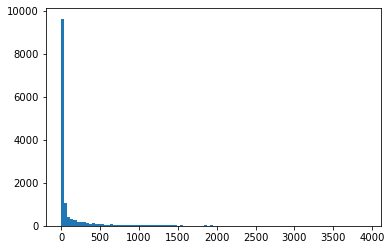

time: 2.72 s (started: 2021-09-26 21:52:15 +01:00)


In [40]:
# initialise dictionary to collect the street network edges for each trip
trip_edges_sim_dict = {}
for trip, route in tqdm(trips_dict.items()):
    # create list of edges from list of nodes in the trip
    edges_sim = [ tuple( route[i:i+2] ) for i in range( len(route) - 1 ) ]
    # add to dictionary
    trip_edges_sim_dict[trip] = edges_sim

# create flat list of street network edges traversed in the entire simulation
edge_array_sim = [edge for key in trip_edges_sim_dict for edge in trip_edges_sim_dict[key]]
# create dictionary with street counts
segment_counts_sim = dict(Counter(edge_array_sim))
# plot distribution of counts
plt.hist(segment_counts_sim.values(), bins=100)
plt.show()

As one might expect from a preferential attachment mechanism, the distributions are heavy-tailed and closely follow [Zipf's law](https://en.wikipedia.org/wiki/Zipf%27s_law). This good agreement between the model and the data is rather surprising. One might expect that the simplistic assumptions in the taxi-drive model miss many important factors in the real world, such as variations in street-segment lengths and driving speeds, the spatial arranagement of attractive destinations specific to a city, human-routing decisions, as well as heterogeneities in passenger-pickup and -dropoff times and locations. However, the results show that, at the macro level of segment popularity distributions, these complexities are irrelevant. Moreover, the original paper finds this agreement to be true across many cities varying in size and continent.

Now, let's compute the fraction $\langle C\rangle$ for the simulated taxi-drive process. For that, we first compute the street popularities as a probability vector: 

In [41]:
segment_sims_array = np.array(list(segment_counts_sim.keys()))
segment_sims_probs_array = np.array(list(segment_counts_sim.values()))/sum(np.array(list(segment_counts_sim.values())))
len(segment_sims_probs_array)

13964

time: 16 ms (started: 2021-09-26 21:52:18 +01:00)


Now, let's define a new function that takes as input the number of taxis in a fleet (taken to be similar to the empirical data), computes and returns the fraction of streets covered by the fleet of that size. Or, more precisely, by the number of trips corresponding to the fleet of a certain size that completed that number of trips in the original taxi data set.

In [42]:
def C_sim(N_v):
    '''
    This function takes as input the number of taxis in a fleet 
    (taken to be similar to the empirical data), computes and returns 
    the fraction of streets covered by the fleet of that size.
    '''
    return 1 -np.sum((np.ones(len(segment_sims_probs_array))-segment_sims_probs_array)**(np.mean(B)*N_v))/len(segment_sims_probs_array)

C_sim(1000)

0.6737195185038699

time: 0 ns (started: 2021-09-26 21:52:18 +01:00)


Now we compute the fractions for the number of taxis similar to the original data.

In [43]:
Cs_model_sim = []
for num in num_partners:
    Cs_model_sim.append(C_sim(num))
    
Cs_model_sim[:10]

[0.023953589954627152,
 0.043807120386679776,
 0.06063776520139086,
 0.07517761762143071,
 0.08793872489319443,
 0.09928886710290219,
 0.10949865023238403,
 0.11877153128999118,
 0.12726345408960937,
 0.13509600985459513]

time: 4.05 s (started: 2021-09-26 21:52:18 +01:00)


In [44]:
np.save('Cs_model_sim.npy', Cs_model_sim)

time: 16 ms (started: 2021-09-26 21:52:22 +01:00)


## Results

Now that we have the analytical expression for $\langle C\rangle_{N_{V}}$, we compute it in two ways:

1. using the $p_i$ obtained from the data
2. using the $p_i$ obtained from the taxi-drive simulation

Finally, we plot them against $N_{V}$:

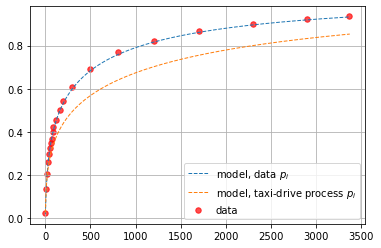

time: 563 ms (started: 2021-09-26 21:52:22 +01:00)


In [45]:
plt.scatter(num_partners[indices_data], Cs_data, s=30, alpha=0.7, c='r', label='data')
plt.plot(num_partners, Cs_model, ls='--', lw=1, label='model, data $p_i$')
plt.plot(num_partners, Cs_model_sim, ls='--', lw=1, label='model, taxi-drive process $p_i$')
plt.legend()
plt.grid()
plt.show()

We see that the covered fraction computed the first way is in near perfect agreement with the data, while the second way, despite the oversimplified assumptions, produced impressive results! 
The rapid increase of the $\langle C\rangle_{N_{V}}$ curves reveals that taxi fleets have large sensing power, easily covering the popular street segments, while rarely visited unpopular segments, are more and more difficult to cover. We see a law of diminishing returns: while covering the entire city is difficult, a considerable fraction can be covered with relative ease at a low cost. As mentioned in the beginning, only roughly about 30 taxi vehicles are needed to cover more than a third of the entire city, and up to 70% if we restrict the city to the central districts.

Finally, let's also plot the street network with node size proportional to the number of times it was visited in the taxi-drive simulation.

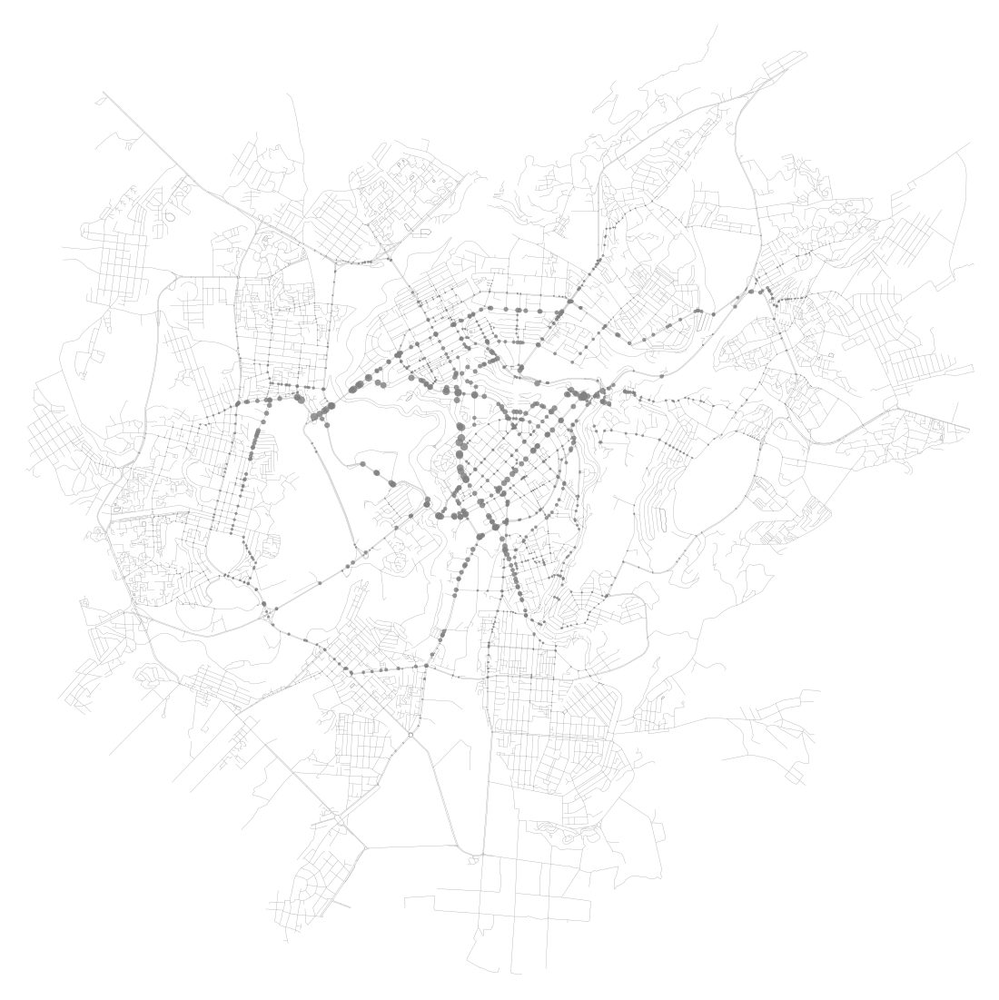

time: 2.53 s (started: 2021-09-26 21:52:23 +01:00)


In [46]:
fig, ax = ox.plot_graph(
    yerevan_subgraph,
    figsize=(20,20),
    node_color='grey',
    node_size=75*already_visited_times/already_visited_times.max(),
    bgcolor='white',
    node_alpha=0.8,
    edge_linewidth=0.3,
    edge_color="#999999",
)

Note that it makes sense also spatially, with the central part of the city and arterial streets visited most frequently.

## Final Project Part I

Carry out the above analysis starting from "**Simulating the taxi drive process**" for any other city of your choice. Interpret the resulting fraction **_C_** curve by comparing it to the Yerevan curve.

Complete the task in a clean Jupyter Notebook, name the notebook **< Name > < Surname > Final Project Part I** and upload it to Moodle.